In [1]:
# !pip install "keras<3.0.0" "tensorflow<2.16" "tf-models-official<2.16" mediapipe-model-maker
# !pip install kaggle

In [2]:
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers

from kaggle_datasets import KaggleDatasets
import matplotlib.pyplot as plt
import numpy as np

    
# # detect and init the TPU
# tpu = tf.distribute.cluster_resolver.TPUClusterResolver('local')

# # instantiate a distribution strategy
# tf.tpu.experimental.initialize_tpu_system(tpu)
# tpu_strategy = tf.distribute.TPUStrategy(tpu)

try:
    tpu = tf.distribute.cluster_resolver.TPUClusterResolver('local')
    print('Device:', tpu.master())
    tf.config.experimental_connect_to_cluster(tpu)
    tf.tpu.experimental.initialize_tpu_system(tpu)
    # strategy = tf.distribute.experimental.TPUStrategy(tpu)
    strategy = tf.distribute.TPUStrategy(tpu)
except:
    strategy = tf.distribute.get_strategy()
print('Number of replicas:', strategy.num_replicas_in_sync)

AUTOTUNE = tf.data.experimental.AUTOTUNE
    
print(tf.__version__)

E0000 00:00:1742198423.731192      74 common_lib.cc:612] Could not set metric server port: INVALID_ARGUMENT: Could not find SliceBuilder port 8471 in any of the 0 ports provided in `tpu_process_addresses`="local"
=== Source Location Trace: ===
learning/45eac/tfrc/runtime/common_lib.cc:230


Device: 
INFO:tensorflow:Deallocate tpu buffers before initializing tpu system.


INFO:tensorflow:Initializing the TPU system: local


I0000 00:00:1742198446.752300      74 service.cc:148] XLA service 0x5bf2fad1aef0 initialized for platform TPU (this does not guarantee that XLA will be used). Devices:
I0000 00:00:1742198446.752337      74 service.cc:156]   StreamExecutor device (0): TPU, 2a886c8
I0000 00:00:1742198446.752341      74 service.cc:156]   StreamExecutor device (1): TPU, 2a886c8
I0000 00:00:1742198446.752344      74 service.cc:156]   StreamExecutor device (2): TPU, 2a886c8
I0000 00:00:1742198446.752347      74 service.cc:156]   StreamExecutor device (3): TPU, 2a886c8
I0000 00:00:1742198446.752350      74 service.cc:156]   StreamExecutor device (4): TPU, 2a886c8
I0000 00:00:1742198446.752353      74 service.cc:156]   StreamExecutor device (5): TPU, 2a886c8
I0000 00:00:1742198446.752355      74 service.cc:156]   StreamExecutor device (6): TPU, 2a886c8
I0000 00:00:1742198446.752368      74 service.cc:156]   StreamExecutor device (7): TPU, 2a886c8


INFO:tensorflow:Finished initializing TPU system.


INFO:tensorflow:Found TPU system:


INFO:tensorflow:*** Num TPU Cores: 8


INFO:tensorflow:*** Num TPU Workers: 1


INFO:tensorflow:*** Num TPU Cores Per Worker: 8


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:localhost/replica:0/task:0/device:CPU:0, CPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:localhost/replica:0/task:0/device:TPU:0, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:localhost/replica:0/task:0/device:TPU:1, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:localhost/replica:0/task:0/device:TPU:2, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:localhost/replica:0/task:0/device:TPU:3, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:localhost/replica:0/task:0/device:TPU:4, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:localhost/replica:0/task:0/device:TPU:5, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:localhost/replica:0/task:0/device:TPU:6, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:localhost/replica:0/task:0/device:TPU:7, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:localhost/replica:0/task:0/device:TPU_SYSTEM:0, TPU_SYSTEM, 0, 0)


Number of replicas: 8
2.18.0


This Python code snippet is using TensorFlow to set up a distributed training strategy, prioritising a TPU (Tensor Processing Unit) if available, and falling back to a default strategy otherwise:

`tf.io.gfile.glob()` finds and returns a list of all `.tfrec` files in the given filepath directory.

In [3]:
# monet_fpath = '/content/drive/MyDrive/Kaggle-Monet-CycleGAN'
GCS_PATH = KaggleDatasets().get_gcs_path()

MONET_FILENAMES = tf.io.gfile.glob(str(GCS_PATH + '/monet_tfrec/*.tfrec'))
print('Monet TFRecord Files:', len(MONET_FILENAMES))

PHOTO_FILENAMES = tf.io.gfile.glob(str(GCS_PATH + '/photo_tfrec/*.tfrec'))
print('Photo TFRecord Files:', len(PHOTO_FILENAMES))

get_gcs_path is not required on TPU VMs which can directly use Kaggle datasets, using path: /kaggle/input/gan-getting-started


Monet TFRecord Files: 5


Photo TFRecord Files: 20


In [4]:
IMAGE_SIZE = [256, 256]

def decode_image(image):
  # Decodes a JPEG-encoded image into a TensorFlow tensor.
  image = tf.image.decode_jpeg(image, channels=3)

  # Normalise Pixel Values to [-1, 1]
  image = (tf.cast(image, tf.float32) / 127.5) - 1

  # Reshapes the image tensor to a predefined size, IMAGE_SIZE, with 3 color channels.
  image = tf.reshape(image, [*IMAGE_SIZE, 3])
  return image

This function `read_tfrecord(example)` is used to parse a single TFRecord example, extract an image from it, and decode it into a TensorFlow tensor.

`tfrecord_format` is a dictionary that defines the structure of the TFRecord data.
It specifies that the TFRecord contains three features:
- "image_name": A string representing the image filename.
- "image": A string (serialized raw image data).
- "target": A string (likely representing some associated label or annotation).

Each feature is declared as a `FixedLenFeature`, meaning it has a fixed length (scalar) and is stored as a `tf.string`.


In [5]:
def read_tfrecord(example):

  # define structure of the TFRecord data
  tfrecord_format = {
      "image_name": tf.io.FixedLenFeature([], tf.string),
      "image": tf.io.FixedLenFeature([], tf.string),
      "target": tf.io.FixedLenFeature([], tf.string)
  }

  # parses the serialized example according to the defined structure above
  # the output is a dictionary where keys are "image_name", "image", and "target", and their values are TensorFlow tensors
  example = tf.io.parse_single_example(example, tfrecord_format)

  # example['image'] contains the raw image data as a string
  # it is passed to the decode_image() function which
    # Decodes the JPEG image to a TF tensor
    # Converts it to float32 and normalizes it to [-1, 1]
    # Reshapes it to a predefined size (IMAGE_SIZE)
  image = decode_image(example['image'])

  return image

This function loads a dataset from TFRecord files, processes it using `read_tfrecord()`, and returns a TensorFlow dataset object `tf.data.Dataset`

The `labeled` variable is not used in the function, but suggests that the function could be modified to handle labeled and unlabeled datasets differently. If labels were included in the TFRecord files, the function could return both images and labels when labeled=True, and just images when labeled=False

In [6]:
def load_dataset(filenames, labeled=True, ordered=False):
  # load dataset from TFRecord files
  dataset = tf.data.TFRecordDataset(filenames)

  # process the data using read_tfrecord()
  dataset = dataset.map(read_tfrecord, num_parallel_calls=AUTOTUNE)

  return dataset

The `.batch(1)` function groups the dataset into batches of size 1. This is common for GANs, especially for image translation tasks like CycleGAN, which takes one image at a time and produces a transformed version.

In [7]:
monet_ds = load_dataset(MONET_FILENAMES, labeled=True).batch(1)
photo_ds = load_dataset(PHOTO_FILENAMES, labeled=True).batch(1)

This retrieves the first batch (a single image) from the `monet_ds` and `photo_ds` datasets.

`monet_ds` is a `tf.data.Dataset` object.

Calling `iter(monet_ds)` creates an iterator over the dataset, which allows sequential access to its elements.

`next(iterator)` retrieves the first batch from the dataset. Since `.batch(1)` was used when creating monet_ds, each batch contains one image.

The variable `example_monet` will contain a single image tensor (or an (image, label) pair if the dataset includes labels).

`example_monet` and `example_photo` are **batched tensors**, meaning their shape is [1, height, width, 3]

In [8]:
example_monet = next(iter(monet_ds))
example_photo = next(iter(photo_ds))

Here are plots of the example_monet and example_photo batched tensors.

`example[0]` removes the batch dimension, leaving you with a tensor of shape [height, width, 3], which represents a single image in the batch.

`example[0] * 0.5 + 0.5` transforms the pixel values from the range [-1, 1] to [0, 1], which is required for `plt.imshow()`

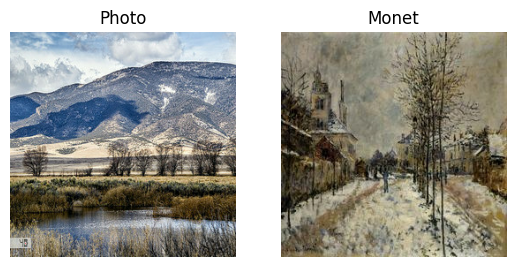

In [9]:
plt.subplot(121)
plt.axis("off")
plt.title('Photo')
plt.imshow(example_photo[0] * 0.5 + 0.5)

plt.subplot(122)
plt.axis("off")
plt.title('Monet')
plt.imshow(example_monet[0] * 0.5 + 0.5)

# Build the generator

We'll be using a UNET architecture for our CycleGAN. To build our generator, let's first define our `downsample` and `upsample` methods.

The `downsample`, as the name suggests, reduces the 2D dimensions, the width and height, of the image by the stride. The stride is the length of the step the filter takes. Since the stride is 2, the filter is applied to every other pixel, hence reducing the weight and height by 2.

We'll be using an instance normalization instead of batch normalization. As the instance normalization is not standard in the TensorFlow API, we'll use the layer from TensorFlow Add-ons.

The `Conv2D` layer performs a standard convolutional operation that typically reduces spatial dimensions when using `strides=2`. Think of it as compressing information:

- It applies filters that scan across the input image
- With strides=2, it samples every other pixel, effectively halving the height and width
- It's taking a larger image and condensing it into a smaller but deeper (more filters) representation
- This operation extracts and compresses features from the input

In [10]:
# Number of output channels for the network's final layer
OUTPUT_CHANNELS = 3

"""
Function to create a downsampling block for the encoder part of UNET

downsample() takes the following parameters:
  > filters: number of convolutional filters/channels
  > size: kernel size for convolution
  > apply_instancenorm: bool - whether to apply instance normalisation

"""

def downsample(filters, size, apply_instancenorm=True):
  # Creates a weight initializer that generates random values
  # from a normal distribution with mean 0 and standard deviation 0.02.
  # This helps with stable training
  initializer = tf.random_normal_initializer(0., 0.02)

  # Similar initializer specifically for the gamma parameter
  # of the instance normalization layer.
  gamma_init = keras.initializers.RandomNormal(mean=0.0, stddev=0.02)

  # Create a new sequential model to hold the layers of this downsampling block.
  result = keras.Sequential()

  # Adds a 2D convolutional layer to the sequential model
  result.add(
      layers.Conv2D(
          filters, # number of output channels
          size, # kernel dims = size * size
          strides=2, # reduce spatial dimensions by factor of two (half)
          padding='same', # maintain appropriate dimensions
          kernel_initializer=initializer, # use custom weight initialiser defined above
          use_bias=False) # no bias terms
      )

  # Conditionally adds instance normalization
  if apply_instancenorm:
      result.add(
          keras.layers.GroupNormalization(groups=-1, gamma_initializer=gamma_init)
          # tfa.layers.InstanceNormalization(gamma_initializer=gamma_init)
          )

  # Adds a LeakyReLU activation function,
  # which allows a small gradient when the unit is not active
  # (unlike regular ReLU which outputs 0 for negative inputs).
  result.add(layers.LeakyReLU())

  # Returns the constructed sequential model containing these layers.
  return result

`Upsample` does the opposite of downsample and increases the dimensions of the of the image. `Conv2DTranspose` does basically the opposite of a `Conv2D` layer.

The Conv2DTranspose layer performs a transposed convolution (sometimes called deconvolution, though mathematically that's not entirely accurate). Think of it as expanding information:

- It essentially performs the mathematical opposite of convolution
- With strides=2, it increases spatial dimensions, doubling the height and width
- It's taking a smaller, feature-rich representation and expanding it back to a larger spatial size
- This operation reconstructs spatial information that was compressed during downsampling

The `upsample()` function has an optional parameter apply_dropout that, when set to True, adds a Dropout layer with a rate of 0.5 (meaning it randomly drops 50% of the inputs during training).

Dropout is typically used in the upsampling/decoder path of a UNET for several important reasons:

1. **Feature Integration Complexity**: The decoder must integrate information from both the upsampled features and the skip connections, making its task more complex and potentially prone to overfitting.
2. **Skip Connection Dependence**: Without dropout, the decoder might become overly reliant on the high-resolution details from skip connections rather than learning robust feature reconstruction.
3. **Generative Task**: The decoder performs the generative part of the network, reconstructing the output image. Dropout helps prevent it from memorizing specific reconstruction patterns.
4. **Architectural Precedent**: The original UNET paper by Ronneberger et al. specifically recommended dropout in the upsampling path to reduce overfitting, and this has become standard practice.

The use of dropout in the decoder helps the network learn more robust and generalizable features for image reconstruction, which is particularly important in applications like CycleGAN where generating realistic images across domains is the primary objective.

The downsampling path typically doesn't use dropout because it needs to reliably extract and preserve essential features that will be needed later for reconstruction in the upsampling path.

In [11]:
def upsample(filters, size, apply_dropout=False):

  # constrain initialisers as before
  initializer = tf.random_normal_initializer(0., 0.02)
  gamma_init = keras.initializers.RandomNormal(mean=0.0, stddev=0.02)

  result = keras.Sequential()

  #
  result.add(
      layers.Conv2DTranspose(
          filters,
          size,
          strides=2, # increase spatial dimensions by factor of two (double)
          padding='same',
          kernel_initializer=initializer,
          use_bias=False))

  result.add(
      keras.layers.GroupNormalization(groups=-1, gamma_initializer=gamma_init)
      # tfa.layers.InstanceNormalization(gamma_initializer=gamma_init)
      )

  # optionally add dropout layer with a rate of 0.5
  # which would randomly drop 50% of the inputs during training
  if apply_dropout:
      result.add(layers.Dropout(0.5))

  result.add(layers.ReLU())

  return result

Let's build our generator!

The generator first downsamples the input image and then upsample while establishing long skip connections. Skip connections are a way to help bypass the vanishing gradient problem by concatenating the output of a layer to multiple layers instead of only one. Here we concatenate the output of the downsample layer to the upsample layer in a symmetrical fashion.

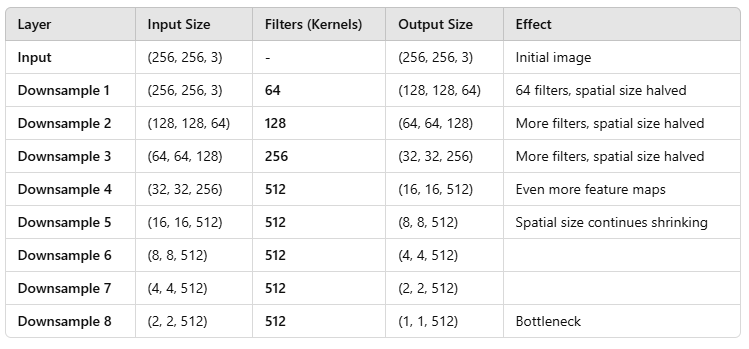

In [12]:
def Generator():
  # model input: image of dimensions [256, 256, 3]
  inputs = layers.Input(shape=[256,256,3])

  # bs = batch size
  down_stack = [
      downsample(64, 4, apply_instancenorm=False), # (bs, 128, 128, 64)

      # 128 kernels (convolutional filters), of a size 4x4
      downsample(128, 4), # (bs, 64, 64, 128)

      downsample(256, 4), # (bs, 32, 32, 256)
      downsample(512, 4), # (bs, 16, 16, 512)
      downsample(512, 4), # (bs, 8, 8, 512)
      downsample(512, 4), # (bs, 4, 4, 512)
      downsample(512, 4), # (bs, 2, 2, 512)
      downsample(512, 4), # (bs, 1, 1, 512)
  ]

  up_stack = [
      upsample(512, 4, apply_dropout=True), # (bs, 2, 2, 1024)
      upsample(512, 4, apply_dropout=True), # (bs, 4, 4, 1024)
      upsample(512, 4, apply_dropout=True), # (bs, 8, 8, 1024)
      upsample(512, 4), # (bs, 16, 16, 1024)
      upsample(256, 4), # (bs, 32, 32, 512)
      upsample(128, 4), # (bs, 64, 64, 256)
      upsample(64, 4), # (bs, 128, 128, 128)
  ]

  initializer = tf.random_normal_initializer(0., 0.02)
  last = layers.Conv2DTranspose(OUTPUT_CHANNELS, 4,
                                strides=2,
                                padding='same',
                                kernel_initializer=initializer,
                                activation='tanh') # (bs, 256, 256, 3)

  x = inputs

  # Downsampling through the model
  skips = []
  for down in down_stack:
      x = down(x)
      skips.append(x)

  skips = reversed(skips[:-1])

  # Upsampling and establishing the skip connections
  for up, skip in zip(up_stack, skips):
      x = up(x)

      # concatenate features from early-stage encoder
      # with abstract features deep within the model
      x = layers.Concatenate()([x, skip])

  x = last(x)

  return keras.Model(inputs=inputs, outputs=x)

# Build the discriminator

The discriminator takes in the input image and classifies it as real or fake (generated). Instead of outputing a single node, the discriminator outputs a smaller 2D image with higher pixel values indicating a real classification and lower values indicating a fake classification.

#### Why Patch-Based Discrimination?
Instead of classifying the entire image as real/fake, this PatchGAN discriminator:

- Predicts per patch (e.g., a 30×30 grid).
- Forces the generator to focus on fine details.
- Works better for high-resolution images.

In [13]:
def Discriminator():

  # Initializes the weights of the convolutional layers
  # with a normal distribution (mean = 0, std = 0.02).
  # This is typical for GANs, as small values help stabilize training.
  initializer = tf.random_normal_initializer(0., 0.02)

  # Initializes the scaling parameter (γ) of Instance Normalization with a normal distribution.
  gamma_init = keras.initializers.RandomNormal(mean=0.0, stddev=0.02)

  # Defines the input image (256×256 pixels, 3 RGB channels).
  inp = layers.Input(shape=[256, 256, 3], name='input_image')
  x = inp # x = input

  # These downsample (strided convolution) layers
  # reduce the spatial dimensions while increasing the number of filters
  down1 = downsample(64, 4, False)(x) # (bs, 128, 128, 64)
  down2 = downsample(128, 4)(down1) # (bs, 64, 64, 128)
  down3 = downsample(256, 4)(down2) # (bs, 32, 32, 256)

  # Zero Padding prevents excessive spatial reduction due to convolutions
  # and ensures that patches at the image boundaries are also classified.
  zero_pad1 = layers.ZeroPadding2D()(down3) # (bs, 34, 34, 256)

  conv = layers.Conv2D(
      512, # 512 filters for feature abstraction
      4, # 4x4 kernel
      strides=1, # spatial size of output remains almost same
      kernel_initializer=initializer,
      use_bias=False)(zero_pad1) # (bs, 31, 31, 512)

  norm1 = keras.layers.GroupNormalization(groups=-1, gamma_initializer=gamma_init)(conv)
  # norm1 = tfa.layers.InstanceNormalization(gamma_initializer=gamma_init)(conv)

  # Avoids "dying ReLU" (zero activations) by allowing small negative values.
  # Helps preserve gradient flow in deeper layers.
  leaky_relu = layers.LeakyReLU()(norm1)

  # Ensures spatial dimensions remain large enough before the final output layer.
  zero_pad2 = layers.ZeroPadding2D()(leaky_relu) # (bs, 33, 33, 512)

  # Outputs a single-channel feature map (30×30×1).
  # Each pixel represents a real/fake classification score
  # for a 30×30 patch of the input image.
  last = layers.Conv2D(
      1, # 1 filter - single-channel feature map
      4, # 4x4 kernel
      strides=1,
      kernel_initializer=initializer)(zero_pad2) # (bs, 30, 30, 1)

  return tf.keras.Model(inputs=inp, outputs=last)

In [14]:
with strategy.scope():
    monet_generator = Generator() # transforms photos to Monet-esque paintings
    photo_generator = Generator() # transforms Monet paintings to be more like photos

    monet_discriminator = Discriminator() # differentiates real Monet paintings and generated Monet paintings
    photo_discriminator = Discriminator() # differentiates real photos and generated photos

I0000 00:00:1742198452.792904      74 device_compiler.h:188] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.


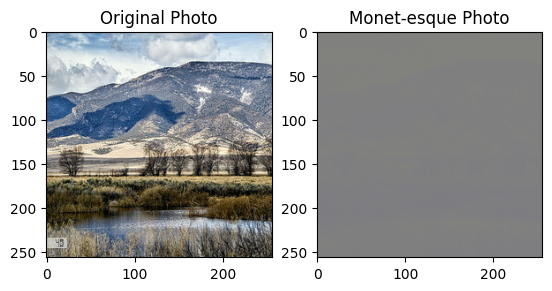

In [15]:
to_monet = monet_generator(example_photo)

plt.subplot(1, 2, 1)
plt.title("Original Photo")
plt.imshow(example_photo[0] * 0.5 + 0.5)

plt.subplot(1, 2, 2)
plt.title("Monet-esque Photo")
plt.imshow(to_monet[0] * 0.5 + 0.5)
plt.show()

# Build the CycleGAN model

We will subclass a `tf.keras.Model` so that we can run `fit()` later to train our model. During the training step, the model transforms a photo to a Monet painting and then back to a photo. The difference between the original photo and the twice-transformed photo is the cycle-consistency loss. We want the original photo and the twice-transformed photo to be similar to one another.


### `train_step()`:
- Processes one batch containing a single Monet painting and a single photo (batch size of 1)
- Performs forward passes through both generators and discriminators, calculating losses for all networks, including adversarial, cycle consistency, and identity losses.
- Gradients are tracked using a persistent `tf.GradientTape`, allowing multiple gradient calculations from the same recorded operations.
- These gradients update all four networks (two generators, two discriminators) using their respective optimizers.
- This function executes once per batch for each epoch of training, forming just one step in the iterative training process of a CycleGAN.

### `tf.GradientTape`
`tf.GradientTape` is a mechanism in TensorFlow that implements automatic differentiation by recording a "tape" of all operations executed inside its context. Here's how it works:

1. **Recording Phase**: When you enter a `with tf.GradientTape() as tape:` block, TensorFlow begins recording all operations and variables accessed within that block.
2. **Operation Tracking**: As you perform mathematical operations on tensors inside the tape context, TensorFlow builds a graph of these operations, recording their inputs, outputs, and the mathematical relationship between them.
3. **Gradient Calculation**: When you later call tape.gradient(target, sources), the tape uses the recorded operations to compute the gradients of your target (typically a loss value) with respect to your sources (typically model variables).
4. **Backpropagation Implementation**: Under the hood, the tape implements backpropagation by working backward through the recorded operations, applying the chain rule of calculus to determine how each parameter influenced the final result.
5. **Persistent Tapes**: By default, a gradient tape is non-persistent, meaning it's automatically deleted after calculating gradients once. When you set persistent=True, the tape remains in memory, allowing you to calculate multiple different gradients from the same recorded operations—which is essential in GANs where you have multiple models to update.
6. **Resource Management**: After using a persistent tape, it should be explicitly deleted with del tape to free memory, although in this function, it will be automatically deleted when the function exits.

In [16]:
class CycleGan(keras.Model):
    def __init__(
        self,
        monet_generator,
        photo_generator,
        monet_discriminator,
        photo_discriminator,
        lambda_cycle=10,
    ):
        super(CycleGan, self).__init__()
        self.m_gen = monet_generator
        self.p_gen = photo_generator
        self.m_disc = monet_discriminator
        self.p_disc = photo_discriminator
        self.lambda_cycle = lambda_cycle

    def compile(
        self,
        m_gen_optimizer,
        p_gen_optimizer,
        m_disc_optimizer,
        p_disc_optimizer,
        gen_loss_fn,
        disc_loss_fn,
        cycle_loss_fn,
        identity_loss_fn
    ):
        super(CycleGan, self).compile()
        self.m_gen_optimizer = m_gen_optimizer
        self.p_gen_optimizer = p_gen_optimizer
        self.m_disc_optimizer = m_disc_optimizer
        self.p_disc_optimizer = p_disc_optimizer

        self.optimizers = [self.m_gen_optimizer, self.p_gen_optimizer, self.m_disc_optimizer, self.p_disc_optimizer]
        
        self.gen_loss_fn = gen_loss_fn
        self.disc_loss_fn = disc_loss_fn
        self.cycle_loss_fn = cycle_loss_fn
        self.identity_loss_fn = identity_loss_fn


    # The train_step() function operates for a single batch of data
        # (monet->photo->monet, photo->monet->photo)
    # This function represents just one step in the training procedure
    def train_step(self, batch_data):

        # one batch = one image from the monet dataset AND one image from the photo dataset
        real_monet, real_photo = batch_data

        # GradientTape keeps a record ("tape") of variables over time
        #   which we can use later for gradient descent calculations
        # A persistent tape is a tape that can be used multiple times to compute multiple gradients.
        #   By default, a tape is not persistent and can only be used once.
        with tf.GradientTape(persistent=True) as tape:

            # CYCLE CONSISTENCY PATHS:
            # convert a to b, then back to a (a_real -> b -> a_cycled)
            # Perfect cycle consistency: real_photo == cycled_photo

            # photo -> monet -> photo
            fake_monet = self.m_gen(real_photo, training=True)
            cycled_photo = self.p_gen(fake_monet, training=True)

            # monet -> photo -> monet
            fake_photo = self.p_gen(real_monet, training=True)
            cycled_monet = self.m_gen(fake_photo, training=True)


            # IDENTITY MAPPINGS:
            # A monet image passed through the monet generator should remain unchanged
            # This is part of the identity loss which helps prevent unnecessary changes to images that are already in the target domain.
            same_monet = self.m_gen(real_monet, training=True)
            same_photo = self.p_gen(real_photo, training=True)


            # DISCRIMINATORS EVALUATE REAL IMAGES
            disc_real_monet = self.m_disc(real_monet, training=True)
            disc_real_photo = self.p_disc(real_photo, training=True)

            # DISCRIMINATORS EVALUATE FAKE IMAGES
            disc_fake_monet = self.m_disc(fake_monet, training=True)
            disc_fake_photo = self.p_disc(fake_photo, training=True)


            # CALCULATE ADVERSARIAL GENERATOR LOSS
            # Typically, this loss function evaluates how close the discriminator outputs are to indicating "real" for the generated images.

            # monet_gen_loss measures how well the Monet generator fooled the Monet discriminator
            monet_gen_loss = self.gen_loss_fn(disc_fake_monet)

            # photo_gen_loss measures how well the photo generator fooled the photo discriminator
            photo_gen_loss = self.gen_loss_fn(disc_fake_photo)


            # CALCULATE CYCLE CONSISTENCY LOSS
            # It ensures that:
            # > A photo converted to Monet style and back should closely resemble the original photo
            # > A Monet painting converted to photo style and back should closely resemble the original painting
            # The lambda_cycle parameter controls how strongly this loss is weighted in the total loss.

            total_cycle_loss = self.cycle_loss_fn(real_monet, cycled_monet, self.lambda_cycle) + self.cycle_loss_fn(real_photo, cycled_photo, self.lambda_cycle)


            # CALCULATE TOTAL GENERATOR LOSS
            # Combine all generator losses into total loss for each generator:
            # > Adversarial generator loss (fooling the discriminator)
            # > Cycle consistency loss (preserving content)
            # > Identity loss (preserving color/tone when input is already in target domain)
            total_monet_gen_loss = monet_gen_loss + total_cycle_loss + self.identity_loss_fn(real_monet, same_monet, self.lambda_cycle)
            total_photo_gen_loss = photo_gen_loss + total_cycle_loss + self.identity_loss_fn(real_photo, same_photo, self.lambda_cycle)

            # CALCULATE DISCRIMINATOR LOSS
            monet_disc_loss = self.disc_loss_fn(disc_real_monet, disc_fake_monet)
            photo_disc_loss = self.disc_loss_fn(disc_real_photo, disc_fake_photo)


        # CALCULATE MODEL GRADIENTS
        # Here, we use the gradient tape to calculate gradients of the losses with respect to each model's trainable variables.
        # The tape has recorded all operations, so it can compute how each parameter contributed to the final loss.

        # Compute the gradient of total_monet_gen_loss with respect to monet generator trainable variables
        monet_generator_gradients = tape.gradient(total_monet_gen_loss,
                                                  self.m_gen.trainable_variables)

        # Compute the gradient of total_photo_gen_loss with respect to photo generator trainable variables
        photo_generator_gradients = tape.gradient(total_photo_gen_loss,
                                                  self.p_gen.trainable_variables)

        # Compute the gradient of monet_disc_loss with respect to monet discriminator trainable variables
        monet_discriminator_gradients = tape.gradient(monet_disc_loss,
                                                      self.m_disc.trainable_variables)

        # Compute the gradient of photo_disc_loss with respect to photo discriminator trainable variables
        photo_discriminator_gradients = tape.gradient(photo_disc_loss,
                                                      self.p_disc.trainable_variables)


        # APPLY GRADIENTS
        # For each model, apply the calculated gradients to update the model parameters using the respective optimizers.
        # The zip function pairs each gradient with its corresponding variable so the optimizer knows which parameter to update with which gradient.

        self.m_gen_optimizer.apply_gradients(zip(monet_generator_gradients,
                                                 self.m_gen.trainable_variables))

        self.p_gen_optimizer.apply_gradients(zip(photo_generator_gradients,
                                                 self.p_gen.trainable_variables))

        self.m_disc_optimizer.apply_gradients(zip(monet_discriminator_gradients,
                                                  self.m_disc.trainable_variables))

        self.p_disc_optimizer.apply_gradients(zip(photo_discriminator_gradients,
                                                  self.p_disc.trainable_variables))

        # return a dictionary of losses for monitoring training progress
        return {
            "monet_gen_loss": total_monet_gen_loss,
            "photo_gen_loss": total_photo_gen_loss,
            "monet_disc_loss": monet_disc_loss,
            "photo_disc_loss": photo_disc_loss
        }

# Define loss functions


### `with strategy.scope():`
- `strategy` represents the distributed training strategy we initialised early in the notebook
- In TensorFlow, this allows the model and its operations to be distributed across multiple GPUs or TPUs.
- Any variables or models created within this scope will be part of the distribution strategy, enabling parallel processing.

### Discriminator loss

- Takes two parameters:
  - `real`: discriminator outputs for real images
  - `generated`: discriminator outputs for fake/generated images

- BinaryCrossentropy measures how far the discriminator's predictions (real/generated) are from true labels (real=1, generated=0)
  - `real` predictions are compared to a tensor of 1s
  - `generated` predictions are compared to a tensor of 0s
- The perfect discriminator will output all 1s for real images and all 0s for fake images
- The discriminator loss outputs the average of the real and generated loss.

In [17]:
with strategy.scope():

  def discriminator_loss(real, generated):

    # CALCULATE 'REAL' IMAGE LOSS
    real_loss = tf.keras.losses.BinaryCrossentropy(
      from_logits=True,  #  indicates the inputs are raw logits (not passed through sigmoid)
      reduction=tf.keras.losses.Reduction.NONE # preserves the loss value for each sample instead of averaging
      )(tf.ones_like(real), real) # creates a tensor of 1s representing the "true" labels (1 = real), comparing it to the 'real' image predictions

    # CALCULATE 'GENERATED' IMAGE LOSS
    generated_loss = tf.keras.losses.BinaryCrossentropy(
        from_logits=True,
        reduction=tf.keras.losses.Reduction.NONE
        )(tf.zeros_like(generated), generated) # creates a tensor of 0s representing the "true" labels (0 = generated), comparing it to the 'real' image predictions

    # RETURN THE AVERAGE OF THE TWO LOSSES
    total_disc_loss = real_loss + generated_loss
    return total_disc_loss * 0.5

### Generator loss

- The generator wants to fool the discriminator into thinking the generated image is real.
- A bad generator will not be able to fool the discriminator, so outputs will be 0s ('generated' predictions)
- The perfect generator will have the discriminator output only 1s ('real' predictions)
- Thus, it compares the generated image to a matrix of 1s to find the loss.

In [18]:
with strategy.scope():

  def generator_loss(generated):
      return tf.keras.losses.BinaryCrossentropy(
          from_logits=True,
          reduction=tf.keras.losses.Reduction.NONE
          )(tf.ones_like(generated), generated) # creates a tensor of 1s representing the "true" labels (1 = real), comparing it to the 'generated' image prediction

### Cycle consistency loss

- We want our original photo and the twice transformed photo to be similar to one another.
- Thus, we can calculate the cycle consistency loss be finding the average of their difference.

- `calc_cycle_loss()` calculates how well an image maintains its content after being translated to another domain and back again
- This what enforces the constraint that a photo translated to a Monet painting and back should look like the original photo, and vice versa
- Without this loss, the generators could create images that look realistic to the discriminators but have no relation to the input images.

- It takes three parameters:
  - `real_image`: The original input image
  - `cycled_image`: The image after it has gone through both generators (e.g., photo → Monet → photo)
  - `LAMBDA`: A hyperparameter that controls how much weight to give to this loss

- The loss function here is L1 loss (also called Mean Absolute Error) between the original image and the cycled image
  - A smaller value means the cycled image is more similar to the original, which is what we want.
- The L1 loss is preferred over L2 (squared differences) in image generation tasks because it encourages less blurring in the generated images.

In [19]:
with strategy.scope():
    def calc_cycle_loss(real_image, cycled_image, LAMBDA):

      # compute the absolute difference between each pixel value in the original and cycled images
      abs_diff = tf.abs(real_image - cycled_image)

      # averages these differences across all pixels and channels
      loss1 = tf.reduce_mean(abs_diff)

      # This multiplication is crucial for balancing the cycle consistency loss against the adversarial losses
      # A higher LAMBDA value places more importance on preserving the content and structure of the original image during the translation process.
      return LAMBDA * loss1

### Identity loss

- The function calculates how well a generator preserves images that are already in its target domain.
- This helps prevent unnecessary changes to images and encourages color preservation.

- `identity_loss()` takes three parameters:
  - `real_image`: An original image already in the target domain (like a real Monet painting given to the Monet generator)
  - `same_image`: The result of passing that image through its corresponding generator (the output when a real Monet painting goes through the Monet generator)
  - `LAMBDA`: A hyperparameter that controls the importance of this loss in the overall training objective
- Similarly to `calc_cycle_loss()`, the loss function is L1 (Mean Absolute Error) between the original image and the generator's output.
- A smaller loss value indicates the generator made fewer changes to the image, which is desirable when the image is already in the target domain.
- The identity loss is multiplied by 0.5, giving it half the weight of the cycle consistency loss
  - This follows the original CycleGAN paper's recommendation, making the identity loss important but secondary to the cycle consistency loss

- The identity mapping helps preserve color tones and composition when translating between domains
  - For example, it can help prevent a blue sky in a photo from being transformed into a yellow sky in a Monet-style image when that wouldn't be appropriate.

In [20]:
with strategy.scope():

    def identity_loss(real_image, same_image, LAMBDA):
        loss = tf.reduce_mean(tf.abs(real_image - same_image))

        # The identity loss has half the weight of cycle consistency loss
        return LAMBDA * 0.5 * loss

# Train the CycleGAN

Let's compile our model. Since we used `tf.keras.Model` to build our CycleGAN, we can just ude the `fit` function to train our model.

In [21]:
class CycleGANLRScheduler(tf.keras.callbacks.Callback):
    def __init__(self, initial_lr, decay_start, total_epochs, optimizers, min_lr=1e-6, use_cosine_decay=True):
        super().__init__()
        self.initial_lr = float(initial_lr)
        self.decay_start = decay_start
        self.total_epochs = total_epochs
        self.min_lr = min_lr
        self.use_cosine_decay = use_cosine_decay
        self.optimizers = optimizers  # List of 4 optimizers

    def on_epoch_begin(self, epoch, logs=None):
        if epoch < self.decay_start:
            current_lr = self.initial_lr  # Keep LR constant before decay starts
        else:
            decay_progress = (epoch - self.decay_start) / (self.total_epochs - self.decay_start)

            if self.use_cosine_decay:
                current_lr = self.initial_lr * 0.5 * (1 + np.cos(np.pi * decay_progress))
            else:
                current_lr = self.initial_lr * (1 - decay_progress)  # Default linear decay

            current_lr = max(current_lr, self.min_lr)  # Ensure LR doesn't go below min_lr

        for opt in self.optimizers:
            opt.learning_rate.assign(current_lr)  # Update optimizers


In [22]:
# Print learning rates during training
class LrLogger(tf.keras.callbacks.Callback):
    def on_epoch_begin(self, epoch, logs=None):
        lrs = [opt.learning_rate.numpy() for opt in self.model.optimizers]
        print(f"Epoch {epoch}: LRs = {lrs}")

In [23]:
with strategy.scope():
    monet_generator_optimizer = tf.keras.optimizers.Adam(learning_rate=0.0002, beta_1=0.5)
    photo_generator_optimizer = tf.keras.optimizers.Adam(learning_rate=0.0002, beta_1=0.5)
    monet_discriminator_optimizer = tf.keras.optimizers.Adam(learning_rate=0.0002, beta_1=0.5)
    photo_discriminator_optimizer = tf.keras.optimizers.Adam(learning_rate=0.0002, beta_1=0.5)

In [24]:
with strategy.scope():
    cycle_gan_model = CycleGan(
        monet_generator, photo_generator, monet_discriminator, photo_discriminator
    )

    cycle_gan_model.compile(
        m_gen_optimizer = monet_generator_optimizer,
        p_gen_optimizer = photo_generator_optimizer,
        m_disc_optimizer = monet_discriminator_optimizer,
        p_disc_optimizer = photo_discriminator_optimizer,
        gen_loss_fn = generator_loss,
        disc_loss_fn = discriminator_loss,
        cycle_loss_fn = calc_cycle_loss,
        identity_loss_fn = identity_loss
    )

In [25]:
cycle_gan_model.build(input_shape=(None, 256, 256, 3))

In [26]:
# Initialize with your actual optimizers
lr_callback = CycleGANLRScheduler(
    initial_lr=0.0002,
    decay_start=30,
    total_epochs=200,
    min_lr=0.000001,
    use_cosine_decay=True,
    optimizers=[
        monet_generator_optimizer, 
        photo_generator_optimizer, 
        monet_discriminator_optimizer, 
        photo_discriminator_optimizer]  # Your 4 optimizer instances
)

lr_logger = LrLogger()

cycle_gan_model.fit(
    tf.data.Dataset.zip((monet_ds, photo_ds)),
    epochs=200,
    steps_per_epoch=300,
    callbacks=[lr_callback, lr_logger]  # Add other callbacks as needed
)

Epoch 0: LRs = [np.float32(0.0002), np.float32(0.0002), np.float32(0.0002), np.float32(0.0002)]
Epoch 1/200


I0000 00:00:1742198541.576656      74 encapsulate_tpu_computations_pass.cc:266] Subgraph fingerprint:7566007051843487605


I0000 00:00:1742198550.468524     843 tpu_compilation_cache_interface.cc:442] TPU host compilation cache miss: cache_key(7203055193558429198), session_name()


I0000 00:00:1742198625.983441     843 tpu_compile_op_common.cc:245] Compilation of 7203055193558429198 with session name  took 1m15.514857178s and succeeded


I0000 00:00:1742198626.159157     843 tpu_compilation_cache_interface.cc:476] TPU host compilation cache: compilation complete for cache_key(7203055193558429198), session_name(), subgraph_key(std::string(property.function_name) = "cluster_one_step_on_data_7566007051843487605", property.function_library_fingerprint = 10929137857319121858, property.mlir_module_fingerprint = 0, property.num_replicas = 8, topology.chip_bounds().x = 2, topology.chip_bounds().y = 2, topology.chip_bounds().z = 1, topology.wrap().x = false, topology.wrap().y = false, topology.wrap().z = false, std::string(property.shapes_prefix) = "2,256,256,3,;2,256,256,3,;", property.guaranteed_constants_size = 0, embedding_partitions_fingerprint = "1688352644216761960")
I0000 00:00:1742198626.159223     843 tpu_compilation_cache_interface.cc:542] After adding entry for key 7203055193558429198 with session_name  cache is 1 entries (339451091 bytes),  marked for eviction 0 entries (0 bytes).


  1/300 ━━━━━━━━━━━━━━━━━━━━ 12:56:44 156s/step - monet_disc_loss: 0.6933 - monet_gen_loss: 9.0166 - photo_disc_loss: 0.6933 - photo_gen_loss: 9.6156

  2/300 ━━━━━━━━━━━━━━━━━━━━ 45s 154ms/step - monet_disc_loss: 0.6930 - monet_gen_loss: 9.9663 - photo_disc_loss: 0.6926 - photo_gen_loss: 10.8667   

  3/300 ━━━━━━━━━━━━━━━━━━━━ 45s 153ms/step - monet_disc_loss: 0.6923 - monet_gen_loss: 10.5242 - photo_disc_loss: 0.6919 - photo_gen_loss: 11.3105

  4/300 ━━━━━━━━━━━━━━━━━━━━ 45s 154ms/step - monet_disc_loss: 0.6915 - monet_gen_loss: 10.8179 - photo_disc_loss: 0.6911 - photo_gen_loss: 11.6533

  5/300 ━━━━━━━━━━━━━━━━━━━━ 45s 156ms/step - monet_disc_loss: 0.6907 - monet_gen_loss: 10.9696 - photo_disc_loss: 0.6901 - photo_gen_loss: 11.4486

  6/300 ━━━━━━━━━━━━━━━━━━━━ 45s 155ms/step - monet_disc_loss: 0.6900 - monet_gen_loss: 11.2570 - photo_disc_loss: 0.6885 - photo_gen_loss: 11.6058

  7/300 ━━━━━━━━━━━━━━━━━━━━ 45s 154ms/step - monet_disc_loss: 0.6893 - monet_gen_loss: 10.7866 - photo_disc_loss: 0.6870 - photo_gen_loss: 11.3457

  8/300 ━━━━━━━━━━━━━━━━━━━━ 44s 153ms/step - monet_disc_loss: 0.6884 - monet_gen_loss: 11.0514 - photo_disc_loss: 0.6860 - photo_gen_loss: 11.5756

  9/300 ━━━━━━━━━━━━━━━━━━━━ 44s 153ms/step - monet_disc_loss: 0.6879 - monet_gen_loss: 11.1880 - photo_disc_loss: 0.6848 - photo_gen_loss: 11.7516

 10/300 ━━━━━━━━━━━━━━━━━━━━ 44s 154ms/step - monet_disc_loss: 0.6875 - monet_gen_loss: 11.5732 - photo_disc_loss: 0.6832 - photo_gen_loss: 12.0867

 11/300 ━━━━━━━━━━━━━━━━━━━━ 44s 153ms/step - monet_disc_loss: 0.6863 - monet_gen_loss: 11.5752 - photo_disc_loss: 0.6824 - photo_gen_loss: 12.0017

 12/300 ━━━━━━━━━━━━━━━━━━━━ 43s 152ms/step - monet_disc_loss: 0.6855 - monet_gen_loss: 11.5144 - photo_disc_loss: 0.6809 - photo_gen_loss: 11.9100

 13/300 ━━━━━━━━━━━━━━━━━━━━ 43s 152ms/step - monet_disc_loss: 0.6837 - monet_gen_loss: 11.6966 - photo_disc_loss: 0.6798 - photo_gen_loss: 12.1330

 14/300 ━━━━━━━━━━━━━━━━━━━━ 43s 152ms/step - monet_disc_loss: 0.6823 - monet_gen_loss: 11.6031 - photo_disc_loss: 0.6785 - photo_gen_loss: 12.0606

 15/300 ━━━━━━━━━━━━━━━━━━━━ 43s 152ms/step - monet_disc_loss: 0.6811 - monet_gen_loss: 11.5115 - photo_disc_loss: 0.6769 - photo_gen_loss: 11.9247

 16/300 ━━━━━━━━━━━━━━━━━━━━ 43s 152ms/step - monet_disc_loss: 0.6794 - monet_gen_loss: 11.6144 - photo_disc_loss: 0.6754 - photo_gen_loss: 12.0388

 17/300 ━━━━━━━━━━━━━━━━━━━━ 43s 152ms/step - monet_disc_loss: 0.6791 - monet_gen_loss: 11.4476 - photo_disc_loss: 0.6744 - photo_gen_loss: 11.8536

 18/300 ━━━━━━━━━━━━━━━━━━━━ 42s 152ms/step - monet_disc_loss: 0.6782 - monet_gen_loss: 11.4251 - photo_disc_loss: 0.6730 - photo_gen_loss: 11.8498

 19/300 ━━━━━━━━━━━━━━━━━━━━ 42s 152ms/step - monet_disc_loss: 0.6767 - monet_gen_loss: 11.3671 - photo_disc_loss: 0.6713 - photo_gen_loss: 11.7821

 20/300 ━━━━━━━━━━━━━━━━━━━━ 42s 152ms/step - monet_disc_loss: 0.6762 - monet_gen_loss: 11.1750 - photo_disc_loss: 0.6697 - photo_gen_loss: 11.6425

 21/300 ━━━━━━━━━━━━━━━━━━━━ 42s 152ms/step - monet_disc_loss: 0.6746 - monet_gen_loss: 11.1543 - photo_disc_loss: 0.6688 - photo_gen_loss: 11.6411

 22/300 ━━━━━━━━━━━━━━━━━━━━ 42s 152ms/step - monet_disc_loss: 0.6738 - monet_gen_loss: 11.1182 - photo_disc_loss: 0.6692 - photo_gen_loss: 11.5712

 23/300 ━━━━━━━━━━━━━━━━━━━━ 42s 152ms/step - monet_disc_loss: 0.6726 - monet_gen_loss: 10.9959 - photo_disc_loss: 0.6688 - photo_gen_loss: 11.4780

 24/300 ━━━━━━━━━━━━━━━━━━━━ 41s 152ms/step - monet_disc_loss: 0.6714 - monet_gen_loss: 10.9035 - photo_disc_loss: 0.6682 - photo_gen_loss: 11.3950

 25/300 ━━━━━━━━━━━━━━━━━━━━ 41s 152ms/step - monet_disc_loss: 0.6702 - monet_gen_loss: 11.0261 - photo_disc_loss: 0.6690 - photo_gen_loss: 11.5537

 26/300 ━━━━━━━━━━━━━━━━━━━━ 41s 152ms/step - monet_disc_loss: 0.6694 - monet_gen_loss: 10.8873 - photo_disc_loss: 0.6683 - photo_gen_loss: 11.4062

 27/300 ━━━━━━━━━━━━━━━━━━━━ 41s 152ms/step - monet_disc_loss: 0.6678 - monet_gen_loss: 10.7232 - photo_disc_loss: 0.6671 - photo_gen_loss: 11.2489

 28/300 ━━━━━━━━━━━━━━━━━━━━ 41s 152ms/step - monet_disc_loss: 0.6686 - monet_gen_loss: 10.6619 - photo_disc_loss: 0.6679 - photo_gen_loss: 11.1640

 29/300 ━━━━━━━━━━━━━━━━━━━━ 41s 152ms/step - monet_disc_loss: 0.6684 - monet_gen_loss: 10.5695 - photo_disc_loss: 0.6673 - photo_gen_loss: 11.0337

 30/300 ━━━━━━━━━━━━━━━━━━━━ 41s 152ms/step - monet_disc_loss: 0.6679 - monet_gen_loss: 10.4503 - photo_disc_loss: 0.6670 - photo_gen_loss: 10.9082

 31/300 ━━━━━━━━━━━━━━━━━━━━ 40s 152ms/step - monet_disc_loss: 0.6669 - monet_gen_loss: 10.3075 - photo_disc_loss: 0.6659 - photo_gen_loss: 10.7726

 32/300 ━━━━━━━━━━━━━━━━━━━━ 40s 153ms/step - monet_disc_loss: 0.6658 - monet_gen_loss: 10.1562 - photo_disc_loss: 0.6657 - photo_gen_loss: 10.6159

 33/300 ━━━━━━━━━━━━━━━━━━━━ 40s 153ms/step - monet_disc_loss: 0.6649 - monet_gen_loss: 10.0587 - photo_disc_loss: 0.6645 - photo_gen_loss: 10.5018

 34/300 ━━━━━━━━━━━━━━━━━━━━ 40s 153ms/step - monet_disc_loss: 0.6639 - monet_gen_loss: 9.9847 - photo_disc_loss: 0.6636 - photo_gen_loss: 10.3983 

 35/300 ━━━━━━━━━━━━━━━━━━━━ 40s 153ms/step - monet_disc_loss: 0.6632 - monet_gen_loss: 9.8854 - photo_disc_loss: 0.6639 - photo_gen_loss: 10.2794

 36/300 ━━━━━━━━━━━━━━━━━━━━ 40s 153ms/step - monet_disc_loss: 0.6633 - monet_gen_loss: 9.7811 - photo_disc_loss: 0.6631 - photo_gen_loss: 10.1610

 37/300 ━━━━━━━━━━━━━━━━━━━━ 40s 153ms/step - monet_disc_loss: 0.6622 - monet_gen_loss: 9.6443 - photo_disc_loss: 0.6631 - photo_gen_loss: 10.0066

 38/300 ━━━━━━━━━━━━━━━━━━━━ 40s 153ms/step - monet_disc_loss: 0.6608 - monet_gen_loss: 9.5415 - photo_disc_loss: 0.6625 - photo_gen_loss: 9.9008 

 39/300 ━━━━━━━━━━━━━━━━━━━━ 39s 153ms/step - monet_disc_loss: 0.6602 - monet_gen_loss: 9.4490 - photo_disc_loss: 0.6616 - photo_gen_loss: 9.8103

 40/300 ━━━━━━━━━━━━━━━━━━━━ 39s 153ms/step - monet_disc_loss: 0.6591 - monet_gen_loss: 9.3452 - photo_disc_loss: 0.6608 - photo_gen_loss: 9.6997

 41/300 ━━━━━━━━━━━━━━━━━━━━ 39s 153ms/step - monet_disc_loss: 0.6585 - monet_gen_loss: 9.2516 - photo_disc_loss: 0.6614 - photo_gen_loss: 9.6059

 42/300 ━━━━━━━━━━━━━━━━━━━━ 39s 153ms/step - monet_disc_loss: 0.6578 - monet_gen_loss: 9.1968 - photo_disc_loss: 0.6612 - photo_gen_loss: 9.5425

 43/300 ━━━━━━━━━━━━━━━━━━━━ 39s 153ms/step - monet_disc_loss: 0.6567 - monet_gen_loss: 9.0894 - photo_disc_loss: 0.6613 - photo_gen_loss: 9.4185

 44/300 ━━━━━━━━━━━━━━━━━━━━ 39s 153ms/step - monet_disc_loss: 0.6550 - monet_gen_loss: 9.0307 - photo_disc_loss: 0.6601 - photo_gen_loss: 9.3455

 45/300 ━━━━━━━━━━━━━━━━━━━━ 38s 153ms/step - monet_disc_loss: 0.6537 - monet_gen_loss: 8.9635 - photo_disc_loss: 0.6587 - photo_gen_loss: 9.2822

 46/300 ━━━━━━━━━━━━━━━━━━━━ 38s 153ms/step - monet_disc_loss: 0.6528 - monet_gen_loss: 8.8977 - photo_disc_loss: 0.6573 - photo_gen_loss: 9.2119

 47/300 ━━━━━━━━━━━━━━━━━━━━ 38s 153ms/step - monet_disc_loss: 0.6513 - monet_gen_loss: 8.8109 - photo_disc_loss: 0.6559 - photo_gen_loss: 9.1190

 48/300 ━━━━━━━━━━━━━━━━━━━━ 38s 153ms/step - monet_disc_loss: 0.6500 - monet_gen_loss: 8.7483 - photo_disc_loss: 0.6545 - photo_gen_loss: 9.0508

 49/300 ━━━━━━━━━━━━━━━━━━━━ 38s 153ms/step - monet_disc_loss: 0.6487 - monet_gen_loss: 8.6773 - photo_disc_loss: 0.6540 - photo_gen_loss: 8.9789

 50/300 ━━━━━━━━━━━━━━━━━━━━ 38s 153ms/step - monet_disc_loss: 0.6478 - monet_gen_loss: 8.5951 - photo_disc_loss: 0.6525 - photo_gen_loss: 8.8937

 51/300 ━━━━━━━━━━━━━━━━━━━━ 38s 153ms/step - monet_disc_loss: 0.6479 - monet_gen_loss: 8.5305 - photo_disc_loss: 0.6515 - photo_gen_loss: 8.8283

 52/300 ━━━━━━━━━━━━━━━━━━━━ 37s 153ms/step - monet_disc_loss: 0.6467 - monet_gen_loss: 8.4778 - photo_disc_loss: 0.6507 - photo_gen_loss: 8.7798

 53/300 ━━━━━━━━━━━━━━━━━━━━ 37s 153ms/step - monet_disc_loss: 0.6456 - monet_gen_loss: 8.4013 - photo_disc_loss: 0.6499 - photo_gen_loss: 8.6901

 54/300 ━━━━━━━━━━━━━━━━━━━━ 37s 153ms/step - monet_disc_loss: 0.6437 - monet_gen_loss: 8.3373 - photo_disc_loss: 0.6491 - photo_gen_loss: 8.6260

 55/300 ━━━━━━━━━━━━━━━━━━━━ 37s 153ms/step - monet_disc_loss: 0.6420 - monet_gen_loss: 8.2821 - photo_disc_loss: 0.6474 - photo_gen_loss: 8.5546

 56/300 ━━━━━━━━━━━━━━━━━━━━ 37s 153ms/step - monet_disc_loss: 0.6402 - monet_gen_loss: 8.2265 - photo_disc_loss: 0.6462 - photo_gen_loss: 8.4839

 57/300 ━━━━━━━━━━━━━━━━━━━━ 37s 153ms/step - monet_disc_loss: 0.6387 - monet_gen_loss: 8.1912 - photo_disc_loss: 0.6464 - photo_gen_loss: 8.4495

 58/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.6368 - monet_gen_loss: 8.1549 - photo_disc_loss: 0.6452 - photo_gen_loss: 8.4046

 59/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.6357 - monet_gen_loss: 8.1067 - photo_disc_loss: 0.6435 - photo_gen_loss: 8.3506

 60/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.6341 - monet_gen_loss: 8.0352 - photo_disc_loss: 0.6429 - photo_gen_loss: 8.2741

 61/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.6333 - monet_gen_loss: 7.9977 - photo_disc_loss: 0.6415 - photo_gen_loss: 8.2286

 62/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.6328 - monet_gen_loss: 7.9636 - photo_disc_loss: 0.6397 - photo_gen_loss: 8.2039

 63/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.6316 - monet_gen_loss: 7.9336 - photo_disc_loss: 0.6380 - photo_gen_loss: 8.1764

 64/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.6300 - monet_gen_loss: 7.8757 - photo_disc_loss: 0.6368 - photo_gen_loss: 8.1128

 65/300 ━━━━━━━━━━━━━━━━━━━━ 35s 153ms/step - monet_disc_loss: 0.6286 - monet_gen_loss: 7.8384 - photo_disc_loss: 0.6356 - photo_gen_loss: 8.0641

 66/300 ━━━━━━━━━━━━━━━━━━━━ 35s 153ms/step - monet_disc_loss: 0.6276 - monet_gen_loss: 7.7862 - photo_disc_loss: 0.6348 - photo_gen_loss: 8.0068

 67/300 ━━━━━━━━━━━━━━━━━━━━ 35s 153ms/step - monet_disc_loss: 0.6259 - monet_gen_loss: 7.7616 - photo_disc_loss: 0.6334 - photo_gen_loss: 7.9786

 68/300 ━━━━━━━━━━━━━━━━━━━━ 35s 153ms/step - monet_disc_loss: 0.6242 - monet_gen_loss: 7.7279 - photo_disc_loss: 0.6318 - photo_gen_loss: 7.9376

 69/300 ━━━━━━━━━━━━━━━━━━━━ 35s 153ms/step - monet_disc_loss: 0.6238 - monet_gen_loss: 7.6948 - photo_disc_loss: 0.6304 - photo_gen_loss: 7.9034

 70/300 ━━━━━━━━━━━━━━━━━━━━ 35s 153ms/step - monet_disc_loss: 0.6223 - monet_gen_loss: 7.6509 - photo_disc_loss: 0.6294 - photo_gen_loss: 7.8543

 71/300 ━━━━━━━━━━━━━━━━━━━━ 34s 153ms/step - monet_disc_loss: 0.6202 - monet_gen_loss: 7.6167 - photo_disc_loss: 0.6287 - photo_gen_loss: 7.8138

 72/300 ━━━━━━━━━━━━━━━━━━━━ 34s 153ms/step - monet_disc_loss: 0.6189 - monet_gen_loss: 7.5766 - photo_disc_loss: 0.6272 - photo_gen_loss: 7.7806

 73/300 ━━━━━━━━━━━━━━━━━━━━ 34s 153ms/step - monet_disc_loss: 0.6182 - monet_gen_loss: 7.5356 - photo_disc_loss: 0.6255 - photo_gen_loss: 7.7425

 74/300 ━━━━━━━━━━━━━━━━━━━━ 34s 153ms/step - monet_disc_loss: 0.6164 - monet_gen_loss: 7.4942 - photo_disc_loss: 0.6234 - photo_gen_loss: 7.6949

 75/300 ━━━━━━━━━━━━━━━━━━━━ 34s 153ms/step - monet_disc_loss: 0.6150 - monet_gen_loss: 7.4616 - photo_disc_loss: 0.6220 - photo_gen_loss: 7.6545

 76/300 ━━━━━━━━━━━━━━━━━━━━ 34s 153ms/step - monet_disc_loss: 0.6153 - monet_gen_loss: 7.4303 - photo_disc_loss: 0.6205 - photo_gen_loss: 7.6367

 77/300 ━━━━━━━━━━━━━━━━━━━━ 34s 153ms/step - monet_disc_loss: 0.6167 - monet_gen_loss: 7.3954 - photo_disc_loss: 0.6188 - photo_gen_loss: 7.6041

 78/300 ━━━━━━━━━━━━━━━━━━━━ 33s 153ms/step - monet_disc_loss: 0.6163 - monet_gen_loss: 7.3707 - photo_disc_loss: 0.6167 - photo_gen_loss: 7.5855

 79/300 ━━━━━━━━━━━━━━━━━━━━ 33s 153ms/step - monet_disc_loss: 0.6145 - monet_gen_loss: 7.3435 - photo_disc_loss: 0.6147 - photo_gen_loss: 7.5510

 80/300 ━━━━━━━━━━━━━━━━━━━━ 33s 153ms/step - monet_disc_loss: 0.6126 - monet_gen_loss: 7.3143 - photo_disc_loss: 0.6159 - photo_gen_loss: 7.5128

 81/300 ━━━━━━━━━━━━━━━━━━━━ 33s 153ms/step - monet_disc_loss: 0.6119 - monet_gen_loss: 7.2814 - photo_disc_loss: 0.6142 - photo_gen_loss: 7.4745

 82/300 ━━━━━━━━━━━━━━━━━━━━ 33s 153ms/step - monet_disc_loss: 0.6104 - monet_gen_loss: 7.2654 - photo_disc_loss: 0.6122 - photo_gen_loss: 7.4587

 83/300 ━━━━━━━━━━━━━━━━━━━━ 33s 153ms/step - monet_disc_loss: 0.6095 - monet_gen_loss: 7.2355 - photo_disc_loss: 0.6101 - photo_gen_loss: 7.4329

 84/300 ━━━━━━━━━━━━━━━━━━━━ 33s 153ms/step - monet_disc_loss: 0.6104 - monet_gen_loss: 7.2089 - photo_disc_loss: 0.6078 - photo_gen_loss: 7.4209

 85/300 ━━━━━━━━━━━━━━━━━━━━ 32s 153ms/step - monet_disc_loss: 0.6090 - monet_gen_loss: 7.1911 - photo_disc_loss: 0.6065 - photo_gen_loss: 7.3947

 86/300 ━━━━━━━━━━━━━━━━━━━━ 32s 153ms/step - monet_disc_loss: 0.6081 - monet_gen_loss: 7.1618 - photo_disc_loss: 0.6062 - photo_gen_loss: 7.3608

 87/300 ━━━━━━━━━━━━━━━━━━━━ 32s 153ms/step - monet_disc_loss: 0.6059 - monet_gen_loss: 7.1358 - photo_disc_loss: 0.6062 - photo_gen_loss: 7.3253

 88/300 ━━━━━━━━━━━━━━━━━━━━ 32s 153ms/step - monet_disc_loss: 0.6047 - monet_gen_loss: 7.1169 - photo_disc_loss: 0.6049 - photo_gen_loss: 7.3103

 89/300 ━━━━━━━━━━━━━━━━━━━━ 32s 153ms/step - monet_disc_loss: 0.6034 - monet_gen_loss: 7.0915 - photo_disc_loss: 0.6031 - photo_gen_loss: 7.2871

 90/300 ━━━━━━━━━━━━━━━━━━━━ 32s 153ms/step - monet_disc_loss: 0.6029 - monet_gen_loss: 7.0699 - photo_disc_loss: 0.6014 - photo_gen_loss: 7.2633

 91/300 ━━━━━━━━━━━━━━━━━━━━ 31s 153ms/step - monet_disc_loss: 0.6018 - monet_gen_loss: 7.0360 - photo_disc_loss: 0.6007 - photo_gen_loss: 7.2258

 92/300 ━━━━━━━━━━━━━━━━━━━━ 31s 153ms/step - monet_disc_loss: 0.6002 - monet_gen_loss: 7.0171 - photo_disc_loss: 0.5985 - photo_gen_loss: 7.2115

 93/300 ━━━━━━━━━━━━━━━━━━━━ 31s 153ms/step - monet_disc_loss: 0.5992 - monet_gen_loss: 7.0015 - photo_disc_loss: 0.5966 - photo_gen_loss: 7.1950

 94/300 ━━━━━━━━━━━━━━━━━━━━ 31s 153ms/step - monet_disc_loss: 0.5976 - monet_gen_loss: 6.9764 - photo_disc_loss: 0.5969 - photo_gen_loss: 7.1587

 95/300 ━━━━━━━━━━━━━━━━━━━━ 31s 153ms/step - monet_disc_loss: 0.5965 - monet_gen_loss: 6.9549 - photo_disc_loss: 0.5953 - photo_gen_loss: 7.1403

 96/300 ━━━━━━━━━━━━━━━━━━━━ 31s 153ms/step - monet_disc_loss: 0.5960 - monet_gen_loss: 6.9309 - photo_disc_loss: 0.5935 - photo_gen_loss: 7.1215

 97/300 ━━━━━━━━━━━━━━━━━━━━ 31s 153ms/step - monet_disc_loss: 0.5944 - monet_gen_loss: 6.9232 - photo_disc_loss: 0.5919 - photo_gen_loss: 7.1091

 98/300 ━━━━━━━━━━━━━━━━━━━━ 30s 153ms/step - monet_disc_loss: 0.5926 - monet_gen_loss: 6.8975 - photo_disc_loss: 0.5901 - photo_gen_loss: 7.0832

 99/300 ━━━━━━━━━━━━━━━━━━━━ 30s 153ms/step - monet_disc_loss: 0.5905 - monet_gen_loss: 6.8863 - photo_disc_loss: 0.5882 - photo_gen_loss: 7.0735

100/300 ━━━━━━━━━━━━━━━━━━━━ 30s 153ms/step - monet_disc_loss: 0.5887 - monet_gen_loss: 6.8595 - photo_disc_loss: 0.5869 - photo_gen_loss: 7.0446

101/300 ━━━━━━━━━━━━━━━━━━━━ 30s 153ms/step - monet_disc_loss: 0.5875 - monet_gen_loss: 6.8445 - photo_disc_loss: 0.5854 - photo_gen_loss: 7.0276

102/300 ━━━━━━━━━━━━━━━━━━━━ 30s 153ms/step - monet_disc_loss: 0.5858 - monet_gen_loss: 6.8427 - photo_disc_loss: 0.5833 - photo_gen_loss: 7.0221

103/300 ━━━━━━━━━━━━━━━━━━━━ 30s 153ms/step - monet_disc_loss: 0.5851 - monet_gen_loss: 6.8069 - photo_disc_loss: 0.5838 - photo_gen_loss: 6.9857

104/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.5844 - monet_gen_loss: 6.7920 - photo_disc_loss: 0.5834 - photo_gen_loss: 6.9689

105/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.5828 - monet_gen_loss: 6.7812 - photo_disc_loss: 0.5816 - photo_gen_loss: 6.9602

106/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.5806 - monet_gen_loss: 6.7669 - photo_disc_loss: 0.5806 - photo_gen_loss: 6.9386

107/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.5789 - monet_gen_loss: 6.7487 - photo_disc_loss: 0.5802 - photo_gen_loss: 6.9155

108/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.5794 - monet_gen_loss: 6.7425 - photo_disc_loss: 0.5784 - photo_gen_loss: 6.9138

109/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.5775 - monet_gen_loss: 6.7311 - photo_disc_loss: 0.5780 - photo_gen_loss: 6.8935

110/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.5759 - monet_gen_loss: 6.7363 - photo_disc_loss: 0.5772 - photo_gen_loss: 6.8894

111/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.5748 - monet_gen_loss: 6.7374 - photo_disc_loss: 0.5758 - photo_gen_loss: 6.8944

112/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.5745 - monet_gen_loss: 6.7162 - photo_disc_loss: 0.5758 - photo_gen_loss: 6.8777

113/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.5743 - monet_gen_loss: 6.6975 - photo_disc_loss: 0.5757 - photo_gen_loss: 6.8529

114/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.5730 - monet_gen_loss: 6.6850 - photo_disc_loss: 0.5740 - photo_gen_loss: 6.8468

115/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.5713 - monet_gen_loss: 6.6647 - photo_disc_loss: 0.5725 - photo_gen_loss: 6.8265

116/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.5696 - monet_gen_loss: 6.6563 - photo_disc_loss: 0.5727 - photo_gen_loss: 6.8083

117/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.5685 - monet_gen_loss: 6.6371 - photo_disc_loss: 0.5713 - photo_gen_loss: 6.7886

118/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.5674 - monet_gen_loss: 6.6219 - photo_disc_loss: 0.5696 - photo_gen_loss: 6.7765

119/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.5663 - monet_gen_loss: 6.6128 - photo_disc_loss: 0.5681 - photo_gen_loss: 6.7691

120/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.5656 - monet_gen_loss: 6.5988 - photo_disc_loss: 0.5666 - photo_gen_loss: 6.7596

121/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.5656 - monet_gen_loss: 6.5849 - photo_disc_loss: 0.5661 - photo_gen_loss: 6.7471

122/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.5649 - monet_gen_loss: 6.5679 - photo_disc_loss: 0.5647 - photo_gen_loss: 6.7326

123/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.5640 - monet_gen_loss: 6.5509 - photo_disc_loss: 0.5626 - photo_gen_loss: 6.7162

124/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.5629 - monet_gen_loss: 6.5326 - photo_disc_loss: 0.5632 - photo_gen_loss: 6.6959

125/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.5629 - monet_gen_loss: 6.5191 - photo_disc_loss: 0.5613 - photo_gen_loss: 6.6848

126/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.5634 - monet_gen_loss: 6.5045 - photo_disc_loss: 0.5621 - photo_gen_loss: 6.6698

127/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.5621 - monet_gen_loss: 6.4934 - photo_disc_loss: 0.5622 - photo_gen_loss: 6.6530

128/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.5618 - monet_gen_loss: 6.4759 - photo_disc_loss: 0.5610 - photo_gen_loss: 6.6358

129/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.5612 - monet_gen_loss: 6.4672 - photo_disc_loss: 0.5596 - photo_gen_loss: 6.6268

130/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.5595 - monet_gen_loss: 6.4639 - photo_disc_loss: 0.5586 - photo_gen_loss: 6.6210

131/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.5597 - monet_gen_loss: 6.4475 - photo_disc_loss: 0.5571 - photo_gen_loss: 6.6082

132/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.5589 - monet_gen_loss: 6.4329 - photo_disc_loss: 0.5569 - photo_gen_loss: 6.5917

133/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.5590 - monet_gen_loss: 6.4220 - photo_disc_loss: 0.5559 - photo_gen_loss: 6.5791

134/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.5572 - monet_gen_loss: 6.4158 - photo_disc_loss: 0.5569 - photo_gen_loss: 6.5639

135/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.5573 - monet_gen_loss: 6.4079 - photo_disc_loss: 0.5583 - photo_gen_loss: 6.5531

136/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.5565 - monet_gen_loss: 6.3940 - photo_disc_loss: 0.5599 - photo_gen_loss: 6.5322

137/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.5585 - monet_gen_loss: 6.3853 - photo_disc_loss: 0.5591 - photo_gen_loss: 6.5319

138/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5578 - monet_gen_loss: 6.3779 - photo_disc_loss: 0.5607 - photo_gen_loss: 6.5236

139/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5590 - monet_gen_loss: 6.3694 - photo_disc_loss: 0.5600 - photo_gen_loss: 6.5138

140/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5591 - monet_gen_loss: 6.3623 - photo_disc_loss: 0.5587 - photo_gen_loss: 6.5084

141/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5579 - monet_gen_loss: 6.3554 - photo_disc_loss: 0.5603 - photo_gen_loss: 6.4959

142/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5601 - monet_gen_loss: 6.3469 - photo_disc_loss: 0.5591 - photo_gen_loss: 6.4902

143/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5595 - monet_gen_loss: 6.3463 - photo_disc_loss: 0.5601 - photo_gen_loss: 6.4869

144/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5592 - monet_gen_loss: 6.3339 - photo_disc_loss: 0.5620 - photo_gen_loss: 6.4710

145/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5618 - monet_gen_loss: 6.3320 - photo_disc_loss: 0.5603 - photo_gen_loss: 6.4761

146/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5605 - monet_gen_loss: 6.3234 - photo_disc_loss: 0.5615 - photo_gen_loss: 6.4605

147/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5596 - monet_gen_loss: 6.3167 - photo_disc_loss: 0.5621 - photo_gen_loss: 6.4526

148/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5579 - monet_gen_loss: 6.3076 - photo_disc_loss: 0.5622 - photo_gen_loss: 6.4413

149/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5592 - monet_gen_loss: 6.3001 - photo_disc_loss: 0.5629 - photo_gen_loss: 6.4320

150/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5587 - monet_gen_loss: 6.2873 - photo_disc_loss: 0.5631 - photo_gen_loss: 6.4145

151/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5589 - monet_gen_loss: 6.2746 - photo_disc_loss: 0.5630 - photo_gen_loss: 6.4034

152/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5594 - monet_gen_loss: 6.2638 - photo_disc_loss: 0.5639 - photo_gen_loss: 6.3938

153/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5625 - monet_gen_loss: 6.2530 - photo_disc_loss: 0.5626 - photo_gen_loss: 6.3875

154/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5640 - monet_gen_loss: 6.2389 - photo_disc_loss: 0.5617 - photo_gen_loss: 6.3785

155/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5635 - monet_gen_loss: 6.2325 - photo_disc_loss: 0.5634 - photo_gen_loss: 6.3719

156/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5638 - monet_gen_loss: 6.2279 - photo_disc_loss: 0.5634 - photo_gen_loss: 6.3699

157/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5643 - monet_gen_loss: 6.2212 - photo_disc_loss: 0.5622 - photo_gen_loss: 6.3651

158/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5660 - monet_gen_loss: 6.2068 - photo_disc_loss: 0.5629 - photo_gen_loss: 6.3531

159/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5685 - monet_gen_loss: 6.2023 - photo_disc_loss: 0.5649 - photo_gen_loss: 6.3448

160/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5688 - monet_gen_loss: 6.1908 - photo_disc_loss: 0.5647 - photo_gen_loss: 6.3317

161/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5699 - monet_gen_loss: 6.1876 - photo_disc_loss: 0.5664 - photo_gen_loss: 6.3245

162/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5701 - monet_gen_loss: 6.1835 - photo_disc_loss: 0.5680 - photo_gen_loss: 6.3153

163/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5715 - monet_gen_loss: 6.1755 - photo_disc_loss: 0.5680 - photo_gen_loss: 6.3036

164/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5713 - monet_gen_loss: 6.1694 - photo_disc_loss: 0.5697 - photo_gen_loss: 6.3026

165/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5730 - monet_gen_loss: 6.1549 - photo_disc_loss: 0.5710 - photo_gen_loss: 6.2925

166/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5738 - monet_gen_loss: 6.1419 - photo_disc_loss: 0.5718 - photo_gen_loss: 6.2807

167/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5746 - monet_gen_loss: 6.1320 - photo_disc_loss: 0.5726 - photo_gen_loss: 6.2682

168/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5755 - monet_gen_loss: 6.1256 - photo_disc_loss: 0.5734 - photo_gen_loss: 6.2584

169/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5763 - monet_gen_loss: 6.1096 - photo_disc_loss: 0.5737 - photo_gen_loss: 6.2452

170/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5759 - monet_gen_loss: 6.1011 - photo_disc_loss: 0.5742 - photo_gen_loss: 6.2371

171/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5770 - monet_gen_loss: 6.0860 - photo_disc_loss: 0.5757 - photo_gen_loss: 6.2214

172/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5772 - monet_gen_loss: 6.0820 - photo_disc_loss: 0.5769 - photo_gen_loss: 6.2187

173/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5765 - monet_gen_loss: 6.0737 - photo_disc_loss: 0.5780 - photo_gen_loss: 6.2093

174/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5785 - monet_gen_loss: 6.0742 - photo_disc_loss: 0.5787 - photo_gen_loss: 6.2095

175/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5796 - monet_gen_loss: 6.0695 - photo_disc_loss: 0.5789 - photo_gen_loss: 6.2037

176/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5805 - monet_gen_loss: 6.0566 - photo_disc_loss: 0.5798 - photo_gen_loss: 6.1896

177/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5806 - monet_gen_loss: 6.0445 - photo_disc_loss: 0.5804 - photo_gen_loss: 6.1762

178/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5801 - monet_gen_loss: 6.0362 - photo_disc_loss: 0.5811 - photo_gen_loss: 6.1680

179/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5812 - monet_gen_loss: 6.0296 - photo_disc_loss: 0.5821 - photo_gen_loss: 6.1607

180/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5825 - monet_gen_loss: 6.0139 - photo_disc_loss: 0.5828 - photo_gen_loss: 6.1448

181/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5845 - monet_gen_loss: 5.9999 - photo_disc_loss: 0.5832 - photo_gen_loss: 6.1310

182/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5840 - monet_gen_loss: 5.9905 - photo_disc_loss: 0.5836 - photo_gen_loss: 6.1196

183/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5839 - monet_gen_loss: 5.9757 - photo_disc_loss: 0.5845 - photo_gen_loss: 6.1035

184/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5828 - monet_gen_loss: 5.9707 - photo_disc_loss: 0.5850 - photo_gen_loss: 6.0961

185/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5827 - monet_gen_loss: 5.9587 - photo_disc_loss: 0.5852 - photo_gen_loss: 6.0840

186/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5842 - monet_gen_loss: 5.9519 - photo_disc_loss: 0.5859 - photo_gen_loss: 6.0729

187/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5843 - monet_gen_loss: 5.9405 - photo_disc_loss: 0.5867 - photo_gen_loss: 6.0623

188/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5845 - monet_gen_loss: 5.9333 - photo_disc_loss: 0.5872 - photo_gen_loss: 6.0516

189/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5840 - monet_gen_loss: 5.9247 - photo_disc_loss: 0.5873 - photo_gen_loss: 6.0406

190/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5846 - monet_gen_loss: 5.9101 - photo_disc_loss: 0.5879 - photo_gen_loss: 6.0252

191/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5854 - monet_gen_loss: 5.9008 - photo_disc_loss: 0.5886 - photo_gen_loss: 6.0170

192/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5847 - monet_gen_loss: 5.8913 - photo_disc_loss: 0.5889 - photo_gen_loss: 6.0031

193/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5865 - monet_gen_loss: 5.8841 - photo_disc_loss: 0.5891 - photo_gen_loss: 5.9983

194/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5878 - monet_gen_loss: 5.8714 - photo_disc_loss: 0.5896 - photo_gen_loss: 5.9844

195/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5880 - monet_gen_loss: 5.8682 - photo_disc_loss: 0.5897 - photo_gen_loss: 5.9850

196/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5889 - monet_gen_loss: 5.8589 - photo_disc_loss: 0.5906 - photo_gen_loss: 5.9757

197/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5905 - monet_gen_loss: 5.8474 - photo_disc_loss: 0.5915 - photo_gen_loss: 5.9625

198/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5911 - monet_gen_loss: 5.8372 - photo_disc_loss: 0.5915 - photo_gen_loss: 5.9511

199/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5913 - monet_gen_loss: 5.8327 - photo_disc_loss: 0.5917 - photo_gen_loss: 5.9474

200/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5917 - monet_gen_loss: 5.8219 - photo_disc_loss: 0.5922 - photo_gen_loss: 5.9363

201/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5927 - monet_gen_loss: 5.8146 - photo_disc_loss: 0.5930 - photo_gen_loss: 5.9296

202/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5945 - monet_gen_loss: 5.8057 - photo_disc_loss: 0.5934 - photo_gen_loss: 5.9193

203/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5953 - monet_gen_loss: 5.7976 - photo_disc_loss: 0.5942 - photo_gen_loss: 5.9119

204/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5957 - monet_gen_loss: 5.7909 - photo_disc_loss: 0.5947 - photo_gen_loss: 5.9058

205/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5959 - monet_gen_loss: 5.7789 - photo_disc_loss: 0.5952 - photo_gen_loss: 5.8941

206/300 ━━━━━━━━━━━━━━━━━━━━ 14s 153ms/step - monet_disc_loss: 0.5965 - monet_gen_loss: 5.7721 - photo_disc_loss: 0.5958 - photo_gen_loss: 5.8854

207/300 ━━━━━━━━━━━━━━━━━━━━ 14s 153ms/step - monet_disc_loss: 0.5970 - monet_gen_loss: 5.7656 - photo_disc_loss: 0.5961 - photo_gen_loss: 5.8808

208/300 ━━━━━━━━━━━━━━━━━━━━ 14s 153ms/step - monet_disc_loss: 0.5973 - monet_gen_loss: 5.7633 - photo_disc_loss: 0.5959 - photo_gen_loss: 5.8796

209/300 ━━━━━━━━━━━━━━━━━━━━ 13s 153ms/step - monet_disc_loss: 0.5985 - monet_gen_loss: 5.7588 - photo_disc_loss: 0.5968 - photo_gen_loss: 5.8740

210/300 ━━━━━━━━━━━━━━━━━━━━ 13s 153ms/step - monet_disc_loss: 0.5991 - monet_gen_loss: 5.7500 - photo_disc_loss: 0.5976 - photo_gen_loss: 5.8641

211/300 ━━━━━━━━━━━━━━━━━━━━ 13s 153ms/step - monet_disc_loss: 0.5995 - monet_gen_loss: 5.7455 - photo_disc_loss: 0.5981 - photo_gen_loss: 5.8582

212/300 ━━━━━━━━━━━━━━━━━━━━ 13s 153ms/step - monet_disc_loss: 0.6003 - monet_gen_loss: 5.7387 - photo_disc_loss: 0.5988 - photo_gen_loss: 5.8488

213/300 ━━━━━━━━━━━━━━━━━━━━ 13s 153ms/step - monet_disc_loss: 0.6015 - monet_gen_loss: 5.7317 - photo_disc_loss: 0.5998 - photo_gen_loss: 5.8413

214/300 ━━━━━━━━━━━━━━━━━━━━ 13s 153ms/step - monet_disc_loss: 0.6021 - monet_gen_loss: 5.7295 - photo_disc_loss: 0.6002 - photo_gen_loss: 5.8373

215/300 ━━━━━━━━━━━━━━━━━━━━ 13s 153ms/step - monet_disc_loss: 0.6026 - monet_gen_loss: 5.7279 - photo_disc_loss: 0.6003 - photo_gen_loss: 5.8362

216/300 ━━━━━━━━━━━━━━━━━━━━ 12s 153ms/step - monet_disc_loss: 0.6021 - monet_gen_loss: 5.7244 - photo_disc_loss: 0.6011 - photo_gen_loss: 5.8307

217/300 ━━━━━━━━━━━━━━━━━━━━ 12s 153ms/step - monet_disc_loss: 0.6020 - monet_gen_loss: 5.7210 - photo_disc_loss: 0.6014 - photo_gen_loss: 5.8273

218/300 ━━━━━━━━━━━━━━━━━━━━ 12s 153ms/step - monet_disc_loss: 0.6016 - monet_gen_loss: 5.7171 - photo_disc_loss: 0.6021 - photo_gen_loss: 5.8195

219/300 ━━━━━━━━━━━━━━━━━━━━ 12s 153ms/step - monet_disc_loss: 0.6024 - monet_gen_loss: 5.7068 - photo_disc_loss: 0.6024 - photo_gen_loss: 5.8085

220/300 ━━━━━━━━━━━━━━━━━━━━ 12s 153ms/step - monet_disc_loss: 0.6020 - monet_gen_loss: 5.6996 - photo_disc_loss: 0.6028 - photo_gen_loss: 5.7999

221/300 ━━━━━━━━━━━━━━━━━━━━ 12s 153ms/step - monet_disc_loss: 0.6020 - monet_gen_loss: 5.6915 - photo_disc_loss: 0.6032 - photo_gen_loss: 5.7915

222/300 ━━━━━━━━━━━━━━━━━━━━ 11s 153ms/step - monet_disc_loss: 0.6024 - monet_gen_loss: 5.6816 - photo_disc_loss: 0.6038 - photo_gen_loss: 5.7803

223/300 ━━━━━━━━━━━━━━━━━━━━ 11s 153ms/step - monet_disc_loss: 0.6035 - monet_gen_loss: 5.6751 - photo_disc_loss: 0.6037 - photo_gen_loss: 5.7732

224/300 ━━━━━━━━━━━━━━━━━━━━ 11s 153ms/step - monet_disc_loss: 0.6041 - monet_gen_loss: 5.6655 - photo_disc_loss: 0.6042 - photo_gen_loss: 5.7640

225/300 ━━━━━━━━━━━━━━━━━━━━ 11s 153ms/step - monet_disc_loss: 0.6047 - monet_gen_loss: 5.6550 - photo_disc_loss: 0.6047 - photo_gen_loss: 5.7529

226/300 ━━━━━━━━━━━━━━━━━━━━ 11s 153ms/step - monet_disc_loss: 0.6042 - monet_gen_loss: 5.6542 - photo_disc_loss: 0.6053 - photo_gen_loss: 5.7477

227/300 ━━━━━━━━━━━━━━━━━━━━ 11s 153ms/step - monet_disc_loss: 0.6051 - monet_gen_loss: 5.6471 - photo_disc_loss: 0.6054 - photo_gen_loss: 5.7407

228/300 ━━━━━━━━━━━━━━━━━━━━ 11s 153ms/step - monet_disc_loss: 0.6056 - monet_gen_loss: 5.6386 - photo_disc_loss: 0.6057 - photo_gen_loss: 5.7335

229/300 ━━━━━━━━━━━━━━━━━━━━ 10s 153ms/step - monet_disc_loss: 0.6066 - monet_gen_loss: 5.6336 - photo_disc_loss: 0.6058 - photo_gen_loss: 5.7291

230/300 ━━━━━━━━━━━━━━━━━━━━ 10s 153ms/step - monet_disc_loss: 0.6061 - monet_gen_loss: 5.6283 - photo_disc_loss: 0.6065 - photo_gen_loss: 5.7208

231/300 ━━━━━━━━━━━━━━━━━━━━ 10s 153ms/step - monet_disc_loss: 0.6062 - monet_gen_loss: 5.6196 - photo_disc_loss: 0.6067 - photo_gen_loss: 5.7106

232/300 ━━━━━━━━━━━━━━━━━━━━ 10s 153ms/step - monet_disc_loss: 0.6065 - monet_gen_loss: 5.6090 - photo_disc_loss: 0.6068 - photo_gen_loss: 5.7003

233/300 ━━━━━━━━━━━━━━━━━━━━ 10s 153ms/step - monet_disc_loss: 0.6058 - monet_gen_loss: 5.6132 - photo_disc_loss: 0.6069 - photo_gen_loss: 5.7023

234/300 ━━━━━━━━━━━━━━━━━━━━ 10s 153ms/step - monet_disc_loss: 0.6062 - monet_gen_loss: 5.6035 - photo_disc_loss: 0.6075 - photo_gen_loss: 5.6930

235/300 ━━━━━━━━━━━━━━━━━━━━ 9s 153ms/step - monet_disc_loss: 0.6057 - monet_gen_loss: 5.5983 - photo_disc_loss: 0.6075 - photo_gen_loss: 5.6844 

236/300 ━━━━━━━━━━━━━━━━━━━━ 9s 153ms/step - monet_disc_loss: 0.6070 - monet_gen_loss: 5.5943 - photo_disc_loss: 0.6084 - photo_gen_loss: 5.6814

237/300 ━━━━━━━━━━━━━━━━━━━━ 9s 153ms/step - monet_disc_loss: 0.6067 - monet_gen_loss: 5.5917 - photo_disc_loss: 0.6091 - photo_gen_loss: 5.6771

238/300 ━━━━━━━━━━━━━━━━━━━━ 9s 153ms/step - monet_disc_loss: 0.6064 - monet_gen_loss: 5.5822 - photo_disc_loss: 0.6097 - photo_gen_loss: 5.6688

239/300 ━━━━━━━━━━━━━━━━━━━━ 9s 153ms/step - monet_disc_loss: 0.6069 - monet_gen_loss: 5.5788 - photo_disc_loss: 0.6099 - photo_gen_loss: 5.6668

240/300 ━━━━━━━━━━━━━━━━━━━━ 9s 153ms/step - monet_disc_loss: 0.6060 - monet_gen_loss: 5.5711 - photo_disc_loss: 0.6103 - photo_gen_loss: 5.6577

241/300 ━━━━━━━━━━━━━━━━━━━━ 9s 153ms/step - monet_disc_loss: 0.6056 - monet_gen_loss: 5.5646 - photo_disc_loss: 0.6106 - photo_gen_loss: 5.6501

242/300 ━━━━━━━━━━━━━━━━━━━━ 8s 153ms/step - monet_disc_loss: 0.6061 - monet_gen_loss: 5.5594 - photo_disc_loss: 0.6110 - photo_gen_loss: 5.6465

243/300 ━━━━━━━━━━━━━━━━━━━━ 8s 153ms/step - monet_disc_loss: 0.6061 - monet_gen_loss: 5.5539 - photo_disc_loss: 0.6114 - photo_gen_loss: 5.6394

244/300 ━━━━━━━━━━━━━━━━━━━━ 8s 153ms/step - monet_disc_loss: 0.6057 - monet_gen_loss: 5.5498 - photo_disc_loss: 0.6116 - photo_gen_loss: 5.6334

245/300 ━━━━━━━━━━━━━━━━━━━━ 8s 153ms/step - monet_disc_loss: 0.6049 - monet_gen_loss: 5.5519 - photo_disc_loss: 0.6119 - photo_gen_loss: 5.6353

246/300 ━━━━━━━━━━━━━━━━━━━━ 8s 153ms/step - monet_disc_loss: 0.6042 - monet_gen_loss: 5.5488 - photo_disc_loss: 0.6119 - photo_gen_loss: 5.6290

247/300 ━━━━━━━━━━━━━━━━━━━━ 8s 153ms/step - monet_disc_loss: 0.6048 - monet_gen_loss: 5.5462 - photo_disc_loss: 0.6126 - photo_gen_loss: 5.6256

248/300 ━━━━━━━━━━━━━━━━━━━━ 7s 153ms/step - monet_disc_loss: 0.6055 - monet_gen_loss: 5.5372 - photo_disc_loss: 0.6126 - photo_gen_loss: 5.6178

249/300 ━━━━━━━━━━━━━━━━━━━━ 7s 153ms/step - monet_disc_loss: 0.6069 - monet_gen_loss: 5.5306 - photo_disc_loss: 0.6134 - photo_gen_loss: 5.6106

250/300 ━━━━━━━━━━━━━━━━━━━━ 7s 153ms/step - monet_disc_loss: 0.6080 - monet_gen_loss: 5.5245 - photo_disc_loss: 0.6134 - photo_gen_loss: 5.6058

251/300 ━━━━━━━━━━━━━━━━━━━━ 7s 153ms/step - monet_disc_loss: 0.6083 - monet_gen_loss: 5.5229 - photo_disc_loss: 0.6135 - photo_gen_loss: 5.6033

252/300 ━━━━━━━━━━━━━━━━━━━━ 7s 153ms/step - monet_disc_loss: 0.6083 - monet_gen_loss: 5.5202 - photo_disc_loss: 0.6136 - photo_gen_loss: 5.5995

253/300 ━━━━━━━━━━━━━━━━━━━━ 7s 153ms/step - monet_disc_loss: 0.6084 - monet_gen_loss: 5.5139 - photo_disc_loss: 0.6139 - photo_gen_loss: 5.5920

254/300 ━━━━━━━━━━━━━━━━━━━━ 7s 153ms/step - monet_disc_loss: 0.6095 - monet_gen_loss: 5.5034 - photo_disc_loss: 0.6145 - photo_gen_loss: 5.5803

255/300 ━━━━━━━━━━━━━━━━━━━━ 6s 153ms/step - monet_disc_loss: 0.6107 - monet_gen_loss: 5.4934 - photo_disc_loss: 0.6145 - photo_gen_loss: 5.5721

256/300 ━━━━━━━━━━━━━━━━━━━━ 6s 153ms/step - monet_disc_loss: 0.6118 - monet_gen_loss: 5.4868 - photo_disc_loss: 0.6139 - photo_gen_loss: 5.5684

257/300 ━━━━━━━━━━━━━━━━━━━━ 6s 153ms/step - monet_disc_loss: 0.6114 - monet_gen_loss: 5.4841 - photo_disc_loss: 0.6151 - photo_gen_loss: 5.5618

258/300 ━━━━━━━━━━━━━━━━━━━━ 6s 153ms/step - monet_disc_loss: 0.6118 - monet_gen_loss: 5.4780 - photo_disc_loss: 0.6147 - photo_gen_loss: 5.5571

259/300 ━━━━━━━━━━━━━━━━━━━━ 6s 153ms/step - monet_disc_loss: 0.6114 - monet_gen_loss: 5.4706 - photo_disc_loss: 0.6153 - photo_gen_loss: 5.5493

260/300 ━━━━━━━━━━━━━━━━━━━━ 6s 153ms/step - monet_disc_loss: 0.6114 - monet_gen_loss: 5.4622 - photo_disc_loss: 0.6156 - photo_gen_loss: 5.5426

261/300 ━━━━━━━━━━━━━━━━━━━━ 5s 153ms/step - monet_disc_loss: 0.6119 - monet_gen_loss: 5.4584 - photo_disc_loss: 0.6159 - photo_gen_loss: 5.5379

262/300 ━━━━━━━━━━━━━━━━━━━━ 5s 153ms/step - monet_disc_loss: 0.6127 - monet_gen_loss: 5.4566 - photo_disc_loss: 0.6163 - photo_gen_loss: 5.5327

263/300 ━━━━━━━━━━━━━━━━━━━━ 5s 153ms/step - monet_disc_loss: 0.6131 - monet_gen_loss: 5.4509 - photo_disc_loss: 0.6168 - photo_gen_loss: 5.5269

264/300 ━━━━━━━━━━━━━━━━━━━━ 5s 153ms/step - monet_disc_loss: 0.6132 - monet_gen_loss: 5.4454 - photo_disc_loss: 0.6171 - photo_gen_loss: 5.5188

265/300 ━━━━━━━━━━━━━━━━━━━━ 5s 153ms/step - monet_disc_loss: 0.6129 - monet_gen_loss: 5.4389 - photo_disc_loss: 0.6172 - photo_gen_loss: 5.5121

266/300 ━━━━━━━━━━━━━━━━━━━━ 5s 153ms/step - monet_disc_loss: 0.6124 - monet_gen_loss: 5.4304 - photo_disc_loss: 0.6173 - photo_gen_loss: 5.5031

267/300 ━━━━━━━━━━━━━━━━━━━━ 5s 153ms/step - monet_disc_loss: 0.6134 - monet_gen_loss: 5.4255 - photo_disc_loss: 0.6172 - photo_gen_loss: 5.4996

268/300 ━━━━━━━━━━━━━━━━━━━━ 4s 153ms/step - monet_disc_loss: 0.6145 - monet_gen_loss: 5.4198 - photo_disc_loss: 0.6176 - photo_gen_loss: 5.4940

269/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6142 - monet_gen_loss: 5.4178 - photo_disc_loss: 0.6179 - photo_gen_loss: 5.4921

270/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6143 - monet_gen_loss: 5.4112 - photo_disc_loss: 0.6183 - photo_gen_loss: 5.4855

271/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6148 - monet_gen_loss: 5.4055 - photo_disc_loss: 0.6186 - photo_gen_loss: 5.4782

272/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6146 - monet_gen_loss: 5.3977 - photo_disc_loss: 0.6187 - photo_gen_loss: 5.4707

273/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6143 - monet_gen_loss: 5.3919 - photo_disc_loss: 0.6188 - photo_gen_loss: 5.4639

274/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6139 - monet_gen_loss: 5.3866 - photo_disc_loss: 0.6188 - photo_gen_loss: 5.4570

275/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6135 - monet_gen_loss: 5.3847 - photo_disc_loss: 0.6190 - photo_gen_loss: 5.4534

276/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6136 - monet_gen_loss: 5.3820 - photo_disc_loss: 0.6193 - photo_gen_loss: 5.4515

277/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6141 - monet_gen_loss: 5.3731 - photo_disc_loss: 0.6195 - photo_gen_loss: 5.4434

278/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6141 - monet_gen_loss: 5.3682 - photo_disc_loss: 0.6195 - photo_gen_loss: 5.4383

279/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6142 - monet_gen_loss: 5.3615 - photo_disc_loss: 0.6198 - photo_gen_loss: 5.4304

280/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6136 - monet_gen_loss: 5.3546 - photo_disc_loss: 0.6199 - photo_gen_loss: 5.4221

281/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6131 - monet_gen_loss: 5.3509 - photo_disc_loss: 0.6197 - photo_gen_loss: 5.4178

282/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6124 - monet_gen_loss: 5.3476 - photo_disc_loss: 0.6197 - photo_gen_loss: 5.4128

283/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6125 - monet_gen_loss: 5.3438 - photo_disc_loss: 0.6199 - photo_gen_loss: 5.4085

284/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6133 - monet_gen_loss: 5.3407 - photo_disc_loss: 0.6203 - photo_gen_loss: 5.4040

285/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6135 - monet_gen_loss: 5.3312 - photo_disc_loss: 0.6205 - photo_gen_loss: 5.3951

286/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6141 - monet_gen_loss: 5.3298 - photo_disc_loss: 0.6206 - photo_gen_loss: 5.3932

287/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6153 - monet_gen_loss: 5.3213 - photo_disc_loss: 0.6205 - photo_gen_loss: 5.3871

288/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6156 - monet_gen_loss: 5.3168 - photo_disc_loss: 0.6208 - photo_gen_loss: 5.3830

289/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6165 - monet_gen_loss: 5.3138 - photo_disc_loss: 0.6210 - photo_gen_loss: 5.3789

290/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6169 - monet_gen_loss: 5.3101 - photo_disc_loss: 0.6207 - photo_gen_loss: 5.3774

291/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6168 - monet_gen_loss: 5.3025 - photo_disc_loss: 0.6208 - photo_gen_loss: 5.3697

292/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6170 - monet_gen_loss: 5.2965 - photo_disc_loss: 0.6214 - photo_gen_loss: 5.3613

293/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6168 - monet_gen_loss: 5.2925 - photo_disc_loss: 0.6211 - photo_gen_loss: 5.3568

294/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6176 - monet_gen_loss: 5.2869 - photo_disc_loss: 0.6215 - photo_gen_loss: 5.3512

295/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6172 - monet_gen_loss: 5.2802 - photo_disc_loss: 0.6214 - photo_gen_loss: 5.3445

296/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6171 - monet_gen_loss: 5.2728 - photo_disc_loss: 0.6210 - photo_gen_loss: 5.3386

297/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6170 - monet_gen_loss: 5.2714 - photo_disc_loss: 0.6213 - photo_gen_loss: 5.3359

298/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6182 - monet_gen_loss: 5.2659 - photo_disc_loss: 0.6216 - photo_gen_loss: 5.3300

299/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6178 - monet_gen_loss: 5.2615 - photo_disc_loss: 0.6216 - photo_gen_loss: 5.3263

300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6178 - monet_gen_loss: 5.2571 - photo_disc_loss: 0.6222 - photo_gen_loss: 5.3209

300/300 ━━━━━━━━━━━━━━━━━━━━ 202s 154ms/step - monet_disc_loss: 0.6179 - monet_gen_loss: 5.2528 - photo_disc_loss: 0.6228 - photo_gen_loss: 5.3156


Epoch 1: LRs = [np.float32(0.0002), np.float32(0.0002), np.float32(0.0002), np.float32(0.0002)]
Epoch 2/200


/usr/local/lib/python3.10/site-packages/keras/src/trainers/epoch_iterator.py:151: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 69us/step - monet_disc_loss: 0.6263 - monet_gen_loss: 3.9464 - photo_disc_loss: 0.7952 - photo_gen_loss: 3.7195


Epoch 2: LRs = [np.float32(0.0002), np.float32(0.0002), np.float32(0.0002), np.float32(0.0002)]
Epoch 3/200


  1/300 ━━━━━━━━━━━━━━━━━━━━ 7:47 2s/step - monet_disc_loss: 0.6437 - monet_gen_loss: 3.8467 - photo_disc_loss: 0.7145 - photo_gen_loss: 3.8056

  2/300 ━━━━━━━━━━━━━━━━━━━━ 45s 151ms/step - monet_disc_loss: 0.6332 - monet_gen_loss: 4.0146 - photo_disc_loss: 0.6642 - photo_gen_loss: 3.7420

  3/300 ━━━━━━━━━━━━━━━━━━━━ 44s 151ms/step - monet_disc_loss: 0.5882 - monet_gen_loss: 3.8999 - photo_disc_loss: 0.6709 - photo_gen_loss: 3.6223

  4/300 ━━━━━━━━━━━━━━━━━━━━ 44s 151ms/step - monet_disc_loss: 0.5672 - monet_gen_loss: 3.9699 - photo_disc_loss: 0.6725 - photo_gen_loss: 3.6968

  5/300 ━━━━━━━━━━━━━━━━━━━━ 45s 154ms/step - monet_disc_loss: 0.6332 - monet_gen_loss: 3.8077 - photo_disc_loss: 0.7047 - photo_gen_loss: 3.6040

  6/300 ━━━━━━━━━━━━━━━━━━━━ 45s 156ms/step - monet_disc_loss: 0.6581 - monet_gen_loss: 3.7580 - photo_disc_loss: 0.6902 - photo_gen_loss: 3.6466

  7/300 ━━━━━━━━━━━━━━━━━━━━ 45s 155ms/step - monet_disc_loss: 0.6286 - monet_gen_loss: 3.6411 - photo_disc_loss: 0.6605 - photo_gen_loss: 3.5924

  8/300 ━━━━━━━━━━━━━━━━━━━━ 45s 154ms/step - monet_disc_loss: 0.6406 - monet_gen_loss: 3.7289 - photo_disc_loss: 0.6624 - photo_gen_loss: 3.7294

  9/300 ━━━━━━━━━━━━━━━━━━━━ 45s 155ms/step - monet_disc_loss: 0.6265 - monet_gen_loss: 3.7263 - photo_disc_loss: 0.6448 - photo_gen_loss: 3.7425

 10/300 ━━━━━━━━━━━━━━━━━━━━ 44s 154ms/step - monet_disc_loss: 0.6244 - monet_gen_loss: 3.6740 - photo_disc_loss: 0.6200 - photo_gen_loss: 3.7395

 11/300 ━━━━━━━━━━━━━━━━━━━━ 44s 155ms/step - monet_disc_loss: 0.6262 - monet_gen_loss: 3.6514 - photo_disc_loss: 0.6416 - photo_gen_loss: 3.6949

 12/300 ━━━━━━━━━━━━━━━━━━━━ 44s 154ms/step - monet_disc_loss: 0.6354 - monet_gen_loss: 3.6892 - photo_disc_loss: 0.6394 - photo_gen_loss: 3.6765

 13/300 ━━━━━━━━━━━━━━━━━━━━ 44s 155ms/step - monet_disc_loss: 0.6253 - monet_gen_loss: 3.7224 - photo_disc_loss: 0.6468 - photo_gen_loss: 3.6430

 14/300 ━━━━━━━━━━━━━━━━━━━━ 44s 154ms/step - monet_disc_loss: 0.6195 - monet_gen_loss: 3.7159 - photo_disc_loss: 0.6367 - photo_gen_loss: 3.7046

 15/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.6151 - monet_gen_loss: 3.6929 - photo_disc_loss: 0.6276 - photo_gen_loss: 3.6912

 16/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.6108 - monet_gen_loss: 3.7190 - photo_disc_loss: 0.6305 - photo_gen_loss: 3.6989

 17/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.6157 - monet_gen_loss: 3.7524 - photo_disc_loss: 0.6419 - photo_gen_loss: 3.7262

 18/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.6148 - monet_gen_loss: 3.7812 - photo_disc_loss: 0.6379 - photo_gen_loss: 3.7833

 19/300 ━━━━━━━━━━━━━━━━━━━━ 43s 153ms/step - monet_disc_loss: 0.6170 - monet_gen_loss: 3.7709 - photo_disc_loss: 0.6378 - photo_gen_loss: 3.7679

 20/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.6182 - monet_gen_loss: 3.7667 - photo_disc_loss: 0.6353 - photo_gen_loss: 3.7854

 21/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6186 - monet_gen_loss: 3.8007 - photo_disc_loss: 0.6291 - photo_gen_loss: 3.8106

 22/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6283 - monet_gen_loss: 3.8260 - photo_disc_loss: 0.6283 - photo_gen_loss: 3.8301

 23/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6332 - monet_gen_loss: 3.8400 - photo_disc_loss: 0.6292 - photo_gen_loss: 3.8464

 24/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6237 - monet_gen_loss: 3.8320 - photo_disc_loss: 0.6266 - photo_gen_loss: 3.8383

 25/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6142 - monet_gen_loss: 3.8722 - photo_disc_loss: 0.6248 - photo_gen_loss: 3.8787

 26/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6193 - monet_gen_loss: 3.8752 - photo_disc_loss: 0.6257 - photo_gen_loss: 3.8942

 27/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6173 - monet_gen_loss: 3.8416 - photo_disc_loss: 0.6252 - photo_gen_loss: 3.8725

 28/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6116 - monet_gen_loss: 3.8032 - photo_disc_loss: 0.6222 - photo_gen_loss: 3.8453

 29/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6135 - monet_gen_loss: 3.8199 - photo_disc_loss: 0.6300 - photo_gen_loss: 3.8403

 30/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6142 - monet_gen_loss: 3.8148 - photo_disc_loss: 0.6298 - photo_gen_loss: 3.8374

 31/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.6177 - monet_gen_loss: 3.7874 - photo_disc_loss: 0.6311 - photo_gen_loss: 3.8113

 32/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6135 - monet_gen_loss: 3.7637 - photo_disc_loss: 0.6292 - photo_gen_loss: 3.7941

 33/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.6141 - monet_gen_loss: 3.7663 - photo_disc_loss: 0.6295 - photo_gen_loss: 3.7873

 34/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6089 - monet_gen_loss: 3.7776 - photo_disc_loss: 0.6256 - photo_gen_loss: 3.7953

 35/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.6088 - monet_gen_loss: 3.7825 - photo_disc_loss: 0.6312 - photo_gen_loss: 3.7778

 36/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.6087 - monet_gen_loss: 3.7661 - photo_disc_loss: 0.6316 - photo_gen_loss: 3.7603

 37/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.6147 - monet_gen_loss: 3.7489 - photo_disc_loss: 0.6337 - photo_gen_loss: 3.7448

 38/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.6100 - monet_gen_loss: 3.7598 - photo_disc_loss: 0.6314 - photo_gen_loss: 3.7679

 39/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.6197 - monet_gen_loss: 3.7723 - photo_disc_loss: 0.6295 - photo_gen_loss: 3.8051

 40/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.6143 - monet_gen_loss: 3.7867 - photo_disc_loss: 0.6265 - photo_gen_loss: 3.8202

 41/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.6102 - monet_gen_loss: 3.7959 - photo_disc_loss: 0.6231 - photo_gen_loss: 3.8347

 42/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.6084 - monet_gen_loss: 3.8048 - photo_disc_loss: 0.6206 - photo_gen_loss: 3.8473

 43/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.6041 - monet_gen_loss: 3.8046 - photo_disc_loss: 0.6202 - photo_gen_loss: 3.8386

 44/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.6046 - monet_gen_loss: 3.8143 - photo_disc_loss: 0.6175 - photo_gen_loss: 3.8411

 45/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.6007 - monet_gen_loss: 3.8172 - photo_disc_loss: 0.6135 - photo_gen_loss: 3.8398

 46/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.6048 - monet_gen_loss: 3.8397 - photo_disc_loss: 0.6139 - photo_gen_loss: 3.8525

 47/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.6029 - monet_gen_loss: 3.8307 - photo_disc_loss: 0.6167 - photo_gen_loss: 3.8297

 48/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.6098 - monet_gen_loss: 3.8225 - photo_disc_loss: 0.6150 - photo_gen_loss: 3.8368

 49/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.6116 - monet_gen_loss: 3.8508 - photo_disc_loss: 0.6140 - photo_gen_loss: 3.8594

 50/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.6143 - monet_gen_loss: 3.8298 - photo_disc_loss: 0.6129 - photo_gen_loss: 3.8485

 51/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.6187 - monet_gen_loss: 3.8168 - photo_disc_loss: 0.6149 - photo_gen_loss: 3.8412

 52/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.6173 - monet_gen_loss: 3.8152 - photo_disc_loss: 0.6129 - photo_gen_loss: 3.8438

 53/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.6230 - monet_gen_loss: 3.7978 - photo_disc_loss: 0.6167 - photo_gen_loss: 3.8338

 54/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.6187 - monet_gen_loss: 3.8033 - photo_disc_loss: 0.6147 - photo_gen_loss: 3.8459

 55/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.6152 - monet_gen_loss: 3.8198 - photo_disc_loss: 0.6126 - photo_gen_loss: 3.8547

 56/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.6148 - monet_gen_loss: 3.8119 - photo_disc_loss: 0.6127 - photo_gen_loss: 3.8354

 57/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.6125 - monet_gen_loss: 3.8247 - photo_disc_loss: 0.6140 - photo_gen_loss: 3.8523

 58/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.6088 - monet_gen_loss: 3.8433 - photo_disc_loss: 0.6105 - photo_gen_loss: 3.8669

 59/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.6151 - monet_gen_loss: 3.8352 - photo_disc_loss: 0.6120 - photo_gen_loss: 3.8606

 60/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.6153 - monet_gen_loss: 3.8207 - photo_disc_loss: 0.6091 - photo_gen_loss: 3.8511

 61/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.6191 - monet_gen_loss: 3.8288 - photo_disc_loss: 0.6081 - photo_gen_loss: 3.8499

 62/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.6206 - monet_gen_loss: 3.8415 - photo_disc_loss: 0.6067 - photo_gen_loss: 3.8662

 63/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.6210 - monet_gen_loss: 3.8475 - photo_disc_loss: 0.6050 - photo_gen_loss: 3.8856

 64/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.6281 - monet_gen_loss: 3.8241 - photo_disc_loss: 0.6079 - photo_gen_loss: 3.8678

 65/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.6257 - monet_gen_loss: 3.8196 - photo_disc_loss: 0.6065 - photo_gen_loss: 3.8666

 66/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.6264 - monet_gen_loss: 3.8160 - photo_disc_loss: 0.6059 - photo_gen_loss: 3.8607

 67/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.6263 - monet_gen_loss: 3.8220 - photo_disc_loss: 0.6050 - photo_gen_loss: 3.8616

 68/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.6266 - monet_gen_loss: 3.8155 - photo_disc_loss: 0.6045 - photo_gen_loss: 3.8530

 69/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.6274 - monet_gen_loss: 3.8141 - photo_disc_loss: 0.6040 - photo_gen_loss: 3.8484

 70/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.6256 - monet_gen_loss: 3.8183 - photo_disc_loss: 0.6057 - photo_gen_loss: 3.8431

 71/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.6232 - monet_gen_loss: 3.8296 - photo_disc_loss: 0.6056 - photo_gen_loss: 3.8524

 72/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.6196 - monet_gen_loss: 3.8345 - photo_disc_loss: 0.6031 - photo_gen_loss: 3.8679

 73/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.6200 - monet_gen_loss: 3.8285 - photo_disc_loss: 0.6008 - photo_gen_loss: 3.8741

 74/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.6174 - monet_gen_loss: 3.8285 - photo_disc_loss: 0.5997 - photo_gen_loss: 3.8719

 75/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.6217 - monet_gen_loss: 3.8131 - photo_disc_loss: 0.6007 - photo_gen_loss: 3.8563

 76/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.6207 - monet_gen_loss: 3.8137 - photo_disc_loss: 0.5994 - photo_gen_loss: 3.8595

 77/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.6191 - monet_gen_loss: 3.8194 - photo_disc_loss: 0.5974 - photo_gen_loss: 3.8651

 78/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.6188 - monet_gen_loss: 3.8148 - photo_disc_loss: 0.5965 - photo_gen_loss: 3.8585

 79/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.6158 - monet_gen_loss: 3.8108 - photo_disc_loss: 0.5943 - photo_gen_loss: 3.8492

 80/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.6145 - monet_gen_loss: 3.8162 - photo_disc_loss: 0.5968 - photo_gen_loss: 3.8435

 81/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.6160 - monet_gen_loss: 3.8087 - photo_disc_loss: 0.5967 - photo_gen_loss: 3.8443

 82/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.6139 - monet_gen_loss: 3.8165 - photo_disc_loss: 0.5949 - photo_gen_loss: 3.8553

 83/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.6127 - monet_gen_loss: 3.8100 - photo_disc_loss: 0.5925 - photo_gen_loss: 3.8552

 84/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.6166 - monet_gen_loss: 3.8038 - photo_disc_loss: 0.5925 - photo_gen_loss: 3.8554

 85/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.6222 - monet_gen_loss: 3.8101 - photo_disc_loss: 0.5942 - photo_gen_loss: 3.8573

 86/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6224 - monet_gen_loss: 3.8120 - photo_disc_loss: 0.5965 - photo_gen_loss: 3.8471

 87/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6209 - monet_gen_loss: 3.8079 - photo_disc_loss: 0.5967 - photo_gen_loss: 3.8394

 88/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6237 - monet_gen_loss: 3.8045 - photo_disc_loss: 0.5969 - photo_gen_loss: 3.8398

 89/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6224 - monet_gen_loss: 3.8042 - photo_disc_loss: 0.5975 - photo_gen_loss: 3.8359

 90/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6228 - monet_gen_loss: 3.8070 - photo_disc_loss: 0.5987 - photo_gen_loss: 3.8369

 91/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6250 - monet_gen_loss: 3.7940 - photo_disc_loss: 0.5991 - photo_gen_loss: 3.8243

 92/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6272 - monet_gen_loss: 3.7902 - photo_disc_loss: 0.6008 - photo_gen_loss: 3.8236

 93/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6265 - monet_gen_loss: 3.7948 - photo_disc_loss: 0.6019 - photo_gen_loss: 3.8200

 94/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6272 - monet_gen_loss: 3.7893 - photo_disc_loss: 0.6034 - photo_gen_loss: 3.8105

 95/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6248 - monet_gen_loss: 3.7935 - photo_disc_loss: 0.6028 - photo_gen_loss: 3.8173

 96/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6252 - monet_gen_loss: 3.7859 - photo_disc_loss: 0.6027 - photo_gen_loss: 3.8144

 97/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6242 - monet_gen_loss: 3.7928 - photo_disc_loss: 0.6026 - photo_gen_loss: 3.8141

 98/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6247 - monet_gen_loss: 3.7886 - photo_disc_loss: 0.6043 - photo_gen_loss: 3.8107

 99/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6238 - monet_gen_loss: 3.7856 - photo_disc_loss: 0.6042 - photo_gen_loss: 3.8109

100/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6273 - monet_gen_loss: 3.7764 - photo_disc_loss: 0.6078 - photo_gen_loss: 3.7997

101/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6284 - monet_gen_loss: 3.7746 - photo_disc_loss: 0.6093 - photo_gen_loss: 3.7936

102/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6319 - monet_gen_loss: 3.7714 - photo_disc_loss: 0.6113 - photo_gen_loss: 3.7922

103/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6352 - monet_gen_loss: 3.7533 - photo_disc_loss: 0.6116 - photo_gen_loss: 3.7826

104/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6360 - monet_gen_loss: 3.7615 - photo_disc_loss: 0.6118 - photo_gen_loss: 3.7890

105/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6366 - monet_gen_loss: 3.7656 - photo_disc_loss: 0.6139 - photo_gen_loss: 3.7918

106/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6370 - monet_gen_loss: 3.7659 - photo_disc_loss: 0.6152 - photo_gen_loss: 3.7859

107/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6362 - monet_gen_loss: 3.7673 - photo_disc_loss: 0.6160 - photo_gen_loss: 3.7888

108/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6361 - monet_gen_loss: 3.7683 - photo_disc_loss: 0.6156 - photo_gen_loss: 3.7937

109/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6365 - monet_gen_loss: 3.7642 - photo_disc_loss: 0.6161 - photo_gen_loss: 3.7885

110/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6359 - monet_gen_loss: 3.7739 - photo_disc_loss: 0.6167 - photo_gen_loss: 3.7972

111/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6350 - monet_gen_loss: 3.7793 - photo_disc_loss: 0.6178 - photo_gen_loss: 3.8002

112/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6348 - monet_gen_loss: 3.7769 - photo_disc_loss: 0.6176 - photo_gen_loss: 3.8042

113/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6380 - monet_gen_loss: 3.7741 - photo_disc_loss: 0.6191 - photo_gen_loss: 3.8002

114/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6376 - monet_gen_loss: 3.7685 - photo_disc_loss: 0.6181 - photo_gen_loss: 3.7996

115/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6372 - monet_gen_loss: 3.7661 - photo_disc_loss: 0.6175 - photo_gen_loss: 3.7947

116/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6369 - monet_gen_loss: 3.7709 - photo_disc_loss: 0.6182 - photo_gen_loss: 3.7929

117/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6368 - monet_gen_loss: 3.7625 - photo_disc_loss: 0.6188 - photo_gen_loss: 3.7869

118/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6378 - monet_gen_loss: 3.7592 - photo_disc_loss: 0.6194 - photo_gen_loss: 3.7836

119/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6361 - monet_gen_loss: 3.7668 - photo_disc_loss: 0.6184 - photo_gen_loss: 3.7957

120/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6351 - monet_gen_loss: 3.7606 - photo_disc_loss: 0.6174 - photo_gen_loss: 3.7927

121/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6357 - monet_gen_loss: 3.7627 - photo_disc_loss: 0.6185 - photo_gen_loss: 3.7969

122/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6346 - monet_gen_loss: 3.7592 - photo_disc_loss: 0.6173 - photo_gen_loss: 3.7965

123/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6328 - monet_gen_loss: 3.7537 - photo_disc_loss: 0.6162 - photo_gen_loss: 3.7914

124/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6346 - monet_gen_loss: 3.7431 - photo_disc_loss: 0.6176 - photo_gen_loss: 3.7873

125/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6349 - monet_gen_loss: 3.7349 - photo_disc_loss: 0.6168 - photo_gen_loss: 3.7814

126/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6351 - monet_gen_loss: 3.7372 - photo_disc_loss: 0.6179 - photo_gen_loss: 3.7759

127/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6339 - monet_gen_loss: 3.7381 - photo_disc_loss: 0.6172 - photo_gen_loss: 3.7725

128/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6336 - monet_gen_loss: 3.7307 - photo_disc_loss: 0.6172 - photo_gen_loss: 3.7688

129/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6371 - monet_gen_loss: 3.7253 - photo_disc_loss: 0.6185 - photo_gen_loss: 3.7672

130/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6362 - monet_gen_loss: 3.7318 - photo_disc_loss: 0.6185 - photo_gen_loss: 3.7696

131/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6354 - monet_gen_loss: 3.7270 - photo_disc_loss: 0.6178 - photo_gen_loss: 3.7624

132/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6369 - monet_gen_loss: 3.7189 - photo_disc_loss: 0.6195 - photo_gen_loss: 3.7574

133/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6375 - monet_gen_loss: 3.7164 - photo_disc_loss: 0.6194 - photo_gen_loss: 3.7556

134/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6377 - monet_gen_loss: 3.7164 - photo_disc_loss: 0.6203 - photo_gen_loss: 3.7523

135/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6394 - monet_gen_loss: 3.7064 - photo_disc_loss: 0.6218 - photo_gen_loss: 3.7458

136/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6405 - monet_gen_loss: 3.7068 - photo_disc_loss: 0.6223 - photo_gen_loss: 3.7455

137/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6416 - monet_gen_loss: 3.7136 - photo_disc_loss: 0.6218 - photo_gen_loss: 3.7541

138/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6409 - monet_gen_loss: 3.7193 - photo_disc_loss: 0.6221 - photo_gen_loss: 3.7580

139/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6409 - monet_gen_loss: 3.7165 - photo_disc_loss: 0.6214 - photo_gen_loss: 3.7530

140/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6407 - monet_gen_loss: 3.7092 - photo_disc_loss: 0.6210 - photo_gen_loss: 3.7467

141/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6398 - monet_gen_loss: 3.7102 - photo_disc_loss: 0.6216 - photo_gen_loss: 3.7484

142/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6407 - monet_gen_loss: 3.7086 - photo_disc_loss: 0.6210 - photo_gen_loss: 3.7484

143/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6402 - monet_gen_loss: 3.7100 - photo_disc_loss: 0.6197 - photo_gen_loss: 3.7532

144/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6398 - monet_gen_loss: 3.7103 - photo_disc_loss: 0.6198 - photo_gen_loss: 3.7515

145/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6401 - monet_gen_loss: 3.7101 - photo_disc_loss: 0.6205 - photo_gen_loss: 3.7515

146/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6392 - monet_gen_loss: 3.7128 - photo_disc_loss: 0.6203 - photo_gen_loss: 3.7510

147/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6404 - monet_gen_loss: 3.7146 - photo_disc_loss: 0.6210 - photo_gen_loss: 3.7555

148/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6396 - monet_gen_loss: 3.7146 - photo_disc_loss: 0.6218 - photo_gen_loss: 3.7528

149/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6394 - monet_gen_loss: 3.7165 - photo_disc_loss: 0.6212 - photo_gen_loss: 3.7550

150/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6383 - monet_gen_loss: 3.7134 - photo_disc_loss: 0.6209 - photo_gen_loss: 3.7499

151/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6373 - monet_gen_loss: 3.7131 - photo_disc_loss: 0.6210 - photo_gen_loss: 3.7496

152/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6383 - monet_gen_loss: 3.7088 - photo_disc_loss: 0.6212 - photo_gen_loss: 3.7474

153/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6375 - monet_gen_loss: 3.7092 - photo_disc_loss: 0.6209 - photo_gen_loss: 3.7474

154/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6367 - monet_gen_loss: 3.7063 - photo_disc_loss: 0.6198 - photo_gen_loss: 3.7446

155/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6355 - monet_gen_loss: 3.7106 - photo_disc_loss: 0.6190 - photo_gen_loss: 3.7506

156/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6348 - monet_gen_loss: 3.7079 - photo_disc_loss: 0.6187 - photo_gen_loss: 3.7466

157/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6353 - monet_gen_loss: 3.7098 - photo_disc_loss: 0.6179 - photo_gen_loss: 3.7478

158/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6349 - monet_gen_loss: 3.7078 - photo_disc_loss: 0.6177 - photo_gen_loss: 3.7482

159/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6335 - monet_gen_loss: 3.7123 - photo_disc_loss: 0.6178 - photo_gen_loss: 3.7485

160/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6320 - monet_gen_loss: 3.7124 - photo_disc_loss: 0.6176 - photo_gen_loss: 3.7443

161/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6308 - monet_gen_loss: 3.7149 - photo_disc_loss: 0.6175 - photo_gen_loss: 3.7479

162/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6299 - monet_gen_loss: 3.7201 - photo_disc_loss: 0.6176 - photo_gen_loss: 3.7506

163/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6286 - monet_gen_loss: 3.7233 - photo_disc_loss: 0.6176 - photo_gen_loss: 3.7504

164/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6291 - monet_gen_loss: 3.7162 - photo_disc_loss: 0.6195 - photo_gen_loss: 3.7483

165/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6277 - monet_gen_loss: 3.7169 - photo_disc_loss: 0.6186 - photo_gen_loss: 3.7520

166/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6278 - monet_gen_loss: 3.7126 - photo_disc_loss: 0.6186 - photo_gen_loss: 3.7519

167/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6280 - monet_gen_loss: 3.7116 - photo_disc_loss: 0.6187 - photo_gen_loss: 3.7481

168/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6278 - monet_gen_loss: 3.7126 - photo_disc_loss: 0.6173 - photo_gen_loss: 3.7510

169/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6268 - monet_gen_loss: 3.7085 - photo_disc_loss: 0.6166 - photo_gen_loss: 3.7478

170/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6255 - monet_gen_loss: 3.7125 - photo_disc_loss: 0.6154 - photo_gen_loss: 3.7539

171/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.6265 - monet_gen_loss: 3.7022 - photo_disc_loss: 0.6155 - photo_gen_loss: 3.7472

172/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.6273 - monet_gen_loss: 3.7044 - photo_disc_loss: 0.6150 - photo_gen_loss: 3.7456

173/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.6264 - monet_gen_loss: 3.7076 - photo_disc_loss: 0.6141 - photo_gen_loss: 3.7467

174/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.6264 - monet_gen_loss: 3.7058 - photo_disc_loss: 0.6154 - photo_gen_loss: 3.7438

175/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.6261 - monet_gen_loss: 3.7095 - photo_disc_loss: 0.6147 - photo_gen_loss: 3.7449

176/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.6254 - monet_gen_loss: 3.7073 - photo_disc_loss: 0.6139 - photo_gen_loss: 3.7420

177/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6243 - monet_gen_loss: 3.7063 - photo_disc_loss: 0.6136 - photo_gen_loss: 3.7417

178/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6226 - monet_gen_loss: 3.7091 - photo_disc_loss: 0.6125 - photo_gen_loss: 3.7471

179/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6234 - monet_gen_loss: 3.7101 - photo_disc_loss: 0.6142 - photo_gen_loss: 3.7452

180/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6244 - monet_gen_loss: 3.7032 - photo_disc_loss: 0.6149 - photo_gen_loss: 3.7396

181/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6236 - monet_gen_loss: 3.7018 - photo_disc_loss: 0.6159 - photo_gen_loss: 3.7353

182/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6240 - monet_gen_loss: 3.6993 - photo_disc_loss: 0.6154 - photo_gen_loss: 3.7343

183/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6231 - monet_gen_loss: 3.6973 - photo_disc_loss: 0.6161 - photo_gen_loss: 3.7299

184/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6221 - monet_gen_loss: 3.6997 - photo_disc_loss: 0.6150 - photo_gen_loss: 3.7331

185/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6217 - monet_gen_loss: 3.6948 - photo_disc_loss: 0.6141 - photo_gen_loss: 3.7308

186/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6230 - monet_gen_loss: 3.6952 - photo_disc_loss: 0.6150 - photo_gen_loss: 3.7288

187/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6231 - monet_gen_loss: 3.6937 - photo_disc_loss: 0.6148 - photo_gen_loss: 3.7308

188/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6218 - monet_gen_loss: 3.6948 - photo_disc_loss: 0.6135 - photo_gen_loss: 3.7299

189/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6208 - monet_gen_loss: 3.6953 - photo_disc_loss: 0.6126 - photo_gen_loss: 3.7290

190/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6203 - monet_gen_loss: 3.6911 - photo_disc_loss: 0.6131 - photo_gen_loss: 3.7233

191/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6210 - monet_gen_loss: 3.6902 - photo_disc_loss: 0.6144 - photo_gen_loss: 3.7222

192/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6200 - monet_gen_loss: 3.6905 - photo_disc_loss: 0.6140 - photo_gen_loss: 3.7187

193/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6196 - monet_gen_loss: 3.6928 - photo_disc_loss: 0.6140 - photo_gen_loss: 3.7195

194/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6201 - monet_gen_loss: 3.6898 - photo_disc_loss: 0.6146 - photo_gen_loss: 3.7167

195/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6197 - monet_gen_loss: 3.6885 - photo_disc_loss: 0.6138 - photo_gen_loss: 3.7179

196/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6191 - monet_gen_loss: 3.6915 - photo_disc_loss: 0.6140 - photo_gen_loss: 3.7190

197/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6194 - monet_gen_loss: 3.6901 - photo_disc_loss: 0.6161 - photo_gen_loss: 3.7160

198/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6207 - monet_gen_loss: 3.6870 - photo_disc_loss: 0.6157 - photo_gen_loss: 3.7119

199/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6204 - monet_gen_loss: 3.6909 - photo_disc_loss: 0.6157 - photo_gen_loss: 3.7154

200/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6210 - monet_gen_loss: 3.6897 - photo_disc_loss: 0.6149 - photo_gen_loss: 3.7152

201/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6210 - monet_gen_loss: 3.6928 - photo_disc_loss: 0.6145 - photo_gen_loss: 3.7200

202/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6202 - monet_gen_loss: 3.6925 - photo_disc_loss: 0.6148 - photo_gen_loss: 3.7184

203/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6205 - monet_gen_loss: 3.6906 - photo_disc_loss: 0.6158 - photo_gen_loss: 3.7174

204/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6211 - monet_gen_loss: 3.6901 - photo_disc_loss: 0.6170 - photo_gen_loss: 3.7166

205/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6221 - monet_gen_loss: 3.6855 - photo_disc_loss: 0.6179 - photo_gen_loss: 3.7124

206/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6228 - monet_gen_loss: 3.6875 - photo_disc_loss: 0.6180 - photo_gen_loss: 3.7124

207/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6236 - monet_gen_loss: 3.6843 - photo_disc_loss: 0.6170 - photo_gen_loss: 3.7138

208/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6244 - monet_gen_loss: 3.6855 - photo_disc_loss: 0.6160 - photo_gen_loss: 3.7185

209/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6250 - monet_gen_loss: 3.6870 - photo_disc_loss: 0.6172 - photo_gen_loss: 3.7209

210/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6247 - monet_gen_loss: 3.6859 - photo_disc_loss: 0.6171 - photo_gen_loss: 3.7203

211/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6245 - monet_gen_loss: 3.6899 - photo_disc_loss: 0.6174 - photo_gen_loss: 3.7228

212/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6239 - monet_gen_loss: 3.6922 - photo_disc_loss: 0.6170 - photo_gen_loss: 3.7218

213/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6251 - monet_gen_loss: 3.6940 - photo_disc_loss: 0.6172 - photo_gen_loss: 3.7226

214/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6253 - monet_gen_loss: 3.6977 - photo_disc_loss: 0.6164 - photo_gen_loss: 3.7251

215/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6258 - monet_gen_loss: 3.7004 - photo_disc_loss: 0.6157 - photo_gen_loss: 3.7281

216/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6255 - monet_gen_loss: 3.7032 - photo_disc_loss: 0.6151 - photo_gen_loss: 3.7316

217/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6256 - monet_gen_loss: 3.7064 - photo_disc_loss: 0.6145 - photo_gen_loss: 3.7390

218/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6251 - monet_gen_loss: 3.7049 - photo_disc_loss: 0.6143 - photo_gen_loss: 3.7378

219/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6254 - monet_gen_loss: 3.7024 - photo_disc_loss: 0.6149 - photo_gen_loss: 3.7364

220/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6251 - monet_gen_loss: 3.7023 - photo_disc_loss: 0.6144 - photo_gen_loss: 3.7360

221/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6248 - monet_gen_loss: 3.7017 - photo_disc_loss: 0.6136 - photo_gen_loss: 3.7362

222/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6251 - monet_gen_loss: 3.7008 - photo_disc_loss: 0.6137 - photo_gen_loss: 3.7328

223/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6256 - monet_gen_loss: 3.6990 - photo_disc_loss: 0.6137 - photo_gen_loss: 3.7286

224/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6259 - monet_gen_loss: 3.6960 - photo_disc_loss: 0.6130 - photo_gen_loss: 3.7278

225/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6267 - monet_gen_loss: 3.6937 - photo_disc_loss: 0.6133 - photo_gen_loss: 3.7264

226/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6264 - monet_gen_loss: 3.6984 - photo_disc_loss: 0.6126 - photo_gen_loss: 3.7294

227/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6270 - monet_gen_loss: 3.7002 - photo_disc_loss: 0.6122 - photo_gen_loss: 3.7311

228/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6268 - monet_gen_loss: 3.6980 - photo_disc_loss: 0.6116 - photo_gen_loss: 3.7310

229/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6272 - monet_gen_loss: 3.7001 - photo_disc_loss: 0.6117 - photo_gen_loss: 3.7311

230/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6271 - monet_gen_loss: 3.7020 - photo_disc_loss: 0.6116 - photo_gen_loss: 3.7306

231/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6267 - monet_gen_loss: 3.7016 - photo_disc_loss: 0.6106 - photo_gen_loss: 3.7303

232/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6268 - monet_gen_loss: 3.6985 - photo_disc_loss: 0.6103 - photo_gen_loss: 3.7271

233/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6258 - monet_gen_loss: 3.7032 - photo_disc_loss: 0.6092 - photo_gen_loss: 3.7338

234/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6264 - monet_gen_loss: 3.6989 - photo_disc_loss: 0.6090 - photo_gen_loss: 3.7319

235/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6259 - monet_gen_loss: 3.6988 - photo_disc_loss: 0.6082 - photo_gen_loss: 3.7303

236/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.6274 - monet_gen_loss: 3.6997 - photo_disc_loss: 0.6083 - photo_gen_loss: 3.7334 

237/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.6272 - monet_gen_loss: 3.7033 - photo_disc_loss: 0.6075 - photo_gen_loss: 3.7367

238/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.6273 - monet_gen_loss: 3.7008 - photo_disc_loss: 0.6068 - photo_gen_loss: 3.7380

239/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.6278 - monet_gen_loss: 3.7034 - photo_disc_loss: 0.6059 - photo_gen_loss: 3.7431

240/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.6271 - monet_gen_loss: 3.7030 - photo_disc_loss: 0.6053 - photo_gen_loss: 3.7438

241/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.6264 - monet_gen_loss: 3.7035 - photo_disc_loss: 0.6043 - photo_gen_loss: 3.7438

242/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.6271 - monet_gen_loss: 3.7039 - photo_disc_loss: 0.6049 - photo_gen_loss: 3.7463

243/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.6272 - monet_gen_loss: 3.7035 - photo_disc_loss: 0.6052 - photo_gen_loss: 3.7456

244/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.6266 - monet_gen_loss: 3.7037 - photo_disc_loss: 0.6058 - photo_gen_loss: 3.7434

245/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.6260 - monet_gen_loss: 3.7099 - photo_disc_loss: 0.6051 - photo_gen_loss: 3.7513

246/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.6255 - monet_gen_loss: 3.7121 - photo_disc_loss: 0.6043 - photo_gen_loss: 3.7531

247/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.6264 - monet_gen_loss: 3.7123 - photo_disc_loss: 0.6047 - photo_gen_loss: 3.7547

248/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.6265 - monet_gen_loss: 3.7116 - photo_disc_loss: 0.6041 - photo_gen_loss: 3.7560

249/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.6277 - monet_gen_loss: 3.7106 - photo_disc_loss: 0.6043 - photo_gen_loss: 3.7545

250/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.6287 - monet_gen_loss: 3.7122 - photo_disc_loss: 0.6042 - photo_gen_loss: 3.7558

251/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.6291 - monet_gen_loss: 3.7135 - photo_disc_loss: 0.6033 - photo_gen_loss: 3.7574

252/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.6289 - monet_gen_loss: 3.7174 - photo_disc_loss: 0.6029 - photo_gen_loss: 3.7627

253/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.6291 - monet_gen_loss: 3.7172 - photo_disc_loss: 0.6024 - photo_gen_loss: 3.7626

254/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.6297 - monet_gen_loss: 3.7149 - photo_disc_loss: 0.6028 - photo_gen_loss: 3.7578

255/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6305 - monet_gen_loss: 3.7125 - photo_disc_loss: 0.6024 - photo_gen_loss: 3.7567

256/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6301 - monet_gen_loss: 3.7124 - photo_disc_loss: 0.6013 - photo_gen_loss: 3.7580

257/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6296 - monet_gen_loss: 3.7153 - photo_disc_loss: 0.6018 - photo_gen_loss: 3.7580

258/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6299 - monet_gen_loss: 3.7154 - photo_disc_loss: 0.6015 - photo_gen_loss: 3.7593

259/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6297 - monet_gen_loss: 3.7147 - photo_disc_loss: 0.6009 - photo_gen_loss: 3.7584

260/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6293 - monet_gen_loss: 3.7121 - photo_disc_loss: 0.6007 - photo_gen_loss: 3.7595

261/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6297 - monet_gen_loss: 3.7125 - photo_disc_loss: 0.6008 - photo_gen_loss: 3.7592

262/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6303 - monet_gen_loss: 3.7171 - photo_disc_loss: 0.6012 - photo_gen_loss: 3.7599

263/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6306 - monet_gen_loss: 3.7170 - photo_disc_loss: 0.6017 - photo_gen_loss: 3.7612

264/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6306 - monet_gen_loss: 3.7169 - photo_disc_loss: 0.6020 - photo_gen_loss: 3.7613

265/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6303 - monet_gen_loss: 3.7161 - photo_disc_loss: 0.6020 - photo_gen_loss: 3.7608

266/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6302 - monet_gen_loss: 3.7119 - photo_disc_loss: 0.6016 - photo_gen_loss: 3.7591

267/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6309 - monet_gen_loss: 3.7132 - photo_disc_loss: 0.6021 - photo_gen_loss: 3.7624

268/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6320 - monet_gen_loss: 3.7126 - photo_disc_loss: 0.6026 - photo_gen_loss: 3.7614

269/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6321 - monet_gen_loss: 3.7161 - photo_disc_loss: 0.6026 - photo_gen_loss: 3.7642

270/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6322 - monet_gen_loss: 3.7160 - photo_disc_loss: 0.6025 - photo_gen_loss: 3.7648

271/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6328 - monet_gen_loss: 3.7149 - photo_disc_loss: 0.6033 - photo_gen_loss: 3.7628

272/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6323 - monet_gen_loss: 3.7134 - photo_disc_loss: 0.6029 - photo_gen_loss: 3.7629

273/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6319 - monet_gen_loss: 3.7136 - photo_disc_loss: 0.6021 - photo_gen_loss: 3.7644

274/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6315 - monet_gen_loss: 3.7136 - photo_disc_loss: 0.6021 - photo_gen_loss: 3.7622

275/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6311 - monet_gen_loss: 3.7161 - photo_disc_loss: 0.6018 - photo_gen_loss: 3.7651

276/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6306 - monet_gen_loss: 3.7181 - photo_disc_loss: 0.6013 - photo_gen_loss: 3.7684

277/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6313 - monet_gen_loss: 3.7146 - photo_disc_loss: 0.6015 - photo_gen_loss: 3.7666

278/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6310 - monet_gen_loss: 3.7156 - photo_disc_loss: 0.6016 - photo_gen_loss: 3.7661

279/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6311 - monet_gen_loss: 3.7152 - photo_disc_loss: 0.6014 - photo_gen_loss: 3.7669

280/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6303 - monet_gen_loss: 3.7136 - photo_disc_loss: 0.6014 - photo_gen_loss: 3.7635

281/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6296 - monet_gen_loss: 3.7141 - photo_disc_loss: 0.6004 - photo_gen_loss: 3.7651

282/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6292 - monet_gen_loss: 3.7138 - photo_disc_loss: 0.5999 - photo_gen_loss: 3.7649

283/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6292 - monet_gen_loss: 3.7146 - photo_disc_loss: 0.6000 - photo_gen_loss: 3.7661

284/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6298 - monet_gen_loss: 3.7167 - photo_disc_loss: 0.6006 - photo_gen_loss: 3.7665

285/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6301 - monet_gen_loss: 3.7121 - photo_disc_loss: 0.6008 - photo_gen_loss: 3.7655

286/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6308 - monet_gen_loss: 3.7162 - photo_disc_loss: 0.6016 - photo_gen_loss: 3.7673

287/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6313 - monet_gen_loss: 3.7133 - photo_disc_loss: 0.6015 - photo_gen_loss: 3.7658

288/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6314 - monet_gen_loss: 3.7144 - photo_disc_loss: 0.6018 - photo_gen_loss: 3.7658

289/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6321 - monet_gen_loss: 3.7166 - photo_disc_loss: 0.6015 - photo_gen_loss: 3.7680

290/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6319 - monet_gen_loss: 3.7176 - photo_disc_loss: 0.6009 - photo_gen_loss: 3.7739

291/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6318 - monet_gen_loss: 3.7161 - photo_disc_loss: 0.6009 - photo_gen_loss: 3.7733

292/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6322 - monet_gen_loss: 3.7141 - photo_disc_loss: 0.6013 - photo_gen_loss: 3.7693

293/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6323 - monet_gen_loss: 3.7147 - photo_disc_loss: 0.6011 - photo_gen_loss: 3.7691

294/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6328 - monet_gen_loss: 3.7138 - photo_disc_loss: 0.6018 - photo_gen_loss: 3.7684

295/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6323 - monet_gen_loss: 3.7119 - photo_disc_loss: 0.6012 - photo_gen_loss: 3.7681

296/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6317 - monet_gen_loss: 3.7099 - photo_disc_loss: 0.6005 - photo_gen_loss: 3.7681

297/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6316 - monet_gen_loss: 3.7138 - photo_disc_loss: 0.6010 - photo_gen_loss: 3.7697

298/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6334 - monet_gen_loss: 3.7130 - photo_disc_loss: 0.6028 - photo_gen_loss: 3.7688

299/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6326 - monet_gen_loss: 3.7128 - photo_disc_loss: 0.6026 - photo_gen_loss: 3.7710

300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6327 - monet_gen_loss: 3.7132 - photo_disc_loss: 0.6024 - photo_gen_loss: 3.7724

300/300 ━━━━━━━━━━━━━━━━━━━━ 48s 154ms/step - monet_disc_loss: 0.6328 - monet_gen_loss: 3.7135 - photo_disc_loss: 0.6021 - photo_gen_loss: 3.7738


Epoch 3: LRs = [np.float32(0.0002), np.float32(0.0002), np.float32(0.0002), np.float32(0.0002)]
Epoch 4/200


300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 54us/step - monet_disc_loss: 0.6541 - monet_gen_loss: 3.8311 - photo_disc_loss: 0.5299 - photo_gen_loss: 4.1944


Epoch 4: LRs = [np.float32(0.0002), np.float32(0.0002), np.float32(0.0002), np.float32(0.0002)]
Epoch 5/200


  1/300 ━━━━━━━━━━━━━━━━━━━━ 3:03 612ms/step - monet_disc_loss: 0.6239 - monet_gen_loss: 3.7950 - photo_disc_loss: 0.5388 - photo_gen_loss: 4.3919

  2/300 ━━━━━━━━━━━━━━━━━━━━ 43s 147ms/step - monet_disc_loss: 0.6836 - monet_gen_loss: 3.8114 - photo_disc_loss: 0.6091 - photo_gen_loss: 3.8168 

  3/300 ━━━━━━━━━━━━━━━━━━━━ 44s 150ms/step - monet_disc_loss: 0.6348 - monet_gen_loss: 3.6932 - photo_disc_loss: 0.6096 - photo_gen_loss: 3.6953

  4/300 ━━━━━━━━━━━━━━━━━━━━ 45s 152ms/step - monet_disc_loss: 0.6004 - monet_gen_loss: 3.7742 - photo_disc_loss: 0.5768 - photo_gen_loss: 3.7611

  5/300 ━━━━━━━━━━━━━━━━━━━━ 45s 153ms/step - monet_disc_loss: 0.6854 - monet_gen_loss: 3.6446 - photo_disc_loss: 0.6644 - photo_gen_loss: 3.6473

  6/300 ━━━━━━━━━━━━━━━━━━━━ 45s 154ms/step - monet_disc_loss: 0.7044 - monet_gen_loss: 3.5989 - photo_disc_loss: 0.6673 - photo_gen_loss: 3.6154

  7/300 ━━━━━━━━━━━━━━━━━━━━ 45s 155ms/step - monet_disc_loss: 0.6792 - monet_gen_loss: 3.4880 - photo_disc_loss: 0.6294 - photo_gen_loss: 3.6311

  8/300 ━━━━━━━━━━━━━━━━━━━━ 44s 154ms/step - monet_disc_loss: 0.6947 - monet_gen_loss: 3.5415 - photo_disc_loss: 0.6207 - photo_gen_loss: 3.7227

  9/300 ━━━━━━━━━━━━━━━━━━━━ 44s 153ms/step - monet_disc_loss: 0.6737 - monet_gen_loss: 3.5393 - photo_disc_loss: 0.5950 - photo_gen_loss: 3.7430

 10/300 ━━━━━━━━━━━━━━━━━━━━ 44s 153ms/step - monet_disc_loss: 0.6539 - monet_gen_loss: 3.5258 - photo_disc_loss: 0.5687 - photo_gen_loss: 3.7776

 11/300 ━━━━━━━━━━━━━━━━━━━━ 44s 154ms/step - monet_disc_loss: 0.6596 - monet_gen_loss: 3.5132 - photo_disc_loss: 0.5773 - photo_gen_loss: 3.7295

 12/300 ━━━━━━━━━━━━━━━━━━━━ 44s 154ms/step - monet_disc_loss: 0.6680 - monet_gen_loss: 3.5514 - photo_disc_loss: 0.5782 - photo_gen_loss: 3.6993

 13/300 ━━━━━━━━━━━━━━━━━━━━ 44s 154ms/step - monet_disc_loss: 0.6639 - monet_gen_loss: 3.5583 - photo_disc_loss: 0.5760 - photo_gen_loss: 3.6598

 14/300 ━━━━━━━━━━━━━━━━━━━━ 44s 155ms/step - monet_disc_loss: 0.6581 - monet_gen_loss: 3.5590 - photo_disc_loss: 0.5691 - photo_gen_loss: 3.7431

 15/300 ━━━━━━━━━━━━━━━━━━━━ 44s 155ms/step - monet_disc_loss: 0.6484 - monet_gen_loss: 3.5370 - photo_disc_loss: 0.5634 - photo_gen_loss: 3.7473

 16/300 ━━━━━━━━━━━━━━━━━━━━ 44s 155ms/step - monet_disc_loss: 0.6444 - monet_gen_loss: 3.5621 - photo_disc_loss: 0.5648 - photo_gen_loss: 3.7317

 17/300 ━━━━━━━━━━━━━━━━━━━━ 43s 155ms/step - monet_disc_loss: 0.6465 - monet_gen_loss: 3.5939 - photo_disc_loss: 0.5827 - photo_gen_loss: 3.7524

 18/300 ━━━━━━━━━━━━━━━━━━━━ 43s 156ms/step - monet_disc_loss: 0.6435 - monet_gen_loss: 3.6218 - photo_disc_loss: 0.5766 - photo_gen_loss: 3.8102

 19/300 ━━━━━━━━━━━━━━━━━━━━ 43s 156ms/step - monet_disc_loss: 0.6411 - monet_gen_loss: 3.6171 - photo_disc_loss: 0.5741 - photo_gen_loss: 3.7939

 20/300 ━━━━━━━━━━━━━━━━━━━━ 43s 156ms/step - monet_disc_loss: 0.6368 - monet_gen_loss: 3.6252 - photo_disc_loss: 0.5661 - photo_gen_loss: 3.8221

 21/300 ━━━━━━━━━━━━━━━━━━━━ 43s 155ms/step - monet_disc_loss: 0.6332 - monet_gen_loss: 3.6556 - photo_disc_loss: 0.5670 - photo_gen_loss: 3.8073

 22/300 ━━━━━━━━━━━━━━━━━━━━ 43s 155ms/step - monet_disc_loss: 0.6386 - monet_gen_loss: 3.6758 - photo_disc_loss: 0.5723 - photo_gen_loss: 3.8026

 23/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.6426 - monet_gen_loss: 3.6957 - photo_disc_loss: 0.5749 - photo_gen_loss: 3.8267

 24/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.6318 - monet_gen_loss: 3.6877 - photo_disc_loss: 0.5715 - photo_gen_loss: 3.8198

 25/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.6203 - monet_gen_loss: 3.7291 - photo_disc_loss: 0.5673 - photo_gen_loss: 3.8559

 26/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6261 - monet_gen_loss: 3.7316 - photo_disc_loss: 0.5708 - photo_gen_loss: 3.8605

 27/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6235 - monet_gen_loss: 3.7046 - photo_disc_loss: 0.5769 - photo_gen_loss: 3.8310

 28/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6165 - monet_gen_loss: 3.6685 - photo_disc_loss: 0.5739 - photo_gen_loss: 3.7984

 29/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6213 - monet_gen_loss: 3.6823 - photo_disc_loss: 0.5809 - photo_gen_loss: 3.7970

 30/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6191 - monet_gen_loss: 3.6770 - photo_disc_loss: 0.5850 - photo_gen_loss: 3.7881

 31/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6217 - monet_gen_loss: 3.6490 - photo_disc_loss: 0.5850 - photo_gen_loss: 3.7731

 32/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6182 - monet_gen_loss: 3.6277 - photo_disc_loss: 0.5866 - photo_gen_loss: 3.7811

 33/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6186 - monet_gen_loss: 3.6296 - photo_disc_loss: 0.5855 - photo_gen_loss: 3.7727

 34/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.6115 - monet_gen_loss: 3.6459 - photo_disc_loss: 0.5796 - photo_gen_loss: 3.7800

 35/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.6131 - monet_gen_loss: 3.6576 - photo_disc_loss: 0.5897 - photo_gen_loss: 3.7598

 36/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.6150 - monet_gen_loss: 3.6487 - photo_disc_loss: 0.5878 - photo_gen_loss: 3.7507

 37/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.6219 - monet_gen_loss: 3.6434 - photo_disc_loss: 0.5917 - photo_gen_loss: 3.7372

 38/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.6160 - monet_gen_loss: 3.6585 - photo_disc_loss: 0.5905 - photo_gen_loss: 3.7599

 39/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.6277 - monet_gen_loss: 3.6688 - photo_disc_loss: 0.5925 - photo_gen_loss: 3.7902

 40/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.6223 - monet_gen_loss: 3.6836 - photo_disc_loss: 0.5890 - photo_gen_loss: 3.8057

 41/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.6195 - monet_gen_loss: 3.6893 - photo_disc_loss: 0.5887 - photo_gen_loss: 3.8066

 42/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.6191 - monet_gen_loss: 3.6948 - photo_disc_loss: 0.5878 - photo_gen_loss: 3.8283

 43/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.6181 - monet_gen_loss: 3.6879 - photo_disc_loss: 0.5933 - photo_gen_loss: 3.8192

 44/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.6185 - monet_gen_loss: 3.6940 - photo_disc_loss: 0.5925 - photo_gen_loss: 3.8143

 45/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.6131 - monet_gen_loss: 3.6979 - photo_disc_loss: 0.5882 - photo_gen_loss: 3.8191

 46/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.6167 - monet_gen_loss: 3.7211 - photo_disc_loss: 0.5881 - photo_gen_loss: 3.8314

 47/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.6140 - monet_gen_loss: 3.7106 - photo_disc_loss: 0.5877 - photo_gen_loss: 3.8204

 48/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.6211 - monet_gen_loss: 3.7044 - photo_disc_loss: 0.5887 - photo_gen_loss: 3.8263

 49/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.6226 - monet_gen_loss: 3.7304 - photo_disc_loss: 0.5884 - photo_gen_loss: 3.8480

 50/300 ━━━━━━━━━━━━━━━━━━━━ 38s 153ms/step - monet_disc_loss: 0.6214 - monet_gen_loss: 3.7145 - photo_disc_loss: 0.5894 - photo_gen_loss: 3.8419

 51/300 ━━━━━━━━━━━━━━━━━━━━ 38s 153ms/step - monet_disc_loss: 0.6247 - monet_gen_loss: 3.7048 - photo_disc_loss: 0.5933 - photo_gen_loss: 3.8417

 52/300 ━━━━━━━━━━━━━━━━━━━━ 38s 153ms/step - monet_disc_loss: 0.6225 - monet_gen_loss: 3.7068 - photo_disc_loss: 0.5908 - photo_gen_loss: 3.8449

 53/300 ━━━━━━━━━━━━━━━━━━━━ 37s 153ms/step - monet_disc_loss: 0.6278 - monet_gen_loss: 3.6932 - photo_disc_loss: 0.5929 - photo_gen_loss: 3.8348

 54/300 ━━━━━━━━━━━━━━━━━━━━ 37s 153ms/step - monet_disc_loss: 0.6240 - monet_gen_loss: 3.6998 - photo_disc_loss: 0.5932 - photo_gen_loss: 3.8363

 55/300 ━━━━━━━━━━━━━━━━━━━━ 37s 153ms/step - monet_disc_loss: 0.6203 - monet_gen_loss: 3.7138 - photo_disc_loss: 0.5923 - photo_gen_loss: 3.8397

 56/300 ━━━━━━━━━━━━━━━━━━━━ 37s 153ms/step - monet_disc_loss: 0.6209 - monet_gen_loss: 3.7058 - photo_disc_loss: 0.5959 - photo_gen_loss: 3.8149

 57/300 ━━━━━━━━━━━━━━━━━━━━ 37s 153ms/step - monet_disc_loss: 0.6200 - monet_gen_loss: 3.7142 - photo_disc_loss: 0.5987 - photo_gen_loss: 3.8324

 58/300 ━━━━━━━━━━━━━━━━━━━━ 37s 153ms/step - monet_disc_loss: 0.6154 - monet_gen_loss: 3.7339 - photo_disc_loss: 0.5948 - photo_gen_loss: 3.8480

 59/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.6242 - monet_gen_loss: 3.7293 - photo_disc_loss: 0.6002 - photo_gen_loss: 3.8431

 60/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.6217 - monet_gen_loss: 3.7202 - photo_disc_loss: 0.5990 - photo_gen_loss: 3.8372

 61/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.6224 - monet_gen_loss: 3.7330 - photo_disc_loss: 0.5993 - photo_gen_loss: 3.8387

 62/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.6211 - monet_gen_loss: 3.7511 - photo_disc_loss: 0.5974 - photo_gen_loss: 3.8483

 63/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.6202 - monet_gen_loss: 3.7574 - photo_disc_loss: 0.5965 - photo_gen_loss: 3.8670

 64/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.6286 - monet_gen_loss: 3.7358 - photo_disc_loss: 0.6034 - photo_gen_loss: 3.8474

 65/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.6262 - monet_gen_loss: 3.7303 - photo_disc_loss: 0.6039 - photo_gen_loss: 3.8451

 66/300 ━━━━━━━━━━━━━━━━━━━━ 35s 153ms/step - monet_disc_loss: 0.6274 - monet_gen_loss: 3.7245 - photo_disc_loss: 0.6043 - photo_gen_loss: 3.8356

 67/300 ━━━━━━━━━━━━━━━━━━━━ 35s 153ms/step - monet_disc_loss: 0.6284 - monet_gen_loss: 3.7302 - photo_disc_loss: 0.6052 - photo_gen_loss: 3.8307

 68/300 ━━━━━━━━━━━━━━━━━━━━ 35s 153ms/step - monet_disc_loss: 0.6296 - monet_gen_loss: 3.7271 - photo_disc_loss: 0.6080 - photo_gen_loss: 3.8226

 69/300 ━━━━━━━━━━━━━━━━━━━━ 35s 153ms/step - monet_disc_loss: 0.6286 - monet_gen_loss: 3.7255 - photo_disc_loss: 0.6071 - photo_gen_loss: 3.8201

 70/300 ━━━━━━━━━━━━━━━━━━━━ 35s 153ms/step - monet_disc_loss: 0.6264 - monet_gen_loss: 3.7257 - photo_disc_loss: 0.6060 - photo_gen_loss: 3.8207

 71/300 ━━━━━━━━━━━━━━━━━━━━ 35s 153ms/step - monet_disc_loss: 0.6236 - monet_gen_loss: 3.7338 - photo_disc_loss: 0.6047 - photo_gen_loss: 3.8314

 72/300 ━━━━━━━━━━━━━━━━━━━━ 34s 153ms/step - monet_disc_loss: 0.6191 - monet_gen_loss: 3.7405 - photo_disc_loss: 0.6017 - photo_gen_loss: 3.8487

 73/300 ━━━━━━━━━━━━━━━━━━━━ 34s 153ms/step - monet_disc_loss: 0.6185 - monet_gen_loss: 3.7350 - photo_disc_loss: 0.5988 - photo_gen_loss: 3.8555

 74/300 ━━━━━━━━━━━━━━━━━━━━ 34s 153ms/step - monet_disc_loss: 0.6150 - monet_gen_loss: 3.7360 - photo_disc_loss: 0.5960 - photo_gen_loss: 3.8530

 75/300 ━━━━━━━━━━━━━━━━━━━━ 34s 153ms/step - monet_disc_loss: 0.6203 - monet_gen_loss: 3.7220 - photo_disc_loss: 0.6037 - photo_gen_loss: 3.8338

 76/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.6200 - monet_gen_loss: 3.7241 - photo_disc_loss: 0.6024 - photo_gen_loss: 3.8345

 77/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.6185 - monet_gen_loss: 3.7284 - photo_disc_loss: 0.6007 - photo_gen_loss: 3.8425

 78/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.6179 - monet_gen_loss: 3.7249 - photo_disc_loss: 0.6008 - photo_gen_loss: 3.8340

 79/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.6146 - monet_gen_loss: 3.7191 - photo_disc_loss: 0.5980 - photo_gen_loss: 3.8217

 80/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.6125 - monet_gen_loss: 3.7238 - photo_disc_loss: 0.5991 - photo_gen_loss: 3.8154

 81/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.6151 - monet_gen_loss: 3.7136 - photo_disc_loss: 0.5993 - photo_gen_loss: 3.8172

 82/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.6114 - monet_gen_loss: 3.7252 - photo_disc_loss: 0.5971 - photo_gen_loss: 3.8262

 83/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.6099 - monet_gen_loss: 3.7162 - photo_disc_loss: 0.5949 - photo_gen_loss: 3.8254

 84/300 ━━━━━━━━━━━━━━━━━━━━ 33s 153ms/step - monet_disc_loss: 0.6136 - monet_gen_loss: 3.7114 - photo_disc_loss: 0.5944 - photo_gen_loss: 3.8246

 85/300 ━━━━━━━━━━━━━━━━━━━━ 32s 153ms/step - monet_disc_loss: 0.6178 - monet_gen_loss: 3.7211 - photo_disc_loss: 0.5963 - photo_gen_loss: 3.8253

 86/300 ━━━━━━━━━━━━━━━━━━━━ 32s 153ms/step - monet_disc_loss: 0.6185 - monet_gen_loss: 3.7191 - photo_disc_loss: 0.5979 - photo_gen_loss: 3.8162

 87/300 ━━━━━━━━━━━━━━━━━━━━ 32s 153ms/step - monet_disc_loss: 0.6191 - monet_gen_loss: 3.7128 - photo_disc_loss: 0.5973 - photo_gen_loss: 3.8118

 88/300 ━━━━━━━━━━━━━━━━━━━━ 32s 153ms/step - monet_disc_loss: 0.6207 - monet_gen_loss: 3.7123 - photo_disc_loss: 0.5964 - photo_gen_loss: 3.8136

 89/300 ━━━━━━━━━━━━━━━━━━━━ 32s 153ms/step - monet_disc_loss: 0.6204 - monet_gen_loss: 3.7093 - photo_disc_loss: 0.5942 - photo_gen_loss: 3.8123

 90/300 ━━━━━━━━━━━━━━━━━━━━ 32s 153ms/step - monet_disc_loss: 0.6214 - monet_gen_loss: 3.7100 - photo_disc_loss: 0.5945 - photo_gen_loss: 3.8119

 91/300 ━━━━━━━━━━━━━━━━━━━━ 32s 153ms/step - monet_disc_loss: 0.6232 - monet_gen_loss: 3.6977 - photo_disc_loss: 0.5962 - photo_gen_loss: 3.7968

 92/300 ━━━━━━━━━━━━━━━━━━━━ 31s 153ms/step - monet_disc_loss: 0.6256 - monet_gen_loss: 3.6944 - photo_disc_loss: 0.5966 - photo_gen_loss: 3.7937

 93/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6263 - monet_gen_loss: 3.6958 - photo_disc_loss: 0.5961 - photo_gen_loss: 3.7913

 94/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6273 - monet_gen_loss: 3.6909 - photo_disc_loss: 0.5976 - photo_gen_loss: 3.7851

 95/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6263 - monet_gen_loss: 3.6926 - photo_disc_loss: 0.5957 - photo_gen_loss: 3.7941

 96/300 ━━━━━━━━━━━━━━━━━━━━ 31s 153ms/step - monet_disc_loss: 0.6261 - monet_gen_loss: 3.6868 - photo_disc_loss: 0.5939 - photo_gen_loss: 3.7973

 97/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6251 - monet_gen_loss: 3.6918 - photo_disc_loss: 0.5923 - photo_gen_loss: 3.7974

 98/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6257 - monet_gen_loss: 3.6868 - photo_disc_loss: 0.5920 - photo_gen_loss: 3.7943

 99/300 ━━━━━━━━━━━━━━━━━━━━ 30s 153ms/step - monet_disc_loss: 0.6244 - monet_gen_loss: 3.6851 - photo_disc_loss: 0.5909 - photo_gen_loss: 3.7983

100/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6278 - monet_gen_loss: 3.6760 - photo_disc_loss: 0.5951 - photo_gen_loss: 3.7883

101/300 ━━━━━━━━━━━━━━━━━━━━ 30s 153ms/step - monet_disc_loss: 0.6292 - monet_gen_loss: 3.6717 - photo_disc_loss: 0.5966 - photo_gen_loss: 3.7801

102/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6320 - monet_gen_loss: 3.6675 - photo_disc_loss: 0.5983 - photo_gen_loss: 3.7785

103/300 ━━━━━━━━━━━━━━━━━━━━ 30s 153ms/step - monet_disc_loss: 0.6355 - monet_gen_loss: 3.6517 - photo_disc_loss: 0.5981 - photo_gen_loss: 3.7714

104/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6354 - monet_gen_loss: 3.6580 - photo_disc_loss: 0.5981 - photo_gen_loss: 3.7739

105/300 ━━━━━━━━━━━━━━━━━━━━ 29s 153ms/step - monet_disc_loss: 0.6351 - monet_gen_loss: 3.6625 - photo_disc_loss: 0.5991 - photo_gen_loss: 3.7766

106/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6336 - monet_gen_loss: 3.6670 - photo_disc_loss: 0.5976 - photo_gen_loss: 3.7753

107/300 ━━━━━━━━━━━━━━━━━━━━ 29s 153ms/step - monet_disc_loss: 0.6320 - monet_gen_loss: 3.6698 - photo_disc_loss: 0.5977 - photo_gen_loss: 3.7796

108/300 ━━━━━━━━━━━━━━━━━━━━ 29s 153ms/step - monet_disc_loss: 0.6310 - monet_gen_loss: 3.6722 - photo_disc_loss: 0.5961 - photo_gen_loss: 3.7821

109/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6306 - monet_gen_loss: 3.6699 - photo_disc_loss: 0.5980 - photo_gen_loss: 3.7729

110/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6297 - monet_gen_loss: 3.6808 - photo_disc_loss: 0.5981 - photo_gen_loss: 3.7801

111/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6287 - monet_gen_loss: 3.6851 - photo_disc_loss: 0.5985 - photo_gen_loss: 3.7820

112/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6290 - monet_gen_loss: 3.6819 - photo_disc_loss: 0.5988 - photo_gen_loss: 3.7904

113/300 ━━━━━━━━━━━━━━━━━━━━ 28s 153ms/step - monet_disc_loss: 0.6327 - monet_gen_loss: 3.6784 - photo_disc_loss: 0.6021 - photo_gen_loss: 3.7853

114/300 ━━━━━━━━━━━━━━━━━━━━ 28s 153ms/step - monet_disc_loss: 0.6316 - monet_gen_loss: 3.6736 - photo_disc_loss: 0.6008 - photo_gen_loss: 3.7865

115/300 ━━━━━━━━━━━━━━━━━━━━ 28s 153ms/step - monet_disc_loss: 0.6303 - monet_gen_loss: 3.6728 - photo_disc_loss: 0.5992 - photo_gen_loss: 3.7817

116/300 ━━━━━━━━━━━━━━━━━━━━ 28s 153ms/step - monet_disc_loss: 0.6319 - monet_gen_loss: 3.6792 - photo_disc_loss: 0.6010 - photo_gen_loss: 3.7781

117/300 ━━━━━━━━━━━━━━━━━━━━ 28s 153ms/step - monet_disc_loss: 0.6317 - monet_gen_loss: 3.6720 - photo_disc_loss: 0.6015 - photo_gen_loss: 3.7739

118/300 ━━━━━━━━━━━━━━━━━━━━ 27s 153ms/step - monet_disc_loss: 0.6330 - monet_gen_loss: 3.6690 - photo_disc_loss: 0.6023 - photo_gen_loss: 3.7693

119/300 ━━━━━━━━━━━━━━━━━━━━ 27s 153ms/step - monet_disc_loss: 0.6308 - monet_gen_loss: 3.6767 - photo_disc_loss: 0.6005 - photo_gen_loss: 3.7821

120/300 ━━━━━━━━━━━━━━━━━━━━ 27s 153ms/step - monet_disc_loss: 0.6299 - monet_gen_loss: 3.6723 - photo_disc_loss: 0.5985 - photo_gen_loss: 3.7802

121/300 ━━━━━━━━━━━━━━━━━━━━ 27s 153ms/step - monet_disc_loss: 0.6316 - monet_gen_loss: 3.6739 - photo_disc_loss: 0.5999 - photo_gen_loss: 3.7837

122/300 ━━━━━━━━━━━━━━━━━━━━ 27s 153ms/step - monet_disc_loss: 0.6304 - monet_gen_loss: 3.6698 - photo_disc_loss: 0.5986 - photo_gen_loss: 3.7846

123/300 ━━━━━━━━━━━━━━━━━━━━ 27s 153ms/step - monet_disc_loss: 0.6287 - monet_gen_loss: 3.6635 - photo_disc_loss: 0.5977 - photo_gen_loss: 3.7821

124/300 ━━━━━━━━━━━━━━━━━━━━ 27s 153ms/step - monet_disc_loss: 0.6308 - monet_gen_loss: 3.6540 - photo_disc_loss: 0.5999 - photo_gen_loss: 3.7803

125/300 ━━━━━━━━━━━━━━━━━━━━ 26s 153ms/step - monet_disc_loss: 0.6290 - monet_gen_loss: 3.6521 - photo_disc_loss: 0.5983 - photo_gen_loss: 3.7747

126/300 ━━━━━━━━━━━━━━━━━━━━ 26s 153ms/step - monet_disc_loss: 0.6299 - monet_gen_loss: 3.6556 - photo_disc_loss: 0.5998 - photo_gen_loss: 3.7681

127/300 ━━━━━━━━━━━━━━━━━━━━ 26s 153ms/step - monet_disc_loss: 0.6285 - monet_gen_loss: 3.6574 - photo_disc_loss: 0.5979 - photo_gen_loss: 3.7654

128/300 ━━━━━━━━━━━━━━━━━━━━ 26s 153ms/step - monet_disc_loss: 0.6279 - monet_gen_loss: 3.6514 - photo_disc_loss: 0.5987 - photo_gen_loss: 3.7636

129/300 ━━━━━━━━━━━━━━━━━━━━ 26s 153ms/step - monet_disc_loss: 0.6319 - monet_gen_loss: 3.6455 - photo_disc_loss: 0.6008 - photo_gen_loss: 3.7583

130/300 ━━━━━━━━━━━━━━━━━━━━ 26s 153ms/step - monet_disc_loss: 0.6317 - monet_gen_loss: 3.6507 - photo_disc_loss: 0.6018 - photo_gen_loss: 3.7582

131/300 ━━━━━━━━━━━━━━━━━━━━ 25s 153ms/step - monet_disc_loss: 0.6308 - monet_gen_loss: 3.6483 - photo_disc_loss: 0.6005 - photo_gen_loss: 3.7521

132/300 ━━━━━━━━━━━━━━━━━━━━ 25s 153ms/step - monet_disc_loss: 0.6329 - monet_gen_loss: 3.6400 - photo_disc_loss: 0.6025 - photo_gen_loss: 3.7482

133/300 ━━━━━━━━━━━━━━━━━━━━ 25s 153ms/step - monet_disc_loss: 0.6337 - monet_gen_loss: 3.6372 - photo_disc_loss: 0.6027 - photo_gen_loss: 3.7467

134/300 ━━━━━━━━━━━━━━━━━━━━ 25s 153ms/step - monet_disc_loss: 0.6341 - monet_gen_loss: 3.6368 - photo_disc_loss: 0.6042 - photo_gen_loss: 3.7441

135/300 ━━━━━━━━━━━━━━━━━━━━ 25s 153ms/step - monet_disc_loss: 0.6363 - monet_gen_loss: 3.6283 - photo_disc_loss: 0.6066 - photo_gen_loss: 3.7387

136/300 ━━━━━━━━━━━━━━━━━━━━ 25s 153ms/step - monet_disc_loss: 0.6374 - monet_gen_loss: 3.6282 - photo_disc_loss: 0.6074 - photo_gen_loss: 3.7367

137/300 ━━━━━━━━━━━━━━━━━━━━ 25s 153ms/step - monet_disc_loss: 0.6383 - monet_gen_loss: 3.6329 - photo_disc_loss: 0.6070 - photo_gen_loss: 3.7444

138/300 ━━━━━━━━━━━━━━━━━━━━ 24s 153ms/step - monet_disc_loss: 0.6383 - monet_gen_loss: 3.6372 - photo_disc_loss: 0.6068 - photo_gen_loss: 3.7487

139/300 ━━━━━━━━━━━━━━━━━━━━ 24s 153ms/step - monet_disc_loss: 0.6384 - monet_gen_loss: 3.6366 - photo_disc_loss: 0.6069 - photo_gen_loss: 3.7455

140/300 ━━━━━━━━━━━━━━━━━━━━ 24s 153ms/step - monet_disc_loss: 0.6388 - monet_gen_loss: 3.6290 - photo_disc_loss: 0.6066 - photo_gen_loss: 3.7390

141/300 ━━━━━━━━━━━━━━━━━━━━ 24s 153ms/step - monet_disc_loss: 0.6384 - monet_gen_loss: 3.6300 - photo_disc_loss: 0.6068 - photo_gen_loss: 3.7389

142/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6383 - monet_gen_loss: 3.6300 - photo_disc_loss: 0.6064 - photo_gen_loss: 3.7372

143/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6387 - monet_gen_loss: 3.6305 - photo_disc_loss: 0.6049 - photo_gen_loss: 3.7403

144/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6385 - monet_gen_loss: 3.6306 - photo_disc_loss: 0.6053 - photo_gen_loss: 3.7400

145/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6384 - monet_gen_loss: 3.6299 - photo_disc_loss: 0.6059 - photo_gen_loss: 3.7388

146/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6377 - monet_gen_loss: 3.6323 - photo_disc_loss: 0.6055 - photo_gen_loss: 3.7390

147/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6392 - monet_gen_loss: 3.6344 - photo_disc_loss: 0.6067 - photo_gen_loss: 3.7417

148/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6400 - monet_gen_loss: 3.6342 - photo_disc_loss: 0.6076 - photo_gen_loss: 3.7385

149/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6398 - monet_gen_loss: 3.6352 - photo_disc_loss: 0.6072 - photo_gen_loss: 3.7389

150/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6391 - monet_gen_loss: 3.6307 - photo_disc_loss: 0.6074 - photo_gen_loss: 3.7351

151/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6384 - monet_gen_loss: 3.6296 - photo_disc_loss: 0.6076 - photo_gen_loss: 3.7340

152/300 ━━━━━━━━━━━━━━━━━━━━ 22s 153ms/step - monet_disc_loss: 0.6396 - monet_gen_loss: 3.6248 - photo_disc_loss: 0.6078 - photo_gen_loss: 3.7311

153/300 ━━━━━━━━━━━━━━━━━━━━ 22s 153ms/step - monet_disc_loss: 0.6403 - monet_gen_loss: 3.6239 - photo_disc_loss: 0.6091 - photo_gen_loss: 3.7279

154/300 ━━━━━━━━━━━━━━━━━━━━ 22s 153ms/step - monet_disc_loss: 0.6401 - monet_gen_loss: 3.6190 - photo_disc_loss: 0.6089 - photo_gen_loss: 3.7254

155/300 ━━━━━━━━━━━━━━━━━━━━ 22s 153ms/step - monet_disc_loss: 0.6388 - monet_gen_loss: 3.6229 - photo_disc_loss: 0.6086 - photo_gen_loss: 3.7292

156/300 ━━━━━━━━━━━━━━━━━━━━ 22s 153ms/step - monet_disc_loss: 0.6385 - monet_gen_loss: 3.6207 - photo_disc_loss: 0.6077 - photo_gen_loss: 3.7284

157/300 ━━━━━━━━━━━━━━━━━━━━ 21s 153ms/step - monet_disc_loss: 0.6394 - monet_gen_loss: 3.6239 - photo_disc_loss: 0.6082 - photo_gen_loss: 3.7286

158/300 ━━━━━━━━━━━━━━━━━━━━ 21s 153ms/step - monet_disc_loss: 0.6388 - monet_gen_loss: 3.6216 - photo_disc_loss: 0.6080 - photo_gen_loss: 3.7298

159/300 ━━━━━━━━━━━━━━━━━━━━ 21s 153ms/step - monet_disc_loss: 0.6379 - monet_gen_loss: 3.6259 - photo_disc_loss: 0.6076 - photo_gen_loss: 3.7301

160/300 ━━━━━━━━━━━━━━━━━━━━ 21s 153ms/step - monet_disc_loss: 0.6365 - monet_gen_loss: 3.6263 - photo_disc_loss: 0.6060 - photo_gen_loss: 3.7290

161/300 ━━━━━━━━━━━━━━━━━━━━ 21s 153ms/step - monet_disc_loss: 0.6360 - monet_gen_loss: 3.6279 - photo_disc_loss: 0.6056 - photo_gen_loss: 3.7332

162/300 ━━━━━━━━━━━━━━━━━━━━ 21s 153ms/step - monet_disc_loss: 0.6353 - monet_gen_loss: 3.6321 - photo_disc_loss: 0.6053 - photo_gen_loss: 3.7352

163/300 ━━━━━━━━━━━━━━━━━━━━ 21s 153ms/step - monet_disc_loss: 0.6358 - monet_gen_loss: 3.6340 - photo_disc_loss: 0.6060 - photo_gen_loss: 3.7316

164/300 ━━━━━━━━━━━━━━━━━━━━ 20s 153ms/step - monet_disc_loss: 0.6365 - monet_gen_loss: 3.6266 - photo_disc_loss: 0.6089 - photo_gen_loss: 3.7301

165/300 ━━━━━━━━━━━━━━━━━━━━ 20s 153ms/step - monet_disc_loss: 0.6357 - monet_gen_loss: 3.6255 - photo_disc_loss: 0.6075 - photo_gen_loss: 3.7340

166/300 ━━━━━━━━━━━━━━━━━━━━ 20s 153ms/step - monet_disc_loss: 0.6358 - monet_gen_loss: 3.6212 - photo_disc_loss: 0.6080 - photo_gen_loss: 3.7340

167/300 ━━━━━━━━━━━━━━━━━━━━ 20s 153ms/step - monet_disc_loss: 0.6365 - monet_gen_loss: 3.6202 - photo_disc_loss: 0.6081 - photo_gen_loss: 3.7303

168/300 ━━━━━━━━━━━━━━━━━━━━ 20s 153ms/step - monet_disc_loss: 0.6353 - monet_gen_loss: 3.6245 - photo_disc_loss: 0.6065 - photo_gen_loss: 3.7324

169/300 ━━━━━━━━━━━━━━━━━━━━ 20s 153ms/step - monet_disc_loss: 0.6345 - monet_gen_loss: 3.6188 - photo_disc_loss: 0.6058 - photo_gen_loss: 3.7301

170/300 ━━━━━━━━━━━━━━━━━━━━ 19s 153ms/step - monet_disc_loss: 0.6330 - monet_gen_loss: 3.6225 - photo_disc_loss: 0.6044 - photo_gen_loss: 3.7371

171/300 ━━━━━━━━━━━━━━━━━━━━ 19s 153ms/step - monet_disc_loss: 0.6337 - monet_gen_loss: 3.6135 - photo_disc_loss: 0.6050 - photo_gen_loss: 3.7327

172/300 ━━━━━━━━━━━━━━━━━━━━ 19s 153ms/step - monet_disc_loss: 0.6343 - monet_gen_loss: 3.6166 - photo_disc_loss: 0.6058 - photo_gen_loss: 3.7297

173/300 ━━━━━━━━━━━━━━━━━━━━ 19s 153ms/step - monet_disc_loss: 0.6344 - monet_gen_loss: 3.6194 - photo_disc_loss: 0.6048 - photo_gen_loss: 3.7303

174/300 ━━━━━━━━━━━━━━━━━━━━ 19s 153ms/step - monet_disc_loss: 0.6358 - monet_gen_loss: 3.6182 - photo_disc_loss: 0.6059 - photo_gen_loss: 3.7283

175/300 ━━━━━━━━━━━━━━━━━━━━ 19s 153ms/step - monet_disc_loss: 0.6357 - monet_gen_loss: 3.6206 - photo_disc_loss: 0.6048 - photo_gen_loss: 3.7301

176/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.6343 - monet_gen_loss: 3.6188 - photo_disc_loss: 0.6035 - photo_gen_loss: 3.7283

177/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6333 - monet_gen_loss: 3.6165 - photo_disc_loss: 0.6027 - photo_gen_loss: 3.7296

178/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6317 - monet_gen_loss: 3.6184 - photo_disc_loss: 0.6012 - photo_gen_loss: 3.7355

179/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6335 - monet_gen_loss: 3.6193 - photo_disc_loss: 0.6038 - photo_gen_loss: 3.7331

180/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6349 - monet_gen_loss: 3.6131 - photo_disc_loss: 0.6053 - photo_gen_loss: 3.7273

181/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6352 - monet_gen_loss: 3.6110 - photo_disc_loss: 0.6069 - photo_gen_loss: 3.7218

182/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6340 - monet_gen_loss: 3.6110 - photo_disc_loss: 0.6068 - photo_gen_loss: 3.7191

183/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6334 - monet_gen_loss: 3.6078 - photo_disc_loss: 0.6069 - photo_gen_loss: 3.7152

184/300 ━━━━━━━━━━━━━━━━━━━━ 17s 153ms/step - monet_disc_loss: 0.6320 - monet_gen_loss: 3.6105 - photo_disc_loss: 0.6050 - photo_gen_loss: 3.7200

185/300 ━━━━━━━━━━━━━━━━━━━━ 17s 153ms/step - monet_disc_loss: 0.6308 - monet_gen_loss: 3.6079 - photo_disc_loss: 0.6037 - photo_gen_loss: 3.7185

186/300 ━━━━━━━━━━━━━━━━━━━━ 17s 153ms/step - monet_disc_loss: 0.6323 - monet_gen_loss: 3.6089 - photo_disc_loss: 0.6049 - photo_gen_loss: 3.7169

187/300 ━━━━━━━━━━━━━━━━━━━━ 17s 153ms/step - monet_disc_loss: 0.6326 - monet_gen_loss: 3.6079 - photo_disc_loss: 0.6044 - photo_gen_loss: 3.7192

188/300 ━━━━━━━━━━━━━━━━━━━━ 17s 153ms/step - monet_disc_loss: 0.6311 - monet_gen_loss: 3.6083 - photo_disc_loss: 0.6028 - photo_gen_loss: 3.7178

189/300 ━━━━━━━━━━━━━━━━━━━━ 17s 153ms/step - monet_disc_loss: 0.6300 - monet_gen_loss: 3.6076 - photo_disc_loss: 0.6011 - photo_gen_loss: 3.7172

190/300 ━━━━━━━━━━━━━━━━━━━━ 16s 153ms/step - monet_disc_loss: 0.6296 - monet_gen_loss: 3.6028 - photo_disc_loss: 0.6010 - photo_gen_loss: 3.7132

191/300 ━━━━━━━━━━━━━━━━━━━━ 16s 153ms/step - monet_disc_loss: 0.6303 - monet_gen_loss: 3.6016 - photo_disc_loss: 0.6018 - photo_gen_loss: 3.7124

192/300 ━━━━━━━━━━━━━━━━━━━━ 16s 153ms/step - monet_disc_loss: 0.6294 - monet_gen_loss: 3.6021 - photo_disc_loss: 0.6012 - photo_gen_loss: 3.7092

193/300 ━━━━━━━━━━━━━━━━━━━━ 16s 153ms/step - monet_disc_loss: 0.6284 - monet_gen_loss: 3.6037 - photo_disc_loss: 0.6003 - photo_gen_loss: 3.7109

194/300 ━━━━━━━━━━━━━━━━━━━━ 16s 153ms/step - monet_disc_loss: 0.6296 - monet_gen_loss: 3.6008 - photo_disc_loss: 0.6003 - photo_gen_loss: 3.7082

195/300 ━━━━━━━━━━━━━━━━━━━━ 16s 153ms/step - monet_disc_loss: 0.6287 - monet_gen_loss: 3.6011 - photo_disc_loss: 0.5992 - photo_gen_loss: 3.7097

196/300 ━━━━━━━━━━━━━━━━━━━━ 15s 153ms/step - monet_disc_loss: 0.6290 - monet_gen_loss: 3.6033 - photo_disc_loss: 0.5989 - photo_gen_loss: 3.7112

197/300 ━━━━━━━━━━━━━━━━━━━━ 15s 153ms/step - monet_disc_loss: 0.6320 - monet_gen_loss: 3.6011 - photo_disc_loss: 0.6026 - photo_gen_loss: 3.7081

198/300 ━━━━━━━━━━━━━━━━━━━━ 15s 153ms/step - monet_disc_loss: 0.6317 - monet_gen_loss: 3.5986 - photo_disc_loss: 0.6019 - photo_gen_loss: 3.7040

199/300 ━━━━━━━━━━━━━━━━━━━━ 15s 153ms/step - monet_disc_loss: 0.6316 - monet_gen_loss: 3.6004 - photo_disc_loss: 0.6013 - photo_gen_loss: 3.7075

200/300 ━━━━━━━━━━━━━━━━━━━━ 15s 153ms/step - monet_disc_loss: 0.6307 - monet_gen_loss: 3.5993 - photo_disc_loss: 0.5999 - photo_gen_loss: 3.7081

201/300 ━━━━━━━━━━━━━━━━━━━━ 15s 153ms/step - monet_disc_loss: 0.6303 - monet_gen_loss: 3.6012 - photo_disc_loss: 0.5989 - photo_gen_loss: 3.7135

202/300 ━━━━━━━━━━━━━━━━━━━━ 15s 153ms/step - monet_disc_loss: 0.6308 - monet_gen_loss: 3.6006 - photo_disc_loss: 0.5983 - photo_gen_loss: 3.7112

203/300 ━━━━━━━━━━━━━━━━━━━━ 14s 153ms/step - monet_disc_loss: 0.6317 - monet_gen_loss: 3.5978 - photo_disc_loss: 0.5982 - photo_gen_loss: 3.7097

204/300 ━━━━━━━━━━━━━━━━━━━━ 14s 153ms/step - monet_disc_loss: 0.6317 - monet_gen_loss: 3.5986 - photo_disc_loss: 0.5997 - photo_gen_loss: 3.7078

205/300 ━━━━━━━━━━━━━━━━━━━━ 14s 153ms/step - monet_disc_loss: 0.6319 - monet_gen_loss: 3.5961 - photo_disc_loss: 0.6004 - photo_gen_loss: 3.7048

206/300 ━━━━━━━━━━━━━━━━━━━━ 14s 153ms/step - monet_disc_loss: 0.6330 - monet_gen_loss: 3.5979 - photo_disc_loss: 0.6005 - photo_gen_loss: 3.7043

207/300 ━━━━━━━━━━━━━━━━━━━━ 14s 153ms/step - monet_disc_loss: 0.6333 - monet_gen_loss: 3.5959 - photo_disc_loss: 0.6000 - photo_gen_loss: 3.7070

208/300 ━━━━━━━━━━━━━━━━━━━━ 14s 153ms/step - monet_disc_loss: 0.6334 - monet_gen_loss: 3.5970 - photo_disc_loss: 0.5991 - photo_gen_loss: 3.7106

209/300 ━━━━━━━━━━━━━━━━━━━━ 13s 153ms/step - monet_disc_loss: 0.6340 - monet_gen_loss: 3.5984 - photo_disc_loss: 0.5998 - photo_gen_loss: 3.7112

210/300 ━━━━━━━━━━━━━━━━━━━━ 13s 153ms/step - monet_disc_loss: 0.6336 - monet_gen_loss: 3.5980 - photo_disc_loss: 0.6004 - photo_gen_loss: 3.7072

211/300 ━━━━━━━━━━━━━━━━━━━━ 13s 153ms/step - monet_disc_loss: 0.6331 - monet_gen_loss: 3.6022 - photo_disc_loss: 0.6016 - photo_gen_loss: 3.7086

212/300 ━━━━━━━━━━━━━━━━━━━━ 13s 153ms/step - monet_disc_loss: 0.6323 - monet_gen_loss: 3.6042 - photo_disc_loss: 0.6017 - photo_gen_loss: 3.7058

213/300 ━━━━━━━━━━━━━━━━━━━━ 13s 153ms/step - monet_disc_loss: 0.6336 - monet_gen_loss: 3.6048 - photo_disc_loss: 0.6014 - photo_gen_loss: 3.7068

214/300 ━━━━━━━━━━━━━━━━━━━━ 13s 153ms/step - monet_disc_loss: 0.6337 - monet_gen_loss: 3.6082 - photo_disc_loss: 0.6012 - photo_gen_loss: 3.7076

215/300 ━━━━━━━━━━━━━━━━━━━━ 13s 153ms/step - monet_disc_loss: 0.6341 - monet_gen_loss: 3.6105 - photo_disc_loss: 0.6014 - photo_gen_loss: 3.7078

216/300 ━━━━━━━━━━━━━━━━━━━━ 12s 153ms/step - monet_disc_loss: 0.6333 - monet_gen_loss: 3.6125 - photo_disc_loss: 0.6026 - photo_gen_loss: 3.7072

217/300 ━━━━━━━━━━━━━━━━━━━━ 12s 153ms/step - monet_disc_loss: 0.6332 - monet_gen_loss: 3.6148 - photo_disc_loss: 0.6039 - photo_gen_loss: 3.7118

218/300 ━━━━━━━━━━━━━━━━━━━━ 12s 153ms/step - monet_disc_loss: 0.6323 - monet_gen_loss: 3.6135 - photo_disc_loss: 0.6037 - photo_gen_loss: 3.7101

219/300 ━━━━━━━━━━━━━━━━━━━━ 12s 153ms/step - monet_disc_loss: 0.6323 - monet_gen_loss: 3.6112 - photo_disc_loss: 0.6048 - photo_gen_loss: 3.7078

220/300 ━━━━━━━━━━━━━━━━━━━━ 12s 153ms/step - monet_disc_loss: 0.6311 - monet_gen_loss: 3.6118 - photo_disc_loss: 0.6048 - photo_gen_loss: 3.7058

221/300 ━━━━━━━━━━━━━━━━━━━━ 12s 153ms/step - monet_disc_loss: 0.6301 - monet_gen_loss: 3.6122 - photo_disc_loss: 0.6043 - photo_gen_loss: 3.7054

222/300 ━━━━━━━━━━━━━━━━━━━━ 11s 153ms/step - monet_disc_loss: 0.6301 - monet_gen_loss: 3.6111 - photo_disc_loss: 0.6046 - photo_gen_loss: 3.7018

223/300 ━━━━━━━━━━━━━━━━━━━━ 11s 153ms/step - monet_disc_loss: 0.6301 - monet_gen_loss: 3.6102 - photo_disc_loss: 0.6043 - photo_gen_loss: 3.6985

224/300 ━━━━━━━━━━━━━━━━━━━━ 11s 153ms/step - monet_disc_loss: 0.6306 - monet_gen_loss: 3.6070 - photo_disc_loss: 0.6045 - photo_gen_loss: 3.6983

225/300 ━━━━━━━━━━━━━━━━━━━━ 11s 153ms/step - monet_disc_loss: 0.6313 - monet_gen_loss: 3.6043 - photo_disc_loss: 0.6059 - photo_gen_loss: 3.6959

226/300 ━━━━━━━━━━━━━━━━━━━━ 11s 153ms/step - monet_disc_loss: 0.6305 - monet_gen_loss: 3.6090 - photo_disc_loss: 0.6055 - photo_gen_loss: 3.6968

227/300 ━━━━━━━━━━━━━━━━━━━━ 11s 153ms/step - monet_disc_loss: 0.6310 - monet_gen_loss: 3.6095 - photo_disc_loss: 0.6059 - photo_gen_loss: 3.6977

228/300 ━━━━━━━━━━━━━━━━━━━━ 11s 153ms/step - monet_disc_loss: 0.6305 - monet_gen_loss: 3.6073 - photo_disc_loss: 0.6064 - photo_gen_loss: 3.6985

229/300 ━━━━━━━━━━━━━━━━━━━━ 10s 153ms/step - monet_disc_loss: 0.6306 - monet_gen_loss: 3.6096 - photo_disc_loss: 0.6064 - photo_gen_loss: 3.6982

230/300 ━━━━━━━━━━━━━━━━━━━━ 10s 153ms/step - monet_disc_loss: 0.6304 - monet_gen_loss: 3.6103 - photo_disc_loss: 0.6065 - photo_gen_loss: 3.6963

231/300 ━━━━━━━━━━━━━━━━━━━━ 10s 153ms/step - monet_disc_loss: 0.6301 - monet_gen_loss: 3.6090 - photo_disc_loss: 0.6065 - photo_gen_loss: 3.6939

232/300 ━━━━━━━━━━━━━━━━━━━━ 10s 153ms/step - monet_disc_loss: 0.6300 - monet_gen_loss: 3.6056 - photo_disc_loss: 0.6068 - photo_gen_loss: 3.6916

233/300 ━━━━━━━━━━━━━━━━━━━━ 10s 153ms/step - monet_disc_loss: 0.6287 - monet_gen_loss: 3.6120 - photo_disc_loss: 0.6050 - photo_gen_loss: 3.7002

234/300 ━━━━━━━━━━━━━━━━━━━━ 10s 153ms/step - monet_disc_loss: 0.6294 - monet_gen_loss: 3.6073 - photo_disc_loss: 0.6061 - photo_gen_loss: 3.6999

235/300 ━━━━━━━━━━━━━━━━━━━━ 9s 153ms/step - monet_disc_loss: 0.6288 - monet_gen_loss: 3.6080 - photo_disc_loss: 0.6050 - photo_gen_loss: 3.6983 

236/300 ━━━━━━━━━━━━━━━━━━━━ 9s 153ms/step - monet_disc_loss: 0.6308 - monet_gen_loss: 3.6088 - photo_disc_loss: 0.6068 - photo_gen_loss: 3.7003

237/300 ━━━━━━━━━━━━━━━━━━━━ 9s 153ms/step - monet_disc_loss: 0.6303 - monet_gen_loss: 3.6127 - photo_disc_loss: 0.6061 - photo_gen_loss: 3.7011

238/300 ━━━━━━━━━━━━━━━━━━━━ 9s 153ms/step - monet_disc_loss: 0.6297 - monet_gen_loss: 3.6110 - photo_disc_loss: 0.6059 - photo_gen_loss: 3.7035

239/300 ━━━━━━━━━━━━━━━━━━━━ 9s 153ms/step - monet_disc_loss: 0.6299 - monet_gen_loss: 3.6134 - photo_disc_loss: 0.6057 - photo_gen_loss: 3.7071

240/300 ━━━━━━━━━━━━━━━━━━━━ 9s 153ms/step - monet_disc_loss: 0.6289 - monet_gen_loss: 3.6130 - photo_disc_loss: 0.6054 - photo_gen_loss: 3.7062

241/300 ━━━━━━━━━━━━━━━━━━━━ 9s 153ms/step - monet_disc_loss: 0.6279 - monet_gen_loss: 3.6134 - photo_disc_loss: 0.6046 - photo_gen_loss: 3.7055

242/300 ━━━━━━━━━━━━━━━━━━━━ 8s 153ms/step - monet_disc_loss: 0.6287 - monet_gen_loss: 3.6137 - photo_disc_loss: 0.6047 - photo_gen_loss: 3.7107

243/300 ━━━━━━━━━━━━━━━━━━━━ 8s 153ms/step - monet_disc_loss: 0.6283 - monet_gen_loss: 3.6141 - photo_disc_loss: 0.6052 - photo_gen_loss: 3.7096

244/300 ━━━━━━━━━━━━━━━━━━━━ 8s 153ms/step - monet_disc_loss: 0.6275 - monet_gen_loss: 3.6157 - photo_disc_loss: 0.6044 - photo_gen_loss: 3.7088

245/300 ━━━━━━━━━━━━━━━━━━━━ 8s 153ms/step - monet_disc_loss: 0.6267 - monet_gen_loss: 3.6217 - photo_disc_loss: 0.6034 - photo_gen_loss: 3.7175

246/300 ━━━━━━━━━━━━━━━━━━━━ 8s 153ms/step - monet_disc_loss: 0.6256 - monet_gen_loss: 3.6248 - photo_disc_loss: 0.6022 - photo_gen_loss: 3.7186

247/300 ━━━━━━━━━━━━━━━━━━━━ 8s 153ms/step - monet_disc_loss: 0.6262 - monet_gen_loss: 3.6247 - photo_disc_loss: 0.6024 - photo_gen_loss: 3.7177

248/300 ━━━━━━━━━━━━━━━━━━━━ 7s 153ms/step - monet_disc_loss: 0.6259 - monet_gen_loss: 3.6239 - photo_disc_loss: 0.6023 - photo_gen_loss: 3.7184

249/300 ━━━━━━━━━━━━━━━━━━━━ 7s 153ms/step - monet_disc_loss: 0.6270 - monet_gen_loss: 3.6226 - photo_disc_loss: 0.6035 - photo_gen_loss: 3.7173

250/300 ━━━━━━━━━━━━━━━━━━━━ 7s 153ms/step - monet_disc_loss: 0.6280 - monet_gen_loss: 3.6238 - photo_disc_loss: 0.6040 - photo_gen_loss: 3.7184

251/300 ━━━━━━━━━━━━━━━━━━━━ 7s 153ms/step - monet_disc_loss: 0.6280 - monet_gen_loss: 3.6249 - photo_disc_loss: 0.6035 - photo_gen_loss: 3.7196

252/300 ━━━━━━━━━━━━━━━━━━━━ 7s 153ms/step - monet_disc_loss: 0.6278 - monet_gen_loss: 3.6288 - photo_disc_loss: 0.6033 - photo_gen_loss: 3.7240

253/300 ━━━━━━━━━━━━━━━━━━━━ 7s 153ms/step - monet_disc_loss: 0.6277 - monet_gen_loss: 3.6290 - photo_disc_loss: 0.6030 - photo_gen_loss: 3.7228

254/300 ━━━━━━━━━━━━━━━━━━━━ 7s 153ms/step - monet_disc_loss: 0.6284 - monet_gen_loss: 3.6269 - photo_disc_loss: 0.6039 - photo_gen_loss: 3.7175

255/300 ━━━━━━━━━━━━━━━━━━━━ 6s 153ms/step - monet_disc_loss: 0.6293 - monet_gen_loss: 3.6237 - photo_disc_loss: 0.6034 - photo_gen_loss: 3.7172

256/300 ━━━━━━━━━━━━━━━━━━━━ 6s 153ms/step - monet_disc_loss: 0.6292 - monet_gen_loss: 3.6223 - photo_disc_loss: 0.6024 - photo_gen_loss: 3.7176

257/300 ━━━━━━━━━━━━━━━━━━━━ 6s 153ms/step - monet_disc_loss: 0.6284 - monet_gen_loss: 3.6247 - photo_disc_loss: 0.6024 - photo_gen_loss: 3.7171

258/300 ━━━━━━━━━━━━━━━━━━━━ 6s 153ms/step - monet_disc_loss: 0.6288 - monet_gen_loss: 3.6241 - photo_disc_loss: 0.6023 - photo_gen_loss: 3.7191

259/300 ━━━━━━━━━━━━━━━━━━━━ 6s 153ms/step - monet_disc_loss: 0.6281 - monet_gen_loss: 3.6243 - photo_disc_loss: 0.6017 - photo_gen_loss: 3.7187

260/300 ━━━━━━━━━━━━━━━━━━━━ 6s 153ms/step - monet_disc_loss: 0.6276 - monet_gen_loss: 3.6221 - photo_disc_loss: 0.6017 - photo_gen_loss: 3.7191

261/300 ━━━━━━━━━━━━━━━━━━━━ 5s 153ms/step - monet_disc_loss: 0.6285 - monet_gen_loss: 3.6240 - photo_disc_loss: 0.6019 - photo_gen_loss: 3.7186

262/300 ━━━━━━━━━━━━━━━━━━━━ 5s 153ms/step - monet_disc_loss: 0.6290 - monet_gen_loss: 3.6293 - photo_disc_loss: 0.6019 - photo_gen_loss: 3.7193

263/300 ━━━━━━━━━━━━━━━━━━━━ 5s 153ms/step - monet_disc_loss: 0.6291 - monet_gen_loss: 3.6306 - photo_disc_loss: 0.6019 - photo_gen_loss: 3.7204

264/300 ━━━━━━━━━━━━━━━━━━━━ 5s 153ms/step - monet_disc_loss: 0.6294 - monet_gen_loss: 3.6297 - photo_disc_loss: 0.6018 - photo_gen_loss: 3.7199

265/300 ━━━━━━━━━━━━━━━━━━━━ 5s 153ms/step - monet_disc_loss: 0.6301 - monet_gen_loss: 3.6282 - photo_disc_loss: 0.6010 - photo_gen_loss: 3.7203

266/300 ━━━━━━━━━━━━━━━━━━━━ 5s 153ms/step - monet_disc_loss: 0.6292 - monet_gen_loss: 3.6255 - photo_disc_loss: 0.5998 - photo_gen_loss: 3.7190

267/300 ━━━━━━━━━━━━━━━━━━━━ 5s 153ms/step - monet_disc_loss: 0.6301 - monet_gen_loss: 3.6268 - photo_disc_loss: 0.6003 - photo_gen_loss: 3.7214

268/300 ━━━━━━━━━━━━━━━━━━━━ 4s 153ms/step - monet_disc_loss: 0.6311 - monet_gen_loss: 3.6258 - photo_disc_loss: 0.6011 - photo_gen_loss: 3.7211

269/300 ━━━━━━━━━━━━━━━━━━━━ 4s 153ms/step - monet_disc_loss: 0.6309 - monet_gen_loss: 3.6279 - photo_disc_loss: 0.6006 - photo_gen_loss: 3.7232

270/300 ━━━━━━━━━━━━━━━━━━━━ 4s 153ms/step - monet_disc_loss: 0.6309 - monet_gen_loss: 3.6275 - photo_disc_loss: 0.6007 - photo_gen_loss: 3.7229

271/300 ━━━━━━━━━━━━━━━━━━━━ 4s 153ms/step - monet_disc_loss: 0.6313 - monet_gen_loss: 3.6267 - photo_disc_loss: 0.6015 - photo_gen_loss: 3.7203

272/300 ━━━━━━━━━━━━━━━━━━━━ 4s 153ms/step - monet_disc_loss: 0.6304 - monet_gen_loss: 3.6258 - photo_disc_loss: 0.6005 - photo_gen_loss: 3.7203

273/300 ━━━━━━━━━━━━━━━━━━━━ 4s 153ms/step - monet_disc_loss: 0.6294 - monet_gen_loss: 3.6259 - photo_disc_loss: 0.5998 - photo_gen_loss: 3.7198

274/300 ━━━━━━━━━━━━━━━━━━━━ 3s 153ms/step - monet_disc_loss: 0.6285 - monet_gen_loss: 3.6268 - photo_disc_loss: 0.5990 - photo_gen_loss: 3.7181

275/300 ━━━━━━━━━━━━━━━━━━━━ 3s 153ms/step - monet_disc_loss: 0.6279 - monet_gen_loss: 3.6292 - photo_disc_loss: 0.5990 - photo_gen_loss: 3.7215

276/300 ━━━━━━━━━━━━━━━━━━━━ 3s 153ms/step - monet_disc_loss: 0.6279 - monet_gen_loss: 3.6321 - photo_disc_loss: 0.5986 - photo_gen_loss: 3.7248

277/300 ━━━━━━━━━━━━━━━━━━━━ 3s 153ms/step - monet_disc_loss: 0.6288 - monet_gen_loss: 3.6285 - photo_disc_loss: 0.5994 - photo_gen_loss: 3.7236

278/300 ━━━━━━━━━━━━━━━━━━━━ 3s 153ms/step - monet_disc_loss: 0.6291 - monet_gen_loss: 3.6294 - photo_disc_loss: 0.5994 - photo_gen_loss: 3.7237

279/300 ━━━━━━━━━━━━━━━━━━━━ 3s 153ms/step - monet_disc_loss: 0.6291 - monet_gen_loss: 3.6287 - photo_disc_loss: 0.5993 - photo_gen_loss: 3.7237

280/300 ━━━━━━━━━━━━━━━━━━━━ 3s 153ms/step - monet_disc_loss: 0.6280 - monet_gen_loss: 3.6275 - photo_disc_loss: 0.5990 - photo_gen_loss: 3.7214

281/300 ━━━━━━━━━━━━━━━━━━━━ 2s 153ms/step - monet_disc_loss: 0.6271 - monet_gen_loss: 3.6287 - photo_disc_loss: 0.5981 - photo_gen_loss: 3.7224

282/300 ━━━━━━━━━━━━━━━━━━━━ 2s 153ms/step - monet_disc_loss: 0.6264 - monet_gen_loss: 3.6292 - photo_disc_loss: 0.5974 - photo_gen_loss: 3.7216

283/300 ━━━━━━━━━━━━━━━━━━━━ 2s 153ms/step - monet_disc_loss: 0.6260 - monet_gen_loss: 3.6302 - photo_disc_loss: 0.5973 - photo_gen_loss: 3.7227

284/300 ━━━━━━━━━━━━━━━━━━━━ 2s 153ms/step - monet_disc_loss: 0.6274 - monet_gen_loss: 3.6319 - photo_disc_loss: 0.5988 - photo_gen_loss: 3.7221

285/300 ━━━━━━━━━━━━━━━━━━━━ 2s 153ms/step - monet_disc_loss: 0.6281 - monet_gen_loss: 3.6275 - photo_disc_loss: 0.5987 - photo_gen_loss: 3.7225

286/300 ━━━━━━━━━━━━━━━━━━━━ 2s 153ms/step - monet_disc_loss: 0.6286 - monet_gen_loss: 3.6320 - photo_disc_loss: 0.5999 - photo_gen_loss: 3.7243

287/300 ━━━━━━━━━━━━━━━━━━━━ 1s 153ms/step - monet_disc_loss: 0.6277 - monet_gen_loss: 3.6315 - photo_disc_loss: 0.5995 - photo_gen_loss: 3.7237

288/300 ━━━━━━━━━━━━━━━━━━━━ 1s 153ms/step - monet_disc_loss: 0.6285 - monet_gen_loss: 3.6320 - photo_disc_loss: 0.5995 - photo_gen_loss: 3.7235

289/300 ━━━━━━━━━━━━━━━━━━━━ 1s 153ms/step - monet_disc_loss: 0.6281 - monet_gen_loss: 3.6349 - photo_disc_loss: 0.5988 - photo_gen_loss: 3.7261

290/300 ━━━━━━━━━━━━━━━━━━━━ 1s 153ms/step - monet_disc_loss: 0.6287 - monet_gen_loss: 3.6350 - photo_disc_loss: 0.5979 - photo_gen_loss: 3.7325

291/300 ━━━━━━━━━━━━━━━━━━━━ 1s 153ms/step - monet_disc_loss: 0.6287 - monet_gen_loss: 3.6331 - photo_disc_loss: 0.5975 - photo_gen_loss: 3.7329

292/300 ━━━━━━━━━━━━━━━━━━━━ 1s 153ms/step - monet_disc_loss: 0.6291 - monet_gen_loss: 3.6320 - photo_disc_loss: 0.5974 - photo_gen_loss: 3.7290

293/300 ━━━━━━━━━━━━━━━━━━━━ 1s 153ms/step - monet_disc_loss: 0.6294 - monet_gen_loss: 3.6333 - photo_disc_loss: 0.5966 - photo_gen_loss: 3.7293

294/300 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step - monet_disc_loss: 0.6299 - monet_gen_loss: 3.6322 - photo_disc_loss: 0.5974 - photo_gen_loss: 3.7283

295/300 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step - monet_disc_loss: 0.6293 - monet_gen_loss: 3.6307 - photo_disc_loss: 0.5972 - photo_gen_loss: 3.7269

296/300 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step - monet_disc_loss: 0.6286 - monet_gen_loss: 3.6293 - photo_disc_loss: 0.5966 - photo_gen_loss: 3.7274

297/300 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step - monet_disc_loss: 0.6285 - monet_gen_loss: 3.6331 - photo_disc_loss: 0.5963 - photo_gen_loss: 3.7295

298/300 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step - monet_disc_loss: 0.6304 - monet_gen_loss: 3.6322 - photo_disc_loss: 0.5965 - photo_gen_loss: 3.7297

299/300 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step - monet_disc_loss: 0.6297 - monet_gen_loss: 3.6320 - photo_disc_loss: 0.5961 - photo_gen_loss: 3.7305

300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step - monet_disc_loss: 0.6300 - monet_gen_loss: 3.6322 - photo_disc_loss: 0.5972 - photo_gen_loss: 3.7297

300/300 ━━━━━━━━━━━━━━━━━━━━ 46s 153ms/step - monet_disc_loss: 0.6303 - monet_gen_loss: 3.6324 - photo_disc_loss: 0.5984 - photo_gen_loss: 3.7290


Epoch 5: LRs = [np.float32(0.0002), np.float32(0.0002), np.float32(0.0002), np.float32(0.0002)]


Epoch 6/200


300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 59us/step - monet_disc_loss: 0.7119 - monet_gen_loss: 3.6910 - photo_disc_loss: 0.9393 - photo_gen_loss: 3.5017


Epoch 6: LRs = [np.float32(0.0002), np.float32(0.0002), np.float32(0.0002), np.float32(0.0002)]
Epoch 7/200


  1/300 ━━━━━━━━━━━━━━━━━━━━ 3:08 630ms/step - monet_disc_loss: 0.6196 - monet_gen_loss: 3.7341 - photo_disc_loss: 0.7370 - photo_gen_loss: 3.9162

  2/300 ━━━━━━━━━━━━━━━━━━━━ 45s 151ms/step - monet_disc_loss: 0.6711 - monet_gen_loss: 3.8747 - photo_disc_loss: 0.6257 - photo_gen_loss: 3.9856 

  3/300 ━━━━━━━━━━━━━━━━━━━━ 44s 150ms/step - monet_disc_loss: 0.6126 - monet_gen_loss: 3.7175 - photo_disc_loss: 0.6291 - photo_gen_loss: 3.7632

  4/300 ━━━━━━━━━━━━━━━━━━━━ 45s 154ms/step - monet_disc_loss: 0.5640 - monet_gen_loss: 3.7730 - photo_disc_loss: 0.5986 - photo_gen_loss: 3.7444

  5/300 ━━━━━━━━━━━━━━━━━━━━ 44s 152ms/step - monet_disc_loss: 0.6638 - monet_gen_loss: 3.6186 - photo_disc_loss: 0.6876 - photo_gen_loss: 3.6873

  6/300 ━━━━━━━━━━━━━━━━━━━━ 45s 153ms/step - monet_disc_loss: 0.6854 - monet_gen_loss: 3.5564 - photo_disc_loss: 0.7050 - photo_gen_loss: 3.6169

  7/300 ━━━━━━━━━━━━━━━━━━━━ 45s 154ms/step - monet_disc_loss: 0.6533 - monet_gen_loss: 3.4796 - photo_disc_loss: 0.6560 - photo_gen_loss: 3.6516

  8/300 ━━━━━━━━━━━━━━━━━━━━ 45s 155ms/step - monet_disc_loss: 0.6671 - monet_gen_loss: 3.5202 - photo_disc_loss: 0.6609 - photo_gen_loss: 3.7124

  9/300 ━━━━━━━━━━━━━━━━━━━━ 45s 155ms/step - monet_disc_loss: 0.6434 - monet_gen_loss: 3.5183 - photo_disc_loss: 0.6339 - photo_gen_loss: 3.7010

 10/300 ━━━━━━━━━━━━━━━━━━━━ 44s 155ms/step - monet_disc_loss: 0.6225 - monet_gen_loss: 3.5054 - photo_disc_loss: 0.5971 - photo_gen_loss: 3.7174

 11/300 ━━━━━━━━━━━━━━━━━━━━ 44s 154ms/step - monet_disc_loss: 0.6247 - monet_gen_loss: 3.4983 - photo_disc_loss: 0.6146 - photo_gen_loss: 3.6544

 12/300 ━━━━━━━━━━━━━━━━━━━━ 44s 154ms/step - monet_disc_loss: 0.6320 - monet_gen_loss: 3.5269 - photo_disc_loss: 0.6138 - photo_gen_loss: 3.6156

 13/300 ━━━━━━━━━━━━━━━━━━━━ 44s 154ms/step - monet_disc_loss: 0.6269 - monet_gen_loss: 3.5304 - photo_disc_loss: 0.6081 - photo_gen_loss: 3.5633

 14/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.6210 - monet_gen_loss: 3.5237 - photo_disc_loss: 0.6103 - photo_gen_loss: 3.6386

 15/300 ━━━━━━━━━━━━━━━━━━━━ 43s 153ms/step - monet_disc_loss: 0.6127 - monet_gen_loss: 3.5040 - photo_disc_loss: 0.6048 - photo_gen_loss: 3.6531

 16/300 ━━━━━━━━━━━━━━━━━━━━ 43s 153ms/step - monet_disc_loss: 0.6134 - monet_gen_loss: 3.5272 - photo_disc_loss: 0.6024 - photo_gen_loss: 3.6348

 17/300 ━━━━━━━━━━━━━━━━━━━━ 43s 153ms/step - monet_disc_loss: 0.6158 - monet_gen_loss: 3.5582 - photo_disc_loss: 0.6081 - photo_gen_loss: 3.6888

 18/300 ━━━━━━━━━━━━━━━━━━━━ 43s 153ms/step - monet_disc_loss: 0.6123 - monet_gen_loss: 3.5833 - photo_disc_loss: 0.6078 - photo_gen_loss: 3.7068

 19/300 ━━━━━━━━━━━━━━━━━━━━ 43s 153ms/step - monet_disc_loss: 0.6094 - monet_gen_loss: 3.5874 - photo_disc_loss: 0.6166 - photo_gen_loss: 3.6888

 20/300 ━━━━━━━━━━━━━━━━━━━━ 42s 153ms/step - monet_disc_loss: 0.6061 - monet_gen_loss: 3.5990 - photo_disc_loss: 0.6042 - photo_gen_loss: 3.7425

 21/300 ━━━━━━━━━━━━━━━━━━━━ 42s 153ms/step - monet_disc_loss: 0.6024 - monet_gen_loss: 3.6314 - photo_disc_loss: 0.5958 - photo_gen_loss: 3.7637

 22/300 ━━━━━━━━━━━━━━━━━━━━ 42s 153ms/step - monet_disc_loss: 0.6076 - monet_gen_loss: 3.6581 - photo_disc_loss: 0.5912 - photo_gen_loss: 3.7762

 23/300 ━━━━━━━━━━━━━━━━━━━━ 42s 153ms/step - monet_disc_loss: 0.6132 - monet_gen_loss: 3.6670 - photo_disc_loss: 0.5924 - photo_gen_loss: 3.8006

 24/300 ━━━━━━━━━━━━━━━━━━━━ 42s 153ms/step - monet_disc_loss: 0.6043 - monet_gen_loss: 3.6523 - photo_disc_loss: 0.5849 - photo_gen_loss: 3.8020

 25/300 ━━━━━━━━━━━━━━━━━━━━ 42s 153ms/step - monet_disc_loss: 0.5911 - monet_gen_loss: 3.7046 - photo_disc_loss: 0.5733 - photo_gen_loss: 3.8503

 26/300 ━━━━━━━━━━━━━━━━━━━━ 41s 153ms/step - monet_disc_loss: 0.5996 - monet_gen_loss: 3.7028 - photo_disc_loss: 0.5802 - photo_gen_loss: 3.8500

 27/300 ━━━━━━━━━━━━━━━━━━━━ 41s 153ms/step - monet_disc_loss: 0.5985 - monet_gen_loss: 3.6761 - photo_disc_loss: 0.5800 - photo_gen_loss: 3.8282

 28/300 ━━━━━━━━━━━━━━━━━━━━ 41s 153ms/step - monet_disc_loss: 0.5911 - monet_gen_loss: 3.6453 - photo_disc_loss: 0.5729 - photo_gen_loss: 3.8325

 29/300 ━━━━━━━━━━━━━━━━━━━━ 41s 153ms/step - monet_disc_loss: 0.5950 - monet_gen_loss: 3.6634 - photo_disc_loss: 0.5859 - photo_gen_loss: 3.8283

 30/300 ━━━━━━━━━━━━━━━━━━━━ 41s 153ms/step - monet_disc_loss: 0.5932 - monet_gen_loss: 3.6568 - photo_disc_loss: 0.5835 - photo_gen_loss: 3.8216

 31/300 ━━━━━━━━━━━━━━━━━━━━ 41s 153ms/step - monet_disc_loss: 0.5960 - monet_gen_loss: 3.6327 - photo_disc_loss: 0.5814 - photo_gen_loss: 3.8027

 32/300 ━━━━━━━━━━━━━━━━━━━━ 41s 153ms/step - monet_disc_loss: 0.5914 - monet_gen_loss: 3.6133 - photo_disc_loss: 0.5817 - photo_gen_loss: 3.8015

 33/300 ━━━━━━━━━━━━━━━━━━━━ 40s 153ms/step - monet_disc_loss: 0.5916 - monet_gen_loss: 3.6188 - photo_disc_loss: 0.5780 - photo_gen_loss: 3.8008

 34/300 ━━━━━━━━━━━━━━━━━━━━ 40s 153ms/step - monet_disc_loss: 0.5847 - monet_gen_loss: 3.6295 - photo_disc_loss: 0.5692 - photo_gen_loss: 3.8098

 35/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.5859 - monet_gen_loss: 3.6383 - photo_disc_loss: 0.5761 - photo_gen_loss: 3.7876

 36/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.5855 - monet_gen_loss: 3.6277 - photo_disc_loss: 0.5742 - photo_gen_loss: 3.7699

 37/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.5920 - monet_gen_loss: 3.6186 - photo_disc_loss: 0.5794 - photo_gen_loss: 3.7535

 38/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.5869 - monet_gen_loss: 3.6291 - photo_disc_loss: 0.5771 - photo_gen_loss: 3.7954

 39/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.6015 - monet_gen_loss: 3.6318 - photo_disc_loss: 0.5828 - photo_gen_loss: 3.8177

 40/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.5944 - monet_gen_loss: 3.6478 - photo_disc_loss: 0.5764 - photo_gen_loss: 3.8305

 41/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.5935 - monet_gen_loss: 3.6486 - photo_disc_loss: 0.5702 - photo_gen_loss: 3.8401

 42/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.5942 - monet_gen_loss: 3.6525 - photo_disc_loss: 0.5673 - photo_gen_loss: 3.8609

 43/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.5903 - monet_gen_loss: 3.6575 - photo_disc_loss: 0.5696 - photo_gen_loss: 3.8638

 44/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.5901 - monet_gen_loss: 3.6698 - photo_disc_loss: 0.5688 - photo_gen_loss: 3.8576

 45/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.5834 - monet_gen_loss: 3.6778 - photo_disc_loss: 0.5625 - photo_gen_loss: 3.8610

 46/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.5888 - monet_gen_loss: 3.6983 - photo_disc_loss: 0.5651 - photo_gen_loss: 3.8666

 47/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.5869 - monet_gen_loss: 3.6877 - photo_disc_loss: 0.5653 - photo_gen_loss: 3.8543

 48/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.5963 - monet_gen_loss: 3.6823 - photo_disc_loss: 0.5735 - photo_gen_loss: 3.8601

 49/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.5965 - monet_gen_loss: 3.7116 - photo_disc_loss: 0.5703 - photo_gen_loss: 3.8812

 50/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.5968 - monet_gen_loss: 3.6931 - photo_disc_loss: 0.5680 - photo_gen_loss: 3.8767

 51/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.6005 - monet_gen_loss: 3.6826 - photo_disc_loss: 0.5698 - photo_gen_loss: 3.8738

 52/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.5987 - monet_gen_loss: 3.6845 - photo_disc_loss: 0.5666 - photo_gen_loss: 3.8731

 53/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.6054 - monet_gen_loss: 3.6700 - photo_disc_loss: 0.5700 - photo_gen_loss: 3.8651

 54/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.6022 - monet_gen_loss: 3.6754 - photo_disc_loss: 0.5698 - photo_gen_loss: 3.8655

 55/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.5976 - monet_gen_loss: 3.6918 - photo_disc_loss: 0.5680 - photo_gen_loss: 3.8650

 56/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.5984 - monet_gen_loss: 3.6867 - photo_disc_loss: 0.5720 - photo_gen_loss: 3.8391

 57/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.5994 - monet_gen_loss: 3.6910 - photo_disc_loss: 0.5758 - photo_gen_loss: 3.8592

 58/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.5948 - monet_gen_loss: 3.7107 - photo_disc_loss: 0.5709 - photo_gen_loss: 3.8773

 59/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.6053 - monet_gen_loss: 3.7036 - photo_disc_loss: 0.5784 - photo_gen_loss: 3.8639

 60/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.6033 - monet_gen_loss: 3.7003 - photo_disc_loss: 0.5739 - photo_gen_loss: 3.8628

 61/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.6037 - monet_gen_loss: 3.7193 - photo_disc_loss: 0.5726 - photo_gen_loss: 3.8630

 62/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.6049 - monet_gen_loss: 3.7320 - photo_disc_loss: 0.5720 - photo_gen_loss: 3.8667

 63/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.6050 - monet_gen_loss: 3.7376 - photo_disc_loss: 0.5687 - photo_gen_loss: 3.8910

 64/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.6109 - monet_gen_loss: 3.7168 - photo_disc_loss: 0.5752 - photo_gen_loss: 3.8747

 65/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.6087 - monet_gen_loss: 3.7118 - photo_disc_loss: 0.5748 - photo_gen_loss: 3.8780

 66/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.6106 - monet_gen_loss: 3.7056 - photo_disc_loss: 0.5740 - photo_gen_loss: 3.8677

 67/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.6115 - monet_gen_loss: 3.7103 - photo_disc_loss: 0.5755 - photo_gen_loss: 3.8611

 68/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.6132 - monet_gen_loss: 3.7057 - photo_disc_loss: 0.5787 - photo_gen_loss: 3.8529

 69/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.6118 - monet_gen_loss: 3.7055 - photo_disc_loss: 0.5782 - photo_gen_loss: 3.8445

 70/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.6103 - monet_gen_loss: 3.7047 - photo_disc_loss: 0.5772 - photo_gen_loss: 3.8441

 71/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.6078 - monet_gen_loss: 3.7105 - photo_disc_loss: 0.5762 - photo_gen_loss: 3.8548

 72/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.6033 - monet_gen_loss: 3.7173 - photo_disc_loss: 0.5726 - photo_gen_loss: 3.8721

 73/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.6020 - monet_gen_loss: 3.7115 - photo_disc_loss: 0.5687 - photo_gen_loss: 3.8800

 74/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.5979 - monet_gen_loss: 3.7162 - photo_disc_loss: 0.5656 - photo_gen_loss: 3.8788

 75/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.6033 - monet_gen_loss: 3.7038 - photo_disc_loss: 0.5747 - photo_gen_loss: 3.8599

 76/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.6028 - monet_gen_loss: 3.7058 - photo_disc_loss: 0.5727 - photo_gen_loss: 3.8590

 77/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.6021 - monet_gen_loss: 3.7082 - photo_disc_loss: 0.5701 - photo_gen_loss: 3.8698

 78/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.6024 - monet_gen_loss: 3.7053 - photo_disc_loss: 0.5703 - photo_gen_loss: 3.8615

 79/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.5987 - monet_gen_loss: 3.7031 - photo_disc_loss: 0.5675 - photo_gen_loss: 3.8490

 80/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.5965 - monet_gen_loss: 3.7096 - photo_disc_loss: 0.5677 - photo_gen_loss: 3.8436

 81/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.5983 - monet_gen_loss: 3.7011 - photo_disc_loss: 0.5686 - photo_gen_loss: 3.8495

 82/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.5945 - monet_gen_loss: 3.7121 - photo_disc_loss: 0.5668 - photo_gen_loss: 3.8572

 83/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.5933 - monet_gen_loss: 3.7020 - photo_disc_loss: 0.5658 - photo_gen_loss: 3.8562

 84/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.5973 - monet_gen_loss: 3.6944 - photo_disc_loss: 0.5651 - photo_gen_loss: 3.8549

 85/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.6025 - monet_gen_loss: 3.7011 - photo_disc_loss: 0.5676 - photo_gen_loss: 3.8539

 86/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6029 - monet_gen_loss: 3.7004 - photo_disc_loss: 0.5707 - photo_gen_loss: 3.8441

 87/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6020 - monet_gen_loss: 3.6970 - photo_disc_loss: 0.5699 - photo_gen_loss: 3.8406

 88/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6041 - monet_gen_loss: 3.6967 - photo_disc_loss: 0.5687 - photo_gen_loss: 3.8409

 89/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6034 - monet_gen_loss: 3.6954 - photo_disc_loss: 0.5664 - photo_gen_loss: 3.8368

 90/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6041 - monet_gen_loss: 3.6964 - photo_disc_loss: 0.5660 - photo_gen_loss: 3.8362

 91/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6065 - monet_gen_loss: 3.6842 - photo_disc_loss: 0.5684 - photo_gen_loss: 3.8203

 92/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6087 - monet_gen_loss: 3.6785 - photo_disc_loss: 0.5693 - photo_gen_loss: 3.8128

 93/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6086 - monet_gen_loss: 3.6788 - photo_disc_loss: 0.5686 - photo_gen_loss: 3.8106

 94/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6089 - monet_gen_loss: 3.6733 - photo_disc_loss: 0.5712 - photo_gen_loss: 3.8070

 95/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6067 - monet_gen_loss: 3.6749 - photo_disc_loss: 0.5694 - photo_gen_loss: 3.8154

 96/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6066 - monet_gen_loss: 3.6672 - photo_disc_loss: 0.5676 - photo_gen_loss: 3.8203

 97/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6049 - monet_gen_loss: 3.6720 - photo_disc_loss: 0.5659 - photo_gen_loss: 3.8199

 98/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6056 - monet_gen_loss: 3.6666 - photo_disc_loss: 0.5655 - photo_gen_loss: 3.8164

 99/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6045 - monet_gen_loss: 3.6645 - photo_disc_loss: 0.5653 - photo_gen_loss: 3.8173

100/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6090 - monet_gen_loss: 3.6567 - photo_disc_loss: 0.5711 - photo_gen_loss: 3.8071

101/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6100 - monet_gen_loss: 3.6544 - photo_disc_loss: 0.5727 - photo_gen_loss: 3.7981

102/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6131 - monet_gen_loss: 3.6501 - photo_disc_loss: 0.5746 - photo_gen_loss: 3.7953

103/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6169 - monet_gen_loss: 3.6350 - photo_disc_loss: 0.5753 - photo_gen_loss: 3.7903

104/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6161 - monet_gen_loss: 3.6403 - photo_disc_loss: 0.5748 - photo_gen_loss: 3.7918

105/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6159 - monet_gen_loss: 3.6448 - photo_disc_loss: 0.5767 - photo_gen_loss: 3.7937

106/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6146 - monet_gen_loss: 3.6484 - photo_disc_loss: 0.5760 - photo_gen_loss: 3.7876

107/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6129 - monet_gen_loss: 3.6513 - photo_disc_loss: 0.5773 - photo_gen_loss: 3.7966

108/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6118 - monet_gen_loss: 3.6536 - photo_disc_loss: 0.5751 - photo_gen_loss: 3.8021

109/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6126 - monet_gen_loss: 3.6502 - photo_disc_loss: 0.5772 - photo_gen_loss: 3.7925

110/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6120 - monet_gen_loss: 3.6593 - photo_disc_loss: 0.5766 - photo_gen_loss: 3.8009

111/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6123 - monet_gen_loss: 3.6612 - photo_disc_loss: 0.5771 - photo_gen_loss: 3.8010

112/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6119 - monet_gen_loss: 3.6589 - photo_disc_loss: 0.5774 - photo_gen_loss: 3.8114

113/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6150 - monet_gen_loss: 3.6559 - photo_disc_loss: 0.5807 - photo_gen_loss: 3.8054

114/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6141 - monet_gen_loss: 3.6508 - photo_disc_loss: 0.5791 - photo_gen_loss: 3.8082

115/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6136 - monet_gen_loss: 3.6504 - photo_disc_loss: 0.5772 - photo_gen_loss: 3.8034

116/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6145 - monet_gen_loss: 3.6567 - photo_disc_loss: 0.5792 - photo_gen_loss: 3.7980

117/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6146 - monet_gen_loss: 3.6496 - photo_disc_loss: 0.5808 - photo_gen_loss: 3.7915

118/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6162 - monet_gen_loss: 3.6461 - photo_disc_loss: 0.5812 - photo_gen_loss: 3.7872

119/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6143 - monet_gen_loss: 3.6517 - photo_disc_loss: 0.5793 - photo_gen_loss: 3.7981

120/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6129 - monet_gen_loss: 3.6485 - photo_disc_loss: 0.5772 - photo_gen_loss: 3.7951

121/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6146 - monet_gen_loss: 3.6493 - photo_disc_loss: 0.5785 - photo_gen_loss: 3.7971

122/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6134 - monet_gen_loss: 3.6453 - photo_disc_loss: 0.5771 - photo_gen_loss: 3.7985

123/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6118 - monet_gen_loss: 3.6392 - photo_disc_loss: 0.5758 - photo_gen_loss: 3.7967

124/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6144 - monet_gen_loss: 3.6292 - photo_disc_loss: 0.5796 - photo_gen_loss: 3.7961

125/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6132 - monet_gen_loss: 3.6261 - photo_disc_loss: 0.5787 - photo_gen_loss: 3.7890

126/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6147 - monet_gen_loss: 3.6318 - photo_disc_loss: 0.5824 - photo_gen_loss: 3.7821

127/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6135 - monet_gen_loss: 3.6347 - photo_disc_loss: 0.5813 - photo_gen_loss: 3.7763

128/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6129 - monet_gen_loss: 3.6284 - photo_disc_loss: 0.5819 - photo_gen_loss: 3.7761

129/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6167 - monet_gen_loss: 3.6239 - photo_disc_loss: 0.5848 - photo_gen_loss: 3.7723

130/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6164 - monet_gen_loss: 3.6297 - photo_disc_loss: 0.5850 - photo_gen_loss: 3.7740

131/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6158 - monet_gen_loss: 3.6270 - photo_disc_loss: 0.5836 - photo_gen_loss: 3.7681

132/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6182 - monet_gen_loss: 3.6184 - photo_disc_loss: 0.5877 - photo_gen_loss: 3.7649

133/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6189 - monet_gen_loss: 3.6164 - photo_disc_loss: 0.5891 - photo_gen_loss: 3.7641

134/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6198 - monet_gen_loss: 3.6176 - photo_disc_loss: 0.5912 - photo_gen_loss: 3.7621

135/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6226 - monet_gen_loss: 3.6089 - photo_disc_loss: 0.5956 - photo_gen_loss: 3.7566

136/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6236 - monet_gen_loss: 3.6097 - photo_disc_loss: 0.5968 - photo_gen_loss: 3.7549

137/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6243 - monet_gen_loss: 3.6145 - photo_disc_loss: 0.5974 - photo_gen_loss: 3.7605

138/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6247 - monet_gen_loss: 3.6177 - photo_disc_loss: 0.5983 - photo_gen_loss: 3.7616

139/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6238 - monet_gen_loss: 3.6180 - photo_disc_loss: 0.5982 - photo_gen_loss: 3.7577

140/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6241 - monet_gen_loss: 3.6109 - photo_disc_loss: 0.5989 - photo_gen_loss: 3.7509

141/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6238 - monet_gen_loss: 3.6111 - photo_disc_loss: 0.5994 - photo_gen_loss: 3.7511

142/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6239 - monet_gen_loss: 3.6111 - photo_disc_loss: 0.5995 - photo_gen_loss: 3.7487

143/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6248 - monet_gen_loss: 3.6101 - photo_disc_loss: 0.5991 - photo_gen_loss: 3.7473

144/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6243 - monet_gen_loss: 3.6103 - photo_disc_loss: 0.6010 - photo_gen_loss: 3.7460

145/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6241 - monet_gen_loss: 3.6083 - photo_disc_loss: 0.6010 - photo_gen_loss: 3.7492

146/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6231 - monet_gen_loss: 3.6104 - photo_disc_loss: 0.6002 - photo_gen_loss: 3.7500

147/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6247 - monet_gen_loss: 3.6119 - photo_disc_loss: 0.6019 - photo_gen_loss: 3.7524

148/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6251 - monet_gen_loss: 3.6113 - photo_disc_loss: 0.6035 - photo_gen_loss: 3.7471

149/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6247 - monet_gen_loss: 3.6125 - photo_disc_loss: 0.6032 - photo_gen_loss: 3.7469

150/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6243 - monet_gen_loss: 3.6073 - photo_disc_loss: 0.6031 - photo_gen_loss: 3.7428

151/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6239 - monet_gen_loss: 3.6054 - photo_disc_loss: 0.6028 - photo_gen_loss: 3.7438

152/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6254 - monet_gen_loss: 3.6004 - photo_disc_loss: 0.6032 - photo_gen_loss: 3.7432

153/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6266 - monet_gen_loss: 3.5972 - photo_disc_loss: 0.6038 - photo_gen_loss: 3.7401

154/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6269 - monet_gen_loss: 3.5918 - photo_disc_loss: 0.6026 - photo_gen_loss: 3.7372

155/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6260 - monet_gen_loss: 3.5948 - photo_disc_loss: 0.6014 - photo_gen_loss: 3.7409

156/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6264 - monet_gen_loss: 3.5906 - photo_disc_loss: 0.6010 - photo_gen_loss: 3.7357

157/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6282 - monet_gen_loss: 3.5925 - photo_disc_loss: 0.6022 - photo_gen_loss: 3.7342

158/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6277 - monet_gen_loss: 3.5900 - photo_disc_loss: 0.6016 - photo_gen_loss: 3.7356

159/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6267 - monet_gen_loss: 3.5948 - photo_disc_loss: 0.6003 - photo_gen_loss: 3.7383

160/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6255 - monet_gen_loss: 3.5950 - photo_disc_loss: 0.5992 - photo_gen_loss: 3.7361

161/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6250 - monet_gen_loss: 3.5969 - photo_disc_loss: 0.5988 - photo_gen_loss: 3.7408

162/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6245 - monet_gen_loss: 3.6000 - photo_disc_loss: 0.5983 - photo_gen_loss: 3.7427

163/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6252 - monet_gen_loss: 3.6012 - photo_disc_loss: 0.5987 - photo_gen_loss: 3.7397

164/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6257 - monet_gen_loss: 3.5945 - photo_disc_loss: 0.6025 - photo_gen_loss: 3.7391

165/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6250 - monet_gen_loss: 3.5939 - photo_disc_loss: 0.6010 - photo_gen_loss: 3.7439

166/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6249 - monet_gen_loss: 3.5896 - photo_disc_loss: 0.6015 - photo_gen_loss: 3.7438

167/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6260 - monet_gen_loss: 3.5896 - photo_disc_loss: 0.6020 - photo_gen_loss: 3.7397

168/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6246 - monet_gen_loss: 3.5949 - photo_disc_loss: 0.6001 - photo_gen_loss: 3.7422

169/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6239 - monet_gen_loss: 3.5895 - photo_disc_loss: 0.5991 - photo_gen_loss: 3.7414

170/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6225 - monet_gen_loss: 3.5930 - photo_disc_loss: 0.5975 - photo_gen_loss: 3.7488

171/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.6233 - monet_gen_loss: 3.5840 - photo_disc_loss: 0.5981 - photo_gen_loss: 3.7445

172/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.6240 - monet_gen_loss: 3.5869 - photo_disc_loss: 0.5999 - photo_gen_loss: 3.7408

173/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.6236 - monet_gen_loss: 3.5898 - photo_disc_loss: 0.6010 - photo_gen_loss: 3.7376

174/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.6253 - monet_gen_loss: 3.5869 - photo_disc_loss: 0.6015 - photo_gen_loss: 3.7346

175/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.6254 - monet_gen_loss: 3.5883 - photo_disc_loss: 0.6001 - photo_gen_loss: 3.7368

176/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.6241 - monet_gen_loss: 3.5867 - photo_disc_loss: 0.5992 - photo_gen_loss: 3.7344

177/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6232 - monet_gen_loss: 3.5841 - photo_disc_loss: 0.5987 - photo_gen_loss: 3.7358

178/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6218 - monet_gen_loss: 3.5858 - photo_disc_loss: 0.5975 - photo_gen_loss: 3.7410

179/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6238 - monet_gen_loss: 3.5868 - photo_disc_loss: 0.6006 - photo_gen_loss: 3.7389

180/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6255 - monet_gen_loss: 3.5808 - photo_disc_loss: 0.6033 - photo_gen_loss: 3.7322

181/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6264 - monet_gen_loss: 3.5787 - photo_disc_loss: 0.6059 - photo_gen_loss: 3.7265

182/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6252 - monet_gen_loss: 3.5791 - photo_disc_loss: 0.6046 - photo_gen_loss: 3.7252

183/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6246 - monet_gen_loss: 3.5763 - photo_disc_loss: 0.6044 - photo_gen_loss: 3.7233

184/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6229 - monet_gen_loss: 3.5791 - photo_disc_loss: 0.6023 - photo_gen_loss: 3.7282

185/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6215 - monet_gen_loss: 3.5764 - photo_disc_loss: 0.6007 - photo_gen_loss: 3.7265

186/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6233 - monet_gen_loss: 3.5767 - photo_disc_loss: 0.6026 - photo_gen_loss: 3.7241

187/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6240 - monet_gen_loss: 3.5756 - photo_disc_loss: 0.6020 - photo_gen_loss: 3.7267

188/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6225 - monet_gen_loss: 3.5773 - photo_disc_loss: 0.6001 - photo_gen_loss: 3.7267

189/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6212 - monet_gen_loss: 3.5773 - photo_disc_loss: 0.5982 - photo_gen_loss: 3.7268

190/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6212 - monet_gen_loss: 3.5723 - photo_disc_loss: 0.5975 - photo_gen_loss: 3.7218

191/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6222 - monet_gen_loss: 3.5703 - photo_disc_loss: 0.5980 - photo_gen_loss: 3.7202

192/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6212 - monet_gen_loss: 3.5719 - photo_disc_loss: 0.5973 - photo_gen_loss: 3.7183

193/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6204 - monet_gen_loss: 3.5718 - photo_disc_loss: 0.5964 - photo_gen_loss: 3.7192

194/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6212 - monet_gen_loss: 3.5682 - photo_disc_loss: 0.5967 - photo_gen_loss: 3.7167

195/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6202 - monet_gen_loss: 3.5669 - photo_disc_loss: 0.5958 - photo_gen_loss: 3.7162

196/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6207 - monet_gen_loss: 3.5671 - photo_disc_loss: 0.5958 - photo_gen_loss: 3.7168

197/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6243 - monet_gen_loss: 3.5647 - photo_disc_loss: 0.5999 - photo_gen_loss: 3.7130

198/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6237 - monet_gen_loss: 3.5648 - photo_disc_loss: 0.5993 - photo_gen_loss: 3.7086

199/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6236 - monet_gen_loss: 3.5660 - photo_disc_loss: 0.5989 - photo_gen_loss: 3.7112

200/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6225 - monet_gen_loss: 3.5656 - photo_disc_loss: 0.5977 - photo_gen_loss: 3.7106

201/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6226 - monet_gen_loss: 3.5662 - photo_disc_loss: 0.5975 - photo_gen_loss: 3.7132

202/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6231 - monet_gen_loss: 3.5640 - photo_disc_loss: 0.5979 - photo_gen_loss: 3.7106

203/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6243 - monet_gen_loss: 3.5606 - photo_disc_loss: 0.5986 - photo_gen_loss: 3.7111

204/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6245 - monet_gen_loss: 3.5598 - photo_disc_loss: 0.6006 - photo_gen_loss: 3.7090

205/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6245 - monet_gen_loss: 3.5564 - photo_disc_loss: 0.6021 - photo_gen_loss: 3.7041

206/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6259 - monet_gen_loss: 3.5591 - photo_disc_loss: 0.6031 - photo_gen_loss: 3.7009

207/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6256 - monet_gen_loss: 3.5583 - photo_disc_loss: 0.6033 - photo_gen_loss: 3.7008

208/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6251 - monet_gen_loss: 3.5600 - photo_disc_loss: 0.6031 - photo_gen_loss: 3.7028

209/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6266 - monet_gen_loss: 3.5609 - photo_disc_loss: 0.6031 - photo_gen_loss: 3.7056

210/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6260 - monet_gen_loss: 3.5610 - photo_disc_loss: 0.6031 - photo_gen_loss: 3.7047

211/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6262 - monet_gen_loss: 3.5641 - photo_disc_loss: 0.6041 - photo_gen_loss: 3.7073

212/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6258 - monet_gen_loss: 3.5657 - photo_disc_loss: 0.6040 - photo_gen_loss: 3.7052

213/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6276 - monet_gen_loss: 3.5661 - photo_disc_loss: 0.6043 - photo_gen_loss: 3.7047

214/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6276 - monet_gen_loss: 3.5717 - photo_disc_loss: 0.6041 - photo_gen_loss: 3.7053

215/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6271 - monet_gen_loss: 3.5740 - photo_disc_loss: 0.6040 - photo_gen_loss: 3.7049

216/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6260 - monet_gen_loss: 3.5761 - photo_disc_loss: 0.6038 - photo_gen_loss: 3.7046

217/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6256 - monet_gen_loss: 3.5781 - photo_disc_loss: 0.6038 - photo_gen_loss: 3.7111

218/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6247 - monet_gen_loss: 3.5767 - photo_disc_loss: 0.6030 - photo_gen_loss: 3.7112

219/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6246 - monet_gen_loss: 3.5752 - photo_disc_loss: 0.6037 - photo_gen_loss: 3.7115

220/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6235 - monet_gen_loss: 3.5759 - photo_disc_loss: 0.6031 - photo_gen_loss: 3.7100

221/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6223 - monet_gen_loss: 3.5762 - photo_disc_loss: 0.6023 - photo_gen_loss: 3.7103

222/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6222 - monet_gen_loss: 3.5748 - photo_disc_loss: 0.6024 - photo_gen_loss: 3.7051

223/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6222 - monet_gen_loss: 3.5726 - photo_disc_loss: 0.6024 - photo_gen_loss: 3.6999

224/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6226 - monet_gen_loss: 3.5688 - photo_disc_loss: 0.6027 - photo_gen_loss: 3.7000

225/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6235 - monet_gen_loss: 3.5652 - photo_disc_loss: 0.6038 - photo_gen_loss: 3.6997

226/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6224 - monet_gen_loss: 3.5719 - photo_disc_loss: 0.6026 - photo_gen_loss: 3.7024

227/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6230 - monet_gen_loss: 3.5717 - photo_disc_loss: 0.6029 - photo_gen_loss: 3.7038

228/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6226 - monet_gen_loss: 3.5691 - photo_disc_loss: 0.6025 - photo_gen_loss: 3.7058

229/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6230 - monet_gen_loss: 3.5693 - photo_disc_loss: 0.6025 - photo_gen_loss: 3.7042

230/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6231 - monet_gen_loss: 3.5703 - photo_disc_loss: 0.6021 - photo_gen_loss: 3.7025

231/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6225 - monet_gen_loss: 3.5701 - photo_disc_loss: 0.6015 - photo_gen_loss: 3.7011

232/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6228 - monet_gen_loss: 3.5658 - photo_disc_loss: 0.6017 - photo_gen_loss: 3.6986

233/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6213 - monet_gen_loss: 3.5723 - photo_disc_loss: 0.5998 - photo_gen_loss: 3.7067

234/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6222 - monet_gen_loss: 3.5665 - photo_disc_loss: 0.6003 - photo_gen_loss: 3.7069

235/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6213 - monet_gen_loss: 3.5675 - photo_disc_loss: 0.5991 - photo_gen_loss: 3.7046

236/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.6235 - monet_gen_loss: 3.5671 - photo_disc_loss: 0.5999 - photo_gen_loss: 3.7050 

237/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.6227 - monet_gen_loss: 3.5712 - photo_disc_loss: 0.5993 - photo_gen_loss: 3.7049

238/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.6218 - monet_gen_loss: 3.5702 - photo_disc_loss: 0.5997 - photo_gen_loss: 3.7071

239/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.6217 - monet_gen_loss: 3.5725 - photo_disc_loss: 0.5990 - photo_gen_loss: 3.7099

240/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.6207 - monet_gen_loss: 3.5731 - photo_disc_loss: 0.5984 - photo_gen_loss: 3.7098

241/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.6197 - monet_gen_loss: 3.5743 - photo_disc_loss: 0.5972 - photo_gen_loss: 3.7094

242/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.6205 - monet_gen_loss: 3.5744 - photo_disc_loss: 0.5969 - photo_gen_loss: 3.7144

243/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.6201 - monet_gen_loss: 3.5754 - photo_disc_loss: 0.5970 - photo_gen_loss: 3.7141

244/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.6196 - monet_gen_loss: 3.5771 - photo_disc_loss: 0.5963 - photo_gen_loss: 3.7128

245/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.6191 - monet_gen_loss: 3.5814 - photo_disc_loss: 0.5950 - photo_gen_loss: 3.7219

246/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.6178 - monet_gen_loss: 3.5846 - photo_disc_loss: 0.5940 - photo_gen_loss: 3.7222

247/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.6187 - monet_gen_loss: 3.5839 - photo_disc_loss: 0.5939 - photo_gen_loss: 3.7222

248/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.6182 - monet_gen_loss: 3.5834 - photo_disc_loss: 0.5934 - photo_gen_loss: 3.7220

249/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.6192 - monet_gen_loss: 3.5824 - photo_disc_loss: 0.5947 - photo_gen_loss: 3.7202

250/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.6203 - monet_gen_loss: 3.5831 - photo_disc_loss: 0.5952 - photo_gen_loss: 3.7203

251/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.6205 - monet_gen_loss: 3.5835 - photo_disc_loss: 0.5949 - photo_gen_loss: 3.7194

252/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.6205 - monet_gen_loss: 3.5865 - photo_disc_loss: 0.5950 - photo_gen_loss: 3.7253

253/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.6206 - monet_gen_loss: 3.5861 - photo_disc_loss: 0.5946 - photo_gen_loss: 3.7238

254/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.6212 - monet_gen_loss: 3.5841 - photo_disc_loss: 0.5956 - photo_gen_loss: 3.7183

255/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6223 - monet_gen_loss: 3.5802 - photo_disc_loss: 0.5959 - photo_gen_loss: 3.7176

256/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6216 - monet_gen_loss: 3.5807 - photo_disc_loss: 0.5944 - photo_gen_loss: 3.7196

257/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6207 - monet_gen_loss: 3.5826 - photo_disc_loss: 0.5941 - photo_gen_loss: 3.7188

258/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6214 - monet_gen_loss: 3.5808 - photo_disc_loss: 0.5938 - photo_gen_loss: 3.7193

259/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6206 - monet_gen_loss: 3.5798 - photo_disc_loss: 0.5931 - photo_gen_loss: 3.7188

260/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6202 - monet_gen_loss: 3.5775 - photo_disc_loss: 0.5926 - photo_gen_loss: 3.7201

261/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6211 - monet_gen_loss: 3.5793 - photo_disc_loss: 0.5927 - photo_gen_loss: 3.7189

262/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6217 - monet_gen_loss: 3.5844 - photo_disc_loss: 0.5928 - photo_gen_loss: 3.7190

263/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6222 - monet_gen_loss: 3.5846 - photo_disc_loss: 0.5928 - photo_gen_loss: 3.7198

264/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6229 - monet_gen_loss: 3.5829 - photo_disc_loss: 0.5925 - photo_gen_loss: 3.7195

265/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6233 - monet_gen_loss: 3.5812 - photo_disc_loss: 0.5917 - photo_gen_loss: 3.7201

266/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6225 - monet_gen_loss: 3.5792 - photo_disc_loss: 0.5906 - photo_gen_loss: 3.7190

267/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6233 - monet_gen_loss: 3.5809 - photo_disc_loss: 0.5911 - photo_gen_loss: 3.7215

268/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6243 - monet_gen_loss: 3.5803 - photo_disc_loss: 0.5920 - photo_gen_loss: 3.7218

269/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6246 - monet_gen_loss: 3.5815 - photo_disc_loss: 0.5917 - photo_gen_loss: 3.7232

270/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6247 - monet_gen_loss: 3.5805 - photo_disc_loss: 0.5917 - photo_gen_loss: 3.7233

271/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6252 - monet_gen_loss: 3.5790 - photo_disc_loss: 0.5918 - photo_gen_loss: 3.7211

272/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6247 - monet_gen_loss: 3.5779 - photo_disc_loss: 0.5906 - photo_gen_loss: 3.7205

273/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6239 - monet_gen_loss: 3.5772 - photo_disc_loss: 0.5903 - photo_gen_loss: 3.7181

274/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6232 - monet_gen_loss: 3.5778 - photo_disc_loss: 0.5891 - photo_gen_loss: 3.7175

275/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6226 - monet_gen_loss: 3.5798 - photo_disc_loss: 0.5891 - photo_gen_loss: 3.7217

276/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6227 - monet_gen_loss: 3.5815 - photo_disc_loss: 0.5889 - photo_gen_loss: 3.7240

277/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6236 - monet_gen_loss: 3.5777 - photo_disc_loss: 0.5894 - photo_gen_loss: 3.7218

278/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6238 - monet_gen_loss: 3.5760 - photo_disc_loss: 0.5898 - photo_gen_loss: 3.7197

279/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6240 - monet_gen_loss: 3.5748 - photo_disc_loss: 0.5900 - photo_gen_loss: 3.7198

280/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6230 - monet_gen_loss: 3.5736 - photo_disc_loss: 0.5898 - photo_gen_loss: 3.7172

281/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6220 - monet_gen_loss: 3.5752 - photo_disc_loss: 0.5885 - photo_gen_loss: 3.7194

282/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6214 - monet_gen_loss: 3.5758 - photo_disc_loss: 0.5873 - photo_gen_loss: 3.7203

283/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6213 - monet_gen_loss: 3.5764 - photo_disc_loss: 0.5868 - photo_gen_loss: 3.7215

284/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6224 - monet_gen_loss: 3.5786 - photo_disc_loss: 0.5887 - photo_gen_loss: 3.7205

285/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6232 - monet_gen_loss: 3.5747 - photo_disc_loss: 0.5892 - photo_gen_loss: 3.7209

286/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6236 - monet_gen_loss: 3.5784 - photo_disc_loss: 0.5898 - photo_gen_loss: 3.7220

287/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6228 - monet_gen_loss: 3.5782 - photo_disc_loss: 0.5892 - photo_gen_loss: 3.7222

288/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6237 - monet_gen_loss: 3.5785 - photo_disc_loss: 0.5894 - photo_gen_loss: 3.7220

289/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6234 - monet_gen_loss: 3.5808 - photo_disc_loss: 0.5888 - photo_gen_loss: 3.7234

290/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6239 - monet_gen_loss: 3.5809 - photo_disc_loss: 0.5879 - photo_gen_loss: 3.7294

291/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6239 - monet_gen_loss: 3.5787 - photo_disc_loss: 0.5880 - photo_gen_loss: 3.7283

292/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6245 - monet_gen_loss: 3.5780 - photo_disc_loss: 0.5886 - photo_gen_loss: 3.7238

293/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6244 - monet_gen_loss: 3.5791 - photo_disc_loss: 0.5876 - photo_gen_loss: 3.7245

294/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6251 - monet_gen_loss: 3.5776 - photo_disc_loss: 0.5886 - photo_gen_loss: 3.7246

295/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6245 - monet_gen_loss: 3.5759 - photo_disc_loss: 0.5879 - photo_gen_loss: 3.7227

296/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6241 - monet_gen_loss: 3.5738 - photo_disc_loss: 0.5875 - photo_gen_loss: 3.7222

297/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6241 - monet_gen_loss: 3.5771 - photo_disc_loss: 0.5881 - photo_gen_loss: 3.7229

298/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6260 - monet_gen_loss: 3.5758 - photo_disc_loss: 0.5909 - photo_gen_loss: 3.7209

299/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6255 - monet_gen_loss: 3.5751 - photo_disc_loss: 0.5903 - photo_gen_loss: 3.7248

300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6258 - monet_gen_loss: 3.5754 - photo_disc_loss: 0.5910 - photo_gen_loss: 3.7261

300/300 ━━━━━━━━━━━━━━━━━━━━ 47s 154ms/step - monet_disc_loss: 0.6260 - monet_gen_loss: 3.5757 - photo_disc_loss: 0.5917 - photo_gen_loss: 3.7274


Epoch 7: LRs = [np.float32(0.0002), np.float32(0.0002), np.float32(0.0002), np.float32(0.0002)]
Epoch 8/200


300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 58us/step - monet_disc_loss: 0.6981 - monet_gen_loss: 3.6606 - photo_disc_loss: 0.8081 - photo_gen_loss: 4.1177


Epoch 8: LRs = [np.float32(0.0002), np.float32(0.0002), np.float32(0.0002), np.float32(0.0002)]
Epoch 9/200


  1/300 ━━━━━━━━━━━━━━━━━━━━ 3:01 605ms/step - monet_disc_loss: 0.6424 - monet_gen_loss: 3.6129 - photo_disc_loss: 0.6376 - photo_gen_loss: 4.0998

  2/300 ━━━━━━━━━━━━━━━━━━━━ 48s 162ms/step - monet_disc_loss: 0.6308 - monet_gen_loss: 3.8288 - photo_disc_loss: 0.5852 - photo_gen_loss: 3.6694 

  3/300 ━━━━━━━━━━━━━━━━━━━━ 46s 155ms/step - monet_disc_loss: 0.5873 - monet_gen_loss: 3.6665 - photo_disc_loss: 0.6067 - photo_gen_loss: 3.4725

  4/300 ━━━━━━━━━━━━━━━━━━━━ 46s 157ms/step - monet_disc_loss: 0.5373 - monet_gen_loss: 3.7474 - photo_disc_loss: 0.5817 - photo_gen_loss: 3.4766

  5/300 ━━━━━━━━━━━━━━━━━━━━ 45s 154ms/step - monet_disc_loss: 0.6387 - monet_gen_loss: 3.6031 - photo_disc_loss: 0.7154 - photo_gen_loss: 3.4216

  6/300 ━━━━━━━━━━━━━━━━━━━━ 45s 154ms/step - monet_disc_loss: 0.6743 - monet_gen_loss: 3.5321 - photo_disc_loss: 0.7566 - photo_gen_loss: 3.3682

  7/300 ━━━━━━━━━━━━━━━━━━━━ 45s 154ms/step - monet_disc_loss: 0.6436 - monet_gen_loss: 3.4334 - photo_disc_loss: 0.7178 - photo_gen_loss: 3.4028

  8/300 ━━━━━━━━━━━━━━━━━━━━ 44s 154ms/step - monet_disc_loss: 0.6642 - monet_gen_loss: 3.4714 - photo_disc_loss: 0.7103 - photo_gen_loss: 3.5084

  9/300 ━━━━━━━━━━━━━━━━━━━━ 44s 154ms/step - monet_disc_loss: 0.6441 - monet_gen_loss: 3.4650 - photo_disc_loss: 0.6807 - photo_gen_loss: 3.5240

 10/300 ━━━━━━━━━━━━━━━━━━━━ 44s 154ms/step - monet_disc_loss: 0.6223 - monet_gen_loss: 3.4561 - photo_disc_loss: 0.6465 - photo_gen_loss: 3.5591

 11/300 ━━━━━━━━━━━━━━━━━━━━ 44s 153ms/step - monet_disc_loss: 0.6278 - monet_gen_loss: 3.4292 - photo_disc_loss: 0.6493 - photo_gen_loss: 3.5197

 12/300 ━━━━━━━━━━━━━━━━━━━━ 44s 153ms/step - monet_disc_loss: 0.6333 - monet_gen_loss: 3.4763 - photo_disc_loss: 0.6441 - photo_gen_loss: 3.4984

 13/300 ━━━━━━━━━━━━━━━━━━━━ 43s 153ms/step - monet_disc_loss: 0.6307 - monet_gen_loss: 3.4928 - photo_disc_loss: 0.6352 - photo_gen_loss: 3.4317

 14/300 ━━━━━━━━━━━━━━━━━━━━ 43s 153ms/step - monet_disc_loss: 0.6260 - monet_gen_loss: 3.4855 - photo_disc_loss: 0.6225 - photo_gen_loss: 3.5310

 15/300 ━━━━━━━━━━━━━━━━━━━━ 43s 153ms/step - monet_disc_loss: 0.6132 - monet_gen_loss: 3.4761 - photo_disc_loss: 0.6139 - photo_gen_loss: 3.5742

 16/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.6118 - monet_gen_loss: 3.4985 - photo_disc_loss: 0.6153 - photo_gen_loss: 3.5388

 17/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.6135 - monet_gen_loss: 3.5264 - photo_disc_loss: 0.6178 - photo_gen_loss: 3.5874

 18/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.6111 - monet_gen_loss: 3.5323 - photo_disc_loss: 0.6140 - photo_gen_loss: 3.6156

 19/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.6083 - monet_gen_loss: 3.5259 - photo_disc_loss: 0.6204 - photo_gen_loss: 3.5901

 20/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.6050 - monet_gen_loss: 3.5283 - photo_disc_loss: 0.6189 - photo_gen_loss: 3.6084

 21/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6005 - monet_gen_loss: 3.5577 - photo_disc_loss: 0.6121 - photo_gen_loss: 3.6024

 22/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6039 - monet_gen_loss: 3.5862 - photo_disc_loss: 0.6192 - photo_gen_loss: 3.5819

 23/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6102 - monet_gen_loss: 3.6018 - photo_disc_loss: 0.6180 - photo_gen_loss: 3.6240

 24/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.5989 - monet_gen_loss: 3.5908 - photo_disc_loss: 0.6064 - photo_gen_loss: 3.6493

 25/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.5857 - monet_gen_loss: 3.6487 - photo_disc_loss: 0.5898 - photo_gen_loss: 3.7193

 26/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.5917 - monet_gen_loss: 3.6481 - photo_disc_loss: 0.5891 - photo_gen_loss: 3.7326

 27/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.5904 - monet_gen_loss: 3.6218 - photo_disc_loss: 0.5835 - photo_gen_loss: 3.7214

 28/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.5816 - monet_gen_loss: 3.5965 - photo_disc_loss: 0.5736 - photo_gen_loss: 3.7225

 29/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.5873 - monet_gen_loss: 3.6042 - photo_disc_loss: 0.5829 - photo_gen_loss: 3.7173

 30/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.5864 - monet_gen_loss: 3.5879 - photo_disc_loss: 0.5833 - photo_gen_loss: 3.7061

 31/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.5896 - monet_gen_loss: 3.5592 - photo_disc_loss: 0.5818 - photo_gen_loss: 3.6872

 32/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.5863 - monet_gen_loss: 3.5372 - photo_disc_loss: 0.5821 - photo_gen_loss: 3.6875

 33/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.5879 - monet_gen_loss: 3.5384 - photo_disc_loss: 0.5781 - photo_gen_loss: 3.6843

 34/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.5811 - monet_gen_loss: 3.5472 - photo_disc_loss: 0.5708 - photo_gen_loss: 3.6843

 35/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.5831 - monet_gen_loss: 3.5570 - photo_disc_loss: 0.5776 - photo_gen_loss: 3.6620

 36/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.5845 - monet_gen_loss: 3.5511 - photo_disc_loss: 0.5757 - photo_gen_loss: 3.6450

 37/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.5919 - monet_gen_loss: 3.5499 - photo_disc_loss: 0.5817 - photo_gen_loss: 3.6273

 38/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.5860 - monet_gen_loss: 3.5606 - photo_disc_loss: 0.5778 - photo_gen_loss: 3.6656

 39/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.6009 - monet_gen_loss: 3.5600 - photo_disc_loss: 0.5841 - photo_gen_loss: 3.6845

 40/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.5938 - monet_gen_loss: 3.5740 - photo_disc_loss: 0.5780 - photo_gen_loss: 3.6947

 41/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.5922 - monet_gen_loss: 3.5735 - photo_disc_loss: 0.5727 - photo_gen_loss: 3.6967

 42/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.5911 - monet_gen_loss: 3.5748 - photo_disc_loss: 0.5719 - photo_gen_loss: 3.7159

 43/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.5875 - monet_gen_loss: 3.5779 - photo_disc_loss: 0.5715 - photo_gen_loss: 3.7207

 44/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.5886 - monet_gen_loss: 3.5850 - photo_disc_loss: 0.5716 - photo_gen_loss: 3.7118

 45/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.5826 - monet_gen_loss: 3.5890 - photo_disc_loss: 0.5652 - photo_gen_loss: 3.7164

 46/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.5879 - monet_gen_loss: 3.6088 - photo_disc_loss: 0.5683 - photo_gen_loss: 3.7219

 47/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.5844 - monet_gen_loss: 3.5999 - photo_disc_loss: 0.5687 - photo_gen_loss: 3.7109

 48/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.5947 - monet_gen_loss: 3.5922 - photo_disc_loss: 0.5798 - photo_gen_loss: 3.7142

 49/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5944 - monet_gen_loss: 3.6165 - photo_disc_loss: 0.5775 - photo_gen_loss: 3.7350

 50/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5953 - monet_gen_loss: 3.5959 - photo_disc_loss: 0.5753 - photo_gen_loss: 3.7344

 51/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.6007 - monet_gen_loss: 3.5840 - photo_disc_loss: 0.5785 - photo_gen_loss: 3.7323

 52/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5983 - monet_gen_loss: 3.5848 - photo_disc_loss: 0.5743 - photo_gen_loss: 3.7359

 53/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.6047 - monet_gen_loss: 3.5698 - photo_disc_loss: 0.5812 - photo_gen_loss: 3.7309

 54/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.6011 - monet_gen_loss: 3.5757 - photo_disc_loss: 0.5801 - photo_gen_loss: 3.7338

 55/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5966 - monet_gen_loss: 3.5902 - photo_disc_loss: 0.5744 - photo_gen_loss: 3.7425

 56/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.5992 - monet_gen_loss: 3.5845 - photo_disc_loss: 0.5779 - photo_gen_loss: 3.7146

 57/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.6009 - monet_gen_loss: 3.5874 - photo_disc_loss: 0.5810 - photo_gen_loss: 3.7310

 58/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5961 - monet_gen_loss: 3.6059 - photo_disc_loss: 0.5752 - photo_gen_loss: 3.7474

 59/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.6086 - monet_gen_loss: 3.6012 - photo_disc_loss: 0.5836 - photo_gen_loss: 3.7373

 60/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.6059 - monet_gen_loss: 3.5984 - photo_disc_loss: 0.5792 - photo_gen_loss: 3.7350

 61/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6063 - monet_gen_loss: 3.6135 - photo_disc_loss: 0.5778 - photo_gen_loss: 3.7362

 62/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6049 - monet_gen_loss: 3.6358 - photo_disc_loss: 0.5764 - photo_gen_loss: 3.7441

 63/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6059 - monet_gen_loss: 3.6372 - photo_disc_loss: 0.5720 - photo_gen_loss: 3.7653

 64/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6143 - monet_gen_loss: 3.6158 - photo_disc_loss: 0.5793 - photo_gen_loss: 3.7474

 65/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6122 - monet_gen_loss: 3.6092 - photo_disc_loss: 0.5821 - photo_gen_loss: 3.7420

 66/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6128 - monet_gen_loss: 3.6035 - photo_disc_loss: 0.5835 - photo_gen_loss: 3.7309

 67/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6150 - monet_gen_loss: 3.6047 - photo_disc_loss: 0.5841 - photo_gen_loss: 3.7277

 68/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6163 - monet_gen_loss: 3.6018 - photo_disc_loss: 0.5888 - photo_gen_loss: 3.7227

 69/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6154 - monet_gen_loss: 3.6002 - photo_disc_loss: 0.5868 - photo_gen_loss: 3.7205

 70/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6131 - monet_gen_loss: 3.6027 - photo_disc_loss: 0.5850 - photo_gen_loss: 3.7213

 71/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6106 - monet_gen_loss: 3.6081 - photo_disc_loss: 0.5823 - photo_gen_loss: 3.7344

 72/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6060 - monet_gen_loss: 3.6149 - photo_disc_loss: 0.5777 - photo_gen_loss: 3.7528

 73/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6049 - monet_gen_loss: 3.6088 - photo_disc_loss: 0.5736 - photo_gen_loss: 3.7620

 74/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6007 - monet_gen_loss: 3.6131 - photo_disc_loss: 0.5696 - photo_gen_loss: 3.7636

 75/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6076 - monet_gen_loss: 3.5996 - photo_disc_loss: 0.5787 - photo_gen_loss: 3.7444

 76/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6067 - monet_gen_loss: 3.6045 - photo_disc_loss: 0.5767 - photo_gen_loss: 3.7469

 77/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6051 - monet_gen_loss: 3.6055 - photo_disc_loss: 0.5739 - photo_gen_loss: 3.7552

 78/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6049 - monet_gen_loss: 3.6001 - photo_disc_loss: 0.5729 - photo_gen_loss: 3.7480

 79/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6011 - monet_gen_loss: 3.5993 - photo_disc_loss: 0.5692 - photo_gen_loss: 3.7372

 80/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.5990 - monet_gen_loss: 3.6075 - photo_disc_loss: 0.5686 - photo_gen_loss: 3.7331

 81/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.6011 - monet_gen_loss: 3.5974 - photo_disc_loss: 0.5706 - photo_gen_loss: 3.7366

 82/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.5974 - monet_gen_loss: 3.6069 - photo_disc_loss: 0.5674 - photo_gen_loss: 3.7508

 83/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.5953 - monet_gen_loss: 3.6000 - photo_disc_loss: 0.5675 - photo_gen_loss: 3.7491

 84/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6005 - monet_gen_loss: 3.5950 - photo_disc_loss: 0.5658 - photo_gen_loss: 3.7517

 85/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6071 - monet_gen_loss: 3.6002 - photo_disc_loss: 0.5677 - photo_gen_loss: 3.7499

 86/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6075 - monet_gen_loss: 3.6005 - photo_disc_loss: 0.5728 - photo_gen_loss: 3.7374

 87/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6066 - monet_gen_loss: 3.5962 - photo_disc_loss: 0.5731 - photo_gen_loss: 3.7281

 88/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6093 - monet_gen_loss: 3.5973 - photo_disc_loss: 0.5716 - photo_gen_loss: 3.7321

 89/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6077 - monet_gen_loss: 3.5973 - photo_disc_loss: 0.5708 - photo_gen_loss: 3.7243

 90/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6088 - monet_gen_loss: 3.5983 - photo_disc_loss: 0.5719 - photo_gen_loss: 3.7250

 91/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6119 - monet_gen_loss: 3.5857 - photo_disc_loss: 0.5745 - photo_gen_loss: 3.7088

 92/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6141 - monet_gen_loss: 3.5818 - photo_disc_loss: 0.5760 - photo_gen_loss: 3.7032

 93/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6144 - monet_gen_loss: 3.5799 - photo_disc_loss: 0.5760 - photo_gen_loss: 3.7004

 94/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6149 - monet_gen_loss: 3.5754 - photo_disc_loss: 0.5786 - photo_gen_loss: 3.6939

 95/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6129 - monet_gen_loss: 3.5771 - photo_disc_loss: 0.5777 - photo_gen_loss: 3.7078

 96/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6133 - monet_gen_loss: 3.5692 - photo_disc_loss: 0.5773 - photo_gen_loss: 3.7124

 97/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6118 - monet_gen_loss: 3.5746 - photo_disc_loss: 0.5763 - photo_gen_loss: 3.7108

 98/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6123 - monet_gen_loss: 3.5701 - photo_disc_loss: 0.5757 - photo_gen_loss: 3.7057

 99/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6119 - monet_gen_loss: 3.5676 - photo_disc_loss: 0.5748 - photo_gen_loss: 3.7126

100/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6169 - monet_gen_loss: 3.5604 - photo_disc_loss: 0.5815 - photo_gen_loss: 3.7040

101/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6187 - monet_gen_loss: 3.5579 - photo_disc_loss: 0.5834 - photo_gen_loss: 3.6955

102/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6212 - monet_gen_loss: 3.5536 - photo_disc_loss: 0.5861 - photo_gen_loss: 3.6923

103/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6248 - monet_gen_loss: 3.5408 - photo_disc_loss: 0.5905 - photo_gen_loss: 3.6883

104/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6239 - monet_gen_loss: 3.5442 - photo_disc_loss: 0.5897 - photo_gen_loss: 3.6900

105/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6246 - monet_gen_loss: 3.5463 - photo_disc_loss: 0.5920 - photo_gen_loss: 3.6899

106/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6234 - monet_gen_loss: 3.5507 - photo_disc_loss: 0.5918 - photo_gen_loss: 3.6817

107/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6215 - monet_gen_loss: 3.5530 - photo_disc_loss: 0.5922 - photo_gen_loss: 3.6896

108/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6211 - monet_gen_loss: 3.5527 - photo_disc_loss: 0.5907 - photo_gen_loss: 3.6961

109/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6210 - monet_gen_loss: 3.5503 - photo_disc_loss: 0.5907 - photo_gen_loss: 3.6881

110/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6202 - monet_gen_loss: 3.5583 - photo_disc_loss: 0.5906 - photo_gen_loss: 3.6962

111/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6193 - monet_gen_loss: 3.5621 - photo_disc_loss: 0.5894 - photo_gen_loss: 3.6986

112/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6195 - monet_gen_loss: 3.5585 - photo_disc_loss: 0.5888 - photo_gen_loss: 3.7083

113/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6231 - monet_gen_loss: 3.5541 - photo_disc_loss: 0.5918 - photo_gen_loss: 3.7015

114/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6222 - monet_gen_loss: 3.5480 - photo_disc_loss: 0.5906 - photo_gen_loss: 3.7024

115/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6206 - monet_gen_loss: 3.5480 - photo_disc_loss: 0.5888 - photo_gen_loss: 3.6966

116/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6223 - monet_gen_loss: 3.5536 - photo_disc_loss: 0.5914 - photo_gen_loss: 3.6896

117/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6224 - monet_gen_loss: 3.5459 - photo_disc_loss: 0.5922 - photo_gen_loss: 3.6843

118/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6242 - monet_gen_loss: 3.5417 - photo_disc_loss: 0.5926 - photo_gen_loss: 3.6786

119/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6222 - monet_gen_loss: 3.5470 - photo_disc_loss: 0.5900 - photo_gen_loss: 3.6916

120/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6214 - monet_gen_loss: 3.5459 - photo_disc_loss: 0.5873 - photo_gen_loss: 3.6918

121/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6240 - monet_gen_loss: 3.5468 - photo_disc_loss: 0.5890 - photo_gen_loss: 3.6931

122/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6225 - monet_gen_loss: 3.5431 - photo_disc_loss: 0.5874 - photo_gen_loss: 3.6963

123/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6206 - monet_gen_loss: 3.5371 - photo_disc_loss: 0.5870 - photo_gen_loss: 3.6943

124/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6232 - monet_gen_loss: 3.5278 - photo_disc_loss: 0.5901 - photo_gen_loss: 3.6949

125/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6214 - monet_gen_loss: 3.5250 - photo_disc_loss: 0.5884 - photo_gen_loss: 3.6882

126/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6226 - monet_gen_loss: 3.5298 - photo_disc_loss: 0.5907 - photo_gen_loss: 3.6802

127/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6211 - monet_gen_loss: 3.5323 - photo_disc_loss: 0.5888 - photo_gen_loss: 3.6755

128/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6203 - monet_gen_loss: 3.5269 - photo_disc_loss: 0.5897 - photo_gen_loss: 3.6749

129/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6247 - monet_gen_loss: 3.5213 - photo_disc_loss: 0.5931 - photo_gen_loss: 3.6688

130/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6245 - monet_gen_loss: 3.5252 - photo_disc_loss: 0.5926 - photo_gen_loss: 3.6697

131/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6240 - monet_gen_loss: 3.5223 - photo_disc_loss: 0.5911 - photo_gen_loss: 3.6638

132/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6264 - monet_gen_loss: 3.5145 - photo_disc_loss: 0.5951 - photo_gen_loss: 3.6600

133/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6270 - monet_gen_loss: 3.5125 - photo_disc_loss: 0.5962 - photo_gen_loss: 3.6588

134/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6281 - monet_gen_loss: 3.5126 - photo_disc_loss: 0.5987 - photo_gen_loss: 3.6554

135/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6307 - monet_gen_loss: 3.5048 - photo_disc_loss: 0.6039 - photo_gen_loss: 3.6506

136/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6320 - monet_gen_loss: 3.5046 - photo_disc_loss: 0.6046 - photo_gen_loss: 3.6497

137/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6328 - monet_gen_loss: 3.5079 - photo_disc_loss: 0.6052 - photo_gen_loss: 3.6545

138/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6328 - monet_gen_loss: 3.5103 - photo_disc_loss: 0.6052 - photo_gen_loss: 3.6567

139/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6322 - monet_gen_loss: 3.5087 - photo_disc_loss: 0.6051 - photo_gen_loss: 3.6534

140/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6327 - monet_gen_loss: 3.5018 - photo_disc_loss: 0.6053 - photo_gen_loss: 3.6477

141/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6323 - monet_gen_loss: 3.5017 - photo_disc_loss: 0.6052 - photo_gen_loss: 3.6482

142/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6322 - monet_gen_loss: 3.5023 - photo_disc_loss: 0.6057 - photo_gen_loss: 3.6438

143/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6330 - monet_gen_loss: 3.5006 - photo_disc_loss: 0.6054 - photo_gen_loss: 3.6406

144/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6328 - monet_gen_loss: 3.5005 - photo_disc_loss: 0.6068 - photo_gen_loss: 3.6413

145/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6329 - monet_gen_loss: 3.4981 - photo_disc_loss: 0.6070 - photo_gen_loss: 3.6432

146/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6321 - monet_gen_loss: 3.4993 - photo_disc_loss: 0.6059 - photo_gen_loss: 3.6456

147/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6335 - monet_gen_loss: 3.4999 - photo_disc_loss: 0.6071 - photo_gen_loss: 3.6469

148/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6345 - monet_gen_loss: 3.4979 - photo_disc_loss: 0.6080 - photo_gen_loss: 3.6409

149/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6343 - monet_gen_loss: 3.4978 - photo_disc_loss: 0.6068 - photo_gen_loss: 3.6402

150/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6337 - monet_gen_loss: 3.4933 - photo_disc_loss: 0.6066 - photo_gen_loss: 3.6374

151/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6330 - monet_gen_loss: 3.4914 - photo_disc_loss: 0.6056 - photo_gen_loss: 3.6389

152/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6341 - monet_gen_loss: 3.4860 - photo_disc_loss: 0.6068 - photo_gen_loss: 3.6376

153/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6354 - monet_gen_loss: 3.4835 - photo_disc_loss: 0.6081 - photo_gen_loss: 3.6334

154/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6350 - monet_gen_loss: 3.4785 - photo_disc_loss: 0.6072 - photo_gen_loss: 3.6305

155/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6337 - monet_gen_loss: 3.4819 - photo_disc_loss: 0.6057 - photo_gen_loss: 3.6337

156/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6337 - monet_gen_loss: 3.4781 - photo_disc_loss: 0.6044 - photo_gen_loss: 3.6302

157/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6347 - monet_gen_loss: 3.4796 - photo_disc_loss: 0.6059 - photo_gen_loss: 3.6274

158/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6342 - monet_gen_loss: 3.4765 - photo_disc_loss: 0.6050 - photo_gen_loss: 3.6286

159/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6333 - monet_gen_loss: 3.4800 - photo_disc_loss: 0.6034 - photo_gen_loss: 3.6305

160/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6319 - monet_gen_loss: 3.4797 - photo_disc_loss: 0.6022 - photo_gen_loss: 3.6274

161/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6314 - monet_gen_loss: 3.4808 - photo_disc_loss: 0.6015 - photo_gen_loss: 3.6318

162/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6309 - monet_gen_loss: 3.4836 - photo_disc_loss: 0.6008 - photo_gen_loss: 3.6337

163/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6317 - monet_gen_loss: 3.4842 - photo_disc_loss: 0.6012 - photo_gen_loss: 3.6302

164/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6326 - monet_gen_loss: 3.4769 - photo_disc_loss: 0.6050 - photo_gen_loss: 3.6310

165/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.6319 - monet_gen_loss: 3.4754 - photo_disc_loss: 0.6033 - photo_gen_loss: 3.6355

166/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.6319 - monet_gen_loss: 3.4706 - photo_disc_loss: 0.6033 - photo_gen_loss: 3.6364

167/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.6329 - monet_gen_loss: 3.4698 - photo_disc_loss: 0.6036 - photo_gen_loss: 3.6313

168/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.6315 - monet_gen_loss: 3.4738 - photo_disc_loss: 0.6020 - photo_gen_loss: 3.6308

169/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.6308 - monet_gen_loss: 3.4686 - photo_disc_loss: 0.6010 - photo_gen_loss: 3.6295

170/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.6291 - monet_gen_loss: 3.4721 - photo_disc_loss: 0.5994 - photo_gen_loss: 3.6355

171/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.6299 - monet_gen_loss: 3.4636 - photo_disc_loss: 0.6008 - photo_gen_loss: 3.6319

172/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.6304 - monet_gen_loss: 3.4666 - photo_disc_loss: 0.6015 - photo_gen_loss: 3.6280

173/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.6301 - monet_gen_loss: 3.4687 - photo_disc_loss: 0.6005 - photo_gen_loss: 3.6269

174/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.6319 - monet_gen_loss: 3.4661 - photo_disc_loss: 0.6025 - photo_gen_loss: 3.6241

175/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.6317 - monet_gen_loss: 3.4681 - photo_disc_loss: 0.6012 - photo_gen_loss: 3.6267

176/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.6303 - monet_gen_loss: 3.4666 - photo_disc_loss: 0.5998 - photo_gen_loss: 3.6252

177/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.6296 - monet_gen_loss: 3.4630 - photo_disc_loss: 0.5989 - photo_gen_loss: 3.6265

178/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.6282 - monet_gen_loss: 3.4638 - photo_disc_loss: 0.5972 - photo_gen_loss: 3.6331

179/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.6299 - monet_gen_loss: 3.4653 - photo_disc_loss: 0.5991 - photo_gen_loss: 3.6314

180/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.6316 - monet_gen_loss: 3.4593 - photo_disc_loss: 0.6012 - photo_gen_loss: 3.6256

181/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.6325 - monet_gen_loss: 3.4572 - photo_disc_loss: 0.6023 - photo_gen_loss: 3.6201

182/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.6314 - monet_gen_loss: 3.4574 - photo_disc_loss: 0.6004 - photo_gen_loss: 3.6194

183/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.6308 - monet_gen_loss: 3.4541 - photo_disc_loss: 0.6000 - photo_gen_loss: 3.6181

184/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.6290 - monet_gen_loss: 3.4573 - photo_disc_loss: 0.5979 - photo_gen_loss: 3.6216

185/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.6275 - monet_gen_loss: 3.4547 - photo_disc_loss: 0.5960 - photo_gen_loss: 3.6205

186/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.6294 - monet_gen_loss: 3.4545 - photo_disc_loss: 0.5984 - photo_gen_loss: 3.6173

187/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.6298 - monet_gen_loss: 3.4522 - photo_disc_loss: 0.5976 - photo_gen_loss: 3.6186

188/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.6280 - monet_gen_loss: 3.4542 - photo_disc_loss: 0.5958 - photo_gen_loss: 3.6174

189/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.6265 - monet_gen_loss: 3.4541 - photo_disc_loss: 0.5939 - photo_gen_loss: 3.6172

190/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.6259 - monet_gen_loss: 3.4497 - photo_disc_loss: 0.5935 - photo_gen_loss: 3.6146

191/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.6267 - monet_gen_loss: 3.4477 - photo_disc_loss: 0.5939 - photo_gen_loss: 3.6127

192/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.6258 - monet_gen_loss: 3.4486 - photo_disc_loss: 0.5934 - photo_gen_loss: 3.6100

193/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.6249 - monet_gen_loss: 3.4479 - photo_disc_loss: 0.5922 - photo_gen_loss: 3.6114

194/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.6257 - monet_gen_loss: 3.4442 - photo_disc_loss: 0.5921 - photo_gen_loss: 3.6092

195/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.6247 - monet_gen_loss: 3.4424 - photo_disc_loss: 0.5911 - photo_gen_loss: 3.6089

196/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.6249 - monet_gen_loss: 3.4429 - photo_disc_loss: 0.5911 - photo_gen_loss: 3.6088

197/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.6286 - monet_gen_loss: 3.4403 - photo_disc_loss: 0.5964 - photo_gen_loss: 3.6045

198/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.6279 - monet_gen_loss: 3.4392 - photo_disc_loss: 0.5956 - photo_gen_loss: 3.6005

199/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.6275 - monet_gen_loss: 3.4403 - photo_disc_loss: 0.5946 - photo_gen_loss: 3.6051

200/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.6263 - monet_gen_loss: 3.4405 - photo_disc_loss: 0.5929 - photo_gen_loss: 3.6065

201/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.6264 - monet_gen_loss: 3.4415 - photo_disc_loss: 0.5923 - photo_gen_loss: 3.6104

202/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.6269 - monet_gen_loss: 3.4401 - photo_disc_loss: 0.5923 - photo_gen_loss: 3.6065

203/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.6279 - monet_gen_loss: 3.4369 - photo_disc_loss: 0.5922 - photo_gen_loss: 3.6085

204/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.6280 - monet_gen_loss: 3.4368 - photo_disc_loss: 0.5940 - photo_gen_loss: 3.6066

205/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.6282 - monet_gen_loss: 3.4330 - photo_disc_loss: 0.5959 - photo_gen_loss: 3.6015

206/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.6293 - monet_gen_loss: 3.4353 - photo_disc_loss: 0.5964 - photo_gen_loss: 3.5989

207/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.6294 - monet_gen_loss: 3.4337 - photo_disc_loss: 0.5963 - photo_gen_loss: 3.6025

208/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.6291 - monet_gen_loss: 3.4344 - photo_disc_loss: 0.5965 - photo_gen_loss: 3.6052

209/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.6304 - monet_gen_loss: 3.4346 - photo_disc_loss: 0.5968 - photo_gen_loss: 3.6058

210/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.6297 - monet_gen_loss: 3.4343 - photo_disc_loss: 0.5977 - photo_gen_loss: 3.6022

211/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.6299 - monet_gen_loss: 3.4359 - photo_disc_loss: 0.5988 - photo_gen_loss: 3.6013

212/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.6293 - monet_gen_loss: 3.4375 - photo_disc_loss: 0.5992 - photo_gen_loss: 3.5982

213/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.6309 - monet_gen_loss: 3.4374 - photo_disc_loss: 0.5992 - photo_gen_loss: 3.5980

214/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.6310 - monet_gen_loss: 3.4411 - photo_disc_loss: 0.5988 - photo_gen_loss: 3.5982

215/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.6309 - monet_gen_loss: 3.4426 - photo_disc_loss: 0.5985 - photo_gen_loss: 3.5976

216/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.6300 - monet_gen_loss: 3.4440 - photo_disc_loss: 0.5986 - photo_gen_loss: 3.5965

217/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.6296 - monet_gen_loss: 3.4459 - photo_disc_loss: 0.5991 - photo_gen_loss: 3.6006

218/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.6287 - monet_gen_loss: 3.4445 - photo_disc_loss: 0.5983 - photo_gen_loss: 3.5988

219/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.6285 - monet_gen_loss: 3.4424 - photo_disc_loss: 0.5993 - photo_gen_loss: 3.5977

220/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.6273 - monet_gen_loss: 3.4426 - photo_disc_loss: 0.5987 - photo_gen_loss: 3.5970

221/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.6261 - monet_gen_loss: 3.4426 - photo_disc_loss: 0.5977 - photo_gen_loss: 3.5978

222/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.6259 - monet_gen_loss: 3.4410 - photo_disc_loss: 0.5977 - photo_gen_loss: 3.5938

223/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.6261 - monet_gen_loss: 3.4385 - photo_disc_loss: 0.5978 - photo_gen_loss: 3.5883

224/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.6263 - monet_gen_loss: 3.4348 - photo_disc_loss: 0.5982 - photo_gen_loss: 3.5886

225/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.6273 - monet_gen_loss: 3.4314 - photo_disc_loss: 0.5993 - photo_gen_loss: 3.5873

226/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.6261 - monet_gen_loss: 3.4375 - photo_disc_loss: 0.5983 - photo_gen_loss: 3.5891

227/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.6266 - monet_gen_loss: 3.4371 - photo_disc_loss: 0.5984 - photo_gen_loss: 3.5911

228/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.6261 - monet_gen_loss: 3.4348 - photo_disc_loss: 0.5981 - photo_gen_loss: 3.5938

229/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.6264 - monet_gen_loss: 3.4351 - photo_disc_loss: 0.5977 - photo_gen_loss: 3.5928

230/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.6264 - monet_gen_loss: 3.4357 - photo_disc_loss: 0.5970 - photo_gen_loss: 3.5911

231/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.6257 - monet_gen_loss: 3.4359 - photo_disc_loss: 0.5962 - photo_gen_loss: 3.5900

232/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.6260 - monet_gen_loss: 3.4314 - photo_disc_loss: 0.5961 - photo_gen_loss: 3.5872

233/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.6246 - monet_gen_loss: 3.4372 - photo_disc_loss: 0.5942 - photo_gen_loss: 3.5946

234/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.6255 - monet_gen_loss: 3.4316 - photo_disc_loss: 0.5946 - photo_gen_loss: 3.5945

235/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.6248 - monet_gen_loss: 3.4322 - photo_disc_loss: 0.5934 - photo_gen_loss: 3.5923

236/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.6268 - monet_gen_loss: 3.4314 - photo_disc_loss: 0.5942 - photo_gen_loss: 3.5920 

237/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.6259 - monet_gen_loss: 3.4357 - photo_disc_loss: 0.5936 - photo_gen_loss: 3.5918

238/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.6250 - monet_gen_loss: 3.4348 - photo_disc_loss: 0.5933 - photo_gen_loss: 3.5939

239/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.6249 - monet_gen_loss: 3.4369 - photo_disc_loss: 0.5925 - photo_gen_loss: 3.5971

240/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.6240 - monet_gen_loss: 3.4372 - photo_disc_loss: 0.5916 - photo_gen_loss: 3.5966

241/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.6229 - monet_gen_loss: 3.4388 - photo_disc_loss: 0.5901 - photo_gen_loss: 3.5975

242/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.6237 - monet_gen_loss: 3.4389 - photo_disc_loss: 0.5896 - photo_gen_loss: 3.6022

243/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.6233 - monet_gen_loss: 3.4391 - photo_disc_loss: 0.5895 - photo_gen_loss: 3.6013

244/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.6230 - monet_gen_loss: 3.4409 - photo_disc_loss: 0.5889 - photo_gen_loss: 3.5999

245/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.6225 - monet_gen_loss: 3.4451 - photo_disc_loss: 0.5877 - photo_gen_loss: 3.6085

246/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.6213 - monet_gen_loss: 3.4478 - photo_disc_loss: 0.5866 - photo_gen_loss: 3.6091

247/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.6222 - monet_gen_loss: 3.4472 - photo_disc_loss: 0.5869 - photo_gen_loss: 3.6081

248/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.6218 - monet_gen_loss: 3.4461 - photo_disc_loss: 0.5862 - photo_gen_loss: 3.6078

249/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.6224 - monet_gen_loss: 3.4449 - photo_disc_loss: 0.5876 - photo_gen_loss: 3.6062

250/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.6238 - monet_gen_loss: 3.4453 - photo_disc_loss: 0.5884 - photo_gen_loss: 3.6057

251/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.6239 - monet_gen_loss: 3.4455 - photo_disc_loss: 0.5883 - photo_gen_loss: 3.6051

252/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.6238 - monet_gen_loss: 3.4481 - photo_disc_loss: 0.5883 - photo_gen_loss: 3.6101

253/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.6238 - monet_gen_loss: 3.4484 - photo_disc_loss: 0.5879 - photo_gen_loss: 3.6092

254/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.6245 - monet_gen_loss: 3.4475 - photo_disc_loss: 0.5888 - photo_gen_loss: 3.6040

255/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.6256 - monet_gen_loss: 3.4444 - photo_disc_loss: 0.5900 - photo_gen_loss: 3.6030

256/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.6247 - monet_gen_loss: 3.4462 - photo_disc_loss: 0.5889 - photo_gen_loss: 3.6034

257/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.6237 - monet_gen_loss: 3.4485 - photo_disc_loss: 0.5880 - photo_gen_loss: 3.6046

258/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.6246 - monet_gen_loss: 3.4461 - photo_disc_loss: 0.5874 - photo_gen_loss: 3.6078

259/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.6238 - monet_gen_loss: 3.4444 - photo_disc_loss: 0.5867 - photo_gen_loss: 3.6059

260/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.6234 - monet_gen_loss: 3.4422 - photo_disc_loss: 0.5859 - photo_gen_loss: 3.6078

261/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.6242 - monet_gen_loss: 3.4436 - photo_disc_loss: 0.5859 - photo_gen_loss: 3.6067

262/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.6249 - monet_gen_loss: 3.4487 - photo_disc_loss: 0.5860 - photo_gen_loss: 3.6067

263/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.6254 - monet_gen_loss: 3.4488 - photo_disc_loss: 0.5859 - photo_gen_loss: 3.6080

264/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.6259 - monet_gen_loss: 3.4477 - photo_disc_loss: 0.5855 - photo_gen_loss: 3.6076

265/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.6261 - monet_gen_loss: 3.4468 - photo_disc_loss: 0.5846 - photo_gen_loss: 3.6082

266/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.6250 - monet_gen_loss: 3.4447 - photo_disc_loss: 0.5834 - photo_gen_loss: 3.6076

267/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.6257 - monet_gen_loss: 3.4463 - photo_disc_loss: 0.5837 - photo_gen_loss: 3.6101

268/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.6270 - monet_gen_loss: 3.4446 - photo_disc_loss: 0.5847 - photo_gen_loss: 3.6093

269/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.6271 - monet_gen_loss: 3.4465 - photo_disc_loss: 0.5852 - photo_gen_loss: 3.6095

270/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.6270 - monet_gen_loss: 3.4456 - photo_disc_loss: 0.5853 - photo_gen_loss: 3.6087

271/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.6274 - monet_gen_loss: 3.4444 - photo_disc_loss: 0.5865 - photo_gen_loss: 3.6060

272/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.6267 - monet_gen_loss: 3.4432 - photo_disc_loss: 0.5855 - photo_gen_loss: 3.6070

273/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.6260 - monet_gen_loss: 3.4417 - photo_disc_loss: 0.5844 - photo_gen_loss: 3.6078

274/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.6251 - monet_gen_loss: 3.4428 - photo_disc_loss: 0.5833 - photo_gen_loss: 3.6068

275/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.6246 - monet_gen_loss: 3.4445 - photo_disc_loss: 0.5829 - photo_gen_loss: 3.6091

276/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.6250 - monet_gen_loss: 3.4460 - photo_disc_loss: 0.5831 - photo_gen_loss: 3.6100

277/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.6259 - monet_gen_loss: 3.4424 - photo_disc_loss: 0.5839 - photo_gen_loss: 3.6084

278/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.6261 - monet_gen_loss: 3.4403 - photo_disc_loss: 0.5846 - photo_gen_loss: 3.6050

279/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.6261 - monet_gen_loss: 3.4395 - photo_disc_loss: 0.5845 - photo_gen_loss: 3.6042

280/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.6250 - monet_gen_loss: 3.4384 - photo_disc_loss: 0.5839 - photo_gen_loss: 3.6025

281/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.6241 - monet_gen_loss: 3.4390 - photo_disc_loss: 0.5826 - photo_gen_loss: 3.6041

282/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.6235 - monet_gen_loss: 3.4394 - photo_disc_loss: 0.5815 - photo_gen_loss: 3.6043

283/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.6233 - monet_gen_loss: 3.4404 - photo_disc_loss: 0.5813 - photo_gen_loss: 3.6055

284/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.6245 - monet_gen_loss: 3.4427 - photo_disc_loss: 0.5831 - photo_gen_loss: 3.6046

285/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.6252 - monet_gen_loss: 3.4382 - photo_disc_loss: 0.5835 - photo_gen_loss: 3.6045

286/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.6258 - monet_gen_loss: 3.4419 - photo_disc_loss: 0.5841 - photo_gen_loss: 3.6053

287/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.6250 - monet_gen_loss: 3.4423 - photo_disc_loss: 0.5836 - photo_gen_loss: 3.6050

288/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.6260 - monet_gen_loss: 3.4423 - photo_disc_loss: 0.5839 - photo_gen_loss: 3.6044

289/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.6256 - monet_gen_loss: 3.4448 - photo_disc_loss: 0.5832 - photo_gen_loss: 3.6064

290/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.6260 - monet_gen_loss: 3.4448 - photo_disc_loss: 0.5824 - photo_gen_loss: 3.6119

291/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.6262 - monet_gen_loss: 3.4421 - photo_disc_loss: 0.5827 - photo_gen_loss: 3.6109

292/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.6267 - monet_gen_loss: 3.4416 - photo_disc_loss: 0.5831 - photo_gen_loss: 3.6065

293/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.6266 - monet_gen_loss: 3.4425 - photo_disc_loss: 0.5823 - photo_gen_loss: 3.6069

294/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.6273 - monet_gen_loss: 3.4407 - photo_disc_loss: 0.5836 - photo_gen_loss: 3.6061

295/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.6267 - monet_gen_loss: 3.4389 - photo_disc_loss: 0.5830 - photo_gen_loss: 3.6049

296/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.6263 - monet_gen_loss: 3.4369 - photo_disc_loss: 0.5826 - photo_gen_loss: 3.6038

297/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.6262 - monet_gen_loss: 3.4404 - photo_disc_loss: 0.5830 - photo_gen_loss: 3.6048

298/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.6283 - monet_gen_loss: 3.4390 - photo_disc_loss: 0.5854 - photo_gen_loss: 3.6026

299/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.6277 - monet_gen_loss: 3.4386 - photo_disc_loss: 0.5853 - photo_gen_loss: 3.6041

300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.6280 - monet_gen_loss: 3.4389 - photo_disc_loss: 0.5852 - photo_gen_loss: 3.6048

300/300 ━━━━━━━━━━━━━━━━━━━━ 47s 155ms/step - monet_disc_loss: 0.6283 - monet_gen_loss: 3.4393 - photo_disc_loss: 0.5851 - photo_gen_loss: 3.6055


Epoch 9: LRs = [np.float32(0.0002), np.float32(0.0002), np.float32(0.0002), np.float32(0.0002)]
Epoch 10/200


300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 57us/step - monet_disc_loss: 0.7234 - monet_gen_loss: 3.5444 - photo_disc_loss: 0.5631 - photo_gen_loss: 3.8122


Epoch 10: LRs = [np.float32(0.0002), np.float32(0.0002), np.float32(0.0002), np.float32(0.0002)]


Epoch 11/200


  1/300 ━━━━━━━━━━━━━━━━━━━━ 3:32 711ms/step - monet_disc_loss: 0.6700 - monet_gen_loss: 3.4144 - photo_disc_loss: 0.5542 - photo_gen_loss: 3.9901

  2/300 ━━━━━━━━━━━━━━━━━━━━ 47s 158ms/step - monet_disc_loss: 0.6106 - monet_gen_loss: 3.6884 - photo_disc_loss: 0.5185 - photo_gen_loss: 3.6745 

  3/300 ━━━━━━━━━━━━━━━━━━━━ 47s 160ms/step - monet_disc_loss: 0.5677 - monet_gen_loss: 3.5130 - photo_disc_loss: 0.5642 - photo_gen_loss: 3.4394

  4/300 ━━━━━━━━━━━━━━━━━━━━ 47s 160ms/step - monet_disc_loss: 0.5196 - monet_gen_loss: 3.5871 - photo_disc_loss: 0.5464 - photo_gen_loss: 3.4069

  5/300 ━━━━━━━━━━━━━━━━━━━━ 46s 158ms/step - monet_disc_loss: 0.6296 - monet_gen_loss: 3.4351 - photo_disc_loss: 0.6559 - photo_gen_loss: 3.4178

  6/300 ━━━━━━━━━━━━━━━━━━━━ 46s 159ms/step - monet_disc_loss: 0.6659 - monet_gen_loss: 3.3553 - photo_disc_loss: 0.6659 - photo_gen_loss: 3.3665

  7/300 ━━━━━━━━━━━━━━━━━━━━ 46s 159ms/step - monet_disc_loss: 0.6404 - monet_gen_loss: 3.2573 - photo_disc_loss: 0.6268 - photo_gen_loss: 3.3759

  8/300 ━━━━━━━━━━━━━━━━━━━━ 46s 159ms/step - monet_disc_loss: 0.6634 - monet_gen_loss: 3.2945 - photo_disc_loss: 0.6344 - photo_gen_loss: 3.4566

  9/300 ━━━━━━━━━━━━━━━━━━━━ 46s 159ms/step - monet_disc_loss: 0.6371 - monet_gen_loss: 3.2888 - photo_disc_loss: 0.6139 - photo_gen_loss: 3.4337

 10/300 ━━━━━━━━━━━━━━━━━━━━ 46s 159ms/step - monet_disc_loss: 0.6113 - monet_gen_loss: 3.2855 - photo_disc_loss: 0.5794 - photo_gen_loss: 3.4421

 11/300 ━━━━━━━━━━━━━━━━━━━━ 46s 159ms/step - monet_disc_loss: 0.6198 - monet_gen_loss: 3.2656 - photo_disc_loss: 0.5883 - photo_gen_loss: 3.3983

 12/300 ━━━━━━━━━━━━━━━━━━━━ 45s 159ms/step - monet_disc_loss: 0.6254 - monet_gen_loss: 3.3106 - photo_disc_loss: 0.5728 - photo_gen_loss: 3.4046

 13/300 ━━━━━━━━━━━━━━━━━━━━ 45s 159ms/step - monet_disc_loss: 0.6207 - monet_gen_loss: 3.3244 - photo_disc_loss: 0.5656 - photo_gen_loss: 3.3574

 14/300 ━━━━━━━━━━━━━━━━━━━━ 45s 159ms/step - monet_disc_loss: 0.6181 - monet_gen_loss: 3.3166 - photo_disc_loss: 0.5555 - photo_gen_loss: 3.4513

 15/300 ━━━━━━━━━━━━━━━━━━━━ 45s 159ms/step - monet_disc_loss: 0.6055 - monet_gen_loss: 3.3150 - photo_disc_loss: 0.5574 - photo_gen_loss: 3.4694

 16/300 ━━━━━━━━━━━━━━━━━━━━ 45s 159ms/step - monet_disc_loss: 0.6061 - monet_gen_loss: 3.3376 - photo_disc_loss: 0.5582 - photo_gen_loss: 3.4297

 17/300 ━━━━━━━━━━━━━━━━━━━━ 44s 158ms/step - monet_disc_loss: 0.6061 - monet_gen_loss: 3.3691 - photo_disc_loss: 0.5723 - photo_gen_loss: 3.4768

 18/300 ━━━━━━━━━━━━━━━━━━━━ 44s 158ms/step - monet_disc_loss: 0.6024 - monet_gen_loss: 3.3773 - photo_disc_loss: 0.5668 - photo_gen_loss: 3.5094

 19/300 ━━━━━━━━━━━━━━━━━━━━ 44s 158ms/step - monet_disc_loss: 0.5994 - monet_gen_loss: 3.3756 - photo_disc_loss: 0.5677 - photo_gen_loss: 3.4939

 20/300 ━━━━━━━━━━━━━━━━━━━━ 44s 158ms/step - monet_disc_loss: 0.5989 - monet_gen_loss: 3.3679 - photo_disc_loss: 0.5642 - photo_gen_loss: 3.5119

 21/300 ━━━━━━━━━━━━━━━━━━━━ 43s 157ms/step - monet_disc_loss: 0.5935 - monet_gen_loss: 3.3971 - photo_disc_loss: 0.5538 - photo_gen_loss: 3.5187

 22/300 ━━━━━━━━━━━━━━━━━━━━ 43s 157ms/step - monet_disc_loss: 0.5990 - monet_gen_loss: 3.4210 - photo_disc_loss: 0.5560 - photo_gen_loss: 3.4922

 23/300 ━━━━━━━━━━━━━━━━━━━━ 43s 157ms/step - monet_disc_loss: 0.6068 - monet_gen_loss: 3.4407 - photo_disc_loss: 0.5558 - photo_gen_loss: 3.5250

 24/300 ━━━━━━━━━━━━━━━━━━━━ 43s 157ms/step - monet_disc_loss: 0.5955 - monet_gen_loss: 3.4312 - photo_disc_loss: 0.5463 - photo_gen_loss: 3.5335

 25/300 ━━━━━━━━━━━━━━━━━━━━ 43s 156ms/step - monet_disc_loss: 0.5831 - monet_gen_loss: 3.4911 - photo_disc_loss: 0.5332 - photo_gen_loss: 3.5973

 26/300 ━━━━━━━━━━━━━━━━━━━━ 42s 156ms/step - monet_disc_loss: 0.5900 - monet_gen_loss: 3.4939 - photo_disc_loss: 0.5380 - photo_gen_loss: 3.6078

 27/300 ━━━━━━━━━━━━━━━━━━━━ 42s 156ms/step - monet_disc_loss: 0.5885 - monet_gen_loss: 3.4751 - photo_disc_loss: 0.5334 - photo_gen_loss: 3.6028

 28/300 ━━━━━━━━━━━━━━━━━━━━ 42s 156ms/step - monet_disc_loss: 0.5801 - monet_gen_loss: 3.4460 - photo_disc_loss: 0.5273 - photo_gen_loss: 3.6028

 29/300 ━━━━━━━━━━━━━━━━━━━━ 42s 156ms/step - monet_disc_loss: 0.5853 - monet_gen_loss: 3.4546 - photo_disc_loss: 0.5409 - photo_gen_loss: 3.5930

 30/300 ━━━━━━━━━━━━━━━━━━━━ 42s 156ms/step - monet_disc_loss: 0.5845 - monet_gen_loss: 3.4407 - photo_disc_loss: 0.5399 - photo_gen_loss: 3.5877

 31/300 ━━━━━━━━━━━━━━━━━━━━ 41s 156ms/step - monet_disc_loss: 0.5866 - monet_gen_loss: 3.4130 - photo_disc_loss: 0.5404 - photo_gen_loss: 3.5677

 32/300 ━━━━━━━━━━━━━━━━━━━━ 41s 156ms/step - monet_disc_loss: 0.5835 - monet_gen_loss: 3.3919 - photo_disc_loss: 0.5433 - photo_gen_loss: 3.5757

 33/300 ━━━━━━━━━━━━━━━━━━━━ 41s 156ms/step - monet_disc_loss: 0.5840 - monet_gen_loss: 3.3934 - photo_disc_loss: 0.5423 - photo_gen_loss: 3.5766

 34/300 ━━━━━━━━━━━━━━━━━━━━ 41s 156ms/step - monet_disc_loss: 0.5770 - monet_gen_loss: 3.3997 - photo_disc_loss: 0.5347 - photo_gen_loss: 3.5822

 35/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.5790 - monet_gen_loss: 3.4091 - photo_disc_loss: 0.5395 - photo_gen_loss: 3.5629

 36/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.5817 - monet_gen_loss: 3.4053 - photo_disc_loss: 0.5388 - photo_gen_loss: 3.5471

 37/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.5891 - monet_gen_loss: 3.4075 - photo_disc_loss: 0.5446 - photo_gen_loss: 3.5349

 38/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.5831 - monet_gen_loss: 3.4190 - photo_disc_loss: 0.5403 - photo_gen_loss: 3.5805

 39/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.5969 - monet_gen_loss: 3.4169 - photo_disc_loss: 0.5476 - photo_gen_loss: 3.5992

 40/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.5912 - monet_gen_loss: 3.4288 - photo_disc_loss: 0.5414 - photo_gen_loss: 3.6120

 41/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.5906 - monet_gen_loss: 3.4267 - photo_disc_loss: 0.5352 - photo_gen_loss: 3.6160

 42/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.5891 - monet_gen_loss: 3.4292 - photo_disc_loss: 0.5350 - photo_gen_loss: 3.6264

 43/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.5853 - monet_gen_loss: 3.4341 - photo_disc_loss: 0.5378 - photo_gen_loss: 3.6254

 44/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.5870 - monet_gen_loss: 3.4418 - photo_disc_loss: 0.5400 - photo_gen_loss: 3.6151

 45/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.5810 - monet_gen_loss: 3.4446 - photo_disc_loss: 0.5345 - photo_gen_loss: 3.6182

 46/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.5849 - monet_gen_loss: 3.4624 - photo_disc_loss: 0.5361 - photo_gen_loss: 3.6272

 47/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.5827 - monet_gen_loss: 3.4519 - photo_disc_loss: 0.5378 - photo_gen_loss: 3.6191

 48/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.5928 - monet_gen_loss: 3.4431 - photo_disc_loss: 0.5492 - photo_gen_loss: 3.6217

 49/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.5931 - monet_gen_loss: 3.4647 - photo_disc_loss: 0.5465 - photo_gen_loss: 3.6396

 50/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5899 - monet_gen_loss: 3.4511 - photo_disc_loss: 0.5458 - photo_gen_loss: 3.6332

 51/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5948 - monet_gen_loss: 3.4416 - photo_disc_loss: 0.5497 - photo_gen_loss: 3.6280

 52/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5922 - monet_gen_loss: 3.4441 - photo_disc_loss: 0.5472 - photo_gen_loss: 3.6259

 53/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5981 - monet_gen_loss: 3.4315 - photo_disc_loss: 0.5601 - photo_gen_loss: 3.6207

 54/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5957 - monet_gen_loss: 3.4347 - photo_disc_loss: 0.5595 - photo_gen_loss: 3.6273

 55/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5909 - monet_gen_loss: 3.4472 - photo_disc_loss: 0.5551 - photo_gen_loss: 3.6354

 56/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5928 - monet_gen_loss: 3.4429 - photo_disc_loss: 0.5593 - photo_gen_loss: 3.6101

 57/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5954 - monet_gen_loss: 3.4455 - photo_disc_loss: 0.5630 - photo_gen_loss: 3.6271

 58/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5911 - monet_gen_loss: 3.4603 - photo_disc_loss: 0.5577 - photo_gen_loss: 3.6423

 59/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.6013 - monet_gen_loss: 3.4569 - photo_disc_loss: 0.5662 - photo_gen_loss: 3.6315

 60/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5998 - monet_gen_loss: 3.4542 - photo_disc_loss: 0.5618 - photo_gen_loss: 3.6296

 61/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5999 - monet_gen_loss: 3.4688 - photo_disc_loss: 0.5605 - photo_gen_loss: 3.6292

 62/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.5996 - monet_gen_loss: 3.4882 - photo_disc_loss: 0.5594 - photo_gen_loss: 3.6359

 63/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6008 - monet_gen_loss: 3.4882 - photo_disc_loss: 0.5549 - photo_gen_loss: 3.6592

 64/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6085 - monet_gen_loss: 3.4704 - photo_disc_loss: 0.5625 - photo_gen_loss: 3.6466

 65/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6071 - monet_gen_loss: 3.4636 - photo_disc_loss: 0.5657 - photo_gen_loss: 3.6434

 66/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6083 - monet_gen_loss: 3.4579 - photo_disc_loss: 0.5657 - photo_gen_loss: 3.6335

 67/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6102 - monet_gen_loss: 3.4605 - photo_disc_loss: 0.5644 - photo_gen_loss: 3.6290

 68/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6117 - monet_gen_loss: 3.4566 - photo_disc_loss: 0.5686 - photo_gen_loss: 3.6239

 69/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6106 - monet_gen_loss: 3.4561 - photo_disc_loss: 0.5669 - photo_gen_loss: 3.6196

 70/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6089 - monet_gen_loss: 3.4574 - photo_disc_loss: 0.5653 - photo_gen_loss: 3.6209

 71/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6064 - monet_gen_loss: 3.4623 - photo_disc_loss: 0.5635 - photo_gen_loss: 3.6309

 72/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6019 - monet_gen_loss: 3.4680 - photo_disc_loss: 0.5594 - photo_gen_loss: 3.6500

 73/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.5997 - monet_gen_loss: 3.4629 - photo_disc_loss: 0.5567 - photo_gen_loss: 3.6554

 74/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.5953 - monet_gen_loss: 3.4684 - photo_disc_loss: 0.5534 - photo_gen_loss: 3.6564

 75/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6018 - monet_gen_loss: 3.4570 - photo_disc_loss: 0.5642 - photo_gen_loss: 3.6405

 76/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6013 - monet_gen_loss: 3.4614 - photo_disc_loss: 0.5641 - photo_gen_loss: 3.6368

 77/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6002 - monet_gen_loss: 3.4637 - photo_disc_loss: 0.5623 - photo_gen_loss: 3.6452

 78/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6003 - monet_gen_loss: 3.4602 - photo_disc_loss: 0.5633 - photo_gen_loss: 3.6378

 79/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.5966 - monet_gen_loss: 3.4588 - photo_disc_loss: 0.5597 - photo_gen_loss: 3.6280

 80/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.5954 - monet_gen_loss: 3.4649 - photo_disc_loss: 0.5589 - photo_gen_loss: 3.6244

 81/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.5962 - monet_gen_loss: 3.4567 - photo_disc_loss: 0.5612 - photo_gen_loss: 3.6319

 82/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.5926 - monet_gen_loss: 3.4655 - photo_disc_loss: 0.5582 - photo_gen_loss: 3.6480

 83/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.5904 - monet_gen_loss: 3.4578 - photo_disc_loss: 0.5583 - photo_gen_loss: 3.6522

 84/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.5953 - monet_gen_loss: 3.4521 - photo_disc_loss: 0.5570 - photo_gen_loss: 3.6574

 85/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.5994 - monet_gen_loss: 3.4586 - photo_disc_loss: 0.5613 - photo_gen_loss: 3.6550

 86/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.5997 - monet_gen_loss: 3.4591 - photo_disc_loss: 0.5650 - photo_gen_loss: 3.6441

 87/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.5985 - monet_gen_loss: 3.4552 - photo_disc_loss: 0.5644 - photo_gen_loss: 3.6395

 88/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6005 - monet_gen_loss: 3.4570 - photo_disc_loss: 0.5647 - photo_gen_loss: 3.6373

 89/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.5993 - monet_gen_loss: 3.4576 - photo_disc_loss: 0.5631 - photo_gen_loss: 3.6306

 90/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6004 - monet_gen_loss: 3.4571 - photo_disc_loss: 0.5635 - photo_gen_loss: 3.6304

 91/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6028 - monet_gen_loss: 3.4483 - photo_disc_loss: 0.5673 - photo_gen_loss: 3.6147

 92/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6050 - monet_gen_loss: 3.4449 - photo_disc_loss: 0.5685 - photo_gen_loss: 3.6068

 93/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6047 - monet_gen_loss: 3.4428 - photo_disc_loss: 0.5678 - photo_gen_loss: 3.6049

 94/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6053 - monet_gen_loss: 3.4388 - photo_disc_loss: 0.5701 - photo_gen_loss: 3.6025

 95/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6031 - monet_gen_loss: 3.4404 - photo_disc_loss: 0.5687 - photo_gen_loss: 3.6143

 96/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6035 - monet_gen_loss: 3.4327 - photo_disc_loss: 0.5676 - photo_gen_loss: 3.6188

 97/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6021 - monet_gen_loss: 3.4383 - photo_disc_loss: 0.5658 - photo_gen_loss: 3.6184

 98/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6024 - monet_gen_loss: 3.4349 - photo_disc_loss: 0.5657 - photo_gen_loss: 3.6136

 99/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6026 - monet_gen_loss: 3.4317 - photo_disc_loss: 0.5638 - photo_gen_loss: 3.6197

100/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6079 - monet_gen_loss: 3.4250 - photo_disc_loss: 0.5693 - photo_gen_loss: 3.6117

101/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6092 - monet_gen_loss: 3.4226 - photo_disc_loss: 0.5708 - photo_gen_loss: 3.6037

102/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6113 - monet_gen_loss: 3.4176 - photo_disc_loss: 0.5732 - photo_gen_loss: 3.6007

103/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6147 - monet_gen_loss: 3.4053 - photo_disc_loss: 0.5746 - photo_gen_loss: 3.5961

104/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6134 - monet_gen_loss: 3.4085 - photo_disc_loss: 0.5742 - photo_gen_loss: 3.5954

105/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6147 - monet_gen_loss: 3.4106 - photo_disc_loss: 0.5775 - photo_gen_loss: 3.5947

106/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6144 - monet_gen_loss: 3.4139 - photo_disc_loss: 0.5769 - photo_gen_loss: 3.5887

107/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6125 - monet_gen_loss: 3.4172 - photo_disc_loss: 0.5786 - photo_gen_loss: 3.6001

108/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6116 - monet_gen_loss: 3.4185 - photo_disc_loss: 0.5767 - photo_gen_loss: 3.6097

109/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6121 - monet_gen_loss: 3.4165 - photo_disc_loss: 0.5776 - photo_gen_loss: 3.6006

110/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6114 - monet_gen_loss: 3.4229 - photo_disc_loss: 0.5771 - photo_gen_loss: 3.6069

111/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6109 - monet_gen_loss: 3.4264 - photo_disc_loss: 0.5756 - photo_gen_loss: 3.6093

112/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6108 - monet_gen_loss: 3.4234 - photo_disc_loss: 0.5757 - photo_gen_loss: 3.6194

113/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6142 - monet_gen_loss: 3.4202 - photo_disc_loss: 0.5802 - photo_gen_loss: 3.6128

114/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6132 - monet_gen_loss: 3.4150 - photo_disc_loss: 0.5787 - photo_gen_loss: 3.6137

115/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6120 - monet_gen_loss: 3.4150 - photo_disc_loss: 0.5768 - photo_gen_loss: 3.6081

116/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6139 - monet_gen_loss: 3.4211 - photo_disc_loss: 0.5804 - photo_gen_loss: 3.6002

117/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6140 - monet_gen_loss: 3.4144 - photo_disc_loss: 0.5824 - photo_gen_loss: 3.5926

118/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6157 - monet_gen_loss: 3.4107 - photo_disc_loss: 0.5835 - photo_gen_loss: 3.5864

119/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6139 - monet_gen_loss: 3.4156 - photo_disc_loss: 0.5812 - photo_gen_loss: 3.5970

120/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6126 - monet_gen_loss: 3.4161 - photo_disc_loss: 0.5789 - photo_gen_loss: 3.5963

121/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6148 - monet_gen_loss: 3.4170 - photo_disc_loss: 0.5814 - photo_gen_loss: 3.5969

122/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6134 - monet_gen_loss: 3.4137 - photo_disc_loss: 0.5800 - photo_gen_loss: 3.5999

123/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6113 - monet_gen_loss: 3.4091 - photo_disc_loss: 0.5794 - photo_gen_loss: 3.5998

124/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6142 - monet_gen_loss: 3.3997 - photo_disc_loss: 0.5831 - photo_gen_loss: 3.6014

125/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6133 - monet_gen_loss: 3.3946 - photo_disc_loss: 0.5813 - photo_gen_loss: 3.5953

126/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6149 - monet_gen_loss: 3.4000 - photo_disc_loss: 0.5833 - photo_gen_loss: 3.5874

127/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6135 - monet_gen_loss: 3.4041 - photo_disc_loss: 0.5813 - photo_gen_loss: 3.5833

128/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6126 - monet_gen_loss: 3.3993 - photo_disc_loss: 0.5819 - photo_gen_loss: 3.5838

129/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6170 - monet_gen_loss: 3.3940 - photo_disc_loss: 0.5853 - photo_gen_loss: 3.5781

130/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6165 - monet_gen_loss: 3.3982 - photo_disc_loss: 0.5848 - photo_gen_loss: 3.5793

131/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6155 - monet_gen_loss: 3.3963 - photo_disc_loss: 0.5832 - photo_gen_loss: 3.5739

132/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6178 - monet_gen_loss: 3.3882 - photo_disc_loss: 0.5869 - photo_gen_loss: 3.5711

133/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6183 - monet_gen_loss: 3.3859 - photo_disc_loss: 0.5878 - photo_gen_loss: 3.5703

134/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6198 - monet_gen_loss: 3.3853 - photo_disc_loss: 0.5897 - photo_gen_loss: 3.5671

135/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6224 - monet_gen_loss: 3.3779 - photo_disc_loss: 0.5946 - photo_gen_loss: 3.5635

136/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6236 - monet_gen_loss: 3.3779 - photo_disc_loss: 0.5956 - photo_gen_loss: 3.5624

137/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6245 - monet_gen_loss: 3.3793 - photo_disc_loss: 0.5966 - photo_gen_loss: 3.5646

138/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6247 - monet_gen_loss: 3.3816 - photo_disc_loss: 0.5960 - photo_gen_loss: 3.5667

139/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6244 - monet_gen_loss: 3.3789 - photo_disc_loss: 0.5950 - photo_gen_loss: 3.5627

140/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6247 - monet_gen_loss: 3.3727 - photo_disc_loss: 0.5953 - photo_gen_loss: 3.5578

141/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6245 - monet_gen_loss: 3.3726 - photo_disc_loss: 0.5954 - photo_gen_loss: 3.5576

142/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6241 - monet_gen_loss: 3.3733 - photo_disc_loss: 0.5957 - photo_gen_loss: 3.5535

143/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6247 - monet_gen_loss: 3.3719 - photo_disc_loss: 0.5958 - photo_gen_loss: 3.5502

144/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6246 - monet_gen_loss: 3.3717 - photo_disc_loss: 0.5973 - photo_gen_loss: 3.5500

145/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6246 - monet_gen_loss: 3.3695 - photo_disc_loss: 0.5983 - photo_gen_loss: 3.5555

146/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6239 - monet_gen_loss: 3.3717 - photo_disc_loss: 0.5976 - photo_gen_loss: 3.5571

147/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6249 - monet_gen_loss: 3.3716 - photo_disc_loss: 0.5990 - photo_gen_loss: 3.5574

148/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6263 - monet_gen_loss: 3.3704 - photo_disc_loss: 0.6014 - photo_gen_loss: 3.5507

149/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6260 - monet_gen_loss: 3.3712 - photo_disc_loss: 0.6004 - photo_gen_loss: 3.5496

150/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6252 - monet_gen_loss: 3.3666 - photo_disc_loss: 0.6006 - photo_gen_loss: 3.5453

151/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6247 - monet_gen_loss: 3.3651 - photo_disc_loss: 0.6000 - photo_gen_loss: 3.5451

152/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6256 - monet_gen_loss: 3.3602 - photo_disc_loss: 0.6001 - photo_gen_loss: 3.5426

153/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6269 - monet_gen_loss: 3.3579 - photo_disc_loss: 0.6005 - photo_gen_loss: 3.5390

154/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6262 - monet_gen_loss: 3.3530 - photo_disc_loss: 0.5999 - photo_gen_loss: 3.5345

155/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6250 - monet_gen_loss: 3.3561 - photo_disc_loss: 0.5986 - photo_gen_loss: 3.5377

156/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6247 - monet_gen_loss: 3.3537 - photo_disc_loss: 0.5972 - photo_gen_loss: 3.5348

157/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6252 - monet_gen_loss: 3.3550 - photo_disc_loss: 0.5981 - photo_gen_loss: 3.5319

158/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6247 - monet_gen_loss: 3.3520 - photo_disc_loss: 0.5975 - photo_gen_loss: 3.5313

159/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6236 - monet_gen_loss: 3.3555 - photo_disc_loss: 0.5965 - photo_gen_loss: 3.5311

160/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6222 - monet_gen_loss: 3.3553 - photo_disc_loss: 0.5956 - photo_gen_loss: 3.5276

161/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6219 - monet_gen_loss: 3.3560 - photo_disc_loss: 0.5951 - photo_gen_loss: 3.5330

162/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6215 - monet_gen_loss: 3.3581 - photo_disc_loss: 0.5946 - photo_gen_loss: 3.5348

163/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6222 - monet_gen_loss: 3.3580 - photo_disc_loss: 0.5953 - photo_gen_loss: 3.5313

164/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6236 - monet_gen_loss: 3.3511 - photo_disc_loss: 0.5999 - photo_gen_loss: 3.5329

165/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6228 - monet_gen_loss: 3.3499 - photo_disc_loss: 0.5982 - photo_gen_loss: 3.5380

166/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6227 - monet_gen_loss: 3.3457 - photo_disc_loss: 0.5983 - photo_gen_loss: 3.5390

167/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6238 - monet_gen_loss: 3.3458 - photo_disc_loss: 0.5985 - photo_gen_loss: 3.5348

168/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6223 - monet_gen_loss: 3.3501 - photo_disc_loss: 0.5967 - photo_gen_loss: 3.5351

169/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6213 - monet_gen_loss: 3.3460 - photo_disc_loss: 0.5955 - photo_gen_loss: 3.5343

170/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6197 - monet_gen_loss: 3.3499 - photo_disc_loss: 0.5939 - photo_gen_loss: 3.5411

171/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.6205 - monet_gen_loss: 3.3423 - photo_disc_loss: 0.5953 - photo_gen_loss: 3.5389

172/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.6210 - monet_gen_loss: 3.3457 - photo_disc_loss: 0.5963 - photo_gen_loss: 3.5351

173/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.6206 - monet_gen_loss: 3.3482 - photo_disc_loss: 0.5967 - photo_gen_loss: 3.5322

174/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.6221 - monet_gen_loss: 3.3462 - photo_disc_loss: 0.5984 - photo_gen_loss: 3.5303

175/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.6217 - monet_gen_loss: 3.3486 - photo_disc_loss: 0.5972 - photo_gen_loss: 3.5331

176/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.6204 - monet_gen_loss: 3.3474 - photo_disc_loss: 0.5959 - photo_gen_loss: 3.5314

177/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6198 - monet_gen_loss: 3.3440 - photo_disc_loss: 0.5949 - photo_gen_loss: 3.5331

178/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6186 - monet_gen_loss: 3.3445 - photo_disc_loss: 0.5933 - photo_gen_loss: 3.5396

179/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6204 - monet_gen_loss: 3.3461 - photo_disc_loss: 0.5960 - photo_gen_loss: 3.5371

180/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6222 - monet_gen_loss: 3.3403 - photo_disc_loss: 0.5978 - photo_gen_loss: 3.5309

181/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6231 - monet_gen_loss: 3.3380 - photo_disc_loss: 0.5994 - photo_gen_loss: 3.5245

182/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6218 - monet_gen_loss: 3.3382 - photo_disc_loss: 0.5975 - photo_gen_loss: 3.5241

183/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6214 - monet_gen_loss: 3.3342 - photo_disc_loss: 0.5976 - photo_gen_loss: 3.5220

184/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6196 - monet_gen_loss: 3.3378 - photo_disc_loss: 0.5955 - photo_gen_loss: 3.5267

185/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6182 - monet_gen_loss: 3.3354 - photo_disc_loss: 0.5937 - photo_gen_loss: 3.5256

186/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6200 - monet_gen_loss: 3.3354 - photo_disc_loss: 0.5967 - photo_gen_loss: 3.5228

187/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6205 - monet_gen_loss: 3.3334 - photo_disc_loss: 0.5966 - photo_gen_loss: 3.5229

188/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6187 - monet_gen_loss: 3.3365 - photo_disc_loss: 0.5946 - photo_gen_loss: 3.5234

189/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6171 - monet_gen_loss: 3.3371 - photo_disc_loss: 0.5927 - photo_gen_loss: 3.5239

190/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6165 - monet_gen_loss: 3.3328 - photo_disc_loss: 0.5920 - photo_gen_loss: 3.5217

191/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6172 - monet_gen_loss: 3.3309 - photo_disc_loss: 0.5923 - photo_gen_loss: 3.5203

192/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6163 - monet_gen_loss: 3.3318 - photo_disc_loss: 0.5918 - photo_gen_loss: 3.5172

193/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6156 - monet_gen_loss: 3.3302 - photo_disc_loss: 0.5909 - photo_gen_loss: 3.5173

194/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6162 - monet_gen_loss: 3.3266 - photo_disc_loss: 0.5911 - photo_gen_loss: 3.5156

195/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6153 - monet_gen_loss: 3.3254 - photo_disc_loss: 0.5901 - photo_gen_loss: 3.5160

196/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6156 - monet_gen_loss: 3.3263 - photo_disc_loss: 0.5900 - photo_gen_loss: 3.5167

197/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6194 - monet_gen_loss: 3.3239 - photo_disc_loss: 0.5952 - photo_gen_loss: 3.5121

198/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6186 - monet_gen_loss: 3.3232 - photo_disc_loss: 0.5944 - photo_gen_loss: 3.5075

199/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6185 - monet_gen_loss: 3.3246 - photo_disc_loss: 0.5940 - photo_gen_loss: 3.5117

200/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6173 - monet_gen_loss: 3.3249 - photo_disc_loss: 0.5922 - photo_gen_loss: 3.5129

201/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6173 - monet_gen_loss: 3.3256 - photo_disc_loss: 0.5927 - photo_gen_loss: 3.5151

202/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6180 - monet_gen_loss: 3.3245 - photo_disc_loss: 0.5932 - photo_gen_loss: 3.5115

203/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6191 - monet_gen_loss: 3.3210 - photo_disc_loss: 0.5941 - photo_gen_loss: 3.5128

204/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6193 - monet_gen_loss: 3.3211 - photo_disc_loss: 0.5958 - photo_gen_loss: 3.5115

205/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6195 - monet_gen_loss: 3.3177 - photo_disc_loss: 0.5973 - photo_gen_loss: 3.5072

206/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6206 - monet_gen_loss: 3.3203 - photo_disc_loss: 0.5985 - photo_gen_loss: 3.5038

207/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6207 - monet_gen_loss: 3.3188 - photo_disc_loss: 0.5985 - photo_gen_loss: 3.5026

208/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6202 - monet_gen_loss: 3.3182 - photo_disc_loss: 0.5985 - photo_gen_loss: 3.5021

209/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6216 - monet_gen_loss: 3.3180 - photo_disc_loss: 0.5984 - photo_gen_loss: 3.5041

210/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6208 - monet_gen_loss: 3.3175 - photo_disc_loss: 0.5991 - photo_gen_loss: 3.5016

211/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6207 - monet_gen_loss: 3.3191 - photo_disc_loss: 0.5993 - photo_gen_loss: 3.5008

212/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6200 - monet_gen_loss: 3.3214 - photo_disc_loss: 0.5986 - photo_gen_loss: 3.4996

213/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6220 - monet_gen_loss: 3.3214 - photo_disc_loss: 0.5991 - photo_gen_loss: 3.5005

214/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6217 - monet_gen_loss: 3.3274 - photo_disc_loss: 0.5984 - photo_gen_loss: 3.5010

215/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6215 - monet_gen_loss: 3.3286 - photo_disc_loss: 0.5978 - photo_gen_loss: 3.5011

216/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6207 - monet_gen_loss: 3.3300 - photo_disc_loss: 0.5972 - photo_gen_loss: 3.5015

217/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6203 - monet_gen_loss: 3.3320 - photo_disc_loss: 0.5972 - photo_gen_loss: 3.5067

218/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6194 - monet_gen_loss: 3.3322 - photo_disc_loss: 0.5963 - photo_gen_loss: 3.5057

219/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6192 - monet_gen_loss: 3.3297 - photo_disc_loss: 0.5969 - photo_gen_loss: 3.5052

220/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6181 - monet_gen_loss: 3.3301 - photo_disc_loss: 0.5962 - photo_gen_loss: 3.5043

221/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6170 - monet_gen_loss: 3.3297 - photo_disc_loss: 0.5951 - photo_gen_loss: 3.5049

222/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6169 - monet_gen_loss: 3.3285 - photo_disc_loss: 0.5949 - photo_gen_loss: 3.5004

223/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6170 - monet_gen_loss: 3.3269 - photo_disc_loss: 0.5951 - photo_gen_loss: 3.4951

224/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6172 - monet_gen_loss: 3.3231 - photo_disc_loss: 0.5954 - photo_gen_loss: 3.4951

225/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6184 - monet_gen_loss: 3.3198 - photo_disc_loss: 0.5965 - photo_gen_loss: 3.4949

226/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6172 - monet_gen_loss: 3.3267 - photo_disc_loss: 0.5951 - photo_gen_loss: 3.4980

227/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6175 - monet_gen_loss: 3.3267 - photo_disc_loss: 0.5952 - photo_gen_loss: 3.4991

228/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6170 - monet_gen_loss: 3.3246 - photo_disc_loss: 0.5956 - photo_gen_loss: 3.5013

229/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6170 - monet_gen_loss: 3.3256 - photo_disc_loss: 0.5954 - photo_gen_loss: 3.4993

230/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6169 - monet_gen_loss: 3.3271 - photo_disc_loss: 0.5950 - photo_gen_loss: 3.4973

231/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6163 - monet_gen_loss: 3.3276 - photo_disc_loss: 0.5947 - photo_gen_loss: 3.4952

232/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6167 - monet_gen_loss: 3.3236 - photo_disc_loss: 0.5952 - photo_gen_loss: 3.4923

233/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6152 - monet_gen_loss: 3.3294 - photo_disc_loss: 0.5933 - photo_gen_loss: 3.5002

234/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6163 - monet_gen_loss: 3.3239 - photo_disc_loss: 0.5950 - photo_gen_loss: 3.5009

235/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6156 - monet_gen_loss: 3.3255 - photo_disc_loss: 0.5938 - photo_gen_loss: 3.4987

236/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.6175 - monet_gen_loss: 3.3247 - photo_disc_loss: 0.5954 - photo_gen_loss: 3.4987 

237/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.6167 - monet_gen_loss: 3.3296 - photo_disc_loss: 0.5947 - photo_gen_loss: 3.4990

238/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.6161 - monet_gen_loss: 3.3281 - photo_disc_loss: 0.5947 - photo_gen_loss: 3.5007

239/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.6160 - monet_gen_loss: 3.3298 - photo_disc_loss: 0.5945 - photo_gen_loss: 3.5023

240/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.6152 - monet_gen_loss: 3.3303 - photo_disc_loss: 0.5940 - photo_gen_loss: 3.5017

241/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.6141 - monet_gen_loss: 3.3326 - photo_disc_loss: 0.5928 - photo_gen_loss: 3.5021

242/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.6152 - monet_gen_loss: 3.3326 - photo_disc_loss: 0.5932 - photo_gen_loss: 3.5076

243/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.6151 - monet_gen_loss: 3.3321 - photo_disc_loss: 0.5930 - photo_gen_loss: 3.5067

244/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.6148 - monet_gen_loss: 3.3336 - photo_disc_loss: 0.5922 - photo_gen_loss: 3.5057

245/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.6141 - monet_gen_loss: 3.3382 - photo_disc_loss: 0.5910 - photo_gen_loss: 3.5142

246/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.6129 - monet_gen_loss: 3.3413 - photo_disc_loss: 0.5898 - photo_gen_loss: 3.5155

247/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.6136 - monet_gen_loss: 3.3424 - photo_disc_loss: 0.5899 - photo_gen_loss: 3.5150

248/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.6130 - monet_gen_loss: 3.3411 - photo_disc_loss: 0.5892 - photo_gen_loss: 3.5150

249/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.6136 - monet_gen_loss: 3.3394 - photo_disc_loss: 0.5903 - photo_gen_loss: 3.5135

250/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.6149 - monet_gen_loss: 3.3396 - photo_disc_loss: 0.5913 - photo_gen_loss: 3.5124

251/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.6151 - monet_gen_loss: 3.3398 - photo_disc_loss: 0.5908 - photo_gen_loss: 3.5123

252/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.6152 - monet_gen_loss: 3.3412 - photo_disc_loss: 0.5908 - photo_gen_loss: 3.5166

253/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.6152 - monet_gen_loss: 3.3416 - photo_disc_loss: 0.5905 - photo_gen_loss: 3.5159

254/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.6157 - monet_gen_loss: 3.3414 - photo_disc_loss: 0.5909 - photo_gen_loss: 3.5106

255/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6166 - monet_gen_loss: 3.3387 - photo_disc_loss: 0.5919 - photo_gen_loss: 3.5086

256/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6158 - monet_gen_loss: 3.3406 - photo_disc_loss: 0.5909 - photo_gen_loss: 3.5090

257/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6150 - monet_gen_loss: 3.3426 - photo_disc_loss: 0.5900 - photo_gen_loss: 3.5098

258/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6158 - monet_gen_loss: 3.3402 - photo_disc_loss: 0.5895 - photo_gen_loss: 3.5128

259/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6151 - monet_gen_loss: 3.3388 - photo_disc_loss: 0.5888 - photo_gen_loss: 3.5100

260/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6149 - monet_gen_loss: 3.3363 - photo_disc_loss: 0.5884 - photo_gen_loss: 3.5114

261/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6154 - monet_gen_loss: 3.3372 - photo_disc_loss: 0.5883 - photo_gen_loss: 3.5103

262/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6163 - monet_gen_loss: 3.3426 - photo_disc_loss: 0.5883 - photo_gen_loss: 3.5104

263/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6170 - monet_gen_loss: 3.3425 - photo_disc_loss: 0.5886 - photo_gen_loss: 3.5112

264/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6171 - monet_gen_loss: 3.3423 - photo_disc_loss: 0.5881 - photo_gen_loss: 3.5114

265/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6168 - monet_gen_loss: 3.3413 - photo_disc_loss: 0.5877 - photo_gen_loss: 3.5114

266/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6156 - monet_gen_loss: 3.3398 - photo_disc_loss: 0.5864 - photo_gen_loss: 3.5106

267/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6164 - monet_gen_loss: 3.3413 - photo_disc_loss: 0.5864 - photo_gen_loss: 3.5140

268/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6179 - monet_gen_loss: 3.3395 - photo_disc_loss: 0.5877 - photo_gen_loss: 3.5128

269/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6178 - monet_gen_loss: 3.3416 - photo_disc_loss: 0.5868 - photo_gen_loss: 3.5154

270/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6179 - monet_gen_loss: 3.3408 - photo_disc_loss: 0.5866 - photo_gen_loss: 3.5154

271/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6184 - monet_gen_loss: 3.3393 - photo_disc_loss: 0.5876 - photo_gen_loss: 3.5121

272/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6176 - monet_gen_loss: 3.3386 - photo_disc_loss: 0.5865 - photo_gen_loss: 3.5123

273/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6169 - monet_gen_loss: 3.3372 - photo_disc_loss: 0.5855 - photo_gen_loss: 3.5116

274/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6159 - monet_gen_loss: 3.3386 - photo_disc_loss: 0.5846 - photo_gen_loss: 3.5100

275/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6154 - monet_gen_loss: 3.3400 - photo_disc_loss: 0.5845 - photo_gen_loss: 3.5123

276/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6162 - monet_gen_loss: 3.3411 - photo_disc_loss: 0.5845 - photo_gen_loss: 3.5132

277/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6171 - monet_gen_loss: 3.3379 - photo_disc_loss: 0.5854 - photo_gen_loss: 3.5116

278/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6176 - monet_gen_loss: 3.3364 - photo_disc_loss: 0.5860 - photo_gen_loss: 3.5085

279/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6175 - monet_gen_loss: 3.3362 - photo_disc_loss: 0.5860 - photo_gen_loss: 3.5087

280/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6165 - monet_gen_loss: 3.3359 - photo_disc_loss: 0.5856 - photo_gen_loss: 3.5078

281/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6154 - monet_gen_loss: 3.3374 - photo_disc_loss: 0.5844 - photo_gen_loss: 3.5093

282/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6148 - monet_gen_loss: 3.3383 - photo_disc_loss: 0.5834 - photo_gen_loss: 3.5094

283/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6147 - monet_gen_loss: 3.3389 - photo_disc_loss: 0.5831 - photo_gen_loss: 3.5106

284/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6160 - monet_gen_loss: 3.3410 - photo_disc_loss: 0.5852 - photo_gen_loss: 3.5096

285/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6167 - monet_gen_loss: 3.3369 - photo_disc_loss: 0.5858 - photo_gen_loss: 3.5101

286/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6175 - monet_gen_loss: 3.3401 - photo_disc_loss: 0.5866 - photo_gen_loss: 3.5105

287/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6167 - monet_gen_loss: 3.3403 - photo_disc_loss: 0.5858 - photo_gen_loss: 3.5112

288/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6174 - monet_gen_loss: 3.3408 - photo_disc_loss: 0.5859 - photo_gen_loss: 3.5106

289/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6172 - monet_gen_loss: 3.3427 - photo_disc_loss: 0.5853 - photo_gen_loss: 3.5126

290/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6178 - monet_gen_loss: 3.3424 - photo_disc_loss: 0.5846 - photo_gen_loss: 3.5188

291/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6177 - monet_gen_loss: 3.3404 - photo_disc_loss: 0.5847 - photo_gen_loss: 3.5176

292/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6182 - monet_gen_loss: 3.3405 - photo_disc_loss: 0.5852 - photo_gen_loss: 3.5131

293/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6180 - monet_gen_loss: 3.3417 - photo_disc_loss: 0.5845 - photo_gen_loss: 3.5137

294/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6187 - monet_gen_loss: 3.3399 - photo_disc_loss: 0.5854 - photo_gen_loss: 3.5134

295/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6178 - monet_gen_loss: 3.3385 - photo_disc_loss: 0.5849 - photo_gen_loss: 3.5119

296/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6172 - monet_gen_loss: 3.3367 - photo_disc_loss: 0.5844 - photo_gen_loss: 3.5115

297/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6172 - monet_gen_loss: 3.3398 - photo_disc_loss: 0.5845 - photo_gen_loss: 3.5128

298/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6193 - monet_gen_loss: 3.3384 - photo_disc_loss: 0.5867 - photo_gen_loss: 3.5108

299/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6187 - monet_gen_loss: 3.3380 - photo_disc_loss: 0.5864 - photo_gen_loss: 3.5123

300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6189 - monet_gen_loss: 3.3385 - photo_disc_loss: 0.5867 - photo_gen_loss: 3.5120

300/300 ━━━━━━━━━━━━━━━━━━━━ 47s 154ms/step - monet_disc_loss: 0.6190 - monet_gen_loss: 3.3389 - photo_disc_loss: 0.5871 - photo_gen_loss: 3.5116


Epoch 11: LRs = [np.float32(0.0002), np.float32(0.0002), np.float32(0.0002), np.float32(0.0002)]
Epoch 12/200


300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 55us/step - monet_disc_loss: 0.6613 - monet_gen_loss: 3.4683 - photo_disc_loss: 0.6880 - photo_gen_loss: 3.4159


Epoch 12: LRs = [np.float32(0.0002), np.float32(0.0002), np.float32(0.0002), np.float32(0.0002)]
Epoch 13/200


  1/300 ━━━━━━━━━━━━━━━━━━━━ 3:00 604ms/step - monet_disc_loss: 0.6989 - monet_gen_loss: 3.3224 - photo_disc_loss: 0.5824 - photo_gen_loss: 3.9765

  2/300 ━━━━━━━━━━━━━━━━━━━━ 44s 148ms/step - monet_disc_loss: 0.5830 - monet_gen_loss: 3.6957 - photo_disc_loss: 0.5082 - photo_gen_loss: 3.6465 

  3/300 ━━━━━━━━━━━━━━━━━━━━ 45s 152ms/step - monet_disc_loss: 0.5464 - monet_gen_loss: 3.5240 - photo_disc_loss: 0.5357 - photo_gen_loss: 3.4979

  4/300 ━━━━━━━━━━━━━━━━━━━━ 44s 150ms/step - monet_disc_loss: 0.5011 - monet_gen_loss: 3.5955 - photo_disc_loss: 0.5149 - photo_gen_loss: 3.4738

  5/300 ━━━━━━━━━━━━━━━━━━━━ 44s 152ms/step - monet_disc_loss: 0.6017 - monet_gen_loss: 3.4338 - photo_disc_loss: 0.6239 - photo_gen_loss: 3.4609

  6/300 ━━━━━━━━━━━━━━━━━━━━ 44s 153ms/step - monet_disc_loss: 0.6325 - monet_gen_loss: 3.3514 - photo_disc_loss: 0.6411 - photo_gen_loss: 3.3906

  7/300 ━━━━━━━━━━━━━━━━━━━━ 45s 154ms/step - monet_disc_loss: 0.6152 - monet_gen_loss: 3.2438 - photo_disc_loss: 0.6108 - photo_gen_loss: 3.4001

  8/300 ━━━━━━━━━━━━━━━━━━━━ 45s 155ms/step - monet_disc_loss: 0.6421 - monet_gen_loss: 3.2838 - photo_disc_loss: 0.6272 - photo_gen_loss: 3.4668

  9/300 ━━━━━━━━━━━━━━━━━━━━ 45s 157ms/step - monet_disc_loss: 0.6192 - monet_gen_loss: 3.2815 - photo_disc_loss: 0.6011 - photo_gen_loss: 3.4320

 10/300 ━━━━━━━━━━━━━━━━━━━━ 45s 157ms/step - monet_disc_loss: 0.5910 - monet_gen_loss: 3.3040 - photo_disc_loss: 0.5634 - photo_gen_loss: 3.4509

 11/300 ━━━━━━━━━━━━━━━━━━━━ 45s 157ms/step - monet_disc_loss: 0.6007 - monet_gen_loss: 3.2753 - photo_disc_loss: 0.5907 - photo_gen_loss: 3.3869

 12/300 ━━━━━━━━━━━━━━━━━━━━ 45s 157ms/step - monet_disc_loss: 0.6029 - monet_gen_loss: 3.3210 - photo_disc_loss: 0.5812 - photo_gen_loss: 3.3821

 13/300 ━━━━━━━━━━━━━━━━━━━━ 45s 157ms/step - monet_disc_loss: 0.5959 - monet_gen_loss: 3.3263 - photo_disc_loss: 0.5701 - photo_gen_loss: 3.3364

 14/300 ━━━━━━━━━━━━━━━━━━━━ 45s 158ms/step - monet_disc_loss: 0.6000 - monet_gen_loss: 3.3074 - photo_disc_loss: 0.5667 - photo_gen_loss: 3.4507

 15/300 ━━━━━━━━━━━━━━━━━━━━ 44s 158ms/step - monet_disc_loss: 0.5904 - monet_gen_loss: 3.2968 - photo_disc_loss: 0.5690 - photo_gen_loss: 3.4802

 16/300 ━━━━━━━━━━━━━━━━━━━━ 44s 158ms/step - monet_disc_loss: 0.5948 - monet_gen_loss: 3.3220 - photo_disc_loss: 0.5585 - photo_gen_loss: 3.4564

 17/300 ━━━━━━━━━━━━━━━━━━━━ 44s 158ms/step - monet_disc_loss: 0.5938 - monet_gen_loss: 3.3511 - photo_disc_loss: 0.5706 - photo_gen_loss: 3.5011

 18/300 ━━━━━━━━━━━━━━━━━━━━ 44s 157ms/step - monet_disc_loss: 0.5912 - monet_gen_loss: 3.3531 - photo_disc_loss: 0.5647 - photo_gen_loss: 3.5270

 19/300 ━━━━━━━━━━━━━━━━━━━━ 44s 157ms/step - monet_disc_loss: 0.5879 - monet_gen_loss: 3.3474 - photo_disc_loss: 0.5598 - photo_gen_loss: 3.5125

 20/300 ━━━━━━━━━━━━━━━━━━━━ 43s 156ms/step - monet_disc_loss: 0.5881 - monet_gen_loss: 3.3384 - photo_disc_loss: 0.5550 - photo_gen_loss: 3.5235

 21/300 ━━━━━━━━━━━━━━━━━━━━ 43s 156ms/step - monet_disc_loss: 0.5820 - monet_gen_loss: 3.3686 - photo_disc_loss: 0.5492 - photo_gen_loss: 3.5119

 22/300 ━━━━━━━━━━━━━━━━━━━━ 43s 156ms/step - monet_disc_loss: 0.5885 - monet_gen_loss: 3.3852 - photo_disc_loss: 0.5474 - photo_gen_loss: 3.4779

 23/300 ━━━━━━━━━━━━━━━━━━━━ 43s 156ms/step - monet_disc_loss: 0.5952 - monet_gen_loss: 3.3999 - photo_disc_loss: 0.5481 - photo_gen_loss: 3.5025

 24/300 ━━━━━━━━━━━━━━━━━━━━ 43s 156ms/step - monet_disc_loss: 0.5849 - monet_gen_loss: 3.3911 - photo_disc_loss: 0.5371 - photo_gen_loss: 3.5148

 25/300 ━━━━━━━━━━━━━━━━━━━━ 42s 156ms/step - monet_disc_loss: 0.5729 - monet_gen_loss: 3.4554 - photo_disc_loss: 0.5239 - photo_gen_loss: 3.5788

 26/300 ━━━━━━━━━━━━━━━━━━━━ 42s 156ms/step - monet_disc_loss: 0.5797 - monet_gen_loss: 3.4559 - photo_disc_loss: 0.5287 - photo_gen_loss: 3.5903

 27/300 ━━━━━━━━━━━━━━━━━━━━ 42s 156ms/step - monet_disc_loss: 0.5798 - monet_gen_loss: 3.4324 - photo_disc_loss: 0.5268 - photo_gen_loss: 3.5880

 28/300 ━━━━━━━━━━━━━━━━━━━━ 42s 156ms/step - monet_disc_loss: 0.5702 - monet_gen_loss: 3.4061 - photo_disc_loss: 0.5207 - photo_gen_loss: 3.5892

 29/300 ━━━━━━━━━━━━━━━━━━━━ 42s 156ms/step - monet_disc_loss: 0.5753 - monet_gen_loss: 3.4173 - photo_disc_loss: 0.5380 - photo_gen_loss: 3.5797

 30/300 ━━━━━━━━━━━━━━━━━━━━ 42s 156ms/step - monet_disc_loss: 0.5748 - monet_gen_loss: 3.4015 - photo_disc_loss: 0.5344 - photo_gen_loss: 3.5759

 31/300 ━━━━━━━━━━━━━━━━━━━━ 41s 156ms/step - monet_disc_loss: 0.5773 - monet_gen_loss: 3.3736 - photo_disc_loss: 0.5353 - photo_gen_loss: 3.5539

 32/300 ━━━━━━━━━━━━━━━━━━━━ 41s 156ms/step - monet_disc_loss: 0.5753 - monet_gen_loss: 3.3500 - photo_disc_loss: 0.5381 - photo_gen_loss: 3.5600

 33/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.5752 - monet_gen_loss: 3.3520 - photo_disc_loss: 0.5368 - photo_gen_loss: 3.5527

 34/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.5671 - monet_gen_loss: 3.3642 - photo_disc_loss: 0.5281 - photo_gen_loss: 3.5596

 35/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.5690 - monet_gen_loss: 3.3765 - photo_disc_loss: 0.5346 - photo_gen_loss: 3.5342

 36/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.5723 - monet_gen_loss: 3.3714 - photo_disc_loss: 0.5387 - photo_gen_loss: 3.5046

 37/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.5801 - monet_gen_loss: 3.3726 - photo_disc_loss: 0.5450 - photo_gen_loss: 3.4865

 38/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.5754 - monet_gen_loss: 3.3794 - photo_disc_loss: 0.5435 - photo_gen_loss: 3.5232

 39/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.5886 - monet_gen_loss: 3.3765 - photo_disc_loss: 0.5526 - photo_gen_loss: 3.5371

 40/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.5835 - monet_gen_loss: 3.3875 - photo_disc_loss: 0.5475 - photo_gen_loss: 3.5448

 41/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.5806 - monet_gen_loss: 3.3887 - photo_disc_loss: 0.5405 - photo_gen_loss: 3.5538

 42/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.5783 - monet_gen_loss: 3.3922 - photo_disc_loss: 0.5416 - photo_gen_loss: 3.5625

 43/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.5744 - monet_gen_loss: 3.3947 - photo_disc_loss: 0.5439 - photo_gen_loss: 3.5683

 44/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.5762 - monet_gen_loss: 3.4026 - photo_disc_loss: 0.5456 - photo_gen_loss: 3.5589

 45/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.5710 - monet_gen_loss: 3.4030 - photo_disc_loss: 0.5389 - photo_gen_loss: 3.5649

 46/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.5756 - monet_gen_loss: 3.4208 - photo_disc_loss: 0.5441 - photo_gen_loss: 3.5680

 47/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.5737 - monet_gen_loss: 3.4136 - photo_disc_loss: 0.5440 - photo_gen_loss: 3.5622

 48/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5841 - monet_gen_loss: 3.4053 - photo_disc_loss: 0.5554 - photo_gen_loss: 3.5646

 49/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5842 - monet_gen_loss: 3.4241 - photo_disc_loss: 0.5535 - photo_gen_loss: 3.5815

 50/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5809 - monet_gen_loss: 3.4114 - photo_disc_loss: 0.5522 - photo_gen_loss: 3.5835

 51/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5857 - monet_gen_loss: 3.4014 - photo_disc_loss: 0.5536 - photo_gen_loss: 3.5801

 52/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5830 - monet_gen_loss: 3.4031 - photo_disc_loss: 0.5503 - photo_gen_loss: 3.5778

 53/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5884 - monet_gen_loss: 3.3885 - photo_disc_loss: 0.5612 - photo_gen_loss: 3.5698

 54/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5868 - monet_gen_loss: 3.3905 - photo_disc_loss: 0.5615 - photo_gen_loss: 3.5725

 55/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5828 - monet_gen_loss: 3.3988 - photo_disc_loss: 0.5561 - photo_gen_loss: 3.5822

 56/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5857 - monet_gen_loss: 3.3939 - photo_disc_loss: 0.5587 - photo_gen_loss: 3.5591

 57/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5893 - monet_gen_loss: 3.3966 - photo_disc_loss: 0.5623 - photo_gen_loss: 3.5780

 58/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5851 - monet_gen_loss: 3.4132 - photo_disc_loss: 0.5568 - photo_gen_loss: 3.5931

 59/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5953 - monet_gen_loss: 3.4109 - photo_disc_loss: 0.5650 - photo_gen_loss: 3.5826

 60/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5932 - monet_gen_loss: 3.4096 - photo_disc_loss: 0.5597 - photo_gen_loss: 3.5836

 61/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5944 - monet_gen_loss: 3.4181 - photo_disc_loss: 0.5583 - photo_gen_loss: 3.5816

 62/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.5946 - monet_gen_loss: 3.4354 - photo_disc_loss: 0.5574 - photo_gen_loss: 3.5887

 63/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.5952 - monet_gen_loss: 3.4331 - photo_disc_loss: 0.5528 - photo_gen_loss: 3.6092

 64/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6018 - monet_gen_loss: 3.4177 - photo_disc_loss: 0.5609 - photo_gen_loss: 3.5985

 65/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6005 - monet_gen_loss: 3.4101 - photo_disc_loss: 0.5634 - photo_gen_loss: 3.6020

 66/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6015 - monet_gen_loss: 3.4061 - photo_disc_loss: 0.5639 - photo_gen_loss: 3.5929

 67/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6039 - monet_gen_loss: 3.4098 - photo_disc_loss: 0.5653 - photo_gen_loss: 3.5860

 68/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6054 - monet_gen_loss: 3.4078 - photo_disc_loss: 0.5707 - photo_gen_loss: 3.5790

 69/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6043 - monet_gen_loss: 3.4070 - photo_disc_loss: 0.5692 - photo_gen_loss: 3.5763

 70/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6029 - monet_gen_loss: 3.4063 - photo_disc_loss: 0.5679 - photo_gen_loss: 3.5759

 71/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.5996 - monet_gen_loss: 3.4133 - photo_disc_loss: 0.5668 - photo_gen_loss: 3.5830

 72/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.5953 - monet_gen_loss: 3.4172 - photo_disc_loss: 0.5633 - photo_gen_loss: 3.5971

 73/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.5929 - monet_gen_loss: 3.4101 - photo_disc_loss: 0.5621 - photo_gen_loss: 3.5954

 74/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.5885 - monet_gen_loss: 3.4151 - photo_disc_loss: 0.5602 - photo_gen_loss: 3.5938

 75/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.5954 - monet_gen_loss: 3.4032 - photo_disc_loss: 0.5688 - photo_gen_loss: 3.5796

 76/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.5952 - monet_gen_loss: 3.4042 - photo_disc_loss: 0.5660 - photo_gen_loss: 3.5773

 77/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.5944 - monet_gen_loss: 3.4053 - photo_disc_loss: 0.5642 - photo_gen_loss: 3.5838

 78/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.5948 - monet_gen_loss: 3.4011 - photo_disc_loss: 0.5640 - photo_gen_loss: 3.5770

 79/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.5912 - monet_gen_loss: 3.3995 - photo_disc_loss: 0.5596 - photo_gen_loss: 3.5695

 80/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.5911 - monet_gen_loss: 3.4046 - photo_disc_loss: 0.5594 - photo_gen_loss: 3.5655

 81/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.5909 - monet_gen_loss: 3.3972 - photo_disc_loss: 0.5610 - photo_gen_loss: 3.5696

 82/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.5875 - monet_gen_loss: 3.4059 - photo_disc_loss: 0.5579 - photo_gen_loss: 3.5835

 83/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.5851 - monet_gen_loss: 3.3986 - photo_disc_loss: 0.5575 - photo_gen_loss: 3.5883

 84/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.5896 - monet_gen_loss: 3.3933 - photo_disc_loss: 0.5577 - photo_gen_loss: 3.5906

 85/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.5940 - monet_gen_loss: 3.3988 - photo_disc_loss: 0.5611 - photo_gen_loss: 3.5900

 86/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.5943 - monet_gen_loss: 3.3989 - photo_disc_loss: 0.5634 - photo_gen_loss: 3.5793

 87/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.5924 - monet_gen_loss: 3.3966 - photo_disc_loss: 0.5634 - photo_gen_loss: 3.5763

 88/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.5947 - monet_gen_loss: 3.3990 - photo_disc_loss: 0.5628 - photo_gen_loss: 3.5749

 89/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.5932 - monet_gen_loss: 3.4013 - photo_disc_loss: 0.5619 - photo_gen_loss: 3.5666

 90/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.5936 - monet_gen_loss: 3.4008 - photo_disc_loss: 0.5616 - photo_gen_loss: 3.5651

 91/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.5960 - monet_gen_loss: 3.3894 - photo_disc_loss: 0.5644 - photo_gen_loss: 3.5487

 92/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.5983 - monet_gen_loss: 3.3818 - photo_disc_loss: 0.5650 - photo_gen_loss: 3.5388

 93/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.5973 - monet_gen_loss: 3.3795 - photo_disc_loss: 0.5639 - photo_gen_loss: 3.5378

 94/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.5977 - monet_gen_loss: 3.3740 - photo_disc_loss: 0.5662 - photo_gen_loss: 3.5353

 95/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.5952 - monet_gen_loss: 3.3754 - photo_disc_loss: 0.5649 - photo_gen_loss: 3.5451

 96/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.5954 - monet_gen_loss: 3.3670 - photo_disc_loss: 0.5641 - photo_gen_loss: 3.5492

 97/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.5938 - monet_gen_loss: 3.3738 - photo_disc_loss: 0.5624 - photo_gen_loss: 3.5491

 98/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.5945 - monet_gen_loss: 3.3721 - photo_disc_loss: 0.5619 - photo_gen_loss: 3.5438

 99/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.5950 - monet_gen_loss: 3.3693 - photo_disc_loss: 0.5605 - photo_gen_loss: 3.5486

100/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6007 - monet_gen_loss: 3.3640 - photo_disc_loss: 0.5677 - photo_gen_loss: 3.5417

101/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6021 - monet_gen_loss: 3.3619 - photo_disc_loss: 0.5697 - photo_gen_loss: 3.5338

102/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6050 - monet_gen_loss: 3.3559 - photo_disc_loss: 0.5717 - photo_gen_loss: 3.5312

103/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6086 - monet_gen_loss: 3.3439 - photo_disc_loss: 0.5744 - photo_gen_loss: 3.5270

104/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6070 - monet_gen_loss: 3.3474 - photo_disc_loss: 0.5738 - photo_gen_loss: 3.5271

105/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6086 - monet_gen_loss: 3.3498 - photo_disc_loss: 0.5775 - photo_gen_loss: 3.5264

106/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6086 - monet_gen_loss: 3.3529 - photo_disc_loss: 0.5780 - photo_gen_loss: 3.5183

107/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6070 - monet_gen_loss: 3.3549 - photo_disc_loss: 0.5791 - photo_gen_loss: 3.5248

108/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6061 - monet_gen_loss: 3.3553 - photo_disc_loss: 0.5774 - photo_gen_loss: 3.5315

109/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6066 - monet_gen_loss: 3.3537 - photo_disc_loss: 0.5764 - photo_gen_loss: 3.5263

110/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6062 - monet_gen_loss: 3.3586 - photo_disc_loss: 0.5753 - photo_gen_loss: 3.5335

111/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6059 - monet_gen_loss: 3.3620 - photo_disc_loss: 0.5733 - photo_gen_loss: 3.5366

112/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6058 - monet_gen_loss: 3.3595 - photo_disc_loss: 0.5735 - photo_gen_loss: 3.5456

113/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6089 - monet_gen_loss: 3.3581 - photo_disc_loss: 0.5768 - photo_gen_loss: 3.5404

114/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6078 - monet_gen_loss: 3.3531 - photo_disc_loss: 0.5757 - photo_gen_loss: 3.5410

115/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6069 - monet_gen_loss: 3.3536 - photo_disc_loss: 0.5737 - photo_gen_loss: 3.5362

116/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6088 - monet_gen_loss: 3.3592 - photo_disc_loss: 0.5770 - photo_gen_loss: 3.5283

117/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6089 - monet_gen_loss: 3.3522 - photo_disc_loss: 0.5784 - photo_gen_loss: 3.5218

118/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6108 - monet_gen_loss: 3.3480 - photo_disc_loss: 0.5786 - photo_gen_loss: 3.5169

119/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6092 - monet_gen_loss: 3.3518 - photo_disc_loss: 0.5762 - photo_gen_loss: 3.5291

120/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6079 - monet_gen_loss: 3.3529 - photo_disc_loss: 0.5734 - photo_gen_loss: 3.5304

121/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6102 - monet_gen_loss: 3.3537 - photo_disc_loss: 0.5747 - photo_gen_loss: 3.5324

122/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6089 - monet_gen_loss: 3.3502 - photo_disc_loss: 0.5730 - photo_gen_loss: 3.5366

123/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6069 - monet_gen_loss: 3.3448 - photo_disc_loss: 0.5721 - photo_gen_loss: 3.5359

124/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6097 - monet_gen_loss: 3.3357 - photo_disc_loss: 0.5745 - photo_gen_loss: 3.5378

125/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6093 - monet_gen_loss: 3.3298 - photo_disc_loss: 0.5730 - photo_gen_loss: 3.5305

126/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6110 - monet_gen_loss: 3.3362 - photo_disc_loss: 0.5763 - photo_gen_loss: 3.5219

127/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6096 - monet_gen_loss: 3.3414 - photo_disc_loss: 0.5742 - photo_gen_loss: 3.5188

128/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6085 - monet_gen_loss: 3.3370 - photo_disc_loss: 0.5750 - photo_gen_loss: 3.5181

129/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6129 - monet_gen_loss: 3.3313 - photo_disc_loss: 0.5786 - photo_gen_loss: 3.5113

130/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6120 - monet_gen_loss: 3.3354 - photo_disc_loss: 0.5773 - photo_gen_loss: 3.5122

131/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6108 - monet_gen_loss: 3.3351 - photo_disc_loss: 0.5755 - photo_gen_loss: 3.5074

132/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6134 - monet_gen_loss: 3.3264 - photo_disc_loss: 0.5795 - photo_gen_loss: 3.5022

133/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6140 - monet_gen_loss: 3.3236 - photo_disc_loss: 0.5801 - photo_gen_loss: 3.5002

134/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6155 - monet_gen_loss: 3.3232 - photo_disc_loss: 0.5826 - photo_gen_loss: 3.4966

135/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6176 - monet_gen_loss: 3.3149 - photo_disc_loss: 0.5823 - photo_gen_loss: 3.4926

136/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6189 - monet_gen_loss: 3.3148 - photo_disc_loss: 0.5850 - photo_gen_loss: 3.4884

137/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6208 - monet_gen_loss: 3.3145 - photo_disc_loss: 0.5853 - photo_gen_loss: 3.4905

138/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6210 - monet_gen_loss: 3.3176 - photo_disc_loss: 0.5878 - photo_gen_loss: 3.4901

139/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6203 - monet_gen_loss: 3.3165 - photo_disc_loss: 0.5886 - photo_gen_loss: 3.4832

140/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6211 - monet_gen_loss: 3.3102 - photo_disc_loss: 0.5885 - photo_gen_loss: 3.4784

141/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6208 - monet_gen_loss: 3.3100 - photo_disc_loss: 0.5901 - photo_gen_loss: 3.4776

142/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6209 - monet_gen_loss: 3.3092 - photo_disc_loss: 0.5914 - photo_gen_loss: 3.4740

143/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6210 - monet_gen_loss: 3.3083 - photo_disc_loss: 0.5912 - photo_gen_loss: 3.4717

144/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6210 - monet_gen_loss: 3.3075 - photo_disc_loss: 0.5920 - photo_gen_loss: 3.4726

145/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6212 - monet_gen_loss: 3.3049 - photo_disc_loss: 0.5920 - photo_gen_loss: 3.4743

146/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6203 - monet_gen_loss: 3.3064 - photo_disc_loss: 0.5922 - photo_gen_loss: 3.4737

147/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6212 - monet_gen_loss: 3.3054 - photo_disc_loss: 0.5945 - photo_gen_loss: 3.4725

148/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6228 - monet_gen_loss: 3.3043 - photo_disc_loss: 0.5963 - photo_gen_loss: 3.4667

149/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6227 - monet_gen_loss: 3.3047 - photo_disc_loss: 0.5959 - photo_gen_loss: 3.4644

150/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6219 - monet_gen_loss: 3.3001 - photo_disc_loss: 0.5961 - photo_gen_loss: 3.4610

151/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6214 - monet_gen_loss: 3.2984 - photo_disc_loss: 0.5954 - photo_gen_loss: 3.4611

152/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6223 - monet_gen_loss: 3.2932 - photo_disc_loss: 0.5986 - photo_gen_loss: 3.4572

153/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6236 - monet_gen_loss: 3.2912 - photo_disc_loss: 0.5997 - photo_gen_loss: 3.4532

154/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6232 - monet_gen_loss: 3.2859 - photo_disc_loss: 0.5992 - photo_gen_loss: 3.4499

155/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6220 - monet_gen_loss: 3.2889 - photo_disc_loss: 0.5975 - photo_gen_loss: 3.4546

156/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6217 - monet_gen_loss: 3.2862 - photo_disc_loss: 0.5964 - photo_gen_loss: 3.4520

157/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6221 - monet_gen_loss: 3.2879 - photo_disc_loss: 0.5972 - photo_gen_loss: 3.4494

158/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6218 - monet_gen_loss: 3.2848 - photo_disc_loss: 0.5966 - photo_gen_loss: 3.4507

159/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6206 - monet_gen_loss: 3.2885 - photo_disc_loss: 0.5949 - photo_gen_loss: 3.4521

160/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6191 - monet_gen_loss: 3.2891 - photo_disc_loss: 0.5933 - photo_gen_loss: 3.4504

161/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6188 - monet_gen_loss: 3.2899 - photo_disc_loss: 0.5934 - photo_gen_loss: 3.4538

162/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6185 - monet_gen_loss: 3.2922 - photo_disc_loss: 0.5925 - photo_gen_loss: 3.4563

163/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6193 - monet_gen_loss: 3.2927 - photo_disc_loss: 0.5931 - photo_gen_loss: 3.4537

164/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6209 - monet_gen_loss: 3.2857 - photo_disc_loss: 0.5977 - photo_gen_loss: 3.4549

165/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.6198 - monet_gen_loss: 3.2850 - photo_disc_loss: 0.5960 - photo_gen_loss: 3.4584

166/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.6197 - monet_gen_loss: 3.2807 - photo_disc_loss: 0.5964 - photo_gen_loss: 3.4582

167/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.6208 - monet_gen_loss: 3.2811 - photo_disc_loss: 0.5964 - photo_gen_loss: 3.4546

168/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.6193 - monet_gen_loss: 3.2850 - photo_disc_loss: 0.5948 - photo_gen_loss: 3.4538

169/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.6183 - monet_gen_loss: 3.2807 - photo_disc_loss: 0.5939 - photo_gen_loss: 3.4535

170/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.6168 - monet_gen_loss: 3.2839 - photo_disc_loss: 0.5921 - photo_gen_loss: 3.4607

171/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.6176 - monet_gen_loss: 3.2761 - photo_disc_loss: 0.5935 - photo_gen_loss: 3.4589

172/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.6183 - monet_gen_loss: 3.2798 - photo_disc_loss: 0.5941 - photo_gen_loss: 3.4552

173/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.6181 - monet_gen_loss: 3.2822 - photo_disc_loss: 0.5934 - photo_gen_loss: 3.4533

174/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.6191 - monet_gen_loss: 3.2802 - photo_disc_loss: 0.5945 - photo_gen_loss: 3.4504

175/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.6185 - monet_gen_loss: 3.2829 - photo_disc_loss: 0.5932 - photo_gen_loss: 3.4525

176/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.6172 - monet_gen_loss: 3.2813 - photo_disc_loss: 0.5920 - photo_gen_loss: 3.4515

177/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.6169 - monet_gen_loss: 3.2772 - photo_disc_loss: 0.5914 - photo_gen_loss: 3.4535

178/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.6160 - monet_gen_loss: 3.2764 - photo_disc_loss: 0.5900 - photo_gen_loss: 3.4586

179/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.6181 - monet_gen_loss: 3.2780 - photo_disc_loss: 0.5921 - photo_gen_loss: 3.4565

180/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.6199 - monet_gen_loss: 3.2724 - photo_disc_loss: 0.5939 - photo_gen_loss: 3.4521

181/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.6209 - monet_gen_loss: 3.2704 - photo_disc_loss: 0.5955 - photo_gen_loss: 3.4468

182/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.6198 - monet_gen_loss: 3.2706 - photo_disc_loss: 0.5935 - photo_gen_loss: 3.4462

183/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.6194 - monet_gen_loss: 3.2660 - photo_disc_loss: 0.5932 - photo_gen_loss: 3.4449

184/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.6175 - monet_gen_loss: 3.2701 - photo_disc_loss: 0.5911 - photo_gen_loss: 3.4490

185/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.6163 - monet_gen_loss: 3.2676 - photo_disc_loss: 0.5892 - photo_gen_loss: 3.4488

186/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.6180 - monet_gen_loss: 3.2677 - photo_disc_loss: 0.5924 - photo_gen_loss: 3.4456

187/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.6188 - monet_gen_loss: 3.2654 - photo_disc_loss: 0.5924 - photo_gen_loss: 3.4448

188/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.6170 - monet_gen_loss: 3.2693 - photo_disc_loss: 0.5905 - photo_gen_loss: 3.4448

189/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.6155 - monet_gen_loss: 3.2694 - photo_disc_loss: 0.5888 - photo_gen_loss: 3.4435

190/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.6150 - monet_gen_loss: 3.2655 - photo_disc_loss: 0.5882 - photo_gen_loss: 3.4404

191/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.6159 - monet_gen_loss: 3.2638 - photo_disc_loss: 0.5887 - photo_gen_loss: 3.4385

192/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.6149 - monet_gen_loss: 3.2647 - photo_disc_loss: 0.5882 - photo_gen_loss: 3.4356

193/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.6142 - monet_gen_loss: 3.2628 - photo_disc_loss: 0.5873 - photo_gen_loss: 3.4353

194/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.6148 - monet_gen_loss: 3.2599 - photo_disc_loss: 0.5877 - photo_gen_loss: 3.4336

195/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.6139 - monet_gen_loss: 3.2585 - photo_disc_loss: 0.5871 - photo_gen_loss: 3.4324

196/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.6142 - monet_gen_loss: 3.2595 - photo_disc_loss: 0.5872 - photo_gen_loss: 3.4327

197/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.6179 - monet_gen_loss: 3.2574 - photo_disc_loss: 0.5927 - photo_gen_loss: 3.4281

198/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.6172 - monet_gen_loss: 3.2577 - photo_disc_loss: 0.5919 - photo_gen_loss: 3.4244

199/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.6172 - monet_gen_loss: 3.2591 - photo_disc_loss: 0.5913 - photo_gen_loss: 3.4295

200/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.6162 - monet_gen_loss: 3.2596 - photo_disc_loss: 0.5895 - photo_gen_loss: 3.4308

201/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.6162 - monet_gen_loss: 3.2602 - photo_disc_loss: 0.5896 - photo_gen_loss: 3.4327

202/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.6168 - monet_gen_loss: 3.2589 - photo_disc_loss: 0.5903 - photo_gen_loss: 3.4286

203/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.6179 - monet_gen_loss: 3.2553 - photo_disc_loss: 0.5913 - photo_gen_loss: 3.4313

204/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.6182 - monet_gen_loss: 3.2561 - photo_disc_loss: 0.5926 - photo_gen_loss: 3.4306

205/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.6181 - monet_gen_loss: 3.2532 - photo_disc_loss: 0.5934 - photo_gen_loss: 3.4275

206/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.6192 - monet_gen_loss: 3.2559 - photo_disc_loss: 0.5948 - photo_gen_loss: 3.4240

207/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.6193 - monet_gen_loss: 3.2538 - photo_disc_loss: 0.5945 - photo_gen_loss: 3.4230

208/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.6189 - monet_gen_loss: 3.2527 - photo_disc_loss: 0.5945 - photo_gen_loss: 3.4226

209/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.6201 - monet_gen_loss: 3.2528 - photo_disc_loss: 0.5947 - photo_gen_loss: 3.4244

210/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.6192 - monet_gen_loss: 3.2525 - photo_disc_loss: 0.5949 - photo_gen_loss: 3.4228

211/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.6191 - monet_gen_loss: 3.2533 - photo_disc_loss: 0.5952 - photo_gen_loss: 3.4214

212/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.6184 - monet_gen_loss: 3.2556 - photo_disc_loss: 0.5946 - photo_gen_loss: 3.4197

213/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.6203 - monet_gen_loss: 3.2564 - photo_disc_loss: 0.5950 - photo_gen_loss: 3.4203

214/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.6201 - monet_gen_loss: 3.2624 - photo_disc_loss: 0.5943 - photo_gen_loss: 3.4211

215/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.6200 - monet_gen_loss: 3.2641 - photo_disc_loss: 0.5939 - photo_gen_loss: 3.4212

216/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.6192 - monet_gen_loss: 3.2658 - photo_disc_loss: 0.5931 - photo_gen_loss: 3.4223

217/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.6188 - monet_gen_loss: 3.2677 - photo_disc_loss: 0.5934 - photo_gen_loss: 3.4280

218/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.6179 - monet_gen_loss: 3.2681 - photo_disc_loss: 0.5925 - photo_gen_loss: 3.4269

219/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.6178 - monet_gen_loss: 3.2656 - photo_disc_loss: 0.5931 - photo_gen_loss: 3.4283

220/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.6167 - monet_gen_loss: 3.2657 - photo_disc_loss: 0.5924 - photo_gen_loss: 3.4277

221/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.6155 - monet_gen_loss: 3.2657 - photo_disc_loss: 0.5913 - photo_gen_loss: 3.4294

222/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.6153 - monet_gen_loss: 3.2653 - photo_disc_loss: 0.5911 - photo_gen_loss: 3.4251

223/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.6155 - monet_gen_loss: 3.2641 - photo_disc_loss: 0.5913 - photo_gen_loss: 3.4201

224/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.6154 - monet_gen_loss: 3.2606 - photo_disc_loss: 0.5915 - photo_gen_loss: 3.4207

225/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.6166 - monet_gen_loss: 3.2573 - photo_disc_loss: 0.5923 - photo_gen_loss: 3.4211

226/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.6154 - monet_gen_loss: 3.2646 - photo_disc_loss: 0.5908 - photo_gen_loss: 3.4245

227/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.6156 - monet_gen_loss: 3.2649 - photo_disc_loss: 0.5908 - photo_gen_loss: 3.4256

228/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.6150 - monet_gen_loss: 3.2630 - photo_disc_loss: 0.5908 - photo_gen_loss: 3.4284

229/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.6149 - monet_gen_loss: 3.2639 - photo_disc_loss: 0.5907 - photo_gen_loss: 3.4266

230/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.6149 - monet_gen_loss: 3.2655 - photo_disc_loss: 0.5899 - photo_gen_loss: 3.4251

231/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.6142 - monet_gen_loss: 3.2658 - photo_disc_loss: 0.5896 - photo_gen_loss: 3.4235

232/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.6148 - monet_gen_loss: 3.2615 - photo_disc_loss: 0.5901 - photo_gen_loss: 3.4210

233/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.6132 - monet_gen_loss: 3.2672 - photo_disc_loss: 0.5882 - photo_gen_loss: 3.4287

234/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.6144 - monet_gen_loss: 3.2614 - photo_disc_loss: 0.5893 - photo_gen_loss: 3.4293

235/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.6137 - monet_gen_loss: 3.2632 - photo_disc_loss: 0.5882 - photo_gen_loss: 3.4273

236/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.6155 - monet_gen_loss: 3.2627 - photo_disc_loss: 0.5892 - photo_gen_loss: 3.4275 

237/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.6148 - monet_gen_loss: 3.2683 - photo_disc_loss: 0.5887 - photo_gen_loss: 3.4275

238/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.6143 - monet_gen_loss: 3.2663 - photo_disc_loss: 0.5886 - photo_gen_loss: 3.4295

239/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.6141 - monet_gen_loss: 3.2677 - photo_disc_loss: 0.5878 - photo_gen_loss: 3.4317

240/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.6133 - monet_gen_loss: 3.2683 - photo_disc_loss: 0.5868 - photo_gen_loss: 3.4318

241/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.6122 - monet_gen_loss: 3.2700 - photo_disc_loss: 0.5855 - photo_gen_loss: 3.4318

242/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.6133 - monet_gen_loss: 3.2704 - photo_disc_loss: 0.5854 - photo_gen_loss: 3.4368

243/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.6133 - monet_gen_loss: 3.2697 - photo_disc_loss: 0.5854 - photo_gen_loss: 3.4358

244/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.6132 - monet_gen_loss: 3.2708 - photo_disc_loss: 0.5847 - photo_gen_loss: 3.4346

245/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.6125 - monet_gen_loss: 3.2755 - photo_disc_loss: 0.5836 - photo_gen_loss: 3.4431

246/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.6113 - monet_gen_loss: 3.2787 - photo_disc_loss: 0.5825 - photo_gen_loss: 3.4450

247/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.6122 - monet_gen_loss: 3.2802 - photo_disc_loss: 0.5827 - photo_gen_loss: 3.4442

248/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.6116 - monet_gen_loss: 3.2793 - photo_disc_loss: 0.5821 - photo_gen_loss: 3.4434

249/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.6120 - monet_gen_loss: 3.2784 - photo_disc_loss: 0.5834 - photo_gen_loss: 3.4423

250/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.6133 - monet_gen_loss: 3.2787 - photo_disc_loss: 0.5844 - photo_gen_loss: 3.4415

251/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.6136 - monet_gen_loss: 3.2786 - photo_disc_loss: 0.5839 - photo_gen_loss: 3.4417

252/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.6138 - monet_gen_loss: 3.2799 - photo_disc_loss: 0.5841 - photo_gen_loss: 3.4459

253/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.6137 - monet_gen_loss: 3.2810 - photo_disc_loss: 0.5836 - photo_gen_loss: 3.4459

254/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.6145 - monet_gen_loss: 3.2812 - photo_disc_loss: 0.5843 - photo_gen_loss: 3.4408

255/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.6153 - monet_gen_loss: 3.2786 - photo_disc_loss: 0.5853 - photo_gen_loss: 3.4398

256/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.6142 - monet_gen_loss: 3.2818 - photo_disc_loss: 0.5844 - photo_gen_loss: 3.4403

257/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.6131 - monet_gen_loss: 3.2843 - photo_disc_loss: 0.5838 - photo_gen_loss: 3.4408

258/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.6136 - monet_gen_loss: 3.2821 - photo_disc_loss: 0.5833 - photo_gen_loss: 3.4444

259/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.6130 - monet_gen_loss: 3.2803 - photo_disc_loss: 0.5829 - photo_gen_loss: 3.4417

260/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.6127 - monet_gen_loss: 3.2782 - photo_disc_loss: 0.5826 - photo_gen_loss: 3.4436

261/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.6133 - monet_gen_loss: 3.2798 - photo_disc_loss: 0.5829 - photo_gen_loss: 3.4424

262/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.6142 - monet_gen_loss: 3.2858 - photo_disc_loss: 0.5827 - photo_gen_loss: 3.4433

263/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.6145 - monet_gen_loss: 3.2866 - photo_disc_loss: 0.5834 - photo_gen_loss: 3.4442

264/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.6146 - monet_gen_loss: 3.2861 - photo_disc_loss: 0.5829 - photo_gen_loss: 3.4444

265/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.6148 - monet_gen_loss: 3.2848 - photo_disc_loss: 0.5828 - photo_gen_loss: 3.4443

266/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.6137 - monet_gen_loss: 3.2839 - photo_disc_loss: 0.5816 - photo_gen_loss: 3.4431

267/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.6142 - monet_gen_loss: 3.2856 - photo_disc_loss: 0.5811 - photo_gen_loss: 3.4468

268/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.6154 - monet_gen_loss: 3.2841 - photo_disc_loss: 0.5819 - photo_gen_loss: 3.4460

269/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.6152 - monet_gen_loss: 3.2856 - photo_disc_loss: 0.5817 - photo_gen_loss: 3.4472

270/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.6154 - monet_gen_loss: 3.2842 - photo_disc_loss: 0.5819 - photo_gen_loss: 3.4468

271/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.6160 - monet_gen_loss: 3.2824 - photo_disc_loss: 0.5837 - photo_gen_loss: 3.4430

272/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.6153 - monet_gen_loss: 3.2809 - photo_disc_loss: 0.5830 - photo_gen_loss: 3.4429

273/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.6146 - monet_gen_loss: 3.2794 - photo_disc_loss: 0.5822 - photo_gen_loss: 3.4425

274/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.6138 - monet_gen_loss: 3.2808 - photo_disc_loss: 0.5811 - photo_gen_loss: 3.4418

275/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.6133 - monet_gen_loss: 3.2820 - photo_disc_loss: 0.5808 - photo_gen_loss: 3.4450

276/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.6142 - monet_gen_loss: 3.2833 - photo_disc_loss: 0.5808 - photo_gen_loss: 3.4458

277/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.6151 - monet_gen_loss: 3.2802 - photo_disc_loss: 0.5810 - photo_gen_loss: 3.4452

278/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.6156 - monet_gen_loss: 3.2791 - photo_disc_loss: 0.5813 - photo_gen_loss: 3.4420

279/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.6156 - monet_gen_loss: 3.2789 - photo_disc_loss: 0.5812 - photo_gen_loss: 3.4422

280/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.6145 - monet_gen_loss: 3.2780 - photo_disc_loss: 0.5810 - photo_gen_loss: 3.4393

281/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.6134 - monet_gen_loss: 3.2793 - photo_disc_loss: 0.5799 - photo_gen_loss: 3.4403

282/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.6127 - monet_gen_loss: 3.2801 - photo_disc_loss: 0.5788 - photo_gen_loss: 3.4406

283/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.6127 - monet_gen_loss: 3.2805 - photo_disc_loss: 0.5788 - photo_gen_loss: 3.4412

284/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.6142 - monet_gen_loss: 3.2827 - photo_disc_loss: 0.5811 - photo_gen_loss: 3.4406

285/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.6148 - monet_gen_loss: 3.2788 - photo_disc_loss: 0.5823 - photo_gen_loss: 3.4420

286/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.6155 - monet_gen_loss: 3.2821 - photo_disc_loss: 0.5832 - photo_gen_loss: 3.4426

287/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.6146 - monet_gen_loss: 3.2827 - photo_disc_loss: 0.5822 - photo_gen_loss: 3.4447

288/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.6154 - monet_gen_loss: 3.2835 - photo_disc_loss: 0.5824 - photo_gen_loss: 3.4444

289/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.6152 - monet_gen_loss: 3.2853 - photo_disc_loss: 0.5820 - photo_gen_loss: 3.4456

290/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.6158 - monet_gen_loss: 3.2848 - photo_disc_loss: 0.5816 - photo_gen_loss: 3.4526

291/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.6157 - monet_gen_loss: 3.2831 - photo_disc_loss: 0.5814 - photo_gen_loss: 3.4522

292/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.6162 - monet_gen_loss: 3.2835 - photo_disc_loss: 0.5816 - photo_gen_loss: 3.4483

293/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.6161 - monet_gen_loss: 3.2850 - photo_disc_loss: 0.5809 - photo_gen_loss: 3.4485

294/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.6169 - monet_gen_loss: 3.2831 - photo_disc_loss: 0.5819 - photo_gen_loss: 3.4477

295/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.6161 - monet_gen_loss: 3.2820 - photo_disc_loss: 0.5815 - photo_gen_loss: 3.4465

296/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.6154 - monet_gen_loss: 3.2806 - photo_disc_loss: 0.5813 - photo_gen_loss: 3.4455

297/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.6153 - monet_gen_loss: 3.2836 - photo_disc_loss: 0.5816 - photo_gen_loss: 3.4467

298/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.6174 - monet_gen_loss: 3.2825 - photo_disc_loss: 0.5847 - photo_gen_loss: 3.4448

299/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.6168 - monet_gen_loss: 3.2819 - photo_disc_loss: 0.5843 - photo_gen_loss: 3.4458

300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.6171 - monet_gen_loss: 3.2820 - photo_disc_loss: 0.5842 - photo_gen_loss: 3.4468

300/300 ━━━━━━━━━━━━━━━━━━━━ 47s 155ms/step - monet_disc_loss: 0.6174 - monet_gen_loss: 3.2821 - photo_disc_loss: 0.5842 - photo_gen_loss: 3.4477


Epoch 13: LRs = [np.float32(0.0002), np.float32(0.0002), np.float32(0.0002), np.float32(0.0002)]
Epoch 14/200


300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 57us/step - monet_disc_loss: 0.7070 - monet_gen_loss: 3.3124 - photo_disc_loss: 0.5609 - photo_gen_loss: 3.7324


Epoch 14: LRs = [np.float32(0.0002), np.float32(0.0002), np.float32(0.0002), np.float32(0.0002)]
Epoch 15/200


  1/300 ━━━━━━━━━━━━━━━━━━━━ 3:09 634ms/step - monet_disc_loss: 0.6708 - monet_gen_loss: 3.2139 - photo_disc_loss: 0.6162 - photo_gen_loss: 3.7676

  2/300 ━━━━━━━━━━━━━━━━━━━━ 43s 147ms/step - monet_disc_loss: 0.5654 - monet_gen_loss: 3.6541 - photo_disc_loss: 0.4901 - photo_gen_loss: 3.5379 

  3/300 ━━━━━━━━━━━━━━━━━━━━ 43s 148ms/step - monet_disc_loss: 0.5396 - monet_gen_loss: 3.4913 - photo_disc_loss: 0.5561 - photo_gen_loss: 3.2947

  4/300 ━━━━━━━━━━━━━━━━━━━━ 44s 151ms/step - monet_disc_loss: 0.5006 - monet_gen_loss: 3.5383 - photo_disc_loss: 0.5399 - photo_gen_loss: 3.2899

  5/300 ━━━━━━━━━━━━━━━━━━━━ 44s 152ms/step - monet_disc_loss: 0.6057 - monet_gen_loss: 3.3721 - photo_disc_loss: 0.6518 - photo_gen_loss: 3.3469

  6/300 ━━━━━━━━━━━━━━━━━━━━ 44s 152ms/step - monet_disc_loss: 0.6341 - monet_gen_loss: 3.3034 - photo_disc_loss: 0.6621 - photo_gen_loss: 3.3276

  7/300 ━━━━━━━━━━━━━━━━━━━━ 44s 152ms/step - monet_disc_loss: 0.6120 - monet_gen_loss: 3.2078 - photo_disc_loss: 0.6440 - photo_gen_loss: 3.3535

  8/300 ━━━━━━━━━━━━━━━━━━━━ 44s 152ms/step - monet_disc_loss: 0.6427 - monet_gen_loss: 3.2498 - photo_disc_loss: 0.6537 - photo_gen_loss: 3.4161

  9/300 ━━━━━━━━━━━━━━━━━━━━ 44s 151ms/step - monet_disc_loss: 0.6214 - monet_gen_loss: 3.2346 - photo_disc_loss: 0.6370 - photo_gen_loss: 3.3561

 10/300 ━━━━━━━━━━━━━━━━━━━━ 43s 151ms/step - monet_disc_loss: 0.5929 - monet_gen_loss: 3.2547 - photo_disc_loss: 0.6073 - photo_gen_loss: 3.3350

 11/300 ━━━━━━━━━━━━━━━━━━━━ 43s 151ms/step - monet_disc_loss: 0.6070 - monet_gen_loss: 3.2281 - photo_disc_loss: 0.6135 - photo_gen_loss: 3.3018

 12/300 ━━━━━━━━━━━━━━━━━━━━ 43s 150ms/step - monet_disc_loss: 0.6096 - monet_gen_loss: 3.2691 - photo_disc_loss: 0.5966 - photo_gen_loss: 3.2856

 13/300 ━━━━━━━━━━━━━━━━━━━━ 43s 150ms/step - monet_disc_loss: 0.6045 - monet_gen_loss: 3.2654 - photo_disc_loss: 0.5807 - photo_gen_loss: 3.2438

 14/300 ━━━━━━━━━━━━━━━━━━━━ 43s 151ms/step - monet_disc_loss: 0.6060 - monet_gen_loss: 3.2439 - photo_disc_loss: 0.5700 - photo_gen_loss: 3.3502

 15/300 ━━━━━━━━━━━━━━━━━━━━ 42s 151ms/step - monet_disc_loss: 0.5967 - monet_gen_loss: 3.2310 - photo_disc_loss: 0.5677 - photo_gen_loss: 3.3745

 16/300 ━━━━━━━━━━━━━━━━━━━━ 42s 151ms/step - monet_disc_loss: 0.6023 - monet_gen_loss: 3.2664 - photo_disc_loss: 0.5571 - photo_gen_loss: 3.3574

 17/300 ━━━━━━━━━━━━━━━━━━━━ 42s 151ms/step - monet_disc_loss: 0.6033 - monet_gen_loss: 3.2911 - photo_disc_loss: 0.5674 - photo_gen_loss: 3.4119

 18/300 ━━━━━━━━━━━━━━━━━━━━ 42s 152ms/step - monet_disc_loss: 0.6000 - monet_gen_loss: 3.2935 - photo_disc_loss: 0.5598 - photo_gen_loss: 3.4378

 19/300 ━━━━━━━━━━━━━━━━━━━━ 42s 152ms/step - monet_disc_loss: 0.5950 - monet_gen_loss: 3.2884 - photo_disc_loss: 0.5536 - photo_gen_loss: 3.4344

 20/300 ━━━━━━━━━━━━━━━━━━━━ 42s 152ms/step - monet_disc_loss: 0.5928 - monet_gen_loss: 3.2821 - photo_disc_loss: 0.5492 - photo_gen_loss: 3.4508

 21/300 ━━━━━━━━━━━━━━━━━━━━ 42s 152ms/step - monet_disc_loss: 0.5842 - monet_gen_loss: 3.3065 - photo_disc_loss: 0.5444 - photo_gen_loss: 3.4409

 22/300 ━━━━━━━━━━━━━━━━━━━━ 42s 152ms/step - monet_disc_loss: 0.5915 - monet_gen_loss: 3.3160 - photo_disc_loss: 0.5422 - photo_gen_loss: 3.4104

 23/300 ━━━━━━━━━━━━━━━━━━━━ 42s 152ms/step - monet_disc_loss: 0.5968 - monet_gen_loss: 3.3272 - photo_disc_loss: 0.5441 - photo_gen_loss: 3.4377

 24/300 ━━━━━━━━━━━━━━━━━━━━ 41s 152ms/step - monet_disc_loss: 0.5856 - monet_gen_loss: 3.3170 - photo_disc_loss: 0.5345 - photo_gen_loss: 3.4443

 25/300 ━━━━━━━━━━━━━━━━━━━━ 41s 151ms/step - monet_disc_loss: 0.5725 - monet_gen_loss: 3.3854 - photo_disc_loss: 0.5213 - photo_gen_loss: 3.5077

 26/300 ━━━━━━━━━━━━━━━━━━━━ 41s 152ms/step - monet_disc_loss: 0.5787 - monet_gen_loss: 3.3865 - photo_disc_loss: 0.5275 - photo_gen_loss: 3.5202

 27/300 ━━━━━━━━━━━━━━━━━━━━ 41s 152ms/step - monet_disc_loss: 0.5808 - monet_gen_loss: 3.3604 - photo_disc_loss: 0.5261 - photo_gen_loss: 3.5227

 28/300 ━━━━━━━━━━━━━━━━━━━━ 41s 152ms/step - monet_disc_loss: 0.5707 - monet_gen_loss: 3.3350 - photo_disc_loss: 0.5184 - photo_gen_loss: 3.5271

 29/300 ━━━━━━━━━━━━━━━━━━━━ 41s 152ms/step - monet_disc_loss: 0.5752 - monet_gen_loss: 3.3503 - photo_disc_loss: 0.5343 - photo_gen_loss: 3.5224

 30/300 ━━━━━━━━━━━━━━━━━━━━ 41s 152ms/step - monet_disc_loss: 0.5737 - monet_gen_loss: 3.3362 - photo_disc_loss: 0.5307 - photo_gen_loss: 3.5182

 31/300 ━━━━━━━━━━━━━━━━━━━━ 41s 153ms/step - monet_disc_loss: 0.5754 - monet_gen_loss: 3.3134 - photo_disc_loss: 0.5318 - photo_gen_loss: 3.5034

 32/300 ━━━━━━━━━━━━━━━━━━━━ 41s 153ms/step - monet_disc_loss: 0.5728 - monet_gen_loss: 3.2899 - photo_disc_loss: 0.5350 - photo_gen_loss: 3.5048

 33/300 ━━━━━━━━━━━━━━━━━━━━ 40s 153ms/step - monet_disc_loss: 0.5719 - monet_gen_loss: 3.2933 - photo_disc_loss: 0.5326 - photo_gen_loss: 3.5005

 34/300 ━━━━━━━━━━━━━━━━━━━━ 40s 153ms/step - monet_disc_loss: 0.5632 - monet_gen_loss: 3.3105 - photo_disc_loss: 0.5250 - photo_gen_loss: 3.5041

 35/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.5650 - monet_gen_loss: 3.3278 - photo_disc_loss: 0.5323 - photo_gen_loss: 3.4806

 36/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.5677 - monet_gen_loss: 3.3267 - photo_disc_loss: 0.5362 - photo_gen_loss: 3.4546

 37/300 ━━━━━━━━━━━━━━━━━━━━ 40s 153ms/step - monet_disc_loss: 0.5756 - monet_gen_loss: 3.3269 - photo_disc_loss: 0.5405 - photo_gen_loss: 3.4371

 38/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.5713 - monet_gen_loss: 3.3295 - photo_disc_loss: 0.5397 - photo_gen_loss: 3.4761

 39/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.5836 - monet_gen_loss: 3.3278 - photo_disc_loss: 0.5472 - photo_gen_loss: 3.4966

 40/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.5781 - monet_gen_loss: 3.3404 - photo_disc_loss: 0.5407 - photo_gen_loss: 3.5108

 41/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.5744 - monet_gen_loss: 3.3446 - photo_disc_loss: 0.5330 - photo_gen_loss: 3.5236

 42/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.5720 - monet_gen_loss: 3.3486 - photo_disc_loss: 0.5319 - photo_gen_loss: 3.5358

 43/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.5681 - monet_gen_loss: 3.3484 - photo_disc_loss: 0.5335 - photo_gen_loss: 3.5388

 44/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.5703 - monet_gen_loss: 3.3535 - photo_disc_loss: 0.5361 - photo_gen_loss: 3.5249

 45/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.5659 - monet_gen_loss: 3.3528 - photo_disc_loss: 0.5290 - photo_gen_loss: 3.5350

 46/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.5717 - monet_gen_loss: 3.3706 - photo_disc_loss: 0.5311 - photo_gen_loss: 3.5415

 47/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.5697 - monet_gen_loss: 3.3635 - photo_disc_loss: 0.5302 - photo_gen_loss: 3.5351

 48/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.5803 - monet_gen_loss: 3.3547 - photo_disc_loss: 0.5405 - photo_gen_loss: 3.5387

 49/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.5806 - monet_gen_loss: 3.3722 - photo_disc_loss: 0.5376 - photo_gen_loss: 3.5543

 50/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.5782 - monet_gen_loss: 3.3578 - photo_disc_loss: 0.5385 - photo_gen_loss: 3.5482

 51/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.5839 - monet_gen_loss: 3.3470 - photo_disc_loss: 0.5424 - photo_gen_loss: 3.5448

 52/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.5804 - monet_gen_loss: 3.3493 - photo_disc_loss: 0.5398 - photo_gen_loss: 3.5399

 53/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.5859 - monet_gen_loss: 3.3351 - photo_disc_loss: 0.5520 - photo_gen_loss: 3.5330

 54/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.5835 - monet_gen_loss: 3.3393 - photo_disc_loss: 0.5507 - photo_gen_loss: 3.5398

 55/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.5795 - monet_gen_loss: 3.3484 - photo_disc_loss: 0.5458 - photo_gen_loss: 3.5515

 56/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.5830 - monet_gen_loss: 3.3458 - photo_disc_loss: 0.5477 - photo_gen_loss: 3.5289

 57/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.5858 - monet_gen_loss: 3.3483 - photo_disc_loss: 0.5512 - photo_gen_loss: 3.5452

 58/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.5813 - monet_gen_loss: 3.3670 - photo_disc_loss: 0.5461 - photo_gen_loss: 3.5582

 59/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.5926 - monet_gen_loss: 3.3654 - photo_disc_loss: 0.5541 - photo_gen_loss: 3.5478

 60/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.5900 - monet_gen_loss: 3.3649 - photo_disc_loss: 0.5494 - photo_gen_loss: 3.5465

 61/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.5899 - monet_gen_loss: 3.3786 - photo_disc_loss: 0.5478 - photo_gen_loss: 3.5482

 62/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.5891 - monet_gen_loss: 3.3986 - photo_disc_loss: 0.5468 - photo_gen_loss: 3.5547

 63/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.5900 - monet_gen_loss: 3.3930 - photo_disc_loss: 0.5426 - photo_gen_loss: 3.5671

 64/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.5981 - monet_gen_loss: 3.3765 - photo_disc_loss: 0.5512 - photo_gen_loss: 3.5538

 65/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.5972 - monet_gen_loss: 3.3683 - photo_disc_loss: 0.5561 - photo_gen_loss: 3.5537

 66/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.5982 - monet_gen_loss: 3.3650 - photo_disc_loss: 0.5567 - photo_gen_loss: 3.5452

 67/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.6005 - monet_gen_loss: 3.3704 - photo_disc_loss: 0.5561 - photo_gen_loss: 3.5391

 68/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.6020 - monet_gen_loss: 3.3686 - photo_disc_loss: 0.5625 - photo_gen_loss: 3.5321

 69/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.6015 - monet_gen_loss: 3.3676 - photo_disc_loss: 0.5610 - photo_gen_loss: 3.5268

 70/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.6002 - monet_gen_loss: 3.3653 - photo_disc_loss: 0.5593 - photo_gen_loss: 3.5299

 71/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.5964 - monet_gen_loss: 3.3736 - photo_disc_loss: 0.5579 - photo_gen_loss: 3.5405

 72/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.5921 - monet_gen_loss: 3.3774 - photo_disc_loss: 0.5545 - photo_gen_loss: 3.5531

 73/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.5896 - monet_gen_loss: 3.3688 - photo_disc_loss: 0.5516 - photo_gen_loss: 3.5542

 74/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.5850 - monet_gen_loss: 3.3750 - photo_disc_loss: 0.5482 - photo_gen_loss: 3.5577

 75/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.5927 - monet_gen_loss: 3.3626 - photo_disc_loss: 0.5596 - photo_gen_loss: 3.5403

 76/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.5927 - monet_gen_loss: 3.3629 - photo_disc_loss: 0.5564 - photo_gen_loss: 3.5377

 77/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.5918 - monet_gen_loss: 3.3634 - photo_disc_loss: 0.5545 - photo_gen_loss: 3.5419

 78/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.5929 - monet_gen_loss: 3.3583 - photo_disc_loss: 0.5532 - photo_gen_loss: 3.5408

 79/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.5896 - monet_gen_loss: 3.3554 - photo_disc_loss: 0.5487 - photo_gen_loss: 3.5338

 80/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.5905 - monet_gen_loss: 3.3593 - photo_disc_loss: 0.5502 - photo_gen_loss: 3.5274

 81/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.5902 - monet_gen_loss: 3.3506 - photo_disc_loss: 0.5511 - photo_gen_loss: 3.5278

 82/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.5867 - monet_gen_loss: 3.3595 - photo_disc_loss: 0.5488 - photo_gen_loss: 3.5391

 83/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.5841 - monet_gen_loss: 3.3530 - photo_disc_loss: 0.5497 - photo_gen_loss: 3.5427

 84/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.5886 - monet_gen_loss: 3.3468 - photo_disc_loss: 0.5498 - photo_gen_loss: 3.5449

 85/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.5933 - monet_gen_loss: 3.3525 - photo_disc_loss: 0.5539 - photo_gen_loss: 3.5432

 86/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.5936 - monet_gen_loss: 3.3527 - photo_disc_loss: 0.5571 - photo_gen_loss: 3.5326

 87/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.5916 - monet_gen_loss: 3.3498 - photo_disc_loss: 0.5568 - photo_gen_loss: 3.5293

 88/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.5932 - monet_gen_loss: 3.3534 - photo_disc_loss: 0.5564 - photo_gen_loss: 3.5280

 89/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.5918 - monet_gen_loss: 3.3564 - photo_disc_loss: 0.5536 - photo_gen_loss: 3.5254

 90/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.5920 - monet_gen_loss: 3.3552 - photo_disc_loss: 0.5535 - photo_gen_loss: 3.5266

 91/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.5940 - monet_gen_loss: 3.3452 - photo_disc_loss: 0.5558 - photo_gen_loss: 3.5126

 92/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.5967 - monet_gen_loss: 3.3385 - photo_disc_loss: 0.5562 - photo_gen_loss: 3.5024

 93/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.5958 - monet_gen_loss: 3.3370 - photo_disc_loss: 0.5557 - photo_gen_loss: 3.5013

 94/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.5964 - monet_gen_loss: 3.3325 - photo_disc_loss: 0.5587 - photo_gen_loss: 3.4970

 95/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.5939 - monet_gen_loss: 3.3332 - photo_disc_loss: 0.5572 - photo_gen_loss: 3.5069

 96/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.5940 - monet_gen_loss: 3.3245 - photo_disc_loss: 0.5562 - photo_gen_loss: 3.5108

 97/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.5925 - monet_gen_loss: 3.3313 - photo_disc_loss: 0.5546 - photo_gen_loss: 3.5105

 98/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.5932 - monet_gen_loss: 3.3302 - photo_disc_loss: 0.5548 - photo_gen_loss: 3.5038

 99/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.5938 - monet_gen_loss: 3.3273 - photo_disc_loss: 0.5537 - photo_gen_loss: 3.5071

100/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.5996 - monet_gen_loss: 3.3229 - photo_disc_loss: 0.5608 - photo_gen_loss: 3.5016

101/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6015 - monet_gen_loss: 3.3218 - photo_disc_loss: 0.5631 - photo_gen_loss: 3.4939

102/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6041 - monet_gen_loss: 3.3159 - photo_disc_loss: 0.5662 - photo_gen_loss: 3.4928

103/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6079 - monet_gen_loss: 3.3042 - photo_disc_loss: 0.5695 - photo_gen_loss: 3.4919

104/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6062 - monet_gen_loss: 3.3089 - photo_disc_loss: 0.5687 - photo_gen_loss: 3.4926

105/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6081 - monet_gen_loss: 3.3123 - photo_disc_loss: 0.5719 - photo_gen_loss: 3.4925

106/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6083 - monet_gen_loss: 3.3157 - photo_disc_loss: 0.5719 - photo_gen_loss: 3.4852

107/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6066 - monet_gen_loss: 3.3177 - photo_disc_loss: 0.5737 - photo_gen_loss: 3.4929

108/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6053 - monet_gen_loss: 3.3193 - photo_disc_loss: 0.5722 - photo_gen_loss: 3.5011

109/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6059 - monet_gen_loss: 3.3171 - photo_disc_loss: 0.5715 - photo_gen_loss: 3.4956

110/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6055 - monet_gen_loss: 3.3216 - photo_disc_loss: 0.5710 - photo_gen_loss: 3.5036

111/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6050 - monet_gen_loss: 3.3256 - photo_disc_loss: 0.5697 - photo_gen_loss: 3.5055

112/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6050 - monet_gen_loss: 3.3231 - photo_disc_loss: 0.5702 - photo_gen_loss: 3.5122

113/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6076 - monet_gen_loss: 3.3214 - photo_disc_loss: 0.5746 - photo_gen_loss: 3.5061

114/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6063 - monet_gen_loss: 3.3170 - photo_disc_loss: 0.5743 - photo_gen_loss: 3.5060

115/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6050 - monet_gen_loss: 3.3177 - photo_disc_loss: 0.5726 - photo_gen_loss: 3.5011

116/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6072 - monet_gen_loss: 3.3231 - photo_disc_loss: 0.5751 - photo_gen_loss: 3.4938

117/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6072 - monet_gen_loss: 3.3155 - photo_disc_loss: 0.5777 - photo_gen_loss: 3.4856

118/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6089 - monet_gen_loss: 3.3119 - photo_disc_loss: 0.5782 - photo_gen_loss: 3.4806

119/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6072 - monet_gen_loss: 3.3152 - photo_disc_loss: 0.5758 - photo_gen_loss: 3.4908

120/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6057 - monet_gen_loss: 3.3171 - photo_disc_loss: 0.5736 - photo_gen_loss: 3.4897

121/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6084 - monet_gen_loss: 3.3179 - photo_disc_loss: 0.5760 - photo_gen_loss: 3.4912

122/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6070 - monet_gen_loss: 3.3149 - photo_disc_loss: 0.5748 - photo_gen_loss: 3.4944

123/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6051 - monet_gen_loss: 3.3092 - photo_disc_loss: 0.5747 - photo_gen_loss: 3.4923

124/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6080 - monet_gen_loss: 3.3008 - photo_disc_loss: 0.5789 - photo_gen_loss: 3.4937

125/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6067 - monet_gen_loss: 3.2967 - photo_disc_loss: 0.5775 - photo_gen_loss: 3.4874

126/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6085 - monet_gen_loss: 3.3042 - photo_disc_loss: 0.5800 - photo_gen_loss: 3.4796

127/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6071 - monet_gen_loss: 3.3100 - photo_disc_loss: 0.5779 - photo_gen_loss: 3.4769

128/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6061 - monet_gen_loss: 3.3058 - photo_disc_loss: 0.5784 - photo_gen_loss: 3.4782

129/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6107 - monet_gen_loss: 3.3011 - photo_disc_loss: 0.5824 - photo_gen_loss: 3.4723

130/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6099 - monet_gen_loss: 3.3051 - photo_disc_loss: 0.5815 - photo_gen_loss: 3.4730

131/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6086 - monet_gen_loss: 3.3046 - photo_disc_loss: 0.5798 - photo_gen_loss: 3.4684

132/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6114 - monet_gen_loss: 3.2958 - photo_disc_loss: 0.5831 - photo_gen_loss: 3.4647

133/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6118 - monet_gen_loss: 3.2935 - photo_disc_loss: 0.5846 - photo_gen_loss: 3.4635

134/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6132 - monet_gen_loss: 3.2939 - photo_disc_loss: 0.5867 - photo_gen_loss: 3.4603

135/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6151 - monet_gen_loss: 3.2858 - photo_disc_loss: 0.5902 - photo_gen_loss: 3.4566

136/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6164 - monet_gen_loss: 3.2854 - photo_disc_loss: 0.5924 - photo_gen_loss: 3.4541

137/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6185 - monet_gen_loss: 3.2848 - photo_disc_loss: 0.5941 - photo_gen_loss: 3.4541

138/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6186 - monet_gen_loss: 3.2879 - photo_disc_loss: 0.5951 - photo_gen_loss: 3.4546

139/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6182 - monet_gen_loss: 3.2863 - photo_disc_loss: 0.5945 - photo_gen_loss: 3.4506

140/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6187 - monet_gen_loss: 3.2805 - photo_disc_loss: 0.5949 - photo_gen_loss: 3.4467

141/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6185 - monet_gen_loss: 3.2796 - photo_disc_loss: 0.5952 - photo_gen_loss: 3.4466

142/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6185 - monet_gen_loss: 3.2788 - photo_disc_loss: 0.5951 - photo_gen_loss: 3.4447

143/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6188 - monet_gen_loss: 3.2778 - photo_disc_loss: 0.5946 - photo_gen_loss: 3.4417

144/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6188 - monet_gen_loss: 3.2769 - photo_disc_loss: 0.5954 - photo_gen_loss: 3.4411

145/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6189 - monet_gen_loss: 3.2744 - photo_disc_loss: 0.5964 - photo_gen_loss: 3.4429

146/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6180 - monet_gen_loss: 3.2763 - photo_disc_loss: 0.5952 - photo_gen_loss: 3.4439

147/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6187 - monet_gen_loss: 3.2750 - photo_disc_loss: 0.5963 - photo_gen_loss: 3.4415

148/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6206 - monet_gen_loss: 3.2739 - photo_disc_loss: 0.5978 - photo_gen_loss: 3.4352

149/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6207 - monet_gen_loss: 3.2742 - photo_disc_loss: 0.5972 - photo_gen_loss: 3.4332

150/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6196 - monet_gen_loss: 3.2701 - photo_disc_loss: 0.5978 - photo_gen_loss: 3.4300

151/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6190 - monet_gen_loss: 3.2683 - photo_disc_loss: 0.5970 - photo_gen_loss: 3.4322

152/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6201 - monet_gen_loss: 3.2633 - photo_disc_loss: 0.5982 - photo_gen_loss: 3.4293

153/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6211 - monet_gen_loss: 3.2619 - photo_disc_loss: 0.5982 - photo_gen_loss: 3.4272

154/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6203 - monet_gen_loss: 3.2571 - photo_disc_loss: 0.5974 - photo_gen_loss: 3.4237

155/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6191 - monet_gen_loss: 3.2600 - photo_disc_loss: 0.5959 - photo_gen_loss: 3.4267

156/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6186 - monet_gen_loss: 3.2577 - photo_disc_loss: 0.5944 - photo_gen_loss: 3.4253

157/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6188 - monet_gen_loss: 3.2590 - photo_disc_loss: 0.5948 - photo_gen_loss: 3.4228

158/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6185 - monet_gen_loss: 3.2559 - photo_disc_loss: 0.5943 - photo_gen_loss: 3.4230

159/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6172 - monet_gen_loss: 3.2596 - photo_disc_loss: 0.5929 - photo_gen_loss: 3.4237

160/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6155 - monet_gen_loss: 3.2606 - photo_disc_loss: 0.5921 - photo_gen_loss: 3.4212

161/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6153 - monet_gen_loss: 3.2608 - photo_disc_loss: 0.5916 - photo_gen_loss: 3.4253

162/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6151 - monet_gen_loss: 3.2628 - photo_disc_loss: 0.5909 - photo_gen_loss: 3.4265

163/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6158 - monet_gen_loss: 3.2631 - photo_disc_loss: 0.5914 - photo_gen_loss: 3.4236

164/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6177 - monet_gen_loss: 3.2561 - photo_disc_loss: 0.5961 - photo_gen_loss: 3.4250

165/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.6165 - monet_gen_loss: 3.2554 - photo_disc_loss: 0.5944 - photo_gen_loss: 3.4286

166/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.6164 - monet_gen_loss: 3.2510 - photo_disc_loss: 0.5947 - photo_gen_loss: 3.4286

167/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.6175 - monet_gen_loss: 3.2522 - photo_disc_loss: 0.5948 - photo_gen_loss: 3.4249

168/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.6159 - monet_gen_loss: 3.2559 - photo_disc_loss: 0.5933 - photo_gen_loss: 3.4236

169/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.6152 - monet_gen_loss: 3.2512 - photo_disc_loss: 0.5922 - photo_gen_loss: 3.4237

170/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.6136 - monet_gen_loss: 3.2544 - photo_disc_loss: 0.5904 - photo_gen_loss: 3.4313

171/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.6142 - monet_gen_loss: 3.2466 - photo_disc_loss: 0.5917 - photo_gen_loss: 3.4291

172/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.6148 - monet_gen_loss: 3.2509 - photo_disc_loss: 0.5925 - photo_gen_loss: 3.4251

173/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.6146 - monet_gen_loss: 3.2530 - photo_disc_loss: 0.5918 - photo_gen_loss: 3.4231

174/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.6155 - monet_gen_loss: 3.2513 - photo_disc_loss: 0.5932 - photo_gen_loss: 3.4196

175/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.6148 - monet_gen_loss: 3.2541 - photo_disc_loss: 0.5921 - photo_gen_loss: 3.4213

176/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.6136 - monet_gen_loss: 3.2525 - photo_disc_loss: 0.5909 - photo_gen_loss: 3.4201

177/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.6131 - monet_gen_loss: 3.2487 - photo_disc_loss: 0.5903 - photo_gen_loss: 3.4213

178/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.6122 - monet_gen_loss: 3.2475 - photo_disc_loss: 0.5893 - photo_gen_loss: 3.4249

179/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.6143 - monet_gen_loss: 3.2488 - photo_disc_loss: 0.5916 - photo_gen_loss: 3.4224

180/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.6160 - monet_gen_loss: 3.2434 - photo_disc_loss: 0.5933 - photo_gen_loss: 3.4176

181/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.6170 - monet_gen_loss: 3.2417 - photo_disc_loss: 0.5946 - photo_gen_loss: 3.4124

182/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.6157 - monet_gen_loss: 3.2423 - photo_disc_loss: 0.5926 - photo_gen_loss: 3.4122

183/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.6153 - monet_gen_loss: 3.2375 - photo_disc_loss: 0.5929 - photo_gen_loss: 3.4104

184/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.6134 - monet_gen_loss: 3.2421 - photo_disc_loss: 0.5909 - photo_gen_loss: 3.4140

185/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.6120 - monet_gen_loss: 3.2407 - photo_disc_loss: 0.5892 - photo_gen_loss: 3.4142

186/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.6135 - monet_gen_loss: 3.2415 - photo_disc_loss: 0.5928 - photo_gen_loss: 3.4119

187/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.6143 - monet_gen_loss: 3.2395 - photo_disc_loss: 0.5933 - photo_gen_loss: 3.4116

188/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.6126 - monet_gen_loss: 3.2435 - photo_disc_loss: 0.5911 - photo_gen_loss: 3.4135

189/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.6110 - monet_gen_loss: 3.2435 - photo_disc_loss: 0.5891 - photo_gen_loss: 3.4138

190/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.6108 - monet_gen_loss: 3.2397 - photo_disc_loss: 0.5884 - photo_gen_loss: 3.4131

191/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.6115 - monet_gen_loss: 3.2381 - photo_disc_loss: 0.5887 - photo_gen_loss: 3.4118

192/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.6104 - monet_gen_loss: 3.2389 - photo_disc_loss: 0.5879 - photo_gen_loss: 3.4092

193/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.6099 - monet_gen_loss: 3.2366 - photo_disc_loss: 0.5867 - photo_gen_loss: 3.4091

194/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.6107 - monet_gen_loss: 3.2336 - photo_disc_loss: 0.5867 - photo_gen_loss: 3.4074

195/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.6096 - monet_gen_loss: 3.2333 - photo_disc_loss: 0.5855 - photo_gen_loss: 3.4067

196/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.6100 - monet_gen_loss: 3.2343 - photo_disc_loss: 0.5857 - photo_gen_loss: 3.4071

197/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.6138 - monet_gen_loss: 3.2324 - photo_disc_loss: 0.5909 - photo_gen_loss: 3.4028

198/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.6131 - monet_gen_loss: 3.2324 - photo_disc_loss: 0.5903 - photo_gen_loss: 3.3989

199/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.6132 - monet_gen_loss: 3.2334 - photo_disc_loss: 0.5897 - photo_gen_loss: 3.4033

200/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.6121 - monet_gen_loss: 3.2338 - photo_disc_loss: 0.5884 - photo_gen_loss: 3.4029

201/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.6122 - monet_gen_loss: 3.2344 - photo_disc_loss: 0.5886 - photo_gen_loss: 3.4048

202/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.6127 - monet_gen_loss: 3.2335 - photo_disc_loss: 0.5893 - photo_gen_loss: 3.4014

203/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.6139 - monet_gen_loss: 3.2296 - photo_disc_loss: 0.5903 - photo_gen_loss: 3.4027

204/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.6142 - monet_gen_loss: 3.2305 - photo_disc_loss: 0.5920 - photo_gen_loss: 3.4024

205/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.6142 - monet_gen_loss: 3.2278 - photo_disc_loss: 0.5926 - photo_gen_loss: 3.4002

206/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.6151 - monet_gen_loss: 3.2301 - photo_disc_loss: 0.5937 - photo_gen_loss: 3.3970

207/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.6154 - monet_gen_loss: 3.2278 - photo_disc_loss: 0.5936 - photo_gen_loss: 3.3959

208/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.6150 - monet_gen_loss: 3.2265 - photo_disc_loss: 0.5944 - photo_gen_loss: 3.3942

209/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.6163 - monet_gen_loss: 3.2266 - photo_disc_loss: 0.5940 - photo_gen_loss: 3.3974

210/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.6154 - monet_gen_loss: 3.2261 - photo_disc_loss: 0.5938 - photo_gen_loss: 3.3969

211/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.6154 - monet_gen_loss: 3.2264 - photo_disc_loss: 0.5938 - photo_gen_loss: 3.3961

212/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.6146 - monet_gen_loss: 3.2290 - photo_disc_loss: 0.5932 - photo_gen_loss: 3.3940

213/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.6167 - monet_gen_loss: 3.2297 - photo_disc_loss: 0.5937 - photo_gen_loss: 3.3938

214/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.6164 - monet_gen_loss: 3.2364 - photo_disc_loss: 0.5927 - photo_gen_loss: 3.3953

215/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.6160 - monet_gen_loss: 3.2380 - photo_disc_loss: 0.5920 - photo_gen_loss: 3.3956

216/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.6152 - monet_gen_loss: 3.2392 - photo_disc_loss: 0.5913 - photo_gen_loss: 3.3961

217/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.6150 - monet_gen_loss: 3.2406 - photo_disc_loss: 0.5919 - photo_gen_loss: 3.4014

218/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.6142 - monet_gen_loss: 3.2412 - photo_disc_loss: 0.5908 - photo_gen_loss: 3.4004

219/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.6141 - monet_gen_loss: 3.2386 - photo_disc_loss: 0.5913 - photo_gen_loss: 3.4020

220/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.6130 - monet_gen_loss: 3.2387 - photo_disc_loss: 0.5903 - photo_gen_loss: 3.4021

221/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.6118 - monet_gen_loss: 3.2387 - photo_disc_loss: 0.5892 - photo_gen_loss: 3.4035

222/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.6116 - monet_gen_loss: 3.2385 - photo_disc_loss: 0.5891 - photo_gen_loss: 3.3991

223/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.6118 - monet_gen_loss: 3.2379 - photo_disc_loss: 0.5893 - photo_gen_loss: 3.3939

224/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.6119 - monet_gen_loss: 3.2341 - photo_disc_loss: 0.5897 - photo_gen_loss: 3.3937

225/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.6131 - monet_gen_loss: 3.2307 - photo_disc_loss: 0.5905 - photo_gen_loss: 3.3941

226/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.6119 - monet_gen_loss: 3.2379 - photo_disc_loss: 0.5889 - photo_gen_loss: 3.3979

227/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.6120 - monet_gen_loss: 3.2383 - photo_disc_loss: 0.5890 - photo_gen_loss: 3.3992

228/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.6113 - monet_gen_loss: 3.2362 - photo_disc_loss: 0.5892 - photo_gen_loss: 3.4016

229/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.6113 - monet_gen_loss: 3.2368 - photo_disc_loss: 0.5888 - photo_gen_loss: 3.4002

230/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.6112 - monet_gen_loss: 3.2389 - photo_disc_loss: 0.5881 - photo_gen_loss: 3.3985

231/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.6104 - monet_gen_loss: 3.2394 - photo_disc_loss: 0.5879 - photo_gen_loss: 3.3964

232/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.6109 - monet_gen_loss: 3.2354 - photo_disc_loss: 0.5889 - photo_gen_loss: 3.3932

233/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.6092 - monet_gen_loss: 3.2412 - photo_disc_loss: 0.5870 - photo_gen_loss: 3.4005

234/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.6104 - monet_gen_loss: 3.2354 - photo_disc_loss: 0.5879 - photo_gen_loss: 3.4010

235/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.6096 - monet_gen_loss: 3.2377 - photo_disc_loss: 0.5868 - photo_gen_loss: 3.3992

236/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.6110 - monet_gen_loss: 3.2373 - photo_disc_loss: 0.5881 - photo_gen_loss: 3.3989 

237/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.6104 - monet_gen_loss: 3.2430 - photo_disc_loss: 0.5874 - photo_gen_loss: 3.3989

238/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.6100 - monet_gen_loss: 3.2408 - photo_disc_loss: 0.5876 - photo_gen_loss: 3.4002

239/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.6096 - monet_gen_loss: 3.2423 - photo_disc_loss: 0.5870 - photo_gen_loss: 3.4019

240/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.6089 - monet_gen_loss: 3.2430 - photo_disc_loss: 0.5861 - photo_gen_loss: 3.4017

241/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.6078 - monet_gen_loss: 3.2451 - photo_disc_loss: 0.5849 - photo_gen_loss: 3.4016

242/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.6089 - monet_gen_loss: 3.2456 - photo_disc_loss: 0.5853 - photo_gen_loss: 3.4058

243/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.6090 - monet_gen_loss: 3.2451 - photo_disc_loss: 0.5858 - photo_gen_loss: 3.4048

244/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.6090 - monet_gen_loss: 3.2461 - photo_disc_loss: 0.5854 - photo_gen_loss: 3.4035

245/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.6083 - monet_gen_loss: 3.2509 - photo_disc_loss: 0.5845 - photo_gen_loss: 3.4119

246/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.6071 - monet_gen_loss: 3.2544 - photo_disc_loss: 0.5835 - photo_gen_loss: 3.4143

247/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.6079 - monet_gen_loss: 3.2563 - photo_disc_loss: 0.5837 - photo_gen_loss: 3.4139

248/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.6073 - monet_gen_loss: 3.2554 - photo_disc_loss: 0.5831 - photo_gen_loss: 3.4136

249/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.6079 - monet_gen_loss: 3.2543 - photo_disc_loss: 0.5842 - photo_gen_loss: 3.4133

250/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.6091 - monet_gen_loss: 3.2544 - photo_disc_loss: 0.5857 - photo_gen_loss: 3.4121

251/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.6088 - monet_gen_loss: 3.2552 - photo_disc_loss: 0.5850 - photo_gen_loss: 3.4129

252/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.6089 - monet_gen_loss: 3.2557 - photo_disc_loss: 0.5849 - photo_gen_loss: 3.4170

253/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.6086 - monet_gen_loss: 3.2566 - photo_disc_loss: 0.5844 - photo_gen_loss: 3.4164

254/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.6096 - monet_gen_loss: 3.2565 - photo_disc_loss: 0.5854 - photo_gen_loss: 3.4110

255/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.6105 - monet_gen_loss: 3.2543 - photo_disc_loss: 0.5864 - photo_gen_loss: 3.4104

256/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.6098 - monet_gen_loss: 3.2579 - photo_disc_loss: 0.5856 - photo_gen_loss: 3.4106

257/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.6089 - monet_gen_loss: 3.2607 - photo_disc_loss: 0.5849 - photo_gen_loss: 3.4118

258/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.6093 - monet_gen_loss: 3.2584 - photo_disc_loss: 0.5845 - photo_gen_loss: 3.4154

259/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.6088 - monet_gen_loss: 3.2569 - photo_disc_loss: 0.5844 - photo_gen_loss: 3.4122

260/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.6086 - monet_gen_loss: 3.2545 - photo_disc_loss: 0.5846 - photo_gen_loss: 3.4128

261/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.6092 - monet_gen_loss: 3.2553 - photo_disc_loss: 0.5849 - photo_gen_loss: 3.4118

262/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.6100 - monet_gen_loss: 3.2612 - photo_disc_loss: 0.5851 - photo_gen_loss: 3.4122

263/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.6105 - monet_gen_loss: 3.2615 - photo_disc_loss: 0.5855 - photo_gen_loss: 3.4135

264/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.6105 - monet_gen_loss: 3.2613 - photo_disc_loss: 0.5852 - photo_gen_loss: 3.4142

265/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.6104 - monet_gen_loss: 3.2601 - photo_disc_loss: 0.5848 - photo_gen_loss: 3.4151

266/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.6091 - monet_gen_loss: 3.2593 - photo_disc_loss: 0.5835 - photo_gen_loss: 3.4143

267/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.6095 - monet_gen_loss: 3.2611 - photo_disc_loss: 0.5837 - photo_gen_loss: 3.4176

268/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.6108 - monet_gen_loss: 3.2599 - photo_disc_loss: 0.5850 - photo_gen_loss: 3.4165

269/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.6106 - monet_gen_loss: 3.2617 - photo_disc_loss: 0.5847 - photo_gen_loss: 3.4178

270/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.6108 - monet_gen_loss: 3.2605 - photo_disc_loss: 0.5849 - photo_gen_loss: 3.4170

271/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.6118 - monet_gen_loss: 3.2588 - photo_disc_loss: 0.5868 - photo_gen_loss: 3.4132

272/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.6110 - monet_gen_loss: 3.2579 - photo_disc_loss: 0.5859 - photo_gen_loss: 3.4140

273/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.6102 - monet_gen_loss: 3.2567 - photo_disc_loss: 0.5849 - photo_gen_loss: 3.4147

274/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.6094 - monet_gen_loss: 3.2582 - photo_disc_loss: 0.5839 - photo_gen_loss: 3.4135

275/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.6089 - monet_gen_loss: 3.2592 - photo_disc_loss: 0.5838 - photo_gen_loss: 3.4158

276/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.6100 - monet_gen_loss: 3.2604 - photo_disc_loss: 0.5841 - photo_gen_loss: 3.4163

277/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.6109 - monet_gen_loss: 3.2573 - photo_disc_loss: 0.5846 - photo_gen_loss: 3.4151

278/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.6116 - monet_gen_loss: 3.2562 - photo_disc_loss: 0.5846 - photo_gen_loss: 3.4127

279/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.6115 - monet_gen_loss: 3.2558 - photo_disc_loss: 0.5844 - photo_gen_loss: 3.4136

280/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.6105 - monet_gen_loss: 3.2551 - photo_disc_loss: 0.5846 - photo_gen_loss: 3.4100

281/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.6095 - monet_gen_loss: 3.2558 - photo_disc_loss: 0.5836 - photo_gen_loss: 3.4105

282/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.6089 - monet_gen_loss: 3.2565 - photo_disc_loss: 0.5825 - photo_gen_loss: 3.4106

283/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.6088 - monet_gen_loss: 3.2567 - photo_disc_loss: 0.5826 - photo_gen_loss: 3.4109

284/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.6102 - monet_gen_loss: 3.2591 - photo_disc_loss: 0.5848 - photo_gen_loss: 3.4104

285/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.6109 - monet_gen_loss: 3.2552 - photo_disc_loss: 0.5859 - photo_gen_loss: 3.4114

286/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.6116 - monet_gen_loss: 3.2584 - photo_disc_loss: 0.5867 - photo_gen_loss: 3.4121

287/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.6108 - monet_gen_loss: 3.2591 - photo_disc_loss: 0.5859 - photo_gen_loss: 3.4137

288/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.6116 - monet_gen_loss: 3.2596 - photo_disc_loss: 0.5862 - photo_gen_loss: 3.4130

289/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.6113 - monet_gen_loss: 3.2613 - photo_disc_loss: 0.5858 - photo_gen_loss: 3.4138

290/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.6118 - monet_gen_loss: 3.2604 - photo_disc_loss: 0.5855 - photo_gen_loss: 3.4197

291/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.6117 - monet_gen_loss: 3.2588 - photo_disc_loss: 0.5855 - photo_gen_loss: 3.4188

292/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.6124 - monet_gen_loss: 3.2594 - photo_disc_loss: 0.5860 - photo_gen_loss: 3.4145

293/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.6121 - monet_gen_loss: 3.2607 - photo_disc_loss: 0.5853 - photo_gen_loss: 3.4145

294/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.6128 - monet_gen_loss: 3.2589 - photo_disc_loss: 0.5864 - photo_gen_loss: 3.4135

295/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.6121 - monet_gen_loss: 3.2578 - photo_disc_loss: 0.5859 - photo_gen_loss: 3.4123

296/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.6114 - monet_gen_loss: 3.2565 - photo_disc_loss: 0.5854 - photo_gen_loss: 3.4131

297/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.6112 - monet_gen_loss: 3.2592 - photo_disc_loss: 0.5852 - photo_gen_loss: 3.4149

298/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.6134 - monet_gen_loss: 3.2580 - photo_disc_loss: 0.5875 - photo_gen_loss: 3.4132

299/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.6127 - monet_gen_loss: 3.2574 - photo_disc_loss: 0.5870 - photo_gen_loss: 3.4152

300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.6132 - monet_gen_loss: 3.2574 - photo_disc_loss: 0.5869 - photo_gen_loss: 3.4156

300/300 ━━━━━━━━━━━━━━━━━━━━ 47s 155ms/step - monet_disc_loss: 0.6136 - monet_gen_loss: 3.2573 - photo_disc_loss: 0.5868 - photo_gen_loss: 3.4160


Epoch 15: LRs = [np.float32(0.0002), np.float32(0.0002), np.float32(0.0002), np.float32(0.0002)]
Epoch 16/200


300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 55us/step - monet_disc_loss: 0.7408 - monet_gen_loss: 3.2500 - photo_disc_loss: 0.5518 - photo_gen_loss: 3.5313


Epoch 16: LRs = [np.float32(0.0002), np.float32(0.0002), np.float32(0.0002), np.float32(0.0002)]
Epoch 17/200


  1/300 ━━━━━━━━━━━━━━━━━━━━ 3:29 699ms/step - monet_disc_loss: 0.6695 - monet_gen_loss: 3.1399 - photo_disc_loss: 0.5820 - photo_gen_loss: 3.8355

  2/300 ━━━━━━━━━━━━━━━━━━━━ 45s 152ms/step - monet_disc_loss: 0.5410 - monet_gen_loss: 3.6282 - photo_disc_loss: 0.4719 - photo_gen_loss: 3.4733 

  3/300 ━━━━━━━━━━━━━━━━━━━━ 44s 151ms/step - monet_disc_loss: 0.5216 - monet_gen_loss: 3.4750 - photo_disc_loss: 0.5255 - photo_gen_loss: 3.2668

  4/300 ━━━━━━━━━━━━━━━━━━━━ 45s 155ms/step - monet_disc_loss: 0.4816 - monet_gen_loss: 3.5304 - photo_disc_loss: 0.4891 - photo_gen_loss: 3.2908

  5/300 ━━━━━━━━━━━━━━━━━━━━ 45s 154ms/step - monet_disc_loss: 0.5887 - monet_gen_loss: 3.3680 - photo_disc_loss: 0.6008 - photo_gen_loss: 3.3366

  6/300 ━━━━━━━━━━━━━━━━━━━━ 45s 153ms/step - monet_disc_loss: 0.6143 - monet_gen_loss: 3.3133 - photo_disc_loss: 0.6405 - photo_gen_loss: 3.2777

  7/300 ━━━━━━━━━━━━━━━━━━━━ 44s 153ms/step - monet_disc_loss: 0.5873 - monet_gen_loss: 3.2369 - photo_disc_loss: 0.6254 - photo_gen_loss: 3.3313

  8/300 ━━━━━━━━━━━━━━━━━━━━ 44s 154ms/step - monet_disc_loss: 0.6181 - monet_gen_loss: 3.2529 - photo_disc_loss: 0.6320 - photo_gen_loss: 3.4023

  9/300 ━━━━━━━━━━━━━━━━━━━━ 44s 154ms/step - monet_disc_loss: 0.5989 - monet_gen_loss: 3.2303 - photo_disc_loss: 0.6080 - photo_gen_loss: 3.3591

 10/300 ━━━━━━━━━━━━━━━━━━━━ 44s 153ms/step - monet_disc_loss: 0.5707 - monet_gen_loss: 3.2494 - photo_disc_loss: 0.5801 - photo_gen_loss: 3.3319

 11/300 ━━━━━━━━━━━━━━━━━━━━ 44s 154ms/step - monet_disc_loss: 0.5884 - monet_gen_loss: 3.2155 - photo_disc_loss: 0.5941 - photo_gen_loss: 3.2901

 12/300 ━━━━━━━━━━━━━━━━━━━━ 44s 154ms/step - monet_disc_loss: 0.5880 - monet_gen_loss: 3.2572 - photo_disc_loss: 0.5845 - photo_gen_loss: 3.2588

 13/300 ━━━━━━━━━━━━━━━━━━━━ 44s 153ms/step - monet_disc_loss: 0.5876 - monet_gen_loss: 3.2473 - photo_disc_loss: 0.5699 - photo_gen_loss: 3.2106

 14/300 ━━━━━━━━━━━━━━━━━━━━ 43s 153ms/step - monet_disc_loss: 0.5896 - monet_gen_loss: 3.2242 - photo_disc_loss: 0.5651 - photo_gen_loss: 3.3122

 15/300 ━━━━━━━━━━━━━━━━━━━━ 43s 153ms/step - monet_disc_loss: 0.5830 - monet_gen_loss: 3.2076 - photo_disc_loss: 0.5647 - photo_gen_loss: 3.3317

 16/300 ━━━━━━━━━━━━━━━━━━━━ 43s 153ms/step - monet_disc_loss: 0.5907 - monet_gen_loss: 3.2382 - photo_disc_loss: 0.5583 - photo_gen_loss: 3.3044

 17/300 ━━━━━━━━━━━━━━━━━━━━ 43s 153ms/step - monet_disc_loss: 0.5910 - monet_gen_loss: 3.2595 - photo_disc_loss: 0.5708 - photo_gen_loss: 3.3588

 18/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.5866 - monet_gen_loss: 3.2626 - photo_disc_loss: 0.5676 - photo_gen_loss: 3.3805

 19/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.5814 - monet_gen_loss: 3.2597 - photo_disc_loss: 0.5664 - photo_gen_loss: 3.3661

 20/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.5741 - monet_gen_loss: 3.2661 - photo_disc_loss: 0.5637 - photo_gen_loss: 3.3817

 21/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.5649 - monet_gen_loss: 3.2881 - photo_disc_loss: 0.5572 - photo_gen_loss: 3.3720

 22/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.5741 - monet_gen_loss: 3.2921 - photo_disc_loss: 0.5565 - photo_gen_loss: 3.3406

 23/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.5814 - monet_gen_loss: 3.3014 - photo_disc_loss: 0.5607 - photo_gen_loss: 3.3584

 24/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.5699 - monet_gen_loss: 3.2919 - photo_disc_loss: 0.5500 - photo_gen_loss: 3.3693

 25/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.5578 - monet_gen_loss: 3.3614 - photo_disc_loss: 0.5355 - photo_gen_loss: 3.4352

 26/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.5637 - monet_gen_loss: 3.3552 - photo_disc_loss: 0.5421 - photo_gen_loss: 3.4474

 27/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.5638 - monet_gen_loss: 3.3322 - photo_disc_loss: 0.5372 - photo_gen_loss: 3.4478

 28/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.5544 - monet_gen_loss: 3.3067 - photo_disc_loss: 0.5303 - photo_gen_loss: 3.4498

 29/300 ━━━━━━━━━━━━━━━━━━━━ 42s 156ms/step - monet_disc_loss: 0.5609 - monet_gen_loss: 3.3163 - photo_disc_loss: 0.5472 - photo_gen_loss: 3.4434

 30/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.5601 - monet_gen_loss: 3.3009 - photo_disc_loss: 0.5426 - photo_gen_loss: 3.4408

 31/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.5614 - monet_gen_loss: 3.2794 - photo_disc_loss: 0.5418 - photo_gen_loss: 3.4227

 32/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.5576 - monet_gen_loss: 3.2593 - photo_disc_loss: 0.5456 - photo_gen_loss: 3.4258

 33/300 ━━━━━━━━━━━━━━━━━━━━ 41s 156ms/step - monet_disc_loss: 0.5557 - monet_gen_loss: 3.2635 - photo_disc_loss: 0.5419 - photo_gen_loss: 3.4265

 34/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.5469 - monet_gen_loss: 3.2803 - photo_disc_loss: 0.5345 - photo_gen_loss: 3.4285

 35/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.5491 - monet_gen_loss: 3.2973 - photo_disc_loss: 0.5388 - photo_gen_loss: 3.4062

 36/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.5511 - monet_gen_loss: 3.2987 - photo_disc_loss: 0.5430 - photo_gen_loss: 3.3803

 37/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.5595 - monet_gen_loss: 3.2996 - photo_disc_loss: 0.5497 - photo_gen_loss: 3.3635

 38/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.5557 - monet_gen_loss: 3.3023 - photo_disc_loss: 0.5496 - photo_gen_loss: 3.4065

 39/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.5671 - monet_gen_loss: 3.3006 - photo_disc_loss: 0.5582 - photo_gen_loss: 3.4262

 40/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.5626 - monet_gen_loss: 3.3114 - photo_disc_loss: 0.5515 - photo_gen_loss: 3.4381

 41/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.5602 - monet_gen_loss: 3.3122 - photo_disc_loss: 0.5456 - photo_gen_loss: 3.4403

 42/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.5573 - monet_gen_loss: 3.3215 - photo_disc_loss: 0.5430 - photo_gen_loss: 3.4508

 43/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.5540 - monet_gen_loss: 3.3197 - photo_disc_loss: 0.5412 - photo_gen_loss: 3.4569

 44/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.5555 - monet_gen_loss: 3.3244 - photo_disc_loss: 0.5418 - photo_gen_loss: 3.4497

 45/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.5517 - monet_gen_loss: 3.3221 - photo_disc_loss: 0.5345 - photo_gen_loss: 3.4627

 46/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.5584 - monet_gen_loss: 3.3374 - photo_disc_loss: 0.5381 - photo_gen_loss: 3.4669

 47/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.5560 - monet_gen_loss: 3.3298 - photo_disc_loss: 0.5376 - photo_gen_loss: 3.4625

 48/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5662 - monet_gen_loss: 3.3222 - photo_disc_loss: 0.5491 - photo_gen_loss: 3.4651

 49/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5666 - monet_gen_loss: 3.3415 - photo_disc_loss: 0.5466 - photo_gen_loss: 3.4804

 50/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5625 - monet_gen_loss: 3.3314 - photo_disc_loss: 0.5468 - photo_gen_loss: 3.4820

 51/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5680 - monet_gen_loss: 3.3212 - photo_disc_loss: 0.5514 - photo_gen_loss: 3.4781

 52/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5652 - monet_gen_loss: 3.3229 - photo_disc_loss: 0.5479 - photo_gen_loss: 3.4738

 53/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5704 - monet_gen_loss: 3.3072 - photo_disc_loss: 0.5590 - photo_gen_loss: 3.4655

 54/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5697 - monet_gen_loss: 3.3075 - photo_disc_loss: 0.5578 - photo_gen_loss: 3.4698

 55/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5657 - monet_gen_loss: 3.3157 - photo_disc_loss: 0.5531 - photo_gen_loss: 3.4750

 56/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5699 - monet_gen_loss: 3.3103 - photo_disc_loss: 0.5558 - photo_gen_loss: 3.4515

 57/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5741 - monet_gen_loss: 3.3125 - photo_disc_loss: 0.5609 - photo_gen_loss: 3.4695

 58/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5710 - monet_gen_loss: 3.3296 - photo_disc_loss: 0.5555 - photo_gen_loss: 3.4848

 59/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5820 - monet_gen_loss: 3.3293 - photo_disc_loss: 0.5668 - photo_gen_loss: 3.4736

 60/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5801 - monet_gen_loss: 3.3290 - photo_disc_loss: 0.5616 - photo_gen_loss: 3.4748

 61/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5791 - monet_gen_loss: 3.3398 - photo_disc_loss: 0.5599 - photo_gen_loss: 3.4737

 62/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.5785 - monet_gen_loss: 3.3603 - photo_disc_loss: 0.5576 - photo_gen_loss: 3.4836

 63/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.5772 - monet_gen_loss: 3.3562 - photo_disc_loss: 0.5544 - photo_gen_loss: 3.4970

 64/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.5831 - monet_gen_loss: 3.3411 - photo_disc_loss: 0.5643 - photo_gen_loss: 3.4815

 65/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.5834 - monet_gen_loss: 3.3319 - photo_disc_loss: 0.5692 - photo_gen_loss: 3.4816

 66/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.5845 - monet_gen_loss: 3.3299 - photo_disc_loss: 0.5692 - photo_gen_loss: 3.4754

 67/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.5851 - monet_gen_loss: 3.3378 - photo_disc_loss: 0.5679 - photo_gen_loss: 3.4700

 68/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.5862 - monet_gen_loss: 3.3314 - photo_disc_loss: 0.5728 - photo_gen_loss: 3.4630

 69/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.5860 - monet_gen_loss: 3.3273 - photo_disc_loss: 0.5709 - photo_gen_loss: 3.4575

 70/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.5853 - monet_gen_loss: 3.3250 - photo_disc_loss: 0.5690 - photo_gen_loss: 3.4586

 71/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.5827 - monet_gen_loss: 3.3290 - photo_disc_loss: 0.5677 - photo_gen_loss: 3.4677

 72/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.5790 - monet_gen_loss: 3.3312 - photo_disc_loss: 0.5636 - photo_gen_loss: 3.4836

 73/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.5753 - monet_gen_loss: 3.3266 - photo_disc_loss: 0.5609 - photo_gen_loss: 3.4841

 74/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.5707 - monet_gen_loss: 3.3342 - photo_disc_loss: 0.5573 - photo_gen_loss: 3.4869

 75/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.5780 - monet_gen_loss: 3.3247 - photo_disc_loss: 0.5691 - photo_gen_loss: 3.4710

 76/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.5780 - monet_gen_loss: 3.3253 - photo_disc_loss: 0.5660 - photo_gen_loss: 3.4692

 77/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.5781 - monet_gen_loss: 3.3230 - photo_disc_loss: 0.5651 - photo_gen_loss: 3.4727

 78/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.5787 - monet_gen_loss: 3.3184 - photo_disc_loss: 0.5655 - photo_gen_loss: 3.4671

 79/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.5755 - monet_gen_loss: 3.3180 - photo_disc_loss: 0.5616 - photo_gen_loss: 3.4569

 80/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.5764 - monet_gen_loss: 3.3212 - photo_disc_loss: 0.5604 - photo_gen_loss: 3.4546

 81/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.5760 - monet_gen_loss: 3.3145 - photo_disc_loss: 0.5613 - photo_gen_loss: 3.4588

 82/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.5726 - monet_gen_loss: 3.3226 - photo_disc_loss: 0.5578 - photo_gen_loss: 3.4751

 83/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.5699 - monet_gen_loss: 3.3163 - photo_disc_loss: 0.5577 - photo_gen_loss: 3.4812

 84/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.5743 - monet_gen_loss: 3.3103 - photo_disc_loss: 0.5573 - photo_gen_loss: 3.4834

 85/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.5776 - monet_gen_loss: 3.3153 - photo_disc_loss: 0.5621 - photo_gen_loss: 3.4819

 86/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.5786 - monet_gen_loss: 3.3157 - photo_disc_loss: 0.5651 - photo_gen_loss: 3.4707

 87/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.5766 - monet_gen_loss: 3.3132 - photo_disc_loss: 0.5648 - photo_gen_loss: 3.4667

 88/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.5785 - monet_gen_loss: 3.3154 - photo_disc_loss: 0.5646 - photo_gen_loss: 3.4653

 89/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.5779 - monet_gen_loss: 3.3184 - photo_disc_loss: 0.5627 - photo_gen_loss: 3.4601

 90/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.5779 - monet_gen_loss: 3.3179 - photo_disc_loss: 0.5624 - photo_gen_loss: 3.4620

 91/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.5805 - monet_gen_loss: 3.3093 - photo_disc_loss: 0.5661 - photo_gen_loss: 3.4477

 92/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.5842 - monet_gen_loss: 3.3022 - photo_disc_loss: 0.5669 - photo_gen_loss: 3.4382

 93/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.5832 - monet_gen_loss: 3.3007 - photo_disc_loss: 0.5657 - photo_gen_loss: 3.4384

 94/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.5844 - monet_gen_loss: 3.2951 - photo_disc_loss: 0.5678 - photo_gen_loss: 3.4363

 95/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.5821 - monet_gen_loss: 3.2955 - photo_disc_loss: 0.5673 - photo_gen_loss: 3.4408

 96/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.5814 - monet_gen_loss: 3.2884 - photo_disc_loss: 0.5666 - photo_gen_loss: 3.4436

 97/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.5799 - monet_gen_loss: 3.2960 - photo_disc_loss: 0.5650 - photo_gen_loss: 3.4439

 98/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.5809 - monet_gen_loss: 3.2953 - photo_disc_loss: 0.5643 - photo_gen_loss: 3.4398

 99/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.5820 - monet_gen_loss: 3.2924 - photo_disc_loss: 0.5627 - photo_gen_loss: 3.4462

100/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.5883 - monet_gen_loss: 3.2884 - photo_disc_loss: 0.5695 - photo_gen_loss: 3.4421

101/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.5903 - monet_gen_loss: 3.2867 - photo_disc_loss: 0.5722 - photo_gen_loss: 3.4340

102/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.5940 - monet_gen_loss: 3.2799 - photo_disc_loss: 0.5741 - photo_gen_loss: 3.4324

103/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.5976 - monet_gen_loss: 3.2688 - photo_disc_loss: 0.5774 - photo_gen_loss: 3.4286

104/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.5958 - monet_gen_loss: 3.2740 - photo_disc_loss: 0.5770 - photo_gen_loss: 3.4287

105/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.5987 - monet_gen_loss: 3.2769 - photo_disc_loss: 0.5814 - photo_gen_loss: 3.4283

106/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.5996 - monet_gen_loss: 3.2812 - photo_disc_loss: 0.5816 - photo_gen_loss: 3.4209

107/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.5980 - monet_gen_loss: 3.2827 - photo_disc_loss: 0.5827 - photo_gen_loss: 3.4286

108/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.5974 - monet_gen_loss: 3.2823 - photo_disc_loss: 0.5810 - photo_gen_loss: 3.4361

109/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.5978 - monet_gen_loss: 3.2803 - photo_disc_loss: 0.5800 - photo_gen_loss: 3.4307

110/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.5974 - monet_gen_loss: 3.2852 - photo_disc_loss: 0.5792 - photo_gen_loss: 3.4378

111/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.5971 - monet_gen_loss: 3.2887 - photo_disc_loss: 0.5779 - photo_gen_loss: 3.4385

112/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.5973 - monet_gen_loss: 3.2855 - photo_disc_loss: 0.5780 - photo_gen_loss: 3.4472

113/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.5997 - monet_gen_loss: 3.2838 - photo_disc_loss: 0.5812 - photo_gen_loss: 3.4425

114/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.5982 - monet_gen_loss: 3.2798 - photo_disc_loss: 0.5802 - photo_gen_loss: 3.4441

115/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.5966 - monet_gen_loss: 3.2815 - photo_disc_loss: 0.5784 - photo_gen_loss: 3.4395

116/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.5988 - monet_gen_loss: 3.2870 - photo_disc_loss: 0.5811 - photo_gen_loss: 3.4321

117/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.5990 - monet_gen_loss: 3.2786 - photo_disc_loss: 0.5831 - photo_gen_loss: 3.4243

118/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6011 - monet_gen_loss: 3.2764 - photo_disc_loss: 0.5833 - photo_gen_loss: 3.4205

119/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.5995 - monet_gen_loss: 3.2798 - photo_disc_loss: 0.5809 - photo_gen_loss: 3.4304

120/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.5981 - monet_gen_loss: 3.2822 - photo_disc_loss: 0.5786 - photo_gen_loss: 3.4296

121/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6011 - monet_gen_loss: 3.2833 - photo_disc_loss: 0.5803 - photo_gen_loss: 3.4317

122/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.5997 - monet_gen_loss: 3.2800 - photo_disc_loss: 0.5790 - photo_gen_loss: 3.4345

123/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.5977 - monet_gen_loss: 3.2747 - photo_disc_loss: 0.5787 - photo_gen_loss: 3.4330

124/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6007 - monet_gen_loss: 3.2655 - photo_disc_loss: 0.5827 - photo_gen_loss: 3.4346

125/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.5998 - monet_gen_loss: 3.2611 - photo_disc_loss: 0.5806 - photo_gen_loss: 3.4297

126/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6020 - monet_gen_loss: 3.2685 - photo_disc_loss: 0.5820 - photo_gen_loss: 3.4225

127/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6008 - monet_gen_loss: 3.2747 - photo_disc_loss: 0.5795 - photo_gen_loss: 3.4204

128/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.5997 - monet_gen_loss: 3.2707 - photo_disc_loss: 0.5802 - photo_gen_loss: 3.4205

129/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6043 - monet_gen_loss: 3.2662 - photo_disc_loss: 0.5847 - photo_gen_loss: 3.4134

130/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6035 - monet_gen_loss: 3.2702 - photo_disc_loss: 0.5842 - photo_gen_loss: 3.4141

131/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6022 - monet_gen_loss: 3.2703 - photo_disc_loss: 0.5828 - photo_gen_loss: 3.4097

132/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6053 - monet_gen_loss: 3.2614 - photo_disc_loss: 0.5858 - photo_gen_loss: 3.4057

133/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6061 - monet_gen_loss: 3.2594 - photo_disc_loss: 0.5870 - photo_gen_loss: 3.4054

134/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6079 - monet_gen_loss: 3.2611 - photo_disc_loss: 0.5893 - photo_gen_loss: 3.4030

135/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6097 - monet_gen_loss: 3.2539 - photo_disc_loss: 0.5927 - photo_gen_loss: 3.3997

136/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6109 - monet_gen_loss: 3.2535 - photo_disc_loss: 0.5942 - photo_gen_loss: 3.3979

137/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6129 - monet_gen_loss: 3.2531 - photo_disc_loss: 0.5961 - photo_gen_loss: 3.3980

138/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6129 - monet_gen_loss: 3.2563 - photo_disc_loss: 0.5967 - photo_gen_loss: 3.3990

139/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6122 - monet_gen_loss: 3.2542 - photo_disc_loss: 0.5964 - photo_gen_loss: 3.3952

140/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6132 - monet_gen_loss: 3.2477 - photo_disc_loss: 0.5971 - photo_gen_loss: 3.3913

141/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6128 - monet_gen_loss: 3.2471 - photo_disc_loss: 0.5974 - photo_gen_loss: 3.3913

142/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6133 - monet_gen_loss: 3.2450 - photo_disc_loss: 0.5977 - photo_gen_loss: 3.3882

143/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6132 - monet_gen_loss: 3.2449 - photo_disc_loss: 0.5968 - photo_gen_loss: 3.3860

144/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6134 - monet_gen_loss: 3.2442 - photo_disc_loss: 0.5975 - photo_gen_loss: 3.3864

145/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6143 - monet_gen_loss: 3.2410 - photo_disc_loss: 0.5982 - photo_gen_loss: 3.3874

146/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6136 - monet_gen_loss: 3.2425 - photo_disc_loss: 0.5974 - photo_gen_loss: 3.3878

147/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6141 - monet_gen_loss: 3.2412 - photo_disc_loss: 0.5982 - photo_gen_loss: 3.3869

148/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6160 - monet_gen_loss: 3.2399 - photo_disc_loss: 0.5993 - photo_gen_loss: 3.3814

149/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6161 - monet_gen_loss: 3.2403 - photo_disc_loss: 0.5988 - photo_gen_loss: 3.3795

150/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6152 - monet_gen_loss: 3.2363 - photo_disc_loss: 0.5993 - photo_gen_loss: 3.3765

151/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6148 - monet_gen_loss: 3.2348 - photo_disc_loss: 0.5986 - photo_gen_loss: 3.3773

152/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6157 - monet_gen_loss: 3.2304 - photo_disc_loss: 0.5995 - photo_gen_loss: 3.3756

153/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6164 - monet_gen_loss: 3.2291 - photo_disc_loss: 0.5995 - photo_gen_loss: 3.3731

154/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6158 - monet_gen_loss: 3.2240 - photo_disc_loss: 0.5989 - photo_gen_loss: 3.3694

155/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6145 - monet_gen_loss: 3.2269 - photo_disc_loss: 0.5978 - photo_gen_loss: 3.3714

156/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6140 - monet_gen_loss: 3.2245 - photo_disc_loss: 0.5965 - photo_gen_loss: 3.3696

157/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6140 - monet_gen_loss: 3.2267 - photo_disc_loss: 0.5972 - photo_gen_loss: 3.3676

158/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6139 - monet_gen_loss: 3.2236 - photo_disc_loss: 0.5966 - photo_gen_loss: 3.3695

159/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6128 - monet_gen_loss: 3.2269 - photo_disc_loss: 0.5951 - photo_gen_loss: 3.3714

160/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6112 - monet_gen_loss: 3.2279 - photo_disc_loss: 0.5939 - photo_gen_loss: 3.3701

161/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6113 - monet_gen_loss: 3.2284 - photo_disc_loss: 0.5938 - photo_gen_loss: 3.3742

162/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6112 - monet_gen_loss: 3.2303 - photo_disc_loss: 0.5932 - photo_gen_loss: 3.3755

163/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6120 - monet_gen_loss: 3.2302 - photo_disc_loss: 0.5940 - photo_gen_loss: 3.3723

164/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6140 - monet_gen_loss: 3.2232 - photo_disc_loss: 0.5984 - photo_gen_loss: 3.3741

165/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.6129 - monet_gen_loss: 3.2224 - photo_disc_loss: 0.5967 - photo_gen_loss: 3.3777

166/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.6127 - monet_gen_loss: 3.2182 - photo_disc_loss: 0.5969 - photo_gen_loss: 3.3784

167/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.6140 - monet_gen_loss: 3.2197 - photo_disc_loss: 0.5971 - photo_gen_loss: 3.3750

168/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.6124 - monet_gen_loss: 3.2233 - photo_disc_loss: 0.5953 - photo_gen_loss: 3.3744

169/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.6116 - monet_gen_loss: 3.2187 - photo_disc_loss: 0.5947 - photo_gen_loss: 3.3739

170/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.6101 - monet_gen_loss: 3.2217 - photo_disc_loss: 0.5928 - photo_gen_loss: 3.3809

171/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.6106 - monet_gen_loss: 3.2139 - photo_disc_loss: 0.5946 - photo_gen_loss: 3.3777

172/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.6114 - monet_gen_loss: 3.2181 - photo_disc_loss: 0.5948 - photo_gen_loss: 3.3743

173/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.6111 - monet_gen_loss: 3.2208 - photo_disc_loss: 0.5937 - photo_gen_loss: 3.3734

174/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.6119 - monet_gen_loss: 3.2193 - photo_disc_loss: 0.5956 - photo_gen_loss: 3.3697

175/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.6110 - monet_gen_loss: 3.2224 - photo_disc_loss: 0.5943 - photo_gen_loss: 3.3724

176/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.6097 - monet_gen_loss: 3.2208 - photo_disc_loss: 0.5929 - photo_gen_loss: 3.3720

177/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.6090 - monet_gen_loss: 3.2175 - photo_disc_loss: 0.5921 - photo_gen_loss: 3.3738

178/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.6082 - monet_gen_loss: 3.2160 - photo_disc_loss: 0.5909 - photo_gen_loss: 3.3780

179/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.6102 - monet_gen_loss: 3.2172 - photo_disc_loss: 0.5929 - photo_gen_loss: 3.3756

180/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.6118 - monet_gen_loss: 3.2115 - photo_disc_loss: 0.5945 - photo_gen_loss: 3.3712

181/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.6129 - monet_gen_loss: 3.2101 - photo_disc_loss: 0.5954 - photo_gen_loss: 3.3664

182/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.6116 - monet_gen_loss: 3.2108 - photo_disc_loss: 0.5934 - photo_gen_loss: 3.3659

183/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.6111 - monet_gen_loss: 3.2064 - photo_disc_loss: 0.5936 - photo_gen_loss: 3.3640

184/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.6092 - monet_gen_loss: 3.2110 - photo_disc_loss: 0.5917 - photo_gen_loss: 3.3669

185/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.6077 - monet_gen_loss: 3.2099 - photo_disc_loss: 0.5899 - photo_gen_loss: 3.3668

186/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.6092 - monet_gen_loss: 3.2106 - photo_disc_loss: 0.5936 - photo_gen_loss: 3.3643

187/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.6099 - monet_gen_loss: 3.2088 - photo_disc_loss: 0.5945 - photo_gen_loss: 3.3636

188/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.6080 - monet_gen_loss: 3.2134 - photo_disc_loss: 0.5924 - photo_gen_loss: 3.3646

189/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.6063 - monet_gen_loss: 3.2135 - photo_disc_loss: 0.5906 - photo_gen_loss: 3.3643

190/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.6060 - monet_gen_loss: 3.2098 - photo_disc_loss: 0.5902 - photo_gen_loss: 3.3627

191/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.6068 - monet_gen_loss: 3.2083 - photo_disc_loss: 0.5906 - photo_gen_loss: 3.3619

192/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.6058 - monet_gen_loss: 3.2095 - photo_disc_loss: 0.5902 - photo_gen_loss: 3.3590

193/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.6053 - monet_gen_loss: 3.2075 - photo_disc_loss: 0.5890 - photo_gen_loss: 3.3599

194/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.6062 - monet_gen_loss: 3.2041 - photo_disc_loss: 0.5891 - photo_gen_loss: 3.3585

195/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.6051 - monet_gen_loss: 3.2039 - photo_disc_loss: 0.5881 - photo_gen_loss: 3.3568

196/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.6056 - monet_gen_loss: 3.2044 - photo_disc_loss: 0.5882 - photo_gen_loss: 3.3573

197/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.6097 - monet_gen_loss: 3.2028 - photo_disc_loss: 0.5935 - photo_gen_loss: 3.3534

198/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.6090 - monet_gen_loss: 3.2033 - photo_disc_loss: 0.5926 - photo_gen_loss: 3.3501

199/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6093 - monet_gen_loss: 3.2044 - photo_disc_loss: 0.5921 - photo_gen_loss: 3.3549

200/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6084 - monet_gen_loss: 3.2046 - photo_disc_loss: 0.5907 - photo_gen_loss: 3.3550

201/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6087 - monet_gen_loss: 3.2047 - photo_disc_loss: 0.5908 - photo_gen_loss: 3.3577

202/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6095 - monet_gen_loss: 3.2032 - photo_disc_loss: 0.5909 - photo_gen_loss: 3.3550

203/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6106 - monet_gen_loss: 3.1995 - photo_disc_loss: 0.5913 - photo_gen_loss: 3.3553

204/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6110 - monet_gen_loss: 3.2008 - photo_disc_loss: 0.5929 - photo_gen_loss: 3.3548

205/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6111 - monet_gen_loss: 3.1980 - photo_disc_loss: 0.5936 - photo_gen_loss: 3.3522

206/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6121 - monet_gen_loss: 3.2007 - photo_disc_loss: 0.5949 - photo_gen_loss: 3.3487

207/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6124 - monet_gen_loss: 3.1990 - photo_disc_loss: 0.5945 - photo_gen_loss: 3.3480

208/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6118 - monet_gen_loss: 3.1981 - photo_disc_loss: 0.5946 - photo_gen_loss: 3.3474

209/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6133 - monet_gen_loss: 3.1976 - photo_disc_loss: 0.5946 - photo_gen_loss: 3.3499

210/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6125 - monet_gen_loss: 3.1966 - photo_disc_loss: 0.5945 - photo_gen_loss: 3.3491

211/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6125 - monet_gen_loss: 3.1969 - photo_disc_loss: 0.5943 - photo_gen_loss: 3.3483

212/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6120 - monet_gen_loss: 3.1990 - photo_disc_loss: 0.5937 - photo_gen_loss: 3.3464

213/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6139 - monet_gen_loss: 3.1995 - photo_disc_loss: 0.5943 - photo_gen_loss: 3.3461

214/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6136 - monet_gen_loss: 3.2058 - photo_disc_loss: 0.5932 - photo_gen_loss: 3.3474

215/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6131 - monet_gen_loss: 3.2074 - photo_disc_loss: 0.5924 - photo_gen_loss: 3.3480

216/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6123 - monet_gen_loss: 3.2089 - photo_disc_loss: 0.5916 - photo_gen_loss: 3.3489

217/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6118 - monet_gen_loss: 3.2105 - photo_disc_loss: 0.5923 - photo_gen_loss: 3.3544

218/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6113 - monet_gen_loss: 3.2108 - photo_disc_loss: 0.5913 - photo_gen_loss: 3.3530

219/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6117 - monet_gen_loss: 3.2080 - photo_disc_loss: 0.5918 - photo_gen_loss: 3.3540

220/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6107 - monet_gen_loss: 3.2076 - photo_disc_loss: 0.5909 - photo_gen_loss: 3.3538

221/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6096 - monet_gen_loss: 3.2073 - photo_disc_loss: 0.5900 - photo_gen_loss: 3.3548

222/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6094 - monet_gen_loss: 3.2070 - photo_disc_loss: 0.5900 - photo_gen_loss: 3.3507

223/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6097 - monet_gen_loss: 3.2072 - photo_disc_loss: 0.5903 - photo_gen_loss: 3.3458

224/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6094 - monet_gen_loss: 3.2043 - photo_disc_loss: 0.5906 - photo_gen_loss: 3.3459

225/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6105 - monet_gen_loss: 3.2014 - photo_disc_loss: 0.5915 - photo_gen_loss: 3.3467

226/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6092 - monet_gen_loss: 3.2085 - photo_disc_loss: 0.5899 - photo_gen_loss: 3.3501

227/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6093 - monet_gen_loss: 3.2086 - photo_disc_loss: 0.5901 - photo_gen_loss: 3.3511

228/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6087 - monet_gen_loss: 3.2063 - photo_disc_loss: 0.5904 - photo_gen_loss: 3.3536

229/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6088 - monet_gen_loss: 3.2075 - photo_disc_loss: 0.5903 - photo_gen_loss: 3.3530

230/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6086 - monet_gen_loss: 3.2094 - photo_disc_loss: 0.5897 - photo_gen_loss: 3.3513

231/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6080 - monet_gen_loss: 3.2096 - photo_disc_loss: 0.5896 - photo_gen_loss: 3.3492

232/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6084 - monet_gen_loss: 3.2064 - photo_disc_loss: 0.5909 - photo_gen_loss: 3.3461

233/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6068 - monet_gen_loss: 3.2124 - photo_disc_loss: 0.5890 - photo_gen_loss: 3.3533

234/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6079 - monet_gen_loss: 3.2067 - photo_disc_loss: 0.5903 - photo_gen_loss: 3.3539

235/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6072 - monet_gen_loss: 3.2091 - photo_disc_loss: 0.5891 - photo_gen_loss: 3.3523

236/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.6085 - monet_gen_loss: 3.2090 - photo_disc_loss: 0.5904 - photo_gen_loss: 3.3527 

237/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.6080 - monet_gen_loss: 3.2149 - photo_disc_loss: 0.5895 - photo_gen_loss: 3.3531

238/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.6074 - monet_gen_loss: 3.2127 - photo_disc_loss: 0.5897 - photo_gen_loss: 3.3545

239/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.6066 - monet_gen_loss: 3.2151 - photo_disc_loss: 0.5890 - photo_gen_loss: 3.3567

240/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.6061 - monet_gen_loss: 3.2156 - photo_disc_loss: 0.5882 - photo_gen_loss: 3.3568

241/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.6050 - monet_gen_loss: 3.2177 - photo_disc_loss: 0.5871 - photo_gen_loss: 3.3563

242/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.6064 - monet_gen_loss: 3.2180 - photo_disc_loss: 0.5877 - photo_gen_loss: 3.3603

243/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.6065 - monet_gen_loss: 3.2174 - photo_disc_loss: 0.5879 - photo_gen_loss: 3.3597

244/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.6067 - monet_gen_loss: 3.2184 - photo_disc_loss: 0.5874 - photo_gen_loss: 3.3587

245/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.6060 - monet_gen_loss: 3.2229 - photo_disc_loss: 0.5863 - photo_gen_loss: 3.3675

246/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.6048 - monet_gen_loss: 3.2260 - photo_disc_loss: 0.5851 - photo_gen_loss: 3.3698

247/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.6055 - monet_gen_loss: 3.2278 - photo_disc_loss: 0.5848 - photo_gen_loss: 3.3699

248/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.6048 - monet_gen_loss: 3.2270 - photo_disc_loss: 0.5842 - photo_gen_loss: 3.3698

249/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.6057 - monet_gen_loss: 3.2257 - photo_disc_loss: 0.5855 - photo_gen_loss: 3.3696

250/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.6068 - monet_gen_loss: 3.2262 - photo_disc_loss: 0.5869 - photo_gen_loss: 3.3685

251/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.6063 - monet_gen_loss: 3.2276 - photo_disc_loss: 0.5862 - photo_gen_loss: 3.3691

252/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.6066 - monet_gen_loss: 3.2273 - photo_disc_loss: 0.5865 - photo_gen_loss: 3.3733

253/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.6063 - monet_gen_loss: 3.2279 - photo_disc_loss: 0.5859 - photo_gen_loss: 3.3734

254/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.6069 - monet_gen_loss: 3.2287 - photo_disc_loss: 0.5867 - photo_gen_loss: 3.3683

255/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6077 - monet_gen_loss: 3.2269 - photo_disc_loss: 0.5877 - photo_gen_loss: 3.3678

256/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6070 - monet_gen_loss: 3.2303 - photo_disc_loss: 0.5868 - photo_gen_loss: 3.3683

257/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6060 - monet_gen_loss: 3.2330 - photo_disc_loss: 0.5859 - photo_gen_loss: 3.3698

258/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6062 - monet_gen_loss: 3.2310 - photo_disc_loss: 0.5854 - photo_gen_loss: 3.3731

259/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6059 - monet_gen_loss: 3.2297 - photo_disc_loss: 0.5850 - photo_gen_loss: 3.3705

260/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6057 - monet_gen_loss: 3.2278 - photo_disc_loss: 0.5850 - photo_gen_loss: 3.3716

261/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6061 - monet_gen_loss: 3.2280 - photo_disc_loss: 0.5852 - photo_gen_loss: 3.3707

262/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6069 - monet_gen_loss: 3.2331 - photo_disc_loss: 0.5851 - photo_gen_loss: 3.3713

263/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6072 - monet_gen_loss: 3.2336 - photo_disc_loss: 0.5857 - photo_gen_loss: 3.3728

264/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6070 - monet_gen_loss: 3.2335 - photo_disc_loss: 0.5854 - photo_gen_loss: 3.3729

265/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6067 - monet_gen_loss: 3.2324 - photo_disc_loss: 0.5852 - photo_gen_loss: 3.3729

266/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6054 - monet_gen_loss: 3.2312 - photo_disc_loss: 0.5840 - photo_gen_loss: 3.3717

267/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6060 - monet_gen_loss: 3.2328 - photo_disc_loss: 0.5844 - photo_gen_loss: 3.3751

268/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6073 - monet_gen_loss: 3.2321 - photo_disc_loss: 0.5858 - photo_gen_loss: 3.3747

269/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6071 - monet_gen_loss: 3.2342 - photo_disc_loss: 0.5852 - photo_gen_loss: 3.3767

270/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6072 - monet_gen_loss: 3.2334 - photo_disc_loss: 0.5852 - photo_gen_loss: 3.3766

271/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6082 - monet_gen_loss: 3.2321 - photo_disc_loss: 0.5870 - photo_gen_loss: 3.3732

272/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6073 - monet_gen_loss: 3.2315 - photo_disc_loss: 0.5860 - photo_gen_loss: 3.3750

273/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6065 - monet_gen_loss: 3.2306 - photo_disc_loss: 0.5849 - photo_gen_loss: 3.3767

274/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6055 - monet_gen_loss: 3.2322 - photo_disc_loss: 0.5836 - photo_gen_loss: 3.3764

275/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6050 - monet_gen_loss: 3.2332 - photo_disc_loss: 0.5834 - photo_gen_loss: 3.3791

276/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6063 - monet_gen_loss: 3.2349 - photo_disc_loss: 0.5839 - photo_gen_loss: 3.3795

277/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6071 - monet_gen_loss: 3.2323 - photo_disc_loss: 0.5842 - photo_gen_loss: 3.3786

278/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6079 - monet_gen_loss: 3.2313 - photo_disc_loss: 0.5841 - photo_gen_loss: 3.3764

279/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6078 - monet_gen_loss: 3.2309 - photo_disc_loss: 0.5839 - photo_gen_loss: 3.3769

280/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6068 - monet_gen_loss: 3.2301 - photo_disc_loss: 0.5837 - photo_gen_loss: 3.3740

281/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6057 - monet_gen_loss: 3.2310 - photo_disc_loss: 0.5825 - photo_gen_loss: 3.3754

282/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6050 - monet_gen_loss: 3.2319 - photo_disc_loss: 0.5815 - photo_gen_loss: 3.3754

283/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6051 - monet_gen_loss: 3.2317 - photo_disc_loss: 0.5813 - photo_gen_loss: 3.3764

284/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6066 - monet_gen_loss: 3.2344 - photo_disc_loss: 0.5834 - photo_gen_loss: 3.3761

285/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6074 - monet_gen_loss: 3.2307 - photo_disc_loss: 0.5843 - photo_gen_loss: 3.3778

286/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6081 - monet_gen_loss: 3.2340 - photo_disc_loss: 0.5851 - photo_gen_loss: 3.3784

287/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6074 - monet_gen_loss: 3.2345 - photo_disc_loss: 0.5845 - photo_gen_loss: 3.3789

288/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6082 - monet_gen_loss: 3.2357 - photo_disc_loss: 0.5847 - photo_gen_loss: 3.3783

289/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6080 - monet_gen_loss: 3.2374 - photo_disc_loss: 0.5843 - photo_gen_loss: 3.3794

290/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6084 - monet_gen_loss: 3.2365 - photo_disc_loss: 0.5839 - photo_gen_loss: 3.3851

291/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6082 - monet_gen_loss: 3.2351 - photo_disc_loss: 0.5839 - photo_gen_loss: 3.3838

292/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6089 - monet_gen_loss: 3.2355 - photo_disc_loss: 0.5846 - photo_gen_loss: 3.3795

293/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6085 - monet_gen_loss: 3.2365 - photo_disc_loss: 0.5838 - photo_gen_loss: 3.3799

294/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6094 - monet_gen_loss: 3.2344 - photo_disc_loss: 0.5848 - photo_gen_loss: 3.3786

295/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6087 - monet_gen_loss: 3.2330 - photo_disc_loss: 0.5843 - photo_gen_loss: 3.3774

296/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6080 - monet_gen_loss: 3.2320 - photo_disc_loss: 0.5839 - photo_gen_loss: 3.3775

297/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6078 - monet_gen_loss: 3.2344 - photo_disc_loss: 0.5837 - photo_gen_loss: 3.3792

298/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6102 - monet_gen_loss: 3.2333 - photo_disc_loss: 0.5865 - photo_gen_loss: 3.3775

299/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6096 - monet_gen_loss: 3.2326 - photo_disc_loss: 0.5861 - photo_gen_loss: 3.3793

300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6102 - monet_gen_loss: 3.2325 - photo_disc_loss: 0.5859 - photo_gen_loss: 3.3800

300/300 ━━━━━━━━━━━━━━━━━━━━ 47s 154ms/step - monet_disc_loss: 0.6108 - monet_gen_loss: 3.2324 - photo_disc_loss: 0.5858 - photo_gen_loss: 3.3807


Epoch 17: LRs = [np.float32(0.0002), np.float32(0.0002), np.float32(0.0002), np.float32(0.0002)]
Epoch 18/200


300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 56us/step - monet_disc_loss: 0.7913 - monet_gen_loss: 3.2066 - photo_disc_loss: 0.5491 - photo_gen_loss: 3.5912


Epoch 18: LRs = [np.float32(0.0002), np.float32(0.0002), np.float32(0.0002), np.float32(0.0002)]
Epoch 19/200


  1/300 ━━━━━━━━━━━━━━━━━━━━ 3:10 639ms/step - monet_disc_loss: 0.6398 - monet_gen_loss: 3.1519 - photo_disc_loss: 0.5726 - photo_gen_loss: 3.8933

  2/300 ━━━━━━━━━━━━━━━━━━━━ 44s 150ms/step - monet_disc_loss: 0.5368 - monet_gen_loss: 3.6628 - photo_disc_loss: 0.4531 - photo_gen_loss: 3.5259 

  3/300 ━━━━━━━━━━━━━━━━━━━━ 46s 156ms/step - monet_disc_loss: 0.5243 - monet_gen_loss: 3.4461 - photo_disc_loss: 0.5156 - photo_gen_loss: 3.2962

  4/300 ━━━━━━━━━━━━━━━━━━━━ 45s 154ms/step - monet_disc_loss: 0.4796 - monet_gen_loss: 3.4956 - photo_disc_loss: 0.4814 - photo_gen_loss: 3.3192

  5/300 ━━━━━━━━━━━━━━━━━━━━ 44s 152ms/step - monet_disc_loss: 0.5933 - monet_gen_loss: 3.3163 - photo_disc_loss: 0.5897 - photo_gen_loss: 3.3296

  6/300 ━━━━━━━━━━━━━━━━━━━━ 44s 151ms/step - monet_disc_loss: 0.6329 - monet_gen_loss: 3.2606 - photo_disc_loss: 0.6416 - photo_gen_loss: 3.2626

  7/300 ━━━━━━━━━━━━━━━━━━━━ 44s 151ms/step - monet_disc_loss: 0.5976 - monet_gen_loss: 3.2018 - photo_disc_loss: 0.6411 - photo_gen_loss: 3.2978

  8/300 ━━━━━━━━━━━━━━━━━━━━ 43s 150ms/step - monet_disc_loss: 0.6286 - monet_gen_loss: 3.2122 - photo_disc_loss: 0.6370 - photo_gen_loss: 3.3828

  9/300 ━━━━━━━━━━━━━━━━━━━━ 44s 152ms/step - monet_disc_loss: 0.6076 - monet_gen_loss: 3.1868 - photo_disc_loss: 0.6198 - photo_gen_loss: 3.3281

 10/300 ━━━━━━━━━━━━━━━━━━━━ 44s 153ms/step - monet_disc_loss: 0.5792 - monet_gen_loss: 3.1984 - photo_disc_loss: 0.5931 - photo_gen_loss: 3.3052

 11/300 ━━━━━━━━━━━━━━━━━━━━ 44s 152ms/step - monet_disc_loss: 0.5956 - monet_gen_loss: 3.1664 - photo_disc_loss: 0.5975 - photo_gen_loss: 3.2808

 12/300 ━━━━━━━━━━━━━━━━━━━━ 43s 153ms/step - monet_disc_loss: 0.5963 - monet_gen_loss: 3.2131 - photo_disc_loss: 0.5862 - photo_gen_loss: 3.2487

 13/300 ━━━━━━━━━━━━━━━━━━━━ 43s 153ms/step - monet_disc_loss: 0.5939 - monet_gen_loss: 3.2169 - photo_disc_loss: 0.5674 - photo_gen_loss: 3.2134

 14/300 ━━━━━━━━━━━━━━━━━━━━ 43s 153ms/step - monet_disc_loss: 0.5951 - monet_gen_loss: 3.1937 - photo_disc_loss: 0.5642 - photo_gen_loss: 3.2909

 15/300 ━━━━━━━━━━━━━━━━━━━━ 43s 153ms/step - monet_disc_loss: 0.5924 - monet_gen_loss: 3.1721 - photo_disc_loss: 0.5633 - photo_gen_loss: 3.3061

 16/300 ━━━━━━━━━━━━━━━━━━━━ 43s 153ms/step - monet_disc_loss: 0.5968 - monet_gen_loss: 3.2016 - photo_disc_loss: 0.5569 - photo_gen_loss: 3.2778

 17/300 ━━━━━━━━━━━━━━━━━━━━ 43s 152ms/step - monet_disc_loss: 0.5958 - monet_gen_loss: 3.2235 - photo_disc_loss: 0.5760 - photo_gen_loss: 3.3194

 18/300 ━━━━━━━━━━━━━━━━━━━━ 43s 152ms/step - monet_disc_loss: 0.5908 - monet_gen_loss: 3.2309 - photo_disc_loss: 0.5778 - photo_gen_loss: 3.3321

 19/300 ━━━━━━━━━━━━━━━━━━━━ 42s 153ms/step - monet_disc_loss: 0.5854 - monet_gen_loss: 3.2336 - photo_disc_loss: 0.5808 - photo_gen_loss: 3.3246

 20/300 ━━━━━━━━━━━━━━━━━━━━ 42s 153ms/step - monet_disc_loss: 0.5812 - monet_gen_loss: 3.2385 - photo_disc_loss: 0.5836 - photo_gen_loss: 3.3441

 21/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.5735 - monet_gen_loss: 3.2645 - photo_disc_loss: 0.5756 - photo_gen_loss: 3.3436

 22/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.5818 - monet_gen_loss: 3.2738 - photo_disc_loss: 0.5742 - photo_gen_loss: 3.3177

 23/300 ━━━━━━━━━━━━━━━━━━━━ 42s 153ms/step - monet_disc_loss: 0.5886 - monet_gen_loss: 3.2841 - photo_disc_loss: 0.5782 - photo_gen_loss: 3.3423

 24/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.5767 - monet_gen_loss: 3.2751 - photo_disc_loss: 0.5666 - photo_gen_loss: 3.3532

 25/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.5645 - monet_gen_loss: 3.3455 - photo_disc_loss: 0.5517 - photo_gen_loss: 3.4158

 26/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.5675 - monet_gen_loss: 3.3392 - photo_disc_loss: 0.5559 - photo_gen_loss: 3.4311

 27/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.5676 - monet_gen_loss: 3.3115 - photo_disc_loss: 0.5497 - photo_gen_loss: 3.4288

 28/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.5586 - monet_gen_loss: 3.2841 - photo_disc_loss: 0.5415 - photo_gen_loss: 3.4336

 29/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.5647 - monet_gen_loss: 3.2961 - photo_disc_loss: 0.5553 - photo_gen_loss: 3.4287

 30/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.5614 - monet_gen_loss: 3.2852 - photo_disc_loss: 0.5487 - photo_gen_loss: 3.4334

 31/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.5625 - monet_gen_loss: 3.2614 - photo_disc_loss: 0.5456 - photo_gen_loss: 3.4171

 32/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.5607 - monet_gen_loss: 3.2364 - photo_disc_loss: 0.5476 - photo_gen_loss: 3.4210

 33/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.5582 - monet_gen_loss: 3.2396 - photo_disc_loss: 0.5439 - photo_gen_loss: 3.4179

 34/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.5497 - monet_gen_loss: 3.2549 - photo_disc_loss: 0.5361 - photo_gen_loss: 3.4195

 35/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.5514 - monet_gen_loss: 3.2729 - photo_disc_loss: 0.5426 - photo_gen_loss: 3.3961

 36/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.5547 - monet_gen_loss: 3.2739 - photo_disc_loss: 0.5470 - photo_gen_loss: 3.3698

 37/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.5632 - monet_gen_loss: 3.2746 - photo_disc_loss: 0.5530 - photo_gen_loss: 3.3538

 38/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.5603 - monet_gen_loss: 3.2767 - photo_disc_loss: 0.5538 - photo_gen_loss: 3.3979

 39/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.5713 - monet_gen_loss: 3.2736 - photo_disc_loss: 0.5622 - photo_gen_loss: 3.4160

 40/300 ━━━━━━━━━━━━━━━━━━━━ 39s 153ms/step - monet_disc_loss: 0.5672 - monet_gen_loss: 3.2839 - photo_disc_loss: 0.5554 - photo_gen_loss: 3.4274

 41/300 ━━━━━━━━━━━━━━━━━━━━ 39s 153ms/step - monet_disc_loss: 0.5634 - monet_gen_loss: 3.2895 - photo_disc_loss: 0.5487 - photo_gen_loss: 3.4315

 42/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.5604 - monet_gen_loss: 3.2985 - photo_disc_loss: 0.5457 - photo_gen_loss: 3.4422

 43/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.5579 - monet_gen_loss: 3.2931 - photo_disc_loss: 0.5437 - photo_gen_loss: 3.4490

 44/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.5587 - monet_gen_loss: 3.2993 - photo_disc_loss: 0.5446 - photo_gen_loss: 3.4385

 45/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.5536 - monet_gen_loss: 3.2991 - photo_disc_loss: 0.5371 - photo_gen_loss: 3.4507

 46/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.5611 - monet_gen_loss: 3.3124 - photo_disc_loss: 0.5406 - photo_gen_loss: 3.4542

 47/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.5586 - monet_gen_loss: 3.3031 - photo_disc_loss: 0.5393 - photo_gen_loss: 3.4515

 48/300 ━━━━━━━━━━━━━━━━━━━━ 38s 153ms/step - monet_disc_loss: 0.5693 - monet_gen_loss: 3.2958 - photo_disc_loss: 0.5496 - photo_gen_loss: 3.4561

 49/300 ━━━━━━━━━━━━━━━━━━━━ 38s 153ms/step - monet_disc_loss: 0.5701 - monet_gen_loss: 3.3149 - photo_disc_loss: 0.5472 - photo_gen_loss: 3.4714

 50/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.5656 - monet_gen_loss: 3.3055 - photo_disc_loss: 0.5476 - photo_gen_loss: 3.4683

 51/300 ━━━━━━━━━━━━━━━━━━━━ 38s 153ms/step - monet_disc_loss: 0.5707 - monet_gen_loss: 3.2949 - photo_disc_loss: 0.5517 - photo_gen_loss: 3.4644

 52/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.5677 - monet_gen_loss: 3.2963 - photo_disc_loss: 0.5496 - photo_gen_loss: 3.4564

 53/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.5735 - monet_gen_loss: 3.2791 - photo_disc_loss: 0.5612 - photo_gen_loss: 3.4458

 54/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.5726 - monet_gen_loss: 3.2795 - photo_disc_loss: 0.5608 - photo_gen_loss: 3.4487

 55/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.5674 - monet_gen_loss: 3.2896 - photo_disc_loss: 0.5568 - photo_gen_loss: 3.4509

 56/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.5727 - monet_gen_loss: 3.2845 - photo_disc_loss: 0.5589 - photo_gen_loss: 3.4295

 57/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.5761 - monet_gen_loss: 3.2883 - photo_disc_loss: 0.5662 - photo_gen_loss: 3.4453

 58/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.5721 - monet_gen_loss: 3.3073 - photo_disc_loss: 0.5606 - photo_gen_loss: 3.4643

 59/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.5837 - monet_gen_loss: 3.3094 - photo_disc_loss: 0.5722 - photo_gen_loss: 3.4550

 60/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.5817 - monet_gen_loss: 3.3097 - photo_disc_loss: 0.5675 - photo_gen_loss: 3.4560

 61/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.5808 - monet_gen_loss: 3.3201 - photo_disc_loss: 0.5651 - photo_gen_loss: 3.4574

 62/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.5806 - monet_gen_loss: 3.3453 - photo_disc_loss: 0.5627 - photo_gen_loss: 3.4675

 63/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.5796 - monet_gen_loss: 3.3393 - photo_disc_loss: 0.5590 - photo_gen_loss: 3.4836

 64/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.5856 - monet_gen_loss: 3.3265 - photo_disc_loss: 0.5673 - photo_gen_loss: 3.4697

 65/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.5857 - monet_gen_loss: 3.3177 - photo_disc_loss: 0.5723 - photo_gen_loss: 3.4693

 66/300 ━━━━━━━━━━━━━━━━━━━━ 35s 153ms/step - monet_disc_loss: 0.5866 - monet_gen_loss: 3.3155 - photo_disc_loss: 0.5731 - photo_gen_loss: 3.4613

 67/300 ━━━━━━━━━━━━━━━━━━━━ 35s 153ms/step - monet_disc_loss: 0.5874 - monet_gen_loss: 3.3233 - photo_disc_loss: 0.5724 - photo_gen_loss: 3.4555

 68/300 ━━━━━━━━━━━━━━━━━━━━ 35s 153ms/step - monet_disc_loss: 0.5882 - monet_gen_loss: 3.3171 - photo_disc_loss: 0.5766 - photo_gen_loss: 3.4501

 69/300 ━━━━━━━━━━━━━━━━━━━━ 35s 153ms/step - monet_disc_loss: 0.5877 - monet_gen_loss: 3.3129 - photo_disc_loss: 0.5746 - photo_gen_loss: 3.4460

 70/300 ━━━━━━━━━━━━━━━━━━━━ 35s 153ms/step - monet_disc_loss: 0.5869 - monet_gen_loss: 3.3098 - photo_disc_loss: 0.5723 - photo_gen_loss: 3.4491

 71/300 ━━━━━━━━━━━━━━━━━━━━ 35s 153ms/step - monet_disc_loss: 0.5838 - monet_gen_loss: 3.3141 - photo_disc_loss: 0.5707 - photo_gen_loss: 3.4609

 72/300 ━━━━━━━━━━━━━━━━━━━━ 34s 153ms/step - monet_disc_loss: 0.5800 - monet_gen_loss: 3.3155 - photo_disc_loss: 0.5666 - photo_gen_loss: 3.4772

 73/300 ━━━━━━━━━━━━━━━━━━━━ 34s 153ms/step - monet_disc_loss: 0.5760 - monet_gen_loss: 3.3109 - photo_disc_loss: 0.5635 - photo_gen_loss: 3.4769

 74/300 ━━━━━━━━━━━━━━━━━━━━ 34s 153ms/step - monet_disc_loss: 0.5711 - monet_gen_loss: 3.3188 - photo_disc_loss: 0.5600 - photo_gen_loss: 3.4789

 75/300 ━━━━━━━━━━━━━━━━━━━━ 34s 153ms/step - monet_disc_loss: 0.5795 - monet_gen_loss: 3.3095 - photo_disc_loss: 0.5695 - photo_gen_loss: 3.4651

 76/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.5795 - monet_gen_loss: 3.3116 - photo_disc_loss: 0.5664 - photo_gen_loss: 3.4619

 77/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.5794 - monet_gen_loss: 3.3099 - photo_disc_loss: 0.5654 - photo_gen_loss: 3.4679

 78/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.5799 - monet_gen_loss: 3.3060 - photo_disc_loss: 0.5646 - photo_gen_loss: 3.4655

 79/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.5766 - monet_gen_loss: 3.3059 - photo_disc_loss: 0.5602 - photo_gen_loss: 3.4575

 80/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.5775 - monet_gen_loss: 3.3102 - photo_disc_loss: 0.5597 - photo_gen_loss: 3.4532

 81/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.5770 - monet_gen_loss: 3.3027 - photo_disc_loss: 0.5605 - photo_gen_loss: 3.4573

 82/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.5733 - monet_gen_loss: 3.3114 - photo_disc_loss: 0.5568 - photo_gen_loss: 3.4720

 83/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.5702 - monet_gen_loss: 3.3060 - photo_disc_loss: 0.5551 - photo_gen_loss: 3.4804

 84/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.5748 - monet_gen_loss: 3.2999 - photo_disc_loss: 0.5567 - photo_gen_loss: 3.4793

 85/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.5789 - monet_gen_loss: 3.3043 - photo_disc_loss: 0.5609 - photo_gen_loss: 3.4778

 86/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.5797 - monet_gen_loss: 3.3041 - photo_disc_loss: 0.5631 - photo_gen_loss: 3.4669

 87/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.5774 - monet_gen_loss: 3.3022 - photo_disc_loss: 0.5630 - photo_gen_loss: 3.4632

 88/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.5799 - monet_gen_loss: 3.3044 - photo_disc_loss: 0.5629 - photo_gen_loss: 3.4607

 89/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.5791 - monet_gen_loss: 3.3083 - photo_disc_loss: 0.5605 - photo_gen_loss: 3.4562

 90/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.5787 - monet_gen_loss: 3.3067 - photo_disc_loss: 0.5600 - photo_gen_loss: 3.4568

 91/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.5817 - monet_gen_loss: 3.2968 - photo_disc_loss: 0.5628 - photo_gen_loss: 3.4422

 92/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.5855 - monet_gen_loss: 3.2904 - photo_disc_loss: 0.5634 - photo_gen_loss: 3.4327

 93/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.5844 - monet_gen_loss: 3.2883 - photo_disc_loss: 0.5619 - photo_gen_loss: 3.4347

 94/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.5852 - monet_gen_loss: 3.2835 - photo_disc_loss: 0.5641 - photo_gen_loss: 3.4333

 95/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.5827 - monet_gen_loss: 3.2835 - photo_disc_loss: 0.5629 - photo_gen_loss: 3.4380

 96/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.5818 - monet_gen_loss: 3.2764 - photo_disc_loss: 0.5620 - photo_gen_loss: 3.4390

 97/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.5802 - monet_gen_loss: 3.2841 - photo_disc_loss: 0.5606 - photo_gen_loss: 3.4386

 98/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.5811 - monet_gen_loss: 3.2836 - photo_disc_loss: 0.5610 - photo_gen_loss: 3.4348

 99/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.5819 - monet_gen_loss: 3.2805 - photo_disc_loss: 0.5603 - photo_gen_loss: 3.4379

100/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.5875 - monet_gen_loss: 3.2770 - photo_disc_loss: 0.5666 - photo_gen_loss: 3.4343

101/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.5900 - monet_gen_loss: 3.2758 - photo_disc_loss: 0.5689 - photo_gen_loss: 3.4266

102/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.5941 - monet_gen_loss: 3.2692 - photo_disc_loss: 0.5716 - photo_gen_loss: 3.4250

103/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.5972 - monet_gen_loss: 3.2587 - photo_disc_loss: 0.5766 - photo_gen_loss: 3.4217

104/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.5963 - monet_gen_loss: 3.2635 - photo_disc_loss: 0.5759 - photo_gen_loss: 3.4226

105/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.5983 - monet_gen_loss: 3.2670 - photo_disc_loss: 0.5799 - photo_gen_loss: 3.4228

106/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.5987 - monet_gen_loss: 3.2719 - photo_disc_loss: 0.5819 - photo_gen_loss: 3.4146

107/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.5973 - monet_gen_loss: 3.2735 - photo_disc_loss: 0.5828 - photo_gen_loss: 3.4184

108/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.5966 - monet_gen_loss: 3.2731 - photo_disc_loss: 0.5818 - photo_gen_loss: 3.4212

109/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.5964 - monet_gen_loss: 3.2711 - photo_disc_loss: 0.5818 - photo_gen_loss: 3.4138

110/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.5959 - monet_gen_loss: 3.2751 - photo_disc_loss: 0.5815 - photo_gen_loss: 3.4186

111/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.5948 - monet_gen_loss: 3.2790 - photo_disc_loss: 0.5804 - photo_gen_loss: 3.4197

112/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.5957 - monet_gen_loss: 3.2743 - photo_disc_loss: 0.5811 - photo_gen_loss: 3.4262

113/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.5980 - monet_gen_loss: 3.2721 - photo_disc_loss: 0.5834 - photo_gen_loss: 3.4216

114/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.5963 - monet_gen_loss: 3.2682 - photo_disc_loss: 0.5830 - photo_gen_loss: 3.4213

115/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.5948 - monet_gen_loss: 3.2685 - photo_disc_loss: 0.5811 - photo_gen_loss: 3.4167

116/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.5970 - monet_gen_loss: 3.2724 - photo_disc_loss: 0.5836 - photo_gen_loss: 3.4094

117/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.5974 - monet_gen_loss: 3.2633 - photo_disc_loss: 0.5850 - photo_gen_loss: 3.4015

118/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.5995 - monet_gen_loss: 3.2606 - photo_disc_loss: 0.5857 - photo_gen_loss: 3.3970

119/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.5978 - monet_gen_loss: 3.2638 - photo_disc_loss: 0.5834 - photo_gen_loss: 3.4074

120/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.5964 - monet_gen_loss: 3.2652 - photo_disc_loss: 0.5812 - photo_gen_loss: 3.4063

121/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.5998 - monet_gen_loss: 3.2657 - photo_disc_loss: 0.5835 - photo_gen_loss: 3.4078

122/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.5986 - monet_gen_loss: 3.2620 - photo_disc_loss: 0.5819 - photo_gen_loss: 3.4113

123/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.5972 - monet_gen_loss: 3.2551 - photo_disc_loss: 0.5816 - photo_gen_loss: 3.4107

124/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6003 - monet_gen_loss: 3.2461 - photo_disc_loss: 0.5855 - photo_gen_loss: 3.4134

125/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.5993 - monet_gen_loss: 3.2423 - photo_disc_loss: 0.5837 - photo_gen_loss: 3.4076

126/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6013 - monet_gen_loss: 3.2505 - photo_disc_loss: 0.5852 - photo_gen_loss: 3.4005

127/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6000 - monet_gen_loss: 3.2574 - photo_disc_loss: 0.5826 - photo_gen_loss: 3.3990

128/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.5991 - monet_gen_loss: 3.2535 - photo_disc_loss: 0.5827 - photo_gen_loss: 3.3990

129/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6039 - monet_gen_loss: 3.2493 - photo_disc_loss: 0.5869 - photo_gen_loss: 3.3924

130/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6032 - monet_gen_loss: 3.2529 - photo_disc_loss: 0.5865 - photo_gen_loss: 3.3932

131/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6021 - monet_gen_loss: 3.2530 - photo_disc_loss: 0.5853 - photo_gen_loss: 3.3882

132/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6052 - monet_gen_loss: 3.2445 - photo_disc_loss: 0.5885 - photo_gen_loss: 3.3843

133/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6056 - monet_gen_loss: 3.2430 - photo_disc_loss: 0.5900 - photo_gen_loss: 3.3838

134/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6072 - monet_gen_loss: 3.2450 - photo_disc_loss: 0.5922 - photo_gen_loss: 3.3816

135/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6090 - monet_gen_loss: 3.2375 - photo_disc_loss: 0.5957 - photo_gen_loss: 3.3771

136/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6102 - monet_gen_loss: 3.2371 - photo_disc_loss: 0.5975 - photo_gen_loss: 3.3752

137/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6124 - monet_gen_loss: 3.2363 - photo_disc_loss: 0.5989 - photo_gen_loss: 3.3751

138/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6126 - monet_gen_loss: 3.2394 - photo_disc_loss: 0.5991 - photo_gen_loss: 3.3758

139/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6120 - monet_gen_loss: 3.2368 - photo_disc_loss: 0.5986 - photo_gen_loss: 3.3714

140/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6131 - monet_gen_loss: 3.2306 - photo_disc_loss: 0.5988 - photo_gen_loss: 3.3677

141/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6127 - monet_gen_loss: 3.2300 - photo_disc_loss: 0.5990 - photo_gen_loss: 3.3683

142/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6133 - monet_gen_loss: 3.2278 - photo_disc_loss: 0.5990 - photo_gen_loss: 3.3658

143/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6133 - monet_gen_loss: 3.2280 - photo_disc_loss: 0.5982 - photo_gen_loss: 3.3633

144/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6136 - monet_gen_loss: 3.2268 - photo_disc_loss: 0.5987 - photo_gen_loss: 3.3636

145/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6140 - monet_gen_loss: 3.2238 - photo_disc_loss: 0.5992 - photo_gen_loss: 3.3649

146/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6131 - monet_gen_loss: 3.2252 - photo_disc_loss: 0.5981 - photo_gen_loss: 3.3650

147/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6136 - monet_gen_loss: 3.2236 - photo_disc_loss: 0.5989 - photo_gen_loss: 3.3643

148/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6154 - monet_gen_loss: 3.2223 - photo_disc_loss: 0.5999 - photo_gen_loss: 3.3587

149/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6154 - monet_gen_loss: 3.2225 - photo_disc_loss: 0.5993 - photo_gen_loss: 3.3565

150/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6142 - monet_gen_loss: 3.2189 - photo_disc_loss: 0.5998 - photo_gen_loss: 3.3539

151/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6138 - monet_gen_loss: 3.2173 - photo_disc_loss: 0.5987 - photo_gen_loss: 3.3556

152/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6148 - monet_gen_loss: 3.2122 - photo_disc_loss: 0.5995 - photo_gen_loss: 3.3521

153/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6153 - monet_gen_loss: 3.2109 - photo_disc_loss: 0.5992 - photo_gen_loss: 3.3501

154/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6144 - monet_gen_loss: 3.2062 - photo_disc_loss: 0.5988 - photo_gen_loss: 3.3463

155/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6132 - monet_gen_loss: 3.2083 - photo_disc_loss: 0.5975 - photo_gen_loss: 3.3483

156/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6126 - monet_gen_loss: 3.2055 - photo_disc_loss: 0.5961 - photo_gen_loss: 3.3471

157/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6127 - monet_gen_loss: 3.2071 - photo_disc_loss: 0.5971 - photo_gen_loss: 3.3442

158/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6124 - monet_gen_loss: 3.2037 - photo_disc_loss: 0.5968 - photo_gen_loss: 3.3451

159/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6112 - monet_gen_loss: 3.2067 - photo_disc_loss: 0.5953 - photo_gen_loss: 3.3464

160/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6097 - monet_gen_loss: 3.2073 - photo_disc_loss: 0.5941 - photo_gen_loss: 3.3444

161/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6097 - monet_gen_loss: 3.2073 - photo_disc_loss: 0.5939 - photo_gen_loss: 3.3476

162/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6097 - monet_gen_loss: 3.2086 - photo_disc_loss: 0.5935 - photo_gen_loss: 3.3486

163/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6103 - monet_gen_loss: 3.2086 - photo_disc_loss: 0.5946 - photo_gen_loss: 3.3454

164/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6127 - monet_gen_loss: 3.2014 - photo_disc_loss: 0.5993 - photo_gen_loss: 3.3473

165/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6114 - monet_gen_loss: 3.2008 - photo_disc_loss: 0.5976 - photo_gen_loss: 3.3519

166/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6113 - monet_gen_loss: 3.1965 - photo_disc_loss: 0.5984 - photo_gen_loss: 3.3537

167/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6127 - monet_gen_loss: 3.1980 - photo_disc_loss: 0.5990 - photo_gen_loss: 3.3499

168/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6111 - monet_gen_loss: 3.2020 - photo_disc_loss: 0.5972 - photo_gen_loss: 3.3494

169/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6103 - monet_gen_loss: 3.1974 - photo_disc_loss: 0.5966 - photo_gen_loss: 3.3493

170/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6088 - monet_gen_loss: 3.1998 - photo_disc_loss: 0.5947 - photo_gen_loss: 3.3572

171/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.6092 - monet_gen_loss: 3.1921 - photo_disc_loss: 0.5964 - photo_gen_loss: 3.3544

172/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.6101 - monet_gen_loss: 3.1964 - photo_disc_loss: 0.5972 - photo_gen_loss: 3.3505

173/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.6099 - monet_gen_loss: 3.1995 - photo_disc_loss: 0.5963 - photo_gen_loss: 3.3489

174/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.6107 - monet_gen_loss: 3.1983 - photo_disc_loss: 0.5977 - photo_gen_loss: 3.3459

175/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.6098 - monet_gen_loss: 3.2011 - photo_disc_loss: 0.5964 - photo_gen_loss: 3.3490

176/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.6085 - monet_gen_loss: 3.1995 - photo_disc_loss: 0.5949 - photo_gen_loss: 3.3487

177/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.6076 - monet_gen_loss: 3.1965 - photo_disc_loss: 0.5940 - photo_gen_loss: 3.3506

178/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.6068 - monet_gen_loss: 3.1946 - photo_disc_loss: 0.5926 - photo_gen_loss: 3.3555

179/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.6091 - monet_gen_loss: 3.1953 - photo_disc_loss: 0.5947 - photo_gen_loss: 3.3531

180/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.6108 - monet_gen_loss: 3.1896 - photo_disc_loss: 0.5962 - photo_gen_loss: 3.3480

181/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.6120 - monet_gen_loss: 3.1878 - photo_disc_loss: 0.5973 - photo_gen_loss: 3.3428

182/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.6106 - monet_gen_loss: 3.1884 - photo_disc_loss: 0.5953 - photo_gen_loss: 3.3427

183/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.6100 - monet_gen_loss: 3.1837 - photo_disc_loss: 0.5957 - photo_gen_loss: 3.3405

184/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.6080 - monet_gen_loss: 3.1883 - photo_disc_loss: 0.5937 - photo_gen_loss: 3.3438

185/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.6066 - monet_gen_loss: 3.1867 - photo_disc_loss: 0.5920 - photo_gen_loss: 3.3431

186/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.6082 - monet_gen_loss: 3.1874 - photo_disc_loss: 0.5954 - photo_gen_loss: 3.3409

187/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.6087 - monet_gen_loss: 3.1857 - photo_disc_loss: 0.5967 - photo_gen_loss: 3.3398

188/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.6068 - monet_gen_loss: 3.1906 - photo_disc_loss: 0.5946 - photo_gen_loss: 3.3408

189/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.6051 - monet_gen_loss: 3.1907 - photo_disc_loss: 0.5927 - photo_gen_loss: 3.3410

190/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.6047 - monet_gen_loss: 3.1870 - photo_disc_loss: 0.5923 - photo_gen_loss: 3.3394

191/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.6057 - monet_gen_loss: 3.1851 - photo_disc_loss: 0.5928 - photo_gen_loss: 3.3386

192/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.6048 - monet_gen_loss: 3.1858 - photo_disc_loss: 0.5922 - photo_gen_loss: 3.3355

193/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.6042 - monet_gen_loss: 3.1840 - photo_disc_loss: 0.5910 - photo_gen_loss: 3.3355

194/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6054 - monet_gen_loss: 3.1806 - photo_disc_loss: 0.5915 - photo_gen_loss: 3.3334

195/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6044 - monet_gen_loss: 3.1804 - photo_disc_loss: 0.5903 - photo_gen_loss: 3.3320

196/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.6051 - monet_gen_loss: 3.1805 - photo_disc_loss: 0.5903 - photo_gen_loss: 3.3327

197/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6092 - monet_gen_loss: 3.1791 - photo_disc_loss: 0.5956 - photo_gen_loss: 3.3289

198/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6086 - monet_gen_loss: 3.1796 - photo_disc_loss: 0.5947 - photo_gen_loss: 3.3262

199/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6089 - monet_gen_loss: 3.1804 - photo_disc_loss: 0.5943 - photo_gen_loss: 3.3310

200/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6080 - monet_gen_loss: 3.1806 - photo_disc_loss: 0.5930 - photo_gen_loss: 3.3312

201/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6084 - monet_gen_loss: 3.1805 - photo_disc_loss: 0.5932 - photo_gen_loss: 3.3338

202/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6093 - monet_gen_loss: 3.1791 - photo_disc_loss: 0.5932 - photo_gen_loss: 3.3310

203/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6102 - monet_gen_loss: 3.1752 - photo_disc_loss: 0.5935 - photo_gen_loss: 3.3317

204/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.6107 - monet_gen_loss: 3.1766 - photo_disc_loss: 0.5949 - photo_gen_loss: 3.3311

205/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.6109 - monet_gen_loss: 3.1744 - photo_disc_loss: 0.5957 - photo_gen_loss: 3.3290

206/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.6121 - monet_gen_loss: 3.1772 - photo_disc_loss: 0.5967 - photo_gen_loss: 3.3259

207/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.6122 - monet_gen_loss: 3.1754 - photo_disc_loss: 0.5963 - photo_gen_loss: 3.3249

208/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.6118 - monet_gen_loss: 3.1740 - photo_disc_loss: 0.5961 - photo_gen_loss: 3.3242

209/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.6133 - monet_gen_loss: 3.1737 - photo_disc_loss: 0.5962 - photo_gen_loss: 3.3262

210/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.6127 - monet_gen_loss: 3.1723 - photo_disc_loss: 0.5959 - photo_gen_loss: 3.3261

211/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.6129 - monet_gen_loss: 3.1718 - photo_disc_loss: 0.5957 - photo_gen_loss: 3.3251

212/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.6123 - monet_gen_loss: 3.1735 - photo_disc_loss: 0.5950 - photo_gen_loss: 3.3226

213/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.6144 - monet_gen_loss: 3.1738 - photo_disc_loss: 0.5959 - photo_gen_loss: 3.3219

214/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.6141 - monet_gen_loss: 3.1797 - photo_disc_loss: 0.5947 - photo_gen_loss: 3.3232

215/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.6136 - monet_gen_loss: 3.1810 - photo_disc_loss: 0.5937 - photo_gen_loss: 3.3240

216/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.6128 - monet_gen_loss: 3.1823 - photo_disc_loss: 0.5926 - photo_gen_loss: 3.3255

217/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.6124 - monet_gen_loss: 3.1835 - photo_disc_loss: 0.5932 - photo_gen_loss: 3.3306

218/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.6120 - monet_gen_loss: 3.1838 - photo_disc_loss: 0.5922 - photo_gen_loss: 3.3291

219/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.6123 - monet_gen_loss: 3.1809 - photo_disc_loss: 0.5925 - photo_gen_loss: 3.3300

220/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.6115 - monet_gen_loss: 3.1802 - photo_disc_loss: 0.5914 - photo_gen_loss: 3.3298

221/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.6103 - monet_gen_loss: 3.1797 - photo_disc_loss: 0.5906 - photo_gen_loss: 3.3305

222/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.6102 - monet_gen_loss: 3.1790 - photo_disc_loss: 0.5904 - photo_gen_loss: 3.3268

223/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.6106 - monet_gen_loss: 3.1789 - photo_disc_loss: 0.5906 - photo_gen_loss: 3.3218

224/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.6104 - monet_gen_loss: 3.1759 - photo_disc_loss: 0.5912 - photo_gen_loss: 3.3218

225/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.6115 - monet_gen_loss: 3.1726 - photo_disc_loss: 0.5923 - photo_gen_loss: 3.3224

226/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.6102 - monet_gen_loss: 3.1797 - photo_disc_loss: 0.5908 - photo_gen_loss: 3.3257

227/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.6102 - monet_gen_loss: 3.1799 - photo_disc_loss: 0.5907 - photo_gen_loss: 3.3268

228/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.6097 - monet_gen_loss: 3.1773 - photo_disc_loss: 0.5911 - photo_gen_loss: 3.3290

229/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.6099 - monet_gen_loss: 3.1783 - photo_disc_loss: 0.5907 - photo_gen_loss: 3.3288

230/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.6099 - monet_gen_loss: 3.1806 - photo_disc_loss: 0.5902 - photo_gen_loss: 3.3271

231/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.6094 - monet_gen_loss: 3.1812 - photo_disc_loss: 0.5901 - photo_gen_loss: 3.3246

232/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.6101 - monet_gen_loss: 3.1780 - photo_disc_loss: 0.5914 - photo_gen_loss: 3.3214

233/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.6084 - monet_gen_loss: 3.1843 - photo_disc_loss: 0.5896 - photo_gen_loss: 3.3277

234/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.6093 - monet_gen_loss: 3.1790 - photo_disc_loss: 0.5910 - photo_gen_loss: 3.3280

235/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.6086 - monet_gen_loss: 3.1811 - photo_disc_loss: 0.5897 - photo_gen_loss: 3.3266

236/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.6097 - monet_gen_loss: 3.1811 - photo_disc_loss: 0.5911 - photo_gen_loss: 3.3268 

237/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.6093 - monet_gen_loss: 3.1870 - photo_disc_loss: 0.5904 - photo_gen_loss: 3.3268

238/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.6089 - monet_gen_loss: 3.1847 - photo_disc_loss: 0.5905 - photo_gen_loss: 3.3277

239/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.6081 - monet_gen_loss: 3.1869 - photo_disc_loss: 0.5898 - photo_gen_loss: 3.3296

240/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.6077 - monet_gen_loss: 3.1871 - photo_disc_loss: 0.5891 - photo_gen_loss: 3.3297

241/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.6067 - monet_gen_loss: 3.1892 - photo_disc_loss: 0.5879 - photo_gen_loss: 3.3296

242/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.6080 - monet_gen_loss: 3.1892 - photo_disc_loss: 0.5883 - photo_gen_loss: 3.3337

243/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.6082 - monet_gen_loss: 3.1889 - photo_disc_loss: 0.5884 - photo_gen_loss: 3.3334

244/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.6085 - monet_gen_loss: 3.1889 - photo_disc_loss: 0.5879 - photo_gen_loss: 3.3321

245/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.6076 - monet_gen_loss: 3.1939 - photo_disc_loss: 0.5869 - photo_gen_loss: 3.3402

246/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.6065 - monet_gen_loss: 3.1962 - photo_disc_loss: 0.5856 - photo_gen_loss: 3.3423

247/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.6071 - monet_gen_loss: 3.1978 - photo_disc_loss: 0.5855 - photo_gen_loss: 3.3421

248/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.6065 - monet_gen_loss: 3.1965 - photo_disc_loss: 0.5850 - photo_gen_loss: 3.3417

249/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.6075 - monet_gen_loss: 3.1951 - photo_disc_loss: 0.5861 - photo_gen_loss: 3.3416

250/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.6086 - monet_gen_loss: 3.1956 - photo_disc_loss: 0.5873 - photo_gen_loss: 3.3402

251/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.6079 - monet_gen_loss: 3.1970 - photo_disc_loss: 0.5867 - photo_gen_loss: 3.3408

252/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.6079 - monet_gen_loss: 3.1965 - photo_disc_loss: 0.5871 - photo_gen_loss: 3.3441

253/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.6075 - monet_gen_loss: 3.1968 - photo_disc_loss: 0.5865 - photo_gen_loss: 3.3439

254/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.6084 - monet_gen_loss: 3.1965 - photo_disc_loss: 0.5869 - photo_gen_loss: 3.3391

255/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.6095 - monet_gen_loss: 3.1946 - photo_disc_loss: 0.5876 - photo_gen_loss: 3.3387

256/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.6089 - monet_gen_loss: 3.1978 - photo_disc_loss: 0.5868 - photo_gen_loss: 3.3389

257/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.6080 - monet_gen_loss: 3.2006 - photo_disc_loss: 0.5858 - photo_gen_loss: 3.3403

258/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.6076 - monet_gen_loss: 3.1999 - photo_disc_loss: 0.5855 - photo_gen_loss: 3.3431

259/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.6073 - monet_gen_loss: 3.1983 - photo_disc_loss: 0.5848 - photo_gen_loss: 3.3409

260/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.6073 - monet_gen_loss: 3.1962 - photo_disc_loss: 0.5847 - photo_gen_loss: 3.3417

261/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.6078 - monet_gen_loss: 3.1962 - photo_disc_loss: 0.5850 - photo_gen_loss: 3.3403

262/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.6087 - monet_gen_loss: 3.2013 - photo_disc_loss: 0.5850 - photo_gen_loss: 3.3407

263/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.6089 - monet_gen_loss: 3.2020 - photo_disc_loss: 0.5853 - photo_gen_loss: 3.3427

264/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.6086 - monet_gen_loss: 3.2018 - photo_disc_loss: 0.5849 - photo_gen_loss: 3.3431

265/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.6083 - monet_gen_loss: 3.2007 - photo_disc_loss: 0.5847 - photo_gen_loss: 3.3436

266/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.6070 - monet_gen_loss: 3.1997 - photo_disc_loss: 0.5833 - photo_gen_loss: 3.3433

267/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.6074 - monet_gen_loss: 3.2011 - photo_disc_loss: 0.5834 - photo_gen_loss: 3.3472

268/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.6088 - monet_gen_loss: 3.2003 - photo_disc_loss: 0.5845 - photo_gen_loss: 3.3468

269/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.6085 - monet_gen_loss: 3.2023 - photo_disc_loss: 0.5838 - photo_gen_loss: 3.3487

270/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.6084 - monet_gen_loss: 3.2012 - photo_disc_loss: 0.5839 - photo_gen_loss: 3.3481

271/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.6095 - monet_gen_loss: 3.1999 - photo_disc_loss: 0.5857 - photo_gen_loss: 3.3446

272/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.6086 - monet_gen_loss: 3.1992 - photo_disc_loss: 0.5848 - photo_gen_loss: 3.3454

273/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.6078 - monet_gen_loss: 3.1981 - photo_disc_loss: 0.5838 - photo_gen_loss: 3.3463

274/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.6068 - monet_gen_loss: 3.1995 - photo_disc_loss: 0.5828 - photo_gen_loss: 3.3452

275/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.6064 - monet_gen_loss: 3.2003 - photo_disc_loss: 0.5828 - photo_gen_loss: 3.3475

276/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.6078 - monet_gen_loss: 3.2020 - photo_disc_loss: 0.5836 - photo_gen_loss: 3.3476

277/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.6084 - monet_gen_loss: 3.1994 - photo_disc_loss: 0.5841 - photo_gen_loss: 3.3463

278/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.6091 - monet_gen_loss: 3.1981 - photo_disc_loss: 0.5841 - photo_gen_loss: 3.3439

279/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.6092 - monet_gen_loss: 3.1974 - photo_disc_loss: 0.5842 - photo_gen_loss: 3.3442

280/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.6083 - monet_gen_loss: 3.1965 - photo_disc_loss: 0.5841 - photo_gen_loss: 3.3414

281/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.6072 - monet_gen_loss: 3.1971 - photo_disc_loss: 0.5831 - photo_gen_loss: 3.3423

282/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.6066 - monet_gen_loss: 3.1983 - photo_disc_loss: 0.5822 - photo_gen_loss: 3.3420

283/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.6067 - monet_gen_loss: 3.1983 - photo_disc_loss: 0.5825 - photo_gen_loss: 3.3428

284/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.6084 - monet_gen_loss: 3.2011 - photo_disc_loss: 0.5852 - photo_gen_loss: 3.3426

285/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.6092 - monet_gen_loss: 3.1971 - photo_disc_loss: 0.5865 - photo_gen_loss: 3.3436

286/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.6101 - monet_gen_loss: 3.2007 - photo_disc_loss: 0.5873 - photo_gen_loss: 3.3447

287/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.6094 - monet_gen_loss: 3.2015 - photo_disc_loss: 0.5866 - photo_gen_loss: 3.3457

288/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.6103 - monet_gen_loss: 3.2030 - photo_disc_loss: 0.5869 - photo_gen_loss: 3.3455

289/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.6102 - monet_gen_loss: 3.2046 - photo_disc_loss: 0.5866 - photo_gen_loss: 3.3463

290/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.6104 - monet_gen_loss: 3.2038 - photo_disc_loss: 0.5864 - photo_gen_loss: 3.3517

291/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.6104 - monet_gen_loss: 3.2022 - photo_disc_loss: 0.5864 - photo_gen_loss: 3.3501

292/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.6109 - monet_gen_loss: 3.2029 - photo_disc_loss: 0.5868 - photo_gen_loss: 3.3464

293/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.6106 - monet_gen_loss: 3.2042 - photo_disc_loss: 0.5861 - photo_gen_loss: 3.3465

294/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.6112 - monet_gen_loss: 3.2025 - photo_disc_loss: 0.5867 - photo_gen_loss: 3.3461

295/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.6105 - monet_gen_loss: 3.2010 - photo_disc_loss: 0.5864 - photo_gen_loss: 3.3451

296/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.6098 - monet_gen_loss: 3.2000 - photo_disc_loss: 0.5857 - photo_gen_loss: 3.3460

297/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.6096 - monet_gen_loss: 3.2023 - photo_disc_loss: 0.5855 - photo_gen_loss: 3.3479

298/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.6121 - monet_gen_loss: 3.2012 - photo_disc_loss: 0.5880 - photo_gen_loss: 3.3466

299/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.6115 - monet_gen_loss: 3.2006 - photo_disc_loss: 0.5874 - photo_gen_loss: 3.3486

300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.6123 - monet_gen_loss: 3.2008 - photo_disc_loss: 0.5873 - photo_gen_loss: 3.3494

300/300 ━━━━━━━━━━━━━━━━━━━━ 47s 155ms/step - monet_disc_loss: 0.6131 - monet_gen_loss: 3.2010 - photo_disc_loss: 0.5872 - photo_gen_loss: 3.3502


Epoch 19: LRs = [np.float32(0.0002), np.float32(0.0002), np.float32(0.0002), np.float32(0.0002)]
Epoch 20/200


300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 64us/step - monet_disc_loss: 0.8398 - monet_gen_loss: 3.2644 - photo_disc_loss: 0.5581 - photo_gen_loss: 3.5912


Epoch 20: LRs = [np.float32(0.0002), np.float32(0.0002), np.float32(0.0002), np.float32(0.0002)]
Epoch 21/200


  1/300 ━━━━━━━━━━━━━━━━━━━━ 3:08 629ms/step - monet_disc_loss: 0.6286 - monet_gen_loss: 3.1682 - photo_disc_loss: 0.5293 - photo_gen_loss: 3.8434

  2/300 ━━━━━━━━━━━━━━━━━━━━ 45s 153ms/step - monet_disc_loss: 0.5498 - monet_gen_loss: 3.6822 - photo_disc_loss: 0.4384 - photo_gen_loss: 3.4712 

  3/300 ━━━━━━━━━━━━━━━━━━━━ 46s 156ms/step - monet_disc_loss: 0.5412 - monet_gen_loss: 3.4206 - photo_disc_loss: 0.5052 - photo_gen_loss: 3.2526

  4/300 ━━━━━━━━━━━━━━━━━━━━ 45s 154ms/step - monet_disc_loss: 0.4935 - monet_gen_loss: 3.4432 - photo_disc_loss: 0.4647 - photo_gen_loss: 3.2698

  5/300 ━━━━━━━━━━━━━━━━━━━━ 45s 154ms/step - monet_disc_loss: 0.6215 - monet_gen_loss: 3.2570 - photo_disc_loss: 0.5762 - photo_gen_loss: 3.2746

  6/300 ━━━━━━━━━━━━━━━━━━━━ 44s 152ms/step - monet_disc_loss: 0.6532 - monet_gen_loss: 3.2222 - photo_disc_loss: 0.6247 - photo_gen_loss: 3.2208

  7/300 ━━━━━━━━━━━━━━━━━━━━ 44s 153ms/step - monet_disc_loss: 0.6186 - monet_gen_loss: 3.1621 - photo_disc_loss: 0.6135 - photo_gen_loss: 3.2489

  8/300 ━━━━━━━━━━━━━━━━━━━━ 44s 154ms/step - monet_disc_loss: 0.6480 - monet_gen_loss: 3.1773 - photo_disc_loss: 0.6182 - photo_gen_loss: 3.3220

  9/300 ━━━━━━━━━━━━━━━━━━━━ 44s 154ms/step - monet_disc_loss: 0.6244 - monet_gen_loss: 3.1548 - photo_disc_loss: 0.5985 - photo_gen_loss: 3.2828

 10/300 ━━━━━━━━━━━━━━━━━━━━ 44s 153ms/step - monet_disc_loss: 0.5928 - monet_gen_loss: 3.1749 - photo_disc_loss: 0.5704 - photo_gen_loss: 3.2901

 11/300 ━━━━━━━━━━━━━━━━━━━━ 44s 154ms/step - monet_disc_loss: 0.6083 - monet_gen_loss: 3.1483 - photo_disc_loss: 0.5842 - photo_gen_loss: 3.2597

 12/300 ━━━━━━━━━━━━━━━━━━━━ 44s 154ms/step - monet_disc_loss: 0.6114 - monet_gen_loss: 3.1921 - photo_disc_loss: 0.5763 - photo_gen_loss: 3.2318

 13/300 ━━━━━━━━━━━━━━━━━━━━ 44s 154ms/step - monet_disc_loss: 0.6111 - monet_gen_loss: 3.1940 - photo_disc_loss: 0.5643 - photo_gen_loss: 3.1783

 14/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.6103 - monet_gen_loss: 3.1719 - photo_disc_loss: 0.5665 - photo_gen_loss: 3.2716

 15/300 ━━━━━━━━━━━━━━━━━━━━ 44s 154ms/step - monet_disc_loss: 0.6086 - monet_gen_loss: 3.1495 - photo_disc_loss: 0.5662 - photo_gen_loss: 3.2976

 16/300 ━━━━━━━━━━━━━━━━━━━━ 43s 155ms/step - monet_disc_loss: 0.6129 - monet_gen_loss: 3.1750 - photo_disc_loss: 0.5581 - photo_gen_loss: 3.2714

 17/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.6128 - monet_gen_loss: 3.1926 - photo_disc_loss: 0.5735 - photo_gen_loss: 3.3157

 18/300 ━━━━━━━━━━━━━━━━━━━━ 43s 155ms/step - monet_disc_loss: 0.6071 - monet_gen_loss: 3.1937 - photo_disc_loss: 0.5692 - photo_gen_loss: 3.3345

 19/300 ━━━━━━━━━━━━━━━━━━━━ 43s 155ms/step - monet_disc_loss: 0.6022 - monet_gen_loss: 3.1910 - photo_disc_loss: 0.5695 - photo_gen_loss: 3.3269

 20/300 ━━━━━━━━━━━━━━━━━━━━ 43s 155ms/step - monet_disc_loss: 0.5967 - monet_gen_loss: 3.1992 - photo_disc_loss: 0.5666 - photo_gen_loss: 3.3460

 21/300 ━━━━━━━━━━━━━━━━━━━━ 43s 155ms/step - monet_disc_loss: 0.5908 - monet_gen_loss: 3.2170 - photo_disc_loss: 0.5582 - photo_gen_loss: 3.3424

 22/300 ━━━━━━━━━━━━━━━━━━━━ 43s 156ms/step - monet_disc_loss: 0.5997 - monet_gen_loss: 3.2230 - photo_disc_loss: 0.5565 - photo_gen_loss: 3.3136

 23/300 ━━━━━━━━━━━━━━━━━━━━ 43s 155ms/step - monet_disc_loss: 0.6060 - monet_gen_loss: 3.2345 - photo_disc_loss: 0.5620 - photo_gen_loss: 3.3311

 24/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.5939 - monet_gen_loss: 3.2287 - photo_disc_loss: 0.5510 - photo_gen_loss: 3.3431

 25/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.5812 - monet_gen_loss: 3.2999 - photo_disc_loss: 0.5356 - photo_gen_loss: 3.4117

 26/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.5837 - monet_gen_loss: 3.2960 - photo_disc_loss: 0.5413 - photo_gen_loss: 3.4277

 27/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.5840 - monet_gen_loss: 3.2710 - photo_disc_loss: 0.5371 - photo_gen_loss: 3.4229

 28/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.5753 - monet_gen_loss: 3.2445 - photo_disc_loss: 0.5291 - photo_gen_loss: 3.4334

 29/300 ━━━━━━━━━━━━━━━━━━━━ 42s 156ms/step - monet_disc_loss: 0.5831 - monet_gen_loss: 3.2599 - photo_disc_loss: 0.5455 - photo_gen_loss: 3.4341

 30/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.5789 - monet_gen_loss: 3.2493 - photo_disc_loss: 0.5393 - photo_gen_loss: 3.4401

 31/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.5794 - monet_gen_loss: 3.2272 - photo_disc_loss: 0.5377 - photo_gen_loss: 3.4187

 32/300 ━━━━━━━━━━━━━━━━━━━━ 41s 156ms/step - monet_disc_loss: 0.5775 - monet_gen_loss: 3.2048 - photo_disc_loss: 0.5431 - photo_gen_loss: 3.4232

 33/300 ━━━━━━━━━━━━━━━━━━━━ 41s 156ms/step - monet_disc_loss: 0.5747 - monet_gen_loss: 3.2060 - photo_disc_loss: 0.5406 - photo_gen_loss: 3.4181

 34/300 ━━━━━━━━━━━━━━━━━━━━ 41s 156ms/step - monet_disc_loss: 0.5658 - monet_gen_loss: 3.2230 - photo_disc_loss: 0.5339 - photo_gen_loss: 3.4176

 35/300 ━━━━━━━━━━━━━━━━━━━━ 41s 156ms/step - monet_disc_loss: 0.5671 - monet_gen_loss: 3.2422 - photo_disc_loss: 0.5413 - photo_gen_loss: 3.3955

 36/300 ━━━━━━━━━━━━━━━━━━━━ 41s 156ms/step - monet_disc_loss: 0.5707 - monet_gen_loss: 3.2414 - photo_disc_loss: 0.5473 - photo_gen_loss: 3.3693

 37/300 ━━━━━━━━━━━━━━━━━━━━ 41s 156ms/step - monet_disc_loss: 0.5771 - monet_gen_loss: 3.2446 - photo_disc_loss: 0.5549 - photo_gen_loss: 3.3559

 38/300 ━━━━━━━━━━━━━━━━━━━━ 40s 156ms/step - monet_disc_loss: 0.5747 - monet_gen_loss: 3.2471 - photo_disc_loss: 0.5556 - photo_gen_loss: 3.3955

 39/300 ━━━━━━━━━━━━━━━━━━━━ 40s 156ms/step - monet_disc_loss: 0.5857 - monet_gen_loss: 3.2443 - photo_disc_loss: 0.5645 - photo_gen_loss: 3.4089

 40/300 ━━━━━━━━━━━━━━━━━━━━ 40s 156ms/step - monet_disc_loss: 0.5803 - monet_gen_loss: 3.2551 - photo_disc_loss: 0.5588 - photo_gen_loss: 3.4145

 41/300 ━━━━━━━━━━━━━━━━━━━━ 40s 156ms/step - monet_disc_loss: 0.5759 - monet_gen_loss: 3.2603 - photo_disc_loss: 0.5546 - photo_gen_loss: 3.4107

 42/300 ━━━━━━━━━━━━━━━━━━━━ 40s 156ms/step - monet_disc_loss: 0.5729 - monet_gen_loss: 3.2677 - photo_disc_loss: 0.5531 - photo_gen_loss: 3.4193

 43/300 ━━━━━━━━━━━━━━━━━━━━ 40s 156ms/step - monet_disc_loss: 0.5699 - monet_gen_loss: 3.2626 - photo_disc_loss: 0.5509 - photo_gen_loss: 3.4252

 44/300 ━━━━━━━━━━━━━━━━━━━━ 39s 156ms/step - monet_disc_loss: 0.5714 - monet_gen_loss: 3.2677 - photo_disc_loss: 0.5509 - photo_gen_loss: 3.4170

 45/300 ━━━━━━━━━━━━━━━━━━━━ 39s 156ms/step - monet_disc_loss: 0.5663 - monet_gen_loss: 3.2681 - photo_disc_loss: 0.5437 - photo_gen_loss: 3.4288

 46/300 ━━━━━━━━━━━━━━━━━━━━ 39s 156ms/step - monet_disc_loss: 0.5742 - monet_gen_loss: 3.2819 - photo_disc_loss: 0.5484 - photo_gen_loss: 3.4306

 47/300 ━━━━━━━━━━━━━━━━━━━━ 39s 156ms/step - monet_disc_loss: 0.5713 - monet_gen_loss: 3.2747 - photo_disc_loss: 0.5474 - photo_gen_loss: 3.4273

 48/300 ━━━━━━━━━━━━━━━━━━━━ 39s 156ms/step - monet_disc_loss: 0.5816 - monet_gen_loss: 3.2675 - photo_disc_loss: 0.5587 - photo_gen_loss: 3.4356

 49/300 ━━━━━━━━━━━━━━━━━━━━ 39s 156ms/step - monet_disc_loss: 0.5822 - monet_gen_loss: 3.2867 - photo_disc_loss: 0.5562 - photo_gen_loss: 3.4504

 50/300 ━━━━━━━━━━━━━━━━━━━━ 38s 156ms/step - monet_disc_loss: 0.5777 - monet_gen_loss: 3.2767 - photo_disc_loss: 0.5547 - photo_gen_loss: 3.4533

 51/300 ━━━━━━━━━━━━━━━━━━━━ 38s 156ms/step - monet_disc_loss: 0.5828 - monet_gen_loss: 3.2678 - photo_disc_loss: 0.5614 - photo_gen_loss: 3.4501

 52/300 ━━━━━━━━━━━━━━━━━━━━ 38s 156ms/step - monet_disc_loss: 0.5799 - monet_gen_loss: 3.2682 - photo_disc_loss: 0.5579 - photo_gen_loss: 3.4463

 53/300 ━━━━━━━━━━━━━━━━━━━━ 38s 156ms/step - monet_disc_loss: 0.5855 - monet_gen_loss: 3.2520 - photo_disc_loss: 0.5682 - photo_gen_loss: 3.4363

 54/300 ━━━━━━━━━━━━━━━━━━━━ 38s 156ms/step - monet_disc_loss: 0.5843 - monet_gen_loss: 3.2534 - photo_disc_loss: 0.5664 - photo_gen_loss: 3.4408

 55/300 ━━━━━━━━━━━━━━━━━━━━ 38s 156ms/step - monet_disc_loss: 0.5788 - monet_gen_loss: 3.2646 - photo_disc_loss: 0.5599 - photo_gen_loss: 3.4504

 56/300 ━━━━━━━━━━━━━━━━━━━━ 38s 156ms/step - monet_disc_loss: 0.5839 - monet_gen_loss: 3.2593 - photo_disc_loss: 0.5629 - photo_gen_loss: 3.4260

 57/300 ━━━━━━━━━━━━━━━━━━━━ 37s 156ms/step - monet_disc_loss: 0.5873 - monet_gen_loss: 3.2622 - photo_disc_loss: 0.5676 - photo_gen_loss: 3.4434

 58/300 ━━━━━━━━━━━━━━━━━━━━ 37s 156ms/step - monet_disc_loss: 0.5839 - monet_gen_loss: 3.2789 - photo_disc_loss: 0.5619 - photo_gen_loss: 3.4583

 59/300 ━━━━━━━━━━━━━━━━━━━━ 37s 156ms/step - monet_disc_loss: 0.5956 - monet_gen_loss: 3.2809 - photo_disc_loss: 0.5746 - photo_gen_loss: 3.4471

 60/300 ━━━━━━━━━━━━━━━━━━━━ 37s 156ms/step - monet_disc_loss: 0.5934 - monet_gen_loss: 3.2818 - photo_disc_loss: 0.5698 - photo_gen_loss: 3.4475

 61/300 ━━━━━━━━━━━━━━━━━━━━ 37s 156ms/step - monet_disc_loss: 0.5942 - monet_gen_loss: 3.2890 - photo_disc_loss: 0.5671 - photo_gen_loss: 3.4476

 62/300 ━━━━━━━━━━━━━━━━━━━━ 37s 156ms/step - monet_disc_loss: 0.5937 - monet_gen_loss: 3.3130 - photo_disc_loss: 0.5640 - photo_gen_loss: 3.4576

 63/300 ━━━━━━━━━━━━━━━━━━━━ 36s 156ms/step - monet_disc_loss: 0.5908 - monet_gen_loss: 3.3099 - photo_disc_loss: 0.5606 - photo_gen_loss: 3.4727

 64/300 ━━━━━━━━━━━━━━━━━━━━ 36s 156ms/step - monet_disc_loss: 0.5976 - monet_gen_loss: 3.2961 - photo_disc_loss: 0.5706 - photo_gen_loss: 3.4575

 65/300 ━━━━━━━━━━━━━━━━━━━━ 36s 156ms/step - monet_disc_loss: 0.5969 - monet_gen_loss: 3.2869 - photo_disc_loss: 0.5763 - photo_gen_loss: 3.4599

 66/300 ━━━━━━━━━━━━━━━━━━━━ 36s 156ms/step - monet_disc_loss: 0.5981 - monet_gen_loss: 3.2848 - photo_disc_loss: 0.5760 - photo_gen_loss: 3.4547

 67/300 ━━━━━━━━━━━━━━━━━━━━ 36s 156ms/step - monet_disc_loss: 0.5992 - monet_gen_loss: 3.2932 - photo_disc_loss: 0.5745 - photo_gen_loss: 3.4481

 68/300 ━━━━━━━━━━━━━━━━━━━━ 36s 156ms/step - monet_disc_loss: 0.6013 - monet_gen_loss: 3.2852 - photo_disc_loss: 0.5795 - photo_gen_loss: 3.4394

 69/300 ━━━━━━━━━━━━━━━━━━━━ 35s 156ms/step - monet_disc_loss: 0.6004 - monet_gen_loss: 3.2819 - photo_disc_loss: 0.5780 - photo_gen_loss: 3.4333

 70/300 ━━━━━━━━━━━━━━━━━━━━ 35s 156ms/step - monet_disc_loss: 0.5991 - monet_gen_loss: 3.2794 - photo_disc_loss: 0.5759 - photo_gen_loss: 3.4343

 71/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.5955 - monet_gen_loss: 3.2842 - photo_disc_loss: 0.5742 - photo_gen_loss: 3.4451

 72/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.5915 - monet_gen_loss: 3.2860 - photo_disc_loss: 0.5701 - photo_gen_loss: 3.4626

 73/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.5879 - monet_gen_loss: 3.2790 - photo_disc_loss: 0.5665 - photo_gen_loss: 3.4631

 74/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.5829 - monet_gen_loss: 3.2856 - photo_disc_loss: 0.5625 - photo_gen_loss: 3.4651

 75/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.5908 - monet_gen_loss: 3.2754 - photo_disc_loss: 0.5716 - photo_gen_loss: 3.4501

 76/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.5906 - monet_gen_loss: 3.2770 - photo_disc_loss: 0.5701 - photo_gen_loss: 3.4426

 77/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.5901 - monet_gen_loss: 3.2758 - photo_disc_loss: 0.5700 - photo_gen_loss: 3.4458

 78/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.5906 - monet_gen_loss: 3.2717 - photo_disc_loss: 0.5703 - photo_gen_loss: 3.4433

 79/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.5872 - monet_gen_loss: 3.2719 - photo_disc_loss: 0.5657 - photo_gen_loss: 3.4364

 80/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.5880 - monet_gen_loss: 3.2766 - photo_disc_loss: 0.5644 - photo_gen_loss: 3.4336

 81/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.5873 - monet_gen_loss: 3.2691 - photo_disc_loss: 0.5665 - photo_gen_loss: 3.4363

 82/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.5834 - monet_gen_loss: 3.2777 - photo_disc_loss: 0.5627 - photo_gen_loss: 3.4498

 83/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.5804 - monet_gen_loss: 3.2712 - photo_disc_loss: 0.5616 - photo_gen_loss: 3.4548

 84/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.5850 - monet_gen_loss: 3.2652 - photo_disc_loss: 0.5623 - photo_gen_loss: 3.4539

 85/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.5892 - monet_gen_loss: 3.2684 - photo_disc_loss: 0.5675 - photo_gen_loss: 3.4513

 86/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.5899 - monet_gen_loss: 3.2680 - photo_disc_loss: 0.5702 - photo_gen_loss: 3.4402

 87/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.5875 - monet_gen_loss: 3.2661 - photo_disc_loss: 0.5706 - photo_gen_loss: 3.4359

 88/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.5901 - monet_gen_loss: 3.2679 - photo_disc_loss: 0.5704 - photo_gen_loss: 3.4333

 89/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.5892 - monet_gen_loss: 3.2715 - photo_disc_loss: 0.5686 - photo_gen_loss: 3.4291

 90/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.5891 - monet_gen_loss: 3.2703 - photo_disc_loss: 0.5686 - photo_gen_loss: 3.4294

 91/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.5921 - monet_gen_loss: 3.2622 - photo_disc_loss: 0.5709 - photo_gen_loss: 3.4154

 92/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.5966 - monet_gen_loss: 3.2561 - photo_disc_loss: 0.5716 - photo_gen_loss: 3.4057

 93/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.5953 - monet_gen_loss: 3.2545 - photo_disc_loss: 0.5698 - photo_gen_loss: 3.4072

 94/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.5953 - monet_gen_loss: 3.2511 - photo_disc_loss: 0.5721 - photo_gen_loss: 3.4053

 95/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.5929 - monet_gen_loss: 3.2502 - photo_disc_loss: 0.5713 - photo_gen_loss: 3.4082

 96/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.5925 - monet_gen_loss: 3.2414 - photo_disc_loss: 0.5704 - photo_gen_loss: 3.4109

 97/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.5908 - monet_gen_loss: 3.2472 - photo_disc_loss: 0.5691 - photo_gen_loss: 3.4103

 98/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.5917 - monet_gen_loss: 3.2451 - photo_disc_loss: 0.5688 - photo_gen_loss: 3.4053

 99/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.5924 - monet_gen_loss: 3.2425 - photo_disc_loss: 0.5687 - photo_gen_loss: 3.4079

100/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.5981 - monet_gen_loss: 3.2401 - photo_disc_loss: 0.5762 - photo_gen_loss: 3.4044

101/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6012 - monet_gen_loss: 3.2400 - photo_disc_loss: 0.5791 - photo_gen_loss: 3.3964

102/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6042 - monet_gen_loss: 3.2349 - photo_disc_loss: 0.5821 - photo_gen_loss: 3.3941

103/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6072 - monet_gen_loss: 3.2256 - photo_disc_loss: 0.5882 - photo_gen_loss: 3.3912

104/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6068 - monet_gen_loss: 3.2286 - photo_disc_loss: 0.5876 - photo_gen_loss: 3.3935

105/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6083 - monet_gen_loss: 3.2325 - photo_disc_loss: 0.5906 - photo_gen_loss: 3.3944

106/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6082 - monet_gen_loss: 3.2383 - photo_disc_loss: 0.5913 - photo_gen_loss: 3.3876

107/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6073 - monet_gen_loss: 3.2395 - photo_disc_loss: 0.5917 - photo_gen_loss: 3.3931

108/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6065 - monet_gen_loss: 3.2390 - photo_disc_loss: 0.5900 - photo_gen_loss: 3.3973

109/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6058 - monet_gen_loss: 3.2376 - photo_disc_loss: 0.5893 - photo_gen_loss: 3.3906

110/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6058 - monet_gen_loss: 3.2407 - photo_disc_loss: 0.5889 - photo_gen_loss: 3.3959

111/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6046 - monet_gen_loss: 3.2451 - photo_disc_loss: 0.5879 - photo_gen_loss: 3.3959

112/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6050 - monet_gen_loss: 3.2417 - photo_disc_loss: 0.5882 - photo_gen_loss: 3.4050

113/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6073 - monet_gen_loss: 3.2401 - photo_disc_loss: 0.5918 - photo_gen_loss: 3.3993

114/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6061 - monet_gen_loss: 3.2348 - photo_disc_loss: 0.5908 - photo_gen_loss: 3.4014

115/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6047 - monet_gen_loss: 3.2336 - photo_disc_loss: 0.5890 - photo_gen_loss: 3.3964

116/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6067 - monet_gen_loss: 3.2366 - photo_disc_loss: 0.5913 - photo_gen_loss: 3.3889

117/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6066 - monet_gen_loss: 3.2278 - photo_disc_loss: 0.5925 - photo_gen_loss: 3.3823

118/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6085 - monet_gen_loss: 3.2254 - photo_disc_loss: 0.5931 - photo_gen_loss: 3.3784

119/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6068 - monet_gen_loss: 3.2280 - photo_disc_loss: 0.5910 - photo_gen_loss: 3.3888

120/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6048 - monet_gen_loss: 3.2307 - photo_disc_loss: 0.5885 - photo_gen_loss: 3.3885

121/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6077 - monet_gen_loss: 3.2316 - photo_disc_loss: 0.5904 - photo_gen_loss: 3.3901

122/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6064 - monet_gen_loss: 3.2282 - photo_disc_loss: 0.5887 - photo_gen_loss: 3.3932

123/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6042 - monet_gen_loss: 3.2232 - photo_disc_loss: 0.5879 - photo_gen_loss: 3.3928

124/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6076 - monet_gen_loss: 3.2139 - photo_disc_loss: 0.5920 - photo_gen_loss: 3.3948

125/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6064 - monet_gen_loss: 3.2105 - photo_disc_loss: 0.5903 - photo_gen_loss: 3.3884

126/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6083 - monet_gen_loss: 3.2171 - photo_disc_loss: 0.5917 - photo_gen_loss: 3.3806

127/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6068 - monet_gen_loss: 3.2235 - photo_disc_loss: 0.5890 - photo_gen_loss: 3.3789

128/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6058 - monet_gen_loss: 3.2200 - photo_disc_loss: 0.5899 - photo_gen_loss: 3.3799

129/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6103 - monet_gen_loss: 3.2153 - photo_disc_loss: 0.5944 - photo_gen_loss: 3.3737

130/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6094 - monet_gen_loss: 3.2190 - photo_disc_loss: 0.5938 - photo_gen_loss: 3.3742

131/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6082 - monet_gen_loss: 3.2192 - photo_disc_loss: 0.5921 - photo_gen_loss: 3.3695

132/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6112 - monet_gen_loss: 3.2101 - photo_disc_loss: 0.5958 - photo_gen_loss: 3.3651

133/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6120 - monet_gen_loss: 3.2076 - photo_disc_loss: 0.5975 - photo_gen_loss: 3.3622

134/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6134 - monet_gen_loss: 3.2092 - photo_disc_loss: 0.5994 - photo_gen_loss: 3.3596

135/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6155 - monet_gen_loss: 3.2015 - photo_disc_loss: 0.6019 - photo_gen_loss: 3.3554

136/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6168 - monet_gen_loss: 3.2008 - photo_disc_loss: 0.6042 - photo_gen_loss: 3.3524

137/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6188 - monet_gen_loss: 3.1997 - photo_disc_loss: 0.6051 - photo_gen_loss: 3.3523

138/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6188 - monet_gen_loss: 3.2026 - photo_disc_loss: 0.6051 - photo_gen_loss: 3.3532

139/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6179 - monet_gen_loss: 3.2009 - photo_disc_loss: 0.6038 - photo_gen_loss: 3.3508

140/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6188 - monet_gen_loss: 3.1944 - photo_disc_loss: 0.6038 - photo_gen_loss: 3.3455

141/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6184 - monet_gen_loss: 3.1939 - photo_disc_loss: 0.6043 - photo_gen_loss: 3.3448

142/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6186 - monet_gen_loss: 3.1915 - photo_disc_loss: 0.6042 - photo_gen_loss: 3.3419

143/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6185 - monet_gen_loss: 3.1920 - photo_disc_loss: 0.6041 - photo_gen_loss: 3.3384

144/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6192 - monet_gen_loss: 3.1904 - photo_disc_loss: 0.6045 - photo_gen_loss: 3.3386

145/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6194 - monet_gen_loss: 3.1877 - photo_disc_loss: 0.6054 - photo_gen_loss: 3.3419

146/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6185 - monet_gen_loss: 3.1890 - photo_disc_loss: 0.6042 - photo_gen_loss: 3.3430

147/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6191 - monet_gen_loss: 3.1871 - photo_disc_loss: 0.6050 - photo_gen_loss: 3.3423

148/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6206 - monet_gen_loss: 3.1859 - photo_disc_loss: 0.6061 - photo_gen_loss: 3.3366

149/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6207 - monet_gen_loss: 3.1860 - photo_disc_loss: 0.6056 - photo_gen_loss: 3.3344

150/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6194 - monet_gen_loss: 3.1828 - photo_disc_loss: 0.6061 - photo_gen_loss: 3.3316

151/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6189 - monet_gen_loss: 3.1811 - photo_disc_loss: 0.6049 - photo_gen_loss: 3.3332

152/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6203 - monet_gen_loss: 3.1754 - photo_disc_loss: 0.6060 - photo_gen_loss: 3.3283

153/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6208 - monet_gen_loss: 3.1745 - photo_disc_loss: 0.6056 - photo_gen_loss: 3.3260

154/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6199 - monet_gen_loss: 3.1701 - photo_disc_loss: 0.6053 - photo_gen_loss: 3.3230

155/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6186 - monet_gen_loss: 3.1725 - photo_disc_loss: 0.6038 - photo_gen_loss: 3.3254

156/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6182 - monet_gen_loss: 3.1692 - photo_disc_loss: 0.6025 - photo_gen_loss: 3.3232

157/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6187 - monet_gen_loss: 3.1698 - photo_disc_loss: 0.6037 - photo_gen_loss: 3.3199

158/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6184 - monet_gen_loss: 3.1662 - photo_disc_loss: 0.6032 - photo_gen_loss: 3.3205

159/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6172 - monet_gen_loss: 3.1688 - photo_disc_loss: 0.6019 - photo_gen_loss: 3.3211

160/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6157 - monet_gen_loss: 3.1693 - photo_disc_loss: 0.6008 - photo_gen_loss: 3.3185

161/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6156 - monet_gen_loss: 3.1693 - photo_disc_loss: 0.6012 - photo_gen_loss: 3.3207

162/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6156 - monet_gen_loss: 3.1705 - photo_disc_loss: 0.6008 - photo_gen_loss: 3.3215

163/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6164 - monet_gen_loss: 3.1702 - photo_disc_loss: 0.6020 - photo_gen_loss: 3.3183

164/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6192 - monet_gen_loss: 3.1631 - photo_disc_loss: 0.6065 - photo_gen_loss: 3.3191

165/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.6178 - monet_gen_loss: 3.1626 - photo_disc_loss: 0.6051 - photo_gen_loss: 3.3214

166/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.6178 - monet_gen_loss: 3.1581 - photo_disc_loss: 0.6057 - photo_gen_loss: 3.3213

167/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.6191 - monet_gen_loss: 3.1595 - photo_disc_loss: 0.6066 - photo_gen_loss: 3.3170

168/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.6176 - monet_gen_loss: 3.1632 - photo_disc_loss: 0.6049 - photo_gen_loss: 3.3164

169/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.6167 - monet_gen_loss: 3.1586 - photo_disc_loss: 0.6046 - photo_gen_loss: 3.3152

170/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.6151 - monet_gen_loss: 3.1615 - photo_disc_loss: 0.6029 - photo_gen_loss: 3.3215

171/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.6156 - monet_gen_loss: 3.1543 - photo_disc_loss: 0.6047 - photo_gen_loss: 3.3179

172/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.6164 - monet_gen_loss: 3.1589 - photo_disc_loss: 0.6051 - photo_gen_loss: 3.3146

173/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.6160 - monet_gen_loss: 3.1619 - photo_disc_loss: 0.6044 - photo_gen_loss: 3.3128

174/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.6170 - monet_gen_loss: 3.1597 - photo_disc_loss: 0.6054 - photo_gen_loss: 3.3111

175/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.6160 - monet_gen_loss: 3.1624 - photo_disc_loss: 0.6043 - photo_gen_loss: 3.3138

176/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.6147 - monet_gen_loss: 3.1610 - photo_disc_loss: 0.6029 - photo_gen_loss: 3.3135

177/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.6139 - monet_gen_loss: 3.1580 - photo_disc_loss: 0.6020 - photo_gen_loss: 3.3152

178/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.6129 - monet_gen_loss: 3.1570 - photo_disc_loss: 0.6010 - photo_gen_loss: 3.3189

179/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.6153 - monet_gen_loss: 3.1577 - photo_disc_loss: 0.6031 - photo_gen_loss: 3.3171

180/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.6171 - monet_gen_loss: 3.1526 - photo_disc_loss: 0.6043 - photo_gen_loss: 3.3128

181/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.6183 - monet_gen_loss: 3.1508 - photo_disc_loss: 0.6055 - photo_gen_loss: 3.3082

182/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.6170 - monet_gen_loss: 3.1517 - photo_disc_loss: 0.6034 - photo_gen_loss: 3.3082

183/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.6166 - monet_gen_loss: 3.1472 - photo_disc_loss: 0.6039 - photo_gen_loss: 3.3064

184/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.6146 - monet_gen_loss: 3.1519 - photo_disc_loss: 0.6018 - photo_gen_loss: 3.3101

185/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.6133 - monet_gen_loss: 3.1498 - photo_disc_loss: 0.6002 - photo_gen_loss: 3.3090

186/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.6151 - monet_gen_loss: 3.1506 - photo_disc_loss: 0.6038 - photo_gen_loss: 3.3069

187/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.6155 - monet_gen_loss: 3.1498 - photo_disc_loss: 0.6053 - photo_gen_loss: 3.3064

188/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.6136 - monet_gen_loss: 3.1551 - photo_disc_loss: 0.6033 - photo_gen_loss: 3.3070

189/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.6119 - monet_gen_loss: 3.1556 - photo_disc_loss: 0.6013 - photo_gen_loss: 3.3074

190/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.6114 - monet_gen_loss: 3.1521 - photo_disc_loss: 0.6012 - photo_gen_loss: 3.3053

191/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.6127 - monet_gen_loss: 3.1502 - photo_disc_loss: 0.6017 - photo_gen_loss: 3.3047

192/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.6119 - monet_gen_loss: 3.1507 - photo_disc_loss: 0.6007 - photo_gen_loss: 3.3026

193/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.6114 - monet_gen_loss: 3.1486 - photo_disc_loss: 0.5993 - photo_gen_loss: 3.3033

194/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.6124 - monet_gen_loss: 3.1455 - photo_disc_loss: 0.5993 - photo_gen_loss: 3.3013

195/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.6114 - monet_gen_loss: 3.1447 - photo_disc_loss: 0.5981 - photo_gen_loss: 3.2996

196/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.6121 - monet_gen_loss: 3.1447 - photo_disc_loss: 0.5980 - photo_gen_loss: 3.3001

197/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.6166 - monet_gen_loss: 3.1426 - photo_disc_loss: 0.6033 - photo_gen_loss: 3.2962

198/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.6161 - monet_gen_loss: 3.1428 - photo_disc_loss: 0.6022 - photo_gen_loss: 3.2936

199/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.6165 - monet_gen_loss: 3.1431 - photo_disc_loss: 0.6018 - photo_gen_loss: 3.2983

200/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.6157 - monet_gen_loss: 3.1432 - photo_disc_loss: 0.6003 - photo_gen_loss: 3.2989

201/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.6162 - monet_gen_loss: 3.1431 - photo_disc_loss: 0.6006 - photo_gen_loss: 3.3018

202/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.6173 - monet_gen_loss: 3.1411 - photo_disc_loss: 0.6004 - photo_gen_loss: 3.2986

203/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.6182 - monet_gen_loss: 3.1374 - photo_disc_loss: 0.6013 - photo_gen_loss: 3.2999

204/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.6188 - monet_gen_loss: 3.1382 - photo_disc_loss: 0.6030 - photo_gen_loss: 3.2995

205/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.6190 - monet_gen_loss: 3.1361 - photo_disc_loss: 0.6036 - photo_gen_loss: 3.2984

206/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.6203 - monet_gen_loss: 3.1390 - photo_disc_loss: 0.6049 - photo_gen_loss: 3.2947

207/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.6204 - monet_gen_loss: 3.1380 - photo_disc_loss: 0.6044 - photo_gen_loss: 3.2931

208/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.6200 - monet_gen_loss: 3.1364 - photo_disc_loss: 0.6046 - photo_gen_loss: 3.2924

209/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.6215 - monet_gen_loss: 3.1360 - photo_disc_loss: 0.6047 - photo_gen_loss: 3.2937

210/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.6209 - monet_gen_loss: 3.1340 - photo_disc_loss: 0.6042 - photo_gen_loss: 3.2927

211/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.6210 - monet_gen_loss: 3.1337 - photo_disc_loss: 0.6041 - photo_gen_loss: 3.2909

212/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.6205 - monet_gen_loss: 3.1347 - photo_disc_loss: 0.6032 - photo_gen_loss: 3.2887

213/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.6224 - monet_gen_loss: 3.1348 - photo_disc_loss: 0.6042 - photo_gen_loss: 3.2874

214/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.6221 - monet_gen_loss: 3.1400 - photo_disc_loss: 0.6031 - photo_gen_loss: 3.2886

215/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.6216 - monet_gen_loss: 3.1415 - photo_disc_loss: 0.6024 - photo_gen_loss: 3.2885

216/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.6206 - monet_gen_loss: 3.1431 - photo_disc_loss: 0.6013 - photo_gen_loss: 3.2896

217/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.6203 - monet_gen_loss: 3.1441 - photo_disc_loss: 0.6019 - photo_gen_loss: 3.2943

218/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.6201 - monet_gen_loss: 3.1442 - photo_disc_loss: 0.6009 - photo_gen_loss: 3.2938

219/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.6206 - monet_gen_loss: 3.1412 - photo_disc_loss: 0.6013 - photo_gen_loss: 3.2944

220/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.6198 - monet_gen_loss: 3.1403 - photo_disc_loss: 0.6002 - photo_gen_loss: 3.2945

221/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.6186 - monet_gen_loss: 3.1395 - photo_disc_loss: 0.5994 - photo_gen_loss: 3.2948

222/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.6185 - monet_gen_loss: 3.1384 - photo_disc_loss: 0.5994 - photo_gen_loss: 3.2908

223/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.6188 - monet_gen_loss: 3.1382 - photo_disc_loss: 0.5994 - photo_gen_loss: 3.2857

224/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.6184 - monet_gen_loss: 3.1355 - photo_disc_loss: 0.6000 - photo_gen_loss: 3.2846

225/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.6198 - monet_gen_loss: 3.1326 - photo_disc_loss: 0.6013 - photo_gen_loss: 3.2846

226/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.6185 - monet_gen_loss: 3.1396 - photo_disc_loss: 0.5998 - photo_gen_loss: 3.2876

227/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.6186 - monet_gen_loss: 3.1394 - photo_disc_loss: 0.5997 - photo_gen_loss: 3.2885

228/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.6181 - monet_gen_loss: 3.1368 - photo_disc_loss: 0.6003 - photo_gen_loss: 3.2907

229/300 ━━━━━━━━━━━━━━━━━━━━ 11s 156ms/step - monet_disc_loss: 0.6183 - monet_gen_loss: 3.1371 - photo_disc_loss: 0.5999 - photo_gen_loss: 3.2907

230/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.6180 - monet_gen_loss: 3.1398 - photo_disc_loss: 0.5993 - photo_gen_loss: 3.2892

231/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.6175 - monet_gen_loss: 3.1401 - photo_disc_loss: 0.5993 - photo_gen_loss: 3.2869

232/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.6178 - monet_gen_loss: 3.1373 - photo_disc_loss: 0.6006 - photo_gen_loss: 3.2833

233/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.6161 - monet_gen_loss: 3.1435 - photo_disc_loss: 0.5988 - photo_gen_loss: 3.2891

234/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.6171 - monet_gen_loss: 3.1382 - photo_disc_loss: 0.6003 - photo_gen_loss: 3.2882

235/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.6163 - monet_gen_loss: 3.1404 - photo_disc_loss: 0.5990 - photo_gen_loss: 3.2870

236/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.6175 - monet_gen_loss: 3.1404 - photo_disc_loss: 0.6004 - photo_gen_loss: 3.2870 

237/300 ━━━━━━━━━━━━━━━━━━━━ 9s 156ms/step - monet_disc_loss: 0.6172 - monet_gen_loss: 3.1463 - photo_disc_loss: 0.5996 - photo_gen_loss: 3.2870

238/300 ━━━━━━━━━━━━━━━━━━━━ 9s 156ms/step - monet_disc_loss: 0.6165 - monet_gen_loss: 3.1445 - photo_disc_loss: 0.5997 - photo_gen_loss: 3.2884

239/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.6158 - monet_gen_loss: 3.1465 - photo_disc_loss: 0.5990 - photo_gen_loss: 3.2904

240/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.6152 - monet_gen_loss: 3.1470 - photo_disc_loss: 0.5983 - photo_gen_loss: 3.2906

241/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.6141 - monet_gen_loss: 3.1493 - photo_disc_loss: 0.5970 - photo_gen_loss: 3.2908

242/300 ━━━━━━━━━━━━━━━━━━━━ 9s 156ms/step - monet_disc_loss: 0.6154 - monet_gen_loss: 3.1493 - photo_disc_loss: 0.5976 - photo_gen_loss: 3.2944

243/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.6154 - monet_gen_loss: 3.1488 - photo_disc_loss: 0.5977 - photo_gen_loss: 3.2938

244/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.6154 - monet_gen_loss: 3.1499 - photo_disc_loss: 0.5974 - photo_gen_loss: 3.2924

245/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.6145 - monet_gen_loss: 3.1544 - photo_disc_loss: 0.5964 - photo_gen_loss: 3.3003

246/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.6133 - monet_gen_loss: 3.1573 - photo_disc_loss: 0.5951 - photo_gen_loss: 3.3024

247/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.6141 - monet_gen_loss: 3.1587 - photo_disc_loss: 0.5950 - photo_gen_loss: 3.3020

248/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.6135 - monet_gen_loss: 3.1574 - photo_disc_loss: 0.5945 - photo_gen_loss: 3.3021

249/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.6145 - monet_gen_loss: 3.1556 - photo_disc_loss: 0.5955 - photo_gen_loss: 3.3021

250/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.6158 - monet_gen_loss: 3.1560 - photo_disc_loss: 0.5967 - photo_gen_loss: 3.3005

251/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.6150 - monet_gen_loss: 3.1575 - photo_disc_loss: 0.5957 - photo_gen_loss: 3.3014

252/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.6152 - monet_gen_loss: 3.1568 - photo_disc_loss: 0.5958 - photo_gen_loss: 3.3046

253/300 ━━━━━━━━━━━━━━━━━━━━ 7s 156ms/step - monet_disc_loss: 0.6149 - monet_gen_loss: 3.1564 - photo_disc_loss: 0.5950 - photo_gen_loss: 3.3045

254/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.6157 - monet_gen_loss: 3.1565 - photo_disc_loss: 0.5957 - photo_gen_loss: 3.2998

255/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.6166 - monet_gen_loss: 3.1543 - photo_disc_loss: 0.5963 - photo_gen_loss: 3.2991

256/300 ━━━━━━━━━━━━━━━━━━━━ 6s 156ms/step - monet_disc_loss: 0.6159 - monet_gen_loss: 3.1574 - photo_disc_loss: 0.5953 - photo_gen_loss: 3.2994

257/300 ━━━━━━━━━━━━━━━━━━━━ 6s 156ms/step - monet_disc_loss: 0.6148 - monet_gen_loss: 3.1601 - photo_disc_loss: 0.5943 - photo_gen_loss: 3.3007

258/300 ━━━━━━━━━━━━━━━━━━━━ 6s 156ms/step - monet_disc_loss: 0.6144 - monet_gen_loss: 3.1594 - photo_disc_loss: 0.5940 - photo_gen_loss: 3.3036

259/300 ━━━━━━━━━━━━━━━━━━━━ 6s 156ms/step - monet_disc_loss: 0.6141 - monet_gen_loss: 3.1583 - photo_disc_loss: 0.5934 - photo_gen_loss: 3.3017

260/300 ━━━━━━━━━━━━━━━━━━━━ 6s 156ms/step - monet_disc_loss: 0.6140 - monet_gen_loss: 3.1561 - photo_disc_loss: 0.5933 - photo_gen_loss: 3.3023

261/300 ━━━━━━━━━━━━━━━━━━━━ 6s 156ms/step - monet_disc_loss: 0.6145 - monet_gen_loss: 3.1560 - photo_disc_loss: 0.5935 - photo_gen_loss: 3.3009

262/300 ━━━━━━━━━━━━━━━━━━━━ 5s 156ms/step - monet_disc_loss: 0.6154 - monet_gen_loss: 3.1611 - photo_disc_loss: 0.5935 - photo_gen_loss: 3.3013

263/300 ━━━━━━━━━━━━━━━━━━━━ 5s 156ms/step - monet_disc_loss: 0.6156 - monet_gen_loss: 3.1618 - photo_disc_loss: 0.5941 - photo_gen_loss: 3.3025

264/300 ━━━━━━━━━━━━━━━━━━━━ 5s 156ms/step - monet_disc_loss: 0.6155 - monet_gen_loss: 3.1618 - photo_disc_loss: 0.5936 - photo_gen_loss: 3.3028

265/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.6152 - monet_gen_loss: 3.1607 - photo_disc_loss: 0.5935 - photo_gen_loss: 3.3030

266/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.6138 - monet_gen_loss: 3.1602 - photo_disc_loss: 0.5922 - photo_gen_loss: 3.3024

267/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.6144 - monet_gen_loss: 3.1616 - photo_disc_loss: 0.5926 - photo_gen_loss: 3.3059

268/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.6156 - monet_gen_loss: 3.1608 - photo_disc_loss: 0.5938 - photo_gen_loss: 3.3053

269/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.6152 - monet_gen_loss: 3.1628 - photo_disc_loss: 0.5932 - photo_gen_loss: 3.3073

270/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.6152 - monet_gen_loss: 3.1618 - photo_disc_loss: 0.5933 - photo_gen_loss: 3.3067

271/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.6165 - monet_gen_loss: 3.1602 - photo_disc_loss: 0.5947 - photo_gen_loss: 3.3035

272/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.6155 - monet_gen_loss: 3.1595 - photo_disc_loss: 0.5939 - photo_gen_loss: 3.3047

273/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.6146 - monet_gen_loss: 3.1585 - photo_disc_loss: 0.5927 - photo_gen_loss: 3.3065

274/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.6136 - monet_gen_loss: 3.1601 - photo_disc_loss: 0.5916 - photo_gen_loss: 3.3055

275/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.6131 - monet_gen_loss: 3.1610 - photo_disc_loss: 0.5913 - photo_gen_loss: 3.3083

276/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.6143 - monet_gen_loss: 3.1625 - photo_disc_loss: 0.5920 - photo_gen_loss: 3.3084

277/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.6151 - monet_gen_loss: 3.1594 - photo_disc_loss: 0.5925 - photo_gen_loss: 3.3068

278/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.6158 - monet_gen_loss: 3.1578 - photo_disc_loss: 0.5923 - photo_gen_loss: 3.3044

279/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.6159 - monet_gen_loss: 3.1573 - photo_disc_loss: 0.5923 - photo_gen_loss: 3.3049

280/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.6151 - monet_gen_loss: 3.1564 - photo_disc_loss: 0.5922 - photo_gen_loss: 3.3021

281/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.6139 - monet_gen_loss: 3.1576 - photo_disc_loss: 0.5910 - photo_gen_loss: 3.3034

282/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.6132 - monet_gen_loss: 3.1588 - photo_disc_loss: 0.5901 - photo_gen_loss: 3.3029

283/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.6131 - monet_gen_loss: 3.1587 - photo_disc_loss: 0.5903 - photo_gen_loss: 3.3036

284/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.6148 - monet_gen_loss: 3.1610 - photo_disc_loss: 0.5929 - photo_gen_loss: 3.3032

285/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.6158 - monet_gen_loss: 3.1568 - photo_disc_loss: 0.5943 - photo_gen_loss: 3.3043

286/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.6165 - monet_gen_loss: 3.1600 - photo_disc_loss: 0.5949 - photo_gen_loss: 3.3054

287/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.6157 - monet_gen_loss: 3.1608 - photo_disc_loss: 0.5943 - photo_gen_loss: 3.3068

288/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.6165 - monet_gen_loss: 3.1624 - photo_disc_loss: 0.5945 - photo_gen_loss: 3.3067

289/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.6166 - monet_gen_loss: 3.1636 - photo_disc_loss: 0.5942 - photo_gen_loss: 3.3074

290/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.6166 - monet_gen_loss: 3.1629 - photo_disc_loss: 0.5941 - photo_gen_loss: 3.3121

291/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.6165 - monet_gen_loss: 3.1616 - photo_disc_loss: 0.5941 - photo_gen_loss: 3.3102

292/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.6169 - monet_gen_loss: 3.1620 - photo_disc_loss: 0.5947 - photo_gen_loss: 3.3061

293/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.6166 - monet_gen_loss: 3.1633 - photo_disc_loss: 0.5940 - photo_gen_loss: 3.3061

294/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.6170 - monet_gen_loss: 3.1614 - photo_disc_loss: 0.5946 - photo_gen_loss: 3.3049

295/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.6163 - monet_gen_loss: 3.1600 - photo_disc_loss: 0.5943 - photo_gen_loss: 3.3035

296/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.6155 - monet_gen_loss: 3.1588 - photo_disc_loss: 0.5937 - photo_gen_loss: 3.3035

297/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.6153 - monet_gen_loss: 3.1608 - photo_disc_loss: 0.5936 - photo_gen_loss: 3.3053

298/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.6179 - monet_gen_loss: 3.1595 - photo_disc_loss: 0.5955 - photo_gen_loss: 3.3041

299/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.6172 - monet_gen_loss: 3.1587 - photo_disc_loss: 0.5953 - photo_gen_loss: 3.3054

300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.6178 - monet_gen_loss: 3.1585 - photo_disc_loss: 0.5953 - photo_gen_loss: 3.3055

300/300 ━━━━━━━━━━━━━━━━━━━━ 47s 156ms/step - monet_disc_loss: 0.6183 - monet_gen_loss: 3.1584 - photo_disc_loss: 0.5952 - photo_gen_loss: 3.3055


Epoch 21: LRs = [np.float32(0.0002), np.float32(0.0002), np.float32(0.0002), np.float32(0.0002)]
Epoch 22/200


300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 61us/step - monet_disc_loss: 0.7826 - monet_gen_loss: 3.1247 - photo_disc_loss: 0.5829 - photo_gen_loss: 3.3260


Epoch 22: LRs = [np.float32(0.0002), np.float32(0.0002), np.float32(0.0002), np.float32(0.0002)]
Epoch 23/200


  1/300 ━━━━━━━━━━━━━━━━━━━━ 2:58 596ms/step - monet_disc_loss: 0.6613 - monet_gen_loss: 3.0733 - photo_disc_loss: 0.5682 - photo_gen_loss: 3.6927

  2/300 ━━━━━━━━━━━━━━━━━━━━ 46s 157ms/step - monet_disc_loss: 0.5709 - monet_gen_loss: 3.5791 - photo_disc_loss: 0.4674 - photo_gen_loss: 3.3684 

  3/300 ━━━━━━━━━━━━━━━━━━━━ 47s 158ms/step - monet_disc_loss: 0.5647 - monet_gen_loss: 3.3286 - photo_disc_loss: 0.5260 - photo_gen_loss: 3.1730

  4/300 ━━━━━━━━━━━━━━━━━━━━ 45s 155ms/step - monet_disc_loss: 0.5139 - monet_gen_loss: 3.3694 - photo_disc_loss: 0.4884 - photo_gen_loss: 3.1953

  5/300 ━━━━━━━━━━━━━━━━━━━━ 45s 155ms/step - monet_disc_loss: 0.6359 - monet_gen_loss: 3.1623 - photo_disc_loss: 0.5821 - photo_gen_loss: 3.1787

  6/300 ━━━━━━━━━━━━━━━━━━━━ 45s 156ms/step - monet_disc_loss: 0.6707 - monet_gen_loss: 3.1105 - photo_disc_loss: 0.6278 - photo_gen_loss: 3.1253

  7/300 ━━━━━━━━━━━━━━━━━━━━ 45s 156ms/step - monet_disc_loss: 0.6359 - monet_gen_loss: 3.0453 - photo_disc_loss: 0.6080 - photo_gen_loss: 3.1638

  8/300 ━━━━━━━━━━━━━━━━━━━━ 45s 156ms/step - monet_disc_loss: 0.6630 - monet_gen_loss: 3.0616 - photo_disc_loss: 0.6169 - photo_gen_loss: 3.2432

  9/300 ━━━━━━━━━━━━━━━━━━━━ 45s 157ms/step - monet_disc_loss: 0.6378 - monet_gen_loss: 3.0461 - photo_disc_loss: 0.5968 - photo_gen_loss: 3.2109

 10/300 ━━━━━━━━━━━━━━━━━━━━ 45s 157ms/step - monet_disc_loss: 0.6060 - monet_gen_loss: 3.0651 - photo_disc_loss: 0.5695 - photo_gen_loss: 3.2221

 11/300 ━━━━━━━━━━━━━━━━━━━━ 45s 157ms/step - monet_disc_loss: 0.6191 - monet_gen_loss: 3.0398 - photo_disc_loss: 0.5845 - photo_gen_loss: 3.1823

 12/300 ━━━━━━━━━━━━━━━━━━━━ 45s 156ms/step - monet_disc_loss: 0.6233 - monet_gen_loss: 3.0865 - photo_disc_loss: 0.5756 - photo_gen_loss: 3.1597

 13/300 ━━━━━━━━━━━━━━━━━━━━ 44s 157ms/step - monet_disc_loss: 0.6221 - monet_gen_loss: 3.1006 - photo_disc_loss: 0.5655 - photo_gen_loss: 3.1048

 14/300 ━━━━━━━━━━━━━━━━━━━━ 44s 157ms/step - monet_disc_loss: 0.6170 - monet_gen_loss: 3.0885 - photo_disc_loss: 0.5710 - photo_gen_loss: 3.1938

 15/300 ━━━━━━━━━━━━━━━━━━━━ 44s 157ms/step - monet_disc_loss: 0.6111 - monet_gen_loss: 3.0718 - photo_disc_loss: 0.5706 - photo_gen_loss: 3.2160

 16/300 ━━━━━━━━━━━━━━━━━━━━ 44s 157ms/step - monet_disc_loss: 0.6127 - monet_gen_loss: 3.0964 - photo_disc_loss: 0.5624 - photo_gen_loss: 3.1915

 17/300 ━━━━━━━━━━━━━━━━━━━━ 44s 157ms/step - monet_disc_loss: 0.6196 - monet_gen_loss: 3.1059 - photo_disc_loss: 0.5815 - photo_gen_loss: 3.2434

 18/300 ━━━━━━━━━━━━━━━━━━━━ 44s 157ms/step - monet_disc_loss: 0.6145 - monet_gen_loss: 3.1061 - photo_disc_loss: 0.5763 - photo_gen_loss: 3.2666

 19/300 ━━━━━━━━━━━━━━━━━━━━ 44s 157ms/step - monet_disc_loss: 0.6087 - monet_gen_loss: 3.1048 - photo_disc_loss: 0.5762 - photo_gen_loss: 3.2581

 20/300 ━━━━━━━━━━━━━━━━━━━━ 44s 158ms/step - monet_disc_loss: 0.6037 - monet_gen_loss: 3.1085 - photo_disc_loss: 0.5747 - photo_gen_loss: 3.2718

 21/300 ━━━━━━━━━━━━━━━━━━━━ 44s 158ms/step - monet_disc_loss: 0.5985 - monet_gen_loss: 3.1232 - photo_disc_loss: 0.5660 - photo_gen_loss: 3.2643

 22/300 ━━━━━━━━━━━━━━━━━━━━ 43s 158ms/step - monet_disc_loss: 0.6055 - monet_gen_loss: 3.1346 - photo_disc_loss: 0.5622 - photo_gen_loss: 3.2408

 23/300 ━━━━━━━━━━━━━━━━━━━━ 43s 158ms/step - monet_disc_loss: 0.6119 - monet_gen_loss: 3.1412 - photo_disc_loss: 0.5679 - photo_gen_loss: 3.2554

 24/300 ━━━━━━━━━━━━━━━━━━━━ 43s 158ms/step - monet_disc_loss: 0.5995 - monet_gen_loss: 3.1382 - photo_disc_loss: 0.5559 - photo_gen_loss: 3.2688

 25/300 ━━━━━━━━━━━━━━━━━━━━ 43s 158ms/step - monet_disc_loss: 0.5867 - monet_gen_loss: 3.2150 - photo_disc_loss: 0.5409 - photo_gen_loss: 3.3371

 26/300 ━━━━━━━━━━━━━━━━━━━━ 43s 158ms/step - monet_disc_loss: 0.5894 - monet_gen_loss: 3.2120 - photo_disc_loss: 0.5465 - photo_gen_loss: 3.3534

 27/300 ━━━━━━━━━━━━━━━━━━━━ 42s 157ms/step - monet_disc_loss: 0.5894 - monet_gen_loss: 3.1907 - photo_disc_loss: 0.5450 - photo_gen_loss: 3.3457

 28/300 ━━━━━━━━━━━━━━━━━━━━ 42s 157ms/step - monet_disc_loss: 0.5801 - monet_gen_loss: 3.1682 - photo_disc_loss: 0.5362 - photo_gen_loss: 3.3556

 29/300 ━━━━━━━━━━━━━━━━━━━━ 42s 157ms/step - monet_disc_loss: 0.5880 - monet_gen_loss: 3.1842 - photo_disc_loss: 0.5502 - photo_gen_loss: 3.3594

 30/300 ━━━━━━━━━━━━━━━━━━━━ 42s 157ms/step - monet_disc_loss: 0.5840 - monet_gen_loss: 3.1732 - photo_disc_loss: 0.5463 - photo_gen_loss: 3.3613

 31/300 ━━━━━━━━━━━━━━━━━━━━ 42s 157ms/step - monet_disc_loss: 0.5850 - monet_gen_loss: 3.1514 - photo_disc_loss: 0.5474 - photo_gen_loss: 3.3412

 32/300 ━━━━━━━━━━━━━━━━━━━━ 41s 156ms/step - monet_disc_loss: 0.5826 - monet_gen_loss: 3.1327 - photo_disc_loss: 0.5514 - photo_gen_loss: 3.3489

 33/300 ━━━━━━━━━━━━━━━━━━━━ 41s 157ms/step - monet_disc_loss: 0.5795 - monet_gen_loss: 3.1331 - photo_disc_loss: 0.5499 - photo_gen_loss: 3.3371

 34/300 ━━━━━━━━━━━━━━━━━━━━ 41s 156ms/step - monet_disc_loss: 0.5702 - monet_gen_loss: 3.1511 - photo_disc_loss: 0.5422 - photo_gen_loss: 3.3385

 35/300 ━━━━━━━━━━━━━━━━━━━━ 41s 157ms/step - monet_disc_loss: 0.5707 - monet_gen_loss: 3.1727 - photo_disc_loss: 0.5461 - photo_gen_loss: 3.3186

 36/300 ━━━━━━━━━━━━━━━━━━━━ 41s 157ms/step - monet_disc_loss: 0.5755 - monet_gen_loss: 3.1723 - photo_disc_loss: 0.5502 - photo_gen_loss: 3.2935

 37/300 ━━━━━━━━━━━━━━━━━━━━ 41s 157ms/step - monet_disc_loss: 0.5816 - monet_gen_loss: 3.1774 - photo_disc_loss: 0.5576 - photo_gen_loss: 3.2790

 38/300 ━━━━━━━━━━━━━━━━━━━━ 41s 157ms/step - monet_disc_loss: 0.5785 - monet_gen_loss: 3.1807 - photo_disc_loss: 0.5578 - photo_gen_loss: 3.3203

 39/300 ━━━━━━━━━━━━━━━━━━━━ 40s 157ms/step - monet_disc_loss: 0.5897 - monet_gen_loss: 3.1776 - photo_disc_loss: 0.5663 - photo_gen_loss: 3.3384

 40/300 ━━━━━━━━━━━━━━━━━━━━ 40s 157ms/step - monet_disc_loss: 0.5844 - monet_gen_loss: 3.1884 - photo_disc_loss: 0.5599 - photo_gen_loss: 3.3467

 41/300 ━━━━━━━━━━━━━━━━━━━━ 40s 157ms/step - monet_disc_loss: 0.5796 - monet_gen_loss: 3.1941 - photo_disc_loss: 0.5543 - photo_gen_loss: 3.3473

 42/300 ━━━━━━━━━━━━━━━━━━━━ 40s 156ms/step - monet_disc_loss: 0.5758 - monet_gen_loss: 3.2039 - photo_disc_loss: 0.5534 - photo_gen_loss: 3.3529

 43/300 ━━━━━━━━━━━━━━━━━━━━ 40s 156ms/step - monet_disc_loss: 0.5717 - monet_gen_loss: 3.2012 - photo_disc_loss: 0.5501 - photo_gen_loss: 3.3607

 44/300 ━━━━━━━━━━━━━━━━━━━━ 40s 156ms/step - monet_disc_loss: 0.5741 - monet_gen_loss: 3.2050 - photo_disc_loss: 0.5513 - photo_gen_loss: 3.3511

 45/300 ━━━━━━━━━━━━━━━━━━━━ 39s 156ms/step - monet_disc_loss: 0.5688 - monet_gen_loss: 3.2061 - photo_disc_loss: 0.5438 - photo_gen_loss: 3.3638

 46/300 ━━━━━━━━━━━━━━━━━━━━ 39s 156ms/step - monet_disc_loss: 0.5763 - monet_gen_loss: 3.2184 - photo_disc_loss: 0.5482 - photo_gen_loss: 3.3653

 47/300 ━━━━━━━━━━━━━━━━━━━━ 39s 156ms/step - monet_disc_loss: 0.5739 - monet_gen_loss: 3.2102 - photo_disc_loss: 0.5477 - photo_gen_loss: 3.3630

 48/300 ━━━━━━━━━━━━━━━━━━━━ 39s 156ms/step - monet_disc_loss: 0.5838 - monet_gen_loss: 3.2043 - photo_disc_loss: 0.5581 - photo_gen_loss: 3.3703

 49/300 ━━━━━━━━━━━━━━━━━━━━ 39s 156ms/step - monet_disc_loss: 0.5846 - monet_gen_loss: 3.2228 - photo_disc_loss: 0.5554 - photo_gen_loss: 3.3856

 50/300 ━━━━━━━━━━━━━━━━━━━━ 38s 156ms/step - monet_disc_loss: 0.5802 - monet_gen_loss: 3.2131 - photo_disc_loss: 0.5538 - photo_gen_loss: 3.3858

 51/300 ━━━━━━━━━━━━━━━━━━━━ 38s 156ms/step - monet_disc_loss: 0.5846 - monet_gen_loss: 3.2045 - photo_disc_loss: 0.5613 - photo_gen_loss: 3.3810

 52/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5818 - monet_gen_loss: 3.2052 - photo_disc_loss: 0.5581 - photo_gen_loss: 3.3767

 53/300 ━━━━━━━━━━━━━━━━━━━━ 38s 156ms/step - monet_disc_loss: 0.5885 - monet_gen_loss: 3.1877 - photo_disc_loss: 0.5668 - photo_gen_loss: 3.3676

 54/300 ━━━━━━━━━━━━━━━━━━━━ 38s 156ms/step - monet_disc_loss: 0.5873 - monet_gen_loss: 3.1895 - photo_disc_loss: 0.5654 - photo_gen_loss: 3.3716

 55/300 ━━━━━━━━━━━━━━━━━━━━ 38s 156ms/step - monet_disc_loss: 0.5815 - monet_gen_loss: 3.2021 - photo_disc_loss: 0.5595 - photo_gen_loss: 3.3795

 56/300 ━━━━━━━━━━━━━━━━━━━━ 38s 156ms/step - monet_disc_loss: 0.5868 - monet_gen_loss: 3.1974 - photo_disc_loss: 0.5635 - photo_gen_loss: 3.3571

 57/300 ━━━━━━━━━━━━━━━━━━━━ 37s 156ms/step - monet_disc_loss: 0.5897 - monet_gen_loss: 3.2006 - photo_disc_loss: 0.5699 - photo_gen_loss: 3.3742

 58/300 ━━━━━━━━━━━━━━━━━━━━ 37s 156ms/step - monet_disc_loss: 0.5856 - monet_gen_loss: 3.2177 - photo_disc_loss: 0.5644 - photo_gen_loss: 3.3896

 59/300 ━━━━━━━━━━━━━━━━━━━━ 37s 156ms/step - monet_disc_loss: 0.5979 - monet_gen_loss: 3.2202 - photo_disc_loss: 0.5775 - photo_gen_loss: 3.3798

 60/300 ━━━━━━━━━━━━━━━━━━━━ 37s 156ms/step - monet_disc_loss: 0.5951 - monet_gen_loss: 3.2216 - photo_disc_loss: 0.5726 - photo_gen_loss: 3.3811

 61/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5953 - monet_gen_loss: 3.2305 - photo_disc_loss: 0.5708 - photo_gen_loss: 3.3770

 62/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.5949 - monet_gen_loss: 3.2550 - photo_disc_loss: 0.5682 - photo_gen_loss: 3.3853

 63/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.5950 - monet_gen_loss: 3.2483 - photo_disc_loss: 0.5651 - photo_gen_loss: 3.4015

 64/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6034 - monet_gen_loss: 3.2327 - photo_disc_loss: 0.5737 - photo_gen_loss: 3.3862

 65/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6017 - monet_gen_loss: 3.2257 - photo_disc_loss: 0.5817 - photo_gen_loss: 3.3809

 66/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6024 - monet_gen_loss: 3.2253 - photo_disc_loss: 0.5830 - photo_gen_loss: 3.3727

 67/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6043 - monet_gen_loss: 3.2332 - photo_disc_loss: 0.5821 - photo_gen_loss: 3.3680

 68/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6057 - monet_gen_loss: 3.2278 - photo_disc_loss: 0.5862 - photo_gen_loss: 3.3622

 69/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6053 - monet_gen_loss: 3.2250 - photo_disc_loss: 0.5855 - photo_gen_loss: 3.3583

 70/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6042 - monet_gen_loss: 3.2227 - photo_disc_loss: 0.5842 - photo_gen_loss: 3.3602

 71/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6004 - monet_gen_loss: 3.2285 - photo_disc_loss: 0.5831 - photo_gen_loss: 3.3686

 72/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.5960 - monet_gen_loss: 3.2315 - photo_disc_loss: 0.5792 - photo_gen_loss: 3.3834

 73/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.5924 - monet_gen_loss: 3.2254 - photo_disc_loss: 0.5758 - photo_gen_loss: 3.3848

 74/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.5873 - monet_gen_loss: 3.2311 - photo_disc_loss: 0.5723 - photo_gen_loss: 3.3872

 75/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.5953 - monet_gen_loss: 3.2197 - photo_disc_loss: 0.5819 - photo_gen_loss: 3.3727

 76/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.5942 - monet_gen_loss: 3.2215 - photo_disc_loss: 0.5799 - photo_gen_loss: 3.3671

 77/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.5928 - monet_gen_loss: 3.2202 - photo_disc_loss: 0.5797 - photo_gen_loss: 3.3720

 78/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.5931 - monet_gen_loss: 3.2157 - photo_disc_loss: 0.5793 - photo_gen_loss: 3.3676

 79/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.5892 - monet_gen_loss: 3.2161 - photo_disc_loss: 0.5747 - photo_gen_loss: 3.3597

 80/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.5899 - monet_gen_loss: 3.2205 - photo_disc_loss: 0.5728 - photo_gen_loss: 3.3574

 81/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.5886 - monet_gen_loss: 3.2133 - photo_disc_loss: 0.5743 - photo_gen_loss: 3.3601

 82/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.5845 - monet_gen_loss: 3.2227 - photo_disc_loss: 0.5703 - photo_gen_loss: 3.3746

 83/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.5811 - monet_gen_loss: 3.2170 - photo_disc_loss: 0.5691 - photo_gen_loss: 3.3784

 84/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.5857 - monet_gen_loss: 3.2108 - photo_disc_loss: 0.5698 - photo_gen_loss: 3.3785

 85/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.5897 - monet_gen_loss: 3.2145 - photo_disc_loss: 0.5761 - photo_gen_loss: 3.3746

 86/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.5902 - monet_gen_loss: 3.2130 - photo_disc_loss: 0.5785 - photo_gen_loss: 3.3631

 87/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.5877 - monet_gen_loss: 3.2116 - photo_disc_loss: 0.5784 - photo_gen_loss: 3.3589

 88/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.5898 - monet_gen_loss: 3.2129 - photo_disc_loss: 0.5792 - photo_gen_loss: 3.3555

 89/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.5887 - monet_gen_loss: 3.2161 - photo_disc_loss: 0.5765 - photo_gen_loss: 3.3516

 90/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.5883 - monet_gen_loss: 3.2137 - photo_disc_loss: 0.5759 - photo_gen_loss: 3.3512

 91/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.5911 - monet_gen_loss: 3.2054 - photo_disc_loss: 0.5782 - photo_gen_loss: 3.3375

 92/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.5950 - monet_gen_loss: 3.2008 - photo_disc_loss: 0.5790 - photo_gen_loss: 3.3281

 93/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.5941 - monet_gen_loss: 3.1990 - photo_disc_loss: 0.5772 - photo_gen_loss: 3.3291

 94/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.5951 - monet_gen_loss: 3.1940 - photo_disc_loss: 0.5793 - photo_gen_loss: 3.3266

 95/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.5922 - monet_gen_loss: 3.1947 - photo_disc_loss: 0.5782 - photo_gen_loss: 3.3321

 96/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.5910 - monet_gen_loss: 3.1877 - photo_disc_loss: 0.5779 - photo_gen_loss: 3.3364

 97/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.5892 - monet_gen_loss: 3.1929 - photo_disc_loss: 0.5761 - photo_gen_loss: 3.3372

 98/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.5897 - monet_gen_loss: 3.1916 - photo_disc_loss: 0.5757 - photo_gen_loss: 3.3324

 99/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.5903 - monet_gen_loss: 3.1891 - photo_disc_loss: 0.5757 - photo_gen_loss: 3.3346

100/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.5972 - monet_gen_loss: 3.1854 - photo_disc_loss: 0.5832 - photo_gen_loss: 3.3314

101/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6003 - monet_gen_loss: 3.1852 - photo_disc_loss: 0.5861 - photo_gen_loss: 3.3229

102/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6024 - monet_gen_loss: 3.1803 - photo_disc_loss: 0.5888 - photo_gen_loss: 3.3211

103/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6054 - monet_gen_loss: 3.1711 - photo_disc_loss: 0.5941 - photo_gen_loss: 3.3204

104/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6048 - monet_gen_loss: 3.1738 - photo_disc_loss: 0.5934 - photo_gen_loss: 3.3225

105/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6071 - monet_gen_loss: 3.1770 - photo_disc_loss: 0.5952 - photo_gen_loss: 3.3240

106/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6076 - monet_gen_loss: 3.1843 - photo_disc_loss: 0.5949 - photo_gen_loss: 3.3176

107/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6063 - monet_gen_loss: 3.1866 - photo_disc_loss: 0.5954 - photo_gen_loss: 3.3234

108/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6052 - monet_gen_loss: 3.1863 - photo_disc_loss: 0.5934 - photo_gen_loss: 3.3277

109/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6047 - monet_gen_loss: 3.1844 - photo_disc_loss: 0.5932 - photo_gen_loss: 3.3209

110/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6052 - monet_gen_loss: 3.1867 - photo_disc_loss: 0.5925 - photo_gen_loss: 3.3278

111/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6042 - monet_gen_loss: 3.1907 - photo_disc_loss: 0.5911 - photo_gen_loss: 3.3295

112/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6045 - monet_gen_loss: 3.1879 - photo_disc_loss: 0.5919 - photo_gen_loss: 3.3377

113/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6070 - monet_gen_loss: 3.1862 - photo_disc_loss: 0.5957 - photo_gen_loss: 3.3312

114/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6058 - monet_gen_loss: 3.1809 - photo_disc_loss: 0.5957 - photo_gen_loss: 3.3319

115/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6046 - monet_gen_loss: 3.1794 - photo_disc_loss: 0.5940 - photo_gen_loss: 3.3264

116/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6065 - monet_gen_loss: 3.1828 - photo_disc_loss: 0.5965 - photo_gen_loss: 3.3193

117/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6061 - monet_gen_loss: 3.1753 - photo_disc_loss: 0.5977 - photo_gen_loss: 3.3112

118/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6080 - monet_gen_loss: 3.1710 - photo_disc_loss: 0.5986 - photo_gen_loss: 3.3063

119/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6065 - monet_gen_loss: 3.1729 - photo_disc_loss: 0.5968 - photo_gen_loss: 3.3161

120/300 ━━━━━━━━━━━━━━━━━━━━ 27s 156ms/step - monet_disc_loss: 0.6048 - monet_gen_loss: 3.1754 - photo_disc_loss: 0.5944 - photo_gen_loss: 3.3156

121/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6073 - monet_gen_loss: 3.1759 - photo_disc_loss: 0.5967 - photo_gen_loss: 3.3172

122/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6060 - monet_gen_loss: 3.1728 - photo_disc_loss: 0.5953 - photo_gen_loss: 3.3197

123/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6040 - monet_gen_loss: 3.1676 - photo_disc_loss: 0.5949 - photo_gen_loss: 3.3198

124/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6075 - monet_gen_loss: 3.1589 - photo_disc_loss: 0.5992 - photo_gen_loss: 3.3233

125/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6062 - monet_gen_loss: 3.1557 - photo_disc_loss: 0.5967 - photo_gen_loss: 3.3197

126/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6080 - monet_gen_loss: 3.1619 - photo_disc_loss: 0.5979 - photo_gen_loss: 3.3121

127/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6065 - monet_gen_loss: 3.1685 - photo_disc_loss: 0.5953 - photo_gen_loss: 3.3108

128/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6055 - monet_gen_loss: 3.1648 - photo_disc_loss: 0.5954 - photo_gen_loss: 3.3114

129/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6101 - monet_gen_loss: 3.1591 - photo_disc_loss: 0.5998 - photo_gen_loss: 3.3041

130/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6093 - monet_gen_loss: 3.1629 - photo_disc_loss: 0.5995 - photo_gen_loss: 3.3046

131/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6081 - monet_gen_loss: 3.1632 - photo_disc_loss: 0.5978 - photo_gen_loss: 3.3002

132/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6108 - monet_gen_loss: 3.1546 - photo_disc_loss: 0.6010 - photo_gen_loss: 3.2965

133/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6118 - monet_gen_loss: 3.1518 - photo_disc_loss: 0.6024 - photo_gen_loss: 3.2942

134/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6134 - monet_gen_loss: 3.1533 - photo_disc_loss: 0.6043 - photo_gen_loss: 3.2918

135/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6152 - monet_gen_loss: 3.1455 - photo_disc_loss: 0.6070 - photo_gen_loss: 3.2873

136/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6163 - monet_gen_loss: 3.1446 - photo_disc_loss: 0.6089 - photo_gen_loss: 3.2850

137/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6188 - monet_gen_loss: 3.1432 - photo_disc_loss: 0.6100 - photo_gen_loss: 3.2851

138/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6187 - monet_gen_loss: 3.1466 - photo_disc_loss: 0.6095 - photo_gen_loss: 3.2863

139/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6179 - monet_gen_loss: 3.1448 - photo_disc_loss: 0.6081 - photo_gen_loss: 3.2831

140/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6191 - monet_gen_loss: 3.1378 - photo_disc_loss: 0.6083 - photo_gen_loss: 3.2775

141/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6187 - monet_gen_loss: 3.1375 - photo_disc_loss: 0.6082 - photo_gen_loss: 3.2778

142/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6190 - monet_gen_loss: 3.1350 - photo_disc_loss: 0.6081 - photo_gen_loss: 3.2749

143/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6188 - monet_gen_loss: 3.1360 - photo_disc_loss: 0.6076 - photo_gen_loss: 3.2718

144/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6198 - monet_gen_loss: 3.1349 - photo_disc_loss: 0.6077 - photo_gen_loss: 3.2719

145/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6201 - monet_gen_loss: 3.1322 - photo_disc_loss: 0.6087 - photo_gen_loss: 3.2748

146/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6193 - monet_gen_loss: 3.1337 - photo_disc_loss: 0.6074 - photo_gen_loss: 3.2755

147/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6200 - monet_gen_loss: 3.1312 - photo_disc_loss: 0.6082 - photo_gen_loss: 3.2746

148/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6212 - monet_gen_loss: 3.1296 - photo_disc_loss: 0.6089 - photo_gen_loss: 3.2689

149/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6213 - monet_gen_loss: 3.1292 - photo_disc_loss: 0.6083 - photo_gen_loss: 3.2666

150/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6199 - monet_gen_loss: 3.1263 - photo_disc_loss: 0.6088 - photo_gen_loss: 3.2630

151/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6193 - monet_gen_loss: 3.1248 - photo_disc_loss: 0.6079 - photo_gen_loss: 3.2642

152/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6212 - monet_gen_loss: 3.1183 - photo_disc_loss: 0.6090 - photo_gen_loss: 3.2589

153/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6216 - monet_gen_loss: 3.1169 - photo_disc_loss: 0.6086 - photo_gen_loss: 3.2564

154/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6204 - monet_gen_loss: 3.1133 - photo_disc_loss: 0.6082 - photo_gen_loss: 3.2532

155/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6191 - monet_gen_loss: 3.1158 - photo_disc_loss: 0.6066 - photo_gen_loss: 3.2557

156/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6185 - monet_gen_loss: 3.1130 - photo_disc_loss: 0.6054 - photo_gen_loss: 3.2530

157/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6186 - monet_gen_loss: 3.1141 - photo_disc_loss: 0.6066 - photo_gen_loss: 3.2497

158/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6186 - monet_gen_loss: 3.1105 - photo_disc_loss: 0.6061 - photo_gen_loss: 3.2511

159/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6174 - monet_gen_loss: 3.1130 - photo_disc_loss: 0.6044 - photo_gen_loss: 3.2525

160/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6158 - monet_gen_loss: 3.1137 - photo_disc_loss: 0.6032 - photo_gen_loss: 3.2499

161/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6155 - monet_gen_loss: 3.1139 - photo_disc_loss: 0.6035 - photo_gen_loss: 3.2527

162/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6155 - monet_gen_loss: 3.1154 - photo_disc_loss: 0.6030 - photo_gen_loss: 3.2537

163/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6165 - monet_gen_loss: 3.1150 - photo_disc_loss: 0.6038 - photo_gen_loss: 3.2508

164/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6192 - monet_gen_loss: 3.1079 - photo_disc_loss: 0.6085 - photo_gen_loss: 3.2520

165/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.6177 - monet_gen_loss: 3.1074 - photo_disc_loss: 0.6067 - photo_gen_loss: 3.2556

166/300 ━━━━━━━━━━━━━━━━━━━━ 20s 156ms/step - monet_disc_loss: 0.6175 - monet_gen_loss: 3.1030 - photo_disc_loss: 0.6069 - photo_gen_loss: 3.2564

167/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.6187 - monet_gen_loss: 3.1040 - photo_disc_loss: 0.6070 - photo_gen_loss: 3.2527

168/300 ━━━━━━━━━━━━━━━━━━━━ 20s 156ms/step - monet_disc_loss: 0.6171 - monet_gen_loss: 3.1073 - photo_disc_loss: 0.6049 - photo_gen_loss: 3.2527

169/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.6161 - monet_gen_loss: 3.1029 - photo_disc_loss: 0.6042 - photo_gen_loss: 3.2523

170/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.6145 - monet_gen_loss: 3.1057 - photo_disc_loss: 0.6023 - photo_gen_loss: 3.2590

171/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.6147 - monet_gen_loss: 3.0981 - photo_disc_loss: 0.6035 - photo_gen_loss: 3.2551

172/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.6156 - monet_gen_loss: 3.1021 - photo_disc_loss: 0.6041 - photo_gen_loss: 3.2517

173/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.6152 - monet_gen_loss: 3.1046 - photo_disc_loss: 0.6032 - photo_gen_loss: 3.2498

174/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.6161 - monet_gen_loss: 3.1022 - photo_disc_loss: 0.6038 - photo_gen_loss: 3.2469

175/300 ━━━━━━━━━━━━━━━━━━━━ 19s 156ms/step - monet_disc_loss: 0.6152 - monet_gen_loss: 3.1052 - photo_disc_loss: 0.6028 - photo_gen_loss: 3.2490

176/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.6138 - monet_gen_loss: 3.1040 - photo_disc_loss: 0.6012 - photo_gen_loss: 3.2491

177/300 ━━━━━━━━━━━━━━━━━━━━ 19s 156ms/step - monet_disc_loss: 0.6131 - monet_gen_loss: 3.1013 - photo_disc_loss: 0.6005 - photo_gen_loss: 3.2516

178/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.6121 - monet_gen_loss: 3.1003 - photo_disc_loss: 0.5997 - photo_gen_loss: 3.2550

179/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.6149 - monet_gen_loss: 3.1009 - photo_disc_loss: 0.6024 - photo_gen_loss: 3.2532

180/300 ━━━━━━━━━━━━━━━━━━━━ 18s 156ms/step - monet_disc_loss: 0.6166 - monet_gen_loss: 3.0956 - photo_disc_loss: 0.6036 - photo_gen_loss: 3.2483

181/300 ━━━━━━━━━━━━━━━━━━━━ 18s 156ms/step - monet_disc_loss: 0.6179 - monet_gen_loss: 3.0938 - photo_disc_loss: 0.6049 - photo_gen_loss: 3.2431

182/300 ━━━━━━━━━━━━━━━━━━━━ 18s 156ms/step - monet_disc_loss: 0.6167 - monet_gen_loss: 3.0947 - photo_disc_loss: 0.6028 - photo_gen_loss: 3.2432

183/300 ━━━━━━━━━━━━━━━━━━━━ 18s 156ms/step - monet_disc_loss: 0.6162 - monet_gen_loss: 3.0907 - photo_disc_loss: 0.6031 - photo_gen_loss: 3.2426

184/300 ━━━━━━━━━━━━━━━━━━━━ 18s 156ms/step - monet_disc_loss: 0.6142 - monet_gen_loss: 3.0956 - photo_disc_loss: 0.6011 - photo_gen_loss: 3.2459

185/300 ━━━━━━━━━━━━━━━━━━━━ 17s 156ms/step - monet_disc_loss: 0.6128 - monet_gen_loss: 3.0945 - photo_disc_loss: 0.5994 - photo_gen_loss: 3.2459

186/300 ━━━━━━━━━━━━━━━━━━━━ 17s 156ms/step - monet_disc_loss: 0.6147 - monet_gen_loss: 3.0955 - photo_disc_loss: 0.6033 - photo_gen_loss: 3.2444

187/300 ━━━━━━━━━━━━━━━━━━━━ 17s 156ms/step - monet_disc_loss: 0.6151 - monet_gen_loss: 3.0951 - photo_disc_loss: 0.6050 - photo_gen_loss: 3.2441

188/300 ━━━━━━━━━━━━━━━━━━━━ 17s 156ms/step - monet_disc_loss: 0.6131 - monet_gen_loss: 3.1007 - photo_disc_loss: 0.6028 - photo_gen_loss: 3.2460

189/300 ━━━━━━━━━━━━━━━━━━━━ 17s 156ms/step - monet_disc_loss: 0.6114 - monet_gen_loss: 3.1016 - photo_disc_loss: 0.6009 - photo_gen_loss: 3.2468

190/300 ━━━━━━━━━━━━━━━━━━━━ 17s 156ms/step - monet_disc_loss: 0.6110 - monet_gen_loss: 3.0982 - photo_disc_loss: 0.6005 - photo_gen_loss: 3.2464

191/300 ━━━━━━━━━━━━━━━━━━━━ 16s 156ms/step - monet_disc_loss: 0.6126 - monet_gen_loss: 3.0963 - photo_disc_loss: 0.6010 - photo_gen_loss: 3.2463

192/300 ━━━━━━━━━━━━━━━━━━━━ 16s 156ms/step - monet_disc_loss: 0.6117 - monet_gen_loss: 3.0973 - photo_disc_loss: 0.6002 - photo_gen_loss: 3.2445

193/300 ━━━━━━━━━━━━━━━━━━━━ 16s 156ms/step - monet_disc_loss: 0.6109 - monet_gen_loss: 3.0959 - photo_disc_loss: 0.5988 - photo_gen_loss: 3.2454

194/300 ━━━━━━━━━━━━━━━━━━━━ 16s 156ms/step - monet_disc_loss: 0.6121 - monet_gen_loss: 3.0935 - photo_disc_loss: 0.5990 - photo_gen_loss: 3.2446

195/300 ━━━━━━━━━━━━━━━━━━━━ 16s 156ms/step - monet_disc_loss: 0.6110 - monet_gen_loss: 3.0935 - photo_disc_loss: 0.5979 - photo_gen_loss: 3.2426

196/300 ━━━━━━━━━━━━━━━━━━━━ 16s 156ms/step - monet_disc_loss: 0.6118 - monet_gen_loss: 3.0933 - photo_disc_loss: 0.5979 - photo_gen_loss: 3.2430

197/300 ━━━━━━━━━━━━━━━━━━━━ 16s 156ms/step - monet_disc_loss: 0.6162 - monet_gen_loss: 3.0914 - photo_disc_loss: 0.6030 - photo_gen_loss: 3.2397

198/300 ━━━━━━━━━━━━━━━━━━━━ 15s 156ms/step - monet_disc_loss: 0.6156 - monet_gen_loss: 3.0916 - photo_disc_loss: 0.6019 - photo_gen_loss: 3.2370

199/300 ━━━━━━━━━━━━━━━━━━━━ 15s 156ms/step - monet_disc_loss: 0.6160 - monet_gen_loss: 3.0923 - photo_disc_loss: 0.6018 - photo_gen_loss: 3.2411

200/300 ━━━━━━━━━━━━━━━━━━━━ 15s 156ms/step - monet_disc_loss: 0.6151 - monet_gen_loss: 3.0926 - photo_disc_loss: 0.6005 - photo_gen_loss: 3.2413

201/300 ━━━━━━━━━━━━━━━━━━━━ 15s 156ms/step - monet_disc_loss: 0.6155 - monet_gen_loss: 3.0922 - photo_disc_loss: 0.6007 - photo_gen_loss: 3.2441

202/300 ━━━━━━━━━━━━━━━━━━━━ 15s 156ms/step - monet_disc_loss: 0.6168 - monet_gen_loss: 3.0902 - photo_disc_loss: 0.6004 - photo_gen_loss: 3.2418

203/300 ━━━━━━━━━━━━━━━━━━━━ 15s 156ms/step - monet_disc_loss: 0.6177 - monet_gen_loss: 3.0865 - photo_disc_loss: 0.6012 - photo_gen_loss: 3.2429

204/300 ━━━━━━━━━━━━━━━━━━━━ 14s 156ms/step - monet_disc_loss: 0.6183 - monet_gen_loss: 3.0869 - photo_disc_loss: 0.6024 - photo_gen_loss: 3.2425

205/300 ━━━━━━━━━━━━━━━━━━━━ 14s 156ms/step - monet_disc_loss: 0.6185 - monet_gen_loss: 3.0848 - photo_disc_loss: 0.6031 - photo_gen_loss: 3.2416

206/300 ━━━━━━━━━━━━━━━━━━━━ 14s 156ms/step - monet_disc_loss: 0.6199 - monet_gen_loss: 3.0872 - photo_disc_loss: 0.6045 - photo_gen_loss: 3.2376

207/300 ━━━━━━━━━━━━━━━━━━━━ 14s 156ms/step - monet_disc_loss: 0.6201 - monet_gen_loss: 3.0860 - photo_disc_loss: 0.6040 - photo_gen_loss: 3.2362

208/300 ━━━━━━━━━━━━━━━━━━━━ 14s 156ms/step - monet_disc_loss: 0.6198 - monet_gen_loss: 3.0843 - photo_disc_loss: 0.6040 - photo_gen_loss: 3.2357

209/300 ━━━━━━━━━━━━━━━━━━━━ 14s 156ms/step - monet_disc_loss: 0.6214 - monet_gen_loss: 3.0840 - photo_disc_loss: 0.6042 - photo_gen_loss: 3.2370

210/300 ━━━━━━━━━━━━━━━━━━━━ 14s 156ms/step - monet_disc_loss: 0.6209 - monet_gen_loss: 3.0827 - photo_disc_loss: 0.6039 - photo_gen_loss: 3.2362

211/300 ━━━━━━━━━━━━━━━━━━━━ 13s 156ms/step - monet_disc_loss: 0.6210 - monet_gen_loss: 3.0825 - photo_disc_loss: 0.6037 - photo_gen_loss: 3.2347

212/300 ━━━━━━━━━━━━━━━━━━━━ 13s 156ms/step - monet_disc_loss: 0.6204 - monet_gen_loss: 3.0835 - photo_disc_loss: 0.6030 - photo_gen_loss: 3.2324

213/300 ━━━━━━━━━━━━━━━━━━━━ 13s 156ms/step - monet_disc_loss: 0.6221 - monet_gen_loss: 3.0833 - photo_disc_loss: 0.6037 - photo_gen_loss: 3.2314

214/300 ━━━━━━━━━━━━━━━━━━━━ 13s 156ms/step - monet_disc_loss: 0.6219 - monet_gen_loss: 3.0887 - photo_disc_loss: 0.6026 - photo_gen_loss: 3.2328

215/300 ━━━━━━━━━━━━━━━━━━━━ 13s 156ms/step - monet_disc_loss: 0.6215 - monet_gen_loss: 3.0898 - photo_disc_loss: 0.6018 - photo_gen_loss: 3.2332

216/300 ━━━━━━━━━━━━━━━━━━━━ 13s 156ms/step - monet_disc_loss: 0.6205 - monet_gen_loss: 3.0914 - photo_disc_loss: 0.6006 - photo_gen_loss: 3.2342

217/300 ━━━━━━━━━━━━━━━━━━━━ 12s 156ms/step - monet_disc_loss: 0.6200 - monet_gen_loss: 3.0931 - photo_disc_loss: 0.6013 - photo_gen_loss: 3.2387

218/300 ━━━━━━━━━━━━━━━━━━━━ 12s 156ms/step - monet_disc_loss: 0.6200 - monet_gen_loss: 3.0926 - photo_disc_loss: 0.6005 - photo_gen_loss: 3.2375

219/300 ━━━━━━━━━━━━━━━━━━━━ 12s 156ms/step - monet_disc_loss: 0.6200 - monet_gen_loss: 3.0899 - photo_disc_loss: 0.6007 - photo_gen_loss: 3.2378

220/300 ━━━━━━━━━━━━━━━━━━━━ 12s 156ms/step - monet_disc_loss: 0.6193 - monet_gen_loss: 3.0888 - photo_disc_loss: 0.5996 - photo_gen_loss: 3.2379

221/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.6183 - monet_gen_loss: 3.0876 - photo_disc_loss: 0.5990 - photo_gen_loss: 3.2383

222/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.6182 - monet_gen_loss: 3.0864 - photo_disc_loss: 0.5990 - photo_gen_loss: 3.2343

223/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.6188 - monet_gen_loss: 3.0863 - photo_disc_loss: 0.5991 - photo_gen_loss: 3.2298

224/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.6186 - monet_gen_loss: 3.0836 - photo_disc_loss: 0.5997 - photo_gen_loss: 3.2289

225/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.6196 - monet_gen_loss: 3.0809 - photo_disc_loss: 0.6008 - photo_gen_loss: 3.2290

226/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.6183 - monet_gen_loss: 3.0883 - photo_disc_loss: 0.5993 - photo_gen_loss: 3.2318

227/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.6183 - monet_gen_loss: 3.0882 - photo_disc_loss: 0.5992 - photo_gen_loss: 3.2331

228/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.6178 - monet_gen_loss: 3.0857 - photo_disc_loss: 0.5997 - photo_gen_loss: 3.2349

229/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.6179 - monet_gen_loss: 3.0861 - photo_disc_loss: 0.5992 - photo_gen_loss: 3.2349

230/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.6176 - monet_gen_loss: 3.0893 - photo_disc_loss: 0.5985 - photo_gen_loss: 3.2338

231/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.6170 - monet_gen_loss: 3.0897 - photo_disc_loss: 0.5985 - photo_gen_loss: 3.2318

232/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.6172 - monet_gen_loss: 3.0869 - photo_disc_loss: 0.5997 - photo_gen_loss: 3.2282

233/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.6155 - monet_gen_loss: 3.0932 - photo_disc_loss: 0.5979 - photo_gen_loss: 3.2339

234/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.6166 - monet_gen_loss: 3.0882 - photo_disc_loss: 0.5991 - photo_gen_loss: 3.2327

235/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.6156 - monet_gen_loss: 3.0905 - photo_disc_loss: 0.5977 - photo_gen_loss: 3.2318

236/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.6168 - monet_gen_loss: 3.0905 - photo_disc_loss: 0.5987 - photo_gen_loss: 3.2322 

237/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.6164 - monet_gen_loss: 3.0962 - photo_disc_loss: 0.5978 - photo_gen_loss: 3.2323

238/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.6156 - monet_gen_loss: 3.0945 - photo_disc_loss: 0.5979 - photo_gen_loss: 3.2336

239/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.6149 - monet_gen_loss: 3.0966 - photo_disc_loss: 0.5973 - photo_gen_loss: 3.2358

240/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.6145 - monet_gen_loss: 3.0975 - photo_disc_loss: 0.5967 - photo_gen_loss: 3.2360

241/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.6132 - monet_gen_loss: 3.1005 - photo_disc_loss: 0.5955 - photo_gen_loss: 3.2360

242/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.6144 - monet_gen_loss: 3.1007 - photo_disc_loss: 0.5959 - photo_gen_loss: 3.2400

243/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.6143 - monet_gen_loss: 3.1003 - photo_disc_loss: 0.5959 - photo_gen_loss: 3.2392

244/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.6143 - monet_gen_loss: 3.1018 - photo_disc_loss: 0.5952 - photo_gen_loss: 3.2383

245/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.6137 - monet_gen_loss: 3.1058 - photo_disc_loss: 0.5942 - photo_gen_loss: 3.2465

246/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.6124 - monet_gen_loss: 3.1092 - photo_disc_loss: 0.5929 - photo_gen_loss: 3.2485

247/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.6132 - monet_gen_loss: 3.1106 - photo_disc_loss: 0.5927 - photo_gen_loss: 3.2485

248/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.6124 - monet_gen_loss: 3.1097 - photo_disc_loss: 0.5923 - photo_gen_loss: 3.2484

249/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.6132 - monet_gen_loss: 3.1082 - photo_disc_loss: 0.5932 - photo_gen_loss: 3.2486

250/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.6145 - monet_gen_loss: 3.1085 - photo_disc_loss: 0.5946 - photo_gen_loss: 3.2475

251/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.6138 - monet_gen_loss: 3.1099 - photo_disc_loss: 0.5938 - photo_gen_loss: 3.2480

252/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.6142 - monet_gen_loss: 3.1091 - photo_disc_loss: 0.5940 - photo_gen_loss: 3.2518

253/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.6139 - monet_gen_loss: 3.1090 - photo_disc_loss: 0.5932 - photo_gen_loss: 3.2523

254/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.6147 - monet_gen_loss: 3.1094 - photo_disc_loss: 0.5936 - photo_gen_loss: 3.2473

255/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.6155 - monet_gen_loss: 3.1076 - photo_disc_loss: 0.5941 - photo_gen_loss: 3.2468

256/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.6147 - monet_gen_loss: 3.1107 - photo_disc_loss: 0.5931 - photo_gen_loss: 3.2472

257/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.6136 - monet_gen_loss: 3.1134 - photo_disc_loss: 0.5922 - photo_gen_loss: 3.2483

258/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.6133 - monet_gen_loss: 3.1126 - photo_disc_loss: 0.5921 - photo_gen_loss: 3.2511

259/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.6130 - monet_gen_loss: 3.1115 - photo_disc_loss: 0.5914 - photo_gen_loss: 3.2493

260/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.6128 - monet_gen_loss: 3.1094 - photo_disc_loss: 0.5911 - photo_gen_loss: 3.2506

261/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.6134 - monet_gen_loss: 3.1093 - photo_disc_loss: 0.5911 - photo_gen_loss: 3.2496

262/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.6143 - monet_gen_loss: 3.1145 - photo_disc_loss: 0.5914 - photo_gen_loss: 3.2495

263/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.6148 - monet_gen_loss: 3.1147 - photo_disc_loss: 0.5922 - photo_gen_loss: 3.2505

264/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.6147 - monet_gen_loss: 3.1149 - photo_disc_loss: 0.5916 - photo_gen_loss: 3.2507

265/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.6144 - monet_gen_loss: 3.1142 - photo_disc_loss: 0.5914 - photo_gen_loss: 3.2513

266/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.6130 - monet_gen_loss: 3.1139 - photo_disc_loss: 0.5901 - photo_gen_loss: 3.2509

267/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.6137 - monet_gen_loss: 3.1153 - photo_disc_loss: 0.5906 - photo_gen_loss: 3.2543

268/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.6151 - monet_gen_loss: 3.1142 - photo_disc_loss: 0.5920 - photo_gen_loss: 3.2536

269/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.6147 - monet_gen_loss: 3.1162 - photo_disc_loss: 0.5914 - photo_gen_loss: 3.2556

270/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.6148 - monet_gen_loss: 3.1157 - photo_disc_loss: 0.5916 - photo_gen_loss: 3.2559

271/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.6161 - monet_gen_loss: 3.1142 - photo_disc_loss: 0.5932 - photo_gen_loss: 3.2529

272/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.6151 - monet_gen_loss: 3.1137 - photo_disc_loss: 0.5924 - photo_gen_loss: 3.2536

273/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.6142 - monet_gen_loss: 3.1130 - photo_disc_loss: 0.5914 - photo_gen_loss: 3.2550

274/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.6131 - monet_gen_loss: 3.1149 - photo_disc_loss: 0.5904 - photo_gen_loss: 3.2539

275/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.6126 - monet_gen_loss: 3.1157 - photo_disc_loss: 0.5902 - photo_gen_loss: 3.2564

276/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.6137 - monet_gen_loss: 3.1171 - photo_disc_loss: 0.5909 - photo_gen_loss: 3.2565

277/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.6144 - monet_gen_loss: 3.1140 - photo_disc_loss: 0.5915 - photo_gen_loss: 3.2547

278/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.6152 - monet_gen_loss: 3.1122 - photo_disc_loss: 0.5912 - photo_gen_loss: 3.2525

279/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.6153 - monet_gen_loss: 3.1117 - photo_disc_loss: 0.5911 - photo_gen_loss: 3.2527

280/300 ━━━━━━━━━━━━━━━━━━━━ 3s 156ms/step - monet_disc_loss: 0.6144 - monet_gen_loss: 3.1109 - photo_disc_loss: 0.5907 - photo_gen_loss: 3.2505

281/300 ━━━━━━━━━━━━━━━━━━━━ 2s 156ms/step - monet_disc_loss: 0.6132 - monet_gen_loss: 3.1124 - photo_disc_loss: 0.5896 - photo_gen_loss: 3.2518

282/300 ━━━━━━━━━━━━━━━━━━━━ 2s 156ms/step - monet_disc_loss: 0.6125 - monet_gen_loss: 3.1135 - photo_disc_loss: 0.5888 - photo_gen_loss: 3.2513

283/300 ━━━━━━━━━━━━━━━━━━━━ 2s 156ms/step - monet_disc_loss: 0.6124 - monet_gen_loss: 3.1137 - photo_disc_loss: 0.5891 - photo_gen_loss: 3.2519

284/300 ━━━━━━━━━━━━━━━━━━━━ 2s 156ms/step - monet_disc_loss: 0.6140 - monet_gen_loss: 3.1161 - photo_disc_loss: 0.5918 - photo_gen_loss: 3.2516

285/300 ━━━━━━━━━━━━━━━━━━━━ 2s 156ms/step - monet_disc_loss: 0.6151 - monet_gen_loss: 3.1119 - photo_disc_loss: 0.5933 - photo_gen_loss: 3.2523

286/300 ━━━━━━━━━━━━━━━━━━━━ 2s 156ms/step - monet_disc_loss: 0.6158 - monet_gen_loss: 3.1149 - photo_disc_loss: 0.5941 - photo_gen_loss: 3.2531

287/300 ━━━━━━━━━━━━━━━━━━━━ 2s 156ms/step - monet_disc_loss: 0.6150 - monet_gen_loss: 3.1155 - photo_disc_loss: 0.5936 - photo_gen_loss: 3.2542

288/300 ━━━━━━━━━━━━━━━━━━━━ 1s 156ms/step - monet_disc_loss: 0.6158 - monet_gen_loss: 3.1164 - photo_disc_loss: 0.5939 - photo_gen_loss: 3.2538

289/300 ━━━━━━━━━━━━━━━━━━━━ 1s 156ms/step - monet_disc_loss: 0.6157 - monet_gen_loss: 3.1177 - photo_disc_loss: 0.5935 - photo_gen_loss: 3.2544

290/300 ━━━━━━━━━━━━━━━━━━━━ 1s 156ms/step - monet_disc_loss: 0.6158 - monet_gen_loss: 3.1171 - photo_disc_loss: 0.5936 - photo_gen_loss: 3.2595

291/300 ━━━━━━━━━━━━━━━━━━━━ 1s 156ms/step - monet_disc_loss: 0.6157 - monet_gen_loss: 3.1157 - photo_disc_loss: 0.5938 - photo_gen_loss: 3.2574

292/300 ━━━━━━━━━━━━━━━━━━━━ 1s 156ms/step - monet_disc_loss: 0.6161 - monet_gen_loss: 3.1155 - photo_disc_loss: 0.5943 - photo_gen_loss: 3.2534

293/300 ━━━━━━━━━━━━━━━━━━━━ 1s 156ms/step - monet_disc_loss: 0.6159 - monet_gen_loss: 3.1169 - photo_disc_loss: 0.5936 - photo_gen_loss: 3.2530

294/300 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step - monet_disc_loss: 0.6163 - monet_gen_loss: 3.1152 - photo_disc_loss: 0.5944 - photo_gen_loss: 3.2519

295/300 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step - monet_disc_loss: 0.6156 - monet_gen_loss: 3.1139 - photo_disc_loss: 0.5941 - photo_gen_loss: 3.2506

296/300 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step - monet_disc_loss: 0.6147 - monet_gen_loss: 3.1127 - photo_disc_loss: 0.5935 - photo_gen_loss: 3.2511

297/300 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step - monet_disc_loss: 0.6147 - monet_gen_loss: 3.1146 - photo_disc_loss: 0.5935 - photo_gen_loss: 3.2526

298/300 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step - monet_disc_loss: 0.6173 - monet_gen_loss: 3.1136 - photo_disc_loss: 0.5956 - photo_gen_loss: 3.2517

299/300 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step - monet_disc_loss: 0.6166 - monet_gen_loss: 3.1129 - photo_disc_loss: 0.5951 - photo_gen_loss: 3.2533

300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step - monet_disc_loss: 0.6172 - monet_gen_loss: 3.1126 - photo_disc_loss: 0.5951 - photo_gen_loss: 3.2535

300/300 ━━━━━━━━━━━━━━━━━━━━ 47s 156ms/step - monet_disc_loss: 0.6178 - monet_gen_loss: 3.1122 - photo_disc_loss: 0.5951 - photo_gen_loss: 3.2537


Epoch 23: LRs = [np.float32(0.0002), np.float32(0.0002), np.float32(0.0002), np.float32(0.0002)]
Epoch 24/200


300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 54us/step - monet_disc_loss: 0.7968 - monet_gen_loss: 3.0108 - photo_disc_loss: 0.5929 - photo_gen_loss: 3.3166


Epoch 24: LRs = [np.float32(0.0002), np.float32(0.0002), np.float32(0.0002), np.float32(0.0002)]
Epoch 25/200


  1/300 ━━━━━━━━━━━━━━━━━━━━ 3:24 683ms/step - monet_disc_loss: 0.6617 - monet_gen_loss: 2.9512 - photo_disc_loss: 0.6044 - photo_gen_loss: 3.5561

  2/300 ━━━━━━━━━━━━━━━━━━━━ 47s 159ms/step - monet_disc_loss: 0.5773 - monet_gen_loss: 3.4878 - photo_disc_loss: 0.4870 - photo_gen_loss: 3.2484 

  3/300 ━━━━━━━━━━━━━━━━━━━━ 46s 157ms/step - monet_disc_loss: 0.5810 - monet_gen_loss: 3.2436 - photo_disc_loss: 0.5310 - photo_gen_loss: 3.0952

  4/300 ━━━━━━━━━━━━━━━━━━━━ 45s 155ms/step - monet_disc_loss: 0.5296 - monet_gen_loss: 3.3005 - photo_disc_loss: 0.4907 - photo_gen_loss: 3.1339

  5/300 ━━━━━━━━━━━━━━━━━━━━ 45s 155ms/step - monet_disc_loss: 0.6460 - monet_gen_loss: 3.0864 - photo_disc_loss: 0.5800 - photo_gen_loss: 3.1096

  6/300 ━━━━━━━━━━━━━━━━━━━━ 45s 156ms/step - monet_disc_loss: 0.6934 - monet_gen_loss: 3.0171 - photo_disc_loss: 0.6180 - photo_gen_loss: 3.0672

  7/300 ━━━━━━━━━━━━━━━━━━━━ 45s 157ms/step - monet_disc_loss: 0.6533 - monet_gen_loss: 2.9697 - photo_disc_loss: 0.6024 - photo_gen_loss: 3.1173

  8/300 ━━━━━━━━━━━━━━━━━━━━ 45s 157ms/step - monet_disc_loss: 0.6780 - monet_gen_loss: 2.9856 - photo_disc_loss: 0.6178 - photo_gen_loss: 3.1835

  9/300 ━━━━━━━━━━━━━━━━━━━━ 45s 157ms/step - monet_disc_loss: 0.6513 - monet_gen_loss: 2.9735 - photo_disc_loss: 0.6015 - photo_gen_loss: 3.1377

 10/300 ━━━━━━━━━━━━━━━━━━━━ 45s 158ms/step - monet_disc_loss: 0.6197 - monet_gen_loss: 2.9899 - photo_disc_loss: 0.5719 - photo_gen_loss: 3.1505

 11/300 ━━━━━━━━━━━━━━━━━━━━ 45s 157ms/step - monet_disc_loss: 0.6275 - monet_gen_loss: 2.9787 - photo_disc_loss: 0.5885 - photo_gen_loss: 3.1116

 12/300 ━━━━━━━━━━━━━━━━━━━━ 45s 156ms/step - monet_disc_loss: 0.6319 - monet_gen_loss: 3.0149 - photo_disc_loss: 0.5814 - photo_gen_loss: 3.0801

 13/300 ━━━━━━━━━━━━━━━━━━━━ 44s 156ms/step - monet_disc_loss: 0.6297 - monet_gen_loss: 3.0279 - photo_disc_loss: 0.5672 - photo_gen_loss: 3.0334

 14/300 ━━━━━━━━━━━━━━━━━━━━ 44s 156ms/step - monet_disc_loss: 0.6219 - monet_gen_loss: 3.0225 - photo_disc_loss: 0.5717 - photo_gen_loss: 3.1312

 15/300 ━━━━━━━━━━━━━━━━━━━━ 44s 155ms/step - monet_disc_loss: 0.6170 - monet_gen_loss: 3.0090 - photo_disc_loss: 0.5720 - photo_gen_loss: 3.1608

 16/300 ━━━━━━━━━━━━━━━━━━━━ 44s 156ms/step - monet_disc_loss: 0.6183 - monet_gen_loss: 3.0279 - photo_disc_loss: 0.5628 - photo_gen_loss: 3.1389

 17/300 ━━━━━━━━━━━━━━━━━━━━ 44s 156ms/step - monet_disc_loss: 0.6254 - monet_gen_loss: 3.0350 - photo_disc_loss: 0.5804 - photo_gen_loss: 3.1919

 18/300 ━━━━━━━━━━━━━━━━━━━━ 43s 156ms/step - monet_disc_loss: 0.6201 - monet_gen_loss: 3.0362 - photo_disc_loss: 0.5749 - photo_gen_loss: 3.2138

 19/300 ━━━━━━━━━━━━━━━━━━━━ 43s 156ms/step - monet_disc_loss: 0.6157 - monet_gen_loss: 3.0351 - photo_disc_loss: 0.5727 - photo_gen_loss: 3.2133

 20/300 ━━━━━━━━━━━━━━━━━━━━ 43s 156ms/step - monet_disc_loss: 0.6111 - monet_gen_loss: 3.0416 - photo_disc_loss: 0.5718 - photo_gen_loss: 3.2321

 21/300 ━━━━━━━━━━━━━━━━━━━━ 43s 156ms/step - monet_disc_loss: 0.6058 - monet_gen_loss: 3.0593 - photo_disc_loss: 0.5644 - photo_gen_loss: 3.2261

 22/300 ━━━━━━━━━━━━━━━━━━━━ 43s 156ms/step - monet_disc_loss: 0.6113 - monet_gen_loss: 3.0715 - photo_disc_loss: 0.5590 - photo_gen_loss: 3.2027

 23/300 ━━━━━━━━━━━━━━━━━━━━ 43s 156ms/step - monet_disc_loss: 0.6185 - monet_gen_loss: 3.0784 - photo_disc_loss: 0.5659 - photo_gen_loss: 3.2103

 24/300 ━━━━━━━━━━━━━━━━━━━━ 43s 156ms/step - monet_disc_loss: 0.6056 - monet_gen_loss: 3.0803 - photo_disc_loss: 0.5535 - photo_gen_loss: 3.2300

 25/300 ━━━━━━━━━━━━━━━━━━━━ 42s 156ms/step - monet_disc_loss: 0.5923 - monet_gen_loss: 3.1608 - photo_disc_loss: 0.5385 - photo_gen_loss: 3.2995

 26/300 ━━━━━━━━━━━━━━━━━━━━ 42s 156ms/step - monet_disc_loss: 0.5962 - monet_gen_loss: 3.1556 - photo_disc_loss: 0.5443 - photo_gen_loss: 3.3148

 27/300 ━━━━━━━━━━━━━━━━━━━━ 42s 156ms/step - monet_disc_loss: 0.5965 - monet_gen_loss: 3.1354 - photo_disc_loss: 0.5427 - photo_gen_loss: 3.3131

 28/300 ━━━━━━━━━━━━━━━━━━━━ 42s 156ms/step - monet_disc_loss: 0.5862 - monet_gen_loss: 3.1180 - photo_disc_loss: 0.5343 - photo_gen_loss: 3.3218

 29/300 ━━━━━━━━━━━━━━━━━━━━ 42s 156ms/step - monet_disc_loss: 0.5947 - monet_gen_loss: 3.1347 - photo_disc_loss: 0.5467 - photo_gen_loss: 3.3269

 30/300 ━━━━━━━━━━━━━━━━━━━━ 42s 156ms/step - monet_disc_loss: 0.5918 - monet_gen_loss: 3.1213 - photo_disc_loss: 0.5413 - photo_gen_loss: 3.3315

 31/300 ━━━━━━━━━━━━━━━━━━━━ 41s 156ms/step - monet_disc_loss: 0.5928 - monet_gen_loss: 3.1035 - photo_disc_loss: 0.5422 - photo_gen_loss: 3.3128

 32/300 ━━━━━━━━━━━━━━━━━━━━ 41s 156ms/step - monet_disc_loss: 0.5903 - monet_gen_loss: 3.0879 - photo_disc_loss: 0.5465 - photo_gen_loss: 3.3245

 33/300 ━━━━━━━━━━━━━━━━━━━━ 41s 156ms/step - monet_disc_loss: 0.5870 - monet_gen_loss: 3.0894 - photo_disc_loss: 0.5451 - photo_gen_loss: 3.3128

 34/300 ━━━━━━━━━━━━━━━━━━━━ 41s 156ms/step - monet_disc_loss: 0.5775 - monet_gen_loss: 3.1077 - photo_disc_loss: 0.5368 - photo_gen_loss: 3.3159

 35/300 ━━━━━━━━━━━━━━━━━━━━ 41s 156ms/step - monet_disc_loss: 0.5779 - monet_gen_loss: 3.1276 - photo_disc_loss: 0.5411 - photo_gen_loss: 3.2938

 36/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.5827 - monet_gen_loss: 3.1258 - photo_disc_loss: 0.5473 - photo_gen_loss: 3.2644

 37/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.5892 - monet_gen_loss: 3.1267 - photo_disc_loss: 0.5549 - photo_gen_loss: 3.2456

 38/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.5852 - monet_gen_loss: 3.1295 - photo_disc_loss: 0.5559 - photo_gen_loss: 3.2841

 39/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.5970 - monet_gen_loss: 3.1266 - photo_disc_loss: 0.5654 - photo_gen_loss: 3.3038

 40/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.5911 - monet_gen_loss: 3.1399 - photo_disc_loss: 0.5590 - photo_gen_loss: 3.3125

 41/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.5861 - monet_gen_loss: 3.1488 - photo_disc_loss: 0.5538 - photo_gen_loss: 3.3144

 42/300 ━━━━━━━━━━━━━━━━━━━━ 40s 156ms/step - monet_disc_loss: 0.5826 - monet_gen_loss: 3.1583 - photo_disc_loss: 0.5538 - photo_gen_loss: 3.3221

 43/300 ━━━━━━━━━━━━━━━━━━━━ 39s 156ms/step - monet_disc_loss: 0.5784 - monet_gen_loss: 3.1559 - photo_disc_loss: 0.5510 - photo_gen_loss: 3.3232

 44/300 ━━━━━━━━━━━━━━━━━━━━ 39s 156ms/step - monet_disc_loss: 0.5809 - monet_gen_loss: 3.1580 - photo_disc_loss: 0.5519 - photo_gen_loss: 3.3108

 45/300 ━━━━━━━━━━━━━━━━━━━━ 39s 156ms/step - monet_disc_loss: 0.5754 - monet_gen_loss: 3.1587 - photo_disc_loss: 0.5444 - photo_gen_loss: 3.3230

 46/300 ━━━━━━━━━━━━━━━━━━━━ 39s 156ms/step - monet_disc_loss: 0.5828 - monet_gen_loss: 3.1712 - photo_disc_loss: 0.5487 - photo_gen_loss: 3.3260

 47/300 ━━━━━━━━━━━━━━━━━━━━ 39s 156ms/step - monet_disc_loss: 0.5793 - monet_gen_loss: 3.1646 - photo_disc_loss: 0.5484 - photo_gen_loss: 3.3200

 48/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.5890 - monet_gen_loss: 3.1590 - photo_disc_loss: 0.5589 - photo_gen_loss: 3.3298

 49/300 ━━━━━━━━━━━━━━━━━━━━ 39s 156ms/step - monet_disc_loss: 0.5894 - monet_gen_loss: 3.1760 - photo_disc_loss: 0.5569 - photo_gen_loss: 3.3443

 50/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5852 - monet_gen_loss: 3.1661 - photo_disc_loss: 0.5554 - photo_gen_loss: 3.3441

 51/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5892 - monet_gen_loss: 3.1585 - photo_disc_loss: 0.5645 - photo_gen_loss: 3.3405

 52/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5863 - monet_gen_loss: 3.1596 - photo_disc_loss: 0.5617 - photo_gen_loss: 3.3377

 53/300 ━━━━━━━━━━━━━━━━━━━━ 38s 156ms/step - monet_disc_loss: 0.5923 - monet_gen_loss: 3.1410 - photo_disc_loss: 0.5705 - photo_gen_loss: 3.3258

 54/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5913 - monet_gen_loss: 3.1421 - photo_disc_loss: 0.5688 - photo_gen_loss: 3.3309

 55/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5855 - monet_gen_loss: 3.1550 - photo_disc_loss: 0.5622 - photo_gen_loss: 3.3419

 56/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5910 - monet_gen_loss: 3.1497 - photo_disc_loss: 0.5652 - photo_gen_loss: 3.3189

 57/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5936 - monet_gen_loss: 3.1531 - photo_disc_loss: 0.5714 - photo_gen_loss: 3.3334

 58/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5896 - monet_gen_loss: 3.1704 - photo_disc_loss: 0.5664 - photo_gen_loss: 3.3464

 59/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.6019 - monet_gen_loss: 3.1735 - photo_disc_loss: 0.5791 - photo_gen_loss: 3.3365

 60/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5988 - monet_gen_loss: 3.1761 - photo_disc_loss: 0.5747 - photo_gen_loss: 3.3362

 61/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5993 - monet_gen_loss: 3.1865 - photo_disc_loss: 0.5726 - photo_gen_loss: 3.3358

 62/300 ━━━━━━━━━━━━━━━━━━━━ 37s 156ms/step - monet_disc_loss: 0.5986 - monet_gen_loss: 3.2106 - photo_disc_loss: 0.5699 - photo_gen_loss: 3.3441

 63/300 ━━━━━━━━━━━━━━━━━━━━ 36s 156ms/step - monet_disc_loss: 0.5966 - monet_gen_loss: 3.2063 - photo_disc_loss: 0.5672 - photo_gen_loss: 3.3577

 64/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6052 - monet_gen_loss: 3.1888 - photo_disc_loss: 0.5769 - photo_gen_loss: 3.3420

 65/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6036 - monet_gen_loss: 3.1810 - photo_disc_loss: 0.5838 - photo_gen_loss: 3.3424

 66/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6046 - monet_gen_loss: 3.1795 - photo_disc_loss: 0.5839 - photo_gen_loss: 3.3366

 67/300 ━━━━━━━━━━━━━━━━━━━━ 36s 156ms/step - monet_disc_loss: 0.6073 - monet_gen_loss: 3.1835 - photo_disc_loss: 0.5830 - photo_gen_loss: 3.3322

 68/300 ━━━━━━━━━━━━━━━━━━━━ 36s 156ms/step - monet_disc_loss: 0.6091 - monet_gen_loss: 3.1779 - photo_disc_loss: 0.5870 - photo_gen_loss: 3.3251

 69/300 ━━━━━━━━━━━━━━━━━━━━ 35s 156ms/step - monet_disc_loss: 0.6087 - monet_gen_loss: 3.1773 - photo_disc_loss: 0.5860 - photo_gen_loss: 3.3195

 70/300 ━━━━━━━━━━━━━━━━━━━━ 35s 156ms/step - monet_disc_loss: 0.6080 - monet_gen_loss: 3.1767 - photo_disc_loss: 0.5847 - photo_gen_loss: 3.3195

 71/300 ━━━━━━━━━━━━━━━━━━━━ 35s 156ms/step - monet_disc_loss: 0.6041 - monet_gen_loss: 3.1834 - photo_disc_loss: 0.5837 - photo_gen_loss: 3.3284

 72/300 ━━━━━━━━━━━━━━━━━━━━ 35s 156ms/step - monet_disc_loss: 0.5998 - monet_gen_loss: 3.1869 - photo_disc_loss: 0.5800 - photo_gen_loss: 3.3425

 73/300 ━━━━━━━━━━━━━━━━━━━━ 35s 156ms/step - monet_disc_loss: 0.5962 - monet_gen_loss: 3.1812 - photo_disc_loss: 0.5767 - photo_gen_loss: 3.3435

 74/300 ━━━━━━━━━━━━━━━━━━━━ 35s 156ms/step - monet_disc_loss: 0.5911 - monet_gen_loss: 3.1871 - photo_disc_loss: 0.5733 - photo_gen_loss: 3.3453

 75/300 ━━━━━━━━━━━━━━━━━━━━ 35s 156ms/step - monet_disc_loss: 0.5986 - monet_gen_loss: 3.1736 - photo_disc_loss: 0.5840 - photo_gen_loss: 3.3284

 76/300 ━━━━━━━━━━━━━━━━━━━━ 34s 156ms/step - monet_disc_loss: 0.5979 - monet_gen_loss: 3.1737 - photo_disc_loss: 0.5821 - photo_gen_loss: 3.3232

 77/300 ━━━━━━━━━━━━━━━━━━━━ 34s 156ms/step - monet_disc_loss: 0.5966 - monet_gen_loss: 3.1722 - photo_disc_loss: 0.5817 - photo_gen_loss: 3.3285

 78/300 ━━━━━━━━━━━━━━━━━━━━ 34s 156ms/step - monet_disc_loss: 0.5971 - monet_gen_loss: 3.1684 - photo_disc_loss: 0.5810 - photo_gen_loss: 3.3264

 79/300 ━━━━━━━━━━━━━━━━━━━━ 34s 156ms/step - monet_disc_loss: 0.5933 - monet_gen_loss: 3.1686 - photo_disc_loss: 0.5770 - photo_gen_loss: 3.3165

 80/300 ━━━━━━━━━━━━━━━━━━━━ 34s 156ms/step - monet_disc_loss: 0.5937 - monet_gen_loss: 3.1736 - photo_disc_loss: 0.5758 - photo_gen_loss: 3.3131

 81/300 ━━━━━━━━━━━━━━━━━━━━ 34s 156ms/step - monet_disc_loss: 0.5920 - monet_gen_loss: 3.1678 - photo_disc_loss: 0.5770 - photo_gen_loss: 3.3182

 82/300 ━━━━━━━━━━━━━━━━━━━━ 33s 156ms/step - monet_disc_loss: 0.5879 - monet_gen_loss: 3.1769 - photo_disc_loss: 0.5735 - photo_gen_loss: 3.3335

 83/300 ━━━━━━━━━━━━━━━━━━━━ 33s 156ms/step - monet_disc_loss: 0.5844 - monet_gen_loss: 3.1714 - photo_disc_loss: 0.5724 - photo_gen_loss: 3.3379

 84/300 ━━━━━━━━━━━━━━━━━━━━ 33s 156ms/step - monet_disc_loss: 0.5892 - monet_gen_loss: 3.1637 - photo_disc_loss: 0.5738 - photo_gen_loss: 3.3353

 85/300 ━━━━━━━━━━━━━━━━━━━━ 33s 156ms/step - monet_disc_loss: 0.5932 - monet_gen_loss: 3.1653 - photo_disc_loss: 0.5797 - photo_gen_loss: 3.3302

 86/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.5937 - monet_gen_loss: 3.1630 - photo_disc_loss: 0.5821 - photo_gen_loss: 3.3190

 87/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.5913 - monet_gen_loss: 3.1615 - photo_disc_loss: 0.5820 - photo_gen_loss: 3.3160

 88/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.5935 - monet_gen_loss: 3.1614 - photo_disc_loss: 0.5826 - photo_gen_loss: 3.3121

 89/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.5927 - monet_gen_loss: 3.1656 - photo_disc_loss: 0.5802 - photo_gen_loss: 3.3082

 90/300 ━━━━━━━━━━━━━━━━━━━━ 32s 156ms/step - monet_disc_loss: 0.5923 - monet_gen_loss: 3.1636 - photo_disc_loss: 0.5797 - photo_gen_loss: 3.3075

 91/300 ━━━━━━━━━━━━━━━━━━━━ 32s 156ms/step - monet_disc_loss: 0.5949 - monet_gen_loss: 3.1554 - photo_disc_loss: 0.5815 - photo_gen_loss: 3.2949

 92/300 ━━━━━━━━━━━━━━━━━━━━ 32s 156ms/step - monet_disc_loss: 0.5984 - monet_gen_loss: 3.1522 - photo_disc_loss: 0.5819 - photo_gen_loss: 3.2870

 93/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.5978 - monet_gen_loss: 3.1496 - photo_disc_loss: 0.5803 - photo_gen_loss: 3.2901

 94/300 ━━━━━━━━━━━━━━━━━━━━ 32s 156ms/step - monet_disc_loss: 0.5991 - monet_gen_loss: 3.1447 - photo_disc_loss: 0.5824 - photo_gen_loss: 3.2889

 95/300 ━━━━━━━━━━━━━━━━━━━━ 31s 156ms/step - monet_disc_loss: 0.5963 - monet_gen_loss: 3.1456 - photo_disc_loss: 0.5813 - photo_gen_loss: 3.2954

 96/300 ━━━━━━━━━━━━━━━━━━━━ 31s 156ms/step - monet_disc_loss: 0.5947 - monet_gen_loss: 3.1402 - photo_disc_loss: 0.5812 - photo_gen_loss: 3.2990

 97/300 ━━━━━━━━━━━━━━━━━━━━ 31s 156ms/step - monet_disc_loss: 0.5931 - monet_gen_loss: 3.1454 - photo_disc_loss: 0.5796 - photo_gen_loss: 3.2995

 98/300 ━━━━━━━━━━━━━━━━━━━━ 31s 156ms/step - monet_disc_loss: 0.5935 - monet_gen_loss: 3.1431 - photo_disc_loss: 0.5792 - photo_gen_loss: 3.2938

 99/300 ━━━━━━━━━━━━━━━━━━━━ 31s 156ms/step - monet_disc_loss: 0.5939 - monet_gen_loss: 3.1407 - photo_disc_loss: 0.5786 - photo_gen_loss: 3.2970

100/300 ━━━━━━━━━━━━━━━━━━━━ 31s 156ms/step - monet_disc_loss: 0.6016 - monet_gen_loss: 3.1357 - photo_disc_loss: 0.5856 - photo_gen_loss: 3.2928

101/300 ━━━━━━━━━━━━━━━━━━━━ 30s 156ms/step - monet_disc_loss: 0.6047 - monet_gen_loss: 3.1349 - photo_disc_loss: 0.5889 - photo_gen_loss: 3.2845

102/300 ━━━━━━━━━━━━━━━━━━━━ 30s 156ms/step - monet_disc_loss: 0.6063 - monet_gen_loss: 3.1311 - photo_disc_loss: 0.5915 - photo_gen_loss: 3.2820

103/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6094 - monet_gen_loss: 3.1223 - photo_disc_loss: 0.5968 - photo_gen_loss: 3.2819

104/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6085 - monet_gen_loss: 3.1248 - photo_disc_loss: 0.5956 - photo_gen_loss: 3.2842

105/300 ━━━━━━━━━━━━━━━━━━━━ 30s 156ms/step - monet_disc_loss: 0.6101 - monet_gen_loss: 3.1286 - photo_disc_loss: 0.5968 - photo_gen_loss: 3.2852

106/300 ━━━━━━━━━━━━━━━━━━━━ 30s 156ms/step - monet_disc_loss: 0.6104 - monet_gen_loss: 3.1361 - photo_disc_loss: 0.5960 - photo_gen_loss: 3.2795

107/300 ━━━━━━━━━━━━━━━━━━━━ 30s 156ms/step - monet_disc_loss: 0.6090 - monet_gen_loss: 3.1384 - photo_disc_loss: 0.5957 - photo_gen_loss: 3.2860

108/300 ━━━━━━━━━━━━━━━━━━━━ 29s 156ms/step - monet_disc_loss: 0.6075 - monet_gen_loss: 3.1383 - photo_disc_loss: 0.5935 - photo_gen_loss: 3.2905

109/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6072 - monet_gen_loss: 3.1365 - photo_disc_loss: 0.5927 - photo_gen_loss: 3.2841

110/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6075 - monet_gen_loss: 3.1387 - photo_disc_loss: 0.5918 - photo_gen_loss: 3.2900

111/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6064 - monet_gen_loss: 3.1424 - photo_disc_loss: 0.5905 - photo_gen_loss: 3.2911

112/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6065 - monet_gen_loss: 3.1396 - photo_disc_loss: 0.5913 - photo_gen_loss: 3.2996

113/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6094 - monet_gen_loss: 3.1366 - photo_disc_loss: 0.5945 - photo_gen_loss: 3.2930

114/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6084 - monet_gen_loss: 3.1315 - photo_disc_loss: 0.5944 - photo_gen_loss: 3.2940

115/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6072 - monet_gen_loss: 3.1299 - photo_disc_loss: 0.5925 - photo_gen_loss: 3.2896

116/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6092 - monet_gen_loss: 3.1337 - photo_disc_loss: 0.5951 - photo_gen_loss: 3.2825

117/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6089 - monet_gen_loss: 3.1276 - photo_disc_loss: 0.5966 - photo_gen_loss: 3.2735

118/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6107 - monet_gen_loss: 3.1238 - photo_disc_loss: 0.5975 - photo_gen_loss: 3.2685

119/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6091 - monet_gen_loss: 3.1261 - photo_disc_loss: 0.5959 - photo_gen_loss: 3.2773

120/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6074 - monet_gen_loss: 3.1286 - photo_disc_loss: 0.5937 - photo_gen_loss: 3.2764

121/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6097 - monet_gen_loss: 3.1285 - photo_disc_loss: 0.5960 - photo_gen_loss: 3.2775

122/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6084 - monet_gen_loss: 3.1252 - photo_disc_loss: 0.5948 - photo_gen_loss: 3.2799

123/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6065 - monet_gen_loss: 3.1200 - photo_disc_loss: 0.5944 - photo_gen_loss: 3.2789

124/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6102 - monet_gen_loss: 3.1112 - photo_disc_loss: 0.5990 - photo_gen_loss: 3.2810

125/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6087 - monet_gen_loss: 3.1084 - photo_disc_loss: 0.5966 - photo_gen_loss: 3.2767

126/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6103 - monet_gen_loss: 3.1146 - photo_disc_loss: 0.5978 - photo_gen_loss: 3.2691

127/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6087 - monet_gen_loss: 3.1213 - photo_disc_loss: 0.5952 - photo_gen_loss: 3.2677

128/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6078 - monet_gen_loss: 3.1172 - photo_disc_loss: 0.5955 - photo_gen_loss: 3.2683

129/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6125 - monet_gen_loss: 3.1118 - photo_disc_loss: 0.6003 - photo_gen_loss: 3.2617

130/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6117 - monet_gen_loss: 3.1154 - photo_disc_loss: 0.6001 - photo_gen_loss: 3.2619

131/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6105 - monet_gen_loss: 3.1156 - photo_disc_loss: 0.5982 - photo_gen_loss: 3.2581

132/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6130 - monet_gen_loss: 3.1071 - photo_disc_loss: 0.6015 - photo_gen_loss: 3.2541

133/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6141 - monet_gen_loss: 3.1043 - photo_disc_loss: 0.6032 - photo_gen_loss: 3.2513

134/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6156 - monet_gen_loss: 3.1054 - photo_disc_loss: 0.6053 - photo_gen_loss: 3.2486

135/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6175 - monet_gen_loss: 3.0982 - photo_disc_loss: 0.6080 - photo_gen_loss: 3.2429

136/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6185 - monet_gen_loss: 3.0975 - photo_disc_loss: 0.6100 - photo_gen_loss: 3.2407

137/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6208 - monet_gen_loss: 3.0966 - photo_disc_loss: 0.6113 - photo_gen_loss: 3.2411

138/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6205 - monet_gen_loss: 3.0995 - photo_disc_loss: 0.6111 - photo_gen_loss: 3.2420

139/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6198 - monet_gen_loss: 3.0974 - photo_disc_loss: 0.6096 - photo_gen_loss: 3.2390

140/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6208 - monet_gen_loss: 3.0910 - photo_disc_loss: 0.6100 - photo_gen_loss: 3.2334

141/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6205 - monet_gen_loss: 3.0907 - photo_disc_loss: 0.6107 - photo_gen_loss: 3.2333

142/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6207 - monet_gen_loss: 3.0883 - photo_disc_loss: 0.6108 - photo_gen_loss: 3.2301

143/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6207 - monet_gen_loss: 3.0889 - photo_disc_loss: 0.6106 - photo_gen_loss: 3.2267

144/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6215 - monet_gen_loss: 3.0878 - photo_disc_loss: 0.6113 - photo_gen_loss: 3.2263

145/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6218 - monet_gen_loss: 3.0856 - photo_disc_loss: 0.6122 - photo_gen_loss: 3.2304

146/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6210 - monet_gen_loss: 3.0875 - photo_disc_loss: 0.6110 - photo_gen_loss: 3.2310

147/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6218 - monet_gen_loss: 3.0849 - photo_disc_loss: 0.6121 - photo_gen_loss: 3.2297

148/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6230 - monet_gen_loss: 3.0834 - photo_disc_loss: 0.6130 - photo_gen_loss: 3.2243

149/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6232 - monet_gen_loss: 3.0830 - photo_disc_loss: 0.6126 - photo_gen_loss: 3.2224

150/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6220 - monet_gen_loss: 3.0801 - photo_disc_loss: 0.6127 - photo_gen_loss: 3.2193

151/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6213 - monet_gen_loss: 3.0789 - photo_disc_loss: 0.6119 - photo_gen_loss: 3.2207

152/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6229 - monet_gen_loss: 3.0726 - photo_disc_loss: 0.6131 - photo_gen_loss: 3.2149

153/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6234 - monet_gen_loss: 3.0711 - photo_disc_loss: 0.6133 - photo_gen_loss: 3.2119

154/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6221 - monet_gen_loss: 3.0678 - photo_disc_loss: 0.6126 - photo_gen_loss: 3.2095

155/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6208 - monet_gen_loss: 3.0702 - photo_disc_loss: 0.6108 - photo_gen_loss: 3.2125

156/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6202 - monet_gen_loss: 3.0676 - photo_disc_loss: 0.6096 - photo_gen_loss: 3.2100

157/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6203 - monet_gen_loss: 3.0685 - photo_disc_loss: 0.6107 - photo_gen_loss: 3.2070

158/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6201 - monet_gen_loss: 3.0650 - photo_disc_loss: 0.6098 - photo_gen_loss: 3.2084

159/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6189 - monet_gen_loss: 3.0677 - photo_disc_loss: 0.6078 - photo_gen_loss: 3.2100

160/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6172 - monet_gen_loss: 3.0683 - photo_disc_loss: 0.6064 - photo_gen_loss: 3.2072

161/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6171 - monet_gen_loss: 3.0680 - photo_disc_loss: 0.6065 - photo_gen_loss: 3.2102

162/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6171 - monet_gen_loss: 3.0697 - photo_disc_loss: 0.6062 - photo_gen_loss: 3.2105

163/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6181 - monet_gen_loss: 3.0691 - photo_disc_loss: 0.6069 - photo_gen_loss: 3.2075

164/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6208 - monet_gen_loss: 3.0615 - photo_disc_loss: 0.6115 - photo_gen_loss: 3.2084

165/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.6194 - monet_gen_loss: 3.0609 - photo_disc_loss: 0.6098 - photo_gen_loss: 3.2118

166/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.6190 - monet_gen_loss: 3.0562 - photo_disc_loss: 0.6099 - photo_gen_loss: 3.2120

167/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.6200 - monet_gen_loss: 3.0568 - photo_disc_loss: 0.6098 - photo_gen_loss: 3.2082

168/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.6184 - monet_gen_loss: 3.0604 - photo_disc_loss: 0.6078 - photo_gen_loss: 3.2081

169/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.6177 - monet_gen_loss: 3.0549 - photo_disc_loss: 0.6069 - photo_gen_loss: 3.2077

170/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.6162 - monet_gen_loss: 3.0575 - photo_disc_loss: 0.6050 - photo_gen_loss: 3.2146

171/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.6164 - monet_gen_loss: 3.0501 - photo_disc_loss: 0.6061 - photo_gen_loss: 3.2105

172/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.6173 - monet_gen_loss: 3.0540 - photo_disc_loss: 0.6069 - photo_gen_loss: 3.2068

173/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.6167 - monet_gen_loss: 3.0568 - photo_disc_loss: 0.6061 - photo_gen_loss: 3.2048

174/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.6178 - monet_gen_loss: 3.0546 - photo_disc_loss: 0.6071 - photo_gen_loss: 3.2011

175/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.6168 - monet_gen_loss: 3.0574 - photo_disc_loss: 0.6060 - photo_gen_loss: 3.2031

176/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.6156 - monet_gen_loss: 3.0562 - photo_disc_loss: 0.6045 - photo_gen_loss: 3.2034

177/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.6148 - monet_gen_loss: 3.0537 - photo_disc_loss: 0.6039 - photo_gen_loss: 3.2057

178/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.6138 - monet_gen_loss: 3.0527 - photo_disc_loss: 0.6033 - photo_gen_loss: 3.2095

179/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.6165 - monet_gen_loss: 3.0527 - photo_disc_loss: 0.6059 - photo_gen_loss: 3.2074

180/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.6183 - monet_gen_loss: 3.0472 - photo_disc_loss: 0.6072 - photo_gen_loss: 3.2020

181/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.6195 - monet_gen_loss: 3.0449 - photo_disc_loss: 0.6087 - photo_gen_loss: 3.1963

182/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.6184 - monet_gen_loss: 3.0461 - photo_disc_loss: 0.6068 - photo_gen_loss: 3.1958

183/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.6178 - monet_gen_loss: 3.0428 - photo_disc_loss: 0.6073 - photo_gen_loss: 3.1940

184/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.6157 - monet_gen_loss: 3.0479 - photo_disc_loss: 0.6052 - photo_gen_loss: 3.1972

185/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.6142 - monet_gen_loss: 3.0467 - photo_disc_loss: 0.6034 - photo_gen_loss: 3.1969

186/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.6160 - monet_gen_loss: 3.0474 - photo_disc_loss: 0.6069 - photo_gen_loss: 3.1949

187/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.6164 - monet_gen_loss: 3.0452 - photo_disc_loss: 0.6081 - photo_gen_loss: 3.1941

188/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.6144 - monet_gen_loss: 3.0508 - photo_disc_loss: 0.6060 - photo_gen_loss: 3.1949

189/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.6126 - monet_gen_loss: 3.0514 - photo_disc_loss: 0.6040 - photo_gen_loss: 3.1950

190/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.6123 - monet_gen_loss: 3.0478 - photo_disc_loss: 0.6040 - photo_gen_loss: 3.1925

191/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.6138 - monet_gen_loss: 3.0460 - photo_disc_loss: 0.6047 - photo_gen_loss: 3.1919

192/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.6128 - monet_gen_loss: 3.0472 - photo_disc_loss: 0.6039 - photo_gen_loss: 3.1894

193/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.6121 - monet_gen_loss: 3.0456 - photo_disc_loss: 0.6027 - photo_gen_loss: 3.1903

194/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.6130 - monet_gen_loss: 3.0429 - photo_disc_loss: 0.6033 - photo_gen_loss: 3.1884

195/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.6119 - monet_gen_loss: 3.0427 - photo_disc_loss: 0.6023 - photo_gen_loss: 3.1866

196/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.6125 - monet_gen_loss: 3.0427 - photo_disc_loss: 0.6025 - photo_gen_loss: 3.1870

197/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.6170 - monet_gen_loss: 3.0408 - photo_disc_loss: 0.6075 - photo_gen_loss: 3.1842

198/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.6164 - monet_gen_loss: 3.0410 - photo_disc_loss: 0.6065 - photo_gen_loss: 3.1813

199/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.6169 - monet_gen_loss: 3.0411 - photo_disc_loss: 0.6065 - photo_gen_loss: 3.1849

200/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.6160 - monet_gen_loss: 3.0419 - photo_disc_loss: 0.6053 - photo_gen_loss: 3.1850

201/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.6163 - monet_gen_loss: 3.0418 - photo_disc_loss: 0.6057 - photo_gen_loss: 3.1874

202/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.6175 - monet_gen_loss: 3.0400 - photo_disc_loss: 0.6055 - photo_gen_loss: 3.1855

203/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.6183 - monet_gen_loss: 3.0366 - photo_disc_loss: 0.6065 - photo_gen_loss: 3.1873

204/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.6190 - monet_gen_loss: 3.0370 - photo_disc_loss: 0.6073 - photo_gen_loss: 3.1879

205/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.6193 - monet_gen_loss: 3.0350 - photo_disc_loss: 0.6080 - photo_gen_loss: 3.1874

206/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.6207 - monet_gen_loss: 3.0374 - photo_disc_loss: 0.6093 - photo_gen_loss: 3.1837

207/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.6209 - monet_gen_loss: 3.0359 - photo_disc_loss: 0.6087 - photo_gen_loss: 3.1823

208/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.6205 - monet_gen_loss: 3.0346 - photo_disc_loss: 0.6086 - photo_gen_loss: 3.1823

209/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.6221 - monet_gen_loss: 3.0339 - photo_disc_loss: 0.6090 - photo_gen_loss: 3.1825

210/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.6215 - monet_gen_loss: 3.0324 - photo_disc_loss: 0.6085 - photo_gen_loss: 3.1822

211/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.6216 - monet_gen_loss: 3.0320 - photo_disc_loss: 0.6082 - photo_gen_loss: 3.1810

212/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.6208 - monet_gen_loss: 3.0333 - photo_disc_loss: 0.6073 - photo_gen_loss: 3.1786

213/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.6226 - monet_gen_loss: 3.0329 - photo_disc_loss: 0.6085 - photo_gen_loss: 3.1771

214/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.6223 - monet_gen_loss: 3.0386 - photo_disc_loss: 0.6074 - photo_gen_loss: 3.1782

215/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.6218 - monet_gen_loss: 3.0397 - photo_disc_loss: 0.6066 - photo_gen_loss: 3.1787

216/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.6208 - monet_gen_loss: 3.0413 - photo_disc_loss: 0.6053 - photo_gen_loss: 3.1802

217/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.6204 - monet_gen_loss: 3.0427 - photo_disc_loss: 0.6058 - photo_gen_loss: 3.1851

218/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.6204 - monet_gen_loss: 3.0425 - photo_disc_loss: 0.6049 - photo_gen_loss: 3.1839

219/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.6206 - monet_gen_loss: 3.0397 - photo_disc_loss: 0.6051 - photo_gen_loss: 3.1844

220/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.6198 - monet_gen_loss: 3.0388 - photo_disc_loss: 0.6040 - photo_gen_loss: 3.1850

221/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.6188 - monet_gen_loss: 3.0377 - photo_disc_loss: 0.6033 - photo_gen_loss: 3.1854

222/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.6186 - monet_gen_loss: 3.0368 - photo_disc_loss: 0.6033 - photo_gen_loss: 3.1818

223/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.6191 - monet_gen_loss: 3.0369 - photo_disc_loss: 0.6033 - photo_gen_loss: 3.1773

224/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.6192 - monet_gen_loss: 3.0340 - photo_disc_loss: 0.6039 - photo_gen_loss: 3.1767

225/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.6199 - monet_gen_loss: 3.0311 - photo_disc_loss: 0.6050 - photo_gen_loss: 3.1759

226/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.6187 - monet_gen_loss: 3.0387 - photo_disc_loss: 0.6035 - photo_gen_loss: 3.1787

227/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.6187 - monet_gen_loss: 3.0386 - photo_disc_loss: 0.6035 - photo_gen_loss: 3.1796

228/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.6184 - monet_gen_loss: 3.0359 - photo_disc_loss: 0.6040 - photo_gen_loss: 3.1813

229/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.6186 - monet_gen_loss: 3.0366 - photo_disc_loss: 0.6037 - photo_gen_loss: 3.1818

230/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.6182 - monet_gen_loss: 3.0392 - photo_disc_loss: 0.6029 - photo_gen_loss: 3.1803

231/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.6175 - monet_gen_loss: 3.0400 - photo_disc_loss: 0.6029 - photo_gen_loss: 3.1782

232/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.6180 - monet_gen_loss: 3.0371 - photo_disc_loss: 0.6041 - photo_gen_loss: 3.1747

233/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.6163 - monet_gen_loss: 3.0434 - photo_disc_loss: 0.6022 - photo_gen_loss: 3.1803

234/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.6171 - monet_gen_loss: 3.0386 - photo_disc_loss: 0.6034 - photo_gen_loss: 3.1791

235/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.6161 - monet_gen_loss: 3.0412 - photo_disc_loss: 0.6022 - photo_gen_loss: 3.1778

236/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.6172 - monet_gen_loss: 3.0409 - photo_disc_loss: 0.6032 - photo_gen_loss: 3.1778 

237/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.6168 - monet_gen_loss: 3.0466 - photo_disc_loss: 0.6022 - photo_gen_loss: 3.1783

238/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.6162 - monet_gen_loss: 3.0446 - photo_disc_loss: 0.6024 - photo_gen_loss: 3.1793

239/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.6154 - monet_gen_loss: 3.0470 - photo_disc_loss: 0.6019 - photo_gen_loss: 3.1814

240/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.6149 - monet_gen_loss: 3.0482 - photo_disc_loss: 0.6015 - photo_gen_loss: 3.1817

241/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.6137 - monet_gen_loss: 3.0508 - photo_disc_loss: 0.6004 - photo_gen_loss: 3.1815

242/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.6148 - monet_gen_loss: 3.0509 - photo_disc_loss: 0.6008 - photo_gen_loss: 3.1860

243/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.6148 - monet_gen_loss: 3.0505 - photo_disc_loss: 0.6008 - photo_gen_loss: 3.1853

244/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.6148 - monet_gen_loss: 3.0517 - photo_disc_loss: 0.6003 - photo_gen_loss: 3.1842

245/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.6141 - monet_gen_loss: 3.0560 - photo_disc_loss: 0.5994 - photo_gen_loss: 3.1922

246/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.6128 - monet_gen_loss: 3.0594 - photo_disc_loss: 0.5980 - photo_gen_loss: 3.1941

247/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.6136 - monet_gen_loss: 3.0604 - photo_disc_loss: 0.5979 - photo_gen_loss: 3.1939

248/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.6128 - monet_gen_loss: 3.0596 - photo_disc_loss: 0.5975 - photo_gen_loss: 3.1941

249/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.6138 - monet_gen_loss: 3.0578 - photo_disc_loss: 0.5983 - photo_gen_loss: 3.1942

250/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.6154 - monet_gen_loss: 3.0577 - photo_disc_loss: 0.5997 - photo_gen_loss: 3.1930

251/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.6147 - monet_gen_loss: 3.0593 - photo_disc_loss: 0.5987 - photo_gen_loss: 3.1943

252/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.6150 - monet_gen_loss: 3.0588 - photo_disc_loss: 0.5990 - photo_gen_loss: 3.1976

253/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.6147 - monet_gen_loss: 3.0587 - photo_disc_loss: 0.5984 - photo_gen_loss: 3.1970

254/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.6154 - monet_gen_loss: 3.0579 - photo_disc_loss: 0.5988 - photo_gen_loss: 3.1922

255/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.6161 - monet_gen_loss: 3.0560 - photo_disc_loss: 0.5995 - photo_gen_loss: 3.1912

256/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.6155 - monet_gen_loss: 3.0587 - photo_disc_loss: 0.5984 - photo_gen_loss: 3.1920

257/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.6145 - monet_gen_loss: 3.0614 - photo_disc_loss: 0.5975 - photo_gen_loss: 3.1933

258/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.6140 - monet_gen_loss: 3.0606 - photo_disc_loss: 0.5974 - photo_gen_loss: 3.1959

259/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.6137 - monet_gen_loss: 3.0599 - photo_disc_loss: 0.5968 - photo_gen_loss: 3.1941

260/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.6135 - monet_gen_loss: 3.0579 - photo_disc_loss: 0.5966 - photo_gen_loss: 3.1954

261/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.6140 - monet_gen_loss: 3.0577 - photo_disc_loss: 0.5966 - photo_gen_loss: 3.1946

262/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.6149 - monet_gen_loss: 3.0621 - photo_disc_loss: 0.5968 - photo_gen_loss: 3.1944

263/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.6152 - monet_gen_loss: 3.0626 - photo_disc_loss: 0.5974 - photo_gen_loss: 3.1956

264/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.6151 - monet_gen_loss: 3.0625 - photo_disc_loss: 0.5968 - photo_gen_loss: 3.1956

265/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.6149 - monet_gen_loss: 3.0614 - photo_disc_loss: 0.5966 - photo_gen_loss: 3.1964

266/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.6134 - monet_gen_loss: 3.0612 - photo_disc_loss: 0.5952 - photo_gen_loss: 3.1962

267/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.6142 - monet_gen_loss: 3.0627 - photo_disc_loss: 0.5958 - photo_gen_loss: 3.1996

268/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.6158 - monet_gen_loss: 3.0623 - photo_disc_loss: 0.5970 - photo_gen_loss: 3.1994

269/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.6153 - monet_gen_loss: 3.0650 - photo_disc_loss: 0.5966 - photo_gen_loss: 3.2016

270/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.6154 - monet_gen_loss: 3.0643 - photo_disc_loss: 0.5968 - photo_gen_loss: 3.2013

271/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.6166 - monet_gen_loss: 3.0626 - photo_disc_loss: 0.5982 - photo_gen_loss: 3.1979

272/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.6154 - monet_gen_loss: 3.0624 - photo_disc_loss: 0.5974 - photo_gen_loss: 3.1987

273/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.6142 - monet_gen_loss: 3.0625 - photo_disc_loss: 0.5964 - photo_gen_loss: 3.1992

274/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.6131 - monet_gen_loss: 3.0640 - photo_disc_loss: 0.5952 - photo_gen_loss: 3.1988

275/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.6127 - monet_gen_loss: 3.0645 - photo_disc_loss: 0.5950 - photo_gen_loss: 3.2017

276/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.6138 - monet_gen_loss: 3.0659 - photo_disc_loss: 0.5956 - photo_gen_loss: 3.2021

277/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.6145 - monet_gen_loss: 3.0627 - photo_disc_loss: 0.5961 - photo_gen_loss: 3.2002

278/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.6153 - monet_gen_loss: 3.0611 - photo_disc_loss: 0.5962 - photo_gen_loss: 3.1978

279/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.6152 - monet_gen_loss: 3.0610 - photo_disc_loss: 0.5960 - photo_gen_loss: 3.1980

280/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.6142 - monet_gen_loss: 3.0606 - photo_disc_loss: 0.5955 - photo_gen_loss: 3.1961

281/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.6131 - monet_gen_loss: 3.0621 - photo_disc_loss: 0.5943 - photo_gen_loss: 3.1979

282/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.6122 - monet_gen_loss: 3.0631 - photo_disc_loss: 0.5934 - photo_gen_loss: 3.1973

283/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.6122 - monet_gen_loss: 3.0635 - photo_disc_loss: 0.5936 - photo_gen_loss: 3.1983

284/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.6141 - monet_gen_loss: 3.0658 - photo_disc_loss: 0.5964 - photo_gen_loss: 3.1981

285/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.6151 - monet_gen_loss: 3.0616 - photo_disc_loss: 0.5977 - photo_gen_loss: 3.1986

286/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.6158 - monet_gen_loss: 3.0645 - photo_disc_loss: 0.5985 - photo_gen_loss: 3.1992

287/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.6149 - monet_gen_loss: 3.0652 - photo_disc_loss: 0.5979 - photo_gen_loss: 3.2005

288/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.6156 - monet_gen_loss: 3.0662 - photo_disc_loss: 0.5982 - photo_gen_loss: 3.2002

289/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.6156 - monet_gen_loss: 3.0672 - photo_disc_loss: 0.5979 - photo_gen_loss: 3.2005

290/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.6158 - monet_gen_loss: 3.0664 - photo_disc_loss: 0.5980 - photo_gen_loss: 3.2048

291/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.6158 - monet_gen_loss: 3.0649 - photo_disc_loss: 0.5983 - photo_gen_loss: 3.2030

292/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.6163 - monet_gen_loss: 3.0649 - photo_disc_loss: 0.5990 - photo_gen_loss: 3.1989

293/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.6160 - monet_gen_loss: 3.0664 - photo_disc_loss: 0.5983 - photo_gen_loss: 3.1984

294/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.6165 - monet_gen_loss: 3.0648 - photo_disc_loss: 0.5990 - photo_gen_loss: 3.1975

295/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.6158 - monet_gen_loss: 3.0635 - photo_disc_loss: 0.5987 - photo_gen_loss: 3.1963

296/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.6150 - monet_gen_loss: 3.0624 - photo_disc_loss: 0.5982 - photo_gen_loss: 3.1968

297/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.6150 - monet_gen_loss: 3.0642 - photo_disc_loss: 0.5982 - photo_gen_loss: 3.1984

298/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.6175 - monet_gen_loss: 3.0631 - photo_disc_loss: 0.6002 - photo_gen_loss: 3.1974

299/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.6169 - monet_gen_loss: 3.0623 - photo_disc_loss: 0.5996 - photo_gen_loss: 3.1991

300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.6173 - monet_gen_loss: 3.0621 - photo_disc_loss: 0.5997 - photo_gen_loss: 3.1989

300/300 ━━━━━━━━━━━━━━━━━━━━ 47s 155ms/step - monet_disc_loss: 0.6178 - monet_gen_loss: 3.0619 - photo_disc_loss: 0.5998 - photo_gen_loss: 3.1987


Epoch 25: LRs = [np.float32(0.0002), np.float32(0.0002), np.float32(0.0002), np.float32(0.0002)]
Epoch 26/200


300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 61us/step - monet_disc_loss: 0.7558 - monet_gen_loss: 3.0021 - photo_disc_loss: 0.6295 - photo_gen_loss: 3.1390


Epoch 26: LRs = [np.float32(0.0002), np.float32(0.0002), np.float32(0.0002), np.float32(0.0002)]
Epoch 27/200


  1/300 ━━━━━━━━━━━━━━━━━━━━ 3:03 615ms/step - monet_disc_loss: 0.6951 - monet_gen_loss: 2.8331 - photo_disc_loss: 0.6159 - photo_gen_loss: 3.4847

  2/300 ━━━━━━━━━━━━━━━━━━━━ 44s 148ms/step - monet_disc_loss: 0.5922 - monet_gen_loss: 3.3951 - photo_disc_loss: 0.4889 - photo_gen_loss: 3.1909 

  3/300 ━━━━━━━━━━━━━━━━━━━━ 44s 151ms/step - monet_disc_loss: 0.5909 - monet_gen_loss: 3.1565 - photo_disc_loss: 0.5269 - photo_gen_loss: 3.0609

  4/300 ━━━━━━━━━━━━━━━━━━━━ 44s 150ms/step - monet_disc_loss: 0.5400 - monet_gen_loss: 3.2249 - photo_disc_loss: 0.4951 - photo_gen_loss: 3.0904

  5/300 ━━━━━━━━━━━━━━━━━━━━ 44s 152ms/step - monet_disc_loss: 0.6508 - monet_gen_loss: 3.0169 - photo_disc_loss: 0.5761 - photo_gen_loss: 3.0567

  6/300 ━━━━━━━━━━━━━━━━━━━━ 45s 153ms/step - monet_disc_loss: 0.6991 - monet_gen_loss: 2.9456 - photo_disc_loss: 0.6055 - photo_gen_loss: 3.0202

  7/300 ━━━━━━━━━━━━━━━━━━━━ 45s 154ms/step - monet_disc_loss: 0.6634 - monet_gen_loss: 2.8976 - photo_disc_loss: 0.5912 - photo_gen_loss: 3.0710

  8/300 ━━━━━━━━━━━━━━━━━━━━ 45s 155ms/step - monet_disc_loss: 0.6856 - monet_gen_loss: 2.9146 - photo_disc_loss: 0.6090 - photo_gen_loss: 3.1423

  9/300 ━━━━━━━━━━━━━━━━━━━━ 44s 154ms/step - monet_disc_loss: 0.6604 - monet_gen_loss: 2.9048 - photo_disc_loss: 0.5958 - photo_gen_loss: 3.1034

 10/300 ━━━━━━━━━━━━━━━━━━━━ 44s 154ms/step - monet_disc_loss: 0.6297 - monet_gen_loss: 2.9256 - photo_disc_loss: 0.5677 - photo_gen_loss: 3.1200

 11/300 ━━━━━━━━━━━━━━━━━━━━ 44s 154ms/step - monet_disc_loss: 0.6362 - monet_gen_loss: 2.9209 - photo_disc_loss: 0.5838 - photo_gen_loss: 3.0862

 12/300 ━━━━━━━━━━━━━━━━━━━━ 44s 154ms/step - monet_disc_loss: 0.6424 - monet_gen_loss: 2.9556 - photo_disc_loss: 0.5772 - photo_gen_loss: 3.0542

 13/300 ━━━━━━━━━━━━━━━━━━━━ 43s 153ms/step - monet_disc_loss: 0.6385 - monet_gen_loss: 2.9803 - photo_disc_loss: 0.5647 - photo_gen_loss: 3.0043

 14/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.6308 - monet_gen_loss: 2.9783 - photo_disc_loss: 0.5688 - photo_gen_loss: 3.0982

 15/300 ━━━━━━━━━━━━━━━━━━━━ 44s 154ms/step - monet_disc_loss: 0.6255 - monet_gen_loss: 2.9646 - photo_disc_loss: 0.5681 - photo_gen_loss: 3.1254

 16/300 ━━━━━━━━━━━━━━━━━━━━ 43s 155ms/step - monet_disc_loss: 0.6250 - monet_gen_loss: 2.9840 - photo_disc_loss: 0.5600 - photo_gen_loss: 3.1046

 17/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.6354 - monet_gen_loss: 2.9896 - photo_disc_loss: 0.5772 - photo_gen_loss: 3.1550

 18/300 ━━━━━━━━━━━━━━━━━━━━ 43s 155ms/step - monet_disc_loss: 0.6282 - monet_gen_loss: 2.9922 - photo_disc_loss: 0.5715 - photo_gen_loss: 3.1698

 19/300 ━━━━━━━━━━━━━━━━━━━━ 43s 155ms/step - monet_disc_loss: 0.6238 - monet_gen_loss: 2.9895 - photo_disc_loss: 0.5699 - photo_gen_loss: 3.1684

 20/300 ━━━━━━━━━━━━━━━━━━━━ 43s 155ms/step - monet_disc_loss: 0.6190 - monet_gen_loss: 2.9949 - photo_disc_loss: 0.5688 - photo_gen_loss: 3.1893

 21/300 ━━━━━━━━━━━━━━━━━━━━ 43s 155ms/step - monet_disc_loss: 0.6130 - monet_gen_loss: 3.0105 - photo_disc_loss: 0.5631 - photo_gen_loss: 3.1838

 22/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.6166 - monet_gen_loss: 3.0228 - photo_disc_loss: 0.5581 - photo_gen_loss: 3.1593

 23/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.6254 - monet_gen_loss: 3.0297 - photo_disc_loss: 0.5666 - photo_gen_loss: 3.1681

 24/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.6119 - monet_gen_loss: 3.0344 - photo_disc_loss: 0.5549 - photo_gen_loss: 3.1868

 25/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.5983 - monet_gen_loss: 3.1149 - photo_disc_loss: 0.5401 - photo_gen_loss: 3.2524

 26/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.5993 - monet_gen_loss: 3.1164 - photo_disc_loss: 0.5458 - photo_gen_loss: 3.2685

 27/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.5973 - monet_gen_loss: 3.0986 - photo_disc_loss: 0.5457 - photo_gen_loss: 3.2653

 28/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.5874 - monet_gen_loss: 3.0796 - photo_disc_loss: 0.5371 - photo_gen_loss: 3.2759

 29/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.5952 - monet_gen_loss: 3.0902 - photo_disc_loss: 0.5489 - photo_gen_loss: 3.2787

 30/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.5902 - monet_gen_loss: 3.0772 - photo_disc_loss: 0.5446 - photo_gen_loss: 3.2781

 31/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.5911 - monet_gen_loss: 3.0573 - photo_disc_loss: 0.5461 - photo_gen_loss: 3.2586

 32/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.5873 - monet_gen_loss: 3.0434 - photo_disc_loss: 0.5499 - photo_gen_loss: 3.2676

 33/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.5845 - monet_gen_loss: 3.0460 - photo_disc_loss: 0.5479 - photo_gen_loss: 3.2586

 34/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.5748 - monet_gen_loss: 3.0649 - photo_disc_loss: 0.5395 - photo_gen_loss: 3.2623

 35/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.5750 - monet_gen_loss: 3.0852 - photo_disc_loss: 0.5456 - photo_gen_loss: 3.2394

 36/300 ━━━━━━━━━━━━━━━━━━━━ 41s 156ms/step - monet_disc_loss: 0.5797 - monet_gen_loss: 3.0843 - photo_disc_loss: 0.5526 - photo_gen_loss: 3.2107

 37/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.5869 - monet_gen_loss: 3.0858 - photo_disc_loss: 0.5599 - photo_gen_loss: 3.1932

 38/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.5829 - monet_gen_loss: 3.0889 - photo_disc_loss: 0.5608 - photo_gen_loss: 3.2319

 39/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.5952 - monet_gen_loss: 3.0857 - photo_disc_loss: 0.5708 - photo_gen_loss: 3.2523

 40/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.5893 - monet_gen_loss: 3.0996 - photo_disc_loss: 0.5638 - photo_gen_loss: 3.2643

 41/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.5843 - monet_gen_loss: 3.1060 - photo_disc_loss: 0.5577 - photo_gen_loss: 3.2673

 42/300 ━━━━━━━━━━━━━━━━━━━━ 40s 156ms/step - monet_disc_loss: 0.5814 - monet_gen_loss: 3.1160 - photo_disc_loss: 0.5575 - photo_gen_loss: 3.2744

 43/300 ━━━━━━━━━━━━━━━━━━━━ 39s 156ms/step - monet_disc_loss: 0.5770 - monet_gen_loss: 3.1129 - photo_disc_loss: 0.5547 - photo_gen_loss: 3.2725

 44/300 ━━━━━━━━━━━━━━━━━━━━ 39s 156ms/step - monet_disc_loss: 0.5787 - monet_gen_loss: 3.1187 - photo_disc_loss: 0.5547 - photo_gen_loss: 3.2635

 45/300 ━━━━━━━━━━━━━━━━━━━━ 39s 156ms/step - monet_disc_loss: 0.5734 - monet_gen_loss: 3.1196 - photo_disc_loss: 0.5473 - photo_gen_loss: 3.2742

 46/300 ━━━━━━━━━━━━━━━━━━━━ 39s 156ms/step - monet_disc_loss: 0.5808 - monet_gen_loss: 3.1304 - photo_disc_loss: 0.5529 - photo_gen_loss: 3.2760

 47/300 ━━━━━━━━━━━━━━━━━━━━ 39s 156ms/step - monet_disc_loss: 0.5781 - monet_gen_loss: 3.1226 - photo_disc_loss: 0.5528 - photo_gen_loss: 3.2724

 48/300 ━━━━━━━━━━━━━━━━━━━━ 39s 156ms/step - monet_disc_loss: 0.5875 - monet_gen_loss: 3.1172 - photo_disc_loss: 0.5639 - photo_gen_loss: 3.2802

 49/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.5871 - monet_gen_loss: 3.1373 - photo_disc_loss: 0.5618 - photo_gen_loss: 3.2960

 50/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5833 - monet_gen_loss: 3.1279 - photo_disc_loss: 0.5601 - photo_gen_loss: 3.2964

 51/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5873 - monet_gen_loss: 3.1177 - photo_disc_loss: 0.5680 - photo_gen_loss: 3.2911

 52/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5843 - monet_gen_loss: 3.1191 - photo_disc_loss: 0.5651 - photo_gen_loss: 3.2877

 53/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5905 - monet_gen_loss: 3.1002 - photo_disc_loss: 0.5731 - photo_gen_loss: 3.2770

 54/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5894 - monet_gen_loss: 3.1015 - photo_disc_loss: 0.5713 - photo_gen_loss: 3.2816

 55/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5836 - monet_gen_loss: 3.1144 - photo_disc_loss: 0.5647 - photo_gen_loss: 3.2915

 56/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5893 - monet_gen_loss: 3.1103 - photo_disc_loss: 0.5679 - photo_gen_loss: 3.2695

 57/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5922 - monet_gen_loss: 3.1133 - photo_disc_loss: 0.5743 - photo_gen_loss: 3.2844

 58/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5888 - monet_gen_loss: 3.1304 - photo_disc_loss: 0.5689 - photo_gen_loss: 3.2991

 59/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.6007 - monet_gen_loss: 3.1323 - photo_disc_loss: 0.5805 - photo_gen_loss: 3.2886

 60/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5979 - monet_gen_loss: 3.1349 - photo_disc_loss: 0.5760 - photo_gen_loss: 3.2905

 61/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5988 - monet_gen_loss: 3.1445 - photo_disc_loss: 0.5741 - photo_gen_loss: 3.2890

 62/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.5978 - monet_gen_loss: 3.1644 - photo_disc_loss: 0.5721 - photo_gen_loss: 3.2941

 63/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.5955 - monet_gen_loss: 3.1617 - photo_disc_loss: 0.5696 - photo_gen_loss: 3.3072

 64/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6038 - monet_gen_loss: 3.1434 - photo_disc_loss: 0.5789 - photo_gen_loss: 3.2909

 65/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6022 - monet_gen_loss: 3.1368 - photo_disc_loss: 0.5861 - photo_gen_loss: 3.2889

 66/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6028 - monet_gen_loss: 3.1339 - photo_disc_loss: 0.5871 - photo_gen_loss: 3.2808

 67/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6056 - monet_gen_loss: 3.1376 - photo_disc_loss: 0.5868 - photo_gen_loss: 3.2775

 68/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6070 - monet_gen_loss: 3.1323 - photo_disc_loss: 0.5903 - photo_gen_loss: 3.2725

 69/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6064 - monet_gen_loss: 3.1301 - photo_disc_loss: 0.5890 - photo_gen_loss: 3.2684

 70/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6055 - monet_gen_loss: 3.1275 - photo_disc_loss: 0.5876 - photo_gen_loss: 3.2689

 71/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6018 - monet_gen_loss: 3.1331 - photo_disc_loss: 0.5860 - photo_gen_loss: 3.2792

 72/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.5972 - monet_gen_loss: 3.1382 - photo_disc_loss: 0.5821 - photo_gen_loss: 3.2949

 73/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.5935 - monet_gen_loss: 3.1330 - photo_disc_loss: 0.5784 - photo_gen_loss: 3.2965

 74/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.5884 - monet_gen_loss: 3.1390 - photo_disc_loss: 0.5748 - photo_gen_loss: 3.2988

 75/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.5967 - monet_gen_loss: 3.1267 - photo_disc_loss: 0.5865 - photo_gen_loss: 3.2818

 76/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.5955 - monet_gen_loss: 3.1303 - photo_disc_loss: 0.5849 - photo_gen_loss: 3.2767

 77/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.5943 - monet_gen_loss: 3.1284 - photo_disc_loss: 0.5846 - photo_gen_loss: 3.2824

 78/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.5946 - monet_gen_loss: 3.1244 - photo_disc_loss: 0.5842 - photo_gen_loss: 3.2799

 79/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.5907 - monet_gen_loss: 3.1263 - photo_disc_loss: 0.5799 - photo_gen_loss: 3.2710

 80/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.5907 - monet_gen_loss: 3.1320 - photo_disc_loss: 0.5786 - photo_gen_loss: 3.2681

 81/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.5897 - monet_gen_loss: 3.1246 - photo_disc_loss: 0.5799 - photo_gen_loss: 3.2740

 82/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.5854 - monet_gen_loss: 3.1351 - photo_disc_loss: 0.5761 - photo_gen_loss: 3.2921

 83/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.5817 - monet_gen_loss: 3.1308 - photo_disc_loss: 0.5751 - photo_gen_loss: 3.2979

 84/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.5866 - monet_gen_loss: 3.1238 - photo_disc_loss: 0.5761 - photo_gen_loss: 3.2958

 85/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.5910 - monet_gen_loss: 3.1243 - photo_disc_loss: 0.5820 - photo_gen_loss: 3.2898

 86/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.5916 - monet_gen_loss: 3.1215 - photo_disc_loss: 0.5832 - photo_gen_loss: 3.2793

 87/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.5892 - monet_gen_loss: 3.1197 - photo_disc_loss: 0.5827 - photo_gen_loss: 3.2752

 88/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.5914 - monet_gen_loss: 3.1194 - photo_disc_loss: 0.5832 - photo_gen_loss: 3.2709

 89/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.5906 - monet_gen_loss: 3.1230 - photo_disc_loss: 0.5809 - photo_gen_loss: 3.2657

 90/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.5907 - monet_gen_loss: 3.1205 - photo_disc_loss: 0.5801 - photo_gen_loss: 3.2648

 91/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.5931 - monet_gen_loss: 3.1128 - photo_disc_loss: 0.5819 - photo_gen_loss: 3.2519

 92/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.5960 - monet_gen_loss: 3.1091 - photo_disc_loss: 0.5825 - photo_gen_loss: 3.2435

 93/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.5952 - monet_gen_loss: 3.1059 - photo_disc_loss: 0.5810 - photo_gen_loss: 3.2459

 94/300 ━━━━━━━━━━━━━━━━━━━━ 32s 156ms/step - monet_disc_loss: 0.5957 - monet_gen_loss: 3.1029 - photo_disc_loss: 0.5833 - photo_gen_loss: 3.2451

 95/300 ━━━━━━━━━━━━━━━━━━━━ 31s 156ms/step - monet_disc_loss: 0.5931 - monet_gen_loss: 3.1032 - photo_disc_loss: 0.5821 - photo_gen_loss: 3.2502

 96/300 ━━━━━━━━━━━━━━━━━━━━ 31s 156ms/step - monet_disc_loss: 0.5917 - monet_gen_loss: 3.0972 - photo_disc_loss: 0.5817 - photo_gen_loss: 3.2530

 97/300 ━━━━━━━━━━━━━━━━━━━━ 31s 156ms/step - monet_disc_loss: 0.5903 - monet_gen_loss: 3.1031 - photo_disc_loss: 0.5804 - photo_gen_loss: 3.2532

 98/300 ━━━━━━━━━━━━━━━━━━━━ 31s 156ms/step - monet_disc_loss: 0.5908 - monet_gen_loss: 3.1005 - photo_disc_loss: 0.5792 - photo_gen_loss: 3.2492

 99/300 ━━━━━━━━━━━━━━━━━━━━ 31s 156ms/step - monet_disc_loss: 0.5912 - monet_gen_loss: 3.0986 - photo_disc_loss: 0.5786 - photo_gen_loss: 3.2522

100/300 ━━━━━━━━━━━━━━━━━━━━ 31s 156ms/step - monet_disc_loss: 0.5987 - monet_gen_loss: 3.0913 - photo_disc_loss: 0.5855 - photo_gen_loss: 3.2453

101/300 ━━━━━━━━━━━━━━━━━━━━ 30s 156ms/step - monet_disc_loss: 0.6018 - monet_gen_loss: 3.0908 - photo_disc_loss: 0.5886 - photo_gen_loss: 3.2368

102/300 ━━━━━━━━━━━━━━━━━━━━ 30s 156ms/step - monet_disc_loss: 0.6033 - monet_gen_loss: 3.0868 - photo_disc_loss: 0.5911 - photo_gen_loss: 3.2340

103/300 ━━━━━━━━━━━━━━━━━━━━ 30s 156ms/step - monet_disc_loss: 0.6062 - monet_gen_loss: 3.0793 - photo_disc_loss: 0.5956 - photo_gen_loss: 3.2350

104/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6054 - monet_gen_loss: 3.0811 - photo_disc_loss: 0.5944 - photo_gen_loss: 3.2366

105/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6072 - monet_gen_loss: 3.0838 - photo_disc_loss: 0.5957 - photo_gen_loss: 3.2373

106/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6073 - monet_gen_loss: 3.0913 - photo_disc_loss: 0.5951 - photo_gen_loss: 3.2307

107/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6059 - monet_gen_loss: 3.0930 - photo_disc_loss: 0.5951 - photo_gen_loss: 3.2365

108/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6043 - monet_gen_loss: 3.0930 - photo_disc_loss: 0.5933 - photo_gen_loss: 3.2402

109/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6039 - monet_gen_loss: 3.0918 - photo_disc_loss: 0.5926 - photo_gen_loss: 3.2333

110/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6040 - monet_gen_loss: 3.0941 - photo_disc_loss: 0.5918 - photo_gen_loss: 3.2385

111/300 ━━━━━━━━━━━━━━━━━━━━ 29s 156ms/step - monet_disc_loss: 0.6027 - monet_gen_loss: 3.0985 - photo_disc_loss: 0.5905 - photo_gen_loss: 3.2393

112/300 ━━━━━━━━━━━━━━━━━━━━ 29s 156ms/step - monet_disc_loss: 0.6031 - monet_gen_loss: 3.0960 - photo_disc_loss: 0.5916 - photo_gen_loss: 3.2478

113/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6061 - monet_gen_loss: 3.0929 - photo_disc_loss: 0.5949 - photo_gen_loss: 3.2412

114/300 ━━━━━━━━━━━━━━━━━━━━ 28s 156ms/step - monet_disc_loss: 0.6053 - monet_gen_loss: 3.0877 - photo_disc_loss: 0.5949 - photo_gen_loss: 3.2420

115/300 ━━━━━━━━━━━━━━━━━━━━ 28s 156ms/step - monet_disc_loss: 0.6042 - monet_gen_loss: 3.0861 - photo_disc_loss: 0.5930 - photo_gen_loss: 3.2373

116/300 ━━━━━━━━━━━━━━━━━━━━ 28s 156ms/step - monet_disc_loss: 0.6062 - monet_gen_loss: 3.0893 - photo_disc_loss: 0.5956 - photo_gen_loss: 3.2299

117/300 ━━━━━━━━━━━━━━━━━━━━ 28s 156ms/step - monet_disc_loss: 0.6061 - monet_gen_loss: 3.0835 - photo_disc_loss: 0.5974 - photo_gen_loss: 3.2209

118/300 ━━━━━━━━━━━━━━━━━━━━ 28s 156ms/step - monet_disc_loss: 0.6078 - monet_gen_loss: 3.0792 - photo_disc_loss: 0.5983 - photo_gen_loss: 3.2158

119/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6063 - monet_gen_loss: 3.0815 - photo_disc_loss: 0.5965 - photo_gen_loss: 3.2253

120/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6047 - monet_gen_loss: 3.0838 - photo_disc_loss: 0.5942 - photo_gen_loss: 3.2248

121/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6073 - monet_gen_loss: 3.0828 - photo_disc_loss: 0.5966 - photo_gen_loss: 3.2254

122/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6061 - monet_gen_loss: 3.0794 - photo_disc_loss: 0.5953 - photo_gen_loss: 3.2282

123/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6042 - monet_gen_loss: 3.0742 - photo_disc_loss: 0.5946 - photo_gen_loss: 3.2280

124/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6078 - monet_gen_loss: 3.0650 - photo_disc_loss: 0.5990 - photo_gen_loss: 3.2301

125/300 ━━━━━━━━━━━━━━━━━━━━ 27s 156ms/step - monet_disc_loss: 0.6064 - monet_gen_loss: 3.0627 - photo_disc_loss: 0.5965 - photo_gen_loss: 3.2267

126/300 ━━━━━━━━━━━━━━━━━━━━ 27s 156ms/step - monet_disc_loss: 0.6080 - monet_gen_loss: 3.0687 - photo_disc_loss: 0.5978 - photo_gen_loss: 3.2185

127/300 ━━━━━━━━━━━━━━━━━━━━ 26s 156ms/step - monet_disc_loss: 0.6064 - monet_gen_loss: 3.0756 - photo_disc_loss: 0.5953 - photo_gen_loss: 3.2167

128/300 ━━━━━━━━━━━━━━━━━━━━ 26s 156ms/step - monet_disc_loss: 0.6055 - monet_gen_loss: 3.0712 - photo_disc_loss: 0.5953 - photo_gen_loss: 3.2169

129/300 ━━━━━━━━━━━━━━━━━━━━ 26s 156ms/step - monet_disc_loss: 0.6102 - monet_gen_loss: 3.0654 - photo_disc_loss: 0.6000 - photo_gen_loss: 3.2101

130/300 ━━━━━━━━━━━━━━━━━━━━ 26s 156ms/step - monet_disc_loss: 0.6093 - monet_gen_loss: 3.0691 - photo_disc_loss: 0.5996 - photo_gen_loss: 3.2111

131/300 ━━━━━━━━━━━━━━━━━━━━ 26s 156ms/step - monet_disc_loss: 0.6080 - monet_gen_loss: 3.0693 - photo_disc_loss: 0.5976 - photo_gen_loss: 3.2079

132/300 ━━━━━━━━━━━━━━━━━━━━ 26s 156ms/step - monet_disc_loss: 0.6105 - monet_gen_loss: 3.0605 - photo_disc_loss: 0.6008 - photo_gen_loss: 3.2034

133/300 ━━━━━━━━━━━━━━━━━━━━ 26s 156ms/step - monet_disc_loss: 0.6116 - monet_gen_loss: 3.0576 - photo_disc_loss: 0.6023 - photo_gen_loss: 3.2009

134/300 ━━━━━━━━━━━━━━━━━━━━ 25s 156ms/step - monet_disc_loss: 0.6130 - monet_gen_loss: 3.0582 - photo_disc_loss: 0.6044 - photo_gen_loss: 3.1980

135/300 ━━━━━━━━━━━━━━━━━━━━ 25s 156ms/step - monet_disc_loss: 0.6149 - monet_gen_loss: 3.0515 - photo_disc_loss: 0.6075 - photo_gen_loss: 3.1920

136/300 ━━━━━━━━━━━━━━━━━━━━ 25s 156ms/step - monet_disc_loss: 0.6160 - monet_gen_loss: 3.0510 - photo_disc_loss: 0.6092 - photo_gen_loss: 3.1906

137/300 ━━━━━━━━━━━━━━━━━━━━ 25s 156ms/step - monet_disc_loss: 0.6181 - monet_gen_loss: 3.0504 - photo_disc_loss: 0.6103 - photo_gen_loss: 3.1912

138/300 ━━━━━━━━━━━━━━━━━━━━ 25s 156ms/step - monet_disc_loss: 0.6178 - monet_gen_loss: 3.0532 - photo_disc_loss: 0.6100 - photo_gen_loss: 3.1925

139/300 ━━━━━━━━━━━━━━━━━━━━ 25s 156ms/step - monet_disc_loss: 0.6171 - monet_gen_loss: 3.0513 - photo_disc_loss: 0.6087 - photo_gen_loss: 3.1890

140/300 ━━━━━━━━━━━━━━━━━━━━ 24s 156ms/step - monet_disc_loss: 0.6181 - monet_gen_loss: 3.0446 - photo_disc_loss: 0.6092 - photo_gen_loss: 3.1834

141/300 ━━━━━━━━━━━━━━━━━━━━ 24s 156ms/step - monet_disc_loss: 0.6180 - monet_gen_loss: 3.0441 - photo_disc_loss: 0.6093 - photo_gen_loss: 3.1840

142/300 ━━━━━━━━━━━━━━━━━━━━ 24s 156ms/step - monet_disc_loss: 0.6183 - monet_gen_loss: 3.0418 - photo_disc_loss: 0.6093 - photo_gen_loss: 3.1811

143/300 ━━━━━━━━━━━━━━━━━━━━ 24s 156ms/step - monet_disc_loss: 0.6183 - monet_gen_loss: 3.0425 - photo_disc_loss: 0.6088 - photo_gen_loss: 3.1779

144/300 ━━━━━━━━━━━━━━━━━━━━ 24s 156ms/step - monet_disc_loss: 0.6194 - monet_gen_loss: 3.0414 - photo_disc_loss: 0.6096 - photo_gen_loss: 3.1771

145/300 ━━━━━━━━━━━━━━━━━━━━ 24s 156ms/step - monet_disc_loss: 0.6196 - monet_gen_loss: 3.0395 - photo_disc_loss: 0.6104 - photo_gen_loss: 3.1810

146/300 ━━━━━━━━━━━━━━━━━━━━ 23s 156ms/step - monet_disc_loss: 0.6187 - monet_gen_loss: 3.0415 - photo_disc_loss: 0.6092 - photo_gen_loss: 3.1815

147/300 ━━━━━━━━━━━━━━━━━━━━ 23s 156ms/step - monet_disc_loss: 0.6195 - monet_gen_loss: 3.0391 - photo_disc_loss: 0.6101 - photo_gen_loss: 3.1803

148/300 ━━━━━━━━━━━━━━━━━━━━ 23s 156ms/step - monet_disc_loss: 0.6204 - monet_gen_loss: 3.0377 - photo_disc_loss: 0.6106 - photo_gen_loss: 3.1748

149/300 ━━━━━━━━━━━━━━━━━━━━ 23s 156ms/step - monet_disc_loss: 0.6207 - monet_gen_loss: 3.0372 - photo_disc_loss: 0.6101 - photo_gen_loss: 3.1730

150/300 ━━━━━━━━━━━━━━━━━━━━ 23s 156ms/step - monet_disc_loss: 0.6195 - monet_gen_loss: 3.0344 - photo_disc_loss: 0.6101 - photo_gen_loss: 3.1699

151/300 ━━━━━━━━━━━━━━━━━━━━ 23s 156ms/step - monet_disc_loss: 0.6189 - monet_gen_loss: 3.0332 - photo_disc_loss: 0.6094 - photo_gen_loss: 3.1712

152/300 ━━━━━━━━━━━━━━━━━━━━ 23s 156ms/step - monet_disc_loss: 0.6206 - monet_gen_loss: 3.0266 - photo_disc_loss: 0.6105 - photo_gen_loss: 3.1652

153/300 ━━━━━━━━━━━━━━━━━━━━ 22s 156ms/step - monet_disc_loss: 0.6212 - monet_gen_loss: 3.0250 - photo_disc_loss: 0.6104 - photo_gen_loss: 3.1622

154/300 ━━━━━━━━━━━━━━━━━━━━ 22s 156ms/step - monet_disc_loss: 0.6198 - monet_gen_loss: 3.0221 - photo_disc_loss: 0.6099 - photo_gen_loss: 3.1598

155/300 ━━━━━━━━━━━━━━━━━━━━ 22s 156ms/step - monet_disc_loss: 0.6186 - monet_gen_loss: 3.0246 - photo_disc_loss: 0.6081 - photo_gen_loss: 3.1631

156/300 ━━━━━━━━━━━━━━━━━━━━ 22s 156ms/step - monet_disc_loss: 0.6180 - monet_gen_loss: 3.0224 - photo_disc_loss: 0.6069 - photo_gen_loss: 3.1608

157/300 ━━━━━━━━━━━━━━━━━━━━ 22s 156ms/step - monet_disc_loss: 0.6180 - monet_gen_loss: 3.0233 - photo_disc_loss: 0.6079 - photo_gen_loss: 3.1571

158/300 ━━━━━━━━━━━━━━━━━━━━ 22s 156ms/step - monet_disc_loss: 0.6177 - monet_gen_loss: 3.0198 - photo_disc_loss: 0.6069 - photo_gen_loss: 3.1585

159/300 ━━━━━━━━━━━━━━━━━━━━ 21s 156ms/step - monet_disc_loss: 0.6164 - monet_gen_loss: 3.0233 - photo_disc_loss: 0.6049 - photo_gen_loss: 3.1606

160/300 ━━━━━━━━━━━━━━━━━━━━ 21s 156ms/step - monet_disc_loss: 0.6147 - monet_gen_loss: 3.0243 - photo_disc_loss: 0.6036 - photo_gen_loss: 3.1577

161/300 ━━━━━━━━━━━━━━━━━━━━ 21s 156ms/step - monet_disc_loss: 0.6147 - monet_gen_loss: 3.0239 - photo_disc_loss: 0.6042 - photo_gen_loss: 3.1607

162/300 ━━━━━━━━━━━━━━━━━━━━ 21s 156ms/step - monet_disc_loss: 0.6147 - monet_gen_loss: 3.0256 - photo_disc_loss: 0.6039 - photo_gen_loss: 3.1611

163/300 ━━━━━━━━━━━━━━━━━━━━ 21s 156ms/step - monet_disc_loss: 0.6158 - monet_gen_loss: 3.0251 - photo_disc_loss: 0.6048 - photo_gen_loss: 3.1584

164/300 ━━━━━━━━━━━━━━━━━━━━ 21s 156ms/step - monet_disc_loss: 0.6186 - monet_gen_loss: 3.0174 - photo_disc_loss: 0.6096 - photo_gen_loss: 3.1594

165/300 ━━━━━━━━━━━━━━━━━━━━ 20s 156ms/step - monet_disc_loss: 0.6173 - monet_gen_loss: 3.0167 - photo_disc_loss: 0.6079 - photo_gen_loss: 3.1628

166/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.6173 - monet_gen_loss: 3.0122 - photo_disc_loss: 0.6081 - photo_gen_loss: 3.1636

167/300 ━━━━━━━━━━━━━━━━━━━━ 20s 156ms/step - monet_disc_loss: 0.6182 - monet_gen_loss: 3.0128 - photo_disc_loss: 0.6081 - photo_gen_loss: 3.1600

168/300 ━━━━━━━━━━━━━━━━━━━━ 20s 156ms/step - monet_disc_loss: 0.6166 - monet_gen_loss: 3.0165 - photo_disc_loss: 0.6062 - photo_gen_loss: 3.1599

169/300 ━━━━━━━━━━━━━━━━━━━━ 20s 156ms/step - monet_disc_loss: 0.6156 - monet_gen_loss: 3.0120 - photo_disc_loss: 0.6053 - photo_gen_loss: 3.1597

170/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.6141 - monet_gen_loss: 3.0149 - photo_disc_loss: 0.6035 - photo_gen_loss: 3.1665

171/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.6141 - monet_gen_loss: 3.0074 - photo_disc_loss: 0.6043 - photo_gen_loss: 3.1627

172/300 ━━━━━━━━━━━━━━━━━━━━ 19s 156ms/step - monet_disc_loss: 0.6149 - monet_gen_loss: 3.0111 - photo_disc_loss: 0.6049 - photo_gen_loss: 3.1590

173/300 ━━━━━━━━━━━━━━━━━━━━ 19s 156ms/step - monet_disc_loss: 0.6143 - monet_gen_loss: 3.0139 - photo_disc_loss: 0.6043 - photo_gen_loss: 3.1571

174/300 ━━━━━━━━━━━━━━━━━━━━ 19s 156ms/step - monet_disc_loss: 0.6154 - monet_gen_loss: 3.0118 - photo_disc_loss: 0.6052 - photo_gen_loss: 3.1541

175/300 ━━━━━━━━━━━━━━━━━━━━ 19s 156ms/step - monet_disc_loss: 0.6144 - monet_gen_loss: 3.0148 - photo_disc_loss: 0.6042 - photo_gen_loss: 3.1559

176/300 ━━━━━━━━━━━━━━━━━━━━ 19s 156ms/step - monet_disc_loss: 0.6132 - monet_gen_loss: 3.0141 - photo_disc_loss: 0.6030 - photo_gen_loss: 3.1563

177/300 ━━━━━━━━━━━━━━━━━━━━ 19s 156ms/step - monet_disc_loss: 0.6125 - monet_gen_loss: 3.0120 - photo_disc_loss: 0.6024 - photo_gen_loss: 3.1595

178/300 ━━━━━━━━━━━━━━━━━━━━ 18s 156ms/step - monet_disc_loss: 0.6116 - monet_gen_loss: 3.0110 - photo_disc_loss: 0.6019 - photo_gen_loss: 3.1631

179/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.6145 - monet_gen_loss: 3.0101 - photo_disc_loss: 0.6045 - photo_gen_loss: 3.1605

180/300 ━━━━━━━━━━━━━━━━━━━━ 18s 156ms/step - monet_disc_loss: 0.6162 - monet_gen_loss: 3.0047 - photo_disc_loss: 0.6058 - photo_gen_loss: 3.1552

181/300 ━━━━━━━━━━━━━━━━━━━━ 18s 156ms/step - monet_disc_loss: 0.6175 - monet_gen_loss: 3.0026 - photo_disc_loss: 0.6073 - photo_gen_loss: 3.1496

182/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.6164 - monet_gen_loss: 3.0041 - photo_disc_loss: 0.6054 - photo_gen_loss: 3.1496

183/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.6158 - monet_gen_loss: 3.0017 - photo_disc_loss: 0.6060 - photo_gen_loss: 3.1490

184/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.6136 - monet_gen_loss: 3.0075 - photo_disc_loss: 0.6039 - photo_gen_loss: 3.1524

185/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.6121 - monet_gen_loss: 3.0074 - photo_disc_loss: 0.6023 - photo_gen_loss: 3.1522

186/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.6137 - monet_gen_loss: 3.0072 - photo_disc_loss: 0.6058 - photo_gen_loss: 3.1489

187/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.6141 - monet_gen_loss: 3.0045 - photo_disc_loss: 0.6067 - photo_gen_loss: 3.1489

188/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.6120 - monet_gen_loss: 3.0105 - photo_disc_loss: 0.6047 - photo_gen_loss: 3.1500

189/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.6103 - monet_gen_loss: 3.0117 - photo_disc_loss: 0.6028 - photo_gen_loss: 3.1498

190/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.6099 - monet_gen_loss: 3.0081 - photo_disc_loss: 0.6025 - photo_gen_loss: 3.1471

191/300 ━━━━━━━━━━━━━━━━━━━━ 16s 156ms/step - monet_disc_loss: 0.6113 - monet_gen_loss: 3.0059 - photo_disc_loss: 0.6032 - photo_gen_loss: 3.1460

192/300 ━━━━━━━━━━━━━━━━━━━━ 16s 156ms/step - monet_disc_loss: 0.6104 - monet_gen_loss: 3.0070 - photo_disc_loss: 0.6026 - photo_gen_loss: 3.1440

193/300 ━━━━━━━━━━━━━━━━━━━━ 16s 156ms/step - monet_disc_loss: 0.6097 - monet_gen_loss: 3.0054 - photo_disc_loss: 0.6014 - photo_gen_loss: 3.1450

194/300 ━━━━━━━━━━━━━━━━━━━━ 16s 156ms/step - monet_disc_loss: 0.6107 - monet_gen_loss: 3.0028 - photo_disc_loss: 0.6018 - photo_gen_loss: 3.1431

195/300 ━━━━━━━━━━━━━━━━━━━━ 16s 156ms/step - monet_disc_loss: 0.6097 - monet_gen_loss: 3.0027 - photo_disc_loss: 0.6008 - photo_gen_loss: 3.1417

196/300 ━━━━━━━━━━━━━━━━━━━━ 16s 156ms/step - monet_disc_loss: 0.6104 - monet_gen_loss: 3.0025 - photo_disc_loss: 0.6010 - photo_gen_loss: 3.1419

197/300 ━━━━━━━━━━━━━━━━━━━━ 16s 156ms/step - monet_disc_loss: 0.6148 - monet_gen_loss: 2.9997 - photo_disc_loss: 0.6060 - photo_gen_loss: 3.1376

198/300 ━━━━━━━━━━━━━━━━━━━━ 15s 156ms/step - monet_disc_loss: 0.6142 - monet_gen_loss: 2.9998 - photo_disc_loss: 0.6049 - photo_gen_loss: 3.1347

199/300 ━━━━━━━━━━━━━━━━━━━━ 15s 156ms/step - monet_disc_loss: 0.6147 - monet_gen_loss: 2.9999 - photo_disc_loss: 0.6049 - photo_gen_loss: 3.1385

200/300 ━━━━━━━━━━━━━━━━━━━━ 15s 156ms/step - monet_disc_loss: 0.6138 - monet_gen_loss: 3.0007 - photo_disc_loss: 0.6037 - photo_gen_loss: 3.1383

201/300 ━━━━━━━━━━━━━━━━━━━━ 15s 156ms/step - monet_disc_loss: 0.6141 - monet_gen_loss: 3.0004 - photo_disc_loss: 0.6036 - photo_gen_loss: 3.1410

202/300 ━━━━━━━━━━━━━━━━━━━━ 15s 156ms/step - monet_disc_loss: 0.6153 - monet_gen_loss: 2.9988 - photo_disc_loss: 0.6038 - photo_gen_loss: 3.1384

203/300 ━━━━━━━━━━━━━━━━━━━━ 15s 156ms/step - monet_disc_loss: 0.6161 - monet_gen_loss: 2.9948 - photo_disc_loss: 0.6047 - photo_gen_loss: 3.1395

204/300 ━━━━━━━━━━━━━━━━━━━━ 14s 156ms/step - monet_disc_loss: 0.6168 - monet_gen_loss: 2.9957 - photo_disc_loss: 0.6054 - photo_gen_loss: 3.1407

205/300 ━━━━━━━━━━━━━━━━━━━━ 14s 156ms/step - monet_disc_loss: 0.6172 - monet_gen_loss: 2.9938 - photo_disc_loss: 0.6062 - photo_gen_loss: 3.1408

206/300 ━━━━━━━━━━━━━━━━━━━━ 14s 156ms/step - monet_disc_loss: 0.6187 - monet_gen_loss: 2.9957 - photo_disc_loss: 0.6075 - photo_gen_loss: 3.1370

207/300 ━━━━━━━━━━━━━━━━━━━━ 14s 156ms/step - monet_disc_loss: 0.6191 - monet_gen_loss: 2.9944 - photo_disc_loss: 0.6070 - photo_gen_loss: 3.1357

208/300 ━━━━━━━━━━━━━━━━━━━━ 14s 156ms/step - monet_disc_loss: 0.6187 - monet_gen_loss: 2.9936 - photo_disc_loss: 0.6069 - photo_gen_loss: 3.1366

209/300 ━━━━━━━━━━━━━━━━━━━━ 14s 156ms/step - monet_disc_loss: 0.6201 - monet_gen_loss: 2.9934 - photo_disc_loss: 0.6077 - photo_gen_loss: 3.1367

210/300 ━━━━━━━━━━━━━━━━━━━━ 14s 156ms/step - monet_disc_loss: 0.6194 - monet_gen_loss: 2.9918 - photo_disc_loss: 0.6071 - photo_gen_loss: 3.1361

211/300 ━━━━━━━━━━━━━━━━━━━━ 13s 156ms/step - monet_disc_loss: 0.6196 - monet_gen_loss: 2.9912 - photo_disc_loss: 0.6069 - photo_gen_loss: 3.1348

212/300 ━━━━━━━━━━━━━━━━━━━━ 13s 156ms/step - monet_disc_loss: 0.6188 - monet_gen_loss: 2.9924 - photo_disc_loss: 0.6059 - photo_gen_loss: 3.1330

213/300 ━━━━━━━━━━━━━━━━━━━━ 13s 156ms/step - monet_disc_loss: 0.6206 - monet_gen_loss: 2.9921 - photo_disc_loss: 0.6070 - photo_gen_loss: 3.1314

214/300 ━━━━━━━━━━━━━━━━━━━━ 13s 156ms/step - monet_disc_loss: 0.6204 - monet_gen_loss: 2.9976 - photo_disc_loss: 0.6061 - photo_gen_loss: 3.1323

215/300 ━━━━━━━━━━━━━━━━━━━━ 13s 156ms/step - monet_disc_loss: 0.6202 - monet_gen_loss: 2.9987 - photo_disc_loss: 0.6054 - photo_gen_loss: 3.1331

216/300 ━━━━━━━━━━━━━━━━━━━━ 13s 156ms/step - monet_disc_loss: 0.6192 - monet_gen_loss: 3.0004 - photo_disc_loss: 0.6041 - photo_gen_loss: 3.1342

217/300 ━━━━━━━━━━━━━━━━━━━━ 12s 156ms/step - monet_disc_loss: 0.6188 - monet_gen_loss: 3.0017 - photo_disc_loss: 0.6044 - photo_gen_loss: 3.1398

218/300 ━━━━━━━━━━━━━━━━━━━━ 12s 156ms/step - monet_disc_loss: 0.6187 - monet_gen_loss: 3.0015 - photo_disc_loss: 0.6035 - photo_gen_loss: 3.1389

219/300 ━━━━━━━━━━━━━━━━━━━━ 12s 156ms/step - monet_disc_loss: 0.6188 - monet_gen_loss: 2.9988 - photo_disc_loss: 0.6038 - photo_gen_loss: 3.1393

220/300 ━━━━━━━━━━━━━━━━━━━━ 12s 156ms/step - monet_disc_loss: 0.6180 - monet_gen_loss: 2.9980 - photo_disc_loss: 0.6026 - photo_gen_loss: 3.1401

221/300 ━━━━━━━━━━━━━━━━━━━━ 12s 156ms/step - monet_disc_loss: 0.6173 - monet_gen_loss: 2.9964 - photo_disc_loss: 0.6020 - photo_gen_loss: 3.1408

222/300 ━━━━━━━━━━━━━━━━━━━━ 12s 156ms/step - monet_disc_loss: 0.6171 - monet_gen_loss: 2.9954 - photo_disc_loss: 0.6020 - photo_gen_loss: 3.1375

223/300 ━━━━━━━━━━━━━━━━━━━━ 11s 156ms/step - monet_disc_loss: 0.6176 - monet_gen_loss: 2.9956 - photo_disc_loss: 0.6018 - photo_gen_loss: 3.1333

224/300 ━━━━━━━━━━━━━━━━━━━━ 11s 156ms/step - monet_disc_loss: 0.6177 - monet_gen_loss: 2.9925 - photo_disc_loss: 0.6023 - photo_gen_loss: 3.1325

225/300 ━━━━━━━━━━━━━━━━━━━━ 11s 156ms/step - monet_disc_loss: 0.6183 - monet_gen_loss: 2.9897 - photo_disc_loss: 0.6032 - photo_gen_loss: 3.1315

226/300 ━━━━━━━━━━━━━━━━━━━━ 11s 156ms/step - monet_disc_loss: 0.6171 - monet_gen_loss: 2.9972 - photo_disc_loss: 0.6018 - photo_gen_loss: 3.1341

227/300 ━━━━━━━━━━━━━━━━━━━━ 11s 156ms/step - monet_disc_loss: 0.6171 - monet_gen_loss: 2.9972 - photo_disc_loss: 0.6016 - photo_gen_loss: 3.1355

228/300 ━━━━━━━━━━━━━━━━━━━━ 11s 156ms/step - monet_disc_loss: 0.6167 - monet_gen_loss: 2.9944 - photo_disc_loss: 0.6022 - photo_gen_loss: 3.1367

229/300 ━━━━━━━━━━━━━━━━━━━━ 11s 156ms/step - monet_disc_loss: 0.6167 - monet_gen_loss: 2.9951 - photo_disc_loss: 0.6018 - photo_gen_loss: 3.1372

230/300 ━━━━━━━━━━━━━━━━━━━━ 10s 156ms/step - monet_disc_loss: 0.6162 - monet_gen_loss: 2.9978 - photo_disc_loss: 0.6011 - photo_gen_loss: 3.1357

231/300 ━━━━━━━━━━━━━━━━━━━━ 10s 156ms/step - monet_disc_loss: 0.6156 - monet_gen_loss: 2.9984 - photo_disc_loss: 0.6010 - photo_gen_loss: 3.1338

232/300 ━━━━━━━━━━━━━━━━━━━━ 10s 156ms/step - monet_disc_loss: 0.6160 - monet_gen_loss: 2.9953 - photo_disc_loss: 0.6022 - photo_gen_loss: 3.1300

233/300 ━━━━━━━━━━━━━━━━━━━━ 10s 156ms/step - monet_disc_loss: 0.6143 - monet_gen_loss: 3.0018 - photo_disc_loss: 0.6004 - photo_gen_loss: 3.1353

234/300 ━━━━━━━━━━━━━━━━━━━━ 10s 156ms/step - monet_disc_loss: 0.6152 - monet_gen_loss: 2.9970 - photo_disc_loss: 0.6015 - photo_gen_loss: 3.1340

235/300 ━━━━━━━━━━━━━━━━━━━━ 10s 156ms/step - monet_disc_loss: 0.6142 - monet_gen_loss: 2.9998 - photo_disc_loss: 0.6002 - photo_gen_loss: 3.1329

236/300 ━━━━━━━━━━━━━━━━━━━━ 9s 156ms/step - monet_disc_loss: 0.6153 - monet_gen_loss: 2.9997 - photo_disc_loss: 0.6013 - photo_gen_loss: 3.1331 

237/300 ━━━━━━━━━━━━━━━━━━━━ 9s 156ms/step - monet_disc_loss: 0.6149 - monet_gen_loss: 3.0056 - photo_disc_loss: 0.6002 - photo_gen_loss: 3.1336

238/300 ━━━━━━━━━━━━━━━━━━━━ 9s 156ms/step - monet_disc_loss: 0.6144 - monet_gen_loss: 3.0037 - photo_disc_loss: 0.6002 - photo_gen_loss: 3.1351

239/300 ━━━━━━━━━━━━━━━━━━━━ 9s 156ms/step - monet_disc_loss: 0.6137 - monet_gen_loss: 3.0056 - photo_disc_loss: 0.5995 - photo_gen_loss: 3.1374

240/300 ━━━━━━━━━━━━━━━━━━━━ 9s 156ms/step - monet_disc_loss: 0.6131 - monet_gen_loss: 3.0068 - photo_disc_loss: 0.5992 - photo_gen_loss: 3.1373

241/300 ━━━━━━━━━━━━━━━━━━━━ 9s 156ms/step - monet_disc_loss: 0.6120 - monet_gen_loss: 3.0094 - photo_disc_loss: 0.5981 - photo_gen_loss: 3.1375

242/300 ━━━━━━━━━━━━━━━━━━━━ 9s 156ms/step - monet_disc_loss: 0.6130 - monet_gen_loss: 3.0097 - photo_disc_loss: 0.5983 - photo_gen_loss: 3.1424

243/300 ━━━━━━━━━━━━━━━━━━━━ 8s 156ms/step - monet_disc_loss: 0.6129 - monet_gen_loss: 3.0095 - photo_disc_loss: 0.5982 - photo_gen_loss: 3.1415

244/300 ━━━━━━━━━━━━━━━━━━━━ 8s 156ms/step - monet_disc_loss: 0.6129 - monet_gen_loss: 3.0107 - photo_disc_loss: 0.5978 - photo_gen_loss: 3.1400

245/300 ━━━━━━━━━━━━━━━━━━━━ 8s 156ms/step - monet_disc_loss: 0.6123 - monet_gen_loss: 3.0147 - photo_disc_loss: 0.5969 - photo_gen_loss: 3.1477

246/300 ━━━━━━━━━━━━━━━━━━━━ 8s 156ms/step - monet_disc_loss: 0.6110 - monet_gen_loss: 3.0180 - photo_disc_loss: 0.5955 - photo_gen_loss: 3.1497

247/300 ━━━━━━━━━━━━━━━━━━━━ 8s 156ms/step - monet_disc_loss: 0.6117 - monet_gen_loss: 3.0188 - photo_disc_loss: 0.5953 - photo_gen_loss: 3.1495

248/300 ━━━━━━━━━━━━━━━━━━━━ 8s 156ms/step - monet_disc_loss: 0.6110 - monet_gen_loss: 3.0181 - photo_disc_loss: 0.5948 - photo_gen_loss: 3.1499

249/300 ━━━━━━━━━━━━━━━━━━━━ 7s 156ms/step - monet_disc_loss: 0.6120 - monet_gen_loss: 3.0164 - photo_disc_loss: 0.5959 - photo_gen_loss: 3.1500

250/300 ━━━━━━━━━━━━━━━━━━━━ 7s 156ms/step - monet_disc_loss: 0.6136 - monet_gen_loss: 3.0162 - photo_disc_loss: 0.5973 - photo_gen_loss: 3.1487

251/300 ━━━━━━━━━━━━━━━━━━━━ 7s 156ms/step - monet_disc_loss: 0.6129 - monet_gen_loss: 3.0179 - photo_disc_loss: 0.5966 - photo_gen_loss: 3.1498

252/300 ━━━━━━━━━━━━━━━━━━━━ 7s 156ms/step - monet_disc_loss: 0.6132 - monet_gen_loss: 3.0174 - photo_disc_loss: 0.5970 - photo_gen_loss: 3.1529

253/300 ━━━━━━━━━━━━━━━━━━━━ 7s 156ms/step - monet_disc_loss: 0.6129 - monet_gen_loss: 3.0174 - photo_disc_loss: 0.5965 - photo_gen_loss: 3.1525

254/300 ━━━━━━━━━━━━━━━━━━━━ 7s 156ms/step - monet_disc_loss: 0.6136 - monet_gen_loss: 3.0168 - photo_disc_loss: 0.5969 - photo_gen_loss: 3.1478

255/300 ━━━━━━━━━━━━━━━━━━━━ 7s 156ms/step - monet_disc_loss: 0.6145 - monet_gen_loss: 3.0150 - photo_disc_loss: 0.5976 - photo_gen_loss: 3.1471

256/300 ━━━━━━━━━━━━━━━━━━━━ 6s 156ms/step - monet_disc_loss: 0.6139 - monet_gen_loss: 3.0179 - photo_disc_loss: 0.5964 - photo_gen_loss: 3.1482

257/300 ━━━━━━━━━━━━━━━━━━━━ 6s 156ms/step - monet_disc_loss: 0.6128 - monet_gen_loss: 3.0210 - photo_disc_loss: 0.5956 - photo_gen_loss: 3.1498

258/300 ━━━━━━━━━━━━━━━━━━━━ 6s 156ms/step - monet_disc_loss: 0.6123 - monet_gen_loss: 3.0205 - photo_disc_loss: 0.5954 - photo_gen_loss: 3.1527

259/300 ━━━━━━━━━━━━━━━━━━━━ 6s 156ms/step - monet_disc_loss: 0.6120 - monet_gen_loss: 3.0201 - photo_disc_loss: 0.5948 - photo_gen_loss: 3.1511

260/300 ━━━━━━━━━━━━━━━━━━━━ 6s 156ms/step - monet_disc_loss: 0.6116 - monet_gen_loss: 3.0189 - photo_disc_loss: 0.5947 - photo_gen_loss: 3.1524

261/300 ━━━━━━━━━━━━━━━━━━━━ 6s 156ms/step - monet_disc_loss: 0.6121 - monet_gen_loss: 3.0189 - photo_disc_loss: 0.5947 - photo_gen_loss: 3.1516

262/300 ━━━━━━━━━━━━━━━━━━━━ 5s 156ms/step - monet_disc_loss: 0.6129 - monet_gen_loss: 3.0232 - photo_disc_loss: 0.5947 - photo_gen_loss: 3.1518

263/300 ━━━━━━━━━━━━━━━━━━━━ 5s 156ms/step - monet_disc_loss: 0.6134 - monet_gen_loss: 3.0230 - photo_disc_loss: 0.5955 - photo_gen_loss: 3.1523

264/300 ━━━━━━━━━━━━━━━━━━━━ 5s 156ms/step - monet_disc_loss: 0.6133 - monet_gen_loss: 3.0229 - photo_disc_loss: 0.5948 - photo_gen_loss: 3.1523

265/300 ━━━━━━━━━━━━━━━━━━━━ 5s 156ms/step - monet_disc_loss: 0.6131 - monet_gen_loss: 3.0221 - photo_disc_loss: 0.5946 - photo_gen_loss: 3.1532

266/300 ━━━━━━━━━━━━━━━━━━━━ 5s 156ms/step - monet_disc_loss: 0.6117 - monet_gen_loss: 3.0221 - photo_disc_loss: 0.5932 - photo_gen_loss: 3.1534

267/300 ━━━━━━━━━━━━━━━━━━━━ 5s 156ms/step - monet_disc_loss: 0.6125 - monet_gen_loss: 3.0238 - photo_disc_loss: 0.5938 - photo_gen_loss: 3.1573

268/300 ━━━━━━━━━━━━━━━━━━━━ 4s 156ms/step - monet_disc_loss: 0.6141 - monet_gen_loss: 3.0221 - photo_disc_loss: 0.5951 - photo_gen_loss: 3.1558

269/300 ━━━━━━━━━━━━━━━━━━━━ 4s 156ms/step - monet_disc_loss: 0.6137 - monet_gen_loss: 3.0244 - photo_disc_loss: 0.5947 - photo_gen_loss: 3.1578

270/300 ━━━━━━━━━━━━━━━━━━━━ 4s 156ms/step - monet_disc_loss: 0.6138 - monet_gen_loss: 3.0239 - photo_disc_loss: 0.5948 - photo_gen_loss: 3.1576

271/300 ━━━━━━━━━━━━━━━━━━━━ 4s 156ms/step - monet_disc_loss: 0.6150 - monet_gen_loss: 3.0220 - photo_disc_loss: 0.5964 - photo_gen_loss: 3.1541

272/300 ━━━━━━━━━━━━━━━━━━━━ 4s 156ms/step - monet_disc_loss: 0.6139 - monet_gen_loss: 3.0218 - photo_disc_loss: 0.5956 - photo_gen_loss: 3.1548

273/300 ━━━━━━━━━━━━━━━━━━━━ 4s 156ms/step - monet_disc_loss: 0.6129 - monet_gen_loss: 3.0214 - photo_disc_loss: 0.5946 - photo_gen_loss: 3.1557

274/300 ━━━━━━━━━━━━━━━━━━━━ 4s 156ms/step - monet_disc_loss: 0.6119 - monet_gen_loss: 3.0234 - photo_disc_loss: 0.5934 - photo_gen_loss: 3.1552

275/300 ━━━━━━━━━━━━━━━━━━━━ 3s 156ms/step - monet_disc_loss: 0.6114 - monet_gen_loss: 3.0239 - photo_disc_loss: 0.5934 - photo_gen_loss: 3.1579

276/300 ━━━━━━━━━━━━━━━━━━━━ 3s 156ms/step - monet_disc_loss: 0.6124 - monet_gen_loss: 3.0256 - photo_disc_loss: 0.5939 - photo_gen_loss: 3.1586

277/300 ━━━━━━━━━━━━━━━━━━━━ 3s 156ms/step - monet_disc_loss: 0.6131 - monet_gen_loss: 3.0224 - photo_disc_loss: 0.5946 - photo_gen_loss: 3.1564

278/300 ━━━━━━━━━━━━━━━━━━━━ 3s 156ms/step - monet_disc_loss: 0.6138 - monet_gen_loss: 3.0208 - photo_disc_loss: 0.5946 - photo_gen_loss: 3.1543

279/300 ━━━━━━━━━━━━━━━━━━━━ 3s 156ms/step - monet_disc_loss: 0.6138 - monet_gen_loss: 3.0206 - photo_disc_loss: 0.5944 - photo_gen_loss: 3.1543

280/300 ━━━━━━━━━━━━━━━━━━━━ 3s 156ms/step - monet_disc_loss: 0.6129 - monet_gen_loss: 3.0201 - photo_disc_loss: 0.5939 - photo_gen_loss: 3.1524

281/300 ━━━━━━━━━━━━━━━━━━━━ 2s 156ms/step - monet_disc_loss: 0.6117 - monet_gen_loss: 3.0219 - photo_disc_loss: 0.5928 - photo_gen_loss: 3.1540

282/300 ━━━━━━━━━━━━━━━━━━━━ 2s 156ms/step - monet_disc_loss: 0.6109 - monet_gen_loss: 3.0232 - photo_disc_loss: 0.5920 - photo_gen_loss: 3.1534

283/300 ━━━━━━━━━━━━━━━━━━━━ 2s 156ms/step - monet_disc_loss: 0.6111 - monet_gen_loss: 3.0233 - photo_disc_loss: 0.5923 - photo_gen_loss: 3.1545

284/300 ━━━━━━━━━━━━━━━━━━━━ 2s 156ms/step - monet_disc_loss: 0.6129 - monet_gen_loss: 3.0255 - photo_disc_loss: 0.5950 - photo_gen_loss: 3.1543

285/300 ━━━━━━━━━━━━━━━━━━━━ 2s 156ms/step - monet_disc_loss: 0.6138 - monet_gen_loss: 3.0213 - photo_disc_loss: 0.5964 - photo_gen_loss: 3.1546

286/300 ━━━━━━━━━━━━━━━━━━━━ 2s 156ms/step - monet_disc_loss: 0.6145 - monet_gen_loss: 3.0247 - photo_disc_loss: 0.5974 - photo_gen_loss: 3.1553

287/300 ━━━━━━━━━━━━━━━━━━━━ 2s 156ms/step - monet_disc_loss: 0.6135 - monet_gen_loss: 3.0255 - photo_disc_loss: 0.5967 - photo_gen_loss: 3.1568

288/300 ━━━━━━━━━━━━━━━━━━━━ 1s 156ms/step - monet_disc_loss: 0.6142 - monet_gen_loss: 3.0264 - photo_disc_loss: 0.5971 - photo_gen_loss: 3.1564

289/300 ━━━━━━━━━━━━━━━━━━━━ 1s 156ms/step - monet_disc_loss: 0.6142 - monet_gen_loss: 3.0277 - photo_disc_loss: 0.5969 - photo_gen_loss: 3.1569

290/300 ━━━━━━━━━━━━━━━━━━━━ 1s 156ms/step - monet_disc_loss: 0.6144 - monet_gen_loss: 3.0270 - photo_disc_loss: 0.5972 - photo_gen_loss: 3.1611

291/300 ━━━━━━━━━━━━━━━━━━━━ 1s 156ms/step - monet_disc_loss: 0.6143 - monet_gen_loss: 3.0255 - photo_disc_loss: 0.5975 - photo_gen_loss: 3.1592

292/300 ━━━━━━━━━━━━━━━━━━━━ 1s 156ms/step - monet_disc_loss: 0.6147 - monet_gen_loss: 3.0253 - photo_disc_loss: 0.5979 - photo_gen_loss: 3.1552

293/300 ━━━━━━━━━━━━━━━━━━━━ 1s 156ms/step - monet_disc_loss: 0.6144 - monet_gen_loss: 3.0268 - photo_disc_loss: 0.5974 - photo_gen_loss: 3.1544

294/300 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step - monet_disc_loss: 0.6148 - monet_gen_loss: 3.0252 - photo_disc_loss: 0.5981 - photo_gen_loss: 3.1531

295/300 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step - monet_disc_loss: 0.6141 - monet_gen_loss: 3.0239 - photo_disc_loss: 0.5978 - photo_gen_loss: 3.1519

296/300 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step - monet_disc_loss: 0.6133 - monet_gen_loss: 3.0231 - photo_disc_loss: 0.5973 - photo_gen_loss: 3.1526

297/300 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step - monet_disc_loss: 0.6134 - monet_gen_loss: 3.0247 - photo_disc_loss: 0.5972 - photo_gen_loss: 3.1543

298/300 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step - monet_disc_loss: 0.6160 - monet_gen_loss: 3.0233 - photo_disc_loss: 0.5993 - photo_gen_loss: 3.1530

299/300 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step - monet_disc_loss: 0.6154 - monet_gen_loss: 3.0226 - photo_disc_loss: 0.5987 - photo_gen_loss: 3.1547

300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step - monet_disc_loss: 0.6160 - monet_gen_loss: 3.0221 - photo_disc_loss: 0.5989 - photo_gen_loss: 3.1543

300/300 ━━━━━━━━━━━━━━━━━━━━ 47s 156ms/step - monet_disc_loss: 0.6166 - monet_gen_loss: 3.0216 - photo_disc_loss: 0.5991 - photo_gen_loss: 3.1538


Epoch 27: LRs = [np.float32(0.0002), np.float32(0.0002), np.float32(0.0002), np.float32(0.0002)]
Epoch 28/200


300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 61us/step - monet_disc_loss: 0.7984 - monet_gen_loss: 2.8738 - photo_disc_loss: 0.6515 - photo_gen_loss: 3.0198


Epoch 28: LRs = [np.float32(0.0002), np.float32(0.0002), np.float32(0.0002), np.float32(0.0002)]
Epoch 29/200


  1/300 ━━━━━━━━━━━━━━━━━━━━ 3:06 623ms/step - monet_disc_loss: 0.7124 - monet_gen_loss: 2.7766 - photo_disc_loss: 0.6239 - photo_gen_loss: 3.4286

  2/300 ━━━━━━━━━━━━━━━━━━━━ 47s 161ms/step - monet_disc_loss: 0.6116 - monet_gen_loss: 3.3594 - photo_disc_loss: 0.4967 - photo_gen_loss: 3.1452 

  3/300 ━━━━━━━━━━━━━━━━━━━━ 47s 160ms/step - monet_disc_loss: 0.6087 - monet_gen_loss: 3.1147 - photo_disc_loss: 0.5295 - photo_gen_loss: 3.0219

  4/300 ━━━━━━━━━━━━━━━━━━━━ 46s 158ms/step - monet_disc_loss: 0.5538 - monet_gen_loss: 3.1988 - photo_disc_loss: 0.5011 - photo_gen_loss: 3.0647

  5/300 ━━━━━━━━━━━━━━━━━━━━ 46s 158ms/step - monet_disc_loss: 0.6667 - monet_gen_loss: 2.9881 - photo_disc_loss: 0.5827 - photo_gen_loss: 3.0234

  6/300 ━━━━━━━━━━━━━━━━━━━━ 46s 158ms/step - monet_disc_loss: 0.7048 - monet_gen_loss: 2.9101 - photo_disc_loss: 0.6147 - photo_gen_loss: 2.9716

  7/300 ━━━━━━━━━━━━━━━━━━━━ 45s 157ms/step - monet_disc_loss: 0.6689 - monet_gen_loss: 2.8690 - photo_disc_loss: 0.5987 - photo_gen_loss: 3.0289

  8/300 ━━━━━━━━━━━━━━━━━━━━ 46s 158ms/step - monet_disc_loss: 0.6920 - monet_gen_loss: 2.8866 - photo_disc_loss: 0.6160 - photo_gen_loss: 3.0967

  9/300 ━━━━━━━━━━━━━━━━━━━━ 45s 158ms/step - monet_disc_loss: 0.6641 - monet_gen_loss: 2.8800 - photo_disc_loss: 0.6031 - photo_gen_loss: 3.0598

 10/300 ━━━━━━━━━━━━━━━━━━━━ 46s 159ms/step - monet_disc_loss: 0.6334 - monet_gen_loss: 2.8969 - photo_disc_loss: 0.5730 - photo_gen_loss: 3.0795

 11/300 ━━━━━━━━━━━━━━━━━━━━ 45s 159ms/step - monet_disc_loss: 0.6364 - monet_gen_loss: 2.8902 - photo_disc_loss: 0.5898 - photo_gen_loss: 3.0399

 12/300 ━━━━━━━━━━━━━━━━━━━━ 45s 158ms/step - monet_disc_loss: 0.6431 - monet_gen_loss: 2.9223 - photo_disc_loss: 0.5825 - photo_gen_loss: 3.0111

 13/300 ━━━━━━━━━━━━━━━━━━━━ 45s 157ms/step - monet_disc_loss: 0.6371 - monet_gen_loss: 2.9490 - photo_disc_loss: 0.5716 - photo_gen_loss: 2.9596

 14/300 ━━━━━━━━━━━━━━━━━━━━ 44s 157ms/step - monet_disc_loss: 0.6293 - monet_gen_loss: 2.9458 - photo_disc_loss: 0.5761 - photo_gen_loss: 3.0428

 15/300 ━━━━━━━━━━━━━━━━━━━━ 44s 156ms/step - monet_disc_loss: 0.6198 - monet_gen_loss: 2.9379 - photo_disc_loss: 0.5748 - photo_gen_loss: 3.0644

 16/300 ━━━━━━━━━━━━━━━━━━━━ 44s 156ms/step - monet_disc_loss: 0.6188 - monet_gen_loss: 2.9583 - photo_disc_loss: 0.5711 - photo_gen_loss: 3.0420

 17/300 ━━━━━━━━━━━━━━━━━━━━ 44s 156ms/step - monet_disc_loss: 0.6268 - monet_gen_loss: 2.9571 - photo_disc_loss: 0.5879 - photo_gen_loss: 3.0842

 18/300 ━━━━━━━━━━━━━━━━━━━━ 43s 156ms/step - monet_disc_loss: 0.6235 - monet_gen_loss: 2.9564 - photo_disc_loss: 0.5833 - photo_gen_loss: 3.1028

 19/300 ━━━━━━━━━━━━━━━━━━━━ 43s 155ms/step - monet_disc_loss: 0.6200 - monet_gen_loss: 2.9557 - photo_disc_loss: 0.5810 - photo_gen_loss: 3.1074

 20/300 ━━━━━━━━━━━━━━━━━━━━ 43s 155ms/step - monet_disc_loss: 0.6158 - monet_gen_loss: 2.9611 - photo_disc_loss: 0.5790 - photo_gen_loss: 3.1283

 21/300 ━━━━━━━━━━━━━━━━━━━━ 43s 155ms/step - monet_disc_loss: 0.6108 - monet_gen_loss: 2.9766 - photo_disc_loss: 0.5736 - photo_gen_loss: 3.1218

 22/300 ━━━━━━━━━━━━━━━━━━━━ 43s 155ms/step - monet_disc_loss: 0.6147 - monet_gen_loss: 3.0002 - photo_disc_loss: 0.5689 - photo_gen_loss: 3.1027

 23/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.6242 - monet_gen_loss: 3.0012 - photo_disc_loss: 0.5791 - photo_gen_loss: 3.1114

 24/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.6108 - monet_gen_loss: 3.0101 - photo_disc_loss: 0.5679 - photo_gen_loss: 3.1305

 25/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.5977 - monet_gen_loss: 3.0919 - photo_disc_loss: 0.5527 - photo_gen_loss: 3.1994

 26/300 ━━━━━━━━━━━━━━━━━━━━ 42s 156ms/step - monet_disc_loss: 0.6006 - monet_gen_loss: 3.0880 - photo_disc_loss: 0.5590 - photo_gen_loss: 3.2156

 27/300 ━━━━━━━━━━━━━━━━━━━━ 42s 156ms/step - monet_disc_loss: 0.6022 - monet_gen_loss: 3.0672 - photo_disc_loss: 0.5574 - photo_gen_loss: 3.2183

 28/300 ━━━━━━━━━━━━━━━━━━━━ 42s 156ms/step - monet_disc_loss: 0.5916 - monet_gen_loss: 3.0532 - photo_disc_loss: 0.5480 - photo_gen_loss: 3.2261

 29/300 ━━━━━━━━━━━━━━━━━━━━ 42s 156ms/step - monet_disc_loss: 0.5979 - monet_gen_loss: 3.0627 - photo_disc_loss: 0.5569 - photo_gen_loss: 3.2272

 30/300 ━━━━━━━━━━━━━━━━━━━━ 42s 156ms/step - monet_disc_loss: 0.5945 - monet_gen_loss: 3.0455 - photo_disc_loss: 0.5531 - photo_gen_loss: 3.2265

 31/300 ━━━━━━━━━━━━━━━━━━━━ 41s 156ms/step - monet_disc_loss: 0.5960 - monet_gen_loss: 3.0262 - photo_disc_loss: 0.5575 - photo_gen_loss: 3.2063

 32/300 ━━━━━━━━━━━━━━━━━━━━ 41s 156ms/step - monet_disc_loss: 0.5933 - monet_gen_loss: 3.0114 - photo_disc_loss: 0.5619 - photo_gen_loss: 3.2162

 33/300 ━━━━━━━━━━━━━━━━━━━━ 41s 156ms/step - monet_disc_loss: 0.5904 - monet_gen_loss: 3.0165 - photo_disc_loss: 0.5601 - photo_gen_loss: 3.2088

 34/300 ━━━━━━━━━━━━━━━━━━━━ 41s 156ms/step - monet_disc_loss: 0.5803 - monet_gen_loss: 3.0360 - photo_disc_loss: 0.5510 - photo_gen_loss: 3.2143

 35/300 ━━━━━━━━━━━━━━━━━━━━ 41s 156ms/step - monet_disc_loss: 0.5802 - monet_gen_loss: 3.0589 - photo_disc_loss: 0.5549 - photo_gen_loss: 3.1941

 36/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.5854 - monet_gen_loss: 3.0593 - photo_disc_loss: 0.5630 - photo_gen_loss: 3.1651

 37/300 ━━━━━━━━━━━━━━━━━━━━ 40s 156ms/step - monet_disc_loss: 0.5926 - monet_gen_loss: 3.0603 - photo_disc_loss: 0.5696 - photo_gen_loss: 3.1475

 38/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.5886 - monet_gen_loss: 3.0618 - photo_disc_loss: 0.5711 - photo_gen_loss: 3.1862

 39/300 ━━━━━━━━━━━━━━━━━━━━ 40s 156ms/step - monet_disc_loss: 0.6008 - monet_gen_loss: 3.0563 - photo_disc_loss: 0.5805 - photo_gen_loss: 3.2061

 40/300 ━━━━━━━━━━━━━━━━━━━━ 40s 156ms/step - monet_disc_loss: 0.5950 - monet_gen_loss: 3.0698 - photo_disc_loss: 0.5733 - photo_gen_loss: 3.2185

 41/300 ━━━━━━━━━━━━━━━━━━━━ 40s 156ms/step - monet_disc_loss: 0.5901 - monet_gen_loss: 3.0765 - photo_disc_loss: 0.5676 - photo_gen_loss: 3.2214

 42/300 ━━━━━━━━━━━━━━━━━━━━ 40s 156ms/step - monet_disc_loss: 0.5875 - monet_gen_loss: 3.0859 - photo_disc_loss: 0.5665 - photo_gen_loss: 3.2318

 43/300 ━━━━━━━━━━━━━━━━━━━━ 40s 156ms/step - monet_disc_loss: 0.5833 - monet_gen_loss: 3.0824 - photo_disc_loss: 0.5631 - photo_gen_loss: 3.2309

 44/300 ━━━━━━━━━━━━━━━━━━━━ 39s 156ms/step - monet_disc_loss: 0.5847 - monet_gen_loss: 3.0885 - photo_disc_loss: 0.5637 - photo_gen_loss: 3.2210

 45/300 ━━━━━━━━━━━━━━━━━━━━ 39s 156ms/step - monet_disc_loss: 0.5792 - monet_gen_loss: 3.0898 - photo_disc_loss: 0.5561 - photo_gen_loss: 3.2322

 46/300 ━━━━━━━━━━━━━━━━━━━━ 39s 156ms/step - monet_disc_loss: 0.5866 - monet_gen_loss: 3.1004 - photo_disc_loss: 0.5619 - photo_gen_loss: 3.2340

 47/300 ━━━━━━━━━━━━━━━━━━━━ 39s 156ms/step - monet_disc_loss: 0.5841 - monet_gen_loss: 3.0935 - photo_disc_loss: 0.5610 - photo_gen_loss: 3.2335

 48/300 ━━━━━━━━━━━━━━━━━━━━ 39s 156ms/step - monet_disc_loss: 0.5930 - monet_gen_loss: 3.0901 - photo_disc_loss: 0.5718 - photo_gen_loss: 3.2438

 49/300 ━━━━━━━━━━━━━━━━━━━━ 39s 156ms/step - monet_disc_loss: 0.5927 - monet_gen_loss: 3.1087 - photo_disc_loss: 0.5695 - photo_gen_loss: 3.2589

 50/300 ━━━━━━━━━━━━━━━━━━━━ 39s 156ms/step - monet_disc_loss: 0.5890 - monet_gen_loss: 3.1000 - photo_disc_loss: 0.5667 - photo_gen_loss: 3.2615

 51/300 ━━━━━━━━━━━━━━━━━━━━ 38s 156ms/step - monet_disc_loss: 0.5938 - monet_gen_loss: 3.0883 - photo_disc_loss: 0.5738 - photo_gen_loss: 3.2561

 52/300 ━━━━━━━━━━━━━━━━━━━━ 38s 156ms/step - monet_disc_loss: 0.5909 - monet_gen_loss: 3.0904 - photo_disc_loss: 0.5708 - photo_gen_loss: 3.2528

 53/300 ━━━━━━━━━━━━━━━━━━━━ 38s 156ms/step - monet_disc_loss: 0.5962 - monet_gen_loss: 3.0716 - photo_disc_loss: 0.5787 - photo_gen_loss: 3.2425

 54/300 ━━━━━━━━━━━━━━━━━━━━ 38s 156ms/step - monet_disc_loss: 0.5955 - monet_gen_loss: 3.0722 - photo_disc_loss: 0.5765 - photo_gen_loss: 3.2479

 55/300 ━━━━━━━━━━━━━━━━━━━━ 38s 156ms/step - monet_disc_loss: 0.5897 - monet_gen_loss: 3.0860 - photo_disc_loss: 0.5698 - photo_gen_loss: 3.2569

 56/300 ━━━━━━━━━━━━━━━━━━━━ 38s 156ms/step - monet_disc_loss: 0.5952 - monet_gen_loss: 3.0802 - photo_disc_loss: 0.5729 - photo_gen_loss: 3.2340

 57/300 ━━━━━━━━━━━━━━━━━━━━ 37s 156ms/step - monet_disc_loss: 0.5972 - monet_gen_loss: 3.0831 - photo_disc_loss: 0.5797 - photo_gen_loss: 3.2463

 58/300 ━━━━━━━━━━━━━━━━━━━━ 37s 156ms/step - monet_disc_loss: 0.5946 - monet_gen_loss: 3.0990 - photo_disc_loss: 0.5743 - photo_gen_loss: 3.2605

 59/300 ━━━━━━━━━━━━━━━━━━━━ 37s 156ms/step - monet_disc_loss: 0.6063 - monet_gen_loss: 3.0977 - photo_disc_loss: 0.5866 - photo_gen_loss: 3.2477

 60/300 ━━━━━━━━━━━━━━━━━━━━ 37s 156ms/step - monet_disc_loss: 0.6031 - monet_gen_loss: 3.1008 - photo_disc_loss: 0.5818 - photo_gen_loss: 3.2504

 61/300 ━━━━━━━━━━━━━━━━━━━━ 37s 156ms/step - monet_disc_loss: 0.6039 - monet_gen_loss: 3.1098 - photo_disc_loss: 0.5795 - photo_gen_loss: 3.2498

 62/300 ━━━━━━━━━━━━━━━━━━━━ 37s 156ms/step - monet_disc_loss: 0.6020 - monet_gen_loss: 3.1284 - photo_disc_loss: 0.5768 - photo_gen_loss: 3.2568

 63/300 ━━━━━━━━━━━━━━━━━━━━ 36s 156ms/step - monet_disc_loss: 0.6002 - monet_gen_loss: 3.1261 - photo_disc_loss: 0.5746 - photo_gen_loss: 3.2703

 64/300 ━━━━━━━━━━━━━━━━━━━━ 36s 156ms/step - monet_disc_loss: 0.6091 - monet_gen_loss: 3.1072 - photo_disc_loss: 0.5838 - photo_gen_loss: 3.2522

 65/300 ━━━━━━━━━━━━━━━━━━━━ 36s 156ms/step - monet_disc_loss: 0.6079 - monet_gen_loss: 3.1005 - photo_disc_loss: 0.5900 - photo_gen_loss: 3.2525

 66/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6082 - monet_gen_loss: 3.0963 - photo_disc_loss: 0.5912 - photo_gen_loss: 3.2431

 67/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6100 - monet_gen_loss: 3.0996 - photo_disc_loss: 0.5906 - photo_gen_loss: 3.2376

 68/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6118 - monet_gen_loss: 3.0945 - photo_disc_loss: 0.5942 - photo_gen_loss: 3.2321

 69/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6110 - monet_gen_loss: 3.0922 - photo_disc_loss: 0.5939 - photo_gen_loss: 3.2259

 70/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6102 - monet_gen_loss: 3.0887 - photo_disc_loss: 0.5932 - photo_gen_loss: 3.2257

 71/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6064 - monet_gen_loss: 3.0961 - photo_disc_loss: 0.5916 - photo_gen_loss: 3.2350

 72/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6019 - monet_gen_loss: 3.1003 - photo_disc_loss: 0.5883 - photo_gen_loss: 3.2482

 73/300 ━━━━━━━━━━━━━━━━━━━━ 35s 156ms/step - monet_disc_loss: 0.5988 - monet_gen_loss: 3.0946 - photo_disc_loss: 0.5849 - photo_gen_loss: 3.2503

 74/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.5941 - monet_gen_loss: 3.0993 - photo_disc_loss: 0.5809 - photo_gen_loss: 3.2542

 75/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6013 - monet_gen_loss: 3.0846 - photo_disc_loss: 0.5902 - photo_gen_loss: 3.2373

 76/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6001 - monet_gen_loss: 3.0856 - photo_disc_loss: 0.5881 - photo_gen_loss: 3.2320

 77/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.5989 - monet_gen_loss: 3.0835 - photo_disc_loss: 0.5874 - photo_gen_loss: 3.2390

 78/300 ━━━━━━━━━━━━━━━━━━━━ 34s 156ms/step - monet_disc_loss: 0.5994 - monet_gen_loss: 3.0782 - photo_disc_loss: 0.5872 - photo_gen_loss: 3.2357

 79/300 ━━━━━━━━━━━━━━━━━━━━ 34s 156ms/step - monet_disc_loss: 0.5957 - monet_gen_loss: 3.0806 - photo_disc_loss: 0.5828 - photo_gen_loss: 3.2278

 80/300 ━━━━━━━━━━━━━━━━━━━━ 34s 156ms/step - monet_disc_loss: 0.5955 - monet_gen_loss: 3.0863 - photo_disc_loss: 0.5826 - photo_gen_loss: 3.2223

 81/300 ━━━━━━━━━━━━━━━━━━━━ 34s 156ms/step - monet_disc_loss: 0.5946 - monet_gen_loss: 3.0785 - photo_disc_loss: 0.5843 - photo_gen_loss: 3.2251

 82/300 ━━━━━━━━━━━━━━━━━━━━ 33s 156ms/step - monet_disc_loss: 0.5902 - monet_gen_loss: 3.0894 - photo_disc_loss: 0.5805 - photo_gen_loss: 3.2411

 83/300 ━━━━━━━━━━━━━━━━━━━━ 33s 156ms/step - monet_disc_loss: 0.5868 - monet_gen_loss: 3.0838 - photo_disc_loss: 0.5787 - photo_gen_loss: 3.2463

 84/300 ━━━━━━━━━━━━━━━━━━━━ 33s 156ms/step - monet_disc_loss: 0.5913 - monet_gen_loss: 3.0786 - photo_disc_loss: 0.5803 - photo_gen_loss: 3.2459

 85/300 ━━━━━━━━━━━━━━━━━━━━ 33s 156ms/step - monet_disc_loss: 0.5954 - monet_gen_loss: 3.0793 - photo_disc_loss: 0.5863 - photo_gen_loss: 3.2399

 86/300 ━━━━━━━━━━━━━━━━━━━━ 33s 156ms/step - monet_disc_loss: 0.5960 - monet_gen_loss: 3.0762 - photo_disc_loss: 0.5877 - photo_gen_loss: 3.2293

 87/300 ━━━━━━━━━━━━━━━━━━━━ 33s 156ms/step - monet_disc_loss: 0.5937 - monet_gen_loss: 3.0744 - photo_disc_loss: 0.5876 - photo_gen_loss: 3.2254

 88/300 ━━━━━━━━━━━━━━━━━━━━ 33s 156ms/step - monet_disc_loss: 0.5957 - monet_gen_loss: 3.0732 - photo_disc_loss: 0.5882 - photo_gen_loss: 3.2209

 89/300 ━━━━━━━━━━━━━━━━━━━━ 32s 156ms/step - monet_disc_loss: 0.5948 - monet_gen_loss: 3.0780 - photo_disc_loss: 0.5856 - photo_gen_loss: 3.2173

 90/300 ━━━━━━━━━━━━━━━━━━━━ 32s 156ms/step - monet_disc_loss: 0.5949 - monet_gen_loss: 3.0755 - photo_disc_loss: 0.5849 - photo_gen_loss: 3.2167

 91/300 ━━━━━━━━━━━━━━━━━━━━ 32s 156ms/step - monet_disc_loss: 0.5974 - monet_gen_loss: 3.0682 - photo_disc_loss: 0.5864 - photo_gen_loss: 3.2046

 92/300 ━━━━━━━━━━━━━━━━━━━━ 32s 156ms/step - monet_disc_loss: 0.6002 - monet_gen_loss: 3.0653 - photo_disc_loss: 0.5871 - photo_gen_loss: 3.1964

 93/300 ━━━━━━━━━━━━━━━━━━━━ 32s 156ms/step - monet_disc_loss: 0.5989 - monet_gen_loss: 3.0631 - photo_disc_loss: 0.5854 - photo_gen_loss: 3.1979

 94/300 ━━━━━━━━━━━━━━━━━━━━ 32s 156ms/step - monet_disc_loss: 0.5995 - monet_gen_loss: 3.0578 - photo_disc_loss: 0.5874 - photo_gen_loss: 3.1945

 95/300 ━━━━━━━━━━━━━━━━━━━━ 31s 156ms/step - monet_disc_loss: 0.5972 - monet_gen_loss: 3.0572 - photo_disc_loss: 0.5859 - photo_gen_loss: 3.2011

 96/300 ━━━━━━━━━━━━━━━━━━━━ 31s 156ms/step - monet_disc_loss: 0.5962 - monet_gen_loss: 3.0506 - photo_disc_loss: 0.5858 - photo_gen_loss: 3.2041

 97/300 ━━━━━━━━━━━━━━━━━━━━ 31s 156ms/step - monet_disc_loss: 0.5949 - monet_gen_loss: 3.0569 - photo_disc_loss: 0.5846 - photo_gen_loss: 3.2046

 98/300 ━━━━━━━━━━━━━━━━━━━━ 31s 156ms/step - monet_disc_loss: 0.5955 - monet_gen_loss: 3.0546 - photo_disc_loss: 0.5835 - photo_gen_loss: 3.2005

 99/300 ━━━━━━━━━━━━━━━━━━━━ 31s 156ms/step - monet_disc_loss: 0.5963 - monet_gen_loss: 3.0541 - photo_disc_loss: 0.5833 - photo_gen_loss: 3.2056

100/300 ━━━━━━━━━━━━━━━━━━━━ 31s 156ms/step - monet_disc_loss: 0.6036 - monet_gen_loss: 3.0477 - photo_disc_loss: 0.5909 - photo_gen_loss: 3.1997

101/300 ━━━━━━━━━━━━━━━━━━━━ 30s 156ms/step - monet_disc_loss: 0.6066 - monet_gen_loss: 3.0477 - photo_disc_loss: 0.5941 - photo_gen_loss: 3.1916

102/300 ━━━━━━━━━━━━━━━━━━━━ 30s 156ms/step - monet_disc_loss: 0.6080 - monet_gen_loss: 3.0440 - photo_disc_loss: 0.5967 - photo_gen_loss: 3.1881

103/300 ━━━━━━━━━━━━━━━━━━━━ 30s 156ms/step - monet_disc_loss: 0.6106 - monet_gen_loss: 3.0351 - photo_disc_loss: 0.6010 - photo_gen_loss: 3.1880

104/300 ━━━━━━━━━━━━━━━━━━━━ 30s 156ms/step - monet_disc_loss: 0.6099 - monet_gen_loss: 3.0364 - photo_disc_loss: 0.5999 - photo_gen_loss: 3.1901

105/300 ━━━━━━━━━━━━━━━━━━━━ 30s 156ms/step - monet_disc_loss: 0.6113 - monet_gen_loss: 3.0386 - photo_disc_loss: 0.6014 - photo_gen_loss: 3.1904

106/300 ━━━━━━━━━━━━━━━━━━━━ 30s 156ms/step - monet_disc_loss: 0.6110 - monet_gen_loss: 3.0472 - photo_disc_loss: 0.6011 - photo_gen_loss: 3.1839

107/300 ━━━━━━━━━━━━━━━━━━━━ 30s 156ms/step - monet_disc_loss: 0.6095 - monet_gen_loss: 3.0492 - photo_disc_loss: 0.6013 - photo_gen_loss: 3.1904

108/300 ━━━━━━━━━━━━━━━━━━━━ 29s 156ms/step - monet_disc_loss: 0.6078 - monet_gen_loss: 3.0497 - photo_disc_loss: 0.5994 - photo_gen_loss: 3.1952

109/300 ━━━━━━━━━━━━━━━━━━━━ 29s 156ms/step - monet_disc_loss: 0.6070 - monet_gen_loss: 3.0489 - photo_disc_loss: 0.5983 - photo_gen_loss: 3.1886

110/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6068 - monet_gen_loss: 3.0511 - photo_disc_loss: 0.5971 - photo_gen_loss: 3.1936

111/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6057 - monet_gen_loss: 3.0546 - photo_disc_loss: 0.5955 - photo_gen_loss: 3.1951

112/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6062 - monet_gen_loss: 3.0507 - photo_disc_loss: 0.5962 - photo_gen_loss: 3.2032

113/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6091 - monet_gen_loss: 3.0484 - photo_disc_loss: 0.5992 - photo_gen_loss: 3.1964

114/300 ━━━━━━━━━━━━━━━━━━━━ 28s 156ms/step - monet_disc_loss: 0.6083 - monet_gen_loss: 3.0432 - photo_disc_loss: 0.5988 - photo_gen_loss: 3.1987

115/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6071 - monet_gen_loss: 3.0423 - photo_disc_loss: 0.5968 - photo_gen_loss: 3.1943

116/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6091 - monet_gen_loss: 3.0461 - photo_disc_loss: 0.5993 - photo_gen_loss: 3.1871

117/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6092 - monet_gen_loss: 3.0420 - photo_disc_loss: 0.6006 - photo_gen_loss: 3.1796

118/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6110 - monet_gen_loss: 3.0375 - photo_disc_loss: 0.6015 - photo_gen_loss: 3.1742

119/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6094 - monet_gen_loss: 3.0396 - photo_disc_loss: 0.5998 - photo_gen_loss: 3.1830

120/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6077 - monet_gen_loss: 3.0421 - photo_disc_loss: 0.5976 - photo_gen_loss: 3.1832

121/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6100 - monet_gen_loss: 3.0415 - photo_disc_loss: 0.6002 - photo_gen_loss: 3.1829

122/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6085 - monet_gen_loss: 3.0387 - photo_disc_loss: 0.5987 - photo_gen_loss: 3.1853

123/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6065 - monet_gen_loss: 3.0338 - photo_disc_loss: 0.5982 - photo_gen_loss: 3.1846

124/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6104 - monet_gen_loss: 3.0242 - photo_disc_loss: 0.6027 - photo_gen_loss: 3.1858

125/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6089 - monet_gen_loss: 3.0221 - photo_disc_loss: 0.6002 - photo_gen_loss: 3.1821

126/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6105 - monet_gen_loss: 3.0283 - photo_disc_loss: 0.6014 - photo_gen_loss: 3.1743

127/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6086 - monet_gen_loss: 3.0358 - photo_disc_loss: 0.5989 - photo_gen_loss: 3.1725

128/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6075 - monet_gen_loss: 3.0313 - photo_disc_loss: 0.5987 - photo_gen_loss: 3.1723

129/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6122 - monet_gen_loss: 3.0247 - photo_disc_loss: 0.6030 - photo_gen_loss: 3.1646

130/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6113 - monet_gen_loss: 3.0285 - photo_disc_loss: 0.6028 - photo_gen_loss: 3.1652

131/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6101 - monet_gen_loss: 3.0297 - photo_disc_loss: 0.6008 - photo_gen_loss: 3.1633

132/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6124 - monet_gen_loss: 3.0214 - photo_disc_loss: 0.6039 - photo_gen_loss: 3.1590

133/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6135 - monet_gen_loss: 3.0187 - photo_disc_loss: 0.6055 - photo_gen_loss: 3.1569

134/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6149 - monet_gen_loss: 3.0186 - photo_disc_loss: 0.6075 - photo_gen_loss: 3.1541

135/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6170 - monet_gen_loss: 3.0113 - photo_disc_loss: 0.6104 - photo_gen_loss: 3.1476

136/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6181 - monet_gen_loss: 3.0105 - photo_disc_loss: 0.6121 - photo_gen_loss: 3.1453

137/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6201 - monet_gen_loss: 3.0100 - photo_disc_loss: 0.6134 - photo_gen_loss: 3.1459

138/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6199 - monet_gen_loss: 3.0123 - photo_disc_loss: 0.6134 - photo_gen_loss: 3.1466

139/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6190 - monet_gen_loss: 3.0100 - photo_disc_loss: 0.6117 - photo_gen_loss: 3.1439

140/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6198 - monet_gen_loss: 3.0036 - photo_disc_loss: 0.6120 - photo_gen_loss: 3.1380

141/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6199 - monet_gen_loss: 3.0031 - photo_disc_loss: 0.6122 - photo_gen_loss: 3.1385

142/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6201 - monet_gen_loss: 3.0011 - photo_disc_loss: 0.6122 - photo_gen_loss: 3.1360

143/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6202 - monet_gen_loss: 3.0015 - photo_disc_loss: 0.6118 - photo_gen_loss: 3.1324

144/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6210 - monet_gen_loss: 3.0010 - photo_disc_loss: 0.6125 - photo_gen_loss: 3.1318

145/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6213 - monet_gen_loss: 2.9995 - photo_disc_loss: 0.6132 - photo_gen_loss: 3.1361

146/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6202 - monet_gen_loss: 3.0013 - photo_disc_loss: 0.6120 - photo_gen_loss: 3.1365

147/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6212 - monet_gen_loss: 2.9990 - photo_disc_loss: 0.6130 - photo_gen_loss: 3.1351

148/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6222 - monet_gen_loss: 2.9979 - photo_disc_loss: 0.6135 - photo_gen_loss: 3.1304

149/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6225 - monet_gen_loss: 2.9979 - photo_disc_loss: 0.6131 - photo_gen_loss: 3.1290

150/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6213 - monet_gen_loss: 2.9954 - photo_disc_loss: 0.6130 - photo_gen_loss: 3.1265

151/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6206 - monet_gen_loss: 2.9944 - photo_disc_loss: 0.6123 - photo_gen_loss: 3.1276

152/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6223 - monet_gen_loss: 2.9880 - photo_disc_loss: 0.6137 - photo_gen_loss: 3.1215

153/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6230 - monet_gen_loss: 2.9860 - photo_disc_loss: 0.6139 - photo_gen_loss: 3.1184

154/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6216 - monet_gen_loss: 2.9832 - photo_disc_loss: 0.6134 - photo_gen_loss: 3.1160

155/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6204 - monet_gen_loss: 2.9858 - photo_disc_loss: 0.6118 - photo_gen_loss: 3.1188

156/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6199 - monet_gen_loss: 2.9836 - photo_disc_loss: 0.6107 - photo_gen_loss: 3.1164

157/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6203 - monet_gen_loss: 2.9843 - photo_disc_loss: 0.6118 - photo_gen_loss: 3.1130

158/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6197 - monet_gen_loss: 2.9813 - photo_disc_loss: 0.6110 - photo_gen_loss: 3.1140

159/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6183 - monet_gen_loss: 2.9845 - photo_disc_loss: 0.6090 - photo_gen_loss: 3.1161

160/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6166 - monet_gen_loss: 2.9856 - photo_disc_loss: 0.6076 - photo_gen_loss: 3.1136

161/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6166 - monet_gen_loss: 2.9847 - photo_disc_loss: 0.6081 - photo_gen_loss: 3.1163

162/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6165 - monet_gen_loss: 2.9863 - photo_disc_loss: 0.6078 - photo_gen_loss: 3.1166

163/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6175 - monet_gen_loss: 2.9861 - photo_disc_loss: 0.6086 - photo_gen_loss: 3.1138

164/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6205 - monet_gen_loss: 2.9784 - photo_disc_loss: 0.6134 - photo_gen_loss: 3.1143

165/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.6190 - monet_gen_loss: 2.9780 - photo_disc_loss: 0.6117 - photo_gen_loss: 3.1181

166/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.6188 - monet_gen_loss: 2.9735 - photo_disc_loss: 0.6120 - photo_gen_loss: 3.1183

167/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.6197 - monet_gen_loss: 2.9741 - photo_disc_loss: 0.6121 - photo_gen_loss: 3.1147

168/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.6180 - monet_gen_loss: 2.9780 - photo_disc_loss: 0.6102 - photo_gen_loss: 3.1148

169/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.6171 - monet_gen_loss: 2.9734 - photo_disc_loss: 0.6093 - photo_gen_loss: 3.1144

170/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.6156 - monet_gen_loss: 2.9764 - photo_disc_loss: 0.6076 - photo_gen_loss: 3.1219

171/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.6155 - monet_gen_loss: 2.9694 - photo_disc_loss: 0.6084 - photo_gen_loss: 3.1179

172/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.6163 - monet_gen_loss: 2.9729 - photo_disc_loss: 0.6089 - photo_gen_loss: 3.1146

173/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.6156 - monet_gen_loss: 2.9763 - photo_disc_loss: 0.6080 - photo_gen_loss: 3.1131

174/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.6165 - monet_gen_loss: 2.9743 - photo_disc_loss: 0.6089 - photo_gen_loss: 3.1094

175/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.6154 - monet_gen_loss: 2.9776 - photo_disc_loss: 0.6078 - photo_gen_loss: 3.1118

176/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.6141 - monet_gen_loss: 2.9774 - photo_disc_loss: 0.6066 - photo_gen_loss: 3.1124

177/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.6133 - monet_gen_loss: 2.9754 - photo_disc_loss: 0.6061 - photo_gen_loss: 3.1152

178/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.6124 - monet_gen_loss: 2.9748 - photo_disc_loss: 0.6056 - photo_gen_loss: 3.1187

179/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.6153 - monet_gen_loss: 2.9737 - photo_disc_loss: 0.6080 - photo_gen_loss: 3.1162

180/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.6170 - monet_gen_loss: 2.9683 - photo_disc_loss: 0.6092 - photo_gen_loss: 3.1105

181/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.6184 - monet_gen_loss: 2.9656 - photo_disc_loss: 0.6105 - photo_gen_loss: 3.1048

182/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.6172 - monet_gen_loss: 2.9674 - photo_disc_loss: 0.6088 - photo_gen_loss: 3.1042

183/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.6166 - monet_gen_loss: 2.9643 - photo_disc_loss: 0.6093 - photo_gen_loss: 3.1031

184/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.6145 - monet_gen_loss: 2.9700 - photo_disc_loss: 0.6072 - photo_gen_loss: 3.1065

185/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.6129 - monet_gen_loss: 2.9698 - photo_disc_loss: 0.6054 - photo_gen_loss: 3.1069

186/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.6149 - monet_gen_loss: 2.9692 - photo_disc_loss: 0.6088 - photo_gen_loss: 3.1035

187/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.6156 - monet_gen_loss: 2.9669 - photo_disc_loss: 0.6104 - photo_gen_loss: 3.1024

188/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.6136 - monet_gen_loss: 2.9730 - photo_disc_loss: 0.6083 - photo_gen_loss: 3.1036

189/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.6119 - monet_gen_loss: 2.9740 - photo_disc_loss: 0.6063 - photo_gen_loss: 3.1037

190/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.6115 - monet_gen_loss: 2.9712 - photo_disc_loss: 0.6061 - photo_gen_loss: 3.1021

191/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.6128 - monet_gen_loss: 2.9692 - photo_disc_loss: 0.6070 - photo_gen_loss: 3.1008

192/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.6118 - monet_gen_loss: 2.9712 - photo_disc_loss: 0.6062 - photo_gen_loss: 3.0995

193/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.6110 - monet_gen_loss: 2.9700 - photo_disc_loss: 0.6052 - photo_gen_loss: 3.1006

194/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.6119 - monet_gen_loss: 2.9676 - photo_disc_loss: 0.6056 - photo_gen_loss: 3.0992

195/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.6109 - monet_gen_loss: 2.9675 - photo_disc_loss: 0.6047 - photo_gen_loss: 3.0978

196/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.6116 - monet_gen_loss: 2.9673 - photo_disc_loss: 0.6050 - photo_gen_loss: 3.0980

197/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.6162 - monet_gen_loss: 2.9636 - photo_disc_loss: 0.6099 - photo_gen_loss: 3.0925

198/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.6156 - monet_gen_loss: 2.9637 - photo_disc_loss: 0.6089 - photo_gen_loss: 3.0890

199/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.6160 - monet_gen_loss: 2.9643 - photo_disc_loss: 0.6091 - photo_gen_loss: 3.0923

200/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.6149 - monet_gen_loss: 2.9654 - photo_disc_loss: 0.6081 - photo_gen_loss: 3.0926

201/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.6154 - monet_gen_loss: 2.9649 - photo_disc_loss: 0.6084 - photo_gen_loss: 3.0947

202/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.6167 - monet_gen_loss: 2.9634 - photo_disc_loss: 0.6085 - photo_gen_loss: 3.0920

203/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.6174 - monet_gen_loss: 2.9595 - photo_disc_loss: 0.6095 - photo_gen_loss: 3.0932

204/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.6180 - monet_gen_loss: 2.9603 - photo_disc_loss: 0.6105 - photo_gen_loss: 3.0944

205/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.6184 - monet_gen_loss: 2.9584 - photo_disc_loss: 0.6115 - photo_gen_loss: 3.0946

206/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.6200 - monet_gen_loss: 2.9601 - photo_disc_loss: 0.6126 - photo_gen_loss: 3.0908

207/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.6203 - monet_gen_loss: 2.9594 - photo_disc_loss: 0.6120 - photo_gen_loss: 3.0908

208/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.6197 - monet_gen_loss: 2.9589 - photo_disc_loss: 0.6119 - photo_gen_loss: 3.0920

209/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.6211 - monet_gen_loss: 2.9582 - photo_disc_loss: 0.6124 - photo_gen_loss: 3.0916

210/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.6205 - monet_gen_loss: 2.9564 - photo_disc_loss: 0.6117 - photo_gen_loss: 3.0911

211/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.6206 - monet_gen_loss: 2.9560 - photo_disc_loss: 0.6112 - photo_gen_loss: 3.0900

212/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.6197 - monet_gen_loss: 2.9568 - photo_disc_loss: 0.6101 - photo_gen_loss: 3.0882

213/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.6216 - monet_gen_loss: 2.9560 - photo_disc_loss: 0.6110 - photo_gen_loss: 3.0866

214/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.6212 - monet_gen_loss: 2.9616 - photo_disc_loss: 0.6100 - photo_gen_loss: 3.0878

215/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.6209 - monet_gen_loss: 2.9629 - photo_disc_loss: 0.6092 - photo_gen_loss: 3.0887

216/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.6199 - monet_gen_loss: 2.9647 - photo_disc_loss: 0.6078 - photo_gen_loss: 3.0900

217/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.6197 - monet_gen_loss: 2.9658 - photo_disc_loss: 0.6080 - photo_gen_loss: 3.0959

218/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.6198 - monet_gen_loss: 2.9657 - photo_disc_loss: 0.6073 - photo_gen_loss: 3.0942

219/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.6198 - monet_gen_loss: 2.9627 - photo_disc_loss: 0.6075 - photo_gen_loss: 3.0948

220/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.6191 - monet_gen_loss: 2.9617 - photo_disc_loss: 0.6062 - photo_gen_loss: 3.0963

221/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.6184 - monet_gen_loss: 2.9602 - photo_disc_loss: 0.6054 - photo_gen_loss: 3.0975

222/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.6182 - monet_gen_loss: 2.9594 - photo_disc_loss: 0.6055 - photo_gen_loss: 3.0941

223/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.6186 - monet_gen_loss: 2.9600 - photo_disc_loss: 0.6053 - photo_gen_loss: 3.0900

224/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.6186 - monet_gen_loss: 2.9572 - photo_disc_loss: 0.6056 - photo_gen_loss: 3.0894

225/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.6191 - monet_gen_loss: 2.9543 - photo_disc_loss: 0.6067 - photo_gen_loss: 3.0885

226/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.6179 - monet_gen_loss: 2.9618 - photo_disc_loss: 0.6054 - photo_gen_loss: 3.0908

227/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.6179 - monet_gen_loss: 2.9616 - photo_disc_loss: 0.6053 - photo_gen_loss: 3.0923

228/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.6176 - monet_gen_loss: 2.9590 - photo_disc_loss: 0.6057 - photo_gen_loss: 3.0936

229/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.6174 - monet_gen_loss: 2.9597 - photo_disc_loss: 0.6053 - photo_gen_loss: 3.0940

230/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.6168 - monet_gen_loss: 2.9621 - photo_disc_loss: 0.6045 - photo_gen_loss: 3.0925

231/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.6162 - monet_gen_loss: 2.9630 - photo_disc_loss: 0.6044 - photo_gen_loss: 3.0911

232/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.6167 - monet_gen_loss: 2.9598 - photo_disc_loss: 0.6052 - photo_gen_loss: 3.0875

233/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.6150 - monet_gen_loss: 2.9663 - photo_disc_loss: 0.6035 - photo_gen_loss: 3.0925

234/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.6159 - monet_gen_loss: 2.9616 - photo_disc_loss: 0.6044 - photo_gen_loss: 3.0910

235/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.6148 - monet_gen_loss: 2.9645 - photo_disc_loss: 0.6032 - photo_gen_loss: 3.0898

236/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.6157 - monet_gen_loss: 2.9642 - photo_disc_loss: 0.6042 - photo_gen_loss: 3.0898 

237/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.6154 - monet_gen_loss: 2.9700 - photo_disc_loss: 0.6033 - photo_gen_loss: 3.0902

238/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.6148 - monet_gen_loss: 2.9683 - photo_disc_loss: 0.6034 - photo_gen_loss: 3.0915

239/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.6141 - monet_gen_loss: 2.9707 - photo_disc_loss: 0.6029 - photo_gen_loss: 3.0931

240/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.6136 - monet_gen_loss: 2.9719 - photo_disc_loss: 0.6029 - photo_gen_loss: 3.0929

241/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.6124 - monet_gen_loss: 2.9745 - photo_disc_loss: 0.6019 - photo_gen_loss: 3.0930

242/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.6135 - monet_gen_loss: 2.9749 - photo_disc_loss: 0.6024 - photo_gen_loss: 3.0977

243/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.6135 - monet_gen_loss: 2.9746 - photo_disc_loss: 0.6023 - photo_gen_loss: 3.0977

244/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.6135 - monet_gen_loss: 2.9763 - photo_disc_loss: 0.6018 - photo_gen_loss: 3.0966

245/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.6127 - monet_gen_loss: 2.9809 - photo_disc_loss: 0.6009 - photo_gen_loss: 3.1044

246/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.6114 - monet_gen_loss: 2.9844 - photo_disc_loss: 0.5996 - photo_gen_loss: 3.1060

247/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.6121 - monet_gen_loss: 2.9856 - photo_disc_loss: 0.5995 - photo_gen_loss: 3.1061

248/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.6113 - monet_gen_loss: 2.9848 - photo_disc_loss: 0.5988 - photo_gen_loss: 3.1068

249/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.6123 - monet_gen_loss: 2.9825 - photo_disc_loss: 0.5999 - photo_gen_loss: 3.1062

250/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.6140 - monet_gen_loss: 2.9820 - photo_disc_loss: 0.6014 - photo_gen_loss: 3.1050

251/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.6134 - monet_gen_loss: 2.9841 - photo_disc_loss: 0.6008 - photo_gen_loss: 3.1066

252/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.6137 - monet_gen_loss: 2.9836 - photo_disc_loss: 0.6012 - photo_gen_loss: 3.1101

253/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.6135 - monet_gen_loss: 2.9836 - photo_disc_loss: 0.6006 - photo_gen_loss: 3.1099

254/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.6142 - monet_gen_loss: 2.9831 - photo_disc_loss: 0.6010 - photo_gen_loss: 3.1053

255/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.6150 - monet_gen_loss: 2.9809 - photo_disc_loss: 0.6016 - photo_gen_loss: 3.1042

256/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.6144 - monet_gen_loss: 2.9840 - photo_disc_loss: 0.6005 - photo_gen_loss: 3.1054

257/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.6134 - monet_gen_loss: 2.9870 - photo_disc_loss: 0.5997 - photo_gen_loss: 3.1068

258/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.6128 - monet_gen_loss: 2.9869 - photo_disc_loss: 0.5995 - photo_gen_loss: 3.1099

259/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.6124 - monet_gen_loss: 2.9864 - photo_disc_loss: 0.5990 - photo_gen_loss: 3.1082

260/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.6123 - monet_gen_loss: 2.9846 - photo_disc_loss: 0.5989 - photo_gen_loss: 3.1095

261/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.6129 - monet_gen_loss: 2.9848 - photo_disc_loss: 0.5990 - photo_gen_loss: 3.1087

262/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.6137 - monet_gen_loss: 2.9890 - photo_disc_loss: 0.5992 - photo_gen_loss: 3.1086

263/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.6140 - monet_gen_loss: 2.9888 - photo_disc_loss: 0.5998 - photo_gen_loss: 3.1092

264/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.6139 - monet_gen_loss: 2.9890 - photo_disc_loss: 0.5992 - photo_gen_loss: 3.1091

265/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.6136 - monet_gen_loss: 2.9885 - photo_disc_loss: 0.5991 - photo_gen_loss: 3.1100

266/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.6122 - monet_gen_loss: 2.9889 - photo_disc_loss: 0.5977 - photo_gen_loss: 3.1103

267/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.6131 - monet_gen_loss: 2.9903 - photo_disc_loss: 0.5982 - photo_gen_loss: 3.1139

268/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.6149 - monet_gen_loss: 2.9883 - photo_disc_loss: 0.5993 - photo_gen_loss: 3.1123

269/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.6145 - monet_gen_loss: 2.9903 - photo_disc_loss: 0.5990 - photo_gen_loss: 3.1141

270/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.6147 - monet_gen_loss: 2.9894 - photo_disc_loss: 0.5992 - photo_gen_loss: 3.1138

271/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.6158 - monet_gen_loss: 2.9877 - photo_disc_loss: 0.6006 - photo_gen_loss: 3.1104

272/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.6147 - monet_gen_loss: 2.9876 - photo_disc_loss: 0.5999 - photo_gen_loss: 3.1114

273/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.6137 - monet_gen_loss: 2.9872 - photo_disc_loss: 0.5990 - photo_gen_loss: 3.1120

274/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.6128 - monet_gen_loss: 2.9891 - photo_disc_loss: 0.5979 - photo_gen_loss: 3.1116

275/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.6123 - monet_gen_loss: 2.9897 - photo_disc_loss: 0.5978 - photo_gen_loss: 3.1145

276/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.6133 - monet_gen_loss: 2.9911 - photo_disc_loss: 0.5984 - photo_gen_loss: 3.1150

277/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.6142 - monet_gen_loss: 2.9878 - photo_disc_loss: 0.5992 - photo_gen_loss: 3.1128

278/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.6150 - monet_gen_loss: 2.9861 - photo_disc_loss: 0.5994 - photo_gen_loss: 3.1106

279/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.6150 - monet_gen_loss: 2.9863 - photo_disc_loss: 0.5992 - photo_gen_loss: 3.1106

280/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.6141 - monet_gen_loss: 2.9858 - photo_disc_loss: 0.5986 - photo_gen_loss: 3.1089

281/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.6129 - monet_gen_loss: 2.9876 - photo_disc_loss: 0.5975 - photo_gen_loss: 3.1106

282/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.6121 - monet_gen_loss: 2.9887 - photo_disc_loss: 0.5966 - photo_gen_loss: 3.1101

283/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.6123 - monet_gen_loss: 2.9890 - photo_disc_loss: 0.5969 - photo_gen_loss: 3.1116

284/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.6142 - monet_gen_loss: 2.9907 - photo_disc_loss: 0.5995 - photo_gen_loss: 3.1116

285/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.6151 - monet_gen_loss: 2.9868 - photo_disc_loss: 0.6006 - photo_gen_loss: 3.1123

286/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.6159 - monet_gen_loss: 2.9898 - photo_disc_loss: 0.6015 - photo_gen_loss: 3.1128

287/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.6150 - monet_gen_loss: 2.9900 - photo_disc_loss: 0.6007 - photo_gen_loss: 3.1146

288/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.6157 - monet_gen_loss: 2.9913 - photo_disc_loss: 0.6012 - photo_gen_loss: 3.1144

289/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.6158 - monet_gen_loss: 2.9923 - photo_disc_loss: 0.6011 - photo_gen_loss: 3.1146

290/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.6159 - monet_gen_loss: 2.9918 - photo_disc_loss: 0.6014 - photo_gen_loss: 3.1185

291/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.6159 - monet_gen_loss: 2.9906 - photo_disc_loss: 0.6016 - photo_gen_loss: 3.1171

292/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.6162 - monet_gen_loss: 2.9905 - photo_disc_loss: 0.6021 - photo_gen_loss: 3.1133

293/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.6159 - monet_gen_loss: 2.9919 - photo_disc_loss: 0.6014 - photo_gen_loss: 3.1128

294/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.6163 - monet_gen_loss: 2.9904 - photo_disc_loss: 0.6019 - photo_gen_loss: 3.1119

295/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.6156 - monet_gen_loss: 2.9891 - photo_disc_loss: 0.6016 - photo_gen_loss: 3.1105

296/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.6146 - monet_gen_loss: 2.9884 - photo_disc_loss: 0.6011 - photo_gen_loss: 3.1109

297/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.6147 - monet_gen_loss: 2.9897 - photo_disc_loss: 0.6010 - photo_gen_loss: 3.1123

298/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.6172 - monet_gen_loss: 2.9875 - photo_disc_loss: 0.6031 - photo_gen_loss: 3.1101

299/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.6166 - monet_gen_loss: 2.9870 - photo_disc_loss: 0.6026 - photo_gen_loss: 3.1115

300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.6171 - monet_gen_loss: 2.9864 - photo_disc_loss: 0.6027 - photo_gen_loss: 3.1111

300/300 ━━━━━━━━━━━━━━━━━━━━ 47s 155ms/step - monet_disc_loss: 0.6177 - monet_gen_loss: 2.9858 - photo_disc_loss: 0.6028 - photo_gen_loss: 3.1107


Epoch 29: LRs = [np.float32(0.0002), np.float32(0.0002), np.float32(0.0002), np.float32(0.0002)]
Epoch 30/200


300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 61us/step - monet_disc_loss: 0.7836 - monet_gen_loss: 2.8083 - photo_disc_loss: 0.6445 - photo_gen_loss: 2.9901


Epoch 30: LRs = [np.float32(0.0002), np.float32(0.0002), np.float32(0.0002), np.float32(0.0002)]
Epoch 31/200


  1/300 ━━━━━━━━━━━━━━━━━━━━ 3:26 691ms/step - monet_disc_loss: 0.7080 - monet_gen_loss: 2.6911 - photo_disc_loss: 0.6469 - photo_gen_loss: 3.3714

  2/300 ━━━━━━━━━━━━━━━━━━━━ 44s 150ms/step - monet_disc_loss: 0.6087 - monet_gen_loss: 3.3054 - photo_disc_loss: 0.5134 - photo_gen_loss: 3.0907 

  3/300 ━━━━━━━━━━━━━━━━━━━━ 44s 151ms/step - monet_disc_loss: 0.6059 - monet_gen_loss: 3.0695 - photo_disc_loss: 0.5465 - photo_gen_loss: 2.9568

  4/300 ━━━━━━━━━━━━━━━━━━━━ 45s 153ms/step - monet_disc_loss: 0.5539 - monet_gen_loss: 3.1533 - photo_disc_loss: 0.5131 - photo_gen_loss: 3.0110

  5/300 ━━━━━━━━━━━━━━━━━━━━ 45s 153ms/step - monet_disc_loss: 0.6653 - monet_gen_loss: 2.9420 - photo_disc_loss: 0.5944 - photo_gen_loss: 2.9559

  6/300 ━━━━━━━━━━━━━━━━━━━━ 46s 157ms/step - monet_disc_loss: 0.7192 - monet_gen_loss: 2.8766 - photo_disc_loss: 0.6194 - photo_gen_loss: 2.9345

  7/300 ━━━━━━━━━━━━━━━━━━━━ 45s 156ms/step - monet_disc_loss: 0.6787 - monet_gen_loss: 2.8432 - photo_disc_loss: 0.5979 - photo_gen_loss: 3.0008

  8/300 ━━━━━━━━━━━━━━━━━━━━ 45s 156ms/step - monet_disc_loss: 0.6971 - monet_gen_loss: 2.8613 - photo_disc_loss: 0.6136 - photo_gen_loss: 3.0690

  9/300 ━━━━━━━━━━━━━━━━━━━━ 45s 156ms/step - monet_disc_loss: 0.6690 - monet_gen_loss: 2.8543 - photo_disc_loss: 0.6018 - photo_gen_loss: 3.0305

 10/300 ━━━━━━━━━━━━━━━━━━━━ 45s 157ms/step - monet_disc_loss: 0.6374 - monet_gen_loss: 2.8781 - photo_disc_loss: 0.5717 - photo_gen_loss: 3.0553

 11/300 ━━━━━━━━━━━━━━━━━━━━ 45s 156ms/step - monet_disc_loss: 0.6391 - monet_gen_loss: 2.8678 - photo_disc_loss: 0.5878 - photo_gen_loss: 3.0177

 12/300 ━━━━━━━━━━━━━━━━━━━━ 45s 157ms/step - monet_disc_loss: 0.6452 - monet_gen_loss: 2.8989 - photo_disc_loss: 0.5814 - photo_gen_loss: 2.9873

 13/300 ━━━━━━━━━━━━━━━━━━━━ 44s 156ms/step - monet_disc_loss: 0.6381 - monet_gen_loss: 2.9256 - photo_disc_loss: 0.5729 - photo_gen_loss: 2.9314

 14/300 ━━━━━━━━━━━━━━━━━━━━ 44s 156ms/step - monet_disc_loss: 0.6303 - monet_gen_loss: 2.9171 - photo_disc_loss: 0.5768 - photo_gen_loss: 3.0193

 15/300 ━━━━━━━━━━━━━━━━━━━━ 44s 156ms/step - monet_disc_loss: 0.6259 - monet_gen_loss: 2.9059 - photo_disc_loss: 0.5754 - photo_gen_loss: 3.0472

 16/300 ━━━━━━━━━━━━━━━━━━━━ 44s 155ms/step - monet_disc_loss: 0.6234 - monet_gen_loss: 2.9214 - photo_disc_loss: 0.5720 - photo_gen_loss: 3.0210

 17/300 ━━━━━━━━━━━━━━━━━━━━ 44s 156ms/step - monet_disc_loss: 0.6283 - monet_gen_loss: 2.9214 - photo_disc_loss: 0.5893 - photo_gen_loss: 3.0570

 18/300 ━━━━━━━━━━━━━━━━━━━━ 43s 156ms/step - monet_disc_loss: 0.6242 - monet_gen_loss: 2.9192 - photo_disc_loss: 0.5846 - photo_gen_loss: 3.0786

 19/300 ━━━━━━━━━━━━━━━━━━━━ 43s 156ms/step - monet_disc_loss: 0.6209 - monet_gen_loss: 2.9154 - photo_disc_loss: 0.5814 - photo_gen_loss: 3.0799

 20/300 ━━━━━━━━━━━━━━━━━━━━ 43s 156ms/step - monet_disc_loss: 0.6175 - monet_gen_loss: 2.9211 - photo_disc_loss: 0.5787 - photo_gen_loss: 3.1027

 21/300 ━━━━━━━━━━━━━━━━━━━━ 43s 156ms/step - monet_disc_loss: 0.6126 - monet_gen_loss: 2.9350 - photo_disc_loss: 0.5745 - photo_gen_loss: 3.0927

 22/300 ━━━━━━━━━━━━━━━━━━━━ 43s 156ms/step - monet_disc_loss: 0.6161 - monet_gen_loss: 2.9518 - photo_disc_loss: 0.5725 - photo_gen_loss: 3.0614

 23/300 ━━━━━━━━━━━━━━━━━━━━ 43s 156ms/step - monet_disc_loss: 0.6273 - monet_gen_loss: 2.9526 - photo_disc_loss: 0.5819 - photo_gen_loss: 3.0682

 24/300 ━━━━━━━━━━━━━━━━━━━━ 43s 156ms/step - monet_disc_loss: 0.6141 - monet_gen_loss: 2.9581 - photo_disc_loss: 0.5702 - photo_gen_loss: 3.0861

 25/300 ━━━━━━━━━━━━━━━━━━━━ 42s 156ms/step - monet_disc_loss: 0.6008 - monet_gen_loss: 3.0412 - photo_disc_loss: 0.5545 - photo_gen_loss: 3.1577

 26/300 ━━━━━━━━━━━━━━━━━━━━ 42s 156ms/step - monet_disc_loss: 0.6037 - monet_gen_loss: 3.0383 - photo_disc_loss: 0.5611 - photo_gen_loss: 3.1749

 27/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.6047 - monet_gen_loss: 3.0210 - photo_disc_loss: 0.5603 - photo_gen_loss: 3.1766

 28/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.5944 - monet_gen_loss: 3.0068 - photo_disc_loss: 0.5512 - photo_gen_loss: 3.1838

 29/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.6015 - monet_gen_loss: 3.0177 - photo_disc_loss: 0.5588 - photo_gen_loss: 3.1872

 30/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.6006 - monet_gen_loss: 3.0011 - photo_disc_loss: 0.5562 - photo_gen_loss: 3.1862

 31/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.6019 - monet_gen_loss: 2.9849 - photo_disc_loss: 0.5607 - photo_gen_loss: 3.1675

 32/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.5989 - monet_gen_loss: 2.9759 - photo_disc_loss: 0.5649 - photo_gen_loss: 3.1826

 33/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.5961 - monet_gen_loss: 2.9925 - photo_disc_loss: 0.5646 - photo_gen_loss: 3.1793

 34/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.5857 - monet_gen_loss: 3.0114 - photo_disc_loss: 0.5552 - photo_gen_loss: 3.1839

 35/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.5852 - monet_gen_loss: 3.0310 - photo_disc_loss: 0.5582 - photo_gen_loss: 3.1611

 36/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.5899 - monet_gen_loss: 3.0311 - photo_disc_loss: 0.5651 - photo_gen_loss: 3.1332

 37/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.5971 - monet_gen_loss: 3.0280 - photo_disc_loss: 0.5716 - photo_gen_loss: 3.1119

 38/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.5931 - monet_gen_loss: 3.0287 - photo_disc_loss: 0.5717 - photo_gen_loss: 3.1490

 39/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.6054 - monet_gen_loss: 3.0221 - photo_disc_loss: 0.5810 - photo_gen_loss: 3.1675

 40/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.5991 - monet_gen_loss: 3.0360 - photo_disc_loss: 0.5739 - photo_gen_loss: 3.1788

 41/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.5939 - monet_gen_loss: 3.0438 - photo_disc_loss: 0.5681 - photo_gen_loss: 3.1820

 42/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.5914 - monet_gen_loss: 3.0531 - photo_disc_loss: 0.5671 - photo_gen_loss: 3.1920

 43/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.5874 - monet_gen_loss: 3.0480 - photo_disc_loss: 0.5639 - photo_gen_loss: 3.1898

 44/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.5880 - monet_gen_loss: 3.0526 - photo_disc_loss: 0.5649 - photo_gen_loss: 3.1774

 45/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.5828 - monet_gen_loss: 3.0543 - photo_disc_loss: 0.5572 - photo_gen_loss: 3.1904

 46/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.5901 - monet_gen_loss: 3.0640 - photo_disc_loss: 0.5618 - photo_gen_loss: 3.1936

 47/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.5875 - monet_gen_loss: 3.0561 - photo_disc_loss: 0.5602 - photo_gen_loss: 3.1934

 48/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.5964 - monet_gen_loss: 3.0519 - photo_disc_loss: 0.5715 - photo_gen_loss: 3.2015

 49/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5959 - monet_gen_loss: 3.0707 - photo_disc_loss: 0.5696 - photo_gen_loss: 3.2162

 50/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5923 - monet_gen_loss: 3.0616 - photo_disc_loss: 0.5669 - photo_gen_loss: 3.2171

 51/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5965 - monet_gen_loss: 3.0485 - photo_disc_loss: 0.5733 - photo_gen_loss: 3.2106

 52/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5932 - monet_gen_loss: 3.0515 - photo_disc_loss: 0.5713 - photo_gen_loss: 3.2056

 53/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5983 - monet_gen_loss: 3.0335 - photo_disc_loss: 0.5804 - photo_gen_loss: 3.1937

 54/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5973 - monet_gen_loss: 3.0343 - photo_disc_loss: 0.5783 - photo_gen_loss: 3.2008

 55/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5914 - monet_gen_loss: 3.0488 - photo_disc_loss: 0.5715 - photo_gen_loss: 3.2118

 56/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5970 - monet_gen_loss: 3.0426 - photo_disc_loss: 0.5737 - photo_gen_loss: 3.1888

 57/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5992 - monet_gen_loss: 3.0447 - photo_disc_loss: 0.5799 - photo_gen_loss: 3.2001

 58/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5962 - monet_gen_loss: 3.0615 - photo_disc_loss: 0.5747 - photo_gen_loss: 3.2135

 59/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.6080 - monet_gen_loss: 3.0592 - photo_disc_loss: 0.5873 - photo_gen_loss: 3.1992

 60/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.6048 - monet_gen_loss: 3.0625 - photo_disc_loss: 0.5828 - photo_gen_loss: 3.2011

 61/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6054 - monet_gen_loss: 3.0728 - photo_disc_loss: 0.5806 - photo_gen_loss: 3.2007

 62/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.6036 - monet_gen_loss: 3.0938 - photo_disc_loss: 0.5785 - photo_gen_loss: 3.2079

 63/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.6015 - monet_gen_loss: 3.0916 - photo_disc_loss: 0.5761 - photo_gen_loss: 3.2204

 64/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.6100 - monet_gen_loss: 3.0730 - photo_disc_loss: 0.5856 - photo_gen_loss: 3.2027

 65/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.6088 - monet_gen_loss: 3.0647 - photo_disc_loss: 0.5912 - photo_gen_loss: 3.2019

 66/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6093 - monet_gen_loss: 3.0602 - photo_disc_loss: 0.5925 - photo_gen_loss: 3.1930

 67/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6118 - monet_gen_loss: 3.0625 - photo_disc_loss: 0.5921 - photo_gen_loss: 3.1898

 68/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.6137 - monet_gen_loss: 3.0582 - photo_disc_loss: 0.5954 - photo_gen_loss: 3.1832

 69/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.6129 - monet_gen_loss: 3.0564 - photo_disc_loss: 0.5947 - photo_gen_loss: 3.1764

 70/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6121 - monet_gen_loss: 3.0532 - photo_disc_loss: 0.5934 - photo_gen_loss: 3.1767

 71/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6085 - monet_gen_loss: 3.0603 - photo_disc_loss: 0.5916 - photo_gen_loss: 3.1878

 72/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6042 - monet_gen_loss: 3.0646 - photo_disc_loss: 0.5882 - photo_gen_loss: 3.2043

 73/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6010 - monet_gen_loss: 3.0592 - photo_disc_loss: 0.5851 - photo_gen_loss: 3.2054

 74/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.5963 - monet_gen_loss: 3.0639 - photo_disc_loss: 0.5810 - photo_gen_loss: 3.2080

 75/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6031 - monet_gen_loss: 3.0481 - photo_disc_loss: 0.5907 - photo_gen_loss: 3.1893

 76/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6015 - monet_gen_loss: 3.0497 - photo_disc_loss: 0.5890 - photo_gen_loss: 3.1836

 77/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6004 - monet_gen_loss: 3.0476 - photo_disc_loss: 0.5883 - photo_gen_loss: 3.1916

 78/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.6009 - monet_gen_loss: 3.0425 - photo_disc_loss: 0.5885 - photo_gen_loss: 3.1899

 79/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.5971 - monet_gen_loss: 3.0449 - photo_disc_loss: 0.5840 - photo_gen_loss: 3.1830

 80/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.5970 - monet_gen_loss: 3.0500 - photo_disc_loss: 0.5848 - photo_gen_loss: 3.1773

 81/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.5964 - monet_gen_loss: 3.0423 - photo_disc_loss: 0.5861 - photo_gen_loss: 3.1798

 82/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.5919 - monet_gen_loss: 3.0536 - photo_disc_loss: 0.5822 - photo_gen_loss: 3.1962

 83/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.5885 - monet_gen_loss: 3.0490 - photo_disc_loss: 0.5805 - photo_gen_loss: 3.2027

 84/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.5928 - monet_gen_loss: 3.0432 - photo_disc_loss: 0.5821 - photo_gen_loss: 3.2011

 85/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.5974 - monet_gen_loss: 3.0434 - photo_disc_loss: 0.5891 - photo_gen_loss: 3.1942

 86/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.5977 - monet_gen_loss: 3.0402 - photo_disc_loss: 0.5907 - photo_gen_loss: 3.1836

 87/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.5955 - monet_gen_loss: 3.0381 - photo_disc_loss: 0.5910 - photo_gen_loss: 3.1787

 88/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.5978 - monet_gen_loss: 3.0373 - photo_disc_loss: 0.5921 - photo_gen_loss: 3.1748

 89/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.5968 - monet_gen_loss: 3.0426 - photo_disc_loss: 0.5897 - photo_gen_loss: 3.1712

 90/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.5968 - monet_gen_loss: 3.0408 - photo_disc_loss: 0.5893 - photo_gen_loss: 3.1704

 91/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.5991 - monet_gen_loss: 3.0336 - photo_disc_loss: 0.5915 - photo_gen_loss: 3.1568

 92/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6013 - monet_gen_loss: 3.0290 - photo_disc_loss: 0.5923 - photo_gen_loss: 3.1478

 93/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6001 - monet_gen_loss: 3.0263 - photo_disc_loss: 0.5909 - photo_gen_loss: 3.1498

 94/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6013 - monet_gen_loss: 3.0210 - photo_disc_loss: 0.5927 - photo_gen_loss: 3.1479

 95/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.5989 - monet_gen_loss: 3.0207 - photo_disc_loss: 0.5911 - photo_gen_loss: 3.1563

 96/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.5976 - monet_gen_loss: 3.0148 - photo_disc_loss: 0.5909 - photo_gen_loss: 3.1594

 97/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.5962 - monet_gen_loss: 3.0196 - photo_disc_loss: 0.5894 - photo_gen_loss: 3.1597

 98/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.5965 - monet_gen_loss: 3.0156 - photo_disc_loss: 0.5882 - photo_gen_loss: 3.1540

 99/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.5975 - monet_gen_loss: 3.0125 - photo_disc_loss: 0.5876 - photo_gen_loss: 3.1587

100/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6051 - monet_gen_loss: 3.0037 - photo_disc_loss: 0.5941 - photo_gen_loss: 3.1501

101/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6080 - monet_gen_loss: 3.0027 - photo_disc_loss: 0.5973 - photo_gen_loss: 3.1407

102/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6090 - monet_gen_loss: 2.9990 - photo_disc_loss: 0.5998 - photo_gen_loss: 3.1362

103/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6117 - monet_gen_loss: 2.9913 - photo_disc_loss: 0.6040 - photo_gen_loss: 3.1357

104/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6108 - monet_gen_loss: 2.9927 - photo_disc_loss: 0.6029 - photo_gen_loss: 3.1380

105/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6124 - monet_gen_loss: 2.9946 - photo_disc_loss: 0.6041 - photo_gen_loss: 3.1384

106/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6121 - monet_gen_loss: 3.0036 - photo_disc_loss: 0.6033 - photo_gen_loss: 3.1322

107/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6102 - monet_gen_loss: 3.0055 - photo_disc_loss: 0.6035 - photo_gen_loss: 3.1367

108/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6084 - monet_gen_loss: 3.0064 - photo_disc_loss: 0.6014 - photo_gen_loss: 3.1407

109/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6076 - monet_gen_loss: 3.0059 - photo_disc_loss: 0.6004 - photo_gen_loss: 3.1348

110/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6075 - monet_gen_loss: 3.0081 - photo_disc_loss: 0.5993 - photo_gen_loss: 3.1400

111/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6065 - monet_gen_loss: 3.0113 - photo_disc_loss: 0.5983 - photo_gen_loss: 3.1418

112/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6070 - monet_gen_loss: 3.0075 - photo_disc_loss: 0.5992 - photo_gen_loss: 3.1495

113/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6096 - monet_gen_loss: 3.0052 - photo_disc_loss: 0.6025 - photo_gen_loss: 3.1420

114/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6086 - monet_gen_loss: 3.0005 - photo_disc_loss: 0.6023 - photo_gen_loss: 3.1427

115/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6073 - monet_gen_loss: 3.0001 - photo_disc_loss: 0.6004 - photo_gen_loss: 3.1391

116/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6094 - monet_gen_loss: 3.0036 - photo_disc_loss: 0.6026 - photo_gen_loss: 3.1323

117/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6094 - monet_gen_loss: 2.9986 - photo_disc_loss: 0.6039 - photo_gen_loss: 3.1234

118/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6112 - monet_gen_loss: 2.9946 - photo_disc_loss: 0.6047 - photo_gen_loss: 3.1187

119/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6096 - monet_gen_loss: 2.9970 - photo_disc_loss: 0.6032 - photo_gen_loss: 3.1280

120/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6080 - monet_gen_loss: 2.9999 - photo_disc_loss: 0.6011 - photo_gen_loss: 3.1286

121/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6107 - monet_gen_loss: 2.9982 - photo_disc_loss: 0.6039 - photo_gen_loss: 3.1278

122/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6093 - monet_gen_loss: 2.9956 - photo_disc_loss: 0.6024 - photo_gen_loss: 3.1308

123/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6073 - monet_gen_loss: 2.9909 - photo_disc_loss: 0.6018 - photo_gen_loss: 3.1306

124/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6112 - monet_gen_loss: 2.9808 - photo_disc_loss: 0.6062 - photo_gen_loss: 3.1317

125/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6096 - monet_gen_loss: 2.9799 - photo_disc_loss: 0.6039 - photo_gen_loss: 3.1275

126/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6111 - monet_gen_loss: 2.9861 - photo_disc_loss: 0.6053 - photo_gen_loss: 3.1196

127/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6092 - monet_gen_loss: 2.9931 - photo_disc_loss: 0.6027 - photo_gen_loss: 3.1184

128/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6086 - monet_gen_loss: 2.9886 - photo_disc_loss: 0.6022 - photo_gen_loss: 3.1200

129/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6130 - monet_gen_loss: 2.9820 - photo_disc_loss: 0.6064 - photo_gen_loss: 3.1120

130/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6119 - monet_gen_loss: 2.9872 - photo_disc_loss: 0.6063 - photo_gen_loss: 3.1137

131/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6107 - monet_gen_loss: 2.9877 - photo_disc_loss: 0.6043 - photo_gen_loss: 3.1111

132/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6131 - monet_gen_loss: 2.9797 - photo_disc_loss: 0.6072 - photo_gen_loss: 3.1071

133/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6141 - monet_gen_loss: 2.9768 - photo_disc_loss: 0.6087 - photo_gen_loss: 3.1052

134/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6156 - monet_gen_loss: 2.9782 - photo_disc_loss: 0.6109 - photo_gen_loss: 3.1041

135/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6174 - monet_gen_loss: 2.9716 - photo_disc_loss: 0.6140 - photo_gen_loss: 3.0979

136/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6183 - monet_gen_loss: 2.9712 - photo_disc_loss: 0.6159 - photo_gen_loss: 3.0960

137/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6202 - monet_gen_loss: 2.9715 - photo_disc_loss: 0.6177 - photo_gen_loss: 3.0972

138/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6197 - monet_gen_loss: 2.9752 - photo_disc_loss: 0.6177 - photo_gen_loss: 3.0983

139/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6188 - monet_gen_loss: 2.9735 - photo_disc_loss: 0.6161 - photo_gen_loss: 3.0956

140/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6195 - monet_gen_loss: 2.9672 - photo_disc_loss: 0.6163 - photo_gen_loss: 3.0901

141/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6197 - monet_gen_loss: 2.9664 - photo_disc_loss: 0.6167 - photo_gen_loss: 3.0903

142/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6198 - monet_gen_loss: 2.9641 - photo_disc_loss: 0.6167 - photo_gen_loss: 3.0877

143/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6197 - monet_gen_loss: 2.9647 - photo_disc_loss: 0.6162 - photo_gen_loss: 3.0843

144/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6208 - monet_gen_loss: 2.9639 - photo_disc_loss: 0.6170 - photo_gen_loss: 3.0835

145/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6208 - monet_gen_loss: 2.9629 - photo_disc_loss: 0.6178 - photo_gen_loss: 3.0880

146/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6196 - monet_gen_loss: 2.9644 - photo_disc_loss: 0.6165 - photo_gen_loss: 3.0884

147/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6206 - monet_gen_loss: 2.9620 - photo_disc_loss: 0.6173 - photo_gen_loss: 3.0866

148/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6214 - monet_gen_loss: 2.9607 - photo_disc_loss: 0.6181 - photo_gen_loss: 3.0815

149/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6217 - monet_gen_loss: 2.9604 - photo_disc_loss: 0.6177 - photo_gen_loss: 3.0800

150/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6206 - monet_gen_loss: 2.9580 - photo_disc_loss: 0.6176 - photo_gen_loss: 3.0777

151/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6200 - monet_gen_loss: 2.9571 - photo_disc_loss: 0.6172 - photo_gen_loss: 3.0788

152/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6217 - monet_gen_loss: 2.9509 - photo_disc_loss: 0.6185 - photo_gen_loss: 3.0730

153/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6224 - monet_gen_loss: 2.9491 - photo_disc_loss: 0.6190 - photo_gen_loss: 3.0696

154/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6210 - monet_gen_loss: 2.9464 - photo_disc_loss: 0.6186 - photo_gen_loss: 3.0670

155/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6197 - monet_gen_loss: 2.9495 - photo_disc_loss: 0.6171 - photo_gen_loss: 3.0702

156/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6192 - monet_gen_loss: 2.9476 - photo_disc_loss: 0.6158 - photo_gen_loss: 3.0682

157/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6192 - monet_gen_loss: 2.9480 - photo_disc_loss: 0.6170 - photo_gen_loss: 3.0644

158/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6189 - monet_gen_loss: 2.9449 - photo_disc_loss: 0.6164 - photo_gen_loss: 3.0652

159/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6175 - monet_gen_loss: 2.9482 - photo_disc_loss: 0.6144 - photo_gen_loss: 3.0678

160/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6158 - monet_gen_loss: 2.9490 - photo_disc_loss: 0.6129 - photo_gen_loss: 3.0653

161/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6159 - monet_gen_loss: 2.9480 - photo_disc_loss: 0.6135 - photo_gen_loss: 3.0679

162/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6160 - monet_gen_loss: 2.9497 - photo_disc_loss: 0.6131 - photo_gen_loss: 3.0686

163/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6171 - monet_gen_loss: 2.9496 - photo_disc_loss: 0.6139 - photo_gen_loss: 3.0656

164/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6201 - monet_gen_loss: 2.9421 - photo_disc_loss: 0.6187 - photo_gen_loss: 3.0661

165/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.6186 - monet_gen_loss: 2.9416 - photo_disc_loss: 0.6169 - photo_gen_loss: 3.0697

166/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.6183 - monet_gen_loss: 2.9373 - photo_disc_loss: 0.6171 - photo_gen_loss: 3.0701

167/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.6192 - monet_gen_loss: 2.9379 - photo_disc_loss: 0.6174 - photo_gen_loss: 3.0666

168/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.6175 - monet_gen_loss: 2.9421 - photo_disc_loss: 0.6154 - photo_gen_loss: 3.0672

169/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.6164 - monet_gen_loss: 2.9379 - photo_disc_loss: 0.6145 - photo_gen_loss: 3.0669

170/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.6148 - monet_gen_loss: 2.9411 - photo_disc_loss: 0.6127 - photo_gen_loss: 3.0748

171/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.6147 - monet_gen_loss: 2.9338 - photo_disc_loss: 0.6134 - photo_gen_loss: 3.0710

172/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.6155 - monet_gen_loss: 2.9374 - photo_disc_loss: 0.6140 - photo_gen_loss: 3.0676

173/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.6148 - monet_gen_loss: 2.9410 - photo_disc_loss: 0.6132 - photo_gen_loss: 3.0663

174/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.6157 - monet_gen_loss: 2.9389 - photo_disc_loss: 0.6140 - photo_gen_loss: 3.0628

175/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.6145 - monet_gen_loss: 2.9421 - photo_disc_loss: 0.6128 - photo_gen_loss: 3.0651

176/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.6133 - monet_gen_loss: 2.9422 - photo_disc_loss: 0.6116 - photo_gen_loss: 3.0661

177/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.6126 - monet_gen_loss: 2.9401 - photo_disc_loss: 0.6111 - photo_gen_loss: 3.0689

178/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.6116 - monet_gen_loss: 2.9394 - photo_disc_loss: 0.6105 - photo_gen_loss: 3.0726

179/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.6144 - monet_gen_loss: 2.9379 - photo_disc_loss: 0.6129 - photo_gen_loss: 3.0698

180/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.6162 - monet_gen_loss: 2.9330 - photo_disc_loss: 0.6143 - photo_gen_loss: 3.0644

181/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.6177 - monet_gen_loss: 2.9307 - photo_disc_loss: 0.6155 - photo_gen_loss: 3.0595

182/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.6166 - monet_gen_loss: 2.9325 - photo_disc_loss: 0.6137 - photo_gen_loss: 3.0590

183/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.6161 - monet_gen_loss: 2.9298 - photo_disc_loss: 0.6144 - photo_gen_loss: 3.0577

184/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.6139 - monet_gen_loss: 2.9358 - photo_disc_loss: 0.6123 - photo_gen_loss: 3.0610

185/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.6124 - monet_gen_loss: 2.9359 - photo_disc_loss: 0.6107 - photo_gen_loss: 3.0617

186/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.6143 - monet_gen_loss: 2.9353 - photo_disc_loss: 0.6137 - photo_gen_loss: 3.0585

187/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.6150 - monet_gen_loss: 2.9322 - photo_disc_loss: 0.6146 - photo_gen_loss: 3.0577

188/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.6129 - monet_gen_loss: 2.9388 - photo_disc_loss: 0.6126 - photo_gen_loss: 3.0587

189/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.6112 - monet_gen_loss: 2.9397 - photo_disc_loss: 0.6107 - photo_gen_loss: 3.0585

190/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.6108 - monet_gen_loss: 2.9370 - photo_disc_loss: 0.6105 - photo_gen_loss: 3.0564

191/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.6122 - monet_gen_loss: 2.9352 - photo_disc_loss: 0.6116 - photo_gen_loss: 3.0551

192/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.6112 - monet_gen_loss: 2.9377 - photo_disc_loss: 0.6107 - photo_gen_loss: 3.0538

193/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.6104 - monet_gen_loss: 2.9361 - photo_disc_loss: 0.6096 - photo_gen_loss: 3.0553

194/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.6112 - monet_gen_loss: 2.9337 - photo_disc_loss: 0.6099 - photo_gen_loss: 3.0539

195/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.6102 - monet_gen_loss: 2.9337 - photo_disc_loss: 0.6091 - photo_gen_loss: 3.0530

196/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.6108 - monet_gen_loss: 2.9334 - photo_disc_loss: 0.6095 - photo_gen_loss: 3.0527

197/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.6152 - monet_gen_loss: 2.9300 - photo_disc_loss: 0.6144 - photo_gen_loss: 3.0476

198/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.6147 - monet_gen_loss: 2.9301 - photo_disc_loss: 0.6135 - photo_gen_loss: 3.0442

199/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.6153 - monet_gen_loss: 2.9303 - photo_disc_loss: 0.6138 - photo_gen_loss: 3.0474

200/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.6143 - monet_gen_loss: 2.9315 - photo_disc_loss: 0.6127 - photo_gen_loss: 3.0477

201/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.6147 - monet_gen_loss: 2.9315 - photo_disc_loss: 0.6129 - photo_gen_loss: 3.0503

202/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.6160 - monet_gen_loss: 2.9301 - photo_disc_loss: 0.6131 - photo_gen_loss: 3.0479

203/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.6168 - monet_gen_loss: 2.9263 - photo_disc_loss: 0.6140 - photo_gen_loss: 3.0495

204/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.6173 - monet_gen_loss: 2.9272 - photo_disc_loss: 0.6151 - photo_gen_loss: 3.0507

205/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.6179 - monet_gen_loss: 2.9240 - photo_disc_loss: 0.6162 - photo_gen_loss: 3.0492

206/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.6195 - monet_gen_loss: 2.9256 - photo_disc_loss: 0.6174 - photo_gen_loss: 3.0456

207/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.6199 - monet_gen_loss: 2.9246 - photo_disc_loss: 0.6171 - photo_gen_loss: 3.0446

208/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.6192 - monet_gen_loss: 2.9245 - photo_disc_loss: 0.6169 - photo_gen_loss: 3.0451

209/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.6206 - monet_gen_loss: 2.9243 - photo_disc_loss: 0.6176 - photo_gen_loss: 3.0460

210/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.6199 - monet_gen_loss: 2.9232 - photo_disc_loss: 0.6170 - photo_gen_loss: 3.0457

211/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.6200 - monet_gen_loss: 2.9226 - photo_disc_loss: 0.6166 - photo_gen_loss: 3.0444

212/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.6192 - monet_gen_loss: 2.9236 - photo_disc_loss: 0.6156 - photo_gen_loss: 3.0432

213/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.6210 - monet_gen_loss: 2.9229 - photo_disc_loss: 0.6165 - photo_gen_loss: 3.0419

214/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.6206 - monet_gen_loss: 2.9284 - photo_disc_loss: 0.6155 - photo_gen_loss: 3.0425

215/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.6202 - monet_gen_loss: 2.9298 - photo_disc_loss: 0.6148 - photo_gen_loss: 3.0435

216/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.6193 - monet_gen_loss: 2.9315 - photo_disc_loss: 0.6135 - photo_gen_loss: 3.0444

217/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.6191 - monet_gen_loss: 2.9325 - photo_disc_loss: 0.6134 - photo_gen_loss: 3.0506

218/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.6192 - monet_gen_loss: 2.9324 - photo_disc_loss: 0.6126 - photo_gen_loss: 3.0494

219/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.6190 - monet_gen_loss: 2.9298 - photo_disc_loss: 0.6129 - photo_gen_loss: 3.0495

220/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.6183 - monet_gen_loss: 2.9287 - photo_disc_loss: 0.6118 - photo_gen_loss: 3.0510

221/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.6176 - monet_gen_loss: 2.9273 - photo_disc_loss: 0.6110 - photo_gen_loss: 3.0519

222/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.6174 - monet_gen_loss: 2.9266 - photo_disc_loss: 0.6109 - photo_gen_loss: 3.0491

223/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.6177 - monet_gen_loss: 2.9276 - photo_disc_loss: 0.6107 - photo_gen_loss: 3.0454

224/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.6175 - monet_gen_loss: 2.9257 - photo_disc_loss: 0.6109 - photo_gen_loss: 3.0453

225/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.6180 - monet_gen_loss: 2.9228 - photo_disc_loss: 0.6121 - photo_gen_loss: 3.0440

226/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.6167 - monet_gen_loss: 2.9302 - photo_disc_loss: 0.6107 - photo_gen_loss: 3.0464

227/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.6167 - monet_gen_loss: 2.9301 - photo_disc_loss: 0.6105 - photo_gen_loss: 3.0486

228/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.6163 - monet_gen_loss: 2.9273 - photo_disc_loss: 0.6109 - photo_gen_loss: 3.0494

229/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.6159 - monet_gen_loss: 2.9281 - photo_disc_loss: 0.6106 - photo_gen_loss: 3.0491

230/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.6154 - monet_gen_loss: 2.9305 - photo_disc_loss: 0.6100 - photo_gen_loss: 3.0475

231/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.6147 - monet_gen_loss: 2.9311 - photo_disc_loss: 0.6097 - photo_gen_loss: 3.0462

232/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.6155 - monet_gen_loss: 2.9280 - photo_disc_loss: 0.6105 - photo_gen_loss: 3.0429

233/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.6138 - monet_gen_loss: 2.9345 - photo_disc_loss: 0.6087 - photo_gen_loss: 3.0476

234/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.6145 - monet_gen_loss: 2.9299 - photo_disc_loss: 0.6095 - photo_gen_loss: 3.0462

235/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.6134 - monet_gen_loss: 2.9332 - photo_disc_loss: 0.6083 - photo_gen_loss: 3.0456

236/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.6145 - monet_gen_loss: 2.9327 - photo_disc_loss: 0.6091 - photo_gen_loss: 3.0454 

237/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.6142 - monet_gen_loss: 2.9384 - photo_disc_loss: 0.6082 - photo_gen_loss: 3.0458

238/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.6137 - monet_gen_loss: 2.9370 - photo_disc_loss: 0.6082 - photo_gen_loss: 3.0473

239/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.6129 - monet_gen_loss: 2.9397 - photo_disc_loss: 0.6077 - photo_gen_loss: 3.0491

240/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.6124 - monet_gen_loss: 2.9407 - photo_disc_loss: 0.6075 - photo_gen_loss: 3.0490

241/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.6111 - monet_gen_loss: 2.9433 - photo_disc_loss: 0.6064 - photo_gen_loss: 3.0495

242/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.6122 - monet_gen_loss: 2.9438 - photo_disc_loss: 0.6070 - photo_gen_loss: 3.0542

243/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.6122 - monet_gen_loss: 2.9436 - photo_disc_loss: 0.6069 - photo_gen_loss: 3.0539

244/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.6121 - monet_gen_loss: 2.9453 - photo_disc_loss: 0.6062 - photo_gen_loss: 3.0531

245/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.6114 - monet_gen_loss: 2.9495 - photo_disc_loss: 0.6054 - photo_gen_loss: 3.0605

246/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.6101 - monet_gen_loss: 2.9530 - photo_disc_loss: 0.6041 - photo_gen_loss: 3.0622

247/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.6109 - monet_gen_loss: 2.9543 - photo_disc_loss: 0.6041 - photo_gen_loss: 3.0620

248/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.6101 - monet_gen_loss: 2.9535 - photo_disc_loss: 0.6035 - photo_gen_loss: 3.0622

249/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.6110 - monet_gen_loss: 2.9515 - photo_disc_loss: 0.6045 - photo_gen_loss: 3.0620

250/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.6126 - monet_gen_loss: 2.9512 - photo_disc_loss: 0.6061 - photo_gen_loss: 3.0607

251/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.6119 - monet_gen_loss: 2.9536 - photo_disc_loss: 0.6053 - photo_gen_loss: 3.0627

252/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.6124 - monet_gen_loss: 2.9530 - photo_disc_loss: 0.6059 - photo_gen_loss: 3.0657

253/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.6121 - monet_gen_loss: 2.9530 - photo_disc_loss: 0.6053 - photo_gen_loss: 3.0656

254/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.6128 - monet_gen_loss: 2.9527 - photo_disc_loss: 0.6055 - photo_gen_loss: 3.0610

255/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.6136 - monet_gen_loss: 2.9507 - photo_disc_loss: 0.6062 - photo_gen_loss: 3.0599

256/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.6130 - monet_gen_loss: 2.9537 - photo_disc_loss: 0.6050 - photo_gen_loss: 3.0614

257/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.6120 - monet_gen_loss: 2.9567 - photo_disc_loss: 0.6041 - photo_gen_loss: 3.0632

258/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.6114 - monet_gen_loss: 2.9568 - photo_disc_loss: 0.6038 - photo_gen_loss: 3.0662

259/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.6110 - monet_gen_loss: 2.9563 - photo_disc_loss: 0.6031 - photo_gen_loss: 3.0649

260/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.6107 - monet_gen_loss: 2.9546 - photo_disc_loss: 0.6030 - photo_gen_loss: 3.0661

261/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.6112 - monet_gen_loss: 2.9547 - photo_disc_loss: 0.6031 - photo_gen_loss: 3.0653

262/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.6121 - monet_gen_loss: 2.9591 - photo_disc_loss: 0.6031 - photo_gen_loss: 3.0653

263/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.6125 - monet_gen_loss: 2.9589 - photo_disc_loss: 0.6041 - photo_gen_loss: 3.0656

264/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.6123 - monet_gen_loss: 2.9591 - photo_disc_loss: 0.6034 - photo_gen_loss: 3.0657

265/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.6121 - monet_gen_loss: 2.9585 - photo_disc_loss: 0.6030 - photo_gen_loss: 3.0674

266/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.6107 - monet_gen_loss: 2.9589 - photo_disc_loss: 0.6016 - photo_gen_loss: 3.0681

267/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.6116 - monet_gen_loss: 2.9602 - photo_disc_loss: 0.6021 - photo_gen_loss: 3.0717

268/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.6134 - monet_gen_loss: 2.9580 - photo_disc_loss: 0.6033 - photo_gen_loss: 3.0699

269/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.6131 - monet_gen_loss: 2.9599 - photo_disc_loss: 0.6029 - photo_gen_loss: 3.0719

270/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.6132 - monet_gen_loss: 2.9587 - photo_disc_loss: 0.6030 - photo_gen_loss: 3.0712

271/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.6143 - monet_gen_loss: 2.9568 - photo_disc_loss: 0.6045 - photo_gen_loss: 3.0677

272/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.6133 - monet_gen_loss: 2.9567 - photo_disc_loss: 0.6036 - photo_gen_loss: 3.0688

273/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.6122 - monet_gen_loss: 2.9566 - photo_disc_loss: 0.6026 - photo_gen_loss: 3.0697

274/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.6113 - monet_gen_loss: 2.9584 - photo_disc_loss: 0.6015 - photo_gen_loss: 3.0691

275/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.6109 - monet_gen_loss: 2.9589 - photo_disc_loss: 0.6014 - photo_gen_loss: 3.0723

276/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.6119 - monet_gen_loss: 2.9603 - photo_disc_loss: 0.6021 - photo_gen_loss: 3.0728

277/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.6129 - monet_gen_loss: 2.9572 - photo_disc_loss: 0.6030 - photo_gen_loss: 3.0706

278/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.6137 - monet_gen_loss: 2.9556 - photo_disc_loss: 0.6032 - photo_gen_loss: 3.0684

279/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.6137 - monet_gen_loss: 2.9559 - photo_disc_loss: 0.6028 - photo_gen_loss: 3.0688

280/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.6128 - monet_gen_loss: 2.9557 - photo_disc_loss: 0.6024 - photo_gen_loss: 3.0671

281/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.6116 - monet_gen_loss: 2.9578 - photo_disc_loss: 0.6012 - photo_gen_loss: 3.0692

282/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.6108 - monet_gen_loss: 2.9590 - photo_disc_loss: 0.6002 - photo_gen_loss: 3.0692

283/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.6108 - monet_gen_loss: 2.9597 - photo_disc_loss: 0.6005 - photo_gen_loss: 3.0711

284/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.6128 - monet_gen_loss: 2.9609 - photo_disc_loss: 0.6029 - photo_gen_loss: 3.0707

285/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.6136 - monet_gen_loss: 2.9570 - photo_disc_loss: 0.6040 - photo_gen_loss: 3.0711

286/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.6144 - monet_gen_loss: 2.9601 - photo_disc_loss: 0.6049 - photo_gen_loss: 3.0717

287/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.6135 - monet_gen_loss: 2.9610 - photo_disc_loss: 0.6042 - photo_gen_loss: 3.0733

288/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.6141 - monet_gen_loss: 2.9622 - photo_disc_loss: 0.6047 - photo_gen_loss: 3.0732

289/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.6143 - monet_gen_loss: 2.9632 - photo_disc_loss: 0.6047 - photo_gen_loss: 3.0734

290/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.6145 - monet_gen_loss: 2.9625 - photo_disc_loss: 0.6049 - photo_gen_loss: 3.0775

291/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.6145 - monet_gen_loss: 2.9612 - photo_disc_loss: 0.6052 - photo_gen_loss: 3.0758

292/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.6148 - monet_gen_loss: 2.9611 - photo_disc_loss: 0.6055 - photo_gen_loss: 3.0720

293/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.6145 - monet_gen_loss: 2.9625 - photo_disc_loss: 0.6050 - photo_gen_loss: 3.0712

294/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.6149 - monet_gen_loss: 2.9610 - photo_disc_loss: 0.6056 - photo_gen_loss: 3.0704

295/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.6142 - monet_gen_loss: 2.9597 - photo_disc_loss: 0.6053 - photo_gen_loss: 3.0695

296/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.6134 - monet_gen_loss: 2.9592 - photo_disc_loss: 0.6049 - photo_gen_loss: 3.0703

297/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.6136 - monet_gen_loss: 2.9606 - photo_disc_loss: 0.6048 - photo_gen_loss: 3.0722

298/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.6162 - monet_gen_loss: 2.9583 - photo_disc_loss: 0.6072 - photo_gen_loss: 3.0697

299/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.6156 - monet_gen_loss: 2.9578 - photo_disc_loss: 0.6067 - photo_gen_loss: 3.0708

300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.6161 - monet_gen_loss: 2.9573 - photo_disc_loss: 0.6070 - photo_gen_loss: 3.0703

300/300 ━━━━━━━━━━━━━━━━━━━━ 47s 155ms/step - monet_disc_loss: 0.6166 - monet_gen_loss: 2.9567 - photo_disc_loss: 0.6073 - photo_gen_loss: 3.0699


Epoch 31: LRs = [np.float32(0.00019998293), np.float32(0.00019998293), np.float32(0.00019998293), np.float32(0.00019998293)]
Epoch 32/200


300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 51us/step - monet_disc_loss: 0.7681 - monet_gen_loss: 2.7873 - photo_disc_loss: 0.6961 - photo_gen_loss: 2.9379


Epoch 32: LRs = [np.float32(0.0001999317), np.float32(0.0001999317), np.float32(0.0001999317), np.float32(0.0001999317)]
Epoch 33/200


  1/300 ━━━━━━━━━━━━━━━━━━━━ 2:58 597ms/step - monet_disc_loss: 0.7028 - monet_gen_loss: 2.7239 - photo_disc_loss: 0.7044 - photo_gen_loss: 3.2828

  2/300 ━━━━━━━━━━━━━━━━━━━━ 44s 150ms/step - monet_disc_loss: 0.6107 - monet_gen_loss: 3.2697 - photo_disc_loss: 0.5471 - photo_gen_loss: 3.0127 

  3/300 ━━━━━━━━━━━━━━━━━━━━ 45s 152ms/step - monet_disc_loss: 0.6053 - monet_gen_loss: 3.0372 - photo_disc_loss: 0.5628 - photo_gen_loss: 2.9250

  4/300 ━━━━━━━━━━━━━━━━━━━━ 44s 151ms/step - monet_disc_loss: 0.5530 - monet_gen_loss: 3.1052 - photo_disc_loss: 0.5085 - photo_gen_loss: 3.0221

  5/300 ━━━━━━━━━━━━━━━━━━━━ 44s 150ms/step - monet_disc_loss: 0.6679 - monet_gen_loss: 2.8947 - photo_disc_loss: 0.5996 - photo_gen_loss: 2.9520

  6/300 ━━━━━━━━━━━━━━━━━━━━ 44s 151ms/step - monet_disc_loss: 0.7212 - monet_gen_loss: 2.8131 - photo_disc_loss: 0.6302 - photo_gen_loss: 2.9013

  7/300 ━━━━━━━━━━━━━━━━━━━━ 44s 152ms/step - monet_disc_loss: 0.6850 - monet_gen_loss: 2.8044 - photo_disc_loss: 0.6077 - photo_gen_loss: 2.9836

  8/300 ━━━━━━━━━━━━━━━━━━━━ 44s 152ms/step - monet_disc_loss: 0.7063 - monet_gen_loss: 2.8178 - photo_disc_loss: 0.6235 - photo_gen_loss: 3.0414

  9/300 ━━━━━━━━━━━━━━━━━━━━ 44s 153ms/step - monet_disc_loss: 0.6764 - monet_gen_loss: 2.8141 - photo_disc_loss: 0.6076 - photo_gen_loss: 3.0065

 10/300 ━━━━━━━━━━━━━━━━━━━━ 44s 153ms/step - monet_disc_loss: 0.6427 - monet_gen_loss: 2.8353 - photo_disc_loss: 0.5792 - photo_gen_loss: 3.0183

 11/300 ━━━━━━━━━━━━━━━━━━━━ 44s 152ms/step - monet_disc_loss: 0.6430 - monet_gen_loss: 2.8275 - photo_disc_loss: 0.5993 - photo_gen_loss: 2.9793

 12/300 ━━━━━━━━━━━━━━━━━━━━ 44s 153ms/step - monet_disc_loss: 0.6486 - monet_gen_loss: 2.8581 - photo_disc_loss: 0.5973 - photo_gen_loss: 2.9487

 13/300 ━━━━━━━━━━━━━━━━━━━━ 44s 153ms/step - monet_disc_loss: 0.6413 - monet_gen_loss: 2.8879 - photo_disc_loss: 0.5868 - photo_gen_loss: 2.8986

 14/300 ━━━━━━━━━━━━━━━━━━━━ 43s 153ms/step - monet_disc_loss: 0.6332 - monet_gen_loss: 2.8872 - photo_disc_loss: 0.5935 - photo_gen_loss: 2.9787

 15/300 ━━━━━━━━━━━━━━━━━━━━ 43s 153ms/step - monet_disc_loss: 0.6291 - monet_gen_loss: 2.8747 - photo_disc_loss: 0.5919 - photo_gen_loss: 3.0008

 16/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.6259 - monet_gen_loss: 2.8925 - photo_disc_loss: 0.5871 - photo_gen_loss: 2.9762

 17/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.6335 - monet_gen_loss: 2.8904 - photo_disc_loss: 0.6046 - photo_gen_loss: 3.0146

 18/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.6271 - monet_gen_loss: 2.8934 - photo_disc_loss: 0.6026 - photo_gen_loss: 3.0402

 19/300 ━━━━━━━━━━━━━━━━━━━━ 43s 153ms/step - monet_disc_loss: 0.6238 - monet_gen_loss: 2.8896 - photo_disc_loss: 0.5984 - photo_gen_loss: 3.0444

 20/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.6184 - monet_gen_loss: 2.8929 - photo_disc_loss: 0.5966 - photo_gen_loss: 3.0608

 21/300 ━━━━━━━━━━━━━━━━━━━━ 42s 153ms/step - monet_disc_loss: 0.6129 - monet_gen_loss: 2.9061 - photo_disc_loss: 0.5929 - photo_gen_loss: 3.0465

 22/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6164 - monet_gen_loss: 2.9235 - photo_disc_loss: 0.5884 - photo_gen_loss: 3.0204

 23/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6260 - monet_gen_loss: 2.9265 - photo_disc_loss: 0.6006 - photo_gen_loss: 3.0221

 24/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6132 - monet_gen_loss: 2.9290 - photo_disc_loss: 0.5891 - photo_gen_loss: 3.0402

 25/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.5992 - monet_gen_loss: 3.0154 - photo_disc_loss: 0.5734 - photo_gen_loss: 3.1139

 26/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6028 - monet_gen_loss: 3.0121 - photo_disc_loss: 0.5806 - photo_gen_loss: 3.1324

 27/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6043 - monet_gen_loss: 2.9964 - photo_disc_loss: 0.5806 - photo_gen_loss: 3.1344

 28/300 ━━━━━━━━━━━━━━━━━━━━ 41s 153ms/step - monet_disc_loss: 0.5941 - monet_gen_loss: 2.9818 - photo_disc_loss: 0.5717 - photo_gen_loss: 3.1390

 29/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6000 - monet_gen_loss: 2.9906 - photo_disc_loss: 0.5795 - photo_gen_loss: 3.1393

 30/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.5972 - monet_gen_loss: 2.9757 - photo_disc_loss: 0.5766 - photo_gen_loss: 3.1391

 31/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.5975 - monet_gen_loss: 2.9585 - photo_disc_loss: 0.5797 - photo_gen_loss: 3.1213

 32/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.5965 - monet_gen_loss: 2.9388 - photo_disc_loss: 0.5836 - photo_gen_loss: 3.1255

 33/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.5939 - monet_gen_loss: 2.9491 - photo_disc_loss: 0.5821 - photo_gen_loss: 3.1214

 34/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.5836 - monet_gen_loss: 2.9690 - photo_disc_loss: 0.5732 - photo_gen_loss: 3.1234

 35/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.5839 - monet_gen_loss: 2.9901 - photo_disc_loss: 0.5762 - photo_gen_loss: 3.1028

 36/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.5889 - monet_gen_loss: 2.9926 - photo_disc_loss: 0.5842 - photo_gen_loss: 3.0781

 37/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.5968 - monet_gen_loss: 2.9908 - photo_disc_loss: 0.5893 - photo_gen_loss: 3.0603

 38/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.5927 - monet_gen_loss: 2.9947 - photo_disc_loss: 0.5892 - photo_gen_loss: 3.0951

 39/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.6045 - monet_gen_loss: 2.9883 - photo_disc_loss: 0.5981 - photo_gen_loss: 3.1102

 40/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.5981 - monet_gen_loss: 3.0021 - photo_disc_loss: 0.5908 - photo_gen_loss: 3.1240

 41/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.5927 - monet_gen_loss: 3.0106 - photo_disc_loss: 0.5843 - photo_gen_loss: 3.1305

 42/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.5901 - monet_gen_loss: 3.0206 - photo_disc_loss: 0.5832 - photo_gen_loss: 3.1423

 43/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.5861 - monet_gen_loss: 3.0151 - photo_disc_loss: 0.5797 - photo_gen_loss: 3.1398

 44/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.5868 - monet_gen_loss: 3.0202 - photo_disc_loss: 0.5802 - photo_gen_loss: 3.1293

 45/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.5817 - monet_gen_loss: 3.0220 - photo_disc_loss: 0.5723 - photo_gen_loss: 3.1424

 46/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.5893 - monet_gen_loss: 3.0339 - photo_disc_loss: 0.5772 - photo_gen_loss: 3.1477

 47/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.5867 - monet_gen_loss: 3.0268 - photo_disc_loss: 0.5749 - photo_gen_loss: 3.1484

 48/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.5955 - monet_gen_loss: 3.0204 - photo_disc_loss: 0.5851 - photo_gen_loss: 3.1547

 49/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.5950 - monet_gen_loss: 3.0391 - photo_disc_loss: 0.5833 - photo_gen_loss: 3.1693

 50/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.5913 - monet_gen_loss: 3.0302 - photo_disc_loss: 0.5803 - photo_gen_loss: 3.1704

 51/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.5960 - monet_gen_loss: 3.0164 - photo_disc_loss: 0.5867 - photo_gen_loss: 3.1621

 52/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.5929 - monet_gen_loss: 3.0202 - photo_disc_loss: 0.5849 - photo_gen_loss: 3.1582

 53/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.5980 - monet_gen_loss: 3.0025 - photo_disc_loss: 0.5937 - photo_gen_loss: 3.1469

 54/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.5973 - monet_gen_loss: 3.0027 - photo_disc_loss: 0.5921 - photo_gen_loss: 3.1545

 55/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.5913 - monet_gen_loss: 3.0185 - photo_disc_loss: 0.5851 - photo_gen_loss: 3.1664

 56/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.5969 - monet_gen_loss: 3.0134 - photo_disc_loss: 0.5868 - photo_gen_loss: 3.1447

 57/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.5986 - monet_gen_loss: 3.0159 - photo_disc_loss: 0.5930 - photo_gen_loss: 3.1561

 58/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.5957 - monet_gen_loss: 3.0329 - photo_disc_loss: 0.5879 - photo_gen_loss: 3.1692

 59/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.6076 - monet_gen_loss: 3.0294 - photo_disc_loss: 0.6001 - photo_gen_loss: 3.1547

 60/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.6043 - monet_gen_loss: 3.0342 - photo_disc_loss: 0.5959 - photo_gen_loss: 3.1567

 61/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.6048 - monet_gen_loss: 3.0438 - photo_disc_loss: 0.5937 - photo_gen_loss: 3.1550

 62/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.6030 - monet_gen_loss: 3.0642 - photo_disc_loss: 0.5910 - photo_gen_loss: 3.1631

 63/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.6013 - monet_gen_loss: 3.0624 - photo_disc_loss: 0.5888 - photo_gen_loss: 3.1774

 64/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.6095 - monet_gen_loss: 3.0439 - photo_disc_loss: 0.5976 - photo_gen_loss: 3.1585

 65/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.6086 - monet_gen_loss: 3.0352 - photo_disc_loss: 0.6023 - photo_gen_loss: 3.1585

 66/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.6090 - monet_gen_loss: 3.0302 - photo_disc_loss: 0.6029 - photo_gen_loss: 3.1483

 67/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.6109 - monet_gen_loss: 3.0329 - photo_disc_loss: 0.6027 - photo_gen_loss: 3.1438

 68/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.6131 - monet_gen_loss: 3.0278 - photo_disc_loss: 0.6065 - photo_gen_loss: 3.1359

 69/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.6125 - monet_gen_loss: 3.0271 - photo_disc_loss: 0.6062 - photo_gen_loss: 3.1283

 70/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.6116 - monet_gen_loss: 3.0235 - photo_disc_loss: 0.6048 - photo_gen_loss: 3.1295

 71/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.6079 - monet_gen_loss: 3.0312 - photo_disc_loss: 0.6031 - photo_gen_loss: 3.1420

 72/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.6038 - monet_gen_loss: 3.0355 - photo_disc_loss: 0.5998 - photo_gen_loss: 3.1594

 73/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.6008 - monet_gen_loss: 3.0298 - photo_disc_loss: 0.5962 - photo_gen_loss: 3.1628

 74/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.5962 - monet_gen_loss: 3.0347 - photo_disc_loss: 0.5916 - photo_gen_loss: 3.1674

 75/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.6032 - monet_gen_loss: 3.0184 - photo_disc_loss: 0.6008 - photo_gen_loss: 3.1477

 76/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6017 - monet_gen_loss: 3.0201 - photo_disc_loss: 0.5986 - photo_gen_loss: 3.1420

 77/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6004 - monet_gen_loss: 3.0180 - photo_disc_loss: 0.5979 - photo_gen_loss: 3.1479

 78/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6012 - monet_gen_loss: 3.0118 - photo_disc_loss: 0.5982 - photo_gen_loss: 3.1446

 79/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.5974 - monet_gen_loss: 3.0142 - photo_disc_loss: 0.5936 - photo_gen_loss: 3.1381

 80/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.5974 - monet_gen_loss: 3.0196 - photo_disc_loss: 0.5927 - photo_gen_loss: 3.1344

 81/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.5969 - monet_gen_loss: 3.0120 - photo_disc_loss: 0.5940 - photo_gen_loss: 3.1363

 82/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.5926 - monet_gen_loss: 3.0236 - photo_disc_loss: 0.5899 - photo_gen_loss: 3.1527

 83/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.5890 - monet_gen_loss: 3.0191 - photo_disc_loss: 0.5880 - photo_gen_loss: 3.1585

 84/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.5931 - monet_gen_loss: 3.0130 - photo_disc_loss: 0.5891 - photo_gen_loss: 3.1578

 85/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.5975 - monet_gen_loss: 3.0132 - photo_disc_loss: 0.5968 - photo_gen_loss: 3.1508

 86/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.5976 - monet_gen_loss: 3.0094 - photo_disc_loss: 0.5982 - photo_gen_loss: 3.1398

 87/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.5954 - monet_gen_loss: 3.0064 - photo_disc_loss: 0.5977 - photo_gen_loss: 3.1347

 88/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.5977 - monet_gen_loss: 3.0053 - photo_disc_loss: 0.5982 - photo_gen_loss: 3.1311

 89/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.5966 - monet_gen_loss: 3.0102 - photo_disc_loss: 0.5957 - photo_gen_loss: 3.1271

 90/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.5964 - monet_gen_loss: 3.0086 - photo_disc_loss: 0.5951 - photo_gen_loss: 3.1262

 91/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.5984 - monet_gen_loss: 3.0020 - photo_disc_loss: 0.5972 - photo_gen_loss: 3.1119

 92/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6004 - monet_gen_loss: 2.9973 - photo_disc_loss: 0.5982 - photo_gen_loss: 3.1018

 93/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.5989 - monet_gen_loss: 2.9943 - photo_disc_loss: 0.5968 - photo_gen_loss: 3.1024

 94/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6000 - monet_gen_loss: 2.9870 - photo_disc_loss: 0.5988 - photo_gen_loss: 3.0981

 95/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.5980 - monet_gen_loss: 2.9865 - photo_disc_loss: 0.5972 - photo_gen_loss: 3.1079

 96/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.5967 - monet_gen_loss: 2.9828 - photo_disc_loss: 0.5973 - photo_gen_loss: 3.1148

 97/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.5951 - monet_gen_loss: 2.9880 - photo_disc_loss: 0.5958 - photo_gen_loss: 3.1156

 98/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.5953 - monet_gen_loss: 2.9845 - photo_disc_loss: 0.5947 - photo_gen_loss: 3.1112

 99/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.5964 - monet_gen_loss: 2.9806 - photo_disc_loss: 0.5936 - photo_gen_loss: 3.1150

100/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6039 - monet_gen_loss: 2.9715 - photo_disc_loss: 0.5999 - photo_gen_loss: 3.1061

101/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6069 - monet_gen_loss: 2.9696 - photo_disc_loss: 0.6032 - photo_gen_loss: 3.0962

102/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6080 - monet_gen_loss: 2.9649 - photo_disc_loss: 0.6058 - photo_gen_loss: 3.0903

103/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6107 - monet_gen_loss: 2.9568 - photo_disc_loss: 0.6098 - photo_gen_loss: 3.0882

104/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6098 - monet_gen_loss: 2.9585 - photo_disc_loss: 0.6089 - photo_gen_loss: 3.0902

105/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6118 - monet_gen_loss: 2.9611 - photo_disc_loss: 0.6095 - photo_gen_loss: 3.0933

106/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6116 - monet_gen_loss: 2.9709 - photo_disc_loss: 0.6085 - photo_gen_loss: 3.0872

107/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6101 - monet_gen_loss: 2.9726 - photo_disc_loss: 0.6084 - photo_gen_loss: 3.0919

108/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6083 - monet_gen_loss: 2.9740 - photo_disc_loss: 0.6064 - photo_gen_loss: 3.0955

109/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6076 - monet_gen_loss: 2.9733 - photo_disc_loss: 0.6052 - photo_gen_loss: 3.0900

110/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6076 - monet_gen_loss: 2.9749 - photo_disc_loss: 0.6041 - photo_gen_loss: 3.0943

111/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6069 - monet_gen_loss: 2.9779 - photo_disc_loss: 0.6029 - photo_gen_loss: 3.0964

112/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6072 - monet_gen_loss: 2.9736 - photo_disc_loss: 0.6039 - photo_gen_loss: 3.1025

113/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6095 - monet_gen_loss: 2.9715 - photo_disc_loss: 0.6074 - photo_gen_loss: 3.0952

114/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6086 - monet_gen_loss: 2.9673 - photo_disc_loss: 0.6076 - photo_gen_loss: 3.0963

115/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6074 - monet_gen_loss: 2.9666 - photo_disc_loss: 0.6056 - photo_gen_loss: 3.0928

116/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6094 - monet_gen_loss: 2.9696 - photo_disc_loss: 0.6075 - photo_gen_loss: 3.0863

117/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6095 - monet_gen_loss: 2.9648 - photo_disc_loss: 0.6085 - photo_gen_loss: 3.0788

118/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6114 - monet_gen_loss: 2.9606 - photo_disc_loss: 0.6092 - photo_gen_loss: 3.0739

119/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6099 - monet_gen_loss: 2.9631 - photo_disc_loss: 0.6078 - photo_gen_loss: 3.0825

120/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6084 - monet_gen_loss: 2.9654 - photo_disc_loss: 0.6060 - photo_gen_loss: 3.0824

121/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6111 - monet_gen_loss: 2.9643 - photo_disc_loss: 0.6087 - photo_gen_loss: 3.0819

122/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6097 - monet_gen_loss: 2.9617 - photo_disc_loss: 0.6071 - photo_gen_loss: 3.0845

123/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6077 - monet_gen_loss: 2.9576 - photo_disc_loss: 0.6064 - photo_gen_loss: 3.0844

124/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6115 - monet_gen_loss: 2.9472 - photo_disc_loss: 0.6106 - photo_gen_loss: 3.0843

125/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6099 - monet_gen_loss: 2.9466 - photo_disc_loss: 0.6083 - photo_gen_loss: 3.0805

126/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6115 - monet_gen_loss: 2.9525 - photo_disc_loss: 0.6095 - photo_gen_loss: 3.0729

127/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6096 - monet_gen_loss: 2.9593 - photo_disc_loss: 0.6071 - photo_gen_loss: 3.0715

128/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6092 - monet_gen_loss: 2.9555 - photo_disc_loss: 0.6070 - photo_gen_loss: 3.0735

129/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6137 - monet_gen_loss: 2.9488 - photo_disc_loss: 0.6110 - photo_gen_loss: 3.0658

130/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6128 - monet_gen_loss: 2.9530 - photo_disc_loss: 0.6108 - photo_gen_loss: 3.0673

131/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6115 - monet_gen_loss: 2.9536 - photo_disc_loss: 0.6087 - photo_gen_loss: 3.0655

132/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6140 - monet_gen_loss: 2.9458 - photo_disc_loss: 0.6118 - photo_gen_loss: 3.0618

133/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6148 - monet_gen_loss: 2.9429 - photo_disc_loss: 0.6132 - photo_gen_loss: 3.0600

134/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6161 - monet_gen_loss: 2.9425 - photo_disc_loss: 0.6153 - photo_gen_loss: 3.0577

135/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6181 - monet_gen_loss: 2.9356 - photo_disc_loss: 0.6181 - photo_gen_loss: 3.0513

136/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6190 - monet_gen_loss: 2.9349 - photo_disc_loss: 0.6197 - photo_gen_loss: 3.0489

137/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6210 - monet_gen_loss: 2.9352 - photo_disc_loss: 0.6209 - photo_gen_loss: 3.0511

138/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6207 - monet_gen_loss: 2.9378 - photo_disc_loss: 0.6209 - photo_gen_loss: 3.0520

139/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6198 - monet_gen_loss: 2.9360 - photo_disc_loss: 0.6194 - photo_gen_loss: 3.0492

140/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6205 - monet_gen_loss: 2.9297 - photo_disc_loss: 0.6198 - photo_gen_loss: 3.0434

141/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6207 - monet_gen_loss: 2.9290 - photo_disc_loss: 0.6202 - photo_gen_loss: 3.0439

142/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6209 - monet_gen_loss: 2.9272 - photo_disc_loss: 0.6203 - photo_gen_loss: 3.0418

143/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6208 - monet_gen_loss: 2.9282 - photo_disc_loss: 0.6196 - photo_gen_loss: 3.0388

144/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6222 - monet_gen_loss: 2.9276 - photo_disc_loss: 0.6204 - photo_gen_loss: 3.0385

145/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6221 - monet_gen_loss: 2.9265 - photo_disc_loss: 0.6212 - photo_gen_loss: 3.0421

146/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6211 - monet_gen_loss: 2.9284 - photo_disc_loss: 0.6200 - photo_gen_loss: 3.0430

147/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6218 - monet_gen_loss: 2.9265 - photo_disc_loss: 0.6208 - photo_gen_loss: 3.0418

148/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6224 - monet_gen_loss: 2.9251 - photo_disc_loss: 0.6214 - photo_gen_loss: 3.0368

149/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6229 - monet_gen_loss: 2.9248 - photo_disc_loss: 0.6210 - photo_gen_loss: 3.0354

150/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6219 - monet_gen_loss: 2.9227 - photo_disc_loss: 0.6210 - photo_gen_loss: 3.0328

151/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6213 - monet_gen_loss: 2.9220 - photo_disc_loss: 0.6205 - photo_gen_loss: 3.0344

152/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6229 - monet_gen_loss: 2.9166 - photo_disc_loss: 0.6219 - photo_gen_loss: 3.0292

153/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6236 - monet_gen_loss: 2.9147 - photo_disc_loss: 0.6221 - photo_gen_loss: 3.0262

154/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6223 - monet_gen_loss: 2.9118 - photo_disc_loss: 0.6217 - photo_gen_loss: 3.0241

155/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6212 - monet_gen_loss: 2.9150 - photo_disc_loss: 0.6202 - photo_gen_loss: 3.0273

156/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6208 - monet_gen_loss: 2.9134 - photo_disc_loss: 0.6191 - photo_gen_loss: 3.0257

157/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6211 - monet_gen_loss: 2.9134 - photo_disc_loss: 0.6201 - photo_gen_loss: 3.0221

158/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6205 - monet_gen_loss: 2.9107 - photo_disc_loss: 0.6195 - photo_gen_loss: 3.0226

159/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6193 - monet_gen_loss: 2.9133 - photo_disc_loss: 0.6175 - photo_gen_loss: 3.0249

160/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6176 - monet_gen_loss: 2.9135 - photo_disc_loss: 0.6161 - photo_gen_loss: 3.0219

161/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6177 - monet_gen_loss: 2.9121 - photo_disc_loss: 0.6167 - photo_gen_loss: 3.0240

162/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6176 - monet_gen_loss: 2.9135 - photo_disc_loss: 0.6164 - photo_gen_loss: 3.0243

163/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6186 - monet_gen_loss: 2.9135 - photo_disc_loss: 0.6173 - photo_gen_loss: 3.0212

164/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6216 - monet_gen_loss: 2.9063 - photo_disc_loss: 0.6218 - photo_gen_loss: 3.0217

165/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.6203 - monet_gen_loss: 2.9058 - photo_disc_loss: 0.6201 - photo_gen_loss: 3.0253

166/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6198 - monet_gen_loss: 2.9017 - photo_disc_loss: 0.6204 - photo_gen_loss: 3.0258

167/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6206 - monet_gen_loss: 2.9026 - photo_disc_loss: 0.6208 - photo_gen_loss: 3.0224

168/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6189 - monet_gen_loss: 2.9070 - photo_disc_loss: 0.6188 - photo_gen_loss: 3.0233

169/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6178 - monet_gen_loss: 2.9031 - photo_disc_loss: 0.6180 - photo_gen_loss: 3.0228

170/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6162 - monet_gen_loss: 2.9063 - photo_disc_loss: 0.6163 - photo_gen_loss: 3.0303

171/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.6161 - monet_gen_loss: 2.8993 - photo_disc_loss: 0.6171 - photo_gen_loss: 3.0266

172/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.6167 - monet_gen_loss: 2.9029 - photo_disc_loss: 0.6175 - photo_gen_loss: 3.0235

173/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.6159 - monet_gen_loss: 2.9066 - photo_disc_loss: 0.6166 - photo_gen_loss: 3.0224

174/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.6167 - monet_gen_loss: 2.9044 - photo_disc_loss: 0.6174 - photo_gen_loss: 3.0190

175/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.6154 - monet_gen_loss: 2.9073 - photo_disc_loss: 0.6161 - photo_gen_loss: 3.0215

176/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.6142 - monet_gen_loss: 2.9073 - photo_disc_loss: 0.6150 - photo_gen_loss: 3.0220

177/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6134 - monet_gen_loss: 2.9049 - photo_disc_loss: 0.6143 - photo_gen_loss: 3.0238

178/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6125 - monet_gen_loss: 2.9038 - photo_disc_loss: 0.6137 - photo_gen_loss: 3.0269

179/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6151 - monet_gen_loss: 2.9020 - photo_disc_loss: 0.6162 - photo_gen_loss: 3.0236

180/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6169 - monet_gen_loss: 2.8974 - photo_disc_loss: 0.6180 - photo_gen_loss: 3.0181

181/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6182 - monet_gen_loss: 2.8949 - photo_disc_loss: 0.6193 - photo_gen_loss: 3.0132

182/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6170 - monet_gen_loss: 2.8967 - photo_disc_loss: 0.6176 - photo_gen_loss: 3.0128

183/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6166 - monet_gen_loss: 2.8937 - photo_disc_loss: 0.6183 - photo_gen_loss: 3.0119

184/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6144 - monet_gen_loss: 2.8998 - photo_disc_loss: 0.6162 - photo_gen_loss: 3.0158

185/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6129 - monet_gen_loss: 2.9000 - photo_disc_loss: 0.6146 - photo_gen_loss: 3.0165

186/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6151 - monet_gen_loss: 2.8991 - photo_disc_loss: 0.6175 - photo_gen_loss: 3.0134

187/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6159 - monet_gen_loss: 2.8962 - photo_disc_loss: 0.6182 - photo_gen_loss: 3.0134

188/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6138 - monet_gen_loss: 2.9033 - photo_disc_loss: 0.6163 - photo_gen_loss: 3.0143

189/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6121 - monet_gen_loss: 2.9045 - photo_disc_loss: 0.6145 - photo_gen_loss: 3.0143

190/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6116 - monet_gen_loss: 2.9019 - photo_disc_loss: 0.6143 - photo_gen_loss: 3.0121

191/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6130 - monet_gen_loss: 2.8996 - photo_disc_loss: 0.6150 - photo_gen_loss: 3.0113

192/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6120 - monet_gen_loss: 2.9021 - photo_disc_loss: 0.6140 - photo_gen_loss: 3.0103

193/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6112 - monet_gen_loss: 2.9015 - photo_disc_loss: 0.6131 - photo_gen_loss: 3.0113

194/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6119 - monet_gen_loss: 2.8992 - photo_disc_loss: 0.6134 - photo_gen_loss: 3.0098

195/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6109 - monet_gen_loss: 2.8996 - photo_disc_loss: 0.6127 - photo_gen_loss: 3.0088

196/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6115 - monet_gen_loss: 2.8992 - photo_disc_loss: 0.6132 - photo_gen_loss: 3.0086

197/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6160 - monet_gen_loss: 2.8955 - photo_disc_loss: 0.6179 - photo_gen_loss: 3.0034

198/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6154 - monet_gen_loss: 2.8953 - photo_disc_loss: 0.6169 - photo_gen_loss: 3.0007

199/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6160 - monet_gen_loss: 2.8953 - photo_disc_loss: 0.6170 - photo_gen_loss: 3.0037

200/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6150 - monet_gen_loss: 2.8965 - photo_disc_loss: 0.6160 - photo_gen_loss: 3.0036

201/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6154 - monet_gen_loss: 2.8977 - photo_disc_loss: 0.6164 - photo_gen_loss: 3.0070

202/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6165 - monet_gen_loss: 2.8968 - photo_disc_loss: 0.6165 - photo_gen_loss: 3.0047

203/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6170 - monet_gen_loss: 2.8933 - photo_disc_loss: 0.6174 - photo_gen_loss: 3.0059

204/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6175 - monet_gen_loss: 2.8941 - photo_disc_loss: 0.6182 - photo_gen_loss: 3.0068

205/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6179 - monet_gen_loss: 2.8910 - photo_disc_loss: 0.6192 - photo_gen_loss: 3.0053

206/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6194 - monet_gen_loss: 2.8922 - photo_disc_loss: 0.6202 - photo_gen_loss: 3.0018

207/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.6197 - monet_gen_loss: 2.8910 - photo_disc_loss: 0.6201 - photo_gen_loss: 3.0009

208/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.6190 - monet_gen_loss: 2.8911 - photo_disc_loss: 0.6202 - photo_gen_loss: 3.0012

209/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.6203 - monet_gen_loss: 2.8909 - photo_disc_loss: 0.6211 - photo_gen_loss: 3.0016

210/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.6199 - monet_gen_loss: 2.8901 - photo_disc_loss: 0.6206 - photo_gen_loss: 3.0015

211/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.6199 - monet_gen_loss: 2.8898 - photo_disc_loss: 0.6204 - photo_gen_loss: 3.0003

212/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.6191 - monet_gen_loss: 2.8910 - photo_disc_loss: 0.6194 - photo_gen_loss: 2.9992

213/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.6207 - monet_gen_loss: 2.8910 - photo_disc_loss: 0.6202 - photo_gen_loss: 2.9984

214/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.6204 - monet_gen_loss: 2.8968 - photo_disc_loss: 0.6194 - photo_gen_loss: 2.9990

215/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.6200 - monet_gen_loss: 2.8987 - photo_disc_loss: 0.6189 - photo_gen_loss: 3.0001

216/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.6190 - monet_gen_loss: 2.9004 - photo_disc_loss: 0.6179 - photo_gen_loss: 3.0006

217/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.6189 - monet_gen_loss: 2.9015 - photo_disc_loss: 0.6178 - photo_gen_loss: 3.0067

218/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.6189 - monet_gen_loss: 2.9017 - photo_disc_loss: 0.6170 - photo_gen_loss: 3.0058

219/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.6187 - monet_gen_loss: 2.8991 - photo_disc_loss: 0.6174 - photo_gen_loss: 3.0063

220/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.6179 - monet_gen_loss: 2.8985 - photo_disc_loss: 0.6165 - photo_gen_loss: 3.0075

221/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.6172 - monet_gen_loss: 2.8973 - photo_disc_loss: 0.6158 - photo_gen_loss: 3.0083

222/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.6170 - monet_gen_loss: 2.8966 - photo_disc_loss: 0.6157 - photo_gen_loss: 3.0054

223/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.6173 - monet_gen_loss: 2.8973 - photo_disc_loss: 0.6155 - photo_gen_loss: 3.0020

224/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.6173 - monet_gen_loss: 2.8951 - photo_disc_loss: 0.6157 - photo_gen_loss: 3.0019

225/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.6183 - monet_gen_loss: 2.8924 - photo_disc_loss: 0.6169 - photo_gen_loss: 3.0008

226/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.6170 - monet_gen_loss: 2.8997 - photo_disc_loss: 0.6155 - photo_gen_loss: 3.0031

227/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.6170 - monet_gen_loss: 2.8997 - photo_disc_loss: 0.6153 - photo_gen_loss: 3.0055

228/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.6166 - monet_gen_loss: 2.8972 - photo_disc_loss: 0.6158 - photo_gen_loss: 3.0072

229/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.6167 - monet_gen_loss: 2.8976 - photo_disc_loss: 0.6156 - photo_gen_loss: 3.0085

230/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.6163 - monet_gen_loss: 2.8998 - photo_disc_loss: 0.6146 - photo_gen_loss: 3.0074

231/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.6156 - monet_gen_loss: 2.9005 - photo_disc_loss: 0.6143 - photo_gen_loss: 3.0061

232/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.6163 - monet_gen_loss: 2.8971 - photo_disc_loss: 0.6147 - photo_gen_loss: 3.0027

233/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.6146 - monet_gen_loss: 2.9041 - photo_disc_loss: 0.6130 - photo_gen_loss: 3.0075

234/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.6153 - monet_gen_loss: 2.8998 - photo_disc_loss: 0.6137 - photo_gen_loss: 3.0062

235/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.6142 - monet_gen_loss: 2.9028 - photo_disc_loss: 0.6127 - photo_gen_loss: 3.0048

236/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.6152 - monet_gen_loss: 2.9024 - photo_disc_loss: 0.6135 - photo_gen_loss: 3.0045 

237/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.6149 - monet_gen_loss: 2.9081 - photo_disc_loss: 0.6127 - photo_gen_loss: 3.0049

238/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.6141 - monet_gen_loss: 2.9069 - photo_disc_loss: 0.6127 - photo_gen_loss: 3.0064

239/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.6134 - monet_gen_loss: 2.9100 - photo_disc_loss: 0.6122 - photo_gen_loss: 3.0086

240/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.6128 - monet_gen_loss: 2.9117 - photo_disc_loss: 0.6120 - photo_gen_loss: 3.0087

241/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.6115 - monet_gen_loss: 2.9137 - photo_disc_loss: 0.6108 - photo_gen_loss: 3.0096

242/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.6126 - monet_gen_loss: 2.9142 - photo_disc_loss: 0.6114 - photo_gen_loss: 3.0143

243/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.6126 - monet_gen_loss: 2.9141 - photo_disc_loss: 0.6114 - photo_gen_loss: 3.0146

244/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.6125 - monet_gen_loss: 2.9161 - photo_disc_loss: 0.6108 - photo_gen_loss: 3.0140

245/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.6119 - monet_gen_loss: 2.9200 - photo_disc_loss: 0.6099 - photo_gen_loss: 3.0211

246/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.6105 - monet_gen_loss: 2.9236 - photo_disc_loss: 0.6086 - photo_gen_loss: 3.0226

247/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.6113 - monet_gen_loss: 2.9248 - photo_disc_loss: 0.6084 - photo_gen_loss: 3.0226

248/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.6105 - monet_gen_loss: 2.9238 - photo_disc_loss: 0.6077 - photo_gen_loss: 3.0228

249/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.6115 - monet_gen_loss: 2.9216 - photo_disc_loss: 0.6087 - photo_gen_loss: 3.0227

250/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.6133 - monet_gen_loss: 2.9213 - photo_disc_loss: 0.6103 - photo_gen_loss: 3.0219

251/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.6126 - monet_gen_loss: 2.9239 - photo_disc_loss: 0.6095 - photo_gen_loss: 3.0240

252/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.6129 - monet_gen_loss: 2.9236 - photo_disc_loss: 0.6102 - photo_gen_loss: 3.0273

253/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.6126 - monet_gen_loss: 2.9238 - photo_disc_loss: 0.6095 - photo_gen_loss: 3.0274

254/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.6134 - monet_gen_loss: 2.9234 - photo_disc_loss: 0.6096 - photo_gen_loss: 3.0231

255/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.6142 - monet_gen_loss: 2.9211 - photo_disc_loss: 0.6102 - photo_gen_loss: 3.0222

256/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.6136 - monet_gen_loss: 2.9248 - photo_disc_loss: 0.6091 - photo_gen_loss: 3.0238

257/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.6126 - monet_gen_loss: 2.9278 - photo_disc_loss: 0.6081 - photo_gen_loss: 3.0256

258/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.6119 - monet_gen_loss: 2.9280 - photo_disc_loss: 0.6079 - photo_gen_loss: 3.0285

259/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.6115 - monet_gen_loss: 2.9282 - photo_disc_loss: 0.6073 - photo_gen_loss: 3.0273

260/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.6114 - monet_gen_loss: 2.9263 - photo_disc_loss: 0.6073 - photo_gen_loss: 3.0290

261/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.6119 - monet_gen_loss: 2.9265 - photo_disc_loss: 0.6074 - photo_gen_loss: 3.0283

262/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.6128 - monet_gen_loss: 2.9306 - photo_disc_loss: 0.6073 - photo_gen_loss: 3.0282

263/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.6130 - monet_gen_loss: 2.9304 - photo_disc_loss: 0.6081 - photo_gen_loss: 3.0287

264/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.6129 - monet_gen_loss: 2.9305 - photo_disc_loss: 0.6074 - photo_gen_loss: 3.0288

265/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.6126 - monet_gen_loss: 2.9298 - photo_disc_loss: 0.6070 - photo_gen_loss: 3.0302

266/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.6112 - monet_gen_loss: 2.9303 - photo_disc_loss: 0.6056 - photo_gen_loss: 3.0307

267/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.6120 - monet_gen_loss: 2.9315 - photo_disc_loss: 0.6061 - photo_gen_loss: 3.0344

268/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.6138 - monet_gen_loss: 2.9295 - photo_disc_loss: 0.6073 - photo_gen_loss: 3.0326

269/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.6134 - monet_gen_loss: 2.9312 - photo_disc_loss: 0.6069 - photo_gen_loss: 3.0345

270/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.6135 - monet_gen_loss: 2.9297 - photo_disc_loss: 0.6070 - photo_gen_loss: 3.0337

271/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.6144 - monet_gen_loss: 2.9281 - photo_disc_loss: 0.6084 - photo_gen_loss: 3.0304

272/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.6134 - monet_gen_loss: 2.9280 - photo_disc_loss: 0.6075 - photo_gen_loss: 3.0319

273/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.6123 - monet_gen_loss: 2.9280 - photo_disc_loss: 0.6065 - photo_gen_loss: 3.0329

274/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.6114 - monet_gen_loss: 2.9304 - photo_disc_loss: 0.6054 - photo_gen_loss: 3.0328

275/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.6109 - monet_gen_loss: 2.9310 - photo_disc_loss: 0.6053 - photo_gen_loss: 3.0357

276/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.6120 - monet_gen_loss: 2.9325 - photo_disc_loss: 0.6060 - photo_gen_loss: 3.0365

277/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.6130 - monet_gen_loss: 2.9294 - photo_disc_loss: 0.6070 - photo_gen_loss: 3.0343

278/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.6138 - monet_gen_loss: 2.9278 - photo_disc_loss: 0.6073 - photo_gen_loss: 3.0321

279/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.6137 - monet_gen_loss: 2.9284 - photo_disc_loss: 0.6070 - photo_gen_loss: 3.0327

280/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.6128 - monet_gen_loss: 2.9280 - photo_disc_loss: 0.6064 - photo_gen_loss: 3.0315

281/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.6115 - monet_gen_loss: 2.9301 - photo_disc_loss: 0.6052 - photo_gen_loss: 3.0334

282/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.6107 - monet_gen_loss: 2.9315 - photo_disc_loss: 0.6043 - photo_gen_loss: 3.0332

283/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.6109 - monet_gen_loss: 2.9315 - photo_disc_loss: 0.6046 - photo_gen_loss: 3.0345

284/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.6127 - monet_gen_loss: 2.9333 - photo_disc_loss: 0.6069 - photo_gen_loss: 3.0343

285/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.6137 - monet_gen_loss: 2.9292 - photo_disc_loss: 0.6080 - photo_gen_loss: 3.0347

286/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.6144 - monet_gen_loss: 2.9315 - photo_disc_loss: 0.6089 - photo_gen_loss: 3.0349

287/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.6135 - monet_gen_loss: 2.9325 - photo_disc_loss: 0.6083 - photo_gen_loss: 3.0367

288/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.6141 - monet_gen_loss: 2.9338 - photo_disc_loss: 0.6087 - photo_gen_loss: 3.0370

289/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.6143 - monet_gen_loss: 2.9348 - photo_disc_loss: 0.6087 - photo_gen_loss: 3.0375

290/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.6145 - monet_gen_loss: 2.9342 - photo_disc_loss: 0.6090 - photo_gen_loss: 3.0416

291/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.6146 - monet_gen_loss: 2.9333 - photo_disc_loss: 0.6092 - photo_gen_loss: 3.0405

292/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.6148 - monet_gen_loss: 2.9340 - photo_disc_loss: 0.6093 - photo_gen_loss: 3.0371

293/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.6145 - monet_gen_loss: 2.9353 - photo_disc_loss: 0.6088 - photo_gen_loss: 3.0365

294/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.6149 - monet_gen_loss: 2.9343 - photo_disc_loss: 0.6094 - photo_gen_loss: 3.0360

295/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.6142 - monet_gen_loss: 2.9330 - photo_disc_loss: 0.6091 - photo_gen_loss: 3.0349

296/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.6133 - monet_gen_loss: 2.9327 - photo_disc_loss: 0.6087 - photo_gen_loss: 3.0356

297/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.6135 - monet_gen_loss: 2.9338 - photo_disc_loss: 0.6086 - photo_gen_loss: 3.0374

298/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.6159 - monet_gen_loss: 2.9316 - photo_disc_loss: 0.6108 - photo_gen_loss: 3.0350

299/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.6153 - monet_gen_loss: 2.9308 - photo_disc_loss: 0.6102 - photo_gen_loss: 3.0360

300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.6158 - monet_gen_loss: 2.9303 - photo_disc_loss: 0.6105 - photo_gen_loss: 3.0356

300/300 ━━━━━━━━━━━━━━━━━━━━ 47s 155ms/step - monet_disc_loss: 0.6162 - monet_gen_loss: 2.9298 - photo_disc_loss: 0.6107 - photo_gen_loss: 3.0352


Epoch 33: LRs = [np.float32(0.00019984636), np.float32(0.00019984636), np.float32(0.00019984636), np.float32(0.00019984636)]
Epoch 34/200


300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 55us/step - monet_disc_loss: 0.7423 - monet_gen_loss: 2.7869 - photo_disc_loss: 0.6870 - photo_gen_loss: 2.9212


Epoch 34: LRs = [np.float32(0.00019972691), np.float32(0.00019972691), np.float32(0.00019972691), np.float32(0.00019972691)]
Epoch 35/200


  1/300 ━━━━━━━━━━━━━━━━━━━━ 3:02 609ms/step - monet_disc_loss: 0.6906 - monet_gen_loss: 2.6592 - photo_disc_loss: 0.6997 - photo_gen_loss: 3.2406

  2/300 ━━━━━━━━━━━━━━━━━━━━ 44s 148ms/step - monet_disc_loss: 0.6012 - monet_gen_loss: 3.2528 - photo_disc_loss: 0.5573 - photo_gen_loss: 2.9477 

  3/300 ━━━━━━━━━━━━━━━━━━━━ 45s 154ms/step - monet_disc_loss: 0.5956 - monet_gen_loss: 3.0405 - photo_disc_loss: 0.5740 - photo_gen_loss: 2.8691

  4/300 ━━━━━━━━━━━━━━━━━━━━ 44s 152ms/step - monet_disc_loss: 0.5432 - monet_gen_loss: 3.1286 - photo_disc_loss: 0.5271 - photo_gen_loss: 2.9572

  5/300 ━━━━━━━━━━━━━━━━━━━━ 44s 150ms/step - monet_disc_loss: 0.6713 - monet_gen_loss: 2.8921 - photo_disc_loss: 0.6112 - photo_gen_loss: 2.8930

  6/300 ━━━━━━━━━━━━━━━━━━━━ 44s 150ms/step - monet_disc_loss: 0.7221 - monet_gen_loss: 2.7965 - photo_disc_loss: 0.6387 - photo_gen_loss: 2.8508

  7/300 ━━━━━━━━━━━━━━━━━━━━ 44s 151ms/step - monet_disc_loss: 0.6836 - monet_gen_loss: 2.7611 - photo_disc_loss: 0.6162 - photo_gen_loss: 2.9288

  8/300 ━━━━━━━━━━━━━━━━━━━━ 43s 150ms/step - monet_disc_loss: 0.7047 - monet_gen_loss: 2.7690 - photo_disc_loss: 0.6288 - photo_gen_loss: 2.9922

  9/300 ━━━━━━━━━━━━━━━━━━━━ 43s 151ms/step - monet_disc_loss: 0.6756 - monet_gen_loss: 2.7676 - photo_disc_loss: 0.6152 - photo_gen_loss: 2.9657

 10/300 ━━━━━━━━━━━━━━━━━━━━ 43s 151ms/step - monet_disc_loss: 0.6419 - monet_gen_loss: 2.7910 - photo_disc_loss: 0.5871 - photo_gen_loss: 2.9786

 11/300 ━━━━━━━━━━━━━━━━━━━━ 43s 151ms/step - monet_disc_loss: 0.6457 - monet_gen_loss: 2.7705 - photo_disc_loss: 0.6031 - photo_gen_loss: 2.9442

 12/300 ━━━━━━━━━━━━━━━━━━━━ 43s 152ms/step - monet_disc_loss: 0.6507 - monet_gen_loss: 2.8003 - photo_disc_loss: 0.6016 - photo_gen_loss: 2.9052

 13/300 ━━━━━━━━━━━━━━━━━━━━ 43s 152ms/step - monet_disc_loss: 0.6434 - monet_gen_loss: 2.8392 - photo_disc_loss: 0.5908 - photo_gen_loss: 2.8580

 14/300 ━━━━━━━━━━━━━━━━━━━━ 43s 153ms/step - monet_disc_loss: 0.6349 - monet_gen_loss: 2.8393 - photo_disc_loss: 0.5959 - photo_gen_loss: 2.9284

 15/300 ━━━━━━━━━━━━━━━━━━━━ 43s 152ms/step - monet_disc_loss: 0.6296 - monet_gen_loss: 2.8295 - photo_disc_loss: 0.5949 - photo_gen_loss: 2.9478

 16/300 ━━━━━━━━━━━━━━━━━━━━ 43s 152ms/step - monet_disc_loss: 0.6258 - monet_gen_loss: 2.8496 - photo_disc_loss: 0.5924 - photo_gen_loss: 2.9249

 17/300 ━━━━━━━━━━━━━━━━━━━━ 43s 153ms/step - monet_disc_loss: 0.6324 - monet_gen_loss: 2.8459 - photo_disc_loss: 0.6092 - photo_gen_loss: 2.9584

 18/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.6267 - monet_gen_loss: 2.8452 - photo_disc_loss: 0.6074 - photo_gen_loss: 2.9831

 19/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.6211 - monet_gen_loss: 2.8385 - photo_disc_loss: 0.6047 - photo_gen_loss: 2.9810

 20/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.6165 - monet_gen_loss: 2.8416 - photo_disc_loss: 0.6021 - photo_gen_loss: 3.0026

 21/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.6116 - monet_gen_loss: 2.8540 - photo_disc_loss: 0.5998 - photo_gen_loss: 2.9887

 22/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6157 - monet_gen_loss: 2.8766 - photo_disc_loss: 0.5958 - photo_gen_loss: 2.9654

 23/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6271 - monet_gen_loss: 2.8793 - photo_disc_loss: 0.6096 - photo_gen_loss: 2.9694

 24/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6145 - monet_gen_loss: 2.8804 - photo_disc_loss: 0.5984 - photo_gen_loss: 2.9874

 25/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6005 - monet_gen_loss: 2.9636 - photo_disc_loss: 0.5830 - photo_gen_loss: 3.0559

 26/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6035 - monet_gen_loss: 2.9572 - photo_disc_loss: 0.5895 - photo_gen_loss: 3.0730

 27/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6047 - monet_gen_loss: 2.9447 - photo_disc_loss: 0.5895 - photo_gen_loss: 3.0778

 28/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.5941 - monet_gen_loss: 2.9351 - photo_disc_loss: 0.5804 - photo_gen_loss: 3.0816

 29/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6001 - monet_gen_loss: 2.9448 - photo_disc_loss: 0.5874 - photo_gen_loss: 3.0857

 30/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.5987 - monet_gen_loss: 2.9265 - photo_disc_loss: 0.5840 - photo_gen_loss: 3.0892

 31/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.5980 - monet_gen_loss: 2.9063 - photo_disc_loss: 0.5859 - photo_gen_loss: 3.0674

 32/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.5963 - monet_gen_loss: 2.8905 - photo_disc_loss: 0.5886 - photo_gen_loss: 3.0715

 33/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.5938 - monet_gen_loss: 2.9009 - photo_disc_loss: 0.5873 - photo_gen_loss: 3.0679

 34/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.5834 - monet_gen_loss: 2.9223 - photo_disc_loss: 0.5780 - photo_gen_loss: 3.0717

 35/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.5841 - monet_gen_loss: 2.9480 - photo_disc_loss: 0.5805 - photo_gen_loss: 3.0550

 36/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.5882 - monet_gen_loss: 2.9512 - photo_disc_loss: 0.5876 - photo_gen_loss: 3.0307

 37/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.5960 - monet_gen_loss: 2.9503 - photo_disc_loss: 0.5922 - photo_gen_loss: 3.0172

 38/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.5912 - monet_gen_loss: 2.9535 - photo_disc_loss: 0.5923 - photo_gen_loss: 3.0493

 39/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.6028 - monet_gen_loss: 2.9452 - photo_disc_loss: 0.6022 - photo_gen_loss: 3.0568

 40/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.5960 - monet_gen_loss: 2.9605 - photo_disc_loss: 0.5959 - photo_gen_loss: 3.0679

 41/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.5904 - monet_gen_loss: 2.9695 - photo_disc_loss: 0.5897 - photo_gen_loss: 3.0751

 42/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.5880 - monet_gen_loss: 2.9809 - photo_disc_loss: 0.5894 - photo_gen_loss: 3.0878

 43/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.5838 - monet_gen_loss: 2.9788 - photo_disc_loss: 0.5859 - photo_gen_loss: 3.0895

 44/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.5842 - monet_gen_loss: 2.9835 - photo_disc_loss: 0.5834 - photo_gen_loss: 3.0845

 45/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.5791 - monet_gen_loss: 2.9858 - photo_disc_loss: 0.5754 - photo_gen_loss: 3.0971

 46/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.5871 - monet_gen_loss: 2.9964 - photo_disc_loss: 0.5792 - photo_gen_loss: 3.1028

 47/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.5848 - monet_gen_loss: 2.9914 - photo_disc_loss: 0.5765 - photo_gen_loss: 3.1034

 48/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.5937 - monet_gen_loss: 2.9839 - photo_disc_loss: 0.5866 - photo_gen_loss: 3.1066

 49/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.5932 - monet_gen_loss: 3.0023 - photo_disc_loss: 0.5858 - photo_gen_loss: 3.1196

 50/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5900 - monet_gen_loss: 2.9928 - photo_disc_loss: 0.5836 - photo_gen_loss: 3.1216

 51/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5953 - monet_gen_loss: 2.9805 - photo_disc_loss: 0.5896 - photo_gen_loss: 3.1165

 52/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5921 - monet_gen_loss: 2.9831 - photo_disc_loss: 0.5881 - photo_gen_loss: 3.1110

 53/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5988 - monet_gen_loss: 2.9677 - photo_disc_loss: 0.5970 - photo_gen_loss: 3.1023

 54/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5976 - monet_gen_loss: 2.9697 - photo_disc_loss: 0.5958 - photo_gen_loss: 3.1114

 55/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5915 - monet_gen_loss: 2.9864 - photo_disc_loss: 0.5888 - photo_gen_loss: 3.1226

 56/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5965 - monet_gen_loss: 2.9823 - photo_disc_loss: 0.5905 - photo_gen_loss: 3.1024

 57/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5981 - monet_gen_loss: 2.9834 - photo_disc_loss: 0.5963 - photo_gen_loss: 3.1138

 58/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5953 - monet_gen_loss: 2.9997 - photo_disc_loss: 0.5914 - photo_gen_loss: 3.1271

 59/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.6079 - monet_gen_loss: 2.9967 - photo_disc_loss: 0.6037 - photo_gen_loss: 3.1144

 60/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.6046 - monet_gen_loss: 3.0019 - photo_disc_loss: 0.6000 - photo_gen_loss: 3.1139

 61/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6051 - monet_gen_loss: 3.0116 - photo_disc_loss: 0.5977 - photo_gen_loss: 3.1127

 62/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6031 - monet_gen_loss: 3.0336 - photo_disc_loss: 0.5936 - photo_gen_loss: 3.1250

 63/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6018 - monet_gen_loss: 3.0303 - photo_disc_loss: 0.5914 - photo_gen_loss: 3.1388

 64/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6103 - monet_gen_loss: 3.0120 - photo_disc_loss: 0.6005 - photo_gen_loss: 3.1212

 65/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6093 - monet_gen_loss: 3.0050 - photo_disc_loss: 0.6047 - photo_gen_loss: 3.1231

 66/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6096 - monet_gen_loss: 3.0004 - photo_disc_loss: 0.6044 - photo_gen_loss: 3.1150

 67/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6118 - monet_gen_loss: 3.0032 - photo_disc_loss: 0.6047 - photo_gen_loss: 3.1109

 68/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6142 - monet_gen_loss: 2.9983 - photo_disc_loss: 0.6083 - photo_gen_loss: 3.1031

 69/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6133 - monet_gen_loss: 2.9968 - photo_disc_loss: 0.6076 - photo_gen_loss: 3.0952

 70/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6125 - monet_gen_loss: 2.9934 - photo_disc_loss: 0.6064 - photo_gen_loss: 3.0955

 71/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6087 - monet_gen_loss: 3.0019 - photo_disc_loss: 0.6048 - photo_gen_loss: 3.1067

 72/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6047 - monet_gen_loss: 3.0067 - photo_disc_loss: 0.6019 - photo_gen_loss: 3.1225

 73/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6019 - monet_gen_loss: 3.0005 - photo_disc_loss: 0.5986 - photo_gen_loss: 3.1248

 74/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.5975 - monet_gen_loss: 3.0056 - photo_disc_loss: 0.5940 - photo_gen_loss: 3.1301

 75/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.6048 - monet_gen_loss: 2.9897 - photo_disc_loss: 0.6028 - photo_gen_loss: 3.1119

 76/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.6031 - monet_gen_loss: 2.9927 - photo_disc_loss: 0.6009 - photo_gen_loss: 3.1069

 77/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.6019 - monet_gen_loss: 2.9904 - photo_disc_loss: 0.6001 - photo_gen_loss: 3.1127

 78/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.6024 - monet_gen_loss: 2.9842 - photo_disc_loss: 0.6005 - photo_gen_loss: 3.1103

 79/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.5986 - monet_gen_loss: 2.9869 - photo_disc_loss: 0.5958 - photo_gen_loss: 3.1042

 80/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.5985 - monet_gen_loss: 2.9921 - photo_disc_loss: 0.5948 - photo_gen_loss: 3.1001

 81/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.5986 - monet_gen_loss: 2.9841 - photo_disc_loss: 0.5962 - photo_gen_loss: 3.1015

 82/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.5947 - monet_gen_loss: 2.9938 - photo_disc_loss: 0.5923 - photo_gen_loss: 3.1160

 83/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.5911 - monet_gen_loss: 2.9894 - photo_disc_loss: 0.5904 - photo_gen_loss: 3.1219

 84/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.5947 - monet_gen_loss: 2.9843 - photo_disc_loss: 0.5923 - photo_gen_loss: 3.1201

 85/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.5988 - monet_gen_loss: 2.9845 - photo_disc_loss: 0.6001 - photo_gen_loss: 3.1128

 86/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.5989 - monet_gen_loss: 2.9807 - photo_disc_loss: 0.6014 - photo_gen_loss: 3.1022

 87/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.5967 - monet_gen_loss: 2.9787 - photo_disc_loss: 0.6008 - photo_gen_loss: 3.0987

 88/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.5991 - monet_gen_loss: 2.9764 - photo_disc_loss: 0.6012 - photo_gen_loss: 3.0951

 89/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.5979 - monet_gen_loss: 2.9815 - photo_disc_loss: 0.5989 - photo_gen_loss: 3.0913

 90/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.5977 - monet_gen_loss: 2.9796 - photo_disc_loss: 0.5984 - photo_gen_loss: 3.0905

 91/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.5995 - monet_gen_loss: 2.9725 - photo_disc_loss: 0.6007 - photo_gen_loss: 3.0755

 92/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6014 - monet_gen_loss: 2.9679 - photo_disc_loss: 0.6018 - photo_gen_loss: 3.0653

 93/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6002 - monet_gen_loss: 2.9650 - photo_disc_loss: 0.6005 - photo_gen_loss: 3.0662

 94/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6013 - monet_gen_loss: 2.9585 - photo_disc_loss: 0.6024 - photo_gen_loss: 3.0629

 95/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.5996 - monet_gen_loss: 2.9570 - photo_disc_loss: 0.6006 - photo_gen_loss: 3.0725

 96/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.5981 - monet_gen_loss: 2.9518 - photo_disc_loss: 0.6007 - photo_gen_loss: 3.0774

 97/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.5967 - monet_gen_loss: 2.9573 - photo_disc_loss: 0.5993 - photo_gen_loss: 3.0782

 98/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.5966 - monet_gen_loss: 2.9559 - photo_disc_loss: 0.5992 - photo_gen_loss: 3.0750

 99/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.5976 - monet_gen_loss: 2.9513 - photo_disc_loss: 0.5984 - photo_gen_loss: 3.0783

100/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6053 - monet_gen_loss: 2.9420 - photo_disc_loss: 0.6048 - photo_gen_loss: 3.0698

101/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6084 - monet_gen_loss: 2.9406 - photo_disc_loss: 0.6075 - photo_gen_loss: 3.0613

102/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6092 - monet_gen_loss: 2.9364 - photo_disc_loss: 0.6098 - photo_gen_loss: 3.0570

103/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6115 - monet_gen_loss: 2.9298 - photo_disc_loss: 0.6132 - photo_gen_loss: 3.0572

104/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6103 - monet_gen_loss: 2.9309 - photo_disc_loss: 0.6123 - photo_gen_loss: 3.0586

105/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6122 - monet_gen_loss: 2.9338 - photo_disc_loss: 0.6136 - photo_gen_loss: 3.0605

106/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6122 - monet_gen_loss: 2.9430 - photo_disc_loss: 0.6128 - photo_gen_loss: 3.0544

107/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6107 - monet_gen_loss: 2.9447 - photo_disc_loss: 0.6131 - photo_gen_loss: 3.0587

108/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6088 - monet_gen_loss: 2.9462 - photo_disc_loss: 0.6113 - photo_gen_loss: 3.0633

109/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6081 - monet_gen_loss: 2.9462 - photo_disc_loss: 0.6103 - photo_gen_loss: 3.0581

110/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6079 - monet_gen_loss: 2.9478 - photo_disc_loss: 0.6096 - photo_gen_loss: 3.0624

111/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6073 - monet_gen_loss: 2.9502 - photo_disc_loss: 0.6084 - photo_gen_loss: 3.0646

112/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6078 - monet_gen_loss: 2.9456 - photo_disc_loss: 0.6094 - photo_gen_loss: 3.0710

113/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6098 - monet_gen_loss: 2.9442 - photo_disc_loss: 0.6130 - photo_gen_loss: 3.0636

114/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6087 - monet_gen_loss: 2.9407 - photo_disc_loss: 0.6131 - photo_gen_loss: 3.0652

115/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6073 - monet_gen_loss: 2.9414 - photo_disc_loss: 0.6112 - photo_gen_loss: 3.0618

116/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6094 - monet_gen_loss: 2.9446 - photo_disc_loss: 0.6129 - photo_gen_loss: 3.0555

117/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6096 - monet_gen_loss: 2.9398 - photo_disc_loss: 0.6134 - photo_gen_loss: 3.0493

118/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6114 - monet_gen_loss: 2.9369 - photo_disc_loss: 0.6145 - photo_gen_loss: 3.0453

119/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6099 - monet_gen_loss: 2.9393 - photo_disc_loss: 0.6131 - photo_gen_loss: 3.0536

120/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6084 - monet_gen_loss: 2.9418 - photo_disc_loss: 0.6116 - photo_gen_loss: 3.0530

121/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6112 - monet_gen_loss: 2.9398 - photo_disc_loss: 0.6141 - photo_gen_loss: 3.0523

122/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6097 - monet_gen_loss: 2.9383 - photo_disc_loss: 0.6126 - photo_gen_loss: 3.0559

123/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6075 - monet_gen_loss: 2.9349 - photo_disc_loss: 0.6117 - photo_gen_loss: 3.0559

124/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6114 - monet_gen_loss: 2.9249 - photo_disc_loss: 0.6155 - photo_gen_loss: 3.0563

125/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6098 - monet_gen_loss: 2.9245 - photo_disc_loss: 0.6130 - photo_gen_loss: 3.0534

126/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6115 - monet_gen_loss: 2.9304 - photo_disc_loss: 0.6140 - photo_gen_loss: 3.0456

127/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6096 - monet_gen_loss: 2.9375 - photo_disc_loss: 0.6117 - photo_gen_loss: 3.0438

128/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6091 - monet_gen_loss: 2.9329 - photo_disc_loss: 0.6117 - photo_gen_loss: 3.0448

129/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6136 - monet_gen_loss: 2.9259 - photo_disc_loss: 0.6155 - photo_gen_loss: 3.0373

130/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6127 - monet_gen_loss: 2.9287 - photo_disc_loss: 0.6153 - photo_gen_loss: 3.0377

131/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6116 - monet_gen_loss: 2.9306 - photo_disc_loss: 0.6134 - photo_gen_loss: 3.0360

132/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6141 - monet_gen_loss: 2.9232 - photo_disc_loss: 0.6163 - photo_gen_loss: 3.0328

133/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6149 - monet_gen_loss: 2.9202 - photo_disc_loss: 0.6177 - photo_gen_loss: 3.0314

134/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6161 - monet_gen_loss: 2.9201 - photo_disc_loss: 0.6200 - photo_gen_loss: 3.0294

135/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6178 - monet_gen_loss: 2.9141 - photo_disc_loss: 0.6230 - photo_gen_loss: 3.0238

136/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6186 - monet_gen_loss: 2.9133 - photo_disc_loss: 0.6245 - photo_gen_loss: 3.0221

137/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6205 - monet_gen_loss: 2.9142 - photo_disc_loss: 0.6256 - photo_gen_loss: 3.0250

138/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6200 - monet_gen_loss: 2.9168 - photo_disc_loss: 0.6260 - photo_gen_loss: 3.0257

139/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6192 - monet_gen_loss: 2.9151 - photo_disc_loss: 0.6243 - photo_gen_loss: 3.0234

140/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6197 - monet_gen_loss: 2.9089 - photo_disc_loss: 0.6246 - photo_gen_loss: 3.0184

141/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6200 - monet_gen_loss: 2.9083 - photo_disc_loss: 0.6251 - photo_gen_loss: 3.0188

142/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6201 - monet_gen_loss: 2.9071 - photo_disc_loss: 0.6252 - photo_gen_loss: 3.0169

143/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6198 - monet_gen_loss: 2.9087 - photo_disc_loss: 0.6244 - photo_gen_loss: 3.0147

144/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6211 - monet_gen_loss: 2.9079 - photo_disc_loss: 0.6252 - photo_gen_loss: 3.0138

145/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6210 - monet_gen_loss: 2.9073 - photo_disc_loss: 0.6260 - photo_gen_loss: 3.0171

146/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6201 - monet_gen_loss: 2.9092 - photo_disc_loss: 0.6247 - photo_gen_loss: 3.0179

147/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6208 - monet_gen_loss: 2.9068 - photo_disc_loss: 0.6253 - photo_gen_loss: 3.0164

148/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6216 - monet_gen_loss: 2.9062 - photo_disc_loss: 0.6261 - photo_gen_loss: 3.0116

149/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6221 - monet_gen_loss: 2.9056 - photo_disc_loss: 0.6258 - photo_gen_loss: 3.0095

150/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6210 - monet_gen_loss: 2.9042 - photo_disc_loss: 0.6259 - photo_gen_loss: 3.0070

151/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6204 - monet_gen_loss: 2.9030 - photo_disc_loss: 0.6255 - photo_gen_loss: 3.0082

152/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6220 - monet_gen_loss: 2.8970 - photo_disc_loss: 0.6267 - photo_gen_loss: 3.0025

153/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6226 - monet_gen_loss: 2.8950 - photo_disc_loss: 0.6269 - photo_gen_loss: 2.9993

154/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6213 - monet_gen_loss: 2.8923 - photo_disc_loss: 0.6264 - photo_gen_loss: 2.9974

155/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6202 - monet_gen_loss: 2.8955 - photo_disc_loss: 0.6249 - photo_gen_loss: 3.0006

156/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6199 - monet_gen_loss: 2.8938 - photo_disc_loss: 0.6239 - photo_gen_loss: 2.9989

157/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6201 - monet_gen_loss: 2.8937 - photo_disc_loss: 0.6250 - photo_gen_loss: 2.9951

158/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6194 - monet_gen_loss: 2.8910 - photo_disc_loss: 0.6245 - photo_gen_loss: 2.9956

159/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6181 - monet_gen_loss: 2.8938 - photo_disc_loss: 0.6226 - photo_gen_loss: 2.9976

160/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6165 - monet_gen_loss: 2.8939 - photo_disc_loss: 0.6212 - photo_gen_loss: 2.9948

161/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6166 - monet_gen_loss: 2.8922 - photo_disc_loss: 0.6218 - photo_gen_loss: 2.9965

162/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6165 - monet_gen_loss: 2.8934 - photo_disc_loss: 0.6215 - photo_gen_loss: 2.9969

163/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6175 - monet_gen_loss: 2.8937 - photo_disc_loss: 0.6224 - photo_gen_loss: 2.9941

164/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6204 - monet_gen_loss: 2.8862 - photo_disc_loss: 0.6267 - photo_gen_loss: 2.9940

165/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.6191 - monet_gen_loss: 2.8854 - photo_disc_loss: 0.6251 - photo_gen_loss: 2.9975

166/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.6186 - monet_gen_loss: 2.8811 - photo_disc_loss: 0.6253 - photo_gen_loss: 2.9976

167/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.6194 - monet_gen_loss: 2.8816 - photo_disc_loss: 0.6255 - photo_gen_loss: 2.9940

168/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.6177 - monet_gen_loss: 2.8859 - photo_disc_loss: 0.6235 - photo_gen_loss: 2.9947

169/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.6167 - monet_gen_loss: 2.8814 - photo_disc_loss: 0.6228 - photo_gen_loss: 2.9942

170/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.6151 - monet_gen_loss: 2.8845 - photo_disc_loss: 0.6212 - photo_gen_loss: 3.0016

171/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.6149 - monet_gen_loss: 2.8778 - photo_disc_loss: 0.6222 - photo_gen_loss: 2.9976

172/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.6157 - monet_gen_loss: 2.8813 - photo_disc_loss: 0.6225 - photo_gen_loss: 2.9946

173/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.6148 - monet_gen_loss: 2.8846 - photo_disc_loss: 0.6215 - photo_gen_loss: 2.9933

174/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.6160 - monet_gen_loss: 2.8829 - photo_disc_loss: 0.6224 - photo_gen_loss: 2.9909

175/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.6147 - monet_gen_loss: 2.8859 - photo_disc_loss: 0.6213 - photo_gen_loss: 2.9933

176/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.6134 - monet_gen_loss: 2.8853 - photo_disc_loss: 0.6201 - photo_gen_loss: 2.9937

177/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.6126 - monet_gen_loss: 2.8831 - photo_disc_loss: 0.6193 - photo_gen_loss: 2.9948

178/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.6117 - monet_gen_loss: 2.8823 - photo_disc_loss: 0.6187 - photo_gen_loss: 2.9980

179/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.6141 - monet_gen_loss: 2.8814 - photo_disc_loss: 0.6213 - photo_gen_loss: 2.9956

180/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.6160 - monet_gen_loss: 2.8770 - photo_disc_loss: 0.6227 - photo_gen_loss: 2.9910

181/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.6173 - monet_gen_loss: 2.8745 - photo_disc_loss: 0.6239 - photo_gen_loss: 2.9861

182/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.6161 - monet_gen_loss: 2.8760 - photo_disc_loss: 0.6223 - photo_gen_loss: 2.9852

183/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.6157 - monet_gen_loss: 2.8726 - photo_disc_loss: 0.6226 - photo_gen_loss: 2.9846

184/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.6135 - monet_gen_loss: 2.8788 - photo_disc_loss: 0.6205 - photo_gen_loss: 2.9881

185/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.6120 - monet_gen_loss: 2.8789 - photo_disc_loss: 0.6189 - photo_gen_loss: 2.9884

186/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.6141 - monet_gen_loss: 2.8784 - photo_disc_loss: 0.6218 - photo_gen_loss: 2.9857

187/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.6148 - monet_gen_loss: 2.8755 - photo_disc_loss: 0.6225 - photo_gen_loss: 2.9855

188/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.6127 - monet_gen_loss: 2.8821 - photo_disc_loss: 0.6205 - photo_gen_loss: 2.9860

189/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.6110 - monet_gen_loss: 2.8829 - photo_disc_loss: 0.6184 - photo_gen_loss: 2.9869

190/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.6105 - monet_gen_loss: 2.8808 - photo_disc_loss: 0.6180 - photo_gen_loss: 2.9857

191/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.6117 - monet_gen_loss: 2.8792 - photo_disc_loss: 0.6193 - photo_gen_loss: 2.9842

192/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.6108 - monet_gen_loss: 2.8815 - photo_disc_loss: 0.6184 - photo_gen_loss: 2.9830

193/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.6099 - monet_gen_loss: 2.8810 - photo_disc_loss: 0.6176 - photo_gen_loss: 2.9843

194/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.6106 - monet_gen_loss: 2.8780 - photo_disc_loss: 0.6178 - photo_gen_loss: 2.9829

195/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.6096 - monet_gen_loss: 2.8786 - photo_disc_loss: 0.6171 - photo_gen_loss: 2.9825

196/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.6104 - monet_gen_loss: 2.8776 - photo_disc_loss: 0.6175 - photo_gen_loss: 2.9825

197/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.6148 - monet_gen_loss: 2.8736 - photo_disc_loss: 0.6223 - photo_gen_loss: 2.9772

198/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.6142 - monet_gen_loss: 2.8732 - photo_disc_loss: 0.6213 - photo_gen_loss: 2.9739

199/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.6146 - monet_gen_loss: 2.8736 - photo_disc_loss: 0.6213 - photo_gen_loss: 2.9771

200/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.6137 - monet_gen_loss: 2.8749 - photo_disc_loss: 0.6202 - photo_gen_loss: 2.9773

201/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.6142 - monet_gen_loss: 2.8759 - photo_disc_loss: 0.6206 - photo_gen_loss: 2.9803

202/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.6154 - monet_gen_loss: 2.8744 - photo_disc_loss: 0.6207 - photo_gen_loss: 2.9775

203/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.6158 - monet_gen_loss: 2.8708 - photo_disc_loss: 0.6215 - photo_gen_loss: 2.9783

204/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.6164 - monet_gen_loss: 2.8713 - photo_disc_loss: 0.6221 - photo_gen_loss: 2.9798

205/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.6169 - monet_gen_loss: 2.8679 - photo_disc_loss: 0.6232 - photo_gen_loss: 2.9781

206/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.6183 - monet_gen_loss: 2.8695 - photo_disc_loss: 0.6240 - photo_gen_loss: 2.9749

207/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.6188 - monet_gen_loss: 2.8687 - photo_disc_loss: 0.6239 - photo_gen_loss: 2.9740

208/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.6181 - monet_gen_loss: 2.8688 - photo_disc_loss: 0.6240 - photo_gen_loss: 2.9746

209/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.6194 - monet_gen_loss: 2.8683 - photo_disc_loss: 0.6250 - photo_gen_loss: 2.9745

210/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.6189 - monet_gen_loss: 2.8673 - photo_disc_loss: 0.6243 - photo_gen_loss: 2.9743

211/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.6190 - monet_gen_loss: 2.8667 - photo_disc_loss: 0.6241 - photo_gen_loss: 2.9732

212/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.6182 - monet_gen_loss: 2.8685 - photo_disc_loss: 0.6230 - photo_gen_loss: 2.9726

213/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.6199 - monet_gen_loss: 2.8681 - photo_disc_loss: 0.6237 - photo_gen_loss: 2.9718

214/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.6195 - monet_gen_loss: 2.8731 - photo_disc_loss: 0.6230 - photo_gen_loss: 2.9719

215/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.6193 - monet_gen_loss: 2.8745 - photo_disc_loss: 0.6225 - photo_gen_loss: 2.9731

216/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.6184 - monet_gen_loss: 2.8758 - photo_disc_loss: 0.6215 - photo_gen_loss: 2.9733

217/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.6182 - monet_gen_loss: 2.8770 - photo_disc_loss: 0.6213 - photo_gen_loss: 2.9794

218/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.6184 - monet_gen_loss: 2.8765 - photo_disc_loss: 0.6205 - photo_gen_loss: 2.9789

219/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.6181 - monet_gen_loss: 2.8743 - photo_disc_loss: 0.6210 - photo_gen_loss: 2.9792

220/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.6175 - monet_gen_loss: 2.8736 - photo_disc_loss: 0.6201 - photo_gen_loss: 2.9798

221/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.6168 - monet_gen_loss: 2.8725 - photo_disc_loss: 0.6196 - photo_gen_loss: 2.9808

222/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.6166 - monet_gen_loss: 2.8718 - photo_disc_loss: 0.6196 - photo_gen_loss: 2.9777

223/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.6170 - monet_gen_loss: 2.8717 - photo_disc_loss: 0.6193 - photo_gen_loss: 2.9738

224/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.6167 - monet_gen_loss: 2.8692 - photo_disc_loss: 0.6195 - photo_gen_loss: 2.9732

225/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.6174 - monet_gen_loss: 2.8660 - photo_disc_loss: 0.6206 - photo_gen_loss: 2.9715

226/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.6162 - monet_gen_loss: 2.8731 - photo_disc_loss: 0.6192 - photo_gen_loss: 2.9737

227/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.6162 - monet_gen_loss: 2.8731 - photo_disc_loss: 0.6191 - photo_gen_loss: 2.9762

228/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.6163 - monet_gen_loss: 2.8699 - photo_disc_loss: 0.6194 - photo_gen_loss: 2.9774

229/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.6164 - monet_gen_loss: 2.8705 - photo_disc_loss: 0.6193 - photo_gen_loss: 2.9787

230/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.6160 - monet_gen_loss: 2.8731 - photo_disc_loss: 0.6186 - photo_gen_loss: 2.9777

231/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.6154 - monet_gen_loss: 2.8743 - photo_disc_loss: 0.6184 - photo_gen_loss: 2.9769

232/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.6163 - monet_gen_loss: 2.8715 - photo_disc_loss: 0.6190 - photo_gen_loss: 2.9738

233/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.6146 - monet_gen_loss: 2.8789 - photo_disc_loss: 0.6173 - photo_gen_loss: 2.9789

234/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.6153 - monet_gen_loss: 2.8748 - photo_disc_loss: 0.6180 - photo_gen_loss: 2.9782

235/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.6141 - monet_gen_loss: 2.8777 - photo_disc_loss: 0.6167 - photo_gen_loss: 2.9774

236/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.6152 - monet_gen_loss: 2.8772 - photo_disc_loss: 0.6172 - photo_gen_loss: 2.9777 

237/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.6147 - monet_gen_loss: 2.8824 - photo_disc_loss: 0.6161 - photo_gen_loss: 2.9783

238/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.6141 - monet_gen_loss: 2.8809 - photo_disc_loss: 0.6160 - photo_gen_loss: 2.9795

239/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.6134 - monet_gen_loss: 2.8837 - photo_disc_loss: 0.6155 - photo_gen_loss: 2.9815

240/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.6129 - monet_gen_loss: 2.8847 - photo_disc_loss: 0.6153 - photo_gen_loss: 2.9818

241/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.6117 - monet_gen_loss: 2.8873 - photo_disc_loss: 0.6142 - photo_gen_loss: 2.9828

242/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.6127 - monet_gen_loss: 2.8875 - photo_disc_loss: 0.6146 - photo_gen_loss: 2.9875

243/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.6127 - monet_gen_loss: 2.8872 - photo_disc_loss: 0.6146 - photo_gen_loss: 2.9877

244/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.6126 - monet_gen_loss: 2.8892 - photo_disc_loss: 0.6140 - photo_gen_loss: 2.9872

245/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.6121 - monet_gen_loss: 2.8927 - photo_disc_loss: 0.6132 - photo_gen_loss: 2.9940

246/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.6106 - monet_gen_loss: 2.8970 - photo_disc_loss: 0.6119 - photo_gen_loss: 2.9959

247/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.6115 - monet_gen_loss: 2.8986 - photo_disc_loss: 0.6119 - photo_gen_loss: 2.9957

248/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.6106 - monet_gen_loss: 2.8976 - photo_disc_loss: 0.6115 - photo_gen_loss: 2.9956

249/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.6118 - monet_gen_loss: 2.8949 - photo_disc_loss: 0.6123 - photo_gen_loss: 2.9948

250/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.6136 - monet_gen_loss: 2.8946 - photo_disc_loss: 0.6140 - photo_gen_loss: 2.9940

251/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.6128 - monet_gen_loss: 2.8971 - photo_disc_loss: 0.6132 - photo_gen_loss: 2.9960

252/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.6132 - monet_gen_loss: 2.8966 - photo_disc_loss: 0.6140 - photo_gen_loss: 2.9989

253/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.6129 - monet_gen_loss: 2.8966 - photo_disc_loss: 0.6134 - photo_gen_loss: 2.9991

254/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.6137 - monet_gen_loss: 2.8963 - photo_disc_loss: 0.6133 - photo_gen_loss: 2.9949

255/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.6143 - monet_gen_loss: 2.8941 - photo_disc_loss: 0.6138 - photo_gen_loss: 2.9945

256/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.6136 - monet_gen_loss: 2.8973 - photo_disc_loss: 0.6127 - photo_gen_loss: 2.9956

257/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.6127 - monet_gen_loss: 2.9000 - photo_disc_loss: 0.6117 - photo_gen_loss: 2.9970

258/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.6121 - monet_gen_loss: 2.8994 - photo_disc_loss: 0.6114 - photo_gen_loss: 2.9993

259/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.6118 - monet_gen_loss: 2.8992 - photo_disc_loss: 0.6107 - photo_gen_loss: 2.9979

260/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.6118 - monet_gen_loss: 2.8971 - photo_disc_loss: 0.6107 - photo_gen_loss: 2.9991

261/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.6124 - monet_gen_loss: 2.8969 - photo_disc_loss: 0.6109 - photo_gen_loss: 2.9981

262/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.6133 - monet_gen_loss: 2.9012 - photo_disc_loss: 0.6109 - photo_gen_loss: 2.9982

263/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.6136 - monet_gen_loss: 2.9010 - photo_disc_loss: 0.6118 - photo_gen_loss: 2.9984

264/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.6134 - monet_gen_loss: 2.9015 - photo_disc_loss: 0.6111 - photo_gen_loss: 2.9990

265/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.6132 - monet_gen_loss: 2.9010 - photo_disc_loss: 0.6110 - photo_gen_loss: 3.0005

266/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.6118 - monet_gen_loss: 2.9019 - photo_disc_loss: 0.6096 - photo_gen_loss: 3.0010

267/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.6127 - monet_gen_loss: 2.9033 - photo_disc_loss: 0.6102 - photo_gen_loss: 3.0051

268/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.6142 - monet_gen_loss: 2.9016 - photo_disc_loss: 0.6112 - photo_gen_loss: 3.0037

269/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.6139 - monet_gen_loss: 2.9032 - photo_disc_loss: 0.6107 - photo_gen_loss: 3.0057

270/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.6138 - monet_gen_loss: 2.9027 - photo_disc_loss: 0.6110 - photo_gen_loss: 3.0050

271/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.6149 - monet_gen_loss: 2.9016 - photo_disc_loss: 0.6123 - photo_gen_loss: 3.0019

272/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.6137 - monet_gen_loss: 2.9014 - photo_disc_loss: 0.6114 - photo_gen_loss: 3.0024

273/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.6125 - monet_gen_loss: 2.9020 - photo_disc_loss: 0.6104 - photo_gen_loss: 3.0037

274/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.6115 - monet_gen_loss: 2.9038 - photo_disc_loss: 0.6094 - photo_gen_loss: 3.0029

275/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.6108 - monet_gen_loss: 2.9043 - photo_disc_loss: 0.6092 - photo_gen_loss: 3.0056

276/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.6119 - monet_gen_loss: 2.9053 - photo_disc_loss: 0.6101 - photo_gen_loss: 3.0058

277/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.6128 - monet_gen_loss: 2.9023 - photo_disc_loss: 0.6110 - photo_gen_loss: 3.0037

278/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.6136 - monet_gen_loss: 2.9008 - photo_disc_loss: 0.6114 - photo_gen_loss: 3.0017

279/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.6135 - monet_gen_loss: 2.9012 - photo_disc_loss: 0.6111 - photo_gen_loss: 3.0019

280/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.6126 - monet_gen_loss: 2.9009 - photo_disc_loss: 0.6106 - photo_gen_loss: 3.0005

281/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.6113 - monet_gen_loss: 2.9031 - photo_disc_loss: 0.6094 - photo_gen_loss: 3.0024

282/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.6105 - monet_gen_loss: 2.9045 - photo_disc_loss: 0.6084 - photo_gen_loss: 3.0024

283/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.6108 - monet_gen_loss: 2.9040 - photo_disc_loss: 0.6086 - photo_gen_loss: 3.0035

284/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.6127 - monet_gen_loss: 2.9048 - photo_disc_loss: 0.6107 - photo_gen_loss: 3.0029

285/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.6136 - monet_gen_loss: 2.9006 - photo_disc_loss: 0.6117 - photo_gen_loss: 3.0032

286/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.6143 - monet_gen_loss: 2.9033 - photo_disc_loss: 0.6127 - photo_gen_loss: 3.0034

287/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.6135 - monet_gen_loss: 2.9041 - photo_disc_loss: 0.6122 - photo_gen_loss: 3.0049

288/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.6140 - monet_gen_loss: 2.9056 - photo_disc_loss: 0.6129 - photo_gen_loss: 3.0054

289/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.6143 - monet_gen_loss: 2.9063 - photo_disc_loss: 0.6130 - photo_gen_loss: 3.0058

290/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.6142 - monet_gen_loss: 2.9061 - photo_disc_loss: 0.6132 - photo_gen_loss: 3.0095

291/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.6142 - monet_gen_loss: 2.9050 - photo_disc_loss: 0.6135 - photo_gen_loss: 3.0085

292/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.6145 - monet_gen_loss: 2.9050 - photo_disc_loss: 0.6136 - photo_gen_loss: 3.0051

293/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.6141 - monet_gen_loss: 2.9061 - photo_disc_loss: 0.6130 - photo_gen_loss: 3.0046

294/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.6146 - monet_gen_loss: 2.9048 - photo_disc_loss: 0.6137 - photo_gen_loss: 3.0039

295/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.6140 - monet_gen_loss: 2.9031 - photo_disc_loss: 0.6133 - photo_gen_loss: 3.0027

296/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.6131 - monet_gen_loss: 2.9028 - photo_disc_loss: 0.6129 - photo_gen_loss: 3.0034

297/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.6134 - monet_gen_loss: 2.9040 - photo_disc_loss: 0.6128 - photo_gen_loss: 3.0050

298/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.6160 - monet_gen_loss: 2.9017 - photo_disc_loss: 0.6151 - photo_gen_loss: 3.0026

299/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.6154 - monet_gen_loss: 2.9011 - photo_disc_loss: 0.6145 - photo_gen_loss: 3.0036

300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.6159 - monet_gen_loss: 2.9005 - photo_disc_loss: 0.6149 - photo_gen_loss: 3.0035

300/300 ━━━━━━━━━━━━━━━━━━━━ 47s 155ms/step - monet_disc_loss: 0.6165 - monet_gen_loss: 2.9000 - photo_disc_loss: 0.6153 - photo_gen_loss: 3.0033


Epoch 35: LRs = [np.float32(0.00019957342), np.float32(0.00019957342), np.float32(0.00019957342), np.float32(0.00019957342)]
Epoch 36/200


300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 53us/step - monet_disc_loss: 0.7699 - monet_gen_loss: 2.7283 - photo_disc_loss: 0.7324 - photo_gen_loss: 2.9538


Epoch 36: LRs = [np.float32(0.00019938592), np.float32(0.00019938592), np.float32(0.00019938592), np.float32(0.00019938592)]
Epoch 37/200


  1/300 ━━━━━━━━━━━━━━━━━━━━ 11:28 2s/step - monet_disc_loss: 0.6945 - monet_gen_loss: 2.5887 - photo_disc_loss: 0.7279 - photo_gen_loss: 3.1591

  2/300 ━━━━━━━━━━━━━━━━━━━━ 46s 155ms/step - monet_disc_loss: 0.6126 - monet_gen_loss: 3.1689 - photo_disc_loss: 0.5820 - photo_gen_loss: 2.9470

  3/300 ━━━━━━━━━━━━━━━━━━━━ 45s 154ms/step - monet_disc_loss: 0.6157 - monet_gen_loss: 2.9744 - photo_disc_loss: 0.5960 - photo_gen_loss: 2.8572

  4/300 ━━━━━━━━━━━━━━━━━━━━ 45s 154ms/step - monet_disc_loss: 0.5654 - monet_gen_loss: 3.0612 - photo_disc_loss: 0.5490 - photo_gen_loss: 2.9308

  5/300 ━━━━━━━━━━━━━━━━━━━━ 45s 154ms/step - monet_disc_loss: 0.6798 - monet_gen_loss: 2.8664 - photo_disc_loss: 0.6251 - photo_gen_loss: 2.8536

  6/300 ━━━━━━━━━━━━━━━━━━━━ 45s 155ms/step - monet_disc_loss: 0.7228 - monet_gen_loss: 2.7804 - photo_disc_loss: 0.6536 - photo_gen_loss: 2.8173

  7/300 ━━━━━━━━━━━━━━━━━━━━ 45s 154ms/step - monet_disc_loss: 0.6850 - monet_gen_loss: 2.7463 - photo_disc_loss: 0.6287 - photo_gen_loss: 2.8929

  8/300 ━━━━━━━━━━━━━━━━━━━━ 44s 154ms/step - monet_disc_loss: 0.7043 - monet_gen_loss: 2.7533 - photo_disc_loss: 0.6388 - photo_gen_loss: 2.9570

  9/300 ━━━━━━━━━━━━━━━━━━━━ 44s 153ms/step - monet_disc_loss: 0.6767 - monet_gen_loss: 2.7513 - photo_disc_loss: 0.6261 - photo_gen_loss: 2.9327

 10/300 ━━━━━━━━━━━━━━━━━━━━ 44s 152ms/step - monet_disc_loss: 0.6438 - monet_gen_loss: 2.7818 - photo_disc_loss: 0.6010 - photo_gen_loss: 2.9413

 11/300 ━━━━━━━━━━━━━━━━━━━━ 43s 152ms/step - monet_disc_loss: 0.6495 - monet_gen_loss: 2.7647 - photo_disc_loss: 0.6166 - photo_gen_loss: 2.9108

 12/300 ━━━━━━━━━━━━━━━━━━━━ 43s 152ms/step - monet_disc_loss: 0.6526 - monet_gen_loss: 2.7891 - photo_disc_loss: 0.6150 - photo_gen_loss: 2.8767

 13/300 ━━━━━━━━━━━━━━━━━━━━ 43s 152ms/step - monet_disc_loss: 0.6473 - monet_gen_loss: 2.8188 - photo_disc_loss: 0.6070 - photo_gen_loss: 2.8236

 14/300 ━━━━━━━━━━━━━━━━━━━━ 43s 152ms/step - monet_disc_loss: 0.6426 - monet_gen_loss: 2.8103 - photo_disc_loss: 0.6115 - photo_gen_loss: 2.8917

 15/300 ━━━━━━━━━━━━━━━━━━━━ 43s 153ms/step - monet_disc_loss: 0.6392 - monet_gen_loss: 2.8057 - photo_disc_loss: 0.6105 - photo_gen_loss: 2.9209

 16/300 ━━━━━━━━━━━━━━━━━━━━ 43s 153ms/step - monet_disc_loss: 0.6350 - monet_gen_loss: 2.8231 - photo_disc_loss: 0.6019 - photo_gen_loss: 2.9089

 17/300 ━━━━━━━━━━━━━━━━━━━━ 43s 153ms/step - monet_disc_loss: 0.6394 - monet_gen_loss: 2.8266 - photo_disc_loss: 0.6169 - photo_gen_loss: 2.9538

 18/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.6333 - monet_gen_loss: 2.8297 - photo_disc_loss: 0.6117 - photo_gen_loss: 2.9942

 19/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.6294 - monet_gen_loss: 2.8209 - photo_disc_loss: 0.6078 - photo_gen_loss: 2.9915

 20/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.6231 - monet_gen_loss: 2.8323 - photo_disc_loss: 0.6073 - photo_gen_loss: 3.0077

 21/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.6182 - monet_gen_loss: 2.8424 - photo_disc_loss: 0.6041 - photo_gen_loss: 2.9908

 22/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6212 - monet_gen_loss: 2.8676 - photo_disc_loss: 0.5972 - photo_gen_loss: 2.9730

 23/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6329 - monet_gen_loss: 2.8708 - photo_disc_loss: 0.6123 - photo_gen_loss: 2.9797

 24/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6208 - monet_gen_loss: 2.8693 - photo_disc_loss: 0.6017 - photo_gen_loss: 2.9970

 25/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.6062 - monet_gen_loss: 2.9530 - photo_disc_loss: 0.5857 - photo_gen_loss: 3.0672

 26/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.6086 - monet_gen_loss: 2.9434 - photo_disc_loss: 0.5916 - photo_gen_loss: 3.0835

 27/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.6095 - monet_gen_loss: 2.9404 - photo_disc_loss: 0.5924 - photo_gen_loss: 3.0975

 28/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.5996 - monet_gen_loss: 2.9268 - photo_disc_loss: 0.5832 - photo_gen_loss: 3.0989

 29/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.6086 - monet_gen_loss: 2.9409 - photo_disc_loss: 0.5898 - photo_gen_loss: 3.1073

 30/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.6090 - monet_gen_loss: 2.9203 - photo_disc_loss: 0.5870 - photo_gen_loss: 3.1080

 31/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.6093 - monet_gen_loss: 2.9091 - photo_disc_loss: 0.5908 - photo_gen_loss: 3.0943

 32/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.6044 - monet_gen_loss: 2.8973 - photo_disc_loss: 0.5941 - photo_gen_loss: 3.0949

 33/300 ━━━━━━━━━━━━━━━━━━━━ 41s 156ms/step - monet_disc_loss: 0.6015 - monet_gen_loss: 2.9073 - photo_disc_loss: 0.5934 - photo_gen_loss: 3.0881

 34/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.5907 - monet_gen_loss: 2.9270 - photo_disc_loss: 0.5851 - photo_gen_loss: 3.0872

 35/300 ━━━━━━━━━━━━━━━━━━━━ 41s 156ms/step - monet_disc_loss: 0.5902 - monet_gen_loss: 2.9487 - photo_disc_loss: 0.5856 - photo_gen_loss: 3.0703

 36/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.5933 - monet_gen_loss: 2.9507 - photo_disc_loss: 0.5929 - photo_gen_loss: 3.0490

 37/300 ━━━━━━━━━━━━━━━━━━━━ 40s 156ms/step - monet_disc_loss: 0.6005 - monet_gen_loss: 2.9454 - photo_disc_loss: 0.5983 - photo_gen_loss: 3.0315

 38/300 ━━━━━━━━━━━━━━━━━━━━ 40s 156ms/step - monet_disc_loss: 0.5972 - monet_gen_loss: 2.9458 - photo_disc_loss: 0.5985 - photo_gen_loss: 3.0629

 39/300 ━━━━━━━━━━━━━━━━━━━━ 40s 156ms/step - monet_disc_loss: 0.6077 - monet_gen_loss: 2.9368 - photo_disc_loss: 0.6088 - photo_gen_loss: 3.0706

 40/300 ━━━━━━━━━━━━━━━━━━━━ 40s 156ms/step - monet_disc_loss: 0.6012 - monet_gen_loss: 2.9496 - photo_disc_loss: 0.6028 - photo_gen_loss: 3.0807

 41/300 ━━━━━━━━━━━━━━━━━━━━ 40s 156ms/step - monet_disc_loss: 0.5956 - monet_gen_loss: 2.9591 - photo_disc_loss: 0.5964 - photo_gen_loss: 3.0879

 42/300 ━━━━━━━━━━━━━━━━━━━━ 40s 156ms/step - monet_disc_loss: 0.5938 - monet_gen_loss: 2.9661 - photo_disc_loss: 0.5952 - photo_gen_loss: 3.0965

 43/300 ━━━━━━━━━━━━━━━━━━━━ 40s 156ms/step - monet_disc_loss: 0.5891 - monet_gen_loss: 2.9624 - photo_disc_loss: 0.5918 - photo_gen_loss: 3.0944

 44/300 ━━━━━━━━━━━━━━━━━━━━ 39s 156ms/step - monet_disc_loss: 0.5887 - monet_gen_loss: 2.9661 - photo_disc_loss: 0.5914 - photo_gen_loss: 3.0856

 45/300 ━━━━━━━━━━━━━━━━━━━━ 39s 156ms/step - monet_disc_loss: 0.5843 - monet_gen_loss: 2.9675 - photo_disc_loss: 0.5842 - photo_gen_loss: 3.0969

 46/300 ━━━━━━━━━━━━━━━━━━━━ 39s 156ms/step - monet_disc_loss: 0.5921 - monet_gen_loss: 2.9774 - photo_disc_loss: 0.5908 - photo_gen_loss: 3.1013

 47/300 ━━━━━━━━━━━━━━━━━━━━ 39s 156ms/step - monet_disc_loss: 0.5903 - monet_gen_loss: 2.9712 - photo_disc_loss: 0.5882 - photo_gen_loss: 3.1043

 48/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.5987 - monet_gen_loss: 2.9631 - photo_disc_loss: 0.5979 - photo_gen_loss: 3.1073

 49/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.5983 - monet_gen_loss: 2.9791 - photo_disc_loss: 0.5971 - photo_gen_loss: 3.1185

 50/300 ━━━━━━━━━━━━━━━━━━━━ 38s 156ms/step - monet_disc_loss: 0.5953 - monet_gen_loss: 2.9684 - photo_disc_loss: 0.5944 - photo_gen_loss: 3.1197

 51/300 ━━━━━━━━━━━━━━━━━━━━ 38s 156ms/step - monet_disc_loss: 0.6010 - monet_gen_loss: 2.9571 - photo_disc_loss: 0.6002 - photo_gen_loss: 3.1155

 52/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5982 - monet_gen_loss: 2.9609 - photo_disc_loss: 0.5983 - photo_gen_loss: 3.1136

 53/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.6051 - monet_gen_loss: 2.9428 - photo_disc_loss: 0.6058 - photo_gen_loss: 3.1057

 54/300 ━━━━━━━━━━━━━━━━━━━━ 38s 156ms/step - monet_disc_loss: 0.6041 - monet_gen_loss: 2.9447 - photo_disc_loss: 0.6042 - photo_gen_loss: 3.1147

 55/300 ━━━━━━━━━━━━━━━━━━━━ 38s 156ms/step - monet_disc_loss: 0.5979 - monet_gen_loss: 2.9621 - photo_disc_loss: 0.5972 - photo_gen_loss: 3.1236

 56/300 ━━━━━━━━━━━━━━━━━━━━ 37s 156ms/step - monet_disc_loss: 0.6026 - monet_gen_loss: 2.9591 - photo_disc_loss: 0.5994 - photo_gen_loss: 3.1044

 57/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.6046 - monet_gen_loss: 2.9596 - photo_disc_loss: 0.6048 - photo_gen_loss: 3.1165

 58/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.6016 - monet_gen_loss: 2.9755 - photo_disc_loss: 0.6000 - photo_gen_loss: 3.1284

 59/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.6142 - monet_gen_loss: 2.9724 - photo_disc_loss: 0.6117 - photo_gen_loss: 3.1142

 60/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.6107 - monet_gen_loss: 2.9774 - photo_disc_loss: 0.6080 - photo_gen_loss: 3.1136

 61/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.6111 - monet_gen_loss: 2.9870 - photo_disc_loss: 0.6060 - photo_gen_loss: 3.1119

 62/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6091 - monet_gen_loss: 3.0069 - photo_disc_loss: 0.6020 - photo_gen_loss: 3.1222

 63/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6076 - monet_gen_loss: 3.0028 - photo_disc_loss: 0.6007 - photo_gen_loss: 3.1338

 64/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6159 - monet_gen_loss: 2.9831 - photo_disc_loss: 0.6097 - photo_gen_loss: 3.1145

 65/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6148 - monet_gen_loss: 2.9732 - photo_disc_loss: 0.6132 - photo_gen_loss: 3.1124

 66/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6149 - monet_gen_loss: 2.9670 - photo_disc_loss: 0.6127 - photo_gen_loss: 3.1029

 67/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6171 - monet_gen_loss: 2.9692 - photo_disc_loss: 0.6128 - photo_gen_loss: 3.0972

 68/300 ━━━━━━━━━━━━━━━━━━━━ 36s 156ms/step - monet_disc_loss: 0.6197 - monet_gen_loss: 2.9635 - photo_disc_loss: 0.6161 - photo_gen_loss: 3.0886

 69/300 ━━━━━━━━━━━━━━━━━━━━ 35s 156ms/step - monet_disc_loss: 0.6186 - monet_gen_loss: 2.9622 - photo_disc_loss: 0.6149 - photo_gen_loss: 3.0819

 70/300 ━━━━━━━━━━━━━━━━━━━━ 35s 156ms/step - monet_disc_loss: 0.6178 - monet_gen_loss: 2.9583 - photo_disc_loss: 0.6132 - photo_gen_loss: 3.0819

 71/300 ━━━━━━━━━━━━━━━━━━━━ 35s 156ms/step - monet_disc_loss: 0.6137 - monet_gen_loss: 2.9678 - photo_disc_loss: 0.6112 - photo_gen_loss: 3.0927

 72/300 ━━━━━━━━━━━━━━━━━━━━ 35s 156ms/step - monet_disc_loss: 0.6098 - monet_gen_loss: 2.9721 - photo_disc_loss: 0.6083 - photo_gen_loss: 3.1076

 73/300 ━━━━━━━━━━━━━━━━━━━━ 35s 156ms/step - monet_disc_loss: 0.6070 - monet_gen_loss: 2.9657 - photo_disc_loss: 0.6054 - photo_gen_loss: 3.1080

 74/300 ━━━━━━━━━━━━━━━━━━━━ 35s 156ms/step - monet_disc_loss: 0.6026 - monet_gen_loss: 2.9711 - photo_disc_loss: 0.6010 - photo_gen_loss: 3.1113

 75/300 ━━━━━━━━━━━━━━━━━━━━ 35s 156ms/step - monet_disc_loss: 0.6100 - monet_gen_loss: 2.9558 - photo_disc_loss: 0.6091 - photo_gen_loss: 3.0933

 76/300 ━━━━━━━━━━━━━━━━━━━━ 34s 156ms/step - monet_disc_loss: 0.6083 - monet_gen_loss: 2.9602 - photo_disc_loss: 0.6075 - photo_gen_loss: 3.0895

 77/300 ━━━━━━━━━━━━━━━━━━━━ 34s 156ms/step - monet_disc_loss: 0.6073 - monet_gen_loss: 2.9589 - photo_disc_loss: 0.6070 - photo_gen_loss: 3.0954

 78/300 ━━━━━━━━━━━━━━━━━━━━ 34s 156ms/step - monet_disc_loss: 0.6085 - monet_gen_loss: 2.9560 - photo_disc_loss: 0.6080 - photo_gen_loss: 3.0952

 79/300 ━━━━━━━━━━━━━━━━━━━━ 34s 156ms/step - monet_disc_loss: 0.6048 - monet_gen_loss: 2.9607 - photo_disc_loss: 0.6033 - photo_gen_loss: 3.0895

 80/300 ━━━━━━━━━━━━━━━━━━━━ 34s 156ms/step - monet_disc_loss: 0.6046 - monet_gen_loss: 2.9682 - photo_disc_loss: 0.6023 - photo_gen_loss: 3.0879

 81/300 ━━━━━━━━━━━━━━━━━━━━ 34s 156ms/step - monet_disc_loss: 0.6048 - monet_gen_loss: 2.9603 - photo_disc_loss: 0.6038 - photo_gen_loss: 3.0888

 82/300 ━━━━━━━━━━━━━━━━━━━━ 33s 156ms/step - monet_disc_loss: 0.6010 - monet_gen_loss: 2.9714 - photo_disc_loss: 0.6002 - photo_gen_loss: 3.1038

 83/300 ━━━━━━━━━━━━━━━━━━━━ 33s 156ms/step - monet_disc_loss: 0.5973 - monet_gen_loss: 2.9671 - photo_disc_loss: 0.5979 - photo_gen_loss: 3.1094

 84/300 ━━━━━━━━━━━━━━━━━━━━ 33s 156ms/step - monet_disc_loss: 0.6005 - monet_gen_loss: 2.9624 - photo_disc_loss: 0.6006 - photo_gen_loss: 3.1073

 85/300 ━━━━━━━━━━━━━━━━━━━━ 33s 156ms/step - monet_disc_loss: 0.6050 - monet_gen_loss: 2.9622 - photo_disc_loss: 0.6073 - photo_gen_loss: 3.1007

 86/300 ━━━━━━━━━━━━━━━━━━━━ 33s 156ms/step - monet_disc_loss: 0.6050 - monet_gen_loss: 2.9585 - photo_disc_loss: 0.6083 - photo_gen_loss: 3.0907

 87/300 ━━━━━━━━━━━━━━━━━━━━ 33s 156ms/step - monet_disc_loss: 0.6030 - monet_gen_loss: 2.9566 - photo_disc_loss: 0.6077 - photo_gen_loss: 3.0872

 88/300 ━━━━━━━━━━━━━━━━━━━━ 33s 156ms/step - monet_disc_loss: 0.6059 - monet_gen_loss: 2.9524 - photo_disc_loss: 0.6079 - photo_gen_loss: 3.0829

 89/300 ━━━━━━━━━━━━━━━━━━━━ 32s 156ms/step - monet_disc_loss: 0.6047 - monet_gen_loss: 2.9582 - photo_disc_loss: 0.6062 - photo_gen_loss: 3.0790

 90/300 ━━━━━━━━━━━━━━━━━━━━ 32s 156ms/step - monet_disc_loss: 0.6046 - monet_gen_loss: 2.9566 - photo_disc_loss: 0.6061 - photo_gen_loss: 3.0779

 91/300 ━━━━━━━━━━━━━━━━━━━━ 32s 156ms/step - monet_disc_loss: 0.6065 - monet_gen_loss: 2.9514 - photo_disc_loss: 0.6088 - photo_gen_loss: 3.0631

 92/300 ━━━━━━━━━━━━━━━━━━━━ 32s 156ms/step - monet_disc_loss: 0.6083 - monet_gen_loss: 2.9473 - photo_disc_loss: 0.6094 - photo_gen_loss: 3.0546

 93/300 ━━━━━━━━━━━━━━━━━━━━ 32s 156ms/step - monet_disc_loss: 0.6069 - monet_gen_loss: 2.9439 - photo_disc_loss: 0.6083 - photo_gen_loss: 3.0553

 94/300 ━━━━━━━━━━━━━━━━━━━━ 32s 156ms/step - monet_disc_loss: 0.6076 - monet_gen_loss: 2.9370 - photo_disc_loss: 0.6099 - photo_gen_loss: 3.0506

 95/300 ━━━━━━━━━━━━━━━━━━━━ 31s 156ms/step - monet_disc_loss: 0.6059 - monet_gen_loss: 2.9357 - photo_disc_loss: 0.6082 - photo_gen_loss: 3.0604

 96/300 ━━━━━━━━━━━━━━━━━━━━ 31s 156ms/step - monet_disc_loss: 0.6045 - monet_gen_loss: 2.9326 - photo_disc_loss: 0.6081 - photo_gen_loss: 3.0669

 97/300 ━━━━━━━━━━━━━━━━━━━━ 31s 156ms/step - monet_disc_loss: 0.6031 - monet_gen_loss: 2.9365 - photo_disc_loss: 0.6067 - photo_gen_loss: 3.0671

 98/300 ━━━━━━━━━━━━━━━━━━━━ 31s 156ms/step - monet_disc_loss: 0.6030 - monet_gen_loss: 2.9339 - photo_disc_loss: 0.6065 - photo_gen_loss: 3.0628

 99/300 ━━━━━━━━━━━━━━━━━━━━ 31s 156ms/step - monet_disc_loss: 0.6040 - monet_gen_loss: 2.9305 - photo_disc_loss: 0.6065 - photo_gen_loss: 3.0652

100/300 ━━━━━━━━━━━━━━━━━━━━ 31s 156ms/step - monet_disc_loss: 0.6120 - monet_gen_loss: 2.9210 - photo_disc_loss: 0.6129 - photo_gen_loss: 3.0573

101/300 ━━━━━━━━━━━━━━━━━━━━ 30s 156ms/step - monet_disc_loss: 0.6149 - monet_gen_loss: 2.9191 - photo_disc_loss: 0.6157 - photo_gen_loss: 3.0491

102/300 ━━━━━━━━━━━━━━━━━━━━ 30s 156ms/step - monet_disc_loss: 0.6158 - monet_gen_loss: 2.9147 - photo_disc_loss: 0.6189 - photo_gen_loss: 3.0452

103/300 ━━━━━━━━━━━━━━━━━━━━ 30s 156ms/step - monet_disc_loss: 0.6178 - monet_gen_loss: 2.9078 - photo_disc_loss: 0.6223 - photo_gen_loss: 3.0445

104/300 ━━━━━━━━━━━━━━━━━━━━ 30s 156ms/step - monet_disc_loss: 0.6167 - monet_gen_loss: 2.9082 - photo_disc_loss: 0.6217 - photo_gen_loss: 3.0463

105/300 ━━━━━━━━━━━━━━━━━━━━ 30s 156ms/step - monet_disc_loss: 0.6185 - monet_gen_loss: 2.9110 - photo_disc_loss: 0.6224 - photo_gen_loss: 3.0500

106/300 ━━━━━━━━━━━━━━━━━━━━ 30s 156ms/step - monet_disc_loss: 0.6184 - monet_gen_loss: 2.9210 - photo_disc_loss: 0.6210 - photo_gen_loss: 3.0455

107/300 ━━━━━━━━━━━━━━━━━━━━ 30s 156ms/step - monet_disc_loss: 0.6168 - monet_gen_loss: 2.9227 - photo_disc_loss: 0.6208 - photo_gen_loss: 3.0488

108/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6148 - monet_gen_loss: 2.9241 - photo_disc_loss: 0.6189 - photo_gen_loss: 3.0518

109/300 ━━━━━━━━━━━━━━━━━━━━ 29s 156ms/step - monet_disc_loss: 0.6141 - monet_gen_loss: 2.9230 - photo_disc_loss: 0.6175 - photo_gen_loss: 3.0465

110/300 ━━━━━━━━━━━━━━━━━━━━ 29s 156ms/step - monet_disc_loss: 0.6137 - monet_gen_loss: 2.9253 - photo_disc_loss: 0.6169 - photo_gen_loss: 3.0496

111/300 ━━━━━━━━━━━━━━━━━━━━ 29s 156ms/step - monet_disc_loss: 0.6131 - monet_gen_loss: 2.9280 - photo_disc_loss: 0.6155 - photo_gen_loss: 3.0520

112/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6136 - monet_gen_loss: 2.9226 - photo_disc_loss: 0.6164 - photo_gen_loss: 3.0563

113/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6156 - monet_gen_loss: 2.9209 - photo_disc_loss: 0.6194 - photo_gen_loss: 3.0502

114/300 ━━━━━━━━━━━━━━━━━━━━ 28s 156ms/step - monet_disc_loss: 0.6144 - monet_gen_loss: 2.9171 - photo_disc_loss: 0.6196 - photo_gen_loss: 3.0503

115/300 ━━━━━━━━━━━━━━━━━━━━ 28s 156ms/step - monet_disc_loss: 0.6131 - monet_gen_loss: 2.9166 - photo_disc_loss: 0.6177 - photo_gen_loss: 3.0467

116/300 ━━━━━━━━━━━━━━━━━━━━ 28s 156ms/step - monet_disc_loss: 0.6151 - monet_gen_loss: 2.9200 - photo_disc_loss: 0.6198 - photo_gen_loss: 3.0406

117/300 ━━━━━━━━━━━━━━━━━━━━ 28s 156ms/step - monet_disc_loss: 0.6155 - monet_gen_loss: 2.9144 - photo_disc_loss: 0.6205 - photo_gen_loss: 3.0341

118/300 ━━━━━━━━━━━━━━━━━━━━ 28s 156ms/step - monet_disc_loss: 0.6173 - monet_gen_loss: 2.9094 - photo_disc_loss: 0.6208 - photo_gen_loss: 3.0289

119/300 ━━━━━━━━━━━━━━━━━━━━ 28s 156ms/step - monet_disc_loss: 0.6159 - monet_gen_loss: 2.9115 - photo_disc_loss: 0.6195 - photo_gen_loss: 3.0359

120/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6145 - monet_gen_loss: 2.9124 - photo_disc_loss: 0.6176 - photo_gen_loss: 3.0347

121/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6172 - monet_gen_loss: 2.9109 - photo_disc_loss: 0.6201 - photo_gen_loss: 3.0342

122/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6158 - monet_gen_loss: 2.9083 - photo_disc_loss: 0.6186 - photo_gen_loss: 3.0361

123/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6133 - monet_gen_loss: 2.9067 - photo_disc_loss: 0.6176 - photo_gen_loss: 3.0357

124/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6171 - monet_gen_loss: 2.8969 - photo_disc_loss: 0.6211 - photo_gen_loss: 3.0355

125/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6154 - monet_gen_loss: 2.8981 - photo_disc_loss: 0.6185 - photo_gen_loss: 3.0344

126/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6171 - monet_gen_loss: 2.9044 - photo_disc_loss: 0.6191 - photo_gen_loss: 3.0277

127/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6152 - monet_gen_loss: 2.9113 - photo_disc_loss: 0.6168 - photo_gen_loss: 3.0258

128/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6144 - monet_gen_loss: 2.9063 - photo_disc_loss: 0.6170 - photo_gen_loss: 3.0266

129/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6186 - monet_gen_loss: 2.9004 - photo_disc_loss: 0.6207 - photo_gen_loss: 3.0204

130/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6176 - monet_gen_loss: 2.9045 - photo_disc_loss: 0.6205 - photo_gen_loss: 3.0222

131/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6165 - monet_gen_loss: 2.9040 - photo_disc_loss: 0.6182 - photo_gen_loss: 3.0201

132/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6191 - monet_gen_loss: 2.8968 - photo_disc_loss: 0.6206 - photo_gen_loss: 3.0171

133/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6199 - monet_gen_loss: 2.8938 - photo_disc_loss: 0.6219 - photo_gen_loss: 3.0152

134/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6211 - monet_gen_loss: 2.8938 - photo_disc_loss: 0.6238 - photo_gen_loss: 3.0139

135/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6227 - monet_gen_loss: 2.8879 - photo_disc_loss: 0.6264 - photo_gen_loss: 3.0083

136/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6235 - monet_gen_loss: 2.8871 - photo_disc_loss: 0.6278 - photo_gen_loss: 3.0065

137/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6254 - monet_gen_loss: 2.8865 - photo_disc_loss: 0.6291 - photo_gen_loss: 3.0080

138/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6250 - monet_gen_loss: 2.8885 - photo_disc_loss: 0.6291 - photo_gen_loss: 3.0087

139/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6241 - monet_gen_loss: 2.8868 - photo_disc_loss: 0.6278 - photo_gen_loss: 3.0061

140/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6245 - monet_gen_loss: 2.8813 - photo_disc_loss: 0.6279 - photo_gen_loss: 3.0021

141/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6247 - monet_gen_loss: 2.8808 - photo_disc_loss: 0.6282 - photo_gen_loss: 3.0029

142/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6249 - monet_gen_loss: 2.8787 - photo_disc_loss: 0.6282 - photo_gen_loss: 3.0006

143/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6246 - monet_gen_loss: 2.8788 - photo_disc_loss: 0.6271 - photo_gen_loss: 2.9973

144/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6259 - monet_gen_loss: 2.8776 - photo_disc_loss: 0.6279 - photo_gen_loss: 2.9964

145/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6256 - monet_gen_loss: 2.8770 - photo_disc_loss: 0.6285 - photo_gen_loss: 2.9994

146/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6246 - monet_gen_loss: 2.8789 - photo_disc_loss: 0.6274 - photo_gen_loss: 2.9999

147/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6253 - monet_gen_loss: 2.8768 - photo_disc_loss: 0.6279 - photo_gen_loss: 2.9987

148/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6262 - monet_gen_loss: 2.8752 - photo_disc_loss: 0.6285 - photo_gen_loss: 2.9940

149/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6266 - monet_gen_loss: 2.8745 - photo_disc_loss: 0.6283 - photo_gen_loss: 2.9917

150/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6258 - monet_gen_loss: 2.8726 - photo_disc_loss: 0.6285 - photo_gen_loss: 2.9894

151/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6252 - monet_gen_loss: 2.8723 - photo_disc_loss: 0.6280 - photo_gen_loss: 2.9907

152/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6268 - monet_gen_loss: 2.8663 - photo_disc_loss: 0.6290 - photo_gen_loss: 2.9849

153/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6274 - monet_gen_loss: 2.8647 - photo_disc_loss: 0.6289 - photo_gen_loss: 2.9829

154/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6262 - monet_gen_loss: 2.8630 - photo_disc_loss: 0.6286 - photo_gen_loss: 2.9816

155/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6251 - monet_gen_loss: 2.8662 - photo_disc_loss: 0.6271 - photo_gen_loss: 2.9845

156/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6248 - monet_gen_loss: 2.8646 - photo_disc_loss: 0.6262 - photo_gen_loss: 2.9829

157/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6252 - monet_gen_loss: 2.8644 - photo_disc_loss: 0.6270 - photo_gen_loss: 2.9803

158/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6245 - monet_gen_loss: 2.8616 - photo_disc_loss: 0.6266 - photo_gen_loss: 2.9802

159/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6234 - monet_gen_loss: 2.8641 - photo_disc_loss: 0.6249 - photo_gen_loss: 2.9813

160/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6218 - monet_gen_loss: 2.8637 - photo_disc_loss: 0.6234 - photo_gen_loss: 2.9785

161/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6219 - monet_gen_loss: 2.8623 - photo_disc_loss: 0.6241 - photo_gen_loss: 2.9804

162/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6218 - monet_gen_loss: 2.8636 - photo_disc_loss: 0.6238 - photo_gen_loss: 2.9809

163/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6226 - monet_gen_loss: 2.8636 - photo_disc_loss: 0.6246 - photo_gen_loss: 2.9776

164/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6254 - monet_gen_loss: 2.8562 - photo_disc_loss: 0.6286 - photo_gen_loss: 2.9775

165/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.6241 - monet_gen_loss: 2.8551 - photo_disc_loss: 0.6270 - photo_gen_loss: 2.9803

166/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.6238 - monet_gen_loss: 2.8507 - photo_disc_loss: 0.6273 - photo_gen_loss: 2.9803

167/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.6245 - monet_gen_loss: 2.8514 - photo_disc_loss: 0.6276 - photo_gen_loss: 2.9765

168/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.6229 - monet_gen_loss: 2.8558 - photo_disc_loss: 0.6257 - photo_gen_loss: 2.9771

169/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.6219 - monet_gen_loss: 2.8520 - photo_disc_loss: 0.6250 - photo_gen_loss: 2.9770

170/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.6202 - monet_gen_loss: 2.8555 - photo_disc_loss: 0.6234 - photo_gen_loss: 2.9843

171/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.6200 - monet_gen_loss: 2.8488 - photo_disc_loss: 0.6242 - photo_gen_loss: 2.9801

172/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.6206 - monet_gen_loss: 2.8533 - photo_disc_loss: 0.6242 - photo_gen_loss: 2.9772

173/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.6197 - monet_gen_loss: 2.8560 - photo_disc_loss: 0.6231 - photo_gen_loss: 2.9759

174/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.6204 - monet_gen_loss: 2.8537 - photo_disc_loss: 0.6238 - photo_gen_loss: 2.9730

175/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.6191 - monet_gen_loss: 2.8561 - photo_disc_loss: 0.6227 - photo_gen_loss: 2.9746

176/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.6178 - monet_gen_loss: 2.8552 - photo_disc_loss: 0.6215 - photo_gen_loss: 2.9749

177/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.6171 - monet_gen_loss: 2.8530 - photo_disc_loss: 0.6206 - photo_gen_loss: 2.9762

178/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.6162 - monet_gen_loss: 2.8522 - photo_disc_loss: 0.6201 - photo_gen_loss: 2.9787

179/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.6188 - monet_gen_loss: 2.8514 - photo_disc_loss: 0.6225 - photo_gen_loss: 2.9766

180/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.6204 - monet_gen_loss: 2.8476 - photo_disc_loss: 0.6240 - photo_gen_loss: 2.9722

181/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.6215 - monet_gen_loss: 2.8480 - photo_disc_loss: 0.6256 - photo_gen_loss: 2.9705

182/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.6204 - monet_gen_loss: 2.8500 - photo_disc_loss: 0.6240 - photo_gen_loss: 2.9700

183/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.6199 - monet_gen_loss: 2.8471 - photo_disc_loss: 0.6239 - photo_gen_loss: 2.9722

184/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.6177 - monet_gen_loss: 2.8529 - photo_disc_loss: 0.6219 - photo_gen_loss: 2.9755

185/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.6163 - monet_gen_loss: 2.8535 - photo_disc_loss: 0.6204 - photo_gen_loss: 2.9760

186/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.6183 - monet_gen_loss: 2.8531 - photo_disc_loss: 0.6230 - photo_gen_loss: 2.9733

187/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.6188 - monet_gen_loss: 2.8510 - photo_disc_loss: 0.6233 - photo_gen_loss: 2.9737

188/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.6167 - monet_gen_loss: 2.8571 - photo_disc_loss: 0.6210 - photo_gen_loss: 2.9751

189/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.6149 - monet_gen_loss: 2.8582 - photo_disc_loss: 0.6192 - photo_gen_loss: 2.9748

190/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.6143 - monet_gen_loss: 2.8560 - photo_disc_loss: 0.6190 - photo_gen_loss: 2.9736

191/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.6153 - monet_gen_loss: 2.8543 - photo_disc_loss: 0.6199 - photo_gen_loss: 2.9725

192/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.6143 - monet_gen_loss: 2.8566 - photo_disc_loss: 0.6188 - photo_gen_loss: 2.9716

193/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.6134 - monet_gen_loss: 2.8562 - photo_disc_loss: 0.6178 - photo_gen_loss: 2.9744

194/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.6139 - monet_gen_loss: 2.8548 - photo_disc_loss: 0.6181 - photo_gen_loss: 2.9742

195/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.6129 - monet_gen_loss: 2.8555 - photo_disc_loss: 0.6173 - photo_gen_loss: 2.9735

196/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.6138 - monet_gen_loss: 2.8548 - photo_disc_loss: 0.6178 - photo_gen_loss: 2.9737

197/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.6178 - monet_gen_loss: 2.8509 - photo_disc_loss: 0.6223 - photo_gen_loss: 2.9684

198/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.6172 - monet_gen_loss: 2.8508 - photo_disc_loss: 0.6211 - photo_gen_loss: 2.9661

199/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.6176 - monet_gen_loss: 2.8511 - photo_disc_loss: 0.6211 - photo_gen_loss: 2.9699

200/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.6167 - monet_gen_loss: 2.8519 - photo_disc_loss: 0.6200 - photo_gen_loss: 2.9696

201/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.6171 - monet_gen_loss: 2.8526 - photo_disc_loss: 0.6205 - photo_gen_loss: 2.9721

202/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.6184 - monet_gen_loss: 2.8512 - photo_disc_loss: 0.6206 - photo_gen_loss: 2.9695

203/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.6186 - monet_gen_loss: 2.8477 - photo_disc_loss: 0.6211 - photo_gen_loss: 2.9706

204/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.6189 - monet_gen_loss: 2.8483 - photo_disc_loss: 0.6218 - photo_gen_loss: 2.9715

205/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.6194 - monet_gen_loss: 2.8453 - photo_disc_loss: 0.6228 - photo_gen_loss: 2.9703

206/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.6208 - monet_gen_loss: 2.8461 - photo_disc_loss: 0.6236 - photo_gen_loss: 2.9666

207/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.6214 - monet_gen_loss: 2.8444 - photo_disc_loss: 0.6234 - photo_gen_loss: 2.9653

208/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.6206 - monet_gen_loss: 2.8453 - photo_disc_loss: 0.6235 - photo_gen_loss: 2.9656

209/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.6219 - monet_gen_loss: 2.8441 - photo_disc_loss: 0.6244 - photo_gen_loss: 2.9650

210/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.6212 - monet_gen_loss: 2.8422 - photo_disc_loss: 0.6236 - photo_gen_loss: 2.9644

211/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.6212 - monet_gen_loss: 2.8415 - photo_disc_loss: 0.6233 - photo_gen_loss: 2.9630

212/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.6204 - monet_gen_loss: 2.8426 - photo_disc_loss: 0.6223 - photo_gen_loss: 2.9617

213/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.6221 - monet_gen_loss: 2.8422 - photo_disc_loss: 0.6230 - photo_gen_loss: 2.9608

214/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.6218 - monet_gen_loss: 2.8474 - photo_disc_loss: 0.6222 - photo_gen_loss: 2.9611

215/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.6215 - monet_gen_loss: 2.8487 - photo_disc_loss: 0.6216 - photo_gen_loss: 2.9624

216/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.6206 - monet_gen_loss: 2.8504 - photo_disc_loss: 0.6205 - photo_gen_loss: 2.9628

217/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.6204 - monet_gen_loss: 2.8515 - photo_disc_loss: 0.6204 - photo_gen_loss: 2.9683

218/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.6206 - monet_gen_loss: 2.8512 - photo_disc_loss: 0.6196 - photo_gen_loss: 2.9678

219/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.6202 - monet_gen_loss: 2.8495 - photo_disc_loss: 0.6201 - photo_gen_loss: 2.9675

220/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.6196 - monet_gen_loss: 2.8487 - photo_disc_loss: 0.6193 - photo_gen_loss: 2.9682

221/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.6188 - monet_gen_loss: 2.8476 - photo_disc_loss: 0.6188 - photo_gen_loss: 2.9689

222/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.6186 - monet_gen_loss: 2.8472 - photo_disc_loss: 0.6188 - photo_gen_loss: 2.9661

223/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.6189 - monet_gen_loss: 2.8471 - photo_disc_loss: 0.6185 - photo_gen_loss: 2.9619

224/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.6187 - monet_gen_loss: 2.8450 - photo_disc_loss: 0.6190 - photo_gen_loss: 2.9615

225/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.6194 - monet_gen_loss: 2.8418 - photo_disc_loss: 0.6202 - photo_gen_loss: 2.9598

226/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.6181 - monet_gen_loss: 2.8488 - photo_disc_loss: 0.6188 - photo_gen_loss: 2.9619

227/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.6181 - monet_gen_loss: 2.8483 - photo_disc_loss: 0.6186 - photo_gen_loss: 2.9642

228/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.6179 - monet_gen_loss: 2.8453 - photo_disc_loss: 0.6190 - photo_gen_loss: 2.9653

229/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.6178 - monet_gen_loss: 2.8458 - photo_disc_loss: 0.6188 - photo_gen_loss: 2.9661

230/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.6173 - monet_gen_loss: 2.8481 - photo_disc_loss: 0.6182 - photo_gen_loss: 2.9650

231/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.6166 - monet_gen_loss: 2.8485 - photo_disc_loss: 0.6178 - photo_gen_loss: 2.9640

232/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.6176 - monet_gen_loss: 2.8459 - photo_disc_loss: 0.6184 - photo_gen_loss: 2.9613

233/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.6158 - monet_gen_loss: 2.8531 - photo_disc_loss: 0.6168 - photo_gen_loss: 2.9662

234/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.6164 - monet_gen_loss: 2.8492 - photo_disc_loss: 0.6174 - photo_gen_loss: 2.9655

235/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.6153 - monet_gen_loss: 2.8520 - photo_disc_loss: 0.6162 - photo_gen_loss: 2.9643

236/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.6164 - monet_gen_loss: 2.8517 - photo_disc_loss: 0.6168 - photo_gen_loss: 2.9644 

237/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.6159 - monet_gen_loss: 2.8572 - photo_disc_loss: 0.6159 - photo_gen_loss: 2.9649

238/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.6154 - monet_gen_loss: 2.8548 - photo_disc_loss: 0.6157 - photo_gen_loss: 2.9660

239/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.6148 - monet_gen_loss: 2.8573 - photo_disc_loss: 0.6154 - photo_gen_loss: 2.9674

240/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.6142 - monet_gen_loss: 2.8583 - photo_disc_loss: 0.6152 - photo_gen_loss: 2.9680

241/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.6131 - monet_gen_loss: 2.8604 - photo_disc_loss: 0.6142 - photo_gen_loss: 2.9691

242/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.6141 - monet_gen_loss: 2.8609 - photo_disc_loss: 0.6146 - photo_gen_loss: 2.9737

243/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.6143 - monet_gen_loss: 2.8596 - photo_disc_loss: 0.6147 - photo_gen_loss: 2.9734

244/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.6142 - monet_gen_loss: 2.8612 - photo_disc_loss: 0.6141 - photo_gen_loss: 2.9726

245/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.6137 - monet_gen_loss: 2.8646 - photo_disc_loss: 0.6133 - photo_gen_loss: 2.9793

246/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.6123 - monet_gen_loss: 2.8683 - photo_disc_loss: 0.6119 - photo_gen_loss: 2.9808

247/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.6131 - monet_gen_loss: 2.8694 - photo_disc_loss: 0.6119 - photo_gen_loss: 2.9804

248/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.6123 - monet_gen_loss: 2.8680 - photo_disc_loss: 0.6113 - photo_gen_loss: 2.9806

249/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.6135 - monet_gen_loss: 2.8656 - photo_disc_loss: 0.6121 - photo_gen_loss: 2.9798

250/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.6151 - monet_gen_loss: 2.8655 - photo_disc_loss: 0.6136 - photo_gen_loss: 2.9791

251/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.6143 - monet_gen_loss: 2.8674 - photo_disc_loss: 0.6129 - photo_gen_loss: 2.9803

252/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.6148 - monet_gen_loss: 2.8674 - photo_disc_loss: 0.6139 - photo_gen_loss: 2.9837

253/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.6146 - monet_gen_loss: 2.8672 - photo_disc_loss: 0.6135 - photo_gen_loss: 2.9841

254/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.6155 - monet_gen_loss: 2.8666 - photo_disc_loss: 0.6132 - photo_gen_loss: 2.9805

255/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.6163 - monet_gen_loss: 2.8649 - photo_disc_loss: 0.6137 - photo_gen_loss: 2.9804

256/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.6156 - monet_gen_loss: 2.8674 - photo_disc_loss: 0.6125 - photo_gen_loss: 2.9814

257/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.6147 - monet_gen_loss: 2.8699 - photo_disc_loss: 0.6116 - photo_gen_loss: 2.9825

258/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.6141 - monet_gen_loss: 2.8693 - photo_disc_loss: 0.6111 - photo_gen_loss: 2.9843

259/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.6138 - monet_gen_loss: 2.8689 - photo_disc_loss: 0.6105 - photo_gen_loss: 2.9828

260/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.6138 - monet_gen_loss: 2.8666 - photo_disc_loss: 0.6106 - photo_gen_loss: 2.9840

261/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.6144 - monet_gen_loss: 2.8669 - photo_disc_loss: 0.6108 - photo_gen_loss: 2.9838

262/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.6153 - monet_gen_loss: 2.8708 - photo_disc_loss: 0.6106 - photo_gen_loss: 2.9840

263/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.6158 - monet_gen_loss: 2.8708 - photo_disc_loss: 0.6115 - photo_gen_loss: 2.9846

264/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.6156 - monet_gen_loss: 2.8707 - photo_disc_loss: 0.6108 - photo_gen_loss: 2.9847

265/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.6154 - monet_gen_loss: 2.8702 - photo_disc_loss: 0.6107 - photo_gen_loss: 2.9859

266/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.6140 - monet_gen_loss: 2.8715 - photo_disc_loss: 0.6093 - photo_gen_loss: 2.9863

267/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.6149 - monet_gen_loss: 2.8729 - photo_disc_loss: 0.6099 - photo_gen_loss: 2.9906

268/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.6164 - monet_gen_loss: 2.8711 - photo_disc_loss: 0.6109 - photo_gen_loss: 2.9893

269/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.6161 - monet_gen_loss: 2.8728 - photo_disc_loss: 0.6104 - photo_gen_loss: 2.9914

270/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.6163 - monet_gen_loss: 2.8713 - photo_disc_loss: 0.6107 - photo_gen_loss: 2.9911

271/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.6172 - monet_gen_loss: 2.8695 - photo_disc_loss: 0.6120 - photo_gen_loss: 2.9879

272/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.6162 - monet_gen_loss: 2.8693 - photo_disc_loss: 0.6113 - photo_gen_loss: 2.9887

273/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.6152 - monet_gen_loss: 2.8697 - photo_disc_loss: 0.6102 - photo_gen_loss: 2.9902

274/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.6142 - monet_gen_loss: 2.8715 - photo_disc_loss: 0.6092 - photo_gen_loss: 2.9892

275/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.6136 - monet_gen_loss: 2.8720 - photo_disc_loss: 0.6092 - photo_gen_loss: 2.9915

276/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.6149 - monet_gen_loss: 2.8731 - photo_disc_loss: 0.6102 - photo_gen_loss: 2.9919

277/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.6158 - monet_gen_loss: 2.8699 - photo_disc_loss: 0.6111 - photo_gen_loss: 2.9898

278/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.6165 - monet_gen_loss: 2.8680 - photo_disc_loss: 0.6113 - photo_gen_loss: 2.9879

279/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.6165 - monet_gen_loss: 2.8687 - photo_disc_loss: 0.6110 - photo_gen_loss: 2.9890

280/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.6157 - monet_gen_loss: 2.8678 - photo_disc_loss: 0.6105 - photo_gen_loss: 2.9878

281/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.6144 - monet_gen_loss: 2.8702 - photo_disc_loss: 0.6093 - photo_gen_loss: 2.9895

282/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.6136 - monet_gen_loss: 2.8721 - photo_disc_loss: 0.6084 - photo_gen_loss: 2.9892

283/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.6139 - monet_gen_loss: 2.8717 - photo_disc_loss: 0.6086 - photo_gen_loss: 2.9902

284/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.6157 - monet_gen_loss: 2.8730 - photo_disc_loss: 0.6106 - photo_gen_loss: 2.9906

285/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.6163 - monet_gen_loss: 2.8693 - photo_disc_loss: 0.6116 - photo_gen_loss: 2.9910

286/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.6169 - monet_gen_loss: 2.8715 - photo_disc_loss: 0.6124 - photo_gen_loss: 2.9910

287/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.6161 - monet_gen_loss: 2.8722 - photo_disc_loss: 0.6120 - photo_gen_loss: 2.9924

288/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.6166 - monet_gen_loss: 2.8734 - photo_disc_loss: 0.6126 - photo_gen_loss: 2.9926

289/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.6169 - monet_gen_loss: 2.8740 - photo_disc_loss: 0.6127 - photo_gen_loss: 2.9927

290/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.6169 - monet_gen_loss: 2.8733 - photo_disc_loss: 0.6128 - photo_gen_loss: 2.9956

291/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.6169 - monet_gen_loss: 2.8719 - photo_disc_loss: 0.6129 - photo_gen_loss: 2.9940

292/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.6172 - monet_gen_loss: 2.8718 - photo_disc_loss: 0.6130 - photo_gen_loss: 2.9906

293/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.6168 - monet_gen_loss: 2.8727 - photo_disc_loss: 0.6124 - photo_gen_loss: 2.9900

294/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.6174 - monet_gen_loss: 2.8715 - photo_disc_loss: 0.6131 - photo_gen_loss: 2.9895

295/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.6168 - monet_gen_loss: 2.8699 - photo_disc_loss: 0.6129 - photo_gen_loss: 2.9881

296/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.6160 - monet_gen_loss: 2.8697 - photo_disc_loss: 0.6128 - photo_gen_loss: 2.9884

297/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.6162 - monet_gen_loss: 2.8709 - photo_disc_loss: 0.6127 - photo_gen_loss: 2.9902

298/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.6188 - monet_gen_loss: 2.8688 - photo_disc_loss: 0.6149 - photo_gen_loss: 2.9877

299/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.6182 - monet_gen_loss: 2.8684 - photo_disc_loss: 0.6143 - photo_gen_loss: 2.9889

300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.6186 - monet_gen_loss: 2.8682 - photo_disc_loss: 0.6145 - photo_gen_loss: 2.9887

300/300 ━━━━━━━━━━━━━━━━━━━━ 49s 155ms/step - monet_disc_loss: 0.6190 - monet_gen_loss: 2.8680 - photo_disc_loss: 0.6148 - photo_gen_loss: 2.9886


Epoch 37: LRs = [np.float32(0.00019916447), np.float32(0.00019916447), np.float32(0.00019916447), np.float32(0.00019916447)]
Epoch 38/200


300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 57us/step - monet_disc_loss: 0.7335 - monet_gen_loss: 2.8048 - photo_disc_loss: 0.6889 - photo_gen_loss: 2.9403


Epoch 38: LRs = [np.float32(0.00019890915), np.float32(0.00019890915), np.float32(0.00019890915), np.float32(0.00019890915)]
Epoch 39/200


  1/300 ━━━━━━━━━━━━━━━━━━━━ 3:18 663ms/step - monet_disc_loss: 0.6728 - monet_gen_loss: 2.8533 - photo_disc_loss: 0.7555 - photo_gen_loss: 3.3358

  2/300 ━━━━━━━━━━━━━━━━━━━━ 45s 152ms/step - monet_disc_loss: 0.5989 - monet_gen_loss: 3.2405 - photo_disc_loss: 0.5985 - photo_gen_loss: 3.0129 

  3/300 ━━━━━━━━━━━━━━━━━━━━ 46s 156ms/step - monet_disc_loss: 0.6128 - monet_gen_loss: 3.0623 - photo_disc_loss: 0.6228 - photo_gen_loss: 2.9382

  4/300 ━━━━━━━━━━━━━━━━━━━━ 46s 157ms/step - monet_disc_loss: 0.5656 - monet_gen_loss: 3.1067 - photo_disc_loss: 0.5710 - photo_gen_loss: 2.9957

  5/300 ━━━━━━━━━━━━━━━━━━━━ 46s 158ms/step - monet_disc_loss: 0.6982 - monet_gen_loss: 2.9518 - photo_disc_loss: 0.6341 - photo_gen_loss: 2.9850

  6/300 ━━━━━━━━━━━━━━━━━━━━ 46s 159ms/step - monet_disc_loss: 0.7374 - monet_gen_loss: 2.8663 - photo_disc_loss: 0.6507 - photo_gen_loss: 2.9471

  7/300 ━━━━━━━━━━━━━━━━━━━━ 46s 159ms/step - monet_disc_loss: 0.6943 - monet_gen_loss: 2.8156 - photo_disc_loss: 0.6244 - photo_gen_loss: 2.9889

  8/300 ━━━━━━━━━━━━━━━━━━━━ 46s 159ms/step - monet_disc_loss: 0.7133 - monet_gen_loss: 2.7961 - photo_disc_loss: 0.6298 - photo_gen_loss: 3.0389

  9/300 ━━━━━━━━━━━━━━━━━━━━ 46s 159ms/step - monet_disc_loss: 0.6858 - monet_gen_loss: 2.7921 - photo_disc_loss: 0.6231 - photo_gen_loss: 2.9983

 10/300 ━━━━━━━━━━━━━━━━━━━━ 45s 158ms/step - monet_disc_loss: 0.6506 - monet_gen_loss: 2.8315 - photo_disc_loss: 0.6018 - photo_gen_loss: 2.9980

 11/300 ━━━━━━━━━━━━━━━━━━━━ 45s 158ms/step - monet_disc_loss: 0.6576 - monet_gen_loss: 2.7947 - photo_disc_loss: 0.6168 - photo_gen_loss: 2.9522

 12/300 ━━━━━━━━━━━━━━━━━━━━ 45s 158ms/step - monet_disc_loss: 0.6574 - monet_gen_loss: 2.8232 - photo_disc_loss: 0.6141 - photo_gen_loss: 2.9132

 13/300 ━━━━━━━━━━━━━━━━━━━━ 45s 157ms/step - monet_disc_loss: 0.6507 - monet_gen_loss: 2.8422 - photo_disc_loss: 0.6048 - photo_gen_loss: 2.8532

 14/300 ━━━━━━━━━━━━━━━━━━━━ 44s 156ms/step - monet_disc_loss: 0.6452 - monet_gen_loss: 2.8303 - photo_disc_loss: 0.6077 - photo_gen_loss: 2.9220

 15/300 ━━━━━━━━━━━━━━━━━━━━ 44s 156ms/step - monet_disc_loss: 0.6385 - monet_gen_loss: 2.8186 - photo_disc_loss: 0.6090 - photo_gen_loss: 2.9356

 16/300 ━━━━━━━━━━━━━━━━━━━━ 44s 156ms/step - monet_disc_loss: 0.6340 - monet_gen_loss: 2.8348 - photo_disc_loss: 0.6044 - photo_gen_loss: 2.9147

 17/300 ━━━━━━━━━━━━━━━━━━━━ 44s 156ms/step - monet_disc_loss: 0.6421 - monet_gen_loss: 2.8294 - photo_disc_loss: 0.6225 - photo_gen_loss: 2.9482

 18/300 ━━━━━━━━━━━━━━━━━━━━ 43s 156ms/step - monet_disc_loss: 0.6360 - monet_gen_loss: 2.8400 - photo_disc_loss: 0.6201 - photo_gen_loss: 2.9771

 19/300 ━━━━━━━━━━━━━━━━━━━━ 43s 155ms/step - monet_disc_loss: 0.6331 - monet_gen_loss: 2.8279 - photo_disc_loss: 0.6185 - photo_gen_loss: 2.9722

 20/300 ━━━━━━━━━━━━━━━━━━━━ 43s 156ms/step - monet_disc_loss: 0.6265 - monet_gen_loss: 2.8357 - photo_disc_loss: 0.6163 - photo_gen_loss: 2.9894

 21/300 ━━━━━━━━━━━━━━━━━━━━ 43s 156ms/step - monet_disc_loss: 0.6220 - monet_gen_loss: 2.8418 - photo_disc_loss: 0.6150 - photo_gen_loss: 2.9710

 22/300 ━━━━━━━━━━━━━━━━━━━━ 43s 155ms/step - monet_disc_loss: 0.6243 - monet_gen_loss: 2.8578 - photo_disc_loss: 0.6084 - photo_gen_loss: 2.9458

 23/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.6363 - monet_gen_loss: 2.8491 - photo_disc_loss: 0.6200 - photo_gen_loss: 2.9468

 24/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.6249 - monet_gen_loss: 2.8417 - photo_disc_loss: 0.6106 - photo_gen_loss: 2.9551

 25/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.6104 - monet_gen_loss: 2.9283 - photo_disc_loss: 0.5952 - photo_gen_loss: 3.0232

 26/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.6129 - monet_gen_loss: 2.9181 - photo_disc_loss: 0.6007 - photo_gen_loss: 3.0361

 27/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.6138 - monet_gen_loss: 2.8987 - photo_disc_loss: 0.5976 - photo_gen_loss: 3.0420

 28/300 ━━━━━━━━━━━━━━━━━━━━ 42s 156ms/step - monet_disc_loss: 0.6043 - monet_gen_loss: 2.8902 - photo_disc_loss: 0.5879 - photo_gen_loss: 3.0476

 29/300 ━━━━━━━━━━━━━━━━━━━━ 42s 156ms/step - monet_disc_loss: 0.6114 - monet_gen_loss: 2.8965 - photo_disc_loss: 0.5941 - photo_gen_loss: 3.0492

 30/300 ━━━━━━━━━━━━━━━━━━━━ 42s 156ms/step - monet_disc_loss: 0.6116 - monet_gen_loss: 2.8802 - photo_disc_loss: 0.5919 - photo_gen_loss: 3.0500

 31/300 ━━━━━━━━━━━━━━━━━━━━ 41s 156ms/step - monet_disc_loss: 0.6131 - monet_gen_loss: 2.8623 - photo_disc_loss: 0.5965 - photo_gen_loss: 3.0358

 32/300 ━━━━━━━━━━━━━━━━━━━━ 41s 156ms/step - monet_disc_loss: 0.6093 - monet_gen_loss: 2.8466 - photo_disc_loss: 0.6000 - photo_gen_loss: 3.0346

 33/300 ━━━━━━━━━━━━━━━━━━━━ 41s 156ms/step - monet_disc_loss: 0.6081 - monet_gen_loss: 2.8571 - photo_disc_loss: 0.5995 - photo_gen_loss: 3.0327

 34/300 ━━━━━━━━━━━━━━━━━━━━ 41s 156ms/step - monet_disc_loss: 0.5979 - monet_gen_loss: 2.8811 - photo_disc_loss: 0.5911 - photo_gen_loss: 3.0388

 35/300 ━━━━━━━━━━━━━━━━━━━━ 41s 156ms/step - monet_disc_loss: 0.5980 - monet_gen_loss: 2.9161 - photo_disc_loss: 0.5930 - photo_gen_loss: 3.0274

 36/300 ━━━━━━━━━━━━━━━━━━━━ 41s 156ms/step - monet_disc_loss: 0.6020 - monet_gen_loss: 2.9137 - photo_disc_loss: 0.5974 - photo_gen_loss: 3.0074

 37/300 ━━━━━━━━━━━━━━━━━━━━ 40s 156ms/step - monet_disc_loss: 0.6088 - monet_gen_loss: 2.9142 - photo_disc_loss: 0.6012 - photo_gen_loss: 2.9999

 38/300 ━━━━━━━━━━━━━━━━━━━━ 40s 156ms/step - monet_disc_loss: 0.6059 - monet_gen_loss: 2.9149 - photo_disc_loss: 0.6004 - photo_gen_loss: 3.0287

 39/300 ━━━━━━━━━━━━━━━━━━━━ 40s 156ms/step - monet_disc_loss: 0.6150 - monet_gen_loss: 2.9070 - photo_disc_loss: 0.6093 - photo_gen_loss: 3.0354

 40/300 ━━━━━━━━━━━━━━━━━━━━ 40s 156ms/step - monet_disc_loss: 0.6087 - monet_gen_loss: 2.9176 - photo_disc_loss: 0.6039 - photo_gen_loss: 3.0412

 41/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.6034 - monet_gen_loss: 2.9265 - photo_disc_loss: 0.5972 - photo_gen_loss: 3.0500

 42/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.6017 - monet_gen_loss: 2.9319 - photo_disc_loss: 0.5968 - photo_gen_loss: 3.0558

 43/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.5965 - monet_gen_loss: 2.9292 - photo_disc_loss: 0.5934 - photo_gen_loss: 3.0554

 44/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.5970 - monet_gen_loss: 2.9338 - photo_disc_loss: 0.5927 - photo_gen_loss: 3.0485

 45/300 ━━━━━━━━━━━━━━━━━━━━ 39s 156ms/step - monet_disc_loss: 0.5926 - monet_gen_loss: 2.9332 - photo_disc_loss: 0.5854 - photo_gen_loss: 3.0580

 46/300 ━━━━━━━━━━━━━━━━━━━━ 39s 156ms/step - monet_disc_loss: 0.6004 - monet_gen_loss: 2.9428 - photo_disc_loss: 0.5912 - photo_gen_loss: 3.0632

 47/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.5986 - monet_gen_loss: 2.9390 - photo_disc_loss: 0.5887 - photo_gen_loss: 3.0683

 48/300 ━━━━━━━━━━━━━━━━━━━━ 39s 156ms/step - monet_disc_loss: 0.6067 - monet_gen_loss: 2.9309 - photo_disc_loss: 0.5986 - photo_gen_loss: 3.0708

 49/300 ━━━━━━━━━━━━━━━━━━━━ 39s 156ms/step - monet_disc_loss: 0.6059 - monet_gen_loss: 2.9482 - photo_disc_loss: 0.5982 - photo_gen_loss: 3.0852

 50/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.6030 - monet_gen_loss: 2.9381 - photo_disc_loss: 0.5974 - photo_gen_loss: 3.0886

 51/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.6093 - monet_gen_loss: 2.9282 - photo_disc_loss: 0.6033 - photo_gen_loss: 3.0870

 52/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.6070 - monet_gen_loss: 2.9280 - photo_disc_loss: 0.6016 - photo_gen_loss: 3.0829

 53/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.6102 - monet_gen_loss: 2.9145 - photo_disc_loss: 0.6090 - photo_gen_loss: 3.0738

 54/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.6094 - monet_gen_loss: 2.9153 - photo_disc_loss: 0.6074 - photo_gen_loss: 3.0817

 55/300 ━━━━━━━━━━━━━━━━━━━━ 38s 156ms/step - monet_disc_loss: 0.6032 - monet_gen_loss: 2.9312 - photo_disc_loss: 0.6008 - photo_gen_loss: 3.0888

 56/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.6071 - monet_gen_loss: 2.9312 - photo_disc_loss: 0.6020 - photo_gen_loss: 3.0720

 57/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.6087 - monet_gen_loss: 2.9312 - photo_disc_loss: 0.6067 - photo_gen_loss: 3.0833

 58/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.6057 - monet_gen_loss: 2.9480 - photo_disc_loss: 0.6023 - photo_gen_loss: 3.0950

 59/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.6181 - monet_gen_loss: 2.9439 - photo_disc_loss: 0.6141 - photo_gen_loss: 3.0828

 60/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.6141 - monet_gen_loss: 2.9485 - photo_disc_loss: 0.6103 - photo_gen_loss: 3.0796

 61/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.6144 - monet_gen_loss: 2.9581 - photo_disc_loss: 0.6083 - photo_gen_loss: 3.0784

 62/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6120 - monet_gen_loss: 2.9778 - photo_disc_loss: 0.6039 - photo_gen_loss: 3.0911

 63/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6102 - monet_gen_loss: 2.9747 - photo_disc_loss: 0.6030 - photo_gen_loss: 3.1024

 64/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6187 - monet_gen_loss: 2.9558 - photo_disc_loss: 0.6113 - photo_gen_loss: 3.0860

 65/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6176 - monet_gen_loss: 2.9459 - photo_disc_loss: 0.6146 - photo_gen_loss: 3.0830

 66/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6178 - monet_gen_loss: 2.9407 - photo_disc_loss: 0.6141 - photo_gen_loss: 3.0751

 67/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6202 - monet_gen_loss: 2.9440 - photo_disc_loss: 0.6151 - photo_gen_loss: 3.0707

 68/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6234 - monet_gen_loss: 2.9382 - photo_disc_loss: 0.6185 - photo_gen_loss: 3.0627

 69/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6229 - monet_gen_loss: 2.9411 - photo_disc_loss: 0.6177 - photo_gen_loss: 3.0553

 70/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6221 - monet_gen_loss: 2.9380 - photo_disc_loss: 0.6159 - photo_gen_loss: 3.0556

 71/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6180 - monet_gen_loss: 2.9471 - photo_disc_loss: 0.6140 - photo_gen_loss: 3.0652

 72/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6138 - monet_gen_loss: 2.9531 - photo_disc_loss: 0.6110 - photo_gen_loss: 3.0810

 73/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6111 - monet_gen_loss: 2.9462 - photo_disc_loss: 0.6084 - photo_gen_loss: 3.0807

 74/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6066 - monet_gen_loss: 2.9515 - photo_disc_loss: 0.6041 - photo_gen_loss: 3.0827

 75/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6134 - monet_gen_loss: 2.9357 - photo_disc_loss: 0.6125 - photo_gen_loss: 3.0644

 76/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6118 - monet_gen_loss: 2.9407 - photo_disc_loss: 0.6106 - photo_gen_loss: 3.0588

 77/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6109 - monet_gen_loss: 2.9393 - photo_disc_loss: 0.6109 - photo_gen_loss: 3.0632

 78/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6118 - monet_gen_loss: 2.9322 - photo_disc_loss: 0.6116 - photo_gen_loss: 3.0610

 79/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6081 - monet_gen_loss: 2.9347 - photo_disc_loss: 0.6069 - photo_gen_loss: 3.0555

 80/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6080 - monet_gen_loss: 2.9406 - photo_disc_loss: 0.6063 - photo_gen_loss: 3.0521

 81/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6084 - monet_gen_loss: 2.9329 - photo_disc_loss: 0.6081 - photo_gen_loss: 3.0540

 82/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6047 - monet_gen_loss: 2.9440 - photo_disc_loss: 0.6048 - photo_gen_loss: 3.0682

 83/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6010 - monet_gen_loss: 2.9407 - photo_disc_loss: 0.6027 - photo_gen_loss: 3.0728

 84/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6043 - monet_gen_loss: 2.9358 - photo_disc_loss: 0.6049 - photo_gen_loss: 3.0706

 85/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6091 - monet_gen_loss: 2.9362 - photo_disc_loss: 0.6111 - photo_gen_loss: 3.0652

 86/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6092 - monet_gen_loss: 2.9329 - photo_disc_loss: 0.6125 - photo_gen_loss: 3.0550

 87/300 ━━━━━━━━━━━━━━━━━━━━ 33s 156ms/step - monet_disc_loss: 0.6072 - monet_gen_loss: 2.9290 - photo_disc_loss: 0.6121 - photo_gen_loss: 3.0497

 88/300 ━━━━━━━━━━━━━━━━━━━━ 32s 156ms/step - monet_disc_loss: 0.6099 - monet_gen_loss: 2.9269 - photo_disc_loss: 0.6133 - photo_gen_loss: 3.0462

 89/300 ━━━━━━━━━━━━━━━━━━━━ 32s 156ms/step - monet_disc_loss: 0.6087 - monet_gen_loss: 2.9331 - photo_disc_loss: 0.6115 - photo_gen_loss: 3.0445

 90/300 ━━━━━━━━━━━━━━━━━━━━ 32s 156ms/step - monet_disc_loss: 0.6084 - monet_gen_loss: 2.9331 - photo_disc_loss: 0.6120 - photo_gen_loss: 3.0451

 91/300 ━━━━━━━━━━━━━━━━━━━━ 32s 156ms/step - monet_disc_loss: 0.6104 - monet_gen_loss: 2.9255 - photo_disc_loss: 0.6148 - photo_gen_loss: 3.0303

 92/300 ━━━━━━━━━━━━━━━━━━━━ 32s 156ms/step - monet_disc_loss: 0.6125 - monet_gen_loss: 2.9220 - photo_disc_loss: 0.6158 - photo_gen_loss: 3.0232

 93/300 ━━━━━━━━━━━━━━━━━━━━ 32s 156ms/step - monet_disc_loss: 0.6112 - monet_gen_loss: 2.9186 - photo_disc_loss: 0.6148 - photo_gen_loss: 3.0245

 94/300 ━━━━━━━━━━━━━━━━━━━━ 32s 156ms/step - monet_disc_loss: 0.6121 - monet_gen_loss: 2.9127 - photo_disc_loss: 0.6161 - photo_gen_loss: 3.0208

 95/300 ━━━━━━━━━━━━━━━━━━━━ 31s 156ms/step - monet_disc_loss: 0.6102 - monet_gen_loss: 2.9112 - photo_disc_loss: 0.6140 - photo_gen_loss: 3.0302

 96/300 ━━━━━━━━━━━━━━━━━━━━ 31s 156ms/step - monet_disc_loss: 0.6086 - monet_gen_loss: 2.9082 - photo_disc_loss: 0.6136 - photo_gen_loss: 3.0347

 97/300 ━━━━━━━━━━━━━━━━━━━━ 31s 156ms/step - monet_disc_loss: 0.6072 - monet_gen_loss: 2.9114 - photo_disc_loss: 0.6124 - photo_gen_loss: 3.0342

 98/300 ━━━━━━━━━━━━━━━━━━━━ 31s 156ms/step - monet_disc_loss: 0.6067 - monet_gen_loss: 2.9089 - photo_disc_loss: 0.6125 - photo_gen_loss: 3.0296

 99/300 ━━━━━━━━━━━━━━━━━━━━ 31s 156ms/step - monet_disc_loss: 0.6075 - monet_gen_loss: 2.9044 - photo_disc_loss: 0.6117 - photo_gen_loss: 3.0333

100/300 ━━━━━━━━━━━━━━━━━━━━ 31s 156ms/step - monet_disc_loss: 0.6158 - monet_gen_loss: 2.8947 - photo_disc_loss: 0.6180 - photo_gen_loss: 3.0261

101/300 ━━━━━━━━━━━━━━━━━━━━ 30s 156ms/step - monet_disc_loss: 0.6185 - monet_gen_loss: 2.8928 - photo_disc_loss: 0.6212 - photo_gen_loss: 3.0185

102/300 ━━━━━━━━━━━━━━━━━━━━ 30s 156ms/step - monet_disc_loss: 0.6191 - monet_gen_loss: 2.8875 - photo_disc_loss: 0.6237 - photo_gen_loss: 3.0144

103/300 ━━━━━━━━━━━━━━━━━━━━ 30s 156ms/step - monet_disc_loss: 0.6215 - monet_gen_loss: 2.8805 - photo_disc_loss: 0.6275 - photo_gen_loss: 3.0133

104/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6202 - monet_gen_loss: 2.8811 - photo_disc_loss: 0.6268 - photo_gen_loss: 3.0154

105/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6224 - monet_gen_loss: 2.8851 - photo_disc_loss: 0.6277 - photo_gen_loss: 3.0193

106/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6224 - monet_gen_loss: 2.8944 - photo_disc_loss: 0.6258 - photo_gen_loss: 3.0140

107/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6209 - monet_gen_loss: 2.8964 - photo_disc_loss: 0.6257 - photo_gen_loss: 3.0180

108/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6188 - monet_gen_loss: 2.8966 - photo_disc_loss: 0.6238 - photo_gen_loss: 3.0199

109/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6180 - monet_gen_loss: 2.8961 - photo_disc_loss: 0.6228 - photo_gen_loss: 3.0139

110/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6175 - monet_gen_loss: 2.8971 - photo_disc_loss: 0.6221 - photo_gen_loss: 3.0164

111/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6169 - monet_gen_loss: 2.8994 - photo_disc_loss: 0.6210 - photo_gen_loss: 3.0189

112/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6175 - monet_gen_loss: 2.8938 - photo_disc_loss: 0.6220 - photo_gen_loss: 3.0237

113/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6194 - monet_gen_loss: 2.8923 - photo_disc_loss: 0.6248 - photo_gen_loss: 3.0181

114/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6181 - monet_gen_loss: 2.8888 - photo_disc_loss: 0.6249 - photo_gen_loss: 3.0187

115/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6169 - monet_gen_loss: 2.8891 - photo_disc_loss: 0.6231 - photo_gen_loss: 3.0158

116/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6188 - monet_gen_loss: 2.8920 - photo_disc_loss: 0.6250 - photo_gen_loss: 3.0097

117/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6193 - monet_gen_loss: 2.8875 - photo_disc_loss: 0.6259 - photo_gen_loss: 3.0035

118/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6210 - monet_gen_loss: 2.8837 - photo_disc_loss: 0.6266 - photo_gen_loss: 2.9988

119/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6197 - monet_gen_loss: 2.8859 - photo_disc_loss: 0.6252 - photo_gen_loss: 3.0064

120/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6183 - monet_gen_loss: 2.8862 - photo_disc_loss: 0.6233 - photo_gen_loss: 3.0055

121/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6207 - monet_gen_loss: 2.8846 - photo_disc_loss: 0.6255 - photo_gen_loss: 3.0050

122/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6195 - monet_gen_loss: 2.8816 - photo_disc_loss: 0.6240 - photo_gen_loss: 3.0072

123/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6170 - monet_gen_loss: 2.8784 - photo_disc_loss: 0.6230 - photo_gen_loss: 3.0051

124/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6201 - monet_gen_loss: 2.8688 - photo_disc_loss: 0.6262 - photo_gen_loss: 3.0051

125/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6185 - monet_gen_loss: 2.8680 - photo_disc_loss: 0.6237 - photo_gen_loss: 3.0026

126/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6202 - monet_gen_loss: 2.8730 - photo_disc_loss: 0.6246 - photo_gen_loss: 2.9952

127/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6183 - monet_gen_loss: 2.8799 - photo_disc_loss: 0.6222 - photo_gen_loss: 2.9938

128/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6175 - monet_gen_loss: 2.8749 - photo_disc_loss: 0.6225 - photo_gen_loss: 2.9931

129/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6210 - monet_gen_loss: 2.8679 - photo_disc_loss: 0.6259 - photo_gen_loss: 2.9857

130/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6201 - monet_gen_loss: 2.8699 - photo_disc_loss: 0.6258 - photo_gen_loss: 2.9855

131/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6190 - monet_gen_loss: 2.8699 - photo_disc_loss: 0.6238 - photo_gen_loss: 2.9830

132/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6217 - monet_gen_loss: 2.8624 - photo_disc_loss: 0.6264 - photo_gen_loss: 2.9799

133/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6226 - monet_gen_loss: 2.8602 - photo_disc_loss: 0.6278 - photo_gen_loss: 2.9789

134/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6237 - monet_gen_loss: 2.8599 - photo_disc_loss: 0.6300 - photo_gen_loss: 2.9770

135/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6253 - monet_gen_loss: 2.8535 - photo_disc_loss: 0.6324 - photo_gen_loss: 2.9716

136/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6262 - monet_gen_loss: 2.8534 - photo_disc_loss: 0.6335 - photo_gen_loss: 2.9715

137/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6278 - monet_gen_loss: 2.8551 - photo_disc_loss: 0.6343 - photo_gen_loss: 2.9756

138/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6273 - monet_gen_loss: 2.8573 - photo_disc_loss: 0.6345 - photo_gen_loss: 2.9765

139/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6264 - monet_gen_loss: 2.8557 - photo_disc_loss: 0.6331 - photo_gen_loss: 2.9733

140/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6268 - monet_gen_loss: 2.8502 - photo_disc_loss: 0.6334 - photo_gen_loss: 2.9692

141/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6269 - monet_gen_loss: 2.8495 - photo_disc_loss: 0.6340 - photo_gen_loss: 2.9690

142/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6270 - monet_gen_loss: 2.8476 - photo_disc_loss: 0.6340 - photo_gen_loss: 2.9668

143/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6268 - monet_gen_loss: 2.8481 - photo_disc_loss: 0.6328 - photo_gen_loss: 2.9644

144/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6280 - monet_gen_loss: 2.8472 - photo_disc_loss: 0.6336 - photo_gen_loss: 2.9641

145/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6276 - monet_gen_loss: 2.8475 - photo_disc_loss: 0.6340 - photo_gen_loss: 2.9675

146/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6265 - monet_gen_loss: 2.8491 - photo_disc_loss: 0.6328 - photo_gen_loss: 2.9685

147/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6271 - monet_gen_loss: 2.8471 - photo_disc_loss: 0.6333 - photo_gen_loss: 2.9677

148/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6279 - monet_gen_loss: 2.8463 - photo_disc_loss: 0.6341 - photo_gen_loss: 2.9630

149/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6285 - monet_gen_loss: 2.8466 - photo_disc_loss: 0.6340 - photo_gen_loss: 2.9619

150/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6276 - monet_gen_loss: 2.8447 - photo_disc_loss: 0.6344 - photo_gen_loss: 2.9591

151/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6270 - monet_gen_loss: 2.8438 - photo_disc_loss: 0.6340 - photo_gen_loss: 2.9612

152/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6284 - monet_gen_loss: 2.8391 - photo_disc_loss: 0.6352 - photo_gen_loss: 2.9559

153/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6290 - monet_gen_loss: 2.8383 - photo_disc_loss: 0.6352 - photo_gen_loss: 2.9546

154/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6278 - monet_gen_loss: 2.8357 - photo_disc_loss: 0.6350 - photo_gen_loss: 2.9531

155/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6267 - monet_gen_loss: 2.8390 - photo_disc_loss: 0.6335 - photo_gen_loss: 2.9565

156/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6264 - monet_gen_loss: 2.8370 - photo_disc_loss: 0.6327 - photo_gen_loss: 2.9552

157/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6267 - monet_gen_loss: 2.8375 - photo_disc_loss: 0.6335 - photo_gen_loss: 2.9538

158/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6261 - monet_gen_loss: 2.8350 - photo_disc_loss: 0.6331 - photo_gen_loss: 2.9545

159/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6250 - monet_gen_loss: 2.8380 - photo_disc_loss: 0.6315 - photo_gen_loss: 2.9560

160/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6235 - monet_gen_loss: 2.8383 - photo_disc_loss: 0.6303 - photo_gen_loss: 2.9532

161/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6236 - monet_gen_loss: 2.8370 - photo_disc_loss: 0.6309 - photo_gen_loss: 2.9551

162/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6235 - monet_gen_loss: 2.8381 - photo_disc_loss: 0.6305 - photo_gen_loss: 2.9563

163/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6243 - monet_gen_loss: 2.8381 - photo_disc_loss: 0.6314 - photo_gen_loss: 2.9532

164/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6269 - monet_gen_loss: 2.8307 - photo_disc_loss: 0.6350 - photo_gen_loss: 2.9529

165/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.6256 - monet_gen_loss: 2.8297 - photo_disc_loss: 0.6336 - photo_gen_loss: 2.9551

166/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.6253 - monet_gen_loss: 2.8254 - photo_disc_loss: 0.6335 - photo_gen_loss: 2.9559

167/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.6260 - monet_gen_loss: 2.8260 - photo_disc_loss: 0.6339 - photo_gen_loss: 2.9524

168/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.6243 - monet_gen_loss: 2.8306 - photo_disc_loss: 0.6323 - photo_gen_loss: 2.9524

169/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.6233 - monet_gen_loss: 2.8269 - photo_disc_loss: 0.6316 - photo_gen_loss: 2.9517

170/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.6216 - monet_gen_loss: 2.8292 - photo_disc_loss: 0.6300 - photo_gen_loss: 2.9581

171/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.6213 - monet_gen_loss: 2.8228 - photo_disc_loss: 0.6307 - photo_gen_loss: 2.9537

172/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.6218 - monet_gen_loss: 2.8266 - photo_disc_loss: 0.6305 - photo_gen_loss: 2.9513

173/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.6209 - monet_gen_loss: 2.8295 - photo_disc_loss: 0.6295 - photo_gen_loss: 2.9500

174/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.6215 - monet_gen_loss: 2.8281 - photo_disc_loss: 0.6303 - photo_gen_loss: 2.9482

175/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.6201 - monet_gen_loss: 2.8302 - photo_disc_loss: 0.6294 - photo_gen_loss: 2.9493

176/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.6189 - monet_gen_loss: 2.8289 - photo_disc_loss: 0.6284 - photo_gen_loss: 2.9483

177/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.6181 - monet_gen_loss: 2.8270 - photo_disc_loss: 0.6276 - photo_gen_loss: 2.9487

178/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.6173 - monet_gen_loss: 2.8261 - photo_disc_loss: 0.6269 - photo_gen_loss: 2.9513

179/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.6199 - monet_gen_loss: 2.8243 - photo_disc_loss: 0.6293 - photo_gen_loss: 2.9485

180/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.6213 - monet_gen_loss: 2.8204 - photo_disc_loss: 0.6307 - photo_gen_loss: 2.9438

181/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.6224 - monet_gen_loss: 2.8192 - photo_disc_loss: 0.6320 - photo_gen_loss: 2.9402

182/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.6214 - monet_gen_loss: 2.8217 - photo_disc_loss: 0.6305 - photo_gen_loss: 2.9398

183/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.6210 - monet_gen_loss: 2.8188 - photo_disc_loss: 0.6311 - photo_gen_loss: 2.9387

184/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.6188 - monet_gen_loss: 2.8245 - photo_disc_loss: 0.6289 - photo_gen_loss: 2.9426

185/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.6176 - monet_gen_loss: 2.8238 - photo_disc_loss: 0.6275 - photo_gen_loss: 2.9431

186/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.6196 - monet_gen_loss: 2.8234 - photo_disc_loss: 0.6301 - photo_gen_loss: 2.9402

187/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.6203 - monet_gen_loss: 2.8208 - photo_disc_loss: 0.6311 - photo_gen_loss: 2.9396

188/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.6183 - monet_gen_loss: 2.8274 - photo_disc_loss: 0.6291 - photo_gen_loss: 2.9405

189/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.6166 - monet_gen_loss: 2.8279 - photo_disc_loss: 0.6273 - photo_gen_loss: 2.9409

190/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.6160 - monet_gen_loss: 2.8252 - photo_disc_loss: 0.6268 - photo_gen_loss: 2.9392

191/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.6171 - monet_gen_loss: 2.8228 - photo_disc_loss: 0.6278 - photo_gen_loss: 2.9378

192/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.6161 - monet_gen_loss: 2.8251 - photo_disc_loss: 0.6269 - photo_gen_loss: 2.9361

193/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.6154 - monet_gen_loss: 2.8231 - photo_disc_loss: 0.6264 - photo_gen_loss: 2.9363

194/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.6159 - monet_gen_loss: 2.8204 - photo_disc_loss: 0.6267 - photo_gen_loss: 2.9352

195/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.6151 - monet_gen_loss: 2.8206 - photo_disc_loss: 0.6260 - photo_gen_loss: 2.9342

196/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.6160 - monet_gen_loss: 2.8196 - photo_disc_loss: 0.6266 - photo_gen_loss: 2.9340

197/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.6198 - monet_gen_loss: 2.8157 - photo_disc_loss: 0.6309 - photo_gen_loss: 2.9288

198/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.6193 - monet_gen_loss: 2.8150 - photo_disc_loss: 0.6302 - photo_gen_loss: 2.9258

199/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.6194 - monet_gen_loss: 2.8161 - photo_disc_loss: 0.6302 - photo_gen_loss: 2.9293

200/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.6186 - monet_gen_loss: 2.8163 - photo_disc_loss: 0.6293 - photo_gen_loss: 2.9297

201/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.6187 - monet_gen_loss: 2.8174 - photo_disc_loss: 0.6298 - photo_gen_loss: 2.9317

202/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.6201 - monet_gen_loss: 2.8168 - photo_disc_loss: 0.6298 - photo_gen_loss: 2.9299

203/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.6202 - monet_gen_loss: 2.8133 - photo_disc_loss: 0.6302 - photo_gen_loss: 2.9303

204/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.6206 - monet_gen_loss: 2.8140 - photo_disc_loss: 0.6307 - photo_gen_loss: 2.9311

205/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.6209 - monet_gen_loss: 2.8113 - photo_disc_loss: 0.6315 - photo_gen_loss: 2.9294

206/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.6222 - monet_gen_loss: 2.8148 - photo_disc_loss: 0.6320 - photo_gen_loss: 2.9281

207/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.6227 - monet_gen_loss: 2.8138 - photo_disc_loss: 0.6321 - photo_gen_loss: 2.9273

208/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.6220 - monet_gen_loss: 2.8138 - photo_disc_loss: 0.6323 - photo_gen_loss: 2.9269

209/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.6236 - monet_gen_loss: 2.8122 - photo_disc_loss: 0.6332 - photo_gen_loss: 2.9265

210/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.6229 - monet_gen_loss: 2.8121 - photo_disc_loss: 0.6329 - photo_gen_loss: 2.9268

211/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.6230 - monet_gen_loss: 2.8113 - photo_disc_loss: 0.6327 - photo_gen_loss: 2.9254

212/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.6225 - monet_gen_loss: 2.8116 - photo_disc_loss: 0.6319 - photo_gen_loss: 2.9236

213/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.6242 - monet_gen_loss: 2.8114 - photo_disc_loss: 0.6326 - photo_gen_loss: 2.9232

214/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.6238 - monet_gen_loss: 2.8160 - photo_disc_loss: 0.6318 - photo_gen_loss: 2.9236

215/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.6236 - monet_gen_loss: 2.8171 - photo_disc_loss: 0.6313 - photo_gen_loss: 2.9247

216/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.6231 - monet_gen_loss: 2.8181 - photo_disc_loss: 0.6305 - photo_gen_loss: 2.9246

217/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.6228 - monet_gen_loss: 2.8193 - photo_disc_loss: 0.6303 - photo_gen_loss: 2.9296

218/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.6230 - monet_gen_loss: 2.8193 - photo_disc_loss: 0.6297 - photo_gen_loss: 2.9287

219/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.6228 - monet_gen_loss: 2.8175 - photo_disc_loss: 0.6302 - photo_gen_loss: 2.9285

220/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.6223 - monet_gen_loss: 2.8162 - photo_disc_loss: 0.6296 - photo_gen_loss: 2.9289

221/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.6215 - monet_gen_loss: 2.8149 - photo_disc_loss: 0.6291 - photo_gen_loss: 2.9293

222/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.6215 - monet_gen_loss: 2.8137 - photo_disc_loss: 0.6291 - photo_gen_loss: 2.9261

223/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.6219 - monet_gen_loss: 2.8128 - photo_disc_loss: 0.6288 - photo_gen_loss: 2.9221

224/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.6219 - monet_gen_loss: 2.8102 - photo_disc_loss: 0.6291 - photo_gen_loss: 2.9212

225/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.6230 - monet_gen_loss: 2.8073 - photo_disc_loss: 0.6303 - photo_gen_loss: 2.9197

226/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.6217 - monet_gen_loss: 2.8141 - photo_disc_loss: 0.6289 - photo_gen_loss: 2.9218

227/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.6216 - monet_gen_loss: 2.8144 - photo_disc_loss: 0.6288 - photo_gen_loss: 2.9245

228/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.6211 - monet_gen_loss: 2.8123 - photo_disc_loss: 0.6291 - photo_gen_loss: 2.9259

229/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.6210 - monet_gen_loss: 2.8135 - photo_disc_loss: 0.6289 - photo_gen_loss: 2.9277

230/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.6204 - monet_gen_loss: 2.8154 - photo_disc_loss: 0.6280 - photo_gen_loss: 2.9273

231/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.6197 - monet_gen_loss: 2.8167 - photo_disc_loss: 0.6277 - photo_gen_loss: 2.9273

232/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.6205 - monet_gen_loss: 2.8148 - photo_disc_loss: 0.6282 - photo_gen_loss: 2.9250

233/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.6188 - monet_gen_loss: 2.8219 - photo_disc_loss: 0.6267 - photo_gen_loss: 2.9296

234/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.6196 - monet_gen_loss: 2.8183 - photo_disc_loss: 0.6272 - photo_gen_loss: 2.9289

235/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.6184 - monet_gen_loss: 2.8206 - photo_disc_loss: 0.6259 - photo_gen_loss: 2.9282

236/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.6190 - monet_gen_loss: 2.8204 - photo_disc_loss: 0.6262 - photo_gen_loss: 2.9287 

237/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.6182 - monet_gen_loss: 2.8257 - photo_disc_loss: 0.6251 - photo_gen_loss: 2.9297

238/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.6180 - monet_gen_loss: 2.8226 - photo_disc_loss: 0.6248 - photo_gen_loss: 2.9310

239/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.6174 - monet_gen_loss: 2.8244 - photo_disc_loss: 0.6244 - photo_gen_loss: 2.9324

240/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.6171 - monet_gen_loss: 2.8240 - photo_disc_loss: 0.6239 - photo_gen_loss: 2.9329

241/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.6161 - monet_gen_loss: 2.8262 - photo_disc_loss: 0.6228 - photo_gen_loss: 2.9333

242/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.6167 - monet_gen_loss: 2.8280 - photo_disc_loss: 0.6231 - photo_gen_loss: 2.9388

243/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.6170 - monet_gen_loss: 2.8273 - photo_disc_loss: 0.6232 - photo_gen_loss: 2.9387

244/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.6170 - monet_gen_loss: 2.8294 - photo_disc_loss: 0.6225 - photo_gen_loss: 2.9382

245/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.6164 - monet_gen_loss: 2.8333 - photo_disc_loss: 0.6215 - photo_gen_loss: 2.9454

246/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.6149 - monet_gen_loss: 2.8371 - photo_disc_loss: 0.6202 - photo_gen_loss: 2.9467

247/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.6156 - monet_gen_loss: 2.8382 - photo_disc_loss: 0.6200 - photo_gen_loss: 2.9461

248/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.6149 - monet_gen_loss: 2.8368 - photo_disc_loss: 0.6197 - photo_gen_loss: 2.9462

249/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.6162 - monet_gen_loss: 2.8349 - photo_disc_loss: 0.6205 - photo_gen_loss: 2.9455

250/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.6179 - monet_gen_loss: 2.8344 - photo_disc_loss: 0.6221 - photo_gen_loss: 2.9445

251/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.6171 - monet_gen_loss: 2.8365 - photo_disc_loss: 0.6213 - photo_gen_loss: 2.9458

252/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.6175 - monet_gen_loss: 2.8357 - photo_disc_loss: 0.6222 - photo_gen_loss: 2.9483

253/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.6172 - monet_gen_loss: 2.8353 - photo_disc_loss: 0.6217 - photo_gen_loss: 2.9479

254/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.6181 - monet_gen_loss: 2.8350 - photo_disc_loss: 0.6213 - photo_gen_loss: 2.9447

255/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.6192 - monet_gen_loss: 2.8333 - photo_disc_loss: 0.6218 - photo_gen_loss: 2.9449

256/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.6186 - monet_gen_loss: 2.8356 - photo_disc_loss: 0.6207 - photo_gen_loss: 2.9455

257/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.6177 - monet_gen_loss: 2.8380 - photo_disc_loss: 0.6198 - photo_gen_loss: 2.9468

258/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.6168 - monet_gen_loss: 2.8389 - photo_disc_loss: 0.6195 - photo_gen_loss: 2.9494

259/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.6164 - monet_gen_loss: 2.8383 - photo_disc_loss: 0.6187 - photo_gen_loss: 2.9485

260/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.6166 - monet_gen_loss: 2.8354 - photo_disc_loss: 0.6185 - photo_gen_loss: 2.9498

261/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.6174 - monet_gen_loss: 2.8347 - photo_disc_loss: 0.6187 - photo_gen_loss: 2.9487

262/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.6182 - monet_gen_loss: 2.8384 - photo_disc_loss: 0.6185 - photo_gen_loss: 2.9487

263/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.6186 - monet_gen_loss: 2.8387 - photo_disc_loss: 0.6192 - photo_gen_loss: 2.9495

264/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.6185 - monet_gen_loss: 2.8386 - photo_disc_loss: 0.6186 - photo_gen_loss: 2.9494

265/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.6182 - monet_gen_loss: 2.8379 - photo_disc_loss: 0.6185 - photo_gen_loss: 2.9499

266/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.6169 - monet_gen_loss: 2.8388 - photo_disc_loss: 0.6172 - photo_gen_loss: 2.9497

267/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.6176 - monet_gen_loss: 2.8400 - photo_disc_loss: 0.6178 - photo_gen_loss: 2.9538

268/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.6192 - monet_gen_loss: 2.8379 - photo_disc_loss: 0.6189 - photo_gen_loss: 2.9526

269/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.6189 - monet_gen_loss: 2.8394 - photo_disc_loss: 0.6183 - photo_gen_loss: 2.9546

270/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.6191 - monet_gen_loss: 2.8381 - photo_disc_loss: 0.6185 - photo_gen_loss: 2.9545

271/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.6200 - monet_gen_loss: 2.8367 - photo_disc_loss: 0.6197 - photo_gen_loss: 2.9511

272/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.6190 - monet_gen_loss: 2.8369 - photo_disc_loss: 0.6189 - photo_gen_loss: 2.9522

273/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.6180 - monet_gen_loss: 2.8377 - photo_disc_loss: 0.6178 - photo_gen_loss: 2.9541

274/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.6170 - monet_gen_loss: 2.8392 - photo_disc_loss: 0.6168 - photo_gen_loss: 2.9530

275/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.6165 - monet_gen_loss: 2.8397 - photo_disc_loss: 0.6167 - photo_gen_loss: 2.9555

276/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.6177 - monet_gen_loss: 2.8408 - photo_disc_loss: 0.6177 - photo_gen_loss: 2.9558

277/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.6189 - monet_gen_loss: 2.8383 - photo_disc_loss: 0.6185 - photo_gen_loss: 2.9548

278/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.6195 - monet_gen_loss: 2.8370 - photo_disc_loss: 0.6189 - photo_gen_loss: 2.9531

279/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.6194 - monet_gen_loss: 2.8380 - photo_disc_loss: 0.6188 - photo_gen_loss: 2.9537

280/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.6188 - monet_gen_loss: 2.8372 - photo_disc_loss: 0.6183 - photo_gen_loss: 2.9523

281/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.6175 - monet_gen_loss: 2.8395 - photo_disc_loss: 0.6171 - photo_gen_loss: 2.9545

282/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.6168 - monet_gen_loss: 2.8413 - photo_disc_loss: 0.6162 - photo_gen_loss: 2.9547

283/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.6171 - monet_gen_loss: 2.8405 - photo_disc_loss: 0.6163 - photo_gen_loss: 2.9559

284/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.6188 - monet_gen_loss: 2.8410 - photo_disc_loss: 0.6179 - photo_gen_loss: 2.9556

285/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.6197 - monet_gen_loss: 2.8373 - photo_disc_loss: 0.6187 - photo_gen_loss: 2.9558

286/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.6203 - monet_gen_loss: 2.8395 - photo_disc_loss: 0.6192 - photo_gen_loss: 2.9558

287/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.6195 - monet_gen_loss: 2.8404 - photo_disc_loss: 0.6188 - photo_gen_loss: 2.9569

288/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.6200 - monet_gen_loss: 2.8419 - photo_disc_loss: 0.6192 - photo_gen_loss: 2.9574

289/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.6204 - monet_gen_loss: 2.8423 - photo_disc_loss: 0.6192 - photo_gen_loss: 2.9574

290/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.6201 - monet_gen_loss: 2.8430 - photo_disc_loss: 0.6192 - photo_gen_loss: 2.9612

291/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.6202 - monet_gen_loss: 2.8422 - photo_disc_loss: 0.6192 - photo_gen_loss: 2.9603

292/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.6205 - monet_gen_loss: 2.8420 - photo_disc_loss: 0.6195 - photo_gen_loss: 2.9570

293/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.6201 - monet_gen_loss: 2.8429 - photo_disc_loss: 0.6188 - photo_gen_loss: 2.9568

294/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.6207 - monet_gen_loss: 2.8409 - photo_disc_loss: 0.6194 - photo_gen_loss: 2.9562

295/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.6201 - monet_gen_loss: 2.8395 - photo_disc_loss: 0.6192 - photo_gen_loss: 2.9549

296/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.6194 - monet_gen_loss: 2.8390 - photo_disc_loss: 0.6190 - photo_gen_loss: 2.9556

297/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.6197 - monet_gen_loss: 2.8399 - photo_disc_loss: 0.6189 - photo_gen_loss: 2.9574

298/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.6220 - monet_gen_loss: 2.8375 - photo_disc_loss: 0.6208 - photo_gen_loss: 2.9548

299/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.6214 - monet_gen_loss: 2.8373 - photo_disc_loss: 0.6203 - photo_gen_loss: 2.9556

300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.6220 - monet_gen_loss: 2.8366 - photo_disc_loss: 0.6206 - photo_gen_loss: 2.9556

300/300 ━━━━━━━━━━━━━━━━━━━━ 47s 155ms/step - monet_disc_loss: 0.6226 - monet_gen_loss: 2.8360 - photo_disc_loss: 0.6210 - photo_gen_loss: 2.9556


Epoch 39: LRs = [np.float32(0.00019862008), np.float32(0.00019862008), np.float32(0.00019862008), np.float32(0.00019862008)]
Epoch 40/200


300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 57us/step - monet_disc_loss: 0.8050 - monet_gen_loss: 2.6419 - photo_disc_loss: 0.7303 - photo_gen_loss: 2.9477


Epoch 40: LRs = [np.float32(0.0001982973), np.float32(0.0001982973), np.float32(0.0001982973), np.float32(0.0001982973)]
Epoch 41/200


  1/300 ━━━━━━━━━━━━━━━━━━━━ 3:15 655ms/step - monet_disc_loss: 0.7212 - monet_gen_loss: 2.8546 - photo_disc_loss: 0.7713 - photo_gen_loss: 3.2446

  2/300 ━━━━━━━━━━━━━━━━━━━━ 46s 158ms/step - monet_disc_loss: 0.6447 - monet_gen_loss: 3.2327 - photo_disc_loss: 0.5956 - photo_gen_loss: 2.9966 

  3/300 ━━━━━━━━━━━━━━━━━━━━ 46s 157ms/step - monet_disc_loss: 0.6346 - monet_gen_loss: 3.1800 - photo_disc_loss: 0.6170 - photo_gen_loss: 3.0109

  4/300 ━━━━━━━━━━━━━━━━━━━━ 46s 157ms/step - monet_disc_loss: 0.5877 - monet_gen_loss: 3.1879 - photo_disc_loss: 0.5652 - photo_gen_loss: 3.0383

  5/300 ━━━━━━━━━━━━━━━━━━━━ 46s 157ms/step - monet_disc_loss: 0.6601 - monet_gen_loss: 3.0222 - photo_disc_loss: 0.6202 - photo_gen_loss: 3.0448

  6/300 ━━━━━━━━━━━━━━━━━━━━ 45s 156ms/step - monet_disc_loss: 0.7033 - monet_gen_loss: 2.9408 - photo_disc_loss: 0.6262 - photo_gen_loss: 3.0517

  7/300 ━━━━━━━━━━━━━━━━━━━━ 45s 154ms/step - monet_disc_loss: 0.6642 - monet_gen_loss: 2.8793 - photo_disc_loss: 0.6043 - photo_gen_loss: 3.0528

  8/300 ━━━━━━━━━━━━━━━━━━━━ 45s 155ms/step - monet_disc_loss: 0.6869 - monet_gen_loss: 2.8448 - photo_disc_loss: 0.6062 - photo_gen_loss: 3.0944

  9/300 ━━━━━━━━━━━━━━━━━━━━ 44s 154ms/step - monet_disc_loss: 0.6640 - monet_gen_loss: 2.8138 - photo_disc_loss: 0.6025 - photo_gen_loss: 3.0240

 10/300 ━━━━━━━━━━━━━━━━━━━━ 44s 153ms/step - monet_disc_loss: 0.6315 - monet_gen_loss: 2.8256 - photo_disc_loss: 0.5867 - photo_gen_loss: 2.9883

 11/300 ━━━━━━━━━━━━━━━━━━━━ 44s 154ms/step - monet_disc_loss: 0.6383 - monet_gen_loss: 2.7944 - photo_disc_loss: 0.6002 - photo_gen_loss: 2.9477

 12/300 ━━━━━━━━━━━━━━━━━━━━ 44s 154ms/step - monet_disc_loss: 0.6401 - monet_gen_loss: 2.8328 - photo_disc_loss: 0.6007 - photo_gen_loss: 2.9283

 13/300 ━━━━━━━━━━━━━━━━━━━━ 44s 155ms/step - monet_disc_loss: 0.6361 - monet_gen_loss: 2.8474 - photo_disc_loss: 0.5905 - photo_gen_loss: 2.8718

 14/300 ━━━━━━━━━━━━━━━━━━━━ 44s 155ms/step - monet_disc_loss: 0.6332 - monet_gen_loss: 2.8330 - photo_disc_loss: 0.5948 - photo_gen_loss: 2.9356

 15/300 ━━━━━━━━━━━━━━━━━━━━ 44s 155ms/step - monet_disc_loss: 0.6275 - monet_gen_loss: 2.8162 - photo_disc_loss: 0.5970 - photo_gen_loss: 2.9445

 16/300 ━━━━━━━━━━━━━━━━━━━━ 44s 155ms/step - monet_disc_loss: 0.6253 - monet_gen_loss: 2.8299 - photo_disc_loss: 0.5922 - photo_gen_loss: 2.9222

 17/300 ━━━━━━━━━━━━━━━━━━━━ 44s 156ms/step - monet_disc_loss: 0.6329 - monet_gen_loss: 2.8207 - photo_disc_loss: 0.6108 - photo_gen_loss: 2.9517

 18/300 ━━━━━━━━━━━━━━━━━━━━ 43s 155ms/step - monet_disc_loss: 0.6247 - monet_gen_loss: 2.8224 - photo_disc_loss: 0.6085 - photo_gen_loss: 2.9723

 19/300 ━━━━━━━━━━━━━━━━━━━━ 43s 156ms/step - monet_disc_loss: 0.6224 - monet_gen_loss: 2.8113 - photo_disc_loss: 0.6089 - photo_gen_loss: 2.9660

 20/300 ━━━━━━━━━━━━━━━━━━━━ 43s 156ms/step - monet_disc_loss: 0.6170 - monet_gen_loss: 2.8177 - photo_disc_loss: 0.6078 - photo_gen_loss: 2.9818

 21/300 ━━━━━━━━━━━━━━━━━━━━ 43s 156ms/step - monet_disc_loss: 0.6127 - monet_gen_loss: 2.8221 - photo_disc_loss: 0.6075 - photo_gen_loss: 2.9622

 22/300 ━━━━━━━━━━━━━━━━━━━━ 43s 156ms/step - monet_disc_loss: 0.6153 - monet_gen_loss: 2.8370 - photo_disc_loss: 0.6015 - photo_gen_loss: 2.9368

 23/300 ━━━━━━━━━━━━━━━━━━━━ 43s 156ms/step - monet_disc_loss: 0.6267 - monet_gen_loss: 2.8350 - photo_disc_loss: 0.6173 - photo_gen_loss: 2.9389

 24/300 ━━━━━━━━━━━━━━━━━━━━ 43s 156ms/step - monet_disc_loss: 0.6160 - monet_gen_loss: 2.8324 - photo_disc_loss: 0.6080 - photo_gen_loss: 2.9518

 25/300 ━━━━━━━━━━━━━━━━━━━━ 42s 156ms/step - monet_disc_loss: 0.6019 - monet_gen_loss: 2.9116 - photo_disc_loss: 0.5919 - photo_gen_loss: 3.0274

 26/300 ━━━━━━━━━━━━━━━━━━━━ 42s 156ms/step - monet_disc_loss: 0.6060 - monet_gen_loss: 2.9023 - photo_disc_loss: 0.5980 - photo_gen_loss: 3.0428

 27/300 ━━━━━━━━━━━━━━━━━━━━ 42s 157ms/step - monet_disc_loss: 0.6062 - monet_gen_loss: 2.8895 - photo_disc_loss: 0.5965 - photo_gen_loss: 3.0472

 28/300 ━━━━━━━━━━━━━━━━━━━━ 42s 156ms/step - monet_disc_loss: 0.5973 - monet_gen_loss: 2.8805 - photo_disc_loss: 0.5871 - photo_gen_loss: 3.0527

 29/300 ━━━━━━━━━━━━━━━━━━━━ 42s 156ms/step - monet_disc_loss: 0.6073 - monet_gen_loss: 2.8869 - photo_disc_loss: 0.5936 - photo_gen_loss: 3.0564

 30/300 ━━━━━━━━━━━━━━━━━━━━ 42s 156ms/step - monet_disc_loss: 0.6069 - monet_gen_loss: 2.8708 - photo_disc_loss: 0.5904 - photo_gen_loss: 3.0556

 31/300 ━━━━━━━━━━━━━━━━━━━━ 41s 156ms/step - monet_disc_loss: 0.6082 - monet_gen_loss: 2.8484 - photo_disc_loss: 0.5945 - photo_gen_loss: 3.0358

 32/300 ━━━━━━━━━━━━━━━━━━━━ 41s 156ms/step - monet_disc_loss: 0.6064 - monet_gen_loss: 2.8297 - photo_disc_loss: 0.5979 - photo_gen_loss: 3.0349

 33/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.6065 - monet_gen_loss: 2.8353 - photo_disc_loss: 0.5968 - photo_gen_loss: 3.0292

 34/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.5971 - monet_gen_loss: 2.8541 - photo_disc_loss: 0.5890 - photo_gen_loss: 3.0284

 35/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.5980 - monet_gen_loss: 2.8815 - photo_disc_loss: 0.5905 - photo_gen_loss: 3.0135

 36/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.6020 - monet_gen_loss: 2.8814 - photo_disc_loss: 0.5954 - photo_gen_loss: 2.9936

 37/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.6087 - monet_gen_loss: 2.8786 - photo_disc_loss: 0.5997 - photo_gen_loss: 2.9801

 38/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.6060 - monet_gen_loss: 2.8772 - photo_disc_loss: 0.5991 - photo_gen_loss: 3.0096

 39/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.6142 - monet_gen_loss: 2.8721 - photo_disc_loss: 0.6071 - photo_gen_loss: 3.0215

 40/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.6085 - monet_gen_loss: 2.8818 - photo_disc_loss: 0.6023 - photo_gen_loss: 3.0266

 41/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.6031 - monet_gen_loss: 2.8917 - photo_disc_loss: 0.5963 - photo_gen_loss: 3.0342

 42/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.6015 - monet_gen_loss: 2.8981 - photo_disc_loss: 0.5952 - photo_gen_loss: 3.0401

 43/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.5976 - monet_gen_loss: 2.8949 - photo_disc_loss: 0.5921 - photo_gen_loss: 3.0433

 44/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.5978 - monet_gen_loss: 2.8941 - photo_disc_loss: 0.5917 - photo_gen_loss: 3.0326

 45/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.5938 - monet_gen_loss: 2.8962 - photo_disc_loss: 0.5847 - photo_gen_loss: 3.0429

 46/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.6016 - monet_gen_loss: 2.9041 - photo_disc_loss: 0.5876 - photo_gen_loss: 3.0485

 47/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.5998 - monet_gen_loss: 2.8976 - photo_disc_loss: 0.5841 - photo_gen_loss: 3.0499

 48/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.6081 - monet_gen_loss: 2.8884 - photo_disc_loss: 0.5949 - photo_gen_loss: 3.0497

 49/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.6074 - monet_gen_loss: 2.9025 - photo_disc_loss: 0.5940 - photo_gen_loss: 3.0613

 50/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.6046 - monet_gen_loss: 2.8910 - photo_disc_loss: 0.5923 - photo_gen_loss: 3.0612

 51/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.6099 - monet_gen_loss: 2.8839 - photo_disc_loss: 0.5988 - photo_gen_loss: 3.0609

 52/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.6083 - monet_gen_loss: 2.8815 - photo_disc_loss: 0.5967 - photo_gen_loss: 3.0568

 53/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.6153 - monet_gen_loss: 2.8687 - photo_disc_loss: 0.6035 - photo_gen_loss: 3.0492

 54/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.6143 - monet_gen_loss: 2.8710 - photo_disc_loss: 0.6018 - photo_gen_loss: 3.0577

 55/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.6084 - monet_gen_loss: 2.8876 - photo_disc_loss: 0.5953 - photo_gen_loss: 3.0654

 56/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.6123 - monet_gen_loss: 2.8824 - photo_disc_loss: 0.5971 - photo_gen_loss: 3.0457

 57/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.6133 - monet_gen_loss: 2.8841 - photo_disc_loss: 0.6025 - photo_gen_loss: 3.0572

 58/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.6108 - monet_gen_loss: 2.8986 - photo_disc_loss: 0.5982 - photo_gen_loss: 3.0681

 59/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.6226 - monet_gen_loss: 2.8969 - photo_disc_loss: 0.6100 - photo_gen_loss: 3.0581

 60/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.6193 - monet_gen_loss: 2.9013 - photo_disc_loss: 0.6058 - photo_gen_loss: 3.0579

 61/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.6197 - monet_gen_loss: 2.9109 - photo_disc_loss: 0.6035 - photo_gen_loss: 3.0562

 62/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.6171 - monet_gen_loss: 2.9332 - photo_disc_loss: 0.5997 - photo_gen_loss: 3.0695

 63/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.6153 - monet_gen_loss: 2.9301 - photo_disc_loss: 0.5993 - photo_gen_loss: 3.0792

 64/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.6232 - monet_gen_loss: 2.9114 - photo_disc_loss: 0.6074 - photo_gen_loss: 3.0624

 65/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.6218 - monet_gen_loss: 2.9030 - photo_disc_loss: 0.6110 - photo_gen_loss: 3.0606

 66/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6220 - monet_gen_loss: 2.8992 - photo_disc_loss: 0.6103 - photo_gen_loss: 3.0569

 67/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.6244 - monet_gen_loss: 2.9026 - photo_disc_loss: 0.6112 - photo_gen_loss: 3.0537

 68/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.6276 - monet_gen_loss: 2.8973 - photo_disc_loss: 0.6148 - photo_gen_loss: 3.0466

 69/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6267 - monet_gen_loss: 2.8973 - photo_disc_loss: 0.6138 - photo_gen_loss: 3.0401

 70/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6263 - monet_gen_loss: 2.8947 - photo_disc_loss: 0.6126 - photo_gen_loss: 3.0408

 71/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6222 - monet_gen_loss: 2.9022 - photo_disc_loss: 0.6109 - photo_gen_loss: 3.0479

 72/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6178 - monet_gen_loss: 2.9081 - photo_disc_loss: 0.6083 - photo_gen_loss: 3.0618

 73/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6154 - monet_gen_loss: 2.9007 - photo_disc_loss: 0.6061 - photo_gen_loss: 3.0617

 74/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6112 - monet_gen_loss: 2.9059 - photo_disc_loss: 0.6023 - photo_gen_loss: 3.0645

 75/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6172 - monet_gen_loss: 2.8930 - photo_disc_loss: 0.6110 - photo_gen_loss: 3.0480

 76/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6156 - monet_gen_loss: 2.8944 - photo_disc_loss: 0.6096 - photo_gen_loss: 3.0412

 77/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6147 - monet_gen_loss: 2.8922 - photo_disc_loss: 0.6100 - photo_gen_loss: 3.0456

 78/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6160 - monet_gen_loss: 2.8858 - photo_disc_loss: 0.6108 - photo_gen_loss: 3.0443

 79/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6124 - monet_gen_loss: 2.8887 - photo_disc_loss: 0.6063 - photo_gen_loss: 3.0386

 80/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6124 - monet_gen_loss: 2.8951 - photo_disc_loss: 0.6059 - photo_gen_loss: 3.0364

 81/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6129 - monet_gen_loss: 2.8861 - photo_disc_loss: 0.6076 - photo_gen_loss: 3.0365

 82/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6093 - monet_gen_loss: 2.8951 - photo_disc_loss: 0.6043 - photo_gen_loss: 3.0496

 83/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6059 - monet_gen_loss: 2.8899 - photo_disc_loss: 0.6022 - photo_gen_loss: 3.0528

 84/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6088 - monet_gen_loss: 2.8865 - photo_disc_loss: 0.6049 - photo_gen_loss: 3.0504

 85/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6137 - monet_gen_loss: 2.8871 - photo_disc_loss: 0.6110 - photo_gen_loss: 3.0451

 86/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6138 - monet_gen_loss: 2.8845 - photo_disc_loss: 0.6125 - photo_gen_loss: 3.0357

 87/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6118 - monet_gen_loss: 2.8845 - photo_disc_loss: 0.6125 - photo_gen_loss: 3.0368

 88/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6149 - monet_gen_loss: 2.8813 - photo_disc_loss: 0.6133 - photo_gen_loss: 3.0335

 89/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6136 - monet_gen_loss: 2.8863 - photo_disc_loss: 0.6110 - photo_gen_loss: 3.0308

 90/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6134 - monet_gen_loss: 2.8861 - photo_disc_loss: 0.6106 - photo_gen_loss: 3.0329

 91/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6152 - monet_gen_loss: 2.8796 - photo_disc_loss: 0.6122 - photo_gen_loss: 3.0197

 92/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6174 - monet_gen_loss: 2.8752 - photo_disc_loss: 0.6129 - photo_gen_loss: 3.0105

 93/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6164 - monet_gen_loss: 2.8741 - photo_disc_loss: 0.6120 - photo_gen_loss: 3.0125

 94/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6173 - monet_gen_loss: 2.8685 - photo_disc_loss: 0.6130 - photo_gen_loss: 3.0089

 95/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6152 - monet_gen_loss: 2.8676 - photo_disc_loss: 0.6110 - photo_gen_loss: 3.0170

 96/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6135 - monet_gen_loss: 2.8645 - photo_disc_loss: 0.6106 - photo_gen_loss: 3.0209

 97/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6120 - monet_gen_loss: 2.8679 - photo_disc_loss: 0.6094 - photo_gen_loss: 3.0191

 98/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6116 - monet_gen_loss: 2.8668 - photo_disc_loss: 0.6099 - photo_gen_loss: 3.0148

 99/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6125 - monet_gen_loss: 2.8639 - photo_disc_loss: 0.6100 - photo_gen_loss: 3.0174

100/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6202 - monet_gen_loss: 2.8543 - photo_disc_loss: 0.6155 - photo_gen_loss: 3.0110

101/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6231 - monet_gen_loss: 2.8519 - photo_disc_loss: 0.6181 - photo_gen_loss: 3.0040

102/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6240 - monet_gen_loss: 2.8481 - photo_disc_loss: 0.6205 - photo_gen_loss: 3.0004

103/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6253 - monet_gen_loss: 2.8392 - photo_disc_loss: 0.6225 - photo_gen_loss: 2.9992

104/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6237 - monet_gen_loss: 2.8444 - photo_disc_loss: 0.6219 - photo_gen_loss: 3.0040

105/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6258 - monet_gen_loss: 2.8475 - photo_disc_loss: 0.6230 - photo_gen_loss: 3.0085

106/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6259 - monet_gen_loss: 2.8574 - photo_disc_loss: 0.6215 - photo_gen_loss: 3.0049

107/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6244 - monet_gen_loss: 2.8576 - photo_disc_loss: 0.6214 - photo_gen_loss: 3.0064

108/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6225 - monet_gen_loss: 2.8582 - photo_disc_loss: 0.6191 - photo_gen_loss: 3.0102

109/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6218 - monet_gen_loss: 2.8578 - photo_disc_loss: 0.6172 - photo_gen_loss: 3.0069

110/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6213 - monet_gen_loss: 2.8593 - photo_disc_loss: 0.6162 - photo_gen_loss: 3.0097

111/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6206 - monet_gen_loss: 2.8616 - photo_disc_loss: 0.6146 - photo_gen_loss: 3.0118

112/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6209 - monet_gen_loss: 2.8586 - photo_disc_loss: 0.6157 - photo_gen_loss: 3.0177

113/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6223 - monet_gen_loss: 2.8570 - photo_disc_loss: 0.6182 - photo_gen_loss: 3.0120

114/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6212 - monet_gen_loss: 2.8543 - photo_disc_loss: 0.6180 - photo_gen_loss: 3.0138

115/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6198 - monet_gen_loss: 2.8537 - photo_disc_loss: 0.6160 - photo_gen_loss: 3.0102

116/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6217 - monet_gen_loss: 2.8567 - photo_disc_loss: 0.6183 - photo_gen_loss: 3.0040

117/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6224 - monet_gen_loss: 2.8522 - photo_disc_loss: 0.6193 - photo_gen_loss: 2.9981

118/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6242 - monet_gen_loss: 2.8471 - photo_disc_loss: 0.6195 - photo_gen_loss: 2.9934

119/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6228 - monet_gen_loss: 2.8491 - photo_disc_loss: 0.6181 - photo_gen_loss: 3.0003

120/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6214 - monet_gen_loss: 2.8512 - photo_disc_loss: 0.6166 - photo_gen_loss: 2.9992

121/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6241 - monet_gen_loss: 2.8508 - photo_disc_loss: 0.6185 - photo_gen_loss: 3.0008

122/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6228 - monet_gen_loss: 2.8481 - photo_disc_loss: 0.6172 - photo_gen_loss: 3.0024

123/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6203 - monet_gen_loss: 2.8468 - photo_disc_loss: 0.6164 - photo_gen_loss: 3.0012

124/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6232 - monet_gen_loss: 2.8375 - photo_disc_loss: 0.6195 - photo_gen_loss: 3.0003

125/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6218 - monet_gen_loss: 2.8366 - photo_disc_loss: 0.6171 - photo_gen_loss: 2.9979

126/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6233 - monet_gen_loss: 2.8427 - photo_disc_loss: 0.6175 - photo_gen_loss: 2.9913

127/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6215 - monet_gen_loss: 2.8497 - photo_disc_loss: 0.6150 - photo_gen_loss: 2.9908

128/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6212 - monet_gen_loss: 2.8448 - photo_disc_loss: 0.6154 - photo_gen_loss: 2.9919

129/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6253 - monet_gen_loss: 2.8397 - photo_disc_loss: 0.6188 - photo_gen_loss: 2.9860

130/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6241 - monet_gen_loss: 2.8446 - photo_disc_loss: 0.6186 - photo_gen_loss: 2.9874

131/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6230 - monet_gen_loss: 2.8449 - photo_disc_loss: 0.6167 - photo_gen_loss: 2.9849

132/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6245 - monet_gen_loss: 2.8386 - photo_disc_loss: 0.6191 - photo_gen_loss: 2.9826

133/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6254 - monet_gen_loss: 2.8363 - photo_disc_loss: 0.6202 - photo_gen_loss: 2.9825

134/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6264 - monet_gen_loss: 2.8350 - photo_disc_loss: 0.6218 - photo_gen_loss: 2.9798

135/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6281 - monet_gen_loss: 2.8296 - photo_disc_loss: 0.6239 - photo_gen_loss: 2.9746

136/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6290 - monet_gen_loss: 2.8289 - photo_disc_loss: 0.6252 - photo_gen_loss: 2.9742

137/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6304 - monet_gen_loss: 2.8304 - photo_disc_loss: 0.6265 - photo_gen_loss: 2.9768

138/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6298 - monet_gen_loss: 2.8326 - photo_disc_loss: 0.6267 - photo_gen_loss: 2.9780

139/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6290 - monet_gen_loss: 2.8319 - photo_disc_loss: 0.6249 - photo_gen_loss: 2.9777

140/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6295 - monet_gen_loss: 2.8287 - photo_disc_loss: 0.6250 - photo_gen_loss: 2.9769

141/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6296 - monet_gen_loss: 2.8281 - photo_disc_loss: 0.6255 - photo_gen_loss: 2.9764

142/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6296 - monet_gen_loss: 2.8266 - photo_disc_loss: 0.6257 - photo_gen_loss: 2.9738

143/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6294 - monet_gen_loss: 2.8280 - photo_disc_loss: 0.6248 - photo_gen_loss: 2.9712

144/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6304 - monet_gen_loss: 2.8267 - photo_disc_loss: 0.6256 - photo_gen_loss: 2.9707

145/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6299 - monet_gen_loss: 2.8272 - photo_disc_loss: 0.6260 - photo_gen_loss: 2.9740

146/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6286 - monet_gen_loss: 2.8289 - photo_disc_loss: 0.6247 - photo_gen_loss: 2.9753

147/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6293 - monet_gen_loss: 2.8270 - photo_disc_loss: 0.6251 - photo_gen_loss: 2.9749

148/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6302 - monet_gen_loss: 2.8254 - photo_disc_loss: 0.6253 - photo_gen_loss: 2.9713

149/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6307 - monet_gen_loss: 2.8247 - photo_disc_loss: 0.6254 - photo_gen_loss: 2.9686

150/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6298 - monet_gen_loss: 2.8234 - photo_disc_loss: 0.6251 - photo_gen_loss: 2.9672

151/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6293 - monet_gen_loss: 2.8223 - photo_disc_loss: 0.6245 - photo_gen_loss: 2.9684

152/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6302 - monet_gen_loss: 2.8181 - photo_disc_loss: 0.6259 - photo_gen_loss: 2.9630

153/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6311 - monet_gen_loss: 2.8161 - photo_disc_loss: 0.6257 - photo_gen_loss: 2.9611

154/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6301 - monet_gen_loss: 2.8130 - photo_disc_loss: 0.6253 - photo_gen_loss: 2.9591

155/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6290 - monet_gen_loss: 2.8162 - photo_disc_loss: 0.6239 - photo_gen_loss: 2.9620

156/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6287 - monet_gen_loss: 2.8135 - photo_disc_loss: 0.6228 - photo_gen_loss: 2.9605

157/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6291 - monet_gen_loss: 2.8136 - photo_disc_loss: 0.6235 - photo_gen_loss: 2.9583

158/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6286 - monet_gen_loss: 2.8106 - photo_disc_loss: 0.6230 - photo_gen_loss: 2.9582

159/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6276 - monet_gen_loss: 2.8124 - photo_disc_loss: 0.6216 - photo_gen_loss: 2.9579

160/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6261 - monet_gen_loss: 2.8118 - photo_disc_loss: 0.6202 - photo_gen_loss: 2.9546

161/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6261 - monet_gen_loss: 2.8101 - photo_disc_loss: 0.6208 - photo_gen_loss: 2.9555

162/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6259 - monet_gen_loss: 2.8106 - photo_disc_loss: 0.6204 - photo_gen_loss: 2.9561

163/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6268 - monet_gen_loss: 2.8104 - photo_disc_loss: 0.6211 - photo_gen_loss: 2.9533

164/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6294 - monet_gen_loss: 2.8029 - photo_disc_loss: 0.6248 - photo_gen_loss: 2.9524

165/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6281 - monet_gen_loss: 2.8018 - photo_disc_loss: 0.6233 - photo_gen_loss: 2.9542

166/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6276 - monet_gen_loss: 2.7976 - photo_disc_loss: 0.6234 - photo_gen_loss: 2.9534

167/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6285 - monet_gen_loss: 2.8011 - photo_disc_loss: 0.6236 - photo_gen_loss: 2.9515

168/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6268 - monet_gen_loss: 2.8050 - photo_disc_loss: 0.6219 - photo_gen_loss: 2.9509

169/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.6260 - monet_gen_loss: 2.8013 - photo_disc_loss: 0.6214 - photo_gen_loss: 2.9506

170/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.6244 - monet_gen_loss: 2.8046 - photo_disc_loss: 0.6200 - photo_gen_loss: 2.9572

171/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.6235 - monet_gen_loss: 2.8000 - photo_disc_loss: 0.6206 - photo_gen_loss: 2.9531

172/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.6239 - monet_gen_loss: 2.8040 - photo_disc_loss: 0.6203 - photo_gen_loss: 2.9503

173/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.6229 - monet_gen_loss: 2.8072 - photo_disc_loss: 0.6190 - photo_gen_loss: 2.9498

174/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.6233 - monet_gen_loss: 2.8072 - photo_disc_loss: 0.6197 - photo_gen_loss: 2.9489

175/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.6220 - monet_gen_loss: 2.8086 - photo_disc_loss: 0.6186 - photo_gen_loss: 2.9504

176/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.6205 - monet_gen_loss: 2.8081 - photo_disc_loss: 0.6176 - photo_gen_loss: 2.9488

177/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.6198 - monet_gen_loss: 2.8061 - photo_disc_loss: 0.6167 - photo_gen_loss: 2.9514

178/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.6192 - monet_gen_loss: 2.8048 - photo_disc_loss: 0.6162 - photo_gen_loss: 2.9537

179/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.6215 - monet_gen_loss: 2.8034 - photo_disc_loss: 0.6183 - photo_gen_loss: 2.9516

180/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.6224 - monet_gen_loss: 2.7998 - photo_disc_loss: 0.6194 - photo_gen_loss: 2.9468

181/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.6234 - monet_gen_loss: 2.7990 - photo_disc_loss: 0.6200 - photo_gen_loss: 2.9435

182/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.6224 - monet_gen_loss: 2.8003 - photo_disc_loss: 0.6185 - photo_gen_loss: 2.9419

183/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.6222 - monet_gen_loss: 2.7979 - photo_disc_loss: 0.6194 - photo_gen_loss: 2.9408

184/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.6201 - monet_gen_loss: 2.8030 - photo_disc_loss: 0.6175 - photo_gen_loss: 2.9435

185/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.6189 - monet_gen_loss: 2.8022 - photo_disc_loss: 0.6159 - photo_gen_loss: 2.9443

186/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.6210 - monet_gen_loss: 2.8019 - photo_disc_loss: 0.6186 - photo_gen_loss: 2.9417

187/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.6219 - monet_gen_loss: 2.7993 - photo_disc_loss: 0.6187 - photo_gen_loss: 2.9436

188/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.6199 - monet_gen_loss: 2.8054 - photo_disc_loss: 0.6169 - photo_gen_loss: 2.9431

189/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.6182 - monet_gen_loss: 2.8056 - photo_disc_loss: 0.6150 - photo_gen_loss: 2.9428

190/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.6176 - monet_gen_loss: 2.8029 - photo_disc_loss: 0.6147 - photo_gen_loss: 2.9407

191/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.6188 - monet_gen_loss: 2.8007 - photo_disc_loss: 0.6161 - photo_gen_loss: 2.9384

192/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.6179 - monet_gen_loss: 2.8037 - photo_disc_loss: 0.6151 - photo_gen_loss: 2.9375

193/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.6171 - monet_gen_loss: 2.8025 - photo_disc_loss: 0.6143 - photo_gen_loss: 2.9397

194/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.6177 - monet_gen_loss: 2.8001 - photo_disc_loss: 0.6145 - photo_gen_loss: 2.9391

195/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.6169 - monet_gen_loss: 2.8015 - photo_disc_loss: 0.6132 - photo_gen_loss: 2.9406

196/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.6178 - monet_gen_loss: 2.8005 - photo_disc_loss: 0.6140 - photo_gen_loss: 2.9396

197/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.6218 - monet_gen_loss: 2.7975 - photo_disc_loss: 0.6186 - photo_gen_loss: 2.9354

198/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.6214 - monet_gen_loss: 2.7967 - photo_disc_loss: 0.6179 - photo_gen_loss: 2.9316

199/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.6217 - monet_gen_loss: 2.7966 - photo_disc_loss: 0.6182 - photo_gen_loss: 2.9347

200/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.6210 - monet_gen_loss: 2.7966 - photo_disc_loss: 0.6171 - photo_gen_loss: 2.9344

201/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.6211 - monet_gen_loss: 2.7978 - photo_disc_loss: 0.6176 - photo_gen_loss: 2.9362

202/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.6226 - monet_gen_loss: 2.7956 - photo_disc_loss: 0.6178 - photo_gen_loss: 2.9330

203/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6227 - monet_gen_loss: 2.7922 - photo_disc_loss: 0.6184 - photo_gen_loss: 2.9338

204/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6231 - monet_gen_loss: 2.7931 - photo_disc_loss: 0.6193 - photo_gen_loss: 2.9352

205/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6232 - monet_gen_loss: 2.7909 - photo_disc_loss: 0.6203 - photo_gen_loss: 2.9337

206/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6245 - monet_gen_loss: 2.7915 - photo_disc_loss: 0.6209 - photo_gen_loss: 2.9307

207/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6251 - monet_gen_loss: 2.7910 - photo_disc_loss: 0.6207 - photo_gen_loss: 2.9319

208/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6245 - monet_gen_loss: 2.7912 - photo_disc_loss: 0.6208 - photo_gen_loss: 2.9319

209/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6261 - monet_gen_loss: 2.7904 - photo_disc_loss: 0.6217 - photo_gen_loss: 2.9315

210/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6256 - monet_gen_loss: 2.7894 - photo_disc_loss: 0.6212 - photo_gen_loss: 2.9306

211/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6258 - monet_gen_loss: 2.7890 - photo_disc_loss: 0.6208 - photo_gen_loss: 2.9301

212/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6253 - monet_gen_loss: 2.7896 - photo_disc_loss: 0.6199 - photo_gen_loss: 2.9284

213/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6268 - monet_gen_loss: 2.7892 - photo_disc_loss: 0.6206 - photo_gen_loss: 2.9276

214/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6264 - monet_gen_loss: 2.7939 - photo_disc_loss: 0.6194 - photo_gen_loss: 2.9289

215/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6263 - monet_gen_loss: 2.7948 - photo_disc_loss: 0.6189 - photo_gen_loss: 2.9295

216/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6256 - monet_gen_loss: 2.7959 - photo_disc_loss: 0.6179 - photo_gen_loss: 2.9297

217/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6254 - monet_gen_loss: 2.7970 - photo_disc_loss: 0.6178 - photo_gen_loss: 2.9347

218/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6255 - monet_gen_loss: 2.7962 - photo_disc_loss: 0.6174 - photo_gen_loss: 2.9334

219/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6255 - monet_gen_loss: 2.7933 - photo_disc_loss: 0.6180 - photo_gen_loss: 2.9333

220/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6250 - monet_gen_loss: 2.7920 - photo_disc_loss: 0.6171 - photo_gen_loss: 2.9341

221/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6243 - monet_gen_loss: 2.7910 - photo_disc_loss: 0.6168 - photo_gen_loss: 2.9349

222/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.6243 - monet_gen_loss: 2.7899 - photo_disc_loss: 0.6169 - photo_gen_loss: 2.9319

223/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.6246 - monet_gen_loss: 2.7895 - photo_disc_loss: 0.6168 - photo_gen_loss: 2.9276

224/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.6244 - monet_gen_loss: 2.7883 - photo_disc_loss: 0.6175 - photo_gen_loss: 2.9279

225/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.6257 - monet_gen_loss: 2.7866 - photo_disc_loss: 0.6186 - photo_gen_loss: 2.9277

226/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.6245 - monet_gen_loss: 2.7935 - photo_disc_loss: 0.6171 - photo_gen_loss: 2.9305

227/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.6247 - monet_gen_loss: 2.7934 - photo_disc_loss: 0.6168 - photo_gen_loss: 2.9332

228/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.6247 - monet_gen_loss: 2.7908 - photo_disc_loss: 0.6172 - photo_gen_loss: 2.9349

229/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.6246 - monet_gen_loss: 2.7912 - photo_disc_loss: 0.6169 - photo_gen_loss: 2.9358

230/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.6242 - monet_gen_loss: 2.7928 - photo_disc_loss: 0.6163 - photo_gen_loss: 2.9348

231/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.6235 - monet_gen_loss: 2.7928 - photo_disc_loss: 0.6160 - photo_gen_loss: 2.9337

232/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.6242 - monet_gen_loss: 2.7903 - photo_disc_loss: 0.6166 - photo_gen_loss: 2.9303

233/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.6226 - monet_gen_loss: 2.7970 - photo_disc_loss: 0.6152 - photo_gen_loss: 2.9346

234/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.6230 - monet_gen_loss: 2.7930 - photo_disc_loss: 0.6157 - photo_gen_loss: 2.9330

235/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.6220 - monet_gen_loss: 2.7943 - photo_disc_loss: 0.6144 - photo_gen_loss: 2.9318

236/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.6231 - monet_gen_loss: 2.7937 - photo_disc_loss: 0.6146 - photo_gen_loss: 2.9320 

237/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.6224 - monet_gen_loss: 2.7985 - photo_disc_loss: 0.6136 - photo_gen_loss: 2.9328

238/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.6223 - monet_gen_loss: 2.7964 - photo_disc_loss: 0.6136 - photo_gen_loss: 2.9334

239/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.6218 - monet_gen_loss: 2.7977 - photo_disc_loss: 0.6133 - photo_gen_loss: 2.9349

240/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.6213 - monet_gen_loss: 2.7981 - photo_disc_loss: 0.6133 - photo_gen_loss: 2.9352

241/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.6202 - monet_gen_loss: 2.7997 - photo_disc_loss: 0.6122 - photo_gen_loss: 2.9359

242/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.6208 - monet_gen_loss: 2.8010 - photo_disc_loss: 0.6126 - photo_gen_loss: 2.9401

243/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.6211 - monet_gen_loss: 2.7998 - photo_disc_loss: 0.6127 - photo_gen_loss: 2.9396

244/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.6211 - monet_gen_loss: 2.8012 - photo_disc_loss: 0.6120 - photo_gen_loss: 2.9388

245/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.6207 - monet_gen_loss: 2.8045 - photo_disc_loss: 0.6111 - photo_gen_loss: 2.9457

246/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.6194 - monet_gen_loss: 2.8079 - photo_disc_loss: 0.6099 - photo_gen_loss: 2.9468

247/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.6200 - monet_gen_loss: 2.8092 - photo_disc_loss: 0.6098 - photo_gen_loss: 2.9464

248/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.6194 - monet_gen_loss: 2.8077 - photo_disc_loss: 0.6091 - photo_gen_loss: 2.9465

249/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.6207 - monet_gen_loss: 2.8051 - photo_disc_loss: 0.6099 - photo_gen_loss: 2.9457

250/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.6224 - monet_gen_loss: 2.8045 - photo_disc_loss: 0.6117 - photo_gen_loss: 2.9446

251/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.6217 - monet_gen_loss: 2.8064 - photo_disc_loss: 0.6108 - photo_gen_loss: 2.9460

252/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.6222 - monet_gen_loss: 2.8058 - photo_disc_loss: 0.6119 - photo_gen_loss: 2.9479

253/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.6220 - monet_gen_loss: 2.8053 - photo_disc_loss: 0.6117 - photo_gen_loss: 2.9474

254/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.6229 - monet_gen_loss: 2.8046 - photo_disc_loss: 0.6112 - photo_gen_loss: 2.9445

255/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.6236 - monet_gen_loss: 2.8027 - photo_disc_loss: 0.6115 - photo_gen_loss: 2.9441

256/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.6229 - monet_gen_loss: 2.8051 - photo_disc_loss: 0.6105 - photo_gen_loss: 2.9445

257/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.6221 - monet_gen_loss: 2.8075 - photo_disc_loss: 0.6097 - photo_gen_loss: 2.9461

258/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.6214 - monet_gen_loss: 2.8073 - photo_disc_loss: 0.6093 - photo_gen_loss: 2.9476

259/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.6211 - monet_gen_loss: 2.8069 - photo_disc_loss: 0.6087 - photo_gen_loss: 2.9463

260/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.6214 - monet_gen_loss: 2.8047 - photo_disc_loss: 0.6089 - photo_gen_loss: 2.9483

261/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.6221 - monet_gen_loss: 2.8040 - photo_disc_loss: 0.6091 - photo_gen_loss: 2.9470

262/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.6230 - monet_gen_loss: 2.8077 - photo_disc_loss: 0.6088 - photo_gen_loss: 2.9474

263/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.6234 - monet_gen_loss: 2.8073 - photo_disc_loss: 0.6096 - photo_gen_loss: 2.9477

264/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.6233 - monet_gen_loss: 2.8070 - photo_disc_loss: 0.6090 - photo_gen_loss: 2.9476

265/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.6231 - monet_gen_loss: 2.8063 - photo_disc_loss: 0.6091 - photo_gen_loss: 2.9479

266/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.6218 - monet_gen_loss: 2.8067 - photo_disc_loss: 0.6078 - photo_gen_loss: 2.9472

267/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.6229 - monet_gen_loss: 2.8072 - photo_disc_loss: 0.6086 - photo_gen_loss: 2.9507

268/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.6245 - monet_gen_loss: 2.8049 - photo_disc_loss: 0.6097 - photo_gen_loss: 2.9494

269/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.6242 - monet_gen_loss: 2.8063 - photo_disc_loss: 0.6090 - photo_gen_loss: 2.9516

270/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.6243 - monet_gen_loss: 2.8048 - photo_disc_loss: 0.6092 - photo_gen_loss: 2.9513

271/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6254 - monet_gen_loss: 2.8034 - photo_disc_loss: 0.6104 - photo_gen_loss: 2.9488

272/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6245 - monet_gen_loss: 2.8032 - photo_disc_loss: 0.6098 - photo_gen_loss: 2.9493

273/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.6237 - monet_gen_loss: 2.8038 - photo_disc_loss: 0.6088 - photo_gen_loss: 2.9503

274/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.6228 - monet_gen_loss: 2.8060 - photo_disc_loss: 0.6078 - photo_gen_loss: 2.9502

275/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.6224 - monet_gen_loss: 2.8071 - photo_disc_loss: 0.6078 - photo_gen_loss: 2.9531

276/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.6237 - monet_gen_loss: 2.8081 - photo_disc_loss: 0.6087 - photo_gen_loss: 2.9538

277/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.6247 - monet_gen_loss: 2.8062 - photo_disc_loss: 0.6095 - photo_gen_loss: 2.9530

278/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.6253 - monet_gen_loss: 2.8051 - photo_disc_loss: 0.6099 - photo_gen_loss: 2.9515

279/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.6254 - monet_gen_loss: 2.8057 - photo_disc_loss: 0.6097 - photo_gen_loss: 2.9522

280/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.6248 - monet_gen_loss: 2.8052 - photo_disc_loss: 0.6094 - photo_gen_loss: 2.9507

281/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.6236 - monet_gen_loss: 2.8073 - photo_disc_loss: 0.6083 - photo_gen_loss: 2.9526

282/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.6228 - monet_gen_loss: 2.8098 - photo_disc_loss: 0.6075 - photo_gen_loss: 2.9533

283/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.6232 - monet_gen_loss: 2.8088 - photo_disc_loss: 0.6077 - photo_gen_loss: 2.9545

284/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.6251 - monet_gen_loss: 2.8094 - photo_disc_loss: 0.6092 - photo_gen_loss: 2.9545

285/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.6256 - monet_gen_loss: 2.8058 - photo_disc_loss: 0.6099 - photo_gen_loss: 2.9544

286/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.6262 - monet_gen_loss: 2.8084 - photo_disc_loss: 0.6104 - photo_gen_loss: 2.9543

287/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.6255 - monet_gen_loss: 2.8085 - photo_disc_loss: 0.6100 - photo_gen_loss: 2.9551

288/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6259 - monet_gen_loss: 2.8090 - photo_disc_loss: 0.6106 - photo_gen_loss: 2.9546

289/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6264 - monet_gen_loss: 2.8089 - photo_disc_loss: 0.6106 - photo_gen_loss: 2.9542

290/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.6262 - monet_gen_loss: 2.8093 - photo_disc_loss: 0.6105 - photo_gen_loss: 2.9573

291/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.6263 - monet_gen_loss: 2.8091 - photo_disc_loss: 0.6104 - photo_gen_loss: 2.9570

292/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.6265 - monet_gen_loss: 2.8110 - photo_disc_loss: 0.6106 - photo_gen_loss: 2.9546

293/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.6261 - monet_gen_loss: 2.8117 - photo_disc_loss: 0.6099 - photo_gen_loss: 2.9544

294/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.6267 - monet_gen_loss: 2.8103 - photo_disc_loss: 0.6106 - photo_gen_loss: 2.9540

295/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.6262 - monet_gen_loss: 2.8090 - photo_disc_loss: 0.6106 - photo_gen_loss: 2.9528

296/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.6255 - monet_gen_loss: 2.8083 - photo_disc_loss: 0.6106 - photo_gen_loss: 2.9525

297/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.6258 - monet_gen_loss: 2.8095 - photo_disc_loss: 0.6105 - photo_gen_loss: 2.9545

298/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.6278 - monet_gen_loss: 2.8071 - photo_disc_loss: 0.6127 - photo_gen_loss: 2.9516

299/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.6272 - monet_gen_loss: 2.8067 - photo_disc_loss: 0.6119 - photo_gen_loss: 2.9523

300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.6277 - monet_gen_loss: 2.8063 - photo_disc_loss: 0.6122 - photo_gen_loss: 2.9525

300/300 ━━━━━━━━━━━━━━━━━━━━ 47s 155ms/step - monet_disc_loss: 0.6282 - monet_gen_loss: 2.8060 - photo_disc_loss: 0.6125 - photo_gen_loss: 2.9527


Epoch 41: LRs = [np.float32(0.00019794097), np.float32(0.00019794097), np.float32(0.00019794097), np.float32(0.00019794097)]
Epoch 42/200


300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 54us/step - monet_disc_loss: 0.7741 - monet_gen_loss: 2.6968 - photo_disc_loss: 0.6988 - photo_gen_loss: 3.0175


Epoch 42: LRs = [np.float32(0.0001975512), np.float32(0.0001975512), np.float32(0.0001975512), np.float32(0.0001975512)]
Epoch 43/200


  1/300 ━━━━━━━━━━━━━━━━━━━━ 3:28 698ms/step - monet_disc_loss: 0.7380 - monet_gen_loss: 2.5567 - photo_disc_loss: 0.7087 - photo_gen_loss: 3.0713

  2/300 ━━━━━━━━━━━━━━━━━━━━ 47s 158ms/step - monet_disc_loss: 0.6384 - monet_gen_loss: 3.0646 - photo_disc_loss: 0.5773 - photo_gen_loss: 2.8386 

  3/300 ━━━━━━━━━━━━━━━━━━━━ 45s 154ms/step - monet_disc_loss: 0.6401 - monet_gen_loss: 2.9118 - photo_disc_loss: 0.6073 - photo_gen_loss: 2.7587

  4/300 ━━━━━━━━━━━━━━━━━━━━ 44s 152ms/step - monet_disc_loss: 0.6019 - monet_gen_loss: 2.9263 - photo_disc_loss: 0.5682 - photo_gen_loss: 2.8117

  5/300 ━━━━━━━━━━━━━━━━━━━━ 44s 151ms/step - monet_disc_loss: 0.6863 - monet_gen_loss: 2.7557 - photo_disc_loss: 0.6142 - photo_gen_loss: 2.7981

  6/300 ━━━━━━━━━━━━━━━━━━━━ 44s 151ms/step - monet_disc_loss: 0.7248 - monet_gen_loss: 2.6818 - photo_disc_loss: 0.6371 - photo_gen_loss: 2.7802

  7/300 ━━━━━━━━━━━━━━━━━━━━ 44s 152ms/step - monet_disc_loss: 0.6887 - monet_gen_loss: 2.7307 - photo_disc_loss: 0.6155 - photo_gen_loss: 2.8917

  8/300 ━━━━━━━━━━━━━━━━━━━━ 44s 152ms/step - monet_disc_loss: 0.7078 - monet_gen_loss: 2.7322 - photo_disc_loss: 0.6228 - photo_gen_loss: 2.9543

  9/300 ━━━━━━━━━━━━━━━━━━━━ 44s 153ms/step - monet_disc_loss: 0.6859 - monet_gen_loss: 2.7201 - photo_disc_loss: 0.6229 - photo_gen_loss: 2.9135

 10/300 ━━━━━━━━━━━━━━━━━━━━ 44s 153ms/step - monet_disc_loss: 0.6533 - monet_gen_loss: 2.7397 - photo_disc_loss: 0.6061 - photo_gen_loss: 2.8867

 11/300 ━━━━━━━━━━━━━━━━━━━━ 44s 153ms/step - monet_disc_loss: 0.6606 - monet_gen_loss: 2.7209 - photo_disc_loss: 0.6215 - photo_gen_loss: 2.8604

 12/300 ━━━━━━━━━━━━━━━━━━━━ 44s 153ms/step - monet_disc_loss: 0.6607 - monet_gen_loss: 2.7416 - photo_disc_loss: 0.6209 - photo_gen_loss: 2.8330

 13/300 ━━━━━━━━━━━━━━━━━━━━ 44s 153ms/step - monet_disc_loss: 0.6547 - monet_gen_loss: 2.7564 - photo_disc_loss: 0.6142 - photo_gen_loss: 2.7799

 14/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.6501 - monet_gen_loss: 2.7530 - photo_disc_loss: 0.6182 - photo_gen_loss: 2.8596

 15/300 ━━━━━━━━━━━━━━━━━━━━ 43s 153ms/step - monet_disc_loss: 0.6478 - monet_gen_loss: 2.7355 - photo_disc_loss: 0.6218 - photo_gen_loss: 2.8715

 16/300 ━━━━━━━━━━━━━━━━━━━━ 43s 153ms/step - monet_disc_loss: 0.6445 - monet_gen_loss: 2.7495 - photo_disc_loss: 0.6161 - photo_gen_loss: 2.8611

 17/300 ━━━━━━━━━━━━━━━━━━━━ 43s 152ms/step - monet_disc_loss: 0.6500 - monet_gen_loss: 2.7557 - photo_disc_loss: 0.6323 - photo_gen_loss: 2.8933

 18/300 ━━━━━━━━━━━━━━━━━━━━ 42s 152ms/step - monet_disc_loss: 0.6452 - monet_gen_loss: 2.7597 - photo_disc_loss: 0.6283 - photo_gen_loss: 2.9244

 19/300 ━━━━━━━━━━━━━━━━━━━━ 42s 152ms/step - monet_disc_loss: 0.6423 - monet_gen_loss: 2.7491 - photo_disc_loss: 0.6277 - photo_gen_loss: 2.9133

 20/300 ━━━━━━━━━━━━━━━━━━━━ 42s 153ms/step - monet_disc_loss: 0.6369 - monet_gen_loss: 2.7541 - photo_disc_loss: 0.6269 - photo_gen_loss: 2.9260

 21/300 ━━━━━━━━━━━━━━━━━━━━ 42s 153ms/step - monet_disc_loss: 0.6339 - monet_gen_loss: 2.7568 - photo_disc_loss: 0.6261 - photo_gen_loss: 2.9073

 22/300 ━━━━━━━━━━━━━━━━━━━━ 42s 153ms/step - monet_disc_loss: 0.6353 - monet_gen_loss: 2.7741 - photo_disc_loss: 0.6199 - photo_gen_loss: 2.8850

 23/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6449 - monet_gen_loss: 2.7634 - photo_disc_loss: 0.6284 - photo_gen_loss: 2.8881

 24/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6345 - monet_gen_loss: 2.7579 - photo_disc_loss: 0.6186 - photo_gen_loss: 2.8992

 25/300 ━━━━━━━━━━━━━━━━━━━━ 42s 153ms/step - monet_disc_loss: 0.6205 - monet_gen_loss: 2.8388 - photo_disc_loss: 0.6028 - photo_gen_loss: 2.9682

 26/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6230 - monet_gen_loss: 2.8310 - photo_disc_loss: 0.6080 - photo_gen_loss: 2.9797

 27/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6250 - monet_gen_loss: 2.8154 - photo_disc_loss: 0.6067 - photo_gen_loss: 2.9790

 28/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6163 - monet_gen_loss: 2.8007 - photo_disc_loss: 0.5966 - photo_gen_loss: 2.9782

 29/300 ━━━━━━━━━━━━━━━━━━━━ 41s 153ms/step - monet_disc_loss: 0.6246 - monet_gen_loss: 2.8071 - photo_disc_loss: 0.6023 - photo_gen_loss: 2.9825

 30/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6228 - monet_gen_loss: 2.7875 - photo_disc_loss: 0.6005 - photo_gen_loss: 2.9732

 31/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6250 - monet_gen_loss: 2.7627 - photo_disc_loss: 0.6035 - photo_gen_loss: 2.9554

 32/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6227 - monet_gen_loss: 2.7480 - photo_disc_loss: 0.6054 - photo_gen_loss: 2.9655

 33/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6222 - monet_gen_loss: 2.7535 - photo_disc_loss: 0.6055 - photo_gen_loss: 2.9578

 34/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6127 - monet_gen_loss: 2.7717 - photo_disc_loss: 0.5976 - photo_gen_loss: 2.9565

 35/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.6121 - monet_gen_loss: 2.7913 - photo_disc_loss: 0.5982 - photo_gen_loss: 2.9389

 36/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.6149 - monet_gen_loss: 2.7884 - photo_disc_loss: 0.6050 - photo_gen_loss: 2.9174

 37/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.6204 - monet_gen_loss: 2.7842 - photo_disc_loss: 0.6099 - photo_gen_loss: 2.9052

 38/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.6170 - monet_gen_loss: 2.7895 - photo_disc_loss: 0.6110 - photo_gen_loss: 2.9294

 39/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.6242 - monet_gen_loss: 2.7856 - photo_disc_loss: 0.6181 - photo_gen_loss: 2.9414

 40/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.6182 - monet_gen_loss: 2.7952 - photo_disc_loss: 0.6156 - photo_gen_loss: 2.9446

 41/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.6126 - monet_gen_loss: 2.8068 - photo_disc_loss: 0.6100 - photo_gen_loss: 2.9536

 42/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.6110 - monet_gen_loss: 2.8141 - photo_disc_loss: 0.6116 - photo_gen_loss: 2.9615

 43/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.6071 - monet_gen_loss: 2.8130 - photo_disc_loss: 0.6070 - photo_gen_loss: 2.9671

 44/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.6062 - monet_gen_loss: 2.8132 - photo_disc_loss: 0.6059 - photo_gen_loss: 2.9581

 45/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.6013 - monet_gen_loss: 2.8135 - photo_disc_loss: 0.5993 - photo_gen_loss: 2.9624

 46/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.6088 - monet_gen_loss: 2.8206 - photo_disc_loss: 0.6040 - photo_gen_loss: 2.9645

 47/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.6064 - monet_gen_loss: 2.8133 - photo_disc_loss: 0.6000 - photo_gen_loss: 2.9645

 48/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.6137 - monet_gen_loss: 2.8074 - photo_disc_loss: 0.6098 - photo_gen_loss: 2.9686

 49/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.6130 - monet_gen_loss: 2.8286 - photo_disc_loss: 0.6090 - photo_gen_loss: 2.9812

 50/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.6101 - monet_gen_loss: 2.8191 - photo_disc_loss: 0.6085 - photo_gen_loss: 2.9820

 51/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.6158 - monet_gen_loss: 2.8111 - photo_disc_loss: 0.6132 - photo_gen_loss: 2.9858

 52/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.6141 - monet_gen_loss: 2.8105 - photo_disc_loss: 0.6117 - photo_gen_loss: 2.9807

 53/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.6156 - monet_gen_loss: 2.7989 - photo_disc_loss: 0.6169 - photo_gen_loss: 2.9711

 54/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.6138 - monet_gen_loss: 2.8056 - photo_disc_loss: 0.6158 - photo_gen_loss: 2.9781

 55/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.6077 - monet_gen_loss: 2.8211 - photo_disc_loss: 0.6092 - photo_gen_loss: 2.9850

 56/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.6115 - monet_gen_loss: 2.8184 - photo_disc_loss: 0.6120 - photo_gen_loss: 2.9667

 57/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.6119 - monet_gen_loss: 2.8197 - photo_disc_loss: 0.6162 - photo_gen_loss: 2.9782

 58/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.6093 - monet_gen_loss: 2.8333 - photo_disc_loss: 0.6115 - photo_gen_loss: 2.9912

 59/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.6205 - monet_gen_loss: 2.8332 - photo_disc_loss: 0.6216 - photo_gen_loss: 2.9804

 60/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.6169 - monet_gen_loss: 2.8352 - photo_disc_loss: 0.6174 - photo_gen_loss: 2.9790

 61/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.6172 - monet_gen_loss: 2.8448 - photo_disc_loss: 0.6151 - photo_gen_loss: 2.9789

 62/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.6148 - monet_gen_loss: 2.8657 - photo_disc_loss: 0.6107 - photo_gen_loss: 2.9934

 63/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.6123 - monet_gen_loss: 2.8640 - photo_disc_loss: 0.6093 - photo_gen_loss: 3.0024

 64/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.6204 - monet_gen_loss: 2.8497 - photo_disc_loss: 0.6164 - photo_gen_loss: 2.9888

 65/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.6195 - monet_gen_loss: 2.8430 - photo_disc_loss: 0.6193 - photo_gen_loss: 2.9897

 66/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.6198 - monet_gen_loss: 2.8373 - photo_disc_loss: 0.6187 - photo_gen_loss: 2.9829

 67/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.6223 - monet_gen_loss: 2.8382 - photo_disc_loss: 0.6194 - photo_gen_loss: 2.9791

 68/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.6255 - monet_gen_loss: 2.8333 - photo_disc_loss: 0.6230 - photo_gen_loss: 2.9718

 69/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.6250 - monet_gen_loss: 2.8333 - photo_disc_loss: 0.6226 - photo_gen_loss: 2.9645

 70/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.6249 - monet_gen_loss: 2.8297 - photo_disc_loss: 0.6202 - photo_gen_loss: 2.9663

 71/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.6209 - monet_gen_loss: 2.8402 - photo_disc_loss: 0.6180 - photo_gen_loss: 2.9764

 72/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.6172 - monet_gen_loss: 2.8450 - photo_disc_loss: 0.6149 - photo_gen_loss: 2.9919

 73/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.6146 - monet_gen_loss: 2.8389 - photo_disc_loss: 0.6125 - photo_gen_loss: 2.9898

 74/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.6106 - monet_gen_loss: 2.8431 - photo_disc_loss: 0.6086 - photo_gen_loss: 2.9902

 75/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.6169 - monet_gen_loss: 2.8304 - photo_disc_loss: 0.6186 - photo_gen_loss: 2.9734

 76/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.6154 - monet_gen_loss: 2.8338 - photo_disc_loss: 0.6165 - photo_gen_loss: 2.9697

 77/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.6148 - monet_gen_loss: 2.8316 - photo_disc_loss: 0.6172 - photo_gen_loss: 2.9745

 78/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.6158 - monet_gen_loss: 2.8263 - photo_disc_loss: 0.6182 - photo_gen_loss: 2.9764

 79/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.6125 - monet_gen_loss: 2.8295 - photo_disc_loss: 0.6136 - photo_gen_loss: 2.9716

 80/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.6126 - monet_gen_loss: 2.8333 - photo_disc_loss: 0.6113 - photo_gen_loss: 2.9707

 81/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.6133 - monet_gen_loss: 2.8259 - photo_disc_loss: 0.6135 - photo_gen_loss: 2.9710

 82/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.6098 - monet_gen_loss: 2.8344 - photo_disc_loss: 0.6104 - photo_gen_loss: 2.9820

 83/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6064 - monet_gen_loss: 2.8309 - photo_disc_loss: 0.6081 - photo_gen_loss: 2.9858

 84/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6088 - monet_gen_loss: 2.8276 - photo_disc_loss: 0.6106 - photo_gen_loss: 2.9827

 85/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.6142 - monet_gen_loss: 2.8276 - photo_disc_loss: 0.6165 - photo_gen_loss: 2.9778

 86/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6142 - monet_gen_loss: 2.8268 - photo_disc_loss: 0.6172 - photo_gen_loss: 2.9716

 87/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6126 - monet_gen_loss: 2.8235 - photo_disc_loss: 0.6165 - photo_gen_loss: 2.9707

 88/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6159 - monet_gen_loss: 2.8201 - photo_disc_loss: 0.6168 - photo_gen_loss: 2.9661

 89/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6148 - monet_gen_loss: 2.8248 - photo_disc_loss: 0.6147 - photo_gen_loss: 2.9621

 90/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6146 - monet_gen_loss: 2.8270 - photo_disc_loss: 0.6146 - photo_gen_loss: 2.9633

 91/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6162 - monet_gen_loss: 2.8210 - photo_disc_loss: 0.6172 - photo_gen_loss: 2.9482

 92/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6180 - monet_gen_loss: 2.8155 - photo_disc_loss: 0.6178 - photo_gen_loss: 2.9403

 93/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6175 - monet_gen_loss: 2.8121 - photo_disc_loss: 0.6171 - photo_gen_loss: 2.9426

 94/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6187 - monet_gen_loss: 2.8063 - photo_disc_loss: 0.6183 - photo_gen_loss: 2.9404

 95/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6170 - monet_gen_loss: 2.8051 - photo_disc_loss: 0.6165 - photo_gen_loss: 2.9475

 96/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6151 - monet_gen_loss: 2.8026 - photo_disc_loss: 0.6161 - photo_gen_loss: 2.9517

 97/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6142 - monet_gen_loss: 2.8052 - photo_disc_loss: 0.6148 - photo_gen_loss: 2.9509

 98/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6137 - monet_gen_loss: 2.8035 - photo_disc_loss: 0.6156 - photo_gen_loss: 2.9446

 99/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6148 - monet_gen_loss: 2.8020 - photo_disc_loss: 0.6145 - photo_gen_loss: 2.9511

100/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6203 - monet_gen_loss: 2.7963 - photo_disc_loss: 0.6203 - photo_gen_loss: 2.9461

101/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6232 - monet_gen_loss: 2.7960 - photo_disc_loss: 0.6234 - photo_gen_loss: 2.9394

102/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6247 - monet_gen_loss: 2.7931 - photo_disc_loss: 0.6256 - photo_gen_loss: 2.9381

103/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6262 - monet_gen_loss: 2.7886 - photo_disc_loss: 0.6276 - photo_gen_loss: 2.9433

104/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6252 - monet_gen_loss: 2.7905 - photo_disc_loss: 0.6264 - photo_gen_loss: 2.9473

105/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6271 - monet_gen_loss: 2.7956 - photo_disc_loss: 0.6276 - photo_gen_loss: 2.9502

106/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6271 - monet_gen_loss: 2.8027 - photo_disc_loss: 0.6266 - photo_gen_loss: 2.9442

107/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6260 - monet_gen_loss: 2.8054 - photo_disc_loss: 0.6269 - photo_gen_loss: 2.9489

108/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6244 - monet_gen_loss: 2.8062 - photo_disc_loss: 0.6248 - photo_gen_loss: 2.9521

109/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6239 - monet_gen_loss: 2.8053 - photo_disc_loss: 0.6237 - photo_gen_loss: 2.9474

110/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6237 - monet_gen_loss: 2.8065 - photo_disc_loss: 0.6226 - photo_gen_loss: 2.9528

111/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6230 - monet_gen_loss: 2.8081 - photo_disc_loss: 0.6214 - photo_gen_loss: 2.9539

112/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6235 - monet_gen_loss: 2.8037 - photo_disc_loss: 0.6224 - photo_gen_loss: 2.9578

113/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6251 - monet_gen_loss: 2.8028 - photo_disc_loss: 0.6247 - photo_gen_loss: 2.9535

114/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6234 - monet_gen_loss: 2.8035 - photo_disc_loss: 0.6250 - photo_gen_loss: 2.9555

115/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6223 - monet_gen_loss: 2.8016 - photo_disc_loss: 0.6229 - photo_gen_loss: 2.9519

116/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6241 - monet_gen_loss: 2.8033 - photo_disc_loss: 0.6246 - photo_gen_loss: 2.9458

117/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6248 - monet_gen_loss: 2.7998 - photo_disc_loss: 0.6255 - photo_gen_loss: 2.9403

118/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6264 - monet_gen_loss: 2.7949 - photo_disc_loss: 0.6260 - photo_gen_loss: 2.9359

119/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6254 - monet_gen_loss: 2.7961 - photo_disc_loss: 0.6246 - photo_gen_loss: 2.9434

120/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6241 - monet_gen_loss: 2.7970 - photo_disc_loss: 0.6236 - photo_gen_loss: 2.9415

121/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6265 - monet_gen_loss: 2.7975 - photo_disc_loss: 0.6256 - photo_gen_loss: 2.9418

122/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6253 - monet_gen_loss: 2.7946 - photo_disc_loss: 0.6244 - photo_gen_loss: 2.9432

123/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6233 - monet_gen_loss: 2.7914 - photo_disc_loss: 0.6235 - photo_gen_loss: 2.9416

124/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6259 - monet_gen_loss: 2.7826 - photo_disc_loss: 0.6265 - photo_gen_loss: 2.9415

125/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6246 - monet_gen_loss: 2.7818 - photo_disc_loss: 0.6241 - photo_gen_loss: 2.9395

126/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6261 - monet_gen_loss: 2.7876 - photo_disc_loss: 0.6247 - photo_gen_loss: 2.9330

127/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6245 - monet_gen_loss: 2.7948 - photo_disc_loss: 0.6223 - photo_gen_loss: 2.9334

128/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6235 - monet_gen_loss: 2.7907 - photo_disc_loss: 0.6227 - photo_gen_loss: 2.9335

129/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6275 - monet_gen_loss: 2.7850 - photo_disc_loss: 0.6255 - photo_gen_loss: 2.9284

130/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6267 - monet_gen_loss: 2.7871 - photo_disc_loss: 0.6250 - photo_gen_loss: 2.9283

131/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6257 - monet_gen_loss: 2.7857 - photo_disc_loss: 0.6226 - photo_gen_loss: 2.9265

132/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6279 - monet_gen_loss: 2.7783 - photo_disc_loss: 0.6246 - photo_gen_loss: 2.9225

133/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6289 - monet_gen_loss: 2.7761 - photo_disc_loss: 0.6258 - photo_gen_loss: 2.9223

134/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6301 - monet_gen_loss: 2.7772 - photo_disc_loss: 0.6273 - photo_gen_loss: 2.9225

135/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6314 - monet_gen_loss: 2.7740 - photo_disc_loss: 0.6294 - photo_gen_loss: 2.9188

136/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6323 - monet_gen_loss: 2.7749 - photo_disc_loss: 0.6305 - photo_gen_loss: 2.9192

137/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6337 - monet_gen_loss: 2.7747 - photo_disc_loss: 0.6316 - photo_gen_loss: 2.9204

138/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6333 - monet_gen_loss: 2.7780 - photo_disc_loss: 0.6321 - photo_gen_loss: 2.9208

139/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6325 - monet_gen_loss: 2.7768 - photo_disc_loss: 0.6306 - photo_gen_loss: 2.9188

140/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6327 - monet_gen_loss: 2.7722 - photo_disc_loss: 0.6305 - photo_gen_loss: 2.9170

141/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6328 - monet_gen_loss: 2.7727 - photo_disc_loss: 0.6312 - photo_gen_loss: 2.9167

142/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6328 - monet_gen_loss: 2.7709 - photo_disc_loss: 0.6311 - photo_gen_loss: 2.9148

143/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6326 - monet_gen_loss: 2.7724 - photo_disc_loss: 0.6299 - photo_gen_loss: 2.9129

144/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6336 - monet_gen_loss: 2.7706 - photo_disc_loss: 0.6307 - photo_gen_loss: 2.9112

145/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6330 - monet_gen_loss: 2.7710 - photo_disc_loss: 0.6310 - photo_gen_loss: 2.9128

146/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6322 - monet_gen_loss: 2.7727 - photo_disc_loss: 0.6299 - photo_gen_loss: 2.9137

147/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6324 - monet_gen_loss: 2.7712 - photo_disc_loss: 0.6302 - photo_gen_loss: 2.9130

148/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6333 - monet_gen_loss: 2.7688 - photo_disc_loss: 0.6309 - photo_gen_loss: 2.9082

149/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6339 - monet_gen_loss: 2.7677 - photo_disc_loss: 0.6310 - photo_gen_loss: 2.9062

150/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6328 - monet_gen_loss: 2.7658 - photo_disc_loss: 0.6313 - photo_gen_loss: 2.9024

151/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6322 - monet_gen_loss: 2.7650 - photo_disc_loss: 0.6308 - photo_gen_loss: 2.9042

152/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6335 - monet_gen_loss: 2.7597 - photo_disc_loss: 0.6318 - photo_gen_loss: 2.8988

153/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6339 - monet_gen_loss: 2.7586 - photo_disc_loss: 0.6314 - photo_gen_loss: 2.8973

154/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6325 - monet_gen_loss: 2.7566 - photo_disc_loss: 0.6312 - photo_gen_loss: 2.8948

155/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6314 - monet_gen_loss: 2.7597 - photo_disc_loss: 0.6298 - photo_gen_loss: 2.8979

156/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6309 - monet_gen_loss: 2.7568 - photo_disc_loss: 0.6288 - photo_gen_loss: 2.8963

157/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6311 - monet_gen_loss: 2.7569 - photo_disc_loss: 0.6292 - photo_gen_loss: 2.8940

158/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6311 - monet_gen_loss: 2.7533 - photo_disc_loss: 0.6287 - photo_gen_loss: 2.8937

159/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6301 - monet_gen_loss: 2.7550 - photo_disc_loss: 0.6273 - photo_gen_loss: 2.8937

160/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6286 - monet_gen_loss: 2.7548 - photo_disc_loss: 0.6262 - photo_gen_loss: 2.8903

161/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6285 - monet_gen_loss: 2.7532 - photo_disc_loss: 0.6269 - photo_gen_loss: 2.8915

162/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6285 - monet_gen_loss: 2.7540 - photo_disc_loss: 0.6265 - photo_gen_loss: 2.8926

163/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6290 - monet_gen_loss: 2.7549 - photo_disc_loss: 0.6273 - photo_gen_loss: 2.8899

164/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6318 - monet_gen_loss: 2.7479 - photo_disc_loss: 0.6307 - photo_gen_loss: 2.8895

165/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.6303 - monet_gen_loss: 2.7473 - photo_disc_loss: 0.6293 - photo_gen_loss: 2.8919

166/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.6296 - monet_gen_loss: 2.7436 - photo_disc_loss: 0.6292 - photo_gen_loss: 2.8913

167/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.6306 - monet_gen_loss: 2.7445 - photo_disc_loss: 0.6296 - photo_gen_loss: 2.8889

168/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.6290 - monet_gen_loss: 2.7488 - photo_disc_loss: 0.6279 - photo_gen_loss: 2.8886

169/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.6283 - monet_gen_loss: 2.7447 - photo_disc_loss: 0.6275 - photo_gen_loss: 2.8876

170/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.6267 - monet_gen_loss: 2.7477 - photo_disc_loss: 0.6261 - photo_gen_loss: 2.8938

171/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.6261 - monet_gen_loss: 2.7423 - photo_disc_loss: 0.6266 - photo_gen_loss: 2.8893

172/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.6265 - monet_gen_loss: 2.7474 - photo_disc_loss: 0.6266 - photo_gen_loss: 2.8860

173/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.6256 - monet_gen_loss: 2.7499 - photo_disc_loss: 0.6257 - photo_gen_loss: 2.8844

174/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.6268 - monet_gen_loss: 2.7485 - photo_disc_loss: 0.6266 - photo_gen_loss: 2.8835

175/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.6256 - monet_gen_loss: 2.7503 - photo_disc_loss: 0.6257 - photo_gen_loss: 2.8847

176/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.6246 - monet_gen_loss: 2.7490 - photo_disc_loss: 0.6249 - photo_gen_loss: 2.8834

177/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.6235 - monet_gen_loss: 2.7487 - photo_disc_loss: 0.6241 - photo_gen_loss: 2.8844

178/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.6228 - monet_gen_loss: 2.7482 - photo_disc_loss: 0.6238 - photo_gen_loss: 2.8868

179/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.6257 - monet_gen_loss: 2.7470 - photo_disc_loss: 0.6252 - photo_gen_loss: 2.8858

180/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.6269 - monet_gen_loss: 2.7441 - photo_disc_loss: 0.6263 - photo_gen_loss: 2.8820

181/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.6284 - monet_gen_loss: 2.7424 - photo_disc_loss: 0.6273 - photo_gen_loss: 2.8781

182/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6274 - monet_gen_loss: 2.7448 - photo_disc_loss: 0.6259 - photo_gen_loss: 2.8772

183/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6270 - monet_gen_loss: 2.7430 - photo_disc_loss: 0.6269 - photo_gen_loss: 2.8763

184/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6249 - monet_gen_loss: 2.7484 - photo_disc_loss: 0.6249 - photo_gen_loss: 2.8800

185/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6238 - monet_gen_loss: 2.7479 - photo_disc_loss: 0.6236 - photo_gen_loss: 2.8811

186/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6252 - monet_gen_loss: 2.7489 - photo_disc_loss: 0.6261 - photo_gen_loss: 2.8791

187/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6265 - monet_gen_loss: 2.7465 - photo_disc_loss: 0.6273 - photo_gen_loss: 2.8797

188/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6245 - monet_gen_loss: 2.7527 - photo_disc_loss: 0.6254 - photo_gen_loss: 2.8805

189/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6229 - monet_gen_loss: 2.7534 - photo_disc_loss: 0.6236 - photo_gen_loss: 2.8815

190/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6224 - monet_gen_loss: 2.7511 - photo_disc_loss: 0.6233 - photo_gen_loss: 2.8805

191/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6239 - monet_gen_loss: 2.7492 - photo_disc_loss: 0.6239 - photo_gen_loss: 2.8790

192/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6230 - monet_gen_loss: 2.7529 - photo_disc_loss: 0.6230 - photo_gen_loss: 2.8786

193/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6224 - monet_gen_loss: 2.7525 - photo_disc_loss: 0.6224 - photo_gen_loss: 2.8805

194/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6231 - monet_gen_loss: 2.7501 - photo_disc_loss: 0.6226 - photo_gen_loss: 2.8801

195/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6223 - monet_gen_loss: 2.7508 - photo_disc_loss: 0.6220 - photo_gen_loss: 2.8794

196/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6233 - monet_gen_loss: 2.7499 - photo_disc_loss: 0.6226 - photo_gen_loss: 2.8790

197/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6267 - monet_gen_loss: 2.7465 - photo_disc_loss: 0.6264 - photo_gen_loss: 2.8744

198/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6262 - monet_gen_loss: 2.7464 - photo_disc_loss: 0.6257 - photo_gen_loss: 2.8708

199/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6263 - monet_gen_loss: 2.7471 - photo_disc_loss: 0.6258 - photo_gen_loss: 2.8738

200/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6257 - monet_gen_loss: 2.7468 - photo_disc_loss: 0.6251 - photo_gen_loss: 2.8734

201/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6258 - monet_gen_loss: 2.7476 - photo_disc_loss: 0.6251 - photo_gen_loss: 2.8763

202/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6273 - monet_gen_loss: 2.7452 - photo_disc_loss: 0.6250 - photo_gen_loss: 2.8738

203/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6275 - monet_gen_loss: 2.7424 - photo_disc_loss: 0.6251 - photo_gen_loss: 2.8745

204/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6280 - monet_gen_loss: 2.7430 - photo_disc_loss: 0.6256 - photo_gen_loss: 2.8758

205/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6286 - monet_gen_loss: 2.7402 - photo_disc_loss: 0.6264 - photo_gen_loss: 2.8739

206/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6295 - monet_gen_loss: 2.7416 - photo_disc_loss: 0.6265 - photo_gen_loss: 2.8726

207/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6295 - monet_gen_loss: 2.7408 - photo_disc_loss: 0.6263 - photo_gen_loss: 2.8719

208/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6291 - monet_gen_loss: 2.7419 - photo_disc_loss: 0.6265 - photo_gen_loss: 2.8730

209/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6306 - monet_gen_loss: 2.7414 - photo_disc_loss: 0.6278 - photo_gen_loss: 2.8732

210/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6301 - monet_gen_loss: 2.7419 - photo_disc_loss: 0.6270 - photo_gen_loss: 2.8746

211/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6304 - monet_gen_loss: 2.7413 - photo_disc_loss: 0.6266 - photo_gen_loss: 2.8742

212/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6300 - monet_gen_loss: 2.7424 - photo_disc_loss: 0.6257 - photo_gen_loss: 2.8741

213/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6313 - monet_gen_loss: 2.7425 - photo_disc_loss: 0.6263 - photo_gen_loss: 2.8740

214/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6308 - monet_gen_loss: 2.7475 - photo_disc_loss: 0.6254 - photo_gen_loss: 2.8751

215/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6307 - monet_gen_loss: 2.7481 - photo_disc_loss: 0.6249 - photo_gen_loss: 2.8766

216/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6301 - monet_gen_loss: 2.7494 - photo_disc_loss: 0.6240 - photo_gen_loss: 2.8774

217/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6298 - monet_gen_loss: 2.7508 - photo_disc_loss: 0.6238 - photo_gen_loss: 2.8833

218/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6299 - monet_gen_loss: 2.7498 - photo_disc_loss: 0.6233 - photo_gen_loss: 2.8820

219/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6302 - monet_gen_loss: 2.7468 - photo_disc_loss: 0.6238 - photo_gen_loss: 2.8820

220/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6298 - monet_gen_loss: 2.7454 - photo_disc_loss: 0.6229 - photo_gen_loss: 2.8826

221/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6290 - monet_gen_loss: 2.7448 - photo_disc_loss: 0.6225 - photo_gen_loss: 2.8839

222/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6290 - monet_gen_loss: 2.7437 - photo_disc_loss: 0.6225 - photo_gen_loss: 2.8815

223/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6293 - monet_gen_loss: 2.7440 - photo_disc_loss: 0.6219 - photo_gen_loss: 2.8787

224/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6295 - monet_gen_loss: 2.7427 - photo_disc_loss: 0.6218 - photo_gen_loss: 2.8804

225/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6309 - monet_gen_loss: 2.7411 - photo_disc_loss: 0.6221 - photo_gen_loss: 2.8818

226/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6297 - monet_gen_loss: 2.7476 - photo_disc_loss: 0.6206 - photo_gen_loss: 2.8843

227/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6298 - monet_gen_loss: 2.7470 - photo_disc_loss: 0.6203 - photo_gen_loss: 2.8858

228/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6295 - monet_gen_loss: 2.7449 - photo_disc_loss: 0.6205 - photo_gen_loss: 2.8870

229/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6295 - monet_gen_loss: 2.7456 - photo_disc_loss: 0.6201 - photo_gen_loss: 2.8879

230/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6290 - monet_gen_loss: 2.7471 - photo_disc_loss: 0.6193 - photo_gen_loss: 2.8873

231/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6285 - monet_gen_loss: 2.7470 - photo_disc_loss: 0.6189 - photo_gen_loss: 2.8875

232/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6293 - monet_gen_loss: 2.7443 - photo_disc_loss: 0.6195 - photo_gen_loss: 2.8858

233/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6278 - monet_gen_loss: 2.7509 - photo_disc_loss: 0.6180 - photo_gen_loss: 2.8904

234/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6280 - monet_gen_loss: 2.7472 - photo_disc_loss: 0.6184 - photo_gen_loss: 2.8890

235/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6270 - monet_gen_loss: 2.7491 - photo_disc_loss: 0.6170 - photo_gen_loss: 2.8887

236/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.6277 - monet_gen_loss: 2.7486 - photo_disc_loss: 0.6171 - photo_gen_loss: 2.8887 

237/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.6270 - monet_gen_loss: 2.7529 - photo_disc_loss: 0.6162 - photo_gen_loss: 2.8891

238/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.6268 - monet_gen_loss: 2.7512 - photo_disc_loss: 0.6161 - photo_gen_loss: 2.8911

239/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.6265 - monet_gen_loss: 2.7531 - photo_disc_loss: 0.6159 - photo_gen_loss: 2.8933

240/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.6262 - monet_gen_loss: 2.7534 - photo_disc_loss: 0.6156 - photo_gen_loss: 2.8940

241/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.6254 - monet_gen_loss: 2.7546 - photo_disc_loss: 0.6144 - photo_gen_loss: 2.8947

242/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.6258 - monet_gen_loss: 2.7554 - photo_disc_loss: 0.6148 - photo_gen_loss: 2.8987

243/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.6260 - monet_gen_loss: 2.7546 - photo_disc_loss: 0.6149 - photo_gen_loss: 2.8991

244/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.6260 - monet_gen_loss: 2.7561 - photo_disc_loss: 0.6141 - photo_gen_loss: 2.8987

245/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.6254 - monet_gen_loss: 2.7597 - photo_disc_loss: 0.6131 - photo_gen_loss: 2.9060

246/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.6241 - monet_gen_loss: 2.7628 - photo_disc_loss: 0.6118 - photo_gen_loss: 2.9071

247/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.6248 - monet_gen_loss: 2.7642 - photo_disc_loss: 0.6117 - photo_gen_loss: 2.9067

248/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.6241 - monet_gen_loss: 2.7626 - photo_disc_loss: 0.6111 - photo_gen_loss: 2.9073

249/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.6252 - monet_gen_loss: 2.7600 - photo_disc_loss: 0.6119 - photo_gen_loss: 2.9062

250/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.6269 - monet_gen_loss: 2.7591 - photo_disc_loss: 0.6137 - photo_gen_loss: 2.9046

251/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.6262 - monet_gen_loss: 2.7615 - photo_disc_loss: 0.6127 - photo_gen_loss: 2.9066

252/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.6267 - monet_gen_loss: 2.7608 - photo_disc_loss: 0.6137 - photo_gen_loss: 2.9091

253/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.6266 - monet_gen_loss: 2.7596 - photo_disc_loss: 0.6132 - photo_gen_loss: 2.9094

254/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.6273 - monet_gen_loss: 2.7586 - photo_disc_loss: 0.6127 - photo_gen_loss: 2.9063

255/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6280 - monet_gen_loss: 2.7562 - photo_disc_loss: 0.6129 - photo_gen_loss: 2.9050

256/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6273 - monet_gen_loss: 2.7584 - photo_disc_loss: 0.6119 - photo_gen_loss: 2.9052

257/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6266 - monet_gen_loss: 2.7604 - photo_disc_loss: 0.6110 - photo_gen_loss: 2.9067

258/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6263 - monet_gen_loss: 2.7598 - photo_disc_loss: 0.6108 - photo_gen_loss: 2.9082

259/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6260 - monet_gen_loss: 2.7590 - photo_disc_loss: 0.6102 - photo_gen_loss: 2.9066

260/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6261 - monet_gen_loss: 2.7567 - photo_disc_loss: 0.6103 - photo_gen_loss: 2.9078

261/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6269 - monet_gen_loss: 2.7556 - photo_disc_loss: 0.6102 - photo_gen_loss: 2.9069

262/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6277 - monet_gen_loss: 2.7584 - photo_disc_loss: 0.6102 - photo_gen_loss: 2.9059

263/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6284 - monet_gen_loss: 2.7577 - photo_disc_loss: 0.6109 - photo_gen_loss: 2.9063

264/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6284 - monet_gen_loss: 2.7578 - photo_disc_loss: 0.6103 - photo_gen_loss: 2.9065

265/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6282 - monet_gen_loss: 2.7571 - photo_disc_loss: 0.6103 - photo_gen_loss: 2.9065

266/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6269 - monet_gen_loss: 2.7577 - photo_disc_loss: 0.6089 - photo_gen_loss: 2.9059

267/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6279 - monet_gen_loss: 2.7583 - photo_disc_loss: 0.6096 - photo_gen_loss: 2.9093

268/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6292 - monet_gen_loss: 2.7568 - photo_disc_loss: 0.6108 - photo_gen_loss: 2.9084

269/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6288 - monet_gen_loss: 2.7584 - photo_disc_loss: 0.6100 - photo_gen_loss: 2.9105

270/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6290 - monet_gen_loss: 2.7569 - photo_disc_loss: 0.6102 - photo_gen_loss: 2.9103

271/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6300 - monet_gen_loss: 2.7552 - photo_disc_loss: 0.6115 - photo_gen_loss: 2.9071

272/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6292 - monet_gen_loss: 2.7545 - photo_disc_loss: 0.6109 - photo_gen_loss: 2.9076

273/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6282 - monet_gen_loss: 2.7554 - photo_disc_loss: 0.6098 - photo_gen_loss: 2.9089

274/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6273 - monet_gen_loss: 2.7564 - photo_disc_loss: 0.6088 - photo_gen_loss: 2.9078

275/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6269 - monet_gen_loss: 2.7569 - photo_disc_loss: 0.6089 - photo_gen_loss: 2.9098

276/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6281 - monet_gen_loss: 2.7578 - photo_disc_loss: 0.6102 - photo_gen_loss: 2.9099

277/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6291 - monet_gen_loss: 2.7547 - photo_disc_loss: 0.6109 - photo_gen_loss: 2.9084

278/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6297 - monet_gen_loss: 2.7535 - photo_disc_loss: 0.6111 - photo_gen_loss: 2.9068

279/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6299 - monet_gen_loss: 2.7538 - photo_disc_loss: 0.6111 - photo_gen_loss: 2.9071

280/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6293 - monet_gen_loss: 2.7528 - photo_disc_loss: 0.6109 - photo_gen_loss: 2.9050

281/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6281 - monet_gen_loss: 2.7548 - photo_disc_loss: 0.6098 - photo_gen_loss: 2.9065

282/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6274 - monet_gen_loss: 2.7575 - photo_disc_loss: 0.6089 - photo_gen_loss: 2.9062

283/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6276 - monet_gen_loss: 2.7570 - photo_disc_loss: 0.6092 - photo_gen_loss: 2.9072

284/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6291 - monet_gen_loss: 2.7571 - photo_disc_loss: 0.6108 - photo_gen_loss: 2.9068

285/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6299 - monet_gen_loss: 2.7545 - photo_disc_loss: 0.6116 - photo_gen_loss: 2.9075

286/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6306 - monet_gen_loss: 2.7563 - photo_disc_loss: 0.6121 - photo_gen_loss: 2.9072

287/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6299 - monet_gen_loss: 2.7566 - photo_disc_loss: 0.6119 - photo_gen_loss: 2.9081

288/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6303 - monet_gen_loss: 2.7571 - photo_disc_loss: 0.6124 - photo_gen_loss: 2.9078

289/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6309 - monet_gen_loss: 2.7571 - photo_disc_loss: 0.6123 - photo_gen_loss: 2.9077

290/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6306 - monet_gen_loss: 2.7583 - photo_disc_loss: 0.6121 - photo_gen_loss: 2.9117

291/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6307 - monet_gen_loss: 2.7575 - photo_disc_loss: 0.6122 - photo_gen_loss: 2.9105

292/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6309 - monet_gen_loss: 2.7575 - photo_disc_loss: 0.6126 - photo_gen_loss: 2.9072

293/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6305 - monet_gen_loss: 2.7583 - photo_disc_loss: 0.6120 - photo_gen_loss: 2.9077

294/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6309 - monet_gen_loss: 2.7586 - photo_disc_loss: 0.6127 - photo_gen_loss: 2.9091

295/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6304 - monet_gen_loss: 2.7573 - photo_disc_loss: 0.6126 - photo_gen_loss: 2.9077

296/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6297 - monet_gen_loss: 2.7571 - photo_disc_loss: 0.6124 - photo_gen_loss: 2.9088

297/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6300 - monet_gen_loss: 2.7587 - photo_disc_loss: 0.6123 - photo_gen_loss: 2.9112

298/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6323 - monet_gen_loss: 2.7584 - photo_disc_loss: 0.6142 - photo_gen_loss: 2.9102

299/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6317 - monet_gen_loss: 2.7585 - photo_disc_loss: 0.6133 - photo_gen_loss: 2.9114

300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6321 - monet_gen_loss: 2.7581 - photo_disc_loss: 0.6135 - photo_gen_loss: 2.9110

300/300 ━━━━━━━━━━━━━━━━━━━━ 47s 154ms/step - monet_disc_loss: 0.6325 - monet_gen_loss: 2.7578 - photo_disc_loss: 0.6138 - photo_gen_loss: 2.9106


Epoch 43: LRs = [np.float32(0.0001971281), np.float32(0.0001971281), np.float32(0.0001971281), np.float32(0.0001971281)]
Epoch 44/200


300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 62us/step - monet_disc_loss: 0.7543 - monet_gen_loss: 2.6508 - photo_disc_loss: 0.6751 - photo_gen_loss: 2.7910


Epoch 44: LRs = [np.float32(0.00019667184), np.float32(0.00019667184), np.float32(0.00019667184), np.float32(0.00019667184)]
Epoch 45/200


  1/300 ━━━━━━━━━━━━━━━━━━━━ 3:03 615ms/step - monet_disc_loss: 0.7199 - monet_gen_loss: 2.6587 - photo_disc_loss: 0.7323 - photo_gen_loss: 3.0713

  2/300 ━━━━━━━━━━━━━━━━━━━━ 46s 155ms/step - monet_disc_loss: 0.6252 - monet_gen_loss: 3.0323 - photo_disc_loss: 0.5746 - photo_gen_loss: 2.9162 

  3/300 ━━━━━━━━━━━━━━━━━━━━ 46s 156ms/step - monet_disc_loss: 0.6267 - monet_gen_loss: 2.8942 - photo_disc_loss: 0.5987 - photo_gen_loss: 2.8154

  4/300 ━━━━━━━━━━━━━━━━━━━━ 45s 152ms/step - monet_disc_loss: 0.5890 - monet_gen_loss: 2.9185 - photo_disc_loss: 0.5585 - photo_gen_loss: 2.8844

  5/300 ━━━━━━━━━━━━━━━━━━━━ 44s 152ms/step - monet_disc_loss: 0.6786 - monet_gen_loss: 2.7184 - photo_disc_loss: 0.6065 - photo_gen_loss: 2.8701

  6/300 ━━━━━━━━━━━━━━━━━━━━ 44s 151ms/step - monet_disc_loss: 0.7177 - monet_gen_loss: 2.6243 - photo_disc_loss: 0.6223 - photo_gen_loss: 2.8379

  7/300 ━━━━━━━━━━━━━━━━━━━━ 44s 151ms/step - monet_disc_loss: 0.6849 - monet_gen_loss: 2.6203 - photo_disc_loss: 0.6042 - photo_gen_loss: 2.8801

  8/300 ━━━━━━━━━━━━━━━━━━━━ 44s 152ms/step - monet_disc_loss: 0.7043 - monet_gen_loss: 2.6351 - photo_disc_loss: 0.6080 - photo_gen_loss: 2.9418

  9/300 ━━━━━━━━━━━━━━━━━━━━ 44s 152ms/step - monet_disc_loss: 0.6826 - monet_gen_loss: 2.6293 - photo_disc_loss: 0.6099 - photo_gen_loss: 2.8894

 10/300 ━━━━━━━━━━━━━━━━━━━━ 44s 153ms/step - monet_disc_loss: 0.6522 - monet_gen_loss: 2.6675 - photo_disc_loss: 0.5961 - photo_gen_loss: 2.8691

 11/300 ━━━━━━━━━━━━━━━━━━━━ 44s 154ms/step - monet_disc_loss: 0.6624 - monet_gen_loss: 2.6574 - photo_disc_loss: 0.6075 - photo_gen_loss: 2.8556

 12/300 ━━━━━━━━━━━━━━━━━━━━ 44s 153ms/step - monet_disc_loss: 0.6646 - monet_gen_loss: 2.6682 - photo_disc_loss: 0.5980 - photo_gen_loss: 2.8253

 13/300 ━━━━━━━━━━━━━━━━━━━━ 44s 153ms/step - monet_disc_loss: 0.6576 - monet_gen_loss: 2.6851 - photo_disc_loss: 0.5895 - photo_gen_loss: 2.7663

 14/300 ━━━━━━━━━━━━━━━━━━━━ 44s 154ms/step - monet_disc_loss: 0.6514 - monet_gen_loss: 2.6874 - photo_disc_loss: 0.5939 - photo_gen_loss: 2.8379

 15/300 ━━━━━━━━━━━━━━━━━━━━ 43s 153ms/step - monet_disc_loss: 0.6471 - monet_gen_loss: 2.6814 - photo_disc_loss: 0.6006 - photo_gen_loss: 2.8586

 16/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.6442 - monet_gen_loss: 2.6962 - photo_disc_loss: 0.5959 - photo_gen_loss: 2.8474

 17/300 ━━━━━━━━━━━━━━━━━━━━ 43s 153ms/step - monet_disc_loss: 0.6542 - monet_gen_loss: 2.7019 - photo_disc_loss: 0.6146 - photo_gen_loss: 2.8897

 18/300 ━━━━━━━━━━━━━━━━━━━━ 43s 153ms/step - monet_disc_loss: 0.6513 - monet_gen_loss: 2.7031 - photo_disc_loss: 0.6135 - photo_gen_loss: 2.9182

 19/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.6505 - monet_gen_loss: 2.6913 - photo_disc_loss: 0.6155 - photo_gen_loss: 2.9019

 20/300 ━━━━━━━━━━━━━━━━━━━━ 42s 153ms/step - monet_disc_loss: 0.6473 - monet_gen_loss: 2.6964 - photo_disc_loss: 0.6161 - photo_gen_loss: 2.9104

 21/300 ━━━━━━━━━━━━━━━━━━━━ 42s 153ms/step - monet_disc_loss: 0.6451 - monet_gen_loss: 2.6962 - photo_disc_loss: 0.6163 - photo_gen_loss: 2.8868

 22/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6452 - monet_gen_loss: 2.7110 - photo_disc_loss: 0.6080 - photo_gen_loss: 2.8654

 23/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6555 - monet_gen_loss: 2.7067 - photo_disc_loss: 0.6220 - photo_gen_loss: 2.8674

 24/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6464 - monet_gen_loss: 2.6981 - photo_disc_loss: 0.6140 - photo_gen_loss: 2.8736

 25/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6325 - monet_gen_loss: 2.7840 - photo_disc_loss: 0.5984 - photo_gen_loss: 2.9477

 26/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.6359 - monet_gen_loss: 2.7752 - photo_disc_loss: 0.6041 - photo_gen_loss: 2.9610

 27/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6373 - monet_gen_loss: 2.7570 - photo_disc_loss: 0.6042 - photo_gen_loss: 2.9591

 28/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6296 - monet_gen_loss: 2.7419 - photo_disc_loss: 0.5951 - photo_gen_loss: 2.9584

 29/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6385 - monet_gen_loss: 2.7496 - photo_disc_loss: 0.6007 - photo_gen_loss: 2.9583

 30/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6386 - monet_gen_loss: 2.7336 - photo_disc_loss: 0.5978 - photo_gen_loss: 2.9496

 31/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6392 - monet_gen_loss: 2.7101 - photo_disc_loss: 0.6028 - photo_gen_loss: 2.9257

 32/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6317 - monet_gen_loss: 2.7337 - photo_disc_loss: 0.6080 - photo_gen_loss: 2.9503

 33/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6325 - monet_gen_loss: 2.7490 - photo_disc_loss: 0.6012 - photo_gen_loss: 2.9710

 34/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.6230 - monet_gen_loss: 2.7784 - photo_disc_loss: 0.5919 - photo_gen_loss: 2.9858

 35/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.6223 - monet_gen_loss: 2.8011 - photo_disc_loss: 0.5921 - photo_gen_loss: 2.9752

 36/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.6238 - monet_gen_loss: 2.8019 - photo_disc_loss: 0.5923 - photo_gen_loss: 2.9604

 37/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.6293 - monet_gen_loss: 2.7981 - photo_disc_loss: 0.5943 - photo_gen_loss: 2.9473

 38/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.6268 - monet_gen_loss: 2.7970 - photo_disc_loss: 0.5923 - photo_gen_loss: 2.9775

 39/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.6334 - monet_gen_loss: 2.7950 - photo_disc_loss: 0.5969 - photo_gen_loss: 2.9948

 40/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.6276 - monet_gen_loss: 2.8046 - photo_disc_loss: 0.5899 - photo_gen_loss: 3.0056

 41/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.6220 - monet_gen_loss: 2.8141 - photo_disc_loss: 0.5825 - photo_gen_loss: 3.0161

 42/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.6187 - monet_gen_loss: 2.8283 - photo_disc_loss: 0.5801 - photo_gen_loss: 3.0196

 43/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.6146 - monet_gen_loss: 2.8231 - photo_disc_loss: 0.5745 - photo_gen_loss: 3.0270

 44/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.6147 - monet_gen_loss: 2.8300 - photo_disc_loss: 0.5697 - photo_gen_loss: 3.0323

 45/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.6099 - monet_gen_loss: 2.8325 - photo_disc_loss: 0.5631 - photo_gen_loss: 3.0362

 46/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.6159 - monet_gen_loss: 2.8364 - photo_disc_loss: 0.5639 - photo_gen_loss: 3.0382

 47/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.6138 - monet_gen_loss: 2.8285 - photo_disc_loss: 0.5586 - photo_gen_loss: 3.0435

 48/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.6204 - monet_gen_loss: 2.8218 - photo_disc_loss: 0.5637 - photo_gen_loss: 3.0519

 49/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.6179 - monet_gen_loss: 2.8415 - photo_disc_loss: 0.5604 - photo_gen_loss: 3.0677

 50/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.6150 - monet_gen_loss: 2.8327 - photo_disc_loss: 0.5583 - photo_gen_loss: 3.0608

 51/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.6213 - monet_gen_loss: 2.8239 - photo_disc_loss: 0.5649 - photo_gen_loss: 3.0566

 52/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.6195 - monet_gen_loss: 2.8218 - photo_disc_loss: 0.5636 - photo_gen_loss: 3.0531

 53/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.6253 - monet_gen_loss: 2.8051 - photo_disc_loss: 0.5712 - photo_gen_loss: 3.0413

 54/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.6255 - monet_gen_loss: 2.8058 - photo_disc_loss: 0.5706 - photo_gen_loss: 3.0508

 55/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.6199 - monet_gen_loss: 2.8205 - photo_disc_loss: 0.5650 - photo_gen_loss: 3.0543

 56/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.6236 - monet_gen_loss: 2.8166 - photo_disc_loss: 0.5696 - photo_gen_loss: 3.0334

 57/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.6240 - monet_gen_loss: 2.8168 - photo_disc_loss: 0.5756 - photo_gen_loss: 3.0447

 58/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.6215 - monet_gen_loss: 2.8303 - photo_disc_loss: 0.5715 - photo_gen_loss: 3.0566

 59/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.6315 - monet_gen_loss: 2.8298 - photo_disc_loss: 0.5828 - photo_gen_loss: 3.0451

 60/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.6277 - monet_gen_loss: 2.8326 - photo_disc_loss: 0.5789 - photo_gen_loss: 3.0464

 61/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.6279 - monet_gen_loss: 2.8393 - photo_disc_loss: 0.5760 - photo_gen_loss: 3.0463

 62/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.6257 - monet_gen_loss: 2.8625 - photo_disc_loss: 0.5735 - photo_gen_loss: 3.0564

 63/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.6239 - monet_gen_loss: 2.8600 - photo_disc_loss: 0.5725 - photo_gen_loss: 3.0706

 64/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.6315 - monet_gen_loss: 2.8407 - photo_disc_loss: 0.5820 - photo_gen_loss: 3.0533

 65/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.6301 - monet_gen_loss: 2.8328 - photo_disc_loss: 0.5869 - photo_gen_loss: 3.0496

 66/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.6299 - monet_gen_loss: 2.8302 - photo_disc_loss: 0.5865 - photo_gen_loss: 3.0448

 67/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.6331 - monet_gen_loss: 2.8302 - photo_disc_loss: 0.5872 - photo_gen_loss: 3.0417

 68/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.6365 - monet_gen_loss: 2.8251 - photo_disc_loss: 0.5913 - photo_gen_loss: 3.0330

 69/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.6356 - monet_gen_loss: 2.8261 - photo_disc_loss: 0.5927 - photo_gen_loss: 3.0231

 70/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.6356 - monet_gen_loss: 2.8229 - photo_disc_loss: 0.5914 - photo_gen_loss: 3.0247

 71/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.6323 - monet_gen_loss: 2.8292 - photo_disc_loss: 0.5904 - photo_gen_loss: 3.0318

 72/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.6287 - monet_gen_loss: 2.8343 - photo_disc_loss: 0.5885 - photo_gen_loss: 3.0458

 73/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.6262 - monet_gen_loss: 2.8289 - photo_disc_loss: 0.5862 - photo_gen_loss: 3.0441

 74/300 ━━━━━━━━━━━━━━━━━━━━ 34s 153ms/step - monet_disc_loss: 0.6224 - monet_gen_loss: 2.8323 - photo_disc_loss: 0.5826 - photo_gen_loss: 3.0441

 75/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.6278 - monet_gen_loss: 2.8172 - photo_disc_loss: 0.5911 - photo_gen_loss: 3.0248

 76/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.6262 - monet_gen_loss: 2.8185 - photo_disc_loss: 0.5895 - photo_gen_loss: 3.0171

 77/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.6260 - monet_gen_loss: 2.8157 - photo_disc_loss: 0.5904 - photo_gen_loss: 3.0201

 78/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.6275 - monet_gen_loss: 2.8084 - photo_disc_loss: 0.5917 - photo_gen_loss: 3.0187

 79/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.6245 - monet_gen_loss: 2.8098 - photo_disc_loss: 0.5874 - photo_gen_loss: 3.0134

 80/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.6243 - monet_gen_loss: 2.8141 - photo_disc_loss: 0.5865 - photo_gen_loss: 3.0098

 81/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.6253 - monet_gen_loss: 2.8055 - photo_disc_loss: 0.5900 - photo_gen_loss: 3.0090

 82/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.6220 - monet_gen_loss: 2.8134 - photo_disc_loss: 0.5873 - photo_gen_loss: 3.0189

 83/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.6189 - monet_gen_loss: 2.8097 - photo_disc_loss: 0.5856 - photo_gen_loss: 3.0239

 84/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.6222 - monet_gen_loss: 2.8096 - photo_disc_loss: 0.5876 - photo_gen_loss: 3.0245

 85/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.6279 - monet_gen_loss: 2.8110 - photo_disc_loss: 0.5942 - photo_gen_loss: 3.0201

 86/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6278 - monet_gen_loss: 2.8077 - photo_disc_loss: 0.5955 - photo_gen_loss: 3.0105

 87/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6268 - monet_gen_loss: 2.8028 - photo_disc_loss: 0.5960 - photo_gen_loss: 3.0061

 88/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6298 - monet_gen_loss: 2.8007 - photo_disc_loss: 0.5960 - photo_gen_loss: 3.0029

 89/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6286 - monet_gen_loss: 2.8063 - photo_disc_loss: 0.5945 - photo_gen_loss: 2.9986

 90/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6286 - monet_gen_loss: 2.8053 - photo_disc_loss: 0.5950 - photo_gen_loss: 2.9965

 91/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6308 - monet_gen_loss: 2.7971 - photo_disc_loss: 0.5977 - photo_gen_loss: 2.9804

 92/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6326 - monet_gen_loss: 2.7960 - photo_disc_loss: 0.5979 - photo_gen_loss: 2.9745

 93/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6318 - monet_gen_loss: 2.7930 - photo_disc_loss: 0.5975 - photo_gen_loss: 2.9731

 94/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6326 - monet_gen_loss: 2.7885 - photo_disc_loss: 0.5986 - photo_gen_loss: 2.9701

 95/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6309 - monet_gen_loss: 2.7874 - photo_disc_loss: 0.5969 - photo_gen_loss: 2.9764

 96/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6290 - monet_gen_loss: 2.7854 - photo_disc_loss: 0.5970 - photo_gen_loss: 2.9776

 97/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6281 - monet_gen_loss: 2.7875 - photo_disc_loss: 0.5964 - photo_gen_loss: 2.9762

 98/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6282 - monet_gen_loss: 2.7857 - photo_disc_loss: 0.5978 - photo_gen_loss: 2.9719

 99/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6292 - monet_gen_loss: 2.7842 - photo_disc_loss: 0.5980 - photo_gen_loss: 2.9759

100/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6365 - monet_gen_loss: 2.7794 - photo_disc_loss: 0.6039 - photo_gen_loss: 2.9743

101/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6393 - monet_gen_loss: 2.7774 - photo_disc_loss: 0.6082 - photo_gen_loss: 2.9677

102/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6406 - monet_gen_loss: 2.7720 - photo_disc_loss: 0.6109 - photo_gen_loss: 2.9653

103/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6419 - monet_gen_loss: 2.7627 - photo_disc_loss: 0.6127 - photo_gen_loss: 2.9658

104/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6410 - monet_gen_loss: 2.7635 - photo_disc_loss: 0.6123 - photo_gen_loss: 2.9677

105/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6426 - monet_gen_loss: 2.7662 - photo_disc_loss: 0.6140 - photo_gen_loss: 2.9706

106/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6422 - monet_gen_loss: 2.7756 - photo_disc_loss: 0.6133 - photo_gen_loss: 2.9656

107/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6414 - monet_gen_loss: 2.7775 - photo_disc_loss: 0.6141 - photo_gen_loss: 2.9694

108/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6396 - monet_gen_loss: 2.7781 - photo_disc_loss: 0.6121 - photo_gen_loss: 2.9721

109/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6390 - monet_gen_loss: 2.7771 - photo_disc_loss: 0.6108 - photo_gen_loss: 2.9679

110/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6390 - monet_gen_loss: 2.7794 - photo_disc_loss: 0.6102 - photo_gen_loss: 2.9724

111/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6382 - monet_gen_loss: 2.7818 - photo_disc_loss: 0.6093 - photo_gen_loss: 2.9734

112/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6385 - monet_gen_loss: 2.7790 - photo_disc_loss: 0.6107 - photo_gen_loss: 2.9779

113/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6397 - monet_gen_loss: 2.7804 - photo_disc_loss: 0.6134 - photo_gen_loss: 2.9735

114/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6389 - monet_gen_loss: 2.7764 - photo_disc_loss: 0.6143 - photo_gen_loss: 2.9725

115/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6379 - monet_gen_loss: 2.7754 - photo_disc_loss: 0.6124 - photo_gen_loss: 2.9697

116/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6397 - monet_gen_loss: 2.7773 - photo_disc_loss: 0.6143 - photo_gen_loss: 2.9632

117/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6402 - monet_gen_loss: 2.7723 - photo_disc_loss: 0.6152 - photo_gen_loss: 2.9554

118/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6414 - monet_gen_loss: 2.7709 - photo_disc_loss: 0.6169 - photo_gen_loss: 2.9528

119/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6404 - monet_gen_loss: 2.7729 - photo_disc_loss: 0.6159 - photo_gen_loss: 2.9595

120/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6395 - monet_gen_loss: 2.7719 - photo_disc_loss: 0.6147 - photo_gen_loss: 2.9572

121/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6415 - monet_gen_loss: 2.7723 - photo_disc_loss: 0.6169 - photo_gen_loss: 2.9581

122/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6405 - monet_gen_loss: 2.7694 - photo_disc_loss: 0.6158 - photo_gen_loss: 2.9596

123/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6387 - monet_gen_loss: 2.7665 - photo_disc_loss: 0.6149 - photo_gen_loss: 2.9577

124/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6407 - monet_gen_loss: 2.7577 - photo_disc_loss: 0.6178 - photo_gen_loss: 2.9564

125/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6395 - monet_gen_loss: 2.7558 - photo_disc_loss: 0.6157 - photo_gen_loss: 2.9527

126/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6407 - monet_gen_loss: 2.7610 - photo_disc_loss: 0.6160 - photo_gen_loss: 2.9463

127/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6392 - monet_gen_loss: 2.7660 - photo_disc_loss: 0.6137 - photo_gen_loss: 2.9453

128/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6388 - monet_gen_loss: 2.7634 - photo_disc_loss: 0.6145 - photo_gen_loss: 2.9470

129/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6420 - monet_gen_loss: 2.7594 - photo_disc_loss: 0.6176 - photo_gen_loss: 2.9419

130/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6412 - monet_gen_loss: 2.7616 - photo_disc_loss: 0.6175 - photo_gen_loss: 2.9407

131/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6401 - monet_gen_loss: 2.7639 - photo_disc_loss: 0.6153 - photo_gen_loss: 2.9407

132/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6426 - monet_gen_loss: 2.7570 - photo_disc_loss: 0.6175 - photo_gen_loss: 2.9373

133/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6437 - monet_gen_loss: 2.7548 - photo_disc_loss: 0.6189 - photo_gen_loss: 2.9391

134/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6446 - monet_gen_loss: 2.7545 - photo_disc_loss: 0.6214 - photo_gen_loss: 2.9366

135/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6456 - monet_gen_loss: 2.7491 - photo_disc_loss: 0.6229 - photo_gen_loss: 2.9307

136/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6465 - monet_gen_loss: 2.7507 - photo_disc_loss: 0.6239 - photo_gen_loss: 2.9330

137/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6477 - monet_gen_loss: 2.7501 - photo_disc_loss: 0.6250 - photo_gen_loss: 2.9342

138/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6474 - monet_gen_loss: 2.7517 - photo_disc_loss: 0.6255 - photo_gen_loss: 2.9347

139/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6468 - monet_gen_loss: 2.7520 - photo_disc_loss: 0.6240 - photo_gen_loss: 2.9332

140/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6469 - monet_gen_loss: 2.7474 - photo_disc_loss: 0.6242 - photo_gen_loss: 2.9297

141/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6469 - monet_gen_loss: 2.7491 - photo_disc_loss: 0.6249 - photo_gen_loss: 2.9303

142/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6468 - monet_gen_loss: 2.7479 - photo_disc_loss: 0.6253 - photo_gen_loss: 2.9281

143/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6464 - monet_gen_loss: 2.7500 - photo_disc_loss: 0.6234 - photo_gen_loss: 2.9283

144/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6472 - monet_gen_loss: 2.7481 - photo_disc_loss: 0.6240 - photo_gen_loss: 2.9270

145/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6467 - monet_gen_loss: 2.7493 - photo_disc_loss: 0.6241 - photo_gen_loss: 2.9285

146/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6460 - monet_gen_loss: 2.7527 - photo_disc_loss: 0.6229 - photo_gen_loss: 2.9311

147/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6465 - monet_gen_loss: 2.7530 - photo_disc_loss: 0.6229 - photo_gen_loss: 2.9325

148/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6471 - monet_gen_loss: 2.7510 - photo_disc_loss: 0.6234 - photo_gen_loss: 2.9281

149/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6479 - monet_gen_loss: 2.7489 - photo_disc_loss: 0.6236 - photo_gen_loss: 2.9246

150/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6470 - monet_gen_loss: 2.7489 - photo_disc_loss: 0.6239 - photo_gen_loss: 2.9221

151/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6463 - monet_gen_loss: 2.7494 - photo_disc_loss: 0.6233 - photo_gen_loss: 2.9257

152/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6468 - monet_gen_loss: 2.7458 - photo_disc_loss: 0.6242 - photo_gen_loss: 2.9208

153/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6472 - monet_gen_loss: 2.7438 - photo_disc_loss: 0.6236 - photo_gen_loss: 2.9193

154/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6461 - monet_gen_loss: 2.7422 - photo_disc_loss: 0.6232 - photo_gen_loss: 2.9180

155/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6451 - monet_gen_loss: 2.7461 - photo_disc_loss: 0.6219 - photo_gen_loss: 2.9219

156/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6448 - monet_gen_loss: 2.7438 - photo_disc_loss: 0.6209 - photo_gen_loss: 2.9206

157/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6450 - monet_gen_loss: 2.7439 - photo_disc_loss: 0.6212 - photo_gen_loss: 2.9190

158/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6450 - monet_gen_loss: 2.7404 - photo_disc_loss: 0.6207 - photo_gen_loss: 2.9180

159/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6442 - monet_gen_loss: 2.7416 - photo_disc_loss: 0.6192 - photo_gen_loss: 2.9178

160/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6429 - monet_gen_loss: 2.7409 - photo_disc_loss: 0.6181 - photo_gen_loss: 2.9145

161/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6430 - monet_gen_loss: 2.7395 - photo_disc_loss: 0.6186 - photo_gen_loss: 2.9162

162/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6427 - monet_gen_loss: 2.7403 - photo_disc_loss: 0.6183 - photo_gen_loss: 2.9170

163/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6432 - monet_gen_loss: 2.7401 - photo_disc_loss: 0.6192 - photo_gen_loss: 2.9139

164/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6456 - monet_gen_loss: 2.7337 - photo_disc_loss: 0.6226 - photo_gen_loss: 2.9142

165/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6444 - monet_gen_loss: 2.7323 - photo_disc_loss: 0.6213 - photo_gen_loss: 2.9156

166/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6443 - monet_gen_loss: 2.7288 - photo_disc_loss: 0.6213 - photo_gen_loss: 2.9156

167/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6450 - monet_gen_loss: 2.7285 - photo_disc_loss: 0.6217 - photo_gen_loss: 2.9118

168/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6434 - monet_gen_loss: 2.7315 - photo_disc_loss: 0.6202 - photo_gen_loss: 2.9111

169/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6429 - monet_gen_loss: 2.7280 - photo_disc_loss: 0.6200 - photo_gen_loss: 2.9105

170/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6415 - monet_gen_loss: 2.7304 - photo_disc_loss: 0.6186 - photo_gen_loss: 2.9159

171/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.6407 - monet_gen_loss: 2.7255 - photo_disc_loss: 0.6190 - photo_gen_loss: 2.9107

172/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.6409 - monet_gen_loss: 2.7288 - photo_disc_loss: 0.6188 - photo_gen_loss: 2.9074

173/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.6399 - monet_gen_loss: 2.7311 - photo_disc_loss: 0.6180 - photo_gen_loss: 2.9054

174/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.6409 - monet_gen_loss: 2.7294 - photo_disc_loss: 0.6188 - photo_gen_loss: 2.9043

175/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.6396 - monet_gen_loss: 2.7318 - photo_disc_loss: 0.6179 - photo_gen_loss: 2.9063

176/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.6386 - monet_gen_loss: 2.7303 - photo_disc_loss: 0.6168 - photo_gen_loss: 2.9060

177/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6378 - monet_gen_loss: 2.7295 - photo_disc_loss: 0.6157 - photo_gen_loss: 2.9079

178/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6370 - monet_gen_loss: 2.7307 - photo_disc_loss: 0.6153 - photo_gen_loss: 2.9102

179/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6383 - monet_gen_loss: 2.7315 - photo_disc_loss: 0.6169 - photo_gen_loss: 2.9088

180/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6397 - monet_gen_loss: 2.7306 - photo_disc_loss: 0.6179 - photo_gen_loss: 2.9057

181/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6410 - monet_gen_loss: 2.7302 - photo_disc_loss: 0.6185 - photo_gen_loss: 2.9049

182/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6400 - monet_gen_loss: 2.7317 - photo_disc_loss: 0.6171 - photo_gen_loss: 2.9031

183/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6395 - monet_gen_loss: 2.7317 - photo_disc_loss: 0.6180 - photo_gen_loss: 2.9014

184/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6375 - monet_gen_loss: 2.7372 - photo_disc_loss: 0.6160 - photo_gen_loss: 2.9046

185/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6361 - monet_gen_loss: 2.7369 - photo_disc_loss: 0.6147 - photo_gen_loss: 2.9056

186/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6380 - monet_gen_loss: 2.7382 - photo_disc_loss: 0.6171 - photo_gen_loss: 2.9041

187/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6388 - monet_gen_loss: 2.7370 - photo_disc_loss: 0.6186 - photo_gen_loss: 2.9054

188/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6369 - monet_gen_loss: 2.7427 - photo_disc_loss: 0.6169 - photo_gen_loss: 2.9056

189/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6353 - monet_gen_loss: 2.7427 - photo_disc_loss: 0.6154 - photo_gen_loss: 2.9054

190/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6350 - monet_gen_loss: 2.7400 - photo_disc_loss: 0.6153 - photo_gen_loss: 2.9051

191/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6363 - monet_gen_loss: 2.7379 - photo_disc_loss: 0.6161 - photo_gen_loss: 2.9039

192/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6353 - monet_gen_loss: 2.7404 - photo_disc_loss: 0.6151 - photo_gen_loss: 2.9033

193/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6348 - monet_gen_loss: 2.7392 - photo_disc_loss: 0.6145 - photo_gen_loss: 2.9047

194/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6352 - monet_gen_loss: 2.7369 - photo_disc_loss: 0.6147 - photo_gen_loss: 2.9034

195/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6343 - monet_gen_loss: 2.7389 - photo_disc_loss: 0.6143 - photo_gen_loss: 2.9028

196/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6353 - monet_gen_loss: 2.7377 - photo_disc_loss: 0.6149 - photo_gen_loss: 2.9035

197/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6380 - monet_gen_loss: 2.7372 - photo_disc_loss: 0.6190 - photo_gen_loss: 2.9011

198/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6377 - monet_gen_loss: 2.7377 - photo_disc_loss: 0.6181 - photo_gen_loss: 2.8985

199/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6382 - monet_gen_loss: 2.7395 - photo_disc_loss: 0.6185 - photo_gen_loss: 2.9011

200/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6377 - monet_gen_loss: 2.7394 - photo_disc_loss: 0.6179 - photo_gen_loss: 2.9000

201/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6378 - monet_gen_loss: 2.7417 - photo_disc_loss: 0.6182 - photo_gen_loss: 2.9022

202/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6390 - monet_gen_loss: 2.7398 - photo_disc_loss: 0.6183 - photo_gen_loss: 2.8996

203/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6390 - monet_gen_loss: 2.7366 - photo_disc_loss: 0.6185 - photo_gen_loss: 2.8999

204/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6394 - monet_gen_loss: 2.7375 - photo_disc_loss: 0.6189 - photo_gen_loss: 2.9023

205/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6398 - monet_gen_loss: 2.7357 - photo_disc_loss: 0.6197 - photo_gen_loss: 2.9018

206/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6405 - monet_gen_loss: 2.7361 - photo_disc_loss: 0.6199 - photo_gen_loss: 2.8999

207/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6407 - monet_gen_loss: 2.7344 - photo_disc_loss: 0.6202 - photo_gen_loss: 2.8982

208/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6403 - monet_gen_loss: 2.7351 - photo_disc_loss: 0.6202 - photo_gen_loss: 2.8985

209/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6413 - monet_gen_loss: 2.7353 - photo_disc_loss: 0.6212 - photo_gen_loss: 2.8983

210/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6408 - monet_gen_loss: 2.7341 - photo_disc_loss: 0.6208 - photo_gen_loss: 2.8977

211/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6411 - monet_gen_loss: 2.7335 - photo_disc_loss: 0.6205 - photo_gen_loss: 2.8968

212/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6407 - monet_gen_loss: 2.7339 - photo_disc_loss: 0.6195 - photo_gen_loss: 2.8953

213/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6418 - monet_gen_loss: 2.7338 - photo_disc_loss: 0.6203 - photo_gen_loss: 2.8951

214/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6414 - monet_gen_loss: 2.7381 - photo_disc_loss: 0.6194 - photo_gen_loss: 2.8958

215/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6413 - monet_gen_loss: 2.7384 - photo_disc_loss: 0.6190 - photo_gen_loss: 2.8964

216/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6407 - monet_gen_loss: 2.7392 - photo_disc_loss: 0.6181 - photo_gen_loss: 2.8967

217/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6403 - monet_gen_loss: 2.7405 - photo_disc_loss: 0.6182 - photo_gen_loss: 2.9014

218/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6404 - monet_gen_loss: 2.7393 - photo_disc_loss: 0.6180 - photo_gen_loss: 2.8995

219/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6405 - monet_gen_loss: 2.7363 - photo_disc_loss: 0.6185 - photo_gen_loss: 2.8994

220/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6401 - monet_gen_loss: 2.7348 - photo_disc_loss: 0.6178 - photo_gen_loss: 2.8999

221/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6396 - monet_gen_loss: 2.7330 - photo_disc_loss: 0.6175 - photo_gen_loss: 2.9001

222/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6394 - monet_gen_loss: 2.7317 - photo_disc_loss: 0.6177 - photo_gen_loss: 2.8969

223/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6396 - monet_gen_loss: 2.7316 - photo_disc_loss: 0.6170 - photo_gen_loss: 2.8934

224/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6397 - monet_gen_loss: 2.7293 - photo_disc_loss: 0.6173 - photo_gen_loss: 2.8923

225/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6409 - monet_gen_loss: 2.7271 - photo_disc_loss: 0.6181 - photo_gen_loss: 2.8913

226/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6399 - monet_gen_loss: 2.7329 - photo_disc_loss: 0.6168 - photo_gen_loss: 2.8931

227/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6400 - monet_gen_loss: 2.7326 - photo_disc_loss: 0.6164 - photo_gen_loss: 2.8953

228/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6399 - monet_gen_loss: 2.7301 - photo_disc_loss: 0.6170 - photo_gen_loss: 2.8956

229/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6398 - monet_gen_loss: 2.7302 - photo_disc_loss: 0.6165 - photo_gen_loss: 2.8960

230/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6393 - monet_gen_loss: 2.7311 - photo_disc_loss: 0.6159 - photo_gen_loss: 2.8955

231/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6387 - monet_gen_loss: 2.7310 - photo_disc_loss: 0.6157 - photo_gen_loss: 2.8946

232/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6395 - monet_gen_loss: 2.7283 - photo_disc_loss: 0.6165 - photo_gen_loss: 2.8916

233/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6380 - monet_gen_loss: 2.7340 - photo_disc_loss: 0.6151 - photo_gen_loss: 2.8952

234/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6383 - monet_gen_loss: 2.7316 - photo_disc_loss: 0.6156 - photo_gen_loss: 2.8940

235/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6375 - monet_gen_loss: 2.7328 - photo_disc_loss: 0.6142 - photo_gen_loss: 2.8936

236/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.6379 - monet_gen_loss: 2.7326 - photo_disc_loss: 0.6143 - photo_gen_loss: 2.8940 

237/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.6373 - monet_gen_loss: 2.7362 - photo_disc_loss: 0.6132 - photo_gen_loss: 2.8953

238/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.6370 - monet_gen_loss: 2.7341 - photo_disc_loss: 0.6131 - photo_gen_loss: 2.8959

239/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.6367 - monet_gen_loss: 2.7354 - photo_disc_loss: 0.6129 - photo_gen_loss: 2.8973

240/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.6365 - monet_gen_loss: 2.7345 - photo_disc_loss: 0.6126 - photo_gen_loss: 2.8971

241/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.6358 - monet_gen_loss: 2.7354 - photo_disc_loss: 0.6114 - photo_gen_loss: 2.8973

242/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.6362 - monet_gen_loss: 2.7365 - photo_disc_loss: 0.6117 - photo_gen_loss: 2.9012

243/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.6364 - monet_gen_loss: 2.7354 - photo_disc_loss: 0.6119 - photo_gen_loss: 2.9008

244/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.6364 - monet_gen_loss: 2.7362 - photo_disc_loss: 0.6113 - photo_gen_loss: 2.8997

245/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.6359 - monet_gen_loss: 2.7396 - photo_disc_loss: 0.6103 - photo_gen_loss: 2.9068

246/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.6347 - monet_gen_loss: 2.7422 - photo_disc_loss: 0.6091 - photo_gen_loss: 2.9074

247/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.6353 - monet_gen_loss: 2.7429 - photo_disc_loss: 0.6088 - photo_gen_loss: 2.9070

248/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.6348 - monet_gen_loss: 2.7416 - photo_disc_loss: 0.6080 - photo_gen_loss: 2.9072

249/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.6359 - monet_gen_loss: 2.7391 - photo_disc_loss: 0.6087 - photo_gen_loss: 2.9065

250/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.6375 - monet_gen_loss: 2.7385 - photo_disc_loss: 0.6107 - photo_gen_loss: 2.9052

251/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.6368 - monet_gen_loss: 2.7407 - photo_disc_loss: 0.6097 - photo_gen_loss: 2.9066

252/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.6373 - monet_gen_loss: 2.7398 - photo_disc_loss: 0.6107 - photo_gen_loss: 2.9079

253/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.6372 - monet_gen_loss: 2.7389 - photo_disc_loss: 0.6106 - photo_gen_loss: 2.9074

254/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.6378 - monet_gen_loss: 2.7379 - photo_disc_loss: 0.6100 - photo_gen_loss: 2.9046

255/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6390 - monet_gen_loss: 2.7363 - photo_disc_loss: 0.6102 - photo_gen_loss: 2.9040

256/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6384 - monet_gen_loss: 2.7384 - photo_disc_loss: 0.6092 - photo_gen_loss: 2.9050

257/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6377 - monet_gen_loss: 2.7403 - photo_disc_loss: 0.6087 - photo_gen_loss: 2.9063

258/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6371 - monet_gen_loss: 2.7405 - photo_disc_loss: 0.6085 - photo_gen_loss: 2.9077

259/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6368 - monet_gen_loss: 2.7403 - photo_disc_loss: 0.6081 - photo_gen_loss: 2.9056

260/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6368 - monet_gen_loss: 2.7395 - photo_disc_loss: 0.6083 - photo_gen_loss: 2.9068

261/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6375 - monet_gen_loss: 2.7385 - photo_disc_loss: 0.6081 - photo_gen_loss: 2.9059

262/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6380 - monet_gen_loss: 2.7407 - photo_disc_loss: 0.6080 - photo_gen_loss: 2.9049

263/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6385 - monet_gen_loss: 2.7404 - photo_disc_loss: 0.6087 - photo_gen_loss: 2.9056

264/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6384 - monet_gen_loss: 2.7399 - photo_disc_loss: 0.6082 - photo_gen_loss: 2.9052

265/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6382 - monet_gen_loss: 2.7390 - photo_disc_loss: 0.6082 - photo_gen_loss: 2.9055

266/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6369 - monet_gen_loss: 2.7394 - photo_disc_loss: 0.6069 - photo_gen_loss: 2.9046

267/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6378 - monet_gen_loss: 2.7401 - photo_disc_loss: 0.6076 - photo_gen_loss: 2.9079

268/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6389 - monet_gen_loss: 2.7384 - photo_disc_loss: 0.6088 - photo_gen_loss: 2.9066

269/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6385 - monet_gen_loss: 2.7400 - photo_disc_loss: 0.6082 - photo_gen_loss: 2.9089

270/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6386 - monet_gen_loss: 2.7385 - photo_disc_loss: 0.6083 - photo_gen_loss: 2.9088

271/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6396 - monet_gen_loss: 2.7369 - photo_disc_loss: 0.6096 - photo_gen_loss: 2.9058

272/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6388 - monet_gen_loss: 2.7360 - photo_disc_loss: 0.6091 - photo_gen_loss: 2.9058

273/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6379 - monet_gen_loss: 2.7360 - photo_disc_loss: 0.6081 - photo_gen_loss: 2.9060

274/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6370 - monet_gen_loss: 2.7369 - photo_disc_loss: 0.6072 - photo_gen_loss: 2.9046

275/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6366 - monet_gen_loss: 2.7372 - photo_disc_loss: 0.6074 - photo_gen_loss: 2.9063

276/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6378 - monet_gen_loss: 2.7378 - photo_disc_loss: 0.6087 - photo_gen_loss: 2.9061

277/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6387 - monet_gen_loss: 2.7346 - photo_disc_loss: 0.6094 - photo_gen_loss: 2.9040

278/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6392 - monet_gen_loss: 2.7333 - photo_disc_loss: 0.6096 - photo_gen_loss: 2.9026

279/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6393 - monet_gen_loss: 2.7332 - photo_disc_loss: 0.6095 - photo_gen_loss: 2.9025

280/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6389 - monet_gen_loss: 2.7322 - photo_disc_loss: 0.6092 - photo_gen_loss: 2.9004

281/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6377 - monet_gen_loss: 2.7338 - photo_disc_loss: 0.6083 - photo_gen_loss: 2.9015

282/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6369 - monet_gen_loss: 2.7354 - photo_disc_loss: 0.6077 - photo_gen_loss: 2.9006

283/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6372 - monet_gen_loss: 2.7342 - photo_disc_loss: 0.6079 - photo_gen_loss: 2.9014

284/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6385 - monet_gen_loss: 2.7344 - photo_disc_loss: 0.6093 - photo_gen_loss: 2.9008

285/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6390 - monet_gen_loss: 2.7318 - photo_disc_loss: 0.6100 - photo_gen_loss: 2.9006

286/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6396 - monet_gen_loss: 2.7333 - photo_disc_loss: 0.6103 - photo_gen_loss: 2.9007

287/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6389 - monet_gen_loss: 2.7333 - photo_disc_loss: 0.6102 - photo_gen_loss: 2.9010

288/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6393 - monet_gen_loss: 2.7337 - photo_disc_loss: 0.6106 - photo_gen_loss: 2.9008

289/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6398 - monet_gen_loss: 2.7334 - photo_disc_loss: 0.6106 - photo_gen_loss: 2.9003

290/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6396 - monet_gen_loss: 2.7336 - photo_disc_loss: 0.6103 - photo_gen_loss: 2.9038

291/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6397 - monet_gen_loss: 2.7329 - photo_disc_loss: 0.6104 - photo_gen_loss: 2.9025

292/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6398 - monet_gen_loss: 2.7327 - photo_disc_loss: 0.6108 - photo_gen_loss: 2.8992

293/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6394 - monet_gen_loss: 2.7333 - photo_disc_loss: 0.6103 - photo_gen_loss: 2.8993

294/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6400 - monet_gen_loss: 2.7319 - photo_disc_loss: 0.6111 - photo_gen_loss: 2.8982

295/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6396 - monet_gen_loss: 2.7304 - photo_disc_loss: 0.6113 - photo_gen_loss: 2.8964

296/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6389 - monet_gen_loss: 2.7301 - photo_disc_loss: 0.6110 - photo_gen_loss: 2.8962

297/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6390 - monet_gen_loss: 2.7313 - photo_disc_loss: 0.6110 - photo_gen_loss: 2.8980

298/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6407 - monet_gen_loss: 2.7295 - photo_disc_loss: 0.6124 - photo_gen_loss: 2.8960

299/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6402 - monet_gen_loss: 2.7298 - photo_disc_loss: 0.6117 - photo_gen_loss: 2.8968

300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6407 - monet_gen_loss: 2.7290 - photo_disc_loss: 0.6120 - photo_gen_loss: 2.8964

300/300 ━━━━━━━━━━━━━━━━━━━━ 47s 154ms/step - monet_disc_loss: 0.6413 - monet_gen_loss: 2.7283 - photo_disc_loss: 0.6123 - photo_gen_loss: 2.8959


Epoch 45: LRs = [np.float32(0.00019618256), np.float32(0.00019618256), np.float32(0.00019618256), np.float32(0.00019618256)]
Epoch 46/200


300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 52us/step - monet_disc_loss: 0.8007 - monet_gen_loss: 2.5153 - photo_disc_loss: 0.6902 - photo_gen_loss: 2.7583


Epoch 46: LRs = [np.float32(0.00019566044), np.float32(0.00019566044), np.float32(0.00019566044), np.float32(0.00019566044)]
Epoch 47/200


  1/300 ━━━━━━━━━━━━━━━━━━━━ 2:59 601ms/step - monet_disc_loss: 0.7621 - monet_gen_loss: 2.3824 - photo_disc_loss: 0.6771 - photo_gen_loss: 2.8788

  2/300 ━━━━━━━━━━━━━━━━━━━━ 45s 152ms/step - monet_disc_loss: 0.6464 - monet_gen_loss: 2.9855 - photo_disc_loss: 0.5334 - photo_gen_loss: 2.9303 

  3/300 ━━━━━━━━━━━━━━━━━━━━ 46s 155ms/step - monet_disc_loss: 0.6445 - monet_gen_loss: 2.8378 - photo_disc_loss: 0.5746 - photo_gen_loss: 2.8199

  4/300 ━━━━━━━━━━━━━━━━━━━━ 45s 153ms/step - monet_disc_loss: 0.6092 - monet_gen_loss: 2.8356 - photo_disc_loss: 0.5475 - photo_gen_loss: 2.8449

  5/300 ━━━━━━━━━━━━━━━━━━━━ 45s 154ms/step - monet_disc_loss: 0.7146 - monet_gen_loss: 2.7387 - photo_disc_loss: 0.5893 - photo_gen_loss: 2.8871

  6/300 ━━━━━━━━━━━━━━━━━━━━ 45s 155ms/step - monet_disc_loss: 0.7466 - monet_gen_loss: 2.6608 - photo_disc_loss: 0.6141 - photo_gen_loss: 2.8418

  7/300 ━━━━━━━━━━━━━━━━━━━━ 45s 154ms/step - monet_disc_loss: 0.7137 - monet_gen_loss: 2.6651 - photo_disc_loss: 0.6012 - photo_gen_loss: 2.8670

  8/300 ━━━━━━━━━━━━━━━━━━━━ 44s 153ms/step - monet_disc_loss: 0.7254 - monet_gen_loss: 2.6730 - photo_disc_loss: 0.6070 - photo_gen_loss: 2.9316

  9/300 ━━━━━━━━━━━━━━━━━━━━ 44s 153ms/step - monet_disc_loss: 0.7024 - monet_gen_loss: 2.6457 - photo_disc_loss: 0.6141 - photo_gen_loss: 2.8647

 10/300 ━━━━━━━━━━━━━━━━━━━━ 44s 153ms/step - monet_disc_loss: 0.6719 - monet_gen_loss: 2.6647 - photo_disc_loss: 0.5986 - photo_gen_loss: 2.8297

 11/300 ━━━━━━━━━━━━━━━━━━━━ 44s 154ms/step - monet_disc_loss: 0.6766 - monet_gen_loss: 2.6466 - photo_disc_loss: 0.6135 - photo_gen_loss: 2.7882

 12/300 ━━━━━━━━━━━━━━━━━━━━ 44s 153ms/step - monet_disc_loss: 0.6762 - monet_gen_loss: 2.6586 - photo_disc_loss: 0.6056 - photo_gen_loss: 2.7572

 13/300 ━━━━━━━━━━━━━━━━━━━━ 44s 154ms/step - monet_disc_loss: 0.6674 - monet_gen_loss: 2.6678 - photo_disc_loss: 0.5985 - photo_gen_loss: 2.7047

 14/300 ━━━━━━━━━━━━━━━━━━━━ 44s 154ms/step - monet_disc_loss: 0.6606 - monet_gen_loss: 2.6707 - photo_disc_loss: 0.6049 - photo_gen_loss: 2.7770

 15/300 ━━━━━━━━━━━━━━━━━━━━ 43s 153ms/step - monet_disc_loss: 0.6602 - monet_gen_loss: 2.6545 - photo_disc_loss: 0.6162 - photo_gen_loss: 2.7801

 16/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.6560 - monet_gen_loss: 2.6602 - photo_disc_loss: 0.6138 - photo_gen_loss: 2.7670

 17/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.6573 - monet_gen_loss: 2.6614 - photo_disc_loss: 0.6297 - photo_gen_loss: 2.7928

 18/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.6529 - monet_gen_loss: 2.6585 - photo_disc_loss: 0.6264 - photo_gen_loss: 2.8099

 19/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.6514 - monet_gen_loss: 2.6443 - photo_disc_loss: 0.6259 - photo_gen_loss: 2.7949

 20/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.6475 - monet_gen_loss: 2.6522 - photo_disc_loss: 0.6285 - photo_gen_loss: 2.8091

 21/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.6458 - monet_gen_loss: 2.6496 - photo_disc_loss: 0.6293 - photo_gen_loss: 2.7881

 22/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6451 - monet_gen_loss: 2.6676 - photo_disc_loss: 0.6205 - photo_gen_loss: 2.7721

 23/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6540 - monet_gen_loss: 2.6603 - photo_disc_loss: 0.6355 - photo_gen_loss: 2.7770

 24/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6459 - monet_gen_loss: 2.6488 - photo_disc_loss: 0.6283 - photo_gen_loss: 2.7821

 25/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6320 - monet_gen_loss: 2.7301 - photo_disc_loss: 0.6135 - photo_gen_loss: 2.8506

 26/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6328 - monet_gen_loss: 2.7189 - photo_disc_loss: 0.6183 - photo_gen_loss: 2.8609

 27/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6342 - monet_gen_loss: 2.7018 - photo_disc_loss: 0.6174 - photo_gen_loss: 2.8645

 28/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6270 - monet_gen_loss: 2.6889 - photo_disc_loss: 0.6078 - photo_gen_loss: 2.8675

 29/300 ━━━━━━━━━━━━━━━━━━━━ 41s 153ms/step - monet_disc_loss: 0.6361 - monet_gen_loss: 2.6953 - photo_disc_loss: 0.6130 - photo_gen_loss: 2.8693

 30/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6382 - monet_gen_loss: 2.6733 - photo_disc_loss: 0.6088 - photo_gen_loss: 2.8634

 31/300 ━━━━━━━━━━━━━━━━━━━━ 41s 153ms/step - monet_disc_loss: 0.6389 - monet_gen_loss: 2.6485 - photo_disc_loss: 0.6113 - photo_gen_loss: 2.8387

 32/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6348 - monet_gen_loss: 2.6383 - photo_disc_loss: 0.6170 - photo_gen_loss: 2.8308

 33/300 ━━━━━━━━━━━━━━━━━━━━ 40s 153ms/step - monet_disc_loss: 0.6363 - monet_gen_loss: 2.6435 - photo_disc_loss: 0.6150 - photo_gen_loss: 2.8285

 34/300 ━━━━━━━━━━━━━━━━━━━━ 40s 153ms/step - monet_disc_loss: 0.6282 - monet_gen_loss: 2.6578 - photo_disc_loss: 0.6076 - photo_gen_loss: 2.8248

 35/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.6276 - monet_gen_loss: 2.6740 - photo_disc_loss: 0.6085 - photo_gen_loss: 2.8108

 36/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.6299 - monet_gen_loss: 2.6719 - photo_disc_loss: 0.6144 - photo_gen_loss: 2.7931

 37/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.6354 - monet_gen_loss: 2.6722 - photo_disc_loss: 0.6176 - photo_gen_loss: 2.7867

 38/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.6340 - monet_gen_loss: 2.6740 - photo_disc_loss: 0.6174 - photo_gen_loss: 2.8108

 39/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.6386 - monet_gen_loss: 2.6735 - photo_disc_loss: 0.6239 - photo_gen_loss: 2.8193

 40/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.6336 - monet_gen_loss: 2.6809 - photo_disc_loss: 0.6200 - photo_gen_loss: 2.8257

 41/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.6288 - monet_gen_loss: 2.6920 - photo_disc_loss: 0.6134 - photo_gen_loss: 2.8426

 42/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.6281 - monet_gen_loss: 2.6990 - photo_disc_loss: 0.6142 - photo_gen_loss: 2.8448

 43/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.6253 - monet_gen_loss: 2.6977 - photo_disc_loss: 0.6109 - photo_gen_loss: 2.8508

 44/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.6245 - monet_gen_loss: 2.6976 - photo_disc_loss: 0.6089 - photo_gen_loss: 2.8453

 45/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.6207 - monet_gen_loss: 2.6958 - photo_disc_loss: 0.6032 - photo_gen_loss: 2.8489

 46/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.6272 - monet_gen_loss: 2.7023 - photo_disc_loss: 0.6087 - photo_gen_loss: 2.8520

 47/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.6250 - monet_gen_loss: 2.6965 - photo_disc_loss: 0.6051 - photo_gen_loss: 2.8509

 48/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.6307 - monet_gen_loss: 2.6903 - photo_disc_loss: 0.6143 - photo_gen_loss: 2.8509

 49/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.6291 - monet_gen_loss: 2.7032 - photo_disc_loss: 0.6134 - photo_gen_loss: 2.8639

 50/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.6265 - monet_gen_loss: 2.6938 - photo_disc_loss: 0.6127 - photo_gen_loss: 2.8615

 51/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.6318 - monet_gen_loss: 2.6855 - photo_disc_loss: 0.6185 - photo_gen_loss: 2.8601

 52/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.6308 - monet_gen_loss: 2.6830 - photo_disc_loss: 0.6170 - photo_gen_loss: 2.8572

 53/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.6318 - monet_gen_loss: 2.6725 - photo_disc_loss: 0.6224 - photo_gen_loss: 2.8452

 54/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.6320 - monet_gen_loss: 2.6721 - photo_disc_loss: 0.6218 - photo_gen_loss: 2.8555

 55/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.6267 - monet_gen_loss: 2.6850 - photo_disc_loss: 0.6164 - photo_gen_loss: 2.8578

 56/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.6296 - monet_gen_loss: 2.6806 - photo_disc_loss: 0.6189 - photo_gen_loss: 2.8412

 57/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.6297 - monet_gen_loss: 2.6832 - photo_disc_loss: 0.6236 - photo_gen_loss: 2.8530

 58/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.6277 - monet_gen_loss: 2.6963 - photo_disc_loss: 0.6202 - photo_gen_loss: 2.8631

 59/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.6378 - monet_gen_loss: 2.7026 - photo_disc_loss: 0.6299 - photo_gen_loss: 2.8611

 60/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.6346 - monet_gen_loss: 2.7028 - photo_disc_loss: 0.6266 - photo_gen_loss: 2.8582

 61/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6348 - monet_gen_loss: 2.7131 - photo_disc_loss: 0.6253 - photo_gen_loss: 2.8576

 62/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6324 - monet_gen_loss: 2.7344 - photo_disc_loss: 0.6221 - photo_gen_loss: 2.8709

 63/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6305 - monet_gen_loss: 2.7321 - photo_disc_loss: 0.6214 - photo_gen_loss: 2.8801

 64/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6374 - monet_gen_loss: 2.7156 - photo_disc_loss: 0.6288 - photo_gen_loss: 2.8638

 65/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6359 - monet_gen_loss: 2.7131 - photo_disc_loss: 0.6323 - photo_gen_loss: 2.8653

 66/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.6353 - monet_gen_loss: 2.7092 - photo_disc_loss: 0.6321 - photo_gen_loss: 2.8580

 67/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.6382 - monet_gen_loss: 2.7093 - photo_disc_loss: 0.6319 - photo_gen_loss: 2.8576

 68/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.6414 - monet_gen_loss: 2.7052 - photo_disc_loss: 0.6348 - photo_gen_loss: 2.8547

 69/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.6406 - monet_gen_loss: 2.7065 - photo_disc_loss: 0.6355 - photo_gen_loss: 2.8465

 70/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.6411 - monet_gen_loss: 2.7031 - photo_disc_loss: 0.6334 - photo_gen_loss: 2.8481

 71/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.6383 - monet_gen_loss: 2.7098 - photo_disc_loss: 0.6322 - photo_gen_loss: 2.8562

 72/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6349 - monet_gen_loss: 2.7153 - photo_disc_loss: 0.6301 - photo_gen_loss: 2.8702

 73/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6329 - monet_gen_loss: 2.7099 - photo_disc_loss: 0.6275 - photo_gen_loss: 2.8686

 74/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6293 - monet_gen_loss: 2.7151 - photo_disc_loss: 0.6241 - photo_gen_loss: 2.8707

 75/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6341 - monet_gen_loss: 2.7042 - photo_disc_loss: 0.6314 - photo_gen_loss: 2.8558

 76/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6328 - monet_gen_loss: 2.7070 - photo_disc_loss: 0.6297 - photo_gen_loss: 2.8498

 77/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6329 - monet_gen_loss: 2.7054 - photo_disc_loss: 0.6305 - photo_gen_loss: 2.8539

 78/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6344 - monet_gen_loss: 2.6991 - photo_disc_loss: 0.6316 - photo_gen_loss: 2.8518

 79/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6316 - monet_gen_loss: 2.7007 - photo_disc_loss: 0.6273 - photo_gen_loss: 2.8475

 80/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6314 - monet_gen_loss: 2.7049 - photo_disc_loss: 0.6264 - photo_gen_loss: 2.8470

 81/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6327 - monet_gen_loss: 2.6980 - photo_disc_loss: 0.6292 - photo_gen_loss: 2.8478

 82/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6299 - monet_gen_loss: 2.7053 - photo_disc_loss: 0.6271 - photo_gen_loss: 2.8572

 83/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6267 - monet_gen_loss: 2.7023 - photo_disc_loss: 0.6259 - photo_gen_loss: 2.8584

 84/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6300 - monet_gen_loss: 2.7001 - photo_disc_loss: 0.6283 - photo_gen_loss: 2.8573

 85/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6357 - monet_gen_loss: 2.7013 - photo_disc_loss: 0.6336 - photo_gen_loss: 2.8533

 86/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6358 - monet_gen_loss: 2.6990 - photo_disc_loss: 0.6339 - photo_gen_loss: 2.8465

 87/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6352 - monet_gen_loss: 2.6977 - photo_disc_loss: 0.6342 - photo_gen_loss: 2.8470

 88/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6378 - monet_gen_loss: 2.6963 - photo_disc_loss: 0.6352 - photo_gen_loss: 2.8434

 89/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6366 - monet_gen_loss: 2.7038 - photo_disc_loss: 0.6341 - photo_gen_loss: 2.8415

 90/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6366 - monet_gen_loss: 2.7042 - photo_disc_loss: 0.6345 - photo_gen_loss: 2.8413

 91/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6397 - monet_gen_loss: 2.6963 - photo_disc_loss: 0.6365 - photo_gen_loss: 2.8298

 92/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6413 - monet_gen_loss: 2.6960 - photo_disc_loss: 0.6368 - photo_gen_loss: 2.8228

 93/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6406 - monet_gen_loss: 2.6960 - photo_disc_loss: 0.6365 - photo_gen_loss: 2.8250

 94/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6415 - monet_gen_loss: 2.6928 - photo_disc_loss: 0.6378 - photo_gen_loss: 2.8239

 95/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6398 - monet_gen_loss: 2.6921 - photo_disc_loss: 0.6363 - photo_gen_loss: 2.8330

 96/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6381 - monet_gen_loss: 2.6904 - photo_disc_loss: 0.6361 - photo_gen_loss: 2.8349

 97/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6376 - monet_gen_loss: 2.6923 - photo_disc_loss: 0.6348 - photo_gen_loss: 2.8362

 98/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6376 - monet_gen_loss: 2.6889 - photo_disc_loss: 0.6357 - photo_gen_loss: 2.8304

 99/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6372 - monet_gen_loss: 2.6880 - photo_disc_loss: 0.6354 - photo_gen_loss: 2.8316

100/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6438 - monet_gen_loss: 2.6863 - photo_disc_loss: 0.6402 - photo_gen_loss: 2.8321

101/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6466 - monet_gen_loss: 2.6829 - photo_disc_loss: 0.6430 - photo_gen_loss: 2.8258

102/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6469 - monet_gen_loss: 2.6805 - photo_disc_loss: 0.6449 - photo_gen_loss: 2.8249

103/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6475 - monet_gen_loss: 2.6757 - photo_disc_loss: 0.6462 - photo_gen_loss: 2.8242

104/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6468 - monet_gen_loss: 2.6762 - photo_disc_loss: 0.6456 - photo_gen_loss: 2.8262

105/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6488 - monet_gen_loss: 2.6797 - photo_disc_loss: 0.6472 - photo_gen_loss: 2.8303

106/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6488 - monet_gen_loss: 2.6881 - photo_disc_loss: 0.6459 - photo_gen_loss: 2.8291

107/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6480 - monet_gen_loss: 2.6898 - photo_disc_loss: 0.6470 - photo_gen_loss: 2.8317

108/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6462 - monet_gen_loss: 2.6903 - photo_disc_loss: 0.6451 - photo_gen_loss: 2.8339

109/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6457 - monet_gen_loss: 2.6897 - photo_disc_loss: 0.6432 - photo_gen_loss: 2.8310

110/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6460 - monet_gen_loss: 2.6919 - photo_disc_loss: 0.6421 - photo_gen_loss: 2.8343

111/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6453 - monet_gen_loss: 2.6938 - photo_disc_loss: 0.6409 - photo_gen_loss: 2.8355

112/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6457 - monet_gen_loss: 2.6919 - photo_disc_loss: 0.6418 - photo_gen_loss: 2.8395

113/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6467 - monet_gen_loss: 2.6946 - photo_disc_loss: 0.6432 - photo_gen_loss: 2.8383

114/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6452 - monet_gen_loss: 2.6935 - photo_disc_loss: 0.6443 - photo_gen_loss: 2.8376

115/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6443 - monet_gen_loss: 2.6920 - photo_disc_loss: 0.6425 - photo_gen_loss: 2.8346

116/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6461 - monet_gen_loss: 2.6951 - photo_disc_loss: 0.6435 - photo_gen_loss: 2.8319

117/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6470 - monet_gen_loss: 2.6917 - photo_disc_loss: 0.6436 - photo_gen_loss: 2.8282

118/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6479 - monet_gen_loss: 2.6907 - photo_disc_loss: 0.6455 - photo_gen_loss: 2.8257

119/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6468 - monet_gen_loss: 2.6937 - photo_disc_loss: 0.6443 - photo_gen_loss: 2.8336

120/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6457 - monet_gen_loss: 2.6951 - photo_disc_loss: 0.6431 - photo_gen_loss: 2.8335

121/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6474 - monet_gen_loss: 2.6944 - photo_disc_loss: 0.6439 - photo_gen_loss: 2.8353

122/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6464 - monet_gen_loss: 2.6931 - photo_disc_loss: 0.6424 - photo_gen_loss: 2.8383

123/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6448 - monet_gen_loss: 2.6909 - photo_disc_loss: 0.6415 - photo_gen_loss: 2.8370

124/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6466 - monet_gen_loss: 2.6827 - photo_disc_loss: 0.6436 - photo_gen_loss: 2.8364

125/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6455 - monet_gen_loss: 2.6817 - photo_disc_loss: 0.6414 - photo_gen_loss: 2.8341

126/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6463 - monet_gen_loss: 2.6859 - photo_disc_loss: 0.6416 - photo_gen_loss: 2.8276

127/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6449 - monet_gen_loss: 2.6923 - photo_disc_loss: 0.6388 - photo_gen_loss: 2.8307

128/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6447 - monet_gen_loss: 2.6870 - photo_disc_loss: 0.6392 - photo_gen_loss: 2.8310

129/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6479 - monet_gen_loss: 2.6855 - photo_disc_loss: 0.6408 - photo_gen_loss: 2.8301

130/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6472 - monet_gen_loss: 2.6916 - photo_disc_loss: 0.6402 - photo_gen_loss: 2.8342

131/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6462 - monet_gen_loss: 2.6900 - photo_disc_loss: 0.6377 - photo_gen_loss: 2.8320

132/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6485 - monet_gen_loss: 2.6848 - photo_disc_loss: 0.6387 - photo_gen_loss: 2.8310

133/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6493 - monet_gen_loss: 2.6820 - photo_disc_loss: 0.6394 - photo_gen_loss: 2.8299

134/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6496 - monet_gen_loss: 2.6832 - photo_disc_loss: 0.6400 - photo_gen_loss: 2.8283

135/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6505 - monet_gen_loss: 2.6783 - photo_disc_loss: 0.6414 - photo_gen_loss: 2.8222

136/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6512 - monet_gen_loss: 2.6802 - photo_disc_loss: 0.6419 - photo_gen_loss: 2.8240

137/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6524 - monet_gen_loss: 2.6802 - photo_disc_loss: 0.6419 - photo_gen_loss: 2.8268

138/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6520 - monet_gen_loss: 2.6839 - photo_disc_loss: 0.6424 - photo_gen_loss: 2.8288

139/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6516 - monet_gen_loss: 2.6875 - photo_disc_loss: 0.6410 - photo_gen_loss: 2.8294

140/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6516 - monet_gen_loss: 2.6852 - photo_disc_loss: 0.6419 - photo_gen_loss: 2.8275

141/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6517 - monet_gen_loss: 2.6863 - photo_disc_loss: 0.6422 - photo_gen_loss: 2.8283

142/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6515 - monet_gen_loss: 2.6868 - photo_disc_loss: 0.6423 - photo_gen_loss: 2.8278

143/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6511 - monet_gen_loss: 2.6912 - photo_disc_loss: 0.6404 - photo_gen_loss: 2.8295

144/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6520 - monet_gen_loss: 2.6913 - photo_disc_loss: 0.6411 - photo_gen_loss: 2.8305

145/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6512 - monet_gen_loss: 2.6978 - photo_disc_loss: 0.6410 - photo_gen_loss: 2.8379

146/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6506 - monet_gen_loss: 2.7029 - photo_disc_loss: 0.6402 - photo_gen_loss: 2.8430

147/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6505 - monet_gen_loss: 2.7022 - photo_disc_loss: 0.6400 - photo_gen_loss: 2.8428

148/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6509 - monet_gen_loss: 2.7006 - photo_disc_loss: 0.6407 - photo_gen_loss: 2.8387

149/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6516 - monet_gen_loss: 2.6996 - photo_disc_loss: 0.6410 - photo_gen_loss: 2.8363

150/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6507 - monet_gen_loss: 2.6974 - photo_disc_loss: 0.6412 - photo_gen_loss: 2.8317

151/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6499 - monet_gen_loss: 2.6975 - photo_disc_loss: 0.6405 - photo_gen_loss: 2.8339

152/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6502 - monet_gen_loss: 2.6943 - photo_disc_loss: 0.6415 - photo_gen_loss: 2.8285

153/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6505 - monet_gen_loss: 2.6957 - photo_disc_loss: 0.6405 - photo_gen_loss: 2.8312

154/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6492 - monet_gen_loss: 2.6936 - photo_disc_loss: 0.6400 - photo_gen_loss: 2.8291

155/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6480 - monet_gen_loss: 2.6984 - photo_disc_loss: 0.6389 - photo_gen_loss: 2.8337

156/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6475 - monet_gen_loss: 2.6954 - photo_disc_loss: 0.6378 - photo_gen_loss: 2.8328

157/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6469 - monet_gen_loss: 2.6978 - photo_disc_loss: 0.6379 - photo_gen_loss: 2.8318

158/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6470 - monet_gen_loss: 2.6945 - photo_disc_loss: 0.6374 - photo_gen_loss: 2.8313

159/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6463 - monet_gen_loss: 2.6956 - photo_disc_loss: 0.6362 - photo_gen_loss: 2.8311

160/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6450 - monet_gen_loss: 2.6946 - photo_disc_loss: 0.6351 - photo_gen_loss: 2.8279

161/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6450 - monet_gen_loss: 2.6936 - photo_disc_loss: 0.6357 - photo_gen_loss: 2.8286

162/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6447 - monet_gen_loss: 2.6938 - photo_disc_loss: 0.6353 - photo_gen_loss: 2.8294

163/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6452 - monet_gen_loss: 2.6937 - photo_disc_loss: 0.6361 - photo_gen_loss: 2.8269

164/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6472 - monet_gen_loss: 2.6872 - photo_disc_loss: 0.6390 - photo_gen_loss: 2.8267

165/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.6462 - monet_gen_loss: 2.6861 - photo_disc_loss: 0.6377 - photo_gen_loss: 2.8291

166/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.6451 - monet_gen_loss: 2.6843 - photo_disc_loss: 0.6375 - photo_gen_loss: 2.8293

167/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.6455 - monet_gen_loss: 2.6852 - photo_disc_loss: 0.6380 - photo_gen_loss: 2.8257

168/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6438 - monet_gen_loss: 2.6885 - photo_disc_loss: 0.6364 - photo_gen_loss: 2.8256

169/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6434 - monet_gen_loss: 2.6853 - photo_disc_loss: 0.6361 - photo_gen_loss: 2.8252

170/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6420 - monet_gen_loss: 2.6871 - photo_disc_loss: 0.6348 - photo_gen_loss: 2.8306

171/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.6413 - monet_gen_loss: 2.6819 - photo_disc_loss: 0.6352 - photo_gen_loss: 2.8260

172/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.6416 - monet_gen_loss: 2.6865 - photo_disc_loss: 0.6354 - photo_gen_loss: 2.8226

173/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.6407 - monet_gen_loss: 2.6887 - photo_disc_loss: 0.6346 - photo_gen_loss: 2.8215

174/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.6416 - monet_gen_loss: 2.6874 - photo_disc_loss: 0.6353 - photo_gen_loss: 2.8214

175/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.6404 - monet_gen_loss: 2.6892 - photo_disc_loss: 0.6345 - photo_gen_loss: 2.8226

176/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.6394 - monet_gen_loss: 2.6874 - photo_disc_loss: 0.6337 - photo_gen_loss: 2.8214

177/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6386 - monet_gen_loss: 2.6864 - photo_disc_loss: 0.6330 - photo_gen_loss: 2.8211

178/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6380 - monet_gen_loss: 2.6854 - photo_disc_loss: 0.6326 - photo_gen_loss: 2.8234

179/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.6405 - monet_gen_loss: 2.6863 - photo_disc_loss: 0.6341 - photo_gen_loss: 2.8234

180/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.6413 - monet_gen_loss: 2.6840 - photo_disc_loss: 0.6347 - photo_gen_loss: 2.8204

181/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.6425 - monet_gen_loss: 2.6842 - photo_disc_loss: 0.6356 - photo_gen_loss: 2.8205

182/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.6415 - monet_gen_loss: 2.6854 - photo_disc_loss: 0.6342 - photo_gen_loss: 2.8190

183/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.6411 - monet_gen_loss: 2.6830 - photo_disc_loss: 0.6349 - photo_gen_loss: 2.8170

184/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.6392 - monet_gen_loss: 2.6874 - photo_disc_loss: 0.6330 - photo_gen_loss: 2.8195

185/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.6381 - monet_gen_loss: 2.6863 - photo_disc_loss: 0.6321 - photo_gen_loss: 2.8191

186/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.6399 - monet_gen_loss: 2.6893 - photo_disc_loss: 0.6337 - photo_gen_loss: 2.8188

187/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.6403 - monet_gen_loss: 2.6910 - photo_disc_loss: 0.6336 - photo_gen_loss: 2.8258

188/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.6383 - monet_gen_loss: 2.6967 - photo_disc_loss: 0.6321 - photo_gen_loss: 2.8253

189/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.6368 - monet_gen_loss: 2.6962 - photo_disc_loss: 0.6305 - photo_gen_loss: 2.8244

190/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.6365 - monet_gen_loss: 2.6948 - photo_disc_loss: 0.6306 - photo_gen_loss: 2.8237

191/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.6377 - monet_gen_loss: 2.6933 - photo_disc_loss: 0.6313 - photo_gen_loss: 2.8221

192/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.6368 - monet_gen_loss: 2.6966 - photo_disc_loss: 0.6301 - photo_gen_loss: 2.8227

193/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.6365 - monet_gen_loss: 2.6954 - photo_disc_loss: 0.6298 - photo_gen_loss: 2.8234

194/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.6369 - monet_gen_loss: 2.6938 - photo_disc_loss: 0.6300 - photo_gen_loss: 2.8224

195/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.6362 - monet_gen_loss: 2.6947 - photo_disc_loss: 0.6295 - photo_gen_loss: 2.8223

196/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.6372 - monet_gen_loss: 2.6934 - photo_disc_loss: 0.6301 - photo_gen_loss: 2.8221

197/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.6404 - monet_gen_loss: 2.6932 - photo_disc_loss: 0.6337 - photo_gen_loss: 2.8207

198/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.6401 - monet_gen_loss: 2.6924 - photo_disc_loss: 0.6332 - photo_gen_loss: 2.8172

199/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.6401 - monet_gen_loss: 2.6954 - photo_disc_loss: 0.6333 - photo_gen_loss: 2.8225

200/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.6396 - monet_gen_loss: 2.6952 - photo_disc_loss: 0.6329 - photo_gen_loss: 2.8212

201/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.6398 - monet_gen_loss: 2.6969 - photo_disc_loss: 0.6328 - photo_gen_loss: 2.8250

202/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.6410 - monet_gen_loss: 2.6944 - photo_disc_loss: 0.6325 - photo_gen_loss: 2.8234

203/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.6410 - monet_gen_loss: 2.6916 - photo_disc_loss: 0.6324 - photo_gen_loss: 2.8237

204/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.6412 - monet_gen_loss: 2.6923 - photo_disc_loss: 0.6320 - photo_gen_loss: 2.8269

205/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.6412 - monet_gen_loss: 2.6917 - photo_disc_loss: 0.6328 - photo_gen_loss: 2.8261

206/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.6420 - monet_gen_loss: 2.6914 - photo_disc_loss: 0.6327 - photo_gen_loss: 2.8234

207/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.6421 - monet_gen_loss: 2.6898 - photo_disc_loss: 0.6332 - photo_gen_loss: 2.8210

208/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.6414 - monet_gen_loss: 2.6901 - photo_disc_loss: 0.6328 - photo_gen_loss: 2.8208

209/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.6427 - monet_gen_loss: 2.6903 - photo_disc_loss: 0.6337 - photo_gen_loss: 2.8211

210/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.6421 - monet_gen_loss: 2.6897 - photo_disc_loss: 0.6331 - photo_gen_loss: 2.8213

211/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.6423 - monet_gen_loss: 2.6890 - photo_disc_loss: 0.6324 - photo_gen_loss: 2.8206

212/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.6420 - monet_gen_loss: 2.6895 - photo_disc_loss: 0.6313 - photo_gen_loss: 2.8205

213/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.6428 - monet_gen_loss: 2.6903 - photo_disc_loss: 0.6315 - photo_gen_loss: 2.8220

214/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.6423 - monet_gen_loss: 2.6948 - photo_disc_loss: 0.6308 - photo_gen_loss: 2.8228

215/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.6421 - monet_gen_loss: 2.6956 - photo_disc_loss: 0.6305 - photo_gen_loss: 2.8242

216/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.6416 - monet_gen_loss: 2.6966 - photo_disc_loss: 0.6296 - photo_gen_loss: 2.8248

217/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.6413 - monet_gen_loss: 2.6979 - photo_disc_loss: 0.6297 - photo_gen_loss: 2.8298

218/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.6413 - monet_gen_loss: 2.6969 - photo_disc_loss: 0.6296 - photo_gen_loss: 2.8286

219/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.6414 - monet_gen_loss: 2.6954 - photo_disc_loss: 0.6300 - photo_gen_loss: 2.8285

220/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.6410 - monet_gen_loss: 2.6948 - photo_disc_loss: 0.6292 - photo_gen_loss: 2.8305

221/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.6406 - monet_gen_loss: 2.6933 - photo_disc_loss: 0.6289 - photo_gen_loss: 2.8323

222/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.6405 - monet_gen_loss: 2.6927 - photo_disc_loss: 0.6290 - photo_gen_loss: 2.8296

223/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.6407 - monet_gen_loss: 2.6930 - photo_disc_loss: 0.6292 - photo_gen_loss: 2.8254

224/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.6408 - monet_gen_loss: 2.6909 - photo_disc_loss: 0.6297 - photo_gen_loss: 2.8262

225/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.6420 - monet_gen_loss: 2.6888 - photo_disc_loss: 0.6306 - photo_gen_loss: 2.8264

226/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.6410 - monet_gen_loss: 2.6949 - photo_disc_loss: 0.6292 - photo_gen_loss: 2.8290

227/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.6410 - monet_gen_loss: 2.6943 - photo_disc_loss: 0.6288 - photo_gen_loss: 2.8311

228/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.6411 - monet_gen_loss: 2.6915 - photo_disc_loss: 0.6292 - photo_gen_loss: 2.8313

229/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.6407 - monet_gen_loss: 2.6918 - photo_disc_loss: 0.6284 - photo_gen_loss: 2.8320

230/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.6403 - monet_gen_loss: 2.6921 - photo_disc_loss: 0.6279 - photo_gen_loss: 2.8311

231/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.6398 - monet_gen_loss: 2.6916 - photo_disc_loss: 0.6278 - photo_gen_loss: 2.8299

232/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.6404 - monet_gen_loss: 2.6895 - photo_disc_loss: 0.6288 - photo_gen_loss: 2.8265

233/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.6390 - monet_gen_loss: 2.6950 - photo_disc_loss: 0.6274 - photo_gen_loss: 2.8299

234/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.6390 - monet_gen_loss: 2.6918 - photo_disc_loss: 0.6278 - photo_gen_loss: 2.8275

235/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.6383 - monet_gen_loss: 2.6921 - photo_disc_loss: 0.6263 - photo_gen_loss: 2.8268

236/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.6384 - monet_gen_loss: 2.6932 - photo_disc_loss: 0.6262 - photo_gen_loss: 2.8281 

237/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.6377 - monet_gen_loss: 2.6966 - photo_disc_loss: 0.6250 - photo_gen_loss: 2.8294

238/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.6370 - monet_gen_loss: 2.6963 - photo_disc_loss: 0.6251 - photo_gen_loss: 2.8307

239/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.6368 - monet_gen_loss: 2.6989 - photo_disc_loss: 0.6249 - photo_gen_loss: 2.8337

240/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.6365 - monet_gen_loss: 2.6987 - photo_disc_loss: 0.6248 - photo_gen_loss: 2.8338

241/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.6356 - monet_gen_loss: 2.6996 - photo_disc_loss: 0.6237 - photo_gen_loss: 2.8343

242/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.6356 - monet_gen_loss: 2.7017 - photo_disc_loss: 0.6238 - photo_gen_loss: 2.8391

243/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.6359 - monet_gen_loss: 2.7004 - photo_disc_loss: 0.6240 - photo_gen_loss: 2.8388

244/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.6359 - monet_gen_loss: 2.7020 - photo_disc_loss: 0.6229 - photo_gen_loss: 2.8389

245/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.6354 - monet_gen_loss: 2.7053 - photo_disc_loss: 0.6218 - photo_gen_loss: 2.8463

246/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.6341 - monet_gen_loss: 2.7081 - photo_disc_loss: 0.6207 - photo_gen_loss: 2.8471

247/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.6348 - monet_gen_loss: 2.7090 - photo_disc_loss: 0.6206 - photo_gen_loss: 2.8472

248/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.6344 - monet_gen_loss: 2.7072 - photo_disc_loss: 0.6198 - photo_gen_loss: 2.8484

249/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.6354 - monet_gen_loss: 2.7046 - photo_disc_loss: 0.6203 - photo_gen_loss: 2.8474

250/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.6368 - monet_gen_loss: 2.7039 - photo_disc_loss: 0.6219 - photo_gen_loss: 2.8463

251/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.6361 - monet_gen_loss: 2.7061 - photo_disc_loss: 0.6210 - photo_gen_loss: 2.8475

252/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.6366 - monet_gen_loss: 2.7055 - photo_disc_loss: 0.6218 - photo_gen_loss: 2.8490

253/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.6364 - monet_gen_loss: 2.7049 - photo_disc_loss: 0.6216 - photo_gen_loss: 2.8491

254/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.6369 - monet_gen_loss: 2.7064 - photo_disc_loss: 0.6210 - photo_gen_loss: 2.8484

255/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6380 - monet_gen_loss: 2.7042 - photo_disc_loss: 0.6212 - photo_gen_loss: 2.8466

256/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6372 - monet_gen_loss: 2.7067 - photo_disc_loss: 0.6201 - photo_gen_loss: 2.8476

257/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6365 - monet_gen_loss: 2.7080 - photo_disc_loss: 0.6197 - photo_gen_loss: 2.8488

258/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6358 - monet_gen_loss: 2.7079 - photo_disc_loss: 0.6195 - photo_gen_loss: 2.8496

259/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6356 - monet_gen_loss: 2.7068 - photo_disc_loss: 0.6190 - photo_gen_loss: 2.8478

260/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6354 - monet_gen_loss: 2.7057 - photo_disc_loss: 0.6190 - photo_gen_loss: 2.8504

261/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6360 - monet_gen_loss: 2.7044 - photo_disc_loss: 0.6191 - photo_gen_loss: 2.8488

262/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6365 - monet_gen_loss: 2.7080 - photo_disc_loss: 0.6193 - photo_gen_loss: 2.8489

263/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6371 - monet_gen_loss: 2.7084 - photo_disc_loss: 0.6199 - photo_gen_loss: 2.8490

264/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6370 - monet_gen_loss: 2.7081 - photo_disc_loss: 0.6194 - photo_gen_loss: 2.8486

265/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6368 - monet_gen_loss: 2.7073 - photo_disc_loss: 0.6195 - photo_gen_loss: 2.8492

266/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6356 - monet_gen_loss: 2.7078 - photo_disc_loss: 0.6183 - photo_gen_loss: 2.8482

267/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6364 - monet_gen_loss: 2.7088 - photo_disc_loss: 0.6189 - photo_gen_loss: 2.8519

268/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6374 - monet_gen_loss: 2.7071 - photo_disc_loss: 0.6198 - photo_gen_loss: 2.8507

269/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6370 - monet_gen_loss: 2.7090 - photo_disc_loss: 0.6194 - photo_gen_loss: 2.8525

270/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6371 - monet_gen_loss: 2.7073 - photo_disc_loss: 0.6194 - photo_gen_loss: 2.8520

271/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6381 - monet_gen_loss: 2.7053 - photo_disc_loss: 0.6205 - photo_gen_loss: 2.8492

272/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6372 - monet_gen_loss: 2.7049 - photo_disc_loss: 0.6199 - photo_gen_loss: 2.8491

273/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6364 - monet_gen_loss: 2.7046 - photo_disc_loss: 0.6189 - photo_gen_loss: 2.8499

274/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6355 - monet_gen_loss: 2.7058 - photo_disc_loss: 0.6181 - photo_gen_loss: 2.8485

275/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6351 - monet_gen_loss: 2.7060 - photo_disc_loss: 0.6184 - photo_gen_loss: 2.8508

276/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6363 - monet_gen_loss: 2.7068 - photo_disc_loss: 0.6190 - photo_gen_loss: 2.8520

277/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6373 - monet_gen_loss: 2.7039 - photo_disc_loss: 0.6195 - photo_gen_loss: 2.8517

278/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6379 - monet_gen_loss: 2.7029 - photo_disc_loss: 0.6198 - photo_gen_loss: 2.8501

279/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6381 - monet_gen_loss: 2.7028 - photo_disc_loss: 0.6197 - photo_gen_loss: 2.8501

280/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6377 - monet_gen_loss: 2.7018 - photo_disc_loss: 0.6196 - photo_gen_loss: 2.8480

281/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6365 - monet_gen_loss: 2.7032 - photo_disc_loss: 0.6185 - photo_gen_loss: 2.8490

282/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6357 - monet_gen_loss: 2.7050 - photo_disc_loss: 0.6180 - photo_gen_loss: 2.8479

283/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6360 - monet_gen_loss: 2.7043 - photo_disc_loss: 0.6183 - photo_gen_loss: 2.8485

284/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6374 - monet_gen_loss: 2.7048 - photo_disc_loss: 0.6195 - photo_gen_loss: 2.8489

285/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6373 - monet_gen_loss: 2.7021 - photo_disc_loss: 0.6201 - photo_gen_loss: 2.8476

286/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6377 - monet_gen_loss: 2.7040 - photo_disc_loss: 0.6204 - photo_gen_loss: 2.8478

287/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6371 - monet_gen_loss: 2.7037 - photo_disc_loss: 0.6201 - photo_gen_loss: 2.8477

288/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6375 - monet_gen_loss: 2.7039 - photo_disc_loss: 0.6204 - photo_gen_loss: 2.8478

289/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6381 - monet_gen_loss: 2.7036 - photo_disc_loss: 0.6202 - photo_gen_loss: 2.8476

290/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6378 - monet_gen_loss: 2.7035 - photo_disc_loss: 0.6199 - photo_gen_loss: 2.8497

291/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6379 - monet_gen_loss: 2.7023 - photo_disc_loss: 0.6199 - photo_gen_loss: 2.8483

292/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6380 - monet_gen_loss: 2.7027 - photo_disc_loss: 0.6203 - photo_gen_loss: 2.8456

293/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6376 - monet_gen_loss: 2.7033 - photo_disc_loss: 0.6198 - photo_gen_loss: 2.8458

294/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6383 - monet_gen_loss: 2.7021 - photo_disc_loss: 0.6205 - photo_gen_loss: 2.8452

295/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6379 - monet_gen_loss: 2.7004 - photo_disc_loss: 0.6206 - photo_gen_loss: 2.8434

296/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6372 - monet_gen_loss: 2.7005 - photo_disc_loss: 0.6204 - photo_gen_loss: 2.8435

297/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6375 - monet_gen_loss: 2.7017 - photo_disc_loss: 0.6204 - photo_gen_loss: 2.8451

298/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6391 - monet_gen_loss: 2.6997 - photo_disc_loss: 0.6215 - photo_gen_loss: 2.8430

299/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6385 - monet_gen_loss: 2.6998 - photo_disc_loss: 0.6210 - photo_gen_loss: 2.8436

300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6390 - monet_gen_loss: 2.6994 - photo_disc_loss: 0.6211 - photo_gen_loss: 2.8431

300/300 ━━━━━━━━━━━━━━━━━━━━ 47s 154ms/step - monet_disc_loss: 0.6396 - monet_gen_loss: 2.6989 - photo_disc_loss: 0.6213 - photo_gen_loss: 2.8426


Epoch 47: LRs = [np.float32(0.00019510565), np.float32(0.00019510565), np.float32(0.00019510565), np.float32(0.00019510565)]
Epoch 48/200


300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 55us/step - monet_disc_loss: 0.8037 - monet_gen_loss: 2.5644 - photo_disc_loss: 0.6686 - photo_gen_loss: 2.6922


Epoch 48: LRs = [np.float32(0.00019451838), np.float32(0.00019451838), np.float32(0.00019451838), np.float32(0.00019451838)]
Epoch 49/200


  1/300 ━━━━━━━━━━━━━━━━━━━━ 3:03 613ms/step - monet_disc_loss: 0.7455 - monet_gen_loss: 2.5507 - photo_disc_loss: 0.7073 - photo_gen_loss: 3.0184

  2/300 ━━━━━━━━━━━━━━━━━━━━ 47s 159ms/step - monet_disc_loss: 0.6363 - monet_gen_loss: 2.9248 - photo_disc_loss: 0.5515 - photo_gen_loss: 2.8472 

  3/300 ━━━━━━━━━━━━━━━━━━━━ 46s 157ms/step - monet_disc_loss: 0.6408 - monet_gen_loss: 2.8382 - photo_disc_loss: 0.5968 - photo_gen_loss: 2.7721

  4/300 ━━━━━━━━━━━━━━━━━━━━ 46s 157ms/step - monet_disc_loss: 0.6053 - monet_gen_loss: 2.8421 - photo_disc_loss: 0.5778 - photo_gen_loss: 2.8248

  5/300 ━━━━━━━━━━━━━━━━━━━━ 46s 159ms/step - monet_disc_loss: 0.6993 - monet_gen_loss: 2.7004 - photo_disc_loss: 0.6104 - photo_gen_loss: 2.8336

  6/300 ━━━━━━━━━━━━━━━━━━━━ 47s 161ms/step - monet_disc_loss: 0.7406 - monet_gen_loss: 2.6232 - photo_disc_loss: 0.6337 - photo_gen_loss: 2.7999

  7/300 ━━━━━━━━━━━━━━━━━━━━ 46s 158ms/step - monet_disc_loss: 0.7107 - monet_gen_loss: 2.5970 - photo_disc_loss: 0.6186 - photo_gen_loss: 2.8245

  8/300 ━━━━━━━━━━━━━━━━━━━━ 45s 157ms/step - monet_disc_loss: 0.7266 - monet_gen_loss: 2.6761 - photo_disc_loss: 0.6245 - photo_gen_loss: 2.8946

  9/300 ━━━━━━━━━━━━━━━━━━━━ 45s 156ms/step - monet_disc_loss: 0.7039 - monet_gen_loss: 2.6459 - photo_disc_loss: 0.6302 - photo_gen_loss: 2.8278

 10/300 ━━━━━━━━━━━━━━━━━━━━ 45s 156ms/step - monet_disc_loss: 0.6750 - monet_gen_loss: 2.6542 - photo_disc_loss: 0.6207 - photo_gen_loss: 2.7832

 11/300 ━━━━━━━━━━━━━━━━━━━━ 44s 155ms/step - monet_disc_loss: 0.6761 - monet_gen_loss: 2.6474 - photo_disc_loss: 0.6326 - photo_gen_loss: 2.7530

 12/300 ━━━━━━━━━━━━━━━━━━━━ 44s 155ms/step - monet_disc_loss: 0.6763 - monet_gen_loss: 2.6724 - photo_disc_loss: 0.6120 - photo_gen_loss: 2.7614

 13/300 ━━━━━━━━━━━━━━━━━━━━ 44s 156ms/step - monet_disc_loss: 0.6670 - monet_gen_loss: 2.6781 - photo_disc_loss: 0.6062 - photo_gen_loss: 2.6986

 14/300 ━━━━━━━━━━━━━━━━━━━━ 44s 156ms/step - monet_disc_loss: 0.6621 - monet_gen_loss: 2.6766 - photo_disc_loss: 0.6090 - photo_gen_loss: 2.7590

 15/300 ━━━━━━━━━━━━━━━━━━━━ 44s 155ms/step - monet_disc_loss: 0.6634 - monet_gen_loss: 2.6579 - photo_disc_loss: 0.6170 - photo_gen_loss: 2.7583

 16/300 ━━━━━━━━━━━━━━━━━━━━ 44s 156ms/step - monet_disc_loss: 0.6590 - monet_gen_loss: 2.6625 - photo_disc_loss: 0.6151 - photo_gen_loss: 2.7405

 17/300 ━━━━━━━━━━━━━━━━━━━━ 44s 156ms/step - monet_disc_loss: 0.6639 - monet_gen_loss: 2.6687 - photo_disc_loss: 0.6326 - photo_gen_loss: 2.7692

 18/300 ━━━━━━━━━━━━━━━━━━━━ 44s 156ms/step - monet_disc_loss: 0.6587 - monet_gen_loss: 2.6665 - photo_disc_loss: 0.6277 - photo_gen_loss: 2.7928

 19/300 ━━━━━━━━━━━━━━━━━━━━ 43s 156ms/step - monet_disc_loss: 0.6568 - monet_gen_loss: 2.6558 - photo_disc_loss: 0.6266 - photo_gen_loss: 2.7861

 20/300 ━━━━━━━━━━━━━━━━━━━━ 43s 156ms/step - monet_disc_loss: 0.6529 - monet_gen_loss: 2.6635 - photo_disc_loss: 0.6263 - photo_gen_loss: 2.7940

 21/300 ━━━━━━━━━━━━━━━━━━━━ 43s 156ms/step - monet_disc_loss: 0.6499 - monet_gen_loss: 2.6618 - photo_disc_loss: 0.6291 - photo_gen_loss: 2.7744

 22/300 ━━━━━━━━━━━━━━━━━━━━ 43s 156ms/step - monet_disc_loss: 0.6483 - monet_gen_loss: 2.6762 - photo_disc_loss: 0.6215 - photo_gen_loss: 2.7560

 23/300 ━━━━━━━━━━━━━━━━━━━━ 43s 156ms/step - monet_disc_loss: 0.6563 - monet_gen_loss: 2.6672 - photo_disc_loss: 0.6359 - photo_gen_loss: 2.7553

 24/300 ━━━━━━━━━━━━━━━━━━━━ 43s 156ms/step - monet_disc_loss: 0.6487 - monet_gen_loss: 2.6587 - photo_disc_loss: 0.6297 - photo_gen_loss: 2.7665

 25/300 ━━━━━━━━━━━━━━━━━━━━ 42s 156ms/step - monet_disc_loss: 0.6351 - monet_gen_loss: 2.7463 - photo_disc_loss: 0.6152 - photo_gen_loss: 2.8382

 26/300 ━━━━━━━━━━━━━━━━━━━━ 42s 156ms/step - monet_disc_loss: 0.6375 - monet_gen_loss: 2.7341 - photo_disc_loss: 0.6198 - photo_gen_loss: 2.8486

 27/300 ━━━━━━━━━━━━━━━━━━━━ 42s 156ms/step - monet_disc_loss: 0.6385 - monet_gen_loss: 2.7177 - photo_disc_loss: 0.6186 - photo_gen_loss: 2.8537

 28/300 ━━━━━━━━━━━━━━━━━━━━ 42s 156ms/step - monet_disc_loss: 0.6317 - monet_gen_loss: 2.7028 - photo_disc_loss: 0.6095 - photo_gen_loss: 2.8540

 29/300 ━━━━━━━━━━━━━━━━━━━━ 42s 156ms/step - monet_disc_loss: 0.6392 - monet_gen_loss: 2.7095 - photo_disc_loss: 0.6135 - photo_gen_loss: 2.8573

 30/300 ━━━━━━━━━━━━━━━━━━━━ 42s 156ms/step - monet_disc_loss: 0.6420 - monet_gen_loss: 2.6894 - photo_disc_loss: 0.6100 - photo_gen_loss: 2.8504

 31/300 ━━━━━━━━━━━━━━━━━━━━ 41s 156ms/step - monet_disc_loss: 0.6430 - monet_gen_loss: 2.6650 - photo_disc_loss: 0.6131 - photo_gen_loss: 2.8291

 32/300 ━━━━━━━━━━━━━━━━━━━━ 41s 156ms/step - monet_disc_loss: 0.6403 - monet_gen_loss: 2.6519 - photo_disc_loss: 0.6183 - photo_gen_loss: 2.8217

 33/300 ━━━━━━━━━━━━━━━━━━━━ 41s 156ms/step - monet_disc_loss: 0.6412 - monet_gen_loss: 2.6542 - photo_disc_loss: 0.6170 - photo_gen_loss: 2.8127

 34/300 ━━━━━━━━━━━━━━━━━━━━ 41s 156ms/step - monet_disc_loss: 0.6333 - monet_gen_loss: 2.6665 - photo_disc_loss: 0.6096 - photo_gen_loss: 2.8069

 35/300 ━━━━━━━━━━━━━━━━━━━━ 41s 156ms/step - monet_disc_loss: 0.6325 - monet_gen_loss: 2.6859 - photo_disc_loss: 0.6087 - photo_gen_loss: 2.7960

 36/300 ━━━━━━━━━━━━━━━━━━━━ 41s 156ms/step - monet_disc_loss: 0.6350 - monet_gen_loss: 2.6792 - photo_disc_loss: 0.6133 - photo_gen_loss: 2.7755

 37/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.6397 - monet_gen_loss: 2.6775 - photo_disc_loss: 0.6157 - photo_gen_loss: 2.7689

 38/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.6383 - monet_gen_loss: 2.6787 - photo_disc_loss: 0.6156 - photo_gen_loss: 2.7927

 39/300 ━━━━━━━━━━━━━━━━━━━━ 40s 156ms/step - monet_disc_loss: 0.6422 - monet_gen_loss: 2.6792 - photo_disc_loss: 0.6206 - photo_gen_loss: 2.8051

 40/300 ━━━━━━━━━━━━━━━━━━━━ 40s 156ms/step - monet_disc_loss: 0.6378 - monet_gen_loss: 2.6844 - photo_disc_loss: 0.6163 - photo_gen_loss: 2.8119

 41/300 ━━━━━━━━━━━━━━━━━━━━ 40s 156ms/step - monet_disc_loss: 0.6333 - monet_gen_loss: 2.6922 - photo_disc_loss: 0.6100 - photo_gen_loss: 2.8277

 42/300 ━━━━━━━━━━━━━━━━━━━━ 40s 156ms/step - monet_disc_loss: 0.6327 - monet_gen_loss: 2.6999 - photo_disc_loss: 0.6104 - photo_gen_loss: 2.8284

 43/300 ━━━━━━━━━━━━━━━━━━━━ 40s 156ms/step - monet_disc_loss: 0.6309 - monet_gen_loss: 2.6964 - photo_disc_loss: 0.6071 - photo_gen_loss: 2.8326

 44/300 ━━━━━━━━━━━━━━━━━━━━ 39s 156ms/step - monet_disc_loss: 0.6308 - monet_gen_loss: 2.6998 - photo_disc_loss: 0.6024 - photo_gen_loss: 2.8361

 45/300 ━━━━━━━━━━━━━━━━━━━━ 39s 156ms/step - monet_disc_loss: 0.6263 - monet_gen_loss: 2.6984 - photo_disc_loss: 0.5966 - photo_gen_loss: 2.8381

 46/300 ━━━━━━━━━━━━━━━━━━━━ 39s 156ms/step - monet_disc_loss: 0.6318 - monet_gen_loss: 2.7047 - photo_disc_loss: 0.6016 - photo_gen_loss: 2.8442

 47/300 ━━━━━━━━━━━━━━━━━━━━ 39s 156ms/step - monet_disc_loss: 0.6294 - monet_gen_loss: 2.6998 - photo_disc_loss: 0.5979 - photo_gen_loss: 2.8447

 48/300 ━━━━━━━━━━━━━━━━━━━━ 39s 156ms/step - monet_disc_loss: 0.6342 - monet_gen_loss: 2.6935 - photo_disc_loss: 0.6081 - photo_gen_loss: 2.8431

 49/300 ━━━━━━━━━━━━━━━━━━━━ 39s 156ms/step - monet_disc_loss: 0.6327 - monet_gen_loss: 2.7035 - photo_disc_loss: 0.6065 - photo_gen_loss: 2.8602

 50/300 ━━━━━━━━━━━━━━━━━━━━ 38s 156ms/step - monet_disc_loss: 0.6305 - monet_gen_loss: 2.6927 - photo_disc_loss: 0.6063 - photo_gen_loss: 2.8555

 51/300 ━━━━━━━━━━━━━━━━━━━━ 38s 156ms/step - monet_disc_loss: 0.6362 - monet_gen_loss: 2.6839 - photo_disc_loss: 0.6123 - photo_gen_loss: 2.8528

 52/300 ━━━━━━━━━━━━━━━━━━━━ 38s 156ms/step - monet_disc_loss: 0.6347 - monet_gen_loss: 2.6817 - photo_disc_loss: 0.6107 - photo_gen_loss: 2.8517

 53/300 ━━━━━━━━━━━━━━━━━━━━ 38s 156ms/step - monet_disc_loss: 0.6397 - monet_gen_loss: 2.6709 - photo_disc_loss: 0.6156 - photo_gen_loss: 2.8461

 54/300 ━━━━━━━━━━━━━━━━━━━━ 38s 156ms/step - monet_disc_loss: 0.6398 - monet_gen_loss: 2.6713 - photo_disc_loss: 0.6152 - photo_gen_loss: 2.8556

 55/300 ━━━━━━━━━━━━━━━━━━━━ 38s 156ms/step - monet_disc_loss: 0.6347 - monet_gen_loss: 2.6844 - photo_disc_loss: 0.6101 - photo_gen_loss: 2.8580

 56/300 ━━━━━━━━━━━━━━━━━━━━ 38s 156ms/step - monet_disc_loss: 0.6375 - monet_gen_loss: 2.6812 - photo_disc_loss: 0.6135 - photo_gen_loss: 2.8409

 57/300 ━━━━━━━━━━━━━━━━━━━━ 37s 156ms/step - monet_disc_loss: 0.6382 - monet_gen_loss: 2.6833 - photo_disc_loss: 0.6176 - photo_gen_loss: 2.8530

 58/300 ━━━━━━━━━━━━━━━━━━━━ 37s 156ms/step - monet_disc_loss: 0.6363 - monet_gen_loss: 2.6951 - photo_disc_loss: 0.6140 - photo_gen_loss: 2.8634

 59/300 ━━━━━━━━━━━━━━━━━━━━ 37s 156ms/step - monet_disc_loss: 0.6453 - monet_gen_loss: 2.6943 - photo_disc_loss: 0.6231 - photo_gen_loss: 2.8536

 60/300 ━━━━━━━━━━━━━━━━━━━━ 37s 156ms/step - monet_disc_loss: 0.6420 - monet_gen_loss: 2.6934 - photo_disc_loss: 0.6195 - photo_gen_loss: 2.8515

 61/300 ━━━━━━━━━━━━━━━━━━━━ 37s 156ms/step - monet_disc_loss: 0.6415 - monet_gen_loss: 2.7017 - photo_disc_loss: 0.6179 - photo_gen_loss: 2.8481

 62/300 ━━━━━━━━━━━━━━━━━━━━ 37s 156ms/step - monet_disc_loss: 0.6390 - monet_gen_loss: 2.7237 - photo_disc_loss: 0.6133 - photo_gen_loss: 2.8686

 63/300 ━━━━━━━━━━━━━━━━━━━━ 36s 156ms/step - monet_disc_loss: 0.6372 - monet_gen_loss: 2.7209 - photo_disc_loss: 0.6123 - photo_gen_loss: 2.8755

 64/300 ━━━━━━━━━━━━━━━━━━━━ 36s 156ms/step - monet_disc_loss: 0.6441 - monet_gen_loss: 2.7111 - photo_disc_loss: 0.6211 - photo_gen_loss: 2.8645

 65/300 ━━━━━━━━━━━━━━━━━━━━ 36s 156ms/step - monet_disc_loss: 0.6422 - monet_gen_loss: 2.7096 - photo_disc_loss: 0.6249 - photo_gen_loss: 2.8658

 66/300 ━━━━━━━━━━━━━━━━━━━━ 36s 156ms/step - monet_disc_loss: 0.6415 - monet_gen_loss: 2.7068 - photo_disc_loss: 0.6247 - photo_gen_loss: 2.8618

 67/300 ━━━━━━━━━━━━━━━━━━━━ 36s 156ms/step - monet_disc_loss: 0.6444 - monet_gen_loss: 2.7117 - photo_disc_loss: 0.6251 - photo_gen_loss: 2.8664

 68/300 ━━━━━━━━━━━━━━━━━━━━ 36s 156ms/step - monet_disc_loss: 0.6474 - monet_gen_loss: 2.7104 - photo_disc_loss: 0.6282 - photo_gen_loss: 2.8634

 69/300 ━━━━━━━━━━━━━━━━━━━━ 35s 156ms/step - monet_disc_loss: 0.6465 - monet_gen_loss: 2.7121 - photo_disc_loss: 0.6290 - photo_gen_loss: 2.8551

 70/300 ━━━━━━━━━━━━━━━━━━━━ 35s 156ms/step - monet_disc_loss: 0.6469 - monet_gen_loss: 2.7092 - photo_disc_loss: 0.6269 - photo_gen_loss: 2.8565

 71/300 ━━━━━━━━━━━━━━━━━━━━ 35s 156ms/step - monet_disc_loss: 0.6443 - monet_gen_loss: 2.7152 - photo_disc_loss: 0.6258 - photo_gen_loss: 2.8635

 72/300 ━━━━━━━━━━━━━━━━━━━━ 35s 156ms/step - monet_disc_loss: 0.6410 - monet_gen_loss: 2.7216 - photo_disc_loss: 0.6238 - photo_gen_loss: 2.8774

 73/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6390 - monet_gen_loss: 2.7166 - photo_disc_loss: 0.6211 - photo_gen_loss: 2.8766

 74/300 ━━━━━━━━━━━━━━━━━━━━ 35s 156ms/step - monet_disc_loss: 0.6360 - monet_gen_loss: 2.7185 - photo_disc_loss: 0.6170 - photo_gen_loss: 2.8824

 75/300 ━━━━━━━━━━━━━━━━━━━━ 34s 156ms/step - monet_disc_loss: 0.6401 - monet_gen_loss: 2.7068 - photo_disc_loss: 0.6251 - photo_gen_loss: 2.8645

 76/300 ━━━━━━━━━━━━━━━━━━━━ 34s 156ms/step - monet_disc_loss: 0.6386 - monet_gen_loss: 2.7096 - photo_disc_loss: 0.6229 - photo_gen_loss: 2.8598

 77/300 ━━━━━━━━━━━━━━━━━━━━ 34s 156ms/step - monet_disc_loss: 0.6383 - monet_gen_loss: 2.7210 - photo_disc_loss: 0.6238 - photo_gen_loss: 2.8776

 78/300 ━━━━━━━━━━━━━━━━━━━━ 34s 156ms/step - monet_disc_loss: 0.6398 - monet_gen_loss: 2.7183 - photo_disc_loss: 0.6244 - photo_gen_loss: 2.8788

 79/300 ━━━━━━━━━━━━━━━━━━━━ 34s 156ms/step - monet_disc_loss: 0.6370 - monet_gen_loss: 2.7198 - photo_disc_loss: 0.6201 - photo_gen_loss: 2.8757

 80/300 ━━━━━━━━━━━━━━━━━━━━ 34s 156ms/step - monet_disc_loss: 0.6367 - monet_gen_loss: 2.7295 - photo_disc_loss: 0.6192 - photo_gen_loss: 2.8755

 81/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6382 - monet_gen_loss: 2.7216 - photo_disc_loss: 0.6220 - photo_gen_loss: 2.8760

 82/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6354 - monet_gen_loss: 2.7288 - photo_disc_loss: 0.6199 - photo_gen_loss: 2.8853

 83/300 ━━━━━━━━━━━━━━━━━━━━ 33s 156ms/step - monet_disc_loss: 0.6322 - monet_gen_loss: 2.7270 - photo_disc_loss: 0.6186 - photo_gen_loss: 2.8895

 84/300 ━━━━━━━━━━━━━━━━━━━━ 33s 156ms/step - monet_disc_loss: 0.6355 - monet_gen_loss: 2.7241 - photo_disc_loss: 0.6216 - photo_gen_loss: 2.8862

 85/300 ━━━━━━━━━━━━━━━━━━━━ 33s 156ms/step - monet_disc_loss: 0.6409 - monet_gen_loss: 2.7237 - photo_disc_loss: 0.6266 - photo_gen_loss: 2.8813

 86/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6408 - monet_gen_loss: 2.7199 - photo_disc_loss: 0.6270 - photo_gen_loss: 2.8732

 87/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6405 - monet_gen_loss: 2.7160 - photo_disc_loss: 0.6270 - photo_gen_loss: 2.8708

 88/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6429 - monet_gen_loss: 2.7189 - photo_disc_loss: 0.6280 - photo_gen_loss: 2.8659

 89/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6416 - monet_gen_loss: 2.7259 - photo_disc_loss: 0.6258 - photo_gen_loss: 2.8646

 90/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6415 - monet_gen_loss: 2.7263 - photo_disc_loss: 0.6260 - photo_gen_loss: 2.8675

 91/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6434 - monet_gen_loss: 2.7238 - photo_disc_loss: 0.6292 - photo_gen_loss: 2.8597

 92/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6451 - monet_gen_loss: 2.7228 - photo_disc_loss: 0.6291 - photo_gen_loss: 2.8558

 93/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6444 - monet_gen_loss: 2.7231 - photo_disc_loss: 0.6286 - photo_gen_loss: 2.8587

 94/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6452 - monet_gen_loss: 2.7193 - photo_disc_loss: 0.6298 - photo_gen_loss: 2.8584

 95/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6436 - monet_gen_loss: 2.7190 - photo_disc_loss: 0.6282 - photo_gen_loss: 2.8657

 96/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6418 - monet_gen_loss: 2.7167 - photo_disc_loss: 0.6279 - photo_gen_loss: 2.8661

 97/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6412 - monet_gen_loss: 2.7184 - photo_disc_loss: 0.6266 - photo_gen_loss: 2.8680

 98/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6413 - monet_gen_loss: 2.7144 - photo_disc_loss: 0.6277 - photo_gen_loss: 2.8616

 99/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6412 - monet_gen_loss: 2.7137 - photo_disc_loss: 0.6271 - photo_gen_loss: 2.8634

100/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6461 - monet_gen_loss: 2.7113 - photo_disc_loss: 0.6320 - photo_gen_loss: 2.8619

101/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6490 - monet_gen_loss: 2.7101 - photo_disc_loss: 0.6339 - photo_gen_loss: 2.8586

102/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6493 - monet_gen_loss: 2.7102 - photo_disc_loss: 0.6357 - photo_gen_loss: 2.8593

103/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6500 - monet_gen_loss: 2.7020 - photo_disc_loss: 0.6363 - photo_gen_loss: 2.8573

104/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6488 - monet_gen_loss: 2.7039 - photo_disc_loss: 0.6354 - photo_gen_loss: 2.8582

105/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6504 - monet_gen_loss: 2.7066 - photo_disc_loss: 0.6371 - photo_gen_loss: 2.8616

106/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6502 - monet_gen_loss: 2.7142 - photo_disc_loss: 0.6360 - photo_gen_loss: 2.8590

107/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6492 - monet_gen_loss: 2.7159 - photo_disc_loss: 0.6367 - photo_gen_loss: 2.8636

108/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6472 - monet_gen_loss: 2.7173 - photo_disc_loss: 0.6344 - photo_gen_loss: 2.8670

109/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6465 - monet_gen_loss: 2.7164 - photo_disc_loss: 0.6331 - photo_gen_loss: 2.8631

110/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6466 - monet_gen_loss: 2.7184 - photo_disc_loss: 0.6320 - photo_gen_loss: 2.8670

111/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6456 - monet_gen_loss: 2.7220 - photo_disc_loss: 0.6306 - photo_gen_loss: 2.8702

112/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6465 - monet_gen_loss: 2.7182 - photo_disc_loss: 0.6317 - photo_gen_loss: 2.8732

113/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6472 - monet_gen_loss: 2.7185 - photo_disc_loss: 0.6332 - photo_gen_loss: 2.8677

114/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6464 - monet_gen_loss: 2.7153 - photo_disc_loss: 0.6344 - photo_gen_loss: 2.8665

115/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6456 - monet_gen_loss: 2.7133 - photo_disc_loss: 0.6331 - photo_gen_loss: 2.8618

116/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6474 - monet_gen_loss: 2.7151 - photo_disc_loss: 0.6349 - photo_gen_loss: 2.8563

117/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6482 - monet_gen_loss: 2.7098 - photo_disc_loss: 0.6356 - photo_gen_loss: 2.8487

118/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6491 - monet_gen_loss: 2.7084 - photo_disc_loss: 0.6359 - photo_gen_loss: 2.8475

119/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6480 - monet_gen_loss: 2.7103 - photo_disc_loss: 0.6346 - photo_gen_loss: 2.8535

120/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6473 - monet_gen_loss: 2.7129 - photo_disc_loss: 0.6339 - photo_gen_loss: 2.8546

121/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6489 - monet_gen_loss: 2.7144 - photo_disc_loss: 0.6358 - photo_gen_loss: 2.8571

122/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6479 - monet_gen_loss: 2.7113 - photo_disc_loss: 0.6343 - photo_gen_loss: 2.8602

123/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6461 - monet_gen_loss: 2.7087 - photo_disc_loss: 0.6335 - photo_gen_loss: 2.8602

124/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6479 - monet_gen_loss: 2.7005 - photo_disc_loss: 0.6355 - photo_gen_loss: 2.8599

125/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6467 - monet_gen_loss: 2.6986 - photo_disc_loss: 0.6334 - photo_gen_loss: 2.8563

126/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6476 - monet_gen_loss: 2.7060 - photo_disc_loss: 0.6334 - photo_gen_loss: 2.8534

127/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6462 - monet_gen_loss: 2.7131 - photo_disc_loss: 0.6310 - photo_gen_loss: 2.8563

128/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6461 - monet_gen_loss: 2.7083 - photo_disc_loss: 0.6315 - photo_gen_loss: 2.8570

129/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6492 - monet_gen_loss: 2.7054 - photo_disc_loss: 0.6324 - photo_gen_loss: 2.8567

130/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6485 - monet_gen_loss: 2.7096 - photo_disc_loss: 0.6316 - photo_gen_loss: 2.8589

131/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6472 - monet_gen_loss: 2.7109 - photo_disc_loss: 0.6297 - photo_gen_loss: 2.8571

132/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6490 - monet_gen_loss: 2.7049 - photo_disc_loss: 0.6304 - photo_gen_loss: 2.8556

133/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6496 - monet_gen_loss: 2.7061 - photo_disc_loss: 0.6311 - photo_gen_loss: 2.8558

134/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6502 - monet_gen_loss: 2.7088 - photo_disc_loss: 0.6318 - photo_gen_loss: 2.8564

135/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6507 - monet_gen_loss: 2.7098 - photo_disc_loss: 0.6329 - photo_gen_loss: 2.8554

136/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6510 - monet_gen_loss: 2.7151 - photo_disc_loss: 0.6332 - photo_gen_loss: 2.8599

137/300 ━━━━━━━━━━━━━━━━━━━━ 25s 156ms/step - monet_disc_loss: 0.6521 - monet_gen_loss: 2.7165 - photo_disc_loss: 0.6343 - photo_gen_loss: 2.8621

138/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6517 - monet_gen_loss: 2.7184 - photo_disc_loss: 0.6346 - photo_gen_loss: 2.8624

139/300 ━━━━━━━━━━━━━━━━━━━━ 25s 156ms/step - monet_disc_loss: 0.6510 - monet_gen_loss: 2.7177 - photo_disc_loss: 0.6330 - photo_gen_loss: 2.8613

140/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6510 - monet_gen_loss: 2.7134 - photo_disc_loss: 0.6332 - photo_gen_loss: 2.8587

141/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6510 - monet_gen_loss: 2.7155 - photo_disc_loss: 0.6337 - photo_gen_loss: 2.8590

142/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6509 - monet_gen_loss: 2.7156 - photo_disc_loss: 0.6340 - photo_gen_loss: 2.8584

143/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6503 - monet_gen_loss: 2.7224 - photo_disc_loss: 0.6320 - photo_gen_loss: 2.8636

144/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6513 - monet_gen_loss: 2.7199 - photo_disc_loss: 0.6325 - photo_gen_loss: 2.8623

145/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6504 - monet_gen_loss: 2.7228 - photo_disc_loss: 0.6324 - photo_gen_loss: 2.8643

146/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6497 - monet_gen_loss: 2.7255 - photo_disc_loss: 0.6314 - photo_gen_loss: 2.8663

147/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6498 - monet_gen_loss: 2.7241 - photo_disc_loss: 0.6313 - photo_gen_loss: 2.8662

148/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6500 - monet_gen_loss: 2.7254 - photo_disc_loss: 0.6317 - photo_gen_loss: 2.8631

149/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6508 - monet_gen_loss: 2.7241 - photo_disc_loss: 0.6317 - photo_gen_loss: 2.8608

150/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6502 - monet_gen_loss: 2.7225 - photo_disc_loss: 0.6321 - photo_gen_loss: 2.8579

151/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6493 - monet_gen_loss: 2.7268 - photo_disc_loss: 0.6313 - photo_gen_loss: 2.8637

152/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6499 - monet_gen_loss: 2.7261 - photo_disc_loss: 0.6325 - photo_gen_loss: 2.8593

153/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6500 - monet_gen_loss: 2.7272 - photo_disc_loss: 0.6317 - photo_gen_loss: 2.8601

154/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6486 - monet_gen_loss: 2.7263 - photo_disc_loss: 0.6312 - photo_gen_loss: 2.8596

155/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6478 - monet_gen_loss: 2.7287 - photo_disc_loss: 0.6301 - photo_gen_loss: 2.8631

156/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6470 - monet_gen_loss: 2.7263 - photo_disc_loss: 0.6288 - photo_gen_loss: 2.8623

157/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6463 - monet_gen_loss: 2.7272 - photo_disc_loss: 0.6286 - photo_gen_loss: 2.8598

158/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6460 - monet_gen_loss: 2.7248 - photo_disc_loss: 0.6280 - photo_gen_loss: 2.8597

159/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6455 - monet_gen_loss: 2.7258 - photo_disc_loss: 0.6265 - photo_gen_loss: 2.8599

160/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6440 - monet_gen_loss: 2.7257 - photo_disc_loss: 0.6254 - photo_gen_loss: 2.8580

161/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6443 - monet_gen_loss: 2.7249 - photo_disc_loss: 0.6260 - photo_gen_loss: 2.8594

162/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6443 - monet_gen_loss: 2.7253 - photo_disc_loss: 0.6254 - photo_gen_loss: 2.8603

163/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6445 - monet_gen_loss: 2.7258 - photo_disc_loss: 0.6259 - photo_gen_loss: 2.8577

164/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6461 - monet_gen_loss: 2.7193 - photo_disc_loss: 0.6288 - photo_gen_loss: 2.8572

165/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.6451 - monet_gen_loss: 2.7181 - photo_disc_loss: 0.6276 - photo_gen_loss: 2.8591

166/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.6446 - monet_gen_loss: 2.7152 - photo_disc_loss: 0.6274 - photo_gen_loss: 2.8595

167/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.6453 - monet_gen_loss: 2.7145 - photo_disc_loss: 0.6277 - photo_gen_loss: 2.8556

168/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.6437 - monet_gen_loss: 2.7175 - photo_disc_loss: 0.6262 - photo_gen_loss: 2.8552

169/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.6431 - monet_gen_loss: 2.7140 - photo_disc_loss: 0.6260 - photo_gen_loss: 2.8531

170/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.6417 - monet_gen_loss: 2.7161 - photo_disc_loss: 0.6247 - photo_gen_loss: 2.8585

171/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.6408 - monet_gen_loss: 2.7123 - photo_disc_loss: 0.6252 - photo_gen_loss: 2.8549

172/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.6407 - monet_gen_loss: 2.7159 - photo_disc_loss: 0.6243 - photo_gen_loss: 2.8525

173/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.6396 - monet_gen_loss: 2.7182 - photo_disc_loss: 0.6234 - photo_gen_loss: 2.8512

174/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.6398 - monet_gen_loss: 2.7171 - photo_disc_loss: 0.6240 - photo_gen_loss: 2.8503

175/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.6386 - monet_gen_loss: 2.7194 - photo_disc_loss: 0.6232 - photo_gen_loss: 2.8513

176/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.6379 - monet_gen_loss: 2.7179 - photo_disc_loss: 0.6223 - photo_gen_loss: 2.8507

177/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.6370 - monet_gen_loss: 2.7176 - photo_disc_loss: 0.6215 - photo_gen_loss: 2.8509

178/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.6364 - monet_gen_loss: 2.7163 - photo_disc_loss: 0.6210 - photo_gen_loss: 2.8527

179/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.6387 - monet_gen_loss: 2.7149 - photo_disc_loss: 0.6225 - photo_gen_loss: 2.8520

180/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.6392 - monet_gen_loss: 2.7125 - photo_disc_loss: 0.6233 - photo_gen_loss: 2.8480

181/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.6403 - monet_gen_loss: 2.7131 - photo_disc_loss: 0.6234 - photo_gen_loss: 2.8469

182/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.6394 - monet_gen_loss: 2.7141 - photo_disc_loss: 0.6218 - photo_gen_loss: 2.8460

183/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.6389 - monet_gen_loss: 2.7125 - photo_disc_loss: 0.6228 - photo_gen_loss: 2.8439

184/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.6370 - monet_gen_loss: 2.7166 - photo_disc_loss: 0.6210 - photo_gen_loss: 2.8461

185/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.6359 - monet_gen_loss: 2.7155 - photo_disc_loss: 0.6198 - photo_gen_loss: 2.8459

186/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.6374 - monet_gen_loss: 2.7167 - photo_disc_loss: 0.6220 - photo_gen_loss: 2.8443

187/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.6387 - monet_gen_loss: 2.7148 - photo_disc_loss: 0.6235 - photo_gen_loss: 2.8443

188/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.6367 - monet_gen_loss: 2.7200 - photo_disc_loss: 0.6217 - photo_gen_loss: 2.8450

189/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.6353 - monet_gen_loss: 2.7199 - photo_disc_loss: 0.6202 - photo_gen_loss: 2.8450

190/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.6346 - monet_gen_loss: 2.7187 - photo_disc_loss: 0.6203 - photo_gen_loss: 2.8446

191/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.6355 - monet_gen_loss: 2.7174 - photo_disc_loss: 0.6210 - photo_gen_loss: 2.8433

192/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.6345 - monet_gen_loss: 2.7196 - photo_disc_loss: 0.6198 - photo_gen_loss: 2.8429

193/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.6345 - monet_gen_loss: 2.7174 - photo_disc_loss: 0.6193 - photo_gen_loss: 2.8432

194/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.6349 - monet_gen_loss: 2.7150 - photo_disc_loss: 0.6198 - photo_gen_loss: 2.8415

195/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.6345 - monet_gen_loss: 2.7149 - photo_disc_loss: 0.6193 - photo_gen_loss: 2.8400

196/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.6356 - monet_gen_loss: 2.7136 - photo_disc_loss: 0.6201 - photo_gen_loss: 2.8388

197/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.6385 - monet_gen_loss: 2.7112 - photo_disc_loss: 0.6231 - photo_gen_loss: 2.8351

198/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.6384 - monet_gen_loss: 2.7109 - photo_disc_loss: 0.6222 - photo_gen_loss: 2.8330

199/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.6389 - monet_gen_loss: 2.7114 - photo_disc_loss: 0.6227 - photo_gen_loss: 2.8353

200/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.6385 - monet_gen_loss: 2.7112 - photo_disc_loss: 0.6228 - photo_gen_loss: 2.8338

201/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.6386 - monet_gen_loss: 2.7139 - photo_disc_loss: 0.6228 - photo_gen_loss: 2.8382

202/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.6393 - monet_gen_loss: 2.7148 - photo_disc_loss: 0.6228 - photo_gen_loss: 2.8383

203/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.6392 - monet_gen_loss: 2.7130 - photo_disc_loss: 0.6230 - photo_gen_loss: 2.8396

204/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.6397 - monet_gen_loss: 2.7134 - photo_disc_loss: 0.6231 - photo_gen_loss: 2.8421

205/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.6403 - monet_gen_loss: 2.7118 - photo_disc_loss: 0.6238 - photo_gen_loss: 2.8420

206/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.6412 - monet_gen_loss: 2.7117 - photo_disc_loss: 0.6239 - photo_gen_loss: 2.8400

207/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.6409 - monet_gen_loss: 2.7119 - photo_disc_loss: 0.6246 - photo_gen_loss: 2.8377

208/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.6401 - monet_gen_loss: 2.7162 - photo_disc_loss: 0.6247 - photo_gen_loss: 2.8403

209/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.6410 - monet_gen_loss: 2.7158 - photo_disc_loss: 0.6254 - photo_gen_loss: 2.8401

210/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.6403 - monet_gen_loss: 2.7160 - photo_disc_loss: 0.6248 - photo_gen_loss: 2.8404

211/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.6404 - monet_gen_loss: 2.7159 - photo_disc_loss: 0.6240 - photo_gen_loss: 2.8404

212/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.6402 - monet_gen_loss: 2.7183 - photo_disc_loss: 0.6228 - photo_gen_loss: 2.8427

213/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.6409 - monet_gen_loss: 2.7193 - photo_disc_loss: 0.6230 - photo_gen_loss: 2.8426

214/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.6403 - monet_gen_loss: 2.7244 - photo_disc_loss: 0.6221 - photo_gen_loss: 2.8444

215/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.6402 - monet_gen_loss: 2.7248 - photo_disc_loss: 0.6218 - photo_gen_loss: 2.8456

216/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.6397 - monet_gen_loss: 2.7260 - photo_disc_loss: 0.6207 - photo_gen_loss: 2.8474

217/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.6390 - monet_gen_loss: 2.7285 - photo_disc_loss: 0.6209 - photo_gen_loss: 2.8529

218/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.6390 - monet_gen_loss: 2.7280 - photo_disc_loss: 0.6209 - photo_gen_loss: 2.8514

219/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.6385 - monet_gen_loss: 2.7261 - photo_disc_loss: 0.6211 - photo_gen_loss: 2.8513

220/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.6380 - monet_gen_loss: 2.7246 - photo_disc_loss: 0.6204 - photo_gen_loss: 2.8522

221/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.6374 - monet_gen_loss: 2.7234 - photo_disc_loss: 0.6201 - photo_gen_loss: 2.8540

222/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.6372 - monet_gen_loss: 2.7232 - photo_disc_loss: 0.6201 - photo_gen_loss: 2.8515

223/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.6372 - monet_gen_loss: 2.7234 - photo_disc_loss: 0.6197 - photo_gen_loss: 2.8484

224/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.6373 - monet_gen_loss: 2.7211 - photo_disc_loss: 0.6203 - photo_gen_loss: 2.8471

225/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.6383 - monet_gen_loss: 2.7189 - photo_disc_loss: 0.6211 - photo_gen_loss: 2.8463

226/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.6372 - monet_gen_loss: 2.7247 - photo_disc_loss: 0.6196 - photo_gen_loss: 2.8482

227/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.6374 - monet_gen_loss: 2.7240 - photo_disc_loss: 0.6193 - photo_gen_loss: 2.8506

228/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.6375 - monet_gen_loss: 2.7212 - photo_disc_loss: 0.6200 - photo_gen_loss: 2.8515

229/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.6371 - monet_gen_loss: 2.7218 - photo_disc_loss: 0.6194 - photo_gen_loss: 2.8519

230/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.6366 - monet_gen_loss: 2.7221 - photo_disc_loss: 0.6185 - photo_gen_loss: 2.8511

231/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.6360 - monet_gen_loss: 2.7217 - photo_disc_loss: 0.6183 - photo_gen_loss: 2.8500

232/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.6366 - monet_gen_loss: 2.7193 - photo_disc_loss: 0.6196 - photo_gen_loss: 2.8483

233/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.6352 - monet_gen_loss: 2.7252 - photo_disc_loss: 0.6183 - photo_gen_loss: 2.8519

234/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.6350 - monet_gen_loss: 2.7224 - photo_disc_loss: 0.6185 - photo_gen_loss: 2.8503

235/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.6342 - monet_gen_loss: 2.7226 - photo_disc_loss: 0.6170 - photo_gen_loss: 2.8500

236/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.6341 - monet_gen_loss: 2.7251 - photo_disc_loss: 0.6170 - photo_gen_loss: 2.8504 

237/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.6333 - monet_gen_loss: 2.7292 - photo_disc_loss: 0.6159 - photo_gen_loss: 2.8521

238/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.6328 - monet_gen_loss: 2.7271 - photo_disc_loss: 0.6161 - photo_gen_loss: 2.8521

239/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.6325 - monet_gen_loss: 2.7280 - photo_disc_loss: 0.6159 - photo_gen_loss: 2.8534

240/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.6322 - monet_gen_loss: 2.7284 - photo_disc_loss: 0.6157 - photo_gen_loss: 2.8548

241/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.6312 - monet_gen_loss: 2.7292 - photo_disc_loss: 0.6145 - photo_gen_loss: 2.8548

242/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.6320 - monet_gen_loss: 2.7311 - photo_disc_loss: 0.6147 - photo_gen_loss: 2.8605

243/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.6322 - monet_gen_loss: 2.7300 - photo_disc_loss: 0.6148 - photo_gen_loss: 2.8606

244/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.6323 - monet_gen_loss: 2.7331 - photo_disc_loss: 0.6141 - photo_gen_loss: 2.8598

245/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.6318 - monet_gen_loss: 2.7363 - photo_disc_loss: 0.6131 - photo_gen_loss: 2.8662

246/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.6306 - monet_gen_loss: 2.7387 - photo_disc_loss: 0.6120 - photo_gen_loss: 2.8663

247/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.6313 - monet_gen_loss: 2.7393 - photo_disc_loss: 0.6112 - photo_gen_loss: 2.8664

248/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.6307 - monet_gen_loss: 2.7380 - photo_disc_loss: 0.6102 - photo_gen_loss: 2.8664

249/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.6316 - monet_gen_loss: 2.7354 - photo_disc_loss: 0.6109 - photo_gen_loss: 2.8651

250/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.6332 - monet_gen_loss: 2.7343 - photo_disc_loss: 0.6128 - photo_gen_loss: 2.8633

251/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.6325 - monet_gen_loss: 2.7365 - photo_disc_loss: 0.6118 - photo_gen_loss: 2.8645

252/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.6331 - monet_gen_loss: 2.7358 - photo_disc_loss: 0.6127 - photo_gen_loss: 2.8666

253/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.6329 - monet_gen_loss: 2.7351 - photo_disc_loss: 0.6126 - photo_gen_loss: 2.8659

254/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.6335 - monet_gen_loss: 2.7344 - photo_disc_loss: 0.6124 - photo_gen_loss: 2.8623

255/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.6344 - monet_gen_loss: 2.7322 - photo_disc_loss: 0.6127 - photo_gen_loss: 2.8608

256/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.6337 - monet_gen_loss: 2.7350 - photo_disc_loss: 0.6117 - photo_gen_loss: 2.8621

257/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.6331 - monet_gen_loss: 2.7363 - photo_disc_loss: 0.6117 - photo_gen_loss: 2.8634

258/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.6329 - monet_gen_loss: 2.7353 - photo_disc_loss: 0.6116 - photo_gen_loss: 2.8645

259/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.6328 - monet_gen_loss: 2.7345 - photo_disc_loss: 0.6112 - photo_gen_loss: 2.8625

260/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.6325 - monet_gen_loss: 2.7328 - photo_disc_loss: 0.6115 - photo_gen_loss: 2.8631

261/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.6331 - monet_gen_loss: 2.7311 - photo_disc_loss: 0.6114 - photo_gen_loss: 2.8618

262/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.6337 - monet_gen_loss: 2.7328 - photo_disc_loss: 0.6110 - photo_gen_loss: 2.8610

263/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.6338 - monet_gen_loss: 2.7328 - photo_disc_loss: 0.6115 - photo_gen_loss: 2.8609

264/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.6338 - monet_gen_loss: 2.7319 - photo_disc_loss: 0.6112 - photo_gen_loss: 2.8604

265/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.6336 - monet_gen_loss: 2.7307 - photo_disc_loss: 0.6113 - photo_gen_loss: 2.8606

266/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.6323 - monet_gen_loss: 2.7310 - photo_disc_loss: 0.6100 - photo_gen_loss: 2.8595

267/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.6332 - monet_gen_loss: 2.7315 - photo_disc_loss: 0.6108 - photo_gen_loss: 2.8628

268/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.6341 - monet_gen_loss: 2.7294 - photo_disc_loss: 0.6111 - photo_gen_loss: 2.8628

269/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.6337 - monet_gen_loss: 2.7308 - photo_disc_loss: 0.6107 - photo_gen_loss: 2.8639

270/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.6340 - monet_gen_loss: 2.7290 - photo_disc_loss: 0.6106 - photo_gen_loss: 2.8639

271/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.6350 - monet_gen_loss: 2.7270 - photo_disc_loss: 0.6120 - photo_gen_loss: 2.8608

272/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.6342 - monet_gen_loss: 2.7261 - photo_disc_loss: 0.6115 - photo_gen_loss: 2.8602

273/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.6335 - monet_gen_loss: 2.7258 - photo_disc_loss: 0.6105 - photo_gen_loss: 2.8606

274/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.6326 - monet_gen_loss: 2.7267 - photo_disc_loss: 0.6095 - photo_gen_loss: 2.8593

275/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.6323 - monet_gen_loss: 2.7267 - photo_disc_loss: 0.6098 - photo_gen_loss: 2.8613

276/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.6336 - monet_gen_loss: 2.7272 - photo_disc_loss: 0.6108 - photo_gen_loss: 2.8615

277/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.6347 - monet_gen_loss: 2.7241 - photo_disc_loss: 0.6113 - photo_gen_loss: 2.8600

278/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.6352 - monet_gen_loss: 2.7224 - photo_disc_loss: 0.6116 - photo_gen_loss: 2.8586

279/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.6354 - monet_gen_loss: 2.7226 - photo_disc_loss: 0.6115 - photo_gen_loss: 2.8587

280/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.6351 - monet_gen_loss: 2.7212 - photo_disc_loss: 0.6116 - photo_gen_loss: 2.8561

281/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.6340 - monet_gen_loss: 2.7227 - photo_disc_loss: 0.6105 - photo_gen_loss: 2.8574

282/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.6334 - monet_gen_loss: 2.7247 - photo_disc_loss: 0.6102 - photo_gen_loss: 2.8564

283/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.6335 - monet_gen_loss: 2.7236 - photo_disc_loss: 0.6106 - photo_gen_loss: 2.8567

284/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.6348 - monet_gen_loss: 2.7236 - photo_disc_loss: 0.6119 - photo_gen_loss: 2.8564

285/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.6348 - monet_gen_loss: 2.7202 - photo_disc_loss: 0.6124 - photo_gen_loss: 2.8548

286/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.6354 - monet_gen_loss: 2.7215 - photo_disc_loss: 0.6127 - photo_gen_loss: 2.8547

287/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.6349 - monet_gen_loss: 2.7210 - photo_disc_loss: 0.6127 - photo_gen_loss: 2.8547

288/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.6353 - monet_gen_loss: 2.7215 - photo_disc_loss: 0.6130 - photo_gen_loss: 2.8548

289/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.6359 - monet_gen_loss: 2.7212 - photo_disc_loss: 0.6128 - photo_gen_loss: 2.8551

290/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.6357 - monet_gen_loss: 2.7214 - photo_disc_loss: 0.6126 - photo_gen_loss: 2.8569

291/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.6358 - monet_gen_loss: 2.7205 - photo_disc_loss: 0.6126 - photo_gen_loss: 2.8557

292/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.6359 - monet_gen_loss: 2.7199 - photo_disc_loss: 0.6129 - photo_gen_loss: 2.8523

293/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.6355 - monet_gen_loss: 2.7202 - photo_disc_loss: 0.6123 - photo_gen_loss: 2.8525

294/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.6358 - monet_gen_loss: 2.7203 - photo_disc_loss: 0.6131 - photo_gen_loss: 2.8525

295/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.6355 - monet_gen_loss: 2.7185 - photo_disc_loss: 0.6133 - photo_gen_loss: 2.8505

296/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.6348 - monet_gen_loss: 2.7183 - photo_disc_loss: 0.6131 - photo_gen_loss: 2.8503

297/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.6351 - monet_gen_loss: 2.7191 - photo_disc_loss: 0.6131 - photo_gen_loss: 2.8519

298/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.6371 - monet_gen_loss: 2.7171 - photo_disc_loss: 0.6141 - photo_gen_loss: 2.8503

299/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.6366 - monet_gen_loss: 2.7169 - photo_disc_loss: 0.6136 - photo_gen_loss: 2.8504

300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.6371 - monet_gen_loss: 2.7165 - photo_disc_loss: 0.6138 - photo_gen_loss: 2.8500

300/300 ━━━━━━━━━━━━━━━━━━━━ 47s 155ms/step - monet_disc_loss: 0.6377 - monet_gen_loss: 2.7161 - photo_disc_loss: 0.6139 - photo_gen_loss: 2.8497


Epoch 49: LRs = [np.float32(0.00019389884), np.float32(0.00019389884), np.float32(0.00019389884), np.float32(0.00019389884)]
Epoch 50/200


300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 55us/step - monet_disc_loss: 0.7958 - monet_gen_loss: 2.5942 - photo_disc_loss: 0.6621 - photo_gen_loss: 2.7455


Epoch 50: LRs = [np.float32(0.00019324722), np.float32(0.00019324722), np.float32(0.00019324722), np.float32(0.00019324722)]
Epoch 51/200


  1/300 ━━━━━━━━━━━━━━━━━━━━ 3:29 699ms/step - monet_disc_loss: 0.7745 - monet_gen_loss: 2.4129 - photo_disc_loss: 0.7042 - photo_gen_loss: 2.8508

  2/300 ━━━━━━━━━━━━━━━━━━━━ 46s 155ms/step - monet_disc_loss: 0.6513 - monet_gen_loss: 2.8680 - photo_disc_loss: 0.5498 - photo_gen_loss: 2.7893 

  3/300 ━━━━━━━━━━━━━━━━━━━━ 45s 153ms/step - monet_disc_loss: 0.6596 - monet_gen_loss: 2.7271 - photo_disc_loss: 0.5905 - photo_gen_loss: 2.6692

  4/300 ━━━━━━━━━━━━━━━━━━━━ 45s 153ms/step - monet_disc_loss: 0.6222 - monet_gen_loss: 2.7306 - photo_disc_loss: 0.5720 - photo_gen_loss: 2.7167

  5/300 ━━━━━━━━━━━━━━━━━━━━ 44s 152ms/step - monet_disc_loss: 0.7084 - monet_gen_loss: 2.6278 - photo_disc_loss: 0.6068 - photo_gen_loss: 2.7547

  6/300 ━━━━━━━━━━━━━━━━━━━━ 44s 151ms/step - monet_disc_loss: 0.7530 - monet_gen_loss: 2.5669 - photo_disc_loss: 0.6274 - photo_gen_loss: 2.7209

  7/300 ━━━━━━━━━━━━━━━━━━━━ 44s 151ms/step - monet_disc_loss: 0.7217 - monet_gen_loss: 2.5383 - photo_disc_loss: 0.6120 - photo_gen_loss: 2.7317

  8/300 ━━━━━━━━━━━━━━━━━━━━ 44s 152ms/step - monet_disc_loss: 0.7330 - monet_gen_loss: 2.5518 - photo_disc_loss: 0.6142 - photo_gen_loss: 2.8045

  9/300 ━━━━━━━━━━━━━━━━━━━━ 43s 151ms/step - monet_disc_loss: 0.7093 - monet_gen_loss: 2.5409 - photo_disc_loss: 0.6202 - photo_gen_loss: 2.7465

 10/300 ━━━━━━━━━━━━━━━━━━━━ 43s 151ms/step - monet_disc_loss: 0.6826 - monet_gen_loss: 2.5636 - photo_disc_loss: 0.6141 - photo_gen_loss: 2.7132

 11/300 ━━━━━━━━━━━━━━━━━━━━ 43s 152ms/step - monet_disc_loss: 0.6871 - monet_gen_loss: 2.5564 - photo_disc_loss: 0.6248 - photo_gen_loss: 2.6810

 12/300 ━━━━━━━━━━━━━━━━━━━━ 43s 151ms/step - monet_disc_loss: 0.6892 - monet_gen_loss: 2.5686 - photo_disc_loss: 0.6178 - photo_gen_loss: 2.6569

 13/300 ━━━━━━━━━━━━━━━━━━━━ 43s 151ms/step - monet_disc_loss: 0.6789 - monet_gen_loss: 2.5803 - photo_disc_loss: 0.6099 - photo_gen_loss: 2.6090

 14/300 ━━━━━━━━━━━━━━━━━━━━ 43s 151ms/step - monet_disc_loss: 0.6729 - monet_gen_loss: 2.5852 - photo_disc_loss: 0.6108 - photo_gen_loss: 2.6757

 15/300 ━━━━━━━━━━━━━━━━━━━━ 43s 151ms/step - monet_disc_loss: 0.6754 - monet_gen_loss: 2.5665 - photo_disc_loss: 0.6199 - photo_gen_loss: 2.6724

 16/300 ━━━━━━━━━━━━━━━━━━━━ 43s 151ms/step - monet_disc_loss: 0.6705 - monet_gen_loss: 2.5836 - photo_disc_loss: 0.6172 - photo_gen_loss: 2.6718

 17/300 ━━━━━━━━━━━━━━━━━━━━ 42s 151ms/step - monet_disc_loss: 0.6803 - monet_gen_loss: 2.5821 - photo_disc_loss: 0.6357 - photo_gen_loss: 2.6983

 18/300 ━━━━━━━━━━━━━━━━━━━━ 42s 151ms/step - monet_disc_loss: 0.6745 - monet_gen_loss: 2.5872 - photo_disc_loss: 0.6319 - photo_gen_loss: 2.7256

 19/300 ━━━━━━━━━━━━━━━━━━━━ 42s 151ms/step - monet_disc_loss: 0.6727 - monet_gen_loss: 2.5748 - photo_disc_loss: 0.6304 - photo_gen_loss: 2.7161

 20/300 ━━━━━━━━━━━━━━━━━━━━ 42s 151ms/step - monet_disc_loss: 0.6685 - monet_gen_loss: 2.5842 - photo_disc_loss: 0.6249 - photo_gen_loss: 2.7284

 21/300 ━━━━━━━━━━━━━━━━━━━━ 42s 151ms/step - monet_disc_loss: 0.6654 - monet_gen_loss: 2.5858 - photo_disc_loss: 0.6271 - photo_gen_loss: 2.7080

 22/300 ━━━━━━━━━━━━━━━━━━━━ 41s 151ms/step - monet_disc_loss: 0.6621 - monet_gen_loss: 2.6044 - photo_disc_loss: 0.6191 - photo_gen_loss: 2.6926

 23/300 ━━━━━━━━━━━━━━━━━━━━ 41s 151ms/step - monet_disc_loss: 0.6687 - monet_gen_loss: 2.6039 - photo_disc_loss: 0.6341 - photo_gen_loss: 2.7043

 24/300 ━━━━━━━━━━━━━━━━━━━━ 41s 151ms/step - monet_disc_loss: 0.6622 - monet_gen_loss: 2.5929 - photo_disc_loss: 0.6289 - photo_gen_loss: 2.7148

 25/300 ━━━━━━━━━━━━━━━━━━━━ 41s 151ms/step - monet_disc_loss: 0.6484 - monet_gen_loss: 2.6755 - photo_disc_loss: 0.6151 - photo_gen_loss: 2.7863

 26/300 ━━━━━━━━━━━━━━━━━━━━ 41s 151ms/step - monet_disc_loss: 0.6507 - monet_gen_loss: 2.6635 - photo_disc_loss: 0.6200 - photo_gen_loss: 2.8004

 27/300 ━━━━━━━━━━━━━━━━━━━━ 41s 151ms/step - monet_disc_loss: 0.6507 - monet_gen_loss: 2.6443 - photo_disc_loss: 0.6197 - photo_gen_loss: 2.8015

 28/300 ━━━━━━━━━━━━━━━━━━━━ 41s 152ms/step - monet_disc_loss: 0.6443 - monet_gen_loss: 2.6310 - photo_disc_loss: 0.6115 - photo_gen_loss: 2.7989

 29/300 ━━━━━━━━━━━━━━━━━━━━ 41s 152ms/step - monet_disc_loss: 0.6512 - monet_gen_loss: 2.6401 - photo_disc_loss: 0.6172 - photo_gen_loss: 2.7971

 30/300 ━━━━━━━━━━━━━━━━━━━━ 41s 152ms/step - monet_disc_loss: 0.6523 - monet_gen_loss: 2.6219 - photo_disc_loss: 0.6142 - photo_gen_loss: 2.7897

 31/300 ━━━━━━━━━━━━━━━━━━━━ 40s 152ms/step - monet_disc_loss: 0.6528 - monet_gen_loss: 2.6233 - photo_disc_loss: 0.6159 - photo_gen_loss: 2.7696

 32/300 ━━━━━━━━━━━━━━━━━━━━ 40s 152ms/step - monet_disc_loss: 0.6474 - monet_gen_loss: 2.6402 - photo_disc_loss: 0.6211 - photo_gen_loss: 2.7878

 33/300 ━━━━━━━━━━━━━━━━━━━━ 40s 153ms/step - monet_disc_loss: 0.6468 - monet_gen_loss: 2.6494 - photo_disc_loss: 0.6199 - photo_gen_loss: 2.7826

 34/300 ━━━━━━━━━━━━━━━━━━━━ 40s 153ms/step - monet_disc_loss: 0.6392 - monet_gen_loss: 2.6573 - photo_disc_loss: 0.6133 - photo_gen_loss: 2.7744

 35/300 ━━━━━━━━━━━━━━━━━━━━ 40s 153ms/step - monet_disc_loss: 0.6384 - monet_gen_loss: 2.6856 - photo_disc_loss: 0.6121 - photo_gen_loss: 2.7659

 36/300 ━━━━━━━━━━━━━━━━━━━━ 40s 153ms/step - monet_disc_loss: 0.6404 - monet_gen_loss: 2.6788 - photo_disc_loss: 0.6173 - photo_gen_loss: 2.7479

 37/300 ━━━━━━━━━━━━━━━━━━━━ 40s 153ms/step - monet_disc_loss: 0.6445 - monet_gen_loss: 2.6776 - photo_disc_loss: 0.6197 - photo_gen_loss: 2.7400

 38/300 ━━━━━━━━━━━━━━━━━━━━ 40s 153ms/step - monet_disc_loss: 0.6430 - monet_gen_loss: 2.6789 - photo_disc_loss: 0.6197 - photo_gen_loss: 2.7596

 39/300 ━━━━━━━━━━━━━━━━━━━━ 39s 153ms/step - monet_disc_loss: 0.6462 - monet_gen_loss: 2.6784 - photo_disc_loss: 0.6238 - photo_gen_loss: 2.7702

 40/300 ━━━━━━━━━━━━━━━━━━━━ 39s 153ms/step - monet_disc_loss: 0.6421 - monet_gen_loss: 2.6826 - photo_disc_loss: 0.6202 - photo_gen_loss: 2.7746

 41/300 ━━━━━━━━━━━━━━━━━━━━ 39s 153ms/step - monet_disc_loss: 0.6374 - monet_gen_loss: 2.6916 - photo_disc_loss: 0.6140 - photo_gen_loss: 2.7897

 42/300 ━━━━━━━━━━━━━━━━━━━━ 39s 153ms/step - monet_disc_loss: 0.6368 - monet_gen_loss: 2.6980 - photo_disc_loss: 0.6142 - photo_gen_loss: 2.7919

 43/300 ━━━━━━━━━━━━━━━━━━━━ 39s 153ms/step - monet_disc_loss: 0.6349 - monet_gen_loss: 2.6941 - photo_disc_loss: 0.6121 - photo_gen_loss: 2.7952

 44/300 ━━━━━━━━━━━━━━━━━━━━ 39s 153ms/step - monet_disc_loss: 0.6336 - monet_gen_loss: 2.6934 - photo_disc_loss: 0.6088 - photo_gen_loss: 2.7900

 45/300 ━━━━━━━━━━━━━━━━━━━━ 38s 153ms/step - monet_disc_loss: 0.6293 - monet_gen_loss: 2.6907 - photo_disc_loss: 0.6036 - photo_gen_loss: 2.7903

 46/300 ━━━━━━━━━━━━━━━━━━━━ 38s 153ms/step - monet_disc_loss: 0.6348 - monet_gen_loss: 2.6963 - photo_disc_loss: 0.6071 - photo_gen_loss: 2.7928

 47/300 ━━━━━━━━━━━━━━━━━━━━ 38s 153ms/step - monet_disc_loss: 0.6320 - monet_gen_loss: 2.6908 - photo_disc_loss: 0.6026 - photo_gen_loss: 2.7936

 48/300 ━━━━━━━━━━━━━━━━━━━━ 38s 153ms/step - monet_disc_loss: 0.6372 - monet_gen_loss: 2.6847 - photo_disc_loss: 0.6113 - photo_gen_loss: 2.7920

 49/300 ━━━━━━━━━━━━━━━━━━━━ 38s 153ms/step - monet_disc_loss: 0.6345 - monet_gen_loss: 2.6979 - photo_disc_loss: 0.6101 - photo_gen_loss: 2.8059

 50/300 ━━━━━━━━━━━━━━━━━━━━ 38s 153ms/step - monet_disc_loss: 0.6321 - monet_gen_loss: 2.6877 - photo_disc_loss: 0.6096 - photo_gen_loss: 2.8016

 51/300 ━━━━━━━━━━━━━━━━━━━━ 38s 153ms/step - monet_disc_loss: 0.6379 - monet_gen_loss: 2.6790 - photo_disc_loss: 0.6165 - photo_gen_loss: 2.7977

 52/300 ━━━━━━━━━━━━━━━━━━━━ 37s 153ms/step - monet_disc_loss: 0.6363 - monet_gen_loss: 2.6776 - photo_disc_loss: 0.6153 - photo_gen_loss: 2.7952

 53/300 ━━━━━━━━━━━━━━━━━━━━ 37s 153ms/step - monet_disc_loss: 0.6403 - monet_gen_loss: 2.6657 - photo_disc_loss: 0.6192 - photo_gen_loss: 2.7885

 54/300 ━━━━━━━━━━━━━━━━━━━━ 37s 153ms/step - monet_disc_loss: 0.6407 - monet_gen_loss: 2.6640 - photo_disc_loss: 0.6190 - photo_gen_loss: 2.7913

 55/300 ━━━━━━━━━━━━━━━━━━━━ 37s 153ms/step - monet_disc_loss: 0.6355 - monet_gen_loss: 2.6768 - photo_disc_loss: 0.6134 - photo_gen_loss: 2.7947

 56/300 ━━━━━━━━━━━━━━━━━━━━ 37s 153ms/step - monet_disc_loss: 0.6386 - monet_gen_loss: 2.6742 - photo_disc_loss: 0.6158 - photo_gen_loss: 2.7809

 57/300 ━━━━━━━━━━━━━━━━━━━━ 37s 153ms/step - monet_disc_loss: 0.6398 - monet_gen_loss: 2.6749 - photo_disc_loss: 0.6198 - photo_gen_loss: 2.7957

 58/300 ━━━━━━━━━━━━━━━━━━━━ 37s 153ms/step - monet_disc_loss: 0.6379 - monet_gen_loss: 2.6871 - photo_disc_loss: 0.6167 - photo_gen_loss: 2.8057

 59/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.6468 - monet_gen_loss: 2.6848 - photo_disc_loss: 0.6226 - photo_gen_loss: 2.7976

 60/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.6436 - monet_gen_loss: 2.6854 - photo_disc_loss: 0.6198 - photo_gen_loss: 2.7932

 61/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.6434 - monet_gen_loss: 2.6910 - photo_disc_loss: 0.6182 - photo_gen_loss: 2.7896

 62/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.6408 - monet_gen_loss: 2.7138 - photo_disc_loss: 0.6153 - photo_gen_loss: 2.8036

 63/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.6388 - monet_gen_loss: 2.7156 - photo_disc_loss: 0.6141 - photo_gen_loss: 2.8169

 64/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.6448 - monet_gen_loss: 2.7026 - photo_disc_loss: 0.6208 - photo_gen_loss: 2.8044

 65/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.6432 - monet_gen_loss: 2.6971 - photo_disc_loss: 0.6246 - photo_gen_loss: 2.8053

 66/300 ━━━━━━━━━━━━━━━━━━━━ 35s 153ms/step - monet_disc_loss: 0.6423 - monet_gen_loss: 2.6952 - photo_disc_loss: 0.6237 - photo_gen_loss: 2.8020

 67/300 ━━━━━━━━━━━━━━━━━━━━ 35s 153ms/step - monet_disc_loss: 0.6455 - monet_gen_loss: 2.6947 - photo_disc_loss: 0.6258 - photo_gen_loss: 2.7994

 68/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.6484 - monet_gen_loss: 2.6909 - photo_disc_loss: 0.6292 - photo_gen_loss: 2.7958

 69/300 ━━━━━━━━━━━━━━━━━━━━ 35s 153ms/step - monet_disc_loss: 0.6475 - monet_gen_loss: 2.6920 - photo_disc_loss: 0.6296 - photo_gen_loss: 2.7885

 70/300 ━━━━━━━━━━━━━━━━━━━━ 35s 153ms/step - monet_disc_loss: 0.6483 - monet_gen_loss: 2.6887 - photo_disc_loss: 0.6275 - photo_gen_loss: 2.7913

 71/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.6459 - monet_gen_loss: 2.6936 - photo_disc_loss: 0.6268 - photo_gen_loss: 2.7959

 72/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.6429 - monet_gen_loss: 2.6989 - photo_disc_loss: 0.6254 - photo_gen_loss: 2.8090

 73/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.6408 - monet_gen_loss: 2.6938 - photo_disc_loss: 0.6225 - photo_gen_loss: 2.8071

 74/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.6380 - monet_gen_loss: 2.6957 - photo_disc_loss: 0.6189 - photo_gen_loss: 2.8127

 75/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.6427 - monet_gen_loss: 2.6859 - photo_disc_loss: 0.6269 - photo_gen_loss: 2.7978

 76/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.6412 - monet_gen_loss: 2.6930 - photo_disc_loss: 0.6251 - photo_gen_loss: 2.7957

 77/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.6413 - monet_gen_loss: 2.6901 - photo_disc_loss: 0.6260 - photo_gen_loss: 2.8001

 78/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.6423 - monet_gen_loss: 2.6838 - photo_disc_loss: 0.6262 - photo_gen_loss: 2.7996

 79/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.6395 - monet_gen_loss: 2.6824 - photo_disc_loss: 0.6219 - photo_gen_loss: 2.7959

 80/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.6392 - monet_gen_loss: 2.6867 - photo_disc_loss: 0.6202 - photo_gen_loss: 2.7981

 81/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.6406 - monet_gen_loss: 2.6794 - photo_disc_loss: 0.6219 - photo_gen_loss: 2.7990

 82/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.6381 - monet_gen_loss: 2.6857 - photo_disc_loss: 0.6198 - photo_gen_loss: 2.8097

 83/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.6348 - monet_gen_loss: 2.6854 - photo_disc_loss: 0.6180 - photo_gen_loss: 2.8129

 84/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.6374 - monet_gen_loss: 2.6842 - photo_disc_loss: 0.6204 - photo_gen_loss: 2.8106

 85/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.6427 - monet_gen_loss: 2.6845 - photo_disc_loss: 0.6256 - photo_gen_loss: 2.8067

 86/300 ━━━━━━━━━━━━━━━━━━━━ 32s 153ms/step - monet_disc_loss: 0.6426 - monet_gen_loss: 2.6820 - photo_disc_loss: 0.6259 - photo_gen_loss: 2.8002

 87/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6423 - monet_gen_loss: 2.6814 - photo_disc_loss: 0.6257 - photo_gen_loss: 2.8000

 88/300 ━━━━━━━━━━━━━━━━━━━━ 32s 153ms/step - monet_disc_loss: 0.6447 - monet_gen_loss: 2.6787 - photo_disc_loss: 0.6270 - photo_gen_loss: 2.7963

 89/300 ━━━━━━━━━━━━━━━━━━━━ 32s 153ms/step - monet_disc_loss: 0.6433 - monet_gen_loss: 2.6856 - photo_disc_loss: 0.6255 - photo_gen_loss: 2.7941

 90/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6426 - monet_gen_loss: 2.6874 - photo_disc_loss: 0.6260 - photo_gen_loss: 2.7952

 91/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6456 - monet_gen_loss: 2.6797 - photo_disc_loss: 0.6285 - photo_gen_loss: 2.7837

 92/300 ━━━━━━━━━━━━━━━━━━━━ 31s 153ms/step - monet_disc_loss: 0.6469 - monet_gen_loss: 2.6822 - photo_disc_loss: 0.6265 - photo_gen_loss: 2.7833

 93/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6459 - monet_gen_loss: 2.6818 - photo_disc_loss: 0.6262 - photo_gen_loss: 2.7836

 94/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6461 - monet_gen_loss: 2.6815 - photo_disc_loss: 0.6271 - photo_gen_loss: 2.7830

 95/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6447 - monet_gen_loss: 2.6806 - photo_disc_loss: 0.6256 - photo_gen_loss: 2.7883

 96/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6430 - monet_gen_loss: 2.6786 - photo_disc_loss: 0.6253 - photo_gen_loss: 2.7892

 97/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6418 - monet_gen_loss: 2.6841 - photo_disc_loss: 0.6243 - photo_gen_loss: 2.7912

 98/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6408 - monet_gen_loss: 2.6822 - photo_disc_loss: 0.6256 - photo_gen_loss: 2.7841

 99/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6422 - monet_gen_loss: 2.6836 - photo_disc_loss: 0.6244 - photo_gen_loss: 2.7934

100/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6452 - monet_gen_loss: 2.6796 - photo_disc_loss: 0.6296 - photo_gen_loss: 2.7892

101/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6483 - monet_gen_loss: 2.6784 - photo_disc_loss: 0.6341 - photo_gen_loss: 2.7890

102/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6489 - monet_gen_loss: 2.6751 - photo_disc_loss: 0.6361 - photo_gen_loss: 2.7904

103/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6497 - monet_gen_loss: 2.6710 - photo_disc_loss: 0.6378 - photo_gen_loss: 2.7922

104/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6489 - monet_gen_loss: 2.6716 - photo_disc_loss: 0.6367 - photo_gen_loss: 2.7953

105/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6512 - monet_gen_loss: 2.6765 - photo_disc_loss: 0.6386 - photo_gen_loss: 2.8001

106/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6515 - monet_gen_loss: 2.6841 - photo_disc_loss: 0.6376 - photo_gen_loss: 2.7966

107/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6506 - monet_gen_loss: 2.6853 - photo_disc_loss: 0.6387 - photo_gen_loss: 2.7999

108/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6487 - monet_gen_loss: 2.6855 - photo_disc_loss: 0.6368 - photo_gen_loss: 2.8051

109/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6484 - monet_gen_loss: 2.6845 - photo_disc_loss: 0.6349 - photo_gen_loss: 2.8019

110/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6486 - monet_gen_loss: 2.6860 - photo_disc_loss: 0.6334 - photo_gen_loss: 2.8068

111/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6475 - monet_gen_loss: 2.6890 - photo_disc_loss: 0.6321 - photo_gen_loss: 2.8090

112/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6483 - monet_gen_loss: 2.6911 - photo_disc_loss: 0.6329 - photo_gen_loss: 2.8179

113/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6489 - monet_gen_loss: 2.6919 - photo_disc_loss: 0.6341 - photo_gen_loss: 2.8150

114/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6480 - monet_gen_loss: 2.6903 - photo_disc_loss: 0.6354 - photo_gen_loss: 2.8149

115/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6472 - monet_gen_loss: 2.6889 - photo_disc_loss: 0.6337 - photo_gen_loss: 2.8128

116/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6491 - monet_gen_loss: 2.6909 - photo_disc_loss: 0.6354 - photo_gen_loss: 2.8082

117/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6499 - monet_gen_loss: 2.6856 - photo_disc_loss: 0.6361 - photo_gen_loss: 2.8010

118/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6507 - monet_gen_loss: 2.6817 - photo_disc_loss: 0.6382 - photo_gen_loss: 2.7962

119/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6497 - monet_gen_loss: 2.6842 - photo_disc_loss: 0.6370 - photo_gen_loss: 2.8019

120/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6491 - monet_gen_loss: 2.6832 - photo_disc_loss: 0.6361 - photo_gen_loss: 2.8010

121/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6505 - monet_gen_loss: 2.6841 - photo_disc_loss: 0.6374 - photo_gen_loss: 2.8031

122/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6496 - monet_gen_loss: 2.6808 - photo_disc_loss: 0.6360 - photo_gen_loss: 2.8040

123/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6478 - monet_gen_loss: 2.6787 - photo_disc_loss: 0.6351 - photo_gen_loss: 2.8025

124/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6491 - monet_gen_loss: 2.6704 - photo_disc_loss: 0.6369 - photo_gen_loss: 2.8013

125/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6481 - monet_gen_loss: 2.6689 - photo_disc_loss: 0.6344 - photo_gen_loss: 2.8001

126/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6490 - monet_gen_loss: 2.6749 - photo_disc_loss: 0.6358 - photo_gen_loss: 2.7947

127/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6476 - monet_gen_loss: 2.6794 - photo_disc_loss: 0.6333 - photo_gen_loss: 2.7947

128/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6474 - monet_gen_loss: 2.6751 - photo_disc_loss: 0.6335 - photo_gen_loss: 2.7961

129/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6503 - monet_gen_loss: 2.6692 - photo_disc_loss: 0.6361 - photo_gen_loss: 2.7937

130/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6496 - monet_gen_loss: 2.6705 - photo_disc_loss: 0.6355 - photo_gen_loss: 2.7933

131/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6484 - monet_gen_loss: 2.6711 - photo_disc_loss: 0.6331 - photo_gen_loss: 2.7939

132/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6507 - monet_gen_loss: 2.6663 - photo_disc_loss: 0.6347 - photo_gen_loss: 2.7940

133/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6512 - monet_gen_loss: 2.6643 - photo_disc_loss: 0.6355 - photo_gen_loss: 2.7964

134/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6519 - monet_gen_loss: 2.6681 - photo_disc_loss: 0.6373 - photo_gen_loss: 2.7984

135/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6533 - monet_gen_loss: 2.6645 - photo_disc_loss: 0.6381 - photo_gen_loss: 2.7951

136/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6538 - monet_gen_loss: 2.6665 - photo_disc_loss: 0.6387 - photo_gen_loss: 2.7992

137/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6548 - monet_gen_loss: 2.6694 - photo_disc_loss: 0.6395 - photo_gen_loss: 2.8008

138/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6546 - monet_gen_loss: 2.6736 - photo_disc_loss: 0.6398 - photo_gen_loss: 2.8016

139/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6540 - monet_gen_loss: 2.6734 - photo_disc_loss: 0.6382 - photo_gen_loss: 2.8011

140/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6537 - monet_gen_loss: 2.6703 - photo_disc_loss: 0.6383 - photo_gen_loss: 2.7984

141/300 ━━━━━━━━━━━━━━━━━━━━ 24s 153ms/step - monet_disc_loss: 0.6538 - monet_gen_loss: 2.6706 - photo_disc_loss: 0.6388 - photo_gen_loss: 2.7976

142/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6538 - monet_gen_loss: 2.6690 - photo_disc_loss: 0.6392 - photo_gen_loss: 2.7972

143/300 ━━━━━━━━━━━━━━━━━━━━ 24s 153ms/step - monet_disc_loss: 0.6532 - monet_gen_loss: 2.6698 - photo_disc_loss: 0.6375 - photo_gen_loss: 2.7965

144/300 ━━━━━━━━━━━━━━━━━━━━ 23s 153ms/step - monet_disc_loss: 0.6545 - monet_gen_loss: 2.6683 - photo_disc_loss: 0.6379 - photo_gen_loss: 2.7974

145/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6537 - monet_gen_loss: 2.6711 - photo_disc_loss: 0.6379 - photo_gen_loss: 2.7989

146/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6531 - monet_gen_loss: 2.6732 - photo_disc_loss: 0.6373 - photo_gen_loss: 2.7999

147/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6530 - monet_gen_loss: 2.6727 - photo_disc_loss: 0.6368 - photo_gen_loss: 2.8012

148/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6535 - monet_gen_loss: 2.6713 - photo_disc_loss: 0.6367 - photo_gen_loss: 2.7988

149/300 ━━━━━━━━━━━━━━━━━━━━ 23s 153ms/step - monet_disc_loss: 0.6546 - monet_gen_loss: 2.6691 - photo_disc_loss: 0.6369 - photo_gen_loss: 2.7960

150/300 ━━━━━━━━━━━━━━━━━━━━ 23s 153ms/step - monet_disc_loss: 0.6538 - monet_gen_loss: 2.6679 - photo_disc_loss: 0.6372 - photo_gen_loss: 2.7920

151/300 ━━━━━━━━━━━━━━━━━━━━ 22s 153ms/step - monet_disc_loss: 0.6533 - monet_gen_loss: 2.6666 - photo_disc_loss: 0.6365 - photo_gen_loss: 2.7926

152/300 ━━━━━━━━━━━━━━━━━━━━ 22s 153ms/step - monet_disc_loss: 0.6536 - monet_gen_loss: 2.6636 - photo_disc_loss: 0.6374 - photo_gen_loss: 2.7873

153/300 ━━━━━━━━━━━━━━━━━━━━ 22s 153ms/step - monet_disc_loss: 0.6538 - monet_gen_loss: 2.6649 - photo_disc_loss: 0.6364 - photo_gen_loss: 2.7902

154/300 ━━━━━━━━━━━━━━━━━━━━ 22s 153ms/step - monet_disc_loss: 0.6533 - monet_gen_loss: 2.6619 - photo_disc_loss: 0.6359 - photo_gen_loss: 2.7894

155/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6526 - monet_gen_loss: 2.6638 - photo_disc_loss: 0.6351 - photo_gen_loss: 2.7919

156/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6525 - monet_gen_loss: 2.6602 - photo_disc_loss: 0.6341 - photo_gen_loss: 2.7906

157/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6523 - monet_gen_loss: 2.6604 - photo_disc_loss: 0.6342 - photo_gen_loss: 2.7884

158/300 ━━━━━━━━━━━━━━━━━━━━ 21s 153ms/step - monet_disc_loss: 0.6524 - monet_gen_loss: 2.6572 - photo_disc_loss: 0.6337 - photo_gen_loss: 2.7874

159/300 ━━━━━━━━━━━━━━━━━━━━ 21s 153ms/step - monet_disc_loss: 0.6522 - monet_gen_loss: 2.6580 - photo_disc_loss: 0.6325 - photo_gen_loss: 2.7874

160/300 ━━━━━━━━━━━━━━━━━━━━ 21s 153ms/step - monet_disc_loss: 0.6513 - monet_gen_loss: 2.6569 - photo_disc_loss: 0.6317 - photo_gen_loss: 2.7849

161/300 ━━━━━━━━━━━━━━━━━━━━ 21s 153ms/step - monet_disc_loss: 0.6512 - monet_gen_loss: 2.6586 - photo_disc_loss: 0.6325 - photo_gen_loss: 2.7876

162/300 ━━━━━━━━━━━━━━━━━━━━ 21s 153ms/step - monet_disc_loss: 0.6512 - monet_gen_loss: 2.6586 - photo_disc_loss: 0.6321 - photo_gen_loss: 2.7887

163/300 ━━━━━━━━━━━━━━━━━━━━ 21s 153ms/step - monet_disc_loss: 0.6514 - monet_gen_loss: 2.6592 - photo_disc_loss: 0.6325 - photo_gen_loss: 2.7874

164/300 ━━━━━━━━━━━━━━━━━━━━ 20s 153ms/step - monet_disc_loss: 0.6525 - monet_gen_loss: 2.6531 - photo_disc_loss: 0.6349 - photo_gen_loss: 2.7866

165/300 ━━━━━━━━━━━━━━━━━━━━ 20s 153ms/step - monet_disc_loss: 0.6519 - monet_gen_loss: 2.6512 - photo_disc_loss: 0.6337 - photo_gen_loss: 2.7881

166/300 ━━━━━━━━━━━━━━━━━━━━ 20s 153ms/step - monet_disc_loss: 0.6508 - monet_gen_loss: 2.6497 - photo_disc_loss: 0.6334 - photo_gen_loss: 2.7882

167/300 ━━━━━━━━━━━━━━━━━━━━ 20s 153ms/step - monet_disc_loss: 0.6510 - monet_gen_loss: 2.6501 - photo_disc_loss: 0.6334 - photo_gen_loss: 2.7847

168/300 ━━━━━━━━━━━━━━━━━━━━ 20s 153ms/step - monet_disc_loss: 0.6495 - monet_gen_loss: 2.6518 - photo_disc_loss: 0.6320 - photo_gen_loss: 2.7839

169/300 ━━━━━━━━━━━━━━━━━━━━ 20s 153ms/step - monet_disc_loss: 0.6492 - monet_gen_loss: 2.6494 - photo_disc_loss: 0.6319 - photo_gen_loss: 2.7831

170/300 ━━━━━━━━━━━━━━━━━━━━ 19s 153ms/step - monet_disc_loss: 0.6479 - monet_gen_loss: 2.6510 - photo_disc_loss: 0.6307 - photo_gen_loss: 2.7880

171/300 ━━━━━━━━━━━━━━━━━━━━ 19s 153ms/step - monet_disc_loss: 0.6470 - monet_gen_loss: 2.6465 - photo_disc_loss: 0.6310 - photo_gen_loss: 2.7830

172/300 ━━━━━━━━━━━━━━━━━━━━ 19s 153ms/step - monet_disc_loss: 0.6472 - monet_gen_loss: 2.6503 - photo_disc_loss: 0.6309 - photo_gen_loss: 2.7809

173/300 ━━━━━━━━━━━━━━━━━━━━ 19s 153ms/step - monet_disc_loss: 0.6462 - monet_gen_loss: 2.6512 - photo_disc_loss: 0.6301 - photo_gen_loss: 2.7799

174/300 ━━━━━━━━━━━━━━━━━━━━ 19s 153ms/step - monet_disc_loss: 0.6469 - monet_gen_loss: 2.6494 - photo_disc_loss: 0.6306 - photo_gen_loss: 2.7792

175/300 ━━━━━━━━━━━━━━━━━━━━ 19s 153ms/step - monet_disc_loss: 0.6457 - monet_gen_loss: 2.6507 - photo_disc_loss: 0.6299 - photo_gen_loss: 2.7792

176/300 ━━━━━━━━━━━━━━━━━━━━ 19s 153ms/step - monet_disc_loss: 0.6450 - monet_gen_loss: 2.6489 - photo_disc_loss: 0.6296 - photo_gen_loss: 2.7773

177/300 ━━━━━━━━━━━━━━━━━━━━ 18s 153ms/step - monet_disc_loss: 0.6440 - monet_gen_loss: 2.6481 - photo_disc_loss: 0.6287 - photo_gen_loss: 2.7767

178/300 ━━━━━━━━━━━━━━━━━━━━ 18s 153ms/step - monet_disc_loss: 0.6435 - monet_gen_loss: 2.6469 - photo_disc_loss: 0.6283 - photo_gen_loss: 2.7784

179/300 ━━━━━━━━━━━━━━━━━━━━ 18s 153ms/step - monet_disc_loss: 0.6450 - monet_gen_loss: 2.6469 - photo_disc_loss: 0.6298 - photo_gen_loss: 2.7771

180/300 ━━━━━━━━━━━━━━━━━━━━ 18s 153ms/step - monet_disc_loss: 0.6452 - monet_gen_loss: 2.6447 - photo_disc_loss: 0.6307 - photo_gen_loss: 2.7729

181/300 ━━━━━━━━━━━━━━━━━━━━ 18s 153ms/step - monet_disc_loss: 0.6465 - monet_gen_loss: 2.6428 - photo_disc_loss: 0.6316 - photo_gen_loss: 2.7711

182/300 ━━━━━━━━━━━━━━━━━━━━ 18s 153ms/step - monet_disc_loss: 0.6456 - monet_gen_loss: 2.6428 - photo_disc_loss: 0.6303 - photo_gen_loss: 2.7693

183/300 ━━━━━━━━━━━━━━━━━━━━ 17s 153ms/step - monet_disc_loss: 0.6455 - monet_gen_loss: 2.6401 - photo_disc_loss: 0.6312 - photo_gen_loss: 2.7668

184/300 ━━━━━━━━━━━━━━━━━━━━ 17s 153ms/step - monet_disc_loss: 0.6436 - monet_gen_loss: 2.6438 - photo_disc_loss: 0.6295 - photo_gen_loss: 2.7690

185/300 ━━━━━━━━━━━━━━━━━━━━ 17s 153ms/step - monet_disc_loss: 0.6427 - monet_gen_loss: 2.6429 - photo_disc_loss: 0.6288 - photo_gen_loss: 2.7692

186/300 ━━━━━━━━━━━━━━━━━━━━ 17s 153ms/step - monet_disc_loss: 0.6445 - monet_gen_loss: 2.6444 - photo_disc_loss: 0.6304 - photo_gen_loss: 2.7672

187/300 ━━━━━━━━━━━━━━━━━━━━ 17s 153ms/step - monet_disc_loss: 0.6456 - monet_gen_loss: 2.6428 - photo_disc_loss: 0.6318 - photo_gen_loss: 2.7666

188/300 ━━━━━━━━━━━━━━━━━━━━ 17s 153ms/step - monet_disc_loss: 0.6438 - monet_gen_loss: 2.6480 - photo_disc_loss: 0.6300 - photo_gen_loss: 2.7668

189/300 ━━━━━━━━━━━━━━━━━━━━ 17s 153ms/step - monet_disc_loss: 0.6424 - monet_gen_loss: 2.6485 - photo_disc_loss: 0.6287 - photo_gen_loss: 2.7665

190/300 ━━━━━━━━━━━━━━━━━━━━ 16s 153ms/step - monet_disc_loss: 0.6418 - monet_gen_loss: 2.6470 - photo_disc_loss: 0.6287 - photo_gen_loss: 2.7665

191/300 ━━━━━━━━━━━━━━━━━━━━ 16s 153ms/step - monet_disc_loss: 0.6428 - monet_gen_loss: 2.6464 - photo_disc_loss: 0.6292 - photo_gen_loss: 2.7670

192/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6418 - monet_gen_loss: 2.6489 - photo_disc_loss: 0.6281 - photo_gen_loss: 2.7667

193/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6418 - monet_gen_loss: 2.6473 - photo_disc_loss: 0.6279 - photo_gen_loss: 2.7670

194/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6423 - monet_gen_loss: 2.6447 - photo_disc_loss: 0.6283 - photo_gen_loss: 2.7651

195/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6416 - monet_gen_loss: 2.6461 - photo_disc_loss: 0.6282 - photo_gen_loss: 2.7632

196/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6428 - monet_gen_loss: 2.6446 - photo_disc_loss: 0.6288 - photo_gen_loss: 2.7624

197/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6448 - monet_gen_loss: 2.6426 - photo_disc_loss: 0.6312 - photo_gen_loss: 2.7589

198/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6448 - monet_gen_loss: 2.6429 - photo_disc_loss: 0.6306 - photo_gen_loss: 2.7572

199/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6448 - monet_gen_loss: 2.6435 - photo_disc_loss: 0.6308 - photo_gen_loss: 2.7592

200/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6443 - monet_gen_loss: 2.6427 - photo_disc_loss: 0.6309 - photo_gen_loss: 2.7578

201/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6444 - monet_gen_loss: 2.6436 - photo_disc_loss: 0.6305 - photo_gen_loss: 2.7604

202/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6455 - monet_gen_loss: 2.6413 - photo_disc_loss: 0.6302 - photo_gen_loss: 2.7591

203/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6454 - monet_gen_loss: 2.6393 - photo_disc_loss: 0.6301 - photo_gen_loss: 2.7598

204/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6458 - monet_gen_loss: 2.6401 - photo_disc_loss: 0.6300 - photo_gen_loss: 2.7616

205/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6461 - monet_gen_loss: 2.6387 - photo_disc_loss: 0.6307 - photo_gen_loss: 2.7604

206/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6470 - monet_gen_loss: 2.6414 - photo_disc_loss: 0.6310 - photo_gen_loss: 2.7599

207/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6471 - monet_gen_loss: 2.6402 - photo_disc_loss: 0.6317 - photo_gen_loss: 2.7589

208/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6464 - monet_gen_loss: 2.6400 - photo_disc_loss: 0.6317 - photo_gen_loss: 2.7576

209/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6474 - monet_gen_loss: 2.6392 - photo_disc_loss: 0.6322 - photo_gen_loss: 2.7573

210/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6468 - monet_gen_loss: 2.6388 - photo_disc_loss: 0.6318 - photo_gen_loss: 2.7575

211/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6470 - monet_gen_loss: 2.6384 - photo_disc_loss: 0.6311 - photo_gen_loss: 2.7574

212/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6469 - monet_gen_loss: 2.6387 - photo_disc_loss: 0.6300 - photo_gen_loss: 2.7568

213/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6480 - monet_gen_loss: 2.6393 - photo_disc_loss: 0.6300 - photo_gen_loss: 2.7572

214/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6474 - monet_gen_loss: 2.6438 - photo_disc_loss: 0.6289 - photo_gen_loss: 2.7589

215/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6472 - monet_gen_loss: 2.6464 - photo_disc_loss: 0.6287 - photo_gen_loss: 2.7621

216/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6469 - monet_gen_loss: 2.6470 - photo_disc_loss: 0.6282 - photo_gen_loss: 2.7622

217/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6466 - monet_gen_loss: 2.6483 - photo_disc_loss: 0.6284 - photo_gen_loss: 2.7669

218/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6467 - monet_gen_loss: 2.6477 - photo_disc_loss: 0.6285 - photo_gen_loss: 2.7655

219/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6469 - monet_gen_loss: 2.6458 - photo_disc_loss: 0.6289 - photo_gen_loss: 2.7657

220/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6466 - monet_gen_loss: 2.6443 - photo_disc_loss: 0.6283 - photo_gen_loss: 2.7659

221/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6463 - monet_gen_loss: 2.6425 - photo_disc_loss: 0.6281 - photo_gen_loss: 2.7675

222/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6463 - monet_gen_loss: 2.6412 - photo_disc_loss: 0.6282 - photo_gen_loss: 2.7658

223/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6463 - monet_gen_loss: 2.6413 - photo_disc_loss: 0.6285 - photo_gen_loss: 2.7615

224/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6464 - monet_gen_loss: 2.6390 - photo_disc_loss: 0.6290 - photo_gen_loss: 2.7617

225/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6473 - monet_gen_loss: 2.6403 - photo_disc_loss: 0.6298 - photo_gen_loss: 2.7643

226/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6463 - monet_gen_loss: 2.6462 - photo_disc_loss: 0.6284 - photo_gen_loss: 2.7675

227/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6463 - monet_gen_loss: 2.6462 - photo_disc_loss: 0.6281 - photo_gen_loss: 2.7700

228/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6463 - monet_gen_loss: 2.6438 - photo_disc_loss: 0.6288 - photo_gen_loss: 2.7700

229/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6458 - monet_gen_loss: 2.6446 - photo_disc_loss: 0.6282 - photo_gen_loss: 2.7709

230/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6454 - monet_gen_loss: 2.6455 - photo_disc_loss: 0.6274 - photo_gen_loss: 2.7710

231/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6450 - monet_gen_loss: 2.6447 - photo_disc_loss: 0.6273 - photo_gen_loss: 2.7704

232/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6456 - monet_gen_loss: 2.6420 - photo_disc_loss: 0.6283 - photo_gen_loss: 2.7676

233/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6443 - monet_gen_loss: 2.6472 - photo_disc_loss: 0.6271 - photo_gen_loss: 2.7703

234/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6441 - monet_gen_loss: 2.6446 - photo_disc_loss: 0.6273 - photo_gen_loss: 2.7682

235/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.6434 - monet_gen_loss: 2.6446 - photo_disc_loss: 0.6260 - photo_gen_loss: 2.7675 

236/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.6432 - monet_gen_loss: 2.6456 - photo_disc_loss: 0.6258 - photo_gen_loss: 2.7680

237/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.6426 - monet_gen_loss: 2.6490 - photo_disc_loss: 0.6248 - photo_gen_loss: 2.7695

238/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.6425 - monet_gen_loss: 2.6472 - photo_disc_loss: 0.6251 - photo_gen_loss: 2.7708

239/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.6424 - monet_gen_loss: 2.6488 - photo_disc_loss: 0.6250 - photo_gen_loss: 2.7729

240/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.6423 - monet_gen_loss: 2.6481 - photo_disc_loss: 0.6248 - photo_gen_loss: 2.7732

241/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.6415 - monet_gen_loss: 2.6486 - photo_disc_loss: 0.6237 - photo_gen_loss: 2.7734

242/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.6417 - monet_gen_loss: 2.6520 - photo_disc_loss: 0.6239 - photo_gen_loss: 2.7787

243/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.6420 - monet_gen_loss: 2.6507 - photo_disc_loss: 0.6240 - photo_gen_loss: 2.7778

244/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.6420 - monet_gen_loss: 2.6513 - photo_disc_loss: 0.6230 - photo_gen_loss: 2.7776

245/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.6416 - monet_gen_loss: 2.6547 - photo_disc_loss: 0.6220 - photo_gen_loss: 2.7851

246/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.6406 - monet_gen_loss: 2.6572 - photo_disc_loss: 0.6209 - photo_gen_loss: 2.7853

247/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.6410 - monet_gen_loss: 2.6581 - photo_disc_loss: 0.6207 - photo_gen_loss: 2.7848

248/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.6406 - monet_gen_loss: 2.6565 - photo_disc_loss: 0.6197 - photo_gen_loss: 2.7857

249/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.6416 - monet_gen_loss: 2.6542 - photo_disc_loss: 0.6203 - photo_gen_loss: 2.7855

250/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.6431 - monet_gen_loss: 2.6530 - photo_disc_loss: 0.6218 - photo_gen_loss: 2.7842

251/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.6424 - monet_gen_loss: 2.6555 - photo_disc_loss: 0.6207 - photo_gen_loss: 2.7860

252/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.6430 - monet_gen_loss: 2.6547 - photo_disc_loss: 0.6215 - photo_gen_loss: 2.7875

253/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.6427 - monet_gen_loss: 2.6540 - photo_disc_loss: 0.6212 - photo_gen_loss: 2.7875

254/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.6431 - monet_gen_loss: 2.6528 - photo_disc_loss: 0.6208 - photo_gen_loss: 2.7843

255/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6441 - monet_gen_loss: 2.6506 - photo_disc_loss: 0.6211 - photo_gen_loss: 2.7823

256/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6435 - monet_gen_loss: 2.6525 - photo_disc_loss: 0.6200 - photo_gen_loss: 2.7830

257/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6429 - monet_gen_loss: 2.6538 - photo_disc_loss: 0.6200 - photo_gen_loss: 2.7840

258/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6426 - monet_gen_loss: 2.6531 - photo_disc_loss: 0.6199 - photo_gen_loss: 2.7846

259/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6423 - monet_gen_loss: 2.6517 - photo_disc_loss: 0.6192 - photo_gen_loss: 2.7832

260/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6423 - monet_gen_loss: 2.6498 - photo_disc_loss: 0.6195 - photo_gen_loss: 2.7836

261/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6427 - monet_gen_loss: 2.6485 - photo_disc_loss: 0.6197 - photo_gen_loss: 2.7820

262/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6431 - monet_gen_loss: 2.6511 - photo_disc_loss: 0.6192 - photo_gen_loss: 2.7821

263/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6437 - monet_gen_loss: 2.6508 - photo_disc_loss: 0.6196 - photo_gen_loss: 2.7825

264/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6437 - monet_gen_loss: 2.6497 - photo_disc_loss: 0.6193 - photo_gen_loss: 2.7812

265/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6436 - monet_gen_loss: 2.6487 - photo_disc_loss: 0.6195 - photo_gen_loss: 2.7807

266/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6426 - monet_gen_loss: 2.6489 - photo_disc_loss: 0.6184 - photo_gen_loss: 2.7792

267/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6434 - monet_gen_loss: 2.6498 - photo_disc_loss: 0.6188 - photo_gen_loss: 2.7827

268/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6441 - monet_gen_loss: 2.6488 - photo_disc_loss: 0.6198 - photo_gen_loss: 2.7819

269/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6438 - monet_gen_loss: 2.6500 - photo_disc_loss: 0.6193 - photo_gen_loss: 2.7835

270/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6441 - monet_gen_loss: 2.6486 - photo_disc_loss: 0.6192 - photo_gen_loss: 2.7841

271/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6450 - monet_gen_loss: 2.6466 - photo_disc_loss: 0.6205 - photo_gen_loss: 2.7836

272/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6443 - monet_gen_loss: 2.6457 - photo_disc_loss: 0.6201 - photo_gen_loss: 2.7829

273/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6435 - monet_gen_loss: 2.6457 - photo_disc_loss: 0.6192 - photo_gen_loss: 2.7844

274/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6428 - monet_gen_loss: 2.6465 - photo_disc_loss: 0.6183 - photo_gen_loss: 2.7833

275/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6426 - monet_gen_loss: 2.6464 - photo_disc_loss: 0.6187 - photo_gen_loss: 2.7852

276/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6438 - monet_gen_loss: 2.6471 - photo_disc_loss: 0.6200 - photo_gen_loss: 2.7862

277/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6444 - monet_gen_loss: 2.6443 - photo_disc_loss: 0.6202 - photo_gen_loss: 2.7858

278/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6447 - monet_gen_loss: 2.6428 - photo_disc_loss: 0.6203 - photo_gen_loss: 2.7842

279/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6449 - monet_gen_loss: 2.6427 - photo_disc_loss: 0.6202 - photo_gen_loss: 2.7842

280/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6447 - monet_gen_loss: 2.6411 - photo_disc_loss: 0.6204 - photo_gen_loss: 2.7812

281/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6437 - monet_gen_loss: 2.6424 - photo_disc_loss: 0.6196 - photo_gen_loss: 2.7821

282/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6431 - monet_gen_loss: 2.6440 - photo_disc_loss: 0.6190 - photo_gen_loss: 2.7812

283/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6431 - monet_gen_loss: 2.6434 - photo_disc_loss: 0.6194 - photo_gen_loss: 2.7815

284/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6441 - monet_gen_loss: 2.6433 - photo_disc_loss: 0.6206 - photo_gen_loss: 2.7812

285/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6440 - monet_gen_loss: 2.6405 - photo_disc_loss: 0.6211 - photo_gen_loss: 2.7794

286/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6445 - monet_gen_loss: 2.6417 - photo_disc_loss: 0.6213 - photo_gen_loss: 2.7793

287/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6440 - monet_gen_loss: 2.6411 - photo_disc_loss: 0.6211 - photo_gen_loss: 2.7795

288/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6443 - monet_gen_loss: 2.6412 - photo_disc_loss: 0.6214 - photo_gen_loss: 2.7795

289/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6448 - monet_gen_loss: 2.6406 - photo_disc_loss: 0.6212 - photo_gen_loss: 2.7793

290/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6451 - monet_gen_loss: 2.6417 - photo_disc_loss: 0.6209 - photo_gen_loss: 2.7830

291/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6451 - monet_gen_loss: 2.6405 - photo_disc_loss: 0.6209 - photo_gen_loss: 2.7815

292/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6451 - monet_gen_loss: 2.6400 - photo_disc_loss: 0.6212 - photo_gen_loss: 2.7785

293/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6448 - monet_gen_loss: 2.6405 - photo_disc_loss: 0.6207 - photo_gen_loss: 2.7786

294/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6452 - monet_gen_loss: 2.6403 - photo_disc_loss: 0.6214 - photo_gen_loss: 2.7781

295/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6449 - monet_gen_loss: 2.6386 - photo_disc_loss: 0.6215 - photo_gen_loss: 2.7760

296/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6441 - monet_gen_loss: 2.6384 - photo_disc_loss: 0.6213 - photo_gen_loss: 2.7756

297/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6443 - monet_gen_loss: 2.6398 - photo_disc_loss: 0.6213 - photo_gen_loss: 2.7775

298/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6453 - monet_gen_loss: 2.6380 - photo_disc_loss: 0.6222 - photo_gen_loss: 2.7755

299/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6447 - monet_gen_loss: 2.6380 - photo_disc_loss: 0.6217 - photo_gen_loss: 2.7758

300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6450 - monet_gen_loss: 2.6379 - photo_disc_loss: 0.6218 - photo_gen_loss: 2.7758

300/300 ━━━━━━━━━━━━━━━━━━━━ 47s 154ms/step - monet_disc_loss: 0.6453 - monet_gen_loss: 2.6378 - photo_disc_loss: 0.6219 - photo_gen_loss: 2.7759


Epoch 51: LRs = [np.float32(0.00019256376), np.float32(0.00019256376), np.float32(0.00019256376), np.float32(0.00019256376)]
Epoch 52/200


300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 49us/step - monet_disc_loss: 0.7340 - monet_gen_loss: 2.6008 - photo_disc_loss: 0.6459 - photo_gen_loss: 2.7976


Epoch 52: LRs = [np.float32(0.0001918487), np.float32(0.0001918487), np.float32(0.0001918487), np.float32(0.0001918487)]
Epoch 53/200


  1/300 ━━━━━━━━━━━━━━━━━━━━ 3:07 626ms/step - monet_disc_loss: 0.7624 - monet_gen_loss: 2.4789 - photo_disc_loss: 0.7005 - photo_gen_loss: 3.0208

  2/300 ━━━━━━━━━━━━━━━━━━━━ 47s 159ms/step - monet_disc_loss: 0.6346 - monet_gen_loss: 2.8878 - photo_disc_loss: 0.5496 - photo_gen_loss: 2.8764 

  3/300 ━━━━━━━━━━━━━━━━━━━━ 46s 156ms/step - monet_disc_loss: 0.6522 - monet_gen_loss: 2.7268 - photo_disc_loss: 0.5883 - photo_gen_loss: 2.7456

  4/300 ━━━━━━━━━━━━━━━━━━━━ 46s 157ms/step - monet_disc_loss: 0.6115 - monet_gen_loss: 2.7437 - photo_disc_loss: 0.5749 - photo_gen_loss: 2.7887

  5/300 ━━━━━━━━━━━━━━━━━━━━ 45s 155ms/step - monet_disc_loss: 0.6988 - monet_gen_loss: 2.6983 - photo_disc_loss: 0.6025 - photo_gen_loss: 2.8290

  6/300 ━━━━━━━━━━━━━━━━━━━━ 45s 155ms/step - monet_disc_loss: 0.7412 - monet_gen_loss: 2.5985 - photo_disc_loss: 0.6246 - photo_gen_loss: 2.7476

  7/300 ━━━━━━━━━━━━━━━━━━━━ 45s 156ms/step - monet_disc_loss: 0.7151 - monet_gen_loss: 2.5814 - photo_disc_loss: 0.6104 - photo_gen_loss: 2.7422

  8/300 ━━━━━━━━━━━━━━━━━━━━ 45s 155ms/step - monet_disc_loss: 0.7219 - monet_gen_loss: 2.6805 - photo_disc_loss: 0.6137 - photo_gen_loss: 2.8148

  9/300 ━━━━━━━━━━━━━━━━━━━━ 45s 156ms/step - monet_disc_loss: 0.7027 - monet_gen_loss: 2.6419 - photo_disc_loss: 0.6161 - photo_gen_loss: 2.7544

 10/300 ━━━━━━━━━━━━━━━━━━━━ 45s 156ms/step - monet_disc_loss: 0.6788 - monet_gen_loss: 2.6406 - photo_disc_loss: 0.6064 - photo_gen_loss: 2.7133

 11/300 ━━━━━━━━━━━━━━━━━━━━ 45s 157ms/step - monet_disc_loss: 0.6813 - monet_gen_loss: 2.6250 - photo_disc_loss: 0.6178 - photo_gen_loss: 2.7197

 12/300 ━━━━━━━━━━━━━━━━━━━━ 45s 157ms/step - monet_disc_loss: 0.6819 - monet_gen_loss: 2.6370 - photo_disc_loss: 0.6071 - photo_gen_loss: 2.7012

 13/300 ━━━━━━━━━━━━━━━━━━━━ 45s 157ms/step - monet_disc_loss: 0.6716 - monet_gen_loss: 2.6416 - photo_disc_loss: 0.5985 - photo_gen_loss: 2.6554

 14/300 ━━━━━━━━━━━━━━━━━━━━ 45s 157ms/step - monet_disc_loss: 0.6658 - monet_gen_loss: 2.6403 - photo_disc_loss: 0.5994 - photo_gen_loss: 2.7059

 15/300 ━━━━━━━━━━━━━━━━━━━━ 44s 157ms/step - monet_disc_loss: 0.6699 - monet_gen_loss: 2.6152 - photo_disc_loss: 0.6084 - photo_gen_loss: 2.6990

 16/300 ━━━━━━━━━━━━━━━━━━━━ 44s 157ms/step - monet_disc_loss: 0.6654 - monet_gen_loss: 2.6302 - photo_disc_loss: 0.6065 - photo_gen_loss: 2.6892

 17/300 ━━━━━━━━━━━━━━━━━━━━ 44s 156ms/step - monet_disc_loss: 0.6730 - monet_gen_loss: 2.6511 - photo_disc_loss: 0.6235 - photo_gen_loss: 2.7449

 18/300 ━━━━━━━━━━━━━━━━━━━━ 44s 156ms/step - monet_disc_loss: 0.6688 - monet_gen_loss: 2.6502 - photo_disc_loss: 0.6192 - photo_gen_loss: 2.7702

 19/300 ━━━━━━━━━━━━━━━━━━━━ 43s 156ms/step - monet_disc_loss: 0.6688 - monet_gen_loss: 2.6333 - photo_disc_loss: 0.6189 - photo_gen_loss: 2.7523

 20/300 ━━━━━━━━━━━━━━━━━━━━ 43s 155ms/step - monet_disc_loss: 0.6648 - monet_gen_loss: 2.6666 - photo_disc_loss: 0.6071 - photo_gen_loss: 2.8100

 21/300 ━━━━━━━━━━━━━━━━━━━━ 43s 155ms/step - monet_disc_loss: 0.6596 - monet_gen_loss: 2.6981 - photo_disc_loss: 0.6116 - photo_gen_loss: 2.8106

 22/300 ━━━━━━━━━━━━━━━━━━━━ 43s 155ms/step - monet_disc_loss: 0.6563 - monet_gen_loss: 2.7105 - photo_disc_loss: 0.6057 - photo_gen_loss: 2.7842

 23/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.6616 - monet_gen_loss: 2.7092 - photo_disc_loss: 0.6220 - photo_gen_loss: 2.7858

 24/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.6551 - monet_gen_loss: 2.7027 - photo_disc_loss: 0.6187 - photo_gen_loss: 2.8011

 25/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.6415 - monet_gen_loss: 2.7775 - photo_disc_loss: 0.6059 - photo_gen_loss: 2.8607

 26/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.6431 - monet_gen_loss: 2.7625 - photo_disc_loss: 0.6095 - photo_gen_loss: 2.8752

 27/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.6426 - monet_gen_loss: 2.7385 - photo_disc_loss: 0.6102 - photo_gen_loss: 2.8758

 28/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.6359 - monet_gen_loss: 2.7301 - photo_disc_loss: 0.6048 - photo_gen_loss: 2.8724

 29/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.6418 - monet_gen_loss: 2.7568 - photo_disc_loss: 0.6085 - photo_gen_loss: 2.8700

 30/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.6430 - monet_gen_loss: 2.7533 - photo_disc_loss: 0.6057 - photo_gen_loss: 2.8578

 31/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6433 - monet_gen_loss: 2.7282 - photo_disc_loss: 0.6078 - photo_gen_loss: 2.8332

 32/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6404 - monet_gen_loss: 2.7212 - photo_disc_loss: 0.6132 - photo_gen_loss: 2.8284

 33/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.6410 - monet_gen_loss: 2.7220 - photo_disc_loss: 0.6120 - photo_gen_loss: 2.8205

 34/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6346 - monet_gen_loss: 2.7296 - photo_disc_loss: 0.6062 - photo_gen_loss: 2.8098

 35/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.6328 - monet_gen_loss: 2.7430 - photo_disc_loss: 0.6052 - photo_gen_loss: 2.8001

 36/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.6346 - monet_gen_loss: 2.7340 - photo_disc_loss: 0.6104 - photo_gen_loss: 2.7813

 37/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.6376 - monet_gen_loss: 2.7288 - photo_disc_loss: 0.6123 - photo_gen_loss: 2.7730

 38/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.6369 - monet_gen_loss: 2.7275 - photo_disc_loss: 0.6119 - photo_gen_loss: 2.7864

 39/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.6394 - monet_gen_loss: 2.7269 - photo_disc_loss: 0.6153 - photo_gen_loss: 2.7974

 40/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.6359 - monet_gen_loss: 2.7285 - photo_disc_loss: 0.6117 - photo_gen_loss: 2.8024

 41/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.6321 - monet_gen_loss: 2.7352 - photo_disc_loss: 0.6051 - photo_gen_loss: 2.8201

 42/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.6317 - monet_gen_loss: 2.7397 - photo_disc_loss: 0.6042 - photo_gen_loss: 2.8217

 43/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.6303 - monet_gen_loss: 2.7322 - photo_disc_loss: 0.6020 - photo_gen_loss: 2.8202

 44/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.6290 - monet_gen_loss: 2.7347 - photo_disc_loss: 0.5990 - photo_gen_loss: 2.8148

 45/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.6250 - monet_gen_loss: 2.7305 - photo_disc_loss: 0.5946 - photo_gen_loss: 2.8125

 46/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.6304 - monet_gen_loss: 2.7349 - photo_disc_loss: 0.5956 - photo_gen_loss: 2.8198

 47/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.6274 - monet_gen_loss: 2.7289 - photo_disc_loss: 0.5917 - photo_gen_loss: 2.8188

 48/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.6311 - monet_gen_loss: 2.7224 - photo_disc_loss: 0.5998 - photo_gen_loss: 2.8194

 49/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.6295 - monet_gen_loss: 2.7308 - photo_disc_loss: 0.5985 - photo_gen_loss: 2.8315

 50/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.6272 - monet_gen_loss: 2.7210 - photo_disc_loss: 0.5991 - photo_gen_loss: 2.8247

 51/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.6294 - monet_gen_loss: 2.7165 - photo_disc_loss: 0.6043 - photo_gen_loss: 2.8221

 52/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.6276 - monet_gen_loss: 2.7139 - photo_disc_loss: 0.6041 - photo_gen_loss: 2.8171

 53/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.6277 - monet_gen_loss: 2.7031 - photo_disc_loss: 0.6083 - photo_gen_loss: 2.8060

 54/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.6281 - monet_gen_loss: 2.7002 - photo_disc_loss: 0.6082 - photo_gen_loss: 2.8171

 55/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.6232 - monet_gen_loss: 2.7078 - photo_disc_loss: 0.6030 - photo_gen_loss: 2.8183

 56/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.6266 - monet_gen_loss: 2.7019 - photo_disc_loss: 0.6055 - photo_gen_loss: 2.8017

 57/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.6269 - monet_gen_loss: 2.7018 - photo_disc_loss: 0.6094 - photo_gen_loss: 2.8116

 58/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.6251 - monet_gen_loss: 2.7112 - photo_disc_loss: 0.6068 - photo_gen_loss: 2.8207

 59/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.6337 - monet_gen_loss: 2.7130 - photo_disc_loss: 0.6168 - photo_gen_loss: 2.8149

 60/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.6311 - monet_gen_loss: 2.7119 - photo_disc_loss: 0.6143 - photo_gen_loss: 2.8131

 61/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.6310 - monet_gen_loss: 2.7166 - photo_disc_loss: 0.6130 - photo_gen_loss: 2.8097

 62/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6286 - monet_gen_loss: 2.7393 - photo_disc_loss: 0.6098 - photo_gen_loss: 2.8218

 63/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6266 - monet_gen_loss: 2.7360 - photo_disc_loss: 0.6092 - photo_gen_loss: 2.8303

 64/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6334 - monet_gen_loss: 2.7186 - photo_disc_loss: 0.6162 - photo_gen_loss: 2.8139

 65/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6325 - monet_gen_loss: 2.7120 - photo_disc_loss: 0.6199 - photo_gen_loss: 2.8124

 66/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6315 - monet_gen_loss: 2.7182 - photo_disc_loss: 0.6197 - photo_gen_loss: 2.8078

 67/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6340 - monet_gen_loss: 2.7191 - photo_disc_loss: 0.6201 - photo_gen_loss: 2.8064

 68/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6366 - monet_gen_loss: 2.7152 - photo_disc_loss: 0.6233 - photo_gen_loss: 2.8036

 69/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6358 - monet_gen_loss: 2.7241 - photo_disc_loss: 0.6238 - photo_gen_loss: 2.8019

 70/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6363 - monet_gen_loss: 2.7199 - photo_disc_loss: 0.6216 - photo_gen_loss: 2.8039

 71/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6327 - monet_gen_loss: 2.7401 - photo_disc_loss: 0.6215 - photo_gen_loss: 2.8192

 72/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6293 - monet_gen_loss: 2.7479 - photo_disc_loss: 0.6207 - photo_gen_loss: 2.8324

 73/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6264 - monet_gen_loss: 2.7504 - photo_disc_loss: 0.6178 - photo_gen_loss: 2.8354

 74/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6228 - monet_gen_loss: 2.7544 - photo_disc_loss: 0.6151 - photo_gen_loss: 2.8369

 75/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6270 - monet_gen_loss: 2.7442 - photo_disc_loss: 0.6200 - photo_gen_loss: 2.8254

 76/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6247 - monet_gen_loss: 2.7490 - photo_disc_loss: 0.6180 - photo_gen_loss: 2.8207

 77/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6241 - monet_gen_loss: 2.7477 - photo_disc_loss: 0.6182 - photo_gen_loss: 2.8276

 78/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6236 - monet_gen_loss: 2.7487 - photo_disc_loss: 0.6180 - photo_gen_loss: 2.8315

 79/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6205 - monet_gen_loss: 2.7497 - photo_disc_loss: 0.6136 - photo_gen_loss: 2.8297

 80/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6192 - monet_gen_loss: 2.7550 - photo_disc_loss: 0.6112 - photo_gen_loss: 2.8295

 81/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6206 - monet_gen_loss: 2.7503 - photo_disc_loss: 0.6127 - photo_gen_loss: 2.8315

 82/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6172 - monet_gen_loss: 2.7596 - photo_disc_loss: 0.6104 - photo_gen_loss: 2.8400

 83/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6132 - monet_gen_loss: 2.7616 - photo_disc_loss: 0.6082 - photo_gen_loss: 2.8424

 84/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6162 - monet_gen_loss: 2.7584 - photo_disc_loss: 0.6095 - photo_gen_loss: 2.8407

 85/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6199 - monet_gen_loss: 2.7603 - photo_disc_loss: 0.6156 - photo_gen_loss: 2.8371

 86/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6203 - monet_gen_loss: 2.7562 - photo_disc_loss: 0.6162 - photo_gen_loss: 2.8307

 87/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6196 - monet_gen_loss: 2.7565 - photo_disc_loss: 0.6159 - photo_gen_loss: 2.8320

 88/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6221 - monet_gen_loss: 2.7537 - photo_disc_loss: 0.6169 - photo_gen_loss: 2.8288

 89/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6205 - monet_gen_loss: 2.7628 - photo_disc_loss: 0.6154 - photo_gen_loss: 2.8253

 90/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6199 - monet_gen_loss: 2.7657 - photo_disc_loss: 0.6154 - photo_gen_loss: 2.8288

 91/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6226 - monet_gen_loss: 2.7571 - photo_disc_loss: 0.6180 - photo_gen_loss: 2.8164

 92/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6238 - monet_gen_loss: 2.7551 - photo_disc_loss: 0.6180 - photo_gen_loss: 2.8093

 93/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6222 - monet_gen_loss: 2.7543 - photo_disc_loss: 0.6176 - photo_gen_loss: 2.8110

 94/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6226 - monet_gen_loss: 2.7500 - photo_disc_loss: 0.6186 - photo_gen_loss: 2.8135

 95/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6214 - monet_gen_loss: 2.7483 - photo_disc_loss: 0.6174 - photo_gen_loss: 2.8202

 96/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6199 - monet_gen_loss: 2.7447 - photo_disc_loss: 0.6173 - photo_gen_loss: 2.8206

 97/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6194 - monet_gen_loss: 2.7455 - photo_disc_loss: 0.6163 - photo_gen_loss: 2.8248

 98/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6195 - monet_gen_loss: 2.7417 - photo_disc_loss: 0.6176 - photo_gen_loss: 2.8180

 99/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6198 - monet_gen_loss: 2.7415 - photo_disc_loss: 0.6174 - photo_gen_loss: 2.8202

100/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6228 - monet_gen_loss: 2.7357 - photo_disc_loss: 0.6223 - photo_gen_loss: 2.8140

101/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6261 - monet_gen_loss: 2.7346 - photo_disc_loss: 0.6260 - photo_gen_loss: 2.8075

102/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6274 - monet_gen_loss: 2.7303 - photo_disc_loss: 0.6279 - photo_gen_loss: 2.8059

103/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6280 - monet_gen_loss: 2.7263 - photo_disc_loss: 0.6290 - photo_gen_loss: 2.8057

104/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6276 - monet_gen_loss: 2.7256 - photo_disc_loss: 0.6284 - photo_gen_loss: 2.8060

105/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6291 - monet_gen_loss: 2.7277 - photo_disc_loss: 0.6309 - photo_gen_loss: 2.8071

106/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6298 - monet_gen_loss: 2.7329 - photo_disc_loss: 0.6309 - photo_gen_loss: 2.8042

107/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6296 - monet_gen_loss: 2.7336 - photo_disc_loss: 0.6328 - photo_gen_loss: 2.8099

108/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6279 - monet_gen_loss: 2.7344 - photo_disc_loss: 0.6312 - photo_gen_loss: 2.8142

109/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6276 - monet_gen_loss: 2.7326 - photo_disc_loss: 0.6293 - photo_gen_loss: 2.8107

110/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6285 - monet_gen_loss: 2.7340 - photo_disc_loss: 0.6278 - photo_gen_loss: 2.8145

111/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6278 - monet_gen_loss: 2.7406 - photo_disc_loss: 0.6265 - photo_gen_loss: 2.8166

112/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6282 - monet_gen_loss: 2.7374 - photo_disc_loss: 0.6278 - photo_gen_loss: 2.8190

113/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6286 - monet_gen_loss: 2.7384 - photo_disc_loss: 0.6289 - photo_gen_loss: 2.8164

114/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6271 - monet_gen_loss: 2.7373 - photo_disc_loss: 0.6303 - photo_gen_loss: 2.8153

115/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6263 - monet_gen_loss: 2.7407 - photo_disc_loss: 0.6288 - photo_gen_loss: 2.8182

116/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6279 - monet_gen_loss: 2.7479 - photo_disc_loss: 0.6309 - photo_gen_loss: 2.8181

117/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6291 - monet_gen_loss: 2.7429 - photo_disc_loss: 0.6321 - photo_gen_loss: 2.8124

118/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6299 - monet_gen_loss: 2.7430 - photo_disc_loss: 0.6322 - photo_gen_loss: 2.8135

119/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6284 - monet_gen_loss: 2.7455 - photo_disc_loss: 0.6310 - photo_gen_loss: 2.8189

120/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6276 - monet_gen_loss: 2.7461 - photo_disc_loss: 0.6307 - photo_gen_loss: 2.8177

121/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6290 - monet_gen_loss: 2.7508 - photo_disc_loss: 0.6323 - photo_gen_loss: 2.8234

122/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6281 - monet_gen_loss: 2.7480 - photo_disc_loss: 0.6308 - photo_gen_loss: 2.8250

123/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6263 - monet_gen_loss: 2.7451 - photo_disc_loss: 0.6300 - photo_gen_loss: 2.8231

124/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6278 - monet_gen_loss: 2.7371 - photo_disc_loss: 0.6317 - photo_gen_loss: 2.8229

125/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6267 - monet_gen_loss: 2.7356 - photo_disc_loss: 0.6295 - photo_gen_loss: 2.8201

126/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6278 - monet_gen_loss: 2.7399 - photo_disc_loss: 0.6291 - photo_gen_loss: 2.8145

127/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6265 - monet_gen_loss: 2.7436 - photo_disc_loss: 0.6267 - photo_gen_loss: 2.8142

128/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6266 - monet_gen_loss: 2.7379 - photo_disc_loss: 0.6271 - photo_gen_loss: 2.8144

129/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6297 - monet_gen_loss: 2.7316 - photo_disc_loss: 0.6305 - photo_gen_loss: 2.8110

130/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6292 - monet_gen_loss: 2.7340 - photo_disc_loss: 0.6298 - photo_gen_loss: 2.8125

131/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6282 - monet_gen_loss: 2.7341 - photo_disc_loss: 0.6276 - photo_gen_loss: 2.8109

132/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6308 - monet_gen_loss: 2.7268 - photo_disc_loss: 0.6283 - photo_gen_loss: 2.8091

133/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6315 - monet_gen_loss: 2.7239 - photo_disc_loss: 0.6290 - photo_gen_loss: 2.8086

134/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6326 - monet_gen_loss: 2.7264 - photo_disc_loss: 0.6296 - photo_gen_loss: 2.8108

135/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6328 - monet_gen_loss: 2.7226 - photo_disc_loss: 0.6299 - photo_gen_loss: 2.8060

136/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6332 - monet_gen_loss: 2.7242 - photo_disc_loss: 0.6312 - photo_gen_loss: 2.8075

137/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6345 - monet_gen_loss: 2.7305 - photo_disc_loss: 0.6325 - photo_gen_loss: 2.8157

138/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6345 - monet_gen_loss: 2.7320 - photo_disc_loss: 0.6337 - photo_gen_loss: 2.8155

139/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6337 - monet_gen_loss: 2.7312 - photo_disc_loss: 0.6321 - photo_gen_loss: 2.8145

140/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6336 - monet_gen_loss: 2.7328 - photo_disc_loss: 0.6322 - photo_gen_loss: 2.8161

141/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6340 - monet_gen_loss: 2.7328 - photo_disc_loss: 0.6329 - photo_gen_loss: 2.8164

142/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6341 - monet_gen_loss: 2.7313 - photo_disc_loss: 0.6334 - photo_gen_loss: 2.8165

143/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6334 - monet_gen_loss: 2.7339 - photo_disc_loss: 0.6321 - photo_gen_loss: 2.8159

144/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6349 - monet_gen_loss: 2.7322 - photo_disc_loss: 0.6326 - photo_gen_loss: 2.8173

145/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6344 - monet_gen_loss: 2.7338 - photo_disc_loss: 0.6326 - photo_gen_loss: 2.8181

146/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6339 - monet_gen_loss: 2.7345 - photo_disc_loss: 0.6320 - photo_gen_loss: 2.8194

147/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6342 - monet_gen_loss: 2.7335 - photo_disc_loss: 0.6316 - photo_gen_loss: 2.8203

148/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6348 - monet_gen_loss: 2.7358 - photo_disc_loss: 0.6320 - photo_gen_loss: 2.8172

149/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6361 - monet_gen_loss: 2.7333 - photo_disc_loss: 0.6325 - photo_gen_loss: 2.8164

150/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6355 - monet_gen_loss: 2.7325 - photo_disc_loss: 0.6330 - photo_gen_loss: 2.8132

151/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6351 - monet_gen_loss: 2.7313 - photo_disc_loss: 0.6326 - photo_gen_loss: 2.8140

152/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6353 - monet_gen_loss: 2.7287 - photo_disc_loss: 0.6337 - photo_gen_loss: 2.8086

153/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6352 - monet_gen_loss: 2.7283 - photo_disc_loss: 0.6326 - photo_gen_loss: 2.8091

154/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6346 - monet_gen_loss: 2.7259 - photo_disc_loss: 0.6321 - photo_gen_loss: 2.8093

155/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6341 - monet_gen_loss: 2.7271 - photo_disc_loss: 0.6318 - photo_gen_loss: 2.8118

156/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6338 - monet_gen_loss: 2.7236 - photo_disc_loss: 0.6308 - photo_gen_loss: 2.8112

157/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6331 - monet_gen_loss: 2.7252 - photo_disc_loss: 0.6302 - photo_gen_loss: 2.8098

158/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6329 - monet_gen_loss: 2.7224 - photo_disc_loss: 0.6297 - photo_gen_loss: 2.8083

159/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6328 - monet_gen_loss: 2.7230 - photo_disc_loss: 0.6284 - photo_gen_loss: 2.8089

160/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6319 - monet_gen_loss: 2.7213 - photo_disc_loss: 0.6275 - photo_gen_loss: 2.8058

161/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6321 - monet_gen_loss: 2.7207 - photo_disc_loss: 0.6286 - photo_gen_loss: 2.8062

162/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6322 - monet_gen_loss: 2.7200 - photo_disc_loss: 0.6284 - photo_gen_loss: 2.8074

163/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6329 - monet_gen_loss: 2.7188 - photo_disc_loss: 0.6288 - photo_gen_loss: 2.8072

164/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6340 - monet_gen_loss: 2.7150 - photo_disc_loss: 0.6308 - photo_gen_loss: 2.8084

165/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6332 - monet_gen_loss: 2.7142 - photo_disc_loss: 0.6297 - photo_gen_loss: 2.8110

166/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6321 - monet_gen_loss: 2.7127 - photo_disc_loss: 0.6294 - photo_gen_loss: 2.8105

167/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6324 - monet_gen_loss: 2.7153 - photo_disc_loss: 0.6291 - photo_gen_loss: 2.8096

168/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6308 - monet_gen_loss: 2.7169 - photo_disc_loss: 0.6280 - photo_gen_loss: 2.8091

169/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6302 - monet_gen_loss: 2.7136 - photo_disc_loss: 0.6280 - photo_gen_loss: 2.8058

170/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6287 - monet_gen_loss: 2.7170 - photo_disc_loss: 0.6270 - photo_gen_loss: 2.8118

171/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.6280 - monet_gen_loss: 2.7123 - photo_disc_loss: 0.6271 - photo_gen_loss: 2.8066

172/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.6283 - monet_gen_loss: 2.7144 - photo_disc_loss: 0.6267 - photo_gen_loss: 2.8038

173/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.6273 - monet_gen_loss: 2.7148 - photo_disc_loss: 0.6259 - photo_gen_loss: 2.8024

174/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.6280 - monet_gen_loss: 2.7132 - photo_disc_loss: 0.6263 - photo_gen_loss: 2.8028

175/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.6264 - monet_gen_loss: 2.7169 - photo_disc_loss: 0.6256 - photo_gen_loss: 2.8038

176/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.6259 - monet_gen_loss: 2.7146 - photo_disc_loss: 0.6252 - photo_gen_loss: 2.8018

177/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6251 - monet_gen_loss: 2.7142 - photo_disc_loss: 0.6243 - photo_gen_loss: 2.8014

178/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6242 - monet_gen_loss: 2.7137 - photo_disc_loss: 0.6239 - photo_gen_loss: 2.8029

179/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6266 - monet_gen_loss: 2.7121 - photo_disc_loss: 0.6248 - photo_gen_loss: 2.8016

180/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6269 - monet_gen_loss: 2.7090 - photo_disc_loss: 0.6256 - photo_gen_loss: 2.7971

181/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6283 - monet_gen_loss: 2.7080 - photo_disc_loss: 0.6261 - photo_gen_loss: 2.7965

182/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6273 - monet_gen_loss: 2.7081 - photo_disc_loss: 0.6250 - photo_gen_loss: 2.7942

183/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6267 - monet_gen_loss: 2.7076 - photo_disc_loss: 0.6258 - photo_gen_loss: 2.7927

184/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6246 - monet_gen_loss: 2.7172 - photo_disc_loss: 0.6242 - photo_gen_loss: 2.7997

185/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6231 - monet_gen_loss: 2.7178 - photo_disc_loss: 0.6236 - photo_gen_loss: 2.7987

186/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6242 - monet_gen_loss: 2.7184 - photo_disc_loss: 0.6247 - photo_gen_loss: 2.7970

187/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6243 - monet_gen_loss: 2.7174 - photo_disc_loss: 0.6248 - photo_gen_loss: 2.7989

188/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6222 - monet_gen_loss: 2.7229 - photo_disc_loss: 0.6229 - photo_gen_loss: 2.7997

189/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6207 - monet_gen_loss: 2.7272 - photo_disc_loss: 0.6210 - photo_gen_loss: 2.8062

190/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6196 - monet_gen_loss: 2.7273 - photo_disc_loss: 0.6208 - photo_gen_loss: 2.8054

191/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6192 - monet_gen_loss: 2.7267 - photo_disc_loss: 0.6200 - photo_gen_loss: 2.8038

192/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6182 - monet_gen_loss: 2.7284 - photo_disc_loss: 0.6184 - photo_gen_loss: 2.8037

193/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6170 - monet_gen_loss: 2.7282 - photo_disc_loss: 0.6176 - photo_gen_loss: 2.8054

194/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6165 - monet_gen_loss: 2.7267 - photo_disc_loss: 0.6172 - photo_gen_loss: 2.8043

195/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6153 - monet_gen_loss: 2.7283 - photo_disc_loss: 0.6161 - photo_gen_loss: 2.8038

196/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6153 - monet_gen_loss: 2.7282 - photo_disc_loss: 0.6154 - photo_gen_loss: 2.8058

197/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6176 - monet_gen_loss: 2.7262 - photo_disc_loss: 0.6186 - photo_gen_loss: 2.8011

198/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6165 - monet_gen_loss: 2.7268 - photo_disc_loss: 0.6169 - photo_gen_loss: 2.7998

199/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6168 - monet_gen_loss: 2.7256 - photo_disc_loss: 0.6163 - photo_gen_loss: 2.8034

200/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6154 - monet_gen_loss: 2.7295 - photo_disc_loss: 0.6150 - photo_gen_loss: 2.8062

201/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6155 - monet_gen_loss: 2.7296 - photo_disc_loss: 0.6137 - photo_gen_loss: 2.8120

202/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6158 - monet_gen_loss: 2.7304 - photo_disc_loss: 0.6129 - photo_gen_loss: 2.8104

203/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6160 - monet_gen_loss: 2.7280 - photo_disc_loss: 0.6122 - photo_gen_loss: 2.8121

204/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6159 - monet_gen_loss: 2.7303 - photo_disc_loss: 0.6125 - photo_gen_loss: 2.8147

205/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6160 - monet_gen_loss: 2.7274 - photo_disc_loss: 0.6130 - photo_gen_loss: 2.8146

206/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6171 - monet_gen_loss: 2.7286 - photo_disc_loss: 0.6135 - photo_gen_loss: 2.8108

207/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6166 - monet_gen_loss: 2.7301 - photo_disc_loss: 0.6126 - photo_gen_loss: 2.8107

208/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6154 - monet_gen_loss: 2.7316 - photo_disc_loss: 0.6121 - photo_gen_loss: 2.8119

209/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6165 - monet_gen_loss: 2.7300 - photo_disc_loss: 0.6127 - photo_gen_loss: 2.8111

210/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6158 - monet_gen_loss: 2.7302 - photo_disc_loss: 0.6120 - photo_gen_loss: 2.8125

211/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6153 - monet_gen_loss: 2.7325 - photo_disc_loss: 0.6111 - photo_gen_loss: 2.8127

212/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6148 - monet_gen_loss: 2.7371 - photo_disc_loss: 0.6098 - photo_gen_loss: 2.8152

213/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6158 - monet_gen_loss: 2.7378 - photo_disc_loss: 0.6100 - photo_gen_loss: 2.8168

214/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6149 - monet_gen_loss: 2.7456 - photo_disc_loss: 0.6087 - photo_gen_loss: 2.8212

215/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6146 - monet_gen_loss: 2.7476 - photo_disc_loss: 0.6077 - photo_gen_loss: 2.8249

216/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6144 - monet_gen_loss: 2.7492 - photo_disc_loss: 0.6066 - photo_gen_loss: 2.8269

217/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6136 - monet_gen_loss: 2.7515 - photo_disc_loss: 0.6066 - photo_gen_loss: 2.8336

218/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6137 - monet_gen_loss: 2.7546 - photo_disc_loss: 0.6069 - photo_gen_loss: 2.8330

219/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6130 - monet_gen_loss: 2.7529 - photo_disc_loss: 0.6068 - photo_gen_loss: 2.8343

220/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6122 - monet_gen_loss: 2.7518 - photo_disc_loss: 0.6057 - photo_gen_loss: 2.8356

221/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6113 - monet_gen_loss: 2.7533 - photo_disc_loss: 0.6050 - photo_gen_loss: 2.8406

222/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6113 - monet_gen_loss: 2.7527 - photo_disc_loss: 0.6048 - photo_gen_loss: 2.8387

223/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6114 - monet_gen_loss: 2.7542 - photo_disc_loss: 0.6039 - photo_gen_loss: 2.8367

224/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6109 - monet_gen_loss: 2.7521 - photo_disc_loss: 0.6036 - photo_gen_loss: 2.8370

225/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6115 - monet_gen_loss: 2.7510 - photo_disc_loss: 0.6042 - photo_gen_loss: 2.8360

226/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6101 - monet_gen_loss: 2.7593 - photo_disc_loss: 0.6025 - photo_gen_loss: 2.8398

227/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6098 - monet_gen_loss: 2.7611 - photo_disc_loss: 0.6020 - photo_gen_loss: 2.8434

228/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6092 - monet_gen_loss: 2.7589 - photo_disc_loss: 0.6020 - photo_gen_loss: 2.8444

229/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6083 - monet_gen_loss: 2.7615 - photo_disc_loss: 0.6007 - photo_gen_loss: 2.8470

230/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6076 - monet_gen_loss: 2.7646 - photo_disc_loss: 0.5996 - photo_gen_loss: 2.8474

231/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6062 - monet_gen_loss: 2.7673 - photo_disc_loss: 0.5986 - photo_gen_loss: 2.8484

232/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6061 - monet_gen_loss: 2.7646 - photo_disc_loss: 0.5986 - photo_gen_loss: 2.8466

233/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6043 - monet_gen_loss: 2.7709 - photo_disc_loss: 0.5968 - photo_gen_loss: 2.8519

234/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6049 - monet_gen_loss: 2.7680 - photo_disc_loss: 0.5977 - photo_gen_loss: 2.8496

235/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6036 - monet_gen_loss: 2.7702 - photo_disc_loss: 0.5968 - photo_gen_loss: 2.8485

236/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.6032 - monet_gen_loss: 2.7714 - photo_disc_loss: 0.5967 - photo_gen_loss: 2.8492 

237/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.6024 - monet_gen_loss: 2.7753 - photo_disc_loss: 0.5955 - photo_gen_loss: 2.8510

238/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.6017 - monet_gen_loss: 2.7749 - photo_disc_loss: 0.5957 - photo_gen_loss: 2.8526

239/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.6008 - monet_gen_loss: 2.7785 - photo_disc_loss: 0.5950 - photo_gen_loss: 2.8560

240/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.6000 - monet_gen_loss: 2.7806 - photo_disc_loss: 0.5952 - photo_gen_loss: 2.8557

241/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5987 - monet_gen_loss: 2.7821 - photo_disc_loss: 0.5941 - photo_gen_loss: 2.8561

242/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5993 - monet_gen_loss: 2.7838 - photo_disc_loss: 0.5947 - photo_gen_loss: 2.8616

243/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.6000 - monet_gen_loss: 2.7820 - photo_disc_loss: 0.5950 - photo_gen_loss: 2.8610

244/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.6003 - monet_gen_loss: 2.7848 - photo_disc_loss: 0.5945 - photo_gen_loss: 2.8614

245/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5994 - monet_gen_loss: 2.7918 - photo_disc_loss: 0.5936 - photo_gen_loss: 2.8716

246/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5981 - monet_gen_loss: 2.7952 - photo_disc_loss: 0.5923 - photo_gen_loss: 2.8737

247/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5991 - monet_gen_loss: 2.7984 - photo_disc_loss: 0.5922 - photo_gen_loss: 2.8741

248/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5987 - monet_gen_loss: 2.7968 - photo_disc_loss: 0.5914 - photo_gen_loss: 2.8757

249/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5989 - monet_gen_loss: 2.7965 - photo_disc_loss: 0.5923 - photo_gen_loss: 2.8752

250/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5998 - monet_gen_loss: 2.7974 - photo_disc_loss: 0.5943 - photo_gen_loss: 2.8737

251/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5988 - monet_gen_loss: 2.8003 - photo_disc_loss: 0.5934 - photo_gen_loss: 2.8754

252/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5984 - monet_gen_loss: 2.7995 - photo_disc_loss: 0.5947 - photo_gen_loss: 2.8753

253/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5974 - monet_gen_loss: 2.8010 - photo_disc_loss: 0.5946 - photo_gen_loss: 2.8756

254/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5979 - monet_gen_loss: 2.8022 - photo_disc_loss: 0.5938 - photo_gen_loss: 2.8746

255/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5991 - monet_gen_loss: 2.8005 - photo_disc_loss: 0.5940 - photo_gen_loss: 2.8739

256/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5981 - monet_gen_loss: 2.8035 - photo_disc_loss: 0.5927 - photo_gen_loss: 2.8755

257/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5973 - monet_gen_loss: 2.8054 - photo_disc_loss: 0.5925 - photo_gen_loss: 2.8780

258/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5965 - monet_gen_loss: 2.8056 - photo_disc_loss: 0.5929 - photo_gen_loss: 2.8784

259/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5966 - monet_gen_loss: 2.8048 - photo_disc_loss: 0.5929 - photo_gen_loss: 2.8770

260/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5968 - monet_gen_loss: 2.8024 - photo_disc_loss: 0.5936 - photo_gen_loss: 2.8775

261/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5977 - monet_gen_loss: 2.8008 - photo_disc_loss: 0.5939 - photo_gen_loss: 2.8756

262/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5988 - monet_gen_loss: 2.8100 - photo_disc_loss: 0.5933 - photo_gen_loss: 2.8803

263/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5989 - monet_gen_loss: 2.8105 - photo_disc_loss: 0.5938 - photo_gen_loss: 2.8811

264/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5988 - monet_gen_loss: 2.8099 - photo_disc_loss: 0.5934 - photo_gen_loss: 2.8805

265/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5986 - monet_gen_loss: 2.8090 - photo_disc_loss: 0.5938 - photo_gen_loss: 2.8805

266/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5974 - monet_gen_loss: 2.8101 - photo_disc_loss: 0.5927 - photo_gen_loss: 2.8799

267/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5983 - monet_gen_loss: 2.8102 - photo_disc_loss: 0.5934 - photo_gen_loss: 2.8825

268/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5995 - monet_gen_loss: 2.8083 - photo_disc_loss: 0.5944 - photo_gen_loss: 2.8812

269/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5994 - monet_gen_loss: 2.8092 - photo_disc_loss: 0.5941 - photo_gen_loss: 2.8822

270/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5996 - monet_gen_loss: 2.8072 - photo_disc_loss: 0.5941 - photo_gen_loss: 2.8821

271/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6011 - monet_gen_loss: 2.8052 - photo_disc_loss: 0.5951 - photo_gen_loss: 2.8800

272/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6002 - monet_gen_loss: 2.8046 - photo_disc_loss: 0.5947 - photo_gen_loss: 2.8801

273/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5994 - monet_gen_loss: 2.8040 - photo_disc_loss: 0.5937 - photo_gen_loss: 2.8806

274/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5987 - monet_gen_loss: 2.8057 - photo_disc_loss: 0.5929 - photo_gen_loss: 2.8793

275/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5985 - monet_gen_loss: 2.8053 - photo_disc_loss: 0.5933 - photo_gen_loss: 2.8812

276/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5999 - monet_gen_loss: 2.8081 - photo_disc_loss: 0.5950 - photo_gen_loss: 2.8825

277/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6006 - monet_gen_loss: 2.8085 - photo_disc_loss: 0.5953 - photo_gen_loss: 2.8840

278/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6015 - monet_gen_loss: 2.8065 - photo_disc_loss: 0.5955 - photo_gen_loss: 2.8828

279/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6017 - monet_gen_loss: 2.8058 - photo_disc_loss: 0.5954 - photo_gen_loss: 2.8830

280/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6013 - monet_gen_loss: 2.8044 - photo_disc_loss: 0.5956 - photo_gen_loss: 2.8801

281/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6002 - monet_gen_loss: 2.8060 - photo_disc_loss: 0.5945 - photo_gen_loss: 2.8816

282/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5994 - monet_gen_loss: 2.8080 - photo_disc_loss: 0.5942 - photo_gen_loss: 2.8811

283/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5993 - monet_gen_loss: 2.8071 - photo_disc_loss: 0.5948 - photo_gen_loss: 2.8811

284/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6017 - monet_gen_loss: 2.8091 - photo_disc_loss: 0.5965 - photo_gen_loss: 2.8837

285/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6016 - monet_gen_loss: 2.8066 - photo_disc_loss: 0.5972 - photo_gen_loss: 2.8823

286/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6019 - monet_gen_loss: 2.8079 - photo_disc_loss: 0.5972 - photo_gen_loss: 2.8821

287/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6015 - monet_gen_loss: 2.8068 - photo_disc_loss: 0.5972 - photo_gen_loss: 2.8824

288/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6020 - monet_gen_loss: 2.8067 - photo_disc_loss: 0.5973 - photo_gen_loss: 2.8823

289/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6024 - monet_gen_loss: 2.8057 - photo_disc_loss: 0.5970 - photo_gen_loss: 2.8822

290/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6023 - monet_gen_loss: 2.8049 - photo_disc_loss: 0.5967 - photo_gen_loss: 2.8833

291/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6025 - monet_gen_loss: 2.8034 - photo_disc_loss: 0.5968 - photo_gen_loss: 2.8815

292/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6027 - monet_gen_loss: 2.8034 - photo_disc_loss: 0.5977 - photo_gen_loss: 2.8778

293/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6023 - monet_gen_loss: 2.8038 - photo_disc_loss: 0.5972 - photo_gen_loss: 2.8785

294/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6029 - monet_gen_loss: 2.8022 - photo_disc_loss: 0.5979 - photo_gen_loss: 2.8774

295/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6026 - monet_gen_loss: 2.8004 - photo_disc_loss: 0.5981 - photo_gen_loss: 2.8752

296/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6016 - monet_gen_loss: 2.8010 - photo_disc_loss: 0.5978 - photo_gen_loss: 2.8746

297/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6022 - monet_gen_loss: 2.8010 - photo_disc_loss: 0.5979 - photo_gen_loss: 2.8760

298/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6041 - monet_gen_loss: 2.7995 - photo_disc_loss: 0.5989 - photo_gen_loss: 2.8742

299/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6033 - monet_gen_loss: 2.7995 - photo_disc_loss: 0.5985 - photo_gen_loss: 2.8741

300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6041 - monet_gen_loss: 2.7993 - photo_disc_loss: 0.5986 - photo_gen_loss: 2.8746

300/300 ━━━━━━━━━━━━━━━━━━━━ 47s 154ms/step - monet_disc_loss: 0.6048 - monet_gen_loss: 2.7992 - photo_disc_loss: 0.5987 - photo_gen_loss: 2.8750


Epoch 53: LRs = [np.float32(0.00019110227), np.float32(0.00019110227), np.float32(0.00019110227), np.float32(0.00019110227)]
Epoch 54/200


300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 49us/step - monet_disc_loss: 0.8420 - monet_gen_loss: 2.7620 - photo_disc_loss: 0.6164 - photo_gen_loss: 3.0001


Epoch 54: LRs = [np.float32(0.00019032472), np.float32(0.00019032472), np.float32(0.00019032472), np.float32(0.00019032472)]
Epoch 55/200


  1/300 ━━━━━━━━━━━━━━━━━━━━ 2:58 598ms/step - monet_disc_loss: 0.7988 - monet_gen_loss: 2.3996 - photo_disc_loss: 0.7239 - photo_gen_loss: 3.0321

  2/300 ━━━━━━━━━━━━━━━━━━━━ 46s 155ms/step - monet_disc_loss: 0.6367 - monet_gen_loss: 3.0391 - photo_disc_loss: 0.5689 - photo_gen_loss: 2.9246 

  3/300 ━━━━━━━━━━━━━━━━━━━━ 46s 156ms/step - monet_disc_loss: 0.6704 - monet_gen_loss: 2.8719 - photo_disc_loss: 0.6100 - photo_gen_loss: 2.7805

  4/300 ━━━━━━━━━━━━━━━━━━━━ 46s 156ms/step - monet_disc_loss: 0.6319 - monet_gen_loss: 2.8727 - photo_disc_loss: 0.5939 - photo_gen_loss: 2.8055

  5/300 ━━━━━━━━━━━━━━━━━━━━ 45s 154ms/step - monet_disc_loss: 0.7252 - monet_gen_loss: 2.7411 - photo_disc_loss: 0.6138 - photo_gen_loss: 2.8330

  6/300 ━━━━━━━━━━━━━━━━━━━━ 44s 153ms/step - monet_disc_loss: 0.7872 - monet_gen_loss: 2.7108 - photo_disc_loss: 0.6466 - photo_gen_loss: 2.7494

  7/300 ━━━━━━━━━━━━━━━━━━━━ 44s 152ms/step - monet_disc_loss: 0.7466 - monet_gen_loss: 2.7234 - photo_disc_loss: 0.6314 - photo_gen_loss: 2.7824

  8/300 ━━━━━━━━━━━━━━━━━━━━ 44s 152ms/step - monet_disc_loss: 0.7453 - monet_gen_loss: 2.7329 - photo_disc_loss: 0.6390 - photo_gen_loss: 2.8457

  9/300 ━━━━━━━━━━━━━━━━━━━━ 44s 152ms/step - monet_disc_loss: 0.7161 - monet_gen_loss: 2.7014 - photo_disc_loss: 0.6380 - photo_gen_loss: 2.7946

 10/300 ━━━━━━━━━━━━━━━━━━━━ 43s 151ms/step - monet_disc_loss: 0.6923 - monet_gen_loss: 2.7112 - photo_disc_loss: 0.6283 - photo_gen_loss: 2.7668

 11/300 ━━━━━━━━━━━━━━━━━━━━ 43s 151ms/step - monet_disc_loss: 0.6885 - monet_gen_loss: 2.6871 - photo_disc_loss: 0.6381 - photo_gen_loss: 2.7220

 12/300 ━━━━━━━━━━━━━━━━━━━━ 43s 151ms/step - monet_disc_loss: 0.6916 - monet_gen_loss: 2.6825 - photo_disc_loss: 0.6335 - photo_gen_loss: 2.7072

 13/300 ━━━━━━━━━━━━━━━━━━━━ 43s 151ms/step - monet_disc_loss: 0.6774 - monet_gen_loss: 2.6967 - photo_disc_loss: 0.6199 - photo_gen_loss: 2.6641

 14/300 ━━━━━━━━━━━━━━━━━━━━ 43s 152ms/step - monet_disc_loss: 0.6680 - monet_gen_loss: 2.7103 - photo_disc_loss: 0.6193 - photo_gen_loss: 2.7407

 15/300 ━━━━━━━━━━━━━━━━━━━━ 43s 152ms/step - monet_disc_loss: 0.6765 - monet_gen_loss: 2.6873 - photo_disc_loss: 0.6286 - photo_gen_loss: 2.7378

 16/300 ━━━━━━━━━━━━━━━━━━━━ 43s 153ms/step - monet_disc_loss: 0.6718 - monet_gen_loss: 2.6883 - photo_disc_loss: 0.6231 - photo_gen_loss: 2.7270

 17/300 ━━━━━━━━━━━━━━━━━━━━ 43s 153ms/step - monet_disc_loss: 0.6755 - monet_gen_loss: 2.6807 - photo_disc_loss: 0.6419 - photo_gen_loss: 2.7463

 18/300 ━━━━━━━━━━━━━━━━━━━━ 42s 152ms/step - monet_disc_loss: 0.6635 - monet_gen_loss: 2.6968 - photo_disc_loss: 0.6369 - photo_gen_loss: 2.7843

 19/300 ━━━━━━━━━━━━━━━━━━━━ 42s 153ms/step - monet_disc_loss: 0.6596 - monet_gen_loss: 2.6934 - photo_disc_loss: 0.6379 - photo_gen_loss: 2.7872

 20/300 ━━━━━━━━━━━━━━━━━━━━ 42s 152ms/step - monet_disc_loss: 0.6529 - monet_gen_loss: 2.7089 - photo_disc_loss: 0.6328 - photo_gen_loss: 2.7947

 21/300 ━━━━━━━━━━━━━━━━━━━━ 42s 152ms/step - monet_disc_loss: 0.6501 - monet_gen_loss: 2.7056 - photo_disc_loss: 0.6326 - photo_gen_loss: 2.7791

 22/300 ━━━━━━━━━━━━━━━━━━━━ 42s 152ms/step - monet_disc_loss: 0.6511 - monet_gen_loss: 2.7284 - photo_disc_loss: 0.6252 - photo_gen_loss: 2.7584

 23/300 ━━━━━━━━━━━━━━━━━━━━ 42s 152ms/step - monet_disc_loss: 0.6610 - monet_gen_loss: 2.7456 - photo_disc_loss: 0.6377 - photo_gen_loss: 2.7895

 24/300 ━━━━━━━━━━━━━━━━━━━━ 42s 153ms/step - monet_disc_loss: 0.6527 - monet_gen_loss: 2.7311 - photo_disc_loss: 0.6329 - photo_gen_loss: 2.7953

 25/300 ━━━━━━━━━━━━━━━━━━━━ 41s 153ms/step - monet_disc_loss: 0.6380 - monet_gen_loss: 2.8131 - photo_disc_loss: 0.6190 - photo_gen_loss: 2.8540

 26/300 ━━━━━━━━━━━━━━━━━━━━ 41s 152ms/step - monet_disc_loss: 0.6428 - monet_gen_loss: 2.7998 - photo_disc_loss: 0.6220 - photo_gen_loss: 2.8800

 27/300 ━━━━━━━━━━━━━━━━━━━━ 41s 153ms/step - monet_disc_loss: 0.6441 - monet_gen_loss: 2.7817 - photo_disc_loss: 0.6195 - photo_gen_loss: 2.8871

 28/300 ━━━━━━━━━━━━━━━━━━━━ 41s 153ms/step - monet_disc_loss: 0.6369 - monet_gen_loss: 2.7650 - photo_disc_loss: 0.6120 - photo_gen_loss: 2.8772

 29/300 ━━━━━━━━━━━━━━━━━━━━ 41s 153ms/step - monet_disc_loss: 0.6444 - monet_gen_loss: 2.7673 - photo_disc_loss: 0.6169 - photo_gen_loss: 2.8725

 30/300 ━━━━━━━━━━━━━━━━━━━━ 41s 153ms/step - monet_disc_loss: 0.6463 - monet_gen_loss: 2.7463 - photo_disc_loss: 0.6136 - photo_gen_loss: 2.8653

 31/300 ━━━━━━━━━━━━━━━━━━━━ 41s 153ms/step - monet_disc_loss: 0.6473 - monet_gen_loss: 2.7251 - photo_disc_loss: 0.6138 - photo_gen_loss: 2.8461

 32/300 ━━━━━━━━━━━━━━━━━━━━ 41s 153ms/step - monet_disc_loss: 0.6451 - monet_gen_loss: 2.7149 - photo_disc_loss: 0.6193 - photo_gen_loss: 2.8425

 33/300 ━━━━━━━━━━━━━━━━━━━━ 40s 153ms/step - monet_disc_loss: 0.6465 - monet_gen_loss: 2.7187 - photo_disc_loss: 0.6185 - photo_gen_loss: 2.8311

 34/300 ━━━━━━━━━━━━━━━━━━━━ 40s 153ms/step - monet_disc_loss: 0.6384 - monet_gen_loss: 2.7321 - photo_disc_loss: 0.6124 - photo_gen_loss: 2.8211

 35/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.6384 - monet_gen_loss: 2.7464 - photo_disc_loss: 0.6102 - photo_gen_loss: 2.8128

 36/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.6415 - monet_gen_loss: 2.7398 - photo_disc_loss: 0.6150 - photo_gen_loss: 2.7947

 37/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.6472 - monet_gen_loss: 2.7350 - photo_disc_loss: 0.6175 - photo_gen_loss: 2.7849

 38/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.6464 - monet_gen_loss: 2.7340 - photo_disc_loss: 0.6170 - photo_gen_loss: 2.8002

 39/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.6494 - monet_gen_loss: 2.7301 - photo_disc_loss: 0.6201 - photo_gen_loss: 2.8080

 40/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.6456 - monet_gen_loss: 2.7317 - photo_disc_loss: 0.6167 - photo_gen_loss: 2.8101

 41/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.6398 - monet_gen_loss: 2.7432 - photo_disc_loss: 0.6100 - photo_gen_loss: 2.8257

 42/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.6396 - monet_gen_loss: 2.7492 - photo_disc_loss: 0.6098 - photo_gen_loss: 2.8285

 43/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.6385 - monet_gen_loss: 2.7440 - photo_disc_loss: 0.6066 - photo_gen_loss: 2.8323

 44/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.6382 - monet_gen_loss: 2.7446 - photo_disc_loss: 0.6014 - photo_gen_loss: 2.8299

 45/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.6337 - monet_gen_loss: 2.7426 - photo_disc_loss: 0.5972 - photo_gen_loss: 2.8317

 46/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.6394 - monet_gen_loss: 2.7464 - photo_disc_loss: 0.6021 - photo_gen_loss: 2.8323

 47/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.6366 - monet_gen_loss: 2.7408 - photo_disc_loss: 0.5981 - photo_gen_loss: 2.8357

 48/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.6407 - monet_gen_loss: 2.7343 - photo_disc_loss: 0.6088 - photo_gen_loss: 2.8346

 49/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.6381 - monet_gen_loss: 2.7442 - photo_disc_loss: 0.6076 - photo_gen_loss: 2.8457

 50/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.6358 - monet_gen_loss: 2.7339 - photo_disc_loss: 0.6084 - photo_gen_loss: 2.8403

 51/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.6421 - monet_gen_loss: 2.7239 - photo_disc_loss: 0.6161 - photo_gen_loss: 2.8341

 52/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.6402 - monet_gen_loss: 2.7246 - photo_disc_loss: 0.6158 - photo_gen_loss: 2.8317

 53/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.6411 - monet_gen_loss: 2.7153 - photo_disc_loss: 0.6203 - photo_gen_loss: 2.8248

 54/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.6408 - monet_gen_loss: 2.7207 - photo_disc_loss: 0.6202 - photo_gen_loss: 2.8384

 55/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.6355 - monet_gen_loss: 2.7300 - photo_disc_loss: 0.6145 - photo_gen_loss: 2.8419

 56/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.6403 - monet_gen_loss: 2.7219 - photo_disc_loss: 0.6172 - photo_gen_loss: 2.8265

 57/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.6411 - monet_gen_loss: 2.7202 - photo_disc_loss: 0.6214 - photo_gen_loss: 2.8348

 58/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.6391 - monet_gen_loss: 2.7295 - photo_disc_loss: 0.6182 - photo_gen_loss: 2.8440

 59/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.6494 - monet_gen_loss: 2.7323 - photo_disc_loss: 0.6252 - photo_gen_loss: 2.8369

 60/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.6465 - monet_gen_loss: 2.7337 - photo_disc_loss: 0.6225 - photo_gen_loss: 2.8360

 61/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.6460 - monet_gen_loss: 2.7399 - photo_disc_loss: 0.6205 - photo_gen_loss: 2.8347

 62/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.6431 - monet_gen_loss: 2.7569 - photo_disc_loss: 0.6180 - photo_gen_loss: 2.8405

 63/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.6412 - monet_gen_loss: 2.7532 - photo_disc_loss: 0.6160 - photo_gen_loss: 2.8502

 64/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.6485 - monet_gen_loss: 2.7351 - photo_disc_loss: 0.6224 - photo_gen_loss: 2.8349

 65/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.6472 - monet_gen_loss: 2.7287 - photo_disc_loss: 0.6257 - photo_gen_loss: 2.8368

 66/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.6461 - monet_gen_loss: 2.7217 - photo_disc_loss: 0.6229 - photo_gen_loss: 2.8340

 67/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.6484 - monet_gen_loss: 2.7196 - photo_disc_loss: 0.6215 - photo_gen_loss: 2.8327

 68/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.6514 - monet_gen_loss: 2.7152 - photo_disc_loss: 0.6237 - photo_gen_loss: 2.8291

 69/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.6504 - monet_gen_loss: 2.7174 - photo_disc_loss: 0.6255 - photo_gen_loss: 2.8197

 70/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.6511 - monet_gen_loss: 2.7129 - photo_disc_loss: 0.6228 - photo_gen_loss: 2.8219

 71/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.6491 - monet_gen_loss: 2.7165 - photo_disc_loss: 0.6219 - photo_gen_loss: 2.8295

 72/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.6454 - monet_gen_loss: 2.7230 - photo_disc_loss: 0.6198 - photo_gen_loss: 2.8424

 73/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.6434 - monet_gen_loss: 2.7181 - photo_disc_loss: 0.6167 - photo_gen_loss: 2.8423

 74/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.6406 - monet_gen_loss: 2.7174 - photo_disc_loss: 0.6141 - photo_gen_loss: 2.8479

 75/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.6450 - monet_gen_loss: 2.7111 - photo_disc_loss: 0.6227 - photo_gen_loss: 2.8354

 76/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.6441 - monet_gen_loss: 2.7171 - photo_disc_loss: 0.6218 - photo_gen_loss: 2.8300

 77/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.6442 - monet_gen_loss: 2.7154 - photo_disc_loss: 0.6231 - photo_gen_loss: 2.8362

 78/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.6450 - monet_gen_loss: 2.7277 - photo_disc_loss: 0.6225 - photo_gen_loss: 2.8546

 79/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.6423 - monet_gen_loss: 2.7284 - photo_disc_loss: 0.6178 - photo_gen_loss: 2.8533

 80/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.6411 - monet_gen_loss: 2.7350 - photo_disc_loss: 0.6160 - photo_gen_loss: 2.8532

 81/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.6435 - monet_gen_loss: 2.7271 - photo_disc_loss: 0.6185 - photo_gen_loss: 2.8543

 82/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.6408 - monet_gen_loss: 2.7318 - photo_disc_loss: 0.6166 - photo_gen_loss: 2.8607

 83/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.6372 - monet_gen_loss: 2.7298 - photo_disc_loss: 0.6146 - photo_gen_loss: 2.8612

 84/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.6407 - monet_gen_loss: 2.7274 - photo_disc_loss: 0.6163 - photo_gen_loss: 2.8585

 85/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.6460 - monet_gen_loss: 2.7263 - photo_disc_loss: 0.6220 - photo_gen_loss: 2.8526

 86/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6459 - monet_gen_loss: 2.7223 - photo_disc_loss: 0.6222 - photo_gen_loss: 2.8460

 87/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6460 - monet_gen_loss: 2.7177 - photo_disc_loss: 0.6219 - photo_gen_loss: 2.8455

 88/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6487 - monet_gen_loss: 2.7175 - photo_disc_loss: 0.6217 - photo_gen_loss: 2.8469

 89/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6469 - monet_gen_loss: 2.7239 - photo_disc_loss: 0.6208 - photo_gen_loss: 2.8414

 90/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6462 - monet_gen_loss: 2.7232 - photo_disc_loss: 0.6206 - photo_gen_loss: 2.8410

 91/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6497 - monet_gen_loss: 2.7157 - photo_disc_loss: 0.6240 - photo_gen_loss: 2.8311

 92/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6511 - monet_gen_loss: 2.7135 - photo_disc_loss: 0.6240 - photo_gen_loss: 2.8233

 93/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6501 - monet_gen_loss: 2.7123 - photo_disc_loss: 0.6232 - photo_gen_loss: 2.8244

 94/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6504 - monet_gen_loss: 2.7081 - photo_disc_loss: 0.6243 - photo_gen_loss: 2.8220

 95/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6492 - monet_gen_loss: 2.7056 - photo_disc_loss: 0.6236 - photo_gen_loss: 2.8263

 96/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6477 - monet_gen_loss: 2.7050 - photo_disc_loss: 0.6236 - photo_gen_loss: 2.8300

 97/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6471 - monet_gen_loss: 2.7051 - photo_disc_loss: 0.6230 - photo_gen_loss: 2.8286

 98/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6465 - monet_gen_loss: 2.7013 - photo_disc_loss: 0.6240 - photo_gen_loss: 2.8211

 99/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6470 - monet_gen_loss: 2.6999 - photo_disc_loss: 0.6239 - photo_gen_loss: 2.8251

100/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6503 - monet_gen_loss: 2.6952 - photo_disc_loss: 0.6272 - photo_gen_loss: 2.8230

101/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6530 - monet_gen_loss: 2.6941 - photo_disc_loss: 0.6284 - photo_gen_loss: 2.8193

102/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6528 - monet_gen_loss: 2.6925 - photo_disc_loss: 0.6300 - photo_gen_loss: 2.8160

103/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6526 - monet_gen_loss: 2.6871 - photo_disc_loss: 0.6308 - photo_gen_loss: 2.8131

104/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6515 - monet_gen_loss: 2.6954 - photo_disc_loss: 0.6295 - photo_gen_loss: 2.8219

105/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6527 - monet_gen_loss: 2.7030 - photo_disc_loss: 0.6322 - photo_gen_loss: 2.8269

106/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6533 - monet_gen_loss: 2.7094 - photo_disc_loss: 0.6312 - photo_gen_loss: 2.8249

107/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6517 - monet_gen_loss: 2.7102 - photo_disc_loss: 0.6319 - photo_gen_loss: 2.8275

108/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6495 - monet_gen_loss: 2.7138 - photo_disc_loss: 0.6291 - photo_gen_loss: 2.8383

109/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6491 - monet_gen_loss: 2.7160 - photo_disc_loss: 0.6270 - photo_gen_loss: 2.8392

110/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6490 - monet_gen_loss: 2.7187 - photo_disc_loss: 0.6245 - photo_gen_loss: 2.8464

111/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6477 - monet_gen_loss: 2.7213 - photo_disc_loss: 0.6222 - photo_gen_loss: 2.8509

112/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6476 - monet_gen_loss: 2.7184 - photo_disc_loss: 0.6231 - photo_gen_loss: 2.8530

113/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6479 - monet_gen_loss: 2.7177 - photo_disc_loss: 0.6234 - photo_gen_loss: 2.8487

114/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6464 - monet_gen_loss: 2.7182 - photo_disc_loss: 0.6237 - photo_gen_loss: 2.8495

115/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6450 - monet_gen_loss: 2.7181 - photo_disc_loss: 0.6216 - photo_gen_loss: 2.8475

116/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6470 - monet_gen_loss: 2.7211 - photo_disc_loss: 0.6235 - photo_gen_loss: 2.8441

117/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6487 - monet_gen_loss: 2.7151 - photo_disc_loss: 0.6249 - photo_gen_loss: 2.8362

118/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6495 - monet_gen_loss: 2.7108 - photo_disc_loss: 0.6248 - photo_gen_loss: 2.8334

119/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6477 - monet_gen_loss: 2.7141 - photo_disc_loss: 0.6233 - photo_gen_loss: 2.8406

120/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6469 - monet_gen_loss: 2.7146 - photo_disc_loss: 0.6221 - photo_gen_loss: 2.8398

121/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6491 - monet_gen_loss: 2.7179 - photo_disc_loss: 0.6242 - photo_gen_loss: 2.8432

122/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6482 - monet_gen_loss: 2.7148 - photo_disc_loss: 0.6229 - photo_gen_loss: 2.8452

123/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6461 - monet_gen_loss: 2.7151 - photo_disc_loss: 0.6219 - photo_gen_loss: 2.8468

124/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6476 - monet_gen_loss: 2.7084 - photo_disc_loss: 0.6240 - photo_gen_loss: 2.8490

125/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6464 - monet_gen_loss: 2.7069 - photo_disc_loss: 0.6219 - photo_gen_loss: 2.8470

126/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6475 - monet_gen_loss: 2.7127 - photo_disc_loss: 0.6218 - photo_gen_loss: 2.8417

127/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6461 - monet_gen_loss: 2.7190 - photo_disc_loss: 0.6194 - photo_gen_loss: 2.8440

128/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6460 - monet_gen_loss: 2.7135 - photo_disc_loss: 0.6200 - photo_gen_loss: 2.8439

129/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6490 - monet_gen_loss: 2.7080 - photo_disc_loss: 0.6234 - photo_gen_loss: 2.8397

130/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6485 - monet_gen_loss: 2.7089 - photo_disc_loss: 0.6230 - photo_gen_loss: 2.8395

131/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6475 - monet_gen_loss: 2.7088 - photo_disc_loss: 0.6209 - photo_gen_loss: 2.8381

132/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6495 - monet_gen_loss: 2.7022 - photo_disc_loss: 0.6219 - photo_gen_loss: 2.8362

133/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6502 - monet_gen_loss: 2.6995 - photo_disc_loss: 0.6231 - photo_gen_loss: 2.8355

134/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6510 - monet_gen_loss: 2.7001 - photo_disc_loss: 0.6251 - photo_gen_loss: 2.8333

135/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6514 - monet_gen_loss: 2.6960 - photo_disc_loss: 0.6258 - photo_gen_loss: 2.8282

136/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6519 - monet_gen_loss: 2.6998 - photo_disc_loss: 0.6263 - photo_gen_loss: 2.8315

137/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6529 - monet_gen_loss: 2.6985 - photo_disc_loss: 0.6269 - photo_gen_loss: 2.8333

138/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6528 - monet_gen_loss: 2.7005 - photo_disc_loss: 0.6280 - photo_gen_loss: 2.8337

139/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6521 - monet_gen_loss: 2.7006 - photo_disc_loss: 0.6266 - photo_gen_loss: 2.8337

140/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6519 - monet_gen_loss: 2.6999 - photo_disc_loss: 0.6270 - photo_gen_loss: 2.8307

141/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6523 - monet_gen_loss: 2.7002 - photo_disc_loss: 0.6274 - photo_gen_loss: 2.8306

142/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6523 - monet_gen_loss: 2.7011 - photo_disc_loss: 0.6276 - photo_gen_loss: 2.8325

143/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6515 - monet_gen_loss: 2.7031 - photo_disc_loss: 0.6261 - photo_gen_loss: 2.8320

144/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6529 - monet_gen_loss: 2.7031 - photo_disc_loss: 0.6265 - photo_gen_loss: 2.8340

145/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6523 - monet_gen_loss: 2.7039 - photo_disc_loss: 0.6266 - photo_gen_loss: 2.8337

146/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6518 - monet_gen_loss: 2.7057 - photo_disc_loss: 0.6260 - photo_gen_loss: 2.8346

147/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6516 - monet_gen_loss: 2.7049 - photo_disc_loss: 0.6255 - photo_gen_loss: 2.8352

148/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6522 - monet_gen_loss: 2.7072 - photo_disc_loss: 0.6255 - photo_gen_loss: 2.8362

149/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6533 - monet_gen_loss: 2.7055 - photo_disc_loss: 0.6263 - photo_gen_loss: 2.8338

150/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6524 - monet_gen_loss: 2.7036 - photo_disc_loss: 0.6267 - photo_gen_loss: 2.8290

151/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6520 - monet_gen_loss: 2.7026 - photo_disc_loss: 0.6263 - photo_gen_loss: 2.8294

152/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6520 - monet_gen_loss: 2.6992 - photo_disc_loss: 0.6276 - photo_gen_loss: 2.8226

153/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6517 - monet_gen_loss: 2.6986 - photo_disc_loss: 0.6268 - photo_gen_loss: 2.8222

154/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6511 - monet_gen_loss: 2.6956 - photo_disc_loss: 0.6263 - photo_gen_loss: 2.8215

155/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6505 - monet_gen_loss: 2.6962 - photo_disc_loss: 0.6258 - photo_gen_loss: 2.8232

156/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6503 - monet_gen_loss: 2.6925 - photo_disc_loss: 0.6250 - photo_gen_loss: 2.8222

157/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6501 - monet_gen_loss: 2.6926 - photo_disc_loss: 0.6245 - photo_gen_loss: 2.8206

158/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6502 - monet_gen_loss: 2.6891 - photo_disc_loss: 0.6243 - photo_gen_loss: 2.8188

159/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6501 - monet_gen_loss: 2.6895 - photo_disc_loss: 0.6230 - photo_gen_loss: 2.8184

160/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6493 - monet_gen_loss: 2.6879 - photo_disc_loss: 0.6220 - photo_gen_loss: 2.8154

161/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6495 - monet_gen_loss: 2.6869 - photo_disc_loss: 0.6234 - photo_gen_loss: 2.8146

162/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6497 - monet_gen_loss: 2.6860 - photo_disc_loss: 0.6233 - photo_gen_loss: 2.8152

163/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6498 - monet_gen_loss: 2.6859 - photo_disc_loss: 0.6240 - photo_gen_loss: 2.8130

164/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6511 - monet_gen_loss: 2.6796 - photo_disc_loss: 0.6260 - photo_gen_loss: 2.8117

165/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6504 - monet_gen_loss: 2.6777 - photo_disc_loss: 0.6249 - photo_gen_loss: 2.8120

166/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6493 - monet_gen_loss: 2.6760 - photo_disc_loss: 0.6246 - photo_gen_loss: 2.8113

167/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6493 - monet_gen_loss: 2.6761 - photo_disc_loss: 0.6249 - photo_gen_loss: 2.8071

168/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6479 - monet_gen_loss: 2.6771 - photo_disc_loss: 0.6236 - photo_gen_loss: 2.8068

169/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6485 - monet_gen_loss: 2.6723 - photo_disc_loss: 0.6238 - photo_gen_loss: 2.8043

170/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6476 - monet_gen_loss: 2.6730 - photo_disc_loss: 0.6228 - photo_gen_loss: 2.8089

171/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.6465 - monet_gen_loss: 2.6691 - photo_disc_loss: 0.6234 - photo_gen_loss: 2.8037

172/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.6470 - monet_gen_loss: 2.6710 - photo_disc_loss: 0.6231 - photo_gen_loss: 2.8009

173/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.6461 - monet_gen_loss: 2.6720 - photo_disc_loss: 0.6223 - photo_gen_loss: 2.8002

174/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.6466 - monet_gen_loss: 2.6702 - photo_disc_loss: 0.6229 - photo_gen_loss: 2.7996

175/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.6454 - monet_gen_loss: 2.6718 - photo_disc_loss: 0.6223 - photo_gen_loss: 2.7997

176/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.6451 - monet_gen_loss: 2.6699 - photo_disc_loss: 0.6221 - photo_gen_loss: 2.7976

177/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6443 - monet_gen_loss: 2.6701 - photo_disc_loss: 0.6215 - photo_gen_loss: 2.7967

178/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6437 - monet_gen_loss: 2.6700 - photo_disc_loss: 0.6213 - photo_gen_loss: 2.7985

179/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6460 - monet_gen_loss: 2.6678 - photo_disc_loss: 0.6221 - photo_gen_loss: 2.7970

180/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6461 - monet_gen_loss: 2.6658 - photo_disc_loss: 0.6230 - photo_gen_loss: 2.7921

181/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6475 - monet_gen_loss: 2.6635 - photo_disc_loss: 0.6240 - photo_gen_loss: 2.7889

182/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6465 - monet_gen_loss: 2.6632 - photo_disc_loss: 0.6229 - photo_gen_loss: 2.7866

183/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6457 - monet_gen_loss: 2.6613 - photo_disc_loss: 0.6239 - photo_gen_loss: 2.7825

184/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6438 - monet_gen_loss: 2.6645 - photo_disc_loss: 0.6224 - photo_gen_loss: 2.7848

185/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6433 - monet_gen_loss: 2.6615 - photo_disc_loss: 0.6219 - photo_gen_loss: 2.7841

186/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6442 - monet_gen_loss: 2.6629 - photo_disc_loss: 0.6232 - photo_gen_loss: 2.7814

187/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6448 - monet_gen_loss: 2.6612 - photo_disc_loss: 0.6246 - photo_gen_loss: 2.7805

188/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6428 - monet_gen_loss: 2.6660 - photo_disc_loss: 0.6229 - photo_gen_loss: 2.7806

189/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6413 - monet_gen_loss: 2.6655 - photo_disc_loss: 0.6218 - photo_gen_loss: 2.7811

190/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6410 - monet_gen_loss: 2.6623 - photo_disc_loss: 0.6216 - photo_gen_loss: 2.7800

191/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6423 - monet_gen_loss: 2.6604 - photo_disc_loss: 0.6215 - photo_gen_loss: 2.7783

192/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6414 - monet_gen_loss: 2.6627 - photo_disc_loss: 0.6205 - photo_gen_loss: 2.7768

193/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6411 - monet_gen_loss: 2.6604 - photo_disc_loss: 0.6202 - photo_gen_loss: 2.7769

194/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6417 - monet_gen_loss: 2.6603 - photo_disc_loss: 0.6203 - photo_gen_loss: 2.7783

195/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6413 - monet_gen_loss: 2.6607 - photo_disc_loss: 0.6201 - photo_gen_loss: 2.7762

196/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6425 - monet_gen_loss: 2.6595 - photo_disc_loss: 0.6204 - photo_gen_loss: 2.7763

197/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6454 - monet_gen_loss: 2.6633 - photo_disc_loss: 0.6227 - photo_gen_loss: 2.7795

198/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6455 - monet_gen_loss: 2.6616 - photo_disc_loss: 0.6222 - photo_gen_loss: 2.7761

199/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6458 - monet_gen_loss: 2.6636 - photo_disc_loss: 0.6222 - photo_gen_loss: 2.7799

200/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6456 - monet_gen_loss: 2.6621 - photo_disc_loss: 0.6224 - photo_gen_loss: 2.7787

201/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6455 - monet_gen_loss: 2.6649 - photo_disc_loss: 0.6219 - photo_gen_loss: 2.7821

202/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6468 - monet_gen_loss: 2.6629 - photo_disc_loss: 0.6214 - photo_gen_loss: 2.7808

203/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6463 - monet_gen_loss: 2.6614 - photo_disc_loss: 0.6212 - photo_gen_loss: 2.7802

204/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6468 - monet_gen_loss: 2.6637 - photo_disc_loss: 0.6214 - photo_gen_loss: 2.7826

205/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6470 - monet_gen_loss: 2.6618 - photo_disc_loss: 0.6223 - photo_gen_loss: 2.7805

206/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6479 - monet_gen_loss: 2.6631 - photo_disc_loss: 0.6230 - photo_gen_loss: 2.7799

207/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6483 - monet_gen_loss: 2.6628 - photo_disc_loss: 0.6232 - photo_gen_loss: 2.7787

208/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6472 - monet_gen_loss: 2.6648 - photo_disc_loss: 0.6233 - photo_gen_loss: 2.7791

209/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6485 - monet_gen_loss: 2.6629 - photo_disc_loss: 0.6238 - photo_gen_loss: 2.7786

210/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6480 - monet_gen_loss: 2.6621 - photo_disc_loss: 0.6234 - photo_gen_loss: 2.7784

211/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6483 - monet_gen_loss: 2.6612 - photo_disc_loss: 0.6226 - photo_gen_loss: 2.7786

212/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6481 - monet_gen_loss: 2.6615 - photo_disc_loss: 0.6216 - photo_gen_loss: 2.7783

213/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6492 - monet_gen_loss: 2.6617 - photo_disc_loss: 0.6215 - photo_gen_loss: 2.7791

214/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6486 - monet_gen_loss: 2.6666 - photo_disc_loss: 0.6203 - photo_gen_loss: 2.7811

215/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6482 - monet_gen_loss: 2.6678 - photo_disc_loss: 0.6198 - photo_gen_loss: 2.7825

216/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6480 - monet_gen_loss: 2.6681 - photo_disc_loss: 0.6196 - photo_gen_loss: 2.7825

217/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6479 - monet_gen_loss: 2.6690 - photo_disc_loss: 0.6200 - photo_gen_loss: 2.7865

218/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6478 - monet_gen_loss: 2.6685 - photo_disc_loss: 0.6202 - photo_gen_loss: 2.7849

219/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6479 - monet_gen_loss: 2.6658 - photo_disc_loss: 0.6206 - photo_gen_loss: 2.7849

220/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6477 - monet_gen_loss: 2.6639 - photo_disc_loss: 0.6201 - photo_gen_loss: 2.7842

221/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6475 - monet_gen_loss: 2.6619 - photo_disc_loss: 0.6198 - photo_gen_loss: 2.7839

222/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6476 - monet_gen_loss: 2.6601 - photo_disc_loss: 0.6202 - photo_gen_loss: 2.7804

223/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6475 - monet_gen_loss: 2.6608 - photo_disc_loss: 0.6189 - photo_gen_loss: 2.7783

224/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6478 - monet_gen_loss: 2.6579 - photo_disc_loss: 0.6193 - photo_gen_loss: 2.7759

225/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6489 - monet_gen_loss: 2.6562 - photo_disc_loss: 0.6204 - photo_gen_loss: 2.7748

226/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6481 - monet_gen_loss: 2.6613 - photo_disc_loss: 0.6188 - photo_gen_loss: 2.7791

227/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6479 - monet_gen_loss: 2.6611 - photo_disc_loss: 0.6183 - photo_gen_loss: 2.7824

228/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6478 - monet_gen_loss: 2.6607 - photo_disc_loss: 0.6186 - photo_gen_loss: 2.7846

229/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6472 - monet_gen_loss: 2.6643 - photo_disc_loss: 0.6175 - photo_gen_loss: 2.7889

230/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6468 - monet_gen_loss: 2.6678 - photo_disc_loss: 0.6170 - photo_gen_loss: 2.7910

231/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6463 - monet_gen_loss: 2.6674 - photo_disc_loss: 0.6167 - photo_gen_loss: 2.7911

232/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6468 - monet_gen_loss: 2.6666 - photo_disc_loss: 0.6171 - photo_gen_loss: 2.7908

233/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6455 - monet_gen_loss: 2.6721 - photo_disc_loss: 0.6161 - photo_gen_loss: 2.7937

234/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6453 - monet_gen_loss: 2.6708 - photo_disc_loss: 0.6164 - photo_gen_loss: 2.7916

235/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6447 - monet_gen_loss: 2.6707 - photo_disc_loss: 0.6150 - photo_gen_loss: 2.7916

236/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.6445 - monet_gen_loss: 2.6737 - photo_disc_loss: 0.6146 - photo_gen_loss: 2.7953 

237/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.6440 - monet_gen_loss: 2.6773 - photo_disc_loss: 0.6131 - photo_gen_loss: 2.7993

238/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.6434 - monet_gen_loss: 2.6762 - photo_disc_loss: 0.6133 - photo_gen_loss: 2.7996

239/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.6434 - monet_gen_loss: 2.6771 - photo_disc_loss: 0.6128 - photo_gen_loss: 2.8018

240/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.6434 - monet_gen_loss: 2.6756 - photo_disc_loss: 0.6121 - photo_gen_loss: 2.8028

241/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.6426 - monet_gen_loss: 2.6778 - photo_disc_loss: 0.6108 - photo_gen_loss: 2.8052

242/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.6427 - monet_gen_loss: 2.6811 - photo_disc_loss: 0.6106 - photo_gen_loss: 2.8112

243/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.6429 - monet_gen_loss: 2.6810 - photo_disc_loss: 0.6099 - photo_gen_loss: 2.8138

244/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.6428 - monet_gen_loss: 2.6823 - photo_disc_loss: 0.6083 - photo_gen_loss: 2.8156

245/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.6426 - monet_gen_loss: 2.6863 - photo_disc_loss: 0.6069 - photo_gen_loss: 2.8234

246/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.6416 - monet_gen_loss: 2.6897 - photo_disc_loss: 0.6054 - photo_gen_loss: 2.8254

247/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.6421 - monet_gen_loss: 2.6914 - photo_disc_loss: 0.6041 - photo_gen_loss: 2.8275

248/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.6415 - monet_gen_loss: 2.6912 - photo_disc_loss: 0.6026 - photo_gen_loss: 2.8293

249/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.6426 - monet_gen_loss: 2.6890 - photo_disc_loss: 0.6029 - photo_gen_loss: 2.8305

250/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.6436 - monet_gen_loss: 2.6899 - photo_disc_loss: 0.6053 - photo_gen_loss: 2.8294

251/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.6429 - monet_gen_loss: 2.6925 - photo_disc_loss: 0.6039 - photo_gen_loss: 2.8334

252/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.6435 - monet_gen_loss: 2.6972 - photo_disc_loss: 0.6045 - photo_gen_loss: 2.8403

253/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.6432 - monet_gen_loss: 2.6968 - photo_disc_loss: 0.6040 - photo_gen_loss: 2.8394

254/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.6437 - monet_gen_loss: 2.6958 - photo_disc_loss: 0.6035 - photo_gen_loss: 2.8382

255/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6437 - monet_gen_loss: 2.6957 - photo_disc_loss: 0.6040 - photo_gen_loss: 2.8375

256/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6428 - monet_gen_loss: 2.6985 - photo_disc_loss: 0.6023 - photo_gen_loss: 2.8403

257/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6422 - monet_gen_loss: 2.6999 - photo_disc_loss: 0.6016 - photo_gen_loss: 2.8427

258/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6413 - monet_gen_loss: 2.7012 - photo_disc_loss: 0.6015 - photo_gen_loss: 2.8437

259/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6411 - monet_gen_loss: 2.7006 - photo_disc_loss: 0.6007 - photo_gen_loss: 2.8431

260/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6412 - monet_gen_loss: 2.6988 - photo_disc_loss: 0.6010 - photo_gen_loss: 2.8450

261/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6416 - monet_gen_loss: 2.6990 - photo_disc_loss: 0.6004 - photo_gen_loss: 2.8463

262/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6419 - monet_gen_loss: 2.7015 - photo_disc_loss: 0.5995 - photo_gen_loss: 2.8468

263/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6416 - monet_gen_loss: 2.7041 - photo_disc_loss: 0.5997 - photo_gen_loss: 2.8492

264/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6415 - monet_gen_loss: 2.7032 - photo_disc_loss: 0.5988 - photo_gen_loss: 2.8503

265/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6413 - monet_gen_loss: 2.7027 - photo_disc_loss: 0.5988 - photo_gen_loss: 2.8506

266/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6403 - monet_gen_loss: 2.7029 - photo_disc_loss: 0.5977 - photo_gen_loss: 2.8491

267/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6410 - monet_gen_loss: 2.7041 - photo_disc_loss: 0.5979 - photo_gen_loss: 2.8539

268/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6417 - monet_gen_loss: 2.7028 - photo_disc_loss: 0.5988 - photo_gen_loss: 2.8533

269/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6412 - monet_gen_loss: 2.7041 - photo_disc_loss: 0.5976 - photo_gen_loss: 2.8561

270/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6415 - monet_gen_loss: 2.7025 - photo_disc_loss: 0.5977 - photo_gen_loss: 2.8545

271/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6424 - monet_gen_loss: 2.7025 - photo_disc_loss: 0.5980 - photo_gen_loss: 2.8556

272/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6415 - monet_gen_loss: 2.7019 - photo_disc_loss: 0.5973 - photo_gen_loss: 2.8559

273/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6407 - monet_gen_loss: 2.7025 - photo_disc_loss: 0.5961 - photo_gen_loss: 2.8601

274/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6399 - monet_gen_loss: 2.7038 - photo_disc_loss: 0.5952 - photo_gen_loss: 2.8598

275/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6396 - monet_gen_loss: 2.7048 - photo_disc_loss: 0.5956 - photo_gen_loss: 2.8632

276/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6404 - monet_gen_loss: 2.7077 - photo_disc_loss: 0.5970 - photo_gen_loss: 2.8657

277/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6412 - monet_gen_loss: 2.7053 - photo_disc_loss: 0.5972 - photo_gen_loss: 2.8652

278/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6417 - monet_gen_loss: 2.7043 - photo_disc_loss: 0.5973 - photo_gen_loss: 2.8642

279/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6420 - monet_gen_loss: 2.7038 - photo_disc_loss: 0.5971 - photo_gen_loss: 2.8644

280/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6418 - monet_gen_loss: 2.7026 - photo_disc_loss: 0.5972 - photo_gen_loss: 2.8619

281/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6407 - monet_gen_loss: 2.7040 - photo_disc_loss: 0.5961 - photo_gen_loss: 2.8642

282/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6402 - monet_gen_loss: 2.7062 - photo_disc_loss: 0.5953 - photo_gen_loss: 2.8641

283/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6399 - monet_gen_loss: 2.7087 - photo_disc_loss: 0.5960 - photo_gen_loss: 2.8672

284/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6413 - monet_gen_loss: 2.7087 - photo_disc_loss: 0.5983 - photo_gen_loss: 2.8660

285/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6411 - monet_gen_loss: 2.7070 - photo_disc_loss: 0.5991 - photo_gen_loss: 2.8667

286/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6416 - monet_gen_loss: 2.7081 - photo_disc_loss: 0.5991 - photo_gen_loss: 2.8669

287/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6411 - monet_gen_loss: 2.7079 - photo_disc_loss: 0.5989 - photo_gen_loss: 2.8690

288/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6413 - monet_gen_loss: 2.7081 - photo_disc_loss: 0.5990 - photo_gen_loss: 2.8695

289/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6418 - monet_gen_loss: 2.7074 - photo_disc_loss: 0.5986 - photo_gen_loss: 2.8697

290/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6415 - monet_gen_loss: 2.7075 - photo_disc_loss: 0.5982 - photo_gen_loss: 2.8724

291/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6414 - monet_gen_loss: 2.7061 - photo_disc_loss: 0.5981 - photo_gen_loss: 2.8712

292/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6415 - monet_gen_loss: 2.7063 - photo_disc_loss: 0.5982 - photo_gen_loss: 2.8687

293/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6410 - monet_gen_loss: 2.7071 - photo_disc_loss: 0.5978 - photo_gen_loss: 2.8687

294/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6417 - monet_gen_loss: 2.7063 - photo_disc_loss: 0.5987 - photo_gen_loss: 2.8679

295/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6413 - monet_gen_loss: 2.7051 - photo_disc_loss: 0.5987 - photo_gen_loss: 2.8664

296/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6405 - monet_gen_loss: 2.7053 - photo_disc_loss: 0.5984 - photo_gen_loss: 2.8662

297/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6406 - monet_gen_loss: 2.7056 - photo_disc_loss: 0.5980 - photo_gen_loss: 2.8708

298/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6418 - monet_gen_loss: 2.7050 - photo_disc_loss: 0.5985 - photo_gen_loss: 2.8703

299/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6410 - monet_gen_loss: 2.7058 - photo_disc_loss: 0.5980 - photo_gen_loss: 2.8706

300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6416 - monet_gen_loss: 2.7051 - photo_disc_loss: 0.5984 - photo_gen_loss: 2.8694

300/300 ━━━━━━━━━━━━━━━━━━━━ 47s 154ms/step - monet_disc_loss: 0.6422 - monet_gen_loss: 2.7044 - photo_disc_loss: 0.5987 - photo_gen_loss: 2.8681


Epoch 55: LRs = [np.float32(0.00018951633), np.float32(0.00018951633), np.float32(0.00018951633), np.float32(0.00018951633)]
Epoch 56/200


300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 61us/step - monet_disc_loss: 0.8140 - monet_gen_loss: 2.4833 - photo_disc_loss: 0.7056 - photo_gen_loss: 2.4907


Epoch 56: LRs = [np.float32(0.00018867737), np.float32(0.00018867737), np.float32(0.00018867737), np.float32(0.00018867737)]
Epoch 57/200


  1/300 ━━━━━━━━━━━━━━━━━━━━ 3:25 689ms/step - monet_disc_loss: 0.7706 - monet_gen_loss: 2.3916 - photo_disc_loss: 0.7055 - photo_gen_loss: 2.8868

  2/300 ━━━━━━━━━━━━━━━━━━━━ 51s 171ms/step - monet_disc_loss: 0.6303 - monet_gen_loss: 2.8934 - photo_disc_loss: 0.5396 - photo_gen_loss: 2.8292 

  3/300 ━━━━━━━━━━━━━━━━━━━━ 48s 162ms/step - monet_disc_loss: 0.6348 - monet_gen_loss: 2.7650 - photo_disc_loss: 0.5592 - photo_gen_loss: 2.8540

  4/300 ━━━━━━━━━━━━━━━━━━━━ 47s 161ms/step - monet_disc_loss: 0.5979 - monet_gen_loss: 2.7711 - photo_disc_loss: 0.5285 - photo_gen_loss: 2.8837

  5/300 ━━━━━━━━━━━━━━━━━━━━ 46s 159ms/step - monet_disc_loss: 0.6848 - monet_gen_loss: 2.7089 - photo_disc_loss: 0.5687 - photo_gen_loss: 2.9538

  6/300 ━━━━━━━━━━━━━━━━━━━━ 46s 158ms/step - monet_disc_loss: 0.7120 - monet_gen_loss: 2.6485 - photo_disc_loss: 0.6122 - photo_gen_loss: 2.8430

  7/300 ━━━━━━━━━━━━━━━━━━━━ 45s 157ms/step - monet_disc_loss: 0.6878 - monet_gen_loss: 2.6230 - photo_disc_loss: 0.6000 - photo_gen_loss: 2.8832

  8/300 ━━━━━━━━━━━━━━━━━━━━ 45s 156ms/step - monet_disc_loss: 0.6961 - monet_gen_loss: 2.6293 - photo_disc_loss: 0.5997 - photo_gen_loss: 2.9762

  9/300 ━━━━━━━━━━━━━━━━━━━━ 45s 155ms/step - monet_disc_loss: 0.6767 - monet_gen_loss: 2.6075 - photo_disc_loss: 0.6059 - photo_gen_loss: 2.8887

 10/300 ━━━━━━━━━━━━━━━━━━━━ 44s 155ms/step - monet_disc_loss: 0.6569 - monet_gen_loss: 2.6183 - photo_disc_loss: 0.5978 - photo_gen_loss: 2.8502

 11/300 ━━━━━━━━━━━━━━━━━━━━ 44s 155ms/step - monet_disc_loss: 0.6610 - monet_gen_loss: 2.5889 - photo_disc_loss: 0.6017 - photo_gen_loss: 2.8050

 12/300 ━━━━━━━━━━━━━━━━━━━━ 44s 155ms/step - monet_disc_loss: 0.6617 - monet_gen_loss: 2.6008 - photo_disc_loss: 0.6019 - photo_gen_loss: 2.7884

 13/300 ━━━━━━━━━━━━━━━━━━━━ 44s 155ms/step - monet_disc_loss: 0.6512 - monet_gen_loss: 2.6061 - photo_disc_loss: 0.5781 - photo_gen_loss: 2.7655

 14/300 ━━━━━━━━━━━━━━━━━━━━ 44s 154ms/step - monet_disc_loss: 0.6445 - monet_gen_loss: 2.6151 - photo_disc_loss: 0.5794 - photo_gen_loss: 2.8253

 15/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.6543 - monet_gen_loss: 2.5969 - photo_disc_loss: 0.5922 - photo_gen_loss: 2.8033

 16/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.6497 - monet_gen_loss: 2.5924 - photo_disc_loss: 0.5795 - photo_gen_loss: 2.7976

 17/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.6541 - monet_gen_loss: 2.5902 - photo_disc_loss: 0.6021 - photo_gen_loss: 2.8113

 18/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.6435 - monet_gen_loss: 2.6367 - photo_disc_loss: 0.5990 - photo_gen_loss: 2.8818

 19/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.6453 - monet_gen_loss: 2.6148 - photo_disc_loss: 0.5975 - photo_gen_loss: 2.8612

 20/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.6441 - monet_gen_loss: 2.6192 - photo_disc_loss: 0.5946 - photo_gen_loss: 2.8626

 21/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6390 - monet_gen_loss: 2.6287 - photo_disc_loss: 0.5916 - photo_gen_loss: 2.8454

 22/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6386 - monet_gen_loss: 2.6379 - photo_disc_loss: 0.5822 - photo_gen_loss: 2.8287

 23/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6455 - monet_gen_loss: 2.6383 - photo_disc_loss: 0.5940 - photo_gen_loss: 2.8286

 24/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6390 - monet_gen_loss: 2.6272 - photo_disc_loss: 0.5883 - photo_gen_loss: 2.8307

 25/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6250 - monet_gen_loss: 2.7062 - photo_disc_loss: 0.5740 - photo_gen_loss: 2.8900

 26/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6286 - monet_gen_loss: 2.6927 - photo_disc_loss: 0.5785 - photo_gen_loss: 2.9101

 27/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6311 - monet_gen_loss: 2.6724 - photo_disc_loss: 0.5784 - photo_gen_loss: 2.9158

 28/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6252 - monet_gen_loss: 2.6610 - photo_disc_loss: 0.5694 - photo_gen_loss: 2.9143

 29/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6318 - monet_gen_loss: 2.6708 - photo_disc_loss: 0.5758 - photo_gen_loss: 2.9091

 30/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6336 - monet_gen_loss: 2.6546 - photo_disc_loss: 0.5705 - photo_gen_loss: 2.9227

 31/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6349 - monet_gen_loss: 2.6361 - photo_disc_loss: 0.5663 - photo_gen_loss: 2.9133

 32/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6322 - monet_gen_loss: 2.6299 - photo_disc_loss: 0.5735 - photo_gen_loss: 2.8954

 33/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.6323 - monet_gen_loss: 2.6289 - photo_disc_loss: 0.5670 - photo_gen_loss: 2.8884

 34/300 ━━━━━━━━━━━━━━━━━━━━ 40s 153ms/step - monet_disc_loss: 0.6263 - monet_gen_loss: 2.6417 - photo_disc_loss: 0.5610 - photo_gen_loss: 2.8772

 35/300 ━━━━━━━━━━━━━━━━━━━━ 40s 153ms/step - monet_disc_loss: 0.6254 - monet_gen_loss: 2.6544 - photo_disc_loss: 0.5585 - photo_gen_loss: 2.8641

 36/300 ━━━━━━━━━━━━━━━━━━━━ 40s 153ms/step - monet_disc_loss: 0.6277 - monet_gen_loss: 2.6516 - photo_disc_loss: 0.5629 - photo_gen_loss: 2.8465

 37/300 ━━━━━━━━━━━━━━━━━━━━ 40s 153ms/step - monet_disc_loss: 0.6314 - monet_gen_loss: 2.6507 - photo_disc_loss: 0.5670 - photo_gen_loss: 2.8342

 38/300 ━━━━━━━━━━━━━━━━━━━━ 40s 153ms/step - monet_disc_loss: 0.6303 - monet_gen_loss: 2.6502 - photo_disc_loss: 0.5690 - photo_gen_loss: 2.8528

 39/300 ━━━━━━━━━━━━━━━━━━━━ 39s 153ms/step - monet_disc_loss: 0.6333 - monet_gen_loss: 2.6552 - photo_disc_loss: 0.5727 - photo_gen_loss: 2.8779

 40/300 ━━━━━━━━━━━━━━━━━━━━ 39s 153ms/step - monet_disc_loss: 0.6295 - monet_gen_loss: 2.6586 - photo_disc_loss: 0.5710 - photo_gen_loss: 2.8759

 41/300 ━━━━━━━━━━━━━━━━━━━━ 39s 153ms/step - monet_disc_loss: 0.6248 - monet_gen_loss: 2.6700 - photo_disc_loss: 0.5654 - photo_gen_loss: 2.8909

 42/300 ━━━━━━━━━━━━━━━━━━━━ 39s 153ms/step - monet_disc_loss: 0.6237 - monet_gen_loss: 2.6799 - photo_disc_loss: 0.5662 - photo_gen_loss: 2.8953

 43/300 ━━━━━━━━━━━━━━━━━━━━ 39s 153ms/step - monet_disc_loss: 0.6230 - monet_gen_loss: 2.6747 - photo_disc_loss: 0.5633 - photo_gen_loss: 2.8957

 44/300 ━━━━━━━━━━━━━━━━━━━━ 39s 153ms/step - monet_disc_loss: 0.6218 - monet_gen_loss: 2.6768 - photo_disc_loss: 0.5580 - photo_gen_loss: 2.8991

 45/300 ━━━━━━━━━━━━━━━━━━━━ 39s 153ms/step - monet_disc_loss: 0.6183 - monet_gen_loss: 2.6780 - photo_disc_loss: 0.5536 - photo_gen_loss: 2.9033

 46/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.6245 - monet_gen_loss: 2.6834 - photo_disc_loss: 0.5584 - photo_gen_loss: 2.9050

 47/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.6225 - monet_gen_loss: 2.6776 - photo_disc_loss: 0.5536 - photo_gen_loss: 2.9103

 48/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.6271 - monet_gen_loss: 2.6719 - photo_disc_loss: 0.5646 - photo_gen_loss: 2.9087

 49/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.6252 - monet_gen_loss: 2.6808 - photo_disc_loss: 0.5643 - photo_gen_loss: 2.9209

 50/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.6224 - monet_gen_loss: 2.6740 - photo_disc_loss: 0.5644 - photo_gen_loss: 2.9103

 51/300 ━━━━━━━━━━━━━━━━━━━━ 38s 153ms/step - monet_disc_loss: 0.6275 - monet_gen_loss: 2.6685 - photo_disc_loss: 0.5731 - photo_gen_loss: 2.9049

 52/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.6260 - monet_gen_loss: 2.6682 - photo_disc_loss: 0.5737 - photo_gen_loss: 2.8993

 53/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.6263 - monet_gen_loss: 2.6609 - photo_disc_loss: 0.5785 - photo_gen_loss: 2.8912

 54/300 ━━━━━━━━━━━━━━━━━━━━ 37s 153ms/step - monet_disc_loss: 0.6265 - monet_gen_loss: 2.6646 - photo_disc_loss: 0.5801 - photo_gen_loss: 2.9042

 55/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.6220 - monet_gen_loss: 2.6756 - photo_disc_loss: 0.5749 - photo_gen_loss: 2.9081

 56/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.6256 - monet_gen_loss: 2.6679 - photo_disc_loss: 0.5782 - photo_gen_loss: 2.8902

 57/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.6264 - monet_gen_loss: 2.6675 - photo_disc_loss: 0.5818 - photo_gen_loss: 2.8999

 58/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.6249 - monet_gen_loss: 2.6775 - photo_disc_loss: 0.5798 - photo_gen_loss: 2.9078

 59/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.6348 - monet_gen_loss: 2.6800 - photo_disc_loss: 0.5896 - photo_gen_loss: 2.9014

 60/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.6315 - monet_gen_loss: 2.6790 - photo_disc_loss: 0.5878 - photo_gen_loss: 2.8956

 61/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.6312 - monet_gen_loss: 2.6848 - photo_disc_loss: 0.5869 - photo_gen_loss: 2.8902

 62/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.6291 - monet_gen_loss: 2.7005 - photo_disc_loss: 0.5846 - photo_gen_loss: 2.8980

 63/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.6275 - monet_gen_loss: 2.6977 - photo_disc_loss: 0.5835 - photo_gen_loss: 2.9091

 64/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.6338 - monet_gen_loss: 2.6829 - photo_disc_loss: 0.5888 - photo_gen_loss: 2.8954

 65/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.6321 - monet_gen_loss: 2.6792 - photo_disc_loss: 0.5925 - photo_gen_loss: 2.8984

 66/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.6308 - monet_gen_loss: 2.6737 - photo_disc_loss: 0.5895 - photo_gen_loss: 2.8938

 67/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.6338 - monet_gen_loss: 2.6704 - photo_disc_loss: 0.5893 - photo_gen_loss: 2.8877

 68/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.6363 - monet_gen_loss: 2.6671 - photo_disc_loss: 0.5921 - photo_gen_loss: 2.8827

 69/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.6355 - monet_gen_loss: 2.6682 - photo_disc_loss: 0.5938 - photo_gen_loss: 2.8725

 70/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.6363 - monet_gen_loss: 2.6653 - photo_disc_loss: 0.5914 - photo_gen_loss: 2.8745

 71/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.6341 - monet_gen_loss: 2.6705 - photo_disc_loss: 0.5912 - photo_gen_loss: 2.8866

 72/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.6320 - monet_gen_loss: 2.6735 - photo_disc_loss: 0.5900 - photo_gen_loss: 2.8959

 73/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.6306 - monet_gen_loss: 2.6687 - photo_disc_loss: 0.5869 - photo_gen_loss: 2.8943

 74/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.6284 - monet_gen_loss: 2.6679 - photo_disc_loss: 0.5841 - photo_gen_loss: 2.8954

 75/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.6321 - monet_gen_loss: 2.6580 - photo_disc_loss: 0.5936 - photo_gen_loss: 2.8768

 76/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.6311 - monet_gen_loss: 2.6614 - photo_disc_loss: 0.5921 - photo_gen_loss: 2.8708

 77/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.6317 - monet_gen_loss: 2.6589 - photo_disc_loss: 0.5932 - photo_gen_loss: 2.8774

 78/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.6326 - monet_gen_loss: 2.6543 - photo_disc_loss: 0.5931 - photo_gen_loss: 2.8771

 79/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.6302 - monet_gen_loss: 2.6538 - photo_disc_loss: 0.5887 - photo_gen_loss: 2.8752

 80/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.6293 - monet_gen_loss: 2.6574 - photo_disc_loss: 0.5870 - photo_gen_loss: 2.8731

 81/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.6317 - monet_gen_loss: 2.6494 - photo_disc_loss: 0.5902 - photo_gen_loss: 2.8720

 82/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.6298 - monet_gen_loss: 2.6541 - photo_disc_loss: 0.5886 - photo_gen_loss: 2.8773

 83/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.6269 - monet_gen_loss: 2.6524 - photo_disc_loss: 0.5869 - photo_gen_loss: 2.8774

 84/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.6301 - monet_gen_loss: 2.6526 - photo_disc_loss: 0.5899 - photo_gen_loss: 2.8750

 85/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.6357 - monet_gen_loss: 2.6517 - photo_disc_loss: 0.5958 - photo_gen_loss: 2.8683

 86/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6356 - monet_gen_loss: 2.6475 - photo_disc_loss: 0.5969 - photo_gen_loss: 2.8610

 87/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6357 - monet_gen_loss: 2.6440 - photo_disc_loss: 0.5968 - photo_gen_loss: 2.8605

 88/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6383 - monet_gen_loss: 2.6416 - photo_disc_loss: 0.5984 - photo_gen_loss: 2.8566

 89/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6369 - monet_gen_loss: 2.6531 - photo_disc_loss: 0.5973 - photo_gen_loss: 2.8586

 90/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6369 - monet_gen_loss: 2.6524 - photo_disc_loss: 0.5974 - photo_gen_loss: 2.8590

 91/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6401 - monet_gen_loss: 2.6442 - photo_disc_loss: 0.6013 - photo_gen_loss: 2.8480

 92/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6413 - monet_gen_loss: 2.6455 - photo_disc_loss: 0.5995 - photo_gen_loss: 2.8448

 93/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6408 - monet_gen_loss: 2.6453 - photo_disc_loss: 0.5983 - photo_gen_loss: 2.8488

 94/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6415 - monet_gen_loss: 2.6438 - photo_disc_loss: 0.6011 - photo_gen_loss: 2.8477

 95/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6404 - monet_gen_loss: 2.6432 - photo_disc_loss: 0.5998 - photo_gen_loss: 2.8520

 96/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6388 - monet_gen_loss: 2.6420 - photo_disc_loss: 0.6013 - photo_gen_loss: 2.8490

 97/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6386 - monet_gen_loss: 2.6434 - photo_disc_loss: 0.6023 - photo_gen_loss: 2.8490

 98/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6384 - monet_gen_loss: 2.6406 - photo_disc_loss: 0.6028 - photo_gen_loss: 2.8427

 99/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6399 - monet_gen_loss: 2.6391 - photo_disc_loss: 0.6026 - photo_gen_loss: 2.8443

100/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6432 - monet_gen_loss: 2.6338 - photo_disc_loss: 0.6066 - photo_gen_loss: 2.8429

101/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6462 - monet_gen_loss: 2.6322 - photo_disc_loss: 0.6117 - photo_gen_loss: 2.8358

102/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6465 - monet_gen_loss: 2.6304 - photo_disc_loss: 0.6138 - photo_gen_loss: 2.8322

103/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6466 - monet_gen_loss: 2.6267 - photo_disc_loss: 0.6142 - photo_gen_loss: 2.8323

104/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6454 - monet_gen_loss: 2.6287 - photo_disc_loss: 0.6141 - photo_gen_loss: 2.8320

105/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6483 - monet_gen_loss: 2.6294 - photo_disc_loss: 0.6169 - photo_gen_loss: 2.8325

106/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6490 - monet_gen_loss: 2.6352 - photo_disc_loss: 0.6164 - photo_gen_loss: 2.8298

107/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6491 - monet_gen_loss: 2.6337 - photo_disc_loss: 0.6188 - photo_gen_loss: 2.8313

108/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6474 - monet_gen_loss: 2.6342 - photo_disc_loss: 0.6167 - photo_gen_loss: 2.8365

109/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6472 - monet_gen_loss: 2.6334 - photo_disc_loss: 0.6153 - photo_gen_loss: 2.8331

110/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6478 - monet_gen_loss: 2.6349 - photo_disc_loss: 0.6138 - photo_gen_loss: 2.8372

111/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6468 - monet_gen_loss: 2.6375 - photo_disc_loss: 0.6121 - photo_gen_loss: 2.8389

112/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6479 - monet_gen_loss: 2.6349 - photo_disc_loss: 0.6136 - photo_gen_loss: 2.8420

113/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6481 - monet_gen_loss: 2.6356 - photo_disc_loss: 0.6152 - photo_gen_loss: 2.8369

114/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6475 - monet_gen_loss: 2.6329 - photo_disc_loss: 0.6165 - photo_gen_loss: 2.8360

115/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6466 - monet_gen_loss: 2.6301 - photo_disc_loss: 0.6150 - photo_gen_loss: 2.8317

116/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6482 - monet_gen_loss: 2.6313 - photo_disc_loss: 0.6172 - photo_gen_loss: 2.8267

117/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6490 - monet_gen_loss: 2.6271 - photo_disc_loss: 0.6187 - photo_gen_loss: 2.8192

118/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6496 - monet_gen_loss: 2.6316 - photo_disc_loss: 0.6215 - photo_gen_loss: 2.8135

119/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6487 - monet_gen_loss: 2.6336 - photo_disc_loss: 0.6205 - photo_gen_loss: 2.8196

120/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6485 - monet_gen_loss: 2.6323 - photo_disc_loss: 0.6200 - photo_gen_loss: 2.8179

121/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6497 - monet_gen_loss: 2.6339 - photo_disc_loss: 0.6210 - photo_gen_loss: 2.8186

122/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6490 - monet_gen_loss: 2.6310 - photo_disc_loss: 0.6200 - photo_gen_loss: 2.8191

123/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6476 - monet_gen_loss: 2.6285 - photo_disc_loss: 0.6194 - photo_gen_loss: 2.8166

124/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6488 - monet_gen_loss: 2.6203 - photo_disc_loss: 0.6210 - photo_gen_loss: 2.8143

125/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6480 - monet_gen_loss: 2.6181 - photo_disc_loss: 0.6191 - photo_gen_loss: 2.8105

126/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6487 - monet_gen_loss: 2.6245 - photo_disc_loss: 0.6200 - photo_gen_loss: 2.8063

127/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6475 - monet_gen_loss: 2.6277 - photo_disc_loss: 0.6180 - photo_gen_loss: 2.8055

128/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6476 - monet_gen_loss: 2.6229 - photo_disc_loss: 0.6188 - photo_gen_loss: 2.8068

129/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6500 - monet_gen_loss: 2.6179 - photo_disc_loss: 0.6220 - photo_gen_loss: 2.8008

130/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6495 - monet_gen_loss: 2.6187 - photo_disc_loss: 0.6216 - photo_gen_loss: 2.8002

131/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6485 - monet_gen_loss: 2.6176 - photo_disc_loss: 0.6198 - photo_gen_loss: 2.7974

132/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6503 - monet_gen_loss: 2.6115 - photo_disc_loss: 0.6201 - photo_gen_loss: 2.7964

133/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6509 - monet_gen_loss: 2.6088 - photo_disc_loss: 0.6209 - photo_gen_loss: 2.7957

134/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6515 - monet_gen_loss: 2.6083 - photo_disc_loss: 0.6213 - photo_gen_loss: 2.7948

135/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6512 - monet_gen_loss: 2.6055 - photo_disc_loss: 0.6214 - photo_gen_loss: 2.7897

136/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6515 - monet_gen_loss: 2.6087 - photo_disc_loss: 0.6225 - photo_gen_loss: 2.7940

137/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6526 - monet_gen_loss: 2.6085 - photo_disc_loss: 0.6244 - photo_gen_loss: 2.7948

138/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6525 - monet_gen_loss: 2.6104 - photo_disc_loss: 0.6255 - photo_gen_loss: 2.7942

139/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6517 - monet_gen_loss: 2.6095 - photo_disc_loss: 0.6240 - photo_gen_loss: 2.7928

140/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6515 - monet_gen_loss: 2.6066 - photo_disc_loss: 0.6245 - photo_gen_loss: 2.7919

141/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6520 - monet_gen_loss: 2.6076 - photo_disc_loss: 0.6251 - photo_gen_loss: 2.7936

142/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6521 - monet_gen_loss: 2.6088 - photo_disc_loss: 0.6258 - photo_gen_loss: 2.7947

143/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6514 - monet_gen_loss: 2.6104 - photo_disc_loss: 0.6243 - photo_gen_loss: 2.7941

144/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6525 - monet_gen_loss: 2.6094 - photo_disc_loss: 0.6251 - photo_gen_loss: 2.7947

145/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6521 - monet_gen_loss: 2.6113 - photo_disc_loss: 0.6252 - photo_gen_loss: 2.7951

146/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6518 - monet_gen_loss: 2.6131 - photo_disc_loss: 0.6248 - photo_gen_loss: 2.7956

147/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6515 - monet_gen_loss: 2.6120 - photo_disc_loss: 0.6242 - photo_gen_loss: 2.7954

148/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6521 - monet_gen_loss: 2.6133 - photo_disc_loss: 0.6246 - photo_gen_loss: 2.7922

149/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6532 - monet_gen_loss: 2.6109 - photo_disc_loss: 0.6252 - photo_gen_loss: 2.7900

150/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6527 - monet_gen_loss: 2.6101 - photo_disc_loss: 0.6253 - photo_gen_loss: 2.7866

151/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6523 - monet_gen_loss: 2.6093 - photo_disc_loss: 0.6247 - photo_gen_loss: 2.7871

152/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6521 - monet_gen_loss: 2.6071 - photo_disc_loss: 0.6253 - photo_gen_loss: 2.7812

153/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6519 - monet_gen_loss: 2.6062 - photo_disc_loss: 0.6243 - photo_gen_loss: 2.7807

154/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6513 - monet_gen_loss: 2.6039 - photo_disc_loss: 0.6237 - photo_gen_loss: 2.7808

155/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6507 - monet_gen_loss: 2.6049 - photo_disc_loss: 0.6236 - photo_gen_loss: 2.7824

156/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6505 - monet_gen_loss: 2.6013 - photo_disc_loss: 0.6226 - photo_gen_loss: 2.7822

157/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6500 - monet_gen_loss: 2.6020 - photo_disc_loss: 0.6218 - photo_gen_loss: 2.7811

158/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6503 - monet_gen_loss: 2.5991 - photo_disc_loss: 0.6214 - photo_gen_loss: 2.7794

159/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6506 - monet_gen_loss: 2.5993 - photo_disc_loss: 0.6204 - photo_gen_loss: 2.7790

160/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6501 - monet_gen_loss: 2.5970 - photo_disc_loss: 0.6195 - photo_gen_loss: 2.7757

161/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6504 - monet_gen_loss: 2.5964 - photo_disc_loss: 0.6207 - photo_gen_loss: 2.7752

162/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6506 - monet_gen_loss: 2.5961 - photo_disc_loss: 0.6206 - photo_gen_loss: 2.7755

163/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6509 - monet_gen_loss: 2.5951 - photo_disc_loss: 0.6212 - photo_gen_loss: 2.7735

164/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6519 - monet_gen_loss: 2.5897 - photo_disc_loss: 0.6227 - photo_gen_loss: 2.7720

165/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6515 - monet_gen_loss: 2.5879 - photo_disc_loss: 0.6217 - photo_gen_loss: 2.7722

166/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6504 - monet_gen_loss: 2.5872 - photo_disc_loss: 0.6215 - photo_gen_loss: 2.7715

167/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6504 - monet_gen_loss: 2.5871 - photo_disc_loss: 0.6215 - photo_gen_loss: 2.7680

168/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6492 - monet_gen_loss: 2.5880 - photo_disc_loss: 0.6200 - photo_gen_loss: 2.7679

169/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6498 - monet_gen_loss: 2.5861 - photo_disc_loss: 0.6204 - photo_gen_loss: 2.7675

170/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6489 - monet_gen_loss: 2.5877 - photo_disc_loss: 0.6195 - photo_gen_loss: 2.7716

171/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.6479 - monet_gen_loss: 2.5852 - photo_disc_loss: 0.6201 - photo_gen_loss: 2.7675

172/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.6484 - monet_gen_loss: 2.5861 - photo_disc_loss: 0.6197 - photo_gen_loss: 2.7646

173/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.6475 - monet_gen_loss: 2.5873 - photo_disc_loss: 0.6191 - photo_gen_loss: 2.7634

174/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.6481 - monet_gen_loss: 2.5862 - photo_disc_loss: 0.6197 - photo_gen_loss: 2.7642

175/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.6470 - monet_gen_loss: 2.5882 - photo_disc_loss: 0.6192 - photo_gen_loss: 2.7642

176/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.6470 - monet_gen_loss: 2.5865 - photo_disc_loss: 0.6191 - photo_gen_loss: 2.7623

177/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6467 - monet_gen_loss: 2.5860 - photo_disc_loss: 0.6186 - photo_gen_loss: 2.7614

178/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6464 - monet_gen_loss: 2.5850 - photo_disc_loss: 0.6184 - photo_gen_loss: 2.7623

179/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6476 - monet_gen_loss: 2.5856 - photo_disc_loss: 0.6194 - photo_gen_loss: 2.7615

180/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6486 - monet_gen_loss: 2.5876 - photo_disc_loss: 0.6200 - photo_gen_loss: 2.7587

181/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6496 - monet_gen_loss: 2.5913 - photo_disc_loss: 0.6210 - photo_gen_loss: 2.7572

182/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6489 - monet_gen_loss: 2.5917 - photo_disc_loss: 0.6199 - photo_gen_loss: 2.7553

183/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6491 - monet_gen_loss: 2.5943 - photo_disc_loss: 0.6211 - photo_gen_loss: 2.7533

184/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6474 - monet_gen_loss: 2.5998 - photo_disc_loss: 0.6195 - photo_gen_loss: 2.7559

185/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6467 - monet_gen_loss: 2.6020 - photo_disc_loss: 0.6193 - photo_gen_loss: 2.7560

186/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6483 - monet_gen_loss: 2.6057 - photo_disc_loss: 0.6208 - photo_gen_loss: 2.7546

187/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6491 - monet_gen_loss: 2.6108 - photo_disc_loss: 0.6222 - photo_gen_loss: 2.7554

188/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6474 - monet_gen_loss: 2.6147 - photo_disc_loss: 0.6205 - photo_gen_loss: 2.7552

189/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6462 - monet_gen_loss: 2.6136 - photo_disc_loss: 0.6196 - photo_gen_loss: 2.7548

190/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6458 - monet_gen_loss: 2.6131 - photo_disc_loss: 0.6192 - photo_gen_loss: 2.7540

191/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6465 - monet_gen_loss: 2.6135 - photo_disc_loss: 0.6193 - photo_gen_loss: 2.7527

192/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6454 - monet_gen_loss: 2.6164 - photo_disc_loss: 0.6182 - photo_gen_loss: 2.7516

193/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6455 - monet_gen_loss: 2.6147 - photo_disc_loss: 0.6179 - photo_gen_loss: 2.7520

194/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6457 - monet_gen_loss: 2.6132 - photo_disc_loss: 0.6184 - photo_gen_loss: 2.7500

195/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6452 - monet_gen_loss: 2.6175 - photo_disc_loss: 0.6178 - photo_gen_loss: 2.7487

196/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6463 - monet_gen_loss: 2.6180 - photo_disc_loss: 0.6181 - photo_gen_loss: 2.7497

197/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6482 - monet_gen_loss: 2.6194 - photo_disc_loss: 0.6200 - photo_gen_loss: 2.7496

198/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6481 - monet_gen_loss: 2.6202 - photo_disc_loss: 0.6195 - photo_gen_loss: 2.7466

199/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6480 - monet_gen_loss: 2.6210 - photo_disc_loss: 0.6197 - photo_gen_loss: 2.7480

200/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6475 - monet_gen_loss: 2.6201 - photo_disc_loss: 0.6200 - photo_gen_loss: 2.7465

201/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6474 - monet_gen_loss: 2.6222 - photo_disc_loss: 0.6195 - photo_gen_loss: 2.7493

202/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6485 - monet_gen_loss: 2.6205 - photo_disc_loss: 0.6190 - photo_gen_loss: 2.7497

203/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6479 - monet_gen_loss: 2.6185 - photo_disc_loss: 0.6184 - photo_gen_loss: 2.7491

204/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6483 - monet_gen_loss: 2.6218 - photo_disc_loss: 0.6184 - photo_gen_loss: 2.7505

205/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6483 - monet_gen_loss: 2.6200 - photo_disc_loss: 0.6189 - photo_gen_loss: 2.7488

206/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6492 - monet_gen_loss: 2.6195 - photo_disc_loss: 0.6195 - photo_gen_loss: 2.7469

207/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.6495 - monet_gen_loss: 2.6181 - photo_disc_loss: 0.6201 - photo_gen_loss: 2.7446

208/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6484 - monet_gen_loss: 2.6216 - photo_disc_loss: 0.6198 - photo_gen_loss: 2.7455

209/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.6498 - monet_gen_loss: 2.6193 - photo_disc_loss: 0.6206 - photo_gen_loss: 2.7444

210/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.6493 - monet_gen_loss: 2.6191 - photo_disc_loss: 0.6201 - photo_gen_loss: 2.7455

211/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.6494 - monet_gen_loss: 2.6185 - photo_disc_loss: 0.6191 - photo_gen_loss: 2.7457

212/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.6493 - monet_gen_loss: 2.6190 - photo_disc_loss: 0.6180 - photo_gen_loss: 2.7457

213/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.6500 - monet_gen_loss: 2.6218 - photo_disc_loss: 0.6181 - photo_gen_loss: 2.7473

214/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.6494 - monet_gen_loss: 2.6256 - photo_disc_loss: 0.6169 - photo_gen_loss: 2.7492

215/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.6490 - monet_gen_loss: 2.6267 - photo_disc_loss: 0.6164 - photo_gen_loss: 2.7509

216/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.6488 - monet_gen_loss: 2.6267 - photo_disc_loss: 0.6163 - photo_gen_loss: 2.7503

217/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.6484 - monet_gen_loss: 2.6282 - photo_disc_loss: 0.6169 - photo_gen_loss: 2.7548

218/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.6484 - monet_gen_loss: 2.6290 - photo_disc_loss: 0.6171 - photo_gen_loss: 2.7528

219/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.6477 - monet_gen_loss: 2.6295 - photo_disc_loss: 0.6175 - photo_gen_loss: 2.7526

220/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.6473 - monet_gen_loss: 2.6275 - photo_disc_loss: 0.6170 - photo_gen_loss: 2.7522

221/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.6469 - monet_gen_loss: 2.6262 - photo_disc_loss: 0.6167 - photo_gen_loss: 2.7525

222/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.6469 - monet_gen_loss: 2.6244 - photo_disc_loss: 0.6169 - photo_gen_loss: 2.7493

223/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.6467 - monet_gen_loss: 2.6250 - photo_disc_loss: 0.6160 - photo_gen_loss: 2.7465

224/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.6469 - monet_gen_loss: 2.6222 - photo_disc_loss: 0.6162 - photo_gen_loss: 2.7445

225/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.6471 - monet_gen_loss: 2.6209 - photo_disc_loss: 0.6169 - photo_gen_loss: 2.7429

226/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.6462 - monet_gen_loss: 2.6255 - photo_disc_loss: 0.6152 - photo_gen_loss: 2.7463

227/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.6461 - monet_gen_loss: 2.6252 - photo_disc_loss: 0.6146 - photo_gen_loss: 2.7490

228/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.6460 - monet_gen_loss: 2.6225 - photo_disc_loss: 0.6152 - photo_gen_loss: 2.7488

229/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.6454 - monet_gen_loss: 2.6234 - photo_disc_loss: 0.6139 - photo_gen_loss: 2.7506

230/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.6449 - monet_gen_loss: 2.6234 - photo_disc_loss: 0.6136 - photo_gen_loss: 2.7491

231/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.6445 - monet_gen_loss: 2.6224 - photo_disc_loss: 0.6133 - photo_gen_loss: 2.7490

232/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.6452 - monet_gen_loss: 2.6199 - photo_disc_loss: 0.6145 - photo_gen_loss: 2.7457

233/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.6439 - monet_gen_loss: 2.6247 - photo_disc_loss: 0.6132 - photo_gen_loss: 2.7484

234/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.6437 - monet_gen_loss: 2.6223 - photo_disc_loss: 0.6134 - photo_gen_loss: 2.7465

235/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.6431 - monet_gen_loss: 2.6261 - photo_disc_loss: 0.6120 - photo_gen_loss: 2.7502

236/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.6428 - monet_gen_loss: 2.6269 - photo_disc_loss: 0.6118 - photo_gen_loss: 2.7514 

237/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.6421 - monet_gen_loss: 2.6326 - photo_disc_loss: 0.6106 - photo_gen_loss: 2.7536

238/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.6420 - monet_gen_loss: 2.6315 - photo_disc_loss: 0.6110 - photo_gen_loss: 2.7554

239/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.6418 - monet_gen_loss: 2.6328 - photo_disc_loss: 0.6110 - photo_gen_loss: 2.7580

240/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.6415 - monet_gen_loss: 2.6329 - photo_disc_loss: 0.6109 - photo_gen_loss: 2.7595

241/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.6406 - monet_gen_loss: 2.6336 - photo_disc_loss: 0.6098 - photo_gen_loss: 2.7599

242/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.6409 - monet_gen_loss: 2.6356 - photo_disc_loss: 0.6096 - photo_gen_loss: 2.7656

243/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.6409 - monet_gen_loss: 2.6358 - photo_disc_loss: 0.6092 - photo_gen_loss: 2.7688

244/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.6407 - monet_gen_loss: 2.6376 - photo_disc_loss: 0.6087 - photo_gen_loss: 2.7684

245/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.6403 - monet_gen_loss: 2.6407 - photo_disc_loss: 0.6075 - photo_gen_loss: 2.7748

246/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.6392 - monet_gen_loss: 2.6436 - photo_disc_loss: 0.6063 - photo_gen_loss: 2.7755

247/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.6397 - monet_gen_loss: 2.6456 - photo_disc_loss: 0.6060 - photo_gen_loss: 2.7745

248/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.6390 - monet_gen_loss: 2.6450 - photo_disc_loss: 0.6051 - photo_gen_loss: 2.7748

249/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.6401 - monet_gen_loss: 2.6421 - photo_disc_loss: 0.6057 - photo_gen_loss: 2.7753

250/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.6416 - monet_gen_loss: 2.6411 - photo_disc_loss: 0.6072 - photo_gen_loss: 2.7744

251/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.6408 - monet_gen_loss: 2.6431 - photo_disc_loss: 0.6061 - photo_gen_loss: 2.7759

252/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.6412 - monet_gen_loss: 2.6422 - photo_disc_loss: 0.6067 - photo_gen_loss: 2.7771

253/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.6406 - monet_gen_loss: 2.6441 - photo_disc_loss: 0.6063 - photo_gen_loss: 2.7776

254/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.6410 - monet_gen_loss: 2.6431 - photo_disc_loss: 0.6064 - photo_gen_loss: 2.7742

255/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.6421 - monet_gen_loss: 2.6437 - photo_disc_loss: 0.6064 - photo_gen_loss: 2.7733

256/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.6414 - monet_gen_loss: 2.6463 - photo_disc_loss: 0.6053 - photo_gen_loss: 2.7746

257/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.6408 - monet_gen_loss: 2.6474 - photo_disc_loss: 0.6055 - photo_gen_loss: 2.7759

258/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.6400 - monet_gen_loss: 2.6477 - photo_disc_loss: 0.6056 - photo_gen_loss: 2.7759

259/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.6398 - monet_gen_loss: 2.6464 - photo_disc_loss: 0.6050 - photo_gen_loss: 2.7744

260/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.6398 - monet_gen_loss: 2.6444 - photo_disc_loss: 0.6058 - photo_gen_loss: 2.7750

261/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.6403 - monet_gen_loss: 2.6432 - photo_disc_loss: 0.6058 - photo_gen_loss: 2.7742

262/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.6408 - monet_gen_loss: 2.6454 - photo_disc_loss: 0.6053 - photo_gen_loss: 2.7744

263/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.6404 - monet_gen_loss: 2.6465 - photo_disc_loss: 0.6055 - photo_gen_loss: 2.7747

264/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.6403 - monet_gen_loss: 2.6452 - photo_disc_loss: 0.6053 - photo_gen_loss: 2.7733

265/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.6402 - monet_gen_loss: 2.6441 - photo_disc_loss: 0.6057 - photo_gen_loss: 2.7726

266/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.6392 - monet_gen_loss: 2.6443 - photo_disc_loss: 0.6047 - photo_gen_loss: 2.7708

267/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.6399 - monet_gen_loss: 2.6450 - photo_disc_loss: 0.6051 - photo_gen_loss: 2.7735

268/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.6404 - monet_gen_loss: 2.6443 - photo_disc_loss: 0.6055 - photo_gen_loss: 2.7744

269/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.6401 - monet_gen_loss: 2.6455 - photo_disc_loss: 0.6051 - photo_gen_loss: 2.7755

270/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.6403 - monet_gen_loss: 2.6454 - photo_disc_loss: 0.6049 - photo_gen_loss: 2.7780

271/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.6413 - monet_gen_loss: 2.6462 - photo_disc_loss: 0.6059 - photo_gen_loss: 2.7790

272/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.6407 - monet_gen_loss: 2.6456 - photo_disc_loss: 0.6057 - photo_gen_loss: 2.7784

273/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.6400 - monet_gen_loss: 2.6452 - photo_disc_loss: 0.6046 - photo_gen_loss: 2.7788

274/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.6393 - monet_gen_loss: 2.6464 - photo_disc_loss: 0.6036 - photo_gen_loss: 2.7781

275/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.6391 - monet_gen_loss: 2.6467 - photo_disc_loss: 0.6040 - photo_gen_loss: 2.7796

276/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.6401 - monet_gen_loss: 2.6487 - photo_disc_loss: 0.6054 - photo_gen_loss: 2.7804

277/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.6399 - monet_gen_loss: 2.6512 - photo_disc_loss: 0.6053 - photo_gen_loss: 2.7827

278/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.6403 - monet_gen_loss: 2.6513 - photo_disc_loss: 0.6053 - photo_gen_loss: 2.7828

279/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.6406 - monet_gen_loss: 2.6510 - photo_disc_loss: 0.6049 - photo_gen_loss: 2.7827

280/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.6405 - monet_gen_loss: 2.6496 - photo_disc_loss: 0.6050 - photo_gen_loss: 2.7810

281/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.6395 - monet_gen_loss: 2.6510 - photo_disc_loss: 0.6039 - photo_gen_loss: 2.7832

282/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.6390 - monet_gen_loss: 2.6534 - photo_disc_loss: 0.6036 - photo_gen_loss: 2.7826

283/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.6392 - monet_gen_loss: 2.6525 - photo_disc_loss: 0.6042 - photo_gen_loss: 2.7833

284/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.6403 - monet_gen_loss: 2.6530 - photo_disc_loss: 0.6055 - photo_gen_loss: 2.7836

285/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.6402 - monet_gen_loss: 2.6502 - photo_disc_loss: 0.6061 - photo_gen_loss: 2.7813

286/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.6407 - monet_gen_loss: 2.6521 - photo_disc_loss: 0.6061 - photo_gen_loss: 2.7818

287/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.6403 - monet_gen_loss: 2.6510 - photo_disc_loss: 0.6063 - photo_gen_loss: 2.7819

288/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.6405 - monet_gen_loss: 2.6533 - photo_disc_loss: 0.6066 - photo_gen_loss: 2.7844

289/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.6412 - monet_gen_loss: 2.6528 - photo_disc_loss: 0.6066 - photo_gen_loss: 2.7843

290/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.6412 - monet_gen_loss: 2.6540 - photo_disc_loss: 0.6062 - photo_gen_loss: 2.7879

291/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.6412 - monet_gen_loss: 2.6529 - photo_disc_loss: 0.6064 - photo_gen_loss: 2.7859

292/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.6412 - monet_gen_loss: 2.6522 - photo_disc_loss: 0.6069 - photo_gen_loss: 2.7825

293/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.6409 - monet_gen_loss: 2.6529 - photo_disc_loss: 0.6065 - photo_gen_loss: 2.7830

294/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.6415 - monet_gen_loss: 2.6521 - photo_disc_loss: 0.6070 - photo_gen_loss: 2.7826

295/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.6412 - monet_gen_loss: 2.6503 - photo_disc_loss: 0.6072 - photo_gen_loss: 2.7808

296/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.6405 - monet_gen_loss: 2.6502 - photo_disc_loss: 0.6071 - photo_gen_loss: 2.7801

297/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.6406 - monet_gen_loss: 2.6526 - photo_disc_loss: 0.6072 - photo_gen_loss: 2.7820

298/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.6416 - monet_gen_loss: 2.6511 - photo_disc_loss: 0.6082 - photo_gen_loss: 2.7797

299/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.6409 - monet_gen_loss: 2.6513 - photo_disc_loss: 0.6076 - photo_gen_loss: 2.7809

300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.6413 - monet_gen_loss: 2.6513 - photo_disc_loss: 0.6077 - photo_gen_loss: 2.7809

300/300 ━━━━━━━━━━━━━━━━━━━━ 47s 155ms/step - monet_disc_loss: 0.6417 - monet_gen_loss: 2.6514 - photo_disc_loss: 0.6078 - photo_gen_loss: 2.7810


Epoch 57: LRs = [np.float32(0.00018780812), np.float32(0.00018780812), np.float32(0.00018780812), np.float32(0.00018780812)]
Epoch 58/200


300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 49us/step - monet_disc_loss: 0.7620 - monet_gen_loss: 2.6568 - photo_disc_loss: 0.6403 - photo_gen_loss: 2.7998


Epoch 58: LRs = [np.float32(0.00018690889), np.float32(0.00018690889), np.float32(0.00018690889), np.float32(0.00018690889)]
Epoch 59/200


  1/300 ━━━━━━━━━━━━━━━━━━━━ 2:57 593ms/step - monet_disc_loss: 0.7727 - monet_gen_loss: 2.2420 - photo_disc_loss: 0.6873 - photo_gen_loss: 2.7477

  2/300 ━━━━━━━━━━━━━━━━━━━━ 46s 157ms/step - monet_disc_loss: 0.6408 - monet_gen_loss: 2.9330 - photo_disc_loss: 0.5559 - photo_gen_loss: 2.8438 

  3/300 ━━━━━━━━━━━━━━━━━━━━ 46s 158ms/step - monet_disc_loss: 0.6732 - monet_gen_loss: 2.7369 - photo_disc_loss: 0.5863 - photo_gen_loss: 2.6952

  4/300 ━━━━━━━━━━━━━━━━━━━━ 46s 157ms/step - monet_disc_loss: 0.6404 - monet_gen_loss: 2.7206 - photo_disc_loss: 0.5723 - photo_gen_loss: 2.7756

  5/300 ━━━━━━━━━━━━━━━━━━━━ 46s 157ms/step - monet_disc_loss: 0.7133 - monet_gen_loss: 2.6333 - photo_disc_loss: 0.5944 - photo_gen_loss: 2.8028

  6/300 ━━━━━━━━━━━━━━━━━━━━ 46s 157ms/step - monet_disc_loss: 0.7490 - monet_gen_loss: 2.5702 - photo_disc_loss: 0.6217 - photo_gen_loss: 2.7372

  7/300 ━━━━━━━━━━━━━━━━━━━━ 45s 156ms/step - monet_disc_loss: 0.7203 - monet_gen_loss: 2.5431 - photo_disc_loss: 0.6121 - photo_gen_loss: 2.7132

  8/300 ━━━━━━━━━━━━━━━━━━━━ 45s 155ms/step - monet_disc_loss: 0.7281 - monet_gen_loss: 2.5722 - photo_disc_loss: 0.6202 - photo_gen_loss: 2.7922

  9/300 ━━━━━━━━━━━━━━━━━━━━ 45s 155ms/step - monet_disc_loss: 0.7118 - monet_gen_loss: 2.5567 - photo_disc_loss: 0.6203 - photo_gen_loss: 2.7367

 10/300 ━━━━━━━━━━━━━━━━━━━━ 44s 155ms/step - monet_disc_loss: 0.6905 - monet_gen_loss: 2.5766 - photo_disc_loss: 0.6174 - photo_gen_loss: 2.7118

 11/300 ━━━━━━━━━━━━━━━━━━━━ 44s 155ms/step - monet_disc_loss: 0.6917 - monet_gen_loss: 2.5645 - photo_disc_loss: 0.6236 - photo_gen_loss: 2.6873

 12/300 ━━━━━━━━━━━━━━━━━━━━ 44s 155ms/step - monet_disc_loss: 0.6915 - monet_gen_loss: 2.5765 - photo_disc_loss: 0.6078 - photo_gen_loss: 2.6747

 13/300 ━━━━━━━━━━━━━━━━━━━━ 44s 156ms/step - monet_disc_loss: 0.6793 - monet_gen_loss: 2.5989 - photo_disc_loss: 0.5975 - photo_gen_loss: 2.6307

 14/300 ━━━━━━━━━━━━━━━━━━━━ 44s 156ms/step - monet_disc_loss: 0.6728 - monet_gen_loss: 2.6489 - photo_disc_loss: 0.5975 - photo_gen_loss: 2.7253

 15/300 ━━━━━━━━━━━━━━━━━━━━ 44s 156ms/step - monet_disc_loss: 0.6711 - monet_gen_loss: 2.6720 - photo_disc_loss: 0.6118 - photo_gen_loss: 2.7439

 16/300 ━━━━━━━━━━━━━━━━━━━━ 44s 156ms/step - monet_disc_loss: 0.6666 - monet_gen_loss: 2.6746 - photo_disc_loss: 0.6055 - photo_gen_loss: 2.7439

 17/300 ━━━━━━━━━━━━━━━━━━━━ 44s 156ms/step - monet_disc_loss: 0.6773 - monet_gen_loss: 2.6679 - photo_disc_loss: 0.6252 - photo_gen_loss: 2.7759

 18/300 ━━━━━━━━━━━━━━━━━━━━ 43s 156ms/step - monet_disc_loss: 0.6728 - monet_gen_loss: 2.6666 - photo_disc_loss: 0.6230 - photo_gen_loss: 2.8054

 19/300 ━━━━━━━━━━━━━━━━━━━━ 43s 155ms/step - monet_disc_loss: 0.6713 - monet_gen_loss: 2.6476 - photo_disc_loss: 0.6251 - photo_gen_loss: 2.7873

 20/300 ━━━━━━━━━━━━━━━━━━━━ 43s 155ms/step - monet_disc_loss: 0.6683 - monet_gen_loss: 2.6602 - photo_disc_loss: 0.6279 - photo_gen_loss: 2.7908

 21/300 ━━━━━━━━━━━━━━━━━━━━ 43s 155ms/step - monet_disc_loss: 0.6678 - monet_gen_loss: 2.6503 - photo_disc_loss: 0.6259 - photo_gen_loss: 2.7704

 22/300 ━━━━━━━━━━━━━━━━━━━━ 43s 155ms/step - monet_disc_loss: 0.6650 - monet_gen_loss: 2.6612 - photo_disc_loss: 0.6151 - photo_gen_loss: 2.7581

 23/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.6697 - monet_gen_loss: 2.6589 - photo_disc_loss: 0.6244 - photo_gen_loss: 2.7609

 24/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.6642 - monet_gen_loss: 2.6421 - photo_disc_loss: 0.6217 - photo_gen_loss: 2.7663

 25/300 ━━━━━━━━━━━━━━━━━━━━ 42s 156ms/step - monet_disc_loss: 0.6511 - monet_gen_loss: 2.7184 - photo_disc_loss: 0.6098 - photo_gen_loss: 2.8304

 26/300 ━━━━━━━━━━━━━━━━━━━━ 42s 156ms/step - monet_disc_loss: 0.6525 - monet_gen_loss: 2.7039 - photo_disc_loss: 0.6113 - photo_gen_loss: 2.8464

 27/300 ━━━━━━━━━━━━━━━━━━━━ 42s 156ms/step - monet_disc_loss: 0.6531 - monet_gen_loss: 2.6816 - photo_disc_loss: 0.6102 - photo_gen_loss: 2.8468

 28/300 ━━━━━━━━━━━━━━━━━━━━ 42s 156ms/step - monet_disc_loss: 0.6486 - monet_gen_loss: 2.6622 - photo_disc_loss: 0.6025 - photo_gen_loss: 2.8330

 29/300 ━━━━━━━━━━━━━━━━━━━━ 42s 156ms/step - monet_disc_loss: 0.6531 - monet_gen_loss: 2.6702 - photo_disc_loss: 0.6049 - photo_gen_loss: 2.8298

 30/300 ━━━━━━━━━━━━━━━━━━━━ 42s 156ms/step - monet_disc_loss: 0.6542 - monet_gen_loss: 2.6503 - photo_disc_loss: 0.6027 - photo_gen_loss: 2.8237

 31/300 ━━━━━━━━━━━━━━━━━━━━ 41s 156ms/step - monet_disc_loss: 0.6537 - monet_gen_loss: 2.6341 - photo_disc_loss: 0.6053 - photo_gen_loss: 2.8003

 32/300 ━━━━━━━━━━━━━━━━━━━━ 41s 156ms/step - monet_disc_loss: 0.6509 - monet_gen_loss: 2.6220 - photo_disc_loss: 0.6086 - photo_gen_loss: 2.7880

 33/300 ━━━━━━━━━━━━━━━━━━━━ 41s 156ms/step - monet_disc_loss: 0.6518 - monet_gen_loss: 2.6250 - photo_disc_loss: 0.6078 - photo_gen_loss: 2.7797

 34/300 ━━━━━━━━━━━━━━━━━━━━ 41s 156ms/step - monet_disc_loss: 0.6459 - monet_gen_loss: 2.6340 - photo_disc_loss: 0.6025 - photo_gen_loss: 2.7691

 35/300 ━━━━━━━━━━━━━━━━━━━━ 41s 156ms/step - monet_disc_loss: 0.6444 - monet_gen_loss: 2.6439 - photo_disc_loss: 0.6003 - photo_gen_loss: 2.7610

 36/300 ━━━━━━━━━━━━━━━━━━━━ 41s 156ms/step - monet_disc_loss: 0.6466 - monet_gen_loss: 2.6350 - photo_disc_loss: 0.6061 - photo_gen_loss: 2.7415

 37/300 ━━━━━━━━━━━━━━━━━━━━ 40s 156ms/step - monet_disc_loss: 0.6493 - monet_gen_loss: 2.6307 - photo_disc_loss: 0.6070 - photo_gen_loss: 2.7323

 38/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.6480 - monet_gen_loss: 2.6295 - photo_disc_loss: 0.6087 - photo_gen_loss: 2.7381

 39/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.6496 - monet_gen_loss: 2.6284 - photo_disc_loss: 0.6106 - photo_gen_loss: 2.7489

 40/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.6462 - monet_gen_loss: 2.6278 - photo_disc_loss: 0.6087 - photo_gen_loss: 2.7535

 41/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.6416 - monet_gen_loss: 2.6493 - photo_disc_loss: 0.6018 - photo_gen_loss: 2.7864

 42/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.6407 - monet_gen_loss: 2.6561 - photo_disc_loss: 0.5999 - photo_gen_loss: 2.7910

 43/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.6387 - monet_gen_loss: 2.6553 - photo_disc_loss: 0.5966 - photo_gen_loss: 2.7985

 44/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.6368 - monet_gen_loss: 2.6551 - photo_disc_loss: 0.5919 - photo_gen_loss: 2.7951

 45/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.6327 - monet_gen_loss: 2.6531 - photo_disc_loss: 0.5878 - photo_gen_loss: 2.7940

 46/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.6374 - monet_gen_loss: 2.6575 - photo_disc_loss: 0.5909 - photo_gen_loss: 2.7980

 47/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.6343 - monet_gen_loss: 2.6535 - photo_disc_loss: 0.5857 - photo_gen_loss: 2.8048

 48/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.6388 - monet_gen_loss: 2.6478 - photo_disc_loss: 0.5914 - photo_gen_loss: 2.8091

 49/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.6365 - monet_gen_loss: 2.6549 - photo_disc_loss: 0.5897 - photo_gen_loss: 2.8181

 50/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.6350 - monet_gen_loss: 2.6458 - photo_disc_loss: 0.5902 - photo_gen_loss: 2.8078

 51/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.6392 - monet_gen_loss: 2.6402 - photo_disc_loss: 0.5979 - photo_gen_loss: 2.8014

 52/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.6376 - monet_gen_loss: 2.6414 - photo_disc_loss: 0.5985 - photo_gen_loss: 2.7970

 53/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.6374 - monet_gen_loss: 2.6327 - photo_disc_loss: 0.6009 - photo_gen_loss: 2.7883

 54/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.6377 - monet_gen_loss: 2.6305 - photo_disc_loss: 0.6026 - photo_gen_loss: 2.7953

 55/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.6331 - monet_gen_loss: 2.6422 - photo_disc_loss: 0.5980 - photo_gen_loss: 2.7975

 56/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.6355 - monet_gen_loss: 2.6374 - photo_disc_loss: 0.5999 - photo_gen_loss: 2.7836

 57/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.6358 - monet_gen_loss: 2.6444 - photo_disc_loss: 0.6041 - photo_gen_loss: 2.8007

 58/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.6348 - monet_gen_loss: 2.6523 - photo_disc_loss: 0.6028 - photo_gen_loss: 2.8072

 59/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.6435 - monet_gen_loss: 2.6617 - photo_disc_loss: 0.6108 - photo_gen_loss: 2.8102

 60/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.6402 - monet_gen_loss: 2.6598 - photo_disc_loss: 0.6085 - photo_gen_loss: 2.8068

 61/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6393 - monet_gen_loss: 2.6696 - photo_disc_loss: 0.6081 - photo_gen_loss: 2.8051

 62/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6367 - monet_gen_loss: 2.6907 - photo_disc_loss: 0.6058 - photo_gen_loss: 2.8185

 63/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6345 - monet_gen_loss: 2.6894 - photo_disc_loss: 0.6035 - photo_gen_loss: 2.8279

 64/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6392 - monet_gen_loss: 2.6772 - photo_disc_loss: 0.6079 - photo_gen_loss: 2.8154

 65/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6377 - monet_gen_loss: 2.6720 - photo_disc_loss: 0.6115 - photo_gen_loss: 2.8163

 66/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6360 - monet_gen_loss: 2.6806 - photo_disc_loss: 0.6090 - photo_gen_loss: 2.8241

 67/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6378 - monet_gen_loss: 2.6887 - photo_disc_loss: 0.6091 - photo_gen_loss: 2.8298

 68/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6402 - monet_gen_loss: 2.6866 - photo_disc_loss: 0.6116 - photo_gen_loss: 2.8306

 69/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6396 - monet_gen_loss: 2.6939 - photo_disc_loss: 0.6124 - photo_gen_loss: 2.8361

 70/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6401 - monet_gen_loss: 2.6942 - photo_disc_loss: 0.6098 - photo_gen_loss: 2.8447

 71/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6385 - monet_gen_loss: 2.6979 - photo_disc_loss: 0.6098 - photo_gen_loss: 2.8492

 72/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6369 - monet_gen_loss: 2.7028 - photo_disc_loss: 0.6086 - photo_gen_loss: 2.8608

 73/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6351 - monet_gen_loss: 2.6996 - photo_disc_loss: 0.6059 - photo_gen_loss: 2.8625

 74/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6329 - monet_gen_loss: 2.6991 - photo_disc_loss: 0.6038 - photo_gen_loss: 2.8672

 75/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6363 - monet_gen_loss: 2.6906 - photo_disc_loss: 0.6112 - photo_gen_loss: 2.8513

 76/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6344 - monet_gen_loss: 2.6955 - photo_disc_loss: 0.6093 - photo_gen_loss: 2.8500

 77/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6351 - monet_gen_loss: 2.6912 - photo_disc_loss: 0.6097 - photo_gen_loss: 2.8569

 78/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6360 - monet_gen_loss: 2.6862 - photo_disc_loss: 0.6093 - photo_gen_loss: 2.8576

 79/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6337 - monet_gen_loss: 2.6865 - photo_disc_loss: 0.6049 - photo_gen_loss: 2.8554

 80/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6330 - monet_gen_loss: 2.6885 - photo_disc_loss: 0.6033 - photo_gen_loss: 2.8562

 81/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6351 - monet_gen_loss: 2.6804 - photo_disc_loss: 0.6047 - photo_gen_loss: 2.8531

 82/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.6332 - monet_gen_loss: 2.6847 - photo_disc_loss: 0.6034 - photo_gen_loss: 2.8569

 83/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6301 - monet_gen_loss: 2.6828 - photo_disc_loss: 0.6016 - photo_gen_loss: 2.8563

 84/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6326 - monet_gen_loss: 2.6824 - photo_disc_loss: 0.6021 - photo_gen_loss: 2.8548

 85/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6362 - monet_gen_loss: 2.6849 - photo_disc_loss: 0.6061 - photo_gen_loss: 2.8512

 86/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6357 - monet_gen_loss: 2.6814 - photo_disc_loss: 0.6064 - photo_gen_loss: 2.8446

 87/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6353 - monet_gen_loss: 2.6784 - photo_disc_loss: 0.6057 - photo_gen_loss: 2.8471

 88/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6375 - monet_gen_loss: 2.6772 - photo_disc_loss: 0.6060 - photo_gen_loss: 2.8460

 89/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6361 - monet_gen_loss: 2.6864 - photo_disc_loss: 0.6054 - photo_gen_loss: 2.8445

 90/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6356 - monet_gen_loss: 2.6888 - photo_disc_loss: 0.6053 - photo_gen_loss: 2.8481

 91/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6376 - monet_gen_loss: 2.6804 - photo_disc_loss: 0.6076 - photo_gen_loss: 2.8350

 92/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6380 - monet_gen_loss: 2.6811 - photo_disc_loss: 0.6068 - photo_gen_loss: 2.8286

 93/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6368 - monet_gen_loss: 2.6804 - photo_disc_loss: 0.6059 - photo_gen_loss: 2.8304

 94/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6368 - monet_gen_loss: 2.6763 - photo_disc_loss: 0.6074 - photo_gen_loss: 2.8289

 95/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6356 - monet_gen_loss: 2.6746 - photo_disc_loss: 0.6066 - photo_gen_loss: 2.8321

 96/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6340 - monet_gen_loss: 2.6730 - photo_disc_loss: 0.6070 - photo_gen_loss: 2.8307

 97/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6333 - monet_gen_loss: 2.6756 - photo_disc_loss: 0.6065 - photo_gen_loss: 2.8317

 98/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6322 - monet_gen_loss: 2.6755 - photo_disc_loss: 0.6075 - photo_gen_loss: 2.8249

 99/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6327 - monet_gen_loss: 2.6747 - photo_disc_loss: 0.6073 - photo_gen_loss: 2.8264

100/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6351 - monet_gen_loss: 2.6664 - photo_disc_loss: 0.6105 - photo_gen_loss: 2.8208

101/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6383 - monet_gen_loss: 2.6645 - photo_disc_loss: 0.6143 - photo_gen_loss: 2.8149

102/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6378 - monet_gen_loss: 2.6616 - photo_disc_loss: 0.6154 - photo_gen_loss: 2.8132

103/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6379 - monet_gen_loss: 2.6557 - photo_disc_loss: 0.6155 - photo_gen_loss: 2.8107

104/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6368 - monet_gen_loss: 2.6566 - photo_disc_loss: 0.6145 - photo_gen_loss: 2.8105

105/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6394 - monet_gen_loss: 2.6592 - photo_disc_loss: 0.6173 - photo_gen_loss: 2.8101

106/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6395 - monet_gen_loss: 2.6662 - photo_disc_loss: 0.6169 - photo_gen_loss: 2.8063

107/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6379 - monet_gen_loss: 2.6716 - photo_disc_loss: 0.6189 - photo_gen_loss: 2.8129

108/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6361 - monet_gen_loss: 2.6717 - photo_disc_loss: 0.6168 - photo_gen_loss: 2.8175

109/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6357 - monet_gen_loss: 2.6713 - photo_disc_loss: 0.6148 - photo_gen_loss: 2.8147

110/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6359 - monet_gen_loss: 2.6719 - photo_disc_loss: 0.6127 - photo_gen_loss: 2.8200

111/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6356 - monet_gen_loss: 2.6723 - photo_disc_loss: 0.6113 - photo_gen_loss: 2.8215

112/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6356 - monet_gen_loss: 2.6680 - photo_disc_loss: 0.6128 - photo_gen_loss: 2.8220

113/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6358 - monet_gen_loss: 2.6687 - photo_disc_loss: 0.6134 - photo_gen_loss: 2.8191

114/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6351 - monet_gen_loss: 2.6651 - photo_disc_loss: 0.6150 - photo_gen_loss: 2.8166

115/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6340 - monet_gen_loss: 2.6631 - photo_disc_loss: 0.6139 - photo_gen_loss: 2.8119

116/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6356 - monet_gen_loss: 2.6643 - photo_disc_loss: 0.6170 - photo_gen_loss: 2.8062

117/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6359 - monet_gen_loss: 2.6623 - photo_disc_loss: 0.6189 - photo_gen_loss: 2.7993

118/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6367 - monet_gen_loss: 2.6602 - photo_disc_loss: 0.6204 - photo_gen_loss: 2.7945

119/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6352 - monet_gen_loss: 2.6636 - photo_disc_loss: 0.6195 - photo_gen_loss: 2.8016

120/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6346 - monet_gen_loss: 2.6632 - photo_disc_loss: 0.6188 - photo_gen_loss: 2.8014

121/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6361 - monet_gen_loss: 2.6641 - photo_disc_loss: 0.6206 - photo_gen_loss: 2.8014

122/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6354 - monet_gen_loss: 2.6608 - photo_disc_loss: 0.6196 - photo_gen_loss: 2.8025

123/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6335 - monet_gen_loss: 2.6590 - photo_disc_loss: 0.6192 - photo_gen_loss: 2.7997

124/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6353 - monet_gen_loss: 2.6526 - photo_disc_loss: 0.6206 - photo_gen_loss: 2.8002

125/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6343 - monet_gen_loss: 2.6520 - photo_disc_loss: 0.6187 - photo_gen_loss: 2.7980

126/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6354 - monet_gen_loss: 2.6564 - photo_disc_loss: 0.6184 - photo_gen_loss: 2.7921

127/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6341 - monet_gen_loss: 2.6598 - photo_disc_loss: 0.6164 - photo_gen_loss: 2.7908

128/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6328 - monet_gen_loss: 2.6572 - photo_disc_loss: 0.6170 - photo_gen_loss: 2.7913

129/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6346 - monet_gen_loss: 2.6542 - photo_disc_loss: 0.6202 - photo_gen_loss: 2.7866

130/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6336 - monet_gen_loss: 2.6559 - photo_disc_loss: 0.6200 - photo_gen_loss: 2.7868

131/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6322 - monet_gen_loss: 2.6559 - photo_disc_loss: 0.6180 - photo_gen_loss: 2.7843

132/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6348 - monet_gen_loss: 2.6496 - photo_disc_loss: 0.6183 - photo_gen_loss: 2.7831

133/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6345 - monet_gen_loss: 2.6477 - photo_disc_loss: 0.6191 - photo_gen_loss: 2.7823

134/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6351 - monet_gen_loss: 2.6483 - photo_disc_loss: 0.6217 - photo_gen_loss: 2.7796

135/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6345 - monet_gen_loss: 2.6447 - photo_disc_loss: 0.6216 - photo_gen_loss: 2.7750

136/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6350 - monet_gen_loss: 2.6448 - photo_disc_loss: 0.6224 - photo_gen_loss: 2.7760

137/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6358 - monet_gen_loss: 2.6462 - photo_disc_loss: 0.6242 - photo_gen_loss: 2.7789

138/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6358 - monet_gen_loss: 2.6500 - photo_disc_loss: 0.6253 - photo_gen_loss: 2.7821

139/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6344 - monet_gen_loss: 2.6504 - photo_disc_loss: 0.6237 - photo_gen_loss: 2.7834

140/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6341 - monet_gen_loss: 2.6525 - photo_disc_loss: 0.6243 - photo_gen_loss: 2.7843

141/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6338 - monet_gen_loss: 2.6545 - photo_disc_loss: 0.6251 - photo_gen_loss: 2.7850

142/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6340 - monet_gen_loss: 2.6531 - photo_disc_loss: 0.6257 - photo_gen_loss: 2.7832

143/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6333 - monet_gen_loss: 2.6552 - photo_disc_loss: 0.6239 - photo_gen_loss: 2.7829

144/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6339 - monet_gen_loss: 2.6538 - photo_disc_loss: 0.6244 - photo_gen_loss: 2.7841

145/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6325 - monet_gen_loss: 2.6569 - photo_disc_loss: 0.6244 - photo_gen_loss: 2.7846

146/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6318 - monet_gen_loss: 2.6620 - photo_disc_loss: 0.6239 - photo_gen_loss: 2.7893

147/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6312 - monet_gen_loss: 2.6607 - photo_disc_loss: 0.6234 - photo_gen_loss: 2.7892

148/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6324 - monet_gen_loss: 2.6589 - photo_disc_loss: 0.6236 - photo_gen_loss: 2.7870

149/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6328 - monet_gen_loss: 2.6589 - photo_disc_loss: 0.6244 - photo_gen_loss: 2.7857

150/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6317 - monet_gen_loss: 2.6596 - photo_disc_loss: 0.6244 - photo_gen_loss: 2.7829

151/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6306 - monet_gen_loss: 2.6598 - photo_disc_loss: 0.6237 - photo_gen_loss: 2.7846

152/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6307 - monet_gen_loss: 2.6572 - photo_disc_loss: 0.6246 - photo_gen_loss: 2.7791

153/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6305 - monet_gen_loss: 2.6570 - photo_disc_loss: 0.6238 - photo_gen_loss: 2.7793

154/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6294 - monet_gen_loss: 2.6572 - photo_disc_loss: 0.6230 - photo_gen_loss: 2.7814

155/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6285 - monet_gen_loss: 2.6590 - photo_disc_loss: 0.6230 - photo_gen_loss: 2.7835

156/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6285 - monet_gen_loss: 2.6549 - photo_disc_loss: 0.6218 - photo_gen_loss: 2.7835

157/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6283 - monet_gen_loss: 2.6576 - photo_disc_loss: 0.6208 - photo_gen_loss: 2.7836

158/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6277 - monet_gen_loss: 2.6571 - photo_disc_loss: 0.6207 - photo_gen_loss: 2.7830

159/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6276 - monet_gen_loss: 2.6574 - photo_disc_loss: 0.6196 - photo_gen_loss: 2.7831

160/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6263 - monet_gen_loss: 2.6564 - photo_disc_loss: 0.6186 - photo_gen_loss: 2.7805

161/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6259 - monet_gen_loss: 2.6579 - photo_disc_loss: 0.6198 - photo_gen_loss: 2.7821

162/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6256 - monet_gen_loss: 2.6599 - photo_disc_loss: 0.6200 - photo_gen_loss: 2.7831

163/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6264 - monet_gen_loss: 2.6590 - photo_disc_loss: 0.6206 - photo_gen_loss: 2.7816

164/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6281 - monet_gen_loss: 2.6526 - photo_disc_loss: 0.6213 - photo_gen_loss: 2.7804

165/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6271 - monet_gen_loss: 2.6542 - photo_disc_loss: 0.6204 - photo_gen_loss: 2.7838

166/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6258 - monet_gen_loss: 2.6542 - photo_disc_loss: 0.6200 - photo_gen_loss: 2.7844

167/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6264 - monet_gen_loss: 2.6561 - photo_disc_loss: 0.6204 - photo_gen_loss: 2.7811

168/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6247 - monet_gen_loss: 2.6588 - photo_disc_loss: 0.6192 - photo_gen_loss: 2.7811

169/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6250 - monet_gen_loss: 2.6550 - photo_disc_loss: 0.6198 - photo_gen_loss: 2.7791

170/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6242 - monet_gen_loss: 2.6554 - photo_disc_loss: 0.6190 - photo_gen_loss: 2.7837

171/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.6232 - monet_gen_loss: 2.6518 - photo_disc_loss: 0.6192 - photo_gen_loss: 2.7789

172/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.6240 - monet_gen_loss: 2.6549 - photo_disc_loss: 0.6192 - photo_gen_loss: 2.7772

173/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.6234 - monet_gen_loss: 2.6567 - photo_disc_loss: 0.6186 - photo_gen_loss: 2.7757

174/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.6241 - monet_gen_loss: 2.6563 - photo_disc_loss: 0.6186 - photo_gen_loss: 2.7769

175/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.6229 - monet_gen_loss: 2.6580 - photo_disc_loss: 0.6179 - photo_gen_loss: 2.7778

176/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.6225 - monet_gen_loss: 2.6569 - photo_disc_loss: 0.6179 - photo_gen_loss: 2.7760

177/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6214 - monet_gen_loss: 2.6571 - photo_disc_loss: 0.6172 - photo_gen_loss: 2.7743

178/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6204 - monet_gen_loss: 2.6570 - photo_disc_loss: 0.6167 - photo_gen_loss: 2.7757

179/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6231 - monet_gen_loss: 2.6589 - photo_disc_loss: 0.6180 - photo_gen_loss: 2.7762

180/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6233 - monet_gen_loss: 2.6569 - photo_disc_loss: 0.6181 - photo_gen_loss: 2.7728

181/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6246 - monet_gen_loss: 2.6552 - photo_disc_loss: 0.6182 - photo_gen_loss: 2.7711

182/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6237 - monet_gen_loss: 2.6551 - photo_disc_loss: 0.6169 - photo_gen_loss: 2.7698

183/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6227 - monet_gen_loss: 2.6531 - photo_disc_loss: 0.6175 - photo_gen_loss: 2.7660

184/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6210 - monet_gen_loss: 2.6561 - photo_disc_loss: 0.6161 - photo_gen_loss: 2.7682

185/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.6207 - monet_gen_loss: 2.6533 - photo_disc_loss: 0.6161 - photo_gen_loss: 2.7673

186/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.6223 - monet_gen_loss: 2.6546 - photo_disc_loss: 0.6172 - photo_gen_loss: 2.7659

187/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6223 - monet_gen_loss: 2.6544 - photo_disc_loss: 0.6186 - photo_gen_loss: 2.7643

188/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.6204 - monet_gen_loss: 2.6593 - photo_disc_loss: 0.6170 - photo_gen_loss: 2.7643

189/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.6188 - monet_gen_loss: 2.6595 - photo_disc_loss: 0.6165 - photo_gen_loss: 2.7643

190/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.6178 - monet_gen_loss: 2.6587 - photo_disc_loss: 0.6163 - photo_gen_loss: 2.7636

191/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.6178 - monet_gen_loss: 2.6597 - photo_disc_loss: 0.6163 - photo_gen_loss: 2.7620

192/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.6168 - monet_gen_loss: 2.6651 - photo_disc_loss: 0.6154 - photo_gen_loss: 2.7648

193/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.6169 - monet_gen_loss: 2.6621 - photo_disc_loss: 0.6154 - photo_gen_loss: 2.7653

194/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.6171 - monet_gen_loss: 2.6615 - photo_disc_loss: 0.6159 - photo_gen_loss: 2.7647

195/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.6166 - monet_gen_loss: 2.6636 - photo_disc_loss: 0.6154 - photo_gen_loss: 2.7640

196/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.6179 - monet_gen_loss: 2.6625 - photo_disc_loss: 0.6154 - photo_gen_loss: 2.7657

197/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.6211 - monet_gen_loss: 2.6618 - photo_disc_loss: 0.6167 - photo_gen_loss: 2.7647

198/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.6211 - monet_gen_loss: 2.6610 - photo_disc_loss: 0.6162 - photo_gen_loss: 2.7618

199/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.6213 - monet_gen_loss: 2.6613 - photo_disc_loss: 0.6160 - photo_gen_loss: 2.7635

200/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.6206 - monet_gen_loss: 2.6606 - photo_disc_loss: 0.6164 - photo_gen_loss: 2.7618

201/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.6205 - monet_gen_loss: 2.6632 - photo_disc_loss: 0.6158 - photo_gen_loss: 2.7651

202/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.6219 - monet_gen_loss: 2.6613 - photo_disc_loss: 0.6152 - photo_gen_loss: 2.7651

203/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.6213 - monet_gen_loss: 2.6603 - photo_disc_loss: 0.6145 - photo_gen_loss: 2.7647

204/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.6211 - monet_gen_loss: 2.6636 - photo_disc_loss: 0.6146 - photo_gen_loss: 2.7663

205/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.6210 - monet_gen_loss: 2.6617 - photo_disc_loss: 0.6152 - photo_gen_loss: 2.7647

206/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.6219 - monet_gen_loss: 2.6622 - photo_disc_loss: 0.6158 - photo_gen_loss: 2.7643

207/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.6218 - monet_gen_loss: 2.6611 - photo_disc_loss: 0.6164 - photo_gen_loss: 2.7622

208/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.6210 - monet_gen_loss: 2.6641 - photo_disc_loss: 0.6160 - photo_gen_loss: 2.7639

209/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.6221 - monet_gen_loss: 2.6647 - photo_disc_loss: 0.6168 - photo_gen_loss: 2.7647

210/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.6215 - monet_gen_loss: 2.6644 - photo_disc_loss: 0.6164 - photo_gen_loss: 2.7668

211/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.6216 - monet_gen_loss: 2.6643 - photo_disc_loss: 0.6153 - photo_gen_loss: 2.7681

212/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.6213 - monet_gen_loss: 2.6655 - photo_disc_loss: 0.6145 - photo_gen_loss: 2.7683

213/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.6219 - monet_gen_loss: 2.6667 - photo_disc_loss: 0.6142 - photo_gen_loss: 2.7688

214/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.6211 - monet_gen_loss: 2.6719 - photo_disc_loss: 0.6130 - photo_gen_loss: 2.7711

215/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.6205 - monet_gen_loss: 2.6751 - photo_disc_loss: 0.6122 - photo_gen_loss: 2.7727

216/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.6203 - monet_gen_loss: 2.6743 - photo_disc_loss: 0.6120 - photo_gen_loss: 2.7720

217/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.6196 - monet_gen_loss: 2.6763 - photo_disc_loss: 0.6124 - photo_gen_loss: 2.7765

218/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.6194 - monet_gen_loss: 2.6769 - photo_disc_loss: 0.6127 - photo_gen_loss: 2.7742

219/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.6185 - monet_gen_loss: 2.6757 - photo_disc_loss: 0.6129 - photo_gen_loss: 2.7737

220/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.6184 - monet_gen_loss: 2.6732 - photo_disc_loss: 0.6124 - photo_gen_loss: 2.7732

221/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.6177 - monet_gen_loss: 2.6734 - photo_disc_loss: 0.6120 - photo_gen_loss: 2.7746

222/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.6180 - monet_gen_loss: 2.6713 - photo_disc_loss: 0.6122 - photo_gen_loss: 2.7715

223/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.6181 - monet_gen_loss: 2.6729 - photo_disc_loss: 0.6121 - photo_gen_loss: 2.7679

224/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.6175 - monet_gen_loss: 2.6715 - photo_disc_loss: 0.6120 - photo_gen_loss: 2.7661

225/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.6181 - monet_gen_loss: 2.6705 - photo_disc_loss: 0.6127 - photo_gen_loss: 2.7658

226/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.6171 - monet_gen_loss: 2.6765 - photo_disc_loss: 0.6112 - photo_gen_loss: 2.7702

227/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.6167 - monet_gen_loss: 2.6768 - photo_disc_loss: 0.6105 - photo_gen_loss: 2.7735

228/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.6161 - monet_gen_loss: 2.6800 - photo_disc_loss: 0.6109 - photo_gen_loss: 2.7787

229/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.6153 - monet_gen_loss: 2.6847 - photo_disc_loss: 0.6099 - photo_gen_loss: 2.7827

230/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.6148 - monet_gen_loss: 2.6855 - photo_disc_loss: 0.6095 - photo_gen_loss: 2.7818

231/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.6149 - monet_gen_loss: 2.6840 - photo_disc_loss: 0.6092 - photo_gen_loss: 2.7830

232/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.6156 - monet_gen_loss: 2.6818 - photo_disc_loss: 0.6098 - photo_gen_loss: 2.7806

233/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.6141 - monet_gen_loss: 2.6883 - photo_disc_loss: 0.6088 - photo_gen_loss: 2.7837

234/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.6140 - monet_gen_loss: 2.6872 - photo_disc_loss: 0.6090 - photo_gen_loss: 2.7824

235/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.6129 - monet_gen_loss: 2.6891 - photo_disc_loss: 0.6079 - photo_gen_loss: 2.7826

236/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.6125 - monet_gen_loss: 2.6931 - photo_disc_loss: 0.6074 - photo_gen_loss: 2.7859 

237/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.6119 - monet_gen_loss: 2.6968 - photo_disc_loss: 0.6064 - photo_gen_loss: 2.7873

238/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.6115 - monet_gen_loss: 2.6953 - photo_disc_loss: 0.6066 - photo_gen_loss: 2.7880

239/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.6116 - monet_gen_loss: 2.6961 - photo_disc_loss: 0.6064 - photo_gen_loss: 2.7896

240/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.6116 - monet_gen_loss: 2.6960 - photo_disc_loss: 0.6059 - photo_gen_loss: 2.7920

241/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.6106 - monet_gen_loss: 2.6971 - photo_disc_loss: 0.6047 - photo_gen_loss: 2.7925

242/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.6108 - monet_gen_loss: 2.6998 - photo_disc_loss: 0.6047 - photo_gen_loss: 2.7972

243/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.6111 - monet_gen_loss: 2.6989 - photo_disc_loss: 0.6045 - photo_gen_loss: 2.7976

244/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.6111 - monet_gen_loss: 2.7016 - photo_disc_loss: 0.6037 - photo_gen_loss: 2.7982

245/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.6103 - monet_gen_loss: 2.7096 - photo_disc_loss: 0.6028 - photo_gen_loss: 2.8089

246/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.6091 - monet_gen_loss: 2.7117 - photo_disc_loss: 0.6019 - photo_gen_loss: 2.8089

247/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.6102 - monet_gen_loss: 2.7138 - photo_disc_loss: 0.6014 - photo_gen_loss: 2.8092

248/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.6100 - monet_gen_loss: 2.7120 - photo_disc_loss: 0.6005 - photo_gen_loss: 2.8093

249/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.6104 - monet_gen_loss: 2.7114 - photo_disc_loss: 0.6013 - photo_gen_loss: 2.8097

250/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.6116 - monet_gen_loss: 2.7109 - photo_disc_loss: 0.6025 - photo_gen_loss: 2.8090

251/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.6109 - monet_gen_loss: 2.7126 - photo_disc_loss: 0.6016 - photo_gen_loss: 2.8105

252/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.6108 - monet_gen_loss: 2.7153 - photo_disc_loss: 0.6020 - photo_gen_loss: 2.8146

253/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.6107 - monet_gen_loss: 2.7152 - photo_disc_loss: 0.6018 - photo_gen_loss: 2.8144

254/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.6118 - monet_gen_loss: 2.7155 - photo_disc_loss: 0.6018 - photo_gen_loss: 2.8130

255/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.6121 - monet_gen_loss: 2.7148 - photo_disc_loss: 0.6016 - photo_gen_loss: 2.8117

256/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.6112 - monet_gen_loss: 2.7194 - photo_disc_loss: 0.6005 - photo_gen_loss: 2.8131

257/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.6105 - monet_gen_loss: 2.7201 - photo_disc_loss: 0.6011 - photo_gen_loss: 2.8141

258/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.6094 - monet_gen_loss: 2.7218 - photo_disc_loss: 0.6007 - photo_gen_loss: 2.8156

259/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.6095 - monet_gen_loss: 2.7204 - photo_disc_loss: 0.6003 - photo_gen_loss: 2.8150

260/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.6088 - monet_gen_loss: 2.7203 - photo_disc_loss: 0.6010 - photo_gen_loss: 2.8161

261/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.6099 - monet_gen_loss: 2.7186 - photo_disc_loss: 0.6012 - photo_gen_loss: 2.8156

262/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.6107 - monet_gen_loss: 2.7246 - photo_disc_loss: 0.6008 - photo_gen_loss: 2.8185

263/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.6104 - monet_gen_loss: 2.7260 - photo_disc_loss: 0.6010 - photo_gen_loss: 2.8191

264/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.6103 - monet_gen_loss: 2.7253 - photo_disc_loss: 0.6010 - photo_gen_loss: 2.8186

265/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6103 - monet_gen_loss: 2.7245 - photo_disc_loss: 0.6013 - photo_gen_loss: 2.8179

266/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.6092 - monet_gen_loss: 2.7249 - photo_disc_loss: 0.6005 - photo_gen_loss: 2.8162

267/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.6101 - monet_gen_loss: 2.7278 - photo_disc_loss: 0.6008 - photo_gen_loss: 2.8216

268/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.6111 - monet_gen_loss: 2.7258 - photo_disc_loss: 0.6008 - photo_gen_loss: 2.8218

269/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.6108 - monet_gen_loss: 2.7270 - photo_disc_loss: 0.6003 - photo_gen_loss: 2.8235

270/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.6113 - monet_gen_loss: 2.7256 - photo_disc_loss: 0.6003 - photo_gen_loss: 2.8244

271/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.6125 - monet_gen_loss: 2.7276 - photo_disc_loss: 0.6008 - photo_gen_loss: 2.8231

272/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.6117 - monet_gen_loss: 2.7273 - photo_disc_loss: 0.6004 - photo_gen_loss: 2.8228

273/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.6108 - monet_gen_loss: 2.7274 - photo_disc_loss: 0.5995 - photo_gen_loss: 2.8235

274/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.6101 - monet_gen_loss: 2.7289 - photo_disc_loss: 0.5988 - photo_gen_loss: 2.8221

275/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.6100 - monet_gen_loss: 2.7287 - photo_disc_loss: 0.5991 - photo_gen_loss: 2.8233

276/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.6114 - monet_gen_loss: 2.7297 - photo_disc_loss: 0.6008 - photo_gen_loss: 2.8234

277/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.6122 - monet_gen_loss: 2.7271 - photo_disc_loss: 0.6008 - photo_gen_loss: 2.8225

278/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.6127 - monet_gen_loss: 2.7262 - photo_disc_loss: 0.6013 - photo_gen_loss: 2.8212

279/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.6130 - monet_gen_loss: 2.7257 - photo_disc_loss: 0.6010 - photo_gen_loss: 2.8216

280/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.6129 - monet_gen_loss: 2.7238 - photo_disc_loss: 0.6009 - photo_gen_loss: 2.8196

281/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.6119 - monet_gen_loss: 2.7250 - photo_disc_loss: 0.5998 - photo_gen_loss: 2.8220

282/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.6117 - monet_gen_loss: 2.7272 - photo_disc_loss: 0.5994 - photo_gen_loss: 2.8213

283/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.6120 - monet_gen_loss: 2.7258 - photo_disc_loss: 0.6000 - photo_gen_loss: 2.8216

284/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.6136 - monet_gen_loss: 2.7261 - photo_disc_loss: 0.6014 - photo_gen_loss: 2.8214

285/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.6151 - monet_gen_loss: 2.7251 - photo_disc_loss: 0.6018 - photo_gen_loss: 2.8204

286/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.6157 - monet_gen_loss: 2.7265 - photo_disc_loss: 0.6016 - photo_gen_loss: 2.8210

287/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.6154 - monet_gen_loss: 2.7257 - photo_disc_loss: 0.6017 - photo_gen_loss: 2.8216

288/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.6156 - monet_gen_loss: 2.7268 - photo_disc_loss: 0.6020 - photo_gen_loss: 2.8227

289/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.6163 - monet_gen_loss: 2.7258 - photo_disc_loss: 0.6020 - photo_gen_loss: 2.8223

290/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.6160 - monet_gen_loss: 2.7262 - photo_disc_loss: 0.6015 - photo_gen_loss: 2.8234

291/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.6158 - monet_gen_loss: 2.7267 - photo_disc_loss: 0.6015 - photo_gen_loss: 2.8225

292/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.6161 - monet_gen_loss: 2.7251 - photo_disc_loss: 0.6020 - photo_gen_loss: 2.8191

293/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.6157 - monet_gen_loss: 2.7258 - photo_disc_loss: 0.6016 - photo_gen_loss: 2.8201

294/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.6161 - monet_gen_loss: 2.7258 - photo_disc_loss: 0.6021 - photo_gen_loss: 2.8205

295/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.6160 - monet_gen_loss: 2.7243 - photo_disc_loss: 0.6022 - photo_gen_loss: 2.8192

296/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.6151 - monet_gen_loss: 2.7279 - photo_disc_loss: 0.6019 - photo_gen_loss: 2.8216

297/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.6153 - monet_gen_loss: 2.7288 - photo_disc_loss: 0.6019 - photo_gen_loss: 2.8241

298/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.6164 - monet_gen_loss: 2.7275 - photo_disc_loss: 0.6026 - photo_gen_loss: 2.8228

299/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.6158 - monet_gen_loss: 2.7276 - photo_disc_loss: 0.6022 - photo_gen_loss: 2.8236

300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.6166 - monet_gen_loss: 2.7269 - photo_disc_loss: 0.6023 - photo_gen_loss: 2.8234

300/300 ━━━━━━━━━━━━━━━━━━━━ 47s 155ms/step - monet_disc_loss: 0.6173 - monet_gen_loss: 2.7262 - photo_disc_loss: 0.6024 - photo_gen_loss: 2.8232


Epoch 59: LRs = [np.float32(0.00018597998), np.float32(0.00018597998), np.float32(0.00018597998), np.float32(0.00018597998)]
Epoch 60/200


300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 56us/step - monet_disc_loss: 0.8382 - monet_gen_loss: 2.5069 - photo_disc_loss: 0.6268 - photo_gen_loss: 2.7502


Epoch 60: LRs = [np.float32(0.00018502171), np.float32(0.00018502171), np.float32(0.00018502171), np.float32(0.00018502171)]
Epoch 61/200


  1/300 ━━━━━━━━━━━━━━━━━━━━ 3:04 616ms/step - monet_disc_loss: 0.7713 - monet_gen_loss: 2.2775 - photo_disc_loss: 0.6804 - photo_gen_loss: 2.8462

  2/300 ━━━━━━━━━━━━━━━━━━━━ 44s 150ms/step - monet_disc_loss: 0.6622 - monet_gen_loss: 3.0295 - photo_disc_loss: 0.5529 - photo_gen_loss: 2.9108 

  3/300 ━━━━━━━━━━━━━━━━━━━━ 45s 154ms/step - monet_disc_loss: 0.6992 - monet_gen_loss: 2.8544 - photo_disc_loss: 0.5946 - photo_gen_loss: 2.7388

  4/300 ━━━━━━━━━━━━━━━━━━━━ 46s 156ms/step - monet_disc_loss: 0.6414 - monet_gen_loss: 2.8424 - photo_disc_loss: 0.5879 - photo_gen_loss: 2.8002

  5/300 ━━━━━━━━━━━━━━━━━━━━ 45s 155ms/step - monet_disc_loss: 0.6626 - monet_gen_loss: 2.7123 - photo_disc_loss: 0.5904 - photo_gen_loss: 2.7919

  6/300 ━━━━━━━━━━━━━━━━━━━━ 45s 156ms/step - monet_disc_loss: 0.7117 - monet_gen_loss: 2.5932 - photo_disc_loss: 0.6129 - photo_gen_loss: 2.7097

  7/300 ━━━━━━━━━━━━━━━━━━━━ 45s 156ms/step - monet_disc_loss: 0.6847 - monet_gen_loss: 2.5815 - photo_disc_loss: 0.6040 - photo_gen_loss: 2.6815

  8/300 ━━━━━━━━━━━━━━━━━━━━ 45s 156ms/step - monet_disc_loss: 0.6885 - monet_gen_loss: 2.6073 - photo_disc_loss: 0.6099 - photo_gen_loss: 2.7727

  9/300 ━━━━━━━━━━━━━━━━━━━━ 45s 157ms/step - monet_disc_loss: 0.6849 - monet_gen_loss: 2.5887 - photo_disc_loss: 0.6137 - photo_gen_loss: 2.7121

 10/300 ━━━━━━━━━━━━━━━━━━━━ 45s 157ms/step - monet_disc_loss: 0.6675 - monet_gen_loss: 2.6039 - photo_disc_loss: 0.6166 - photo_gen_loss: 2.6711

 11/300 ━━━━━━━━━━━━━━━━━━━━ 45s 157ms/step - monet_disc_loss: 0.6653 - monet_gen_loss: 2.6413 - photo_disc_loss: 0.6220 - photo_gen_loss: 2.6783

 12/300 ━━━━━━━━━━━━━━━━━━━━ 45s 157ms/step - monet_disc_loss: 0.6666 - monet_gen_loss: 2.6853 - photo_disc_loss: 0.6065 - photo_gen_loss: 2.6874

 13/300 ━━━━━━━━━━━━━━━━━━━━ 44s 156ms/step - monet_disc_loss: 0.6563 - monet_gen_loss: 2.6806 - photo_disc_loss: 0.6003 - photo_gen_loss: 2.6407

 14/300 ━━━━━━━━━━━━━━━━━━━━ 44s 156ms/step - monet_disc_loss: 0.6540 - monet_gen_loss: 2.7198 - photo_disc_loss: 0.5966 - photo_gen_loss: 2.7418

 15/300 ━━━━━━━━━━━━━━━━━━━━ 44s 156ms/step - monet_disc_loss: 0.6638 - monet_gen_loss: 2.7097 - photo_disc_loss: 0.6096 - photo_gen_loss: 2.7310

 16/300 ━━━━━━━━━━━━━━━━━━━━ 44s 156ms/step - monet_disc_loss: 0.6591 - monet_gen_loss: 2.7042 - photo_disc_loss: 0.6047 - photo_gen_loss: 2.7164

 17/300 ━━━━━━━━━━━━━━━━━━━━ 44s 156ms/step - monet_disc_loss: 0.6726 - monet_gen_loss: 2.7018 - photo_disc_loss: 0.6225 - photo_gen_loss: 2.7541

 18/300 ━━━━━━━━━━━━━━━━━━━━ 43s 156ms/step - monet_disc_loss: 0.6672 - monet_gen_loss: 2.7031 - photo_disc_loss: 0.6170 - photo_gen_loss: 2.7878

 19/300 ━━━━━━━━━━━━━━━━━━━━ 43s 155ms/step - monet_disc_loss: 0.6657 - monet_gen_loss: 2.6856 - photo_disc_loss: 0.6189 - photo_gen_loss: 2.7765

 20/300 ━━━━━━━━━━━━━━━━━━━━ 43s 155ms/step - monet_disc_loss: 0.6618 - monet_gen_loss: 2.6997 - photo_disc_loss: 0.6196 - photo_gen_loss: 2.7751

 21/300 ━━━━━━━━━━━━━━━━━━━━ 43s 155ms/step - monet_disc_loss: 0.6614 - monet_gen_loss: 2.6909 - photo_disc_loss: 0.6199 - photo_gen_loss: 2.7548

 22/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.6592 - monet_gen_loss: 2.6931 - photo_disc_loss: 0.6111 - photo_gen_loss: 2.7424

 23/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.6653 - monet_gen_loss: 2.6836 - photo_disc_loss: 0.6186 - photo_gen_loss: 2.7423

 24/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.6595 - monet_gen_loss: 2.6635 - photo_disc_loss: 0.6172 - photo_gen_loss: 2.7419

 25/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.6463 - monet_gen_loss: 2.7353 - photo_disc_loss: 0.6046 - photo_gen_loss: 2.8005

 26/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.6482 - monet_gen_loss: 2.7180 - photo_disc_loss: 0.6060 - photo_gen_loss: 2.8196

 27/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.6489 - monet_gen_loss: 2.6940 - photo_disc_loss: 0.6046 - photo_gen_loss: 2.8194

 28/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6429 - monet_gen_loss: 2.6787 - photo_disc_loss: 0.5992 - photo_gen_loss: 2.8031

 29/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6496 - monet_gen_loss: 2.6820 - photo_disc_loss: 0.6022 - photo_gen_loss: 2.8021

 30/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6501 - monet_gen_loss: 2.6664 - photo_disc_loss: 0.5988 - photo_gen_loss: 2.8003

 31/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6500 - monet_gen_loss: 2.6455 - photo_disc_loss: 0.5998 - photo_gen_loss: 2.7807

 32/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6473 - monet_gen_loss: 2.6345 - photo_disc_loss: 0.6041 - photo_gen_loss: 2.7740

 33/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6483 - monet_gen_loss: 2.6405 - photo_disc_loss: 0.6024 - photo_gen_loss: 2.7690

 34/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6427 - monet_gen_loss: 2.6472 - photo_disc_loss: 0.5968 - photo_gen_loss: 2.7603

 35/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.6408 - monet_gen_loss: 2.6580 - photo_disc_loss: 0.5930 - photo_gen_loss: 2.7574

 36/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.6430 - monet_gen_loss: 2.6539 - photo_disc_loss: 0.5969 - photo_gen_loss: 2.7423

 37/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.6465 - monet_gen_loss: 2.6519 - photo_disc_loss: 0.5966 - photo_gen_loss: 2.7380

 38/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.6444 - monet_gen_loss: 2.6506 - photo_disc_loss: 0.5987 - photo_gen_loss: 2.7421

 39/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.6460 - monet_gen_loss: 2.6491 - photo_disc_loss: 0.5999 - photo_gen_loss: 2.7532

 40/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.6423 - monet_gen_loss: 2.6494 - photo_disc_loss: 0.5980 - photo_gen_loss: 2.7579

 41/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.6370 - monet_gen_loss: 2.6592 - photo_disc_loss: 0.5915 - photo_gen_loss: 2.7782

 42/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.6359 - monet_gen_loss: 2.6641 - photo_disc_loss: 0.5896 - photo_gen_loss: 2.7794

 43/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.6351 - monet_gen_loss: 2.6565 - photo_disc_loss: 0.5862 - photo_gen_loss: 2.7819

 44/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.6340 - monet_gen_loss: 2.6547 - photo_disc_loss: 0.5816 - photo_gen_loss: 2.7803

 45/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.6301 - monet_gen_loss: 2.6521 - photo_disc_loss: 0.5791 - photo_gen_loss: 2.7802

 46/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.6361 - monet_gen_loss: 2.6554 - photo_disc_loss: 0.5826 - photo_gen_loss: 2.7828

 47/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.6340 - monet_gen_loss: 2.6565 - photo_disc_loss: 0.5774 - photo_gen_loss: 2.7900

 48/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.6378 - monet_gen_loss: 2.6555 - photo_disc_loss: 0.5856 - photo_gen_loss: 2.7952

 49/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.6351 - monet_gen_loss: 2.6645 - photo_disc_loss: 0.5833 - photo_gen_loss: 2.8072

 50/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.6328 - monet_gen_loss: 2.6568 - photo_disc_loss: 0.5856 - photo_gen_loss: 2.7992

 51/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.6354 - monet_gen_loss: 2.6534 - photo_disc_loss: 0.5928 - photo_gen_loss: 2.7936

 52/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.6338 - monet_gen_loss: 2.6528 - photo_disc_loss: 0.5933 - photo_gen_loss: 2.7908

 53/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.6326 - monet_gen_loss: 2.6440 - photo_disc_loss: 0.5950 - photo_gen_loss: 2.7816

 54/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.6314 - monet_gen_loss: 2.6547 - photo_disc_loss: 0.5965 - photo_gen_loss: 2.7918

 55/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.6264 - monet_gen_loss: 2.6641 - photo_disc_loss: 0.5918 - photo_gen_loss: 2.7945

 56/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.6318 - monet_gen_loss: 2.6601 - photo_disc_loss: 0.5934 - photo_gen_loss: 2.7873

 57/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.6324 - monet_gen_loss: 2.6608 - photo_disc_loss: 0.5978 - photo_gen_loss: 2.7966

 58/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.6307 - monet_gen_loss: 2.6712 - photo_disc_loss: 0.5964 - photo_gen_loss: 2.8046

 59/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.6411 - monet_gen_loss: 2.6745 - photo_disc_loss: 0.6055 - photo_gen_loss: 2.8017

 60/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.6379 - monet_gen_loss: 2.6828 - photo_disc_loss: 0.6032 - photo_gen_loss: 2.7986

 61/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.6381 - monet_gen_loss: 2.6881 - photo_disc_loss: 0.6025 - photo_gen_loss: 2.7966

 62/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6362 - monet_gen_loss: 2.7064 - photo_disc_loss: 0.6008 - photo_gen_loss: 2.8044

 63/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6351 - monet_gen_loss: 2.7045 - photo_disc_loss: 0.5995 - photo_gen_loss: 2.8163

 64/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6428 - monet_gen_loss: 2.6868 - photo_disc_loss: 0.6033 - photo_gen_loss: 2.8028

 65/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6407 - monet_gen_loss: 2.6834 - photo_disc_loss: 0.6063 - photo_gen_loss: 2.8051

 66/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6391 - monet_gen_loss: 2.6823 - photo_disc_loss: 0.6047 - photo_gen_loss: 2.8010

 67/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6417 - monet_gen_loss: 2.6789 - photo_disc_loss: 0.6070 - photo_gen_loss: 2.7949

 68/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6442 - monet_gen_loss: 2.6756 - photo_disc_loss: 0.6098 - photo_gen_loss: 2.7940

 69/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6437 - monet_gen_loss: 2.6784 - photo_disc_loss: 0.6112 - photo_gen_loss: 2.7866

 70/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6448 - monet_gen_loss: 2.6751 - photo_disc_loss: 0.6090 - photo_gen_loss: 2.7867

 71/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6426 - monet_gen_loss: 2.6807 - photo_disc_loss: 0.6090 - photo_gen_loss: 2.7907

 72/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6398 - monet_gen_loss: 2.6848 - photo_disc_loss: 0.6079 - photo_gen_loss: 2.7979

 73/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6385 - monet_gen_loss: 2.6834 - photo_disc_loss: 0.6053 - photo_gen_loss: 2.8010

 74/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6361 - monet_gen_loss: 2.6833 - photo_disc_loss: 0.6040 - photo_gen_loss: 2.8023

 75/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6393 - monet_gen_loss: 2.6764 - photo_disc_loss: 0.6110 - photo_gen_loss: 2.7895

 76/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6378 - monet_gen_loss: 2.6812 - photo_disc_loss: 0.6082 - photo_gen_loss: 2.7864

 77/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6383 - monet_gen_loss: 2.6795 - photo_disc_loss: 0.6088 - photo_gen_loss: 2.7941

 78/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6383 - monet_gen_loss: 2.6765 - photo_disc_loss: 0.6081 - photo_gen_loss: 2.7970

 79/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6358 - monet_gen_loss: 2.6779 - photo_disc_loss: 0.6042 - photo_gen_loss: 2.7971

 80/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6349 - monet_gen_loss: 2.6844 - photo_disc_loss: 0.6021 - photo_gen_loss: 2.7989

 81/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6366 - monet_gen_loss: 2.6765 - photo_disc_loss: 0.6039 - photo_gen_loss: 2.7959

 82/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6346 - monet_gen_loss: 2.6800 - photo_disc_loss: 0.6031 - photo_gen_loss: 2.7987

 83/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6311 - monet_gen_loss: 2.6806 - photo_disc_loss: 0.6016 - photo_gen_loss: 2.7981

 84/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6336 - monet_gen_loss: 2.6829 - photo_disc_loss: 0.6022 - photo_gen_loss: 2.7981

 85/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6372 - monet_gen_loss: 2.6855 - photo_disc_loss: 0.6063 - photo_gen_loss: 2.7940

 86/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6370 - monet_gen_loss: 2.6809 - photo_disc_loss: 0.6063 - photo_gen_loss: 2.7913

 87/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6371 - monet_gen_loss: 2.6758 - photo_disc_loss: 0.6052 - photo_gen_loss: 2.7943

 88/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6396 - monet_gen_loss: 2.6724 - photo_disc_loss: 0.6054 - photo_gen_loss: 2.7914

 89/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6384 - monet_gen_loss: 2.6820 - photo_disc_loss: 0.6051 - photo_gen_loss: 2.7884

 90/300 ━━━━━━━━━━━━━━━━━━━━ 32s 156ms/step - monet_disc_loss: 0.6381 - monet_gen_loss: 2.6829 - photo_disc_loss: 0.6046 - photo_gen_loss: 2.7897

 91/300 ━━━━━━━━━━━━━━━━━━━━ 32s 156ms/step - monet_disc_loss: 0.6408 - monet_gen_loss: 2.6738 - photo_disc_loss: 0.6062 - photo_gen_loss: 2.7779

 92/300 ━━━━━━━━━━━━━━━━━━━━ 32s 156ms/step - monet_disc_loss: 0.6411 - monet_gen_loss: 2.6757 - photo_disc_loss: 0.6038 - photo_gen_loss: 2.7753

 93/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6399 - monet_gen_loss: 2.6757 - photo_disc_loss: 0.6029 - photo_gen_loss: 2.7764

 94/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6396 - monet_gen_loss: 2.6726 - photo_disc_loss: 0.6043 - photo_gen_loss: 2.7752

 95/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6384 - monet_gen_loss: 2.6701 - photo_disc_loss: 0.6036 - photo_gen_loss: 2.7777

 96/300 ━━━━━━━━━━━━━━━━━━━━ 31s 156ms/step - monet_disc_loss: 0.6367 - monet_gen_loss: 2.6716 - photo_disc_loss: 0.6041 - photo_gen_loss: 2.7785

 97/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6361 - monet_gen_loss: 2.6718 - photo_disc_loss: 0.6035 - photo_gen_loss: 2.7773

 98/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6354 - monet_gen_loss: 2.6690 - photo_disc_loss: 0.6043 - photo_gen_loss: 2.7697

 99/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6368 - monet_gen_loss: 2.6675 - photo_disc_loss: 0.6037 - photo_gen_loss: 2.7728

100/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6395 - monet_gen_loss: 2.6608 - photo_disc_loss: 0.6066 - photo_gen_loss: 2.7683

101/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6426 - monet_gen_loss: 2.6579 - photo_disc_loss: 0.6104 - photo_gen_loss: 2.7618

102/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6441 - monet_gen_loss: 2.6529 - photo_disc_loss: 0.6111 - photo_gen_loss: 2.7628

103/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6436 - monet_gen_loss: 2.6516 - photo_disc_loss: 0.6106 - photo_gen_loss: 2.7653

104/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6430 - monet_gen_loss: 2.6578 - photo_disc_loss: 0.6097 - photo_gen_loss: 2.7697

105/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6459 - monet_gen_loss: 2.6610 - photo_disc_loss: 0.6130 - photo_gen_loss: 2.7696

106/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6465 - monet_gen_loss: 2.6668 - photo_disc_loss: 0.6133 - photo_gen_loss: 2.7664

107/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6461 - monet_gen_loss: 2.6663 - photo_disc_loss: 0.6155 - photo_gen_loss: 2.7698

108/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6445 - monet_gen_loss: 2.6656 - photo_disc_loss: 0.6133 - photo_gen_loss: 2.7748

109/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6441 - monet_gen_loss: 2.6679 - photo_disc_loss: 0.6110 - photo_gen_loss: 2.7732

110/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6445 - monet_gen_loss: 2.6684 - photo_disc_loss: 0.6089 - photo_gen_loss: 2.7762

111/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6441 - monet_gen_loss: 2.6692 - photo_disc_loss: 0.6079 - photo_gen_loss: 2.7770

112/300 ━━━━━━━━━━━━━━━━━━━━ 29s 156ms/step - monet_disc_loss: 0.6448 - monet_gen_loss: 2.6669 - photo_disc_loss: 0.6093 - photo_gen_loss: 2.7812

113/300 ━━━━━━━━━━━━━━━━━━━━ 29s 156ms/step - monet_disc_loss: 0.6455 - monet_gen_loss: 2.6690 - photo_disc_loss: 0.6093 - photo_gen_loss: 2.7816

114/300 ━━━━━━━━━━━━━━━━━━━━ 28s 156ms/step - monet_disc_loss: 0.6440 - monet_gen_loss: 2.6680 - photo_disc_loss: 0.6109 - photo_gen_loss: 2.7797

115/300 ━━━━━━━━━━━━━━━━━━━━ 28s 156ms/step - monet_disc_loss: 0.6429 - monet_gen_loss: 2.6662 - photo_disc_loss: 0.6100 - photo_gen_loss: 2.7756

116/300 ━━━━━━━━━━━━━━━━━━━━ 28s 156ms/step - monet_disc_loss: 0.6444 - monet_gen_loss: 2.6669 - photo_disc_loss: 0.6130 - photo_gen_loss: 2.7710

117/300 ━━━━━━━━━━━━━━━━━━━━ 28s 156ms/step - monet_disc_loss: 0.6443 - monet_gen_loss: 2.6625 - photo_disc_loss: 0.6146 - photo_gen_loss: 2.7627

118/300 ━━━━━━━━━━━━━━━━━━━━ 28s 156ms/step - monet_disc_loss: 0.6448 - monet_gen_loss: 2.6587 - photo_disc_loss: 0.6172 - photo_gen_loss: 2.7567

119/300 ━━━━━━━━━━━━━━━━━━━━ 28s 156ms/step - monet_disc_loss: 0.6434 - monet_gen_loss: 2.6611 - photo_disc_loss: 0.6163 - photo_gen_loss: 2.7633

120/300 ━━━━━━━━━━━━━━━━━━━━ 27s 156ms/step - monet_disc_loss: 0.6431 - monet_gen_loss: 2.6582 - photo_disc_loss: 0.6161 - photo_gen_loss: 2.7614

121/300 ━━━━━━━━━━━━━━━━━━━━ 27s 156ms/step - monet_disc_loss: 0.6436 - monet_gen_loss: 2.6590 - photo_disc_loss: 0.6173 - photo_gen_loss: 2.7614

122/300 ━━━━━━━━━━━━━━━━━━━━ 27s 156ms/step - monet_disc_loss: 0.6428 - monet_gen_loss: 2.6553 - photo_disc_loss: 0.6165 - photo_gen_loss: 2.7617

123/300 ━━━━━━━━━━━━━━━━━━━━ 27s 156ms/step - monet_disc_loss: 0.6408 - monet_gen_loss: 2.6585 - photo_disc_loss: 0.6158 - photo_gen_loss: 2.7638

124/300 ━━━━━━━━━━━━━━━━━━━━ 27s 156ms/step - monet_disc_loss: 0.6424 - monet_gen_loss: 2.6500 - photo_disc_loss: 0.6164 - photo_gen_loss: 2.7621

125/300 ━━━━━━━━━━━━━━━━━━━━ 27s 156ms/step - monet_disc_loss: 0.6416 - monet_gen_loss: 2.6484 - photo_disc_loss: 0.6147 - photo_gen_loss: 2.7591

126/300 ━━━━━━━━━━━━━━━━━━━━ 27s 156ms/step - monet_disc_loss: 0.6425 - monet_gen_loss: 2.6538 - photo_disc_loss: 0.6147 - photo_gen_loss: 2.7546

127/300 ━━━━━━━━━━━━━━━━━━━━ 26s 156ms/step - monet_disc_loss: 0.6417 - monet_gen_loss: 2.6554 - photo_disc_loss: 0.6130 - photo_gen_loss: 2.7537

128/300 ━━━━━━━━━━━━━━━━━━━━ 26s 156ms/step - monet_disc_loss: 0.6415 - monet_gen_loss: 2.6512 - photo_disc_loss: 0.6136 - photo_gen_loss: 2.7547

129/300 ━━━━━━━━━━━━━━━━━━━━ 26s 156ms/step - monet_disc_loss: 0.6443 - monet_gen_loss: 2.6477 - photo_disc_loss: 0.6156 - photo_gen_loss: 2.7523

130/300 ━━━━━━━━━━━━━━━━━━━━ 26s 156ms/step - monet_disc_loss: 0.6438 - monet_gen_loss: 2.6532 - photo_disc_loss: 0.6155 - photo_gen_loss: 2.7540

131/300 ━━━━━━━━━━━━━━━━━━━━ 26s 156ms/step - monet_disc_loss: 0.6430 - monet_gen_loss: 2.6529 - photo_disc_loss: 0.6139 - photo_gen_loss: 2.7510

132/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6454 - monet_gen_loss: 2.6492 - photo_disc_loss: 0.6139 - photo_gen_loss: 2.7530

133/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6451 - monet_gen_loss: 2.6494 - photo_disc_loss: 0.6145 - photo_gen_loss: 2.7546

134/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6457 - monet_gen_loss: 2.6582 - photo_disc_loss: 0.6167 - photo_gen_loss: 2.7616

135/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6451 - monet_gen_loss: 2.6595 - photo_disc_loss: 0.6156 - photo_gen_loss: 2.7639

136/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6454 - monet_gen_loss: 2.6629 - photo_disc_loss: 0.6163 - photo_gen_loss: 2.7678

137/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6465 - monet_gen_loss: 2.6627 - photo_disc_loss: 0.6179 - photo_gen_loss: 2.7704

138/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6463 - monet_gen_loss: 2.6637 - photo_disc_loss: 0.6183 - photo_gen_loss: 2.7726

139/300 ━━━━━━━━━━━━━━━━━━━━ 25s 156ms/step - monet_disc_loss: 0.6451 - monet_gen_loss: 2.6649 - photo_disc_loss: 0.6165 - photo_gen_loss: 2.7742

140/300 ━━━━━━━━━━━━━━━━━━━━ 24s 156ms/step - monet_disc_loss: 0.6447 - monet_gen_loss: 2.6624 - photo_disc_loss: 0.6165 - photo_gen_loss: 2.7744

141/300 ━━━━━━━━━━━━━━━━━━━━ 24s 156ms/step - monet_disc_loss: 0.6450 - monet_gen_loss: 2.6639 - photo_disc_loss: 0.6172 - photo_gen_loss: 2.7743

142/300 ━━━━━━━━━━━━━━━━━━━━ 24s 156ms/step - monet_disc_loss: 0.6452 - monet_gen_loss: 2.6628 - photo_disc_loss: 0.6176 - photo_gen_loss: 2.7727

143/300 ━━━━━━━━━━━━━━━━━━━━ 24s 156ms/step - monet_disc_loss: 0.6446 - monet_gen_loss: 2.6643 - photo_disc_loss: 0.6154 - photo_gen_loss: 2.7737

144/300 ━━━━━━━━━━━━━━━━━━━━ 24s 156ms/step - monet_disc_loss: 0.6454 - monet_gen_loss: 2.6639 - photo_disc_loss: 0.6154 - photo_gen_loss: 2.7777

145/300 ━━━━━━━━━━━━━━━━━━━━ 24s 156ms/step - monet_disc_loss: 0.6445 - monet_gen_loss: 2.6721 - photo_disc_loss: 0.6155 - photo_gen_loss: 2.7831

146/300 ━━━━━━━━━━━━━━━━━━━━ 23s 156ms/step - monet_disc_loss: 0.6436 - monet_gen_loss: 2.6740 - photo_disc_loss: 0.6146 - photo_gen_loss: 2.7846

147/300 ━━━━━━━━━━━━━━━━━━━━ 23s 156ms/step - monet_disc_loss: 0.6431 - monet_gen_loss: 2.6734 - photo_disc_loss: 0.6141 - photo_gen_loss: 2.7848

148/300 ━━━━━━━━━━━━━━━━━━━━ 23s 156ms/step - monet_disc_loss: 0.6431 - monet_gen_loss: 2.6766 - photo_disc_loss: 0.6147 - photo_gen_loss: 2.7845

149/300 ━━━━━━━━━━━━━━━━━━━━ 23s 156ms/step - monet_disc_loss: 0.6440 - monet_gen_loss: 2.6747 - photo_disc_loss: 0.6159 - photo_gen_loss: 2.7824

150/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6427 - monet_gen_loss: 2.6739 - photo_disc_loss: 0.6148 - photo_gen_loss: 2.7812

151/300 ━━━━━━━━━━━━━━━━━━━━ 23s 156ms/step - monet_disc_loss: 0.6419 - monet_gen_loss: 2.6771 - photo_disc_loss: 0.6145 - photo_gen_loss: 2.7866

152/300 ━━━━━━━━━━━━━━━━━━━━ 23s 156ms/step - monet_disc_loss: 0.6416 - monet_gen_loss: 2.6753 - photo_disc_loss: 0.6151 - photo_gen_loss: 2.7821

153/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6413 - monet_gen_loss: 2.6776 - photo_disc_loss: 0.6137 - photo_gen_loss: 2.7863

154/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6397 - monet_gen_loss: 2.6776 - photo_disc_loss: 0.6127 - photo_gen_loss: 2.7880

155/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6393 - monet_gen_loss: 2.6778 - photo_disc_loss: 0.6125 - photo_gen_loss: 2.7895

156/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6390 - monet_gen_loss: 2.6742 - photo_disc_loss: 0.6113 - photo_gen_loss: 2.7893

157/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6387 - monet_gen_loss: 2.6759 - photo_disc_loss: 0.6101 - photo_gen_loss: 2.7894

158/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6387 - monet_gen_loss: 2.6745 - photo_disc_loss: 0.6098 - photo_gen_loss: 2.7898

159/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6381 - monet_gen_loss: 2.6754 - photo_disc_loss: 0.6084 - photo_gen_loss: 2.7907

160/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6367 - monet_gen_loss: 2.6752 - photo_disc_loss: 0.6069 - photo_gen_loss: 2.7897

161/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6369 - monet_gen_loss: 2.6807 - photo_disc_loss: 0.6079 - photo_gen_loss: 2.7962

162/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6371 - monet_gen_loss: 2.6810 - photo_disc_loss: 0.6077 - photo_gen_loss: 2.7970

163/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6375 - monet_gen_loss: 2.6810 - photo_disc_loss: 0.6086 - photo_gen_loss: 2.7956

164/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6386 - monet_gen_loss: 2.6824 - photo_disc_loss: 0.6093 - photo_gen_loss: 2.8058

165/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.6375 - monet_gen_loss: 2.6833 - photo_disc_loss: 0.6085 - photo_gen_loss: 2.8098

166/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.6363 - monet_gen_loss: 2.6845 - photo_disc_loss: 0.6080 - photo_gen_loss: 2.8129

167/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.6364 - monet_gen_loss: 2.6872 - photo_disc_loss: 0.6087 - photo_gen_loss: 2.8093

168/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.6348 - monet_gen_loss: 2.6891 - photo_disc_loss: 0.6072 - photo_gen_loss: 2.8100

169/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.6355 - monet_gen_loss: 2.6849 - photo_disc_loss: 0.6078 - photo_gen_loss: 2.8076

170/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.6347 - monet_gen_loss: 2.6844 - photo_disc_loss: 0.6071 - photo_gen_loss: 2.8123

171/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.6335 - monet_gen_loss: 2.6816 - photo_disc_loss: 0.6070 - photo_gen_loss: 2.8078

172/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.6340 - monet_gen_loss: 2.6871 - photo_disc_loss: 0.6064 - photo_gen_loss: 2.8082

173/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.6331 - monet_gen_loss: 2.6887 - photo_disc_loss: 0.6056 - photo_gen_loss: 2.8065

174/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.6325 - monet_gen_loss: 2.6894 - photo_disc_loss: 0.6057 - photo_gen_loss: 2.8061

175/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.6309 - monet_gen_loss: 2.6928 - photo_disc_loss: 0.6047 - photo_gen_loss: 2.8069

176/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.6303 - monet_gen_loss: 2.6909 - photo_disc_loss: 0.6042 - photo_gen_loss: 2.8059

177/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.6297 - monet_gen_loss: 2.6941 - photo_disc_loss: 0.6035 - photo_gen_loss: 2.8096

178/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.6293 - monet_gen_loss: 2.6923 - photo_disc_loss: 0.6037 - photo_gen_loss: 2.8102

179/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.6316 - monet_gen_loss: 2.6925 - photo_disc_loss: 0.6055 - photo_gen_loss: 2.8099

180/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.6316 - monet_gen_loss: 2.6933 - photo_disc_loss: 0.6063 - photo_gen_loss: 2.8066

181/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.6329 - monet_gen_loss: 2.6952 - photo_disc_loss: 0.6067 - photo_gen_loss: 2.8095

182/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.6322 - monet_gen_loss: 2.6956 - photo_disc_loss: 0.6055 - photo_gen_loss: 2.8090

183/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.6315 - monet_gen_loss: 2.6939 - photo_disc_loss: 0.6063 - photo_gen_loss: 2.8054

184/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.6298 - monet_gen_loss: 2.6964 - photo_disc_loss: 0.6047 - photo_gen_loss: 2.8083

185/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.6294 - monet_gen_loss: 2.6938 - photo_disc_loss: 0.6044 - photo_gen_loss: 2.8079

186/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.6303 - monet_gen_loss: 2.6956 - photo_disc_loss: 0.6056 - photo_gen_loss: 2.8045

187/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.6310 - monet_gen_loss: 2.6941 - photo_disc_loss: 0.6068 - photo_gen_loss: 2.8029

188/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.6290 - monet_gen_loss: 2.6970 - photo_disc_loss: 0.6050 - photo_gen_loss: 2.8019

189/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.6278 - monet_gen_loss: 2.6953 - photo_disc_loss: 0.6043 - photo_gen_loss: 2.8022

190/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.6273 - monet_gen_loss: 2.6924 - photo_disc_loss: 0.6042 - photo_gen_loss: 2.8012

191/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.6286 - monet_gen_loss: 2.6903 - photo_disc_loss: 0.6038 - photo_gen_loss: 2.7995

192/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.6279 - monet_gen_loss: 2.6922 - photo_disc_loss: 0.6026 - photo_gen_loss: 2.7985

193/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.6273 - monet_gen_loss: 2.6904 - photo_disc_loss: 0.6025 - photo_gen_loss: 2.8003

194/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.6279 - monet_gen_loss: 2.6885 - photo_disc_loss: 0.6028 - photo_gen_loss: 2.7993

195/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.6273 - monet_gen_loss: 2.6896 - photo_disc_loss: 0.6023 - photo_gen_loss: 2.7976

196/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.6290 - monet_gen_loss: 2.6873 - photo_disc_loss: 0.6026 - photo_gen_loss: 2.7989

197/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.6307 - monet_gen_loss: 2.6900 - photo_disc_loss: 0.6040 - photo_gen_loss: 2.8003

198/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.6310 - monet_gen_loss: 2.6882 - photo_disc_loss: 0.6034 - photo_gen_loss: 2.7972

199/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.6308 - monet_gen_loss: 2.6883 - photo_disc_loss: 0.6035 - photo_gen_loss: 2.7985

200/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.6304 - monet_gen_loss: 2.6880 - photo_disc_loss: 0.6040 - photo_gen_loss: 2.7968

201/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.6303 - monet_gen_loss: 2.6928 - photo_disc_loss: 0.6035 - photo_gen_loss: 2.8017

202/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.6315 - monet_gen_loss: 2.6907 - photo_disc_loss: 0.6029 - photo_gen_loss: 2.8015

203/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.6309 - monet_gen_loss: 2.6897 - photo_disc_loss: 0.6023 - photo_gen_loss: 2.8029

204/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.6315 - monet_gen_loss: 2.6934 - photo_disc_loss: 0.6026 - photo_gen_loss: 2.8080

205/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.6318 - monet_gen_loss: 2.6922 - photo_disc_loss: 0.6035 - photo_gen_loss: 2.8062

206/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.6327 - monet_gen_loss: 2.6916 - photo_disc_loss: 0.6043 - photo_gen_loss: 2.8039

207/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.6332 - monet_gen_loss: 2.6908 - photo_disc_loss: 0.6047 - photo_gen_loss: 2.8025

208/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.6324 - monet_gen_loss: 2.6917 - photo_disc_loss: 0.6044 - photo_gen_loss: 2.8016

209/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.6338 - monet_gen_loss: 2.6898 - photo_disc_loss: 0.6051 - photo_gen_loss: 2.8013

210/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.6335 - monet_gen_loss: 2.6913 - photo_disc_loss: 0.6048 - photo_gen_loss: 2.8027

211/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.6337 - monet_gen_loss: 2.6907 - photo_disc_loss: 0.6037 - photo_gen_loss: 2.8038

212/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.6337 - monet_gen_loss: 2.6906 - photo_disc_loss: 0.6029 - photo_gen_loss: 2.8028

213/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.6340 - monet_gen_loss: 2.6954 - photo_disc_loss: 0.6029 - photo_gen_loss: 2.8078

214/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.6331 - monet_gen_loss: 2.6995 - photo_disc_loss: 0.6016 - photo_gen_loss: 2.8098

215/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.6325 - monet_gen_loss: 2.7029 - photo_disc_loss: 0.6009 - photo_gen_loss: 2.8140

216/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.6324 - monet_gen_loss: 2.7027 - photo_disc_loss: 0.6009 - photo_gen_loss: 2.8143

217/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.6318 - monet_gen_loss: 2.7046 - photo_disc_loss: 0.6012 - photo_gen_loss: 2.8193

218/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.6318 - monet_gen_loss: 2.7037 - photo_disc_loss: 0.6010 - photo_gen_loss: 2.8173

219/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.6311 - monet_gen_loss: 2.7041 - photo_disc_loss: 0.6008 - photo_gen_loss: 2.8188

220/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.6307 - monet_gen_loss: 2.7049 - photo_disc_loss: 0.6001 - photo_gen_loss: 2.8208

221/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.6303 - monet_gen_loss: 2.7035 - photo_disc_loss: 0.6000 - photo_gen_loss: 2.8202

222/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.6303 - monet_gen_loss: 2.7047 - photo_disc_loss: 0.6002 - photo_gen_loss: 2.8187

223/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.6302 - monet_gen_loss: 2.7065 - photo_disc_loss: 0.5989 - photo_gen_loss: 2.8177

224/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.6308 - monet_gen_loss: 2.7055 - photo_disc_loss: 0.5986 - photo_gen_loss: 2.8197

225/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.6314 - monet_gen_loss: 2.7090 - photo_disc_loss: 0.5987 - photo_gen_loss: 2.8238

226/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.6309 - monet_gen_loss: 2.7136 - photo_disc_loss: 0.5971 - photo_gen_loss: 2.8264

227/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.6303 - monet_gen_loss: 2.7141 - photo_disc_loss: 0.5966 - photo_gen_loss: 2.8283

228/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.6301 - monet_gen_loss: 2.7110 - photo_disc_loss: 0.5971 - photo_gen_loss: 2.8274

229/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.6295 - monet_gen_loss: 2.7123 - photo_disc_loss: 0.5959 - photo_gen_loss: 2.8293

230/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.6290 - monet_gen_loss: 2.7133 - photo_disc_loss: 0.5951 - photo_gen_loss: 2.8296

231/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.6280 - monet_gen_loss: 2.7191 - photo_disc_loss: 0.5947 - photo_gen_loss: 2.8352

232/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.6289 - monet_gen_loss: 2.7168 - photo_disc_loss: 0.5950 - photo_gen_loss: 2.8345

233/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.6275 - monet_gen_loss: 2.7221 - photo_disc_loss: 0.5939 - photo_gen_loss: 2.8379

234/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.6276 - monet_gen_loss: 2.7190 - photo_disc_loss: 0.5943 - photo_gen_loss: 2.8353

235/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.6267 - monet_gen_loss: 2.7197 - photo_disc_loss: 0.5929 - photo_gen_loss: 2.8358

236/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.6262 - monet_gen_loss: 2.7225 - photo_disc_loss: 0.5924 - photo_gen_loss: 2.8393 

237/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.6255 - monet_gen_loss: 2.7255 - photo_disc_loss: 0.5912 - photo_gen_loss: 2.8415

238/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.6255 - monet_gen_loss: 2.7238 - photo_disc_loss: 0.5911 - photo_gen_loss: 2.8436

239/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.6256 - monet_gen_loss: 2.7251 - photo_disc_loss: 0.5910 - photo_gen_loss: 2.8455

240/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.6256 - monet_gen_loss: 2.7241 - photo_disc_loss: 0.5906 - photo_gen_loss: 2.8466

241/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.6246 - monet_gen_loss: 2.7246 - photo_disc_loss: 0.5896 - photo_gen_loss: 2.8464

242/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.6245 - monet_gen_loss: 2.7304 - photo_disc_loss: 0.5897 - photo_gen_loss: 2.8508

243/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.6247 - monet_gen_loss: 2.7295 - photo_disc_loss: 0.5897 - photo_gen_loss: 2.8509

244/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.6247 - monet_gen_loss: 2.7318 - photo_disc_loss: 0.5889 - photo_gen_loss: 2.8509

245/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.6243 - monet_gen_loss: 2.7342 - photo_disc_loss: 0.5880 - photo_gen_loss: 2.8572

246/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.6230 - monet_gen_loss: 2.7370 - photo_disc_loss: 0.5869 - photo_gen_loss: 2.8572

247/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.6237 - monet_gen_loss: 2.7393 - photo_disc_loss: 0.5865 - photo_gen_loss: 2.8567

248/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.6231 - monet_gen_loss: 2.7381 - photo_disc_loss: 0.5856 - photo_gen_loss: 2.8577

249/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.6242 - monet_gen_loss: 2.7354 - photo_disc_loss: 0.5861 - photo_gen_loss: 2.8585

250/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.6259 - monet_gen_loss: 2.7344 - photo_disc_loss: 0.5874 - photo_gen_loss: 2.8582

251/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.6251 - monet_gen_loss: 2.7373 - photo_disc_loss: 0.5862 - photo_gen_loss: 2.8607

252/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.6251 - monet_gen_loss: 2.7370 - photo_disc_loss: 0.5866 - photo_gen_loss: 2.8615

253/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.6249 - monet_gen_loss: 2.7361 - photo_disc_loss: 0.5866 - photo_gen_loss: 2.8599

254/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.6255 - monet_gen_loss: 2.7344 - photo_disc_loss: 0.5866 - photo_gen_loss: 2.8560

255/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.6266 - monet_gen_loss: 2.7317 - photo_disc_loss: 0.5862 - photo_gen_loss: 2.8552

256/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.6258 - monet_gen_loss: 2.7345 - photo_disc_loss: 0.5849 - photo_gen_loss: 2.8579

257/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.6254 - monet_gen_loss: 2.7348 - photo_disc_loss: 0.5857 - photo_gen_loss: 2.8592

258/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.6248 - monet_gen_loss: 2.7349 - photo_disc_loss: 0.5857 - photo_gen_loss: 2.8591

259/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.6247 - monet_gen_loss: 2.7343 - photo_disc_loss: 0.5853 - photo_gen_loss: 2.8569

260/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.6247 - monet_gen_loss: 2.7324 - photo_disc_loss: 0.5861 - photo_gen_loss: 2.8572

261/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.6253 - monet_gen_loss: 2.7308 - photo_disc_loss: 0.5863 - photo_gen_loss: 2.8560

262/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.6258 - monet_gen_loss: 2.7329 - photo_disc_loss: 0.5865 - photo_gen_loss: 2.8553

263/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.6261 - monet_gen_loss: 2.7324 - photo_disc_loss: 0.5867 - photo_gen_loss: 2.8569

264/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.6261 - monet_gen_loss: 2.7312 - photo_disc_loss: 0.5864 - photo_gen_loss: 2.8559

265/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.6259 - monet_gen_loss: 2.7304 - photo_disc_loss: 0.5870 - photo_gen_loss: 2.8547

266/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.6251 - monet_gen_loss: 2.7303 - photo_disc_loss: 0.5862 - photo_gen_loss: 2.8524

267/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.6258 - monet_gen_loss: 2.7310 - photo_disc_loss: 0.5866 - photo_gen_loss: 2.8552

268/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.6268 - monet_gen_loss: 2.7280 - photo_disc_loss: 0.5867 - photo_gen_loss: 2.8555

269/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.6266 - monet_gen_loss: 2.7292 - photo_disc_loss: 0.5864 - photo_gen_loss: 2.8566

270/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.6267 - monet_gen_loss: 2.7276 - photo_disc_loss: 0.5863 - photo_gen_loss: 2.8564

271/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.6275 - monet_gen_loss: 2.7261 - photo_disc_loss: 0.5871 - photo_gen_loss: 2.8541

272/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.6270 - monet_gen_loss: 2.7251 - photo_disc_loss: 0.5868 - photo_gen_loss: 2.8539

273/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.6264 - monet_gen_loss: 2.7244 - photo_disc_loss: 0.5858 - photo_gen_loss: 2.8539

274/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.6256 - monet_gen_loss: 2.7252 - photo_disc_loss: 0.5851 - photo_gen_loss: 2.8519

275/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.6255 - monet_gen_loss: 2.7248 - photo_disc_loss: 0.5858 - photo_gen_loss: 2.8527

276/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.6264 - monet_gen_loss: 2.7266 - photo_disc_loss: 0.5874 - photo_gen_loss: 2.8537

277/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.6263 - monet_gen_loss: 2.7253 - photo_disc_loss: 0.5875 - photo_gen_loss: 2.8522

278/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.6266 - monet_gen_loss: 2.7237 - photo_disc_loss: 0.5878 - photo_gen_loss: 2.8508

279/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.6269 - monet_gen_loss: 2.7229 - photo_disc_loss: 0.5874 - photo_gen_loss: 2.8509

280/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.6269 - monet_gen_loss: 2.7211 - photo_disc_loss: 0.5874 - photo_gen_loss: 2.8488

281/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.6259 - monet_gen_loss: 2.7222 - photo_disc_loss: 0.5863 - photo_gen_loss: 2.8506

282/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.6257 - monet_gen_loss: 2.7239 - photo_disc_loss: 0.5862 - photo_gen_loss: 2.8491

283/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.6258 - monet_gen_loss: 2.7228 - photo_disc_loss: 0.5870 - photo_gen_loss: 2.8492

284/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.6268 - monet_gen_loss: 2.7233 - photo_disc_loss: 0.5884 - photo_gen_loss: 2.8492

285/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.6279 - monet_gen_loss: 2.7196 - photo_disc_loss: 0.5891 - photo_gen_loss: 2.8472

286/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.6283 - monet_gen_loss: 2.7210 - photo_disc_loss: 0.5888 - photo_gen_loss: 2.8474

287/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.6281 - monet_gen_loss: 2.7197 - photo_disc_loss: 0.5892 - photo_gen_loss: 2.8473

288/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.6282 - monet_gen_loss: 2.7197 - photo_disc_loss: 0.5895 - photo_gen_loss: 2.8481

289/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.6289 - monet_gen_loss: 2.7185 - photo_disc_loss: 0.5895 - photo_gen_loss: 2.8475

290/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.6288 - monet_gen_loss: 2.7193 - photo_disc_loss: 0.5891 - photo_gen_loss: 2.8498

291/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.6288 - monet_gen_loss: 2.7185 - photo_disc_loss: 0.5894 - photo_gen_loss: 2.8476

292/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.6290 - monet_gen_loss: 2.7206 - photo_disc_loss: 0.5899 - photo_gen_loss: 2.8463

293/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.6286 - monet_gen_loss: 2.7206 - photo_disc_loss: 0.5895 - photo_gen_loss: 2.8470

294/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.6293 - monet_gen_loss: 2.7195 - photo_disc_loss: 0.5898 - photo_gen_loss: 2.8467

295/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.6292 - monet_gen_loss: 2.7179 - photo_disc_loss: 0.5900 - photo_gen_loss: 2.8451

296/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.6286 - monet_gen_loss: 2.7196 - photo_disc_loss: 0.5896 - photo_gen_loss: 2.8446

297/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.6287 - monet_gen_loss: 2.7225 - photo_disc_loss: 0.5895 - photo_gen_loss: 2.8468

298/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.6296 - monet_gen_loss: 2.7214 - photo_disc_loss: 0.5905 - photo_gen_loss: 2.8450

299/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.6291 - monet_gen_loss: 2.7217 - photo_disc_loss: 0.5900 - photo_gen_loss: 2.8461

300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.6294 - monet_gen_loss: 2.7212 - photo_disc_loss: 0.5902 - photo_gen_loss: 2.8455

300/300 ━━━━━━━━━━━━━━━━━━━━ 47s 155ms/step - monet_disc_loss: 0.6297 - monet_gen_loss: 2.7208 - photo_disc_loss: 0.5903 - photo_gen_loss: 2.8449


Epoch 61: LRs = [np.float32(0.0001840344), np.float32(0.0001840344), np.float32(0.0001840344), np.float32(0.0001840344)]
Epoch 62/200


300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 50us/step - monet_disc_loss: 0.7221 - monet_gen_loss: 2.5827 - photo_disc_loss: 0.6387 - photo_gen_loss: 2.6699


Epoch 62: LRs = [np.float32(0.0001830184), np.float32(0.0001830184), np.float32(0.0001830184), np.float32(0.0001830184)]
Epoch 63/200


  1/300 ━━━━━━━━━━━━━━━━━━━━ 3:00 604ms/step - monet_disc_loss: 0.7204 - monet_gen_loss: 2.5336 - photo_disc_loss: 0.6379 - photo_gen_loss: 2.9968

  2/300 ━━━━━━━━━━━━━━━━━━━━ 46s 157ms/step - monet_disc_loss: 0.6123 - monet_gen_loss: 2.9381 - photo_disc_loss: 0.5055 - photo_gen_loss: 2.9951 

  3/300 ━━━━━━━━━━━━━━━━━━━━ 45s 152ms/step - monet_disc_loss: 0.6518 - monet_gen_loss: 2.7653 - photo_disc_loss: 0.5498 - photo_gen_loss: 2.7966

  4/300 ━━━━━━━━━━━━━━━━━━━━ 44s 152ms/step - monet_disc_loss: 0.6309 - monet_gen_loss: 2.7507 - photo_disc_loss: 0.5486 - photo_gen_loss: 2.8548

  5/300 ━━━━━━━━━━━━━━━━━━━━ 44s 152ms/step - monet_disc_loss: 0.7057 - monet_gen_loss: 2.6222 - photo_disc_loss: 0.5676 - photo_gen_loss: 2.8765

  6/300 ━━━━━━━━━━━━━━━━━━━━ 44s 151ms/step - monet_disc_loss: 0.7388 - monet_gen_loss: 2.5477 - photo_disc_loss: 0.5869 - photo_gen_loss: 2.7998

  7/300 ━━━━━━━━━━━━━━━━━━━━ 44s 152ms/step - monet_disc_loss: 0.7115 - monet_gen_loss: 2.5378 - photo_disc_loss: 0.5748 - photo_gen_loss: 2.7581

  8/300 ━━━━━━━━━━━━━━━━━━━━ 44s 153ms/step - monet_disc_loss: 0.7163 - monet_gen_loss: 2.5628 - photo_disc_loss: 0.5863 - photo_gen_loss: 2.8243

  9/300 ━━━━━━━━━━━━━━━━━━━━ 44s 153ms/step - monet_disc_loss: 0.7061 - monet_gen_loss: 2.5414 - photo_disc_loss: 0.5834 - photo_gen_loss: 2.7631

 10/300 ━━━━━━━━━━━━━━━━━━━━ 44s 154ms/step - monet_disc_loss: 0.6900 - monet_gen_loss: 2.5600 - photo_disc_loss: 0.5824 - photo_gen_loss: 2.7262

 11/300 ━━━━━━━━━━━━━━━━━━━━ 44s 153ms/step - monet_disc_loss: 0.6926 - monet_gen_loss: 2.5665 - photo_disc_loss: 0.5929 - photo_gen_loss: 2.7055

 12/300 ━━━━━━━━━━━━━━━━━━━━ 43s 153ms/step - monet_disc_loss: 0.6880 - monet_gen_loss: 2.5764 - photo_disc_loss: 0.5806 - photo_gen_loss: 2.7199

 13/300 ━━━━━━━━━━━━━━━━━━━━ 43s 152ms/step - monet_disc_loss: 0.6786 - monet_gen_loss: 2.5700 - photo_disc_loss: 0.5731 - photo_gen_loss: 2.6803

 14/300 ━━━━━━━━━━━━━━━━━━━━ 43s 152ms/step - monet_disc_loss: 0.6712 - monet_gen_loss: 2.5854 - photo_disc_loss: 0.5715 - photo_gen_loss: 2.7479

 15/300 ━━━━━━━━━━━━━━━━━━━━ 43s 152ms/step - monet_disc_loss: 0.6780 - monet_gen_loss: 2.5606 - photo_disc_loss: 0.5847 - photo_gen_loss: 2.7318

 16/300 ━━━━━━━━━━━━━━━━━━━━ 42s 151ms/step - monet_disc_loss: 0.6737 - monet_gen_loss: 2.5632 - photo_disc_loss: 0.5787 - photo_gen_loss: 2.7204

 17/300 ━━━━━━━━━━━━━━━━━━━━ 42s 151ms/step - monet_disc_loss: 0.6833 - monet_gen_loss: 2.5602 - photo_disc_loss: 0.5985 - photo_gen_loss: 2.7625

 18/300 ━━━━━━━━━━━━━━━━━━━━ 42s 151ms/step - monet_disc_loss: 0.6769 - monet_gen_loss: 2.5681 - photo_disc_loss: 0.5906 - photo_gen_loss: 2.8028

 19/300 ━━━━━━━━━━━━━━━━━━━━ 42s 151ms/step - monet_disc_loss: 0.6736 - monet_gen_loss: 2.5553 - photo_disc_loss: 0.5920 - photo_gen_loss: 2.7901

 20/300 ━━━━━━━━━━━━━━━━━━━━ 42s 151ms/step - monet_disc_loss: 0.6707 - monet_gen_loss: 2.5724 - photo_disc_loss: 0.5958 - photo_gen_loss: 2.8076

 21/300 ━━━━━━━━━━━━━━━━━━━━ 42s 151ms/step - monet_disc_loss: 0.6707 - monet_gen_loss: 2.5670 - photo_disc_loss: 0.5949 - photo_gen_loss: 2.7871

 22/300 ━━━━━━━━━━━━━━━━━━━━ 42s 151ms/step - monet_disc_loss: 0.6667 - monet_gen_loss: 2.5782 - photo_disc_loss: 0.5857 - photo_gen_loss: 2.7721

 23/300 ━━━━━━━━━━━━━━━━━━━━ 42s 152ms/step - monet_disc_loss: 0.6712 - monet_gen_loss: 2.5705 - photo_disc_loss: 0.5962 - photo_gen_loss: 2.7811

 24/300 ━━━━━━━━━━━━━━━━━━━━ 41s 152ms/step - monet_disc_loss: 0.6663 - monet_gen_loss: 2.5541 - photo_disc_loss: 0.5959 - photo_gen_loss: 2.7838

 25/300 ━━━━━━━━━━━━━━━━━━━━ 41s 152ms/step - monet_disc_loss: 0.6538 - monet_gen_loss: 2.6197 - photo_disc_loss: 0.5809 - photo_gen_loss: 2.8496

 26/300 ━━━━━━━━━━━━━━━━━━━━ 41s 152ms/step - monet_disc_loss: 0.6548 - monet_gen_loss: 2.6064 - photo_disc_loss: 0.5833 - photo_gen_loss: 2.8671

 27/300 ━━━━━━━━━━━━━━━━━━━━ 41s 152ms/step - monet_disc_loss: 0.6555 - monet_gen_loss: 2.5877 - photo_disc_loss: 0.5831 - photo_gen_loss: 2.8653

 28/300 ━━━━━━━━━━━━━━━━━━━━ 41s 152ms/step - monet_disc_loss: 0.6504 - monet_gen_loss: 2.5741 - photo_disc_loss: 0.5782 - photo_gen_loss: 2.8552

 29/300 ━━━━━━━━━━━━━━━━━━━━ 41s 152ms/step - monet_disc_loss: 0.6548 - monet_gen_loss: 2.5884 - photo_disc_loss: 0.5858 - photo_gen_loss: 2.8483

 30/300 ━━━━━━━━━━━━━━━━━━━━ 41s 152ms/step - monet_disc_loss: 0.6554 - monet_gen_loss: 2.5721 - photo_disc_loss: 0.5849 - photo_gen_loss: 2.8427

 31/300 ━━━━━━━━━━━━━━━━━━━━ 41s 152ms/step - monet_disc_loss: 0.6552 - monet_gen_loss: 2.5572 - photo_disc_loss: 0.5865 - photo_gen_loss: 2.8252

 32/300 ━━━━━━━━━━━━━━━━━━━━ 40s 152ms/step - monet_disc_loss: 0.6510 - monet_gen_loss: 2.5542 - photo_disc_loss: 0.5902 - photo_gen_loss: 2.8190

 33/300 ━━━━━━━━━━━━━━━━━━━━ 40s 152ms/step - monet_disc_loss: 0.6525 - monet_gen_loss: 2.5708 - photo_disc_loss: 0.5905 - photo_gen_loss: 2.8237

 34/300 ━━━━━━━━━━━━━━━━━━━━ 40s 152ms/step - monet_disc_loss: 0.6479 - monet_gen_loss: 2.5824 - photo_disc_loss: 0.5850 - photo_gen_loss: 2.8160

 35/300 ━━━━━━━━━━━━━━━━━━━━ 40s 152ms/step - monet_disc_loss: 0.6448 - monet_gen_loss: 2.6014 - photo_disc_loss: 0.5825 - photo_gen_loss: 2.8155

 36/300 ━━━━━━━━━━━━━━━━━━━━ 40s 152ms/step - monet_disc_loss: 0.6463 - monet_gen_loss: 2.5924 - photo_disc_loss: 0.5870 - photo_gen_loss: 2.7981

 37/300 ━━━━━━━━━━━━━━━━━━━━ 40s 152ms/step - monet_disc_loss: 0.6482 - monet_gen_loss: 2.5962 - photo_disc_loss: 0.5869 - photo_gen_loss: 2.7953

 38/300 ━━━━━━━━━━━━━━━━━━━━ 40s 153ms/step - monet_disc_loss: 0.6478 - monet_gen_loss: 2.5964 - photo_disc_loss: 0.5894 - photo_gen_loss: 2.7999

 39/300 ━━━━━━━━━━━━━━━━━━━━ 39s 153ms/step - monet_disc_loss: 0.6488 - monet_gen_loss: 2.5958 - photo_disc_loss: 0.5911 - photo_gen_loss: 2.8077

 40/300 ━━━━━━━━━━━━━━━━━━━━ 39s 153ms/step - monet_disc_loss: 0.6451 - monet_gen_loss: 2.5972 - photo_disc_loss: 0.5892 - photo_gen_loss: 2.8120

 41/300 ━━━━━━━━━━━━━━━━━━━━ 39s 153ms/step - monet_disc_loss: 0.6402 - monet_gen_loss: 2.6177 - photo_disc_loss: 0.5821 - photo_gen_loss: 2.8372

 42/300 ━━━━━━━━━━━━━━━━━━━━ 39s 153ms/step - monet_disc_loss: 0.6387 - monet_gen_loss: 2.6259 - photo_disc_loss: 0.5797 - photo_gen_loss: 2.8411

 43/300 ━━━━━━━━━━━━━━━━━━━━ 39s 153ms/step - monet_disc_loss: 0.6379 - monet_gen_loss: 2.6187 - photo_disc_loss: 0.5769 - photo_gen_loss: 2.8420

 44/300 ━━━━━━━━━━━━━━━━━━━━ 39s 153ms/step - monet_disc_loss: 0.6354 - monet_gen_loss: 2.6180 - photo_disc_loss: 0.5727 - photo_gen_loss: 2.8360

 45/300 ━━━━━━━━━━━━━━━━━━━━ 39s 153ms/step - monet_disc_loss: 0.6312 - monet_gen_loss: 2.6159 - photo_disc_loss: 0.5694 - photo_gen_loss: 2.8348

 46/300 ━━━━━━━━━━━━━━━━━━━━ 38s 153ms/step - monet_disc_loss: 0.6364 - monet_gen_loss: 2.6192 - photo_disc_loss: 0.5724 - photo_gen_loss: 2.8365

 47/300 ━━━━━━━━━━━━━━━━━━━━ 38s 153ms/step - monet_disc_loss: 0.6335 - monet_gen_loss: 2.6158 - photo_disc_loss: 0.5666 - photo_gen_loss: 2.8438

 48/300 ━━━━━━━━━━━━━━━━━━━━ 38s 153ms/step - monet_disc_loss: 0.6371 - monet_gen_loss: 2.6155 - photo_disc_loss: 0.5708 - photo_gen_loss: 2.8479

 49/300 ━━━━━━━━━━━━━━━━━━━━ 38s 153ms/step - monet_disc_loss: 0.6347 - monet_gen_loss: 2.6232 - photo_disc_loss: 0.5687 - photo_gen_loss: 2.8585

 50/300 ━━━━━━━━━━━━━━━━━━━━ 38s 153ms/step - monet_disc_loss: 0.6330 - monet_gen_loss: 2.6161 - photo_disc_loss: 0.5688 - photo_gen_loss: 2.8489

 51/300 ━━━━━━━━━━━━━━━━━━━━ 38s 153ms/step - monet_disc_loss: 0.6366 - monet_gen_loss: 2.6114 - photo_disc_loss: 0.5762 - photo_gen_loss: 2.8420

 52/300 ━━━━━━━━━━━━━━━━━━━━ 37s 153ms/step - monet_disc_loss: 0.6350 - monet_gen_loss: 2.6122 - photo_disc_loss: 0.5784 - photo_gen_loss: 2.8374

 53/300 ━━━━━━━━━━━━━━━━━━━━ 37s 153ms/step - monet_disc_loss: 0.6336 - monet_gen_loss: 2.6055 - photo_disc_loss: 0.5799 - photo_gen_loss: 2.8288

 54/300 ━━━━━━━━━━━━━━━━━━━━ 37s 153ms/step - monet_disc_loss: 0.6350 - monet_gen_loss: 2.6033 - photo_disc_loss: 0.5830 - photo_gen_loss: 2.8401

 55/300 ━━━━━━━━━━━━━━━━━━━━ 37s 153ms/step - monet_disc_loss: 0.6306 - monet_gen_loss: 2.6159 - photo_disc_loss: 0.5789 - photo_gen_loss: 2.8435

 56/300 ━━━━━━━━━━━━━━━━━━━━ 37s 153ms/step - monet_disc_loss: 0.6346 - monet_gen_loss: 2.6066 - photo_disc_loss: 0.5808 - photo_gen_loss: 2.8291

 57/300 ━━━━━━━━━━━━━━━━━━━━ 37s 153ms/step - monet_disc_loss: 0.6345 - monet_gen_loss: 2.6057 - photo_disc_loss: 0.5855 - photo_gen_loss: 2.8365

 58/300 ━━━━━━━━━━━━━━━━━━━━ 37s 153ms/step - monet_disc_loss: 0.6335 - monet_gen_loss: 2.6143 - photo_disc_loss: 0.5843 - photo_gen_loss: 2.8425

 59/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.6420 - monet_gen_loss: 2.6218 - photo_disc_loss: 0.5934 - photo_gen_loss: 2.8424

 60/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.6381 - monet_gen_loss: 2.6229 - photo_disc_loss: 0.5915 - photo_gen_loss: 2.8393

 61/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.6376 - monet_gen_loss: 2.6279 - photo_disc_loss: 0.5908 - photo_gen_loss: 2.8367

 62/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.6352 - monet_gen_loss: 2.6574 - photo_disc_loss: 0.5884 - photo_gen_loss: 2.8487

 63/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.6333 - monet_gen_loss: 2.6614 - photo_disc_loss: 0.5865 - photo_gen_loss: 2.8599

 64/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.6396 - monet_gen_loss: 2.6496 - photo_disc_loss: 0.5905 - photo_gen_loss: 2.8454

 65/300 ━━━━━━━━━━━━━━━━━━━━ 35s 153ms/step - monet_disc_loss: 0.6381 - monet_gen_loss: 2.6456 - photo_disc_loss: 0.5936 - photo_gen_loss: 2.8477

 66/300 ━━━━━━━━━━━━━━━━━━━━ 35s 153ms/step - monet_disc_loss: 0.6368 - monet_gen_loss: 2.6437 - photo_disc_loss: 0.5925 - photo_gen_loss: 2.8404

 67/300 ━━━━━━━━━━━━━━━━━━━━ 35s 153ms/step - monet_disc_loss: 0.6401 - monet_gen_loss: 2.6405 - photo_disc_loss: 0.5942 - photo_gen_loss: 2.8352

 68/300 ━━━━━━━━━━━━━━━━━━━━ 35s 153ms/step - monet_disc_loss: 0.6429 - monet_gen_loss: 2.6385 - photo_disc_loss: 0.5949 - photo_gen_loss: 2.8423

 69/300 ━━━━━━━━━━━━━━━━━━━━ 35s 153ms/step - monet_disc_loss: 0.6423 - monet_gen_loss: 2.6428 - photo_disc_loss: 0.5962 - photo_gen_loss: 2.8352

 70/300 ━━━━━━━━━━━━━━━━━━━━ 35s 153ms/step - monet_disc_loss: 0.6439 - monet_gen_loss: 2.6426 - photo_disc_loss: 0.5930 - photo_gen_loss: 2.8418

 71/300 ━━━━━━━━━━━━━━━━━━━━ 35s 153ms/step - monet_disc_loss: 0.6412 - monet_gen_loss: 2.6497 - photo_disc_loss: 0.5930 - photo_gen_loss: 2.8428

 72/300 ━━━━━━━━━━━━━━━━━━━━ 34s 153ms/step - monet_disc_loss: 0.6391 - monet_gen_loss: 2.6530 - photo_disc_loss: 0.5921 - photo_gen_loss: 2.8486

 73/300 ━━━━━━━━━━━━━━━━━━━━ 34s 153ms/step - monet_disc_loss: 0.6378 - monet_gen_loss: 2.6490 - photo_disc_loss: 0.5896 - photo_gen_loss: 2.8463

 74/300 ━━━━━━━━━━━━━━━━━━━━ 34s 153ms/step - monet_disc_loss: 0.6360 - monet_gen_loss: 2.6511 - photo_disc_loss: 0.5876 - photo_gen_loss: 2.8528

 75/300 ━━━━━━━━━━━━━━━━━━━━ 34s 153ms/step - monet_disc_loss: 0.6387 - monet_gen_loss: 2.6412 - photo_disc_loss: 0.5953 - photo_gen_loss: 2.8362

 76/300 ━━━━━━━━━━━━━━━━━━━━ 34s 153ms/step - monet_disc_loss: 0.6371 - monet_gen_loss: 2.6429 - photo_disc_loss: 0.5932 - photo_gen_loss: 2.8306

 77/300 ━━━━━━━━━━━━━━━━━━━━ 34s 153ms/step - monet_disc_loss: 0.6383 - monet_gen_loss: 2.6386 - photo_disc_loss: 0.5938 - photo_gen_loss: 2.8367

 78/300 ━━━━━━━━━━━━━━━━━━━━ 33s 153ms/step - monet_disc_loss: 0.6391 - monet_gen_loss: 2.6341 - photo_disc_loss: 0.5931 - photo_gen_loss: 2.8372

 79/300 ━━━━━━━━━━━━━━━━━━━━ 33s 153ms/step - monet_disc_loss: 0.6370 - monet_gen_loss: 2.6343 - photo_disc_loss: 0.5887 - photo_gen_loss: 2.8374

 80/300 ━━━━━━━━━━━━━━━━━━━━ 33s 153ms/step - monet_disc_loss: 0.6362 - monet_gen_loss: 2.6383 - photo_disc_loss: 0.5873 - photo_gen_loss: 2.8349

 81/300 ━━━━━━━━━━━━━━━━━━━━ 33s 153ms/step - monet_disc_loss: 0.6384 - monet_gen_loss: 2.6302 - photo_disc_loss: 0.5891 - photo_gen_loss: 2.8318

 82/300 ━━━━━━━━━━━━━━━━━━━━ 33s 153ms/step - monet_disc_loss: 0.6367 - monet_gen_loss: 2.6342 - photo_disc_loss: 0.5880 - photo_gen_loss: 2.8365

 83/300 ━━━━━━━━━━━━━━━━━━━━ 33s 153ms/step - monet_disc_loss: 0.6338 - monet_gen_loss: 2.6327 - photo_disc_loss: 0.5863 - photo_gen_loss: 2.8362

 84/300 ━━━━━━━━━━━━━━━━━━━━ 33s 153ms/step - monet_disc_loss: 0.6371 - monet_gen_loss: 2.6323 - photo_disc_loss: 0.5877 - photo_gen_loss: 2.8335

 85/300 ━━━━━━━━━━━━━━━━━━━━ 32s 153ms/step - monet_disc_loss: 0.6409 - monet_gen_loss: 2.6349 - photo_disc_loss: 0.5912 - photo_gen_loss: 2.8295

 86/300 ━━━━━━━━━━━━━━━━━━━━ 32s 153ms/step - monet_disc_loss: 0.6409 - monet_gen_loss: 2.6308 - photo_disc_loss: 0.5917 - photo_gen_loss: 2.8248

 87/300 ━━━━━━━━━━━━━━━━━━━━ 32s 153ms/step - monet_disc_loss: 0.6413 - monet_gen_loss: 2.6275 - photo_disc_loss: 0.5910 - photo_gen_loss: 2.8268

 88/300 ━━━━━━━━━━━━━━━━━━━━ 32s 153ms/step - monet_disc_loss: 0.6434 - monet_gen_loss: 2.6244 - photo_disc_loss: 0.5914 - photo_gen_loss: 2.8237

 89/300 ━━━━━━━━━━━━━━━━━━━━ 32s 153ms/step - monet_disc_loss: 0.6422 - monet_gen_loss: 2.6382 - photo_disc_loss: 0.5908 - photo_gen_loss: 2.8214

 90/300 ━━━━━━━━━━━━━━━━━━━━ 32s 153ms/step - monet_disc_loss: 0.6421 - monet_gen_loss: 2.6380 - photo_disc_loss: 0.5908 - photo_gen_loss: 2.8233

 91/300 ━━━━━━━━━━━━━━━━━━━━ 32s 153ms/step - monet_disc_loss: 0.6449 - monet_gen_loss: 2.6289 - photo_disc_loss: 0.5926 - photo_gen_loss: 2.8123

 92/300 ━━━━━━━━━━━━━━━━━━━━ 31s 153ms/step - monet_disc_loss: 0.6454 - monet_gen_loss: 2.6306 - photo_disc_loss: 0.5916 - photo_gen_loss: 2.8061

 93/300 ━━━━━━━━━━━━━━━━━━━━ 31s 153ms/step - monet_disc_loss: 0.6447 - monet_gen_loss: 2.6315 - photo_disc_loss: 0.5901 - photo_gen_loss: 2.8073

 94/300 ━━━━━━━━━━━━━━━━━━━━ 31s 153ms/step - monet_disc_loss: 0.6451 - monet_gen_loss: 2.6280 - photo_disc_loss: 0.5919 - photo_gen_loss: 2.8075

 95/300 ━━━━━━━━━━━━━━━━━━━━ 31s 153ms/step - monet_disc_loss: 0.6446 - monet_gen_loss: 2.6263 - photo_disc_loss: 0.5916 - photo_gen_loss: 2.8102

 96/300 ━━━━━━━━━━━━━━━━━━━━ 31s 153ms/step - monet_disc_loss: 0.6431 - monet_gen_loss: 2.6257 - photo_disc_loss: 0.5924 - photo_gen_loss: 2.8070

 97/300 ━━━━━━━━━━━━━━━━━━━━ 31s 153ms/step - monet_disc_loss: 0.6433 - monet_gen_loss: 2.6258 - photo_disc_loss: 0.5916 - photo_gen_loss: 2.8057

 98/300 ━━━━━━━━━━━━━━━━━━━━ 30s 153ms/step - monet_disc_loss: 0.6432 - monet_gen_loss: 2.6223 - photo_disc_loss: 0.5935 - photo_gen_loss: 2.7971

 99/300 ━━━━━━━━━━━━━━━━━━━━ 30s 153ms/step - monet_disc_loss: 0.6443 - monet_gen_loss: 2.6205 - photo_disc_loss: 0.5931 - photo_gen_loss: 2.7999

100/300 ━━━━━━━━━━━━━━━━━━━━ 30s 153ms/step - monet_disc_loss: 0.6463 - monet_gen_loss: 2.6161 - photo_disc_loss: 0.5961 - photo_gen_loss: 2.7961

101/300 ━━━━━━━━━━━━━━━━━━━━ 30s 153ms/step - monet_disc_loss: 0.6493 - monet_gen_loss: 2.6124 - photo_disc_loss: 0.5997 - photo_gen_loss: 2.7887

102/300 ━━━━━━━━━━━━━━━━━━━━ 30s 153ms/step - monet_disc_loss: 0.6503 - monet_gen_loss: 2.6077 - photo_disc_loss: 0.6008 - photo_gen_loss: 2.7877

103/300 ━━━━━━━━━━━━━━━━━━━━ 30s 153ms/step - monet_disc_loss: 0.6494 - monet_gen_loss: 2.6049 - photo_disc_loss: 0.6003 - photo_gen_loss: 2.7871

104/300 ━━━━━━━━━━━━━━━━━━━━ 30s 153ms/step - monet_disc_loss: 0.6491 - monet_gen_loss: 2.6060 - photo_disc_loss: 0.5993 - photo_gen_loss: 2.7878

105/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6515 - monet_gen_loss: 2.6084 - photo_disc_loss: 0.6024 - photo_gen_loss: 2.7878

106/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6524 - monet_gen_loss: 2.6124 - photo_disc_loss: 0.6028 - photo_gen_loss: 2.7847

107/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6526 - monet_gen_loss: 2.6116 - photo_disc_loss: 0.6054 - photo_gen_loss: 2.7886

108/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6515 - monet_gen_loss: 2.6113 - photo_disc_loss: 0.6035 - photo_gen_loss: 2.7944

109/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6512 - monet_gen_loss: 2.6096 - photo_disc_loss: 0.6015 - photo_gen_loss: 2.7919

110/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6516 - monet_gen_loss: 2.6112 - photo_disc_loss: 0.5994 - photo_gen_loss: 2.7953

111/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6511 - monet_gen_loss: 2.6131 - photo_disc_loss: 0.5984 - photo_gen_loss: 2.7962

112/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6522 - monet_gen_loss: 2.6099 - photo_disc_loss: 0.6000 - photo_gen_loss: 2.8013

113/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6523 - monet_gen_loss: 2.6118 - photo_disc_loss: 0.6000 - photo_gen_loss: 2.8004

114/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6522 - monet_gen_loss: 2.6095 - photo_disc_loss: 0.6020 - photo_gen_loss: 2.7976

115/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6516 - monet_gen_loss: 2.6069 - photo_disc_loss: 0.6014 - photo_gen_loss: 2.7922

116/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6531 - monet_gen_loss: 2.6084 - photo_disc_loss: 0.6049 - photo_gen_loss: 2.7867

117/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6536 - monet_gen_loss: 2.6031 - photo_disc_loss: 0.6062 - photo_gen_loss: 2.7787

118/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6542 - monet_gen_loss: 2.5996 - photo_disc_loss: 0.6094 - photo_gen_loss: 2.7732

119/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6537 - monet_gen_loss: 2.6007 - photo_disc_loss: 0.6088 - photo_gen_loss: 2.7787

120/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6535 - monet_gen_loss: 2.5986 - photo_disc_loss: 0.6094 - photo_gen_loss: 2.7767

121/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6542 - monet_gen_loss: 2.6020 - photo_disc_loss: 0.6115 - photo_gen_loss: 2.7782

122/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6535 - monet_gen_loss: 2.5994 - photo_disc_loss: 0.6105 - photo_gen_loss: 2.7801

123/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6520 - monet_gen_loss: 2.5983 - photo_disc_loss: 0.6102 - photo_gen_loss: 2.7770

124/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6530 - monet_gen_loss: 2.5905 - photo_disc_loss: 0.6114 - photo_gen_loss: 2.7742

125/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6524 - monet_gen_loss: 2.5891 - photo_disc_loss: 0.6095 - photo_gen_loss: 2.7719

126/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6528 - monet_gen_loss: 2.5949 - photo_disc_loss: 0.6089 - photo_gen_loss: 2.7681

127/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6518 - monet_gen_loss: 2.5963 - photo_disc_loss: 0.6075 - photo_gen_loss: 2.7677

128/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6520 - monet_gen_loss: 2.5914 - photo_disc_loss: 0.6080 - photo_gen_loss: 2.7682

129/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6536 - monet_gen_loss: 2.5892 - photo_disc_loss: 0.6088 - photo_gen_loss: 2.7682

130/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6533 - monet_gen_loss: 2.5899 - photo_disc_loss: 0.6086 - photo_gen_loss: 2.7672

131/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6524 - monet_gen_loss: 2.5895 - photo_disc_loss: 0.6072 - photo_gen_loss: 2.7633

132/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6539 - monet_gen_loss: 2.5842 - photo_disc_loss: 0.6070 - photo_gen_loss: 2.7606

133/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6542 - monet_gen_loss: 2.5817 - photo_disc_loss: 0.6073 - photo_gen_loss: 2.7605

134/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6544 - monet_gen_loss: 2.5822 - photo_disc_loss: 0.6097 - photo_gen_loss: 2.7583

135/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6536 - monet_gen_loss: 2.5805 - photo_disc_loss: 0.6094 - photo_gen_loss: 2.7543

136/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6536 - monet_gen_loss: 2.5828 - photo_disc_loss: 0.6103 - photo_gen_loss: 2.7578

137/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6546 - monet_gen_loss: 2.5826 - photo_disc_loss: 0.6122 - photo_gen_loss: 2.7594

138/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6542 - monet_gen_loss: 2.5827 - photo_disc_loss: 0.6125 - photo_gen_loss: 2.7601

139/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6532 - monet_gen_loss: 2.5847 - photo_disc_loss: 0.6109 - photo_gen_loss: 2.7596

140/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6526 - monet_gen_loss: 2.5843 - photo_disc_loss: 0.6119 - photo_gen_loss: 2.7578

141/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6536 - monet_gen_loss: 2.5890 - photo_disc_loss: 0.6127 - photo_gen_loss: 2.7576

142/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6537 - monet_gen_loss: 2.5879 - photo_disc_loss: 0.6132 - photo_gen_loss: 2.7565

143/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6524 - monet_gen_loss: 2.5901 - photo_disc_loss: 0.6112 - photo_gen_loss: 2.7588

144/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6542 - monet_gen_loss: 2.5889 - photo_disc_loss: 0.6121 - photo_gen_loss: 2.7603

145/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6538 - monet_gen_loss: 2.5968 - photo_disc_loss: 0.6121 - photo_gen_loss: 2.7659

146/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6530 - monet_gen_loss: 2.5989 - photo_disc_loss: 0.6116 - photo_gen_loss: 2.7670

147/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6528 - monet_gen_loss: 2.5989 - photo_disc_loss: 0.6105 - photo_gen_loss: 2.7682

148/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6530 - monet_gen_loss: 2.5990 - photo_disc_loss: 0.6113 - photo_gen_loss: 2.7651

149/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6544 - monet_gen_loss: 2.5968 - photo_disc_loss: 0.6123 - photo_gen_loss: 2.7623

150/300 ━━━━━━━━━━━━━━━━━━━━ 23s 153ms/step - monet_disc_loss: 0.6538 - monet_gen_loss: 2.5966 - photo_disc_loss: 0.6120 - photo_gen_loss: 2.7601

151/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6532 - monet_gen_loss: 2.5965 - photo_disc_loss: 0.6115 - photo_gen_loss: 2.7627

152/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6529 - monet_gen_loss: 2.5951 - photo_disc_loss: 0.6126 - photo_gen_loss: 2.7562

153/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6524 - monet_gen_loss: 2.5970 - photo_disc_loss: 0.6113 - photo_gen_loss: 2.7589

154/300 ━━━━━━━━━━━━━━━━━━━━ 22s 153ms/step - monet_disc_loss: 0.6513 - monet_gen_loss: 2.5956 - photo_disc_loss: 0.6104 - photo_gen_loss: 2.7591

155/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6509 - monet_gen_loss: 2.5963 - photo_disc_loss: 0.6106 - photo_gen_loss: 2.7605

156/300 ━━━━━━━━━━━━━━━━━━━━ 22s 153ms/step - monet_disc_loss: 0.6504 - monet_gen_loss: 2.5934 - photo_disc_loss: 0.6095 - photo_gen_loss: 2.7606

157/300 ━━━━━━━━━━━━━━━━━━━━ 21s 153ms/step - monet_disc_loss: 0.6496 - monet_gen_loss: 2.5949 - photo_disc_loss: 0.6083 - photo_gen_loss: 2.7602

158/300 ━━━━━━━━━━━━━━━━━━━━ 21s 153ms/step - monet_disc_loss: 0.6499 - monet_gen_loss: 2.5921 - photo_disc_loss: 0.6081 - photo_gen_loss: 2.7589

159/300 ━━━━━━━━━━━━━━━━━━━━ 21s 153ms/step - monet_disc_loss: 0.6501 - monet_gen_loss: 2.5920 - photo_disc_loss: 0.6073 - photo_gen_loss: 2.7584

160/300 ━━━━━━━━━━━━━━━━━━━━ 21s 153ms/step - monet_disc_loss: 0.6495 - monet_gen_loss: 2.5904 - photo_disc_loss: 0.6061 - photo_gen_loss: 2.7566

161/300 ━━━━━━━━━━━━━━━━━━━━ 21s 153ms/step - monet_disc_loss: 0.6500 - monet_gen_loss: 2.5894 - photo_disc_loss: 0.6075 - photo_gen_loss: 2.7558

162/300 ━━━━━━━━━━━━━━━━━━━━ 21s 153ms/step - monet_disc_loss: 0.6501 - monet_gen_loss: 2.5896 - photo_disc_loss: 0.6077 - photo_gen_loss: 2.7563

163/300 ━━━━━━━━━━━━━━━━━━━━ 20s 153ms/step - monet_disc_loss: 0.6503 - monet_gen_loss: 2.5891 - photo_disc_loss: 0.6083 - photo_gen_loss: 2.7556

164/300 ━━━━━━━━━━━━━━━━━━━━ 20s 153ms/step - monet_disc_loss: 0.6506 - monet_gen_loss: 2.5846 - photo_disc_loss: 0.6087 - photo_gen_loss: 2.7543

165/300 ━━━━━━━━━━━━━━━━━━━━ 20s 153ms/step - monet_disc_loss: 0.6501 - monet_gen_loss: 2.5835 - photo_disc_loss: 0.6079 - photo_gen_loss: 2.7562

166/300 ━━━━━━━━━━━━━━━━━━━━ 20s 153ms/step - monet_disc_loss: 0.6496 - monet_gen_loss: 2.5814 - photo_disc_loss: 0.6077 - photo_gen_loss: 2.7564

167/300 ━━━━━━━━━━━━━━━━━━━━ 20s 153ms/step - monet_disc_loss: 0.6498 - monet_gen_loss: 2.5838 - photo_disc_loss: 0.6081 - photo_gen_loss: 2.7542

168/300 ━━━━━━━━━━━━━━━━━━━━ 20s 153ms/step - monet_disc_loss: 0.6486 - monet_gen_loss: 2.5850 - photo_disc_loss: 0.6068 - photo_gen_loss: 2.7555

169/300 ━━━━━━━━━━━━━━━━━━━━ 20s 153ms/step - monet_disc_loss: 0.6493 - monet_gen_loss: 2.5823 - photo_disc_loss: 0.6071 - photo_gen_loss: 2.7538

170/300 ━━━━━━━━━━━━━━━━━━━━ 19s 153ms/step - monet_disc_loss: 0.6486 - monet_gen_loss: 2.5839 - photo_disc_loss: 0.6063 - photo_gen_loss: 2.7597

171/300 ━━━━━━━━━━━━━━━━━━━━ 19s 153ms/step - monet_disc_loss: 0.6480 - monet_gen_loss: 2.5834 - photo_disc_loss: 0.6063 - photo_gen_loss: 2.7594

172/300 ━━━━━━━━━━━━━━━━━━━━ 19s 153ms/step - monet_disc_loss: 0.6482 - monet_gen_loss: 2.5866 - photo_disc_loss: 0.6060 - photo_gen_loss: 2.7582

173/300 ━━━━━━━━━━━━━━━━━━━━ 19s 153ms/step - monet_disc_loss: 0.6473 - monet_gen_loss: 2.5876 - photo_disc_loss: 0.6052 - photo_gen_loss: 2.7573

174/300 ━━━━━━━━━━━━━━━━━━━━ 19s 153ms/step - monet_disc_loss: 0.6478 - monet_gen_loss: 2.5881 - photo_disc_loss: 0.6048 - photo_gen_loss: 2.7598

175/300 ━━━━━━━━━━━━━━━━━━━━ 19s 153ms/step - monet_disc_loss: 0.6466 - monet_gen_loss: 2.5917 - photo_disc_loss: 0.6042 - photo_gen_loss: 2.7604

176/300 ━━━━━━━━━━━━━━━━━━━━ 18s 153ms/step - monet_disc_loss: 0.6469 - monet_gen_loss: 2.5900 - photo_disc_loss: 0.6038 - photo_gen_loss: 2.7589

177/300 ━━━━━━━━━━━━━━━━━━━━ 18s 153ms/step - monet_disc_loss: 0.6464 - monet_gen_loss: 2.5898 - photo_disc_loss: 0.6032 - photo_gen_loss: 2.7585

178/300 ━━━━━━━━━━━━━━━━━━━━ 18s 153ms/step - monet_disc_loss: 0.6463 - monet_gen_loss: 2.5883 - photo_disc_loss: 0.6030 - photo_gen_loss: 2.7602

179/300 ━━━━━━━━━━━━━━━━━━━━ 18s 153ms/step - monet_disc_loss: 0.6477 - monet_gen_loss: 2.5876 - photo_disc_loss: 0.6034 - photo_gen_loss: 2.7597

180/300 ━━━━━━━━━━━━━━━━━━━━ 18s 153ms/step - monet_disc_loss: 0.6474 - monet_gen_loss: 2.5869 - photo_disc_loss: 0.6038 - photo_gen_loss: 2.7571

181/300 ━━━━━━━━━━━━━━━━━━━━ 18s 153ms/step - monet_disc_loss: 0.6484 - monet_gen_loss: 2.5860 - photo_disc_loss: 0.6039 - photo_gen_loss: 2.7565

182/300 ━━━━━━━━━━━━━━━━━━━━ 18s 153ms/step - monet_disc_loss: 0.6479 - monet_gen_loss: 2.5857 - photo_disc_loss: 0.6029 - photo_gen_loss: 2.7546

183/300 ━━━━━━━━━━━━━━━━━━━━ 17s 153ms/step - monet_disc_loss: 0.6473 - monet_gen_loss: 2.5851 - photo_disc_loss: 0.6039 - photo_gen_loss: 2.7518

184/300 ━━━━━━━━━━━━━━━━━━━━ 17s 153ms/step - monet_disc_loss: 0.6458 - monet_gen_loss: 2.5888 - photo_disc_loss: 0.6023 - photo_gen_loss: 2.7560

185/300 ━━━━━━━━━━━━━━━━━━━━ 17s 153ms/step - monet_disc_loss: 0.6455 - monet_gen_loss: 2.5867 - photo_disc_loss: 0.6018 - photo_gen_loss: 2.7564

186/300 ━━━━━━━━━━━━━━━━━━━━ 17s 153ms/step - monet_disc_loss: 0.6461 - monet_gen_loss: 2.5876 - photo_disc_loss: 0.6028 - photo_gen_loss: 2.7531

187/300 ━━━━━━━━━━━━━━━━━━━━ 17s 153ms/step - monet_disc_loss: 0.6468 - monet_gen_loss: 2.5878 - photo_disc_loss: 0.6040 - photo_gen_loss: 2.7539

188/300 ━━━━━━━━━━━━━━━━━━━━ 17s 153ms/step - monet_disc_loss: 0.6450 - monet_gen_loss: 2.5909 - photo_disc_loss: 0.6023 - photo_gen_loss: 2.7549

189/300 ━━━━━━━━━━━━━━━━━━━━ 17s 153ms/step - monet_disc_loss: 0.6440 - monet_gen_loss: 2.5898 - photo_disc_loss: 0.6015 - photo_gen_loss: 2.7566

190/300 ━━━━━━━━━━━━━━━━━━━━ 16s 153ms/step - monet_disc_loss: 0.6437 - monet_gen_loss: 2.5874 - photo_disc_loss: 0.6013 - photo_gen_loss: 2.7569

191/300 ━━━━━━━━━━━━━━━━━━━━ 16s 153ms/step - monet_disc_loss: 0.6446 - monet_gen_loss: 2.5871 - photo_disc_loss: 0.6012 - photo_gen_loss: 2.7553

192/300 ━━━━━━━━━━━━━━━━━━━━ 16s 153ms/step - monet_disc_loss: 0.6439 - monet_gen_loss: 2.5899 - photo_disc_loss: 0.6000 - photo_gen_loss: 2.7542

193/300 ━━━━━━━━━━━━━━━━━━━━ 16s 153ms/step - monet_disc_loss: 0.6436 - monet_gen_loss: 2.5883 - photo_disc_loss: 0.6001 - photo_gen_loss: 2.7544

194/300 ━━━━━━━━━━━━━━━━━━━━ 16s 153ms/step - monet_disc_loss: 0.6443 - monet_gen_loss: 2.5877 - photo_disc_loss: 0.6004 - photo_gen_loss: 2.7546

195/300 ━━━━━━━━━━━━━━━━━━━━ 16s 153ms/step - monet_disc_loss: 0.6441 - monet_gen_loss: 2.5894 - photo_disc_loss: 0.5999 - photo_gen_loss: 2.7531

196/300 ━━━━━━━━━━━━━━━━━━━━ 15s 153ms/step - monet_disc_loss: 0.6453 - monet_gen_loss: 2.5878 - photo_disc_loss: 0.6004 - photo_gen_loss: 2.7546

197/300 ━━━━━━━━━━━━━━━━━━━━ 15s 153ms/step - monet_disc_loss: 0.6479 - monet_gen_loss: 2.5867 - photo_disc_loss: 0.6015 - photo_gen_loss: 2.7545

198/300 ━━━━━━━━━━━━━━━━━━━━ 15s 153ms/step - monet_disc_loss: 0.6482 - monet_gen_loss: 2.5847 - photo_disc_loss: 0.6011 - photo_gen_loss: 2.7517

199/300 ━━━━━━━━━━━━━━━━━━━━ 15s 153ms/step - monet_disc_loss: 0.6482 - monet_gen_loss: 2.5849 - photo_disc_loss: 0.6014 - photo_gen_loss: 2.7527

200/300 ━━━━━━━━━━━━━━━━━━━━ 15s 153ms/step - monet_disc_loss: 0.6480 - monet_gen_loss: 2.5840 - photo_disc_loss: 0.6019 - photo_gen_loss: 2.7511

201/300 ━━━━━━━━━━━━━━━━━━━━ 15s 153ms/step - monet_disc_loss: 0.6479 - monet_gen_loss: 2.5879 - photo_disc_loss: 0.6014 - photo_gen_loss: 2.7539

202/300 ━━━━━━━━━━━━━━━━━━━━ 15s 153ms/step - monet_disc_loss: 0.6490 - monet_gen_loss: 2.5862 - photo_disc_loss: 0.6009 - photo_gen_loss: 2.7538

203/300 ━━━━━━━━━━━━━━━━━━━━ 14s 153ms/step - monet_disc_loss: 0.6485 - monet_gen_loss: 2.5867 - photo_disc_loss: 0.6003 - photo_gen_loss: 2.7545

204/300 ━━━━━━━━━━━━━━━━━━━━ 14s 153ms/step - monet_disc_loss: 0.6487 - monet_gen_loss: 2.5877 - photo_disc_loss: 0.6006 - photo_gen_loss: 2.7562

205/300 ━━━━━━━━━━━━━━━━━━━━ 14s 153ms/step - monet_disc_loss: 0.6487 - monet_gen_loss: 2.5854 - photo_disc_loss: 0.6014 - photo_gen_loss: 2.7541

206/300 ━━━━━━━━━━━━━━━━━━━━ 14s 153ms/step - monet_disc_loss: 0.6494 - monet_gen_loss: 2.5854 - photo_disc_loss: 0.6022 - photo_gen_loss: 2.7529

207/300 ━━━━━━━━━━━━━━━━━━━━ 14s 153ms/step - monet_disc_loss: 0.6498 - monet_gen_loss: 2.5847 - photo_disc_loss: 0.6029 - photo_gen_loss: 2.7508

208/300 ━━━━━━━━━━━━━━━━━━━━ 14s 153ms/step - monet_disc_loss: 0.6487 - monet_gen_loss: 2.5884 - photo_disc_loss: 0.6021 - photo_gen_loss: 2.7513

209/300 ━━━━━━━━━━━━━━━━━━━━ 13s 153ms/step - monet_disc_loss: 0.6502 - monet_gen_loss: 2.5857 - photo_disc_loss: 0.6028 - photo_gen_loss: 2.7508

210/300 ━━━━━━━━━━━━━━━━━━━━ 13s 153ms/step - monet_disc_loss: 0.6499 - monet_gen_loss: 2.5842 - photo_disc_loss: 0.6026 - photo_gen_loss: 2.7522

211/300 ━━━━━━━━━━━━━━━━━━━━ 13s 153ms/step - monet_disc_loss: 0.6502 - monet_gen_loss: 2.5838 - photo_disc_loss: 0.6015 - photo_gen_loss: 2.7540

212/300 ━━━━━━━━━━━━━━━━━━━━ 13s 153ms/step - monet_disc_loss: 0.6503 - monet_gen_loss: 2.5837 - photo_disc_loss: 0.6009 - photo_gen_loss: 2.7539

213/300 ━━━━━━━━━━━━━━━━━━━━ 13s 153ms/step - monet_disc_loss: 0.6508 - monet_gen_loss: 2.5839 - photo_disc_loss: 0.6004 - photo_gen_loss: 2.7542

214/300 ━━━━━━━━━━━━━━━━━━━━ 13s 153ms/step - monet_disc_loss: 0.6501 - monet_gen_loss: 2.5880 - photo_disc_loss: 0.5992 - photo_gen_loss: 2.7565

215/300 ━━━━━━━━━━━━━━━━━━━━ 13s 153ms/step - monet_disc_loss: 0.6497 - monet_gen_loss: 2.5897 - photo_disc_loss: 0.5984 - photo_gen_loss: 2.7582

216/300 ━━━━━━━━━━━━━━━━━━━━ 12s 153ms/step - monet_disc_loss: 0.6496 - monet_gen_loss: 2.5889 - photo_disc_loss: 0.5985 - photo_gen_loss: 2.7570

217/300 ━━━━━━━━━━━━━━━━━━━━ 12s 153ms/step - monet_disc_loss: 0.6497 - monet_gen_loss: 2.5895 - photo_disc_loss: 0.5990 - photo_gen_loss: 2.7609

218/300 ━━━━━━━━━━━━━━━━━━━━ 12s 153ms/step - monet_disc_loss: 0.6496 - monet_gen_loss: 2.5893 - photo_disc_loss: 0.5994 - photo_gen_loss: 2.7588

219/300 ━━━━━━━━━━━━━━━━━━━━ 12s 153ms/step - monet_disc_loss: 0.6499 - monet_gen_loss: 2.5876 - photo_disc_loss: 0.5996 - photo_gen_loss: 2.7591

220/300 ━━━━━━━━━━━━━━━━━━━━ 12s 153ms/step - monet_disc_loss: 0.6497 - monet_gen_loss: 2.5855 - photo_disc_loss: 0.5991 - photo_gen_loss: 2.7581

221/300 ━━━━━━━━━━━━━━━━━━━━ 12s 153ms/step - monet_disc_loss: 0.6494 - monet_gen_loss: 2.5841 - photo_disc_loss: 0.5987 - photo_gen_loss: 2.7576

222/300 ━━━━━━━━━━━━━━━━━━━━ 11s 153ms/step - monet_disc_loss: 0.6496 - monet_gen_loss: 2.5825 - photo_disc_loss: 0.5989 - photo_gen_loss: 2.7541

223/300 ━━━━━━━━━━━━━━━━━━━━ 11s 153ms/step - monet_disc_loss: 0.6495 - monet_gen_loss: 2.5830 - photo_disc_loss: 0.5981 - photo_gen_loss: 2.7508

224/300 ━━━━━━━━━━━━━━━━━━━━ 11s 153ms/step - monet_disc_loss: 0.6495 - monet_gen_loss: 2.5808 - photo_disc_loss: 0.5981 - photo_gen_loss: 2.7491

225/300 ━━━━━━━━━━━━━━━━━━━━ 11s 153ms/step - monet_disc_loss: 0.6502 - monet_gen_loss: 2.5803 - photo_disc_loss: 0.5987 - photo_gen_loss: 2.7481

226/300 ━━━━━━━━━━━━━━━━━━━━ 11s 153ms/step - monet_disc_loss: 0.6498 - monet_gen_loss: 2.5836 - photo_disc_loss: 0.5973 - photo_gen_loss: 2.7509

227/300 ━━━━━━━━━━━━━━━━━━━━ 11s 153ms/step - monet_disc_loss: 0.6495 - monet_gen_loss: 2.5842 - photo_disc_loss: 0.5964 - photo_gen_loss: 2.7540

228/300 ━━━━━━━━━━━━━━━━━━━━ 11s 153ms/step - monet_disc_loss: 0.6497 - monet_gen_loss: 2.5813 - photo_disc_loss: 0.5969 - photo_gen_loss: 2.7531

229/300 ━━━━━━━━━━━━━━━━━━━━ 10s 153ms/step - monet_disc_loss: 0.6491 - monet_gen_loss: 2.5820 - photo_disc_loss: 0.5956 - photo_gen_loss: 2.7546

230/300 ━━━━━━━━━━━━━━━━━━━━ 10s 153ms/step - monet_disc_loss: 0.6488 - monet_gen_loss: 2.5817 - photo_disc_loss: 0.5952 - photo_gen_loss: 2.7532

231/300 ━━━━━━━━━━━━━━━━━━━━ 10s 153ms/step - monet_disc_loss: 0.6486 - monet_gen_loss: 2.5813 - photo_disc_loss: 0.5949 - photo_gen_loss: 2.7541

232/300 ━━━━━━━━━━━━━━━━━━━━ 10s 153ms/step - monet_disc_loss: 0.6494 - monet_gen_loss: 2.5791 - photo_disc_loss: 0.5957 - photo_gen_loss: 2.7512

233/300 ━━━━━━━━━━━━━━━━━━━━ 10s 153ms/step - monet_disc_loss: 0.6483 - monet_gen_loss: 2.5837 - photo_disc_loss: 0.5947 - photo_gen_loss: 2.7535

234/300 ━━━━━━━━━━━━━━━━━━━━ 10s 153ms/step - monet_disc_loss: 0.6481 - monet_gen_loss: 2.5818 - photo_disc_loss: 0.5947 - photo_gen_loss: 2.7516

235/300 ━━━━━━━━━━━━━━━━━━━━ 9s 153ms/step - monet_disc_loss: 0.6477 - monet_gen_loss: 2.5815 - photo_disc_loss: 0.5936 - photo_gen_loss: 2.7516 

236/300 ━━━━━━━━━━━━━━━━━━━━ 9s 153ms/step - monet_disc_loss: 0.6474 - monet_gen_loss: 2.5838 - photo_disc_loss: 0.5930 - photo_gen_loss: 2.7549

237/300 ━━━━━━━━━━━━━━━━━━━━ 9s 153ms/step - monet_disc_loss: 0.6473 - monet_gen_loss: 2.5861 - photo_disc_loss: 0.5919 - photo_gen_loss: 2.7567

238/300 ━━━━━━━━━━━━━━━━━━━━ 9s 153ms/step - monet_disc_loss: 0.6471 - monet_gen_loss: 2.5849 - photo_disc_loss: 0.5923 - photo_gen_loss: 2.7572

239/300 ━━━━━━━━━━━━━━━━━━━━ 9s 153ms/step - monet_disc_loss: 0.6471 - monet_gen_loss: 2.5855 - photo_disc_loss: 0.5926 - photo_gen_loss: 2.7582

240/300 ━━━━━━━━━━━━━━━━━━━━ 9s 153ms/step - monet_disc_loss: 0.6469 - monet_gen_loss: 2.5856 - photo_disc_loss: 0.5928 - photo_gen_loss: 2.7606

241/300 ━━━━━━━━━━━━━━━━━━━━ 9s 153ms/step - monet_disc_loss: 0.6460 - monet_gen_loss: 2.5857 - photo_disc_loss: 0.5917 - photo_gen_loss: 2.7609

242/300 ━━━━━━━━━━━━━━━━━━━━ 8s 153ms/step - monet_disc_loss: 0.6457 - monet_gen_loss: 2.5897 - photo_disc_loss: 0.5917 - photo_gen_loss: 2.7647

243/300 ━━━━━━━━━━━━━━━━━━━━ 8s 153ms/step - monet_disc_loss: 0.6460 - monet_gen_loss: 2.5885 - photo_disc_loss: 0.5917 - photo_gen_loss: 2.7649

244/300 ━━━━━━━━━━━━━━━━━━━━ 8s 153ms/step - monet_disc_loss: 0.6460 - monet_gen_loss: 2.5897 - photo_disc_loss: 0.5910 - photo_gen_loss: 2.7650

245/300 ━━━━━━━━━━━━━━━━━━━━ 8s 153ms/step - monet_disc_loss: 0.6458 - monet_gen_loss: 2.5923 - photo_disc_loss: 0.5903 - photo_gen_loss: 2.7715

246/300 ━━━━━━━━━━━━━━━━━━━━ 8s 153ms/step - monet_disc_loss: 0.6447 - monet_gen_loss: 2.5958 - photo_disc_loss: 0.5893 - photo_gen_loss: 2.7713

247/300 ━━━━━━━━━━━━━━━━━━━━ 8s 153ms/step - monet_disc_loss: 0.6450 - monet_gen_loss: 2.5967 - photo_disc_loss: 0.5887 - photo_gen_loss: 2.7713

248/300 ━━━━━━━━━━━━━━━━━━━━ 7s 153ms/step - monet_disc_loss: 0.6444 - monet_gen_loss: 2.5958 - photo_disc_loss: 0.5877 - photo_gen_loss: 2.7719

249/300 ━━━━━━━━━━━━━━━━━━━━ 7s 153ms/step - monet_disc_loss: 0.6453 - monet_gen_loss: 2.5934 - photo_disc_loss: 0.5883 - photo_gen_loss: 2.7722

250/300 ━━━━━━━━━━━━━━━━━━━━ 7s 153ms/step - monet_disc_loss: 0.6456 - monet_gen_loss: 2.5936 - photo_disc_loss: 0.5897 - photo_gen_loss: 2.7709

251/300 ━━━━━━━━━━━━━━━━━━━━ 7s 153ms/step - monet_disc_loss: 0.6447 - monet_gen_loss: 2.5964 - photo_disc_loss: 0.5886 - photo_gen_loss: 2.7732

252/300 ━━━━━━━━━━━━━━━━━━━━ 7s 153ms/step - monet_disc_loss: 0.6455 - monet_gen_loss: 2.5951 - photo_disc_loss: 0.5889 - photo_gen_loss: 2.7745

253/300 ━━━━━━━━━━━━━━━━━━━━ 7s 153ms/step - monet_disc_loss: 0.6452 - monet_gen_loss: 2.5942 - photo_disc_loss: 0.5889 - photo_gen_loss: 2.7734

254/300 ━━━━━━━━━━━━━━━━━━━━ 7s 153ms/step - monet_disc_loss: 0.6455 - monet_gen_loss: 2.5927 - photo_disc_loss: 0.5887 - photo_gen_loss: 2.7700

255/300 ━━━━━━━━━━━━━━━━━━━━ 6s 153ms/step - monet_disc_loss: 0.6458 - monet_gen_loss: 2.5913 - photo_disc_loss: 0.5885 - photo_gen_loss: 2.7682

256/300 ━━━━━━━━━━━━━━━━━━━━ 6s 153ms/step - monet_disc_loss: 0.6449 - monet_gen_loss: 2.5949 - photo_disc_loss: 0.5871 - photo_gen_loss: 2.7703

257/300 ━━━━━━━━━━━━━━━━━━━━ 6s 153ms/step - monet_disc_loss: 0.6446 - monet_gen_loss: 2.5958 - photo_disc_loss: 0.5880 - photo_gen_loss: 2.7720

258/300 ━━━━━━━━━━━━━━━━━━━━ 6s 153ms/step - monet_disc_loss: 0.6446 - monet_gen_loss: 2.5951 - photo_disc_loss: 0.5880 - photo_gen_loss: 2.7724

259/300 ━━━━━━━━━━━━━━━━━━━━ 6s 153ms/step - monet_disc_loss: 0.6444 - monet_gen_loss: 2.5947 - photo_disc_loss: 0.5875 - photo_gen_loss: 2.7709

260/300 ━━━━━━━━━━━━━━━━━━━━ 6s 153ms/step - monet_disc_loss: 0.6445 - monet_gen_loss: 2.5937 - photo_disc_loss: 0.5885 - photo_gen_loss: 2.7716

261/300 ━━━━━━━━━━━━━━━━━━━━ 5s 153ms/step - monet_disc_loss: 0.6448 - monet_gen_loss: 2.5926 - photo_disc_loss: 0.5889 - photo_gen_loss: 2.7705

262/300 ━━━━━━━━━━━━━━━━━━━━ 5s 153ms/step - monet_disc_loss: 0.6451 - monet_gen_loss: 2.5945 - photo_disc_loss: 0.5888 - photo_gen_loss: 2.7702

263/300 ━━━━━━━━━━━━━━━━━━━━ 5s 153ms/step - monet_disc_loss: 0.6452 - monet_gen_loss: 2.5947 - photo_disc_loss: 0.5889 - photo_gen_loss: 2.7717

264/300 ━━━━━━━━━━━━━━━━━━━━ 5s 153ms/step - monet_disc_loss: 0.6451 - monet_gen_loss: 2.5935 - photo_disc_loss: 0.5887 - photo_gen_loss: 2.7705

265/300 ━━━━━━━━━━━━━━━━━━━━ 5s 153ms/step - monet_disc_loss: 0.6449 - monet_gen_loss: 2.5929 - photo_disc_loss: 0.5894 - photo_gen_loss: 2.7692

266/300 ━━━━━━━━━━━━━━━━━━━━ 5s 153ms/step - monet_disc_loss: 0.6442 - monet_gen_loss: 2.5928 - photo_disc_loss: 0.5886 - photo_gen_loss: 2.7666

267/300 ━━━━━━━━━━━━━━━━━━━━ 5s 153ms/step - monet_disc_loss: 0.6447 - monet_gen_loss: 2.5941 - photo_disc_loss: 0.5890 - photo_gen_loss: 2.7694

268/300 ━━━━━━━━━━━━━━━━━━━━ 4s 153ms/step - monet_disc_loss: 0.6453 - monet_gen_loss: 2.5934 - photo_disc_loss: 0.5895 - photo_gen_loss: 2.7696

269/300 ━━━━━━━━━━━━━━━━━━━━ 4s 153ms/step - monet_disc_loss: 0.6450 - monet_gen_loss: 2.5949 - photo_disc_loss: 0.5893 - photo_gen_loss: 2.7713

270/300 ━━━━━━━━━━━━━━━━━━━━ 4s 153ms/step - monet_disc_loss: 0.6451 - monet_gen_loss: 2.5976 - photo_disc_loss: 0.5894 - photo_gen_loss: 2.7719

271/300 ━━━━━━━━━━━━━━━━━━━━ 4s 153ms/step - monet_disc_loss: 0.6458 - monet_gen_loss: 2.5961 - photo_disc_loss: 0.5904 - photo_gen_loss: 2.7700

272/300 ━━━━━━━━━━━━━━━━━━━━ 4s 153ms/step - monet_disc_loss: 0.6453 - monet_gen_loss: 2.5983 - photo_disc_loss: 0.5904 - photo_gen_loss: 2.7696

273/300 ━━━━━━━━━━━━━━━━━━━━ 4s 153ms/step - monet_disc_loss: 0.6446 - monet_gen_loss: 2.6014 - photo_disc_loss: 0.5896 - photo_gen_loss: 2.7696

274/300 ━━━━━━━━━━━━━━━━━━━━ 3s 153ms/step - monet_disc_loss: 0.6439 - monet_gen_loss: 2.6051 - photo_disc_loss: 0.5890 - photo_gen_loss: 2.7678

275/300 ━━━━━━━━━━━━━━━━━━━━ 3s 153ms/step - monet_disc_loss: 0.6439 - monet_gen_loss: 2.6052 - photo_disc_loss: 0.5898 - photo_gen_loss: 2.7690

276/300 ━━━━━━━━━━━━━━━━━━━━ 3s 153ms/step - monet_disc_loss: 0.6447 - monet_gen_loss: 2.6067 - photo_disc_loss: 0.5913 - photo_gen_loss: 2.7696

277/300 ━━━━━━━━━━━━━━━━━━━━ 3s 153ms/step - monet_disc_loss: 0.6448 - monet_gen_loss: 2.6047 - photo_disc_loss: 0.5914 - photo_gen_loss: 2.7681

278/300 ━━━━━━━━━━━━━━━━━━━━ 3s 153ms/step - monet_disc_loss: 0.6450 - monet_gen_loss: 2.6037 - photo_disc_loss: 0.5918 - photo_gen_loss: 2.7667

279/300 ━━━━━━━━━━━━━━━━━━━━ 3s 153ms/step - monet_disc_loss: 0.6452 - monet_gen_loss: 2.6033 - photo_disc_loss: 0.5914 - photo_gen_loss: 2.7670

280/300 ━━━━━━━━━━━━━━━━━━━━ 3s 153ms/step - monet_disc_loss: 0.6452 - monet_gen_loss: 2.6032 - photo_disc_loss: 0.5913 - photo_gen_loss: 2.7651

281/300 ━━━━━━━━━━━━━━━━━━━━ 2s 153ms/step - monet_disc_loss: 0.6443 - monet_gen_loss: 2.6042 - photo_disc_loss: 0.5904 - photo_gen_loss: 2.7668

282/300 ━━━━━━━━━━━━━━━━━━━━ 2s 153ms/step - monet_disc_loss: 0.6441 - monet_gen_loss: 2.6065 - photo_disc_loss: 0.5901 - photo_gen_loss: 2.7659

283/300 ━━━━━━━━━━━━━━━━━━━━ 2s 153ms/step - monet_disc_loss: 0.6441 - monet_gen_loss: 2.6076 - photo_disc_loss: 0.5908 - photo_gen_loss: 2.7661

284/300 ━━━━━━━━━━━━━━━━━━━━ 2s 153ms/step - monet_disc_loss: 0.6448 - monet_gen_loss: 2.6082 - photo_disc_loss: 0.5921 - photo_gen_loss: 2.7662

285/300 ━━━━━━━━━━━━━━━━━━━━ 2s 153ms/step - monet_disc_loss: 0.6446 - monet_gen_loss: 2.6064 - photo_disc_loss: 0.5927 - photo_gen_loss: 2.7642

286/300 ━━━━━━━━━━━━━━━━━━━━ 2s 153ms/step - monet_disc_loss: 0.6448 - monet_gen_loss: 2.6081 - photo_disc_loss: 0.5924 - photo_gen_loss: 2.7647

287/300 ━━━━━━━━━━━━━━━━━━━━ 1s 153ms/step - monet_disc_loss: 0.6447 - monet_gen_loss: 2.6068 - photo_disc_loss: 0.5928 - photo_gen_loss: 2.7648

288/300 ━━━━━━━━━━━━━━━━━━━━ 1s 153ms/step - monet_disc_loss: 0.6447 - monet_gen_loss: 2.6072 - photo_disc_loss: 0.5928 - photo_gen_loss: 2.7660

289/300 ━━━━━━━━━━━━━━━━━━━━ 1s 153ms/step - monet_disc_loss: 0.6453 - monet_gen_loss: 2.6065 - photo_disc_loss: 0.5929 - photo_gen_loss: 2.7660

290/300 ━━━━━━━━━━━━━━━━━━━━ 1s 153ms/step - monet_disc_loss: 0.6453 - monet_gen_loss: 2.6064 - photo_disc_loss: 0.5925 - photo_gen_loss: 2.7669

291/300 ━━━━━━━━━━━━━━━━━━━━ 1s 153ms/step - monet_disc_loss: 0.6454 - monet_gen_loss: 2.6050 - photo_disc_loss: 0.5927 - photo_gen_loss: 2.7647

292/300 ━━━━━━━━━━━━━━━━━━━━ 1s 153ms/step - monet_disc_loss: 0.6455 - monet_gen_loss: 2.6047 - photo_disc_loss: 0.5934 - photo_gen_loss: 2.7623

293/300 ━━━━━━━━━━━━━━━━━━━━ 1s 153ms/step - monet_disc_loss: 0.6451 - monet_gen_loss: 2.6048 - photo_disc_loss: 0.5932 - photo_gen_loss: 2.7625

294/300 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step - monet_disc_loss: 0.6456 - monet_gen_loss: 2.6043 - photo_disc_loss: 0.5936 - photo_gen_loss: 2.7619

295/300 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step - monet_disc_loss: 0.6454 - monet_gen_loss: 2.6026 - photo_disc_loss: 0.5941 - photo_gen_loss: 2.7599

296/300 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step - monet_disc_loss: 0.6447 - monet_gen_loss: 2.6035 - photo_disc_loss: 0.5938 - photo_gen_loss: 2.7593

297/300 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step - monet_disc_loss: 0.6446 - monet_gen_loss: 2.6047 - photo_disc_loss: 0.5938 - photo_gen_loss: 2.7612

298/300 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step - monet_disc_loss: 0.6453 - monet_gen_loss: 2.6039 - photo_disc_loss: 0.5943 - photo_gen_loss: 2.7597

299/300 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step - monet_disc_loss: 0.6448 - monet_gen_loss: 2.6043 - photo_disc_loss: 0.5936 - photo_gen_loss: 2.7613

300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step - monet_disc_loss: 0.6452 - monet_gen_loss: 2.6045 - photo_disc_loss: 0.5938 - photo_gen_loss: 2.7605

300/300 ━━━━━━━━━━━━━━━━━━━━ 46s 153ms/step - monet_disc_loss: 0.6455 - monet_gen_loss: 2.6046 - photo_disc_loss: 0.5939 - photo_gen_loss: 2.7598


Epoch 63: LRs = [np.float32(0.00018197404), np.float32(0.00018197404), np.float32(0.00018197404), np.float32(0.00018197404)]
Epoch 64/200


300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 49us/step - monet_disc_loss: 0.7542 - monet_gen_loss: 2.6539 - photo_disc_loss: 0.6364 - photo_gen_loss: 2.5370


Epoch 64: LRs = [np.float32(0.0001809017), np.float32(0.0001809017), np.float32(0.0001809017), np.float32(0.0001809017)]
Epoch 65/200


  1/300 ━━━━━━━━━━━━━━━━━━━━ 3:36 725ms/step - monet_disc_loss: 0.6847 - monet_gen_loss: 2.5614 - photo_disc_loss: 0.6868 - photo_gen_loss: 2.9020

  2/300 ━━━━━━━━━━━━━━━━━━━━ 45s 152ms/step - monet_disc_loss: 0.5958 - monet_gen_loss: 2.8925 - photo_disc_loss: 0.5345 - photo_gen_loss: 2.8854 

  3/300 ━━━━━━━━━━━━━━━━━━━━ 46s 157ms/step - monet_disc_loss: 0.6443 - monet_gen_loss: 2.7040 - photo_disc_loss: 0.5751 - photo_gen_loss: 2.7056

  4/300 ━━━━━━━━━━━━━━━━━━━━ 45s 154ms/step - monet_disc_loss: 0.6189 - monet_gen_loss: 2.6772 - photo_disc_loss: 0.5693 - photo_gen_loss: 2.7783

  5/300 ━━━━━━━━━━━━━━━━━━━━ 45s 156ms/step - monet_disc_loss: 0.6855 - monet_gen_loss: 2.5761 - photo_disc_loss: 0.5747 - photo_gen_loss: 2.8044

  6/300 ━━━━━━━━━━━━━━━━━━━━ 46s 157ms/step - monet_disc_loss: 0.7105 - monet_gen_loss: 2.5116 - photo_disc_loss: 0.5920 - photo_gen_loss: 2.7348

  7/300 ━━━━━━━━━━━━━━━━━━━━ 46s 158ms/step - monet_disc_loss: 0.6963 - monet_gen_loss: 2.4804 - photo_disc_loss: 0.5881 - photo_gen_loss: 2.6847

  8/300 ━━━━━━━━━━━━━━━━━━━━ 46s 158ms/step - monet_disc_loss: 0.7020 - monet_gen_loss: 2.4953 - photo_disc_loss: 0.5993 - photo_gen_loss: 2.7488

  9/300 ━━━━━━━━━━━━━━━━━━━━ 45s 156ms/step - monet_disc_loss: 0.6987 - monet_gen_loss: 2.4731 - photo_disc_loss: 0.6055 - photo_gen_loss: 2.6830

 10/300 ━━━━━━━━━━━━━━━━━━━━ 45s 155ms/step - monet_disc_loss: 0.6825 - monet_gen_loss: 2.4912 - photo_disc_loss: 0.6120 - photo_gen_loss: 2.6304

 11/300 ━━━━━━━━━━━━━━━━━━━━ 44s 156ms/step - monet_disc_loss: 0.6843 - monet_gen_loss: 2.4796 - photo_disc_loss: 0.6165 - photo_gen_loss: 2.5935

 12/300 ━━━━━━━━━━━━━━━━━━━━ 44s 156ms/step - monet_disc_loss: 0.6801 - monet_gen_loss: 2.4948 - photo_disc_loss: 0.5978 - photo_gen_loss: 2.6101

 13/300 ━━━━━━━━━━━━━━━━━━━━ 44s 156ms/step - monet_disc_loss: 0.6720 - monet_gen_loss: 2.4884 - photo_disc_loss: 0.5917 - photo_gen_loss: 2.5731

 14/300 ━━━━━━━━━━━━━━━━━━━━ 44s 156ms/step - monet_disc_loss: 0.6674 - monet_gen_loss: 2.5004 - photo_disc_loss: 0.5880 - photo_gen_loss: 2.6341

 15/300 ━━━━━━━━━━━━━━━━━━━━ 44s 156ms/step - monet_disc_loss: 0.6735 - monet_gen_loss: 2.4871 - photo_disc_loss: 0.5988 - photo_gen_loss: 2.6239

 16/300 ━━━━━━━━━━━━━━━━━━━━ 44s 155ms/step - monet_disc_loss: 0.6701 - monet_gen_loss: 2.4883 - photo_disc_loss: 0.5921 - photo_gen_loss: 2.6210

 17/300 ━━━━━━━━━━━━━━━━━━━━ 43s 155ms/step - monet_disc_loss: 0.6790 - monet_gen_loss: 2.4920 - photo_disc_loss: 0.6123 - photo_gen_loss: 2.6651

 18/300 ━━━━━━━━━━━━━━━━━━━━ 43s 155ms/step - monet_disc_loss: 0.6750 - monet_gen_loss: 2.4963 - photo_disc_loss: 0.6045 - photo_gen_loss: 2.6971

 19/300 ━━━━━━━━━━━━━━━━━━━━ 43s 155ms/step - monet_disc_loss: 0.6711 - monet_gen_loss: 2.4898 - photo_disc_loss: 0.6047 - photo_gen_loss: 2.6768

 20/300 ━━━━━━━━━━━━━━━━━━━━ 43s 155ms/step - monet_disc_loss: 0.6693 - monet_gen_loss: 2.5077 - photo_disc_loss: 0.6110 - photo_gen_loss: 2.6739

 21/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.6693 - monet_gen_loss: 2.5044 - photo_disc_loss: 0.6101 - photo_gen_loss: 2.6560

 22/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.6643 - monet_gen_loss: 2.5184 - photo_disc_loss: 0.5995 - photo_gen_loss: 2.6509

 23/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.6692 - monet_gen_loss: 2.5100 - photo_disc_loss: 0.6091 - photo_gen_loss: 2.6495

 24/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6669 - monet_gen_loss: 2.4940 - photo_disc_loss: 0.6093 - photo_gen_loss: 2.6497

 25/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6551 - monet_gen_loss: 2.5539 - photo_disc_loss: 0.5946 - photo_gen_loss: 2.7102

 26/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6559 - monet_gen_loss: 2.5425 - photo_disc_loss: 0.5971 - photo_gen_loss: 2.7328

 27/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6569 - monet_gen_loss: 2.5264 - photo_disc_loss: 0.5960 - photo_gen_loss: 2.7368

 28/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6535 - monet_gen_loss: 2.5118 - photo_disc_loss: 0.5886 - photo_gen_loss: 2.7270

 29/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6572 - monet_gen_loss: 2.5174 - photo_disc_loss: 0.5915 - photo_gen_loss: 2.7219

 30/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6569 - monet_gen_loss: 2.5046 - photo_disc_loss: 0.5900 - photo_gen_loss: 2.7143

 31/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6560 - monet_gen_loss: 2.4909 - photo_disc_loss: 0.5907 - photo_gen_loss: 2.6983

 32/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6536 - monet_gen_loss: 2.4846 - photo_disc_loss: 0.5957 - photo_gen_loss: 2.6978

 33/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6553 - monet_gen_loss: 2.4861 - photo_disc_loss: 0.5957 - photo_gen_loss: 2.6940

 34/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.6510 - monet_gen_loss: 2.4969 - photo_disc_loss: 0.5909 - photo_gen_loss: 2.6876

 35/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.6487 - monet_gen_loss: 2.5154 - photo_disc_loss: 0.5861 - photo_gen_loss: 2.6936

 36/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.6517 - monet_gen_loss: 2.5072 - photo_disc_loss: 0.5919 - photo_gen_loss: 2.6758

 37/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.6524 - monet_gen_loss: 2.5119 - photo_disc_loss: 0.5925 - photo_gen_loss: 2.6713

 38/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.6528 - monet_gen_loss: 2.5120 - photo_disc_loss: 0.5950 - photo_gen_loss: 2.6773

 39/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.6540 - monet_gen_loss: 2.5137 - photo_disc_loss: 0.5967 - photo_gen_loss: 2.6879

 40/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.6514 - monet_gen_loss: 2.5136 - photo_disc_loss: 0.5950 - photo_gen_loss: 2.6943

 41/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.6463 - monet_gen_loss: 2.5222 - photo_disc_loss: 0.5884 - photo_gen_loss: 2.7129

 42/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.6454 - monet_gen_loss: 2.5269 - photo_disc_loss: 0.5866 - photo_gen_loss: 2.7184

 43/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.6450 - monet_gen_loss: 2.5203 - photo_disc_loss: 0.5843 - photo_gen_loss: 2.7194

 44/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.6428 - monet_gen_loss: 2.5245 - photo_disc_loss: 0.5800 - photo_gen_loss: 2.7172

 45/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.6384 - monet_gen_loss: 2.5264 - photo_disc_loss: 0.5768 - photo_gen_loss: 2.7191

 46/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.6432 - monet_gen_loss: 2.5306 - photo_disc_loss: 0.5793 - photo_gen_loss: 2.7258

 47/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.6409 - monet_gen_loss: 2.5264 - photo_disc_loss: 0.5731 - photo_gen_loss: 2.7339

 48/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.6446 - monet_gen_loss: 2.5239 - photo_disc_loss: 0.5764 - photo_gen_loss: 2.7391

 49/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.6420 - monet_gen_loss: 2.5325 - photo_disc_loss: 0.5742 - photo_gen_loss: 2.7509

 50/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.6402 - monet_gen_loss: 2.5276 - photo_disc_loss: 0.5770 - photo_gen_loss: 2.7424

 51/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.6437 - monet_gen_loss: 2.5249 - photo_disc_loss: 0.5859 - photo_gen_loss: 2.7396

 52/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.6421 - monet_gen_loss: 2.5260 - photo_disc_loss: 0.5870 - photo_gen_loss: 2.7391

 53/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.6403 - monet_gen_loss: 2.5211 - photo_disc_loss: 0.5878 - photo_gen_loss: 2.7331

 54/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.6417 - monet_gen_loss: 2.5188 - photo_disc_loss: 0.5899 - photo_gen_loss: 2.7437

 55/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.6379 - monet_gen_loss: 2.5308 - photo_disc_loss: 0.5867 - photo_gen_loss: 2.7444

 56/300 ━━━━━━━━━━━━━━━━━━━━ 37s 153ms/step - monet_disc_loss: 0.6416 - monet_gen_loss: 2.5239 - photo_disc_loss: 0.5876 - photo_gen_loss: 2.7322

 57/300 ━━━━━━━━━━━━━━━━━━━━ 37s 153ms/step - monet_disc_loss: 0.6413 - monet_gen_loss: 2.5230 - photo_disc_loss: 0.5905 - photo_gen_loss: 2.7392

 58/300 ━━━━━━━━━━━━━━━━━━━━ 37s 153ms/step - monet_disc_loss: 0.6406 - monet_gen_loss: 2.5320 - photo_disc_loss: 0.5902 - photo_gen_loss: 2.7449

 59/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.6478 - monet_gen_loss: 2.5337 - photo_disc_loss: 0.5972 - photo_gen_loss: 2.7392

 60/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.6447 - monet_gen_loss: 2.5330 - photo_disc_loss: 0.5960 - photo_gen_loss: 2.7375

 61/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.6440 - monet_gen_loss: 2.5405 - photo_disc_loss: 0.5952 - photo_gen_loss: 2.7353

 62/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.6420 - monet_gen_loss: 2.5582 - photo_disc_loss: 0.5933 - photo_gen_loss: 2.7454

 63/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.6404 - monet_gen_loss: 2.5551 - photo_disc_loss: 0.5913 - photo_gen_loss: 2.7544

 64/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.6458 - monet_gen_loss: 2.5446 - photo_disc_loss: 0.5948 - photo_gen_loss: 2.7472

 65/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.6437 - monet_gen_loss: 2.5413 - photo_disc_loss: 0.5981 - photo_gen_loss: 2.7469

 66/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.6419 - monet_gen_loss: 2.5477 - photo_disc_loss: 0.5964 - photo_gen_loss: 2.7453

 67/300 ━━━━━━━━━━━━━━━━━━━━ 35s 153ms/step - monet_disc_loss: 0.6444 - monet_gen_loss: 2.5498 - photo_disc_loss: 0.5979 - photo_gen_loss: 2.7438

 68/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.6470 - monet_gen_loss: 2.5491 - photo_disc_loss: 0.5997 - photo_gen_loss: 2.7479

 69/300 ━━━━━━━━━━━━━━━━━━━━ 35s 153ms/step - monet_disc_loss: 0.6462 - monet_gen_loss: 2.5557 - photo_disc_loss: 0.5996 - photo_gen_loss: 2.7449

 70/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.6478 - monet_gen_loss: 2.5525 - photo_disc_loss: 0.5976 - photo_gen_loss: 2.7457

 71/300 ━━━━━━━━━━━━━━━━━━━━ 35s 153ms/step - monet_disc_loss: 0.6469 - monet_gen_loss: 2.5585 - photo_disc_loss: 0.5980 - photo_gen_loss: 2.7497

 72/300 ━━━━━━━━━━━━━━━━━━━━ 34s 153ms/step - monet_disc_loss: 0.6455 - monet_gen_loss: 2.5624 - photo_disc_loss: 0.5986 - photo_gen_loss: 2.7562

 73/300 ━━━━━━━━━━━━━━━━━━━━ 34s 153ms/step - monet_disc_loss: 0.6446 - monet_gen_loss: 2.5585 - photo_disc_loss: 0.5956 - photo_gen_loss: 2.7545

 74/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.6430 - monet_gen_loss: 2.5571 - photo_disc_loss: 0.5949 - photo_gen_loss: 2.7561

 75/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.6453 - monet_gen_loss: 2.5513 - photo_disc_loss: 0.6010 - photo_gen_loss: 2.7441

 76/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.6439 - monet_gen_loss: 2.5566 - photo_disc_loss: 0.5982 - photo_gen_loss: 2.7430

 77/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.6450 - monet_gen_loss: 2.5526 - photo_disc_loss: 0.5983 - photo_gen_loss: 2.7493

 78/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.6457 - monet_gen_loss: 2.5503 - photo_disc_loss: 0.5978 - photo_gen_loss: 2.7503

 79/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.6442 - monet_gen_loss: 2.5542 - photo_disc_loss: 0.5940 - photo_gen_loss: 2.7483

 80/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.6439 - monet_gen_loss: 2.5564 - photo_disc_loss: 0.5924 - photo_gen_loss: 2.7470

 81/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.6455 - monet_gen_loss: 2.5500 - photo_disc_loss: 0.5944 - photo_gen_loss: 2.7441

 82/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.6442 - monet_gen_loss: 2.5543 - photo_disc_loss: 0.5945 - photo_gen_loss: 2.7509

 83/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.6413 - monet_gen_loss: 2.5536 - photo_disc_loss: 0.5934 - photo_gen_loss: 2.7490

 84/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.6438 - monet_gen_loss: 2.5599 - photo_disc_loss: 0.5935 - photo_gen_loss: 2.7517

 85/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.6476 - monet_gen_loss: 2.5610 - photo_disc_loss: 0.5965 - photo_gen_loss: 2.7490

 86/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6475 - monet_gen_loss: 2.5583 - photo_disc_loss: 0.5966 - photo_gen_loss: 2.7459

 87/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6478 - monet_gen_loss: 2.5561 - photo_disc_loss: 0.5955 - photo_gen_loss: 2.7500

 88/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6495 - monet_gen_loss: 2.5536 - photo_disc_loss: 0.5958 - photo_gen_loss: 2.7474

 89/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6486 - monet_gen_loss: 2.5619 - photo_disc_loss: 0.5952 - photo_gen_loss: 2.7460

 90/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6484 - monet_gen_loss: 2.5634 - photo_disc_loss: 0.5947 - photo_gen_loss: 2.7485

 91/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6499 - monet_gen_loss: 2.5564 - photo_disc_loss: 0.5969 - photo_gen_loss: 2.7373

 92/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6499 - monet_gen_loss: 2.5602 - photo_disc_loss: 0.5953 - photo_gen_loss: 2.7341

 93/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6490 - monet_gen_loss: 2.5615 - photo_disc_loss: 0.5935 - photo_gen_loss: 2.7380

 94/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6490 - monet_gen_loss: 2.5598 - photo_disc_loss: 0.5950 - photo_gen_loss: 2.7405

 95/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6485 - monet_gen_loss: 2.5586 - photo_disc_loss: 0.5951 - photo_gen_loss: 2.7430

 96/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6471 - monet_gen_loss: 2.5586 - photo_disc_loss: 0.5959 - photo_gen_loss: 2.7399

 97/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6467 - monet_gen_loss: 2.5612 - photo_disc_loss: 0.5952 - photo_gen_loss: 2.7392

 98/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6461 - monet_gen_loss: 2.5604 - photo_disc_loss: 0.5970 - photo_gen_loss: 2.7317

 99/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6473 - monet_gen_loss: 2.5610 - photo_disc_loss: 0.5970 - photo_gen_loss: 2.7370

100/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6502 - monet_gen_loss: 2.5542 - photo_disc_loss: 0.5998 - photo_gen_loss: 2.7342

101/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6523 - monet_gen_loss: 2.5537 - photo_disc_loss: 0.6041 - photo_gen_loss: 2.7304

102/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6533 - monet_gen_loss: 2.5501 - photo_disc_loss: 0.6047 - photo_gen_loss: 2.7315

103/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6523 - monet_gen_loss: 2.5484 - photo_disc_loss: 0.6036 - photo_gen_loss: 2.7317

104/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6520 - monet_gen_loss: 2.5498 - photo_disc_loss: 0.6031 - photo_gen_loss: 2.7335

105/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6536 - monet_gen_loss: 2.5513 - photo_disc_loss: 0.6066 - photo_gen_loss: 2.7324

106/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6541 - monet_gen_loss: 2.5562 - photo_disc_loss: 0.6075 - photo_gen_loss: 2.7294

107/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6540 - monet_gen_loss: 2.5556 - photo_disc_loss: 0.6104 - photo_gen_loss: 2.7315

108/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6531 - monet_gen_loss: 2.5550 - photo_disc_loss: 0.6083 - photo_gen_loss: 2.7359

109/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6524 - monet_gen_loss: 2.5536 - photo_disc_loss: 0.6064 - photo_gen_loss: 2.7341

110/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6525 - monet_gen_loss: 2.5556 - photo_disc_loss: 0.6042 - photo_gen_loss: 2.7375

111/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6518 - monet_gen_loss: 2.5568 - photo_disc_loss: 0.6032 - photo_gen_loss: 2.7389

112/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6527 - monet_gen_loss: 2.5538 - photo_disc_loss: 0.6046 - photo_gen_loss: 2.7412

113/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6533 - monet_gen_loss: 2.5684 - photo_disc_loss: 0.6037 - photo_gen_loss: 2.7529

114/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6536 - monet_gen_loss: 2.5683 - photo_disc_loss: 0.6053 - photo_gen_loss: 2.7507

115/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6529 - monet_gen_loss: 2.5662 - photo_disc_loss: 0.6048 - photo_gen_loss: 2.7454

116/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6541 - monet_gen_loss: 2.5675 - photo_disc_loss: 0.6080 - photo_gen_loss: 2.7406

117/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6538 - monet_gen_loss: 2.5620 - photo_disc_loss: 0.6107 - photo_gen_loss: 2.7301

118/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6543 - monet_gen_loss: 2.5593 - photo_disc_loss: 0.6132 - photo_gen_loss: 2.7252

119/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6536 - monet_gen_loss: 2.5617 - photo_disc_loss: 0.6125 - photo_gen_loss: 2.7304

120/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6533 - monet_gen_loss: 2.5602 - photo_disc_loss: 0.6120 - photo_gen_loss: 2.7299

121/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6539 - monet_gen_loss: 2.5662 - photo_disc_loss: 0.6135 - photo_gen_loss: 2.7330

122/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6533 - monet_gen_loss: 2.5624 - photo_disc_loss: 0.6132 - photo_gen_loss: 2.7334

123/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6518 - monet_gen_loss: 2.5607 - photo_disc_loss: 0.6122 - photo_gen_loss: 2.7314

124/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6528 - monet_gen_loss: 2.5532 - photo_disc_loss: 0.6135 - photo_gen_loss: 2.7293

125/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6526 - monet_gen_loss: 2.5610 - photo_disc_loss: 0.6116 - photo_gen_loss: 2.7361

126/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6532 - monet_gen_loss: 2.5646 - photo_disc_loss: 0.6104 - photo_gen_loss: 2.7322

127/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6523 - monet_gen_loss: 2.5662 - photo_disc_loss: 0.6086 - photo_gen_loss: 2.7321

128/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6520 - monet_gen_loss: 2.5618 - photo_disc_loss: 0.6092 - photo_gen_loss: 2.7321

129/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6535 - monet_gen_loss: 2.5569 - photo_disc_loss: 0.6095 - photo_gen_loss: 2.7314

130/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6531 - monet_gen_loss: 2.5571 - photo_disc_loss: 0.6090 - photo_gen_loss: 2.7307

131/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6520 - monet_gen_loss: 2.5576 - photo_disc_loss: 0.6076 - photo_gen_loss: 2.7282

132/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6542 - monet_gen_loss: 2.5516 - photo_disc_loss: 0.6074 - photo_gen_loss: 2.7259

133/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6545 - monet_gen_loss: 2.5493 - photo_disc_loss: 0.6076 - photo_gen_loss: 2.7252

134/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6552 - monet_gen_loss: 2.5498 - photo_disc_loss: 0.6104 - photo_gen_loss: 2.7227

135/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6547 - monet_gen_loss: 2.5535 - photo_disc_loss: 0.6101 - photo_gen_loss: 2.7229

136/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6547 - monet_gen_loss: 2.5535 - photo_disc_loss: 0.6107 - photo_gen_loss: 2.7242

137/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6554 - monet_gen_loss: 2.5539 - photo_disc_loss: 0.6119 - photo_gen_loss: 2.7275

138/300 ━━━━━━━━━━━━━━━━━━━━ 24s 153ms/step - monet_disc_loss: 0.6550 - monet_gen_loss: 2.5550 - photo_disc_loss: 0.6123 - photo_gen_loss: 2.7290

139/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6538 - monet_gen_loss: 2.5550 - photo_disc_loss: 0.6107 - photo_gen_loss: 2.7283

140/300 ━━━━━━━━━━━━━━━━━━━━ 24s 153ms/step - monet_disc_loss: 0.6530 - monet_gen_loss: 2.5534 - photo_disc_loss: 0.6100 - photo_gen_loss: 2.7286

141/300 ━━━━━━━━━━━━━━━━━━━━ 24s 153ms/step - monet_disc_loss: 0.6537 - monet_gen_loss: 2.5568 - photo_disc_loss: 0.6108 - photo_gen_loss: 2.7304

142/300 ━━━━━━━━━━━━━━━━━━━━ 24s 153ms/step - monet_disc_loss: 0.6538 - monet_gen_loss: 2.5607 - photo_disc_loss: 0.6113 - photo_gen_loss: 2.7335

143/300 ━━━━━━━━━━━━━━━━━━━━ 24s 153ms/step - monet_disc_loss: 0.6527 - monet_gen_loss: 2.5641 - photo_disc_loss: 0.6094 - photo_gen_loss: 2.7366

144/300 ━━━━━━━━━━━━━━━━━━━━ 23s 153ms/step - monet_disc_loss: 0.6542 - monet_gen_loss: 2.5693 - photo_disc_loss: 0.6096 - photo_gen_loss: 2.7455

145/300 ━━━━━━━━━━━━━━━━━━━━ 23s 153ms/step - monet_disc_loss: 0.6536 - monet_gen_loss: 2.5741 - photo_disc_loss: 0.6096 - photo_gen_loss: 2.7473

146/300 ━━━━━━━━━━━━━━━━━━━━ 23s 153ms/step - monet_disc_loss: 0.6527 - monet_gen_loss: 2.5776 - photo_disc_loss: 0.6095 - photo_gen_loss: 2.7489

147/300 ━━━━━━━━━━━━━━━━━━━━ 23s 153ms/step - monet_disc_loss: 0.6524 - monet_gen_loss: 2.5806 - photo_disc_loss: 0.6084 - photo_gen_loss: 2.7535

148/300 ━━━━━━━━━━━━━━━━━━━━ 23s 153ms/step - monet_disc_loss: 0.6526 - monet_gen_loss: 2.5816 - photo_disc_loss: 0.6086 - photo_gen_loss: 2.7531

149/300 ━━━━━━━━━━━━━━━━━━━━ 23s 153ms/step - monet_disc_loss: 0.6538 - monet_gen_loss: 2.5801 - photo_disc_loss: 0.6096 - photo_gen_loss: 2.7518

150/300 ━━━━━━━━━━━━━━━━━━━━ 23s 153ms/step - monet_disc_loss: 0.6532 - monet_gen_loss: 2.5794 - photo_disc_loss: 0.6089 - photo_gen_loss: 2.7495

151/300 ━━━━━━━━━━━━━━━━━━━━ 22s 153ms/step - monet_disc_loss: 0.6527 - monet_gen_loss: 2.5797 - photo_disc_loss: 0.6083 - photo_gen_loss: 2.7526

152/300 ━━━━━━━━━━━━━━━━━━━━ 22s 153ms/step - monet_disc_loss: 0.6524 - monet_gen_loss: 2.5780 - photo_disc_loss: 0.6090 - photo_gen_loss: 2.7471

153/300 ━━━━━━━━━━━━━━━━━━━━ 22s 153ms/step - monet_disc_loss: 0.6518 - monet_gen_loss: 2.5781 - photo_disc_loss: 0.6079 - photo_gen_loss: 2.7481

154/300 ━━━━━━━━━━━━━━━━━━━━ 22s 153ms/step - monet_disc_loss: 0.6508 - monet_gen_loss: 2.5767 - photo_disc_loss: 0.6068 - photo_gen_loss: 2.7484

155/300 ━━━━━━━━━━━━━━━━━━━━ 22s 153ms/step - monet_disc_loss: 0.6503 - monet_gen_loss: 2.5780 - photo_disc_loss: 0.6072 - photo_gen_loss: 2.7502

156/300 ━━━━━━━━━━━━━━━━━━━━ 22s 153ms/step - monet_disc_loss: 0.6498 - monet_gen_loss: 2.5754 - photo_disc_loss: 0.6059 - photo_gen_loss: 2.7502

157/300 ━━━━━━━━━━━━━━━━━━━━ 21s 153ms/step - monet_disc_loss: 0.6492 - monet_gen_loss: 2.5770 - photo_disc_loss: 0.6049 - photo_gen_loss: 2.7498

158/300 ━━━━━━━━━━━━━━━━━━━━ 21s 153ms/step - monet_disc_loss: 0.6495 - monet_gen_loss: 2.5743 - photo_disc_loss: 0.6046 - photo_gen_loss: 2.7486

159/300 ━━━━━━━━━━━━━━━━━━━━ 21s 153ms/step - monet_disc_loss: 0.6497 - monet_gen_loss: 2.5745 - photo_disc_loss: 0.6034 - photo_gen_loss: 2.7489

160/300 ━━━━━━━━━━━━━━━━━━━━ 21s 153ms/step - monet_disc_loss: 0.6490 - monet_gen_loss: 2.5728 - photo_disc_loss: 0.6021 - photo_gen_loss: 2.7476

161/300 ━━━━━━━━━━━━━━━━━━━━ 21s 153ms/step - monet_disc_loss: 0.6493 - monet_gen_loss: 2.5718 - photo_disc_loss: 0.6036 - photo_gen_loss: 2.7471

162/300 ━━━━━━━━━━━━━━━━━━━━ 21s 153ms/step - monet_disc_loss: 0.6493 - monet_gen_loss: 2.5720 - photo_disc_loss: 0.6035 - photo_gen_loss: 2.7477

163/300 ━━━━━━━━━━━━━━━━━━━━ 21s 153ms/step - monet_disc_loss: 0.6494 - monet_gen_loss: 2.5712 - photo_disc_loss: 0.6040 - photo_gen_loss: 2.7480

164/300 ━━━━━━━━━━━━━━━━━━━━ 20s 153ms/step - monet_disc_loss: 0.6496 - monet_gen_loss: 2.5669 - photo_disc_loss: 0.6042 - photo_gen_loss: 2.7468

165/300 ━━━━━━━━━━━━━━━━━━━━ 20s 153ms/step - monet_disc_loss: 0.6491 - monet_gen_loss: 2.5657 - photo_disc_loss: 0.6034 - photo_gen_loss: 2.7485

166/300 ━━━━━━━━━━━━━━━━━━━━ 20s 153ms/step - monet_disc_loss: 0.6480 - monet_gen_loss: 2.5650 - photo_disc_loss: 0.6031 - photo_gen_loss: 2.7482

167/300 ━━━━━━━━━━━━━━━━━━━━ 20s 153ms/step - monet_disc_loss: 0.6479 - monet_gen_loss: 2.5661 - photo_disc_loss: 0.6036 - photo_gen_loss: 2.7443

168/300 ━━━━━━━━━━━━━━━━━━━━ 20s 153ms/step - monet_disc_loss: 0.6467 - monet_gen_loss: 2.5667 - photo_disc_loss: 0.6024 - photo_gen_loss: 2.7452

169/300 ━━━━━━━━━━━━━━━━━━━━ 20s 153ms/step - monet_disc_loss: 0.6474 - monet_gen_loss: 2.5621 - photo_disc_loss: 0.6028 - photo_gen_loss: 2.7420

170/300 ━━━━━━━━━━━━━━━━━━━━ 19s 153ms/step - monet_disc_loss: 0.6468 - monet_gen_loss: 2.5618 - photo_disc_loss: 0.6020 - photo_gen_loss: 2.7469

171/300 ━━━━━━━━━━━━━━━━━━━━ 19s 153ms/step - monet_disc_loss: 0.6460 - monet_gen_loss: 2.5581 - photo_disc_loss: 0.6021 - photo_gen_loss: 2.7424

172/300 ━━━━━━━━━━━━━━━━━━━━ 19s 153ms/step - monet_disc_loss: 0.6460 - monet_gen_loss: 2.5626 - photo_disc_loss: 0.6014 - photo_gen_loss: 2.7428

173/300 ━━━━━━━━━━━━━━━━━━━━ 19s 153ms/step - monet_disc_loss: 0.6450 - monet_gen_loss: 2.5641 - photo_disc_loss: 0.6010 - photo_gen_loss: 2.7412

174/300 ━━━━━━━━━━━━━━━━━━━━ 19s 153ms/step - monet_disc_loss: 0.6451 - monet_gen_loss: 2.5630 - photo_disc_loss: 0.6003 - photo_gen_loss: 2.7420

175/300 ━━━━━━━━━━━━━━━━━━━━ 19s 153ms/step - monet_disc_loss: 0.6441 - monet_gen_loss: 2.5648 - photo_disc_loss: 0.5998 - photo_gen_loss: 2.7415

176/300 ━━━━━━━━━━━━━━━━━━━━ 19s 153ms/step - monet_disc_loss: 0.6444 - monet_gen_loss: 2.5628 - photo_disc_loss: 0.5996 - photo_gen_loss: 2.7402

177/300 ━━━━━━━━━━━━━━━━━━━━ 18s 153ms/step - monet_disc_loss: 0.6439 - monet_gen_loss: 2.5623 - photo_disc_loss: 0.5992 - photo_gen_loss: 2.7388

178/300 ━━━━━━━━━━━━━━━━━━━━ 18s 153ms/step - monet_disc_loss: 0.6436 - monet_gen_loss: 2.5633 - photo_disc_loss: 0.5992 - photo_gen_loss: 2.7416

179/300 ━━━━━━━━━━━━━━━━━━━━ 18s 153ms/step - monet_disc_loss: 0.6451 - monet_gen_loss: 2.5622 - photo_disc_loss: 0.6000 - photo_gen_loss: 2.7440

180/300 ━━━━━━━━━━━━━━━━━━━━ 18s 153ms/step - monet_disc_loss: 0.6453 - monet_gen_loss: 2.5618 - photo_disc_loss: 0.6006 - photo_gen_loss: 2.7417

181/300 ━━━━━━━━━━━━━━━━━━━━ 18s 153ms/step - monet_disc_loss: 0.6458 - monet_gen_loss: 2.5649 - photo_disc_loss: 0.6007 - photo_gen_loss: 2.7408

182/300 ━━━━━━━━━━━━━━━━━━━━ 18s 153ms/step - monet_disc_loss: 0.6452 - monet_gen_loss: 2.5653 - photo_disc_loss: 0.5998 - photo_gen_loss: 2.7395

183/300 ━━━━━━━━━━━━━━━━━━━━ 17s 153ms/step - monet_disc_loss: 0.6447 - monet_gen_loss: 2.5640 - photo_disc_loss: 0.6008 - photo_gen_loss: 2.7359

184/300 ━━━━━━━━━━━━━━━━━━━━ 17s 153ms/step - monet_disc_loss: 0.6432 - monet_gen_loss: 2.5662 - photo_disc_loss: 0.5994 - photo_gen_loss: 2.7392

185/300 ━━━━━━━━━━━━━━━━━━━━ 17s 153ms/step - monet_disc_loss: 0.6427 - monet_gen_loss: 2.5659 - photo_disc_loss: 0.5992 - photo_gen_loss: 2.7406

186/300 ━━━━━━━━━━━━━━━━━━━━ 17s 153ms/step - monet_disc_loss: 0.6432 - monet_gen_loss: 2.5671 - photo_disc_loss: 0.5999 - photo_gen_loss: 2.7374

187/300 ━━━━━━━━━━━━━━━━━━━━ 17s 153ms/step - monet_disc_loss: 0.6432 - monet_gen_loss: 2.5663 - photo_disc_loss: 0.6010 - photo_gen_loss: 2.7362

188/300 ━━━━━━━━━━━━━━━━━━━━ 17s 153ms/step - monet_disc_loss: 0.6414 - monet_gen_loss: 2.5692 - photo_disc_loss: 0.5993 - photo_gen_loss: 2.7365

189/300 ━━━━━━━━━━━━━━━━━━━━ 17s 153ms/step - monet_disc_loss: 0.6404 - monet_gen_loss: 2.5671 - photo_disc_loss: 0.5985 - photo_gen_loss: 2.7373

190/300 ━━━━━━━━━━━━━━━━━━━━ 16s 153ms/step - monet_disc_loss: 0.6401 - monet_gen_loss: 2.5646 - photo_disc_loss: 0.5984 - photo_gen_loss: 2.7367

191/300 ━━━━━━━━━━━━━━━━━━━━ 16s 153ms/step - monet_disc_loss: 0.6408 - monet_gen_loss: 2.5641 - photo_disc_loss: 0.5988 - photo_gen_loss: 2.7353

192/300 ━━━━━━━━━━━━━━━━━━━━ 16s 153ms/step - monet_disc_loss: 0.6401 - monet_gen_loss: 2.5669 - photo_disc_loss: 0.5975 - photo_gen_loss: 2.7342

193/300 ━━━━━━━━━━━━━━━━━━━━ 16s 153ms/step - monet_disc_loss: 0.6398 - monet_gen_loss: 2.5655 - photo_disc_loss: 0.5979 - photo_gen_loss: 2.7339

194/300 ━━━━━━━━━━━━━━━━━━━━ 16s 153ms/step - monet_disc_loss: 0.6403 - monet_gen_loss: 2.5641 - photo_disc_loss: 0.5980 - photo_gen_loss: 2.7331

195/300 ━━━━━━━━━━━━━━━━━━━━ 16s 153ms/step - monet_disc_loss: 0.6402 - monet_gen_loss: 2.5651 - photo_disc_loss: 0.5975 - photo_gen_loss: 2.7317

196/300 ━━━━━━━━━━━━━━━━━━━━ 15s 153ms/step - monet_disc_loss: 0.6415 - monet_gen_loss: 2.5637 - photo_disc_loss: 0.5979 - photo_gen_loss: 2.7336

197/300 ━━━━━━━━━━━━━━━━━━━━ 15s 153ms/step - monet_disc_loss: 0.6429 - monet_gen_loss: 2.5634 - photo_disc_loss: 0.5986 - photo_gen_loss: 2.7329

198/300 ━━━━━━━━━━━━━━━━━━━━ 15s 153ms/step - monet_disc_loss: 0.6431 - monet_gen_loss: 2.5615 - photo_disc_loss: 0.5981 - photo_gen_loss: 2.7304

199/300 ━━━━━━━━━━━━━━━━━━━━ 15s 153ms/step - monet_disc_loss: 0.6428 - monet_gen_loss: 2.5616 - photo_disc_loss: 0.5982 - photo_gen_loss: 2.7312

200/300 ━━━━━━━━━━━━━━━━━━━━ 15s 153ms/step - monet_disc_loss: 0.6426 - monet_gen_loss: 2.5599 - photo_disc_loss: 0.5986 - photo_gen_loss: 2.7298

201/300 ━━━━━━━━━━━━━━━━━━━━ 15s 153ms/step - monet_disc_loss: 0.6425 - monet_gen_loss: 2.5624 - photo_disc_loss: 0.5979 - photo_gen_loss: 2.7327

202/300 ━━━━━━━━━━━━━━━━━━━━ 15s 153ms/step - monet_disc_loss: 0.6433 - monet_gen_loss: 2.5607 - photo_disc_loss: 0.5971 - photo_gen_loss: 2.7334

203/300 ━━━━━━━━━━━━━━━━━━━━ 14s 153ms/step - monet_disc_loss: 0.6424 - monet_gen_loss: 2.5602 - photo_disc_loss: 0.5963 - photo_gen_loss: 2.7328

204/300 ━━━━━━━━━━━━━━━━━━━━ 14s 153ms/step - monet_disc_loss: 0.6427 - monet_gen_loss: 2.5605 - photo_disc_loss: 0.5961 - photo_gen_loss: 2.7346

205/300 ━━━━━━━━━━━━━━━━━━━━ 14s 153ms/step - monet_disc_loss: 0.6425 - monet_gen_loss: 2.5596 - photo_disc_loss: 0.5966 - photo_gen_loss: 2.7341

206/300 ━━━━━━━━━━━━━━━━━━━━ 14s 153ms/step - monet_disc_loss: 0.6432 - monet_gen_loss: 2.5589 - photo_disc_loss: 0.5973 - photo_gen_loss: 2.7324

207/300 ━━━━━━━━━━━━━━━━━━━━ 14s 153ms/step - monet_disc_loss: 0.6435 - monet_gen_loss: 2.5585 - photo_disc_loss: 0.5979 - photo_gen_loss: 2.7303

208/300 ━━━━━━━━━━━━━━━━━━━━ 14s 153ms/step - monet_disc_loss: 0.6426 - monet_gen_loss: 2.5616 - photo_disc_loss: 0.5975 - photo_gen_loss: 2.7302

209/300 ━━━━━━━━━━━━━━━━━━━━ 13s 153ms/step - monet_disc_loss: 0.6438 - monet_gen_loss: 2.5594 - photo_disc_loss: 0.5982 - photo_gen_loss: 2.7295

210/300 ━━━━━━━━━━━━━━━━━━━━ 13s 153ms/step - monet_disc_loss: 0.6435 - monet_gen_loss: 2.5575 - photo_disc_loss: 0.5979 - photo_gen_loss: 2.7314

211/300 ━━━━━━━━━━━━━━━━━━━━ 13s 153ms/step - monet_disc_loss: 0.6436 - monet_gen_loss: 2.5570 - photo_disc_loss: 0.5967 - photo_gen_loss: 2.7330

212/300 ━━━━━━━━━━━━━━━━━━━━ 13s 153ms/step - monet_disc_loss: 0.6435 - monet_gen_loss: 2.5577 - photo_disc_loss: 0.5964 - photo_gen_loss: 2.7329

213/300 ━━━━━━━━━━━━━━━━━━━━ 13s 153ms/step - monet_disc_loss: 0.6439 - monet_gen_loss: 2.5580 - photo_disc_loss: 0.5960 - photo_gen_loss: 2.7336

214/300 ━━━━━━━━━━━━━━━━━━━━ 13s 153ms/step - monet_disc_loss: 0.6430 - monet_gen_loss: 2.5623 - photo_disc_loss: 0.5947 - photo_gen_loss: 2.7359

215/300 ━━━━━━━━━━━━━━━━━━━━ 13s 153ms/step - monet_disc_loss: 0.6426 - monet_gen_loss: 2.5644 - photo_disc_loss: 0.5939 - photo_gen_loss: 2.7384

216/300 ━━━━━━━━━━━━━━━━━━━━ 12s 153ms/step - monet_disc_loss: 0.6424 - monet_gen_loss: 2.5644 - photo_disc_loss: 0.5940 - photo_gen_loss: 2.7376

217/300 ━━━━━━━━━━━━━━━━━━━━ 12s 153ms/step - monet_disc_loss: 0.6426 - monet_gen_loss: 2.5650 - photo_disc_loss: 0.5944 - photo_gen_loss: 2.7421

218/300 ━━━━━━━━━━━━━━━━━━━━ 12s 153ms/step - monet_disc_loss: 0.6424 - monet_gen_loss: 2.5659 - photo_disc_loss: 0.5951 - photo_gen_loss: 2.7401

219/300 ━━━━━━━━━━━━━━━━━━━━ 12s 153ms/step - monet_disc_loss: 0.6422 - monet_gen_loss: 2.5645 - photo_disc_loss: 0.5952 - photo_gen_loss: 2.7409

220/300 ━━━━━━━━━━━━━━━━━━━━ 12s 153ms/step - monet_disc_loss: 0.6421 - monet_gen_loss: 2.5638 - photo_disc_loss: 0.5946 - photo_gen_loss: 2.7420

221/300 ━━━━━━━━━━━━━━━━━━━━ 12s 153ms/step - monet_disc_loss: 0.6417 - monet_gen_loss: 2.5630 - photo_disc_loss: 0.5942 - photo_gen_loss: 2.7438

222/300 ━━━━━━━━━━━━━━━━━━━━ 11s 153ms/step - monet_disc_loss: 0.6420 - monet_gen_loss: 2.5623 - photo_disc_loss: 0.5946 - photo_gen_loss: 2.7433

223/300 ━━━━━━━━━━━━━━━━━━━━ 11s 153ms/step - monet_disc_loss: 0.6419 - monet_gen_loss: 2.5647 - photo_disc_loss: 0.5942 - photo_gen_loss: 2.7409

224/300 ━━━━━━━━━━━━━━━━━━━━ 11s 153ms/step - monet_disc_loss: 0.6417 - monet_gen_loss: 2.5636 - photo_disc_loss: 0.5942 - photo_gen_loss: 2.7399

225/300 ━━━━━━━━━━━━━━━━━━━━ 11s 153ms/step - monet_disc_loss: 0.6430 - monet_gen_loss: 2.5635 - photo_disc_loss: 0.5948 - photo_gen_loss: 2.7404

226/300 ━━━━━━━━━━━━━━━━━━━━ 11s 153ms/step - monet_disc_loss: 0.6425 - monet_gen_loss: 2.5682 - photo_disc_loss: 0.5935 - photo_gen_loss: 2.7440

227/300 ━━━━━━━━━━━━━━━━━━━━ 11s 153ms/step - monet_disc_loss: 0.6422 - monet_gen_loss: 2.5690 - photo_disc_loss: 0.5925 - photo_gen_loss: 2.7479

228/300 ━━━━━━━━━━━━━━━━━━━━ 11s 153ms/step - monet_disc_loss: 0.6424 - monet_gen_loss: 2.5673 - photo_disc_loss: 0.5932 - photo_gen_loss: 2.7475

229/300 ━━━━━━━━━━━━━━━━━━━━ 10s 153ms/step - monet_disc_loss: 0.6419 - monet_gen_loss: 2.5708 - photo_disc_loss: 0.5916 - photo_gen_loss: 2.7526

230/300 ━━━━━━━━━━━━━━━━━━━━ 10s 153ms/step - monet_disc_loss: 0.6416 - monet_gen_loss: 2.5708 - photo_disc_loss: 0.5914 - photo_gen_loss: 2.7515

231/300 ━━━━━━━━━━━━━━━━━━━━ 10s 153ms/step - monet_disc_loss: 0.6414 - monet_gen_loss: 2.5701 - photo_disc_loss: 0.5911 - photo_gen_loss: 2.7535

232/300 ━━━━━━━━━━━━━━━━━━━━ 10s 153ms/step - monet_disc_loss: 0.6420 - monet_gen_loss: 2.5683 - photo_disc_loss: 0.5916 - photo_gen_loss: 2.7508

233/300 ━━━━━━━━━━━━━━━━━━━━ 10s 153ms/step - monet_disc_loss: 0.6411 - monet_gen_loss: 2.5734 - photo_disc_loss: 0.5907 - photo_gen_loss: 2.7533

234/300 ━━━━━━━━━━━━━━━━━━━━ 10s 153ms/step - monet_disc_loss: 0.6410 - monet_gen_loss: 2.5718 - photo_disc_loss: 0.5911 - photo_gen_loss: 2.7510

235/300 ━━━━━━━━━━━━━━━━━━━━ 9s 153ms/step - monet_disc_loss: 0.6405 - monet_gen_loss: 2.5724 - photo_disc_loss: 0.5895 - photo_gen_loss: 2.7521 

236/300 ━━━━━━━━━━━━━━━━━━━━ 9s 153ms/step - monet_disc_loss: 0.6403 - monet_gen_loss: 2.5733 - photo_disc_loss: 0.5892 - photo_gen_loss: 2.7533

237/300 ━━━━━━━━━━━━━━━━━━━━ 9s 153ms/step - monet_disc_loss: 0.6400 - monet_gen_loss: 2.5756 - photo_disc_loss: 0.5880 - photo_gen_loss: 2.7555

238/300 ━━━━━━━━━━━━━━━━━━━━ 9s 153ms/step - monet_disc_loss: 0.6399 - monet_gen_loss: 2.5747 - photo_disc_loss: 0.5887 - photo_gen_loss: 2.7568

239/300 ━━━━━━━━━━━━━━━━━━━━ 9s 153ms/step - monet_disc_loss: 0.6398 - monet_gen_loss: 2.5752 - photo_disc_loss: 0.5890 - photo_gen_loss: 2.7580

240/300 ━━━━━━━━━━━━━━━━━━━━ 9s 153ms/step - monet_disc_loss: 0.6396 - monet_gen_loss: 2.5747 - photo_disc_loss: 0.5887 - photo_gen_loss: 2.7594

241/300 ━━━━━━━━━━━━━━━━━━━━ 9s 153ms/step - monet_disc_loss: 0.6388 - monet_gen_loss: 2.5749 - photo_disc_loss: 0.5876 - photo_gen_loss: 2.7594

242/300 ━━━━━━━━━━━━━━━━━━━━ 8s 153ms/step - monet_disc_loss: 0.6385 - monet_gen_loss: 2.5778 - photo_disc_loss: 0.5876 - photo_gen_loss: 2.7634

243/300 ━━━━━━━━━━━━━━━━━━━━ 8s 153ms/step - monet_disc_loss: 0.6387 - monet_gen_loss: 2.5772 - photo_disc_loss: 0.5874 - photo_gen_loss: 2.7643

244/300 ━━━━━━━━━━━━━━━━━━━━ 8s 153ms/step - monet_disc_loss: 0.6385 - monet_gen_loss: 2.5787 - photo_disc_loss: 0.5866 - photo_gen_loss: 2.7647

245/300 ━━━━━━━━━━━━━━━━━━━━ 8s 153ms/step - monet_disc_loss: 0.6387 - monet_gen_loss: 2.5819 - photo_disc_loss: 0.5859 - photo_gen_loss: 2.7722

246/300 ━━━━━━━━━━━━━━━━━━━━ 8s 153ms/step - monet_disc_loss: 0.6377 - monet_gen_loss: 2.5850 - photo_disc_loss: 0.5849 - photo_gen_loss: 2.7725

247/300 ━━━━━━━━━━━━━━━━━━━━ 8s 153ms/step - monet_disc_loss: 0.6381 - monet_gen_loss: 2.5860 - photo_disc_loss: 0.5841 - photo_gen_loss: 2.7731

248/300 ━━━━━━━━━━━━━━━━━━━━ 7s 153ms/step - monet_disc_loss: 0.6376 - monet_gen_loss: 2.5849 - photo_disc_loss: 0.5831 - photo_gen_loss: 2.7744

249/300 ━━━━━━━━━━━━━━━━━━━━ 7s 153ms/step - monet_disc_loss: 0.6383 - monet_gen_loss: 2.5873 - photo_disc_loss: 0.5835 - photo_gen_loss: 2.7799

250/300 ━━━━━━━━━━━━━━━━━━━━ 7s 153ms/step - monet_disc_loss: 0.6395 - monet_gen_loss: 2.5866 - photo_disc_loss: 0.5853 - photo_gen_loss: 2.7786

251/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.6387 - monet_gen_loss: 2.5896 - photo_disc_loss: 0.5844 - photo_gen_loss: 2.7803

252/300 ━━━━━━━━━━━━━━━━━━━━ 7s 153ms/step - monet_disc_loss: 0.6394 - monet_gen_loss: 2.5890 - photo_disc_loss: 0.5845 - photo_gen_loss: 2.7826

253/300 ━━━━━━━━━━━━━━━━━━━━ 7s 153ms/step - monet_disc_loss: 0.6392 - monet_gen_loss: 2.5883 - photo_disc_loss: 0.5844 - photo_gen_loss: 2.7816

254/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.6397 - monet_gen_loss: 2.5874 - photo_disc_loss: 0.5846 - photo_gen_loss: 2.7779

255/300 ━━━━━━━━━━━━━━━━━━━━ 6s 153ms/step - monet_disc_loss: 0.6401 - monet_gen_loss: 2.5860 - photo_disc_loss: 0.5843 - photo_gen_loss: 2.7773

256/300 ━━━━━━━━━━━━━━━━━━━━ 6s 153ms/step - monet_disc_loss: 0.6393 - monet_gen_loss: 2.5894 - photo_disc_loss: 0.5829 - photo_gen_loss: 2.7795

257/300 ━━━━━━━━━━━━━━━━━━━━ 6s 153ms/step - monet_disc_loss: 0.6391 - monet_gen_loss: 2.5902 - photo_disc_loss: 0.5836 - photo_gen_loss: 2.7813

258/300 ━━━━━━━━━━━━━━━━━━━━ 6s 153ms/step - monet_disc_loss: 0.6389 - monet_gen_loss: 2.5902 - photo_disc_loss: 0.5834 - photo_gen_loss: 2.7812

259/300 ━━━━━━━━━━━━━━━━━━━━ 6s 153ms/step - monet_disc_loss: 0.6389 - monet_gen_loss: 2.5894 - photo_disc_loss: 0.5828 - photo_gen_loss: 2.7798

260/300 ━━━━━━━━━━━━━━━━━━━━ 6s 153ms/step - monet_disc_loss: 0.6392 - monet_gen_loss: 2.5876 - photo_disc_loss: 0.5835 - photo_gen_loss: 2.7799

261/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6395 - monet_gen_loss: 2.5867 - photo_disc_loss: 0.5838 - photo_gen_loss: 2.7795

262/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6397 - monet_gen_loss: 2.5884 - photo_disc_loss: 0.5839 - photo_gen_loss: 2.7788

263/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6401 - monet_gen_loss: 2.5883 - photo_disc_loss: 0.5839 - photo_gen_loss: 2.7806

264/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6402 - monet_gen_loss: 2.5870 - photo_disc_loss: 0.5836 - photo_gen_loss: 2.7798

265/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6400 - monet_gen_loss: 2.5900 - photo_disc_loss: 0.5837 - photo_gen_loss: 2.7837

266/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6394 - monet_gen_loss: 2.5901 - photo_disc_loss: 0.5832 - photo_gen_loss: 2.7805

267/300 ━━━━━━━━━━━━━━━━━━━━ 5s 153ms/step - monet_disc_loss: 0.6399 - monet_gen_loss: 2.5916 - photo_disc_loss: 0.5835 - photo_gen_loss: 2.7828

268/300 ━━━━━━━━━━━━━━━━━━━━ 4s 153ms/step - monet_disc_loss: 0.6405 - monet_gen_loss: 2.5915 - photo_disc_loss: 0.5841 - photo_gen_loss: 2.7831

269/300 ━━━━━━━━━━━━━━━━━━━━ 4s 153ms/step - monet_disc_loss: 0.6403 - monet_gen_loss: 2.5927 - photo_disc_loss: 0.5836 - photo_gen_loss: 2.7847

270/300 ━━━━━━━━━━━━━━━━━━━━ 4s 153ms/step - monet_disc_loss: 0.6403 - monet_gen_loss: 2.5912 - photo_disc_loss: 0.5837 - photo_gen_loss: 2.7852

271/300 ━━━━━━━━━━━━━━━━━━━━ 4s 153ms/step - monet_disc_loss: 0.6410 - monet_gen_loss: 2.5891 - photo_disc_loss: 0.5844 - photo_gen_loss: 2.7831

272/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6406 - monet_gen_loss: 2.5882 - photo_disc_loss: 0.5845 - photo_gen_loss: 2.7822

273/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6400 - monet_gen_loss: 2.5882 - photo_disc_loss: 0.5837 - photo_gen_loss: 2.7820

274/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6393 - monet_gen_loss: 2.5888 - photo_disc_loss: 0.5831 - photo_gen_loss: 2.7802

275/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6393 - monet_gen_loss: 2.5883 - photo_disc_loss: 0.5839 - photo_gen_loss: 2.7809

276/300 ━━━━━━━━━━━━━━━━━━━━ 3s 153ms/step - monet_disc_loss: 0.6401 - monet_gen_loss: 2.5892 - photo_disc_loss: 0.5855 - photo_gen_loss: 2.7812

277/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6400 - monet_gen_loss: 2.5878 - photo_disc_loss: 0.5854 - photo_gen_loss: 2.7792

278/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6399 - monet_gen_loss: 2.5868 - photo_disc_loss: 0.5857 - photo_gen_loss: 2.7780

279/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6401 - monet_gen_loss: 2.5867 - photo_disc_loss: 0.5852 - photo_gen_loss: 2.7788

280/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6402 - monet_gen_loss: 2.5845 - photo_disc_loss: 0.5852 - photo_gen_loss: 2.7765

281/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6395 - monet_gen_loss: 2.5853 - photo_disc_loss: 0.5843 - photo_gen_loss: 2.7787

282/300 ━━━━━━━━━━━━━━━━━━━━ 2s 153ms/step - monet_disc_loss: 0.6394 - monet_gen_loss: 2.5871 - photo_disc_loss: 0.5841 - photo_gen_loss: 2.7777

283/300 ━━━━━━━━━━━━━━━━━━━━ 2s 153ms/step - monet_disc_loss: 0.6394 - monet_gen_loss: 2.5861 - photo_disc_loss: 0.5848 - photo_gen_loss: 2.7780

284/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6401 - monet_gen_loss: 2.5866 - photo_disc_loss: 0.5861 - photo_gen_loss: 2.7779

285/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6399 - monet_gen_loss: 2.5845 - photo_disc_loss: 0.5866 - photo_gen_loss: 2.7756

286/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6403 - monet_gen_loss: 2.5855 - photo_disc_loss: 0.5866 - photo_gen_loss: 2.7761

287/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6402 - monet_gen_loss: 2.5842 - photo_disc_loss: 0.5868 - photo_gen_loss: 2.7760

288/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6403 - monet_gen_loss: 2.5844 - photo_disc_loss: 0.5868 - photo_gen_loss: 2.7769

289/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6410 - monet_gen_loss: 2.5833 - photo_disc_loss: 0.5867 - photo_gen_loss: 2.7765

290/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6409 - monet_gen_loss: 2.5831 - photo_disc_loss: 0.5863 - photo_gen_loss: 2.7773

291/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6410 - monet_gen_loss: 2.5816 - photo_disc_loss: 0.5866 - photo_gen_loss: 2.7748

292/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6411 - monet_gen_loss: 2.5816 - photo_disc_loss: 0.5871 - photo_gen_loss: 2.7729

293/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6408 - monet_gen_loss: 2.5816 - photo_disc_loss: 0.5868 - photo_gen_loss: 2.7734

294/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6413 - monet_gen_loss: 2.5808 - photo_disc_loss: 0.5873 - photo_gen_loss: 2.7726

295/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6412 - monet_gen_loss: 2.5790 - photo_disc_loss: 0.5874 - photo_gen_loss: 2.7706

296/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6405 - monet_gen_loss: 2.5790 - photo_disc_loss: 0.5870 - photo_gen_loss: 2.7701

297/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6404 - monet_gen_loss: 2.5802 - photo_disc_loss: 0.5869 - photo_gen_loss: 2.7718

298/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6409 - monet_gen_loss: 2.5798 - photo_disc_loss: 0.5874 - photo_gen_loss: 2.7699

299/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6403 - monet_gen_loss: 2.5803 - photo_disc_loss: 0.5868 - photo_gen_loss: 2.7702

300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6406 - monet_gen_loss: 2.5797 - photo_disc_loss: 0.5867 - photo_gen_loss: 2.7696

300/300 ━━━━━━━━━━━━━━━━━━━━ 47s 154ms/step - monet_disc_loss: 0.6409 - monet_gen_loss: 2.5791 - photo_disc_loss: 0.5867 - photo_gen_loss: 2.7690


Epoch 65: LRs = [np.float32(0.00017980172), np.float32(0.00017980172), np.float32(0.00017980172), np.float32(0.00017980172)]
Epoch 66/200


300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 47us/step - monet_disc_loss: 0.7270 - monet_gen_loss: 2.4027 - photo_disc_loss: 0.5581 - photo_gen_loss: 2.5905


Epoch 66: LRs = [np.float32(0.0001786745), np.float32(0.0001786745), np.float32(0.0001786745), np.float32(0.0001786745)]
Epoch 67/200


  1/300 ━━━━━━━━━━━━━━━━━━━━ 2:58 596ms/step - monet_disc_loss: 0.7122 - monet_gen_loss: 2.6823 - photo_disc_loss: 0.6750 - photo_gen_loss: 3.1398

  2/300 ━━━━━━━━━━━━━━━━━━━━ 46s 155ms/step - monet_disc_loss: 0.6007 - monet_gen_loss: 2.9264 - photo_disc_loss: 0.5194 - photo_gen_loss: 3.0381 

  3/300 ━━━━━━━━━━━━━━━━━━━━ 46s 156ms/step - monet_disc_loss: 0.6465 - monet_gen_loss: 2.7617 - photo_disc_loss: 0.5674 - photo_gen_loss: 2.8411

  4/300 ━━━━━━━━━━━━━━━━━━━━ 45s 154ms/step - monet_disc_loss: 0.6174 - monet_gen_loss: 2.7262 - photo_disc_loss: 0.5742 - photo_gen_loss: 2.9019

  5/300 ━━━━━━━━━━━━━━━━━━━━ 46s 156ms/step - monet_disc_loss: 0.6640 - monet_gen_loss: 2.6518 - photo_disc_loss: 0.5738 - photo_gen_loss: 2.9387

  6/300 ━━━━━━━━━━━━━━━━━━━━ 45s 155ms/step - monet_disc_loss: 0.6851 - monet_gen_loss: 2.5752 - photo_disc_loss: 0.5905 - photo_gen_loss: 2.8371

  7/300 ━━━━━━━━━━━━━━━━━━━━ 45s 154ms/step - monet_disc_loss: 0.6730 - monet_gen_loss: 2.5338 - photo_disc_loss: 0.5925 - photo_gen_loss: 2.7517

  8/300 ━━━━━━━━━━━━━━━━━━━━ 44s 153ms/step - monet_disc_loss: 0.6793 - monet_gen_loss: 2.5453 - photo_disc_loss: 0.6019 - photo_gen_loss: 2.8136

  9/300 ━━━━━━━━━━━━━━━━━━━━ 44s 152ms/step - monet_disc_loss: 0.6743 - monet_gen_loss: 2.5177 - photo_disc_loss: 0.6021 - photo_gen_loss: 2.7572

 10/300 ━━━━━━━━━━━━━━━━━━━━ 44s 153ms/step - monet_disc_loss: 0.6658 - monet_gen_loss: 2.5255 - photo_disc_loss: 0.5952 - photo_gen_loss: 2.7172

 11/300 ━━━━━━━━━━━━━━━━━━━━ 44s 153ms/step - monet_disc_loss: 0.6633 - monet_gen_loss: 2.5223 - photo_disc_loss: 0.6056 - photo_gen_loss: 2.7036

 12/300 ━━━━━━━━━━━━━━━━━━━━ 43s 152ms/step - monet_disc_loss: 0.6599 - monet_gen_loss: 2.5335 - photo_disc_loss: 0.5884 - photo_gen_loss: 2.7243

 13/300 ━━━━━━━━━━━━━━━━━━━━ 43s 152ms/step - monet_disc_loss: 0.6526 - monet_gen_loss: 2.5200 - photo_disc_loss: 0.5818 - photo_gen_loss: 2.6791

 14/300 ━━━━━━━━━━━━━━━━━━━━ 43s 152ms/step - monet_disc_loss: 0.6488 - monet_gen_loss: 2.5245 - photo_disc_loss: 0.5776 - photo_gen_loss: 2.7184

 15/300 ━━━━━━━━━━━━━━━━━━━━ 43s 153ms/step - monet_disc_loss: 0.6584 - monet_gen_loss: 2.5056 - photo_disc_loss: 0.5935 - photo_gen_loss: 2.7068

 16/300 ━━━━━━━━━━━━━━━━━━━━ 43s 153ms/step - monet_disc_loss: 0.6554 - monet_gen_loss: 2.5054 - photo_disc_loss: 0.5912 - photo_gen_loss: 2.6959

 17/300 ━━━━━━━━━━━━━━━━━━━━ 43s 153ms/step - monet_disc_loss: 0.6647 - monet_gen_loss: 2.5061 - photo_disc_loss: 0.6112 - photo_gen_loss: 2.7241

 18/300 ━━━━━━━━━━━━━━━━━━━━ 42s 152ms/step - monet_disc_loss: 0.6590 - monet_gen_loss: 2.5168 - photo_disc_loss: 0.6013 - photo_gen_loss: 2.7542

 19/300 ━━━━━━━━━━━━━━━━━━━━ 42s 152ms/step - monet_disc_loss: 0.6571 - monet_gen_loss: 2.5102 - photo_disc_loss: 0.6031 - photo_gen_loss: 2.7364

 20/300 ━━━━━━━━━━━━━━━━━━━━ 42s 152ms/step - monet_disc_loss: 0.6555 - monet_gen_loss: 2.5270 - photo_disc_loss: 0.6029 - photo_gen_loss: 2.7375

 21/300 ━━━━━━━━━━━━━━━━━━━━ 42s 153ms/step - monet_disc_loss: 0.6564 - monet_gen_loss: 2.5210 - photo_disc_loss: 0.6044 - photo_gen_loss: 2.7132

 22/300 ━━━━━━━━━━━━━━━━━━━━ 42s 153ms/step - monet_disc_loss: 0.6525 - monet_gen_loss: 2.5270 - photo_disc_loss: 0.5950 - photo_gen_loss: 2.7017

 23/300 ━━━━━━━━━━━━━━━━━━━━ 42s 153ms/step - monet_disc_loss: 0.6566 - monet_gen_loss: 2.5179 - photo_disc_loss: 0.6013 - photo_gen_loss: 2.7014

 24/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6550 - monet_gen_loss: 2.4999 - photo_disc_loss: 0.6017 - photo_gen_loss: 2.6987

 25/300 ━━━━━━━━━━━━━━━━━━━━ 42s 153ms/step - monet_disc_loss: 0.6453 - monet_gen_loss: 2.5564 - photo_disc_loss: 0.5877 - photo_gen_loss: 2.7575

 26/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6457 - monet_gen_loss: 2.5462 - photo_disc_loss: 0.5894 - photo_gen_loss: 2.7795

 27/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6461 - monet_gen_loss: 2.5298 - photo_disc_loss: 0.5864 - photo_gen_loss: 2.7893

 28/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6432 - monet_gen_loss: 2.5142 - photo_disc_loss: 0.5805 - photo_gen_loss: 2.7710

 29/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6447 - monet_gen_loss: 2.5215 - photo_disc_loss: 0.5845 - photo_gen_loss: 2.7893

 30/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6461 - monet_gen_loss: 2.5078 - photo_disc_loss: 0.5844 - photo_gen_loss: 2.7876

 31/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6465 - monet_gen_loss: 2.4935 - photo_disc_loss: 0.5859 - photo_gen_loss: 2.7758

 32/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6449 - monet_gen_loss: 2.4857 - photo_disc_loss: 0.5898 - photo_gen_loss: 2.7709

 33/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6461 - monet_gen_loss: 2.4873 - photo_disc_loss: 0.5893 - photo_gen_loss: 2.7654

 34/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.6438 - monet_gen_loss: 2.4976 - photo_disc_loss: 0.5850 - photo_gen_loss: 2.7554

 35/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.6401 - monet_gen_loss: 2.5129 - photo_disc_loss: 0.5806 - photo_gen_loss: 2.7537

 36/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.6435 - monet_gen_loss: 2.5035 - photo_disc_loss: 0.5869 - photo_gen_loss: 2.7349

 37/300 ━━━━━━━━━━━━━━━━━━━━ 40s 153ms/step - monet_disc_loss: 0.6441 - monet_gen_loss: 2.5018 - photo_disc_loss: 0.5874 - photo_gen_loss: 2.7256

 38/300 ━━━━━━━━━━━━━━━━━━━━ 40s 153ms/step - monet_disc_loss: 0.6456 - monet_gen_loss: 2.5001 - photo_disc_loss: 0.5893 - photo_gen_loss: 2.7293

 39/300 ━━━━━━━━━━━━━━━━━━━━ 40s 153ms/step - monet_disc_loss: 0.6458 - monet_gen_loss: 2.5037 - photo_disc_loss: 0.5900 - photo_gen_loss: 2.7359

 40/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.6442 - monet_gen_loss: 2.5046 - photo_disc_loss: 0.5886 - photo_gen_loss: 2.7401

 41/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.6398 - monet_gen_loss: 2.5114 - photo_disc_loss: 0.5820 - photo_gen_loss: 2.7616

 42/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.6392 - monet_gen_loss: 2.5167 - photo_disc_loss: 0.5806 - photo_gen_loss: 2.7646

 43/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.6392 - monet_gen_loss: 2.5104 - photo_disc_loss: 0.5779 - photo_gen_loss: 2.7655

 44/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.6373 - monet_gen_loss: 2.5135 - photo_disc_loss: 0.5728 - photo_gen_loss: 2.7638

 45/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.6339 - monet_gen_loss: 2.5130 - photo_disc_loss: 0.5695 - photo_gen_loss: 2.7639

 46/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.6387 - monet_gen_loss: 2.5164 - photo_disc_loss: 0.5709 - photo_gen_loss: 2.7684

 47/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.6368 - monet_gen_loss: 2.5145 - photo_disc_loss: 0.5643 - photo_gen_loss: 2.7790

 48/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.6400 - monet_gen_loss: 2.5103 - photo_disc_loss: 0.5669 - photo_gen_loss: 2.7825

 49/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.6379 - monet_gen_loss: 2.5177 - photo_disc_loss: 0.5648 - photo_gen_loss: 2.7929

 50/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.6365 - monet_gen_loss: 2.5135 - photo_disc_loss: 0.5661 - photo_gen_loss: 2.7824

 51/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.6396 - monet_gen_loss: 2.5111 - photo_disc_loss: 0.5739 - photo_gen_loss: 2.7764

 52/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.6383 - monet_gen_loss: 2.5108 - photo_disc_loss: 0.5756 - photo_gen_loss: 2.7726

 53/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.6365 - monet_gen_loss: 2.5069 - photo_disc_loss: 0.5764 - photo_gen_loss: 2.7665

 54/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.6383 - monet_gen_loss: 2.5039 - photo_disc_loss: 0.5788 - photo_gen_loss: 2.7771

 55/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.6350 - monet_gen_loss: 2.5152 - photo_disc_loss: 0.5757 - photo_gen_loss: 2.7786

 56/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.6378 - monet_gen_loss: 2.5083 - photo_disc_loss: 0.5760 - photo_gen_loss: 2.7684

 57/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.6372 - monet_gen_loss: 2.5084 - photo_disc_loss: 0.5787 - photo_gen_loss: 2.7737

 58/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.6370 - monet_gen_loss: 2.5173 - photo_disc_loss: 0.5783 - photo_gen_loss: 2.7779

 59/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.6432 - monet_gen_loss: 2.5219 - photo_disc_loss: 0.5859 - photo_gen_loss: 2.7734

 60/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.6405 - monet_gen_loss: 2.5212 - photo_disc_loss: 0.5844 - photo_gen_loss: 2.7722

 61/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.6396 - monet_gen_loss: 2.5270 - photo_disc_loss: 0.5835 - photo_gen_loss: 2.7689

 62/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.6374 - monet_gen_loss: 2.5411 - photo_disc_loss: 0.5814 - photo_gen_loss: 2.7752

 63/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.6356 - monet_gen_loss: 2.5383 - photo_disc_loss: 0.5794 - photo_gen_loss: 2.7847

 64/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.6402 - monet_gen_loss: 2.5244 - photo_disc_loss: 0.5812 - photo_gen_loss: 2.7764

 65/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.6383 - monet_gen_loss: 2.5230 - photo_disc_loss: 0.5844 - photo_gen_loss: 2.7771

 66/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.6365 - monet_gen_loss: 2.5286 - photo_disc_loss: 0.5832 - photo_gen_loss: 2.7775

 67/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.6388 - monet_gen_loss: 2.5279 - photo_disc_loss: 0.5848 - photo_gen_loss: 2.7725

 68/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.6411 - monet_gen_loss: 2.5258 - photo_disc_loss: 0.5878 - photo_gen_loss: 2.7714

 69/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.6401 - monet_gen_loss: 2.5299 - photo_disc_loss: 0.5871 - photo_gen_loss: 2.7680

 70/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.6416 - monet_gen_loss: 2.5265 - photo_disc_loss: 0.5854 - photo_gen_loss: 2.7683

 71/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.6409 - monet_gen_loss: 2.5304 - photo_disc_loss: 0.5854 - photo_gen_loss: 2.7718

 72/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.6402 - monet_gen_loss: 2.5338 - photo_disc_loss: 0.5853 - photo_gen_loss: 2.7749

 73/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.6395 - monet_gen_loss: 2.5303 - photo_disc_loss: 0.5824 - photo_gen_loss: 2.7725

 74/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.6379 - monet_gen_loss: 2.5291 - photo_disc_loss: 0.5818 - photo_gen_loss: 2.7737

 75/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.6399 - monet_gen_loss: 2.5228 - photo_disc_loss: 0.5887 - photo_gen_loss: 2.7594

 76/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.6384 - monet_gen_loss: 2.5261 - photo_disc_loss: 0.5860 - photo_gen_loss: 2.7562

 77/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.6395 - monet_gen_loss: 2.5224 - photo_disc_loss: 0.5866 - photo_gen_loss: 2.7609

 78/300 ━━━━━━━━━━━━━━━━━━━━ 34s 153ms/step - monet_disc_loss: 0.6400 - monet_gen_loss: 2.5184 - photo_disc_loss: 0.5865 - photo_gen_loss: 2.7618

 79/300 ━━━━━━━━━━━━━━━━━━━━ 33s 153ms/step - monet_disc_loss: 0.6384 - monet_gen_loss: 2.5161 - photo_disc_loss: 0.5824 - photo_gen_loss: 2.7603

 80/300 ━━━━━━━━━━━━━━━━━━━━ 33s 153ms/step - monet_disc_loss: 0.6379 - monet_gen_loss: 2.5183 - photo_disc_loss: 0.5805 - photo_gen_loss: 2.7596

 81/300 ━━━━━━━━━━━━━━━━━━━━ 33s 153ms/step - monet_disc_loss: 0.6397 - monet_gen_loss: 2.5121 - photo_disc_loss: 0.5820 - photo_gen_loss: 2.7552

 82/300 ━━━━━━━━━━━━━━━━━━━━ 33s 153ms/step - monet_disc_loss: 0.6390 - monet_gen_loss: 2.5156 - photo_disc_loss: 0.5818 - photo_gen_loss: 2.7577

 83/300 ━━━━━━━━━━━━━━━━━━━━ 33s 153ms/step - monet_disc_loss: 0.6365 - monet_gen_loss: 2.5151 - photo_disc_loss: 0.5806 - photo_gen_loss: 2.7554

 84/300 ━━━━━━━━━━━━━━━━━━━━ 33s 153ms/step - monet_disc_loss: 0.6392 - monet_gen_loss: 2.5167 - photo_disc_loss: 0.5816 - photo_gen_loss: 2.7544

 85/300 ━━━━━━━━━━━━━━━━━━━━ 32s 153ms/step - monet_disc_loss: 0.6421 - monet_gen_loss: 2.5192 - photo_disc_loss: 0.5846 - photo_gen_loss: 2.7497

 86/300 ━━━━━━━━━━━━━━━━━━━━ 32s 153ms/step - monet_disc_loss: 0.6420 - monet_gen_loss: 2.5154 - photo_disc_loss: 0.5847 - photo_gen_loss: 2.7480

 87/300 ━━━━━━━━━━━━━━━━━━━━ 32s 153ms/step - monet_disc_loss: 0.6426 - monet_gen_loss: 2.5139 - photo_disc_loss: 0.5846 - photo_gen_loss: 2.7524

 88/300 ━━━━━━━━━━━━━━━━━━━━ 32s 153ms/step - monet_disc_loss: 0.6437 - monet_gen_loss: 2.5116 - photo_disc_loss: 0.5853 - photo_gen_loss: 2.7491

 89/300 ━━━━━━━━━━━━━━━━━━━━ 32s 153ms/step - monet_disc_loss: 0.6427 - monet_gen_loss: 2.5170 - photo_disc_loss: 0.5852 - photo_gen_loss: 2.7443

 90/300 ━━━━━━━━━━━━━━━━━━━━ 32s 153ms/step - monet_disc_loss: 0.6427 - monet_gen_loss: 2.5175 - photo_disc_loss: 0.5843 - photo_gen_loss: 2.7459

 91/300 ━━━━━━━━━━━━━━━━━━━━ 31s 153ms/step - monet_disc_loss: 0.6444 - monet_gen_loss: 2.5087 - photo_disc_loss: 0.5859 - photo_gen_loss: 2.7343

 92/300 ━━━━━━━━━━━━━━━━━━━━ 31s 153ms/step - monet_disc_loss: 0.6447 - monet_gen_loss: 2.5098 - photo_disc_loss: 0.5839 - photo_gen_loss: 2.7307

 93/300 ━━━━━━━━━━━━━━━━━━━━ 31s 153ms/step - monet_disc_loss: 0.6437 - monet_gen_loss: 2.5111 - photo_disc_loss: 0.5820 - photo_gen_loss: 2.7318

 94/300 ━━━━━━━━━━━━━━━━━━━━ 31s 153ms/step - monet_disc_loss: 0.6438 - monet_gen_loss: 2.5089 - photo_disc_loss: 0.5834 - photo_gen_loss: 2.7323

 95/300 ━━━━━━━━━━━━━━━━━━━━ 31s 153ms/step - monet_disc_loss: 0.6432 - monet_gen_loss: 2.5075 - photo_disc_loss: 0.5840 - photo_gen_loss: 2.7340

 96/300 ━━━━━━━━━━━━━━━━━━━━ 31s 153ms/step - monet_disc_loss: 0.6420 - monet_gen_loss: 2.5083 - photo_disc_loss: 0.5851 - photo_gen_loss: 2.7311

 97/300 ━━━━━━━━━━━━━━━━━━━━ 31s 153ms/step - monet_disc_loss: 0.6421 - monet_gen_loss: 2.5098 - photo_disc_loss: 0.5845 - photo_gen_loss: 2.7307

 98/300 ━━━━━━━━━━━━━━━━━━━━ 30s 153ms/step - monet_disc_loss: 0.6418 - monet_gen_loss: 2.5078 - photo_disc_loss: 0.5863 - photo_gen_loss: 2.7228

 99/300 ━━━━━━━━━━━━━━━━━━━━ 30s 153ms/step - monet_disc_loss: 0.6436 - monet_gen_loss: 2.5073 - photo_disc_loss: 0.5863 - photo_gen_loss: 2.7265

100/300 ━━━━━━━━━━━━━━━━━━━━ 30s 153ms/step - monet_disc_loss: 0.6448 - monet_gen_loss: 2.5029 - photo_disc_loss: 0.5886 - photo_gen_loss: 2.7234

101/300 ━━━━━━━━━━━━━━━━━━━━ 30s 153ms/step - monet_disc_loss: 0.6468 - monet_gen_loss: 2.5005 - photo_disc_loss: 0.5924 - photo_gen_loss: 2.7168

102/300 ━━━━━━━━━━━━━━━━━━━━ 30s 153ms/step - monet_disc_loss: 0.6477 - monet_gen_loss: 2.4967 - photo_disc_loss: 0.5929 - photo_gen_loss: 2.7163

103/300 ━━━━━━━━━━━━━━━━━━━━ 30s 153ms/step - monet_disc_loss: 0.6464 - monet_gen_loss: 2.4958 - photo_disc_loss: 0.5915 - photo_gen_loss: 2.7166

104/300 ━━━━━━━━━━━━━━━━━━━━ 29s 153ms/step - monet_disc_loss: 0.6464 - monet_gen_loss: 2.4965 - photo_disc_loss: 0.5916 - photo_gen_loss: 2.7167

105/300 ━━━━━━━━━━━━━━━━━━━━ 29s 153ms/step - monet_disc_loss: 0.6481 - monet_gen_loss: 2.4984 - photo_disc_loss: 0.5953 - photo_gen_loss: 2.7159

106/300 ━━━━━━━━━━━━━━━━━━━━ 29s 153ms/step - monet_disc_loss: 0.6490 - monet_gen_loss: 2.5034 - photo_disc_loss: 0.5956 - photo_gen_loss: 2.7147

107/300 ━━━━━━━━━━━━━━━━━━━━ 29s 153ms/step - monet_disc_loss: 0.6495 - monet_gen_loss: 2.5041 - photo_disc_loss: 0.5988 - photo_gen_loss: 2.7172

108/300 ━━━━━━━━━━━━━━━━━━━━ 29s 153ms/step - monet_disc_loss: 0.6487 - monet_gen_loss: 2.5043 - photo_disc_loss: 0.5970 - photo_gen_loss: 2.7211

109/300 ━━━━━━━━━━━━━━━━━━━━ 29s 153ms/step - monet_disc_loss: 0.6482 - monet_gen_loss: 2.5026 - photo_disc_loss: 0.5952 - photo_gen_loss: 2.7200

110/300 ━━━━━━━━━━━━━━━━━━━━ 29s 153ms/step - monet_disc_loss: 0.6489 - monet_gen_loss: 2.5041 - photo_disc_loss: 0.5934 - photo_gen_loss: 2.7254

111/300 ━━━━━━━━━━━━━━━━━━━━ 28s 153ms/step - monet_disc_loss: 0.6486 - monet_gen_loss: 2.5054 - photo_disc_loss: 0.5930 - photo_gen_loss: 2.7264

112/300 ━━━━━━━━━━━━━━━━━━━━ 28s 153ms/step - monet_disc_loss: 0.6493 - monet_gen_loss: 2.5029 - photo_disc_loss: 0.5945 - photo_gen_loss: 2.7274

113/300 ━━━━━━━━━━━━━━━━━━━━ 28s 153ms/step - monet_disc_loss: 0.6496 - monet_gen_loss: 2.5035 - photo_disc_loss: 0.5943 - photo_gen_loss: 2.7257

114/300 ━━━━━━━━━━━━━━━━━━━━ 28s 153ms/step - monet_disc_loss: 0.6493 - monet_gen_loss: 2.5016 - photo_disc_loss: 0.5968 - photo_gen_loss: 2.7223

115/300 ━━━━━━━━━━━━━━━━━━━━ 28s 153ms/step - monet_disc_loss: 0.6487 - monet_gen_loss: 2.4986 - photo_disc_loss: 0.5968 - photo_gen_loss: 2.7165

116/300 ━━━━━━━━━━━━━━━━━━━━ 28s 153ms/step - monet_disc_loss: 0.6500 - monet_gen_loss: 2.4996 - photo_disc_loss: 0.6001 - photo_gen_loss: 2.7133

117/300 ━━━━━━━━━━━━━━━━━━━━ 28s 153ms/step - monet_disc_loss: 0.6507 - monet_gen_loss: 2.4939 - photo_disc_loss: 0.6019 - photo_gen_loss: 2.7052

118/300 ━━━━━━━━━━━━━━━━━━━━ 27s 153ms/step - monet_disc_loss: 0.6511 - monet_gen_loss: 2.4915 - photo_disc_loss: 0.6050 - photo_gen_loss: 2.6994

119/300 ━━━━━━━━━━━━━━━━━━━━ 27s 153ms/step - monet_disc_loss: 0.6505 - monet_gen_loss: 2.4941 - photo_disc_loss: 0.6045 - photo_gen_loss: 2.7039

120/300 ━━━━━━━━━━━━━━━━━━━━ 27s 153ms/step - monet_disc_loss: 0.6503 - monet_gen_loss: 2.4928 - photo_disc_loss: 0.6052 - photo_gen_loss: 2.7024

121/300 ━━━━━━━━━━━━━━━━━━━━ 27s 153ms/step - monet_disc_loss: 0.6506 - monet_gen_loss: 2.4943 - photo_disc_loss: 0.6067 - photo_gen_loss: 2.7024

122/300 ━━━━━━━━━━━━━━━━━━━━ 27s 153ms/step - monet_disc_loss: 0.6500 - monet_gen_loss: 2.4912 - photo_disc_loss: 0.6065 - photo_gen_loss: 2.7028

123/300 ━━━━━━━━━━━━━━━━━━━━ 27s 153ms/step - monet_disc_loss: 0.6487 - monet_gen_loss: 2.4896 - photo_disc_loss: 0.6058 - photo_gen_loss: 2.7003

124/300 ━━━━━━━━━━━━━━━━━━━━ 26s 153ms/step - monet_disc_loss: 0.6494 - monet_gen_loss: 2.4829 - photo_disc_loss: 0.6063 - photo_gen_loss: 2.6981

125/300 ━━━━━━━━━━━━━━━━━━━━ 26s 153ms/step - monet_disc_loss: 0.6497 - monet_gen_loss: 2.4808 - photo_disc_loss: 0.6047 - photo_gen_loss: 2.6955

126/300 ━━━━━━━━━━━━━━━━━━━━ 26s 153ms/step - monet_disc_loss: 0.6496 - monet_gen_loss: 2.4839 - photo_disc_loss: 0.6033 - photo_gen_loss: 2.6923

127/300 ━━━━━━━━━━━━━━━━━━━━ 26s 153ms/step - monet_disc_loss: 0.6490 - monet_gen_loss: 2.4855 - photo_disc_loss: 0.6020 - photo_gen_loss: 2.6924

128/300 ━━━━━━━━━━━━━━━━━━━━ 26s 153ms/step - monet_disc_loss: 0.6491 - monet_gen_loss: 2.4807 - photo_disc_loss: 0.6026 - photo_gen_loss: 2.6919

129/300 ━━━━━━━━━━━━━━━━━━━━ 26s 153ms/step - monet_disc_loss: 0.6501 - monet_gen_loss: 2.4777 - photo_disc_loss: 0.6049 - photo_gen_loss: 2.6874

130/300 ━━━━━━━━━━━━━━━━━━━━ 26s 153ms/step - monet_disc_loss: 0.6497 - monet_gen_loss: 2.4787 - photo_disc_loss: 0.6046 - photo_gen_loss: 2.6874

131/300 ━━━━━━━━━━━━━━━━━━━━ 25s 153ms/step - monet_disc_loss: 0.6487 - monet_gen_loss: 2.4779 - photo_disc_loss: 0.6030 - photo_gen_loss: 2.6849

132/300 ━━━━━━━━━━━━━━━━━━━━ 25s 153ms/step - monet_disc_loss: 0.6504 - monet_gen_loss: 2.4729 - photo_disc_loss: 0.6028 - photo_gen_loss: 2.6821

133/300 ━━━━━━━━━━━━━━━━━━━━ 25s 153ms/step - monet_disc_loss: 0.6507 - monet_gen_loss: 2.4709 - photo_disc_loss: 0.6029 - photo_gen_loss: 2.6823

134/300 ━━━━━━━━━━━━━━━━━━━━ 25s 153ms/step - monet_disc_loss: 0.6512 - monet_gen_loss: 2.4715 - photo_disc_loss: 0.6049 - photo_gen_loss: 2.6808

135/300 ━━━━━━━━━━━━━━━━━━━━ 25s 153ms/step - monet_disc_loss: 0.6503 - monet_gen_loss: 2.4710 - photo_disc_loss: 0.6038 - photo_gen_loss: 2.6772

136/300 ━━━━━━━━━━━━━━━━━━━━ 25s 153ms/step - monet_disc_loss: 0.6501 - monet_gen_loss: 2.4749 - photo_disc_loss: 0.6046 - photo_gen_loss: 2.6809

137/300 ━━━━━━━━━━━━━━━━━━━━ 24s 153ms/step - monet_disc_loss: 0.6509 - monet_gen_loss: 2.4750 - photo_disc_loss: 0.6056 - photo_gen_loss: 2.6841

138/300 ━━━━━━━━━━━━━━━━━━━━ 24s 153ms/step - monet_disc_loss: 0.6505 - monet_gen_loss: 2.4758 - photo_disc_loss: 0.6059 - photo_gen_loss: 2.6857

139/300 ━━━━━━━━━━━━━━━━━━━━ 24s 153ms/step - monet_disc_loss: 0.6495 - monet_gen_loss: 2.4764 - photo_disc_loss: 0.6044 - photo_gen_loss: 2.6856

140/300 ━━━━━━━━━━━━━━━━━━━━ 24s 153ms/step - monet_disc_loss: 0.6488 - monet_gen_loss: 2.4770 - photo_disc_loss: 0.6048 - photo_gen_loss: 2.6851

141/300 ━━━━━━━━━━━━━━━━━━━━ 24s 153ms/step - monet_disc_loss: 0.6497 - monet_gen_loss: 2.4783 - photo_disc_loss: 0.6058 - photo_gen_loss: 2.6844

142/300 ━━━━━━━━━━━━━━━━━━━━ 24s 153ms/step - monet_disc_loss: 0.6500 - monet_gen_loss: 2.4770 - photo_disc_loss: 0.6061 - photo_gen_loss: 2.6832

143/300 ━━━━━━━━━━━━━━━━━━━━ 24s 153ms/step - monet_disc_loss: 0.6488 - monet_gen_loss: 2.4818 - photo_disc_loss: 0.6044 - photo_gen_loss: 2.6836

144/300 ━━━━━━━━━━━━━━━━━━━━ 23s 153ms/step - monet_disc_loss: 0.6504 - monet_gen_loss: 2.4838 - photo_disc_loss: 0.6050 - photo_gen_loss: 2.6889

145/300 ━━━━━━━━━━━━━━━━━━━━ 23s 153ms/step - monet_disc_loss: 0.6500 - monet_gen_loss: 2.4869 - photo_disc_loss: 0.6050 - photo_gen_loss: 2.6884

146/300 ━━━━━━━━━━━━━━━━━━━━ 23s 153ms/step - monet_disc_loss: 0.6496 - monet_gen_loss: 2.4895 - photo_disc_loss: 0.6048 - photo_gen_loss: 2.6901

147/300 ━━━━━━━━━━━━━━━━━━━━ 23s 153ms/step - monet_disc_loss: 0.6492 - monet_gen_loss: 2.4902 - photo_disc_loss: 0.6040 - photo_gen_loss: 2.6914

148/300 ━━━━━━━━━━━━━━━━━━━━ 23s 153ms/step - monet_disc_loss: 0.6494 - monet_gen_loss: 2.4902 - photo_disc_loss: 0.6040 - photo_gen_loss: 2.6899

149/300 ━━━━━━━━━━━━━━━━━━━━ 23s 153ms/step - monet_disc_loss: 0.6509 - monet_gen_loss: 2.4884 - photo_disc_loss: 0.6051 - photo_gen_loss: 2.6879

150/300 ━━━━━━━━━━━━━━━━━━━━ 22s 153ms/step - monet_disc_loss: 0.6505 - monet_gen_loss: 2.4878 - photo_disc_loss: 0.6048 - photo_gen_loss: 2.6849

151/300 ━━━━━━━━━━━━━━━━━━━━ 22s 153ms/step - monet_disc_loss: 0.6501 - monet_gen_loss: 2.4930 - photo_disc_loss: 0.6043 - photo_gen_loss: 2.6916

152/300 ━━━━━━━━━━━━━━━━━━━━ 22s 153ms/step - monet_disc_loss: 0.6499 - monet_gen_loss: 2.4920 - photo_disc_loss: 0.6047 - photo_gen_loss: 2.6872

153/300 ━━━━━━━━━━━━━━━━━━━━ 22s 153ms/step - monet_disc_loss: 0.6493 - monet_gen_loss: 2.4915 - photo_disc_loss: 0.6037 - photo_gen_loss: 2.6880

154/300 ━━━━━━━━━━━━━━━━━━━━ 22s 153ms/step - monet_disc_loss: 0.6484 - monet_gen_loss: 2.4900 - photo_disc_loss: 0.6028 - photo_gen_loss: 2.6886

155/300 ━━━━━━━━━━━━━━━━━━━━ 22s 153ms/step - monet_disc_loss: 0.6482 - monet_gen_loss: 2.4913 - photo_disc_loss: 0.6033 - photo_gen_loss: 2.6890

156/300 ━━━━━━━━━━━━━━━━━━━━ 22s 153ms/step - monet_disc_loss: 0.6478 - monet_gen_loss: 2.4885 - photo_disc_loss: 0.6020 - photo_gen_loss: 2.6891

157/300 ━━━━━━━━━━━━━━━━━━━━ 21s 153ms/step - monet_disc_loss: 0.6474 - monet_gen_loss: 2.4903 - photo_disc_loss: 0.6009 - photo_gen_loss: 2.6888

158/300 ━━━━━━━━━━━━━━━━━━━━ 21s 153ms/step - monet_disc_loss: 0.6476 - monet_gen_loss: 2.4880 - photo_disc_loss: 0.6006 - photo_gen_loss: 2.6878

159/300 ━━━━━━━━━━━━━━━━━━━━ 21s 153ms/step - monet_disc_loss: 0.6478 - monet_gen_loss: 2.4886 - photo_disc_loss: 0.5998 - photo_gen_loss: 2.6878

160/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6475 - monet_gen_loss: 2.4867 - photo_disc_loss: 0.5985 - photo_gen_loss: 2.6866

161/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6478 - monet_gen_loss: 2.4864 - photo_disc_loss: 0.5998 - photo_gen_loss: 2.6865

162/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6478 - monet_gen_loss: 2.4870 - photo_disc_loss: 0.5999 - photo_gen_loss: 2.6868

163/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6479 - monet_gen_loss: 2.4862 - photo_disc_loss: 0.6004 - photo_gen_loss: 2.6869

164/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6480 - monet_gen_loss: 2.4825 - photo_disc_loss: 0.6001 - photo_gen_loss: 2.6856

165/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6477 - monet_gen_loss: 2.4817 - photo_disc_loss: 0.5995 - photo_gen_loss: 2.6862

166/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6467 - monet_gen_loss: 2.4813 - photo_disc_loss: 0.5992 - photo_gen_loss: 2.6866

167/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6466 - monet_gen_loss: 2.4826 - photo_disc_loss: 0.5995 - photo_gen_loss: 2.6835

168/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6456 - monet_gen_loss: 2.4832 - photo_disc_loss: 0.5983 - photo_gen_loss: 2.6849

169/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6464 - monet_gen_loss: 2.4798 - photo_disc_loss: 0.5988 - photo_gen_loss: 2.6820

170/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.6458 - monet_gen_loss: 2.4798 - photo_disc_loss: 0.5979 - photo_gen_loss: 2.6867

171/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.6449 - monet_gen_loss: 2.4767 - photo_disc_loss: 0.5981 - photo_gen_loss: 2.6820

172/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.6450 - monet_gen_loss: 2.4791 - photo_disc_loss: 0.5977 - photo_gen_loss: 2.6803

173/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.6441 - monet_gen_loss: 2.4803 - photo_disc_loss: 0.5973 - photo_gen_loss: 2.6789

174/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.6443 - monet_gen_loss: 2.4802 - photo_disc_loss: 0.5966 - photo_gen_loss: 2.6802

175/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.6434 - monet_gen_loss: 2.4827 - photo_disc_loss: 0.5962 - photo_gen_loss: 2.6807

176/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.6439 - monet_gen_loss: 2.4805 - photo_disc_loss: 0.5963 - photo_gen_loss: 2.6793

177/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6433 - monet_gen_loss: 2.4806 - photo_disc_loss: 0.5960 - photo_gen_loss: 2.6777

178/300 ━━━━━━━━━━━━━━━━━━━━ 18s 153ms/step - monet_disc_loss: 0.6432 - monet_gen_loss: 2.4803 - photo_disc_loss: 0.5963 - photo_gen_loss: 2.6783

179/300 ━━━━━━━━━━━━━━━━━━━━ 18s 153ms/step - monet_disc_loss: 0.6447 - monet_gen_loss: 2.4802 - photo_disc_loss: 0.5971 - photo_gen_loss: 2.6781

180/300 ━━━━━━━━━━━━━━━━━━━━ 18s 153ms/step - monet_disc_loss: 0.6444 - monet_gen_loss: 2.4797 - photo_disc_loss: 0.5977 - photo_gen_loss: 2.6747

181/300 ━━━━━━━━━━━━━━━━━━━━ 18s 153ms/step - monet_disc_loss: 0.6450 - monet_gen_loss: 2.4795 - photo_disc_loss: 0.5983 - photo_gen_loss: 2.6750

182/300 ━━━━━━━━━━━━━━━━━━━━ 18s 153ms/step - monet_disc_loss: 0.6445 - monet_gen_loss: 2.4790 - photo_disc_loss: 0.5974 - photo_gen_loss: 2.6734

183/300 ━━━━━━━━━━━━━━━━━━━━ 17s 153ms/step - monet_disc_loss: 0.6441 - monet_gen_loss: 2.4778 - photo_disc_loss: 0.5986 - photo_gen_loss: 2.6701

184/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6428 - monet_gen_loss: 2.4799 - photo_disc_loss: 0.5976 - photo_gen_loss: 2.6719

185/300 ━━━━━━━━━━━━━━━━━━━━ 17s 153ms/step - monet_disc_loss: 0.6428 - monet_gen_loss: 2.4775 - photo_disc_loss: 0.5977 - photo_gen_loss: 2.6712

186/300 ━━━━━━━━━━━━━━━━━━━━ 17s 153ms/step - monet_disc_loss: 0.6432 - monet_gen_loss: 2.4791 - photo_disc_loss: 0.5983 - photo_gen_loss: 2.6685

187/300 ━━━━━━━━━━━━━━━━━━━━ 17s 153ms/step - monet_disc_loss: 0.6435 - monet_gen_loss: 2.4784 - photo_disc_loss: 0.5996 - photo_gen_loss: 2.6670

188/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6417 - monet_gen_loss: 2.4808 - photo_disc_loss: 0.5980 - photo_gen_loss: 2.6668

189/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6407 - monet_gen_loss: 2.4794 - photo_disc_loss: 0.5976 - photo_gen_loss: 2.6680

190/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6404 - monet_gen_loss: 2.4772 - photo_disc_loss: 0.5979 - photo_gen_loss: 2.6679

191/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6415 - monet_gen_loss: 2.4762 - photo_disc_loss: 0.5978 - photo_gen_loss: 2.6673

192/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6409 - monet_gen_loss: 2.4782 - photo_disc_loss: 0.5965 - photo_gen_loss: 2.6662

193/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6408 - monet_gen_loss: 2.4769 - photo_disc_loss: 0.5968 - photo_gen_loss: 2.6661

194/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6414 - monet_gen_loss: 2.4761 - photo_disc_loss: 0.5970 - photo_gen_loss: 2.6657

195/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6415 - monet_gen_loss: 2.4775 - photo_disc_loss: 0.5967 - photo_gen_loss: 2.6642

196/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6425 - monet_gen_loss: 2.4766 - photo_disc_loss: 0.5971 - photo_gen_loss: 2.6665

197/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6443 - monet_gen_loss: 2.4766 - photo_disc_loss: 0.5977 - photo_gen_loss: 2.6671

198/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6446 - monet_gen_loss: 2.4746 - photo_disc_loss: 0.5973 - photo_gen_loss: 2.6648

199/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6449 - monet_gen_loss: 2.4747 - photo_disc_loss: 0.5976 - photo_gen_loss: 2.6657

200/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6448 - monet_gen_loss: 2.4732 - photo_disc_loss: 0.5980 - photo_gen_loss: 2.6644

201/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6449 - monet_gen_loss: 2.4766 - photo_disc_loss: 0.5977 - photo_gen_loss: 2.6672

202/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6455 - monet_gen_loss: 2.4754 - photo_disc_loss: 0.5971 - photo_gen_loss: 2.6696

203/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6448 - monet_gen_loss: 2.4752 - photo_disc_loss: 0.5964 - photo_gen_loss: 2.6689

204/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6449 - monet_gen_loss: 2.4762 - photo_disc_loss: 0.5964 - photo_gen_loss: 2.6701

205/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6449 - monet_gen_loss: 2.4753 - photo_disc_loss: 0.5968 - photo_gen_loss: 2.6694

206/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6455 - monet_gen_loss: 2.4743 - photo_disc_loss: 0.5976 - photo_gen_loss: 2.6689

207/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6456 - monet_gen_loss: 2.4742 - photo_disc_loss: 0.5981 - photo_gen_loss: 2.6667

208/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6445 - monet_gen_loss: 2.4775 - photo_disc_loss: 0.5976 - photo_gen_loss: 2.6662

209/300 ━━━━━━━━━━━━━━━━━━━━ 13s 153ms/step - monet_disc_loss: 0.6455 - monet_gen_loss: 2.4767 - photo_disc_loss: 0.5981 - photo_gen_loss: 2.6673

210/300 ━━━━━━━━━━━━━━━━━━━━ 13s 153ms/step - monet_disc_loss: 0.6453 - monet_gen_loss: 2.4760 - photo_disc_loss: 0.5979 - photo_gen_loss: 2.6699

211/300 ━━━━━━━━━━━━━━━━━━━━ 13s 153ms/step - monet_disc_loss: 0.6455 - monet_gen_loss: 2.4758 - photo_disc_loss: 0.5967 - photo_gen_loss: 2.6714

212/300 ━━━━━━━━━━━━━━━━━━━━ 13s 153ms/step - monet_disc_loss: 0.6456 - monet_gen_loss: 2.4764 - photo_disc_loss: 0.5965 - photo_gen_loss: 2.6710

213/300 ━━━━━━━━━━━━━━━━━━━━ 13s 153ms/step - monet_disc_loss: 0.6460 - monet_gen_loss: 2.4772 - photo_disc_loss: 0.5960 - photo_gen_loss: 2.6716

214/300 ━━━━━━━━━━━━━━━━━━━━ 13s 153ms/step - monet_disc_loss: 0.6452 - monet_gen_loss: 2.4837 - photo_disc_loss: 0.5948 - photo_gen_loss: 2.6758

215/300 ━━━━━━━━━━━━━━━━━━━━ 13s 153ms/step - monet_disc_loss: 0.6447 - monet_gen_loss: 2.4864 - photo_disc_loss: 0.5940 - photo_gen_loss: 2.6777

216/300 ━━━━━━━━━━━━━━━━━━━━ 12s 153ms/step - monet_disc_loss: 0.6446 - monet_gen_loss: 2.4864 - photo_disc_loss: 0.5941 - photo_gen_loss: 2.6769

217/300 ━━━━━━━━━━━━━━━━━━━━ 12s 153ms/step - monet_disc_loss: 0.6446 - monet_gen_loss: 2.4876 - photo_disc_loss: 0.5948 - photo_gen_loss: 2.6808

218/300 ━━━━━━━━━━━━━━━━━━━━ 12s 153ms/step - monet_disc_loss: 0.6442 - monet_gen_loss: 2.4893 - photo_disc_loss: 0.5954 - photo_gen_loss: 2.6819

219/300 ━━━━━━━━━━━━━━━━━━━━ 12s 153ms/step - monet_disc_loss: 0.6443 - monet_gen_loss: 2.4878 - photo_disc_loss: 0.5954 - photo_gen_loss: 2.6827

220/300 ━━━━━━━━━━━━━━━━━━━━ 12s 153ms/step - monet_disc_loss: 0.6439 - monet_gen_loss: 2.4869 - photo_disc_loss: 0.5948 - photo_gen_loss: 2.6830

221/300 ━━━━━━━━━━━━━━━━━━━━ 12s 153ms/step - monet_disc_loss: 0.6433 - monet_gen_loss: 2.4865 - photo_disc_loss: 0.5944 - photo_gen_loss: 2.6835

222/300 ━━━━━━━━━━━━━━━━━━━━ 11s 153ms/step - monet_disc_loss: 0.6434 - monet_gen_loss: 2.4857 - photo_disc_loss: 0.5945 - photo_gen_loss: 2.6808

223/300 ━━━━━━━━━━━━━━━━━━━━ 11s 153ms/step - monet_disc_loss: 0.6429 - monet_gen_loss: 2.4881 - photo_disc_loss: 0.5940 - photo_gen_loss: 2.6780

224/300 ━━━━━━━━━━━━━━━━━━━━ 11s 153ms/step - monet_disc_loss: 0.6425 - monet_gen_loss: 2.4871 - photo_disc_loss: 0.5939 - photo_gen_loss: 2.6767

225/300 ━━━━━━━━━━━━━━━━━━━━ 11s 153ms/step - monet_disc_loss: 0.6428 - monet_gen_loss: 2.4870 - photo_disc_loss: 0.5944 - photo_gen_loss: 2.6765

226/300 ━━━━━━━━━━━━━━━━━━━━ 11s 153ms/step - monet_disc_loss: 0.6423 - monet_gen_loss: 2.4900 - photo_disc_loss: 0.5933 - photo_gen_loss: 2.6789

227/300 ━━━━━━━━━━━━━━━━━━━━ 11s 153ms/step - monet_disc_loss: 0.6417 - monet_gen_loss: 2.4914 - photo_disc_loss: 0.5924 - photo_gen_loss: 2.6821

228/300 ━━━━━━━━━━━━━━━━━━━━ 11s 153ms/step - monet_disc_loss: 0.6419 - monet_gen_loss: 2.4893 - photo_disc_loss: 0.5932 - photo_gen_loss: 2.6811

229/300 ━━━━━━━━━━━━━━━━━━━━ 10s 153ms/step - monet_disc_loss: 0.6410 - monet_gen_loss: 2.4911 - photo_disc_loss: 0.5916 - photo_gen_loss: 2.6833

230/300 ━━━━━━━━━━━━━━━━━━━━ 10s 153ms/step - monet_disc_loss: 0.6406 - monet_gen_loss: 2.4911 - photo_disc_loss: 0.5914 - photo_gen_loss: 2.6827

231/300 ━━━━━━━━━━━━━━━━━━━━ 10s 153ms/step - monet_disc_loss: 0.6401 - monet_gen_loss: 2.4910 - photo_disc_loss: 0.5912 - photo_gen_loss: 2.6835

232/300 ━━━━━━━━━━━━━━━━━━━━ 10s 153ms/step - monet_disc_loss: 0.6405 - monet_gen_loss: 2.4891 - photo_disc_loss: 0.5920 - photo_gen_loss: 2.6804

233/300 ━━━━━━━━━━━━━━━━━━━━ 10s 153ms/step - monet_disc_loss: 0.6395 - monet_gen_loss: 2.4937 - photo_disc_loss: 0.5913 - photo_gen_loss: 2.6824

234/300 ━━━━━━━━━━━━━━━━━━━━ 10s 153ms/step - monet_disc_loss: 0.6394 - monet_gen_loss: 2.4923 - photo_disc_loss: 0.5916 - photo_gen_loss: 2.6795

235/300 ━━━━━━━━━━━━━━━━━━━━ 9s 153ms/step - monet_disc_loss: 0.6388 - monet_gen_loss: 2.4928 - photo_disc_loss: 0.5904 - photo_gen_loss: 2.6816 

236/300 ━━━━━━━━━━━━━━━━━━━━ 9s 153ms/step - monet_disc_loss: 0.6382 - monet_gen_loss: 2.4947 - photo_disc_loss: 0.5897 - photo_gen_loss: 2.6846

237/300 ━━━━━━━━━━━━━━━━━━━━ 9s 153ms/step - monet_disc_loss: 0.6377 - monet_gen_loss: 2.4968 - photo_disc_loss: 0.5885 - photo_gen_loss: 2.6872

238/300 ━━━━━━━━━━━━━━━━━━━━ 9s 153ms/step - monet_disc_loss: 0.6375 - monet_gen_loss: 2.4955 - photo_disc_loss: 0.5893 - photo_gen_loss: 2.6878

239/300 ━━━━━━━━━━━━━━━━━━━━ 9s 153ms/step - monet_disc_loss: 0.6374 - monet_gen_loss: 2.4966 - photo_disc_loss: 0.5895 - photo_gen_loss: 2.6889

240/300 ━━━━━━━━━━━━━━━━━━━━ 9s 153ms/step - monet_disc_loss: 0.6370 - monet_gen_loss: 2.4968 - photo_disc_loss: 0.5893 - photo_gen_loss: 2.6902

241/300 ━━━━━━━━━━━━━━━━━━━━ 9s 153ms/step - monet_disc_loss: 0.6361 - monet_gen_loss: 2.4979 - photo_disc_loss: 0.5882 - photo_gen_loss: 2.6902

242/300 ━━━━━━━━━━━━━━━━━━━━ 8s 153ms/step - monet_disc_loss: 0.6355 - monet_gen_loss: 2.5017 - photo_disc_loss: 0.5882 - photo_gen_loss: 2.6941

243/300 ━━━━━━━━━━━━━━━━━━━━ 8s 153ms/step - monet_disc_loss: 0.6355 - monet_gen_loss: 2.5010 - photo_disc_loss: 0.5882 - photo_gen_loss: 2.6944

244/300 ━━━━━━━━━━━━━━━━━━━━ 8s 153ms/step - monet_disc_loss: 0.6350 - monet_gen_loss: 2.5029 - photo_disc_loss: 0.5873 - photo_gen_loss: 2.6948

245/300 ━━━━━━━━━━━━━━━━━━━━ 8s 153ms/step - monet_disc_loss: 0.6351 - monet_gen_loss: 2.5051 - photo_disc_loss: 0.5865 - photo_gen_loss: 2.7010

246/300 ━━━━━━━━━━━━━━━━━━━━ 8s 153ms/step - monet_disc_loss: 0.6339 - monet_gen_loss: 2.5093 - photo_disc_loss: 0.5855 - photo_gen_loss: 2.7009

247/300 ━━━━━━━━━━━━━━━━━━━━ 8s 153ms/step - monet_disc_loss: 0.6342 - monet_gen_loss: 2.5104 - photo_disc_loss: 0.5851 - photo_gen_loss: 2.7008

248/300 ━━━━━━━━━━━━━━━━━━━━ 7s 153ms/step - monet_disc_loss: 0.6335 - monet_gen_loss: 2.5098 - photo_disc_loss: 0.5843 - photo_gen_loss: 2.7021

249/300 ━━━━━━━━━━━━━━━━━━━━ 7s 153ms/step - monet_disc_loss: 0.6343 - monet_gen_loss: 2.5077 - photo_disc_loss: 0.5849 - photo_gen_loss: 2.7026

250/300 ━━━━━━━━━━━━━━━━━━━━ 7s 153ms/step - monet_disc_loss: 0.6354 - monet_gen_loss: 2.5069 - photo_disc_loss: 0.5865 - photo_gen_loss: 2.7015

251/300 ━━━━━━━━━━━━━━━━━━━━ 7s 153ms/step - monet_disc_loss: 0.6346 - monet_gen_loss: 2.5099 - photo_disc_loss: 0.5856 - photo_gen_loss: 2.7040

252/300 ━━━━━━━━━━━━━━━━━━━━ 7s 153ms/step - monet_disc_loss: 0.6353 - monet_gen_loss: 2.5092 - photo_disc_loss: 0.5856 - photo_gen_loss: 2.7056

253/300 ━━━━━━━━━━━━━━━━━━━━ 7s 153ms/step - monet_disc_loss: 0.6350 - monet_gen_loss: 2.5087 - photo_disc_loss: 0.5856 - photo_gen_loss: 2.7043

254/300 ━━━━━━━━━━━━━━━━━━━━ 7s 153ms/step - monet_disc_loss: 0.6353 - monet_gen_loss: 2.5081 - photo_disc_loss: 0.5855 - photo_gen_loss: 2.7011

255/300 ━━━━━━━━━━━━━━━━━━━━ 6s 153ms/step - monet_disc_loss: 0.6358 - monet_gen_loss: 2.5064 - photo_disc_loss: 0.5853 - photo_gen_loss: 2.6995

256/300 ━━━━━━━━━━━━━━━━━━━━ 6s 153ms/step - monet_disc_loss: 0.6349 - monet_gen_loss: 2.5103 - photo_disc_loss: 0.5839 - photo_gen_loss: 2.7018

257/300 ━━━━━━━━━━━━━━━━━━━━ 6s 153ms/step - monet_disc_loss: 0.6348 - monet_gen_loss: 2.5104 - photo_disc_loss: 0.5847 - photo_gen_loss: 2.7036

258/300 ━━━━━━━━━━━━━━━━━━━━ 6s 153ms/step - monet_disc_loss: 0.6345 - monet_gen_loss: 2.5107 - photo_disc_loss: 0.5845 - photo_gen_loss: 2.7040

259/300 ━━━━━━━━━━━━━━━━━━━━ 6s 153ms/step - monet_disc_loss: 0.6344 - monet_gen_loss: 2.5102 - photo_disc_loss: 0.5840 - photo_gen_loss: 2.7027

260/300 ━━━━━━━━━━━━━━━━━━━━ 6s 153ms/step - monet_disc_loss: 0.6345 - monet_gen_loss: 2.5094 - photo_disc_loss: 0.5847 - photo_gen_loss: 2.7037

261/300 ━━━━━━━━━━━━━━━━━━━━ 5s 153ms/step - monet_disc_loss: 0.6349 - monet_gen_loss: 2.5091 - photo_disc_loss: 0.5850 - photo_gen_loss: 2.7032

262/300 ━━━━━━━━━━━━━━━━━━━━ 5s 153ms/step - monet_disc_loss: 0.6351 - monet_gen_loss: 2.5112 - photo_disc_loss: 0.5855 - photo_gen_loss: 2.7027

263/300 ━━━━━━━━━━━━━━━━━━━━ 5s 153ms/step - monet_disc_loss: 0.6353 - monet_gen_loss: 2.5120 - photo_disc_loss: 0.5857 - photo_gen_loss: 2.7048

264/300 ━━━━━━━━━━━━━━━━━━━━ 5s 153ms/step - monet_disc_loss: 0.6353 - monet_gen_loss: 2.5111 - photo_disc_loss: 0.5857 - photo_gen_loss: 2.7044

265/300 ━━━━━━━━━━━━━━━━━━━━ 5s 153ms/step - monet_disc_loss: 0.6352 - monet_gen_loss: 2.5106 - photo_disc_loss: 0.5866 - photo_gen_loss: 2.7031

266/300 ━━━━━━━━━━━━━━━━━━━━ 5s 153ms/step - monet_disc_loss: 0.6347 - monet_gen_loss: 2.5106 - photo_disc_loss: 0.5861 - photo_gen_loss: 2.7007

267/300 ━━━━━━━━━━━━━━━━━━━━ 5s 153ms/step - monet_disc_loss: 0.6350 - monet_gen_loss: 2.5126 - photo_disc_loss: 0.5863 - photo_gen_loss: 2.7035

268/300 ━━━━━━━━━━━━━━━━━━━━ 4s 153ms/step - monet_disc_loss: 0.6354 - monet_gen_loss: 2.5119 - photo_disc_loss: 0.5867 - photo_gen_loss: 2.7037

269/300 ━━━━━━━━━━━━━━━━━━━━ 4s 153ms/step - monet_disc_loss: 0.6351 - monet_gen_loss: 2.5134 - photo_disc_loss: 0.5867 - photo_gen_loss: 2.7050

270/300 ━━━━━━━━━━━━━━━━━━━━ 4s 153ms/step - monet_disc_loss: 0.6352 - monet_gen_loss: 2.5123 - photo_disc_loss: 0.5870 - photo_gen_loss: 2.7049

271/300 ━━━━━━━━━━━━━━━━━━━━ 4s 153ms/step - monet_disc_loss: 0.6358 - monet_gen_loss: 2.5108 - photo_disc_loss: 0.5877 - photo_gen_loss: 2.7034

272/300 ━━━━━━━━━━━━━━━━━━━━ 4s 153ms/step - monet_disc_loss: 0.6353 - monet_gen_loss: 2.5101 - photo_disc_loss: 0.5880 - photo_gen_loss: 2.7030

273/300 ━━━━━━━━━━━━━━━━━━━━ 4s 153ms/step - monet_disc_loss: 0.6348 - monet_gen_loss: 2.5101 - photo_disc_loss: 0.5874 - photo_gen_loss: 2.7022

274/300 ━━━━━━━━━━━━━━━━━━━━ 3s 153ms/step - monet_disc_loss: 0.6341 - monet_gen_loss: 2.5109 - photo_disc_loss: 0.5869 - photo_gen_loss: 2.7006

275/300 ━━━━━━━━━━━━━━━━━━━━ 3s 153ms/step - monet_disc_loss: 0.6341 - monet_gen_loss: 2.5108 - photo_disc_loss: 0.5873 - photo_gen_loss: 2.7016

276/300 ━━━━━━━━━━━━━━━━━━━━ 3s 153ms/step - monet_disc_loss: 0.6347 - monet_gen_loss: 2.5117 - photo_disc_loss: 0.5891 - photo_gen_loss: 2.7020

277/300 ━━━━━━━━━━━━━━━━━━━━ 3s 153ms/step - monet_disc_loss: 0.6344 - monet_gen_loss: 2.5110 - photo_disc_loss: 0.5891 - photo_gen_loss: 2.7002

278/300 ━━━━━━━━━━━━━━━━━━━━ 3s 153ms/step - monet_disc_loss: 0.6343 - monet_gen_loss: 2.5102 - photo_disc_loss: 0.5892 - photo_gen_loss: 2.6996

279/300 ━━━━━━━━━━━━━━━━━━━━ 3s 153ms/step - monet_disc_loss: 0.6344 - monet_gen_loss: 2.5102 - photo_disc_loss: 0.5889 - photo_gen_loss: 2.7006

280/300 ━━━━━━━━━━━━━━━━━━━━ 3s 153ms/step - monet_disc_loss: 0.6347 - monet_gen_loss: 2.5081 - photo_disc_loss: 0.5889 - photo_gen_loss: 2.6984

281/300 ━━━━━━━━━━━━━━━━━━━━ 2s 153ms/step - monet_disc_loss: 0.6341 - monet_gen_loss: 2.5088 - photo_disc_loss: 0.5881 - photo_gen_loss: 2.6995

282/300 ━━━━━━━━━━━━━━━━━━━━ 2s 153ms/step - monet_disc_loss: 0.6339 - monet_gen_loss: 2.5104 - photo_disc_loss: 0.5879 - photo_gen_loss: 2.6984

283/300 ━━━━━━━━━━━━━━━━━━━━ 2s 153ms/step - monet_disc_loss: 0.6339 - monet_gen_loss: 2.5095 - photo_disc_loss: 0.5886 - photo_gen_loss: 2.6979

284/300 ━━━━━━━━━━━━━━━━━━━━ 2s 153ms/step - monet_disc_loss: 0.6345 - monet_gen_loss: 2.5109 - photo_disc_loss: 0.5901 - photo_gen_loss: 2.6983

285/300 ━━━━━━━━━━━━━━━━━━━━ 2s 153ms/step - monet_disc_loss: 0.6351 - monet_gen_loss: 2.5084 - photo_disc_loss: 0.5910 - photo_gen_loss: 2.6961

286/300 ━━━━━━━━━━━━━━━━━━━━ 2s 153ms/step - monet_disc_loss: 0.6354 - monet_gen_loss: 2.5099 - photo_disc_loss: 0.5908 - photo_gen_loss: 2.6968

287/300 ━━━━━━━━━━━━━━━━━━━━ 1s 153ms/step - monet_disc_loss: 0.6355 - monet_gen_loss: 2.5085 - photo_disc_loss: 0.5912 - photo_gen_loss: 2.6969

288/300 ━━━━━━━━━━━━━━━━━━━━ 1s 153ms/step - monet_disc_loss: 0.6356 - monet_gen_loss: 2.5091 - photo_disc_loss: 0.5911 - photo_gen_loss: 2.6984

289/300 ━━━━━━━━━━━━━━━━━━━━ 1s 153ms/step - monet_disc_loss: 0.6363 - monet_gen_loss: 2.5083 - photo_disc_loss: 0.5909 - photo_gen_loss: 2.6984

290/300 ━━━━━━━━━━━━━━━━━━━━ 1s 153ms/step - monet_disc_loss: 0.6363 - monet_gen_loss: 2.5106 - photo_disc_loss: 0.5904 - photo_gen_loss: 2.7013

291/300 ━━━━━━━━━━━━━━━━━━━━ 1s 153ms/step - monet_disc_loss: 0.6363 - monet_gen_loss: 2.5095 - photo_disc_loss: 0.5907 - photo_gen_loss: 2.6989

292/300 ━━━━━━━━━━━━━━━━━━━━ 1s 153ms/step - monet_disc_loss: 0.6363 - monet_gen_loss: 2.5083 - photo_disc_loss: 0.5913 - photo_gen_loss: 2.6958

293/300 ━━━━━━━━━━━━━━━━━━━━ 1s 153ms/step - monet_disc_loss: 0.6360 - monet_gen_loss: 2.5085 - photo_disc_loss: 0.5911 - photo_gen_loss: 2.6959

294/300 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step - monet_disc_loss: 0.6364 - monet_gen_loss: 2.5082 - photo_disc_loss: 0.5914 - photo_gen_loss: 2.6954

295/300 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step - monet_disc_loss: 0.6365 - monet_gen_loss: 2.5066 - photo_disc_loss: 0.5916 - photo_gen_loss: 2.6936

296/300 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step - monet_disc_loss: 0.6358 - monet_gen_loss: 2.5069 - photo_disc_loss: 0.5911 - photo_gen_loss: 2.6932

297/300 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step - monet_disc_loss: 0.6356 - monet_gen_loss: 2.5085 - photo_disc_loss: 0.5911 - photo_gen_loss: 2.6952

298/300 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step - monet_disc_loss: 0.6360 - monet_gen_loss: 2.5077 - photo_disc_loss: 0.5914 - photo_gen_loss: 2.6941

299/300 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step - monet_disc_loss: 0.6355 - monet_gen_loss: 2.5085 - photo_disc_loss: 0.5908 - photo_gen_loss: 2.6952

300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step - monet_disc_loss: 0.6356 - monet_gen_loss: 2.5086 - photo_disc_loss: 0.5909 - photo_gen_loss: 2.6945

300/300 ━━━━━━━━━━━━━━━━━━━━ 46s 154ms/step - monet_disc_loss: 0.6356 - monet_gen_loss: 2.5088 - photo_disc_loss: 0.5910 - photo_gen_loss: 2.6937


Epoch 67: LRs = [np.float32(0.0001775204), np.float32(0.0001775204), np.float32(0.0001775204), np.float32(0.0001775204)]
Epoch 68/200


300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 51us/step - monet_disc_loss: 0.6574 - monet_gen_loss: 2.5534 - photo_disc_loss: 0.6121 - photo_gen_loss: 2.4660


Epoch 68: LRs = [np.float32(0.00017633983), np.float32(0.00017633983), np.float32(0.00017633983), np.float32(0.00017633983)]
Epoch 69/200


  1/300 ━━━━━━━━━━━━━━━━━━━━ 3:01 607ms/step - monet_disc_loss: 0.6464 - monet_gen_loss: 2.3721 - photo_disc_loss: 0.6731 - photo_gen_loss: 2.7572

  2/300 ━━━━━━━━━━━━━━━━━━━━ 44s 149ms/step - monet_disc_loss: 0.5559 - monet_gen_loss: 2.7158 - photo_disc_loss: 0.5375 - photo_gen_loss: 2.7714 

  3/300 ━━━━━━━━━━━━━━━━━━━━ 44s 149ms/step - monet_disc_loss: 0.6241 - monet_gen_loss: 2.5316 - photo_disc_loss: 0.5820 - photo_gen_loss: 2.5841

  4/300 ━━━━━━━━━━━━━━━━━━━━ 44s 152ms/step - monet_disc_loss: 0.6003 - monet_gen_loss: 2.5047 - photo_disc_loss: 0.5979 - photo_gen_loss: 2.6133

  5/300 ━━━━━━━━━━━━━━━━━━━━ 44s 151ms/step - monet_disc_loss: 0.6287 - monet_gen_loss: 2.4659 - photo_disc_loss: 0.6018 - photo_gen_loss: 2.6607

  6/300 ━━━━━━━━━━━━━━━━━━━━ 44s 152ms/step - monet_disc_loss: 0.6548 - monet_gen_loss: 2.4082 - photo_disc_loss: 0.6199 - photo_gen_loss: 2.5886

  7/300 ━━━━━━━━━━━━━━━━━━━━ 44s 152ms/step - monet_disc_loss: 0.6484 - monet_gen_loss: 2.3767 - photo_disc_loss: 0.6141 - photo_gen_loss: 2.5405

  8/300 ━━━━━━━━━━━━━━━━━━━━ 44s 152ms/step - monet_disc_loss: 0.6573 - monet_gen_loss: 2.3948 - photo_disc_loss: 0.6166 - photo_gen_loss: 2.6154

  9/300 ━━━━━━━━━━━━━━━━━━━━ 44s 152ms/step - monet_disc_loss: 0.6599 - monet_gen_loss: 2.3746 - photo_disc_loss: 0.6188 - photo_gen_loss: 2.5675

 10/300 ━━━━━━━━━━━━━━━━━━━━ 43s 152ms/step - monet_disc_loss: 0.6564 - monet_gen_loss: 2.3958 - photo_disc_loss: 0.6216 - photo_gen_loss: 2.5189

 11/300 ━━━━━━━━━━━━━━━━━━━━ 44s 152ms/step - monet_disc_loss: 0.6549 - monet_gen_loss: 2.3998 - photo_disc_loss: 0.6258 - photo_gen_loss: 2.4877

 12/300 ━━━━━━━━━━━━━━━━━━━━ 44s 153ms/step - monet_disc_loss: 0.6482 - monet_gen_loss: 2.4139 - photo_disc_loss: 0.6026 - photo_gen_loss: 2.5018

 13/300 ━━━━━━━━━━━━━━━━━━━━ 44s 154ms/step - monet_disc_loss: 0.6416 - monet_gen_loss: 2.4037 - photo_disc_loss: 0.5939 - photo_gen_loss: 2.4754

 14/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.6379 - monet_gen_loss: 2.4097 - photo_disc_loss: 0.5883 - photo_gen_loss: 2.5251

 15/300 ━━━━━━━━━━━━━━━━━━━━ 43s 153ms/step - monet_disc_loss: 0.6464 - monet_gen_loss: 2.3952 - photo_disc_loss: 0.6020 - photo_gen_loss: 2.5101

 16/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.6453 - monet_gen_loss: 2.3929 - photo_disc_loss: 0.5987 - photo_gen_loss: 2.5066

 17/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.6547 - monet_gen_loss: 2.3932 - photo_disc_loss: 0.6178 - photo_gen_loss: 2.5408

 18/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.6500 - monet_gen_loss: 2.4086 - photo_disc_loss: 0.6090 - photo_gen_loss: 2.5760

 19/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.6485 - monet_gen_loss: 2.4056 - photo_disc_loss: 0.6107 - photo_gen_loss: 2.5629

 20/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.6478 - monet_gen_loss: 2.4306 - photo_disc_loss: 0.6106 - photo_gen_loss: 2.5717

 21/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6492 - monet_gen_loss: 2.4276 - photo_disc_loss: 0.6115 - photo_gen_loss: 2.5543

 22/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6446 - monet_gen_loss: 2.4390 - photo_disc_loss: 0.5998 - photo_gen_loss: 2.5545

 23/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6483 - monet_gen_loss: 2.4280 - photo_disc_loss: 0.6051 - photo_gen_loss: 2.5568

 24/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6492 - monet_gen_loss: 2.4114 - photo_disc_loss: 0.6059 - photo_gen_loss: 2.5548

 25/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6404 - monet_gen_loss: 2.4680 - photo_disc_loss: 0.5915 - photo_gen_loss: 2.6161

 26/300 ━━━━━━━━━━━━━━━━━━━━ 42s 153ms/step - monet_disc_loss: 0.6410 - monet_gen_loss: 2.4596 - photo_disc_loss: 0.5943 - photo_gen_loss: 2.6408

 27/300 ━━━━━━━━━━━━━━━━━━━━ 41s 153ms/step - monet_disc_loss: 0.6420 - monet_gen_loss: 2.4420 - photo_disc_loss: 0.5921 - photo_gen_loss: 2.6498

 28/300 ━━━━━━━━━━━━━━━━━━━━ 41s 153ms/step - monet_disc_loss: 0.6400 - monet_gen_loss: 2.4564 - photo_disc_loss: 0.5866 - photo_gen_loss: 2.6622

 29/300 ━━━━━━━━━━━━━━━━━━━━ 41s 153ms/step - monet_disc_loss: 0.6423 - monet_gen_loss: 2.4672 - photo_disc_loss: 0.5901 - photo_gen_loss: 2.6589

 30/300 ━━━━━━━━━━━━━━━━━━━━ 41s 153ms/step - monet_disc_loss: 0.6427 - monet_gen_loss: 2.5074 - photo_disc_loss: 0.5877 - photo_gen_loss: 2.7053

 31/300 ━━━━━━━━━━━━━━━━━━━━ 41s 153ms/step - monet_disc_loss: 0.6433 - monet_gen_loss: 2.5007 - photo_disc_loss: 0.5876 - photo_gen_loss: 2.6982

 32/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6409 - monet_gen_loss: 2.4988 - photo_disc_loss: 0.5916 - photo_gen_loss: 2.6978

 33/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6410 - monet_gen_loss: 2.5082 - photo_disc_loss: 0.5920 - photo_gen_loss: 2.6974

 34/300 ━━━━━━━━━━━━━━━━━━━━ 40s 153ms/step - monet_disc_loss: 0.6379 - monet_gen_loss: 2.5224 - photo_disc_loss: 0.5883 - photo_gen_loss: 2.6919

 35/300 ━━━━━━━━━━━━━━━━━━━━ 40s 153ms/step - monet_disc_loss: 0.6341 - monet_gen_loss: 2.5348 - photo_disc_loss: 0.5838 - photo_gen_loss: 2.6934

 36/300 ━━━━━━━━━━━━━━━━━━━━ 40s 153ms/step - monet_disc_loss: 0.6370 - monet_gen_loss: 2.5255 - photo_disc_loss: 0.5903 - photo_gen_loss: 2.6802

 37/300 ━━━━━━━━━━━━━━━━━━━━ 40s 153ms/step - monet_disc_loss: 0.6365 - monet_gen_loss: 2.5244 - photo_disc_loss: 0.5914 - photo_gen_loss: 2.6713

 38/300 ━━━━━━━━━━━━━━━━━━━━ 40s 153ms/step - monet_disc_loss: 0.6385 - monet_gen_loss: 2.5254 - photo_disc_loss: 0.5940 - photo_gen_loss: 2.6765

 39/300 ━━━━━━━━━━━━━━━━━━━━ 39s 153ms/step - monet_disc_loss: 0.6381 - monet_gen_loss: 2.5294 - photo_disc_loss: 0.5947 - photo_gen_loss: 2.6853

 40/300 ━━━━━━━━━━━━━━━━━━━━ 39s 153ms/step - monet_disc_loss: 0.6366 - monet_gen_loss: 2.5285 - photo_disc_loss: 0.5938 - photo_gen_loss: 2.6899

 41/300 ━━━━━━━━━━━━━━━━━━━━ 39s 153ms/step - monet_disc_loss: 0.6326 - monet_gen_loss: 2.5338 - photo_disc_loss: 0.5883 - photo_gen_loss: 2.7038

 42/300 ━━━━━━━━━━━━━━━━━━━━ 39s 153ms/step - monet_disc_loss: 0.6321 - monet_gen_loss: 2.5375 - photo_disc_loss: 0.5873 - photo_gen_loss: 2.7083

 43/300 ━━━━━━━━━━━━━━━━━━━━ 39s 153ms/step - monet_disc_loss: 0.6321 - monet_gen_loss: 2.5330 - photo_disc_loss: 0.5848 - photo_gen_loss: 2.7130

 44/300 ━━━━━━━━━━━━━━━━━━━━ 39s 153ms/step - monet_disc_loss: 0.6295 - monet_gen_loss: 2.5367 - photo_disc_loss: 0.5792 - photo_gen_loss: 2.7149

 45/300 ━━━━━━━━━━━━━━━━━━━━ 39s 153ms/step - monet_disc_loss: 0.6253 - monet_gen_loss: 2.5399 - photo_disc_loss: 0.5772 - photo_gen_loss: 2.7142

 46/300 ━━━━━━━━━━━━━━━━━━━━ 38s 153ms/step - monet_disc_loss: 0.6306 - monet_gen_loss: 2.5431 - photo_disc_loss: 0.5794 - photo_gen_loss: 2.7202

 47/300 ━━━━━━━━━━━━━━━━━━━━ 38s 153ms/step - monet_disc_loss: 0.6279 - monet_gen_loss: 2.5394 - photo_disc_loss: 0.5727 - photo_gen_loss: 2.7305

 48/300 ━━━━━━━━━━━━━━━━━━━━ 38s 153ms/step - monet_disc_loss: 0.6310 - monet_gen_loss: 2.5378 - photo_disc_loss: 0.5754 - photo_gen_loss: 2.7379

 49/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.6291 - monet_gen_loss: 2.5446 - photo_disc_loss: 0.5731 - photo_gen_loss: 2.7493

 50/300 ━━━━━━━━━━━━━━━━━━━━ 38s 153ms/step - monet_disc_loss: 0.6282 - monet_gen_loss: 2.5429 - photo_disc_loss: 0.5738 - photo_gen_loss: 2.7414

 51/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.6303 - monet_gen_loss: 2.5421 - photo_disc_loss: 0.5810 - photo_gen_loss: 2.7356

 52/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.6283 - monet_gen_loss: 2.5440 - photo_disc_loss: 0.5823 - photo_gen_loss: 2.7307

 53/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.6264 - monet_gen_loss: 2.5399 - photo_disc_loss: 0.5829 - photo_gen_loss: 2.7242

 54/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.6276 - monet_gen_loss: 2.5374 - photo_disc_loss: 0.5849 - photo_gen_loss: 2.7288

 55/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.6242 - monet_gen_loss: 2.5476 - photo_disc_loss: 0.5806 - photo_gen_loss: 2.7330

 56/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.6264 - monet_gen_loss: 2.5402 - photo_disc_loss: 0.5805 - photo_gen_loss: 2.7259

 57/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.6261 - monet_gen_loss: 2.5395 - photo_disc_loss: 0.5826 - photo_gen_loss: 2.7309

 58/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.6258 - monet_gen_loss: 2.5476 - photo_disc_loss: 0.5826 - photo_gen_loss: 2.7357

 59/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.6306 - monet_gen_loss: 2.5580 - photo_disc_loss: 0.5900 - photo_gen_loss: 2.7366

 60/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.6278 - monet_gen_loss: 2.5655 - photo_disc_loss: 0.5879 - photo_gen_loss: 2.7504

 61/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.6267 - monet_gen_loss: 2.5740 - photo_disc_loss: 0.5873 - photo_gen_loss: 2.7490

 62/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.6248 - monet_gen_loss: 2.5961 - photo_disc_loss: 0.5859 - photo_gen_loss: 2.7678

 63/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.6230 - monet_gen_loss: 2.5964 - photo_disc_loss: 0.5830 - photo_gen_loss: 2.7810

 64/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.6274 - monet_gen_loss: 2.5842 - photo_disc_loss: 0.5848 - photo_gen_loss: 2.7801

 65/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.6255 - monet_gen_loss: 2.5818 - photo_disc_loss: 0.5877 - photo_gen_loss: 2.7980

 66/300 ━━━━━━━━━━━━━━━━━━━━ 35s 153ms/step - monet_disc_loss: 0.6233 - monet_gen_loss: 2.5879 - photo_disc_loss: 0.5855 - photo_gen_loss: 2.7987

 67/300 ━━━━━━━━━━━━━━━━━━━━ 35s 153ms/step - monet_disc_loss: 0.6251 - monet_gen_loss: 2.5869 - photo_disc_loss: 0.5856 - photo_gen_loss: 2.7963

 68/300 ━━━━━━━━━━━━━━━━━━━━ 35s 153ms/step - monet_disc_loss: 0.6273 - monet_gen_loss: 2.5867 - photo_disc_loss: 0.5880 - photo_gen_loss: 2.7980

 69/300 ━━━━━━━━━━━━━━━━━━━━ 35s 153ms/step - monet_disc_loss: 0.6260 - monet_gen_loss: 2.5911 - photo_disc_loss: 0.5888 - photo_gen_loss: 2.7927

 70/300 ━━━━━━━━━━━━━━━━━━━━ 35s 153ms/step - monet_disc_loss: 0.6278 - monet_gen_loss: 2.5865 - photo_disc_loss: 0.5865 - photo_gen_loss: 2.7942

 71/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.6277 - monet_gen_loss: 2.5901 - photo_disc_loss: 0.5868 - photo_gen_loss: 2.7988

 72/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.6278 - monet_gen_loss: 2.5926 - photo_disc_loss: 0.5863 - photo_gen_loss: 2.8039

 73/300 ━━━━━━━━━━━━━━━━━━━━ 34s 153ms/step - monet_disc_loss: 0.6273 - monet_gen_loss: 2.5894 - photo_disc_loss: 0.5832 - photo_gen_loss: 2.8035

 74/300 ━━━━━━━━━━━━━━━━━━━━ 34s 153ms/step - monet_disc_loss: 0.6264 - monet_gen_loss: 2.5861 - photo_disc_loss: 0.5833 - photo_gen_loss: 2.8042

 75/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.6288 - monet_gen_loss: 2.5806 - photo_disc_loss: 0.5896 - photo_gen_loss: 2.7900

 76/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.6274 - monet_gen_loss: 2.5837 - photo_disc_loss: 0.5866 - photo_gen_loss: 2.7902

 77/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.6289 - monet_gen_loss: 2.5800 - photo_disc_loss: 0.5876 - photo_gen_loss: 2.7945

 78/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.6295 - monet_gen_loss: 2.5775 - photo_disc_loss: 0.5859 - photo_gen_loss: 2.7952

 79/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.6284 - monet_gen_loss: 2.5736 - photo_disc_loss: 0.5818 - photo_gen_loss: 2.7936

 80/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.6280 - monet_gen_loss: 2.5741 - photo_disc_loss: 0.5795 - photo_gen_loss: 2.7933

 81/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.6301 - monet_gen_loss: 2.5663 - photo_disc_loss: 0.5820 - photo_gen_loss: 2.7906

 82/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.6292 - monet_gen_loss: 2.5691 - photo_disc_loss: 0.5820 - photo_gen_loss: 2.7965

 83/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.6269 - monet_gen_loss: 2.5684 - photo_disc_loss: 0.5806 - photo_gen_loss: 2.7944

 84/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.6301 - monet_gen_loss: 2.5710 - photo_disc_loss: 0.5815 - photo_gen_loss: 2.7930

 85/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.6326 - monet_gen_loss: 2.5734 - photo_disc_loss: 0.5841 - photo_gen_loss: 2.7890

 86/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6330 - monet_gen_loss: 2.5820 - photo_disc_loss: 0.5849 - photo_gen_loss: 2.7990

 87/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6337 - monet_gen_loss: 2.5799 - photo_disc_loss: 0.5855 - photo_gen_loss: 2.8034

 88/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6349 - monet_gen_loss: 2.5787 - photo_disc_loss: 0.5867 - photo_gen_loss: 2.8011

 89/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6337 - monet_gen_loss: 2.5859 - photo_disc_loss: 0.5874 - photo_gen_loss: 2.7980

 90/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6330 - monet_gen_loss: 2.5871 - photo_disc_loss: 0.5875 - photo_gen_loss: 2.7997

 91/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6343 - monet_gen_loss: 2.5786 - photo_disc_loss: 0.5899 - photo_gen_loss: 2.7870

 92/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6346 - monet_gen_loss: 2.5804 - photo_disc_loss: 0.5881 - photo_gen_loss: 2.7832

 93/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6336 - monet_gen_loss: 2.5829 - photo_disc_loss: 0.5862 - photo_gen_loss: 2.7873

 94/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6336 - monet_gen_loss: 2.5808 - photo_disc_loss: 0.5873 - photo_gen_loss: 2.7895

 95/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6332 - monet_gen_loss: 2.5803 - photo_disc_loss: 0.5874 - photo_gen_loss: 2.7906

 96/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6319 - monet_gen_loss: 2.5806 - photo_disc_loss: 0.5879 - photo_gen_loss: 2.7903

 97/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6323 - monet_gen_loss: 2.5815 - photo_disc_loss: 0.5876 - photo_gen_loss: 2.7900

 98/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6321 - monet_gen_loss: 2.5795 - photo_disc_loss: 0.5891 - photo_gen_loss: 2.7817

 99/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6338 - monet_gen_loss: 2.5790 - photo_disc_loss: 0.5887 - photo_gen_loss: 2.7842

100/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6349 - monet_gen_loss: 2.5760 - photo_disc_loss: 0.5911 - photo_gen_loss: 2.7808

101/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6372 - monet_gen_loss: 2.5730 - photo_disc_loss: 0.5945 - photo_gen_loss: 2.7744

102/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6379 - monet_gen_loss: 2.5720 - photo_disc_loss: 0.5944 - photo_gen_loss: 2.7809

103/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6370 - monet_gen_loss: 2.5709 - photo_disc_loss: 0.5931 - photo_gen_loss: 2.7813

104/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6369 - monet_gen_loss: 2.5729 - photo_disc_loss: 0.5927 - photo_gen_loss: 2.7831

105/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6382 - monet_gen_loss: 2.5743 - photo_disc_loss: 0.5952 - photo_gen_loss: 2.7822

106/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6390 - monet_gen_loss: 2.5792 - photo_disc_loss: 0.5958 - photo_gen_loss: 2.7802

107/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6392 - monet_gen_loss: 2.5787 - photo_disc_loss: 0.5983 - photo_gen_loss: 2.7815

108/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6384 - monet_gen_loss: 2.5786 - photo_disc_loss: 0.5961 - photo_gen_loss: 2.7857

109/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6379 - monet_gen_loss: 2.5762 - photo_disc_loss: 0.5940 - photo_gen_loss: 2.7838

110/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6383 - monet_gen_loss: 2.5779 - photo_disc_loss: 0.5918 - photo_gen_loss: 2.7886

111/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6381 - monet_gen_loss: 2.5783 - photo_disc_loss: 0.5908 - photo_gen_loss: 2.7896

112/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6389 - monet_gen_loss: 2.5756 - photo_disc_loss: 0.5925 - photo_gen_loss: 2.7908

113/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6390 - monet_gen_loss: 2.5784 - photo_disc_loss: 0.5926 - photo_gen_loss: 2.7923

114/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6385 - monet_gen_loss: 2.5766 - photo_disc_loss: 0.5941 - photo_gen_loss: 2.7955

115/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6378 - monet_gen_loss: 2.5738 - photo_disc_loss: 0.5937 - photo_gen_loss: 2.7901

116/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6391 - monet_gen_loss: 2.5747 - photo_disc_loss: 0.5970 - photo_gen_loss: 2.7854

117/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6398 - monet_gen_loss: 2.5695 - photo_disc_loss: 0.5990 - photo_gen_loss: 2.7760

118/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6404 - monet_gen_loss: 2.5670 - photo_disc_loss: 0.6014 - photo_gen_loss: 2.7705

119/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6397 - monet_gen_loss: 2.5699 - photo_disc_loss: 0.6009 - photo_gen_loss: 2.7751

120/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6393 - monet_gen_loss: 2.5700 - photo_disc_loss: 0.6010 - photo_gen_loss: 2.7744

121/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6399 - monet_gen_loss: 2.5704 - photo_disc_loss: 0.6022 - photo_gen_loss: 2.7742

122/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6395 - monet_gen_loss: 2.5668 - photo_disc_loss: 0.6020 - photo_gen_loss: 2.7740

123/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6384 - monet_gen_loss: 2.5643 - photo_disc_loss: 0.6016 - photo_gen_loss: 2.7702

124/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6388 - monet_gen_loss: 2.5571 - photo_disc_loss: 0.6021 - photo_gen_loss: 2.7674

125/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6390 - monet_gen_loss: 2.5553 - photo_disc_loss: 0.6005 - photo_gen_loss: 2.7647

126/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6386 - monet_gen_loss: 2.5583 - photo_disc_loss: 0.5991 - photo_gen_loss: 2.7609

127/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6374 - monet_gen_loss: 2.5587 - photo_disc_loss: 0.5975 - photo_gen_loss: 2.7603

128/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6375 - monet_gen_loss: 2.5541 - photo_disc_loss: 0.5979 - photo_gen_loss: 2.7601

129/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6385 - monet_gen_loss: 2.5497 - photo_disc_loss: 0.5999 - photo_gen_loss: 2.7547

130/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6381 - monet_gen_loss: 2.5529 - photo_disc_loss: 0.5994 - photo_gen_loss: 2.7571

131/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6371 - monet_gen_loss: 2.5518 - photo_disc_loss: 0.5979 - photo_gen_loss: 2.7545

132/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6387 - monet_gen_loss: 2.5482 - photo_disc_loss: 0.5979 - photo_gen_loss: 2.7526

133/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6391 - monet_gen_loss: 2.5460 - photo_disc_loss: 0.5980 - photo_gen_loss: 2.7534

134/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6396 - monet_gen_loss: 2.5506 - photo_disc_loss: 0.6000 - photo_gen_loss: 2.7517

135/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6387 - monet_gen_loss: 2.5497 - photo_disc_loss: 0.5990 - photo_gen_loss: 2.7471

136/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6386 - monet_gen_loss: 2.5513 - photo_disc_loss: 0.5997 - photo_gen_loss: 2.7487

137/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6394 - monet_gen_loss: 2.5515 - photo_disc_loss: 0.6005 - photo_gen_loss: 2.7522

138/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6390 - monet_gen_loss: 2.5509 - photo_disc_loss: 0.6010 - photo_gen_loss: 2.7529

139/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6380 - monet_gen_loss: 2.5511 - photo_disc_loss: 0.5996 - photo_gen_loss: 2.7522

140/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6373 - monet_gen_loss: 2.5521 - photo_disc_loss: 0.5999 - photo_gen_loss: 2.7512

141/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6381 - monet_gen_loss: 2.5530 - photo_disc_loss: 0.6009 - photo_gen_loss: 2.7494

142/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6385 - monet_gen_loss: 2.5514 - photo_disc_loss: 0.6010 - photo_gen_loss: 2.7479

143/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6373 - monet_gen_loss: 2.5541 - photo_disc_loss: 0.5992 - photo_gen_loss: 2.7504

144/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6391 - monet_gen_loss: 2.5544 - photo_disc_loss: 0.5996 - photo_gen_loss: 2.7558

145/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6385 - monet_gen_loss: 2.5591 - photo_disc_loss: 0.5993 - photo_gen_loss: 2.7572

146/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6379 - monet_gen_loss: 2.5624 - photo_disc_loss: 0.5992 - photo_gen_loss: 2.7588

147/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6376 - monet_gen_loss: 2.5629 - photo_disc_loss: 0.5980 - photo_gen_loss: 2.7601

148/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6378 - monet_gen_loss: 2.5633 - photo_disc_loss: 0.5979 - photo_gen_loss: 2.7596

149/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6392 - monet_gen_loss: 2.5613 - photo_disc_loss: 0.5989 - photo_gen_loss: 2.7605

150/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6389 - monet_gen_loss: 2.5605 - photo_disc_loss: 0.5986 - photo_gen_loss: 2.7576

151/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6384 - monet_gen_loss: 2.5601 - photo_disc_loss: 0.5982 - photo_gen_loss: 2.7579

152/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6387 - monet_gen_loss: 2.5573 - photo_disc_loss: 0.5982 - photo_gen_loss: 2.7532

153/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6382 - monet_gen_loss: 2.5590 - photo_disc_loss: 0.5971 - photo_gen_loss: 2.7564

154/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6374 - monet_gen_loss: 2.5581 - photo_disc_loss: 0.5963 - photo_gen_loss: 2.7573

155/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6370 - monet_gen_loss: 2.5589 - photo_disc_loss: 0.5965 - photo_gen_loss: 2.7585

156/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6365 - monet_gen_loss: 2.5561 - photo_disc_loss: 0.5952 - photo_gen_loss: 2.7581

157/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6358 - monet_gen_loss: 2.5576 - photo_disc_loss: 0.5940 - photo_gen_loss: 2.7572

158/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6360 - monet_gen_loss: 2.5549 - photo_disc_loss: 0.5938 - photo_gen_loss: 2.7556

159/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6363 - monet_gen_loss: 2.5552 - photo_disc_loss: 0.5930 - photo_gen_loss: 2.7556

160/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6361 - monet_gen_loss: 2.5528 - photo_disc_loss: 0.5915 - photo_gen_loss: 2.7546

161/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6365 - monet_gen_loss: 2.5520 - photo_disc_loss: 0.5929 - photo_gen_loss: 2.7545

162/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6364 - monet_gen_loss: 2.5529 - photo_disc_loss: 0.5927 - photo_gen_loss: 2.7554

163/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6365 - monet_gen_loss: 2.5521 - photo_disc_loss: 0.5930 - photo_gen_loss: 2.7558

164/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6364 - monet_gen_loss: 2.5488 - photo_disc_loss: 0.5928 - photo_gen_loss: 2.7546

165/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6363 - monet_gen_loss: 2.5485 - photo_disc_loss: 0.5921 - photo_gen_loss: 2.7561

166/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6353 - monet_gen_loss: 2.5479 - photo_disc_loss: 0.5917 - photo_gen_loss: 2.7562

167/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6352 - monet_gen_loss: 2.5488 - photo_disc_loss: 0.5919 - photo_gen_loss: 2.7529

168/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6343 - monet_gen_loss: 2.5490 - photo_disc_loss: 0.5905 - photo_gen_loss: 2.7540

169/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6351 - monet_gen_loss: 2.5446 - photo_disc_loss: 0.5910 - photo_gen_loss: 2.7499

170/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6345 - monet_gen_loss: 2.5470 - photo_disc_loss: 0.5903 - photo_gen_loss: 2.7568

171/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.6337 - monet_gen_loss: 2.5457 - photo_disc_loss: 0.5905 - photo_gen_loss: 2.7567

172/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.6337 - monet_gen_loss: 2.5486 - photo_disc_loss: 0.5898 - photo_gen_loss: 2.7556

173/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.6329 - monet_gen_loss: 2.5496 - photo_disc_loss: 0.5892 - photo_gen_loss: 2.7543

174/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.6328 - monet_gen_loss: 2.5494 - photo_disc_loss: 0.5884 - photo_gen_loss: 2.7555

175/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.6318 - monet_gen_loss: 2.5512 - photo_disc_loss: 0.5879 - photo_gen_loss: 2.7548

176/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.6324 - monet_gen_loss: 2.5488 - photo_disc_loss: 0.5879 - photo_gen_loss: 2.7531

177/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6318 - monet_gen_loss: 2.5494 - photo_disc_loss: 0.5874 - photo_gen_loss: 2.7526

178/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6317 - monet_gen_loss: 2.5479 - photo_disc_loss: 0.5878 - photo_gen_loss: 2.7550

179/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6333 - monet_gen_loss: 2.5493 - photo_disc_loss: 0.5887 - photo_gen_loss: 2.7563

180/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6332 - monet_gen_loss: 2.5484 - photo_disc_loss: 0.5890 - photo_gen_loss: 2.7530

181/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6337 - monet_gen_loss: 2.5473 - photo_disc_loss: 0.5895 - photo_gen_loss: 2.7516

182/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6333 - monet_gen_loss: 2.5466 - photo_disc_loss: 0.5885 - photo_gen_loss: 2.7498

183/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6329 - monet_gen_loss: 2.5452 - photo_disc_loss: 0.5894 - photo_gen_loss: 2.7459

184/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6316 - monet_gen_loss: 2.5470 - photo_disc_loss: 0.5881 - photo_gen_loss: 2.7478

185/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6315 - monet_gen_loss: 2.5447 - photo_disc_loss: 0.5879 - photo_gen_loss: 2.7474

186/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6322 - monet_gen_loss: 2.5457 - photo_disc_loss: 0.5882 - photo_gen_loss: 2.7443

187/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6331 - monet_gen_loss: 2.5442 - photo_disc_loss: 0.5898 - photo_gen_loss: 2.7429

188/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6314 - monet_gen_loss: 2.5467 - photo_disc_loss: 0.5880 - photo_gen_loss: 2.7426

189/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6307 - monet_gen_loss: 2.5448 - photo_disc_loss: 0.5878 - photo_gen_loss: 2.7437

190/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6304 - monet_gen_loss: 2.5421 - photo_disc_loss: 0.5879 - photo_gen_loss: 2.7435

191/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6312 - monet_gen_loss: 2.5413 - photo_disc_loss: 0.5879 - photo_gen_loss: 2.7419

192/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6309 - monet_gen_loss: 2.5426 - photo_disc_loss: 0.5867 - photo_gen_loss: 2.7403

193/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6307 - monet_gen_loss: 2.5421 - photo_disc_loss: 0.5871 - photo_gen_loss: 2.7396

194/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6311 - monet_gen_loss: 2.5414 - photo_disc_loss: 0.5873 - photo_gen_loss: 2.7384

195/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6314 - monet_gen_loss: 2.5473 - photo_disc_loss: 0.5872 - photo_gen_loss: 2.7366

196/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6324 - monet_gen_loss: 2.5460 - photo_disc_loss: 0.5875 - photo_gen_loss: 2.7385

197/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6344 - monet_gen_loss: 2.5450 - photo_disc_loss: 0.5881 - photo_gen_loss: 2.7382

198/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6346 - monet_gen_loss: 2.5431 - photo_disc_loss: 0.5877 - photo_gen_loss: 2.7351

199/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6345 - monet_gen_loss: 2.5432 - photo_disc_loss: 0.5880 - photo_gen_loss: 2.7355

200/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6345 - monet_gen_loss: 2.5466 - photo_disc_loss: 0.5886 - photo_gen_loss: 2.7392

201/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6345 - monet_gen_loss: 2.5507 - photo_disc_loss: 0.5880 - photo_gen_loss: 2.7436

202/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6350 - monet_gen_loss: 2.5501 - photo_disc_loss: 0.5872 - photo_gen_loss: 2.7459

203/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6344 - monet_gen_loss: 2.5493 - photo_disc_loss: 0.5865 - photo_gen_loss: 2.7448

204/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6347 - monet_gen_loss: 2.5498 - photo_disc_loss: 0.5862 - photo_gen_loss: 2.7475

205/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6346 - monet_gen_loss: 2.5488 - photo_disc_loss: 0.5869 - photo_gen_loss: 2.7464

206/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6349 - monet_gen_loss: 2.5503 - photo_disc_loss: 0.5879 - photo_gen_loss: 2.7478

207/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6350 - monet_gen_loss: 2.5501 - photo_disc_loss: 0.5887 - photo_gen_loss: 2.7453

208/300 ━━━━━━━━━━━━━━━━━━━━ 14s 153ms/step - monet_disc_loss: 0.6339 - monet_gen_loss: 2.5539 - photo_disc_loss: 0.5883 - photo_gen_loss: 2.7449

209/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6351 - monet_gen_loss: 2.5514 - photo_disc_loss: 0.5887 - photo_gen_loss: 2.7447

210/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6349 - monet_gen_loss: 2.5500 - photo_disc_loss: 0.5885 - photo_gen_loss: 2.7472

211/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6346 - monet_gen_loss: 2.5502 - photo_disc_loss: 0.5872 - photo_gen_loss: 2.7489

212/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6344 - monet_gen_loss: 2.5510 - photo_disc_loss: 0.5868 - photo_gen_loss: 2.7480

213/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6346 - monet_gen_loss: 2.5517 - photo_disc_loss: 0.5863 - photo_gen_loss: 2.7487

214/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6335 - monet_gen_loss: 2.5568 - photo_disc_loss: 0.5849 - photo_gen_loss: 2.7508

215/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6329 - monet_gen_loss: 2.5587 - photo_disc_loss: 0.5841 - photo_gen_loss: 2.7519

216/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6333 - monet_gen_loss: 2.5569 - photo_disc_loss: 0.5843 - photo_gen_loss: 2.7503

217/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6335 - monet_gen_loss: 2.5574 - photo_disc_loss: 0.5850 - photo_gen_loss: 2.7537

218/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6332 - monet_gen_loss: 2.5576 - photo_disc_loss: 0.5852 - photo_gen_loss: 2.7517

219/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6330 - monet_gen_loss: 2.5559 - photo_disc_loss: 0.5850 - photo_gen_loss: 2.7512

220/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6331 - monet_gen_loss: 2.5542 - photo_disc_loss: 0.5847 - photo_gen_loss: 2.7499

221/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6326 - monet_gen_loss: 2.5534 - photo_disc_loss: 0.5842 - photo_gen_loss: 2.7498

222/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6328 - monet_gen_loss: 2.5517 - photo_disc_loss: 0.5844 - photo_gen_loss: 2.7464

223/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6325 - monet_gen_loss: 2.5531 - photo_disc_loss: 0.5841 - photo_gen_loss: 2.7430

224/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6323 - monet_gen_loss: 2.5515 - photo_disc_loss: 0.5841 - photo_gen_loss: 2.7417

225/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6329 - monet_gen_loss: 2.5508 - photo_disc_loss: 0.5848 - photo_gen_loss: 2.7415

226/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6329 - monet_gen_loss: 2.5537 - photo_disc_loss: 0.5838 - photo_gen_loss: 2.7446

227/300 ━━━━━━━━━━━━━━━━━━━━ 11s 153ms/step - monet_disc_loss: 0.6324 - monet_gen_loss: 2.5590 - photo_disc_loss: 0.5829 - photo_gen_loss: 2.7477

228/300 ━━━━━━━━━━━━━━━━━━━━ 11s 153ms/step - monet_disc_loss: 0.6328 - monet_gen_loss: 2.5576 - photo_disc_loss: 0.5838 - photo_gen_loss: 2.7478

229/300 ━━━━━━━━━━━━━━━━━━━━ 10s 153ms/step - monet_disc_loss: 0.6320 - monet_gen_loss: 2.5615 - photo_disc_loss: 0.5825 - photo_gen_loss: 2.7515

230/300 ━━━━━━━━━━━━━━━━━━━━ 10s 153ms/step - monet_disc_loss: 0.6319 - monet_gen_loss: 2.5635 - photo_disc_loss: 0.5823 - photo_gen_loss: 2.7513

231/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6315 - monet_gen_loss: 2.5637 - photo_disc_loss: 0.5818 - photo_gen_loss: 2.7573

232/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6323 - monet_gen_loss: 2.5616 - photo_disc_loss: 0.5822 - photo_gen_loss: 2.7582

233/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6312 - monet_gen_loss: 2.5665 - photo_disc_loss: 0.5814 - photo_gen_loss: 2.7606

234/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6310 - monet_gen_loss: 2.5655 - photo_disc_loss: 0.5817 - photo_gen_loss: 2.7570

235/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.6305 - monet_gen_loss: 2.5663 - photo_disc_loss: 0.5803 - photo_gen_loss: 2.7587 

236/300 ━━━━━━━━━━━━━━━━━━━━ 9s 153ms/step - monet_disc_loss: 0.6302 - monet_gen_loss: 2.5679 - photo_disc_loss: 0.5794 - photo_gen_loss: 2.7623

237/300 ━━━━━━━━━━━━━━━━━━━━ 9s 153ms/step - monet_disc_loss: 0.6299 - monet_gen_loss: 2.5699 - photo_disc_loss: 0.5781 - photo_gen_loss: 2.7651

238/300 ━━━━━━━━━━━━━━━━━━━━ 9s 153ms/step - monet_disc_loss: 0.6296 - monet_gen_loss: 2.5695 - photo_disc_loss: 0.5783 - photo_gen_loss: 2.7669

239/300 ━━━━━━━━━━━━━━━━━━━━ 9s 153ms/step - monet_disc_loss: 0.6297 - monet_gen_loss: 2.5701 - photo_disc_loss: 0.5786 - photo_gen_loss: 2.7705

240/300 ━━━━━━━━━━━━━━━━━━━━ 9s 153ms/step - monet_disc_loss: 0.6296 - monet_gen_loss: 2.5702 - photo_disc_loss: 0.5784 - photo_gen_loss: 2.7736

241/300 ━━━━━━━━━━━━━━━━━━━━ 9s 153ms/step - monet_disc_loss: 0.6289 - monet_gen_loss: 2.5701 - photo_disc_loss: 0.5773 - photo_gen_loss: 2.7739

242/300 ━━━━━━━━━━━━━━━━━━━━ 8s 153ms/step - monet_disc_loss: 0.6283 - monet_gen_loss: 2.5749 - photo_disc_loss: 0.5772 - photo_gen_loss: 2.7790

243/300 ━━━━━━━━━━━━━━━━━━━━ 8s 153ms/step - monet_disc_loss: 0.6283 - monet_gen_loss: 2.5738 - photo_disc_loss: 0.5770 - photo_gen_loss: 2.7816

244/300 ━━━━━━━━━━━━━━━━━━━━ 8s 153ms/step - monet_disc_loss: 0.6282 - monet_gen_loss: 2.5751 - photo_disc_loss: 0.5761 - photo_gen_loss: 2.7834

245/300 ━━━━━━━━━━━━━━━━━━━━ 8s 153ms/step - monet_disc_loss: 0.6283 - monet_gen_loss: 2.5777 - photo_disc_loss: 0.5753 - photo_gen_loss: 2.7901

246/300 ━━━━━━━━━━━━━━━━━━━━ 8s 153ms/step - monet_disc_loss: 0.6273 - monet_gen_loss: 2.5806 - photo_disc_loss: 0.5744 - photo_gen_loss: 2.7896

247/300 ━━━━━━━━━━━━━━━━━━━━ 8s 153ms/step - monet_disc_loss: 0.6275 - monet_gen_loss: 2.5814 - photo_disc_loss: 0.5737 - photo_gen_loss: 2.7904

248/300 ━━━━━━━━━━━━━━━━━━━━ 7s 153ms/step - monet_disc_loss: 0.6270 - monet_gen_loss: 2.5802 - photo_disc_loss: 0.5727 - photo_gen_loss: 2.7925

249/300 ━━━━━━━━━━━━━━━━━━━━ 7s 153ms/step - monet_disc_loss: 0.6272 - monet_gen_loss: 2.5792 - photo_disc_loss: 0.5733 - photo_gen_loss: 2.7934

250/300 ━━━━━━━━━━━━━━━━━━━━ 7s 153ms/step - monet_disc_loss: 0.6282 - monet_gen_loss: 2.5785 - photo_disc_loss: 0.5751 - photo_gen_loss: 2.7923

251/300 ━━━━━━━━━━━━━━━━━━━━ 7s 153ms/step - monet_disc_loss: 0.6274 - monet_gen_loss: 2.5809 - photo_disc_loss: 0.5740 - photo_gen_loss: 2.7942

252/300 ━━━━━━━━━━━━━━━━━━━━ 7s 153ms/step - monet_disc_loss: 0.6278 - monet_gen_loss: 2.5807 - photo_disc_loss: 0.5742 - photo_gen_loss: 2.7977

253/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.6275 - monet_gen_loss: 2.5800 - photo_disc_loss: 0.5740 - photo_gen_loss: 2.7970

254/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.6279 - monet_gen_loss: 2.5795 - photo_disc_loss: 0.5738 - photo_gen_loss: 2.7943

255/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6287 - monet_gen_loss: 2.5777 - photo_disc_loss: 0.5737 - photo_gen_loss: 2.7945

256/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6278 - monet_gen_loss: 2.5834 - photo_disc_loss: 0.5726 - photo_gen_loss: 2.7956

257/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6276 - monet_gen_loss: 2.5834 - photo_disc_loss: 0.5730 - photo_gen_loss: 2.7973

258/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6271 - monet_gen_loss: 2.5843 - photo_disc_loss: 0.5727 - photo_gen_loss: 2.7976

259/300 ━━━━━━━━━━━━━━━━━━━━ 6s 153ms/step - monet_disc_loss: 0.6268 - monet_gen_loss: 2.5833 - photo_disc_loss: 0.5721 - photo_gen_loss: 2.7963

260/300 ━━━━━━━━━━━━━━━━━━━━ 6s 153ms/step - monet_disc_loss: 0.6271 - monet_gen_loss: 2.5815 - photo_disc_loss: 0.5729 - photo_gen_loss: 2.7967

261/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6276 - monet_gen_loss: 2.5804 - photo_disc_loss: 0.5733 - photo_gen_loss: 2.7955

262/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6280 - monet_gen_loss: 2.5816 - photo_disc_loss: 0.5730 - photo_gen_loss: 2.7952

263/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6284 - monet_gen_loss: 2.5818 - photo_disc_loss: 0.5730 - photo_gen_loss: 2.7964

264/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6285 - monet_gen_loss: 2.5804 - photo_disc_loss: 0.5728 - photo_gen_loss: 2.7947

265/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6283 - monet_gen_loss: 2.5796 - photo_disc_loss: 0.5735 - photo_gen_loss: 2.7932

266/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6277 - monet_gen_loss: 2.5798 - photo_disc_loss: 0.5727 - photo_gen_loss: 2.7911

267/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6282 - monet_gen_loss: 2.5811 - photo_disc_loss: 0.5731 - photo_gen_loss: 2.7934

268/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6287 - monet_gen_loss: 2.5793 - photo_disc_loss: 0.5727 - photo_gen_loss: 2.7954

269/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6285 - monet_gen_loss: 2.5807 - photo_disc_loss: 0.5726 - photo_gen_loss: 2.7966

270/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6286 - monet_gen_loss: 2.5805 - photo_disc_loss: 0.5727 - photo_gen_loss: 2.7974

271/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6294 - monet_gen_loss: 2.5789 - photo_disc_loss: 0.5734 - photo_gen_loss: 2.7954

272/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6290 - monet_gen_loss: 2.5778 - photo_disc_loss: 0.5734 - photo_gen_loss: 2.7945

273/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6286 - monet_gen_loss: 2.5788 - photo_disc_loss: 0.5727 - photo_gen_loss: 2.7936

274/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6278 - monet_gen_loss: 2.5799 - photo_disc_loss: 0.5722 - photo_gen_loss: 2.7918

275/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6279 - monet_gen_loss: 2.5795 - photo_disc_loss: 0.5727 - photo_gen_loss: 2.7926

276/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6288 - monet_gen_loss: 2.5805 - photo_disc_loss: 0.5742 - photo_gen_loss: 2.7931

277/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6286 - monet_gen_loss: 2.5792 - photo_disc_loss: 0.5740 - photo_gen_loss: 2.7914

278/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6286 - monet_gen_loss: 2.5784 - photo_disc_loss: 0.5743 - photo_gen_loss: 2.7903

279/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6286 - monet_gen_loss: 2.5804 - photo_disc_loss: 0.5739 - photo_gen_loss: 2.7906

280/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6289 - monet_gen_loss: 2.5782 - photo_disc_loss: 0.5739 - photo_gen_loss: 2.7887

281/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6282 - monet_gen_loss: 2.5790 - photo_disc_loss: 0.5730 - photo_gen_loss: 2.7901

282/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6279 - monet_gen_loss: 2.5811 - photo_disc_loss: 0.5728 - photo_gen_loss: 2.7887

283/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6278 - monet_gen_loss: 2.5803 - photo_disc_loss: 0.5733 - photo_gen_loss: 2.7884

284/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6286 - monet_gen_loss: 2.5808 - photo_disc_loss: 0.5746 - photo_gen_loss: 2.7882

285/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6291 - monet_gen_loss: 2.5782 - photo_disc_loss: 0.5755 - photo_gen_loss: 2.7861

286/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6295 - monet_gen_loss: 2.5816 - photo_disc_loss: 0.5749 - photo_gen_loss: 2.7908

287/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6295 - monet_gen_loss: 2.5807 - photo_disc_loss: 0.5750 - photo_gen_loss: 2.7911

288/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6296 - monet_gen_loss: 2.5812 - photo_disc_loss: 0.5749 - photo_gen_loss: 2.7922

289/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6303 - monet_gen_loss: 2.5803 - photo_disc_loss: 0.5748 - photo_gen_loss: 2.7917

290/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6302 - monet_gen_loss: 2.5812 - photo_disc_loss: 0.5743 - photo_gen_loss: 2.7943

291/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6303 - monet_gen_loss: 2.5798 - photo_disc_loss: 0.5747 - photo_gen_loss: 2.7922

292/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6302 - monet_gen_loss: 2.5784 - photo_disc_loss: 0.5753 - photo_gen_loss: 2.7894

293/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6299 - monet_gen_loss: 2.5784 - photo_disc_loss: 0.5750 - photo_gen_loss: 2.7895

294/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6302 - monet_gen_loss: 2.5778 - photo_disc_loss: 0.5755 - photo_gen_loss: 2.7885

295/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6303 - monet_gen_loss: 2.5760 - photo_disc_loss: 0.5756 - photo_gen_loss: 2.7862

296/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6296 - monet_gen_loss: 2.5762 - photo_disc_loss: 0.5753 - photo_gen_loss: 2.7854

297/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6294 - monet_gen_loss: 2.5774 - photo_disc_loss: 0.5753 - photo_gen_loss: 2.7874

298/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6298 - monet_gen_loss: 2.5761 - photo_disc_loss: 0.5755 - photo_gen_loss: 2.7858

299/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6292 - monet_gen_loss: 2.5769 - photo_disc_loss: 0.5749 - photo_gen_loss: 2.7864

300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6293 - monet_gen_loss: 2.5760 - photo_disc_loss: 0.5750 - photo_gen_loss: 2.7854

300/300 ━━━━━━━━━━━━━━━━━━━━ 47s 154ms/step - monet_disc_loss: 0.6295 - monet_gen_loss: 2.5751 - photo_disc_loss: 0.5751 - photo_gen_loss: 2.7844


Epoch 69: LRs = [np.float32(0.00017513319), np.float32(0.00017513319), np.float32(0.00017513319), np.float32(0.00017513319)]
Epoch 70/200


300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 49us/step - monet_disc_loss: 0.6812 - monet_gen_loss: 2.3099 - photo_disc_loss: 0.5965 - photo_gen_loss: 2.4876


Epoch 70: LRs = [np.float32(0.00017390089), np.float32(0.00017390089), np.float32(0.00017390089), np.float32(0.00017390089)]
Epoch 71/200


  1/300 ━━━━━━━━━━━━━━━━━━━━ 3:23 682ms/step - monet_disc_loss: 0.6387 - monet_gen_loss: 2.3630 - photo_disc_loss: 0.7176 - photo_gen_loss: 2.6685

  2/300 ━━━━━━━━━━━━━━━━━━━━ 45s 152ms/step - monet_disc_loss: 0.5573 - monet_gen_loss: 2.7914 - photo_disc_loss: 0.5385 - photo_gen_loss: 2.7472 

  3/300 ━━━━━━━━━━━━━━━━━━━━ 46s 155ms/step - monet_disc_loss: 0.6353 - monet_gen_loss: 2.6043 - photo_disc_loss: 0.5780 - photo_gen_loss: 2.6140

  4/300 ━━━━━━━━━━━━━━━━━━━━ 45s 153ms/step - monet_disc_loss: 0.6174 - monet_gen_loss: 2.5557 - photo_disc_loss: 0.5762 - photo_gen_loss: 2.6819

  5/300 ━━━━━━━━━━━━━━━━━━━━ 44s 152ms/step - monet_disc_loss: 0.6415 - monet_gen_loss: 2.4893 - photo_disc_loss: 0.5834 - photo_gen_loss: 2.7261

  6/300 ━━━━━━━━━━━━━━━━━━━━ 45s 154ms/step - monet_disc_loss: 0.6643 - monet_gen_loss: 2.4424 - photo_disc_loss: 0.6196 - photo_gen_loss: 2.6262

  7/300 ━━━━━━━━━━━━━━━━━━━━ 45s 156ms/step - monet_disc_loss: 0.6618 - monet_gen_loss: 2.4082 - photo_disc_loss: 0.6161 - photo_gen_loss: 2.6171

  8/300 ━━━━━━━━━━━━━━━━━━━━ 45s 155ms/step - monet_disc_loss: 0.6677 - monet_gen_loss: 2.4241 - photo_disc_loss: 0.6194 - photo_gen_loss: 2.6935

  9/300 ━━━━━━━━━━━━━━━━━━━━ 44s 154ms/step - monet_disc_loss: 0.6699 - monet_gen_loss: 2.4090 - photo_disc_loss: 0.6232 - photo_gen_loss: 2.6506

 10/300 ━━━━━━━━━━━━━━━━━━━━ 44s 154ms/step - monet_disc_loss: 0.6680 - monet_gen_loss: 2.4404 - photo_disc_loss: 0.6247 - photo_gen_loss: 2.6162

 11/300 ━━━━━━━━━━━━━━━━━━━━ 44s 155ms/step - monet_disc_loss: 0.6650 - monet_gen_loss: 2.4477 - photo_disc_loss: 0.6279 - photo_gen_loss: 2.5708

 12/300 ━━━━━━━━━━━━━━━━━━━━ 44s 155ms/step - monet_disc_loss: 0.6626 - monet_gen_loss: 2.4571 - photo_disc_loss: 0.6058 - photo_gen_loss: 2.5849

 13/300 ━━━━━━━━━━━━━━━━━━━━ 44s 154ms/step - monet_disc_loss: 0.6570 - monet_gen_loss: 2.4472 - photo_disc_loss: 0.5976 - photo_gen_loss: 2.5585

 14/300 ━━━━━━━━━━━━━━━━━━━━ 44s 155ms/step - monet_disc_loss: 0.6525 - monet_gen_loss: 2.4584 - photo_disc_loss: 0.5942 - photo_gen_loss: 2.6125

 15/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.6639 - monet_gen_loss: 2.4406 - photo_disc_loss: 0.6097 - photo_gen_loss: 2.5993

 16/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.6630 - monet_gen_loss: 2.4378 - photo_disc_loss: 0.6067 - photo_gen_loss: 2.5947

 17/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.6697 - monet_gen_loss: 2.4616 - photo_disc_loss: 0.6243 - photo_gen_loss: 2.6489

 18/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.6669 - monet_gen_loss: 2.4717 - photo_disc_loss: 0.6152 - photo_gen_loss: 2.6813

 19/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.6656 - monet_gen_loss: 2.4676 - photo_disc_loss: 0.6156 - photo_gen_loss: 2.6665

 20/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.6658 - monet_gen_loss: 2.4857 - photo_disc_loss: 0.6151 - photo_gen_loss: 2.6679

 21/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.6674 - monet_gen_loss: 2.4795 - photo_disc_loss: 0.6166 - photo_gen_loss: 2.6459

 22/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6636 - monet_gen_loss: 2.4906 - photo_disc_loss: 0.6040 - photo_gen_loss: 2.6423

 23/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6673 - monet_gen_loss: 2.4789 - photo_disc_loss: 0.6093 - photo_gen_loss: 2.6473

 24/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.6673 - monet_gen_loss: 2.4603 - photo_disc_loss: 0.6083 - photo_gen_loss: 2.6442

 25/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.6561 - monet_gen_loss: 2.5140 - photo_disc_loss: 0.5922 - photo_gen_loss: 2.7001

 26/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.6563 - monet_gen_loss: 2.5046 - photo_disc_loss: 0.5955 - photo_gen_loss: 2.7260

 27/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.6576 - monet_gen_loss: 2.4863 - photo_disc_loss: 0.5944 - photo_gen_loss: 2.7327

 28/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6547 - monet_gen_loss: 2.4800 - photo_disc_loss: 0.5882 - photo_gen_loss: 2.7244

 29/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.6570 - monet_gen_loss: 2.4912 - photo_disc_loss: 0.5899 - photo_gen_loss: 2.7178

 30/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.6574 - monet_gen_loss: 2.4803 - photo_disc_loss: 0.5877 - photo_gen_loss: 2.7143

 31/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6574 - monet_gen_loss: 2.4670 - photo_disc_loss: 0.5927 - photo_gen_loss: 2.6963

 32/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6558 - monet_gen_loss: 2.4600 - photo_disc_loss: 0.5970 - photo_gen_loss: 2.6914

 33/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6568 - monet_gen_loss: 2.4613 - photo_disc_loss: 0.5973 - photo_gen_loss: 2.6906

 34/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.6550 - monet_gen_loss: 2.4733 - photo_disc_loss: 0.5934 - photo_gen_loss: 2.6788

 35/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.6518 - monet_gen_loss: 2.4894 - photo_disc_loss: 0.5876 - photo_gen_loss: 2.6887

 36/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.6553 - monet_gen_loss: 2.4798 - photo_disc_loss: 0.5941 - photo_gen_loss: 2.6733

 37/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.6557 - monet_gen_loss: 2.4810 - photo_disc_loss: 0.5944 - photo_gen_loss: 2.6683

 38/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.6577 - monet_gen_loss: 2.4819 - photo_disc_loss: 0.5972 - photo_gen_loss: 2.6807

 39/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.6579 - monet_gen_loss: 2.4866 - photo_disc_loss: 0.5982 - photo_gen_loss: 2.6905

 40/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.6558 - monet_gen_loss: 2.4870 - photo_disc_loss: 0.5975 - photo_gen_loss: 2.6927

 41/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.6518 - monet_gen_loss: 2.4966 - photo_disc_loss: 0.5914 - photo_gen_loss: 2.7127

 42/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.6505 - monet_gen_loss: 2.5018 - photo_disc_loss: 0.5904 - photo_gen_loss: 2.7194

 43/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.6505 - monet_gen_loss: 2.4958 - photo_disc_loss: 0.5883 - photo_gen_loss: 2.7229

 44/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.6468 - monet_gen_loss: 2.5044 - photo_disc_loss: 0.5833 - photo_gen_loss: 2.7239

 45/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.6430 - monet_gen_loss: 2.5065 - photo_disc_loss: 0.5806 - photo_gen_loss: 2.7218

 46/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.6475 - monet_gen_loss: 2.5097 - photo_disc_loss: 0.5834 - photo_gen_loss: 2.7273

 47/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.6445 - monet_gen_loss: 2.5109 - photo_disc_loss: 0.5765 - photo_gen_loss: 2.7384

 48/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.6480 - monet_gen_loss: 2.5065 - photo_disc_loss: 0.5804 - photo_gen_loss: 2.7446

 49/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.6458 - monet_gen_loss: 2.5140 - photo_disc_loss: 0.5778 - photo_gen_loss: 2.7572

 50/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.6434 - monet_gen_loss: 2.5102 - photo_disc_loss: 0.5789 - photo_gen_loss: 2.7512

 51/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.6463 - monet_gen_loss: 2.5073 - photo_disc_loss: 0.5878 - photo_gen_loss: 2.7538

 52/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.6444 - monet_gen_loss: 2.5088 - photo_disc_loss: 0.5889 - photo_gen_loss: 2.7500

 53/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.6427 - monet_gen_loss: 2.5102 - photo_disc_loss: 0.5892 - photo_gen_loss: 2.7476

 54/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.6444 - monet_gen_loss: 2.5079 - photo_disc_loss: 0.5896 - photo_gen_loss: 2.7492

 55/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.6413 - monet_gen_loss: 2.5175 - photo_disc_loss: 0.5848 - photo_gen_loss: 2.7549

 56/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.6438 - monet_gen_loss: 2.5107 - photo_disc_loss: 0.5837 - photo_gen_loss: 2.7472

 57/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.6430 - monet_gen_loss: 2.5105 - photo_disc_loss: 0.5854 - photo_gen_loss: 2.7525

 58/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.6426 - monet_gen_loss: 2.5183 - photo_disc_loss: 0.5846 - photo_gen_loss: 2.7557

 59/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.6476 - monet_gen_loss: 2.5240 - photo_disc_loss: 0.5916 - photo_gen_loss: 2.7510

 60/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.6448 - monet_gen_loss: 2.5211 - photo_disc_loss: 0.5896 - photo_gen_loss: 2.7528

 61/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.6443 - monet_gen_loss: 2.5259 - photo_disc_loss: 0.5887 - photo_gen_loss: 2.7496

 62/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.6420 - monet_gen_loss: 2.5538 - photo_disc_loss: 0.5846 - photo_gen_loss: 2.7732

 63/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.6403 - monet_gen_loss: 2.5513 - photo_disc_loss: 0.5817 - photo_gen_loss: 2.7825

 64/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.6442 - monet_gen_loss: 2.5459 - photo_disc_loss: 0.5844 - photo_gen_loss: 2.7779

 65/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.6424 - monet_gen_loss: 2.5453 - photo_disc_loss: 0.5867 - photo_gen_loss: 2.7836

 66/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.6400 - monet_gen_loss: 2.5468 - photo_disc_loss: 0.5847 - photo_gen_loss: 2.7805

 67/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.6417 - monet_gen_loss: 2.5471 - photo_disc_loss: 0.5870 - photo_gen_loss: 2.7764

 68/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.6444 - monet_gen_loss: 2.5461 - photo_disc_loss: 0.5906 - photo_gen_loss: 2.7781

 69/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6432 - monet_gen_loss: 2.5503 - photo_disc_loss: 0.5909 - photo_gen_loss: 2.7723

 70/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.6451 - monet_gen_loss: 2.5467 - photo_disc_loss: 0.5896 - photo_gen_loss: 2.7732

 71/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.6446 - monet_gen_loss: 2.5495 - photo_disc_loss: 0.5896 - photo_gen_loss: 2.7772

 72/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6440 - monet_gen_loss: 2.5529 - photo_disc_loss: 0.5896 - photo_gen_loss: 2.7817

 73/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6427 - monet_gen_loss: 2.5505 - photo_disc_loss: 0.5863 - photo_gen_loss: 2.7801

 74/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6415 - monet_gen_loss: 2.5481 - photo_disc_loss: 0.5873 - photo_gen_loss: 2.7771

 75/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6436 - monet_gen_loss: 2.5415 - photo_disc_loss: 0.5933 - photo_gen_loss: 2.7628

 76/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6423 - monet_gen_loss: 2.5442 - photo_disc_loss: 0.5903 - photo_gen_loss: 2.7603

 77/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6433 - monet_gen_loss: 2.5403 - photo_disc_loss: 0.5908 - photo_gen_loss: 2.7661

 78/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6436 - monet_gen_loss: 2.5373 - photo_disc_loss: 0.5899 - photo_gen_loss: 2.7681

 79/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6424 - monet_gen_loss: 2.5339 - photo_disc_loss: 0.5860 - photo_gen_loss: 2.7669

 80/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6418 - monet_gen_loss: 2.5350 - photo_disc_loss: 0.5844 - photo_gen_loss: 2.7659

 81/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6433 - monet_gen_loss: 2.5281 - photo_disc_loss: 0.5862 - photo_gen_loss: 2.7610

 82/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6420 - monet_gen_loss: 2.5323 - photo_disc_loss: 0.5866 - photo_gen_loss: 2.7625

 83/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6401 - monet_gen_loss: 2.5302 - photo_disc_loss: 0.5857 - photo_gen_loss: 2.7597

 84/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6428 - monet_gen_loss: 2.5336 - photo_disc_loss: 0.5864 - photo_gen_loss: 2.7583

 85/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6451 - monet_gen_loss: 2.5370 - photo_disc_loss: 0.5886 - photo_gen_loss: 2.7552

 86/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6453 - monet_gen_loss: 2.5334 - photo_disc_loss: 0.5886 - photo_gen_loss: 2.7547

 87/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6460 - monet_gen_loss: 2.5321 - photo_disc_loss: 0.5885 - photo_gen_loss: 2.7592

 88/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6470 - monet_gen_loss: 2.5298 - photo_disc_loss: 0.5892 - photo_gen_loss: 2.7554

 89/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6456 - monet_gen_loss: 2.5355 - photo_disc_loss: 0.5905 - photo_gen_loss: 2.7485

 90/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6448 - monet_gen_loss: 2.5363 - photo_disc_loss: 0.5899 - photo_gen_loss: 2.7509

 91/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6459 - monet_gen_loss: 2.5323 - photo_disc_loss: 0.5920 - photo_gen_loss: 2.7442

 92/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6456 - monet_gen_loss: 2.5337 - photo_disc_loss: 0.5902 - photo_gen_loss: 2.7404

 93/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6444 - monet_gen_loss: 2.5345 - photo_disc_loss: 0.5884 - photo_gen_loss: 2.7433

 94/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6439 - monet_gen_loss: 2.5319 - photo_disc_loss: 0.5895 - photo_gen_loss: 2.7453

 95/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6431 - monet_gen_loss: 2.5310 - photo_disc_loss: 0.5895 - photo_gen_loss: 2.7456

 96/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6416 - monet_gen_loss: 2.5326 - photo_disc_loss: 0.5904 - photo_gen_loss: 2.7421

 97/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6416 - monet_gen_loss: 2.5342 - photo_disc_loss: 0.5894 - photo_gen_loss: 2.7430

 98/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6412 - monet_gen_loss: 2.5330 - photo_disc_loss: 0.5914 - photo_gen_loss: 2.7348

 99/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6427 - monet_gen_loss: 2.5329 - photo_disc_loss: 0.5912 - photo_gen_loss: 2.7380

100/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6435 - monet_gen_loss: 2.5276 - photo_disc_loss: 0.5929 - photo_gen_loss: 2.7350

101/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6457 - monet_gen_loss: 2.5245 - photo_disc_loss: 0.5968 - photo_gen_loss: 2.7284

102/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6461 - monet_gen_loss: 2.5205 - photo_disc_loss: 0.5969 - photo_gen_loss: 2.7287

103/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6447 - monet_gen_loss: 2.5194 - photo_disc_loss: 0.5955 - photo_gen_loss: 2.7280

104/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6446 - monet_gen_loss: 2.5193 - photo_disc_loss: 0.5953 - photo_gen_loss: 2.7274

105/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6461 - monet_gen_loss: 2.5211 - photo_disc_loss: 0.5987 - photo_gen_loss: 2.7265

106/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6470 - monet_gen_loss: 2.5242 - photo_disc_loss: 0.5989 - photo_gen_loss: 2.7242

107/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6472 - monet_gen_loss: 2.5237 - photo_disc_loss: 0.6019 - photo_gen_loss: 2.7254

108/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6461 - monet_gen_loss: 2.5244 - photo_disc_loss: 0.5998 - photo_gen_loss: 2.7304

109/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6458 - monet_gen_loss: 2.5224 - photo_disc_loss: 0.5983 - photo_gen_loss: 2.7282

110/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6465 - monet_gen_loss: 2.5239 - photo_disc_loss: 0.5961 - photo_gen_loss: 2.7326

111/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6463 - monet_gen_loss: 2.5244 - photo_disc_loss: 0.5959 - photo_gen_loss: 2.7353

112/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6469 - monet_gen_loss: 2.5216 - photo_disc_loss: 0.5974 - photo_gen_loss: 2.7354

113/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6470 - monet_gen_loss: 2.5220 - photo_disc_loss: 0.5974 - photo_gen_loss: 2.7343

114/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6467 - monet_gen_loss: 2.5205 - photo_disc_loss: 0.5988 - photo_gen_loss: 2.7325

115/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6462 - monet_gen_loss: 2.5180 - photo_disc_loss: 0.5984 - photo_gen_loss: 2.7280

116/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6475 - monet_gen_loss: 2.5189 - photo_disc_loss: 0.6019 - photo_gen_loss: 2.7240

117/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6482 - monet_gen_loss: 2.5136 - photo_disc_loss: 0.6041 - photo_gen_loss: 2.7149

118/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6488 - monet_gen_loss: 2.5122 - photo_disc_loss: 0.6065 - photo_gen_loss: 2.7102

119/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6480 - monet_gen_loss: 2.5153 - photo_disc_loss: 0.6059 - photo_gen_loss: 2.7145

120/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6478 - monet_gen_loss: 2.5140 - photo_disc_loss: 0.6065 - photo_gen_loss: 2.7137

121/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6484 - monet_gen_loss: 2.5159 - photo_disc_loss: 0.6076 - photo_gen_loss: 2.7143

122/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6481 - monet_gen_loss: 2.5128 - photo_disc_loss: 0.6075 - photo_gen_loss: 2.7151

123/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6469 - monet_gen_loss: 2.5117 - photo_disc_loss: 0.6066 - photo_gen_loss: 2.7122

124/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6473 - monet_gen_loss: 2.5053 - photo_disc_loss: 0.6066 - photo_gen_loss: 2.7093

125/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6474 - monet_gen_loss: 2.5034 - photo_disc_loss: 0.6055 - photo_gen_loss: 2.7077

126/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6472 - monet_gen_loss: 2.5069 - photo_disc_loss: 0.6045 - photo_gen_loss: 2.7051

127/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6466 - monet_gen_loss: 2.5063 - photo_disc_loss: 0.6032 - photo_gen_loss: 2.7047

128/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6469 - monet_gen_loss: 2.5020 - photo_disc_loss: 0.6038 - photo_gen_loss: 2.7055

129/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6473 - monet_gen_loss: 2.5040 - photo_disc_loss: 0.6039 - photo_gen_loss: 2.7091

130/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6471 - monet_gen_loss: 2.5047 - photo_disc_loss: 0.6034 - photo_gen_loss: 2.7088

131/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6462 - monet_gen_loss: 2.5038 - photo_disc_loss: 0.6020 - photo_gen_loss: 2.7053

132/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6477 - monet_gen_loss: 2.5019 - photo_disc_loss: 0.6017 - photo_gen_loss: 2.7047

133/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6473 - monet_gen_loss: 2.5014 - photo_disc_loss: 0.6019 - photo_gen_loss: 2.7047

134/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6482 - monet_gen_loss: 2.5038 - photo_disc_loss: 0.6043 - photo_gen_loss: 2.7053

135/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6475 - monet_gen_loss: 2.5024 - photo_disc_loss: 0.6036 - photo_gen_loss: 2.6997

136/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6477 - monet_gen_loss: 2.5024 - photo_disc_loss: 0.6041 - photo_gen_loss: 2.7006

137/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6485 - monet_gen_loss: 2.5024 - photo_disc_loss: 0.6052 - photo_gen_loss: 2.7031

138/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6480 - monet_gen_loss: 2.5028 - photo_disc_loss: 0.6056 - photo_gen_loss: 2.7048

139/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6468 - monet_gen_loss: 2.5052 - photo_disc_loss: 0.6039 - photo_gen_loss: 2.7056

140/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6460 - monet_gen_loss: 2.5075 - photo_disc_loss: 0.6039 - photo_gen_loss: 2.7052

141/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6469 - monet_gen_loss: 2.5078 - photo_disc_loss: 0.6053 - photo_gen_loss: 2.7036

142/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6472 - monet_gen_loss: 2.5060 - photo_disc_loss: 0.6055 - photo_gen_loss: 2.7023

143/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6461 - monet_gen_loss: 2.5080 - photo_disc_loss: 0.6037 - photo_gen_loss: 2.7029

144/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6476 - monet_gen_loss: 2.5064 - photo_disc_loss: 0.6043 - photo_gen_loss: 2.7056

145/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6465 - monet_gen_loss: 2.5130 - photo_disc_loss: 0.6045 - photo_gen_loss: 2.7065

146/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6458 - monet_gen_loss: 2.5152 - photo_disc_loss: 0.6043 - photo_gen_loss: 2.7063

147/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6452 - monet_gen_loss: 2.5148 - photo_disc_loss: 0.6033 - photo_gen_loss: 2.7067

148/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6458 - monet_gen_loss: 2.5137 - photo_disc_loss: 0.6034 - photo_gen_loss: 2.7045

149/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6471 - monet_gen_loss: 2.5113 - photo_disc_loss: 0.6046 - photo_gen_loss: 2.7025

150/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6465 - monet_gen_loss: 2.5115 - photo_disc_loss: 0.6044 - photo_gen_loss: 2.7003

151/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6460 - monet_gen_loss: 2.5105 - photo_disc_loss: 0.6039 - photo_gen_loss: 2.7002

152/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6457 - monet_gen_loss: 2.5093 - photo_disc_loss: 0.6039 - photo_gen_loss: 2.6958

153/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6450 - monet_gen_loss: 2.5093 - photo_disc_loss: 0.6030 - photo_gen_loss: 2.6976

154/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6442 - monet_gen_loss: 2.5077 - photo_disc_loss: 0.6022 - photo_gen_loss: 2.6982

155/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6437 - monet_gen_loss: 2.5140 - photo_disc_loss: 0.6025 - photo_gen_loss: 2.7043

156/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6435 - monet_gen_loss: 2.5109 - photo_disc_loss: 0.6010 - photo_gen_loss: 2.7051

157/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6429 - monet_gen_loss: 2.5135 - photo_disc_loss: 0.5995 - photo_gen_loss: 2.7059

158/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6432 - monet_gen_loss: 2.5123 - photo_disc_loss: 0.5997 - photo_gen_loss: 2.7049

159/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6433 - monet_gen_loss: 2.5130 - photo_disc_loss: 0.5987 - photo_gen_loss: 2.7053

160/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6428 - monet_gen_loss: 2.5119 - photo_disc_loss: 0.5975 - photo_gen_loss: 2.7041

161/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6430 - monet_gen_loss: 2.5119 - photo_disc_loss: 0.5990 - photo_gen_loss: 2.7046

162/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6429 - monet_gen_loss: 2.5126 - photo_disc_loss: 0.5985 - photo_gen_loss: 2.7060

163/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6431 - monet_gen_loss: 2.5118 - photo_disc_loss: 0.5989 - photo_gen_loss: 2.7069

164/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6432 - monet_gen_loss: 2.5087 - photo_disc_loss: 0.5982 - photo_gen_loss: 2.7064

165/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6428 - monet_gen_loss: 2.5081 - photo_disc_loss: 0.5975 - photo_gen_loss: 2.7079

166/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6416 - monet_gen_loss: 2.5079 - photo_disc_loss: 0.5971 - photo_gen_loss: 2.7084

167/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6415 - monet_gen_loss: 2.5101 - photo_disc_loss: 0.5972 - photo_gen_loss: 2.7065

168/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6405 - monet_gen_loss: 2.5108 - photo_disc_loss: 0.5961 - photo_gen_loss: 2.7074

169/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6412 - monet_gen_loss: 2.5068 - photo_disc_loss: 0.5970 - photo_gen_loss: 2.7039

170/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6405 - monet_gen_loss: 2.5078 - photo_disc_loss: 0.5964 - photo_gen_loss: 2.7081

171/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.6396 - monet_gen_loss: 2.5043 - photo_disc_loss: 0.5968 - photo_gen_loss: 2.7038

172/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.6396 - monet_gen_loss: 2.5073 - photo_disc_loss: 0.5963 - photo_gen_loss: 2.7024

173/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.6388 - monet_gen_loss: 2.5091 - photo_disc_loss: 0.5958 - photo_gen_loss: 2.7013

174/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.6392 - monet_gen_loss: 2.5082 - photo_disc_loss: 0.5950 - photo_gen_loss: 2.7029

175/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.6381 - monet_gen_loss: 2.5112 - photo_disc_loss: 0.5943 - photo_gen_loss: 2.7032

176/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.6385 - monet_gen_loss: 2.5096 - photo_disc_loss: 0.5945 - photo_gen_loss: 2.7021

177/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6379 - monet_gen_loss: 2.5100 - photo_disc_loss: 0.5946 - photo_gen_loss: 2.6998

178/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6378 - monet_gen_loss: 2.5089 - photo_disc_loss: 0.5947 - photo_gen_loss: 2.6996

179/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6393 - monet_gen_loss: 2.5077 - photo_disc_loss: 0.5950 - photo_gen_loss: 2.6999

180/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6390 - monet_gen_loss: 2.5070 - photo_disc_loss: 0.5950 - photo_gen_loss: 2.6968

181/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6387 - monet_gen_loss: 2.5130 - photo_disc_loss: 0.5954 - photo_gen_loss: 2.6997

182/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6381 - monet_gen_loss: 2.5123 - photo_disc_loss: 0.5946 - photo_gen_loss: 2.6982

183/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6381 - monet_gen_loss: 2.5163 - photo_disc_loss: 0.5955 - photo_gen_loss: 2.6971

184/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6367 - monet_gen_loss: 2.5201 - photo_disc_loss: 0.5943 - photo_gen_loss: 2.6997

185/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6362 - monet_gen_loss: 2.5219 - photo_disc_loss: 0.5945 - photo_gen_loss: 2.7003

186/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6374 - monet_gen_loss: 2.5265 - photo_disc_loss: 0.5949 - photo_gen_loss: 2.6994

187/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6383 - monet_gen_loss: 2.5298 - photo_disc_loss: 0.5958 - photo_gen_loss: 2.7001

188/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6366 - monet_gen_loss: 2.5325 - photo_disc_loss: 0.5944 - photo_gen_loss: 2.6997

189/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6360 - monet_gen_loss: 2.5310 - photo_disc_loss: 0.5942 - photo_gen_loss: 2.7005

190/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6357 - monet_gen_loss: 2.5286 - photo_disc_loss: 0.5944 - photo_gen_loss: 2.7002

191/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6362 - monet_gen_loss: 2.5288 - photo_disc_loss: 0.5945 - photo_gen_loss: 2.6991

192/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6354 - monet_gen_loss: 2.5312 - photo_disc_loss: 0.5933 - photo_gen_loss: 2.6980

193/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6356 - monet_gen_loss: 2.5298 - photo_disc_loss: 0.5940 - photo_gen_loss: 2.6981

194/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6359 - monet_gen_loss: 2.5293 - photo_disc_loss: 0.5943 - photo_gen_loss: 2.6972

195/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6360 - monet_gen_loss: 2.5306 - photo_disc_loss: 0.5944 - photo_gen_loss: 2.6956

196/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6372 - monet_gen_loss: 2.5292 - photo_disc_loss: 0.5949 - photo_gen_loss: 2.6973

197/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6388 - monet_gen_loss: 2.5297 - photo_disc_loss: 0.5951 - photo_gen_loss: 2.6984

198/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6390 - monet_gen_loss: 2.5281 - photo_disc_loss: 0.5948 - photo_gen_loss: 2.6963

199/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6387 - monet_gen_loss: 2.5284 - photo_disc_loss: 0.5950 - photo_gen_loss: 2.6973

200/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6388 - monet_gen_loss: 2.5296 - photo_disc_loss: 0.5955 - photo_gen_loss: 2.6964

201/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6386 - monet_gen_loss: 2.5348 - photo_disc_loss: 0.5948 - photo_gen_loss: 2.7009

202/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6392 - monet_gen_loss: 2.5341 - photo_disc_loss: 0.5942 - photo_gen_loss: 2.7013

203/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6385 - monet_gen_loss: 2.5341 - photo_disc_loss: 0.5935 - photo_gen_loss: 2.7009

204/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6387 - monet_gen_loss: 2.5345 - photo_disc_loss: 0.5934 - photo_gen_loss: 2.7026

205/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6386 - monet_gen_loss: 2.5338 - photo_disc_loss: 0.5938 - photo_gen_loss: 2.7025

206/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6390 - monet_gen_loss: 2.5327 - photo_disc_loss: 0.5945 - photo_gen_loss: 2.7022

207/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6391 - monet_gen_loss: 2.5331 - photo_disc_loss: 0.5955 - photo_gen_loss: 2.6997

208/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6382 - monet_gen_loss: 2.5369 - photo_disc_loss: 0.5949 - photo_gen_loss: 2.6994

209/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6393 - monet_gen_loss: 2.5349 - photo_disc_loss: 0.5953 - photo_gen_loss: 2.6996

210/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6391 - monet_gen_loss: 2.5337 - photo_disc_loss: 0.5950 - photo_gen_loss: 2.7026

211/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6389 - monet_gen_loss: 2.5336 - photo_disc_loss: 0.5936 - photo_gen_loss: 2.7047

212/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6389 - monet_gen_loss: 2.5337 - photo_disc_loss: 0.5932 - photo_gen_loss: 2.7039

213/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6391 - monet_gen_loss: 2.5349 - photo_disc_loss: 0.5927 - photo_gen_loss: 2.7055

214/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6381 - monet_gen_loss: 2.5400 - photo_disc_loss: 0.5913 - photo_gen_loss: 2.7085

215/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6374 - monet_gen_loss: 2.5422 - photo_disc_loss: 0.5903 - photo_gen_loss: 2.7103

216/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6376 - monet_gen_loss: 2.5408 - photo_disc_loss: 0.5907 - photo_gen_loss: 2.7087

217/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6379 - monet_gen_loss: 2.5410 - photo_disc_loss: 0.5913 - photo_gen_loss: 2.7123

218/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6379 - monet_gen_loss: 2.5415 - photo_disc_loss: 0.5917 - photo_gen_loss: 2.7109

219/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6377 - monet_gen_loss: 2.5399 - photo_disc_loss: 0.5914 - photo_gen_loss: 2.7117

220/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6378 - monet_gen_loss: 2.5382 - photo_disc_loss: 0.5909 - photo_gen_loss: 2.7109

221/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6372 - monet_gen_loss: 2.5379 - photo_disc_loss: 0.5903 - photo_gen_loss: 2.7110

222/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6375 - monet_gen_loss: 2.5366 - photo_disc_loss: 0.5904 - photo_gen_loss: 2.7076

223/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6371 - monet_gen_loss: 2.5379 - photo_disc_loss: 0.5902 - photo_gen_loss: 2.7044

224/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6370 - monet_gen_loss: 2.5363 - photo_disc_loss: 0.5903 - photo_gen_loss: 2.7035

225/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6375 - monet_gen_loss: 2.5360 - photo_disc_loss: 0.5908 - photo_gen_loss: 2.7038

226/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6374 - monet_gen_loss: 2.5384 - photo_disc_loss: 0.5898 - photo_gen_loss: 2.7060

227/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6367 - monet_gen_loss: 2.5401 - photo_disc_loss: 0.5889 - photo_gen_loss: 2.7094

228/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6369 - monet_gen_loss: 2.5383 - photo_disc_loss: 0.5899 - photo_gen_loss: 2.7089

229/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6360 - monet_gen_loss: 2.5464 - photo_disc_loss: 0.5886 - photo_gen_loss: 2.7163

230/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6357 - monet_gen_loss: 2.5475 - photo_disc_loss: 0.5883 - photo_gen_loss: 2.7168

231/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6346 - monet_gen_loss: 2.5570 - photo_disc_loss: 0.5881 - photo_gen_loss: 2.7254

232/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6345 - monet_gen_loss: 2.5556 - photo_disc_loss: 0.5884 - photo_gen_loss: 2.7232

233/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6332 - monet_gen_loss: 2.5671 - photo_disc_loss: 0.5875 - photo_gen_loss: 2.7321

234/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6330 - monet_gen_loss: 2.5709 - photo_disc_loss: 0.5878 - photo_gen_loss: 2.7351

235/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6319 - monet_gen_loss: 2.5778 - photo_disc_loss: 0.5864 - photo_gen_loss: 2.7402

236/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.6315 - monet_gen_loss: 2.5803 - photo_disc_loss: 0.5857 - photo_gen_loss: 2.7443 

237/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.6307 - monet_gen_loss: 2.5860 - photo_disc_loss: 0.5840 - photo_gen_loss: 2.7516

238/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.6298 - monet_gen_loss: 2.5840 - photo_disc_loss: 0.5839 - photo_gen_loss: 2.7549

239/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.6293 - monet_gen_loss: 2.5862 - photo_disc_loss: 0.5837 - photo_gen_loss: 2.7574

240/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.6282 - monet_gen_loss: 2.5874 - photo_disc_loss: 0.5830 - photo_gen_loss: 2.7576

241/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.6269 - monet_gen_loss: 2.5922 - photo_disc_loss: 0.5815 - photo_gen_loss: 2.7626

242/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.6261 - monet_gen_loss: 2.5974 - photo_disc_loss: 0.5814 - photo_gen_loss: 2.7684

243/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.6252 - monet_gen_loss: 2.5973 - photo_disc_loss: 0.5803 - photo_gen_loss: 2.7698

244/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.6245 - monet_gen_loss: 2.6001 - photo_disc_loss: 0.5788 - photo_gen_loss: 2.7711

245/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.6239 - monet_gen_loss: 2.6038 - photo_disc_loss: 0.5776 - photo_gen_loss: 2.7791

246/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.6222 - monet_gen_loss: 2.6101 - photo_disc_loss: 0.5763 - photo_gen_loss: 2.7791

247/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.6223 - monet_gen_loss: 2.6150 - photo_disc_loss: 0.5750 - photo_gen_loss: 2.7858

248/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.6208 - monet_gen_loss: 2.6172 - photo_disc_loss: 0.5734 - photo_gen_loss: 2.7881

249/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.6206 - monet_gen_loss: 2.6216 - photo_disc_loss: 0.5741 - photo_gen_loss: 2.7928

250/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.6207 - monet_gen_loss: 2.6243 - photo_disc_loss: 0.5755 - photo_gen_loss: 2.7948

251/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.6193 - monet_gen_loss: 2.6283 - photo_disc_loss: 0.5740 - photo_gen_loss: 2.8008

252/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.6189 - monet_gen_loss: 2.6269 - photo_disc_loss: 0.5735 - photo_gen_loss: 2.8031

253/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.6178 - monet_gen_loss: 2.6282 - photo_disc_loss: 0.5723 - photo_gen_loss: 2.8036

254/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.6175 - monet_gen_loss: 2.6302 - photo_disc_loss: 0.5723 - photo_gen_loss: 2.7989

255/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6173 - monet_gen_loss: 2.6291 - photo_disc_loss: 0.5720 - photo_gen_loss: 2.8002

256/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6159 - monet_gen_loss: 2.6355 - photo_disc_loss: 0.5702 - photo_gen_loss: 2.8042

257/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6146 - monet_gen_loss: 2.6381 - photo_disc_loss: 0.5687 - photo_gen_loss: 2.8078

258/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6135 - monet_gen_loss: 2.6392 - photo_disc_loss: 0.5677 - photo_gen_loss: 2.8101

259/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6127 - monet_gen_loss: 2.6405 - photo_disc_loss: 0.5663 - photo_gen_loss: 2.8103

260/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6125 - monet_gen_loss: 2.6395 - photo_disc_loss: 0.5665 - photo_gen_loss: 2.8112

261/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6118 - monet_gen_loss: 2.6417 - photo_disc_loss: 0.5658 - photo_gen_loss: 2.8123

262/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6116 - monet_gen_loss: 2.6464 - photo_disc_loss: 0.5651 - photo_gen_loss: 2.8127

263/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6112 - monet_gen_loss: 2.6460 - photo_disc_loss: 0.5647 - photo_gen_loss: 2.8149

264/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6102 - monet_gen_loss: 2.6455 - photo_disc_loss: 0.5634 - photo_gen_loss: 2.8145

265/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6095 - monet_gen_loss: 2.6437 - photo_disc_loss: 0.5628 - photo_gen_loss: 2.8160

266/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6077 - monet_gen_loss: 2.6465 - photo_disc_loss: 0.5612 - photo_gen_loss: 2.8173

267/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6082 - monet_gen_loss: 2.6464 - photo_disc_loss: 0.5610 - photo_gen_loss: 2.8203

268/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6087 - monet_gen_loss: 2.6448 - photo_disc_loss: 0.5608 - photo_gen_loss: 2.8198

269/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6078 - monet_gen_loss: 2.6480 - photo_disc_loss: 0.5596 - photo_gen_loss: 2.8228

270/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6073 - monet_gen_loss: 2.6479 - photo_disc_loss: 0.5588 - photo_gen_loss: 2.8220

271/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6075 - monet_gen_loss: 2.6457 - photo_disc_loss: 0.5589 - photo_gen_loss: 2.8202

272/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6060 - monet_gen_loss: 2.6477 - photo_disc_loss: 0.5574 - photo_gen_loss: 2.8223

273/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6044 - monet_gen_loss: 2.6532 - photo_disc_loss: 0.5561 - photo_gen_loss: 2.8250

274/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6028 - monet_gen_loss: 2.6568 - photo_disc_loss: 0.5546 - photo_gen_loss: 2.8264

275/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6021 - monet_gen_loss: 2.6563 - photo_disc_loss: 0.5543 - photo_gen_loss: 2.8292

276/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6024 - monet_gen_loss: 2.6573 - photo_disc_loss: 0.5541 - photo_gen_loss: 2.8317

277/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6017 - monet_gen_loss: 2.6574 - photo_disc_loss: 0.5529 - photo_gen_loss: 2.8314

278/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6016 - monet_gen_loss: 2.6586 - photo_disc_loss: 0.5530 - photo_gen_loss: 2.8292

279/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6004 - monet_gen_loss: 2.6624 - photo_disc_loss: 0.5520 - photo_gen_loss: 2.8305

280/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5992 - monet_gen_loss: 2.6640 - photo_disc_loss: 0.5506 - photo_gen_loss: 2.8326

281/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5976 - monet_gen_loss: 2.6670 - photo_disc_loss: 0.5491 - photo_gen_loss: 2.8373

282/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5962 - monet_gen_loss: 2.6709 - photo_disc_loss: 0.5477 - photo_gen_loss: 2.8401

283/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5961 - monet_gen_loss: 2.6698 - photo_disc_loss: 0.5479 - photo_gen_loss: 2.8417

284/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5976 - monet_gen_loss: 2.6711 - photo_disc_loss: 0.5512 - photo_gen_loss: 2.8403

285/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5973 - monet_gen_loss: 2.6680 - photo_disc_loss: 0.5513 - photo_gen_loss: 2.8405

286/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5971 - monet_gen_loss: 2.6723 - photo_disc_loss: 0.5526 - photo_gen_loss: 2.8402

287/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5958 - monet_gen_loss: 2.6754 - photo_disc_loss: 0.5521 - photo_gen_loss: 2.8431

288/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5955 - monet_gen_loss: 2.6799 - photo_disc_loss: 0.5523 - photo_gen_loss: 2.8431

289/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5953 - monet_gen_loss: 2.6799 - photo_disc_loss: 0.5527 - photo_gen_loss: 2.8450

290/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5955 - monet_gen_loss: 2.6803 - photo_disc_loss: 0.5532 - photo_gen_loss: 2.8481

291/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5950 - monet_gen_loss: 2.6804 - photo_disc_loss: 0.5533 - photo_gen_loss: 2.8461

292/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5943 - monet_gen_loss: 2.6833 - photo_disc_loss: 0.5527 - photo_gen_loss: 2.8444

293/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5936 - monet_gen_loss: 2.6862 - photo_disc_loss: 0.5523 - photo_gen_loss: 2.8441

294/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5934 - monet_gen_loss: 2.6856 - photo_disc_loss: 0.5529 - photo_gen_loss: 2.8450

295/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5923 - monet_gen_loss: 2.6846 - photo_disc_loss: 0.5523 - photo_gen_loss: 2.8447

296/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5910 - monet_gen_loss: 2.6862 - photo_disc_loss: 0.5511 - photo_gen_loss: 2.8465

297/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5904 - monet_gen_loss: 2.6875 - photo_disc_loss: 0.5505 - photo_gen_loss: 2.8470

298/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5921 - monet_gen_loss: 2.6857 - photo_disc_loss: 0.5530 - photo_gen_loss: 2.8443

299/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5913 - monet_gen_loss: 2.6874 - photo_disc_loss: 0.5521 - photo_gen_loss: 2.8477

300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5910 - monet_gen_loss: 2.6870 - photo_disc_loss: 0.5521 - photo_gen_loss: 2.8469

300/300 ━━━━━━━━━━━━━━━━━━━━ 47s 154ms/step - monet_disc_loss: 0.5908 - monet_gen_loss: 2.6866 - photo_disc_loss: 0.5521 - photo_gen_loss: 2.8461


Epoch 71: LRs = [np.float32(0.00017264335), np.float32(0.00017264335), np.float32(0.00017264335), np.float32(0.00017264335)]
Epoch 72/200


300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 54us/step - monet_disc_loss: 0.5229 - monet_gen_loss: 2.5739 - photo_disc_loss: 0.5496 - photo_gen_loss: 2.6058


Epoch 72: LRs = [np.float32(0.00017136101), np.float32(0.00017136101), np.float32(0.00017136101), np.float32(0.00017136101)]
Epoch 73/200


  1/300 ━━━━━━━━━━━━━━━━━━━━ 3:01 606ms/step - monet_disc_loss: 0.5459 - monet_gen_loss: 2.1790 - photo_disc_loss: 0.6963 - photo_gen_loss: 2.9465

  2/300 ━━━━━━━━━━━━━━━━━━━━ 47s 160ms/step - monet_disc_loss: 0.5615 - monet_gen_loss: 3.8325 - photo_disc_loss: 0.4607 - photo_gen_loss: 3.1515 

  3/300 ━━━━━━━━━━━━━━━━━━━━ 47s 161ms/step - monet_disc_loss: 0.5585 - monet_gen_loss: 3.6048 - photo_disc_loss: 0.4671 - photo_gen_loss: 2.9518

  4/300 ━━━━━━━━━━━━━━━━━━━━ 47s 161ms/step - monet_disc_loss: 0.4649 - monet_gen_loss: 3.7718 - photo_disc_loss: 0.4433 - photo_gen_loss: 3.1293

  5/300 ━━━━━━━━━━━━━━━━━━━━ 46s 158ms/step - monet_disc_loss: 0.5032 - monet_gen_loss: 3.4632 - photo_disc_loss: 0.4702 - photo_gen_loss: 3.1493

  6/300 ━━━━━━━━━━━━━━━━━━━━ 45s 156ms/step - monet_disc_loss: 0.5445 - monet_gen_loss: 3.2574 - photo_disc_loss: 0.5120 - photo_gen_loss: 3.0019

  7/300 ━━━━━━━━━━━━━━━━━━━━ 45s 156ms/step - monet_disc_loss: 0.5298 - monet_gen_loss: 3.0914 - photo_disc_loss: 0.5091 - photo_gen_loss: 2.9920

  8/300 ━━━━━━━━━━━━━━━━━━━━ 45s 157ms/step - monet_disc_loss: 0.5450 - monet_gen_loss: 3.0442 - photo_disc_loss: 0.5292 - photo_gen_loss: 3.0506

  9/300 ━━━━━━━━━━━━━━━━━━━━ 45s 157ms/step - monet_disc_loss: 0.5381 - monet_gen_loss: 3.1170 - photo_disc_loss: 0.5517 - photo_gen_loss: 3.0176

 10/300 ━━━━━━━━━━━━━━━━━━━━ 45s 156ms/step - monet_disc_loss: 0.5055 - monet_gen_loss: 3.2373 - photo_disc_loss: 0.5450 - photo_gen_loss: 2.9921

 11/300 ━━━━━━━━━━━━━━━━━━━━ 44s 155ms/step - monet_disc_loss: 0.5080 - monet_gen_loss: 3.1542 - photo_disc_loss: 0.5450 - photo_gen_loss: 2.9302

 12/300 ━━━━━━━━━━━━━━━━━━━━ 44s 154ms/step - monet_disc_loss: 0.4904 - monet_gen_loss: 3.2592 - photo_disc_loss: 0.5315 - photo_gen_loss: 2.9463

 13/300 ━━━━━━━━━━━━━━━━━━━━ 44s 154ms/step - monet_disc_loss: 0.4772 - monet_gen_loss: 3.2909 - photo_disc_loss: 0.5134 - photo_gen_loss: 2.9026

 14/300 ━━━━━━━━━━━━━━━━━━━━ 44s 154ms/step - monet_disc_loss: 0.4918 - monet_gen_loss: 3.1995 - photo_disc_loss: 0.5158 - photo_gen_loss: 2.9966

 15/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.4839 - monet_gen_loss: 3.2053 - photo_disc_loss: 0.5166 - photo_gen_loss: 2.9856

 16/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.4794 - monet_gen_loss: 3.2235 - photo_disc_loss: 0.5098 - photo_gen_loss: 2.9636

 17/300 ━━━━━━━━━━━━━━━━━━━━ 43s 153ms/step - monet_disc_loss: 0.4913 - monet_gen_loss: 3.1812 - photo_disc_loss: 0.5274 - photo_gen_loss: 3.0152

 18/300 ━━━━━━━━━━━━━━━━━━━━ 43s 153ms/step - monet_disc_loss: 0.4857 - monet_gen_loss: 3.1562 - photo_disc_loss: 0.5189 - photo_gen_loss: 3.0358

 19/300 ━━━━━━━━━━━━━━━━━━━━ 42s 153ms/step - monet_disc_loss: 0.4744 - monet_gen_loss: 3.1460 - photo_disc_loss: 0.5157 - photo_gen_loss: 3.0198

 20/300 ━━━━━━━━━━━━━━━━━━━━ 42s 153ms/step - monet_disc_loss: 0.4704 - monet_gen_loss: 3.1357 - photo_disc_loss: 0.5078 - photo_gen_loss: 3.0392

 21/300 ━━━━━━━━━━━━━━━━━━━━ 42s 153ms/step - monet_disc_loss: 0.4634 - monet_gen_loss: 3.1562 - photo_disc_loss: 0.5092 - photo_gen_loss: 3.0102

 22/300 ━━━━━━━━━━━━━━━━━━━━ 42s 153ms/step - monet_disc_loss: 0.4611 - monet_gen_loss: 3.2158 - photo_disc_loss: 0.5060 - photo_gen_loss: 2.9739

 23/300 ━━━━━━━━━━━━━━━━━━━━ 42s 152ms/step - monet_disc_loss: 0.4709 - monet_gen_loss: 3.1747 - photo_disc_loss: 0.5105 - photo_gen_loss: 2.9777

 24/300 ━━━━━━━━━━━━━━━━━━━━ 41s 152ms/step - monet_disc_loss: 0.4615 - monet_gen_loss: 3.1692 - photo_disc_loss: 0.5009 - photo_gen_loss: 3.0050

 25/300 ━━━━━━━━━━━━━━━━━━━━ 41s 152ms/step - monet_disc_loss: 0.4496 - monet_gen_loss: 3.2382 - photo_disc_loss: 0.4856 - photo_gen_loss: 3.0656

 26/300 ━━━━━━━━━━━━━━━━━━━━ 41s 152ms/step - monet_disc_loss: 0.4504 - monet_gen_loss: 3.1995 - photo_disc_loss: 0.4874 - photo_gen_loss: 3.0901

 27/300 ━━━━━━━━━━━━━━━━━━━━ 41s 152ms/step - monet_disc_loss: 0.4471 - monet_gen_loss: 3.1742 - photo_disc_loss: 0.4810 - photo_gen_loss: 3.1037

 28/300 ━━━━━━━━━━━━━━━━━━━━ 41s 152ms/step - monet_disc_loss: 0.4377 - monet_gen_loss: 3.1770 - photo_disc_loss: 0.4730 - photo_gen_loss: 3.0907

 29/300 ━━━━━━━━━━━━━━━━━━━━ 41s 152ms/step - monet_disc_loss: 0.4357 - monet_gen_loss: 3.2017 - photo_disc_loss: 0.4789 - photo_gen_loss: 3.0929

 30/300 ━━━━━━━━━━━━━━━━━━━━ 41s 152ms/step - monet_disc_loss: 0.4295 - monet_gen_loss: 3.1905 - photo_disc_loss: 0.4710 - photo_gen_loss: 3.1002

 31/300 ━━━━━━━━━━━━━━━━━━━━ 41s 153ms/step - monet_disc_loss: 0.4276 - monet_gen_loss: 3.1788 - photo_disc_loss: 0.4683 - photo_gen_loss: 3.0897

 32/300 ━━━━━━━━━━━━━━━━━━━━ 41s 153ms/step - monet_disc_loss: 0.4241 - monet_gen_loss: 3.1526 - photo_disc_loss: 0.4713 - photo_gen_loss: 3.0831

 33/300 ━━━━━━━━━━━━━━━━━━━━ 40s 153ms/step - monet_disc_loss: 0.4181 - monet_gen_loss: 3.1801 - photo_disc_loss: 0.4693 - photo_gen_loss: 3.0782

 34/300 ━━━━━━━━━━━━━━━━━━━━ 40s 153ms/step - monet_disc_loss: 0.4097 - monet_gen_loss: 3.2305 - photo_disc_loss: 0.4623 - photo_gen_loss: 3.0917

 35/300 ━━━━━━━━━━━━━━━━━━━━ 40s 153ms/step - monet_disc_loss: 0.4106 - monet_gen_loss: 3.2706 - photo_disc_loss: 0.4589 - photo_gen_loss: 3.0807

 36/300 ━━━━━━━━━━━━━━━━━━━━ 40s 153ms/step - monet_disc_loss: 0.4118 - monet_gen_loss: 3.2707 - photo_disc_loss: 0.4649 - photo_gen_loss: 3.0564

 37/300 ━━━━━━━━━━━━━━━━━━━━ 40s 153ms/step - monet_disc_loss: 0.4154 - monet_gen_loss: 3.2692 - photo_disc_loss: 0.4694 - photo_gen_loss: 3.0320

 38/300 ━━━━━━━━━━━━━━━━━━━━ 40s 153ms/step - monet_disc_loss: 0.4195 - monet_gen_loss: 3.2419 - photo_disc_loss: 0.4751 - photo_gen_loss: 3.0704

 39/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.4389 - monet_gen_loss: 3.2074 - photo_disc_loss: 0.4789 - photo_gen_loss: 3.0919

 40/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.4334 - monet_gen_loss: 3.2158 - photo_disc_loss: 0.4759 - photo_gen_loss: 3.0936

 41/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.4285 - monet_gen_loss: 3.2298 - photo_disc_loss: 0.4691 - photo_gen_loss: 3.1127

 42/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.4275 - monet_gen_loss: 3.2284 - photo_disc_loss: 0.4676 - photo_gen_loss: 3.1106

 43/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.4212 - monet_gen_loss: 3.2429 - photo_disc_loss: 0.4607 - photo_gen_loss: 3.1146

 44/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.4179 - monet_gen_loss: 3.2729 - photo_disc_loss: 0.4560 - photo_gen_loss: 3.1068

 45/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.4116 - monet_gen_loss: 3.2880 - photo_disc_loss: 0.4491 - photo_gen_loss: 3.1237

 46/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.4151 - monet_gen_loss: 3.2831 - photo_disc_loss: 0.4498 - photo_gen_loss: 3.1267

 47/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.4099 - monet_gen_loss: 3.2848 - photo_disc_loss: 0.4433 - photo_gen_loss: 3.1368

 48/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.4233 - monet_gen_loss: 3.2576 - photo_disc_loss: 0.4477 - photo_gen_loss: 3.1463

 49/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.4205 - monet_gen_loss: 3.2619 - photo_disc_loss: 0.4449 - photo_gen_loss: 3.1601

 50/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.4161 - monet_gen_loss: 3.2547 - photo_disc_loss: 0.4438 - photo_gen_loss: 3.1457

 51/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.4205 - monet_gen_loss: 3.2435 - photo_disc_loss: 0.4509 - photo_gen_loss: 3.1321

 52/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.4158 - monet_gen_loss: 3.2673 - photo_disc_loss: 0.4511 - photo_gen_loss: 3.1273

 53/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.4203 - monet_gen_loss: 3.2395 - photo_disc_loss: 0.4528 - photo_gen_loss: 3.1298

 54/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.4219 - monet_gen_loss: 3.2301 - photo_disc_loss: 0.4533 - photo_gen_loss: 3.1326

 55/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.4161 - monet_gen_loss: 3.2760 - photo_disc_loss: 0.4488 - photo_gen_loss: 3.1412

 56/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.4232 - monet_gen_loss: 3.2827 - photo_disc_loss: 0.4511 - photo_gen_loss: 3.1202

 57/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.4338 - monet_gen_loss: 3.2613 - photo_disc_loss: 0.4548 - photo_gen_loss: 3.1235

 58/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.4307 - monet_gen_loss: 3.2793 - photo_disc_loss: 0.4524 - photo_gen_loss: 3.1304

 59/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.4459 - monet_gen_loss: 3.2756 - photo_disc_loss: 0.4611 - photo_gen_loss: 3.1162

 60/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.4417 - monet_gen_loss: 3.2817 - photo_disc_loss: 0.4570 - photo_gen_loss: 3.1178

 61/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.4382 - monet_gen_loss: 3.3017 - photo_disc_loss: 0.4555 - photo_gen_loss: 3.1131

 62/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.4393 - monet_gen_loss: 3.3177 - photo_disc_loss: 0.4519 - photo_gen_loss: 3.1236

 63/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.4372 - monet_gen_loss: 3.3168 - photo_disc_loss: 0.4495 - photo_gen_loss: 3.1463

 64/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.4453 - monet_gen_loss: 3.2914 - photo_disc_loss: 0.4539 - photo_gen_loss: 3.1305

 65/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.4457 - monet_gen_loss: 3.2701 - photo_disc_loss: 0.4574 - photo_gen_loss: 3.1370

 66/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.4448 - monet_gen_loss: 3.2694 - photo_disc_loss: 0.4571 - photo_gen_loss: 3.1239

 67/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.4471 - monet_gen_loss: 3.2759 - photo_disc_loss: 0.4575 - photo_gen_loss: 3.1191

 68/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.4472 - monet_gen_loss: 3.2685 - photo_disc_loss: 0.4605 - photo_gen_loss: 3.1153

 69/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.4467 - monet_gen_loss: 3.2681 - photo_disc_loss: 0.4578 - photo_gen_loss: 3.1131

 70/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.4453 - monet_gen_loss: 3.2635 - photo_disc_loss: 0.4559 - photo_gen_loss: 3.1131

 71/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.4436 - monet_gen_loss: 3.2645 - photo_disc_loss: 0.4561 - photo_gen_loss: 3.1246

 72/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.4412 - monet_gen_loss: 3.2614 - photo_disc_loss: 0.4545 - photo_gen_loss: 3.1382

 73/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.4372 - monet_gen_loss: 3.2656 - photo_disc_loss: 0.4501 - photo_gen_loss: 3.1436

 74/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.4336 - monet_gen_loss: 3.2662 - photo_disc_loss: 0.4468 - photo_gen_loss: 3.1486

 75/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.4465 - monet_gen_loss: 3.2444 - photo_disc_loss: 0.4594 - photo_gen_loss: 3.1259

 76/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.4439 - monet_gen_loss: 3.2541 - photo_disc_loss: 0.4562 - photo_gen_loss: 3.1237

 77/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.4446 - monet_gen_loss: 3.2490 - photo_disc_loss: 0.4582 - photo_gen_loss: 3.1320

 78/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.4442 - monet_gen_loss: 3.2470 - photo_disc_loss: 0.4571 - photo_gen_loss: 3.1347

 79/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.4424 - monet_gen_loss: 3.2603 - photo_disc_loss: 0.4525 - photo_gen_loss: 3.1357

 80/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.4437 - monet_gen_loss: 3.2671 - photo_disc_loss: 0.4519 - photo_gen_loss: 3.1267

 81/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.4443 - monet_gen_loss: 3.2530 - photo_disc_loss: 0.4556 - photo_gen_loss: 3.1254

 82/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.4414 - monet_gen_loss: 3.2591 - photo_disc_loss: 0.4541 - photo_gen_loss: 3.1346

 83/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.4384 - monet_gen_loss: 3.2613 - photo_disc_loss: 0.4524 - photo_gen_loss: 3.1382

 84/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.4398 - monet_gen_loss: 3.2539 - photo_disc_loss: 0.4518 - photo_gen_loss: 3.1359

 85/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.4453 - monet_gen_loss: 3.2484 - photo_disc_loss: 0.4592 - photo_gen_loss: 3.1276

 86/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.4446 - monet_gen_loss: 3.2450 - photo_disc_loss: 0.4593 - photo_gen_loss: 3.1230

 87/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.4419 - monet_gen_loss: 3.2401 - photo_disc_loss: 0.4587 - photo_gen_loss: 3.1303

 88/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.4425 - monet_gen_loss: 3.2422 - photo_disc_loss: 0.4591 - photo_gen_loss: 3.1266

 89/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.4407 - monet_gen_loss: 3.2607 - photo_disc_loss: 0.4584 - photo_gen_loss: 3.1207

 90/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.4394 - monet_gen_loss: 3.2629 - photo_disc_loss: 0.4577 - photo_gen_loss: 3.1220

 91/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.4396 - monet_gen_loss: 3.2587 - photo_disc_loss: 0.4587 - photo_gen_loss: 3.1096

 92/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.4396 - monet_gen_loss: 3.2639 - photo_disc_loss: 0.4585 - photo_gen_loss: 3.0990

 93/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.4368 - monet_gen_loss: 3.2653 - photo_disc_loss: 0.4563 - photo_gen_loss: 3.1022

 94/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.4387 - monet_gen_loss: 3.2553 - photo_disc_loss: 0.4598 - photo_gen_loss: 3.1026

 95/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.4380 - monet_gen_loss: 3.2481 - photo_disc_loss: 0.4591 - photo_gen_loss: 3.1131

 96/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.4375 - monet_gen_loss: 3.2437 - photo_disc_loss: 0.4609 - photo_gen_loss: 3.1165

 97/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.4363 - monet_gen_loss: 3.2452 - photo_disc_loss: 0.4598 - photo_gen_loss: 3.1154

 98/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.4359 - monet_gen_loss: 3.2447 - photo_disc_loss: 0.4646 - photo_gen_loss: 3.1049

 99/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.4355 - monet_gen_loss: 3.2409 - photo_disc_loss: 0.4627 - photo_gen_loss: 3.1049

100/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.4421 - monet_gen_loss: 3.2299 - photo_disc_loss: 0.4673 - photo_gen_loss: 3.0992

101/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.4485 - monet_gen_loss: 3.2310 - photo_disc_loss: 0.4735 - photo_gen_loss: 3.0869

102/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.4500 - monet_gen_loss: 3.2239 - photo_disc_loss: 0.4769 - photo_gen_loss: 3.0853

103/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.4537 - monet_gen_loss: 3.2176 - photo_disc_loss: 0.4807 - photo_gen_loss: 3.0887

104/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.4522 - monet_gen_loss: 3.2206 - photo_disc_loss: 0.4809 - photo_gen_loss: 3.0919

105/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.4582 - monet_gen_loss: 3.2203 - photo_disc_loss: 0.4851 - photo_gen_loss: 3.0895

106/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.4616 - monet_gen_loss: 3.2345 - photo_disc_loss: 0.4846 - photo_gen_loss: 3.0850

107/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.4618 - monet_gen_loss: 3.2340 - photo_disc_loss: 0.4865 - photo_gen_loss: 3.0941

108/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.4594 - monet_gen_loss: 3.2356 - photo_disc_loss: 0.4838 - photo_gen_loss: 3.1021

109/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.4582 - monet_gen_loss: 3.2378 - photo_disc_loss: 0.4828 - photo_gen_loss: 3.0976

110/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.4565 - monet_gen_loss: 3.2376 - photo_disc_loss: 0.4806 - photo_gen_loss: 3.1024

111/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.4562 - monet_gen_loss: 3.2351 - photo_disc_loss: 0.4793 - photo_gen_loss: 3.1056

112/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.4593 - monet_gen_loss: 3.2236 - photo_disc_loss: 0.4815 - photo_gen_loss: 3.1085

113/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.4615 - monet_gen_loss: 3.2223 - photo_disc_loss: 0.4838 - photo_gen_loss: 3.1012

114/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.4612 - monet_gen_loss: 3.2189 - photo_disc_loss: 0.4855 - photo_gen_loss: 3.1017

115/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.4595 - monet_gen_loss: 3.2217 - photo_disc_loss: 0.4837 - photo_gen_loss: 3.0990

116/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.4615 - monet_gen_loss: 3.2320 - photo_disc_loss: 0.4888 - photo_gen_loss: 3.0918

117/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.4615 - monet_gen_loss: 3.2299 - photo_disc_loss: 0.4885 - photo_gen_loss: 3.0871

118/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.4634 - monet_gen_loss: 3.2220 - photo_disc_loss: 0.4905 - photo_gen_loss: 3.0801

119/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.4627 - monet_gen_loss: 3.2175 - photo_disc_loss: 0.4898 - photo_gen_loss: 3.0865

120/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.4642 - monet_gen_loss: 3.2131 - photo_disc_loss: 0.4880 - photo_gen_loss: 3.0908

121/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.4684 - monet_gen_loss: 3.2131 - photo_disc_loss: 0.4917 - photo_gen_loss: 3.0902

122/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.4682 - monet_gen_loss: 3.2083 - photo_disc_loss: 0.4912 - photo_gen_loss: 3.0960

123/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.4665 - monet_gen_loss: 3.2059 - photo_disc_loss: 0.4910 - photo_gen_loss: 3.0935

124/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.4701 - monet_gen_loss: 3.1959 - photo_disc_loss: 0.4951 - photo_gen_loss: 3.0957

125/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.4691 - monet_gen_loss: 3.2031 - photo_disc_loss: 0.4930 - photo_gen_loss: 3.0927

126/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.4737 - monet_gen_loss: 3.2089 - photo_disc_loss: 0.4937 - photo_gen_loss: 3.0877

127/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.4727 - monet_gen_loss: 3.2110 - photo_disc_loss: 0.4916 - photo_gen_loss: 3.0888

128/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.4715 - monet_gen_loss: 3.2087 - photo_disc_loss: 0.4921 - photo_gen_loss: 3.0902

129/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.4758 - monet_gen_loss: 3.2014 - photo_disc_loss: 0.4953 - photo_gen_loss: 3.0811

130/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.4748 - monet_gen_loss: 3.2032 - photo_disc_loss: 0.4950 - photo_gen_loss: 3.0859

131/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.4736 - monet_gen_loss: 3.2026 - photo_disc_loss: 0.4928 - photo_gen_loss: 3.0854

132/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.4765 - monet_gen_loss: 3.1917 - photo_disc_loss: 0.4937 - photo_gen_loss: 3.0823

133/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.4780 - monet_gen_loss: 3.1889 - photo_disc_loss: 0.4941 - photo_gen_loss: 3.0854

134/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.4828 - monet_gen_loss: 3.1846 - photo_disc_loss: 0.4966 - photo_gen_loss: 3.0826

135/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.4829 - monet_gen_loss: 3.1847 - photo_disc_loss: 0.4975 - photo_gen_loss: 3.0778

136/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.4847 - monet_gen_loss: 3.1817 - photo_disc_loss: 0.4989 - photo_gen_loss: 3.0753

137/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.4869 - monet_gen_loss: 3.1776 - photo_disc_loss: 0.5000 - photo_gen_loss: 3.0787

138/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.4868 - monet_gen_loss: 3.1766 - photo_disc_loss: 0.5004 - photo_gen_loss: 3.0767

139/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.4861 - monet_gen_loss: 3.1759 - photo_disc_loss: 0.4984 - photo_gen_loss: 3.0785

140/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.4862 - monet_gen_loss: 3.1716 - photo_disc_loss: 0.4985 - photo_gen_loss: 3.0746

141/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.4871 - monet_gen_loss: 3.1676 - photo_disc_loss: 0.4986 - photo_gen_loss: 3.0721

142/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.4893 - monet_gen_loss: 3.1615 - photo_disc_loss: 0.4991 - photo_gen_loss: 3.0689

143/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.4888 - monet_gen_loss: 3.1655 - photo_disc_loss: 0.4971 - photo_gen_loss: 3.0704

144/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.4898 - monet_gen_loss: 3.1600 - photo_disc_loss: 0.4973 - photo_gen_loss: 3.0734

145/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.4891 - monet_gen_loss: 3.1625 - photo_disc_loss: 0.4976 - photo_gen_loss: 3.0736

146/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.4885 - monet_gen_loss: 3.1662 - photo_disc_loss: 0.4969 - photo_gen_loss: 3.0763

147/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.4886 - monet_gen_loss: 3.1617 - photo_disc_loss: 0.4957 - photo_gen_loss: 3.0774

148/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.4913 - monet_gen_loss: 3.1569 - photo_disc_loss: 0.4956 - photo_gen_loss: 3.0740

149/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.4935 - monet_gen_loss: 3.1556 - photo_disc_loss: 0.4960 - photo_gen_loss: 3.0763

150/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.4923 - monet_gen_loss: 3.1549 - photo_disc_loss: 0.4949 - photo_gen_loss: 3.0757

151/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.4936 - monet_gen_loss: 3.1500 - photo_disc_loss: 0.4938 - photo_gen_loss: 3.0796

152/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.4948 - monet_gen_loss: 3.1519 - photo_disc_loss: 0.4960 - photo_gen_loss: 3.0766

153/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.4947 - monet_gen_loss: 3.1511 - photo_disc_loss: 0.4945 - photo_gen_loss: 3.0764

154/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.4959 - monet_gen_loss: 3.1464 - photo_disc_loss: 0.4932 - photo_gen_loss: 3.0804

155/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.4958 - monet_gen_loss: 3.1450 - photo_disc_loss: 0.4919 - photo_gen_loss: 3.0818

156/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.4975 - monet_gen_loss: 3.1399 - photo_disc_loss: 0.4905 - photo_gen_loss: 3.0834

157/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.4985 - monet_gen_loss: 3.1404 - photo_disc_loss: 0.4894 - photo_gen_loss: 3.0828

158/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.4980 - monet_gen_loss: 3.1362 - photo_disc_loss: 0.4890 - photo_gen_loss: 3.0838

159/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.4977 - monet_gen_loss: 3.1398 - photo_disc_loss: 0.4877 - photo_gen_loss: 3.0882

160/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.4975 - monet_gen_loss: 3.1394 - photo_disc_loss: 0.4857 - photo_gen_loss: 3.0913

161/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.4991 - monet_gen_loss: 3.1411 - photo_disc_loss: 0.4871 - photo_gen_loss: 3.0974

162/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.4992 - monet_gen_loss: 3.1394 - photo_disc_loss: 0.4861 - photo_gen_loss: 3.0979

163/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.5010 - monet_gen_loss: 3.1363 - photo_disc_loss: 0.4867 - photo_gen_loss: 3.0969

164/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.5029 - monet_gen_loss: 3.1285 - photo_disc_loss: 0.4895 - photo_gen_loss: 3.0983

165/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.5022 - monet_gen_loss: 3.1276 - photo_disc_loss: 0.4881 - photo_gen_loss: 3.1017

166/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.5012 - monet_gen_loss: 3.1273 - photo_disc_loss: 0.4880 - photo_gen_loss: 3.1024

167/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.5017 - monet_gen_loss: 3.1281 - photo_disc_loss: 0.4897 - photo_gen_loss: 3.0967

168/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.5012 - monet_gen_loss: 3.1285 - photo_disc_loss: 0.4879 - photo_gen_loss: 3.0991

169/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.5014 - monet_gen_loss: 3.1242 - photo_disc_loss: 0.4881 - photo_gen_loss: 3.0950

170/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.5006 - monet_gen_loss: 3.1220 - photo_disc_loss: 0.4872 - photo_gen_loss: 3.1018

171/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.5002 - monet_gen_loss: 3.1168 - photo_disc_loss: 0.4872 - photo_gen_loss: 3.0986

172/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.5021 - monet_gen_loss: 3.1179 - photo_disc_loss: 0.4881 - photo_gen_loss: 3.0970

173/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.5016 - monet_gen_loss: 3.1195 - photo_disc_loss: 0.4874 - photo_gen_loss: 3.0968

174/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.5014 - monet_gen_loss: 3.1196 - photo_disc_loss: 0.4875 - photo_gen_loss: 3.0977

175/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.5011 - monet_gen_loss: 3.1203 - photo_disc_loss: 0.4873 - photo_gen_loss: 3.0993

176/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.5023 - monet_gen_loss: 3.1197 - photo_disc_loss: 0.4868 - photo_gen_loss: 3.1028

177/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.5026 - monet_gen_loss: 3.1194 - photo_disc_loss: 0.4864 - photo_gen_loss: 3.1054

178/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.5021 - monet_gen_loss: 3.1197 - photo_disc_loss: 0.4870 - photo_gen_loss: 3.1055

179/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.5056 - monet_gen_loss: 3.1316 - photo_disc_loss: 0.4879 - photo_gen_loss: 3.1133

180/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.5060 - monet_gen_loss: 3.1362 - photo_disc_loss: 0.4884 - photo_gen_loss: 3.1156

181/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.5096 - monet_gen_loss: 3.1316 - photo_disc_loss: 0.4889 - photo_gen_loss: 3.1134

182/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.5091 - monet_gen_loss: 3.1315 - photo_disc_loss: 0.4876 - photo_gen_loss: 3.1155

183/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.5087 - monet_gen_loss: 3.1295 - photo_disc_loss: 0.4889 - photo_gen_loss: 3.1139

184/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.5074 - monet_gen_loss: 3.1351 - photo_disc_loss: 0.4875 - photo_gen_loss: 3.1189

185/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.5082 - monet_gen_loss: 3.1321 - photo_disc_loss: 0.4863 - photo_gen_loss: 3.1222

186/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.5096 - monet_gen_loss: 3.1340 - photo_disc_loss: 0.4882 - photo_gen_loss: 3.1193

187/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.5108 - monet_gen_loss: 3.1311 - photo_disc_loss: 0.4895 - photo_gen_loss: 3.1181

188/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.5092 - monet_gen_loss: 3.1374 - photo_disc_loss: 0.4880 - photo_gen_loss: 3.1193

189/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.5085 - monet_gen_loss: 3.1355 - photo_disc_loss: 0.4863 - photo_gen_loss: 3.1231

190/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.5093 - monet_gen_loss: 3.1302 - photo_disc_loss: 0.4861 - photo_gen_loss: 3.1245

191/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.5104 - monet_gen_loss: 3.1319 - photo_disc_loss: 0.4861 - photo_gen_loss: 3.1255

192/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.5102 - monet_gen_loss: 3.1330 - photo_disc_loss: 0.4846 - photo_gen_loss: 3.1260

193/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.5107 - monet_gen_loss: 3.1318 - photo_disc_loss: 0.4844 - photo_gen_loss: 3.1280

194/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.5121 - monet_gen_loss: 3.1293 - photo_disc_loss: 0.4841 - photo_gen_loss: 3.1295

195/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.5129 - monet_gen_loss: 3.1288 - photo_disc_loss: 0.4840 - photo_gen_loss: 3.1283

196/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.5152 - monet_gen_loss: 3.1250 - photo_disc_loss: 0.4842 - photo_gen_loss: 3.1305

197/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.5184 - monet_gen_loss: 3.1221 - photo_disc_loss: 0.4871 - photo_gen_loss: 3.1252

198/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.5191 - monet_gen_loss: 3.1187 - photo_disc_loss: 0.4860 - photo_gen_loss: 3.1240

199/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.5192 - monet_gen_loss: 3.1183 - photo_disc_loss: 0.4873 - photo_gen_loss: 3.1248

200/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.5190 - monet_gen_loss: 3.1162 - photo_disc_loss: 0.4874 - photo_gen_loss: 3.1236

201/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.5196 - monet_gen_loss: 3.1196 - photo_disc_loss: 0.4872 - photo_gen_loss: 3.1277

202/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.5213 - monet_gen_loss: 3.1192 - photo_disc_loss: 0.4873 - photo_gen_loss: 3.1277

203/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.5210 - monet_gen_loss: 3.1174 - photo_disc_loss: 0.4873 - photo_gen_loss: 3.1298

204/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.5219 - monet_gen_loss: 3.1169 - photo_disc_loss: 0.4876 - photo_gen_loss: 3.1311

205/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.5220 - monet_gen_loss: 3.1154 - photo_disc_loss: 0.4895 - photo_gen_loss: 3.1296

206/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.5234 - monet_gen_loss: 3.1159 - photo_disc_loss: 0.4917 - photo_gen_loss: 3.1271

207/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.5243 - monet_gen_loss: 3.1151 - photo_disc_loss: 0.4929 - photo_gen_loss: 3.1249

208/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.5239 - monet_gen_loss: 3.1198 - photo_disc_loss: 0.4921 - photo_gen_loss: 3.1281

209/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.5256 - monet_gen_loss: 3.1171 - photo_disc_loss: 0.4942 - photo_gen_loss: 3.1288

210/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.5259 - monet_gen_loss: 3.1151 - photo_disc_loss: 0.4947 - photo_gen_loss: 3.1319

211/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.5262 - monet_gen_loss: 3.1154 - photo_disc_loss: 0.4935 - photo_gen_loss: 3.1372

212/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.5265 - monet_gen_loss: 3.1148 - photo_disc_loss: 0.4924 - photo_gen_loss: 3.1385

213/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.5270 - monet_gen_loss: 3.1162 - photo_disc_loss: 0.4928 - photo_gen_loss: 3.1395

214/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.5264 - monet_gen_loss: 3.1210 - photo_disc_loss: 0.4921 - photo_gen_loss: 3.1410

215/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.5263 - monet_gen_loss: 3.1211 - photo_disc_loss: 0.4916 - photo_gen_loss: 3.1426

216/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.5268 - monet_gen_loss: 3.1184 - photo_disc_loss: 0.4917 - photo_gen_loss: 3.1406

217/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.5270 - monet_gen_loss: 3.1190 - photo_disc_loss: 0.4926 - photo_gen_loss: 3.1459

218/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.5279 - monet_gen_loss: 3.1182 - photo_disc_loss: 0.4924 - photo_gen_loss: 3.1451

219/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.5288 - monet_gen_loss: 3.1138 - photo_disc_loss: 0.4924 - photo_gen_loss: 3.1455

220/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.5298 - monet_gen_loss: 3.1103 - photo_disc_loss: 0.4917 - photo_gen_loss: 3.1445

221/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.5296 - monet_gen_loss: 3.1084 - photo_disc_loss: 0.4915 - photo_gen_loss: 3.1441

222/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.5303 - monet_gen_loss: 3.1071 - photo_disc_loss: 0.4920 - photo_gen_loss: 3.1403

223/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.5313 - monet_gen_loss: 3.1072 - photo_disc_loss: 0.4927 - photo_gen_loss: 3.1364

224/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.5325 - monet_gen_loss: 3.1037 - photo_disc_loss: 0.4936 - photo_gen_loss: 3.1353

225/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.5340 - monet_gen_loss: 3.1011 - photo_disc_loss: 0.4948 - photo_gen_loss: 3.1349

226/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.5337 - monet_gen_loss: 3.1052 - photo_disc_loss: 0.4937 - photo_gen_loss: 3.1363

227/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.5333 - monet_gen_loss: 3.1059 - photo_disc_loss: 0.4937 - photo_gen_loss: 3.1391

228/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.5333 - monet_gen_loss: 3.1021 - photo_disc_loss: 0.4949 - photo_gen_loss: 3.1372

229/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.5329 - monet_gen_loss: 3.1021 - photo_disc_loss: 0.4942 - photo_gen_loss: 3.1377

230/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.5330 - monet_gen_loss: 3.1007 - photo_disc_loss: 0.4940 - photo_gen_loss: 3.1369

231/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.5321 - monet_gen_loss: 3.1004 - photo_disc_loss: 0.4941 - photo_gen_loss: 3.1354

232/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.5334 - monet_gen_loss: 3.0960 - photo_disc_loss: 0.4960 - photo_gen_loss: 3.1312

233/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.5322 - monet_gen_loss: 3.1013 - photo_disc_loss: 0.4950 - photo_gen_loss: 3.1343

234/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.5324 - monet_gen_loss: 3.0986 - photo_disc_loss: 0.4959 - photo_gen_loss: 3.1337

235/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.5319 - monet_gen_loss: 3.1000 - photo_disc_loss: 0.4947 - photo_gen_loss: 3.1361

236/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.5320 - monet_gen_loss: 3.0998 - photo_disc_loss: 0.4947 - photo_gen_loss: 3.1367 

237/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.5318 - monet_gen_loss: 3.1018 - photo_disc_loss: 0.4935 - photo_gen_loss: 3.1396

238/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.5311 - monet_gen_loss: 3.1008 - photo_disc_loss: 0.4941 - photo_gen_loss: 3.1401

239/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.5313 - monet_gen_loss: 3.1001 - photo_disc_loss: 0.4946 - photo_gen_loss: 3.1418

240/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.5315 - monet_gen_loss: 3.0986 - photo_disc_loss: 0.4943 - photo_gen_loss: 3.1430

241/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5309 - monet_gen_loss: 3.0975 - photo_disc_loss: 0.4934 - photo_gen_loss: 3.1425

242/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5308 - monet_gen_loss: 3.0990 - photo_disc_loss: 0.4940 - photo_gen_loss: 3.1452

243/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5319 - monet_gen_loss: 3.0963 - photo_disc_loss: 0.4940 - photo_gen_loss: 3.1447

244/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5322 - monet_gen_loss: 3.0972 - photo_disc_loss: 0.4937 - photo_gen_loss: 3.1444

245/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5328 - monet_gen_loss: 3.0975 - photo_disc_loss: 0.4934 - photo_gen_loss: 3.1500

246/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5320 - monet_gen_loss: 3.0994 - photo_disc_loss: 0.4928 - photo_gen_loss: 3.1494

247/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.5330 - monet_gen_loss: 3.1009 - photo_disc_loss: 0.4926 - photo_gen_loss: 3.1498

248/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.5333 - monet_gen_loss: 3.0984 - photo_disc_loss: 0.4917 - photo_gen_loss: 3.1512

249/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.5355 - monet_gen_loss: 3.0952 - photo_disc_loss: 0.4931 - photo_gen_loss: 3.1528

250/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.5380 - monet_gen_loss: 3.0925 - photo_disc_loss: 0.4959 - photo_gen_loss: 3.1503

251/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.5374 - monet_gen_loss: 3.0949 - photo_disc_loss: 0.4952 - photo_gen_loss: 3.1531

252/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.5388 - monet_gen_loss: 3.0928 - photo_disc_loss: 0.4964 - photo_gen_loss: 3.1543

253/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.5393 - monet_gen_loss: 3.0900 - photo_disc_loss: 0.4968 - photo_gen_loss: 3.1532

254/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.5409 - monet_gen_loss: 3.0869 - photo_disc_loss: 0.4969 - photo_gen_loss: 3.1490

255/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.5419 - monet_gen_loss: 3.0846 - photo_disc_loss: 0.4975 - photo_gen_loss: 3.1459

256/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.5422 - monet_gen_loss: 3.0870 - photo_disc_loss: 0.4966 - photo_gen_loss: 3.1468

257/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.5431 - monet_gen_loss: 3.0846 - photo_disc_loss: 0.4974 - photo_gen_loss: 3.1488

258/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.5427 - monet_gen_loss: 3.0857 - photo_disc_loss: 0.4976 - photo_gen_loss: 3.1487

259/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5431 - monet_gen_loss: 3.0835 - photo_disc_loss: 0.4974 - photo_gen_loss: 3.1465

260/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5446 - monet_gen_loss: 3.0806 - photo_disc_loss: 0.4983 - photo_gen_loss: 3.1461

261/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.5462 - monet_gen_loss: 3.0784 - photo_disc_loss: 0.4989 - photo_gen_loss: 3.1448

262/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.5473 - monet_gen_loss: 3.0791 - photo_disc_loss: 0.4994 - photo_gen_loss: 3.1429

263/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.5481 - monet_gen_loss: 3.0777 - photo_disc_loss: 0.4995 - photo_gen_loss: 3.1438

264/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.5485 - monet_gen_loss: 3.0749 - photo_disc_loss: 0.4994 - photo_gen_loss: 3.1424

265/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.5488 - monet_gen_loss: 3.0728 - photo_disc_loss: 0.5004 - photo_gen_loss: 3.1407

266/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.5483 - monet_gen_loss: 3.0719 - photo_disc_loss: 0.4998 - photo_gen_loss: 3.1381

267/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.5492 - monet_gen_loss: 3.0716 - photo_disc_loss: 0.5004 - photo_gen_loss: 3.1391

268/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.5509 - monet_gen_loss: 3.0682 - photo_disc_loss: 0.5008 - photo_gen_loss: 3.1389

269/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.5511 - monet_gen_loss: 3.0686 - photo_disc_loss: 0.5009 - photo_gen_loss: 3.1392

270/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.5518 - monet_gen_loss: 3.0656 - photo_disc_loss: 0.5012 - photo_gen_loss: 3.1393

271/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.5530 - monet_gen_loss: 3.0630 - photo_disc_loss: 0.5027 - photo_gen_loss: 3.1358

272/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.5530 - monet_gen_loss: 3.0612 - photo_disc_loss: 0.5028 - photo_gen_loss: 3.1346

273/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.5529 - monet_gen_loss: 3.0596 - photo_disc_loss: 0.5022 - photo_gen_loss: 3.1337

274/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.5523 - monet_gen_loss: 3.0608 - photo_disc_loss: 0.5018 - photo_gen_loss: 3.1319

275/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5527 - monet_gen_loss: 3.0630 - photo_disc_loss: 0.5027 - photo_gen_loss: 3.1367

276/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.5535 - monet_gen_loss: 3.0648 - photo_disc_loss: 0.5047 - photo_gen_loss: 3.1372

277/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.5538 - monet_gen_loss: 3.0645 - photo_disc_loss: 0.5049 - photo_gen_loss: 3.1371

278/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5542 - monet_gen_loss: 3.0637 - photo_disc_loss: 0.5059 - photo_gen_loss: 3.1366

279/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5550 - monet_gen_loss: 3.0624 - photo_disc_loss: 0.5057 - photo_gen_loss: 3.1377

280/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5555 - monet_gen_loss: 3.0603 - photo_disc_loss: 0.5060 - photo_gen_loss: 3.1365

281/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5549 - monet_gen_loss: 3.0609 - photo_disc_loss: 0.5054 - photo_gen_loss: 3.1388

282/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5549 - monet_gen_loss: 3.0628 - photo_disc_loss: 0.5053 - photo_gen_loss: 3.1373

283/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5550 - monet_gen_loss: 3.0612 - photo_disc_loss: 0.5061 - photo_gen_loss: 3.1373

284/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5566 - monet_gen_loss: 3.0615 - photo_disc_loss: 0.5086 - photo_gen_loss: 3.1365

285/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5577 - monet_gen_loss: 3.0582 - photo_disc_loss: 0.5093 - photo_gen_loss: 3.1363

286/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5585 - monet_gen_loss: 3.0587 - photo_disc_loss: 0.5097 - photo_gen_loss: 3.1357

287/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5588 - monet_gen_loss: 3.0584 - photo_disc_loss: 0.5098 - photo_gen_loss: 3.1381

288/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5592 - monet_gen_loss: 3.0581 - photo_disc_loss: 0.5100 - photo_gen_loss: 3.1378

289/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5602 - monet_gen_loss: 3.0562 - photo_disc_loss: 0.5101 - photo_gen_loss: 3.1378

290/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5601 - monet_gen_loss: 3.0570 - photo_disc_loss: 0.5098 - photo_gen_loss: 3.1392

291/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5606 - monet_gen_loss: 3.0542 - photo_disc_loss: 0.5103 - photo_gen_loss: 3.1365

292/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5610 - monet_gen_loss: 3.0519 - photo_disc_loss: 0.5111 - photo_gen_loss: 3.1326

293/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5610 - monet_gen_loss: 3.0510 - photo_disc_loss: 0.5112 - photo_gen_loss: 3.1327

294/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5614 - monet_gen_loss: 3.0505 - photo_disc_loss: 0.5120 - photo_gen_loss: 3.1322

295/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5616 - monet_gen_loss: 3.0477 - photo_disc_loss: 0.5122 - photo_gen_loss: 3.1297

296/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5615 - monet_gen_loss: 3.0463 - photo_disc_loss: 0.5123 - photo_gen_loss: 3.1281

297/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5618 - monet_gen_loss: 3.0472 - photo_disc_loss: 0.5126 - photo_gen_loss: 3.1301

298/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5636 - monet_gen_loss: 3.0481 - photo_disc_loss: 0.5134 - photo_gen_loss: 3.1288

299/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5633 - monet_gen_loss: 3.0486 - photo_disc_loss: 0.5129 - photo_gen_loss: 3.1294

300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5639 - monet_gen_loss: 3.0477 - photo_disc_loss: 0.5134 - photo_gen_loss: 3.1285

300/300 ━━━━━━━━━━━━━━━━━━━━ 47s 154ms/step - monet_disc_loss: 0.5644 - monet_gen_loss: 3.0469 - photo_disc_loss: 0.5139 - photo_gen_loss: 3.1277


Epoch 73: LRs = [np.float32(0.0001700543), np.float32(0.0001700543), np.float32(0.0001700543), np.float32(0.0001700543)]
Epoch 74/200


300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 52us/step - monet_disc_loss: 0.7363 - monet_gen_loss: 2.7911 - photo_disc_loss: 0.6614 - photo_gen_loss: 2.8721


Epoch 74: LRs = [np.float32(0.00016872367), np.float32(0.00016872367), np.float32(0.00016872367), np.float32(0.00016872367)]
Epoch 75/200


  1/300 ━━━━━━━━━━━━━━━━━━━━ 2:54 582ms/step - monet_disc_loss: 0.6320 - monet_gen_loss: 2.5880 - photo_disc_loss: 0.7481 - photo_gen_loss: 2.9169

  2/300 ━━━━━━━━━━━━━━━━━━━━ 47s 159ms/step - monet_disc_loss: 0.5521 - monet_gen_loss: 3.0627 - photo_disc_loss: 0.5262 - photo_gen_loss: 2.9484 

  3/300 ━━━━━━━━━━━━━━━━━━━━ 47s 160ms/step - monet_disc_loss: 0.6275 - monet_gen_loss: 2.8119 - photo_disc_loss: 0.5765 - photo_gen_loss: 2.7856

  4/300 ━━━━━━━━━━━━━━━━━━━━ 47s 159ms/step - monet_disc_loss: 0.6097 - monet_gen_loss: 2.7858 - photo_disc_loss: 0.5664 - photo_gen_loss: 2.9207

  5/300 ━━━━━━━━━━━━━━━━━━━━ 46s 157ms/step - monet_disc_loss: 0.6515 - monet_gen_loss: 2.7094 - photo_disc_loss: 0.5825 - photo_gen_loss: 2.9918

  6/300 ━━━━━━━━━━━━━━━━━━━━ 45s 155ms/step - monet_disc_loss: 0.6762 - monet_gen_loss: 2.6554 - photo_disc_loss: 0.6163 - photo_gen_loss: 2.8778

  7/300 ━━━━━━━━━━━━━━━━━━━━ 45s 154ms/step - monet_disc_loss: 0.6691 - monet_gen_loss: 2.7469 - photo_disc_loss: 0.6088 - photo_gen_loss: 2.9001

  8/300 ━━━━━━━━━━━━━━━━━━━━ 44s 153ms/step - monet_disc_loss: 0.6739 - monet_gen_loss: 2.7645 - photo_disc_loss: 0.6150 - photo_gen_loss: 2.9645

  9/300 ━━━━━━━━━━━━━━━━━━━━ 44s 153ms/step - monet_disc_loss: 0.6769 - monet_gen_loss: 2.7221 - photo_disc_loss: 0.6248 - photo_gen_loss: 2.8983

 10/300 ━━━━━━━━━━━━━━━━━━━━ 44s 152ms/step - monet_disc_loss: 0.6819 - monet_gen_loss: 2.7096 - photo_disc_loss: 0.6221 - photo_gen_loss: 2.8485

 11/300 ━━━━━━━━━━━━━━━━━━━━ 44s 152ms/step - monet_disc_loss: 0.6813 - monet_gen_loss: 2.6977 - photo_disc_loss: 0.6212 - photo_gen_loss: 2.7995

 12/300 ━━━━━━━━━━━━━━━━━━━━ 43s 152ms/step - monet_disc_loss: 0.6801 - monet_gen_loss: 2.6887 - photo_disc_loss: 0.6019 - photo_gen_loss: 2.7997

 13/300 ━━━━━━━━━━━━━━━━━━━━ 43s 153ms/step - monet_disc_loss: 0.6719 - monet_gen_loss: 2.6809 - photo_disc_loss: 0.5874 - photo_gen_loss: 2.7703

 14/300 ━━━━━━━━━━━━━━━━━━━━ 43s 152ms/step - monet_disc_loss: 0.6633 - monet_gen_loss: 2.7010 - photo_disc_loss: 0.5881 - photo_gen_loss: 2.8385

 15/300 ━━━━━━━━━━━━━━━━━━━━ 43s 152ms/step - monet_disc_loss: 0.6726 - monet_gen_loss: 2.6831 - photo_disc_loss: 0.6018 - photo_gen_loss: 2.8329

 16/300 ━━━━━━━━━━━━━━━━━━━━ 43s 153ms/step - monet_disc_loss: 0.6720 - monet_gen_loss: 2.6810 - photo_disc_loss: 0.6011 - photo_gen_loss: 2.8233

 17/300 ━━━━━━━━━━━━━━━━━━━━ 43s 153ms/step - monet_disc_loss: 0.6785 - monet_gen_loss: 2.7064 - photo_disc_loss: 0.6205 - photo_gen_loss: 2.8860

 18/300 ━━━━━━━━━━━━━━━━━━━━ 43s 153ms/step - monet_disc_loss: 0.6723 - monet_gen_loss: 2.7077 - photo_disc_loss: 0.6144 - photo_gen_loss: 2.9098

 19/300 ━━━━━━━━━━━━━━━━━━━━ 43s 153ms/step - monet_disc_loss: 0.6694 - monet_gen_loss: 2.6934 - photo_disc_loss: 0.6167 - photo_gen_loss: 2.8884

 20/300 ━━━━━━━━━━━━━━━━━━━━ 42s 153ms/step - monet_disc_loss: 0.6717 - monet_gen_loss: 2.7030 - photo_disc_loss: 0.6009 - photo_gen_loss: 2.9299

 21/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6737 - monet_gen_loss: 2.6955 - photo_disc_loss: 0.6083 - photo_gen_loss: 2.8918

 22/300 ━━━━━━━━━━━━━━━━━━━━ 42s 153ms/step - monet_disc_loss: 0.6708 - monet_gen_loss: 2.6982 - photo_disc_loss: 0.6015 - photo_gen_loss: 2.8678

 23/300 ━━━━━━━━━━━━━━━━━━━━ 42s 153ms/step - monet_disc_loss: 0.6751 - monet_gen_loss: 2.6943 - photo_disc_loss: 0.6098 - photo_gen_loss: 2.8672

 24/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6756 - monet_gen_loss: 2.6748 - photo_disc_loss: 0.6079 - photo_gen_loss: 2.8638

 25/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6657 - monet_gen_loss: 2.7264 - photo_disc_loss: 0.5902 - photo_gen_loss: 2.9223

 26/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6657 - monet_gen_loss: 2.7145 - photo_disc_loss: 0.5956 - photo_gen_loss: 2.9516

 27/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6659 - monet_gen_loss: 2.6981 - photo_disc_loss: 0.5950 - photo_gen_loss: 2.9666

 28/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6642 - monet_gen_loss: 2.6854 - photo_disc_loss: 0.5902 - photo_gen_loss: 2.9503

 29/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6695 - monet_gen_loss: 2.6899 - photo_disc_loss: 0.5918 - photo_gen_loss: 2.9477

 30/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6690 - monet_gen_loss: 2.6766 - photo_disc_loss: 0.5913 - photo_gen_loss: 2.9386

 31/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6665 - monet_gen_loss: 2.6703 - photo_disc_loss: 0.5949 - photo_gen_loss: 2.9194

 32/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6630 - monet_gen_loss: 2.6653 - photo_disc_loss: 0.5988 - photo_gen_loss: 2.9136

 33/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6623 - monet_gen_loss: 2.6693 - photo_disc_loss: 0.5985 - photo_gen_loss: 2.9054

 34/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6590 - monet_gen_loss: 2.7098 - photo_disc_loss: 0.5929 - photo_gen_loss: 2.9253

 35/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.6566 - monet_gen_loss: 2.7224 - photo_disc_loss: 0.5878 - photo_gen_loss: 2.9303

 36/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.6596 - monet_gen_loss: 2.7102 - photo_disc_loss: 0.5937 - photo_gen_loss: 2.9122

 37/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.6611 - monet_gen_loss: 2.7071 - photo_disc_loss: 0.5961 - photo_gen_loss: 2.8974

 38/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.6619 - monet_gen_loss: 2.7039 - photo_disc_loss: 0.5971 - photo_gen_loss: 2.9066

 39/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.6623 - monet_gen_loss: 2.7035 - photo_disc_loss: 0.5975 - photo_gen_loss: 2.9168

 40/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.6582 - monet_gen_loss: 2.7025 - photo_disc_loss: 0.5962 - photo_gen_loss: 2.9154

 41/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.6525 - monet_gen_loss: 2.7118 - photo_disc_loss: 0.5891 - photo_gen_loss: 2.9334

 42/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.6501 - monet_gen_loss: 2.7200 - photo_disc_loss: 0.5870 - photo_gen_loss: 2.9410

 43/300 ━━━━━━━━━━━━━━━━━━━━ 39s 153ms/step - monet_disc_loss: 0.6504 - monet_gen_loss: 2.7123 - photo_disc_loss: 0.5834 - photo_gen_loss: 2.9433

 44/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.6467 - monet_gen_loss: 2.7150 - photo_disc_loss: 0.5783 - photo_gen_loss: 2.9412

 45/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.6438 - monet_gen_loss: 2.7115 - photo_disc_loss: 0.5753 - photo_gen_loss: 2.9381

 46/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.6476 - monet_gen_loss: 2.7147 - photo_disc_loss: 0.5770 - photo_gen_loss: 2.9411

 47/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.6438 - monet_gen_loss: 2.7109 - photo_disc_loss: 0.5691 - photo_gen_loss: 2.9526

 48/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.6466 - monet_gen_loss: 2.7058 - photo_disc_loss: 0.5722 - photo_gen_loss: 2.9591

 49/300 ━━━━━━━━━━━━━━━━━━━━ 38s 153ms/step - monet_disc_loss: 0.6451 - monet_gen_loss: 2.7110 - photo_disc_loss: 0.5702 - photo_gen_loss: 2.9690

 50/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.6444 - monet_gen_loss: 2.7034 - photo_disc_loss: 0.5707 - photo_gen_loss: 2.9578

 51/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.6490 - monet_gen_loss: 2.7038 - photo_disc_loss: 0.5798 - photo_gen_loss: 2.9479

 52/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.6470 - monet_gen_loss: 2.7047 - photo_disc_loss: 0.5817 - photo_gen_loss: 2.9413

 53/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.6443 - monet_gen_loss: 2.7024 - photo_disc_loss: 0.5814 - photo_gen_loss: 2.9374

 54/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.6463 - monet_gen_loss: 2.6966 - photo_disc_loss: 0.5841 - photo_gen_loss: 2.9351

 55/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.6434 - monet_gen_loss: 2.7027 - photo_disc_loss: 0.5792 - photo_gen_loss: 2.9392

 56/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.6471 - monet_gen_loss: 2.6950 - photo_disc_loss: 0.5787 - photo_gen_loss: 2.9304

 57/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.6456 - monet_gen_loss: 2.6935 - photo_disc_loss: 0.5814 - photo_gen_loss: 2.9331

 58/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.6450 - monet_gen_loss: 2.7009 - photo_disc_loss: 0.5800 - photo_gen_loss: 2.9373

 59/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.6500 - monet_gen_loss: 2.7018 - photo_disc_loss: 0.5893 - photo_gen_loss: 2.9277

 60/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.6471 - monet_gen_loss: 2.6986 - photo_disc_loss: 0.5868 - photo_gen_loss: 2.9292

 61/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.6471 - monet_gen_loss: 2.7024 - photo_disc_loss: 0.5851 - photo_gen_loss: 2.9275

 62/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.6449 - monet_gen_loss: 2.7223 - photo_disc_loss: 0.5808 - photo_gen_loss: 2.9446

 63/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.6428 - monet_gen_loss: 2.7211 - photo_disc_loss: 0.5779 - photo_gen_loss: 2.9536

 64/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.6460 - monet_gen_loss: 2.7090 - photo_disc_loss: 0.5794 - photo_gen_loss: 2.9464

 65/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.6446 - monet_gen_loss: 2.7060 - photo_disc_loss: 0.5828 - photo_gen_loss: 2.9474

 66/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.6424 - monet_gen_loss: 2.7066 - photo_disc_loss: 0.5812 - photo_gen_loss: 2.9411

 67/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.6452 - monet_gen_loss: 2.7014 - photo_disc_loss: 0.5834 - photo_gen_loss: 2.9331

 68/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.6476 - monet_gen_loss: 2.6992 - photo_disc_loss: 0.5873 - photo_gen_loss: 2.9318

 69/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.6464 - monet_gen_loss: 2.7022 - photo_disc_loss: 0.5869 - photo_gen_loss: 2.9244

 70/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.6475 - monet_gen_loss: 2.6981 - photo_disc_loss: 0.5849 - photo_gen_loss: 2.9253

 71/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.6467 - monet_gen_loss: 2.6998 - photo_disc_loss: 0.5851 - photo_gen_loss: 2.9258

 72/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.6453 - monet_gen_loss: 2.7015 - photo_disc_loss: 0.5845 - photo_gen_loss: 2.9304

 73/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.6444 - monet_gen_loss: 2.6961 - photo_disc_loss: 0.5810 - photo_gen_loss: 2.9272

 74/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.6424 - monet_gen_loss: 2.6937 - photo_disc_loss: 0.5813 - photo_gen_loss: 2.9247

 75/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.6444 - monet_gen_loss: 2.6862 - photo_disc_loss: 0.5890 - photo_gen_loss: 2.9086

 76/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.6435 - monet_gen_loss: 2.6881 - photo_disc_loss: 0.5860 - photo_gen_loss: 2.9054

 77/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.6446 - monet_gen_loss: 2.6861 - photo_disc_loss: 0.5863 - photo_gen_loss: 2.9155

 78/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.6454 - monet_gen_loss: 2.6816 - photo_disc_loss: 0.5851 - photo_gen_loss: 2.9168

 79/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.6441 - monet_gen_loss: 2.6788 - photo_disc_loss: 0.5809 - photo_gen_loss: 2.9144

 80/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.6433 - monet_gen_loss: 2.6806 - photo_disc_loss: 0.5792 - photo_gen_loss: 2.9113

 81/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.6448 - monet_gen_loss: 2.6736 - photo_disc_loss: 0.5815 - photo_gen_loss: 2.9080

 82/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.6434 - monet_gen_loss: 2.6758 - photo_disc_loss: 0.5819 - photo_gen_loss: 2.9089

 83/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.6415 - monet_gen_loss: 2.6713 - photo_disc_loss: 0.5808 - photo_gen_loss: 2.9067

 84/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.6443 - monet_gen_loss: 2.6719 - photo_disc_loss: 0.5816 - photo_gen_loss: 2.9043

 85/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.6464 - monet_gen_loss: 2.6738 - photo_disc_loss: 0.5841 - photo_gen_loss: 2.8979

 86/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.6467 - monet_gen_loss: 2.6686 - photo_disc_loss: 0.5841 - photo_gen_loss: 2.8966

 87/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6475 - monet_gen_loss: 2.6646 - photo_disc_loss: 0.5842 - photo_gen_loss: 2.9012

 88/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6484 - monet_gen_loss: 2.6621 - photo_disc_loss: 0.5845 - photo_gen_loss: 2.8982

 89/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6467 - monet_gen_loss: 2.6689 - photo_disc_loss: 0.5855 - photo_gen_loss: 2.8915

 90/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6463 - monet_gen_loss: 2.6693 - photo_disc_loss: 0.5849 - photo_gen_loss: 2.8918

 91/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6481 - monet_gen_loss: 2.6649 - photo_disc_loss: 0.5871 - photo_gen_loss: 2.8830

 92/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6484 - monet_gen_loss: 2.6656 - photo_disc_loss: 0.5861 - photo_gen_loss: 2.8778

 93/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6481 - monet_gen_loss: 2.6664 - photo_disc_loss: 0.5843 - photo_gen_loss: 2.8803

 94/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6484 - monet_gen_loss: 2.6618 - photo_disc_loss: 0.5858 - photo_gen_loss: 2.8804

 95/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6482 - monet_gen_loss: 2.6591 - photo_disc_loss: 0.5856 - photo_gen_loss: 2.8818

 96/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6466 - monet_gen_loss: 2.6602 - photo_disc_loss: 0.5868 - photo_gen_loss: 2.8777

 97/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6466 - monet_gen_loss: 2.6611 - photo_disc_loss: 0.5861 - photo_gen_loss: 2.8769

 98/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6468 - monet_gen_loss: 2.6579 - photo_disc_loss: 0.5876 - photo_gen_loss: 2.8686

 99/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6476 - monet_gen_loss: 2.6573 - photo_disc_loss: 0.5875 - photo_gen_loss: 2.8705

100/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6485 - monet_gen_loss: 2.6530 - photo_disc_loss: 0.5908 - photo_gen_loss: 2.8659

101/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6510 - monet_gen_loss: 2.6500 - photo_disc_loss: 0.5951 - photo_gen_loss: 2.8587

102/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6520 - monet_gen_loss: 2.6459 - photo_disc_loss: 0.5958 - photo_gen_loss: 2.8596

103/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6508 - monet_gen_loss: 2.6447 - photo_disc_loss: 0.5941 - photo_gen_loss: 2.8614

104/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6508 - monet_gen_loss: 2.6437 - photo_disc_loss: 0.5940 - photo_gen_loss: 2.8618

105/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6524 - monet_gen_loss: 2.6448 - photo_disc_loss: 0.5975 - photo_gen_loss: 2.8601

106/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6534 - monet_gen_loss: 2.6479 - photo_disc_loss: 0.5978 - photo_gen_loss: 2.8566

107/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6537 - monet_gen_loss: 2.6465 - photo_disc_loss: 0.6011 - photo_gen_loss: 2.8582

108/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6527 - monet_gen_loss: 2.6471 - photo_disc_loss: 0.5988 - photo_gen_loss: 2.8638

109/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6526 - monet_gen_loss: 2.6444 - photo_disc_loss: 0.5972 - photo_gen_loss: 2.8612

110/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6527 - monet_gen_loss: 2.6457 - photo_disc_loss: 0.5950 - photo_gen_loss: 2.8647

111/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6521 - monet_gen_loss: 2.6453 - photo_disc_loss: 0.5949 - photo_gen_loss: 2.8648

112/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6529 - monet_gen_loss: 2.6419 - photo_disc_loss: 0.5966 - photo_gen_loss: 2.8644

113/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6532 - monet_gen_loss: 2.6417 - photo_disc_loss: 0.5968 - photo_gen_loss: 2.8616

114/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6534 - monet_gen_loss: 2.6409 - photo_disc_loss: 0.5976 - photo_gen_loss: 2.8600

115/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6527 - monet_gen_loss: 2.6382 - photo_disc_loss: 0.5968 - photo_gen_loss: 2.8554

116/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6538 - monet_gen_loss: 2.6387 - photo_disc_loss: 0.6004 - photo_gen_loss: 2.8504

117/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6551 - monet_gen_loss: 2.6319 - photo_disc_loss: 0.6031 - photo_gen_loss: 2.8412

118/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6561 - monet_gen_loss: 2.6293 - photo_disc_loss: 0.6055 - photo_gen_loss: 2.8352

119/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6555 - monet_gen_loss: 2.6321 - photo_disc_loss: 0.6052 - photo_gen_loss: 2.8389

120/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6550 - monet_gen_loss: 2.6315 - photo_disc_loss: 0.6061 - photo_gen_loss: 2.8382

121/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6552 - monet_gen_loss: 2.6322 - photo_disc_loss: 0.6077 - photo_gen_loss: 2.8376

122/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6548 - monet_gen_loss: 2.6285 - photo_disc_loss: 0.6077 - photo_gen_loss: 2.8395

123/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6537 - monet_gen_loss: 2.6263 - photo_disc_loss: 0.6066 - photo_gen_loss: 2.8362

124/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6537 - monet_gen_loss: 2.6207 - photo_disc_loss: 0.6070 - photo_gen_loss: 2.8348

125/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6539 - monet_gen_loss: 2.6190 - photo_disc_loss: 0.6058 - photo_gen_loss: 2.8334

126/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6535 - monet_gen_loss: 2.6224 - photo_disc_loss: 0.6043 - photo_gen_loss: 2.8298

127/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6523 - monet_gen_loss: 2.6222 - photo_disc_loss: 0.6034 - photo_gen_loss: 2.8288

128/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6527 - monet_gen_loss: 2.6166 - photo_disc_loss: 0.6040 - photo_gen_loss: 2.8275

129/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6531 - monet_gen_loss: 2.6153 - photo_disc_loss: 0.6060 - photo_gen_loss: 2.8223

130/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6525 - monet_gen_loss: 2.6149 - photo_disc_loss: 0.6060 - photo_gen_loss: 2.8202

131/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6511 - monet_gen_loss: 2.6146 - photo_disc_loss: 0.6043 - photo_gen_loss: 2.8158

132/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6536 - monet_gen_loss: 2.6079 - photo_disc_loss: 0.6040 - photo_gen_loss: 2.8129

133/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6530 - monet_gen_loss: 2.6086 - photo_disc_loss: 0.6040 - photo_gen_loss: 2.8169

134/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6538 - monet_gen_loss: 2.6077 - photo_disc_loss: 0.6063 - photo_gen_loss: 2.8149

135/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6527 - monet_gen_loss: 2.6063 - photo_disc_loss: 0.6051 - photo_gen_loss: 2.8112

136/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6528 - monet_gen_loss: 2.6056 - photo_disc_loss: 0.6055 - photo_gen_loss: 2.8111

137/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6535 - monet_gen_loss: 2.6058 - photo_disc_loss: 0.6064 - photo_gen_loss: 2.8130

138/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6530 - monet_gen_loss: 2.6050 - photo_disc_loss: 0.6067 - photo_gen_loss: 2.8133

139/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6517 - monet_gen_loss: 2.6117 - photo_disc_loss: 0.6047 - photo_gen_loss: 2.8193

140/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6508 - monet_gen_loss: 2.6129 - photo_disc_loss: 0.6049 - photo_gen_loss: 2.8159

141/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6513 - monet_gen_loss: 2.6138 - photo_disc_loss: 0.6061 - photo_gen_loss: 2.8144

142/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6517 - monet_gen_loss: 2.6119 - photo_disc_loss: 0.6062 - photo_gen_loss: 2.8130

143/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6502 - monet_gen_loss: 2.6136 - photo_disc_loss: 0.6042 - photo_gen_loss: 2.8148

144/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6518 - monet_gen_loss: 2.6128 - photo_disc_loss: 0.6051 - photo_gen_loss: 2.8193

145/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6503 - monet_gen_loss: 2.6183 - photo_disc_loss: 0.6051 - photo_gen_loss: 2.8190

146/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6498 - monet_gen_loss: 2.6207 - photo_disc_loss: 0.6049 - photo_gen_loss: 2.8196

147/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6491 - monet_gen_loss: 2.6196 - photo_disc_loss: 0.6035 - photo_gen_loss: 2.8198

148/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6496 - monet_gen_loss: 2.6195 - photo_disc_loss: 0.6034 - photo_gen_loss: 2.8199

149/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6506 - monet_gen_loss: 2.6175 - photo_disc_loss: 0.6045 - photo_gen_loss: 2.8190

150/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6495 - monet_gen_loss: 2.6185 - photo_disc_loss: 0.6041 - photo_gen_loss: 2.8164

151/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6488 - monet_gen_loss: 2.6173 - photo_disc_loss: 0.6034 - photo_gen_loss: 2.8169

152/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6484 - monet_gen_loss: 2.6170 - photo_disc_loss: 0.6032 - photo_gen_loss: 2.8127

153/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6475 - monet_gen_loss: 2.6175 - photo_disc_loss: 0.6023 - photo_gen_loss: 2.8144

154/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6465 - monet_gen_loss: 2.6155 - photo_disc_loss: 0.6015 - photo_gen_loss: 2.8150

155/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6457 - monet_gen_loss: 2.6171 - photo_disc_loss: 0.6019 - photo_gen_loss: 2.8156

156/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6454 - monet_gen_loss: 2.6138 - photo_disc_loss: 0.6006 - photo_gen_loss: 2.8153

157/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6450 - monet_gen_loss: 2.6146 - photo_disc_loss: 0.5992 - photo_gen_loss: 2.8148

158/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6453 - monet_gen_loss: 2.6117 - photo_disc_loss: 0.5994 - photo_gen_loss: 2.8129

159/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6449 - monet_gen_loss: 2.6122 - photo_disc_loss: 0.5984 - photo_gen_loss: 2.8126

160/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6441 - monet_gen_loss: 2.6107 - photo_disc_loss: 0.5970 - photo_gen_loss: 2.8112

161/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6441 - monet_gen_loss: 2.6107 - photo_disc_loss: 0.5982 - photo_gen_loss: 2.8110

162/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6437 - monet_gen_loss: 2.6113 - photo_disc_loss: 0.5977 - photo_gen_loss: 2.8114

163/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6440 - monet_gen_loss: 2.6110 - photo_disc_loss: 0.5977 - photo_gen_loss: 2.8116

164/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6439 - monet_gen_loss: 2.6065 - photo_disc_loss: 0.5971 - photo_gen_loss: 2.8100

165/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6432 - monet_gen_loss: 2.6049 - photo_disc_loss: 0.5962 - photo_gen_loss: 2.8105

166/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6419 - monet_gen_loss: 2.6041 - photo_disc_loss: 0.5962 - photo_gen_loss: 2.8101

167/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6418 - monet_gen_loss: 2.6057 - photo_disc_loss: 0.5963 - photo_gen_loss: 2.8065

168/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6404 - monet_gen_loss: 2.6064 - photo_disc_loss: 0.5948 - photo_gen_loss: 2.8085

169/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6411 - monet_gen_loss: 2.6019 - photo_disc_loss: 0.5959 - photo_gen_loss: 2.8040

170/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6403 - monet_gen_loss: 2.6024 - photo_disc_loss: 0.5953 - photo_gen_loss: 2.8081

171/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.6393 - monet_gen_loss: 2.5988 - photo_disc_loss: 0.5961 - photo_gen_loss: 2.8031

172/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.6394 - monet_gen_loss: 2.6015 - photo_disc_loss: 0.5956 - photo_gen_loss: 2.8014

173/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.6385 - monet_gen_loss: 2.6030 - photo_disc_loss: 0.5949 - photo_gen_loss: 2.8001

174/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.6376 - monet_gen_loss: 2.6046 - photo_disc_loss: 0.5939 - photo_gen_loss: 2.8007

175/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.6367 - monet_gen_loss: 2.6064 - photo_disc_loss: 0.5933 - photo_gen_loss: 2.8011

176/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.6365 - monet_gen_loss: 2.6061 - photo_disc_loss: 0.5936 - photo_gen_loss: 2.8006

177/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6358 - monet_gen_loss: 2.6055 - photo_disc_loss: 0.5935 - photo_gen_loss: 2.7987

178/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6347 - monet_gen_loss: 2.6119 - photo_disc_loss: 0.5939 - photo_gen_loss: 2.8044

179/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6376 - monet_gen_loss: 2.6118 - photo_disc_loss: 0.5945 - photo_gen_loss: 2.8056

180/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6375 - monet_gen_loss: 2.6116 - photo_disc_loss: 0.5948 - photo_gen_loss: 2.8033

181/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6386 - monet_gen_loss: 2.6106 - photo_disc_loss: 0.5948 - photo_gen_loss: 2.8048

182/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6378 - monet_gen_loss: 2.6112 - photo_disc_loss: 0.5936 - photo_gen_loss: 2.8042

183/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6371 - monet_gen_loss: 2.6108 - photo_disc_loss: 0.5946 - photo_gen_loss: 2.8009

184/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6354 - monet_gen_loss: 2.6143 - photo_disc_loss: 0.5930 - photo_gen_loss: 2.8046

185/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6350 - monet_gen_loss: 2.6124 - photo_disc_loss: 0.5930 - photo_gen_loss: 2.8051

186/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6355 - monet_gen_loss: 2.6144 - photo_disc_loss: 0.5936 - photo_gen_loss: 2.8025

187/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6367 - monet_gen_loss: 2.6123 - photo_disc_loss: 0.5934 - photo_gen_loss: 2.8055

188/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6347 - monet_gen_loss: 2.6166 - photo_disc_loss: 0.5923 - photo_gen_loss: 2.8036

189/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6338 - monet_gen_loss: 2.6152 - photo_disc_loss: 0.5912 - photo_gen_loss: 2.8037

190/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6338 - monet_gen_loss: 2.6129 - photo_disc_loss: 0.5912 - photo_gen_loss: 2.8028

191/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6348 - monet_gen_loss: 2.6105 - photo_disc_loss: 0.5902 - photo_gen_loss: 2.8043

192/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6340 - monet_gen_loss: 2.6137 - photo_disc_loss: 0.5890 - photo_gen_loss: 2.8036

193/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6337 - monet_gen_loss: 2.6125 - photo_disc_loss: 0.5896 - photo_gen_loss: 2.8028

194/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6336 - monet_gen_loss: 2.6160 - photo_disc_loss: 0.5893 - photo_gen_loss: 2.8059

195/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6340 - monet_gen_loss: 2.6179 - photo_disc_loss: 0.5890 - photo_gen_loss: 2.8060

196/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6347 - monet_gen_loss: 2.6175 - photo_disc_loss: 0.5894 - photo_gen_loss: 2.8083

197/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6370 - monet_gen_loss: 2.6166 - photo_disc_loss: 0.5896 - photo_gen_loss: 2.8084

198/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6375 - monet_gen_loss: 2.6152 - photo_disc_loss: 0.5889 - photo_gen_loss: 2.8074

199/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6372 - monet_gen_loss: 2.6157 - photo_disc_loss: 0.5887 - photo_gen_loss: 2.8096

200/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6371 - monet_gen_loss: 2.6145 - photo_disc_loss: 0.5886 - photo_gen_loss: 2.8089

201/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6369 - monet_gen_loss: 2.6176 - photo_disc_loss: 0.5881 - photo_gen_loss: 2.8113

202/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6374 - monet_gen_loss: 2.6164 - photo_disc_loss: 0.5874 - photo_gen_loss: 2.8121

203/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6364 - monet_gen_loss: 2.6170 - photo_disc_loss: 0.5865 - photo_gen_loss: 2.8117

204/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6365 - monet_gen_loss: 2.6181 - photo_disc_loss: 0.5858 - photo_gen_loss: 2.8170

205/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6364 - monet_gen_loss: 2.6162 - photo_disc_loss: 0.5866 - photo_gen_loss: 2.8150

206/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6369 - monet_gen_loss: 2.6154 - photo_disc_loss: 0.5872 - photo_gen_loss: 2.8139

207/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6368 - monet_gen_loss: 2.6160 - photo_disc_loss: 0.5880 - photo_gen_loss: 2.8109

208/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6357 - monet_gen_loss: 2.6193 - photo_disc_loss: 0.5873 - photo_gen_loss: 2.8129

209/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6367 - monet_gen_loss: 2.6166 - photo_disc_loss: 0.5880 - photo_gen_loss: 2.8131

210/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6364 - monet_gen_loss: 2.6156 - photo_disc_loss: 0.5876 - photo_gen_loss: 2.8161

211/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6360 - monet_gen_loss: 2.6163 - photo_disc_loss: 0.5861 - photo_gen_loss: 2.8185

212/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6362 - monet_gen_loss: 2.6158 - photo_disc_loss: 0.5857 - photo_gen_loss: 2.8181

213/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6362 - monet_gen_loss: 2.6164 - photo_disc_loss: 0.5850 - photo_gen_loss: 2.8211

214/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6352 - monet_gen_loss: 2.6218 - photo_disc_loss: 0.5835 - photo_gen_loss: 2.8241

215/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6345 - monet_gen_loss: 2.6239 - photo_disc_loss: 0.5827 - photo_gen_loss: 2.8273

216/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6343 - monet_gen_loss: 2.6234 - photo_disc_loss: 0.5829 - photo_gen_loss: 2.8254

217/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6345 - monet_gen_loss: 2.6234 - photo_disc_loss: 0.5834 - photo_gen_loss: 2.8293

218/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6344 - monet_gen_loss: 2.6233 - photo_disc_loss: 0.5836 - photo_gen_loss: 2.8270

219/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6342 - monet_gen_loss: 2.6216 - photo_disc_loss: 0.5832 - photo_gen_loss: 2.8281

220/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6342 - monet_gen_loss: 2.6197 - photo_disc_loss: 0.5825 - photo_gen_loss: 2.8276

221/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6338 - monet_gen_loss: 2.6190 - photo_disc_loss: 0.5818 - photo_gen_loss: 2.8283

222/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6341 - monet_gen_loss: 2.6170 - photo_disc_loss: 0.5820 - photo_gen_loss: 2.8245

223/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6339 - monet_gen_loss: 2.6184 - photo_disc_loss: 0.5821 - photo_gen_loss: 2.8206

224/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6337 - monet_gen_loss: 2.6165 - photo_disc_loss: 0.5823 - photo_gen_loss: 2.8192

225/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6343 - monet_gen_loss: 2.6160 - photo_disc_loss: 0.5829 - photo_gen_loss: 2.8197

226/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6341 - monet_gen_loss: 2.6198 - photo_disc_loss: 0.5817 - photo_gen_loss: 2.8227

227/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6333 - monet_gen_loss: 2.6213 - photo_disc_loss: 0.5808 - photo_gen_loss: 2.8256

228/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6333 - monet_gen_loss: 2.6190 - photo_disc_loss: 0.5815 - photo_gen_loss: 2.8235

229/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6323 - monet_gen_loss: 2.6212 - photo_disc_loss: 0.5801 - photo_gen_loss: 2.8261

230/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6322 - monet_gen_loss: 2.6202 - photo_disc_loss: 0.5797 - photo_gen_loss: 2.8250

231/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6315 - monet_gen_loss: 2.6238 - photo_disc_loss: 0.5795 - photo_gen_loss: 2.8298

232/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6320 - monet_gen_loss: 2.6217 - photo_disc_loss: 0.5801 - photo_gen_loss: 2.8270

233/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6307 - monet_gen_loss: 2.6270 - photo_disc_loss: 0.5794 - photo_gen_loss: 2.8289

234/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6305 - monet_gen_loss: 2.6255 - photo_disc_loss: 0.5794 - photo_gen_loss: 2.8259

235/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6297 - monet_gen_loss: 2.6257 - photo_disc_loss: 0.5780 - photo_gen_loss: 2.8276

236/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.6292 - monet_gen_loss: 2.6283 - photo_disc_loss: 0.5772 - photo_gen_loss: 2.8304 

237/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.6288 - monet_gen_loss: 2.6304 - photo_disc_loss: 0.5758 - photo_gen_loss: 2.8331

238/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.6279 - monet_gen_loss: 2.6295 - photo_disc_loss: 0.5764 - photo_gen_loss: 2.8336

239/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.6276 - monet_gen_loss: 2.6307 - photo_disc_loss: 0.5768 - photo_gen_loss: 2.8352

240/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.6274 - monet_gen_loss: 2.6310 - photo_disc_loss: 0.5765 - photo_gen_loss: 2.8378

241/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.6265 - monet_gen_loss: 2.6304 - photo_disc_loss: 0.5753 - photo_gen_loss: 2.8381

242/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.6258 - monet_gen_loss: 2.6331 - photo_disc_loss: 0.5752 - photo_gen_loss: 2.8407

243/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.6261 - monet_gen_loss: 2.6319 - photo_disc_loss: 0.5748 - photo_gen_loss: 2.8413

244/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.6260 - monet_gen_loss: 2.6341 - photo_disc_loss: 0.5739 - photo_gen_loss: 2.8423

245/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.6259 - monet_gen_loss: 2.6378 - photo_disc_loss: 0.5733 - photo_gen_loss: 2.8484

246/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.6248 - monet_gen_loss: 2.6407 - photo_disc_loss: 0.5724 - photo_gen_loss: 2.8477

247/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.6253 - monet_gen_loss: 2.6408 - photo_disc_loss: 0.5719 - photo_gen_loss: 2.8474

248/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.6247 - monet_gen_loss: 2.6399 - photo_disc_loss: 0.5707 - photo_gen_loss: 2.8498

249/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.6261 - monet_gen_loss: 2.6373 - photo_disc_loss: 0.5713 - photo_gen_loss: 2.8518

250/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.6273 - monet_gen_loss: 2.6372 - photo_disc_loss: 0.5738 - photo_gen_loss: 2.8514

251/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.6264 - monet_gen_loss: 2.6401 - photo_disc_loss: 0.5727 - photo_gen_loss: 2.8544

252/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.6269 - monet_gen_loss: 2.6393 - photo_disc_loss: 0.5730 - photo_gen_loss: 2.8564

253/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.6267 - monet_gen_loss: 2.6379 - photo_disc_loss: 0.5729 - photo_gen_loss: 2.8552

254/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.6274 - monet_gen_loss: 2.6363 - photo_disc_loss: 0.5728 - photo_gen_loss: 2.8515

255/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6280 - monet_gen_loss: 2.6349 - photo_disc_loss: 0.5728 - photo_gen_loss: 2.8505

256/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6274 - monet_gen_loss: 2.6385 - photo_disc_loss: 0.5716 - photo_gen_loss: 2.8520

257/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6275 - monet_gen_loss: 2.6384 - photo_disc_loss: 0.5724 - photo_gen_loss: 2.8537

258/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6269 - monet_gen_loss: 2.6405 - photo_disc_loss: 0.5723 - photo_gen_loss: 2.8542

259/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6270 - monet_gen_loss: 2.6396 - photo_disc_loss: 0.5716 - photo_gen_loss: 2.8532

260/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6275 - monet_gen_loss: 2.6378 - photo_disc_loss: 0.5723 - photo_gen_loss: 2.8539

261/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6283 - monet_gen_loss: 2.6368 - photo_disc_loss: 0.5725 - photo_gen_loss: 2.8535

262/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6287 - monet_gen_loss: 2.6382 - photo_disc_loss: 0.5724 - photo_gen_loss: 2.8526

263/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6291 - monet_gen_loss: 2.6383 - photo_disc_loss: 0.5722 - photo_gen_loss: 2.8540

264/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6290 - monet_gen_loss: 2.6372 - photo_disc_loss: 0.5718 - photo_gen_loss: 2.8529

265/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6288 - monet_gen_loss: 2.6368 - photo_disc_loss: 0.5726 - photo_gen_loss: 2.8512

266/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6281 - monet_gen_loss: 2.6373 - photo_disc_loss: 0.5720 - photo_gen_loss: 2.8487

267/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6285 - monet_gen_loss: 2.6393 - photo_disc_loss: 0.5721 - photo_gen_loss: 2.8521

268/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6291 - monet_gen_loss: 2.6392 - photo_disc_loss: 0.5724 - photo_gen_loss: 2.8528

269/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6288 - monet_gen_loss: 2.6407 - photo_disc_loss: 0.5722 - photo_gen_loss: 2.8549

270/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6287 - monet_gen_loss: 2.6398 - photo_disc_loss: 0.5722 - photo_gen_loss: 2.8556

271/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6291 - monet_gen_loss: 2.6381 - photo_disc_loss: 0.5732 - photo_gen_loss: 2.8536

272/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6287 - monet_gen_loss: 2.6378 - photo_disc_loss: 0.5732 - photo_gen_loss: 2.8530

273/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6282 - monet_gen_loss: 2.6380 - photo_disc_loss: 0.5725 - photo_gen_loss: 2.8524

274/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6273 - monet_gen_loss: 2.6391 - photo_disc_loss: 0.5721 - photo_gen_loss: 2.8503

275/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6274 - monet_gen_loss: 2.6387 - photo_disc_loss: 0.5724 - photo_gen_loss: 2.8512

276/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6279 - monet_gen_loss: 2.6399 - photo_disc_loss: 0.5740 - photo_gen_loss: 2.8514

277/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6276 - monet_gen_loss: 2.6390 - photo_disc_loss: 0.5736 - photo_gen_loss: 2.8497

278/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6275 - monet_gen_loss: 2.6386 - photo_disc_loss: 0.5739 - photo_gen_loss: 2.8496

279/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6276 - monet_gen_loss: 2.6383 - photo_disc_loss: 0.5735 - photo_gen_loss: 2.8506

280/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6279 - monet_gen_loss: 2.6362 - photo_disc_loss: 0.5736 - photo_gen_loss: 2.8483

281/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6272 - monet_gen_loss: 2.6367 - photo_disc_loss: 0.5730 - photo_gen_loss: 2.8490

282/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6268 - monet_gen_loss: 2.6391 - photo_disc_loss: 0.5727 - photo_gen_loss: 2.8478

283/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6267 - monet_gen_loss: 2.6389 - photo_disc_loss: 0.5734 - photo_gen_loss: 2.8471

284/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6276 - monet_gen_loss: 2.6390 - photo_disc_loss: 0.5745 - photo_gen_loss: 2.8470

285/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6286 - monet_gen_loss: 2.6359 - photo_disc_loss: 0.5753 - photo_gen_loss: 2.8447

286/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6290 - monet_gen_loss: 2.6370 - photo_disc_loss: 0.5751 - photo_gen_loss: 2.8450

287/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6292 - monet_gen_loss: 2.6355 - photo_disc_loss: 0.5755 - photo_gen_loss: 2.8449

288/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6295 - monet_gen_loss: 2.6360 - photo_disc_loss: 0.5754 - photo_gen_loss: 2.8460

289/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6302 - monet_gen_loss: 2.6351 - photo_disc_loss: 0.5755 - photo_gen_loss: 2.8458

290/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6298 - monet_gen_loss: 2.6378 - photo_disc_loss: 0.5750 - photo_gen_loss: 2.8479

291/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6298 - monet_gen_loss: 2.6362 - photo_disc_loss: 0.5753 - photo_gen_loss: 2.8452

292/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6299 - monet_gen_loss: 2.6345 - photo_disc_loss: 0.5759 - photo_gen_loss: 2.8420

293/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6298 - monet_gen_loss: 2.6343 - photo_disc_loss: 0.5756 - photo_gen_loss: 2.8424

294/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6301 - monet_gen_loss: 2.6342 - photo_disc_loss: 0.5759 - photo_gen_loss: 2.8422

295/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6302 - monet_gen_loss: 2.6325 - photo_disc_loss: 0.5760 - photo_gen_loss: 2.8400

296/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6296 - monet_gen_loss: 2.6323 - photo_disc_loss: 0.5757 - photo_gen_loss: 2.8393

297/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6295 - monet_gen_loss: 2.6337 - photo_disc_loss: 0.5757 - photo_gen_loss: 2.8417

298/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6299 - monet_gen_loss: 2.6346 - photo_disc_loss: 0.5760 - photo_gen_loss: 2.8404

299/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6292 - monet_gen_loss: 2.6356 - photo_disc_loss: 0.5754 - photo_gen_loss: 2.8415

300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6295 - monet_gen_loss: 2.6351 - photo_disc_loss: 0.5752 - photo_gen_loss: 2.8407

300/300 ━━━━━━━━━━━━━━━━━━━━ 47s 154ms/step - monet_disc_loss: 0.6298 - monet_gen_loss: 2.6346 - photo_disc_loss: 0.5751 - photo_gen_loss: 2.8399


Epoch 75: LRs = [np.float32(0.00016736957), np.float32(0.00016736957), np.float32(0.00016736957), np.float32(0.00016736957)]
Epoch 76/200


300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 58us/step - monet_disc_loss: 0.7122 - monet_gen_loss: 2.4905 - photo_disc_loss: 0.5289 - photo_gen_loss: 2.5975


Epoch 76: LRs = [np.float32(0.00016599246), np.float32(0.00016599246), np.float32(0.00016599246), np.float32(0.00016599246)]
Epoch 77/200


  1/300 ━━━━━━━━━━━━━━━━━━━━ 3:22 677ms/step - monet_disc_loss: 0.6653 - monet_gen_loss: 2.3638 - photo_disc_loss: 0.7348 - photo_gen_loss: 2.7477

  2/300 ━━━━━━━━━━━━━━━━━━━━ 47s 158ms/step - monet_disc_loss: 0.5858 - monet_gen_loss: 2.6936 - photo_disc_loss: 0.5374 - photo_gen_loss: 2.8146 

  3/300 ━━━━━━━━━━━━━━━━━━━━ 48s 162ms/step - monet_disc_loss: 0.6536 - monet_gen_loss: 2.5284 - photo_disc_loss: 0.5655 - photo_gen_loss: 2.6824

  4/300 ━━━━━━━━━━━━━━━━━━━━ 47s 161ms/step - monet_disc_loss: 0.6322 - monet_gen_loss: 2.4837 - photo_disc_loss: 0.5714 - photo_gen_loss: 2.7294

  5/300 ━━━━━━━━━━━━━━━━━━━━ 46s 159ms/step - monet_disc_loss: 0.6623 - monet_gen_loss: 2.4555 - photo_disc_loss: 0.5798 - photo_gen_loss: 2.8078

  6/300 ━━━━━━━━━━━━━━━━━━━━ 47s 160ms/step - monet_disc_loss: 0.6948 - monet_gen_loss: 2.4142 - photo_disc_loss: 0.6012 - photo_gen_loss: 2.7274

  7/300 ━━━━━━━━━━━━━━━━━━━━ 46s 159ms/step - monet_disc_loss: 0.6847 - monet_gen_loss: 2.3987 - photo_disc_loss: 0.5899 - photo_gen_loss: 2.6938

  8/300 ━━━━━━━━━━━━━━━━━━━━ 46s 158ms/step - monet_disc_loss: 0.6862 - monet_gen_loss: 2.4335 - photo_disc_loss: 0.5943 - photo_gen_loss: 2.7697

  9/300 ━━━━━━━━━━━━━━━━━━━━ 46s 159ms/step - monet_disc_loss: 0.6934 - monet_gen_loss: 2.4062 - photo_disc_loss: 0.5940 - photo_gen_loss: 2.7146

 10/300 ━━━━━━━━━━━━━━━━━━━━ 45s 158ms/step - monet_disc_loss: 0.6836 - monet_gen_loss: 2.4428 - photo_disc_loss: 0.5956 - photo_gen_loss: 2.6713

 11/300 ━━━━━━━━━━━━━━━━━━━━ 45s 158ms/step - monet_disc_loss: 0.6806 - monet_gen_loss: 2.4580 - photo_disc_loss: 0.5997 - photo_gen_loss: 2.6309

 12/300 ━━━━━━━━━━━━━━━━━━━━ 45s 157ms/step - monet_disc_loss: 0.6802 - monet_gen_loss: 2.4570 - photo_disc_loss: 0.5784 - photo_gen_loss: 2.6360

 13/300 ━━━━━━━━━━━━━━━━━━━━ 44s 157ms/step - monet_disc_loss: 0.6763 - monet_gen_loss: 2.4392 - photo_disc_loss: 0.5708 - photo_gen_loss: 2.5989

 14/300 ━━━━━━━━━━━━━━━━━━━━ 44s 157ms/step - monet_disc_loss: 0.6679 - monet_gen_loss: 2.4836 - photo_disc_loss: 0.5695 - photo_gen_loss: 2.6745

 15/300 ━━━━━━━━━━━━━━━━━━━━ 44s 158ms/step - monet_disc_loss: 0.6781 - monet_gen_loss: 2.4787 - photo_disc_loss: 0.5849 - photo_gen_loss: 2.6679

 16/300 ━━━━━━━━━━━━━━━━━━━━ 44s 158ms/step - monet_disc_loss: 0.6773 - monet_gen_loss: 2.4881 - photo_disc_loss: 0.5827 - photo_gen_loss: 2.6714

 17/300 ━━━━━━━━━━━━━━━━━━━━ 44s 158ms/step - monet_disc_loss: 0.6856 - monet_gen_loss: 2.4992 - photo_disc_loss: 0.6007 - photo_gen_loss: 2.7190

 18/300 ━━━━━━━━━━━━━━━━━━━━ 44s 158ms/step - monet_disc_loss: 0.6753 - monet_gen_loss: 2.5931 - photo_disc_loss: 0.5915 - photo_gen_loss: 2.8325

 19/300 ━━━━━━━━━━━━━━━━━━━━ 44s 158ms/step - monet_disc_loss: 0.6737 - monet_gen_loss: 2.5838 - photo_disc_loss: 0.5933 - photo_gen_loss: 2.8137

 20/300 ━━━━━━━━━━━━━━━━━━━━ 44s 157ms/step - monet_disc_loss: 0.6705 - monet_gen_loss: 2.6334 - photo_disc_loss: 0.5853 - photo_gen_loss: 2.8642

 21/300 ━━━━━━━━━━━━━━━━━━━━ 43s 157ms/step - monet_disc_loss: 0.6721 - monet_gen_loss: 2.6248 - photo_disc_loss: 0.5900 - photo_gen_loss: 2.8353

 22/300 ━━━━━━━━━━━━━━━━━━━━ 43s 157ms/step - monet_disc_loss: 0.6684 - monet_gen_loss: 2.6369 - photo_disc_loss: 0.5784 - photo_gen_loss: 2.8319

 23/300 ━━━━━━━━━━━━━━━━━━━━ 43s 157ms/step - monet_disc_loss: 0.6710 - monet_gen_loss: 2.6406 - photo_disc_loss: 0.5861 - photo_gen_loss: 2.8418

 24/300 ━━━━━━━━━━━━━━━━━━━━ 43s 156ms/step - monet_disc_loss: 0.6712 - monet_gen_loss: 2.6199 - photo_disc_loss: 0.5864 - photo_gen_loss: 2.8422

 25/300 ━━━━━━━━━━━━━━━━━━━━ 43s 156ms/step - monet_disc_loss: 0.6622 - monet_gen_loss: 2.6619 - photo_disc_loss: 0.5716 - photo_gen_loss: 2.9031

 26/300 ━━━━━━━━━━━━━━━━━━━━ 42s 156ms/step - monet_disc_loss: 0.6617 - monet_gen_loss: 2.6473 - photo_disc_loss: 0.5747 - photo_gen_loss: 2.9212

 27/300 ━━━━━━━━━━━━━━━━━━━━ 42s 156ms/step - monet_disc_loss: 0.6607 - monet_gen_loss: 2.6298 - photo_disc_loss: 0.5716 - photo_gen_loss: 2.9439

 28/300 ━━━━━━━━━━━━━━━━━━━━ 42s 157ms/step - monet_disc_loss: 0.6584 - monet_gen_loss: 2.6213 - photo_disc_loss: 0.5712 - photo_gen_loss: 2.9225

 29/300 ━━━━━━━━━━━━━━━━━━━━ 42s 156ms/step - monet_disc_loss: 0.6608 - monet_gen_loss: 2.6293 - photo_disc_loss: 0.5748 - photo_gen_loss: 2.9142

 30/300 ━━━━━━━━━━━━━━━━━━━━ 42s 156ms/step - monet_disc_loss: 0.6617 - monet_gen_loss: 2.6113 - photo_disc_loss: 0.5721 - photo_gen_loss: 2.9057

 31/300 ━━━━━━━━━━━━━━━━━━━━ 41s 156ms/step - monet_disc_loss: 0.6634 - monet_gen_loss: 2.5965 - photo_disc_loss: 0.5742 - photo_gen_loss: 2.8919

 32/300 ━━━━━━━━━━━━━━━━━━━━ 41s 156ms/step - monet_disc_loss: 0.6606 - monet_gen_loss: 2.5894 - photo_disc_loss: 0.5760 - photo_gen_loss: 2.8839

 33/300 ━━━━━━━━━━━━━━━━━━━━ 41s 156ms/step - monet_disc_loss: 0.6622 - monet_gen_loss: 2.5869 - photo_disc_loss: 0.5757 - photo_gen_loss: 2.8756

 34/300 ━━━━━━━━━━━━━━━━━━━━ 41s 156ms/step - monet_disc_loss: 0.6628 - monet_gen_loss: 2.5951 - photo_disc_loss: 0.5732 - photo_gen_loss: 2.8611

 35/300 ━━━━━━━━━━━━━━━━━━━━ 41s 156ms/step - monet_disc_loss: 0.6589 - monet_gen_loss: 2.6174 - photo_disc_loss: 0.5689 - photo_gen_loss: 2.8762

 36/300 ━━━━━━━━━━━━━━━━━━━━ 41s 156ms/step - monet_disc_loss: 0.6632 - monet_gen_loss: 2.6051 - photo_disc_loss: 0.5755 - photo_gen_loss: 2.8583

 37/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.6656 - monet_gen_loss: 2.5995 - photo_disc_loss: 0.5763 - photo_gen_loss: 2.8440

 38/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.6651 - monet_gen_loss: 2.6178 - photo_disc_loss: 0.5768 - photo_gen_loss: 2.8663

 39/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.6640 - monet_gen_loss: 2.6299 - photo_disc_loss: 0.5762 - photo_gen_loss: 2.8843

 40/300 ━━━━━━━━━━━━━━━━━━━━ 40s 156ms/step - monet_disc_loss: 0.6617 - monet_gen_loss: 2.6275 - photo_disc_loss: 0.5777 - photo_gen_loss: 2.8797

 41/300 ━━━━━━━━━━━━━━━━━━━━ 40s 156ms/step - monet_disc_loss: 0.6566 - monet_gen_loss: 2.6338 - photo_disc_loss: 0.5718 - photo_gen_loss: 2.8978

 42/300 ━━━━━━━━━━━━━━━━━━━━ 40s 156ms/step - monet_disc_loss: 0.6543 - monet_gen_loss: 2.6386 - photo_disc_loss: 0.5710 - photo_gen_loss: 2.9020

 43/300 ━━━━━━━━━━━━━━━━━━━━ 39s 156ms/step - monet_disc_loss: 0.6526 - monet_gen_loss: 2.6326 - photo_disc_loss: 0.5688 - photo_gen_loss: 2.9050

 44/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.6506 - monet_gen_loss: 2.6370 - photo_disc_loss: 0.5647 - photo_gen_loss: 2.9058

 45/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.6470 - monet_gen_loss: 2.6364 - photo_disc_loss: 0.5621 - photo_gen_loss: 2.9044

 46/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.6516 - monet_gen_loss: 2.6543 - photo_disc_loss: 0.5650 - photo_gen_loss: 2.9212

 47/300 ━━━━━━━━━━━━━━━━━━━━ 39s 156ms/step - monet_disc_loss: 0.6480 - monet_gen_loss: 2.6569 - photo_disc_loss: 0.5575 - photo_gen_loss: 2.9343

 48/300 ━━━━━━━━━━━━━━━━━━━━ 39s 156ms/step - monet_disc_loss: 0.6513 - monet_gen_loss: 2.6507 - photo_disc_loss: 0.5614 - photo_gen_loss: 2.9384

 49/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.6485 - monet_gen_loss: 2.6589 - photo_disc_loss: 0.5595 - photo_gen_loss: 2.9537

 50/300 ━━━━━━━━━━━━━━━━━━━━ 38s 156ms/step - monet_disc_loss: 0.6470 - monet_gen_loss: 2.6532 - photo_disc_loss: 0.5609 - photo_gen_loss: 2.9457

 51/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.6489 - monet_gen_loss: 2.6543 - photo_disc_loss: 0.5683 - photo_gen_loss: 2.9412

 52/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.6471 - monet_gen_loss: 2.6568 - photo_disc_loss: 0.5700 - photo_gen_loss: 2.9360

 53/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.6454 - monet_gen_loss: 2.6854 - photo_disc_loss: 0.5690 - photo_gen_loss: 2.9602

 54/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.6454 - monet_gen_loss: 2.6861 - photo_disc_loss: 0.5700 - photo_gen_loss: 2.9587

 55/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.6424 - monet_gen_loss: 2.6948 - photo_disc_loss: 0.5652 - photo_gen_loss: 2.9614

 56/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.6434 - monet_gen_loss: 2.6958 - photo_disc_loss: 0.5635 - photo_gen_loss: 2.9610

 57/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.6410 - monet_gen_loss: 2.6950 - photo_disc_loss: 0.5653 - photo_gen_loss: 2.9619

 58/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.6405 - monet_gen_loss: 2.7003 - photo_disc_loss: 0.5643 - photo_gen_loss: 2.9635

 59/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.6458 - monet_gen_loss: 2.7108 - photo_disc_loss: 0.5736 - photo_gen_loss: 2.9627

 60/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.6423 - monet_gen_loss: 2.7049 - photo_disc_loss: 0.5721 - photo_gen_loss: 2.9615

 61/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.6413 - monet_gen_loss: 2.7085 - photo_disc_loss: 0.5701 - photo_gen_loss: 2.9570

 62/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6396 - monet_gen_loss: 2.7283 - photo_disc_loss: 0.5667 - photo_gen_loss: 2.9692

 63/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6373 - monet_gen_loss: 2.7251 - photo_disc_loss: 0.5641 - photo_gen_loss: 2.9768

 64/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6423 - monet_gen_loss: 2.7090 - photo_disc_loss: 0.5672 - photo_gen_loss: 2.9642

 65/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6399 - monet_gen_loss: 2.7051 - photo_disc_loss: 0.5702 - photo_gen_loss: 2.9662

 66/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6375 - monet_gen_loss: 2.7033 - photo_disc_loss: 0.5684 - photo_gen_loss: 2.9595

 67/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6389 - monet_gen_loss: 2.7008 - photo_disc_loss: 0.5688 - photo_gen_loss: 2.9529

 68/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6419 - monet_gen_loss: 2.6988 - photo_disc_loss: 0.5717 - photo_gen_loss: 2.9527

 69/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6407 - monet_gen_loss: 2.7105 - photo_disc_loss: 0.5713 - photo_gen_loss: 2.9453

 70/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6428 - monet_gen_loss: 2.7055 - photo_disc_loss: 0.5693 - photo_gen_loss: 2.9457

 71/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6423 - monet_gen_loss: 2.7058 - photo_disc_loss: 0.5699 - photo_gen_loss: 2.9462

 72/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6412 - monet_gen_loss: 2.7083 - photo_disc_loss: 0.5698 - photo_gen_loss: 2.9482

 73/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6405 - monet_gen_loss: 2.7026 - photo_disc_loss: 0.5669 - photo_gen_loss: 2.9436

 74/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6386 - monet_gen_loss: 2.6999 - photo_disc_loss: 0.5673 - photo_gen_loss: 2.9432

 75/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6406 - monet_gen_loss: 2.6917 - photo_disc_loss: 0.5732 - photo_gen_loss: 2.9260

 76/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6393 - monet_gen_loss: 2.6926 - photo_disc_loss: 0.5710 - photo_gen_loss: 2.9200

 77/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6398 - monet_gen_loss: 2.6873 - photo_disc_loss: 0.5713 - photo_gen_loss: 2.9248

 78/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6406 - monet_gen_loss: 2.6820 - photo_disc_loss: 0.5708 - photo_gen_loss: 2.9253

 79/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6387 - monet_gen_loss: 2.6790 - photo_disc_loss: 0.5668 - photo_gen_loss: 2.9232

 80/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6384 - monet_gen_loss: 2.6786 - photo_disc_loss: 0.5651 - photo_gen_loss: 2.9202

 81/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6403 - monet_gen_loss: 2.6696 - photo_disc_loss: 0.5669 - photo_gen_loss: 2.9148

 82/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6386 - monet_gen_loss: 2.6726 - photo_disc_loss: 0.5674 - photo_gen_loss: 2.9157

 83/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6367 - monet_gen_loss: 2.6691 - photo_disc_loss: 0.5660 - photo_gen_loss: 2.9127

 84/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6389 - monet_gen_loss: 2.6712 - photo_disc_loss: 0.5682 - photo_gen_loss: 2.9082

 85/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6415 - monet_gen_loss: 2.6727 - photo_disc_loss: 0.5707 - photo_gen_loss: 2.9036

 86/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6415 - monet_gen_loss: 2.6678 - photo_disc_loss: 0.5707 - photo_gen_loss: 2.9030

 87/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6420 - monet_gen_loss: 2.6648 - photo_disc_loss: 0.5708 - photo_gen_loss: 2.9081

 88/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6432 - monet_gen_loss: 2.6620 - photo_disc_loss: 0.5715 - photo_gen_loss: 2.9044

 89/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6420 - monet_gen_loss: 2.6661 - photo_disc_loss: 0.5728 - photo_gen_loss: 2.8967

 90/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6407 - monet_gen_loss: 2.6704 - photo_disc_loss: 0.5719 - photo_gen_loss: 2.9016

 91/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6416 - monet_gen_loss: 2.6688 - photo_disc_loss: 0.5730 - photo_gen_loss: 2.8958

 92/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6422 - monet_gen_loss: 2.6695 - photo_disc_loss: 0.5716 - photo_gen_loss: 2.8930

 93/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6409 - monet_gen_loss: 2.6698 - photo_disc_loss: 0.5698 - photo_gen_loss: 2.8944

 94/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6405 - monet_gen_loss: 2.6656 - photo_disc_loss: 0.5715 - photo_gen_loss: 2.8950

 95/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6397 - monet_gen_loss: 2.6641 - photo_disc_loss: 0.5715 - photo_gen_loss: 2.8963

 96/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6381 - monet_gen_loss: 2.6652 - photo_disc_loss: 0.5725 - photo_gen_loss: 2.8928

 97/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6378 - monet_gen_loss: 2.6665 - photo_disc_loss: 0.5719 - photo_gen_loss: 2.8930

 98/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6373 - monet_gen_loss: 2.6647 - photo_disc_loss: 0.5731 - photo_gen_loss: 2.8849

 99/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6383 - monet_gen_loss: 2.6632 - photo_disc_loss: 0.5732 - photo_gen_loss: 2.8843

100/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6390 - monet_gen_loss: 2.6588 - photo_disc_loss: 0.5768 - photo_gen_loss: 2.8779

101/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6417 - monet_gen_loss: 2.6568 - photo_disc_loss: 0.5808 - photo_gen_loss: 2.8712

102/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6423 - monet_gen_loss: 2.6523 - photo_disc_loss: 0.5815 - photo_gen_loss: 2.8745

103/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6409 - monet_gen_loss: 2.6508 - photo_disc_loss: 0.5793 - photo_gen_loss: 2.8752

104/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6410 - monet_gen_loss: 2.6496 - photo_disc_loss: 0.5787 - photo_gen_loss: 2.8741

105/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6427 - monet_gen_loss: 2.6503 - photo_disc_loss: 0.5820 - photo_gen_loss: 2.8719

106/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6436 - monet_gen_loss: 2.6536 - photo_disc_loss: 0.5823 - photo_gen_loss: 2.8688

107/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6434 - monet_gen_loss: 2.6530 - photo_disc_loss: 0.5846 - photo_gen_loss: 2.8714

108/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6425 - monet_gen_loss: 2.6533 - photo_disc_loss: 0.5823 - photo_gen_loss: 2.8763

109/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6425 - monet_gen_loss: 2.6500 - photo_disc_loss: 0.5808 - photo_gen_loss: 2.8741

110/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6428 - monet_gen_loss: 2.6506 - photo_disc_loss: 0.5787 - photo_gen_loss: 2.8764

111/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6423 - monet_gen_loss: 2.6506 - photo_disc_loss: 0.5786 - photo_gen_loss: 2.8759

112/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6429 - monet_gen_loss: 2.6469 - photo_disc_loss: 0.5804 - photo_gen_loss: 2.8754

113/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6427 - monet_gen_loss: 2.6461 - photo_disc_loss: 0.5805 - photo_gen_loss: 2.8731

114/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6421 - monet_gen_loss: 2.6435 - photo_disc_loss: 0.5811 - photo_gen_loss: 2.8720

115/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6416 - monet_gen_loss: 2.6400 - photo_disc_loss: 0.5807 - photo_gen_loss: 2.8672

116/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6428 - monet_gen_loss: 2.6415 - photo_disc_loss: 0.5840 - photo_gen_loss: 2.8625

117/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6438 - monet_gen_loss: 2.6359 - photo_disc_loss: 0.5865 - photo_gen_loss: 2.8525

118/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6451 - monet_gen_loss: 2.6344 - photo_disc_loss: 0.5879 - photo_gen_loss: 2.8469

119/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6444 - monet_gen_loss: 2.6380 - photo_disc_loss: 0.5876 - photo_gen_loss: 2.8522

120/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6443 - monet_gen_loss: 2.6382 - photo_disc_loss: 0.5882 - photo_gen_loss: 2.8510

121/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6452 - monet_gen_loss: 2.6386 - photo_disc_loss: 0.5892 - photo_gen_loss: 2.8502

122/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6450 - monet_gen_loss: 2.6355 - photo_disc_loss: 0.5892 - photo_gen_loss: 2.8519

123/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6436 - monet_gen_loss: 2.6341 - photo_disc_loss: 0.5877 - photo_gen_loss: 2.8482

124/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6437 - monet_gen_loss: 2.6266 - photo_disc_loss: 0.5876 - photo_gen_loss: 2.8455

125/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6442 - monet_gen_loss: 2.6246 - photo_disc_loss: 0.5864 - photo_gen_loss: 2.8430

126/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6439 - monet_gen_loss: 2.6268 - photo_disc_loss: 0.5851 - photo_gen_loss: 2.8394

127/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6430 - monet_gen_loss: 2.6259 - photo_disc_loss: 0.5845 - photo_gen_loss: 2.8386

128/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6433 - monet_gen_loss: 2.6204 - photo_disc_loss: 0.5855 - photo_gen_loss: 2.8376

129/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6434 - monet_gen_loss: 2.6176 - photo_disc_loss: 0.5870 - photo_gen_loss: 2.8320

130/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6430 - monet_gen_loss: 2.6168 - photo_disc_loss: 0.5871 - photo_gen_loss: 2.8300

131/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6419 - monet_gen_loss: 2.6157 - photo_disc_loss: 0.5857 - photo_gen_loss: 2.8261

132/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6439 - monet_gen_loss: 2.6098 - photo_disc_loss: 0.5854 - photo_gen_loss: 2.8225

133/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6432 - monet_gen_loss: 2.6080 - photo_disc_loss: 0.5856 - photo_gen_loss: 2.8224

134/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6440 - monet_gen_loss: 2.6072 - photo_disc_loss: 0.5881 - photo_gen_loss: 2.8205

135/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6431 - monet_gen_loss: 2.6058 - photo_disc_loss: 0.5871 - photo_gen_loss: 2.8159

136/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6433 - monet_gen_loss: 2.6061 - photo_disc_loss: 0.5877 - photo_gen_loss: 2.8161

137/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6442 - monet_gen_loss: 2.6060 - photo_disc_loss: 0.5888 - photo_gen_loss: 2.8192

138/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6438 - monet_gen_loss: 2.6065 - photo_disc_loss: 0.5894 - photo_gen_loss: 2.8211

139/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6428 - monet_gen_loss: 2.6061 - photo_disc_loss: 0.5877 - photo_gen_loss: 2.8195

140/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6422 - monet_gen_loss: 2.6090 - photo_disc_loss: 0.5877 - photo_gen_loss: 2.8195

141/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6435 - monet_gen_loss: 2.6088 - photo_disc_loss: 0.5894 - photo_gen_loss: 2.8175

142/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6439 - monet_gen_loss: 2.6078 - photo_disc_loss: 0.5895 - photo_gen_loss: 2.8158

143/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6426 - monet_gen_loss: 2.6114 - photo_disc_loss: 0.5878 - photo_gen_loss: 2.8157

144/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6439 - monet_gen_loss: 2.6089 - photo_disc_loss: 0.5889 - photo_gen_loss: 2.8174

145/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6427 - monet_gen_loss: 2.6148 - photo_disc_loss: 0.5886 - photo_gen_loss: 2.8183

146/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6423 - monet_gen_loss: 2.6165 - photo_disc_loss: 0.5886 - photo_gen_loss: 2.8183

147/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6425 - monet_gen_loss: 2.6215 - photo_disc_loss: 0.5873 - photo_gen_loss: 2.8203

148/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6430 - monet_gen_loss: 2.6204 - photo_disc_loss: 0.5875 - photo_gen_loss: 2.8181

149/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6441 - monet_gen_loss: 2.6178 - photo_disc_loss: 0.5889 - photo_gen_loss: 2.8166

150/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6433 - monet_gen_loss: 2.6175 - photo_disc_loss: 0.5886 - photo_gen_loss: 2.8137

151/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6429 - monet_gen_loss: 2.6160 - photo_disc_loss: 0.5885 - photo_gen_loss: 2.8126

152/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6421 - monet_gen_loss: 2.6153 - photo_disc_loss: 0.5881 - photo_gen_loss: 2.8077

153/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6414 - monet_gen_loss: 2.6145 - photo_disc_loss: 0.5875 - photo_gen_loss: 2.8082

154/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6405 - monet_gen_loss: 2.6126 - photo_disc_loss: 0.5868 - photo_gen_loss: 2.8085

155/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6400 - monet_gen_loss: 2.6134 - photo_disc_loss: 0.5872 - photo_gen_loss: 2.8085

156/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6398 - monet_gen_loss: 2.6096 - photo_disc_loss: 0.5859 - photo_gen_loss: 2.8085

157/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6397 - monet_gen_loss: 2.6104 - photo_disc_loss: 0.5846 - photo_gen_loss: 2.8080

158/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6399 - monet_gen_loss: 2.6075 - photo_disc_loss: 0.5848 - photo_gen_loss: 2.8060

159/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6399 - monet_gen_loss: 2.6072 - photo_disc_loss: 0.5839 - photo_gen_loss: 2.8058

160/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6396 - monet_gen_loss: 2.6046 - photo_disc_loss: 0.5825 - photo_gen_loss: 2.8042

161/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6398 - monet_gen_loss: 2.6036 - photo_disc_loss: 0.5837 - photo_gen_loss: 2.8046

162/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6397 - monet_gen_loss: 2.6032 - photo_disc_loss: 0.5832 - photo_gen_loss: 2.8049

163/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6398 - monet_gen_loss: 2.6020 - photo_disc_loss: 0.5835 - photo_gen_loss: 2.8044

164/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6396 - monet_gen_loss: 2.5983 - photo_disc_loss: 0.5829 - photo_gen_loss: 2.8025

165/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.6392 - monet_gen_loss: 2.5968 - photo_disc_loss: 0.5822 - photo_gen_loss: 2.8032

166/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.6383 - monet_gen_loss: 2.5970 - photo_disc_loss: 0.5823 - photo_gen_loss: 2.8047

167/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.6380 - monet_gen_loss: 2.5980 - photo_disc_loss: 0.5825 - photo_gen_loss: 2.8014

168/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.6370 - monet_gen_loss: 2.6062 - photo_disc_loss: 0.5811 - photo_gen_loss: 2.8108

169/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.6370 - monet_gen_loss: 2.6053 - photo_disc_loss: 0.5822 - photo_gen_loss: 2.8079

170/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.6362 - monet_gen_loss: 2.6058 - photo_disc_loss: 0.5817 - photo_gen_loss: 2.8115

171/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.6352 - monet_gen_loss: 2.6031 - photo_disc_loss: 0.5820 - photo_gen_loss: 2.8084

172/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.6353 - monet_gen_loss: 2.6051 - photo_disc_loss: 0.5814 - photo_gen_loss: 2.8069

173/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.6344 - monet_gen_loss: 2.6059 - photo_disc_loss: 0.5809 - photo_gen_loss: 2.8053

174/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.6337 - monet_gen_loss: 2.6090 - photo_disc_loss: 0.5797 - photo_gen_loss: 2.8081

175/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.6327 - monet_gen_loss: 2.6119 - photo_disc_loss: 0.5791 - photo_gen_loss: 2.8083

176/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.6329 - monet_gen_loss: 2.6093 - photo_disc_loss: 0.5794 - photo_gen_loss: 2.8068

177/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.6324 - monet_gen_loss: 2.6083 - photo_disc_loss: 0.5792 - photo_gen_loss: 2.8054

178/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.6320 - monet_gen_loss: 2.6071 - photo_disc_loss: 0.5795 - photo_gen_loss: 2.8046

179/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.6341 - monet_gen_loss: 2.6051 - photo_disc_loss: 0.5797 - photo_gen_loss: 2.8042

180/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6338 - monet_gen_loss: 2.6075 - photo_disc_loss: 0.5803 - photo_gen_loss: 2.8002

181/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6346 - monet_gen_loss: 2.6052 - photo_disc_loss: 0.5801 - photo_gen_loss: 2.8000

182/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.6340 - monet_gen_loss: 2.6047 - photo_disc_loss: 0.5791 - photo_gen_loss: 2.7977

183/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.6339 - monet_gen_loss: 2.6047 - photo_disc_loss: 0.5802 - photo_gen_loss: 2.7959

184/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.6326 - monet_gen_loss: 2.6079 - photo_disc_loss: 0.5790 - photo_gen_loss: 2.7985

185/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.6327 - monet_gen_loss: 2.6057 - photo_disc_loss: 0.5792 - photo_gen_loss: 2.7985

186/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.6346 - monet_gen_loss: 2.6072 - photo_disc_loss: 0.5800 - photo_gen_loss: 2.7979

187/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.6355 - monet_gen_loss: 2.6081 - photo_disc_loss: 0.5815 - photo_gen_loss: 2.7965

188/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6339 - monet_gen_loss: 2.6112 - photo_disc_loss: 0.5802 - photo_gen_loss: 2.7949

189/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.6334 - monet_gen_loss: 2.6096 - photo_disc_loss: 0.5797 - photo_gen_loss: 2.7955

190/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.6332 - monet_gen_loss: 2.6070 - photo_disc_loss: 0.5801 - photo_gen_loss: 2.7950

191/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.6335 - monet_gen_loss: 2.6070 - photo_disc_loss: 0.5802 - photo_gen_loss: 2.7936

192/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.6324 - monet_gen_loss: 2.6110 - photo_disc_loss: 0.5789 - photo_gen_loss: 2.7923

193/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.6326 - monet_gen_loss: 2.6091 - photo_disc_loss: 0.5800 - photo_gen_loss: 2.7912

194/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.6328 - monet_gen_loss: 2.6080 - photo_disc_loss: 0.5803 - photo_gen_loss: 2.7908

195/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.6331 - monet_gen_loss: 2.6096 - photo_disc_loss: 0.5804 - photo_gen_loss: 2.7887

196/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.6339 - monet_gen_loss: 2.6084 - photo_disc_loss: 0.5811 - photo_gen_loss: 2.7893

197/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6356 - monet_gen_loss: 2.6088 - photo_disc_loss: 0.5813 - photo_gen_loss: 2.7901

198/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6362 - monet_gen_loss: 2.6067 - photo_disc_loss: 0.5811 - photo_gen_loss: 2.7878

199/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6363 - monet_gen_loss: 2.6069 - photo_disc_loss: 0.5814 - photo_gen_loss: 2.7895

200/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6364 - monet_gen_loss: 2.6051 - photo_disc_loss: 0.5818 - photo_gen_loss: 2.7874

201/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6362 - monet_gen_loss: 2.6082 - photo_disc_loss: 0.5813 - photo_gen_loss: 2.7894

202/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6367 - monet_gen_loss: 2.6069 - photo_disc_loss: 0.5808 - photo_gen_loss: 2.7892

203/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6358 - monet_gen_loss: 2.6069 - photo_disc_loss: 0.5799 - photo_gen_loss: 2.7885

204/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6358 - monet_gen_loss: 2.6065 - photo_disc_loss: 0.5796 - photo_gen_loss: 2.7895

205/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6360 - monet_gen_loss: 2.6052 - photo_disc_loss: 0.5803 - photo_gen_loss: 2.7890

206/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6364 - monet_gen_loss: 2.6077 - photo_disc_loss: 0.5813 - photo_gen_loss: 2.7881

207/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6362 - monet_gen_loss: 2.6083 - photo_disc_loss: 0.5822 - photo_gen_loss: 2.7851

208/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6354 - monet_gen_loss: 2.6108 - photo_disc_loss: 0.5815 - photo_gen_loss: 2.7847

209/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6361 - monet_gen_loss: 2.6090 - photo_disc_loss: 0.5819 - photo_gen_loss: 2.7847

210/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6359 - monet_gen_loss: 2.6074 - photo_disc_loss: 0.5818 - photo_gen_loss: 2.7870

211/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6357 - monet_gen_loss: 2.6077 - photo_disc_loss: 0.5805 - photo_gen_loss: 2.7887

212/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6361 - monet_gen_loss: 2.6065 - photo_disc_loss: 0.5800 - photo_gen_loss: 2.7881

213/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6360 - monet_gen_loss: 2.6076 - photo_disc_loss: 0.5796 - photo_gen_loss: 2.7898

214/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6353 - monet_gen_loss: 2.6117 - photo_disc_loss: 0.5783 - photo_gen_loss: 2.7922

215/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6348 - monet_gen_loss: 2.6142 - photo_disc_loss: 0.5775 - photo_gen_loss: 2.7936

216/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6346 - monet_gen_loss: 2.6136 - photo_disc_loss: 0.5779 - photo_gen_loss: 2.7917

217/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6350 - monet_gen_loss: 2.6141 - photo_disc_loss: 0.5784 - photo_gen_loss: 2.7958

218/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6351 - monet_gen_loss: 2.6187 - photo_disc_loss: 0.5786 - photo_gen_loss: 2.7947

219/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6348 - monet_gen_loss: 2.6175 - photo_disc_loss: 0.5783 - photo_gen_loss: 2.7956

220/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6349 - monet_gen_loss: 2.6157 - photo_disc_loss: 0.5776 - photo_gen_loss: 2.7949

221/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6345 - monet_gen_loss: 2.6148 - photo_disc_loss: 0.5769 - photo_gen_loss: 2.7948

222/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6347 - monet_gen_loss: 2.6155 - photo_disc_loss: 0.5772 - photo_gen_loss: 2.7912

223/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6344 - monet_gen_loss: 2.6169 - photo_disc_loss: 0.5770 - photo_gen_loss: 2.7879

224/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6343 - monet_gen_loss: 2.6151 - photo_disc_loss: 0.5770 - photo_gen_loss: 2.7872

225/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6349 - monet_gen_loss: 2.6143 - photo_disc_loss: 0.5774 - photo_gen_loss: 2.7868

226/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6347 - monet_gen_loss: 2.6171 - photo_disc_loss: 0.5764 - photo_gen_loss: 2.7886

227/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6339 - monet_gen_loss: 2.6197 - photo_disc_loss: 0.5756 - photo_gen_loss: 2.7927

228/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6341 - monet_gen_loss: 2.6168 - photo_disc_loss: 0.5764 - photo_gen_loss: 2.7908

229/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6334 - monet_gen_loss: 2.6185 - photo_disc_loss: 0.5750 - photo_gen_loss: 2.7930

230/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6334 - monet_gen_loss: 2.6192 - photo_disc_loss: 0.5749 - photo_gen_loss: 2.7935

231/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6330 - monet_gen_loss: 2.6186 - photo_disc_loss: 0.5746 - photo_gen_loss: 2.7947

232/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6336 - monet_gen_loss: 2.6162 - photo_disc_loss: 0.5751 - photo_gen_loss: 2.7913

233/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6324 - monet_gen_loss: 2.6212 - photo_disc_loss: 0.5744 - photo_gen_loss: 2.7929

234/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6322 - monet_gen_loss: 2.6202 - photo_disc_loss: 0.5745 - photo_gen_loss: 2.7899

235/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6315 - monet_gen_loss: 2.6208 - photo_disc_loss: 0.5732 - photo_gen_loss: 2.7910

236/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.6311 - monet_gen_loss: 2.6224 - photo_disc_loss: 0.5726 - photo_gen_loss: 2.7924 

237/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.6307 - monet_gen_loss: 2.6248 - photo_disc_loss: 0.5713 - photo_gen_loss: 2.7953

238/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.6305 - monet_gen_loss: 2.6239 - photo_disc_loss: 0.5717 - photo_gen_loss: 2.7966

239/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.6305 - monet_gen_loss: 2.6243 - photo_disc_loss: 0.5719 - photo_gen_loss: 2.7984

240/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.6302 - monet_gen_loss: 2.6236 - photo_disc_loss: 0.5715 - photo_gen_loss: 2.8005

241/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.6294 - monet_gen_loss: 2.6236 - photo_disc_loss: 0.5706 - photo_gen_loss: 2.8006

242/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.6286 - monet_gen_loss: 2.6265 - photo_disc_loss: 0.5706 - photo_gen_loss: 2.8034

243/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.6290 - monet_gen_loss: 2.6254 - photo_disc_loss: 0.5703 - photo_gen_loss: 2.8031

244/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.6289 - monet_gen_loss: 2.6267 - photo_disc_loss: 0.5695 - photo_gen_loss: 2.8034

245/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.6289 - monet_gen_loss: 2.6289 - photo_disc_loss: 0.5690 - photo_gen_loss: 2.8092

246/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.6278 - monet_gen_loss: 2.6317 - photo_disc_loss: 0.5680 - photo_gen_loss: 2.8089

247/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.6281 - monet_gen_loss: 2.6318 - photo_disc_loss: 0.5674 - photo_gen_loss: 2.8091

248/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.6275 - monet_gen_loss: 2.6311 - photo_disc_loss: 0.5664 - photo_gen_loss: 2.8110

249/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.6286 - monet_gen_loss: 2.6296 - photo_disc_loss: 0.5669 - photo_gen_loss: 2.8119

250/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.6296 - monet_gen_loss: 2.6284 - photo_disc_loss: 0.5691 - photo_gen_loss: 2.8106

251/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.6287 - monet_gen_loss: 2.6311 - photo_disc_loss: 0.5681 - photo_gen_loss: 2.8137

252/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.6290 - monet_gen_loss: 2.6301 - photo_disc_loss: 0.5684 - photo_gen_loss: 2.8153

253/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.6289 - monet_gen_loss: 2.6287 - photo_disc_loss: 0.5683 - photo_gen_loss: 2.8142

254/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.6294 - monet_gen_loss: 2.6281 - photo_disc_loss: 0.5681 - photo_gen_loss: 2.8113

255/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6299 - monet_gen_loss: 2.6264 - photo_disc_loss: 0.5684 - photo_gen_loss: 2.8092

256/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6294 - monet_gen_loss: 2.6295 - photo_disc_loss: 0.5673 - photo_gen_loss: 2.8100

257/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6298 - monet_gen_loss: 2.6289 - photo_disc_loss: 0.5678 - photo_gen_loss: 2.8119

258/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6294 - monet_gen_loss: 2.6301 - photo_disc_loss: 0.5679 - photo_gen_loss: 2.8117

259/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6295 - monet_gen_loss: 2.6294 - photo_disc_loss: 0.5675 - photo_gen_loss: 2.8100

260/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6299 - monet_gen_loss: 2.6273 - photo_disc_loss: 0.5683 - photo_gen_loss: 2.8105

261/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6305 - monet_gen_loss: 2.6261 - photo_disc_loss: 0.5685 - photo_gen_loss: 2.8105

262/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6312 - monet_gen_loss: 2.6276 - photo_disc_loss: 0.5690 - photo_gen_loss: 2.8096

263/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6314 - monet_gen_loss: 2.6279 - photo_disc_loss: 0.5688 - photo_gen_loss: 2.8110

264/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6315 - monet_gen_loss: 2.6265 - photo_disc_loss: 0.5685 - photo_gen_loss: 2.8102

265/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6313 - monet_gen_loss: 2.6258 - photo_disc_loss: 0.5693 - photo_gen_loss: 2.8089

266/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6310 - monet_gen_loss: 2.6252 - photo_disc_loss: 0.5688 - photo_gen_loss: 2.8064

267/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6314 - monet_gen_loss: 2.6266 - photo_disc_loss: 0.5686 - photo_gen_loss: 2.8091

268/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6319 - monet_gen_loss: 2.6249 - photo_disc_loss: 0.5685 - photo_gen_loss: 2.8090

269/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6317 - monet_gen_loss: 2.6264 - photo_disc_loss: 0.5685 - photo_gen_loss: 2.8104

270/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6317 - monet_gen_loss: 2.6251 - photo_disc_loss: 0.5687 - photo_gen_loss: 2.8107

271/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6321 - monet_gen_loss: 2.6229 - photo_disc_loss: 0.5695 - photo_gen_loss: 2.8085

272/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6318 - monet_gen_loss: 2.6219 - photo_disc_loss: 0.5695 - photo_gen_loss: 2.8076

273/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6315 - monet_gen_loss: 2.6213 - photo_disc_loss: 0.5687 - photo_gen_loss: 2.8068

274/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6307 - monet_gen_loss: 2.6217 - photo_disc_loss: 0.5680 - photo_gen_loss: 2.8051

275/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6309 - monet_gen_loss: 2.6211 - photo_disc_loss: 0.5685 - photo_gen_loss: 2.8054

276/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6314 - monet_gen_loss: 2.6221 - photo_disc_loss: 0.5701 - photo_gen_loss: 2.8053

277/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6312 - monet_gen_loss: 2.6211 - photo_disc_loss: 0.5700 - photo_gen_loss: 2.8034

278/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6311 - monet_gen_loss: 2.6201 - photo_disc_loss: 0.5704 - photo_gen_loss: 2.8026

279/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6312 - monet_gen_loss: 2.6198 - photo_disc_loss: 0.5700 - photo_gen_loss: 2.8036

280/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6314 - monet_gen_loss: 2.6176 - photo_disc_loss: 0.5701 - photo_gen_loss: 2.8015

281/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6307 - monet_gen_loss: 2.6185 - photo_disc_loss: 0.5695 - photo_gen_loss: 2.8021

282/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6303 - monet_gen_loss: 2.6207 - photo_disc_loss: 0.5694 - photo_gen_loss: 2.8007

283/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6302 - monet_gen_loss: 2.6200 - photo_disc_loss: 0.5700 - photo_gen_loss: 2.8000

284/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6310 - monet_gen_loss: 2.6212 - photo_disc_loss: 0.5714 - photo_gen_loss: 2.8005

285/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6314 - monet_gen_loss: 2.6194 - photo_disc_loss: 0.5725 - photo_gen_loss: 2.7988

286/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6318 - monet_gen_loss: 2.6204 - photo_disc_loss: 0.5722 - photo_gen_loss: 2.8000

287/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6319 - monet_gen_loss: 2.6193 - photo_disc_loss: 0.5726 - photo_gen_loss: 2.8006

288/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6321 - monet_gen_loss: 2.6200 - photo_disc_loss: 0.5726 - photo_gen_loss: 2.8025

289/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6328 - monet_gen_loss: 2.6200 - photo_disc_loss: 0.5724 - photo_gen_loss: 2.8026

290/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6325 - monet_gen_loss: 2.6231 - photo_disc_loss: 0.5719 - photo_gen_loss: 2.8053

291/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6326 - monet_gen_loss: 2.6215 - photo_disc_loss: 0.5724 - photo_gen_loss: 2.8025

292/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6327 - monet_gen_loss: 2.6206 - photo_disc_loss: 0.5731 - photo_gen_loss: 2.8004

293/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6326 - monet_gen_loss: 2.6207 - photo_disc_loss: 0.5729 - photo_gen_loss: 2.8013

294/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6328 - monet_gen_loss: 2.6221 - photo_disc_loss: 0.5730 - photo_gen_loss: 2.8032

295/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6330 - monet_gen_loss: 2.6210 - photo_disc_loss: 0.5728 - photo_gen_loss: 2.8023

296/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6324 - monet_gen_loss: 2.6211 - photo_disc_loss: 0.5725 - photo_gen_loss: 2.8017

297/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6323 - monet_gen_loss: 2.6222 - photo_disc_loss: 0.5724 - photo_gen_loss: 2.8040

298/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6327 - monet_gen_loss: 2.6212 - photo_disc_loss: 0.5724 - photo_gen_loss: 2.8034

299/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6320 - monet_gen_loss: 2.6243 - photo_disc_loss: 0.5717 - photo_gen_loss: 2.8072

300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6323 - monet_gen_loss: 2.6252 - photo_disc_loss: 0.5715 - photo_gen_loss: 2.8082

300/300 ━━━━━━━━━━━━━━━━━━━━ 47s 154ms/step - monet_disc_loss: 0.6327 - monet_gen_loss: 2.6261 - photo_disc_loss: 0.5713 - photo_gen_loss: 2.8093


Epoch 77: LRs = [np.float32(0.00016459281), np.float32(0.00016459281), np.float32(0.00016459281), np.float32(0.00016459281)]
Epoch 78/200


300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 51us/step - monet_disc_loss: 0.7421 - monet_gen_loss: 2.8868 - photo_disc_loss: 0.5106 - photo_gen_loss: 3.1147


Epoch 78: LRs = [np.float32(0.0001631711), np.float32(0.0001631711), np.float32(0.0001631711), np.float32(0.0001631711)]
Epoch 79/200


  1/300 ━━━━━━━━━━━━━━━━━━━━ 2:56 591ms/step - monet_disc_loss: 0.6389 - monet_gen_loss: 2.4152 - photo_disc_loss: 0.7380 - photo_gen_loss: 2.7356

  2/300 ━━━━━━━━━━━━━━━━━━━━ 47s 158ms/step - monet_disc_loss: 0.5570 - monet_gen_loss: 2.7838 - photo_disc_loss: 0.5380 - photo_gen_loss: 2.7905 

  3/300 ━━━━━━━━━━━━━━━━━━━━ 46s 157ms/step - monet_disc_loss: 0.6192 - monet_gen_loss: 2.5957 - photo_disc_loss: 0.5585 - photo_gen_loss: 2.6671

  4/300 ━━━━━━━━━━━━━━━━━━━━ 45s 154ms/step - monet_disc_loss: 0.6069 - monet_gen_loss: 2.5510 - photo_disc_loss: 0.5579 - photo_gen_loss: 2.7353

  5/300 ━━━━━━━━━━━━━━━━━━━━ 45s 154ms/step - monet_disc_loss: 0.6300 - monet_gen_loss: 2.5050 - photo_disc_loss: 0.5554 - photo_gen_loss: 2.8157

  6/300 ━━━━━━━━━━━━━━━━━━━━ 45s 155ms/step - monet_disc_loss: 0.6609 - monet_gen_loss: 2.4498 - photo_disc_loss: 0.5929 - photo_gen_loss: 2.7054

  7/300 ━━━━━━━━━━━━━━━━━━━━ 46s 157ms/step - monet_disc_loss: 0.6569 - monet_gen_loss: 2.4325 - photo_disc_loss: 0.5834 - photo_gen_loss: 2.6813

  8/300 ━━━━━━━━━━━━━━━━━━━━ 45s 156ms/step - monet_disc_loss: 0.6578 - monet_gen_loss: 2.5429 - photo_disc_loss: 0.5854 - photo_gen_loss: 2.7501

  9/300 ━━━━━━━━━━━━━━━━━━━━ 45s 157ms/step - monet_disc_loss: 0.6632 - monet_gen_loss: 2.5109 - photo_disc_loss: 0.5876 - photo_gen_loss: 2.7021

 10/300 ━━━━━━━━━━━━━━━━━━━━ 45s 156ms/step - monet_disc_loss: 0.6550 - monet_gen_loss: 2.5258 - photo_disc_loss: 0.5899 - photo_gen_loss: 2.6568

 11/300 ━━━━━━━━━━━━━━━━━━━━ 45s 156ms/step - monet_disc_loss: 0.6522 - monet_gen_loss: 2.5341 - photo_disc_loss: 0.5933 - photo_gen_loss: 2.6158

 12/300 ━━━━━━━━━━━━━━━━━━━━ 44s 156ms/step - monet_disc_loss: 0.6488 - monet_gen_loss: 2.5307 - photo_disc_loss: 0.5773 - photo_gen_loss: 2.6139

 13/300 ━━━━━━━━━━━━━━━━━━━━ 44s 155ms/step - monet_disc_loss: 0.6459 - monet_gen_loss: 2.5072 - photo_disc_loss: 0.5694 - photo_gen_loss: 2.5849

 14/300 ━━━━━━━━━━━━━━━━━━━━ 44s 156ms/step - monet_disc_loss: 0.6402 - monet_gen_loss: 2.5143 - photo_disc_loss: 0.5669 - photo_gen_loss: 2.6317

 15/300 ━━━━━━━━━━━━━━━━━━━━ 44s 156ms/step - monet_disc_loss: 0.6517 - monet_gen_loss: 2.4946 - photo_disc_loss: 0.5804 - photo_gen_loss: 2.6195

 16/300 ━━━━━━━━━━━━━━━━━━━━ 44s 156ms/step - monet_disc_loss: 0.6507 - monet_gen_loss: 2.4982 - photo_disc_loss: 0.5753 - photo_gen_loss: 2.6288

 17/300 ━━━━━━━━━━━━━━━━━━━━ 44s 156ms/step - monet_disc_loss: 0.6582 - monet_gen_loss: 2.5214 - photo_disc_loss: 0.5949 - photo_gen_loss: 2.6860

 18/300 ━━━━━━━━━━━━━━━━━━━━ 43s 155ms/step - monet_disc_loss: 0.6531 - monet_gen_loss: 2.5471 - photo_disc_loss: 0.5869 - photo_gen_loss: 2.7275

 19/300 ━━━━━━━━━━━━━━━━━━━━ 43s 155ms/step - monet_disc_loss: 0.6530 - monet_gen_loss: 2.5357 - photo_disc_loss: 0.5888 - photo_gen_loss: 2.7090

 20/300 ━━━━━━━━━━━━━━━━━━━━ 43s 155ms/step - monet_disc_loss: 0.6506 - monet_gen_loss: 2.5633 - photo_disc_loss: 0.5927 - photo_gen_loss: 2.7185

 21/300 ━━━━━━━━━━━━━━━━━━━━ 43s 155ms/step - monet_disc_loss: 0.6520 - monet_gen_loss: 2.5606 - photo_disc_loss: 0.5920 - photo_gen_loss: 2.7035

 22/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6517 - monet_gen_loss: 2.5675 - photo_disc_loss: 0.5789 - photo_gen_loss: 2.7163

 23/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.6549 - monet_gen_loss: 2.5612 - photo_disc_loss: 0.5832 - photo_gen_loss: 2.7213

 24/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6546 - monet_gen_loss: 2.5480 - photo_disc_loss: 0.5859 - photo_gen_loss: 2.7174

 25/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6471 - monet_gen_loss: 2.5912 - photo_disc_loss: 0.5707 - photo_gen_loss: 2.7809

 26/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.6457 - monet_gen_loss: 2.5800 - photo_disc_loss: 0.5740 - photo_gen_loss: 2.8049

 27/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.6459 - monet_gen_loss: 2.5634 - photo_disc_loss: 0.5725 - photo_gen_loss: 2.8189

 28/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.6440 - monet_gen_loss: 2.5554 - photo_disc_loss: 0.5719 - photo_gen_loss: 2.8000

 29/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.6465 - monet_gen_loss: 2.5618 - photo_disc_loss: 0.5752 - photo_gen_loss: 2.7952

 30/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.6490 - monet_gen_loss: 2.5478 - photo_disc_loss: 0.5739 - photo_gen_loss: 2.7877

 31/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.6500 - monet_gen_loss: 2.5330 - photo_disc_loss: 0.5757 - photo_gen_loss: 2.7722

 32/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.6479 - monet_gen_loss: 2.5274 - photo_disc_loss: 0.5787 - photo_gen_loss: 2.7676

 33/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.6508 - monet_gen_loss: 2.5275 - photo_disc_loss: 0.5786 - photo_gen_loss: 2.7613

 34/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.6497 - monet_gen_loss: 2.5401 - photo_disc_loss: 0.5753 - photo_gen_loss: 2.7534

 35/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.6465 - monet_gen_loss: 2.5543 - photo_disc_loss: 0.5685 - photo_gen_loss: 2.7675

 36/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.6499 - monet_gen_loss: 2.5452 - photo_disc_loss: 0.5748 - photo_gen_loss: 2.7495

 37/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.6518 - monet_gen_loss: 2.5470 - photo_disc_loss: 0.5753 - photo_gen_loss: 2.7417

 38/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.6499 - monet_gen_loss: 2.5477 - photo_disc_loss: 0.5764 - photo_gen_loss: 2.7433

 39/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.6499 - monet_gen_loss: 2.5530 - photo_disc_loss: 0.5759 - photo_gen_loss: 2.7527

 40/300 ━━━━━━━━━━━━━━━━━━━━ 40s 156ms/step - monet_disc_loss: 0.6472 - monet_gen_loss: 2.5526 - photo_disc_loss: 0.5767 - photo_gen_loss: 2.7505

 41/300 ━━━━━━━━━━━━━━━━━━━━ 40s 156ms/step - monet_disc_loss: 0.6427 - monet_gen_loss: 2.5598 - photo_disc_loss: 0.5695 - photo_gen_loss: 2.7679

 42/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.6416 - monet_gen_loss: 2.5663 - photo_disc_loss: 0.5672 - photo_gen_loss: 2.7764

 43/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.6395 - monet_gen_loss: 2.5599 - photo_disc_loss: 0.5648 - photo_gen_loss: 2.7782

 44/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.6369 - monet_gen_loss: 2.5644 - photo_disc_loss: 0.5595 - photo_gen_loss: 2.7810

 45/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.6335 - monet_gen_loss: 2.5661 - photo_disc_loss: 0.5572 - photo_gen_loss: 2.7817

 46/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.6379 - monet_gen_loss: 2.5695 - photo_disc_loss: 0.5598 - photo_gen_loss: 2.7918

 47/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.6358 - monet_gen_loss: 2.5665 - photo_disc_loss: 0.5525 - photo_gen_loss: 2.8034

 48/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.6389 - monet_gen_loss: 2.5611 - photo_disc_loss: 0.5566 - photo_gen_loss: 2.8080

 49/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.6359 - monet_gen_loss: 2.5693 - photo_disc_loss: 0.5544 - photo_gen_loss: 2.8206

 50/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.6343 - monet_gen_loss: 2.5624 - photo_disc_loss: 0.5563 - photo_gen_loss: 2.8125

 51/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.6376 - monet_gen_loss: 2.5593 - photo_disc_loss: 0.5646 - photo_gen_loss: 2.8059

 52/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.6362 - monet_gen_loss: 2.5609 - photo_disc_loss: 0.5664 - photo_gen_loss: 2.7992

 53/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.6340 - monet_gen_loss: 2.5598 - photo_disc_loss: 0.5651 - photo_gen_loss: 2.7925

 54/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.6350 - monet_gen_loss: 2.5564 - photo_disc_loss: 0.5660 - photo_gen_loss: 2.7905

 55/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.6325 - monet_gen_loss: 2.5643 - photo_disc_loss: 0.5612 - photo_gen_loss: 2.7958

 56/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.6351 - monet_gen_loss: 2.5563 - photo_disc_loss: 0.5609 - photo_gen_loss: 2.7883

 57/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.6336 - monet_gen_loss: 2.5558 - photo_disc_loss: 0.5633 - photo_gen_loss: 2.7919

 58/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.6339 - monet_gen_loss: 2.5637 - photo_disc_loss: 0.5621 - photo_gen_loss: 2.7972

 59/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.6389 - monet_gen_loss: 2.5647 - photo_disc_loss: 0.5690 - photo_gen_loss: 2.7891

 60/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.6358 - monet_gen_loss: 2.5618 - photo_disc_loss: 0.5673 - photo_gen_loss: 2.7877

 61/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.6359 - monet_gen_loss: 2.5651 - photo_disc_loss: 0.5667 - photo_gen_loss: 2.7834

 62/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6342 - monet_gen_loss: 2.5826 - photo_disc_loss: 0.5634 - photo_gen_loss: 2.7926

 63/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6329 - monet_gen_loss: 2.5798 - photo_disc_loss: 0.5614 - photo_gen_loss: 2.8022

 64/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6372 - monet_gen_loss: 2.5651 - photo_disc_loss: 0.5634 - photo_gen_loss: 2.7914

 65/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6352 - monet_gen_loss: 2.5631 - photo_disc_loss: 0.5664 - photo_gen_loss: 2.7962

 66/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6333 - monet_gen_loss: 2.5625 - photo_disc_loss: 0.5650 - photo_gen_loss: 2.7923

 67/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6350 - monet_gen_loss: 2.5615 - photo_disc_loss: 0.5659 - photo_gen_loss: 2.7863

 68/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6383 - monet_gen_loss: 2.5589 - photo_disc_loss: 0.5684 - photo_gen_loss: 2.7881

 69/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6381 - monet_gen_loss: 2.5625 - photo_disc_loss: 0.5687 - photo_gen_loss: 2.7821

 70/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6406 - monet_gen_loss: 2.5576 - photo_disc_loss: 0.5672 - photo_gen_loss: 2.7838

 71/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6403 - monet_gen_loss: 2.5598 - photo_disc_loss: 0.5677 - photo_gen_loss: 2.7868

 72/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6394 - monet_gen_loss: 2.5624 - photo_disc_loss: 0.5680 - photo_gen_loss: 2.7896

 73/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6385 - monet_gen_loss: 2.5589 - photo_disc_loss: 0.5652 - photo_gen_loss: 2.7862

 74/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6372 - monet_gen_loss: 2.5569 - photo_disc_loss: 0.5661 - photo_gen_loss: 2.7867

 75/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6389 - monet_gen_loss: 2.5511 - photo_disc_loss: 0.5717 - photo_gen_loss: 2.7718

 76/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6373 - monet_gen_loss: 2.5525 - photo_disc_loss: 0.5692 - photo_gen_loss: 2.7685

 77/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6383 - monet_gen_loss: 2.5479 - photo_disc_loss: 0.5696 - photo_gen_loss: 2.7745

 78/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.6389 - monet_gen_loss: 2.5443 - photo_disc_loss: 0.5691 - photo_gen_loss: 2.7767

 79/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6377 - monet_gen_loss: 2.5419 - photo_disc_loss: 0.5651 - photo_gen_loss: 2.7761

 80/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6375 - monet_gen_loss: 2.5424 - photo_disc_loss: 0.5632 - photo_gen_loss: 2.7762

 81/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6391 - monet_gen_loss: 2.5349 - photo_disc_loss: 0.5650 - photo_gen_loss: 2.7717

 82/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6377 - monet_gen_loss: 2.5461 - photo_disc_loss: 0.5656 - photo_gen_loss: 2.7803

 83/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6355 - monet_gen_loss: 2.5448 - photo_disc_loss: 0.5642 - photo_gen_loss: 2.7771

 84/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6380 - monet_gen_loss: 2.5493 - photo_disc_loss: 0.5663 - photo_gen_loss: 2.7760

 85/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6396 - monet_gen_loss: 2.5541 - photo_disc_loss: 0.5687 - photo_gen_loss: 2.7750

 86/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6397 - monet_gen_loss: 2.5515 - photo_disc_loss: 0.5686 - photo_gen_loss: 2.7777

 87/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6404 - monet_gen_loss: 2.5522 - photo_disc_loss: 0.5685 - photo_gen_loss: 2.7854

 88/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6415 - monet_gen_loss: 2.5512 - photo_disc_loss: 0.5702 - photo_gen_loss: 2.7827

 89/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6401 - monet_gen_loss: 2.5567 - photo_disc_loss: 0.5714 - photo_gen_loss: 2.7761

 90/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6396 - monet_gen_loss: 2.5588 - photo_disc_loss: 0.5703 - photo_gen_loss: 2.7801

 91/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6404 - monet_gen_loss: 2.5601 - photo_disc_loss: 0.5729 - photo_gen_loss: 2.7776

 92/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6404 - monet_gen_loss: 2.5648 - photo_disc_loss: 0.5711 - photo_gen_loss: 2.7766

 93/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6391 - monet_gen_loss: 2.5684 - photo_disc_loss: 0.5702 - photo_gen_loss: 2.7803

 94/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6387 - monet_gen_loss: 2.5665 - photo_disc_loss: 0.5711 - photo_gen_loss: 2.7843

 95/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6380 - monet_gen_loss: 2.5651 - photo_disc_loss: 0.5717 - photo_gen_loss: 2.7857

 96/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6368 - monet_gen_loss: 2.5670 - photo_disc_loss: 0.5729 - photo_gen_loss: 2.7820

 97/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6365 - monet_gen_loss: 2.5697 - photo_disc_loss: 0.5727 - photo_gen_loss: 2.7837

 98/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6359 - monet_gen_loss: 2.5698 - photo_disc_loss: 0.5730 - photo_gen_loss: 2.7783

 99/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6369 - monet_gen_loss: 2.5707 - photo_disc_loss: 0.5726 - photo_gen_loss: 2.7808

100/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6379 - monet_gen_loss: 2.5693 - photo_disc_loss: 0.5754 - photo_gen_loss: 2.7787

101/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6396 - monet_gen_loss: 2.5669 - photo_disc_loss: 0.5792 - photo_gen_loss: 2.7729

102/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6398 - monet_gen_loss: 2.5640 - photo_disc_loss: 0.5796 - photo_gen_loss: 2.7738

103/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6384 - monet_gen_loss: 2.5656 - photo_disc_loss: 0.5768 - photo_gen_loss: 2.7772

104/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6383 - monet_gen_loss: 2.5663 - photo_disc_loss: 0.5764 - photo_gen_loss: 2.7769

105/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6397 - monet_gen_loss: 2.5682 - photo_disc_loss: 0.5801 - photo_gen_loss: 2.7755

106/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6409 - monet_gen_loss: 2.5700 - photo_disc_loss: 0.5804 - photo_gen_loss: 2.7727

107/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6409 - monet_gen_loss: 2.5707 - photo_disc_loss: 0.5825 - photo_gen_loss: 2.7754

108/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6402 - monet_gen_loss: 2.5715 - photo_disc_loss: 0.5802 - photo_gen_loss: 2.7807

109/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6400 - monet_gen_loss: 2.5692 - photo_disc_loss: 0.5787 - photo_gen_loss: 2.7799

110/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6401 - monet_gen_loss: 2.5716 - photo_disc_loss: 0.5766 - photo_gen_loss: 2.7834

111/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6398 - monet_gen_loss: 2.5720 - photo_disc_loss: 0.5769 - photo_gen_loss: 2.7836

112/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6404 - monet_gen_loss: 2.5693 - photo_disc_loss: 0.5784 - photo_gen_loss: 2.7845

113/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6404 - monet_gen_loss: 2.5695 - photo_disc_loss: 0.5777 - photo_gen_loss: 2.7849

114/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6396 - monet_gen_loss: 2.5694 - photo_disc_loss: 0.5781 - photo_gen_loss: 2.7839

115/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6389 - monet_gen_loss: 2.5665 - photo_disc_loss: 0.5775 - photo_gen_loss: 2.7803

116/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6397 - monet_gen_loss: 2.5681 - photo_disc_loss: 0.5806 - photo_gen_loss: 2.7766

117/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6403 - monet_gen_loss: 2.5625 - photo_disc_loss: 0.5831 - photo_gen_loss: 2.7671

118/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6406 - monet_gen_loss: 2.5605 - photo_disc_loss: 0.5859 - photo_gen_loss: 2.7612

119/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6397 - monet_gen_loss: 2.5630 - photo_disc_loss: 0.5858 - photo_gen_loss: 2.7652

120/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6393 - monet_gen_loss: 2.5622 - photo_disc_loss: 0.5865 - photo_gen_loss: 2.7648

121/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6400 - monet_gen_loss: 2.5638 - photo_disc_loss: 0.5872 - photo_gen_loss: 2.7663

122/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6397 - monet_gen_loss: 2.5615 - photo_disc_loss: 0.5875 - photo_gen_loss: 2.7691

123/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6386 - monet_gen_loss: 2.5638 - photo_disc_loss: 0.5864 - photo_gen_loss: 2.7660

124/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6398 - monet_gen_loss: 2.5618 - photo_disc_loss: 0.5860 - photo_gen_loss: 2.7694

125/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6405 - monet_gen_loss: 2.5644 - photo_disc_loss: 0.5849 - photo_gen_loss: 2.7671

126/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6407 - monet_gen_loss: 2.5679 - photo_disc_loss: 0.5834 - photo_gen_loss: 2.7655

127/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6408 - monet_gen_loss: 2.5670 - photo_disc_loss: 0.5829 - photo_gen_loss: 2.7648

128/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6416 - monet_gen_loss: 2.5638 - photo_disc_loss: 0.5838 - photo_gen_loss: 2.7646

129/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6417 - monet_gen_loss: 2.5661 - photo_disc_loss: 0.5846 - photo_gen_loss: 2.7648

130/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6413 - monet_gen_loss: 2.5677 - photo_disc_loss: 0.5844 - photo_gen_loss: 2.7636

131/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6405 - monet_gen_loss: 2.5673 - photo_disc_loss: 0.5833 - photo_gen_loss: 2.7600

132/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6415 - monet_gen_loss: 2.5670 - photo_disc_loss: 0.5833 - photo_gen_loss: 2.7606

133/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6413 - monet_gen_loss: 2.5665 - photo_disc_loss: 0.5833 - photo_gen_loss: 2.7641

134/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6417 - monet_gen_loss: 2.5670 - photo_disc_loss: 0.5855 - photo_gen_loss: 2.7637

135/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6408 - monet_gen_loss: 2.5655 - photo_disc_loss: 0.5842 - photo_gen_loss: 2.7600

136/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6407 - monet_gen_loss: 2.5678 - photo_disc_loss: 0.5853 - photo_gen_loss: 2.7616

137/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6408 - monet_gen_loss: 2.5687 - photo_disc_loss: 0.5861 - photo_gen_loss: 2.7654

138/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6404 - monet_gen_loss: 2.5801 - photo_disc_loss: 0.5864 - photo_gen_loss: 2.7771

139/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6394 - monet_gen_loss: 2.5820 - photo_disc_loss: 0.5847 - photo_gen_loss: 2.7778

140/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6386 - monet_gen_loss: 2.5833 - photo_disc_loss: 0.5850 - photo_gen_loss: 2.7768

141/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6399 - monet_gen_loss: 2.5838 - photo_disc_loss: 0.5875 - photo_gen_loss: 2.7766

142/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6399 - monet_gen_loss: 2.5823 - photo_disc_loss: 0.5872 - photo_gen_loss: 2.7759

143/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6388 - monet_gen_loss: 2.5835 - photo_disc_loss: 0.5854 - photo_gen_loss: 2.7764

144/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6407 - monet_gen_loss: 2.5799 - photo_disc_loss: 0.5864 - photo_gen_loss: 2.7779

145/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6400 - monet_gen_loss: 2.5867 - photo_disc_loss: 0.5866 - photo_gen_loss: 2.7774

146/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6398 - monet_gen_loss: 2.5887 - photo_disc_loss: 0.5864 - photo_gen_loss: 2.7779

147/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6397 - monet_gen_loss: 2.5878 - photo_disc_loss: 0.5850 - photo_gen_loss: 2.7794

148/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6398 - monet_gen_loss: 2.5866 - photo_disc_loss: 0.5847 - photo_gen_loss: 2.7784

149/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6409 - monet_gen_loss: 2.5839 - photo_disc_loss: 0.5863 - photo_gen_loss: 2.7776

150/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6407 - monet_gen_loss: 2.5826 - photo_disc_loss: 0.5858 - photo_gen_loss: 2.7753

151/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6404 - monet_gen_loss: 2.5816 - photo_disc_loss: 0.5852 - photo_gen_loss: 2.7748

152/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6396 - monet_gen_loss: 2.5843 - photo_disc_loss: 0.5850 - photo_gen_loss: 2.7728

153/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6385 - monet_gen_loss: 2.5847 - photo_disc_loss: 0.5844 - photo_gen_loss: 2.7746

154/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6378 - monet_gen_loss: 2.5837 - photo_disc_loss: 0.5839 - photo_gen_loss: 2.7753

155/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6377 - monet_gen_loss: 2.5846 - photo_disc_loss: 0.5843 - photo_gen_loss: 2.7757

156/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6375 - monet_gen_loss: 2.5811 - photo_disc_loss: 0.5829 - photo_gen_loss: 2.7765

157/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6368 - monet_gen_loss: 2.5826 - photo_disc_loss: 0.5814 - photo_gen_loss: 2.7765

158/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6371 - monet_gen_loss: 2.5795 - photo_disc_loss: 0.5817 - photo_gen_loss: 2.7747

159/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6379 - monet_gen_loss: 2.5787 - photo_disc_loss: 0.5809 - photo_gen_loss: 2.7742

160/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6378 - monet_gen_loss: 2.5758 - photo_disc_loss: 0.5793 - photo_gen_loss: 2.7724

161/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6381 - monet_gen_loss: 2.5747 - photo_disc_loss: 0.5805 - photo_gen_loss: 2.7715

162/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6379 - monet_gen_loss: 2.5746 - photo_disc_loss: 0.5800 - photo_gen_loss: 2.7712

163/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6378 - monet_gen_loss: 2.5738 - photo_disc_loss: 0.5803 - photo_gen_loss: 2.7706

164/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6374 - monet_gen_loss: 2.5708 - photo_disc_loss: 0.5795 - photo_gen_loss: 2.7695

165/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6372 - monet_gen_loss: 2.5691 - photo_disc_loss: 0.5790 - photo_gen_loss: 2.7701

166/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6362 - monet_gen_loss: 2.5682 - photo_disc_loss: 0.5789 - photo_gen_loss: 2.7705

167/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6364 - monet_gen_loss: 2.5690 - photo_disc_loss: 0.5791 - photo_gen_loss: 2.7687

168/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6357 - monet_gen_loss: 2.5694 - photo_disc_loss: 0.5778 - photo_gen_loss: 2.7717

169/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6368 - monet_gen_loss: 2.5658 - photo_disc_loss: 0.5788 - photo_gen_loss: 2.7682

170/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6361 - monet_gen_loss: 2.5670 - photo_disc_loss: 0.5782 - photo_gen_loss: 2.7718

171/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.6352 - monet_gen_loss: 2.5650 - photo_disc_loss: 0.5786 - photo_gen_loss: 2.7683

172/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.6349 - monet_gen_loss: 2.5750 - photo_disc_loss: 0.5779 - photo_gen_loss: 2.7685

173/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.6342 - monet_gen_loss: 2.5763 - photo_disc_loss: 0.5773 - photo_gen_loss: 2.7681

174/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.6342 - monet_gen_loss: 2.5778 - photo_disc_loss: 0.5764 - photo_gen_loss: 2.7696

175/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.6334 - monet_gen_loss: 2.5804 - photo_disc_loss: 0.5761 - photo_gen_loss: 2.7696

176/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.6339 - monet_gen_loss: 2.5783 - photo_disc_loss: 0.5766 - photo_gen_loss: 2.7697

177/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6330 - monet_gen_loss: 2.5783 - photo_disc_loss: 0.5763 - photo_gen_loss: 2.7684

178/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6330 - monet_gen_loss: 2.5770 - photo_disc_loss: 0.5766 - photo_gen_loss: 2.7676

179/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6347 - monet_gen_loss: 2.5759 - photo_disc_loss: 0.5767 - photo_gen_loss: 2.7682

180/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6346 - monet_gen_loss: 2.5737 - photo_disc_loss: 0.5772 - photo_gen_loss: 2.7648

181/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6350 - monet_gen_loss: 2.5791 - photo_disc_loss: 0.5771 - photo_gen_loss: 2.7671

182/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6348 - monet_gen_loss: 2.5794 - photo_disc_loss: 0.5761 - photo_gen_loss: 2.7657

183/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6348 - monet_gen_loss: 2.5797 - photo_disc_loss: 0.5774 - photo_gen_loss: 2.7644

184/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6337 - monet_gen_loss: 2.5832 - photo_disc_loss: 0.5764 - photo_gen_loss: 2.7673

185/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6336 - monet_gen_loss: 2.5823 - photo_disc_loss: 0.5765 - photo_gen_loss: 2.7718

186/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6340 - monet_gen_loss: 2.5912 - photo_disc_loss: 0.5771 - photo_gen_loss: 2.7769

187/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6340 - monet_gen_loss: 2.5903 - photo_disc_loss: 0.5777 - photo_gen_loss: 2.7762

188/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6327 - monet_gen_loss: 2.5922 - photo_disc_loss: 0.5763 - photo_gen_loss: 2.7754

189/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6323 - monet_gen_loss: 2.5901 - photo_disc_loss: 0.5757 - photo_gen_loss: 2.7774

190/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6319 - monet_gen_loss: 2.5953 - photo_disc_loss: 0.5758 - photo_gen_loss: 2.7842

191/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6317 - monet_gen_loss: 2.5976 - photo_disc_loss: 0.5758 - photo_gen_loss: 2.7841

192/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6308 - monet_gen_loss: 2.6030 - photo_disc_loss: 0.5741 - photo_gen_loss: 2.7859

193/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6309 - monet_gen_loss: 2.6015 - photo_disc_loss: 0.5749 - photo_gen_loss: 2.7880

194/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6311 - monet_gen_loss: 2.6007 - photo_disc_loss: 0.5749 - photo_gen_loss: 2.7930

195/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6310 - monet_gen_loss: 2.6022 - photo_disc_loss: 0.5747 - photo_gen_loss: 2.7931

196/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6316 - monet_gen_loss: 2.6031 - photo_disc_loss: 0.5749 - photo_gen_loss: 2.7991

197/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6340 - monet_gen_loss: 2.6019 - photo_disc_loss: 0.5751 - photo_gen_loss: 2.7984

198/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6343 - monet_gen_loss: 2.6011 - photo_disc_loss: 0.5747 - photo_gen_loss: 2.7969

199/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6347 - monet_gen_loss: 2.6015 - photo_disc_loss: 0.5747 - photo_gen_loss: 2.7995

200/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6348 - monet_gen_loss: 2.6011 - photo_disc_loss: 0.5750 - photo_gen_loss: 2.7992

201/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6347 - monet_gen_loss: 2.6043 - photo_disc_loss: 0.5743 - photo_gen_loss: 2.8027

202/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6350 - monet_gen_loss: 2.6027 - photo_disc_loss: 0.5737 - photo_gen_loss: 2.8016

203/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6342 - monet_gen_loss: 2.6032 - photo_disc_loss: 0.5729 - photo_gen_loss: 2.8018

204/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6341 - monet_gen_loss: 2.6034 - photo_disc_loss: 0.5725 - photo_gen_loss: 2.8031

205/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6345 - monet_gen_loss: 2.6012 - photo_disc_loss: 0.5730 - photo_gen_loss: 2.8020

206/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6349 - monet_gen_loss: 2.6035 - photo_disc_loss: 0.5739 - photo_gen_loss: 2.8025

207/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6349 - monet_gen_loss: 2.6036 - photo_disc_loss: 0.5748 - photo_gen_loss: 2.7995

208/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6342 - monet_gen_loss: 2.6056 - photo_disc_loss: 0.5741 - photo_gen_loss: 2.7995

209/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6350 - monet_gen_loss: 2.6041 - photo_disc_loss: 0.5750 - photo_gen_loss: 2.8001

210/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6347 - monet_gen_loss: 2.6036 - photo_disc_loss: 0.5748 - photo_gen_loss: 2.8037

211/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6346 - monet_gen_loss: 2.6040 - photo_disc_loss: 0.5734 - photo_gen_loss: 2.8059

212/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6347 - monet_gen_loss: 2.6034 - photo_disc_loss: 0.5730 - photo_gen_loss: 2.8067

213/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6346 - monet_gen_loss: 2.6045 - photo_disc_loss: 0.5726 - photo_gen_loss: 2.8087

214/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6338 - monet_gen_loss: 2.6090 - photo_disc_loss: 0.5712 - photo_gen_loss: 2.8118

215/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6331 - monet_gen_loss: 2.6118 - photo_disc_loss: 0.5704 - photo_gen_loss: 2.8130

216/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6329 - monet_gen_loss: 2.6114 - photo_disc_loss: 0.5708 - photo_gen_loss: 2.8113

217/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6330 - monet_gen_loss: 2.6116 - photo_disc_loss: 0.5711 - photo_gen_loss: 2.8161

218/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6330 - monet_gen_loss: 2.6114 - photo_disc_loss: 0.5717 - photo_gen_loss: 2.8137

219/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6328 - monet_gen_loss: 2.6101 - photo_disc_loss: 0.5713 - photo_gen_loss: 2.8147

220/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6328 - monet_gen_loss: 2.6083 - photo_disc_loss: 0.5707 - photo_gen_loss: 2.8143

221/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6324 - monet_gen_loss: 2.6076 - photo_disc_loss: 0.5699 - photo_gen_loss: 2.8146

222/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6326 - monet_gen_loss: 2.6067 - photo_disc_loss: 0.5700 - photo_gen_loss: 2.8135

223/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6322 - monet_gen_loss: 2.6087 - photo_disc_loss: 0.5698 - photo_gen_loss: 2.8105

224/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6319 - monet_gen_loss: 2.6069 - photo_disc_loss: 0.5698 - photo_gen_loss: 2.8095

225/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6319 - monet_gen_loss: 2.6075 - photo_disc_loss: 0.5702 - photo_gen_loss: 2.8099

226/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6318 - monet_gen_loss: 2.6136 - photo_disc_loss: 0.5691 - photo_gen_loss: 2.8157

227/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6309 - monet_gen_loss: 2.6152 - photo_disc_loss: 0.5683 - photo_gen_loss: 2.8188

228/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6309 - monet_gen_loss: 2.6162 - photo_disc_loss: 0.5690 - photo_gen_loss: 2.8209

229/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6298 - monet_gen_loss: 2.6208 - photo_disc_loss: 0.5678 - photo_gen_loss: 2.8239

230/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6295 - monet_gen_loss: 2.6196 - photo_disc_loss: 0.5674 - photo_gen_loss: 2.8230

231/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6292 - monet_gen_loss: 2.6188 - photo_disc_loss: 0.5669 - photo_gen_loss: 2.8245

232/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6297 - monet_gen_loss: 2.6166 - photo_disc_loss: 0.5674 - photo_gen_loss: 2.8228

233/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6284 - monet_gen_loss: 2.6224 - photo_disc_loss: 0.5666 - photo_gen_loss: 2.8254

234/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6280 - monet_gen_loss: 2.6208 - photo_disc_loss: 0.5667 - photo_gen_loss: 2.8223

235/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6272 - monet_gen_loss: 2.6220 - photo_disc_loss: 0.5654 - photo_gen_loss: 2.8228

236/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.6267 - monet_gen_loss: 2.6237 - photo_disc_loss: 0.5646 - photo_gen_loss: 2.8247 

237/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.6263 - monet_gen_loss: 2.6261 - photo_disc_loss: 0.5633 - photo_gen_loss: 2.8273

238/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.6256 - monet_gen_loss: 2.6287 - photo_disc_loss: 0.5637 - photo_gen_loss: 2.8313

239/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.6257 - monet_gen_loss: 2.6301 - photo_disc_loss: 0.5639 - photo_gen_loss: 2.8344

240/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.6255 - monet_gen_loss: 2.6315 - photo_disc_loss: 0.5633 - photo_gen_loss: 2.8387

241/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.6249 - monet_gen_loss: 2.6309 - photo_disc_loss: 0.5624 - photo_gen_loss: 2.8383

242/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.6241 - monet_gen_loss: 2.6338 - photo_disc_loss: 0.5624 - photo_gen_loss: 2.8408

243/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.6242 - monet_gen_loss: 2.6333 - photo_disc_loss: 0.5619 - photo_gen_loss: 2.8414

244/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.6241 - monet_gen_loss: 2.6364 - photo_disc_loss: 0.5611 - photo_gen_loss: 2.8432

245/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.6239 - monet_gen_loss: 2.6390 - photo_disc_loss: 0.5607 - photo_gen_loss: 2.8494

246/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.6229 - monet_gen_loss: 2.6417 - photo_disc_loss: 0.5596 - photo_gen_loss: 2.8492

247/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.6234 - monet_gen_loss: 2.6422 - photo_disc_loss: 0.5591 - photo_gen_loss: 2.8494

248/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.6229 - monet_gen_loss: 2.6412 - photo_disc_loss: 0.5579 - photo_gen_loss: 2.8515

249/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.6242 - monet_gen_loss: 2.6386 - photo_disc_loss: 0.5585 - photo_gen_loss: 2.8524

250/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.6254 - monet_gen_loss: 2.6372 - photo_disc_loss: 0.5607 - photo_gen_loss: 2.8513

251/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.6246 - monet_gen_loss: 2.6396 - photo_disc_loss: 0.5596 - photo_gen_loss: 2.8541

252/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.6250 - monet_gen_loss: 2.6386 - photo_disc_loss: 0.5599 - photo_gen_loss: 2.8555

253/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.6251 - monet_gen_loss: 2.6368 - photo_disc_loss: 0.5599 - photo_gen_loss: 2.8547

254/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.6256 - monet_gen_loss: 2.6353 - photo_disc_loss: 0.5597 - photo_gen_loss: 2.8515

255/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6256 - monet_gen_loss: 2.6347 - photo_disc_loss: 0.5597 - photo_gen_loss: 2.8500

256/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6253 - monet_gen_loss: 2.6378 - photo_disc_loss: 0.5585 - photo_gen_loss: 2.8512

257/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6258 - monet_gen_loss: 2.6371 - photo_disc_loss: 0.5588 - photo_gen_loss: 2.8536

258/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6251 - monet_gen_loss: 2.6399 - photo_disc_loss: 0.5588 - photo_gen_loss: 2.8532

259/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6251 - monet_gen_loss: 2.6400 - photo_disc_loss: 0.5583 - photo_gen_loss: 2.8511

260/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6255 - monet_gen_loss: 2.6379 - photo_disc_loss: 0.5592 - photo_gen_loss: 2.8515

261/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6260 - monet_gen_loss: 2.6369 - photo_disc_loss: 0.5593 - photo_gen_loss: 2.8514

262/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6266 - monet_gen_loss: 2.6380 - photo_disc_loss: 0.5592 - photo_gen_loss: 2.8511

263/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6262 - monet_gen_loss: 2.6398 - photo_disc_loss: 0.5588 - photo_gen_loss: 2.8519

264/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6264 - monet_gen_loss: 2.6386 - photo_disc_loss: 0.5583 - photo_gen_loss: 2.8513

265/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6261 - monet_gen_loss: 2.6380 - photo_disc_loss: 0.5592 - photo_gen_loss: 2.8496

266/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6255 - monet_gen_loss: 2.6375 - photo_disc_loss: 0.5587 - photo_gen_loss: 2.8470

267/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6258 - monet_gen_loss: 2.6389 - photo_disc_loss: 0.5588 - photo_gen_loss: 2.8496

268/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6261 - monet_gen_loss: 2.6391 - photo_disc_loss: 0.5590 - photo_gen_loss: 2.8503

269/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6259 - monet_gen_loss: 2.6405 - photo_disc_loss: 0.5591 - photo_gen_loss: 2.8520

270/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6260 - monet_gen_loss: 2.6391 - photo_disc_loss: 0.5595 - photo_gen_loss: 2.8529

271/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6264 - monet_gen_loss: 2.6381 - photo_disc_loss: 0.5603 - photo_gen_loss: 2.8520

272/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6259 - monet_gen_loss: 2.6377 - photo_disc_loss: 0.5606 - photo_gen_loss: 2.8511

273/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6254 - monet_gen_loss: 2.6371 - photo_disc_loss: 0.5599 - photo_gen_loss: 2.8500

274/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6245 - monet_gen_loss: 2.6381 - photo_disc_loss: 0.5591 - photo_gen_loss: 2.8489

275/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6246 - monet_gen_loss: 2.6381 - photo_disc_loss: 0.5594 - photo_gen_loss: 2.8495

276/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6252 - monet_gen_loss: 2.6390 - photo_disc_loss: 0.5613 - photo_gen_loss: 2.8491

277/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6246 - monet_gen_loss: 2.6393 - photo_disc_loss: 0.5610 - photo_gen_loss: 2.8469

278/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6245 - monet_gen_loss: 2.6383 - photo_disc_loss: 0.5614 - photo_gen_loss: 2.8461

279/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6247 - monet_gen_loss: 2.6379 - photo_disc_loss: 0.5610 - photo_gen_loss: 2.8472

280/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6250 - monet_gen_loss: 2.6354 - photo_disc_loss: 0.5609 - photo_gen_loss: 2.8457

281/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6242 - monet_gen_loss: 2.6362 - photo_disc_loss: 0.5603 - photo_gen_loss: 2.8461

282/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6239 - monet_gen_loss: 2.6384 - photo_disc_loss: 0.5602 - photo_gen_loss: 2.8448

283/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6238 - monet_gen_loss: 2.6377 - photo_disc_loss: 0.5609 - photo_gen_loss: 2.8436

284/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6246 - monet_gen_loss: 2.6400 - photo_disc_loss: 0.5623 - photo_gen_loss: 2.8469

285/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6251 - monet_gen_loss: 2.6371 - photo_disc_loss: 0.5634 - photo_gen_loss: 2.8449

286/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6256 - monet_gen_loss: 2.6379 - photo_disc_loss: 0.5631 - photo_gen_loss: 2.8458

287/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6257 - monet_gen_loss: 2.6361 - photo_disc_loss: 0.5638 - photo_gen_loss: 2.8454

288/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6259 - monet_gen_loss: 2.6370 - photo_disc_loss: 0.5637 - photo_gen_loss: 2.8474

289/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6267 - monet_gen_loss: 2.6362 - photo_disc_loss: 0.5636 - photo_gen_loss: 2.8472

290/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6263 - monet_gen_loss: 2.6405 - photo_disc_loss: 0.5632 - photo_gen_loss: 2.8508

291/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6263 - monet_gen_loss: 2.6394 - photo_disc_loss: 0.5637 - photo_gen_loss: 2.8484

292/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6265 - monet_gen_loss: 2.6371 - photo_disc_loss: 0.5641 - photo_gen_loss: 2.8449

293/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6263 - monet_gen_loss: 2.6374 - photo_disc_loss: 0.5639 - photo_gen_loss: 2.8454

294/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6265 - monet_gen_loss: 2.6378 - photo_disc_loss: 0.5643 - photo_gen_loss: 2.8447

295/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6266 - monet_gen_loss: 2.6358 - photo_disc_loss: 0.5642 - photo_gen_loss: 2.8426

296/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6259 - monet_gen_loss: 2.6357 - photo_disc_loss: 0.5639 - photo_gen_loss: 2.8418

297/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6258 - monet_gen_loss: 2.6368 - photo_disc_loss: 0.5639 - photo_gen_loss: 2.8438

298/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6262 - monet_gen_loss: 2.6360 - photo_disc_loss: 0.5641 - photo_gen_loss: 2.8425

299/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6255 - monet_gen_loss: 2.6370 - photo_disc_loss: 0.5634 - photo_gen_loss: 2.8435

300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6256 - monet_gen_loss: 2.6365 - photo_disc_loss: 0.5633 - photo_gen_loss: 2.8425

300/300 ━━━━━━━━━━━━━━━━━━━━ 47s 154ms/step - monet_disc_loss: 0.6258 - monet_gen_loss: 2.6360 - photo_disc_loss: 0.5631 - photo_gen_loss: 2.8416


Epoch 79: LRs = [np.float32(0.00016172782), np.float32(0.00016172782), np.float32(0.00016172782), np.float32(0.00016172782)]
Epoch 80/200


300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 52us/step - monet_disc_loss: 0.6688 - monet_gen_loss: 2.4867 - photo_disc_loss: 0.5234 - photo_gen_loss: 2.5557


Epoch 80: LRs = [np.float32(0.00016026346), np.float32(0.00016026346), np.float32(0.00016026346), np.float32(0.00016026346)]
Epoch 81/200


  1/300 ━━━━━━━━━━━━━━━━━━━━ 3:14 651ms/step - monet_disc_loss: 0.5926 - monet_gen_loss: 2.4610 - photo_disc_loss: 0.7599 - photo_gen_loss: 2.6218

  2/300 ━━━━━━━━━━━━━━━━━━━━ 48s 163ms/step - monet_disc_loss: 0.5398 - monet_gen_loss: 2.8504 - photo_disc_loss: 0.5424 - photo_gen_loss: 2.8030 

  3/300 ━━━━━━━━━━━━━━━━━━━━ 47s 160ms/step - monet_disc_loss: 0.5881 - monet_gen_loss: 2.8610 - photo_disc_loss: 0.5485 - photo_gen_loss: 2.8763

  4/300 ━━━━━━━━━━━━━━━━━━━━ 46s 156ms/step - monet_disc_loss: 0.5540 - monet_gen_loss: 2.8978 - photo_disc_loss: 0.5556 - photo_gen_loss: 2.9456

  5/300 ━━━━━━━━━━━━━━━━━━━━ 45s 154ms/step - monet_disc_loss: 0.6025 - monet_gen_loss: 2.8217 - photo_disc_loss: 0.5588 - photo_gen_loss: 3.0178

  6/300 ━━━━━━━━━━━━━━━━━━━━ 45s 155ms/step - monet_disc_loss: 0.6547 - monet_gen_loss: 2.7175 - photo_disc_loss: 0.5921 - photo_gen_loss: 2.9163

  7/300 ━━━━━━━━━━━━━━━━━━━━ 44s 153ms/step - monet_disc_loss: 0.6454 - monet_gen_loss: 2.6636 - photo_disc_loss: 0.5807 - photo_gen_loss: 2.8701

  8/300 ━━━━━━━━━━━━━━━━━━━━ 44s 154ms/step - monet_disc_loss: 0.6486 - monet_gen_loss: 2.7331 - photo_disc_loss: 0.5850 - photo_gen_loss: 2.9291

  9/300 ━━━━━━━━━━━━━━━━━━━━ 44s 153ms/step - monet_disc_loss: 0.6528 - monet_gen_loss: 2.6907 - photo_disc_loss: 0.5855 - photo_gen_loss: 2.8608

 10/300 ━━━━━━━━━━━━━━━━━━━━ 44s 154ms/step - monet_disc_loss: 0.6345 - monet_gen_loss: 2.7083 - photo_disc_loss: 0.5873 - photo_gen_loss: 2.7978

 11/300 ━━━━━━━━━━━━━━━━━━━━ 44s 154ms/step - monet_disc_loss: 0.6356 - monet_gen_loss: 2.7305 - photo_disc_loss: 0.5906 - photo_gen_loss: 2.7781

 12/300 ━━━━━━━━━━━━━━━━━━━━ 44s 154ms/step - monet_disc_loss: 0.6399 - monet_gen_loss: 2.7146 - photo_disc_loss: 0.5702 - photo_gen_loss: 2.7734

 13/300 ━━━━━━━━━━━━━━━━━━━━ 44s 154ms/step - monet_disc_loss: 0.6382 - monet_gen_loss: 2.7480 - photo_disc_loss: 0.5590 - photo_gen_loss: 2.7923

 14/300 ━━━━━━━━━━━━━━━━━━━━ 44s 154ms/step - monet_disc_loss: 0.6328 - monet_gen_loss: 2.7423 - photo_disc_loss: 0.5558 - photo_gen_loss: 2.8348

 15/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.6429 - monet_gen_loss: 2.7096 - photo_disc_loss: 0.5684 - photo_gen_loss: 2.8115

 16/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.6429 - monet_gen_loss: 2.7041 - photo_disc_loss: 0.5683 - photo_gen_loss: 2.8065

 17/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.6508 - monet_gen_loss: 2.6953 - photo_disc_loss: 0.5873 - photo_gen_loss: 2.8338

 18/300 ━━━━━━━━━━━━━━━━━━━━ 43s 155ms/step - monet_disc_loss: 0.6445 - monet_gen_loss: 2.7051 - photo_disc_loss: 0.5771 - photo_gen_loss: 2.8606

 19/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.6433 - monet_gen_loss: 2.6953 - photo_disc_loss: 0.5782 - photo_gen_loss: 2.8437

 20/300 ━━━━━━━━━━━━━━━━━━━━ 43s 155ms/step - monet_disc_loss: 0.6416 - monet_gen_loss: 2.7140 - photo_disc_loss: 0.5788 - photo_gen_loss: 2.8455

 21/300 ━━━━━━━━━━━━━━━━━━━━ 43s 155ms/step - monet_disc_loss: 0.6430 - monet_gen_loss: 2.7032 - photo_disc_loss: 0.5812 - photo_gen_loss: 2.8219

 22/300 ━━━━━━━━━━━━━━━━━━━━ 43s 155ms/step - monet_disc_loss: 0.6413 - monet_gen_loss: 2.7058 - photo_disc_loss: 0.5696 - photo_gen_loss: 2.8189

 23/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6463 - monet_gen_loss: 2.6986 - photo_disc_loss: 0.5732 - photo_gen_loss: 2.8225

 24/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6443 - monet_gen_loss: 2.6750 - photo_disc_loss: 0.5774 - photo_gen_loss: 2.8130

 25/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6375 - monet_gen_loss: 2.7075 - photo_disc_loss: 0.5620 - photo_gen_loss: 2.8689

 26/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6366 - monet_gen_loss: 2.6910 - photo_disc_loss: 0.5672 - photo_gen_loss: 2.8894

 27/300 ━━━━━━━━━━━━━━━━━━━━ 41s 153ms/step - monet_disc_loss: 0.6376 - monet_gen_loss: 2.6732 - photo_disc_loss: 0.5666 - photo_gen_loss: 2.8956

 28/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6355 - monet_gen_loss: 2.6882 - photo_disc_loss: 0.5679 - photo_gen_loss: 2.8954

 29/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6417 - monet_gen_loss: 2.6891 - photo_disc_loss: 0.5734 - photo_gen_loss: 2.8917

 30/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6448 - monet_gen_loss: 2.6761 - photo_disc_loss: 0.5712 - photo_gen_loss: 2.8869

 31/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6454 - monet_gen_loss: 2.6593 - photo_disc_loss: 0.5721 - photo_gen_loss: 2.8687

 32/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6428 - monet_gen_loss: 2.6499 - photo_disc_loss: 0.5740 - photo_gen_loss: 2.8641

 33/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6451 - monet_gen_loss: 2.6441 - photo_disc_loss: 0.5711 - photo_gen_loss: 2.8579

 34/300 ━━━━━━━━━━━━━━━━━━━━ 40s 153ms/step - monet_disc_loss: 0.6451 - monet_gen_loss: 2.6523 - photo_disc_loss: 0.5685 - photo_gen_loss: 2.8455

 35/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.6418 - monet_gen_loss: 2.6598 - photo_disc_loss: 0.5609 - photo_gen_loss: 2.8563

 36/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.6452 - monet_gen_loss: 2.6462 - photo_disc_loss: 0.5689 - photo_gen_loss: 2.8316

 37/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.6476 - monet_gen_loss: 2.6405 - photo_disc_loss: 0.5702 - photo_gen_loss: 2.8194

 38/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.6449 - monet_gen_loss: 2.6393 - photo_disc_loss: 0.5722 - photo_gen_loss: 2.8180

 39/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.6454 - monet_gen_loss: 2.6420 - photo_disc_loss: 0.5713 - photo_gen_loss: 2.8272

 40/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.6424 - monet_gen_loss: 2.6395 - photo_disc_loss: 0.5731 - photo_gen_loss: 2.8233

 41/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.6390 - monet_gen_loss: 2.6413 - photo_disc_loss: 0.5668 - photo_gen_loss: 2.8399

 42/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.6376 - monet_gen_loss: 2.6440 - photo_disc_loss: 0.5651 - photo_gen_loss: 2.8436

 43/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.6357 - monet_gen_loss: 2.6377 - photo_disc_loss: 0.5623 - photo_gen_loss: 2.8474

 44/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.6335 - monet_gen_loss: 2.6402 - photo_disc_loss: 0.5577 - photo_gen_loss: 2.8480

 45/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.6302 - monet_gen_loss: 2.6396 - photo_disc_loss: 0.5552 - photo_gen_loss: 2.8470

 46/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.6352 - monet_gen_loss: 2.6417 - photo_disc_loss: 0.5583 - photo_gen_loss: 2.8495

 47/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.6330 - monet_gen_loss: 2.6377 - photo_disc_loss: 0.5511 - photo_gen_loss: 2.8595

 48/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.6367 - monet_gen_loss: 2.6308 - photo_disc_loss: 0.5560 - photo_gen_loss: 2.8622

 49/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.6340 - monet_gen_loss: 2.6384 - photo_disc_loss: 0.5542 - photo_gen_loss: 2.8725

 50/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.6321 - monet_gen_loss: 2.6320 - photo_disc_loss: 0.5561 - photo_gen_loss: 2.8620

 51/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.6353 - monet_gen_loss: 2.6277 - photo_disc_loss: 0.5644 - photo_gen_loss: 2.8545

 52/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.6340 - monet_gen_loss: 2.6273 - photo_disc_loss: 0.5655 - photo_gen_loss: 2.8475

 53/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.6319 - monet_gen_loss: 2.6242 - photo_disc_loss: 0.5642 - photo_gen_loss: 2.8398

 54/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.6322 - monet_gen_loss: 2.6208 - photo_disc_loss: 0.5655 - photo_gen_loss: 2.8374

 55/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.6297 - monet_gen_loss: 2.6290 - photo_disc_loss: 0.5609 - photo_gen_loss: 2.8428

 56/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.6324 - monet_gen_loss: 2.6199 - photo_disc_loss: 0.5616 - photo_gen_loss: 2.8336

 57/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.6307 - monet_gen_loss: 2.6184 - photo_disc_loss: 0.5635 - photo_gen_loss: 2.8380

 58/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.6309 - monet_gen_loss: 2.6257 - photo_disc_loss: 0.5626 - photo_gen_loss: 2.8429

 59/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.6361 - monet_gen_loss: 2.6271 - photo_disc_loss: 0.5702 - photo_gen_loss: 2.8352

 60/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.6330 - monet_gen_loss: 2.6240 - photo_disc_loss: 0.5690 - photo_gen_loss: 2.8328

 61/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.6327 - monet_gen_loss: 2.6275 - photo_disc_loss: 0.5686 - photo_gen_loss: 2.8283

 62/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.6309 - monet_gen_loss: 2.6445 - photo_disc_loss: 0.5655 - photo_gen_loss: 2.8362

 63/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.6293 - monet_gen_loss: 2.6412 - photo_disc_loss: 0.5627 - photo_gen_loss: 2.8454

 64/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.6341 - monet_gen_loss: 2.6253 - photo_disc_loss: 0.5639 - photo_gen_loss: 2.8360

 65/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.6317 - monet_gen_loss: 2.6232 - photo_disc_loss: 0.5671 - photo_gen_loss: 2.8404

 66/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.6297 - monet_gen_loss: 2.6210 - photo_disc_loss: 0.5657 - photo_gen_loss: 2.8376

 67/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.6319 - monet_gen_loss: 2.6190 - photo_disc_loss: 0.5665 - photo_gen_loss: 2.8310

 68/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.6355 - monet_gen_loss: 2.6158 - photo_disc_loss: 0.5694 - photo_gen_loss: 2.8330

 69/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.6356 - monet_gen_loss: 2.6181 - photo_disc_loss: 0.5697 - photo_gen_loss: 2.8271

 70/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.6381 - monet_gen_loss: 2.6179 - photo_disc_loss: 0.5685 - photo_gen_loss: 2.8280

 71/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.6377 - monet_gen_loss: 2.6199 - photo_disc_loss: 0.5686 - photo_gen_loss: 2.8295

 72/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.6366 - monet_gen_loss: 2.6223 - photo_disc_loss: 0.5683 - photo_gen_loss: 2.8326

 73/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.6359 - monet_gen_loss: 2.6178 - photo_disc_loss: 0.5654 - photo_gen_loss: 2.8300

 74/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.6344 - monet_gen_loss: 2.6156 - photo_disc_loss: 0.5662 - photo_gen_loss: 2.8294

 75/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.6362 - monet_gen_loss: 2.6085 - photo_disc_loss: 0.5719 - photo_gen_loss: 2.8132

 76/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.6351 - monet_gen_loss: 2.6092 - photo_disc_loss: 0.5695 - photo_gen_loss: 2.8091

 77/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.6358 - monet_gen_loss: 2.6052 - photo_disc_loss: 0.5691 - photo_gen_loss: 2.8174

 78/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.6364 - monet_gen_loss: 2.6009 - photo_disc_loss: 0.5687 - photo_gen_loss: 2.8206

 79/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.6353 - monet_gen_loss: 2.5977 - photo_disc_loss: 0.5646 - photo_gen_loss: 2.8200

 80/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.6353 - monet_gen_loss: 2.5971 - photo_disc_loss: 0.5628 - photo_gen_loss: 2.8191

 81/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.6372 - monet_gen_loss: 2.5893 - photo_disc_loss: 0.5640 - photo_gen_loss: 2.8153

 82/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.6360 - monet_gen_loss: 2.5914 - photo_disc_loss: 0.5647 - photo_gen_loss: 2.8184

 83/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.6338 - monet_gen_loss: 2.5904 - photo_disc_loss: 0.5633 - photo_gen_loss: 2.8157

 84/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.6359 - monet_gen_loss: 2.5942 - photo_disc_loss: 0.5648 - photo_gen_loss: 2.8134

 85/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.6372 - monet_gen_loss: 2.5966 - photo_disc_loss: 0.5670 - photo_gen_loss: 2.8089

 86/300 ━━━━━━━━━━━━━━━━━━━━ 32s 153ms/step - monet_disc_loss: 0.6377 - monet_gen_loss: 2.5915 - photo_disc_loss: 0.5671 - photo_gen_loss: 2.8087

 87/300 ━━━━━━━━━━━━━━━━━━━━ 32s 153ms/step - monet_disc_loss: 0.6386 - monet_gen_loss: 2.5878 - photo_disc_loss: 0.5671 - photo_gen_loss: 2.8125

 88/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6397 - monet_gen_loss: 2.5848 - photo_disc_loss: 0.5684 - photo_gen_loss: 2.8090

 89/300 ━━━━━━━━━━━━━━━━━━━━ 32s 153ms/step - monet_disc_loss: 0.6387 - monet_gen_loss: 2.5893 - photo_disc_loss: 0.5694 - photo_gen_loss: 2.8019

 90/300 ━━━━━━━━━━━━━━━━━━━━ 32s 153ms/step - monet_disc_loss: 0.6381 - monet_gen_loss: 2.5903 - photo_disc_loss: 0.5681 - photo_gen_loss: 2.8049

 91/300 ━━━━━━━━━━━━━━━━━━━━ 32s 153ms/step - monet_disc_loss: 0.6394 - monet_gen_loss: 2.5826 - photo_disc_loss: 0.5714 - photo_gen_loss: 2.7940

 92/300 ━━━━━━━━━━━━━━━━━━━━ 31s 153ms/step - monet_disc_loss: 0.6393 - monet_gen_loss: 2.5833 - photo_disc_loss: 0.5692 - photo_gen_loss: 2.7901

 93/300 ━━━━━━━━━━━━━━━━━━━━ 31s 153ms/step - monet_disc_loss: 0.6382 - monet_gen_loss: 2.5857 - photo_disc_loss: 0.5678 - photo_gen_loss: 2.7943

 94/300 ━━━━━━━━━━━━━━━━━━━━ 31s 153ms/step - monet_disc_loss: 0.6374 - monet_gen_loss: 2.5837 - photo_disc_loss: 0.5680 - photo_gen_loss: 2.7975

 95/300 ━━━━━━━━━━━━━━━━━━━━ 31s 153ms/step - monet_disc_loss: 0.6369 - monet_gen_loss: 2.5819 - photo_disc_loss: 0.5690 - photo_gen_loss: 2.7991

 96/300 ━━━━━━━━━━━━━━━━━━━━ 31s 153ms/step - monet_disc_loss: 0.6354 - monet_gen_loss: 2.5832 - photo_disc_loss: 0.5706 - photo_gen_loss: 2.7947

 97/300 ━━━━━━━━━━━━━━━━━━━━ 31s 153ms/step - monet_disc_loss: 0.6354 - monet_gen_loss: 2.5884 - photo_disc_loss: 0.5699 - photo_gen_loss: 2.8006

 98/300 ━━━━━━━━━━━━━━━━━━━━ 30s 153ms/step - monet_disc_loss: 0.6348 - monet_gen_loss: 2.5876 - photo_disc_loss: 0.5711 - photo_gen_loss: 2.7936

 99/300 ━━━━━━━━━━━━━━━━━━━━ 30s 153ms/step - monet_disc_loss: 0.6360 - monet_gen_loss: 2.5866 - photo_disc_loss: 0.5705 - photo_gen_loss: 2.7960

100/300 ━━━━━━━━━━━━━━━━━━━━ 30s 153ms/step - monet_disc_loss: 0.6363 - monet_gen_loss: 2.5830 - photo_disc_loss: 0.5734 - photo_gen_loss: 2.7901

101/300 ━━━━━━━━━━━━━━━━━━━━ 30s 153ms/step - monet_disc_loss: 0.6384 - monet_gen_loss: 2.5814 - photo_disc_loss: 0.5771 - photo_gen_loss: 2.7854

102/300 ━━━━━━━━━━━━━━━━━━━━ 30s 153ms/step - monet_disc_loss: 0.6387 - monet_gen_loss: 2.5780 - photo_disc_loss: 0.5775 - photo_gen_loss: 2.7864

103/300 ━━━━━━━━━━━━━━━━━━━━ 30s 153ms/step - monet_disc_loss: 0.6372 - monet_gen_loss: 2.5777 - photo_disc_loss: 0.5751 - photo_gen_loss: 2.7873

104/300 ━━━━━━━━━━━━━━━━━━━━ 30s 153ms/step - monet_disc_loss: 0.6371 - monet_gen_loss: 2.5778 - photo_disc_loss: 0.5747 - photo_gen_loss: 2.7884

105/300 ━━━━━━━━━━━━━━━━━━━━ 29s 153ms/step - monet_disc_loss: 0.6388 - monet_gen_loss: 2.5799 - photo_disc_loss: 0.5792 - photo_gen_loss: 2.7867

106/300 ━━━━━━━━━━━━━━━━━━━━ 29s 153ms/step - monet_disc_loss: 0.6400 - monet_gen_loss: 2.5818 - photo_disc_loss: 0.5797 - photo_gen_loss: 2.7830

107/300 ━━━━━━━━━━━━━━━━━━━━ 29s 153ms/step - monet_disc_loss: 0.6403 - monet_gen_loss: 2.5833 - photo_disc_loss: 0.5816 - photo_gen_loss: 2.7872

108/300 ━━━━━━━━━━━━━━━━━━━━ 29s 153ms/step - monet_disc_loss: 0.6394 - monet_gen_loss: 2.5840 - photo_disc_loss: 0.5789 - photo_gen_loss: 2.7946

109/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6393 - monet_gen_loss: 2.5815 - photo_disc_loss: 0.5775 - photo_gen_loss: 2.7948

110/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6397 - monet_gen_loss: 2.5827 - photo_disc_loss: 0.5753 - photo_gen_loss: 2.7986

111/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6391 - monet_gen_loss: 2.5830 - photo_disc_loss: 0.5754 - photo_gen_loss: 2.7991

112/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6396 - monet_gen_loss: 2.5799 - photo_disc_loss: 0.5767 - photo_gen_loss: 2.7996

113/300 ━━━━━━━━━━━━━━━━━━━━ 28s 153ms/step - monet_disc_loss: 0.6399 - monet_gen_loss: 2.5807 - photo_disc_loss: 0.5763 - photo_gen_loss: 2.7991

114/300 ━━━━━━━━━━━━━━━━━━━━ 28s 153ms/step - monet_disc_loss: 0.6398 - monet_gen_loss: 2.5804 - photo_disc_loss: 0.5764 - photo_gen_loss: 2.7990

115/300 ━━━━━━━━━━━━━━━━━━━━ 28s 153ms/step - monet_disc_loss: 0.6390 - monet_gen_loss: 2.5783 - photo_disc_loss: 0.5758 - photo_gen_loss: 2.7972

116/300 ━━━━━━━━━━━━━━━━━━━━ 28s 153ms/step - monet_disc_loss: 0.6399 - monet_gen_loss: 2.5791 - photo_disc_loss: 0.5784 - photo_gen_loss: 2.7926

117/300 ━━━━━━━━━━━━━━━━━━━━ 28s 153ms/step - monet_disc_loss: 0.6408 - monet_gen_loss: 2.5728 - photo_disc_loss: 0.5805 - photo_gen_loss: 2.7837

118/300 ━━━━━━━━━━━━━━━━━━━━ 27s 153ms/step - monet_disc_loss: 0.6417 - monet_gen_loss: 2.5726 - photo_disc_loss: 0.5832 - photo_gen_loss: 2.7794

119/300 ━━━━━━━━━━━━━━━━━━━━ 27s 153ms/step - monet_disc_loss: 0.6412 - monet_gen_loss: 2.5756 - photo_disc_loss: 0.5830 - photo_gen_loss: 2.7831

120/300 ━━━━━━━━━━━━━━━━━━━━ 27s 153ms/step - monet_disc_loss: 0.6406 - monet_gen_loss: 2.5752 - photo_disc_loss: 0.5833 - photo_gen_loss: 2.7829

121/300 ━━━━━━━━━━━━━━━━━━━━ 27s 153ms/step - monet_disc_loss: 0.6414 - monet_gen_loss: 2.5759 - photo_disc_loss: 0.5841 - photo_gen_loss: 2.7835

122/300 ━━━━━━━━━━━━━━━━━━━━ 27s 153ms/step - monet_disc_loss: 0.6411 - monet_gen_loss: 2.5728 - photo_disc_loss: 0.5840 - photo_gen_loss: 2.7853

123/300 ━━━━━━━━━━━━━━━━━━━━ 27s 153ms/step - monet_disc_loss: 0.6400 - monet_gen_loss: 2.5719 - photo_disc_loss: 0.5830 - photo_gen_loss: 2.7821

124/300 ━━━━━━━━━━━━━━━━━━━━ 26s 153ms/step - monet_disc_loss: 0.6397 - monet_gen_loss: 2.5656 - photo_disc_loss: 0.5831 - photo_gen_loss: 2.7795

125/300 ━━━━━━━━━━━━━━━━━━━━ 26s 153ms/step - monet_disc_loss: 0.6406 - monet_gen_loss: 2.5625 - photo_disc_loss: 0.5814 - photo_gen_loss: 2.7776

126/300 ━━━━━━━━━━━━━━━━━━━━ 26s 153ms/step - monet_disc_loss: 0.6406 - monet_gen_loss: 2.5645 - photo_disc_loss: 0.5799 - photo_gen_loss: 2.7743

127/300 ━━━━━━━━━━━━━━━━━━━━ 26s 153ms/step - monet_disc_loss: 0.6405 - monet_gen_loss: 2.5634 - photo_disc_loss: 0.5789 - photo_gen_loss: 2.7748

128/300 ━━━━━━━━━━━━━━━━━━━━ 26s 153ms/step - monet_disc_loss: 0.6417 - monet_gen_loss: 2.5578 - photo_disc_loss: 0.5799 - photo_gen_loss: 2.7748

129/300 ━━━━━━━━━━━━━━━━━━━━ 26s 153ms/step - monet_disc_loss: 0.6420 - monet_gen_loss: 2.5565 - photo_disc_loss: 0.5808 - photo_gen_loss: 2.7706

130/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6415 - monet_gen_loss: 2.5574 - photo_disc_loss: 0.5807 - photo_gen_loss: 2.7703

131/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6406 - monet_gen_loss: 2.5566 - photo_disc_loss: 0.5794 - photo_gen_loss: 2.7659

132/300 ━━━━━━━━━━━━━━━━━━━━ 25s 153ms/step - monet_disc_loss: 0.6425 - monet_gen_loss: 2.5501 - photo_disc_loss: 0.5789 - photo_gen_loss: 2.7623

133/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6428 - monet_gen_loss: 2.5480 - photo_disc_loss: 0.5788 - photo_gen_loss: 2.7637

134/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6433 - monet_gen_loss: 2.5476 - photo_disc_loss: 0.5815 - photo_gen_loss: 2.7618

135/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6424 - monet_gen_loss: 2.5477 - photo_disc_loss: 0.5803 - photo_gen_loss: 2.7581

136/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6423 - monet_gen_loss: 2.5548 - photo_disc_loss: 0.5813 - photo_gen_loss: 2.7636

137/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6422 - monet_gen_loss: 2.5557 - photo_disc_loss: 0.5826 - photo_gen_loss: 2.7665

138/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6419 - monet_gen_loss: 2.5564 - photo_disc_loss: 0.5831 - photo_gen_loss: 2.7694

139/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6409 - monet_gen_loss: 2.5570 - photo_disc_loss: 0.5815 - photo_gen_loss: 2.7695

140/300 ━━━━━━━━━━━━━━━━━━━━ 24s 153ms/step - monet_disc_loss: 0.6402 - monet_gen_loss: 2.5577 - photo_disc_loss: 0.5816 - photo_gen_loss: 2.7677

141/300 ━━━━━━━━━━━━━━━━━━━━ 24s 153ms/step - monet_disc_loss: 0.6414 - monet_gen_loss: 2.5585 - photo_disc_loss: 0.5834 - photo_gen_loss: 2.7665

142/300 ━━━━━━━━━━━━━━━━━━━━ 24s 153ms/step - monet_disc_loss: 0.6413 - monet_gen_loss: 2.5574 - photo_disc_loss: 0.5832 - photo_gen_loss: 2.7655

143/300 ━━━━━━━━━━━━━━━━━━━━ 24s 153ms/step - monet_disc_loss: 0.6401 - monet_gen_loss: 2.5586 - photo_disc_loss: 0.5815 - photo_gen_loss: 2.7656

144/300 ━━━━━━━━━━━━━━━━━━━━ 23s 153ms/step - monet_disc_loss: 0.6417 - monet_gen_loss: 2.5559 - photo_disc_loss: 0.5828 - photo_gen_loss: 2.7685

145/300 ━━━━━━━━━━━━━━━━━━━━ 23s 153ms/step - monet_disc_loss: 0.6411 - monet_gen_loss: 2.5608 - photo_disc_loss: 0.5827 - photo_gen_loss: 2.7677

146/300 ━━━━━━━━━━━━━━━━━━━━ 23s 153ms/step - monet_disc_loss: 0.6411 - monet_gen_loss: 2.5627 - photo_disc_loss: 0.5825 - photo_gen_loss: 2.7691

147/300 ━━━━━━━━━━━━━━━━━━━━ 23s 153ms/step - monet_disc_loss: 0.6406 - monet_gen_loss: 2.5635 - photo_disc_loss: 0.5807 - photo_gen_loss: 2.7730

148/300 ━━━━━━━━━━━━━━━━━━━━ 23s 153ms/step - monet_disc_loss: 0.6410 - monet_gen_loss: 2.5619 - photo_disc_loss: 0.5806 - photo_gen_loss: 2.7711

149/300 ━━━━━━━━━━━━━━━━━━━━ 23s 153ms/step - monet_disc_loss: 0.6421 - monet_gen_loss: 2.5595 - photo_disc_loss: 0.5818 - photo_gen_loss: 2.7705

150/300 ━━━━━━━━━━━━━━━━━━━━ 22s 153ms/step - monet_disc_loss: 0.6417 - monet_gen_loss: 2.5587 - photo_disc_loss: 0.5815 - photo_gen_loss: 2.7682

151/300 ━━━━━━━━━━━━━━━━━━━━ 22s 153ms/step - monet_disc_loss: 0.6416 - monet_gen_loss: 2.5576 - photo_disc_loss: 0.5809 - photo_gen_loss: 2.7680

152/300 ━━━━━━━━━━━━━━━━━━━━ 22s 153ms/step - monet_disc_loss: 0.6408 - monet_gen_loss: 2.5571 - photo_disc_loss: 0.5806 - photo_gen_loss: 2.7631

153/300 ━━━━━━━━━━━━━━━━━━━━ 22s 153ms/step - monet_disc_loss: 0.6398 - monet_gen_loss: 2.5571 - photo_disc_loss: 0.5797 - photo_gen_loss: 2.7638

154/300 ━━━━━━━━━━━━━━━━━━━━ 22s 153ms/step - monet_disc_loss: 0.6390 - monet_gen_loss: 2.5557 - photo_disc_loss: 0.5791 - photo_gen_loss: 2.7636

155/300 ━━━━━━━━━━━━━━━━━━━━ 22s 153ms/step - monet_disc_loss: 0.6389 - monet_gen_loss: 2.5566 - photo_disc_loss: 0.5796 - photo_gen_loss: 2.7644

156/300 ━━━━━━━━━━━━━━━━━━━━ 22s 153ms/step - monet_disc_loss: 0.6384 - monet_gen_loss: 2.5535 - photo_disc_loss: 0.5782 - photo_gen_loss: 2.7649

157/300 ━━━━━━━━━━━━━━━━━━━━ 21s 153ms/step - monet_disc_loss: 0.6374 - monet_gen_loss: 2.5555 - photo_disc_loss: 0.5766 - photo_gen_loss: 2.7647

158/300 ━━━━━━━━━━━━━━━━━━━━ 21s 153ms/step - monet_disc_loss: 0.6379 - monet_gen_loss: 2.5528 - photo_disc_loss: 0.5774 - photo_gen_loss: 2.7630

159/300 ━━━━━━━━━━━━━━━━━━━━ 21s 153ms/step - monet_disc_loss: 0.6386 - monet_gen_loss: 2.5524 - photo_disc_loss: 0.5771 - photo_gen_loss: 2.7624

160/300 ━━━━━━━━━━━━━━━━━━━━ 21s 153ms/step - monet_disc_loss: 0.6385 - monet_gen_loss: 2.5496 - photo_disc_loss: 0.5755 - photo_gen_loss: 2.7613

161/300 ━━━━━━━━━━━━━━━━━━━━ 21s 153ms/step - monet_disc_loss: 0.6387 - monet_gen_loss: 2.5483 - photo_disc_loss: 0.5768 - photo_gen_loss: 2.7598

162/300 ━━━━━━━━━━━━━━━━━━━━ 21s 153ms/step - monet_disc_loss: 0.6386 - monet_gen_loss: 2.5486 - photo_disc_loss: 0.5763 - photo_gen_loss: 2.7597

163/300 ━━━━━━━━━━━━━━━━━━━━ 20s 153ms/step - monet_disc_loss: 0.6387 - monet_gen_loss: 2.5483 - photo_disc_loss: 0.5766 - photo_gen_loss: 2.7595

164/300 ━━━━━━━━━━━━━━━━━━━━ 20s 153ms/step - monet_disc_loss: 0.6385 - monet_gen_loss: 2.5448 - photo_disc_loss: 0.5758 - photo_gen_loss: 2.7580

165/300 ━━━━━━━━━━━━━━━━━━━━ 20s 153ms/step - monet_disc_loss: 0.6382 - monet_gen_loss: 2.5444 - photo_disc_loss: 0.5753 - photo_gen_loss: 2.7599

166/300 ━━━━━━━━━━━━━━━━━━━━ 20s 153ms/step - monet_disc_loss: 0.6370 - monet_gen_loss: 2.5440 - photo_disc_loss: 0.5753 - photo_gen_loss: 2.7605

167/300 ━━━━━━━━━━━━━━━━━━━━ 20s 153ms/step - monet_disc_loss: 0.6370 - monet_gen_loss: 2.5500 - photo_disc_loss: 0.5756 - photo_gen_loss: 2.7627

168/300 ━━━━━━━━━━━━━━━━━━━━ 20s 153ms/step - monet_disc_loss: 0.6362 - monet_gen_loss: 2.5504 - photo_disc_loss: 0.5745 - photo_gen_loss: 2.7652

169/300 ━━━━━━━━━━━━━━━━━━━━ 20s 153ms/step - monet_disc_loss: 0.6369 - monet_gen_loss: 2.5473 - photo_disc_loss: 0.5756 - photo_gen_loss: 2.7616

170/300 ━━━━━━━━━━━━━━━━━━━━ 19s 153ms/step - monet_disc_loss: 0.6361 - monet_gen_loss: 2.5484 - photo_disc_loss: 0.5750 - photo_gen_loss: 2.7653

171/300 ━━━━━━━━━━━━━━━━━━━━ 19s 153ms/step - monet_disc_loss: 0.6352 - monet_gen_loss: 2.5459 - photo_disc_loss: 0.5751 - photo_gen_loss: 2.7613

172/300 ━━━━━━━━━━━━━━━━━━━━ 19s 153ms/step - monet_disc_loss: 0.6351 - monet_gen_loss: 2.5490 - photo_disc_loss: 0.5744 - photo_gen_loss: 2.7609

173/300 ━━━━━━━━━━━━━━━━━━━━ 19s 153ms/step - monet_disc_loss: 0.6344 - monet_gen_loss: 2.5505 - photo_disc_loss: 0.5736 - photo_gen_loss: 2.7610

174/300 ━━━━━━━━━━━━━━━━━━━━ 19s 153ms/step - monet_disc_loss: 0.6335 - monet_gen_loss: 2.5541 - photo_disc_loss: 0.5726 - photo_gen_loss: 2.7636

175/300 ━━━━━━━━━━━━━━━━━━━━ 19s 153ms/step - monet_disc_loss: 0.6320 - monet_gen_loss: 2.5589 - photo_disc_loss: 0.5722 - photo_gen_loss: 2.7645

176/300 ━━━━━━━━━━━━━━━━━━━━ 19s 153ms/step - monet_disc_loss: 0.6319 - monet_gen_loss: 2.5580 - photo_disc_loss: 0.5726 - photo_gen_loss: 2.7654

177/300 ━━━━━━━━━━━━━━━━━━━━ 18s 153ms/step - monet_disc_loss: 0.6307 - monet_gen_loss: 2.5627 - photo_disc_loss: 0.5722 - photo_gen_loss: 2.7698

178/300 ━━━━━━━━━━━━━━━━━━━━ 18s 153ms/step - monet_disc_loss: 0.6298 - monet_gen_loss: 2.5619 - photo_disc_loss: 0.5721 - photo_gen_loss: 2.7691

179/300 ━━━━━━━━━━━━━━━━━━━━ 18s 153ms/step - monet_disc_loss: 0.6322 - monet_gen_loss: 2.5600 - photo_disc_loss: 0.5724 - photo_gen_loss: 2.7687

180/300 ━━━━━━━━━━━━━━━━━━━━ 18s 153ms/step - monet_disc_loss: 0.6321 - monet_gen_loss: 2.5582 - photo_disc_loss: 0.5726 - photo_gen_loss: 2.7660

181/300 ━━━━━━━━━━━━━━━━━━━━ 18s 153ms/step - monet_disc_loss: 0.6334 - monet_gen_loss: 2.5575 - photo_disc_loss: 0.5730 - photo_gen_loss: 2.7652

182/300 ━━━━━━━━━━━━━━━━━━━━ 18s 153ms/step - monet_disc_loss: 0.6329 - monet_gen_loss: 2.5574 - photo_disc_loss: 0.5718 - photo_gen_loss: 2.7648

183/300 ━━━━━━━━━━━━━━━━━━━━ 17s 153ms/step - monet_disc_loss: 0.6330 - monet_gen_loss: 2.5563 - photo_disc_loss: 0.5730 - photo_gen_loss: 2.7620

184/300 ━━━━━━━━━━━━━━━━━━━━ 17s 153ms/step - monet_disc_loss: 0.6319 - monet_gen_loss: 2.5590 - photo_disc_loss: 0.5721 - photo_gen_loss: 2.7639

185/300 ━━━━━━━━━━━━━━━━━━━━ 17s 153ms/step - monet_disc_loss: 0.6319 - monet_gen_loss: 2.5573 - photo_disc_loss: 0.5726 - photo_gen_loss: 2.7649

186/300 ━━━━━━━━━━━━━━━━━━━━ 17s 153ms/step - monet_disc_loss: 0.6323 - monet_gen_loss: 2.5594 - photo_disc_loss: 0.5728 - photo_gen_loss: 2.7625

187/300 ━━━━━━━━━━━━━━━━━━━━ 17s 153ms/step - monet_disc_loss: 0.6336 - monet_gen_loss: 2.5577 - photo_disc_loss: 0.5740 - photo_gen_loss: 2.7617

188/300 ━━━━━━━━━━━━━━━━━━━━ 17s 153ms/step - monet_disc_loss: 0.6323 - monet_gen_loss: 2.5582 - photo_disc_loss: 0.5724 - photo_gen_loss: 2.7601

189/300 ━━━━━━━━━━━━━━━━━━━━ 17s 153ms/step - monet_disc_loss: 0.6319 - monet_gen_loss: 2.5558 - photo_disc_loss: 0.5724 - photo_gen_loss: 2.7605

190/300 ━━━━━━━━━━━━━━━━━━━━ 16s 153ms/step - monet_disc_loss: 0.6315 - monet_gen_loss: 2.5541 - photo_disc_loss: 0.5722 - photo_gen_loss: 2.7611

191/300 ━━━━━━━━━━━━━━━━━━━━ 16s 153ms/step - monet_disc_loss: 0.6326 - monet_gen_loss: 2.5527 - photo_disc_loss: 0.5720 - photo_gen_loss: 2.7600

192/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6321 - monet_gen_loss: 2.5549 - photo_disc_loss: 0.5708 - photo_gen_loss: 2.7590

193/300 ━━━━━━━━━━━━━━━━━━━━ 16s 153ms/step - monet_disc_loss: 0.6325 - monet_gen_loss: 2.5540 - photo_disc_loss: 0.5720 - photo_gen_loss: 2.7577

194/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6326 - monet_gen_loss: 2.5534 - photo_disc_loss: 0.5721 - photo_gen_loss: 2.7574

195/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6329 - monet_gen_loss: 2.5537 - photo_disc_loss: 0.5719 - photo_gen_loss: 2.7552

196/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6337 - monet_gen_loss: 2.5527 - photo_disc_loss: 0.5724 - photo_gen_loss: 2.7569

197/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6359 - monet_gen_loss: 2.5521 - photo_disc_loss: 0.5722 - photo_gen_loss: 2.7580

198/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6365 - monet_gen_loss: 2.5499 - photo_disc_loss: 0.5721 - photo_gen_loss: 2.7558

199/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6365 - monet_gen_loss: 2.5508 - photo_disc_loss: 0.5719 - photo_gen_loss: 2.7573

200/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6365 - monet_gen_loss: 2.5495 - photo_disc_loss: 0.5724 - photo_gen_loss: 2.7554

201/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6362 - monet_gen_loss: 2.5530 - photo_disc_loss: 0.5717 - photo_gen_loss: 2.7585

202/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6369 - monet_gen_loss: 2.5513 - photo_disc_loss: 0.5710 - photo_gen_loss: 2.7583

203/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6360 - monet_gen_loss: 2.5511 - photo_disc_loss: 0.5701 - photo_gen_loss: 2.7567

204/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6358 - monet_gen_loss: 2.5520 - photo_disc_loss: 0.5697 - photo_gen_loss: 2.7588

205/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6361 - monet_gen_loss: 2.5498 - photo_disc_loss: 0.5705 - photo_gen_loss: 2.7574

206/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6365 - monet_gen_loss: 2.5494 - photo_disc_loss: 0.5716 - photo_gen_loss: 2.7576

207/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6367 - monet_gen_loss: 2.5492 - photo_disc_loss: 0.5722 - photo_gen_loss: 2.7552

208/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6359 - monet_gen_loss: 2.5522 - photo_disc_loss: 0.5715 - photo_gen_loss: 2.7551

209/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6366 - monet_gen_loss: 2.5501 - photo_disc_loss: 0.5720 - photo_gen_loss: 2.7540

210/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6363 - monet_gen_loss: 2.5500 - photo_disc_loss: 0.5720 - photo_gen_loss: 2.7582

211/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6361 - monet_gen_loss: 2.5509 - photo_disc_loss: 0.5709 - photo_gen_loss: 2.7612

212/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6363 - monet_gen_loss: 2.5504 - photo_disc_loss: 0.5704 - photo_gen_loss: 2.7604

213/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6363 - monet_gen_loss: 2.5513 - photo_disc_loss: 0.5699 - photo_gen_loss: 2.7625

214/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6355 - monet_gen_loss: 2.5551 - photo_disc_loss: 0.5685 - photo_gen_loss: 2.7658

215/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6348 - monet_gen_loss: 2.5592 - photo_disc_loss: 0.5678 - photo_gen_loss: 2.7668

216/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6348 - monet_gen_loss: 2.5580 - photo_disc_loss: 0.5686 - photo_gen_loss: 2.7641

217/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6350 - monet_gen_loss: 2.5582 - photo_disc_loss: 0.5690 - photo_gen_loss: 2.7675

218/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6350 - monet_gen_loss: 2.5582 - photo_disc_loss: 0.5695 - photo_gen_loss: 2.7657

219/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6345 - monet_gen_loss: 2.5569 - photo_disc_loss: 0.5692 - photo_gen_loss: 2.7660

220/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6344 - monet_gen_loss: 2.5552 - photo_disc_loss: 0.5688 - photo_gen_loss: 2.7651

221/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6341 - monet_gen_loss: 2.5541 - photo_disc_loss: 0.5681 - photo_gen_loss: 2.7651

222/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6343 - monet_gen_loss: 2.5527 - photo_disc_loss: 0.5681 - photo_gen_loss: 2.7612

223/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6339 - monet_gen_loss: 2.5553 - photo_disc_loss: 0.5677 - photo_gen_loss: 2.7582

224/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6338 - monet_gen_loss: 2.5530 - photo_disc_loss: 0.5675 - photo_gen_loss: 2.7575

225/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6339 - monet_gen_loss: 2.5520 - photo_disc_loss: 0.5680 - photo_gen_loss: 2.7560

226/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6338 - monet_gen_loss: 2.5538 - photo_disc_loss: 0.5669 - photo_gen_loss: 2.7580

227/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6329 - monet_gen_loss: 2.5558 - photo_disc_loss: 0.5660 - photo_gen_loss: 2.7605

228/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6330 - monet_gen_loss: 2.5541 - photo_disc_loss: 0.5670 - photo_gen_loss: 2.7592

229/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6320 - monet_gen_loss: 2.5560 - photo_disc_loss: 0.5655 - photo_gen_loss: 2.7617

230/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6318 - monet_gen_loss: 2.5550 - photo_disc_loss: 0.5657 - photo_gen_loss: 2.7601

231/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6313 - monet_gen_loss: 2.5579 - photo_disc_loss: 0.5654 - photo_gen_loss: 2.7642

232/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6319 - monet_gen_loss: 2.5562 - photo_disc_loss: 0.5658 - photo_gen_loss: 2.7619

233/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6307 - monet_gen_loss: 2.5614 - photo_disc_loss: 0.5649 - photo_gen_loss: 2.7641

234/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6302 - monet_gen_loss: 2.5608 - photo_disc_loss: 0.5651 - photo_gen_loss: 2.7616

235/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.6295 - monet_gen_loss: 2.5633 - photo_disc_loss: 0.5637 - photo_gen_loss: 2.7640 

236/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.6290 - monet_gen_loss: 2.5698 - photo_disc_loss: 0.5629 - photo_gen_loss: 2.7674

237/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.6286 - monet_gen_loss: 2.5743 - photo_disc_loss: 0.5616 - photo_gen_loss: 2.7706

238/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.6283 - monet_gen_loss: 2.5735 - photo_disc_loss: 0.5623 - photo_gen_loss: 2.7720

239/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.6284 - monet_gen_loss: 2.5736 - photo_disc_loss: 0.5626 - photo_gen_loss: 2.7732

240/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.6283 - monet_gen_loss: 2.5731 - photo_disc_loss: 0.5621 - photo_gen_loss: 2.7753

241/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.6277 - monet_gen_loss: 2.5729 - photo_disc_loss: 0.5612 - photo_gen_loss: 2.7750

242/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.6270 - monet_gen_loss: 2.5767 - photo_disc_loss: 0.5611 - photo_gen_loss: 2.7788

243/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.6273 - monet_gen_loss: 2.5758 - photo_disc_loss: 0.5606 - photo_gen_loss: 2.7796

244/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.6274 - monet_gen_loss: 2.5768 - photo_disc_loss: 0.5599 - photo_gen_loss: 2.7801

245/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.6273 - monet_gen_loss: 2.5794 - photo_disc_loss: 0.5591 - photo_gen_loss: 2.7866

246/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.6265 - monet_gen_loss: 2.5818 - photo_disc_loss: 0.5582 - photo_gen_loss: 2.7865

247/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.6268 - monet_gen_loss: 2.5826 - photo_disc_loss: 0.5575 - photo_gen_loss: 2.7869

248/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.6263 - monet_gen_loss: 2.5818 - photo_disc_loss: 0.5562 - photo_gen_loss: 2.7890

249/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.6272 - monet_gen_loss: 2.5796 - photo_disc_loss: 0.5568 - photo_gen_loss: 2.7900

250/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.6282 - monet_gen_loss: 2.5786 - photo_disc_loss: 0.5594 - photo_gen_loss: 2.7885

251/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.6274 - monet_gen_loss: 2.5810 - photo_disc_loss: 0.5585 - photo_gen_loss: 2.7916

252/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.6277 - monet_gen_loss: 2.5802 - photo_disc_loss: 0.5587 - photo_gen_loss: 2.7937

253/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.6278 - monet_gen_loss: 2.5784 - photo_disc_loss: 0.5588 - photo_gen_loss: 2.7923

254/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.6281 - monet_gen_loss: 2.5772 - photo_disc_loss: 0.5587 - photo_gen_loss: 2.7889

255/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6280 - monet_gen_loss: 2.5769 - photo_disc_loss: 0.5587 - photo_gen_loss: 2.7875

256/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6275 - monet_gen_loss: 2.5802 - photo_disc_loss: 0.5576 - photo_gen_loss: 2.7886

257/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6281 - monet_gen_loss: 2.5795 - photo_disc_loss: 0.5581 - photo_gen_loss: 2.7908

258/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6278 - monet_gen_loss: 2.5807 - photo_disc_loss: 0.5579 - photo_gen_loss: 2.7907

259/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6279 - monet_gen_loss: 2.5797 - photo_disc_loss: 0.5574 - photo_gen_loss: 2.7891

260/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6283 - monet_gen_loss: 2.5778 - photo_disc_loss: 0.5579 - photo_gen_loss: 2.7902

261/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6287 - monet_gen_loss: 2.5768 - photo_disc_loss: 0.5580 - photo_gen_loss: 2.7906

262/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6292 - monet_gen_loss: 2.5779 - photo_disc_loss: 0.5581 - photo_gen_loss: 2.7902

263/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6293 - monet_gen_loss: 2.5782 - photo_disc_loss: 0.5577 - photo_gen_loss: 2.7910

264/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6296 - monet_gen_loss: 2.5768 - photo_disc_loss: 0.5573 - photo_gen_loss: 2.7900

265/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6295 - monet_gen_loss: 2.5769 - photo_disc_loss: 0.5582 - photo_gen_loss: 2.7883

266/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6293 - monet_gen_loss: 2.5759 - photo_disc_loss: 0.5578 - photo_gen_loss: 2.7855

267/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6294 - monet_gen_loss: 2.5777 - photo_disc_loss: 0.5577 - photo_gen_loss: 2.7881

268/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6296 - monet_gen_loss: 2.5778 - photo_disc_loss: 0.5578 - photo_gen_loss: 2.7882

269/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6297 - monet_gen_loss: 2.5789 - photo_disc_loss: 0.5580 - photo_gen_loss: 2.7901

270/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6298 - monet_gen_loss: 2.5777 - photo_disc_loss: 0.5584 - photo_gen_loss: 2.7908

271/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6301 - monet_gen_loss: 2.5767 - photo_disc_loss: 0.5592 - photo_gen_loss: 2.7904

272/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6298 - monet_gen_loss: 2.5763 - photo_disc_loss: 0.5596 - photo_gen_loss: 2.7895

273/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6295 - monet_gen_loss: 2.5758 - photo_disc_loss: 0.5594 - photo_gen_loss: 2.7876

274/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6289 - monet_gen_loss: 2.5763 - photo_disc_loss: 0.5587 - photo_gen_loss: 2.7865

275/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6290 - monet_gen_loss: 2.5758 - photo_disc_loss: 0.5590 - photo_gen_loss: 2.7872

276/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6292 - monet_gen_loss: 2.5772 - photo_disc_loss: 0.5606 - photo_gen_loss: 2.7877

277/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6288 - monet_gen_loss: 2.5768 - photo_disc_loss: 0.5602 - photo_gen_loss: 2.7856

278/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6287 - monet_gen_loss: 2.5758 - photo_disc_loss: 0.5604 - photo_gen_loss: 2.7852

279/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6287 - monet_gen_loss: 2.5755 - photo_disc_loss: 0.5598 - photo_gen_loss: 2.7862

280/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6293 - monet_gen_loss: 2.5733 - photo_disc_loss: 0.5599 - photo_gen_loss: 2.7844

281/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6288 - monet_gen_loss: 2.5736 - photo_disc_loss: 0.5594 - photo_gen_loss: 2.7850

282/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6283 - monet_gen_loss: 2.5752 - photo_disc_loss: 0.5594 - photo_gen_loss: 2.7837

283/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6283 - monet_gen_loss: 2.5747 - photo_disc_loss: 0.5600 - photo_gen_loss: 2.7830

284/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6290 - monet_gen_loss: 2.5750 - photo_disc_loss: 0.5609 - photo_gen_loss: 2.7835

285/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6299 - monet_gen_loss: 2.5723 - photo_disc_loss: 0.5619 - photo_gen_loss: 2.7806

286/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6303 - monet_gen_loss: 2.5732 - photo_disc_loss: 0.5618 - photo_gen_loss: 2.7813

287/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6306 - monet_gen_loss: 2.5714 - photo_disc_loss: 0.5625 - photo_gen_loss: 2.7811

288/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6307 - monet_gen_loss: 2.5720 - photo_disc_loss: 0.5624 - photo_gen_loss: 2.7826

289/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6314 - monet_gen_loss: 2.5708 - photo_disc_loss: 0.5624 - photo_gen_loss: 2.7824

290/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6313 - monet_gen_loss: 2.5718 - photo_disc_loss: 0.5618 - photo_gen_loss: 2.7833

291/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6313 - monet_gen_loss: 2.5704 - photo_disc_loss: 0.5623 - photo_gen_loss: 2.7805

292/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6316 - monet_gen_loss: 2.5678 - photo_disc_loss: 0.5628 - photo_gen_loss: 2.7773

293/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6315 - monet_gen_loss: 2.5680 - photo_disc_loss: 0.5627 - photo_gen_loss: 2.7775

294/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6317 - monet_gen_loss: 2.5681 - photo_disc_loss: 0.5631 - photo_gen_loss: 2.7770

295/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6320 - monet_gen_loss: 2.5661 - photo_disc_loss: 0.5631 - photo_gen_loss: 2.7751

296/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6314 - monet_gen_loss: 2.5662 - photo_disc_loss: 0.5629 - photo_gen_loss: 2.7745

297/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6313 - monet_gen_loss: 2.5677 - photo_disc_loss: 0.5629 - photo_gen_loss: 2.7769

298/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6315 - monet_gen_loss: 2.5673 - photo_disc_loss: 0.5630 - photo_gen_loss: 2.7760

299/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6307 - monet_gen_loss: 2.5686 - photo_disc_loss: 0.5624 - photo_gen_loss: 2.7769

300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6309 - monet_gen_loss: 2.5683 - photo_disc_loss: 0.5624 - photo_gen_loss: 2.7764

300/300 ━━━━━━━━━━━━━━━━━━━━ 47s 154ms/step - monet_disc_loss: 0.6311 - monet_gen_loss: 2.5681 - photo_disc_loss: 0.5624 - photo_gen_loss: 2.7759


Epoch 81: LRs = [np.float32(0.00015877852), np.float32(0.00015877852), np.float32(0.00015877852), np.float32(0.00015877852)]


Epoch 82/200


300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 50us/step - monet_disc_loss: 0.6914 - monet_gen_loss: 2.4975 - photo_disc_loss: 0.5491 - photo_gen_loss: 2.6118


Epoch 82: LRs = [np.float32(0.00015727352), np.float32(0.00015727352), np.float32(0.00015727352), np.float32(0.00015727352)]


Epoch 83/200


  1/300 ━━━━━━━━━━━━━━━━━━━━ 2:57 594ms/step - monet_disc_loss: 0.5537 - monet_gen_loss: 2.9653 - photo_disc_loss: 0.7470 - photo_gen_loss: 2.6027

  2/300 ━━━━━━━━━━━━━━━━━━━━ 46s 157ms/step - monet_disc_loss: 0.5125 - monet_gen_loss: 3.0658 - photo_disc_loss: 0.5323 - photo_gen_loss: 2.7881 

  3/300 ━━━━━━━━━━━━━━━━━━━━ 46s 158ms/step - monet_disc_loss: 0.5897 - monet_gen_loss: 2.8264 - photo_disc_loss: 0.5597 - photo_gen_loss: 2.6903

  4/300 ━━━━━━━━━━━━━━━━━━━━ 46s 158ms/step - monet_disc_loss: 0.5855 - monet_gen_loss: 2.7101 - photo_disc_loss: 0.5735 - photo_gen_loss: 2.6922

  5/300 ━━━━━━━━━━━━━━━━━━━━ 46s 157ms/step - monet_disc_loss: 0.6173 - monet_gen_loss: 2.7213 - photo_disc_loss: 0.5651 - photo_gen_loss: 2.8644

  6/300 ━━━━━━━━━━━━━━━━━━━━ 45s 155ms/step - monet_disc_loss: 0.6467 - monet_gen_loss: 2.6325 - photo_disc_loss: 0.5902 - photo_gen_loss: 2.7819

  7/300 ━━━━━━━━━━━━━━━━━━━━ 45s 154ms/step - monet_disc_loss: 0.6415 - monet_gen_loss: 2.5935 - photo_disc_loss: 0.5818 - photo_gen_loss: 2.7475

  8/300 ━━━━━━━━━━━━━━━━━━━━ 45s 155ms/step - monet_disc_loss: 0.6428 - monet_gen_loss: 2.6596 - photo_disc_loss: 0.5886 - photo_gen_loss: 2.8661

  9/300 ━━━━━━━━━━━━━━━━━━━━ 44s 154ms/step - monet_disc_loss: 0.6506 - monet_gen_loss: 2.6397 - photo_disc_loss: 0.5926 - photo_gen_loss: 2.8267

 10/300 ━━━━━━━━━━━━━━━━━━━━ 44s 155ms/step - monet_disc_loss: 0.6423 - monet_gen_loss: 2.6639 - photo_disc_loss: 0.5921 - photo_gen_loss: 2.7860

 11/300 ━━━━━━━━━━━━━━━━━━━━ 44s 155ms/step - monet_disc_loss: 0.6434 - monet_gen_loss: 2.6866 - photo_disc_loss: 0.5952 - photo_gen_loss: 2.7555

 12/300 ━━━━━━━━━━━━━━━━━━━━ 44s 155ms/step - monet_disc_loss: 0.6439 - monet_gen_loss: 2.6928 - photo_disc_loss: 0.5737 - photo_gen_loss: 2.7809

 13/300 ━━━━━━━━━━━━━━━━━━━━ 44s 156ms/step - monet_disc_loss: 0.6415 - monet_gen_loss: 2.6545 - photo_disc_loss: 0.5630 - photo_gen_loss: 2.7390

 14/300 ━━━━━━━━━━━━━━━━━━━━ 44s 155ms/step - monet_disc_loss: 0.6329 - monet_gen_loss: 2.6602 - photo_disc_loss: 0.5590 - photo_gen_loss: 2.7769

 15/300 ━━━━━━━━━━━━━━━━━━━━ 44s 155ms/step - monet_disc_loss: 0.6450 - monet_gen_loss: 2.6372 - photo_disc_loss: 0.5735 - photo_gen_loss: 2.7590

 16/300 ━━━━━━━━━━━━━━━━━━━━ 44s 155ms/step - monet_disc_loss: 0.6459 - monet_gen_loss: 2.6175 - photo_disc_loss: 0.5740 - photo_gen_loss: 2.7489

 17/300 ━━━━━━━━━━━━━━━━━━━━ 43s 155ms/step - monet_disc_loss: 0.6536 - monet_gen_loss: 2.6136 - photo_disc_loss: 0.5893 - photo_gen_loss: 2.7879

 18/300 ━━━━━━━━━━━━━━━━━━━━ 43s 155ms/step - monet_disc_loss: 0.6470 - monet_gen_loss: 2.6286 - photo_disc_loss: 0.5784 - photo_gen_loss: 2.8137

 19/300 ━━━━━━━━━━━━━━━━━━━━ 43s 155ms/step - monet_disc_loss: 0.6473 - monet_gen_loss: 2.6137 - photo_disc_loss: 0.5810 - photo_gen_loss: 2.7900

 20/300 ━━━━━━━━━━━━━━━━━━━━ 43s 155ms/step - monet_disc_loss: 0.6470 - monet_gen_loss: 2.6336 - photo_disc_loss: 0.5800 - photo_gen_loss: 2.7908

 21/300 ━━━━━━━━━━━━━━━━━━━━ 43s 155ms/step - monet_disc_loss: 0.6485 - monet_gen_loss: 2.6221 - photo_disc_loss: 0.5827 - photo_gen_loss: 2.7650

 22/300 ━━━━━━━━━━━━━━━━━━━━ 43s 155ms/step - monet_disc_loss: 0.6472 - monet_gen_loss: 2.6209 - photo_disc_loss: 0.5708 - photo_gen_loss: 2.7626

 23/300 ━━━━━━━━━━━━━━━━━━━━ 43s 155ms/step - monet_disc_loss: 0.6510 - monet_gen_loss: 2.6193 - photo_disc_loss: 0.5743 - photo_gen_loss: 2.7738

 24/300 ━━━━━━━━━━━━━━━━━━━━ 42s 156ms/step - monet_disc_loss: 0.6511 - monet_gen_loss: 2.5989 - photo_disc_loss: 0.5784 - photo_gen_loss: 2.7640

 25/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.6467 - monet_gen_loss: 2.6246 - photo_disc_loss: 0.5635 - photo_gen_loss: 2.8149

 26/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.6445 - monet_gen_loss: 2.6156 - photo_disc_loss: 0.5687 - photo_gen_loss: 2.8385

 27/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.6447 - monet_gen_loss: 2.5986 - photo_disc_loss: 0.5674 - photo_gen_loss: 2.8475

 28/300 ━━━━━━━━━━━━━━━━━━━━ 42s 156ms/step - monet_disc_loss: 0.6434 - monet_gen_loss: 2.5947 - photo_disc_loss: 0.5679 - photo_gen_loss: 2.8248

 29/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.6473 - monet_gen_loss: 2.6032 - photo_disc_loss: 0.5712 - photo_gen_loss: 2.8235

 30/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.6492 - monet_gen_loss: 2.5897 - photo_disc_loss: 0.5693 - photo_gen_loss: 2.8181

 31/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.6520 - monet_gen_loss: 2.5749 - photo_disc_loss: 0.5697 - photo_gen_loss: 2.8042

 32/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.6498 - monet_gen_loss: 2.5672 - photo_disc_loss: 0.5718 - photo_gen_loss: 2.7993

 33/300 ━━━━━━━━━━━━━━━━━━━━ 41s 156ms/step - monet_disc_loss: 0.6510 - monet_gen_loss: 2.5661 - photo_disc_loss: 0.5688 - photo_gen_loss: 2.7975

 34/300 ━━━━━━━━━━━━━━━━━━━━ 41s 156ms/step - monet_disc_loss: 0.6498 - monet_gen_loss: 2.5760 - photo_disc_loss: 0.5671 - photo_gen_loss: 2.7845

 35/300 ━━━━━━━━━━━━━━━━━━━━ 41s 156ms/step - monet_disc_loss: 0.6452 - monet_gen_loss: 2.5913 - photo_disc_loss: 0.5600 - photo_gen_loss: 2.8032

 36/300 ━━━━━━━━━━━━━━━━━━━━ 41s 156ms/step - monet_disc_loss: 0.6487 - monet_gen_loss: 2.5802 - photo_disc_loss: 0.5686 - photo_gen_loss: 2.7793

 37/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.6501 - monet_gen_loss: 2.5765 - photo_disc_loss: 0.5696 - photo_gen_loss: 2.7701

 38/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.6484 - monet_gen_loss: 2.5760 - photo_disc_loss: 0.5725 - photo_gen_loss: 2.7647

 39/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.6478 - monet_gen_loss: 2.5817 - photo_disc_loss: 0.5712 - photo_gen_loss: 2.7729

 40/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.6457 - monet_gen_loss: 2.5780 - photo_disc_loss: 0.5740 - photo_gen_loss: 2.7709

 41/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.6413 - monet_gen_loss: 2.5808 - photo_disc_loss: 0.5687 - photo_gen_loss: 2.7832

 42/300 ━━━━━━━━━━━━━━━━━━━━ 40s 156ms/step - monet_disc_loss: 0.6404 - monet_gen_loss: 2.5816 - photo_disc_loss: 0.5668 - photo_gen_loss: 2.7906

 43/300 ━━━━━━━━━━━━━━━━━━━━ 40s 156ms/step - monet_disc_loss: 0.6398 - monet_gen_loss: 2.5774 - photo_disc_loss: 0.5653 - photo_gen_loss: 2.7951

 44/300 ━━━━━━━━━━━━━━━━━━━━ 39s 156ms/step - monet_disc_loss: 0.6382 - monet_gen_loss: 2.5808 - photo_disc_loss: 0.5602 - photo_gen_loss: 2.7996

 45/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.6353 - monet_gen_loss: 2.5825 - photo_disc_loss: 0.5584 - photo_gen_loss: 2.7988

 46/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.6386 - monet_gen_loss: 2.5855 - photo_disc_loss: 0.5609 - photo_gen_loss: 2.8025

 47/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.6365 - monet_gen_loss: 2.5809 - photo_disc_loss: 0.5535 - photo_gen_loss: 2.8112

 48/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.6392 - monet_gen_loss: 2.5747 - photo_disc_loss: 0.5574 - photo_gen_loss: 2.8154

 49/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.6368 - monet_gen_loss: 2.5834 - photo_disc_loss: 0.5560 - photo_gen_loss: 2.8254

 50/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.6351 - monet_gen_loss: 2.5789 - photo_disc_loss: 0.5575 - photo_gen_loss: 2.8166

 51/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.6365 - monet_gen_loss: 2.5771 - photo_disc_loss: 0.5656 - photo_gen_loss: 2.8088

 52/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.6351 - monet_gen_loss: 2.5781 - photo_disc_loss: 0.5667 - photo_gen_loss: 2.8037

 53/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.6327 - monet_gen_loss: 2.5758 - photo_disc_loss: 0.5648 - photo_gen_loss: 2.7956

 54/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.6332 - monet_gen_loss: 2.5717 - photo_disc_loss: 0.5663 - photo_gen_loss: 2.7921

 55/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.6316 - monet_gen_loss: 2.5775 - photo_disc_loss: 0.5625 - photo_gen_loss: 2.7957

 56/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.6335 - monet_gen_loss: 2.5683 - photo_disc_loss: 0.5625 - photo_gen_loss: 2.7892

 57/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.6312 - monet_gen_loss: 2.5685 - photo_disc_loss: 0.5640 - photo_gen_loss: 2.7931

 58/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.6318 - monet_gen_loss: 2.5758 - photo_disc_loss: 0.5634 - photo_gen_loss: 2.7963

 59/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.6348 - monet_gen_loss: 2.5803 - photo_disc_loss: 0.5692 - photo_gen_loss: 2.7918

 60/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.6321 - monet_gen_loss: 2.5766 - photo_disc_loss: 0.5684 - photo_gen_loss: 2.7892

 61/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.6317 - monet_gen_loss: 2.5812 - photo_disc_loss: 0.5689 - photo_gen_loss: 2.7845

 62/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6302 - monet_gen_loss: 2.5948 - photo_disc_loss: 0.5664 - photo_gen_loss: 2.7921

 63/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6287 - monet_gen_loss: 2.5931 - photo_disc_loss: 0.5636 - photo_gen_loss: 2.7993

 64/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6327 - monet_gen_loss: 2.5789 - photo_disc_loss: 0.5649 - photo_gen_loss: 2.7900

 65/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6302 - monet_gen_loss: 2.5775 - photo_disc_loss: 0.5679 - photo_gen_loss: 2.7954

 66/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6279 - monet_gen_loss: 2.5769 - photo_disc_loss: 0.5665 - photo_gen_loss: 2.7928

 67/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6293 - monet_gen_loss: 2.5755 - photo_disc_loss: 0.5667 - photo_gen_loss: 2.7870

 68/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6320 - monet_gen_loss: 2.5730 - photo_disc_loss: 0.5694 - photo_gen_loss: 2.7882

 69/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6320 - monet_gen_loss: 2.5754 - photo_disc_loss: 0.5696 - photo_gen_loss: 2.7818

 70/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6345 - monet_gen_loss: 2.5692 - photo_disc_loss: 0.5683 - photo_gen_loss: 2.7827

 71/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6344 - monet_gen_loss: 2.5714 - photo_disc_loss: 0.5687 - photo_gen_loss: 2.7845

 72/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6342 - monet_gen_loss: 2.5727 - photo_disc_loss: 0.5687 - photo_gen_loss: 2.7878

 73/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6336 - monet_gen_loss: 2.5695 - photo_disc_loss: 0.5659 - photo_gen_loss: 2.7850

 74/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6329 - monet_gen_loss: 2.5665 - photo_disc_loss: 0.5673 - photo_gen_loss: 2.7837

 75/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6344 - monet_gen_loss: 2.5602 - photo_disc_loss: 0.5727 - photo_gen_loss: 2.7681

 76/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6331 - monet_gen_loss: 2.5610 - photo_disc_loss: 0.5704 - photo_gen_loss: 2.7640

 77/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6338 - monet_gen_loss: 2.5575 - photo_disc_loss: 0.5703 - photo_gen_loss: 2.7709

 78/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6342 - monet_gen_loss: 2.5538 - photo_disc_loss: 0.5699 - photo_gen_loss: 2.7737

 79/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6332 - monet_gen_loss: 2.5498 - photo_disc_loss: 0.5662 - photo_gen_loss: 2.7727

 80/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6332 - monet_gen_loss: 2.5491 - photo_disc_loss: 0.5646 - photo_gen_loss: 2.7720

 81/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6351 - monet_gen_loss: 2.5422 - photo_disc_loss: 0.5659 - photo_gen_loss: 2.7681

 82/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6342 - monet_gen_loss: 2.5448 - photo_disc_loss: 0.5669 - photo_gen_loss: 2.7688

 83/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6322 - monet_gen_loss: 2.5432 - photo_disc_loss: 0.5659 - photo_gen_loss: 2.7647

 84/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6340 - monet_gen_loss: 2.5481 - photo_disc_loss: 0.5675 - photo_gen_loss: 2.7628

 85/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6354 - monet_gen_loss: 2.5500 - photo_disc_loss: 0.5693 - photo_gen_loss: 2.7595

 86/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6358 - monet_gen_loss: 2.5453 - photo_disc_loss: 0.5695 - photo_gen_loss: 2.7594

 87/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6364 - monet_gen_loss: 2.5428 - photo_disc_loss: 0.5697 - photo_gen_loss: 2.7638

 88/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6372 - monet_gen_loss: 2.5402 - photo_disc_loss: 0.5709 - photo_gen_loss: 2.7605

 89/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6359 - monet_gen_loss: 2.5456 - photo_disc_loss: 0.5719 - photo_gen_loss: 2.7536

 90/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6350 - monet_gen_loss: 2.5468 - photo_disc_loss: 0.5703 - photo_gen_loss: 2.7562

 91/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6361 - monet_gen_loss: 2.5400 - photo_disc_loss: 0.5725 - photo_gen_loss: 2.7467

 92/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6357 - monet_gen_loss: 2.5415 - photo_disc_loss: 0.5700 - photo_gen_loss: 2.7445

 93/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6345 - monet_gen_loss: 2.5449 - photo_disc_loss: 0.5683 - photo_gen_loss: 2.7493

 94/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6334 - monet_gen_loss: 2.5430 - photo_disc_loss: 0.5685 - photo_gen_loss: 2.7532

 95/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6329 - monet_gen_loss: 2.5415 - photo_disc_loss: 0.5696 - photo_gen_loss: 2.7542

 96/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6314 - monet_gen_loss: 2.5433 - photo_disc_loss: 0.5711 - photo_gen_loss: 2.7495

 97/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6316 - monet_gen_loss: 2.5440 - photo_disc_loss: 0.5708 - photo_gen_loss: 2.7508

 98/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6309 - monet_gen_loss: 2.5437 - photo_disc_loss: 0.5722 - photo_gen_loss: 2.7436

 99/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6318 - monet_gen_loss: 2.5426 - photo_disc_loss: 0.5718 - photo_gen_loss: 2.7453

100/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6318 - monet_gen_loss: 2.5396 - photo_disc_loss: 0.5741 - photo_gen_loss: 2.7414

101/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6339 - monet_gen_loss: 2.5362 - photo_disc_loss: 0.5787 - photo_gen_loss: 2.7349

102/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6337 - monet_gen_loss: 2.5334 - photo_disc_loss: 0.5791 - photo_gen_loss: 2.7355

103/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6321 - monet_gen_loss: 2.5342 - photo_disc_loss: 0.5768 - photo_gen_loss: 2.7359

104/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6321 - monet_gen_loss: 2.5339 - photo_disc_loss: 0.5767 - photo_gen_loss: 2.7362

105/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6334 - monet_gen_loss: 2.5354 - photo_disc_loss: 0.5805 - photo_gen_loss: 2.7342

106/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6349 - monet_gen_loss: 2.5364 - photo_disc_loss: 0.5808 - photo_gen_loss: 2.7315

107/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6350 - monet_gen_loss: 2.5363 - photo_disc_loss: 0.5824 - photo_gen_loss: 2.7338

108/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6344 - monet_gen_loss: 2.5370 - photo_disc_loss: 0.5800 - photo_gen_loss: 2.7393

109/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6342 - monet_gen_loss: 2.5347 - photo_disc_loss: 0.5786 - photo_gen_loss: 2.7406

110/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6347 - monet_gen_loss: 2.5366 - photo_disc_loss: 0.5767 - photo_gen_loss: 2.7450

111/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6345 - monet_gen_loss: 2.5365 - photo_disc_loss: 0.5770 - photo_gen_loss: 2.7452

112/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6349 - monet_gen_loss: 2.5337 - photo_disc_loss: 0.5784 - photo_gen_loss: 2.7447

113/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6349 - monet_gen_loss: 2.5325 - photo_disc_loss: 0.5778 - photo_gen_loss: 2.7436

114/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6344 - monet_gen_loss: 2.5316 - photo_disc_loss: 0.5776 - photo_gen_loss: 2.7424

115/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6337 - monet_gen_loss: 2.5289 - photo_disc_loss: 0.5772 - photo_gen_loss: 2.7390

116/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6345 - monet_gen_loss: 2.5307 - photo_disc_loss: 0.5794 - photo_gen_loss: 2.7356

117/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6356 - monet_gen_loss: 2.5251 - photo_disc_loss: 0.5810 - photo_gen_loss: 2.7272

118/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6364 - monet_gen_loss: 2.5240 - photo_disc_loss: 0.5833 - photo_gen_loss: 2.7226

119/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6356 - monet_gen_loss: 2.5268 - photo_disc_loss: 0.5828 - photo_gen_loss: 2.7272

120/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6351 - monet_gen_loss: 2.5259 - photo_disc_loss: 0.5839 - photo_gen_loss: 2.7266

121/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6356 - monet_gen_loss: 2.5262 - photo_disc_loss: 0.5844 - photo_gen_loss: 2.7269

122/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6354 - monet_gen_loss: 2.5234 - photo_disc_loss: 0.5849 - photo_gen_loss: 2.7290

123/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6346 - monet_gen_loss: 2.5226 - photo_disc_loss: 0.5840 - photo_gen_loss: 2.7257

124/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6344 - monet_gen_loss: 2.5167 - photo_disc_loss: 0.5837 - photo_gen_loss: 2.7229

125/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6355 - monet_gen_loss: 2.5140 - photo_disc_loss: 0.5824 - photo_gen_loss: 2.7214

126/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6357 - monet_gen_loss: 2.5157 - photo_disc_loss: 0.5808 - photo_gen_loss: 2.7188

127/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6361 - monet_gen_loss: 2.5139 - photo_disc_loss: 0.5803 - photo_gen_loss: 2.7187

128/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6375 - monet_gen_loss: 2.5080 - photo_disc_loss: 0.5814 - photo_gen_loss: 2.7179

129/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6372 - monet_gen_loss: 2.5070 - photo_disc_loss: 0.5822 - photo_gen_loss: 2.7146

130/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6366 - monet_gen_loss: 2.5077 - photo_disc_loss: 0.5820 - photo_gen_loss: 2.7135

131/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6358 - monet_gen_loss: 2.5069 - photo_disc_loss: 0.5809 - photo_gen_loss: 2.7092

132/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6376 - monet_gen_loss: 2.5015 - photo_disc_loss: 0.5803 - photo_gen_loss: 2.7068

133/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6378 - monet_gen_loss: 2.4993 - photo_disc_loss: 0.5801 - photo_gen_loss: 2.7089

134/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6382 - monet_gen_loss: 2.4993 - photo_disc_loss: 0.5828 - photo_gen_loss: 2.7072

135/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6370 - monet_gen_loss: 2.4995 - photo_disc_loss: 0.5818 - photo_gen_loss: 2.7026

136/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6371 - monet_gen_loss: 2.5005 - photo_disc_loss: 0.5829 - photo_gen_loss: 2.7032

137/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6368 - monet_gen_loss: 2.5018 - photo_disc_loss: 0.5845 - photo_gen_loss: 2.7068

138/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6365 - monet_gen_loss: 2.5054 - photo_disc_loss: 0.5849 - photo_gen_loss: 2.7129

139/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6354 - monet_gen_loss: 2.5068 - photo_disc_loss: 0.5832 - photo_gen_loss: 2.7135

140/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6347 - monet_gen_loss: 2.5069 - photo_disc_loss: 0.5831 - photo_gen_loss: 2.7119

141/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6358 - monet_gen_loss: 2.5078 - photo_disc_loss: 0.5849 - photo_gen_loss: 2.7112

142/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6358 - monet_gen_loss: 2.5074 - photo_disc_loss: 0.5845 - photo_gen_loss: 2.7108

143/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6345 - monet_gen_loss: 2.5090 - photo_disc_loss: 0.5829 - photo_gen_loss: 2.7107

144/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6359 - monet_gen_loss: 2.5066 - photo_disc_loss: 0.5845 - photo_gen_loss: 2.7133

145/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6352 - monet_gen_loss: 2.5125 - photo_disc_loss: 0.5841 - photo_gen_loss: 2.7140

146/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6351 - monet_gen_loss: 2.5155 - photo_disc_loss: 0.5838 - photo_gen_loss: 2.7174

147/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6345 - monet_gen_loss: 2.5160 - photo_disc_loss: 0.5821 - photo_gen_loss: 2.7203

148/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6349 - monet_gen_loss: 2.5168 - photo_disc_loss: 0.5816 - photo_gen_loss: 2.7211

149/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6362 - monet_gen_loss: 2.5149 - photo_disc_loss: 0.5823 - photo_gen_loss: 2.7215

150/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6356 - monet_gen_loss: 2.5166 - photo_disc_loss: 0.5820 - photo_gen_loss: 2.7206

151/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6354 - monet_gen_loss: 2.5168 - photo_disc_loss: 0.5812 - photo_gen_loss: 2.7218

152/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6349 - monet_gen_loss: 2.5174 - photo_disc_loss: 0.5811 - photo_gen_loss: 2.7187

153/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6344 - monet_gen_loss: 2.5183 - photo_disc_loss: 0.5801 - photo_gen_loss: 2.7228

154/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6337 - monet_gen_loss: 2.5180 - photo_disc_loss: 0.5795 - photo_gen_loss: 2.7238

155/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6339 - monet_gen_loss: 2.5194 - photo_disc_loss: 0.5799 - photo_gen_loss: 2.7256

156/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6334 - monet_gen_loss: 2.5180 - photo_disc_loss: 0.5783 - photo_gen_loss: 2.7283

157/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6325 - monet_gen_loss: 2.5208 - photo_disc_loss: 0.5765 - photo_gen_loss: 2.7301

158/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6330 - monet_gen_loss: 2.5190 - photo_disc_loss: 0.5772 - photo_gen_loss: 2.7295

159/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6344 - monet_gen_loss: 2.5191 - photo_disc_loss: 0.5771 - photo_gen_loss: 2.7296

160/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6346 - monet_gen_loss: 2.5174 - photo_disc_loss: 0.5754 - photo_gen_loss: 2.7310

161/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6348 - monet_gen_loss: 2.5177 - photo_disc_loss: 0.5762 - photo_gen_loss: 2.7316

162/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6346 - monet_gen_loss: 2.5191 - photo_disc_loss: 0.5757 - photo_gen_loss: 2.7318

163/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6344 - monet_gen_loss: 2.5191 - photo_disc_loss: 0.5758 - photo_gen_loss: 2.7319

164/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6341 - monet_gen_loss: 2.5173 - photo_disc_loss: 0.5747 - photo_gen_loss: 2.7308

165/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.6340 - monet_gen_loss: 2.5160 - photo_disc_loss: 0.5745 - photo_gen_loss: 2.7321

166/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.6331 - monet_gen_loss: 2.5157 - photo_disc_loss: 0.5744 - photo_gen_loss: 2.7339

167/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.6334 - monet_gen_loss: 2.5224 - photo_disc_loss: 0.5743 - photo_gen_loss: 2.7318

168/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.6331 - monet_gen_loss: 2.5227 - photo_disc_loss: 0.5732 - photo_gen_loss: 2.7347

169/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.6339 - monet_gen_loss: 2.5209 - photo_disc_loss: 0.5743 - photo_gen_loss: 2.7321

170/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.6333 - monet_gen_loss: 2.5221 - photo_disc_loss: 0.5739 - photo_gen_loss: 2.7355

171/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.6323 - monet_gen_loss: 2.5196 - photo_disc_loss: 0.5739 - photo_gen_loss: 2.7305

172/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.6320 - monet_gen_loss: 2.5272 - photo_disc_loss: 0.5731 - photo_gen_loss: 2.7298

173/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.6314 - monet_gen_loss: 2.5283 - photo_disc_loss: 0.5722 - photo_gen_loss: 2.7303

174/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.6311 - monet_gen_loss: 2.5292 - photo_disc_loss: 0.5713 - photo_gen_loss: 2.7322

175/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.6302 - monet_gen_loss: 2.5316 - photo_disc_loss: 0.5707 - photo_gen_loss: 2.7328

176/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.6308 - monet_gen_loss: 2.5294 - photo_disc_loss: 0.5712 - photo_gen_loss: 2.7326

177/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6300 - monet_gen_loss: 2.5294 - photo_disc_loss: 0.5707 - photo_gen_loss: 2.7319

178/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6299 - monet_gen_loss: 2.5282 - photo_disc_loss: 0.5706 - photo_gen_loss: 2.7320

179/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.6315 - monet_gen_loss: 2.5264 - photo_disc_loss: 0.5707 - photo_gen_loss: 2.7313

180/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6311 - monet_gen_loss: 2.5242 - photo_disc_loss: 0.5709 - photo_gen_loss: 2.7278

181/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.6316 - monet_gen_loss: 2.5242 - photo_disc_loss: 0.5712 - photo_gen_loss: 2.7278

182/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.6315 - monet_gen_loss: 2.5238 - photo_disc_loss: 0.5702 - photo_gen_loss: 2.7264

183/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.6315 - monet_gen_loss: 2.5238 - photo_disc_loss: 0.5718 - photo_gen_loss: 2.7234

184/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.6310 - monet_gen_loss: 2.5258 - photo_disc_loss: 0.5710 - photo_gen_loss: 2.7251

185/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.6310 - monet_gen_loss: 2.5243 - photo_disc_loss: 0.5714 - photo_gen_loss: 2.7264

186/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.6314 - monet_gen_loss: 2.5261 - photo_disc_loss: 0.5716 - photo_gen_loss: 2.7240

187/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.6322 - monet_gen_loss: 2.5246 - photo_disc_loss: 0.5724 - photo_gen_loss: 2.7240

188/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.6314 - monet_gen_loss: 2.5245 - photo_disc_loss: 0.5712 - photo_gen_loss: 2.7215

189/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.6315 - monet_gen_loss: 2.5215 - photo_disc_loss: 0.5709 - photo_gen_loss: 2.7217

190/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.6313 - monet_gen_loss: 2.5196 - photo_disc_loss: 0.5710 - photo_gen_loss: 2.7211

191/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.6323 - monet_gen_loss: 2.5186 - photo_disc_loss: 0.5709 - photo_gen_loss: 2.7205

192/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.6317 - monet_gen_loss: 2.5214 - photo_disc_loss: 0.5696 - photo_gen_loss: 2.7201

193/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.6322 - monet_gen_loss: 2.5197 - photo_disc_loss: 0.5705 - photo_gen_loss: 2.7188

194/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.6324 - monet_gen_loss: 2.5185 - photo_disc_loss: 0.5709 - photo_gen_loss: 2.7187

195/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.6329 - monet_gen_loss: 2.5189 - photo_disc_loss: 0.5710 - photo_gen_loss: 2.7166

196/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.6335 - monet_gen_loss: 2.5184 - photo_disc_loss: 0.5717 - photo_gen_loss: 2.7183

197/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.6351 - monet_gen_loss: 2.5178 - photo_disc_loss: 0.5716 - photo_gen_loss: 2.7193

198/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.6358 - monet_gen_loss: 2.5157 - photo_disc_loss: 0.5716 - photo_gen_loss: 2.7172

199/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.6359 - monet_gen_loss: 2.5161 - photo_disc_loss: 0.5717 - photo_gen_loss: 2.7185

200/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.6359 - monet_gen_loss: 2.5151 - photo_disc_loss: 0.5722 - photo_gen_loss: 2.7169

201/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.6358 - monet_gen_loss: 2.5196 - photo_disc_loss: 0.5715 - photo_gen_loss: 2.7209

202/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.6364 - monet_gen_loss: 2.5181 - photo_disc_loss: 0.5708 - photo_gen_loss: 2.7202

203/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.6356 - monet_gen_loss: 2.5191 - photo_disc_loss: 0.5699 - photo_gen_loss: 2.7190

204/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.6352 - monet_gen_loss: 2.5198 - photo_disc_loss: 0.5696 - photo_gen_loss: 2.7209

205/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.6358 - monet_gen_loss: 2.5185 - photo_disc_loss: 0.5704 - photo_gen_loss: 2.7203

206/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.6361 - monet_gen_loss: 2.5165 - photo_disc_loss: 0.5715 - photo_gen_loss: 2.7202

207/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.6360 - monet_gen_loss: 2.5171 - photo_disc_loss: 0.5719 - photo_gen_loss: 2.7180

208/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.6354 - monet_gen_loss: 2.5198 - photo_disc_loss: 0.5712 - photo_gen_loss: 2.7176

209/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.6359 - monet_gen_loss: 2.5180 - photo_disc_loss: 0.5717 - photo_gen_loss: 2.7174

210/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.6358 - monet_gen_loss: 2.5165 - photo_disc_loss: 0.5719 - photo_gen_loss: 2.7201

211/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.6353 - monet_gen_loss: 2.5178 - photo_disc_loss: 0.5706 - photo_gen_loss: 2.7223

212/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.6357 - monet_gen_loss: 2.5165 - photo_disc_loss: 0.5705 - photo_gen_loss: 2.7208

213/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.6354 - monet_gen_loss: 2.5177 - photo_disc_loss: 0.5700 - photo_gen_loss: 2.7228

214/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.6347 - monet_gen_loss: 2.5216 - photo_disc_loss: 0.5687 - photo_gen_loss: 2.7256

215/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.6339 - monet_gen_loss: 2.5244 - photo_disc_loss: 0.5680 - photo_gen_loss: 2.7264

216/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.6339 - monet_gen_loss: 2.5234 - photo_disc_loss: 0.5685 - photo_gen_loss: 2.7241

217/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6343 - monet_gen_loss: 2.5236 - photo_disc_loss: 0.5689 - photo_gen_loss: 2.7277

218/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.6342 - monet_gen_loss: 2.5236 - photo_disc_loss: 0.5693 - photo_gen_loss: 2.7267

219/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.6335 - monet_gen_loss: 2.5229 - photo_disc_loss: 0.5690 - photo_gen_loss: 2.7263

220/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.6335 - monet_gen_loss: 2.5213 - photo_disc_loss: 0.5685 - photo_gen_loss: 2.7258

221/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.6331 - monet_gen_loss: 2.5205 - photo_disc_loss: 0.5680 - photo_gen_loss: 2.7255

222/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.6334 - monet_gen_loss: 2.5194 - photo_disc_loss: 0.5679 - photo_gen_loss: 2.7218

223/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.6329 - monet_gen_loss: 2.5217 - photo_disc_loss: 0.5674 - photo_gen_loss: 2.7191

224/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.6326 - monet_gen_loss: 2.5199 - photo_disc_loss: 0.5676 - photo_gen_loss: 2.7179

225/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6330 - monet_gen_loss: 2.5227 - photo_disc_loss: 0.5682 - photo_gen_loss: 2.7217

226/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.6330 - monet_gen_loss: 2.5243 - photo_disc_loss: 0.5670 - photo_gen_loss: 2.7245

227/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6322 - monet_gen_loss: 2.5291 - photo_disc_loss: 0.5663 - photo_gen_loss: 2.7297

228/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6325 - monet_gen_loss: 2.5272 - photo_disc_loss: 0.5672 - photo_gen_loss: 2.7288

229/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.6316 - monet_gen_loss: 2.5299 - photo_disc_loss: 0.5658 - photo_gen_loss: 2.7321

230/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6316 - monet_gen_loss: 2.5289 - photo_disc_loss: 0.5660 - photo_gen_loss: 2.7304

231/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6315 - monet_gen_loss: 2.5287 - photo_disc_loss: 0.5657 - photo_gen_loss: 2.7323

232/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.6319 - monet_gen_loss: 2.5268 - photo_disc_loss: 0.5656 - photo_gen_loss: 2.7302

233/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6308 - monet_gen_loss: 2.5312 - photo_disc_loss: 0.5646 - photo_gen_loss: 2.7326

234/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6303 - monet_gen_loss: 2.5307 - photo_disc_loss: 0.5646 - photo_gen_loss: 2.7296

235/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6295 - monet_gen_loss: 2.5314 - photo_disc_loss: 0.5635 - photo_gen_loss: 2.7302

236/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.6289 - monet_gen_loss: 2.5338 - photo_disc_loss: 0.5624 - photo_gen_loss: 2.7327 

237/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.6284 - monet_gen_loss: 2.5390 - photo_disc_loss: 0.5611 - photo_gen_loss: 2.7386

238/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.6279 - monet_gen_loss: 2.5384 - photo_disc_loss: 0.5613 - photo_gen_loss: 2.7406

239/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.6279 - monet_gen_loss: 2.5394 - photo_disc_loss: 0.5617 - photo_gen_loss: 2.7434

240/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.6278 - monet_gen_loss: 2.5388 - photo_disc_loss: 0.5612 - photo_gen_loss: 2.7449

241/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.6272 - monet_gen_loss: 2.5387 - photo_disc_loss: 0.5602 - photo_gen_loss: 2.7450

242/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.6265 - monet_gen_loss: 2.5427 - photo_disc_loss: 0.5598 - photo_gen_loss: 2.7495

243/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.6266 - monet_gen_loss: 2.5426 - photo_disc_loss: 0.5594 - photo_gen_loss: 2.7503

244/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.6265 - monet_gen_loss: 2.5442 - photo_disc_loss: 0.5587 - photo_gen_loss: 2.7512

245/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.6264 - monet_gen_loss: 2.5476 - photo_disc_loss: 0.5581 - photo_gen_loss: 2.7583

246/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.6256 - monet_gen_loss: 2.5504 - photo_disc_loss: 0.5570 - photo_gen_loss: 2.7595

247/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.6257 - monet_gen_loss: 2.5506 - photo_disc_loss: 0.5562 - photo_gen_loss: 2.7604

248/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.6252 - monet_gen_loss: 2.5505 - photo_disc_loss: 0.5549 - photo_gen_loss: 2.7628

249/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.6262 - monet_gen_loss: 2.5488 - photo_disc_loss: 0.5551 - photo_gen_loss: 2.7643

250/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.6271 - monet_gen_loss: 2.5483 - photo_disc_loss: 0.5576 - photo_gen_loss: 2.7628

251/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.6263 - monet_gen_loss: 2.5514 - photo_disc_loss: 0.5567 - photo_gen_loss: 2.7663

252/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.6266 - monet_gen_loss: 2.5507 - photo_disc_loss: 0.5570 - photo_gen_loss: 2.7690

253/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.6266 - monet_gen_loss: 2.5495 - photo_disc_loss: 0.5571 - photo_gen_loss: 2.7683

254/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.6269 - monet_gen_loss: 2.5484 - photo_disc_loss: 0.5569 - photo_gen_loss: 2.7651

255/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6268 - monet_gen_loss: 2.5478 - photo_disc_loss: 0.5571 - photo_gen_loss: 2.7630

256/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6263 - monet_gen_loss: 2.5508 - photo_disc_loss: 0.5559 - photo_gen_loss: 2.7645

257/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6266 - monet_gen_loss: 2.5503 - photo_disc_loss: 0.5559 - photo_gen_loss: 2.7676

258/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6264 - monet_gen_loss: 2.5518 - photo_disc_loss: 0.5558 - photo_gen_loss: 2.7678

259/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6265 - monet_gen_loss: 2.5510 - photo_disc_loss: 0.5552 - photo_gen_loss: 2.7668

260/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6271 - monet_gen_loss: 2.5500 - photo_disc_loss: 0.5557 - photo_gen_loss: 2.7685

261/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6273 - monet_gen_loss: 2.5495 - photo_disc_loss: 0.5558 - photo_gen_loss: 2.7687

262/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6277 - monet_gen_loss: 2.5504 - photo_disc_loss: 0.5559 - photo_gen_loss: 2.7679

263/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6277 - monet_gen_loss: 2.5514 - photo_disc_loss: 0.5556 - photo_gen_loss: 2.7691

264/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6279 - monet_gen_loss: 2.5500 - photo_disc_loss: 0.5553 - photo_gen_loss: 2.7685

265/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6279 - monet_gen_loss: 2.5494 - photo_disc_loss: 0.5562 - photo_gen_loss: 2.7673

266/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6278 - monet_gen_loss: 2.5486 - photo_disc_loss: 0.5558 - photo_gen_loss: 2.7649

267/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6278 - monet_gen_loss: 2.5509 - photo_disc_loss: 0.5555 - photo_gen_loss: 2.7681

268/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6280 - monet_gen_loss: 2.5516 - photo_disc_loss: 0.5555 - photo_gen_loss: 2.7688

269/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6280 - monet_gen_loss: 2.5526 - photo_disc_loss: 0.5556 - photo_gen_loss: 2.7711

270/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6279 - monet_gen_loss: 2.5520 - photo_disc_loss: 0.5559 - photo_gen_loss: 2.7719

271/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6281 - monet_gen_loss: 2.5509 - photo_disc_loss: 0.5567 - photo_gen_loss: 2.7715

272/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6278 - monet_gen_loss: 2.5504 - photo_disc_loss: 0.5570 - photo_gen_loss: 2.7708

273/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6276 - monet_gen_loss: 2.5499 - photo_disc_loss: 0.5568 - photo_gen_loss: 2.7689

274/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6269 - monet_gen_loss: 2.5503 - photo_disc_loss: 0.5562 - photo_gen_loss: 2.7675

275/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6271 - monet_gen_loss: 2.5499 - photo_disc_loss: 0.5566 - photo_gen_loss: 2.7681

276/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6272 - monet_gen_loss: 2.5509 - photo_disc_loss: 0.5581 - photo_gen_loss: 2.7681

277/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6268 - monet_gen_loss: 2.5506 - photo_disc_loss: 0.5578 - photo_gen_loss: 2.7660

278/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6267 - monet_gen_loss: 2.5498 - photo_disc_loss: 0.5581 - photo_gen_loss: 2.7656

279/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6266 - monet_gen_loss: 2.5497 - photo_disc_loss: 0.5576 - photo_gen_loss: 2.7670

280/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6272 - monet_gen_loss: 2.5475 - photo_disc_loss: 0.5576 - photo_gen_loss: 2.7655

281/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6268 - monet_gen_loss: 2.5476 - photo_disc_loss: 0.5572 - photo_gen_loss: 2.7655

282/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6261 - monet_gen_loss: 2.5492 - photo_disc_loss: 0.5575 - photo_gen_loss: 2.7640

283/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6260 - monet_gen_loss: 2.5515 - photo_disc_loss: 0.5579 - photo_gen_loss: 2.7634

284/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6264 - monet_gen_loss: 2.5536 - photo_disc_loss: 0.5592 - photo_gen_loss: 2.7645

285/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6272 - monet_gen_loss: 2.5514 - photo_disc_loss: 0.5600 - photo_gen_loss: 2.7624

286/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6276 - monet_gen_loss: 2.5525 - photo_disc_loss: 0.5597 - photo_gen_loss: 2.7637

287/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6276 - monet_gen_loss: 2.5513 - photo_disc_loss: 0.5605 - photo_gen_loss: 2.7636

288/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6276 - monet_gen_loss: 2.5519 - photo_disc_loss: 0.5602 - photo_gen_loss: 2.7657

289/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6283 - monet_gen_loss: 2.5509 - photo_disc_loss: 0.5602 - photo_gen_loss: 2.7656

290/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6282 - monet_gen_loss: 2.5521 - photo_disc_loss: 0.5597 - photo_gen_loss: 2.7664

291/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6282 - monet_gen_loss: 2.5506 - photo_disc_loss: 0.5600 - photo_gen_loss: 2.7640

292/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6284 - monet_gen_loss: 2.5481 - photo_disc_loss: 0.5606 - photo_gen_loss: 2.7609

293/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6285 - monet_gen_loss: 2.5484 - photo_disc_loss: 0.5604 - photo_gen_loss: 2.7610

294/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6288 - monet_gen_loss: 2.5485 - photo_disc_loss: 0.5606 - photo_gen_loss: 2.7609

295/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6290 - monet_gen_loss: 2.5467 - photo_disc_loss: 0.5608 - photo_gen_loss: 2.7591

296/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6284 - monet_gen_loss: 2.5468 - photo_disc_loss: 0.5605 - photo_gen_loss: 2.7583

297/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6283 - monet_gen_loss: 2.5482 - photo_disc_loss: 0.5605 - photo_gen_loss: 2.7606

298/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6284 - monet_gen_loss: 2.5477 - photo_disc_loss: 0.5605 - photo_gen_loss: 2.7597

299/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6277 - monet_gen_loss: 2.5490 - photo_disc_loss: 0.5599 - photo_gen_loss: 2.7604

300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6280 - monet_gen_loss: 2.5487 - photo_disc_loss: 0.5598 - photo_gen_loss: 2.7601

300/300 ━━━━━━━━━━━━━━━━━━━━ 47s 154ms/step - monet_disc_loss: 0.6282 - monet_gen_loss: 2.5484 - photo_disc_loss: 0.5597 - photo_gen_loss: 2.7598


Epoch 83: LRs = [np.float32(0.00015574894), np.float32(0.00015574894), np.float32(0.00015574894), np.float32(0.00015574894)]
Epoch 84/200


300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 51us/step - monet_disc_loss: 0.6930 - monet_gen_loss: 2.4671 - photo_disc_loss: 0.5286 - photo_gen_loss: 2.6653


Epoch 84: LRs = [np.float32(0.00015420534), np.float32(0.00015420534), np.float32(0.00015420534), np.float32(0.00015420534)]
Epoch 85/200


  1/300 ━━━━━━━━━━━━━━━━━━━━ 3:25 688ms/step - monet_disc_loss: 0.5783 - monet_gen_loss: 2.5254 - photo_disc_loss: 0.7120 - photo_gen_loss: 2.7773

  2/300 ━━━━━━━━━━━━━━━━━━━━ 45s 153ms/step - monet_disc_loss: 0.5318 - monet_gen_loss: 2.7522 - photo_disc_loss: 0.5226 - photo_gen_loss: 2.8440 

  3/300 ━━━━━━━━━━━━━━━━━━━━ 44s 151ms/step - monet_disc_loss: 0.6032 - monet_gen_loss: 2.5696 - photo_disc_loss: 0.5516 - photo_gen_loss: 2.6663

  4/300 ━━━━━━━━━━━━━━━━━━━━ 45s 155ms/step - monet_disc_loss: 0.5946 - monet_gen_loss: 2.5087 - photo_disc_loss: 0.5712 - photo_gen_loss: 2.6594

  5/300 ━━━━━━━━━━━━━━━━━━━━ 45s 156ms/step - monet_disc_loss: 0.6242 - monet_gen_loss: 2.4685 - photo_disc_loss: 0.5596 - photo_gen_loss: 2.7582

  6/300 ━━━━━━━━━━━━━━━━━━━━ 45s 155ms/step - monet_disc_loss: 0.6448 - monet_gen_loss: 2.4098 - photo_disc_loss: 0.5854 - photo_gen_loss: 2.6762

  7/300 ━━━━━━━━━━━━━━━━━━━━ 45s 155ms/step - monet_disc_loss: 0.6414 - monet_gen_loss: 2.3898 - photo_disc_loss: 0.5787 - photo_gen_loss: 2.6439

  8/300 ━━━━━━━━━━━━━━━━━━━━ 45s 154ms/step - monet_disc_loss: 0.6420 - monet_gen_loss: 2.4277 - photo_disc_loss: 0.5836 - photo_gen_loss: 2.7286

  9/300 ━━━━━━━━━━━━━━━━━━━━ 45s 155ms/step - monet_disc_loss: 0.6513 - monet_gen_loss: 2.4069 - photo_disc_loss: 0.5859 - photo_gen_loss: 2.6793

 10/300 ━━━━━━━━━━━━━━━━━━━━ 44s 154ms/step - monet_disc_loss: 0.6462 - monet_gen_loss: 2.4243 - photo_disc_loss: 0.5913 - photo_gen_loss: 2.6196

 11/300 ━━━━━━━━━━━━━━━━━━━━ 44s 154ms/step - monet_disc_loss: 0.6469 - monet_gen_loss: 2.4492 - photo_disc_loss: 0.5937 - photo_gen_loss: 2.5821

 12/300 ━━━━━━━━━━━━━━━━━━━━ 44s 154ms/step - monet_disc_loss: 0.6445 - monet_gen_loss: 2.4541 - photo_disc_loss: 0.5720 - photo_gen_loss: 2.5949

 13/300 ━━━━━━━━━━━━━━━━━━━━ 44s 154ms/step - monet_disc_loss: 0.6441 - monet_gen_loss: 2.4262 - photo_disc_loss: 0.5619 - photo_gen_loss: 2.5709

 14/300 ━━━━━━━━━━━━━━━━━━━━ 44s 155ms/step - monet_disc_loss: 0.6361 - monet_gen_loss: 2.4430 - photo_disc_loss: 0.5565 - photo_gen_loss: 2.6154

 15/300 ━━━━━━━━━━━━━━━━━━━━ 44s 155ms/step - monet_disc_loss: 0.6501 - monet_gen_loss: 2.4302 - photo_disc_loss: 0.5711 - photo_gen_loss: 2.6070

 16/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.6497 - monet_gen_loss: 2.4297 - photo_disc_loss: 0.5701 - photo_gen_loss: 2.6081

 17/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.6588 - monet_gen_loss: 2.4314 - photo_disc_loss: 0.5852 - photo_gen_loss: 2.6380

 18/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.6504 - monet_gen_loss: 2.4666 - photo_disc_loss: 0.5764 - photo_gen_loss: 2.6684

 19/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.6507 - monet_gen_loss: 2.4609 - photo_disc_loss: 0.5806 - photo_gen_loss: 2.6482

 20/300 ━━━━━━━━━━━━━━━━━━━━ 43s 155ms/step - monet_disc_loss: 0.6478 - monet_gen_loss: 2.4855 - photo_disc_loss: 0.5781 - photo_gen_loss: 2.6570

 21/300 ━━━━━━━━━━━━━━━━━━━━ 43s 155ms/step - monet_disc_loss: 0.6485 - monet_gen_loss: 2.4766 - photo_disc_loss: 0.5793 - photo_gen_loss: 2.6359

 22/300 ━━━━━━━━━━━━━━━━━━━━ 43s 155ms/step - monet_disc_loss: 0.6473 - monet_gen_loss: 2.4783 - photo_disc_loss: 0.5663 - photo_gen_loss: 2.6416

 23/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.6499 - monet_gen_loss: 2.4727 - photo_disc_loss: 0.5689 - photo_gen_loss: 2.6501

 24/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.6496 - monet_gen_loss: 2.4570 - photo_disc_loss: 0.5739 - photo_gen_loss: 2.6401

 25/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.6453 - monet_gen_loss: 2.4879 - photo_disc_loss: 0.5598 - photo_gen_loss: 2.6947

 26/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.6433 - monet_gen_loss: 2.4860 - photo_disc_loss: 0.5646 - photo_gen_loss: 2.7254

 27/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.6432 - monet_gen_loss: 2.4719 - photo_disc_loss: 0.5634 - photo_gen_loss: 2.7389

 28/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.6425 - monet_gen_loss: 2.5060 - photo_disc_loss: 0.5649 - photo_gen_loss: 2.7472

 29/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.6469 - monet_gen_loss: 2.5177 - photo_disc_loss: 0.5716 - photo_gen_loss: 2.7462

 30/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.6491 - monet_gen_loss: 2.5086 - photo_disc_loss: 0.5716 - photo_gen_loss: 2.7417

 31/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.6510 - monet_gen_loss: 2.4968 - photo_disc_loss: 0.5721 - photo_gen_loss: 2.7308

 32/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.6488 - monet_gen_loss: 2.4896 - photo_disc_loss: 0.5743 - photo_gen_loss: 2.7268

 33/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.6500 - monet_gen_loss: 2.4919 - photo_disc_loss: 0.5724 - photo_gen_loss: 2.7237

 34/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.6495 - monet_gen_loss: 2.5018 - photo_disc_loss: 0.5711 - photo_gen_loss: 2.7125

 35/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.6456 - monet_gen_loss: 2.5136 - photo_disc_loss: 0.5633 - photo_gen_loss: 2.7312

 36/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.6495 - monet_gen_loss: 2.5069 - photo_disc_loss: 0.5698 - photo_gen_loss: 2.7147

 37/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.6504 - monet_gen_loss: 2.5065 - photo_disc_loss: 0.5702 - photo_gen_loss: 2.7096

 38/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.6497 - monet_gen_loss: 2.5079 - photo_disc_loss: 0.5724 - photo_gen_loss: 2.7073

 39/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.6487 - monet_gen_loss: 2.5167 - photo_disc_loss: 0.5712 - photo_gen_loss: 2.7156

 40/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.6463 - monet_gen_loss: 2.5164 - photo_disc_loss: 0.5729 - photo_gen_loss: 2.7165

 41/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.6428 - monet_gen_loss: 2.5202 - photo_disc_loss: 0.5671 - photo_gen_loss: 2.7327

 42/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.6414 - monet_gen_loss: 2.5239 - photo_disc_loss: 0.5645 - photo_gen_loss: 2.7422

 43/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.6402 - monet_gen_loss: 2.5214 - photo_disc_loss: 0.5629 - photo_gen_loss: 2.7482

 44/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.6367 - monet_gen_loss: 2.5319 - photo_disc_loss: 0.5572 - photo_gen_loss: 2.7554

 45/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.6339 - monet_gen_loss: 2.5350 - photo_disc_loss: 0.5558 - photo_gen_loss: 2.7542

 46/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.6373 - monet_gen_loss: 2.5391 - photo_disc_loss: 0.5583 - photo_gen_loss: 2.7615

 47/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.6358 - monet_gen_loss: 2.5353 - photo_disc_loss: 0.5509 - photo_gen_loss: 2.7717

 48/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.6383 - monet_gen_loss: 2.5303 - photo_disc_loss: 0.5540 - photo_gen_loss: 2.7759

 49/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.6361 - monet_gen_loss: 2.5388 - photo_disc_loss: 0.5523 - photo_gen_loss: 2.7876

 50/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.6342 - monet_gen_loss: 2.5367 - photo_disc_loss: 0.5535 - photo_gen_loss: 2.7780

 51/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.6346 - monet_gen_loss: 2.5360 - photo_disc_loss: 0.5613 - photo_gen_loss: 2.7696

 52/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.6333 - monet_gen_loss: 2.5362 - photo_disc_loss: 0.5617 - photo_gen_loss: 2.7660

 53/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.6310 - monet_gen_loss: 2.5364 - photo_disc_loss: 0.5598 - photo_gen_loss: 2.7593

 54/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.6318 - monet_gen_loss: 2.5326 - photo_disc_loss: 0.5617 - photo_gen_loss: 2.7558

 55/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.6305 - monet_gen_loss: 2.5392 - photo_disc_loss: 0.5589 - photo_gen_loss: 2.7608

 56/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.6315 - monet_gen_loss: 2.5317 - photo_disc_loss: 0.5593 - photo_gen_loss: 2.7541

 57/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.6295 - monet_gen_loss: 2.5329 - photo_disc_loss: 0.5608 - photo_gen_loss: 2.7568

 58/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.6305 - monet_gen_loss: 2.5411 - photo_disc_loss: 0.5600 - photo_gen_loss: 2.7609

 59/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.6337 - monet_gen_loss: 2.5479 - photo_disc_loss: 0.5654 - photo_gen_loss: 2.7601

 60/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.6309 - monet_gen_loss: 2.5474 - photo_disc_loss: 0.5647 - photo_gen_loss: 2.7602

 61/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.6303 - monet_gen_loss: 2.5519 - photo_disc_loss: 0.5640 - photo_gen_loss: 2.7564

 62/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.6285 - monet_gen_loss: 2.5656 - photo_disc_loss: 0.5607 - photo_gen_loss: 2.7643

 63/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.6269 - monet_gen_loss: 2.5652 - photo_disc_loss: 0.5577 - photo_gen_loss: 2.7737

 64/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.6311 - monet_gen_loss: 2.5507 - photo_disc_loss: 0.5589 - photo_gen_loss: 2.7650

 65/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.6286 - monet_gen_loss: 2.5490 - photo_disc_loss: 0.5620 - photo_gen_loss: 2.7695

 66/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.6265 - monet_gen_loss: 2.5484 - photo_disc_loss: 0.5603 - photo_gen_loss: 2.7689

 67/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6277 - monet_gen_loss: 2.5471 - photo_disc_loss: 0.5609 - photo_gen_loss: 2.7632

 68/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6302 - monet_gen_loss: 2.5449 - photo_disc_loss: 0.5637 - photo_gen_loss: 2.7644

 69/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6303 - monet_gen_loss: 2.5471 - photo_disc_loss: 0.5645 - photo_gen_loss: 2.7566

 70/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6328 - monet_gen_loss: 2.5412 - photo_disc_loss: 0.5637 - photo_gen_loss: 2.7570

 71/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6330 - monet_gen_loss: 2.5439 - photo_disc_loss: 0.5642 - photo_gen_loss: 2.7591

 72/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6335 - monet_gen_loss: 2.5451 - photo_disc_loss: 0.5643 - photo_gen_loss: 2.7639

 73/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6328 - monet_gen_loss: 2.5424 - photo_disc_loss: 0.5613 - photo_gen_loss: 2.7618

 74/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6320 - monet_gen_loss: 2.5401 - photo_disc_loss: 0.5634 - photo_gen_loss: 2.7613

 75/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6331 - monet_gen_loss: 2.5334 - photo_disc_loss: 0.5687 - photo_gen_loss: 2.7469

 76/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6313 - monet_gen_loss: 2.5354 - photo_disc_loss: 0.5663 - photo_gen_loss: 2.7441

 77/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6320 - monet_gen_loss: 2.5319 - photo_disc_loss: 0.5660 - photo_gen_loss: 2.7511

 78/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.6326 - monet_gen_loss: 2.5279 - photo_disc_loss: 0.5654 - photo_gen_loss: 2.7544

 79/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6320 - monet_gen_loss: 2.5250 - photo_disc_loss: 0.5617 - photo_gen_loss: 2.7540

 80/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6319 - monet_gen_loss: 2.5247 - photo_disc_loss: 0.5599 - photo_gen_loss: 2.7540

 81/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6336 - monet_gen_loss: 2.5170 - photo_disc_loss: 0.5609 - photo_gen_loss: 2.7490

 82/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6326 - monet_gen_loss: 2.5193 - photo_disc_loss: 0.5615 - photo_gen_loss: 2.7497

 83/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.6308 - monet_gen_loss: 2.5178 - photo_disc_loss: 0.5606 - photo_gen_loss: 2.7454

 84/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.6324 - monet_gen_loss: 2.5240 - photo_disc_loss: 0.5618 - photo_gen_loss: 2.7442

 85/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6335 - monet_gen_loss: 2.5268 - photo_disc_loss: 0.5637 - photo_gen_loss: 2.7413

 86/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6337 - monet_gen_loss: 2.5227 - photo_disc_loss: 0.5635 - photo_gen_loss: 2.7419

 87/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6341 - monet_gen_loss: 2.5209 - photo_disc_loss: 0.5635 - photo_gen_loss: 2.7465

 88/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6348 - monet_gen_loss: 2.5192 - photo_disc_loss: 0.5653 - photo_gen_loss: 2.7435

 89/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6337 - monet_gen_loss: 2.5244 - photo_disc_loss: 0.5665 - photo_gen_loss: 2.7369

 90/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6330 - monet_gen_loss: 2.5259 - photo_disc_loss: 0.5647 - photo_gen_loss: 2.7403

 91/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6341 - monet_gen_loss: 2.5189 - photo_disc_loss: 0.5663 - photo_gen_loss: 2.7311

 92/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6337 - monet_gen_loss: 2.5207 - photo_disc_loss: 0.5644 - photo_gen_loss: 2.7278

 93/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6325 - monet_gen_loss: 2.5242 - photo_disc_loss: 0.5629 - photo_gen_loss: 2.7324

 94/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6315 - monet_gen_loss: 2.5224 - photo_disc_loss: 0.5636 - photo_gen_loss: 2.7363

 95/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6309 - monet_gen_loss: 2.5212 - photo_disc_loss: 0.5644 - photo_gen_loss: 2.7384

 96/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6294 - monet_gen_loss: 2.5232 - photo_disc_loss: 0.5658 - photo_gen_loss: 2.7339

 97/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6296 - monet_gen_loss: 2.5242 - photo_disc_loss: 0.5664 - photo_gen_loss: 2.7353

 98/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6288 - monet_gen_loss: 2.5238 - photo_disc_loss: 0.5671 - photo_gen_loss: 2.7299

 99/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6292 - monet_gen_loss: 2.5238 - photo_disc_loss: 0.5664 - photo_gen_loss: 2.7311

100/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6291 - monet_gen_loss: 2.5204 - photo_disc_loss: 0.5690 - photo_gen_loss: 2.7256

101/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6314 - monet_gen_loss: 2.5185 - photo_disc_loss: 0.5737 - photo_gen_loss: 2.7201

102/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6312 - monet_gen_loss: 2.5164 - photo_disc_loss: 0.5740 - photo_gen_loss: 2.7218

103/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6297 - monet_gen_loss: 2.5167 - photo_disc_loss: 0.5718 - photo_gen_loss: 2.7224

104/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6295 - monet_gen_loss: 2.5170 - photo_disc_loss: 0.5714 - photo_gen_loss: 2.7237

105/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6306 - monet_gen_loss: 2.5193 - photo_disc_loss: 0.5751 - photo_gen_loss: 2.7233

106/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6318 - monet_gen_loss: 2.5195 - photo_disc_loss: 0.5754 - photo_gen_loss: 2.7196

107/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6320 - monet_gen_loss: 2.5200 - photo_disc_loss: 0.5772 - photo_gen_loss: 2.7226

108/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6318 - monet_gen_loss: 2.5216 - photo_disc_loss: 0.5749 - photo_gen_loss: 2.7292

109/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6316 - monet_gen_loss: 2.5202 - photo_disc_loss: 0.5737 - photo_gen_loss: 2.7305

110/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6323 - monet_gen_loss: 2.5227 - photo_disc_loss: 0.5715 - photo_gen_loss: 2.7353

111/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6320 - monet_gen_loss: 2.5233 - photo_disc_loss: 0.5713 - photo_gen_loss: 2.7360

112/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6323 - monet_gen_loss: 2.5206 - photo_disc_loss: 0.5731 - photo_gen_loss: 2.7358

113/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6322 - monet_gen_loss: 2.5190 - photo_disc_loss: 0.5725 - photo_gen_loss: 2.7355

114/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6317 - monet_gen_loss: 2.5179 - photo_disc_loss: 0.5721 - photo_gen_loss: 2.7344

115/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6311 - monet_gen_loss: 2.5148 - photo_disc_loss: 0.5718 - photo_gen_loss: 2.7309

116/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6317 - monet_gen_loss: 2.5163 - photo_disc_loss: 0.5741 - photo_gen_loss: 2.7270

117/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6327 - monet_gen_loss: 2.5110 - photo_disc_loss: 0.5758 - photo_gen_loss: 2.7180

118/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6332 - monet_gen_loss: 2.5100 - photo_disc_loss: 0.5783 - photo_gen_loss: 2.7128

119/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6324 - monet_gen_loss: 2.5125 - photo_disc_loss: 0.5776 - photo_gen_loss: 2.7171

120/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6321 - monet_gen_loss: 2.5114 - photo_disc_loss: 0.5787 - photo_gen_loss: 2.7173

121/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6326 - monet_gen_loss: 2.5119 - photo_disc_loss: 0.5788 - photo_gen_loss: 2.7184

122/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6325 - monet_gen_loss: 2.5092 - photo_disc_loss: 0.5794 - photo_gen_loss: 2.7194

123/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6318 - monet_gen_loss: 2.5084 - photo_disc_loss: 0.5783 - photo_gen_loss: 2.7158

124/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6316 - monet_gen_loss: 2.5026 - photo_disc_loss: 0.5781 - photo_gen_loss: 2.7122

125/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6330 - monet_gen_loss: 2.4994 - photo_disc_loss: 0.5769 - photo_gen_loss: 2.7106

126/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6329 - monet_gen_loss: 2.5011 - photo_disc_loss: 0.5753 - photo_gen_loss: 2.7079

127/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6335 - monet_gen_loss: 2.4993 - photo_disc_loss: 0.5752 - photo_gen_loss: 2.7077

128/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6348 - monet_gen_loss: 2.4930 - photo_disc_loss: 0.5760 - photo_gen_loss: 2.7072

129/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6345 - monet_gen_loss: 2.4922 - photo_disc_loss: 0.5767 - photo_gen_loss: 2.7046

130/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6338 - monet_gen_loss: 2.4930 - photo_disc_loss: 0.5765 - photo_gen_loss: 2.7037

131/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6332 - monet_gen_loss: 2.4918 - photo_disc_loss: 0.5754 - photo_gen_loss: 2.6995

132/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6346 - monet_gen_loss: 2.4864 - photo_disc_loss: 0.5747 - photo_gen_loss: 2.6964

133/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6342 - monet_gen_loss: 2.4892 - photo_disc_loss: 0.5745 - photo_gen_loss: 2.7025

134/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6343 - monet_gen_loss: 2.4912 - photo_disc_loss: 0.5768 - photo_gen_loss: 2.7023

135/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6331 - monet_gen_loss: 2.4944 - photo_disc_loss: 0.5757 - photo_gen_loss: 2.7010

136/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6329 - monet_gen_loss: 2.4966 - photo_disc_loss: 0.5765 - photo_gen_loss: 2.7026

137/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6328 - monet_gen_loss: 2.4998 - photo_disc_loss: 0.5774 - photo_gen_loss: 2.7091

138/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6323 - monet_gen_loss: 2.5007 - photo_disc_loss: 0.5777 - photo_gen_loss: 2.7105

139/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6313 - monet_gen_loss: 2.5001 - photo_disc_loss: 0.5760 - photo_gen_loss: 2.7099

140/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6302 - monet_gen_loss: 2.5046 - photo_disc_loss: 0.5752 - photo_gen_loss: 2.7126

141/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6305 - monet_gen_loss: 2.5102 - photo_disc_loss: 0.5763 - photo_gen_loss: 2.7155

142/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6304 - monet_gen_loss: 2.5129 - photo_disc_loss: 0.5759 - photo_gen_loss: 2.7171

143/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6294 - monet_gen_loss: 2.5178 - photo_disc_loss: 0.5743 - photo_gen_loss: 2.7201

144/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6298 - monet_gen_loss: 2.5181 - photo_disc_loss: 0.5750 - photo_gen_loss: 2.7250

145/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6283 - monet_gen_loss: 2.5241 - photo_disc_loss: 0.5744 - photo_gen_loss: 2.7276

146/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6273 - monet_gen_loss: 2.5281 - photo_disc_loss: 0.5739 - photo_gen_loss: 2.7305

147/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6268 - monet_gen_loss: 2.5276 - photo_disc_loss: 0.5718 - photo_gen_loss: 2.7340

148/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6267 - monet_gen_loss: 2.5297 - photo_disc_loss: 0.5721 - photo_gen_loss: 2.7327

149/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6272 - monet_gen_loss: 2.5296 - photo_disc_loss: 0.5728 - photo_gen_loss: 2.7347

150/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6258 - monet_gen_loss: 2.5312 - photo_disc_loss: 0.5725 - photo_gen_loss: 2.7336

151/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6254 - monet_gen_loss: 2.5335 - photo_disc_loss: 0.5717 - photo_gen_loss: 2.7378

152/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6245 - monet_gen_loss: 2.5336 - photo_disc_loss: 0.5709 - photo_gen_loss: 2.7359

153/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6238 - monet_gen_loss: 2.5358 - photo_disc_loss: 0.5698 - photo_gen_loss: 2.7395

154/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6222 - monet_gen_loss: 2.5471 - photo_disc_loss: 0.5687 - photo_gen_loss: 2.7508

155/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6209 - monet_gen_loss: 2.5564 - photo_disc_loss: 0.5692 - photo_gen_loss: 2.7579

156/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6195 - monet_gen_loss: 2.5585 - photo_disc_loss: 0.5676 - photo_gen_loss: 2.7617

157/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6185 - monet_gen_loss: 2.5642 - photo_disc_loss: 0.5659 - photo_gen_loss: 2.7644

158/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6182 - monet_gen_loss: 2.5630 - photo_disc_loss: 0.5667 - photo_gen_loss: 2.7640

159/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6172 - monet_gen_loss: 2.5672 - photo_disc_loss: 0.5663 - photo_gen_loss: 2.7645

160/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6153 - monet_gen_loss: 2.5768 - photo_disc_loss: 0.5646 - photo_gen_loss: 2.7730

161/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6151 - monet_gen_loss: 2.5754 - photo_disc_loss: 0.5649 - photo_gen_loss: 2.7746

162/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6138 - monet_gen_loss: 2.5774 - photo_disc_loss: 0.5641 - photo_gen_loss: 2.7756

163/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6137 - monet_gen_loss: 2.5798 - photo_disc_loss: 0.5644 - photo_gen_loss: 2.7776

164/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6140 - monet_gen_loss: 2.5755 - photo_disc_loss: 0.5636 - photo_gen_loss: 2.7756

165/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.6134 - monet_gen_loss: 2.5743 - photo_disc_loss: 0.5633 - photo_gen_loss: 2.7758

166/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.6121 - monet_gen_loss: 2.5736 - photo_disc_loss: 0.5631 - photo_gen_loss: 2.7774

167/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6126 - monet_gen_loss: 2.5776 - photo_disc_loss: 0.5634 - photo_gen_loss: 2.7751

168/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6106 - monet_gen_loss: 2.5846 - photo_disc_loss: 0.5624 - photo_gen_loss: 2.7786

169/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.6097 - monet_gen_loss: 2.5842 - photo_disc_loss: 0.5632 - photo_gen_loss: 2.7747

170/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6078 - monet_gen_loss: 2.5878 - photo_disc_loss: 0.5627 - photo_gen_loss: 2.7785

171/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.6071 - monet_gen_loss: 2.5834 - photo_disc_loss: 0.5630 - photo_gen_loss: 2.7747

172/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.6072 - monet_gen_loss: 2.5855 - photo_disc_loss: 0.5624 - photo_gen_loss: 2.7750

173/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.6060 - monet_gen_loss: 2.5901 - photo_disc_loss: 0.5616 - photo_gen_loss: 2.7750

174/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.6048 - monet_gen_loss: 2.5925 - photo_disc_loss: 0.5603 - photo_gen_loss: 2.7770

175/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.6029 - monet_gen_loss: 2.5975 - photo_disc_loss: 0.5598 - photo_gen_loss: 2.7771

176/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.6015 - monet_gen_loss: 2.5987 - photo_disc_loss: 0.5602 - photo_gen_loss: 2.7782

177/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6001 - monet_gen_loss: 2.5995 - photo_disc_loss: 0.5598 - photo_gen_loss: 2.7786

178/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5989 - monet_gen_loss: 2.5990 - photo_disc_loss: 0.5597 - photo_gen_loss: 2.7783

179/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5994 - monet_gen_loss: 2.6024 - photo_disc_loss: 0.5597 - photo_gen_loss: 2.7777

180/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5994 - monet_gen_loss: 2.5999 - photo_disc_loss: 0.5598 - photo_gen_loss: 2.7745

181/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5992 - monet_gen_loss: 2.6041 - photo_disc_loss: 0.5600 - photo_gen_loss: 2.7742

182/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5973 - monet_gen_loss: 2.6073 - photo_disc_loss: 0.5591 - photo_gen_loss: 2.7721

183/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5966 - monet_gen_loss: 2.6060 - photo_disc_loss: 0.5602 - photo_gen_loss: 2.7679

184/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5944 - monet_gen_loss: 2.6120 - photo_disc_loss: 0.5596 - photo_gen_loss: 2.7689

185/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5927 - monet_gen_loss: 2.6145 - photo_disc_loss: 0.5603 - photo_gen_loss: 2.7696

186/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5937 - monet_gen_loss: 2.6145 - photo_disc_loss: 0.5603 - photo_gen_loss: 2.7676

187/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5940 - monet_gen_loss: 2.6125 - photo_disc_loss: 0.5608 - photo_gen_loss: 2.7671

188/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5919 - monet_gen_loss: 2.6170 - photo_disc_loss: 0.5594 - photo_gen_loss: 2.7646

189/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5909 - monet_gen_loss: 2.6159 - photo_disc_loss: 0.5590 - photo_gen_loss: 2.7650

190/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5894 - monet_gen_loss: 2.6155 - photo_disc_loss: 0.5586 - photo_gen_loss: 2.7639

191/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5890 - monet_gen_loss: 2.6172 - photo_disc_loss: 0.5578 - photo_gen_loss: 2.7630

192/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5875 - monet_gen_loss: 2.6272 - photo_disc_loss: 0.5565 - photo_gen_loss: 2.7640

193/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5860 - monet_gen_loss: 2.6286 - photo_disc_loss: 0.5573 - photo_gen_loss: 2.7625

194/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5849 - monet_gen_loss: 2.6305 - photo_disc_loss: 0.5573 - photo_gen_loss: 2.7606

195/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5831 - monet_gen_loss: 2.6375 - photo_disc_loss: 0.5571 - photo_gen_loss: 2.7594

196/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5844 - monet_gen_loss: 2.6371 - photo_disc_loss: 0.5578 - photo_gen_loss: 2.7635

197/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5864 - monet_gen_loss: 2.6365 - photo_disc_loss: 0.5575 - photo_gen_loss: 2.7639

198/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5850 - monet_gen_loss: 2.6450 - photo_disc_loss: 0.5573 - photo_gen_loss: 2.7681

199/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5853 - monet_gen_loss: 2.6437 - photo_disc_loss: 0.5571 - photo_gen_loss: 2.7706

200/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5847 - monet_gen_loss: 2.6429 - photo_disc_loss: 0.5572 - photo_gen_loss: 2.7703

201/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5843 - monet_gen_loss: 2.6454 - photo_disc_loss: 0.5565 - photo_gen_loss: 2.7741

202/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5840 - monet_gen_loss: 2.6505 - photo_disc_loss: 0.5555 - photo_gen_loss: 2.7761

203/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5831 - monet_gen_loss: 2.6496 - photo_disc_loss: 0.5544 - photo_gen_loss: 2.7753

204/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5833 - monet_gen_loss: 2.6500 - photo_disc_loss: 0.5539 - photo_gen_loss: 2.7781

205/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5837 - monet_gen_loss: 2.6472 - photo_disc_loss: 0.5547 - photo_gen_loss: 2.7777

206/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5856 - monet_gen_loss: 2.6481 - photo_disc_loss: 0.5557 - photo_gen_loss: 2.7785

207/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5850 - monet_gen_loss: 2.6518 - photo_disc_loss: 0.5564 - photo_gen_loss: 2.7757

208/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5849 - monet_gen_loss: 2.6512 - photo_disc_loss: 0.5557 - photo_gen_loss: 2.7763

209/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5854 - monet_gen_loss: 2.6491 - photo_disc_loss: 0.5562 - photo_gen_loss: 2.7747

210/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5846 - monet_gen_loss: 2.6487 - photo_disc_loss: 0.5564 - photo_gen_loss: 2.7785

211/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5838 - monet_gen_loss: 2.6521 - photo_disc_loss: 0.5552 - photo_gen_loss: 2.7811

212/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5834 - monet_gen_loss: 2.6536 - photo_disc_loss: 0.5547 - photo_gen_loss: 2.7807

213/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5839 - monet_gen_loss: 2.6529 - photo_disc_loss: 0.5543 - photo_gen_loss: 2.7831

214/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5827 - monet_gen_loss: 2.6581 - photo_disc_loss: 0.5530 - photo_gen_loss: 2.7862

215/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5813 - monet_gen_loss: 2.6634 - photo_disc_loss: 0.5523 - photo_gen_loss: 2.7873

216/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5810 - monet_gen_loss: 2.6619 - photo_disc_loss: 0.5529 - photo_gen_loss: 2.7848

217/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5803 - monet_gen_loss: 2.6636 - photo_disc_loss: 0.5532 - photo_gen_loss: 2.7886

218/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5809 - monet_gen_loss: 2.6649 - photo_disc_loss: 0.5540 - photo_gen_loss: 2.7885

219/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5797 - monet_gen_loss: 2.6648 - photo_disc_loss: 0.5536 - photo_gen_loss: 2.7876

220/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5800 - monet_gen_loss: 2.6638 - photo_disc_loss: 0.5533 - photo_gen_loss: 2.7889

221/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5795 - monet_gen_loss: 2.6633 - photo_disc_loss: 0.5525 - photo_gen_loss: 2.7910

222/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5800 - monet_gen_loss: 2.6635 - photo_disc_loss: 0.5523 - photo_gen_loss: 2.7893

223/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5800 - monet_gen_loss: 2.6700 - photo_disc_loss: 0.5520 - photo_gen_loss: 2.7867

224/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5799 - monet_gen_loss: 2.6689 - photo_disc_loss: 0.5518 - photo_gen_loss: 2.7867

225/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5805 - monet_gen_loss: 2.6702 - photo_disc_loss: 0.5519 - photo_gen_loss: 2.7888

226/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5796 - monet_gen_loss: 2.6743 - photo_disc_loss: 0.5509 - photo_gen_loss: 2.7909

227/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5790 - monet_gen_loss: 2.6754 - photo_disc_loss: 0.5500 - photo_gen_loss: 2.7943

228/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5787 - monet_gen_loss: 2.6733 - photo_disc_loss: 0.5508 - photo_gen_loss: 2.7920

229/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5777 - monet_gen_loss: 2.6757 - photo_disc_loss: 0.5493 - photo_gen_loss: 2.7954

230/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5775 - monet_gen_loss: 2.6753 - photo_disc_loss: 0.5492 - photo_gen_loss: 2.7948

231/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5764 - monet_gen_loss: 2.6781 - photo_disc_loss: 0.5491 - photo_gen_loss: 2.7963

232/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5773 - monet_gen_loss: 2.6759 - photo_disc_loss: 0.5494 - photo_gen_loss: 2.7942

233/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5756 - monet_gen_loss: 2.6830 - photo_disc_loss: 0.5485 - photo_gen_loss: 2.7970

234/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5751 - monet_gen_loss: 2.6812 - photo_disc_loss: 0.5488 - photo_gen_loss: 2.7933

235/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5742 - monet_gen_loss: 2.6829 - photo_disc_loss: 0.5474 - photo_gen_loss: 2.7950

236/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5739 - monet_gen_loss: 2.6870 - photo_disc_loss: 0.5464 - photo_gen_loss: 2.7977 

237/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5733 - monet_gen_loss: 2.6909 - photo_disc_loss: 0.5453 - photo_gen_loss: 2.8023

238/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5734 - monet_gen_loss: 2.6901 - photo_disc_loss: 0.5460 - photo_gen_loss: 2.8051

239/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5734 - monet_gen_loss: 2.6908 - photo_disc_loss: 0.5464 - photo_gen_loss: 2.8081

240/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5736 - monet_gen_loss: 2.6904 - photo_disc_loss: 0.5460 - photo_gen_loss: 2.8096

241/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5729 - monet_gen_loss: 2.6900 - photo_disc_loss: 0.5451 - photo_gen_loss: 2.8099

242/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5722 - monet_gen_loss: 2.6959 - photo_disc_loss: 0.5446 - photo_gen_loss: 2.8137

243/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5722 - monet_gen_loss: 2.6956 - photo_disc_loss: 0.5444 - photo_gen_loss: 2.8146

244/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5724 - monet_gen_loss: 2.6970 - photo_disc_loss: 0.5437 - photo_gen_loss: 2.8160

245/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5724 - monet_gen_loss: 2.6997 - photo_disc_loss: 0.5431 - photo_gen_loss: 2.8225

246/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5715 - monet_gen_loss: 2.7024 - photo_disc_loss: 0.5421 - photo_gen_loss: 2.8227

247/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5722 - monet_gen_loss: 2.7032 - photo_disc_loss: 0.5417 - photo_gen_loss: 2.8231

248/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5720 - monet_gen_loss: 2.7016 - photo_disc_loss: 0.5405 - photo_gen_loss: 2.8257

249/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5727 - monet_gen_loss: 2.7006 - photo_disc_loss: 0.5410 - photo_gen_loss: 2.8261

250/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5732 - monet_gen_loss: 2.7004 - photo_disc_loss: 0.5432 - photo_gen_loss: 2.8242

251/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5726 - monet_gen_loss: 2.7017 - photo_disc_loss: 0.5423 - photo_gen_loss: 2.8278

252/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5730 - monet_gen_loss: 2.7031 - photo_disc_loss: 0.5425 - photo_gen_loss: 2.8323

253/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5730 - monet_gen_loss: 2.7021 - photo_disc_loss: 0.5424 - photo_gen_loss: 2.8320

254/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5747 - monet_gen_loss: 2.7012 - photo_disc_loss: 0.5423 - photo_gen_loss: 2.8302

255/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5755 - monet_gen_loss: 2.7001 - photo_disc_loss: 0.5423 - photo_gen_loss: 2.8293

256/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5748 - monet_gen_loss: 2.7033 - photo_disc_loss: 0.5412 - photo_gen_loss: 2.8312

257/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5752 - monet_gen_loss: 2.7023 - photo_disc_loss: 0.5416 - photo_gen_loss: 2.8334

258/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5749 - monet_gen_loss: 2.7037 - photo_disc_loss: 0.5414 - photo_gen_loss: 2.8332

259/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5749 - monet_gen_loss: 2.7029 - photo_disc_loss: 0.5408 - photo_gen_loss: 2.8324

260/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5754 - monet_gen_loss: 2.7013 - photo_disc_loss: 0.5411 - photo_gen_loss: 2.8327

261/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5763 - monet_gen_loss: 2.7011 - photo_disc_loss: 0.5413 - photo_gen_loss: 2.8330

262/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5769 - monet_gen_loss: 2.7031 - photo_disc_loss: 0.5417 - photo_gen_loss: 2.8327

263/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5770 - monet_gen_loss: 2.7065 - photo_disc_loss: 0.5416 - photo_gen_loss: 2.8347

264/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5768 - monet_gen_loss: 2.7057 - photo_disc_loss: 0.5417 - photo_gen_loss: 2.8344

265/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5769 - monet_gen_loss: 2.7048 - photo_disc_loss: 0.5426 - photo_gen_loss: 2.8333

266/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5766 - monet_gen_loss: 2.7056 - photo_disc_loss: 0.5425 - photo_gen_loss: 2.8309

267/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5766 - monet_gen_loss: 2.7079 - photo_disc_loss: 0.5423 - photo_gen_loss: 2.8343

268/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5769 - monet_gen_loss: 2.7098 - photo_disc_loss: 0.5422 - photo_gen_loss: 2.8355

269/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5775 - monet_gen_loss: 2.7097 - photo_disc_loss: 0.5426 - photo_gen_loss: 2.8379

270/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5778 - monet_gen_loss: 2.7081 - photo_disc_loss: 0.5429 - photo_gen_loss: 2.8394

271/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5781 - monet_gen_loss: 2.7072 - photo_disc_loss: 0.5434 - photo_gen_loss: 2.8397

272/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5778 - monet_gen_loss: 2.7067 - photo_disc_loss: 0.5438 - photo_gen_loss: 2.8386

273/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5775 - monet_gen_loss: 2.7064 - photo_disc_loss: 0.5436 - photo_gen_loss: 2.8367

274/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5769 - monet_gen_loss: 2.7071 - photo_disc_loss: 0.5432 - photo_gen_loss: 2.8353

275/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5769 - monet_gen_loss: 2.7068 - photo_disc_loss: 0.5433 - photo_gen_loss: 2.8360

276/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5777 - monet_gen_loss: 2.7077 - photo_disc_loss: 0.5448 - photo_gen_loss: 2.8364

277/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5772 - monet_gen_loss: 2.7089 - photo_disc_loss: 0.5446 - photo_gen_loss: 2.8341

278/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5776 - monet_gen_loss: 2.7076 - photo_disc_loss: 0.5449 - photo_gen_loss: 2.8336

279/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5779 - monet_gen_loss: 2.7070 - photo_disc_loss: 0.5444 - photo_gen_loss: 2.8350

280/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5784 - monet_gen_loss: 2.7044 - photo_disc_loss: 0.5443 - photo_gen_loss: 2.8334

281/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5778 - monet_gen_loss: 2.7049 - photo_disc_loss: 0.5438 - photo_gen_loss: 2.8337

282/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5773 - monet_gen_loss: 2.7069 - photo_disc_loss: 0.5439 - photo_gen_loss: 2.8327

283/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5777 - monet_gen_loss: 2.7058 - photo_disc_loss: 0.5445 - photo_gen_loss: 2.8321

284/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5790 - monet_gen_loss: 2.7070 - photo_disc_loss: 0.5458 - photo_gen_loss: 2.8327

285/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5798 - monet_gen_loss: 2.7041 - photo_disc_loss: 0.5467 - photo_gen_loss: 2.8301

286/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5802 - monet_gen_loss: 2.7054 - photo_disc_loss: 0.5466 - photo_gen_loss: 2.8315

287/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5809 - monet_gen_loss: 2.7042 - photo_disc_loss: 0.5474 - photo_gen_loss: 2.8317

288/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5814 - monet_gen_loss: 2.7072 - photo_disc_loss: 0.5472 - photo_gen_loss: 2.8337

289/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5823 - monet_gen_loss: 2.7061 - photo_disc_loss: 0.5474 - photo_gen_loss: 2.8338

290/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5825 - monet_gen_loss: 2.7071 - photo_disc_loss: 0.5468 - photo_gen_loss: 2.8351

291/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5825 - monet_gen_loss: 2.7063 - photo_disc_loss: 0.5473 - photo_gen_loss: 2.8330

292/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5829 - monet_gen_loss: 2.7045 - photo_disc_loss: 0.5479 - photo_gen_loss: 2.8306

293/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5832 - monet_gen_loss: 2.7043 - photo_disc_loss: 0.5479 - photo_gen_loss: 2.8304

294/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5837 - monet_gen_loss: 2.7038 - photo_disc_loss: 0.5482 - photo_gen_loss: 2.8303

295/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5842 - monet_gen_loss: 2.7019 - photo_disc_loss: 0.5484 - photo_gen_loss: 2.8289

296/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5839 - monet_gen_loss: 2.7013 - photo_disc_loss: 0.5480 - photo_gen_loss: 2.8284

297/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5840 - monet_gen_loss: 2.7026 - photo_disc_loss: 0.5481 - photo_gen_loss: 2.8310

298/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5846 - monet_gen_loss: 2.7025 - photo_disc_loss: 0.5482 - photo_gen_loss: 2.8310

299/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5838 - monet_gen_loss: 2.7054 - photo_disc_loss: 0.5476 - photo_gen_loss: 2.8331

300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5845 - monet_gen_loss: 2.7046 - photo_disc_loss: 0.5474 - photo_gen_loss: 2.8330

300/300 ━━━━━━━━━━━━━━━━━━━━ 47s 154ms/step - monet_disc_loss: 0.5851 - monet_gen_loss: 2.7038 - photo_disc_loss: 0.5472 - photo_gen_loss: 2.8330


Epoch 85: LRs = [np.float32(0.00015264322), np.float32(0.00015264322), np.float32(0.00015264322), np.float32(0.00015264322)]
Epoch 86/200


300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 49us/step - monet_disc_loss: 0.7882 - monet_gen_loss: 2.4604 - photo_disc_loss: 0.4974 - photo_gen_loss: 2.8191


Epoch 86: LRs = [np.float32(0.00015106313), np.float32(0.00015106313), np.float32(0.00015106313), np.float32(0.00015106313)]
Epoch 87/200


  1/300 ━━━━━━━━━━━━━━━━━━━━ 2:57 595ms/step - monet_disc_loss: 0.5813 - monet_gen_loss: 3.0134 - photo_disc_loss: 0.6653 - photo_gen_loss: 3.3554

  2/300 ━━━━━━━━━━━━━━━━━━━━ 44s 150ms/step - monet_disc_loss: 0.5480 - monet_gen_loss: 3.1228 - photo_disc_loss: 0.5005 - photo_gen_loss: 3.1454 

  3/300 ━━━━━━━━━━━━━━━━━━━━ 44s 149ms/step - monet_disc_loss: 0.5924 - monet_gen_loss: 2.9362 - photo_disc_loss: 0.5325 - photo_gen_loss: 2.9369

  4/300 ━━━━━━━━━━━━━━━━━━━━ 44s 150ms/step - monet_disc_loss: 0.5758 - monet_gen_loss: 2.8279 - photo_disc_loss: 0.5518 - photo_gen_loss: 2.8965

  5/300 ━━━━━━━━━━━━━━━━━━━━ 44s 150ms/step - monet_disc_loss: 0.5977 - monet_gen_loss: 2.7404 - photo_disc_loss: 0.5417 - photo_gen_loss: 2.9717

  6/300 ━━━━━━━━━━━━━━━━━━━━ 43s 149ms/step - monet_disc_loss: 0.6395 - monet_gen_loss: 2.6314 - photo_disc_loss: 0.5815 - photo_gen_loss: 2.8828

  7/300 ━━━━━━━━━━━━━━━━━━━━ 43s 149ms/step - monet_disc_loss: 0.6301 - monet_gen_loss: 2.6162 - photo_disc_loss: 0.5706 - photo_gen_loss: 2.8665

  8/300 ━━━━━━━━━━━━━━━━━━━━ 43s 149ms/step - monet_disc_loss: 0.6336 - monet_gen_loss: 2.6284 - photo_disc_loss: 0.5747 - photo_gen_loss: 2.9257

  9/300 ━━━━━━━━━━━━━━━━━━━━ 43s 149ms/step - monet_disc_loss: 0.6432 - monet_gen_loss: 2.6228 - photo_disc_loss: 0.5750 - photo_gen_loss: 2.8789

 10/300 ━━━━━━━━━━━━━━━━━━━━ 43s 150ms/step - monet_disc_loss: 0.6325 - monet_gen_loss: 2.6541 - photo_disc_loss: 0.5760 - photo_gen_loss: 2.8219

 11/300 ━━━━━━━━━━━━━━━━━━━━ 43s 151ms/step - monet_disc_loss: 0.6345 - monet_gen_loss: 2.6598 - photo_disc_loss: 0.5830 - photo_gen_loss: 2.7701

 12/300 ━━━━━━━━━━━━━━━━━━━━ 43s 151ms/step - monet_disc_loss: 0.6334 - monet_gen_loss: 2.6545 - photo_disc_loss: 0.5656 - photo_gen_loss: 2.7750

 13/300 ━━━━━━━━━━━━━━━━━━━━ 43s 151ms/step - monet_disc_loss: 0.6279 - monet_gen_loss: 2.6280 - photo_disc_loss: 0.5560 - photo_gen_loss: 2.7366

 14/300 ━━━━━━━━━━━━━━━━━━━━ 43s 151ms/step - monet_disc_loss: 0.6215 - monet_gen_loss: 2.6260 - photo_disc_loss: 0.5532 - photo_gen_loss: 2.7868

 15/300 ━━━━━━━━━━━━━━━━━━━━ 43s 152ms/step - monet_disc_loss: 0.6348 - monet_gen_loss: 2.6072 - photo_disc_loss: 0.5673 - photo_gen_loss: 2.7696

 16/300 ━━━━━━━━━━━━━━━━━━━━ 43s 152ms/step - monet_disc_loss: 0.6329 - monet_gen_loss: 2.6075 - photo_disc_loss: 0.5671 - photo_gen_loss: 2.7591

 17/300 ━━━━━━━━━━━━━━━━━━━━ 42s 152ms/step - monet_disc_loss: 0.6428 - monet_gen_loss: 2.6032 - photo_disc_loss: 0.5810 - photo_gen_loss: 2.7883

 18/300 ━━━━━━━━━━━━━━━━━━━━ 42s 152ms/step - monet_disc_loss: 0.6350 - monet_gen_loss: 2.6240 - photo_disc_loss: 0.5726 - photo_gen_loss: 2.8112

 19/300 ━━━━━━━━━━━━━━━━━━━━ 42s 152ms/step - monet_disc_loss: 0.6360 - monet_gen_loss: 2.6145 - photo_disc_loss: 0.5774 - photo_gen_loss: 2.7877

 20/300 ━━━━━━━━━━━━━━━━━━━━ 42s 152ms/step - monet_disc_loss: 0.6361 - monet_gen_loss: 2.6302 - photo_disc_loss: 0.5725 - photo_gen_loss: 2.8018

 21/300 ━━━━━━━━━━━━━━━━━━━━ 42s 152ms/step - monet_disc_loss: 0.6384 - monet_gen_loss: 2.6217 - photo_disc_loss: 0.5770 - photo_gen_loss: 2.7727

 22/300 ━━━━━━━━━━━━━━━━━━━━ 42s 153ms/step - monet_disc_loss: 0.6369 - monet_gen_loss: 2.6213 - photo_disc_loss: 0.5649 - photo_gen_loss: 2.7741

 23/300 ━━━━━━━━━━━━━━━━━━━━ 42s 152ms/step - monet_disc_loss: 0.6418 - monet_gen_loss: 2.6098 - photo_disc_loss: 0.5678 - photo_gen_loss: 2.7750

 24/300 ━━━━━━━━━━━━━━━━━━━━ 42s 152ms/step - monet_disc_loss: 0.6383 - monet_gen_loss: 2.5937 - photo_disc_loss: 0.5702 - photo_gen_loss: 2.7682

 25/300 ━━━━━━━━━━━━━━━━━━━━ 41s 153ms/step - monet_disc_loss: 0.6338 - monet_gen_loss: 2.6232 - photo_disc_loss: 0.5564 - photo_gen_loss: 2.8197

 26/300 ━━━━━━━━━━━━━━━━━━━━ 41s 152ms/step - monet_disc_loss: 0.6312 - monet_gen_loss: 2.6317 - photo_disc_loss: 0.5605 - photo_gen_loss: 2.8610

 27/300 ━━━━━━━━━━━━━━━━━━━━ 41s 153ms/step - monet_disc_loss: 0.6319 - monet_gen_loss: 2.6145 - photo_disc_loss: 0.5584 - photo_gen_loss: 2.8677

 28/300 ━━━━━━━━━━━━━━━━━━━━ 41s 153ms/step - monet_disc_loss: 0.6317 - monet_gen_loss: 2.6141 - photo_disc_loss: 0.5583 - photo_gen_loss: 2.8420

 29/300 ━━━━━━━━━━━━━━━━━━━━ 41s 153ms/step - monet_disc_loss: 0.6372 - monet_gen_loss: 2.6263 - photo_disc_loss: 0.5639 - photo_gen_loss: 2.8359

 30/300 ━━━━━━━━━━━━━━━━━━━━ 41s 153ms/step - monet_disc_loss: 0.6388 - monet_gen_loss: 2.6136 - photo_disc_loss: 0.5623 - photo_gen_loss: 2.8286

 31/300 ━━━━━━━━━━━━━━━━━━━━ 41s 153ms/step - monet_disc_loss: 0.6417 - monet_gen_loss: 2.5999 - photo_disc_loss: 0.5626 - photo_gen_loss: 2.8133

 32/300 ━━━━━━━━━━━━━━━━━━━━ 40s 153ms/step - monet_disc_loss: 0.6392 - monet_gen_loss: 2.6036 - photo_disc_loss: 0.5648 - photo_gen_loss: 2.8064

 33/300 ━━━━━━━━━━━━━━━━━━━━ 40s 153ms/step - monet_disc_loss: 0.6416 - monet_gen_loss: 2.6295 - photo_disc_loss: 0.5640 - photo_gen_loss: 2.8055

 34/300 ━━━━━━━━━━━━━━━━━━━━ 40s 153ms/step - monet_disc_loss: 0.6408 - monet_gen_loss: 2.6521 - photo_disc_loss: 0.5624 - photo_gen_loss: 2.7928

 35/300 ━━━━━━━━━━━━━━━━━━━━ 40s 153ms/step - monet_disc_loss: 0.6396 - monet_gen_loss: 2.6571 - photo_disc_loss: 0.5550 - photo_gen_loss: 2.8093

 36/300 ━━━━━━━━━━━━━━━━━━━━ 40s 153ms/step - monet_disc_loss: 0.6450 - monet_gen_loss: 2.6423 - photo_disc_loss: 0.5605 - photo_gen_loss: 2.7908

 37/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.6471 - monet_gen_loss: 2.6557 - photo_disc_loss: 0.5606 - photo_gen_loss: 2.7963

 38/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.6463 - monet_gen_loss: 2.6523 - photo_disc_loss: 0.5632 - photo_gen_loss: 2.7888

 39/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.6454 - monet_gen_loss: 2.6580 - photo_disc_loss: 0.5617 - photo_gen_loss: 2.7967

 40/300 ━━━━━━━━━━━━━━━━━━━━ 39s 153ms/step - monet_disc_loss: 0.6437 - monet_gen_loss: 2.6560 - photo_disc_loss: 0.5635 - photo_gen_loss: 2.8003

 41/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.6402 - monet_gen_loss: 2.6591 - photo_disc_loss: 0.5580 - photo_gen_loss: 2.8196

 42/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.6392 - monet_gen_loss: 2.6585 - photo_disc_loss: 0.5553 - photo_gen_loss: 2.8273

 43/300 ━━━━━━━━━━━━━━━━━━━━ 39s 153ms/step - monet_disc_loss: 0.6389 - monet_gen_loss: 2.6514 - photo_disc_loss: 0.5523 - photo_gen_loss: 2.8331

 44/300 ━━━━━━━━━━━━━━━━━━━━ 39s 153ms/step - monet_disc_loss: 0.6375 - monet_gen_loss: 2.6570 - photo_disc_loss: 0.5463 - photo_gen_loss: 2.8416

 45/300 ━━━━━━━━━━━━━━━━━━━━ 39s 153ms/step - monet_disc_loss: 0.6343 - monet_gen_loss: 2.6618 - photo_disc_loss: 0.5444 - photo_gen_loss: 2.8424

 46/300 ━━━━━━━━━━━━━━━━━━━━ 38s 153ms/step - monet_disc_loss: 0.6384 - monet_gen_loss: 2.6642 - photo_disc_loss: 0.5486 - photo_gen_loss: 2.8491

 47/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.6367 - monet_gen_loss: 2.6597 - photo_disc_loss: 0.5410 - photo_gen_loss: 2.8607

 48/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.6390 - monet_gen_loss: 2.6539 - photo_disc_loss: 0.5437 - photo_gen_loss: 2.8659

 49/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.6371 - monet_gen_loss: 2.6606 - photo_disc_loss: 0.5418 - photo_gen_loss: 2.8786

 50/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.6355 - monet_gen_loss: 2.6532 - photo_disc_loss: 0.5439 - photo_gen_loss: 2.8718

 51/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.6371 - monet_gen_loss: 2.6502 - photo_disc_loss: 0.5524 - photo_gen_loss: 2.8647

 52/300 ━━━━━━━━━━━━━━━━━━━━ 38s 153ms/step - monet_disc_loss: 0.6361 - monet_gen_loss: 2.6493 - photo_disc_loss: 0.5535 - photo_gen_loss: 2.8610

 53/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.6333 - monet_gen_loss: 2.6495 - photo_disc_loss: 0.5511 - photo_gen_loss: 2.8560

 54/300 ━━━━━━━━━━━━━━━━━━━━ 37s 153ms/step - monet_disc_loss: 0.6346 - monet_gen_loss: 2.6441 - photo_disc_loss: 0.5531 - photo_gen_loss: 2.8528

 55/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.6324 - monet_gen_loss: 2.6502 - photo_disc_loss: 0.5501 - photo_gen_loss: 2.8531

 56/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.6333 - monet_gen_loss: 2.6434 - photo_disc_loss: 0.5498 - photo_gen_loss: 2.8477

 57/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.6313 - monet_gen_loss: 2.6419 - photo_disc_loss: 0.5511 - photo_gen_loss: 2.8504

 58/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.6318 - monet_gen_loss: 2.6497 - photo_disc_loss: 0.5504 - photo_gen_loss: 2.8524

 59/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.6356 - monet_gen_loss: 2.6547 - photo_disc_loss: 0.5555 - photo_gen_loss: 2.8507

 60/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.6322 - monet_gen_loss: 2.6523 - photo_disc_loss: 0.5546 - photo_gen_loss: 2.8508

 61/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.6323 - monet_gen_loss: 2.6536 - photo_disc_loss: 0.5543 - photo_gen_loss: 2.8450

 62/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.6309 - monet_gen_loss: 2.6675 - photo_disc_loss: 0.5509 - photo_gen_loss: 2.8531

 63/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.6298 - monet_gen_loss: 2.6659 - photo_disc_loss: 0.5483 - photo_gen_loss: 2.8627

 64/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.6326 - monet_gen_loss: 2.6514 - photo_disc_loss: 0.5497 - photo_gen_loss: 2.8525

 65/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.6307 - monet_gen_loss: 2.6479 - photo_disc_loss: 0.5524 - photo_gen_loss: 2.8580

 66/300 ━━━━━━━━━━━━━━━━━━━━ 35s 153ms/step - monet_disc_loss: 0.6291 - monet_gen_loss: 2.6467 - photo_disc_loss: 0.5504 - photo_gen_loss: 2.8558

 67/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.6282 - monet_gen_loss: 2.6513 - photo_disc_loss: 0.5503 - photo_gen_loss: 2.8494

 68/300 ━━━━━━━━━━━━━━━━━━━━ 35s 153ms/step - monet_disc_loss: 0.6313 - monet_gen_loss: 2.6480 - photo_disc_loss: 0.5534 - photo_gen_loss: 2.8489

 69/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.6314 - monet_gen_loss: 2.6518 - photo_disc_loss: 0.5540 - photo_gen_loss: 2.8422

 70/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.6332 - monet_gen_loss: 2.6475 - photo_disc_loss: 0.5533 - photo_gen_loss: 2.8426

 71/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.6331 - monet_gen_loss: 2.6486 - photo_disc_loss: 0.5533 - photo_gen_loss: 2.8465

 72/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.6323 - monet_gen_loss: 2.6485 - photo_disc_loss: 0.5536 - photo_gen_loss: 2.8501

 73/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.6311 - monet_gen_loss: 2.6437 - photo_disc_loss: 0.5509 - photo_gen_loss: 2.8462

 74/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.6295 - monet_gen_loss: 2.6419 - photo_disc_loss: 0.5525 - photo_gen_loss: 2.8460

 75/300 ━━━━━━━━━━━━━━━━━━━━ 34s 153ms/step - monet_disc_loss: 0.6309 - monet_gen_loss: 2.6387 - photo_disc_loss: 0.5567 - photo_gen_loss: 2.8360

 76/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.6295 - monet_gen_loss: 2.6393 - photo_disc_loss: 0.5542 - photo_gen_loss: 2.8334

 77/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.6302 - monet_gen_loss: 2.6359 - photo_disc_loss: 0.5538 - photo_gen_loss: 2.8396

 78/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.6311 - monet_gen_loss: 2.6326 - photo_disc_loss: 0.5532 - photo_gen_loss: 2.8452

 79/300 ━━━━━━━━━━━━━━━━━━━━ 33s 153ms/step - monet_disc_loss: 0.6309 - monet_gen_loss: 2.6309 - photo_disc_loss: 0.5495 - photo_gen_loss: 2.8454

 80/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.6306 - monet_gen_loss: 2.6307 - photo_disc_loss: 0.5481 - photo_gen_loss: 2.8444

 81/300 ━━━━━━━━━━━━━━━━━━━━ 33s 153ms/step - monet_disc_loss: 0.6324 - monet_gen_loss: 2.6218 - photo_disc_loss: 0.5496 - photo_gen_loss: 2.8394

 82/300 ━━━━━━━━━━━━━━━━━━━━ 33s 153ms/step - monet_disc_loss: 0.6311 - monet_gen_loss: 2.6232 - photo_disc_loss: 0.5518 - photo_gen_loss: 2.8388

 83/300 ━━━━━━━━━━━━━━━━━━━━ 33s 153ms/step - monet_disc_loss: 0.6290 - monet_gen_loss: 2.6209 - photo_disc_loss: 0.5515 - photo_gen_loss: 2.8337

 84/300 ━━━━━━━━━━━━━━━━━━━━ 33s 153ms/step - monet_disc_loss: 0.6315 - monet_gen_loss: 2.6248 - photo_disc_loss: 0.5523 - photo_gen_loss: 2.8324

 85/300 ━━━━━━━━━━━━━━━━━━━━ 32s 153ms/step - monet_disc_loss: 0.6329 - monet_gen_loss: 2.6293 - photo_disc_loss: 0.5540 - photo_gen_loss: 2.8302

 86/300 ━━━━━━━━━━━━━━━━━━━━ 32s 153ms/step - monet_disc_loss: 0.6331 - monet_gen_loss: 2.6255 - photo_disc_loss: 0.5538 - photo_gen_loss: 2.8321

 87/300 ━━━━━━━━━━━━━━━━━━━━ 32s 153ms/step - monet_disc_loss: 0.6339 - monet_gen_loss: 2.6237 - photo_disc_loss: 0.5541 - photo_gen_loss: 2.8350

 88/300 ━━━━━━━━━━━━━━━━━━━━ 32s 153ms/step - monet_disc_loss: 0.6352 - monet_gen_loss: 2.6213 - photo_disc_loss: 0.5542 - photo_gen_loss: 2.8333

 89/300 ━━━━━━━━━━━━━━━━━━━━ 32s 153ms/step - monet_disc_loss: 0.6339 - monet_gen_loss: 2.6257 - photo_disc_loss: 0.5553 - photo_gen_loss: 2.8265

 90/300 ━━━━━━━━━━━━━━━━━━━━ 32s 153ms/step - monet_disc_loss: 0.6334 - monet_gen_loss: 2.6257 - photo_disc_loss: 0.5536 - photo_gen_loss: 2.8293

 91/300 ━━━━━━━━━━━━━━━━━━━━ 32s 153ms/step - monet_disc_loss: 0.6346 - monet_gen_loss: 2.6199 - photo_disc_loss: 0.5539 - photo_gen_loss: 2.8219

 92/300 ━━━━━━━━━━━━━━━━━━━━ 31s 153ms/step - monet_disc_loss: 0.6347 - monet_gen_loss: 2.6243 - photo_disc_loss: 0.5515 - photo_gen_loss: 2.8203

 93/300 ━━━━━━━━━━━━━━━━━━━━ 31s 153ms/step - monet_disc_loss: 0.6336 - monet_gen_loss: 2.6274 - photo_disc_loss: 0.5491 - photo_gen_loss: 2.8257

 94/300 ━━━━━━━━━━━━━━━━━━━━ 31s 153ms/step - monet_disc_loss: 0.6330 - monet_gen_loss: 2.6245 - photo_disc_loss: 0.5495 - photo_gen_loss: 2.8311

 95/300 ━━━━━━━━━━━━━━━━━━━━ 31s 153ms/step - monet_disc_loss: 0.6325 - monet_gen_loss: 2.6230 - photo_disc_loss: 0.5504 - photo_gen_loss: 2.8324

 96/300 ━━━━━━━━━━━━━━━━━━━━ 31s 153ms/step - monet_disc_loss: 0.6307 - monet_gen_loss: 2.6248 - photo_disc_loss: 0.5527 - photo_gen_loss: 2.8271

 97/300 ━━━━━━━━━━━━━━━━━━━━ 31s 153ms/step - monet_disc_loss: 0.6305 - monet_gen_loss: 2.6261 - photo_disc_loss: 0.5536 - photo_gen_loss: 2.8298

 98/300 ━━━━━━━━━━━━━━━━━━━━ 30s 153ms/step - monet_disc_loss: 0.6297 - monet_gen_loss: 2.6274 - photo_disc_loss: 0.5543 - photo_gen_loss: 2.8245

 99/300 ━━━━━━━━━━━━━━━━━━━━ 30s 153ms/step - monet_disc_loss: 0.6317 - monet_gen_loss: 2.6256 - photo_disc_loss: 0.5536 - photo_gen_loss: 2.8268

100/300 ━━━━━━━━━━━━━━━━━━━━ 30s 153ms/step - monet_disc_loss: 0.6323 - monet_gen_loss: 2.6231 - photo_disc_loss: 0.5564 - photo_gen_loss: 2.8246

101/300 ━━━━━━━━━━━━━━━━━━━━ 30s 153ms/step - monet_disc_loss: 0.6343 - monet_gen_loss: 2.6200 - photo_disc_loss: 0.5621 - photo_gen_loss: 2.8171

102/300 ━━━━━━━━━━━━━━━━━━━━ 30s 153ms/step - monet_disc_loss: 0.6345 - monet_gen_loss: 2.6162 - photo_disc_loss: 0.5624 - photo_gen_loss: 2.8187

103/300 ━━━━━━━━━━━━━━━━━━━━ 30s 153ms/step - monet_disc_loss: 0.6329 - monet_gen_loss: 2.6166 - photo_disc_loss: 0.5601 - photo_gen_loss: 2.8213

104/300 ━━━━━━━━━━━━━━━━━━━━ 30s 153ms/step - monet_disc_loss: 0.6326 - monet_gen_loss: 2.6169 - photo_disc_loss: 0.5604 - photo_gen_loss: 2.8222

105/300 ━━━━━━━━━━━━━━━━━━━━ 29s 153ms/step - monet_disc_loss: 0.6335 - monet_gen_loss: 2.6184 - photo_disc_loss: 0.5639 - photo_gen_loss: 2.8217

106/300 ━━━━━━━━━━━━━━━━━━━━ 29s 153ms/step - monet_disc_loss: 0.6346 - monet_gen_loss: 2.6190 - photo_disc_loss: 0.5640 - photo_gen_loss: 2.8185

107/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6347 - monet_gen_loss: 2.6190 - photo_disc_loss: 0.5658 - photo_gen_loss: 2.8195

108/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6342 - monet_gen_loss: 2.6195 - photo_disc_loss: 0.5636 - photo_gen_loss: 2.8264

109/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6341 - monet_gen_loss: 2.6178 - photo_disc_loss: 0.5622 - photo_gen_loss: 2.8274

110/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6346 - monet_gen_loss: 2.6202 - photo_disc_loss: 0.5604 - photo_gen_loss: 2.8310

111/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6343 - monet_gen_loss: 2.6201 - photo_disc_loss: 0.5603 - photo_gen_loss: 2.8311

112/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6346 - monet_gen_loss: 2.6168 - photo_disc_loss: 0.5620 - photo_gen_loss: 2.8303

113/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6344 - monet_gen_loss: 2.6154 - photo_disc_loss: 0.5616 - photo_gen_loss: 2.8283

114/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6338 - monet_gen_loss: 2.6145 - photo_disc_loss: 0.5615 - photo_gen_loss: 2.8270

115/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6331 - monet_gen_loss: 2.6119 - photo_disc_loss: 0.5612 - photo_gen_loss: 2.8233

116/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6337 - monet_gen_loss: 2.6129 - photo_disc_loss: 0.5639 - photo_gen_loss: 2.8232

117/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6340 - monet_gen_loss: 2.6078 - photo_disc_loss: 0.5649 - photo_gen_loss: 2.8140

118/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6342 - monet_gen_loss: 2.6063 - photo_disc_loss: 0.5673 - photo_gen_loss: 2.8088

119/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6335 - monet_gen_loss: 2.6085 - photo_disc_loss: 0.5664 - photo_gen_loss: 2.8121

120/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6332 - monet_gen_loss: 2.6065 - photo_disc_loss: 0.5671 - photo_gen_loss: 2.8114

121/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6336 - monet_gen_loss: 2.6077 - photo_disc_loss: 0.5674 - photo_gen_loss: 2.8119

122/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6334 - monet_gen_loss: 2.6044 - photo_disc_loss: 0.5679 - photo_gen_loss: 2.8132

123/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6325 - monet_gen_loss: 2.6036 - photo_disc_loss: 0.5669 - photo_gen_loss: 2.8101

124/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6323 - monet_gen_loss: 2.5971 - photo_disc_loss: 0.5668 - photo_gen_loss: 2.8066

125/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6332 - monet_gen_loss: 2.5969 - photo_disc_loss: 0.5654 - photo_gen_loss: 2.8073

126/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6334 - monet_gen_loss: 2.5988 - photo_disc_loss: 0.5635 - photo_gen_loss: 2.8058

127/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6340 - monet_gen_loss: 2.5997 - photo_disc_loss: 0.5627 - photo_gen_loss: 2.8093

128/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6355 - monet_gen_loss: 2.5936 - photo_disc_loss: 0.5635 - photo_gen_loss: 2.8107

129/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6355 - monet_gen_loss: 2.5938 - photo_disc_loss: 0.5640 - photo_gen_loss: 2.8092

130/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6348 - monet_gen_loss: 2.5935 - photo_disc_loss: 0.5634 - photo_gen_loss: 2.8093

131/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6341 - monet_gen_loss: 2.5941 - photo_disc_loss: 0.5619 - photo_gen_loss: 2.8062

132/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6350 - monet_gen_loss: 2.5893 - photo_disc_loss: 0.5611 - photo_gen_loss: 2.8031

133/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6345 - monet_gen_loss: 2.5880 - photo_disc_loss: 0.5603 - photo_gen_loss: 2.8042

134/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6353 - monet_gen_loss: 2.5908 - photo_disc_loss: 0.5628 - photo_gen_loss: 2.8033

135/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6341 - monet_gen_loss: 2.5908 - photo_disc_loss: 0.5615 - photo_gen_loss: 2.7997

136/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6341 - monet_gen_loss: 2.5957 - photo_disc_loss: 0.5622 - photo_gen_loss: 2.8031

137/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6341 - monet_gen_loss: 2.5967 - photo_disc_loss: 0.5633 - photo_gen_loss: 2.8067

138/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6339 - monet_gen_loss: 2.5984 - photo_disc_loss: 0.5636 - photo_gen_loss: 2.8113

139/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6329 - monet_gen_loss: 2.5988 - photo_disc_loss: 0.5619 - photo_gen_loss: 2.8113

140/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6323 - monet_gen_loss: 2.5994 - photo_disc_loss: 0.5623 - photo_gen_loss: 2.8097

141/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6337 - monet_gen_loss: 2.5999 - photo_disc_loss: 0.5639 - photo_gen_loss: 2.8078

142/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6337 - monet_gen_loss: 2.5985 - photo_disc_loss: 0.5638 - photo_gen_loss: 2.8064

143/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6326 - monet_gen_loss: 2.6003 - photo_disc_loss: 0.5621 - photo_gen_loss: 2.8079

144/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6336 - monet_gen_loss: 2.5987 - photo_disc_loss: 0.5632 - photo_gen_loss: 2.8101

145/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6326 - monet_gen_loss: 2.6031 - photo_disc_loss: 0.5628 - photo_gen_loss: 2.8097

146/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6327 - monet_gen_loss: 2.6048 - photo_disc_loss: 0.5627 - photo_gen_loss: 2.8102

147/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6320 - monet_gen_loss: 2.6030 - photo_disc_loss: 0.5608 - photo_gen_loss: 2.8110

148/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6327 - monet_gen_loss: 2.6012 - photo_disc_loss: 0.5610 - photo_gen_loss: 2.8101

149/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6337 - monet_gen_loss: 2.5988 - photo_disc_loss: 0.5619 - photo_gen_loss: 2.8099

150/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6330 - monet_gen_loss: 2.5986 - photo_disc_loss: 0.5619 - photo_gen_loss: 2.8065

151/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6330 - monet_gen_loss: 2.5975 - photo_disc_loss: 0.5619 - photo_gen_loss: 2.8055

152/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6324 - monet_gen_loss: 2.5956 - photo_disc_loss: 0.5612 - photo_gen_loss: 2.8015

153/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6315 - monet_gen_loss: 2.5955 - photo_disc_loss: 0.5604 - photo_gen_loss: 2.8030

154/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6311 - monet_gen_loss: 2.5939 - photo_disc_loss: 0.5598 - photo_gen_loss: 2.8031

155/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6310 - monet_gen_loss: 2.5942 - photo_disc_loss: 0.5605 - photo_gen_loss: 2.8039

156/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6307 - monet_gen_loss: 2.5916 - photo_disc_loss: 0.5592 - photo_gen_loss: 2.8062

157/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6298 - monet_gen_loss: 2.5933 - photo_disc_loss: 0.5575 - photo_gen_loss: 2.8072

158/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6303 - monet_gen_loss: 2.5906 - photo_disc_loss: 0.5582 - photo_gen_loss: 2.8060

159/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6315 - monet_gen_loss: 2.5898 - photo_disc_loss: 0.5576 - photo_gen_loss: 2.8060

160/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6318 - monet_gen_loss: 2.5870 - photo_disc_loss: 0.5563 - photo_gen_loss: 2.8038

161/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6320 - monet_gen_loss: 2.5857 - photo_disc_loss: 0.5574 - photo_gen_loss: 2.8031

162/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6319 - monet_gen_loss: 2.5865 - photo_disc_loss: 0.5568 - photo_gen_loss: 2.8033

163/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6318 - monet_gen_loss: 2.5856 - photo_disc_loss: 0.5571 - photo_gen_loss: 2.8034

164/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6314 - monet_gen_loss: 2.5832 - photo_disc_loss: 0.5564 - photo_gen_loss: 2.8014

165/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6314 - monet_gen_loss: 2.5818 - photo_disc_loss: 0.5564 - photo_gen_loss: 2.8025

166/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6304 - monet_gen_loss: 2.5809 - photo_disc_loss: 0.5563 - photo_gen_loss: 2.8034

167/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6301 - monet_gen_loss: 2.5820 - photo_disc_loss: 0.5563 - photo_gen_loss: 2.8004

168/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6298 - monet_gen_loss: 2.5811 - photo_disc_loss: 0.5553 - photo_gen_loss: 2.8019

169/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6307 - monet_gen_loss: 2.5768 - photo_disc_loss: 0.5568 - photo_gen_loss: 2.7973

170/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.6302 - monet_gen_loss: 2.5770 - photo_disc_loss: 0.5566 - photo_gen_loss: 2.8007

171/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.6290 - monet_gen_loss: 2.5750 - photo_disc_loss: 0.5571 - photo_gen_loss: 2.7966

172/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.6291 - monet_gen_loss: 2.5771 - photo_disc_loss: 0.5563 - photo_gen_loss: 2.7960

173/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.6285 - monet_gen_loss: 2.5779 - photo_disc_loss: 0.5556 - photo_gen_loss: 2.7960

174/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.6287 - monet_gen_loss: 2.5778 - photo_disc_loss: 0.5544 - photo_gen_loss: 2.7974

175/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.6278 - monet_gen_loss: 2.5799 - photo_disc_loss: 0.5540 - photo_gen_loss: 2.7967

176/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.6283 - monet_gen_loss: 2.5774 - photo_disc_loss: 0.5549 - photo_gen_loss: 2.7958

177/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6273 - monet_gen_loss: 2.5786 - photo_disc_loss: 0.5551 - photo_gen_loss: 2.7952

178/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6272 - monet_gen_loss: 2.5771 - photo_disc_loss: 0.5555 - photo_gen_loss: 2.7942

179/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6293 - monet_gen_loss: 2.5745 - photo_disc_loss: 0.5557 - photo_gen_loss: 2.7938

180/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6291 - monet_gen_loss: 2.5728 - photo_disc_loss: 0.5559 - photo_gen_loss: 2.7905

181/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6299 - monet_gen_loss: 2.5750 - photo_disc_loss: 0.5563 - photo_gen_loss: 2.7894

182/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6297 - monet_gen_loss: 2.5748 - photo_disc_loss: 0.5556 - photo_gen_loss: 2.7870

183/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6298 - monet_gen_loss: 2.5747 - photo_disc_loss: 0.5571 - photo_gen_loss: 2.7839

184/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6291 - monet_gen_loss: 2.5764 - photo_disc_loss: 0.5565 - photo_gen_loss: 2.7844

185/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6294 - monet_gen_loss: 2.5743 - photo_disc_loss: 0.5573 - photo_gen_loss: 2.7856

186/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6297 - monet_gen_loss: 2.5764 - photo_disc_loss: 0.5577 - photo_gen_loss: 2.7829

187/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6306 - monet_gen_loss: 2.5746 - photo_disc_loss: 0.5580 - photo_gen_loss: 2.7830

188/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6295 - monet_gen_loss: 2.5746 - photo_disc_loss: 0.5571 - photo_gen_loss: 2.7799

189/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6295 - monet_gen_loss: 2.5716 - photo_disc_loss: 0.5569 - photo_gen_loss: 2.7789

190/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6291 - monet_gen_loss: 2.5693 - photo_disc_loss: 0.5575 - photo_gen_loss: 2.7782

191/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6298 - monet_gen_loss: 2.5679 - photo_disc_loss: 0.5579 - photo_gen_loss: 2.7763

192/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6294 - monet_gen_loss: 2.5691 - photo_disc_loss: 0.5568 - photo_gen_loss: 2.7753

193/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6296 - monet_gen_loss: 2.5676 - photo_disc_loss: 0.5581 - photo_gen_loss: 2.7739

194/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6300 - monet_gen_loss: 2.5670 - photo_disc_loss: 0.5584 - photo_gen_loss: 2.7741

195/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6306 - monet_gen_loss: 2.5674 - photo_disc_loss: 0.5583 - photo_gen_loss: 2.7725

196/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6314 - monet_gen_loss: 2.5667 - photo_disc_loss: 0.5592 - photo_gen_loss: 2.7745

197/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6330 - monet_gen_loss: 2.5658 - photo_disc_loss: 0.5587 - photo_gen_loss: 2.7748

198/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6336 - monet_gen_loss: 2.5687 - photo_disc_loss: 0.5586 - photo_gen_loss: 2.7733

199/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6336 - monet_gen_loss: 2.5686 - photo_disc_loss: 0.5588 - photo_gen_loss: 2.7740

200/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6334 - monet_gen_loss: 2.5672 - photo_disc_loss: 0.5593 - photo_gen_loss: 2.7728

201/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6330 - monet_gen_loss: 2.5718 - photo_disc_loss: 0.5587 - photo_gen_loss: 2.7755

202/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6336 - monet_gen_loss: 2.5706 - photo_disc_loss: 0.5580 - photo_gen_loss: 2.7750

203/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6327 - monet_gen_loss: 2.5704 - photo_disc_loss: 0.5572 - photo_gen_loss: 2.7737

204/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6323 - monet_gen_loss: 2.5705 - photo_disc_loss: 0.5568 - photo_gen_loss: 2.7749

205/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6327 - monet_gen_loss: 2.5682 - photo_disc_loss: 0.5574 - photo_gen_loss: 2.7728

206/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6330 - monet_gen_loss: 2.5659 - photo_disc_loss: 0.5588 - photo_gen_loss: 2.7728

207/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6330 - monet_gen_loss: 2.5660 - photo_disc_loss: 0.5594 - photo_gen_loss: 2.7699

208/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6324 - monet_gen_loss: 2.5684 - photo_disc_loss: 0.5586 - photo_gen_loss: 2.7693

209/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6330 - monet_gen_loss: 2.5662 - photo_disc_loss: 0.5592 - photo_gen_loss: 2.7693

210/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6328 - monet_gen_loss: 2.5646 - photo_disc_loss: 0.5594 - photo_gen_loss: 2.7714

211/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6325 - monet_gen_loss: 2.5653 - photo_disc_loss: 0.5582 - photo_gen_loss: 2.7737

212/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6330 - monet_gen_loss: 2.5636 - photo_disc_loss: 0.5578 - photo_gen_loss: 2.7722

213/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6327 - monet_gen_loss: 2.5654 - photo_disc_loss: 0.5573 - photo_gen_loss: 2.7748

214/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6319 - monet_gen_loss: 2.5693 - photo_disc_loss: 0.5560 - photo_gen_loss: 2.7778

215/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6312 - monet_gen_loss: 2.5718 - photo_disc_loss: 0.5554 - photo_gen_loss: 2.7785

216/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6313 - monet_gen_loss: 2.5708 - photo_disc_loss: 0.5562 - photo_gen_loss: 2.7766

217/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6316 - monet_gen_loss: 2.5709 - photo_disc_loss: 0.5567 - photo_gen_loss: 2.7793

218/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6314 - monet_gen_loss: 2.5706 - photo_disc_loss: 0.5572 - photo_gen_loss: 2.7780

219/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6309 - monet_gen_loss: 2.5696 - photo_disc_loss: 0.5567 - photo_gen_loss: 2.7781

220/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6312 - monet_gen_loss: 2.5674 - photo_disc_loss: 0.5563 - photo_gen_loss: 2.7771

221/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6308 - monet_gen_loss: 2.5669 - photo_disc_loss: 0.5558 - photo_gen_loss: 2.7769

222/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6312 - monet_gen_loss: 2.5656 - photo_disc_loss: 0.5557 - photo_gen_loss: 2.7728

223/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6310 - monet_gen_loss: 2.5673 - photo_disc_loss: 0.5554 - photo_gen_loss: 2.7699

224/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6309 - monet_gen_loss: 2.5653 - photo_disc_loss: 0.5556 - photo_gen_loss: 2.7692

225/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6309 - monet_gen_loss: 2.5648 - photo_disc_loss: 0.5562 - photo_gen_loss: 2.7691

226/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6310 - monet_gen_loss: 2.5663 - photo_disc_loss: 0.5552 - photo_gen_loss: 2.7714

227/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6299 - monet_gen_loss: 2.5712 - photo_disc_loss: 0.5544 - photo_gen_loss: 2.7764

228/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6302 - monet_gen_loss: 2.5737 - photo_disc_loss: 0.5554 - photo_gen_loss: 2.7797

229/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6291 - monet_gen_loss: 2.5774 - photo_disc_loss: 0.5541 - photo_gen_loss: 2.7824

230/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6289 - monet_gen_loss: 2.5767 - photo_disc_loss: 0.5540 - photo_gen_loss: 2.7824

231/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6281 - monet_gen_loss: 2.5781 - photo_disc_loss: 0.5537 - photo_gen_loss: 2.7843

232/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6279 - monet_gen_loss: 2.5776 - photo_disc_loss: 0.5539 - photo_gen_loss: 2.7816

233/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6265 - monet_gen_loss: 2.5820 - photo_disc_loss: 0.5528 - photo_gen_loss: 2.7845

234/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6261 - monet_gen_loss: 2.5805 - photo_disc_loss: 0.5531 - photo_gen_loss: 2.7818

235/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6251 - monet_gen_loss: 2.5827 - photo_disc_loss: 0.5516 - photo_gen_loss: 2.7842

236/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.6246 - monet_gen_loss: 2.5850 - photo_disc_loss: 0.5507 - photo_gen_loss: 2.7862 

237/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.6241 - monet_gen_loss: 2.5876 - photo_disc_loss: 0.5494 - photo_gen_loss: 2.7904

238/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.6231 - monet_gen_loss: 2.5889 - photo_disc_loss: 0.5501 - photo_gen_loss: 2.7927

239/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.6226 - monet_gen_loss: 2.5910 - photo_disc_loss: 0.5504 - photo_gen_loss: 2.7950

240/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.6224 - monet_gen_loss: 2.5898 - photo_disc_loss: 0.5503 - photo_gen_loss: 2.7955

241/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.6216 - monet_gen_loss: 2.5895 - photo_disc_loss: 0.5491 - photo_gen_loss: 2.7959

242/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.6206 - monet_gen_loss: 2.5930 - photo_disc_loss: 0.5486 - photo_gen_loss: 2.8001

243/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.6201 - monet_gen_loss: 2.5948 - photo_disc_loss: 0.5481 - photo_gen_loss: 2.8009

244/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.6201 - monet_gen_loss: 2.5958 - photo_disc_loss: 0.5475 - photo_gen_loss: 2.8016

245/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.6198 - monet_gen_loss: 2.5984 - photo_disc_loss: 0.5466 - photo_gen_loss: 2.8084

246/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.6181 - monet_gen_loss: 2.6113 - photo_disc_loss: 0.5454 - photo_gen_loss: 2.8147

247/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.6185 - monet_gen_loss: 2.6113 - photo_disc_loss: 0.5448 - photo_gen_loss: 2.8153

248/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.6170 - monet_gen_loss: 2.6148 - photo_disc_loss: 0.5433 - photo_gen_loss: 2.8182

249/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.6172 - monet_gen_loss: 2.6137 - photo_disc_loss: 0.5437 - photo_gen_loss: 2.8201

250/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.6173 - monet_gen_loss: 2.6145 - photo_disc_loss: 0.5459 - photo_gen_loss: 2.8184

251/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.6160 - monet_gen_loss: 2.6183 - photo_disc_loss: 0.5447 - photo_gen_loss: 2.8225

252/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.6154 - monet_gen_loss: 2.6178 - photo_disc_loss: 0.5449 - photo_gen_loss: 2.8243

253/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.6144 - monet_gen_loss: 2.6186 - photo_disc_loss: 0.5448 - photo_gen_loss: 2.8233

254/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.6141 - monet_gen_loss: 2.6203 - photo_disc_loss: 0.5445 - photo_gen_loss: 2.8202

255/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6139 - monet_gen_loss: 2.6244 - photo_disc_loss: 0.5446 - photo_gen_loss: 2.8235

256/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6125 - monet_gen_loss: 2.6351 - photo_disc_loss: 0.5433 - photo_gen_loss: 2.8297

257/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6117 - monet_gen_loss: 2.6377 - photo_disc_loss: 0.5431 - photo_gen_loss: 2.8341

258/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6104 - monet_gen_loss: 2.6393 - photo_disc_loss: 0.5427 - photo_gen_loss: 2.8334

259/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6096 - monet_gen_loss: 2.6430 - photo_disc_loss: 0.5418 - photo_gen_loss: 2.8348

260/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6092 - monet_gen_loss: 2.6418 - photo_disc_loss: 0.5422 - photo_gen_loss: 2.8352

261/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6085 - monet_gen_loss: 2.6438 - photo_disc_loss: 0.5414 - photo_gen_loss: 2.8398

262/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6082 - monet_gen_loss: 2.6482 - photo_disc_loss: 0.5412 - photo_gen_loss: 2.8396

263/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6077 - monet_gen_loss: 2.6482 - photo_disc_loss: 0.5406 - photo_gen_loss: 2.8406

264/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6066 - monet_gen_loss: 2.6486 - photo_disc_loss: 0.5398 - photo_gen_loss: 2.8397

265/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6057 - monet_gen_loss: 2.6474 - photo_disc_loss: 0.5396 - photo_gen_loss: 2.8398

266/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6040 - monet_gen_loss: 2.6506 - photo_disc_loss: 0.5382 - photo_gen_loss: 2.8399

267/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6044 - monet_gen_loss: 2.6508 - photo_disc_loss: 0.5380 - photo_gen_loss: 2.8433

268/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6050 - monet_gen_loss: 2.6502 - photo_disc_loss: 0.5376 - photo_gen_loss: 2.8446

269/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6042 - monet_gen_loss: 2.6529 - photo_disc_loss: 0.5370 - photo_gen_loss: 2.8466

270/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6035 - monet_gen_loss: 2.6528 - photo_disc_loss: 0.5363 - photo_gen_loss: 2.8461

271/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6033 - monet_gen_loss: 2.6530 - photo_disc_loss: 0.5368 - photo_gen_loss: 2.8459

272/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6017 - monet_gen_loss: 2.6560 - photo_disc_loss: 0.5356 - photo_gen_loss: 2.8478

273/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6000 - monet_gen_loss: 2.6608 - photo_disc_loss: 0.5344 - photo_gen_loss: 2.8500

274/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5985 - monet_gen_loss: 2.6649 - photo_disc_loss: 0.5333 - photo_gen_loss: 2.8504

275/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5975 - monet_gen_loss: 2.6652 - photo_disc_loss: 0.5333 - photo_gen_loss: 2.8522

276/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5972 - monet_gen_loss: 2.6668 - photo_disc_loss: 0.5334 - photo_gen_loss: 2.8556

277/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5962 - monet_gen_loss: 2.6675 - photo_disc_loss: 0.5322 - photo_gen_loss: 2.8549

278/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5960 - monet_gen_loss: 2.6676 - photo_disc_loss: 0.5317 - photo_gen_loss: 2.8531

279/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5948 - monet_gen_loss: 2.6701 - photo_disc_loss: 0.5305 - photo_gen_loss: 2.8547

280/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5937 - monet_gen_loss: 2.6728 - photo_disc_loss: 0.5294 - photo_gen_loss: 2.8570

281/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5922 - monet_gen_loss: 2.6761 - photo_disc_loss: 0.5280 - photo_gen_loss: 2.8614

282/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5912 - monet_gen_loss: 2.6809 - photo_disc_loss: 0.5266 - photo_gen_loss: 2.8685

283/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5911 - monet_gen_loss: 2.6802 - photo_disc_loss: 0.5265 - photo_gen_loss: 2.8707

284/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5923 - monet_gen_loss: 2.6828 - photo_disc_loss: 0.5306 - photo_gen_loss: 2.8698

285/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5920 - monet_gen_loss: 2.6867 - photo_disc_loss: 0.5319 - photo_gen_loss: 2.8723

286/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5916 - monet_gen_loss: 2.6886 - photo_disc_loss: 0.5314 - photo_gen_loss: 2.8741

287/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5906 - monet_gen_loss: 2.6913 - photo_disc_loss: 0.5313 - photo_gen_loss: 2.8787

288/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5901 - monet_gen_loss: 2.6956 - photo_disc_loss: 0.5313 - photo_gen_loss: 2.8795

289/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5898 - monet_gen_loss: 2.6943 - photo_disc_loss: 0.5318 - photo_gen_loss: 2.8804

290/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5897 - monet_gen_loss: 2.6937 - photo_disc_loss: 0.5318 - photo_gen_loss: 2.8819

291/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5892 - monet_gen_loss: 2.6933 - photo_disc_loss: 0.5320 - photo_gen_loss: 2.8801

292/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5888 - monet_gen_loss: 2.6973 - photo_disc_loss: 0.5316 - photo_gen_loss: 2.8778

293/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5883 - monet_gen_loss: 2.6976 - photo_disc_loss: 0.5310 - photo_gen_loss: 2.8781

294/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5879 - monet_gen_loss: 2.6972 - photo_disc_loss: 0.5313 - photo_gen_loss: 2.8794

295/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5869 - monet_gen_loss: 2.6966 - photo_disc_loss: 0.5306 - photo_gen_loss: 2.8791

296/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5854 - monet_gen_loss: 2.7019 - photo_disc_loss: 0.5296 - photo_gen_loss: 2.8829

297/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5848 - monet_gen_loss: 2.7037 - photo_disc_loss: 0.5288 - photo_gen_loss: 2.8847

298/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5865 - monet_gen_loss: 2.7004 - photo_disc_loss: 0.5300 - photo_gen_loss: 2.8816

299/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5855 - monet_gen_loss: 2.7008 - photo_disc_loss: 0.5288 - photo_gen_loss: 2.8841

300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5853 - monet_gen_loss: 2.6997 - photo_disc_loss: 0.5285 - photo_gen_loss: 2.8835

300/300 ━━━━━━━━━━━━━━━━━━━━ 47s 154ms/step - monet_disc_loss: 0.5852 - monet_gen_loss: 2.6986 - photo_disc_loss: 0.5282 - photo_gen_loss: 2.8830


Epoch 87: LRs = [np.float32(0.00014946559), np.float32(0.00014946559), np.float32(0.00014946559), np.float32(0.00014946559)]
Epoch 88/200


300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 51us/step - monet_disc_loss: 0.5373 - monet_gen_loss: 2.3705 - photo_disc_loss: 0.4295 - photo_gen_loss: 2.7262


Epoch 88: LRs = [np.float32(0.00014785115), np.float32(0.00014785115), np.float32(0.00014785115), np.float32(0.00014785115)]
Epoch 89/200


  1/300 ━━━━━━━━━━━━━━━━━━━━ 2:59 601ms/step - monet_disc_loss: 0.5034 - monet_gen_loss: 2.1849 - photo_disc_loss: 0.6333 - photo_gen_loss: 2.6068

  2/300 ━━━━━━━━━━━━━━━━━━━━ 46s 158ms/step - monet_disc_loss: 0.5002 - monet_gen_loss: 3.7778 - photo_disc_loss: 0.4174 - photo_gen_loss: 2.8675 

  3/300 ━━━━━━━━━━━━━━━━━━━━ 46s 158ms/step - monet_disc_loss: 0.4644 - monet_gen_loss: 3.5922 - photo_disc_loss: 0.4101 - photo_gen_loss: 2.7979

  4/300 ━━━━━━━━━━━━━━━━━━━━ 46s 156ms/step - monet_disc_loss: 0.3871 - monet_gen_loss: 3.6187 - photo_disc_loss: 0.3598 - photo_gen_loss: 2.9297

  5/300 ━━━━━━━━━━━━━━━━━━━━ 45s 155ms/step - monet_disc_loss: 0.4269 - monet_gen_loss: 3.3186 - photo_disc_loss: 0.3577 - photo_gen_loss: 3.0579

  6/300 ━━━━━━━━━━━━━━━━━━━━ 45s 156ms/step - monet_disc_loss: 0.4751 - monet_gen_loss: 3.1429 - photo_disc_loss: 0.4274 - photo_gen_loss: 2.9187

  7/300 ━━━━━━━━━━━━━━━━━━━━ 45s 157ms/step - monet_disc_loss: 0.4615 - monet_gen_loss: 3.2098 - photo_disc_loss: 0.4311 - photo_gen_loss: 3.1216

  8/300 ━━━━━━━━━━━━━━━━━━━━ 45s 157ms/step - monet_disc_loss: 0.4823 - monet_gen_loss: 3.1303 - photo_disc_loss: 0.4403 - photo_gen_loss: 3.2067

  9/300 ━━━━━━━━━━━━━━━━━━━━ 45s 156ms/step - monet_disc_loss: 0.4782 - monet_gen_loss: 3.1103 - photo_disc_loss: 0.4272 - photo_gen_loss: 3.1845

 10/300 ━━━━━━━━━━━━━━━━━━━━ 45s 156ms/step - monet_disc_loss: 0.4467 - monet_gen_loss: 3.2317 - photo_disc_loss: 0.4304 - photo_gen_loss: 3.1343

 11/300 ━━━━━━━━━━━━━━━━━━━━ 44s 156ms/step - monet_disc_loss: 0.4501 - monet_gen_loss: 3.1535 - photo_disc_loss: 0.4344 - photo_gen_loss: 3.0601

 12/300 ━━━━━━━━━━━━━━━━━━━━ 44s 155ms/step - monet_disc_loss: 0.4368 - monet_gen_loss: 3.2523 - photo_disc_loss: 0.4130 - photo_gen_loss: 3.0475

 13/300 ━━━━━━━━━━━━━━━━━━━━ 44s 155ms/step - monet_disc_loss: 0.4286 - monet_gen_loss: 3.3316 - photo_disc_loss: 0.3984 - photo_gen_loss: 3.0285

 14/300 ━━━━━━━━━━━━━━━━━━━━ 44s 155ms/step - monet_disc_loss: 0.4394 - monet_gen_loss: 3.2499 - photo_disc_loss: 0.4022 - photo_gen_loss: 3.1140

 15/300 ━━━━━━━━━━━━━━━━━━━━ 44s 156ms/step - monet_disc_loss: 0.4349 - monet_gen_loss: 3.2617 - photo_disc_loss: 0.3991 - photo_gen_loss: 3.0920

 16/300 ━━━━━━━━━━━━━━━━━━━━ 44s 155ms/step - monet_disc_loss: 0.4463 - monet_gen_loss: 3.2315 - photo_disc_loss: 0.3936 - photo_gen_loss: 3.0737

 17/300 ━━━━━━━━━━━━━━━━━━━━ 43s 155ms/step - monet_disc_loss: 0.4567 - monet_gen_loss: 3.1724 - photo_disc_loss: 0.4132 - photo_gen_loss: 3.1246

 18/300 ━━━━━━━━━━━━━━━━━━━━ 43s 155ms/step - monet_disc_loss: 0.4495 - monet_gen_loss: 3.1681 - photo_disc_loss: 0.4129 - photo_gen_loss: 3.1472

 19/300 ━━━━━━━━━━━━━━━━━━━━ 43s 155ms/step - monet_disc_loss: 0.4375 - monet_gen_loss: 3.1709 - photo_disc_loss: 0.4116 - photo_gen_loss: 3.1299

 20/300 ━━━━━━━━━━━━━━━━━━━━ 43s 155ms/step - monet_disc_loss: 0.4368 - monet_gen_loss: 3.1532 - photo_disc_loss: 0.4026 - photo_gen_loss: 3.1626

 21/300 ━━━━━━━━━━━━━━━━━━━━ 43s 155ms/step - monet_disc_loss: 0.4285 - monet_gen_loss: 3.1699 - photo_disc_loss: 0.4065 - photo_gen_loss: 3.1249

 22/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.4291 - monet_gen_loss: 3.2335 - photo_disc_loss: 0.4006 - photo_gen_loss: 3.0975

 23/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.4402 - monet_gen_loss: 3.1933 - photo_disc_loss: 0.4046 - photo_gen_loss: 3.1075

 24/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.4342 - monet_gen_loss: 3.1870 - photo_disc_loss: 0.3984 - photo_gen_loss: 3.1267

 25/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.4267 - monet_gen_loss: 3.2139 - photo_disc_loss: 0.3868 - photo_gen_loss: 3.1708

 26/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.4249 - monet_gen_loss: 3.1797 - photo_disc_loss: 0.3908 - photo_gen_loss: 3.2072

 27/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.4210 - monet_gen_loss: 3.1702 - photo_disc_loss: 0.3894 - photo_gen_loss: 3.2223

 28/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.4119 - monet_gen_loss: 3.1791 - photo_disc_loss: 0.3821 - photo_gen_loss: 3.2243

 29/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.4099 - monet_gen_loss: 3.1784 - photo_disc_loss: 0.3856 - photo_gen_loss: 3.2123

 30/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.4037 - monet_gen_loss: 3.1715 - photo_disc_loss: 0.3772 - photo_gen_loss: 3.2209

 31/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.4006 - monet_gen_loss: 3.1691 - photo_disc_loss: 0.3766 - photo_gen_loss: 3.2000

 32/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.3973 - monet_gen_loss: 3.1478 - photo_disc_loss: 0.3859 - photo_gen_loss: 3.1907

 33/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.3907 - monet_gen_loss: 3.1589 - photo_disc_loss: 0.3823 - photo_gen_loss: 3.1822

 34/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.3826 - monet_gen_loss: 3.1937 - photo_disc_loss: 0.3756 - photo_gen_loss: 3.1865

 35/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.3829 - monet_gen_loss: 3.2397 - photo_disc_loss: 0.3705 - photo_gen_loss: 3.1882

 36/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.3854 - monet_gen_loss: 3.2410 - photo_disc_loss: 0.3771 - photo_gen_loss: 3.1599

 37/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.3900 - monet_gen_loss: 3.2367 - photo_disc_loss: 0.3797 - photo_gen_loss: 3.1314

 38/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.3948 - monet_gen_loss: 3.2061 - photo_disc_loss: 0.3846 - photo_gen_loss: 3.1645

 39/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.4131 - monet_gen_loss: 3.1731 - photo_disc_loss: 0.3865 - photo_gen_loss: 3.1812

 40/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.4081 - monet_gen_loss: 3.1807 - photo_disc_loss: 0.3867 - photo_gen_loss: 3.1767

 41/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.4036 - monet_gen_loss: 3.1913 - photo_disc_loss: 0.3809 - photo_gen_loss: 3.2018

 42/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.4022 - monet_gen_loss: 3.1887 - photo_disc_loss: 0.3811 - photo_gen_loss: 3.2009

 43/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.3961 - monet_gen_loss: 3.2095 - photo_disc_loss: 0.3760 - photo_gen_loss: 3.2069

 44/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.3940 - monet_gen_loss: 3.2475 - photo_disc_loss: 0.3748 - photo_gen_loss: 3.1925

 45/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.3879 - monet_gen_loss: 3.2879 - photo_disc_loss: 0.3706 - photo_gen_loss: 3.2163

 46/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.3909 - monet_gen_loss: 3.2850 - photo_disc_loss: 0.3721 - photo_gen_loss: 3.2248

 47/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.3857 - monet_gen_loss: 3.2949 - photo_disc_loss: 0.3667 - photo_gen_loss: 3.2401

 48/300 ━━━━━━━━━━━━━━━━━━━━ 38s 153ms/step - monet_disc_loss: 0.3985 - monet_gen_loss: 3.2646 - photo_disc_loss: 0.3731 - photo_gen_loss: 3.2510

 49/300 ━━━━━━━━━━━━━━━━━━━━ 38s 153ms/step - monet_disc_loss: 0.3960 - monet_gen_loss: 3.2676 - photo_disc_loss: 0.3714 - photo_gen_loss: 3.2670

 50/300 ━━━━━━━━━━━━━━━━━━━━ 38s 153ms/step - monet_disc_loss: 0.3919 - monet_gen_loss: 3.2590 - photo_disc_loss: 0.3693 - photo_gen_loss: 3.2567

 51/300 ━━━━━━━━━━━━━━━━━━━━ 38s 153ms/step - monet_disc_loss: 0.3954 - monet_gen_loss: 3.2458 - photo_disc_loss: 0.3738 - photo_gen_loss: 3.2437

 52/300 ━━━━━━━━━━━━━━━━━━━━ 38s 153ms/step - monet_disc_loss: 0.3909 - monet_gen_loss: 3.2739 - photo_disc_loss: 0.3843 - photo_gen_loss: 3.2285

 53/300 ━━━━━━━━━━━━━━━━━━━━ 37s 153ms/step - monet_disc_loss: 0.3936 - monet_gen_loss: 3.2480 - photo_disc_loss: 0.3854 - photo_gen_loss: 3.2360

 54/300 ━━━━━━━━━━━━━━━━━━━━ 37s 153ms/step - monet_disc_loss: 0.3943 - monet_gen_loss: 3.2377 - photo_disc_loss: 0.3871 - photo_gen_loss: 3.2409

 55/300 ━━━━━━━━━━━━━━━━━━━━ 37s 153ms/step - monet_disc_loss: 0.3891 - monet_gen_loss: 3.2921 - photo_disc_loss: 0.3860 - photo_gen_loss: 3.2522

 56/300 ━━━━━━━━━━━━━━━━━━━━ 37s 153ms/step - monet_disc_loss: 0.3954 - monet_gen_loss: 3.3060 - photo_disc_loss: 0.3855 - photo_gen_loss: 3.2392

 57/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.4043 - monet_gen_loss: 3.2900 - photo_disc_loss: 0.3910 - photo_gen_loss: 3.2459

 58/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.4022 - monet_gen_loss: 3.3110 - photo_disc_loss: 0.3896 - photo_gen_loss: 3.2542

 59/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.4135 - monet_gen_loss: 3.3145 - photo_disc_loss: 0.4109 - photo_gen_loss: 3.2369

 60/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.4095 - monet_gen_loss: 3.3176 - photo_disc_loss: 0.4088 - photo_gen_loss: 3.2417

 61/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.4066 - monet_gen_loss: 3.3311 - photo_disc_loss: 0.4066 - photo_gen_loss: 3.2391

 62/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.4117 - monet_gen_loss: 3.3286 - photo_disc_loss: 0.4026 - photo_gen_loss: 3.2541

 63/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.4090 - monet_gen_loss: 3.3230 - photo_disc_loss: 0.4008 - photo_gen_loss: 3.2739

 64/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.4160 - monet_gen_loss: 3.2993 - photo_disc_loss: 0.4019 - photo_gen_loss: 3.2604

 65/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.4153 - monet_gen_loss: 3.2807 - photo_disc_loss: 0.4043 - photo_gen_loss: 3.2637

 66/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.4149 - monet_gen_loss: 3.2805 - photo_disc_loss: 0.4021 - photo_gen_loss: 3.2565

 67/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.4176 - monet_gen_loss: 3.2914 - photo_disc_loss: 0.4033 - photo_gen_loss: 3.2452

 68/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.4181 - monet_gen_loss: 3.2851 - photo_disc_loss: 0.4087 - photo_gen_loss: 3.2330

 69/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.4183 - monet_gen_loss: 3.2840 - photo_disc_loss: 0.4068 - photo_gen_loss: 3.2319

 70/300 ━━━━━━━━━━━━━━━━━━━━ 35s 153ms/step - monet_disc_loss: 0.4184 - monet_gen_loss: 3.2882 - photo_disc_loss: 0.4059 - photo_gen_loss: 3.2423

 71/300 ━━━━━━━━━━━━━━━━━━━━ 35s 153ms/step - monet_disc_loss: 0.4166 - monet_gen_loss: 3.2828 - photo_disc_loss: 0.4064 - photo_gen_loss: 3.2477

 72/300 ━━━━━━━━━━━━━━━━━━━━ 34s 153ms/step - monet_disc_loss: 0.4145 - monet_gen_loss: 3.2805 - photo_disc_loss: 0.4059 - photo_gen_loss: 3.2645

 73/300 ━━━━━━━━━━━━━━━━━━━━ 34s 153ms/step - monet_disc_loss: 0.4104 - monet_gen_loss: 3.2852 - photo_disc_loss: 0.4025 - photo_gen_loss: 3.2635

 74/300 ━━━━━━━━━━━━━━━━━━━━ 34s 153ms/step - monet_disc_loss: 0.4068 - monet_gen_loss: 3.2889 - photo_disc_loss: 0.3997 - photo_gen_loss: 3.2715

 75/300 ━━━━━━━━━━━━━━━━━━━━ 34s 153ms/step - monet_disc_loss: 0.4185 - monet_gen_loss: 3.2690 - photo_disc_loss: 0.4106 - photo_gen_loss: 3.2497

 76/300 ━━━━━━━━━━━━━━━━━━━━ 34s 153ms/step - monet_disc_loss: 0.4155 - monet_gen_loss: 3.2813 - photo_disc_loss: 0.4078 - photo_gen_loss: 3.2455

 77/300 ━━━━━━━━━━━━━━━━━━━━ 34s 153ms/step - monet_disc_loss: 0.4172 - monet_gen_loss: 3.2677 - photo_disc_loss: 0.4093 - photo_gen_loss: 3.2494

 78/300 ━━━━━━━━━━━━━━━━━━━━ 34s 153ms/step - monet_disc_loss: 0.4169 - monet_gen_loss: 3.2599 - photo_disc_loss: 0.4071 - photo_gen_loss: 3.2525

 79/300 ━━━━━━━━━━━━━━━━━━━━ 33s 153ms/step - monet_disc_loss: 0.4183 - monet_gen_loss: 3.2511 - photo_disc_loss: 0.4034 - photo_gen_loss: 3.2531

 80/300 ━━━━━━━━━━━━━━━━━━━━ 33s 153ms/step - monet_disc_loss: 0.4207 - monet_gen_loss: 3.2576 - photo_disc_loss: 0.4020 - photo_gen_loss: 3.2440

 81/300 ━━━━━━━━━━━━━━━━━━━━ 33s 153ms/step - monet_disc_loss: 0.4207 - monet_gen_loss: 3.2456 - photo_disc_loss: 0.4040 - photo_gen_loss: 3.2375

 82/300 ━━━━━━━━━━━━━━━━━━━━ 33s 153ms/step - monet_disc_loss: 0.4178 - monet_gen_loss: 3.2510 - photo_disc_loss: 0.4020 - photo_gen_loss: 3.2445

 83/300 ━━━━━━━━━━━━━━━━━━━━ 33s 153ms/step - monet_disc_loss: 0.4149 - monet_gen_loss: 3.2508 - photo_disc_loss: 0.4000 - photo_gen_loss: 3.2468

 84/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.4163 - monet_gen_loss: 3.2472 - photo_disc_loss: 0.3993 - photo_gen_loss: 3.2440

 85/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.4197 - monet_gen_loss: 3.2390 - photo_disc_loss: 0.4035 - photo_gen_loss: 3.2328

 86/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.4200 - monet_gen_loss: 3.2309 - photo_disc_loss: 0.4019 - photo_gen_loss: 3.2315

 87/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.4182 - monet_gen_loss: 3.2255 - photo_disc_loss: 0.4003 - photo_gen_loss: 3.2410

 88/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.4199 - monet_gen_loss: 3.2287 - photo_disc_loss: 0.4010 - photo_gen_loss: 3.2362

 89/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.4178 - monet_gen_loss: 3.2474 - photo_disc_loss: 0.4009 - photo_gen_loss: 3.2255

 90/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.4163 - monet_gen_loss: 3.2478 - photo_disc_loss: 0.3990 - photo_gen_loss: 3.2293

 91/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.4162 - monet_gen_loss: 3.2443 - photo_disc_loss: 0.3986 - photo_gen_loss: 3.2180

 92/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.4172 - monet_gen_loss: 3.2551 - photo_disc_loss: 0.4008 - photo_gen_loss: 3.2053

 93/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.4141 - monet_gen_loss: 3.2578 - photo_disc_loss: 0.3987 - photo_gen_loss: 3.2169

 94/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.4158 - monet_gen_loss: 3.2457 - photo_disc_loss: 0.4005 - photo_gen_loss: 3.2269

 95/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.4160 - monet_gen_loss: 3.2357 - photo_disc_loss: 0.4010 - photo_gen_loss: 3.2361

 96/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.4155 - monet_gen_loss: 3.2275 - photo_disc_loss: 0.4025 - photo_gen_loss: 3.2380

 97/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.4140 - monet_gen_loss: 3.2285 - photo_disc_loss: 0.4013 - photo_gen_loss: 3.2353

 98/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.4130 - monet_gen_loss: 3.2289 - photo_disc_loss: 0.4046 - photo_gen_loss: 3.2246

 99/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.4127 - monet_gen_loss: 3.2303 - photo_disc_loss: 0.4047 - photo_gen_loss: 3.2231

100/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.4188 - monet_gen_loss: 3.2250 - photo_disc_loss: 0.4136 - photo_gen_loss: 3.2174

101/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.4258 - monet_gen_loss: 3.2286 - photo_disc_loss: 0.4163 - photo_gen_loss: 3.2121

102/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.4265 - monet_gen_loss: 3.2204 - photo_disc_loss: 0.4190 - photo_gen_loss: 3.2168

103/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.4292 - monet_gen_loss: 3.2102 - photo_disc_loss: 0.4201 - photo_gen_loss: 3.2183

104/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.4280 - monet_gen_loss: 3.2058 - photo_disc_loss: 0.4199 - photo_gen_loss: 3.2156

105/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.4323 - monet_gen_loss: 3.2021 - photo_disc_loss: 0.4245 - photo_gen_loss: 3.2093

106/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.4376 - monet_gen_loss: 3.2026 - photo_disc_loss: 0.4254 - photo_gen_loss: 3.2042

107/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.4368 - monet_gen_loss: 3.1980 - photo_disc_loss: 0.4265 - photo_gen_loss: 3.2052

108/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.4340 - monet_gen_loss: 3.2119 - photo_disc_loss: 0.4238 - photo_gen_loss: 3.2173

109/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.4335 - monet_gen_loss: 3.2171 - photo_disc_loss: 0.4222 - photo_gen_loss: 3.2171

110/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.4315 - monet_gen_loss: 3.2208 - photo_disc_loss: 0.4203 - photo_gen_loss: 3.2254

111/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.4328 - monet_gen_loss: 3.2130 - photo_disc_loss: 0.4194 - photo_gen_loss: 3.2295

112/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.4359 - monet_gen_loss: 3.1996 - photo_disc_loss: 0.4226 - photo_gen_loss: 3.2290

113/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.4383 - monet_gen_loss: 3.1987 - photo_disc_loss: 0.4244 - photo_gen_loss: 3.2236

114/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.4374 - monet_gen_loss: 3.1944 - photo_disc_loss: 0.4262 - photo_gen_loss: 3.2197

115/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.4350 - monet_gen_loss: 3.2006 - photo_disc_loss: 0.4239 - photo_gen_loss: 3.2178

116/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.4370 - monet_gen_loss: 3.2102 - photo_disc_loss: 0.4310 - photo_gen_loss: 3.2086

117/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.4371 - monet_gen_loss: 3.2063 - photo_disc_loss: 0.4305 - photo_gen_loss: 3.2018

118/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.4389 - monet_gen_loss: 3.2029 - photo_disc_loss: 0.4350 - photo_gen_loss: 3.1937

119/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.4380 - monet_gen_loss: 3.1993 - photo_disc_loss: 0.4348 - photo_gen_loss: 3.1985

120/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.4371 - monet_gen_loss: 3.2045 - photo_disc_loss: 0.4330 - photo_gen_loss: 3.2078

121/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.4421 - monet_gen_loss: 3.1995 - photo_disc_loss: 0.4342 - photo_gen_loss: 3.2082

122/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.4412 - monet_gen_loss: 3.1963 - photo_disc_loss: 0.4346 - photo_gen_loss: 3.2148

123/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.4396 - monet_gen_loss: 3.1919 - photo_disc_loss: 0.4338 - photo_gen_loss: 3.2120

124/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.4453 - monet_gen_loss: 3.1776 - photo_disc_loss: 0.4373 - photo_gen_loss: 3.2147

125/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.4439 - monet_gen_loss: 3.1863 - photo_disc_loss: 0.4358 - photo_gen_loss: 3.2092

126/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.4478 - monet_gen_loss: 3.2047 - photo_disc_loss: 0.4367 - photo_gen_loss: 3.2027

127/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.4465 - monet_gen_loss: 3.2131 - photo_disc_loss: 0.4354 - photo_gen_loss: 3.1983

128/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.4452 - monet_gen_loss: 3.2092 - photo_disc_loss: 0.4353 - photo_gen_loss: 3.1978

129/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.4494 - monet_gen_loss: 3.2019 - photo_disc_loss: 0.4364 - photo_gen_loss: 3.1910

130/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.4487 - monet_gen_loss: 3.1992 - photo_disc_loss: 0.4363 - photo_gen_loss: 3.1917

131/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.4474 - monet_gen_loss: 3.1994 - photo_disc_loss: 0.4341 - photo_gen_loss: 3.1925

132/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.4499 - monet_gen_loss: 3.1891 - photo_disc_loss: 0.4352 - photo_gen_loss: 3.1909

133/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.4502 - monet_gen_loss: 3.1819 - photo_disc_loss: 0.4352 - photo_gen_loss: 3.1913

134/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.4528 - monet_gen_loss: 3.1800 - photo_disc_loss: 0.4371 - photo_gen_loss: 3.1897

135/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.4528 - monet_gen_loss: 3.1824 - photo_disc_loss: 0.4396 - photo_gen_loss: 3.1854

136/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.4548 - monet_gen_loss: 3.1794 - photo_disc_loss: 0.4411 - photo_gen_loss: 3.1828

137/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.4567 - monet_gen_loss: 3.1750 - photo_disc_loss: 0.4427 - photo_gen_loss: 3.1862

138/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.4582 - monet_gen_loss: 3.1798 - photo_disc_loss: 0.4429 - photo_gen_loss: 3.1955

139/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.4588 - monet_gen_loss: 3.1844 - photo_disc_loss: 0.4415 - photo_gen_loss: 3.2037

140/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.4593 - monet_gen_loss: 3.1835 - photo_disc_loss: 0.4424 - photo_gen_loss: 3.1982

141/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.4603 - monet_gen_loss: 3.1812 - photo_disc_loss: 0.4425 - photo_gen_loss: 3.1969

142/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.4624 - monet_gen_loss: 3.1764 - photo_disc_loss: 0.4422 - photo_gen_loss: 3.1955

143/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.4625 - monet_gen_loss: 3.1855 - photo_disc_loss: 0.4407 - photo_gen_loss: 3.2025

144/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.4641 - monet_gen_loss: 3.1800 - photo_disc_loss: 0.4412 - photo_gen_loss: 3.2062

145/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.4632 - monet_gen_loss: 3.1858 - photo_disc_loss: 0.4411 - photo_gen_loss: 3.2098

146/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.4640 - monet_gen_loss: 3.1889 - photo_disc_loss: 0.4409 - photo_gen_loss: 3.2129

147/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.4635 - monet_gen_loss: 3.1848 - photo_disc_loss: 0.4393 - photo_gen_loss: 3.2128

148/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.4646 - monet_gen_loss: 3.1910 - photo_disc_loss: 0.4400 - photo_gen_loss: 3.2128

149/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.4671 - monet_gen_loss: 3.1897 - photo_disc_loss: 0.4412 - photo_gen_loss: 3.2171

150/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.4658 - monet_gen_loss: 3.1890 - photo_disc_loss: 0.4401 - photo_gen_loss: 3.2188

151/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.4659 - monet_gen_loss: 3.1853 - photo_disc_loss: 0.4394 - photo_gen_loss: 3.2228

152/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.4665 - monet_gen_loss: 3.1804 - photo_disc_loss: 0.4393 - photo_gen_loss: 3.2176

153/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.4660 - monet_gen_loss: 3.1797 - photo_disc_loss: 0.4377 - photo_gen_loss: 3.2187

154/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.4648 - monet_gen_loss: 3.1778 - photo_disc_loss: 0.4365 - photo_gen_loss: 3.2191

155/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.4644 - monet_gen_loss: 3.1793 - photo_disc_loss: 0.4357 - photo_gen_loss: 3.2209

156/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.4653 - monet_gen_loss: 3.1719 - photo_disc_loss: 0.4340 - photo_gen_loss: 3.2242

157/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.4656 - monet_gen_loss: 3.1711 - photo_disc_loss: 0.4332 - photo_gen_loss: 3.2203

158/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.4650 - monet_gen_loss: 3.1666 - photo_disc_loss: 0.4326 - photo_gen_loss: 3.2209

159/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.4643 - monet_gen_loss: 3.1647 - photo_disc_loss: 0.4309 - photo_gen_loss: 3.2219

160/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.4631 - monet_gen_loss: 3.1676 - photo_disc_loss: 0.4289 - photo_gen_loss: 3.2250

161/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.4633 - monet_gen_loss: 3.1648 - photo_disc_loss: 0.4300 - photo_gen_loss: 3.2271

162/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.4629 - monet_gen_loss: 3.1627 - photo_disc_loss: 0.4294 - photo_gen_loss: 3.2270

163/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.4646 - monet_gen_loss: 3.1567 - photo_disc_loss: 0.4297 - photo_gen_loss: 3.2253

164/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.4661 - monet_gen_loss: 3.1480 - photo_disc_loss: 0.4322 - photo_gen_loss: 3.2266

165/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.4652 - monet_gen_loss: 3.1469 - photo_disc_loss: 0.4309 - photo_gen_loss: 3.2285

166/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.4643 - monet_gen_loss: 3.1464 - photo_disc_loss: 0.4307 - photo_gen_loss: 3.2295

167/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.4652 - monet_gen_loss: 3.1467 - photo_disc_loss: 0.4302 - photo_gen_loss: 3.2248

168/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.4649 - monet_gen_loss: 3.1460 - photo_disc_loss: 0.4286 - photo_gen_loss: 3.2270

169/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.4652 - monet_gen_loss: 3.1416 - photo_disc_loss: 0.4287 - photo_gen_loss: 3.2217

170/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.4642 - monet_gen_loss: 3.1394 - photo_disc_loss: 0.4278 - photo_gen_loss: 3.2266

171/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.4637 - monet_gen_loss: 3.1338 - photo_disc_loss: 0.4273 - photo_gen_loss: 3.2250

172/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.4649 - monet_gen_loss: 3.1338 - photo_disc_loss: 0.4271 - photo_gen_loss: 3.2212

173/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.4639 - monet_gen_loss: 3.1382 - photo_disc_loss: 0.4262 - photo_gen_loss: 3.2203

174/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.4633 - monet_gen_loss: 3.1371 - photo_disc_loss: 0.4253 - photo_gen_loss: 3.2235

175/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.4617 - monet_gen_loss: 3.1409 - photo_disc_loss: 0.4251 - photo_gen_loss: 3.2226

176/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.4607 - monet_gen_loss: 3.1443 - photo_disc_loss: 0.4247 - photo_gen_loss: 3.2268

177/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.4601 - monet_gen_loss: 3.1421 - photo_disc_loss: 0.4243 - photo_gen_loss: 3.2295

178/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.4595 - monet_gen_loss: 3.1379 - photo_disc_loss: 0.4244 - photo_gen_loss: 3.2300

179/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.4615 - monet_gen_loss: 3.1382 - photo_disc_loss: 0.4251 - photo_gen_loss: 3.2254

180/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.4616 - monet_gen_loss: 3.1336 - photo_disc_loss: 0.4251 - photo_gen_loss: 3.2240

181/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.4622 - monet_gen_loss: 3.1328 - photo_disc_loss: 0.4251 - photo_gen_loss: 3.2195

182/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.4606 - monet_gen_loss: 3.1340 - photo_disc_loss: 0.4235 - photo_gen_loss: 3.2190

183/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.4603 - monet_gen_loss: 3.1282 - photo_disc_loss: 0.4235 - photo_gen_loss: 3.2167

184/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.4583 - monet_gen_loss: 3.1379 - photo_disc_loss: 0.4221 - photo_gen_loss: 3.2220

185/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.4568 - monet_gen_loss: 3.1391 - photo_disc_loss: 0.4208 - photo_gen_loss: 3.2223

186/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.4579 - monet_gen_loss: 3.1378 - photo_disc_loss: 0.4216 - photo_gen_loss: 3.2177

187/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.4593 - monet_gen_loss: 3.1320 - photo_disc_loss: 0.4216 - photo_gen_loss: 3.2176

188/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.4576 - monet_gen_loss: 3.1348 - photo_disc_loss: 0.4199 - photo_gen_loss: 3.2200

189/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.4572 - monet_gen_loss: 3.1356 - photo_disc_loss: 0.4181 - photo_gen_loss: 3.2290

190/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.4561 - monet_gen_loss: 3.1329 - photo_disc_loss: 0.4176 - photo_gen_loss: 3.2300

191/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.4560 - monet_gen_loss: 3.1369 - photo_disc_loss: 0.4168 - photo_gen_loss: 3.2288

192/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.4568 - monet_gen_loss: 3.1333 - photo_disc_loss: 0.4153 - photo_gen_loss: 3.2305

193/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.4580 - monet_gen_loss: 3.1278 - photo_disc_loss: 0.4148 - photo_gen_loss: 3.2305

194/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.4584 - monet_gen_loss: 3.1350 - photo_disc_loss: 0.4154 - photo_gen_loss: 3.2280

195/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.4604 - monet_gen_loss: 3.1311 - photo_disc_loss: 0.4147 - photo_gen_loss: 3.2274

196/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.4613 - monet_gen_loss: 3.1316 - photo_disc_loss: 0.4154 - photo_gen_loss: 3.2340

197/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.4645 - monet_gen_loss: 3.1326 - photo_disc_loss: 0.4184 - photo_gen_loss: 3.2307

198/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.4651 - monet_gen_loss: 3.1289 - photo_disc_loss: 0.4171 - photo_gen_loss: 3.2325

199/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.4650 - monet_gen_loss: 3.1262 - photo_disc_loss: 0.4182 - photo_gen_loss: 3.2381

200/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.4652 - monet_gen_loss: 3.1224 - photo_disc_loss: 0.4171 - photo_gen_loss: 3.2391

201/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.4649 - monet_gen_loss: 3.1304 - photo_disc_loss: 0.4182 - photo_gen_loss: 3.2441

202/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.4654 - monet_gen_loss: 3.1328 - photo_disc_loss: 0.4174 - photo_gen_loss: 3.2437

203/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.4651 - monet_gen_loss: 3.1301 - photo_disc_loss: 0.4169 - photo_gen_loss: 3.2460

204/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.4659 - monet_gen_loss: 3.1268 - photo_disc_loss: 0.4168 - photo_gen_loss: 3.2480

205/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.4666 - monet_gen_loss: 3.1222 - photo_disc_loss: 0.4182 - photo_gen_loss: 3.2470

206/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.4690 - monet_gen_loss: 3.1249 - photo_disc_loss: 0.4209 - photo_gen_loss: 3.2442

207/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.4686 - monet_gen_loss: 3.1291 - photo_disc_loss: 0.4219 - photo_gen_loss: 3.2421

208/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.4689 - monet_gen_loss: 3.1284 - photo_disc_loss: 0.4209 - photo_gen_loss: 3.2456

209/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.4702 - monet_gen_loss: 3.1247 - photo_disc_loss: 0.4232 - photo_gen_loss: 3.2453

210/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.4696 - monet_gen_loss: 3.1254 - photo_disc_loss: 0.4241 - photo_gen_loss: 3.2494

211/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.4695 - monet_gen_loss: 3.1264 - photo_disc_loss: 0.4231 - photo_gen_loss: 3.2542

212/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.4700 - monet_gen_loss: 3.1245 - photo_disc_loss: 0.4222 - photo_gen_loss: 3.2541

213/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.4705 - monet_gen_loss: 3.1270 - photo_disc_loss: 0.4228 - photo_gen_loss: 3.2570

214/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.4697 - monet_gen_loss: 3.1303 - photo_disc_loss: 0.4218 - photo_gen_loss: 3.2593

215/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.4699 - monet_gen_loss: 3.1309 - photo_disc_loss: 0.4212 - photo_gen_loss: 3.2625

216/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.4700 - monet_gen_loss: 3.1307 - photo_disc_loss: 0.4212 - photo_gen_loss: 3.2605

217/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.4698 - monet_gen_loss: 3.1325 - photo_disc_loss: 0.4219 - photo_gen_loss: 3.2667

218/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.4707 - monet_gen_loss: 3.1317 - photo_disc_loss: 0.4219 - photo_gen_loss: 3.2676

219/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.4698 - monet_gen_loss: 3.1315 - photo_disc_loss: 0.4211 - photo_gen_loss: 3.2690

220/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.4710 - monet_gen_loss: 3.1265 - photo_disc_loss: 0.4204 - photo_gen_loss: 3.2690

221/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.4708 - monet_gen_loss: 3.1264 - photo_disc_loss: 0.4202 - photo_gen_loss: 3.2712

222/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.4718 - monet_gen_loss: 3.1297 - photo_disc_loss: 0.4205 - photo_gen_loss: 3.2704

223/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.4723 - monet_gen_loss: 3.1296 - photo_disc_loss: 0.4195 - photo_gen_loss: 3.2690

224/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.4729 - monet_gen_loss: 3.1251 - photo_disc_loss: 0.4201 - photo_gen_loss: 3.2709

225/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.4732 - monet_gen_loss: 3.1242 - photo_disc_loss: 0.4199 - photo_gen_loss: 3.2712

226/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.4728 - monet_gen_loss: 3.1287 - photo_disc_loss: 0.4186 - photo_gen_loss: 3.2744

227/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.4720 - monet_gen_loss: 3.1290 - photo_disc_loss: 0.4185 - photo_gen_loss: 3.2774

228/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.4724 - monet_gen_loss: 3.1242 - photo_disc_loss: 0.4188 - photo_gen_loss: 3.2772

229/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.4717 - monet_gen_loss: 3.1288 - photo_disc_loss: 0.4189 - photo_gen_loss: 3.2776

230/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.4720 - monet_gen_loss: 3.1262 - photo_disc_loss: 0.4183 - photo_gen_loss: 3.2764

231/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.4714 - monet_gen_loss: 3.1259 - photo_disc_loss: 0.4175 - photo_gen_loss: 3.2814

232/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.4730 - monet_gen_loss: 3.1226 - photo_disc_loss: 0.4179 - photo_gen_loss: 3.2806

233/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.4719 - monet_gen_loss: 3.1301 - photo_disc_loss: 0.4168 - photo_gen_loss: 3.2855

234/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.4719 - monet_gen_loss: 3.1297 - photo_disc_loss: 0.4189 - photo_gen_loss: 3.2844

235/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.4716 - monet_gen_loss: 3.1309 - photo_disc_loss: 0.4178 - photo_gen_loss: 3.2856

236/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.4721 - monet_gen_loss: 3.1368 - photo_disc_loss: 0.4180 - photo_gen_loss: 3.2874 

237/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.4720 - monet_gen_loss: 3.1396 - photo_disc_loss: 0.4175 - photo_gen_loss: 3.2879

238/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.4721 - monet_gen_loss: 3.1395 - photo_disc_loss: 0.4191 - photo_gen_loss: 3.2908

239/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.4725 - monet_gen_loss: 3.1391 - photo_disc_loss: 0.4200 - photo_gen_loss: 3.2923

240/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.4737 - monet_gen_loss: 3.1392 - photo_disc_loss: 0.4204 - photo_gen_loss: 3.2946

241/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.4735 - monet_gen_loss: 3.1385 - photo_disc_loss: 0.4197 - photo_gen_loss: 3.2980

242/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.4732 - monet_gen_loss: 3.1408 - photo_disc_loss: 0.4206 - photo_gen_loss: 3.3007

243/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.4729 - monet_gen_loss: 3.1450 - photo_disc_loss: 0.4213 - photo_gen_loss: 3.3001

244/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.4735 - monet_gen_loss: 3.1482 - photo_disc_loss: 0.4222 - photo_gen_loss: 3.2987

245/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.4741 - monet_gen_loss: 3.1490 - photo_disc_loss: 0.4223 - photo_gen_loss: 3.3070

246/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.4735 - monet_gen_loss: 3.1506 - photo_disc_loss: 0.4213 - photo_gen_loss: 3.3092

247/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.4755 - monet_gen_loss: 3.1524 - photo_disc_loss: 0.4212 - photo_gen_loss: 3.3094

248/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.4755 - monet_gen_loss: 3.1508 - photo_disc_loss: 0.4204 - photo_gen_loss: 3.3125

249/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.4780 - monet_gen_loss: 3.1504 - photo_disc_loss: 0.4218 - photo_gen_loss: 3.3162

250/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.4794 - monet_gen_loss: 3.1503 - photo_disc_loss: 0.4239 - photo_gen_loss: 3.3152

251/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.4793 - monet_gen_loss: 3.1499 - photo_disc_loss: 0.4234 - photo_gen_loss: 3.3167

252/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.4810 - monet_gen_loss: 3.1481 - photo_disc_loss: 0.4242 - photo_gen_loss: 3.3183

253/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.4819 - monet_gen_loss: 3.1451 - photo_disc_loss: 0.4248 - photo_gen_loss: 3.3172

254/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.4840 - monet_gen_loss: 3.1421 - photo_disc_loss: 0.4251 - photo_gen_loss: 3.3137

255/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.4840 - monet_gen_loss: 3.1425 - photo_disc_loss: 0.4255 - photo_gen_loss: 3.3121

256/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.4838 - monet_gen_loss: 3.1439 - photo_disc_loss: 0.4243 - photo_gen_loss: 3.3149

257/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.4850 - monet_gen_loss: 3.1418 - photo_disc_loss: 0.4245 - photo_gen_loss: 3.3159

258/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.4845 - monet_gen_loss: 3.1464 - photo_disc_loss: 0.4246 - photo_gen_loss: 3.3163

259/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.4850 - monet_gen_loss: 3.1450 - photo_disc_loss: 0.4247 - photo_gen_loss: 3.3147

260/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.4864 - monet_gen_loss: 3.1429 - photo_disc_loss: 0.4258 - photo_gen_loss: 3.3173

261/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.4878 - monet_gen_loss: 3.1411 - photo_disc_loss: 0.4261 - photo_gen_loss: 3.3167

262/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.4887 - monet_gen_loss: 3.1420 - photo_disc_loss: 0.4266 - photo_gen_loss: 3.3148

263/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.4885 - monet_gen_loss: 3.1422 - photo_disc_loss: 0.4265 - photo_gen_loss: 3.3163

264/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.4885 - monet_gen_loss: 3.1404 - photo_disc_loss: 0.4265 - photo_gen_loss: 3.3152

265/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.4892 - monet_gen_loss: 3.1384 - photo_disc_loss: 0.4281 - photo_gen_loss: 3.3128

266/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.4888 - monet_gen_loss: 3.1380 - photo_disc_loss: 0.4277 - photo_gen_loss: 3.3113

267/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.4889 - monet_gen_loss: 3.1397 - photo_disc_loss: 0.4285 - photo_gen_loss: 3.3134

268/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.4899 - monet_gen_loss: 3.1383 - photo_disc_loss: 0.4293 - photo_gen_loss: 3.3124

269/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.4902 - monet_gen_loss: 3.1376 - photo_disc_loss: 0.4297 - photo_gen_loss: 3.3133

270/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.4910 - monet_gen_loss: 3.1357 - photo_disc_loss: 0.4305 - photo_gen_loss: 3.3141

271/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.4920 - monet_gen_loss: 3.1350 - photo_disc_loss: 0.4317 - photo_gen_loss: 3.3134

272/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.4918 - monet_gen_loss: 3.1345 - photo_disc_loss: 0.4320 - photo_gen_loss: 3.3126

273/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.4915 - monet_gen_loss: 3.1344 - photo_disc_loss: 0.4317 - photo_gen_loss: 3.3122

274/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.4911 - monet_gen_loss: 3.1340 - photo_disc_loss: 0.4316 - photo_gen_loss: 3.3094

275/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.4913 - monet_gen_loss: 3.1350 - photo_disc_loss: 0.4321 - photo_gen_loss: 3.3117

276/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.4922 - monet_gen_loss: 3.1369 - photo_disc_loss: 0.4345 - photo_gen_loss: 3.3127

277/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.4923 - monet_gen_loss: 3.1357 - photo_disc_loss: 0.4349 - photo_gen_loss: 3.3102

278/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.4931 - monet_gen_loss: 3.1340 - photo_disc_loss: 0.4354 - photo_gen_loss: 3.3088

279/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.4937 - monet_gen_loss: 3.1324 - photo_disc_loss: 0.4353 - photo_gen_loss: 3.3102

280/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.4956 - monet_gen_loss: 3.1283 - photo_disc_loss: 0.4359 - photo_gen_loss: 3.3070

281/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.4956 - monet_gen_loss: 3.1273 - photo_disc_loss: 0.4357 - photo_gen_loss: 3.3071

282/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.4952 - monet_gen_loss: 3.1292 - photo_disc_loss: 0.4363 - photo_gen_loss: 3.3047

283/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.4959 - monet_gen_loss: 3.1275 - photo_disc_loss: 0.4377 - photo_gen_loss: 3.3026

284/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.4982 - monet_gen_loss: 3.1267 - photo_disc_loss: 0.4388 - photo_gen_loss: 3.3023

285/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5003 - monet_gen_loss: 3.1228 - photo_disc_loss: 0.4407 - photo_gen_loss: 3.2998

286/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5013 - monet_gen_loss: 3.1253 - photo_disc_loss: 0.4409 - photo_gen_loss: 3.3020

287/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5023 - monet_gen_loss: 3.1230 - photo_disc_loss: 0.4416 - photo_gen_loss: 3.3013

288/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5032 - monet_gen_loss: 3.1223 - photo_disc_loss: 0.4422 - photo_gen_loss: 3.3015

289/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5038 - monet_gen_loss: 3.1208 - photo_disc_loss: 0.4425 - photo_gen_loss: 3.3006

290/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5043 - monet_gen_loss: 3.1227 - photo_disc_loss: 0.4423 - photo_gen_loss: 3.3036

291/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5047 - monet_gen_loss: 3.1206 - photo_disc_loss: 0.4435 - photo_gen_loss: 3.2997

292/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5057 - monet_gen_loss: 3.1165 - photo_disc_loss: 0.4441 - photo_gen_loss: 3.2953

293/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5059 - monet_gen_loss: 3.1156 - photo_disc_loss: 0.4444 - photo_gen_loss: 3.2946

294/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5070 - monet_gen_loss: 3.1135 - photo_disc_loss: 0.4449 - photo_gen_loss: 3.2948

295/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5079 - monet_gen_loss: 3.1105 - photo_disc_loss: 0.4454 - photo_gen_loss: 3.2916

296/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5075 - monet_gen_loss: 3.1101 - photo_disc_loss: 0.4455 - photo_gen_loss: 3.2904

297/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5076 - monet_gen_loss: 3.1108 - photo_disc_loss: 0.4462 - photo_gen_loss: 3.2934

298/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5086 - monet_gen_loss: 3.1111 - photo_disc_loss: 0.4475 - photo_gen_loss: 3.2912

299/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5084 - monet_gen_loss: 3.1123 - photo_disc_loss: 0.4472 - photo_gen_loss: 3.2911

300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5095 - monet_gen_loss: 3.1109 - photo_disc_loss: 0.4474 - photo_gen_loss: 3.2900

300/300 ━━━━━━━━━━━━━━━━━━━━ 47s 154ms/step - monet_disc_loss: 0.5106 - monet_gen_loss: 3.1096 - photo_disc_loss: 0.4476 - photo_gen_loss: 3.2889


Epoch 89: LRs = [np.float32(0.0001462204), np.float32(0.0001462204), np.float32(0.0001462204), np.float32(0.0001462204)]
Epoch 90/200


300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 50us/step - monet_disc_loss: 0.8294 - monet_gen_loss: 2.7064 - photo_disc_loss: 0.5129 - photo_gen_loss: 2.9524


Epoch 90: LRs = [np.float32(0.00014457383), np.float32(0.00014457383), np.float32(0.00014457383), np.float32(0.00014457383)]
Epoch 91/200


  1/300 ━━━━━━━━━━━━━━━━━━━━ 3:25 688ms/step - monet_disc_loss: 0.6483 - monet_gen_loss: 2.5547 - photo_disc_loss: 0.7677 - photo_gen_loss: 2.8979

  2/300 ━━━━━━━━━━━━━━━━━━━━ 48s 164ms/step - monet_disc_loss: 0.5869 - monet_gen_loss: 2.9033 - photo_disc_loss: 0.5446 - photo_gen_loss: 3.0193 

  3/300 ━━━━━━━━━━━━━━━━━━━━ 46s 157ms/step - monet_disc_loss: 0.6477 - monet_gen_loss: 3.1755 - photo_disc_loss: 0.5775 - photo_gen_loss: 3.2702

  4/300 ━━━━━━━━━━━━━━━━━━━━ 46s 157ms/step - monet_disc_loss: 0.6359 - monet_gen_loss: 3.0259 - photo_disc_loss: 0.5662 - photo_gen_loss: 3.1915

  5/300 ━━━━━━━━━━━━━━━━━━━━ 45s 155ms/step - monet_disc_loss: 0.6668 - monet_gen_loss: 2.9781 - photo_disc_loss: 0.5670 - photo_gen_loss: 3.3436

  6/300 ━━━━━━━━━━━━━━━━━━━━ 45s 156ms/step - monet_disc_loss: 0.6959 - monet_gen_loss: 2.9027 - photo_disc_loss: 0.6033 - photo_gen_loss: 3.2442

  7/300 ━━━━━━━━━━━━━━━━━━━━ 45s 155ms/step - monet_disc_loss: 0.6841 - monet_gen_loss: 2.9131 - photo_disc_loss: 0.5824 - photo_gen_loss: 3.2197

  8/300 ━━━━━━━━━━━━━━━━━━━━ 45s 156ms/step - monet_disc_loss: 0.6859 - monet_gen_loss: 2.9017 - photo_disc_loss: 0.5812 - photo_gen_loss: 3.2958

  9/300 ━━━━━━━━━━━━━━━━━━━━ 45s 156ms/step - monet_disc_loss: 0.6825 - monet_gen_loss: 2.8569 - photo_disc_loss: 0.5851 - photo_gen_loss: 3.2037

 10/300 ━━━━━━━━━━━━━━━━━━━━ 45s 156ms/step - monet_disc_loss: 0.6625 - monet_gen_loss: 2.8432 - photo_disc_loss: 0.5782 - photo_gen_loss: 3.1258

 11/300 ━━━━━━━━━━━━━━━━━━━━ 45s 156ms/step - monet_disc_loss: 0.6568 - monet_gen_loss: 2.8808 - photo_disc_loss: 0.5799 - photo_gen_loss: 3.0834

 12/300 ━━━━━━━━━━━━━━━━━━━━ 45s 157ms/step - monet_disc_loss: 0.6711 - monet_gen_loss: 2.8493 - photo_disc_loss: 0.5741 - photo_gen_loss: 3.0713

 13/300 ━━━━━━━━━━━━━━━━━━━━ 44s 156ms/step - monet_disc_loss: 0.6633 - monet_gen_loss: 2.8434 - photo_disc_loss: 0.5616 - photo_gen_loss: 3.0252

 14/300 ━━━━━━━━━━━━━━━━━━━━ 44s 156ms/step - monet_disc_loss: 0.6540 - monet_gen_loss: 2.8276 - photo_disc_loss: 0.5584 - photo_gen_loss: 3.0818

 15/300 ━━━━━━━━━━━━━━━━━━━━ 44s 156ms/step - monet_disc_loss: 0.6664 - monet_gen_loss: 2.7972 - photo_disc_loss: 0.5757 - photo_gen_loss: 3.0717

 16/300 ━━━━━━━━━━━━━━━━━━━━ 44s 156ms/step - monet_disc_loss: 0.6682 - monet_gen_loss: 2.7955 - photo_disc_loss: 0.5771 - photo_gen_loss: 3.0468

 17/300 ━━━━━━━━━━━━━━━━━━━━ 44s 156ms/step - monet_disc_loss: 0.6708 - monet_gen_loss: 2.7920 - photo_disc_loss: 0.5938 - photo_gen_loss: 3.0599

 18/300 ━━━━━━━━━━━━━━━━━━━━ 44s 157ms/step - monet_disc_loss: 0.6646 - monet_gen_loss: 2.7893 - photo_disc_loss: 0.5862 - photo_gen_loss: 3.0771

 19/300 ━━━━━━━━━━━━━━━━━━━━ 44s 157ms/step - monet_disc_loss: 0.6609 - monet_gen_loss: 2.7787 - photo_disc_loss: 0.5886 - photo_gen_loss: 3.0491

 20/300 ━━━━━━━━━━━━━━━━━━━━ 43s 157ms/step - monet_disc_loss: 0.6560 - monet_gen_loss: 2.7965 - photo_disc_loss: 0.5824 - photo_gen_loss: 3.0535

 21/300 ━━━━━━━━━━━━━━━━━━━━ 43s 157ms/step - monet_disc_loss: 0.6539 - monet_gen_loss: 2.7964 - photo_disc_loss: 0.5830 - photo_gen_loss: 3.0237

 22/300 ━━━━━━━━━━━━━━━━━━━━ 43s 157ms/step - monet_disc_loss: 0.6556 - monet_gen_loss: 2.7962 - photo_disc_loss: 0.5699 - photo_gen_loss: 3.0191

 23/300 ━━━━━━━━━━━━━━━━━━━━ 43s 157ms/step - monet_disc_loss: 0.6579 - monet_gen_loss: 2.7827 - photo_disc_loss: 0.5707 - photo_gen_loss: 3.0180

 24/300 ━━━━━━━━━━━━━━━━━━━━ 43s 157ms/step - monet_disc_loss: 0.6555 - monet_gen_loss: 2.7639 - photo_disc_loss: 0.5738 - photo_gen_loss: 3.0025

 25/300 ━━━━━━━━━━━━━━━━━━━━ 43s 157ms/step - monet_disc_loss: 0.6444 - monet_gen_loss: 2.8012 - photo_disc_loss: 0.5568 - photo_gen_loss: 3.0595

 26/300 ━━━━━━━━━━━━━━━━━━━━ 42s 156ms/step - monet_disc_loss: 0.6454 - monet_gen_loss: 2.7841 - photo_disc_loss: 0.5611 - photo_gen_loss: 3.0914

 27/300 ━━━━━━━━━━━━━━━━━━━━ 42s 156ms/step - monet_disc_loss: 0.6486 - monet_gen_loss: 2.7658 - photo_disc_loss: 0.5605 - photo_gen_loss: 3.1051

 28/300 ━━━━━━━━━━━━━━━━━━━━ 42s 157ms/step - monet_disc_loss: 0.6482 - monet_gen_loss: 2.7648 - photo_disc_loss: 0.5583 - photo_gen_loss: 3.0760

 29/300 ━━━━━━━━━━━━━━━━━━━━ 42s 156ms/step - monet_disc_loss: 0.6609 - monet_gen_loss: 2.7618 - photo_disc_loss: 0.5638 - photo_gen_loss: 3.0664

 30/300 ━━━━━━━━━━━━━━━━━━━━ 42s 156ms/step - monet_disc_loss: 0.6622 - monet_gen_loss: 2.7530 - photo_disc_loss: 0.5630 - photo_gen_loss: 3.0666

 31/300 ━━━━━━━━━━━━━━━━━━━━ 41s 156ms/step - monet_disc_loss: 0.6641 - monet_gen_loss: 2.7424 - photo_disc_loss: 0.5645 - photo_gen_loss: 3.0525

 32/300 ━━━━━━━━━━━━━━━━━━━━ 41s 156ms/step - monet_disc_loss: 0.6604 - monet_gen_loss: 2.7368 - photo_disc_loss: 0.5684 - photo_gen_loss: 3.0445

 33/300 ━━━━━━━━━━━━━━━━━━━━ 41s 156ms/step - monet_disc_loss: 0.6638 - monet_gen_loss: 2.7408 - photo_disc_loss: 0.5684 - photo_gen_loss: 3.0367

 34/300 ━━━━━━━━━━━━━━━━━━━━ 41s 156ms/step - monet_disc_loss: 0.6635 - monet_gen_loss: 2.7547 - photo_disc_loss: 0.5629 - photo_gen_loss: 3.0264

 35/300 ━━━━━━━━━━━━━━━━━━━━ 41s 156ms/step - monet_disc_loss: 0.6626 - monet_gen_loss: 2.7668 - photo_disc_loss: 0.5535 - photo_gen_loss: 3.0513

 36/300 ━━━━━━━━━━━━━━━━━━━━ 41s 156ms/step - monet_disc_loss: 0.6655 - monet_gen_loss: 2.7570 - photo_disc_loss: 0.5596 - photo_gen_loss: 3.0279

 37/300 ━━━━━━━━━━━━━━━━━━━━ 41s 156ms/step - monet_disc_loss: 0.6702 - monet_gen_loss: 2.7575 - photo_disc_loss: 0.5607 - photo_gen_loss: 3.0179

 38/300 ━━━━━━━━━━━━━━━━━━━━ 40s 156ms/step - monet_disc_loss: 0.6692 - monet_gen_loss: 2.7539 - photo_disc_loss: 0.5634 - photo_gen_loss: 3.0138

 39/300 ━━━━━━━━━━━━━━━━━━━━ 40s 156ms/step - monet_disc_loss: 0.6684 - monet_gen_loss: 2.7563 - photo_disc_loss: 0.5627 - photo_gen_loss: 3.0172

 40/300 ━━━━━━━━━━━━━━━━━━━━ 40s 156ms/step - monet_disc_loss: 0.6646 - monet_gen_loss: 2.7525 - photo_disc_loss: 0.5643 - photo_gen_loss: 3.0140

 41/300 ━━━━━━━━━━━━━━━━━━━━ 40s 156ms/step - monet_disc_loss: 0.6577 - monet_gen_loss: 2.7639 - photo_disc_loss: 0.5584 - photo_gen_loss: 3.0259

 42/300 ━━━━━━━━━━━━━━━━━━━━ 40s 156ms/step - monet_disc_loss: 0.6548 - monet_gen_loss: 2.7680 - photo_disc_loss: 0.5550 - photo_gen_loss: 3.0310

 43/300 ━━━━━━━━━━━━━━━━━━━━ 39s 156ms/step - monet_disc_loss: 0.6567 - monet_gen_loss: 2.7567 - photo_disc_loss: 0.5528 - photo_gen_loss: 3.0342

 44/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.6552 - monet_gen_loss: 2.7558 - photo_disc_loss: 0.5468 - photo_gen_loss: 3.0369

 45/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.6511 - monet_gen_loss: 2.7570 - photo_disc_loss: 0.5445 - photo_gen_loss: 3.0378

 46/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.6555 - monet_gen_loss: 2.7592 - photo_disc_loss: 0.5483 - photo_gen_loss: 3.0394

 47/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.6529 - monet_gen_loss: 2.7560 - photo_disc_loss: 0.5402 - photo_gen_loss: 3.0564

 48/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.6559 - monet_gen_loss: 2.7485 - photo_disc_loss: 0.5454 - photo_gen_loss: 3.0572

 49/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.6536 - monet_gen_loss: 2.7577 - photo_disc_loss: 0.5439 - photo_gen_loss: 3.0646

 50/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.6505 - monet_gen_loss: 2.7546 - photo_disc_loss: 0.5480 - photo_gen_loss: 3.0535

 51/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.6505 - monet_gen_loss: 2.7565 - photo_disc_loss: 0.5566 - photo_gen_loss: 3.0453

 52/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.6481 - monet_gen_loss: 2.7561 - photo_disc_loss: 0.5573 - photo_gen_loss: 3.0392

 53/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.6447 - monet_gen_loss: 2.7572 - photo_disc_loss: 0.5559 - photo_gen_loss: 3.0301

 54/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.6440 - monet_gen_loss: 2.7543 - photo_disc_loss: 0.5578 - photo_gen_loss: 3.0294

 55/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.6412 - monet_gen_loss: 2.7612 - photo_disc_loss: 0.5533 - photo_gen_loss: 3.0349

 56/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.6435 - monet_gen_loss: 2.7550 - photo_disc_loss: 0.5532 - photo_gen_loss: 3.0282

 57/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.6411 - monet_gen_loss: 2.7523 - photo_disc_loss: 0.5549 - photo_gen_loss: 3.0278

 58/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.6405 - monet_gen_loss: 2.7606 - photo_disc_loss: 0.5542 - photo_gen_loss: 3.0302

 59/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.6453 - monet_gen_loss: 2.7606 - photo_disc_loss: 0.5615 - photo_gen_loss: 3.0230

 60/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.6414 - monet_gen_loss: 2.7588 - photo_disc_loss: 0.5608 - photo_gen_loss: 3.0223

 61/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.6418 - monet_gen_loss: 2.7625 - photo_disc_loss: 0.5586 - photo_gen_loss: 3.0220

 62/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6409 - monet_gen_loss: 2.7773 - photo_disc_loss: 0.5553 - photo_gen_loss: 3.0285

 63/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6405 - monet_gen_loss: 2.7737 - photo_disc_loss: 0.5519 - photo_gen_loss: 3.0388

 64/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6430 - monet_gen_loss: 2.7628 - photo_disc_loss: 0.5537 - photo_gen_loss: 3.0315

 65/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6401 - monet_gen_loss: 2.7611 - photo_disc_loss: 0.5559 - photo_gen_loss: 3.0390

 66/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6381 - monet_gen_loss: 2.7590 - photo_disc_loss: 0.5534 - photo_gen_loss: 3.0356

 67/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6402 - monet_gen_loss: 2.7551 - photo_disc_loss: 0.5534 - photo_gen_loss: 3.0279

 68/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6443 - monet_gen_loss: 2.7519 - photo_disc_loss: 0.5580 - photo_gen_loss: 3.0269

 69/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6445 - monet_gen_loss: 2.7567 - photo_disc_loss: 0.5590 - photo_gen_loss: 3.0196

 70/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6461 - monet_gen_loss: 2.7518 - photo_disc_loss: 0.5575 - photo_gen_loss: 3.0199

 71/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6461 - monet_gen_loss: 2.7519 - photo_disc_loss: 0.5571 - photo_gen_loss: 3.0245

 72/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6450 - monet_gen_loss: 2.7524 - photo_disc_loss: 0.5562 - photo_gen_loss: 3.0303

 73/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6445 - monet_gen_loss: 2.7472 - photo_disc_loss: 0.5532 - photo_gen_loss: 3.0267

 74/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6426 - monet_gen_loss: 2.7451 - photo_disc_loss: 0.5542 - photo_gen_loss: 3.0242

 75/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6432 - monet_gen_loss: 2.7406 - photo_disc_loss: 0.5602 - photo_gen_loss: 3.0088

 76/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6421 - monet_gen_loss: 2.7402 - photo_disc_loss: 0.5584 - photo_gen_loss: 3.0025

 77/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6430 - monet_gen_loss: 2.7366 - photo_disc_loss: 0.5580 - photo_gen_loss: 3.0073

 78/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6445 - monet_gen_loss: 2.7314 - photo_disc_loss: 0.5580 - photo_gen_loss: 3.0091

 79/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6434 - monet_gen_loss: 2.7293 - photo_disc_loss: 0.5540 - photo_gen_loss: 3.0093

 80/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6430 - monet_gen_loss: 2.7274 - photo_disc_loss: 0.5518 - photo_gen_loss: 3.0064

 81/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6451 - monet_gen_loss: 2.7170 - photo_disc_loss: 0.5533 - photo_gen_loss: 3.0005

 82/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6436 - monet_gen_loss: 2.7186 - photo_disc_loss: 0.5543 - photo_gen_loss: 3.0008

 83/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6412 - monet_gen_loss: 2.7163 - photo_disc_loss: 0.5536 - photo_gen_loss: 2.9972

 84/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6435 - monet_gen_loss: 2.7192 - photo_disc_loss: 0.5553 - photo_gen_loss: 2.9941

 85/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6453 - monet_gen_loss: 2.7208 - photo_disc_loss: 0.5580 - photo_gen_loss: 2.9889

 86/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6463 - monet_gen_loss: 2.7154 - photo_disc_loss: 0.5573 - photo_gen_loss: 2.9898

 87/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6476 - monet_gen_loss: 2.7161 - photo_disc_loss: 0.5575 - photo_gen_loss: 2.9969

 88/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6486 - monet_gen_loss: 2.7149 - photo_disc_loss: 0.5586 - photo_gen_loss: 2.9932

 89/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6469 - monet_gen_loss: 2.7203 - photo_disc_loss: 0.5599 - photo_gen_loss: 2.9854

 90/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6457 - monet_gen_loss: 2.7209 - photo_disc_loss: 0.5583 - photo_gen_loss: 2.9896

 91/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6479 - monet_gen_loss: 2.7126 - photo_disc_loss: 0.5589 - photo_gen_loss: 2.9787

 92/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6478 - monet_gen_loss: 2.7172 - photo_disc_loss: 0.5565 - photo_gen_loss: 2.9803

 93/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6466 - monet_gen_loss: 2.7215 - photo_disc_loss: 0.5541 - photo_gen_loss: 2.9881

 94/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6458 - monet_gen_loss: 2.7247 - photo_disc_loss: 0.5552 - photo_gen_loss: 2.9999

 95/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6449 - monet_gen_loss: 2.7233 - photo_disc_loss: 0.5550 - photo_gen_loss: 3.0013

 96/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6430 - monet_gen_loss: 2.7259 - photo_disc_loss: 0.5564 - photo_gen_loss: 2.9971

 97/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6422 - monet_gen_loss: 2.7324 - photo_disc_loss: 0.5558 - photo_gen_loss: 2.9968

 98/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6411 - monet_gen_loss: 2.7320 - photo_disc_loss: 0.5573 - photo_gen_loss: 2.9899

 99/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6425 - monet_gen_loss: 2.7296 - photo_disc_loss: 0.5567 - photo_gen_loss: 2.9913

100/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6432 - monet_gen_loss: 2.7301 - photo_disc_loss: 0.5603 - photo_gen_loss: 2.9886

101/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6452 - monet_gen_loss: 2.7281 - photo_disc_loss: 0.5660 - photo_gen_loss: 2.9798

102/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6450 - monet_gen_loss: 2.7251 - photo_disc_loss: 0.5668 - photo_gen_loss: 2.9805

103/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6435 - monet_gen_loss: 2.7247 - photo_disc_loss: 0.5645 - photo_gen_loss: 2.9798

104/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6428 - monet_gen_loss: 2.7253 - photo_disc_loss: 0.5647 - photo_gen_loss: 2.9807

105/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6444 - monet_gen_loss: 2.7268 - photo_disc_loss: 0.5682 - photo_gen_loss: 2.9805

106/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6454 - monet_gen_loss: 2.7287 - photo_disc_loss: 0.5677 - photo_gen_loss: 2.9775

107/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6454 - monet_gen_loss: 2.7273 - photo_disc_loss: 0.5690 - photo_gen_loss: 2.9789

108/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6449 - monet_gen_loss: 2.7270 - photo_disc_loss: 0.5665 - photo_gen_loss: 2.9862

109/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6447 - monet_gen_loss: 2.7243 - photo_disc_loss: 0.5652 - photo_gen_loss: 2.9877

110/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6454 - monet_gen_loss: 2.7256 - photo_disc_loss: 0.5630 - photo_gen_loss: 2.9910

111/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6444 - monet_gen_loss: 2.7276 - photo_disc_loss: 0.5634 - photo_gen_loss: 2.9905

112/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6452 - monet_gen_loss: 2.7240 - photo_disc_loss: 0.5647 - photo_gen_loss: 2.9894

113/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6449 - monet_gen_loss: 2.7237 - photo_disc_loss: 0.5645 - photo_gen_loss: 2.9863

114/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6442 - monet_gen_loss: 2.7233 - photo_disc_loss: 0.5646 - photo_gen_loss: 2.9835

115/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6432 - monet_gen_loss: 2.7209 - photo_disc_loss: 0.5643 - photo_gen_loss: 2.9800

116/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6442 - monet_gen_loss: 2.7213 - photo_disc_loss: 0.5676 - photo_gen_loss: 2.9752

117/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6450 - monet_gen_loss: 2.7159 - photo_disc_loss: 0.5688 - photo_gen_loss: 2.9662

118/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6466 - monet_gen_loss: 2.7171 - photo_disc_loss: 0.5692 - photo_gen_loss: 2.9654

119/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6459 - monet_gen_loss: 2.7189 - photo_disc_loss: 0.5688 - photo_gen_loss: 2.9681

120/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6455 - monet_gen_loss: 2.7189 - photo_disc_loss: 0.5695 - photo_gen_loss: 2.9683

121/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6455 - monet_gen_loss: 2.7216 - photo_disc_loss: 0.5693 - photo_gen_loss: 2.9704

122/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6451 - monet_gen_loss: 2.7187 - photo_disc_loss: 0.5695 - photo_gen_loss: 2.9730

123/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6440 - monet_gen_loss: 2.7180 - photo_disc_loss: 0.5683 - photo_gen_loss: 2.9705

124/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6436 - monet_gen_loss: 2.7113 - photo_disc_loss: 0.5680 - photo_gen_loss: 2.9681

125/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6448 - monet_gen_loss: 2.7073 - photo_disc_loss: 0.5663 - photo_gen_loss: 2.9663

126/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6448 - monet_gen_loss: 2.7092 - photo_disc_loss: 0.5645 - photo_gen_loss: 2.9628

127/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6449 - monet_gen_loss: 2.7082 - photo_disc_loss: 0.5638 - photo_gen_loss: 2.9616

128/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6462 - monet_gen_loss: 2.7029 - photo_disc_loss: 0.5643 - photo_gen_loss: 2.9618

129/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6461 - monet_gen_loss: 2.7037 - photo_disc_loss: 0.5646 - photo_gen_loss: 2.9604

130/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6452 - monet_gen_loss: 2.7039 - photo_disc_loss: 0.5642 - photo_gen_loss: 2.9588

131/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6445 - monet_gen_loss: 2.7024 - photo_disc_loss: 0.5635 - photo_gen_loss: 2.9536

132/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6458 - monet_gen_loss: 2.6959 - photo_disc_loss: 0.5626 - photo_gen_loss: 2.9522

133/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6448 - monet_gen_loss: 2.6951 - photo_disc_loss: 0.5629 - photo_gen_loss: 2.9528

134/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6452 - monet_gen_loss: 2.6945 - photo_disc_loss: 0.5655 - photo_gen_loss: 2.9508

135/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6437 - monet_gen_loss: 2.6951 - photo_disc_loss: 0.5647 - photo_gen_loss: 2.9463

136/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6435 - monet_gen_loss: 2.6959 - photo_disc_loss: 0.5656 - photo_gen_loss: 2.9461

137/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6432 - monet_gen_loss: 2.6962 - photo_disc_loss: 0.5666 - photo_gen_loss: 2.9485

138/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6431 - monet_gen_loss: 2.6942 - photo_disc_loss: 0.5666 - photo_gen_loss: 2.9492

139/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6421 - monet_gen_loss: 2.6940 - photo_disc_loss: 0.5647 - photo_gen_loss: 2.9486

140/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6412 - monet_gen_loss: 2.6945 - photo_disc_loss: 0.5651 - photo_gen_loss: 2.9454

141/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6424 - monet_gen_loss: 2.6940 - photo_disc_loss: 0.5665 - photo_gen_loss: 2.9433

142/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6423 - monet_gen_loss: 2.6925 - photo_disc_loss: 0.5666 - photo_gen_loss: 2.9412

143/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6409 - monet_gen_loss: 2.6947 - photo_disc_loss: 0.5645 - photo_gen_loss: 2.9424

144/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6419 - monet_gen_loss: 2.6923 - photo_disc_loss: 0.5657 - photo_gen_loss: 2.9443

145/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6407 - monet_gen_loss: 2.6987 - photo_disc_loss: 0.5655 - photo_gen_loss: 2.9437

146/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6405 - monet_gen_loss: 2.7003 - photo_disc_loss: 0.5655 - photo_gen_loss: 2.9445

147/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6396 - monet_gen_loss: 2.6984 - photo_disc_loss: 0.5638 - photo_gen_loss: 2.9443

148/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6401 - monet_gen_loss: 2.6981 - photo_disc_loss: 0.5632 - photo_gen_loss: 2.9459

149/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6409 - monet_gen_loss: 2.6956 - photo_disc_loss: 0.5640 - photo_gen_loss: 2.9451

150/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6400 - monet_gen_loss: 2.6973 - photo_disc_loss: 0.5638 - photo_gen_loss: 2.9442

151/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6398 - monet_gen_loss: 2.7039 - photo_disc_loss: 0.5634 - photo_gen_loss: 2.9518

152/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6386 - monet_gen_loss: 2.7121 - photo_disc_loss: 0.5622 - photo_gen_loss: 2.9571

153/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6375 - monet_gen_loss: 2.7119 - photo_disc_loss: 0.5605 - photo_gen_loss: 2.9613

154/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6372 - monet_gen_loss: 2.7195 - photo_disc_loss: 0.5591 - photo_gen_loss: 2.9751

155/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6372 - monet_gen_loss: 2.7215 - photo_disc_loss: 0.5583 - photo_gen_loss: 2.9805

156/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6369 - monet_gen_loss: 2.7187 - photo_disc_loss: 0.5562 - photo_gen_loss: 2.9846

157/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6357 - monet_gen_loss: 2.7216 - photo_disc_loss: 0.5546 - photo_gen_loss: 2.9850

158/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6362 - monet_gen_loss: 2.7193 - photo_disc_loss: 0.5538 - photo_gen_loss: 2.9863

159/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6373 - monet_gen_loss: 2.7183 - photo_disc_loss: 0.5520 - photo_gen_loss: 2.9875

160/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6377 - monet_gen_loss: 2.7156 - photo_disc_loss: 0.5495 - photo_gen_loss: 2.9894

161/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6377 - monet_gen_loss: 2.7139 - photo_disc_loss: 0.5490 - photo_gen_loss: 2.9907

162/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6375 - monet_gen_loss: 2.7124 - photo_disc_loss: 0.5472 - photo_gen_loss: 2.9922

163/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6375 - monet_gen_loss: 2.7098 - photo_disc_loss: 0.5465 - photo_gen_loss: 2.9915

164/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6371 - monet_gen_loss: 2.7064 - photo_disc_loss: 0.5457 - photo_gen_loss: 2.9939

165/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6368 - monet_gen_loss: 2.7043 - photo_disc_loss: 0.5440 - photo_gen_loss: 2.9974

166/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6358 - monet_gen_loss: 2.7088 - photo_disc_loss: 0.5432 - photo_gen_loss: 3.0031

167/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6355 - monet_gen_loss: 2.7094 - photo_disc_loss: 0.5418 - photo_gen_loss: 3.0008

168/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6352 - monet_gen_loss: 2.7084 - photo_disc_loss: 0.5399 - photo_gen_loss: 3.0049

169/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6361 - monet_gen_loss: 2.7040 - photo_disc_loss: 0.5389 - photo_gen_loss: 3.0037

170/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6353 - monet_gen_loss: 2.7075 - photo_disc_loss: 0.5371 - photo_gen_loss: 3.0150

171/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.6341 - monet_gen_loss: 2.7047 - photo_disc_loss: 0.5360 - photo_gen_loss: 3.0147

172/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.6344 - monet_gen_loss: 2.7074 - photo_disc_loss: 0.5355 - photo_gen_loss: 3.0120

173/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.6339 - monet_gen_loss: 2.7078 - photo_disc_loss: 0.5341 - photo_gen_loss: 3.0110

174/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.6340 - monet_gen_loss: 2.7076 - photo_disc_loss: 0.5319 - photo_gen_loss: 3.0181

175/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.6332 - monet_gen_loss: 2.7105 - photo_disc_loss: 0.5305 - photo_gen_loss: 3.0201

176/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.6337 - monet_gen_loss: 2.7100 - photo_disc_loss: 0.5295 - photo_gen_loss: 3.0233

177/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6331 - monet_gen_loss: 2.7092 - photo_disc_loss: 0.5285 - photo_gen_loss: 3.0250

178/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6326 - monet_gen_loss: 2.7093 - photo_disc_loss: 0.5276 - photo_gen_loss: 3.0296

179/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6346 - monet_gen_loss: 2.7075 - photo_disc_loss: 0.5273 - photo_gen_loss: 3.0279

180/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6343 - monet_gen_loss: 2.7045 - photo_disc_loss: 0.5264 - photo_gen_loss: 3.0286

181/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6352 - monet_gen_loss: 2.7021 - photo_disc_loss: 0.5259 - photo_gen_loss: 3.0276

182/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6349 - monet_gen_loss: 2.7009 - photo_disc_loss: 0.5239 - photo_gen_loss: 3.0283

183/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6349 - monet_gen_loss: 2.7063 - photo_disc_loss: 0.5235 - photo_gen_loss: 3.0355

184/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6338 - monet_gen_loss: 2.7091 - photo_disc_loss: 0.5227 - photo_gen_loss: 3.0348

185/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6338 - monet_gen_loss: 2.7071 - photo_disc_loss: 0.5211 - photo_gen_loss: 3.0385

186/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6343 - monet_gen_loss: 2.7082 - photo_disc_loss: 0.5211 - photo_gen_loss: 3.0357

187/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6344 - monet_gen_loss: 2.7063 - photo_disc_loss: 0.5205 - photo_gen_loss: 3.0399

188/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6329 - monet_gen_loss: 2.7066 - photo_disc_loss: 0.5183 - photo_gen_loss: 3.0413

189/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6325 - monet_gen_loss: 2.7032 - photo_disc_loss: 0.5161 - photo_gen_loss: 3.0441

190/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6318 - monet_gen_loss: 2.7047 - photo_disc_loss: 0.5150 - photo_gen_loss: 3.0498

191/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6310 - monet_gen_loss: 2.7050 - photo_disc_loss: 0.5135 - photo_gen_loss: 3.0485

192/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6304 - monet_gen_loss: 2.7057 - photo_disc_loss: 0.5116 - photo_gen_loss: 3.0491

193/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6304 - monet_gen_loss: 2.7028 - photo_disc_loss: 0.5107 - photo_gen_loss: 3.0484

194/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6311 - monet_gen_loss: 2.7061 - photo_disc_loss: 0.5095 - photo_gen_loss: 3.0537

195/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6308 - monet_gen_loss: 2.7060 - photo_disc_loss: 0.5084 - photo_gen_loss: 3.0521

196/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6308 - monet_gen_loss: 2.7048 - photo_disc_loss: 0.5082 - photo_gen_loss: 3.0547

197/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6315 - monet_gen_loss: 2.7068 - photo_disc_loss: 0.5114 - photo_gen_loss: 3.0513

198/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6319 - monet_gen_loss: 2.7042 - photo_disc_loss: 0.5100 - photo_gen_loss: 3.0504

199/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6318 - monet_gen_loss: 2.7031 - photo_disc_loss: 0.5105 - photo_gen_loss: 3.0554

200/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6309 - monet_gen_loss: 2.7047 - photo_disc_loss: 0.5096 - photo_gen_loss: 3.0569

201/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6301 - monet_gen_loss: 2.7083 - photo_disc_loss: 0.5104 - photo_gen_loss: 3.0582

202/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6299 - monet_gen_loss: 2.7133 - photo_disc_loss: 0.5101 - photo_gen_loss: 3.0590

203/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6288 - monet_gen_loss: 2.7118 - photo_disc_loss: 0.5094 - photo_gen_loss: 3.0583

204/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6287 - monet_gen_loss: 2.7141 - photo_disc_loss: 0.5092 - photo_gen_loss: 3.0630

205/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6286 - monet_gen_loss: 2.7129 - photo_disc_loss: 0.5110 - photo_gen_loss: 3.0602

206/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6289 - monet_gen_loss: 2.7142 - photo_disc_loss: 0.5132 - photo_gen_loss: 3.0588

207/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6290 - monet_gen_loss: 2.7135 - photo_disc_loss: 0.5138 - photo_gen_loss: 3.0555

208/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6282 - monet_gen_loss: 2.7160 - photo_disc_loss: 0.5127 - photo_gen_loss: 3.0583

209/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6283 - monet_gen_loss: 2.7142 - photo_disc_loss: 0.5140 - photo_gen_loss: 3.0588

210/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6277 - monet_gen_loss: 2.7142 - photo_disc_loss: 0.5143 - photo_gen_loss: 3.0618

211/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6274 - monet_gen_loss: 2.7164 - photo_disc_loss: 0.5129 - photo_gen_loss: 3.0654

212/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6273 - monet_gen_loss: 2.7161 - photo_disc_loss: 0.5118 - photo_gen_loss: 3.0650

213/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6276 - monet_gen_loss: 2.7171 - photo_disc_loss: 0.5118 - photo_gen_loss: 3.0680

214/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6264 - monet_gen_loss: 2.7230 - photo_disc_loss: 0.5106 - photo_gen_loss: 3.0705

215/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6256 - monet_gen_loss: 2.7260 - photo_disc_loss: 0.5103 - photo_gen_loss: 3.0719

216/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6251 - monet_gen_loss: 2.7255 - photo_disc_loss: 0.5112 - photo_gen_loss: 3.0691

217/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6249 - monet_gen_loss: 2.7257 - photo_disc_loss: 0.5120 - photo_gen_loss: 3.0727

218/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6246 - monet_gen_loss: 2.7262 - photo_disc_loss: 0.5126 - photo_gen_loss: 3.0708

219/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6234 - monet_gen_loss: 2.7261 - photo_disc_loss: 0.5121 - photo_gen_loss: 3.0717

220/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6231 - monet_gen_loss: 2.7245 - photo_disc_loss: 0.5113 - photo_gen_loss: 3.0709

221/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6224 - monet_gen_loss: 2.7233 - photo_disc_loss: 0.5111 - photo_gen_loss: 3.0706

222/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6226 - monet_gen_loss: 2.7222 - photo_disc_loss: 0.5123 - photo_gen_loss: 3.0658

223/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6224 - monet_gen_loss: 2.7235 - photo_disc_loss: 0.5121 - photo_gen_loss: 3.0623

224/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6223 - monet_gen_loss: 2.7213 - photo_disc_loss: 0.5130 - photo_gen_loss: 3.0587

225/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6224 - monet_gen_loss: 2.7198 - photo_disc_loss: 0.5136 - photo_gen_loss: 3.0565

226/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6218 - monet_gen_loss: 2.7223 - photo_disc_loss: 0.5123 - photo_gen_loss: 3.0589

227/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6210 - monet_gen_loss: 2.7235 - photo_disc_loss: 0.5119 - photo_gen_loss: 3.0609

228/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6208 - monet_gen_loss: 2.7219 - photo_disc_loss: 0.5127 - photo_gen_loss: 3.0597

229/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6197 - monet_gen_loss: 2.7249 - photo_disc_loss: 0.5115 - photo_gen_loss: 3.0618

230/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6194 - monet_gen_loss: 2.7237 - photo_disc_loss: 0.5116 - photo_gen_loss: 3.0593

231/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6195 - monet_gen_loss: 2.7220 - photo_disc_loss: 0.5113 - photo_gen_loss: 3.0610

232/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6203 - monet_gen_loss: 2.7200 - photo_disc_loss: 0.5120 - photo_gen_loss: 3.0574

233/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6187 - monet_gen_loss: 2.7264 - photo_disc_loss: 0.5107 - photo_gen_loss: 3.0619

234/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6180 - monet_gen_loss: 2.7248 - photo_disc_loss: 0.5112 - photo_gen_loss: 3.0595

235/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.6169 - monet_gen_loss: 2.7277 - photo_disc_loss: 0.5099 - photo_gen_loss: 3.0611 

236/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.6164 - monet_gen_loss: 2.7303 - photo_disc_loss: 0.5093 - photo_gen_loss: 3.0613

237/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.6162 - monet_gen_loss: 2.7325 - photo_disc_loss: 0.5084 - photo_gen_loss: 3.0634

238/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.6158 - monet_gen_loss: 2.7314 - photo_disc_loss: 0.5096 - photo_gen_loss: 3.0641

239/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.6159 - monet_gen_loss: 2.7341 - photo_disc_loss: 0.5104 - photo_gen_loss: 3.0672

240/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.6154 - monet_gen_loss: 2.7333 - photo_disc_loss: 0.5104 - photo_gen_loss: 3.0659

241/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.6147 - monet_gen_loss: 2.7335 - photo_disc_loss: 0.5094 - photo_gen_loss: 3.0671

242/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.6141 - monet_gen_loss: 2.7371 - photo_disc_loss: 0.5091 - photo_gen_loss: 3.0706

243/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.6134 - monet_gen_loss: 2.7382 - photo_disc_loss: 0.5088 - photo_gen_loss: 3.0693

244/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.6133 - monet_gen_loss: 2.7394 - photo_disc_loss: 0.5084 - photo_gen_loss: 3.0695

245/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.6130 - monet_gen_loss: 2.7415 - photo_disc_loss: 0.5079 - photo_gen_loss: 3.0761

246/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.6121 - monet_gen_loss: 2.7437 - photo_disc_loss: 0.5071 - photo_gen_loss: 3.0759

247/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.6125 - monet_gen_loss: 2.7441 - photo_disc_loss: 0.5064 - photo_gen_loss: 3.0762

248/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.6122 - monet_gen_loss: 2.7429 - photo_disc_loss: 0.5051 - photo_gen_loss: 3.0777

249/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.6134 - monet_gen_loss: 2.7407 - photo_disc_loss: 0.5061 - photo_gen_loss: 3.0792

250/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.6149 - monet_gen_loss: 2.7396 - photo_disc_loss: 0.5082 - photo_gen_loss: 3.0777

251/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.6139 - monet_gen_loss: 2.7451 - photo_disc_loss: 0.5075 - photo_gen_loss: 3.0808

252/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.6143 - monet_gen_loss: 2.7442 - photo_disc_loss: 0.5079 - photo_gen_loss: 3.0826

253/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.6143 - monet_gen_loss: 2.7430 - photo_disc_loss: 0.5080 - photo_gen_loss: 3.0811

254/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.6149 - monet_gen_loss: 2.7409 - photo_disc_loss: 0.5079 - photo_gen_loss: 3.0775

255/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6144 - monet_gen_loss: 2.7418 - photo_disc_loss: 0.5080 - photo_gen_loss: 3.0751

256/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6138 - monet_gen_loss: 2.7443 - photo_disc_loss: 0.5065 - photo_gen_loss: 3.0787

257/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6143 - monet_gen_loss: 2.7433 - photo_disc_loss: 0.5068 - photo_gen_loss: 3.0804

258/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6133 - monet_gen_loss: 2.7460 - photo_disc_loss: 0.5067 - photo_gen_loss: 3.0786

259/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6133 - monet_gen_loss: 2.7455 - photo_disc_loss: 0.5061 - photo_gen_loss: 3.0770

260/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6136 - monet_gen_loss: 2.7432 - photo_disc_loss: 0.5068 - photo_gen_loss: 3.0774

261/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6141 - monet_gen_loss: 2.7423 - photo_disc_loss: 0.5069 - photo_gen_loss: 3.0768

262/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6145 - monet_gen_loss: 2.7429 - photo_disc_loss: 0.5072 - photo_gen_loss: 3.0749

263/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6140 - monet_gen_loss: 2.7446 - photo_disc_loss: 0.5067 - photo_gen_loss: 3.0758

264/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6143 - monet_gen_loss: 2.7428 - photo_disc_loss: 0.5065 - photo_gen_loss: 3.0747

265/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6140 - monet_gen_loss: 2.7420 - photo_disc_loss: 0.5078 - photo_gen_loss: 3.0727

266/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6137 - monet_gen_loss: 2.7409 - photo_disc_loss: 0.5074 - photo_gen_loss: 3.0699

267/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6139 - monet_gen_loss: 2.7426 - photo_disc_loss: 0.5076 - photo_gen_loss: 3.0718

268/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6139 - monet_gen_loss: 2.7428 - photo_disc_loss: 0.5080 - photo_gen_loss: 3.0708

269/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6138 - monet_gen_loss: 2.7437 - photo_disc_loss: 0.5081 - photo_gen_loss: 3.0727

270/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6141 - monet_gen_loss: 2.7419 - photo_disc_loss: 0.5084 - photo_gen_loss: 3.0731

271/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6147 - monet_gen_loss: 2.7405 - photo_disc_loss: 0.5091 - photo_gen_loss: 3.0729

272/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6143 - monet_gen_loss: 2.7399 - photo_disc_loss: 0.5092 - photo_gen_loss: 3.0717

273/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6138 - monet_gen_loss: 2.7394 - photo_disc_loss: 0.5088 - photo_gen_loss: 3.0701

274/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6131 - monet_gen_loss: 2.7402 - photo_disc_loss: 0.5083 - photo_gen_loss: 3.0683

275/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6128 - monet_gen_loss: 2.7403 - photo_disc_loss: 0.5086 - photo_gen_loss: 3.0685

276/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6134 - monet_gen_loss: 2.7413 - photo_disc_loss: 0.5107 - photo_gen_loss: 3.0676

277/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6127 - monet_gen_loss: 2.7420 - photo_disc_loss: 0.5105 - photo_gen_loss: 3.0650

278/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6128 - monet_gen_loss: 2.7407 - photo_disc_loss: 0.5109 - photo_gen_loss: 3.0643

279/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6132 - monet_gen_loss: 2.7393 - photo_disc_loss: 0.5106 - photo_gen_loss: 3.0648

280/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6137 - monet_gen_loss: 2.7368 - photo_disc_loss: 0.5105 - photo_gen_loss: 3.0631

281/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6132 - monet_gen_loss: 2.7367 - photo_disc_loss: 0.5101 - photo_gen_loss: 3.0630

282/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6124 - monet_gen_loss: 2.7386 - photo_disc_loss: 0.5105 - photo_gen_loss: 3.0608

283/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6126 - monet_gen_loss: 2.7378 - photo_disc_loss: 0.5116 - photo_gen_loss: 3.0591

284/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6134 - monet_gen_loss: 2.7389 - photo_disc_loss: 0.5127 - photo_gen_loss: 3.0590

285/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6145 - monet_gen_loss: 2.7355 - photo_disc_loss: 0.5140 - photo_gen_loss: 3.0563

286/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6149 - monet_gen_loss: 2.7362 - photo_disc_loss: 0.5139 - photo_gen_loss: 3.0570

287/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6150 - monet_gen_loss: 2.7350 - photo_disc_loss: 0.5146 - photo_gen_loss: 3.0561

288/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6153 - monet_gen_loss: 2.7349 - photo_disc_loss: 0.5148 - photo_gen_loss: 3.0573

289/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6160 - monet_gen_loss: 2.7337 - photo_disc_loss: 0.5149 - photo_gen_loss: 3.0565

290/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6155 - monet_gen_loss: 2.7348 - photo_disc_loss: 0.5143 - photo_gen_loss: 3.0570

291/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6154 - monet_gen_loss: 2.7330 - photo_disc_loss: 0.5150 - photo_gen_loss: 3.0533

292/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6157 - monet_gen_loss: 2.7298 - photo_disc_loss: 0.5155 - photo_gen_loss: 3.0494

293/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6159 - monet_gen_loss: 2.7296 - photo_disc_loss: 0.5155 - photo_gen_loss: 3.0492

294/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6158 - monet_gen_loss: 2.7321 - photo_disc_loss: 0.5156 - photo_gen_loss: 3.0508

295/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6161 - monet_gen_loss: 2.7303 - photo_disc_loss: 0.5160 - photo_gen_loss: 3.0483

296/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6155 - monet_gen_loss: 2.7301 - photo_disc_loss: 0.5159 - photo_gen_loss: 3.0470

297/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6153 - monet_gen_loss: 2.7316 - photo_disc_loss: 0.5163 - photo_gen_loss: 3.0497

298/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6155 - monet_gen_loss: 2.7303 - photo_disc_loss: 0.5171 - photo_gen_loss: 3.0485

299/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6147 - monet_gen_loss: 2.7318 - photo_disc_loss: 0.5163 - photo_gen_loss: 3.0491

300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6149 - monet_gen_loss: 2.7311 - photo_disc_loss: 0.5160 - photo_gen_loss: 3.0488

300/300 ━━━━━━━━━━━━━━━━━━━━ 47s 154ms/step - monet_disc_loss: 0.6150 - monet_gen_loss: 2.7305 - photo_disc_loss: 0.5157 - photo_gen_loss: 3.0485


Epoch 91: LRs = [np.float32(0.00014291206), np.float32(0.00014291206), np.float32(0.00014291206), np.float32(0.00014291206)]
Epoch 92/200


300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 52us/step - monet_disc_loss: 0.6661 - monet_gen_loss: 2.5314 - photo_disc_loss: 0.4250 - photo_gen_loss: 2.9583


Epoch 92: LRs = [np.float32(0.00014123564), np.float32(0.00014123564), np.float32(0.00014123564), np.float32(0.00014123564)]
Epoch 93/200


  1/300 ━━━━━━━━━━━━━━━━━━━━ 2:58 596ms/step - monet_disc_loss: 0.5237 - monet_gen_loss: 2.5568 - photo_disc_loss: 0.7120 - photo_gen_loss: 2.6896

  2/300 ━━━━━━━━━━━━━━━━━━━━ 46s 157ms/step - monet_disc_loss: 0.5273 - monet_gen_loss: 2.8486 - photo_disc_loss: 0.5204 - photo_gen_loss: 2.8168 

  3/300 ━━━━━━━━━━━━━━━━━━━━ 46s 157ms/step - monet_disc_loss: 0.5837 - monet_gen_loss: 2.9633 - photo_disc_loss: 0.5371 - photo_gen_loss: 2.9549

  4/300 ━━━━━━━━━━━━━━━━━━━━ 45s 154ms/step - monet_disc_loss: 0.5920 - monet_gen_loss: 2.8597 - photo_disc_loss: 0.5409 - photo_gen_loss: 2.9957

  5/300 ━━━━━━━━━━━━━━━━━━━━ 44s 152ms/step - monet_disc_loss: 0.6534 - monet_gen_loss: 2.7334 - photo_disc_loss: 0.5318 - photo_gen_loss: 3.0941

  6/300 ━━━━━━━━━━━━━━━━━━━━ 45s 153ms/step - monet_disc_loss: 0.6868 - monet_gen_loss: 2.6425 - photo_disc_loss: 0.5773 - photo_gen_loss: 2.9780

  7/300 ━━━━━━━━━━━━━━━━━━━━ 44s 153ms/step - monet_disc_loss: 0.6697 - monet_gen_loss: 2.6197 - photo_disc_loss: 0.5586 - photo_gen_loss: 2.9825

  8/300 ━━━━━━━━━━━━━━━━━━━━ 44s 152ms/step - monet_disc_loss: 0.6585 - monet_gen_loss: 2.6831 - photo_disc_loss: 0.5635 - photo_gen_loss: 3.0708

  9/300 ━━━━━━━━━━━━━━━━━━━━ 44s 153ms/step - monet_disc_loss: 0.6738 - monet_gen_loss: 2.6443 - photo_disc_loss: 0.5678 - photo_gen_loss: 3.0146

 10/300 ━━━━━━━━━━━━━━━━━━━━ 44s 154ms/step - monet_disc_loss: 0.6589 - monet_gen_loss: 2.6516 - photo_disc_loss: 0.5725 - photo_gen_loss: 2.9440

 11/300 ━━━━━━━━━━━━━━━━━━━━ 44s 153ms/step - monet_disc_loss: 0.6541 - monet_gen_loss: 2.6720 - photo_disc_loss: 0.5737 - photo_gen_loss: 2.8958

 12/300 ━━━━━━━━━━━━━━━━━━━━ 44s 153ms/step - monet_disc_loss: 0.6531 - monet_gen_loss: 2.6966 - photo_disc_loss: 0.5541 - photo_gen_loss: 2.9051

 13/300 ━━━━━━━━━━━━━━━━━━━━ 44s 153ms/step - monet_disc_loss: 0.6525 - monet_gen_loss: 2.6680 - photo_disc_loss: 0.5445 - photo_gen_loss: 2.8751

 14/300 ━━━━━━━━━━━━━━━━━━━━ 44s 154ms/step - monet_disc_loss: 0.6384 - monet_gen_loss: 2.6825 - photo_disc_loss: 0.5366 - photo_gen_loss: 2.9212

 15/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.6505 - monet_gen_loss: 2.6610 - photo_disc_loss: 0.5535 - photo_gen_loss: 2.9085

 16/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.6512 - monet_gen_loss: 2.6491 - photo_disc_loss: 0.5553 - photo_gen_loss: 2.8839

 17/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.6599 - monet_gen_loss: 2.6666 - photo_disc_loss: 0.5726 - photo_gen_loss: 2.9163

 18/300 ━━━━━━━━━━━━━━━━━━━━ 43s 155ms/step - monet_disc_loss: 0.6522 - monet_gen_loss: 2.6827 - photo_disc_loss: 0.5621 - photo_gen_loss: 2.9417

 19/300 ━━━━━━━━━━━━━━━━━━━━ 43s 155ms/step - monet_disc_loss: 0.6499 - monet_gen_loss: 2.6749 - photo_disc_loss: 0.5686 - photo_gen_loss: 2.9224

 20/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.6432 - monet_gen_loss: 2.7050 - photo_disc_loss: 0.5615 - photo_gen_loss: 2.9327

 21/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.6409 - monet_gen_loss: 2.7040 - photo_disc_loss: 0.5645 - photo_gen_loss: 2.9006

 22/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6387 - monet_gen_loss: 2.7054 - photo_disc_loss: 0.5534 - photo_gen_loss: 2.8918

 23/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6380 - monet_gen_loss: 2.7011 - photo_disc_loss: 0.5546 - photo_gen_loss: 2.8875

 24/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.6344 - monet_gen_loss: 2.6815 - photo_disc_loss: 0.5581 - photo_gen_loss: 2.8690

 25/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6288 - monet_gen_loss: 2.7066 - photo_disc_loss: 0.5442 - photo_gen_loss: 2.9217

 26/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6266 - monet_gen_loss: 2.6968 - photo_disc_loss: 0.5490 - photo_gen_loss: 2.9516

 27/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6270 - monet_gen_loss: 2.6807 - photo_disc_loss: 0.5475 - photo_gen_loss: 2.9614

 28/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6237 - monet_gen_loss: 2.6721 - photo_disc_loss: 0.5475 - photo_gen_loss: 2.9307

 29/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6318 - monet_gen_loss: 2.6720 - photo_disc_loss: 0.5534 - photo_gen_loss: 2.9215

 30/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6336 - monet_gen_loss: 2.6592 - photo_disc_loss: 0.5530 - photo_gen_loss: 2.9104

 31/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6380 - monet_gen_loss: 2.6454 - photo_disc_loss: 0.5541 - photo_gen_loss: 2.9002

 32/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6294 - monet_gen_loss: 2.6560 - photo_disc_loss: 0.5585 - photo_gen_loss: 2.8926

 33/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6317 - monet_gen_loss: 2.6541 - photo_disc_loss: 0.5571 - photo_gen_loss: 2.8896

 34/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6293 - monet_gen_loss: 2.6643 - photo_disc_loss: 0.5529 - photo_gen_loss: 2.8810

 35/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.6304 - monet_gen_loss: 2.6704 - photo_disc_loss: 0.5453 - photo_gen_loss: 2.9011

 36/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.6324 - monet_gen_loss: 2.6611 - photo_disc_loss: 0.5524 - photo_gen_loss: 2.8774

 37/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.6344 - monet_gen_loss: 2.6655 - photo_disc_loss: 0.5532 - photo_gen_loss: 2.8714

 38/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.6325 - monet_gen_loss: 2.6646 - photo_disc_loss: 0.5562 - photo_gen_loss: 2.8657

 39/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.6316 - monet_gen_loss: 2.6690 - photo_disc_loss: 0.5545 - photo_gen_loss: 2.8690

 40/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.6293 - monet_gen_loss: 2.6660 - photo_disc_loss: 0.5564 - photo_gen_loss: 2.8680

 41/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.6251 - monet_gen_loss: 2.6684 - photo_disc_loss: 0.5523 - photo_gen_loss: 2.8742

 42/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.6244 - monet_gen_loss: 2.6705 - photo_disc_loss: 0.5496 - photo_gen_loss: 2.8841

 43/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.6256 - monet_gen_loss: 2.6601 - photo_disc_loss: 0.5490 - photo_gen_loss: 2.8894

 44/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.6251 - monet_gen_loss: 2.6589 - photo_disc_loss: 0.5435 - photo_gen_loss: 2.8942

 45/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.6223 - monet_gen_loss: 2.6626 - photo_disc_loss: 0.5410 - photo_gen_loss: 2.8949

 46/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.6264 - monet_gen_loss: 2.6664 - photo_disc_loss: 0.5432 - photo_gen_loss: 2.9000

 47/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.6252 - monet_gen_loss: 2.6614 - photo_disc_loss: 0.5360 - photo_gen_loss: 2.9119

 48/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.6270 - monet_gen_loss: 2.6603 - photo_disc_loss: 0.5407 - photo_gen_loss: 2.9139

 49/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.6257 - monet_gen_loss: 2.6701 - photo_disc_loss: 0.5391 - photo_gen_loss: 2.9225

 50/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.6254 - monet_gen_loss: 2.6628 - photo_disc_loss: 0.5395 - photo_gen_loss: 2.9144

 51/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.6270 - monet_gen_loss: 2.6582 - photo_disc_loss: 0.5468 - photo_gen_loss: 2.9038

 52/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.6264 - monet_gen_loss: 2.6572 - photo_disc_loss: 0.5481 - photo_gen_loss: 2.8983

 53/300 ━━━━━━━━━━━━━━━━━━━━ 37s 153ms/step - monet_disc_loss: 0.6244 - monet_gen_loss: 2.6586 - photo_disc_loss: 0.5471 - photo_gen_loss: 2.8905

 54/300 ━━━━━━━━━━━━━━━━━━━━ 37s 153ms/step - monet_disc_loss: 0.6250 - monet_gen_loss: 2.6541 - photo_disc_loss: 0.5498 - photo_gen_loss: 2.8852

 55/300 ━━━━━━━━━━━━━━━━━━━━ 37s 153ms/step - monet_disc_loss: 0.6229 - monet_gen_loss: 2.6607 - photo_disc_loss: 0.5474 - photo_gen_loss: 2.8867

 56/300 ━━━━━━━━━━━━━━━━━━━━ 37s 153ms/step - monet_disc_loss: 0.6243 - monet_gen_loss: 2.6529 - photo_disc_loss: 0.5481 - photo_gen_loss: 2.8798

 57/300 ━━━━━━━━━━━━━━━━━━━━ 37s 153ms/step - monet_disc_loss: 0.6217 - monet_gen_loss: 2.6537 - photo_disc_loss: 0.5497 - photo_gen_loss: 2.8837

 58/300 ━━━━━━━━━━━━━━━━━━━━ 37s 153ms/step - monet_disc_loss: 0.6222 - monet_gen_loss: 2.6615 - photo_disc_loss: 0.5486 - photo_gen_loss: 2.8868

 59/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.6247 - monet_gen_loss: 2.6763 - photo_disc_loss: 0.5556 - photo_gen_loss: 2.8931

 60/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.6211 - monet_gen_loss: 2.6741 - photo_disc_loss: 0.5552 - photo_gen_loss: 2.8923

 61/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.6218 - monet_gen_loss: 2.6772 - photo_disc_loss: 0.5539 - photo_gen_loss: 2.8889

 62/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.6209 - monet_gen_loss: 2.6911 - photo_disc_loss: 0.5501 - photo_gen_loss: 2.8978

 63/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.6199 - monet_gen_loss: 2.6900 - photo_disc_loss: 0.5473 - photo_gen_loss: 2.9077

 64/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.6215 - monet_gen_loss: 2.6779 - photo_disc_loss: 0.5484 - photo_gen_loss: 2.8981

 65/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.6190 - monet_gen_loss: 2.6761 - photo_disc_loss: 0.5510 - photo_gen_loss: 2.9039

 66/300 ━━━━━━━━━━━━━━━━━━━━ 35s 153ms/step - monet_disc_loss: 0.6173 - monet_gen_loss: 2.6848 - photo_disc_loss: 0.5494 - photo_gen_loss: 2.9033

 67/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.6191 - monet_gen_loss: 2.6831 - photo_disc_loss: 0.5491 - photo_gen_loss: 2.8966

 68/300 ━━━━━━━━━━━━━━━━━━━━ 35s 153ms/step - monet_disc_loss: 0.6231 - monet_gen_loss: 2.6799 - photo_disc_loss: 0.5535 - photo_gen_loss: 2.8987

 69/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.6226 - monet_gen_loss: 2.6852 - photo_disc_loss: 0.5554 - photo_gen_loss: 2.8893

 70/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.6248 - monet_gen_loss: 2.6808 - photo_disc_loss: 0.5547 - photo_gen_loss: 2.8898

 71/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.6243 - monet_gen_loss: 2.6835 - photo_disc_loss: 0.5544 - photo_gen_loss: 2.8957

 72/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.6229 - monet_gen_loss: 2.6845 - photo_disc_loss: 0.5547 - photo_gen_loss: 2.9012

 73/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.6212 - monet_gen_loss: 2.6810 - photo_disc_loss: 0.5513 - photo_gen_loss: 2.8994

 74/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.6193 - monet_gen_loss: 2.6793 - photo_disc_loss: 0.5533 - photo_gen_loss: 2.9002

 75/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.6204 - monet_gen_loss: 2.6741 - photo_disc_loss: 0.5595 - photo_gen_loss: 2.8867

 76/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.6187 - monet_gen_loss: 2.6761 - photo_disc_loss: 0.5577 - photo_gen_loss: 2.8825

 77/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.6199 - monet_gen_loss: 2.6728 - photo_disc_loss: 0.5580 - photo_gen_loss: 2.8861

 78/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.6204 - monet_gen_loss: 2.6702 - photo_disc_loss: 0.5577 - photo_gen_loss: 2.8886

 79/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.6196 - monet_gen_loss: 2.6657 - photo_disc_loss: 0.5535 - photo_gen_loss: 2.8888

 80/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.6190 - monet_gen_loss: 2.6652 - photo_disc_loss: 0.5513 - photo_gen_loss: 2.8889

 81/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.6209 - monet_gen_loss: 2.6558 - photo_disc_loss: 0.5523 - photo_gen_loss: 2.8840

 82/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.6192 - monet_gen_loss: 2.6581 - photo_disc_loss: 0.5524 - photo_gen_loss: 2.8861

 83/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.6168 - monet_gen_loss: 2.6564 - photo_disc_loss: 0.5515 - photo_gen_loss: 2.8834

 84/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.6192 - monet_gen_loss: 2.6594 - photo_disc_loss: 0.5533 - photo_gen_loss: 2.8809

 85/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.6211 - monet_gen_loss: 2.6609 - photo_disc_loss: 0.5560 - photo_gen_loss: 2.8760

 86/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6218 - monet_gen_loss: 2.6560 - photo_disc_loss: 0.5560 - photo_gen_loss: 2.8753

 87/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6230 - monet_gen_loss: 2.6538 - photo_disc_loss: 0.5560 - photo_gen_loss: 2.8793

 88/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6235 - monet_gen_loss: 2.6529 - photo_disc_loss: 0.5574 - photo_gen_loss: 2.8765

 89/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6224 - monet_gen_loss: 2.6560 - photo_disc_loss: 0.5596 - photo_gen_loss: 2.8688

 90/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6214 - monet_gen_loss: 2.6568 - photo_disc_loss: 0.5578 - photo_gen_loss: 2.8744

 91/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6241 - monet_gen_loss: 2.6488 - photo_disc_loss: 0.5587 - photo_gen_loss: 2.8660

 92/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6239 - monet_gen_loss: 2.6516 - photo_disc_loss: 0.5566 - photo_gen_loss: 2.8627

 93/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6231 - monet_gen_loss: 2.6534 - photo_disc_loss: 0.5544 - photo_gen_loss: 2.8684

 94/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6221 - monet_gen_loss: 2.6512 - photo_disc_loss: 0.5553 - photo_gen_loss: 2.8738

 95/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6212 - monet_gen_loss: 2.6495 - photo_disc_loss: 0.5551 - photo_gen_loss: 2.8765

 96/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6198 - monet_gen_loss: 2.6523 - photo_disc_loss: 0.5568 - photo_gen_loss: 2.8723

 97/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6196 - monet_gen_loss: 2.6550 - photo_disc_loss: 0.5567 - photo_gen_loss: 2.8742

 98/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6189 - monet_gen_loss: 2.6543 - photo_disc_loss: 0.5576 - photo_gen_loss: 2.8679

 99/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6201 - monet_gen_loss: 2.6533 - photo_disc_loss: 0.5569 - photo_gen_loss: 2.8714

100/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6202 - monet_gen_loss: 2.6518 - photo_disc_loss: 0.5592 - photo_gen_loss: 2.8701

101/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6221 - monet_gen_loss: 2.6474 - photo_disc_loss: 0.5645 - photo_gen_loss: 2.8630

102/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6227 - monet_gen_loss: 2.6431 - photo_disc_loss: 0.5642 - photo_gen_loss: 2.8662

103/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6210 - monet_gen_loss: 2.6445 - photo_disc_loss: 0.5624 - photo_gen_loss: 2.8648

104/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6204 - monet_gen_loss: 2.6454 - photo_disc_loss: 0.5618 - photo_gen_loss: 2.8669

105/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6211 - monet_gen_loss: 2.6493 - photo_disc_loss: 0.5656 - photo_gen_loss: 2.8677

106/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6225 - monet_gen_loss: 2.6523 - photo_disc_loss: 0.5655 - photo_gen_loss: 2.8646

107/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6230 - monet_gen_loss: 2.6513 - photo_disc_loss: 0.5672 - photo_gen_loss: 2.8670

108/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6226 - monet_gen_loss: 2.6514 - photo_disc_loss: 0.5647 - photo_gen_loss: 2.8745

109/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6223 - monet_gen_loss: 2.6497 - photo_disc_loss: 0.5637 - photo_gen_loss: 2.8769

110/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6233 - monet_gen_loss: 2.6513 - photo_disc_loss: 0.5613 - photo_gen_loss: 2.8817

111/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6226 - monet_gen_loss: 2.6528 - photo_disc_loss: 0.5614 - photo_gen_loss: 2.8824

112/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6231 - monet_gen_loss: 2.6490 - photo_disc_loss: 0.5625 - photo_gen_loss: 2.8820

113/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6227 - monet_gen_loss: 2.6486 - photo_disc_loss: 0.5621 - photo_gen_loss: 2.8809

114/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6222 - monet_gen_loss: 2.6471 - photo_disc_loss: 0.5618 - photo_gen_loss: 2.8780

115/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6212 - monet_gen_loss: 2.6442 - photo_disc_loss: 0.5613 - photo_gen_loss: 2.8740

116/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6222 - monet_gen_loss: 2.6445 - photo_disc_loss: 0.5637 - photo_gen_loss: 2.8699

117/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6230 - monet_gen_loss: 2.6396 - photo_disc_loss: 0.5657 - photo_gen_loss: 2.8607

118/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6230 - monet_gen_loss: 2.6433 - photo_disc_loss: 0.5658 - photo_gen_loss: 2.8643

119/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6224 - monet_gen_loss: 2.6464 - photo_disc_loss: 0.5650 - photo_gen_loss: 2.8669

120/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6221 - monet_gen_loss: 2.6448 - photo_disc_loss: 0.5659 - photo_gen_loss: 2.8643

121/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6223 - monet_gen_loss: 2.6450 - photo_disc_loss: 0.5659 - photo_gen_loss: 2.8636

122/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6223 - monet_gen_loss: 2.6420 - photo_disc_loss: 0.5661 - photo_gen_loss: 2.8665

123/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6219 - monet_gen_loss: 2.6419 - photo_disc_loss: 0.5650 - photo_gen_loss: 2.8637

124/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6217 - monet_gen_loss: 2.6351 - photo_disc_loss: 0.5648 - photo_gen_loss: 2.8618

125/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6229 - monet_gen_loss: 2.6325 - photo_disc_loss: 0.5633 - photo_gen_loss: 2.8594

126/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6229 - monet_gen_loss: 2.6347 - photo_disc_loss: 0.5618 - photo_gen_loss: 2.8562

127/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6232 - monet_gen_loss: 2.6347 - photo_disc_loss: 0.5609 - photo_gen_loss: 2.8569

128/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6248 - monet_gen_loss: 2.6277 - photo_disc_loss: 0.5615 - photo_gen_loss: 2.8578

129/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6248 - monet_gen_loss: 2.6272 - photo_disc_loss: 0.5629 - photo_gen_loss: 2.8535

130/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6242 - monet_gen_loss: 2.6272 - photo_disc_loss: 0.5624 - photo_gen_loss: 2.8531

131/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6235 - monet_gen_loss: 2.6266 - photo_disc_loss: 0.5610 - photo_gen_loss: 2.8497

132/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6245 - monet_gen_loss: 2.6225 - photo_disc_loss: 0.5600 - photo_gen_loss: 2.8481

133/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6235 - monet_gen_loss: 2.6214 - photo_disc_loss: 0.5602 - photo_gen_loss: 2.8482

134/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6242 - monet_gen_loss: 2.6213 - photo_disc_loss: 0.5624 - photo_gen_loss: 2.8468

135/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6234 - monet_gen_loss: 2.6225 - photo_disc_loss: 0.5618 - photo_gen_loss: 2.8409

136/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6250 - monet_gen_loss: 2.6232 - photo_disc_loss: 0.5621 - photo_gen_loss: 2.8407

137/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6253 - monet_gen_loss: 2.6252 - photo_disc_loss: 0.5626 - photo_gen_loss: 2.8438

138/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6251 - monet_gen_loss: 2.6260 - photo_disc_loss: 0.5626 - photo_gen_loss: 2.8455

139/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6244 - monet_gen_loss: 2.6265 - photo_disc_loss: 0.5607 - photo_gen_loss: 2.8455

140/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6235 - monet_gen_loss: 2.6277 - photo_disc_loss: 0.5616 - photo_gen_loss: 2.8421

141/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6247 - monet_gen_loss: 2.6279 - photo_disc_loss: 0.5630 - photo_gen_loss: 2.8417

142/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6245 - monet_gen_loss: 2.6280 - photo_disc_loss: 0.5632 - photo_gen_loss: 2.8402

143/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6235 - monet_gen_loss: 2.6307 - photo_disc_loss: 0.5613 - photo_gen_loss: 2.8405

144/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6246 - monet_gen_loss: 2.6284 - photo_disc_loss: 0.5628 - photo_gen_loss: 2.8427

145/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6231 - monet_gen_loss: 2.6337 - photo_disc_loss: 0.5628 - photo_gen_loss: 2.8420

146/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6228 - monet_gen_loss: 2.6354 - photo_disc_loss: 0.5630 - photo_gen_loss: 2.8432

147/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6220 - monet_gen_loss: 2.6339 - photo_disc_loss: 0.5612 - photo_gen_loss: 2.8435

148/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6227 - monet_gen_loss: 2.6308 - photo_disc_loss: 0.5607 - photo_gen_loss: 2.8435

149/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6237 - monet_gen_loss: 2.6287 - photo_disc_loss: 0.5621 - photo_gen_loss: 2.8426

150/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6229 - monet_gen_loss: 2.6273 - photo_disc_loss: 0.5611 - photo_gen_loss: 2.8404

151/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6228 - monet_gen_loss: 2.6266 - photo_disc_loss: 0.5613 - photo_gen_loss: 2.8384

152/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6218 - monet_gen_loss: 2.6264 - photo_disc_loss: 0.5614 - photo_gen_loss: 2.8325

153/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6208 - monet_gen_loss: 2.6308 - photo_disc_loss: 0.5600 - photo_gen_loss: 2.8400

154/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6203 - monet_gen_loss: 2.6300 - photo_disc_loss: 0.5592 - photo_gen_loss: 2.8408

155/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6201 - monet_gen_loss: 2.6301 - photo_disc_loss: 0.5591 - photo_gen_loss: 2.8444

156/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6196 - monet_gen_loss: 2.6277 - photo_disc_loss: 0.5576 - photo_gen_loss: 2.8472

157/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6189 - monet_gen_loss: 2.6298 - photo_disc_loss: 0.5561 - photo_gen_loss: 2.8492

158/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6196 - monet_gen_loss: 2.6275 - photo_disc_loss: 0.5572 - photo_gen_loss: 2.8486

159/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6202 - monet_gen_loss: 2.6270 - photo_disc_loss: 0.5562 - photo_gen_loss: 2.8510

160/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6200 - monet_gen_loss: 2.6270 - photo_disc_loss: 0.5544 - photo_gen_loss: 2.8517

161/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6201 - monet_gen_loss: 2.6264 - photo_disc_loss: 0.5552 - photo_gen_loss: 2.8570

162/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6200 - monet_gen_loss: 2.6273 - photo_disc_loss: 0.5544 - photo_gen_loss: 2.8583

163/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6199 - monet_gen_loss: 2.6274 - photo_disc_loss: 0.5550 - photo_gen_loss: 2.8590

164/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6196 - monet_gen_loss: 2.6272 - photo_disc_loss: 0.5540 - photo_gen_loss: 2.8617

165/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6191 - monet_gen_loss: 2.6267 - photo_disc_loss: 0.5536 - photo_gen_loss: 2.8665

166/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6181 - monet_gen_loss: 2.6276 - photo_disc_loss: 0.5536 - photo_gen_loss: 2.8683

167/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6181 - monet_gen_loss: 2.6333 - photo_disc_loss: 0.5540 - photo_gen_loss: 2.8693

168/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6175 - monet_gen_loss: 2.6330 - photo_disc_loss: 0.5525 - photo_gen_loss: 2.8723

169/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6180 - monet_gen_loss: 2.6303 - photo_disc_loss: 0.5542 - photo_gen_loss: 2.8687

170/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6173 - monet_gen_loss: 2.6317 - photo_disc_loss: 0.5537 - photo_gen_loss: 2.8732

171/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.6158 - monet_gen_loss: 2.6308 - photo_disc_loss: 0.5540 - photo_gen_loss: 2.8702

172/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.6158 - monet_gen_loss: 2.6347 - photo_disc_loss: 0.5533 - photo_gen_loss: 2.8697

173/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.6153 - monet_gen_loss: 2.6361 - photo_disc_loss: 0.5524 - photo_gen_loss: 2.8700

174/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.6143 - monet_gen_loss: 2.6384 - photo_disc_loss: 0.5512 - photo_gen_loss: 2.8708

175/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.6134 - monet_gen_loss: 2.6407 - photo_disc_loss: 0.5508 - photo_gen_loss: 2.8704

176/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.6136 - monet_gen_loss: 2.6383 - photo_disc_loss: 0.5513 - photo_gen_loss: 2.8703

177/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6130 - monet_gen_loss: 2.6375 - photo_disc_loss: 0.5509 - photo_gen_loss: 2.8700

178/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6126 - monet_gen_loss: 2.6363 - photo_disc_loss: 0.5507 - photo_gen_loss: 2.8707

179/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6148 - monet_gen_loss: 2.6339 - photo_disc_loss: 0.5508 - photo_gen_loss: 2.8704

180/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6143 - monet_gen_loss: 2.6341 - photo_disc_loss: 0.5513 - photo_gen_loss: 2.8660

181/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6154 - monet_gen_loss: 2.6329 - photo_disc_loss: 0.5515 - photo_gen_loss: 2.8688

182/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6152 - monet_gen_loss: 2.6320 - photo_disc_loss: 0.5504 - photo_gen_loss: 2.8681

183/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6149 - monet_gen_loss: 2.6322 - photo_disc_loss: 0.5524 - photo_gen_loss: 2.8630

184/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6137 - monet_gen_loss: 2.6339 - photo_disc_loss: 0.5517 - photo_gen_loss: 2.8646

185/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6140 - monet_gen_loss: 2.6318 - photo_disc_loss: 0.5525 - photo_gen_loss: 2.8674

186/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6142 - monet_gen_loss: 2.6355 - photo_disc_loss: 0.5529 - photo_gen_loss: 2.8652

187/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6145 - monet_gen_loss: 2.6363 - photo_disc_loss: 0.5534 - photo_gen_loss: 2.8670

188/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6131 - monet_gen_loss: 2.6374 - photo_disc_loss: 0.5518 - photo_gen_loss: 2.8656

189/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6127 - monet_gen_loss: 2.6357 - photo_disc_loss: 0.5516 - photo_gen_loss: 2.8658

190/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6115 - monet_gen_loss: 2.6353 - photo_disc_loss: 0.5518 - photo_gen_loss: 2.8646

191/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6111 - monet_gen_loss: 2.6382 - photo_disc_loss: 0.5518 - photo_gen_loss: 2.8630

192/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6109 - monet_gen_loss: 2.6386 - photo_disc_loss: 0.5502 - photo_gen_loss: 2.8634

193/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6112 - monet_gen_loss: 2.6360 - photo_disc_loss: 0.5517 - photo_gen_loss: 2.8613

194/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6125 - monet_gen_loss: 2.6344 - photo_disc_loss: 0.5519 - photo_gen_loss: 2.8618

195/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6131 - monet_gen_loss: 2.6344 - photo_disc_loss: 0.5523 - photo_gen_loss: 2.8595

196/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6144 - monet_gen_loss: 2.6333 - photo_disc_loss: 0.5525 - photo_gen_loss: 2.8613

197/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6174 - monet_gen_loss: 2.6322 - photo_disc_loss: 0.5520 - photo_gen_loss: 2.8625

198/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6184 - monet_gen_loss: 2.6300 - photo_disc_loss: 0.5517 - photo_gen_loss: 2.8613

199/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6183 - monet_gen_loss: 2.6304 - photo_disc_loss: 0.5515 - photo_gen_loss: 2.8619

200/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6181 - monet_gen_loss: 2.6292 - photo_disc_loss: 0.5520 - photo_gen_loss: 2.8602

201/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6175 - monet_gen_loss: 2.6359 - photo_disc_loss: 0.5516 - photo_gen_loss: 2.8647

202/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6185 - monet_gen_loss: 2.6338 - photo_disc_loss: 0.5509 - photo_gen_loss: 2.8638

203/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6173 - monet_gen_loss: 2.6345 - photo_disc_loss: 0.5499 - photo_gen_loss: 2.8621

204/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6172 - monet_gen_loss: 2.6351 - photo_disc_loss: 0.5493 - photo_gen_loss: 2.8641

205/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6174 - monet_gen_loss: 2.6333 - photo_disc_loss: 0.5501 - photo_gen_loss: 2.8627

206/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6178 - monet_gen_loss: 2.6312 - photo_disc_loss: 0.5515 - photo_gen_loss: 2.8632

207/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6177 - monet_gen_loss: 2.6309 - photo_disc_loss: 0.5517 - photo_gen_loss: 2.8607

208/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6175 - monet_gen_loss: 2.6327 - photo_disc_loss: 0.5511 - photo_gen_loss: 2.8602

209/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6180 - monet_gen_loss: 2.6319 - photo_disc_loss: 0.5517 - photo_gen_loss: 2.8595

210/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6176 - monet_gen_loss: 2.6308 - photo_disc_loss: 0.5518 - photo_gen_loss: 2.8631

211/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6174 - monet_gen_loss: 2.6317 - photo_disc_loss: 0.5507 - photo_gen_loss: 2.8661

212/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6181 - monet_gen_loss: 2.6303 - photo_disc_loss: 0.5505 - photo_gen_loss: 2.8653

213/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6181 - monet_gen_loss: 2.6316 - photo_disc_loss: 0.5505 - photo_gen_loss: 2.8685

214/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6173 - monet_gen_loss: 2.6358 - photo_disc_loss: 0.5492 - photo_gen_loss: 2.8718

215/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6168 - monet_gen_loss: 2.6385 - photo_disc_loss: 0.5487 - photo_gen_loss: 2.8723

216/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6170 - monet_gen_loss: 2.6375 - photo_disc_loss: 0.5496 - photo_gen_loss: 2.8698

217/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6171 - monet_gen_loss: 2.6379 - photo_disc_loss: 0.5499 - photo_gen_loss: 2.8725

218/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6170 - monet_gen_loss: 2.6379 - photo_disc_loss: 0.5501 - photo_gen_loss: 2.8726

219/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6170 - monet_gen_loss: 2.6363 - photo_disc_loss: 0.5495 - photo_gen_loss: 2.8724

220/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6171 - monet_gen_loss: 2.6348 - photo_disc_loss: 0.5493 - photo_gen_loss: 2.8712

221/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6168 - monet_gen_loss: 2.6342 - photo_disc_loss: 0.5487 - photo_gen_loss: 2.8714

222/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6174 - monet_gen_loss: 2.6330 - photo_disc_loss: 0.5489 - photo_gen_loss: 2.8676

223/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6172 - monet_gen_loss: 2.6344 - photo_disc_loss: 0.5484 - photo_gen_loss: 2.8651

224/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6172 - monet_gen_loss: 2.6331 - photo_disc_loss: 0.5484 - photo_gen_loss: 2.8649

225/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6171 - monet_gen_loss: 2.6326 - photo_disc_loss: 0.5488 - photo_gen_loss: 2.8640

226/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6168 - monet_gen_loss: 2.6343 - photo_disc_loss: 0.5477 - photo_gen_loss: 2.8660

227/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6160 - monet_gen_loss: 2.6384 - photo_disc_loss: 0.5469 - photo_gen_loss: 2.8716

228/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6162 - monet_gen_loss: 2.6360 - photo_disc_loss: 0.5477 - photo_gen_loss: 2.8694

229/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6156 - monet_gen_loss: 2.6383 - photo_disc_loss: 0.5463 - photo_gen_loss: 2.8726

230/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6155 - monet_gen_loss: 2.6369 - photo_disc_loss: 0.5466 - photo_gen_loss: 2.8706

231/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6156 - monet_gen_loss: 2.6360 - photo_disc_loss: 0.5463 - photo_gen_loss: 2.8718

232/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6162 - monet_gen_loss: 2.6343 - photo_disc_loss: 0.5465 - photo_gen_loss: 2.8689

233/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6151 - monet_gen_loss: 2.6394 - photo_disc_loss: 0.5456 - photo_gen_loss: 2.8713

234/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6144 - monet_gen_loss: 2.6384 - photo_disc_loss: 0.5461 - photo_gen_loss: 2.8674

235/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6136 - monet_gen_loss: 2.6399 - photo_disc_loss: 0.5447 - photo_gen_loss: 2.8688

236/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.6131 - monet_gen_loss: 2.6448 - photo_disc_loss: 0.5438 - photo_gen_loss: 2.8732 

237/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.6129 - monet_gen_loss: 2.6466 - photo_disc_loss: 0.5428 - photo_gen_loss: 2.8764

238/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.6128 - monet_gen_loss: 2.6450 - photo_disc_loss: 0.5436 - photo_gen_loss: 2.8772

239/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.6129 - monet_gen_loss: 2.6451 - photo_disc_loss: 0.5441 - photo_gen_loss: 2.8787

240/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.6126 - monet_gen_loss: 2.6449 - photo_disc_loss: 0.5438 - photo_gen_loss: 2.8797

241/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.6120 - monet_gen_loss: 2.6446 - photo_disc_loss: 0.5428 - photo_gen_loss: 2.8799

242/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.6111 - monet_gen_loss: 2.6482 - photo_disc_loss: 0.5423 - photo_gen_loss: 2.8829

243/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.6104 - monet_gen_loss: 2.6488 - photo_disc_loss: 0.5421 - photo_gen_loss: 2.8826

244/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.6104 - monet_gen_loss: 2.6495 - photo_disc_loss: 0.5415 - photo_gen_loss: 2.8830

245/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.6102 - monet_gen_loss: 2.6515 - photo_disc_loss: 0.5407 - photo_gen_loss: 2.8891

246/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.6094 - monet_gen_loss: 2.6534 - photo_disc_loss: 0.5397 - photo_gen_loss: 2.8891

247/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.6097 - monet_gen_loss: 2.6538 - photo_disc_loss: 0.5390 - photo_gen_loss: 2.8899

248/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.6096 - monet_gen_loss: 2.6519 - photo_disc_loss: 0.5376 - photo_gen_loss: 2.8920

249/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.6110 - monet_gen_loss: 2.6546 - photo_disc_loss: 0.5382 - photo_gen_loss: 2.8986

250/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.6123 - monet_gen_loss: 2.6536 - photo_disc_loss: 0.5404 - photo_gen_loss: 2.8971

251/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.6115 - monet_gen_loss: 2.6566 - photo_disc_loss: 0.5393 - photo_gen_loss: 2.9008

252/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.6118 - monet_gen_loss: 2.6563 - photo_disc_loss: 0.5393 - photo_gen_loss: 2.9035

253/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.6119 - monet_gen_loss: 2.6550 - photo_disc_loss: 0.5394 - photo_gen_loss: 2.9027

254/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.6123 - monet_gen_loss: 2.6531 - photo_disc_loss: 0.5390 - photo_gen_loss: 2.8996

255/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6119 - monet_gen_loss: 2.6580 - photo_disc_loss: 0.5391 - photo_gen_loss: 2.9022

256/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6114 - monet_gen_loss: 2.6600 - photo_disc_loss: 0.5376 - photo_gen_loss: 2.9047

257/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6116 - monet_gen_loss: 2.6606 - photo_disc_loss: 0.5371 - photo_gen_loss: 2.9081

258/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6113 - monet_gen_loss: 2.6621 - photo_disc_loss: 0.5370 - photo_gen_loss: 2.9077

259/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6112 - monet_gen_loss: 2.6612 - photo_disc_loss: 0.5364 - photo_gen_loss: 2.9061

260/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6116 - monet_gen_loss: 2.6596 - photo_disc_loss: 0.5367 - photo_gen_loss: 2.9072

261/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6121 - monet_gen_loss: 2.6583 - photo_disc_loss: 0.5367 - photo_gen_loss: 2.9074

262/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6124 - monet_gen_loss: 2.6592 - photo_disc_loss: 0.5367 - photo_gen_loss: 2.9063

263/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6123 - monet_gen_loss: 2.6604 - photo_disc_loss: 0.5363 - photo_gen_loss: 2.9071

264/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6126 - monet_gen_loss: 2.6585 - photo_disc_loss: 0.5359 - photo_gen_loss: 2.9062

265/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6125 - monet_gen_loss: 2.6581 - photo_disc_loss: 0.5368 - photo_gen_loss: 2.9047

266/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6131 - monet_gen_loss: 2.6567 - photo_disc_loss: 0.5364 - photo_gen_loss: 2.9021

267/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6131 - monet_gen_loss: 2.6590 - photo_disc_loss: 0.5361 - photo_gen_loss: 2.9048

268/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6128 - monet_gen_loss: 2.6594 - photo_disc_loss: 0.5367 - photo_gen_loss: 2.9049

269/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6131 - monet_gen_loss: 2.6598 - photo_disc_loss: 0.5369 - photo_gen_loss: 2.9068

270/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6132 - monet_gen_loss: 2.6590 - photo_disc_loss: 0.5371 - photo_gen_loss: 2.9076

271/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6132 - monet_gen_loss: 2.6583 - photo_disc_loss: 0.5380 - photo_gen_loss: 2.9072

272/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6131 - monet_gen_loss: 2.6575 - photo_disc_loss: 0.5383 - photo_gen_loss: 2.9065

273/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6130 - monet_gen_loss: 2.6571 - photo_disc_loss: 0.5382 - photo_gen_loss: 2.9044

274/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6124 - monet_gen_loss: 2.6574 - photo_disc_loss: 0.5378 - photo_gen_loss: 2.9030

275/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6123 - monet_gen_loss: 2.6578 - photo_disc_loss: 0.5379 - photo_gen_loss: 2.9036

276/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6125 - monet_gen_loss: 2.6595 - photo_disc_loss: 0.5394 - photo_gen_loss: 2.9035

277/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6121 - monet_gen_loss: 2.6591 - photo_disc_loss: 0.5393 - photo_gen_loss: 2.9011

278/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6120 - monet_gen_loss: 2.6578 - photo_disc_loss: 0.5394 - photo_gen_loss: 2.9005

279/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6119 - monet_gen_loss: 2.6573 - photo_disc_loss: 0.5389 - photo_gen_loss: 2.9015

280/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6127 - monet_gen_loss: 2.6549 - photo_disc_loss: 0.5389 - photo_gen_loss: 2.9000

281/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6126 - monet_gen_loss: 2.6544 - photo_disc_loss: 0.5382 - photo_gen_loss: 2.9003

282/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6118 - monet_gen_loss: 2.6560 - photo_disc_loss: 0.5384 - photo_gen_loss: 2.8987

283/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6118 - monet_gen_loss: 2.6555 - photo_disc_loss: 0.5393 - photo_gen_loss: 2.8973

284/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6125 - monet_gen_loss: 2.6562 - photo_disc_loss: 0.5402 - photo_gen_loss: 2.8974

285/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6134 - monet_gen_loss: 2.6536 - photo_disc_loss: 0.5413 - photo_gen_loss: 2.8945

286/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6136 - monet_gen_loss: 2.6545 - photo_disc_loss: 0.5409 - photo_gen_loss: 2.8958

287/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6137 - monet_gen_loss: 2.6536 - photo_disc_loss: 0.5417 - photo_gen_loss: 2.8957

288/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6137 - monet_gen_loss: 2.6540 - photo_disc_loss: 0.5417 - photo_gen_loss: 2.8971

289/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6143 - monet_gen_loss: 2.6527 - photo_disc_loss: 0.5418 - photo_gen_loss: 2.8967

290/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6140 - monet_gen_loss: 2.6544 - photo_disc_loss: 0.5413 - photo_gen_loss: 2.8974

291/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6139 - monet_gen_loss: 2.6526 - photo_disc_loss: 0.5419 - photo_gen_loss: 2.8946

292/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6144 - monet_gen_loss: 2.6495 - photo_disc_loss: 0.5423 - photo_gen_loss: 2.8915

293/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6145 - monet_gen_loss: 2.6496 - photo_disc_loss: 0.5424 - photo_gen_loss: 2.8906

294/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6148 - monet_gen_loss: 2.6497 - photo_disc_loss: 0.5424 - photo_gen_loss: 2.8908

295/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6152 - monet_gen_loss: 2.6476 - photo_disc_loss: 0.5427 - photo_gen_loss: 2.8884

296/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6145 - monet_gen_loss: 2.6475 - photo_disc_loss: 0.5426 - photo_gen_loss: 2.8870

297/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6142 - monet_gen_loss: 2.6495 - photo_disc_loss: 0.5427 - photo_gen_loss: 2.8898

298/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6144 - monet_gen_loss: 2.6486 - photo_disc_loss: 0.5429 - photo_gen_loss: 2.8888

299/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6138 - monet_gen_loss: 2.6497 - photo_disc_loss: 0.5420 - photo_gen_loss: 2.8896

300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6139 - monet_gen_loss: 2.6493 - photo_disc_loss: 0.5418 - photo_gen_loss: 2.8893

300/300 ━━━━━━━━━━━━━━━━━━━━ 47s 154ms/step - monet_disc_loss: 0.6140 - monet_gen_loss: 2.6490 - photo_disc_loss: 0.5417 - photo_gen_loss: 2.8891


Epoch 93: LRs = [np.float32(0.00013954513), np.float32(0.00013954513), np.float32(0.00013954513), np.float32(0.00013954513)]
Epoch 94/200


300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 51us/step - monet_disc_loss: 0.6383 - monet_gen_loss: 2.5445 - photo_disc_loss: 0.4875 - photo_gen_loss: 2.8182


Epoch 94: LRs = [np.float32(0.00013784111), np.float32(0.00013784111), np.float32(0.00013784111), np.float32(0.00013784111)]
Epoch 95/200


  1/300 ━━━━━━━━━━━━━━━━━━━━ 2:58 597ms/step - monet_disc_loss: 0.5308 - monet_gen_loss: 2.4874 - photo_disc_loss: 0.6750 - photo_gen_loss: 2.5926

  2/300 ━━━━━━━━━━━━━━━━━━━━ 46s 157ms/step - monet_disc_loss: 0.5319 - monet_gen_loss: 2.7661 - photo_disc_loss: 0.4961 - photo_gen_loss: 2.7688 

  3/300 ━━━━━━━━━━━━━━━━━━━━ 45s 154ms/step - monet_disc_loss: 0.5986 - monet_gen_loss: 2.6052 - photo_disc_loss: 0.5007 - photo_gen_loss: 2.6877

  4/300 ━━━━━━━━━━━━━━━━━━━━ 45s 155ms/step - monet_disc_loss: 0.5969 - monet_gen_loss: 2.5440 - photo_disc_loss: 0.5193 - photo_gen_loss: 2.7063

  5/300 ━━━━━━━━━━━━━━━━━━━━ 46s 156ms/step - monet_disc_loss: 0.6471 - monet_gen_loss: 2.4723 - photo_disc_loss: 0.5078 - photo_gen_loss: 2.8182

  6/300 ━━━━━━━━━━━━━━━━━━━━ 46s 158ms/step - monet_disc_loss: 0.6665 - monet_gen_loss: 2.4346 - photo_disc_loss: 0.5430 - photo_gen_loss: 2.7409

  7/300 ━━━━━━━━━━━━━━━━━━━━ 46s 159ms/step - monet_disc_loss: 0.6528 - monet_gen_loss: 2.4195 - photo_disc_loss: 0.5401 - photo_gen_loss: 2.6987

  8/300 ━━━━━━━━━━━━━━━━━━━━ 45s 157ms/step - monet_disc_loss: 0.6428 - monet_gen_loss: 2.4879 - photo_disc_loss: 0.5473 - photo_gen_loss: 2.8114

  9/300 ━━━━━━━━━━━━━━━━━━━━ 45s 158ms/step - monet_disc_loss: 0.6577 - monet_gen_loss: 2.4601 - photo_disc_loss: 0.5582 - photo_gen_loss: 2.7586

 10/300 ━━━━━━━━━━━━━━━━━━━━ 45s 158ms/step - monet_disc_loss: 0.6449 - monet_gen_loss: 2.4628 - photo_disc_loss: 0.5641 - photo_gen_loss: 2.6984

 11/300 ━━━━━━━━━━━━━━━━━━━━ 45s 158ms/step - monet_disc_loss: 0.6392 - monet_gen_loss: 2.4812 - photo_disc_loss: 0.5688 - photo_gen_loss: 2.6581

 12/300 ━━━━━━━━━━━━━━━━━━━━ 45s 157ms/step - monet_disc_loss: 0.6371 - monet_gen_loss: 2.4869 - photo_disc_loss: 0.5514 - photo_gen_loss: 2.6678

 13/300 ━━━━━━━━━━━━━━━━━━━━ 45s 157ms/step - monet_disc_loss: 0.6361 - monet_gen_loss: 2.4721 - photo_disc_loss: 0.5419 - photo_gen_loss: 2.6548

 14/300 ━━━━━━━━━━━━━━━━━━━━ 44s 157ms/step - monet_disc_loss: 0.6240 - monet_gen_loss: 2.4891 - photo_disc_loss: 0.5351 - photo_gen_loss: 2.7007

 15/300 ━━━━━━━━━━━━━━━━━━━━ 44s 157ms/step - monet_disc_loss: 0.6333 - monet_gen_loss: 2.4796 - photo_disc_loss: 0.5504 - photo_gen_loss: 2.6923

 16/300 ━━━━━━━━━━━━━━━━━━━━ 44s 157ms/step - monet_disc_loss: 0.6318 - monet_gen_loss: 2.4757 - photo_disc_loss: 0.5505 - photo_gen_loss: 2.6828

 17/300 ━━━━━━━━━━━━━━━━━━━━ 44s 157ms/step - monet_disc_loss: 0.6337 - monet_gen_loss: 2.4818 - photo_disc_loss: 0.5678 - photo_gen_loss: 2.7014

 18/300 ━━━━━━━━━━━━━━━━━━━━ 44s 156ms/step - monet_disc_loss: 0.6286 - monet_gen_loss: 2.4975 - photo_disc_loss: 0.5594 - photo_gen_loss: 2.7325

 19/300 ━━━━━━━━━━━━━━━━━━━━ 43s 156ms/step - monet_disc_loss: 0.6294 - monet_gen_loss: 2.4956 - photo_disc_loss: 0.5667 - photo_gen_loss: 2.7163

 20/300 ━━━━━━━━━━━━━━━━━━━━ 43s 156ms/step - monet_disc_loss: 0.6259 - monet_gen_loss: 2.5187 - photo_disc_loss: 0.5647 - photo_gen_loss: 2.7233

 21/300 ━━━━━━━━━━━━━━━━━━━━ 43s 156ms/step - monet_disc_loss: 0.6252 - monet_gen_loss: 2.5252 - photo_disc_loss: 0.5684 - photo_gen_loss: 2.7004

 22/300 ━━━━━━━━━━━━━━━━━━━━ 43s 156ms/step - monet_disc_loss: 0.6244 - monet_gen_loss: 2.5316 - photo_disc_loss: 0.5558 - photo_gen_loss: 2.7026

 23/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.6258 - monet_gen_loss: 2.5307 - photo_disc_loss: 0.5588 - photo_gen_loss: 2.7054

 24/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.6260 - monet_gen_loss: 2.5144 - photo_disc_loss: 0.5640 - photo_gen_loss: 2.6941

 25/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6215 - monet_gen_loss: 2.5411 - photo_disc_loss: 0.5486 - photo_gen_loss: 2.7531

 26/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6208 - monet_gen_loss: 2.5329 - photo_disc_loss: 0.5546 - photo_gen_loss: 2.7838

 27/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6223 - monet_gen_loss: 2.5174 - photo_disc_loss: 0.5540 - photo_gen_loss: 2.8002

 28/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6199 - monet_gen_loss: 2.5134 - photo_disc_loss: 0.5542 - photo_gen_loss: 2.7734

 29/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6284 - monet_gen_loss: 2.5187 - photo_disc_loss: 0.5593 - photo_gen_loss: 2.7703

 30/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6293 - monet_gen_loss: 2.5086 - photo_disc_loss: 0.5581 - photo_gen_loss: 2.7672

 31/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.6322 - monet_gen_loss: 2.4953 - photo_disc_loss: 0.5579 - photo_gen_loss: 2.7579

 32/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.6308 - monet_gen_loss: 2.4931 - photo_disc_loss: 0.5613 - photo_gen_loss: 2.7548

 33/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.6324 - monet_gen_loss: 2.4959 - photo_disc_loss: 0.5582 - photo_gen_loss: 2.7560

 34/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.6309 - monet_gen_loss: 2.5138 - photo_disc_loss: 0.5568 - photo_gen_loss: 2.7492

 35/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.6293 - monet_gen_loss: 2.5289 - photo_disc_loss: 0.5499 - photo_gen_loss: 2.7689

 36/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.6320 - monet_gen_loss: 2.5225 - photo_disc_loss: 0.5563 - photo_gen_loss: 2.7497

 37/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.6354 - monet_gen_loss: 2.5221 - photo_disc_loss: 0.5578 - photo_gen_loss: 2.7389

 38/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.6348 - monet_gen_loss: 2.5229 - photo_disc_loss: 0.5622 - photo_gen_loss: 2.7316

 39/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.6341 - monet_gen_loss: 2.5330 - photo_disc_loss: 0.5603 - photo_gen_loss: 2.7398

 40/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.6323 - monet_gen_loss: 2.5333 - photo_disc_loss: 0.5636 - photo_gen_loss: 2.7415

 41/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.6282 - monet_gen_loss: 2.5378 - photo_disc_loss: 0.5596 - photo_gen_loss: 2.7511

 42/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.6268 - monet_gen_loss: 2.5415 - photo_disc_loss: 0.5569 - photo_gen_loss: 2.7597

 43/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.6278 - monet_gen_loss: 2.5328 - photo_disc_loss: 0.5553 - photo_gen_loss: 2.7636

 44/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.6267 - monet_gen_loss: 2.5355 - photo_disc_loss: 0.5497 - photo_gen_loss: 2.7697

 45/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.6241 - monet_gen_loss: 2.5401 - photo_disc_loss: 0.5475 - photo_gen_loss: 2.7713

 46/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.6272 - monet_gen_loss: 2.5449 - photo_disc_loss: 0.5497 - photo_gen_loss: 2.7813

 47/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.6261 - monet_gen_loss: 2.5431 - photo_disc_loss: 0.5422 - photo_gen_loss: 2.7931

 48/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.6276 - monet_gen_loss: 2.5422 - photo_disc_loss: 0.5445 - photo_gen_loss: 2.7982

 49/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.6259 - monet_gen_loss: 2.5509 - photo_disc_loss: 0.5428 - photo_gen_loss: 2.8111

 50/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.6262 - monet_gen_loss: 2.5448 - photo_disc_loss: 0.5433 - photo_gen_loss: 2.8030

 51/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.6266 - monet_gen_loss: 2.5438 - photo_disc_loss: 0.5487 - photo_gen_loss: 2.7954

 52/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.6260 - monet_gen_loss: 2.5453 - photo_disc_loss: 0.5492 - photo_gen_loss: 2.7914

 53/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.6234 - monet_gen_loss: 2.5511 - photo_disc_loss: 0.5477 - photo_gen_loss: 2.7841

 54/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.6237 - monet_gen_loss: 2.5480 - photo_disc_loss: 0.5510 - photo_gen_loss: 2.7784

 55/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.6233 - monet_gen_loss: 2.5576 - photo_disc_loss: 0.5482 - photo_gen_loss: 2.7883

 56/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.6250 - monet_gen_loss: 2.5518 - photo_disc_loss: 0.5489 - photo_gen_loss: 2.7836

 57/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.6230 - monet_gen_loss: 2.5524 - photo_disc_loss: 0.5494 - photo_gen_loss: 2.7906

 58/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.6246 - monet_gen_loss: 2.5598 - photo_disc_loss: 0.5484 - photo_gen_loss: 2.7963

 59/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.6270 - monet_gen_loss: 2.5632 - photo_disc_loss: 0.5551 - photo_gen_loss: 2.7915

 60/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.6247 - monet_gen_loss: 2.5614 - photo_disc_loss: 0.5556 - photo_gen_loss: 2.7904

 61/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.6245 - monet_gen_loss: 2.5667 - photo_disc_loss: 0.5537 - photo_gen_loss: 2.7886

 62/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.6239 - monet_gen_loss: 2.5773 - photo_disc_loss: 0.5495 - photo_gen_loss: 2.7988

 63/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6235 - monet_gen_loss: 2.5766 - photo_disc_loss: 0.5473 - photo_gen_loss: 2.8087

 64/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6240 - monet_gen_loss: 2.5663 - photo_disc_loss: 0.5473 - photo_gen_loss: 2.8011

 65/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6214 - monet_gen_loss: 2.5666 - photo_disc_loss: 0.5499 - photo_gen_loss: 2.8068

 66/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6191 - monet_gen_loss: 2.5669 - photo_disc_loss: 0.5480 - photo_gen_loss: 2.8073

 67/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6200 - monet_gen_loss: 2.5663 - photo_disc_loss: 0.5472 - photo_gen_loss: 2.8023

 68/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6230 - monet_gen_loss: 2.5652 - photo_disc_loss: 0.5510 - photo_gen_loss: 2.8050

 69/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6236 - monet_gen_loss: 2.5676 - photo_disc_loss: 0.5531 - photo_gen_loss: 2.7969

 70/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6250 - monet_gen_loss: 2.5640 - photo_disc_loss: 0.5526 - photo_gen_loss: 2.7968

 71/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6257 - monet_gen_loss: 2.5658 - photo_disc_loss: 0.5527 - photo_gen_loss: 2.8028

 72/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6251 - monet_gen_loss: 2.5668 - photo_disc_loss: 0.5526 - photo_gen_loss: 2.8075

 73/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6233 - monet_gen_loss: 2.5651 - photo_disc_loss: 0.5498 - photo_gen_loss: 2.8048

 74/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6215 - monet_gen_loss: 2.5651 - photo_disc_loss: 0.5523 - photo_gen_loss: 2.8056

 75/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6226 - monet_gen_loss: 2.5600 - photo_disc_loss: 0.5590 - photo_gen_loss: 2.7903

 76/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6215 - monet_gen_loss: 2.5615 - photo_disc_loss: 0.5569 - photo_gen_loss: 2.7880

 77/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6229 - monet_gen_loss: 2.5584 - photo_disc_loss: 0.5568 - photo_gen_loss: 2.7935

 78/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6234 - monet_gen_loss: 2.5572 - photo_disc_loss: 0.5564 - photo_gen_loss: 2.7971

 79/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6233 - monet_gen_loss: 2.5542 - photo_disc_loss: 0.5525 - photo_gen_loss: 2.7979

 80/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6227 - monet_gen_loss: 2.5538 - photo_disc_loss: 0.5505 - photo_gen_loss: 2.7995

 81/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6246 - monet_gen_loss: 2.5453 - photo_disc_loss: 0.5509 - photo_gen_loss: 2.7952

 82/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6233 - monet_gen_loss: 2.5474 - photo_disc_loss: 0.5518 - photo_gen_loss: 2.7953

 83/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6211 - monet_gen_loss: 2.5468 - photo_disc_loss: 0.5509 - photo_gen_loss: 2.7917

 84/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6231 - monet_gen_loss: 2.5505 - photo_disc_loss: 0.5524 - photo_gen_loss: 2.7897

 85/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6238 - monet_gen_loss: 2.5533 - photo_disc_loss: 0.5541 - photo_gen_loss: 2.7864

 86/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6245 - monet_gen_loss: 2.5489 - photo_disc_loss: 0.5542 - photo_gen_loss: 2.7870

 87/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6264 - monet_gen_loss: 2.5456 - photo_disc_loss: 0.5543 - photo_gen_loss: 2.7906

 88/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6269 - monet_gen_loss: 2.5442 - photo_disc_loss: 0.5555 - photo_gen_loss: 2.7883

 89/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6261 - monet_gen_loss: 2.5493 - photo_disc_loss: 0.5580 - photo_gen_loss: 2.7817

 90/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6247 - monet_gen_loss: 2.5521 - photo_disc_loss: 0.5568 - photo_gen_loss: 2.7862

 91/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6263 - monet_gen_loss: 2.5454 - photo_disc_loss: 0.5574 - photo_gen_loss: 2.7782

 92/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6256 - monet_gen_loss: 2.5473 - photo_disc_loss: 0.5549 - photo_gen_loss: 2.7759

 93/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6244 - monet_gen_loss: 2.5499 - photo_disc_loss: 0.5528 - photo_gen_loss: 2.7837

 94/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6233 - monet_gen_loss: 2.5481 - photo_disc_loss: 0.5531 - photo_gen_loss: 2.7900

 95/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6228 - monet_gen_loss: 2.5470 - photo_disc_loss: 0.5531 - photo_gen_loss: 2.7922

 96/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6216 - monet_gen_loss: 2.5501 - photo_disc_loss: 0.5548 - photo_gen_loss: 2.7872

 97/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6214 - monet_gen_loss: 2.5545 - photo_disc_loss: 0.5547 - photo_gen_loss: 2.7897

 98/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6209 - monet_gen_loss: 2.5557 - photo_disc_loss: 0.5557 - photo_gen_loss: 2.7842

 99/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6218 - monet_gen_loss: 2.5551 - photo_disc_loss: 0.5550 - photo_gen_loss: 2.7869

100/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6217 - monet_gen_loss: 2.5514 - photo_disc_loss: 0.5576 - photo_gen_loss: 2.7812

101/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6235 - monet_gen_loss: 2.5487 - photo_disc_loss: 0.5623 - photo_gen_loss: 2.7761

102/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6239 - monet_gen_loss: 2.5463 - photo_disc_loss: 0.5618 - photo_gen_loss: 2.7785

103/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6221 - monet_gen_loss: 2.5480 - photo_disc_loss: 0.5593 - photo_gen_loss: 2.7796

104/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6217 - monet_gen_loss: 2.5479 - photo_disc_loss: 0.5591 - photo_gen_loss: 2.7832

105/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6225 - monet_gen_loss: 2.5497 - photo_disc_loss: 0.5615 - photo_gen_loss: 2.7837

106/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6240 - monet_gen_loss: 2.5503 - photo_disc_loss: 0.5611 - photo_gen_loss: 2.7806

107/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6241 - monet_gen_loss: 2.5518 - photo_disc_loss: 0.5626 - photo_gen_loss: 2.7835

108/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6238 - monet_gen_loss: 2.5534 - photo_disc_loss: 0.5600 - photo_gen_loss: 2.7892

109/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6233 - monet_gen_loss: 2.5523 - photo_disc_loss: 0.5590 - photo_gen_loss: 2.7926

110/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6241 - monet_gen_loss: 2.5552 - photo_disc_loss: 0.5573 - photo_gen_loss: 2.7963

111/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6238 - monet_gen_loss: 2.5567 - photo_disc_loss: 0.5576 - photo_gen_loss: 2.7967

112/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6244 - monet_gen_loss: 2.5536 - photo_disc_loss: 0.5586 - photo_gen_loss: 2.7966

113/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6239 - monet_gen_loss: 2.5524 - photo_disc_loss: 0.5583 - photo_gen_loss: 2.7953

114/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6229 - monet_gen_loss: 2.5531 - photo_disc_loss: 0.5577 - photo_gen_loss: 2.7934

115/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6222 - monet_gen_loss: 2.5503 - photo_disc_loss: 0.5576 - photo_gen_loss: 2.7904

116/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6226 - monet_gen_loss: 2.5519 - photo_disc_loss: 0.5597 - photo_gen_loss: 2.7874

117/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6232 - monet_gen_loss: 2.5474 - photo_disc_loss: 0.5614 - photo_gen_loss: 2.7786

118/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6232 - monet_gen_loss: 2.5459 - photo_disc_loss: 0.5606 - photo_gen_loss: 2.7789

119/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6224 - monet_gen_loss: 2.5504 - photo_disc_loss: 0.5597 - photo_gen_loss: 2.7820

120/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6224 - monet_gen_loss: 2.5492 - photo_disc_loss: 0.5611 - photo_gen_loss: 2.7798

121/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6224 - monet_gen_loss: 2.5506 - photo_disc_loss: 0.5611 - photo_gen_loss: 2.7803

122/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6226 - monet_gen_loss: 2.5481 - photo_disc_loss: 0.5613 - photo_gen_loss: 2.7826

123/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6220 - monet_gen_loss: 2.5489 - photo_disc_loss: 0.5603 - photo_gen_loss: 2.7797

124/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6218 - monet_gen_loss: 2.5429 - photo_disc_loss: 0.5594 - photo_gen_loss: 2.7778

125/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6230 - monet_gen_loss: 2.5395 - photo_disc_loss: 0.5578 - photo_gen_loss: 2.7756

126/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6228 - monet_gen_loss: 2.5414 - photo_disc_loss: 0.5563 - photo_gen_loss: 2.7726

127/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6234 - monet_gen_loss: 2.5403 - photo_disc_loss: 0.5553 - photo_gen_loss: 2.7738

128/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6247 - monet_gen_loss: 2.5343 - photo_disc_loss: 0.5561 - photo_gen_loss: 2.7742

129/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6244 - monet_gen_loss: 2.5339 - photo_disc_loss: 0.5574 - photo_gen_loss: 2.7707

130/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6237 - monet_gen_loss: 2.5344 - photo_disc_loss: 0.5569 - photo_gen_loss: 2.7708

131/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6227 - monet_gen_loss: 2.5335 - photo_disc_loss: 0.5554 - photo_gen_loss: 2.7675

132/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6223 - monet_gen_loss: 2.5301 - photo_disc_loss: 0.5542 - photo_gen_loss: 2.7647

133/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6214 - monet_gen_loss: 2.5294 - photo_disc_loss: 0.5544 - photo_gen_loss: 2.7648

134/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6214 - monet_gen_loss: 2.5296 - photo_disc_loss: 0.5567 - photo_gen_loss: 2.7634

135/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6202 - monet_gen_loss: 2.5305 - photo_disc_loss: 0.5556 - photo_gen_loss: 2.7583

136/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6203 - monet_gen_loss: 2.5311 - photo_disc_loss: 0.5560 - photo_gen_loss: 2.7595

137/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6197 - monet_gen_loss: 2.5329 - photo_disc_loss: 0.5567 - photo_gen_loss: 2.7632

138/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6200 - monet_gen_loss: 2.5323 - photo_disc_loss: 0.5568 - photo_gen_loss: 2.7631

139/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6188 - monet_gen_loss: 2.5341 - photo_disc_loss: 0.5549 - photo_gen_loss: 2.7636

140/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6177 - monet_gen_loss: 2.5357 - photo_disc_loss: 0.5559 - photo_gen_loss: 2.7607

141/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6190 - monet_gen_loss: 2.5362 - photo_disc_loss: 0.5576 - photo_gen_loss: 2.7591

142/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6187 - monet_gen_loss: 2.5361 - photo_disc_loss: 0.5581 - photo_gen_loss: 2.7579

143/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6175 - monet_gen_loss: 2.5391 - photo_disc_loss: 0.5563 - photo_gen_loss: 2.7592

144/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6183 - monet_gen_loss: 2.5373 - photo_disc_loss: 0.5579 - photo_gen_loss: 2.7614

145/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6167 - monet_gen_loss: 2.5428 - photo_disc_loss: 0.5581 - photo_gen_loss: 2.7605

146/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6165 - monet_gen_loss: 2.5445 - photo_disc_loss: 0.5583 - photo_gen_loss: 2.7618

147/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6157 - monet_gen_loss: 2.5433 - photo_disc_loss: 0.5566 - photo_gen_loss: 2.7625

148/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6164 - monet_gen_loss: 2.5410 - photo_disc_loss: 0.5563 - photo_gen_loss: 2.7622

149/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6175 - monet_gen_loss: 2.5388 - photo_disc_loss: 0.5578 - photo_gen_loss: 2.7617

150/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6169 - monet_gen_loss: 2.5371 - photo_disc_loss: 0.5569 - photo_gen_loss: 2.7591

151/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6170 - monet_gen_loss: 2.5362 - photo_disc_loss: 0.5572 - photo_gen_loss: 2.7569

152/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6159 - monet_gen_loss: 2.5370 - photo_disc_loss: 0.5569 - photo_gen_loss: 2.7519

153/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6150 - monet_gen_loss: 2.5377 - photo_disc_loss: 0.5559 - photo_gen_loss: 2.7529

154/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6146 - monet_gen_loss: 2.5360 - photo_disc_loss: 0.5552 - photo_gen_loss: 2.7534

155/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6144 - monet_gen_loss: 2.5347 - photo_disc_loss: 0.5551 - photo_gen_loss: 2.7551

156/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6140 - monet_gen_loss: 2.5327 - photo_disc_loss: 0.5538 - photo_gen_loss: 2.7574

157/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6131 - monet_gen_loss: 2.5349 - photo_disc_loss: 0.5524 - photo_gen_loss: 2.7585

158/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6138 - monet_gen_loss: 2.5327 - photo_disc_loss: 0.5533 - photo_gen_loss: 2.7578

159/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6145 - monet_gen_loss: 2.5324 - photo_disc_loss: 0.5525 - photo_gen_loss: 2.7573

160/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6143 - monet_gen_loss: 2.5305 - photo_disc_loss: 0.5508 - photo_gen_loss: 2.7568

161/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6145 - monet_gen_loss: 2.5298 - photo_disc_loss: 0.5519 - photo_gen_loss: 2.7565

162/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6142 - monet_gen_loss: 2.5307 - photo_disc_loss: 0.5510 - photo_gen_loss: 2.7579

163/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6140 - monet_gen_loss: 2.5303 - photo_disc_loss: 0.5516 - photo_gen_loss: 2.7576

164/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6135 - monet_gen_loss: 2.5280 - photo_disc_loss: 0.5505 - photo_gen_loss: 2.7576

165/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6133 - monet_gen_loss: 2.5270 - photo_disc_loss: 0.5505 - photo_gen_loss: 2.7589

166/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6125 - monet_gen_loss: 2.5268 - photo_disc_loss: 0.5507 - photo_gen_loss: 2.7598

167/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6122 - monet_gen_loss: 2.5295 - photo_disc_loss: 0.5511 - photo_gen_loss: 2.7564

168/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6122 - monet_gen_loss: 2.5288 - photo_disc_loss: 0.5499 - photo_gen_loss: 2.7590

169/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6125 - monet_gen_loss: 2.5256 - photo_disc_loss: 0.5515 - photo_gen_loss: 2.7552

170/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6119 - monet_gen_loss: 2.5356 - photo_disc_loss: 0.5512 - photo_gen_loss: 2.7682

171/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.6106 - monet_gen_loss: 2.5346 - photo_disc_loss: 0.5514 - photo_gen_loss: 2.7655

172/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.6104 - monet_gen_loss: 2.5384 - photo_disc_loss: 0.5504 - photo_gen_loss: 2.7663

173/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.6100 - monet_gen_loss: 2.5393 - photo_disc_loss: 0.5496 - photo_gen_loss: 2.7665

174/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.6110 - monet_gen_loss: 2.5392 - photo_disc_loss: 0.5483 - photo_gen_loss: 2.7689

175/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.6100 - monet_gen_loss: 2.5423 - photo_disc_loss: 0.5480 - photo_gen_loss: 2.7681

176/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.6108 - monet_gen_loss: 2.5402 - photo_disc_loss: 0.5487 - photo_gen_loss: 2.7678

177/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6104 - monet_gen_loss: 2.5397 - photo_disc_loss: 0.5486 - photo_gen_loss: 2.7671

178/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6105 - monet_gen_loss: 2.5383 - photo_disc_loss: 0.5485 - photo_gen_loss: 2.7670

179/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6120 - monet_gen_loss: 2.5364 - photo_disc_loss: 0.5485 - photo_gen_loss: 2.7674

180/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6116 - monet_gen_loss: 2.5363 - photo_disc_loss: 0.5490 - photo_gen_loss: 2.7638

181/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6129 - monet_gen_loss: 2.5349 - photo_disc_loss: 0.5498 - photo_gen_loss: 2.7632

182/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6128 - monet_gen_loss: 2.5336 - photo_disc_loss: 0.5488 - photo_gen_loss: 2.7620

183/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6130 - monet_gen_loss: 2.5332 - photo_disc_loss: 0.5512 - photo_gen_loss: 2.7565

184/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6123 - monet_gen_loss: 2.5346 - photo_disc_loss: 0.5507 - photo_gen_loss: 2.7576

185/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6129 - monet_gen_loss: 2.5322 - photo_disc_loss: 0.5517 - photo_gen_loss: 2.7602

186/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6133 - monet_gen_loss: 2.5352 - photo_disc_loss: 0.5520 - photo_gen_loss: 2.7587

187/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6133 - monet_gen_loss: 2.5357 - photo_disc_loss: 0.5526 - photo_gen_loss: 2.7589

188/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6122 - monet_gen_loss: 2.5358 - photo_disc_loss: 0.5514 - photo_gen_loss: 2.7568

189/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6122 - monet_gen_loss: 2.5336 - photo_disc_loss: 0.5518 - photo_gen_loss: 2.7560

190/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6113 - monet_gen_loss: 2.5327 - photo_disc_loss: 0.5519 - photo_gen_loss: 2.7551

191/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6122 - monet_gen_loss: 2.5316 - photo_disc_loss: 0.5518 - photo_gen_loss: 2.7540

192/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6119 - monet_gen_loss: 2.5326 - photo_disc_loss: 0.5507 - photo_gen_loss: 2.7533

193/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6119 - monet_gen_loss: 2.5313 - photo_disc_loss: 0.5520 - photo_gen_loss: 2.7519

194/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6129 - monet_gen_loss: 2.5304 - photo_disc_loss: 0.5521 - photo_gen_loss: 2.7519

195/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6135 - monet_gen_loss: 2.5307 - photo_disc_loss: 0.5522 - photo_gen_loss: 2.7498

196/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6145 - monet_gen_loss: 2.5299 - photo_disc_loss: 0.5527 - photo_gen_loss: 2.7509

197/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6173 - monet_gen_loss: 2.5285 - photo_disc_loss: 0.5522 - photo_gen_loss: 2.7519

198/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6182 - monet_gen_loss: 2.5264 - photo_disc_loss: 0.5520 - photo_gen_loss: 2.7513

199/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6181 - monet_gen_loss: 2.5276 - photo_disc_loss: 0.5517 - photo_gen_loss: 2.7527

200/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6181 - monet_gen_loss: 2.5265 - photo_disc_loss: 0.5524 - photo_gen_loss: 2.7515

201/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6173 - monet_gen_loss: 2.5317 - photo_disc_loss: 0.5518 - photo_gen_loss: 2.7545

202/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6182 - monet_gen_loss: 2.5298 - photo_disc_loss: 0.5512 - photo_gen_loss: 2.7535

203/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6172 - monet_gen_loss: 2.5300 - photo_disc_loss: 0.5504 - photo_gen_loss: 2.7516

204/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6167 - monet_gen_loss: 2.5313 - photo_disc_loss: 0.5499 - photo_gen_loss: 2.7534

205/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6169 - monet_gen_loss: 2.5297 - photo_disc_loss: 0.5505 - photo_gen_loss: 2.7518

206/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6173 - monet_gen_loss: 2.5286 - photo_disc_loss: 0.5521 - photo_gen_loss: 2.7540

207/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6172 - monet_gen_loss: 2.5283 - photo_disc_loss: 0.5527 - photo_gen_loss: 2.7513

208/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6166 - monet_gen_loss: 2.5316 - photo_disc_loss: 0.5520 - photo_gen_loss: 2.7512

209/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6170 - monet_gen_loss: 2.5303 - photo_disc_loss: 0.5524 - photo_gen_loss: 2.7506

210/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6166 - monet_gen_loss: 2.5294 - photo_disc_loss: 0.5526 - photo_gen_loss: 2.7541

211/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6164 - monet_gen_loss: 2.5301 - photo_disc_loss: 0.5514 - photo_gen_loss: 2.7569

212/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6169 - monet_gen_loss: 2.5291 - photo_disc_loss: 0.5513 - photo_gen_loss: 2.7562

213/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6169 - monet_gen_loss: 2.5306 - photo_disc_loss: 0.5510 - photo_gen_loss: 2.7590

214/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6159 - monet_gen_loss: 2.5347 - photo_disc_loss: 0.5497 - photo_gen_loss: 2.7622

215/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6155 - monet_gen_loss: 2.5374 - photo_disc_loss: 0.5492 - photo_gen_loss: 2.7629

216/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6158 - monet_gen_loss: 2.5363 - photo_disc_loss: 0.5503 - photo_gen_loss: 2.7608

217/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6160 - monet_gen_loss: 2.5369 - photo_disc_loss: 0.5507 - photo_gen_loss: 2.7636

218/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6159 - monet_gen_loss: 2.5371 - photo_disc_loss: 0.5511 - photo_gen_loss: 2.7635

219/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6158 - monet_gen_loss: 2.5359 - photo_disc_loss: 0.5505 - photo_gen_loss: 2.7637

220/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6160 - monet_gen_loss: 2.5345 - photo_disc_loss: 0.5505 - photo_gen_loss: 2.7623

221/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6156 - monet_gen_loss: 2.5340 - photo_disc_loss: 0.5499 - photo_gen_loss: 2.7625

222/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6160 - monet_gen_loss: 2.5330 - photo_disc_loss: 0.5500 - photo_gen_loss: 2.7588

223/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6158 - monet_gen_loss: 2.5350 - photo_disc_loss: 0.5494 - photo_gen_loss: 2.7572

224/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6157 - monet_gen_loss: 2.5336 - photo_disc_loss: 0.5493 - photo_gen_loss: 2.7574

225/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6157 - monet_gen_loss: 2.5327 - photo_disc_loss: 0.5499 - photo_gen_loss: 2.7567

226/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6156 - monet_gen_loss: 2.5341 - photo_disc_loss: 0.5490 - photo_gen_loss: 2.7591

227/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6147 - monet_gen_loss: 2.5367 - photo_disc_loss: 0.5481 - photo_gen_loss: 2.7622

228/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6149 - monet_gen_loss: 2.5343 - photo_disc_loss: 0.5489 - photo_gen_loss: 2.7600

229/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6142 - monet_gen_loss: 2.5372 - photo_disc_loss: 0.5476 - photo_gen_loss: 2.7632

230/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6141 - monet_gen_loss: 2.5358 - photo_disc_loss: 0.5480 - photo_gen_loss: 2.7614

231/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6141 - monet_gen_loss: 2.5349 - photo_disc_loss: 0.5477 - photo_gen_loss: 2.7627

232/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6148 - monet_gen_loss: 2.5331 - photo_disc_loss: 0.5478 - photo_gen_loss: 2.7603

233/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6135 - monet_gen_loss: 2.5382 - photo_disc_loss: 0.5468 - photo_gen_loss: 2.7630

234/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6127 - monet_gen_loss: 2.5377 - photo_disc_loss: 0.5472 - photo_gen_loss: 2.7593

235/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6119 - monet_gen_loss: 2.5397 - photo_disc_loss: 0.5459 - photo_gen_loss: 2.7605

236/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.6113 - monet_gen_loss: 2.5424 - photo_disc_loss: 0.5449 - photo_gen_loss: 2.7624 

237/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.6110 - monet_gen_loss: 2.5444 - photo_disc_loss: 0.5439 - photo_gen_loss: 2.7655

238/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.6107 - monet_gen_loss: 2.5433 - photo_disc_loss: 0.5446 - photo_gen_loss: 2.7666

239/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.6109 - monet_gen_loss: 2.5435 - photo_disc_loss: 0.5452 - photo_gen_loss: 2.7685

240/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.6105 - monet_gen_loss: 2.5430 - photo_disc_loss: 0.5448 - photo_gen_loss: 2.7698

241/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.6100 - monet_gen_loss: 2.5426 - photo_disc_loss: 0.5439 - photo_gen_loss: 2.7699

242/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.6091 - monet_gen_loss: 2.5464 - photo_disc_loss: 0.5433 - photo_gen_loss: 2.7731

243/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.6085 - monet_gen_loss: 2.5481 - photo_disc_loss: 0.5429 - photo_gen_loss: 2.7737

244/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.6084 - monet_gen_loss: 2.5491 - photo_disc_loss: 0.5422 - photo_gen_loss: 2.7746

245/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.6084 - monet_gen_loss: 2.5515 - photo_disc_loss: 0.5415 - photo_gen_loss: 2.7804

246/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.6075 - monet_gen_loss: 2.5542 - photo_disc_loss: 0.5406 - photo_gen_loss: 2.7808

247/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.6077 - monet_gen_loss: 2.5546 - photo_disc_loss: 0.5398 - photo_gen_loss: 2.7817

248/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.6075 - monet_gen_loss: 2.5531 - photo_disc_loss: 0.5385 - photo_gen_loss: 2.7841

249/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.6086 - monet_gen_loss: 2.5516 - photo_disc_loss: 0.5391 - photo_gen_loss: 2.7862

250/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.6098 - monet_gen_loss: 2.5506 - photo_disc_loss: 0.5413 - photo_gen_loss: 2.7848

251/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.6090 - monet_gen_loss: 2.5538 - photo_disc_loss: 0.5402 - photo_gen_loss: 2.7889

252/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.6092 - monet_gen_loss: 2.5536 - photo_disc_loss: 0.5401 - photo_gen_loss: 2.7916

253/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.6094 - monet_gen_loss: 2.5522 - photo_disc_loss: 0.5403 - photo_gen_loss: 2.7911

254/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.6099 - monet_gen_loss: 2.5502 - photo_disc_loss: 0.5397 - photo_gen_loss: 2.7886

255/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6095 - monet_gen_loss: 2.5509 - photo_disc_loss: 0.5399 - photo_gen_loss: 2.7871

256/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6090 - monet_gen_loss: 2.5534 - photo_disc_loss: 0.5384 - photo_gen_loss: 2.7901

257/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6097 - monet_gen_loss: 2.5526 - photo_disc_loss: 0.5381 - photo_gen_loss: 2.7924

258/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6094 - monet_gen_loss: 2.5545 - photo_disc_loss: 0.5379 - photo_gen_loss: 2.7917

259/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6095 - monet_gen_loss: 2.5534 - photo_disc_loss: 0.5373 - photo_gen_loss: 2.7909

260/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6098 - monet_gen_loss: 2.5520 - photo_disc_loss: 0.5379 - photo_gen_loss: 2.7916

261/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6103 - monet_gen_loss: 2.5511 - photo_disc_loss: 0.5380 - photo_gen_loss: 2.7918

262/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6107 - monet_gen_loss: 2.5518 - photo_disc_loss: 0.5379 - photo_gen_loss: 2.7915

263/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6108 - monet_gen_loss: 2.5524 - photo_disc_loss: 0.5375 - photo_gen_loss: 2.7923

264/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6112 - monet_gen_loss: 2.5511 - photo_disc_loss: 0.5371 - photo_gen_loss: 2.7913

265/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6110 - monet_gen_loss: 2.5508 - photo_disc_loss: 0.5381 - photo_gen_loss: 2.7897

266/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6113 - monet_gen_loss: 2.5497 - photo_disc_loss: 0.5380 - photo_gen_loss: 2.7869

267/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6112 - monet_gen_loss: 2.5524 - photo_disc_loss: 0.5377 - photo_gen_loss: 2.7896

268/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6109 - monet_gen_loss: 2.5540 - photo_disc_loss: 0.5381 - photo_gen_loss: 2.7912

269/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6111 - monet_gen_loss: 2.5547 - photo_disc_loss: 0.5384 - photo_gen_loss: 2.7933

270/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6111 - monet_gen_loss: 2.5542 - photo_disc_loss: 0.5385 - photo_gen_loss: 2.7944

271/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6110 - monet_gen_loss: 2.5538 - photo_disc_loss: 0.5394 - photo_gen_loss: 2.7944

272/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6109 - monet_gen_loss: 2.5531 - photo_disc_loss: 0.5397 - photo_gen_loss: 2.7937

273/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6109 - monet_gen_loss: 2.5527 - photo_disc_loss: 0.5396 - photo_gen_loss: 2.7919

274/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6103 - monet_gen_loss: 2.5533 - photo_disc_loss: 0.5393 - photo_gen_loss: 2.7907

275/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6102 - monet_gen_loss: 2.5538 - photo_disc_loss: 0.5394 - photo_gen_loss: 2.7915

276/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6104 - monet_gen_loss: 2.5552 - photo_disc_loss: 0.5409 - photo_gen_loss: 2.7919

277/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6099 - monet_gen_loss: 2.5556 - photo_disc_loss: 0.5408 - photo_gen_loss: 2.7897

278/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6100 - monet_gen_loss: 2.5545 - photo_disc_loss: 0.5411 - photo_gen_loss: 2.7892

279/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6098 - monet_gen_loss: 2.5541 - photo_disc_loss: 0.5407 - photo_gen_loss: 2.7904

280/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6108 - monet_gen_loss: 2.5516 - photo_disc_loss: 0.5407 - photo_gen_loss: 2.7891

281/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6107 - monet_gen_loss: 2.5512 - photo_disc_loss: 0.5401 - photo_gen_loss: 2.7897

282/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6100 - monet_gen_loss: 2.5531 - photo_disc_loss: 0.5403 - photo_gen_loss: 2.7881

283/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6100 - monet_gen_loss: 2.5528 - photo_disc_loss: 0.5412 - photo_gen_loss: 2.7867

284/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6106 - monet_gen_loss: 2.5540 - photo_disc_loss: 0.5417 - photo_gen_loss: 2.7878

285/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6113 - monet_gen_loss: 2.5518 - photo_disc_loss: 0.5426 - photo_gen_loss: 2.7851

286/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6116 - monet_gen_loss: 2.5530 - photo_disc_loss: 0.5422 - photo_gen_loss: 2.7869

287/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6117 - monet_gen_loss: 2.5523 - photo_disc_loss: 0.5430 - photo_gen_loss: 2.7868

288/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6117 - monet_gen_loss: 2.5529 - photo_disc_loss: 0.5429 - photo_gen_loss: 2.7886

289/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6122 - monet_gen_loss: 2.5521 - photo_disc_loss: 0.5429 - photo_gen_loss: 2.7886

290/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6120 - monet_gen_loss: 2.5540 - photo_disc_loss: 0.5422 - photo_gen_loss: 2.7895

291/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6120 - monet_gen_loss: 2.5526 - photo_disc_loss: 0.5430 - photo_gen_loss: 2.7870

292/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6126 - monet_gen_loss: 2.5496 - photo_disc_loss: 0.5434 - photo_gen_loss: 2.7842

293/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6127 - monet_gen_loss: 2.5498 - photo_disc_loss: 0.5434 - photo_gen_loss: 2.7838

294/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6129 - monet_gen_loss: 2.5503 - photo_disc_loss: 0.5432 - photo_gen_loss: 2.7845

295/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6135 - monet_gen_loss: 2.5484 - photo_disc_loss: 0.5434 - photo_gen_loss: 2.7823

296/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6129 - monet_gen_loss: 2.5488 - photo_disc_loss: 0.5432 - photo_gen_loss: 2.7813

297/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6126 - monet_gen_loss: 2.5506 - photo_disc_loss: 0.5434 - photo_gen_loss: 2.7844

298/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6128 - monet_gen_loss: 2.5501 - photo_disc_loss: 0.5434 - photo_gen_loss: 2.7839

299/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6121 - monet_gen_loss: 2.5517 - photo_disc_loss: 0.5427 - photo_gen_loss: 2.7844

300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6121 - monet_gen_loss: 2.5518 - photo_disc_loss: 0.5424 - photo_gen_loss: 2.7848

300/300 ━━━━━━━━━━━━━━━━━━━━ 47s 154ms/step - monet_disc_loss: 0.6120 - monet_gen_loss: 2.5519 - photo_disc_loss: 0.5422 - photo_gen_loss: 2.7852


Epoch 95: LRs = [np.float32(0.00013612417), np.float32(0.00013612417), np.float32(0.00013612417), np.float32(0.00013612417)]
Epoch 96/200


300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 61us/step - monet_disc_loss: 0.5986 - monet_gen_loss: 2.5743 - photo_disc_loss: 0.4642 - photo_gen_loss: 2.8969


Epoch 96: LRs = [np.float32(0.0001343949), np.float32(0.0001343949), np.float32(0.0001343949), np.float32(0.0001343949)]
Epoch 97/200


  1/300 ━━━━━━━━━━━━━━━━━━━━ 3:00 605ms/step - monet_disc_loss: 0.5266 - monet_gen_loss: 2.4831 - photo_disc_loss: 0.6489 - photo_gen_loss: 2.6070

  2/300 ━━━━━━━━━━━━━━━━━━━━ 43s 147ms/step - monet_disc_loss: 0.5388 - monet_gen_loss: 2.6657 - photo_disc_loss: 0.4752 - photo_gen_loss: 2.7744 

  3/300 ━━━━━━━━━━━━━━━━━━━━ 43s 148ms/step - monet_disc_loss: 0.5967 - monet_gen_loss: 2.5612 - photo_disc_loss: 0.4991 - photo_gen_loss: 2.6964

  4/300 ━━━━━━━━━━━━━━━━━━━━ 44s 149ms/step - monet_disc_loss: 0.5976 - monet_gen_loss: 2.5101 - photo_disc_loss: 0.5203 - photo_gen_loss: 2.6972

  5/300 ━━━━━━━━━━━━━━━━━━━━ 44s 149ms/step - monet_disc_loss: 0.6336 - monet_gen_loss: 2.4735 - photo_disc_loss: 0.4998 - photo_gen_loss: 2.8442

  6/300 ━━━━━━━━━━━━━━━━━━━━ 43s 149ms/step - monet_disc_loss: 0.6477 - monet_gen_loss: 2.4291 - photo_disc_loss: 0.5385 - photo_gen_loss: 2.7508

  7/300 ━━━━━━━━━━━━━━━━━━━━ 44s 150ms/step - monet_disc_loss: 0.6357 - monet_gen_loss: 2.4139 - photo_disc_loss: 0.5402 - photo_gen_loss: 2.7036

  8/300 ━━━━━━━━━━━━━━━━━━━━ 43s 150ms/step - monet_disc_loss: 0.6284 - monet_gen_loss: 2.4737 - photo_disc_loss: 0.5450 - photo_gen_loss: 2.8216

  9/300 ━━━━━━━━━━━━━━━━━━━━ 43s 150ms/step - monet_disc_loss: 0.6486 - monet_gen_loss: 2.4398 - photo_disc_loss: 0.5564 - photo_gen_loss: 2.7710

 10/300 ━━━━━━━━━━━━━━━━━━━━ 44s 152ms/step - monet_disc_loss: 0.6362 - monet_gen_loss: 2.4567 - photo_disc_loss: 0.5609 - photo_gen_loss: 2.7086

 11/300 ━━━━━━━━━━━━━━━━━━━━ 44s 153ms/step - monet_disc_loss: 0.6289 - monet_gen_loss: 2.4814 - photo_disc_loss: 0.5635 - photo_gen_loss: 2.6653

 12/300 ━━━━━━━━━━━━━━━━━━━━ 44s 153ms/step - monet_disc_loss: 0.6252 - monet_gen_loss: 2.4954 - photo_disc_loss: 0.5465 - photo_gen_loss: 2.6756

 13/300 ━━━━━━━━━━━━━━━━━━━━ 44s 154ms/step - monet_disc_loss: 0.6276 - monet_gen_loss: 2.4727 - photo_disc_loss: 0.5375 - photo_gen_loss: 2.6586

 14/300 ━━━━━━━━━━━━━━━━━━━━ 44s 154ms/step - monet_disc_loss: 0.6177 - monet_gen_loss: 2.4871 - photo_disc_loss: 0.5314 - photo_gen_loss: 2.7026

 15/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.6299 - monet_gen_loss: 2.4743 - photo_disc_loss: 0.5483 - photo_gen_loss: 2.6944

 16/300 ━━━━━━━━━━━━━━━━━━━━ 43s 153ms/step - monet_disc_loss: 0.6301 - monet_gen_loss: 2.4694 - photo_disc_loss: 0.5493 - photo_gen_loss: 2.6832

 17/300 ━━━━━━━━━━━━━━━━━━━━ 43s 153ms/step - monet_disc_loss: 0.6332 - monet_gen_loss: 2.4754 - photo_disc_loss: 0.5669 - photo_gen_loss: 2.6957

 18/300 ━━━━━━━━━━━━━━━━━━━━ 43s 153ms/step - monet_disc_loss: 0.6290 - monet_gen_loss: 2.4909 - photo_disc_loss: 0.5580 - photo_gen_loss: 2.7251

 19/300 ━━━━━━━━━━━━━━━━━━━━ 42s 153ms/step - monet_disc_loss: 0.6293 - monet_gen_loss: 2.4913 - photo_disc_loss: 0.5650 - photo_gen_loss: 2.7067

 20/300 ━━━━━━━━━━━━━━━━━━━━ 42s 152ms/step - monet_disc_loss: 0.6282 - monet_gen_loss: 2.5100 - photo_disc_loss: 0.5599 - photo_gen_loss: 2.7194

 21/300 ━━━━━━━━━━━━━━━━━━━━ 42s 153ms/step - monet_disc_loss: 0.6275 - monet_gen_loss: 2.5128 - photo_disc_loss: 0.5637 - photo_gen_loss: 2.6937

 22/300 ━━━━━━━━━━━━━━━━━━━━ 42s 152ms/step - monet_disc_loss: 0.6251 - monet_gen_loss: 2.5214 - photo_disc_loss: 0.5513 - photo_gen_loss: 2.6963

 23/300 ━━━━━━━━━━━━━━━━━━━━ 42s 153ms/step - monet_disc_loss: 0.6257 - monet_gen_loss: 2.5208 - photo_disc_loss: 0.5532 - photo_gen_loss: 2.6964

 24/300 ━━━━━━━━━━━━━━━━━━━━ 42s 153ms/step - monet_disc_loss: 0.6265 - monet_gen_loss: 2.5040 - photo_disc_loss: 0.5591 - photo_gen_loss: 2.6808

 25/300 ━━━━━━━━━━━━━━━━━━━━ 41s 153ms/step - monet_disc_loss: 0.6229 - monet_gen_loss: 2.5280 - photo_disc_loss: 0.5453 - photo_gen_loss: 2.7337

 26/300 ━━━━━━━━━━━━━━━━━━━━ 41s 153ms/step - monet_disc_loss: 0.6215 - monet_gen_loss: 2.5209 - photo_disc_loss: 0.5505 - photo_gen_loss: 2.7634

 27/300 ━━━━━━━━━━━━━━━━━━━━ 41s 153ms/step - monet_disc_loss: 0.6209 - monet_gen_loss: 2.5074 - photo_disc_loss: 0.5485 - photo_gen_loss: 2.7837

 28/300 ━━━━━━━━━━━━━━━━━━━━ 41s 152ms/step - monet_disc_loss: 0.6187 - monet_gen_loss: 2.4988 - photo_disc_loss: 0.5495 - photo_gen_loss: 2.7532

 29/300 ━━━━━━━━━━━━━━━━━━━━ 41s 153ms/step - monet_disc_loss: 0.6264 - monet_gen_loss: 2.5038 - photo_disc_loss: 0.5540 - photo_gen_loss: 2.7478

 30/300 ━━━━━━━━━━━━━━━━━━━━ 41s 153ms/step - monet_disc_loss: 0.6278 - monet_gen_loss: 2.4934 - photo_disc_loss: 0.5514 - photo_gen_loss: 2.7452

 31/300 ━━━━━━━━━━━━━━━━━━━━ 41s 153ms/step - monet_disc_loss: 0.6273 - monet_gen_loss: 2.4847 - photo_disc_loss: 0.5516 - photo_gen_loss: 2.7351

 32/300 ━━━━━━━━━━━━━━━━━━━━ 41s 153ms/step - monet_disc_loss: 0.6259 - monet_gen_loss: 2.4811 - photo_disc_loss: 0.5554 - photo_gen_loss: 2.7310

 33/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.6267 - monet_gen_loss: 2.4821 - photo_disc_loss: 0.5524 - photo_gen_loss: 2.7333

 34/300 ━━━━━━━━━━━━━━━━━━━━ 40s 153ms/step - monet_disc_loss: 0.6266 - monet_gen_loss: 2.4965 - photo_disc_loss: 0.5517 - photo_gen_loss: 2.7246

 35/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.6254 - monet_gen_loss: 2.5084 - photo_disc_loss: 0.5446 - photo_gen_loss: 2.7476

 36/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.6292 - monet_gen_loss: 2.5004 - photo_disc_loss: 0.5509 - photo_gen_loss: 2.7281

 37/300 ━━━━━━━━━━━━━━━━━━━━ 40s 153ms/step - monet_disc_loss: 0.6307 - monet_gen_loss: 2.5021 - photo_disc_loss: 0.5511 - photo_gen_loss: 2.7207

 38/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.6305 - monet_gen_loss: 2.5043 - photo_disc_loss: 0.5559 - photo_gen_loss: 2.7119

 39/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.6303 - monet_gen_loss: 2.5166 - photo_disc_loss: 0.5542 - photo_gen_loss: 2.7192

 40/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.6289 - monet_gen_loss: 2.5176 - photo_disc_loss: 0.5582 - photo_gen_loss: 2.7190

 41/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.6251 - monet_gen_loss: 2.5221 - photo_disc_loss: 0.5543 - photo_gen_loss: 2.7296

 42/300 ━━━━━━━━━━━━━━━━━━━━ 39s 153ms/step - monet_disc_loss: 0.6237 - monet_gen_loss: 2.5253 - photo_disc_loss: 0.5513 - photo_gen_loss: 2.7407

 43/300 ━━━━━━━━━━━━━━━━━━━━ 39s 153ms/step - monet_disc_loss: 0.6241 - monet_gen_loss: 2.5177 - photo_disc_loss: 0.5498 - photo_gen_loss: 2.7439

 44/300 ━━━━━━━━━━━━━━━━━━━━ 39s 153ms/step - monet_disc_loss: 0.6243 - monet_gen_loss: 2.5195 - photo_disc_loss: 0.5446 - photo_gen_loss: 2.7507

 45/300 ━━━━━━━━━━━━━━━━━━━━ 39s 153ms/step - monet_disc_loss: 0.6216 - monet_gen_loss: 2.5257 - photo_disc_loss: 0.5429 - photo_gen_loss: 2.7516

 46/300 ━━━━━━━━━━━━━━━━━━━━ 38s 153ms/step - monet_disc_loss: 0.6243 - monet_gen_loss: 2.5305 - photo_disc_loss: 0.5456 - photo_gen_loss: 2.7622

 47/300 ━━━━━━━━━━━━━━━━━━━━ 38s 153ms/step - monet_disc_loss: 0.6233 - monet_gen_loss: 2.5280 - photo_disc_loss: 0.5386 - photo_gen_loss: 2.7731

 48/300 ━━━━━━━━━━━━━━━━━━━━ 38s 153ms/step - monet_disc_loss: 0.6245 - monet_gen_loss: 2.5258 - photo_disc_loss: 0.5406 - photo_gen_loss: 2.7750

 49/300 ━━━━━━━━━━━━━━━━━━━━ 38s 153ms/step - monet_disc_loss: 0.6226 - monet_gen_loss: 2.5343 - photo_disc_loss: 0.5390 - photo_gen_loss: 2.7880

 50/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.6222 - monet_gen_loss: 2.5302 - photo_disc_loss: 0.5397 - photo_gen_loss: 2.7799

 51/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.6225 - monet_gen_loss: 2.5292 - photo_disc_loss: 0.5446 - photo_gen_loss: 2.7752

 52/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.6221 - monet_gen_loss: 2.5302 - photo_disc_loss: 0.5458 - photo_gen_loss: 2.7719

 53/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.6196 - monet_gen_loss: 2.5369 - photo_disc_loss: 0.5443 - photo_gen_loss: 2.7656

 54/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.6203 - monet_gen_loss: 2.5334 - photo_disc_loss: 0.5487 - photo_gen_loss: 2.7594

 55/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.6197 - monet_gen_loss: 2.5394 - photo_disc_loss: 0.5466 - photo_gen_loss: 2.7629

 56/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.6208 - monet_gen_loss: 2.5321 - photo_disc_loss: 0.5474 - photo_gen_loss: 2.7577

 57/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.6191 - monet_gen_loss: 2.5311 - photo_disc_loss: 0.5479 - photo_gen_loss: 2.7624

 58/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.6208 - monet_gen_loss: 2.5379 - photo_disc_loss: 0.5472 - photo_gen_loss: 2.7668

 59/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.6222 - monet_gen_loss: 2.5449 - photo_disc_loss: 0.5532 - photo_gen_loss: 2.7667

 60/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.6197 - monet_gen_loss: 2.5424 - photo_disc_loss: 0.5546 - photo_gen_loss: 2.7636

 61/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.6192 - monet_gen_loss: 2.5480 - photo_disc_loss: 0.5527 - photo_gen_loss: 2.7605

 62/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.6183 - monet_gen_loss: 2.5590 - photo_disc_loss: 0.5486 - photo_gen_loss: 2.7726

 63/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.6178 - monet_gen_loss: 2.5594 - photo_disc_loss: 0.5465 - photo_gen_loss: 2.7824

 64/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.6175 - monet_gen_loss: 2.5501 - photo_disc_loss: 0.5473 - photo_gen_loss: 2.7743

 65/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.6149 - monet_gen_loss: 2.5510 - photo_disc_loss: 0.5501 - photo_gen_loss: 2.7799

 66/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.6126 - monet_gen_loss: 2.5520 - photo_disc_loss: 0.5485 - photo_gen_loss: 2.7805

 67/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.6130 - monet_gen_loss: 2.5522 - photo_disc_loss: 0.5477 - photo_gen_loss: 2.7761

 68/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.6156 - monet_gen_loss: 2.5513 - photo_disc_loss: 0.5514 - photo_gen_loss: 2.7796

 69/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.6162 - monet_gen_loss: 2.5544 - photo_disc_loss: 0.5533 - photo_gen_loss: 2.7725

 70/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.6178 - monet_gen_loss: 2.5507 - photo_disc_loss: 0.5538 - photo_gen_loss: 2.7719

 71/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.6189 - monet_gen_loss: 2.5522 - photo_disc_loss: 0.5544 - photo_gen_loss: 2.7778

 72/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.6187 - monet_gen_loss: 2.5529 - photo_disc_loss: 0.5554 - photo_gen_loss: 2.7826

 73/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.6173 - monet_gen_loss: 2.5511 - photo_disc_loss: 0.5527 - photo_gen_loss: 2.7809

 74/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.6163 - monet_gen_loss: 2.5501 - photo_disc_loss: 0.5557 - photo_gen_loss: 2.7830

 75/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.6171 - monet_gen_loss: 2.5463 - photo_disc_loss: 0.5617 - photo_gen_loss: 2.7691

 76/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.6162 - monet_gen_loss: 2.5473 - photo_disc_loss: 0.5602 - photo_gen_loss: 2.7670

 77/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.6177 - monet_gen_loss: 2.5439 - photo_disc_loss: 0.5606 - photo_gen_loss: 2.7722

 78/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.6180 - monet_gen_loss: 2.5422 - photo_disc_loss: 0.5606 - photo_gen_loss: 2.7749

 79/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.6187 - monet_gen_loss: 2.5370 - photo_disc_loss: 0.5570 - photo_gen_loss: 2.7738

 80/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.6185 - monet_gen_loss: 2.5365 - photo_disc_loss: 0.5555 - photo_gen_loss: 2.7748

 81/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.6202 - monet_gen_loss: 2.5284 - photo_disc_loss: 0.5563 - photo_gen_loss: 2.7717

 82/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.6193 - monet_gen_loss: 2.5302 - photo_disc_loss: 0.5571 - photo_gen_loss: 2.7728

 83/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.6175 - monet_gen_loss: 2.5291 - photo_disc_loss: 0.5559 - photo_gen_loss: 2.7687

 84/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.6193 - monet_gen_loss: 2.5338 - photo_disc_loss: 0.5575 - photo_gen_loss: 2.7665

 85/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.6197 - monet_gen_loss: 2.5375 - photo_disc_loss: 0.5594 - photo_gen_loss: 2.7633

 86/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6204 - monet_gen_loss: 2.5332 - photo_disc_loss: 0.5598 - photo_gen_loss: 2.7641

 87/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6222 - monet_gen_loss: 2.5309 - photo_disc_loss: 0.5602 - photo_gen_loss: 2.7664

 88/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6223 - monet_gen_loss: 2.5295 - photo_disc_loss: 0.5609 - photo_gen_loss: 2.7652

 89/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6215 - monet_gen_loss: 2.5329 - photo_disc_loss: 0.5633 - photo_gen_loss: 2.7586

 90/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6203 - monet_gen_loss: 2.5354 - photo_disc_loss: 0.5619 - photo_gen_loss: 2.7637

 91/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6217 - monet_gen_loss: 2.5290 - photo_disc_loss: 0.5625 - photo_gen_loss: 2.7558

 92/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6212 - monet_gen_loss: 2.5309 - photo_disc_loss: 0.5598 - photo_gen_loss: 2.7539

 93/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6199 - monet_gen_loss: 2.5346 - photo_disc_loss: 0.5573 - photo_gen_loss: 2.7622

 94/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6187 - monet_gen_loss: 2.5332 - photo_disc_loss: 0.5574 - photo_gen_loss: 2.7682

 95/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6184 - monet_gen_loss: 2.5323 - photo_disc_loss: 0.5576 - photo_gen_loss: 2.7703

 96/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6171 - monet_gen_loss: 2.5361 - photo_disc_loss: 0.5591 - photo_gen_loss: 2.7659

 97/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6170 - monet_gen_loss: 2.5397 - photo_disc_loss: 0.5594 - photo_gen_loss: 2.7682

 98/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6162 - monet_gen_loss: 2.5409 - photo_disc_loss: 0.5600 - photo_gen_loss: 2.7626

 99/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6173 - monet_gen_loss: 2.5405 - photo_disc_loss: 0.5593 - photo_gen_loss: 2.7653

100/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6170 - monet_gen_loss: 2.5377 - photo_disc_loss: 0.5616 - photo_gen_loss: 2.7607

101/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6187 - monet_gen_loss: 2.5348 - photo_disc_loss: 0.5665 - photo_gen_loss: 2.7554

102/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6187 - monet_gen_loss: 2.5325 - photo_disc_loss: 0.5655 - photo_gen_loss: 2.7572

103/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6170 - monet_gen_loss: 2.5343 - photo_disc_loss: 0.5627 - photo_gen_loss: 2.7580

104/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6164 - monet_gen_loss: 2.5347 - photo_disc_loss: 0.5626 - photo_gen_loss: 2.7623

105/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6171 - monet_gen_loss: 2.5370 - photo_disc_loss: 0.5652 - photo_gen_loss: 2.7625

106/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6189 - monet_gen_loss: 2.5372 - photo_disc_loss: 0.5647 - photo_gen_loss: 2.7595

107/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6194 - monet_gen_loss: 2.5372 - photo_disc_loss: 0.5659 - photo_gen_loss: 2.7625

108/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6190 - monet_gen_loss: 2.5389 - photo_disc_loss: 0.5635 - photo_gen_loss: 2.7677

109/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6186 - monet_gen_loss: 2.5376 - photo_disc_loss: 0.5624 - photo_gen_loss: 2.7704

110/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6194 - monet_gen_loss: 2.5400 - photo_disc_loss: 0.5610 - photo_gen_loss: 2.7734

111/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6191 - monet_gen_loss: 2.5413 - photo_disc_loss: 0.5611 - photo_gen_loss: 2.7739

112/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6195 - monet_gen_loss: 2.5389 - photo_disc_loss: 0.5620 - photo_gen_loss: 2.7745

113/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6189 - monet_gen_loss: 2.5379 - photo_disc_loss: 0.5620 - photo_gen_loss: 2.7736

114/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6180 - monet_gen_loss: 2.5392 - photo_disc_loss: 0.5613 - photo_gen_loss: 2.7718

115/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6174 - monet_gen_loss: 2.5357 - photo_disc_loss: 0.5610 - photo_gen_loss: 2.7691

116/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6177 - monet_gen_loss: 2.5375 - photo_disc_loss: 0.5628 - photo_gen_loss: 2.7665

117/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6185 - monet_gen_loss: 2.5334 - photo_disc_loss: 0.5641 - photo_gen_loss: 2.7574

118/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6183 - monet_gen_loss: 2.5333 - photo_disc_loss: 0.5633 - photo_gen_loss: 2.7589

119/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6177 - monet_gen_loss: 2.5365 - photo_disc_loss: 0.5624 - photo_gen_loss: 2.7606

120/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6176 - monet_gen_loss: 2.5348 - photo_disc_loss: 0.5631 - photo_gen_loss: 2.7587

121/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6177 - monet_gen_loss: 2.5359 - photo_disc_loss: 0.5630 - photo_gen_loss: 2.7595

122/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6181 - monet_gen_loss: 2.5332 - photo_disc_loss: 0.5633 - photo_gen_loss: 2.7621

123/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6176 - monet_gen_loss: 2.5333 - photo_disc_loss: 0.5625 - photo_gen_loss: 2.7588

124/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6174 - monet_gen_loss: 2.5274 - photo_disc_loss: 0.5616 - photo_gen_loss: 2.7566

125/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6185 - monet_gen_loss: 2.5237 - photo_disc_loss: 0.5604 - photo_gen_loss: 2.7550

126/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6181 - monet_gen_loss: 2.5251 - photo_disc_loss: 0.5587 - photo_gen_loss: 2.7530

127/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6188 - monet_gen_loss: 2.5237 - photo_disc_loss: 0.5577 - photo_gen_loss: 2.7540

128/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6200 - monet_gen_loss: 2.5181 - photo_disc_loss: 0.5586 - photo_gen_loss: 2.7543

129/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6195 - monet_gen_loss: 2.5177 - photo_disc_loss: 0.5601 - photo_gen_loss: 2.7504

130/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6189 - monet_gen_loss: 2.5183 - photo_disc_loss: 0.5597 - photo_gen_loss: 2.7509

131/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6180 - monet_gen_loss: 2.5171 - photo_disc_loss: 0.5582 - photo_gen_loss: 2.7478

132/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6176 - monet_gen_loss: 2.5141 - photo_disc_loss: 0.5572 - photo_gen_loss: 2.7455

133/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6167 - monet_gen_loss: 2.5132 - photo_disc_loss: 0.5575 - photo_gen_loss: 2.7456

134/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6166 - monet_gen_loss: 2.5136 - photo_disc_loss: 0.5594 - photo_gen_loss: 2.7447

135/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6153 - monet_gen_loss: 2.5143 - photo_disc_loss: 0.5583 - photo_gen_loss: 2.7396

136/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6155 - monet_gen_loss: 2.5146 - photo_disc_loss: 0.5587 - photo_gen_loss: 2.7397

137/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6148 - monet_gen_loss: 2.5165 - photo_disc_loss: 0.5594 - photo_gen_loss: 2.7425

138/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6151 - monet_gen_loss: 2.5162 - photo_disc_loss: 0.5593 - photo_gen_loss: 2.7430

139/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6138 - monet_gen_loss: 2.5183 - photo_disc_loss: 0.5577 - photo_gen_loss: 2.7426

140/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6126 - monet_gen_loss: 2.5199 - photo_disc_loss: 0.5586 - photo_gen_loss: 2.7399

141/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6137 - monet_gen_loss: 2.5208 - photo_disc_loss: 0.5601 - photo_gen_loss: 2.7390

142/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6133 - monet_gen_loss: 2.5208 - photo_disc_loss: 0.5604 - photo_gen_loss: 2.7381

143/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6122 - monet_gen_loss: 2.5232 - photo_disc_loss: 0.5584 - photo_gen_loss: 2.7395

144/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6131 - monet_gen_loss: 2.5215 - photo_disc_loss: 0.5600 - photo_gen_loss: 2.7420

145/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6117 - monet_gen_loss: 2.5271 - photo_disc_loss: 0.5601 - photo_gen_loss: 2.7410

146/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6118 - monet_gen_loss: 2.5289 - photo_disc_loss: 0.5602 - photo_gen_loss: 2.7423

147/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6111 - monet_gen_loss: 2.5277 - photo_disc_loss: 0.5584 - photo_gen_loss: 2.7434

148/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6116 - monet_gen_loss: 2.5294 - photo_disc_loss: 0.5582 - photo_gen_loss: 2.7465

149/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6128 - monet_gen_loss: 2.5275 - photo_disc_loss: 0.5598 - photo_gen_loss: 2.7471

150/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6124 - monet_gen_loss: 2.5257 - photo_disc_loss: 0.5590 - photo_gen_loss: 2.7448

151/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6126 - monet_gen_loss: 2.5250 - photo_disc_loss: 0.5594 - photo_gen_loss: 2.7428

152/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6115 - monet_gen_loss: 2.5262 - photo_disc_loss: 0.5589 - photo_gen_loss: 2.7391

153/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6105 - monet_gen_loss: 2.5300 - photo_disc_loss: 0.5574 - photo_gen_loss: 2.7458

154/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6101 - monet_gen_loss: 2.5291 - photo_disc_loss: 0.5566 - photo_gen_loss: 2.7463

155/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6101 - monet_gen_loss: 2.5278 - photo_disc_loss: 0.5565 - photo_gen_loss: 2.7481

156/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6094 - monet_gen_loss: 2.5263 - photo_disc_loss: 0.5551 - photo_gen_loss: 2.7511

157/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6085 - monet_gen_loss: 2.5291 - photo_disc_loss: 0.5535 - photo_gen_loss: 2.7531

158/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6091 - monet_gen_loss: 2.5271 - photo_disc_loss: 0.5545 - photo_gen_loss: 2.7517

159/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6099 - monet_gen_loss: 2.5270 - photo_disc_loss: 0.5536 - photo_gen_loss: 2.7516

160/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6100 - monet_gen_loss: 2.5255 - photo_disc_loss: 0.5521 - photo_gen_loss: 2.7515

161/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6101 - monet_gen_loss: 2.5247 - photo_disc_loss: 0.5530 - photo_gen_loss: 2.7559

162/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6100 - monet_gen_loss: 2.5256 - photo_disc_loss: 0.5522 - photo_gen_loss: 2.7577

163/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6098 - monet_gen_loss: 2.5252 - photo_disc_loss: 0.5528 - photo_gen_loss: 2.7582

164/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6092 - monet_gen_loss: 2.5232 - photo_disc_loss: 0.5516 - photo_gen_loss: 2.7573

165/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6091 - monet_gen_loss: 2.5219 - photo_disc_loss: 0.5514 - photo_gen_loss: 2.7604

166/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6081 - monet_gen_loss: 2.5252 - photo_disc_loss: 0.5515 - photo_gen_loss: 2.7653

167/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6079 - monet_gen_loss: 2.5282 - photo_disc_loss: 0.5519 - photo_gen_loss: 2.7622

168/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6077 - monet_gen_loss: 2.5271 - photo_disc_loss: 0.5508 - photo_gen_loss: 2.7643

169/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6080 - monet_gen_loss: 2.5248 - photo_disc_loss: 0.5525 - photo_gen_loss: 2.7614

170/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.6074 - monet_gen_loss: 2.5262 - photo_disc_loss: 0.5523 - photo_gen_loss: 2.7656

171/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.6062 - monet_gen_loss: 2.5256 - photo_disc_loss: 0.5521 - photo_gen_loss: 2.7644

172/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.6058 - monet_gen_loss: 2.5291 - photo_disc_loss: 0.5512 - photo_gen_loss: 2.7643

173/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.6054 - monet_gen_loss: 2.5297 - photo_disc_loss: 0.5504 - photo_gen_loss: 2.7640

174/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.6059 - monet_gen_loss: 2.5305 - photo_disc_loss: 0.5492 - photo_gen_loss: 2.7664

175/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.6050 - monet_gen_loss: 2.5342 - photo_disc_loss: 0.5488 - photo_gen_loss: 2.7660

176/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.6055 - monet_gen_loss: 2.5317 - photo_disc_loss: 0.5496 - photo_gen_loss: 2.7646

177/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6050 - monet_gen_loss: 2.5309 - photo_disc_loss: 0.5492 - photo_gen_loss: 2.7642

178/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6049 - monet_gen_loss: 2.5296 - photo_disc_loss: 0.5492 - photo_gen_loss: 2.7634

179/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6063 - monet_gen_loss: 2.5275 - photo_disc_loss: 0.5491 - photo_gen_loss: 2.7632

180/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6058 - monet_gen_loss: 2.5274 - photo_disc_loss: 0.5497 - photo_gen_loss: 2.7594

181/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6068 - monet_gen_loss: 2.5260 - photo_disc_loss: 0.5503 - photo_gen_loss: 2.7583

182/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6067 - monet_gen_loss: 2.5247 - photo_disc_loss: 0.5494 - photo_gen_loss: 2.7568

183/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6068 - monet_gen_loss: 2.5242 - photo_disc_loss: 0.5515 - photo_gen_loss: 2.7516

184/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6063 - monet_gen_loss: 2.5253 - photo_disc_loss: 0.5509 - photo_gen_loss: 2.7529

185/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6068 - monet_gen_loss: 2.5228 - photo_disc_loss: 0.5518 - photo_gen_loss: 2.7554

186/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6073 - monet_gen_loss: 2.5261 - photo_disc_loss: 0.5523 - photo_gen_loss: 2.7538

187/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6073 - monet_gen_loss: 2.5261 - photo_disc_loss: 0.5532 - photo_gen_loss: 2.7526

188/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6063 - monet_gen_loss: 2.5259 - photo_disc_loss: 0.5523 - photo_gen_loss: 2.7499

189/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6062 - monet_gen_loss: 2.5237 - photo_disc_loss: 0.5523 - photo_gen_loss: 2.7492

190/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6053 - monet_gen_loss: 2.5225 - photo_disc_loss: 0.5529 - photo_gen_loss: 2.7478

191/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6063 - monet_gen_loss: 2.5211 - photo_disc_loss: 0.5527 - photo_gen_loss: 2.7469

192/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6064 - monet_gen_loss: 2.5218 - photo_disc_loss: 0.5519 - photo_gen_loss: 2.7457

193/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6063 - monet_gen_loss: 2.5205 - photo_disc_loss: 0.5529 - photo_gen_loss: 2.7447

194/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6073 - monet_gen_loss: 2.5199 - photo_disc_loss: 0.5531 - photo_gen_loss: 2.7447

195/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6078 - monet_gen_loss: 2.5205 - photo_disc_loss: 0.5534 - photo_gen_loss: 2.7422

196/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6089 - monet_gen_loss: 2.5200 - photo_disc_loss: 0.5540 - photo_gen_loss: 2.7441

197/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6114 - monet_gen_loss: 2.5185 - photo_disc_loss: 0.5536 - photo_gen_loss: 2.7451

198/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6123 - monet_gen_loss: 2.5165 - photo_disc_loss: 0.5535 - photo_gen_loss: 2.7444

199/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6123 - monet_gen_loss: 2.5173 - photo_disc_loss: 0.5533 - photo_gen_loss: 2.7455

200/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6124 - monet_gen_loss: 2.5162 - photo_disc_loss: 0.5537 - photo_gen_loss: 2.7446

201/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6117 - monet_gen_loss: 2.5218 - photo_disc_loss: 0.5530 - photo_gen_loss: 2.7475

202/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6125 - monet_gen_loss: 2.5201 - photo_disc_loss: 0.5524 - photo_gen_loss: 2.7465

203/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6115 - monet_gen_loss: 2.5203 - photo_disc_loss: 0.5514 - photo_gen_loss: 2.7452

204/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6112 - monet_gen_loss: 2.5211 - photo_disc_loss: 0.5513 - photo_gen_loss: 2.7467

205/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6112 - monet_gen_loss: 2.5194 - photo_disc_loss: 0.5521 - photo_gen_loss: 2.7456

206/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6117 - monet_gen_loss: 2.5174 - photo_disc_loss: 0.5536 - photo_gen_loss: 2.7469

207/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6117 - monet_gen_loss: 2.5172 - photo_disc_loss: 0.5540 - photo_gen_loss: 2.7447

208/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6111 - monet_gen_loss: 2.5209 - photo_disc_loss: 0.5532 - photo_gen_loss: 2.7449

209/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6115 - monet_gen_loss: 2.5193 - photo_disc_loss: 0.5535 - photo_gen_loss: 2.7447

210/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6112 - monet_gen_loss: 2.5180 - photo_disc_loss: 0.5535 - photo_gen_loss: 2.7476

211/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6109 - monet_gen_loss: 2.5190 - photo_disc_loss: 0.5525 - photo_gen_loss: 2.7502

212/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6115 - monet_gen_loss: 2.5176 - photo_disc_loss: 0.5523 - photo_gen_loss: 2.7494

213/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6114 - monet_gen_loss: 2.5190 - photo_disc_loss: 0.5521 - photo_gen_loss: 2.7521

214/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6106 - monet_gen_loss: 2.5228 - photo_disc_loss: 0.5507 - photo_gen_loss: 2.7552

215/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6102 - monet_gen_loss: 2.5255 - photo_disc_loss: 0.5502 - photo_gen_loss: 2.7560

216/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6107 - monet_gen_loss: 2.5240 - photo_disc_loss: 0.5512 - photo_gen_loss: 2.7539

217/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6111 - monet_gen_loss: 2.5247 - photo_disc_loss: 0.5518 - photo_gen_loss: 2.7561

218/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6109 - monet_gen_loss: 2.5249 - photo_disc_loss: 0.5520 - photo_gen_loss: 2.7562

219/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6106 - monet_gen_loss: 2.5246 - photo_disc_loss: 0.5513 - photo_gen_loss: 2.7566

220/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6107 - monet_gen_loss: 2.5239 - photo_disc_loss: 0.5514 - photo_gen_loss: 2.7557

221/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6104 - monet_gen_loss: 2.5238 - photo_disc_loss: 0.5507 - photo_gen_loss: 2.7565

222/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6108 - monet_gen_loss: 2.5227 - photo_disc_loss: 0.5506 - photo_gen_loss: 2.7535

223/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6108 - monet_gen_loss: 2.5251 - photo_disc_loss: 0.5500 - photo_gen_loss: 2.7523

224/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6106 - monet_gen_loss: 2.5245 - photo_disc_loss: 0.5499 - photo_gen_loss: 2.7529

225/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6105 - monet_gen_loss: 2.5241 - photo_disc_loss: 0.5506 - photo_gen_loss: 2.7524

226/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6103 - monet_gen_loss: 2.5255 - photo_disc_loss: 0.5496 - photo_gen_loss: 2.7547

227/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6095 - monet_gen_loss: 2.5292 - photo_disc_loss: 0.5488 - photo_gen_loss: 2.7590

228/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6097 - monet_gen_loss: 2.5270 - photo_disc_loss: 0.5496 - photo_gen_loss: 2.7569

229/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6090 - monet_gen_loss: 2.5301 - photo_disc_loss: 0.5483 - photo_gen_loss: 2.7599

230/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6089 - monet_gen_loss: 2.5290 - photo_disc_loss: 0.5487 - photo_gen_loss: 2.7583

231/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6090 - monet_gen_loss: 2.5284 - photo_disc_loss: 0.5483 - photo_gen_loss: 2.7599

232/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6097 - monet_gen_loss: 2.5268 - photo_disc_loss: 0.5486 - photo_gen_loss: 2.7572

233/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6085 - monet_gen_loss: 2.5317 - photo_disc_loss: 0.5478 - photo_gen_loss: 2.7597

234/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6077 - monet_gen_loss: 2.5313 - photo_disc_loss: 0.5481 - photo_gen_loss: 2.7565

235/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6069 - monet_gen_loss: 2.5335 - photo_disc_loss: 0.5468 - photo_gen_loss: 2.7579

236/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.6063 - monet_gen_loss: 2.5362 - photo_disc_loss: 0.5457 - photo_gen_loss: 2.7606 

237/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.6060 - monet_gen_loss: 2.5383 - photo_disc_loss: 0.5446 - photo_gen_loss: 2.7640

238/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.6058 - monet_gen_loss: 2.5372 - photo_disc_loss: 0.5452 - photo_gen_loss: 2.7651

239/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.6059 - monet_gen_loss: 2.5373 - photo_disc_loss: 0.5459 - photo_gen_loss: 2.7668

240/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.6056 - monet_gen_loss: 2.5372 - photo_disc_loss: 0.5459 - photo_gen_loss: 2.7674

241/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.6051 - monet_gen_loss: 2.5371 - photo_disc_loss: 0.5449 - photo_gen_loss: 2.7673

242/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.6043 - monet_gen_loss: 2.5412 - photo_disc_loss: 0.5443 - photo_gen_loss: 2.7709

243/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.6036 - monet_gen_loss: 2.5428 - photo_disc_loss: 0.5440 - photo_gen_loss: 2.7707

244/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.6035 - monet_gen_loss: 2.5438 - photo_disc_loss: 0.5433 - photo_gen_loss: 2.7715

245/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.6035 - monet_gen_loss: 2.5483 - photo_disc_loss: 0.5426 - photo_gen_loss: 2.7798

246/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.6027 - monet_gen_loss: 2.5514 - photo_disc_loss: 0.5417 - photo_gen_loss: 2.7807

247/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.6030 - monet_gen_loss: 2.5526 - photo_disc_loss: 0.5408 - photo_gen_loss: 2.7830

248/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.6028 - monet_gen_loss: 2.5522 - photo_disc_loss: 0.5395 - photo_gen_loss: 2.7858

249/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.6039 - monet_gen_loss: 2.5515 - photo_disc_loss: 0.5400 - photo_gen_loss: 2.7886

250/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.6050 - monet_gen_loss: 2.5515 - photo_disc_loss: 0.5420 - photo_gen_loss: 2.7879

251/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.6042 - monet_gen_loss: 2.5555 - photo_disc_loss: 0.5409 - photo_gen_loss: 2.7922

252/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.6045 - monet_gen_loss: 2.5553 - photo_disc_loss: 0.5407 - photo_gen_loss: 2.7963

253/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.6045 - monet_gen_loss: 2.5547 - photo_disc_loss: 0.5408 - photo_gen_loss: 2.7962

254/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.6051 - monet_gen_loss: 2.5528 - photo_disc_loss: 0.5402 - photo_gen_loss: 2.7938

255/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6047 - monet_gen_loss: 2.5536 - photo_disc_loss: 0.5401 - photo_gen_loss: 2.7931

256/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6043 - monet_gen_loss: 2.5584 - photo_disc_loss: 0.5388 - photo_gen_loss: 2.7972

257/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6048 - monet_gen_loss: 2.5579 - photo_disc_loss: 0.5383 - photo_gen_loss: 2.8000

258/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6047 - monet_gen_loss: 2.5599 - photo_disc_loss: 0.5382 - photo_gen_loss: 2.8002

259/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6048 - monet_gen_loss: 2.5604 - photo_disc_loss: 0.5376 - photo_gen_loss: 2.8014

260/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6050 - monet_gen_loss: 2.5629 - photo_disc_loss: 0.5383 - photo_gen_loss: 2.8065

261/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6053 - monet_gen_loss: 2.5636 - photo_disc_loss: 0.5381 - photo_gen_loss: 2.8120

262/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6056 - monet_gen_loss: 2.5646 - photo_disc_loss: 0.5379 - photo_gen_loss: 2.8117

263/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6057 - monet_gen_loss: 2.5648 - photo_disc_loss: 0.5370 - photo_gen_loss: 2.8144

264/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6059 - monet_gen_loss: 2.5643 - photo_disc_loss: 0.5366 - photo_gen_loss: 2.8135

265/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6056 - monet_gen_loss: 2.5649 - photo_disc_loss: 0.5364 - photo_gen_loss: 2.8148

266/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6060 - monet_gen_loss: 2.5692 - photo_disc_loss: 0.5360 - photo_gen_loss: 2.8180

267/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6059 - monet_gen_loss: 2.5715 - photo_disc_loss: 0.5351 - photo_gen_loss: 2.8232

268/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6055 - monet_gen_loss: 2.5727 - photo_disc_loss: 0.5351 - photo_gen_loss: 2.8246

269/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6056 - monet_gen_loss: 2.5742 - photo_disc_loss: 0.5350 - photo_gen_loss: 2.8265

270/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6056 - monet_gen_loss: 2.5740 - photo_disc_loss: 0.5350 - photo_gen_loss: 2.8278

271/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6053 - monet_gen_loss: 2.5741 - photo_disc_loss: 0.5356 - photo_gen_loss: 2.8273

272/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6051 - monet_gen_loss: 2.5737 - photo_disc_loss: 0.5356 - photo_gen_loss: 2.8271

273/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6049 - monet_gen_loss: 2.5741 - photo_disc_loss: 0.5350 - photo_gen_loss: 2.8274

274/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6042 - monet_gen_loss: 2.5746 - photo_disc_loss: 0.5343 - photo_gen_loss: 2.8266

275/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6041 - monet_gen_loss: 2.5752 - photo_disc_loss: 0.5343 - photo_gen_loss: 2.8276

276/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6040 - monet_gen_loss: 2.5771 - photo_disc_loss: 0.5359 - photo_gen_loss: 2.8280

277/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6036 - monet_gen_loss: 2.5779 - photo_disc_loss: 0.5360 - photo_gen_loss: 2.8260

278/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6035 - monet_gen_loss: 2.5769 - photo_disc_loss: 0.5365 - photo_gen_loss: 2.8254

279/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6032 - monet_gen_loss: 2.5773 - photo_disc_loss: 0.5361 - photo_gen_loss: 2.8263

280/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.6040 - monet_gen_loss: 2.5749 - photo_disc_loss: 0.5358 - photo_gen_loss: 2.8255

281/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6041 - monet_gen_loss: 2.5745 - photo_disc_loss: 0.5351 - photo_gen_loss: 2.8265

282/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6033 - monet_gen_loss: 2.5762 - photo_disc_loss: 0.5352 - photo_gen_loss: 2.8249

283/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6033 - monet_gen_loss: 2.5761 - photo_disc_loss: 0.5361 - photo_gen_loss: 2.8238

284/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6037 - monet_gen_loss: 2.5782 - photo_disc_loss: 0.5371 - photo_gen_loss: 2.8243

285/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6045 - monet_gen_loss: 2.5760 - photo_disc_loss: 0.5378 - photo_gen_loss: 2.8221

286/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6047 - monet_gen_loss: 2.5773 - photo_disc_loss: 0.5377 - photo_gen_loss: 2.8240

287/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6048 - monet_gen_loss: 2.5775 - photo_disc_loss: 0.5383 - photo_gen_loss: 2.8251

288/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6047 - monet_gen_loss: 2.5782 - photo_disc_loss: 0.5381 - photo_gen_loss: 2.8268

289/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6052 - monet_gen_loss: 2.5776 - photo_disc_loss: 0.5380 - photo_gen_loss: 2.8272

290/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6050 - monet_gen_loss: 2.5797 - photo_disc_loss: 0.5372 - photo_gen_loss: 2.8287

291/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6048 - monet_gen_loss: 2.5785 - photo_disc_loss: 0.5377 - photo_gen_loss: 2.8266

292/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6054 - monet_gen_loss: 2.5759 - photo_disc_loss: 0.5384 - photo_gen_loss: 2.8236

293/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6056 - monet_gen_loss: 2.5762 - photo_disc_loss: 0.5385 - photo_gen_loss: 2.8237

294/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6058 - monet_gen_loss: 2.5768 - photo_disc_loss: 0.5381 - photo_gen_loss: 2.8246

295/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6063 - monet_gen_loss: 2.5750 - photo_disc_loss: 0.5384 - photo_gen_loss: 2.8224

296/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6058 - monet_gen_loss: 2.5753 - photo_disc_loss: 0.5382 - photo_gen_loss: 2.8214

297/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6055 - monet_gen_loss: 2.5769 - photo_disc_loss: 0.5382 - photo_gen_loss: 2.8246

298/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6057 - monet_gen_loss: 2.5765 - photo_disc_loss: 0.5384 - photo_gen_loss: 2.8239

299/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6052 - monet_gen_loss: 2.5780 - photo_disc_loss: 0.5375 - photo_gen_loss: 2.8254

300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6052 - monet_gen_loss: 2.5781 - photo_disc_loss: 0.5372 - photo_gen_loss: 2.8257

300/300 ━━━━━━━━━━━━━━━━━━━━ 47s 154ms/step - monet_disc_loss: 0.6051 - monet_gen_loss: 2.5782 - photo_disc_loss: 0.5369 - photo_gen_loss: 2.8260


Epoch 97: LRs = [np.float32(0.00013265388), np.float32(0.00013265388), np.float32(0.00013265388), np.float32(0.00013265388)]
Epoch 98/200


300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 54us/step - monet_disc_loss: 0.5929 - monet_gen_loss: 2.6110 - photo_disc_loss: 0.4396 - photo_gen_loss: 2.9237


Epoch 98: LRs = [np.float32(0.0001309017), np.float32(0.0001309017), np.float32(0.0001309017), np.float32(0.0001309017)]
Epoch 99/200


  1/300 ━━━━━━━━━━━━━━━━━━━━ 3:26 690ms/step - monet_disc_loss: 0.5140 - monet_gen_loss: 3.3436 - photo_disc_loss: 0.5977 - photo_gen_loss: 3.5396

  2/300 ━━━━━━━━━━━━━━━━━━━━ 45s 153ms/step - monet_disc_loss: 0.5490 - monet_gen_loss: 3.0734 - photo_disc_loss: 0.4449 - photo_gen_loss: 3.2456 

  3/300 ━━━━━━━━━━━━━━━━━━━━ 44s 151ms/step - monet_disc_loss: 0.6085 - monet_gen_loss: 3.1331 - photo_disc_loss: 0.4883 - photo_gen_loss: 3.2712

  4/300 ━━━━━━━━━━━━━━━━━━━━ 45s 153ms/step - monet_disc_loss: 0.6167 - monet_gen_loss: 2.9492 - photo_disc_loss: 0.5056 - photo_gen_loss: 3.1552

  5/300 ━━━━━━━━━━━━━━━━━━━━ 45s 155ms/step - monet_disc_loss: 0.6160 - monet_gen_loss: 2.8793 - photo_disc_loss: 0.4841 - photo_gen_loss: 3.2344

  6/300 ━━━━━━━━━━━━━━━━━━━━ 45s 155ms/step - monet_disc_loss: 0.6278 - monet_gen_loss: 2.8100 - photo_disc_loss: 0.5221 - photo_gen_loss: 3.1173

  7/300 ━━━━━━━━━━━━━━━━━━━━ 45s 154ms/step - monet_disc_loss: 0.6189 - monet_gen_loss: 2.7459 - photo_disc_loss: 0.5240 - photo_gen_loss: 3.0448

  8/300 ━━━━━━━━━━━━━━━━━━━━ 45s 155ms/step - monet_disc_loss: 0.6120 - monet_gen_loss: 2.7924 - photo_disc_loss: 0.5267 - photo_gen_loss: 3.1452

  9/300 ━━━━━━━━━━━━━━━━━━━━ 45s 155ms/step - monet_disc_loss: 0.6353 - monet_gen_loss: 2.7320 - photo_disc_loss: 0.5410 - photo_gen_loss: 3.0634

 10/300 ━━━━━━━━━━━━━━━━━━━━ 44s 154ms/step - monet_disc_loss: 0.6232 - monet_gen_loss: 2.7297 - photo_disc_loss: 0.5464 - photo_gen_loss: 2.9765

 11/300 ━━━━━━━━━━━━━━━━━━━━ 44s 155ms/step - monet_disc_loss: 0.6192 - monet_gen_loss: 2.7441 - photo_disc_loss: 0.5456 - photo_gen_loss: 2.9356

 12/300 ━━━━━━━━━━━━━━━━━━━━ 44s 155ms/step - monet_disc_loss: 0.6185 - monet_gen_loss: 2.7364 - photo_disc_loss: 0.5291 - photo_gen_loss: 2.9228

 13/300 ━━━━━━━━━━━━━━━━━━━━ 44s 155ms/step - monet_disc_loss: 0.6208 - monet_gen_loss: 2.6994 - photo_disc_loss: 0.5205 - photo_gen_loss: 2.8889

 14/300 ━━━━━━━━━━━━━━━━━━━━ 44s 155ms/step - monet_disc_loss: 0.6103 - monet_gen_loss: 2.7065 - photo_disc_loss: 0.5144 - photo_gen_loss: 2.9357

 15/300 ━━━━━━━━━━━━━━━━━━━━ 44s 155ms/step - monet_disc_loss: 0.6218 - monet_gen_loss: 2.6866 - photo_disc_loss: 0.5341 - photo_gen_loss: 2.9176

 16/300 ━━━━━━━━━━━━━━━━━━━━ 43s 155ms/step - monet_disc_loss: 0.6216 - monet_gen_loss: 2.6690 - photo_disc_loss: 0.5368 - photo_gen_loss: 2.8980

 17/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.6253 - monet_gen_loss: 2.6654 - photo_disc_loss: 0.5536 - photo_gen_loss: 2.9035

 18/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.6195 - monet_gen_loss: 2.6776 - photo_disc_loss: 0.5445 - photo_gen_loss: 2.9294

 19/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.6186 - monet_gen_loss: 2.6701 - photo_disc_loss: 0.5513 - photo_gen_loss: 2.9043

 20/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.6163 - monet_gen_loss: 2.7160 - photo_disc_loss: 0.5491 - photo_gen_loss: 2.9377

 21/300 ━━━━━━━━━━━━━━━━━━━━ 43s 155ms/step - monet_disc_loss: 0.6151 - monet_gen_loss: 2.7124 - photo_disc_loss: 0.5526 - photo_gen_loss: 2.9049

 22/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6126 - monet_gen_loss: 2.7135 - photo_disc_loss: 0.5408 - photo_gen_loss: 2.8957

 23/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.6132 - monet_gen_loss: 2.7059 - photo_disc_loss: 0.5447 - photo_gen_loss: 2.8924

 24/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.6122 - monet_gen_loss: 2.6855 - photo_disc_loss: 0.5493 - photo_gen_loss: 2.8725

 25/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.6062 - monet_gen_loss: 2.7126 - photo_disc_loss: 0.5342 - photo_gen_loss: 2.9263

 26/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.6050 - monet_gen_loss: 2.7014 - photo_disc_loss: 0.5405 - photo_gen_loss: 2.9563

 27/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6040 - monet_gen_loss: 2.6841 - photo_disc_loss: 0.5390 - photo_gen_loss: 2.9730

 28/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6004 - monet_gen_loss: 2.7022 - photo_disc_loss: 0.5370 - photo_gen_loss: 2.9768

 29/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6100 - monet_gen_loss: 2.7021 - photo_disc_loss: 0.5418 - photo_gen_loss: 2.9645

 30/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6118 - monet_gen_loss: 2.6913 - photo_disc_loss: 0.5403 - photo_gen_loss: 2.9573

 31/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6118 - monet_gen_loss: 2.6800 - photo_disc_loss: 0.5400 - photo_gen_loss: 2.9457

 32/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6092 - monet_gen_loss: 2.6736 - photo_disc_loss: 0.5431 - photo_gen_loss: 2.9373

 33/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6094 - monet_gen_loss: 2.6718 - photo_disc_loss: 0.5408 - photo_gen_loss: 2.9328

 34/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6085 - monet_gen_loss: 2.6828 - photo_disc_loss: 0.5385 - photo_gen_loss: 2.9211

 35/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.6086 - monet_gen_loss: 2.6897 - photo_disc_loss: 0.5317 - photo_gen_loss: 2.9364

 36/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.6125 - monet_gen_loss: 2.6774 - photo_disc_loss: 0.5378 - photo_gen_loss: 2.9137

 37/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.6148 - monet_gen_loss: 2.6726 - photo_disc_loss: 0.5386 - photo_gen_loss: 2.9004

 38/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.6143 - monet_gen_loss: 2.6693 - photo_disc_loss: 0.5432 - photo_gen_loss: 2.8891

 39/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.6142 - monet_gen_loss: 2.6782 - photo_disc_loss: 0.5424 - photo_gen_loss: 2.8909

 40/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.6125 - monet_gen_loss: 2.6765 - photo_disc_loss: 0.5466 - photo_gen_loss: 2.8864

 41/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.6089 - monet_gen_loss: 2.6792 - photo_disc_loss: 0.5426 - photo_gen_loss: 2.8928

 42/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.6072 - monet_gen_loss: 2.6796 - photo_disc_loss: 0.5400 - photo_gen_loss: 2.9019

 43/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.6081 - monet_gen_loss: 2.6691 - photo_disc_loss: 0.5388 - photo_gen_loss: 2.9025

 44/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.6082 - monet_gen_loss: 2.6691 - photo_disc_loss: 0.5343 - photo_gen_loss: 2.9042

 45/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.6052 - monet_gen_loss: 2.6727 - photo_disc_loss: 0.5324 - photo_gen_loss: 2.9037

 46/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.6081 - monet_gen_loss: 2.6759 - photo_disc_loss: 0.5353 - photo_gen_loss: 2.9140

 47/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.6074 - monet_gen_loss: 2.6740 - photo_disc_loss: 0.5286 - photo_gen_loss: 2.9225

 48/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.6086 - monet_gen_loss: 2.6697 - photo_disc_loss: 0.5309 - photo_gen_loss: 2.9217

 49/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.6075 - monet_gen_loss: 2.6774 - photo_disc_loss: 0.5296 - photo_gen_loss: 2.9318

 50/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.6071 - monet_gen_loss: 2.6706 - photo_disc_loss: 0.5295 - photo_gen_loss: 2.9227

 51/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.6075 - monet_gen_loss: 2.6669 - photo_disc_loss: 0.5332 - photo_gen_loss: 2.9152

 52/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.6077 - monet_gen_loss: 2.6662 - photo_disc_loss: 0.5331 - photo_gen_loss: 2.9097

 53/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.6057 - monet_gen_loss: 2.6731 - photo_disc_loss: 0.5316 - photo_gen_loss: 2.9021

 54/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.6063 - monet_gen_loss: 2.6673 - photo_disc_loss: 0.5350 - photo_gen_loss: 2.8943

 55/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.6062 - monet_gen_loss: 2.6706 - photo_disc_loss: 0.5322 - photo_gen_loss: 2.8960

 56/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.6078 - monet_gen_loss: 2.6613 - photo_disc_loss: 0.5334 - photo_gen_loss: 2.8883

 57/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.6059 - monet_gen_loss: 2.6592 - photo_disc_loss: 0.5339 - photo_gen_loss: 2.8924

 58/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.6083 - monet_gen_loss: 2.6642 - photo_disc_loss: 0.5333 - photo_gen_loss: 2.8973

 59/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.6101 - monet_gen_loss: 2.6677 - photo_disc_loss: 0.5387 - photo_gen_loss: 2.8939

 60/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.6080 - monet_gen_loss: 2.6652 - photo_disc_loss: 0.5400 - photo_gen_loss: 2.8896

 61/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.6083 - monet_gen_loss: 2.6692 - photo_disc_loss: 0.5376 - photo_gen_loss: 2.8867

 62/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.6076 - monet_gen_loss: 2.6774 - photo_disc_loss: 0.5333 - photo_gen_loss: 2.8966

 63/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.6073 - monet_gen_loss: 2.6755 - photo_disc_loss: 0.5311 - photo_gen_loss: 2.9053

 64/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.6077 - monet_gen_loss: 2.6656 - photo_disc_loss: 0.5313 - photo_gen_loss: 2.8979

 65/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.6055 - monet_gen_loss: 2.6639 - photo_disc_loss: 0.5347 - photo_gen_loss: 2.9031

 66/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.6036 - monet_gen_loss: 2.6635 - photo_disc_loss: 0.5328 - photo_gen_loss: 2.9032

 67/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.6039 - monet_gen_loss: 2.6628 - photo_disc_loss: 0.5318 - photo_gen_loss: 2.8976

 68/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.6068 - monet_gen_loss: 2.6610 - photo_disc_loss: 0.5353 - photo_gen_loss: 2.9000

 69/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.6078 - monet_gen_loss: 2.6625 - photo_disc_loss: 0.5374 - photo_gen_loss: 2.8906

 70/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.6092 - monet_gen_loss: 2.6582 - photo_disc_loss: 0.5372 - photo_gen_loss: 2.8892

 71/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.6101 - monet_gen_loss: 2.6580 - photo_disc_loss: 0.5375 - photo_gen_loss: 2.8943

 72/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.6099 - monet_gen_loss: 2.6564 - photo_disc_loss: 0.5381 - photo_gen_loss: 2.8956

 73/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.6086 - monet_gen_loss: 2.6532 - photo_disc_loss: 0.5358 - photo_gen_loss: 2.8908

 74/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.6078 - monet_gen_loss: 2.6509 - photo_disc_loss: 0.5379 - photo_gen_loss: 2.8913

 75/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.6088 - monet_gen_loss: 2.6466 - photo_disc_loss: 0.5442 - photo_gen_loss: 2.8757

 76/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.6079 - monet_gen_loss: 2.6468 - photo_disc_loss: 0.5423 - photo_gen_loss: 2.8728

 77/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.6094 - monet_gen_loss: 2.6425 - photo_disc_loss: 0.5424 - photo_gen_loss: 2.8791

 78/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.6093 - monet_gen_loss: 2.6410 - photo_disc_loss: 0.5426 - photo_gen_loss: 2.8806

 79/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.6097 - monet_gen_loss: 2.6357 - photo_disc_loss: 0.5392 - photo_gen_loss: 2.8782

 80/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.6091 - monet_gen_loss: 2.6349 - photo_disc_loss: 0.5381 - photo_gen_loss: 2.8768

 81/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.6110 - monet_gen_loss: 2.6255 - photo_disc_loss: 0.5386 - photo_gen_loss: 2.8730

 82/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.6098 - monet_gen_loss: 2.6273 - photo_disc_loss: 0.5395 - photo_gen_loss: 2.8734

 83/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.6080 - monet_gen_loss: 2.6255 - photo_disc_loss: 0.5387 - photo_gen_loss: 2.8685

 84/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.6093 - monet_gen_loss: 2.6291 - photo_disc_loss: 0.5401 - photo_gen_loss: 2.8645

 85/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.6102 - monet_gen_loss: 2.6315 - photo_disc_loss: 0.5420 - photo_gen_loss: 2.8600

 86/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.6107 - monet_gen_loss: 2.6271 - photo_disc_loss: 0.5423 - photo_gen_loss: 2.8585

 87/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6119 - monet_gen_loss: 2.6250 - photo_disc_loss: 0.5423 - photo_gen_loss: 2.8618

 88/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6118 - monet_gen_loss: 2.6234 - photo_disc_loss: 0.5429 - photo_gen_loss: 2.8604

 89/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6113 - monet_gen_loss: 2.6257 - photo_disc_loss: 0.5456 - photo_gen_loss: 2.8516

 90/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6103 - monet_gen_loss: 2.6281 - photo_disc_loss: 0.5436 - photo_gen_loss: 2.8554

 91/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6114 - monet_gen_loss: 2.6217 - photo_disc_loss: 0.5440 - photo_gen_loss: 2.8478

 92/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6108 - monet_gen_loss: 2.6226 - photo_disc_loss: 0.5416 - photo_gen_loss: 2.8442

 93/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6095 - monet_gen_loss: 2.6243 - photo_disc_loss: 0.5397 - photo_gen_loss: 2.8531

 94/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6084 - monet_gen_loss: 2.6214 - photo_disc_loss: 0.5402 - photo_gen_loss: 2.8593

 95/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6078 - monet_gen_loss: 2.6203 - photo_disc_loss: 0.5409 - photo_gen_loss: 2.8602

 96/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6063 - monet_gen_loss: 2.6232 - photo_disc_loss: 0.5423 - photo_gen_loss: 2.8553

 97/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6063 - monet_gen_loss: 2.6256 - photo_disc_loss: 0.5428 - photo_gen_loss: 2.8562

 98/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6055 - monet_gen_loss: 2.6269 - photo_disc_loss: 0.5440 - photo_gen_loss: 2.8485

 99/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6058 - monet_gen_loss: 2.6253 - photo_disc_loss: 0.5440 - photo_gen_loss: 2.8488

100/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6055 - monet_gen_loss: 2.6218 - photo_disc_loss: 0.5465 - photo_gen_loss: 2.8440

101/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6077 - monet_gen_loss: 2.6181 - photo_disc_loss: 0.5517 - photo_gen_loss: 2.8384

102/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6076 - monet_gen_loss: 2.6157 - photo_disc_loss: 0.5506 - photo_gen_loss: 2.8396

103/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6058 - monet_gen_loss: 2.6165 - photo_disc_loss: 0.5478 - photo_gen_loss: 2.8397

104/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6052 - monet_gen_loss: 2.6170 - photo_disc_loss: 0.5478 - photo_gen_loss: 2.8439

105/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6059 - monet_gen_loss: 2.6194 - photo_disc_loss: 0.5504 - photo_gen_loss: 2.8436

106/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6079 - monet_gen_loss: 2.6192 - photo_disc_loss: 0.5496 - photo_gen_loss: 2.8406

107/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6086 - monet_gen_loss: 2.6174 - photo_disc_loss: 0.5510 - photo_gen_loss: 2.8431

108/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6082 - monet_gen_loss: 2.6186 - photo_disc_loss: 0.5486 - photo_gen_loss: 2.8476

109/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6078 - monet_gen_loss: 2.6172 - photo_disc_loss: 0.5475 - photo_gen_loss: 2.8496

110/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6088 - monet_gen_loss: 2.6187 - photo_disc_loss: 0.5461 - photo_gen_loss: 2.8519

111/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6086 - monet_gen_loss: 2.6200 - photo_disc_loss: 0.5466 - photo_gen_loss: 2.8518

112/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6089 - monet_gen_loss: 2.6173 - photo_disc_loss: 0.5478 - photo_gen_loss: 2.8519

113/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6084 - monet_gen_loss: 2.6162 - photo_disc_loss: 0.5480 - photo_gen_loss: 2.8506

114/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6075 - monet_gen_loss: 2.6166 - photo_disc_loss: 0.5474 - photo_gen_loss: 2.8485

115/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6071 - monet_gen_loss: 2.6129 - photo_disc_loss: 0.5472 - photo_gen_loss: 2.8454

116/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6074 - monet_gen_loss: 2.6140 - photo_disc_loss: 0.5489 - photo_gen_loss: 2.8419

117/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6081 - monet_gen_loss: 2.6097 - photo_disc_loss: 0.5501 - photo_gen_loss: 2.8326

118/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6079 - monet_gen_loss: 2.6071 - photo_disc_loss: 0.5492 - photo_gen_loss: 2.8333

119/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6073 - monet_gen_loss: 2.6096 - photo_disc_loss: 0.5484 - photo_gen_loss: 2.8344

120/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6073 - monet_gen_loss: 2.6073 - photo_disc_loss: 0.5488 - photo_gen_loss: 2.8324

121/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6075 - monet_gen_loss: 2.6082 - photo_disc_loss: 0.5489 - photo_gen_loss: 2.8333

122/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6080 - monet_gen_loss: 2.6053 - photo_disc_loss: 0.5494 - photo_gen_loss: 2.8356

123/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6075 - monet_gen_loss: 2.6055 - photo_disc_loss: 0.5488 - photo_gen_loss: 2.8319

124/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6075 - monet_gen_loss: 2.5988 - photo_disc_loss: 0.5480 - photo_gen_loss: 2.8297

125/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6088 - monet_gen_loss: 2.5946 - photo_disc_loss: 0.5468 - photo_gen_loss: 2.8286

126/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6083 - monet_gen_loss: 2.5987 - photo_disc_loss: 0.5456 - photo_gen_loss: 2.8275

127/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6095 - monet_gen_loss: 2.5968 - photo_disc_loss: 0.5450 - photo_gen_loss: 2.8293

128/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6107 - monet_gen_loss: 2.5904 - photo_disc_loss: 0.5464 - photo_gen_loss: 2.8293

129/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6105 - monet_gen_loss: 2.5922 - photo_disc_loss: 0.5477 - photo_gen_loss: 2.8289

130/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6099 - monet_gen_loss: 2.5924 - photo_disc_loss: 0.5477 - photo_gen_loss: 2.8289

131/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6092 - monet_gen_loss: 2.5901 - photo_disc_loss: 0.5462 - photo_gen_loss: 2.8251

132/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6087 - monet_gen_loss: 2.5868 - photo_disc_loss: 0.5451 - photo_gen_loss: 2.8225

133/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6080 - monet_gen_loss: 2.5856 - photo_disc_loss: 0.5458 - photo_gen_loss: 2.8224

134/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6080 - monet_gen_loss: 2.5856 - photo_disc_loss: 0.5475 - photo_gen_loss: 2.8216

135/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6067 - monet_gen_loss: 2.5861 - photo_disc_loss: 0.5465 - photo_gen_loss: 2.8159

136/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6070 - monet_gen_loss: 2.5855 - photo_disc_loss: 0.5470 - photo_gen_loss: 2.8156

137/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6064 - monet_gen_loss: 2.5868 - photo_disc_loss: 0.5473 - photo_gen_loss: 2.8178

138/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6066 - monet_gen_loss: 2.5863 - photo_disc_loss: 0.5473 - photo_gen_loss: 2.8182

139/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6054 - monet_gen_loss: 2.5876 - photo_disc_loss: 0.5458 - photo_gen_loss: 2.8172

140/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6044 - monet_gen_loss: 2.5888 - photo_disc_loss: 0.5470 - photo_gen_loss: 2.8137

141/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6054 - monet_gen_loss: 2.5893 - photo_disc_loss: 0.5484 - photo_gen_loss: 2.8124

142/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6050 - monet_gen_loss: 2.5888 - photo_disc_loss: 0.5487 - photo_gen_loss: 2.8110

143/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6039 - monet_gen_loss: 2.5915 - photo_disc_loss: 0.5467 - photo_gen_loss: 2.8126

144/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6051 - monet_gen_loss: 2.5890 - photo_disc_loss: 0.5485 - photo_gen_loss: 2.8146

145/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6037 - monet_gen_loss: 2.5941 - photo_disc_loss: 0.5483 - photo_gen_loss: 2.8137

146/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6038 - monet_gen_loss: 2.5968 - photo_disc_loss: 0.5485 - photo_gen_loss: 2.8140

147/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6032 - monet_gen_loss: 2.5954 - photo_disc_loss: 0.5469 - photo_gen_loss: 2.8143

148/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6031 - monet_gen_loss: 2.5955 - photo_disc_loss: 0.5464 - photo_gen_loss: 2.8159

149/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6047 - monet_gen_loss: 2.5934 - photo_disc_loss: 0.5482 - photo_gen_loss: 2.8161

150/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6042 - monet_gen_loss: 2.5966 - photo_disc_loss: 0.5473 - photo_gen_loss: 2.8185

151/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6043 - monet_gen_loss: 2.5958 - photo_disc_loss: 0.5479 - photo_gen_loss: 2.8161

152/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6037 - monet_gen_loss: 2.5979 - photo_disc_loss: 0.5472 - photo_gen_loss: 2.8122

153/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6028 - monet_gen_loss: 2.5986 - photo_disc_loss: 0.5460 - photo_gen_loss: 2.8148

154/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6022 - monet_gen_loss: 2.5979 - photo_disc_loss: 0.5452 - photo_gen_loss: 2.8145

155/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6024 - monet_gen_loss: 2.5959 - photo_disc_loss: 0.5451 - photo_gen_loss: 2.8156

156/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6020 - monet_gen_loss: 2.5941 - photo_disc_loss: 0.5438 - photo_gen_loss: 2.8186

157/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6010 - monet_gen_loss: 2.5964 - photo_disc_loss: 0.5422 - photo_gen_loss: 2.8202

158/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6017 - monet_gen_loss: 2.5944 - photo_disc_loss: 0.5433 - photo_gen_loss: 2.8187

159/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6027 - monet_gen_loss: 2.6037 - photo_disc_loss: 0.5425 - photo_gen_loss: 2.8279

160/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6030 - monet_gen_loss: 2.6012 - photo_disc_loss: 0.5408 - photo_gen_loss: 2.8276

161/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6033 - monet_gen_loss: 2.5997 - photo_disc_loss: 0.5419 - photo_gen_loss: 2.8274

162/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6031 - monet_gen_loss: 2.6009 - photo_disc_loss: 0.5410 - photo_gen_loss: 2.8289

163/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6030 - monet_gen_loss: 2.6003 - photo_disc_loss: 0.5416 - photo_gen_loss: 2.8289

164/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6024 - monet_gen_loss: 2.5980 - photo_disc_loss: 0.5405 - photo_gen_loss: 2.8276

165/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6022 - monet_gen_loss: 2.5996 - photo_disc_loss: 0.5403 - photo_gen_loss: 2.8310

166/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6014 - monet_gen_loss: 2.5994 - photo_disc_loss: 0.5404 - photo_gen_loss: 2.8322

167/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6012 - monet_gen_loss: 2.6049 - photo_disc_loss: 0.5406 - photo_gen_loss: 2.8328

168/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6011 - monet_gen_loss: 2.6050 - photo_disc_loss: 0.5393 - photo_gen_loss: 2.8365

169/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6012 - monet_gen_loss: 2.6018 - photo_disc_loss: 0.5408 - photo_gen_loss: 2.8325

170/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6005 - monet_gen_loss: 2.6036 - photo_disc_loss: 0.5406 - photo_gen_loss: 2.8378

171/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5992 - monet_gen_loss: 2.6030 - photo_disc_loss: 0.5402 - photo_gen_loss: 2.8360

172/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5989 - monet_gen_loss: 2.6065 - photo_disc_loss: 0.5392 - photo_gen_loss: 2.8364

173/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5983 - monet_gen_loss: 2.6078 - photo_disc_loss: 0.5386 - photo_gen_loss: 2.8369

174/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5986 - monet_gen_loss: 2.6080 - photo_disc_loss: 0.5375 - photo_gen_loss: 2.8376

175/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5978 - monet_gen_loss: 2.6108 - photo_disc_loss: 0.5370 - photo_gen_loss: 2.8376

176/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5985 - monet_gen_loss: 2.6083 - photo_disc_loss: 0.5376 - photo_gen_loss: 2.8376

177/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5977 - monet_gen_loss: 2.6076 - photo_disc_loss: 0.5372 - photo_gen_loss: 2.8375

178/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5976 - monet_gen_loss: 2.6064 - photo_disc_loss: 0.5369 - photo_gen_loss: 2.8378

179/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5993 - monet_gen_loss: 2.6043 - photo_disc_loss: 0.5368 - photo_gen_loss: 2.8379

180/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5989 - monet_gen_loss: 2.6038 - photo_disc_loss: 0.5372 - photo_gen_loss: 2.8332

181/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6000 - monet_gen_loss: 2.6026 - photo_disc_loss: 0.5374 - photo_gen_loss: 2.8322

182/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6002 - monet_gen_loss: 2.6007 - photo_disc_loss: 0.5363 - photo_gen_loss: 2.8320

183/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6004 - monet_gen_loss: 2.5998 - photo_disc_loss: 0.5378 - photo_gen_loss: 2.8277

184/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5997 - monet_gen_loss: 2.6008 - photo_disc_loss: 0.5373 - photo_gen_loss: 2.8288

185/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6002 - monet_gen_loss: 2.5985 - photo_disc_loss: 0.5381 - photo_gen_loss: 2.8314

186/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6006 - monet_gen_loss: 2.6015 - photo_disc_loss: 0.5385 - photo_gen_loss: 2.8293

187/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6007 - monet_gen_loss: 2.6013 - photo_disc_loss: 0.5390 - photo_gen_loss: 2.8289

188/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5999 - monet_gen_loss: 2.6007 - photo_disc_loss: 0.5380 - photo_gen_loss: 2.8261

189/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5999 - monet_gen_loss: 2.5982 - photo_disc_loss: 0.5378 - photo_gen_loss: 2.8255

190/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5991 - monet_gen_loss: 2.5963 - photo_disc_loss: 0.5377 - photo_gen_loss: 2.8240

191/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6002 - monet_gen_loss: 2.5943 - photo_disc_loss: 0.5374 - photo_gen_loss: 2.8230

192/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5998 - monet_gen_loss: 2.5963 - photo_disc_loss: 0.5365 - photo_gen_loss: 2.8224

193/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5998 - monet_gen_loss: 2.5951 - photo_disc_loss: 0.5372 - photo_gen_loss: 2.8223

194/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6006 - monet_gen_loss: 2.5942 - photo_disc_loss: 0.5375 - photo_gen_loss: 2.8222

195/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6011 - monet_gen_loss: 2.5949 - photo_disc_loss: 0.5378 - photo_gen_loss: 2.8200

196/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6022 - monet_gen_loss: 2.5941 - photo_disc_loss: 0.5387 - photo_gen_loss: 2.8213

197/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6045 - monet_gen_loss: 2.5928 - photo_disc_loss: 0.5382 - photo_gen_loss: 2.8223

198/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6055 - monet_gen_loss: 2.5905 - photo_disc_loss: 0.5381 - photo_gen_loss: 2.8211

199/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6056 - monet_gen_loss: 2.5909 - photo_disc_loss: 0.5379 - photo_gen_loss: 2.8217

200/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6057 - monet_gen_loss: 2.5894 - photo_disc_loss: 0.5386 - photo_gen_loss: 2.8202

201/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6050 - monet_gen_loss: 2.5946 - photo_disc_loss: 0.5379 - photo_gen_loss: 2.8231

202/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6058 - monet_gen_loss: 2.5927 - photo_disc_loss: 0.5373 - photo_gen_loss: 2.8218

203/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6049 - monet_gen_loss: 2.5927 - photo_disc_loss: 0.5362 - photo_gen_loss: 2.8208

204/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6045 - monet_gen_loss: 2.5933 - photo_disc_loss: 0.5361 - photo_gen_loss: 2.8225

205/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6049 - monet_gen_loss: 2.5947 - photo_disc_loss: 0.5365 - photo_gen_loss: 2.8247

206/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6054 - monet_gen_loss: 2.5927 - photo_disc_loss: 0.5381 - photo_gen_loss: 2.8257

207/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6052 - monet_gen_loss: 2.5925 - photo_disc_loss: 0.5386 - photo_gen_loss: 2.8227

208/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6047 - monet_gen_loss: 2.5975 - photo_disc_loss: 0.5377 - photo_gen_loss: 2.8239

209/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6049 - monet_gen_loss: 2.5958 - photo_disc_loss: 0.5381 - photo_gen_loss: 2.8232

210/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6048 - monet_gen_loss: 2.5941 - photo_disc_loss: 0.5383 - photo_gen_loss: 2.8266

211/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6044 - monet_gen_loss: 2.5957 - photo_disc_loss: 0.5372 - photo_gen_loss: 2.8298

212/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6052 - monet_gen_loss: 2.5947 - photo_disc_loss: 0.5368 - photo_gen_loss: 2.8299

213/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6050 - monet_gen_loss: 2.5966 - photo_disc_loss: 0.5365 - photo_gen_loss: 2.8329

214/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6041 - monet_gen_loss: 2.6003 - photo_disc_loss: 0.5351 - photo_gen_loss: 2.8364

215/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6039 - monet_gen_loss: 2.6028 - photo_disc_loss: 0.5346 - photo_gen_loss: 2.8372

216/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6045 - monet_gen_loss: 2.6017 - photo_disc_loss: 0.5358 - photo_gen_loss: 2.8355

217/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6049 - monet_gen_loss: 2.6021 - photo_disc_loss: 0.5362 - photo_gen_loss: 2.8381

218/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6047 - monet_gen_loss: 2.6021 - photo_disc_loss: 0.5363 - photo_gen_loss: 2.8382

219/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6048 - monet_gen_loss: 2.6008 - photo_disc_loss: 0.5358 - photo_gen_loss: 2.8384

220/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6050 - monet_gen_loss: 2.5995 - photo_disc_loss: 0.5357 - photo_gen_loss: 2.8369

221/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6046 - monet_gen_loss: 2.5992 - photo_disc_loss: 0.5351 - photo_gen_loss: 2.8372

222/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6049 - monet_gen_loss: 2.5984 - photo_disc_loss: 0.5351 - photo_gen_loss: 2.8329

223/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6049 - monet_gen_loss: 2.5989 - photo_disc_loss: 0.5345 - photo_gen_loss: 2.8310

224/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6047 - monet_gen_loss: 2.5976 - photo_disc_loss: 0.5343 - photo_gen_loss: 2.8318

225/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6045 - monet_gen_loss: 2.5966 - photo_disc_loss: 0.5348 - photo_gen_loss: 2.8314

226/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6046 - monet_gen_loss: 2.5972 - photo_disc_loss: 0.5340 - photo_gen_loss: 2.8334

227/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6037 - monet_gen_loss: 2.5994 - photo_disc_loss: 0.5332 - photo_gen_loss: 2.8359

228/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6040 - monet_gen_loss: 2.5969 - photo_disc_loss: 0.5340 - photo_gen_loss: 2.8334

229/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6034 - monet_gen_loss: 2.5994 - photo_disc_loss: 0.5328 - photo_gen_loss: 2.8362

230/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6034 - monet_gen_loss: 2.5978 - photo_disc_loss: 0.5335 - photo_gen_loss: 2.8340

231/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6033 - monet_gen_loss: 2.5969 - photo_disc_loss: 0.5330 - photo_gen_loss: 2.8356

232/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6040 - monet_gen_loss: 2.5951 - photo_disc_loss: 0.5333 - photo_gen_loss: 2.8328

233/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6029 - monet_gen_loss: 2.5996 - photo_disc_loss: 0.5325 - photo_gen_loss: 2.8350

234/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6023 - monet_gen_loss: 2.5987 - photo_disc_loss: 0.5327 - photo_gen_loss: 2.8315

235/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.6016 - monet_gen_loss: 2.6001 - photo_disc_loss: 0.5316 - photo_gen_loss: 2.8326 

236/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.6008 - monet_gen_loss: 2.6023 - photo_disc_loss: 0.5305 - photo_gen_loss: 2.8346

237/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.6005 - monet_gen_loss: 2.6045 - photo_disc_loss: 0.5295 - photo_gen_loss: 2.8379

238/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.6003 - monet_gen_loss: 2.6032 - photo_disc_loss: 0.5301 - photo_gen_loss: 2.8387

239/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.6006 - monet_gen_loss: 2.6028 - photo_disc_loss: 0.5308 - photo_gen_loss: 2.8399

240/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.6001 - monet_gen_loss: 2.6029 - photo_disc_loss: 0.5308 - photo_gen_loss: 2.8404

241/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5997 - monet_gen_loss: 2.6026 - photo_disc_loss: 0.5299 - photo_gen_loss: 2.8403

242/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5989 - monet_gen_loss: 2.6065 - photo_disc_loss: 0.5293 - photo_gen_loss: 2.8436

243/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5983 - monet_gen_loss: 2.6079 - photo_disc_loss: 0.5291 - photo_gen_loss: 2.8438

244/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5982 - monet_gen_loss: 2.6087 - photo_disc_loss: 0.5284 - photo_gen_loss: 2.8445

245/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5982 - monet_gen_loss: 2.6110 - photo_disc_loss: 0.5277 - photo_gen_loss: 2.8508

246/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5974 - monet_gen_loss: 2.6135 - photo_disc_loss: 0.5268 - photo_gen_loss: 2.8509

247/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5977 - monet_gen_loss: 2.6134 - photo_disc_loss: 0.5261 - photo_gen_loss: 2.8520

248/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5977 - monet_gen_loss: 2.6115 - photo_disc_loss: 0.5248 - photo_gen_loss: 2.8541

249/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5989 - monet_gen_loss: 2.6105 - photo_disc_loss: 0.5255 - photo_gen_loss: 2.8564

250/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.6000 - monet_gen_loss: 2.6098 - photo_disc_loss: 0.5276 - photo_gen_loss: 2.8550

251/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5993 - monet_gen_loss: 2.6130 - photo_disc_loss: 0.5266 - photo_gen_loss: 2.8585

252/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5995 - monet_gen_loss: 2.6127 - photo_disc_loss: 0.5266 - photo_gen_loss: 2.8610

253/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5996 - monet_gen_loss: 2.6113 - photo_disc_loss: 0.5268 - photo_gen_loss: 2.8604

254/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.6001 - monet_gen_loss: 2.6088 - photo_disc_loss: 0.5262 - photo_gen_loss: 2.8578

255/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5996 - monet_gen_loss: 2.6092 - photo_disc_loss: 0.5264 - photo_gen_loss: 2.8559

256/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5992 - monet_gen_loss: 2.6113 - photo_disc_loss: 0.5248 - photo_gen_loss: 2.8588

257/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5994 - monet_gen_loss: 2.6108 - photo_disc_loss: 0.5245 - photo_gen_loss: 2.8608

258/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5993 - monet_gen_loss: 2.6120 - photo_disc_loss: 0.5244 - photo_gen_loss: 2.8602

259/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5994 - monet_gen_loss: 2.6111 - photo_disc_loss: 0.5238 - photo_gen_loss: 2.8596

260/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5997 - monet_gen_loss: 2.6100 - photo_disc_loss: 0.5246 - photo_gen_loss: 2.8604

261/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6001 - monet_gen_loss: 2.6098 - photo_disc_loss: 0.5248 - photo_gen_loss: 2.8612

262/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6003 - monet_gen_loss: 2.6105 - photo_disc_loss: 0.5247 - photo_gen_loss: 2.8609

263/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6004 - monet_gen_loss: 2.6112 - photo_disc_loss: 0.5242 - photo_gen_loss: 2.8622

264/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6007 - monet_gen_loss: 2.6099 - photo_disc_loss: 0.5238 - photo_gen_loss: 2.8611

265/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6004 - monet_gen_loss: 2.6096 - photo_disc_loss: 0.5248 - photo_gen_loss: 2.8592

266/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6007 - monet_gen_loss: 2.6084 - photo_disc_loss: 0.5246 - photo_gen_loss: 2.8563

267/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6006 - monet_gen_loss: 2.6109 - photo_disc_loss: 0.5242 - photo_gen_loss: 2.8593

268/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6003 - monet_gen_loss: 2.6119 - photo_disc_loss: 0.5245 - photo_gen_loss: 2.8601

269/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6004 - monet_gen_loss: 2.6126 - photo_disc_loss: 0.5248 - photo_gen_loss: 2.8621

270/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6004 - monet_gen_loss: 2.6119 - photo_disc_loss: 0.5250 - photo_gen_loss: 2.8627

271/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6002 - monet_gen_loss: 2.6117 - photo_disc_loss: 0.5258 - photo_gen_loss: 2.8627

272/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6001 - monet_gen_loss: 2.6109 - photo_disc_loss: 0.5258 - photo_gen_loss: 2.8624

273/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6001 - monet_gen_loss: 2.6103 - photo_disc_loss: 0.5258 - photo_gen_loss: 2.8606

274/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5996 - monet_gen_loss: 2.6106 - photo_disc_loss: 0.5255 - photo_gen_loss: 2.8589

275/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5995 - monet_gen_loss: 2.6110 - photo_disc_loss: 0.5255 - photo_gen_loss: 2.8595

276/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5995 - monet_gen_loss: 2.6124 - photo_disc_loss: 0.5269 - photo_gen_loss: 2.8598

277/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5992 - monet_gen_loss: 2.6128 - photo_disc_loss: 0.5270 - photo_gen_loss: 2.8570

278/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5992 - monet_gen_loss: 2.6113 - photo_disc_loss: 0.5272 - photo_gen_loss: 2.8566

279/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5990 - monet_gen_loss: 2.6113 - photo_disc_loss: 0.5268 - photo_gen_loss: 2.8578

280/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5998 - monet_gen_loss: 2.6085 - photo_disc_loss: 0.5268 - photo_gen_loss: 2.8561

281/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6001 - monet_gen_loss: 2.6079 - photo_disc_loss: 0.5262 - photo_gen_loss: 2.8568

282/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5993 - monet_gen_loss: 2.6095 - photo_disc_loss: 0.5262 - photo_gen_loss: 2.8553

283/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5995 - monet_gen_loss: 2.6091 - photo_disc_loss: 0.5273 - photo_gen_loss: 2.8539

284/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6002 - monet_gen_loss: 2.6098 - photo_disc_loss: 0.5280 - photo_gen_loss: 2.8542

285/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6009 - monet_gen_loss: 2.6073 - photo_disc_loss: 0.5287 - photo_gen_loss: 2.8514

286/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6011 - monet_gen_loss: 2.6084 - photo_disc_loss: 0.5286 - photo_gen_loss: 2.8526

287/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6013 - monet_gen_loss: 2.6076 - photo_disc_loss: 0.5294 - photo_gen_loss: 2.8529

288/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6012 - monet_gen_loss: 2.6081 - photo_disc_loss: 0.5292 - photo_gen_loss: 2.8544

289/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6019 - monet_gen_loss: 2.6073 - photo_disc_loss: 0.5293 - photo_gen_loss: 2.8545

290/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6017 - monet_gen_loss: 2.6092 - photo_disc_loss: 0.5288 - photo_gen_loss: 2.8550

291/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6017 - monet_gen_loss: 2.6073 - photo_disc_loss: 0.5293 - photo_gen_loss: 2.8522

292/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6025 - monet_gen_loss: 2.6039 - photo_disc_loss: 0.5297 - photo_gen_loss: 2.8492

293/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6027 - monet_gen_loss: 2.6040 - photo_disc_loss: 0.5298 - photo_gen_loss: 2.8483

294/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6030 - monet_gen_loss: 2.6046 - photo_disc_loss: 0.5296 - photo_gen_loss: 2.8493

295/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6036 - monet_gen_loss: 2.6026 - photo_disc_loss: 0.5298 - photo_gen_loss: 2.8470

296/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6032 - monet_gen_loss: 2.6028 - photo_disc_loss: 0.5297 - photo_gen_loss: 2.8457

297/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6031 - monet_gen_loss: 2.6042 - photo_disc_loss: 0.5297 - photo_gen_loss: 2.8487

298/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6032 - monet_gen_loss: 2.6043 - photo_disc_loss: 0.5298 - photo_gen_loss: 2.8486

299/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6026 - monet_gen_loss: 2.6052 - photo_disc_loss: 0.5292 - photo_gen_loss: 2.8491

300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6024 - monet_gen_loss: 2.6060 - photo_disc_loss: 0.5289 - photo_gen_loss: 2.8498

300/300 ━━━━━━━━━━━━━━━━━━━━ 47s 154ms/step - monet_disc_loss: 0.6022 - monet_gen_loss: 2.6067 - photo_disc_loss: 0.5286 - photo_gen_loss: 2.8505


Epoch 99: LRs = [np.float32(0.00012913898), np.float32(0.00012913898), np.float32(0.00012913898), np.float32(0.00012913898)]
Epoch 100/200


300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 50us/step - monet_disc_loss: 0.5460 - monet_gen_loss: 2.8196 - photo_disc_loss: 0.4391 - photo_gen_loss: 3.0562


Epoch 100: LRs = [np.float32(0.0001273663), np.float32(0.0001273663), np.float32(0.0001273663), np.float32(0.0001273663)]
Epoch 101/200


  1/300 ━━━━━━━━━━━━━━━━━━━━ 3:01 608ms/step - monet_disc_loss: 0.5108 - monet_gen_loss: 2.4625 - photo_disc_loss: 0.5982 - photo_gen_loss: 2.6559

  2/300 ━━━━━━━━━━━━━━━━━━━━ 47s 158ms/step - monet_disc_loss: 0.5365 - monet_gen_loss: 2.6575 - photo_disc_loss: 0.4410 - photo_gen_loss: 2.8200 

  3/300 ━━━━━━━━━━━━━━━━━━━━ 46s 158ms/step - monet_disc_loss: 0.6125 - monet_gen_loss: 2.5478 - photo_disc_loss: 0.4710 - photo_gen_loss: 2.8298

  4/300 ━━━━━━━━━━━━━━━━━━━━ 45s 155ms/step - monet_disc_loss: 0.6261 - monet_gen_loss: 2.4930 - photo_disc_loss: 0.5051 - photo_gen_loss: 2.7923

  5/300 ━━━━━━━━━━━━━━━━━━━━ 45s 156ms/step - monet_disc_loss: 0.6614 - monet_gen_loss: 2.4556 - photo_disc_loss: 0.4844 - photo_gen_loss: 2.9248

  6/300 ━━━━━━━━━━━━━━━━━━━━ 45s 156ms/step - monet_disc_loss: 0.6595 - monet_gen_loss: 2.4388 - photo_disc_loss: 0.5282 - photo_gen_loss: 2.8187

  7/300 ━━━━━━━━━━━━━━━━━━━━ 45s 155ms/step - monet_disc_loss: 0.6436 - monet_gen_loss: 2.4332 - photo_disc_loss: 0.5258 - photo_gen_loss: 2.7725

  8/300 ━━━━━━━━━━━━━━━━━━━━ 44s 154ms/step - monet_disc_loss: 0.6354 - monet_gen_loss: 2.4947 - photo_disc_loss: 0.5287 - photo_gen_loss: 2.8874

  9/300 ━━━━━━━━━━━━━━━━━━━━ 45s 155ms/step - monet_disc_loss: 0.6589 - monet_gen_loss: 2.4575 - photo_disc_loss: 0.5405 - photo_gen_loss: 2.8376

 10/300 ━━━━━━━━━━━━━━━━━━━━ 45s 156ms/step - monet_disc_loss: 0.6436 - monet_gen_loss: 2.4794 - photo_disc_loss: 0.5448 - photo_gen_loss: 2.7678

 11/300 ━━━━━━━━━━━━━━━━━━━━ 45s 156ms/step - monet_disc_loss: 0.6350 - monet_gen_loss: 2.4996 - photo_disc_loss: 0.5441 - photo_gen_loss: 2.7271

 12/300 ━━━━━━━━━━━━━━━━━━━━ 44s 156ms/step - monet_disc_loss: 0.6300 - monet_gen_loss: 2.5099 - photo_disc_loss: 0.5265 - photo_gen_loss: 2.7291

 13/300 ━━━━━━━━━━━━━━━━━━━━ 44s 155ms/step - monet_disc_loss: 0.6322 - monet_gen_loss: 2.4838 - photo_disc_loss: 0.5184 - photo_gen_loss: 2.7085

 14/300 ━━━━━━━━━━━━━━━━━━━━ 44s 155ms/step - monet_disc_loss: 0.6196 - monet_gen_loss: 2.5012 - photo_disc_loss: 0.5129 - photo_gen_loss: 2.7499

 15/300 ━━━━━━━━━━━━━━━━━━━━ 44s 154ms/step - monet_disc_loss: 0.6312 - monet_gen_loss: 2.4874 - photo_disc_loss: 0.5330 - photo_gen_loss: 2.7385

 16/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.6313 - monet_gen_loss: 2.4794 - photo_disc_loss: 0.5328 - photo_gen_loss: 2.7324

 17/300 ━━━━━━━━━━━━━━━━━━━━ 43s 155ms/step - monet_disc_loss: 0.6358 - monet_gen_loss: 2.4827 - photo_disc_loss: 0.5511 - photo_gen_loss: 2.7363

 18/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.6311 - monet_gen_loss: 2.4962 - photo_disc_loss: 0.5424 - photo_gen_loss: 2.7601

 19/300 ━━━━━━━━━━━━━━━━━━━━ 43s 155ms/step - monet_disc_loss: 0.6307 - monet_gen_loss: 2.4995 - photo_disc_loss: 0.5491 - photo_gen_loss: 2.7433

 20/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.6286 - monet_gen_loss: 2.5161 - photo_disc_loss: 0.5442 - photo_gen_loss: 2.7556

 21/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.6269 - monet_gen_loss: 2.5210 - photo_disc_loss: 0.5495 - photo_gen_loss: 2.7266

 22/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6232 - monet_gen_loss: 2.5280 - photo_disc_loss: 0.5370 - photo_gen_loss: 2.7301

 23/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6237 - monet_gen_loss: 2.5276 - photo_disc_loss: 0.5402 - photo_gen_loss: 2.7289

 24/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6237 - monet_gen_loss: 2.5122 - photo_disc_loss: 0.5456 - photo_gen_loss: 2.7142

 25/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6207 - monet_gen_loss: 2.5313 - photo_disc_loss: 0.5308 - photo_gen_loss: 2.7668

 26/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6191 - monet_gen_loss: 2.5250 - photo_disc_loss: 0.5370 - photo_gen_loss: 2.7977

 27/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6167 - monet_gen_loss: 2.5136 - photo_disc_loss: 0.5356 - photo_gen_loss: 2.8123

 28/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6144 - monet_gen_loss: 2.5045 - photo_disc_loss: 0.5351 - photo_gen_loss: 2.7867

 29/300 ━━━━━━━━━━━━━━━━━━━━ 41s 153ms/step - monet_disc_loss: 0.6243 - monet_gen_loss: 2.5107 - photo_disc_loss: 0.5414 - photo_gen_loss: 2.7824

 30/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6253 - monet_gen_loss: 2.5011 - photo_disc_loss: 0.5398 - photo_gen_loss: 2.7822

 31/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6236 - monet_gen_loss: 2.4981 - photo_disc_loss: 0.5385 - photo_gen_loss: 2.7753

 32/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6216 - monet_gen_loss: 2.4978 - photo_disc_loss: 0.5422 - photo_gen_loss: 2.7716

 33/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6214 - monet_gen_loss: 2.4995 - photo_disc_loss: 0.5394 - photo_gen_loss: 2.7737

 34/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.6210 - monet_gen_loss: 2.5134 - photo_disc_loss: 0.5380 - photo_gen_loss: 2.7679

 35/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.6186 - monet_gen_loss: 2.5259 - photo_disc_loss: 0.5307 - photo_gen_loss: 2.7906

 36/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.6212 - monet_gen_loss: 2.5189 - photo_disc_loss: 0.5367 - photo_gen_loss: 2.7713

 37/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.6218 - monet_gen_loss: 2.5208 - photo_disc_loss: 0.5366 - photo_gen_loss: 2.7648

 38/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.6222 - monet_gen_loss: 2.5205 - photo_disc_loss: 0.5425 - photo_gen_loss: 2.7529

 39/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.6216 - monet_gen_loss: 2.5349 - photo_disc_loss: 0.5410 - photo_gen_loss: 2.7575

 40/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.6199 - monet_gen_loss: 2.5351 - photo_disc_loss: 0.5462 - photo_gen_loss: 2.7542

 41/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.6157 - monet_gen_loss: 2.5408 - photo_disc_loss: 0.5427 - photo_gen_loss: 2.7641

 42/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.6143 - monet_gen_loss: 2.5434 - photo_disc_loss: 0.5398 - photo_gen_loss: 2.7742

 43/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.6145 - monet_gen_loss: 2.5357 - photo_disc_loss: 0.5384 - photo_gen_loss: 2.7784

 44/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.6140 - monet_gen_loss: 2.5395 - photo_disc_loss: 0.5336 - photo_gen_loss: 2.7850

 45/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.6113 - monet_gen_loss: 2.5448 - photo_disc_loss: 0.5323 - photo_gen_loss: 2.7848

 46/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.6146 - monet_gen_loss: 2.5503 - photo_disc_loss: 0.5356 - photo_gen_loss: 2.7951

 47/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.6134 - monet_gen_loss: 2.5476 - photo_disc_loss: 0.5292 - photo_gen_loss: 2.8041

 48/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.6143 - monet_gen_loss: 2.5458 - photo_disc_loss: 0.5309 - photo_gen_loss: 2.8046

 49/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.6126 - monet_gen_loss: 2.5565 - photo_disc_loss: 0.5298 - photo_gen_loss: 2.8190

 50/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.6121 - monet_gen_loss: 2.5536 - photo_disc_loss: 0.5302 - photo_gen_loss: 2.8121

 51/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.6123 - monet_gen_loss: 2.5525 - photo_disc_loss: 0.5341 - photo_gen_loss: 2.8066

 52/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.6124 - monet_gen_loss: 2.5535 - photo_disc_loss: 0.5343 - photo_gen_loss: 2.8030

 53/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.6103 - monet_gen_loss: 2.5620 - photo_disc_loss: 0.5324 - photo_gen_loss: 2.7969

 54/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.6112 - monet_gen_loss: 2.5579 - photo_disc_loss: 0.5371 - photo_gen_loss: 2.7893

 55/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.6117 - monet_gen_loss: 2.5615 - photo_disc_loss: 0.5349 - photo_gen_loss: 2.7933

 56/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.6135 - monet_gen_loss: 2.5530 - photo_disc_loss: 0.5361 - photo_gen_loss: 2.7876

 57/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.6115 - monet_gen_loss: 2.5529 - photo_disc_loss: 0.5363 - photo_gen_loss: 2.7921

 58/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.6140 - monet_gen_loss: 2.5600 - photo_disc_loss: 0.5358 - photo_gen_loss: 2.7976

 59/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.6145 - monet_gen_loss: 2.5641 - photo_disc_loss: 0.5405 - photo_gen_loss: 2.7946

 60/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.6128 - monet_gen_loss: 2.5618 - photo_disc_loss: 0.5425 - photo_gen_loss: 2.7902

 61/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.6123 - monet_gen_loss: 2.5689 - photo_disc_loss: 0.5405 - photo_gen_loss: 2.7874

 62/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6122 - monet_gen_loss: 2.5759 - photo_disc_loss: 0.5365 - photo_gen_loss: 2.7977

 63/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6128 - monet_gen_loss: 2.5745 - photo_disc_loss: 0.5342 - photo_gen_loss: 2.8087

 64/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6124 - monet_gen_loss: 2.5659 - photo_disc_loss: 0.5343 - photo_gen_loss: 2.8012

 65/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6095 - monet_gen_loss: 2.5668 - photo_disc_loss: 0.5372 - photo_gen_loss: 2.8072

 66/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6075 - monet_gen_loss: 2.5687 - photo_disc_loss: 0.5359 - photo_gen_loss: 2.8079

 67/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6074 - monet_gen_loss: 2.5696 - photo_disc_loss: 0.5348 - photo_gen_loss: 2.8034

 68/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6098 - monet_gen_loss: 2.5690 - photo_disc_loss: 0.5380 - photo_gen_loss: 2.8071

 69/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6102 - monet_gen_loss: 2.5723 - photo_disc_loss: 0.5397 - photo_gen_loss: 2.8003

 70/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6114 - monet_gen_loss: 2.5690 - photo_disc_loss: 0.5401 - photo_gen_loss: 2.8000

 71/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6124 - monet_gen_loss: 2.5701 - photo_disc_loss: 0.5407 - photo_gen_loss: 2.8052

 72/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6124 - monet_gen_loss: 2.5705 - photo_disc_loss: 0.5419 - photo_gen_loss: 2.8076

 73/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6110 - monet_gen_loss: 2.5684 - photo_disc_loss: 0.5396 - photo_gen_loss: 2.8047

 74/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6106 - monet_gen_loss: 2.5665 - photo_disc_loss: 0.5421 - photo_gen_loss: 2.8063

 75/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6114 - monet_gen_loss: 2.5632 - photo_disc_loss: 0.5470 - photo_gen_loss: 2.7922

 76/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6107 - monet_gen_loss: 2.5647 - photo_disc_loss: 0.5449 - photo_gen_loss: 2.7896

 77/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6125 - monet_gen_loss: 2.5608 - photo_disc_loss: 0.5444 - photo_gen_loss: 2.7964

 78/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.6118 - monet_gen_loss: 2.5612 - photo_disc_loss: 0.5448 - photo_gen_loss: 2.7981

 79/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.6122 - monet_gen_loss: 2.5556 - photo_disc_loss: 0.5415 - photo_gen_loss: 2.7971

 80/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6117 - monet_gen_loss: 2.5554 - photo_disc_loss: 0.5408 - photo_gen_loss: 2.7968

 81/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.6138 - monet_gen_loss: 2.5464 - photo_disc_loss: 0.5411 - photo_gen_loss: 2.7927

 82/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6129 - monet_gen_loss: 2.5481 - photo_disc_loss: 0.5425 - photo_gen_loss: 2.7930

 83/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6111 - monet_gen_loss: 2.5475 - photo_disc_loss: 0.5417 - photo_gen_loss: 2.7889

 84/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6127 - monet_gen_loss: 2.5525 - photo_disc_loss: 0.5435 - photo_gen_loss: 2.7860

 85/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6133 - monet_gen_loss: 2.5553 - photo_disc_loss: 0.5451 - photo_gen_loss: 2.7826

 86/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6140 - monet_gen_loss: 2.5511 - photo_disc_loss: 0.5456 - photo_gen_loss: 2.7813

 87/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6151 - monet_gen_loss: 2.5486 - photo_disc_loss: 0.5453 - photo_gen_loss: 2.7838

 88/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6153 - monet_gen_loss: 2.5468 - photo_disc_loss: 0.5458 - photo_gen_loss: 2.7829

 89/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6150 - monet_gen_loss: 2.5492 - photo_disc_loss: 0.5495 - photo_gen_loss: 2.7739

 90/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6139 - monet_gen_loss: 2.5514 - photo_disc_loss: 0.5475 - photo_gen_loss: 2.7771

 91/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6148 - monet_gen_loss: 2.5459 - photo_disc_loss: 0.5478 - photo_gen_loss: 2.7700

 92/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6141 - monet_gen_loss: 2.5484 - photo_disc_loss: 0.5450 - photo_gen_loss: 2.7680

 93/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6126 - monet_gen_loss: 2.5518 - photo_disc_loss: 0.5430 - photo_gen_loss: 2.7779

 94/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6115 - monet_gen_loss: 2.5499 - photo_disc_loss: 0.5435 - photo_gen_loss: 2.7849

 95/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6111 - monet_gen_loss: 2.5495 - photo_disc_loss: 0.5447 - photo_gen_loss: 2.7868

 96/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6097 - monet_gen_loss: 2.5528 - photo_disc_loss: 0.5457 - photo_gen_loss: 2.7825

 97/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6096 - monet_gen_loss: 2.5565 - photo_disc_loss: 0.5463 - photo_gen_loss: 2.7841

 98/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6086 - monet_gen_loss: 2.5589 - photo_disc_loss: 0.5473 - photo_gen_loss: 2.7768

 99/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6096 - monet_gen_loss: 2.5580 - photo_disc_loss: 0.5468 - photo_gen_loss: 2.7789

100/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6092 - monet_gen_loss: 2.5550 - photo_disc_loss: 0.5486 - photo_gen_loss: 2.7749

101/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6105 - monet_gen_loss: 2.5530 - photo_disc_loss: 0.5535 - photo_gen_loss: 2.7698

102/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6101 - monet_gen_loss: 2.5514 - photo_disc_loss: 0.5525 - photo_gen_loss: 2.7704

103/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6085 - monet_gen_loss: 2.5532 - photo_disc_loss: 0.5498 - photo_gen_loss: 2.7706

104/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6077 - monet_gen_loss: 2.5539 - photo_disc_loss: 0.5499 - photo_gen_loss: 2.7746

105/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6083 - monet_gen_loss: 2.5557 - photo_disc_loss: 0.5524 - photo_gen_loss: 2.7743

106/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6105 - monet_gen_loss: 2.5560 - photo_disc_loss: 0.5518 - photo_gen_loss: 2.7720

107/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6109 - monet_gen_loss: 2.5550 - photo_disc_loss: 0.5531 - photo_gen_loss: 2.7752

108/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6106 - monet_gen_loss: 2.5559 - photo_disc_loss: 0.5507 - photo_gen_loss: 2.7800

109/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6099 - monet_gen_loss: 2.5547 - photo_disc_loss: 0.5496 - photo_gen_loss: 2.7815

110/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6109 - monet_gen_loss: 2.5567 - photo_disc_loss: 0.5480 - photo_gen_loss: 2.7841

111/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6103 - monet_gen_loss: 2.5587 - photo_disc_loss: 0.5486 - photo_gen_loss: 2.7846

112/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6105 - monet_gen_loss: 2.5564 - photo_disc_loss: 0.5499 - photo_gen_loss: 2.7854

113/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6099 - monet_gen_loss: 2.5554 - photo_disc_loss: 0.5502 - photo_gen_loss: 2.7838

114/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6090 - monet_gen_loss: 2.5566 - photo_disc_loss: 0.5497 - photo_gen_loss: 2.7823

115/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6085 - monet_gen_loss: 2.5532 - photo_disc_loss: 0.5491 - photo_gen_loss: 2.7804

116/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6087 - monet_gen_loss: 2.5547 - photo_disc_loss: 0.5509 - photo_gen_loss: 2.7772

117/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6093 - monet_gen_loss: 2.5506 - photo_disc_loss: 0.5515 - photo_gen_loss: 2.7684

118/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6089 - monet_gen_loss: 2.5492 - photo_disc_loss: 0.5507 - photo_gen_loss: 2.7695

119/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6084 - monet_gen_loss: 2.5525 - photo_disc_loss: 0.5499 - photo_gen_loss: 2.7713

120/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6083 - monet_gen_loss: 2.5506 - photo_disc_loss: 0.5504 - photo_gen_loss: 2.7690

121/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6084 - monet_gen_loss: 2.5517 - photo_disc_loss: 0.5502 - photo_gen_loss: 2.7705

122/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6089 - monet_gen_loss: 2.5494 - photo_disc_loss: 0.5507 - photo_gen_loss: 2.7727

123/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6082 - monet_gen_loss: 2.5508 - photo_disc_loss: 0.5501 - photo_gen_loss: 2.7692

124/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6083 - monet_gen_loss: 2.5445 - photo_disc_loss: 0.5491 - photo_gen_loss: 2.7664

125/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6092 - monet_gen_loss: 2.5407 - photo_disc_loss: 0.5476 - photo_gen_loss: 2.7654

126/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6087 - monet_gen_loss: 2.5427 - photo_disc_loss: 0.5458 - photo_gen_loss: 2.7635

127/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6097 - monet_gen_loss: 2.5413 - photo_disc_loss: 0.5450 - photo_gen_loss: 2.7644

128/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6108 - monet_gen_loss: 2.5355 - photo_disc_loss: 0.5459 - photo_gen_loss: 2.7648

129/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6104 - monet_gen_loss: 2.5349 - photo_disc_loss: 0.5475 - photo_gen_loss: 2.7609

130/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6097 - monet_gen_loss: 2.5354 - photo_disc_loss: 0.5473 - photo_gen_loss: 2.7613

131/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6086 - monet_gen_loss: 2.5339 - photo_disc_loss: 0.5459 - photo_gen_loss: 2.7581

132/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6083 - monet_gen_loss: 2.5304 - photo_disc_loss: 0.5448 - photo_gen_loss: 2.7557

133/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6076 - monet_gen_loss: 2.5297 - photo_disc_loss: 0.5454 - photo_gen_loss: 2.7558

134/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6073 - monet_gen_loss: 2.5323 - photo_disc_loss: 0.5472 - photo_gen_loss: 2.7576

135/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6062 - monet_gen_loss: 2.5330 - photo_disc_loss: 0.5464 - photo_gen_loss: 2.7521

136/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6063 - monet_gen_loss: 2.5339 - photo_disc_loss: 0.5470 - photo_gen_loss: 2.7530

137/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6057 - monet_gen_loss: 2.5356 - photo_disc_loss: 0.5475 - photo_gen_loss: 2.7552

138/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6060 - monet_gen_loss: 2.5356 - photo_disc_loss: 0.5475 - photo_gen_loss: 2.7561

139/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6047 - monet_gen_loss: 2.5378 - photo_disc_loss: 0.5461 - photo_gen_loss: 2.7557

140/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6035 - monet_gen_loss: 2.5405 - photo_disc_loss: 0.5471 - photo_gen_loss: 2.7526

141/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6045 - monet_gen_loss: 2.5417 - photo_disc_loss: 0.5484 - photo_gen_loss: 2.7515

142/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6041 - monet_gen_loss: 2.5420 - photo_disc_loss: 0.5485 - photo_gen_loss: 2.7512

143/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6032 - monet_gen_loss: 2.5446 - photo_disc_loss: 0.5465 - photo_gen_loss: 2.7526

144/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6043 - monet_gen_loss: 2.5427 - photo_disc_loss: 0.5485 - photo_gen_loss: 2.7554

145/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6031 - monet_gen_loss: 2.5481 - photo_disc_loss: 0.5484 - photo_gen_loss: 2.7547

146/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6033 - monet_gen_loss: 2.5499 - photo_disc_loss: 0.5485 - photo_gen_loss: 2.7556

147/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6025 - monet_gen_loss: 2.5491 - photo_disc_loss: 0.5469 - photo_gen_loss: 2.7561

148/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6029 - monet_gen_loss: 2.5466 - photo_disc_loss: 0.5466 - photo_gen_loss: 2.7570

149/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6044 - monet_gen_loss: 2.5444 - photo_disc_loss: 0.5483 - photo_gen_loss: 2.7569

150/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6041 - monet_gen_loss: 2.5430 - photo_disc_loss: 0.5476 - photo_gen_loss: 2.7543

151/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6043 - monet_gen_loss: 2.5421 - photo_disc_loss: 0.5483 - photo_gen_loss: 2.7520

152/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6034 - monet_gen_loss: 2.5419 - photo_disc_loss: 0.5475 - photo_gen_loss: 2.7481

153/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6025 - monet_gen_loss: 2.5418 - photo_disc_loss: 0.5463 - photo_gen_loss: 2.7490

154/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6023 - monet_gen_loss: 2.5401 - photo_disc_loss: 0.5457 - photo_gen_loss: 2.7481

155/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6025 - monet_gen_loss: 2.5385 - photo_disc_loss: 0.5457 - photo_gen_loss: 2.7496

156/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6021 - monet_gen_loss: 2.5367 - photo_disc_loss: 0.5444 - photo_gen_loss: 2.7525

157/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6014 - monet_gen_loss: 2.5386 - photo_disc_loss: 0.5429 - photo_gen_loss: 2.7544

158/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6019 - monet_gen_loss: 2.5367 - photo_disc_loss: 0.5439 - photo_gen_loss: 2.7528

159/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6030 - monet_gen_loss: 2.5363 - photo_disc_loss: 0.5431 - photo_gen_loss: 2.7523

160/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6033 - monet_gen_loss: 2.5340 - photo_disc_loss: 0.5417 - photo_gen_loss: 2.7514

161/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6036 - monet_gen_loss: 2.5333 - photo_disc_loss: 0.5430 - photo_gen_loss: 2.7509

162/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6036 - monet_gen_loss: 2.5342 - photo_disc_loss: 0.5420 - photo_gen_loss: 2.7533

163/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6033 - monet_gen_loss: 2.5341 - photo_disc_loss: 0.5427 - photo_gen_loss: 2.7539

164/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6031 - monet_gen_loss: 2.5317 - photo_disc_loss: 0.5415 - photo_gen_loss: 2.7527

165/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6029 - monet_gen_loss: 2.5303 - photo_disc_loss: 0.5415 - photo_gen_loss: 2.7536

166/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6020 - monet_gen_loss: 2.5304 - photo_disc_loss: 0.5419 - photo_gen_loss: 2.7536

167/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6015 - monet_gen_loss: 2.5336 - photo_disc_loss: 0.5423 - photo_gen_loss: 2.7505

168/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6013 - monet_gen_loss: 2.5329 - photo_disc_loss: 0.5412 - photo_gen_loss: 2.7530

169/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6016 - monet_gen_loss: 2.5296 - photo_disc_loss: 0.5432 - photo_gen_loss: 2.7490

170/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6009 - monet_gen_loss: 2.5308 - photo_disc_loss: 0.5432 - photo_gen_loss: 2.7531

171/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5997 - monet_gen_loss: 2.5296 - photo_disc_loss: 0.5432 - photo_gen_loss: 2.7501

172/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5994 - monet_gen_loss: 2.5333 - photo_disc_loss: 0.5423 - photo_gen_loss: 2.7508

173/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5989 - monet_gen_loss: 2.5343 - photo_disc_loss: 0.5418 - photo_gen_loss: 2.7515

174/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5993 - monet_gen_loss: 2.5349 - photo_disc_loss: 0.5407 - photo_gen_loss: 2.7528

175/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5986 - monet_gen_loss: 2.5379 - photo_disc_loss: 0.5404 - photo_gen_loss: 2.7526

176/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5993 - monet_gen_loss: 2.5355 - photo_disc_loss: 0.5413 - photo_gen_loss: 2.7521

177/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5988 - monet_gen_loss: 2.5345 - photo_disc_loss: 0.5411 - photo_gen_loss: 2.7513

178/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5986 - monet_gen_loss: 2.5335 - photo_disc_loss: 0.5414 - photo_gen_loss: 2.7504

179/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6002 - monet_gen_loss: 2.5317 - photo_disc_loss: 0.5413 - photo_gen_loss: 2.7512

180/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5996 - monet_gen_loss: 2.5315 - photo_disc_loss: 0.5417 - photo_gen_loss: 2.7473

181/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6006 - monet_gen_loss: 2.5304 - photo_disc_loss: 0.5422 - photo_gen_loss: 2.7468

182/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6007 - monet_gen_loss: 2.5291 - photo_disc_loss: 0.5414 - photo_gen_loss: 2.7455

183/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6008 - monet_gen_loss: 2.5286 - photo_disc_loss: 0.5434 - photo_gen_loss: 2.7406

184/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6005 - monet_gen_loss: 2.5302 - photo_disc_loss: 0.5434 - photo_gen_loss: 2.7414

185/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6011 - monet_gen_loss: 2.5278 - photo_disc_loss: 0.5445 - photo_gen_loss: 2.7441

186/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6013 - monet_gen_loss: 2.5308 - photo_disc_loss: 0.5450 - photo_gen_loss: 2.7427

187/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6013 - monet_gen_loss: 2.5306 - photo_disc_loss: 0.5456 - photo_gen_loss: 2.7418

188/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6005 - monet_gen_loss: 2.5296 - photo_disc_loss: 0.5450 - photo_gen_loss: 2.7387

189/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6008 - monet_gen_loss: 2.5272 - photo_disc_loss: 0.5451 - photo_gen_loss: 2.7377

190/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6001 - monet_gen_loss: 2.5257 - photo_disc_loss: 0.5454 - photo_gen_loss: 2.7365

191/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6010 - monet_gen_loss: 2.5241 - photo_disc_loss: 0.5450 - photo_gen_loss: 2.7360

192/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6008 - monet_gen_loss: 2.5258 - photo_disc_loss: 0.5444 - photo_gen_loss: 2.7354

193/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6007 - monet_gen_loss: 2.5248 - photo_disc_loss: 0.5455 - photo_gen_loss: 2.7348

194/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6016 - monet_gen_loss: 2.5240 - photo_disc_loss: 0.5458 - photo_gen_loss: 2.7347

195/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6021 - monet_gen_loss: 2.5250 - photo_disc_loss: 0.5462 - photo_gen_loss: 2.7326

196/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6030 - monet_gen_loss: 2.5244 - photo_disc_loss: 0.5470 - photo_gen_loss: 2.7336

197/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6047 - monet_gen_loss: 2.5233 - photo_disc_loss: 0.5464 - photo_gen_loss: 2.7347

198/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6058 - monet_gen_loss: 2.5209 - photo_disc_loss: 0.5466 - photo_gen_loss: 2.7341

199/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6059 - monet_gen_loss: 2.5215 - photo_disc_loss: 0.5465 - photo_gen_loss: 2.7351

200/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6059 - monet_gen_loss: 2.5203 - photo_disc_loss: 0.5471 - photo_gen_loss: 2.7338

201/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6052 - monet_gen_loss: 2.5257 - photo_disc_loss: 0.5465 - photo_gen_loss: 2.7363

202/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6058 - monet_gen_loss: 2.5242 - photo_disc_loss: 0.5459 - photo_gen_loss: 2.7351

203/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6049 - monet_gen_loss: 2.5245 - photo_disc_loss: 0.5448 - photo_gen_loss: 2.7339

204/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6045 - monet_gen_loss: 2.5250 - photo_disc_loss: 0.5448 - photo_gen_loss: 2.7357

205/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6046 - monet_gen_loss: 2.5234 - photo_disc_loss: 0.5454 - photo_gen_loss: 2.7345

206/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6052 - monet_gen_loss: 2.5213 - photo_disc_loss: 0.5468 - photo_gen_loss: 2.7356

207/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6049 - monet_gen_loss: 2.5213 - photo_disc_loss: 0.5474 - photo_gen_loss: 2.7328

208/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6044 - monet_gen_loss: 2.5254 - photo_disc_loss: 0.5466 - photo_gen_loss: 2.7328

209/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6046 - monet_gen_loss: 2.5237 - photo_disc_loss: 0.5467 - photo_gen_loss: 2.7328

210/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6044 - monet_gen_loss: 2.5221 - photo_disc_loss: 0.5469 - photo_gen_loss: 2.7353

211/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6041 - monet_gen_loss: 2.5232 - photo_disc_loss: 0.5458 - photo_gen_loss: 2.7378

212/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6047 - monet_gen_loss: 2.5217 - photo_disc_loss: 0.5454 - photo_gen_loss: 2.7371

213/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6045 - monet_gen_loss: 2.5236 - photo_disc_loss: 0.5451 - photo_gen_loss: 2.7397

214/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6037 - monet_gen_loss: 2.5274 - photo_disc_loss: 0.5437 - photo_gen_loss: 2.7430

215/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6033 - monet_gen_loss: 2.5305 - photo_disc_loss: 0.5432 - photo_gen_loss: 2.7441

216/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6040 - monet_gen_loss: 2.5290 - photo_disc_loss: 0.5442 - photo_gen_loss: 2.7425

217/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6045 - monet_gen_loss: 2.5294 - photo_disc_loss: 0.5448 - photo_gen_loss: 2.7446

218/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6042 - monet_gen_loss: 2.5295 - photo_disc_loss: 0.5448 - photo_gen_loss: 2.7451

219/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6043 - monet_gen_loss: 2.5283 - photo_disc_loss: 0.5442 - photo_gen_loss: 2.7450

220/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6046 - monet_gen_loss: 2.5275 - photo_disc_loss: 0.5442 - photo_gen_loss: 2.7436

221/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6041 - monet_gen_loss: 2.5273 - photo_disc_loss: 0.5436 - photo_gen_loss: 2.7436

222/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6045 - monet_gen_loss: 2.5266 - photo_disc_loss: 0.5435 - photo_gen_loss: 2.7399

223/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6044 - monet_gen_loss: 2.5274 - photo_disc_loss: 0.5427 - photo_gen_loss: 2.7385

224/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6041 - monet_gen_loss: 2.5261 - photo_disc_loss: 0.5427 - photo_gen_loss: 2.7390

225/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6039 - monet_gen_loss: 2.5252 - photo_disc_loss: 0.5434 - photo_gen_loss: 2.7389

226/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6040 - monet_gen_loss: 2.5260 - photo_disc_loss: 0.5425 - photo_gen_loss: 2.7412

227/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6030 - monet_gen_loss: 2.5286 - photo_disc_loss: 0.5417 - photo_gen_loss: 2.7439

228/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6032 - monet_gen_loss: 2.5262 - photo_disc_loss: 0.5427 - photo_gen_loss: 2.7411

229/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6026 - monet_gen_loss: 2.5288 - photo_disc_loss: 0.5415 - photo_gen_loss: 2.7440

230/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6026 - monet_gen_loss: 2.5276 - photo_disc_loss: 0.5420 - photo_gen_loss: 2.7426

231/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6025 - monet_gen_loss: 2.5270 - photo_disc_loss: 0.5415 - photo_gen_loss: 2.7444

232/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6034 - monet_gen_loss: 2.5253 - photo_disc_loss: 0.5417 - photo_gen_loss: 2.7417

233/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6022 - monet_gen_loss: 2.5303 - photo_disc_loss: 0.5409 - photo_gen_loss: 2.7443

234/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6018 - monet_gen_loss: 2.5299 - photo_disc_loss: 0.5411 - photo_gen_loss: 2.7410

235/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6009 - monet_gen_loss: 2.5313 - photo_disc_loss: 0.5398 - photo_gen_loss: 2.7424

236/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.6002 - monet_gen_loss: 2.5336 - photo_disc_loss: 0.5388 - photo_gen_loss: 2.7449 

237/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5998 - monet_gen_loss: 2.5364 - photo_disc_loss: 0.5377 - photo_gen_loss: 2.7483

238/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5996 - monet_gen_loss: 2.5348 - photo_disc_loss: 0.5385 - photo_gen_loss: 2.7486

239/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5998 - monet_gen_loss: 2.5346 - photo_disc_loss: 0.5391 - photo_gen_loss: 2.7500

240/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5994 - monet_gen_loss: 2.5341 - photo_disc_loss: 0.5393 - photo_gen_loss: 2.7500

241/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5990 - monet_gen_loss: 2.5341 - photo_disc_loss: 0.5383 - photo_gen_loss: 2.7501

242/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5980 - monet_gen_loss: 2.5384 - photo_disc_loss: 0.5377 - photo_gen_loss: 2.7537

243/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5974 - monet_gen_loss: 2.5403 - photo_disc_loss: 0.5375 - photo_gen_loss: 2.7538

244/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5971 - monet_gen_loss: 2.5413 - photo_disc_loss: 0.5368 - photo_gen_loss: 2.7548

245/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5972 - monet_gen_loss: 2.5436 - photo_disc_loss: 0.5361 - photo_gen_loss: 2.7611

246/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5965 - monet_gen_loss: 2.5461 - photo_disc_loss: 0.5352 - photo_gen_loss: 2.7614

247/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5967 - monet_gen_loss: 2.5462 - photo_disc_loss: 0.5344 - photo_gen_loss: 2.7627

248/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5968 - monet_gen_loss: 2.5447 - photo_disc_loss: 0.5330 - photo_gen_loss: 2.7650

249/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5981 - monet_gen_loss: 2.5434 - photo_disc_loss: 0.5338 - photo_gen_loss: 2.7667

250/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5993 - monet_gen_loss: 2.5430 - photo_disc_loss: 0.5360 - photo_gen_loss: 2.7653

251/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5986 - monet_gen_loss: 2.5464 - photo_disc_loss: 0.5350 - photo_gen_loss: 2.7692

252/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5988 - monet_gen_loss: 2.5463 - photo_disc_loss: 0.5349 - photo_gen_loss: 2.7719

253/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5990 - monet_gen_loss: 2.5451 - photo_disc_loss: 0.5351 - photo_gen_loss: 2.7717

254/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5996 - monet_gen_loss: 2.5430 - photo_disc_loss: 0.5343 - photo_gen_loss: 2.7697

255/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5991 - monet_gen_loss: 2.5437 - photo_disc_loss: 0.5346 - photo_gen_loss: 2.7680

256/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5988 - monet_gen_loss: 2.5458 - photo_disc_loss: 0.5330 - photo_gen_loss: 2.7710

257/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5995 - monet_gen_loss: 2.5450 - photo_disc_loss: 0.5328 - photo_gen_loss: 2.7730

258/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5995 - monet_gen_loss: 2.5467 - photo_disc_loss: 0.5328 - photo_gen_loss: 2.7721

259/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5996 - monet_gen_loss: 2.5460 - photo_disc_loss: 0.5322 - photo_gen_loss: 2.7718

260/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5999 - monet_gen_loss: 2.5448 - photo_disc_loss: 0.5330 - photo_gen_loss: 2.7727

261/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.6003 - monet_gen_loss: 2.5439 - photo_disc_loss: 0.5332 - photo_gen_loss: 2.7732

262/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6003 - monet_gen_loss: 2.5466 - photo_disc_loss: 0.5334 - photo_gen_loss: 2.7738

263/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6004 - monet_gen_loss: 2.5473 - photo_disc_loss: 0.5329 - photo_gen_loss: 2.7756

264/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6006 - monet_gen_loss: 2.5463 - photo_disc_loss: 0.5326 - photo_gen_loss: 2.7750

265/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6003 - monet_gen_loss: 2.5462 - photo_disc_loss: 0.5334 - photo_gen_loss: 2.7738

266/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6007 - monet_gen_loss: 2.5449 - photo_disc_loss: 0.5334 - photo_gen_loss: 2.7709

267/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.6004 - monet_gen_loss: 2.5499 - photo_disc_loss: 0.5329 - photo_gen_loss: 2.7755

268/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6000 - monet_gen_loss: 2.5508 - photo_disc_loss: 0.5332 - photo_gen_loss: 2.7756

269/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6002 - monet_gen_loss: 2.5516 - photo_disc_loss: 0.5335 - photo_gen_loss: 2.7774

270/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.6000 - monet_gen_loss: 2.5512 - photo_disc_loss: 0.5337 - photo_gen_loss: 2.7781

271/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5999 - monet_gen_loss: 2.5509 - photo_disc_loss: 0.5346 - photo_gen_loss: 2.7787

272/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5998 - monet_gen_loss: 2.5501 - photo_disc_loss: 0.5347 - photo_gen_loss: 2.7782

273/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5998 - monet_gen_loss: 2.5497 - photo_disc_loss: 0.5346 - photo_gen_loss: 2.7767

274/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5992 - monet_gen_loss: 2.5500 - photo_disc_loss: 0.5342 - photo_gen_loss: 2.7753

275/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5990 - monet_gen_loss: 2.5507 - photo_disc_loss: 0.5343 - photo_gen_loss: 2.7757

276/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5991 - monet_gen_loss: 2.5525 - photo_disc_loss: 0.5355 - photo_gen_loss: 2.7763

277/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5989 - monet_gen_loss: 2.5528 - photo_disc_loss: 0.5356 - photo_gen_loss: 2.7737

278/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5990 - monet_gen_loss: 2.5517 - photo_disc_loss: 0.5359 - photo_gen_loss: 2.7738

279/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5987 - monet_gen_loss: 2.5517 - photo_disc_loss: 0.5355 - photo_gen_loss: 2.7751

280/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5996 - monet_gen_loss: 2.5489 - photo_disc_loss: 0.5356 - photo_gen_loss: 2.7734

281/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5999 - monet_gen_loss: 2.5485 - photo_disc_loss: 0.5352 - photo_gen_loss: 2.7743

282/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5991 - monet_gen_loss: 2.5500 - photo_disc_loss: 0.5353 - photo_gen_loss: 2.7728

283/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5992 - monet_gen_loss: 2.5497 - photo_disc_loss: 0.5363 - photo_gen_loss: 2.7714

284/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5998 - monet_gen_loss: 2.5513 - photo_disc_loss: 0.5370 - photo_gen_loss: 2.7722

285/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6004 - monet_gen_loss: 2.5492 - photo_disc_loss: 0.5376 - photo_gen_loss: 2.7699

286/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6005 - monet_gen_loss: 2.5506 - photo_disc_loss: 0.5374 - photo_gen_loss: 2.7716

287/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.6008 - monet_gen_loss: 2.5499 - photo_disc_loss: 0.5384 - photo_gen_loss: 2.7716

288/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6008 - monet_gen_loss: 2.5503 - photo_disc_loss: 0.5382 - photo_gen_loss: 2.7731

289/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6013 - monet_gen_loss: 2.5497 - photo_disc_loss: 0.5383 - photo_gen_loss: 2.7734

290/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6011 - monet_gen_loss: 2.5515 - photo_disc_loss: 0.5377 - photo_gen_loss: 2.7739

291/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6010 - monet_gen_loss: 2.5500 - photo_disc_loss: 0.5382 - photo_gen_loss: 2.7718

292/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6015 - monet_gen_loss: 2.5469 - photo_disc_loss: 0.5386 - photo_gen_loss: 2.7689

293/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6018 - monet_gen_loss: 2.5470 - photo_disc_loss: 0.5387 - photo_gen_loss: 2.7684

294/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6021 - monet_gen_loss: 2.5474 - photo_disc_loss: 0.5384 - photo_gen_loss: 2.7693

295/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6027 - monet_gen_loss: 2.5457 - photo_disc_loss: 0.5387 - photo_gen_loss: 2.7671

296/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6023 - monet_gen_loss: 2.5461 - photo_disc_loss: 0.5386 - photo_gen_loss: 2.7662

297/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6021 - monet_gen_loss: 2.5476 - photo_disc_loss: 0.5385 - photo_gen_loss: 2.7692

298/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6022 - monet_gen_loss: 2.5478 - photo_disc_loss: 0.5385 - photo_gen_loss: 2.7691

299/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6016 - monet_gen_loss: 2.5489 - photo_disc_loss: 0.5379 - photo_gen_loss: 2.7697

300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6015 - monet_gen_loss: 2.5494 - photo_disc_loss: 0.5377 - photo_gen_loss: 2.7702

300/300 ━━━━━━━━━━━━━━━━━━━━ 47s 154ms/step - monet_disc_loss: 0.6013 - monet_gen_loss: 2.5499 - photo_disc_loss: 0.5375 - photo_gen_loss: 2.7707


Epoch 101: LRs = [np.float32(0.00012558428), np.float32(0.00012558428), np.float32(0.00012558428), np.float32(0.00012558428)]
Epoch 102/200


300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 60us/step - monet_disc_loss: 0.5514 - monet_gen_loss: 2.6897 - photo_disc_loss: 0.4729 - photo_gen_loss: 2.9276


Epoch 102: LRs = [np.float32(0.00012379352), np.float32(0.00012379352), np.float32(0.00012379352), np.float32(0.00012379352)]
Epoch 103/200


  1/300 ━━━━━━━━━━━━━━━━━━━━ 2:53 579ms/step - monet_disc_loss: 0.4994 - monet_gen_loss: 2.5681 - photo_disc_loss: 0.6104 - photo_gen_loss: 2.6942

  2/300 ━━━━━━━━━━━━━━━━━━━━ 43s 147ms/step - monet_disc_loss: 0.5247 - monet_gen_loss: 2.6991 - photo_disc_loss: 0.4561 - photo_gen_loss: 2.7862 

  3/300 ━━━━━━━━━━━━━━━━━━━━ 43s 148ms/step - monet_disc_loss: 0.5957 - monet_gen_loss: 2.5581 - photo_disc_loss: 0.4888 - photo_gen_loss: 2.6870

  4/300 ━━━━━━━━━━━━━━━━━━━━ 44s 151ms/step - monet_disc_loss: 0.6059 - monet_gen_loss: 2.4971 - photo_disc_loss: 0.5197 - photo_gen_loss: 2.6762

  5/300 ━━━━━━━━━━━━━━━━━━━━ 44s 152ms/step - monet_disc_loss: 0.6381 - monet_gen_loss: 2.4625 - photo_disc_loss: 0.4974 - photo_gen_loss: 2.8296

  6/300 ━━━━━━━━━━━━━━━━━━━━ 44s 153ms/step - monet_disc_loss: 0.6408 - monet_gen_loss: 2.4424 - photo_disc_loss: 0.5350 - photo_gen_loss: 2.7489

  7/300 ━━━━━━━━━━━━━━━━━━━━ 45s 154ms/step - monet_disc_loss: 0.6271 - monet_gen_loss: 2.4304 - photo_disc_loss: 0.5320 - photo_gen_loss: 2.7159

  8/300 ━━━━━━━━━━━━━━━━━━━━ 44s 153ms/step - monet_disc_loss: 0.6192 - monet_gen_loss: 2.4951 - photo_disc_loss: 0.5363 - photo_gen_loss: 2.8219

  9/300 ━━━━━━━━━━━━━━━━━━━━ 44s 153ms/step - monet_disc_loss: 0.6436 - monet_gen_loss: 2.4617 - photo_disc_loss: 0.5460 - photo_gen_loss: 2.7709

 10/300 ━━━━━━━━━━━━━━━━━━━━ 44s 153ms/step - monet_disc_loss: 0.6269 - monet_gen_loss: 2.4946 - photo_disc_loss: 0.5481 - photo_gen_loss: 2.7163

 11/300 ━━━━━━━━━━━━━━━━━━━━ 44s 153ms/step - monet_disc_loss: 0.6202 - monet_gen_loss: 2.5137 - photo_disc_loss: 0.5471 - photo_gen_loss: 2.6831

 12/300 ━━━━━━━━━━━━━━━━━━━━ 43s 153ms/step - monet_disc_loss: 0.6167 - monet_gen_loss: 2.5221 - photo_disc_loss: 0.5287 - photo_gen_loss: 2.6902

 13/300 ━━━━━━━━━━━━━━━━━━━━ 43s 152ms/step - monet_disc_loss: 0.6173 - monet_gen_loss: 2.5010 - photo_disc_loss: 0.5229 - photo_gen_loss: 2.6675

 14/300 ━━━━━━━━━━━━━━━━━━━━ 43s 152ms/step - monet_disc_loss: 0.6055 - monet_gen_loss: 2.5152 - photo_disc_loss: 0.5182 - photo_gen_loss: 2.7084

 15/300 ━━━━━━━━━━━━━━━━━━━━ 43s 153ms/step - monet_disc_loss: 0.6176 - monet_gen_loss: 2.5018 - photo_disc_loss: 0.5397 - photo_gen_loss: 2.7002

 16/300 ━━━━━━━━━━━━━━━━━━━━ 43s 153ms/step - monet_disc_loss: 0.6180 - monet_gen_loss: 2.4955 - photo_disc_loss: 0.5416 - photo_gen_loss: 2.6921

 17/300 ━━━━━━━━━━━━━━━━━━━━ 43s 153ms/step - monet_disc_loss: 0.6222 - monet_gen_loss: 2.5010 - photo_disc_loss: 0.5594 - photo_gen_loss: 2.7008

 18/300 ━━━━━━━━━━━━━━━━━━━━ 43s 153ms/step - monet_disc_loss: 0.6178 - monet_gen_loss: 2.5160 - photo_disc_loss: 0.5524 - photo_gen_loss: 2.7282

 19/300 ━━━━━━━━━━━━━━━━━━━━ 43s 153ms/step - monet_disc_loss: 0.6167 - monet_gen_loss: 2.5226 - photo_disc_loss: 0.5590 - photo_gen_loss: 2.7154

 20/300 ━━━━━━━━━━━━━━━━━━━━ 42s 153ms/step - monet_disc_loss: 0.6140 - monet_gen_loss: 2.5366 - photo_disc_loss: 0.5519 - photo_gen_loss: 2.7348

 21/300 ━━━━━━━━━━━━━━━━━━━━ 42s 153ms/step - monet_disc_loss: 0.6120 - monet_gen_loss: 2.5432 - photo_disc_loss: 0.5570 - photo_gen_loss: 2.7068

 22/300 ━━━━━━━━━━━━━━━━━━━━ 42s 153ms/step - monet_disc_loss: 0.6096 - monet_gen_loss: 2.5518 - photo_disc_loss: 0.5444 - photo_gen_loss: 2.7156

 23/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6093 - monet_gen_loss: 2.5511 - photo_disc_loss: 0.5475 - photo_gen_loss: 2.7145

 24/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6099 - monet_gen_loss: 2.5358 - photo_disc_loss: 0.5532 - photo_gen_loss: 2.7011

 25/300 ━━━━━━━━━━━━━━━━━━━━ 42s 153ms/step - monet_disc_loss: 0.6058 - monet_gen_loss: 2.5568 - photo_disc_loss: 0.5385 - photo_gen_loss: 2.7478

 26/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6047 - monet_gen_loss: 2.5499 - photo_disc_loss: 0.5444 - photo_gen_loss: 2.7798

 27/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6023 - monet_gen_loss: 2.5383 - photo_disc_loss: 0.5439 - photo_gen_loss: 2.7946

 28/300 ━━━━━━━━━━━━━━━━━━━━ 41s 153ms/step - monet_disc_loss: 0.6000 - monet_gen_loss: 2.5245 - photo_disc_loss: 0.5439 - photo_gen_loss: 2.7692

 29/300 ━━━━━━━━━━━━━━━━━━━━ 41s 153ms/step - monet_disc_loss: 0.6117 - monet_gen_loss: 2.5283 - photo_disc_loss: 0.5476 - photo_gen_loss: 2.7657

 30/300 ━━━━━━━━━━━━━━━━━━━━ 41s 153ms/step - monet_disc_loss: 0.6118 - monet_gen_loss: 2.5197 - photo_disc_loss: 0.5459 - photo_gen_loss: 2.7639

 31/300 ━━━━━━━━━━━━━━━━━━━━ 41s 153ms/step - monet_disc_loss: 0.6092 - monet_gen_loss: 2.5188 - photo_disc_loss: 0.5440 - photo_gen_loss: 2.7586

 32/300 ━━━━━━━━━━━━━━━━━━━━ 41s 153ms/step - monet_disc_loss: 0.6076 - monet_gen_loss: 2.5170 - photo_disc_loss: 0.5467 - photo_gen_loss: 2.7559

 33/300 ━━━━━━━━━━━━━━━━━━━━ 40s 153ms/step - monet_disc_loss: 0.6070 - monet_gen_loss: 2.5184 - photo_disc_loss: 0.5441 - photo_gen_loss: 2.7613

 34/300 ━━━━━━━━━━━━━━━━━━━━ 40s 153ms/step - monet_disc_loss: 0.6062 - monet_gen_loss: 2.5303 - photo_disc_loss: 0.5428 - photo_gen_loss: 2.7537

 35/300 ━━━━━━━━━━━━━━━━━━━━ 40s 153ms/step - monet_disc_loss: 0.6055 - monet_gen_loss: 2.5396 - photo_disc_loss: 0.5359 - photo_gen_loss: 2.7731

 36/300 ━━━━━━━━━━━━━━━━━━━━ 40s 153ms/step - monet_disc_loss: 0.6092 - monet_gen_loss: 2.5333 - photo_disc_loss: 0.5429 - photo_gen_loss: 2.7549

 37/300 ━━━━━━━━━━━━━━━━━━━━ 40s 153ms/step - monet_disc_loss: 0.6101 - monet_gen_loss: 2.5347 - photo_disc_loss: 0.5423 - photo_gen_loss: 2.7497

 38/300 ━━━━━━━━━━━━━━━━━━━━ 40s 153ms/step - monet_disc_loss: 0.6102 - monet_gen_loss: 2.5347 - photo_disc_loss: 0.5481 - photo_gen_loss: 2.7395

 39/300 ━━━━━━━━━━━━━━━━━━━━ 40s 153ms/step - monet_disc_loss: 0.6098 - monet_gen_loss: 2.5501 - photo_disc_loss: 0.5457 - photo_gen_loss: 2.7454

 40/300 ━━━━━━━━━━━━━━━━━━━━ 39s 153ms/step - monet_disc_loss: 0.6088 - monet_gen_loss: 2.5503 - photo_disc_loss: 0.5508 - photo_gen_loss: 2.7425

 41/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.6050 - monet_gen_loss: 2.5535 - photo_disc_loss: 0.5473 - photo_gen_loss: 2.7511

 42/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.6038 - monet_gen_loss: 2.5556 - photo_disc_loss: 0.5445 - photo_gen_loss: 2.7615

 43/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.6037 - monet_gen_loss: 2.5480 - photo_disc_loss: 0.5436 - photo_gen_loss: 2.7638

 44/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.6029 - monet_gen_loss: 2.5520 - photo_disc_loss: 0.5389 - photo_gen_loss: 2.7695

 45/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.6005 - monet_gen_loss: 2.5575 - photo_disc_loss: 0.5370 - photo_gen_loss: 2.7704

 46/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.6036 - monet_gen_loss: 2.5641 - photo_disc_loss: 0.5401 - photo_gen_loss: 2.7821

 47/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.6028 - monet_gen_loss: 2.5608 - photo_disc_loss: 0.5346 - photo_gen_loss: 2.7916

 48/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.6033 - monet_gen_loss: 2.5599 - photo_disc_loss: 0.5369 - photo_gen_loss: 2.7920

 49/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.6019 - monet_gen_loss: 2.5712 - photo_disc_loss: 0.5360 - photo_gen_loss: 2.8053

 50/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.6019 - monet_gen_loss: 2.5669 - photo_disc_loss: 0.5362 - photo_gen_loss: 2.7983

 51/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.6022 - monet_gen_loss: 2.5659 - photo_disc_loss: 0.5390 - photo_gen_loss: 2.7947

 52/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.6031 - monet_gen_loss: 2.5678 - photo_disc_loss: 0.5390 - photo_gen_loss: 2.7917

 53/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.6010 - monet_gen_loss: 2.5759 - photo_disc_loss: 0.5369 - photo_gen_loss: 2.7864

 54/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.6020 - monet_gen_loss: 2.5719 - photo_disc_loss: 0.5410 - photo_gen_loss: 2.7795

 55/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.6028 - monet_gen_loss: 2.5745 - photo_disc_loss: 0.5387 - photo_gen_loss: 2.7831

 56/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.6045 - monet_gen_loss: 2.5660 - photo_disc_loss: 0.5396 - photo_gen_loss: 2.7780

 57/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.6030 - monet_gen_loss: 2.5647 - photo_disc_loss: 0.5398 - photo_gen_loss: 2.7814

 58/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.6057 - monet_gen_loss: 2.5722 - photo_disc_loss: 0.5391 - photo_gen_loss: 2.7866

 59/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.6060 - monet_gen_loss: 2.5762 - photo_disc_loss: 0.5428 - photo_gen_loss: 2.7847

 60/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.6045 - monet_gen_loss: 2.5740 - photo_disc_loss: 0.5449 - photo_gen_loss: 2.7801

 61/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.6048 - monet_gen_loss: 2.5790 - photo_disc_loss: 0.5428 - photo_gen_loss: 2.7778

 62/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.6044 - monet_gen_loss: 2.5863 - photo_disc_loss: 0.5386 - photo_gen_loss: 2.7892

 63/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.6044 - monet_gen_loss: 2.5874 - photo_disc_loss: 0.5361 - photo_gen_loss: 2.8003

 64/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.6040 - monet_gen_loss: 2.5787 - photo_disc_loss: 0.5361 - photo_gen_loss: 2.7931

 65/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.6011 - monet_gen_loss: 2.5797 - photo_disc_loss: 0.5395 - photo_gen_loss: 2.8003

 66/300 ━━━━━━━━━━━━━━━━━━━━ 35s 153ms/step - monet_disc_loss: 0.5994 - monet_gen_loss: 2.5805 - photo_disc_loss: 0.5381 - photo_gen_loss: 2.8011

 67/300 ━━━━━━━━━━━━━━━━━━━━ 35s 153ms/step - monet_disc_loss: 0.5988 - monet_gen_loss: 2.5826 - photo_disc_loss: 0.5364 - photo_gen_loss: 2.7974

 68/300 ━━━━━━━━━━━━━━━━━━━━ 35s 153ms/step - monet_disc_loss: 0.6004 - monet_gen_loss: 2.5828 - photo_disc_loss: 0.5396 - photo_gen_loss: 2.8003

 69/300 ━━━━━━━━━━━━━━━━━━━━ 35s 153ms/step - monet_disc_loss: 0.6012 - monet_gen_loss: 2.5855 - photo_disc_loss: 0.5409 - photo_gen_loss: 2.7936

 70/300 ━━━━━━━━━━━━━━━━━━━━ 35s 153ms/step - monet_disc_loss: 0.6028 - monet_gen_loss: 2.5821 - photo_disc_loss: 0.5413 - photo_gen_loss: 2.7928

 71/300 ━━━━━━━━━━━━━━━━━━━━ 35s 153ms/step - monet_disc_loss: 0.6041 - monet_gen_loss: 2.5832 - photo_disc_loss: 0.5420 - photo_gen_loss: 2.7972

 72/300 ━━━━━━━━━━━━━━━━━━━━ 34s 153ms/step - monet_disc_loss: 0.6049 - monet_gen_loss: 2.5821 - photo_disc_loss: 0.5428 - photo_gen_loss: 2.7989

 73/300 ━━━━━━━━━━━━━━━━━━━━ 34s 153ms/step - monet_disc_loss: 0.6038 - monet_gen_loss: 2.5797 - photo_disc_loss: 0.5407 - photo_gen_loss: 2.7953

 74/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.6038 - monet_gen_loss: 2.5774 - photo_disc_loss: 0.5431 - photo_gen_loss: 2.7971

 75/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.6047 - monet_gen_loss: 2.5747 - photo_disc_loss: 0.5472 - photo_gen_loss: 2.7836

 76/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.6045 - monet_gen_loss: 2.5757 - photo_disc_loss: 0.5449 - photo_gen_loss: 2.7815

 77/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.6067 - monet_gen_loss: 2.5715 - photo_disc_loss: 0.5444 - photo_gen_loss: 2.7877

 78/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.6061 - monet_gen_loss: 2.5709 - photo_disc_loss: 0.5446 - photo_gen_loss: 2.7892

 79/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.6068 - monet_gen_loss: 2.5645 - photo_disc_loss: 0.5413 - photo_gen_loss: 2.7870

 80/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.6065 - monet_gen_loss: 2.5636 - photo_disc_loss: 0.5407 - photo_gen_loss: 2.7874

 81/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.6089 - monet_gen_loss: 2.5547 - photo_disc_loss: 0.5406 - photo_gen_loss: 2.7838

 82/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.6082 - monet_gen_loss: 2.5566 - photo_disc_loss: 0.5422 - photo_gen_loss: 2.7844

 83/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.6069 - monet_gen_loss: 2.5554 - photo_disc_loss: 0.5418 - photo_gen_loss: 2.7797

 84/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.6085 - monet_gen_loss: 2.5601 - photo_disc_loss: 0.5436 - photo_gen_loss: 2.7770

 85/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.6089 - monet_gen_loss: 2.5631 - photo_disc_loss: 0.5447 - photo_gen_loss: 2.7741

 86/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6097 - monet_gen_loss: 2.5586 - photo_disc_loss: 0.5455 - photo_gen_loss: 2.7726

 87/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6107 - monet_gen_loss: 2.5570 - photo_disc_loss: 0.5457 - photo_gen_loss: 2.7757

 88/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6107 - monet_gen_loss: 2.5552 - photo_disc_loss: 0.5465 - photo_gen_loss: 2.7748

 89/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6103 - monet_gen_loss: 2.5569 - photo_disc_loss: 0.5497 - photo_gen_loss: 2.7656

 90/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6093 - monet_gen_loss: 2.5587 - photo_disc_loss: 0.5493 - photo_gen_loss: 2.7710

 91/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6104 - monet_gen_loss: 2.5528 - photo_disc_loss: 0.5509 - photo_gen_loss: 2.7641

 92/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6099 - monet_gen_loss: 2.5545 - photo_disc_loss: 0.5481 - photo_gen_loss: 2.7622

 93/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6087 - monet_gen_loss: 2.5578 - photo_disc_loss: 0.5463 - photo_gen_loss: 2.7730

 94/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6073 - monet_gen_loss: 2.5566 - photo_disc_loss: 0.5470 - photo_gen_loss: 2.7807

 95/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6071 - monet_gen_loss: 2.5559 - photo_disc_loss: 0.5485 - photo_gen_loss: 2.7822

 96/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6056 - monet_gen_loss: 2.5588 - photo_disc_loss: 0.5496 - photo_gen_loss: 2.7786

 97/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6057 - monet_gen_loss: 2.5621 - photo_disc_loss: 0.5500 - photo_gen_loss: 2.7801

 98/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6047 - monet_gen_loss: 2.5645 - photo_disc_loss: 0.5512 - photo_gen_loss: 2.7725

 99/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6051 - monet_gen_loss: 2.5637 - photo_disc_loss: 0.5509 - photo_gen_loss: 2.7737

100/300 ━━━━━━━━━━━━━━━━━━━━ 30s 153ms/step - monet_disc_loss: 0.6046 - monet_gen_loss: 2.5607 - photo_disc_loss: 0.5521 - photo_gen_loss: 2.7695

101/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6062 - monet_gen_loss: 2.5579 - photo_disc_loss: 0.5566 - photo_gen_loss: 2.7643

102/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6059 - monet_gen_loss: 2.5559 - photo_disc_loss: 0.5553 - photo_gen_loss: 2.7656

103/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6043 - monet_gen_loss: 2.5581 - photo_disc_loss: 0.5530 - photo_gen_loss: 2.7646

104/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6035 - monet_gen_loss: 2.5586 - photo_disc_loss: 0.5530 - photo_gen_loss: 2.7682

105/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6044 - monet_gen_loss: 2.5601 - photo_disc_loss: 0.5556 - photo_gen_loss: 2.7679

106/300 ━━━━━━━━━━━━━━━━━━━━ 29s 153ms/step - monet_disc_loss: 0.6068 - monet_gen_loss: 2.5602 - photo_disc_loss: 0.5552 - photo_gen_loss: 2.7661

107/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6073 - monet_gen_loss: 2.5589 - photo_disc_loss: 0.5571 - photo_gen_loss: 2.7684

108/300 ━━━━━━━━━━━━━━━━━━━━ 29s 153ms/step - monet_disc_loss: 0.6071 - monet_gen_loss: 2.5596 - photo_disc_loss: 0.5549 - photo_gen_loss: 2.7730

109/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6063 - monet_gen_loss: 2.5584 - photo_disc_loss: 0.5537 - photo_gen_loss: 2.7747

110/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6074 - monet_gen_loss: 2.5602 - photo_disc_loss: 0.5521 - photo_gen_loss: 2.7776

111/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6066 - monet_gen_loss: 2.5622 - photo_disc_loss: 0.5521 - photo_gen_loss: 2.7783

112/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6068 - monet_gen_loss: 2.5599 - photo_disc_loss: 0.5533 - photo_gen_loss: 2.7792

113/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6064 - monet_gen_loss: 2.5589 - photo_disc_loss: 0.5535 - photo_gen_loss: 2.7770

114/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6057 - monet_gen_loss: 2.5605 - photo_disc_loss: 0.5534 - photo_gen_loss: 2.7753

115/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6050 - monet_gen_loss: 2.5578 - photo_disc_loss: 0.5527 - photo_gen_loss: 2.7735

116/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6054 - monet_gen_loss: 2.5598 - photo_disc_loss: 0.5543 - photo_gen_loss: 2.7708

117/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6060 - monet_gen_loss: 2.5555 - photo_disc_loss: 0.5546 - photo_gen_loss: 2.7625

118/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6062 - monet_gen_loss: 2.5543 - photo_disc_loss: 0.5538 - photo_gen_loss: 2.7629

119/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6057 - monet_gen_loss: 2.5575 - photo_disc_loss: 0.5530 - photo_gen_loss: 2.7644

120/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6057 - monet_gen_loss: 2.5559 - photo_disc_loss: 0.5536 - photo_gen_loss: 2.7622

121/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6058 - monet_gen_loss: 2.5574 - photo_disc_loss: 0.5535 - photo_gen_loss: 2.7640

122/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6066 - monet_gen_loss: 2.5558 - photo_disc_loss: 0.5540 - photo_gen_loss: 2.7663

123/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6057 - monet_gen_loss: 2.5575 - photo_disc_loss: 0.5536 - photo_gen_loss: 2.7631

124/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6060 - monet_gen_loss: 2.5511 - photo_disc_loss: 0.5526 - photo_gen_loss: 2.7604

125/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6069 - monet_gen_loss: 2.5473 - photo_disc_loss: 0.5514 - photo_gen_loss: 2.7598

126/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6063 - monet_gen_loss: 2.5498 - photo_disc_loss: 0.5494 - photo_gen_loss: 2.7588

127/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6073 - monet_gen_loss: 2.5483 - photo_disc_loss: 0.5486 - photo_gen_loss: 2.7598

128/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6083 - monet_gen_loss: 2.5426 - photo_disc_loss: 0.5496 - photo_gen_loss: 2.7603

129/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6078 - monet_gen_loss: 2.5423 - photo_disc_loss: 0.5514 - photo_gen_loss: 2.7562

130/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6070 - monet_gen_loss: 2.5430 - photo_disc_loss: 0.5513 - photo_gen_loss: 2.7569

131/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6060 - monet_gen_loss: 2.5415 - photo_disc_loss: 0.5498 - photo_gen_loss: 2.7542

132/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6056 - monet_gen_loss: 2.5376 - photo_disc_loss: 0.5486 - photo_gen_loss: 2.7521

133/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6047 - monet_gen_loss: 2.5370 - photo_disc_loss: 0.5493 - photo_gen_loss: 2.7516

134/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6047 - monet_gen_loss: 2.5372 - photo_disc_loss: 0.5510 - photo_gen_loss: 2.7513

135/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6033 - monet_gen_loss: 2.5379 - photo_disc_loss: 0.5501 - photo_gen_loss: 2.7459

136/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6035 - monet_gen_loss: 2.5377 - photo_disc_loss: 0.5506 - photo_gen_loss: 2.7462

137/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6030 - monet_gen_loss: 2.5402 - photo_disc_loss: 0.5511 - photo_gen_loss: 2.7496

138/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6033 - monet_gen_loss: 2.5406 - photo_disc_loss: 0.5509 - photo_gen_loss: 2.7507

139/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6020 - monet_gen_loss: 2.5424 - photo_disc_loss: 0.5493 - photo_gen_loss: 2.7502

140/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6012 - monet_gen_loss: 2.5441 - photo_disc_loss: 0.5504 - photo_gen_loss: 2.7480

141/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6021 - monet_gen_loss: 2.5456 - photo_disc_loss: 0.5517 - photo_gen_loss: 2.7467

142/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6017 - monet_gen_loss: 2.5452 - photo_disc_loss: 0.5517 - photo_gen_loss: 2.7465

143/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6006 - monet_gen_loss: 2.5479 - photo_disc_loss: 0.5498 - photo_gen_loss: 2.7475

144/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6017 - monet_gen_loss: 2.5459 - photo_disc_loss: 0.5519 - photo_gen_loss: 2.7497

145/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6006 - monet_gen_loss: 2.5515 - photo_disc_loss: 0.5518 - photo_gen_loss: 2.7492

146/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6009 - monet_gen_loss: 2.5531 - photo_disc_loss: 0.5518 - photo_gen_loss: 2.7498

147/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6001 - monet_gen_loss: 2.5529 - photo_disc_loss: 0.5502 - photo_gen_loss: 2.7507

148/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6005 - monet_gen_loss: 2.5504 - photo_disc_loss: 0.5500 - photo_gen_loss: 2.7514

149/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6021 - monet_gen_loss: 2.5480 - photo_disc_loss: 0.5518 - photo_gen_loss: 2.7513

150/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6019 - monet_gen_loss: 2.5464 - photo_disc_loss: 0.5510 - photo_gen_loss: 2.7485

151/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6021 - monet_gen_loss: 2.5455 - photo_disc_loss: 0.5518 - photo_gen_loss: 2.7460

152/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6012 - monet_gen_loss: 2.5456 - photo_disc_loss: 0.5507 - photo_gen_loss: 2.7426

153/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6003 - monet_gen_loss: 2.5453 - photo_disc_loss: 0.5496 - photo_gen_loss: 2.7429

154/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6001 - monet_gen_loss: 2.5435 - photo_disc_loss: 0.5488 - photo_gen_loss: 2.7419

155/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6005 - monet_gen_loss: 2.5418 - photo_disc_loss: 0.5488 - photo_gen_loss: 2.7436

156/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6001 - monet_gen_loss: 2.5398 - photo_disc_loss: 0.5475 - photo_gen_loss: 2.7464

157/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5994 - monet_gen_loss: 2.5417 - photo_disc_loss: 0.5459 - photo_gen_loss: 2.7484

158/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5999 - monet_gen_loss: 2.5397 - photo_disc_loss: 0.5470 - photo_gen_loss: 2.7470

159/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6009 - monet_gen_loss: 2.5394 - photo_disc_loss: 0.5462 - photo_gen_loss: 2.7461

160/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6013 - monet_gen_loss: 2.5367 - photo_disc_loss: 0.5449 - photo_gen_loss: 2.7448

161/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6015 - monet_gen_loss: 2.5361 - photo_disc_loss: 0.5461 - photo_gen_loss: 2.7444

162/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6016 - monet_gen_loss: 2.5368 - photo_disc_loss: 0.5451 - photo_gen_loss: 2.7474

163/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6015 - monet_gen_loss: 2.5363 - photo_disc_loss: 0.5457 - photo_gen_loss: 2.7478

164/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6014 - monet_gen_loss: 2.5337 - photo_disc_loss: 0.5444 - photo_gen_loss: 2.7461

165/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6012 - monet_gen_loss: 2.5323 - photo_disc_loss: 0.5443 - photo_gen_loss: 2.7464

166/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6004 - monet_gen_loss: 2.5326 - photo_disc_loss: 0.5446 - photo_gen_loss: 2.7462

167/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5998 - monet_gen_loss: 2.5356 - photo_disc_loss: 0.5447 - photo_gen_loss: 2.7431

168/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5996 - monet_gen_loss: 2.5350 - photo_disc_loss: 0.5437 - photo_gen_loss: 2.7461

169/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6000 - monet_gen_loss: 2.5317 - photo_disc_loss: 0.5456 - photo_gen_loss: 2.7421

170/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5993 - monet_gen_loss: 2.5329 - photo_disc_loss: 0.5458 - photo_gen_loss: 2.7458

171/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5982 - monet_gen_loss: 2.5316 - photo_disc_loss: 0.5457 - photo_gen_loss: 2.7428

172/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5979 - monet_gen_loss: 2.5351 - photo_disc_loss: 0.5447 - photo_gen_loss: 2.7436

173/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5974 - monet_gen_loss: 2.5362 - photo_disc_loss: 0.5443 - photo_gen_loss: 2.7443

174/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5979 - monet_gen_loss: 2.5366 - photo_disc_loss: 0.5433 - photo_gen_loss: 2.7453

175/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5974 - monet_gen_loss: 2.5394 - photo_disc_loss: 0.5430 - photo_gen_loss: 2.7450

176/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5980 - monet_gen_loss: 2.5368 - photo_disc_loss: 0.5438 - photo_gen_loss: 2.7445

177/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5976 - monet_gen_loss: 2.5354 - photo_disc_loss: 0.5436 - photo_gen_loss: 2.7438

178/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5975 - monet_gen_loss: 2.5346 - photo_disc_loss: 0.5439 - photo_gen_loss: 2.7430

179/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5989 - monet_gen_loss: 2.5329 - photo_disc_loss: 0.5438 - photo_gen_loss: 2.7440

180/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5984 - monet_gen_loss: 2.5325 - photo_disc_loss: 0.5442 - photo_gen_loss: 2.7398

181/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5998 - monet_gen_loss: 2.5308 - photo_disc_loss: 0.5445 - photo_gen_loss: 2.7393

182/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5999 - monet_gen_loss: 2.5294 - photo_disc_loss: 0.5437 - photo_gen_loss: 2.7381

183/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6002 - monet_gen_loss: 2.5290 - photo_disc_loss: 0.5458 - photo_gen_loss: 2.7331

184/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5998 - monet_gen_loss: 2.5301 - photo_disc_loss: 0.5457 - photo_gen_loss: 2.7336

185/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6006 - monet_gen_loss: 2.5276 - photo_disc_loss: 0.5470 - photo_gen_loss: 2.7365

186/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6008 - monet_gen_loss: 2.5306 - photo_disc_loss: 0.5474 - photo_gen_loss: 2.7354

187/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6007 - monet_gen_loss: 2.5309 - photo_disc_loss: 0.5479 - photo_gen_loss: 2.7352

188/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6000 - monet_gen_loss: 2.5297 - photo_disc_loss: 0.5473 - photo_gen_loss: 2.7315

189/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6002 - monet_gen_loss: 2.5277 - photo_disc_loss: 0.5475 - photo_gen_loss: 2.7308

190/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5995 - monet_gen_loss: 2.5264 - photo_disc_loss: 0.5476 - photo_gen_loss: 2.7295

191/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6005 - monet_gen_loss: 2.5248 - photo_disc_loss: 0.5472 - photo_gen_loss: 2.7291

192/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6001 - monet_gen_loss: 2.5266 - photo_disc_loss: 0.5465 - photo_gen_loss: 2.7282

193/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5999 - monet_gen_loss: 2.5255 - photo_disc_loss: 0.5476 - photo_gen_loss: 2.7276

194/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6007 - monet_gen_loss: 2.5248 - photo_disc_loss: 0.5479 - photo_gen_loss: 2.7273

195/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6011 - monet_gen_loss: 2.5258 - photo_disc_loss: 0.5479 - photo_gen_loss: 2.7253

196/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6019 - monet_gen_loss: 2.5252 - photo_disc_loss: 0.5487 - photo_gen_loss: 2.7263

197/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6036 - monet_gen_loss: 2.5238 - photo_disc_loss: 0.5481 - photo_gen_loss: 2.7270

198/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6045 - monet_gen_loss: 2.5216 - photo_disc_loss: 0.5483 - photo_gen_loss: 2.7262

199/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6045 - monet_gen_loss: 2.5225 - photo_disc_loss: 0.5481 - photo_gen_loss: 2.7271

200/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6044 - monet_gen_loss: 2.5213 - photo_disc_loss: 0.5488 - photo_gen_loss: 2.7258

201/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6036 - monet_gen_loss: 2.5270 - photo_disc_loss: 0.5482 - photo_gen_loss: 2.7283

202/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6042 - monet_gen_loss: 2.5255 - photo_disc_loss: 0.5476 - photo_gen_loss: 2.7271

203/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6034 - monet_gen_loss: 2.5258 - photo_disc_loss: 0.5466 - photo_gen_loss: 2.7258

204/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6029 - monet_gen_loss: 2.5266 - photo_disc_loss: 0.5464 - photo_gen_loss: 2.7279

205/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6030 - monet_gen_loss: 2.5252 - photo_disc_loss: 0.5468 - photo_gen_loss: 2.7265

206/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6036 - monet_gen_loss: 2.5229 - photo_disc_loss: 0.5482 - photo_gen_loss: 2.7275

207/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6032 - monet_gen_loss: 2.5231 - photo_disc_loss: 0.5489 - photo_gen_loss: 2.7248

208/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6027 - monet_gen_loss: 2.5267 - photo_disc_loss: 0.5481 - photo_gen_loss: 2.7246

209/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6030 - monet_gen_loss: 2.5249 - photo_disc_loss: 0.5482 - photo_gen_loss: 2.7249

210/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6027 - monet_gen_loss: 2.5235 - photo_disc_loss: 0.5485 - photo_gen_loss: 2.7271

211/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6023 - monet_gen_loss: 2.5249 - photo_disc_loss: 0.5475 - photo_gen_loss: 2.7300

212/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6026 - monet_gen_loss: 2.5238 - photo_disc_loss: 0.5471 - photo_gen_loss: 2.7296

213/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6023 - monet_gen_loss: 2.5260 - photo_disc_loss: 0.5467 - photo_gen_loss: 2.7327

214/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6014 - monet_gen_loss: 2.5299 - photo_disc_loss: 0.5454 - photo_gen_loss: 2.7363

215/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6011 - monet_gen_loss: 2.5329 - photo_disc_loss: 0.5449 - photo_gen_loss: 2.7373

216/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6019 - monet_gen_loss: 2.5313 - photo_disc_loss: 0.5459 - photo_gen_loss: 2.7355

217/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6025 - monet_gen_loss: 2.5316 - photo_disc_loss: 0.5466 - photo_gen_loss: 2.7378

218/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6022 - monet_gen_loss: 2.5319 - photo_disc_loss: 0.5464 - photo_gen_loss: 2.7386

219/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6022 - monet_gen_loss: 2.5310 - photo_disc_loss: 0.5459 - photo_gen_loss: 2.7386

220/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6027 - monet_gen_loss: 2.5301 - photo_disc_loss: 0.5458 - photo_gen_loss: 2.7370

221/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6022 - monet_gen_loss: 2.5303 - photo_disc_loss: 0.5451 - photo_gen_loss: 2.7372

222/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6025 - monet_gen_loss: 2.5294 - photo_disc_loss: 0.5450 - photo_gen_loss: 2.7336

223/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6025 - monet_gen_loss: 2.5301 - photo_disc_loss: 0.5443 - photo_gen_loss: 2.7322

224/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6022 - monet_gen_loss: 2.5290 - photo_disc_loss: 0.5442 - photo_gen_loss: 2.7326

225/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6020 - monet_gen_loss: 2.5283 - photo_disc_loss: 0.5449 - photo_gen_loss: 2.7326

226/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6021 - monet_gen_loss: 2.5288 - photo_disc_loss: 0.5441 - photo_gen_loss: 2.7346

227/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6012 - monet_gen_loss: 2.5314 - photo_disc_loss: 0.5432 - photo_gen_loss: 2.7375

228/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6013 - monet_gen_loss: 2.5289 - photo_disc_loss: 0.5442 - photo_gen_loss: 2.7346

229/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6008 - monet_gen_loss: 2.5312 - photo_disc_loss: 0.5430 - photo_gen_loss: 2.7376

230/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6008 - monet_gen_loss: 2.5300 - photo_disc_loss: 0.5436 - photo_gen_loss: 2.7363

231/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6007 - monet_gen_loss: 2.5295 - photo_disc_loss: 0.5431 - photo_gen_loss: 2.7379

232/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6016 - monet_gen_loss: 2.5278 - photo_disc_loss: 0.5434 - photo_gen_loss: 2.7353

233/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6005 - monet_gen_loss: 2.5326 - photo_disc_loss: 0.5426 - photo_gen_loss: 2.7379

234/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6001 - monet_gen_loss: 2.5323 - photo_disc_loss: 0.5428 - photo_gen_loss: 2.7343

235/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5993 - monet_gen_loss: 2.5336 - photo_disc_loss: 0.5416 - photo_gen_loss: 2.7360 

236/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5986 - monet_gen_loss: 2.5358 - photo_disc_loss: 0.5405 - photo_gen_loss: 2.7386

237/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5982 - monet_gen_loss: 2.5387 - photo_disc_loss: 0.5395 - photo_gen_loss: 2.7420

238/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5980 - monet_gen_loss: 2.5372 - photo_disc_loss: 0.5404 - photo_gen_loss: 2.7426

239/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5984 - monet_gen_loss: 2.5370 - photo_disc_loss: 0.5410 - photo_gen_loss: 2.7440

240/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5980 - monet_gen_loss: 2.5365 - photo_disc_loss: 0.5412 - photo_gen_loss: 2.7438

241/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5977 - monet_gen_loss: 2.5364 - photo_disc_loss: 0.5403 - photo_gen_loss: 2.7441

242/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5967 - monet_gen_loss: 2.5404 - photo_disc_loss: 0.5397 - photo_gen_loss: 2.7475

243/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5961 - monet_gen_loss: 2.5426 - photo_disc_loss: 0.5395 - photo_gen_loss: 2.7475

244/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5959 - monet_gen_loss: 2.5435 - photo_disc_loss: 0.5388 - photo_gen_loss: 2.7488

245/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5959 - monet_gen_loss: 2.5459 - photo_disc_loss: 0.5381 - photo_gen_loss: 2.7547

246/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5954 - monet_gen_loss: 2.5482 - photo_disc_loss: 0.5372 - photo_gen_loss: 2.7553

247/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5956 - monet_gen_loss: 2.5483 - photo_disc_loss: 0.5365 - photo_gen_loss: 2.7566

248/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5957 - monet_gen_loss: 2.5469 - photo_disc_loss: 0.5352 - photo_gen_loss: 2.7588

249/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5970 - monet_gen_loss: 2.5455 - photo_disc_loss: 0.5360 - photo_gen_loss: 2.7606

250/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5981 - monet_gen_loss: 2.5454 - photo_disc_loss: 0.5381 - photo_gen_loss: 2.7594

251/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5975 - monet_gen_loss: 2.5488 - photo_disc_loss: 0.5371 - photo_gen_loss: 2.7633

252/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5977 - monet_gen_loss: 2.5490 - photo_disc_loss: 0.5371 - photo_gen_loss: 2.7659

253/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5979 - monet_gen_loss: 2.5480 - photo_disc_loss: 0.5374 - photo_gen_loss: 2.7658

254/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5984 - monet_gen_loss: 2.5459 - photo_disc_loss: 0.5366 - photo_gen_loss: 2.7641

255/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5980 - monet_gen_loss: 2.5465 - photo_disc_loss: 0.5369 - photo_gen_loss: 2.7626

256/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5977 - monet_gen_loss: 2.5483 - photo_disc_loss: 0.5353 - photo_gen_loss: 2.7658

257/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5985 - monet_gen_loss: 2.5474 - photo_disc_loss: 0.5351 - photo_gen_loss: 2.7678

258/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5986 - monet_gen_loss: 2.5490 - photo_disc_loss: 0.5351 - photo_gen_loss: 2.7670

259/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5986 - monet_gen_loss: 2.5485 - photo_disc_loss: 0.5346 - photo_gen_loss: 2.7666

260/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5988 - monet_gen_loss: 2.5474 - photo_disc_loss: 0.5354 - photo_gen_loss: 2.7674

261/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5991 - monet_gen_loss: 2.5467 - photo_disc_loss: 0.5355 - photo_gen_loss: 2.7681

262/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5992 - monet_gen_loss: 2.5477 - photo_disc_loss: 0.5352 - photo_gen_loss: 2.7684

263/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5991 - monet_gen_loss: 2.5486 - photo_disc_loss: 0.5346 - photo_gen_loss: 2.7698

264/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5993 - monet_gen_loss: 2.5476 - photo_disc_loss: 0.5343 - photo_gen_loss: 2.7689

265/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5991 - monet_gen_loss: 2.5473 - photo_disc_loss: 0.5352 - photo_gen_loss: 2.7676

266/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5995 - monet_gen_loss: 2.5459 - photo_disc_loss: 0.5351 - photo_gen_loss: 2.7647

267/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5993 - monet_gen_loss: 2.5496 - photo_disc_loss: 0.5347 - photo_gen_loss: 2.7679

268/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5989 - monet_gen_loss: 2.5503 - photo_disc_loss: 0.5349 - photo_gen_loss: 2.7682

269/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5992 - monet_gen_loss: 2.5510 - photo_disc_loss: 0.5351 - photo_gen_loss: 2.7701

270/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5990 - monet_gen_loss: 2.5507 - photo_disc_loss: 0.5354 - photo_gen_loss: 2.7708

271/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5988 - monet_gen_loss: 2.5503 - photo_disc_loss: 0.5363 - photo_gen_loss: 2.7710

272/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5987 - monet_gen_loss: 2.5494 - photo_disc_loss: 0.5365 - photo_gen_loss: 2.7703

273/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5988 - monet_gen_loss: 2.5489 - photo_disc_loss: 0.5364 - photo_gen_loss: 2.7689

274/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5983 - monet_gen_loss: 2.5491 - photo_disc_loss: 0.5362 - photo_gen_loss: 2.7675

275/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5981 - monet_gen_loss: 2.5499 - photo_disc_loss: 0.5362 - photo_gen_loss: 2.7679

276/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5982 - monet_gen_loss: 2.5516 - photo_disc_loss: 0.5373 - photo_gen_loss: 2.7686

277/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5980 - monet_gen_loss: 2.5520 - photo_disc_loss: 0.5375 - photo_gen_loss: 2.7660

278/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5979 - monet_gen_loss: 2.5508 - photo_disc_loss: 0.5377 - photo_gen_loss: 2.7662

279/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5978 - monet_gen_loss: 2.5507 - photo_disc_loss: 0.5374 - photo_gen_loss: 2.7672

280/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5988 - monet_gen_loss: 2.5478 - photo_disc_loss: 0.5372 - photo_gen_loss: 2.7655

281/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5992 - monet_gen_loss: 2.5474 - photo_disc_loss: 0.5370 - photo_gen_loss: 2.7661

282/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5985 - monet_gen_loss: 2.5490 - photo_disc_loss: 0.5370 - photo_gen_loss: 2.7650

283/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5986 - monet_gen_loss: 2.5487 - photo_disc_loss: 0.5380 - photo_gen_loss: 2.7637

284/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5993 - monet_gen_loss: 2.5492 - photo_disc_loss: 0.5384 - photo_gen_loss: 2.7645

285/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5997 - monet_gen_loss: 2.5472 - photo_disc_loss: 0.5390 - photo_gen_loss: 2.7620

286/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5999 - monet_gen_loss: 2.5486 - photo_disc_loss: 0.5389 - photo_gen_loss: 2.7634

287/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6002 - monet_gen_loss: 2.5480 - photo_disc_loss: 0.5398 - photo_gen_loss: 2.7631

288/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6001 - monet_gen_loss: 2.5484 - photo_disc_loss: 0.5398 - photo_gen_loss: 2.7641

289/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6006 - monet_gen_loss: 2.5478 - photo_disc_loss: 0.5397 - photo_gen_loss: 2.7645

290/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6004 - monet_gen_loss: 2.5495 - photo_disc_loss: 0.5390 - photo_gen_loss: 2.7652

291/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6004 - monet_gen_loss: 2.5478 - photo_disc_loss: 0.5396 - photo_gen_loss: 2.7629

292/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6011 - monet_gen_loss: 2.5447 - photo_disc_loss: 0.5398 - photo_gen_loss: 2.7602

293/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6013 - monet_gen_loss: 2.5450 - photo_disc_loss: 0.5400 - photo_gen_loss: 2.7597

294/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6017 - monet_gen_loss: 2.5456 - photo_disc_loss: 0.5397 - photo_gen_loss: 2.7609

295/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6023 - monet_gen_loss: 2.5438 - photo_disc_loss: 0.5399 - photo_gen_loss: 2.7588

296/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6020 - monet_gen_loss: 2.5440 - photo_disc_loss: 0.5398 - photo_gen_loss: 2.7576

297/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6019 - monet_gen_loss: 2.5453 - photo_disc_loss: 0.5398 - photo_gen_loss: 2.7606

298/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6019 - monet_gen_loss: 2.5453 - photo_disc_loss: 0.5399 - photo_gen_loss: 2.7600

299/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6013 - monet_gen_loss: 2.5466 - photo_disc_loss: 0.5392 - photo_gen_loss: 2.7611

300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6011 - monet_gen_loss: 2.5469 - photo_disc_loss: 0.5390 - photo_gen_loss: 2.7616

300/300 ━━━━━━━━━━━━━━━━━━━━ 47s 154ms/step - monet_disc_loss: 0.6009 - monet_gen_loss: 2.5473 - photo_disc_loss: 0.5388 - photo_gen_loss: 2.7620


Epoch 103: LRs = [np.float32(0.000121994635), np.float32(0.000121994635), np.float32(0.000121994635), np.float32(0.000121994635)]
Epoch 104/200


300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 48us/step - monet_disc_loss: 0.5328 - monet_gen_loss: 2.6634 - photo_disc_loss: 0.4760 - photo_gen_loss: 2.8863


Epoch 104: LRs = [np.float32(0.00012018824), np.float32(0.00012018824), np.float32(0.00012018824), np.float32(0.00012018824)]
Epoch 105/200


  1/300 ━━━━━━━━━━━━━━━━━━━━ 3:28 699ms/step - monet_disc_loss: 0.4937 - monet_gen_loss: 2.5262 - photo_disc_loss: 0.5850 - photo_gen_loss: 2.6935

  2/300 ━━━━━━━━━━━━━━━━━━━━ 47s 161ms/step - monet_disc_loss: 0.5340 - monet_gen_loss: 2.6213 - photo_disc_loss: 0.4430 - photo_gen_loss: 2.7634 

  3/300 ━━━━━━━━━━━━━━━━━━━━ 48s 162ms/step - monet_disc_loss: 0.6143 - monet_gen_loss: 2.5003 - photo_disc_loss: 0.4872 - photo_gen_loss: 2.6456

  4/300 ━━━━━━━━━━━━━━━━━━━━ 47s 161ms/step - monet_disc_loss: 0.6261 - monet_gen_loss: 2.4606 - photo_disc_loss: 0.5282 - photo_gen_loss: 2.6260

  5/300 ━━━━━━━━━━━━━━━━━━━━ 47s 161ms/step - monet_disc_loss: 0.6593 - monet_gen_loss: 2.4201 - photo_disc_loss: 0.5037 - photo_gen_loss: 2.7817

  6/300 ━━━━━━━━━━━━━━━━━━━━ 46s 159ms/step - monet_disc_loss: 0.6553 - monet_gen_loss: 2.4047 - photo_disc_loss: 0.5423 - photo_gen_loss: 2.7045

  7/300 ━━━━━━━━━━━━━━━━━━━━ 46s 159ms/step - monet_disc_loss: 0.6399 - monet_gen_loss: 2.3906 - photo_disc_loss: 0.5420 - photo_gen_loss: 2.6692

  8/300 ━━━━━━━━━━━━━━━━━━━━ 46s 158ms/step - monet_disc_loss: 0.6324 - monet_gen_loss: 2.4588 - photo_disc_loss: 0.5467 - photo_gen_loss: 2.7820

  9/300 ━━━━━━━━━━━━━━━━━━━━ 45s 156ms/step - monet_disc_loss: 0.6562 - monet_gen_loss: 2.4356 - photo_disc_loss: 0.5566 - photo_gen_loss: 2.7370

 10/300 ━━━━━━━━━━━━━━━━━━━━ 45s 157ms/step - monet_disc_loss: 0.6392 - monet_gen_loss: 2.4631 - photo_disc_loss: 0.5598 - photo_gen_loss: 2.6764

 11/300 ━━━━━━━━━━━━━━━━━━━━ 45s 157ms/step - monet_disc_loss: 0.6340 - monet_gen_loss: 2.4713 - photo_disc_loss: 0.5576 - photo_gen_loss: 2.6428

 12/300 ━━━━━━━━━━━━━━━━━━━━ 44s 156ms/step - monet_disc_loss: 0.6292 - monet_gen_loss: 2.4832 - photo_disc_loss: 0.5380 - photo_gen_loss: 2.6489

 13/300 ━━━━━━━━━━━━━━━━━━━━ 44s 156ms/step - monet_disc_loss: 0.6294 - monet_gen_loss: 2.4688 - photo_disc_loss: 0.5311 - photo_gen_loss: 2.6236

 14/300 ━━━━━━━━━━━━━━━━━━━━ 44s 155ms/step - monet_disc_loss: 0.6168 - monet_gen_loss: 2.4863 - photo_disc_loss: 0.5279 - photo_gen_loss: 2.6677

 15/300 ━━━━━━━━━━━━━━━━━━━━ 44s 156ms/step - monet_disc_loss: 0.6278 - monet_gen_loss: 2.4743 - photo_disc_loss: 0.5502 - photo_gen_loss: 2.6613

 16/300 ━━━━━━━━━━━━━━━━━━━━ 44s 156ms/step - monet_disc_loss: 0.6270 - monet_gen_loss: 2.4682 - photo_disc_loss: 0.5531 - photo_gen_loss: 2.6504

 17/300 ━━━━━━━━━━━━━━━━━━━━ 44s 156ms/step - monet_disc_loss: 0.6300 - monet_gen_loss: 2.4769 - photo_disc_loss: 0.5673 - photo_gen_loss: 2.6647

 18/300 ━━━━━━━━━━━━━━━━━━━━ 43s 155ms/step - monet_disc_loss: 0.6245 - monet_gen_loss: 2.4911 - photo_disc_loss: 0.5596 - photo_gen_loss: 2.6932

 19/300 ━━━━━━━━━━━━━━━━━━━━ 43s 155ms/step - monet_disc_loss: 0.6228 - monet_gen_loss: 2.4979 - photo_disc_loss: 0.5649 - photo_gen_loss: 2.6823

 20/300 ━━━━━━━━━━━━━━━━━━━━ 43s 155ms/step - monet_disc_loss: 0.6191 - monet_gen_loss: 2.5143 - photo_disc_loss: 0.5575 - photo_gen_loss: 2.7046

 21/300 ━━━━━━━━━━━━━━━━━━━━ 43s 155ms/step - monet_disc_loss: 0.6163 - monet_gen_loss: 2.5224 - photo_disc_loss: 0.5638 - photo_gen_loss: 2.6755

 22/300 ━━━━━━━━━━━━━━━━━━━━ 43s 155ms/step - monet_disc_loss: 0.6142 - monet_gen_loss: 2.5252 - photo_disc_loss: 0.5508 - photo_gen_loss: 2.6794

 23/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.6129 - monet_gen_loss: 2.5268 - photo_disc_loss: 0.5544 - photo_gen_loss: 2.6794

 24/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.6135 - monet_gen_loss: 2.5119 - photo_disc_loss: 0.5617 - photo_gen_loss: 2.6602

 25/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.6105 - monet_gen_loss: 2.5309 - photo_disc_loss: 0.5464 - photo_gen_loss: 2.7081

 26/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.6084 - monet_gen_loss: 2.5257 - photo_disc_loss: 0.5534 - photo_gen_loss: 2.7422

 27/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.6062 - monet_gen_loss: 2.5138 - photo_disc_loss: 0.5527 - photo_gen_loss: 2.7604

 28/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.6047 - monet_gen_loss: 2.4952 - photo_disc_loss: 0.5522 - photo_gen_loss: 2.7306

 29/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.6164 - monet_gen_loss: 2.5019 - photo_disc_loss: 0.5557 - photo_gen_loss: 2.7285

 30/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.6167 - monet_gen_loss: 2.4938 - photo_disc_loss: 0.5540 - photo_gen_loss: 2.7249

 31/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.6137 - monet_gen_loss: 2.4936 - photo_disc_loss: 0.5524 - photo_gen_loss: 2.7171

 32/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.6129 - monet_gen_loss: 2.4920 - photo_disc_loss: 0.5551 - photo_gen_loss: 2.7173

 33/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.6118 - monet_gen_loss: 2.4942 - photo_disc_loss: 0.5532 - photo_gen_loss: 2.7225

 34/300 ━━━━━━━━━━━━━━━━━━━━ 41s 156ms/step - monet_disc_loss: 0.6108 - monet_gen_loss: 2.5067 - photo_disc_loss: 0.5509 - photo_gen_loss: 2.7165

 35/300 ━━━━━━━━━━━━━━━━━━━━ 41s 156ms/step - monet_disc_loss: 0.6099 - monet_gen_loss: 2.5159 - photo_disc_loss: 0.5439 - photo_gen_loss: 2.7374

 36/300 ━━━━━━━━━━━━━━━━━━━━ 41s 156ms/step - monet_disc_loss: 0.6135 - monet_gen_loss: 2.5100 - photo_disc_loss: 0.5504 - photo_gen_loss: 2.7204

 37/300 ━━━━━━━━━━━━━━━━━━━━ 40s 156ms/step - monet_disc_loss: 0.6135 - monet_gen_loss: 2.5124 - photo_disc_loss: 0.5504 - photo_gen_loss: 2.7136

 38/300 ━━━━━━━━━━━━━━━━━━━━ 40s 156ms/step - monet_disc_loss: 0.6134 - monet_gen_loss: 2.5148 - photo_disc_loss: 0.5555 - photo_gen_loss: 2.7052

 39/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.6130 - monet_gen_loss: 2.5322 - photo_disc_loss: 0.5527 - photo_gen_loss: 2.7118

 40/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.6123 - monet_gen_loss: 2.5323 - photo_disc_loss: 0.5576 - photo_gen_loss: 2.7092

 41/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.6091 - monet_gen_loss: 2.5352 - photo_disc_loss: 0.5533 - photo_gen_loss: 2.7197

 42/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.6079 - monet_gen_loss: 2.5377 - photo_disc_loss: 0.5502 - photo_gen_loss: 2.7300

 43/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.6076 - monet_gen_loss: 2.5303 - photo_disc_loss: 0.5487 - photo_gen_loss: 2.7328

 44/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.6067 - monet_gen_loss: 2.5333 - photo_disc_loss: 0.5444 - photo_gen_loss: 2.7368

 45/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.6045 - monet_gen_loss: 2.5385 - photo_disc_loss: 0.5424 - photo_gen_loss: 2.7384

 46/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.6074 - monet_gen_loss: 2.5449 - photo_disc_loss: 0.5463 - photo_gen_loss: 2.7489

 47/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.6062 - monet_gen_loss: 2.5418 - photo_disc_loss: 0.5406 - photo_gen_loss: 2.7606

 48/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.6067 - monet_gen_loss: 2.5410 - photo_disc_loss: 0.5422 - photo_gen_loss: 2.7605

 49/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.6053 - monet_gen_loss: 2.5525 - photo_disc_loss: 0.5412 - photo_gen_loss: 2.7740

 50/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.6056 - monet_gen_loss: 2.5505 - photo_disc_loss: 0.5418 - photo_gen_loss: 2.7669

 51/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.6053 - monet_gen_loss: 2.5504 - photo_disc_loss: 0.5444 - photo_gen_loss: 2.7650

 52/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.6063 - monet_gen_loss: 2.5524 - photo_disc_loss: 0.5447 - photo_gen_loss: 2.7616

 53/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.6043 - monet_gen_loss: 2.5597 - photo_disc_loss: 0.5427 - photo_gen_loss: 2.7559

 54/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.6053 - monet_gen_loss: 2.5574 - photo_disc_loss: 0.5474 - photo_gen_loss: 2.7503

 55/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.6061 - monet_gen_loss: 2.5609 - photo_disc_loss: 0.5451 - photo_gen_loss: 2.7550

 56/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.6075 - monet_gen_loss: 2.5527 - photo_disc_loss: 0.5459 - photo_gen_loss: 2.7506

 57/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.6059 - monet_gen_loss: 2.5518 - photo_disc_loss: 0.5460 - photo_gen_loss: 2.7537

 58/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.6085 - monet_gen_loss: 2.5591 - photo_disc_loss: 0.5454 - photo_gen_loss: 2.7585

 59/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.6086 - monet_gen_loss: 2.5635 - photo_disc_loss: 0.5489 - photo_gen_loss: 2.7565

 60/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.6067 - monet_gen_loss: 2.5620 - photo_disc_loss: 0.5515 - photo_gen_loss: 2.7516

 61/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.6065 - monet_gen_loss: 2.5680 - photo_disc_loss: 0.5494 - photo_gen_loss: 2.7492

 62/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.6059 - monet_gen_loss: 2.5758 - photo_disc_loss: 0.5453 - photo_gen_loss: 2.7606

 63/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.6061 - monet_gen_loss: 2.5762 - photo_disc_loss: 0.5423 - photo_gen_loss: 2.7725

 64/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.6057 - monet_gen_loss: 2.5678 - photo_disc_loss: 0.5423 - photo_gen_loss: 2.7661

 65/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.6028 - monet_gen_loss: 2.5699 - photo_disc_loss: 0.5456 - photo_gen_loss: 2.7728

 66/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.6010 - monet_gen_loss: 2.5700 - photo_disc_loss: 0.5444 - photo_gen_loss: 2.7738

 67/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.6001 - monet_gen_loss: 2.5722 - photo_disc_loss: 0.5429 - photo_gen_loss: 2.7703

 68/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.6014 - monet_gen_loss: 2.5727 - photo_disc_loss: 0.5464 - photo_gen_loss: 2.7726

 69/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.6023 - monet_gen_loss: 2.5759 - photo_disc_loss: 0.5474 - photo_gen_loss: 2.7676

 70/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.6039 - monet_gen_loss: 2.5724 - photo_disc_loss: 0.5486 - photo_gen_loss: 2.7666

 71/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.6054 - monet_gen_loss: 2.5732 - photo_disc_loss: 0.5493 - photo_gen_loss: 2.7703

 72/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.6063 - monet_gen_loss: 2.5727 - photo_disc_loss: 0.5507 - photo_gen_loss: 2.7714

 73/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.6053 - monet_gen_loss: 2.5704 - photo_disc_loss: 0.5484 - photo_gen_loss: 2.7686

 74/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.6060 - monet_gen_loss: 2.5678 - photo_disc_loss: 0.5515 - photo_gen_loss: 2.7704

 75/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.6068 - monet_gen_loss: 2.5647 - photo_disc_loss: 0.5555 - photo_gen_loss: 2.7573

 76/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.6066 - monet_gen_loss: 2.5648 - photo_disc_loss: 0.5529 - photo_gen_loss: 2.7558

 77/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.6089 - monet_gen_loss: 2.5605 - photo_disc_loss: 0.5521 - photo_gen_loss: 2.7614

 78/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.6084 - monet_gen_loss: 2.5595 - photo_disc_loss: 0.5522 - photo_gen_loss: 2.7626

 79/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.6096 - monet_gen_loss: 2.5530 - photo_disc_loss: 0.5489 - photo_gen_loss: 2.7613

 80/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.6093 - monet_gen_loss: 2.5525 - photo_disc_loss: 0.5483 - photo_gen_loss: 2.7626

 81/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.6114 - monet_gen_loss: 2.5444 - photo_disc_loss: 0.5478 - photo_gen_loss: 2.7594

 82/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.6110 - monet_gen_loss: 2.5463 - photo_disc_loss: 0.5493 - photo_gen_loss: 2.7604

 83/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.6098 - monet_gen_loss: 2.5451 - photo_disc_loss: 0.5488 - photo_gen_loss: 2.7560

 84/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.6110 - monet_gen_loss: 2.5499 - photo_disc_loss: 0.5504 - photo_gen_loss: 2.7536

 85/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.6114 - monet_gen_loss: 2.5528 - photo_disc_loss: 0.5514 - photo_gen_loss: 2.7510

 86/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6123 - monet_gen_loss: 2.5486 - photo_disc_loss: 0.5521 - photo_gen_loss: 2.7498

 87/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6131 - monet_gen_loss: 2.5467 - photo_disc_loss: 0.5521 - photo_gen_loss: 2.7531

 88/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6127 - monet_gen_loss: 2.5458 - photo_disc_loss: 0.5525 - photo_gen_loss: 2.7527

 89/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6124 - monet_gen_loss: 2.5471 - photo_disc_loss: 0.5552 - photo_gen_loss: 2.7438

 90/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6115 - monet_gen_loss: 2.5493 - photo_disc_loss: 0.5532 - photo_gen_loss: 2.7474

 91/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6124 - monet_gen_loss: 2.5435 - photo_disc_loss: 0.5529 - photo_gen_loss: 2.7399

 92/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6115 - monet_gen_loss: 2.5457 - photo_disc_loss: 0.5500 - photo_gen_loss: 2.7381

 93/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6101 - monet_gen_loss: 2.5496 - photo_disc_loss: 0.5478 - photo_gen_loss: 2.7470

 94/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6086 - monet_gen_loss: 2.5489 - photo_disc_loss: 0.5485 - photo_gen_loss: 2.7546

 95/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6083 - monet_gen_loss: 2.5484 - photo_disc_loss: 0.5501 - photo_gen_loss: 2.7570

 96/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6066 - monet_gen_loss: 2.5517 - photo_disc_loss: 0.5513 - photo_gen_loss: 2.7530

 97/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6068 - monet_gen_loss: 2.5558 - photo_disc_loss: 0.5522 - photo_gen_loss: 2.7554

 98/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6059 - monet_gen_loss: 2.5576 - photo_disc_loss: 0.5530 - photo_gen_loss: 2.7484

 99/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6061 - monet_gen_loss: 2.5570 - photo_disc_loss: 0.5526 - photo_gen_loss: 2.7494

100/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6053 - monet_gen_loss: 2.5550 - photo_disc_loss: 0.5539 - photo_gen_loss: 2.7455

101/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6069 - monet_gen_loss: 2.5522 - photo_disc_loss: 0.5588 - photo_gen_loss: 2.7410

102/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6065 - monet_gen_loss: 2.5503 - photo_disc_loss: 0.5571 - photo_gen_loss: 2.7433

103/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6046 - monet_gen_loss: 2.5530 - photo_disc_loss: 0.5549 - photo_gen_loss: 2.7421

104/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6038 - monet_gen_loss: 2.5541 - photo_disc_loss: 0.5550 - photo_gen_loss: 2.7460

105/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6048 - monet_gen_loss: 2.5559 - photo_disc_loss: 0.5573 - photo_gen_loss: 2.7470

106/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6075 - monet_gen_loss: 2.5557 - photo_disc_loss: 0.5570 - photo_gen_loss: 2.7450

107/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6082 - monet_gen_loss: 2.5540 - photo_disc_loss: 0.5593 - photo_gen_loss: 2.7472

108/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6081 - monet_gen_loss: 2.5544 - photo_disc_loss: 0.5572 - photo_gen_loss: 2.7525

109/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6074 - monet_gen_loss: 2.5531 - photo_disc_loss: 0.5557 - photo_gen_loss: 2.7553

110/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6085 - monet_gen_loss: 2.5551 - photo_disc_loss: 0.5540 - photo_gen_loss: 2.7588

111/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6076 - monet_gen_loss: 2.5574 - photo_disc_loss: 0.5540 - photo_gen_loss: 2.7602

112/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6078 - monet_gen_loss: 2.5552 - photo_disc_loss: 0.5551 - photo_gen_loss: 2.7607

113/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6074 - monet_gen_loss: 2.5539 - photo_disc_loss: 0.5553 - photo_gen_loss: 2.7579

114/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6067 - monet_gen_loss: 2.5555 - photo_disc_loss: 0.5555 - photo_gen_loss: 2.7560

115/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6060 - monet_gen_loss: 2.5530 - photo_disc_loss: 0.5549 - photo_gen_loss: 2.7545

116/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6063 - monet_gen_loss: 2.5551 - photo_disc_loss: 0.5566 - photo_gen_loss: 2.7524

117/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6068 - monet_gen_loss: 2.5507 - photo_disc_loss: 0.5565 - photo_gen_loss: 2.7450

118/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6065 - monet_gen_loss: 2.5486 - photo_disc_loss: 0.5558 - photo_gen_loss: 2.7447

119/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6059 - monet_gen_loss: 2.5519 - photo_disc_loss: 0.5551 - photo_gen_loss: 2.7460

120/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6057 - monet_gen_loss: 2.5503 - photo_disc_loss: 0.5556 - photo_gen_loss: 2.7436

121/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6058 - monet_gen_loss: 2.5521 - photo_disc_loss: 0.5555 - photo_gen_loss: 2.7456

122/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6063 - monet_gen_loss: 2.5505 - photo_disc_loss: 0.5558 - photo_gen_loss: 2.7475

123/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6054 - monet_gen_loss: 2.5509 - photo_disc_loss: 0.5555 - photo_gen_loss: 2.7444

124/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6056 - monet_gen_loss: 2.5448 - photo_disc_loss: 0.5545 - photo_gen_loss: 2.7414

125/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6067 - monet_gen_loss: 2.5405 - photo_disc_loss: 0.5530 - photo_gen_loss: 2.7413

126/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6060 - monet_gen_loss: 2.5442 - photo_disc_loss: 0.5519 - photo_gen_loss: 2.7392

127/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6071 - monet_gen_loss: 2.5425 - photo_disc_loss: 0.5511 - photo_gen_loss: 2.7415

128/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6083 - monet_gen_loss: 2.5367 - photo_disc_loss: 0.5521 - photo_gen_loss: 2.7428

129/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6077 - monet_gen_loss: 2.5367 - photo_disc_loss: 0.5537 - photo_gen_loss: 2.7395

130/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6070 - monet_gen_loss: 2.5379 - photo_disc_loss: 0.5537 - photo_gen_loss: 2.7411

131/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6061 - monet_gen_loss: 2.5362 - photo_disc_loss: 0.5522 - photo_gen_loss: 2.7386

132/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6059 - monet_gen_loss: 2.5325 - photo_disc_loss: 0.5510 - photo_gen_loss: 2.7369

133/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6051 - monet_gen_loss: 2.5325 - photo_disc_loss: 0.5515 - photo_gen_loss: 2.7363

134/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6050 - monet_gen_loss: 2.5329 - photo_disc_loss: 0.5531 - photo_gen_loss: 2.7362

135/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6036 - monet_gen_loss: 2.5338 - photo_disc_loss: 0.5522 - photo_gen_loss: 2.7309

136/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6037 - monet_gen_loss: 2.5337 - photo_disc_loss: 0.5528 - photo_gen_loss: 2.7310

137/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6030 - monet_gen_loss: 2.5364 - photo_disc_loss: 0.5530 - photo_gen_loss: 2.7342

138/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6032 - monet_gen_loss: 2.5368 - photo_disc_loss: 0.5527 - photo_gen_loss: 2.7361

139/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6020 - monet_gen_loss: 2.5385 - photo_disc_loss: 0.5512 - photo_gen_loss: 2.7355

140/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6010 - monet_gen_loss: 2.5396 - photo_disc_loss: 0.5523 - photo_gen_loss: 2.7327

141/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6021 - monet_gen_loss: 2.5413 - photo_disc_loss: 0.5536 - photo_gen_loss: 2.7311

142/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6018 - monet_gen_loss: 2.5410 - photo_disc_loss: 0.5535 - photo_gen_loss: 2.7309

143/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6007 - monet_gen_loss: 2.5434 - photo_disc_loss: 0.5517 - photo_gen_loss: 2.7324

144/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6018 - monet_gen_loss: 2.5414 - photo_disc_loss: 0.5537 - photo_gen_loss: 2.7341

145/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6007 - monet_gen_loss: 2.5470 - photo_disc_loss: 0.5536 - photo_gen_loss: 2.7334

146/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6010 - monet_gen_loss: 2.5486 - photo_disc_loss: 0.5534 - photo_gen_loss: 2.7344

147/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6002 - monet_gen_loss: 2.5487 - photo_disc_loss: 0.5518 - photo_gen_loss: 2.7350

148/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6004 - monet_gen_loss: 2.5460 - photo_disc_loss: 0.5515 - photo_gen_loss: 2.7358

149/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6022 - monet_gen_loss: 2.5434 - photo_disc_loss: 0.5531 - photo_gen_loss: 2.7355

150/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6020 - monet_gen_loss: 2.5420 - photo_disc_loss: 0.5523 - photo_gen_loss: 2.7328

151/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6020 - monet_gen_loss: 2.5415 - photo_disc_loss: 0.5530 - photo_gen_loss: 2.7307

152/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6012 - monet_gen_loss: 2.5413 - photo_disc_loss: 0.5517 - photo_gen_loss: 2.7273

153/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6002 - monet_gen_loss: 2.5411 - photo_disc_loss: 0.5505 - photo_gen_loss: 2.7275

154/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6000 - monet_gen_loss: 2.5392 - photo_disc_loss: 0.5498 - photo_gen_loss: 2.7264

155/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6004 - monet_gen_loss: 2.5374 - photo_disc_loss: 0.5499 - photo_gen_loss: 2.7277

156/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6001 - monet_gen_loss: 2.5354 - photo_disc_loss: 0.5485 - photo_gen_loss: 2.7305

157/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5994 - monet_gen_loss: 2.5373 - photo_disc_loss: 0.5469 - photo_gen_loss: 2.7329

158/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5999 - monet_gen_loss: 2.5354 - photo_disc_loss: 0.5479 - photo_gen_loss: 2.7315

159/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6008 - monet_gen_loss: 2.5353 - photo_disc_loss: 0.5472 - photo_gen_loss: 2.7307

160/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6012 - monet_gen_loss: 2.5327 - photo_disc_loss: 0.5461 - photo_gen_loss: 2.7286

161/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6012 - monet_gen_loss: 2.5324 - photo_disc_loss: 0.5472 - photo_gen_loss: 2.7286

162/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6014 - monet_gen_loss: 2.5329 - photo_disc_loss: 0.5464 - photo_gen_loss: 2.7315

163/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6014 - monet_gen_loss: 2.5322 - photo_disc_loss: 0.5468 - photo_gen_loss: 2.7323

164/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6014 - monet_gen_loss: 2.5296 - photo_disc_loss: 0.5457 - photo_gen_loss: 2.7305

165/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6011 - monet_gen_loss: 2.5285 - photo_disc_loss: 0.5456 - photo_gen_loss: 2.7305

166/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6003 - monet_gen_loss: 2.5288 - photo_disc_loss: 0.5460 - photo_gen_loss: 2.7302

167/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5997 - monet_gen_loss: 2.5318 - photo_disc_loss: 0.5459 - photo_gen_loss: 2.7273

168/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5997 - monet_gen_loss: 2.5311 - photo_disc_loss: 0.5451 - photo_gen_loss: 2.7305

169/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6001 - monet_gen_loss: 2.5275 - photo_disc_loss: 0.5468 - photo_gen_loss: 2.7267

170/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5994 - monet_gen_loss: 2.5290 - photo_disc_loss: 0.5472 - photo_gen_loss: 2.7301

171/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5985 - monet_gen_loss: 2.5273 - photo_disc_loss: 0.5470 - photo_gen_loss: 2.7269

172/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5984 - monet_gen_loss: 2.5304 - photo_disc_loss: 0.5461 - photo_gen_loss: 2.7278

173/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5980 - monet_gen_loss: 2.5316 - photo_disc_loss: 0.5457 - photo_gen_loss: 2.7286

174/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5985 - monet_gen_loss: 2.5321 - photo_disc_loss: 0.5449 - photo_gen_loss: 2.7295

175/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5980 - monet_gen_loss: 2.5349 - photo_disc_loss: 0.5445 - photo_gen_loss: 2.7296

176/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5987 - monet_gen_loss: 2.5321 - photo_disc_loss: 0.5455 - photo_gen_loss: 2.7289

177/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5983 - monet_gen_loss: 2.5308 - photo_disc_loss: 0.5452 - photo_gen_loss: 2.7283

178/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5982 - monet_gen_loss: 2.5300 - photo_disc_loss: 0.5455 - photo_gen_loss: 2.7277

179/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5996 - monet_gen_loss: 2.5285 - photo_disc_loss: 0.5454 - photo_gen_loss: 2.7291

180/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5990 - monet_gen_loss: 2.5282 - photo_disc_loss: 0.5457 - photo_gen_loss: 2.7250

181/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6004 - monet_gen_loss: 2.5264 - photo_disc_loss: 0.5460 - photo_gen_loss: 2.7246

182/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.6006 - monet_gen_loss: 2.5249 - photo_disc_loss: 0.5453 - photo_gen_loss: 2.7234

183/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6009 - monet_gen_loss: 2.5242 - photo_disc_loss: 0.5473 - photo_gen_loss: 2.7183

184/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6006 - monet_gen_loss: 2.5253 - photo_disc_loss: 0.5473 - photo_gen_loss: 2.7186

185/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6013 - monet_gen_loss: 2.5230 - photo_disc_loss: 0.5485 - photo_gen_loss: 2.7216

186/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6014 - monet_gen_loss: 2.5261 - photo_disc_loss: 0.5488 - photo_gen_loss: 2.7208

187/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6012 - monet_gen_loss: 2.5264 - photo_disc_loss: 0.5490 - photo_gen_loss: 2.7209

188/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6007 - monet_gen_loss: 2.5251 - photo_disc_loss: 0.5487 - photo_gen_loss: 2.7170

189/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.6007 - monet_gen_loss: 2.5234 - photo_disc_loss: 0.5488 - photo_gen_loss: 2.7160

190/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5999 - monet_gen_loss: 2.5224 - photo_disc_loss: 0.5490 - photo_gen_loss: 2.7144

191/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6009 - monet_gen_loss: 2.5206 - photo_disc_loss: 0.5486 - photo_gen_loss: 2.7141

192/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6006 - monet_gen_loss: 2.5217 - photo_disc_loss: 0.5480 - photo_gen_loss: 2.7135

193/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6003 - monet_gen_loss: 2.5208 - photo_disc_loss: 0.5491 - photo_gen_loss: 2.7133

194/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6012 - monet_gen_loss: 2.5200 - photo_disc_loss: 0.5494 - photo_gen_loss: 2.7129

195/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6015 - monet_gen_loss: 2.5217 - photo_disc_loss: 0.5495 - photo_gen_loss: 2.7108

196/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.6022 - monet_gen_loss: 2.5212 - photo_disc_loss: 0.5505 - photo_gen_loss: 2.7120

197/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6036 - monet_gen_loss: 2.5200 - photo_disc_loss: 0.5499 - photo_gen_loss: 2.7125

198/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6045 - monet_gen_loss: 2.5177 - photo_disc_loss: 0.5500 - photo_gen_loss: 2.7118

199/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6045 - monet_gen_loss: 2.5185 - photo_disc_loss: 0.5499 - photo_gen_loss: 2.7128

200/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6044 - monet_gen_loss: 2.5173 - photo_disc_loss: 0.5506 - photo_gen_loss: 2.7117

201/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6035 - monet_gen_loss: 2.5232 - photo_disc_loss: 0.5502 - photo_gen_loss: 2.7137

202/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6039 - monet_gen_loss: 2.5218 - photo_disc_loss: 0.5496 - photo_gen_loss: 2.7125

203/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6032 - monet_gen_loss: 2.5222 - photo_disc_loss: 0.5485 - photo_gen_loss: 2.7114

204/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6028 - monet_gen_loss: 2.5228 - photo_disc_loss: 0.5485 - photo_gen_loss: 2.7138

205/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6031 - monet_gen_loss: 2.5215 - photo_disc_loss: 0.5489 - photo_gen_loss: 2.7126

206/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6036 - monet_gen_loss: 2.5192 - photo_disc_loss: 0.5502 - photo_gen_loss: 2.7138

207/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6033 - monet_gen_loss: 2.5195 - photo_disc_loss: 0.5510 - photo_gen_loss: 2.7111

208/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.6028 - monet_gen_loss: 2.5231 - photo_disc_loss: 0.5503 - photo_gen_loss: 2.7108

209/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6029 - monet_gen_loss: 2.5213 - photo_disc_loss: 0.5502 - photo_gen_loss: 2.7110

210/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6027 - monet_gen_loss: 2.5203 - photo_disc_loss: 0.5505 - photo_gen_loss: 2.7135

211/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6023 - monet_gen_loss: 2.5217 - photo_disc_loss: 0.5493 - photo_gen_loss: 2.7164

212/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6026 - monet_gen_loss: 2.5203 - photo_disc_loss: 0.5488 - photo_gen_loss: 2.7159

213/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6024 - monet_gen_loss: 2.5224 - photo_disc_loss: 0.5484 - photo_gen_loss: 2.7185

214/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6014 - monet_gen_loss: 2.5265 - photo_disc_loss: 0.5471 - photo_gen_loss: 2.7219

215/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.6012 - monet_gen_loss: 2.5293 - photo_disc_loss: 0.5465 - photo_gen_loss: 2.7232

216/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6020 - monet_gen_loss: 2.5281 - photo_disc_loss: 0.5477 - photo_gen_loss: 2.7218

217/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6027 - monet_gen_loss: 2.5286 - photo_disc_loss: 0.5484 - photo_gen_loss: 2.7242

218/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6024 - monet_gen_loss: 2.5291 - photo_disc_loss: 0.5482 - photo_gen_loss: 2.7252

219/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6024 - monet_gen_loss: 2.5284 - photo_disc_loss: 0.5477 - photo_gen_loss: 2.7253

220/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6028 - monet_gen_loss: 2.5277 - photo_disc_loss: 0.5476 - photo_gen_loss: 2.7239

221/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.6023 - monet_gen_loss: 2.5279 - photo_disc_loss: 0.5469 - photo_gen_loss: 2.7239

222/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6026 - monet_gen_loss: 2.5276 - photo_disc_loss: 0.5467 - photo_gen_loss: 2.7212

223/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6025 - monet_gen_loss: 2.5280 - photo_disc_loss: 0.5460 - photo_gen_loss: 2.7199

224/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6022 - monet_gen_loss: 2.5271 - photo_disc_loss: 0.5460 - photo_gen_loss: 2.7204

225/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6019 - monet_gen_loss: 2.5266 - photo_disc_loss: 0.5466 - photo_gen_loss: 2.7204

226/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6021 - monet_gen_loss: 2.5272 - photo_disc_loss: 0.5459 - photo_gen_loss: 2.7228

227/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6012 - monet_gen_loss: 2.5298 - photo_disc_loss: 0.5450 - photo_gen_loss: 2.7256

228/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.6014 - monet_gen_loss: 2.5275 - photo_disc_loss: 0.5460 - photo_gen_loss: 2.7232

229/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6008 - monet_gen_loss: 2.5302 - photo_disc_loss: 0.5450 - photo_gen_loss: 2.7259

230/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6007 - monet_gen_loss: 2.5291 - photo_disc_loss: 0.5456 - photo_gen_loss: 2.7244

231/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6006 - monet_gen_loss: 2.5288 - photo_disc_loss: 0.5450 - photo_gen_loss: 2.7260

232/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6014 - monet_gen_loss: 2.5273 - photo_disc_loss: 0.5454 - photo_gen_loss: 2.7233

233/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.6002 - monet_gen_loss: 2.5322 - photo_disc_loss: 0.5446 - photo_gen_loss: 2.7260

234/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5996 - monet_gen_loss: 2.5319 - photo_disc_loss: 0.5446 - photo_gen_loss: 2.7229

235/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5989 - monet_gen_loss: 2.5332 - photo_disc_loss: 0.5433 - photo_gen_loss: 2.7251 

236/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5982 - monet_gen_loss: 2.5354 - photo_disc_loss: 0.5423 - photo_gen_loss: 2.7280

237/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5976 - monet_gen_loss: 2.5383 - photo_disc_loss: 0.5413 - photo_gen_loss: 2.7313

238/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5975 - monet_gen_loss: 2.5367 - photo_disc_loss: 0.5422 - photo_gen_loss: 2.7317

239/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5978 - monet_gen_loss: 2.5368 - photo_disc_loss: 0.5428 - photo_gen_loss: 2.7330

240/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5974 - monet_gen_loss: 2.5381 - photo_disc_loss: 0.5430 - photo_gen_loss: 2.7331

241/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5972 - monet_gen_loss: 2.5381 - photo_disc_loss: 0.5422 - photo_gen_loss: 2.7337

242/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5962 - monet_gen_loss: 2.5422 - photo_disc_loss: 0.5415 - photo_gen_loss: 2.7372

243/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5956 - monet_gen_loss: 2.5448 - photo_disc_loss: 0.5414 - photo_gen_loss: 2.7376

244/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5954 - monet_gen_loss: 2.5456 - photo_disc_loss: 0.5406 - photo_gen_loss: 2.7389

245/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5954 - monet_gen_loss: 2.5481 - photo_disc_loss: 0.5400 - photo_gen_loss: 2.7448

246/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5950 - monet_gen_loss: 2.5502 - photo_disc_loss: 0.5391 - photo_gen_loss: 2.7454

247/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5951 - monet_gen_loss: 2.5507 - photo_disc_loss: 0.5384 - photo_gen_loss: 2.7465

248/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5951 - monet_gen_loss: 2.5496 - photo_disc_loss: 0.5371 - photo_gen_loss: 2.7489

249/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5963 - monet_gen_loss: 2.5487 - photo_disc_loss: 0.5380 - photo_gen_loss: 2.7508

250/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5976 - monet_gen_loss: 2.5488 - photo_disc_loss: 0.5399 - photo_gen_loss: 2.7501

251/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5971 - monet_gen_loss: 2.5522 - photo_disc_loss: 0.5390 - photo_gen_loss: 2.7540

252/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5974 - monet_gen_loss: 2.5520 - photo_disc_loss: 0.5391 - photo_gen_loss: 2.7567

253/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5975 - monet_gen_loss: 2.5514 - photo_disc_loss: 0.5393 - photo_gen_loss: 2.7566

254/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5983 - monet_gen_loss: 2.5493 - photo_disc_loss: 0.5386 - photo_gen_loss: 2.7550

255/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5980 - monet_gen_loss: 2.5493 - photo_disc_loss: 0.5388 - photo_gen_loss: 2.7532

256/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5975 - monet_gen_loss: 2.5514 - photo_disc_loss: 0.5372 - photo_gen_loss: 2.7567

257/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5981 - monet_gen_loss: 2.5506 - photo_disc_loss: 0.5370 - photo_gen_loss: 2.7588

258/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5980 - monet_gen_loss: 2.5528 - photo_disc_loss: 0.5370 - photo_gen_loss: 2.7579

259/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5980 - monet_gen_loss: 2.5522 - photo_disc_loss: 0.5366 - photo_gen_loss: 2.7576

260/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5982 - monet_gen_loss: 2.5512 - photo_disc_loss: 0.5374 - photo_gen_loss: 2.7583

261/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5986 - monet_gen_loss: 2.5504 - photo_disc_loss: 0.5376 - photo_gen_loss: 2.7591

262/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5985 - monet_gen_loss: 2.5516 - photo_disc_loss: 0.5373 - photo_gen_loss: 2.7593

263/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5987 - monet_gen_loss: 2.5523 - photo_disc_loss: 0.5367 - photo_gen_loss: 2.7609

264/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5988 - monet_gen_loss: 2.5513 - photo_disc_loss: 0.5364 - photo_gen_loss: 2.7599

265/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5986 - monet_gen_loss: 2.5511 - photo_disc_loss: 0.5372 - photo_gen_loss: 2.7586

266/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5990 - monet_gen_loss: 2.5496 - photo_disc_loss: 0.5371 - photo_gen_loss: 2.7558

267/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5987 - monet_gen_loss: 2.5531 - photo_disc_loss: 0.5368 - photo_gen_loss: 2.7589

268/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5985 - monet_gen_loss: 2.5538 - photo_disc_loss: 0.5370 - photo_gen_loss: 2.7595

269/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5987 - monet_gen_loss: 2.5547 - photo_disc_loss: 0.5372 - photo_gen_loss: 2.7617

270/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5985 - monet_gen_loss: 2.5547 - photo_disc_loss: 0.5374 - photo_gen_loss: 2.7625

271/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5982 - monet_gen_loss: 2.5542 - photo_disc_loss: 0.5384 - photo_gen_loss: 2.7624

272/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5981 - monet_gen_loss: 2.5537 - photo_disc_loss: 0.5386 - photo_gen_loss: 2.7620

273/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5981 - monet_gen_loss: 2.5533 - photo_disc_loss: 0.5385 - photo_gen_loss: 2.7605

274/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5976 - monet_gen_loss: 2.5534 - photo_disc_loss: 0.5382 - photo_gen_loss: 2.7594

275/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5975 - monet_gen_loss: 2.5542 - photo_disc_loss: 0.5383 - photo_gen_loss: 2.7600

276/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5974 - monet_gen_loss: 2.5563 - photo_disc_loss: 0.5396 - photo_gen_loss: 2.7607

277/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5972 - monet_gen_loss: 2.5569 - photo_disc_loss: 0.5399 - photo_gen_loss: 2.7582

278/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5970 - monet_gen_loss: 2.5561 - photo_disc_loss: 0.5401 - photo_gen_loss: 2.7584

279/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5968 - monet_gen_loss: 2.5563 - photo_disc_loss: 0.5399 - photo_gen_loss: 2.7595

280/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5978 - monet_gen_loss: 2.5541 - photo_disc_loss: 0.5397 - photo_gen_loss: 2.7583

281/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5982 - monet_gen_loss: 2.5543 - photo_disc_loss: 0.5395 - photo_gen_loss: 2.7592

282/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5975 - monet_gen_loss: 2.5556 - photo_disc_loss: 0.5396 - photo_gen_loss: 2.7582

283/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5976 - monet_gen_loss: 2.5555 - photo_disc_loss: 0.5406 - photo_gen_loss: 2.7568

284/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5983 - monet_gen_loss: 2.5561 - photo_disc_loss: 0.5408 - photo_gen_loss: 2.7578

285/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5987 - monet_gen_loss: 2.5572 - photo_disc_loss: 0.5413 - photo_gen_loss: 2.7558

286/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5988 - monet_gen_loss: 2.5589 - photo_disc_loss: 0.5412 - photo_gen_loss: 2.7573

287/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5991 - monet_gen_loss: 2.5584 - photo_disc_loss: 0.5422 - photo_gen_loss: 2.7569

288/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5991 - monet_gen_loss: 2.5592 - photo_disc_loss: 0.5421 - photo_gen_loss: 2.7582

289/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5995 - monet_gen_loss: 2.5588 - photo_disc_loss: 0.5420 - photo_gen_loss: 2.7588

290/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5994 - monet_gen_loss: 2.5597 - photo_disc_loss: 0.5414 - photo_gen_loss: 2.7588

291/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5993 - monet_gen_loss: 2.5585 - photo_disc_loss: 0.5420 - photo_gen_loss: 2.7572

292/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5999 - monet_gen_loss: 2.5555 - photo_disc_loss: 0.5422 - photo_gen_loss: 2.7546

293/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.6001 - monet_gen_loss: 2.5558 - photo_disc_loss: 0.5425 - photo_gen_loss: 2.7540

294/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6004 - monet_gen_loss: 2.5566 - photo_disc_loss: 0.5421 - photo_gen_loss: 2.7555

295/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6011 - monet_gen_loss: 2.5548 - photo_disc_loss: 0.5424 - photo_gen_loss: 2.7533

296/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6008 - monet_gen_loss: 2.5551 - photo_disc_loss: 0.5423 - photo_gen_loss: 2.7523

297/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6007 - monet_gen_loss: 2.5564 - photo_disc_loss: 0.5423 - photo_gen_loss: 2.7556

298/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6006 - monet_gen_loss: 2.5566 - photo_disc_loss: 0.5423 - photo_gen_loss: 2.7551

299/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.6000 - monet_gen_loss: 2.5581 - photo_disc_loss: 0.5416 - photo_gen_loss: 2.7560

300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5997 - monet_gen_loss: 2.5599 - photo_disc_loss: 0.5414 - photo_gen_loss: 2.7575

300/300 ━━━━━━━━━━━━━━━━━━━━ 47s 154ms/step - monet_disc_loss: 0.5993 - monet_gen_loss: 2.5616 - photo_disc_loss: 0.5412 - photo_gen_loss: 2.7591


Epoch 105: LRs = [np.float32(0.00011837495), np.float32(0.00011837495), np.float32(0.00011837495), np.float32(0.00011837495)]
Epoch 106/200


300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 62us/step - monet_disc_loss: 0.5050 - monet_gen_loss: 3.0856 - photo_disc_loss: 0.4760 - photo_gen_loss: 3.2203


Epoch 106: LRs = [np.float32(0.000116555384), np.float32(0.000116555384), np.float32(0.000116555384), np.float32(0.000116555384)]
Epoch 107/200


  1/300 ━━━━━━━━━━━━━━━━━━━━ 3:04 615ms/step - monet_disc_loss: 0.4674 - monet_gen_loss: 2.5344 - photo_disc_loss: 0.5815 - photo_gen_loss: 2.6318

  2/300 ━━━━━━━━━━━━━━━━━━━━ 44s 148ms/step - monet_disc_loss: 0.5058 - monet_gen_loss: 2.8506 - photo_disc_loss: 0.4439 - photo_gen_loss: 2.8810 

  3/300 ━━━━━━━━━━━━━━━━━━━━ 44s 150ms/step - monet_disc_loss: 0.5851 - monet_gen_loss: 2.7016 - photo_disc_loss: 0.4989 - photo_gen_loss: 2.7512

  4/300 ━━━━━━━━━━━━━━━━━━━━ 44s 152ms/step - monet_disc_loss: 0.5939 - monet_gen_loss: 2.6424 - photo_disc_loss: 0.5301 - photo_gen_loss: 2.7257

  5/300 ━━━━━━━━━━━━━━━━━━━━ 44s 151ms/step - monet_disc_loss: 0.6250 - monet_gen_loss: 2.6513 - photo_disc_loss: 0.5045 - photo_gen_loss: 2.9460

  6/300 ━━━━━━━━━━━━━━━━━━━━ 44s 150ms/step - monet_disc_loss: 0.6262 - monet_gen_loss: 2.6266 - photo_disc_loss: 0.5426 - photo_gen_loss: 2.8598

  7/300 ━━━━━━━━━━━━━━━━━━━━ 44s 151ms/step - monet_disc_loss: 0.6141 - monet_gen_loss: 2.5928 - photo_disc_loss: 0.5385 - photo_gen_loss: 2.8259

  8/300 ━━━━━━━━━━━━━━━━━━━━ 43s 150ms/step - monet_disc_loss: 0.6086 - monet_gen_loss: 2.6404 - photo_disc_loss: 0.5432 - photo_gen_loss: 2.9234

  9/300 ━━━━━━━━━━━━━━━━━━━━ 43s 151ms/step - monet_disc_loss: 0.6345 - monet_gen_loss: 2.6095 - photo_disc_loss: 0.5553 - photo_gen_loss: 2.8677

 10/300 ━━━━━━━━━━━━━━━━━━━━ 43s 151ms/step - monet_disc_loss: 0.6169 - monet_gen_loss: 2.6400 - photo_disc_loss: 0.5601 - photo_gen_loss: 2.7977

 11/300 ━━━━━━━━━━━━━━━━━━━━ 43s 150ms/step - monet_disc_loss: 0.6153 - monet_gen_loss: 2.6337 - photo_disc_loss: 0.5572 - photo_gen_loss: 2.7636

 12/300 ━━━━━━━━━━━━━━━━━━━━ 43s 150ms/step - monet_disc_loss: 0.6071 - monet_gen_loss: 2.6616 - photo_disc_loss: 0.5384 - photo_gen_loss: 2.7685

 13/300 ━━━━━━━━━━━━━━━━━━━━ 43s 151ms/step - monet_disc_loss: 0.6084 - monet_gen_loss: 2.6449 - photo_disc_loss: 0.5329 - photo_gen_loss: 2.7338

 14/300 ━━━━━━━━━━━━━━━━━━━━ 43s 151ms/step - monet_disc_loss: 0.6007 - monet_gen_loss: 2.6527 - photo_disc_loss: 0.5304 - photo_gen_loss: 2.7815

 15/300 ━━━━━━━━━━━━━━━━━━━━ 43s 151ms/step - monet_disc_loss: 0.6118 - monet_gen_loss: 2.6385 - photo_disc_loss: 0.5517 - photo_gen_loss: 2.7647

 16/300 ━━━━━━━━━━━━━━━━━━━━ 43s 152ms/step - monet_disc_loss: 0.6103 - monet_gen_loss: 2.6707 - photo_disc_loss: 0.5563 - photo_gen_loss: 2.7912

 17/300 ━━━━━━━━━━━━━━━━━━━━ 42s 151ms/step - monet_disc_loss: 0.6305 - monet_gen_loss: 2.7616 - photo_disc_loss: 0.5699 - photo_gen_loss: 2.9111

 18/300 ━━━━━━━━━━━━━━━━━━━━ 42s 151ms/step - monet_disc_loss: 0.6209 - monet_gen_loss: 2.7937 - photo_disc_loss: 0.5627 - photo_gen_loss: 2.9563

 19/300 ━━━━━━━━━━━━━━━━━━━━ 42s 151ms/step - monet_disc_loss: 0.6181 - monet_gen_loss: 2.8087 - photo_disc_loss: 0.5658 - photo_gen_loss: 2.9402

 20/300 ━━━━━━━━━━━━━━━━━━━━ 42s 151ms/step - monet_disc_loss: 0.6149 - monet_gen_loss: 2.8952 - photo_disc_loss: 0.5579 - photo_gen_loss: 2.9620

 21/300 ━━━━━━━━━━━━━━━━━━━━ 42s 151ms/step - monet_disc_loss: 0.6109 - monet_gen_loss: 2.8960 - photo_disc_loss: 0.5639 - photo_gen_loss: 2.9294

 22/300 ━━━━━━━━━━━━━━━━━━━━ 42s 151ms/step - monet_disc_loss: 0.6065 - monet_gen_loss: 2.8831 - photo_disc_loss: 0.5509 - photo_gen_loss: 2.9221

 23/300 ━━━━━━━━━━━━━━━━━━━━ 41s 152ms/step - monet_disc_loss: 0.6036 - monet_gen_loss: 2.8744 - photo_disc_loss: 0.5547 - photo_gen_loss: 2.9180

 24/300 ━━━━━━━━━━━━━━━━━━━━ 41s 151ms/step - monet_disc_loss: 0.6031 - monet_gen_loss: 2.8502 - photo_disc_loss: 0.5624 - photo_gen_loss: 2.8923

 25/300 ━━━━━━━━━━━━━━━━━━━━ 41s 152ms/step - monet_disc_loss: 0.5981 - monet_gen_loss: 2.8631 - photo_disc_loss: 0.5467 - photo_gen_loss: 2.9321

 26/300 ━━━━━━━━━━━━━━━━━━━━ 41s 152ms/step - monet_disc_loss: 0.5950 - monet_gen_loss: 2.8485 - photo_disc_loss: 0.5527 - photo_gen_loss: 2.9624

 27/300 ━━━━━━━━━━━━━━━━━━━━ 41s 152ms/step - monet_disc_loss: 0.5925 - monet_gen_loss: 2.8261 - photo_disc_loss: 0.5504 - photo_gen_loss: 2.9778

 28/300 ━━━━━━━━━━━━━━━━━━━━ 41s 152ms/step - monet_disc_loss: 0.5907 - monet_gen_loss: 2.7993 - photo_disc_loss: 0.5485 - photo_gen_loss: 2.9496

 29/300 ━━━━━━━━━━━━━━━━━━━━ 41s 152ms/step - monet_disc_loss: 0.5982 - monet_gen_loss: 2.8406 - photo_disc_loss: 0.5509 - photo_gen_loss: 2.9421

 30/300 ━━━━━━━━━━━━━━━━━━━━ 41s 152ms/step - monet_disc_loss: 0.5974 - monet_gen_loss: 2.8258 - photo_disc_loss: 0.5488 - photo_gen_loss: 2.9332

 31/300 ━━━━━━━━━━━━━━━━━━━━ 40s 152ms/step - monet_disc_loss: 0.5943 - monet_gen_loss: 2.8151 - photo_disc_loss: 0.5468 - photo_gen_loss: 2.9199

 32/300 ━━━━━━━━━━━━━━━━━━━━ 40s 152ms/step - monet_disc_loss: 0.5907 - monet_gen_loss: 2.8138 - photo_disc_loss: 0.5492 - photo_gen_loss: 2.9128

 33/300 ━━━━━━━━━━━━━━━━━━━━ 40s 153ms/step - monet_disc_loss: 0.5900 - monet_gen_loss: 2.8082 - photo_disc_loss: 0.5461 - photo_gen_loss: 2.9139

 34/300 ━━━━━━━━━━━━━━━━━━━━ 40s 153ms/step - monet_disc_loss: 0.5863 - monet_gen_loss: 2.8130 - photo_disc_loss: 0.5440 - photo_gen_loss: 2.9037

 35/300 ━━━━━━━━━━━━━━━━━━━━ 40s 153ms/step - monet_disc_loss: 0.5835 - monet_gen_loss: 2.8162 - photo_disc_loss: 0.5376 - photo_gen_loss: 2.9190

 36/300 ━━━━━━━━━━━━━━━━━━━━ 40s 152ms/step - monet_disc_loss: 0.5854 - monet_gen_loss: 2.8044 - photo_disc_loss: 0.5432 - photo_gen_loss: 2.8988

 37/300 ━━━━━━━━━━━━━━━━━━━━ 40s 153ms/step - monet_disc_loss: 0.5861 - monet_gen_loss: 2.7978 - photo_disc_loss: 0.5423 - photo_gen_loss: 2.8909

 38/300 ━━━━━━━━━━━━━━━━━━━━ 40s 153ms/step - monet_disc_loss: 0.5856 - monet_gen_loss: 2.7963 - photo_disc_loss: 0.5478 - photo_gen_loss: 2.8790

 39/300 ━━━━━━━━━━━━━━━━━━━━ 39s 153ms/step - monet_disc_loss: 0.5856 - monet_gen_loss: 2.8061 - photo_disc_loss: 0.5452 - photo_gen_loss: 2.8803

 40/300 ━━━━━━━━━━━━━━━━━━━━ 39s 153ms/step - monet_disc_loss: 0.5856 - monet_gen_loss: 2.7986 - photo_disc_loss: 0.5508 - photo_gen_loss: 2.8725

 41/300 ━━━━━━━━━━━━━━━━━━━━ 39s 153ms/step - monet_disc_loss: 0.5823 - monet_gen_loss: 2.8003 - photo_disc_loss: 0.5460 - photo_gen_loss: 2.8843

 42/300 ━━━━━━━━━━━━━━━━━━━━ 39s 153ms/step - monet_disc_loss: 0.5817 - monet_gen_loss: 2.7974 - photo_disc_loss: 0.5436 - photo_gen_loss: 2.8890

 43/300 ━━━━━━━━━━━━━━━━━━━━ 39s 153ms/step - monet_disc_loss: 0.5792 - monet_gen_loss: 2.7880 - photo_disc_loss: 0.5416 - photo_gen_loss: 2.8900

 44/300 ━━━━━━━━━━━━━━━━━━━━ 39s 153ms/step - monet_disc_loss: 0.5787 - monet_gen_loss: 2.7875 - photo_disc_loss: 0.5372 - photo_gen_loss: 2.8920

 45/300 ━━━━━━━━━━━━━━━━━━━━ 39s 153ms/step - monet_disc_loss: 0.5768 - monet_gen_loss: 2.7885 - photo_disc_loss: 0.5353 - photo_gen_loss: 2.8914

 46/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.5798 - monet_gen_loss: 2.7901 - photo_disc_loss: 0.5391 - photo_gen_loss: 2.8988

 47/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.5788 - monet_gen_loss: 2.7836 - photo_disc_loss: 0.5330 - photo_gen_loss: 2.9086

 48/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.5793 - monet_gen_loss: 2.7782 - photo_disc_loss: 0.5340 - photo_gen_loss: 2.9065

 49/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.5778 - monet_gen_loss: 2.7842 - photo_disc_loss: 0.5328 - photo_gen_loss: 2.9167

 50/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.5773 - monet_gen_loss: 2.7786 - photo_disc_loss: 0.5330 - photo_gen_loss: 2.9087

 51/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.5759 - monet_gen_loss: 2.7765 - photo_disc_loss: 0.5356 - photo_gen_loss: 2.9014

 52/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.5770 - monet_gen_loss: 2.7770 - photo_disc_loss: 0.5363 - photo_gen_loss: 2.8973

 53/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.5753 - monet_gen_loss: 2.7786 - photo_disc_loss: 0.5348 - photo_gen_loss: 2.8899

 54/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.5766 - monet_gen_loss: 2.7718 - photo_disc_loss: 0.5388 - photo_gen_loss: 2.8819

 55/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.5773 - monet_gen_loss: 2.7717 - photo_disc_loss: 0.5364 - photo_gen_loss: 2.8845

 56/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.5798 - monet_gen_loss: 2.7598 - photo_disc_loss: 0.5369 - photo_gen_loss: 2.8781

 57/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.5784 - monet_gen_loss: 2.7558 - photo_disc_loss: 0.5373 - photo_gen_loss: 2.8791

 58/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.5809 - monet_gen_loss: 2.7614 - photo_disc_loss: 0.5366 - photo_gen_loss: 2.8825

 59/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.5826 - monet_gen_loss: 2.7604 - photo_disc_loss: 0.5400 - photo_gen_loss: 2.8778

 60/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.5808 - monet_gen_loss: 2.7556 - photo_disc_loss: 0.5430 - photo_gen_loss: 2.8712

 61/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.5795 - monet_gen_loss: 2.7636 - photo_disc_loss: 0.5411 - photo_gen_loss: 2.8674

 62/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.5791 - monet_gen_loss: 2.7702 - photo_disc_loss: 0.5375 - photo_gen_loss: 2.8762

 63/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.5795 - monet_gen_loss: 2.7684 - photo_disc_loss: 0.5347 - photo_gen_loss: 2.8869

 64/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.5825 - monet_gen_loss: 2.7537 - photo_disc_loss: 0.5350 - photo_gen_loss: 2.8809

 65/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.5802 - monet_gen_loss: 2.7521 - photo_disc_loss: 0.5385 - photo_gen_loss: 2.8873

 66/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.5786 - monet_gen_loss: 2.7514 - photo_disc_loss: 0.5373 - photo_gen_loss: 2.8874

 67/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.5782 - monet_gen_loss: 2.7506 - photo_disc_loss: 0.5357 - photo_gen_loss: 2.8829

 68/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.5795 - monet_gen_loss: 2.7499 - photo_disc_loss: 0.5388 - photo_gen_loss: 2.8840

 69/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.5811 - monet_gen_loss: 2.7504 - photo_disc_loss: 0.5397 - photo_gen_loss: 2.8772

 70/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.5827 - monet_gen_loss: 2.7454 - photo_disc_loss: 0.5406 - photo_gen_loss: 2.8757

 71/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.5842 - monet_gen_loss: 2.7441 - photo_disc_loss: 0.5419 - photo_gen_loss: 2.8781

 72/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.5849 - monet_gen_loss: 2.7409 - photo_disc_loss: 0.5432 - photo_gen_loss: 2.8770

 73/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.5836 - monet_gen_loss: 2.7388 - photo_disc_loss: 0.5408 - photo_gen_loss: 2.8727

 74/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.5844 - monet_gen_loss: 2.7347 - photo_disc_loss: 0.5435 - photo_gen_loss: 2.8736

 75/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.5852 - monet_gen_loss: 2.7286 - photo_disc_loss: 0.5484 - photo_gen_loss: 2.8583

 76/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.5847 - monet_gen_loss: 2.7256 - photo_disc_loss: 0.5456 - photo_gen_loss: 2.8559

 77/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.5875 - monet_gen_loss: 2.7199 - photo_disc_loss: 0.5451 - photo_gen_loss: 2.8614

 78/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.5873 - monet_gen_loss: 2.7169 - photo_disc_loss: 0.5452 - photo_gen_loss: 2.8618

 79/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.5889 - monet_gen_loss: 2.7100 - photo_disc_loss: 0.5421 - photo_gen_loss: 2.8586

 80/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.5887 - monet_gen_loss: 2.7081 - photo_disc_loss: 0.5411 - photo_gen_loss: 2.8589

 81/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.5914 - monet_gen_loss: 2.6984 - photo_disc_loss: 0.5406 - photo_gen_loss: 2.8554

 82/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.5906 - monet_gen_loss: 2.6991 - photo_disc_loss: 0.5418 - photo_gen_loss: 2.8567

 83/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.5891 - monet_gen_loss: 2.6967 - photo_disc_loss: 0.5416 - photo_gen_loss: 2.8515

 84/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.5908 - monet_gen_loss: 2.6996 - photo_disc_loss: 0.5433 - photo_gen_loss: 2.8483

 85/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.5923 - monet_gen_loss: 2.6993 - photo_disc_loss: 0.5447 - photo_gen_loss: 2.8445

 86/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.5934 - monet_gen_loss: 2.6951 - photo_disc_loss: 0.5453 - photo_gen_loss: 2.8423

 87/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.5944 - monet_gen_loss: 2.6924 - photo_disc_loss: 0.5455 - photo_gen_loss: 2.8447

 88/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.5942 - monet_gen_loss: 2.6905 - photo_disc_loss: 0.5460 - photo_gen_loss: 2.8436

 89/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.5944 - monet_gen_loss: 2.6920 - photo_disc_loss: 0.5486 - photo_gen_loss: 2.8343

 90/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.5942 - monet_gen_loss: 2.6924 - photo_disc_loss: 0.5472 - photo_gen_loss: 2.8371

 91/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.5950 - monet_gen_loss: 2.6846 - photo_disc_loss: 0.5468 - photo_gen_loss: 2.8296

 92/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.5945 - monet_gen_loss: 2.6856 - photo_disc_loss: 0.5439 - photo_gen_loss: 2.8272

 93/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.5933 - monet_gen_loss: 2.6876 - photo_disc_loss: 0.5419 - photo_gen_loss: 2.8354

 94/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.5924 - monet_gen_loss: 2.6853 - photo_disc_loss: 0.5425 - photo_gen_loss: 2.8412

 95/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.5920 - monet_gen_loss: 2.6836 - photo_disc_loss: 0.5441 - photo_gen_loss: 2.8426

 96/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.5902 - monet_gen_loss: 2.6863 - photo_disc_loss: 0.5455 - photo_gen_loss: 2.8379

 97/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.5907 - monet_gen_loss: 2.6889 - photo_disc_loss: 0.5460 - photo_gen_loss: 2.8390

 98/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.5899 - monet_gen_loss: 2.6905 - photo_disc_loss: 0.5469 - photo_gen_loss: 2.8312

 99/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.5898 - monet_gen_loss: 2.6900 - photo_disc_loss: 0.5467 - photo_gen_loss: 2.8319

100/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.5893 - monet_gen_loss: 2.6866 - photo_disc_loss: 0.5480 - photo_gen_loss: 2.8267

101/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.5913 - monet_gen_loss: 2.6836 - photo_disc_loss: 0.5523 - photo_gen_loss: 2.8228

102/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.5911 - monet_gen_loss: 2.6800 - photo_disc_loss: 0.5509 - photo_gen_loss: 2.8245

103/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.5894 - monet_gen_loss: 2.6807 - photo_disc_loss: 0.5487 - photo_gen_loss: 2.8224

104/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.5888 - monet_gen_loss: 2.6810 - photo_disc_loss: 0.5491 - photo_gen_loss: 2.8253

105/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.5903 - monet_gen_loss: 2.6822 - photo_disc_loss: 0.5513 - photo_gen_loss: 2.8263

106/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.5929 - monet_gen_loss: 2.6819 - photo_disc_loss: 0.5508 - photo_gen_loss: 2.8247

107/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.5934 - monet_gen_loss: 2.6792 - photo_disc_loss: 0.5532 - photo_gen_loss: 2.8255

108/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.5929 - monet_gen_loss: 2.6799 - photo_disc_loss: 0.5513 - photo_gen_loss: 2.8306

109/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.5922 - monet_gen_loss: 2.6778 - photo_disc_loss: 0.5496 - photo_gen_loss: 2.8342

110/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.5933 - monet_gen_loss: 2.6786 - photo_disc_loss: 0.5480 - photo_gen_loss: 2.8368

111/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.5924 - monet_gen_loss: 2.6803 - photo_disc_loss: 0.5477 - photo_gen_loss: 2.8380

112/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.5925 - monet_gen_loss: 2.6770 - photo_disc_loss: 0.5486 - photo_gen_loss: 2.8376

113/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.5923 - monet_gen_loss: 2.6747 - photo_disc_loss: 0.5487 - photo_gen_loss: 2.8346

114/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.5915 - monet_gen_loss: 2.6757 - photo_disc_loss: 0.5491 - photo_gen_loss: 2.8321

115/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.5908 - monet_gen_loss: 2.6726 - photo_disc_loss: 0.5485 - photo_gen_loss: 2.8298

116/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.5911 - monet_gen_loss: 2.6738 - photo_disc_loss: 0.5504 - photo_gen_loss: 2.8276

117/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.5925 - monet_gen_loss: 2.6684 - photo_disc_loss: 0.5502 - photo_gen_loss: 2.8207

118/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.5924 - monet_gen_loss: 2.6673 - photo_disc_loss: 0.5502 - photo_gen_loss: 2.8189

119/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.5916 - monet_gen_loss: 2.6697 - photo_disc_loss: 0.5498 - photo_gen_loss: 2.8195

120/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.5913 - monet_gen_loss: 2.6676 - photo_disc_loss: 0.5500 - photo_gen_loss: 2.8174

121/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.5918 - monet_gen_loss: 2.6687 - photo_disc_loss: 0.5500 - photo_gen_loss: 2.8191

122/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.5923 - monet_gen_loss: 2.6664 - photo_disc_loss: 0.5503 - photo_gen_loss: 2.8204

123/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.5910 - monet_gen_loss: 2.6669 - photo_disc_loss: 0.5500 - photo_gen_loss: 2.8170

124/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.5913 - monet_gen_loss: 2.6601 - photo_disc_loss: 0.5490 - photo_gen_loss: 2.8130

125/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.5927 - monet_gen_loss: 2.6549 - photo_disc_loss: 0.5474 - photo_gen_loss: 2.8125

126/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.5922 - monet_gen_loss: 2.6566 - photo_disc_loss: 0.5455 - photo_gen_loss: 2.8115

127/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.5933 - monet_gen_loss: 2.6542 - photo_disc_loss: 0.5446 - photo_gen_loss: 2.8121

128/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.5946 - monet_gen_loss: 2.6477 - photo_disc_loss: 0.5452 - photo_gen_loss: 2.8125

129/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.5944 - monet_gen_loss: 2.6478 - photo_disc_loss: 0.5470 - photo_gen_loss: 2.8080

130/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.5937 - monet_gen_loss: 2.6485 - photo_disc_loss: 0.5468 - photo_gen_loss: 2.8089

131/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.5930 - monet_gen_loss: 2.6471 - photo_disc_loss: 0.5454 - photo_gen_loss: 2.8058

132/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.5950 - monet_gen_loss: 2.6411 - photo_disc_loss: 0.5441 - photo_gen_loss: 2.8062

133/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.5953 - monet_gen_loss: 2.6414 - photo_disc_loss: 0.5449 - photo_gen_loss: 2.8048

134/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.5954 - monet_gen_loss: 2.6428 - photo_disc_loss: 0.5466 - photo_gen_loss: 2.8046

135/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.5944 - monet_gen_loss: 2.6440 - photo_disc_loss: 0.5457 - photo_gen_loss: 2.7991

136/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.5945 - monet_gen_loss: 2.6438 - photo_disc_loss: 0.5464 - photo_gen_loss: 2.7989

137/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.5938 - monet_gen_loss: 2.6458 - photo_disc_loss: 0.5467 - photo_gen_loss: 2.8013

138/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5940 - monet_gen_loss: 2.6456 - photo_disc_loss: 0.5465 - photo_gen_loss: 2.8026

139/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5926 - monet_gen_loss: 2.6470 - photo_disc_loss: 0.5450 - photo_gen_loss: 2.8014

140/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5914 - monet_gen_loss: 2.6478 - photo_disc_loss: 0.5461 - photo_gen_loss: 2.7980

141/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5925 - monet_gen_loss: 2.6492 - photo_disc_loss: 0.5473 - photo_gen_loss: 2.7969

142/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5923 - monet_gen_loss: 2.6485 - photo_disc_loss: 0.5471 - photo_gen_loss: 2.7968

143/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5913 - monet_gen_loss: 2.6500 - photo_disc_loss: 0.5455 - photo_gen_loss: 2.7980

144/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5926 - monet_gen_loss: 2.6481 - photo_disc_loss: 0.5475 - photo_gen_loss: 2.7989

145/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5916 - monet_gen_loss: 2.6536 - photo_disc_loss: 0.5474 - photo_gen_loss: 2.7979

146/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5919 - monet_gen_loss: 2.6546 - photo_disc_loss: 0.5473 - photo_gen_loss: 2.7988

147/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5910 - monet_gen_loss: 2.6545 - photo_disc_loss: 0.5458 - photo_gen_loss: 2.7995

148/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5911 - monet_gen_loss: 2.6513 - photo_disc_loss: 0.5455 - photo_gen_loss: 2.8005

149/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5930 - monet_gen_loss: 2.6484 - photo_disc_loss: 0.5470 - photo_gen_loss: 2.8002

150/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5929 - monet_gen_loss: 2.6465 - photo_disc_loss: 0.5461 - photo_gen_loss: 2.7977

151/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5927 - monet_gen_loss: 2.6461 - photo_disc_loss: 0.5467 - photo_gen_loss: 2.7958

152/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5917 - monet_gen_loss: 2.6519 - photo_disc_loss: 0.5455 - photo_gen_loss: 2.7985

153/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5907 - monet_gen_loss: 2.6534 - photo_disc_loss: 0.5444 - photo_gen_loss: 2.8003

154/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5905 - monet_gen_loss: 2.6517 - photo_disc_loss: 0.5437 - photo_gen_loss: 2.7993

155/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5912 - monet_gen_loss: 2.6487 - photo_disc_loss: 0.5438 - photo_gen_loss: 2.7999

156/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5908 - monet_gen_loss: 2.6473 - photo_disc_loss: 0.5424 - photo_gen_loss: 2.8019

157/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5901 - monet_gen_loss: 2.6484 - photo_disc_loss: 0.5408 - photo_gen_loss: 2.8044

158/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5907 - monet_gen_loss: 2.6463 - photo_disc_loss: 0.5419 - photo_gen_loss: 2.8029

159/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5918 - monet_gen_loss: 2.6456 - photo_disc_loss: 0.5414 - photo_gen_loss: 2.8016

160/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5924 - monet_gen_loss: 2.6423 - photo_disc_loss: 0.5401 - photo_gen_loss: 2.7993

161/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5923 - monet_gen_loss: 2.6417 - photo_disc_loss: 0.5414 - photo_gen_loss: 2.7993

162/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5925 - monet_gen_loss: 2.6415 - photo_disc_loss: 0.5406 - photo_gen_loss: 2.8015

163/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5925 - monet_gen_loss: 2.6404 - photo_disc_loss: 0.5410 - photo_gen_loss: 2.8021

164/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5925 - monet_gen_loss: 2.6380 - photo_disc_loss: 0.5399 - photo_gen_loss: 2.8003

165/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5921 - monet_gen_loss: 2.6365 - photo_disc_loss: 0.5398 - photo_gen_loss: 2.8001

166/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5915 - monet_gen_loss: 2.6361 - photo_disc_loss: 0.5403 - photo_gen_loss: 2.7993

167/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5908 - monet_gen_loss: 2.6387 - photo_disc_loss: 0.5402 - photo_gen_loss: 2.7961

168/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5907 - monet_gen_loss: 2.6377 - photo_disc_loss: 0.5394 - photo_gen_loss: 2.7990

169/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5910 - monet_gen_loss: 2.6335 - photo_disc_loss: 0.5411 - photo_gen_loss: 2.7946

170/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5905 - monet_gen_loss: 2.6344 - photo_disc_loss: 0.5415 - photo_gen_loss: 2.7978

171/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5896 - monet_gen_loss: 2.6322 - photo_disc_loss: 0.5412 - photo_gen_loss: 2.7947

172/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5896 - monet_gen_loss: 2.6343 - photo_disc_loss: 0.5404 - photo_gen_loss: 2.7951

173/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5892 - monet_gen_loss: 2.6349 - photo_disc_loss: 0.5400 - photo_gen_loss: 2.7953

174/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5899 - monet_gen_loss: 2.6346 - photo_disc_loss: 0.5391 - photo_gen_loss: 2.7956

175/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5893 - monet_gen_loss: 2.6372 - photo_disc_loss: 0.5388 - photo_gen_loss: 2.7952

176/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5899 - monet_gen_loss: 2.6339 - photo_disc_loss: 0.5397 - photo_gen_loss: 2.7944

177/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5894 - monet_gen_loss: 2.6324 - photo_disc_loss: 0.5394 - photo_gen_loss: 2.7938

178/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5892 - monet_gen_loss: 2.6313 - photo_disc_loss: 0.5397 - photo_gen_loss: 2.7929

179/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5907 - monet_gen_loss: 2.6290 - photo_disc_loss: 0.5397 - photo_gen_loss: 2.7943

180/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5902 - monet_gen_loss: 2.6280 - photo_disc_loss: 0.5402 - photo_gen_loss: 2.7896

181/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5915 - monet_gen_loss: 2.6263 - photo_disc_loss: 0.5407 - photo_gen_loss: 2.7889

182/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5917 - monet_gen_loss: 2.6242 - photo_disc_loss: 0.5401 - photo_gen_loss: 2.7875

183/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5921 - monet_gen_loss: 2.6229 - photo_disc_loss: 0.5421 - photo_gen_loss: 2.7822

184/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5918 - monet_gen_loss: 2.6237 - photo_disc_loss: 0.5422 - photo_gen_loss: 2.7822

185/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5925 - monet_gen_loss: 2.6212 - photo_disc_loss: 0.5434 - photo_gen_loss: 2.7850

186/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5927 - monet_gen_loss: 2.6238 - photo_disc_loss: 0.5438 - photo_gen_loss: 2.7839

187/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5927 - monet_gen_loss: 2.6236 - photo_disc_loss: 0.5443 - photo_gen_loss: 2.7832

188/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5921 - monet_gen_loss: 2.6217 - photo_disc_loss: 0.5439 - photo_gen_loss: 2.7789

189/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5923 - monet_gen_loss: 2.6192 - photo_disc_loss: 0.5439 - photo_gen_loss: 2.7776

190/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5916 - monet_gen_loss: 2.6175 - photo_disc_loss: 0.5443 - photo_gen_loss: 2.7757

191/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5925 - monet_gen_loss: 2.6152 - photo_disc_loss: 0.5439 - photo_gen_loss: 2.7752

192/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5923 - monet_gen_loss: 2.6159 - photo_disc_loss: 0.5433 - photo_gen_loss: 2.7744

193/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5920 - monet_gen_loss: 2.6147 - photo_disc_loss: 0.5445 - photo_gen_loss: 2.7738

194/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5931 - monet_gen_loss: 2.6135 - photo_disc_loss: 0.5447 - photo_gen_loss: 2.7733

195/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5935 - monet_gen_loss: 2.6148 - photo_disc_loss: 0.5446 - photo_gen_loss: 2.7713

196/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5942 - monet_gen_loss: 2.6140 - photo_disc_loss: 0.5456 - photo_gen_loss: 2.7721

197/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5955 - monet_gen_loss: 2.6126 - photo_disc_loss: 0.5451 - photo_gen_loss: 2.7723

198/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5966 - monet_gen_loss: 2.6101 - photo_disc_loss: 0.5451 - photo_gen_loss: 2.7712

199/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5966 - monet_gen_loss: 2.6106 - photo_disc_loss: 0.5451 - photo_gen_loss: 2.7718

200/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5965 - monet_gen_loss: 2.6091 - photo_disc_loss: 0.5459 - photo_gen_loss: 2.7704

201/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5957 - monet_gen_loss: 2.6143 - photo_disc_loss: 0.5454 - photo_gen_loss: 2.7724

202/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5961 - monet_gen_loss: 2.6124 - photo_disc_loss: 0.5449 - photo_gen_loss: 2.7710

203/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5953 - monet_gen_loss: 2.6127 - photo_disc_loss: 0.5438 - photo_gen_loss: 2.7701

204/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5950 - monet_gen_loss: 2.6129 - photo_disc_loss: 0.5438 - photo_gen_loss: 2.7722

205/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5953 - monet_gen_loss: 2.6110 - photo_disc_loss: 0.5442 - photo_gen_loss: 2.7709

206/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5959 - monet_gen_loss: 2.6085 - photo_disc_loss: 0.5454 - photo_gen_loss: 2.7715

207/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5954 - monet_gen_loss: 2.6082 - photo_disc_loss: 0.5464 - photo_gen_loss: 2.7683

208/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5950 - monet_gen_loss: 2.6120 - photo_disc_loss: 0.5457 - photo_gen_loss: 2.7679

209/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5949 - monet_gen_loss: 2.6102 - photo_disc_loss: 0.5455 - photo_gen_loss: 2.7684

210/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5947 - monet_gen_loss: 2.6089 - photo_disc_loss: 0.5457 - photo_gen_loss: 2.7702

211/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5943 - monet_gen_loss: 2.6099 - photo_disc_loss: 0.5444 - photo_gen_loss: 2.7729

212/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5945 - monet_gen_loss: 2.6083 - photo_disc_loss: 0.5439 - photo_gen_loss: 2.7727

213/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5943 - monet_gen_loss: 2.6119 - photo_disc_loss: 0.5435 - photo_gen_loss: 2.7778

214/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5934 - monet_gen_loss: 2.6151 - photo_disc_loss: 0.5422 - photo_gen_loss: 2.7811

215/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5931 - monet_gen_loss: 2.6179 - photo_disc_loss: 0.5417 - photo_gen_loss: 2.7823

216/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5940 - monet_gen_loss: 2.6159 - photo_disc_loss: 0.5429 - photo_gen_loss: 2.7808

217/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5947 - monet_gen_loss: 2.6202 - photo_disc_loss: 0.5437 - photo_gen_loss: 2.7869

218/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5943 - monet_gen_loss: 2.6210 - photo_disc_loss: 0.5434 - photo_gen_loss: 2.7882

219/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5942 - monet_gen_loss: 2.6218 - photo_disc_loss: 0.5429 - photo_gen_loss: 2.7892

220/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5945 - monet_gen_loss: 2.6213 - photo_disc_loss: 0.5427 - photo_gen_loss: 2.7884

221/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5942 - monet_gen_loss: 2.6215 - photo_disc_loss: 0.5421 - photo_gen_loss: 2.7886

222/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5945 - monet_gen_loss: 2.6214 - photo_disc_loss: 0.5419 - photo_gen_loss: 2.7860

223/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5943 - monet_gen_loss: 2.6221 - photo_disc_loss: 0.5411 - photo_gen_loss: 2.7850

224/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5940 - monet_gen_loss: 2.6216 - photo_disc_loss: 0.5411 - photo_gen_loss: 2.7855

225/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5937 - monet_gen_loss: 2.6209 - photo_disc_loss: 0.5418 - photo_gen_loss: 2.7855

226/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5938 - monet_gen_loss: 2.6213 - photo_disc_loss: 0.5410 - photo_gen_loss: 2.7873

227/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5930 - monet_gen_loss: 2.6231 - photo_disc_loss: 0.5401 - photo_gen_loss: 2.7901

228/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5932 - monet_gen_loss: 2.6202 - photo_disc_loss: 0.5413 - photo_gen_loss: 2.7867

229/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5926 - monet_gen_loss: 2.6229 - photo_disc_loss: 0.5402 - photo_gen_loss: 2.7895

230/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5925 - monet_gen_loss: 2.6217 - photo_disc_loss: 0.5409 - photo_gen_loss: 2.7882

231/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5925 - monet_gen_loss: 2.6209 - photo_disc_loss: 0.5403 - photo_gen_loss: 2.7899

232/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5931 - monet_gen_loss: 2.6193 - photo_disc_loss: 0.5408 - photo_gen_loss: 2.7871

233/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5919 - monet_gen_loss: 2.6239 - photo_disc_loss: 0.5400 - photo_gen_loss: 2.7899

234/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5914 - monet_gen_loss: 2.6234 - photo_disc_loss: 0.5401 - photo_gen_loss: 2.7867

235/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5906 - monet_gen_loss: 2.6250 - photo_disc_loss: 0.5387 - photo_gen_loss: 2.7889 

236/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5901 - monet_gen_loss: 2.6275 - photo_disc_loss: 0.5378 - photo_gen_loss: 2.7915

237/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5896 - monet_gen_loss: 2.6300 - photo_disc_loss: 0.5368 - photo_gen_loss: 2.7945

238/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5893 - monet_gen_loss: 2.6289 - photo_disc_loss: 0.5377 - photo_gen_loss: 2.7949

239/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5894 - monet_gen_loss: 2.6288 - photo_disc_loss: 0.5383 - photo_gen_loss: 2.7961

240/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5891 - monet_gen_loss: 2.6284 - photo_disc_loss: 0.5386 - photo_gen_loss: 2.7962

241/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5888 - monet_gen_loss: 2.6282 - photo_disc_loss: 0.5379 - photo_gen_loss: 2.7967

242/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5878 - monet_gen_loss: 2.6319 - photo_disc_loss: 0.5372 - photo_gen_loss: 2.8001

243/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5877 - monet_gen_loss: 2.6342 - photo_disc_loss: 0.5371 - photo_gen_loss: 2.8024

244/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5875 - monet_gen_loss: 2.6353 - photo_disc_loss: 0.5363 - photo_gen_loss: 2.8035

245/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5875 - monet_gen_loss: 2.6376 - photo_disc_loss: 0.5357 - photo_gen_loss: 2.8091

246/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5871 - monet_gen_loss: 2.6399 - photo_disc_loss: 0.5347 - photo_gen_loss: 2.8097

247/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5872 - monet_gen_loss: 2.6399 - photo_disc_loss: 0.5341 - photo_gen_loss: 2.8105

248/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5872 - monet_gen_loss: 2.6384 - photo_disc_loss: 0.5329 - photo_gen_loss: 2.8127

249/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5883 - monet_gen_loss: 2.6368 - photo_disc_loss: 0.5337 - photo_gen_loss: 2.8144

250/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5893 - monet_gen_loss: 2.6368 - photo_disc_loss: 0.5355 - photo_gen_loss: 2.8135

251/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5886 - monet_gen_loss: 2.6401 - photo_disc_loss: 0.5346 - photo_gen_loss: 2.8170

252/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5887 - monet_gen_loss: 2.6404 - photo_disc_loss: 0.5346 - photo_gen_loss: 2.8194

253/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5889 - monet_gen_loss: 2.6389 - photo_disc_loss: 0.5349 - photo_gen_loss: 2.8189

254/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5895 - monet_gen_loss: 2.6364 - photo_disc_loss: 0.5341 - photo_gen_loss: 2.8168

255/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5890 - monet_gen_loss: 2.6376 - photo_disc_loss: 0.5344 - photo_gen_loss: 2.8163

256/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5887 - monet_gen_loss: 2.6392 - photo_disc_loss: 0.5328 - photo_gen_loss: 2.8201

257/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5896 - monet_gen_loss: 2.6379 - photo_disc_loss: 0.5325 - photo_gen_loss: 2.8220

258/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5898 - monet_gen_loss: 2.6392 - photo_disc_loss: 0.5325 - photo_gen_loss: 2.8214

259/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5898 - monet_gen_loss: 2.6386 - photo_disc_loss: 0.5321 - photo_gen_loss: 2.8207

260/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5899 - monet_gen_loss: 2.6375 - photo_disc_loss: 0.5330 - photo_gen_loss: 2.8209

261/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5903 - monet_gen_loss: 2.6366 - photo_disc_loss: 0.5331 - photo_gen_loss: 2.8215

262/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5904 - monet_gen_loss: 2.6382 - photo_disc_loss: 0.5331 - photo_gen_loss: 2.8216

263/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5904 - monet_gen_loss: 2.6390 - photo_disc_loss: 0.5325 - photo_gen_loss: 2.8236

264/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5905 - monet_gen_loss: 2.6379 - photo_disc_loss: 0.5323 - photo_gen_loss: 2.8227

265/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5904 - monet_gen_loss: 2.6375 - photo_disc_loss: 0.5331 - photo_gen_loss: 2.8215

266/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5908 - monet_gen_loss: 2.6357 - photo_disc_loss: 0.5330 - photo_gen_loss: 2.8187

267/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5905 - monet_gen_loss: 2.6392 - photo_disc_loss: 0.5328 - photo_gen_loss: 2.8217

268/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5902 - monet_gen_loss: 2.6398 - photo_disc_loss: 0.5330 - photo_gen_loss: 2.8218

269/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5905 - monet_gen_loss: 2.6404 - photo_disc_loss: 0.5333 - photo_gen_loss: 2.8233

270/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5903 - monet_gen_loss: 2.6404 - photo_disc_loss: 0.5335 - photo_gen_loss: 2.8237

271/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5901 - monet_gen_loss: 2.6398 - photo_disc_loss: 0.5346 - photo_gen_loss: 2.8241

272/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5901 - monet_gen_loss: 2.6392 - photo_disc_loss: 0.5348 - photo_gen_loss: 2.8234

273/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5899 - monet_gen_loss: 2.6388 - photo_disc_loss: 0.5348 - photo_gen_loss: 2.8216

274/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5893 - monet_gen_loss: 2.6388 - photo_disc_loss: 0.5344 - photo_gen_loss: 2.8204

275/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5890 - monet_gen_loss: 2.6396 - photo_disc_loss: 0.5345 - photo_gen_loss: 2.8207

276/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5889 - monet_gen_loss: 2.6415 - photo_disc_loss: 0.5358 - photo_gen_loss: 2.8212

277/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5887 - monet_gen_loss: 2.6420 - photo_disc_loss: 0.5361 - photo_gen_loss: 2.8184

278/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5885 - monet_gen_loss: 2.6408 - photo_disc_loss: 0.5362 - photo_gen_loss: 2.8183

279/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5884 - monet_gen_loss: 2.6405 - photo_disc_loss: 0.5360 - photo_gen_loss: 2.8189

280/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5892 - monet_gen_loss: 2.6374 - photo_disc_loss: 0.5359 - photo_gen_loss: 2.8170

281/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5897 - monet_gen_loss: 2.6366 - photo_disc_loss: 0.5356 - photo_gen_loss: 2.8180

282/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5891 - monet_gen_loss: 2.6381 - photo_disc_loss: 0.5356 - photo_gen_loss: 2.8175

283/300 ━━━━━━━━━━━━━━━━━━━━ 2s 153ms/step - monet_disc_loss: 0.5892 - monet_gen_loss: 2.6380 - photo_disc_loss: 0.5365 - photo_gen_loss: 2.8160

284/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5900 - monet_gen_loss: 2.6399 - photo_disc_loss: 0.5372 - photo_gen_loss: 2.8167

285/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5904 - monet_gen_loss: 2.6378 - photo_disc_loss: 0.5377 - photo_gen_loss: 2.8145

286/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5906 - monet_gen_loss: 2.6390 - photo_disc_loss: 0.5377 - photo_gen_loss: 2.8162

287/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5910 - monet_gen_loss: 2.6381 - photo_disc_loss: 0.5388 - photo_gen_loss: 2.8157

288/300 ━━━━━━━━━━━━━━━━━━━━ 1s 153ms/step - monet_disc_loss: 0.5910 - monet_gen_loss: 2.6384 - photo_disc_loss: 0.5386 - photo_gen_loss: 2.8166

289/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5914 - monet_gen_loss: 2.6378 - photo_disc_loss: 0.5385 - photo_gen_loss: 2.8169

290/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5911 - monet_gen_loss: 2.6383 - photo_disc_loss: 0.5379 - photo_gen_loss: 2.8164

291/300 ━━━━━━━━━━━━━━━━━━━━ 1s 153ms/step - monet_disc_loss: 0.5911 - monet_gen_loss: 2.6366 - photo_disc_loss: 0.5384 - photo_gen_loss: 2.8142

292/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5917 - monet_gen_loss: 2.6332 - photo_disc_loss: 0.5387 - photo_gen_loss: 2.8115

293/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5919 - monet_gen_loss: 2.6334 - photo_disc_loss: 0.5390 - photo_gen_loss: 2.8106

294/300 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step - monet_disc_loss: 0.5921 - monet_gen_loss: 2.6339 - photo_disc_loss: 0.5387 - photo_gen_loss: 2.8116

295/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5928 - monet_gen_loss: 2.6320 - photo_disc_loss: 0.5391 - photo_gen_loss: 2.8092

296/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5925 - monet_gen_loss: 2.6318 - photo_disc_loss: 0.5391 - photo_gen_loss: 2.8078

297/300 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step - monet_disc_loss: 0.5925 - monet_gen_loss: 2.6328 - photo_disc_loss: 0.5391 - photo_gen_loss: 2.8108

298/300 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step - monet_disc_loss: 0.5924 - monet_gen_loss: 2.6329 - photo_disc_loss: 0.5391 - photo_gen_loss: 2.8103

299/300 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step - monet_disc_loss: 0.5918 - monet_gen_loss: 2.6339 - photo_disc_loss: 0.5383 - photo_gen_loss: 2.8111

300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step - monet_disc_loss: 0.5916 - monet_gen_loss: 2.6335 - photo_disc_loss: 0.5382 - photo_gen_loss: 2.8109

300/300 ━━━━━━━━━━━━━━━━━━━━ 47s 154ms/step - monet_disc_loss: 0.5914 - monet_gen_loss: 2.6332 - photo_disc_loss: 0.5380 - photo_gen_loss: 2.8107


Epoch 107: LRs = [np.float32(0.00011473017), np.float32(0.00011473017), np.float32(0.00011473017), np.float32(0.00011473017)]
Epoch 108/200


300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 53us/step - monet_disc_loss: 0.5262 - monet_gen_loss: 2.5216 - photo_disc_loss: 0.4901 - photo_gen_loss: 2.7433


Epoch 108: LRs = [np.float32(0.00011289992), np.float32(0.00011289992), np.float32(0.00011289992), np.float32(0.00011289992)]
Epoch 109/200


  1/300 ━━━━━━━━━━━━━━━━━━━━ 2:57 592ms/step - monet_disc_loss: 0.4531 - monet_gen_loss: 2.5888 - photo_disc_loss: 0.5587 - photo_gen_loss: 2.7309

  2/300 ━━━━━━━━━━━━━━━━━━━━ 46s 155ms/step - monet_disc_loss: 0.4938 - monet_gen_loss: 2.7771 - photo_disc_loss: 0.4414 - photo_gen_loss: 2.8047 

  3/300 ━━━━━━━━━━━━━━━━━━━━ 46s 155ms/step - monet_disc_loss: 0.5790 - monet_gen_loss: 2.6122 - photo_disc_loss: 0.4943 - photo_gen_loss: 2.6613

  4/300 ━━━━━━━━━━━━━━━━━━━━ 46s 156ms/step - monet_disc_loss: 0.5950 - monet_gen_loss: 2.5526 - photo_disc_loss: 0.5260 - photo_gen_loss: 2.6549

  5/300 ━━━━━━━━━━━━━━━━━━━━ 45s 155ms/step - monet_disc_loss: 0.6193 - monet_gen_loss: 2.5171 - photo_disc_loss: 0.5030 - photo_gen_loss: 2.8148

  6/300 ━━━━━━━━━━━━━━━━━━━━ 45s 156ms/step - monet_disc_loss: 0.6282 - monet_gen_loss: 2.4748 - photo_disc_loss: 0.5392 - photo_gen_loss: 2.7444

  7/300 ━━━━━━━━━━━━━━━━━━━━ 45s 154ms/step - monet_disc_loss: 0.6104 - monet_gen_loss: 2.4519 - photo_disc_loss: 0.5401 - photo_gen_loss: 2.7098

  8/300 ━━━━━━━━━━━━━━━━━━━━ 45s 155ms/step - monet_disc_loss: 0.6049 - monet_gen_loss: 2.5166 - photo_disc_loss: 0.5456 - photo_gen_loss: 2.8116

  9/300 ━━━━━━━━━━━━━━━━━━━━ 44s 154ms/step - monet_disc_loss: 0.6300 - monet_gen_loss: 2.4946 - photo_disc_loss: 0.5567 - photo_gen_loss: 2.7621

 10/300 ━━━━━━━━━━━━━━━━━━━━ 44s 154ms/step - monet_disc_loss: 0.6130 - monet_gen_loss: 2.5270 - photo_disc_loss: 0.5629 - photo_gen_loss: 2.6998

 11/300 ━━━━━━━━━━━━━━━━━━━━ 44s 154ms/step - monet_disc_loss: 0.6104 - monet_gen_loss: 2.5234 - photo_disc_loss: 0.5616 - photo_gen_loss: 2.6645

 12/300 ━━━━━━━━━━━━━━━━━━━━ 44s 154ms/step - monet_disc_loss: 0.6075 - monet_gen_loss: 2.5306 - photo_disc_loss: 0.5411 - photo_gen_loss: 2.6702

 13/300 ━━━━━━━━━━━━━━━━━━━━ 44s 155ms/step - monet_disc_loss: 0.6096 - monet_gen_loss: 2.5165 - photo_disc_loss: 0.5375 - photo_gen_loss: 2.6383

 14/300 ━━━━━━━━━━━━━━━━━━━━ 44s 155ms/step - monet_disc_loss: 0.5973 - monet_gen_loss: 2.5354 - photo_disc_loss: 0.5347 - photo_gen_loss: 2.6813

 15/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.6077 - monet_gen_loss: 2.5265 - photo_disc_loss: 0.5573 - photo_gen_loss: 2.6756

 16/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.6061 - monet_gen_loss: 2.5361 - photo_disc_loss: 0.5600 - photo_gen_loss: 2.6723

 17/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.6278 - monet_gen_loss: 2.5326 - photo_disc_loss: 0.5729 - photo_gen_loss: 2.6994

 18/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.6201 - monet_gen_loss: 2.5511 - photo_disc_loss: 0.5653 - photo_gen_loss: 2.7285

 19/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.6166 - monet_gen_loss: 2.5599 - photo_disc_loss: 0.5697 - photo_gen_loss: 2.7137

 20/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.6128 - monet_gen_loss: 2.5793 - photo_disc_loss: 0.5635 - photo_gen_loss: 2.7317

 21/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.6091 - monet_gen_loss: 2.5883 - photo_disc_loss: 0.5712 - photo_gen_loss: 2.7045

 22/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6075 - monet_gen_loss: 2.5850 - photo_disc_loss: 0.5581 - photo_gen_loss: 2.7088

 23/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6046 - monet_gen_loss: 2.5886 - photo_disc_loss: 0.5614 - photo_gen_loss: 2.7096

 24/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6053 - monet_gen_loss: 2.5736 - photo_disc_loss: 0.5689 - photo_gen_loss: 2.6913

 25/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6002 - monet_gen_loss: 2.5941 - photo_disc_loss: 0.5537 - photo_gen_loss: 2.7333

 26/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.5975 - monet_gen_loss: 2.5893 - photo_disc_loss: 0.5604 - photo_gen_loss: 2.7658

 27/300 ━━━━━━━━━━━━━━━━━━━━ 41s 153ms/step - monet_disc_loss: 0.5942 - monet_gen_loss: 2.5770 - photo_disc_loss: 0.5594 - photo_gen_loss: 2.7787

 28/300 ━━━━━━━━━━━━━━━━━━━━ 41s 153ms/step - monet_disc_loss: 0.5929 - monet_gen_loss: 2.5764 - photo_disc_loss: 0.5584 - photo_gen_loss: 2.7708

 29/300 ━━━━━━━━━━━━━━━━━━━━ 41s 153ms/step - monet_disc_loss: 0.6058 - monet_gen_loss: 2.5904 - photo_disc_loss: 0.5614 - photo_gen_loss: 2.7782

 30/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6045 - monet_gen_loss: 2.5930 - photo_disc_loss: 0.5575 - photo_gen_loss: 2.7938

 31/300 ━━━━━━━━━━━━━━━━━━━━ 41s 153ms/step - monet_disc_loss: 0.6016 - monet_gen_loss: 2.6339 - photo_disc_loss: 0.5548 - photo_gen_loss: 2.7940

 32/300 ━━━━━━━━━━━━━━━━━━━━ 41s 153ms/step - monet_disc_loss: 0.5997 - monet_gen_loss: 2.6451 - photo_disc_loss: 0.5549 - photo_gen_loss: 2.8052

 33/300 ━━━━━━━━━━━━━━━━━━━━ 40s 153ms/step - monet_disc_loss: 0.5998 - monet_gen_loss: 2.6460 - photo_disc_loss: 0.5520 - photo_gen_loss: 2.8140

 34/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.5970 - monet_gen_loss: 2.6603 - photo_disc_loss: 0.5482 - photo_gen_loss: 2.8132

 35/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.5942 - monet_gen_loss: 2.6731 - photo_disc_loss: 0.5419 - photo_gen_loss: 2.8329

 36/300 ━━━━━━━━━━━━━━━━━━━━ 40s 153ms/step - monet_disc_loss: 0.5969 - monet_gen_loss: 2.6676 - photo_disc_loss: 0.5456 - photo_gen_loss: 2.8227

 37/300 ━━━━━━━━━━━━━━━━━━━━ 40s 153ms/step - monet_disc_loss: 0.5984 - monet_gen_loss: 2.6678 - photo_disc_loss: 0.5461 - photo_gen_loss: 2.8171

 38/300 ━━━━━━━━━━━━━━━━━━━━ 40s 153ms/step - monet_disc_loss: 0.5976 - monet_gen_loss: 2.6733 - photo_disc_loss: 0.5486 - photo_gen_loss: 2.8186

 39/300 ━━━━━━━━━━━━━━━━━━━━ 39s 153ms/step - monet_disc_loss: 0.5976 - monet_gen_loss: 2.6886 - photo_disc_loss: 0.5445 - photo_gen_loss: 2.8276

 40/300 ━━━━━━━━━━━━━━━━━━━━ 39s 153ms/step - monet_disc_loss: 0.5980 - monet_gen_loss: 2.6857 - photo_disc_loss: 0.5490 - photo_gen_loss: 2.8240

 41/300 ━━━━━━━━━━━━━━━━━━━━ 39s 153ms/step - monet_disc_loss: 0.5944 - monet_gen_loss: 2.6928 - photo_disc_loss: 0.5453 - photo_gen_loss: 2.8370

 42/300 ━━━━━━━━━━━━━━━━━━━━ 39s 153ms/step - monet_disc_loss: 0.5933 - monet_gen_loss: 2.6971 - photo_disc_loss: 0.5419 - photo_gen_loss: 2.8454

 43/300 ━━━━━━━━━━━━━━━━━━━━ 39s 153ms/step - monet_disc_loss: 0.5947 - monet_gen_loss: 2.6864 - photo_disc_loss: 0.5399 - photo_gen_loss: 2.8480

 44/300 ━━━━━━━━━━━━━━━━━━━━ 39s 153ms/step - monet_disc_loss: 0.5926 - monet_gen_loss: 2.6888 - photo_disc_loss: 0.5359 - photo_gen_loss: 2.8503

 45/300 ━━━━━━━━━━━━━━━━━━━━ 38s 153ms/step - monet_disc_loss: 0.5908 - monet_gen_loss: 2.6896 - photo_disc_loss: 0.5335 - photo_gen_loss: 2.8542

 46/300 ━━━━━━━━━━━━━━━━━━━━ 38s 153ms/step - monet_disc_loss: 0.5944 - monet_gen_loss: 2.6947 - photo_disc_loss: 0.5367 - photo_gen_loss: 2.8620

 47/300 ━━━━━━━━━━━━━━━━━━━━ 38s 153ms/step - monet_disc_loss: 0.5930 - monet_gen_loss: 2.6912 - photo_disc_loss: 0.5303 - photo_gen_loss: 2.8736

 48/300 ━━━━━━━━━━━━━━━━━━━━ 38s 153ms/step - monet_disc_loss: 0.5943 - monet_gen_loss: 2.6871 - photo_disc_loss: 0.5298 - photo_gen_loss: 2.8736

 49/300 ━━━━━━━━━━━━━━━━━━━━ 38s 153ms/step - monet_disc_loss: 0.5917 - monet_gen_loss: 2.7041 - photo_disc_loss: 0.5288 - photo_gen_loss: 2.8930

 50/300 ━━━━━━━━━━━━━━━━━━━━ 38s 153ms/step - monet_disc_loss: 0.5915 - monet_gen_loss: 2.6996 - photo_disc_loss: 0.5285 - photo_gen_loss: 2.8894

 51/300 ━━━━━━━━━━━━━━━━━━━━ 38s 153ms/step - monet_disc_loss: 0.5917 - monet_gen_loss: 2.6978 - photo_disc_loss: 0.5305 - photo_gen_loss: 2.8892

 52/300 ━━━━━━━━━━━━━━━━━━━━ 37s 153ms/step - monet_disc_loss: 0.5928 - monet_gen_loss: 2.6995 - photo_disc_loss: 0.5307 - photo_gen_loss: 2.8855

 53/300 ━━━━━━━━━━━━━━━━━━━━ 37s 153ms/step - monet_disc_loss: 0.5948 - monet_gen_loss: 2.6927 - photo_disc_loss: 0.5289 - photo_gen_loss: 2.8822

 54/300 ━━━━━━━━━━━━━━━━━━━━ 37s 153ms/step - monet_disc_loss: 0.5958 - monet_gen_loss: 2.6910 - photo_disc_loss: 0.5311 - photo_gen_loss: 2.8756

 55/300 ━━━━━━━━━━━━━━━━━━━━ 37s 153ms/step - monet_disc_loss: 0.5962 - monet_gen_loss: 2.6945 - photo_disc_loss: 0.5283 - photo_gen_loss: 2.8799

 56/300 ━━━━━━━━━━━━━━━━━━━━ 37s 153ms/step - monet_disc_loss: 0.5965 - monet_gen_loss: 2.6868 - photo_disc_loss: 0.5283 - photo_gen_loss: 2.8755

 57/300 ━━━━━━━━━━━━━━━━━━━━ 37s 153ms/step - monet_disc_loss: 0.5946 - monet_gen_loss: 2.6864 - photo_disc_loss: 0.5279 - photo_gen_loss: 2.8799

 58/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.5980 - monet_gen_loss: 2.6913 - photo_disc_loss: 0.5271 - photo_gen_loss: 2.8853

 59/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.5982 - monet_gen_loss: 2.6958 - photo_disc_loss: 0.5295 - photo_gen_loss: 2.8829

 60/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.5963 - monet_gen_loss: 2.6922 - photo_disc_loss: 0.5317 - photo_gen_loss: 2.8788

 61/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.5965 - monet_gen_loss: 2.6978 - photo_disc_loss: 0.5297 - photo_gen_loss: 2.8763

 62/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.5965 - monet_gen_loss: 2.7049 - photo_disc_loss: 0.5260 - photo_gen_loss: 2.8859

 63/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.5969 - monet_gen_loss: 2.7044 - photo_disc_loss: 0.5228 - photo_gen_loss: 2.8966

 64/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.5994 - monet_gen_loss: 2.6927 - photo_disc_loss: 0.5218 - photo_gen_loss: 2.8932

 65/300 ━━━━━━━━━━━━━━━━━━━━ 35s 153ms/step - monet_disc_loss: 0.5965 - monet_gen_loss: 2.6954 - photo_disc_loss: 0.5245 - photo_gen_loss: 2.9013

 66/300 ━━━━━━━━━━━━━━━━━━━━ 35s 153ms/step - monet_disc_loss: 0.5945 - monet_gen_loss: 2.6956 - photo_disc_loss: 0.5233 - photo_gen_loss: 2.9010

 67/300 ━━━━━━━━━━━━━━━━━━━━ 35s 153ms/step - monet_disc_loss: 0.5938 - monet_gen_loss: 2.6970 - photo_disc_loss: 0.5217 - photo_gen_loss: 2.8962

 68/300 ━━━━━━━━━━━━━━━━━━━━ 35s 153ms/step - monet_disc_loss: 0.5949 - monet_gen_loss: 2.6972 - photo_disc_loss: 0.5253 - photo_gen_loss: 2.8973

 69/300 ━━━━━━━━━━━━━━━━━━━━ 35s 153ms/step - monet_disc_loss: 0.5957 - monet_gen_loss: 2.6994 - photo_disc_loss: 0.5255 - photo_gen_loss: 2.8931

 70/300 ━━━━━━━━━━━━━━━━━━━━ 35s 153ms/step - monet_disc_loss: 0.5974 - monet_gen_loss: 2.6946 - photo_disc_loss: 0.5264 - photo_gen_loss: 2.8911

 71/300 ━━━━━━━━━━━━━━━━━━━━ 35s 153ms/step - monet_disc_loss: 0.5986 - monet_gen_loss: 2.6950 - photo_disc_loss: 0.5274 - photo_gen_loss: 2.8942

 72/300 ━━━━━━━━━━━━━━━━━━━━ 34s 153ms/step - monet_disc_loss: 0.6000 - monet_gen_loss: 2.6934 - photo_disc_loss: 0.5279 - photo_gen_loss: 2.8955

 73/300 ━━━━━━━━━━━━━━━━━━━━ 34s 153ms/step - monet_disc_loss: 0.5986 - monet_gen_loss: 2.6925 - photo_disc_loss: 0.5258 - photo_gen_loss: 2.8914

 74/300 ━━━━━━━━━━━━━━━━━━━━ 34s 153ms/step - monet_disc_loss: 0.5995 - monet_gen_loss: 2.6880 - photo_disc_loss: 0.5281 - photo_gen_loss: 2.8926

 75/300 ━━━━━━━━━━━━━━━━━━━━ 34s 153ms/step - monet_disc_loss: 0.5996 - monet_gen_loss: 2.6840 - photo_disc_loss: 0.5324 - photo_gen_loss: 2.8781

 76/300 ━━━━━━━━━━━━━━━━━━━━ 34s 153ms/step - monet_disc_loss: 0.5989 - monet_gen_loss: 2.6839 - photo_disc_loss: 0.5296 - photo_gen_loss: 2.8779

 77/300 ━━━━━━━━━━━━━━━━━━━━ 34s 153ms/step - monet_disc_loss: 0.6013 - monet_gen_loss: 2.6784 - photo_disc_loss: 0.5295 - photo_gen_loss: 2.8820

 78/300 ━━━━━━━━━━━━━━━━━━━━ 33s 153ms/step - monet_disc_loss: 0.6012 - monet_gen_loss: 2.6751 - photo_disc_loss: 0.5296 - photo_gen_loss: 2.8827

 79/300 ━━━━━━━━━━━━━━━━━━━━ 33s 153ms/step - monet_disc_loss: 0.6024 - monet_gen_loss: 2.6680 - photo_disc_loss: 0.5264 - photo_gen_loss: 2.8801

 80/300 ━━━━━━━━━━━━━━━━━━━━ 33s 153ms/step - monet_disc_loss: 0.6019 - monet_gen_loss: 2.6667 - photo_disc_loss: 0.5257 - photo_gen_loss: 2.8816

 81/300 ━━━━━━━━━━━━━━━━━━━━ 33s 153ms/step - monet_disc_loss: 0.6042 - monet_gen_loss: 2.6584 - photo_disc_loss: 0.5251 - photo_gen_loss: 2.8788

 82/300 ━━━━━━━━━━━━━━━━━━━━ 33s 153ms/step - monet_disc_loss: 0.6035 - monet_gen_loss: 2.6599 - photo_disc_loss: 0.5265 - photo_gen_loss: 2.8804

 83/300 ━━━━━━━━━━━━━━━━━━━━ 33s 153ms/step - monet_disc_loss: 0.6023 - monet_gen_loss: 2.6578 - photo_disc_loss: 0.5261 - photo_gen_loss: 2.8764

 84/300 ━━━━━━━━━━━━━━━━━━━━ 33s 153ms/step - monet_disc_loss: 0.6032 - monet_gen_loss: 2.6619 - photo_disc_loss: 0.5270 - photo_gen_loss: 2.8735

 85/300 ━━━━━━━━━━━━━━━━━━━━ 32s 153ms/step - monet_disc_loss: 0.6044 - monet_gen_loss: 2.6621 - photo_disc_loss: 0.5284 - photo_gen_loss: 2.8698

 86/300 ━━━━━━━━━━━━━━━━━━━━ 32s 153ms/step - monet_disc_loss: 0.6054 - monet_gen_loss: 2.6577 - photo_disc_loss: 0.5289 - photo_gen_loss: 2.8664

 87/300 ━━━━━━━━━━━━━━━━━━━━ 32s 153ms/step - monet_disc_loss: 0.6063 - monet_gen_loss: 2.6554 - photo_disc_loss: 0.5292 - photo_gen_loss: 2.8683

 88/300 ━━━━━━━━━━━━━━━━━━━━ 32s 153ms/step - monet_disc_loss: 0.6058 - monet_gen_loss: 2.6538 - photo_disc_loss: 0.5298 - photo_gen_loss: 2.8675

 89/300 ━━━━━━━━━━━━━━━━━━━━ 32s 153ms/step - monet_disc_loss: 0.6057 - monet_gen_loss: 2.6547 - photo_disc_loss: 0.5322 - photo_gen_loss: 2.8582

 90/300 ━━━━━━━━━━━━━━━━━━━━ 32s 153ms/step - monet_disc_loss: 0.6049 - monet_gen_loss: 2.6565 - photo_disc_loss: 0.5304 - photo_gen_loss: 2.8602

 91/300 ━━━━━━━━━━━━━━━━━━━━ 32s 153ms/step - monet_disc_loss: 0.6056 - monet_gen_loss: 2.6496 - photo_disc_loss: 0.5296 - photo_gen_loss: 2.8529

 92/300 ━━━━━━━━━━━━━━━━━━━━ 31s 153ms/step - monet_disc_loss: 0.6048 - monet_gen_loss: 2.6532 - photo_disc_loss: 0.5267 - photo_gen_loss: 2.8511

 93/300 ━━━━━━━━━━━━━━━━━━━━ 31s 153ms/step - monet_disc_loss: 0.6033 - monet_gen_loss: 2.6571 - photo_disc_loss: 0.5249 - photo_gen_loss: 2.8585

 94/300 ━━━━━━━━━━━━━━━━━━━━ 31s 153ms/step - monet_disc_loss: 0.6022 - monet_gen_loss: 2.6549 - photo_disc_loss: 0.5256 - photo_gen_loss: 2.8637

 95/300 ━━━━━━━━━━━━━━━━━━━━ 31s 153ms/step - monet_disc_loss: 0.6017 - monet_gen_loss: 2.6537 - photo_disc_loss: 0.5273 - photo_gen_loss: 2.8658

 96/300 ━━━━━━━━━━━━━━━━━━━━ 31s 153ms/step - monet_disc_loss: 0.5998 - monet_gen_loss: 2.6570 - photo_disc_loss: 0.5288 - photo_gen_loss: 2.8618

 97/300 ━━━━━━━━━━━━━━━━━━━━ 31s 153ms/step - monet_disc_loss: 0.6001 - monet_gen_loss: 2.6607 - photo_disc_loss: 0.5299 - photo_gen_loss: 2.8630

 98/300 ━━━━━━━━━━━━━━━━━━━━ 30s 153ms/step - monet_disc_loss: 0.5991 - monet_gen_loss: 2.6632 - photo_disc_loss: 0.5304 - photo_gen_loss: 2.8568

 99/300 ━━━━━━━━━━━━━━━━━━━━ 30s 153ms/step - monet_disc_loss: 0.5990 - monet_gen_loss: 2.6620 - photo_disc_loss: 0.5299 - photo_gen_loss: 2.8578

100/300 ━━━━━━━━━━━━━━━━━━━━ 30s 153ms/step - monet_disc_loss: 0.5980 - monet_gen_loss: 2.6605 - photo_disc_loss: 0.5316 - photo_gen_loss: 2.8533

101/300 ━━━━━━━━━━━━━━━━━━━━ 30s 153ms/step - monet_disc_loss: 0.5995 - monet_gen_loss: 2.6572 - photo_disc_loss: 0.5366 - photo_gen_loss: 2.8472

102/300 ━━━━━━━━━━━━━━━━━━━━ 30s 153ms/step - monet_disc_loss: 0.5992 - monet_gen_loss: 2.6544 - photo_disc_loss: 0.5354 - photo_gen_loss: 2.8487

103/300 ━━━━━━━━━━━━━━━━━━━━ 30s 153ms/step - monet_disc_loss: 0.5973 - monet_gen_loss: 2.6553 - photo_disc_loss: 0.5335 - photo_gen_loss: 2.8463

104/300 ━━━━━━━━━━━━━━━━━━━━ 30s 153ms/step - monet_disc_loss: 0.5967 - monet_gen_loss: 2.6556 - photo_disc_loss: 0.5341 - photo_gen_loss: 2.8501

105/300 ━━━━━━━━━━━━━━━━━━━━ 29s 153ms/step - monet_disc_loss: 0.5979 - monet_gen_loss: 2.6575 - photo_disc_loss: 0.5361 - photo_gen_loss: 2.8521

106/300 ━━━━━━━━━━━━━━━━━━━━ 29s 153ms/step - monet_disc_loss: 0.6004 - monet_gen_loss: 2.6570 - photo_disc_loss: 0.5354 - photo_gen_loss: 2.8499

107/300 ━━━━━━━━━━━━━━━━━━━━ 29s 153ms/step - monet_disc_loss: 0.6008 - monet_gen_loss: 2.6546 - photo_disc_loss: 0.5379 - photo_gen_loss: 2.8500

108/300 ━━━━━━━━━━━━━━━━━━━━ 29s 153ms/step - monet_disc_loss: 0.6003 - monet_gen_loss: 2.6548 - photo_disc_loss: 0.5359 - photo_gen_loss: 2.8546

109/300 ━━━━━━━━━━━━━━━━━━━━ 29s 153ms/step - monet_disc_loss: 0.5994 - monet_gen_loss: 2.6531 - photo_disc_loss: 0.5340 - photo_gen_loss: 2.8587

110/300 ━━━━━━━━━━━━━━━━━━━━ 29s 153ms/step - monet_disc_loss: 0.6006 - monet_gen_loss: 2.6542 - photo_disc_loss: 0.5325 - photo_gen_loss: 2.8610

111/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.5998 - monet_gen_loss: 2.6565 - photo_disc_loss: 0.5320 - photo_gen_loss: 2.8628

112/300 ━━━━━━━━━━━━━━━━━━━━ 28s 153ms/step - monet_disc_loss: 0.6001 - monet_gen_loss: 2.6528 - photo_disc_loss: 0.5332 - photo_gen_loss: 2.8622

113/300 ━━━━━━━━━━━━━━━━━━━━ 28s 153ms/step - monet_disc_loss: 0.5999 - monet_gen_loss: 2.6503 - photo_disc_loss: 0.5332 - photo_gen_loss: 2.8591

114/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.5990 - monet_gen_loss: 2.6525 - photo_disc_loss: 0.5338 - photo_gen_loss: 2.8565

115/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.5984 - monet_gen_loss: 2.6502 - photo_disc_loss: 0.5335 - photo_gen_loss: 2.8541

116/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.5986 - monet_gen_loss: 2.6518 - photo_disc_loss: 0.5355 - photo_gen_loss: 2.8521

117/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.5997 - monet_gen_loss: 2.6459 - photo_disc_loss: 0.5355 - photo_gen_loss: 2.8449

118/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.5993 - monet_gen_loss: 2.6459 - photo_disc_loss: 0.5353 - photo_gen_loss: 2.8465

119/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.5987 - monet_gen_loss: 2.6487 - photo_disc_loss: 0.5352 - photo_gen_loss: 2.8466

120/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.5983 - monet_gen_loss: 2.6469 - photo_disc_loss: 0.5354 - photo_gen_loss: 2.8460

121/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.5986 - monet_gen_loss: 2.6499 - photo_disc_loss: 0.5358 - photo_gen_loss: 2.8490

122/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.5987 - monet_gen_loss: 2.6479 - photo_disc_loss: 0.5360 - photo_gen_loss: 2.8510

123/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.5979 - monet_gen_loss: 2.6486 - photo_disc_loss: 0.5356 - photo_gen_loss: 2.8497

124/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.5979 - monet_gen_loss: 2.6430 - photo_disc_loss: 0.5349 - photo_gen_loss: 2.8466

125/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.5990 - monet_gen_loss: 2.6391 - photo_disc_loss: 0.5334 - photo_gen_loss: 2.8468

126/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.5985 - monet_gen_loss: 2.6414 - photo_disc_loss: 0.5313 - photo_gen_loss: 2.8468

127/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.5999 - monet_gen_loss: 2.6427 - photo_disc_loss: 0.5301 - photo_gen_loss: 2.8534

128/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6015 - monet_gen_loss: 2.6375 - photo_disc_loss: 0.5304 - photo_gen_loss: 2.8552

129/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6017 - monet_gen_loss: 2.6377 - photo_disc_loss: 0.5299 - photo_gen_loss: 2.8608

130/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6011 - monet_gen_loss: 2.6396 - photo_disc_loss: 0.5296 - photo_gen_loss: 2.8602

131/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6007 - monet_gen_loss: 2.6396 - photo_disc_loss: 0.5268 - photo_gen_loss: 2.8624

132/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6025 - monet_gen_loss: 2.6347 - photo_disc_loss: 0.5259 - photo_gen_loss: 2.8628

133/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6019 - monet_gen_loss: 2.6334 - photo_disc_loss: 0.5256 - photo_gen_loss: 2.8636

134/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6015 - monet_gen_loss: 2.6330 - photo_disc_loss: 0.5256 - photo_gen_loss: 2.8634

135/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.5999 - monet_gen_loss: 2.6345 - photo_disc_loss: 0.5271 - photo_gen_loss: 2.8547

136/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6000 - monet_gen_loss: 2.6327 - photo_disc_loss: 0.5275 - photo_gen_loss: 2.8532

137/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.5992 - monet_gen_loss: 2.6340 - photo_disc_loss: 0.5268 - photo_gen_loss: 2.8609

138/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5992 - monet_gen_loss: 2.6353 - photo_disc_loss: 0.5259 - photo_gen_loss: 2.8631

139/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5980 - monet_gen_loss: 2.6385 - photo_disc_loss: 0.5246 - photo_gen_loss: 2.8623

140/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5968 - monet_gen_loss: 2.6426 - photo_disc_loss: 0.5272 - photo_gen_loss: 2.8612

141/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5974 - monet_gen_loss: 2.6450 - photo_disc_loss: 0.5277 - photo_gen_loss: 2.8610

142/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5973 - monet_gen_loss: 2.6424 - photo_disc_loss: 0.5275 - photo_gen_loss: 2.8608

143/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5961 - monet_gen_loss: 2.6457 - photo_disc_loss: 0.5250 - photo_gen_loss: 2.8661

144/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5969 - monet_gen_loss: 2.6420 - photo_disc_loss: 0.5254 - photo_gen_loss: 2.8685

145/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5958 - monet_gen_loss: 2.6489 - photo_disc_loss: 0.5246 - photo_gen_loss: 2.8703

146/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5959 - monet_gen_loss: 2.6523 - photo_disc_loss: 0.5237 - photo_gen_loss: 2.8740

147/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5950 - monet_gen_loss: 2.6509 - photo_disc_loss: 0.5213 - photo_gen_loss: 2.8776

148/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5950 - monet_gen_loss: 2.6487 - photo_disc_loss: 0.5210 - photo_gen_loss: 2.8756

149/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5968 - monet_gen_loss: 2.6447 - photo_disc_loss: 0.5214 - photo_gen_loss: 2.8765

150/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5964 - monet_gen_loss: 2.6436 - photo_disc_loss: 0.5194 - photo_gen_loss: 2.8775

151/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5965 - monet_gen_loss: 2.6419 - photo_disc_loss: 0.5192 - photo_gen_loss: 2.8767

152/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5958 - monet_gen_loss: 2.6449 - photo_disc_loss: 0.5170 - photo_gen_loss: 2.8824

153/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5950 - monet_gen_loss: 2.6437 - photo_disc_loss: 0.5153 - photo_gen_loss: 2.8825

154/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5942 - monet_gen_loss: 2.6432 - photo_disc_loss: 0.5143 - photo_gen_loss: 2.8812

155/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5942 - monet_gen_loss: 2.6421 - photo_disc_loss: 0.5129 - photo_gen_loss: 2.8833

156/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5935 - monet_gen_loss: 2.6393 - photo_disc_loss: 0.5109 - photo_gen_loss: 2.8873

157/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5931 - monet_gen_loss: 2.6393 - photo_disc_loss: 0.5096 - photo_gen_loss: 2.8859

158/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5935 - monet_gen_loss: 2.6372 - photo_disc_loss: 0.5092 - photo_gen_loss: 2.8889

159/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5940 - monet_gen_loss: 2.6488 - photo_disc_loss: 0.5078 - photo_gen_loss: 2.8992

160/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5935 - monet_gen_loss: 2.6516 - photo_disc_loss: 0.5056 - photo_gen_loss: 2.9029

161/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5939 - monet_gen_loss: 2.6491 - photo_disc_loss: 0.5054 - photo_gen_loss: 2.9079

162/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5940 - monet_gen_loss: 2.6475 - photo_disc_loss: 0.5038 - photo_gen_loss: 2.9123

163/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5939 - monet_gen_loss: 2.6458 - photo_disc_loss: 0.5032 - photo_gen_loss: 2.9125

164/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5940 - monet_gen_loss: 2.6414 - photo_disc_loss: 0.5027 - photo_gen_loss: 2.9123

165/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5936 - monet_gen_loss: 2.6402 - photo_disc_loss: 0.5015 - photo_gen_loss: 2.9139

166/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5929 - monet_gen_loss: 2.6389 - photo_disc_loss: 0.5010 - photo_gen_loss: 2.9167

167/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5923 - monet_gen_loss: 2.6415 - photo_disc_loss: 0.4993 - photo_gen_loss: 2.9171

168/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5917 - monet_gen_loss: 2.6426 - photo_disc_loss: 0.4973 - photo_gen_loss: 2.9221

169/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5910 - monet_gen_loss: 2.6399 - photo_disc_loss: 0.4970 - photo_gen_loss: 2.9183

170/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5904 - monet_gen_loss: 2.6392 - photo_disc_loss: 0.4959 - photo_gen_loss: 2.9246

171/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5894 - monet_gen_loss: 2.6354 - photo_disc_loss: 0.4949 - photo_gen_loss: 2.9253

172/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5895 - monet_gen_loss: 2.6364 - photo_disc_loss: 0.4940 - photo_gen_loss: 2.9232

173/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5890 - monet_gen_loss: 2.6374 - photo_disc_loss: 0.4932 - photo_gen_loss: 2.9223

174/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5896 - monet_gen_loss: 2.6389 - photo_disc_loss: 0.4915 - photo_gen_loss: 2.9283

175/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5890 - monet_gen_loss: 2.6413 - photo_disc_loss: 0.4902 - photo_gen_loss: 2.9301

176/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5893 - monet_gen_loss: 2.6382 - photo_disc_loss: 0.4888 - photo_gen_loss: 2.9341

177/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5889 - monet_gen_loss: 2.6374 - photo_disc_loss: 0.4878 - photo_gen_loss: 2.9381

178/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5884 - monet_gen_loss: 2.6461 - photo_disc_loss: 0.4893 - photo_gen_loss: 2.9439

179/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5900 - monet_gen_loss: 2.6454 - photo_disc_loss: 0.4888 - photo_gen_loss: 2.9451

180/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5896 - monet_gen_loss: 2.6433 - photo_disc_loss: 0.4884 - photo_gen_loss: 2.9487

181/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5905 - monet_gen_loss: 2.6403 - photo_disc_loss: 0.4878 - photo_gen_loss: 2.9505

182/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5903 - monet_gen_loss: 2.6379 - photo_disc_loss: 0.4859 - photo_gen_loss: 2.9530

183/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5906 - monet_gen_loss: 2.6352 - photo_disc_loss: 0.4855 - photo_gen_loss: 2.9506

184/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5899 - monet_gen_loss: 2.6372 - photo_disc_loss: 0.4843 - photo_gen_loss: 2.9525

185/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5902 - monet_gen_loss: 2.6352 - photo_disc_loss: 0.4825 - photo_gen_loss: 2.9555

186/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5908 - monet_gen_loss: 2.6361 - photo_disc_loss: 0.4825 - photo_gen_loss: 2.9529

187/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5908 - monet_gen_loss: 2.6345 - photo_disc_loss: 0.4822 - photo_gen_loss: 2.9552

188/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5896 - monet_gen_loss: 2.6331 - photo_disc_loss: 0.4802 - photo_gen_loss: 2.9559

189/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5898 - monet_gen_loss: 2.6297 - photo_disc_loss: 0.4781 - photo_gen_loss: 2.9589

190/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5892 - monet_gen_loss: 2.6259 - photo_disc_loss: 0.4769 - photo_gen_loss: 2.9608

191/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5894 - monet_gen_loss: 2.6256 - photo_disc_loss: 0.4756 - photo_gen_loss: 2.9638

192/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5890 - monet_gen_loss: 2.6261 - photo_disc_loss: 0.4738 - photo_gen_loss: 2.9658

193/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5890 - monet_gen_loss: 2.6252 - photo_disc_loss: 0.4726 - photo_gen_loss: 2.9696

194/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5902 - monet_gen_loss: 2.6237 - photo_disc_loss: 0.4712 - photo_gen_loss: 2.9710

195/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5904 - monet_gen_loss: 2.6259 - photo_disc_loss: 0.4704 - photo_gen_loss: 2.9702

196/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5915 - monet_gen_loss: 2.6259 - photo_disc_loss: 0.4713 - photo_gen_loss: 2.9698

197/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5931 - monet_gen_loss: 2.6253 - photo_disc_loss: 0.4751 - photo_gen_loss: 2.9654

198/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5942 - monet_gen_loss: 2.6236 - photo_disc_loss: 0.4745 - photo_gen_loss: 2.9643

199/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5944 - monet_gen_loss: 2.6253 - photo_disc_loss: 0.4763 - photo_gen_loss: 2.9697

200/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5942 - monet_gen_loss: 2.6246 - photo_disc_loss: 0.4768 - photo_gen_loss: 2.9691

201/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5937 - monet_gen_loss: 2.6320 - photo_disc_loss: 0.4794 - photo_gen_loss: 2.9717

202/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5943 - monet_gen_loss: 2.6310 - photo_disc_loss: 0.4794 - photo_gen_loss: 2.9723

203/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5937 - monet_gen_loss: 2.6308 - photo_disc_loss: 0.4789 - photo_gen_loss: 2.9757

204/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5933 - monet_gen_loss: 2.6319 - photo_disc_loss: 0.4802 - photo_gen_loss: 2.9769

205/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5935 - monet_gen_loss: 2.6301 - photo_disc_loss: 0.4815 - photo_gen_loss: 2.9759

206/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5940 - monet_gen_loss: 2.6283 - photo_disc_loss: 0.4830 - photo_gen_loss: 2.9739

207/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5935 - monet_gen_loss: 2.6284 - photo_disc_loss: 0.4848 - photo_gen_loss: 2.9716

208/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5934 - monet_gen_loss: 2.6324 - photo_disc_loss: 0.4839 - photo_gen_loss: 2.9724

209/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5931 - monet_gen_loss: 2.6313 - photo_disc_loss: 0.4844 - photo_gen_loss: 2.9732

210/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5928 - monet_gen_loss: 2.6343 - photo_disc_loss: 0.4848 - photo_gen_loss: 2.9789

211/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5923 - monet_gen_loss: 2.6360 - photo_disc_loss: 0.4836 - photo_gen_loss: 2.9814

212/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5924 - monet_gen_loss: 2.6353 - photo_disc_loss: 0.4831 - photo_gen_loss: 2.9822

213/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5920 - monet_gen_loss: 2.6384 - photo_disc_loss: 0.4828 - photo_gen_loss: 2.9858

214/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5911 - monet_gen_loss: 2.6416 - photo_disc_loss: 0.4816 - photo_gen_loss: 2.9888

215/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5908 - monet_gen_loss: 2.6442 - photo_disc_loss: 0.4812 - photo_gen_loss: 2.9895

216/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5915 - monet_gen_loss: 2.6426 - photo_disc_loss: 0.4817 - photo_gen_loss: 2.9879

217/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5922 - monet_gen_loss: 2.6429 - photo_disc_loss: 0.4826 - photo_gen_loss: 2.9926

218/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5918 - monet_gen_loss: 2.6437 - photo_disc_loss: 0.4827 - photo_gen_loss: 2.9934

219/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5917 - monet_gen_loss: 2.6434 - photo_disc_loss: 0.4823 - photo_gen_loss: 2.9928

220/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5920 - monet_gen_loss: 2.6426 - photo_disc_loss: 0.4819 - photo_gen_loss: 2.9917

221/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5915 - monet_gen_loss: 2.6424 - photo_disc_loss: 0.4819 - photo_gen_loss: 2.9910

222/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5916 - monet_gen_loss: 2.6422 - photo_disc_loss: 0.4823 - photo_gen_loss: 2.9865

223/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5915 - monet_gen_loss: 2.6421 - photo_disc_loss: 0.4820 - photo_gen_loss: 2.9836

224/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5911 - monet_gen_loss: 2.6412 - photo_disc_loss: 0.4827 - photo_gen_loss: 2.9819

225/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5909 - monet_gen_loss: 2.6402 - photo_disc_loss: 0.4832 - photo_gen_loss: 2.9816

226/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5908 - monet_gen_loss: 2.6412 - photo_disc_loss: 0.4828 - photo_gen_loss: 2.9832

227/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5901 - monet_gen_loss: 2.6433 - photo_disc_loss: 0.4825 - photo_gen_loss: 2.9850

228/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5903 - monet_gen_loss: 2.6404 - photo_disc_loss: 0.4831 - photo_gen_loss: 2.9819

229/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5898 - monet_gen_loss: 2.6428 - photo_disc_loss: 0.4824 - photo_gen_loss: 2.9835

230/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5897 - monet_gen_loss: 2.6414 - photo_disc_loss: 0.4826 - photo_gen_loss: 2.9817

231/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5895 - monet_gen_loss: 2.6409 - photo_disc_loss: 0.4823 - photo_gen_loss: 2.9826

232/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5901 - monet_gen_loss: 2.6394 - photo_disc_loss: 0.4830 - photo_gen_loss: 2.9796

233/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5889 - monet_gen_loss: 2.6441 - photo_disc_loss: 0.4822 - photo_gen_loss: 2.9822

234/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5883 - monet_gen_loss: 2.6438 - photo_disc_loss: 0.4830 - photo_gen_loss: 2.9785

235/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5874 - monet_gen_loss: 2.6454 - photo_disc_loss: 0.4819 - photo_gen_loss: 2.9792

236/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5867 - monet_gen_loss: 2.6486 - photo_disc_loss: 0.4811 - photo_gen_loss: 2.9811 

237/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5863 - monet_gen_loss: 2.6511 - photo_disc_loss: 0.4804 - photo_gen_loss: 2.9836

238/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5860 - monet_gen_loss: 2.6501 - photo_disc_loss: 0.4815 - photo_gen_loss: 2.9837

239/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5863 - monet_gen_loss: 2.6499 - photo_disc_loss: 0.4826 - photo_gen_loss: 2.9847

240/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5860 - monet_gen_loss: 2.6491 - photo_disc_loss: 0.4835 - photo_gen_loss: 2.9833

241/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5857 - monet_gen_loss: 2.6488 - photo_disc_loss: 0.4829 - photo_gen_loss: 2.9839

242/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5847 - monet_gen_loss: 2.6526 - photo_disc_loss: 0.4824 - photo_gen_loss: 2.9866

243/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5843 - monet_gen_loss: 2.6564 - photo_disc_loss: 0.4823 - photo_gen_loss: 2.9881

244/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5840 - monet_gen_loss: 2.6578 - photo_disc_loss: 0.4817 - photo_gen_loss: 2.9889

245/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5841 - monet_gen_loss: 2.6598 - photo_disc_loss: 0.4814 - photo_gen_loss: 2.9943

246/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5838 - monet_gen_loss: 2.6617 - photo_disc_loss: 0.4808 - photo_gen_loss: 2.9938

247/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5841 - monet_gen_loss: 2.6617 - photo_disc_loss: 0.4803 - photo_gen_loss: 2.9946

248/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5840 - monet_gen_loss: 2.6604 - photo_disc_loss: 0.4791 - photo_gen_loss: 2.9963

249/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5851 - monet_gen_loss: 2.6590 - photo_disc_loss: 0.4801 - photo_gen_loss: 2.9968

250/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5863 - monet_gen_loss: 2.6587 - photo_disc_loss: 0.4818 - photo_gen_loss: 2.9958

251/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5857 - monet_gen_loss: 2.6616 - photo_disc_loss: 0.4811 - photo_gen_loss: 2.9989

252/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5859 - monet_gen_loss: 2.6612 - photo_disc_loss: 0.4813 - photo_gen_loss: 3.0007

253/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5860 - monet_gen_loss: 2.6601 - photo_disc_loss: 0.4816 - photo_gen_loss: 2.9995

254/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5869 - monet_gen_loss: 2.6574 - photo_disc_loss: 0.4810 - photo_gen_loss: 2.9968

255/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5865 - monet_gen_loss: 2.6570 - photo_disc_loss: 0.4812 - photo_gen_loss: 2.9945

256/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5859 - monet_gen_loss: 2.6596 - photo_disc_loss: 0.4798 - photo_gen_loss: 2.9977

257/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5865 - monet_gen_loss: 2.6583 - photo_disc_loss: 0.4796 - photo_gen_loss: 2.9987

258/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5867 - monet_gen_loss: 2.6595 - photo_disc_loss: 0.4799 - photo_gen_loss: 2.9973

259/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5867 - monet_gen_loss: 2.6585 - photo_disc_loss: 0.4797 - photo_gen_loss: 2.9957

260/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5868 - monet_gen_loss: 2.6572 - photo_disc_loss: 0.4806 - photo_gen_loss: 2.9960

261/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5874 - monet_gen_loss: 2.6560 - photo_disc_loss: 0.4808 - photo_gen_loss: 2.9964

262/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5875 - monet_gen_loss: 2.6566 - photo_disc_loss: 0.4806 - photo_gen_loss: 2.9959

263/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5877 - monet_gen_loss: 2.6567 - photo_disc_loss: 0.4799 - photo_gen_loss: 2.9985

264/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5879 - monet_gen_loss: 2.6555 - photo_disc_loss: 0.4798 - photo_gen_loss: 2.9968

265/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5877 - monet_gen_loss: 2.6553 - photo_disc_loss: 0.4806 - photo_gen_loss: 2.9950

266/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5881 - monet_gen_loss: 2.6539 - photo_disc_loss: 0.4807 - photo_gen_loss: 2.9921

267/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5880 - monet_gen_loss: 2.6564 - photo_disc_loss: 0.4808 - photo_gen_loss: 2.9940

268/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5877 - monet_gen_loss: 2.6568 - photo_disc_loss: 0.4814 - photo_gen_loss: 2.9930

269/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5880 - monet_gen_loss: 2.6574 - photo_disc_loss: 0.4817 - photo_gen_loss: 2.9945

270/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5879 - monet_gen_loss: 2.6572 - photo_disc_loss: 0.4821 - photo_gen_loss: 2.9947

271/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5877 - monet_gen_loss: 2.6565 - photo_disc_loss: 0.4832 - photo_gen_loss: 2.9943

272/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5875 - monet_gen_loss: 2.6560 - photo_disc_loss: 0.4834 - photo_gen_loss: 2.9933

273/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5876 - monet_gen_loss: 2.6552 - photo_disc_loss: 0.4833 - photo_gen_loss: 2.9913

274/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5871 - monet_gen_loss: 2.6549 - photo_disc_loss: 0.4831 - photo_gen_loss: 2.9893

275/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5869 - monet_gen_loss: 2.6554 - photo_disc_loss: 0.4835 - photo_gen_loss: 2.9893

276/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5867 - monet_gen_loss: 2.6571 - photo_disc_loss: 0.4855 - photo_gen_loss: 2.9888

277/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5866 - monet_gen_loss: 2.6569 - photo_disc_loss: 0.4859 - photo_gen_loss: 2.9858

278/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5864 - monet_gen_loss: 2.6559 - photo_disc_loss: 0.4862 - photo_gen_loss: 2.9852

279/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5861 - monet_gen_loss: 2.6561 - photo_disc_loss: 0.4862 - photo_gen_loss: 2.9856

280/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5870 - monet_gen_loss: 2.6533 - photo_disc_loss: 0.4860 - photo_gen_loss: 2.9836

281/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5877 - monet_gen_loss: 2.6522 - photo_disc_loss: 0.4857 - photo_gen_loss: 2.9847

282/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5869 - monet_gen_loss: 2.6533 - photo_disc_loss: 0.4859 - photo_gen_loss: 2.9838

283/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5871 - monet_gen_loss: 2.6528 - photo_disc_loss: 0.4871 - photo_gen_loss: 2.9819

284/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5879 - monet_gen_loss: 2.6542 - photo_disc_loss: 0.4878 - photo_gen_loss: 2.9822

285/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5882 - monet_gen_loss: 2.6522 - photo_disc_loss: 0.4884 - photo_gen_loss: 2.9797

286/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5885 - monet_gen_loss: 2.6534 - photo_disc_loss: 0.4884 - photo_gen_loss: 2.9804

287/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5886 - monet_gen_loss: 2.6527 - photo_disc_loss: 0.4897 - photo_gen_loss: 2.9790

288/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5885 - monet_gen_loss: 2.6534 - photo_disc_loss: 0.4897 - photo_gen_loss: 2.9796

289/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5887 - monet_gen_loss: 2.6529 - photo_disc_loss: 0.4898 - photo_gen_loss: 2.9796

290/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5886 - monet_gen_loss: 2.6533 - photo_disc_loss: 0.4894 - photo_gen_loss: 2.9787

291/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5885 - monet_gen_loss: 2.6516 - photo_disc_loss: 0.4901 - photo_gen_loss: 2.9760

292/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5891 - monet_gen_loss: 2.6482 - photo_disc_loss: 0.4905 - photo_gen_loss: 2.9729

293/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5892 - monet_gen_loss: 2.6484 - photo_disc_loss: 0.4910 - photo_gen_loss: 2.9720

294/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5894 - monet_gen_loss: 2.6488 - photo_disc_loss: 0.4908 - photo_gen_loss: 2.9725

295/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5901 - monet_gen_loss: 2.6468 - photo_disc_loss: 0.4916 - photo_gen_loss: 2.9695

296/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5898 - monet_gen_loss: 2.6468 - photo_disc_loss: 0.4917 - photo_gen_loss: 2.9676

297/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5898 - monet_gen_loss: 2.6478 - photo_disc_loss: 0.4919 - photo_gen_loss: 2.9707

298/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5897 - monet_gen_loss: 2.6478 - photo_disc_loss: 0.4921 - photo_gen_loss: 2.9700

299/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5892 - monet_gen_loss: 2.6489 - photo_disc_loss: 0.4914 - photo_gen_loss: 2.9708

300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5889 - monet_gen_loss: 2.6486 - photo_disc_loss: 0.4914 - photo_gen_loss: 2.9697

300/300 ━━━━━━━━━━━━━━━━━━━━ 47s 154ms/step - monet_disc_loss: 0.5885 - monet_gen_loss: 2.6484 - photo_disc_loss: 0.4914 - photo_gen_loss: 2.9687


Epoch 109: LRs = [np.float32(0.00011106527), np.float32(0.00011106527), np.float32(0.00011106527), np.float32(0.00011106527)]
Epoch 110/200


300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 51us/step - monet_disc_loss: 0.4912 - monet_gen_loss: 2.5769 - photo_disc_loss: 0.4999 - photo_gen_loss: 2.6456


Epoch 110: LRs = [np.float32(0.000109226836), np.float32(0.000109226836), np.float32(0.000109226836), np.float32(0.000109226836)]


Epoch 111/200


  1/300 ━━━━━━━━━━━━━━━━━━━━ 2:55 587ms/step - monet_disc_loss: 0.4344 - monet_gen_loss: 2.5891 - photo_disc_loss: 0.5439 - photo_gen_loss: 2.7149

  2/300 ━━━━━━━━━━━━━━━━━━━━ 43s 147ms/step - monet_disc_loss: 0.5016 - monet_gen_loss: 2.6996 - photo_disc_loss: 0.4278 - photo_gen_loss: 2.7657 

  3/300 ━━━━━━━━━━━━━━━━━━━━ 43s 146ms/step - monet_disc_loss: 0.5808 - monet_gen_loss: 2.5713 - photo_disc_loss: 0.4926 - photo_gen_loss: 2.6635

  4/300 ━━━━━━━━━━━━━━━━━━━━ 43s 147ms/step - monet_disc_loss: 0.6019 - monet_gen_loss: 2.5232 - photo_disc_loss: 0.5161 - photo_gen_loss: 2.6887

  5/300 ━━━━━━━━━━━━━━━━━━━━ 43s 147ms/step - monet_disc_loss: 0.6304 - monet_gen_loss: 2.4847 - photo_disc_loss: 0.4941 - photo_gen_loss: 2.8426

  6/300 ━━━━━━━━━━━━━━━━━━━━ 43s 149ms/step - monet_disc_loss: 0.6465 - monet_gen_loss: 2.4336 - photo_disc_loss: 0.5311 - photo_gen_loss: 2.7791

  7/300 ━━━━━━━━━━━━━━━━━━━━ 43s 150ms/step - monet_disc_loss: 0.6277 - monet_gen_loss: 2.4303 - photo_disc_loss: 0.5314 - photo_gen_loss: 2.7615

  8/300 ━━━━━━━━━━━━━━━━━━━━ 43s 150ms/step - monet_disc_loss: 0.6195 - monet_gen_loss: 2.4860 - photo_disc_loss: 0.5348 - photo_gen_loss: 2.8634

  9/300 ━━━━━━━━━━━━━━━━━━━━ 43s 151ms/step - monet_disc_loss: 0.6468 - monet_gen_loss: 2.4736 - photo_disc_loss: 0.5473 - photo_gen_loss: 2.8102

 10/300 ━━━━━━━━━━━━━━━━━━━━ 43s 151ms/step - monet_disc_loss: 0.6365 - monet_gen_loss: 2.4966 - photo_disc_loss: 0.5555 - photo_gen_loss: 2.7403

 11/300 ━━━━━━━━━━━━━━━━━━━━ 44s 153ms/step - monet_disc_loss: 0.6317 - monet_gen_loss: 2.5044 - photo_disc_loss: 0.5548 - photo_gen_loss: 2.7042

 12/300 ━━━━━━━━━━━━━━━━━━━━ 44s 154ms/step - monet_disc_loss: 0.6311 - monet_gen_loss: 2.5045 - photo_disc_loss: 0.5339 - photo_gen_loss: 2.7097

 13/300 ━━━━━━━━━━━━━━━━━━━━ 43s 153ms/step - monet_disc_loss: 0.6337 - monet_gen_loss: 2.4909 - photo_disc_loss: 0.5311 - photo_gen_loss: 2.6747

 14/300 ━━━━━━━━━━━━━━━━━━━━ 43s 153ms/step - monet_disc_loss: 0.6201 - monet_gen_loss: 2.5143 - photo_disc_loss: 0.5305 - photo_gen_loss: 2.7174

 15/300 ━━━━━━━━━━━━━━━━━━━━ 43s 153ms/step - monet_disc_loss: 0.6303 - monet_gen_loss: 2.4998 - photo_disc_loss: 0.5540 - photo_gen_loss: 2.7059

 16/300 ━━━━━━━━━━━━━━━━━━━━ 43s 153ms/step - monet_disc_loss: 0.6279 - monet_gen_loss: 2.4968 - photo_disc_loss: 0.5569 - photo_gen_loss: 2.6960

 17/300 ━━━━━━━━━━━━━━━━━━━━ 43s 153ms/step - monet_disc_loss: 0.6415 - monet_gen_loss: 2.5244 - photo_disc_loss: 0.5700 - photo_gen_loss: 2.7472

 18/300 ━━━━━━━━━━━━━━━━━━━━ 43s 153ms/step - monet_disc_loss: 0.6335 - monet_gen_loss: 2.5517 - photo_disc_loss: 0.5626 - photo_gen_loss: 2.7814

 19/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.6291 - monet_gen_loss: 2.5704 - photo_disc_loss: 0.5675 - photo_gen_loss: 2.7764

 20/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.6254 - monet_gen_loss: 2.5954 - photo_disc_loss: 0.5599 - photo_gen_loss: 2.7983

 21/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6194 - monet_gen_loss: 2.6110 - photo_disc_loss: 0.5701 - photo_gen_loss: 2.7677

 22/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6163 - monet_gen_loss: 2.6479 - photo_disc_loss: 0.5566 - photo_gen_loss: 2.7740

 23/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6132 - monet_gen_loss: 2.6548 - photo_disc_loss: 0.5608 - photo_gen_loss: 2.7755

 24/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6114 - monet_gen_loss: 2.6431 - photo_disc_loss: 0.5673 - photo_gen_loss: 2.7594

 25/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6057 - monet_gen_loss: 2.6633 - photo_disc_loss: 0.5524 - photo_gen_loss: 2.7994

 26/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6030 - monet_gen_loss: 2.6548 - photo_disc_loss: 0.5588 - photo_gen_loss: 2.8275

 27/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6007 - monet_gen_loss: 2.6416 - photo_disc_loss: 0.5582 - photo_gen_loss: 2.8359

 28/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.5970 - monet_gen_loss: 2.6253 - photo_disc_loss: 0.5540 - photo_gen_loss: 2.8182

 29/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6077 - monet_gen_loss: 2.6347 - photo_disc_loss: 0.5562 - photo_gen_loss: 2.8186

 30/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6062 - monet_gen_loss: 2.6280 - photo_disc_loss: 0.5556 - photo_gen_loss: 2.8163

 31/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6024 - monet_gen_loss: 2.6277 - photo_disc_loss: 0.5546 - photo_gen_loss: 2.8031

 32/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6014 - monet_gen_loss: 2.6268 - photo_disc_loss: 0.5570 - photo_gen_loss: 2.8035

 33/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6007 - monet_gen_loss: 2.6302 - photo_disc_loss: 0.5549 - photo_gen_loss: 2.8131

 34/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.5977 - monet_gen_loss: 2.6404 - photo_disc_loss: 0.5511 - photo_gen_loss: 2.8087

 35/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.5955 - monet_gen_loss: 2.6505 - photo_disc_loss: 0.5432 - photo_gen_loss: 2.8291

 36/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.5974 - monet_gen_loss: 2.6455 - photo_disc_loss: 0.5484 - photo_gen_loss: 2.8119

 37/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.5988 - monet_gen_loss: 2.6462 - photo_disc_loss: 0.5477 - photo_gen_loss: 2.8053

 38/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.5986 - monet_gen_loss: 2.6489 - photo_disc_loss: 0.5540 - photo_gen_loss: 2.7969

 39/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.5980 - monet_gen_loss: 2.6606 - photo_disc_loss: 0.5517 - photo_gen_loss: 2.8004

 40/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.5976 - monet_gen_loss: 2.6580 - photo_disc_loss: 0.5568 - photo_gen_loss: 2.7972

 41/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.5930 - monet_gen_loss: 2.6641 - photo_disc_loss: 0.5516 - photo_gen_loss: 2.8106

 42/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.5918 - monet_gen_loss: 2.6668 - photo_disc_loss: 0.5486 - photo_gen_loss: 2.8186

 43/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.5930 - monet_gen_loss: 2.6552 - photo_disc_loss: 0.5465 - photo_gen_loss: 2.8202

 44/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.5920 - monet_gen_loss: 2.6562 - photo_disc_loss: 0.5418 - photo_gen_loss: 2.8235

 45/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.5898 - monet_gen_loss: 2.6592 - photo_disc_loss: 0.5387 - photo_gen_loss: 2.8265

 46/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.5934 - monet_gen_loss: 2.6654 - photo_disc_loss: 0.5429 - photo_gen_loss: 2.8383

 47/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.5921 - monet_gen_loss: 2.6603 - photo_disc_loss: 0.5363 - photo_gen_loss: 2.8533

 48/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.5928 - monet_gen_loss: 2.6558 - photo_disc_loss: 0.5373 - photo_gen_loss: 2.8525

 49/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.5918 - monet_gen_loss: 2.6658 - photo_disc_loss: 0.5368 - photo_gen_loss: 2.8770

 50/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.5929 - monet_gen_loss: 2.6617 - photo_disc_loss: 0.5362 - photo_gen_loss: 2.8712

 51/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.5915 - monet_gen_loss: 2.6646 - photo_disc_loss: 0.5392 - photo_gen_loss: 2.8675

 52/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.5925 - monet_gen_loss: 2.6675 - photo_disc_loss: 0.5398 - photo_gen_loss: 2.8649

 53/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.5903 - monet_gen_loss: 2.6787 - photo_disc_loss: 0.5382 - photo_gen_loss: 2.8633

 54/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.5917 - monet_gen_loss: 2.7131 - photo_disc_loss: 0.5410 - photo_gen_loss: 2.8952

 55/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.5896 - monet_gen_loss: 2.7230 - photo_disc_loss: 0.5373 - photo_gen_loss: 2.8975

 56/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.5892 - monet_gen_loss: 2.7225 - photo_disc_loss: 0.5365 - photo_gen_loss: 2.8964

 57/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.5872 - monet_gen_loss: 2.7277 - photo_disc_loss: 0.5367 - photo_gen_loss: 2.9069

 58/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.5889 - monet_gen_loss: 2.7370 - photo_disc_loss: 0.5360 - photo_gen_loss: 2.9178

 59/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.5931 - monet_gen_loss: 2.7497 - photo_disc_loss: 0.5372 - photo_gen_loss: 2.9299

 60/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.5902 - monet_gen_loss: 2.7510 - photo_disc_loss: 0.5381 - photo_gen_loss: 2.9331

 61/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.5899 - monet_gen_loss: 2.7582 - photo_disc_loss: 0.5353 - photo_gen_loss: 2.9318

 62/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.5877 - monet_gen_loss: 2.7803 - photo_disc_loss: 0.5327 - photo_gen_loss: 2.9351

 63/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.5891 - monet_gen_loss: 2.7979 - photo_disc_loss: 0.5292 - photo_gen_loss: 2.9470

 64/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.5941 - monet_gen_loss: 2.7925 - photo_disc_loss: 0.5272 - photo_gen_loss: 2.9627

 65/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.5917 - monet_gen_loss: 2.7931 - photo_disc_loss: 0.5304 - photo_gen_loss: 2.9699

 66/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.5897 - monet_gen_loss: 2.7967 - photo_disc_loss: 0.5288 - photo_gen_loss: 2.9716

 67/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.5886 - monet_gen_loss: 2.8001 - photo_disc_loss: 0.5265 - photo_gen_loss: 2.9677

 68/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.5897 - monet_gen_loss: 2.8017 - photo_disc_loss: 0.5295 - photo_gen_loss: 2.9716

 69/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.5911 - monet_gen_loss: 2.8029 - photo_disc_loss: 0.5298 - photo_gen_loss: 2.9654

 70/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.5917 - monet_gen_loss: 2.8025 - photo_disc_loss: 0.5300 - photo_gen_loss: 2.9645

 71/300 ━━━━━━━━━━━━━━━━━━━━ 35s 153ms/step - monet_disc_loss: 0.5924 - monet_gen_loss: 2.8014 - photo_disc_loss: 0.5304 - photo_gen_loss: 2.9683

 72/300 ━━━━━━━━━━━━━━━━━━━━ 34s 153ms/step - monet_disc_loss: 0.5916 - monet_gen_loss: 2.7992 - photo_disc_loss: 0.5309 - photo_gen_loss: 2.9699

 73/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.5890 - monet_gen_loss: 2.8011 - photo_disc_loss: 0.5288 - photo_gen_loss: 2.9660

 74/300 ━━━━━━━━━━━━━━━━━━━━ 34s 153ms/step - monet_disc_loss: 0.5882 - monet_gen_loss: 2.7990 - photo_disc_loss: 0.5311 - photo_gen_loss: 2.9664

 75/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.5883 - monet_gen_loss: 2.7940 - photo_disc_loss: 0.5352 - photo_gen_loss: 2.9558

 76/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.5864 - monet_gen_loss: 2.7967 - photo_disc_loss: 0.5328 - photo_gen_loss: 2.9570

 77/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.5894 - monet_gen_loss: 2.7907 - photo_disc_loss: 0.5329 - photo_gen_loss: 2.9632

 78/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.5894 - monet_gen_loss: 2.7885 - photo_disc_loss: 0.5330 - photo_gen_loss: 2.9653

 79/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.5897 - monet_gen_loss: 2.7840 - photo_disc_loss: 0.5299 - photo_gen_loss: 2.9615

 80/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.5893 - monet_gen_loss: 2.7831 - photo_disc_loss: 0.5289 - photo_gen_loss: 2.9628

 81/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.5913 - monet_gen_loss: 2.7732 - photo_disc_loss: 0.5278 - photo_gen_loss: 2.9610

 82/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.5912 - monet_gen_loss: 2.7713 - photo_disc_loss: 0.5294 - photo_gen_loss: 2.9616

 83/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.5897 - monet_gen_loss: 2.7691 - photo_disc_loss: 0.5285 - photo_gen_loss: 2.9585

 84/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.5909 - monet_gen_loss: 2.7735 - photo_disc_loss: 0.5286 - photo_gen_loss: 2.9574

 85/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.5925 - monet_gen_loss: 2.7735 - photo_disc_loss: 0.5294 - photo_gen_loss: 2.9539

 86/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.5933 - monet_gen_loss: 2.7686 - photo_disc_loss: 0.5290 - photo_gen_loss: 2.9522

 87/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.5955 - monet_gen_loss: 2.7633 - photo_disc_loss: 0.5293 - photo_gen_loss: 2.9534

 88/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.5954 - monet_gen_loss: 2.7617 - photo_disc_loss: 0.5292 - photo_gen_loss: 2.9535

 89/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.5947 - monet_gen_loss: 2.7633 - photo_disc_loss: 0.5310 - photo_gen_loss: 2.9438

 90/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.5939 - monet_gen_loss: 2.7648 - photo_disc_loss: 0.5289 - photo_gen_loss: 2.9452

 91/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.5942 - monet_gen_loss: 2.7653 - photo_disc_loss: 0.5273 - photo_gen_loss: 2.9450

 92/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.5936 - monet_gen_loss: 2.7692 - photo_disc_loss: 0.5240 - photo_gen_loss: 2.9472

 93/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.5916 - monet_gen_loss: 2.7733 - photo_disc_loss: 0.5218 - photo_gen_loss: 2.9552

 94/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.5912 - monet_gen_loss: 2.7694 - photo_disc_loss: 0.5219 - photo_gen_loss: 2.9629

 95/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.5905 - monet_gen_loss: 2.7684 - photo_disc_loss: 0.5231 - photo_gen_loss: 2.9651

 96/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.5885 - monet_gen_loss: 2.7716 - photo_disc_loss: 0.5237 - photo_gen_loss: 2.9634

 97/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.5891 - monet_gen_loss: 2.7739 - photo_disc_loss: 0.5239 - photo_gen_loss: 2.9654

 98/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.5886 - monet_gen_loss: 2.7745 - photo_disc_loss: 0.5233 - photo_gen_loss: 2.9605

 99/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.5875 - monet_gen_loss: 2.7819 - photo_disc_loss: 0.5236 - photo_gen_loss: 2.9644

100/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.5884 - monet_gen_loss: 2.7836 - photo_disc_loss: 0.5247 - photo_gen_loss: 2.9658

101/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.5906 - monet_gen_loss: 2.7773 - photo_disc_loss: 0.5253 - photo_gen_loss: 2.9633

102/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.5905 - monet_gen_loss: 2.7734 - photo_disc_loss: 0.5238 - photo_gen_loss: 2.9666

103/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.5889 - monet_gen_loss: 2.7739 - photo_disc_loss: 0.5229 - photo_gen_loss: 2.9610

104/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.5889 - monet_gen_loss: 2.7739 - photo_disc_loss: 0.5228 - photo_gen_loss: 2.9645

105/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.5903 - monet_gen_loss: 2.7845 - photo_disc_loss: 0.5247 - photo_gen_loss: 2.9743

106/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.5914 - monet_gen_loss: 2.7876 - photo_disc_loss: 0.5236 - photo_gen_loss: 2.9731

107/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.5919 - monet_gen_loss: 2.7881 - photo_disc_loss: 0.5250 - photo_gen_loss: 2.9788

108/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.5906 - monet_gen_loss: 2.7895 - photo_disc_loss: 0.5216 - photo_gen_loss: 2.9942

109/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.5899 - monet_gen_loss: 2.7874 - photo_disc_loss: 0.5188 - photo_gen_loss: 3.0056

110/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.5905 - monet_gen_loss: 2.7889 - photo_disc_loss: 0.5166 - photo_gen_loss: 3.0153

111/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.5890 - monet_gen_loss: 2.7908 - photo_disc_loss: 0.5148 - photo_gen_loss: 3.0207

112/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.5897 - monet_gen_loss: 2.7877 - photo_disc_loss: 0.5156 - photo_gen_loss: 3.0233

113/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.5895 - monet_gen_loss: 2.7846 - photo_disc_loss: 0.5162 - photo_gen_loss: 3.0191

114/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.5887 - monet_gen_loss: 2.7891 - photo_disc_loss: 0.5161 - photo_gen_loss: 3.0224

115/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.5877 - monet_gen_loss: 2.7880 - photo_disc_loss: 0.5148 - photo_gen_loss: 3.0208

116/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.5879 - monet_gen_loss: 2.7902 - photo_disc_loss: 0.5149 - photo_gen_loss: 3.0204

117/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.5882 - monet_gen_loss: 2.7893 - photo_disc_loss: 0.5164 - photo_gen_loss: 3.0227

118/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.5877 - monet_gen_loss: 2.7883 - photo_disc_loss: 0.5166 - photo_gen_loss: 3.0303

119/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.5866 - monet_gen_loss: 2.7955 - photo_disc_loss: 0.5149 - photo_gen_loss: 3.0451

120/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.5864 - monet_gen_loss: 2.7948 - photo_disc_loss: 0.5161 - photo_gen_loss: 3.0446

121/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.5866 - monet_gen_loss: 2.8013 - photo_disc_loss: 0.5165 - photo_gen_loss: 3.0522

122/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.5867 - monet_gen_loss: 2.7999 - photo_disc_loss: 0.5168 - photo_gen_loss: 3.0616

123/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.5852 - monet_gen_loss: 2.8022 - photo_disc_loss: 0.5157 - photo_gen_loss: 3.0628

124/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.5853 - monet_gen_loss: 2.8128 - photo_disc_loss: 0.5151 - photo_gen_loss: 3.0894

125/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.5861 - monet_gen_loss: 2.8087 - photo_disc_loss: 0.5136 - photo_gen_loss: 3.0882

126/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.5857 - monet_gen_loss: 2.8127 - photo_disc_loss: 0.5119 - photo_gen_loss: 3.0852

127/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.5861 - monet_gen_loss: 2.8113 - photo_disc_loss: 0.5103 - photo_gen_loss: 3.0866

128/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.5869 - monet_gen_loss: 2.8050 - photo_disc_loss: 0.5099 - photo_gen_loss: 3.0866

129/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.5868 - monet_gen_loss: 2.8109 - photo_disc_loss: 0.5095 - photo_gen_loss: 3.0952

130/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.5862 - monet_gen_loss: 2.8114 - photo_disc_loss: 0.5093 - photo_gen_loss: 3.0944

131/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.5851 - monet_gen_loss: 2.8110 - photo_disc_loss: 0.5080 - photo_gen_loss: 3.0921

132/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.5863 - monet_gen_loss: 2.8051 - photo_disc_loss: 0.5067 - photo_gen_loss: 3.0916

133/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.5855 - monet_gen_loss: 2.8024 - photo_disc_loss: 0.5070 - photo_gen_loss: 3.0934

134/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.5849 - monet_gen_loss: 2.8027 - photo_disc_loss: 0.5087 - photo_gen_loss: 3.0907

135/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.5837 - monet_gen_loss: 2.8034 - photo_disc_loss: 0.5091 - photo_gen_loss: 3.0833

136/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.5839 - monet_gen_loss: 2.8021 - photo_disc_loss: 0.5101 - photo_gen_loss: 3.0834

137/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.5833 - monet_gen_loss: 2.8039 - photo_disc_loss: 0.5106 - photo_gen_loss: 3.0859

138/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5833 - monet_gen_loss: 2.8031 - photo_disc_loss: 0.5100 - photo_gen_loss: 3.0864

139/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5820 - monet_gen_loss: 2.8045 - photo_disc_loss: 0.5084 - photo_gen_loss: 3.0853

140/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5809 - monet_gen_loss: 2.8077 - photo_disc_loss: 0.5090 - photo_gen_loss: 3.0880

141/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5817 - monet_gen_loss: 2.8099 - photo_disc_loss: 0.5103 - photo_gen_loss: 3.0862

142/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5821 - monet_gen_loss: 2.8103 - photo_disc_loss: 0.5109 - photo_gen_loss: 3.0861

143/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5809 - monet_gen_loss: 2.8121 - photo_disc_loss: 0.5083 - photo_gen_loss: 3.0904

144/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5817 - monet_gen_loss: 2.8131 - photo_disc_loss: 0.5097 - photo_gen_loss: 3.0931

145/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5805 - monet_gen_loss: 2.8241 - photo_disc_loss: 0.5092 - photo_gen_loss: 3.1016

146/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5803 - monet_gen_loss: 2.8267 - photo_disc_loss: 0.5095 - photo_gen_loss: 3.1037

147/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5792 - monet_gen_loss: 2.8255 - photo_disc_loss: 0.5077 - photo_gen_loss: 3.1037

148/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5793 - monet_gen_loss: 2.8271 - photo_disc_loss: 0.5069 - photo_gen_loss: 3.1080

149/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5817 - monet_gen_loss: 2.8244 - photo_disc_loss: 0.5083 - photo_gen_loss: 3.1073

150/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5810 - monet_gen_loss: 2.8245 - photo_disc_loss: 0.5069 - photo_gen_loss: 3.1081

151/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5807 - monet_gen_loss: 2.8261 - photo_disc_loss: 0.5072 - photo_gen_loss: 3.1089

152/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5802 - monet_gen_loss: 2.8255 - photo_disc_loss: 0.5066 - photo_gen_loss: 3.1054

153/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5792 - monet_gen_loss: 2.8259 - photo_disc_loss: 0.5060 - photo_gen_loss: 3.1050

154/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5790 - monet_gen_loss: 2.8242 - photo_disc_loss: 0.5047 - photo_gen_loss: 3.1076

155/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5789 - monet_gen_loss: 2.8216 - photo_disc_loss: 0.5042 - photo_gen_loss: 3.1086

156/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5787 - monet_gen_loss: 2.8169 - photo_disc_loss: 0.5026 - photo_gen_loss: 3.1141

157/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5787 - monet_gen_loss: 2.8158 - photo_disc_loss: 0.5009 - photo_gen_loss: 3.1155

158/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5793 - monet_gen_loss: 2.8133 - photo_disc_loss: 0.5012 - photo_gen_loss: 3.1143

159/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5799 - monet_gen_loss: 2.8125 - photo_disc_loss: 0.5003 - photo_gen_loss: 3.1121

160/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5804 - monet_gen_loss: 2.8099 - photo_disc_loss: 0.4986 - photo_gen_loss: 3.1099

161/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5802 - monet_gen_loss: 2.8102 - photo_disc_loss: 0.4988 - photo_gen_loss: 3.1149

162/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5800 - monet_gen_loss: 2.8105 - photo_disc_loss: 0.4977 - photo_gen_loss: 3.1155

163/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5797 - monet_gen_loss: 2.8071 - photo_disc_loss: 0.4969 - photo_gen_loss: 3.1160

164/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5796 - monet_gen_loss: 2.8041 - photo_disc_loss: 0.4961 - photo_gen_loss: 3.1149

165/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5790 - monet_gen_loss: 2.8024 - photo_disc_loss: 0.4954 - photo_gen_loss: 3.1151

166/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5783 - monet_gen_loss: 2.8014 - photo_disc_loss: 0.4958 - photo_gen_loss: 3.1140

167/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5776 - monet_gen_loss: 2.8048 - photo_disc_loss: 0.4960 - photo_gen_loss: 3.1095

168/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5771 - monet_gen_loss: 2.8040 - photo_disc_loss: 0.4944 - photo_gen_loss: 3.1122

169/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5776 - monet_gen_loss: 2.7985 - photo_disc_loss: 0.4958 - photo_gen_loss: 3.1073

170/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5771 - monet_gen_loss: 2.7983 - photo_disc_loss: 0.4957 - photo_gen_loss: 3.1106

171/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5763 - monet_gen_loss: 2.7960 - photo_disc_loss: 0.4954 - photo_gen_loss: 3.1082

172/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5764 - monet_gen_loss: 2.7993 - photo_disc_loss: 0.4949 - photo_gen_loss: 3.1066

173/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5758 - monet_gen_loss: 2.8001 - photo_disc_loss: 0.4943 - photo_gen_loss: 3.1069

174/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5761 - monet_gen_loss: 2.7998 - photo_disc_loss: 0.4933 - photo_gen_loss: 3.1072

175/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5756 - monet_gen_loss: 2.8017 - photo_disc_loss: 0.4932 - photo_gen_loss: 3.1048

176/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5761 - monet_gen_loss: 2.7983 - photo_disc_loss: 0.4935 - photo_gen_loss: 3.1038

177/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5754 - monet_gen_loss: 2.7966 - photo_disc_loss: 0.4928 - photo_gen_loss: 3.1046

178/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5750 - monet_gen_loss: 2.7948 - photo_disc_loss: 0.4930 - photo_gen_loss: 3.1035

179/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5763 - monet_gen_loss: 2.7917 - photo_disc_loss: 0.4928 - photo_gen_loss: 3.1033

180/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5759 - monet_gen_loss: 2.7957 - photo_disc_loss: 0.4920 - photo_gen_loss: 3.1095

181/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5766 - monet_gen_loss: 2.7936 - photo_disc_loss: 0.4929 - photo_gen_loss: 3.1052

182/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5766 - monet_gen_loss: 2.7918 - photo_disc_loss: 0.4924 - photo_gen_loss: 3.1017

183/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5769 - monet_gen_loss: 2.7910 - photo_disc_loss: 0.4945 - photo_gen_loss: 3.0963

184/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5767 - monet_gen_loss: 2.7918 - photo_disc_loss: 0.4937 - photo_gen_loss: 3.0976

185/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5770 - monet_gen_loss: 2.7887 - photo_disc_loss: 0.4941 - photo_gen_loss: 3.1014

186/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5778 - monet_gen_loss: 2.7901 - photo_disc_loss: 0.4951 - photo_gen_loss: 3.0983

187/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5781 - monet_gen_loss: 2.7949 - photo_disc_loss: 0.4965 - photo_gen_loss: 3.1033

188/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5771 - monet_gen_loss: 2.7930 - photo_disc_loss: 0.4952 - photo_gen_loss: 3.0999

189/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5771 - monet_gen_loss: 2.7901 - photo_disc_loss: 0.4944 - photo_gen_loss: 3.0994

190/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5768 - monet_gen_loss: 2.7870 - photo_disc_loss: 0.4952 - photo_gen_loss: 3.0972

191/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5776 - monet_gen_loss: 2.7847 - photo_disc_loss: 0.4951 - photo_gen_loss: 3.0954

192/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5771 - monet_gen_loss: 2.7861 - photo_disc_loss: 0.4943 - photo_gen_loss: 3.0944

193/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5767 - monet_gen_loss: 2.7842 - photo_disc_loss: 0.4955 - photo_gen_loss: 3.0925

194/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5775 - monet_gen_loss: 2.7831 - photo_disc_loss: 0.4959 - photo_gen_loss: 3.0911

195/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5780 - monet_gen_loss: 2.7837 - photo_disc_loss: 0.4960 - photo_gen_loss: 3.0912

196/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5788 - monet_gen_loss: 2.7831 - photo_disc_loss: 0.4967 - photo_gen_loss: 3.0937

197/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5805 - monet_gen_loss: 2.7809 - photo_disc_loss: 0.4966 - photo_gen_loss: 3.0927

198/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5817 - monet_gen_loss: 2.7774 - photo_disc_loss: 0.4963 - photo_gen_loss: 3.0902

199/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5816 - monet_gen_loss: 2.7776 - photo_disc_loss: 0.4964 - photo_gen_loss: 3.0903

200/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5815 - monet_gen_loss: 2.7764 - photo_disc_loss: 0.4972 - photo_gen_loss: 3.0877

201/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5807 - monet_gen_loss: 2.7811 - photo_disc_loss: 0.4972 - photo_gen_loss: 3.0892

202/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5813 - monet_gen_loss: 2.7786 - photo_disc_loss: 0.4969 - photo_gen_loss: 3.0866

203/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5803 - monet_gen_loss: 2.7784 - photo_disc_loss: 0.4958 - photo_gen_loss: 3.0863

204/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5800 - monet_gen_loss: 2.7782 - photo_disc_loss: 0.4961 - photo_gen_loss: 3.0872

205/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5805 - monet_gen_loss: 2.7757 - photo_disc_loss: 0.4969 - photo_gen_loss: 3.0855

206/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5810 - monet_gen_loss: 2.7721 - photo_disc_loss: 0.4979 - photo_gen_loss: 3.0843

207/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5806 - monet_gen_loss: 2.7722 - photo_disc_loss: 0.4988 - photo_gen_loss: 3.0807

208/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5801 - monet_gen_loss: 2.7756 - photo_disc_loss: 0.4981 - photo_gen_loss: 3.0795

209/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5799 - monet_gen_loss: 2.7735 - photo_disc_loss: 0.4982 - photo_gen_loss: 3.0780

210/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5797 - monet_gen_loss: 2.7717 - photo_disc_loss: 0.4982 - photo_gen_loss: 3.0781

211/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5795 - monet_gen_loss: 2.7723 - photo_disc_loss: 0.4969 - photo_gen_loss: 3.0819

212/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5797 - monet_gen_loss: 2.7705 - photo_disc_loss: 0.4962 - photo_gen_loss: 3.0808

213/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5796 - monet_gen_loss: 2.7716 - photo_disc_loss: 0.4962 - photo_gen_loss: 3.0826

214/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5787 - monet_gen_loss: 2.7745 - photo_disc_loss: 0.4951 - photo_gen_loss: 3.0852

215/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5784 - monet_gen_loss: 2.7762 - photo_disc_loss: 0.4946 - photo_gen_loss: 3.0857

216/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5791 - monet_gen_loss: 2.7736 - photo_disc_loss: 0.4949 - photo_gen_loss: 3.0835

217/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5798 - monet_gen_loss: 2.7734 - photo_disc_loss: 0.4954 - photo_gen_loss: 3.0858

218/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5794 - monet_gen_loss: 2.7731 - photo_disc_loss: 0.4954 - photo_gen_loss: 3.0848

219/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5794 - monet_gen_loss: 2.7717 - photo_disc_loss: 0.4947 - photo_gen_loss: 3.0847

220/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5795 - monet_gen_loss: 2.7708 - photo_disc_loss: 0.4944 - photo_gen_loss: 3.0834

221/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5791 - monet_gen_loss: 2.7704 - photo_disc_loss: 0.4938 - photo_gen_loss: 3.0836

222/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5794 - monet_gen_loss: 2.7687 - photo_disc_loss: 0.4938 - photo_gen_loss: 3.0785

223/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5795 - monet_gen_loss: 2.7685 - photo_disc_loss: 0.4932 - photo_gen_loss: 3.0764

224/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5792 - monet_gen_loss: 2.7667 - photo_disc_loss: 0.4935 - photo_gen_loss: 3.0756

225/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5789 - monet_gen_loss: 2.7659 - photo_disc_loss: 0.4943 - photo_gen_loss: 3.0750

226/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5789 - monet_gen_loss: 2.7663 - photo_disc_loss: 0.4932 - photo_gen_loss: 3.0762

227/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5782 - monet_gen_loss: 2.7676 - photo_disc_loss: 0.4925 - photo_gen_loss: 3.0783

228/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5784 - monet_gen_loss: 2.7643 - photo_disc_loss: 0.4937 - photo_gen_loss: 3.0745

229/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5779 - monet_gen_loss: 2.7662 - photo_disc_loss: 0.4929 - photo_gen_loss: 3.0765

230/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5778 - monet_gen_loss: 2.7642 - photo_disc_loss: 0.4931 - photo_gen_loss: 3.0748

231/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5780 - monet_gen_loss: 2.7629 - photo_disc_loss: 0.4926 - photo_gen_loss: 3.0758

232/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5788 - monet_gen_loss: 2.7608 - photo_disc_loss: 0.4931 - photo_gen_loss: 3.0721

233/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5776 - monet_gen_loss: 2.7655 - photo_disc_loss: 0.4923 - photo_gen_loss: 3.0740

234/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5770 - monet_gen_loss: 2.7644 - photo_disc_loss: 0.4931 - photo_gen_loss: 3.0693

235/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5762 - monet_gen_loss: 2.7660 - photo_disc_loss: 0.4918 - photo_gen_loss: 3.0709 

236/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5756 - monet_gen_loss: 2.7683 - photo_disc_loss: 0.4909 - photo_gen_loss: 3.0727

237/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5752 - monet_gen_loss: 2.7703 - photo_disc_loss: 0.4901 - photo_gen_loss: 3.0751

238/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5749 - monet_gen_loss: 2.7682 - photo_disc_loss: 0.4909 - photo_gen_loss: 3.0747

239/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5751 - monet_gen_loss: 2.7672 - photo_disc_loss: 0.4916 - photo_gen_loss: 3.0748

240/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5748 - monet_gen_loss: 2.7660 - photo_disc_loss: 0.4924 - photo_gen_loss: 3.0729

241/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5744 - monet_gen_loss: 2.7654 - photo_disc_loss: 0.4917 - photo_gen_loss: 3.0728

242/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5735 - monet_gen_loss: 2.7691 - photo_disc_loss: 0.4912 - photo_gen_loss: 3.0756

243/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5729 - monet_gen_loss: 2.7718 - photo_disc_loss: 0.4911 - photo_gen_loss: 3.0753

244/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5727 - monet_gen_loss: 2.7722 - photo_disc_loss: 0.4905 - photo_gen_loss: 3.0753

245/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5728 - monet_gen_loss: 2.7738 - photo_disc_loss: 0.4898 - photo_gen_loss: 3.0811

246/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5724 - monet_gen_loss: 2.7754 - photo_disc_loss: 0.4889 - photo_gen_loss: 3.0819

247/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5726 - monet_gen_loss: 2.7749 - photo_disc_loss: 0.4883 - photo_gen_loss: 3.0824

248/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5727 - monet_gen_loss: 2.7730 - photo_disc_loss: 0.4871 - photo_gen_loss: 3.0842

249/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5740 - monet_gen_loss: 2.7711 - photo_disc_loss: 0.4881 - photo_gen_loss: 3.0851

250/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5752 - monet_gen_loss: 2.7705 - photo_disc_loss: 0.4901 - photo_gen_loss: 3.0836

251/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5747 - monet_gen_loss: 2.7731 - photo_disc_loss: 0.4895 - photo_gen_loss: 3.0863

252/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5749 - monet_gen_loss: 2.7725 - photo_disc_loss: 0.4897 - photo_gen_loss: 3.0878

253/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5751 - monet_gen_loss: 2.7708 - photo_disc_loss: 0.4900 - photo_gen_loss: 3.0864

254/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5758 - monet_gen_loss: 2.7678 - photo_disc_loss: 0.4894 - photo_gen_loss: 3.0835

255/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5753 - monet_gen_loss: 2.7675 - photo_disc_loss: 0.4896 - photo_gen_loss: 3.0814

256/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5749 - monet_gen_loss: 2.7694 - photo_disc_loss: 0.4881 - photo_gen_loss: 3.0851

257/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5756 - monet_gen_loss: 2.7678 - photo_disc_loss: 0.4877 - photo_gen_loss: 3.0862

258/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5759 - monet_gen_loss: 2.7688 - photo_disc_loss: 0.4878 - photo_gen_loss: 3.0847

259/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5759 - monet_gen_loss: 2.7675 - photo_disc_loss: 0.4875 - photo_gen_loss: 3.0834

260/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5758 - monet_gen_loss: 2.7659 - photo_disc_loss: 0.4886 - photo_gen_loss: 3.0831

261/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5764 - monet_gen_loss: 2.7645 - photo_disc_loss: 0.4888 - photo_gen_loss: 3.0834

262/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5765 - monet_gen_loss: 2.7649 - photo_disc_loss: 0.4887 - photo_gen_loss: 3.0825

263/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5767 - monet_gen_loss: 2.7663 - photo_disc_loss: 0.4881 - photo_gen_loss: 3.0858

264/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5769 - monet_gen_loss: 2.7658 - photo_disc_loss: 0.4879 - photo_gen_loss: 3.0840

265/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5767 - monet_gen_loss: 2.7655 - photo_disc_loss: 0.4888 - photo_gen_loss: 3.0838

266/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5771 - monet_gen_loss: 2.7640 - photo_disc_loss: 0.4886 - photo_gen_loss: 3.0809

267/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5770 - monet_gen_loss: 2.7663 - photo_disc_loss: 0.4885 - photo_gen_loss: 3.0836

268/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5769 - monet_gen_loss: 2.7664 - photo_disc_loss: 0.4886 - photo_gen_loss: 3.0839

269/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5773 - monet_gen_loss: 2.7669 - photo_disc_loss: 0.4889 - photo_gen_loss: 3.0861

270/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5773 - monet_gen_loss: 2.7661 - photo_disc_loss: 0.4891 - photo_gen_loss: 3.0869

271/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5770 - monet_gen_loss: 2.7654 - photo_disc_loss: 0.4898 - photo_gen_loss: 3.0871

272/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5769 - monet_gen_loss: 2.7647 - photo_disc_loss: 0.4899 - photo_gen_loss: 3.0859

273/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5770 - monet_gen_loss: 2.7634 - photo_disc_loss: 0.4898 - photo_gen_loss: 3.0837

274/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5766 - monet_gen_loss: 2.7630 - photo_disc_loss: 0.4894 - photo_gen_loss: 3.0819

275/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5763 - monet_gen_loss: 2.7635 - photo_disc_loss: 0.4896 - photo_gen_loss: 3.0817

276/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5761 - monet_gen_loss: 2.7649 - photo_disc_loss: 0.4911 - photo_gen_loss: 3.0811

277/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5759 - monet_gen_loss: 2.7643 - photo_disc_loss: 0.4915 - photo_gen_loss: 3.0787

278/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5758 - monet_gen_loss: 2.7631 - photo_disc_loss: 0.4919 - photo_gen_loss: 3.0776

279/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5757 - monet_gen_loss: 2.7625 - photo_disc_loss: 0.4919 - photo_gen_loss: 3.0774

280/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5765 - monet_gen_loss: 2.7595 - photo_disc_loss: 0.4916 - photo_gen_loss: 3.0754

281/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5771 - monet_gen_loss: 2.7585 - photo_disc_loss: 0.4914 - photo_gen_loss: 3.0758

282/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5764 - monet_gen_loss: 2.7590 - photo_disc_loss: 0.4912 - photo_gen_loss: 3.0746

283/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5766 - monet_gen_loss: 2.7581 - photo_disc_loss: 0.4923 - photo_gen_loss: 3.0727

284/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5774 - monet_gen_loss: 2.7580 - photo_disc_loss: 0.4924 - photo_gen_loss: 3.0734

285/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5776 - monet_gen_loss: 2.7559 - photo_disc_loss: 0.4930 - photo_gen_loss: 3.0704

286/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5779 - monet_gen_loss: 2.7568 - photo_disc_loss: 0.4928 - photo_gen_loss: 3.0708

287/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5781 - monet_gen_loss: 2.7559 - photo_disc_loss: 0.4940 - photo_gen_loss: 3.0690

288/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5780 - monet_gen_loss: 2.7561 - photo_disc_loss: 0.4940 - photo_gen_loss: 3.0692

289/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5782 - monet_gen_loss: 2.7552 - photo_disc_loss: 0.4940 - photo_gen_loss: 3.0690

290/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5781 - monet_gen_loss: 2.7551 - photo_disc_loss: 0.4936 - photo_gen_loss: 3.0680

291/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5781 - monet_gen_loss: 2.7528 - photo_disc_loss: 0.4943 - photo_gen_loss: 3.0651

292/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5786 - monet_gen_loss: 2.7493 - photo_disc_loss: 0.4943 - photo_gen_loss: 3.0622

293/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5788 - monet_gen_loss: 2.7491 - photo_disc_loss: 0.4945 - photo_gen_loss: 3.0610

294/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5789 - monet_gen_loss: 2.7490 - photo_disc_loss: 0.4943 - photo_gen_loss: 3.0614

295/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5797 - monet_gen_loss: 2.7491 - photo_disc_loss: 0.4948 - photo_gen_loss: 3.0601

296/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5795 - monet_gen_loss: 2.7487 - photo_disc_loss: 0.4948 - photo_gen_loss: 3.0581

297/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5795 - monet_gen_loss: 2.7494 - photo_disc_loss: 0.4949 - photo_gen_loss: 3.0604

298/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5793 - monet_gen_loss: 2.7493 - photo_disc_loss: 0.4951 - photo_gen_loss: 3.0594

299/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5787 - monet_gen_loss: 2.7500 - photo_disc_loss: 0.4943 - photo_gen_loss: 3.0599

300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5783 - monet_gen_loss: 2.7503 - photo_disc_loss: 0.4943 - photo_gen_loss: 3.0599

300/300 ━━━━━━━━━━━━━━━━━━━━ 47s 154ms/step - monet_disc_loss: 0.5779 - monet_gen_loss: 2.7507 - photo_disc_loss: 0.4943 - photo_gen_loss: 3.0600


Epoch 111: LRs = [np.float32(0.000107385255), np.float32(0.000107385255), np.float32(0.000107385255), np.float32(0.000107385255)]
Epoch 112/200


300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 55us/step - monet_disc_loss: 0.4688 - monet_gen_loss: 2.8561 - photo_disc_loss: 0.4916 - photo_gen_loss: 3.0701


Epoch 112: LRs = [np.float32(0.00010554115), np.float32(0.00010554115), np.float32(0.00010554115), np.float32(0.00010554115)]
Epoch 113/200


  1/300 ━━━━━━━━━━━━━━━━━━━━ 3:33 714ms/step - monet_disc_loss: 0.4360 - monet_gen_loss: 2.5868 - photo_disc_loss: 0.5417 - photo_gen_loss: 2.7169

  2/300 ━━━━━━━━━━━━━━━━━━━━ 45s 152ms/step - monet_disc_loss: 0.4929 - monet_gen_loss: 2.7412 - photo_disc_loss: 0.4183 - photo_gen_loss: 2.8419 

  3/300 ━━━━━━━━━━━━━━━━━━━━ 45s 152ms/step - monet_disc_loss: 0.5688 - monet_gen_loss: 2.6144 - photo_disc_loss: 0.4719 - photo_gen_loss: 2.7179

  4/300 ━━━━━━━━━━━━━━━━━━━━ 46s 157ms/step - monet_disc_loss: 0.5966 - monet_gen_loss: 2.5435 - photo_disc_loss: 0.4974 - photo_gen_loss: 2.7267

  5/300 ━━━━━━━━━━━━━━━━━━━━ 45s 156ms/step - monet_disc_loss: 0.6175 - monet_gen_loss: 2.4977 - photo_disc_loss: 0.4821 - photo_gen_loss: 2.8677

  6/300 ━━━━━━━━━━━━━━━━━━━━ 45s 155ms/step - monet_disc_loss: 0.6372 - monet_gen_loss: 2.4481 - photo_disc_loss: 0.5199 - photo_gen_loss: 2.8026

  7/300 ━━━━━━━━━━━━━━━━━━━━ 45s 154ms/step - monet_disc_loss: 0.6169 - monet_gen_loss: 2.4468 - photo_disc_loss: 0.5141 - photo_gen_loss: 2.7885

  8/300 ━━━━━━━━━━━━━━━━━━━━ 44s 153ms/step - monet_disc_loss: 0.6069 - monet_gen_loss: 2.5154 - photo_disc_loss: 0.5214 - photo_gen_loss: 2.8822

  9/300 ━━━━━━━━━━━━━━━━━━━━ 44s 154ms/step - monet_disc_loss: 0.6365 - monet_gen_loss: 2.5042 - photo_disc_loss: 0.5318 - photo_gen_loss: 2.8354

 10/300 ━━━━━━━━━━━━━━━━━━━━ 44s 154ms/step - monet_disc_loss: 0.6275 - monet_gen_loss: 2.5434 - photo_disc_loss: 0.5394 - photo_gen_loss: 2.7784

 11/300 ━━━━━━━━━━━━━━━━━━━━ 44s 153ms/step - monet_disc_loss: 0.6225 - monet_gen_loss: 2.5525 - photo_disc_loss: 0.5389 - photo_gen_loss: 2.7496

 12/300 ━━━━━━━━━━━━━━━━━━━━ 44s 153ms/step - monet_disc_loss: 0.6210 - monet_gen_loss: 2.5563 - photo_disc_loss: 0.5209 - photo_gen_loss: 2.7524

 13/300 ━━━━━━━━━━━━━━━━━━━━ 44s 154ms/step - monet_disc_loss: 0.6234 - monet_gen_loss: 2.5426 - photo_disc_loss: 0.5156 - photo_gen_loss: 2.7221

 14/300 ━━━━━━━━━━━━━━━━━━━━ 44s 154ms/step - monet_disc_loss: 0.6112 - monet_gen_loss: 2.5730 - photo_disc_loss: 0.5130 - photo_gen_loss: 2.7903

 15/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.6223 - monet_gen_loss: 2.5598 - photo_disc_loss: 0.5374 - photo_gen_loss: 2.7812

 16/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.6191 - monet_gen_loss: 2.5513 - photo_disc_loss: 0.5386 - photo_gen_loss: 2.7674

 17/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.6368 - monet_gen_loss: 2.5529 - photo_disc_loss: 0.5476 - photo_gen_loss: 2.8041

 18/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.6282 - monet_gen_loss: 2.5851 - photo_disc_loss: 0.5383 - photo_gen_loss: 2.8409

 19/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.6252 - monet_gen_loss: 2.5922 - photo_disc_loss: 0.5432 - photo_gen_loss: 2.8252

 20/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6184 - monet_gen_loss: 2.6254 - photo_disc_loss: 0.5347 - photo_gen_loss: 2.8495

 21/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6140 - monet_gen_loss: 2.6335 - photo_disc_loss: 0.5397 - photo_gen_loss: 2.8203

 22/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6127 - monet_gen_loss: 2.6269 - photo_disc_loss: 0.5274 - photo_gen_loss: 2.8212

 23/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6099 - monet_gen_loss: 2.6365 - photo_disc_loss: 0.5281 - photo_gen_loss: 2.8305

 24/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6079 - monet_gen_loss: 2.6238 - photo_disc_loss: 0.5331 - photo_gen_loss: 2.8220

 25/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6014 - monet_gen_loss: 2.6514 - photo_disc_loss: 0.5187 - photo_gen_loss: 2.8655

 26/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.5988 - monet_gen_loss: 2.6446 - photo_disc_loss: 0.5233 - photo_gen_loss: 2.8954

 27/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.5957 - monet_gen_loss: 2.6321 - photo_disc_loss: 0.5233 - photo_gen_loss: 2.9072

 28/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.5912 - monet_gen_loss: 2.6191 - photo_disc_loss: 0.5197 - photo_gen_loss: 2.8860

 29/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6028 - monet_gen_loss: 2.6224 - photo_disc_loss: 0.5232 - photo_gen_loss: 2.8836

 30/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6021 - monet_gen_loss: 2.6120 - photo_disc_loss: 0.5208 - photo_gen_loss: 2.8821

 31/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.5998 - monet_gen_loss: 2.6088 - photo_disc_loss: 0.5196 - photo_gen_loss: 2.8737

 32/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.5983 - monet_gen_loss: 2.6090 - photo_disc_loss: 0.5203 - photo_gen_loss: 2.8775

 33/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.5973 - monet_gen_loss: 2.6118 - photo_disc_loss: 0.5176 - photo_gen_loss: 2.8853

 34/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.5942 - monet_gen_loss: 2.6208 - photo_disc_loss: 0.5155 - photo_gen_loss: 2.8760

 35/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.5921 - monet_gen_loss: 2.6292 - photo_disc_loss: 0.5095 - photo_gen_loss: 2.8919

 36/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.5936 - monet_gen_loss: 2.6249 - photo_disc_loss: 0.5159 - photo_gen_loss: 2.8762

 37/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.5945 - monet_gen_loss: 2.6267 - photo_disc_loss: 0.5168 - photo_gen_loss: 2.8675

 38/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.5944 - monet_gen_loss: 2.6285 - photo_disc_loss: 0.5219 - photo_gen_loss: 2.8570

 39/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.5937 - monet_gen_loss: 2.6405 - photo_disc_loss: 0.5198 - photo_gen_loss: 2.8583

 40/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.5934 - monet_gen_loss: 2.6381 - photo_disc_loss: 0.5263 - photo_gen_loss: 2.8518

 41/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.5886 - monet_gen_loss: 2.6457 - photo_disc_loss: 0.5210 - photo_gen_loss: 2.8636

 42/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.5887 - monet_gen_loss: 2.6482 - photo_disc_loss: 0.5195 - photo_gen_loss: 2.8701

 43/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.5905 - monet_gen_loss: 2.6368 - photo_disc_loss: 0.5174 - photo_gen_loss: 2.8728

 44/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.5903 - monet_gen_loss: 2.6360 - photo_disc_loss: 0.5139 - photo_gen_loss: 2.8745

 45/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.5888 - monet_gen_loss: 2.6369 - photo_disc_loss: 0.5113 - photo_gen_loss: 2.8780

 46/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.5930 - monet_gen_loss: 2.6449 - photo_disc_loss: 0.5157 - photo_gen_loss: 2.8881

 47/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.5912 - monet_gen_loss: 2.6406 - photo_disc_loss: 0.5102 - photo_gen_loss: 2.9017

 48/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.5922 - monet_gen_loss: 2.6359 - photo_disc_loss: 0.5113 - photo_gen_loss: 2.9015

 49/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5910 - monet_gen_loss: 2.6473 - photo_disc_loss: 0.5106 - photo_gen_loss: 2.9264

 50/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5919 - monet_gen_loss: 2.6434 - photo_disc_loss: 0.5105 - photo_gen_loss: 2.9201

 51/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5906 - monet_gen_loss: 2.6443 - photo_disc_loss: 0.5133 - photo_gen_loss: 2.9123

 52/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5918 - monet_gen_loss: 2.6447 - photo_disc_loss: 0.5144 - photo_gen_loss: 2.9074

 53/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5897 - monet_gen_loss: 2.6490 - photo_disc_loss: 0.5125 - photo_gen_loss: 2.9007

 54/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5910 - monet_gen_loss: 2.6459 - photo_disc_loss: 0.5144 - photo_gen_loss: 2.8960

 55/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5911 - monet_gen_loss: 2.6491 - photo_disc_loss: 0.5114 - photo_gen_loss: 2.8972

 56/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5935 - monet_gen_loss: 2.6406 - photo_disc_loss: 0.5109 - photo_gen_loss: 2.8901

 57/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5913 - monet_gen_loss: 2.6405 - photo_disc_loss: 0.5116 - photo_gen_loss: 2.8917

 58/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5939 - monet_gen_loss: 2.6481 - photo_disc_loss: 0.5120 - photo_gen_loss: 2.8969

 59/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5959 - monet_gen_loss: 2.6506 - photo_disc_loss: 0.5143 - photo_gen_loss: 2.8952

 60/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5934 - monet_gen_loss: 2.6500 - photo_disc_loss: 0.5167 - photo_gen_loss: 2.8936

 61/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5939 - monet_gen_loss: 2.6542 - photo_disc_loss: 0.5155 - photo_gen_loss: 2.8876

 62/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.5936 - monet_gen_loss: 2.6614 - photo_disc_loss: 0.5122 - photo_gen_loss: 2.8939

 63/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.5946 - monet_gen_loss: 2.6587 - photo_disc_loss: 0.5086 - photo_gen_loss: 2.9048

 64/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.5947 - monet_gen_loss: 2.6488 - photo_disc_loss: 0.5084 - photo_gen_loss: 2.8997

 65/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.5920 - monet_gen_loss: 2.6494 - photo_disc_loss: 0.5123 - photo_gen_loss: 2.9049

 66/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.5908 - monet_gen_loss: 2.6518 - photo_disc_loss: 0.5110 - photo_gen_loss: 2.9060

 67/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.5911 - monet_gen_loss: 2.6504 - photo_disc_loss: 0.5084 - photo_gen_loss: 2.9032

 68/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.5924 - monet_gen_loss: 2.6505 - photo_disc_loss: 0.5122 - photo_gen_loss: 2.9039

 69/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.5937 - monet_gen_loss: 2.6550 - photo_disc_loss: 0.5124 - photo_gen_loss: 2.8981

 70/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.5953 - monet_gen_loss: 2.6518 - photo_disc_loss: 0.5125 - photo_gen_loss: 2.8971

 71/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.5964 - monet_gen_loss: 2.6532 - photo_disc_loss: 0.5138 - photo_gen_loss: 2.9002

 72/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.5960 - monet_gen_loss: 2.6511 - photo_disc_loss: 0.5148 - photo_gen_loss: 2.9005

 73/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.5941 - monet_gen_loss: 2.6507 - photo_disc_loss: 0.5125 - photo_gen_loss: 2.8961

 74/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.5943 - monet_gen_loss: 2.6487 - photo_disc_loss: 0.5148 - photo_gen_loss: 2.8983

 75/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.5936 - monet_gen_loss: 2.6454 - photo_disc_loss: 0.5205 - photo_gen_loss: 2.8832

 76/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.5929 - monet_gen_loss: 2.6447 - photo_disc_loss: 0.5180 - photo_gen_loss: 2.8819

 77/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.5955 - monet_gen_loss: 2.6399 - photo_disc_loss: 0.5181 - photo_gen_loss: 2.8865

 78/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.5955 - monet_gen_loss: 2.6381 - photo_disc_loss: 0.5187 - photo_gen_loss: 2.8884

 79/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.5969 - monet_gen_loss: 2.6319 - photo_disc_loss: 0.5153 - photo_gen_loss: 2.8869

 80/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.5962 - monet_gen_loss: 2.6315 - photo_disc_loss: 0.5143 - photo_gen_loss: 2.8871

 81/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.5982 - monet_gen_loss: 2.6230 - photo_disc_loss: 0.5138 - photo_gen_loss: 2.8849

 82/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.5975 - monet_gen_loss: 2.6236 - photo_disc_loss: 0.5157 - photo_gen_loss: 2.8890

 83/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.5964 - monet_gen_loss: 2.6213 - photo_disc_loss: 0.5153 - photo_gen_loss: 2.8871

 84/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.5979 - monet_gen_loss: 2.6260 - photo_disc_loss: 0.5168 - photo_gen_loss: 2.8856

 85/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.5996 - monet_gen_loss: 2.6262 - photo_disc_loss: 0.5184 - photo_gen_loss: 2.8816

 86/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6010 - monet_gen_loss: 2.6214 - photo_disc_loss: 0.5187 - photo_gen_loss: 2.8802

 87/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6027 - monet_gen_loss: 2.6165 - photo_disc_loss: 0.5187 - photo_gen_loss: 2.8819

 88/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6024 - monet_gen_loss: 2.6157 - photo_disc_loss: 0.5198 - photo_gen_loss: 2.8811

 89/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6017 - monet_gen_loss: 2.6178 - photo_disc_loss: 0.5206 - photo_gen_loss: 2.8733

 90/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6011 - monet_gen_loss: 2.6193 - photo_disc_loss: 0.5186 - photo_gen_loss: 2.8740

 91/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6027 - monet_gen_loss: 2.6123 - photo_disc_loss: 0.5170 - photo_gen_loss: 2.8677

 92/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6028 - monet_gen_loss: 2.6140 - photo_disc_loss: 0.5141 - photo_gen_loss: 2.8658

 93/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6011 - monet_gen_loss: 2.6193 - photo_disc_loss: 0.5123 - photo_gen_loss: 2.8737

 94/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6003 - monet_gen_loss: 2.6182 - photo_disc_loss: 0.5130 - photo_gen_loss: 2.8812

 95/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6000 - monet_gen_loss: 2.6182 - photo_disc_loss: 0.5143 - photo_gen_loss: 2.8848

 96/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.5985 - monet_gen_loss: 2.6217 - photo_disc_loss: 0.5153 - photo_gen_loss: 2.8821

 97/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.5991 - monet_gen_loss: 2.6255 - photo_disc_loss: 0.5156 - photo_gen_loss: 2.8833

 98/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.5986 - monet_gen_loss: 2.6261 - photo_disc_loss: 0.5167 - photo_gen_loss: 2.8757

 99/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.5984 - monet_gen_loss: 2.6262 - photo_disc_loss: 0.5164 - photo_gen_loss: 2.8771

100/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.5978 - monet_gen_loss: 2.6244 - photo_disc_loss: 0.5185 - photo_gen_loss: 2.8726

101/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.5999 - monet_gen_loss: 2.6208 - photo_disc_loss: 0.5224 - photo_gen_loss: 2.8665

102/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.5998 - monet_gen_loss: 2.6177 - photo_disc_loss: 0.5219 - photo_gen_loss: 2.8678

103/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.5982 - monet_gen_loss: 2.6195 - photo_disc_loss: 0.5201 - photo_gen_loss: 2.8666

104/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.5984 - monet_gen_loss: 2.6172 - photo_disc_loss: 0.5205 - photo_gen_loss: 2.8680

105/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.5994 - monet_gen_loss: 2.6194 - photo_disc_loss: 0.5228 - photo_gen_loss: 2.8687

106/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6019 - monet_gen_loss: 2.6196 - photo_disc_loss: 0.5214 - photo_gen_loss: 2.8677

107/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6026 - monet_gen_loss: 2.6173 - photo_disc_loss: 0.5233 - photo_gen_loss: 2.8696

108/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6020 - monet_gen_loss: 2.6190 - photo_disc_loss: 0.5210 - photo_gen_loss: 2.8738

109/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6010 - monet_gen_loss: 2.6185 - photo_disc_loss: 0.5194 - photo_gen_loss: 2.8778

110/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6023 - monet_gen_loss: 2.6201 - photo_disc_loss: 0.5179 - photo_gen_loss: 2.8807

111/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6015 - monet_gen_loss: 2.6226 - photo_disc_loss: 0.5177 - photo_gen_loss: 2.8820

112/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6019 - monet_gen_loss: 2.6194 - photo_disc_loss: 0.5191 - photo_gen_loss: 2.8823

113/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6016 - monet_gen_loss: 2.6175 - photo_disc_loss: 0.5199 - photo_gen_loss: 2.8785

114/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6006 - monet_gen_loss: 2.6181 - photo_disc_loss: 0.5203 - photo_gen_loss: 2.8768

115/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.5999 - monet_gen_loss: 2.6149 - photo_disc_loss: 0.5201 - photo_gen_loss: 2.8732

116/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6001 - monet_gen_loss: 2.6165 - photo_disc_loss: 0.5221 - photo_gen_loss: 2.8711

117/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6013 - monet_gen_loss: 2.6106 - photo_disc_loss: 0.5219 - photo_gen_loss: 2.8650

118/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6008 - monet_gen_loss: 2.6081 - photo_disc_loss: 0.5215 - photo_gen_loss: 2.8641

119/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.5999 - monet_gen_loss: 2.6110 - photo_disc_loss: 0.5211 - photo_gen_loss: 2.8653

120/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.5989 - monet_gen_loss: 2.6098 - photo_disc_loss: 0.5217 - photo_gen_loss: 2.8634

121/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.5988 - monet_gen_loss: 2.6116 - photo_disc_loss: 0.5222 - photo_gen_loss: 2.8632

122/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.5987 - monet_gen_loss: 2.6095 - photo_disc_loss: 0.5224 - photo_gen_loss: 2.8646

123/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.5976 - monet_gen_loss: 2.6095 - photo_disc_loss: 0.5219 - photo_gen_loss: 2.8616

124/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.5974 - monet_gen_loss: 2.6031 - photo_disc_loss: 0.5211 - photo_gen_loss: 2.8584

125/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.5988 - monet_gen_loss: 2.5983 - photo_disc_loss: 0.5196 - photo_gen_loss: 2.8569

126/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.5981 - monet_gen_loss: 2.6016 - photo_disc_loss: 0.5179 - photo_gen_loss: 2.8549

127/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.5991 - monet_gen_loss: 2.6008 - photo_disc_loss: 0.5169 - photo_gen_loss: 2.8602

128/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6002 - monet_gen_loss: 2.5947 - photo_disc_loss: 0.5175 - photo_gen_loss: 2.8612

129/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6000 - monet_gen_loss: 2.5949 - photo_disc_loss: 0.5195 - photo_gen_loss: 2.8569

130/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.5994 - monet_gen_loss: 2.5966 - photo_disc_loss: 0.5194 - photo_gen_loss: 2.8580

131/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.5981 - monet_gen_loss: 2.5961 - photo_disc_loss: 0.5180 - photo_gen_loss: 2.8555

132/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.5994 - monet_gen_loss: 2.5907 - photo_disc_loss: 0.5167 - photo_gen_loss: 2.8560

133/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.5981 - monet_gen_loss: 2.5908 - photo_disc_loss: 0.5175 - photo_gen_loss: 2.8555

134/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.5977 - monet_gen_loss: 2.5918 - photo_disc_loss: 0.5188 - photo_gen_loss: 2.8549

135/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.5961 - monet_gen_loss: 2.5942 - photo_disc_loss: 0.5178 - photo_gen_loss: 2.8504

136/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.5962 - monet_gen_loss: 2.5951 - photo_disc_loss: 0.5186 - photo_gen_loss: 2.8526

137/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.5952 - monet_gen_loss: 2.5979 - photo_disc_loss: 0.5190 - photo_gen_loss: 2.8552

138/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.5953 - monet_gen_loss: 2.5980 - photo_disc_loss: 0.5185 - photo_gen_loss: 2.8569

139/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.5941 - monet_gen_loss: 2.5993 - photo_disc_loss: 0.5170 - photo_gen_loss: 2.8561

140/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.5927 - monet_gen_loss: 2.6002 - photo_disc_loss: 0.5181 - photo_gen_loss: 2.8522

141/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.5934 - monet_gen_loss: 2.6024 - photo_disc_loss: 0.5195 - photo_gen_loss: 2.8504

142/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.5933 - monet_gen_loss: 2.6021 - photo_disc_loss: 0.5193 - photo_gen_loss: 2.8503

143/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.5920 - monet_gen_loss: 2.6080 - photo_disc_loss: 0.5178 - photo_gen_loss: 2.8547

144/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.5928 - monet_gen_loss: 2.6059 - photo_disc_loss: 0.5200 - photo_gen_loss: 2.8551

145/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.5914 - monet_gen_loss: 2.6126 - photo_disc_loss: 0.5196 - photo_gen_loss: 2.8552

146/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.5911 - monet_gen_loss: 2.6141 - photo_disc_loss: 0.5198 - photo_gen_loss: 2.8553

147/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.5900 - monet_gen_loss: 2.6139 - photo_disc_loss: 0.5182 - photo_gen_loss: 2.8556

148/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.5902 - monet_gen_loss: 2.6125 - photo_disc_loss: 0.5186 - photo_gen_loss: 2.8548

149/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.5925 - monet_gen_loss: 2.6097 - photo_disc_loss: 0.5203 - photo_gen_loss: 2.8562

150/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.5922 - monet_gen_loss: 2.6116 - photo_disc_loss: 0.5196 - photo_gen_loss: 2.8570

151/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.5916 - monet_gen_loss: 2.6124 - photo_disc_loss: 0.5202 - photo_gen_loss: 2.8558

152/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.5911 - monet_gen_loss: 2.6111 - photo_disc_loss: 0.5187 - photo_gen_loss: 2.8537

153/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.5900 - monet_gen_loss: 2.6114 - photo_disc_loss: 0.5177 - photo_gen_loss: 2.8529

154/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.5901 - monet_gen_loss: 2.6088 - photo_disc_loss: 0.5170 - photo_gen_loss: 2.8515

155/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.5906 - monet_gen_loss: 2.6076 - photo_disc_loss: 0.5175 - photo_gen_loss: 2.8516

156/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.5903 - monet_gen_loss: 2.6056 - photo_disc_loss: 0.5163 - photo_gen_loss: 2.8545

157/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.5900 - monet_gen_loss: 2.6070 - photo_disc_loss: 0.5146 - photo_gen_loss: 2.8573

158/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.5905 - monet_gen_loss: 2.6056 - photo_disc_loss: 0.5156 - photo_gen_loss: 2.8572

159/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.5919 - monet_gen_loss: 2.6048 - photo_disc_loss: 0.5151 - photo_gen_loss: 2.8560

160/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.5924 - monet_gen_loss: 2.6024 - photo_disc_loss: 0.5141 - photo_gen_loss: 2.8534

161/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.5921 - monet_gen_loss: 2.6024 - photo_disc_loss: 0.5149 - photo_gen_loss: 2.8537

162/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.5921 - monet_gen_loss: 2.6027 - photo_disc_loss: 0.5142 - photo_gen_loss: 2.8568

163/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.5923 - monet_gen_loss: 2.6017 - photo_disc_loss: 0.5146 - photo_gen_loss: 2.8577

164/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.5922 - monet_gen_loss: 2.5994 - photo_disc_loss: 0.5132 - photo_gen_loss: 2.8562

165/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.5918 - monet_gen_loss: 2.5982 - photo_disc_loss: 0.5132 - photo_gen_loss: 2.8563

166/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.5911 - monet_gen_loss: 2.5986 - photo_disc_loss: 0.5138 - photo_gen_loss: 2.8550

167/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.5903 - monet_gen_loss: 2.6019 - photo_disc_loss: 0.5145 - photo_gen_loss: 2.8515

168/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.5903 - monet_gen_loss: 2.6009 - photo_disc_loss: 0.5140 - photo_gen_loss: 2.8537

169/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.5907 - monet_gen_loss: 2.5971 - photo_disc_loss: 0.5160 - photo_gen_loss: 2.8494

170/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.5900 - monet_gen_loss: 2.5987 - photo_disc_loss: 0.5161 - photo_gen_loss: 2.8530

171/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.5892 - monet_gen_loss: 2.5968 - photo_disc_loss: 0.5156 - photo_gen_loss: 2.8511

172/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.5894 - monet_gen_loss: 2.5990 - photo_disc_loss: 0.5149 - photo_gen_loss: 2.8518

173/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.5890 - monet_gen_loss: 2.6001 - photo_disc_loss: 0.5147 - photo_gen_loss: 2.8523

174/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.5896 - monet_gen_loss: 2.6002 - photo_disc_loss: 0.5138 - photo_gen_loss: 2.8529

175/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.5892 - monet_gen_loss: 2.6027 - photo_disc_loss: 0.5137 - photo_gen_loss: 2.8518

176/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.5897 - monet_gen_loss: 2.6001 - photo_disc_loss: 0.5145 - photo_gen_loss: 2.8506

177/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.5892 - monet_gen_loss: 2.5989 - photo_disc_loss: 0.5139 - photo_gen_loss: 2.8505

178/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.5890 - monet_gen_loss: 2.5982 - photo_disc_loss: 0.5138 - photo_gen_loss: 2.8500

179/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.5905 - monet_gen_loss: 2.5962 - photo_disc_loss: 0.5136 - photo_gen_loss: 2.8515

180/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.5900 - monet_gen_loss: 2.5948 - photo_disc_loss: 0.5139 - photo_gen_loss: 2.8469

181/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.5909 - monet_gen_loss: 2.5934 - photo_disc_loss: 0.5144 - photo_gen_loss: 2.8461

182/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.5910 - monet_gen_loss: 2.5916 - photo_disc_loss: 0.5138 - photo_gen_loss: 2.8447

183/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.5915 - monet_gen_loss: 2.5903 - photo_disc_loss: 0.5153 - photo_gen_loss: 2.8397

184/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.5914 - monet_gen_loss: 2.5913 - photo_disc_loss: 0.5154 - photo_gen_loss: 2.8392

185/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.5917 - monet_gen_loss: 2.5886 - photo_disc_loss: 0.5166 - photo_gen_loss: 2.8411

186/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.5923 - monet_gen_loss: 2.5910 - photo_disc_loss: 0.5171 - photo_gen_loss: 2.8393

187/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.5923 - monet_gen_loss: 2.5909 - photo_disc_loss: 0.5176 - photo_gen_loss: 2.8384

188/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.5916 - monet_gen_loss: 2.5893 - photo_disc_loss: 0.5167 - photo_gen_loss: 2.8355

189/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.5920 - monet_gen_loss: 2.5871 - photo_disc_loss: 0.5168 - photo_gen_loss: 2.8346

190/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.5915 - monet_gen_loss: 2.5852 - photo_disc_loss: 0.5170 - photo_gen_loss: 2.8338

191/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.5922 - monet_gen_loss: 2.5836 - photo_disc_loss: 0.5168 - photo_gen_loss: 2.8329

192/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.5923 - monet_gen_loss: 2.5838 - photo_disc_loss: 0.5164 - photo_gen_loss: 2.8322

193/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.5918 - monet_gen_loss: 2.5832 - photo_disc_loss: 0.5177 - photo_gen_loss: 2.8315

194/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.5928 - monet_gen_loss: 2.5822 - photo_disc_loss: 0.5180 - photo_gen_loss: 2.8304

195/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.5932 - monet_gen_loss: 2.5842 - photo_disc_loss: 0.5180 - photo_gen_loss: 2.8286

196/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.5940 - monet_gen_loss: 2.5841 - photo_disc_loss: 0.5188 - photo_gen_loss: 2.8307

197/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5954 - monet_gen_loss: 2.5828 - photo_disc_loss: 0.5184 - photo_gen_loss: 2.8307

198/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5966 - monet_gen_loss: 2.5799 - photo_disc_loss: 0.5182 - photo_gen_loss: 2.8296

199/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5968 - monet_gen_loss: 2.5805 - photo_disc_loss: 0.5182 - photo_gen_loss: 2.8301

200/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5966 - monet_gen_loss: 2.5792 - photo_disc_loss: 0.5190 - photo_gen_loss: 2.8286

201/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5958 - monet_gen_loss: 2.5841 - photo_disc_loss: 0.5185 - photo_gen_loss: 2.8307

202/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5962 - monet_gen_loss: 2.5825 - photo_disc_loss: 0.5183 - photo_gen_loss: 2.8289

203/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5954 - monet_gen_loss: 2.5827 - photo_disc_loss: 0.5172 - photo_gen_loss: 2.8281

204/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5951 - monet_gen_loss: 2.5833 - photo_disc_loss: 0.5173 - photo_gen_loss: 2.8300

205/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5952 - monet_gen_loss: 2.5816 - photo_disc_loss: 0.5177 - photo_gen_loss: 2.8292

206/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5958 - monet_gen_loss: 2.5790 - photo_disc_loss: 0.5189 - photo_gen_loss: 2.8297

207/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5953 - monet_gen_loss: 2.5790 - photo_disc_loss: 0.5202 - photo_gen_loss: 2.8262

208/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5948 - monet_gen_loss: 2.5830 - photo_disc_loss: 0.5196 - photo_gen_loss: 2.8257

209/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5946 - monet_gen_loss: 2.5815 - photo_disc_loss: 0.5194 - photo_gen_loss: 2.8253

210/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5943 - monet_gen_loss: 2.5801 - photo_disc_loss: 0.5194 - photo_gen_loss: 2.8266

211/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5941 - monet_gen_loss: 2.5813 - photo_disc_loss: 0.5181 - photo_gen_loss: 2.8298

212/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5943 - monet_gen_loss: 2.5803 - photo_disc_loss: 0.5175 - photo_gen_loss: 2.8295

213/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5940 - monet_gen_loss: 2.5818 - photo_disc_loss: 0.5173 - photo_gen_loss: 2.8321

214/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5931 - monet_gen_loss: 2.5851 - photo_disc_loss: 0.5161 - photo_gen_loss: 2.8356

215/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5929 - monet_gen_loss: 2.5875 - photo_disc_loss: 0.5154 - photo_gen_loss: 2.8368

216/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5936 - monet_gen_loss: 2.5860 - photo_disc_loss: 0.5165 - photo_gen_loss: 2.8354

217/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5942 - monet_gen_loss: 2.5864 - photo_disc_loss: 0.5170 - photo_gen_loss: 2.8383

218/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5938 - monet_gen_loss: 2.5870 - photo_disc_loss: 0.5169 - photo_gen_loss: 2.8386

219/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5937 - monet_gen_loss: 2.5863 - photo_disc_loss: 0.5163 - photo_gen_loss: 2.8389

220/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5939 - monet_gen_loss: 2.5859 - photo_disc_loss: 0.5162 - photo_gen_loss: 2.8377

221/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5935 - monet_gen_loss: 2.5859 - photo_disc_loss: 0.5156 - photo_gen_loss: 2.8381

222/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5937 - monet_gen_loss: 2.5850 - photo_disc_loss: 0.5157 - photo_gen_loss: 2.8340

223/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5936 - monet_gen_loss: 2.5854 - photo_disc_loss: 0.5149 - photo_gen_loss: 2.8326

224/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5932 - monet_gen_loss: 2.5843 - photo_disc_loss: 0.5151 - photo_gen_loss: 2.8328

225/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5929 - monet_gen_loss: 2.5837 - photo_disc_loss: 0.5159 - photo_gen_loss: 2.8327

226/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5930 - monet_gen_loss: 2.5843 - photo_disc_loss: 0.5150 - photo_gen_loss: 2.8345

227/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5922 - monet_gen_loss: 2.5863 - photo_disc_loss: 0.5143 - photo_gen_loss: 2.8369

228/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5924 - monet_gen_loss: 2.5835 - photo_disc_loss: 0.5154 - photo_gen_loss: 2.8337

229/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5919 - monet_gen_loss: 2.5856 - photo_disc_loss: 0.5143 - photo_gen_loss: 2.8364

230/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5918 - monet_gen_loss: 2.5841 - photo_disc_loss: 0.5148 - photo_gen_loss: 2.8350

231/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5921 - monet_gen_loss: 2.5834 - photo_disc_loss: 0.5142 - photo_gen_loss: 2.8365

232/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5928 - monet_gen_loss: 2.5820 - photo_disc_loss: 0.5146 - photo_gen_loss: 2.8337

233/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5917 - monet_gen_loss: 2.5867 - photo_disc_loss: 0.5136 - photo_gen_loss: 2.8369

234/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.5910 - monet_gen_loss: 2.5861 - photo_disc_loss: 0.5140 - photo_gen_loss: 2.8334

235/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5903 - monet_gen_loss: 2.5880 - photo_disc_loss: 0.5127 - photo_gen_loss: 2.8358

236/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5898 - monet_gen_loss: 2.5897 - photo_disc_loss: 0.5117 - photo_gen_loss: 2.8383 

237/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5893 - monet_gen_loss: 2.5921 - photo_disc_loss: 0.5110 - photo_gen_loss: 2.8411

238/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5889 - monet_gen_loss: 2.5909 - photo_disc_loss: 0.5118 - photo_gen_loss: 2.8409

239/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5891 - monet_gen_loss: 2.5904 - photo_disc_loss: 0.5125 - photo_gen_loss: 2.8412

240/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5887 - monet_gen_loss: 2.5897 - photo_disc_loss: 0.5131 - photo_gen_loss: 2.8406

241/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5886 - monet_gen_loss: 2.5893 - photo_disc_loss: 0.5123 - photo_gen_loss: 2.8418

242/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5877 - monet_gen_loss: 2.5936 - photo_disc_loss: 0.5117 - photo_gen_loss: 2.8451

243/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5871 - monet_gen_loss: 2.5967 - photo_disc_loss: 0.5115 - photo_gen_loss: 2.8456

244/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5869 - monet_gen_loss: 2.5977 - photo_disc_loss: 0.5108 - photo_gen_loss: 2.8468

245/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5870 - monet_gen_loss: 2.5997 - photo_disc_loss: 0.5102 - photo_gen_loss: 2.8525

246/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5865 - monet_gen_loss: 2.6020 - photo_disc_loss: 0.5094 - photo_gen_loss: 2.8536

247/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5866 - monet_gen_loss: 2.6018 - photo_disc_loss: 0.5088 - photo_gen_loss: 2.8545

248/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5868 - monet_gen_loss: 2.6003 - photo_disc_loss: 0.5076 - photo_gen_loss: 2.8567

249/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5879 - monet_gen_loss: 2.5995 - photo_disc_loss: 0.5084 - photo_gen_loss: 2.8587

250/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5891 - monet_gen_loss: 2.5992 - photo_disc_loss: 0.5101 - photo_gen_loss: 2.8578

251/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5885 - monet_gen_loss: 2.6026 - photo_disc_loss: 0.5094 - photo_gen_loss: 2.8617

252/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5886 - monet_gen_loss: 2.6030 - photo_disc_loss: 0.5094 - photo_gen_loss: 2.8643

253/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5888 - monet_gen_loss: 2.6019 - photo_disc_loss: 0.5097 - photo_gen_loss: 2.8639

254/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5894 - monet_gen_loss: 2.5995 - photo_disc_loss: 0.5090 - photo_gen_loss: 2.8614

255/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5891 - monet_gen_loss: 2.5991 - photo_disc_loss: 0.5090 - photo_gen_loss: 2.8602

256/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5886 - monet_gen_loss: 2.6015 - photo_disc_loss: 0.5075 - photo_gen_loss: 2.8641

257/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5893 - monet_gen_loss: 2.6002 - photo_disc_loss: 0.5072 - photo_gen_loss: 2.8659

258/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5896 - monet_gen_loss: 2.6017 - photo_disc_loss: 0.5074 - photo_gen_loss: 2.8652

259/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5895 - monet_gen_loss: 2.6009 - photo_disc_loss: 0.5070 - photo_gen_loss: 2.8642

260/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5895 - monet_gen_loss: 2.5996 - photo_disc_loss: 0.5080 - photo_gen_loss: 2.8645

261/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5900 - monet_gen_loss: 2.5988 - photo_disc_loss: 0.5081 - photo_gen_loss: 2.8655

262/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5901 - monet_gen_loss: 2.5993 - photo_disc_loss: 0.5080 - photo_gen_loss: 2.8653

263/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5901 - monet_gen_loss: 2.6001 - photo_disc_loss: 0.5076 - photo_gen_loss: 2.8670

264/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5903 - monet_gen_loss: 2.5995 - photo_disc_loss: 0.5074 - photo_gen_loss: 2.8664

265/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5902 - monet_gen_loss: 2.5994 - photo_disc_loss: 0.5082 - photo_gen_loss: 2.8648

266/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5905 - monet_gen_loss: 2.5979 - photo_disc_loss: 0.5082 - photo_gen_loss: 2.8620

267/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5905 - monet_gen_loss: 2.6002 - photo_disc_loss: 0.5081 - photo_gen_loss: 2.8646

268/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5903 - monet_gen_loss: 2.6009 - photo_disc_loss: 0.5082 - photo_gen_loss: 2.8651

269/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5908 - monet_gen_loss: 2.6017 - photo_disc_loss: 0.5085 - photo_gen_loss: 2.8669

270/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5906 - monet_gen_loss: 2.6017 - photo_disc_loss: 0.5087 - photo_gen_loss: 2.8675

271/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5904 - monet_gen_loss: 2.6013 - photo_disc_loss: 0.5099 - photo_gen_loss: 2.8675

272/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5902 - monet_gen_loss: 2.6009 - photo_disc_loss: 0.5101 - photo_gen_loss: 2.8666

273/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5902 - monet_gen_loss: 2.6003 - photo_disc_loss: 0.5098 - photo_gen_loss: 2.8653

274/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5898 - monet_gen_loss: 2.6003 - photo_disc_loss: 0.5095 - photo_gen_loss: 2.8640

275/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5895 - monet_gen_loss: 2.6012 - photo_disc_loss: 0.5098 - photo_gen_loss: 2.8643

276/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5893 - monet_gen_loss: 2.6031 - photo_disc_loss: 0.5114 - photo_gen_loss: 2.8642

277/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5891 - monet_gen_loss: 2.6030 - photo_disc_loss: 0.5118 - photo_gen_loss: 2.8613

278/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5889 - monet_gen_loss: 2.6023 - photo_disc_loss: 0.5121 - photo_gen_loss: 2.8609

279/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5886 - monet_gen_loss: 2.6026 - photo_disc_loss: 0.5122 - photo_gen_loss: 2.8617

280/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5892 - monet_gen_loss: 2.6000 - photo_disc_loss: 0.5121 - photo_gen_loss: 2.8601

281/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5898 - monet_gen_loss: 2.5993 - photo_disc_loss: 0.5119 - photo_gen_loss: 2.8608

282/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5890 - monet_gen_loss: 2.6001 - photo_disc_loss: 0.5119 - photo_gen_loss: 2.8603

283/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5893 - monet_gen_loss: 2.5997 - photo_disc_loss: 0.5129 - photo_gen_loss: 2.8591

284/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5900 - monet_gen_loss: 2.6017 - photo_disc_loss: 0.5134 - photo_gen_loss: 2.8599

285/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5902 - monet_gen_loss: 2.6000 - photo_disc_loss: 0.5137 - photo_gen_loss: 2.8578

286/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5904 - monet_gen_loss: 2.6015 - photo_disc_loss: 0.5135 - photo_gen_loss: 2.8593

287/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5906 - monet_gen_loss: 2.6009 - photo_disc_loss: 0.5149 - photo_gen_loss: 2.8582

288/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5903 - monet_gen_loss: 2.6017 - photo_disc_loss: 0.5147 - photo_gen_loss: 2.8593

289/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5904 - monet_gen_loss: 2.6015 - photo_disc_loss: 0.5147 - photo_gen_loss: 2.8596

290/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5902 - monet_gen_loss: 2.6020 - photo_disc_loss: 0.5141 - photo_gen_loss: 2.8592

291/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5901 - monet_gen_loss: 2.6003 - photo_disc_loss: 0.5146 - photo_gen_loss: 2.8568

292/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5906 - monet_gen_loss: 2.5971 - photo_disc_loss: 0.5148 - photo_gen_loss: 2.8546

293/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5908 - monet_gen_loss: 2.5974 - photo_disc_loss: 0.5150 - photo_gen_loss: 2.8538

294/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5910 - monet_gen_loss: 2.5975 - photo_disc_loss: 0.5147 - photo_gen_loss: 2.8547

295/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5916 - monet_gen_loss: 2.5960 - photo_disc_loss: 0.5152 - photo_gen_loss: 2.8520

296/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5914 - monet_gen_loss: 2.5960 - photo_disc_loss: 0.5153 - photo_gen_loss: 2.8504

297/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5913 - monet_gen_loss: 2.5972 - photo_disc_loss: 0.5152 - photo_gen_loss: 2.8532

298/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5910 - monet_gen_loss: 2.5976 - photo_disc_loss: 0.5152 - photo_gen_loss: 2.8529

299/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5904 - monet_gen_loss: 2.5986 - photo_disc_loss: 0.5144 - photo_gen_loss: 2.8537

300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5899 - monet_gen_loss: 2.5986 - photo_disc_loss: 0.5143 - photo_gen_loss: 2.8534

300/300 ━━━━━━━━━━━━━━━━━━━━ 47s 154ms/step - monet_disc_loss: 0.5894 - monet_gen_loss: 2.5987 - photo_disc_loss: 0.5142 - photo_gen_loss: 2.8532


Epoch 113: LRs = [np.float32(0.00010369515), np.float32(0.00010369515), np.float32(0.00010369515), np.float32(0.00010369515)]


Epoch 114/200


300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 51us/step - monet_disc_loss: 0.4482 - monet_gen_loss: 2.5997 - photo_disc_loss: 0.4858 - photo_gen_loss: 2.7759


Epoch 114: LRs = [np.float32(0.00010184789), np.float32(0.00010184789), np.float32(0.00010184789), np.float32(0.00010184789)]
Epoch 115/200


  1/300 ━━━━━━━━━━━━━━━━━━━━ 3:01 607ms/step - monet_disc_loss: 0.4185 - monet_gen_loss: 2.6043 - photo_disc_loss: 0.4970 - photo_gen_loss: 2.8549

  2/300 ━━━━━━━━━━━━━━━━━━━━ 44s 149ms/step - monet_disc_loss: 0.4893 - monet_gen_loss: 2.7147 - photo_disc_loss: 0.3975 - photo_gen_loss: 2.8633 

  3/300 ━━━━━━━━━━━━━━━━━━━━ 45s 154ms/step - monet_disc_loss: 0.5662 - monet_gen_loss: 2.6082 - photo_disc_loss: 0.4647 - photo_gen_loss: 2.7271

  4/300 ━━━━━━━━━━━━━━━━━━━━ 45s 154ms/step - monet_disc_loss: 0.5936 - monet_gen_loss: 2.5444 - photo_disc_loss: 0.4997 - photo_gen_loss: 2.7162

  5/300 ━━━━━━━━━━━━━━━━━━━━ 44s 152ms/step - monet_disc_loss: 0.6173 - monet_gen_loss: 2.4878 - photo_disc_loss: 0.4766 - photo_gen_loss: 2.8574

  6/300 ━━━━━━━━━━━━━━━━━━━━ 44s 151ms/step - monet_disc_loss: 0.6284 - monet_gen_loss: 2.4415 - photo_disc_loss: 0.5162 - photo_gen_loss: 2.7815

  7/300 ━━━━━━━━━━━━━━━━━━━━ 44s 152ms/step - monet_disc_loss: 0.6133 - monet_gen_loss: 2.4369 - photo_disc_loss: 0.5214 - photo_gen_loss: 2.7513

  8/300 ━━━━━━━━━━━━━━━━━━━━ 44s 152ms/step - monet_disc_loss: 0.6025 - monet_gen_loss: 2.5022 - photo_disc_loss: 0.5284 - photo_gen_loss: 2.8586

  9/300 ━━━━━━━━━━━━━━━━━━━━ 44s 152ms/step - monet_disc_loss: 0.6328 - monet_gen_loss: 2.4909 - photo_disc_loss: 0.5371 - photo_gen_loss: 2.8093

 10/300 ━━━━━━━━━━━━━━━━━━━━ 43s 152ms/step - monet_disc_loss: 0.6286 - monet_gen_loss: 2.5094 - photo_disc_loss: 0.5395 - photo_gen_loss: 2.7503

 11/300 ━━━━━━━━━━━━━━━━━━━━ 43s 151ms/step - monet_disc_loss: 0.6251 - monet_gen_loss: 2.5148 - photo_disc_loss: 0.5378 - photo_gen_loss: 2.7132

 12/300 ━━━━━━━━━━━━━━━━━━━━ 43s 151ms/step - monet_disc_loss: 0.6218 - monet_gen_loss: 2.5248 - photo_disc_loss: 0.5204 - photo_gen_loss: 2.7177

 13/300 ━━━━━━━━━━━━━━━━━━━━ 43s 151ms/step - monet_disc_loss: 0.6267 - monet_gen_loss: 2.5060 - photo_disc_loss: 0.5165 - photo_gen_loss: 2.6861

 14/300 ━━━━━━━━━━━━━━━━━━━━ 43s 151ms/step - monet_disc_loss: 0.6150 - monet_gen_loss: 2.5360 - photo_disc_loss: 0.5156 - photo_gen_loss: 2.7168

 15/300 ━━━━━━━━━━━━━━━━━━━━ 42s 151ms/step - monet_disc_loss: 0.6261 - monet_gen_loss: 2.5211 - photo_disc_loss: 0.5363 - photo_gen_loss: 2.7050

 16/300 ━━━━━━━━━━━━━━━━━━━━ 42s 151ms/step - monet_disc_loss: 0.6262 - monet_gen_loss: 2.5033 - photo_disc_loss: 0.5369 - photo_gen_loss: 2.6948

 17/300 ━━━━━━━━━━━━━━━━━━━━ 42s 151ms/step - monet_disc_loss: 0.6452 - monet_gen_loss: 2.5002 - photo_disc_loss: 0.5522 - photo_gen_loss: 2.7217

 18/300 ━━━━━━━━━━━━━━━━━━━━ 42s 151ms/step - monet_disc_loss: 0.6370 - monet_gen_loss: 2.5237 - photo_disc_loss: 0.5446 - photo_gen_loss: 2.7513

 19/300 ━━━━━━━━━━━━━━━━━━━━ 42s 151ms/step - monet_disc_loss: 0.6332 - monet_gen_loss: 2.5299 - photo_disc_loss: 0.5500 - photo_gen_loss: 2.7356

 20/300 ━━━━━━━━━━━━━━━━━━━━ 42s 151ms/step - monet_disc_loss: 0.6276 - monet_gen_loss: 2.5613 - photo_disc_loss: 0.5438 - photo_gen_loss: 2.7579

 21/300 ━━━━━━━━━━━━━━━━━━━━ 42s 151ms/step - monet_disc_loss: 0.6226 - monet_gen_loss: 2.5730 - photo_disc_loss: 0.5512 - photo_gen_loss: 2.7318

 22/300 ━━━━━━━━━━━━━━━━━━━━ 42s 152ms/step - monet_disc_loss: 0.6196 - monet_gen_loss: 2.5719 - photo_disc_loss: 0.5379 - photo_gen_loss: 2.7389

 23/300 ━━━━━━━━━━━━━━━━━━━━ 41s 152ms/step - monet_disc_loss: 0.6154 - monet_gen_loss: 2.5775 - photo_disc_loss: 0.5415 - photo_gen_loss: 2.7380

 24/300 ━━━━━━━━━━━━━━━━━━━━ 41s 152ms/step - monet_disc_loss: 0.6127 - monet_gen_loss: 2.5667 - photo_disc_loss: 0.5502 - photo_gen_loss: 2.7201

 25/300 ━━━━━━━━━━━━━━━━━━━━ 41s 152ms/step - monet_disc_loss: 0.6077 - monet_gen_loss: 2.5865 - photo_disc_loss: 0.5367 - photo_gen_loss: 2.7598

 26/300 ━━━━━━━━━━━━━━━━━━━━ 41s 152ms/step - monet_disc_loss: 0.6041 - monet_gen_loss: 2.5826 - photo_disc_loss: 0.5419 - photo_gen_loss: 2.7918

 27/300 ━━━━━━━━━━━━━━━━━━━━ 41s 152ms/step - monet_disc_loss: 0.6005 - monet_gen_loss: 2.5704 - photo_disc_loss: 0.5407 - photo_gen_loss: 2.8010

 28/300 ━━━━━━━━━━━━━━━━━━━━ 41s 152ms/step - monet_disc_loss: 0.5952 - monet_gen_loss: 2.5576 - photo_disc_loss: 0.5382 - photo_gen_loss: 2.7786

 29/300 ━━━━━━━━━━━━━━━━━━━━ 41s 153ms/step - monet_disc_loss: 0.6055 - monet_gen_loss: 2.5636 - photo_disc_loss: 0.5421 - photo_gen_loss: 2.7764

 30/300 ━━━━━━━━━━━━━━━━━━━━ 41s 153ms/step - monet_disc_loss: 0.6032 - monet_gen_loss: 2.5552 - photo_disc_loss: 0.5400 - photo_gen_loss: 2.7758

 31/300 ━━━━━━━━━━━━━━━━━━━━ 41s 153ms/step - monet_disc_loss: 0.6005 - monet_gen_loss: 2.5561 - photo_disc_loss: 0.5392 - photo_gen_loss: 2.7693

 32/300 ━━━━━━━━━━━━━━━━━━━━ 41s 153ms/step - monet_disc_loss: 0.5990 - monet_gen_loss: 2.5584 - photo_disc_loss: 0.5410 - photo_gen_loss: 2.7704

 33/300 ━━━━━━━━━━━━━━━━━━━━ 40s 153ms/step - monet_disc_loss: 0.5977 - monet_gen_loss: 2.5619 - photo_disc_loss: 0.5399 - photo_gen_loss: 2.7762

 34/300 ━━━━━━━━━━━━━━━━━━━━ 40s 153ms/step - monet_disc_loss: 0.5941 - monet_gen_loss: 2.5742 - photo_disc_loss: 0.5375 - photo_gen_loss: 2.7703

 35/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.5904 - monet_gen_loss: 2.6004 - photo_disc_loss: 0.5303 - photo_gen_loss: 2.8104

 36/300 ━━━━━━━━━━━━━━━━━━━━ 40s 153ms/step - monet_disc_loss: 0.5917 - monet_gen_loss: 2.5971 - photo_disc_loss: 0.5359 - photo_gen_loss: 2.7961

 37/300 ━━━━━━━━━━━━━━━━━━━━ 40s 153ms/step - monet_disc_loss: 0.5920 - monet_gen_loss: 2.5999 - photo_disc_loss: 0.5368 - photo_gen_loss: 2.7875

 38/300 ━━━━━━━━━━━━━━━━━━━━ 40s 153ms/step - monet_disc_loss: 0.5926 - monet_gen_loss: 2.6019 - photo_disc_loss: 0.5432 - photo_gen_loss: 2.7766

 39/300 ━━━━━━━━━━━━━━━━━━━━ 39s 153ms/step - monet_disc_loss: 0.5917 - monet_gen_loss: 2.6144 - photo_disc_loss: 0.5405 - photo_gen_loss: 2.7800

 40/300 ━━━━━━━━━━━━━━━━━━━━ 39s 153ms/step - monet_disc_loss: 0.5910 - monet_gen_loss: 2.6122 - photo_disc_loss: 0.5468 - photo_gen_loss: 2.7746

 41/300 ━━━━━━━━━━━━━━━━━━━━ 39s 153ms/step - monet_disc_loss: 0.5863 - monet_gen_loss: 2.6194 - photo_disc_loss: 0.5421 - photo_gen_loss: 2.7872

 42/300 ━━━━━━━━━━━━━━━━━━━━ 39s 153ms/step - monet_disc_loss: 0.5858 - monet_gen_loss: 2.6218 - photo_disc_loss: 0.5389 - photo_gen_loss: 2.7948

 43/300 ━━━━━━━━━━━━━━━━━━━━ 39s 153ms/step - monet_disc_loss: 0.5878 - monet_gen_loss: 2.6107 - photo_disc_loss: 0.5371 - photo_gen_loss: 2.7979

 44/300 ━━━━━━━━━━━━━━━━━━━━ 39s 153ms/step - monet_disc_loss: 0.5872 - monet_gen_loss: 2.6121 - photo_disc_loss: 0.5324 - photo_gen_loss: 2.8033

 45/300 ━━━━━━━━━━━━━━━━━━━━ 39s 153ms/step - monet_disc_loss: 0.5862 - monet_gen_loss: 2.6122 - photo_disc_loss: 0.5305 - photo_gen_loss: 2.8044

 46/300 ━━━━━━━━━━━━━━━━━━━━ 38s 153ms/step - monet_disc_loss: 0.5899 - monet_gen_loss: 2.6188 - photo_disc_loss: 0.5357 - photo_gen_loss: 2.8137

 47/300 ━━━━━━━━━━━━━━━━━━━━ 38s 153ms/step - monet_disc_loss: 0.5886 - monet_gen_loss: 2.6139 - photo_disc_loss: 0.5296 - photo_gen_loss: 2.8283

 48/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.5895 - monet_gen_loss: 2.6100 - photo_disc_loss: 0.5312 - photo_gen_loss: 2.8283

 49/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.5880 - monet_gen_loss: 2.6223 - photo_disc_loss: 0.5306 - photo_gen_loss: 2.8557

 50/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.5892 - monet_gen_loss: 2.6208 - photo_disc_loss: 0.5306 - photo_gen_loss: 2.8493

 51/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.5878 - monet_gen_loss: 2.6222 - photo_disc_loss: 0.5329 - photo_gen_loss: 2.8437

 52/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.5896 - monet_gen_loss: 2.6239 - photo_disc_loss: 0.5339 - photo_gen_loss: 2.8392

 53/300 ━━━━━━━━━━━━━━━━━━━━ 37s 153ms/step - monet_disc_loss: 0.5874 - monet_gen_loss: 2.6293 - photo_disc_loss: 0.5315 - photo_gen_loss: 2.8335

 54/300 ━━━━━━━━━━━━━━━━━━━━ 37s 153ms/step - monet_disc_loss: 0.5888 - monet_gen_loss: 2.6262 - photo_disc_loss: 0.5338 - photo_gen_loss: 2.8288

 55/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.5895 - monet_gen_loss: 2.6276 - photo_disc_loss: 0.5314 - photo_gen_loss: 2.8295

 56/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.5920 - monet_gen_loss: 2.6183 - photo_disc_loss: 0.5309 - photo_gen_loss: 2.8236

 57/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.5900 - monet_gen_loss: 2.6183 - photo_disc_loss: 0.5314 - photo_gen_loss: 2.8260

 58/300 ━━━━━━━━━━━━━━━━━━━━ 37s 153ms/step - monet_disc_loss: 0.5930 - monet_gen_loss: 2.6256 - photo_disc_loss: 0.5312 - photo_gen_loss: 2.8319

 59/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.5948 - monet_gen_loss: 2.6267 - photo_disc_loss: 0.5330 - photo_gen_loss: 2.8300

 60/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.5929 - monet_gen_loss: 2.6247 - photo_disc_loss: 0.5355 - photo_gen_loss: 2.8267

 61/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.5939 - monet_gen_loss: 2.6269 - photo_disc_loss: 0.5337 - photo_gen_loss: 2.8220

 62/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.5937 - monet_gen_loss: 2.6349 - photo_disc_loss: 0.5299 - photo_gen_loss: 2.8293

 63/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.5949 - monet_gen_loss: 2.6335 - photo_disc_loss: 0.5263 - photo_gen_loss: 2.8400

 64/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.5951 - monet_gen_loss: 2.6382 - photo_disc_loss: 0.5256 - photo_gen_loss: 2.8500

 65/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.5926 - monet_gen_loss: 2.6395 - photo_disc_loss: 0.5295 - photo_gen_loss: 2.8556

 66/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.5908 - monet_gen_loss: 2.6418 - photo_disc_loss: 0.5282 - photo_gen_loss: 2.8584

 67/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.5908 - monet_gen_loss: 2.6418 - photo_disc_loss: 0.5259 - photo_gen_loss: 2.8563

 68/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.5916 - monet_gen_loss: 2.6426 - photo_disc_loss: 0.5296 - photo_gen_loss: 2.8576

 69/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.5926 - monet_gen_loss: 2.6463 - photo_disc_loss: 0.5296 - photo_gen_loss: 2.8522

 70/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.5940 - monet_gen_loss: 2.6454 - photo_disc_loss: 0.5299 - photo_gen_loss: 2.8537

 71/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.5951 - monet_gen_loss: 2.6464 - photo_disc_loss: 0.5309 - photo_gen_loss: 2.8570

 72/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.5948 - monet_gen_loss: 2.6457 - photo_disc_loss: 0.5323 - photo_gen_loss: 2.8572

 73/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.5931 - monet_gen_loss: 2.6476 - photo_disc_loss: 0.5301 - photo_gen_loss: 2.8543

 74/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.5932 - monet_gen_loss: 2.6459 - photo_disc_loss: 0.5323 - photo_gen_loss: 2.8572

 75/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.5924 - monet_gen_loss: 2.6421 - photo_disc_loss: 0.5374 - photo_gen_loss: 2.8429

 76/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.5918 - monet_gen_loss: 2.6411 - photo_disc_loss: 0.5345 - photo_gen_loss: 2.8421

 77/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.5944 - monet_gen_loss: 2.6363 - photo_disc_loss: 0.5344 - photo_gen_loss: 2.8469

 78/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.5942 - monet_gen_loss: 2.6348 - photo_disc_loss: 0.5343 - photo_gen_loss: 2.8480

 79/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.5954 - monet_gen_loss: 2.6286 - photo_disc_loss: 0.5305 - photo_gen_loss: 2.8473

 80/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.5945 - monet_gen_loss: 2.6286 - photo_disc_loss: 0.5294 - photo_gen_loss: 2.8488

 81/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.5967 - monet_gen_loss: 2.6200 - photo_disc_loss: 0.5282 - photo_gen_loss: 2.8465

 82/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.5962 - monet_gen_loss: 2.6204 - photo_disc_loss: 0.5295 - photo_gen_loss: 2.8490

 83/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.5947 - monet_gen_loss: 2.6191 - photo_disc_loss: 0.5286 - photo_gen_loss: 2.8462

 84/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.5962 - monet_gen_loss: 2.6242 - photo_disc_loss: 0.5305 - photo_gen_loss: 2.8436

 85/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.5975 - monet_gen_loss: 2.6245 - photo_disc_loss: 0.5317 - photo_gen_loss: 2.8408

 86/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.5986 - monet_gen_loss: 2.6200 - photo_disc_loss: 0.5316 - photo_gen_loss: 2.8392

 87/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6000 - monet_gen_loss: 2.6153 - photo_disc_loss: 0.5318 - photo_gen_loss: 2.8386

 88/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.5996 - monet_gen_loss: 2.6150 - photo_disc_loss: 0.5329 - photo_gen_loss: 2.8394

 89/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.5988 - monet_gen_loss: 2.6157 - photo_disc_loss: 0.5336 - photo_gen_loss: 2.8333

 90/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.5980 - monet_gen_loss: 2.6181 - photo_disc_loss: 0.5340 - photo_gen_loss: 2.8362

 91/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.5991 - monet_gen_loss: 2.6127 - photo_disc_loss: 0.5336 - photo_gen_loss: 2.8305

 92/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.5988 - monet_gen_loss: 2.6145 - photo_disc_loss: 0.5307 - photo_gen_loss: 2.8288

 93/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.5972 - monet_gen_loss: 2.6190 - photo_disc_loss: 0.5289 - photo_gen_loss: 2.8382

 94/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.5961 - monet_gen_loss: 2.6183 - photo_disc_loss: 0.5284 - photo_gen_loss: 2.8472

 95/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.5958 - monet_gen_loss: 2.6183 - photo_disc_loss: 0.5297 - photo_gen_loss: 2.8507

 96/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.5945 - monet_gen_loss: 2.6213 - photo_disc_loss: 0.5312 - photo_gen_loss: 2.8470

 97/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.5952 - monet_gen_loss: 2.6238 - photo_disc_loss: 0.5310 - photo_gen_loss: 2.8502

 98/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.5948 - monet_gen_loss: 2.6241 - photo_disc_loss: 0.5324 - photo_gen_loss: 2.8432

 99/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.5945 - monet_gen_loss: 2.6240 - photo_disc_loss: 0.5321 - photo_gen_loss: 2.8435

100/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.5938 - monet_gen_loss: 2.6210 - photo_disc_loss: 0.5343 - photo_gen_loss: 2.8369

101/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.5956 - monet_gen_loss: 2.6181 - photo_disc_loss: 0.5367 - photo_gen_loss: 2.8321

102/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.5952 - monet_gen_loss: 2.6153 - photo_disc_loss: 0.5361 - photo_gen_loss: 2.8334

103/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.5938 - monet_gen_loss: 2.6168 - photo_disc_loss: 0.5341 - photo_gen_loss: 2.8310

104/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.5939 - monet_gen_loss: 2.6146 - photo_disc_loss: 0.5343 - photo_gen_loss: 2.8327

105/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.5949 - monet_gen_loss: 2.6165 - photo_disc_loss: 0.5369 - photo_gen_loss: 2.8319

106/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.5974 - monet_gen_loss: 2.6159 - photo_disc_loss: 0.5358 - photo_gen_loss: 2.8319

107/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.5981 - monet_gen_loss: 2.6138 - photo_disc_loss: 0.5375 - photo_gen_loss: 2.8343

108/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.5975 - monet_gen_loss: 2.6152 - photo_disc_loss: 0.5352 - photo_gen_loss: 2.8388

109/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.5966 - monet_gen_loss: 2.6145 - photo_disc_loss: 0.5336 - photo_gen_loss: 2.8428

110/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.5977 - monet_gen_loss: 2.6166 - photo_disc_loss: 0.5320 - photo_gen_loss: 2.8460

111/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.5970 - monet_gen_loss: 2.6185 - photo_disc_loss: 0.5319 - photo_gen_loss: 2.8473

112/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.5974 - monet_gen_loss: 2.6154 - photo_disc_loss: 0.5334 - photo_gen_loss: 2.8476

113/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.5970 - monet_gen_loss: 2.6136 - photo_disc_loss: 0.5339 - photo_gen_loss: 2.8435

114/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.5962 - monet_gen_loss: 2.6140 - photo_disc_loss: 0.5345 - photo_gen_loss: 2.8408

115/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.5955 - monet_gen_loss: 2.6106 - photo_disc_loss: 0.5342 - photo_gen_loss: 2.8380

116/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.5956 - monet_gen_loss: 2.6122 - photo_disc_loss: 0.5358 - photo_gen_loss: 2.8370

117/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.5966 - monet_gen_loss: 2.6067 - photo_disc_loss: 0.5358 - photo_gen_loss: 2.8295

118/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.5961 - monet_gen_loss: 2.6044 - photo_disc_loss: 0.5352 - photo_gen_loss: 2.8295

119/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.5954 - monet_gen_loss: 2.6070 - photo_disc_loss: 0.5347 - photo_gen_loss: 2.8308

120/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.5945 - monet_gen_loss: 2.6052 - photo_disc_loss: 0.5351 - photo_gen_loss: 2.8281

121/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.5942 - monet_gen_loss: 2.6070 - photo_disc_loss: 0.5353 - photo_gen_loss: 2.8281

122/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.5942 - monet_gen_loss: 2.6052 - photo_disc_loss: 0.5355 - photo_gen_loss: 2.8292

123/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.5932 - monet_gen_loss: 2.6052 - photo_disc_loss: 0.5348 - photo_gen_loss: 2.8262

124/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.5931 - monet_gen_loss: 2.5992 - photo_disc_loss: 0.5339 - photo_gen_loss: 2.8231

125/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.5942 - monet_gen_loss: 2.5945 - photo_disc_loss: 0.5323 - photo_gen_loss: 2.8212

126/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.5935 - monet_gen_loss: 2.5985 - photo_disc_loss: 0.5310 - photo_gen_loss: 2.8191

127/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.5945 - monet_gen_loss: 2.5962 - photo_disc_loss: 0.5305 - photo_gen_loss: 2.8214

128/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.5958 - monet_gen_loss: 2.5898 - photo_disc_loss: 0.5310 - photo_gen_loss: 2.8227

129/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.5954 - monet_gen_loss: 2.5901 - photo_disc_loss: 0.5328 - photo_gen_loss: 2.8194

130/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.5948 - monet_gen_loss: 2.5917 - photo_disc_loss: 0.5326 - photo_gen_loss: 2.8211

131/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.5936 - monet_gen_loss: 2.5906 - photo_disc_loss: 0.5314 - photo_gen_loss: 2.8184

132/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.5944 - monet_gen_loss: 2.5856 - photo_disc_loss: 0.5300 - photo_gen_loss: 2.8186

133/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.5931 - monet_gen_loss: 2.5857 - photo_disc_loss: 0.5307 - photo_gen_loss: 2.8185

134/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.5925 - monet_gen_loss: 2.5875 - photo_disc_loss: 0.5320 - photo_gen_loss: 2.8183

135/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.5909 - monet_gen_loss: 2.5893 - photo_disc_loss: 0.5315 - photo_gen_loss: 2.8123

136/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.5911 - monet_gen_loss: 2.5898 - photo_disc_loss: 0.5325 - photo_gen_loss: 2.8141

137/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.5902 - monet_gen_loss: 2.5930 - photo_disc_loss: 0.5329 - photo_gen_loss: 2.8165

138/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5903 - monet_gen_loss: 2.5930 - photo_disc_loss: 0.5325 - photo_gen_loss: 2.8181

139/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5890 - monet_gen_loss: 2.5942 - photo_disc_loss: 0.5312 - photo_gen_loss: 2.8172

140/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5878 - monet_gen_loss: 2.5950 - photo_disc_loss: 0.5323 - photo_gen_loss: 2.8136

141/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5887 - monet_gen_loss: 2.5973 - photo_disc_loss: 0.5335 - photo_gen_loss: 2.8121

142/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5886 - monet_gen_loss: 2.5970 - photo_disc_loss: 0.5332 - photo_gen_loss: 2.8120

143/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5874 - monet_gen_loss: 2.6009 - photo_disc_loss: 0.5319 - photo_gen_loss: 2.8135

144/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5882 - monet_gen_loss: 2.5992 - photo_disc_loss: 0.5344 - photo_gen_loss: 2.8133

145/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5868 - monet_gen_loss: 2.6055 - photo_disc_loss: 0.5344 - photo_gen_loss: 2.8118

146/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5865 - monet_gen_loss: 2.6064 - photo_disc_loss: 0.5348 - photo_gen_loss: 2.8114

147/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5853 - monet_gen_loss: 2.6065 - photo_disc_loss: 0.5330 - photo_gen_loss: 2.8111

148/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5855 - monet_gen_loss: 2.6048 - photo_disc_loss: 0.5333 - photo_gen_loss: 2.8108

149/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5879 - monet_gen_loss: 2.6018 - photo_disc_loss: 0.5350 - photo_gen_loss: 2.8109

150/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5875 - monet_gen_loss: 2.6032 - photo_disc_loss: 0.5342 - photo_gen_loss: 2.8115

151/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5869 - monet_gen_loss: 2.6037 - photo_disc_loss: 0.5347 - photo_gen_loss: 2.8105

152/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5862 - monet_gen_loss: 2.6030 - photo_disc_loss: 0.5333 - photo_gen_loss: 2.8080

153/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5851 - monet_gen_loss: 2.6032 - photo_disc_loss: 0.5322 - photo_gen_loss: 2.8074

154/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5851 - monet_gen_loss: 2.6009 - photo_disc_loss: 0.5314 - photo_gen_loss: 2.8059

155/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5856 - monet_gen_loss: 2.6033 - photo_disc_loss: 0.5317 - photo_gen_loss: 2.8098

156/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5854 - monet_gen_loss: 2.6010 - photo_disc_loss: 0.5304 - photo_gen_loss: 2.8119

157/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5851 - monet_gen_loss: 2.6022 - photo_disc_loss: 0.5287 - photo_gen_loss: 2.8152

158/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5855 - monet_gen_loss: 2.6010 - photo_disc_loss: 0.5295 - photo_gen_loss: 2.8143

159/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5867 - monet_gen_loss: 2.6008 - photo_disc_loss: 0.5288 - photo_gen_loss: 2.8136

160/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5871 - monet_gen_loss: 2.5987 - photo_disc_loss: 0.5275 - photo_gen_loss: 2.8121

161/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5868 - monet_gen_loss: 2.5987 - photo_disc_loss: 0.5284 - photo_gen_loss: 2.8130

162/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5868 - monet_gen_loss: 2.5993 - photo_disc_loss: 0.5277 - photo_gen_loss: 2.8155

163/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5870 - monet_gen_loss: 2.5982 - photo_disc_loss: 0.5279 - photo_gen_loss: 2.8164

164/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5870 - monet_gen_loss: 2.5960 - photo_disc_loss: 0.5265 - photo_gen_loss: 2.8150

165/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5867 - monet_gen_loss: 2.5953 - photo_disc_loss: 0.5262 - photo_gen_loss: 2.8156

166/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5861 - monet_gen_loss: 2.5976 - photo_disc_loss: 0.5268 - photo_gen_loss: 2.8171

167/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5853 - monet_gen_loss: 2.6018 - photo_disc_loss: 0.5270 - photo_gen_loss: 2.8142

168/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5853 - monet_gen_loss: 2.6012 - photo_disc_loss: 0.5264 - photo_gen_loss: 2.8171

169/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5859 - monet_gen_loss: 2.5976 - photo_disc_loss: 0.5281 - photo_gen_loss: 2.8132

170/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5852 - monet_gen_loss: 2.5991 - photo_disc_loss: 0.5283 - photo_gen_loss: 2.8165

171/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5844 - monet_gen_loss: 2.5973 - photo_disc_loss: 0.5277 - photo_gen_loss: 2.8137

172/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5845 - monet_gen_loss: 2.5991 - photo_disc_loss: 0.5268 - photo_gen_loss: 2.8147

173/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5841 - monet_gen_loss: 2.6004 - photo_disc_loss: 0.5264 - photo_gen_loss: 2.8159

174/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5847 - monet_gen_loss: 2.6007 - photo_disc_loss: 0.5255 - photo_gen_loss: 2.8166

175/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5844 - monet_gen_loss: 2.6033 - photo_disc_loss: 0.5254 - photo_gen_loss: 2.8155

176/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5849 - monet_gen_loss: 2.6006 - photo_disc_loss: 0.5263 - photo_gen_loss: 2.8140

177/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5845 - monet_gen_loss: 2.5996 - photo_disc_loss: 0.5257 - photo_gen_loss: 2.8142

178/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5843 - monet_gen_loss: 2.5991 - photo_disc_loss: 0.5261 - photo_gen_loss: 2.8133

179/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5856 - monet_gen_loss: 2.5981 - photo_disc_loss: 0.5259 - photo_gen_loss: 2.8153

180/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5852 - monet_gen_loss: 2.6020 - photo_disc_loss: 0.5263 - photo_gen_loss: 2.8187

181/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5863 - monet_gen_loss: 2.6009 - photo_disc_loss: 0.5266 - photo_gen_loss: 2.8191

182/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5865 - monet_gen_loss: 2.5995 - photo_disc_loss: 0.5259 - photo_gen_loss: 2.8184

183/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5870 - monet_gen_loss: 2.5996 - photo_disc_loss: 0.5280 - photo_gen_loss: 2.8140

184/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5867 - monet_gen_loss: 2.6005 - photo_disc_loss: 0.5278 - photo_gen_loss: 2.8143

185/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5869 - monet_gen_loss: 2.5987 - photo_disc_loss: 0.5286 - photo_gen_loss: 2.8173

186/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5873 - monet_gen_loss: 2.6013 - photo_disc_loss: 0.5292 - photo_gen_loss: 2.8160

187/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5873 - monet_gen_loss: 2.6011 - photo_disc_loss: 0.5297 - photo_gen_loss: 2.8149

188/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5866 - monet_gen_loss: 2.5989 - photo_disc_loss: 0.5289 - photo_gen_loss: 2.8116

189/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5871 - monet_gen_loss: 2.5965 - photo_disc_loss: 0.5288 - photo_gen_loss: 2.8105

190/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5865 - monet_gen_loss: 2.5945 - photo_disc_loss: 0.5294 - photo_gen_loss: 2.8086

191/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5872 - monet_gen_loss: 2.5930 - photo_disc_loss: 0.5291 - photo_gen_loss: 2.8082

192/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5873 - monet_gen_loss: 2.5931 - photo_disc_loss: 0.5283 - photo_gen_loss: 2.8081

193/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5868 - monet_gen_loss: 2.5923 - photo_disc_loss: 0.5296 - photo_gen_loss: 2.8069

194/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5878 - monet_gen_loss: 2.5916 - photo_disc_loss: 0.5297 - photo_gen_loss: 2.8062

195/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5884 - monet_gen_loss: 2.5943 - photo_disc_loss: 0.5292 - photo_gen_loss: 2.8050

196/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5891 - monet_gen_loss: 2.5942 - photo_disc_loss: 0.5299 - photo_gen_loss: 2.8068

197/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5908 - monet_gen_loss: 2.5925 - photo_disc_loss: 0.5296 - photo_gen_loss: 2.8069

198/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5919 - monet_gen_loss: 2.5900 - photo_disc_loss: 0.5294 - photo_gen_loss: 2.8061

199/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5921 - monet_gen_loss: 2.5905 - photo_disc_loss: 0.5292 - photo_gen_loss: 2.8070

200/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.5920 - monet_gen_loss: 2.5893 - photo_disc_loss: 0.5298 - photo_gen_loss: 2.8054

201/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.5914 - monet_gen_loss: 2.5941 - photo_disc_loss: 0.5295 - photo_gen_loss: 2.8074

202/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.5917 - monet_gen_loss: 2.5928 - photo_disc_loss: 0.5292 - photo_gen_loss: 2.8060

203/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.5909 - monet_gen_loss: 2.5933 - photo_disc_loss: 0.5279 - photo_gen_loss: 2.8063

204/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5906 - monet_gen_loss: 2.5939 - photo_disc_loss: 0.5280 - photo_gen_loss: 2.8080

205/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5908 - monet_gen_loss: 2.5919 - photo_disc_loss: 0.5283 - photo_gen_loss: 2.8074

206/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5914 - monet_gen_loss: 2.5890 - photo_disc_loss: 0.5293 - photo_gen_loss: 2.8082

207/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.5908 - monet_gen_loss: 2.5893 - photo_disc_loss: 0.5302 - photo_gen_loss: 2.8053

208/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.5904 - monet_gen_loss: 2.5933 - photo_disc_loss: 0.5295 - photo_gen_loss: 2.8050

209/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.5902 - monet_gen_loss: 2.5919 - photo_disc_loss: 0.5292 - photo_gen_loss: 2.8046

210/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.5899 - monet_gen_loss: 2.5904 - photo_disc_loss: 0.5290 - photo_gen_loss: 2.8057

211/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5897 - monet_gen_loss: 2.5915 - photo_disc_loss: 0.5276 - photo_gen_loss: 2.8088

212/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.5899 - monet_gen_loss: 2.5903 - photo_disc_loss: 0.5269 - photo_gen_loss: 2.8086

213/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.5897 - monet_gen_loss: 2.5920 - photo_disc_loss: 0.5267 - photo_gen_loss: 2.8118

214/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.5889 - monet_gen_loss: 2.5953 - photo_disc_loss: 0.5254 - photo_gen_loss: 2.8153

215/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.5887 - monet_gen_loss: 2.5979 - photo_disc_loss: 0.5248 - photo_gen_loss: 2.8166

216/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.5894 - monet_gen_loss: 2.5959 - photo_disc_loss: 0.5254 - photo_gen_loss: 2.8153

217/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.5900 - monet_gen_loss: 2.5963 - photo_disc_loss: 0.5259 - photo_gen_loss: 2.8185

218/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.5895 - monet_gen_loss: 2.5970 - photo_disc_loss: 0.5257 - photo_gen_loss: 2.8187

219/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.5895 - monet_gen_loss: 2.5965 - photo_disc_loss: 0.5251 - photo_gen_loss: 2.8191

220/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.5897 - monet_gen_loss: 2.5961 - photo_disc_loss: 0.5249 - photo_gen_loss: 2.8180

221/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.5893 - monet_gen_loss: 2.5962 - photo_disc_loss: 0.5244 - photo_gen_loss: 2.8181

222/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.5895 - monet_gen_loss: 2.5955 - photo_disc_loss: 0.5244 - photo_gen_loss: 2.8142

223/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.5894 - monet_gen_loss: 2.5957 - photo_disc_loss: 0.5235 - photo_gen_loss: 2.8131

224/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5889 - monet_gen_loss: 2.5952 - photo_disc_loss: 0.5236 - photo_gen_loss: 2.8133

225/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.5886 - monet_gen_loss: 2.5946 - photo_disc_loss: 0.5245 - photo_gen_loss: 2.8130

226/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.5887 - monet_gen_loss: 2.5948 - photo_disc_loss: 0.5237 - photo_gen_loss: 2.8147

227/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.5883 - monet_gen_loss: 2.5972 - photo_disc_loss: 0.5230 - photo_gen_loss: 2.8185

228/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.5885 - monet_gen_loss: 2.5947 - photo_disc_loss: 0.5240 - photo_gen_loss: 2.8150

229/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.5879 - monet_gen_loss: 2.5972 - photo_disc_loss: 0.5230 - photo_gen_loss: 2.8177

230/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.5879 - monet_gen_loss: 2.5957 - photo_disc_loss: 0.5234 - photo_gen_loss: 2.8162

231/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5882 - monet_gen_loss: 2.5950 - photo_disc_loss: 0.5227 - photo_gen_loss: 2.8181

232/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.5889 - monet_gen_loss: 2.5937 - photo_disc_loss: 0.5230 - photo_gen_loss: 2.8156

233/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.5878 - monet_gen_loss: 2.5983 - photo_disc_loss: 0.5221 - photo_gen_loss: 2.8188

234/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5871 - monet_gen_loss: 2.5983 - photo_disc_loss: 0.5223 - photo_gen_loss: 2.8159

235/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5864 - monet_gen_loss: 2.5998 - photo_disc_loss: 0.5210 - photo_gen_loss: 2.8176

236/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5859 - monet_gen_loss: 2.6045 - photo_disc_loss: 0.5199 - photo_gen_loss: 2.8230 

237/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5855 - monet_gen_loss: 2.6068 - photo_disc_loss: 0.5192 - photo_gen_loss: 2.8259

238/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5852 - monet_gen_loss: 2.6055 - photo_disc_loss: 0.5199 - photo_gen_loss: 2.8257

239/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5854 - monet_gen_loss: 2.6051 - photo_disc_loss: 0.5206 - photo_gen_loss: 2.8261

240/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5851 - monet_gen_loss: 2.6042 - photo_disc_loss: 0.5211 - photo_gen_loss: 2.8257

241/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5849 - monet_gen_loss: 2.6039 - photo_disc_loss: 0.5203 - photo_gen_loss: 2.8273

242/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5840 - monet_gen_loss: 2.6079 - photo_disc_loss: 0.5197 - photo_gen_loss: 2.8302

243/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5833 - monet_gen_loss: 2.6106 - photo_disc_loss: 0.5196 - photo_gen_loss: 2.8299

244/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5832 - monet_gen_loss: 2.6114 - photo_disc_loss: 0.5187 - photo_gen_loss: 2.8316

245/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5833 - monet_gen_loss: 2.6136 - photo_disc_loss: 0.5181 - photo_gen_loss: 2.8372

246/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5830 - monet_gen_loss: 2.6157 - photo_disc_loss: 0.5173 - photo_gen_loss: 2.8381

247/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5831 - monet_gen_loss: 2.6159 - photo_disc_loss: 0.5168 - photo_gen_loss: 2.8389

248/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5833 - monet_gen_loss: 2.6143 - photo_disc_loss: 0.5155 - photo_gen_loss: 2.8409

249/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5842 - monet_gen_loss: 2.6135 - photo_disc_loss: 0.5163 - photo_gen_loss: 2.8425

250/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5853 - monet_gen_loss: 2.6132 - photo_disc_loss: 0.5179 - photo_gen_loss: 2.8418

251/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5847 - monet_gen_loss: 2.6162 - photo_disc_loss: 0.5170 - photo_gen_loss: 2.8457

252/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5848 - monet_gen_loss: 2.6163 - photo_disc_loss: 0.5169 - photo_gen_loss: 2.8479

253/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5850 - monet_gen_loss: 2.6152 - photo_disc_loss: 0.5171 - photo_gen_loss: 2.8477

254/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5855 - monet_gen_loss: 2.6131 - photo_disc_loss: 0.5164 - photo_gen_loss: 2.8457

255/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5852 - monet_gen_loss: 2.6128 - photo_disc_loss: 0.5163 - photo_gen_loss: 2.8444

256/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5846 - monet_gen_loss: 2.6150 - photo_disc_loss: 0.5148 - photo_gen_loss: 2.8483

257/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5852 - monet_gen_loss: 2.6146 - photo_disc_loss: 0.5145 - photo_gen_loss: 2.8502

258/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.5856 - monet_gen_loss: 2.6160 - photo_disc_loss: 0.5148 - photo_gen_loss: 2.8497

259/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.5854 - monet_gen_loss: 2.6154 - photo_disc_loss: 0.5142 - photo_gen_loss: 2.8491

260/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5854 - monet_gen_loss: 2.6142 - photo_disc_loss: 0.5152 - photo_gen_loss: 2.8492

261/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5858 - monet_gen_loss: 2.6136 - photo_disc_loss: 0.5153 - photo_gen_loss: 2.8503

262/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5859 - monet_gen_loss: 2.6143 - photo_disc_loss: 0.5150 - photo_gen_loss: 2.8509

263/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5859 - monet_gen_loss: 2.6154 - photo_disc_loss: 0.5144 - photo_gen_loss: 2.8536

264/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5861 - monet_gen_loss: 2.6146 - photo_disc_loss: 0.5141 - photo_gen_loss: 2.8528

265/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5859 - monet_gen_loss: 2.6145 - photo_disc_loss: 0.5150 - photo_gen_loss: 2.8512

266/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5863 - monet_gen_loss: 2.6133 - photo_disc_loss: 0.5149 - photo_gen_loss: 2.8486

267/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5863 - monet_gen_loss: 2.6156 - photo_disc_loss: 0.5148 - photo_gen_loss: 2.8512

268/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5861 - monet_gen_loss: 2.6160 - photo_disc_loss: 0.5149 - photo_gen_loss: 2.8516

269/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5866 - monet_gen_loss: 2.6168 - photo_disc_loss: 0.5150 - photo_gen_loss: 2.8534

270/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5864 - monet_gen_loss: 2.6169 - photo_disc_loss: 0.5152 - photo_gen_loss: 2.8540

271/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5861 - monet_gen_loss: 2.6165 - photo_disc_loss: 0.5163 - photo_gen_loss: 2.8540

272/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5859 - monet_gen_loss: 2.6163 - photo_disc_loss: 0.5165 - photo_gen_loss: 2.8534

273/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5859 - monet_gen_loss: 2.6158 - photo_disc_loss: 0.5163 - photo_gen_loss: 2.8520

274/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5855 - monet_gen_loss: 2.6157 - photo_disc_loss: 0.5159 - photo_gen_loss: 2.8509

275/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5852 - monet_gen_loss: 2.6166 - photo_disc_loss: 0.5161 - photo_gen_loss: 2.8514

276/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5851 - monet_gen_loss: 2.6183 - photo_disc_loss: 0.5178 - photo_gen_loss: 2.8513

277/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5849 - monet_gen_loss: 2.6182 - photo_disc_loss: 0.5182 - photo_gen_loss: 2.8483

278/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5846 - monet_gen_loss: 2.6176 - photo_disc_loss: 0.5184 - photo_gen_loss: 2.8481

279/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5844 - monet_gen_loss: 2.6177 - photo_disc_loss: 0.5185 - photo_gen_loss: 2.8488

280/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5851 - monet_gen_loss: 2.6150 - photo_disc_loss: 0.5183 - photo_gen_loss: 2.8472

281/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5858 - monet_gen_loss: 2.6144 - photo_disc_loss: 0.5180 - photo_gen_loss: 2.8479

282/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5851 - monet_gen_loss: 2.6149 - photo_disc_loss: 0.5179 - photo_gen_loss: 2.8473

283/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5853 - monet_gen_loss: 2.6147 - photo_disc_loss: 0.5189 - photo_gen_loss: 2.8465

284/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5861 - monet_gen_loss: 2.6160 - photo_disc_loss: 0.5193 - photo_gen_loss: 2.8471

285/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5863 - monet_gen_loss: 2.6144 - photo_disc_loss: 0.5195 - photo_gen_loss: 2.8453

286/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5865 - monet_gen_loss: 2.6160 - photo_disc_loss: 0.5192 - photo_gen_loss: 2.8466

287/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5866 - monet_gen_loss: 2.6156 - photo_disc_loss: 0.5203 - photo_gen_loss: 2.8459

288/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5864 - monet_gen_loss: 2.6165 - photo_disc_loss: 0.5202 - photo_gen_loss: 2.8470

289/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5864 - monet_gen_loss: 2.6163 - photo_disc_loss: 0.5201 - photo_gen_loss: 2.8473

290/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5862 - monet_gen_loss: 2.6169 - photo_disc_loss: 0.5196 - photo_gen_loss: 2.8469

291/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5862 - monet_gen_loss: 2.6154 - photo_disc_loss: 0.5200 - photo_gen_loss: 2.8448

292/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5867 - monet_gen_loss: 2.6122 - photo_disc_loss: 0.5202 - photo_gen_loss: 2.8426

293/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5869 - monet_gen_loss: 2.6126 - photo_disc_loss: 0.5203 - photo_gen_loss: 2.8420

294/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5871 - monet_gen_loss: 2.6127 - photo_disc_loss: 0.5198 - photo_gen_loss: 2.8432

295/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5877 - monet_gen_loss: 2.6113 - photo_disc_loss: 0.5202 - photo_gen_loss: 2.8408

296/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5876 - monet_gen_loss: 2.6113 - photo_disc_loss: 0.5203 - photo_gen_loss: 2.8393

297/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5876 - monet_gen_loss: 2.6124 - photo_disc_loss: 0.5202 - photo_gen_loss: 2.8420

298/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5873 - monet_gen_loss: 2.6128 - photo_disc_loss: 0.5201 - photo_gen_loss: 2.8415

299/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5867 - monet_gen_loss: 2.6136 - photo_disc_loss: 0.5193 - photo_gen_loss: 2.8426

300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5862 - monet_gen_loss: 2.6137 - photo_disc_loss: 0.5191 - photo_gen_loss: 2.8424

300/300 ━━━━━━━━━━━━━━━━━━━━ 47s 154ms/step - monet_disc_loss: 0.5857 - monet_gen_loss: 2.6138 - photo_disc_loss: 0.5189 - photo_gen_loss: 2.8423


Epoch 115: LRs = [np.float32(1e-04), np.float32(1e-04), np.float32(1e-04), np.float32(1e-04)]
Epoch 116/200


300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 50us/step - monet_disc_loss: 0.4375 - monet_gen_loss: 2.6497 - photo_disc_loss: 0.4536 - photo_gen_loss: 2.8063


Epoch 116: LRs = [np.float32(9.815211e-05), np.float32(9.815211e-05), np.float32(9.815211e-05), np.float32(9.815211e-05)]
Epoch 117/200


  1/300 ━━━━━━━━━━━━━━━━━━━━ 2:54 583ms/step - monet_disc_loss: 0.4075 - monet_gen_loss: 2.6832 - photo_disc_loss: 0.4947 - photo_gen_loss: 2.8616

  2/300 ━━━━━━━━━━━━━━━━━━━━ 45s 151ms/step - monet_disc_loss: 0.4822 - monet_gen_loss: 2.7630 - photo_disc_loss: 0.3930 - photo_gen_loss: 2.8882 

  3/300 ━━━━━━━━━━━━━━━━━━━━ 46s 155ms/step - monet_disc_loss: 0.5633 - monet_gen_loss: 2.6359 - photo_disc_loss: 0.4575 - photo_gen_loss: 2.7593

  4/300 ━━━━━━━━━━━━━━━━━━━━ 46s 156ms/step - monet_disc_loss: 0.5963 - monet_gen_loss: 2.5509 - photo_disc_loss: 0.4912 - photo_gen_loss: 2.7434

  5/300 ━━━━━━━━━━━━━━━━━━━━ 46s 156ms/step - monet_disc_loss: 0.6173 - monet_gen_loss: 2.5007 - photo_disc_loss: 0.4724 - photo_gen_loss: 2.8810

  6/300 ━━━━━━━━━━━━━━━━━━━━ 45s 156ms/step - monet_disc_loss: 0.6212 - monet_gen_loss: 2.4645 - photo_disc_loss: 0.5085 - photo_gen_loss: 2.8140

  7/300 ━━━━━━━━━━━━━━━━━━━━ 45s 156ms/step - monet_disc_loss: 0.6061 - monet_gen_loss: 2.4695 - photo_disc_loss: 0.5124 - photo_gen_loss: 2.7811

  8/300 ━━━━━━━━━━━━━━━━━━━━ 45s 155ms/step - monet_disc_loss: 0.5954 - monet_gen_loss: 2.5350 - photo_disc_loss: 0.5187 - photo_gen_loss: 2.8892

  9/300 ━━━━━━━━━━━━━━━━━━━━ 44s 154ms/step - monet_disc_loss: 0.6292 - monet_gen_loss: 2.5206 - photo_disc_loss: 0.5255 - photo_gen_loss: 2.8379

 10/300 ━━━━━━━━━━━━━━━━━━━━ 44s 155ms/step - monet_disc_loss: 0.6251 - monet_gen_loss: 2.5306 - photo_disc_loss: 0.5326 - photo_gen_loss: 2.7679

 11/300 ━━━━━━━━━━━━━━━━━━━━ 44s 154ms/step - monet_disc_loss: 0.6214 - monet_gen_loss: 2.5316 - photo_disc_loss: 0.5301 - photo_gen_loss: 2.7314

 12/300 ━━━━━━━━━━━━━━━━━━━━ 44s 154ms/step - monet_disc_loss: 0.6164 - monet_gen_loss: 2.5424 - photo_disc_loss: 0.5123 - photo_gen_loss: 2.7362

 13/300 ━━━━━━━━━━━━━━━━━━━━ 43s 153ms/step - monet_disc_loss: 0.6233 - monet_gen_loss: 2.5207 - photo_disc_loss: 0.5093 - photo_gen_loss: 2.7007

 14/300 ━━━━━━━━━━━━━━━━━━━━ 43s 153ms/step - monet_disc_loss: 0.6138 - monet_gen_loss: 2.5461 - photo_disc_loss: 0.5086 - photo_gen_loss: 2.7308

 15/300 ━━━━━━━━━━━━━━━━━━━━ 43s 153ms/step - monet_disc_loss: 0.6258 - monet_gen_loss: 2.5367 - photo_disc_loss: 0.5308 - photo_gen_loss: 2.7214

 16/300 ━━━━━━━━━━━━━━━━━━━━ 43s 153ms/step - monet_disc_loss: 0.6252 - monet_gen_loss: 2.5189 - photo_disc_loss: 0.5323 - photo_gen_loss: 2.7131

 17/300 ━━━━━━━━━━━━━━━━━━━━ 43s 153ms/step - monet_disc_loss: 0.6435 - monet_gen_loss: 2.5147 - photo_disc_loss: 0.5460 - photo_gen_loss: 2.7392

 18/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.6355 - monet_gen_loss: 2.5361 - photo_disc_loss: 0.5377 - photo_gen_loss: 2.7665

 19/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.6325 - monet_gen_loss: 2.5420 - photo_disc_loss: 0.5420 - photo_gen_loss: 2.7532

 20/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.6264 - monet_gen_loss: 2.5730 - photo_disc_loss: 0.5356 - photo_gen_loss: 2.7769

 21/300 ━━━━━━━━━━━━━━━━━━━━ 43s 155ms/step - monet_disc_loss: 0.6220 - monet_gen_loss: 2.5832 - photo_disc_loss: 0.5426 - photo_gen_loss: 2.7507

 22/300 ━━━━━━━━━━━━━━━━━━━━ 43s 155ms/step - monet_disc_loss: 0.6187 - monet_gen_loss: 2.5830 - photo_disc_loss: 0.5300 - photo_gen_loss: 2.7545

 23/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.6144 - monet_gen_loss: 2.5869 - photo_disc_loss: 0.5354 - photo_gen_loss: 2.7497

 24/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.6126 - monet_gen_loss: 2.5746 - photo_disc_loss: 0.5440 - photo_gen_loss: 2.7311

 25/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.6087 - monet_gen_loss: 2.5903 - photo_disc_loss: 0.5310 - photo_gen_loss: 2.7710

 26/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6048 - monet_gen_loss: 2.5870 - photo_disc_loss: 0.5368 - photo_gen_loss: 2.8023

 27/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.6006 - monet_gen_loss: 2.5767 - photo_disc_loss: 0.5364 - photo_gen_loss: 2.8087

 28/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.5956 - monet_gen_loss: 2.5650 - photo_disc_loss: 0.5340 - photo_gen_loss: 2.7903

 29/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.6063 - monet_gen_loss: 2.5710 - photo_disc_loss: 0.5390 - photo_gen_loss: 2.7872

 30/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.6039 - monet_gen_loss: 2.5635 - photo_disc_loss: 0.5379 - photo_gen_loss: 2.7876

 31/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.6013 - monet_gen_loss: 2.5619 - photo_disc_loss: 0.5370 - photo_gen_loss: 2.7805

 32/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.6002 - monet_gen_loss: 2.5637 - photo_disc_loss: 0.5388 - photo_gen_loss: 2.7802

 33/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.5994 - monet_gen_loss: 2.5664 - photo_disc_loss: 0.5380 - photo_gen_loss: 2.7842

 34/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.5959 - monet_gen_loss: 2.5762 - photo_disc_loss: 0.5356 - photo_gen_loss: 2.7773

 35/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.5921 - monet_gen_loss: 2.5843 - photo_disc_loss: 0.5282 - photo_gen_loss: 2.8009

 36/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.5930 - monet_gen_loss: 2.5812 - photo_disc_loss: 0.5334 - photo_gen_loss: 2.7865

 37/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.5930 - monet_gen_loss: 2.5826 - photo_disc_loss: 0.5338 - photo_gen_loss: 2.7782

 38/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.5942 - monet_gen_loss: 2.5856 - photo_disc_loss: 0.5400 - photo_gen_loss: 2.7677

 39/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.5930 - monet_gen_loss: 2.5998 - photo_disc_loss: 0.5366 - photo_gen_loss: 2.7715

 40/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.5923 - monet_gen_loss: 2.5975 - photo_disc_loss: 0.5424 - photo_gen_loss: 2.7670

 41/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.5876 - monet_gen_loss: 2.6037 - photo_disc_loss: 0.5383 - photo_gen_loss: 2.7791

 42/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.5877 - monet_gen_loss: 2.6083 - photo_disc_loss: 0.5349 - photo_gen_loss: 2.7892

 43/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.5893 - monet_gen_loss: 2.5979 - photo_disc_loss: 0.5334 - photo_gen_loss: 2.7915

 44/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.5887 - monet_gen_loss: 2.5985 - photo_disc_loss: 0.5289 - photo_gen_loss: 2.7958

 45/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.5880 - monet_gen_loss: 2.5983 - photo_disc_loss: 0.5267 - photo_gen_loss: 2.7970

 46/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.5919 - monet_gen_loss: 2.6060 - photo_disc_loss: 0.5314 - photo_gen_loss: 2.8092

 47/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.5903 - monet_gen_loss: 2.6015 - photo_disc_loss: 0.5253 - photo_gen_loss: 2.8227

 48/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5915 - monet_gen_loss: 2.5973 - photo_disc_loss: 0.5267 - photo_gen_loss: 2.8226

 49/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5899 - monet_gen_loss: 2.6100 - photo_disc_loss: 0.5262 - photo_gen_loss: 2.8449

 50/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5909 - monet_gen_loss: 2.6093 - photo_disc_loss: 0.5265 - photo_gen_loss: 2.8383

 51/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5892 - monet_gen_loss: 2.6114 - photo_disc_loss: 0.5285 - photo_gen_loss: 2.8337

 52/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5908 - monet_gen_loss: 2.6141 - photo_disc_loss: 0.5297 - photo_gen_loss: 2.8294

 53/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5882 - monet_gen_loss: 2.6197 - photo_disc_loss: 0.5272 - photo_gen_loss: 2.8243

 54/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5900 - monet_gen_loss: 2.6169 - photo_disc_loss: 0.5298 - photo_gen_loss: 2.8190

 55/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5907 - monet_gen_loss: 2.6181 - photo_disc_loss: 0.5277 - photo_gen_loss: 2.8201

 56/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5930 - monet_gen_loss: 2.6094 - photo_disc_loss: 0.5275 - photo_gen_loss: 2.8147

 57/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5912 - monet_gen_loss: 2.6090 - photo_disc_loss: 0.5279 - photo_gen_loss: 2.8175

 58/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5943 - monet_gen_loss: 2.6153 - photo_disc_loss: 0.5281 - photo_gen_loss: 2.8230

 59/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5962 - monet_gen_loss: 2.6170 - photo_disc_loss: 0.5294 - photo_gen_loss: 2.8227

 60/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5944 - monet_gen_loss: 2.6151 - photo_disc_loss: 0.5326 - photo_gen_loss: 2.8184

 61/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5954 - monet_gen_loss: 2.6169 - photo_disc_loss: 0.5306 - photo_gen_loss: 2.8139

 62/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5951 - monet_gen_loss: 2.6255 - photo_disc_loss: 0.5270 - photo_gen_loss: 2.8214

 63/300 ━━━━━━━━━━━━━━━━━━━━ 36s 156ms/step - monet_disc_loss: 0.5962 - monet_gen_loss: 2.6254 - photo_disc_loss: 0.5232 - photo_gen_loss: 2.8330

 64/300 ━━━━━━━━━━━━━━━━━━━━ 36s 156ms/step - monet_disc_loss: 0.5954 - monet_gen_loss: 2.6192 - photo_disc_loss: 0.5224 - photo_gen_loss: 2.8304

 65/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.5930 - monet_gen_loss: 2.6205 - photo_disc_loss: 0.5261 - photo_gen_loss: 2.8369

 66/300 ━━━━━━━━━━━━━━━━━━━━ 36s 156ms/step - monet_disc_loss: 0.5914 - monet_gen_loss: 2.6214 - photo_disc_loss: 0.5248 - photo_gen_loss: 2.8392

 67/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.5921 - monet_gen_loss: 2.6202 - photo_disc_loss: 0.5225 - photo_gen_loss: 2.8373

 68/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.5929 - monet_gen_loss: 2.6207 - photo_disc_loss: 0.5260 - photo_gen_loss: 2.8386

 69/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.5942 - monet_gen_loss: 2.6244 - photo_disc_loss: 0.5260 - photo_gen_loss: 2.8338

 70/300 ━━━━━━━━━━━━━━━━━━━━ 35s 156ms/step - monet_disc_loss: 0.5953 - monet_gen_loss: 2.6218 - photo_disc_loss: 0.5265 - photo_gen_loss: 2.8316

 71/300 ━━━━━━━━━━━━━━━━━━━━ 35s 156ms/step - monet_disc_loss: 0.5962 - monet_gen_loss: 2.6233 - photo_disc_loss: 0.5276 - photo_gen_loss: 2.8356

 72/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.5958 - monet_gen_loss: 2.6221 - photo_disc_loss: 0.5290 - photo_gen_loss: 2.8352

 73/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.5940 - monet_gen_loss: 2.6229 - photo_disc_loss: 0.5268 - photo_gen_loss: 2.8317

 74/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.5941 - monet_gen_loss: 2.6213 - photo_disc_loss: 0.5291 - photo_gen_loss: 2.8340

 75/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.5934 - monet_gen_loss: 2.6174 - photo_disc_loss: 0.5332 - photo_gen_loss: 2.8203

 76/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.5928 - monet_gen_loss: 2.6165 - photo_disc_loss: 0.5307 - photo_gen_loss: 2.8196

 77/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.5952 - monet_gen_loss: 2.6120 - photo_disc_loss: 0.5304 - photo_gen_loss: 2.8244

 78/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.5948 - monet_gen_loss: 2.6112 - photo_disc_loss: 0.5302 - photo_gen_loss: 2.8265

 79/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.5956 - monet_gen_loss: 2.6053 - photo_disc_loss: 0.5266 - photo_gen_loss: 2.8256

 80/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.5947 - monet_gen_loss: 2.6033 - photo_disc_loss: 0.5251 - photo_gen_loss: 2.8284

 81/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.5967 - monet_gen_loss: 2.5954 - photo_disc_loss: 0.5238 - photo_gen_loss: 2.8259

 82/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.5963 - monet_gen_loss: 2.5961 - photo_disc_loss: 0.5251 - photo_gen_loss: 2.8277

 83/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.5948 - monet_gen_loss: 2.5954 - photo_disc_loss: 0.5242 - photo_gen_loss: 2.8248

 84/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.5959 - monet_gen_loss: 2.6005 - photo_disc_loss: 0.5260 - photo_gen_loss: 2.8216

 85/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.5964 - monet_gen_loss: 2.6020 - photo_disc_loss: 0.5273 - photo_gen_loss: 2.8187

 86/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.5972 - monet_gen_loss: 2.5975 - photo_disc_loss: 0.5271 - photo_gen_loss: 2.8175

 87/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.5983 - monet_gen_loss: 2.5934 - photo_disc_loss: 0.5279 - photo_gen_loss: 2.8171

 88/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.5976 - monet_gen_loss: 2.5934 - photo_disc_loss: 0.5287 - photo_gen_loss: 2.8180

 89/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.5969 - monet_gen_loss: 2.5935 - photo_disc_loss: 0.5290 - photo_gen_loss: 2.8120

 90/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.5960 - monet_gen_loss: 2.5966 - photo_disc_loss: 0.5288 - photo_gen_loss: 2.8139

 91/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.5970 - monet_gen_loss: 2.5906 - photo_disc_loss: 0.5277 - photo_gen_loss: 2.8069

 92/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.5967 - monet_gen_loss: 2.5929 - photo_disc_loss: 0.5248 - photo_gen_loss: 2.8047

 93/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.5950 - monet_gen_loss: 2.5976 - photo_disc_loss: 0.5228 - photo_gen_loss: 2.8133

 94/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.5941 - monet_gen_loss: 2.5975 - photo_disc_loss: 0.5224 - photo_gen_loss: 2.8212

 95/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.5937 - monet_gen_loss: 2.5979 - photo_disc_loss: 0.5237 - photo_gen_loss: 2.8246

 96/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.5924 - monet_gen_loss: 2.6015 - photo_disc_loss: 0.5254 - photo_gen_loss: 2.8211

 97/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.5931 - monet_gen_loss: 2.6046 - photo_disc_loss: 0.5255 - photo_gen_loss: 2.8256

 98/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.5928 - monet_gen_loss: 2.6050 - photo_disc_loss: 0.5265 - photo_gen_loss: 2.8191

 99/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.5928 - monet_gen_loss: 2.6055 - photo_disc_loss: 0.5262 - photo_gen_loss: 2.8207

100/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.5919 - monet_gen_loss: 2.6037 - photo_disc_loss: 0.5283 - photo_gen_loss: 2.8146

101/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.5936 - monet_gen_loss: 2.6006 - photo_disc_loss: 0.5307 - photo_gen_loss: 2.8093

102/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.5930 - monet_gen_loss: 2.5984 - photo_disc_loss: 0.5301 - photo_gen_loss: 2.8107

103/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.5914 - monet_gen_loss: 2.6001 - photo_disc_loss: 0.5284 - photo_gen_loss: 2.8075

104/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.5916 - monet_gen_loss: 2.5975 - photo_disc_loss: 0.5285 - photo_gen_loss: 2.8084

105/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.5925 - monet_gen_loss: 2.5994 - photo_disc_loss: 0.5315 - photo_gen_loss: 2.8073

106/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.5952 - monet_gen_loss: 2.5987 - photo_disc_loss: 0.5302 - photo_gen_loss: 2.8066

107/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.5960 - monet_gen_loss: 2.5968 - photo_disc_loss: 0.5316 - photo_gen_loss: 2.8092

108/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.5955 - monet_gen_loss: 2.5982 - photo_disc_loss: 0.5295 - photo_gen_loss: 2.8133

109/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.5947 - monet_gen_loss: 2.5973 - photo_disc_loss: 0.5278 - photo_gen_loss: 2.8180

110/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.5957 - monet_gen_loss: 2.5998 - photo_disc_loss: 0.5266 - photo_gen_loss: 2.8208

111/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.5950 - monet_gen_loss: 2.6018 - photo_disc_loss: 0.5265 - photo_gen_loss: 2.8221

112/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.5954 - monet_gen_loss: 2.5988 - photo_disc_loss: 0.5278 - photo_gen_loss: 2.8216

113/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.5949 - monet_gen_loss: 2.5972 - photo_disc_loss: 0.5282 - photo_gen_loss: 2.8178

114/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.5943 - monet_gen_loss: 2.5973 - photo_disc_loss: 0.5289 - photo_gen_loss: 2.8159

115/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.5939 - monet_gen_loss: 2.5939 - photo_disc_loss: 0.5290 - photo_gen_loss: 2.8133

116/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.5938 - monet_gen_loss: 2.5955 - photo_disc_loss: 0.5308 - photo_gen_loss: 2.8127

117/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.5950 - monet_gen_loss: 2.5900 - photo_disc_loss: 0.5305 - photo_gen_loss: 2.8053

118/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.5945 - monet_gen_loss: 2.5878 - photo_disc_loss: 0.5301 - photo_gen_loss: 2.8057

119/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.5938 - monet_gen_loss: 2.5907 - photo_disc_loss: 0.5297 - photo_gen_loss: 2.8071

120/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.5928 - monet_gen_loss: 2.5893 - photo_disc_loss: 0.5304 - photo_gen_loss: 2.8043

121/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.5925 - monet_gen_loss: 2.5918 - photo_disc_loss: 0.5304 - photo_gen_loss: 2.8053

122/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.5926 - monet_gen_loss: 2.5903 - photo_disc_loss: 0.5308 - photo_gen_loss: 2.8066

123/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.5916 - monet_gen_loss: 2.5907 - photo_disc_loss: 0.5300 - photo_gen_loss: 2.8040

124/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.5913 - monet_gen_loss: 2.5850 - photo_disc_loss: 0.5290 - photo_gen_loss: 2.8010

125/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.5925 - monet_gen_loss: 2.5803 - photo_disc_loss: 0.5277 - photo_gen_loss: 2.7986

126/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.5918 - monet_gen_loss: 2.5832 - photo_disc_loss: 0.5265 - photo_gen_loss: 2.7961

127/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.5931 - monet_gen_loss: 2.5804 - photo_disc_loss: 0.5259 - photo_gen_loss: 2.7987

128/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.5944 - monet_gen_loss: 2.5743 - photo_disc_loss: 0.5264 - photo_gen_loss: 2.8004

129/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.5940 - monet_gen_loss: 2.5744 - photo_disc_loss: 0.5284 - photo_gen_loss: 2.7968

130/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.5934 - monet_gen_loss: 2.5765 - photo_disc_loss: 0.5283 - photo_gen_loss: 2.7991

131/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.5922 - monet_gen_loss: 2.5756 - photo_disc_loss: 0.5271 - photo_gen_loss: 2.7966

132/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.5932 - monet_gen_loss: 2.5706 - photo_disc_loss: 0.5256 - photo_gen_loss: 2.7975

133/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.5918 - monet_gen_loss: 2.5711 - photo_disc_loss: 0.5264 - photo_gen_loss: 2.7974

134/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.5911 - monet_gen_loss: 2.5731 - photo_disc_loss: 0.5277 - photo_gen_loss: 2.7972

135/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.5897 - monet_gen_loss: 2.5757 - photo_disc_loss: 0.5272 - photo_gen_loss: 2.7921

136/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.5898 - monet_gen_loss: 2.5764 - photo_disc_loss: 0.5282 - photo_gen_loss: 2.7944

137/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.5886 - monet_gen_loss: 2.5799 - photo_disc_loss: 0.5285 - photo_gen_loss: 2.7971

138/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.5889 - monet_gen_loss: 2.5799 - photo_disc_loss: 0.5282 - photo_gen_loss: 2.7989

139/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.5876 - monet_gen_loss: 2.5814 - photo_disc_loss: 0.5268 - photo_gen_loss: 2.7987

140/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.5862 - monet_gen_loss: 2.5828 - photo_disc_loss: 0.5281 - photo_gen_loss: 2.7952

141/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.5871 - monet_gen_loss: 2.5853 - photo_disc_loss: 0.5293 - photo_gen_loss: 2.7938

142/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.5869 - monet_gen_loss: 2.5853 - photo_disc_loss: 0.5290 - photo_gen_loss: 2.7940

143/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.5857 - monet_gen_loss: 2.5886 - photo_disc_loss: 0.5280 - photo_gen_loss: 2.7946

144/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.5864 - monet_gen_loss: 2.5875 - photo_disc_loss: 0.5304 - photo_gen_loss: 2.7949

145/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.5851 - monet_gen_loss: 2.5941 - photo_disc_loss: 0.5305 - photo_gen_loss: 2.7938

146/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.5848 - monet_gen_loss: 2.5951 - photo_disc_loss: 0.5311 - photo_gen_loss: 2.7930

147/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.5835 - monet_gen_loss: 2.5955 - photo_disc_loss: 0.5295 - photo_gen_loss: 2.7929

148/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.5834 - monet_gen_loss: 2.5944 - photo_disc_loss: 0.5300 - photo_gen_loss: 2.7928

149/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.5858 - monet_gen_loss: 2.5914 - photo_disc_loss: 0.5319 - photo_gen_loss: 2.7930

150/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.5856 - monet_gen_loss: 2.5916 - photo_disc_loss: 0.5310 - photo_gen_loss: 2.7937

151/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.5849 - monet_gen_loss: 2.5926 - photo_disc_loss: 0.5315 - photo_gen_loss: 2.7929

152/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.5844 - monet_gen_loss: 2.5912 - photo_disc_loss: 0.5302 - photo_gen_loss: 2.7902

153/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.5833 - monet_gen_loss: 2.5914 - photo_disc_loss: 0.5292 - photo_gen_loss: 2.7896

154/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.5835 - monet_gen_loss: 2.5889 - photo_disc_loss: 0.5283 - photo_gen_loss: 2.7886

155/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.5841 - monet_gen_loss: 2.5882 - photo_disc_loss: 0.5288 - photo_gen_loss: 2.7893

156/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.5840 - monet_gen_loss: 2.5855 - photo_disc_loss: 0.5275 - photo_gen_loss: 2.7909

157/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.5836 - monet_gen_loss: 2.5865 - photo_disc_loss: 0.5258 - photo_gen_loss: 2.7939

158/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.5842 - monet_gen_loss: 2.5850 - photo_disc_loss: 0.5266 - photo_gen_loss: 2.7930

159/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.5854 - monet_gen_loss: 2.5847 - photo_disc_loss: 0.5260 - photo_gen_loss: 2.7924

160/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.5860 - monet_gen_loss: 2.5822 - photo_disc_loss: 0.5249 - photo_gen_loss: 2.7901

161/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.5857 - monet_gen_loss: 2.5822 - photo_disc_loss: 0.5260 - photo_gen_loss: 2.7905

162/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.5855 - monet_gen_loss: 2.5832 - photo_disc_loss: 0.5255 - photo_gen_loss: 2.7931

163/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.5858 - monet_gen_loss: 2.5818 - photo_disc_loss: 0.5257 - photo_gen_loss: 2.7940

164/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.5856 - monet_gen_loss: 2.5801 - photo_disc_loss: 0.5244 - photo_gen_loss: 2.7926

165/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.5853 - monet_gen_loss: 2.5797 - photo_disc_loss: 0.5242 - photo_gen_loss: 2.7927

166/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.5846 - monet_gen_loss: 2.5806 - photo_disc_loss: 0.5248 - photo_gen_loss: 2.7915

167/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.5837 - monet_gen_loss: 2.5844 - photo_disc_loss: 0.5251 - photo_gen_loss: 2.7889

168/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.5836 - monet_gen_loss: 2.5833 - photo_disc_loss: 0.5247 - photo_gen_loss: 2.7911

169/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5843 - monet_gen_loss: 2.5796 - photo_disc_loss: 0.5262 - photo_gen_loss: 2.7873

170/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5836 - monet_gen_loss: 2.5812 - photo_disc_loss: 0.5264 - photo_gen_loss: 2.7905

171/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.5828 - monet_gen_loss: 2.5795 - photo_disc_loss: 0.5258 - photo_gen_loss: 2.7875

172/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.5830 - monet_gen_loss: 2.5815 - photo_disc_loss: 0.5250 - photo_gen_loss: 2.7883

173/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.5826 - monet_gen_loss: 2.5827 - photo_disc_loss: 0.5245 - photo_gen_loss: 2.7893

174/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.5833 - monet_gen_loss: 2.5829 - photo_disc_loss: 0.5237 - photo_gen_loss: 2.7897

175/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.5831 - monet_gen_loss: 2.5853 - photo_disc_loss: 0.5236 - photo_gen_loss: 2.7890

176/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.5834 - monet_gen_loss: 2.5826 - photo_disc_loss: 0.5245 - photo_gen_loss: 2.7877

177/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5831 - monet_gen_loss: 2.5815 - photo_disc_loss: 0.5240 - photo_gen_loss: 2.7880

178/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5829 - monet_gen_loss: 2.5812 - photo_disc_loss: 0.5243 - photo_gen_loss: 2.7871

179/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5842 - monet_gen_loss: 2.5796 - photo_disc_loss: 0.5239 - photo_gen_loss: 2.7892

180/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5839 - monet_gen_loss: 2.5784 - photo_disc_loss: 0.5246 - photo_gen_loss: 2.7846

181/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5853 - monet_gen_loss: 2.5764 - photo_disc_loss: 0.5250 - photo_gen_loss: 2.7841

182/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5855 - monet_gen_loss: 2.5746 - photo_disc_loss: 0.5246 - photo_gen_loss: 2.7828

183/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5860 - monet_gen_loss: 2.5734 - photo_disc_loss: 0.5265 - photo_gen_loss: 2.7776

184/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5857 - monet_gen_loss: 2.5747 - photo_disc_loss: 0.5265 - photo_gen_loss: 2.7781

185/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5861 - monet_gen_loss: 2.5722 - photo_disc_loss: 0.5274 - photo_gen_loss: 2.7801

186/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5866 - monet_gen_loss: 2.5750 - photo_disc_loss: 0.5280 - photo_gen_loss: 2.7786

187/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.5866 - monet_gen_loss: 2.5755 - photo_disc_loss: 0.5286 - photo_gen_loss: 2.7778

188/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5861 - monet_gen_loss: 2.5734 - photo_disc_loss: 0.5279 - photo_gen_loss: 2.7755

189/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5867 - monet_gen_loss: 2.5710 - photo_disc_loss: 0.5278 - photo_gen_loss: 2.7751

190/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5862 - monet_gen_loss: 2.5692 - photo_disc_loss: 0.5281 - photo_gen_loss: 2.7738

191/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5871 - monet_gen_loss: 2.5673 - photo_disc_loss: 0.5278 - photo_gen_loss: 2.7736

192/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5872 - monet_gen_loss: 2.5676 - photo_disc_loss: 0.5269 - photo_gen_loss: 2.7738

193/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5866 - monet_gen_loss: 2.5672 - photo_disc_loss: 0.5281 - photo_gen_loss: 2.7731

194/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5878 - monet_gen_loss: 2.5662 - photo_disc_loss: 0.5282 - photo_gen_loss: 2.7723

195/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5883 - monet_gen_loss: 2.5691 - photo_disc_loss: 0.5277 - photo_gen_loss: 2.7711

196/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5890 - monet_gen_loss: 2.5691 - photo_disc_loss: 0.5286 - photo_gen_loss: 2.7724

197/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5906 - monet_gen_loss: 2.5675 - photo_disc_loss: 0.5283 - photo_gen_loss: 2.7728

198/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5917 - monet_gen_loss: 2.5649 - photo_disc_loss: 0.5281 - photo_gen_loss: 2.7718

199/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5919 - monet_gen_loss: 2.5654 - photo_disc_loss: 0.5282 - photo_gen_loss: 2.7721

200/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5918 - monet_gen_loss: 2.5642 - photo_disc_loss: 0.5288 - photo_gen_loss: 2.7708

201/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5912 - monet_gen_loss: 2.5692 - photo_disc_loss: 0.5283 - photo_gen_loss: 2.7733

202/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5916 - monet_gen_loss: 2.5677 - photo_disc_loss: 0.5280 - photo_gen_loss: 2.7720

203/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5908 - monet_gen_loss: 2.5678 - photo_disc_loss: 0.5268 - photo_gen_loss: 2.7716

204/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5906 - monet_gen_loss: 2.5687 - photo_disc_loss: 0.5271 - photo_gen_loss: 2.7735

205/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5907 - monet_gen_loss: 2.5669 - photo_disc_loss: 0.5273 - photo_gen_loss: 2.7729

206/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5912 - monet_gen_loss: 2.5644 - photo_disc_loss: 0.5285 - photo_gen_loss: 2.7738

207/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5907 - monet_gen_loss: 2.5646 - photo_disc_loss: 0.5293 - photo_gen_loss: 2.7713

208/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5904 - monet_gen_loss: 2.5688 - photo_disc_loss: 0.5286 - photo_gen_loss: 2.7714

209/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5902 - monet_gen_loss: 2.5675 - photo_disc_loss: 0.5283 - photo_gen_loss: 2.7712

210/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5899 - monet_gen_loss: 2.5665 - photo_disc_loss: 0.5280 - photo_gen_loss: 2.7723

211/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5897 - monet_gen_loss: 2.5679 - photo_disc_loss: 0.5266 - photo_gen_loss: 2.7755

212/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5899 - monet_gen_loss: 2.5668 - photo_disc_loss: 0.5257 - photo_gen_loss: 2.7758

213/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5897 - monet_gen_loss: 2.5683 - photo_disc_loss: 0.5255 - photo_gen_loss: 2.7787

214/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5889 - monet_gen_loss: 2.5717 - photo_disc_loss: 0.5241 - photo_gen_loss: 2.7821

215/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5887 - monet_gen_loss: 2.5743 - photo_disc_loss: 0.5235 - photo_gen_loss: 2.7838

216/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5894 - monet_gen_loss: 2.5722 - photo_disc_loss: 0.5242 - photo_gen_loss: 2.7824

217/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5901 - monet_gen_loss: 2.5727 - photo_disc_loss: 0.5247 - photo_gen_loss: 2.7858

218/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5897 - monet_gen_loss: 2.5733 - photo_disc_loss: 0.5246 - photo_gen_loss: 2.7858

219/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5894 - monet_gen_loss: 2.5729 - photo_disc_loss: 0.5239 - photo_gen_loss: 2.7861

220/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5896 - monet_gen_loss: 2.5728 - photo_disc_loss: 0.5239 - photo_gen_loss: 2.7851

221/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5891 - monet_gen_loss: 2.5730 - photo_disc_loss: 0.5234 - photo_gen_loss: 2.7852

222/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5893 - monet_gen_loss: 2.5722 - photo_disc_loss: 0.5235 - photo_gen_loss: 2.7812

223/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5891 - monet_gen_loss: 2.5729 - photo_disc_loss: 0.5226 - photo_gen_loss: 2.7802

224/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5886 - monet_gen_loss: 2.5721 - photo_disc_loss: 0.5227 - photo_gen_loss: 2.7803

225/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5883 - monet_gen_loss: 2.5715 - photo_disc_loss: 0.5236 - photo_gen_loss: 2.7800

226/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5884 - monet_gen_loss: 2.5717 - photo_disc_loss: 0.5229 - photo_gen_loss: 2.7818

227/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5878 - monet_gen_loss: 2.5739 - photo_disc_loss: 0.5222 - photo_gen_loss: 2.7845

228/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5880 - monet_gen_loss: 2.5714 - photo_disc_loss: 0.5232 - photo_gen_loss: 2.7809

229/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5874 - monet_gen_loss: 2.5740 - photo_disc_loss: 0.5222 - photo_gen_loss: 2.7836

230/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5873 - monet_gen_loss: 2.5722 - photo_disc_loss: 0.5228 - photo_gen_loss: 2.7822

231/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5876 - monet_gen_loss: 2.5716 - photo_disc_loss: 0.5220 - photo_gen_loss: 2.7841

232/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5885 - monet_gen_loss: 2.5703 - photo_disc_loss: 0.5225 - photo_gen_loss: 2.7814

233/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5873 - monet_gen_loss: 2.5750 - photo_disc_loss: 0.5216 - photo_gen_loss: 2.7848

234/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5866 - monet_gen_loss: 2.5748 - photo_disc_loss: 0.5217 - photo_gen_loss: 2.7822

235/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5859 - monet_gen_loss: 2.5765 - photo_disc_loss: 0.5204 - photo_gen_loss: 2.7840

236/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5853 - monet_gen_loss: 2.5786 - photo_disc_loss: 0.5194 - photo_gen_loss: 2.7861 

237/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5849 - monet_gen_loss: 2.5810 - photo_disc_loss: 0.5188 - photo_gen_loss: 2.7889

238/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5846 - monet_gen_loss: 2.5796 - photo_disc_loss: 0.5196 - photo_gen_loss: 2.7888

239/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5847 - monet_gen_loss: 2.5793 - photo_disc_loss: 0.5204 - photo_gen_loss: 2.7891

240/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5845 - monet_gen_loss: 2.5783 - photo_disc_loss: 0.5208 - photo_gen_loss: 2.7890

241/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5844 - monet_gen_loss: 2.5780 - photo_disc_loss: 0.5200 - photo_gen_loss: 2.7908

242/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5835 - monet_gen_loss: 2.5821 - photo_disc_loss: 0.5195 - photo_gen_loss: 2.7936

243/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5829 - monet_gen_loss: 2.5851 - photo_disc_loss: 0.5193 - photo_gen_loss: 2.7937

244/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5828 - monet_gen_loss: 2.5860 - photo_disc_loss: 0.5184 - photo_gen_loss: 2.7955

245/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5829 - monet_gen_loss: 2.5882 - photo_disc_loss: 0.5179 - photo_gen_loss: 2.8010

246/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5827 - monet_gen_loss: 2.5898 - photo_disc_loss: 0.5171 - photo_gen_loss: 2.8020

247/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5827 - monet_gen_loss: 2.5901 - photo_disc_loss: 0.5167 - photo_gen_loss: 2.8030

248/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5828 - monet_gen_loss: 2.5886 - photo_disc_loss: 0.5155 - photo_gen_loss: 2.8048

249/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5838 - monet_gen_loss: 2.5879 - photo_disc_loss: 0.5162 - photo_gen_loss: 2.8064

250/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5848 - monet_gen_loss: 2.5877 - photo_disc_loss: 0.5177 - photo_gen_loss: 2.8057

251/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5843 - monet_gen_loss: 2.5904 - photo_disc_loss: 0.5169 - photo_gen_loss: 2.8098

252/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5844 - monet_gen_loss: 2.5907 - photo_disc_loss: 0.5167 - photo_gen_loss: 2.8122

253/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5846 - monet_gen_loss: 2.5897 - photo_disc_loss: 0.5169 - photo_gen_loss: 2.8122

254/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5852 - monet_gen_loss: 2.5873 - photo_disc_loss: 0.5161 - photo_gen_loss: 2.8104

255/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5848 - monet_gen_loss: 2.5871 - photo_disc_loss: 0.5160 - photo_gen_loss: 2.8090

256/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5843 - monet_gen_loss: 2.5894 - photo_disc_loss: 0.5145 - photo_gen_loss: 2.8130

257/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5850 - monet_gen_loss: 2.5887 - photo_disc_loss: 0.5142 - photo_gen_loss: 2.8149

258/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5853 - monet_gen_loss: 2.5902 - photo_disc_loss: 0.5145 - photo_gen_loss: 2.8142

259/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5853 - monet_gen_loss: 2.5894 - photo_disc_loss: 0.5141 - photo_gen_loss: 2.8130

260/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5852 - monet_gen_loss: 2.5882 - photo_disc_loss: 0.5151 - photo_gen_loss: 2.8132

261/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5856 - monet_gen_loss: 2.5876 - photo_disc_loss: 0.5153 - photo_gen_loss: 2.8141

262/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5857 - monet_gen_loss: 2.5879 - photo_disc_loss: 0.5150 - photo_gen_loss: 2.8145

263/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5856 - monet_gen_loss: 2.5888 - photo_disc_loss: 0.5145 - photo_gen_loss: 2.8168

264/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5859 - monet_gen_loss: 2.5877 - photo_disc_loss: 0.5142 - photo_gen_loss: 2.8157

265/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5858 - monet_gen_loss: 2.5877 - photo_disc_loss: 0.5150 - photo_gen_loss: 2.8143

266/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5862 - monet_gen_loss: 2.5862 - photo_disc_loss: 0.5150 - photo_gen_loss: 2.8115

267/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5863 - monet_gen_loss: 2.5884 - photo_disc_loss: 0.5149 - photo_gen_loss: 2.8140

268/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5861 - monet_gen_loss: 2.5887 - photo_disc_loss: 0.5151 - photo_gen_loss: 2.8139

269/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5867 - monet_gen_loss: 2.5896 - photo_disc_loss: 0.5154 - photo_gen_loss: 2.8157

270/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5864 - monet_gen_loss: 2.5898 - photo_disc_loss: 0.5157 - photo_gen_loss: 2.8162

271/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5862 - monet_gen_loss: 2.5893 - photo_disc_loss: 0.5170 - photo_gen_loss: 2.8160

272/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5859 - monet_gen_loss: 2.5892 - photo_disc_loss: 0.5173 - photo_gen_loss: 2.8148

273/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5860 - monet_gen_loss: 2.5886 - photo_disc_loss: 0.5171 - photo_gen_loss: 2.8138

274/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5856 - monet_gen_loss: 2.5886 - photo_disc_loss: 0.5167 - photo_gen_loss: 2.8127

275/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5853 - monet_gen_loss: 2.5896 - photo_disc_loss: 0.5170 - photo_gen_loss: 2.8132

276/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5851 - monet_gen_loss: 2.5914 - photo_disc_loss: 0.5184 - photo_gen_loss: 2.8135

277/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5850 - monet_gen_loss: 2.5912 - photo_disc_loss: 0.5187 - photo_gen_loss: 2.8107

278/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5847 - monet_gen_loss: 2.5906 - photo_disc_loss: 0.5190 - photo_gen_loss: 2.8100

279/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5844 - monet_gen_loss: 2.5909 - photo_disc_loss: 0.5191 - photo_gen_loss: 2.8107

280/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5850 - monet_gen_loss: 2.5885 - photo_disc_loss: 0.5190 - photo_gen_loss: 2.8091

281/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5858 - monet_gen_loss: 2.5878 - photo_disc_loss: 0.5189 - photo_gen_loss: 2.8098

282/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5852 - monet_gen_loss: 2.5883 - photo_disc_loss: 0.5189 - photo_gen_loss: 2.8090

283/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5854 - monet_gen_loss: 2.5881 - photo_disc_loss: 0.5199 - photo_gen_loss: 2.8083

284/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5861 - monet_gen_loss: 2.5905 - photo_disc_loss: 0.5206 - photo_gen_loss: 2.8095

285/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5863 - monet_gen_loss: 2.5889 - photo_disc_loss: 0.5207 - photo_gen_loss: 2.8077

286/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5864 - monet_gen_loss: 2.5905 - photo_disc_loss: 0.5205 - photo_gen_loss: 2.8091

287/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5865 - monet_gen_loss: 2.5900 - photo_disc_loss: 0.5218 - photo_gen_loss: 2.8082

288/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5863 - monet_gen_loss: 2.5909 - photo_disc_loss: 0.5216 - photo_gen_loss: 2.8094

289/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5862 - monet_gen_loss: 2.5909 - photo_disc_loss: 0.5216 - photo_gen_loss: 2.8095

290/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5861 - monet_gen_loss: 2.5918 - photo_disc_loss: 0.5211 - photo_gen_loss: 2.8092

291/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5860 - monet_gen_loss: 2.5902 - photo_disc_loss: 0.5216 - photo_gen_loss: 2.8071

292/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5864 - monet_gen_loss: 2.5870 - photo_disc_loss: 0.5218 - photo_gen_loss: 2.8050

293/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5865 - monet_gen_loss: 2.5873 - photo_disc_loss: 0.5219 - photo_gen_loss: 2.8046

294/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5866 - monet_gen_loss: 2.5874 - photo_disc_loss: 0.5215 - photo_gen_loss: 2.8057

295/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5873 - monet_gen_loss: 2.5861 - photo_disc_loss: 0.5219 - photo_gen_loss: 2.8032

296/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5871 - monet_gen_loss: 2.5861 - photo_disc_loss: 0.5220 - photo_gen_loss: 2.8017

297/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5871 - monet_gen_loss: 2.5873 - photo_disc_loss: 0.5219 - photo_gen_loss: 2.8045

298/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5867 - monet_gen_loss: 2.5879 - photo_disc_loss: 0.5219 - photo_gen_loss: 2.8041

299/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5862 - monet_gen_loss: 2.5888 - photo_disc_loss: 0.5210 - photo_gen_loss: 2.8052

300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5856 - monet_gen_loss: 2.5891 - photo_disc_loss: 0.5208 - photo_gen_loss: 2.8053

300/300 ━━━━━━━━━━━━━━━━━━━━ 47s 154ms/step - monet_disc_loss: 0.5851 - monet_gen_loss: 2.5894 - photo_disc_loss: 0.5207 - photo_gen_loss: 2.8053


Epoch 117: LRs = [np.float32(9.630485e-05), np.float32(9.630485e-05), np.float32(9.630485e-05), np.float32(9.630485e-05)]
Epoch 118/200


300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 54us/step - monet_disc_loss: 0.4222 - monet_gen_loss: 2.6861 - photo_disc_loss: 0.4699 - photo_gen_loss: 2.8256


Epoch 118: LRs = [np.float32(9.4458854e-05), np.float32(9.4458854e-05), np.float32(9.4458854e-05), np.float32(9.4458854e-05)]
Epoch 119/200


  1/300 ━━━━━━━━━━━━━━━━━━━━ 3:21 675ms/step - monet_disc_loss: 0.3934 - monet_gen_loss: 2.6834 - photo_disc_loss: 0.4795 - photo_gen_loss: 2.8352

  2/300 ━━━━━━━━━━━━━━━━━━━━ 48s 161ms/step - monet_disc_loss: 0.4771 - monet_gen_loss: 2.7554 - photo_disc_loss: 0.3890 - photo_gen_loss: 2.8677 

  3/300 ━━━━━━━━━━━━━━━━━━━━ 45s 155ms/step - monet_disc_loss: 0.5518 - monet_gen_loss: 2.6243 - photo_disc_loss: 0.4603 - photo_gen_loss: 2.7202

  4/300 ━━━━━━━━━━━━━━━━━━━━ 46s 156ms/step - monet_disc_loss: 0.5871 - monet_gen_loss: 2.5403 - photo_disc_loss: 0.4964 - photo_gen_loss: 2.7035

  5/300 ━━━━━━━━━━━━━━━━━━━━ 45s 155ms/step - monet_disc_loss: 0.6051 - monet_gen_loss: 2.4923 - photo_disc_loss: 0.4779 - photo_gen_loss: 2.8385

  6/300 ━━━━━━━━━━━━━━━━━━━━ 45s 156ms/step - monet_disc_loss: 0.6137 - monet_gen_loss: 2.4463 - photo_disc_loss: 0.5115 - photo_gen_loss: 2.7827

  7/300 ━━━━━━━━━━━━━━━━━━━━ 45s 155ms/step - monet_disc_loss: 0.5995 - monet_gen_loss: 2.4387 - photo_disc_loss: 0.5156 - photo_gen_loss: 2.7492

  8/300 ━━━━━━━━━━━━━━━━━━━━ 45s 155ms/step - monet_disc_loss: 0.5878 - monet_gen_loss: 2.5070 - photo_disc_loss: 0.5219 - photo_gen_loss: 2.8515

  9/300 ━━━━━━━━━━━━━━━━━━━━ 44s 154ms/step - monet_disc_loss: 0.6231 - monet_gen_loss: 2.4951 - photo_disc_loss: 0.5279 - photo_gen_loss: 2.8004

 10/300 ━━━━━━━━━━━━━━━━━━━━ 44s 153ms/step - monet_disc_loss: 0.6231 - monet_gen_loss: 2.5102 - photo_disc_loss: 0.5343 - photo_gen_loss: 2.7354

 11/300 ━━━━━━━━━━━━━━━━━━━━ 44s 155ms/step - monet_disc_loss: 0.6186 - monet_gen_loss: 2.5123 - photo_disc_loss: 0.5336 - photo_gen_loss: 2.6968

 12/300 ━━━━━━━━━━━━━━━━━━━━ 44s 154ms/step - monet_disc_loss: 0.6140 - monet_gen_loss: 2.5238 - photo_disc_loss: 0.5171 - photo_gen_loss: 2.7004

 13/300 ━━━━━━━━━━━━━━━━━━━━ 44s 154ms/step - monet_disc_loss: 0.6244 - monet_gen_loss: 2.5006 - photo_disc_loss: 0.5133 - photo_gen_loss: 2.6679

 14/300 ━━━━━━━━━━━━━━━━━━━━ 43s 153ms/step - monet_disc_loss: 0.6161 - monet_gen_loss: 2.5313 - photo_disc_loss: 0.5133 - photo_gen_loss: 2.6968

 15/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.6284 - monet_gen_loss: 2.5207 - photo_disc_loss: 0.5346 - photo_gen_loss: 2.6881

 16/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.6298 - monet_gen_loss: 2.5009 - photo_disc_loss: 0.5368 - photo_gen_loss: 2.6795

 17/300 ━━━━━━━━━━━━━━━━━━━━ 43s 153ms/step - monet_disc_loss: 0.6458 - monet_gen_loss: 2.4993 - photo_disc_loss: 0.5491 - photo_gen_loss: 2.7105

 18/300 ━━━━━━━━━━━━━━━━━━━━ 43s 153ms/step - monet_disc_loss: 0.6383 - monet_gen_loss: 2.5194 - photo_disc_loss: 0.5420 - photo_gen_loss: 2.7386

 19/300 ━━━━━━━━━━━━━━━━━━━━ 43s 153ms/step - monet_disc_loss: 0.6361 - monet_gen_loss: 2.5221 - photo_disc_loss: 0.5468 - photo_gen_loss: 2.7251

 20/300 ━━━━━━━━━━━━━━━━━━━━ 42s 153ms/step - monet_disc_loss: 0.6294 - monet_gen_loss: 2.5538 - photo_disc_loss: 0.5395 - photo_gen_loss: 2.7523

 21/300 ━━━━━━━━━━━━━━━━━━━━ 42s 153ms/step - monet_disc_loss: 0.6258 - monet_gen_loss: 2.5634 - photo_disc_loss: 0.5470 - photo_gen_loss: 2.7275

 22/300 ━━━━━━━━━━━━━━━━━━━━ 42s 153ms/step - monet_disc_loss: 0.6226 - monet_gen_loss: 2.5621 - photo_disc_loss: 0.5346 - photo_gen_loss: 2.7311

 23/300 ━━━━━━━━━━━━━━━━━━━━ 42s 152ms/step - monet_disc_loss: 0.6181 - monet_gen_loss: 2.5674 - photo_disc_loss: 0.5385 - photo_gen_loss: 2.7290

 24/300 ━━━━━━━━━━━━━━━━━━━━ 42s 152ms/step - monet_disc_loss: 0.6161 - monet_gen_loss: 2.5566 - photo_disc_loss: 0.5474 - photo_gen_loss: 2.7106

 25/300 ━━━━━━━━━━━━━━━━━━━━ 41s 153ms/step - monet_disc_loss: 0.6131 - monet_gen_loss: 2.5718 - photo_disc_loss: 0.5342 - photo_gen_loss: 2.7478

 26/300 ━━━━━━━━━━━━━━━━━━━━ 41s 153ms/step - monet_disc_loss: 0.6087 - monet_gen_loss: 2.5694 - photo_disc_loss: 0.5398 - photo_gen_loss: 2.7781

 27/300 ━━━━━━━━━━━━━━━━━━━━ 41s 153ms/step - monet_disc_loss: 0.6046 - monet_gen_loss: 2.5590 - photo_disc_loss: 0.5399 - photo_gen_loss: 2.7868

 28/300 ━━━━━━━━━━━━━━━━━━━━ 41s 153ms/step - monet_disc_loss: 0.6004 - monet_gen_loss: 2.5437 - photo_disc_loss: 0.5376 - photo_gen_loss: 2.7672

 29/300 ━━━━━━━━━━━━━━━━━━━━ 41s 153ms/step - monet_disc_loss: 0.6107 - monet_gen_loss: 2.5510 - photo_disc_loss: 0.5424 - photo_gen_loss: 2.7643

 30/300 ━━━━━━━━━━━━━━━━━━━━ 41s 153ms/step - monet_disc_loss: 0.6081 - monet_gen_loss: 2.5451 - photo_disc_loss: 0.5413 - photo_gen_loss: 2.7644

 31/300 ━━━━━━━━━━━━━━━━━━━━ 41s 153ms/step - monet_disc_loss: 0.6057 - monet_gen_loss: 2.5458 - photo_disc_loss: 0.5407 - photo_gen_loss: 2.7577

 32/300 ━━━━━━━━━━━━━━━━━━━━ 40s 152ms/step - monet_disc_loss: 0.6045 - monet_gen_loss: 2.5492 - photo_disc_loss: 0.5423 - photo_gen_loss: 2.7591

 33/300 ━━━━━━━━━━━━━━━━━━━━ 40s 153ms/step - monet_disc_loss: 0.6037 - monet_gen_loss: 2.5511 - photo_disc_loss: 0.5413 - photo_gen_loss: 2.7645

 34/300 ━━━━━━━━━━━━━━━━━━━━ 40s 152ms/step - monet_disc_loss: 0.6001 - monet_gen_loss: 2.5611 - photo_disc_loss: 0.5386 - photo_gen_loss: 2.7597

 35/300 ━━━━━━━━━━━━━━━━━━━━ 40s 152ms/step - monet_disc_loss: 0.5959 - monet_gen_loss: 2.5697 - photo_disc_loss: 0.5313 - photo_gen_loss: 2.7831

 36/300 ━━━━━━━━━━━━━━━━━━━━ 40s 152ms/step - monet_disc_loss: 0.5964 - monet_gen_loss: 2.5669 - photo_disc_loss: 0.5361 - photo_gen_loss: 2.7693

 37/300 ━━━━━━━━━━━━━━━━━━━━ 40s 153ms/step - monet_disc_loss: 0.5959 - monet_gen_loss: 2.5686 - photo_disc_loss: 0.5357 - photo_gen_loss: 2.7632

 38/300 ━━━━━━━━━━━━━━━━━━━━ 40s 153ms/step - monet_disc_loss: 0.5970 - monet_gen_loss: 2.5726 - photo_disc_loss: 0.5417 - photo_gen_loss: 2.7531

 39/300 ━━━━━━━━━━━━━━━━━━━━ 39s 153ms/step - monet_disc_loss: 0.5955 - monet_gen_loss: 2.5867 - photo_disc_loss: 0.5385 - photo_gen_loss: 2.7565

 40/300 ━━━━━━━━━━━━━━━━━━━━ 39s 153ms/step - monet_disc_loss: 0.5942 - monet_gen_loss: 2.5856 - photo_disc_loss: 0.5438 - photo_gen_loss: 2.7519

 41/300 ━━━━━━━━━━━━━━━━━━━━ 39s 153ms/step - monet_disc_loss: 0.5896 - monet_gen_loss: 2.5918 - photo_disc_loss: 0.5396 - photo_gen_loss: 2.7655

 42/300 ━━━━━━━━━━━━━━━━━━━━ 39s 152ms/step - monet_disc_loss: 0.5898 - monet_gen_loss: 2.5950 - photo_disc_loss: 0.5362 - photo_gen_loss: 2.7759

 43/300 ━━━━━━━━━━━━━━━━━━━━ 39s 152ms/step - monet_disc_loss: 0.5908 - monet_gen_loss: 2.5848 - photo_disc_loss: 0.5345 - photo_gen_loss: 2.7787

 44/300 ━━━━━━━━━━━━━━━━━━━━ 39s 153ms/step - monet_disc_loss: 0.5907 - monet_gen_loss: 2.5849 - photo_disc_loss: 0.5299 - photo_gen_loss: 2.7829

 45/300 ━━━━━━━━━━━━━━━━━━━━ 38s 153ms/step - monet_disc_loss: 0.5901 - monet_gen_loss: 2.5856 - photo_disc_loss: 0.5276 - photo_gen_loss: 2.7836

 46/300 ━━━━━━━━━━━━━━━━━━━━ 38s 153ms/step - monet_disc_loss: 0.5937 - monet_gen_loss: 2.5922 - photo_disc_loss: 0.5322 - photo_gen_loss: 2.7950

 47/300 ━━━━━━━━━━━━━━━━━━━━ 38s 153ms/step - monet_disc_loss: 0.5927 - monet_gen_loss: 2.5869 - photo_disc_loss: 0.5261 - photo_gen_loss: 2.8087

 48/300 ━━━━━━━━━━━━━━━━━━━━ 38s 153ms/step - monet_disc_loss: 0.5939 - monet_gen_loss: 2.5830 - photo_disc_loss: 0.5274 - photo_gen_loss: 2.8090

 49/300 ━━━━━━━━━━━━━━━━━━━━ 38s 153ms/step - monet_disc_loss: 0.5919 - monet_gen_loss: 2.5957 - photo_disc_loss: 0.5269 - photo_gen_loss: 2.8232

 50/300 ━━━━━━━━━━━━━━━━━━━━ 38s 153ms/step - monet_disc_loss: 0.5926 - monet_gen_loss: 2.5954 - photo_disc_loss: 0.5273 - photo_gen_loss: 2.8167

 51/300 ━━━━━━━━━━━━━━━━━━━━ 38s 153ms/step - monet_disc_loss: 0.5904 - monet_gen_loss: 2.5985 - photo_disc_loss: 0.5288 - photo_gen_loss: 2.8131

 52/300 ━━━━━━━━━━━━━━━━━━━━ 37s 153ms/step - monet_disc_loss: 0.5918 - monet_gen_loss: 2.6014 - photo_disc_loss: 0.5302 - photo_gen_loss: 2.8086

 53/300 ━━━━━━━━━━━━━━━━━━━━ 37s 153ms/step - monet_disc_loss: 0.5889 - monet_gen_loss: 2.6078 - photo_disc_loss: 0.5278 - photo_gen_loss: 2.8027

 54/300 ━━━━━━━━━━━━━━━━━━━━ 37s 153ms/step - monet_disc_loss: 0.5911 - monet_gen_loss: 2.6048 - photo_disc_loss: 0.5304 - photo_gen_loss: 2.7977

 55/300 ━━━━━━━━━━━━━━━━━━━━ 37s 153ms/step - monet_disc_loss: 0.5921 - monet_gen_loss: 2.6055 - photo_disc_loss: 0.5284 - photo_gen_loss: 2.7993

 56/300 ━━━━━━━━━━━━━━━━━━━━ 37s 153ms/step - monet_disc_loss: 0.5948 - monet_gen_loss: 2.5962 - photo_disc_loss: 0.5282 - photo_gen_loss: 2.7950

 57/300 ━━━━━━━━━━━━━━━━━━━━ 37s 153ms/step - monet_disc_loss: 0.5929 - monet_gen_loss: 2.5960 - photo_disc_loss: 0.5287 - photo_gen_loss: 2.7974

 58/300 ━━━━━━━━━━━━━━━━━━━━ 37s 153ms/step - monet_disc_loss: 0.5960 - monet_gen_loss: 2.6024 - photo_disc_loss: 0.5288 - photo_gen_loss: 2.8039

 59/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.5982 - monet_gen_loss: 2.6029 - photo_disc_loss: 0.5295 - photo_gen_loss: 2.8043

 60/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.5965 - monet_gen_loss: 2.6012 - photo_disc_loss: 0.5331 - photo_gen_loss: 2.7984

 61/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.5973 - monet_gen_loss: 2.6032 - photo_disc_loss: 0.5310 - photo_gen_loss: 2.7944

 62/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.5968 - monet_gen_loss: 2.6126 - photo_disc_loss: 0.5275 - photo_gen_loss: 2.8019

 63/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.5983 - monet_gen_loss: 2.6122 - photo_disc_loss: 0.5238 - photo_gen_loss: 2.8134

 64/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.5974 - monet_gen_loss: 2.6060 - photo_disc_loss: 0.5232 - photo_gen_loss: 2.8090

 65/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.5951 - monet_gen_loss: 2.6070 - photo_disc_loss: 0.5272 - photo_gen_loss: 2.8149

 66/300 ━━━━━━━━━━━━━━━━━━━━ 35s 153ms/step - monet_disc_loss: 0.5935 - monet_gen_loss: 2.6077 - photo_disc_loss: 0.5261 - photo_gen_loss: 2.8179

 67/300 ━━━━━━━━━━━━━━━━━━━━ 35s 153ms/step - monet_disc_loss: 0.5940 - monet_gen_loss: 2.6066 - photo_disc_loss: 0.5238 - photo_gen_loss: 2.8166

 68/300 ━━━━━━━━━━━━━━━━━━━━ 35s 153ms/step - monet_disc_loss: 0.5944 - monet_gen_loss: 2.6080 - photo_disc_loss: 0.5273 - photo_gen_loss: 2.8183

 69/300 ━━━━━━━━━━━━━━━━━━━━ 35s 153ms/step - monet_disc_loss: 0.5958 - monet_gen_loss: 2.6109 - photo_disc_loss: 0.5274 - photo_gen_loss: 2.8143

 70/300 ━━━━━━━━━━━━━━━━━━━━ 35s 153ms/step - monet_disc_loss: 0.5970 - monet_gen_loss: 2.6086 - photo_disc_loss: 0.5281 - photo_gen_loss: 2.8120

 71/300 ━━━━━━━━━━━━━━━━━━━━ 35s 153ms/step - monet_disc_loss: 0.5977 - monet_gen_loss: 2.6109 - photo_disc_loss: 0.5293 - photo_gen_loss: 2.8165

 72/300 ━━━━━━━━━━━━━━━━━━━━ 34s 153ms/step - monet_disc_loss: 0.5973 - monet_gen_loss: 2.6097 - photo_disc_loss: 0.5310 - photo_gen_loss: 2.8157

 73/300 ━━━━━━━━━━━━━━━━━━━━ 34s 153ms/step - monet_disc_loss: 0.5957 - monet_gen_loss: 2.6105 - photo_disc_loss: 0.5289 - photo_gen_loss: 2.8124

 74/300 ━━━━━━━━━━━━━━━━━━━━ 34s 153ms/step - monet_disc_loss: 0.5960 - monet_gen_loss: 2.6088 - photo_disc_loss: 0.5315 - photo_gen_loss: 2.8160

 75/300 ━━━━━━━━━━━━━━━━━━━━ 34s 153ms/step - monet_disc_loss: 0.5950 - monet_gen_loss: 2.6051 - photo_disc_loss: 0.5357 - photo_gen_loss: 2.8023

 76/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.5943 - monet_gen_loss: 2.6044 - photo_disc_loss: 0.5331 - photo_gen_loss: 2.8016

 77/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.5964 - monet_gen_loss: 2.6007 - photo_disc_loss: 0.5329 - photo_gen_loss: 2.8065

 78/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.5959 - monet_gen_loss: 2.6002 - photo_disc_loss: 0.5326 - photo_gen_loss: 2.8092

 79/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.5972 - monet_gen_loss: 2.5938 - photo_disc_loss: 0.5290 - photo_gen_loss: 2.8093

 80/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.5963 - monet_gen_loss: 2.5933 - photo_disc_loss: 0.5278 - photo_gen_loss: 2.8114

 81/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.5980 - monet_gen_loss: 2.5868 - photo_disc_loss: 0.5267 - photo_gen_loss: 2.8088

 82/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.5975 - monet_gen_loss: 2.5880 - photo_disc_loss: 0.5282 - photo_gen_loss: 2.8107

 83/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.5960 - monet_gen_loss: 2.5877 - photo_disc_loss: 0.5276 - photo_gen_loss: 2.8079

 84/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.5972 - monet_gen_loss: 2.5931 - photo_disc_loss: 0.5285 - photo_gen_loss: 2.8062

 85/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.5976 - monet_gen_loss: 2.5946 - photo_disc_loss: 0.5295 - photo_gen_loss: 2.8037

 86/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.5984 - monet_gen_loss: 2.5905 - photo_disc_loss: 0.5292 - photo_gen_loss: 2.8020

 87/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.5995 - monet_gen_loss: 2.5868 - photo_disc_loss: 0.5294 - photo_gen_loss: 2.8014

 88/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.5988 - monet_gen_loss: 2.5860 - photo_disc_loss: 0.5299 - photo_gen_loss: 2.8025

 89/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.5980 - monet_gen_loss: 2.5864 - photo_disc_loss: 0.5306 - photo_gen_loss: 2.7961

 90/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.5969 - monet_gen_loss: 2.5892 - photo_disc_loss: 0.5294 - photo_gen_loss: 2.7971

 91/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.5979 - monet_gen_loss: 2.5837 - photo_disc_loss: 0.5279 - photo_gen_loss: 2.7897

 92/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.5977 - monet_gen_loss: 2.5850 - photo_disc_loss: 0.5251 - photo_gen_loss: 2.7882

 93/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.5960 - monet_gen_loss: 2.5894 - photo_disc_loss: 0.5230 - photo_gen_loss: 2.7965

 94/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.5947 - monet_gen_loss: 2.5897 - photo_disc_loss: 0.5231 - photo_gen_loss: 2.8038

 95/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.5943 - monet_gen_loss: 2.5903 - photo_disc_loss: 0.5244 - photo_gen_loss: 2.8068

 96/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.5933 - monet_gen_loss: 2.5939 - photo_disc_loss: 0.5263 - photo_gen_loss: 2.8024

 97/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.5939 - monet_gen_loss: 2.5972 - photo_disc_loss: 0.5270 - photo_gen_loss: 2.8066

 98/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.5936 - monet_gen_loss: 2.5978 - photo_disc_loss: 0.5277 - photo_gen_loss: 2.8005

 99/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.5936 - monet_gen_loss: 2.5980 - photo_disc_loss: 0.5276 - photo_gen_loss: 2.8017

100/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.5927 - monet_gen_loss: 2.5961 - photo_disc_loss: 0.5295 - photo_gen_loss: 2.7965

101/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.5944 - monet_gen_loss: 2.5931 - photo_disc_loss: 0.5321 - photo_gen_loss: 2.7919

102/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.5938 - monet_gen_loss: 2.5914 - photo_disc_loss: 0.5317 - photo_gen_loss: 2.7925

103/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.5924 - monet_gen_loss: 2.5933 - photo_disc_loss: 0.5302 - photo_gen_loss: 2.7888

104/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.5928 - monet_gen_loss: 2.5905 - photo_disc_loss: 0.5305 - photo_gen_loss: 2.7899

105/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.5941 - monet_gen_loss: 2.5923 - photo_disc_loss: 0.5335 - photo_gen_loss: 2.7889

106/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.5971 - monet_gen_loss: 2.5912 - photo_disc_loss: 0.5324 - photo_gen_loss: 2.7882

107/300 ━━━━━━━━━━━━━━━━━━━━ 29s 153ms/step - monet_disc_loss: 0.5979 - monet_gen_loss: 2.5892 - photo_disc_loss: 0.5342 - photo_gen_loss: 2.7901

108/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.5974 - monet_gen_loss: 2.5908 - photo_disc_loss: 0.5322 - photo_gen_loss: 2.7941

109/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.5968 - monet_gen_loss: 2.5897 - photo_disc_loss: 0.5304 - photo_gen_loss: 2.7987

110/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.5977 - monet_gen_loss: 2.5923 - photo_disc_loss: 0.5291 - photo_gen_loss: 2.8016

111/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.5971 - monet_gen_loss: 2.5944 - photo_disc_loss: 0.5288 - photo_gen_loss: 2.8031

112/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.5975 - monet_gen_loss: 2.5914 - photo_disc_loss: 0.5301 - photo_gen_loss: 2.8027

113/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.5970 - monet_gen_loss: 2.5899 - photo_disc_loss: 0.5306 - photo_gen_loss: 2.7988

114/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.5967 - monet_gen_loss: 2.5896 - photo_disc_loss: 0.5314 - photo_gen_loss: 2.7971

115/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.5963 - monet_gen_loss: 2.5868 - photo_disc_loss: 0.5314 - photo_gen_loss: 2.7949

116/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.5962 - monet_gen_loss: 2.5881 - photo_disc_loss: 0.5330 - photo_gen_loss: 2.7946

117/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.5973 - monet_gen_loss: 2.5827 - photo_disc_loss: 0.5329 - photo_gen_loss: 2.7870

118/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.5968 - monet_gen_loss: 2.5804 - photo_disc_loss: 0.5325 - photo_gen_loss: 2.7880

119/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.5960 - monet_gen_loss: 2.5835 - photo_disc_loss: 0.5320 - photo_gen_loss: 2.7894

120/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.5952 - monet_gen_loss: 2.5820 - photo_disc_loss: 0.5329 - photo_gen_loss: 2.7866

121/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.5948 - monet_gen_loss: 2.5845 - photo_disc_loss: 0.5329 - photo_gen_loss: 2.7873

122/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.5949 - monet_gen_loss: 2.5833 - photo_disc_loss: 0.5331 - photo_gen_loss: 2.7884

123/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.5940 - monet_gen_loss: 2.5833 - photo_disc_loss: 0.5324 - photo_gen_loss: 2.7859

124/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.5938 - monet_gen_loss: 2.5777 - photo_disc_loss: 0.5314 - photo_gen_loss: 2.7824

125/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.5947 - monet_gen_loss: 2.5732 - photo_disc_loss: 0.5302 - photo_gen_loss: 2.7799

126/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.5941 - monet_gen_loss: 2.5784 - photo_disc_loss: 0.5300 - photo_gen_loss: 2.7777

127/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.5952 - monet_gen_loss: 2.5762 - photo_disc_loss: 0.5297 - photo_gen_loss: 2.7812

128/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.5963 - monet_gen_loss: 2.5701 - photo_disc_loss: 0.5304 - photo_gen_loss: 2.7828

129/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.5957 - monet_gen_loss: 2.5702 - photo_disc_loss: 0.5321 - photo_gen_loss: 2.7805

130/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.5952 - monet_gen_loss: 2.5724 - photo_disc_loss: 0.5320 - photo_gen_loss: 2.7830

131/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.5941 - monet_gen_loss: 2.5712 - photo_disc_loss: 0.5307 - photo_gen_loss: 2.7806

132/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.5952 - monet_gen_loss: 2.5658 - photo_disc_loss: 0.5292 - photo_gen_loss: 2.7803

133/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.5938 - monet_gen_loss: 2.5667 - photo_disc_loss: 0.5299 - photo_gen_loss: 2.7800

134/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.5933 - monet_gen_loss: 2.5690 - photo_disc_loss: 0.5310 - photo_gen_loss: 2.7794

135/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.5916 - monet_gen_loss: 2.5717 - photo_disc_loss: 0.5307 - photo_gen_loss: 2.7732

136/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.5918 - monet_gen_loss: 2.5721 - photo_disc_loss: 0.5314 - photo_gen_loss: 2.7756

137/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.5906 - monet_gen_loss: 2.5754 - photo_disc_loss: 0.5316 - photo_gen_loss: 2.7783

138/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5909 - monet_gen_loss: 2.5751 - photo_disc_loss: 0.5311 - photo_gen_loss: 2.7799

139/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5897 - monet_gen_loss: 2.5766 - photo_disc_loss: 0.5298 - photo_gen_loss: 2.7793

140/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5883 - monet_gen_loss: 2.5772 - photo_disc_loss: 0.5315 - photo_gen_loss: 2.7754

141/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5893 - monet_gen_loss: 2.5803 - photo_disc_loss: 0.5327 - photo_gen_loss: 2.7740

142/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5894 - monet_gen_loss: 2.5800 - photo_disc_loss: 0.5324 - photo_gen_loss: 2.7743

143/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5882 - monet_gen_loss: 2.5836 - photo_disc_loss: 0.5311 - photo_gen_loss: 2.7752

144/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5891 - monet_gen_loss: 2.5823 - photo_disc_loss: 0.5335 - photo_gen_loss: 2.7744

145/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5877 - monet_gen_loss: 2.5891 - photo_disc_loss: 0.5333 - photo_gen_loss: 2.7737

146/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5874 - monet_gen_loss: 2.5903 - photo_disc_loss: 0.5339 - photo_gen_loss: 2.7730

147/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5862 - monet_gen_loss: 2.5907 - photo_disc_loss: 0.5323 - photo_gen_loss: 2.7730

148/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5861 - monet_gen_loss: 2.5894 - photo_disc_loss: 0.5326 - photo_gen_loss: 2.7729

149/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5885 - monet_gen_loss: 2.5865 - photo_disc_loss: 0.5346 - photo_gen_loss: 2.7726

150/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5882 - monet_gen_loss: 2.5871 - photo_disc_loss: 0.5337 - photo_gen_loss: 2.7734

151/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5875 - monet_gen_loss: 2.5880 - photo_disc_loss: 0.5342 - photo_gen_loss: 2.7725

152/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5870 - monet_gen_loss: 2.5865 - photo_disc_loss: 0.5329 - photo_gen_loss: 2.7699

153/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5859 - monet_gen_loss: 2.5866 - photo_disc_loss: 0.5318 - photo_gen_loss: 2.7695

154/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5861 - monet_gen_loss: 2.5840 - photo_disc_loss: 0.5308 - photo_gen_loss: 2.7686

155/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5866 - monet_gen_loss: 2.5832 - photo_disc_loss: 0.5312 - photo_gen_loss: 2.7688

156/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5864 - monet_gen_loss: 2.5805 - photo_disc_loss: 0.5300 - photo_gen_loss: 2.7700

157/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5861 - monet_gen_loss: 2.5813 - photo_disc_loss: 0.5283 - photo_gen_loss: 2.7730

158/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5866 - monet_gen_loss: 2.5800 - photo_disc_loss: 0.5289 - photo_gen_loss: 2.7723

159/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5879 - monet_gen_loss: 2.5796 - photo_disc_loss: 0.5283 - photo_gen_loss: 2.7721

160/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5884 - monet_gen_loss: 2.5772 - photo_disc_loss: 0.5272 - photo_gen_loss: 2.7699

161/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5881 - monet_gen_loss: 2.5772 - photo_disc_loss: 0.5283 - photo_gen_loss: 2.7705

162/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5878 - monet_gen_loss: 2.5784 - photo_disc_loss: 0.5279 - photo_gen_loss: 2.7732

163/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5881 - monet_gen_loss: 2.5771 - photo_disc_loss: 0.5281 - photo_gen_loss: 2.7741

164/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5878 - monet_gen_loss: 2.5759 - photo_disc_loss: 0.5267 - photo_gen_loss: 2.7729

165/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5875 - monet_gen_loss: 2.5756 - photo_disc_loss: 0.5266 - photo_gen_loss: 2.7730

166/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5867 - monet_gen_loss: 2.5768 - photo_disc_loss: 0.5273 - photo_gen_loss: 2.7720

167/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5858 - monet_gen_loss: 2.5810 - photo_disc_loss: 0.5274 - photo_gen_loss: 2.7699

168/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5858 - monet_gen_loss: 2.5798 - photo_disc_loss: 0.5270 - photo_gen_loss: 2.7717

169/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5864 - monet_gen_loss: 2.5764 - photo_disc_loss: 0.5284 - photo_gen_loss: 2.7681

170/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5856 - monet_gen_loss: 2.5781 - photo_disc_loss: 0.5287 - photo_gen_loss: 2.7712

171/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5848 - monet_gen_loss: 2.5765 - photo_disc_loss: 0.5280 - photo_gen_loss: 2.7682

172/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5849 - monet_gen_loss: 2.5786 - photo_disc_loss: 0.5273 - photo_gen_loss: 2.7691

173/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5845 - monet_gen_loss: 2.5799 - photo_disc_loss: 0.5268 - photo_gen_loss: 2.7702

174/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5852 - monet_gen_loss: 2.5799 - photo_disc_loss: 0.5260 - photo_gen_loss: 2.7706

175/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5850 - monet_gen_loss: 2.5821 - photo_disc_loss: 0.5259 - photo_gen_loss: 2.7699

176/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5853 - monet_gen_loss: 2.5795 - photo_disc_loss: 0.5268 - photo_gen_loss: 2.7687

177/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5849 - monet_gen_loss: 2.5785 - photo_disc_loss: 0.5261 - photo_gen_loss: 2.7693

178/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5846 - monet_gen_loss: 2.5783 - photo_disc_loss: 0.5264 - photo_gen_loss: 2.7684

179/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5859 - monet_gen_loss: 2.5767 - photo_disc_loss: 0.5260 - photo_gen_loss: 2.7708

180/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5856 - monet_gen_loss: 2.5753 - photo_disc_loss: 0.5266 - photo_gen_loss: 2.7663

181/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5870 - monet_gen_loss: 2.5734 - photo_disc_loss: 0.5270 - photo_gen_loss: 2.7659

182/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5872 - monet_gen_loss: 2.5716 - photo_disc_loss: 0.5266 - photo_gen_loss: 2.7645

183/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5877 - monet_gen_loss: 2.5705 - photo_disc_loss: 0.5285 - photo_gen_loss: 2.7595

184/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5874 - monet_gen_loss: 2.5714 - photo_disc_loss: 0.5285 - photo_gen_loss: 2.7598

185/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5878 - monet_gen_loss: 2.5689 - photo_disc_loss: 0.5293 - photo_gen_loss: 2.7616

186/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5883 - monet_gen_loss: 2.5714 - photo_disc_loss: 0.5298 - photo_gen_loss: 2.7603

187/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5882 - monet_gen_loss: 2.5718 - photo_disc_loss: 0.5303 - photo_gen_loss: 2.7595

188/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5877 - monet_gen_loss: 2.5695 - photo_disc_loss: 0.5295 - photo_gen_loss: 2.7567

189/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5882 - monet_gen_loss: 2.5670 - photo_disc_loss: 0.5295 - photo_gen_loss: 2.7559

190/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5876 - monet_gen_loss: 2.5650 - photo_disc_loss: 0.5299 - photo_gen_loss: 2.7540

191/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5884 - monet_gen_loss: 2.5629 - photo_disc_loss: 0.5297 - photo_gen_loss: 2.7537

192/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5886 - monet_gen_loss: 2.5632 - photo_disc_loss: 0.5290 - photo_gen_loss: 2.7539

193/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5881 - monet_gen_loss: 2.5624 - photo_disc_loss: 0.5303 - photo_gen_loss: 2.7526

194/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5893 - monet_gen_loss: 2.5613 - photo_disc_loss: 0.5303 - photo_gen_loss: 2.7520

195/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5899 - monet_gen_loss: 2.5638 - photo_disc_loss: 0.5298 - photo_gen_loss: 2.7510

196/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5907 - monet_gen_loss: 2.5639 - photo_disc_loss: 0.5307 - photo_gen_loss: 2.7523

197/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5923 - monet_gen_loss: 2.5623 - photo_disc_loss: 0.5305 - photo_gen_loss: 2.7524

198/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5933 - monet_gen_loss: 2.5597 - photo_disc_loss: 0.5303 - photo_gen_loss: 2.7514

199/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5935 - monet_gen_loss: 2.5601 - photo_disc_loss: 0.5303 - photo_gen_loss: 2.7522

200/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5933 - monet_gen_loss: 2.5591 - photo_disc_loss: 0.5309 - photo_gen_loss: 2.7509

201/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5928 - monet_gen_loss: 2.5637 - photo_disc_loss: 0.5304 - photo_gen_loss: 2.7533

202/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5931 - monet_gen_loss: 2.5624 - photo_disc_loss: 0.5301 - photo_gen_loss: 2.7517

203/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5923 - monet_gen_loss: 2.5624 - photo_disc_loss: 0.5289 - photo_gen_loss: 2.7515

204/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5920 - monet_gen_loss: 2.5635 - photo_disc_loss: 0.5291 - photo_gen_loss: 2.7536

205/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5922 - monet_gen_loss: 2.5616 - photo_disc_loss: 0.5294 - photo_gen_loss: 2.7530

206/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5927 - monet_gen_loss: 2.5591 - photo_disc_loss: 0.5306 - photo_gen_loss: 2.7537

207/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5923 - monet_gen_loss: 2.5590 - photo_disc_loss: 0.5314 - photo_gen_loss: 2.7509

208/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5921 - monet_gen_loss: 2.5627 - photo_disc_loss: 0.5306 - photo_gen_loss: 2.7514

209/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5919 - monet_gen_loss: 2.5614 - photo_disc_loss: 0.5302 - photo_gen_loss: 2.7517

210/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5915 - monet_gen_loss: 2.5602 - photo_disc_loss: 0.5299 - photo_gen_loss: 2.7527

211/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5914 - monet_gen_loss: 2.5614 - photo_disc_loss: 0.5286 - photo_gen_loss: 2.7559

212/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5917 - monet_gen_loss: 2.5602 - photo_disc_loss: 0.5277 - photo_gen_loss: 2.7560

213/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5915 - monet_gen_loss: 2.5616 - photo_disc_loss: 0.5275 - photo_gen_loss: 2.7591

214/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5907 - monet_gen_loss: 2.5649 - photo_disc_loss: 0.5261 - photo_gen_loss: 2.7623

215/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5906 - monet_gen_loss: 2.5672 - photo_disc_loss: 0.5255 - photo_gen_loss: 2.7640

216/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5914 - monet_gen_loss: 2.5650 - photo_disc_loss: 0.5261 - photo_gen_loss: 2.7628

217/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5921 - monet_gen_loss: 2.5654 - photo_disc_loss: 0.5266 - photo_gen_loss: 2.7660

218/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5916 - monet_gen_loss: 2.5660 - photo_disc_loss: 0.5264 - photo_gen_loss: 2.7662

219/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5913 - monet_gen_loss: 2.5655 - photo_disc_loss: 0.5257 - photo_gen_loss: 2.7665

220/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5915 - monet_gen_loss: 2.5653 - photo_disc_loss: 0.5256 - photo_gen_loss: 2.7655

221/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5911 - monet_gen_loss: 2.5652 - photo_disc_loss: 0.5252 - photo_gen_loss: 2.7654

222/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5914 - monet_gen_loss: 2.5643 - photo_disc_loss: 0.5252 - photo_gen_loss: 2.7617

223/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5913 - monet_gen_loss: 2.5646 - photo_disc_loss: 0.5244 - photo_gen_loss: 2.7605

224/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5907 - monet_gen_loss: 2.5639 - photo_disc_loss: 0.5244 - photo_gen_loss: 2.7605

225/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5905 - monet_gen_loss: 2.5633 - photo_disc_loss: 0.5253 - photo_gen_loss: 2.7601

226/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5906 - monet_gen_loss: 2.5637 - photo_disc_loss: 0.5247 - photo_gen_loss: 2.7620

227/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5899 - monet_gen_loss: 2.5659 - photo_disc_loss: 0.5239 - photo_gen_loss: 2.7647

228/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5901 - monet_gen_loss: 2.5635 - photo_disc_loss: 0.5248 - photo_gen_loss: 2.7615

229/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5894 - monet_gen_loss: 2.5662 - photo_disc_loss: 0.5238 - photo_gen_loss: 2.7640

230/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5893 - monet_gen_loss: 2.5646 - photo_disc_loss: 0.5244 - photo_gen_loss: 2.7625

231/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5897 - monet_gen_loss: 2.5637 - photo_disc_loss: 0.5237 - photo_gen_loss: 2.7642

232/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5906 - monet_gen_loss: 2.5623 - photo_disc_loss: 0.5242 - photo_gen_loss: 2.7615

233/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5894 - monet_gen_loss: 2.5669 - photo_disc_loss: 0.5234 - photo_gen_loss: 2.7652

234/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5887 - monet_gen_loss: 2.5672 - photo_disc_loss: 0.5234 - photo_gen_loss: 2.7626

235/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5880 - monet_gen_loss: 2.5687 - photo_disc_loss: 0.5222 - photo_gen_loss: 2.7646

236/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5875 - monet_gen_loss: 2.5705 - photo_disc_loss: 0.5212 - photo_gen_loss: 2.7667 

237/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5871 - monet_gen_loss: 2.5730 - photo_disc_loss: 0.5205 - photo_gen_loss: 2.7698

238/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5868 - monet_gen_loss: 2.5715 - photo_disc_loss: 0.5212 - photo_gen_loss: 2.7699

239/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5869 - monet_gen_loss: 2.5713 - photo_disc_loss: 0.5221 - photo_gen_loss: 2.7705

240/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5866 - monet_gen_loss: 2.5702 - photo_disc_loss: 0.5225 - photo_gen_loss: 2.7702

241/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5865 - monet_gen_loss: 2.5699 - photo_disc_loss: 0.5217 - photo_gen_loss: 2.7721

242/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5855 - monet_gen_loss: 2.5742 - photo_disc_loss: 0.5211 - photo_gen_loss: 2.7751

243/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5848 - monet_gen_loss: 2.5772 - photo_disc_loss: 0.5209 - photo_gen_loss: 2.7752

244/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5848 - monet_gen_loss: 2.5778 - photo_disc_loss: 0.5200 - photo_gen_loss: 2.7771

245/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5850 - monet_gen_loss: 2.5800 - photo_disc_loss: 0.5195 - photo_gen_loss: 2.7824

246/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5848 - monet_gen_loss: 2.5816 - photo_disc_loss: 0.5187 - photo_gen_loss: 2.7831

247/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5849 - monet_gen_loss: 2.5816 - photo_disc_loss: 0.5184 - photo_gen_loss: 2.7840

248/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5849 - monet_gen_loss: 2.5805 - photo_disc_loss: 0.5171 - photo_gen_loss: 2.7856

249/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5857 - monet_gen_loss: 2.5798 - photo_disc_loss: 0.5179 - photo_gen_loss: 2.7871

250/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5868 - monet_gen_loss: 2.5797 - photo_disc_loss: 0.5194 - photo_gen_loss: 2.7865

251/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5863 - monet_gen_loss: 2.5824 - photo_disc_loss: 0.5185 - photo_gen_loss: 2.7906

252/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5864 - monet_gen_loss: 2.5829 - photo_disc_loss: 0.5184 - photo_gen_loss: 2.7932

253/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5865 - monet_gen_loss: 2.5819 - photo_disc_loss: 0.5185 - photo_gen_loss: 2.7932

254/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5871 - monet_gen_loss: 2.5795 - photo_disc_loss: 0.5177 - photo_gen_loss: 2.7915

255/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5868 - monet_gen_loss: 2.5790 - photo_disc_loss: 0.5176 - photo_gen_loss: 2.7901

256/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5864 - monet_gen_loss: 2.5813 - photo_disc_loss: 0.5161 - photo_gen_loss: 2.7940

257/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5870 - monet_gen_loss: 2.5806 - photo_disc_loss: 0.5159 - photo_gen_loss: 2.7957

258/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5873 - monet_gen_loss: 2.5821 - photo_disc_loss: 0.5162 - photo_gen_loss: 2.7951

259/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5873 - monet_gen_loss: 2.5811 - photo_disc_loss: 0.5159 - photo_gen_loss: 2.7938

260/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5873 - monet_gen_loss: 2.5800 - photo_disc_loss: 0.5169 - photo_gen_loss: 2.7940

261/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5877 - monet_gen_loss: 2.5794 - photo_disc_loss: 0.5170 - photo_gen_loss: 2.7949

262/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5877 - monet_gen_loss: 2.5797 - photo_disc_loss: 0.5167 - photo_gen_loss: 2.7953

263/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5876 - monet_gen_loss: 2.5806 - photo_disc_loss: 0.5161 - photo_gen_loss: 2.7977

264/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5879 - monet_gen_loss: 2.5796 - photo_disc_loss: 0.5159 - photo_gen_loss: 2.7967

265/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5878 - monet_gen_loss: 2.5796 - photo_disc_loss: 0.5166 - photo_gen_loss: 2.7954

266/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5883 - monet_gen_loss: 2.5780 - photo_disc_loss: 0.5166 - photo_gen_loss: 2.7927

267/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5883 - monet_gen_loss: 2.5802 - photo_disc_loss: 0.5164 - photo_gen_loss: 2.7952

268/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5881 - monet_gen_loss: 2.5809 - photo_disc_loss: 0.5166 - photo_gen_loss: 2.7957

269/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5886 - monet_gen_loss: 2.5822 - photo_disc_loss: 0.5170 - photo_gen_loss: 2.7975

270/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5884 - monet_gen_loss: 2.5824 - photo_disc_loss: 0.5171 - photo_gen_loss: 2.7985

271/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5882 - monet_gen_loss: 2.5821 - photo_disc_loss: 0.5185 - photo_gen_loss: 2.7985

272/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5879 - monet_gen_loss: 2.5821 - photo_disc_loss: 0.5189 - photo_gen_loss: 2.7974

273/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5880 - monet_gen_loss: 2.5815 - photo_disc_loss: 0.5186 - photo_gen_loss: 2.7965

274/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5876 - monet_gen_loss: 2.5818 - photo_disc_loss: 0.5182 - photo_gen_loss: 2.7957

275/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5872 - monet_gen_loss: 2.5831 - photo_disc_loss: 0.5185 - photo_gen_loss: 2.7963

276/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5870 - monet_gen_loss: 2.5848 - photo_disc_loss: 0.5199 - photo_gen_loss: 2.7967

277/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5868 - monet_gen_loss: 2.5846 - photo_disc_loss: 0.5202 - photo_gen_loss: 2.7939

278/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5865 - monet_gen_loss: 2.5843 - photo_disc_loss: 0.5203 - photo_gen_loss: 2.7938

279/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5863 - monet_gen_loss: 2.5845 - photo_disc_loss: 0.5203 - photo_gen_loss: 2.7945

280/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5868 - monet_gen_loss: 2.5821 - photo_disc_loss: 0.5202 - photo_gen_loss: 2.7930

281/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5876 - monet_gen_loss: 2.5814 - photo_disc_loss: 0.5201 - photo_gen_loss: 2.7935

282/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5869 - monet_gen_loss: 2.5815 - photo_disc_loss: 0.5202 - photo_gen_loss: 2.7928

283/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5871 - monet_gen_loss: 2.5813 - photo_disc_loss: 0.5212 - photo_gen_loss: 2.7922

284/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5878 - monet_gen_loss: 2.5836 - photo_disc_loss: 0.5218 - photo_gen_loss: 2.7933

285/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5880 - monet_gen_loss: 2.5820 - photo_disc_loss: 0.5219 - photo_gen_loss: 2.7916

286/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5881 - monet_gen_loss: 2.5838 - photo_disc_loss: 0.5217 - photo_gen_loss: 2.7930

287/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5882 - monet_gen_loss: 2.5835 - photo_disc_loss: 0.5231 - photo_gen_loss: 2.7923

288/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5879 - monet_gen_loss: 2.5846 - photo_disc_loss: 0.5228 - photo_gen_loss: 2.7937

289/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5878 - monet_gen_loss: 2.5848 - photo_disc_loss: 0.5229 - photo_gen_loss: 2.7937

290/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5876 - monet_gen_loss: 2.5857 - photo_disc_loss: 0.5223 - photo_gen_loss: 2.7935

291/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5875 - monet_gen_loss: 2.5843 - photo_disc_loss: 0.5228 - photo_gen_loss: 2.7914

292/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5879 - monet_gen_loss: 2.5813 - photo_disc_loss: 0.5230 - photo_gen_loss: 2.7898

293/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5880 - monet_gen_loss: 2.5815 - photo_disc_loss: 0.5231 - photo_gen_loss: 2.7895

294/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5881 - monet_gen_loss: 2.5817 - photo_disc_loss: 0.5227 - photo_gen_loss: 2.7906

295/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5887 - monet_gen_loss: 2.5806 - photo_disc_loss: 0.5232 - photo_gen_loss: 2.7883

296/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5885 - monet_gen_loss: 2.5806 - photo_disc_loss: 0.5233 - photo_gen_loss: 2.7869

297/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5885 - monet_gen_loss: 2.5819 - photo_disc_loss: 0.5232 - photo_gen_loss: 2.7896

298/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5881 - monet_gen_loss: 2.5826 - photo_disc_loss: 0.5232 - photo_gen_loss: 2.7891

299/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5875 - monet_gen_loss: 2.5835 - photo_disc_loss: 0.5223 - photo_gen_loss: 2.7903

300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5869 - monet_gen_loss: 2.5840 - photo_disc_loss: 0.5221 - photo_gen_loss: 2.7904

300/300 ━━━━━━━━━━━━━━━━━━━━ 47s 154ms/step - monet_disc_loss: 0.5863 - monet_gen_loss: 2.5846 - photo_disc_loss: 0.5219 - photo_gen_loss: 2.7906


Epoch 119: LRs = [np.float32(9.261475e-05), np.float32(9.261475e-05), np.float32(9.261475e-05), np.float32(9.261475e-05)]
Epoch 120/200


300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 47us/step - monet_disc_loss: 0.4105 - monet_gen_loss: 2.7484 - photo_disc_loss: 0.4598 - photo_gen_loss: 2.8425


Epoch 120: LRs = [np.float32(9.077317e-05), np.float32(9.077317e-05), np.float32(9.077317e-05), np.float32(9.077317e-05)]
Epoch 121/200


  1/300 ━━━━━━━━━━━━━━━━━━━━ 2:57 593ms/step - monet_disc_loss: 0.3907 - monet_gen_loss: 2.7093 - photo_disc_loss: 0.4725 - photo_gen_loss: 2.8903

  2/300 ━━━━━━━━━━━━━━━━━━━━ 44s 149ms/step - monet_disc_loss: 0.4781 - monet_gen_loss: 2.7850 - photo_disc_loss: 0.3884 - photo_gen_loss: 2.9083 

  3/300 ━━━━━━━━━━━━━━━━━━━━ 46s 156ms/step - monet_disc_loss: 0.5510 - monet_gen_loss: 2.6517 - photo_disc_loss: 0.4588 - photo_gen_loss: 2.7561

  4/300 ━━━━━━━━━━━━━━━━━━━━ 45s 154ms/step - monet_disc_loss: 0.5866 - monet_gen_loss: 2.5635 - photo_disc_loss: 0.4927 - photo_gen_loss: 2.7271

  5/300 ━━━━━━━━━━━━━━━━━━━━ 45s 153ms/step - monet_disc_loss: 0.6028 - monet_gen_loss: 2.5067 - photo_disc_loss: 0.4721 - photo_gen_loss: 2.8434

  6/300 ━━━━━━━━━━━━━━━━━━━━ 45s 154ms/step - monet_disc_loss: 0.6081 - monet_gen_loss: 2.4638 - photo_disc_loss: 0.5040 - photo_gen_loss: 2.7883

  7/300 ━━━━━━━━━━━━━━━━━━━━ 45s 155ms/step - monet_disc_loss: 0.5959 - monet_gen_loss: 2.4554 - photo_disc_loss: 0.5096 - photo_gen_loss: 2.7576

  8/300 ━━━━━━━━━━━━━━━━━━━━ 45s 155ms/step - monet_disc_loss: 0.5832 - monet_gen_loss: 2.5241 - photo_disc_loss: 0.5162 - photo_gen_loss: 2.8545

  9/300 ━━━━━━━━━━━━━━━━━━━━ 44s 154ms/step - monet_disc_loss: 0.6177 - monet_gen_loss: 2.5072 - photo_disc_loss: 0.5225 - photo_gen_loss: 2.8023

 10/300 ━━━━━━━━━━━━━━━━━━━━ 44s 153ms/step - monet_disc_loss: 0.6177 - monet_gen_loss: 2.5228 - photo_disc_loss: 0.5312 - photo_gen_loss: 2.7393

 11/300 ━━━━━━━━━━━━━━━━━━━━ 44s 154ms/step - monet_disc_loss: 0.6127 - monet_gen_loss: 2.5262 - photo_disc_loss: 0.5316 - photo_gen_loss: 2.7010

 12/300 ━━━━━━━━━━━━━━━━━━━━ 44s 153ms/step - monet_disc_loss: 0.6084 - monet_gen_loss: 2.5368 - photo_disc_loss: 0.5158 - photo_gen_loss: 2.7051

 13/300 ━━━━━━━━━━━━━━━━━━━━ 44s 153ms/step - monet_disc_loss: 0.6180 - monet_gen_loss: 2.5118 - photo_disc_loss: 0.5130 - photo_gen_loss: 2.6694

 14/300 ━━━━━━━━━━━━━━━━━━━━ 43s 153ms/step - monet_disc_loss: 0.6102 - monet_gen_loss: 2.5381 - photo_disc_loss: 0.5133 - photo_gen_loss: 2.6947

 15/300 ━━━━━━━━━━━━━━━━━━━━ 43s 153ms/step - monet_disc_loss: 0.6214 - monet_gen_loss: 2.5263 - photo_disc_loss: 0.5352 - photo_gen_loss: 2.6833

 16/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.6233 - monet_gen_loss: 2.5083 - photo_disc_loss: 0.5379 - photo_gen_loss: 2.6738

 17/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.6394 - monet_gen_loss: 2.5070 - photo_disc_loss: 0.5505 - photo_gen_loss: 2.7036

 18/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.6332 - monet_gen_loss: 2.5242 - photo_disc_loss: 0.5434 - photo_gen_loss: 2.7321

 19/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.6321 - monet_gen_loss: 2.5247 - photo_disc_loss: 0.5481 - photo_gen_loss: 2.7187

 20/300 ━━━━━━━━━━━━━━━━━━━━ 42s 153ms/step - monet_disc_loss: 0.6261 - monet_gen_loss: 2.5528 - photo_disc_loss: 0.5399 - photo_gen_loss: 2.7488

 21/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6232 - monet_gen_loss: 2.5622 - photo_disc_loss: 0.5485 - photo_gen_loss: 2.7244

 22/300 ━━━━━━━━━━━━━━━━━━━━ 42s 153ms/step - monet_disc_loss: 0.6204 - monet_gen_loss: 2.5612 - photo_disc_loss: 0.5368 - photo_gen_loss: 2.7276

 23/300 ━━━━━━━━━━━━━━━━━━━━ 42s 153ms/step - monet_disc_loss: 0.6154 - monet_gen_loss: 2.5669 - photo_disc_loss: 0.5396 - photo_gen_loss: 2.7263

 24/300 ━━━━━━━━━━━━━━━━━━━━ 42s 153ms/step - monet_disc_loss: 0.6141 - monet_gen_loss: 2.5567 - photo_disc_loss: 0.5490 - photo_gen_loss: 2.7070

 25/300 ━━━━━━━━━━━━━━━━━━━━ 42s 153ms/step - monet_disc_loss: 0.6114 - monet_gen_loss: 2.5724 - photo_disc_loss: 0.5363 - photo_gen_loss: 2.7433

 26/300 ━━━━━━━━━━━━━━━━━━━━ 41s 153ms/step - monet_disc_loss: 0.6070 - monet_gen_loss: 2.5706 - photo_disc_loss: 0.5413 - photo_gen_loss: 2.7749

 27/300 ━━━━━━━━━━━━━━━━━━━━ 41s 153ms/step - monet_disc_loss: 0.6030 - monet_gen_loss: 2.5605 - photo_disc_loss: 0.5416 - photo_gen_loss: 2.7819

 28/300 ━━━━━━━━━━━━━━━━━━━━ 41s 153ms/step - monet_disc_loss: 0.5989 - monet_gen_loss: 2.5432 - photo_disc_loss: 0.5395 - photo_gen_loss: 2.7608

 29/300 ━━━━━━━━━━━━━━━━━━━━ 41s 153ms/step - monet_disc_loss: 0.6092 - monet_gen_loss: 2.5508 - photo_disc_loss: 0.5438 - photo_gen_loss: 2.7589

 30/300 ━━━━━━━━━━━━━━━━━━━━ 41s 153ms/step - monet_disc_loss: 0.6069 - monet_gen_loss: 2.5447 - photo_disc_loss: 0.5424 - photo_gen_loss: 2.7589

 31/300 ━━━━━━━━━━━━━━━━━━━━ 41s 153ms/step - monet_disc_loss: 0.6045 - monet_gen_loss: 2.5459 - photo_disc_loss: 0.5413 - photo_gen_loss: 2.7529

 32/300 ━━━━━━━━━━━━━━━━━━━━ 41s 153ms/step - monet_disc_loss: 0.6035 - monet_gen_loss: 2.5490 - photo_disc_loss: 0.5426 - photo_gen_loss: 2.7543

 33/300 ━━━━━━━━━━━━━━━━━━━━ 40s 153ms/step - monet_disc_loss: 0.6029 - monet_gen_loss: 2.5508 - photo_disc_loss: 0.5416 - photo_gen_loss: 2.7592

 34/300 ━━━━━━━━━━━━━━━━━━━━ 40s 153ms/step - monet_disc_loss: 0.5990 - monet_gen_loss: 2.5614 - photo_disc_loss: 0.5391 - photo_gen_loss: 2.7539

 35/300 ━━━━━━━━━━━━━━━━━━━━ 40s 153ms/step - monet_disc_loss: 0.5948 - monet_gen_loss: 2.5693 - photo_disc_loss: 0.5319 - photo_gen_loss: 2.7766

 36/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.5951 - monet_gen_loss: 2.5675 - photo_disc_loss: 0.5363 - photo_gen_loss: 2.7639

 37/300 ━━━━━━━━━━━━━━━━━━━━ 40s 153ms/step - monet_disc_loss: 0.5943 - monet_gen_loss: 2.5691 - photo_disc_loss: 0.5356 - photo_gen_loss: 2.7573

 38/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.5952 - monet_gen_loss: 2.5732 - photo_disc_loss: 0.5415 - photo_gen_loss: 2.7474

 39/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.5935 - monet_gen_loss: 2.5885 - photo_disc_loss: 0.5380 - photo_gen_loss: 2.7510

 40/300 ━━━━━━━━━━━━━━━━━━━━ 39s 153ms/step - monet_disc_loss: 0.5919 - monet_gen_loss: 2.5877 - photo_disc_loss: 0.5434 - photo_gen_loss: 2.7458

 41/300 ━━━━━━━━━━━━━━━━━━━━ 39s 153ms/step - monet_disc_loss: 0.5874 - monet_gen_loss: 2.5936 - photo_disc_loss: 0.5393 - photo_gen_loss: 2.7607

 42/300 ━━━━━━━━━━━━━━━━━━━━ 39s 153ms/step - monet_disc_loss: 0.5877 - monet_gen_loss: 2.5974 - photo_disc_loss: 0.5356 - photo_gen_loss: 2.7712

 43/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.5889 - monet_gen_loss: 2.5868 - photo_disc_loss: 0.5341 - photo_gen_loss: 2.7735

 44/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.5891 - monet_gen_loss: 2.5866 - photo_disc_loss: 0.5296 - photo_gen_loss: 2.7772

 45/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.5888 - monet_gen_loss: 2.5873 - photo_disc_loss: 0.5275 - photo_gen_loss: 2.7777

 46/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.5923 - monet_gen_loss: 2.5931 - photo_disc_loss: 0.5320 - photo_gen_loss: 2.7892

 47/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.5918 - monet_gen_loss: 2.5873 - photo_disc_loss: 0.5259 - photo_gen_loss: 2.8030

 48/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.5926 - monet_gen_loss: 2.5838 - photo_disc_loss: 0.5269 - photo_gen_loss: 2.8040

 49/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.5905 - monet_gen_loss: 2.5960 - photo_disc_loss: 0.5264 - photo_gen_loss: 2.8180

 50/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.5910 - monet_gen_loss: 2.5962 - photo_disc_loss: 0.5267 - photo_gen_loss: 2.8116

 51/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.5885 - monet_gen_loss: 2.5992 - photo_disc_loss: 0.5280 - photo_gen_loss: 2.8093

 52/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.5901 - monet_gen_loss: 2.6021 - photo_disc_loss: 0.5294 - photo_gen_loss: 2.8046

 53/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.5871 - monet_gen_loss: 2.6089 - photo_disc_loss: 0.5269 - photo_gen_loss: 2.7988

 54/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.5895 - monet_gen_loss: 2.6065 - photo_disc_loss: 0.5295 - photo_gen_loss: 2.7939

 55/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.5905 - monet_gen_loss: 2.6071 - photo_disc_loss: 0.5277 - photo_gen_loss: 2.7957

 56/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.5935 - monet_gen_loss: 2.5978 - photo_disc_loss: 0.5276 - photo_gen_loss: 2.7915

 57/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5917 - monet_gen_loss: 2.5971 - photo_disc_loss: 0.5280 - photo_gen_loss: 2.7941

 58/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.5945 - monet_gen_loss: 2.6032 - photo_disc_loss: 0.5280 - photo_gen_loss: 2.8005

 59/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5967 - monet_gen_loss: 2.6042 - photo_disc_loss: 0.5285 - photo_gen_loss: 2.8017

 60/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5952 - monet_gen_loss: 2.6021 - photo_disc_loss: 0.5327 - photo_gen_loss: 2.7951

 61/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.5962 - monet_gen_loss: 2.6039 - photo_disc_loss: 0.5306 - photo_gen_loss: 2.7913

 62/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.5957 - monet_gen_loss: 2.6124 - photo_disc_loss: 0.5272 - photo_gen_loss: 2.7984

 63/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.5972 - monet_gen_loss: 2.6123 - photo_disc_loss: 0.5234 - photo_gen_loss: 2.8092

 64/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.5979 - monet_gen_loss: 2.6076 - photo_disc_loss: 0.5230 - photo_gen_loss: 2.8099

 65/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.5956 - monet_gen_loss: 2.6096 - photo_disc_loss: 0.5273 - photo_gen_loss: 2.8149

 66/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.5938 - monet_gen_loss: 2.6133 - photo_disc_loss: 0.5263 - photo_gen_loss: 2.8188

 67/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.5936 - monet_gen_loss: 2.6134 - photo_disc_loss: 0.5242 - photo_gen_loss: 2.8173

 68/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.5938 - monet_gen_loss: 2.6152 - photo_disc_loss: 0.5277 - photo_gen_loss: 2.8189

 69/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.5955 - monet_gen_loss: 2.6176 - photo_disc_loss: 0.5278 - photo_gen_loss: 2.8155

 70/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.5967 - monet_gen_loss: 2.6154 - photo_disc_loss: 0.5288 - photo_gen_loss: 2.8132

 71/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.5975 - monet_gen_loss: 2.6179 - photo_disc_loss: 0.5302 - photo_gen_loss: 2.8170

 72/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.5975 - monet_gen_loss: 2.6165 - photo_disc_loss: 0.5320 - photo_gen_loss: 2.8163

 73/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.5960 - monet_gen_loss: 2.6177 - photo_disc_loss: 0.5299 - photo_gen_loss: 2.8128

 74/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.5960 - monet_gen_loss: 2.6158 - photo_disc_loss: 0.5327 - photo_gen_loss: 2.8160

 75/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.5949 - monet_gen_loss: 2.6123 - photo_disc_loss: 0.5370 - photo_gen_loss: 2.8028

 76/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.5941 - monet_gen_loss: 2.6118 - photo_disc_loss: 0.5345 - photo_gen_loss: 2.8018

 77/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.5963 - monet_gen_loss: 2.6083 - photo_disc_loss: 0.5345 - photo_gen_loss: 2.8068

 78/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.5956 - monet_gen_loss: 2.6086 - photo_disc_loss: 0.5341 - photo_gen_loss: 2.8099

 79/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.5970 - monet_gen_loss: 2.6022 - photo_disc_loss: 0.5305 - photo_gen_loss: 2.8100

 80/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.5961 - monet_gen_loss: 2.6017 - photo_disc_loss: 0.5295 - photo_gen_loss: 2.8108

 81/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.5977 - monet_gen_loss: 2.5953 - photo_disc_loss: 0.5284 - photo_gen_loss: 2.8081

 82/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.5972 - monet_gen_loss: 2.5965 - photo_disc_loss: 0.5300 - photo_gen_loss: 2.8098

 83/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.5957 - monet_gen_loss: 2.5964 - photo_disc_loss: 0.5296 - photo_gen_loss: 2.8068

 84/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.5969 - monet_gen_loss: 2.6016 - photo_disc_loss: 0.5306 - photo_gen_loss: 2.8049

 85/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.5972 - monet_gen_loss: 2.6030 - photo_disc_loss: 0.5314 - photo_gen_loss: 2.8029

 86/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.5981 - monet_gen_loss: 2.5982 - photo_disc_loss: 0.5311 - photo_gen_loss: 2.8009

 87/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.5995 - monet_gen_loss: 2.5943 - photo_disc_loss: 0.5311 - photo_gen_loss: 2.8000

 88/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.5987 - monet_gen_loss: 2.5940 - photo_disc_loss: 0.5316 - photo_gen_loss: 2.8011

 89/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.5982 - monet_gen_loss: 2.5936 - photo_disc_loss: 0.5312 - photo_gen_loss: 2.7955

 90/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.5971 - monet_gen_loss: 2.5970 - photo_disc_loss: 0.5297 - photo_gen_loss: 2.7958

 91/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.5982 - monet_gen_loss: 2.5914 - photo_disc_loss: 0.5282 - photo_gen_loss: 2.7879

 92/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.5978 - monet_gen_loss: 2.5919 - photo_disc_loss: 0.5255 - photo_gen_loss: 2.7858

 93/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.5962 - monet_gen_loss: 2.5966 - photo_disc_loss: 0.5234 - photo_gen_loss: 2.7934

 94/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.5946 - monet_gen_loss: 2.5968 - photo_disc_loss: 0.5238 - photo_gen_loss: 2.7996

 95/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.5942 - monet_gen_loss: 2.5972 - photo_disc_loss: 0.5253 - photo_gen_loss: 2.8026

 96/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.5933 - monet_gen_loss: 2.6008 - photo_disc_loss: 0.5271 - photo_gen_loss: 2.7984

 97/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.5938 - monet_gen_loss: 2.6042 - photo_disc_loss: 0.5280 - photo_gen_loss: 2.8022

 98/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.5935 - monet_gen_loss: 2.6049 - photo_disc_loss: 0.5286 - photo_gen_loss: 2.7962

 99/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.5934 - monet_gen_loss: 2.6050 - photo_disc_loss: 0.5284 - photo_gen_loss: 2.7979

100/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.5927 - monet_gen_loss: 2.6030 - photo_disc_loss: 0.5301 - photo_gen_loss: 2.7928

101/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.5943 - monet_gen_loss: 2.5998 - photo_disc_loss: 0.5325 - photo_gen_loss: 2.7879

102/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.5936 - monet_gen_loss: 2.5980 - photo_disc_loss: 0.5320 - photo_gen_loss: 2.7891

103/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.5920 - monet_gen_loss: 2.6003 - photo_disc_loss: 0.5306 - photo_gen_loss: 2.7853

104/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.5925 - monet_gen_loss: 2.5973 - photo_disc_loss: 0.5307 - photo_gen_loss: 2.7863

105/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.5935 - monet_gen_loss: 2.5999 - photo_disc_loss: 0.5341 - photo_gen_loss: 2.7854

106/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.5966 - monet_gen_loss: 2.5985 - photo_disc_loss: 0.5331 - photo_gen_loss: 2.7846

107/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.5975 - monet_gen_loss: 2.5965 - photo_disc_loss: 0.5351 - photo_gen_loss: 2.7864

108/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.5970 - monet_gen_loss: 2.5984 - photo_disc_loss: 0.5334 - photo_gen_loss: 2.7895

109/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.5964 - monet_gen_loss: 2.5972 - photo_disc_loss: 0.5315 - photo_gen_loss: 2.7934

110/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.5972 - monet_gen_loss: 2.6011 - photo_disc_loss: 0.5303 - photo_gen_loss: 2.7967

111/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.5965 - monet_gen_loss: 2.6033 - photo_disc_loss: 0.5301 - photo_gen_loss: 2.7982

112/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.5969 - monet_gen_loss: 2.6003 - photo_disc_loss: 0.5312 - photo_gen_loss: 2.7978

113/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.5965 - monet_gen_loss: 2.5996 - photo_disc_loss: 0.5316 - photo_gen_loss: 2.7942

114/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.5962 - monet_gen_loss: 2.5995 - photo_disc_loss: 0.5325 - photo_gen_loss: 2.7928

115/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.5957 - monet_gen_loss: 2.5969 - photo_disc_loss: 0.5325 - photo_gen_loss: 2.7911

116/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.5956 - monet_gen_loss: 2.5988 - photo_disc_loss: 0.5340 - photo_gen_loss: 2.7918

117/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.5968 - monet_gen_loss: 2.5934 - photo_disc_loss: 0.5337 - photo_gen_loss: 2.7852

118/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.5963 - monet_gen_loss: 2.5914 - photo_disc_loss: 0.5334 - photo_gen_loss: 2.7858

119/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.5955 - monet_gen_loss: 2.5947 - photo_disc_loss: 0.5328 - photo_gen_loss: 2.7873

120/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.5946 - monet_gen_loss: 2.5933 - photo_disc_loss: 0.5337 - photo_gen_loss: 2.7848

121/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.5943 - monet_gen_loss: 2.5959 - photo_disc_loss: 0.5338 - photo_gen_loss: 2.7855

122/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.5944 - monet_gen_loss: 2.5949 - photo_disc_loss: 0.5340 - photo_gen_loss: 2.7869

123/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.5935 - monet_gen_loss: 2.5948 - photo_disc_loss: 0.5333 - photo_gen_loss: 2.7850

124/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.5933 - monet_gen_loss: 2.5891 - photo_disc_loss: 0.5324 - photo_gen_loss: 2.7812

125/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.5942 - monet_gen_loss: 2.5846 - photo_disc_loss: 0.5313 - photo_gen_loss: 2.7785

126/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.5935 - monet_gen_loss: 2.5879 - photo_disc_loss: 0.5310 - photo_gen_loss: 2.7756

127/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.5948 - monet_gen_loss: 2.5856 - photo_disc_loss: 0.5307 - photo_gen_loss: 2.7784

128/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.5960 - monet_gen_loss: 2.5796 - photo_disc_loss: 0.5314 - photo_gen_loss: 2.7796

129/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.5954 - monet_gen_loss: 2.5797 - photo_disc_loss: 0.5329 - photo_gen_loss: 2.7773

130/300 ━━━━━━━━━━━━━━━━━━━━ 26s 153ms/step - monet_disc_loss: 0.5949 - monet_gen_loss: 2.5822 - photo_disc_loss: 0.5329 - photo_gen_loss: 2.7796

131/300 ━━━━━━━━━━━━━━━━━━━━ 25s 153ms/step - monet_disc_loss: 0.5938 - monet_gen_loss: 2.5806 - photo_disc_loss: 0.5316 - photo_gen_loss: 2.7774

132/300 ━━━━━━━━━━━━━━━━━━━━ 25s 153ms/step - monet_disc_loss: 0.5949 - monet_gen_loss: 2.5749 - photo_disc_loss: 0.5301 - photo_gen_loss: 2.7767

133/300 ━━━━━━━━━━━━━━━━━━━━ 25s 153ms/step - monet_disc_loss: 0.5935 - monet_gen_loss: 2.5759 - photo_disc_loss: 0.5308 - photo_gen_loss: 2.7763

134/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.5927 - monet_gen_loss: 2.5785 - photo_disc_loss: 0.5321 - photo_gen_loss: 2.7761

135/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.5910 - monet_gen_loss: 2.5810 - photo_disc_loss: 0.5319 - photo_gen_loss: 2.7701

136/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.5910 - monet_gen_loss: 2.5810 - photo_disc_loss: 0.5328 - photo_gen_loss: 2.7728

137/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.5897 - monet_gen_loss: 2.5845 - photo_disc_loss: 0.5329 - photo_gen_loss: 2.7756

138/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5900 - monet_gen_loss: 2.5842 - photo_disc_loss: 0.5326 - photo_gen_loss: 2.7775

139/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5889 - monet_gen_loss: 2.5858 - photo_disc_loss: 0.5314 - photo_gen_loss: 2.7773

140/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5875 - monet_gen_loss: 2.5865 - photo_disc_loss: 0.5330 - photo_gen_loss: 2.7735

141/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5881 - monet_gen_loss: 2.5895 - photo_disc_loss: 0.5342 - photo_gen_loss: 2.7723

142/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5881 - monet_gen_loss: 2.5890 - photo_disc_loss: 0.5340 - photo_gen_loss: 2.7727

143/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5868 - monet_gen_loss: 2.5929 - photo_disc_loss: 0.5326 - photo_gen_loss: 2.7743

144/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5878 - monet_gen_loss: 2.5912 - photo_disc_loss: 0.5348 - photo_gen_loss: 2.7733

145/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5864 - monet_gen_loss: 2.5984 - photo_disc_loss: 0.5346 - photo_gen_loss: 2.7728

146/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5860 - monet_gen_loss: 2.5995 - photo_disc_loss: 0.5351 - photo_gen_loss: 2.7723

147/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5848 - monet_gen_loss: 2.5997 - photo_disc_loss: 0.5336 - photo_gen_loss: 2.7717

148/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5848 - monet_gen_loss: 2.5983 - photo_disc_loss: 0.5340 - photo_gen_loss: 2.7716

149/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5873 - monet_gen_loss: 2.5954 - photo_disc_loss: 0.5360 - photo_gen_loss: 2.7713

150/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5870 - monet_gen_loss: 2.5958 - photo_disc_loss: 0.5350 - photo_gen_loss: 2.7721

151/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5863 - monet_gen_loss: 2.5967 - photo_disc_loss: 0.5357 - photo_gen_loss: 2.7713

152/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5858 - monet_gen_loss: 2.5952 - photo_disc_loss: 0.5343 - photo_gen_loss: 2.7689

153/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5847 - monet_gen_loss: 2.5953 - photo_disc_loss: 0.5332 - photo_gen_loss: 2.7686

154/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5849 - monet_gen_loss: 2.5929 - photo_disc_loss: 0.5321 - photo_gen_loss: 2.7684

155/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5853 - monet_gen_loss: 2.5919 - photo_disc_loss: 0.5327 - photo_gen_loss: 2.7683

156/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5853 - monet_gen_loss: 2.5892 - photo_disc_loss: 0.5316 - photo_gen_loss: 2.7696

157/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5849 - monet_gen_loss: 2.5900 - photo_disc_loss: 0.5298 - photo_gen_loss: 2.7725

158/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5855 - monet_gen_loss: 2.5888 - photo_disc_loss: 0.5304 - photo_gen_loss: 2.7719

159/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5869 - monet_gen_loss: 2.5882 - photo_disc_loss: 0.5297 - photo_gen_loss: 2.7719

160/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5873 - monet_gen_loss: 2.5856 - photo_disc_loss: 0.5286 - photo_gen_loss: 2.7695

161/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5870 - monet_gen_loss: 2.5858 - photo_disc_loss: 0.5298 - photo_gen_loss: 2.7703

162/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5868 - monet_gen_loss: 2.5873 - photo_disc_loss: 0.5294 - photo_gen_loss: 2.7731

163/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5871 - monet_gen_loss: 2.5860 - photo_disc_loss: 0.5295 - photo_gen_loss: 2.7744

164/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5867 - monet_gen_loss: 2.5850 - photo_disc_loss: 0.5281 - photo_gen_loss: 2.7731

165/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5865 - monet_gen_loss: 2.5850 - photo_disc_loss: 0.5280 - photo_gen_loss: 2.7733

166/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5856 - monet_gen_loss: 2.5863 - photo_disc_loss: 0.5288 - photo_gen_loss: 2.7720

167/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5848 - monet_gen_loss: 2.5906 - photo_disc_loss: 0.5290 - photo_gen_loss: 2.7702

168/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5847 - monet_gen_loss: 2.5895 - photo_disc_loss: 0.5288 - photo_gen_loss: 2.7717

169/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5853 - monet_gen_loss: 2.5857 - photo_disc_loss: 0.5300 - photo_gen_loss: 2.7679

170/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5846 - monet_gen_loss: 2.5876 - photo_disc_loss: 0.5302 - photo_gen_loss: 2.7713

171/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5838 - monet_gen_loss: 2.5860 - photo_disc_loss: 0.5295 - photo_gen_loss: 2.7684

172/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5839 - monet_gen_loss: 2.5881 - photo_disc_loss: 0.5287 - photo_gen_loss: 2.7695

173/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5834 - monet_gen_loss: 2.5894 - photo_disc_loss: 0.5284 - photo_gen_loss: 2.7704

174/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5840 - monet_gen_loss: 2.5896 - photo_disc_loss: 0.5276 - photo_gen_loss: 2.7708

175/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5838 - monet_gen_loss: 2.5919 - photo_disc_loss: 0.5275 - photo_gen_loss: 2.7701

176/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5841 - monet_gen_loss: 2.5893 - photo_disc_loss: 0.5284 - photo_gen_loss: 2.7691

177/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5836 - monet_gen_loss: 2.5884 - photo_disc_loss: 0.5277 - photo_gen_loss: 2.7698

178/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5833 - monet_gen_loss: 2.5880 - photo_disc_loss: 0.5280 - photo_gen_loss: 2.7691

179/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5846 - monet_gen_loss: 2.5872 - photo_disc_loss: 0.5278 - photo_gen_loss: 2.7711

180/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5844 - monet_gen_loss: 2.5856 - photo_disc_loss: 0.5282 - photo_gen_loss: 2.7668

181/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5857 - monet_gen_loss: 2.5837 - photo_disc_loss: 0.5285 - photo_gen_loss: 2.7666

182/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5859 - monet_gen_loss: 2.5819 - photo_disc_loss: 0.5281 - photo_gen_loss: 2.7653

183/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5864 - monet_gen_loss: 2.5806 - photo_disc_loss: 0.5298 - photo_gen_loss: 2.7606

184/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5861 - monet_gen_loss: 2.5814 - photo_disc_loss: 0.5298 - photo_gen_loss: 2.7608

185/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5865 - monet_gen_loss: 2.5787 - photo_disc_loss: 0.5304 - photo_gen_loss: 2.7624

186/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5870 - monet_gen_loss: 2.5813 - photo_disc_loss: 0.5308 - photo_gen_loss: 2.7612

187/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5868 - monet_gen_loss: 2.5818 - photo_disc_loss: 0.5313 - photo_gen_loss: 2.7603

188/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5864 - monet_gen_loss: 2.5793 - photo_disc_loss: 0.5306 - photo_gen_loss: 2.7570

189/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5871 - monet_gen_loss: 2.5768 - photo_disc_loss: 0.5307 - photo_gen_loss: 2.7563

190/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5867 - monet_gen_loss: 2.5753 - photo_disc_loss: 0.5312 - photo_gen_loss: 2.7552

191/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5876 - monet_gen_loss: 2.5733 - photo_disc_loss: 0.5309 - photo_gen_loss: 2.7551

192/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5878 - monet_gen_loss: 2.5735 - photo_disc_loss: 0.5301 - photo_gen_loss: 2.7555

193/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5874 - monet_gen_loss: 2.5727 - photo_disc_loss: 0.5314 - photo_gen_loss: 2.7542

194/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5886 - monet_gen_loss: 2.5716 - photo_disc_loss: 0.5314 - photo_gen_loss: 2.7538

195/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5892 - monet_gen_loss: 2.5741 - photo_disc_loss: 0.5309 - photo_gen_loss: 2.7531

196/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5900 - monet_gen_loss: 2.5742 - photo_disc_loss: 0.5318 - photo_gen_loss: 2.7544

197/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5916 - monet_gen_loss: 2.5728 - photo_disc_loss: 0.5315 - photo_gen_loss: 2.7546

198/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5928 - monet_gen_loss: 2.5700 - photo_disc_loss: 0.5313 - photo_gen_loss: 2.7537

199/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5929 - monet_gen_loss: 2.5703 - photo_disc_loss: 0.5313 - photo_gen_loss: 2.7544

200/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5928 - monet_gen_loss: 2.5692 - photo_disc_loss: 0.5319 - photo_gen_loss: 2.7530

201/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5924 - monet_gen_loss: 2.5739 - photo_disc_loss: 0.5314 - photo_gen_loss: 2.7556

202/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5928 - monet_gen_loss: 2.5724 - photo_disc_loss: 0.5310 - photo_gen_loss: 2.7541

203/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5921 - monet_gen_loss: 2.5721 - photo_disc_loss: 0.5298 - photo_gen_loss: 2.7538

204/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5919 - monet_gen_loss: 2.5731 - photo_disc_loss: 0.5301 - photo_gen_loss: 2.7560

205/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5922 - monet_gen_loss: 2.5713 - photo_disc_loss: 0.5303 - photo_gen_loss: 2.7554

206/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5926 - monet_gen_loss: 2.5689 - photo_disc_loss: 0.5315 - photo_gen_loss: 2.7559

207/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5922 - monet_gen_loss: 2.5686 - photo_disc_loss: 0.5321 - photo_gen_loss: 2.7535

208/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5921 - monet_gen_loss: 2.5716 - photo_disc_loss: 0.5313 - photo_gen_loss: 2.7538

209/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5919 - monet_gen_loss: 2.5704 - photo_disc_loss: 0.5309 - photo_gen_loss: 2.7542

210/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5916 - monet_gen_loss: 2.5690 - photo_disc_loss: 0.5307 - photo_gen_loss: 2.7550

211/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5916 - monet_gen_loss: 2.5703 - photo_disc_loss: 0.5293 - photo_gen_loss: 2.7582

212/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5920 - monet_gen_loss: 2.5688 - photo_disc_loss: 0.5285 - photo_gen_loss: 2.7582

213/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5918 - monet_gen_loss: 2.5699 - photo_disc_loss: 0.5283 - photo_gen_loss: 2.7610

214/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5912 - monet_gen_loss: 2.5732 - photo_disc_loss: 0.5269 - photo_gen_loss: 2.7642

215/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5911 - monet_gen_loss: 2.5754 - photo_disc_loss: 0.5262 - photo_gen_loss: 2.7661

216/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5919 - monet_gen_loss: 2.5733 - photo_disc_loss: 0.5268 - photo_gen_loss: 2.7649

217/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5925 - monet_gen_loss: 2.5737 - photo_disc_loss: 0.5272 - photo_gen_loss: 2.7681

218/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5920 - monet_gen_loss: 2.5741 - photo_disc_loss: 0.5270 - photo_gen_loss: 2.7683

219/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5919 - monet_gen_loss: 2.5736 - photo_disc_loss: 0.5264 - photo_gen_loss: 2.7687

220/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5921 - monet_gen_loss: 2.5734 - photo_disc_loss: 0.5263 - photo_gen_loss: 2.7676

221/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5918 - monet_gen_loss: 2.5733 - photo_disc_loss: 0.5259 - photo_gen_loss: 2.7676

222/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5920 - monet_gen_loss: 2.5724 - photo_disc_loss: 0.5258 - photo_gen_loss: 2.7641

223/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5919 - monet_gen_loss: 2.5727 - photo_disc_loss: 0.5250 - photo_gen_loss: 2.7628

224/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5913 - monet_gen_loss: 2.5721 - photo_disc_loss: 0.5251 - photo_gen_loss: 2.7626

225/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5911 - monet_gen_loss: 2.5714 - photo_disc_loss: 0.5260 - photo_gen_loss: 2.7622

226/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5912 - monet_gen_loss: 2.5718 - photo_disc_loss: 0.5253 - photo_gen_loss: 2.7642

227/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5906 - monet_gen_loss: 2.5735 - photo_disc_loss: 0.5246 - photo_gen_loss: 2.7669

228/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5908 - monet_gen_loss: 2.5711 - photo_disc_loss: 0.5254 - photo_gen_loss: 2.7638

229/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5901 - monet_gen_loss: 2.5739 - photo_disc_loss: 0.5244 - photo_gen_loss: 2.7663

230/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5901 - monet_gen_loss: 2.5723 - photo_disc_loss: 0.5250 - photo_gen_loss: 2.7648

231/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5904 - monet_gen_loss: 2.5712 - photo_disc_loss: 0.5244 - photo_gen_loss: 2.7662

232/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5913 - monet_gen_loss: 2.5700 - photo_disc_loss: 0.5249 - photo_gen_loss: 2.7635

233/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5901 - monet_gen_loss: 2.5744 - photo_disc_loss: 0.5241 - photo_gen_loss: 2.7671

234/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5894 - monet_gen_loss: 2.5748 - photo_disc_loss: 0.5242 - photo_gen_loss: 2.7647

235/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5888 - monet_gen_loss: 2.5761 - photo_disc_loss: 0.5230 - photo_gen_loss: 2.7663

236/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5882 - monet_gen_loss: 2.5777 - photo_disc_loss: 0.5220 - photo_gen_loss: 2.7683 

237/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5879 - monet_gen_loss: 2.5799 - photo_disc_loss: 0.5214 - photo_gen_loss: 2.7714

238/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5876 - monet_gen_loss: 2.5783 - photo_disc_loss: 0.5221 - photo_gen_loss: 2.7715

239/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5877 - monet_gen_loss: 2.5781 - photo_disc_loss: 0.5229 - photo_gen_loss: 2.7721

240/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5875 - monet_gen_loss: 2.5771 - photo_disc_loss: 0.5234 - photo_gen_loss: 2.7718

241/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5874 - monet_gen_loss: 2.5768 - photo_disc_loss: 0.5227 - photo_gen_loss: 2.7738

242/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5865 - monet_gen_loss: 2.5809 - photo_disc_loss: 0.5220 - photo_gen_loss: 2.7768

243/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5859 - monet_gen_loss: 2.5843 - photo_disc_loss: 0.5218 - photo_gen_loss: 2.7779

244/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5860 - monet_gen_loss: 2.5849 - photo_disc_loss: 0.5209 - photo_gen_loss: 2.7801

245/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5861 - monet_gen_loss: 2.5873 - photo_disc_loss: 0.5204 - photo_gen_loss: 2.7854

246/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5859 - monet_gen_loss: 2.5887 - photo_disc_loss: 0.5195 - photo_gen_loss: 2.7860

247/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5859 - monet_gen_loss: 2.5889 - photo_disc_loss: 0.5192 - photo_gen_loss: 2.7867

248/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5860 - monet_gen_loss: 2.5876 - photo_disc_loss: 0.5180 - photo_gen_loss: 2.7881

249/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5868 - monet_gen_loss: 2.5871 - photo_disc_loss: 0.5188 - photo_gen_loss: 2.7896

250/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5878 - monet_gen_loss: 2.5870 - photo_disc_loss: 0.5203 - photo_gen_loss: 2.7890

251/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5873 - monet_gen_loss: 2.5896 - photo_disc_loss: 0.5194 - photo_gen_loss: 2.7931

252/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5874 - monet_gen_loss: 2.5901 - photo_disc_loss: 0.5193 - photo_gen_loss: 2.7957

253/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5875 - monet_gen_loss: 2.5891 - photo_disc_loss: 0.5194 - photo_gen_loss: 2.7957

254/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5880 - monet_gen_loss: 2.5867 - photo_disc_loss: 0.5186 - photo_gen_loss: 2.7940

255/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5877 - monet_gen_loss: 2.5862 - photo_disc_loss: 0.5185 - photo_gen_loss: 2.7926

256/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5873 - monet_gen_loss: 2.5883 - photo_disc_loss: 0.5170 - photo_gen_loss: 2.7962

257/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5879 - monet_gen_loss: 2.5876 - photo_disc_loss: 0.5168 - photo_gen_loss: 2.7979

258/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5883 - monet_gen_loss: 2.5891 - photo_disc_loss: 0.5170 - photo_gen_loss: 2.7973

259/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5884 - monet_gen_loss: 2.5882 - photo_disc_loss: 0.5166 - photo_gen_loss: 2.7961

260/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5883 - monet_gen_loss: 2.5872 - photo_disc_loss: 0.5176 - photo_gen_loss: 2.7962

261/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5887 - monet_gen_loss: 2.5865 - photo_disc_loss: 0.5177 - photo_gen_loss: 2.7968

262/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5887 - monet_gen_loss: 2.5868 - photo_disc_loss: 0.5175 - photo_gen_loss: 2.7974

263/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5886 - monet_gen_loss: 2.5877 - photo_disc_loss: 0.5168 - photo_gen_loss: 2.7996

264/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5889 - monet_gen_loss: 2.5866 - photo_disc_loss: 0.5166 - photo_gen_loss: 2.7987

265/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5887 - monet_gen_loss: 2.5866 - photo_disc_loss: 0.5172 - photo_gen_loss: 2.7974

266/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5892 - monet_gen_loss: 2.5851 - photo_disc_loss: 0.5171 - photo_gen_loss: 2.7948

267/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5893 - monet_gen_loss: 2.5873 - photo_disc_loss: 0.5170 - photo_gen_loss: 2.7973

268/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5890 - monet_gen_loss: 2.5882 - photo_disc_loss: 0.5173 - photo_gen_loss: 2.7977

269/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5896 - monet_gen_loss: 2.5892 - photo_disc_loss: 0.5176 - photo_gen_loss: 2.7992

270/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5894 - monet_gen_loss: 2.5895 - photo_disc_loss: 0.5177 - photo_gen_loss: 2.7998

271/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5892 - monet_gen_loss: 2.5889 - photo_disc_loss: 0.5191 - photo_gen_loss: 2.7998

272/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5888 - monet_gen_loss: 2.5890 - photo_disc_loss: 0.5195 - photo_gen_loss: 2.7985

273/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5889 - monet_gen_loss: 2.5884 - photo_disc_loss: 0.5193 - photo_gen_loss: 2.7975

274/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5885 - monet_gen_loss: 2.5887 - photo_disc_loss: 0.5189 - photo_gen_loss: 2.7966

275/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5882 - monet_gen_loss: 2.5900 - photo_disc_loss: 0.5192 - photo_gen_loss: 2.7973

276/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5880 - monet_gen_loss: 2.5918 - photo_disc_loss: 0.5206 - photo_gen_loss: 2.7978

277/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5878 - monet_gen_loss: 2.5915 - photo_disc_loss: 0.5210 - photo_gen_loss: 2.7951

278/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5875 - monet_gen_loss: 2.5910 - photo_disc_loss: 0.5211 - photo_gen_loss: 2.7946

279/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5872 - monet_gen_loss: 2.5911 - photo_disc_loss: 0.5211 - photo_gen_loss: 2.7953

280/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5879 - monet_gen_loss: 2.5887 - photo_disc_loss: 0.5210 - photo_gen_loss: 2.7937

281/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5886 - monet_gen_loss: 2.5880 - photo_disc_loss: 0.5210 - photo_gen_loss: 2.7941

282/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5880 - monet_gen_loss: 2.5882 - photo_disc_loss: 0.5211 - photo_gen_loss: 2.7933

283/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5882 - monet_gen_loss: 2.5880 - photo_disc_loss: 0.5220 - photo_gen_loss: 2.7928

284/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5888 - monet_gen_loss: 2.5902 - photo_disc_loss: 0.5228 - photo_gen_loss: 2.7938

285/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5890 - monet_gen_loss: 2.5888 - photo_disc_loss: 0.5228 - photo_gen_loss: 2.7922

286/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5891 - monet_gen_loss: 2.5906 - photo_disc_loss: 0.5226 - photo_gen_loss: 2.7935

287/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5891 - monet_gen_loss: 2.5904 - photo_disc_loss: 0.5238 - photo_gen_loss: 2.7930

288/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5888 - monet_gen_loss: 2.5912 - photo_disc_loss: 0.5236 - photo_gen_loss: 2.7940

289/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5886 - monet_gen_loss: 2.5915 - photo_disc_loss: 0.5238 - photo_gen_loss: 2.7938

290/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5884 - monet_gen_loss: 2.5924 - photo_disc_loss: 0.5232 - photo_gen_loss: 2.7935

291/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5883 - monet_gen_loss: 2.5910 - photo_disc_loss: 0.5239 - photo_gen_loss: 2.7913

292/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5886 - monet_gen_loss: 2.5879 - photo_disc_loss: 0.5241 - photo_gen_loss: 2.7896

293/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5886 - monet_gen_loss: 2.5880 - photo_disc_loss: 0.5242 - photo_gen_loss: 2.7893

294/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5888 - monet_gen_loss: 2.5882 - photo_disc_loss: 0.5237 - photo_gen_loss: 2.7904

295/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5894 - monet_gen_loss: 2.5869 - photo_disc_loss: 0.5242 - photo_gen_loss: 2.7882

296/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5892 - monet_gen_loss: 2.5870 - photo_disc_loss: 0.5243 - photo_gen_loss: 2.7867

297/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5892 - monet_gen_loss: 2.5882 - photo_disc_loss: 0.5243 - photo_gen_loss: 2.7893

298/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5887 - monet_gen_loss: 2.5888 - photo_disc_loss: 0.5243 - photo_gen_loss: 2.7886

299/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5882 - monet_gen_loss: 2.5897 - photo_disc_loss: 0.5234 - photo_gen_loss: 2.7898

300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5875 - monet_gen_loss: 2.5903 - photo_disc_loss: 0.5233 - photo_gen_loss: 2.7899

300/300 ━━━━━━━━━━━━━━━━━━━━ 47s 154ms/step - monet_disc_loss: 0.5869 - monet_gen_loss: 2.5909 - photo_disc_loss: 0.5232 - photo_gen_loss: 2.7900


Epoch 121: LRs = [np.float32(8.893473e-05), np.float32(8.893473e-05), np.float32(8.893473e-05), np.float32(8.893473e-05)]
Epoch 122/200


300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 50us/step - monet_disc_loss: 0.3967 - monet_gen_loss: 2.7783 - photo_disc_loss: 0.4872 - photo_gen_loss: 2.8247


Epoch 122: LRs = [np.float32(8.710008e-05), np.float32(8.710008e-05), np.float32(8.710008e-05), np.float32(8.710008e-05)]
Epoch 123/200


  1/300 ━━━━━━━━━━━━━━━━━━━━ 3:07 627ms/step - monet_disc_loss: 0.3808 - monet_gen_loss: 2.7140 - photo_disc_loss: 0.4866 - photo_gen_loss: 2.8481

  2/300 ━━━━━━━━━━━━━━━━━━━━ 47s 158ms/step - monet_disc_loss: 0.4752 - monet_gen_loss: 2.7626 - photo_disc_loss: 0.4000 - photo_gen_loss: 2.8638 

  3/300 ━━━━━━━━━━━━━━━━━━━━ 45s 153ms/step - monet_disc_loss: 0.5446 - monet_gen_loss: 2.6409 - photo_disc_loss: 0.4698 - photo_gen_loss: 2.7197

  4/300 ━━━━━━━━━━━━━━━━━━━━ 44s 151ms/step - monet_disc_loss: 0.5781 - monet_gen_loss: 2.5599 - photo_disc_loss: 0.4963 - photo_gen_loss: 2.7007

  5/300 ━━━━━━━━━━━━━━━━━━━━ 44s 151ms/step - monet_disc_loss: 0.5911 - monet_gen_loss: 2.5114 - photo_disc_loss: 0.4790 - photo_gen_loss: 2.8119

  6/300 ━━━━━━━━━━━━━━━━━━━━ 44s 151ms/step - monet_disc_loss: 0.5957 - monet_gen_loss: 2.4726 - photo_disc_loss: 0.5106 - photo_gen_loss: 2.7598

  7/300 ━━━━━━━━━━━━━━━━━━━━ 44s 150ms/step - monet_disc_loss: 0.5846 - monet_gen_loss: 2.4524 - photo_disc_loss: 0.5174 - photo_gen_loss: 2.7316

  8/300 ━━━━━━━━━━━━━━━━━━━━ 44s 152ms/step - monet_disc_loss: 0.5732 - monet_gen_loss: 2.5175 - photo_disc_loss: 0.5240 - photo_gen_loss: 2.8282

  9/300 ━━━━━━━━━━━━━━━━━━━━ 44s 152ms/step - monet_disc_loss: 0.6099 - monet_gen_loss: 2.4992 - photo_disc_loss: 0.5284 - photo_gen_loss: 2.7786

 10/300 ━━━━━━━━━━━━━━━━━━━━ 44s 152ms/step - monet_disc_loss: 0.6095 - monet_gen_loss: 2.5148 - photo_disc_loss: 0.5351 - photo_gen_loss: 2.7177

 11/300 ━━━━━━━━━━━━━━━━━━━━ 43s 152ms/step - monet_disc_loss: 0.6035 - monet_gen_loss: 2.5210 - photo_disc_loss: 0.5362 - photo_gen_loss: 2.6780

 12/300 ━━━━━━━━━━━━━━━━━━━━ 43s 152ms/step - monet_disc_loss: 0.6001 - monet_gen_loss: 2.5294 - photo_disc_loss: 0.5204 - photo_gen_loss: 2.6800

 13/300 ━━━━━━━━━━━━━━━━━━━━ 43s 153ms/step - monet_disc_loss: 0.6126 - monet_gen_loss: 2.5020 - photo_disc_loss: 0.5157 - photo_gen_loss: 2.6474

 14/300 ━━━━━━━━━━━━━━━━━━━━ 43s 153ms/step - monet_disc_loss: 0.6050 - monet_gen_loss: 2.5259 - photo_disc_loss: 0.5167 - photo_gen_loss: 2.6768

 15/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.6159 - monet_gen_loss: 2.5174 - photo_disc_loss: 0.5375 - photo_gen_loss: 2.6625

 16/300 ━━━━━━━━━━━━━━━━━━━━ 43s 153ms/step - monet_disc_loss: 0.6183 - monet_gen_loss: 2.4998 - photo_disc_loss: 0.5406 - photo_gen_loss: 2.6519

 17/300 ━━━━━━━━━━━━━━━━━━━━ 43s 153ms/step - monet_disc_loss: 0.6335 - monet_gen_loss: 2.4999 - photo_disc_loss: 0.5521 - photo_gen_loss: 2.6865

 18/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.6281 - monet_gen_loss: 2.5177 - photo_disc_loss: 0.5457 - photo_gen_loss: 2.7158

 19/300 ━━━━━━━━━━━━━━━━━━━━ 43s 153ms/step - monet_disc_loss: 0.6277 - monet_gen_loss: 2.5155 - photo_disc_loss: 0.5504 - photo_gen_loss: 2.7059

 20/300 ━━━━━━━━━━━━━━━━━━━━ 42s 153ms/step - monet_disc_loss: 0.6214 - monet_gen_loss: 2.5420 - photo_disc_loss: 0.5432 - photo_gen_loss: 2.7352

 21/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6194 - monet_gen_loss: 2.5520 - photo_disc_loss: 0.5524 - photo_gen_loss: 2.7126

 22/300 ━━━━━━━━━━━━━━━━━━━━ 42s 153ms/step - monet_disc_loss: 0.6172 - monet_gen_loss: 2.5502 - photo_disc_loss: 0.5411 - photo_gen_loss: 2.7141

 23/300 ━━━━━━━━━━━━━━━━━━━━ 42s 153ms/step - monet_disc_loss: 0.6124 - monet_gen_loss: 2.5572 - photo_disc_loss: 0.5441 - photo_gen_loss: 2.7113

 24/300 ━━━━━━━━━━━━━━━━━━━━ 42s 153ms/step - monet_disc_loss: 0.6119 - monet_gen_loss: 2.5467 - photo_disc_loss: 0.5525 - photo_gen_loss: 2.6935

 25/300 ━━━━━━━━━━━━━━━━━━━━ 42s 153ms/step - monet_disc_loss: 0.6101 - monet_gen_loss: 2.5631 - photo_disc_loss: 0.5393 - photo_gen_loss: 2.7301

 26/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6058 - monet_gen_loss: 2.5608 - photo_disc_loss: 0.5443 - photo_gen_loss: 2.7604

 27/300 ━━━━━━━━━━━━━━━━━━━━ 41s 153ms/step - monet_disc_loss: 0.6019 - monet_gen_loss: 2.5517 - photo_disc_loss: 0.5449 - photo_gen_loss: 2.7662

 28/300 ━━━━━━━━━━━━━━━━━━━━ 41s 153ms/step - monet_disc_loss: 0.5986 - monet_gen_loss: 2.5321 - photo_disc_loss: 0.5419 - photo_gen_loss: 2.7461

 29/300 ━━━━━━━━━━━━━━━━━━━━ 41s 153ms/step - monet_disc_loss: 0.6089 - monet_gen_loss: 2.5419 - photo_disc_loss: 0.5474 - photo_gen_loss: 2.7464

 30/300 ━━━━━━━━━━━━━━━━━━━━ 41s 153ms/step - monet_disc_loss: 0.6065 - monet_gen_loss: 2.5362 - photo_disc_loss: 0.5464 - photo_gen_loss: 2.7468

 31/300 ━━━━━━━━━━━━━━━━━━━━ 41s 153ms/step - monet_disc_loss: 0.6046 - monet_gen_loss: 2.5351 - photo_disc_loss: 0.5453 - photo_gen_loss: 2.7395

 32/300 ━━━━━━━━━━━━━━━━━━━━ 40s 153ms/step - monet_disc_loss: 0.6042 - monet_gen_loss: 2.5374 - photo_disc_loss: 0.5464 - photo_gen_loss: 2.7423

 33/300 ━━━━━━━━━━━━━━━━━━━━ 40s 153ms/step - monet_disc_loss: 0.6038 - monet_gen_loss: 2.5386 - photo_disc_loss: 0.5454 - photo_gen_loss: 2.7470

 34/300 ━━━━━━━━━━━━━━━━━━━━ 40s 153ms/step - monet_disc_loss: 0.6000 - monet_gen_loss: 2.5494 - photo_disc_loss: 0.5425 - photo_gen_loss: 2.7434

 35/300 ━━━━━━━━━━━━━━━━━━━━ 40s 153ms/step - monet_disc_loss: 0.5961 - monet_gen_loss: 2.5618 - photo_disc_loss: 0.5355 - photo_gen_loss: 2.7692

 36/300 ━━━━━━━━━━━━━━━━━━━━ 40s 153ms/step - monet_disc_loss: 0.5962 - monet_gen_loss: 2.5615 - photo_disc_loss: 0.5402 - photo_gen_loss: 2.7576

 37/300 ━━━━━━━━━━━━━━━━━━━━ 40s 153ms/step - monet_disc_loss: 0.5951 - monet_gen_loss: 2.5652 - photo_disc_loss: 0.5394 - photo_gen_loss: 2.7525

 38/300 ━━━━━━━━━━━━━━━━━━━━ 40s 153ms/step - monet_disc_loss: 0.5957 - monet_gen_loss: 2.5710 - photo_disc_loss: 0.5457 - photo_gen_loss: 2.7430

 39/300 ━━━━━━━━━━━━━━━━━━━━ 39s 153ms/step - monet_disc_loss: 0.5940 - monet_gen_loss: 2.5886 - photo_disc_loss: 0.5424 - photo_gen_loss: 2.7474

 40/300 ━━━━━━━━━━━━━━━━━━━━ 39s 153ms/step - monet_disc_loss: 0.5925 - monet_gen_loss: 2.5881 - photo_disc_loss: 0.5476 - photo_gen_loss: 2.7437

 41/300 ━━━━━━━━━━━━━━━━━━━━ 39s 153ms/step - monet_disc_loss: 0.5879 - monet_gen_loss: 2.5953 - photo_disc_loss: 0.5434 - photo_gen_loss: 2.7604

 42/300 ━━━━━━━━━━━━━━━━━━━━ 39s 153ms/step - monet_disc_loss: 0.5881 - monet_gen_loss: 2.5994 - photo_disc_loss: 0.5398 - photo_gen_loss: 2.7719

 43/300 ━━━━━━━━━━━━━━━━━━━━ 39s 153ms/step - monet_disc_loss: 0.5887 - monet_gen_loss: 2.5897 - photo_disc_loss: 0.5380 - photo_gen_loss: 2.7753

 44/300 ━━━━━━━━━━━━━━━━━━━━ 39s 153ms/step - monet_disc_loss: 0.5886 - monet_gen_loss: 2.5910 - photo_disc_loss: 0.5336 - photo_gen_loss: 2.7794

 45/300 ━━━━━━━━━━━━━━━━━━━━ 39s 153ms/step - monet_disc_loss: 0.5883 - monet_gen_loss: 2.5918 - photo_disc_loss: 0.5312 - photo_gen_loss: 2.7798

 46/300 ━━━━━━━━━━━━━━━━━━━━ 38s 153ms/step - monet_disc_loss: 0.5918 - monet_gen_loss: 2.5975 - photo_disc_loss: 0.5359 - photo_gen_loss: 2.7907

 47/300 ━━━━━━━━━━━━━━━━━━━━ 38s 153ms/step - monet_disc_loss: 0.5911 - monet_gen_loss: 2.5935 - photo_disc_loss: 0.5299 - photo_gen_loss: 2.8046

 48/300 ━━━━━━━━━━━━━━━━━━━━ 38s 153ms/step - monet_disc_loss: 0.5920 - monet_gen_loss: 2.5893 - photo_disc_loss: 0.5306 - photo_gen_loss: 2.8061

 49/300 ━━━━━━━━━━━━━━━━━━━━ 38s 153ms/step - monet_disc_loss: 0.5896 - monet_gen_loss: 2.6010 - photo_disc_loss: 0.5297 - photo_gen_loss: 2.8208

 50/300 ━━━━━━━━━━━━━━━━━━━━ 38s 153ms/step - monet_disc_loss: 0.5901 - monet_gen_loss: 2.6004 - photo_disc_loss: 0.5299 - photo_gen_loss: 2.8147

 51/300 ━━━━━━━━━━━━━━━━━━━━ 38s 153ms/step - monet_disc_loss: 0.5875 - monet_gen_loss: 2.6041 - photo_disc_loss: 0.5304 - photo_gen_loss: 2.8146

 52/300 ━━━━━━━━━━━━━━━━━━━━ 37s 153ms/step - monet_disc_loss: 0.5892 - monet_gen_loss: 2.6073 - photo_disc_loss: 0.5319 - photo_gen_loss: 2.8097

 53/300 ━━━━━━━━━━━━━━━━━━━━ 37s 153ms/step - monet_disc_loss: 0.5862 - monet_gen_loss: 2.6144 - photo_disc_loss: 0.5293 - photo_gen_loss: 2.8040

 54/300 ━━━━━━━━━━━━━━━━━━━━ 37s 153ms/step - monet_disc_loss: 0.5888 - monet_gen_loss: 2.6122 - photo_disc_loss: 0.5320 - photo_gen_loss: 2.7987

 55/300 ━━━━━━━━━━━━━━━━━━━━ 37s 153ms/step - monet_disc_loss: 0.5900 - monet_gen_loss: 2.6124 - photo_disc_loss: 0.5304 - photo_gen_loss: 2.7994

 56/300 ━━━━━━━━━━━━━━━━━━━━ 37s 153ms/step - monet_disc_loss: 0.5931 - monet_gen_loss: 2.6032 - photo_disc_loss: 0.5304 - photo_gen_loss: 2.7952

 57/300 ━━━━━━━━━━━━━━━━━━━━ 37s 153ms/step - monet_disc_loss: 0.5915 - monet_gen_loss: 2.6022 - photo_disc_loss: 0.5308 - photo_gen_loss: 2.7983

 58/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.5939 - monet_gen_loss: 2.6080 - photo_disc_loss: 0.5307 - photo_gen_loss: 2.8048

 59/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.5966 - monet_gen_loss: 2.6084 - photo_disc_loss: 0.5306 - photo_gen_loss: 2.8073

 60/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.5949 - monet_gen_loss: 2.6067 - photo_disc_loss: 0.5347 - photo_gen_loss: 2.8006

 61/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.5959 - monet_gen_loss: 2.6091 - photo_disc_loss: 0.5325 - photo_gen_loss: 2.7975

 62/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.5958 - monet_gen_loss: 2.6171 - photo_disc_loss: 0.5291 - photo_gen_loss: 2.8045

 63/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.5976 - monet_gen_loss: 2.6175 - photo_disc_loss: 0.5255 - photo_gen_loss: 2.8143

 64/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.5997 - monet_gen_loss: 2.6106 - photo_disc_loss: 0.5253 - photo_gen_loss: 2.8147

 65/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.5972 - monet_gen_loss: 2.6141 - photo_disc_loss: 0.5297 - photo_gen_loss: 2.8196

 66/300 ━━━━━━━━━━━━━━━━━━━━ 35s 153ms/step - monet_disc_loss: 0.5952 - monet_gen_loss: 2.6169 - photo_disc_loss: 0.5286 - photo_gen_loss: 2.8234

 67/300 ━━━━━━━━━━━━━━━━━━━━ 35s 153ms/step - monet_disc_loss: 0.5948 - monet_gen_loss: 2.6172 - photo_disc_loss: 0.5265 - photo_gen_loss: 2.8218

 68/300 ━━━━━━━━━━━━━━━━━━━━ 35s 153ms/step - monet_disc_loss: 0.5950 - monet_gen_loss: 2.6192 - photo_disc_loss: 0.5295 - photo_gen_loss: 2.8235

 69/300 ━━━━━━━━━━━━━━━━━━━━ 35s 153ms/step - monet_disc_loss: 0.5969 - monet_gen_loss: 2.6208 - photo_disc_loss: 0.5296 - photo_gen_loss: 2.8197

 70/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.5979 - monet_gen_loss: 2.6187 - photo_disc_loss: 0.5306 - photo_gen_loss: 2.8172

 71/300 ━━━━━━━━━━━━━━━━━━━━ 35s 153ms/step - monet_disc_loss: 0.5986 - monet_gen_loss: 2.6213 - photo_disc_loss: 0.5321 - photo_gen_loss: 2.8209

 72/300 ━━━━━━━━━━━━━━━━━━━━ 34s 153ms/step - monet_disc_loss: 0.5987 - monet_gen_loss: 2.6200 - photo_disc_loss: 0.5340 - photo_gen_loss: 2.8202

 73/300 ━━━━━━━━━━━━━━━━━━━━ 34s 153ms/step - monet_disc_loss: 0.5975 - monet_gen_loss: 2.6204 - photo_disc_loss: 0.5320 - photo_gen_loss: 2.8168

 74/300 ━━━━━━━━━━━━━━━━━━━━ 34s 153ms/step - monet_disc_loss: 0.5975 - monet_gen_loss: 2.6186 - photo_disc_loss: 0.5351 - photo_gen_loss: 2.8199

 75/300 ━━━━━━━━━━━━━━━━━━━━ 34s 153ms/step - monet_disc_loss: 0.5963 - monet_gen_loss: 2.6148 - photo_disc_loss: 0.5393 - photo_gen_loss: 2.8067

 76/300 ━━━━━━━━━━━━━━━━━━━━ 34s 153ms/step - monet_disc_loss: 0.5954 - monet_gen_loss: 2.6146 - photo_disc_loss: 0.5366 - photo_gen_loss: 2.8065

 77/300 ━━━━━━━━━━━━━━━━━━━━ 34s 153ms/step - monet_disc_loss: 0.5976 - monet_gen_loss: 2.6108 - photo_disc_loss: 0.5370 - photo_gen_loss: 2.8110

 78/300 ━━━━━━━━━━━━━━━━━━━━ 34s 153ms/step - monet_disc_loss: 0.5969 - monet_gen_loss: 2.6104 - photo_disc_loss: 0.5365 - photo_gen_loss: 2.8136

 79/300 ━━━━━━━━━━━━━━━━━━━━ 33s 153ms/step - monet_disc_loss: 0.5985 - monet_gen_loss: 2.6036 - photo_disc_loss: 0.5330 - photo_gen_loss: 2.8138

 80/300 ━━━━━━━━━━━━━━━━━━━━ 33s 153ms/step - monet_disc_loss: 0.5974 - monet_gen_loss: 2.6033 - photo_disc_loss: 0.5319 - photo_gen_loss: 2.8140

 81/300 ━━━━━━━━━━━━━━━━━━━━ 33s 153ms/step - monet_disc_loss: 0.5992 - monet_gen_loss: 2.5971 - photo_disc_loss: 0.5310 - photo_gen_loss: 2.8115

 82/300 ━━━━━━━━━━━━━━━━━━━━ 33s 153ms/step - monet_disc_loss: 0.5987 - monet_gen_loss: 2.5987 - photo_disc_loss: 0.5329 - photo_gen_loss: 2.8129

 83/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.5973 - monet_gen_loss: 2.5983 - photo_disc_loss: 0.5324 - photo_gen_loss: 2.8094

 84/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.5987 - monet_gen_loss: 2.6038 - photo_disc_loss: 0.5338 - photo_gen_loss: 2.8072

 85/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.5990 - monet_gen_loss: 2.6054 - photo_disc_loss: 0.5346 - photo_gen_loss: 2.8059

 86/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.5998 - monet_gen_loss: 2.6006 - photo_disc_loss: 0.5342 - photo_gen_loss: 2.8041

 87/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6014 - monet_gen_loss: 2.5967 - photo_disc_loss: 0.5346 - photo_gen_loss: 2.8035

 88/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6004 - monet_gen_loss: 2.5961 - photo_disc_loss: 0.5350 - photo_gen_loss: 2.8046

 89/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6003 - monet_gen_loss: 2.5954 - photo_disc_loss: 0.5347 - photo_gen_loss: 2.7991

 90/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.5992 - monet_gen_loss: 2.5984 - photo_disc_loss: 0.5331 - photo_gen_loss: 2.7989

 91/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6003 - monet_gen_loss: 2.5923 - photo_disc_loss: 0.5318 - photo_gen_loss: 2.7910

 92/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.5997 - monet_gen_loss: 2.5932 - photo_disc_loss: 0.5291 - photo_gen_loss: 2.7888

 93/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.5983 - monet_gen_loss: 2.5983 - photo_disc_loss: 0.5270 - photo_gen_loss: 2.7951

 94/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.5967 - monet_gen_loss: 2.5983 - photo_disc_loss: 0.5273 - photo_gen_loss: 2.8002

 95/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.5963 - monet_gen_loss: 2.5989 - photo_disc_loss: 0.5289 - photo_gen_loss: 2.8030

 96/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.5951 - monet_gen_loss: 2.6027 - photo_disc_loss: 0.5308 - photo_gen_loss: 2.7990

 97/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.5955 - monet_gen_loss: 2.6061 - photo_disc_loss: 0.5318 - photo_gen_loss: 2.8030

 98/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.5951 - monet_gen_loss: 2.6076 - photo_disc_loss: 0.5322 - photo_gen_loss: 2.7972

 99/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.5950 - monet_gen_loss: 2.6076 - photo_disc_loss: 0.5322 - photo_gen_loss: 2.7992

100/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.5942 - monet_gen_loss: 2.6056 - photo_disc_loss: 0.5340 - photo_gen_loss: 2.7944

101/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.5954 - monet_gen_loss: 2.6028 - photo_disc_loss: 0.5366 - photo_gen_loss: 2.7901

102/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.5947 - monet_gen_loss: 2.6009 - photo_disc_loss: 0.5361 - photo_gen_loss: 2.7913

103/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.5931 - monet_gen_loss: 2.6029 - photo_disc_loss: 0.5347 - photo_gen_loss: 2.7869

104/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.5934 - monet_gen_loss: 2.5998 - photo_disc_loss: 0.5349 - photo_gen_loss: 2.7877

105/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.5944 - monet_gen_loss: 2.6017 - photo_disc_loss: 0.5383 - photo_gen_loss: 2.7867

106/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.5971 - monet_gen_loss: 2.6007 - photo_disc_loss: 0.5373 - photo_gen_loss: 2.7857

107/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.5982 - monet_gen_loss: 2.5982 - photo_disc_loss: 0.5392 - photo_gen_loss: 2.7873

108/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.5976 - monet_gen_loss: 2.5998 - photo_disc_loss: 0.5377 - photo_gen_loss: 2.7904

109/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.5972 - monet_gen_loss: 2.5983 - photo_disc_loss: 0.5357 - photo_gen_loss: 2.7945

110/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.5979 - monet_gen_loss: 2.6015 - photo_disc_loss: 0.5344 - photo_gen_loss: 2.7969

111/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.5974 - monet_gen_loss: 2.6038 - photo_disc_loss: 0.5339 - photo_gen_loss: 2.7989

112/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.5977 - monet_gen_loss: 2.6012 - photo_disc_loss: 0.5349 - photo_gen_loss: 2.7983

113/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.5974 - monet_gen_loss: 2.5996 - photo_disc_loss: 0.5350 - photo_gen_loss: 2.7947

114/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.5972 - monet_gen_loss: 2.5987 - photo_disc_loss: 0.5358 - photo_gen_loss: 2.7928

115/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.5968 - monet_gen_loss: 2.5957 - photo_disc_loss: 0.5360 - photo_gen_loss: 2.7902

116/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.5968 - monet_gen_loss: 2.5968 - photo_disc_loss: 0.5377 - photo_gen_loss: 2.7900

117/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.5980 - monet_gen_loss: 2.5914 - photo_disc_loss: 0.5374 - photo_gen_loss: 2.7831

118/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.5975 - monet_gen_loss: 2.5893 - photo_disc_loss: 0.5372 - photo_gen_loss: 2.7844

119/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.5966 - monet_gen_loss: 2.5927 - photo_disc_loss: 0.5366 - photo_gen_loss: 2.7857

120/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.5958 - monet_gen_loss: 2.5912 - photo_disc_loss: 0.5374 - photo_gen_loss: 2.7831

121/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.5955 - monet_gen_loss: 2.5937 - photo_disc_loss: 0.5376 - photo_gen_loss: 2.7834

122/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.5956 - monet_gen_loss: 2.5925 - photo_disc_loss: 0.5378 - photo_gen_loss: 2.7843

123/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.5949 - monet_gen_loss: 2.5918 - photo_disc_loss: 0.5369 - photo_gen_loss: 2.7820

124/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.5947 - monet_gen_loss: 2.5863 - photo_disc_loss: 0.5360 - photo_gen_loss: 2.7787

125/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.5955 - monet_gen_loss: 2.5818 - photo_disc_loss: 0.5350 - photo_gen_loss: 2.7761

126/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.5948 - monet_gen_loss: 2.5858 - photo_disc_loss: 0.5344 - photo_gen_loss: 2.7738

127/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.5962 - monet_gen_loss: 2.5836 - photo_disc_loss: 0.5340 - photo_gen_loss: 2.7768

128/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.5973 - monet_gen_loss: 2.5774 - photo_disc_loss: 0.5346 - photo_gen_loss: 2.7778

129/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.5967 - monet_gen_loss: 2.5777 - photo_disc_loss: 0.5362 - photo_gen_loss: 2.7756

130/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.5962 - monet_gen_loss: 2.5801 - photo_disc_loss: 0.5363 - photo_gen_loss: 2.7777

131/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.5951 - monet_gen_loss: 2.5783 - photo_disc_loss: 0.5349 - photo_gen_loss: 2.7753

132/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.5962 - monet_gen_loss: 2.5726 - photo_disc_loss: 0.5333 - photo_gen_loss: 2.7745

133/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.5948 - monet_gen_loss: 2.5735 - photo_disc_loss: 0.5340 - photo_gen_loss: 2.7740

134/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.5941 - monet_gen_loss: 2.5756 - photo_disc_loss: 0.5354 - photo_gen_loss: 2.7732

135/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.5923 - monet_gen_loss: 2.5785 - photo_disc_loss: 0.5351 - photo_gen_loss: 2.7671

136/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.5924 - monet_gen_loss: 2.5785 - photo_disc_loss: 0.5357 - photo_gen_loss: 2.7700

137/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.5910 - monet_gen_loss: 2.5820 - photo_disc_loss: 0.5359 - photo_gen_loss: 2.7728

138/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5913 - monet_gen_loss: 2.5816 - photo_disc_loss: 0.5354 - photo_gen_loss: 2.7748

139/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5902 - monet_gen_loss: 2.5833 - photo_disc_loss: 0.5342 - photo_gen_loss: 2.7743

140/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5888 - monet_gen_loss: 2.5841 - photo_disc_loss: 0.5355 - photo_gen_loss: 2.7704

141/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5892 - monet_gen_loss: 2.5870 - photo_disc_loss: 0.5370 - photo_gen_loss: 2.7688

142/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5892 - monet_gen_loss: 2.5868 - photo_disc_loss: 0.5365 - photo_gen_loss: 2.7698

143/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5879 - monet_gen_loss: 2.5900 - photo_disc_loss: 0.5352 - photo_gen_loss: 2.7709

144/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5890 - monet_gen_loss: 2.5880 - photo_disc_loss: 0.5373 - photo_gen_loss: 2.7698

145/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5876 - monet_gen_loss: 2.5954 - photo_disc_loss: 0.5371 - photo_gen_loss: 2.7694

146/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5871 - monet_gen_loss: 2.5964 - photo_disc_loss: 0.5378 - photo_gen_loss: 2.7685

147/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5860 - monet_gen_loss: 2.5966 - photo_disc_loss: 0.5363 - photo_gen_loss: 2.7678

148/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5859 - monet_gen_loss: 2.5951 - photo_disc_loss: 0.5366 - photo_gen_loss: 2.7680

149/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5883 - monet_gen_loss: 2.5922 - photo_disc_loss: 0.5387 - photo_gen_loss: 2.7673

150/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5881 - monet_gen_loss: 2.5925 - photo_disc_loss: 0.5378 - photo_gen_loss: 2.7680

151/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5874 - monet_gen_loss: 2.5935 - photo_disc_loss: 0.5386 - photo_gen_loss: 2.7668

152/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5869 - monet_gen_loss: 2.5918 - photo_disc_loss: 0.5373 - photo_gen_loss: 2.7639

153/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5858 - monet_gen_loss: 2.5919 - photo_disc_loss: 0.5364 - photo_gen_loss: 2.7639

154/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5859 - monet_gen_loss: 2.5896 - photo_disc_loss: 0.5352 - photo_gen_loss: 2.7636

155/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5863 - monet_gen_loss: 2.5886 - photo_disc_loss: 0.5358 - photo_gen_loss: 2.7635

156/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5864 - monet_gen_loss: 2.5858 - photo_disc_loss: 0.5347 - photo_gen_loss: 2.7644

157/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5859 - monet_gen_loss: 2.5866 - photo_disc_loss: 0.5330 - photo_gen_loss: 2.7671

158/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5866 - monet_gen_loss: 2.5854 - photo_disc_loss: 0.5335 - photo_gen_loss: 2.7666

159/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5877 - monet_gen_loss: 2.5849 - photo_disc_loss: 0.5329 - photo_gen_loss: 2.7665

160/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5881 - monet_gen_loss: 2.5827 - photo_disc_loss: 0.5319 - photo_gen_loss: 2.7638

161/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5877 - monet_gen_loss: 2.5828 - photo_disc_loss: 0.5333 - photo_gen_loss: 2.7643

162/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5874 - monet_gen_loss: 2.5841 - photo_disc_loss: 0.5330 - photo_gen_loss: 2.7671

163/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5879 - monet_gen_loss: 2.5827 - photo_disc_loss: 0.5331 - photo_gen_loss: 2.7686

164/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5874 - monet_gen_loss: 2.5823 - photo_disc_loss: 0.5318 - photo_gen_loss: 2.7671

165/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5872 - monet_gen_loss: 2.5823 - photo_disc_loss: 0.5317 - photo_gen_loss: 2.7672

166/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5863 - monet_gen_loss: 2.5838 - photo_disc_loss: 0.5325 - photo_gen_loss: 2.7661

167/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5855 - monet_gen_loss: 2.5884 - photo_disc_loss: 0.5329 - photo_gen_loss: 2.7639

168/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5854 - monet_gen_loss: 2.5873 - photo_disc_loss: 0.5329 - photo_gen_loss: 2.7653

169/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5861 - monet_gen_loss: 2.5836 - photo_disc_loss: 0.5340 - photo_gen_loss: 2.7617

170/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5853 - monet_gen_loss: 2.5856 - photo_disc_loss: 0.5343 - photo_gen_loss: 2.7651

171/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5845 - monet_gen_loss: 2.5839 - photo_disc_loss: 0.5336 - photo_gen_loss: 2.7622

172/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5847 - monet_gen_loss: 2.5858 - photo_disc_loss: 0.5329 - photo_gen_loss: 2.7630

173/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5842 - monet_gen_loss: 2.5871 - photo_disc_loss: 0.5325 - photo_gen_loss: 2.7636

174/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5847 - monet_gen_loss: 2.5874 - photo_disc_loss: 0.5317 - photo_gen_loss: 2.7640

175/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5845 - monet_gen_loss: 2.5896 - photo_disc_loss: 0.5316 - photo_gen_loss: 2.7633

176/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5848 - monet_gen_loss: 2.5871 - photo_disc_loss: 0.5324 - photo_gen_loss: 2.7623

177/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5842 - monet_gen_loss: 2.5863 - photo_disc_loss: 0.5318 - photo_gen_loss: 2.7631

178/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5839 - monet_gen_loss: 2.5858 - photo_disc_loss: 0.5321 - photo_gen_loss: 2.7622

179/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5853 - monet_gen_loss: 2.5876 - photo_disc_loss: 0.5320 - photo_gen_loss: 2.7658

180/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5851 - monet_gen_loss: 2.5859 - photo_disc_loss: 0.5324 - photo_gen_loss: 2.7614

181/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5863 - monet_gen_loss: 2.5839 - photo_disc_loss: 0.5328 - photo_gen_loss: 2.7613

182/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5865 - monet_gen_loss: 2.5820 - photo_disc_loss: 0.5324 - photo_gen_loss: 2.7604

183/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5870 - monet_gen_loss: 2.5809 - photo_disc_loss: 0.5341 - photo_gen_loss: 2.7557

184/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5867 - monet_gen_loss: 2.5813 - photo_disc_loss: 0.5342 - photo_gen_loss: 2.7556

185/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5871 - monet_gen_loss: 2.5787 - photo_disc_loss: 0.5347 - photo_gen_loss: 2.7568

186/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5875 - monet_gen_loss: 2.5812 - photo_disc_loss: 0.5351 - photo_gen_loss: 2.7555

187/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5872 - monet_gen_loss: 2.5817 - photo_disc_loss: 0.5354 - photo_gen_loss: 2.7549

188/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5869 - monet_gen_loss: 2.5790 - photo_disc_loss: 0.5347 - photo_gen_loss: 2.7516

189/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5875 - monet_gen_loss: 2.5765 - photo_disc_loss: 0.5348 - photo_gen_loss: 2.7506

190/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5868 - monet_gen_loss: 2.5751 - photo_disc_loss: 0.5353 - photo_gen_loss: 2.7483

191/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5878 - monet_gen_loss: 2.5729 - photo_disc_loss: 0.5350 - photo_gen_loss: 2.7481

192/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5882 - monet_gen_loss: 2.5729 - photo_disc_loss: 0.5341 - photo_gen_loss: 2.7486

193/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5877 - monet_gen_loss: 2.5721 - photo_disc_loss: 0.5352 - photo_gen_loss: 2.7473

194/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5889 - monet_gen_loss: 2.5707 - photo_disc_loss: 0.5352 - photo_gen_loss: 2.7468

195/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5896 - monet_gen_loss: 2.5726 - photo_disc_loss: 0.5346 - photo_gen_loss: 2.7460

196/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5903 - monet_gen_loss: 2.5728 - photo_disc_loss: 0.5355 - photo_gen_loss: 2.7471

197/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5920 - monet_gen_loss: 2.5716 - photo_disc_loss: 0.5352 - photo_gen_loss: 2.7473

198/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5932 - monet_gen_loss: 2.5689 - photo_disc_loss: 0.5349 - photo_gen_loss: 2.7465

199/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5932 - monet_gen_loss: 2.5692 - photo_disc_loss: 0.5349 - photo_gen_loss: 2.7470

200/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5930 - monet_gen_loss: 2.5683 - photo_disc_loss: 0.5354 - photo_gen_loss: 2.7457

201/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5925 - monet_gen_loss: 2.5729 - photo_disc_loss: 0.5349 - photo_gen_loss: 2.7483

202/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5929 - monet_gen_loss: 2.5716 - photo_disc_loss: 0.5345 - photo_gen_loss: 2.7470

203/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5921 - monet_gen_loss: 2.5713 - photo_disc_loss: 0.5334 - photo_gen_loss: 2.7466

204/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5919 - monet_gen_loss: 2.5723 - photo_disc_loss: 0.5335 - photo_gen_loss: 2.7487

205/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5922 - monet_gen_loss: 2.5705 - photo_disc_loss: 0.5338 - photo_gen_loss: 2.7479

206/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5927 - monet_gen_loss: 2.5680 - photo_disc_loss: 0.5349 - photo_gen_loss: 2.7486

207/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5923 - monet_gen_loss: 2.5674 - photo_disc_loss: 0.5356 - photo_gen_loss: 2.7461

208/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5923 - monet_gen_loss: 2.5702 - photo_disc_loss: 0.5347 - photo_gen_loss: 2.7464

209/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5921 - monet_gen_loss: 2.5689 - photo_disc_loss: 0.5343 - photo_gen_loss: 2.7470

210/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5919 - monet_gen_loss: 2.5673 - photo_disc_loss: 0.5341 - photo_gen_loss: 2.7477

211/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5919 - monet_gen_loss: 2.5685 - photo_disc_loss: 0.5327 - photo_gen_loss: 2.7507

212/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5923 - monet_gen_loss: 2.5671 - photo_disc_loss: 0.5318 - photo_gen_loss: 2.7510

213/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5922 - monet_gen_loss: 2.5680 - photo_disc_loss: 0.5316 - photo_gen_loss: 2.7539

214/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5916 - monet_gen_loss: 2.5713 - photo_disc_loss: 0.5302 - photo_gen_loss: 2.7572

215/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5917 - monet_gen_loss: 2.5735 - photo_disc_loss: 0.5295 - photo_gen_loss: 2.7592

216/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5925 - monet_gen_loss: 2.5715 - photo_disc_loss: 0.5301 - photo_gen_loss: 2.7582

217/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5932 - monet_gen_loss: 2.5720 - photo_disc_loss: 0.5305 - photo_gen_loss: 2.7614

218/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5927 - monet_gen_loss: 2.5724 - photo_disc_loss: 0.5302 - photo_gen_loss: 2.7616

219/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5925 - monet_gen_loss: 2.5719 - photo_disc_loss: 0.5296 - photo_gen_loss: 2.7622

220/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5926 - monet_gen_loss: 2.5717 - photo_disc_loss: 0.5294 - photo_gen_loss: 2.7611

221/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5923 - monet_gen_loss: 2.5715 - photo_disc_loss: 0.5291 - photo_gen_loss: 2.7611

222/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5925 - monet_gen_loss: 2.5707 - photo_disc_loss: 0.5291 - photo_gen_loss: 2.7574

223/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5925 - monet_gen_loss: 2.5708 - photo_disc_loss: 0.5283 - photo_gen_loss: 2.7563

224/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5919 - monet_gen_loss: 2.5703 - photo_disc_loss: 0.5284 - photo_gen_loss: 2.7559

225/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5918 - monet_gen_loss: 2.5695 - photo_disc_loss: 0.5293 - photo_gen_loss: 2.7554

226/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5919 - monet_gen_loss: 2.5700 - photo_disc_loss: 0.5286 - photo_gen_loss: 2.7575

227/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5917 - monet_gen_loss: 2.5721 - photo_disc_loss: 0.5279 - photo_gen_loss: 2.7615

228/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5918 - monet_gen_loss: 2.5701 - photo_disc_loss: 0.5287 - photo_gen_loss: 2.7585

229/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5910 - monet_gen_loss: 2.5734 - photo_disc_loss: 0.5277 - photo_gen_loss: 2.7615

230/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5910 - monet_gen_loss: 2.5722 - photo_disc_loss: 0.5282 - photo_gen_loss: 2.7603

231/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5914 - monet_gen_loss: 2.5712 - photo_disc_loss: 0.5276 - photo_gen_loss: 2.7618

232/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5923 - monet_gen_loss: 2.5704 - photo_disc_loss: 0.5282 - photo_gen_loss: 2.7594

233/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5911 - monet_gen_loss: 2.5746 - photo_disc_loss: 0.5273 - photo_gen_loss: 2.7631

234/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5907 - monet_gen_loss: 2.5747 - photo_disc_loss: 0.5275 - photo_gen_loss: 2.7614

235/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5901 - monet_gen_loss: 2.5762 - photo_disc_loss: 0.5263 - photo_gen_loss: 2.7632

236/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5894 - monet_gen_loss: 2.5797 - photo_disc_loss: 0.5254 - photo_gen_loss: 2.7666 

237/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5891 - monet_gen_loss: 2.5818 - photo_disc_loss: 0.5248 - photo_gen_loss: 2.7695

238/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5889 - monet_gen_loss: 2.5801 - photo_disc_loss: 0.5256 - photo_gen_loss: 2.7698

239/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5892 - monet_gen_loss: 2.5797 - photo_disc_loss: 0.5264 - photo_gen_loss: 2.7706

240/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5890 - monet_gen_loss: 2.5793 - photo_disc_loss: 0.5270 - photo_gen_loss: 2.7703

241/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5888 - monet_gen_loss: 2.5792 - photo_disc_loss: 0.5262 - photo_gen_loss: 2.7722

242/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5883 - monet_gen_loss: 2.5846 - photo_disc_loss: 0.5256 - photo_gen_loss: 2.7773

243/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5876 - monet_gen_loss: 2.5878 - photo_disc_loss: 0.5253 - photo_gen_loss: 2.7772

244/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5876 - monet_gen_loss: 2.5883 - photo_disc_loss: 0.5243 - photo_gen_loss: 2.7793

245/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5876 - monet_gen_loss: 2.5907 - photo_disc_loss: 0.5239 - photo_gen_loss: 2.7845

246/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5875 - monet_gen_loss: 2.5921 - photo_disc_loss: 0.5230 - photo_gen_loss: 2.7851

247/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5875 - monet_gen_loss: 2.5926 - photo_disc_loss: 0.5227 - photo_gen_loss: 2.7860

248/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5876 - monet_gen_loss: 2.5915 - photo_disc_loss: 0.5216 - photo_gen_loss: 2.7872

249/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5883 - monet_gen_loss: 2.5911 - photo_disc_loss: 0.5223 - photo_gen_loss: 2.7889

250/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5894 - monet_gen_loss: 2.5912 - photo_disc_loss: 0.5237 - photo_gen_loss: 2.7886

251/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5889 - monet_gen_loss: 2.5940 - photo_disc_loss: 0.5228 - photo_gen_loss: 2.7926

252/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5891 - monet_gen_loss: 2.5947 - photo_disc_loss: 0.5227 - photo_gen_loss: 2.7954

253/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5891 - monet_gen_loss: 2.5938 - photo_disc_loss: 0.5228 - photo_gen_loss: 2.7953

254/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5897 - monet_gen_loss: 2.5915 - photo_disc_loss: 0.5220 - photo_gen_loss: 2.7936

255/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5893 - monet_gen_loss: 2.5909 - photo_disc_loss: 0.5219 - photo_gen_loss: 2.7920

256/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5889 - monet_gen_loss: 2.5930 - photo_disc_loss: 0.5204 - photo_gen_loss: 2.7955

257/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5896 - monet_gen_loss: 2.5919 - photo_disc_loss: 0.5201 - photo_gen_loss: 2.7972

258/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5900 - monet_gen_loss: 2.5935 - photo_disc_loss: 0.5201 - photo_gen_loss: 2.7967

259/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5901 - monet_gen_loss: 2.5925 - photo_disc_loss: 0.5197 - photo_gen_loss: 2.7955

260/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5901 - monet_gen_loss: 2.5915 - photo_disc_loss: 0.5207 - photo_gen_loss: 2.7956

261/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5905 - monet_gen_loss: 2.5909 - photo_disc_loss: 0.5208 - photo_gen_loss: 2.7963

262/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5905 - monet_gen_loss: 2.5913 - photo_disc_loss: 0.5205 - photo_gen_loss: 2.7968

263/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5903 - monet_gen_loss: 2.5923 - photo_disc_loss: 0.5198 - photo_gen_loss: 2.7990

264/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5907 - monet_gen_loss: 2.5910 - photo_disc_loss: 0.5195 - photo_gen_loss: 2.7981

265/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5906 - monet_gen_loss: 2.5909 - photo_disc_loss: 0.5201 - photo_gen_loss: 2.7969

266/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5911 - monet_gen_loss: 2.5892 - photo_disc_loss: 0.5199 - photo_gen_loss: 2.7944

267/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5911 - monet_gen_loss: 2.5914 - photo_disc_loss: 0.5198 - photo_gen_loss: 2.7967

268/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5909 - monet_gen_loss: 2.5918 - photo_disc_loss: 0.5201 - photo_gen_loss: 2.7966

269/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5914 - monet_gen_loss: 2.5929 - photo_disc_loss: 0.5204 - photo_gen_loss: 2.7979

270/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5912 - monet_gen_loss: 2.5931 - photo_disc_loss: 0.5205 - photo_gen_loss: 2.7984

271/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5910 - monet_gen_loss: 2.5924 - photo_disc_loss: 0.5218 - photo_gen_loss: 2.7984

272/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5907 - monet_gen_loss: 2.5925 - photo_disc_loss: 0.5222 - photo_gen_loss: 2.7970

273/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5908 - monet_gen_loss: 2.5919 - photo_disc_loss: 0.5219 - photo_gen_loss: 2.7961

274/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5905 - monet_gen_loss: 2.5921 - photo_disc_loss: 0.5215 - photo_gen_loss: 2.7954

275/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5901 - monet_gen_loss: 2.5935 - photo_disc_loss: 0.5218 - photo_gen_loss: 2.7962

276/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5899 - monet_gen_loss: 2.5951 - photo_disc_loss: 0.5231 - photo_gen_loss: 2.7967

277/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5897 - monet_gen_loss: 2.5949 - photo_disc_loss: 0.5234 - photo_gen_loss: 2.7939

278/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5893 - monet_gen_loss: 2.5942 - photo_disc_loss: 0.5236 - photo_gen_loss: 2.7935

279/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5891 - monet_gen_loss: 2.5944 - photo_disc_loss: 0.5235 - photo_gen_loss: 2.7942

280/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5897 - monet_gen_loss: 2.5922 - photo_disc_loss: 0.5233 - photo_gen_loss: 2.7924

281/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5905 - monet_gen_loss: 2.5914 - photo_disc_loss: 0.5234 - photo_gen_loss: 2.7927

282/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5898 - monet_gen_loss: 2.5915 - photo_disc_loss: 0.5235 - photo_gen_loss: 2.7919

283/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5900 - monet_gen_loss: 2.5914 - photo_disc_loss: 0.5244 - photo_gen_loss: 2.7915

284/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5906 - monet_gen_loss: 2.5941 - photo_disc_loss: 0.5251 - photo_gen_loss: 2.7933

285/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5908 - monet_gen_loss: 2.5927 - photo_disc_loss: 0.5252 - photo_gen_loss: 2.7916

286/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5909 - monet_gen_loss: 2.5945 - photo_disc_loss: 0.5250 - photo_gen_loss: 2.7928

287/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5909 - monet_gen_loss: 2.5941 - photo_disc_loss: 0.5262 - photo_gen_loss: 2.7921

288/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5905 - monet_gen_loss: 2.5950 - photo_disc_loss: 0.5260 - photo_gen_loss: 2.7931

289/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5904 - monet_gen_loss: 2.5953 - photo_disc_loss: 0.5263 - photo_gen_loss: 2.7928

290/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5902 - monet_gen_loss: 2.5962 - photo_disc_loss: 0.5256 - photo_gen_loss: 2.7926

291/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5900 - monet_gen_loss: 2.5949 - photo_disc_loss: 0.5265 - photo_gen_loss: 2.7902

292/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5903 - monet_gen_loss: 2.5918 - photo_disc_loss: 0.5266 - photo_gen_loss: 2.7888

293/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5904 - monet_gen_loss: 2.5919 - photo_disc_loss: 0.5267 - photo_gen_loss: 2.7886

294/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5904 - monet_gen_loss: 2.5924 - photo_disc_loss: 0.5262 - photo_gen_loss: 2.7896

295/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5910 - monet_gen_loss: 2.5913 - photo_disc_loss: 0.5268 - photo_gen_loss: 2.7877

296/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5907 - monet_gen_loss: 2.5914 - photo_disc_loss: 0.5268 - photo_gen_loss: 2.7864

297/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5906 - monet_gen_loss: 2.5928 - photo_disc_loss: 0.5267 - photo_gen_loss: 2.7888

298/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5901 - monet_gen_loss: 2.5935 - photo_disc_loss: 0.5268 - photo_gen_loss: 2.7878

299/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5895 - monet_gen_loss: 2.5945 - photo_disc_loss: 0.5260 - photo_gen_loss: 2.7888

300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5888 - monet_gen_loss: 2.5951 - photo_disc_loss: 0.5259 - photo_gen_loss: 2.7890

300/300 ━━━━━━━━━━━━━━━━━━━━ 47s 154ms/step - monet_disc_loss: 0.5881 - monet_gen_loss: 2.5957 - photo_disc_loss: 0.5258 - photo_gen_loss: 2.7892


Epoch 123: LRs = [np.float32(8.526983e-05), np.float32(8.526983e-05), np.float32(8.526983e-05), np.float32(8.526983e-05)]
Epoch 124/200


300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 50us/step - monet_disc_loss: 0.3920 - monet_gen_loss: 2.7813 - photo_disc_loss: 0.5009 - photo_gen_loss: 2.8526


Epoch 124: LRs = [np.float32(8.344461e-05), np.float32(8.344461e-05), np.float32(8.344461e-05), np.float32(8.344461e-05)]
Epoch 125/200


  1/300 ━━━━━━━━━━━━━━━━━━━━ 2:57 593ms/step - monet_disc_loss: 0.3824 - monet_gen_loss: 2.6856 - photo_disc_loss: 0.4819 - photo_gen_loss: 2.8294

  2/300 ━━━━━━━━━━━━━━━━━━━━ 47s 158ms/step - monet_disc_loss: 0.4802 - monet_gen_loss: 2.7445 - photo_disc_loss: 0.4048 - photo_gen_loss: 2.8505 

  3/300 ━━━━━━━━━━━━━━━━━━━━ 46s 158ms/step - monet_disc_loss: 0.5375 - monet_gen_loss: 2.6412 - photo_disc_loss: 0.4758 - photo_gen_loss: 2.7098

  4/300 ━━━━━━━━━━━━━━━━━━━━ 47s 159ms/step - monet_disc_loss: 0.5730 - monet_gen_loss: 2.5617 - photo_disc_loss: 0.5021 - photo_gen_loss: 2.6971

  5/300 ━━━━━━━━━━━━━━━━━━━━ 46s 158ms/step - monet_disc_loss: 0.5844 - monet_gen_loss: 2.5154 - photo_disc_loss: 0.4812 - photo_gen_loss: 2.7984

  6/300 ━━━━━━━━━━━━━━━━━━━━ 46s 157ms/step - monet_disc_loss: 0.5867 - monet_gen_loss: 2.4797 - photo_disc_loss: 0.5115 - photo_gen_loss: 2.7488

  7/300 ━━━━━━━━━━━━━━━━━━━━ 46s 157ms/step - monet_disc_loss: 0.5751 - monet_gen_loss: 2.4559 - photo_disc_loss: 0.5180 - photo_gen_loss: 2.7186

  8/300 ━━━━━━━━━━━━━━━━━━━━ 45s 157ms/step - monet_disc_loss: 0.5633 - monet_gen_loss: 2.5230 - photo_disc_loss: 0.5253 - photo_gen_loss: 2.8098

  9/300 ━━━━━━━━━━━━━━━━━━━━ 45s 156ms/step - monet_disc_loss: 0.6001 - monet_gen_loss: 2.5037 - photo_disc_loss: 0.5289 - photo_gen_loss: 2.7609

 10/300 ━━━━━━━━━━━━━━━━━━━━ 44s 155ms/step - monet_disc_loss: 0.5992 - monet_gen_loss: 2.5227 - photo_disc_loss: 0.5349 - photo_gen_loss: 2.7049

 11/300 ━━━━━━━━━━━━━━━━━━━━ 44s 155ms/step - monet_disc_loss: 0.5924 - monet_gen_loss: 2.5297 - photo_disc_loss: 0.5357 - photo_gen_loss: 2.6709

 12/300 ━━━━━━━━━━━━━━━━━━━━ 44s 154ms/step - monet_disc_loss: 0.5904 - monet_gen_loss: 2.5374 - photo_disc_loss: 0.5209 - photo_gen_loss: 2.6719

 13/300 ━━━━━━━━━━━━━━━━━━━━ 44s 154ms/step - monet_disc_loss: 0.6025 - monet_gen_loss: 2.5117 - photo_disc_loss: 0.5152 - photo_gen_loss: 2.6420

 14/300 ━━━━━━━━━━━━━━━━━━━━ 44s 154ms/step - monet_disc_loss: 0.5944 - monet_gen_loss: 2.5378 - photo_disc_loss: 0.5175 - photo_gen_loss: 2.6679

 15/300 ━━━━━━━━━━━━━━━━━━━━ 44s 155ms/step - monet_disc_loss: 0.6052 - monet_gen_loss: 2.5281 - photo_disc_loss: 0.5374 - photo_gen_loss: 2.6523

 16/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.6073 - monet_gen_loss: 2.5110 - photo_disc_loss: 0.5400 - photo_gen_loss: 2.6409

 17/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.6225 - monet_gen_loss: 2.5079 - photo_disc_loss: 0.5516 - photo_gen_loss: 2.6727

 18/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.6178 - monet_gen_loss: 2.5254 - photo_disc_loss: 0.5458 - photo_gen_loss: 2.7012

 19/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.6186 - monet_gen_loss: 2.5198 - photo_disc_loss: 0.5503 - photo_gen_loss: 2.6937

 20/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.6125 - monet_gen_loss: 2.5471 - photo_disc_loss: 0.5430 - photo_gen_loss: 2.7246

 21/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6106 - monet_gen_loss: 2.5552 - photo_disc_loss: 0.5525 - photo_gen_loss: 2.7031

 22/300 ━━━━━━━━━━━━━━━━━━━━ 42s 153ms/step - monet_disc_loss: 0.6093 - monet_gen_loss: 2.5528 - photo_disc_loss: 0.5415 - photo_gen_loss: 2.7037

 23/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6047 - monet_gen_loss: 2.5605 - photo_disc_loss: 0.5447 - photo_gen_loss: 2.7001

 24/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6056 - monet_gen_loss: 2.5490 - photo_disc_loss: 0.5541 - photo_gen_loss: 2.6819

 25/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6055 - monet_gen_loss: 2.5636 - photo_disc_loss: 0.5406 - photo_gen_loss: 2.7196

 26/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6017 - monet_gen_loss: 2.5618 - photo_disc_loss: 0.5458 - photo_gen_loss: 2.7498

 27/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.5982 - monet_gen_loss: 2.5531 - photo_disc_loss: 0.5473 - photo_gen_loss: 2.7544

 28/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.5969 - monet_gen_loss: 2.5301 - photo_disc_loss: 0.5438 - photo_gen_loss: 2.7358

 29/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6070 - monet_gen_loss: 2.5405 - photo_disc_loss: 0.5502 - photo_gen_loss: 2.7380

 30/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6044 - monet_gen_loss: 2.5356 - photo_disc_loss: 0.5490 - photo_gen_loss: 2.7384

 31/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6026 - monet_gen_loss: 2.5354 - photo_disc_loss: 0.5482 - photo_gen_loss: 2.7312

 32/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6027 - monet_gen_loss: 2.5364 - photo_disc_loss: 0.5492 - photo_gen_loss: 2.7341

 33/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6026 - monet_gen_loss: 2.5368 - photo_disc_loss: 0.5486 - photo_gen_loss: 2.7390

 34/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.5987 - monet_gen_loss: 2.5468 - photo_disc_loss: 0.5454 - photo_gen_loss: 2.7369

 35/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.5947 - monet_gen_loss: 2.5579 - photo_disc_loss: 0.5383 - photo_gen_loss: 2.7628

 36/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.5944 - monet_gen_loss: 2.5585 - photo_disc_loss: 0.5437 - photo_gen_loss: 2.7492

 37/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.5930 - monet_gen_loss: 2.5605 - photo_disc_loss: 0.5425 - photo_gen_loss: 2.7436

 38/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.5932 - monet_gen_loss: 2.5666 - photo_disc_loss: 0.5484 - photo_gen_loss: 2.7337

 39/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.5915 - monet_gen_loss: 2.5832 - photo_disc_loss: 0.5449 - photo_gen_loss: 2.7376

 40/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.5897 - monet_gen_loss: 2.5834 - photo_disc_loss: 0.5496 - photo_gen_loss: 2.7332

 41/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.5852 - monet_gen_loss: 2.5898 - photo_disc_loss: 0.5453 - photo_gen_loss: 2.7494

 42/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.5858 - monet_gen_loss: 2.5931 - photo_disc_loss: 0.5413 - photo_gen_loss: 2.7613

 43/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.5872 - monet_gen_loss: 2.5829 - photo_disc_loss: 0.5390 - photo_gen_loss: 2.7659

 44/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.5872 - monet_gen_loss: 2.5835 - photo_disc_loss: 0.5347 - photo_gen_loss: 2.7687

 45/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.5869 - monet_gen_loss: 2.5849 - photo_disc_loss: 0.5321 - photo_gen_loss: 2.7695

 46/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.5903 - monet_gen_loss: 2.5901 - photo_disc_loss: 0.5363 - photo_gen_loss: 2.7805

 47/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.5900 - monet_gen_loss: 2.5848 - photo_disc_loss: 0.5303 - photo_gen_loss: 2.7928

 48/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.5906 - monet_gen_loss: 2.5814 - photo_disc_loss: 0.5309 - photo_gen_loss: 2.7936

 49/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.5884 - monet_gen_loss: 2.5914 - photo_disc_loss: 0.5302 - photo_gen_loss: 2.8078

 50/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.5890 - monet_gen_loss: 2.5902 - photo_disc_loss: 0.5305 - photo_gen_loss: 2.8023

 51/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.5860 - monet_gen_loss: 2.5932 - photo_disc_loss: 0.5308 - photo_gen_loss: 2.8026

 52/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5874 - monet_gen_loss: 2.5959 - photo_disc_loss: 0.5321 - photo_gen_loss: 2.7977

 53/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.5847 - monet_gen_loss: 2.6021 - photo_disc_loss: 0.5296 - photo_gen_loss: 2.7919

 54/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.5872 - monet_gen_loss: 2.6002 - photo_disc_loss: 0.5324 - photo_gen_loss: 2.7865

 55/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5884 - monet_gen_loss: 2.6006 - photo_disc_loss: 0.5307 - photo_gen_loss: 2.7873

 56/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5917 - monet_gen_loss: 2.5917 - photo_disc_loss: 0.5310 - photo_gen_loss: 2.7819

 57/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5902 - monet_gen_loss: 2.5907 - photo_disc_loss: 0.5311 - photo_gen_loss: 2.7855

 58/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5925 - monet_gen_loss: 2.5964 - photo_disc_loss: 0.5308 - photo_gen_loss: 2.7919

 59/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.5950 - monet_gen_loss: 2.5966 - photo_disc_loss: 0.5311 - photo_gen_loss: 2.7944

 60/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.5935 - monet_gen_loss: 2.5948 - photo_disc_loss: 0.5352 - photo_gen_loss: 2.7876

 61/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.5943 - monet_gen_loss: 2.5974 - photo_disc_loss: 0.5329 - photo_gen_loss: 2.7846

 62/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.5946 - monet_gen_loss: 2.6041 - photo_disc_loss: 0.5294 - photo_gen_loss: 2.7922

 63/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.5961 - monet_gen_loss: 2.6049 - photo_disc_loss: 0.5259 - photo_gen_loss: 2.8015

 64/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.5980 - monet_gen_loss: 2.5955 - photo_disc_loss: 0.5258 - photo_gen_loss: 2.7987

 65/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.5957 - monet_gen_loss: 2.5981 - photo_disc_loss: 0.5302 - photo_gen_loss: 2.8037

 66/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.5937 - monet_gen_loss: 2.6012 - photo_disc_loss: 0.5291 - photo_gen_loss: 2.8076

 67/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.5935 - monet_gen_loss: 2.6018 - photo_disc_loss: 0.5272 - photo_gen_loss: 2.8062

 68/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.5933 - monet_gen_loss: 2.6038 - photo_disc_loss: 0.5304 - photo_gen_loss: 2.8073

 69/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.5952 - monet_gen_loss: 2.6057 - photo_disc_loss: 0.5305 - photo_gen_loss: 2.8043

 70/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.5963 - monet_gen_loss: 2.6032 - photo_disc_loss: 0.5318 - photo_gen_loss: 2.8012

 71/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.5969 - monet_gen_loss: 2.6058 - photo_disc_loss: 0.5333 - photo_gen_loss: 2.8047

 72/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.5971 - monet_gen_loss: 2.6042 - photo_disc_loss: 0.5356 - photo_gen_loss: 2.8031

 73/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.5958 - monet_gen_loss: 2.6042 - photo_disc_loss: 0.5336 - photo_gen_loss: 2.7992

 74/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.5956 - monet_gen_loss: 2.6025 - photo_disc_loss: 0.5364 - photo_gen_loss: 2.8025

 75/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.5944 - monet_gen_loss: 2.5988 - photo_disc_loss: 0.5410 - photo_gen_loss: 2.7894

 76/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.5937 - monet_gen_loss: 2.5985 - photo_disc_loss: 0.5382 - photo_gen_loss: 2.7893

 77/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.5960 - monet_gen_loss: 2.5946 - photo_disc_loss: 0.5393 - photo_gen_loss: 2.7938

 78/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.5955 - monet_gen_loss: 2.5945 - photo_disc_loss: 0.5387 - photo_gen_loss: 2.7969

 79/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.5970 - monet_gen_loss: 2.5880 - photo_disc_loss: 0.5352 - photo_gen_loss: 2.7967

 80/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.5962 - monet_gen_loss: 2.5877 - photo_disc_loss: 0.5343 - photo_gen_loss: 2.7960

 81/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.5980 - monet_gen_loss: 2.5821 - photo_disc_loss: 0.5335 - photo_gen_loss: 2.7941

 82/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.5973 - monet_gen_loss: 2.5839 - photo_disc_loss: 0.5355 - photo_gen_loss: 2.7956

 83/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.5958 - monet_gen_loss: 2.5838 - photo_disc_loss: 0.5353 - photo_gen_loss: 2.7917

 84/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.5973 - monet_gen_loss: 2.5893 - photo_disc_loss: 0.5364 - photo_gen_loss: 2.7897

 85/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.5978 - monet_gen_loss: 2.5905 - photo_disc_loss: 0.5374 - photo_gen_loss: 2.7880

 86/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.5987 - monet_gen_loss: 2.5857 - photo_disc_loss: 0.5371 - photo_gen_loss: 2.7861

 87/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6006 - monet_gen_loss: 2.5815 - photo_disc_loss: 0.5375 - photo_gen_loss: 2.7857

 88/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.5997 - monet_gen_loss: 2.5812 - photo_disc_loss: 0.5380 - photo_gen_loss: 2.7866

 89/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.5999 - monet_gen_loss: 2.5811 - photo_disc_loss: 0.5374 - photo_gen_loss: 2.7813

 90/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.5987 - monet_gen_loss: 2.5846 - photo_disc_loss: 0.5363 - photo_gen_loss: 2.7812

 91/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6002 - monet_gen_loss: 2.5781 - photo_disc_loss: 0.5347 - photo_gen_loss: 2.7743

 92/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.5994 - monet_gen_loss: 2.5794 - photo_disc_loss: 0.5322 - photo_gen_loss: 2.7721

 93/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.5982 - monet_gen_loss: 2.5850 - photo_disc_loss: 0.5300 - photo_gen_loss: 2.7778

 94/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.5966 - monet_gen_loss: 2.5861 - photo_disc_loss: 0.5303 - photo_gen_loss: 2.7830

 95/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.5964 - monet_gen_loss: 2.5867 - photo_disc_loss: 0.5319 - photo_gen_loss: 2.7859

 96/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.5952 - monet_gen_loss: 2.5901 - photo_disc_loss: 0.5338 - photo_gen_loss: 2.7825

 97/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.5957 - monet_gen_loss: 2.5935 - photo_disc_loss: 0.5348 - photo_gen_loss: 2.7867

 98/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.5952 - monet_gen_loss: 2.5955 - photo_disc_loss: 0.5352 - photo_gen_loss: 2.7813

 99/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.5949 - monet_gen_loss: 2.5959 - photo_disc_loss: 0.5350 - photo_gen_loss: 2.7836

100/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.5942 - monet_gen_loss: 2.5941 - photo_disc_loss: 0.5371 - photo_gen_loss: 2.7793

101/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.5953 - monet_gen_loss: 2.5917 - photo_disc_loss: 0.5397 - photo_gen_loss: 2.7754

102/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.5944 - monet_gen_loss: 2.5901 - photo_disc_loss: 0.5391 - photo_gen_loss: 2.7771

103/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.5928 - monet_gen_loss: 2.5937 - photo_disc_loss: 0.5378 - photo_gen_loss: 2.7741

104/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.5931 - monet_gen_loss: 2.5903 - photo_disc_loss: 0.5380 - photo_gen_loss: 2.7751

105/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.5939 - monet_gen_loss: 2.5923 - photo_disc_loss: 0.5409 - photo_gen_loss: 2.7745

106/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.5962 - monet_gen_loss: 2.5915 - photo_disc_loss: 0.5397 - photo_gen_loss: 2.7737

107/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.5974 - monet_gen_loss: 2.5894 - photo_disc_loss: 0.5418 - photo_gen_loss: 2.7753

108/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.5969 - monet_gen_loss: 2.5911 - photo_disc_loss: 0.5402 - photo_gen_loss: 2.7785

109/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.5964 - monet_gen_loss: 2.5900 - photo_disc_loss: 0.5383 - photo_gen_loss: 2.7831

110/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.5971 - monet_gen_loss: 2.5936 - photo_disc_loss: 0.5369 - photo_gen_loss: 2.7857

111/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.5967 - monet_gen_loss: 2.5957 - photo_disc_loss: 0.5363 - photo_gen_loss: 2.7881

112/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.5972 - monet_gen_loss: 2.5931 - photo_disc_loss: 0.5374 - photo_gen_loss: 2.7874

113/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.5970 - monet_gen_loss: 2.5914 - photo_disc_loss: 0.5374 - photo_gen_loss: 2.7842

114/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.5969 - monet_gen_loss: 2.5904 - photo_disc_loss: 0.5381 - photo_gen_loss: 2.7823

115/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.5966 - monet_gen_loss: 2.5878 - photo_disc_loss: 0.5383 - photo_gen_loss: 2.7798

116/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.5967 - monet_gen_loss: 2.5890 - photo_disc_loss: 0.5400 - photo_gen_loss: 2.7801

117/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.5980 - monet_gen_loss: 2.5834 - photo_disc_loss: 0.5396 - photo_gen_loss: 2.7736

118/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.5976 - monet_gen_loss: 2.5817 - photo_disc_loss: 0.5392 - photo_gen_loss: 2.7755

119/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.5969 - monet_gen_loss: 2.5850 - photo_disc_loss: 0.5388 - photo_gen_loss: 2.7762

120/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.5964 - monet_gen_loss: 2.5828 - photo_disc_loss: 0.5395 - photo_gen_loss: 2.7737

121/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.5960 - monet_gen_loss: 2.5856 - photo_disc_loss: 0.5397 - photo_gen_loss: 2.7741

122/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.5961 - monet_gen_loss: 2.5847 - photo_disc_loss: 0.5397 - photo_gen_loss: 2.7750

123/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.5955 - monet_gen_loss: 2.5839 - photo_disc_loss: 0.5388 - photo_gen_loss: 2.7728

124/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.5953 - monet_gen_loss: 2.5787 - photo_disc_loss: 0.5379 - photo_gen_loss: 2.7694

125/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.5959 - monet_gen_loss: 2.5748 - photo_disc_loss: 0.5370 - photo_gen_loss: 2.7667

126/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.5952 - monet_gen_loss: 2.5783 - photo_disc_loss: 0.5364 - photo_gen_loss: 2.7640

127/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.5966 - monet_gen_loss: 2.5759 - photo_disc_loss: 0.5361 - photo_gen_loss: 2.7667

128/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.5976 - monet_gen_loss: 2.5699 - photo_disc_loss: 0.5366 - photo_gen_loss: 2.7675

129/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.5971 - monet_gen_loss: 2.5701 - photo_disc_loss: 0.5381 - photo_gen_loss: 2.7654

130/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.5967 - monet_gen_loss: 2.5727 - photo_disc_loss: 0.5383 - photo_gen_loss: 2.7673

131/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.5956 - monet_gen_loss: 2.5708 - photo_disc_loss: 0.5369 - photo_gen_loss: 2.7649

132/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.5967 - monet_gen_loss: 2.5650 - photo_disc_loss: 0.5353 - photo_gen_loss: 2.7642

133/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.5952 - monet_gen_loss: 2.5663 - photo_disc_loss: 0.5361 - photo_gen_loss: 2.7637

134/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.5945 - monet_gen_loss: 2.5682 - photo_disc_loss: 0.5376 - photo_gen_loss: 2.7628

135/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.5926 - monet_gen_loss: 2.5714 - photo_disc_loss: 0.5374 - photo_gen_loss: 2.7568

136/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.5925 - monet_gen_loss: 2.5713 - photo_disc_loss: 0.5381 - photo_gen_loss: 2.7591

137/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.5912 - monet_gen_loss: 2.5748 - photo_disc_loss: 0.5383 - photo_gen_loss: 2.7617

138/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5915 - monet_gen_loss: 2.5744 - photo_disc_loss: 0.5377 - photo_gen_loss: 2.7641

139/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5904 - monet_gen_loss: 2.5759 - photo_disc_loss: 0.5366 - photo_gen_loss: 2.7634

140/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5889 - monet_gen_loss: 2.5765 - photo_disc_loss: 0.5381 - photo_gen_loss: 2.7592

141/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5892 - monet_gen_loss: 2.5794 - photo_disc_loss: 0.5395 - photo_gen_loss: 2.7577

142/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5892 - monet_gen_loss: 2.5794 - photo_disc_loss: 0.5391 - photo_gen_loss: 2.7584

143/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5879 - monet_gen_loss: 2.5829 - photo_disc_loss: 0.5376 - photo_gen_loss: 2.7601

144/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5890 - monet_gen_loss: 2.5810 - photo_disc_loss: 0.5397 - photo_gen_loss: 2.7588

145/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5876 - monet_gen_loss: 2.5884 - photo_disc_loss: 0.5395 - photo_gen_loss: 2.7587

146/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5871 - monet_gen_loss: 2.5897 - photo_disc_loss: 0.5401 - photo_gen_loss: 2.7581

147/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5860 - monet_gen_loss: 2.5899 - photo_disc_loss: 0.5387 - photo_gen_loss: 2.7573

148/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5858 - monet_gen_loss: 2.5885 - photo_disc_loss: 0.5389 - photo_gen_loss: 2.7577

149/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5882 - monet_gen_loss: 2.5856 - photo_disc_loss: 0.5410 - photo_gen_loss: 2.7570

150/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5879 - monet_gen_loss: 2.5858 - photo_disc_loss: 0.5402 - photo_gen_loss: 2.7579

151/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5873 - monet_gen_loss: 2.5871 - photo_disc_loss: 0.5411 - photo_gen_loss: 2.7568

152/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5867 - monet_gen_loss: 2.5855 - photo_disc_loss: 0.5399 - photo_gen_loss: 2.7536

153/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5856 - monet_gen_loss: 2.5859 - photo_disc_loss: 0.5390 - photo_gen_loss: 2.7537

154/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5859 - monet_gen_loss: 2.5832 - photo_disc_loss: 0.5379 - photo_gen_loss: 2.7534

155/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5863 - monet_gen_loss: 2.5821 - photo_disc_loss: 0.5384 - photo_gen_loss: 2.7532

156/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5864 - monet_gen_loss: 2.5794 - photo_disc_loss: 0.5375 - photo_gen_loss: 2.7537

157/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5859 - monet_gen_loss: 2.5801 - photo_disc_loss: 0.5359 - photo_gen_loss: 2.7562

158/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5866 - monet_gen_loss: 2.5790 - photo_disc_loss: 0.5364 - photo_gen_loss: 2.7558

159/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5879 - monet_gen_loss: 2.5785 - photo_disc_loss: 0.5358 - photo_gen_loss: 2.7558

160/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5882 - monet_gen_loss: 2.5765 - photo_disc_loss: 0.5348 - photo_gen_loss: 2.7530

161/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5879 - monet_gen_loss: 2.5767 - photo_disc_loss: 0.5363 - photo_gen_loss: 2.7531

162/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5875 - monet_gen_loss: 2.5781 - photo_disc_loss: 0.5360 - photo_gen_loss: 2.7560

163/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5880 - monet_gen_loss: 2.5768 - photo_disc_loss: 0.5360 - photo_gen_loss: 2.7574

164/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5874 - monet_gen_loss: 2.5769 - photo_disc_loss: 0.5347 - photo_gen_loss: 2.7562

165/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5872 - monet_gen_loss: 2.5770 - photo_disc_loss: 0.5345 - photo_gen_loss: 2.7566

166/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5863 - monet_gen_loss: 2.5785 - photo_disc_loss: 0.5354 - photo_gen_loss: 2.7552

167/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5854 - monet_gen_loss: 2.5832 - photo_disc_loss: 0.5359 - photo_gen_loss: 2.7529

168/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5853 - monet_gen_loss: 2.5822 - photo_disc_loss: 0.5359 - photo_gen_loss: 2.7541

169/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5860 - monet_gen_loss: 2.5785 - photo_disc_loss: 0.5371 - photo_gen_loss: 2.7503

170/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5852 - monet_gen_loss: 2.5807 - photo_disc_loss: 0.5373 - photo_gen_loss: 2.7538

171/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5844 - monet_gen_loss: 2.5789 - photo_disc_loss: 0.5367 - photo_gen_loss: 2.7508

172/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5845 - monet_gen_loss: 2.5810 - photo_disc_loss: 0.5360 - photo_gen_loss: 2.7518

173/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5840 - monet_gen_loss: 2.5823 - photo_disc_loss: 0.5357 - photo_gen_loss: 2.7521

174/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5844 - monet_gen_loss: 2.5827 - photo_disc_loss: 0.5349 - photo_gen_loss: 2.7526

175/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5843 - monet_gen_loss: 2.5850 - photo_disc_loss: 0.5348 - photo_gen_loss: 2.7520

176/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5845 - monet_gen_loss: 2.5825 - photo_disc_loss: 0.5355 - photo_gen_loss: 2.7510

177/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5840 - monet_gen_loss: 2.5819 - photo_disc_loss: 0.5349 - photo_gen_loss: 2.7521

178/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5836 - monet_gen_loss: 2.5815 - photo_disc_loss: 0.5352 - photo_gen_loss: 2.7514

179/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5850 - monet_gen_loss: 2.5823 - photo_disc_loss: 0.5351 - photo_gen_loss: 2.7539

180/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5848 - monet_gen_loss: 2.5805 - photo_disc_loss: 0.5355 - photo_gen_loss: 2.7496

181/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5859 - monet_gen_loss: 2.5788 - photo_disc_loss: 0.5359 - photo_gen_loss: 2.7497

182/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5862 - monet_gen_loss: 2.5767 - photo_disc_loss: 0.5355 - photo_gen_loss: 2.7487

183/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5866 - monet_gen_loss: 2.5758 - photo_disc_loss: 0.5373 - photo_gen_loss: 2.7442

184/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5863 - monet_gen_loss: 2.5763 - photo_disc_loss: 0.5375 - photo_gen_loss: 2.7440

185/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5867 - monet_gen_loss: 2.5736 - photo_disc_loss: 0.5378 - photo_gen_loss: 2.7452

186/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5871 - monet_gen_loss: 2.5762 - photo_disc_loss: 0.5383 - photo_gen_loss: 2.7439

187/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5868 - monet_gen_loss: 2.5769 - photo_disc_loss: 0.5387 - photo_gen_loss: 2.7430

188/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5865 - monet_gen_loss: 2.5742 - photo_disc_loss: 0.5381 - photo_gen_loss: 2.7403

189/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5870 - monet_gen_loss: 2.5718 - photo_disc_loss: 0.5382 - photo_gen_loss: 2.7394

190/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5863 - monet_gen_loss: 2.5704 - photo_disc_loss: 0.5388 - photo_gen_loss: 2.7369

191/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5873 - monet_gen_loss: 2.5684 - photo_disc_loss: 0.5385 - photo_gen_loss: 2.7371

192/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5877 - monet_gen_loss: 2.5683 - photo_disc_loss: 0.5375 - photo_gen_loss: 2.7375

193/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5873 - monet_gen_loss: 2.5674 - photo_disc_loss: 0.5387 - photo_gen_loss: 2.7363

194/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5884 - monet_gen_loss: 2.5660 - photo_disc_loss: 0.5387 - photo_gen_loss: 2.7356

195/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5890 - monet_gen_loss: 2.5680 - photo_disc_loss: 0.5380 - photo_gen_loss: 2.7348

196/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5897 - monet_gen_loss: 2.5684 - photo_disc_loss: 0.5389 - photo_gen_loss: 2.7360

197/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5913 - monet_gen_loss: 2.5671 - photo_disc_loss: 0.5385 - photo_gen_loss: 2.7358

198/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5924 - monet_gen_loss: 2.5646 - photo_disc_loss: 0.5382 - photo_gen_loss: 2.7353

199/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5925 - monet_gen_loss: 2.5650 - photo_disc_loss: 0.5382 - photo_gen_loss: 2.7360

200/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5922 - monet_gen_loss: 2.5644 - photo_disc_loss: 0.5387 - photo_gen_loss: 2.7350

201/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5917 - monet_gen_loss: 2.5688 - photo_disc_loss: 0.5381 - photo_gen_loss: 2.7377

202/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5921 - monet_gen_loss: 2.5677 - photo_disc_loss: 0.5377 - photo_gen_loss: 2.7364

203/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5913 - monet_gen_loss: 2.5675 - photo_disc_loss: 0.5366 - photo_gen_loss: 2.7362

204/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5912 - monet_gen_loss: 2.5685 - photo_disc_loss: 0.5368 - photo_gen_loss: 2.7383

205/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5915 - monet_gen_loss: 2.5667 - photo_disc_loss: 0.5371 - photo_gen_loss: 2.7374

206/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5920 - monet_gen_loss: 2.5644 - photo_disc_loss: 0.5383 - photo_gen_loss: 2.7380

207/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5917 - monet_gen_loss: 2.5636 - photo_disc_loss: 0.5388 - photo_gen_loss: 2.7359

208/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5917 - monet_gen_loss: 2.5659 - photo_disc_loss: 0.5379 - photo_gen_loss: 2.7362

209/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5915 - monet_gen_loss: 2.5647 - photo_disc_loss: 0.5375 - photo_gen_loss: 2.7371

210/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5914 - monet_gen_loss: 2.5631 - photo_disc_loss: 0.5372 - photo_gen_loss: 2.7377

211/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5914 - monet_gen_loss: 2.5643 - photo_disc_loss: 0.5359 - photo_gen_loss: 2.7407

212/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5919 - monet_gen_loss: 2.5627 - photo_disc_loss: 0.5349 - photo_gen_loss: 2.7410

213/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5919 - monet_gen_loss: 2.5634 - photo_disc_loss: 0.5346 - photo_gen_loss: 2.7437

214/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5914 - monet_gen_loss: 2.5669 - photo_disc_loss: 0.5333 - photo_gen_loss: 2.7470

215/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5915 - monet_gen_loss: 2.5691 - photo_disc_loss: 0.5326 - photo_gen_loss: 2.7490

216/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5922 - monet_gen_loss: 2.5671 - photo_disc_loss: 0.5331 - photo_gen_loss: 2.7483

217/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5930 - monet_gen_loss: 2.5676 - photo_disc_loss: 0.5336 - photo_gen_loss: 2.7514

218/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5925 - monet_gen_loss: 2.5680 - photo_disc_loss: 0.5332 - photo_gen_loss: 2.7517

219/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5924 - monet_gen_loss: 2.5674 - photo_disc_loss: 0.5325 - photo_gen_loss: 2.7525

220/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5925 - monet_gen_loss: 2.5671 - photo_disc_loss: 0.5325 - photo_gen_loss: 2.7513

221/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5922 - monet_gen_loss: 2.5667 - photo_disc_loss: 0.5321 - photo_gen_loss: 2.7515

222/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5926 - monet_gen_loss: 2.5655 - photo_disc_loss: 0.5321 - photo_gen_loss: 2.7479

223/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5925 - monet_gen_loss: 2.5658 - photo_disc_loss: 0.5313 - photo_gen_loss: 2.7467

224/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5919 - monet_gen_loss: 2.5656 - photo_disc_loss: 0.5314 - photo_gen_loss: 2.7464

225/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5918 - monet_gen_loss: 2.5650 - photo_disc_loss: 0.5323 - photo_gen_loss: 2.7460

226/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5919 - monet_gen_loss: 2.5656 - photo_disc_loss: 0.5316 - photo_gen_loss: 2.7483

227/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5918 - monet_gen_loss: 2.5670 - photo_disc_loss: 0.5309 - photo_gen_loss: 2.7518

228/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5918 - monet_gen_loss: 2.5649 - photo_disc_loss: 0.5317 - photo_gen_loss: 2.7485

229/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5911 - monet_gen_loss: 2.5676 - photo_disc_loss: 0.5307 - photo_gen_loss: 2.7511

230/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5912 - monet_gen_loss: 2.5661 - photo_disc_loss: 0.5312 - photo_gen_loss: 2.7500

231/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5917 - monet_gen_loss: 2.5651 - photo_disc_loss: 0.5306 - photo_gen_loss: 2.7516

232/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5927 - monet_gen_loss: 2.5639 - photo_disc_loss: 0.5313 - photo_gen_loss: 2.7490

233/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5915 - monet_gen_loss: 2.5682 - photo_disc_loss: 0.5305 - photo_gen_loss: 2.7527

234/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5909 - monet_gen_loss: 2.5687 - photo_disc_loss: 0.5307 - photo_gen_loss: 2.7506

235/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5905 - monet_gen_loss: 2.5697 - photo_disc_loss: 0.5296 - photo_gen_loss: 2.7517

236/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5899 - monet_gen_loss: 2.5715 - photo_disc_loss: 0.5287 - photo_gen_loss: 2.7535 

237/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5897 - monet_gen_loss: 2.5737 - photo_disc_loss: 0.5281 - photo_gen_loss: 2.7566

238/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5896 - monet_gen_loss: 2.5720 - photo_disc_loss: 0.5289 - photo_gen_loss: 2.7569

239/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5898 - monet_gen_loss: 2.5718 - photo_disc_loss: 0.5298 - photo_gen_loss: 2.7577

240/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5896 - monet_gen_loss: 2.5708 - photo_disc_loss: 0.5305 - photo_gen_loss: 2.7573

241/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5895 - monet_gen_loss: 2.5703 - photo_disc_loss: 0.5297 - photo_gen_loss: 2.7593

242/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5886 - monet_gen_loss: 2.5787 - photo_disc_loss: 0.5290 - photo_gen_loss: 2.7678

243/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5879 - monet_gen_loss: 2.5824 - photo_disc_loss: 0.5287 - photo_gen_loss: 2.7678

244/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5880 - monet_gen_loss: 2.5831 - photo_disc_loss: 0.5278 - photo_gen_loss: 2.7697

245/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5880 - monet_gen_loss: 2.5856 - photo_disc_loss: 0.5273 - photo_gen_loss: 2.7751

246/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5878 - monet_gen_loss: 2.5872 - photo_disc_loss: 0.5264 - photo_gen_loss: 2.7759

247/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5878 - monet_gen_loss: 2.5873 - photo_disc_loss: 0.5260 - photo_gen_loss: 2.7766

248/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5880 - monet_gen_loss: 2.5859 - photo_disc_loss: 0.5249 - photo_gen_loss: 2.7779

249/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5888 - monet_gen_loss: 2.5855 - photo_disc_loss: 0.5257 - photo_gen_loss: 2.7799

250/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5899 - monet_gen_loss: 2.5857 - photo_disc_loss: 0.5270 - photo_gen_loss: 2.7795

251/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5894 - monet_gen_loss: 2.5886 - photo_disc_loss: 0.5261 - photo_gen_loss: 2.7837

252/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5896 - monet_gen_loss: 2.5895 - photo_disc_loss: 0.5260 - photo_gen_loss: 2.7864

253/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5896 - monet_gen_loss: 2.5886 - photo_disc_loss: 0.5261 - photo_gen_loss: 2.7862

254/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5902 - monet_gen_loss: 2.5862 - photo_disc_loss: 0.5253 - photo_gen_loss: 2.7845

255/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5899 - monet_gen_loss: 2.5855 - photo_disc_loss: 0.5252 - photo_gen_loss: 2.7830

256/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5895 - monet_gen_loss: 2.5874 - photo_disc_loss: 0.5236 - photo_gen_loss: 2.7865

257/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5902 - monet_gen_loss: 2.5865 - photo_disc_loss: 0.5232 - photo_gen_loss: 2.7881

258/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5906 - monet_gen_loss: 2.5880 - photo_disc_loss: 0.5233 - photo_gen_loss: 2.7875

259/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5907 - monet_gen_loss: 2.5869 - photo_disc_loss: 0.5230 - photo_gen_loss: 2.7864

260/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5906 - monet_gen_loss: 2.5864 - photo_disc_loss: 0.5238 - photo_gen_loss: 2.7869

261/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5911 - monet_gen_loss: 2.5860 - photo_disc_loss: 0.5239 - photo_gen_loss: 2.7877

262/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5911 - monet_gen_loss: 2.5867 - photo_disc_loss: 0.5236 - photo_gen_loss: 2.7884

263/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5908 - monet_gen_loss: 2.5878 - photo_disc_loss: 0.5229 - photo_gen_loss: 2.7904

264/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5912 - monet_gen_loss: 2.5866 - photo_disc_loss: 0.5226 - photo_gen_loss: 2.7895

265/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5911 - monet_gen_loss: 2.5866 - photo_disc_loss: 0.5231 - photo_gen_loss: 2.7885

266/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5916 - monet_gen_loss: 2.5851 - photo_disc_loss: 0.5228 - photo_gen_loss: 2.7863

267/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5917 - monet_gen_loss: 2.5874 - photo_disc_loss: 0.5227 - photo_gen_loss: 2.7888

268/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5915 - monet_gen_loss: 2.5879 - photo_disc_loss: 0.5230 - photo_gen_loss: 2.7888

269/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5920 - monet_gen_loss: 2.5892 - photo_disc_loss: 0.5234 - photo_gen_loss: 2.7902

270/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5919 - monet_gen_loss: 2.5894 - photo_disc_loss: 0.5235 - photo_gen_loss: 2.7902

271/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5917 - monet_gen_loss: 2.5887 - photo_disc_loss: 0.5246 - photo_gen_loss: 2.7901

272/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5914 - monet_gen_loss: 2.5891 - photo_disc_loss: 0.5249 - photo_gen_loss: 2.7892

273/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5914 - monet_gen_loss: 2.5886 - photo_disc_loss: 0.5246 - photo_gen_loss: 2.7884

274/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5909 - monet_gen_loss: 2.5891 - photo_disc_loss: 0.5241 - photo_gen_loss: 2.7878

275/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5906 - monet_gen_loss: 2.5906 - photo_disc_loss: 0.5244 - photo_gen_loss: 2.7888

276/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5903 - monet_gen_loss: 2.5922 - photo_disc_loss: 0.5257 - photo_gen_loss: 2.7892

277/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5901 - monet_gen_loss: 2.5917 - photo_disc_loss: 0.5260 - photo_gen_loss: 2.7866

278/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5898 - monet_gen_loss: 2.5909 - photo_disc_loss: 0.5261 - photo_gen_loss: 2.7863

279/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5896 - monet_gen_loss: 2.5911 - photo_disc_loss: 0.5260 - photo_gen_loss: 2.7868

280/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5902 - monet_gen_loss: 2.5886 - photo_disc_loss: 0.5258 - photo_gen_loss: 2.7850

281/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5908 - monet_gen_loss: 2.5880 - photo_disc_loss: 0.5258 - photo_gen_loss: 2.7853

282/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5901 - monet_gen_loss: 2.5883 - photo_disc_loss: 0.5258 - photo_gen_loss: 2.7848

283/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5903 - monet_gen_loss: 2.5881 - photo_disc_loss: 0.5267 - photo_gen_loss: 2.7843

284/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5907 - monet_gen_loss: 2.5904 - photo_disc_loss: 0.5275 - photo_gen_loss: 2.7855

285/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5908 - monet_gen_loss: 2.5891 - photo_disc_loss: 0.5276 - photo_gen_loss: 2.7838

286/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5909 - monet_gen_loss: 2.5909 - photo_disc_loss: 0.5275 - photo_gen_loss: 2.7851

287/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5908 - monet_gen_loss: 2.5907 - photo_disc_loss: 0.5286 - photo_gen_loss: 2.7846

288/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5905 - monet_gen_loss: 2.5915 - photo_disc_loss: 0.5284 - photo_gen_loss: 2.7856

289/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5903 - monet_gen_loss: 2.5918 - photo_disc_loss: 0.5287 - photo_gen_loss: 2.7854

290/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5901 - monet_gen_loss: 2.5930 - photo_disc_loss: 0.5281 - photo_gen_loss: 2.7852

291/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5899 - monet_gen_loss: 2.5918 - photo_disc_loss: 0.5290 - photo_gen_loss: 2.7830

292/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5902 - monet_gen_loss: 2.5886 - photo_disc_loss: 0.5291 - photo_gen_loss: 2.7816

293/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5903 - monet_gen_loss: 2.5886 - photo_disc_loss: 0.5292 - photo_gen_loss: 2.7813

294/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5903 - monet_gen_loss: 2.5892 - photo_disc_loss: 0.5288 - photo_gen_loss: 2.7823

295/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5908 - monet_gen_loss: 2.5881 - photo_disc_loss: 0.5294 - photo_gen_loss: 2.7803

296/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5906 - monet_gen_loss: 2.5882 - photo_disc_loss: 0.5295 - photo_gen_loss: 2.7789

297/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5905 - monet_gen_loss: 2.5897 - photo_disc_loss: 0.5294 - photo_gen_loss: 2.7816

298/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5901 - monet_gen_loss: 2.5904 - photo_disc_loss: 0.5295 - photo_gen_loss: 2.7807

299/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5893 - monet_gen_loss: 2.5915 - photo_disc_loss: 0.5287 - photo_gen_loss: 2.7817

300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5887 - monet_gen_loss: 2.5923 - photo_disc_loss: 0.5287 - photo_gen_loss: 2.7820

300/300 ━━━━━━━━━━━━━━━━━━━━ 47s 154ms/step - monet_disc_loss: 0.5880 - monet_gen_loss: 2.5932 - photo_disc_loss: 0.5286 - photo_gen_loss: 2.7824


Epoch 125: LRs = [np.float32(8.162505e-05), np.float32(8.162505e-05), np.float32(8.162505e-05), np.float32(8.162505e-05)]
Epoch 126/200


300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 51us/step - monet_disc_loss: 0.3919 - monet_gen_loss: 2.8474 - photo_disc_loss: 0.5103 - photo_gen_loss: 2.8849


Epoch 126: LRs = [np.float32(7.981176e-05), np.float32(7.981176e-05), np.float32(7.981176e-05), np.float32(7.981176e-05)]
Epoch 127/200


  1/300 ━━━━━━━━━━━━━━━━━━━━ 3:36 723ms/step - monet_disc_loss: 0.3798 - monet_gen_loss: 2.7128 - photo_disc_loss: 0.4859 - photo_gen_loss: 2.7994

  2/300 ━━━━━━━━━━━━━━━━━━━━ 47s 161ms/step - monet_disc_loss: 0.4757 - monet_gen_loss: 2.7784 - photo_disc_loss: 0.4101 - photo_gen_loss: 2.8406 

  3/300 ━━━━━━━━━━━━━━━━━━━━ 47s 161ms/step - monet_disc_loss: 0.5348 - monet_gen_loss: 2.6736 - photo_disc_loss: 0.4820 - photo_gen_loss: 2.6974

  4/300 ━━━━━━━━━━━━━━━━━━━━ 46s 157ms/step - monet_disc_loss: 0.5734 - monet_gen_loss: 2.5814 - photo_disc_loss: 0.5015 - photo_gen_loss: 2.6974

  5/300 ━━━━━━━━━━━━━━━━━━━━ 45s 156ms/step - monet_disc_loss: 0.5793 - monet_gen_loss: 2.5369 - photo_disc_loss: 0.4823 - photo_gen_loss: 2.8005

  6/300 ━━━━━━━━━━━━━━━━━━━━ 45s 156ms/step - monet_disc_loss: 0.5816 - monet_gen_loss: 2.4937 - photo_disc_loss: 0.5119 - photo_gen_loss: 2.7433

  7/300 ━━━━━━━━━━━━━━━━━━━━ 45s 155ms/step - monet_disc_loss: 0.5688 - monet_gen_loss: 2.4725 - photo_disc_loss: 0.5221 - photo_gen_loss: 2.7067

  8/300 ━━━━━━━━━━━━━━━━━━━━ 45s 156ms/step - monet_disc_loss: 0.5570 - monet_gen_loss: 2.5382 - photo_disc_loss: 0.5287 - photo_gen_loss: 2.8021

  9/300 ━━━━━━━━━━━━━━━━━━━━ 44s 154ms/step - monet_disc_loss: 0.5931 - monet_gen_loss: 2.5174 - photo_disc_loss: 0.5323 - photo_gen_loss: 2.7527

 10/300 ━━━━━━━━━━━━━━━━━━━━ 44s 154ms/step - monet_disc_loss: 0.5906 - monet_gen_loss: 2.5369 - photo_disc_loss: 0.5361 - photo_gen_loss: 2.7008

 11/300 ━━━━━━━━━━━━━━━━━━━━ 44s 153ms/step - monet_disc_loss: 0.5842 - monet_gen_loss: 2.5423 - photo_disc_loss: 0.5376 - photo_gen_loss: 2.6646

 12/300 ━━━━━━━━━━━━━━━━━━━━ 43s 153ms/step - monet_disc_loss: 0.5828 - monet_gen_loss: 2.5477 - photo_disc_loss: 0.5242 - photo_gen_loss: 2.6634

 13/300 ━━━━━━━━━━━━━━━━━━━━ 43s 152ms/step - monet_disc_loss: 0.5958 - monet_gen_loss: 2.5185 - photo_disc_loss: 0.5176 - photo_gen_loss: 2.6356

 14/300 ━━━━━━━━━━━━━━━━━━━━ 43s 152ms/step - monet_disc_loss: 0.5883 - monet_gen_loss: 2.5436 - photo_disc_loss: 0.5212 - photo_gen_loss: 2.6571

 15/300 ━━━━━━━━━━━━━━━━━━━━ 43s 152ms/step - monet_disc_loss: 0.5995 - monet_gen_loss: 2.5353 - photo_disc_loss: 0.5408 - photo_gen_loss: 2.6414

 16/300 ━━━━━━━━━━━━━━━━━━━━ 43s 152ms/step - monet_disc_loss: 0.6025 - monet_gen_loss: 2.5172 - photo_disc_loss: 0.5431 - photo_gen_loss: 2.6298

 17/300 ━━━━━━━━━━━━━━━━━━━━ 43s 152ms/step - monet_disc_loss: 0.6175 - monet_gen_loss: 2.5157 - photo_disc_loss: 0.5546 - photo_gen_loss: 2.6656

 18/300 ━━━━━━━━━━━━━━━━━━━━ 43s 153ms/step - monet_disc_loss: 0.6137 - monet_gen_loss: 2.5301 - photo_disc_loss: 0.5500 - photo_gen_loss: 2.6914

 19/300 ━━━━━━━━━━━━━━━━━━━━ 42s 152ms/step - monet_disc_loss: 0.6162 - monet_gen_loss: 2.5205 - photo_disc_loss: 0.5554 - photo_gen_loss: 2.6830

 20/300 ━━━━━━━━━━━━━━━━━━━━ 42s 153ms/step - monet_disc_loss: 0.6101 - monet_gen_loss: 2.5461 - photo_disc_loss: 0.5480 - photo_gen_loss: 2.7163

 21/300 ━━━━━━━━━━━━━━━━━━━━ 42s 152ms/step - monet_disc_loss: 0.6090 - monet_gen_loss: 2.5551 - photo_disc_loss: 0.5579 - photo_gen_loss: 2.6957

 22/300 ━━━━━━━━━━━━━━━━━━━━ 42s 152ms/step - monet_disc_loss: 0.6079 - monet_gen_loss: 2.5532 - photo_disc_loss: 0.5477 - photo_gen_loss: 2.6939

 23/300 ━━━━━━━━━━━━━━━━━━━━ 42s 152ms/step - monet_disc_loss: 0.6040 - monet_gen_loss: 2.5614 - photo_disc_loss: 0.5508 - photo_gen_loss: 2.6900

 24/300 ━━━━━━━━━━━━━━━━━━━━ 42s 153ms/step - monet_disc_loss: 0.6050 - monet_gen_loss: 2.5499 - photo_disc_loss: 0.5597 - photo_gen_loss: 2.6730

 25/300 ━━━━━━━━━━━━━━━━━━━━ 41s 153ms/step - monet_disc_loss: 0.6070 - monet_gen_loss: 2.5595 - photo_disc_loss: 0.5463 - photo_gen_loss: 2.7077

 26/300 ━━━━━━━━━━━━━━━━━━━━ 41s 153ms/step - monet_disc_loss: 0.6033 - monet_gen_loss: 2.5582 - photo_disc_loss: 0.5516 - photo_gen_loss: 2.7363

 27/300 ━━━━━━━━━━━━━━━━━━━━ 41s 153ms/step - monet_disc_loss: 0.5998 - monet_gen_loss: 2.5502 - photo_disc_loss: 0.5529 - photo_gen_loss: 2.7410

 28/300 ━━━━━━━━━━━━━━━━━━━━ 41s 153ms/step - monet_disc_loss: 0.6001 - monet_gen_loss: 2.5259 - photo_disc_loss: 0.5485 - photo_gen_loss: 2.7234

 29/300 ━━━━━━━━━━━━━━━━━━━━ 41s 153ms/step - monet_disc_loss: 0.6096 - monet_gen_loss: 2.5365 - photo_disc_loss: 0.5546 - photo_gen_loss: 2.7272

 30/300 ━━━━━━━━━━━━━━━━━━━━ 41s 153ms/step - monet_disc_loss: 0.6069 - monet_gen_loss: 2.5317 - photo_disc_loss: 0.5532 - photo_gen_loss: 2.7271

 31/300 ━━━━━━━━━━━━━━━━━━━━ 41s 153ms/step - monet_disc_loss: 0.6055 - monet_gen_loss: 2.5303 - photo_disc_loss: 0.5533 - photo_gen_loss: 2.7196

 32/300 ━━━━━━━━━━━━━━━━━━━━ 41s 153ms/step - monet_disc_loss: 0.6062 - monet_gen_loss: 2.5305 - photo_disc_loss: 0.5543 - photo_gen_loss: 2.7242

 33/300 ━━━━━━━━━━━━━━━━━━━━ 40s 153ms/step - monet_disc_loss: 0.6059 - monet_gen_loss: 2.5320 - photo_disc_loss: 0.5542 - photo_gen_loss: 2.7279

 34/300 ━━━━━━━━━━━━━━━━━━━━ 40s 153ms/step - monet_disc_loss: 0.6019 - monet_gen_loss: 2.5422 - photo_disc_loss: 0.5507 - photo_gen_loss: 2.7268

 35/300 ━━━━━━━━━━━━━━━━━━━━ 40s 153ms/step - monet_disc_loss: 0.5977 - monet_gen_loss: 2.5509 - photo_disc_loss: 0.5439 - photo_gen_loss: 2.7456

 36/300 ━━━━━━━━━━━━━━━━━━━━ 40s 153ms/step - monet_disc_loss: 0.5970 - monet_gen_loss: 2.5524 - photo_disc_loss: 0.5496 - photo_gen_loss: 2.7331

 37/300 ━━━━━━━━━━━━━━━━━━━━ 40s 153ms/step - monet_disc_loss: 0.5955 - monet_gen_loss: 2.5549 - photo_disc_loss: 0.5486 - photo_gen_loss: 2.7280

 38/300 ━━━━━━━━━━━━━━━━━━━━ 40s 153ms/step - monet_disc_loss: 0.5950 - monet_gen_loss: 2.5617 - photo_disc_loss: 0.5545 - photo_gen_loss: 2.7190

 39/300 ━━━━━━━━━━━━━━━━━━━━ 39s 153ms/step - monet_disc_loss: 0.5932 - monet_gen_loss: 2.5792 - photo_disc_loss: 0.5506 - photo_gen_loss: 2.7239

 40/300 ━━━━━━━━━━━━━━━━━━━━ 39s 153ms/step - monet_disc_loss: 0.5915 - monet_gen_loss: 2.5796 - photo_disc_loss: 0.5550 - photo_gen_loss: 2.7194

 41/300 ━━━━━━━━━━━━━━━━━━━━ 39s 153ms/step - monet_disc_loss: 0.5868 - monet_gen_loss: 2.5856 - photo_disc_loss: 0.5507 - photo_gen_loss: 2.7346

 42/300 ━━━━━━━━━━━━━━━━━━━━ 39s 153ms/step - monet_disc_loss: 0.5874 - monet_gen_loss: 2.5893 - photo_disc_loss: 0.5466 - photo_gen_loss: 2.7470

 43/300 ━━━━━━━━━━━━━━━━━━━━ 39s 153ms/step - monet_disc_loss: 0.5876 - monet_gen_loss: 2.5794 - photo_disc_loss: 0.5443 - photo_gen_loss: 2.7495

 44/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.5880 - monet_gen_loss: 2.5807 - photo_disc_loss: 0.5400 - photo_gen_loss: 2.7537

 45/300 ━━━━━━━━━━━━━━━━━━━━ 39s 153ms/step - monet_disc_loss: 0.5877 - monet_gen_loss: 2.5832 - photo_disc_loss: 0.5369 - photo_gen_loss: 2.7560

 46/300 ━━━━━━━━━━━━━━━━━━━━ 38s 153ms/step - monet_disc_loss: 0.5906 - monet_gen_loss: 2.5891 - photo_disc_loss: 0.5412 - photo_gen_loss: 2.7667

 47/300 ━━━━━━━━━━━━━━━━━━━━ 38s 153ms/step - monet_disc_loss: 0.5909 - monet_gen_loss: 2.5835 - photo_disc_loss: 0.5352 - photo_gen_loss: 2.7793

 48/300 ━━━━━━━━━━━━━━━━━━━━ 38s 153ms/step - monet_disc_loss: 0.5911 - monet_gen_loss: 2.5803 - photo_disc_loss: 0.5356 - photo_gen_loss: 2.7801

 49/300 ━━━━━━━━━━━━━━━━━━━━ 38s 153ms/step - monet_disc_loss: 0.5888 - monet_gen_loss: 2.5897 - photo_disc_loss: 0.5350 - photo_gen_loss: 2.7938

 50/300 ━━━━━━━━━━━━━━━━━━━━ 38s 153ms/step - monet_disc_loss: 0.5896 - monet_gen_loss: 2.5878 - photo_disc_loss: 0.5350 - photo_gen_loss: 2.7888

 51/300 ━━━━━━━━━━━━━━━━━━━━ 38s 153ms/step - monet_disc_loss: 0.5863 - monet_gen_loss: 2.5907 - photo_disc_loss: 0.5350 - photo_gen_loss: 2.7909

 52/300 ━━━━━━━━━━━━━━━━━━━━ 37s 153ms/step - monet_disc_loss: 0.5879 - monet_gen_loss: 2.5933 - photo_disc_loss: 0.5363 - photo_gen_loss: 2.7863

 53/300 ━━━━━━━━━━━━━━━━━━━━ 37s 153ms/step - monet_disc_loss: 0.5853 - monet_gen_loss: 2.5991 - photo_disc_loss: 0.5339 - photo_gen_loss: 2.7805

 54/300 ━━━━━━━━━━━━━━━━━━━━ 37s 153ms/step - monet_disc_loss: 0.5875 - monet_gen_loss: 2.5976 - photo_disc_loss: 0.5366 - photo_gen_loss: 2.7754

 55/300 ━━━━━━━━━━━━━━━━━━━━ 37s 153ms/step - monet_disc_loss: 0.5889 - monet_gen_loss: 2.5979 - photo_disc_loss: 0.5348 - photo_gen_loss: 2.7765

 56/300 ━━━━━━━━━━━━━━━━━━━━ 37s 153ms/step - monet_disc_loss: 0.5921 - monet_gen_loss: 2.5895 - photo_disc_loss: 0.5352 - photo_gen_loss: 2.7710

 57/300 ━━━━━━━━━━━━━━━━━━━━ 37s 153ms/step - monet_disc_loss: 0.5904 - monet_gen_loss: 2.5886 - photo_disc_loss: 0.5353 - photo_gen_loss: 2.7749

 58/300 ━━━━━━━━━━━━━━━━━━━━ 37s 153ms/step - monet_disc_loss: 0.5926 - monet_gen_loss: 2.5947 - photo_disc_loss: 0.5350 - photo_gen_loss: 2.7813

 59/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.5951 - monet_gen_loss: 2.5949 - photo_disc_loss: 0.5349 - photo_gen_loss: 2.7840

 60/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.5937 - monet_gen_loss: 2.5927 - photo_disc_loss: 0.5389 - photo_gen_loss: 2.7775

 61/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.5951 - monet_gen_loss: 2.5939 - photo_disc_loss: 0.5364 - photo_gen_loss: 2.7753

 62/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.5958 - monet_gen_loss: 2.5998 - photo_disc_loss: 0.5329 - photo_gen_loss: 2.7827

 63/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.5974 - monet_gen_loss: 2.6011 - photo_disc_loss: 0.5295 - photo_gen_loss: 2.7917

 64/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.5991 - monet_gen_loss: 2.5919 - photo_disc_loss: 0.5294 - photo_gen_loss: 2.7884

 65/300 ━━━━━━━━━━━━━━━━━━━━ 35s 153ms/step - monet_disc_loss: 0.5964 - monet_gen_loss: 2.5949 - photo_disc_loss: 0.5338 - photo_gen_loss: 2.7935

 66/300 ━━━━━━━━━━━━━━━━━━━━ 35s 153ms/step - monet_disc_loss: 0.5945 - monet_gen_loss: 2.5977 - photo_disc_loss: 0.5326 - photo_gen_loss: 2.7981

 67/300 ━━━━━━━━━━━━━━━━━━━━ 35s 153ms/step - monet_disc_loss: 0.5940 - monet_gen_loss: 2.5986 - photo_disc_loss: 0.5307 - photo_gen_loss: 2.7966

 68/300 ━━━━━━━━━━━━━━━━━━━━ 35s 153ms/step - monet_disc_loss: 0.5939 - monet_gen_loss: 2.6006 - photo_disc_loss: 0.5338 - photo_gen_loss: 2.7980

 69/300 ━━━━━━━━━━━━━━━━━━━━ 35s 153ms/step - monet_disc_loss: 0.5957 - monet_gen_loss: 2.6018 - photo_disc_loss: 0.5338 - photo_gen_loss: 2.7951

 70/300 ━━━━━━━━━━━━━━━━━━━━ 35s 153ms/step - monet_disc_loss: 0.5968 - monet_gen_loss: 2.5993 - photo_disc_loss: 0.5354 - photo_gen_loss: 2.7917

 71/300 ━━━━━━━━━━━━━━━━━━━━ 35s 153ms/step - monet_disc_loss: 0.5973 - monet_gen_loss: 2.6020 - photo_disc_loss: 0.5368 - photo_gen_loss: 2.7946

 72/300 ━━━━━━━━━━━━━━━━━━━━ 34s 153ms/step - monet_disc_loss: 0.5974 - monet_gen_loss: 2.6002 - photo_disc_loss: 0.5392 - photo_gen_loss: 2.7929

 73/300 ━━━━━━━━━━━━━━━━━━━━ 34s 153ms/step - monet_disc_loss: 0.5961 - monet_gen_loss: 2.6000 - photo_disc_loss: 0.5374 - photo_gen_loss: 2.7886

 74/300 ━━━━━━━━━━━━━━━━━━━━ 34s 153ms/step - monet_disc_loss: 0.5959 - monet_gen_loss: 2.5980 - photo_disc_loss: 0.5406 - photo_gen_loss: 2.7915

 75/300 ━━━━━━━━━━━━━━━━━━━━ 34s 153ms/step - monet_disc_loss: 0.5947 - monet_gen_loss: 2.5946 - photo_disc_loss: 0.5450 - photo_gen_loss: 2.7784

 76/300 ━━━━━━━━━━━━━━━━━━━━ 34s 153ms/step - monet_disc_loss: 0.5939 - monet_gen_loss: 2.5947 - photo_disc_loss: 0.5422 - photo_gen_loss: 2.7783

 77/300 ━━━━━━━━━━━━━━━━━━━━ 34s 153ms/step - monet_disc_loss: 0.5961 - monet_gen_loss: 2.5908 - photo_disc_loss: 0.5437 - photo_gen_loss: 2.7823

 78/300 ━━━━━━━━━━━━━━━━━━━━ 33s 153ms/step - monet_disc_loss: 0.5955 - monet_gen_loss: 2.5911 - photo_disc_loss: 0.5430 - photo_gen_loss: 2.7850

 79/300 ━━━━━━━━━━━━━━━━━━━━ 33s 153ms/step - monet_disc_loss: 0.5975 - monet_gen_loss: 2.5841 - photo_disc_loss: 0.5396 - photo_gen_loss: 2.7847

 80/300 ━━━━━━━━━━━━━━━━━━━━ 33s 153ms/step - monet_disc_loss: 0.5966 - monet_gen_loss: 2.5839 - photo_disc_loss: 0.5387 - photo_gen_loss: 2.7841

 81/300 ━━━━━━━━━━━━━━━━━━━━ 33s 153ms/step - monet_disc_loss: 0.5983 - monet_gen_loss: 2.5786 - photo_disc_loss: 0.5381 - photo_gen_loss: 2.7826

 82/300 ━━━━━━━━━━━━━━━━━━━━ 33s 153ms/step - monet_disc_loss: 0.5974 - monet_gen_loss: 2.5804 - photo_disc_loss: 0.5400 - photo_gen_loss: 2.7844

 83/300 ━━━━━━━━━━━━━━━━━━━━ 33s 153ms/step - monet_disc_loss: 0.5960 - monet_gen_loss: 2.5803 - photo_disc_loss: 0.5398 - photo_gen_loss: 2.7804

 84/300 ━━━━━━━━━━━━━━━━━━━━ 33s 153ms/step - monet_disc_loss: 0.5976 - monet_gen_loss: 2.5857 - photo_disc_loss: 0.5407 - photo_gen_loss: 2.7784

 85/300 ━━━━━━━━━━━━━━━━━━━━ 32s 153ms/step - monet_disc_loss: 0.5982 - monet_gen_loss: 2.5873 - photo_disc_loss: 0.5420 - photo_gen_loss: 2.7769

 86/300 ━━━━━━━━━━━━━━━━━━━━ 32s 153ms/step - monet_disc_loss: 0.5987 - monet_gen_loss: 2.5828 - photo_disc_loss: 0.5417 - photo_gen_loss: 2.7751

 87/300 ━━━━━━━━━━━━━━━━━━━━ 32s 153ms/step - monet_disc_loss: 0.6003 - monet_gen_loss: 2.5788 - photo_disc_loss: 0.5424 - photo_gen_loss: 2.7745

 88/300 ━━━━━━━━━━━━━━━━━━━━ 32s 153ms/step - monet_disc_loss: 0.5994 - monet_gen_loss: 2.5788 - photo_disc_loss: 0.5431 - photo_gen_loss: 2.7752

 89/300 ━━━━━━━━━━━━━━━━━━━━ 32s 153ms/step - monet_disc_loss: 0.5994 - monet_gen_loss: 2.5794 - photo_disc_loss: 0.5425 - photo_gen_loss: 2.7702

 90/300 ━━━━━━━━━━━━━━━━━━━━ 32s 153ms/step - monet_disc_loss: 0.5982 - monet_gen_loss: 2.5830 - photo_disc_loss: 0.5417 - photo_gen_loss: 2.7698

 91/300 ━━━━━━━━━━━━━━━━━━━━ 32s 153ms/step - monet_disc_loss: 0.5996 - monet_gen_loss: 2.5766 - photo_disc_loss: 0.5398 - photo_gen_loss: 2.7632

 92/300 ━━━━━━━━━━━━━━━━━━━━ 31s 153ms/step - monet_disc_loss: 0.5984 - monet_gen_loss: 2.5781 - photo_disc_loss: 0.5373 - photo_gen_loss: 2.7615

 93/300 ━━━━━━━━━━━━━━━━━━━━ 31s 153ms/step - monet_disc_loss: 0.5976 - monet_gen_loss: 2.5838 - photo_disc_loss: 0.5352 - photo_gen_loss: 2.7663

 94/300 ━━━━━━━━━━━━━━━━━━━━ 31s 153ms/step - monet_disc_loss: 0.5961 - monet_gen_loss: 2.5843 - photo_disc_loss: 0.5355 - photo_gen_loss: 2.7707

 95/300 ━━━━━━━━━━━━━━━━━━━━ 31s 153ms/step - monet_disc_loss: 0.5962 - monet_gen_loss: 2.5846 - photo_disc_loss: 0.5370 - photo_gen_loss: 2.7737

 96/300 ━━━━━━━━━━━━━━━━━━━━ 31s 153ms/step - monet_disc_loss: 0.5953 - monet_gen_loss: 2.5883 - photo_disc_loss: 0.5389 - photo_gen_loss: 2.7702

 97/300 ━━━━━━━━━━━━━━━━━━━━ 31s 153ms/step - monet_disc_loss: 0.5958 - monet_gen_loss: 2.5917 - photo_disc_loss: 0.5397 - photo_gen_loss: 2.7743

 98/300 ━━━━━━━━━━━━━━━━━━━━ 30s 153ms/step - monet_disc_loss: 0.5953 - monet_gen_loss: 2.5942 - photo_disc_loss: 0.5398 - photo_gen_loss: 2.7696

 99/300 ━━━━━━━━━━━━━━━━━━━━ 30s 153ms/step - monet_disc_loss: 0.5953 - monet_gen_loss: 2.5947 - photo_disc_loss: 0.5394 - photo_gen_loss: 2.7721

100/300 ━━━━━━━━━━━━━━━━━━━━ 30s 153ms/step - monet_disc_loss: 0.5944 - monet_gen_loss: 2.5932 - photo_disc_loss: 0.5412 - photo_gen_loss: 2.7674

101/300 ━━━━━━━━━━━━━━━━━━━━ 30s 153ms/step - monet_disc_loss: 0.5953 - monet_gen_loss: 2.5911 - photo_disc_loss: 0.5432 - photo_gen_loss: 2.7631

102/300 ━━━━━━━━━━━━━━━━━━━━ 30s 153ms/step - monet_disc_loss: 0.5943 - monet_gen_loss: 2.5893 - photo_disc_loss: 0.5427 - photo_gen_loss: 2.7645

103/300 ━━━━━━━━━━━━━━━━━━━━ 30s 153ms/step - monet_disc_loss: 0.5926 - monet_gen_loss: 2.5917 - photo_disc_loss: 0.5415 - photo_gen_loss: 2.7600

104/300 ━━━━━━━━━━━━━━━━━━━━ 30s 153ms/step - monet_disc_loss: 0.5928 - monet_gen_loss: 2.5883 - photo_disc_loss: 0.5416 - photo_gen_loss: 2.7613

105/300 ━━━━━━━━━━━━━━━━━━━━ 29s 153ms/step - monet_disc_loss: 0.5933 - monet_gen_loss: 2.5903 - photo_disc_loss: 0.5445 - photo_gen_loss: 2.7605

106/300 ━━━━━━━━━━━━━━━━━━━━ 29s 153ms/step - monet_disc_loss: 0.5952 - monet_gen_loss: 2.5896 - photo_disc_loss: 0.5434 - photo_gen_loss: 2.7595

107/300 ━━━━━━━━━━━━━━━━━━━━ 29s 153ms/step - monet_disc_loss: 0.5961 - monet_gen_loss: 2.5877 - photo_disc_loss: 0.5457 - photo_gen_loss: 2.7608

108/300 ━━━━━━━━━━━━━━━━━━━━ 29s 153ms/step - monet_disc_loss: 0.5955 - monet_gen_loss: 2.5895 - photo_disc_loss: 0.5441 - photo_gen_loss: 2.7639

109/300 ━━━━━━━━━━━━━━━━━━━━ 29s 153ms/step - monet_disc_loss: 0.5951 - monet_gen_loss: 2.5885 - photo_disc_loss: 0.5423 - photo_gen_loss: 2.7681

110/300 ━━━━━━━━━━━━━━━━━━━━ 29s 153ms/step - monet_disc_loss: 0.5955 - monet_gen_loss: 2.5923 - photo_disc_loss: 0.5410 - photo_gen_loss: 2.7703

111/300 ━━━━━━━━━━━━━━━━━━━━ 28s 153ms/step - monet_disc_loss: 0.5951 - monet_gen_loss: 2.5944 - photo_disc_loss: 0.5404 - photo_gen_loss: 2.7729

112/300 ━━━━━━━━━━━━━━━━━━━━ 28s 153ms/step - monet_disc_loss: 0.5957 - monet_gen_loss: 2.5916 - photo_disc_loss: 0.5414 - photo_gen_loss: 2.7722

113/300 ━━━━━━━━━━━━━━━━━━━━ 28s 153ms/step - monet_disc_loss: 0.5956 - monet_gen_loss: 2.5898 - photo_disc_loss: 0.5413 - photo_gen_loss: 2.7695

114/300 ━━━━━━━━━━━━━━━━━━━━ 28s 153ms/step - monet_disc_loss: 0.5954 - monet_gen_loss: 2.5889 - photo_disc_loss: 0.5419 - photo_gen_loss: 2.7679

115/300 ━━━━━━━━━━━━━━━━━━━━ 28s 153ms/step - monet_disc_loss: 0.5954 - monet_gen_loss: 2.5858 - photo_disc_loss: 0.5421 - photo_gen_loss: 2.7651

116/300 ━━━━━━━━━━━━━━━━━━━━ 28s 153ms/step - monet_disc_loss: 0.5958 - monet_gen_loss: 2.5867 - photo_disc_loss: 0.5438 - photo_gen_loss: 2.7655

117/300 ━━━━━━━━━━━━━━━━━━━━ 28s 153ms/step - monet_disc_loss: 0.5973 - monet_gen_loss: 2.5811 - photo_disc_loss: 0.5435 - photo_gen_loss: 2.7595

118/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.5969 - monet_gen_loss: 2.5798 - photo_disc_loss: 0.5432 - photo_gen_loss: 2.7618

119/300 ━━━━━━━━━━━━━━━━━━━━ 27s 153ms/step - monet_disc_loss: 0.5963 - monet_gen_loss: 2.5867 - photo_disc_loss: 0.5428 - photo_gen_loss: 2.7661

120/300 ━━━━━━━━━━━━━━━━━━━━ 27s 153ms/step - monet_disc_loss: 0.5960 - monet_gen_loss: 2.5848 - photo_disc_loss: 0.5431 - photo_gen_loss: 2.7649

121/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.5956 - monet_gen_loss: 2.5883 - photo_disc_loss: 0.5436 - photo_gen_loss: 2.7657

122/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.5957 - monet_gen_loss: 2.5889 - photo_disc_loss: 0.5435 - photo_gen_loss: 2.7681

123/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.5950 - monet_gen_loss: 2.5922 - photo_disc_loss: 0.5421 - photo_gen_loss: 2.7687

124/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.5949 - monet_gen_loss: 2.5875 - photo_disc_loss: 0.5409 - photo_gen_loss: 2.7668

125/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.5954 - monet_gen_loss: 2.5839 - photo_disc_loss: 0.5398 - photo_gen_loss: 2.7661

126/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.5947 - monet_gen_loss: 2.5872 - photo_disc_loss: 0.5391 - photo_gen_loss: 2.7629

127/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.5961 - monet_gen_loss: 2.5848 - photo_disc_loss: 0.5389 - photo_gen_loss: 2.7648

128/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.5968 - monet_gen_loss: 2.5795 - photo_disc_loss: 0.5389 - photo_gen_loss: 2.7656

129/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.5963 - monet_gen_loss: 2.5797 - photo_disc_loss: 0.5400 - photo_gen_loss: 2.7636

130/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.5960 - monet_gen_loss: 2.5825 - photo_disc_loss: 0.5401 - photo_gen_loss: 2.7654

131/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.5952 - monet_gen_loss: 2.5806 - photo_disc_loss: 0.5387 - photo_gen_loss: 2.7639

132/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.5962 - monet_gen_loss: 2.5747 - photo_disc_loss: 0.5371 - photo_gen_loss: 2.7632

133/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.5949 - monet_gen_loss: 2.5757 - photo_disc_loss: 0.5377 - photo_gen_loss: 2.7626

134/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.5941 - monet_gen_loss: 2.5781 - photo_disc_loss: 0.5389 - photo_gen_loss: 2.7624

135/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.5929 - monet_gen_loss: 2.5800 - photo_disc_loss: 0.5384 - photo_gen_loss: 2.7589

136/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.5928 - monet_gen_loss: 2.5802 - photo_disc_loss: 0.5391 - photo_gen_loss: 2.7605

137/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.5915 - monet_gen_loss: 2.5838 - photo_disc_loss: 0.5390 - photo_gen_loss: 2.7638

138/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5919 - monet_gen_loss: 2.5837 - photo_disc_loss: 0.5384 - photo_gen_loss: 2.7665

139/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5908 - monet_gen_loss: 2.5854 - photo_disc_loss: 0.5370 - photo_gen_loss: 2.7669

140/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5894 - monet_gen_loss: 2.5862 - photo_disc_loss: 0.5386 - photo_gen_loss: 2.7628

141/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5895 - monet_gen_loss: 2.5893 - photo_disc_loss: 0.5400 - photo_gen_loss: 2.7616

142/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5896 - monet_gen_loss: 2.5901 - photo_disc_loss: 0.5397 - photo_gen_loss: 2.7629

143/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5884 - monet_gen_loss: 2.5936 - photo_disc_loss: 0.5382 - photo_gen_loss: 2.7653

144/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5895 - monet_gen_loss: 2.5916 - photo_disc_loss: 0.5401 - photo_gen_loss: 2.7638

145/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5882 - monet_gen_loss: 2.5992 - photo_disc_loss: 0.5397 - photo_gen_loss: 2.7646

146/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5875 - monet_gen_loss: 2.6009 - photo_disc_loss: 0.5404 - photo_gen_loss: 2.7638

147/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5864 - monet_gen_loss: 2.6012 - photo_disc_loss: 0.5389 - photo_gen_loss: 2.7633

148/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5862 - monet_gen_loss: 2.6002 - photo_disc_loss: 0.5392 - photo_gen_loss: 2.7644

149/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5886 - monet_gen_loss: 2.5977 - photo_disc_loss: 0.5410 - photo_gen_loss: 2.7639

150/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5882 - monet_gen_loss: 2.6059 - photo_disc_loss: 0.5404 - photo_gen_loss: 2.7725

151/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5876 - monet_gen_loss: 2.6089 - photo_disc_loss: 0.5406 - photo_gen_loss: 2.7749

152/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5868 - monet_gen_loss: 2.6089 - photo_disc_loss: 0.5393 - photo_gen_loss: 2.7740

153/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5858 - monet_gen_loss: 2.6102 - photo_disc_loss: 0.5385 - photo_gen_loss: 2.7752

154/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5861 - monet_gen_loss: 2.6099 - photo_disc_loss: 0.5372 - photo_gen_loss: 2.7781

155/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5865 - monet_gen_loss: 2.6106 - photo_disc_loss: 0.5370 - photo_gen_loss: 2.7816

156/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5866 - monet_gen_loss: 2.6073 - photo_disc_loss: 0.5353 - photo_gen_loss: 2.7871

157/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5864 - monet_gen_loss: 2.6078 - photo_disc_loss: 0.5337 - photo_gen_loss: 2.7893

158/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5872 - monet_gen_loss: 2.6070 - photo_disc_loss: 0.5332 - photo_gen_loss: 2.7929

159/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5882 - monet_gen_loss: 2.6108 - photo_disc_loss: 0.5320 - photo_gen_loss: 2.7974

160/300 ━━━━━━━━━━━━━━━━━━━━ 21s 153ms/step - monet_disc_loss: 0.5882 - monet_gen_loss: 2.6118 - photo_disc_loss: 0.5307 - photo_gen_loss: 2.7976

161/300 ━━━━━━━━━━━━━━━━━━━━ 21s 153ms/step - monet_disc_loss: 0.5879 - monet_gen_loss: 2.6184 - photo_disc_loss: 0.5311 - photo_gen_loss: 2.8053

162/300 ━━━━━━━━━━━━━━━━━━━━ 21s 153ms/step - monet_disc_loss: 0.5876 - monet_gen_loss: 2.6218 - photo_disc_loss: 0.5305 - photo_gen_loss: 2.8102

163/300 ━━━━━━━━━━━━━━━━━━━━ 21s 153ms/step - monet_disc_loss: 0.5881 - monet_gen_loss: 2.6196 - photo_disc_loss: 0.5297 - photo_gen_loss: 2.8130

164/300 ━━━━━━━━━━━━━━━━━━━━ 20s 153ms/step - monet_disc_loss: 0.5875 - monet_gen_loss: 2.6207 - photo_disc_loss: 0.5283 - photo_gen_loss: 2.8146

165/300 ━━━━━━━━━━━━━━━━━━━━ 20s 153ms/step - monet_disc_loss: 0.5872 - monet_gen_loss: 2.6204 - photo_disc_loss: 0.5272 - photo_gen_loss: 2.8174

166/300 ━━━━━━━━━━━━━━━━━━━━ 20s 153ms/step - monet_disc_loss: 0.5861 - monet_gen_loss: 2.6230 - photo_disc_loss: 0.5275 - photo_gen_loss: 2.8182

167/300 ━━━━━━━━━━━━━━━━━━━━ 20s 153ms/step - monet_disc_loss: 0.5852 - monet_gen_loss: 2.6273 - photo_disc_loss: 0.5258 - photo_gen_loss: 2.8214

168/300 ━━━━━━━━━━━━━━━━━━━━ 20s 153ms/step - monet_disc_loss: 0.5849 - monet_gen_loss: 2.6271 - photo_disc_loss: 0.5251 - photo_gen_loss: 2.8231

169/300 ━━━━━━━━━━━━━━━━━━━━ 20s 153ms/step - monet_disc_loss: 0.5849 - monet_gen_loss: 2.6252 - photo_disc_loss: 0.5252 - photo_gen_loss: 2.8208

170/300 ━━━━━━━━━━━━━━━━━━━━ 19s 153ms/step - monet_disc_loss: 0.5841 - monet_gen_loss: 2.6263 - photo_disc_loss: 0.5246 - photo_gen_loss: 2.8266

171/300 ━━━━━━━━━━━━━━━━━━━━ 19s 153ms/step - monet_disc_loss: 0.5832 - monet_gen_loss: 2.6263 - photo_disc_loss: 0.5234 - photo_gen_loss: 2.8278

172/300 ━━━━━━━━━━━━━━━━━━━━ 19s 153ms/step - monet_disc_loss: 0.5835 - monet_gen_loss: 2.6297 - photo_disc_loss: 0.5227 - photo_gen_loss: 2.8296

173/300 ━━━━━━━━━━━━━━━━━━━━ 19s 153ms/step - monet_disc_loss: 0.5830 - monet_gen_loss: 2.6323 - photo_disc_loss: 0.5225 - photo_gen_loss: 2.8304

174/300 ━━━━━━━━━━━━━━━━━━━━ 19s 153ms/step - monet_disc_loss: 0.5831 - monet_gen_loss: 2.6332 - photo_disc_loss: 0.5216 - photo_gen_loss: 2.8305

175/300 ━━━━━━━━━━━━━━━━━━━━ 19s 153ms/step - monet_disc_loss: 0.5826 - monet_gen_loss: 2.6374 - photo_disc_loss: 0.5215 - photo_gen_loss: 2.8308

176/300 ━━━━━━━━━━━━━━━━━━━━ 19s 153ms/step - monet_disc_loss: 0.5829 - monet_gen_loss: 2.6365 - photo_disc_loss: 0.5216 - photo_gen_loss: 2.8326

177/300 ━━━━━━━━━━━━━━━━━━━━ 18s 153ms/step - monet_disc_loss: 0.5824 - monet_gen_loss: 2.6364 - photo_disc_loss: 0.5208 - photo_gen_loss: 2.8364

178/300 ━━━━━━━━━━━━━━━━━━━━ 18s 153ms/step - monet_disc_loss: 0.5818 - monet_gen_loss: 2.6384 - photo_disc_loss: 0.5213 - photo_gen_loss: 2.8375

179/300 ━━━━━━━━━━━━━━━━━━━━ 18s 153ms/step - monet_disc_loss: 0.5827 - monet_gen_loss: 2.6462 - photo_disc_loss: 0.5209 - photo_gen_loss: 2.8462

180/300 ━━━━━━━━━━━━━━━━━━━━ 18s 153ms/step - monet_disc_loss: 0.5827 - monet_gen_loss: 2.6446 - photo_disc_loss: 0.5212 - photo_gen_loss: 2.8432

181/300 ━━━━━━━━━━━━━━━━━━━━ 18s 153ms/step - monet_disc_loss: 0.5848 - monet_gen_loss: 2.6452 - photo_disc_loss: 0.5210 - photo_gen_loss: 2.8484

182/300 ━━━━━━━━━━━━━━━━━━━━ 18s 153ms/step - monet_disc_loss: 0.5848 - monet_gen_loss: 2.6430 - photo_disc_loss: 0.5201 - photo_gen_loss: 2.8498

183/300 ━━━━━━━━━━━━━━━━━━━━ 17s 153ms/step - monet_disc_loss: 0.5852 - monet_gen_loss: 2.6434 - photo_disc_loss: 0.5210 - photo_gen_loss: 2.8481

184/300 ━━━━━━━━━━━━━━━━━━━━ 17s 153ms/step - monet_disc_loss: 0.5848 - monet_gen_loss: 2.6448 - photo_disc_loss: 0.5211 - photo_gen_loss: 2.8486

185/300 ━━━━━━━━━━━━━━━━━━━━ 17s 153ms/step - monet_disc_loss: 0.5849 - monet_gen_loss: 2.6434 - photo_disc_loss: 0.5208 - photo_gen_loss: 2.8506

186/300 ━━━━━━━━━━━━━━━━━━━━ 17s 153ms/step - monet_disc_loss: 0.5855 - monet_gen_loss: 2.6459 - photo_disc_loss: 0.5212 - photo_gen_loss: 2.8487

187/300 ━━━━━━━━━━━━━━━━━━━━ 17s 153ms/step - monet_disc_loss: 0.5852 - monet_gen_loss: 2.6473 - photo_disc_loss: 0.5216 - photo_gen_loss: 2.8495

188/300 ━━━━━━━━━━━━━━━━━━━━ 17s 153ms/step - monet_disc_loss: 0.5846 - monet_gen_loss: 2.6455 - photo_disc_loss: 0.5203 - photo_gen_loss: 2.8488

189/300 ━━━━━━━━━━━━━━━━━━━━ 17s 153ms/step - monet_disc_loss: 0.5849 - monet_gen_loss: 2.6438 - photo_disc_loss: 0.5198 - photo_gen_loss: 2.8494

190/300 ━━━━━━━━━━━━━━━━━━━━ 16s 153ms/step - monet_disc_loss: 0.5843 - monet_gen_loss: 2.6421 - photo_disc_loss: 0.5201 - photo_gen_loss: 2.8472

191/300 ━━━━━━━━━━━━━━━━━━━━ 16s 153ms/step - monet_disc_loss: 0.5859 - monet_gen_loss: 2.6404 - photo_disc_loss: 0.5200 - photo_gen_loss: 2.8483

192/300 ━━━━━━━━━━━━━━━━━━━━ 16s 153ms/step - monet_disc_loss: 0.5862 - monet_gen_loss: 2.6409 - photo_disc_loss: 0.5184 - photo_gen_loss: 2.8520

193/300 ━━━━━━━━━━━━━━━━━━━━ 16s 153ms/step - monet_disc_loss: 0.5859 - monet_gen_loss: 2.6397 - photo_disc_loss: 0.5193 - photo_gen_loss: 2.8523

194/300 ━━━━━━━━━━━━━━━━━━━━ 16s 153ms/step - monet_disc_loss: 0.5869 - monet_gen_loss: 2.6389 - photo_disc_loss: 0.5190 - photo_gen_loss: 2.8527

195/300 ━━━━━━━━━━━━━━━━━━━━ 16s 153ms/step - monet_disc_loss: 0.5872 - monet_gen_loss: 2.6411 - photo_disc_loss: 0.5187 - photo_gen_loss: 2.8520

196/300 ━━━━━━━━━━━━━━━━━━━━ 15s 153ms/step - monet_disc_loss: 0.5879 - monet_gen_loss: 2.6415 - photo_disc_loss: 0.5194 - photo_gen_loss: 2.8540

197/300 ━━━━━━━━━━━━━━━━━━━━ 15s 153ms/step - monet_disc_loss: 0.5895 - monet_gen_loss: 2.6409 - photo_disc_loss: 0.5188 - photo_gen_loss: 2.8548

198/300 ━━━━━━━━━━━━━━━━━━━━ 15s 153ms/step - monet_disc_loss: 0.5907 - monet_gen_loss: 2.6382 - photo_disc_loss: 0.5185 - photo_gen_loss: 2.8542

199/300 ━━━━━━━━━━━━━━━━━━━━ 15s 153ms/step - monet_disc_loss: 0.5907 - monet_gen_loss: 2.6386 - photo_disc_loss: 0.5185 - photo_gen_loss: 2.8547

200/300 ━━━━━━━━━━━━━━━━━━━━ 15s 153ms/step - monet_disc_loss: 0.5904 - monet_gen_loss: 2.6377 - photo_disc_loss: 0.5190 - photo_gen_loss: 2.8538

201/300 ━━━━━━━━━━━━━━━━━━━━ 15s 153ms/step - monet_disc_loss: 0.5900 - monet_gen_loss: 2.6423 - photo_disc_loss: 0.5184 - photo_gen_loss: 2.8566

202/300 ━━━━━━━━━━━━━━━━━━━━ 15s 153ms/step - monet_disc_loss: 0.5904 - monet_gen_loss: 2.6410 - photo_disc_loss: 0.5182 - photo_gen_loss: 2.8553

203/300 ━━━━━━━━━━━━━━━━━━━━ 14s 153ms/step - monet_disc_loss: 0.5897 - monet_gen_loss: 2.6407 - photo_disc_loss: 0.5172 - photo_gen_loss: 2.8558

204/300 ━━━━━━━━━━━━━━━━━━━━ 14s 153ms/step - monet_disc_loss: 0.5897 - monet_gen_loss: 2.6423 - photo_disc_loss: 0.5171 - photo_gen_loss: 2.8584

205/300 ━━━━━━━━━━━━━━━━━━━━ 14s 153ms/step - monet_disc_loss: 0.5898 - monet_gen_loss: 2.6401 - photo_disc_loss: 0.5172 - photo_gen_loss: 2.8573

206/300 ━━━━━━━━━━━━━━━━━━━━ 14s 153ms/step - monet_disc_loss: 0.5901 - monet_gen_loss: 2.6401 - photo_disc_loss: 0.5182 - photo_gen_loss: 2.8577

207/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5898 - monet_gen_loss: 2.6393 - photo_disc_loss: 0.5185 - photo_gen_loss: 2.8554

208/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5898 - monet_gen_loss: 2.6414 - photo_disc_loss: 0.5175 - photo_gen_loss: 2.8559

209/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5896 - monet_gen_loss: 2.6404 - photo_disc_loss: 0.5172 - photo_gen_loss: 2.8561

210/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5896 - monet_gen_loss: 2.6389 - photo_disc_loss: 0.5169 - photo_gen_loss: 2.8570

211/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5895 - monet_gen_loss: 2.6402 - photo_disc_loss: 0.5155 - photo_gen_loss: 2.8601

212/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5898 - monet_gen_loss: 2.6388 - photo_disc_loss: 0.5145 - photo_gen_loss: 2.8608

213/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5899 - monet_gen_loss: 2.6391 - photo_disc_loss: 0.5143 - photo_gen_loss: 2.8634

214/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5894 - monet_gen_loss: 2.6422 - photo_disc_loss: 0.5129 - photo_gen_loss: 2.8671

215/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5895 - monet_gen_loss: 2.6439 - photo_disc_loss: 0.5122 - photo_gen_loss: 2.8694

216/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5902 - monet_gen_loss: 2.6417 - photo_disc_loss: 0.5127 - photo_gen_loss: 2.8686

217/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5907 - monet_gen_loss: 2.6423 - photo_disc_loss: 0.5130 - photo_gen_loss: 2.8716

218/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5903 - monet_gen_loss: 2.6427 - photo_disc_loss: 0.5129 - photo_gen_loss: 2.8713

219/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5901 - monet_gen_loss: 2.6418 - photo_disc_loss: 0.5123 - photo_gen_loss: 2.8720

220/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5901 - monet_gen_loss: 2.6413 - photo_disc_loss: 0.5123 - photo_gen_loss: 2.8707

221/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5898 - monet_gen_loss: 2.6409 - photo_disc_loss: 0.5119 - photo_gen_loss: 2.8713

222/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5902 - monet_gen_loss: 2.6397 - photo_disc_loss: 0.5119 - photo_gen_loss: 2.8674

223/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5901 - monet_gen_loss: 2.6400 - photo_disc_loss: 0.5110 - photo_gen_loss: 2.8662

224/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5896 - monet_gen_loss: 2.6401 - photo_disc_loss: 0.5110 - photo_gen_loss: 2.8663

225/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5895 - monet_gen_loss: 2.6395 - photo_disc_loss: 0.5117 - photo_gen_loss: 2.8659

226/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5895 - monet_gen_loss: 2.6398 - photo_disc_loss: 0.5108 - photo_gen_loss: 2.8675

227/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5893 - monet_gen_loss: 2.6413 - photo_disc_loss: 0.5102 - photo_gen_loss: 2.8709

228/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5893 - monet_gen_loss: 2.6393 - photo_disc_loss: 0.5110 - photo_gen_loss: 2.8674

229/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5887 - monet_gen_loss: 2.6418 - photo_disc_loss: 0.5100 - photo_gen_loss: 2.8702

230/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5886 - monet_gen_loss: 2.6403 - photo_disc_loss: 0.5105 - photo_gen_loss: 2.8688

231/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5891 - monet_gen_loss: 2.6390 - photo_disc_loss: 0.5099 - photo_gen_loss: 2.8710

232/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5901 - monet_gen_loss: 2.6378 - photo_disc_loss: 0.5107 - photo_gen_loss: 2.8680

233/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5889 - monet_gen_loss: 2.6421 - photo_disc_loss: 0.5100 - photo_gen_loss: 2.8715

234/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5883 - monet_gen_loss: 2.6425 - photo_disc_loss: 0.5101 - photo_gen_loss: 2.8697

235/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5879 - monet_gen_loss: 2.6433 - photo_disc_loss: 0.5090 - photo_gen_loss: 2.8702 

236/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5873 - monet_gen_loss: 2.6449 - photo_disc_loss: 0.5082 - photo_gen_loss: 2.8714

237/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5871 - monet_gen_loss: 2.6466 - photo_disc_loss: 0.5077 - photo_gen_loss: 2.8741

238/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5869 - monet_gen_loss: 2.6448 - photo_disc_loss: 0.5083 - photo_gen_loss: 2.8746

239/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5870 - monet_gen_loss: 2.6447 - photo_disc_loss: 0.5091 - photo_gen_loss: 2.8755

240/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5868 - monet_gen_loss: 2.6437 - photo_disc_loss: 0.5099 - photo_gen_loss: 2.8746

241/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5866 - monet_gen_loss: 2.6431 - photo_disc_loss: 0.5092 - photo_gen_loss: 2.8766

242/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5856 - monet_gen_loss: 2.6480 - photo_disc_loss: 0.5085 - photo_gen_loss: 2.8802

243/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5849 - monet_gen_loss: 2.6509 - photo_disc_loss: 0.5080 - photo_gen_loss: 2.8802

244/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5850 - monet_gen_loss: 2.6511 - photo_disc_loss: 0.5070 - photo_gen_loss: 2.8824

245/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5851 - monet_gen_loss: 2.6534 - photo_disc_loss: 0.5066 - photo_gen_loss: 2.8871

246/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5848 - monet_gen_loss: 2.6548 - photo_disc_loss: 0.5058 - photo_gen_loss: 2.8871

247/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5851 - monet_gen_loss: 2.6546 - photo_disc_loss: 0.5054 - photo_gen_loss: 2.8876

248/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5851 - monet_gen_loss: 2.6530 - photo_disc_loss: 0.5043 - photo_gen_loss: 2.8880

249/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5859 - monet_gen_loss: 2.6517 - photo_disc_loss: 0.5051 - photo_gen_loss: 2.8889

250/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5871 - monet_gen_loss: 2.6512 - photo_disc_loss: 0.5065 - photo_gen_loss: 2.8885

251/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5866 - monet_gen_loss: 2.6536 - photo_disc_loss: 0.5056 - photo_gen_loss: 2.8921

252/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5868 - monet_gen_loss: 2.6543 - photo_disc_loss: 0.5056 - photo_gen_loss: 2.8944

253/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5869 - monet_gen_loss: 2.6532 - photo_disc_loss: 0.5057 - photo_gen_loss: 2.8938

254/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5875 - monet_gen_loss: 2.6509 - photo_disc_loss: 0.5050 - photo_gen_loss: 2.8918

255/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5873 - monet_gen_loss: 2.6498 - photo_disc_loss: 0.5047 - photo_gen_loss: 2.8908

256/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5869 - monet_gen_loss: 2.6516 - photo_disc_loss: 0.5032 - photo_gen_loss: 2.8948

257/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5877 - monet_gen_loss: 2.6503 - photo_disc_loss: 0.5026 - photo_gen_loss: 2.8961

258/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5880 - monet_gen_loss: 2.6515 - photo_disc_loss: 0.5028 - photo_gen_loss: 2.8950

259/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5880 - monet_gen_loss: 2.6503 - photo_disc_loss: 0.5023 - photo_gen_loss: 2.8941

260/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5879 - monet_gen_loss: 2.6492 - photo_disc_loss: 0.5031 - photo_gen_loss: 2.8939

261/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5883 - monet_gen_loss: 2.6487 - photo_disc_loss: 0.5032 - photo_gen_loss: 2.8940

262/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5883 - monet_gen_loss: 2.6491 - photo_disc_loss: 0.5028 - photo_gen_loss: 2.8946

263/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5881 - monet_gen_loss: 2.6500 - photo_disc_loss: 0.5021 - photo_gen_loss: 2.8964

264/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5884 - monet_gen_loss: 2.6485 - photo_disc_loss: 0.5019 - photo_gen_loss: 2.8952

265/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5884 - monet_gen_loss: 2.6482 - photo_disc_loss: 0.5024 - photo_gen_loss: 2.8940

266/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5888 - monet_gen_loss: 2.6465 - photo_disc_loss: 0.5022 - photo_gen_loss: 2.8916

267/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5890 - monet_gen_loss: 2.6481 - photo_disc_loss: 0.5021 - photo_gen_loss: 2.8934

268/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5889 - monet_gen_loss: 2.6481 - photo_disc_loss: 0.5024 - photo_gen_loss: 2.8929

269/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5895 - monet_gen_loss: 2.6492 - photo_disc_loss: 0.5027 - photo_gen_loss: 2.8940

270/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5894 - monet_gen_loss: 2.6491 - photo_disc_loss: 0.5029 - photo_gen_loss: 2.8937

271/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5892 - monet_gen_loss: 2.6480 - photo_disc_loss: 0.5039 - photo_gen_loss: 2.8931

272/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5890 - monet_gen_loss: 2.6480 - photo_disc_loss: 0.5042 - photo_gen_loss: 2.8920

273/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5889 - monet_gen_loss: 2.6473 - photo_disc_loss: 0.5039 - photo_gen_loss: 2.8908

274/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5885 - monet_gen_loss: 2.6478 - photo_disc_loss: 0.5034 - photo_gen_loss: 2.8901

275/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5882 - monet_gen_loss: 2.6493 - photo_disc_loss: 0.5037 - photo_gen_loss: 2.8908

276/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5880 - monet_gen_loss: 2.6506 - photo_disc_loss: 0.5052 - photo_gen_loss: 2.8908

277/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5878 - monet_gen_loss: 2.6494 - photo_disc_loss: 0.5054 - photo_gen_loss: 2.8879

278/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5875 - monet_gen_loss: 2.6487 - photo_disc_loss: 0.5055 - photo_gen_loss: 2.8874

279/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5874 - monet_gen_loss: 2.6486 - photo_disc_loss: 0.5054 - photo_gen_loss: 2.8879

280/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5880 - monet_gen_loss: 2.6461 - photo_disc_loss: 0.5051 - photo_gen_loss: 2.8862

281/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5885 - monet_gen_loss: 2.6455 - photo_disc_loss: 0.5050 - photo_gen_loss: 2.8866

282/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5878 - monet_gen_loss: 2.6457 - photo_disc_loss: 0.5050 - photo_gen_loss: 2.8857

283/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5880 - monet_gen_loss: 2.6453 - photo_disc_loss: 0.5060 - photo_gen_loss: 2.8849

284/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5885 - monet_gen_loss: 2.6474 - photo_disc_loss: 0.5068 - photo_gen_loss: 2.8860

285/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5887 - monet_gen_loss: 2.6457 - photo_disc_loss: 0.5069 - photo_gen_loss: 2.8841

286/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5888 - monet_gen_loss: 2.6474 - photo_disc_loss: 0.5067 - photo_gen_loss: 2.8852

287/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5888 - monet_gen_loss: 2.6471 - photo_disc_loss: 0.5079 - photo_gen_loss: 2.8845

288/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5885 - monet_gen_loss: 2.6480 - photo_disc_loss: 0.5076 - photo_gen_loss: 2.8854

289/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5883 - monet_gen_loss: 2.6481 - photo_disc_loss: 0.5081 - photo_gen_loss: 2.8851

290/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5880 - monet_gen_loss: 2.6493 - photo_disc_loss: 0.5076 - photo_gen_loss: 2.8845

291/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5878 - monet_gen_loss: 2.6479 - photo_disc_loss: 0.5086 - photo_gen_loss: 2.8815

292/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5880 - monet_gen_loss: 2.6447 - photo_disc_loss: 0.5087 - photo_gen_loss: 2.8806

293/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5881 - monet_gen_loss: 2.6446 - photo_disc_loss: 0.5089 - photo_gen_loss: 2.8803

294/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5880 - monet_gen_loss: 2.6453 - photo_disc_loss: 0.5085 - photo_gen_loss: 2.8811

295/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5885 - monet_gen_loss: 2.6440 - photo_disc_loss: 0.5093 - photo_gen_loss: 2.8788

296/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5883 - monet_gen_loss: 2.6439 - photo_disc_loss: 0.5095 - photo_gen_loss: 2.8770

297/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5883 - monet_gen_loss: 2.6452 - photo_disc_loss: 0.5095 - photo_gen_loss: 2.8794

298/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5878 - monet_gen_loss: 2.6458 - photo_disc_loss: 0.5098 - photo_gen_loss: 2.8781

299/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5870 - monet_gen_loss: 2.6470 - photo_disc_loss: 0.5090 - photo_gen_loss: 2.8793

300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5864 - monet_gen_loss: 2.6476 - photo_disc_loss: 0.5091 - photo_gen_loss: 2.8792

300/300 ━━━━━━━━━━━━━━━━━━━━ 47s 154ms/step - monet_disc_loss: 0.5858 - monet_gen_loss: 2.6481 - photo_disc_loss: 0.5092 - photo_gen_loss: 2.8791


Epoch 127: LRs = [np.float32(7.800537e-05), np.float32(7.800537e-05), np.float32(7.800537e-05), np.float32(7.800537e-05)]
Epoch 128/200


300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 49us/step - monet_disc_loss: 0.3980 - monet_gen_loss: 2.8171 - photo_disc_loss: 0.5373 - photo_gen_loss: 2.8503


Epoch 128: LRs = [np.float32(7.620648e-05), np.float32(7.620648e-05), np.float32(7.620648e-05), np.float32(7.620648e-05)]
Epoch 129/200


  1/300 ━━━━━━━━━━━━━━━━━━━━ 2:55 587ms/step - monet_disc_loss: 0.3768 - monet_gen_loss: 2.7134 - photo_disc_loss: 0.4939 - photo_gen_loss: 2.7770

  2/300 ━━━━━━━━━━━━━━━━━━━━ 44s 149ms/step - monet_disc_loss: 0.4745 - monet_gen_loss: 2.8125 - photo_disc_loss: 0.4129 - photo_gen_loss: 2.8569 

  3/300 ━━━━━━━━━━━━━━━━━━━━ 45s 154ms/step - monet_disc_loss: 0.5267 - monet_gen_loss: 2.7123 - photo_disc_loss: 0.4858 - photo_gen_loss: 2.7190

  4/300 ━━━━━━━━━━━━━━━━━━━━ 45s 155ms/step - monet_disc_loss: 0.5700 - monet_gen_loss: 2.6135 - photo_disc_loss: 0.4993 - photo_gen_loss: 2.7313

  5/300 ━━━━━━━━━━━━━━━━━━━━ 45s 155ms/step - monet_disc_loss: 0.5815 - monet_gen_loss: 2.5670 - photo_disc_loss: 0.4764 - photo_gen_loss: 2.8304

  6/300 ━━━━━━━━━━━━━━━━━━━━ 45s 155ms/step - monet_disc_loss: 0.5800 - monet_gen_loss: 2.5258 - photo_disc_loss: 0.5074 - photo_gen_loss: 2.7657

  7/300 ━━━━━━━━━━━━━━━━━━━━ 45s 155ms/step - monet_disc_loss: 0.5643 - monet_gen_loss: 2.5067 - photo_disc_loss: 0.5154 - photo_gen_loss: 2.7426

  8/300 ━━━━━━━━━━━━━━━━━━━━ 45s 156ms/step - monet_disc_loss: 0.5531 - monet_gen_loss: 2.5689 - photo_disc_loss: 0.5207 - photo_gen_loss: 2.8362

  9/300 ━━━━━━━━━━━━━━━━━━━━ 45s 156ms/step - monet_disc_loss: 0.5885 - monet_gen_loss: 2.5485 - photo_disc_loss: 0.5252 - photo_gen_loss: 2.7852

 10/300 ━━━━━━━━━━━━━━━━━━━━ 45s 155ms/step - monet_disc_loss: 0.5842 - monet_gen_loss: 2.5689 - photo_disc_loss: 0.5224 - photo_gen_loss: 2.7461

 11/300 ━━━━━━━━━━━━━━━━━━━━ 45s 156ms/step - monet_disc_loss: 0.5785 - monet_gen_loss: 2.5688 - photo_disc_loss: 0.5210 - photo_gen_loss: 2.7143

 12/300 ━━━━━━━━━━━━━━━━━━━━ 44s 155ms/step - monet_disc_loss: 0.5783 - monet_gen_loss: 2.5715 - photo_disc_loss: 0.5094 - photo_gen_loss: 2.7093

 13/300 ━━━━━━━━━━━━━━━━━━━━ 44s 155ms/step - monet_disc_loss: 0.5911 - monet_gen_loss: 2.5425 - photo_disc_loss: 0.5030 - photo_gen_loss: 2.6787

 14/300 ━━━━━━━━━━━━━━━━━━━━ 44s 155ms/step - monet_disc_loss: 0.5840 - monet_gen_loss: 2.5682 - photo_disc_loss: 0.5080 - photo_gen_loss: 2.7050

 15/300 ━━━━━━━━━━━━━━━━━━━━ 44s 154ms/step - monet_disc_loss: 0.5947 - monet_gen_loss: 2.5590 - photo_disc_loss: 0.5269 - photo_gen_loss: 2.6882

 16/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.5975 - monet_gen_loss: 2.5424 - photo_disc_loss: 0.5291 - photo_gen_loss: 2.6742

 17/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.6121 - monet_gen_loss: 2.5403 - photo_disc_loss: 0.5416 - photo_gen_loss: 2.7080

 18/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.6085 - monet_gen_loss: 2.5552 - photo_disc_loss: 0.5375 - photo_gen_loss: 2.7318

 19/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.6112 - monet_gen_loss: 2.5446 - photo_disc_loss: 0.5431 - photo_gen_loss: 2.7255

 20/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.6041 - monet_gen_loss: 2.5713 - photo_disc_loss: 0.5358 - photo_gen_loss: 2.7537

 21/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6034 - monet_gen_loss: 2.5761 - photo_disc_loss: 0.5459 - photo_gen_loss: 2.7342

 22/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6033 - monet_gen_loss: 2.5708 - photo_disc_loss: 0.5363 - photo_gen_loss: 2.7293

 23/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6000 - monet_gen_loss: 2.5786 - photo_disc_loss: 0.5400 - photo_gen_loss: 2.7238

 24/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6016 - monet_gen_loss: 2.5644 - photo_disc_loss: 0.5498 - photo_gen_loss: 2.7076

 25/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6058 - monet_gen_loss: 2.5696 - photo_disc_loss: 0.5366 - photo_gen_loss: 2.7405

 26/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6019 - monet_gen_loss: 2.5697 - photo_disc_loss: 0.5424 - photo_gen_loss: 2.7669

 27/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.5983 - monet_gen_loss: 2.5628 - photo_disc_loss: 0.5438 - photo_gen_loss: 2.7674

 28/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.5999 - monet_gen_loss: 2.5367 - photo_disc_loss: 0.5392 - photo_gen_loss: 2.7499

 29/300 ━━━━━━━━━━━━━━━━━━━━ 41s 153ms/step - monet_disc_loss: 0.6090 - monet_gen_loss: 2.5461 - photo_disc_loss: 0.5441 - photo_gen_loss: 2.7563

 30/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6068 - monet_gen_loss: 2.5409 - photo_disc_loss: 0.5429 - photo_gen_loss: 2.7576

 31/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6057 - monet_gen_loss: 2.5367 - photo_disc_loss: 0.5427 - photo_gen_loss: 2.7503

 32/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6069 - monet_gen_loss: 2.5355 - photo_disc_loss: 0.5443 - photo_gen_loss: 2.7542

 33/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6068 - monet_gen_loss: 2.5381 - photo_disc_loss: 0.5439 - photo_gen_loss: 2.7571

 34/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.6030 - monet_gen_loss: 2.5467 - photo_disc_loss: 0.5409 - photo_gen_loss: 2.7556

 35/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.5983 - monet_gen_loss: 2.5560 - photo_disc_loss: 0.5347 - photo_gen_loss: 2.7690

 36/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.5974 - monet_gen_loss: 2.5570 - photo_disc_loss: 0.5397 - photo_gen_loss: 2.7578

 37/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.5960 - monet_gen_loss: 2.5581 - photo_disc_loss: 0.5398 - photo_gen_loss: 2.7479

 38/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.5951 - monet_gen_loss: 2.5656 - photo_disc_loss: 0.5467 - photo_gen_loss: 2.7382

 39/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.5935 - monet_gen_loss: 2.5819 - photo_disc_loss: 0.5430 - photo_gen_loss: 2.7427

 40/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.5919 - monet_gen_loss: 2.5828 - photo_disc_loss: 0.5476 - photo_gen_loss: 2.7389

 41/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.5871 - monet_gen_loss: 2.5889 - photo_disc_loss: 0.5434 - photo_gen_loss: 2.7522

 42/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.5877 - monet_gen_loss: 2.5928 - photo_disc_loss: 0.5392 - photo_gen_loss: 2.7658

 43/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.5883 - monet_gen_loss: 2.5827 - photo_disc_loss: 0.5368 - photo_gen_loss: 2.7695

 44/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.5889 - monet_gen_loss: 2.5836 - photo_disc_loss: 0.5326 - photo_gen_loss: 2.7729

 45/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.5882 - monet_gen_loss: 2.5869 - photo_disc_loss: 0.5292 - photo_gen_loss: 2.7755

 46/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.5911 - monet_gen_loss: 2.5925 - photo_disc_loss: 0.5332 - photo_gen_loss: 2.7860

 47/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.5912 - monet_gen_loss: 2.5874 - photo_disc_loss: 0.5275 - photo_gen_loss: 2.7967

 48/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.5911 - monet_gen_loss: 2.5849 - photo_disc_loss: 0.5279 - photo_gen_loss: 2.7975

 49/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.5890 - monet_gen_loss: 2.5928 - photo_disc_loss: 0.5274 - photo_gen_loss: 2.8118

 50/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.5900 - monet_gen_loss: 2.5879 - photo_disc_loss: 0.5270 - photo_gen_loss: 2.8070

 51/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.5866 - monet_gen_loss: 2.5899 - photo_disc_loss: 0.5269 - photo_gen_loss: 2.8106

 52/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.5881 - monet_gen_loss: 2.5913 - photo_disc_loss: 0.5283 - photo_gen_loss: 2.8050

 53/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.5858 - monet_gen_loss: 2.5963 - photo_disc_loss: 0.5257 - photo_gen_loss: 2.7993

 54/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.5874 - monet_gen_loss: 2.5958 - photo_disc_loss: 0.5285 - photo_gen_loss: 2.7936

 55/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.5882 - monet_gen_loss: 2.5969 - photo_disc_loss: 0.5265 - photo_gen_loss: 2.7945

 56/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.5911 - monet_gen_loss: 2.5892 - photo_disc_loss: 0.5270 - photo_gen_loss: 2.7883

 57/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.5894 - monet_gen_loss: 2.5884 - photo_disc_loss: 0.5267 - photo_gen_loss: 2.7939

 58/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.5914 - monet_gen_loss: 2.5948 - photo_disc_loss: 0.5265 - photo_gen_loss: 2.8011

 59/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.5940 - monet_gen_loss: 2.5947 - photo_disc_loss: 0.5264 - photo_gen_loss: 2.8040

 60/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.5925 - monet_gen_loss: 2.5931 - photo_disc_loss: 0.5301 - photo_gen_loss: 2.7975

 61/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.5935 - monet_gen_loss: 2.5955 - photo_disc_loss: 0.5277 - photo_gen_loss: 2.7948

 62/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.5942 - monet_gen_loss: 2.6011 - photo_disc_loss: 0.5242 - photo_gen_loss: 2.8028

 63/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.5956 - monet_gen_loss: 2.6010 - photo_disc_loss: 0.5209 - photo_gen_loss: 2.8104

 64/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.5974 - monet_gen_loss: 2.5910 - photo_disc_loss: 0.5206 - photo_gen_loss: 2.8067

 65/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.5947 - monet_gen_loss: 2.5935 - photo_disc_loss: 0.5250 - photo_gen_loss: 2.8130

 66/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.5926 - monet_gen_loss: 2.5974 - photo_disc_loss: 0.5238 - photo_gen_loss: 2.8180

 67/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.5920 - monet_gen_loss: 2.5984 - photo_disc_loss: 0.5219 - photo_gen_loss: 2.8167

 68/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.5920 - monet_gen_loss: 2.6004 - photo_disc_loss: 0.5245 - photo_gen_loss: 2.8187

 69/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.5937 - monet_gen_loss: 2.6018 - photo_disc_loss: 0.5247 - photo_gen_loss: 2.8160

 70/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.5949 - monet_gen_loss: 2.5991 - photo_disc_loss: 0.5262 - photo_gen_loss: 2.8118

 71/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.5952 - monet_gen_loss: 2.6023 - photo_disc_loss: 0.5275 - photo_gen_loss: 2.8141

 72/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.5952 - monet_gen_loss: 2.6001 - photo_disc_loss: 0.5299 - photo_gen_loss: 2.8123

 73/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.5938 - monet_gen_loss: 2.6001 - photo_disc_loss: 0.5282 - photo_gen_loss: 2.8077

 74/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.5936 - monet_gen_loss: 2.5978 - photo_disc_loss: 0.5310 - photo_gen_loss: 2.8106

 75/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.5924 - monet_gen_loss: 2.5954 - photo_disc_loss: 0.5354 - photo_gen_loss: 2.7982

 76/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.5916 - monet_gen_loss: 2.5960 - photo_disc_loss: 0.5327 - photo_gen_loss: 2.7980

 77/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.5938 - monet_gen_loss: 2.5920 - photo_disc_loss: 0.5346 - photo_gen_loss: 2.8021

 78/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.5935 - monet_gen_loss: 2.5920 - photo_disc_loss: 0.5344 - photo_gen_loss: 2.8043

 79/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.5958 - monet_gen_loss: 2.5845 - photo_disc_loss: 0.5311 - photo_gen_loss: 2.8029

 80/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.5948 - monet_gen_loss: 2.5845 - photo_disc_loss: 0.5303 - photo_gen_loss: 2.8017

 81/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.5966 - monet_gen_loss: 2.5797 - photo_disc_loss: 0.5300 - photo_gen_loss: 2.8005

 82/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.5957 - monet_gen_loss: 2.5814 - photo_disc_loss: 0.5319 - photo_gen_loss: 2.8028

 83/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.5943 - monet_gen_loss: 2.5814 - photo_disc_loss: 0.5316 - photo_gen_loss: 2.7988

 84/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.5960 - monet_gen_loss: 2.5868 - photo_disc_loss: 0.5326 - photo_gen_loss: 2.7967

 85/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.5969 - monet_gen_loss: 2.5879 - photo_disc_loss: 0.5341 - photo_gen_loss: 2.7947

 86/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.5974 - monet_gen_loss: 2.5834 - photo_disc_loss: 0.5338 - photo_gen_loss: 2.7927

 87/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.5988 - monet_gen_loss: 2.5791 - photo_disc_loss: 0.5348 - photo_gen_loss: 2.7917

 88/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.5980 - monet_gen_loss: 2.5791 - photo_disc_loss: 0.5355 - photo_gen_loss: 2.7924

 89/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.5979 - monet_gen_loss: 2.5797 - photo_disc_loss: 0.5350 - photo_gen_loss: 2.7869

 90/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.5967 - monet_gen_loss: 2.5840 - photo_disc_loss: 0.5344 - photo_gen_loss: 2.7869

 91/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.5978 - monet_gen_loss: 2.5780 - photo_disc_loss: 0.5323 - photo_gen_loss: 2.7804

 92/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.5965 - monet_gen_loss: 2.5792 - photo_disc_loss: 0.5299 - photo_gen_loss: 2.7786

 93/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.5958 - monet_gen_loss: 2.5855 - photo_disc_loss: 0.5279 - photo_gen_loss: 2.7836

 94/300 ━━━━━━━━━━━━━━━━━━━━ 31s 153ms/step - monet_disc_loss: 0.5945 - monet_gen_loss: 2.5863 - photo_disc_loss: 0.5280 - photo_gen_loss: 2.7882

 95/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.5949 - monet_gen_loss: 2.5864 - photo_disc_loss: 0.5295 - photo_gen_loss: 2.7907

 96/300 ━━━━━━━━━━━━━━━━━━━━ 31s 153ms/step - monet_disc_loss: 0.5945 - monet_gen_loss: 2.5905 - photo_disc_loss: 0.5312 - photo_gen_loss: 2.7875

 97/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.5953 - monet_gen_loss: 2.5934 - photo_disc_loss: 0.5319 - photo_gen_loss: 2.7914

 98/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.5949 - monet_gen_loss: 2.5960 - photo_disc_loss: 0.5318 - photo_gen_loss: 2.7867

 99/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.5949 - monet_gen_loss: 2.5966 - photo_disc_loss: 0.5312 - photo_gen_loss: 2.7896

100/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.5940 - monet_gen_loss: 2.5949 - photo_disc_loss: 0.5329 - photo_gen_loss: 2.7839

101/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.5950 - monet_gen_loss: 2.5928 - photo_disc_loss: 0.5346 - photo_gen_loss: 2.7796

102/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.5938 - monet_gen_loss: 2.5915 - photo_disc_loss: 0.5342 - photo_gen_loss: 2.7811

103/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.5922 - monet_gen_loss: 2.5939 - photo_disc_loss: 0.5329 - photo_gen_loss: 2.7772

104/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.5925 - monet_gen_loss: 2.5907 - photo_disc_loss: 0.5329 - photo_gen_loss: 2.7784

105/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.5931 - monet_gen_loss: 2.5925 - photo_disc_loss: 0.5357 - photo_gen_loss: 2.7774

106/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.5948 - monet_gen_loss: 2.5920 - photo_disc_loss: 0.5350 - photo_gen_loss: 2.7757

107/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.5954 - monet_gen_loss: 2.5898 - photo_disc_loss: 0.5370 - photo_gen_loss: 2.7766

108/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.5949 - monet_gen_loss: 2.5918 - photo_disc_loss: 0.5355 - photo_gen_loss: 2.7798

109/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.5944 - monet_gen_loss: 2.5911 - photo_disc_loss: 0.5339 - photo_gen_loss: 2.7843

110/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.5949 - monet_gen_loss: 2.5947 - photo_disc_loss: 0.5327 - photo_gen_loss: 2.7863

111/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.5945 - monet_gen_loss: 2.5967 - photo_disc_loss: 0.5321 - photo_gen_loss: 2.7887

112/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.5949 - monet_gen_loss: 2.5945 - photo_disc_loss: 0.5331 - photo_gen_loss: 2.7888

113/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.5948 - monet_gen_loss: 2.5930 - photo_disc_loss: 0.5329 - photo_gen_loss: 2.7867

114/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.5947 - monet_gen_loss: 2.5915 - photo_disc_loss: 0.5333 - photo_gen_loss: 2.7846

115/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.5945 - monet_gen_loss: 2.5885 - photo_disc_loss: 0.5336 - photo_gen_loss: 2.7816

116/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.5949 - monet_gen_loss: 2.5895 - photo_disc_loss: 0.5353 - photo_gen_loss: 2.7819

117/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.5965 - monet_gen_loss: 2.5837 - photo_disc_loss: 0.5350 - photo_gen_loss: 2.7758

118/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.5961 - monet_gen_loss: 2.5825 - photo_disc_loss: 0.5348 - photo_gen_loss: 2.7774

119/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.5955 - monet_gen_loss: 2.5859 - photo_disc_loss: 0.5342 - photo_gen_loss: 2.7795

120/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.5952 - monet_gen_loss: 2.5846 - photo_disc_loss: 0.5348 - photo_gen_loss: 2.7776

121/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.5949 - monet_gen_loss: 2.5876 - photo_disc_loss: 0.5349 - photo_gen_loss: 2.7778

122/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.5950 - monet_gen_loss: 2.5867 - photo_disc_loss: 0.5349 - photo_gen_loss: 2.7783

123/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.5942 - monet_gen_loss: 2.5861 - photo_disc_loss: 0.5340 - photo_gen_loss: 2.7755

124/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.5941 - monet_gen_loss: 2.5809 - photo_disc_loss: 0.5332 - photo_gen_loss: 2.7720

125/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.5948 - monet_gen_loss: 2.5769 - photo_disc_loss: 0.5322 - photo_gen_loss: 2.7695

126/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.5941 - monet_gen_loss: 2.5810 - photo_disc_loss: 0.5317 - photo_gen_loss: 2.7669

127/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.5953 - monet_gen_loss: 2.5790 - photo_disc_loss: 0.5316 - photo_gen_loss: 2.7690

128/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.5961 - monet_gen_loss: 2.5732 - photo_disc_loss: 0.5318 - photo_gen_loss: 2.7694

129/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.5955 - monet_gen_loss: 2.5737 - photo_disc_loss: 0.5330 - photo_gen_loss: 2.7672

130/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.5951 - monet_gen_loss: 2.5764 - photo_disc_loss: 0.5334 - photo_gen_loss: 2.7688

131/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.5941 - monet_gen_loss: 2.5745 - photo_disc_loss: 0.5320 - photo_gen_loss: 2.7670

132/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.5951 - monet_gen_loss: 2.5693 - photo_disc_loss: 0.5305 - photo_gen_loss: 2.7670

133/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.5938 - monet_gen_loss: 2.5705 - photo_disc_loss: 0.5312 - photo_gen_loss: 2.7657

134/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.5931 - monet_gen_loss: 2.5724 - photo_disc_loss: 0.5326 - photo_gen_loss: 2.7651

135/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.5922 - monet_gen_loss: 2.5791 - photo_disc_loss: 0.5322 - photo_gen_loss: 2.7676

136/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.5921 - monet_gen_loss: 2.5792 - photo_disc_loss: 0.5328 - photo_gen_loss: 2.7695

137/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.5908 - monet_gen_loss: 2.5830 - photo_disc_loss: 0.5333 - photo_gen_loss: 2.7720

138/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5911 - monet_gen_loss: 2.5833 - photo_disc_loss: 0.5327 - photo_gen_loss: 2.7752

139/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5896 - monet_gen_loss: 2.5859 - photo_disc_loss: 0.5315 - photo_gen_loss: 2.7746

140/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5882 - monet_gen_loss: 2.5873 - photo_disc_loss: 0.5330 - photo_gen_loss: 2.7708

141/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5882 - monet_gen_loss: 2.5902 - photo_disc_loss: 0.5346 - photo_gen_loss: 2.7695

142/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5883 - monet_gen_loss: 2.5922 - photo_disc_loss: 0.5343 - photo_gen_loss: 2.7712

143/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5870 - monet_gen_loss: 2.5962 - photo_disc_loss: 0.5326 - photo_gen_loss: 2.7738

144/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5881 - monet_gen_loss: 2.5944 - photo_disc_loss: 0.5344 - photo_gen_loss: 2.7724

145/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5868 - monet_gen_loss: 2.6032 - photo_disc_loss: 0.5343 - photo_gen_loss: 2.7720

146/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5862 - monet_gen_loss: 2.6052 - photo_disc_loss: 0.5350 - photo_gen_loss: 2.7718

147/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5851 - monet_gen_loss: 2.6057 - photo_disc_loss: 0.5336 - photo_gen_loss: 2.7716

148/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5848 - monet_gen_loss: 2.6052 - photo_disc_loss: 0.5340 - photo_gen_loss: 2.7727

149/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5872 - monet_gen_loss: 2.6022 - photo_disc_loss: 0.5359 - photo_gen_loss: 2.7721

150/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5869 - monet_gen_loss: 2.6013 - photo_disc_loss: 0.5351 - photo_gen_loss: 2.7733

151/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5863 - monet_gen_loss: 2.6023 - photo_disc_loss: 0.5360 - photo_gen_loss: 2.7721

152/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5856 - monet_gen_loss: 2.6015 - photo_disc_loss: 0.5350 - photo_gen_loss: 2.7688

153/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5846 - monet_gen_loss: 2.6021 - photo_disc_loss: 0.5343 - photo_gen_loss: 2.7687

154/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5848 - monet_gen_loss: 2.5996 - photo_disc_loss: 0.5333 - photo_gen_loss: 2.7682

155/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5853 - monet_gen_loss: 2.5975 - photo_disc_loss: 0.5333 - photo_gen_loss: 2.7692

156/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5853 - monet_gen_loss: 2.5951 - photo_disc_loss: 0.5328 - photo_gen_loss: 2.7687

157/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5849 - monet_gen_loss: 2.5960 - photo_disc_loss: 0.5314 - photo_gen_loss: 2.7710

158/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5857 - monet_gen_loss: 2.5952 - photo_disc_loss: 0.5317 - photo_gen_loss: 2.7711

159/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5867 - monet_gen_loss: 2.5950 - photo_disc_loss: 0.5307 - photo_gen_loss: 2.7718

160/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5870 - monet_gen_loss: 2.5935 - photo_disc_loss: 0.5296 - photo_gen_loss: 2.7694

161/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5866 - monet_gen_loss: 2.5936 - photo_disc_loss: 0.5308 - photo_gen_loss: 2.7694

162/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5863 - monet_gen_loss: 2.5948 - photo_disc_loss: 0.5306 - photo_gen_loss: 2.7722

163/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5866 - monet_gen_loss: 2.5936 - photo_disc_loss: 0.5305 - photo_gen_loss: 2.7735

164/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5861 - monet_gen_loss: 2.5947 - photo_disc_loss: 0.5293 - photo_gen_loss: 2.7730

165/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5858 - monet_gen_loss: 2.5946 - photo_disc_loss: 0.5293 - photo_gen_loss: 2.7732

166/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5847 - monet_gen_loss: 2.5964 - photo_disc_loss: 0.5301 - photo_gen_loss: 2.7720

167/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5838 - monet_gen_loss: 2.6012 - photo_disc_loss: 0.5308 - photo_gen_loss: 2.7701

168/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5836 - monet_gen_loss: 2.6005 - photo_disc_loss: 0.5311 - photo_gen_loss: 2.7712

169/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5843 - monet_gen_loss: 2.5967 - photo_disc_loss: 0.5320 - photo_gen_loss: 2.7676

170/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5834 - monet_gen_loss: 2.5989 - photo_disc_loss: 0.5322 - photo_gen_loss: 2.7713

171/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5835 - monet_gen_loss: 2.5962 - photo_disc_loss: 0.5316 - photo_gen_loss: 2.7696

172/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5836 - monet_gen_loss: 2.5982 - photo_disc_loss: 0.5307 - photo_gen_loss: 2.7707

173/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5830 - monet_gen_loss: 2.5999 - photo_disc_loss: 0.5305 - photo_gen_loss: 2.7705

174/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5831 - monet_gen_loss: 2.6014 - photo_disc_loss: 0.5297 - photo_gen_loss: 2.7711

175/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5829 - monet_gen_loss: 2.6045 - photo_disc_loss: 0.5296 - photo_gen_loss: 2.7708

176/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5832 - monet_gen_loss: 2.6020 - photo_disc_loss: 0.5302 - photo_gen_loss: 2.7701

177/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5826 - monet_gen_loss: 2.6013 - photo_disc_loss: 0.5295 - photo_gen_loss: 2.7712

178/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5824 - monet_gen_loss: 2.6015 - photo_disc_loss: 0.5297 - photo_gen_loss: 2.7712

179/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5835 - monet_gen_loss: 2.6028 - photo_disc_loss: 0.5295 - photo_gen_loss: 2.7741

180/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5835 - monet_gen_loss: 2.6007 - photo_disc_loss: 0.5299 - photo_gen_loss: 2.7701

181/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5844 - monet_gen_loss: 2.5992 - photo_disc_loss: 0.5303 - photo_gen_loss: 2.7703

182/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5846 - monet_gen_loss: 2.5970 - photo_disc_loss: 0.5299 - photo_gen_loss: 2.7697

183/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5850 - monet_gen_loss: 2.6053 - photo_disc_loss: 0.5316 - photo_gen_loss: 2.7746

184/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5846 - monet_gen_loss: 2.6055 - photo_disc_loss: 0.5319 - photo_gen_loss: 2.7741

185/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5850 - monet_gen_loss: 2.6034 - photo_disc_loss: 0.5319 - photo_gen_loss: 2.7759

186/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5854 - monet_gen_loss: 2.6061 - photo_disc_loss: 0.5324 - photo_gen_loss: 2.7744

187/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5849 - monet_gen_loss: 2.6072 - photo_disc_loss: 0.5327 - photo_gen_loss: 2.7742

188/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5845 - monet_gen_loss: 2.6050 - photo_disc_loss: 0.5318 - photo_gen_loss: 2.7720

189/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5851 - monet_gen_loss: 2.6027 - photo_disc_loss: 0.5319 - photo_gen_loss: 2.7711

190/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5841 - monet_gen_loss: 2.6014 - photo_disc_loss: 0.5327 - photo_gen_loss: 2.7682

191/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5854 - monet_gen_loss: 2.5994 - photo_disc_loss: 0.5325 - photo_gen_loss: 2.7684

192/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5857 - monet_gen_loss: 2.5995 - photo_disc_loss: 0.5314 - photo_gen_loss: 2.7689

193/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5854 - monet_gen_loss: 2.5983 - photo_disc_loss: 0.5325 - photo_gen_loss: 2.7673

194/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5865 - monet_gen_loss: 2.5971 - photo_disc_loss: 0.5325 - photo_gen_loss: 2.7670

195/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5870 - monet_gen_loss: 2.5994 - photo_disc_loss: 0.5320 - photo_gen_loss: 2.7659

196/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5877 - monet_gen_loss: 2.5996 - photo_disc_loss: 0.5329 - photo_gen_loss: 2.7673

197/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5892 - monet_gen_loss: 2.5983 - photo_disc_loss: 0.5323 - photo_gen_loss: 2.7673

198/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5903 - monet_gen_loss: 2.5957 - photo_disc_loss: 0.5320 - photo_gen_loss: 2.7666

199/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5902 - monet_gen_loss: 2.5966 - photo_disc_loss: 0.5321 - photo_gen_loss: 2.7673

200/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5899 - monet_gen_loss: 2.5962 - photo_disc_loss: 0.5326 - photo_gen_loss: 2.7664

201/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5894 - monet_gen_loss: 2.6005 - photo_disc_loss: 0.5322 - photo_gen_loss: 2.7689

202/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5898 - monet_gen_loss: 2.5988 - photo_disc_loss: 0.5318 - photo_gen_loss: 2.7675

203/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5890 - monet_gen_loss: 2.5989 - photo_disc_loss: 0.5309 - photo_gen_loss: 2.7674

204/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5888 - monet_gen_loss: 2.5998 - photo_disc_loss: 0.5310 - photo_gen_loss: 2.7699

205/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5890 - monet_gen_loss: 2.5979 - photo_disc_loss: 0.5313 - photo_gen_loss: 2.7690

206/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5894 - monet_gen_loss: 2.5958 - photo_disc_loss: 0.5325 - photo_gen_loss: 2.7696

207/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5891 - monet_gen_loss: 2.5950 - photo_disc_loss: 0.5328 - photo_gen_loss: 2.7674

208/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5891 - monet_gen_loss: 2.5970 - photo_disc_loss: 0.5319 - photo_gen_loss: 2.7677

209/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5889 - monet_gen_loss: 2.5973 - photo_disc_loss: 0.5315 - photo_gen_loss: 2.7700

210/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5889 - monet_gen_loss: 2.5957 - photo_disc_loss: 0.5313 - photo_gen_loss: 2.7705

211/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5888 - monet_gen_loss: 2.5974 - photo_disc_loss: 0.5300 - photo_gen_loss: 2.7732

212/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5892 - monet_gen_loss: 2.5962 - photo_disc_loss: 0.5291 - photo_gen_loss: 2.7741

213/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5893 - monet_gen_loss: 2.5963 - photo_disc_loss: 0.5289 - photo_gen_loss: 2.7764

214/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5888 - monet_gen_loss: 2.5997 - photo_disc_loss: 0.5276 - photo_gen_loss: 2.7797

215/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5890 - monet_gen_loss: 2.6015 - photo_disc_loss: 0.5269 - photo_gen_loss: 2.7815

216/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5895 - monet_gen_loss: 2.5995 - photo_disc_loss: 0.5273 - photo_gen_loss: 2.7813

217/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5902 - monet_gen_loss: 2.5999 - photo_disc_loss: 0.5278 - photo_gen_loss: 2.7841

218/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5896 - monet_gen_loss: 2.6005 - photo_disc_loss: 0.5275 - photo_gen_loss: 2.7843

219/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5897 - monet_gen_loss: 2.5999 - photo_disc_loss: 0.5269 - photo_gen_loss: 2.7854

220/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5896 - monet_gen_loss: 2.5996 - photo_disc_loss: 0.5268 - photo_gen_loss: 2.7842

221/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5894 - monet_gen_loss: 2.5989 - photo_disc_loss: 0.5265 - photo_gen_loss: 2.7845

222/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5898 - monet_gen_loss: 2.5978 - photo_disc_loss: 0.5264 - photo_gen_loss: 2.7810

223/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5896 - monet_gen_loss: 2.5982 - photo_disc_loss: 0.5256 - photo_gen_loss: 2.7794

224/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5890 - monet_gen_loss: 2.5987 - photo_disc_loss: 0.5257 - photo_gen_loss: 2.7790

225/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5889 - monet_gen_loss: 2.5980 - photo_disc_loss: 0.5265 - photo_gen_loss: 2.7788

226/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5890 - monet_gen_loss: 2.5985 - photo_disc_loss: 0.5257 - photo_gen_loss: 2.7809

227/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5888 - monet_gen_loss: 2.5997 - photo_disc_loss: 0.5251 - photo_gen_loss: 2.7840

228/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5888 - monet_gen_loss: 2.5976 - photo_disc_loss: 0.5258 - photo_gen_loss: 2.7806

229/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5883 - monet_gen_loss: 2.5999 - photo_disc_loss: 0.5248 - photo_gen_loss: 2.7835

230/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5882 - monet_gen_loss: 2.5983 - photo_disc_loss: 0.5254 - photo_gen_loss: 2.7822

231/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5886 - monet_gen_loss: 2.5973 - photo_disc_loss: 0.5248 - photo_gen_loss: 2.7837

232/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5895 - monet_gen_loss: 2.5960 - photo_disc_loss: 0.5257 - photo_gen_loss: 2.7807

233/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5884 - monet_gen_loss: 2.6002 - photo_disc_loss: 0.5249 - photo_gen_loss: 2.7847

234/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5880 - monet_gen_loss: 2.6003 - photo_disc_loss: 0.5249 - photo_gen_loss: 2.7826

235/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5874 - monet_gen_loss: 2.6013 - photo_disc_loss: 0.5237 - photo_gen_loss: 2.7836

236/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5869 - monet_gen_loss: 2.6031 - photo_disc_loss: 0.5229 - photo_gen_loss: 2.7849 

237/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5866 - monet_gen_loss: 2.6051 - photo_disc_loss: 0.5224 - photo_gen_loss: 2.7879

238/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5863 - monet_gen_loss: 2.6035 - photo_disc_loss: 0.5231 - photo_gen_loss: 2.7880

239/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5864 - monet_gen_loss: 2.6034 - photo_disc_loss: 0.5240 - photo_gen_loss: 2.7889

240/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5863 - monet_gen_loss: 2.6020 - photo_disc_loss: 0.5248 - photo_gen_loss: 2.7885

241/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5864 - monet_gen_loss: 2.6011 - photo_disc_loss: 0.5241 - photo_gen_loss: 2.7905

242/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5859 - monet_gen_loss: 2.6077 - photo_disc_loss: 0.5233 - photo_gen_loss: 2.7977

243/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5853 - monet_gen_loss: 2.6107 - photo_disc_loss: 0.5229 - photo_gen_loss: 2.7977

244/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5854 - monet_gen_loss: 2.6109 - photo_disc_loss: 0.5220 - photo_gen_loss: 2.7991

245/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5855 - monet_gen_loss: 2.6135 - photo_disc_loss: 0.5217 - photo_gen_loss: 2.8038

246/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5853 - monet_gen_loss: 2.6147 - photo_disc_loss: 0.5209 - photo_gen_loss: 2.8038

247/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5854 - monet_gen_loss: 2.6147 - photo_disc_loss: 0.5205 - photo_gen_loss: 2.8044

248/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5855 - monet_gen_loss: 2.6133 - photo_disc_loss: 0.5195 - photo_gen_loss: 2.8052

249/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5863 - monet_gen_loss: 2.6123 - photo_disc_loss: 0.5203 - photo_gen_loss: 2.8067

250/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5874 - monet_gen_loss: 2.6122 - photo_disc_loss: 0.5215 - photo_gen_loss: 2.8064

251/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5870 - monet_gen_loss: 2.6150 - photo_disc_loss: 0.5206 - photo_gen_loss: 2.8102

252/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5872 - monet_gen_loss: 2.6159 - photo_disc_loss: 0.5206 - photo_gen_loss: 2.8128

253/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5874 - monet_gen_loss: 2.6151 - photo_disc_loss: 0.5207 - photo_gen_loss: 2.8127

254/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5879 - monet_gen_loss: 2.6129 - photo_disc_loss: 0.5199 - photo_gen_loss: 2.8108

255/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5876 - monet_gen_loss: 2.6119 - photo_disc_loss: 0.5198 - photo_gen_loss: 2.8094

256/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5871 - monet_gen_loss: 2.6136 - photo_disc_loss: 0.5183 - photo_gen_loss: 2.8128

257/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5878 - monet_gen_loss: 2.6124 - photo_disc_loss: 0.5177 - photo_gen_loss: 2.8144

258/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5880 - monet_gen_loss: 2.6138 - photo_disc_loss: 0.5177 - photo_gen_loss: 2.8138

259/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5880 - monet_gen_loss: 2.6125 - photo_disc_loss: 0.5173 - photo_gen_loss: 2.8125

260/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5879 - monet_gen_loss: 2.6117 - photo_disc_loss: 0.5182 - photo_gen_loss: 2.8122

261/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5883 - monet_gen_loss: 2.6112 - photo_disc_loss: 0.5183 - photo_gen_loss: 2.8129

262/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5883 - monet_gen_loss: 2.6116 - photo_disc_loss: 0.5179 - photo_gen_loss: 2.8138

263/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5881 - monet_gen_loss: 2.6126 - photo_disc_loss: 0.5172 - photo_gen_loss: 2.8158

264/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5885 - monet_gen_loss: 2.6111 - photo_disc_loss: 0.5169 - photo_gen_loss: 2.8147

265/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5885 - monet_gen_loss: 2.6108 - photo_disc_loss: 0.5173 - photo_gen_loss: 2.8137

266/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5889 - monet_gen_loss: 2.6091 - photo_disc_loss: 0.5171 - photo_gen_loss: 2.8115

267/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5890 - monet_gen_loss: 2.6112 - photo_disc_loss: 0.5169 - photo_gen_loss: 2.8136

268/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5888 - monet_gen_loss: 2.6114 - photo_disc_loss: 0.5171 - photo_gen_loss: 2.8132

269/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5894 - monet_gen_loss: 2.6125 - photo_disc_loss: 0.5175 - photo_gen_loss: 2.8144

270/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5893 - monet_gen_loss: 2.6124 - photo_disc_loss: 0.5175 - photo_gen_loss: 2.8144

271/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5891 - monet_gen_loss: 2.6116 - photo_disc_loss: 0.5186 - photo_gen_loss: 2.8139

272/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5889 - monet_gen_loss: 2.6116 - photo_disc_loss: 0.5189 - photo_gen_loss: 2.8127

273/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5889 - monet_gen_loss: 2.6111 - photo_disc_loss: 0.5187 - photo_gen_loss: 2.8117

274/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5886 - monet_gen_loss: 2.6116 - photo_disc_loss: 0.5181 - photo_gen_loss: 2.8112

275/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5883 - monet_gen_loss: 2.6131 - photo_disc_loss: 0.5184 - photo_gen_loss: 2.8122

276/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5881 - monet_gen_loss: 2.6144 - photo_disc_loss: 0.5197 - photo_gen_loss: 2.8127

277/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5879 - monet_gen_loss: 2.6134 - photo_disc_loss: 0.5200 - photo_gen_loss: 2.8100

278/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5876 - monet_gen_loss: 2.6126 - photo_disc_loss: 0.5201 - photo_gen_loss: 2.8097

279/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5876 - monet_gen_loss: 2.6126 - photo_disc_loss: 0.5200 - photo_gen_loss: 2.8103

280/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5882 - monet_gen_loss: 2.6102 - photo_disc_loss: 0.5197 - photo_gen_loss: 2.8086

281/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5887 - monet_gen_loss: 2.6096 - photo_disc_loss: 0.5196 - photo_gen_loss: 2.8089

282/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5880 - monet_gen_loss: 2.6099 - photo_disc_loss: 0.5196 - photo_gen_loss: 2.8081

283/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5882 - monet_gen_loss: 2.6095 - photo_disc_loss: 0.5206 - photo_gen_loss: 2.8074

284/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5886 - monet_gen_loss: 2.6119 - photo_disc_loss: 0.5214 - photo_gen_loss: 2.8087

285/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5888 - monet_gen_loss: 2.6104 - photo_disc_loss: 0.5216 - photo_gen_loss: 2.8067

286/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5888 - monet_gen_loss: 2.6121 - photo_disc_loss: 0.5213 - photo_gen_loss: 2.8081

287/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5887 - monet_gen_loss: 2.6120 - photo_disc_loss: 0.5224 - photo_gen_loss: 2.8075

288/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5884 - monet_gen_loss: 2.6129 - photo_disc_loss: 0.5222 - photo_gen_loss: 2.8085

289/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5882 - monet_gen_loss: 2.6132 - photo_disc_loss: 0.5225 - photo_gen_loss: 2.8085

290/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5879 - monet_gen_loss: 2.6141 - photo_disc_loss: 0.5222 - photo_gen_loss: 2.8076

291/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5876 - monet_gen_loss: 2.6130 - photo_disc_loss: 0.5230 - photo_gen_loss: 2.8053

292/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5878 - monet_gen_loss: 2.6099 - photo_disc_loss: 0.5229 - photo_gen_loss: 2.8044

293/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5879 - monet_gen_loss: 2.6098 - photo_disc_loss: 0.5232 - photo_gen_loss: 2.8040

294/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5878 - monet_gen_loss: 2.6104 - photo_disc_loss: 0.5227 - photo_gen_loss: 2.8049

295/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5882 - monet_gen_loss: 2.6092 - photo_disc_loss: 0.5234 - photo_gen_loss: 2.8026

296/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5879 - monet_gen_loss: 2.6094 - photo_disc_loss: 0.5237 - photo_gen_loss: 2.8010

297/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5879 - monet_gen_loss: 2.6108 - photo_disc_loss: 0.5235 - photo_gen_loss: 2.8036

298/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5874 - monet_gen_loss: 2.6117 - photo_disc_loss: 0.5238 - photo_gen_loss: 2.8025

299/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5866 - monet_gen_loss: 2.6129 - photo_disc_loss: 0.5230 - photo_gen_loss: 2.8034

300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5859 - monet_gen_loss: 2.6138 - photo_disc_loss: 0.5232 - photo_gen_loss: 2.8035

300/300 ━━━━━━━━━━━━━━━━━━━━ 47s 154ms/step - monet_disc_loss: 0.5853 - monet_gen_loss: 2.6146 - photo_disc_loss: 0.5233 - photo_gen_loss: 2.8037


Epoch 129: LRs = [np.float32(7.441572e-05), np.float32(7.441572e-05), np.float32(7.441572e-05), np.float32(7.441572e-05)]
Epoch 130/200


300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 48us/step - monet_disc_loss: 0.3878 - monet_gen_loss: 2.8639 - photo_disc_loss: 0.5669 - photo_gen_loss: 2.8464


Epoch 130: LRs = [np.float32(7.26337e-05), np.float32(7.26337e-05), np.float32(7.26337e-05), np.float32(7.26337e-05)]
Epoch 131/200


  1/300 ━━━━━━━━━━━━━━━━━━━━ 3:01 607ms/step - monet_disc_loss: 0.3758 - monet_gen_loss: 2.7151 - photo_disc_loss: 0.4999 - photo_gen_loss: 2.7382

  2/300 ━━━━━━━━━━━━━━━━━━━━ 47s 159ms/step - monet_disc_loss: 0.4714 - monet_gen_loss: 2.8139 - photo_disc_loss: 0.4143 - photo_gen_loss: 2.8362 

  3/300 ━━━━━━━━━━━━━━━━━━━━ 46s 157ms/step - monet_disc_loss: 0.5229 - monet_gen_loss: 2.7103 - photo_disc_loss: 0.4862 - photo_gen_loss: 2.6947

  4/300 ━━━━━━━━━━━━━━━━━━━━ 45s 154ms/step - monet_disc_loss: 0.5655 - monet_gen_loss: 2.6156 - photo_disc_loss: 0.5008 - photo_gen_loss: 2.7084

  5/300 ━━━━━━━━━━━━━━━━━━━━ 45s 153ms/step - monet_disc_loss: 0.5749 - monet_gen_loss: 2.5607 - photo_disc_loss: 0.4766 - photo_gen_loss: 2.7997

  6/300 ━━━━━━━━━━━━━━━━━━━━ 44s 152ms/step - monet_disc_loss: 0.5730 - monet_gen_loss: 2.5256 - photo_disc_loss: 0.5104 - photo_gen_loss: 2.7401

  7/300 ━━━━━━━━━━━━━━━━━━━━ 44s 151ms/step - monet_disc_loss: 0.5573 - monet_gen_loss: 2.5096 - photo_disc_loss: 0.5211 - photo_gen_loss: 2.7155

  8/300 ━━━━━━━━━━━━━━━━━━━━ 44s 151ms/step - monet_disc_loss: 0.5464 - monet_gen_loss: 2.5694 - photo_disc_loss: 0.5274 - photo_gen_loss: 2.8063

  9/300 ━━━━━━━━━━━━━━━━━━━━ 44s 152ms/step - monet_disc_loss: 0.5829 - monet_gen_loss: 2.5481 - photo_disc_loss: 0.5339 - photo_gen_loss: 2.7571

 10/300 ━━━━━━━━━━━━━━━━━━━━ 43s 151ms/step - monet_disc_loss: 0.5775 - monet_gen_loss: 2.5698 - photo_disc_loss: 0.5346 - photo_gen_loss: 2.7085

 11/300 ━━━━━━━━━━━━━━━━━━━━ 43s 151ms/step - monet_disc_loss: 0.5711 - monet_gen_loss: 2.5709 - photo_disc_loss: 0.5338 - photo_gen_loss: 2.6747

 12/300 ━━━━━━━━━━━━━━━━━━━━ 43s 151ms/step - monet_disc_loss: 0.5707 - monet_gen_loss: 2.5736 - photo_disc_loss: 0.5236 - photo_gen_loss: 2.6691

 13/300 ━━━━━━━━━━━━━━━━━━━━ 43s 150ms/step - monet_disc_loss: 0.5839 - monet_gen_loss: 2.5426 - photo_disc_loss: 0.5154 - photo_gen_loss: 2.6435

 14/300 ━━━━━━━━━━━━━━━━━━━━ 42s 150ms/step - monet_disc_loss: 0.5764 - monet_gen_loss: 2.5669 - photo_disc_loss: 0.5185 - photo_gen_loss: 2.6667

 15/300 ━━━━━━━━━━━━━━━━━━━━ 42s 151ms/step - monet_disc_loss: 0.5868 - monet_gen_loss: 2.5585 - photo_disc_loss: 0.5373 - photo_gen_loss: 2.6499

 16/300 ━━━━━━━━━━━━━━━━━━━━ 42s 151ms/step - monet_disc_loss: 0.5899 - monet_gen_loss: 2.5422 - photo_disc_loss: 0.5392 - photo_gen_loss: 2.6371

 17/300 ━━━━━━━━━━━━━━━━━━━━ 42s 151ms/step - monet_disc_loss: 0.6050 - monet_gen_loss: 2.5420 - photo_disc_loss: 0.5511 - photo_gen_loss: 2.6728

 18/300 ━━━━━━━━━━━━━━━━━━━━ 42s 151ms/step - monet_disc_loss: 0.6024 - monet_gen_loss: 2.5544 - photo_disc_loss: 0.5455 - photo_gen_loss: 2.6986

 19/300 ━━━━━━━━━━━━━━━━━━━━ 42s 151ms/step - monet_disc_loss: 0.6064 - monet_gen_loss: 2.5405 - photo_disc_loss: 0.5508 - photo_gen_loss: 2.6923

 20/300 ━━━━━━━━━━━━━━━━━━━━ 42s 151ms/step - monet_disc_loss: 0.5995 - monet_gen_loss: 2.5669 - photo_disc_loss: 0.5438 - photo_gen_loss: 2.7206

 21/300 ━━━━━━━━━━━━━━━━━━━━ 42s 151ms/step - monet_disc_loss: 0.5999 - monet_gen_loss: 2.5710 - photo_disc_loss: 0.5533 - photo_gen_loss: 2.7020

 22/300 ━━━━━━━━━━━━━━━━━━━━ 42s 151ms/step - monet_disc_loss: 0.6000 - monet_gen_loss: 2.5679 - photo_disc_loss: 0.5435 - photo_gen_loss: 2.7000

 23/300 ━━━━━━━━━━━━━━━━━━━━ 41s 151ms/step - monet_disc_loss: 0.5973 - monet_gen_loss: 2.5744 - photo_disc_loss: 0.5470 - photo_gen_loss: 2.6944

 24/300 ━━━━━━━━━━━━━━━━━━━━ 41s 152ms/step - monet_disc_loss: 0.5994 - monet_gen_loss: 2.5625 - photo_disc_loss: 0.5557 - photo_gen_loss: 2.6804

 25/300 ━━━━━━━━━━━━━━━━━━━━ 41s 152ms/step - monet_disc_loss: 0.6049 - monet_gen_loss: 2.5656 - photo_disc_loss: 0.5426 - photo_gen_loss: 2.7118

 26/300 ━━━━━━━━━━━━━━━━━━━━ 41s 152ms/step - monet_disc_loss: 0.6016 - monet_gen_loss: 2.5648 - photo_disc_loss: 0.5482 - photo_gen_loss: 2.7379

 27/300 ━━━━━━━━━━━━━━━━━━━━ 41s 152ms/step - monet_disc_loss: 0.5983 - monet_gen_loss: 2.5577 - photo_disc_loss: 0.5503 - photo_gen_loss: 2.7365

 28/300 ━━━━━━━━━━━━━━━━━━━━ 41s 152ms/step - monet_disc_loss: 0.6009 - monet_gen_loss: 2.5303 - photo_disc_loss: 0.5460 - photo_gen_loss: 2.7172

 29/300 ━━━━━━━━━━━━━━━━━━━━ 41s 152ms/step - monet_disc_loss: 0.6101 - monet_gen_loss: 2.5434 - photo_disc_loss: 0.5512 - photo_gen_loss: 2.7260

 30/300 ━━━━━━━━━━━━━━━━━━━━ 41s 153ms/step - monet_disc_loss: 0.6077 - monet_gen_loss: 2.5393 - photo_disc_loss: 0.5499 - photo_gen_loss: 2.7291

 31/300 ━━━━━━━━━━━━━━━━━━━━ 41s 152ms/step - monet_disc_loss: 0.6071 - monet_gen_loss: 2.5341 - photo_disc_loss: 0.5498 - photo_gen_loss: 2.7210

 32/300 ━━━━━━━━━━━━━━━━━━━━ 40s 152ms/step - monet_disc_loss: 0.6098 - monet_gen_loss: 2.5314 - photo_disc_loss: 0.5513 - photo_gen_loss: 2.7255

 33/300 ━━━━━━━━━━━━━━━━━━━━ 40s 152ms/step - monet_disc_loss: 0.6093 - monet_gen_loss: 2.5351 - photo_disc_loss: 0.5512 - photo_gen_loss: 2.7274

 34/300 ━━━━━━━━━━━━━━━━━━━━ 40s 152ms/step - monet_disc_loss: 0.6056 - monet_gen_loss: 2.5427 - photo_disc_loss: 0.5481 - photo_gen_loss: 2.7270

 35/300 ━━━━━━━━━━━━━━━━━━━━ 40s 153ms/step - monet_disc_loss: 0.6013 - monet_gen_loss: 2.5504 - photo_disc_loss: 0.5425 - photo_gen_loss: 2.7363

 36/300 ━━━━━━━━━━━━━━━━━━━━ 40s 153ms/step - monet_disc_loss: 0.6005 - monet_gen_loss: 2.5519 - photo_disc_loss: 0.5480 - photo_gen_loss: 2.7258

 37/300 ━━━━━━━━━━━━━━━━━━━━ 40s 153ms/step - monet_disc_loss: 0.5990 - monet_gen_loss: 2.5541 - photo_disc_loss: 0.5470 - photo_gen_loss: 2.7205

 38/300 ━━━━━━━━━━━━━━━━━━━━ 40s 153ms/step - monet_disc_loss: 0.5973 - monet_gen_loss: 2.5614 - photo_disc_loss: 0.5535 - photo_gen_loss: 2.7112

 39/300 ━━━━━━━━━━━━━━━━━━━━ 39s 153ms/step - monet_disc_loss: 0.5955 - monet_gen_loss: 2.5790 - photo_disc_loss: 0.5496 - photo_gen_loss: 2.7156

 40/300 ━━━━━━━━━━━━━━━━━━━━ 39s 153ms/step - monet_disc_loss: 0.5939 - monet_gen_loss: 2.5800 - photo_disc_loss: 0.5541 - photo_gen_loss: 2.7103

 41/300 ━━━━━━━━━━━━━━━━━━━━ 39s 153ms/step - monet_disc_loss: 0.5888 - monet_gen_loss: 2.5861 - photo_disc_loss: 0.5501 - photo_gen_loss: 2.7228

 42/300 ━━━━━━━━━━━━━━━━━━━━ 39s 153ms/step - monet_disc_loss: 0.5895 - monet_gen_loss: 2.5891 - photo_disc_loss: 0.5464 - photo_gen_loss: 2.7369

 43/300 ━━━━━━━━━━━━━━━━━━━━ 39s 153ms/step - monet_disc_loss: 0.5899 - monet_gen_loss: 2.5795 - photo_disc_loss: 0.5439 - photo_gen_loss: 2.7415

 44/300 ━━━━━━━━━━━━━━━━━━━━ 39s 153ms/step - monet_disc_loss: 0.5899 - monet_gen_loss: 2.5816 - photo_disc_loss: 0.5398 - photo_gen_loss: 2.7454

 45/300 ━━━━━━━━━━━━━━━━━━━━ 39s 153ms/step - monet_disc_loss: 0.5891 - monet_gen_loss: 2.5849 - photo_disc_loss: 0.5361 - photo_gen_loss: 2.7493

 46/300 ━━━━━━━━━━━━━━━━━━━━ 38s 153ms/step - monet_disc_loss: 0.5914 - monet_gen_loss: 2.5916 - photo_disc_loss: 0.5399 - photo_gen_loss: 2.7598

 47/300 ━━━━━━━━━━━━━━━━━━━━ 38s 153ms/step - monet_disc_loss: 0.5914 - monet_gen_loss: 2.5869 - photo_disc_loss: 0.5341 - photo_gen_loss: 2.7704

 48/300 ━━━━━━━━━━━━━━━━━━━━ 38s 153ms/step - monet_disc_loss: 0.5910 - monet_gen_loss: 2.5847 - photo_disc_loss: 0.5340 - photo_gen_loss: 2.7714

 49/300 ━━━━━━━━━━━━━━━━━━━━ 38s 153ms/step - monet_disc_loss: 0.5890 - monet_gen_loss: 2.5928 - photo_disc_loss: 0.5335 - photo_gen_loss: 2.7853

 50/300 ━━━━━━━━━━━━━━━━━━━━ 38s 153ms/step - monet_disc_loss: 0.5905 - monet_gen_loss: 2.5862 - photo_disc_loss: 0.5325 - photo_gen_loss: 2.7811

 51/300 ━━━━━━━━━━━━━━━━━━━━ 38s 153ms/step - monet_disc_loss: 0.5873 - monet_gen_loss: 2.5878 - photo_disc_loss: 0.5321 - photo_gen_loss: 2.7856

 52/300 ━━━━━━━━━━━━━━━━━━━━ 38s 153ms/step - monet_disc_loss: 0.5885 - monet_gen_loss: 2.5893 - photo_disc_loss: 0.5335 - photo_gen_loss: 2.7812

 53/300 ━━━━━━━━━━━━━━━━━━━━ 37s 153ms/step - monet_disc_loss: 0.5864 - monet_gen_loss: 2.5935 - photo_disc_loss: 0.5309 - photo_gen_loss: 2.7755

 54/300 ━━━━━━━━━━━━━━━━━━━━ 37s 153ms/step - monet_disc_loss: 0.5877 - monet_gen_loss: 2.5938 - photo_disc_loss: 0.5337 - photo_gen_loss: 2.7703

 55/300 ━━━━━━━━━━━━━━━━━━━━ 37s 153ms/step - monet_disc_loss: 0.5884 - monet_gen_loss: 2.5955 - photo_disc_loss: 0.5317 - photo_gen_loss: 2.7714

 56/300 ━━━━━━━━━━━━━━━━━━━━ 37s 153ms/step - monet_disc_loss: 0.5913 - monet_gen_loss: 2.5882 - photo_disc_loss: 0.5320 - photo_gen_loss: 2.7653

 57/300 ━━━━━━━━━━━━━━━━━━━━ 37s 153ms/step - monet_disc_loss: 0.5895 - monet_gen_loss: 2.5869 - photo_disc_loss: 0.5318 - photo_gen_loss: 2.7702

 58/300 ━━━━━━━━━━━━━━━━━━━━ 37s 153ms/step - monet_disc_loss: 0.5915 - monet_gen_loss: 2.5940 - photo_disc_loss: 0.5313 - photo_gen_loss: 2.7774

 59/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.5939 - monet_gen_loss: 2.5940 - photo_disc_loss: 0.5313 - photo_gen_loss: 2.7796

 60/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.5924 - monet_gen_loss: 2.5915 - photo_disc_loss: 0.5347 - photo_gen_loss: 2.7734

 61/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.5935 - monet_gen_loss: 2.5933 - photo_disc_loss: 0.5321 - photo_gen_loss: 2.7712

 62/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.5947 - monet_gen_loss: 2.5977 - photo_disc_loss: 0.5285 - photo_gen_loss: 2.7788

 63/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.5962 - monet_gen_loss: 2.5984 - photo_disc_loss: 0.5253 - photo_gen_loss: 2.7860

 64/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.5982 - monet_gen_loss: 2.5884 - photo_disc_loss: 0.5251 - photo_gen_loss: 2.7825

 65/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.5954 - monet_gen_loss: 2.5913 - photo_disc_loss: 0.5297 - photo_gen_loss: 2.7883

 66/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.5934 - monet_gen_loss: 2.5949 - photo_disc_loss: 0.5286 - photo_gen_loss: 2.7936

 67/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.5929 - monet_gen_loss: 2.5956 - photo_disc_loss: 0.5265 - photo_gen_loss: 2.7928

 68/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.5928 - monet_gen_loss: 2.5977 - photo_disc_loss: 0.5292 - photo_gen_loss: 2.7942

 69/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.5944 - monet_gen_loss: 2.5993 - photo_disc_loss: 0.5294 - photo_gen_loss: 2.7915

 70/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.5956 - monet_gen_loss: 2.5966 - photo_disc_loss: 0.5312 - photo_gen_loss: 2.7875

 71/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.5959 - monet_gen_loss: 2.5998 - photo_disc_loss: 0.5324 - photo_gen_loss: 2.7905

 72/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.5957 - monet_gen_loss: 2.5977 - photo_disc_loss: 0.5349 - photo_gen_loss: 2.7885

 73/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.5943 - monet_gen_loss: 2.5978 - photo_disc_loss: 0.5333 - photo_gen_loss: 2.7835

 74/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.5940 - monet_gen_loss: 2.5952 - photo_disc_loss: 0.5361 - photo_gen_loss: 2.7859

 75/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.5930 - monet_gen_loss: 2.5921 - photo_disc_loss: 0.5402 - photo_gen_loss: 2.7732

 76/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.5921 - monet_gen_loss: 2.5926 - photo_disc_loss: 0.5376 - photo_gen_loss: 2.7730

 77/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.5940 - monet_gen_loss: 2.5892 - photo_disc_loss: 0.5397 - photo_gen_loss: 2.7777

 78/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.5938 - monet_gen_loss: 2.5890 - photo_disc_loss: 0.5393 - photo_gen_loss: 2.7802

 79/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.5964 - monet_gen_loss: 2.5812 - photo_disc_loss: 0.5360 - photo_gen_loss: 2.7789

 80/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.5955 - monet_gen_loss: 2.5812 - photo_disc_loss: 0.5352 - photo_gen_loss: 2.7778

 81/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.5970 - monet_gen_loss: 2.5772 - photo_disc_loss: 0.5350 - photo_gen_loss: 2.7769

 82/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.5961 - monet_gen_loss: 2.5786 - photo_disc_loss: 0.5367 - photo_gen_loss: 2.7795

 83/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.5948 - monet_gen_loss: 2.5784 - photo_disc_loss: 0.5363 - photo_gen_loss: 2.7753

 84/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.5965 - monet_gen_loss: 2.5833 - photo_disc_loss: 0.5377 - photo_gen_loss: 2.7728

 85/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.5977 - monet_gen_loss: 2.5840 - photo_disc_loss: 0.5392 - photo_gen_loss: 2.7709

 86/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.5982 - monet_gen_loss: 2.5798 - photo_disc_loss: 0.5389 - photo_gen_loss: 2.7699

 87/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.5995 - monet_gen_loss: 2.5761 - photo_disc_loss: 0.5400 - photo_gen_loss: 2.7689

 88/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.5987 - monet_gen_loss: 2.5765 - photo_disc_loss: 0.5407 - photo_gen_loss: 2.7699

 89/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.5984 - monet_gen_loss: 2.5794 - photo_disc_loss: 0.5406 - photo_gen_loss: 2.7653

 90/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.5973 - monet_gen_loss: 2.5835 - photo_disc_loss: 0.5404 - photo_gen_loss: 2.7656

 91/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.5983 - monet_gen_loss: 2.5778 - photo_disc_loss: 0.5381 - photo_gen_loss: 2.7601

 92/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.5970 - monet_gen_loss: 2.5788 - photo_disc_loss: 0.5358 - photo_gen_loss: 2.7582

 93/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.5963 - monet_gen_loss: 2.5842 - photo_disc_loss: 0.5337 - photo_gen_loss: 2.7630

 94/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.5950 - monet_gen_loss: 2.5850 - photo_disc_loss: 0.5338 - photo_gen_loss: 2.7671

 95/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.5955 - monet_gen_loss: 2.5848 - photo_disc_loss: 0.5352 - photo_gen_loss: 2.7695

 96/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.5950 - monet_gen_loss: 2.5892 - photo_disc_loss: 0.5367 - photo_gen_loss: 2.7667

 97/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.5960 - monet_gen_loss: 2.5913 - photo_disc_loss: 0.5376 - photo_gen_loss: 2.7706

 98/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.5958 - monet_gen_loss: 2.5935 - photo_disc_loss: 0.5372 - photo_gen_loss: 2.7663

 99/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.5958 - monet_gen_loss: 2.5945 - photo_disc_loss: 0.5367 - photo_gen_loss: 2.7692

100/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.5948 - monet_gen_loss: 2.5948 - photo_disc_loss: 0.5383 - photo_gen_loss: 2.7661

101/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.5959 - monet_gen_loss: 2.5929 - photo_disc_loss: 0.5399 - photo_gen_loss: 2.7622

102/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.5947 - monet_gen_loss: 2.5918 - photo_disc_loss: 0.5394 - photo_gen_loss: 2.7636

103/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.5933 - monet_gen_loss: 2.5944 - photo_disc_loss: 0.5380 - photo_gen_loss: 2.7600

104/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.5936 - monet_gen_loss: 2.5911 - photo_disc_loss: 0.5377 - photo_gen_loss: 2.7612

105/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.5941 - monet_gen_loss: 2.5932 - photo_disc_loss: 0.5403 - photo_gen_loss: 2.7608

106/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.5959 - monet_gen_loss: 2.5924 - photo_disc_loss: 0.5398 - photo_gen_loss: 2.7591

107/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.5969 - monet_gen_loss: 2.5903 - photo_disc_loss: 0.5420 - photo_gen_loss: 2.7603

108/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.5964 - monet_gen_loss: 2.5922 - photo_disc_loss: 0.5405 - photo_gen_loss: 2.7633

109/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.5960 - monet_gen_loss: 2.5919 - photo_disc_loss: 0.5388 - photo_gen_loss: 2.7680

110/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.5963 - monet_gen_loss: 2.5958 - photo_disc_loss: 0.5376 - photo_gen_loss: 2.7699

111/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.5957 - monet_gen_loss: 2.5978 - photo_disc_loss: 0.5369 - photo_gen_loss: 2.7727

112/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.5962 - monet_gen_loss: 2.5952 - photo_disc_loss: 0.5378 - photo_gen_loss: 2.7724

113/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.5961 - monet_gen_loss: 2.5933 - photo_disc_loss: 0.5374 - photo_gen_loss: 2.7705

114/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.5962 - monet_gen_loss: 2.5920 - photo_disc_loss: 0.5377 - photo_gen_loss: 2.7688

115/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.5963 - monet_gen_loss: 2.5886 - photo_disc_loss: 0.5380 - photo_gen_loss: 2.7657

116/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.5967 - monet_gen_loss: 2.5898 - photo_disc_loss: 0.5396 - photo_gen_loss: 2.7662

117/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.5981 - monet_gen_loss: 2.5845 - photo_disc_loss: 0.5394 - photo_gen_loss: 2.7607

118/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.5978 - monet_gen_loss: 2.5829 - photo_disc_loss: 0.5393 - photo_gen_loss: 2.7626

119/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.5973 - monet_gen_loss: 2.5861 - photo_disc_loss: 0.5387 - photo_gen_loss: 2.7646

120/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.5971 - monet_gen_loss: 2.5846 - photo_disc_loss: 0.5396 - photo_gen_loss: 2.7623

121/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.5968 - monet_gen_loss: 2.5873 - photo_disc_loss: 0.5398 - photo_gen_loss: 2.7627

122/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.5970 - monet_gen_loss: 2.5865 - photo_disc_loss: 0.5397 - photo_gen_loss: 2.7634

123/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.5962 - monet_gen_loss: 2.5916 - photo_disc_loss: 0.5389 - photo_gen_loss: 2.7662

124/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.5962 - monet_gen_loss: 2.5868 - photo_disc_loss: 0.5378 - photo_gen_loss: 2.7637

125/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.5966 - monet_gen_loss: 2.5838 - photo_disc_loss: 0.5363 - photo_gen_loss: 2.7639

126/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.5958 - monet_gen_loss: 2.5881 - photo_disc_loss: 0.5356 - photo_gen_loss: 2.7615

127/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.5971 - monet_gen_loss: 2.5872 - photo_disc_loss: 0.5351 - photo_gen_loss: 2.7650

128/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.5978 - monet_gen_loss: 2.5822 - photo_disc_loss: 0.5347 - photo_gen_loss: 2.7676

129/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.5971 - monet_gen_loss: 2.5827 - photo_disc_loss: 0.5358 - photo_gen_loss: 2.7651

130/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.5968 - monet_gen_loss: 2.5858 - photo_disc_loss: 0.5361 - photo_gen_loss: 2.7667

131/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.5959 - monet_gen_loss: 2.5846 - photo_disc_loss: 0.5345 - photo_gen_loss: 2.7657

132/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.5967 - monet_gen_loss: 2.5795 - photo_disc_loss: 0.5329 - photo_gen_loss: 2.7657

133/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.5955 - monet_gen_loss: 2.5809 - photo_disc_loss: 0.5333 - photo_gen_loss: 2.7652

134/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.5946 - monet_gen_loss: 2.5829 - photo_disc_loss: 0.5346 - photo_gen_loss: 2.7651

135/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.5939 - monet_gen_loss: 2.5838 - photo_disc_loss: 0.5340 - photo_gen_loss: 2.7633

136/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.5937 - monet_gen_loss: 2.5837 - photo_disc_loss: 0.5346 - photo_gen_loss: 2.7637

137/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.5923 - monet_gen_loss: 2.5881 - photo_disc_loss: 0.5348 - photo_gen_loss: 2.7675

138/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.5925 - monet_gen_loss: 2.5885 - photo_disc_loss: 0.5341 - photo_gen_loss: 2.7709

139/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5913 - monet_gen_loss: 2.5907 - photo_disc_loss: 0.5327 - photo_gen_loss: 2.7720

140/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5899 - monet_gen_loss: 2.5905 - photo_disc_loss: 0.5341 - photo_gen_loss: 2.7678

141/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5898 - monet_gen_loss: 2.5937 - photo_disc_loss: 0.5357 - photo_gen_loss: 2.7664

142/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5898 - monet_gen_loss: 2.5946 - photo_disc_loss: 0.5354 - photo_gen_loss: 2.7676

143/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5887 - monet_gen_loss: 2.5982 - photo_disc_loss: 0.5338 - photo_gen_loss: 2.7698

144/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5900 - monet_gen_loss: 2.5960 - photo_disc_loss: 0.5355 - photo_gen_loss: 2.7683

145/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5887 - monet_gen_loss: 2.6033 - photo_disc_loss: 0.5352 - photo_gen_loss: 2.7683

146/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5880 - monet_gen_loss: 2.6051 - photo_disc_loss: 0.5358 - photo_gen_loss: 2.7677

147/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5868 - monet_gen_loss: 2.6055 - photo_disc_loss: 0.5343 - photo_gen_loss: 2.7669

148/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5865 - monet_gen_loss: 2.6044 - photo_disc_loss: 0.5349 - photo_gen_loss: 2.7670

149/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5887 - monet_gen_loss: 2.6014 - photo_disc_loss: 0.5365 - photo_gen_loss: 2.7662

150/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5886 - monet_gen_loss: 2.6007 - photo_disc_loss: 0.5357 - photo_gen_loss: 2.7678

151/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5879 - monet_gen_loss: 2.6021 - photo_disc_loss: 0.5364 - photo_gen_loss: 2.7670

152/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5873 - monet_gen_loss: 2.6013 - photo_disc_loss: 0.5354 - photo_gen_loss: 2.7637

153/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5864 - monet_gen_loss: 2.6019 - photo_disc_loss: 0.5346 - photo_gen_loss: 2.7640

154/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5866 - monet_gen_loss: 2.5992 - photo_disc_loss: 0.5336 - photo_gen_loss: 2.7643

155/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5871 - monet_gen_loss: 2.5971 - photo_disc_loss: 0.5337 - photo_gen_loss: 2.7656

156/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5872 - monet_gen_loss: 2.5945 - photo_disc_loss: 0.5332 - photo_gen_loss: 2.7651

157/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5869 - monet_gen_loss: 2.5952 - photo_disc_loss: 0.5320 - photo_gen_loss: 2.7672

158/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5877 - monet_gen_loss: 2.5941 - photo_disc_loss: 0.5321 - photo_gen_loss: 2.7670

159/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5886 - monet_gen_loss: 2.5937 - photo_disc_loss: 0.5314 - photo_gen_loss: 2.7671

160/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5890 - monet_gen_loss: 2.5920 - photo_disc_loss: 0.5303 - photo_gen_loss: 2.7644

161/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5886 - monet_gen_loss: 2.5923 - photo_disc_loss: 0.5316 - photo_gen_loss: 2.7641

162/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5882 - monet_gen_loss: 2.5934 - photo_disc_loss: 0.5314 - photo_gen_loss: 2.7671

163/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5886 - monet_gen_loss: 2.5922 - photo_disc_loss: 0.5314 - photo_gen_loss: 2.7684

164/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5878 - monet_gen_loss: 2.5936 - photo_disc_loss: 0.5301 - photo_gen_loss: 2.7676

165/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5874 - monet_gen_loss: 2.5931 - photo_disc_loss: 0.5300 - photo_gen_loss: 2.7680

166/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5864 - monet_gen_loss: 2.5944 - photo_disc_loss: 0.5308 - photo_gen_loss: 2.7668

167/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5854 - monet_gen_loss: 2.5987 - photo_disc_loss: 0.5314 - photo_gen_loss: 2.7652

168/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5852 - monet_gen_loss: 2.5978 - photo_disc_loss: 0.5318 - photo_gen_loss: 2.7657

169/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5858 - monet_gen_loss: 2.5943 - photo_disc_loss: 0.5329 - photo_gen_loss: 2.7622

170/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5851 - monet_gen_loss: 2.5963 - photo_disc_loss: 0.5329 - photo_gen_loss: 2.7663

171/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5858 - monet_gen_loss: 2.5939 - photo_disc_loss: 0.5322 - photo_gen_loss: 2.7663

172/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5860 - monet_gen_loss: 2.5958 - photo_disc_loss: 0.5313 - photo_gen_loss: 2.7673

173/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5854 - monet_gen_loss: 2.5978 - photo_disc_loss: 0.5312 - photo_gen_loss: 2.7674

174/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5854 - monet_gen_loss: 2.6002 - photo_disc_loss: 0.5301 - photo_gen_loss: 2.7694

175/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5852 - monet_gen_loss: 2.6031 - photo_disc_loss: 0.5300 - photo_gen_loss: 2.7691

176/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5855 - monet_gen_loss: 2.6005 - photo_disc_loss: 0.5305 - photo_gen_loss: 2.7687

177/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5850 - monet_gen_loss: 2.5998 - photo_disc_loss: 0.5297 - photo_gen_loss: 2.7696

178/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5850 - monet_gen_loss: 2.5992 - photo_disc_loss: 0.5298 - photo_gen_loss: 2.7694

179/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5861 - monet_gen_loss: 2.5998 - photo_disc_loss: 0.5296 - photo_gen_loss: 2.7713

180/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5860 - monet_gen_loss: 2.5975 - photo_disc_loss: 0.5299 - photo_gen_loss: 2.7672

181/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5870 - monet_gen_loss: 2.5956 - photo_disc_loss: 0.5301 - photo_gen_loss: 2.7672

182/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5872 - monet_gen_loss: 2.5933 - photo_disc_loss: 0.5296 - photo_gen_loss: 2.7666

183/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5875 - monet_gen_loss: 2.5922 - photo_disc_loss: 0.5315 - photo_gen_loss: 2.7615

184/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5874 - monet_gen_loss: 2.5925 - photo_disc_loss: 0.5317 - photo_gen_loss: 2.7614

185/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5879 - monet_gen_loss: 2.5900 - photo_disc_loss: 0.5318 - photo_gen_loss: 2.7633

186/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5883 - monet_gen_loss: 2.5923 - photo_disc_loss: 0.5321 - photo_gen_loss: 2.7620

187/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5877 - monet_gen_loss: 2.5933 - photo_disc_loss: 0.5326 - photo_gen_loss: 2.7611

188/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5873 - monet_gen_loss: 2.5908 - photo_disc_loss: 0.5317 - photo_gen_loss: 2.7589

189/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5877 - monet_gen_loss: 2.5887 - photo_disc_loss: 0.5320 - photo_gen_loss: 2.7581

190/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5868 - monet_gen_loss: 2.5876 - photo_disc_loss: 0.5326 - photo_gen_loss: 2.7558

191/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.5881 - monet_gen_loss: 2.5853 - photo_disc_loss: 0.5324 - photo_gen_loss: 2.7557

192/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.5883 - monet_gen_loss: 2.5852 - photo_disc_loss: 0.5313 - photo_gen_loss: 2.7557

193/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.5880 - monet_gen_loss: 2.5840 - photo_disc_loss: 0.5324 - photo_gen_loss: 2.7541

194/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5890 - monet_gen_loss: 2.5828 - photo_disc_loss: 0.5325 - photo_gen_loss: 2.7538

195/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5894 - monet_gen_loss: 2.5846 - photo_disc_loss: 0.5318 - photo_gen_loss: 2.7530

196/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5901 - monet_gen_loss: 2.5847 - photo_disc_loss: 0.5327 - photo_gen_loss: 2.7541

197/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5913 - monet_gen_loss: 2.5837 - photo_disc_loss: 0.5323 - photo_gen_loss: 2.7538

198/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5924 - monet_gen_loss: 2.5812 - photo_disc_loss: 0.5319 - photo_gen_loss: 2.7531

199/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5922 - monet_gen_loss: 2.5818 - photo_disc_loss: 0.5320 - photo_gen_loss: 2.7535

200/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5919 - monet_gen_loss: 2.5812 - photo_disc_loss: 0.5326 - photo_gen_loss: 2.7525

201/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5913 - monet_gen_loss: 2.5852 - photo_disc_loss: 0.5321 - photo_gen_loss: 2.7549

202/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5916 - monet_gen_loss: 2.5838 - photo_disc_loss: 0.5318 - photo_gen_loss: 2.7537

203/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5908 - monet_gen_loss: 2.5841 - photo_disc_loss: 0.5308 - photo_gen_loss: 2.7534

204/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5907 - monet_gen_loss: 2.5848 - photo_disc_loss: 0.5310 - photo_gen_loss: 2.7555

205/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5908 - monet_gen_loss: 2.5830 - photo_disc_loss: 0.5312 - photo_gen_loss: 2.7547

206/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5912 - monet_gen_loss: 2.5809 - photo_disc_loss: 0.5324 - photo_gen_loss: 2.7554

207/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5910 - monet_gen_loss: 2.5798 - photo_disc_loss: 0.5326 - photo_gen_loss: 2.7535

208/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5909 - monet_gen_loss: 2.5820 - photo_disc_loss: 0.5316 - photo_gen_loss: 2.7538

209/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5906 - monet_gen_loss: 2.5811 - photo_disc_loss: 0.5312 - photo_gen_loss: 2.7551

210/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5906 - monet_gen_loss: 2.5795 - photo_disc_loss: 0.5310 - photo_gen_loss: 2.7557

211/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5906 - monet_gen_loss: 2.5810 - photo_disc_loss: 0.5297 - photo_gen_loss: 2.7581

212/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5909 - monet_gen_loss: 2.5796 - photo_disc_loss: 0.5289 - photo_gen_loss: 2.7588

213/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5911 - monet_gen_loss: 2.5796 - photo_disc_loss: 0.5286 - photo_gen_loss: 2.7612

214/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.5905 - monet_gen_loss: 2.5831 - photo_disc_loss: 0.5273 - photo_gen_loss: 2.7644

215/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.5907 - monet_gen_loss: 2.5849 - photo_disc_loss: 0.5267 - photo_gen_loss: 2.7661

216/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5912 - monet_gen_loss: 2.5829 - photo_disc_loss: 0.5271 - photo_gen_loss: 2.7659

217/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5918 - monet_gen_loss: 2.5834 - photo_disc_loss: 0.5277 - photo_gen_loss: 2.7686

218/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5913 - monet_gen_loss: 2.5840 - photo_disc_loss: 0.5275 - photo_gen_loss: 2.7686

219/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5912 - monet_gen_loss: 2.5833 - photo_disc_loss: 0.5268 - photo_gen_loss: 2.7694

220/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5911 - monet_gen_loss: 2.5830 - photo_disc_loss: 0.5268 - photo_gen_loss: 2.7685

221/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5909 - monet_gen_loss: 2.5822 - photo_disc_loss: 0.5265 - photo_gen_loss: 2.7687

222/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5912 - monet_gen_loss: 2.5807 - photo_disc_loss: 0.5264 - photo_gen_loss: 2.7650

223/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5911 - monet_gen_loss: 2.5809 - photo_disc_loss: 0.5256 - photo_gen_loss: 2.7637

224/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5905 - monet_gen_loss: 2.5811 - photo_disc_loss: 0.5257 - photo_gen_loss: 2.7632

225/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.5905 - monet_gen_loss: 2.5807 - photo_disc_loss: 0.5266 - photo_gen_loss: 2.7628

226/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.5907 - monet_gen_loss: 2.5808 - photo_disc_loss: 0.5258 - photo_gen_loss: 2.7649

227/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.5905 - monet_gen_loss: 2.5824 - photo_disc_loss: 0.5252 - photo_gen_loss: 2.7680

228/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5905 - monet_gen_loss: 2.5804 - photo_disc_loss: 0.5260 - photo_gen_loss: 2.7645

229/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5900 - monet_gen_loss: 2.5824 - photo_disc_loss: 0.5250 - photo_gen_loss: 2.7672

230/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5900 - monet_gen_loss: 2.5805 - photo_disc_loss: 0.5257 - photo_gen_loss: 2.7658

231/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5904 - monet_gen_loss: 2.5796 - photo_disc_loss: 0.5250 - photo_gen_loss: 2.7671

232/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5914 - monet_gen_loss: 2.5781 - photo_disc_loss: 0.5260 - photo_gen_loss: 2.7641

233/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5903 - monet_gen_loss: 2.5823 - photo_disc_loss: 0.5253 - photo_gen_loss: 2.7679

234/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.5900 - monet_gen_loss: 2.5824 - photo_disc_loss: 0.5251 - photo_gen_loss: 2.7664

235/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.5896 - monet_gen_loss: 2.5830 - photo_disc_loss: 0.5240 - photo_gen_loss: 2.7672

236/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5890 - monet_gen_loss: 2.5851 - photo_disc_loss: 0.5233 - photo_gen_loss: 2.7684 

237/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5888 - monet_gen_loss: 2.5873 - photo_disc_loss: 0.5228 - photo_gen_loss: 2.7716

238/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5884 - monet_gen_loss: 2.5916 - photo_disc_loss: 0.5235 - photo_gen_loss: 2.7775

239/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5883 - monet_gen_loss: 2.5929 - photo_disc_loss: 0.5245 - photo_gen_loss: 2.7796

240/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5879 - monet_gen_loss: 2.5932 - photo_disc_loss: 0.5253 - photo_gen_loss: 2.7802

241/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5879 - monet_gen_loss: 2.5935 - photo_disc_loss: 0.5247 - photo_gen_loss: 2.7838

242/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5870 - monet_gen_loss: 2.5982 - photo_disc_loss: 0.5238 - photo_gen_loss: 2.7888

243/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5863 - monet_gen_loss: 2.6016 - photo_disc_loss: 0.5233 - photo_gen_loss: 2.7893

244/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.5863 - monet_gen_loss: 2.6023 - photo_disc_loss: 0.5223 - photo_gen_loss: 2.7914

245/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5864 - monet_gen_loss: 2.6051 - photo_disc_loss: 0.5220 - photo_gen_loss: 2.7967

246/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5861 - monet_gen_loss: 2.6070 - photo_disc_loss: 0.5211 - photo_gen_loss: 2.7973

247/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5862 - monet_gen_loss: 2.6075 - photo_disc_loss: 0.5206 - photo_gen_loss: 2.7984

248/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5861 - monet_gen_loss: 2.6067 - photo_disc_loss: 0.5197 - photo_gen_loss: 2.7993

249/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5869 - monet_gen_loss: 2.6057 - photo_disc_loss: 0.5203 - photo_gen_loss: 2.8010

250/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5880 - monet_gen_loss: 2.6057 - photo_disc_loss: 0.5215 - photo_gen_loss: 2.8008

251/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5875 - monet_gen_loss: 2.6086 - photo_disc_loss: 0.5206 - photo_gen_loss: 2.8047

252/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5879 - monet_gen_loss: 2.6095 - photo_disc_loss: 0.5206 - photo_gen_loss: 2.8075

253/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5880 - monet_gen_loss: 2.6090 - photo_disc_loss: 0.5206 - photo_gen_loss: 2.8075

254/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5887 - monet_gen_loss: 2.6067 - photo_disc_loss: 0.5199 - photo_gen_loss: 2.8058

255/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5883 - monet_gen_loss: 2.6063 - photo_disc_loss: 0.5198 - photo_gen_loss: 2.8047

256/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.5878 - monet_gen_loss: 2.6085 - photo_disc_loss: 0.5184 - photo_gen_loss: 2.8078

257/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.5884 - monet_gen_loss: 2.6075 - photo_disc_loss: 0.5177 - photo_gen_loss: 2.8099

258/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.5886 - monet_gen_loss: 2.6090 - photo_disc_loss: 0.5177 - photo_gen_loss: 2.8096

259/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.5886 - monet_gen_loss: 2.6077 - photo_disc_loss: 0.5172 - photo_gen_loss: 2.8086

260/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.5885 - monet_gen_loss: 2.6073 - photo_disc_loss: 0.5180 - photo_gen_loss: 2.8084

261/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.5889 - monet_gen_loss: 2.6068 - photo_disc_loss: 0.5180 - photo_gen_loss: 2.8092

262/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.5889 - monet_gen_loss: 2.6092 - photo_disc_loss: 0.5179 - photo_gen_loss: 2.8109

263/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.5887 - monet_gen_loss: 2.6104 - photo_disc_loss: 0.5172 - photo_gen_loss: 2.8134

264/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.5890 - monet_gen_loss: 2.6091 - photo_disc_loss: 0.5170 - photo_gen_loss: 2.8126

265/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.5891 - monet_gen_loss: 2.6088 - photo_disc_loss: 0.5174 - photo_gen_loss: 2.8116

266/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.5895 - monet_gen_loss: 2.6072 - photo_disc_loss: 0.5170 - photo_gen_loss: 2.8099

267/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.5896 - monet_gen_loss: 2.6095 - photo_disc_loss: 0.5168 - photo_gen_loss: 2.8123

268/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.5894 - monet_gen_loss: 2.6097 - photo_disc_loss: 0.5169 - photo_gen_loss: 2.8120

269/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.5899 - monet_gen_loss: 2.6110 - photo_disc_loss: 0.5173 - photo_gen_loss: 2.8131

270/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.5899 - monet_gen_loss: 2.6110 - photo_disc_loss: 0.5173 - photo_gen_loss: 2.8132

271/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.5897 - monet_gen_loss: 2.6105 - photo_disc_loss: 0.5182 - photo_gen_loss: 2.8132

272/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.5896 - monet_gen_loss: 2.6104 - photo_disc_loss: 0.5183 - photo_gen_loss: 2.8123

273/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.5895 - monet_gen_loss: 2.6101 - photo_disc_loss: 0.5182 - photo_gen_loss: 2.8111

274/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.5892 - monet_gen_loss: 2.6106 - photo_disc_loss: 0.5176 - photo_gen_loss: 2.8108

275/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.5890 - monet_gen_loss: 2.6122 - photo_disc_loss: 0.5178 - photo_gen_loss: 2.8122

276/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.5888 - monet_gen_loss: 2.6136 - photo_disc_loss: 0.5187 - photo_gen_loss: 2.8134

277/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.5886 - monet_gen_loss: 2.6124 - photo_disc_loss: 0.5192 - photo_gen_loss: 2.8104

278/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.5884 - monet_gen_loss: 2.6118 - photo_disc_loss: 0.5192 - photo_gen_loss: 2.8102

279/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.5884 - monet_gen_loss: 2.6118 - photo_disc_loss: 0.5191 - photo_gen_loss: 2.8107

280/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.5893 - monet_gen_loss: 2.6093 - photo_disc_loss: 0.5187 - photo_gen_loss: 2.8095

281/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.5897 - monet_gen_loss: 2.6090 - photo_disc_loss: 0.5186 - photo_gen_loss: 2.8098

282/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5889 - monet_gen_loss: 2.6096 - photo_disc_loss: 0.5186 - photo_gen_loss: 2.8088

283/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.5891 - monet_gen_loss: 2.6090 - photo_disc_loss: 0.5196 - photo_gen_loss: 2.8081

284/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5893 - monet_gen_loss: 2.6119 - photo_disc_loss: 0.5203 - photo_gen_loss: 2.8099

285/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.5894 - monet_gen_loss: 2.6104 - photo_disc_loss: 0.5204 - photo_gen_loss: 2.8080

286/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.5895 - monet_gen_loss: 2.6122 - photo_disc_loss: 0.5202 - photo_gen_loss: 2.8094

287/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.5894 - monet_gen_loss: 2.6123 - photo_disc_loss: 0.5212 - photo_gen_loss: 2.8090

288/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.5890 - monet_gen_loss: 2.6135 - photo_disc_loss: 0.5209 - photo_gen_loss: 2.8103

289/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.5888 - monet_gen_loss: 2.6137 - photo_disc_loss: 0.5212 - photo_gen_loss: 2.8106

290/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.5885 - monet_gen_loss: 2.6146 - photo_disc_loss: 0.5209 - photo_gen_loss: 2.8096

291/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.5882 - monet_gen_loss: 2.6133 - photo_disc_loss: 0.5216 - photo_gen_loss: 2.8070

292/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.5883 - monet_gen_loss: 2.6105 - photo_disc_loss: 0.5215 - photo_gen_loss: 2.8064

293/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.5883 - monet_gen_loss: 2.6105 - photo_disc_loss: 0.5218 - photo_gen_loss: 2.8062

294/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.5881 - monet_gen_loss: 2.6116 - photo_disc_loss: 0.5214 - photo_gen_loss: 2.8071

295/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.5885 - monet_gen_loss: 2.6105 - photo_disc_loss: 0.5221 - photo_gen_loss: 2.8051

296/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.5882 - monet_gen_loss: 2.6108 - photo_disc_loss: 0.5223 - photo_gen_loss: 2.8034

297/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.5881 - monet_gen_loss: 2.6126 - photo_disc_loss: 0.5220 - photo_gen_loss: 2.8059

298/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.5874 - monet_gen_loss: 2.6135 - photo_disc_loss: 0.5221 - photo_gen_loss: 2.8049

299/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.5866 - monet_gen_loss: 2.6148 - photo_disc_loss: 0.5214 - photo_gen_loss: 2.8060

300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.5860 - monet_gen_loss: 2.6159 - photo_disc_loss: 0.5215 - photo_gen_loss: 2.8062

300/300 ━━━━━━━━━━━━━━━━━━━━ 47s 155ms/step - monet_disc_loss: 0.5853 - monet_gen_loss: 2.6169 - photo_disc_loss: 0.5216 - photo_gen_loss: 2.8065


Epoch 131: LRs = [np.float32(7.0861024e-05), np.float32(7.0861024e-05), np.float32(7.0861024e-05), np.float32(7.0861024e-05)]
Epoch 132/200


300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 48us/step - monet_disc_loss: 0.3844 - monet_gen_loss: 2.9224 - photo_disc_loss: 0.5569 - photo_gen_loss: 2.8807


Epoch 132: LRs = [np.float32(6.90983e-05), np.float32(6.90983e-05), np.float32(6.90983e-05), np.float32(6.90983e-05)]
Epoch 133/200


  1/300 ━━━━━━━━━━━━━━━━━━━━ 3:19 666ms/step - monet_disc_loss: 0.3849 - monet_gen_loss: 2.7068 - photo_disc_loss: 0.4861 - photo_gen_loss: 2.7287

  2/300 ━━━━━━━━━━━━━━━━━━━━ 45s 151ms/step - monet_disc_loss: 0.4626 - monet_gen_loss: 2.8567 - photo_disc_loss: 0.4089 - photo_gen_loss: 2.8252 

  3/300 ━━━━━━━━━━━━━━━━━━━━ 45s 154ms/step - monet_disc_loss: 0.5157 - monet_gen_loss: 2.7353 - photo_disc_loss: 0.4835 - photo_gen_loss: 2.6920

  4/300 ━━━━━━━━━━━━━━━━━━━━ 45s 152ms/step - monet_disc_loss: 0.5600 - monet_gen_loss: 2.6265 - photo_disc_loss: 0.5035 - photo_gen_loss: 2.6970

  5/300 ━━━━━━━━━━━━━━━━━━━━ 45s 154ms/step - monet_disc_loss: 0.5735 - monet_gen_loss: 2.5684 - photo_disc_loss: 0.4751 - photo_gen_loss: 2.7815

  6/300 ━━━━━━━━━━━━━━━━━━━━ 45s 153ms/step - monet_disc_loss: 0.5674 - monet_gen_loss: 2.5395 - photo_disc_loss: 0.5078 - photo_gen_loss: 2.7253

  7/300 ━━━━━━━━━━━━━━━━━━━━ 44s 153ms/step - monet_disc_loss: 0.5504 - monet_gen_loss: 2.5179 - photo_disc_loss: 0.5220 - photo_gen_loss: 2.7041

  8/300 ━━━━━━━━━━━━━━━━━━━━ 44s 153ms/step - monet_disc_loss: 0.5408 - monet_gen_loss: 2.5783 - photo_disc_loss: 0.5282 - photo_gen_loss: 2.7985

  9/300 ━━━━━━━━━━━━━━━━━━━━ 44s 152ms/step - monet_disc_loss: 0.5766 - monet_gen_loss: 2.5560 - photo_disc_loss: 0.5344 - photo_gen_loss: 2.7510

 10/300 ━━━━━━━━━━━━━━━━━━━━ 44s 152ms/step - monet_disc_loss: 0.5702 - monet_gen_loss: 2.5772 - photo_disc_loss: 0.5369 - photo_gen_loss: 2.6992

 11/300 ━━━━━━━━━━━━━━━━━━━━ 43s 152ms/step - monet_disc_loss: 0.5662 - monet_gen_loss: 2.5784 - photo_disc_loss: 0.5343 - photo_gen_loss: 2.6730

 12/300 ━━━━━━━━━━━━━━━━━━━━ 43s 152ms/step - monet_disc_loss: 0.5652 - monet_gen_loss: 2.5830 - photo_disc_loss: 0.5241 - photo_gen_loss: 2.6685

 13/300 ━━━━━━━━━━━━━━━━━━━━ 43s 153ms/step - monet_disc_loss: 0.5788 - monet_gen_loss: 2.5489 - photo_disc_loss: 0.5151 - photo_gen_loss: 2.6439

 14/300 ━━━━━━━━━━━━━━━━━━━━ 43s 153ms/step - monet_disc_loss: 0.5712 - monet_gen_loss: 2.5743 - photo_disc_loss: 0.5180 - photo_gen_loss: 2.6684

 15/300 ━━━━━━━━━━━━━━━━━━━━ 43s 153ms/step - monet_disc_loss: 0.5813 - monet_gen_loss: 2.5669 - photo_disc_loss: 0.5368 - photo_gen_loss: 2.6496

 16/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.5844 - monet_gen_loss: 2.5512 - photo_disc_loss: 0.5373 - photo_gen_loss: 2.6364

 17/300 ━━━━━━━━━━━━━━━━━━━━ 43s 155ms/step - monet_disc_loss: 0.5978 - monet_gen_loss: 2.5542 - photo_disc_loss: 0.5481 - photo_gen_loss: 2.6733

 18/300 ━━━━━━━━━━━━━━━━━━━━ 43s 155ms/step - monet_disc_loss: 0.5959 - monet_gen_loss: 2.5635 - photo_disc_loss: 0.5427 - photo_gen_loss: 2.6988

 19/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.5995 - monet_gen_loss: 2.5517 - photo_disc_loss: 0.5487 - photo_gen_loss: 2.6936

 20/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.5934 - monet_gen_loss: 2.5779 - photo_disc_loss: 0.5413 - photo_gen_loss: 2.7249

 21/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.5942 - monet_gen_loss: 2.5791 - photo_disc_loss: 0.5514 - photo_gen_loss: 2.7062

 22/300 ━━━━━━━━━━━━━━━━━━━━ 43s 155ms/step - monet_disc_loss: 0.5954 - monet_gen_loss: 2.5721 - photo_disc_loss: 0.5417 - photo_gen_loss: 2.7032

 23/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.5937 - monet_gen_loss: 2.5787 - photo_disc_loss: 0.5462 - photo_gen_loss: 2.6968

 24/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.5962 - monet_gen_loss: 2.5652 - photo_disc_loss: 0.5545 - photo_gen_loss: 2.6833

 25/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.6034 - monet_gen_loss: 2.5666 - photo_disc_loss: 0.5415 - photo_gen_loss: 2.7138

 26/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.5998 - monet_gen_loss: 2.5663 - photo_disc_loss: 0.5463 - photo_gen_loss: 2.7396

 27/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.5964 - monet_gen_loss: 2.5602 - photo_disc_loss: 0.5489 - photo_gen_loss: 2.7364

 28/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.5993 - monet_gen_loss: 2.5307 - photo_disc_loss: 0.5451 - photo_gen_loss: 2.7150

 29/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.6084 - monet_gen_loss: 2.5428 - photo_disc_loss: 0.5506 - photo_gen_loss: 2.7259

 30/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.6048 - monet_gen_loss: 2.5397 - photo_disc_loss: 0.5494 - photo_gen_loss: 2.7286

 31/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.6036 - monet_gen_loss: 2.5340 - photo_disc_loss: 0.5481 - photo_gen_loss: 2.7225

 32/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.6063 - monet_gen_loss: 2.5315 - photo_disc_loss: 0.5495 - photo_gen_loss: 2.7281

 33/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.6053 - monet_gen_loss: 2.5369 - photo_disc_loss: 0.5497 - photo_gen_loss: 2.7287

 34/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.6023 - monet_gen_loss: 2.5429 - photo_disc_loss: 0.5466 - photo_gen_loss: 2.7282

 35/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.5986 - monet_gen_loss: 2.5487 - photo_disc_loss: 0.5420 - photo_gen_loss: 2.7349

 36/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.5981 - monet_gen_loss: 2.5497 - photo_disc_loss: 0.5475 - photo_gen_loss: 2.7246

 37/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.5964 - monet_gen_loss: 2.5531 - photo_disc_loss: 0.5467 - photo_gen_loss: 2.7196

 38/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.5946 - monet_gen_loss: 2.5594 - photo_disc_loss: 0.5534 - photo_gen_loss: 2.7102

 39/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.5931 - monet_gen_loss: 2.5773 - photo_disc_loss: 0.5494 - photo_gen_loss: 2.7142

 40/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.5918 - monet_gen_loss: 2.5784 - photo_disc_loss: 0.5543 - photo_gen_loss: 2.7078

 41/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.5866 - monet_gen_loss: 2.5845 - photo_disc_loss: 0.5510 - photo_gen_loss: 2.7175

 42/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.5880 - monet_gen_loss: 2.5860 - photo_disc_loss: 0.5476 - photo_gen_loss: 2.7312

 43/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.5873 - monet_gen_loss: 2.5782 - photo_disc_loss: 0.5457 - photo_gen_loss: 2.7354

 44/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.5869 - monet_gen_loss: 2.5810 - photo_disc_loss: 0.5416 - photo_gen_loss: 2.7391

 45/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.5855 - monet_gen_loss: 2.5854 - photo_disc_loss: 0.5379 - photo_gen_loss: 2.7432

 46/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.5877 - monet_gen_loss: 2.5920 - photo_disc_loss: 0.5413 - photo_gen_loss: 2.7544

 47/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.5883 - monet_gen_loss: 2.5863 - photo_disc_loss: 0.5356 - photo_gen_loss: 2.7645

 48/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5880 - monet_gen_loss: 2.5843 - photo_disc_loss: 0.5351 - photo_gen_loss: 2.7656

 49/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5860 - monet_gen_loss: 2.5930 - photo_disc_loss: 0.5348 - photo_gen_loss: 2.7798

 50/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5877 - monet_gen_loss: 2.5863 - photo_disc_loss: 0.5336 - photo_gen_loss: 2.7770

 51/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5841 - monet_gen_loss: 2.5877 - photo_disc_loss: 0.5332 - photo_gen_loss: 2.7806

 52/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5854 - monet_gen_loss: 2.5889 - photo_disc_loss: 0.5346 - photo_gen_loss: 2.7767

 53/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5834 - monet_gen_loss: 2.5929 - photo_disc_loss: 0.5321 - photo_gen_loss: 2.7710

 54/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5845 - monet_gen_loss: 2.5938 - photo_disc_loss: 0.5347 - photo_gen_loss: 2.7667

 55/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5848 - monet_gen_loss: 2.5967 - photo_disc_loss: 0.5326 - photo_gen_loss: 2.7679

 56/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5868 - monet_gen_loss: 2.5903 - photo_disc_loss: 0.5330 - photo_gen_loss: 2.7616

 57/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5848 - monet_gen_loss: 2.5890 - photo_disc_loss: 0.5327 - photo_gen_loss: 2.7669

 58/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5868 - monet_gen_loss: 2.5962 - photo_disc_loss: 0.5322 - photo_gen_loss: 2.7741

 59/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5893 - monet_gen_loss: 2.5968 - photo_disc_loss: 0.5321 - photo_gen_loss: 2.7770

 60/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5880 - monet_gen_loss: 2.5948 - photo_disc_loss: 0.5355 - photo_gen_loss: 2.7716

 61/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5886 - monet_gen_loss: 2.5963 - photo_disc_loss: 0.5320 - photo_gen_loss: 2.7703

 62/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.5901 - monet_gen_loss: 2.5995 - photo_disc_loss: 0.5285 - photo_gen_loss: 2.7769

 63/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.5914 - monet_gen_loss: 2.6001 - photo_disc_loss: 0.5255 - photo_gen_loss: 2.7832

 64/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.5939 - monet_gen_loss: 2.5890 - photo_disc_loss: 0.5252 - photo_gen_loss: 2.7792

 65/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.5913 - monet_gen_loss: 2.5922 - photo_disc_loss: 0.5295 - photo_gen_loss: 2.7847

 66/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.5893 - monet_gen_loss: 2.5951 - photo_disc_loss: 0.5285 - photo_gen_loss: 2.7890

 67/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.5893 - monet_gen_loss: 2.5955 - photo_disc_loss: 0.5263 - photo_gen_loss: 2.7884

 68/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.5892 - monet_gen_loss: 2.5980 - photo_disc_loss: 0.5289 - photo_gen_loss: 2.7906

 69/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.5908 - monet_gen_loss: 2.6000 - photo_disc_loss: 0.5291 - photo_gen_loss: 2.7891

 70/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.5923 - monet_gen_loss: 2.5970 - photo_disc_loss: 0.5311 - photo_gen_loss: 2.7854

 71/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.5925 - monet_gen_loss: 2.6003 - photo_disc_loss: 0.5321 - photo_gen_loss: 2.7878

 72/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.5922 - monet_gen_loss: 2.5985 - photo_disc_loss: 0.5344 - photo_gen_loss: 2.7860

 73/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.5906 - monet_gen_loss: 2.5989 - photo_disc_loss: 0.5328 - photo_gen_loss: 2.7810

 74/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.5904 - monet_gen_loss: 2.5965 - photo_disc_loss: 0.5352 - photo_gen_loss: 2.7836

 75/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.5892 - monet_gen_loss: 2.5933 - photo_disc_loss: 0.5393 - photo_gen_loss: 2.7702

 76/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.5882 - monet_gen_loss: 2.5947 - photo_disc_loss: 0.5366 - photo_gen_loss: 2.7698

 77/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.5898 - monet_gen_loss: 2.5913 - photo_disc_loss: 0.5386 - photo_gen_loss: 2.7740

 78/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.5895 - monet_gen_loss: 2.5916 - photo_disc_loss: 0.5381 - photo_gen_loss: 2.7771

 79/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.5921 - monet_gen_loss: 2.5834 - photo_disc_loss: 0.5349 - photo_gen_loss: 2.7753

 80/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.5914 - monet_gen_loss: 2.5830 - photo_disc_loss: 0.5341 - photo_gen_loss: 2.7751

 81/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.5929 - monet_gen_loss: 2.5792 - photo_disc_loss: 0.5338 - photo_gen_loss: 2.7748

 82/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.5920 - monet_gen_loss: 2.5803 - photo_disc_loss: 0.5354 - photo_gen_loss: 2.7773

 83/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.5907 - monet_gen_loss: 2.5800 - photo_disc_loss: 0.5350 - photo_gen_loss: 2.7729

 84/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.5924 - monet_gen_loss: 2.5847 - photo_disc_loss: 0.5367 - photo_gen_loss: 2.7701

 85/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.5937 - monet_gen_loss: 2.5855 - photo_disc_loss: 0.5382 - photo_gen_loss: 2.7684

 86/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.5941 - monet_gen_loss: 2.5814 - photo_disc_loss: 0.5377 - photo_gen_loss: 2.7681

 87/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.5951 - monet_gen_loss: 2.5778 - photo_disc_loss: 0.5386 - photo_gen_loss: 2.7675

 88/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.5943 - monet_gen_loss: 2.5777 - photo_disc_loss: 0.5393 - photo_gen_loss: 2.7684

 89/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.5940 - monet_gen_loss: 2.5789 - photo_disc_loss: 0.5392 - photo_gen_loss: 2.7627

 90/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.5931 - monet_gen_loss: 2.5833 - photo_disc_loss: 0.5392 - photo_gen_loss: 2.7631

 91/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.5937 - monet_gen_loss: 2.5782 - photo_disc_loss: 0.5368 - photo_gen_loss: 2.7578

 92/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.5923 - monet_gen_loss: 2.5798 - photo_disc_loss: 0.5346 - photo_gen_loss: 2.7558

 93/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.5915 - monet_gen_loss: 2.5852 - photo_disc_loss: 0.5325 - photo_gen_loss: 2.7605

 94/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.5902 - monet_gen_loss: 2.5860 - photo_disc_loss: 0.5326 - photo_gen_loss: 2.7638

 95/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.5907 - monet_gen_loss: 2.5857 - photo_disc_loss: 0.5341 - photo_gen_loss: 2.7661

 96/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.5900 - monet_gen_loss: 2.5902 - photo_disc_loss: 0.5357 - photo_gen_loss: 2.7636

 97/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.5911 - monet_gen_loss: 2.5923 - photo_disc_loss: 0.5367 - photo_gen_loss: 2.7675

 98/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.5909 - monet_gen_loss: 2.5953 - photo_disc_loss: 0.5362 - photo_gen_loss: 2.7644

 99/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.5909 - monet_gen_loss: 2.5966 - photo_disc_loss: 0.5358 - photo_gen_loss: 2.7679

100/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.5898 - monet_gen_loss: 2.5948 - photo_disc_loss: 0.5372 - photo_gen_loss: 2.7624

101/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.5909 - monet_gen_loss: 2.5924 - photo_disc_loss: 0.5387 - photo_gen_loss: 2.7581

102/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.5898 - monet_gen_loss: 2.5909 - photo_disc_loss: 0.5379 - photo_gen_loss: 2.7600

103/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.5887 - monet_gen_loss: 2.5939 - photo_disc_loss: 0.5366 - photo_gen_loss: 2.7561

104/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.5888 - monet_gen_loss: 2.5925 - photo_disc_loss: 0.5363 - photo_gen_loss: 2.7587

105/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.5898 - monet_gen_loss: 2.5941 - photo_disc_loss: 0.5387 - photo_gen_loss: 2.7582

106/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.5919 - monet_gen_loss: 2.5930 - photo_disc_loss: 0.5381 - photo_gen_loss: 2.7560

107/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.5928 - monet_gen_loss: 2.5903 - photo_disc_loss: 0.5407 - photo_gen_loss: 2.7565

108/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.5926 - monet_gen_loss: 2.5918 - photo_disc_loss: 0.5393 - photo_gen_loss: 2.7595

109/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.5922 - monet_gen_loss: 2.5905 - photo_disc_loss: 0.5376 - photo_gen_loss: 2.7635

110/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.5924 - monet_gen_loss: 2.5943 - photo_disc_loss: 0.5366 - photo_gen_loss: 2.7649

111/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.5917 - monet_gen_loss: 2.5964 - photo_disc_loss: 0.5360 - photo_gen_loss: 2.7672

112/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.5921 - monet_gen_loss: 2.5937 - photo_disc_loss: 0.5368 - photo_gen_loss: 2.7667

113/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.5917 - monet_gen_loss: 2.5921 - photo_disc_loss: 0.5363 - photo_gen_loss: 2.7651

114/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.5917 - monet_gen_loss: 2.5910 - photo_disc_loss: 0.5364 - photo_gen_loss: 2.7634

115/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.5920 - monet_gen_loss: 2.5879 - photo_disc_loss: 0.5366 - photo_gen_loss: 2.7611

116/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.5923 - monet_gen_loss: 2.5888 - photo_disc_loss: 0.5383 - photo_gen_loss: 2.7617

117/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.5936 - monet_gen_loss: 2.5844 - photo_disc_loss: 0.5380 - photo_gen_loss: 2.7569

118/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.5931 - monet_gen_loss: 2.5824 - photo_disc_loss: 0.5380 - photo_gen_loss: 2.7583

119/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.5928 - monet_gen_loss: 2.5849 - photo_disc_loss: 0.5375 - photo_gen_loss: 2.7599

120/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.5923 - monet_gen_loss: 2.5835 - photo_disc_loss: 0.5381 - photo_gen_loss: 2.7574

121/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.5920 - monet_gen_loss: 2.5863 - photo_disc_loss: 0.5382 - photo_gen_loss: 2.7581

122/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.5921 - monet_gen_loss: 2.5854 - photo_disc_loss: 0.5380 - photo_gen_loss: 2.7586

123/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.5915 - monet_gen_loss: 2.5849 - photo_disc_loss: 0.5371 - photo_gen_loss: 2.7568

124/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.5914 - monet_gen_loss: 2.5800 - photo_disc_loss: 0.5363 - photo_gen_loss: 2.7533

125/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.5922 - monet_gen_loss: 2.5759 - photo_disc_loss: 0.5353 - photo_gen_loss: 2.7509

126/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.5915 - monet_gen_loss: 2.5801 - photo_disc_loss: 0.5345 - photo_gen_loss: 2.7491

127/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.5927 - monet_gen_loss: 2.5781 - photo_disc_loss: 0.5340 - photo_gen_loss: 2.7511

128/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.5936 - monet_gen_loss: 2.5725 - photo_disc_loss: 0.5337 - photo_gen_loss: 2.7517

129/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.5930 - monet_gen_loss: 2.5733 - photo_disc_loss: 0.5349 - photo_gen_loss: 2.7492

130/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.5926 - monet_gen_loss: 2.5766 - photo_disc_loss: 0.5354 - photo_gen_loss: 2.7514

131/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.5916 - monet_gen_loss: 2.5744 - photo_disc_loss: 0.5340 - photo_gen_loss: 2.7496

132/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.5924 - monet_gen_loss: 2.5693 - photo_disc_loss: 0.5326 - photo_gen_loss: 2.7496

133/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.5913 - monet_gen_loss: 2.5701 - photo_disc_loss: 0.5332 - photo_gen_loss: 2.7488

134/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.5904 - monet_gen_loss: 2.5714 - photo_disc_loss: 0.5348 - photo_gen_loss: 2.7478

135/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.5895 - monet_gen_loss: 2.5717 - photo_disc_loss: 0.5344 - photo_gen_loss: 2.7444

136/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.5893 - monet_gen_loss: 2.5716 - photo_disc_loss: 0.5351 - photo_gen_loss: 2.7454

137/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.5880 - monet_gen_loss: 2.5757 - photo_disc_loss: 0.5354 - photo_gen_loss: 2.7489

138/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.5881 - monet_gen_loss: 2.5770 - photo_disc_loss: 0.5348 - photo_gen_loss: 2.7526

139/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.5870 - monet_gen_loss: 2.5782 - photo_disc_loss: 0.5334 - photo_gen_loss: 2.7530

140/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.5857 - monet_gen_loss: 2.5781 - photo_disc_loss: 0.5346 - photo_gen_loss: 2.7488

141/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.5855 - monet_gen_loss: 2.5808 - photo_disc_loss: 0.5361 - photo_gen_loss: 2.7476

142/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.5857 - monet_gen_loss: 2.5817 - photo_disc_loss: 0.5359 - photo_gen_loss: 2.7482

143/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.5844 - monet_gen_loss: 2.5856 - photo_disc_loss: 0.5341 - photo_gen_loss: 2.7508

144/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.5855 - monet_gen_loss: 2.5839 - photo_disc_loss: 0.5357 - photo_gen_loss: 2.7492

145/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.5842 - monet_gen_loss: 2.5909 - photo_disc_loss: 0.5355 - photo_gen_loss: 2.7491

146/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.5835 - monet_gen_loss: 2.5931 - photo_disc_loss: 0.5361 - photo_gen_loss: 2.7488

147/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.5824 - monet_gen_loss: 2.5935 - photo_disc_loss: 0.5347 - photo_gen_loss: 2.7483

148/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.5819 - monet_gen_loss: 2.5927 - photo_disc_loss: 0.5350 - photo_gen_loss: 2.7489

149/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.5844 - monet_gen_loss: 2.5897 - photo_disc_loss: 0.5369 - photo_gen_loss: 2.7485

150/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.5843 - monet_gen_loss: 2.5888 - photo_disc_loss: 0.5361 - photo_gen_loss: 2.7501

151/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.5837 - monet_gen_loss: 2.5903 - photo_disc_loss: 0.5369 - photo_gen_loss: 2.7493

152/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.5831 - monet_gen_loss: 2.5896 - photo_disc_loss: 0.5360 - photo_gen_loss: 2.7460

153/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.5823 - monet_gen_loss: 2.5898 - photo_disc_loss: 0.5352 - photo_gen_loss: 2.7460

154/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.5824 - monet_gen_loss: 2.5874 - photo_disc_loss: 0.5343 - photo_gen_loss: 2.7452

155/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.5830 - monet_gen_loss: 2.5850 - photo_disc_loss: 0.5344 - photo_gen_loss: 2.7466

156/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.5830 - monet_gen_loss: 2.5825 - photo_disc_loss: 0.5339 - photo_gen_loss: 2.7460

157/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.5827 - monet_gen_loss: 2.5833 - photo_disc_loss: 0.5328 - photo_gen_loss: 2.7483

158/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.5834 - monet_gen_loss: 2.5821 - photo_disc_loss: 0.5330 - photo_gen_loss: 2.7479

159/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.5842 - monet_gen_loss: 2.5820 - photo_disc_loss: 0.5322 - photo_gen_loss: 2.7483

160/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.5845 - monet_gen_loss: 2.5803 - photo_disc_loss: 0.5312 - photo_gen_loss: 2.7457

161/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5841 - monet_gen_loss: 2.5809 - photo_disc_loss: 0.5324 - photo_gen_loss: 2.7453

162/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5838 - monet_gen_loss: 2.5820 - photo_disc_loss: 0.5323 - photo_gen_loss: 2.7482

163/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5841 - monet_gen_loss: 2.5809 - photo_disc_loss: 0.5323 - photo_gen_loss: 2.7493

164/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5833 - monet_gen_loss: 2.5822 - photo_disc_loss: 0.5311 - photo_gen_loss: 2.7485

165/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5829 - monet_gen_loss: 2.5818 - photo_disc_loss: 0.5310 - photo_gen_loss: 2.7490

166/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5818 - monet_gen_loss: 2.5832 - photo_disc_loss: 0.5316 - photo_gen_loss: 2.7477

167/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5808 - monet_gen_loss: 2.5877 - photo_disc_loss: 0.5323 - photo_gen_loss: 2.7458

168/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5805 - monet_gen_loss: 2.5871 - photo_disc_loss: 0.5326 - photo_gen_loss: 2.7465

169/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5813 - monet_gen_loss: 2.5833 - photo_disc_loss: 0.5336 - photo_gen_loss: 2.7429

170/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5805 - monet_gen_loss: 2.5854 - photo_disc_loss: 0.5338 - photo_gen_loss: 2.7466

171/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5811 - monet_gen_loss: 2.5827 - photo_disc_loss: 0.5331 - photo_gen_loss: 2.7462

172/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5812 - monet_gen_loss: 2.5847 - photo_disc_loss: 0.5321 - photo_gen_loss: 2.7478

173/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5805 - monet_gen_loss: 2.5868 - photo_disc_loss: 0.5319 - photo_gen_loss: 2.7480

174/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5806 - monet_gen_loss: 2.5886 - photo_disc_loss: 0.5309 - photo_gen_loss: 2.7491

175/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5804 - monet_gen_loss: 2.5913 - photo_disc_loss: 0.5308 - photo_gen_loss: 2.7488

176/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5807 - monet_gen_loss: 2.5887 - photo_disc_loss: 0.5314 - photo_gen_loss: 2.7481

177/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5802 - monet_gen_loss: 2.5881 - photo_disc_loss: 0.5307 - photo_gen_loss: 2.7492

178/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5803 - monet_gen_loss: 2.5875 - photo_disc_loss: 0.5310 - photo_gen_loss: 2.7487

179/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5813 - monet_gen_loss: 2.5882 - photo_disc_loss: 0.5307 - photo_gen_loss: 2.7507

180/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5812 - monet_gen_loss: 2.5861 - photo_disc_loss: 0.5310 - photo_gen_loss: 2.7466

181/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5822 - monet_gen_loss: 2.5842 - photo_disc_loss: 0.5314 - photo_gen_loss: 2.7466

182/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5824 - monet_gen_loss: 2.5819 - photo_disc_loss: 0.5309 - photo_gen_loss: 2.7458

183/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5827 - monet_gen_loss: 2.5809 - photo_disc_loss: 0.5328 - photo_gen_loss: 2.7408

184/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5825 - monet_gen_loss: 2.5815 - photo_disc_loss: 0.5331 - photo_gen_loss: 2.7407

185/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5828 - monet_gen_loss: 2.5790 - photo_disc_loss: 0.5330 - photo_gen_loss: 2.7420

186/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.5832 - monet_gen_loss: 2.5813 - photo_disc_loss: 0.5334 - photo_gen_loss: 2.7409

187/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.5825 - monet_gen_loss: 2.5822 - photo_disc_loss: 0.5341 - photo_gen_loss: 2.7398

188/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5822 - monet_gen_loss: 2.5799 - photo_disc_loss: 0.5332 - photo_gen_loss: 2.7372

189/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.5826 - monet_gen_loss: 2.5777 - photo_disc_loss: 0.5333 - photo_gen_loss: 2.7366

190/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5816 - monet_gen_loss: 2.5769 - photo_disc_loss: 0.5342 - photo_gen_loss: 2.7343

191/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5830 - monet_gen_loss: 2.5745 - photo_disc_loss: 0.5340 - photo_gen_loss: 2.7341

192/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5834 - monet_gen_loss: 2.5741 - photo_disc_loss: 0.5328 - photo_gen_loss: 2.7345

193/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5831 - monet_gen_loss: 2.5732 - photo_disc_loss: 0.5338 - photo_gen_loss: 2.7331

194/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5842 - monet_gen_loss: 2.5717 - photo_disc_loss: 0.5339 - photo_gen_loss: 2.7328

195/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5847 - monet_gen_loss: 2.5737 - photo_disc_loss: 0.5334 - photo_gen_loss: 2.7317

196/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5855 - monet_gen_loss: 2.5740 - photo_disc_loss: 0.5342 - photo_gen_loss: 2.7332

197/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5868 - monet_gen_loss: 2.5733 - photo_disc_loss: 0.5338 - photo_gen_loss: 2.7332

198/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5878 - monet_gen_loss: 2.5710 - photo_disc_loss: 0.5335 - photo_gen_loss: 2.7324

199/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5877 - monet_gen_loss: 2.5719 - photo_disc_loss: 0.5337 - photo_gen_loss: 2.7330

200/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5873 - monet_gen_loss: 2.5713 - photo_disc_loss: 0.5342 - photo_gen_loss: 2.7321

201/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5868 - monet_gen_loss: 2.5755 - photo_disc_loss: 0.5338 - photo_gen_loss: 2.7345

202/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5872 - monet_gen_loss: 2.5741 - photo_disc_loss: 0.5334 - photo_gen_loss: 2.7335

203/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5863 - monet_gen_loss: 2.5746 - photo_disc_loss: 0.5325 - photo_gen_loss: 2.7331

204/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5863 - monet_gen_loss: 2.5753 - photo_disc_loss: 0.5327 - photo_gen_loss: 2.7355

205/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5865 - monet_gen_loss: 2.5734 - photo_disc_loss: 0.5329 - photo_gen_loss: 2.7348

206/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5869 - monet_gen_loss: 2.5713 - photo_disc_loss: 0.5341 - photo_gen_loss: 2.7354

207/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5867 - monet_gen_loss: 2.5703 - photo_disc_loss: 0.5343 - photo_gen_loss: 2.7334

208/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5866 - monet_gen_loss: 2.5726 - photo_disc_loss: 0.5333 - photo_gen_loss: 2.7339

209/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5863 - monet_gen_loss: 2.5717 - photo_disc_loss: 0.5329 - photo_gen_loss: 2.7352

210/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5865 - monet_gen_loss: 2.5701 - photo_disc_loss: 0.5328 - photo_gen_loss: 2.7358

211/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5865 - monet_gen_loss: 2.5718 - photo_disc_loss: 0.5315 - photo_gen_loss: 2.7382

212/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5869 - monet_gen_loss: 2.5703 - photo_disc_loss: 0.5307 - photo_gen_loss: 2.7389

213/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5870 - monet_gen_loss: 2.5706 - photo_disc_loss: 0.5304 - photo_gen_loss: 2.7415

214/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5865 - monet_gen_loss: 2.5738 - photo_disc_loss: 0.5291 - photo_gen_loss: 2.7447

215/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5866 - monet_gen_loss: 2.5758 - photo_disc_loss: 0.5285 - photo_gen_loss: 2.7465

216/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5870 - monet_gen_loss: 2.5738 - photo_disc_loss: 0.5289 - photo_gen_loss: 2.7466

217/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5876 - monet_gen_loss: 2.5745 - photo_disc_loss: 0.5294 - photo_gen_loss: 2.7492

218/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5871 - monet_gen_loss: 2.5752 - photo_disc_loss: 0.5293 - photo_gen_loss: 2.7491

219/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5870 - monet_gen_loss: 2.5748 - photo_disc_loss: 0.5287 - photo_gen_loss: 2.7503

220/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5869 - monet_gen_loss: 2.5744 - photo_disc_loss: 0.5286 - photo_gen_loss: 2.7494

221/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5868 - monet_gen_loss: 2.5735 - photo_disc_loss: 0.5283 - photo_gen_loss: 2.7496

222/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5872 - monet_gen_loss: 2.5719 - photo_disc_loss: 0.5282 - photo_gen_loss: 2.7463

223/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5870 - monet_gen_loss: 2.5722 - photo_disc_loss: 0.5274 - photo_gen_loss: 2.7449

224/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5865 - monet_gen_loss: 2.5726 - photo_disc_loss: 0.5274 - photo_gen_loss: 2.7445

225/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5864 - monet_gen_loss: 2.5722 - photo_disc_loss: 0.5282 - photo_gen_loss: 2.7440

226/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5866 - monet_gen_loss: 2.5725 - photo_disc_loss: 0.5274 - photo_gen_loss: 2.7460

227/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5864 - monet_gen_loss: 2.5746 - photo_disc_loss: 0.5269 - photo_gen_loss: 2.7495

228/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5864 - monet_gen_loss: 2.5727 - photo_disc_loss: 0.5276 - photo_gen_loss: 2.7460

229/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5860 - monet_gen_loss: 2.5747 - photo_disc_loss: 0.5267 - photo_gen_loss: 2.7489

230/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5859 - monet_gen_loss: 2.5730 - photo_disc_loss: 0.5273 - photo_gen_loss: 2.7476

231/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5863 - monet_gen_loss: 2.5722 - photo_disc_loss: 0.5266 - photo_gen_loss: 2.7492

232/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5872 - monet_gen_loss: 2.5712 - photo_disc_loss: 0.5277 - photo_gen_loss: 2.7462

233/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5861 - monet_gen_loss: 2.5754 - photo_disc_loss: 0.5270 - photo_gen_loss: 2.7501

234/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5858 - monet_gen_loss: 2.5757 - photo_disc_loss: 0.5268 - photo_gen_loss: 2.7482

235/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5854 - monet_gen_loss: 2.5764 - photo_disc_loss: 0.5256 - photo_gen_loss: 2.7491

236/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5849 - monet_gen_loss: 2.5785 - photo_disc_loss: 0.5248 - photo_gen_loss: 2.7502 

237/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5848 - monet_gen_loss: 2.5802 - photo_disc_loss: 0.5243 - photo_gen_loss: 2.7533

238/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5844 - monet_gen_loss: 2.5791 - photo_disc_loss: 0.5250 - photo_gen_loss: 2.7541

239/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5842 - monet_gen_loss: 2.5794 - photo_disc_loss: 0.5260 - photo_gen_loss: 2.7550

240/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5843 - monet_gen_loss: 2.5779 - photo_disc_loss: 0.5270 - photo_gen_loss: 2.7546

241/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5845 - monet_gen_loss: 2.5770 - photo_disc_loss: 0.5264 - photo_gen_loss: 2.7563

242/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5840 - monet_gen_loss: 2.5818 - photo_disc_loss: 0.5256 - photo_gen_loss: 2.7622

243/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5835 - monet_gen_loss: 2.5846 - photo_disc_loss: 0.5252 - photo_gen_loss: 2.7627

244/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5835 - monet_gen_loss: 2.5849 - photo_disc_loss: 0.5244 - photo_gen_loss: 2.7639

245/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5837 - monet_gen_loss: 2.5877 - photo_disc_loss: 0.5241 - photo_gen_loss: 2.7685

246/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5835 - monet_gen_loss: 2.5893 - photo_disc_loss: 0.5233 - photo_gen_loss: 2.7685

247/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5836 - monet_gen_loss: 2.5893 - photo_disc_loss: 0.5230 - photo_gen_loss: 2.7692

248/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5835 - monet_gen_loss: 2.5885 - photo_disc_loss: 0.5221 - photo_gen_loss: 2.7698

249/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5844 - monet_gen_loss: 2.5874 - photo_disc_loss: 0.5229 - photo_gen_loss: 2.7713

250/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5854 - monet_gen_loss: 2.5873 - photo_disc_loss: 0.5239 - photo_gen_loss: 2.7713

251/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5850 - monet_gen_loss: 2.5899 - photo_disc_loss: 0.5230 - photo_gen_loss: 2.7750

252/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5851 - monet_gen_loss: 2.5909 - photo_disc_loss: 0.5231 - photo_gen_loss: 2.7773

253/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5853 - monet_gen_loss: 2.5902 - photo_disc_loss: 0.5232 - photo_gen_loss: 2.7771

254/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5859 - monet_gen_loss: 2.5879 - photo_disc_loss: 0.5225 - photo_gen_loss: 2.7754

255/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5855 - monet_gen_loss: 2.5868 - photo_disc_loss: 0.5224 - photo_gen_loss: 2.7738

256/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5851 - monet_gen_loss: 2.5884 - photo_disc_loss: 0.5210 - photo_gen_loss: 2.7774

257/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5857 - monet_gen_loss: 2.5874 - photo_disc_loss: 0.5203 - photo_gen_loss: 2.7793

258/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5860 - monet_gen_loss: 2.5888 - photo_disc_loss: 0.5201 - photo_gen_loss: 2.7790

259/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5861 - monet_gen_loss: 2.5873 - photo_disc_loss: 0.5198 - photo_gen_loss: 2.7777

260/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5860 - monet_gen_loss: 2.5868 - photo_disc_loss: 0.5206 - photo_gen_loss: 2.7773

261/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5863 - monet_gen_loss: 2.5864 - photo_disc_loss: 0.5207 - photo_gen_loss: 2.7779

262/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5864 - monet_gen_loss: 2.5868 - photo_disc_loss: 0.5203 - photo_gen_loss: 2.7790

263/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5862 - monet_gen_loss: 2.5880 - photo_disc_loss: 0.5197 - photo_gen_loss: 2.7811

264/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5865 - monet_gen_loss: 2.5866 - photo_disc_loss: 0.5194 - photo_gen_loss: 2.7801

265/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5865 - monet_gen_loss: 2.5861 - photo_disc_loss: 0.5199 - photo_gen_loss: 2.7790

266/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5870 - monet_gen_loss: 2.5845 - photo_disc_loss: 0.5196 - photo_gen_loss: 2.7770

267/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5871 - monet_gen_loss: 2.5866 - photo_disc_loss: 0.5194 - photo_gen_loss: 2.7791

268/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5868 - monet_gen_loss: 2.5866 - photo_disc_loss: 0.5195 - photo_gen_loss: 2.7787

269/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5873 - monet_gen_loss: 2.5880 - photo_disc_loss: 0.5198 - photo_gen_loss: 2.7799

270/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5872 - monet_gen_loss: 2.5881 - photo_disc_loss: 0.5198 - photo_gen_loss: 2.7799

271/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5870 - monet_gen_loss: 2.5874 - photo_disc_loss: 0.5208 - photo_gen_loss: 2.7793

272/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5869 - monet_gen_loss: 2.5873 - photo_disc_loss: 0.5210 - photo_gen_loss: 2.7784

273/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5869 - monet_gen_loss: 2.5868 - photo_disc_loss: 0.5209 - photo_gen_loss: 2.7772

274/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5866 - monet_gen_loss: 2.5874 - photo_disc_loss: 0.5203 - photo_gen_loss: 2.7770

275/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5864 - monet_gen_loss: 2.5889 - photo_disc_loss: 0.5206 - photo_gen_loss: 2.7783

276/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5863 - monet_gen_loss: 2.5903 - photo_disc_loss: 0.5219 - photo_gen_loss: 2.7790

277/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5861 - monet_gen_loss: 2.5892 - photo_disc_loss: 0.5222 - photo_gen_loss: 2.7762

278/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5859 - monet_gen_loss: 2.5886 - photo_disc_loss: 0.5222 - photo_gen_loss: 2.7761

279/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5860 - monet_gen_loss: 2.5885 - photo_disc_loss: 0.5221 - photo_gen_loss: 2.7768

280/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5868 - monet_gen_loss: 2.5859 - photo_disc_loss: 0.5219 - photo_gen_loss: 2.7750

281/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5872 - monet_gen_loss: 2.5856 - photo_disc_loss: 0.5218 - photo_gen_loss: 2.7755

282/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5865 - monet_gen_loss: 2.5862 - photo_disc_loss: 0.5217 - photo_gen_loss: 2.7749

283/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5868 - monet_gen_loss: 2.5855 - photo_disc_loss: 0.5226 - photo_gen_loss: 2.7741

284/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5869 - monet_gen_loss: 2.5879 - photo_disc_loss: 0.5234 - photo_gen_loss: 2.7752

285/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5870 - monet_gen_loss: 2.5865 - photo_disc_loss: 0.5235 - photo_gen_loss: 2.7734

286/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5871 - monet_gen_loss: 2.5884 - photo_disc_loss: 0.5232 - photo_gen_loss: 2.7750

287/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5871 - monet_gen_loss: 2.5884 - photo_disc_loss: 0.5243 - photo_gen_loss: 2.7746

288/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5867 - monet_gen_loss: 2.5897 - photo_disc_loss: 0.5240 - photo_gen_loss: 2.7760

289/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5867 - monet_gen_loss: 2.5898 - photo_disc_loss: 0.5244 - photo_gen_loss: 2.7762

290/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5863 - monet_gen_loss: 2.5908 - photo_disc_loss: 0.5241 - photo_gen_loss: 2.7752

291/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5860 - monet_gen_loss: 2.5897 - photo_disc_loss: 0.5248 - photo_gen_loss: 2.7727

292/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5860 - monet_gen_loss: 2.5868 - photo_disc_loss: 0.5247 - photo_gen_loss: 2.7724

293/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5861 - monet_gen_loss: 2.5868 - photo_disc_loss: 0.5250 - photo_gen_loss: 2.7721

294/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5859 - monet_gen_loss: 2.5880 - photo_disc_loss: 0.5246 - photo_gen_loss: 2.7731

295/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5863 - monet_gen_loss: 2.5870 - photo_disc_loss: 0.5253 - photo_gen_loss: 2.7711

296/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5860 - monet_gen_loss: 2.5875 - photo_disc_loss: 0.5256 - photo_gen_loss: 2.7695

297/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5860 - monet_gen_loss: 2.5891 - photo_disc_loss: 0.5253 - photo_gen_loss: 2.7719

298/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5854 - monet_gen_loss: 2.5901 - photo_disc_loss: 0.5253 - photo_gen_loss: 2.7712

299/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5846 - monet_gen_loss: 2.5915 - photo_disc_loss: 0.5246 - photo_gen_loss: 2.7721

300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5839 - monet_gen_loss: 2.5925 - photo_disc_loss: 0.5247 - photo_gen_loss: 2.7721

300/300 ━━━━━━━━━━━━━━━━━━━━ 47s 154ms/step - monet_disc_loss: 0.5832 - monet_gen_loss: 2.5936 - photo_disc_loss: 0.5249 - photo_gen_loss: 2.7722


Epoch 133: LRs = [np.float32(6.7346125e-05), np.float32(6.7346125e-05), np.float32(6.7346125e-05), np.float32(6.7346125e-05)]
Epoch 134/200


300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 51us/step - monet_disc_loss: 0.3726 - monet_gen_loss: 2.9190 - photo_disc_loss: 0.5656 - photo_gen_loss: 2.7942


Epoch 134: LRs = [np.float32(6.5605105e-05), np.float32(6.5605105e-05), np.float32(6.5605105e-05), np.float32(6.5605105e-05)]
Epoch 135/200


  1/300 ━━━━━━━━━━━━━━━━━━━━ 3:08 629ms/step - monet_disc_loss: 0.3841 - monet_gen_loss: 2.7243 - photo_disc_loss: 0.4969 - photo_gen_loss: 2.7008

  2/300 ━━━━━━━━━━━━━━━━━━━━ 45s 153ms/step - monet_disc_loss: 0.4659 - monet_gen_loss: 2.8588 - photo_disc_loss: 0.4168 - photo_gen_loss: 2.7995 

  3/300 ━━━━━━━━━━━━━━━━━━━━ 45s 153ms/step - monet_disc_loss: 0.5132 - monet_gen_loss: 2.7465 - photo_disc_loss: 0.4917 - photo_gen_loss: 2.6634

  4/300 ━━━━━━━━━━━━━━━━━━━━ 45s 152ms/step - monet_disc_loss: 0.5604 - monet_gen_loss: 2.6354 - photo_disc_loss: 0.5094 - photo_gen_loss: 2.6845

  5/300 ━━━━━━━━━━━━━━━━━━━━ 45s 153ms/step - monet_disc_loss: 0.5720 - monet_gen_loss: 2.5701 - photo_disc_loss: 0.4811 - photo_gen_loss: 2.7730

  6/300 ━━━━━━━━━━━━━━━━━━━━ 44s 152ms/step - monet_disc_loss: 0.5643 - monet_gen_loss: 2.5402 - photo_disc_loss: 0.5084 - photo_gen_loss: 2.7232

  7/300 ━━━━━━━━━━━━━━━━━━━━ 44s 153ms/step - monet_disc_loss: 0.5482 - monet_gen_loss: 2.5113 - photo_disc_loss: 0.5217 - photo_gen_loss: 2.7048

  8/300 ━━━━━━━━━━━━━━━━━━━━ 44s 153ms/step - monet_disc_loss: 0.5393 - monet_gen_loss: 2.5703 - photo_disc_loss: 0.5283 - photo_gen_loss: 2.7952

  9/300 ━━━━━━━━━━━━━━━━━━━━ 44s 154ms/step - monet_disc_loss: 0.5767 - monet_gen_loss: 2.5483 - photo_disc_loss: 0.5368 - photo_gen_loss: 2.7419

 10/300 ━━━━━━━━━━━━━━━━━━━━ 44s 155ms/step - monet_disc_loss: 0.5714 - monet_gen_loss: 2.5707 - photo_disc_loss: 0.5421 - photo_gen_loss: 2.6889

 11/300 ━━━━━━━━━━━━━━━━━━━━ 44s 155ms/step - monet_disc_loss: 0.5663 - monet_gen_loss: 2.5701 - photo_disc_loss: 0.5402 - photo_gen_loss: 2.6564

 12/300 ━━━━━━━━━━━━━━━━━━━━ 44s 155ms/step - monet_disc_loss: 0.5663 - monet_gen_loss: 2.5731 - photo_disc_loss: 0.5304 - photo_gen_loss: 2.6509

 13/300 ━━━━━━━━━━━━━━━━━━━━ 44s 154ms/step - monet_disc_loss: 0.5817 - monet_gen_loss: 2.5382 - photo_disc_loss: 0.5204 - photo_gen_loss: 2.6303

 14/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.5748 - monet_gen_loss: 2.5648 - photo_disc_loss: 0.5238 - photo_gen_loss: 2.6546

 15/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.5844 - monet_gen_loss: 2.5591 - photo_disc_loss: 0.5433 - photo_gen_loss: 2.6330

 16/300 ━━━━━━━━━━━━━━━━━━━━ 43s 155ms/step - monet_disc_loss: 0.5872 - monet_gen_loss: 2.5450 - photo_disc_loss: 0.5425 - photo_gen_loss: 2.6212

 17/300 ━━━━━━━━━━━━━━━━━━━━ 43s 155ms/step - monet_disc_loss: 0.5989 - monet_gen_loss: 2.5494 - photo_disc_loss: 0.5539 - photo_gen_loss: 2.6565

 18/300 ━━━━━━━━━━━━━━━━━━━━ 43s 155ms/step - monet_disc_loss: 0.5966 - monet_gen_loss: 2.5601 - photo_disc_loss: 0.5492 - photo_gen_loss: 2.6832

 19/300 ━━━━━━━━━━━━━━━━━━━━ 43s 155ms/step - monet_disc_loss: 0.6004 - monet_gen_loss: 2.5468 - photo_disc_loss: 0.5547 - photo_gen_loss: 2.6769

 20/300 ━━━━━━━━━━━━━━━━━━━━ 43s 155ms/step - monet_disc_loss: 0.5947 - monet_gen_loss: 2.5716 - photo_disc_loss: 0.5477 - photo_gen_loss: 2.7080

 21/300 ━━━━━━━━━━━━━━━━━━━━ 43s 155ms/step - monet_disc_loss: 0.5949 - monet_gen_loss: 2.5721 - photo_disc_loss: 0.5571 - photo_gen_loss: 2.6899

 22/300 ━━━━━━━━━━━━━━━━━━━━ 43s 155ms/step - monet_disc_loss: 0.5967 - monet_gen_loss: 2.5657 - photo_disc_loss: 0.5475 - photo_gen_loss: 2.6863

 23/300 ━━━━━━━━━━━━━━━━━━━━ 43s 155ms/step - monet_disc_loss: 0.5958 - monet_gen_loss: 2.5721 - photo_disc_loss: 0.5529 - photo_gen_loss: 2.6784

 24/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.5975 - monet_gen_loss: 2.5607 - photo_disc_loss: 0.5609 - photo_gen_loss: 2.6653

 25/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.6049 - monet_gen_loss: 2.5606 - photo_disc_loss: 0.5481 - photo_gen_loss: 2.6950

 26/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.6015 - monet_gen_loss: 2.5599 - photo_disc_loss: 0.5526 - photo_gen_loss: 2.7204

 27/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.5983 - monet_gen_loss: 2.5546 - photo_disc_loss: 0.5548 - photo_gen_loss: 2.7167

 28/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6006 - monet_gen_loss: 2.5279 - photo_disc_loss: 0.5506 - photo_gen_loss: 2.6957

 29/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6090 - monet_gen_loss: 2.5407 - photo_disc_loss: 0.5554 - photo_gen_loss: 2.7071

 30/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6051 - monet_gen_loss: 2.5368 - photo_disc_loss: 0.5546 - photo_gen_loss: 2.7090

 31/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6036 - monet_gen_loss: 2.5295 - photo_disc_loss: 0.5535 - photo_gen_loss: 2.7025

 32/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6072 - monet_gen_loss: 2.5252 - photo_disc_loss: 0.5553 - photo_gen_loss: 2.7092

 33/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6060 - monet_gen_loss: 2.5308 - photo_disc_loss: 0.5557 - photo_gen_loss: 2.7105

 34/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6037 - monet_gen_loss: 2.5360 - photo_disc_loss: 0.5526 - photo_gen_loss: 2.7108

 35/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.6001 - monet_gen_loss: 2.5415 - photo_disc_loss: 0.5482 - photo_gen_loss: 2.7166

 36/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.5995 - monet_gen_loss: 2.5435 - photo_disc_loss: 0.5537 - photo_gen_loss: 2.7069

 37/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.5980 - monet_gen_loss: 2.5460 - photo_disc_loss: 0.5528 - photo_gen_loss: 2.7017

 38/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.5964 - monet_gen_loss: 2.5527 - photo_disc_loss: 0.5597 - photo_gen_loss: 2.6923

 39/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.5950 - monet_gen_loss: 2.5720 - photo_disc_loss: 0.5555 - photo_gen_loss: 2.6965

 40/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.5938 - monet_gen_loss: 2.5741 - photo_disc_loss: 0.5607 - photo_gen_loss: 2.6896

 41/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.5891 - monet_gen_loss: 2.5787 - photo_disc_loss: 0.5575 - photo_gen_loss: 2.6995

 42/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.5907 - monet_gen_loss: 2.5798 - photo_disc_loss: 0.5543 - photo_gen_loss: 2.7129

 43/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.5895 - monet_gen_loss: 2.5723 - photo_disc_loss: 0.5529 - photo_gen_loss: 2.7158

 44/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.5896 - monet_gen_loss: 2.5741 - photo_disc_loss: 0.5490 - photo_gen_loss: 2.7193

 45/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.5883 - monet_gen_loss: 2.5786 - photo_disc_loss: 0.5451 - photo_gen_loss: 2.7238

 46/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.5903 - monet_gen_loss: 2.5850 - photo_disc_loss: 0.5480 - photo_gen_loss: 2.7348

 47/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.5910 - monet_gen_loss: 2.5785 - photo_disc_loss: 0.5424 - photo_gen_loss: 2.7434

 48/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.5902 - monet_gen_loss: 2.5769 - photo_disc_loss: 0.5415 - photo_gen_loss: 2.7451

 49/300 ━━━━━━━━━━━━━━━━━━━━ 39s 156ms/step - monet_disc_loss: 0.5881 - monet_gen_loss: 2.5868 - photo_disc_loss: 0.5413 - photo_gen_loss: 2.7583

 50/300 ━━━━━━━━━━━━━━━━━━━━ 38s 156ms/step - monet_disc_loss: 0.5898 - monet_gen_loss: 2.5799 - photo_disc_loss: 0.5400 - photo_gen_loss: 2.7562

 51/300 ━━━━━━━━━━━━━━━━━━━━ 38s 156ms/step - monet_disc_loss: 0.5862 - monet_gen_loss: 2.5816 - photo_disc_loss: 0.5397 - photo_gen_loss: 2.7599

 52/300 ━━━━━━━━━━━━━━━━━━━━ 38s 156ms/step - monet_disc_loss: 0.5871 - monet_gen_loss: 2.5823 - photo_disc_loss: 0.5414 - photo_gen_loss: 2.7558

 53/300 ━━━━━━━━━━━━━━━━━━━━ 38s 156ms/step - monet_disc_loss: 0.5854 - monet_gen_loss: 2.5851 - photo_disc_loss: 0.5389 - photo_gen_loss: 2.7500

 54/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5860 - monet_gen_loss: 2.5859 - photo_disc_loss: 0.5415 - photo_gen_loss: 2.7463

 55/300 ━━━━━━━━━━━━━━━━━━━━ 38s 156ms/step - monet_disc_loss: 0.5862 - monet_gen_loss: 2.5892 - photo_disc_loss: 0.5395 - photo_gen_loss: 2.7472

 56/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5883 - monet_gen_loss: 2.5830 - photo_disc_loss: 0.5399 - photo_gen_loss: 2.7411

 57/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5864 - monet_gen_loss: 2.5816 - photo_disc_loss: 0.5396 - photo_gen_loss: 2.7470

 58/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5882 - monet_gen_loss: 2.5894 - photo_disc_loss: 0.5391 - photo_gen_loss: 2.7544

 59/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5905 - monet_gen_loss: 2.5900 - photo_disc_loss: 0.5387 - photo_gen_loss: 2.7577

 60/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5891 - monet_gen_loss: 2.5881 - photo_disc_loss: 0.5420 - photo_gen_loss: 2.7516

 61/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5897 - monet_gen_loss: 2.5908 - photo_disc_loss: 0.5389 - photo_gen_loss: 2.7500

 62/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.5916 - monet_gen_loss: 2.5935 - photo_disc_loss: 0.5354 - photo_gen_loss: 2.7570

 63/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.5931 - monet_gen_loss: 2.5931 - photo_disc_loss: 0.5324 - photo_gen_loss: 2.7627

 64/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.5958 - monet_gen_loss: 2.5820 - photo_disc_loss: 0.5321 - photo_gen_loss: 2.7588

 65/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.5930 - monet_gen_loss: 2.5853 - photo_disc_loss: 0.5364 - photo_gen_loss: 2.7640

 66/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.5911 - monet_gen_loss: 2.5884 - photo_disc_loss: 0.5352 - photo_gen_loss: 2.7686

 67/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.5908 - monet_gen_loss: 2.5891 - photo_disc_loss: 0.5326 - photo_gen_loss: 2.7688

 68/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.5906 - monet_gen_loss: 2.5923 - photo_disc_loss: 0.5352 - photo_gen_loss: 2.7713

 69/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.5915 - monet_gen_loss: 2.5944 - photo_disc_loss: 0.5351 - photo_gen_loss: 2.7704

 70/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.5926 - monet_gen_loss: 2.5917 - photo_disc_loss: 0.5369 - photo_gen_loss: 2.7669

 71/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.5928 - monet_gen_loss: 2.5951 - photo_disc_loss: 0.5378 - photo_gen_loss: 2.7693

 72/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.5925 - monet_gen_loss: 2.5932 - photo_disc_loss: 0.5400 - photo_gen_loss: 2.7674

 73/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.5909 - monet_gen_loss: 2.5931 - photo_disc_loss: 0.5382 - photo_gen_loss: 2.7625

 74/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.5909 - monet_gen_loss: 2.5902 - photo_disc_loss: 0.5405 - photo_gen_loss: 2.7645

 75/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.5896 - monet_gen_loss: 2.5874 - photo_disc_loss: 0.5441 - photo_gen_loss: 2.7515

 76/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.5887 - monet_gen_loss: 2.5881 - photo_disc_loss: 0.5416 - photo_gen_loss: 2.7509

 77/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.5903 - monet_gen_loss: 2.5850 - photo_disc_loss: 0.5434 - photo_gen_loss: 2.7555

 78/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.5899 - monet_gen_loss: 2.5857 - photo_disc_loss: 0.5429 - photo_gen_loss: 2.7585

 79/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.5922 - monet_gen_loss: 2.5773 - photo_disc_loss: 0.5396 - photo_gen_loss: 2.7569

 80/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.5913 - monet_gen_loss: 2.5774 - photo_disc_loss: 0.5385 - photo_gen_loss: 2.7578

 81/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.5927 - monet_gen_loss: 2.5738 - photo_disc_loss: 0.5382 - photo_gen_loss: 2.7573

 82/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.5918 - monet_gen_loss: 2.5747 - photo_disc_loss: 0.5396 - photo_gen_loss: 2.7601

 83/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.5907 - monet_gen_loss: 2.5742 - photo_disc_loss: 0.5390 - photo_gen_loss: 2.7560

 84/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.5922 - monet_gen_loss: 2.5787 - photo_disc_loss: 0.5409 - photo_gen_loss: 2.7533

 85/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.5935 - monet_gen_loss: 2.5794 - photo_disc_loss: 0.5425 - photo_gen_loss: 2.7514

 86/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.5939 - monet_gen_loss: 2.5754 - photo_disc_loss: 0.5421 - photo_gen_loss: 2.7510

 87/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.5949 - monet_gen_loss: 2.5718 - photo_disc_loss: 0.5428 - photo_gen_loss: 2.7506

 88/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.5942 - monet_gen_loss: 2.5716 - photo_disc_loss: 0.5435 - photo_gen_loss: 2.7516

 89/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.5939 - monet_gen_loss: 2.5795 - photo_disc_loss: 0.5432 - photo_gen_loss: 2.7526

 90/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.5929 - monet_gen_loss: 2.5843 - photo_disc_loss: 0.5428 - photo_gen_loss: 2.7542

 91/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.5936 - monet_gen_loss: 2.5794 - photo_disc_loss: 0.5403 - photo_gen_loss: 2.7571

 92/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.5924 - monet_gen_loss: 2.5810 - photo_disc_loss: 0.5382 - photo_gen_loss: 2.7615

 93/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.5916 - monet_gen_loss: 2.5874 - photo_disc_loss: 0.5359 - photo_gen_loss: 2.7672

 94/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.5902 - monet_gen_loss: 2.5895 - photo_disc_loss: 0.5356 - photo_gen_loss: 2.7730

 95/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.5905 - monet_gen_loss: 2.5896 - photo_disc_loss: 0.5370 - photo_gen_loss: 2.7754

 96/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.5897 - monet_gen_loss: 2.5941 - photo_disc_loss: 0.5381 - photo_gen_loss: 2.7746

 97/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.5906 - monet_gen_loss: 2.5965 - photo_disc_loss: 0.5393 - photo_gen_loss: 2.7857

 98/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.5906 - monet_gen_loss: 2.5996 - photo_disc_loss: 0.5387 - photo_gen_loss: 2.7839

 99/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.5904 - monet_gen_loss: 2.6009 - photo_disc_loss: 0.5383 - photo_gen_loss: 2.7871

100/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.5893 - monet_gen_loss: 2.5992 - photo_disc_loss: 0.5392 - photo_gen_loss: 2.7826

101/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.5905 - monet_gen_loss: 2.5973 - photo_disc_loss: 0.5405 - photo_gen_loss: 2.7790

102/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.5894 - monet_gen_loss: 2.5958 - photo_disc_loss: 0.5396 - photo_gen_loss: 2.7811

103/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.5886 - monet_gen_loss: 2.5987 - photo_disc_loss: 0.5383 - photo_gen_loss: 2.7773

104/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.5889 - monet_gen_loss: 2.6023 - photo_disc_loss: 0.5381 - photo_gen_loss: 2.7850

105/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.5904 - monet_gen_loss: 2.6036 - photo_disc_loss: 0.5402 - photo_gen_loss: 2.7851

106/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.5925 - monet_gen_loss: 2.6026 - photo_disc_loss: 0.5393 - photo_gen_loss: 2.7841

107/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.5943 - monet_gen_loss: 2.6042 - photo_disc_loss: 0.5418 - photo_gen_loss: 2.7981

108/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.5945 - monet_gen_loss: 2.6061 - photo_disc_loss: 0.5405 - photo_gen_loss: 2.8018

109/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.5939 - monet_gen_loss: 2.6057 - photo_disc_loss: 0.5387 - photo_gen_loss: 2.8067

110/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.5941 - monet_gen_loss: 2.6100 - photo_disc_loss: 0.5376 - photo_gen_loss: 2.8082

111/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.5935 - monet_gen_loss: 2.6128 - photo_disc_loss: 0.5367 - photo_gen_loss: 2.8123

112/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.5939 - monet_gen_loss: 2.6106 - photo_disc_loss: 0.5373 - photo_gen_loss: 2.8125

113/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.5934 - monet_gen_loss: 2.6091 - photo_disc_loss: 0.5365 - photo_gen_loss: 2.8114

114/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.5933 - monet_gen_loss: 2.6082 - photo_disc_loss: 0.5367 - photo_gen_loss: 2.8090

115/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.5937 - monet_gen_loss: 2.6047 - photo_disc_loss: 0.5366 - photo_gen_loss: 2.8068

116/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.5942 - monet_gen_loss: 2.6051 - photo_disc_loss: 0.5381 - photo_gen_loss: 2.8076

117/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.5951 - monet_gen_loss: 2.6004 - photo_disc_loss: 0.5374 - photo_gen_loss: 2.8036

118/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.5945 - monet_gen_loss: 2.5983 - photo_disc_loss: 0.5377 - photo_gen_loss: 2.8034

119/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.5941 - monet_gen_loss: 2.6009 - photo_disc_loss: 0.5373 - photo_gen_loss: 2.8047

120/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.5940 - monet_gen_loss: 2.5993 - photo_disc_loss: 0.5373 - photo_gen_loss: 2.8030

121/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.5937 - monet_gen_loss: 2.6020 - photo_disc_loss: 0.5371 - photo_gen_loss: 2.8033

122/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.5938 - monet_gen_loss: 2.6011 - photo_disc_loss: 0.5368 - photo_gen_loss: 2.8039

123/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.5932 - monet_gen_loss: 2.6004 - photo_disc_loss: 0.5358 - photo_gen_loss: 2.8015

124/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.5931 - monet_gen_loss: 2.5955 - photo_disc_loss: 0.5349 - photo_gen_loss: 2.7985

125/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.5940 - monet_gen_loss: 2.5912 - photo_disc_loss: 0.5338 - photo_gen_loss: 2.7951

126/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.5932 - monet_gen_loss: 2.5947 - photo_disc_loss: 0.5333 - photo_gen_loss: 2.7925

127/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.5941 - monet_gen_loss: 2.5931 - photo_disc_loss: 0.5326 - photo_gen_loss: 2.7941

128/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.5948 - monet_gen_loss: 2.5874 - photo_disc_loss: 0.5322 - photo_gen_loss: 2.7943

129/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.5943 - monet_gen_loss: 2.5880 - photo_disc_loss: 0.5332 - photo_gen_loss: 2.7917

130/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.5938 - monet_gen_loss: 2.5915 - photo_disc_loss: 0.5336 - photo_gen_loss: 2.7985

131/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.5929 - monet_gen_loss: 2.5891 - photo_disc_loss: 0.5319 - photo_gen_loss: 2.7973

132/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.5936 - monet_gen_loss: 2.5839 - photo_disc_loss: 0.5307 - photo_gen_loss: 2.7969

133/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.5926 - monet_gen_loss: 2.5843 - photo_disc_loss: 0.5312 - photo_gen_loss: 2.7965

134/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.5918 - monet_gen_loss: 2.5851 - photo_disc_loss: 0.5328 - photo_gen_loss: 2.7950

135/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.5908 - monet_gen_loss: 2.5850 - photo_disc_loss: 0.5324 - photo_gen_loss: 2.7905

136/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.5907 - monet_gen_loss: 2.5846 - photo_disc_loss: 0.5329 - photo_gen_loss: 2.7916

137/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.5894 - monet_gen_loss: 2.5885 - photo_disc_loss: 0.5334 - photo_gen_loss: 2.7945

138/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.5894 - monet_gen_loss: 2.5889 - photo_disc_loss: 0.5325 - photo_gen_loss: 2.7982

139/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.5882 - monet_gen_loss: 2.5907 - photo_disc_loss: 0.5311 - photo_gen_loss: 2.7985

140/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.5869 - monet_gen_loss: 2.5903 - photo_disc_loss: 0.5326 - photo_gen_loss: 2.7940

141/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.5867 - monet_gen_loss: 2.5929 - photo_disc_loss: 0.5338 - photo_gen_loss: 2.7928

142/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.5870 - monet_gen_loss: 2.5935 - photo_disc_loss: 0.5337 - photo_gen_loss: 2.7928

143/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.5857 - monet_gen_loss: 2.5979 - photo_disc_loss: 0.5318 - photo_gen_loss: 2.7952

144/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.5869 - monet_gen_loss: 2.5966 - photo_disc_loss: 0.5332 - photo_gen_loss: 2.7935

145/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.5856 - monet_gen_loss: 2.6040 - photo_disc_loss: 0.5328 - photo_gen_loss: 2.7938

146/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.5849 - monet_gen_loss: 2.6062 - photo_disc_loss: 0.5330 - photo_gen_loss: 2.7935

147/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.5837 - monet_gen_loss: 2.6065 - photo_disc_loss: 0.5315 - photo_gen_loss: 2.7927

148/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.5834 - monet_gen_loss: 2.6055 - photo_disc_loss: 0.5317 - photo_gen_loss: 2.7931

149/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.5858 - monet_gen_loss: 2.6026 - photo_disc_loss: 0.5336 - photo_gen_loss: 2.7917

150/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.5857 - monet_gen_loss: 2.6018 - photo_disc_loss: 0.5328 - photo_gen_loss: 2.7933

151/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.5850 - monet_gen_loss: 2.6029 - photo_disc_loss: 0.5334 - photo_gen_loss: 2.7925

152/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.5845 - monet_gen_loss: 2.6022 - photo_disc_loss: 0.5325 - photo_gen_loss: 2.7890

153/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.5837 - monet_gen_loss: 2.6027 - photo_disc_loss: 0.5319 - photo_gen_loss: 2.7884

154/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.5837 - monet_gen_loss: 2.6002 - photo_disc_loss: 0.5311 - photo_gen_loss: 2.7873

155/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.5841 - monet_gen_loss: 2.5980 - photo_disc_loss: 0.5310 - photo_gen_loss: 2.7887

156/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.5842 - monet_gen_loss: 2.5953 - photo_disc_loss: 0.5305 - photo_gen_loss: 2.7879

157/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.5839 - monet_gen_loss: 2.5960 - photo_disc_loss: 0.5294 - photo_gen_loss: 2.7897

158/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.5845 - monet_gen_loss: 2.5945 - photo_disc_loss: 0.5296 - photo_gen_loss: 2.7891

159/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.5852 - monet_gen_loss: 2.5944 - photo_disc_loss: 0.5288 - photo_gen_loss: 2.7892

160/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.5855 - monet_gen_loss: 2.5922 - photo_disc_loss: 0.5278 - photo_gen_loss: 2.7865

161/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.5850 - monet_gen_loss: 2.5929 - photo_disc_loss: 0.5289 - photo_gen_loss: 2.7859

162/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.5847 - monet_gen_loss: 2.5939 - photo_disc_loss: 0.5287 - photo_gen_loss: 2.7882

163/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.5850 - monet_gen_loss: 2.5929 - photo_disc_loss: 0.5289 - photo_gen_loss: 2.7889

164/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.5841 - monet_gen_loss: 2.5940 - photo_disc_loss: 0.5276 - photo_gen_loss: 2.7881

165/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.5837 - monet_gen_loss: 2.5936 - photo_disc_loss: 0.5275 - photo_gen_loss: 2.7882

166/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.5826 - monet_gen_loss: 2.5950 - photo_disc_loss: 0.5282 - photo_gen_loss: 2.7867

167/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.5815 - monet_gen_loss: 2.5996 - photo_disc_loss: 0.5288 - photo_gen_loss: 2.7846

168/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.5813 - monet_gen_loss: 2.5986 - photo_disc_loss: 0.5291 - photo_gen_loss: 2.7848

169/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.5820 - monet_gen_loss: 2.5948 - photo_disc_loss: 0.5300 - photo_gen_loss: 2.7813

170/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.5813 - monet_gen_loss: 2.5967 - photo_disc_loss: 0.5302 - photo_gen_loss: 2.7849

171/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.5818 - monet_gen_loss: 2.5934 - photo_disc_loss: 0.5294 - photo_gen_loss: 2.7841

172/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.5819 - monet_gen_loss: 2.5951 - photo_disc_loss: 0.5285 - photo_gen_loss: 2.7853

173/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.5813 - monet_gen_loss: 2.5970 - photo_disc_loss: 0.5283 - photo_gen_loss: 2.7853

174/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.5812 - monet_gen_loss: 2.5984 - photo_disc_loss: 0.5274 - photo_gen_loss: 2.7854

175/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.5810 - monet_gen_loss: 2.6010 - photo_disc_loss: 0.5272 - photo_gen_loss: 2.7851

176/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.5814 - monet_gen_loss: 2.5983 - photo_disc_loss: 0.5278 - photo_gen_loss: 2.7843

177/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.5808 - monet_gen_loss: 2.5977 - photo_disc_loss: 0.5272 - photo_gen_loss: 2.7853

178/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.5809 - monet_gen_loss: 2.5971 - photo_disc_loss: 0.5273 - photo_gen_loss: 2.7844

179/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.5819 - monet_gen_loss: 2.5977 - photo_disc_loss: 0.5271 - photo_gen_loss: 2.7859

180/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.5817 - monet_gen_loss: 2.5956 - photo_disc_loss: 0.5273 - photo_gen_loss: 2.7817

181/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.5829 - monet_gen_loss: 2.5936 - photo_disc_loss: 0.5276 - photo_gen_loss: 2.7816

182/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.5830 - monet_gen_loss: 2.5914 - photo_disc_loss: 0.5271 - photo_gen_loss: 2.7806

183/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.5833 - monet_gen_loss: 2.5904 - photo_disc_loss: 0.5291 - photo_gen_loss: 2.7756

184/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.5830 - monet_gen_loss: 2.5908 - photo_disc_loss: 0.5294 - photo_gen_loss: 2.7754

185/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.5834 - monet_gen_loss: 2.5884 - photo_disc_loss: 0.5292 - photo_gen_loss: 2.7767

186/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.5837 - monet_gen_loss: 2.5907 - photo_disc_loss: 0.5296 - photo_gen_loss: 2.7753

187/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.5830 - monet_gen_loss: 2.5916 - photo_disc_loss: 0.5305 - photo_gen_loss: 2.7738

188/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.5826 - monet_gen_loss: 2.5896 - photo_disc_loss: 0.5296 - photo_gen_loss: 2.7716

189/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.5830 - monet_gen_loss: 2.5874 - photo_disc_loss: 0.5298 - photo_gen_loss: 2.7709

190/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.5819 - monet_gen_loss: 2.5867 - photo_disc_loss: 0.5305 - photo_gen_loss: 2.7685

191/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.5833 - monet_gen_loss: 2.5845 - photo_disc_loss: 0.5304 - photo_gen_loss: 2.7684

192/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.5836 - monet_gen_loss: 2.5841 - photo_disc_loss: 0.5292 - photo_gen_loss: 2.7688

193/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.5834 - monet_gen_loss: 2.5830 - photo_disc_loss: 0.5301 - photo_gen_loss: 2.7674

194/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.5845 - monet_gen_loss: 2.5814 - photo_disc_loss: 0.5302 - photo_gen_loss: 2.7669

195/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.5849 - monet_gen_loss: 2.5833 - photo_disc_loss: 0.5298 - photo_gen_loss: 2.7655

196/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.5857 - monet_gen_loss: 2.5837 - photo_disc_loss: 0.5306 - photo_gen_loss: 2.7668

197/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.5869 - monet_gen_loss: 2.5828 - photo_disc_loss: 0.5301 - photo_gen_loss: 2.7667

198/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.5880 - monet_gen_loss: 2.5805 - photo_disc_loss: 0.5298 - photo_gen_loss: 2.7658

199/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.5878 - monet_gen_loss: 2.5814 - photo_disc_loss: 0.5300 - photo_gen_loss: 2.7663

200/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.5875 - monet_gen_loss: 2.5808 - photo_disc_loss: 0.5306 - photo_gen_loss: 2.7653

201/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.5869 - monet_gen_loss: 2.5848 - photo_disc_loss: 0.5302 - photo_gen_loss: 2.7676

202/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.5873 - monet_gen_loss: 2.5834 - photo_disc_loss: 0.5298 - photo_gen_loss: 2.7664

203/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.5865 - monet_gen_loss: 2.5839 - photo_disc_loss: 0.5288 - photo_gen_loss: 2.7659

204/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.5865 - monet_gen_loss: 2.5845 - photo_disc_loss: 0.5291 - photo_gen_loss: 2.7681

205/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.5866 - monet_gen_loss: 2.5824 - photo_disc_loss: 0.5294 - photo_gen_loss: 2.7675

206/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.5870 - monet_gen_loss: 2.5804 - photo_disc_loss: 0.5305 - photo_gen_loss: 2.7679

207/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.5868 - monet_gen_loss: 2.5792 - photo_disc_loss: 0.5307 - photo_gen_loss: 2.7658

208/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.5866 - monet_gen_loss: 2.5813 - photo_disc_loss: 0.5297 - photo_gen_loss: 2.7660

209/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.5863 - monet_gen_loss: 2.5804 - photo_disc_loss: 0.5293 - photo_gen_loss: 2.7673

210/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.5865 - monet_gen_loss: 2.5785 - photo_disc_loss: 0.5292 - photo_gen_loss: 2.7676

211/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.5865 - monet_gen_loss: 2.5803 - photo_disc_loss: 0.5279 - photo_gen_loss: 2.7700

212/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.5869 - monet_gen_loss: 2.5788 - photo_disc_loss: 0.5271 - photo_gen_loss: 2.7706

213/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.5870 - monet_gen_loss: 2.5792 - photo_disc_loss: 0.5269 - photo_gen_loss: 2.7731

214/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.5864 - monet_gen_loss: 2.5824 - photo_disc_loss: 0.5257 - photo_gen_loss: 2.7762

215/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.5866 - monet_gen_loss: 2.5842 - photo_disc_loss: 0.5251 - photo_gen_loss: 2.7777

216/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.5869 - monet_gen_loss: 2.5821 - photo_disc_loss: 0.5254 - photo_gen_loss: 2.7777

217/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.5875 - monet_gen_loss: 2.5828 - photo_disc_loss: 0.5260 - photo_gen_loss: 2.7803

218/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.5869 - monet_gen_loss: 2.5835 - photo_disc_loss: 0.5260 - photo_gen_loss: 2.7799

219/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.5867 - monet_gen_loss: 2.5829 - photo_disc_loss: 0.5253 - photo_gen_loss: 2.7808

220/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.5867 - monet_gen_loss: 2.5825 - photo_disc_loss: 0.5252 - photo_gen_loss: 2.7799

221/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.5865 - monet_gen_loss: 2.5816 - photo_disc_loss: 0.5248 - photo_gen_loss: 2.7800

222/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.5869 - monet_gen_loss: 2.5799 - photo_disc_loss: 0.5248 - photo_gen_loss: 2.7764

223/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.5866 - monet_gen_loss: 2.5801 - photo_disc_loss: 0.5239 - photo_gen_loss: 2.7750

224/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.5862 - monet_gen_loss: 2.5803 - photo_disc_loss: 0.5239 - photo_gen_loss: 2.7741

225/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.5861 - monet_gen_loss: 2.5799 - photo_disc_loss: 0.5248 - photo_gen_loss: 2.7733

226/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.5863 - monet_gen_loss: 2.5804 - photo_disc_loss: 0.5239 - photo_gen_loss: 2.7754

227/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.5860 - monet_gen_loss: 2.5822 - photo_disc_loss: 0.5233 - photo_gen_loss: 2.7784

228/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.5860 - monet_gen_loss: 2.5802 - photo_disc_loss: 0.5240 - photo_gen_loss: 2.7749

229/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.5854 - monet_gen_loss: 2.5821 - photo_disc_loss: 0.5231 - photo_gen_loss: 2.7773

230/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.5854 - monet_gen_loss: 2.5803 - photo_disc_loss: 0.5236 - photo_gen_loss: 2.7760

231/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.5857 - monet_gen_loss: 2.5793 - photo_disc_loss: 0.5229 - photo_gen_loss: 2.7772

232/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.5867 - monet_gen_loss: 2.5778 - photo_disc_loss: 0.5240 - photo_gen_loss: 2.7741

233/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.5856 - monet_gen_loss: 2.5820 - photo_disc_loss: 0.5233 - photo_gen_loss: 2.7777

234/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.5853 - monet_gen_loss: 2.5825 - photo_disc_loss: 0.5231 - photo_gen_loss: 2.7758

235/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.5849 - monet_gen_loss: 2.5833 - photo_disc_loss: 0.5220 - photo_gen_loss: 2.7766

236/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.5844 - monet_gen_loss: 2.5851 - photo_disc_loss: 0.5213 - photo_gen_loss: 2.7774 

237/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.5843 - monet_gen_loss: 2.5867 - photo_disc_loss: 0.5207 - photo_gen_loss: 2.7803

238/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.5839 - monet_gen_loss: 2.5855 - photo_disc_loss: 0.5214 - photo_gen_loss: 2.7809

239/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.5839 - monet_gen_loss: 2.5857 - photo_disc_loss: 0.5225 - photo_gen_loss: 2.7814

240/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.5839 - monet_gen_loss: 2.5841 - photo_disc_loss: 0.5236 - photo_gen_loss: 2.7807

241/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.5841 - monet_gen_loss: 2.5831 - photo_disc_loss: 0.5232 - photo_gen_loss: 2.7822

242/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.5833 - monet_gen_loss: 2.5873 - photo_disc_loss: 0.5224 - photo_gen_loss: 2.7861

243/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.5828 - monet_gen_loss: 2.5903 - photo_disc_loss: 0.5220 - photo_gen_loss: 2.7876

244/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.5828 - monet_gen_loss: 2.5905 - photo_disc_loss: 0.5211 - photo_gen_loss: 2.7889

245/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.5830 - monet_gen_loss: 2.5932 - photo_disc_loss: 0.5209 - photo_gen_loss: 2.7936

246/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.5828 - monet_gen_loss: 2.5949 - photo_disc_loss: 0.5201 - photo_gen_loss: 2.7934

247/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.5830 - monet_gen_loss: 2.5946 - photo_disc_loss: 0.5197 - photo_gen_loss: 2.7939

248/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.5829 - monet_gen_loss: 2.5942 - photo_disc_loss: 0.5189 - photo_gen_loss: 2.7948

249/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.5838 - monet_gen_loss: 2.5929 - photo_disc_loss: 0.5197 - photo_gen_loss: 2.7960

250/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.5849 - monet_gen_loss: 2.5928 - photo_disc_loss: 0.5207 - photo_gen_loss: 2.7959

251/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.5845 - monet_gen_loss: 2.5952 - photo_disc_loss: 0.5198 - photo_gen_loss: 2.7997

252/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.5848 - monet_gen_loss: 2.5962 - photo_disc_loss: 0.5199 - photo_gen_loss: 2.8022

253/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.5849 - monet_gen_loss: 2.5955 - photo_disc_loss: 0.5200 - photo_gen_loss: 2.8018

254/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.5854 - monet_gen_loss: 2.5933 - photo_disc_loss: 0.5193 - photo_gen_loss: 2.8001

255/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.5850 - monet_gen_loss: 2.5924 - photo_disc_loss: 0.5193 - photo_gen_loss: 2.7986

256/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.5845 - monet_gen_loss: 2.5942 - photo_disc_loss: 0.5179 - photo_gen_loss: 2.8018

257/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.5852 - monet_gen_loss: 2.5932 - photo_disc_loss: 0.5172 - photo_gen_loss: 2.8037

258/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.5856 - monet_gen_loss: 2.5946 - photo_disc_loss: 0.5170 - photo_gen_loss: 2.8036

259/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.5856 - monet_gen_loss: 2.5932 - photo_disc_loss: 0.5166 - photo_gen_loss: 2.8025

260/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.5855 - monet_gen_loss: 2.5926 - photo_disc_loss: 0.5174 - photo_gen_loss: 2.8018

261/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.5858 - monet_gen_loss: 2.5924 - photo_disc_loss: 0.5175 - photo_gen_loss: 2.8024

262/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.5858 - monet_gen_loss: 2.5928 - photo_disc_loss: 0.5172 - photo_gen_loss: 2.8031

263/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.5857 - monet_gen_loss: 2.5940 - photo_disc_loss: 0.5166 - photo_gen_loss: 2.8052

264/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.5860 - monet_gen_loss: 2.5926 - photo_disc_loss: 0.5164 - photo_gen_loss: 2.8043

265/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.5861 - monet_gen_loss: 2.5922 - photo_disc_loss: 0.5168 - photo_gen_loss: 2.8031

266/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.5866 - monet_gen_loss: 2.5904 - photo_disc_loss: 0.5165 - photo_gen_loss: 2.8013

267/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.5866 - monet_gen_loss: 2.5924 - photo_disc_loss: 0.5163 - photo_gen_loss: 2.8032

268/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.5865 - monet_gen_loss: 2.5923 - photo_disc_loss: 0.5165 - photo_gen_loss: 2.8027

269/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.5870 - monet_gen_loss: 2.5939 - photo_disc_loss: 0.5168 - photo_gen_loss: 2.8039

270/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.5869 - monet_gen_loss: 2.5939 - photo_disc_loss: 0.5168 - photo_gen_loss: 2.8038

271/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.5867 - monet_gen_loss: 2.5933 - photo_disc_loss: 0.5177 - photo_gen_loss: 2.8034

272/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.5866 - monet_gen_loss: 2.5932 - photo_disc_loss: 0.5179 - photo_gen_loss: 2.8026

273/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.5866 - monet_gen_loss: 2.5927 - photo_disc_loss: 0.5178 - photo_gen_loss: 2.8012

274/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.5862 - monet_gen_loss: 2.5933 - photo_disc_loss: 0.5172 - photo_gen_loss: 2.8010

275/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.5862 - monet_gen_loss: 2.5947 - photo_disc_loss: 0.5175 - photo_gen_loss: 2.8022

276/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.5861 - monet_gen_loss: 2.5960 - photo_disc_loss: 0.5187 - photo_gen_loss: 2.8028

277/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.5860 - monet_gen_loss: 2.5947 - photo_disc_loss: 0.5191 - photo_gen_loss: 2.8000

278/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.5857 - monet_gen_loss: 2.5942 - photo_disc_loss: 0.5190 - photo_gen_loss: 2.8000

279/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.5859 - monet_gen_loss: 2.5942 - photo_disc_loss: 0.5189 - photo_gen_loss: 2.8006

280/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.5867 - monet_gen_loss: 2.5915 - photo_disc_loss: 0.5187 - photo_gen_loss: 2.7988

281/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.5871 - monet_gen_loss: 2.5913 - photo_disc_loss: 0.5185 - photo_gen_loss: 2.7993

282/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.5864 - monet_gen_loss: 2.5920 - photo_disc_loss: 0.5184 - photo_gen_loss: 2.7988

283/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.5868 - monet_gen_loss: 2.5912 - photo_disc_loss: 0.5193 - photo_gen_loss: 2.7979

284/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.5868 - monet_gen_loss: 2.5937 - photo_disc_loss: 0.5201 - photo_gen_loss: 2.7991

285/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.5870 - monet_gen_loss: 2.5921 - photo_disc_loss: 0.5202 - photo_gen_loss: 2.7972

286/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.5871 - monet_gen_loss: 2.5941 - photo_disc_loss: 0.5199 - photo_gen_loss: 2.7989

287/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.5871 - monet_gen_loss: 2.5940 - photo_disc_loss: 0.5208 - photo_gen_loss: 2.7984

288/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.5867 - monet_gen_loss: 2.5952 - photo_disc_loss: 0.5205 - photo_gen_loss: 2.7997

289/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.5868 - monet_gen_loss: 2.5953 - photo_disc_loss: 0.5209 - photo_gen_loss: 2.7999

290/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.5864 - monet_gen_loss: 2.5971 - photo_disc_loss: 0.5205 - photo_gen_loss: 2.7996

291/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.5860 - monet_gen_loss: 2.5959 - photo_disc_loss: 0.5213 - photo_gen_loss: 2.7970

292/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.5859 - monet_gen_loss: 2.5931 - photo_disc_loss: 0.5211 - photo_gen_loss: 2.7967

293/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.5860 - monet_gen_loss: 2.5931 - photo_disc_loss: 0.5214 - photo_gen_loss: 2.7963

294/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.5858 - monet_gen_loss: 2.5942 - photo_disc_loss: 0.5210 - photo_gen_loss: 2.7970

295/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.5862 - monet_gen_loss: 2.5932 - photo_disc_loss: 0.5217 - photo_gen_loss: 2.7949

296/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.5859 - monet_gen_loss: 2.5938 - photo_disc_loss: 0.5220 - photo_gen_loss: 2.7932

297/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.5858 - monet_gen_loss: 2.5955 - photo_disc_loss: 0.5217 - photo_gen_loss: 2.7956

298/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.5852 - monet_gen_loss: 2.5965 - photo_disc_loss: 0.5217 - photo_gen_loss: 2.7949

299/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.5844 - monet_gen_loss: 2.5978 - photo_disc_loss: 0.5210 - photo_gen_loss: 2.7957

300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.5837 - monet_gen_loss: 2.5991 - photo_disc_loss: 0.5212 - photo_gen_loss: 2.7956

300/300 ━━━━━━━━━━━━━━━━━━━━ 47s 155ms/step - monet_disc_loss: 0.5829 - monet_gen_loss: 2.6003 - photo_disc_loss: 0.5213 - photo_gen_loss: 2.7956


Epoch 135: LRs = [np.float32(6.3875836e-05), np.float32(6.3875836e-05), np.float32(6.3875836e-05), np.float32(6.3875836e-05)]
Epoch 136/200


300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 58us/step - monet_disc_loss: 0.3628 - monet_gen_loss: 2.9769 - photo_disc_loss: 0.5671 - photo_gen_loss: 2.7763


Epoch 136: LRs = [np.float32(6.215889e-05), np.float32(6.215889e-05), np.float32(6.215889e-05), np.float32(6.215889e-05)]
Epoch 137/200


  1/300 ━━━━━━━━━━━━━━━━━━━━ 3:00 603ms/step - monet_disc_loss: 0.3875 - monet_gen_loss: 2.7338 - photo_disc_loss: 0.5099 - photo_gen_loss: 2.6794

  2/300 ━━━━━━━━━━━━━━━━━━━━ 44s 149ms/step - monet_disc_loss: 0.4693 - monet_gen_loss: 2.8758 - photo_disc_loss: 0.4234 - photo_gen_loss: 2.8308 

  3/300 ━━━━━━━━━━━━━━━━━━━━ 44s 149ms/step - monet_disc_loss: 0.5158 - monet_gen_loss: 2.7652 - photo_disc_loss: 0.4978 - photo_gen_loss: 2.7075

  4/300 ━━━━━━━━━━━━━━━━━━━━ 44s 151ms/step - monet_disc_loss: 0.5619 - monet_gen_loss: 2.6533 - photo_disc_loss: 0.5154 - photo_gen_loss: 2.7295

  5/300 ━━━━━━━━━━━━━━━━━━━━ 44s 150ms/step - monet_disc_loss: 0.5695 - monet_gen_loss: 2.5925 - photo_disc_loss: 0.4840 - photo_gen_loss: 2.8143

  6/300 ━━━━━━━━━━━━━━━━━━━━ 44s 152ms/step - monet_disc_loss: 0.5625 - monet_gen_loss: 2.5619 - photo_disc_loss: 0.5098 - photo_gen_loss: 2.7656

  7/300 ━━━━━━━━━━━━━━━━━━━━ 44s 152ms/step - monet_disc_loss: 0.5456 - monet_gen_loss: 2.5360 - photo_disc_loss: 0.5245 - photo_gen_loss: 2.7435

  8/300 ━━━━━━━━━━━━━━━━━━━━ 44s 151ms/step - monet_disc_loss: 0.5370 - monet_gen_loss: 2.5960 - photo_disc_loss: 0.5314 - photo_gen_loss: 2.8348

  9/300 ━━━━━━━━━━━━━━━━━━━━ 44s 152ms/step - monet_disc_loss: 0.5742 - monet_gen_loss: 2.5697 - photo_disc_loss: 0.5422 - photo_gen_loss: 2.7779

 10/300 ━━━━━━━━━━━━━━━━━━━━ 44s 152ms/step - monet_disc_loss: 0.5688 - monet_gen_loss: 2.5877 - photo_disc_loss: 0.5477 - photo_gen_loss: 2.7229

 11/300 ━━━━━━━━━━━━━━━━━━━━ 44s 153ms/step - monet_disc_loss: 0.5627 - monet_gen_loss: 2.5915 - photo_disc_loss: 0.5465 - photo_gen_loss: 2.6899

 12/300 ━━━━━━━━━━━━━━━━━━━━ 44s 154ms/step - monet_disc_loss: 0.5633 - monet_gen_loss: 2.5918 - photo_disc_loss: 0.5359 - photo_gen_loss: 2.6818

 13/300 ━━━━━━━━━━━━━━━━━━━━ 44s 154ms/step - monet_disc_loss: 0.5772 - monet_gen_loss: 2.5566 - photo_disc_loss: 0.5251 - photo_gen_loss: 2.6598

 14/300 ━━━━━━━━━━━━━━━━━━━━ 44s 155ms/step - monet_disc_loss: 0.5700 - monet_gen_loss: 2.5815 - photo_disc_loss: 0.5285 - photo_gen_loss: 2.6813

 15/300 ━━━━━━━━━━━━━━━━━━━━ 44s 155ms/step - monet_disc_loss: 0.5800 - monet_gen_loss: 2.5736 - photo_disc_loss: 0.5507 - photo_gen_loss: 2.6540

 16/300 ━━━━━━━━━━━━━━━━━━━━ 44s 155ms/step - monet_disc_loss: 0.5829 - monet_gen_loss: 2.5578 - photo_disc_loss: 0.5478 - photo_gen_loss: 2.6459

 17/300 ━━━━━━━━━━━━━━━━━━━━ 44s 156ms/step - monet_disc_loss: 0.5930 - monet_gen_loss: 2.5620 - photo_disc_loss: 0.5576 - photo_gen_loss: 2.6760

 18/300 ━━━━━━━━━━━━━━━━━━━━ 43s 155ms/step - monet_disc_loss: 0.5908 - monet_gen_loss: 2.5732 - photo_disc_loss: 0.5528 - photo_gen_loss: 2.7006

 19/300 ━━━━━━━━━━━━━━━━━━━━ 43s 155ms/step - monet_disc_loss: 0.5952 - monet_gen_loss: 2.5589 - photo_disc_loss: 0.5576 - photo_gen_loss: 2.6940

 20/300 ━━━━━━━━━━━━━━━━━━━━ 43s 155ms/step - monet_disc_loss: 0.5901 - monet_gen_loss: 2.5835 - photo_disc_loss: 0.5515 - photo_gen_loss: 2.7225

 21/300 ━━━━━━━━━━━━━━━━━━━━ 43s 155ms/step - monet_disc_loss: 0.5895 - monet_gen_loss: 2.5853 - photo_disc_loss: 0.5593 - photo_gen_loss: 2.7057

 22/300 ━━━━━━━━━━━━━━━━━━━━ 43s 155ms/step - monet_disc_loss: 0.5908 - monet_gen_loss: 2.5800 - photo_disc_loss: 0.5490 - photo_gen_loss: 2.7045

 23/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.5904 - monet_gen_loss: 2.5839 - photo_disc_loss: 0.5536 - photo_gen_loss: 2.6955

 24/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.5923 - monet_gen_loss: 2.5727 - photo_disc_loss: 0.5603 - photo_gen_loss: 2.6829

 25/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.6002 - monet_gen_loss: 2.5705 - photo_disc_loss: 0.5480 - photo_gen_loss: 2.7090

 26/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.5968 - monet_gen_loss: 2.5698 - photo_disc_loss: 0.5516 - photo_gen_loss: 2.7326

 27/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.5938 - monet_gen_loss: 2.5650 - photo_disc_loss: 0.5540 - photo_gen_loss: 2.7278

 28/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.5955 - monet_gen_loss: 2.5387 - photo_disc_loss: 0.5496 - photo_gen_loss: 2.7077

 29/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.6037 - monet_gen_loss: 2.5531 - photo_disc_loss: 0.5540 - photo_gen_loss: 2.7201

 30/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6003 - monet_gen_loss: 2.5498 - photo_disc_loss: 0.5534 - photo_gen_loss: 2.7230

 31/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.5993 - monet_gen_loss: 2.5402 - photo_disc_loss: 0.5521 - photo_gen_loss: 2.7169

 32/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.6027 - monet_gen_loss: 2.5363 - photo_disc_loss: 0.5544 - photo_gen_loss: 2.7224

 33/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.6014 - monet_gen_loss: 2.5414 - photo_disc_loss: 0.5546 - photo_gen_loss: 2.7262

 34/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.5999 - monet_gen_loss: 2.5462 - photo_disc_loss: 0.5513 - photo_gen_loss: 2.7264

 35/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.5963 - monet_gen_loss: 2.5509 - photo_disc_loss: 0.5468 - photo_gen_loss: 2.7313

 36/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.5957 - monet_gen_loss: 2.5536 - photo_disc_loss: 0.5520 - photo_gen_loss: 2.7227

 37/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.5943 - monet_gen_loss: 2.5556 - photo_disc_loss: 0.5509 - photo_gen_loss: 2.7178

 38/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.5927 - monet_gen_loss: 2.5622 - photo_disc_loss: 0.5581 - photo_gen_loss: 2.7077

 39/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.5919 - monet_gen_loss: 2.5811 - photo_disc_loss: 0.5538 - photo_gen_loss: 2.7115

 40/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.5910 - monet_gen_loss: 2.5836 - photo_disc_loss: 0.5589 - photo_gen_loss: 2.7042

 41/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.5864 - monet_gen_loss: 2.5880 - photo_disc_loss: 0.5561 - photo_gen_loss: 2.7129

 42/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.5882 - monet_gen_loss: 2.5896 - photo_disc_loss: 0.5530 - photo_gen_loss: 2.7251

 43/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.5869 - monet_gen_loss: 2.5824 - photo_disc_loss: 0.5520 - photo_gen_loss: 2.7270

 44/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.5871 - monet_gen_loss: 2.5839 - photo_disc_loss: 0.5480 - photo_gen_loss: 2.7317

 45/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.5857 - monet_gen_loss: 2.5885 - photo_disc_loss: 0.5441 - photo_gen_loss: 2.7366

 46/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.5879 - monet_gen_loss: 2.5951 - photo_disc_loss: 0.5467 - photo_gen_loss: 2.7468

 47/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.5889 - monet_gen_loss: 2.5877 - photo_disc_loss: 0.5414 - photo_gen_loss: 2.7548

 48/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5880 - monet_gen_loss: 2.5859 - photo_disc_loss: 0.5405 - photo_gen_loss: 2.7565

 49/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5859 - monet_gen_loss: 2.5969 - photo_disc_loss: 0.5406 - photo_gen_loss: 2.7692

 50/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5880 - monet_gen_loss: 2.5894 - photo_disc_loss: 0.5393 - photo_gen_loss: 2.7676

 51/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5845 - monet_gen_loss: 2.5908 - photo_disc_loss: 0.5391 - photo_gen_loss: 2.7706

 52/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5853 - monet_gen_loss: 2.5913 - photo_disc_loss: 0.5410 - photo_gen_loss: 2.7668

 53/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5836 - monet_gen_loss: 2.5933 - photo_disc_loss: 0.5387 - photo_gen_loss: 2.7602

 54/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5841 - monet_gen_loss: 2.5937 - photo_disc_loss: 0.5414 - photo_gen_loss: 2.7560

 55/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5841 - monet_gen_loss: 2.5977 - photo_disc_loss: 0.5395 - photo_gen_loss: 2.7570

 56/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5861 - monet_gen_loss: 2.5913 - photo_disc_loss: 0.5402 - photo_gen_loss: 2.7504

 57/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5843 - monet_gen_loss: 2.5898 - photo_disc_loss: 0.5400 - photo_gen_loss: 2.7567

 58/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5859 - monet_gen_loss: 2.5976 - photo_disc_loss: 0.5396 - photo_gen_loss: 2.7641

 59/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5880 - monet_gen_loss: 2.5978 - photo_disc_loss: 0.5396 - photo_gen_loss: 2.7660

 60/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5866 - monet_gen_loss: 2.5963 - photo_disc_loss: 0.5431 - photo_gen_loss: 2.7598

 61/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5875 - monet_gen_loss: 2.5986 - photo_disc_loss: 0.5399 - photo_gen_loss: 2.7583

 62/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.5897 - monet_gen_loss: 2.6010 - photo_disc_loss: 0.5365 - photo_gen_loss: 2.7647

 63/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.5912 - monet_gen_loss: 2.6006 - photo_disc_loss: 0.5336 - photo_gen_loss: 2.7704

 64/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.5944 - monet_gen_loss: 2.5892 - photo_disc_loss: 0.5334 - photo_gen_loss: 2.7665

 65/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.5916 - monet_gen_loss: 2.5923 - photo_disc_loss: 0.5375 - photo_gen_loss: 2.7719

 66/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.5898 - monet_gen_loss: 2.5950 - photo_disc_loss: 0.5365 - photo_gen_loss: 2.7762

 67/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.5899 - monet_gen_loss: 2.5951 - photo_disc_loss: 0.5336 - photo_gen_loss: 2.7771

 68/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.5895 - monet_gen_loss: 2.5986 - photo_disc_loss: 0.5360 - photo_gen_loss: 2.7799

 69/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.5902 - monet_gen_loss: 2.6008 - photo_disc_loss: 0.5361 - photo_gen_loss: 2.7789

 70/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.5912 - monet_gen_loss: 2.5982 - photo_disc_loss: 0.5375 - photo_gen_loss: 2.7759

 71/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.5915 - monet_gen_loss: 2.6020 - photo_disc_loss: 0.5383 - photo_gen_loss: 2.7782

 72/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.5912 - monet_gen_loss: 2.6003 - photo_disc_loss: 0.5403 - photo_gen_loss: 2.7769

 73/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.5896 - monet_gen_loss: 2.5997 - photo_disc_loss: 0.5386 - photo_gen_loss: 2.7714

 74/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.5897 - monet_gen_loss: 2.5966 - photo_disc_loss: 0.5405 - photo_gen_loss: 2.7733

 75/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.5883 - monet_gen_loss: 2.5941 - photo_disc_loss: 0.5440 - photo_gen_loss: 2.7603

 76/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.5873 - monet_gen_loss: 2.5951 - photo_disc_loss: 0.5415 - photo_gen_loss: 2.7591

 77/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.5889 - monet_gen_loss: 2.5919 - photo_disc_loss: 0.5430 - photo_gen_loss: 2.7634

 78/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.5885 - monet_gen_loss: 2.5923 - photo_disc_loss: 0.5425 - photo_gen_loss: 2.7664

 79/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.5906 - monet_gen_loss: 2.5838 - photo_disc_loss: 0.5393 - photo_gen_loss: 2.7645

 80/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.5897 - monet_gen_loss: 2.5840 - photo_disc_loss: 0.5379 - photo_gen_loss: 2.7663

 81/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.5911 - monet_gen_loss: 2.5804 - photo_disc_loss: 0.5376 - photo_gen_loss: 2.7663

 82/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.5900 - monet_gen_loss: 2.5810 - photo_disc_loss: 0.5387 - photo_gen_loss: 2.7691

 83/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.5889 - monet_gen_loss: 2.5802 - photo_disc_loss: 0.5380 - photo_gen_loss: 2.7652

 84/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.5903 - monet_gen_loss: 2.5843 - photo_disc_loss: 0.5398 - photo_gen_loss: 2.7627

 85/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.5919 - monet_gen_loss: 2.5848 - photo_disc_loss: 0.5416 - photo_gen_loss: 2.7608

 86/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.5924 - monet_gen_loss: 2.5810 - photo_disc_loss: 0.5410 - photo_gen_loss: 2.7601

 87/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.5933 - monet_gen_loss: 2.5776 - photo_disc_loss: 0.5416 - photo_gen_loss: 2.7598

 88/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.5927 - monet_gen_loss: 2.5772 - photo_disc_loss: 0.5422 - photo_gen_loss: 2.7605

 89/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.5924 - monet_gen_loss: 2.5788 - photo_disc_loss: 0.5444 - photo_gen_loss: 2.7518

 90/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.5915 - monet_gen_loss: 2.5832 - photo_disc_loss: 0.5437 - photo_gen_loss: 2.7534

 91/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.5922 - monet_gen_loss: 2.5777 - photo_disc_loss: 0.5421 - photo_gen_loss: 2.7489

 92/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.5913 - monet_gen_loss: 2.5777 - photo_disc_loss: 0.5395 - photo_gen_loss: 2.7476

 93/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.5905 - monet_gen_loss: 2.5826 - photo_disc_loss: 0.5374 - photo_gen_loss: 2.7521

 94/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.5891 - monet_gen_loss: 2.5831 - photo_disc_loss: 0.5370 - photo_gen_loss: 2.7547

 95/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.5895 - monet_gen_loss: 2.5826 - photo_disc_loss: 0.5382 - photo_gen_loss: 2.7567

 96/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.5885 - monet_gen_loss: 2.5869 - photo_disc_loss: 0.5395 - photo_gen_loss: 2.7541

 97/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.5893 - monet_gen_loss: 2.5888 - photo_disc_loss: 0.5404 - photo_gen_loss: 2.7579

 98/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.5894 - monet_gen_loss: 2.5911 - photo_disc_loss: 0.5396 - photo_gen_loss: 2.7556

 99/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.5888 - monet_gen_loss: 2.5929 - photo_disc_loss: 0.5394 - photo_gen_loss: 2.7576

100/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.5877 - monet_gen_loss: 2.5908 - photo_disc_loss: 0.5407 - photo_gen_loss: 2.7521

101/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.5890 - monet_gen_loss: 2.5893 - photo_disc_loss: 0.5421 - photo_gen_loss: 2.7487

102/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.5878 - monet_gen_loss: 2.5882 - photo_disc_loss: 0.5413 - photo_gen_loss: 2.7517

103/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.5873 - monet_gen_loss: 2.5905 - photo_disc_loss: 0.5400 - photo_gen_loss: 2.7471

104/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.5876 - monet_gen_loss: 2.5872 - photo_disc_loss: 0.5394 - photo_gen_loss: 2.7483

105/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.5896 - monet_gen_loss: 2.5887 - photo_disc_loss: 0.5414 - photo_gen_loss: 2.7489

106/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.5921 - monet_gen_loss: 2.5871 - photo_disc_loss: 0.5412 - photo_gen_loss: 2.7462

107/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.5934 - monet_gen_loss: 2.5827 - photo_disc_loss: 0.5442 - photo_gen_loss: 2.7446

108/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.5938 - monet_gen_loss: 2.5845 - photo_disc_loss: 0.5429 - photo_gen_loss: 2.7483

109/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.5933 - monet_gen_loss: 2.5836 - photo_disc_loss: 0.5414 - photo_gen_loss: 2.7525

110/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.5937 - monet_gen_loss: 2.5871 - photo_disc_loss: 0.5404 - photo_gen_loss: 2.7540

111/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.5934 - monet_gen_loss: 2.5890 - photo_disc_loss: 0.5398 - photo_gen_loss: 2.7565

112/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.5938 - monet_gen_loss: 2.5868 - photo_disc_loss: 0.5405 - photo_gen_loss: 2.7566

113/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.5933 - monet_gen_loss: 2.5859 - photo_disc_loss: 0.5400 - photo_gen_loss: 2.7550

114/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.5934 - monet_gen_loss: 2.5848 - photo_disc_loss: 0.5400 - photo_gen_loss: 2.7536

115/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.5943 - monet_gen_loss: 2.5807 - photo_disc_loss: 0.5404 - photo_gen_loss: 2.7509

116/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.5946 - monet_gen_loss: 2.5810 - photo_disc_loss: 0.5422 - photo_gen_loss: 2.7515

117/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.5950 - monet_gen_loss: 2.5766 - photo_disc_loss: 0.5419 - photo_gen_loss: 2.7472

118/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.5945 - monet_gen_loss: 2.5734 - photo_disc_loss: 0.5418 - photo_gen_loss: 2.7490

119/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.5942 - monet_gen_loss: 2.5749 - photo_disc_loss: 0.5414 - photo_gen_loss: 2.7504

120/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.5941 - monet_gen_loss: 2.5732 - photo_disc_loss: 0.5420 - photo_gen_loss: 2.7482

121/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.5937 - monet_gen_loss: 2.5757 - photo_disc_loss: 0.5418 - photo_gen_loss: 2.7487

122/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.5938 - monet_gen_loss: 2.5750 - photo_disc_loss: 0.5416 - photo_gen_loss: 2.7495

123/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.5932 - monet_gen_loss: 2.5741 - photo_disc_loss: 0.5408 - photo_gen_loss: 2.7477

124/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.5931 - monet_gen_loss: 2.5693 - photo_disc_loss: 0.5401 - photo_gen_loss: 2.7438

125/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.5940 - monet_gen_loss: 2.5652 - photo_disc_loss: 0.5391 - photo_gen_loss: 2.7413

126/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.5931 - monet_gen_loss: 2.5684 - photo_disc_loss: 0.5385 - photo_gen_loss: 2.7389

127/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.5941 - monet_gen_loss: 2.5666 - photo_disc_loss: 0.5378 - photo_gen_loss: 2.7403

128/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.5947 - monet_gen_loss: 2.5609 - photo_disc_loss: 0.5374 - photo_gen_loss: 2.7405

129/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.5943 - monet_gen_loss: 2.5617 - photo_disc_loss: 0.5385 - photo_gen_loss: 2.7380

130/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.5941 - monet_gen_loss: 2.5649 - photo_disc_loss: 0.5390 - photo_gen_loss: 2.7395

131/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.5933 - monet_gen_loss: 2.5627 - photo_disc_loss: 0.5375 - photo_gen_loss: 2.7383

132/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.5940 - monet_gen_loss: 2.5578 - photo_disc_loss: 0.5361 - photo_gen_loss: 2.7384

133/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.5931 - monet_gen_loss: 2.5584 - photo_disc_loss: 0.5366 - photo_gen_loss: 2.7382

134/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.5922 - monet_gen_loss: 2.5593 - photo_disc_loss: 0.5381 - photo_gen_loss: 2.7373

135/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.5914 - monet_gen_loss: 2.5596 - photo_disc_loss: 0.5377 - photo_gen_loss: 2.7342

136/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.5914 - monet_gen_loss: 2.5594 - photo_disc_loss: 0.5382 - photo_gen_loss: 2.7353

137/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.5901 - monet_gen_loss: 2.5634 - photo_disc_loss: 0.5385 - photo_gen_loss: 2.7386

138/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.5900 - monet_gen_loss: 2.5642 - photo_disc_loss: 0.5376 - photo_gen_loss: 2.7428

139/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.5887 - monet_gen_loss: 2.5661 - photo_disc_loss: 0.5360 - photo_gen_loss: 2.7435

140/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.5874 - monet_gen_loss: 2.5658 - photo_disc_loss: 0.5372 - photo_gen_loss: 2.7393

141/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.5872 - monet_gen_loss: 2.5686 - photo_disc_loss: 0.5385 - photo_gen_loss: 2.7382

142/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.5875 - monet_gen_loss: 2.5692 - photo_disc_loss: 0.5383 - photo_gen_loss: 2.7390

143/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.5861 - monet_gen_loss: 2.5741 - photo_disc_loss: 0.5363 - photo_gen_loss: 2.7420

144/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.5871 - monet_gen_loss: 2.5733 - photo_disc_loss: 0.5379 - photo_gen_loss: 2.7400

145/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.5856 - monet_gen_loss: 2.5808 - photo_disc_loss: 0.5371 - photo_gen_loss: 2.7415

146/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.5849 - monet_gen_loss: 2.5832 - photo_disc_loss: 0.5372 - photo_gen_loss: 2.7418

147/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.5836 - monet_gen_loss: 2.5837 - photo_disc_loss: 0.5357 - photo_gen_loss: 2.7412

148/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.5833 - monet_gen_loss: 2.5830 - photo_disc_loss: 0.5360 - photo_gen_loss: 2.7416

149/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.5857 - monet_gen_loss: 2.5803 - photo_disc_loss: 0.5376 - photo_gen_loss: 2.7407

150/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5856 - monet_gen_loss: 2.5792 - photo_disc_loss: 0.5368 - photo_gen_loss: 2.7425

151/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5849 - monet_gen_loss: 2.5807 - photo_disc_loss: 0.5375 - photo_gen_loss: 2.7415

152/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5845 - monet_gen_loss: 2.5799 - photo_disc_loss: 0.5367 - photo_gen_loss: 2.7384

153/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5837 - monet_gen_loss: 2.5805 - photo_disc_loss: 0.5360 - photo_gen_loss: 2.7382

154/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5838 - monet_gen_loss: 2.5782 - photo_disc_loss: 0.5352 - photo_gen_loss: 2.7374

155/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5841 - monet_gen_loss: 2.5763 - photo_disc_loss: 0.5352 - photo_gen_loss: 2.7390

156/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5843 - monet_gen_loss: 2.5738 - photo_disc_loss: 0.5347 - photo_gen_loss: 2.7386

157/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5840 - monet_gen_loss: 2.5747 - photo_disc_loss: 0.5337 - photo_gen_loss: 2.7408

158/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5846 - monet_gen_loss: 2.5732 - photo_disc_loss: 0.5339 - photo_gen_loss: 2.7401

159/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5853 - monet_gen_loss: 2.5733 - photo_disc_loss: 0.5332 - photo_gen_loss: 2.7403

160/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5855 - monet_gen_loss: 2.5712 - photo_disc_loss: 0.5322 - photo_gen_loss: 2.7378

161/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5851 - monet_gen_loss: 2.5721 - photo_disc_loss: 0.5332 - photo_gen_loss: 2.7375

162/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5848 - monet_gen_loss: 2.5730 - photo_disc_loss: 0.5330 - photo_gen_loss: 2.7400

163/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5852 - monet_gen_loss: 2.5720 - photo_disc_loss: 0.5331 - photo_gen_loss: 2.7407

164/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5842 - monet_gen_loss: 2.5738 - photo_disc_loss: 0.5319 - photo_gen_loss: 2.7400

165/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5838 - monet_gen_loss: 2.5735 - photo_disc_loss: 0.5319 - photo_gen_loss: 2.7402

166/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5826 - monet_gen_loss: 2.5750 - photo_disc_loss: 0.5325 - photo_gen_loss: 2.7388

167/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5816 - monet_gen_loss: 2.5791 - photo_disc_loss: 0.5332 - photo_gen_loss: 2.7367

168/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5813 - monet_gen_loss: 2.5784 - photo_disc_loss: 0.5336 - photo_gen_loss: 2.7372

169/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5822 - monet_gen_loss: 2.5745 - photo_disc_loss: 0.5345 - photo_gen_loss: 2.7338

170/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5815 - monet_gen_loss: 2.5765 - photo_disc_loss: 0.5348 - photo_gen_loss: 2.7373

171/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5819 - monet_gen_loss: 2.5733 - photo_disc_loss: 0.5341 - photo_gen_loss: 2.7363

172/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5820 - monet_gen_loss: 2.5751 - photo_disc_loss: 0.5332 - photo_gen_loss: 2.7377

173/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5813 - monet_gen_loss: 2.5768 - photo_disc_loss: 0.5330 - photo_gen_loss: 2.7378

174/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5812 - monet_gen_loss: 2.5782 - photo_disc_loss: 0.5320 - photo_gen_loss: 2.7382

175/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5810 - monet_gen_loss: 2.5807 - photo_disc_loss: 0.5318 - photo_gen_loss: 2.7381

176/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5813 - monet_gen_loss: 2.5781 - photo_disc_loss: 0.5323 - photo_gen_loss: 2.7374

177/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5808 - monet_gen_loss: 2.5774 - photo_disc_loss: 0.5318 - photo_gen_loss: 2.7383

178/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5809 - monet_gen_loss: 2.5769 - photo_disc_loss: 0.5320 - photo_gen_loss: 2.7375

179/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5818 - monet_gen_loss: 2.5775 - photo_disc_loss: 0.5318 - photo_gen_loss: 2.7391

180/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5816 - monet_gen_loss: 2.5757 - photo_disc_loss: 0.5319 - photo_gen_loss: 2.7349

181/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5828 - monet_gen_loss: 2.5736 - photo_disc_loss: 0.5324 - photo_gen_loss: 2.7348

182/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5829 - monet_gen_loss: 2.5714 - photo_disc_loss: 0.5318 - photo_gen_loss: 2.7341

183/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5832 - monet_gen_loss: 2.5705 - photo_disc_loss: 0.5338 - photo_gen_loss: 2.7293

184/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5829 - monet_gen_loss: 2.5711 - photo_disc_loss: 0.5341 - photo_gen_loss: 2.7293

185/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5832 - monet_gen_loss: 2.5689 - photo_disc_loss: 0.5338 - photo_gen_loss: 2.7306

186/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5835 - monet_gen_loss: 2.5712 - photo_disc_loss: 0.5343 - photo_gen_loss: 2.7293

187/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5827 - monet_gen_loss: 2.5722 - photo_disc_loss: 0.5351 - photo_gen_loss: 2.7281

188/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5823 - monet_gen_loss: 2.5703 - photo_disc_loss: 0.5342 - photo_gen_loss: 2.7258

189/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5826 - monet_gen_loss: 2.5684 - photo_disc_loss: 0.5343 - photo_gen_loss: 2.7251

190/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5816 - monet_gen_loss: 2.5680 - photo_disc_loss: 0.5352 - photo_gen_loss: 2.7234

191/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5829 - monet_gen_loss: 2.5659 - photo_disc_loss: 0.5351 - photo_gen_loss: 2.7234

192/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5832 - monet_gen_loss: 2.5656 - photo_disc_loss: 0.5339 - photo_gen_loss: 2.7239

193/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5829 - monet_gen_loss: 2.5646 - photo_disc_loss: 0.5348 - photo_gen_loss: 2.7227

194/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5839 - monet_gen_loss: 2.5631 - photo_disc_loss: 0.5349 - photo_gen_loss: 2.7223

195/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5843 - monet_gen_loss: 2.5649 - photo_disc_loss: 0.5344 - photo_gen_loss: 2.7211

196/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5850 - monet_gen_loss: 2.5653 - photo_disc_loss: 0.5352 - photo_gen_loss: 2.7224

197/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5861 - monet_gen_loss: 2.5648 - photo_disc_loss: 0.5347 - photo_gen_loss: 2.7225

198/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5871 - monet_gen_loss: 2.5625 - photo_disc_loss: 0.5344 - photo_gen_loss: 2.7217

199/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5869 - monet_gen_loss: 2.5636 - photo_disc_loss: 0.5346 - photo_gen_loss: 2.7223

200/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5865 - monet_gen_loss: 2.5633 - photo_disc_loss: 0.5352 - photo_gen_loss: 2.7215

201/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5859 - monet_gen_loss: 2.5674 - photo_disc_loss: 0.5348 - photo_gen_loss: 2.7240

202/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5864 - monet_gen_loss: 2.5660 - photo_disc_loss: 0.5343 - photo_gen_loss: 2.7228

203/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5856 - monet_gen_loss: 2.5668 - photo_disc_loss: 0.5334 - photo_gen_loss: 2.7223

204/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5855 - monet_gen_loss: 2.5675 - photo_disc_loss: 0.5336 - photo_gen_loss: 2.7246

205/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5856 - monet_gen_loss: 2.5654 - photo_disc_loss: 0.5339 - photo_gen_loss: 2.7242

206/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5860 - monet_gen_loss: 2.5636 - photo_disc_loss: 0.5351 - photo_gen_loss: 2.7247

207/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5859 - monet_gen_loss: 2.5624 - photo_disc_loss: 0.5351 - photo_gen_loss: 2.7230

208/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5857 - monet_gen_loss: 2.5647 - photo_disc_loss: 0.5341 - photo_gen_loss: 2.7235

209/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5852 - monet_gen_loss: 2.5639 - photo_disc_loss: 0.5337 - photo_gen_loss: 2.7249

210/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5855 - monet_gen_loss: 2.5621 - photo_disc_loss: 0.5337 - photo_gen_loss: 2.7252

211/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5855 - monet_gen_loss: 2.5638 - photo_disc_loss: 0.5324 - photo_gen_loss: 2.7276

212/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5858 - monet_gen_loss: 2.5625 - photo_disc_loss: 0.5316 - photo_gen_loss: 2.7284

213/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5860 - monet_gen_loss: 2.5625 - photo_disc_loss: 0.5314 - photo_gen_loss: 2.7307

214/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5854 - monet_gen_loss: 2.5657 - photo_disc_loss: 0.5302 - photo_gen_loss: 2.7339

215/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5855 - monet_gen_loss: 2.5675 - photo_disc_loss: 0.5296 - photo_gen_loss: 2.7357

216/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5858 - monet_gen_loss: 2.5656 - photo_disc_loss: 0.5299 - photo_gen_loss: 2.7360

217/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5863 - monet_gen_loss: 2.5663 - photo_disc_loss: 0.5305 - photo_gen_loss: 2.7385

218/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5857 - monet_gen_loss: 2.5671 - photo_disc_loss: 0.5306 - photo_gen_loss: 2.7382

219/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5856 - monet_gen_loss: 2.5665 - photo_disc_loss: 0.5298 - photo_gen_loss: 2.7391

220/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5855 - monet_gen_loss: 2.5661 - photo_disc_loss: 0.5297 - photo_gen_loss: 2.7385

221/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5854 - monet_gen_loss: 2.5651 - photo_disc_loss: 0.5293 - photo_gen_loss: 2.7386

222/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5858 - monet_gen_loss: 2.5633 - photo_disc_loss: 0.5293 - photo_gen_loss: 2.7354

223/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5855 - monet_gen_loss: 2.5636 - photo_disc_loss: 0.5285 - photo_gen_loss: 2.7338

224/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5851 - monet_gen_loss: 2.5642 - photo_disc_loss: 0.5285 - photo_gen_loss: 2.7331

225/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5850 - monet_gen_loss: 2.5640 - photo_disc_loss: 0.5294 - photo_gen_loss: 2.7323

226/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5852 - monet_gen_loss: 2.5644 - photo_disc_loss: 0.5285 - photo_gen_loss: 2.7342

227/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5848 - monet_gen_loss: 2.5665 - photo_disc_loss: 0.5279 - photo_gen_loss: 2.7373

228/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5848 - monet_gen_loss: 2.5647 - photo_disc_loss: 0.5286 - photo_gen_loss: 2.7340

229/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5842 - monet_gen_loss: 2.5666 - photo_disc_loss: 0.5277 - photo_gen_loss: 2.7366

230/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5842 - monet_gen_loss: 2.5648 - photo_disc_loss: 0.5283 - photo_gen_loss: 2.7355

231/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5845 - monet_gen_loss: 2.5639 - photo_disc_loss: 0.5276 - photo_gen_loss: 2.7368

232/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5855 - monet_gen_loss: 2.5624 - photo_disc_loss: 0.5286 - photo_gen_loss: 2.7338

233/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5844 - monet_gen_loss: 2.5669 - photo_disc_loss: 0.5280 - photo_gen_loss: 2.7376

234/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5841 - monet_gen_loss: 2.5675 - photo_disc_loss: 0.5277 - photo_gen_loss: 2.7357

235/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5837 - monet_gen_loss: 2.5680 - photo_disc_loss: 0.5267 - photo_gen_loss: 2.7365

236/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5833 - monet_gen_loss: 2.5701 - photo_disc_loss: 0.5259 - photo_gen_loss: 2.7374 

237/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5832 - monet_gen_loss: 2.5717 - photo_disc_loss: 0.5254 - photo_gen_loss: 2.7405

238/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5828 - monet_gen_loss: 2.5705 - photo_disc_loss: 0.5260 - photo_gen_loss: 2.7411

239/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5827 - monet_gen_loss: 2.5709 - photo_disc_loss: 0.5270 - photo_gen_loss: 2.7418

240/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5828 - monet_gen_loss: 2.5693 - photo_disc_loss: 0.5283 - photo_gen_loss: 2.7410

241/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5830 - monet_gen_loss: 2.5684 - photo_disc_loss: 0.5279 - photo_gen_loss: 2.7426

242/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5822 - monet_gen_loss: 2.5725 - photo_disc_loss: 0.5271 - photo_gen_loss: 2.7468

243/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5815 - monet_gen_loss: 2.5753 - photo_disc_loss: 0.5268 - photo_gen_loss: 2.7474

244/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5817 - monet_gen_loss: 2.5752 - photo_disc_loss: 0.5259 - photo_gen_loss: 2.7488

245/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5818 - monet_gen_loss: 2.5780 - photo_disc_loss: 0.5258 - photo_gen_loss: 2.7536

246/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5816 - monet_gen_loss: 2.5795 - photo_disc_loss: 0.5250 - photo_gen_loss: 2.7534

247/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5818 - monet_gen_loss: 2.5793 - photo_disc_loss: 0.5246 - photo_gen_loss: 2.7539

248/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5817 - monet_gen_loss: 2.5788 - photo_disc_loss: 0.5238 - photo_gen_loss: 2.7547

249/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5826 - monet_gen_loss: 2.5775 - photo_disc_loss: 0.5245 - photo_gen_loss: 2.7560

250/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5837 - monet_gen_loss: 2.5774 - photo_disc_loss: 0.5255 - photo_gen_loss: 2.7561

251/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5833 - monet_gen_loss: 2.5798 - photo_disc_loss: 0.5246 - photo_gen_loss: 2.7599

252/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5835 - monet_gen_loss: 2.5808 - photo_disc_loss: 0.5247 - photo_gen_loss: 2.7620

253/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5836 - monet_gen_loss: 2.5802 - photo_disc_loss: 0.5249 - photo_gen_loss: 2.7617

254/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5840 - monet_gen_loss: 2.5779 - photo_disc_loss: 0.5242 - photo_gen_loss: 2.7598

255/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5836 - monet_gen_loss: 2.5769 - photo_disc_loss: 0.5242 - photo_gen_loss: 2.7581

256/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5831 - monet_gen_loss: 2.5788 - photo_disc_loss: 0.5227 - photo_gen_loss: 2.7616

257/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5839 - monet_gen_loss: 2.5777 - photo_disc_loss: 0.5220 - photo_gen_loss: 2.7637

258/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5842 - monet_gen_loss: 2.5791 - photo_disc_loss: 0.5218 - photo_gen_loss: 2.7637

259/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5843 - monet_gen_loss: 2.5777 - photo_disc_loss: 0.5214 - photo_gen_loss: 2.7627

260/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5842 - monet_gen_loss: 2.5772 - photo_disc_loss: 0.5222 - photo_gen_loss: 2.7619

261/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5844 - monet_gen_loss: 2.5769 - photo_disc_loss: 0.5224 - photo_gen_loss: 2.7626

262/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5845 - monet_gen_loss: 2.5774 - photo_disc_loss: 0.5221 - photo_gen_loss: 2.7633

263/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5843 - monet_gen_loss: 2.5786 - photo_disc_loss: 0.5216 - photo_gen_loss: 2.7655

264/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5846 - monet_gen_loss: 2.5772 - photo_disc_loss: 0.5213 - photo_gen_loss: 2.7645

265/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5847 - monet_gen_loss: 2.5767 - photo_disc_loss: 0.5218 - photo_gen_loss: 2.7634

266/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5852 - monet_gen_loss: 2.5749 - photo_disc_loss: 0.5215 - photo_gen_loss: 2.7617

267/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5853 - monet_gen_loss: 2.5769 - photo_disc_loss: 0.5213 - photo_gen_loss: 2.7636

268/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5852 - monet_gen_loss: 2.5767 - photo_disc_loss: 0.5214 - photo_gen_loss: 2.7632

269/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5856 - monet_gen_loss: 2.5784 - photo_disc_loss: 0.5217 - photo_gen_loss: 2.7645

270/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5856 - monet_gen_loss: 2.5785 - photo_disc_loss: 0.5217 - photo_gen_loss: 2.7645

271/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5854 - monet_gen_loss: 2.5778 - photo_disc_loss: 0.5226 - photo_gen_loss: 2.7642

272/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5852 - monet_gen_loss: 2.5778 - photo_disc_loss: 0.5228 - photo_gen_loss: 2.7635

273/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5853 - monet_gen_loss: 2.5773 - photo_disc_loss: 0.5227 - photo_gen_loss: 2.7623

274/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5850 - monet_gen_loss: 2.5778 - photo_disc_loss: 0.5221 - photo_gen_loss: 2.7622

275/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5850 - monet_gen_loss: 2.5793 - photo_disc_loss: 0.5224 - photo_gen_loss: 2.7636

276/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5850 - monet_gen_loss: 2.5806 - photo_disc_loss: 0.5236 - photo_gen_loss: 2.7644

277/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5848 - monet_gen_loss: 2.5794 - photo_disc_loss: 0.5240 - photo_gen_loss: 2.7616

278/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5845 - monet_gen_loss: 2.5790 - photo_disc_loss: 0.5239 - photo_gen_loss: 2.7617

279/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5847 - monet_gen_loss: 2.5791 - photo_disc_loss: 0.5238 - photo_gen_loss: 2.7622

280/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5855 - monet_gen_loss: 2.5764 - photo_disc_loss: 0.5235 - photo_gen_loss: 2.7606

281/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5859 - monet_gen_loss: 2.5763 - photo_disc_loss: 0.5233 - photo_gen_loss: 2.7613

282/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5853 - monet_gen_loss: 2.5771 - photo_disc_loss: 0.5232 - photo_gen_loss: 2.7607

283/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5856 - monet_gen_loss: 2.5763 - photo_disc_loss: 0.5240 - photo_gen_loss: 2.7598

284/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5856 - monet_gen_loss: 2.5786 - photo_disc_loss: 0.5250 - photo_gen_loss: 2.7608

285/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5857 - monet_gen_loss: 2.5772 - photo_disc_loss: 0.5251 - photo_gen_loss: 2.7590

286/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5858 - monet_gen_loss: 2.5791 - photo_disc_loss: 0.5247 - photo_gen_loss: 2.7607

287/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5859 - monet_gen_loss: 2.5788 - photo_disc_loss: 0.5256 - photo_gen_loss: 2.7603

288/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5855 - monet_gen_loss: 2.5801 - photo_disc_loss: 0.5253 - photo_gen_loss: 2.7618

289/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5856 - monet_gen_loss: 2.5802 - photo_disc_loss: 0.5257 - photo_gen_loss: 2.7623

290/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5853 - monet_gen_loss: 2.5811 - photo_disc_loss: 0.5254 - photo_gen_loss: 2.7613

291/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5849 - monet_gen_loss: 2.5799 - photo_disc_loss: 0.5261 - photo_gen_loss: 2.7588

292/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5848 - monet_gen_loss: 2.5771 - photo_disc_loss: 0.5259 - photo_gen_loss: 2.7587

293/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5849 - monet_gen_loss: 2.5772 - photo_disc_loss: 0.5262 - photo_gen_loss: 2.7581

294/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5846 - monet_gen_loss: 2.5785 - photo_disc_loss: 0.5259 - photo_gen_loss: 2.7589

295/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5850 - monet_gen_loss: 2.5776 - photo_disc_loss: 0.5265 - photo_gen_loss: 2.7570

296/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5847 - monet_gen_loss: 2.5783 - photo_disc_loss: 0.5268 - photo_gen_loss: 2.7555

297/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5846 - monet_gen_loss: 2.5799 - photo_disc_loss: 0.5265 - photo_gen_loss: 2.7579

298/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5840 - monet_gen_loss: 2.5815 - photo_disc_loss: 0.5264 - photo_gen_loss: 2.7578

299/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5832 - monet_gen_loss: 2.5829 - photo_disc_loss: 0.5257 - photo_gen_loss: 2.7596

300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5825 - monet_gen_loss: 2.5840 - photo_disc_loss: 0.5259 - photo_gen_loss: 2.7596

300/300 ━━━━━━━━━━━━━━━━━━━━ 47s 154ms/step - monet_disc_loss: 0.5818 - monet_gen_loss: 2.5851 - photo_disc_loss: 0.5261 - photo_gen_loss: 2.7597


Epoch 137: LRs = [np.float32(6.045488e-05), np.float32(6.045488e-05), np.float32(6.045488e-05), np.float32(6.045488e-05)]
Epoch 138/200


300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 48us/step - monet_disc_loss: 0.3726 - monet_gen_loss: 2.9238 - photo_disc_loss: 0.5894 - photo_gen_loss: 2.7615


Epoch 138: LRs = [np.float32(5.876437e-05), np.float32(5.876437e-05), np.float32(5.876437e-05), np.float32(5.876437e-05)]


Epoch 139/200


  1/300 ━━━━━━━━━━━━━━━━━━━━ 3:02 611ms/step - monet_disc_loss: 0.3931 - monet_gen_loss: 2.7403 - photo_disc_loss: 0.5097 - photo_gen_loss: 2.6725

  2/300 ━━━━━━━━━━━━━━━━━━━━ 47s 161ms/step - monet_disc_loss: 0.4750 - monet_gen_loss: 2.8668 - photo_disc_loss: 0.4234 - photo_gen_loss: 2.7996 

  3/300 ━━━━━━━━━━━━━━━━━━━━ 47s 161ms/step - monet_disc_loss: 0.5164 - monet_gen_loss: 2.7605 - photo_disc_loss: 0.5065 - photo_gen_loss: 2.6592

  4/300 ━━━━━━━━━━━━━━━━━━━━ 46s 158ms/step - monet_disc_loss: 0.5624 - monet_gen_loss: 2.6455 - photo_disc_loss: 0.5236 - photo_gen_loss: 2.6868

  5/300 ━━━━━━━━━━━━━━━━━━━━ 45s 156ms/step - monet_disc_loss: 0.5743 - monet_gen_loss: 2.5837 - photo_disc_loss: 0.4897 - photo_gen_loss: 2.7869

  6/300 ━━━━━━━━━━━━━━━━━━━━ 46s 157ms/step - monet_disc_loss: 0.5687 - monet_gen_loss: 2.5531 - photo_disc_loss: 0.5131 - photo_gen_loss: 2.7467

  7/300 ━━━━━━━━━━━━━━━━━━━━ 46s 158ms/step - monet_disc_loss: 0.5477 - monet_gen_loss: 2.5282 - photo_disc_loss: 0.5309 - photo_gen_loss: 2.7253

  8/300 ━━━━━━━━━━━━━━━━━━━━ 45s 157ms/step - monet_disc_loss: 0.5404 - monet_gen_loss: 2.5834 - photo_disc_loss: 0.5377 - photo_gen_loss: 2.8140

  9/300 ━━━━━━━━━━━━━━━━━━━━ 45s 157ms/step - monet_disc_loss: 0.5764 - monet_gen_loss: 2.5589 - photo_disc_loss: 0.5475 - photo_gen_loss: 2.7586

 10/300 ━━━━━━━━━━━━━━━━━━━━ 45s 157ms/step - monet_disc_loss: 0.5687 - monet_gen_loss: 2.5797 - photo_disc_loss: 0.5561 - photo_gen_loss: 2.7039

 11/300 ━━━━━━━━━━━━━━━━━━━━ 45s 157ms/step - monet_disc_loss: 0.5632 - monet_gen_loss: 2.5807 - photo_disc_loss: 0.5555 - photo_gen_loss: 2.6716

 12/300 ━━━━━━━━━━━━━━━━━━━━ 45s 157ms/step - monet_disc_loss: 0.5641 - monet_gen_loss: 2.5809 - photo_disc_loss: 0.5446 - photo_gen_loss: 2.6641

 13/300 ━━━━━━━━━━━━━━━━━━━━ 45s 157ms/step - monet_disc_loss: 0.5755 - monet_gen_loss: 2.5488 - photo_disc_loss: 0.5332 - photo_gen_loss: 2.6423

 14/300 ━━━━━━━━━━━━━━━━━━━━ 44s 157ms/step - monet_disc_loss: 0.5683 - monet_gen_loss: 2.5747 - photo_disc_loss: 0.5367 - photo_gen_loss: 2.6627

 15/300 ━━━━━━━━━━━━━━━━━━━━ 44s 156ms/step - monet_disc_loss: 0.5781 - monet_gen_loss: 2.5677 - photo_disc_loss: 0.5589 - photo_gen_loss: 2.6345

 16/300 ━━━━━━━━━━━━━━━━━━━━ 44s 156ms/step - monet_disc_loss: 0.5806 - monet_gen_loss: 2.5560 - photo_disc_loss: 0.5562 - photo_gen_loss: 2.6249

 17/300 ━━━━━━━━━━━━━━━━━━━━ 44s 156ms/step - monet_disc_loss: 0.5905 - monet_gen_loss: 2.5602 - photo_disc_loss: 0.5659 - photo_gen_loss: 2.6566

 18/300 ━━━━━━━━━━━━━━━━━━━━ 43s 155ms/step - monet_disc_loss: 0.5887 - monet_gen_loss: 2.5740 - photo_disc_loss: 0.5621 - photo_gen_loss: 2.6848

 19/300 ━━━━━━━━━━━━━━━━━━━━ 43s 156ms/step - monet_disc_loss: 0.5928 - monet_gen_loss: 2.5596 - photo_disc_loss: 0.5668 - photo_gen_loss: 2.6789

 20/300 ━━━━━━━━━━━━━━━━━━━━ 43s 156ms/step - monet_disc_loss: 0.5877 - monet_gen_loss: 2.5841 - photo_disc_loss: 0.5617 - photo_gen_loss: 2.7080

 21/300 ━━━━━━━━━━━━━━━━━━━━ 43s 156ms/step - monet_disc_loss: 0.5865 - monet_gen_loss: 2.5852 - photo_disc_loss: 0.5685 - photo_gen_loss: 2.6934

 22/300 ━━━━━━━━━━━━━━━━━━━━ 43s 156ms/step - monet_disc_loss: 0.5886 - monet_gen_loss: 2.5804 - photo_disc_loss: 0.5572 - photo_gen_loss: 2.6946

 23/300 ━━━━━━━━━━━━━━━━━━━━ 43s 156ms/step - monet_disc_loss: 0.5888 - monet_gen_loss: 2.5827 - photo_disc_loss: 0.5624 - photo_gen_loss: 2.6834

 24/300 ━━━━━━━━━━━━━━━━━━━━ 43s 156ms/step - monet_disc_loss: 0.5907 - monet_gen_loss: 2.5711 - photo_disc_loss: 0.5688 - photo_gen_loss: 2.6694

 25/300 ━━━━━━━━━━━━━━━━━━━━ 42s 156ms/step - monet_disc_loss: 0.5995 - monet_gen_loss: 2.5680 - photo_disc_loss: 0.5567 - photo_gen_loss: 2.6935

 26/300 ━━━━━━━━━━━━━━━━━━━━ 42s 156ms/step - monet_disc_loss: 0.5959 - monet_gen_loss: 2.5670 - photo_disc_loss: 0.5594 - photo_gen_loss: 2.7170

 27/300 ━━━━━━━━━━━━━━━━━━━━ 42s 156ms/step - monet_disc_loss: 0.5931 - monet_gen_loss: 2.5627 - photo_disc_loss: 0.5612 - photo_gen_loss: 2.7124

 28/300 ━━━━━━━━━━━━━━━━━━━━ 42s 156ms/step - monet_disc_loss: 0.5940 - monet_gen_loss: 2.5374 - photo_disc_loss: 0.5559 - photo_gen_loss: 2.6914

 29/300 ━━━━━━━━━━━━━━━━━━━━ 42s 156ms/step - monet_disc_loss: 0.6022 - monet_gen_loss: 2.5510 - photo_disc_loss: 0.5592 - photo_gen_loss: 2.7052

 30/300 ━━━━━━━━━━━━━━━━━━━━ 42s 156ms/step - monet_disc_loss: 0.5988 - monet_gen_loss: 2.5465 - photo_disc_loss: 0.5580 - photo_gen_loss: 2.7084

 31/300 ━━━━━━━━━━━━━━━━━━━━ 41s 156ms/step - monet_disc_loss: 0.5980 - monet_gen_loss: 2.5370 - photo_disc_loss: 0.5566 - photo_gen_loss: 2.7025

 32/300 ━━━━━━━━━━━━━━━━━━━━ 41s 156ms/step - monet_disc_loss: 0.6017 - monet_gen_loss: 2.5325 - photo_disc_loss: 0.5586 - photo_gen_loss: 2.7090

 33/300 ━━━━━━━━━━━━━━━━━━━━ 41s 156ms/step - monet_disc_loss: 0.6004 - monet_gen_loss: 2.5389 - photo_disc_loss: 0.5597 - photo_gen_loss: 2.7115

 34/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.5989 - monet_gen_loss: 2.5428 - photo_disc_loss: 0.5562 - photo_gen_loss: 2.7111

 35/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.5957 - monet_gen_loss: 2.5460 - photo_disc_loss: 0.5515 - photo_gen_loss: 2.7148

 36/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.5951 - monet_gen_loss: 2.5485 - photo_disc_loss: 0.5561 - photo_gen_loss: 2.7069

 37/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.5939 - monet_gen_loss: 2.5507 - photo_disc_loss: 0.5553 - photo_gen_loss: 2.7018

 38/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.5926 - monet_gen_loss: 2.5562 - photo_disc_loss: 0.5622 - photo_gen_loss: 2.6923

 39/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.5921 - monet_gen_loss: 2.5746 - photo_disc_loss: 0.5577 - photo_gen_loss: 2.6966

 40/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.5914 - monet_gen_loss: 2.5776 - photo_disc_loss: 0.5630 - photo_gen_loss: 2.6889

 41/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.5866 - monet_gen_loss: 2.5819 - photo_disc_loss: 0.5605 - photo_gen_loss: 2.6969

 42/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.5886 - monet_gen_loss: 2.5829 - photo_disc_loss: 0.5573 - photo_gen_loss: 2.7087

 43/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.5872 - monet_gen_loss: 2.5764 - photo_disc_loss: 0.5567 - photo_gen_loss: 2.7094

 44/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.5876 - monet_gen_loss: 2.5772 - photo_disc_loss: 0.5530 - photo_gen_loss: 2.7132

 45/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.5862 - monet_gen_loss: 2.5810 - photo_disc_loss: 0.5490 - photo_gen_loss: 2.7181

 46/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.5882 - monet_gen_loss: 2.5875 - photo_disc_loss: 0.5510 - photo_gen_loss: 2.7290

 47/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.5897 - monet_gen_loss: 2.5791 - photo_disc_loss: 0.5457 - photo_gen_loss: 2.7358

 48/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.5884 - monet_gen_loss: 2.5788 - photo_disc_loss: 0.5447 - photo_gen_loss: 2.7377

 49/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5865 - monet_gen_loss: 2.5902 - photo_disc_loss: 0.5447 - photo_gen_loss: 2.7519

 50/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5886 - monet_gen_loss: 2.5827 - photo_disc_loss: 0.5432 - photo_gen_loss: 2.7515

 51/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5851 - monet_gen_loss: 2.5842 - photo_disc_loss: 0.5428 - photo_gen_loss: 2.7546

 52/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5859 - monet_gen_loss: 2.5845 - photo_disc_loss: 0.5449 - photo_gen_loss: 2.7508

 53/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5843 - monet_gen_loss: 2.5857 - photo_disc_loss: 0.5425 - photo_gen_loss: 2.7450

 54/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5846 - monet_gen_loss: 2.5862 - photo_disc_loss: 0.5452 - photo_gen_loss: 2.7410

 55/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5845 - monet_gen_loss: 2.5906 - photo_disc_loss: 0.5435 - photo_gen_loss: 2.7417

 56/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5864 - monet_gen_loss: 2.5840 - photo_disc_loss: 0.5443 - photo_gen_loss: 2.7354

 57/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5848 - monet_gen_loss: 2.5821 - photo_disc_loss: 0.5439 - photo_gen_loss: 2.7423

 58/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5862 - monet_gen_loss: 2.5906 - photo_disc_loss: 0.5438 - photo_gen_loss: 2.7489

 59/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5882 - monet_gen_loss: 2.5912 - photo_disc_loss: 0.5437 - photo_gen_loss: 2.7512

 60/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5869 - monet_gen_loss: 2.5897 - photo_disc_loss: 0.5474 - photo_gen_loss: 2.7448

 61/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.5878 - monet_gen_loss: 2.5918 - photo_disc_loss: 0.5442 - photo_gen_loss: 2.7434

 62/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.5900 - monet_gen_loss: 2.5938 - photo_disc_loss: 0.5405 - photo_gen_loss: 2.7500

 63/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.5914 - monet_gen_loss: 2.5930 - photo_disc_loss: 0.5378 - photo_gen_loss: 2.7550

 64/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.5949 - monet_gen_loss: 2.5811 - photo_disc_loss: 0.5378 - photo_gen_loss: 2.7509

 65/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.5921 - monet_gen_loss: 2.5843 - photo_disc_loss: 0.5420 - photo_gen_loss: 2.7548

 66/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.5904 - monet_gen_loss: 2.5867 - photo_disc_loss: 0.5410 - photo_gen_loss: 2.7587

 67/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.5905 - monet_gen_loss: 2.5866 - photo_disc_loss: 0.5381 - photo_gen_loss: 2.7597

 68/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.5901 - monet_gen_loss: 2.5905 - photo_disc_loss: 0.5406 - photo_gen_loss: 2.7629

 69/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.5906 - monet_gen_loss: 2.5931 - photo_disc_loss: 0.5407 - photo_gen_loss: 2.7625

 70/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.5918 - monet_gen_loss: 2.5904 - photo_disc_loss: 0.5420 - photo_gen_loss: 2.7602

 71/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.5921 - monet_gen_loss: 2.5944 - photo_disc_loss: 0.5429 - photo_gen_loss: 2.7621

 72/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.5920 - monet_gen_loss: 2.5927 - photo_disc_loss: 0.5446 - photo_gen_loss: 2.7613

 73/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.5904 - monet_gen_loss: 2.5924 - photo_disc_loss: 0.5429 - photo_gen_loss: 2.7562

 74/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.5904 - monet_gen_loss: 2.5896 - photo_disc_loss: 0.5447 - photo_gen_loss: 2.7575

 75/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.5888 - monet_gen_loss: 2.5876 - photo_disc_loss: 0.5480 - photo_gen_loss: 2.7444

 76/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.5879 - monet_gen_loss: 2.5887 - photo_disc_loss: 0.5456 - photo_gen_loss: 2.7432

 77/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.5895 - monet_gen_loss: 2.5856 - photo_disc_loss: 0.5470 - photo_gen_loss: 2.7474

 78/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.5891 - monet_gen_loss: 2.5861 - photo_disc_loss: 0.5464 - photo_gen_loss: 2.7508

 79/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.5909 - monet_gen_loss: 2.5776 - photo_disc_loss: 0.5431 - photo_gen_loss: 2.7491

 80/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.5901 - monet_gen_loss: 2.5773 - photo_disc_loss: 0.5417 - photo_gen_loss: 2.7508

 81/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.5914 - monet_gen_loss: 2.5738 - photo_disc_loss: 0.5415 - photo_gen_loss: 2.7509

 82/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.5904 - monet_gen_loss: 2.5743 - photo_disc_loss: 0.5427 - photo_gen_loss: 2.7534

 83/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.5893 - monet_gen_loss: 2.5736 - photo_disc_loss: 0.5420 - photo_gen_loss: 2.7494

 84/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.5908 - monet_gen_loss: 2.5772 - photo_disc_loss: 0.5432 - photo_gen_loss: 2.7477

 85/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.5922 - monet_gen_loss: 2.5777 - photo_disc_loss: 0.5449 - photo_gen_loss: 2.7456

 86/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.5927 - monet_gen_loss: 2.5744 - photo_disc_loss: 0.5441 - photo_gen_loss: 2.7446

 87/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.5934 - monet_gen_loss: 2.5715 - photo_disc_loss: 0.5443 - photo_gen_loss: 2.7449

 88/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.5928 - monet_gen_loss: 2.5711 - photo_disc_loss: 0.5448 - photo_gen_loss: 2.7455

 89/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.5927 - monet_gen_loss: 2.5722 - photo_disc_loss: 0.5461 - photo_gen_loss: 2.7378

 90/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.5918 - monet_gen_loss: 2.5762 - photo_disc_loss: 0.5454 - photo_gen_loss: 2.7385

 91/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.5925 - monet_gen_loss: 2.5705 - photo_disc_loss: 0.5437 - photo_gen_loss: 2.7335

 92/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.5915 - monet_gen_loss: 2.5707 - photo_disc_loss: 0.5413 - photo_gen_loss: 2.7313

 93/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.5907 - monet_gen_loss: 2.5753 - photo_disc_loss: 0.5391 - photo_gen_loss: 2.7360

 94/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.5895 - monet_gen_loss: 2.5757 - photo_disc_loss: 0.5388 - photo_gen_loss: 2.7387

 95/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.5897 - monet_gen_loss: 2.5753 - photo_disc_loss: 0.5400 - photo_gen_loss: 2.7411

 96/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.5884 - monet_gen_loss: 2.5796 - photo_disc_loss: 0.5417 - photo_gen_loss: 2.7386

 97/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.5892 - monet_gen_loss: 2.5818 - photo_disc_loss: 0.5428 - photo_gen_loss: 2.7424

 98/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.5893 - monet_gen_loss: 2.5840 - photo_disc_loss: 0.5416 - photo_gen_loss: 2.7410

 99/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.5892 - monet_gen_loss: 2.5860 - photo_disc_loss: 0.5413 - photo_gen_loss: 2.7444

100/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.5880 - monet_gen_loss: 2.5843 - photo_disc_loss: 0.5426 - photo_gen_loss: 2.7393

101/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.5891 - monet_gen_loss: 2.5829 - photo_disc_loss: 0.5439 - photo_gen_loss: 2.7352

102/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.5878 - monet_gen_loss: 2.5818 - photo_disc_loss: 0.5430 - photo_gen_loss: 2.7378

103/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.5873 - monet_gen_loss: 2.5842 - photo_disc_loss: 0.5419 - photo_gen_loss: 2.7331

104/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.5876 - monet_gen_loss: 2.5807 - photo_disc_loss: 0.5413 - photo_gen_loss: 2.7338

105/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.5895 - monet_gen_loss: 2.5816 - photo_disc_loss: 0.5434 - photo_gen_loss: 2.7335

106/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.5925 - monet_gen_loss: 2.5796 - photo_disc_loss: 0.5432 - photo_gen_loss: 2.7306

107/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.5941 - monet_gen_loss: 2.5746 - photo_disc_loss: 0.5460 - photo_gen_loss: 2.7291

108/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.5945 - monet_gen_loss: 2.5761 - photo_disc_loss: 0.5449 - photo_gen_loss: 2.7322

109/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.5939 - monet_gen_loss: 2.5755 - photo_disc_loss: 0.5434 - photo_gen_loss: 2.7365

110/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.5942 - monet_gen_loss: 2.5791 - photo_disc_loss: 0.5424 - photo_gen_loss: 2.7381

111/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.5941 - monet_gen_loss: 2.5811 - photo_disc_loss: 0.5419 - photo_gen_loss: 2.7407

112/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.5944 - monet_gen_loss: 2.5788 - photo_disc_loss: 0.5427 - photo_gen_loss: 2.7404

113/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.5938 - monet_gen_loss: 2.5784 - photo_disc_loss: 0.5422 - photo_gen_loss: 2.7389

114/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.5940 - monet_gen_loss: 2.5773 - photo_disc_loss: 0.5421 - photo_gen_loss: 2.7379

115/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.5948 - monet_gen_loss: 2.5733 - photo_disc_loss: 0.5426 - photo_gen_loss: 2.7354

116/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.5950 - monet_gen_loss: 2.5737 - photo_disc_loss: 0.5445 - photo_gen_loss: 2.7364

117/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.5952 - monet_gen_loss: 2.5691 - photo_disc_loss: 0.5438 - photo_gen_loss: 2.7322

118/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.5948 - monet_gen_loss: 2.5656 - photo_disc_loss: 0.5435 - photo_gen_loss: 2.7340

119/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.5947 - monet_gen_loss: 2.5667 - photo_disc_loss: 0.5432 - photo_gen_loss: 2.7351

120/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.5945 - monet_gen_loss: 2.5650 - photo_disc_loss: 0.5435 - photo_gen_loss: 2.7325

121/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.5940 - monet_gen_loss: 2.5673 - photo_disc_loss: 0.5431 - photo_gen_loss: 2.7330

122/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.5942 - monet_gen_loss: 2.5665 - photo_disc_loss: 0.5430 - photo_gen_loss: 2.7335

123/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.5937 - monet_gen_loss: 2.5653 - photo_disc_loss: 0.5420 - photo_gen_loss: 2.7317

124/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.5936 - monet_gen_loss: 2.5607 - photo_disc_loss: 0.5414 - photo_gen_loss: 2.7279

125/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.5948 - monet_gen_loss: 2.5565 - photo_disc_loss: 0.5404 - photo_gen_loss: 2.7252

126/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.5940 - monet_gen_loss: 2.5590 - photo_disc_loss: 0.5398 - photo_gen_loss: 2.7227

127/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.5952 - monet_gen_loss: 2.5567 - photo_disc_loss: 0.5390 - photo_gen_loss: 2.7241

128/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.5958 - monet_gen_loss: 2.5512 - photo_disc_loss: 0.5385 - photo_gen_loss: 2.7243

129/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.5953 - monet_gen_loss: 2.5523 - photo_disc_loss: 0.5395 - photo_gen_loss: 2.7220

130/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.5954 - monet_gen_loss: 2.5552 - photo_disc_loss: 0.5400 - photo_gen_loss: 2.7238

131/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.5946 - monet_gen_loss: 2.5530 - photo_disc_loss: 0.5385 - photo_gen_loss: 2.7226

132/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.5952 - monet_gen_loss: 2.5480 - photo_disc_loss: 0.5372 - photo_gen_loss: 2.7224

133/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.5945 - monet_gen_loss: 2.5485 - photo_disc_loss: 0.5376 - photo_gen_loss: 2.7225

134/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.5938 - monet_gen_loss: 2.5489 - photo_disc_loss: 0.5391 - photo_gen_loss: 2.7219

135/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.5929 - monet_gen_loss: 2.5487 - photo_disc_loss: 0.5388 - photo_gen_loss: 2.7181

136/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.5929 - monet_gen_loss: 2.5484 - photo_disc_loss: 0.5392 - photo_gen_loss: 2.7191

137/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.5916 - monet_gen_loss: 2.5519 - photo_disc_loss: 0.5395 - photo_gen_loss: 2.7223

138/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5915 - monet_gen_loss: 2.5522 - photo_disc_loss: 0.5385 - photo_gen_loss: 2.7269

139/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5902 - monet_gen_loss: 2.5539 - photo_disc_loss: 0.5370 - photo_gen_loss: 2.7274

140/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5888 - monet_gen_loss: 2.5535 - photo_disc_loss: 0.5382 - photo_gen_loss: 2.7232

141/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5886 - monet_gen_loss: 2.5561 - photo_disc_loss: 0.5393 - photo_gen_loss: 2.7223

142/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5889 - monet_gen_loss: 2.5568 - photo_disc_loss: 0.5391 - photo_gen_loss: 2.7230

143/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5874 - monet_gen_loss: 2.5622 - photo_disc_loss: 0.5371 - photo_gen_loss: 2.7260

144/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5884 - monet_gen_loss: 2.5616 - photo_disc_loss: 0.5385 - photo_gen_loss: 2.7241

145/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5869 - monet_gen_loss: 2.5693 - photo_disc_loss: 0.5378 - photo_gen_loss: 2.7249

146/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5860 - monet_gen_loss: 2.5717 - photo_disc_loss: 0.5378 - photo_gen_loss: 2.7250

147/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5847 - monet_gen_loss: 2.5724 - photo_disc_loss: 0.5363 - photo_gen_loss: 2.7246

148/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5844 - monet_gen_loss: 2.5714 - photo_disc_loss: 0.5365 - photo_gen_loss: 2.7246

149/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5868 - monet_gen_loss: 2.5689 - photo_disc_loss: 0.5382 - photo_gen_loss: 2.7238

150/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5868 - monet_gen_loss: 2.5678 - photo_disc_loss: 0.5374 - photo_gen_loss: 2.7260

151/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5859 - monet_gen_loss: 2.5696 - photo_disc_loss: 0.5380 - photo_gen_loss: 2.7255

152/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5856 - monet_gen_loss: 2.5690 - photo_disc_loss: 0.5373 - photo_gen_loss: 2.7225

153/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5848 - monet_gen_loss: 2.5698 - photo_disc_loss: 0.5366 - photo_gen_loss: 2.7223

154/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5848 - monet_gen_loss: 2.5676 - photo_disc_loss: 0.5358 - photo_gen_loss: 2.7213

155/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5851 - monet_gen_loss: 2.5657 - photo_disc_loss: 0.5357 - photo_gen_loss: 2.7230

156/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5852 - monet_gen_loss: 2.5633 - photo_disc_loss: 0.5353 - photo_gen_loss: 2.7225

157/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5850 - monet_gen_loss: 2.5641 - photo_disc_loss: 0.5344 - photo_gen_loss: 2.7245

158/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5855 - monet_gen_loss: 2.5627 - photo_disc_loss: 0.5346 - photo_gen_loss: 2.7241

159/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5862 - monet_gen_loss: 2.5628 - photo_disc_loss: 0.5339 - photo_gen_loss: 2.7242

160/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5864 - monet_gen_loss: 2.5608 - photo_disc_loss: 0.5330 - photo_gen_loss: 2.7219

161/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5860 - monet_gen_loss: 2.5619 - photo_disc_loss: 0.5339 - photo_gen_loss: 2.7216

162/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5857 - monet_gen_loss: 2.5629 - photo_disc_loss: 0.5337 - photo_gen_loss: 2.7244

163/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5861 - monet_gen_loss: 2.5619 - photo_disc_loss: 0.5338 - photo_gen_loss: 2.7253

164/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5851 - monet_gen_loss: 2.5639 - photo_disc_loss: 0.5325 - photo_gen_loss: 2.7246

165/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5846 - monet_gen_loss: 2.5637 - photo_disc_loss: 0.5324 - photo_gen_loss: 2.7246

166/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5833 - monet_gen_loss: 2.5654 - photo_disc_loss: 0.5331 - photo_gen_loss: 2.7231

167/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5824 - monet_gen_loss: 2.5694 - photo_disc_loss: 0.5338 - photo_gen_loss: 2.7211

168/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5820 - monet_gen_loss: 2.5687 - photo_disc_loss: 0.5342 - photo_gen_loss: 2.7215

169/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5830 - monet_gen_loss: 2.5649 - photo_disc_loss: 0.5351 - photo_gen_loss: 2.7185

170/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5823 - monet_gen_loss: 2.5667 - photo_disc_loss: 0.5353 - photo_gen_loss: 2.7221

171/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5826 - monet_gen_loss: 2.5634 - photo_disc_loss: 0.5347 - photo_gen_loss: 2.7206

172/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5827 - monet_gen_loss: 2.5652 - photo_disc_loss: 0.5338 - photo_gen_loss: 2.7219

173/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5820 - monet_gen_loss: 2.5667 - photo_disc_loss: 0.5336 - photo_gen_loss: 2.7221

174/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5818 - monet_gen_loss: 2.5682 - photo_disc_loss: 0.5326 - photo_gen_loss: 2.7225

175/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5817 - monet_gen_loss: 2.5705 - photo_disc_loss: 0.5322 - photo_gen_loss: 2.7228

176/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5821 - monet_gen_loss: 2.5678 - photo_disc_loss: 0.5328 - photo_gen_loss: 2.7221

177/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5816 - monet_gen_loss: 2.5672 - photo_disc_loss: 0.5323 - photo_gen_loss: 2.7230

178/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5816 - monet_gen_loss: 2.5667 - photo_disc_loss: 0.5325 - photo_gen_loss: 2.7220

179/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5825 - monet_gen_loss: 2.5675 - photo_disc_loss: 0.5322 - photo_gen_loss: 2.7237

180/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5822 - monet_gen_loss: 2.5660 - photo_disc_loss: 0.5324 - photo_gen_loss: 2.7196

181/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5833 - monet_gen_loss: 2.5639 - photo_disc_loss: 0.5328 - photo_gen_loss: 2.7195

182/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5833 - monet_gen_loss: 2.5619 - photo_disc_loss: 0.5323 - photo_gen_loss: 2.7188

183/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5836 - monet_gen_loss: 2.5611 - photo_disc_loss: 0.5343 - photo_gen_loss: 2.7139

184/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5832 - monet_gen_loss: 2.5617 - photo_disc_loss: 0.5346 - photo_gen_loss: 2.7139

185/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5835 - monet_gen_loss: 2.5595 - photo_disc_loss: 0.5344 - photo_gen_loss: 2.7152

186/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5838 - monet_gen_loss: 2.5621 - photo_disc_loss: 0.5349 - photo_gen_loss: 2.7141

187/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5829 - monet_gen_loss: 2.5632 - photo_disc_loss: 0.5357 - photo_gen_loss: 2.7130

188/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5825 - monet_gen_loss: 2.5614 - photo_disc_loss: 0.5347 - photo_gen_loss: 2.7108

189/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5828 - monet_gen_loss: 2.5596 - photo_disc_loss: 0.5348 - photo_gen_loss: 2.7102

190/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5818 - monet_gen_loss: 2.5591 - photo_disc_loss: 0.5358 - photo_gen_loss: 2.7085

191/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5831 - monet_gen_loss: 2.5571 - photo_disc_loss: 0.5357 - photo_gen_loss: 2.7084

192/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5834 - monet_gen_loss: 2.5571 - photo_disc_loss: 0.5345 - photo_gen_loss: 2.7092

193/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5832 - monet_gen_loss: 2.5559 - photo_disc_loss: 0.5353 - photo_gen_loss: 2.7080

194/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5842 - monet_gen_loss: 2.5546 - photo_disc_loss: 0.5355 - photo_gen_loss: 2.7077

195/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5845 - monet_gen_loss: 2.5563 - photo_disc_loss: 0.5349 - photo_gen_loss: 2.7065

196/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5853 - monet_gen_loss: 2.5568 - photo_disc_loss: 0.5357 - photo_gen_loss: 2.7079

197/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5863 - monet_gen_loss: 2.5563 - photo_disc_loss: 0.5352 - photo_gen_loss: 2.7080

198/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5873 - monet_gen_loss: 2.5542 - photo_disc_loss: 0.5349 - photo_gen_loss: 2.7074

199/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5870 - monet_gen_loss: 2.5553 - photo_disc_loss: 0.5350 - photo_gen_loss: 2.7082

200/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5867 - monet_gen_loss: 2.5550 - photo_disc_loss: 0.5356 - photo_gen_loss: 2.7073

201/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5860 - monet_gen_loss: 2.5593 - photo_disc_loss: 0.5352 - photo_gen_loss: 2.7097

202/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5865 - monet_gen_loss: 2.5581 - photo_disc_loss: 0.5348 - photo_gen_loss: 2.7087

203/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5857 - monet_gen_loss: 2.5588 - photo_disc_loss: 0.5338 - photo_gen_loss: 2.7079

204/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5856 - monet_gen_loss: 2.5596 - photo_disc_loss: 0.5341 - photo_gen_loss: 2.7103

205/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5856 - monet_gen_loss: 2.5576 - photo_disc_loss: 0.5344 - photo_gen_loss: 2.7099

206/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5860 - monet_gen_loss: 2.5558 - photo_disc_loss: 0.5356 - photo_gen_loss: 2.7103

207/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5858 - monet_gen_loss: 2.5548 - photo_disc_loss: 0.5355 - photo_gen_loss: 2.7091

208/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5855 - monet_gen_loss: 2.5572 - photo_disc_loss: 0.5345 - photo_gen_loss: 2.7096

209/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5851 - monet_gen_loss: 2.5565 - photo_disc_loss: 0.5342 - photo_gen_loss: 2.7110

210/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5853 - monet_gen_loss: 2.5547 - photo_disc_loss: 0.5342 - photo_gen_loss: 2.7113

211/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5853 - monet_gen_loss: 2.5564 - photo_disc_loss: 0.5329 - photo_gen_loss: 2.7135

212/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5855 - monet_gen_loss: 2.5552 - photo_disc_loss: 0.5322 - photo_gen_loss: 2.7144

213/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5857 - monet_gen_loss: 2.5554 - photo_disc_loss: 0.5321 - photo_gen_loss: 2.7168

214/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5850 - monet_gen_loss: 2.5587 - photo_disc_loss: 0.5308 - photo_gen_loss: 2.7202

215/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5852 - monet_gen_loss: 2.5606 - photo_disc_loss: 0.5303 - photo_gen_loss: 2.7220

216/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5854 - monet_gen_loss: 2.5588 - photo_disc_loss: 0.5306 - photo_gen_loss: 2.7223

217/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5860 - monet_gen_loss: 2.5595 - photo_disc_loss: 0.5312 - photo_gen_loss: 2.7249

218/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5853 - monet_gen_loss: 2.5604 - photo_disc_loss: 0.5313 - photo_gen_loss: 2.7244

219/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5852 - monet_gen_loss: 2.5598 - photo_disc_loss: 0.5306 - photo_gen_loss: 2.7254

220/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5851 - monet_gen_loss: 2.5594 - photo_disc_loss: 0.5304 - photo_gen_loss: 2.7249

221/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5850 - monet_gen_loss: 2.5584 - photo_disc_loss: 0.5301 - photo_gen_loss: 2.7250

222/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5854 - monet_gen_loss: 2.5566 - photo_disc_loss: 0.5300 - photo_gen_loss: 2.7218

223/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5851 - monet_gen_loss: 2.5569 - photo_disc_loss: 0.5292 - photo_gen_loss: 2.7205

224/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5847 - monet_gen_loss: 2.5575 - photo_disc_loss: 0.5293 - photo_gen_loss: 2.7195

225/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5847 - monet_gen_loss: 2.5572 - photo_disc_loss: 0.5301 - photo_gen_loss: 2.7183

226/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5848 - monet_gen_loss: 2.5576 - photo_disc_loss: 0.5292 - photo_gen_loss: 2.7203

227/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5845 - monet_gen_loss: 2.5598 - photo_disc_loss: 0.5286 - photo_gen_loss: 2.7232

228/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5844 - monet_gen_loss: 2.5582 - photo_disc_loss: 0.5293 - photo_gen_loss: 2.7201

229/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5839 - monet_gen_loss: 2.5601 - photo_disc_loss: 0.5284 - photo_gen_loss: 2.7229

230/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5838 - monet_gen_loss: 2.5583 - photo_disc_loss: 0.5289 - photo_gen_loss: 2.7218

231/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5841 - monet_gen_loss: 2.5574 - photo_disc_loss: 0.5282 - photo_gen_loss: 2.7231

232/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5850 - monet_gen_loss: 2.5558 - photo_disc_loss: 0.5293 - photo_gen_loss: 2.7203

233/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5839 - monet_gen_loss: 2.5603 - photo_disc_loss: 0.5287 - photo_gen_loss: 2.7240

234/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5837 - monet_gen_loss: 2.5612 - photo_disc_loss: 0.5284 - photo_gen_loss: 2.7221

235/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5833 - monet_gen_loss: 2.5618 - photo_disc_loss: 0.5275 - photo_gen_loss: 2.7227 

236/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5829 - monet_gen_loss: 2.5640 - photo_disc_loss: 0.5267 - photo_gen_loss: 2.7236

237/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5828 - monet_gen_loss: 2.5654 - photo_disc_loss: 0.5262 - photo_gen_loss: 2.7267

238/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5823 - monet_gen_loss: 2.5643 - photo_disc_loss: 0.5268 - photo_gen_loss: 2.7274

239/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5822 - monet_gen_loss: 2.5647 - photo_disc_loss: 0.5279 - photo_gen_loss: 2.7283

240/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5823 - monet_gen_loss: 2.5632 - photo_disc_loss: 0.5293 - photo_gen_loss: 2.7271

241/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5825 - monet_gen_loss: 2.5622 - photo_disc_loss: 0.5291 - photo_gen_loss: 2.7287

242/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5816 - monet_gen_loss: 2.5664 - photo_disc_loss: 0.5283 - photo_gen_loss: 2.7330

243/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5810 - monet_gen_loss: 2.5691 - photo_disc_loss: 0.5280 - photo_gen_loss: 2.7341

244/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5812 - monet_gen_loss: 2.5691 - photo_disc_loss: 0.5271 - photo_gen_loss: 2.7356

245/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5813 - monet_gen_loss: 2.5720 - photo_disc_loss: 0.5270 - photo_gen_loss: 2.7405

246/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5811 - monet_gen_loss: 2.5736 - photo_disc_loss: 0.5263 - photo_gen_loss: 2.7404

247/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5812 - monet_gen_loss: 2.5735 - photo_disc_loss: 0.5258 - photo_gen_loss: 2.7411

248/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5812 - monet_gen_loss: 2.5729 - photo_disc_loss: 0.5251 - photo_gen_loss: 2.7417

249/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5820 - monet_gen_loss: 2.5716 - photo_disc_loss: 0.5257 - photo_gen_loss: 2.7431

250/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5831 - monet_gen_loss: 2.5715 - photo_disc_loss: 0.5266 - photo_gen_loss: 2.7432

251/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5827 - monet_gen_loss: 2.5739 - photo_disc_loss: 0.5258 - photo_gen_loss: 2.7470

252/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5829 - monet_gen_loss: 2.5748 - photo_disc_loss: 0.5259 - photo_gen_loss: 2.7491

253/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5830 - monet_gen_loss: 2.5743 - photo_disc_loss: 0.5261 - photo_gen_loss: 2.7488

254/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5834 - monet_gen_loss: 2.5721 - photo_disc_loss: 0.5254 - photo_gen_loss: 2.7471

255/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5830 - monet_gen_loss: 2.5711 - photo_disc_loss: 0.5254 - photo_gen_loss: 2.7455

256/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5825 - monet_gen_loss: 2.5731 - photo_disc_loss: 0.5240 - photo_gen_loss: 2.7488

257/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5832 - monet_gen_loss: 2.5721 - photo_disc_loss: 0.5232 - photo_gen_loss: 2.7510

258/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5835 - monet_gen_loss: 2.5734 - photo_disc_loss: 0.5230 - photo_gen_loss: 2.7511

259/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5835 - monet_gen_loss: 2.5721 - photo_disc_loss: 0.5226 - photo_gen_loss: 2.7501

260/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5835 - monet_gen_loss: 2.5716 - photo_disc_loss: 0.5234 - photo_gen_loss: 2.7495

261/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5837 - monet_gen_loss: 2.5715 - photo_disc_loss: 0.5236 - photo_gen_loss: 2.7504

262/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5837 - monet_gen_loss: 2.5717 - photo_disc_loss: 0.5233 - photo_gen_loss: 2.7512

263/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5836 - monet_gen_loss: 2.5730 - photo_disc_loss: 0.5228 - photo_gen_loss: 2.7533

264/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5840 - monet_gen_loss: 2.5717 - photo_disc_loss: 0.5226 - photo_gen_loss: 2.7523

265/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5840 - monet_gen_loss: 2.5712 - photo_disc_loss: 0.5230 - photo_gen_loss: 2.7512

266/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5846 - monet_gen_loss: 2.5695 - photo_disc_loss: 0.5228 - photo_gen_loss: 2.7494

267/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5846 - monet_gen_loss: 2.5715 - photo_disc_loss: 0.5226 - photo_gen_loss: 2.7514

268/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5845 - monet_gen_loss: 2.5713 - photo_disc_loss: 0.5227 - photo_gen_loss: 2.7511

269/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5850 - monet_gen_loss: 2.5729 - photo_disc_loss: 0.5229 - photo_gen_loss: 2.7524

270/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5849 - monet_gen_loss: 2.5730 - photo_disc_loss: 0.5229 - photo_gen_loss: 2.7523

271/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5848 - monet_gen_loss: 2.5721 - photo_disc_loss: 0.5238 - photo_gen_loss: 2.7518

272/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5846 - monet_gen_loss: 2.5721 - photo_disc_loss: 0.5240 - photo_gen_loss: 2.7513

273/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5847 - monet_gen_loss: 2.5716 - photo_disc_loss: 0.5239 - photo_gen_loss: 2.7500

274/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5845 - monet_gen_loss: 2.5721 - photo_disc_loss: 0.5232 - photo_gen_loss: 2.7501

275/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5844 - monet_gen_loss: 2.5736 - photo_disc_loss: 0.5235 - photo_gen_loss: 2.7515

276/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5845 - monet_gen_loss: 2.5748 - photo_disc_loss: 0.5247 - photo_gen_loss: 2.7523

277/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5843 - monet_gen_loss: 2.5736 - photo_disc_loss: 0.5251 - photo_gen_loss: 2.7497

278/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5840 - monet_gen_loss: 2.5732 - photo_disc_loss: 0.5250 - photo_gen_loss: 2.7498

279/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5842 - monet_gen_loss: 2.5733 - photo_disc_loss: 0.5249 - photo_gen_loss: 2.7503

280/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5849 - monet_gen_loss: 2.5709 - photo_disc_loss: 0.5246 - photo_gen_loss: 2.7486

281/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5853 - monet_gen_loss: 2.5707 - photo_disc_loss: 0.5243 - photo_gen_loss: 2.7495

282/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5847 - monet_gen_loss: 2.5715 - photo_disc_loss: 0.5241 - photo_gen_loss: 2.7494

283/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5851 - monet_gen_loss: 2.5707 - photo_disc_loss: 0.5250 - photo_gen_loss: 2.7485

284/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5851 - monet_gen_loss: 2.5731 - photo_disc_loss: 0.5260 - photo_gen_loss: 2.7495

285/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5852 - monet_gen_loss: 2.5718 - photo_disc_loss: 0.5261 - photo_gen_loss: 2.7476

286/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5853 - monet_gen_loss: 2.5737 - photo_disc_loss: 0.5257 - photo_gen_loss: 2.7495

287/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5854 - monet_gen_loss: 2.5732 - photo_disc_loss: 0.5265 - photo_gen_loss: 2.7491

288/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5850 - monet_gen_loss: 2.5746 - photo_disc_loss: 0.5263 - photo_gen_loss: 2.7506

289/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5851 - monet_gen_loss: 2.5744 - photo_disc_loss: 0.5266 - photo_gen_loss: 2.7510

290/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5848 - monet_gen_loss: 2.5754 - photo_disc_loss: 0.5263 - photo_gen_loss: 2.7501

291/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5843 - monet_gen_loss: 2.5744 - photo_disc_loss: 0.5270 - photo_gen_loss: 2.7477

292/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5842 - monet_gen_loss: 2.5716 - photo_disc_loss: 0.5267 - photo_gen_loss: 2.7477

293/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5843 - monet_gen_loss: 2.5717 - photo_disc_loss: 0.5270 - photo_gen_loss: 2.7472

294/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5841 - monet_gen_loss: 2.5731 - photo_disc_loss: 0.5267 - photo_gen_loss: 2.7480

295/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5844 - monet_gen_loss: 2.5723 - photo_disc_loss: 0.5273 - photo_gen_loss: 2.7462

296/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5841 - monet_gen_loss: 2.5728 - photo_disc_loss: 0.5276 - photo_gen_loss: 2.7446

297/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5840 - monet_gen_loss: 2.5746 - photo_disc_loss: 0.5273 - photo_gen_loss: 2.7469

298/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5835 - monet_gen_loss: 2.5761 - photo_disc_loss: 0.5271 - photo_gen_loss: 2.7468

299/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5827 - monet_gen_loss: 2.5773 - photo_disc_loss: 0.5264 - photo_gen_loss: 2.7476

300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5820 - monet_gen_loss: 2.5785 - photo_disc_loss: 0.5267 - photo_gen_loss: 2.7474

300/300 ━━━━━━━━━━━━━━━━━━━━ 47s 154ms/step - monet_disc_loss: 0.5813 - monet_gen_loss: 2.5796 - photo_disc_loss: 0.5270 - photo_gen_loss: 2.7472


Epoch 139: LRs = [np.float32(5.708794e-05), np.float32(5.708794e-05), np.float32(5.708794e-05), np.float32(5.708794e-05)]
Epoch 140/200


300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 50us/step - monet_disc_loss: 0.3728 - monet_gen_loss: 2.9289 - photo_disc_loss: 0.6061 - photo_gen_loss: 2.7001


Epoch 140: LRs = [np.float32(5.5426164e-05), np.float32(5.5426164e-05), np.float32(5.5426164e-05), np.float32(5.5426164e-05)]
Epoch 141/200


  1/300 ━━━━━━━━━━━━━━━━━━━━ 3:26 690ms/step - monet_disc_loss: 0.3979 - monet_gen_loss: 2.7612 - photo_disc_loss: 0.5139 - photo_gen_loss: 2.6391

  2/300 ━━━━━━━━━━━━━━━━━━━━ 46s 156ms/step - monet_disc_loss: 0.4701 - monet_gen_loss: 2.8724 - photo_disc_loss: 0.4273 - photo_gen_loss: 2.7454 

  3/300 ━━━━━━━━━━━━━━━━━━━━ 46s 157ms/step - monet_disc_loss: 0.5115 - monet_gen_loss: 2.7602 - photo_disc_loss: 0.5112 - photo_gen_loss: 2.6325

  4/300 ━━━━━━━━━━━━━━━━━━━━ 46s 158ms/step - monet_disc_loss: 0.5622 - monet_gen_loss: 2.6411 - photo_disc_loss: 0.5285 - photo_gen_loss: 2.6679

  5/300 ━━━━━━━━━━━━━━━━━━━━ 46s 156ms/step - monet_disc_loss: 0.5727 - monet_gen_loss: 2.5719 - photo_disc_loss: 0.4958 - photo_gen_loss: 2.7525

  6/300 ━━━━━━━━━━━━━━━━━━━━ 46s 157ms/step - monet_disc_loss: 0.5692 - monet_gen_loss: 2.5358 - photo_disc_loss: 0.5150 - photo_gen_loss: 2.7243

  7/300 ━━━━━━━━━━━━━━━━━━━━ 45s 156ms/step - monet_disc_loss: 0.5490 - monet_gen_loss: 2.5122 - photo_disc_loss: 0.5405 - photo_gen_loss: 2.7008

  8/300 ━━━━━━━━━━━━━━━━━━━━ 45s 155ms/step - monet_disc_loss: 0.5438 - monet_gen_loss: 2.5693 - photo_disc_loss: 0.5462 - photo_gen_loss: 2.7969

  9/300 ━━━━━━━━━━━━━━━━━━━━ 45s 155ms/step - monet_disc_loss: 0.5803 - monet_gen_loss: 2.5415 - photo_disc_loss: 0.5575 - photo_gen_loss: 2.7411

 10/300 ━━━━━━━━━━━━━━━━━━━━ 44s 154ms/step - monet_disc_loss: 0.5712 - monet_gen_loss: 2.5624 - photo_disc_loss: 0.5678 - photo_gen_loss: 2.6806

 11/300 ━━━━━━━━━━━━━━━━━━━━ 44s 154ms/step - monet_disc_loss: 0.5643 - monet_gen_loss: 2.5650 - photo_disc_loss: 0.5689 - photo_gen_loss: 2.6434

 12/300 ━━━━━━━━━━━━━━━━━━━━ 44s 154ms/step - monet_disc_loss: 0.5670 - monet_gen_loss: 2.5630 - photo_disc_loss: 0.5559 - photo_gen_loss: 2.6410

 13/300 ━━━━━━━━━━━━━━━━━━━━ 44s 154ms/step - monet_disc_loss: 0.5787 - monet_gen_loss: 2.5308 - photo_disc_loss: 0.5440 - photo_gen_loss: 2.6231

 14/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.5709 - monet_gen_loss: 2.5578 - photo_disc_loss: 0.5484 - photo_gen_loss: 2.6410

 15/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.5814 - monet_gen_loss: 2.5529 - photo_disc_loss: 0.5731 - photo_gen_loss: 2.6138

 16/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.5829 - monet_gen_loss: 2.5424 - photo_disc_loss: 0.5689 - photo_gen_loss: 2.6057

 17/300 ━━━━━━━━━━━━━━━━━━━━ 43s 155ms/step - monet_disc_loss: 0.5928 - monet_gen_loss: 2.5457 - photo_disc_loss: 0.5781 - photo_gen_loss: 2.6361

 18/300 ━━━━━━━━━━━━━━━━━━━━ 43s 155ms/step - monet_disc_loss: 0.5905 - monet_gen_loss: 2.5581 - photo_disc_loss: 0.5749 - photo_gen_loss: 2.6605

 19/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.5951 - monet_gen_loss: 2.5441 - photo_disc_loss: 0.5794 - photo_gen_loss: 2.6554

 20/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.5900 - monet_gen_loss: 2.5675 - photo_disc_loss: 0.5743 - photo_gen_loss: 2.6842

 21/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.5884 - monet_gen_loss: 2.5698 - photo_disc_loss: 0.5793 - photo_gen_loss: 2.6726

 22/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.5905 - monet_gen_loss: 2.5648 - photo_disc_loss: 0.5669 - photo_gen_loss: 2.6744

 23/300 ━━━━━━━━━━━━━━━━━━━━ 42s 153ms/step - monet_disc_loss: 0.5904 - monet_gen_loss: 2.5674 - photo_disc_loss: 0.5732 - photo_gen_loss: 2.6609

 24/300 ━━━━━━━━━━━━━━━━━━━━ 42s 153ms/step - monet_disc_loss: 0.5923 - monet_gen_loss: 2.5556 - photo_disc_loss: 0.5788 - photo_gen_loss: 2.6459

 25/300 ━━━━━━━━━━━━━━━━━━━━ 42s 153ms/step - monet_disc_loss: 0.6005 - monet_gen_loss: 2.5530 - photo_disc_loss: 0.5669 - photo_gen_loss: 2.6672

 26/300 ━━━━━━━━━━━━━━━━━━━━ 42s 153ms/step - monet_disc_loss: 0.5971 - monet_gen_loss: 2.5518 - photo_disc_loss: 0.5685 - photo_gen_loss: 2.6907

 27/300 ━━━━━━━━━━━━━━━━━━━━ 41s 153ms/step - monet_disc_loss: 0.5936 - monet_gen_loss: 2.5488 - photo_disc_loss: 0.5696 - photo_gen_loss: 2.6888

 28/300 ━━━━━━━━━━━━━━━━━━━━ 41s 153ms/step - monet_disc_loss: 0.5936 - monet_gen_loss: 2.5239 - photo_disc_loss: 0.5641 - photo_gen_loss: 2.6680

 29/300 ━━━━━━━━━━━━━━━━━━━━ 41s 153ms/step - monet_disc_loss: 0.6017 - monet_gen_loss: 2.5375 - photo_disc_loss: 0.5669 - photo_gen_loss: 2.6813

 30/300 ━━━━━━━━━━━━━━━━━━━━ 41s 153ms/step - monet_disc_loss: 0.5979 - monet_gen_loss: 2.5345 - photo_disc_loss: 0.5648 - photo_gen_loss: 2.6868

 31/300 ━━━━━━━━━━━━━━━━━━━━ 41s 153ms/step - monet_disc_loss: 0.5969 - monet_gen_loss: 2.5247 - photo_disc_loss: 0.5630 - photo_gen_loss: 2.6821

 32/300 ━━━━━━━━━━━━━━━━━━━━ 41s 153ms/step - monet_disc_loss: 0.6004 - monet_gen_loss: 2.5209 - photo_disc_loss: 0.5655 - photo_gen_loss: 2.6881

 33/300 ━━━━━━━━━━━━━━━━━━━━ 40s 153ms/step - monet_disc_loss: 0.5989 - monet_gen_loss: 2.5286 - photo_disc_loss: 0.5664 - photo_gen_loss: 2.6910

 34/300 ━━━━━━━━━━━━━━━━━━━━ 40s 153ms/step - monet_disc_loss: 0.5975 - monet_gen_loss: 2.5329 - photo_disc_loss: 0.5627 - photo_gen_loss: 2.6906

 35/300 ━━━━━━━━━━━━━━━━━━━━ 40s 153ms/step - monet_disc_loss: 0.5942 - monet_gen_loss: 2.5356 - photo_disc_loss: 0.5578 - photo_gen_loss: 2.6952

 36/300 ━━━━━━━━━━━━━━━━━━━━ 40s 153ms/step - monet_disc_loss: 0.5938 - monet_gen_loss: 2.5382 - photo_disc_loss: 0.5618 - photo_gen_loss: 2.6882

 37/300 ━━━━━━━━━━━━━━━━━━━━ 40s 153ms/step - monet_disc_loss: 0.5923 - monet_gen_loss: 2.5406 - photo_disc_loss: 0.5608 - photo_gen_loss: 2.6826

 38/300 ━━━━━━━━━━━━━━━━━━━━ 40s 153ms/step - monet_disc_loss: 0.5912 - monet_gen_loss: 2.5458 - photo_disc_loss: 0.5672 - photo_gen_loss: 2.6746

 39/300 ━━━━━━━━━━━━━━━━━━━━ 39s 153ms/step - monet_disc_loss: 0.5910 - monet_gen_loss: 2.5649 - photo_disc_loss: 0.5626 - photo_gen_loss: 2.6790

 40/300 ━━━━━━━━━━━━━━━━━━━━ 39s 153ms/step - monet_disc_loss: 0.5908 - monet_gen_loss: 2.5690 - photo_disc_loss: 0.5677 - photo_gen_loss: 2.6718

 41/300 ━━━━━━━━━━━━━━━━━━━━ 39s 153ms/step - monet_disc_loss: 0.5864 - monet_gen_loss: 2.5730 - photo_disc_loss: 0.5650 - photo_gen_loss: 2.6807

 42/300 ━━━━━━━━━━━━━━━━━━━━ 39s 153ms/step - monet_disc_loss: 0.5884 - monet_gen_loss: 2.5743 - photo_disc_loss: 0.5618 - photo_gen_loss: 2.6924

 43/300 ━━━━━━━━━━━━━━━━━━━━ 39s 153ms/step - monet_disc_loss: 0.5874 - monet_gen_loss: 2.5676 - photo_disc_loss: 0.5608 - photo_gen_loss: 2.6929

 44/300 ━━━━━━━━━━━━━━━━━━━━ 39s 153ms/step - monet_disc_loss: 0.5881 - monet_gen_loss: 2.5679 - photo_disc_loss: 0.5569 - photo_gen_loss: 2.6973

 45/300 ━━━━━━━━━━━━━━━━━━━━ 38s 153ms/step - monet_disc_loss: 0.5869 - monet_gen_loss: 2.5717 - photo_disc_loss: 0.5527 - photo_gen_loss: 2.7027

 46/300 ━━━━━━━━━━━━━━━━━━━━ 38s 152ms/step - monet_disc_loss: 0.5887 - monet_gen_loss: 2.5787 - photo_disc_loss: 0.5545 - photo_gen_loss: 2.7132

 47/300 ━━━━━━━━━━━━━━━━━━━━ 38s 152ms/step - monet_disc_loss: 0.5902 - monet_gen_loss: 2.5703 - photo_disc_loss: 0.5491 - photo_gen_loss: 2.7201

 48/300 ━━━━━━━━━━━━━━━━━━━━ 38s 152ms/step - monet_disc_loss: 0.5888 - monet_gen_loss: 2.5707 - photo_disc_loss: 0.5479 - photo_gen_loss: 2.7223

 49/300 ━━━━━━━━━━━━━━━━━━━━ 38s 153ms/step - monet_disc_loss: 0.5867 - monet_gen_loss: 2.5832 - photo_disc_loss: 0.5479 - photo_gen_loss: 2.7372

 50/300 ━━━━━━━━━━━━━━━━━━━━ 38s 153ms/step - monet_disc_loss: 0.5890 - monet_gen_loss: 2.5757 - photo_disc_loss: 0.5462 - photo_gen_loss: 2.7371

 51/300 ━━━━━━━━━━━━━━━━━━━━ 38s 153ms/step - monet_disc_loss: 0.5855 - monet_gen_loss: 2.5771 - photo_disc_loss: 0.5458 - photo_gen_loss: 2.7397

 52/300 ━━━━━━━━━━━━━━━━━━━━ 37s 153ms/step - monet_disc_loss: 0.5863 - monet_gen_loss: 2.5776 - photo_disc_loss: 0.5479 - photo_gen_loss: 2.7366

 53/300 ━━━━━━━━━━━━━━━━━━━━ 37s 153ms/step - monet_disc_loss: 0.5848 - monet_gen_loss: 2.5783 - photo_disc_loss: 0.5456 - photo_gen_loss: 2.7312

 54/300 ━━━━━━━━━━━━━━━━━━━━ 37s 153ms/step - monet_disc_loss: 0.5850 - monet_gen_loss: 2.5790 - photo_disc_loss: 0.5486 - photo_gen_loss: 2.7272

 55/300 ━━━━━━━━━━━━━━━━━━━━ 37s 153ms/step - monet_disc_loss: 0.5851 - monet_gen_loss: 2.5829 - photo_disc_loss: 0.5472 - photo_gen_loss: 2.7279

 56/300 ━━━━━━━━━━━━━━━━━━━━ 37s 153ms/step - monet_disc_loss: 0.5869 - monet_gen_loss: 2.5767 - photo_disc_loss: 0.5479 - photo_gen_loss: 2.7223

 57/300 ━━━━━━━━━━━━━━━━━━━━ 37s 153ms/step - monet_disc_loss: 0.5852 - monet_gen_loss: 2.5754 - photo_disc_loss: 0.5475 - photo_gen_loss: 2.7301

 58/300 ━━━━━━━━━━━━━━━━━━━━ 37s 153ms/step - monet_disc_loss: 0.5866 - monet_gen_loss: 2.5843 - photo_disc_loss: 0.5474 - photo_gen_loss: 2.7367

 59/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.5884 - monet_gen_loss: 2.5854 - photo_disc_loss: 0.5474 - photo_gen_loss: 2.7394

 60/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.5870 - monet_gen_loss: 2.5844 - photo_disc_loss: 0.5511 - photo_gen_loss: 2.7335

 61/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.5880 - monet_gen_loss: 2.5864 - photo_disc_loss: 0.5478 - photo_gen_loss: 2.7322

 62/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.5902 - monet_gen_loss: 2.5883 - photo_disc_loss: 0.5442 - photo_gen_loss: 2.7387

 63/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.5915 - monet_gen_loss: 2.5873 - photo_disc_loss: 0.5414 - photo_gen_loss: 2.7434

 64/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.5952 - monet_gen_loss: 2.5749 - photo_disc_loss: 0.5418 - photo_gen_loss: 2.7387

 65/300 ━━━━━━━━━━━━━━━━━━━━ 35s 153ms/step - monet_disc_loss: 0.5925 - monet_gen_loss: 2.5782 - photo_disc_loss: 0.5462 - photo_gen_loss: 2.7412

 66/300 ━━━━━━━━━━━━━━━━━━━━ 35s 153ms/step - monet_disc_loss: 0.5910 - monet_gen_loss: 2.5803 - photo_disc_loss: 0.5454 - photo_gen_loss: 2.7450

 67/300 ━━━━━━━━━━━━━━━━━━━━ 35s 153ms/step - monet_disc_loss: 0.5912 - monet_gen_loss: 2.5800 - photo_disc_loss: 0.5424 - photo_gen_loss: 2.7462

 68/300 ━━━━━━━━━━━━━━━━━━━━ 35s 153ms/step - monet_disc_loss: 0.5908 - monet_gen_loss: 2.5840 - photo_disc_loss: 0.5446 - photo_gen_loss: 2.7497

 69/300 ━━━━━━━━━━━━━━━━━━━━ 35s 153ms/step - monet_disc_loss: 0.5911 - monet_gen_loss: 2.5873 - photo_disc_loss: 0.5450 - photo_gen_loss: 2.7492

 70/300 ━━━━━━━━━━━━━━━━━━━━ 35s 153ms/step - monet_disc_loss: 0.5924 - monet_gen_loss: 2.5847 - photo_disc_loss: 0.5461 - photo_gen_loss: 2.7477

 71/300 ━━━━━━━━━━━━━━━━━━━━ 35s 153ms/step - monet_disc_loss: 0.5927 - monet_gen_loss: 2.5889 - photo_disc_loss: 0.5472 - photo_gen_loss: 2.7493

 72/300 ━━━━━━━━━━━━━━━━━━━━ 34s 153ms/step - monet_disc_loss: 0.5925 - monet_gen_loss: 2.5871 - photo_disc_loss: 0.5488 - photo_gen_loss: 2.7484

 73/300 ━━━━━━━━━━━━━━━━━━━━ 34s 153ms/step - monet_disc_loss: 0.5909 - monet_gen_loss: 2.5864 - photo_disc_loss: 0.5472 - photo_gen_loss: 2.7431

 74/300 ━━━━━━━━━━━━━━━━━━━━ 34s 153ms/step - monet_disc_loss: 0.5910 - monet_gen_loss: 2.5836 - photo_disc_loss: 0.5491 - photo_gen_loss: 2.7444

 75/300 ━━━━━━━━━━━━━━━━━━━━ 34s 153ms/step - monet_disc_loss: 0.5893 - monet_gen_loss: 2.5821 - photo_disc_loss: 0.5521 - photo_gen_loss: 2.7317

 76/300 ━━━━━━━━━━━━━━━━━━━━ 34s 153ms/step - monet_disc_loss: 0.5883 - monet_gen_loss: 2.5833 - photo_disc_loss: 0.5497 - photo_gen_loss: 2.7307

 77/300 ━━━━━━━━━━━━━━━━━━━━ 34s 153ms/step - monet_disc_loss: 0.5899 - monet_gen_loss: 2.5808 - photo_disc_loss: 0.5510 - photo_gen_loss: 2.7348

 78/300 ━━━━━━━━━━━━━━━━━━━━ 33s 153ms/step - monet_disc_loss: 0.5895 - monet_gen_loss: 2.5812 - photo_disc_loss: 0.5504 - photo_gen_loss: 2.7381

 79/300 ━━━━━━━━━━━━━━━━━━━━ 33s 153ms/step - monet_disc_loss: 0.5912 - monet_gen_loss: 2.5725 - photo_disc_loss: 0.5471 - photo_gen_loss: 2.7362

 80/300 ━━━━━━━━━━━━━━━━━━━━ 33s 153ms/step - monet_disc_loss: 0.5906 - monet_gen_loss: 2.5717 - photo_disc_loss: 0.5457 - photo_gen_loss: 2.7384

 81/300 ━━━━━━━━━━━━━━━━━━━━ 33s 153ms/step - monet_disc_loss: 0.5919 - monet_gen_loss: 2.5681 - photo_disc_loss: 0.5454 - photo_gen_loss: 2.7388

 82/300 ━━━━━━━━━━━━━━━━━━━━ 33s 153ms/step - monet_disc_loss: 0.5909 - monet_gen_loss: 2.5688 - photo_disc_loss: 0.5465 - photo_gen_loss: 2.7414

 83/300 ━━━━━━━━━━━━━━━━━━━━ 33s 153ms/step - monet_disc_loss: 0.5899 - monet_gen_loss: 2.5679 - photo_disc_loss: 0.5457 - photo_gen_loss: 2.7374

 84/300 ━━━━━━━━━━━━━━━━━━━━ 33s 153ms/step - monet_disc_loss: 0.5914 - monet_gen_loss: 2.5713 - photo_disc_loss: 0.5467 - photo_gen_loss: 2.7360

 85/300 ━━━━━━━━━━━━━━━━━━━━ 32s 153ms/step - monet_disc_loss: 0.5926 - monet_gen_loss: 2.5720 - photo_disc_loss: 0.5483 - photo_gen_loss: 2.7340

 86/300 ━━━━━━━━━━━━━━━━━━━━ 32s 153ms/step - monet_disc_loss: 0.5933 - monet_gen_loss: 2.5688 - photo_disc_loss: 0.5476 - photo_gen_loss: 2.7328

 87/300 ━━━━━━━━━━━━━━━━━━━━ 32s 153ms/step - monet_disc_loss: 0.5940 - monet_gen_loss: 2.5663 - photo_disc_loss: 0.5475 - photo_gen_loss: 2.7332

 88/300 ━━━━━━━━━━━━━━━━━━━━ 32s 153ms/step - monet_disc_loss: 0.5933 - monet_gen_loss: 2.5662 - photo_disc_loss: 0.5479 - photo_gen_loss: 2.7339

 89/300 ━━━━━━━━━━━━━━━━━━━━ 32s 153ms/step - monet_disc_loss: 0.5931 - monet_gen_loss: 2.5670 - photo_disc_loss: 0.5488 - photo_gen_loss: 2.7264

 90/300 ━━━━━━━━━━━━━━━━━━━━ 32s 153ms/step - monet_disc_loss: 0.5924 - monet_gen_loss: 2.5710 - photo_disc_loss: 0.5481 - photo_gen_loss: 2.7275

 91/300 ━━━━━━━━━━━━━━━━━━━━ 32s 153ms/step - monet_disc_loss: 0.5931 - monet_gen_loss: 2.5652 - photo_disc_loss: 0.5463 - photo_gen_loss: 2.7228

 92/300 ━━━━━━━━━━━━━━━━━━━━ 31s 153ms/step - monet_disc_loss: 0.5923 - monet_gen_loss: 2.5655 - photo_disc_loss: 0.5439 - photo_gen_loss: 2.7204

 93/300 ━━━━━━━━━━━━━━━━━━━━ 31s 153ms/step - monet_disc_loss: 0.5915 - monet_gen_loss: 2.5696 - photo_disc_loss: 0.5417 - photo_gen_loss: 2.7250

 94/300 ━━━━━━━━━━━━━━━━━━━━ 31s 153ms/step - monet_disc_loss: 0.5903 - monet_gen_loss: 2.5699 - photo_disc_loss: 0.5415 - photo_gen_loss: 2.7276

 95/300 ━━━━━━━━━━━━━━━━━━━━ 31s 153ms/step - monet_disc_loss: 0.5904 - monet_gen_loss: 2.5698 - photo_disc_loss: 0.5428 - photo_gen_loss: 2.7302

 96/300 ━━━━━━━━━━━━━━━━━━━━ 31s 153ms/step - monet_disc_loss: 0.5888 - monet_gen_loss: 2.5740 - photo_disc_loss: 0.5445 - photo_gen_loss: 2.7278

 97/300 ━━━━━━━━━━━━━━━━━━━━ 31s 153ms/step - monet_disc_loss: 0.5895 - monet_gen_loss: 2.5766 - photo_disc_loss: 0.5457 - photo_gen_loss: 2.7318

 98/300 ━━━━━━━━━━━━━━━━━━━━ 30s 153ms/step - monet_disc_loss: 0.5895 - monet_gen_loss: 2.5787 - photo_disc_loss: 0.5444 - photo_gen_loss: 2.7307

 99/300 ━━━━━━━━━━━━━━━━━━━━ 30s 153ms/step - monet_disc_loss: 0.5894 - monet_gen_loss: 2.5803 - photo_disc_loss: 0.5440 - photo_gen_loss: 2.7337

100/300 ━━━━━━━━━━━━━━━━━━━━ 30s 153ms/step - monet_disc_loss: 0.5883 - monet_gen_loss: 2.5789 - photo_disc_loss: 0.5454 - photo_gen_loss: 2.7289

101/300 ━━━━━━━━━━━━━━━━━━━━ 30s 153ms/step - monet_disc_loss: 0.5893 - monet_gen_loss: 2.5774 - photo_disc_loss: 0.5467 - photo_gen_loss: 2.7247

102/300 ━━━━━━━━━━━━━━━━━━━━ 30s 153ms/step - monet_disc_loss: 0.5880 - monet_gen_loss: 2.5763 - photo_disc_loss: 0.5457 - photo_gen_loss: 2.7277

103/300 ━━━━━━━━━━━━━━━━━━━━ 30s 153ms/step - monet_disc_loss: 0.5876 - monet_gen_loss: 2.5782 - photo_disc_loss: 0.5446 - photo_gen_loss: 2.7229

104/300 ━━━━━━━━━━━━━━━━━━━━ 30s 153ms/step - monet_disc_loss: 0.5878 - monet_gen_loss: 2.5748 - photo_disc_loss: 0.5440 - photo_gen_loss: 2.7235

105/300 ━━━━━━━━━━━━━━━━━━━━ 29s 153ms/step - monet_disc_loss: 0.5898 - monet_gen_loss: 2.5758 - photo_disc_loss: 0.5461 - photo_gen_loss: 2.7231

106/300 ━━━━━━━━━━━━━━━━━━━━ 29s 153ms/step - monet_disc_loss: 0.5926 - monet_gen_loss: 2.5738 - photo_disc_loss: 0.5457 - photo_gen_loss: 2.7203

107/300 ━━━━━━━━━━━━━━━━━━━━ 29s 153ms/step - monet_disc_loss: 0.5942 - monet_gen_loss: 2.5688 - photo_disc_loss: 0.5484 - photo_gen_loss: 2.7188

108/300 ━━━━━━━━━━━━━━━━━━━━ 29s 153ms/step - monet_disc_loss: 0.5947 - monet_gen_loss: 2.5699 - photo_disc_loss: 0.5473 - photo_gen_loss: 2.7219

109/300 ━━━━━━━━━━━━━━━━━━━━ 29s 153ms/step - monet_disc_loss: 0.5943 - monet_gen_loss: 2.5692 - photo_disc_loss: 0.5458 - photo_gen_loss: 2.7264

110/300 ━━━━━━━━━━━━━━━━━━━━ 29s 153ms/step - monet_disc_loss: 0.5944 - monet_gen_loss: 2.5728 - photo_disc_loss: 0.5446 - photo_gen_loss: 2.7281

111/300 ━━━━━━━━━━━━━━━━━━━━ 28s 153ms/step - monet_disc_loss: 0.5943 - monet_gen_loss: 2.5746 - photo_disc_loss: 0.5442 - photo_gen_loss: 2.7306

112/300 ━━━━━━━━━━━━━━━━━━━━ 28s 153ms/step - monet_disc_loss: 0.5946 - monet_gen_loss: 2.5723 - photo_disc_loss: 0.5450 - photo_gen_loss: 2.7301

113/300 ━━━━━━━━━━━━━━━━━━━━ 28s 153ms/step - monet_disc_loss: 0.5938 - monet_gen_loss: 2.5723 - photo_disc_loss: 0.5444 - photo_gen_loss: 2.7288

114/300 ━━━━━━━━━━━━━━━━━━━━ 28s 153ms/step - monet_disc_loss: 0.5939 - monet_gen_loss: 2.5711 - photo_disc_loss: 0.5443 - photo_gen_loss: 2.7277

115/300 ━━━━━━━━━━━━━━━━━━━━ 28s 153ms/step - monet_disc_loss: 0.5948 - monet_gen_loss: 2.5671 - photo_disc_loss: 0.5449 - photo_gen_loss: 2.7252

116/300 ━━━━━━━━━━━━━━━━━━━━ 28s 153ms/step - monet_disc_loss: 0.5950 - monet_gen_loss: 2.5675 - photo_disc_loss: 0.5469 - photo_gen_loss: 2.7266

117/300 ━━━━━━━━━━━━━━━━━━━━ 28s 153ms/step - monet_disc_loss: 0.5951 - monet_gen_loss: 2.5629 - photo_disc_loss: 0.5463 - photo_gen_loss: 2.7225

118/300 ━━━━━━━━━━━━━━━━━━━━ 27s 153ms/step - monet_disc_loss: 0.5948 - monet_gen_loss: 2.5597 - photo_disc_loss: 0.5461 - photo_gen_loss: 2.7247

119/300 ━━━━━━━━━━━━━━━━━━━━ 27s 153ms/step - monet_disc_loss: 0.5947 - monet_gen_loss: 2.5606 - photo_disc_loss: 0.5459 - photo_gen_loss: 2.7257

120/300 ━━━━━━━━━━━━━━━━━━━━ 27s 153ms/step - monet_disc_loss: 0.5947 - monet_gen_loss: 2.5588 - photo_disc_loss: 0.5458 - photo_gen_loss: 2.7237

121/300 ━━━━━━━━━━━━━━━━━━━━ 27s 153ms/step - monet_disc_loss: 0.5941 - monet_gen_loss: 2.5612 - photo_disc_loss: 0.5454 - photo_gen_loss: 2.7244

122/300 ━━━━━━━━━━━━━━━━━━━━ 27s 153ms/step - monet_disc_loss: 0.5943 - monet_gen_loss: 2.5606 - photo_disc_loss: 0.5453 - photo_gen_loss: 2.7247

123/300 ━━━━━━━━━━━━━━━━━━━━ 27s 153ms/step - monet_disc_loss: 0.5939 - monet_gen_loss: 2.5592 - photo_disc_loss: 0.5444 - photo_gen_loss: 2.7227

124/300 ━━━━━━━━━━━━━━━━━━━━ 26s 153ms/step - monet_disc_loss: 0.5938 - monet_gen_loss: 2.5549 - photo_disc_loss: 0.5438 - photo_gen_loss: 2.7188

125/300 ━━━━━━━━━━━━━━━━━━━━ 26s 153ms/step - monet_disc_loss: 0.5949 - monet_gen_loss: 2.5507 - photo_disc_loss: 0.5429 - photo_gen_loss: 2.7157

126/300 ━━━━━━━━━━━━━━━━━━━━ 26s 153ms/step - monet_disc_loss: 0.5942 - monet_gen_loss: 2.5527 - photo_disc_loss: 0.5422 - photo_gen_loss: 2.7132

127/300 ━━━━━━━━━━━━━━━━━━━━ 26s 153ms/step - monet_disc_loss: 0.5955 - monet_gen_loss: 2.5502 - photo_disc_loss: 0.5415 - photo_gen_loss: 2.7144

128/300 ━━━━━━━━━━━━━━━━━━━━ 26s 153ms/step - monet_disc_loss: 0.5960 - monet_gen_loss: 2.5450 - photo_disc_loss: 0.5410 - photo_gen_loss: 2.7143

129/300 ━━━━━━━━━━━━━━━━━━━━ 26s 153ms/step - monet_disc_loss: 0.5955 - monet_gen_loss: 2.5461 - photo_disc_loss: 0.5419 - photo_gen_loss: 2.7119

130/300 ━━━━━━━━━━━━━━━━━━━━ 26s 153ms/step - monet_disc_loss: 0.5956 - monet_gen_loss: 2.5491 - photo_disc_loss: 0.5424 - photo_gen_loss: 2.7141

131/300 ━━━━━━━━━━━━━━━━━━━━ 25s 153ms/step - monet_disc_loss: 0.5949 - monet_gen_loss: 2.5470 - photo_disc_loss: 0.5409 - photo_gen_loss: 2.7132

132/300 ━━━━━━━━━━━━━━━━━━━━ 25s 153ms/step - monet_disc_loss: 0.5955 - monet_gen_loss: 2.5422 - photo_disc_loss: 0.5395 - photo_gen_loss: 2.7133

133/300 ━━━━━━━━━━━━━━━━━━━━ 25s 153ms/step - monet_disc_loss: 0.5949 - monet_gen_loss: 2.5426 - photo_disc_loss: 0.5399 - photo_gen_loss: 2.7136

134/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.5942 - monet_gen_loss: 2.5429 - photo_disc_loss: 0.5415 - photo_gen_loss: 2.7129

135/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.5935 - monet_gen_loss: 2.5419 - photo_disc_loss: 0.5413 - photo_gen_loss: 2.7087

136/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.5935 - monet_gen_loss: 2.5417 - photo_disc_loss: 0.5416 - photo_gen_loss: 2.7099

137/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.5923 - monet_gen_loss: 2.5452 - photo_disc_loss: 0.5419 - photo_gen_loss: 2.7139

138/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5922 - monet_gen_loss: 2.5456 - photo_disc_loss: 0.5409 - photo_gen_loss: 2.7192

139/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5909 - monet_gen_loss: 2.5475 - photo_disc_loss: 0.5394 - photo_gen_loss: 2.7198

140/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5895 - monet_gen_loss: 2.5470 - photo_disc_loss: 0.5405 - photo_gen_loss: 2.7158

141/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5893 - monet_gen_loss: 2.5498 - photo_disc_loss: 0.5416 - photo_gen_loss: 2.7152

142/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5895 - monet_gen_loss: 2.5506 - photo_disc_loss: 0.5412 - photo_gen_loss: 2.7160

143/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5880 - monet_gen_loss: 2.5561 - photo_disc_loss: 0.5391 - photo_gen_loss: 2.7191

144/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5891 - monet_gen_loss: 2.5555 - photo_disc_loss: 0.5405 - photo_gen_loss: 2.7171

145/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5875 - monet_gen_loss: 2.5635 - photo_disc_loss: 0.5398 - photo_gen_loss: 2.7177

146/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5866 - monet_gen_loss: 2.5660 - photo_disc_loss: 0.5397 - photo_gen_loss: 2.7178

147/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5852 - monet_gen_loss: 2.5667 - photo_disc_loss: 0.5382 - photo_gen_loss: 2.7172

148/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5849 - monet_gen_loss: 2.5657 - photo_disc_loss: 0.5385 - photo_gen_loss: 2.7172

149/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5873 - monet_gen_loss: 2.5633 - photo_disc_loss: 0.5401 - photo_gen_loss: 2.7164

150/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5874 - monet_gen_loss: 2.5622 - photo_disc_loss: 0.5393 - photo_gen_loss: 2.7189

151/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5865 - monet_gen_loss: 2.5641 - photo_disc_loss: 0.5398 - photo_gen_loss: 2.7186

152/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5862 - monet_gen_loss: 2.5634 - photo_disc_loss: 0.5390 - photo_gen_loss: 2.7158

153/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5854 - monet_gen_loss: 2.5643 - photo_disc_loss: 0.5384 - photo_gen_loss: 2.7155

154/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5854 - monet_gen_loss: 2.5624 - photo_disc_loss: 0.5377 - photo_gen_loss: 2.7145

155/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5857 - monet_gen_loss: 2.5607 - photo_disc_loss: 0.5375 - photo_gen_loss: 2.7164

156/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5858 - monet_gen_loss: 2.5584 - photo_disc_loss: 0.5372 - photo_gen_loss: 2.7158

157/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5855 - monet_gen_loss: 2.5591 - photo_disc_loss: 0.5362 - photo_gen_loss: 2.7177

158/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5861 - monet_gen_loss: 2.5578 - photo_disc_loss: 0.5365 - photo_gen_loss: 2.7173

159/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5868 - monet_gen_loss: 2.5579 - photo_disc_loss: 0.5359 - photo_gen_loss: 2.7172

160/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5871 - monet_gen_loss: 2.5559 - photo_disc_loss: 0.5350 - photo_gen_loss: 2.7151

161/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5867 - monet_gen_loss: 2.5574 - photo_disc_loss: 0.5359 - photo_gen_loss: 2.7148

162/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5864 - monet_gen_loss: 2.5582 - photo_disc_loss: 0.5357 - photo_gen_loss: 2.7174

163/300 ━━━━━━━━━━━━━━━━━━━━ 21s 153ms/step - monet_disc_loss: 0.5869 - monet_gen_loss: 2.5573 - photo_disc_loss: 0.5357 - photo_gen_loss: 2.7183

164/300 ━━━━━━━━━━━━━━━━━━━━ 20s 153ms/step - monet_disc_loss: 0.5858 - monet_gen_loss: 2.5596 - photo_disc_loss: 0.5344 - photo_gen_loss: 2.7175

165/300 ━━━━━━━━━━━━━━━━━━━━ 20s 153ms/step - monet_disc_loss: 0.5854 - monet_gen_loss: 2.5595 - photo_disc_loss: 0.5343 - photo_gen_loss: 2.7177

166/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5840 - monet_gen_loss: 2.5613 - photo_disc_loss: 0.5350 - photo_gen_loss: 2.7163

167/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5839 - monet_gen_loss: 2.5612 - photo_disc_loss: 0.5356 - photo_gen_loss: 2.7145

168/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5835 - monet_gen_loss: 2.5606 - photo_disc_loss: 0.5361 - photo_gen_loss: 2.7147

169/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5845 - monet_gen_loss: 2.5569 - photo_disc_loss: 0.5369 - photo_gen_loss: 2.7118

170/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5840 - monet_gen_loss: 2.5590 - photo_disc_loss: 0.5373 - photo_gen_loss: 2.7155

171/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5841 - monet_gen_loss: 2.5562 - photo_disc_loss: 0.5366 - photo_gen_loss: 2.7141

172/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5841 - monet_gen_loss: 2.5581 - photo_disc_loss: 0.5358 - photo_gen_loss: 2.7154

173/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5835 - monet_gen_loss: 2.5595 - photo_disc_loss: 0.5355 - photo_gen_loss: 2.7157

174/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5834 - monet_gen_loss: 2.5609 - photo_disc_loss: 0.5345 - photo_gen_loss: 2.7161

175/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5832 - monet_gen_loss: 2.5634 - photo_disc_loss: 0.5342 - photo_gen_loss: 2.7164

176/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5837 - monet_gen_loss: 2.5608 - photo_disc_loss: 0.5348 - photo_gen_loss: 2.7159

177/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5832 - monet_gen_loss: 2.5602 - photo_disc_loss: 0.5342 - photo_gen_loss: 2.7170

178/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5832 - monet_gen_loss: 2.5597 - photo_disc_loss: 0.5345 - photo_gen_loss: 2.7161

179/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5840 - monet_gen_loss: 2.5604 - photo_disc_loss: 0.5342 - photo_gen_loss: 2.7176

180/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5836 - monet_gen_loss: 2.5593 - photo_disc_loss: 0.5343 - photo_gen_loss: 2.7135

181/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5846 - monet_gen_loss: 2.5573 - photo_disc_loss: 0.5348 - photo_gen_loss: 2.7131

182/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5846 - monet_gen_loss: 2.5553 - photo_disc_loss: 0.5343 - photo_gen_loss: 2.7123

183/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5848 - monet_gen_loss: 2.5545 - photo_disc_loss: 0.5363 - photo_gen_loss: 2.7075

184/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5845 - monet_gen_loss: 2.5549 - photo_disc_loss: 0.5365 - photo_gen_loss: 2.7076

185/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5846 - monet_gen_loss: 2.5530 - photo_disc_loss: 0.5363 - photo_gen_loss: 2.7086

186/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5848 - monet_gen_loss: 2.5559 - photo_disc_loss: 0.5368 - photo_gen_loss: 2.7076

187/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5839 - monet_gen_loss: 2.5571 - photo_disc_loss: 0.5375 - photo_gen_loss: 2.7063

188/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5836 - monet_gen_loss: 2.5553 - photo_disc_loss: 0.5365 - photo_gen_loss: 2.7044

189/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5837 - monet_gen_loss: 2.5535 - photo_disc_loss: 0.5366 - photo_gen_loss: 2.7037

190/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5827 - monet_gen_loss: 2.5531 - photo_disc_loss: 0.5375 - photo_gen_loss: 2.7014

191/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5840 - monet_gen_loss: 2.5511 - photo_disc_loss: 0.5375 - photo_gen_loss: 2.7012

192/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5842 - monet_gen_loss: 2.5511 - photo_disc_loss: 0.5363 - photo_gen_loss: 2.7020

193/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5840 - monet_gen_loss: 2.5500 - photo_disc_loss: 0.5372 - photo_gen_loss: 2.7007

194/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5850 - monet_gen_loss: 2.5483 - photo_disc_loss: 0.5374 - photo_gen_loss: 2.7003

195/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5853 - monet_gen_loss: 2.5499 - photo_disc_loss: 0.5368 - photo_gen_loss: 2.6993

196/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5861 - monet_gen_loss: 2.5504 - photo_disc_loss: 0.5376 - photo_gen_loss: 2.7007

197/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5871 - monet_gen_loss: 2.5501 - photo_disc_loss: 0.5371 - photo_gen_loss: 2.7008

198/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5881 - monet_gen_loss: 2.5481 - photo_disc_loss: 0.5367 - photo_gen_loss: 2.7001

199/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5877 - monet_gen_loss: 2.5494 - photo_disc_loss: 0.5369 - photo_gen_loss: 2.7009

200/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5874 - monet_gen_loss: 2.5493 - photo_disc_loss: 0.5375 - photo_gen_loss: 2.7003

201/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5867 - monet_gen_loss: 2.5538 - photo_disc_loss: 0.5371 - photo_gen_loss: 2.7028

202/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5871 - monet_gen_loss: 2.5525 - photo_disc_loss: 0.5366 - photo_gen_loss: 2.7017

203/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5863 - monet_gen_loss: 2.5533 - photo_disc_loss: 0.5357 - photo_gen_loss: 2.7009

204/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5861 - monet_gen_loss: 2.5542 - photo_disc_loss: 0.5360 - photo_gen_loss: 2.7034

205/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5862 - monet_gen_loss: 2.5522 - photo_disc_loss: 0.5362 - photo_gen_loss: 2.7028

206/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5865 - monet_gen_loss: 2.5507 - photo_disc_loss: 0.5374 - photo_gen_loss: 2.7034

207/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5863 - monet_gen_loss: 2.5496 - photo_disc_loss: 0.5374 - photo_gen_loss: 2.7020

208/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5860 - monet_gen_loss: 2.5518 - photo_disc_loss: 0.5363 - photo_gen_loss: 2.7026

209/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5856 - monet_gen_loss: 2.5508 - photo_disc_loss: 0.5361 - photo_gen_loss: 2.7041

210/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5858 - monet_gen_loss: 2.5491 - photo_disc_loss: 0.5362 - photo_gen_loss: 2.7043

211/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5857 - monet_gen_loss: 2.5508 - photo_disc_loss: 0.5349 - photo_gen_loss: 2.7063

212/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5860 - monet_gen_loss: 2.5495 - photo_disc_loss: 0.5342 - photo_gen_loss: 2.7071

213/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5862 - monet_gen_loss: 2.5497 - photo_disc_loss: 0.5341 - photo_gen_loss: 2.7092

214/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5855 - monet_gen_loss: 2.5529 - photo_disc_loss: 0.5330 - photo_gen_loss: 2.7126

215/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5857 - monet_gen_loss: 2.5548 - photo_disc_loss: 0.5324 - photo_gen_loss: 2.7145

216/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5859 - monet_gen_loss: 2.5530 - photo_disc_loss: 0.5327 - photo_gen_loss: 2.7148

217/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5864 - monet_gen_loss: 2.5538 - photo_disc_loss: 0.5334 - photo_gen_loss: 2.7173

218/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5857 - monet_gen_loss: 2.5547 - photo_disc_loss: 0.5335 - photo_gen_loss: 2.7168

219/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5855 - monet_gen_loss: 2.5541 - photo_disc_loss: 0.5327 - photo_gen_loss: 2.7178

220/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5854 - monet_gen_loss: 2.5537 - photo_disc_loss: 0.5324 - photo_gen_loss: 2.7174

221/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5854 - monet_gen_loss: 2.5525 - photo_disc_loss: 0.5322 - photo_gen_loss: 2.7173

222/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5858 - monet_gen_loss: 2.5508 - photo_disc_loss: 0.5321 - photo_gen_loss: 2.7143

223/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5855 - monet_gen_loss: 2.5510 - photo_disc_loss: 0.5313 - photo_gen_loss: 2.7128

224/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5851 - monet_gen_loss: 2.5516 - photo_disc_loss: 0.5315 - photo_gen_loss: 2.7117

225/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5850 - monet_gen_loss: 2.5515 - photo_disc_loss: 0.5323 - photo_gen_loss: 2.7103

226/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5851 - monet_gen_loss: 2.5522 - photo_disc_loss: 0.5314 - photo_gen_loss: 2.7125

227/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5848 - monet_gen_loss: 2.5544 - photo_disc_loss: 0.5307 - photo_gen_loss: 2.7153

228/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5846 - monet_gen_loss: 2.5529 - photo_disc_loss: 0.5314 - photo_gen_loss: 2.7123

229/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5841 - monet_gen_loss: 2.5547 - photo_disc_loss: 0.5305 - photo_gen_loss: 2.7151

230/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5841 - monet_gen_loss: 2.5529 - photo_disc_loss: 0.5311 - photo_gen_loss: 2.7140

231/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5843 - monet_gen_loss: 2.5522 - photo_disc_loss: 0.5304 - photo_gen_loss: 2.7154

232/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5852 - monet_gen_loss: 2.5506 - photo_disc_loss: 0.5314 - photo_gen_loss: 2.7126

233/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5841 - monet_gen_loss: 2.5551 - photo_disc_loss: 0.5309 - photo_gen_loss: 2.7164

234/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5839 - monet_gen_loss: 2.5561 - photo_disc_loss: 0.5307 - photo_gen_loss: 2.7143

235/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5834 - monet_gen_loss: 2.5567 - photo_disc_loss: 0.5297 - photo_gen_loss: 2.7148 

236/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5830 - monet_gen_loss: 2.5589 - photo_disc_loss: 0.5290 - photo_gen_loss: 2.7155

237/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5829 - monet_gen_loss: 2.5602 - photo_disc_loss: 0.5285 - photo_gen_loss: 2.7187

238/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5825 - monet_gen_loss: 2.5592 - photo_disc_loss: 0.5291 - photo_gen_loss: 2.7194

239/300 ━━━━━━━━━━━━━━━━━━━━ 9s 153ms/step - monet_disc_loss: 0.5823 - monet_gen_loss: 2.5597 - photo_disc_loss: 0.5301 - photo_gen_loss: 2.7203

240/300 ━━━━━━━━━━━━━━━━━━━━ 9s 153ms/step - monet_disc_loss: 0.5825 - monet_gen_loss: 2.5584 - photo_disc_loss: 0.5317 - photo_gen_loss: 2.7192

241/300 ━━━━━━━━━━━━━━━━━━━━ 9s 153ms/step - monet_disc_loss: 0.5827 - monet_gen_loss: 2.5573 - photo_disc_loss: 0.5315 - photo_gen_loss: 2.7207

242/300 ━━━━━━━━━━━━━━━━━━━━ 8s 153ms/step - monet_disc_loss: 0.5819 - monet_gen_loss: 2.5614 - photo_disc_loss: 0.5307 - photo_gen_loss: 2.7252

243/300 ━━━━━━━━━━━━━━━━━━━━ 8s 153ms/step - monet_disc_loss: 0.5813 - monet_gen_loss: 2.5642 - photo_disc_loss: 0.5304 - photo_gen_loss: 2.7261

244/300 ━━━━━━━━━━━━━━━━━━━━ 8s 153ms/step - monet_disc_loss: 0.5815 - monet_gen_loss: 2.5642 - photo_disc_loss: 0.5296 - photo_gen_loss: 2.7276

245/300 ━━━━━━━━━━━━━━━━━━━━ 8s 153ms/step - monet_disc_loss: 0.5815 - monet_gen_loss: 2.5671 - photo_disc_loss: 0.5295 - photo_gen_loss: 2.7327

246/300 ━━━━━━━━━━━━━━━━━━━━ 8s 153ms/step - monet_disc_loss: 0.5813 - monet_gen_loss: 2.5687 - photo_disc_loss: 0.5287 - photo_gen_loss: 2.7325

247/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5814 - monet_gen_loss: 2.5686 - photo_disc_loss: 0.5282 - photo_gen_loss: 2.7332

248/300 ━━━━━━━━━━━━━━━━━━━━ 7s 153ms/step - monet_disc_loss: 0.5814 - monet_gen_loss: 2.5680 - photo_disc_loss: 0.5275 - photo_gen_loss: 2.7337

249/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5821 - monet_gen_loss: 2.5668 - photo_disc_loss: 0.5281 - photo_gen_loss: 2.7349

250/300 ━━━━━━━━━━━━━━━━━━━━ 7s 153ms/step - monet_disc_loss: 0.5832 - monet_gen_loss: 2.5666 - photo_disc_loss: 0.5290 - photo_gen_loss: 2.7351

251/300 ━━━━━━━━━━━━━━━━━━━━ 7s 153ms/step - monet_disc_loss: 0.5829 - monet_gen_loss: 2.5689 - photo_disc_loss: 0.5282 - photo_gen_loss: 2.7387

252/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5830 - monet_gen_loss: 2.5697 - photo_disc_loss: 0.5283 - photo_gen_loss: 2.7407

253/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5831 - monet_gen_loss: 2.5692 - photo_disc_loss: 0.5285 - photo_gen_loss: 2.7403

254/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5834 - monet_gen_loss: 2.5671 - photo_disc_loss: 0.5278 - photo_gen_loss: 2.7387

255/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5830 - monet_gen_loss: 2.5662 - photo_disc_loss: 0.5279 - photo_gen_loss: 2.7370

256/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5825 - monet_gen_loss: 2.5682 - photo_disc_loss: 0.5264 - photo_gen_loss: 2.7404

257/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5832 - monet_gen_loss: 2.5672 - photo_disc_loss: 0.5256 - photo_gen_loss: 2.7427

258/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5835 - monet_gen_loss: 2.5684 - photo_disc_loss: 0.5254 - photo_gen_loss: 2.7428

259/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5835 - monet_gen_loss: 2.5672 - photo_disc_loss: 0.5250 - photo_gen_loss: 2.7419

260/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5834 - monet_gen_loss: 2.5666 - photo_disc_loss: 0.5258 - photo_gen_loss: 2.7411

261/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5837 - monet_gen_loss: 2.5665 - photo_disc_loss: 0.5260 - photo_gen_loss: 2.7420

262/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5837 - monet_gen_loss: 2.5671 - photo_disc_loss: 0.5258 - photo_gen_loss: 2.7428

263/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5835 - monet_gen_loss: 2.5685 - photo_disc_loss: 0.5253 - photo_gen_loss: 2.7449

264/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5840 - monet_gen_loss: 2.5671 - photo_disc_loss: 0.5252 - photo_gen_loss: 2.7439

265/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5840 - monet_gen_loss: 2.5667 - photo_disc_loss: 0.5256 - photo_gen_loss: 2.7429

266/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5845 - monet_gen_loss: 2.5650 - photo_disc_loss: 0.5254 - photo_gen_loss: 2.7412

267/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5846 - monet_gen_loss: 2.5669 - photo_disc_loss: 0.5252 - photo_gen_loss: 2.7431

268/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5845 - monet_gen_loss: 2.5667 - photo_disc_loss: 0.5253 - photo_gen_loss: 2.7431

269/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5850 - monet_gen_loss: 2.5684 - photo_disc_loss: 0.5255 - photo_gen_loss: 2.7443

270/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5849 - monet_gen_loss: 2.5685 - photo_disc_loss: 0.5255 - photo_gen_loss: 2.7442

271/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5848 - monet_gen_loss: 2.5676 - photo_disc_loss: 0.5265 - photo_gen_loss: 2.7438

272/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5846 - monet_gen_loss: 2.5677 - photo_disc_loss: 0.5266 - photo_gen_loss: 2.7433

273/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5847 - monet_gen_loss: 2.5672 - photo_disc_loss: 0.5266 - photo_gen_loss: 2.7420

274/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5845 - monet_gen_loss: 2.5676 - photo_disc_loss: 0.5259 - photo_gen_loss: 2.7421

275/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5845 - monet_gen_loss: 2.5691 - photo_disc_loss: 0.5263 - photo_gen_loss: 2.7436

276/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5845 - monet_gen_loss: 2.5703 - photo_disc_loss: 0.5274 - photo_gen_loss: 2.7444

277/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5843 - monet_gen_loss: 2.5691 - photo_disc_loss: 0.5279 - photo_gen_loss: 2.7417

278/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5840 - monet_gen_loss: 2.5688 - photo_disc_loss: 0.5278 - photo_gen_loss: 2.7417

279/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5842 - monet_gen_loss: 2.5690 - photo_disc_loss: 0.5277 - photo_gen_loss: 2.7422

280/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5850 - monet_gen_loss: 2.5665 - photo_disc_loss: 0.5273 - photo_gen_loss: 2.7407

281/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5854 - monet_gen_loss: 2.5663 - photo_disc_loss: 0.5269 - photo_gen_loss: 2.7415

282/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5848 - monet_gen_loss: 2.5673 - photo_disc_loss: 0.5267 - photo_gen_loss: 2.7413

283/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5853 - monet_gen_loss: 2.5665 - photo_disc_loss: 0.5277 - photo_gen_loss: 2.7404

284/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5852 - monet_gen_loss: 2.5688 - photo_disc_loss: 0.5287 - photo_gen_loss: 2.7412

285/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5853 - monet_gen_loss: 2.5675 - photo_disc_loss: 0.5288 - photo_gen_loss: 2.7394

286/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5854 - monet_gen_loss: 2.5694 - photo_disc_loss: 0.5284 - photo_gen_loss: 2.7413

287/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5855 - monet_gen_loss: 2.5688 - photo_disc_loss: 0.5291 - photo_gen_loss: 2.7410

288/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5851 - monet_gen_loss: 2.5702 - photo_disc_loss: 0.5288 - photo_gen_loss: 2.7425

289/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5853 - monet_gen_loss: 2.5701 - photo_disc_loss: 0.5292 - photo_gen_loss: 2.7430

290/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5849 - monet_gen_loss: 2.5710 - photo_disc_loss: 0.5289 - photo_gen_loss: 2.7421

291/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5845 - monet_gen_loss: 2.5699 - photo_disc_loss: 0.5296 - photo_gen_loss: 2.7397

292/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5844 - monet_gen_loss: 2.5671 - photo_disc_loss: 0.5292 - photo_gen_loss: 2.7398

293/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5845 - monet_gen_loss: 2.5671 - photo_disc_loss: 0.5295 - photo_gen_loss: 2.7392

294/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5843 - monet_gen_loss: 2.5685 - photo_disc_loss: 0.5292 - photo_gen_loss: 2.7400

295/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5847 - monet_gen_loss: 2.5677 - photo_disc_loss: 0.5298 - photo_gen_loss: 2.7383

296/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5844 - monet_gen_loss: 2.5683 - photo_disc_loss: 0.5300 - photo_gen_loss: 2.7367

297/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5843 - monet_gen_loss: 2.5700 - photo_disc_loss: 0.5297 - photo_gen_loss: 2.7390

298/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5838 - monet_gen_loss: 2.5710 - photo_disc_loss: 0.5295 - photo_gen_loss: 2.7388

299/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5830 - monet_gen_loss: 2.5722 - photo_disc_loss: 0.5289 - photo_gen_loss: 2.7395

300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5823 - monet_gen_loss: 2.5732 - photo_disc_loss: 0.5292 - photo_gen_loss: 2.7392

300/300 ━━━━━━━━━━━━━━━━━━━━ 47s 154ms/step - monet_disc_loss: 0.5817 - monet_gen_loss: 2.5743 - photo_disc_loss: 0.5295 - photo_gen_loss: 2.7388


Epoch 141: LRs = [np.float32(5.377961e-05), np.float32(5.377961e-05), np.float32(5.377961e-05), np.float32(5.377961e-05)]
Epoch 142/200


300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 52us/step - monet_disc_loss: 0.3833 - monet_gen_loss: 2.8982 - photo_disc_loss: 0.6237 - photo_gen_loss: 2.6426


Epoch 142: LRs = [np.float32(5.2148844e-05), np.float32(5.2148844e-05), np.float32(5.2148844e-05), np.float32(5.2148844e-05)]
Epoch 143/200


  1/300 ━━━━━━━━━━━━━━━━━━━━ 2:55 585ms/step - monet_disc_loss: 0.4065 - monet_gen_loss: 2.7455 - photo_disc_loss: 0.5188 - photo_gen_loss: 2.6043

  2/300 ━━━━━━━━━━━━━━━━━━━━ 49s 165ms/step - monet_disc_loss: 0.4776 - monet_gen_loss: 2.8656 - photo_disc_loss: 0.4283 - photo_gen_loss: 2.7348 

  3/300 ━━━━━━━━━━━━━━━━━━━━ 48s 162ms/step - monet_disc_loss: 0.5130 - monet_gen_loss: 2.7518 - photo_disc_loss: 0.5146 - photo_gen_loss: 2.6174

  4/300 ━━━━━━━━━━━━━━━━━━━━ 47s 161ms/step - monet_disc_loss: 0.5632 - monet_gen_loss: 2.6365 - photo_disc_loss: 0.5298 - photo_gen_loss: 2.6587

  5/300 ━━━━━━━━━━━━━━━━━━━━ 47s 161ms/step - monet_disc_loss: 0.5756 - monet_gen_loss: 2.5669 - photo_disc_loss: 0.4976 - photo_gen_loss: 2.7437

  6/300 ━━━━━━━━━━━━━━━━━━━━ 46s 160ms/step - monet_disc_loss: 0.5741 - monet_gen_loss: 2.5287 - photo_disc_loss: 0.5160 - photo_gen_loss: 2.7191

  7/300 ━━━━━━━━━━━━━━━━━━━━ 46s 158ms/step - monet_disc_loss: 0.5524 - monet_gen_loss: 2.5068 - photo_disc_loss: 0.5451 - photo_gen_loss: 2.6943

  8/300 ━━━━━━━━━━━━━━━━━━━━ 46s 160ms/step - monet_disc_loss: 0.5488 - monet_gen_loss: 2.5617 - photo_disc_loss: 0.5510 - photo_gen_loss: 2.7885

  9/300 ━━━━━━━━━━━━━━━━━━━━ 46s 161ms/step - monet_disc_loss: 0.5841 - monet_gen_loss: 2.5333 - photo_disc_loss: 0.5632 - photo_gen_loss: 2.7335

 10/300 ━━━━━━━━━━━━━━━━━━━━ 46s 161ms/step - monet_disc_loss: 0.5735 - monet_gen_loss: 2.5547 - photo_disc_loss: 0.5750 - photo_gen_loss: 2.6715

 11/300 ━━━━━━━━━━━━━━━━━━━━ 46s 160ms/step - monet_disc_loss: 0.5657 - monet_gen_loss: 2.5570 - photo_disc_loss: 0.5765 - photo_gen_loss: 2.6362

 12/300 ━━━━━━━━━━━━━━━━━━━━ 46s 160ms/step - monet_disc_loss: 0.5685 - monet_gen_loss: 2.5541 - photo_disc_loss: 0.5627 - photo_gen_loss: 2.6347

 13/300 ━━━━━━━━━━━━━━━━━━━━ 45s 159ms/step - monet_disc_loss: 0.5786 - monet_gen_loss: 2.5244 - photo_disc_loss: 0.5517 - photo_gen_loss: 2.6144

 14/300 ━━━━━━━━━━━━━━━━━━━━ 45s 158ms/step - monet_disc_loss: 0.5708 - monet_gen_loss: 2.5509 - photo_disc_loss: 0.5566 - photo_gen_loss: 2.6310

 15/300 ━━━━━━━━━━━━━━━━━━━━ 45s 158ms/step - monet_disc_loss: 0.5808 - monet_gen_loss: 2.5440 - photo_disc_loss: 0.5822 - photo_gen_loss: 2.5998

 16/300 ━━━━━━━━━━━━━━━━━━━━ 44s 158ms/step - monet_disc_loss: 0.5815 - monet_gen_loss: 2.5372 - photo_disc_loss: 0.5777 - photo_gen_loss: 2.5928

 17/300 ━━━━━━━━━━━━━━━━━━━━ 44s 158ms/step - monet_disc_loss: 0.5907 - monet_gen_loss: 2.5408 - photo_disc_loss: 0.5857 - photo_gen_loss: 2.6286

 18/300 ━━━━━━━━━━━━━━━━━━━━ 44s 157ms/step - monet_disc_loss: 0.5883 - monet_gen_loss: 2.5546 - photo_disc_loss: 0.5829 - photo_gen_loss: 2.6531

 19/300 ━━━━━━━━━━━━━━━━━━━━ 44s 157ms/step - monet_disc_loss: 0.5926 - monet_gen_loss: 2.5416 - photo_disc_loss: 0.5874 - photo_gen_loss: 2.6488

 20/300 ━━━━━━━━━━━━━━━━━━━━ 43s 157ms/step - monet_disc_loss: 0.5875 - monet_gen_loss: 2.5656 - photo_disc_loss: 0.5835 - photo_gen_loss: 2.6763

 21/300 ━━━━━━━━━━━━━━━━━━━━ 43s 156ms/step - monet_disc_loss: 0.5855 - monet_gen_loss: 2.5681 - photo_disc_loss: 0.5877 - photo_gen_loss: 2.6666

 22/300 ━━━━━━━━━━━━━━━━━━━━ 43s 156ms/step - monet_disc_loss: 0.5877 - monet_gen_loss: 2.5637 - photo_disc_loss: 0.5750 - photo_gen_loss: 2.6689

 23/300 ━━━━━━━━━━━━━━━━━━━━ 43s 156ms/step - monet_disc_loss: 0.5878 - monet_gen_loss: 2.5661 - photo_disc_loss: 0.5822 - photo_gen_loss: 2.6531

 24/300 ━━━━━━━━━━━━━━━━━━━━ 42s 156ms/step - monet_disc_loss: 0.5898 - monet_gen_loss: 2.5548 - photo_disc_loss: 0.5874 - photo_gen_loss: 2.6385

 25/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.5975 - monet_gen_loss: 2.5521 - photo_disc_loss: 0.5756 - photo_gen_loss: 2.6579

 26/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.5939 - monet_gen_loss: 2.5511 - photo_disc_loss: 0.5764 - photo_gen_loss: 2.6809

 27/300 ━━━━━━━━━━━━━━━━━━━━ 42s 156ms/step - monet_disc_loss: 0.5905 - monet_gen_loss: 2.5479 - photo_disc_loss: 0.5764 - photo_gen_loss: 2.6802

 28/300 ━━━━━━━━━━━━━━━━━━━━ 42s 156ms/step - monet_disc_loss: 0.5900 - monet_gen_loss: 2.5237 - photo_disc_loss: 0.5710 - photo_gen_loss: 2.6586

 29/300 ━━━━━━━━━━━━━━━━━━━━ 42s 156ms/step - monet_disc_loss: 0.5979 - monet_gen_loss: 2.5363 - photo_disc_loss: 0.5731 - photo_gen_loss: 2.6725

 30/300 ━━━━━━━━━━━━━━━━━━━━ 42s 156ms/step - monet_disc_loss: 0.5945 - monet_gen_loss: 2.5330 - photo_disc_loss: 0.5706 - photo_gen_loss: 2.6777

 31/300 ━━━━━━━━━━━━━━━━━━━━ 42s 156ms/step - monet_disc_loss: 0.5934 - monet_gen_loss: 2.5236 - photo_disc_loss: 0.5689 - photo_gen_loss: 2.6736

 32/300 ━━━━━━━━━━━━━━━━━━━━ 41s 156ms/step - monet_disc_loss: 0.5968 - monet_gen_loss: 2.5199 - photo_disc_loss: 0.5717 - photo_gen_loss: 2.6794

 33/300 ━━━━━━━━━━━━━━━━━━━━ 41s 156ms/step - monet_disc_loss: 0.5953 - monet_gen_loss: 2.5281 - photo_disc_loss: 0.5724 - photo_gen_loss: 2.6833

 34/300 ━━━━━━━━━━━━━━━━━━━━ 41s 156ms/step - monet_disc_loss: 0.5939 - monet_gen_loss: 2.5318 - photo_disc_loss: 0.5685 - photo_gen_loss: 2.6834

 35/300 ━━━━━━━━━━━━━━━━━━━━ 41s 156ms/step - monet_disc_loss: 0.5908 - monet_gen_loss: 2.5343 - photo_disc_loss: 0.5633 - photo_gen_loss: 2.6880

 36/300 ━━━━━━━━━━━━━━━━━━━━ 41s 156ms/step - monet_disc_loss: 0.5904 - monet_gen_loss: 2.5373 - photo_disc_loss: 0.5667 - photo_gen_loss: 2.6820

 37/300 ━━━━━━━━━━━━━━━━━━━━ 40s 156ms/step - monet_disc_loss: 0.5890 - monet_gen_loss: 2.5402 - photo_disc_loss: 0.5658 - photo_gen_loss: 2.6757

 38/300 ━━━━━━━━━━━━━━━━━━━━ 40s 156ms/step - monet_disc_loss: 0.5882 - monet_gen_loss: 2.5447 - photo_disc_loss: 0.5717 - photo_gen_loss: 2.6684

 39/300 ━━━━━━━━━━━━━━━━━━━━ 40s 156ms/step - monet_disc_loss: 0.5884 - monet_gen_loss: 2.5634 - photo_disc_loss: 0.5667 - photo_gen_loss: 2.6730

 40/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.5886 - monet_gen_loss: 2.5675 - photo_disc_loss: 0.5715 - photo_gen_loss: 2.6657

 41/300 ━━━━━━━━━━━━━━━━━━━━ 40s 156ms/step - monet_disc_loss: 0.5841 - monet_gen_loss: 2.5723 - photo_disc_loss: 0.5685 - photo_gen_loss: 2.6747

 42/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.5865 - monet_gen_loss: 2.5735 - photo_disc_loss: 0.5650 - photo_gen_loss: 2.6858

 43/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.5856 - monet_gen_loss: 2.5668 - photo_disc_loss: 0.5636 - photo_gen_loss: 2.6861

 44/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.5865 - monet_gen_loss: 2.5665 - photo_disc_loss: 0.5592 - photo_gen_loss: 2.6914

 45/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.5858 - monet_gen_loss: 2.5698 - photo_disc_loss: 0.5549 - photo_gen_loss: 2.6967

 46/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.5873 - monet_gen_loss: 2.5773 - photo_disc_loss: 0.5567 - photo_gen_loss: 2.7070

 47/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.5891 - monet_gen_loss: 2.5688 - photo_disc_loss: 0.5513 - photo_gen_loss: 2.7136

 48/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.5876 - monet_gen_loss: 2.5695 - photo_disc_loss: 0.5499 - photo_gen_loss: 2.7165

 49/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5855 - monet_gen_loss: 2.5819 - photo_disc_loss: 0.5497 - photo_gen_loss: 2.7318

 50/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5878 - monet_gen_loss: 2.5745 - photo_disc_loss: 0.5479 - photo_gen_loss: 2.7320

 51/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5844 - monet_gen_loss: 2.5755 - photo_disc_loss: 0.5474 - photo_gen_loss: 2.7350

 52/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5854 - monet_gen_loss: 2.5759 - photo_disc_loss: 0.5493 - photo_gen_loss: 2.7324

 53/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5842 - monet_gen_loss: 2.5755 - photo_disc_loss: 0.5469 - photo_gen_loss: 2.7281

 54/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5842 - monet_gen_loss: 2.5764 - photo_disc_loss: 0.5501 - photo_gen_loss: 2.7239

 55/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5845 - monet_gen_loss: 2.5806 - photo_disc_loss: 0.5489 - photo_gen_loss: 2.7242

 56/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5861 - monet_gen_loss: 2.5746 - photo_disc_loss: 0.5495 - photo_gen_loss: 2.7187

 57/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5843 - monet_gen_loss: 2.5732 - photo_disc_loss: 0.5492 - photo_gen_loss: 2.7264

 58/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5858 - monet_gen_loss: 2.5823 - photo_disc_loss: 0.5492 - photo_gen_loss: 2.7326

 59/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5874 - monet_gen_loss: 2.5835 - photo_disc_loss: 0.5494 - photo_gen_loss: 2.7349

 60/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5861 - monet_gen_loss: 2.5825 - photo_disc_loss: 0.5532 - photo_gen_loss: 2.7290

 61/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5871 - monet_gen_loss: 2.5849 - photo_disc_loss: 0.5499 - photo_gen_loss: 2.7280

 62/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.5897 - monet_gen_loss: 2.5863 - photo_disc_loss: 0.5464 - photo_gen_loss: 2.7347

 63/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.5908 - monet_gen_loss: 2.5858 - photo_disc_loss: 0.5436 - photo_gen_loss: 2.7395

 64/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.5944 - monet_gen_loss: 2.5736 - photo_disc_loss: 0.5442 - photo_gen_loss: 2.7346

 65/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.5917 - monet_gen_loss: 2.5774 - photo_disc_loss: 0.5488 - photo_gen_loss: 2.7366

 66/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.5903 - monet_gen_loss: 2.5796 - photo_disc_loss: 0.5483 - photo_gen_loss: 2.7396

 67/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.5904 - monet_gen_loss: 2.5794 - photo_disc_loss: 0.5452 - photo_gen_loss: 2.7408

 68/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.5899 - monet_gen_loss: 2.5834 - photo_disc_loss: 0.5473 - photo_gen_loss: 2.7443

 69/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.5901 - monet_gen_loss: 2.5872 - photo_disc_loss: 0.5477 - photo_gen_loss: 2.7440

 70/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.5914 - monet_gen_loss: 2.5845 - photo_disc_loss: 0.5486 - photo_gen_loss: 2.7430

 71/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.5919 - monet_gen_loss: 2.5887 - photo_disc_loss: 0.5499 - photo_gen_loss: 2.7447

 72/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.5916 - monet_gen_loss: 2.5872 - photo_disc_loss: 0.5515 - photo_gen_loss: 2.7440

 73/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.5900 - monet_gen_loss: 2.5864 - photo_disc_loss: 0.5500 - photo_gen_loss: 2.7386

 74/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.5901 - monet_gen_loss: 2.5834 - photo_disc_loss: 0.5519 - photo_gen_loss: 2.7394

 75/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.5884 - monet_gen_loss: 2.5824 - photo_disc_loss: 0.5549 - photo_gen_loss: 2.7267

 76/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.5874 - monet_gen_loss: 2.5833 - photo_disc_loss: 0.5524 - photo_gen_loss: 2.7258

 77/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.5890 - monet_gen_loss: 2.5806 - photo_disc_loss: 0.5538 - photo_gen_loss: 2.7299

 78/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.5886 - monet_gen_loss: 2.5813 - photo_disc_loss: 0.5531 - photo_gen_loss: 2.7332

 79/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.5905 - monet_gen_loss: 2.5722 - photo_disc_loss: 0.5498 - photo_gen_loss: 2.7312

 80/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.5900 - monet_gen_loss: 2.5711 - photo_disc_loss: 0.5485 - photo_gen_loss: 2.7333

 81/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.5911 - monet_gen_loss: 2.5675 - photo_disc_loss: 0.5484 - photo_gen_loss: 2.7338

 82/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.5901 - monet_gen_loss: 2.5683 - photo_disc_loss: 0.5495 - photo_gen_loss: 2.7364

 83/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.5892 - monet_gen_loss: 2.5673 - photo_disc_loss: 0.5487 - photo_gen_loss: 2.7324

 84/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.5907 - monet_gen_loss: 2.5705 - photo_disc_loss: 0.5494 - photo_gen_loss: 2.7312

 85/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.5919 - monet_gen_loss: 2.5711 - photo_disc_loss: 0.5510 - photo_gen_loss: 2.7294

 86/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.5928 - monet_gen_loss: 2.5681 - photo_disc_loss: 0.5502 - photo_gen_loss: 2.7280

 87/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.5932 - monet_gen_loss: 2.5666 - photo_disc_loss: 0.5500 - photo_gen_loss: 2.7289

 88/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.5926 - monet_gen_loss: 2.5665 - photo_disc_loss: 0.5502 - photo_gen_loss: 2.7296

 89/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.5924 - monet_gen_loss: 2.5669 - photo_disc_loss: 0.5509 - photo_gen_loss: 2.7222

 90/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.5916 - monet_gen_loss: 2.5706 - photo_disc_loss: 0.5500 - photo_gen_loss: 2.7230

 91/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.5925 - monet_gen_loss: 2.5642 - photo_disc_loss: 0.5481 - photo_gen_loss: 2.7180

 92/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.5916 - monet_gen_loss: 2.5646 - photo_disc_loss: 0.5457 - photo_gen_loss: 2.7155

 93/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.5909 - monet_gen_loss: 2.5682 - photo_disc_loss: 0.5433 - photo_gen_loss: 2.7199

 94/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.5899 - monet_gen_loss: 2.5681 - photo_disc_loss: 0.5430 - photo_gen_loss: 2.7221

 95/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.5899 - monet_gen_loss: 2.5679 - photo_disc_loss: 0.5443 - photo_gen_loss: 2.7247

 96/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.5880 - monet_gen_loss: 2.5722 - photo_disc_loss: 0.5461 - photo_gen_loss: 2.7222

 97/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.5887 - monet_gen_loss: 2.5751 - photo_disc_loss: 0.5474 - photo_gen_loss: 2.7263

 98/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.5888 - monet_gen_loss: 2.5773 - photo_disc_loss: 0.5459 - photo_gen_loss: 2.7259

 99/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.5886 - monet_gen_loss: 2.5790 - photo_disc_loss: 0.5456 - photo_gen_loss: 2.7287

100/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.5875 - monet_gen_loss: 2.5779 - photo_disc_loss: 0.5470 - photo_gen_loss: 2.7240

101/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.5886 - monet_gen_loss: 2.5764 - photo_disc_loss: 0.5484 - photo_gen_loss: 2.7200

102/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.5873 - monet_gen_loss: 2.5752 - photo_disc_loss: 0.5471 - photo_gen_loss: 2.7234

103/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.5871 - monet_gen_loss: 2.5766 - photo_disc_loss: 0.5460 - photo_gen_loss: 2.7188

104/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.5873 - monet_gen_loss: 2.5732 - photo_disc_loss: 0.5454 - photo_gen_loss: 2.7194

105/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.5895 - monet_gen_loss: 2.5741 - photo_disc_loss: 0.5474 - photo_gen_loss: 2.7190

106/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.5923 - monet_gen_loss: 2.5719 - photo_disc_loss: 0.5470 - photo_gen_loss: 2.7160

107/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.5940 - monet_gen_loss: 2.5669 - photo_disc_loss: 0.5494 - photo_gen_loss: 2.7150

108/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.5945 - monet_gen_loss: 2.5680 - photo_disc_loss: 0.5482 - photo_gen_loss: 2.7182

109/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.5940 - monet_gen_loss: 2.5676 - photo_disc_loss: 0.5467 - photo_gen_loss: 2.7227

110/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.5942 - monet_gen_loss: 2.5711 - photo_disc_loss: 0.5455 - photo_gen_loss: 2.7248

111/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.5942 - monet_gen_loss: 2.5725 - photo_disc_loss: 0.5451 - photo_gen_loss: 2.7272

112/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.5942 - monet_gen_loss: 2.5703 - photo_disc_loss: 0.5459 - photo_gen_loss: 2.7265

113/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.5934 - monet_gen_loss: 2.5707 - photo_disc_loss: 0.5452 - photo_gen_loss: 2.7254

114/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.5934 - monet_gen_loss: 2.5695 - photo_disc_loss: 0.5452 - photo_gen_loss: 2.7241

115/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.5943 - monet_gen_loss: 2.5655 - photo_disc_loss: 0.5459 - photo_gen_loss: 2.7216

116/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.5946 - monet_gen_loss: 2.5660 - photo_disc_loss: 0.5479 - photo_gen_loss: 2.7233

117/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.5946 - monet_gen_loss: 2.5612 - photo_disc_loss: 0.5474 - photo_gen_loss: 2.7188

118/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.5943 - monet_gen_loss: 2.5582 - photo_disc_loss: 0.5470 - photo_gen_loss: 2.7214

119/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.5942 - monet_gen_loss: 2.5593 - photo_disc_loss: 0.5469 - photo_gen_loss: 2.7225

120/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.5942 - monet_gen_loss: 2.5572 - photo_disc_loss: 0.5468 - photo_gen_loss: 2.7203

121/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.5936 - monet_gen_loss: 2.5595 - photo_disc_loss: 0.5462 - photo_gen_loss: 2.7210

122/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.5938 - monet_gen_loss: 2.5590 - photo_disc_loss: 0.5461 - photo_gen_loss: 2.7212

123/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.5933 - monet_gen_loss: 2.5576 - photo_disc_loss: 0.5452 - photo_gen_loss: 2.7191

124/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.5932 - monet_gen_loss: 2.5535 - photo_disc_loss: 0.5447 - photo_gen_loss: 2.7150

125/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.5946 - monet_gen_loss: 2.5493 - photo_disc_loss: 0.5439 - photo_gen_loss: 2.7118

126/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.5938 - monet_gen_loss: 2.5511 - photo_disc_loss: 0.5434 - photo_gen_loss: 2.7091

127/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.5952 - monet_gen_loss: 2.5485 - photo_disc_loss: 0.5427 - photo_gen_loss: 2.7101

128/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.5958 - monet_gen_loss: 2.5433 - photo_disc_loss: 0.5421 - photo_gen_loss: 2.7100

129/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.5952 - monet_gen_loss: 2.5443 - photo_disc_loss: 0.5430 - photo_gen_loss: 2.7074

130/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.5953 - monet_gen_loss: 2.5469 - photo_disc_loss: 0.5436 - photo_gen_loss: 2.7095

131/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.5946 - monet_gen_loss: 2.5448 - photo_disc_loss: 0.5422 - photo_gen_loss: 2.7083

132/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.5952 - monet_gen_loss: 2.5398 - photo_disc_loss: 0.5408 - photo_gen_loss: 2.7084

133/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.5946 - monet_gen_loss: 2.5402 - photo_disc_loss: 0.5412 - photo_gen_loss: 2.7087

134/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.5941 - monet_gen_loss: 2.5402 - photo_disc_loss: 0.5428 - photo_gen_loss: 2.7082

135/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.5933 - monet_gen_loss: 2.5392 - photo_disc_loss: 0.5427 - photo_gen_loss: 2.7040

136/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.5934 - monet_gen_loss: 2.5387 - photo_disc_loss: 0.5430 - photo_gen_loss: 2.7052

137/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.5923 - monet_gen_loss: 2.5414 - photo_disc_loss: 0.5432 - photo_gen_loss: 2.7094

138/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5921 - monet_gen_loss: 2.5420 - photo_disc_loss: 0.5422 - photo_gen_loss: 2.7147

139/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5910 - monet_gen_loss: 2.5436 - photo_disc_loss: 0.5407 - photo_gen_loss: 2.7152

140/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5897 - monet_gen_loss: 2.5428 - photo_disc_loss: 0.5418 - photo_gen_loss: 2.7112

141/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5894 - monet_gen_loss: 2.5458 - photo_disc_loss: 0.5429 - photo_gen_loss: 2.7105

142/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5896 - monet_gen_loss: 2.5466 - photo_disc_loss: 0.5426 - photo_gen_loss: 2.7114

143/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5880 - monet_gen_loss: 2.5528 - photo_disc_loss: 0.5405 - photo_gen_loss: 2.7143

144/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5892 - monet_gen_loss: 2.5521 - photo_disc_loss: 0.5418 - photo_gen_loss: 2.7124

145/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5875 - monet_gen_loss: 2.5605 - photo_disc_loss: 0.5412 - photo_gen_loss: 2.7129

146/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5865 - monet_gen_loss: 2.5632 - photo_disc_loss: 0.5410 - photo_gen_loss: 2.7129

147/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5852 - monet_gen_loss: 2.5640 - photo_disc_loss: 0.5395 - photo_gen_loss: 2.7123

148/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5849 - monet_gen_loss: 2.5631 - photo_disc_loss: 0.5397 - photo_gen_loss: 2.7123

149/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5872 - monet_gen_loss: 2.5609 - photo_disc_loss: 0.5414 - photo_gen_loss: 2.7115

150/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5872 - monet_gen_loss: 2.5599 - photo_disc_loss: 0.5406 - photo_gen_loss: 2.7142

151/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5863 - monet_gen_loss: 2.5617 - photo_disc_loss: 0.5412 - photo_gen_loss: 2.7138

152/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5859 - monet_gen_loss: 2.5611 - photo_disc_loss: 0.5404 - photo_gen_loss: 2.7110

153/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5850 - monet_gen_loss: 2.5621 - photo_disc_loss: 0.5398 - photo_gen_loss: 2.7107

154/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5850 - monet_gen_loss: 2.5604 - photo_disc_loss: 0.5390 - photo_gen_loss: 2.7099

155/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5852 - monet_gen_loss: 2.5587 - photo_disc_loss: 0.5388 - photo_gen_loss: 2.7119

156/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5852 - monet_gen_loss: 2.5564 - photo_disc_loss: 0.5384 - photo_gen_loss: 2.7110

157/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5850 - monet_gen_loss: 2.5570 - photo_disc_loss: 0.5375 - photo_gen_loss: 2.7129

158/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5855 - monet_gen_loss: 2.5556 - photo_disc_loss: 0.5377 - photo_gen_loss: 2.7124

159/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5863 - monet_gen_loss: 2.5556 - photo_disc_loss: 0.5373 - photo_gen_loss: 2.7122

160/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5866 - monet_gen_loss: 2.5536 - photo_disc_loss: 0.5364 - photo_gen_loss: 2.7100

161/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5862 - monet_gen_loss: 2.5552 - photo_disc_loss: 0.5372 - photo_gen_loss: 2.7096

162/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5859 - monet_gen_loss: 2.5561 - photo_disc_loss: 0.5369 - photo_gen_loss: 2.7123

163/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5865 - monet_gen_loss: 2.5553 - photo_disc_loss: 0.5370 - photo_gen_loss: 2.7132

164/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5853 - monet_gen_loss: 2.5579 - photo_disc_loss: 0.5357 - photo_gen_loss: 2.7126

165/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5849 - monet_gen_loss: 2.5578 - photo_disc_loss: 0.5356 - photo_gen_loss: 2.7126

166/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5835 - monet_gen_loss: 2.5597 - photo_disc_loss: 0.5363 - photo_gen_loss: 2.7111

167/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5834 - monet_gen_loss: 2.5594 - photo_disc_loss: 0.5370 - photo_gen_loss: 2.7094

168/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5831 - monet_gen_loss: 2.5588 - photo_disc_loss: 0.5375 - photo_gen_loss: 2.7096

169/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5841 - monet_gen_loss: 2.5549 - photo_disc_loss: 0.5382 - photo_gen_loss: 2.7068

170/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5836 - monet_gen_loss: 2.5569 - photo_disc_loss: 0.5385 - photo_gen_loss: 2.7104

171/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5836 - monet_gen_loss: 2.5541 - photo_disc_loss: 0.5379 - photo_gen_loss: 2.7088

172/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5837 - monet_gen_loss: 2.5558 - photo_disc_loss: 0.5371 - photo_gen_loss: 2.7100

173/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5832 - monet_gen_loss: 2.5571 - photo_disc_loss: 0.5368 - photo_gen_loss: 2.7102

174/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5831 - monet_gen_loss: 2.5583 - photo_disc_loss: 0.5359 - photo_gen_loss: 2.7104

175/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5829 - monet_gen_loss: 2.5609 - photo_disc_loss: 0.5355 - photo_gen_loss: 2.7113

176/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5834 - monet_gen_loss: 2.5583 - photo_disc_loss: 0.5360 - photo_gen_loss: 2.7109

177/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5829 - monet_gen_loss: 2.5579 - photo_disc_loss: 0.5355 - photo_gen_loss: 2.7118

178/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5829 - monet_gen_loss: 2.5573 - photo_disc_loss: 0.5358 - photo_gen_loss: 2.7108

179/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5837 - monet_gen_loss: 2.5579 - photo_disc_loss: 0.5355 - photo_gen_loss: 2.7122

180/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5833 - monet_gen_loss: 2.5570 - photo_disc_loss: 0.5356 - photo_gen_loss: 2.7082

181/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5844 - monet_gen_loss: 2.5550 - photo_disc_loss: 0.5360 - photo_gen_loss: 2.7078

182/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5843 - monet_gen_loss: 2.5530 - photo_disc_loss: 0.5355 - photo_gen_loss: 2.7069

183/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5844 - monet_gen_loss: 2.5523 - photo_disc_loss: 0.5374 - photo_gen_loss: 2.7023

184/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5841 - monet_gen_loss: 2.5528 - photo_disc_loss: 0.5378 - photo_gen_loss: 2.7023

185/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5843 - monet_gen_loss: 2.5509 - photo_disc_loss: 0.5375 - photo_gen_loss: 2.7031

186/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5844 - monet_gen_loss: 2.5539 - photo_disc_loss: 0.5380 - photo_gen_loss: 2.7021

187/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5834 - monet_gen_loss: 2.5551 - photo_disc_loss: 0.5386 - photo_gen_loss: 2.7011

188/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5831 - monet_gen_loss: 2.5532 - photo_disc_loss: 0.5376 - photo_gen_loss: 2.6990

189/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5832 - monet_gen_loss: 2.5514 - photo_disc_loss: 0.5376 - photo_gen_loss: 2.6981

190/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5821 - monet_gen_loss: 2.5512 - photo_disc_loss: 0.5386 - photo_gen_loss: 2.6957

191/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5834 - monet_gen_loss: 2.5490 - photo_disc_loss: 0.5386 - photo_gen_loss: 2.6954

192/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5837 - monet_gen_loss: 2.5490 - photo_disc_loss: 0.5374 - photo_gen_loss: 2.6964

193/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5836 - monet_gen_loss: 2.5479 - photo_disc_loss: 0.5382 - photo_gen_loss: 2.6953

194/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5847 - monet_gen_loss: 2.5463 - photo_disc_loss: 0.5384 - photo_gen_loss: 2.6949

195/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5850 - monet_gen_loss: 2.5477 - photo_disc_loss: 0.5378 - photo_gen_loss: 2.6941

196/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5858 - monet_gen_loss: 2.5483 - photo_disc_loss: 0.5385 - photo_gen_loss: 2.6955

197/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5868 - monet_gen_loss: 2.5480 - photo_disc_loss: 0.5381 - photo_gen_loss: 2.6955

198/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5877 - monet_gen_loss: 2.5461 - photo_disc_loss: 0.5377 - photo_gen_loss: 2.6948

199/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5873 - monet_gen_loss: 2.5476 - photo_disc_loss: 0.5379 - photo_gen_loss: 2.6958

200/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5870 - monet_gen_loss: 2.5475 - photo_disc_loss: 0.5384 - photo_gen_loss: 2.6949

201/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5862 - monet_gen_loss: 2.5521 - photo_disc_loss: 0.5380 - photo_gen_loss: 2.6975

202/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5866 - monet_gen_loss: 2.5508 - photo_disc_loss: 0.5376 - photo_gen_loss: 2.6962

203/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5857 - monet_gen_loss: 2.5515 - photo_disc_loss: 0.5366 - photo_gen_loss: 2.6952

204/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5856 - monet_gen_loss: 2.5524 - photo_disc_loss: 0.5369 - photo_gen_loss: 2.6978

205/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5856 - monet_gen_loss: 2.5505 - photo_disc_loss: 0.5372 - photo_gen_loss: 2.6973

206/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5858 - monet_gen_loss: 2.5489 - photo_disc_loss: 0.5383 - photo_gen_loss: 2.6977

207/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5856 - monet_gen_loss: 2.5479 - photo_disc_loss: 0.5383 - photo_gen_loss: 2.6962

208/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5853 - monet_gen_loss: 2.5501 - photo_disc_loss: 0.5372 - photo_gen_loss: 2.6969

209/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5849 - monet_gen_loss: 2.5489 - photo_disc_loss: 0.5370 - photo_gen_loss: 2.6984

210/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5851 - monet_gen_loss: 2.5470 - photo_disc_loss: 0.5371 - photo_gen_loss: 2.6984

211/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5851 - monet_gen_loss: 2.5487 - photo_disc_loss: 0.5358 - photo_gen_loss: 2.7004

212/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5853 - monet_gen_loss: 2.5474 - photo_disc_loss: 0.5351 - photo_gen_loss: 2.7012

213/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5854 - monet_gen_loss: 2.5477 - photo_disc_loss: 0.5351 - photo_gen_loss: 2.7032

214/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5849 - monet_gen_loss: 2.5506 - photo_disc_loss: 0.5340 - photo_gen_loss: 2.7065

215/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5850 - monet_gen_loss: 2.5526 - photo_disc_loss: 0.5335 - photo_gen_loss: 2.7086

216/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5852 - monet_gen_loss: 2.5508 - photo_disc_loss: 0.5337 - photo_gen_loss: 2.7089

217/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5858 - monet_gen_loss: 2.5516 - photo_disc_loss: 0.5343 - photo_gen_loss: 2.7115

218/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5851 - monet_gen_loss: 2.5525 - photo_disc_loss: 0.5344 - photo_gen_loss: 2.7110

219/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5850 - monet_gen_loss: 2.5517 - photo_disc_loss: 0.5336 - photo_gen_loss: 2.7118

220/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5850 - monet_gen_loss: 2.5512 - photo_disc_loss: 0.5334 - photo_gen_loss: 2.7114

221/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5850 - monet_gen_loss: 2.5501 - photo_disc_loss: 0.5331 - photo_gen_loss: 2.7114

222/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5854 - monet_gen_loss: 2.5483 - photo_disc_loss: 0.5331 - photo_gen_loss: 2.7084

223/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5851 - monet_gen_loss: 2.5485 - photo_disc_loss: 0.5322 - photo_gen_loss: 2.7071

224/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5848 - monet_gen_loss: 2.5492 - photo_disc_loss: 0.5325 - photo_gen_loss: 2.7059

225/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5847 - monet_gen_loss: 2.5491 - photo_disc_loss: 0.5333 - photo_gen_loss: 2.7044

226/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5848 - monet_gen_loss: 2.5497 - photo_disc_loss: 0.5323 - photo_gen_loss: 2.7065

227/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5844 - monet_gen_loss: 2.5521 - photo_disc_loss: 0.5316 - photo_gen_loss: 2.7094

228/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5842 - monet_gen_loss: 2.5508 - photo_disc_loss: 0.5323 - photo_gen_loss: 2.7064

229/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5837 - monet_gen_loss: 2.5525 - photo_disc_loss: 0.5314 - photo_gen_loss: 2.7094

230/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5837 - monet_gen_loss: 2.5508 - photo_disc_loss: 0.5319 - photo_gen_loss: 2.7083

231/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5839 - monet_gen_loss: 2.5500 - photo_disc_loss: 0.5312 - photo_gen_loss: 2.7099

232/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5848 - monet_gen_loss: 2.5485 - photo_disc_loss: 0.5324 - photo_gen_loss: 2.7070

233/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5837 - monet_gen_loss: 2.5531 - photo_disc_loss: 0.5318 - photo_gen_loss: 2.7108

234/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5834 - monet_gen_loss: 2.5542 - photo_disc_loss: 0.5317 - photo_gen_loss: 2.7085

235/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5830 - monet_gen_loss: 2.5547 - photo_disc_loss: 0.5308 - photo_gen_loss: 2.7089

236/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5826 - monet_gen_loss: 2.5570 - photo_disc_loss: 0.5302 - photo_gen_loss: 2.7095 

237/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5825 - monet_gen_loss: 2.5583 - photo_disc_loss: 0.5297 - photo_gen_loss: 2.7125

238/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5820 - monet_gen_loss: 2.5574 - photo_disc_loss: 0.5302 - photo_gen_loss: 2.7134

239/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5819 - monet_gen_loss: 2.5580 - photo_disc_loss: 0.5312 - photo_gen_loss: 2.7143

240/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5821 - monet_gen_loss: 2.5565 - photo_disc_loss: 0.5329 - photo_gen_loss: 2.7130

241/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5823 - monet_gen_loss: 2.5555 - photo_disc_loss: 0.5328 - photo_gen_loss: 2.7145

242/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5814 - monet_gen_loss: 2.5595 - photo_disc_loss: 0.5320 - photo_gen_loss: 2.7189

243/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5808 - monet_gen_loss: 2.5623 - photo_disc_loss: 0.5317 - photo_gen_loss: 2.7198

244/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5810 - monet_gen_loss: 2.5623 - photo_disc_loss: 0.5309 - photo_gen_loss: 2.7214

245/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5811 - monet_gen_loss: 2.5652 - photo_disc_loss: 0.5308 - photo_gen_loss: 2.7265

246/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5809 - monet_gen_loss: 2.5668 - photo_disc_loss: 0.5300 - photo_gen_loss: 2.7265

247/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5810 - monet_gen_loss: 2.5667 - photo_disc_loss: 0.5295 - photo_gen_loss: 2.7273

248/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5809 - monet_gen_loss: 2.5662 - photo_disc_loss: 0.5288 - photo_gen_loss: 2.7277

249/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5815 - monet_gen_loss: 2.5650 - photo_disc_loss: 0.5293 - photo_gen_loss: 2.7289

250/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5826 - monet_gen_loss: 2.5649 - photo_disc_loss: 0.5302 - photo_gen_loss: 2.7292

251/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5823 - monet_gen_loss: 2.5671 - photo_disc_loss: 0.5294 - photo_gen_loss: 2.7328

252/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5825 - monet_gen_loss: 2.5678 - photo_disc_loss: 0.5295 - photo_gen_loss: 2.7349

253/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5825 - monet_gen_loss: 2.5674 - photo_disc_loss: 0.5296 - photo_gen_loss: 2.7346

254/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5829 - monet_gen_loss: 2.5653 - photo_disc_loss: 0.5290 - photo_gen_loss: 2.7328

255/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5824 - monet_gen_loss: 2.5644 - photo_disc_loss: 0.5290 - photo_gen_loss: 2.7314

256/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5820 - monet_gen_loss: 2.5662 - photo_disc_loss: 0.5275 - photo_gen_loss: 2.7347

257/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5827 - monet_gen_loss: 2.5651 - photo_disc_loss: 0.5268 - photo_gen_loss: 2.7368

258/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5830 - monet_gen_loss: 2.5665 - photo_disc_loss: 0.5265 - photo_gen_loss: 2.7371

259/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5830 - monet_gen_loss: 2.5653 - photo_disc_loss: 0.5262 - photo_gen_loss: 2.7363

260/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5830 - monet_gen_loss: 2.5648 - photo_disc_loss: 0.5270 - photo_gen_loss: 2.7354

261/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5832 - monet_gen_loss: 2.5648 - photo_disc_loss: 0.5272 - photo_gen_loss: 2.7364

262/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5832 - monet_gen_loss: 2.5650 - photo_disc_loss: 0.5271 - photo_gen_loss: 2.7370

263/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5831 - monet_gen_loss: 2.5663 - photo_disc_loss: 0.5266 - photo_gen_loss: 2.7389

264/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5835 - monet_gen_loss: 2.5649 - photo_disc_loss: 0.5265 - photo_gen_loss: 2.7378

265/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5835 - monet_gen_loss: 2.5645 - photo_disc_loss: 0.5269 - photo_gen_loss: 2.7368

266/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5841 - monet_gen_loss: 2.5628 - photo_disc_loss: 0.5267 - photo_gen_loss: 2.7352

267/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5841 - monet_gen_loss: 2.5647 - photo_disc_loss: 0.5265 - photo_gen_loss: 2.7372

268/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5841 - monet_gen_loss: 2.5644 - photo_disc_loss: 0.5266 - photo_gen_loss: 2.7371

269/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5846 - monet_gen_loss: 2.5660 - photo_disc_loss: 0.5268 - photo_gen_loss: 2.7382

270/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5845 - monet_gen_loss: 2.5662 - photo_disc_loss: 0.5268 - photo_gen_loss: 2.7381

271/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5844 - monet_gen_loss: 2.5655 - photo_disc_loss: 0.5278 - photo_gen_loss: 2.7378

272/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5842 - monet_gen_loss: 2.5655 - photo_disc_loss: 0.5280 - photo_gen_loss: 2.7373

273/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5843 - monet_gen_loss: 2.5650 - photo_disc_loss: 0.5280 - photo_gen_loss: 2.7361

274/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5841 - monet_gen_loss: 2.5653 - photo_disc_loss: 0.5273 - photo_gen_loss: 2.7361

275/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5841 - monet_gen_loss: 2.5668 - photo_disc_loss: 0.5277 - photo_gen_loss: 2.7374

276/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5841 - monet_gen_loss: 2.5681 - photo_disc_loss: 0.5289 - photo_gen_loss: 2.7382

277/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5839 - monet_gen_loss: 2.5671 - photo_disc_loss: 0.5293 - photo_gen_loss: 2.7358

278/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5836 - monet_gen_loss: 2.5669 - photo_disc_loss: 0.5292 - photo_gen_loss: 2.7359

279/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5839 - monet_gen_loss: 2.5672 - photo_disc_loss: 0.5291 - photo_gen_loss: 2.7363

280/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5845 - monet_gen_loss: 2.5648 - photo_disc_loss: 0.5287 - photo_gen_loss: 2.7348

281/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5849 - monet_gen_loss: 2.5646 - photo_disc_loss: 0.5284 - photo_gen_loss: 2.7358

282/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5844 - monet_gen_loss: 2.5656 - photo_disc_loss: 0.5282 - photo_gen_loss: 2.7356

283/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5849 - monet_gen_loss: 2.5647 - photo_disc_loss: 0.5291 - photo_gen_loss: 2.7347

284/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5848 - monet_gen_loss: 2.5675 - photo_disc_loss: 0.5301 - photo_gen_loss: 2.7358

285/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5849 - monet_gen_loss: 2.5662 - photo_disc_loss: 0.5303 - photo_gen_loss: 2.7339

286/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5849 - monet_gen_loss: 2.5681 - photo_disc_loss: 0.5298 - photo_gen_loss: 2.7359

287/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5851 - monet_gen_loss: 2.5675 - photo_disc_loss: 0.5305 - photo_gen_loss: 2.7355

288/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5847 - monet_gen_loss: 2.5688 - photo_disc_loss: 0.5303 - photo_gen_loss: 2.7370

289/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5850 - monet_gen_loss: 2.5686 - photo_disc_loss: 0.5306 - photo_gen_loss: 2.7376

290/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5845 - monet_gen_loss: 2.5696 - photo_disc_loss: 0.5302 - photo_gen_loss: 2.7367

291/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5842 - monet_gen_loss: 2.5685 - photo_disc_loss: 0.5309 - photo_gen_loss: 2.7345

292/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5841 - monet_gen_loss: 2.5658 - photo_disc_loss: 0.5304 - photo_gen_loss: 2.7346

293/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5842 - monet_gen_loss: 2.5658 - photo_disc_loss: 0.5307 - photo_gen_loss: 2.7340

294/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5839 - monet_gen_loss: 2.5673 - photo_disc_loss: 0.5304 - photo_gen_loss: 2.7347

295/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5843 - monet_gen_loss: 2.5665 - photo_disc_loss: 0.5310 - photo_gen_loss: 2.7333

296/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5840 - monet_gen_loss: 2.5672 - photo_disc_loss: 0.5312 - photo_gen_loss: 2.7318

297/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5839 - monet_gen_loss: 2.5688 - photo_disc_loss: 0.5308 - photo_gen_loss: 2.7341

298/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5835 - monet_gen_loss: 2.5698 - photo_disc_loss: 0.5306 - photo_gen_loss: 2.7339

299/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5827 - monet_gen_loss: 2.5708 - photo_disc_loss: 0.5300 - photo_gen_loss: 2.7343

300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5820 - monet_gen_loss: 2.5718 - photo_disc_loss: 0.5304 - photo_gen_loss: 2.7339

300/300 ━━━━━━━━━━━━━━━━━━━━ 47s 154ms/step - monet_disc_loss: 0.5814 - monet_gen_loss: 2.5728 - photo_disc_loss: 0.5307 - photo_gen_loss: 2.7335


Epoch 143: LRs = [np.float32(5.0534414e-05), np.float32(5.0534414e-05), np.float32(5.0534414e-05), np.float32(5.0534414e-05)]
Epoch 144/200


300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 49us/step - monet_disc_loss: 0.3918 - monet_gen_loss: 2.8805 - photo_disc_loss: 0.6312 - photo_gen_loss: 2.6082


Epoch 144: LRs = [np.float32(4.893688e-05), np.float32(4.893688e-05), np.float32(4.893688e-05), np.float32(4.893688e-05)]
Epoch 145/200


  1/300 ━━━━━━━━━━━━━━━━━━━━ 2:57 594ms/step - monet_disc_loss: 0.4174 - monet_gen_loss: 2.7426 - photo_disc_loss: 0.5195 - photo_gen_loss: 2.5946

  2/300 ━━━━━━━━━━━━━━━━━━━━ 44s 149ms/step - monet_disc_loss: 0.4814 - monet_gen_loss: 2.8592 - photo_disc_loss: 0.4293 - photo_gen_loss: 2.7324 

  3/300 ━━━━━━━━━━━━━━━━━━━━ 43s 148ms/step - monet_disc_loss: 0.5179 - monet_gen_loss: 2.7416 - photo_disc_loss: 0.5164 - photo_gen_loss: 2.6158

  4/300 ━━━━━━━━━━━━━━━━━━━━ 44s 149ms/step - monet_disc_loss: 0.5754 - monet_gen_loss: 2.6283 - photo_disc_loss: 0.5308 - photo_gen_loss: 2.6587

  5/300 ━━━━━━━━━━━━━━━━━━━━ 44s 150ms/step - monet_disc_loss: 0.5851 - monet_gen_loss: 2.5610 - photo_disc_loss: 0.4994 - photo_gen_loss: 2.7420

  6/300 ━━━━━━━━━━━━━━━━━━━━ 44s 152ms/step - monet_disc_loss: 0.5846 - monet_gen_loss: 2.5235 - photo_disc_loss: 0.5162 - photo_gen_loss: 2.7305

  7/300 ━━━━━━━━━━━━━━━━━━━━ 44s 153ms/step - monet_disc_loss: 0.5605 - monet_gen_loss: 2.5040 - photo_disc_loss: 0.5483 - photo_gen_loss: 2.7099

  8/300 ━━━━━━━━━━━━━━━━━━━━ 44s 152ms/step - monet_disc_loss: 0.5571 - monet_gen_loss: 2.5580 - photo_disc_loss: 0.5533 - photo_gen_loss: 2.8010

  9/300 ━━━━━━━━━━━━━━━━━━━━ 43s 151ms/step - monet_disc_loss: 0.5909 - monet_gen_loss: 2.5276 - photo_disc_loss: 0.5642 - photo_gen_loss: 2.7444

 10/300 ━━━━━━━━━━━━━━━━━━━━ 44s 152ms/step - monet_disc_loss: 0.5797 - monet_gen_loss: 2.5447 - photo_disc_loss: 0.5775 - photo_gen_loss: 2.6795

 11/300 ━━━━━━━━━━━━━━━━━━━━ 44s 152ms/step - monet_disc_loss: 0.5700 - monet_gen_loss: 2.5460 - photo_disc_loss: 0.5797 - photo_gen_loss: 2.6396

 12/300 ━━━━━━━━━━━━━━━━━━━━ 43s 152ms/step - monet_disc_loss: 0.5727 - monet_gen_loss: 2.5434 - photo_disc_loss: 0.5652 - photo_gen_loss: 2.6381

 13/300 ━━━━━━━━━━━━━━━━━━━━ 43s 152ms/step - monet_disc_loss: 0.5820 - monet_gen_loss: 2.5141 - photo_disc_loss: 0.5533 - photo_gen_loss: 2.6197

 14/300 ━━━━━━━━━━━━━━━━━━━━ 43s 152ms/step - monet_disc_loss: 0.5737 - monet_gen_loss: 2.5422 - photo_disc_loss: 0.5595 - photo_gen_loss: 2.6315

 15/300 ━━━━━━━━━━━━━━━━━━━━ 43s 152ms/step - monet_disc_loss: 0.5837 - monet_gen_loss: 2.5372 - photo_disc_loss: 0.5861 - photo_gen_loss: 2.5989

 16/300 ━━━━━━━━━━━━━━━━━━━━ 43s 152ms/step - monet_disc_loss: 0.5832 - monet_gen_loss: 2.5303 - photo_disc_loss: 0.5826 - photo_gen_loss: 2.5862

 17/300 ━━━━━━━━━━━━━━━━━━━━ 43s 152ms/step - monet_disc_loss: 0.5921 - monet_gen_loss: 2.6283 - photo_disc_loss: 0.5904 - photo_gen_loss: 2.7120

 18/300 ━━━━━━━━━━━━━━━━━━━━ 43s 153ms/step - monet_disc_loss: 0.5902 - monet_gen_loss: 2.6358 - photo_disc_loss: 0.5889 - photo_gen_loss: 2.7315

 19/300 ━━━━━━━━━━━━━━━━━━━━ 42s 153ms/step - monet_disc_loss: 0.5948 - monet_gen_loss: 2.6176 - photo_disc_loss: 0.5939 - photo_gen_loss: 2.7243

 20/300 ━━━━━━━━━━━━━━━━━━━━ 42s 152ms/step - monet_disc_loss: 0.5897 - monet_gen_loss: 2.6362 - photo_disc_loss: 0.5900 - photo_gen_loss: 2.7494

 21/300 ━━━━━━━━━━━━━━━━━━━━ 42s 153ms/step - monet_disc_loss: 0.5872 - monet_gen_loss: 2.6378 - photo_disc_loss: 0.5940 - photo_gen_loss: 2.7397

 22/300 ━━━━━━━━━━━━━━━━━━━━ 42s 152ms/step - monet_disc_loss: 0.5885 - monet_gen_loss: 2.6315 - photo_disc_loss: 0.5811 - photo_gen_loss: 2.7369

 23/300 ━━━━━━━━━━━━━━━━━━━━ 42s 152ms/step - monet_disc_loss: 0.5885 - monet_gen_loss: 2.6314 - photo_disc_loss: 0.5893 - photo_gen_loss: 2.7176

 24/300 ━━━━━━━━━━━━━━━━━━━━ 42s 153ms/step - monet_disc_loss: 0.5899 - monet_gen_loss: 2.6182 - photo_disc_loss: 0.5942 - photo_gen_loss: 2.7007

 25/300 ━━━━━━━━━━━━━━━━━━━━ 41s 153ms/step - monet_disc_loss: 0.5978 - monet_gen_loss: 2.6139 - photo_disc_loss: 0.5828 - photo_gen_loss: 2.7159

 26/300 ━━━━━━━━━━━━━━━━━━━━ 41s 153ms/step - monet_disc_loss: 0.5942 - monet_gen_loss: 2.6098 - photo_disc_loss: 0.5832 - photo_gen_loss: 2.7339

 27/300 ━━━━━━━━━━━━━━━━━━━━ 41s 153ms/step - monet_disc_loss: 0.5905 - monet_gen_loss: 2.6035 - photo_disc_loss: 0.5832 - photo_gen_loss: 2.7301

 28/300 ━━━━━━━━━━━━━━━━━━━━ 41s 153ms/step - monet_disc_loss: 0.5898 - monet_gen_loss: 2.5774 - photo_disc_loss: 0.5778 - photo_gen_loss: 2.7061

 29/300 ━━━━━━━━━━━━━━━━━━━━ 41s 152ms/step - monet_disc_loss: 0.5976 - monet_gen_loss: 2.5890 - photo_disc_loss: 0.5798 - photo_gen_loss: 2.7194

 30/300 ━━━━━━━━━━━━━━━━━━━━ 41s 152ms/step - monet_disc_loss: 0.5939 - monet_gen_loss: 2.5839 - photo_disc_loss: 0.5771 - photo_gen_loss: 2.7225

 31/300 ━━━━━━━━━━━━━━━━━━━━ 41s 152ms/step - monet_disc_loss: 0.5931 - monet_gen_loss: 2.5720 - photo_disc_loss: 0.5755 - photo_gen_loss: 2.7173

 32/300 ━━━━━━━━━━━━━━━━━━━━ 40s 152ms/step - monet_disc_loss: 0.5957 - monet_gen_loss: 2.5669 - photo_disc_loss: 0.5786 - photo_gen_loss: 2.7219

 33/300 ━━━━━━━━━━━━━━━━━━━━ 40s 153ms/step - monet_disc_loss: 0.5943 - monet_gen_loss: 2.5735 - photo_disc_loss: 0.5788 - photo_gen_loss: 2.7258

 34/300 ━━━━━━━━━━━━━━━━━━━━ 40s 153ms/step - monet_disc_loss: 0.5929 - monet_gen_loss: 2.5751 - photo_disc_loss: 0.5747 - photo_gen_loss: 2.7239

 35/300 ━━━━━━━━━━━━━━━━━━━━ 40s 153ms/step - monet_disc_loss: 0.5897 - monet_gen_loss: 2.5768 - photo_disc_loss: 0.5695 - photo_gen_loss: 2.7266

 36/300 ━━━━━━━━━━━━━━━━━━━━ 40s 153ms/step - monet_disc_loss: 0.5895 - monet_gen_loss: 2.5787 - photo_disc_loss: 0.5725 - photo_gen_loss: 2.7195

 37/300 ━━━━━━━━━━━━━━━━━━━━ 40s 153ms/step - monet_disc_loss: 0.5879 - monet_gen_loss: 2.5805 - photo_disc_loss: 0.5721 - photo_gen_loss: 2.7101

 38/300 ━━━━━━━━━━━━━━━━━━━━ 40s 153ms/step - monet_disc_loss: 0.5873 - monet_gen_loss: 2.5832 - photo_disc_loss: 0.5772 - photo_gen_loss: 2.7036

 39/300 ━━━━━━━━━━━━━━━━━━━━ 39s 153ms/step - monet_disc_loss: 0.5877 - monet_gen_loss: 2.6010 - photo_disc_loss: 0.5722 - photo_gen_loss: 2.7074

 40/300 ━━━━━━━━━━━━━━━━━━━━ 39s 153ms/step - monet_disc_loss: 0.5884 - monet_gen_loss: 2.6051 - photo_disc_loss: 0.5769 - photo_gen_loss: 2.6999

 41/300 ━━━━━━━━━━━━━━━━━━━━ 39s 153ms/step - monet_disc_loss: 0.5841 - monet_gen_loss: 2.6082 - photo_disc_loss: 0.5735 - photo_gen_loss: 2.7077

 42/300 ━━━━━━━━━━━━━━━━━━━━ 39s 153ms/step - monet_disc_loss: 0.5866 - monet_gen_loss: 2.6083 - photo_disc_loss: 0.5700 - photo_gen_loss: 2.7173

 43/300 ━━━━━━━━━━━━━━━━━━━━ 39s 153ms/step - monet_disc_loss: 0.5857 - monet_gen_loss: 2.6013 - photo_disc_loss: 0.5682 - photo_gen_loss: 2.7162

 44/300 ━━━━━━━━━━━━━━━━━━━━ 39s 153ms/step - monet_disc_loss: 0.5870 - monet_gen_loss: 2.6001 - photo_disc_loss: 0.5635 - photo_gen_loss: 2.7211

 45/300 ━━━━━━━━━━━━━━━━━━━━ 39s 153ms/step - monet_disc_loss: 0.5866 - monet_gen_loss: 2.6026 - photo_disc_loss: 0.5589 - photo_gen_loss: 2.7254

 46/300 ━━━━━━━━━━━━━━━━━━━━ 38s 153ms/step - monet_disc_loss: 0.5880 - monet_gen_loss: 2.6095 - photo_disc_loss: 0.5605 - photo_gen_loss: 2.7353

 47/300 ━━━━━━━━━━━━━━━━━━━━ 38s 153ms/step - monet_disc_loss: 0.5900 - monet_gen_loss: 2.5997 - photo_disc_loss: 0.5551 - photo_gen_loss: 2.7405

 48/300 ━━━━━━━━━━━━━━━━━━━━ 38s 153ms/step - monet_disc_loss: 0.5884 - monet_gen_loss: 2.5999 - photo_disc_loss: 0.5539 - photo_gen_loss: 2.7425

 49/300 ━━━━━━━━━━━━━━━━━━━━ 38s 153ms/step - monet_disc_loss: 0.5864 - monet_gen_loss: 2.6113 - photo_disc_loss: 0.5536 - photo_gen_loss: 2.7576

 50/300 ━━━━━━━━━━━━━━━━━━━━ 38s 153ms/step - monet_disc_loss: 0.5887 - monet_gen_loss: 2.6027 - photo_disc_loss: 0.5515 - photo_gen_loss: 2.7570

 51/300 ━━━━━━━━━━━━━━━━━━━━ 38s 153ms/step - monet_disc_loss: 0.5854 - monet_gen_loss: 2.6028 - photo_disc_loss: 0.5509 - photo_gen_loss: 2.7593

 52/300 ━━━━━━━━━━━━━━━━━━━━ 37s 153ms/step - monet_disc_loss: 0.5866 - monet_gen_loss: 2.6023 - photo_disc_loss: 0.5525 - photo_gen_loss: 2.7573

 53/300 ━━━━━━━━━━━━━━━━━━━━ 37s 153ms/step - monet_disc_loss: 0.5856 - monet_gen_loss: 2.6002 - photo_disc_loss: 0.5498 - photo_gen_loss: 2.7529

 54/300 ━━━━━━━━━━━━━━━━━━━━ 37s 153ms/step - monet_disc_loss: 0.5857 - monet_gen_loss: 2.6007 - photo_disc_loss: 0.5533 - photo_gen_loss: 2.7478

 55/300 ━━━━━━━━━━━━━━━━━━━━ 37s 153ms/step - monet_disc_loss: 0.5860 - monet_gen_loss: 2.6045 - photo_disc_loss: 0.5522 - photo_gen_loss: 2.7472

 56/300 ━━━━━━━━━━━━━━━━━━━━ 37s 153ms/step - monet_disc_loss: 0.5875 - monet_gen_loss: 2.5980 - photo_disc_loss: 0.5526 - photo_gen_loss: 2.7416

 57/300 ━━━━━━━━━━━━━━━━━━━━ 37s 153ms/step - monet_disc_loss: 0.5856 - monet_gen_loss: 2.5965 - photo_disc_loss: 0.5524 - photo_gen_loss: 2.7484

 58/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.5870 - monet_gen_loss: 2.6053 - photo_disc_loss: 0.5524 - photo_gen_loss: 2.7541

 59/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.5885 - monet_gen_loss: 2.6058 - photo_disc_loss: 0.5522 - photo_gen_loss: 2.7566

 60/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.5873 - monet_gen_loss: 2.6040 - photo_disc_loss: 0.5558 - photo_gen_loss: 2.7504

 61/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.5884 - monet_gen_loss: 2.6058 - photo_disc_loss: 0.5524 - photo_gen_loss: 2.7492

 62/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.5908 - monet_gen_loss: 2.6068 - photo_disc_loss: 0.5491 - photo_gen_loss: 2.7545

 63/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.5919 - monet_gen_loss: 2.6060 - photo_disc_loss: 0.5463 - photo_gen_loss: 2.7587

 64/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.5956 - monet_gen_loss: 2.5932 - photo_disc_loss: 0.5472 - photo_gen_loss: 2.7527

 65/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.5928 - monet_gen_loss: 2.5969 - photo_disc_loss: 0.5518 - photo_gen_loss: 2.7539

 66/300 ━━━━━━━━━━━━━━━━━━━━ 35s 153ms/step - monet_disc_loss: 0.5916 - monet_gen_loss: 2.5984 - photo_disc_loss: 0.5514 - photo_gen_loss: 2.7559

 67/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.5918 - monet_gen_loss: 2.5978 - photo_disc_loss: 0.5484 - photo_gen_loss: 2.7568

 68/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.5912 - monet_gen_loss: 2.6017 - photo_disc_loss: 0.5503 - photo_gen_loss: 2.7602

 69/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.5915 - monet_gen_loss: 2.6053 - photo_disc_loss: 0.5506 - photo_gen_loss: 2.7594

 70/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.5928 - monet_gen_loss: 2.6026 - photo_disc_loss: 0.5512 - photo_gen_loss: 2.7587

 71/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.5935 - monet_gen_loss: 2.6065 - photo_disc_loss: 0.5525 - photo_gen_loss: 2.7601

 72/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.5930 - monet_gen_loss: 2.6046 - photo_disc_loss: 0.5540 - photo_gen_loss: 2.7592

 73/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.5914 - monet_gen_loss: 2.6033 - photo_disc_loss: 0.5526 - photo_gen_loss: 2.7536

 74/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.5915 - monet_gen_loss: 2.6000 - photo_disc_loss: 0.5546 - photo_gen_loss: 2.7538

 75/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.5898 - monet_gen_loss: 2.5988 - photo_disc_loss: 0.5575 - photo_gen_loss: 2.7408

 76/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.5888 - monet_gen_loss: 2.5992 - photo_disc_loss: 0.5549 - photo_gen_loss: 2.7397

 77/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.5905 - monet_gen_loss: 2.5963 - photo_disc_loss: 0.5563 - photo_gen_loss: 2.7434

 78/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.5900 - monet_gen_loss: 2.5968 - photo_disc_loss: 0.5558 - photo_gen_loss: 2.7463

 79/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.5918 - monet_gen_loss: 2.5877 - photo_disc_loss: 0.5526 - photo_gen_loss: 2.7434

 80/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.5913 - monet_gen_loss: 2.5860 - photo_disc_loss: 0.5513 - photo_gen_loss: 2.7452

 81/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.5924 - monet_gen_loss: 2.5818 - photo_disc_loss: 0.5515 - photo_gen_loss: 2.7459

 82/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.5915 - monet_gen_loss: 2.5824 - photo_disc_loss: 0.5526 - photo_gen_loss: 2.7483

 83/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.5907 - monet_gen_loss: 2.5813 - photo_disc_loss: 0.5518 - photo_gen_loss: 2.7441

 84/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.5922 - monet_gen_loss: 2.5844 - photo_disc_loss: 0.5525 - photo_gen_loss: 2.7427

 85/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.5932 - monet_gen_loss: 2.5851 - photo_disc_loss: 0.5542 - photo_gen_loss: 2.7406

 86/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.5942 - monet_gen_loss: 2.5818 - photo_disc_loss: 0.5535 - photo_gen_loss: 2.7388

 87/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.5947 - monet_gen_loss: 2.5803 - photo_disc_loss: 0.5531 - photo_gen_loss: 2.7398

 88/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.5939 - monet_gen_loss: 2.5801 - photo_disc_loss: 0.5531 - photo_gen_loss: 2.7405

 89/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.5935 - monet_gen_loss: 2.5803 - photo_disc_loss: 0.5535 - photo_gen_loss: 2.7331

 90/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.5928 - monet_gen_loss: 2.5831 - photo_disc_loss: 0.5526 - photo_gen_loss: 2.7333

 91/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.5937 - monet_gen_loss: 2.5764 - photo_disc_loss: 0.5505 - photo_gen_loss: 2.7284

 92/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.5929 - monet_gen_loss: 2.5764 - photo_disc_loss: 0.5481 - photo_gen_loss: 2.7255

 93/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.5922 - monet_gen_loss: 2.5799 - photo_disc_loss: 0.5455 - photo_gen_loss: 2.7295

 94/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.5912 - monet_gen_loss: 2.5799 - photo_disc_loss: 0.5452 - photo_gen_loss: 2.7315

 95/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.5912 - monet_gen_loss: 2.5797 - photo_disc_loss: 0.5464 - photo_gen_loss: 2.7338

 96/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.5892 - monet_gen_loss: 2.5839 - photo_disc_loss: 0.5483 - photo_gen_loss: 2.7311

 97/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.5899 - monet_gen_loss: 2.5870 - photo_disc_loss: 0.5496 - photo_gen_loss: 2.7352

 98/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.5899 - monet_gen_loss: 2.5891 - photo_disc_loss: 0.5480 - photo_gen_loss: 2.7351

 99/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.5897 - monet_gen_loss: 2.5907 - photo_disc_loss: 0.5477 - photo_gen_loss: 2.7376

100/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.5886 - monet_gen_loss: 2.5895 - photo_disc_loss: 0.5492 - photo_gen_loss: 2.7330

101/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.5897 - monet_gen_loss: 2.5880 - photo_disc_loss: 0.5504 - photo_gen_loss: 2.7290

102/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.5884 - monet_gen_loss: 2.5869 - photo_disc_loss: 0.5490 - photo_gen_loss: 2.7324

103/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.5883 - monet_gen_loss: 2.5876 - photo_disc_loss: 0.5480 - photo_gen_loss: 2.7275

104/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.5885 - monet_gen_loss: 2.5843 - photo_disc_loss: 0.5473 - photo_gen_loss: 2.7281

105/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.5909 - monet_gen_loss: 2.5853 - photo_disc_loss: 0.5490 - photo_gen_loss: 2.7284

106/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.5937 - monet_gen_loss: 2.5828 - photo_disc_loss: 0.5484 - photo_gen_loss: 2.7253

107/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.5954 - monet_gen_loss: 2.5775 - photo_disc_loss: 0.5505 - photo_gen_loss: 2.7238

108/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.5959 - monet_gen_loss: 2.5781 - photo_disc_loss: 0.5493 - photo_gen_loss: 2.7268

109/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.5956 - monet_gen_loss: 2.5771 - photo_disc_loss: 0.5479 - photo_gen_loss: 2.7307

110/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.5957 - monet_gen_loss: 2.5806 - photo_disc_loss: 0.5467 - photo_gen_loss: 2.7324

111/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.5956 - monet_gen_loss: 2.5819 - photo_disc_loss: 0.5463 - photo_gen_loss: 2.7349

112/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.5954 - monet_gen_loss: 2.5798 - photo_disc_loss: 0.5471 - photo_gen_loss: 2.7340

113/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.5947 - monet_gen_loss: 2.5801 - photo_disc_loss: 0.5464 - photo_gen_loss: 2.7325

114/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.5947 - monet_gen_loss: 2.5787 - photo_disc_loss: 0.5465 - photo_gen_loss: 2.7311

115/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.5957 - monet_gen_loss: 2.5745 - photo_disc_loss: 0.5472 - photo_gen_loss: 2.7284

116/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.5960 - monet_gen_loss: 2.5749 - photo_disc_loss: 0.5494 - photo_gen_loss: 2.7302

117/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.5961 - monet_gen_loss: 2.5699 - photo_disc_loss: 0.5486 - photo_gen_loss: 2.7261

118/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.5957 - monet_gen_loss: 2.5669 - photo_disc_loss: 0.5483 - photo_gen_loss: 2.7289

119/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.5956 - monet_gen_loss: 2.5677 - photo_disc_loss: 0.5482 - photo_gen_loss: 2.7299

120/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.5957 - monet_gen_loss: 2.5654 - photo_disc_loss: 0.5478 - photo_gen_loss: 2.7281

121/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.5951 - monet_gen_loss: 2.5676 - photo_disc_loss: 0.5471 - photo_gen_loss: 2.7289

122/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.5952 - monet_gen_loss: 2.5672 - photo_disc_loss: 0.5471 - photo_gen_loss: 2.7289

123/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.5946 - monet_gen_loss: 2.5657 - photo_disc_loss: 0.5461 - photo_gen_loss: 2.7265

124/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.5946 - monet_gen_loss: 2.5615 - photo_disc_loss: 0.5456 - photo_gen_loss: 2.7222

125/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.5959 - monet_gen_loss: 2.5572 - photo_disc_loss: 0.5448 - photo_gen_loss: 2.7187

126/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.5952 - monet_gen_loss: 2.5586 - photo_disc_loss: 0.5443 - photo_gen_loss: 2.7158

127/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.5967 - monet_gen_loss: 2.5561 - photo_disc_loss: 0.5437 - photo_gen_loss: 2.7165

128/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.5972 - monet_gen_loss: 2.5511 - photo_disc_loss: 0.5431 - photo_gen_loss: 2.7162

129/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.5965 - monet_gen_loss: 2.5522 - photo_disc_loss: 0.5440 - photo_gen_loss: 2.7136

130/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.5966 - monet_gen_loss: 2.5545 - photo_disc_loss: 0.5447 - photo_gen_loss: 2.7156

131/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.5958 - monet_gen_loss: 2.5526 - photo_disc_loss: 0.5432 - photo_gen_loss: 2.7144

132/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.5965 - monet_gen_loss: 2.5477 - photo_disc_loss: 0.5417 - photo_gen_loss: 2.7152

133/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.5959 - monet_gen_loss: 2.5478 - photo_disc_loss: 0.5422 - photo_gen_loss: 2.7153

134/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.5954 - monet_gen_loss: 2.5476 - photo_disc_loss: 0.5437 - photo_gen_loss: 2.7149

135/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.5949 - monet_gen_loss: 2.5461 - photo_disc_loss: 0.5436 - photo_gen_loss: 2.7104

136/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.5949 - monet_gen_loss: 2.5455 - photo_disc_loss: 0.5440 - photo_gen_loss: 2.7117

137/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.5940 - monet_gen_loss: 2.5476 - photo_disc_loss: 0.5441 - photo_gen_loss: 2.7158

138/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5938 - monet_gen_loss: 2.5486 - photo_disc_loss: 0.5432 - photo_gen_loss: 2.7212

139/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5926 - monet_gen_loss: 2.5500 - photo_disc_loss: 0.5416 - photo_gen_loss: 2.7218

140/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5914 - monet_gen_loss: 2.5490 - photo_disc_loss: 0.5426 - photo_gen_loss: 2.7181

141/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5911 - monet_gen_loss: 2.5517 - photo_disc_loss: 0.5438 - photo_gen_loss: 2.7173

142/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5913 - monet_gen_loss: 2.5522 - photo_disc_loss: 0.5434 - photo_gen_loss: 2.7181

143/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5897 - monet_gen_loss: 2.5587 - photo_disc_loss: 0.5413 - photo_gen_loss: 2.7209

144/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5909 - monet_gen_loss: 2.5579 - photo_disc_loss: 0.5426 - photo_gen_loss: 2.7189

145/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5892 - monet_gen_loss: 2.5666 - photo_disc_loss: 0.5420 - photo_gen_loss: 2.7192

146/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5881 - monet_gen_loss: 2.5694 - photo_disc_loss: 0.5417 - photo_gen_loss: 2.7190

147/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5867 - monet_gen_loss: 2.5704 - photo_disc_loss: 0.5403 - photo_gen_loss: 2.7182

148/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5864 - monet_gen_loss: 2.5694 - photo_disc_loss: 0.5405 - photo_gen_loss: 2.7180

149/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5886 - monet_gen_loss: 2.5671 - photo_disc_loss: 0.5423 - photo_gen_loss: 2.7170

150/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5886 - monet_gen_loss: 2.5657 - photo_disc_loss: 0.5415 - photo_gen_loss: 2.7200

151/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5878 - monet_gen_loss: 2.5673 - photo_disc_loss: 0.5422 - photo_gen_loss: 2.7194

152/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5874 - monet_gen_loss: 2.5666 - photo_disc_loss: 0.5413 - photo_gen_loss: 2.7168

153/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5864 - monet_gen_loss: 2.5675 - photo_disc_loss: 0.5407 - photo_gen_loss: 2.7164

154/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5864 - monet_gen_loss: 2.5661 - photo_disc_loss: 0.5401 - photo_gen_loss: 2.7157

155/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5865 - monet_gen_loss: 2.5644 - photo_disc_loss: 0.5396 - photo_gen_loss: 2.7181

156/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5865 - monet_gen_loss: 2.5621 - photo_disc_loss: 0.5393 - photo_gen_loss: 2.7173

157/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5862 - monet_gen_loss: 2.5629 - photo_disc_loss: 0.5384 - photo_gen_loss: 2.7191

158/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5867 - monet_gen_loss: 2.5616 - photo_disc_loss: 0.5386 - photo_gen_loss: 2.7187

159/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5876 - monet_gen_loss: 2.5615 - photo_disc_loss: 0.5382 - photo_gen_loss: 2.7182

160/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5880 - monet_gen_loss: 2.5594 - photo_disc_loss: 0.5372 - photo_gen_loss: 2.7161

161/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5875 - monet_gen_loss: 2.5612 - photo_disc_loss: 0.5380 - photo_gen_loss: 2.7156

162/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5873 - monet_gen_loss: 2.5618 - photo_disc_loss: 0.5377 - photo_gen_loss: 2.7183

163/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5878 - monet_gen_loss: 2.5610 - photo_disc_loss: 0.5378 - photo_gen_loss: 2.7191

164/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5867 - monet_gen_loss: 2.5639 - photo_disc_loss: 0.5364 - photo_gen_loss: 2.7185

165/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5862 - monet_gen_loss: 2.5639 - photo_disc_loss: 0.5363 - photo_gen_loss: 2.7184

166/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5848 - monet_gen_loss: 2.5658 - photo_disc_loss: 0.5370 - photo_gen_loss: 2.7167

167/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5847 - monet_gen_loss: 2.5654 - photo_disc_loss: 0.5376 - photo_gen_loss: 2.7151

168/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5843 - monet_gen_loss: 2.5646 - photo_disc_loss: 0.5383 - photo_gen_loss: 2.7150

169/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5854 - monet_gen_loss: 2.5606 - photo_disc_loss: 0.5389 - photo_gen_loss: 2.7120

170/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5849 - monet_gen_loss: 2.5624 - photo_disc_loss: 0.5392 - photo_gen_loss: 2.7157

171/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5849 - monet_gen_loss: 2.5596 - photo_disc_loss: 0.5386 - photo_gen_loss: 2.7139

172/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5849 - monet_gen_loss: 2.5613 - photo_disc_loss: 0.5378 - photo_gen_loss: 2.7151

173/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5844 - monet_gen_loss: 2.5624 - photo_disc_loss: 0.5375 - photo_gen_loss: 2.7152

174/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5845 - monet_gen_loss: 2.5630 - photo_disc_loss: 0.5366 - photo_gen_loss: 2.7155

175/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5844 - monet_gen_loss: 2.5654 - photo_disc_loss: 0.5362 - photo_gen_loss: 2.7162

176/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5849 - monet_gen_loss: 2.5627 - photo_disc_loss: 0.5367 - photo_gen_loss: 2.7157

177/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5844 - monet_gen_loss: 2.5624 - photo_disc_loss: 0.5361 - photo_gen_loss: 2.7165

178/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5845 - monet_gen_loss: 2.5618 - photo_disc_loss: 0.5364 - photo_gen_loss: 2.7157

179/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5853 - monet_gen_loss: 2.5622 - photo_disc_loss: 0.5361 - photo_gen_loss: 2.7171

180/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5848 - monet_gen_loss: 2.5616 - photo_disc_loss: 0.5361 - photo_gen_loss: 2.7130

181/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5858 - monet_gen_loss: 2.5598 - photo_disc_loss: 0.5366 - photo_gen_loss: 2.7125

182/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5856 - monet_gen_loss: 2.5579 - photo_disc_loss: 0.5360 - photo_gen_loss: 2.7118

183/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5857 - monet_gen_loss: 2.5573 - photo_disc_loss: 0.5378 - photo_gen_loss: 2.7074

184/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5853 - monet_gen_loss: 2.5580 - photo_disc_loss: 0.5382 - photo_gen_loss: 2.7073

185/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5855 - monet_gen_loss: 2.5561 - photo_disc_loss: 0.5378 - photo_gen_loss: 2.7082

186/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5856 - monet_gen_loss: 2.5590 - photo_disc_loss: 0.5383 - photo_gen_loss: 2.7071

187/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5846 - monet_gen_loss: 2.5604 - photo_disc_loss: 0.5389 - photo_gen_loss: 2.7060

188/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5843 - monet_gen_loss: 2.5584 - photo_disc_loss: 0.5378 - photo_gen_loss: 2.7038

189/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5843 - monet_gen_loss: 2.5567 - photo_disc_loss: 0.5379 - photo_gen_loss: 2.7030

190/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5835 - monet_gen_loss: 2.5561 - photo_disc_loss: 0.5388 - photo_gen_loss: 2.7014

191/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5848 - monet_gen_loss: 2.5540 - photo_disc_loss: 0.5389 - photo_gen_loss: 2.7009

192/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5850 - monet_gen_loss: 2.5543 - photo_disc_loss: 0.5377 - photo_gen_loss: 2.7019

193/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5848 - monet_gen_loss: 2.5534 - photo_disc_loss: 0.5385 - photo_gen_loss: 2.7009

194/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5858 - monet_gen_loss: 2.5518 - photo_disc_loss: 0.5386 - photo_gen_loss: 2.7005

195/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5861 - monet_gen_loss: 2.5530 - photo_disc_loss: 0.5380 - photo_gen_loss: 2.6996

196/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5869 - monet_gen_loss: 2.5536 - photo_disc_loss: 0.5388 - photo_gen_loss: 2.7009

197/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5879 - monet_gen_loss: 2.5535 - photo_disc_loss: 0.5384 - photo_gen_loss: 2.7008

198/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5887 - monet_gen_loss: 2.5515 - photo_disc_loss: 0.5380 - photo_gen_loss: 2.7001

199/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5883 - monet_gen_loss: 2.5531 - photo_disc_loss: 0.5381 - photo_gen_loss: 2.7012

200/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5880 - monet_gen_loss: 2.5529 - photo_disc_loss: 0.5386 - photo_gen_loss: 2.7003

201/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5872 - monet_gen_loss: 2.5575 - photo_disc_loss: 0.5382 - photo_gen_loss: 2.7027

202/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5876 - monet_gen_loss: 2.5563 - photo_disc_loss: 0.5378 - photo_gen_loss: 2.7014

203/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5867 - monet_gen_loss: 2.5569 - photo_disc_loss: 0.5368 - photo_gen_loss: 2.7004

204/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5866 - monet_gen_loss: 2.5578 - photo_disc_loss: 0.5371 - photo_gen_loss: 2.7028

205/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5866 - monet_gen_loss: 2.5559 - photo_disc_loss: 0.5374 - photo_gen_loss: 2.7023

206/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5868 - monet_gen_loss: 2.5544 - photo_disc_loss: 0.5385 - photo_gen_loss: 2.7026

207/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5866 - monet_gen_loss: 2.5533 - photo_disc_loss: 0.5385 - photo_gen_loss: 2.7012

208/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5862 - monet_gen_loss: 2.5556 - photo_disc_loss: 0.5373 - photo_gen_loss: 2.7019

209/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5859 - monet_gen_loss: 2.5542 - photo_disc_loss: 0.5371 - photo_gen_loss: 2.7035

210/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5860 - monet_gen_loss: 2.5525 - photo_disc_loss: 0.5372 - photo_gen_loss: 2.7035

211/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5860 - monet_gen_loss: 2.5541 - photo_disc_loss: 0.5360 - photo_gen_loss: 2.7053

212/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5862 - monet_gen_loss: 2.5528 - photo_disc_loss: 0.5353 - photo_gen_loss: 2.7061

213/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5863 - monet_gen_loss: 2.5531 - photo_disc_loss: 0.5354 - photo_gen_loss: 2.7079

214/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5858 - monet_gen_loss: 2.5559 - photo_disc_loss: 0.5343 - photo_gen_loss: 2.7111

215/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5859 - monet_gen_loss: 2.5578 - photo_disc_loss: 0.5337 - photo_gen_loss: 2.7131

216/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5861 - monet_gen_loss: 2.5562 - photo_disc_loss: 0.5339 - photo_gen_loss: 2.7135

217/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5866 - monet_gen_loss: 2.5570 - photo_disc_loss: 0.5344 - photo_gen_loss: 2.7163

218/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5858 - monet_gen_loss: 2.5579 - photo_disc_loss: 0.5346 - photo_gen_loss: 2.7156

219/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5857 - monet_gen_loss: 2.5570 - photo_disc_loss: 0.5338 - photo_gen_loss: 2.7164

220/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5857 - monet_gen_loss: 2.5565 - photo_disc_loss: 0.5336 - photo_gen_loss: 2.7159

221/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5857 - monet_gen_loss: 2.5552 - photo_disc_loss: 0.5334 - photo_gen_loss: 2.7157

222/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5862 - monet_gen_loss: 2.5534 - photo_disc_loss: 0.5333 - photo_gen_loss: 2.7128

223/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5859 - monet_gen_loss: 2.5536 - photo_disc_loss: 0.5325 - photo_gen_loss: 2.7114

224/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5855 - monet_gen_loss: 2.5541 - photo_disc_loss: 0.5328 - photo_gen_loss: 2.7101

225/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5854 - monet_gen_loss: 2.5540 - photo_disc_loss: 0.5336 - photo_gen_loss: 2.7084

226/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5855 - monet_gen_loss: 2.5546 - photo_disc_loss: 0.5326 - photo_gen_loss: 2.7105

227/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5851 - monet_gen_loss: 2.5568 - photo_disc_loss: 0.5319 - photo_gen_loss: 2.7130

228/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5848 - monet_gen_loss: 2.5556 - photo_disc_loss: 0.5326 - photo_gen_loss: 2.7101

229/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5843 - monet_gen_loss: 2.5573 - photo_disc_loss: 0.5317 - photo_gen_loss: 2.7128

230/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5843 - monet_gen_loss: 2.5556 - photo_disc_loss: 0.5321 - photo_gen_loss: 2.7118

231/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5845 - monet_gen_loss: 2.5548 - photo_disc_loss: 0.5314 - photo_gen_loss: 2.7132

232/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5854 - monet_gen_loss: 2.5532 - photo_disc_loss: 0.5326 - photo_gen_loss: 2.7103

233/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5842 - monet_gen_loss: 2.5577 - photo_disc_loss: 0.5320 - photo_gen_loss: 2.7140

234/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5839 - monet_gen_loss: 2.5588 - photo_disc_loss: 0.5320 - photo_gen_loss: 2.7118

235/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5835 - monet_gen_loss: 2.5594 - photo_disc_loss: 0.5312 - photo_gen_loss: 2.7121

236/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5830 - monet_gen_loss: 2.5616 - photo_disc_loss: 0.5306 - photo_gen_loss: 2.7125 

237/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5830 - monet_gen_loss: 2.5630 - photo_disc_loss: 0.5301 - photo_gen_loss: 2.7154

238/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5825 - monet_gen_loss: 2.5619 - photo_disc_loss: 0.5306 - photo_gen_loss: 2.7161

239/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5825 - monet_gen_loss: 2.5624 - photo_disc_loss: 0.5316 - photo_gen_loss: 2.7170

240/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5827 - monet_gen_loss: 2.5608 - photo_disc_loss: 0.5335 - photo_gen_loss: 2.7152

241/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5829 - monet_gen_loss: 2.5597 - photo_disc_loss: 0.5333 - photo_gen_loss: 2.7168

242/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5823 - monet_gen_loss: 2.5637 - photo_disc_loss: 0.5326 - photo_gen_loss: 2.7216

243/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5816 - monet_gen_loss: 2.5665 - photo_disc_loss: 0.5323 - photo_gen_loss: 2.7230

244/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5819 - monet_gen_loss: 2.5665 - photo_disc_loss: 0.5315 - photo_gen_loss: 2.7246

245/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5819 - monet_gen_loss: 2.5695 - photo_disc_loss: 0.5315 - photo_gen_loss: 2.7297

246/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5817 - monet_gen_loss: 2.5711 - photo_disc_loss: 0.5307 - photo_gen_loss: 2.7297

247/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5818 - monet_gen_loss: 2.5711 - photo_disc_loss: 0.5301 - photo_gen_loss: 2.7305

248/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5817 - monet_gen_loss: 2.5707 - photo_disc_loss: 0.5294 - photo_gen_loss: 2.7309

249/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5823 - monet_gen_loss: 2.5695 - photo_disc_loss: 0.5299 - photo_gen_loss: 2.7319

250/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5833 - monet_gen_loss: 2.5692 - photo_disc_loss: 0.5306 - photo_gen_loss: 2.7324

251/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5831 - monet_gen_loss: 2.5713 - photo_disc_loss: 0.5299 - photo_gen_loss: 2.7359

252/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5833 - monet_gen_loss: 2.5719 - photo_disc_loss: 0.5300 - photo_gen_loss: 2.7382

253/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5833 - monet_gen_loss: 2.5714 - photo_disc_loss: 0.5301 - photo_gen_loss: 2.7377

254/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5837 - monet_gen_loss: 2.5692 - photo_disc_loss: 0.5295 - photo_gen_loss: 2.7360

255/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5832 - monet_gen_loss: 2.5683 - photo_disc_loss: 0.5295 - photo_gen_loss: 2.7346

256/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5827 - monet_gen_loss: 2.5701 - photo_disc_loss: 0.5280 - photo_gen_loss: 2.7379

257/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5834 - monet_gen_loss: 2.5690 - photo_disc_loss: 0.5273 - photo_gen_loss: 2.7399

258/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5838 - monet_gen_loss: 2.5703 - photo_disc_loss: 0.5270 - photo_gen_loss: 2.7401

259/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5837 - monet_gen_loss: 2.5692 - photo_disc_loss: 0.5266 - photo_gen_loss: 2.7393

260/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5837 - monet_gen_loss: 2.5686 - photo_disc_loss: 0.5275 - photo_gen_loss: 2.7383

261/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5839 - monet_gen_loss: 2.5686 - photo_disc_loss: 0.5277 - photo_gen_loss: 2.7392

262/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5839 - monet_gen_loss: 2.5694 - photo_disc_loss: 0.5278 - photo_gen_loss: 2.7396

263/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5838 - monet_gen_loss: 2.5707 - photo_disc_loss: 0.5273 - photo_gen_loss: 2.7416

264/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5842 - monet_gen_loss: 2.5691 - photo_disc_loss: 0.5272 - photo_gen_loss: 2.7405

265/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5843 - monet_gen_loss: 2.5687 - photo_disc_loss: 0.5276 - photo_gen_loss: 2.7396

266/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5848 - monet_gen_loss: 2.5669 - photo_disc_loss: 0.5274 - photo_gen_loss: 2.7381

267/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5848 - monet_gen_loss: 2.5688 - photo_disc_loss: 0.5273 - photo_gen_loss: 2.7399

268/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5848 - monet_gen_loss: 2.5685 - photo_disc_loss: 0.5273 - photo_gen_loss: 2.7398

269/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5852 - monet_gen_loss: 2.5702 - photo_disc_loss: 0.5276 - photo_gen_loss: 2.7410

270/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5851 - monet_gen_loss: 2.5703 - photo_disc_loss: 0.5277 - photo_gen_loss: 2.7407

271/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5851 - monet_gen_loss: 2.5693 - photo_disc_loss: 0.5287 - photo_gen_loss: 2.7404

272/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5849 - monet_gen_loss: 2.5694 - photo_disc_loss: 0.5289 - photo_gen_loss: 2.7399

273/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5850 - monet_gen_loss: 2.5690 - photo_disc_loss: 0.5289 - photo_gen_loss: 2.7386

274/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5848 - monet_gen_loss: 2.5692 - photo_disc_loss: 0.5283 - photo_gen_loss: 2.7386

275/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5849 - monet_gen_loss: 2.5706 - photo_disc_loss: 0.5287 - photo_gen_loss: 2.7398

276/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5849 - monet_gen_loss: 2.5718 - photo_disc_loss: 0.5298 - photo_gen_loss: 2.7407

277/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5847 - monet_gen_loss: 2.5707 - photo_disc_loss: 0.5303 - photo_gen_loss: 2.7381

278/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5844 - monet_gen_loss: 2.5704 - photo_disc_loss: 0.5301 - photo_gen_loss: 2.7382

279/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5846 - monet_gen_loss: 2.5707 - photo_disc_loss: 0.5300 - photo_gen_loss: 2.7385

280/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5853 - monet_gen_loss: 2.5684 - photo_disc_loss: 0.5296 - photo_gen_loss: 2.7370

281/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5858 - monet_gen_loss: 2.5682 - photo_disc_loss: 0.5292 - photo_gen_loss: 2.7380

282/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5853 - monet_gen_loss: 2.5690 - photo_disc_loss: 0.5290 - photo_gen_loss: 2.7378

283/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5858 - monet_gen_loss: 2.5683 - photo_disc_loss: 0.5299 - photo_gen_loss: 2.7369

284/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5856 - monet_gen_loss: 2.5711 - photo_disc_loss: 0.5309 - photo_gen_loss: 2.7383

285/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5858 - monet_gen_loss: 2.5698 - photo_disc_loss: 0.5311 - photo_gen_loss: 2.7364

286/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5858 - monet_gen_loss: 2.5718 - photo_disc_loss: 0.5307 - photo_gen_loss: 2.7384

287/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5860 - monet_gen_loss: 2.5711 - photo_disc_loss: 0.5313 - photo_gen_loss: 2.7381

288/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5856 - monet_gen_loss: 2.5725 - photo_disc_loss: 0.5310 - photo_gen_loss: 2.7395

289/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5859 - monet_gen_loss: 2.5724 - photo_disc_loss: 0.5314 - photo_gen_loss: 2.7400

290/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5855 - monet_gen_loss: 2.5733 - photo_disc_loss: 0.5310 - photo_gen_loss: 2.7394

291/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5852 - monet_gen_loss: 2.5722 - photo_disc_loss: 0.5316 - photo_gen_loss: 2.7369

292/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5850 - monet_gen_loss: 2.5693 - photo_disc_loss: 0.5312 - photo_gen_loss: 2.7372

293/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5852 - monet_gen_loss: 2.5692 - photo_disc_loss: 0.5315 - photo_gen_loss: 2.7367

294/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5849 - monet_gen_loss: 2.5708 - photo_disc_loss: 0.5311 - photo_gen_loss: 2.7375

295/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5853 - monet_gen_loss: 2.5701 - photo_disc_loss: 0.5317 - photo_gen_loss: 2.7361

296/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5851 - monet_gen_loss: 2.5707 - photo_disc_loss: 0.5318 - photo_gen_loss: 2.7347

297/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5849 - monet_gen_loss: 2.5725 - photo_disc_loss: 0.5314 - photo_gen_loss: 2.7369

298/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5845 - monet_gen_loss: 2.5735 - photo_disc_loss: 0.5312 - photo_gen_loss: 2.7367

299/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5837 - monet_gen_loss: 2.5744 - photo_disc_loss: 0.5306 - photo_gen_loss: 2.7372

300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5831 - monet_gen_loss: 2.5753 - photo_disc_loss: 0.5310 - photo_gen_loss: 2.7368

300/300 ━━━━━━━━━━━━━━━━━━━━ 47s 154ms/step - monet_disc_loss: 0.5825 - monet_gen_loss: 2.5763 - photo_disc_loss: 0.5313 - photo_gen_loss: 2.7364


Epoch 145: LRs = [np.float32(4.7356785e-05), np.float32(4.7356785e-05), np.float32(4.7356785e-05), np.float32(4.7356785e-05)]
Epoch 146/200


300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 51us/step - monet_disc_loss: 0.4073 - monet_gen_loss: 2.8670 - photo_disc_loss: 0.6383 - photo_gen_loss: 2.6206


Epoch 146: LRs = [np.float32(4.5794663e-05), np.float32(4.5794663e-05), np.float32(4.5794663e-05), np.float32(4.5794663e-05)]
Epoch 147/200


  1/300 ━━━━━━━━━━━━━━━━━━━━ 3:26 692ms/step - monet_disc_loss: 0.4268 - monet_gen_loss: 2.7390 - photo_disc_loss: 0.5208 - photo_gen_loss: 2.5873

  2/300 ━━━━━━━━━━━━━━━━━━━━ 46s 154ms/step - monet_disc_loss: 0.4852 - monet_gen_loss: 2.8734 - photo_disc_loss: 0.4270 - photo_gen_loss: 2.7336 

  3/300 ━━━━━━━━━━━━━━━━━━━━ 46s 156ms/step - monet_disc_loss: 0.5192 - monet_gen_loss: 2.7474 - photo_disc_loss: 0.5111 - photo_gen_loss: 2.6183

  4/300 ━━━━━━━━━━━━━━━━━━━━ 45s 154ms/step - monet_disc_loss: 0.5781 - monet_gen_loss: 2.6287 - photo_disc_loss: 0.5271 - photo_gen_loss: 2.6524

  5/300 ━━━━━━━━━━━━━━━━━━━━ 45s 153ms/step - monet_disc_loss: 0.5886 - monet_gen_loss: 2.5658 - photo_disc_loss: 0.4980 - photo_gen_loss: 2.7379

  6/300 ━━━━━━━━━━━━━━━━━━━━ 44s 151ms/step - monet_disc_loss: 0.5911 - monet_gen_loss: 2.5199 - photo_disc_loss: 0.5135 - photo_gen_loss: 2.7244

  7/300 ━━━━━━━━━━━━━━━━━━━━ 44s 151ms/step - monet_disc_loss: 0.5662 - monet_gen_loss: 2.4987 - photo_disc_loss: 0.5462 - photo_gen_loss: 2.7013

  8/300 ━━━━━━━━━━━━━━━━━━━━ 43s 150ms/step - monet_disc_loss: 0.5641 - monet_gen_loss: 2.5540 - photo_disc_loss: 0.5509 - photo_gen_loss: 2.7954

  9/300 ━━━━━━━━━━━━━━━━━━━━ 43s 150ms/step - monet_disc_loss: 0.5957 - monet_gen_loss: 2.5202 - photo_disc_loss: 0.5617 - photo_gen_loss: 2.7396

 10/300 ━━━━━━━━━━━━━━━━━━━━ 43s 151ms/step - monet_disc_loss: 0.5841 - monet_gen_loss: 2.5370 - photo_disc_loss: 0.5739 - photo_gen_loss: 2.6759

 11/300 ━━━━━━━━━━━━━━━━━━━━ 43s 151ms/step - monet_disc_loss: 0.5736 - monet_gen_loss: 2.5379 - photo_disc_loss: 0.5758 - photo_gen_loss: 2.6394

 12/300 ━━━━━━━━━━━━━━━━━━━━ 43s 152ms/step - monet_disc_loss: 0.5774 - monet_gen_loss: 2.5345 - photo_disc_loss: 0.5614 - photo_gen_loss: 2.6397

 13/300 ━━━━━━━━━━━━━━━━━━━━ 43s 152ms/step - monet_disc_loss: 0.5862 - monet_gen_loss: 2.5067 - photo_disc_loss: 0.5500 - photo_gen_loss: 2.6204

 14/300 ━━━━━━━━━━━━━━━━━━━━ 43s 152ms/step - monet_disc_loss: 0.5781 - monet_gen_loss: 2.5364 - photo_disc_loss: 0.5568 - photo_gen_loss: 2.6314

 15/300 ━━━━━━━━━━━━━━━━━━━━ 43s 152ms/step - monet_disc_loss: 0.5895 - monet_gen_loss: 2.5285 - photo_disc_loss: 0.5842 - photo_gen_loss: 2.5977

 16/300 ━━━━━━━━━━━━━━━━━━━━ 43s 152ms/step - monet_disc_loss: 0.5878 - monet_gen_loss: 2.5245 - photo_disc_loss: 0.5809 - photo_gen_loss: 2.5852

 17/300 ━━━━━━━━━━━━━━━━━━━━ 43s 152ms/step - monet_disc_loss: 0.5957 - monet_gen_loss: 2.5954 - photo_disc_loss: 0.5875 - photo_gen_loss: 2.6859

 18/300 ━━━━━━━━━━━━━━━━━━━━ 43s 153ms/step - monet_disc_loss: 0.5931 - monet_gen_loss: 2.6047 - photo_disc_loss: 0.5862 - photo_gen_loss: 2.7051

 19/300 ━━━━━━━━━━━━━━━━━━━━ 42s 153ms/step - monet_disc_loss: 0.5979 - monet_gen_loss: 2.5881 - photo_disc_loss: 0.5919 - photo_gen_loss: 2.6993

 20/300 ━━━━━━━━━━━━━━━━━━━━ 42s 153ms/step - monet_disc_loss: 0.5930 - monet_gen_loss: 2.6068 - photo_disc_loss: 0.5881 - photo_gen_loss: 2.7258

 21/300 ━━━━━━━━━━━━━━━━━━━━ 42s 153ms/step - monet_disc_loss: 0.5900 - monet_gen_loss: 2.6100 - photo_disc_loss: 0.5921 - photo_gen_loss: 2.7177

 22/300 ━━━━━━━━━━━━━━━━━━━━ 42s 153ms/step - monet_disc_loss: 0.5911 - monet_gen_loss: 2.6048 - photo_disc_loss: 0.5795 - photo_gen_loss: 2.7159

 23/300 ━━━━━━━━━━━━━━━━━━━━ 42s 153ms/step - monet_disc_loss: 0.5908 - monet_gen_loss: 2.6058 - photo_disc_loss: 0.5890 - photo_gen_loss: 2.6953

 24/300 ━━━━━━━━━━━━━━━━━━━━ 42s 153ms/step - monet_disc_loss: 0.5917 - monet_gen_loss: 2.5920 - photo_disc_loss: 0.5938 - photo_gen_loss: 2.6796

 25/300 ━━━━━━━━━━━━━━━━━━━━ 41s 153ms/step - monet_disc_loss: 0.5988 - monet_gen_loss: 2.5892 - photo_disc_loss: 0.5829 - photo_gen_loss: 2.6937

 26/300 ━━━━━━━━━━━━━━━━━━━━ 41s 153ms/step - monet_disc_loss: 0.5950 - monet_gen_loss: 2.5866 - photo_disc_loss: 0.5832 - photo_gen_loss: 2.7104

 27/300 ━━━━━━━━━━━━━━━━━━━━ 41s 153ms/step - monet_disc_loss: 0.5915 - monet_gen_loss: 2.5802 - photo_disc_loss: 0.5829 - photo_gen_loss: 2.7081

 28/300 ━━━━━━━━━━━━━━━━━━━━ 41s 153ms/step - monet_disc_loss: 0.5905 - monet_gen_loss: 2.5573 - photo_disc_loss: 0.5779 - photo_gen_loss: 2.6870

 29/300 ━━━━━━━━━━━━━━━━━━━━ 41s 153ms/step - monet_disc_loss: 0.5973 - monet_gen_loss: 2.5691 - photo_disc_loss: 0.5804 - photo_gen_loss: 2.7008

 30/300 ━━━━━━━━━━━━━━━━━━━━ 41s 153ms/step - monet_disc_loss: 0.5936 - monet_gen_loss: 2.5641 - photo_disc_loss: 0.5777 - photo_gen_loss: 2.7047

 31/300 ━━━━━━━━━━━━━━━━━━━━ 41s 153ms/step - monet_disc_loss: 0.5924 - monet_gen_loss: 2.5534 - photo_disc_loss: 0.5763 - photo_gen_loss: 2.6990

 32/300 ━━━━━━━━━━━━━━━━━━━━ 41s 153ms/step - monet_disc_loss: 0.5953 - monet_gen_loss: 2.5493 - photo_disc_loss: 0.5803 - photo_gen_loss: 2.7039

 33/300 ━━━━━━━━━━━━━━━━━━━━ 40s 153ms/step - monet_disc_loss: 0.5938 - monet_gen_loss: 2.5566 - photo_disc_loss: 0.5807 - photo_gen_loss: 2.7083

 34/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.5923 - monet_gen_loss: 2.5583 - photo_disc_loss: 0.5766 - photo_gen_loss: 2.7078

 35/300 ━━━━━━━━━━━━━━━━━━━━ 40s 153ms/step - monet_disc_loss: 0.5891 - monet_gen_loss: 2.5605 - photo_disc_loss: 0.5713 - photo_gen_loss: 2.7111

 36/300 ━━━━━━━━━━━━━━━━━━━━ 40s 153ms/step - monet_disc_loss: 0.5889 - monet_gen_loss: 2.5630 - photo_disc_loss: 0.5742 - photo_gen_loss: 2.7048

 37/300 ━━━━━━━━━━━━━━━━━━━━ 40s 153ms/step - monet_disc_loss: 0.5871 - monet_gen_loss: 2.5662 - photo_disc_loss: 0.5754 - photo_gen_loss: 2.6930

 38/300 ━━━━━━━━━━━━━━━━━━━━ 40s 153ms/step - monet_disc_loss: 0.5868 - monet_gen_loss: 2.5688 - photo_disc_loss: 0.5800 - photo_gen_loss: 2.6878

 39/300 ━━━━━━━━━━━━━━━━━━━━ 39s 153ms/step - monet_disc_loss: 0.5872 - monet_gen_loss: 2.5870 - photo_disc_loss: 0.5745 - photo_gen_loss: 2.6929

 40/300 ━━━━━━━━━━━━━━━━━━━━ 39s 153ms/step - monet_disc_loss: 0.5885 - monet_gen_loss: 2.5914 - photo_disc_loss: 0.5792 - photo_gen_loss: 2.6863

 41/300 ━━━━━━━━━━━━━━━━━━━━ 39s 153ms/step - monet_disc_loss: 0.5844 - monet_gen_loss: 2.5950 - photo_disc_loss: 0.5758 - photo_gen_loss: 2.6941

 42/300 ━━━━━━━━━━━━━━━━━━━━ 39s 153ms/step - monet_disc_loss: 0.5871 - monet_gen_loss: 2.5957 - photo_disc_loss: 0.5725 - photo_gen_loss: 2.7036

 43/300 ━━━━━━━━━━━━━━━━━━━━ 39s 153ms/step - monet_disc_loss: 0.5867 - monet_gen_loss: 2.5891 - photo_disc_loss: 0.5702 - photo_gen_loss: 2.7029

 44/300 ━━━━━━━━━━━━━━━━━━━━ 39s 153ms/step - monet_disc_loss: 0.5884 - monet_gen_loss: 2.5873 - photo_disc_loss: 0.5654 - photo_gen_loss: 2.7073

 45/300 ━━━━━━━━━━━━━━━━━━━━ 39s 153ms/step - monet_disc_loss: 0.5888 - monet_gen_loss: 2.5896 - photo_disc_loss: 0.5606 - photo_gen_loss: 2.7121

 46/300 ━━━━━━━━━━━━━━━━━━━━ 38s 153ms/step - monet_disc_loss: 0.5899 - monet_gen_loss: 2.5969 - photo_disc_loss: 0.5618 - photo_gen_loss: 2.7225

 47/300 ━━━━━━━━━━━━━━━━━━━━ 38s 153ms/step - monet_disc_loss: 0.5923 - monet_gen_loss: 2.5874 - photo_disc_loss: 0.5566 - photo_gen_loss: 2.7274

 48/300 ━━━━━━━━━━━━━━━━━━━━ 38s 153ms/step - monet_disc_loss: 0.5904 - monet_gen_loss: 2.5887 - photo_disc_loss: 0.5556 - photo_gen_loss: 2.7293

 49/300 ━━━━━━━━━━━━━━━━━━━━ 38s 153ms/step - monet_disc_loss: 0.5884 - monet_gen_loss: 2.6001 - photo_disc_loss: 0.5553 - photo_gen_loss: 2.7447

 50/300 ━━━━━━━━━━━━━━━━━━━━ 38s 152ms/step - monet_disc_loss: 0.5905 - monet_gen_loss: 2.5920 - photo_disc_loss: 0.5531 - photo_gen_loss: 2.7441

 51/300 ━━━━━━━━━━━━━━━━━━━━ 37s 152ms/step - monet_disc_loss: 0.5874 - monet_gen_loss: 2.5915 - photo_disc_loss: 0.5525 - photo_gen_loss: 2.7470

 52/300 ━━━━━━━━━━━━━━━━━━━━ 37s 152ms/step - monet_disc_loss: 0.5887 - monet_gen_loss: 2.5906 - photo_disc_loss: 0.5539 - photo_gen_loss: 2.7456

 53/300 ━━━━━━━━━━━━━━━━━━━━ 37s 153ms/step - monet_disc_loss: 0.5918 - monet_gen_loss: 2.5843 - photo_disc_loss: 0.5512 - photo_gen_loss: 2.7474

 54/300 ━━━━━━━━━━━━━━━━━━━━ 37s 153ms/step - monet_disc_loss: 0.5920 - monet_gen_loss: 2.5857 - photo_disc_loss: 0.5548 - photo_gen_loss: 2.7427

 55/300 ━━━━━━━━━━━━━━━━━━━━ 37s 153ms/step - monet_disc_loss: 0.5926 - monet_gen_loss: 2.5903 - photo_disc_loss: 0.5537 - photo_gen_loss: 2.7423

 56/300 ━━━━━━━━━━━━━━━━━━━━ 37s 153ms/step - monet_disc_loss: 0.5940 - monet_gen_loss: 2.5842 - photo_disc_loss: 0.5541 - photo_gen_loss: 2.7364

 57/300 ━━━━━━━━━━━━━━━━━━━━ 37s 153ms/step - monet_disc_loss: 0.5916 - monet_gen_loss: 2.5837 - photo_disc_loss: 0.5540 - photo_gen_loss: 2.7430

 58/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.5933 - monet_gen_loss: 2.5932 - photo_disc_loss: 0.5542 - photo_gen_loss: 2.7488

 59/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.5940 - monet_gen_loss: 2.5951 - photo_disc_loss: 0.5540 - photo_gen_loss: 2.7519

 60/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.5927 - monet_gen_loss: 2.5929 - photo_disc_loss: 0.5575 - photo_gen_loss: 2.7461

 61/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.5937 - monet_gen_loss: 2.5950 - photo_disc_loss: 0.5539 - photo_gen_loss: 2.7450

 62/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.5961 - monet_gen_loss: 2.5956 - photo_disc_loss: 0.5507 - photo_gen_loss: 2.7498

 63/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.5969 - monet_gen_loss: 2.5951 - photo_disc_loss: 0.5479 - photo_gen_loss: 2.7534

 64/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.6003 - monet_gen_loss: 2.5828 - photo_disc_loss: 0.5491 - photo_gen_loss: 2.7467

 65/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.5975 - monet_gen_loss: 2.5871 - photo_disc_loss: 0.5539 - photo_gen_loss: 2.7472

 66/300 ━━━━━━━━━━━━━━━━━━━━ 35s 153ms/step - monet_disc_loss: 0.5962 - monet_gen_loss: 2.5886 - photo_disc_loss: 0.5536 - photo_gen_loss: 2.7489

 67/300 ━━━━━━━━━━━━━━━━━━━━ 35s 153ms/step - monet_disc_loss: 0.5968 - monet_gen_loss: 2.5871 - photo_disc_loss: 0.5506 - photo_gen_loss: 2.7497

 68/300 ━━━━━━━━━━━━━━━━━━━━ 35s 153ms/step - monet_disc_loss: 0.5962 - monet_gen_loss: 2.5909 - photo_disc_loss: 0.5525 - photo_gen_loss: 2.7531

 69/300 ━━━━━━━━━━━━━━━━━━━━ 35s 153ms/step - monet_disc_loss: 0.5964 - monet_gen_loss: 2.5951 - photo_disc_loss: 0.5527 - photo_gen_loss: 2.7527

 70/300 ━━━━━━━━━━━━━━━━━━━━ 35s 153ms/step - monet_disc_loss: 0.5979 - monet_gen_loss: 2.5925 - photo_disc_loss: 0.5532 - photo_gen_loss: 2.7520

 71/300 ━━━━━━━━━━━━━━━━━━━━ 35s 153ms/step - monet_disc_loss: 0.5986 - monet_gen_loss: 2.5964 - photo_disc_loss: 0.5544 - photo_gen_loss: 2.7538

 72/300 ━━━━━━━━━━━━━━━━━━━━ 34s 153ms/step - monet_disc_loss: 0.5982 - monet_gen_loss: 2.5947 - photo_disc_loss: 0.5558 - photo_gen_loss: 2.7532

 73/300 ━━━━━━━━━━━━━━━━━━━━ 34s 153ms/step - monet_disc_loss: 0.5966 - monet_gen_loss: 2.5931 - photo_disc_loss: 0.5543 - photo_gen_loss: 2.7479

 74/300 ━━━━━━━━━━━━━━━━━━━━ 34s 153ms/step - monet_disc_loss: 0.5966 - monet_gen_loss: 2.5902 - photo_disc_loss: 0.5562 - photo_gen_loss: 2.7480

 75/300 ━━━━━━━━━━━━━━━━━━━━ 34s 153ms/step - monet_disc_loss: 0.5948 - monet_gen_loss: 2.5890 - photo_disc_loss: 0.5591 - photo_gen_loss: 2.7349

 76/300 ━━━━━━━━━━━━━━━━━━━━ 34s 153ms/step - monet_disc_loss: 0.5938 - monet_gen_loss: 2.5892 - photo_disc_loss: 0.5564 - photo_gen_loss: 2.7337

 77/300 ━━━━━━━━━━━━━━━━━━━━ 34s 153ms/step - monet_disc_loss: 0.5953 - monet_gen_loss: 2.5865 - photo_disc_loss: 0.5578 - photo_gen_loss: 2.7374

 78/300 ━━━━━━━━━━━━━━━━━━━━ 33s 153ms/step - monet_disc_loss: 0.5948 - monet_gen_loss: 2.5868 - photo_disc_loss: 0.5573 - photo_gen_loss: 2.7402

 79/300 ━━━━━━━━━━━━━━━━━━━━ 33s 153ms/step - monet_disc_loss: 0.5964 - monet_gen_loss: 2.5778 - photo_disc_loss: 0.5542 - photo_gen_loss: 2.7368

 80/300 ━━━━━━━━━━━━━━━━━━━━ 33s 153ms/step - monet_disc_loss: 0.5960 - monet_gen_loss: 2.5756 - photo_disc_loss: 0.5529 - photo_gen_loss: 2.7387

 81/300 ━━━━━━━━━━━━━━━━━━━━ 33s 153ms/step - monet_disc_loss: 0.5970 - monet_gen_loss: 2.5721 - photo_disc_loss: 0.5531 - photo_gen_loss: 2.7398

 82/300 ━━━━━━━━━━━━━━━━━━━━ 33s 153ms/step - monet_disc_loss: 0.5962 - monet_gen_loss: 2.5724 - photo_disc_loss: 0.5542 - photo_gen_loss: 2.7423

 83/300 ━━━━━━━━━━━━━━━━━━━━ 33s 153ms/step - monet_disc_loss: 0.5957 - monet_gen_loss: 2.5714 - photo_disc_loss: 0.5534 - photo_gen_loss: 2.7383

 84/300 ━━━━━━━━━━━━━━━━━━━━ 33s 153ms/step - monet_disc_loss: 0.5970 - monet_gen_loss: 2.5746 - photo_disc_loss: 0.5541 - photo_gen_loss: 2.7369

 85/300 ━━━━━━━━━━━━━━━━━━━━ 32s 153ms/step - monet_disc_loss: 0.5976 - monet_gen_loss: 2.5758 - photo_disc_loss: 0.5559 - photo_gen_loss: 2.7347

 86/300 ━━━━━━━━━━━━━━━━━━━━ 32s 153ms/step - monet_disc_loss: 0.5986 - monet_gen_loss: 2.5724 - photo_disc_loss: 0.5552 - photo_gen_loss: 2.7327

 87/300 ━━━━━━━━━━━━━━━━━━━━ 32s 153ms/step - monet_disc_loss: 0.5991 - monet_gen_loss: 2.5712 - photo_disc_loss: 0.5546 - photo_gen_loss: 2.7340

 88/300 ━━━━━━━━━━━━━━━━━━━━ 32s 153ms/step - monet_disc_loss: 0.5983 - monet_gen_loss: 2.5710 - photo_disc_loss: 0.5545 - photo_gen_loss: 2.7348

 89/300 ━━━━━━━━━━━━━━━━━━━━ 32s 153ms/step - monet_disc_loss: 0.5978 - monet_gen_loss: 2.5708 - photo_disc_loss: 0.5551 - photo_gen_loss: 2.7271

 90/300 ━━━━━━━━━━━━━━━━━━━━ 32s 153ms/step - monet_disc_loss: 0.5972 - monet_gen_loss: 2.5737 - photo_disc_loss: 0.5541 - photo_gen_loss: 2.7271

 91/300 ━━━━━━━━━━━━━━━━━━━━ 32s 153ms/step - monet_disc_loss: 0.5981 - monet_gen_loss: 2.5671 - photo_disc_loss: 0.5518 - photo_gen_loss: 2.7228

 92/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.5973 - monet_gen_loss: 2.5670 - photo_disc_loss: 0.5493 - photo_gen_loss: 2.7204

 93/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.5965 - monet_gen_loss: 2.5707 - photo_disc_loss: 0.5468 - photo_gen_loss: 2.7243

 94/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.5954 - monet_gen_loss: 2.5710 - photo_disc_loss: 0.5463 - photo_gen_loss: 2.7261

 95/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.5952 - monet_gen_loss: 2.5709 - photo_disc_loss: 0.5476 - photo_gen_loss: 2.7284

 96/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.5931 - monet_gen_loss: 2.5750 - photo_disc_loss: 0.5493 - photo_gen_loss: 2.7258

 97/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.5938 - monet_gen_loss: 2.5783 - photo_disc_loss: 0.5507 - photo_gen_loss: 2.7300

 98/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.5938 - monet_gen_loss: 2.5805 - photo_disc_loss: 0.5492 - photo_gen_loss: 2.7297

 99/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.5935 - monet_gen_loss: 2.5819 - photo_disc_loss: 0.5489 - photo_gen_loss: 2.7317

100/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.5924 - monet_gen_loss: 2.5809 - photo_disc_loss: 0.5506 - photo_gen_loss: 2.7270

101/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.5934 - monet_gen_loss: 2.5795 - photo_disc_loss: 0.5518 - photo_gen_loss: 2.7229

102/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.5921 - monet_gen_loss: 2.5786 - photo_disc_loss: 0.5503 - photo_gen_loss: 2.7267

103/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.5920 - monet_gen_loss: 2.5791 - photo_disc_loss: 0.5492 - photo_gen_loss: 2.7220

104/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.5921 - monet_gen_loss: 2.5763 - photo_disc_loss: 0.5486 - photo_gen_loss: 2.7229

105/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.5946 - monet_gen_loss: 2.5771 - photo_disc_loss: 0.5503 - photo_gen_loss: 2.7229

106/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.5972 - monet_gen_loss: 2.5749 - photo_disc_loss: 0.5497 - photo_gen_loss: 2.7200

107/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.5992 - monet_gen_loss: 2.5695 - photo_disc_loss: 0.5518 - photo_gen_loss: 2.7189

108/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.5996 - monet_gen_loss: 2.5698 - photo_disc_loss: 0.5505 - photo_gen_loss: 2.7214

109/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.5994 - monet_gen_loss: 2.5687 - photo_disc_loss: 0.5492 - photo_gen_loss: 2.7256

110/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.5996 - monet_gen_loss: 2.5717 - photo_disc_loss: 0.5480 - photo_gen_loss: 2.7276

111/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.5995 - monet_gen_loss: 2.5728 - photo_disc_loss: 0.5476 - photo_gen_loss: 2.7301

112/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.5991 - monet_gen_loss: 2.5714 - photo_disc_loss: 0.5484 - photo_gen_loss: 2.7292

113/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.5984 - monet_gen_loss: 2.5719 - photo_disc_loss: 0.5476 - photo_gen_loss: 2.7277

114/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.5984 - monet_gen_loss: 2.5702 - photo_disc_loss: 0.5478 - photo_gen_loss: 2.7259

115/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.5995 - monet_gen_loss: 2.5661 - photo_disc_loss: 0.5485 - photo_gen_loss: 2.7231

116/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.5998 - monet_gen_loss: 2.5662 - photo_disc_loss: 0.5508 - photo_gen_loss: 2.7250

117/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6001 - monet_gen_loss: 2.5608 - photo_disc_loss: 0.5500 - photo_gen_loss: 2.7214

118/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.5996 - monet_gen_loss: 2.5579 - photo_disc_loss: 0.5496 - photo_gen_loss: 2.7248

119/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.5994 - monet_gen_loss: 2.5587 - photo_disc_loss: 0.5495 - photo_gen_loss: 2.7258

120/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.5997 - monet_gen_loss: 2.5564 - photo_disc_loss: 0.5491 - photo_gen_loss: 2.7241

121/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.5991 - monet_gen_loss: 2.5585 - photo_disc_loss: 0.5484 - photo_gen_loss: 2.7251

122/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.5991 - monet_gen_loss: 2.5584 - photo_disc_loss: 0.5483 - photo_gen_loss: 2.7250

123/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.5983 - monet_gen_loss: 2.5573 - photo_disc_loss: 0.5474 - photo_gen_loss: 2.7225

124/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.5985 - monet_gen_loss: 2.5530 - photo_disc_loss: 0.5469 - photo_gen_loss: 2.7181

125/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.5996 - monet_gen_loss: 2.5488 - photo_disc_loss: 0.5461 - photo_gen_loss: 2.7147

126/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.5990 - monet_gen_loss: 2.5501 - photo_disc_loss: 0.5455 - photo_gen_loss: 2.7120

127/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6004 - monet_gen_loss: 2.5477 - photo_disc_loss: 0.5449 - photo_gen_loss: 2.7123

128/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6007 - monet_gen_loss: 2.5428 - photo_disc_loss: 0.5443 - photo_gen_loss: 2.7116

129/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.5999 - monet_gen_loss: 2.5439 - photo_disc_loss: 0.5451 - photo_gen_loss: 2.7090

130/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6000 - monet_gen_loss: 2.5460 - photo_disc_loss: 0.5456 - photo_gen_loss: 2.7110

131/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.5992 - monet_gen_loss: 2.5441 - photo_disc_loss: 0.5443 - photo_gen_loss: 2.7096

132/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6000 - monet_gen_loss: 2.5388 - photo_disc_loss: 0.5426 - photo_gen_loss: 2.7101

133/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.5993 - monet_gen_loss: 2.5389 - photo_disc_loss: 0.5432 - photo_gen_loss: 2.7101

134/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.5989 - monet_gen_loss: 2.5387 - photo_disc_loss: 0.5446 - photo_gen_loss: 2.7100

135/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.5984 - monet_gen_loss: 2.5369 - photo_disc_loss: 0.5446 - photo_gen_loss: 2.7052

136/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.5985 - monet_gen_loss: 2.5361 - photo_disc_loss: 0.5449 - photo_gen_loss: 2.7063

137/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.5976 - monet_gen_loss: 2.5381 - photo_disc_loss: 0.5451 - photo_gen_loss: 2.7106

138/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5975 - monet_gen_loss: 2.5382 - photo_disc_loss: 0.5440 - photo_gen_loss: 2.7164

139/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5964 - monet_gen_loss: 2.5391 - photo_disc_loss: 0.5424 - photo_gen_loss: 2.7170

140/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5954 - monet_gen_loss: 2.5376 - photo_disc_loss: 0.5434 - photo_gen_loss: 2.7134

141/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5949 - monet_gen_loss: 2.5402 - photo_disc_loss: 0.5446 - photo_gen_loss: 2.7123

142/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5952 - monet_gen_loss: 2.5406 - photo_disc_loss: 0.5443 - photo_gen_loss: 2.7132

143/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5935 - monet_gen_loss: 2.5473 - photo_disc_loss: 0.5422 - photo_gen_loss: 2.7158

144/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5946 - monet_gen_loss: 2.5469 - photo_disc_loss: 0.5436 - photo_gen_loss: 2.7138

145/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5929 - monet_gen_loss: 2.5562 - photo_disc_loss: 0.5430 - photo_gen_loss: 2.7141

146/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5916 - monet_gen_loss: 2.5591 - photo_disc_loss: 0.5427 - photo_gen_loss: 2.7137

147/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5903 - monet_gen_loss: 2.5603 - photo_disc_loss: 0.5413 - photo_gen_loss: 2.7128

148/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5899 - monet_gen_loss: 2.5594 - photo_disc_loss: 0.5415 - photo_gen_loss: 2.7126

149/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5921 - monet_gen_loss: 2.5573 - photo_disc_loss: 0.5433 - photo_gen_loss: 2.7115

150/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5921 - monet_gen_loss: 2.5560 - photo_disc_loss: 0.5426 - photo_gen_loss: 2.7146

151/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5913 - monet_gen_loss: 2.5574 - photo_disc_loss: 0.5434 - photo_gen_loss: 2.7140

152/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5908 - monet_gen_loss: 2.5569 - photo_disc_loss: 0.5425 - photo_gen_loss: 2.7114

153/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5897 - monet_gen_loss: 2.5579 - photo_disc_loss: 0.5420 - photo_gen_loss: 2.7109

154/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5896 - monet_gen_loss: 2.5566 - photo_disc_loss: 0.5413 - photo_gen_loss: 2.7103

155/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5895 - monet_gen_loss: 2.5553 - photo_disc_loss: 0.5409 - photo_gen_loss: 2.7129

156/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5894 - monet_gen_loss: 2.5531 - photo_disc_loss: 0.5406 - photo_gen_loss: 2.7118

157/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5890 - monet_gen_loss: 2.5538 - photo_disc_loss: 0.5397 - photo_gen_loss: 2.7136

158/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5895 - monet_gen_loss: 2.5526 - photo_disc_loss: 0.5399 - photo_gen_loss: 2.7133

159/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5905 - monet_gen_loss: 2.5523 - photo_disc_loss: 0.5395 - photo_gen_loss: 2.7129

160/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5909 - monet_gen_loss: 2.5502 - photo_disc_loss: 0.5387 - photo_gen_loss: 2.7106

161/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5905 - monet_gen_loss: 2.5523 - photo_disc_loss: 0.5394 - photo_gen_loss: 2.7102

162/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5903 - monet_gen_loss: 2.5528 - photo_disc_loss: 0.5391 - photo_gen_loss: 2.7129

163/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5907 - monet_gen_loss: 2.5521 - photo_disc_loss: 0.5392 - photo_gen_loss: 2.7136

164/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5894 - monet_gen_loss: 2.5552 - photo_disc_loss: 0.5379 - photo_gen_loss: 2.7129

165/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5890 - monet_gen_loss: 2.5555 - photo_disc_loss: 0.5377 - photo_gen_loss: 2.7129

166/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5876 - monet_gen_loss: 2.5573 - photo_disc_loss: 0.5384 - photo_gen_loss: 2.7112

167/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5875 - monet_gen_loss: 2.5567 - photo_disc_loss: 0.5389 - photo_gen_loss: 2.7098

168/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5871 - monet_gen_loss: 2.5561 - photo_disc_loss: 0.5396 - photo_gen_loss: 2.7096

169/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5882 - monet_gen_loss: 2.5521 - photo_disc_loss: 0.5402 - photo_gen_loss: 2.7068

170/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5878 - monet_gen_loss: 2.5539 - photo_disc_loss: 0.5405 - photo_gen_loss: 2.7103

171/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5876 - monet_gen_loss: 2.5512 - photo_disc_loss: 0.5400 - photo_gen_loss: 2.7083

172/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5876 - monet_gen_loss: 2.5528 - photo_disc_loss: 0.5392 - photo_gen_loss: 2.7095

173/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5872 - monet_gen_loss: 2.5540 - photo_disc_loss: 0.5389 - photo_gen_loss: 2.7097

174/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5874 - monet_gen_loss: 2.5544 - photo_disc_loss: 0.5379 - photo_gen_loss: 2.7100

175/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5873 - monet_gen_loss: 2.5567 - photo_disc_loss: 0.5376 - photo_gen_loss: 2.7107

176/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5878 - monet_gen_loss: 2.5541 - photo_disc_loss: 0.5381 - photo_gen_loss: 2.7101

177/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5873 - monet_gen_loss: 2.5538 - photo_disc_loss: 0.5375 - photo_gen_loss: 2.7109

178/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5874 - monet_gen_loss: 2.5534 - photo_disc_loss: 0.5379 - photo_gen_loss: 2.7100

179/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5882 - monet_gen_loss: 2.5537 - photo_disc_loss: 0.5376 - photo_gen_loss: 2.7115

180/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5878 - monet_gen_loss: 2.5534 - photo_disc_loss: 0.5376 - photo_gen_loss: 2.7073

181/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5887 - monet_gen_loss: 2.5515 - photo_disc_loss: 0.5379 - photo_gen_loss: 2.7067

182/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5885 - monet_gen_loss: 2.5498 - photo_disc_loss: 0.5374 - photo_gen_loss: 2.7061

183/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5885 - monet_gen_loss: 2.5491 - photo_disc_loss: 0.5392 - photo_gen_loss: 2.7017

184/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5881 - monet_gen_loss: 2.5496 - photo_disc_loss: 0.5395 - photo_gen_loss: 2.7015

185/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5884 - monet_gen_loss: 2.5478 - photo_disc_loss: 0.5391 - photo_gen_loss: 2.7023

186/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5884 - monet_gen_loss: 2.5506 - photo_disc_loss: 0.5396 - photo_gen_loss: 2.7012

187/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5874 - monet_gen_loss: 2.5520 - photo_disc_loss: 0.5402 - photo_gen_loss: 2.7003

188/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5870 - monet_gen_loss: 2.5501 - photo_disc_loss: 0.5390 - photo_gen_loss: 2.6984

189/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5870 - monet_gen_loss: 2.5486 - photo_disc_loss: 0.5390 - photo_gen_loss: 2.6975

190/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5867 - monet_gen_loss: 2.5474 - photo_disc_loss: 0.5400 - photo_gen_loss: 2.6972

191/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5880 - monet_gen_loss: 2.5455 - photo_disc_loss: 0.5401 - photo_gen_loss: 2.6967

192/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5881 - monet_gen_loss: 2.5464 - photo_disc_loss: 0.5389 - photo_gen_loss: 2.6977

193/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5879 - monet_gen_loss: 2.5458 - photo_disc_loss: 0.5397 - photo_gen_loss: 2.6968

194/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5888 - monet_gen_loss: 2.5446 - photo_disc_loss: 0.5398 - photo_gen_loss: 2.6964

195/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5891 - monet_gen_loss: 2.5458 - photo_disc_loss: 0.5391 - photo_gen_loss: 2.6959

196/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5899 - monet_gen_loss: 2.5465 - photo_disc_loss: 0.5399 - photo_gen_loss: 2.6972

197/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5908 - monet_gen_loss: 2.5467 - photo_disc_loss: 0.5394 - photo_gen_loss: 2.6973

198/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5916 - monet_gen_loss: 2.5451 - photo_disc_loss: 0.5390 - photo_gen_loss: 2.6969

199/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5911 - monet_gen_loss: 2.5468 - photo_disc_loss: 0.5392 - photo_gen_loss: 2.6979

200/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5909 - monet_gen_loss: 2.5468 - photo_disc_loss: 0.5397 - photo_gen_loss: 2.6971

201/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5900 - monet_gen_loss: 2.5516 - photo_disc_loss: 0.5394 - photo_gen_loss: 2.6994

202/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5903 - monet_gen_loss: 2.5504 - photo_disc_loss: 0.5390 - photo_gen_loss: 2.6979

203/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5894 - monet_gen_loss: 2.5513 - photo_disc_loss: 0.5381 - photo_gen_loss: 2.6970

204/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5893 - monet_gen_loss: 2.5522 - photo_disc_loss: 0.5384 - photo_gen_loss: 2.6994

205/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5893 - monet_gen_loss: 2.5506 - photo_disc_loss: 0.5387 - photo_gen_loss: 2.6993

206/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5896 - monet_gen_loss: 2.5491 - photo_disc_loss: 0.5399 - photo_gen_loss: 2.6995

207/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5894 - monet_gen_loss: 2.5480 - photo_disc_loss: 0.5399 - photo_gen_loss: 2.6979

208/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5890 - monet_gen_loss: 2.5504 - photo_disc_loss: 0.5387 - photo_gen_loss: 2.6990

209/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5887 - monet_gen_loss: 2.5489 - photo_disc_loss: 0.5385 - photo_gen_loss: 2.7006

210/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5887 - monet_gen_loss: 2.5472 - photo_disc_loss: 0.5387 - photo_gen_loss: 2.7004

211/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5887 - monet_gen_loss: 2.5487 - photo_disc_loss: 0.5374 - photo_gen_loss: 2.7022

212/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5889 - monet_gen_loss: 2.5475 - photo_disc_loss: 0.5367 - photo_gen_loss: 2.7029

213/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5890 - monet_gen_loss: 2.5480 - photo_disc_loss: 0.5369 - photo_gen_loss: 2.7048

214/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5886 - monet_gen_loss: 2.5505 - photo_disc_loss: 0.5358 - photo_gen_loss: 2.7079

215/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5887 - monet_gen_loss: 2.5523 - photo_disc_loss: 0.5352 - photo_gen_loss: 2.7098

216/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5889 - monet_gen_loss: 2.5506 - photo_disc_loss: 0.5353 - photo_gen_loss: 2.7104

217/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5894 - monet_gen_loss: 2.5516 - photo_disc_loss: 0.5357 - photo_gen_loss: 2.7133

218/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5886 - monet_gen_loss: 2.5524 - photo_disc_loss: 0.5359 - photo_gen_loss: 2.7126

219/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5885 - monet_gen_loss: 2.5516 - photo_disc_loss: 0.5351 - photo_gen_loss: 2.7132

220/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5885 - monet_gen_loss: 2.5511 - photo_disc_loss: 0.5348 - photo_gen_loss: 2.7128

221/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5885 - monet_gen_loss: 2.5499 - photo_disc_loss: 0.5347 - photo_gen_loss: 2.7127

222/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5891 - monet_gen_loss: 2.5481 - photo_disc_loss: 0.5346 - photo_gen_loss: 2.7099

223/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5889 - monet_gen_loss: 2.5480 - photo_disc_loss: 0.5338 - photo_gen_loss: 2.7084

224/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5885 - monet_gen_loss: 2.5487 - photo_disc_loss: 0.5342 - photo_gen_loss: 2.7071

225/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5884 - monet_gen_loss: 2.5487 - photo_disc_loss: 0.5350 - photo_gen_loss: 2.7055

226/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5884 - monet_gen_loss: 2.5493 - photo_disc_loss: 0.5339 - photo_gen_loss: 2.7075

227/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5881 - monet_gen_loss: 2.5519 - photo_disc_loss: 0.5333 - photo_gen_loss: 2.7103

228/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5877 - monet_gen_loss: 2.5508 - photo_disc_loss: 0.5338 - photo_gen_loss: 2.7075

229/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5872 - monet_gen_loss: 2.5526 - photo_disc_loss: 0.5330 - photo_gen_loss: 2.7101

230/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5873 - monet_gen_loss: 2.5508 - photo_disc_loss: 0.5334 - photo_gen_loss: 2.7091

231/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5875 - monet_gen_loss: 2.5501 - photo_disc_loss: 0.5327 - photo_gen_loss: 2.7106

232/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5883 - monet_gen_loss: 2.5485 - photo_disc_loss: 0.5337 - photo_gen_loss: 2.7079

233/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5872 - monet_gen_loss: 2.5530 - photo_disc_loss: 0.5332 - photo_gen_loss: 2.7115

234/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5868 - monet_gen_loss: 2.5540 - photo_disc_loss: 0.5332 - photo_gen_loss: 2.7091

235/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5865 - monet_gen_loss: 2.5543 - photo_disc_loss: 0.5325 - photo_gen_loss: 2.7091

236/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5860 - monet_gen_loss: 2.5565 - photo_disc_loss: 0.5319 - photo_gen_loss: 2.7094 

237/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5861 - monet_gen_loss: 2.5578 - photo_disc_loss: 0.5315 - photo_gen_loss: 2.7123

238/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5855 - monet_gen_loss: 2.5569 - photo_disc_loss: 0.5319 - photo_gen_loss: 2.7130

239/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5855 - monet_gen_loss: 2.5575 - photo_disc_loss: 0.5329 - photo_gen_loss: 2.7141

240/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5857 - monet_gen_loss: 2.5560 - photo_disc_loss: 0.5348 - photo_gen_loss: 2.7122

241/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5860 - monet_gen_loss: 2.5548 - photo_disc_loss: 0.5347 - photo_gen_loss: 2.7137

242/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5851 - monet_gen_loss: 2.5587 - photo_disc_loss: 0.5340 - photo_gen_loss: 2.7181

243/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5845 - monet_gen_loss: 2.5614 - photo_disc_loss: 0.5337 - photo_gen_loss: 2.7193

244/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5847 - monet_gen_loss: 2.5614 - photo_disc_loss: 0.5329 - photo_gen_loss: 2.7207

245/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5847 - monet_gen_loss: 2.5645 - photo_disc_loss: 0.5329 - photo_gen_loss: 2.7258

246/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5845 - monet_gen_loss: 2.5660 - photo_disc_loss: 0.5321 - photo_gen_loss: 2.7259

247/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5846 - monet_gen_loss: 2.5660 - photo_disc_loss: 0.5316 - photo_gen_loss: 2.7267

248/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5845 - monet_gen_loss: 2.5656 - photo_disc_loss: 0.5308 - photo_gen_loss: 2.7271

249/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5849 - monet_gen_loss: 2.5646 - photo_disc_loss: 0.5313 - photo_gen_loss: 2.7281

250/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5860 - monet_gen_loss: 2.5643 - photo_disc_loss: 0.5320 - photo_gen_loss: 2.7287

251/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5857 - monet_gen_loss: 2.5664 - photo_disc_loss: 0.5312 - photo_gen_loss: 2.7321

252/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5858 - monet_gen_loss: 2.5670 - photo_disc_loss: 0.5313 - photo_gen_loss: 2.7342

253/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5859 - monet_gen_loss: 2.5665 - photo_disc_loss: 0.5314 - photo_gen_loss: 2.7338

254/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5861 - monet_gen_loss: 2.5644 - photo_disc_loss: 0.5309 - photo_gen_loss: 2.7320

255/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5857 - monet_gen_loss: 2.5634 - photo_disc_loss: 0.5309 - photo_gen_loss: 2.7307

256/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5852 - monet_gen_loss: 2.5651 - photo_disc_loss: 0.5294 - photo_gen_loss: 2.7340

257/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5858 - monet_gen_loss: 2.5641 - photo_disc_loss: 0.5287 - photo_gen_loss: 2.7356

258/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5862 - monet_gen_loss: 2.5653 - photo_disc_loss: 0.5284 - photo_gen_loss: 2.7359

259/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5861 - monet_gen_loss: 2.5643 - photo_disc_loss: 0.5280 - photo_gen_loss: 2.7350

260/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5861 - monet_gen_loss: 2.5636 - photo_disc_loss: 0.5289 - photo_gen_loss: 2.7338

261/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5863 - monet_gen_loss: 2.5636 - photo_disc_loss: 0.5292 - photo_gen_loss: 2.7346

262/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5862 - monet_gen_loss: 2.5640 - photo_disc_loss: 0.5292 - photo_gen_loss: 2.7348

263/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5861 - monet_gen_loss: 2.5652 - photo_disc_loss: 0.5288 - photo_gen_loss: 2.7367

264/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5866 - monet_gen_loss: 2.5636 - photo_disc_loss: 0.5287 - photo_gen_loss: 2.7356

265/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5866 - monet_gen_loss: 2.5632 - photo_disc_loss: 0.5291 - photo_gen_loss: 2.7347

266/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5871 - monet_gen_loss: 2.5615 - photo_disc_loss: 0.5288 - photo_gen_loss: 2.7334

267/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5871 - monet_gen_loss: 2.5634 - photo_disc_loss: 0.5287 - photo_gen_loss: 2.7354

268/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5871 - monet_gen_loss: 2.5631 - photo_disc_loss: 0.5287 - photo_gen_loss: 2.7352

269/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5875 - monet_gen_loss: 2.5648 - photo_disc_loss: 0.5289 - photo_gen_loss: 2.7364

270/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5874 - monet_gen_loss: 2.5650 - photo_disc_loss: 0.5291 - photo_gen_loss: 2.7361

271/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5872 - monet_gen_loss: 2.5642 - photo_disc_loss: 0.5301 - photo_gen_loss: 2.7356

272/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5871 - monet_gen_loss: 2.5642 - photo_disc_loss: 0.5303 - photo_gen_loss: 2.7352

273/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5872 - monet_gen_loss: 2.5637 - photo_disc_loss: 0.5303 - photo_gen_loss: 2.7339

274/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5871 - monet_gen_loss: 2.5640 - photo_disc_loss: 0.5297 - photo_gen_loss: 2.7339

275/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5871 - monet_gen_loss: 2.5654 - photo_disc_loss: 0.5302 - photo_gen_loss: 2.7350

276/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5871 - monet_gen_loss: 2.5665 - photo_disc_loss: 0.5313 - photo_gen_loss: 2.7358

277/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5869 - monet_gen_loss: 2.5654 - photo_disc_loss: 0.5317 - photo_gen_loss: 2.7335

278/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5866 - monet_gen_loss: 2.5652 - photo_disc_loss: 0.5315 - photo_gen_loss: 2.7335

279/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5869 - monet_gen_loss: 2.5653 - photo_disc_loss: 0.5315 - photo_gen_loss: 2.7336

280/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5875 - monet_gen_loss: 2.5632 - photo_disc_loss: 0.5311 - photo_gen_loss: 2.7321

281/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5879 - monet_gen_loss: 2.5630 - photo_disc_loss: 0.5307 - photo_gen_loss: 2.7330

282/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5874 - monet_gen_loss: 2.5639 - photo_disc_loss: 0.5304 - photo_gen_loss: 2.7329

283/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5880 - monet_gen_loss: 2.5631 - photo_disc_loss: 0.5314 - photo_gen_loss: 2.7320

284/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5878 - monet_gen_loss: 2.5656 - photo_disc_loss: 0.5324 - photo_gen_loss: 2.7329

285/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5880 - monet_gen_loss: 2.5643 - photo_disc_loss: 0.5326 - photo_gen_loss: 2.7310

286/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5880 - monet_gen_loss: 2.5663 - photo_disc_loss: 0.5322 - photo_gen_loss: 2.7329

287/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5881 - monet_gen_loss: 2.5655 - photo_disc_loss: 0.5328 - photo_gen_loss: 2.7326

288/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5877 - monet_gen_loss: 2.5670 - photo_disc_loss: 0.5325 - photo_gen_loss: 2.7340

289/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5881 - monet_gen_loss: 2.5668 - photo_disc_loss: 0.5330 - photo_gen_loss: 2.7345

290/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5877 - monet_gen_loss: 2.5676 - photo_disc_loss: 0.5326 - photo_gen_loss: 2.7337

291/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5874 - monet_gen_loss: 2.5664 - photo_disc_loss: 0.5332 - photo_gen_loss: 2.7314

292/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5873 - monet_gen_loss: 2.5636 - photo_disc_loss: 0.5327 - photo_gen_loss: 2.7318

293/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5874 - monet_gen_loss: 2.5635 - photo_disc_loss: 0.5330 - photo_gen_loss: 2.7315

294/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5871 - monet_gen_loss: 2.5653 - photo_disc_loss: 0.5327 - photo_gen_loss: 2.7322

295/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5876 - monet_gen_loss: 2.5645 - photo_disc_loss: 0.5332 - photo_gen_loss: 2.7309

296/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5873 - monet_gen_loss: 2.5652 - photo_disc_loss: 0.5333 - photo_gen_loss: 2.7295

297/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5872 - monet_gen_loss: 2.5669 - photo_disc_loss: 0.5329 - photo_gen_loss: 2.7318

298/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5868 - monet_gen_loss: 2.5679 - photo_disc_loss: 0.5326 - photo_gen_loss: 2.7317

299/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5860 - monet_gen_loss: 2.5688 - photo_disc_loss: 0.5320 - photo_gen_loss: 2.7322

300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5855 - monet_gen_loss: 2.5694 - photo_disc_loss: 0.5324 - photo_gen_loss: 2.7316

300/300 ━━━━━━━━━━━━━━━━━━━━ 47s 155ms/step - monet_disc_loss: 0.5849 - monet_gen_loss: 2.5701 - photo_disc_loss: 0.5327 - photo_gen_loss: 2.7310


Epoch 147: LRs = [np.float32(4.4251057e-05), np.float32(4.4251057e-05), np.float32(4.4251057e-05), np.float32(4.4251057e-05)]
Epoch 148/200


300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 50us/step - monet_disc_loss: 0.4172 - monet_gen_loss: 2.7651 - photo_disc_loss: 0.6349 - photo_gen_loss: 2.5598


Epoch 148: LRs = [np.float32(4.2726486e-05), np.float32(4.2726486e-05), np.float32(4.2726486e-05), np.float32(4.2726486e-05)]
Epoch 149/200


  1/300 ━━━━━━━━━━━━━━━━━━━━ 3:03 613ms/step - monet_disc_loss: 0.4358 - monet_gen_loss: 2.7366 - photo_disc_loss: 0.5278 - photo_gen_loss: 2.5551

  2/300 ━━━━━━━━━━━━━━━━━━━━ 48s 162ms/step - monet_disc_loss: 0.4914 - monet_gen_loss: 2.8684 - photo_disc_loss: 0.4292 - photo_gen_loss: 2.7139 

  3/300 ━━━━━━━━━━━━━━━━━━━━ 48s 162ms/step - monet_disc_loss: 0.5259 - monet_gen_loss: 2.7461 - photo_disc_loss: 0.5127 - photo_gen_loss: 2.6071

  4/300 ━━━━━━━━━━━━━━━━━━━━ 47s 161ms/step - monet_disc_loss: 0.5853 - monet_gen_loss: 2.6293 - photo_disc_loss: 0.5255 - photo_gen_loss: 2.6439

  5/300 ━━━━━━━━━━━━━━━━━━━━ 46s 159ms/step - monet_disc_loss: 0.5918 - monet_gen_loss: 2.5659 - photo_disc_loss: 0.4986 - photo_gen_loss: 2.7224

  6/300 ━━━━━━━━━━━━━━━━━━━━ 46s 158ms/step - monet_disc_loss: 0.5983 - monet_gen_loss: 2.5155 - photo_disc_loss: 0.5126 - photo_gen_loss: 2.7177

  7/300 ━━━━━━━━━━━━━━━━━━━━ 46s 158ms/step - monet_disc_loss: 0.5728 - monet_gen_loss: 2.4932 - photo_disc_loss: 0.5454 - photo_gen_loss: 2.6949

  8/300 ━━━━━━━━━━━━━━━━━━━━ 46s 159ms/step - monet_disc_loss: 0.5712 - monet_gen_loss: 2.5487 - photo_disc_loss: 0.5493 - photo_gen_loss: 2.7881

  9/300 ━━━━━━━━━━━━━━━━━━━━ 46s 159ms/step - monet_disc_loss: 0.6028 - monet_gen_loss: 2.5146 - photo_disc_loss: 0.5582 - photo_gen_loss: 2.7385

 10/300 ━━━━━━━━━━━━━━━━━━━━ 46s 159ms/step - monet_disc_loss: 0.5910 - monet_gen_loss: 2.5286 - photo_disc_loss: 0.5707 - photo_gen_loss: 2.6730

 11/300 ━━━━━━━━━━━━━━━━━━━━ 45s 159ms/step - monet_disc_loss: 0.5793 - monet_gen_loss: 2.5377 - photo_disc_loss: 0.5731 - photo_gen_loss: 2.6487

 12/300 ━━━━━━━━━━━━━━━━━━━━ 45s 158ms/step - monet_disc_loss: 0.5835 - monet_gen_loss: 2.5338 - photo_disc_loss: 0.5585 - photo_gen_loss: 2.6490

 13/300 ━━━━━━━━━━━━━━━━━━━━ 45s 157ms/step - monet_disc_loss: 0.5930 - monet_gen_loss: 2.5048 - photo_disc_loss: 0.5469 - photo_gen_loss: 2.6304

 14/300 ━━━━━━━━━━━━━━━━━━━━ 44s 156ms/step - monet_disc_loss: 0.5847 - monet_gen_loss: 2.5351 - photo_disc_loss: 0.5540 - photo_gen_loss: 2.6418

 15/300 ━━━━━━━━━━━━━━━━━━━━ 44s 156ms/step - monet_disc_loss: 0.5976 - monet_gen_loss: 2.5246 - photo_disc_loss: 0.5804 - photo_gen_loss: 2.6057

 16/300 ━━━━━━━━━━━━━━━━━━━━ 44s 157ms/step - monet_disc_loss: 0.5953 - monet_gen_loss: 2.5222 - photo_disc_loss: 0.5781 - photo_gen_loss: 2.5917

 17/300 ━━━━━━━━━━━━━━━━━━━━ 44s 157ms/step - monet_disc_loss: 0.6024 - monet_gen_loss: 2.5096 - photo_disc_loss: 0.5802 - photo_gen_loss: 2.6393

 18/300 ━━━━━━━━━━━━━━━━━━━━ 44s 157ms/step - monet_disc_loss: 0.5997 - monet_gen_loss: 2.5243 - photo_disc_loss: 0.5791 - photo_gen_loss: 2.6604

 19/300 ━━━━━━━━━━━━━━━━━━━━ 44s 158ms/step - monet_disc_loss: 0.6044 - monet_gen_loss: 2.5107 - photo_disc_loss: 0.5849 - photo_gen_loss: 2.6540

 20/300 ━━━━━━━━━━━━━━━━━━━━ 44s 158ms/step - monet_disc_loss: 0.5989 - monet_gen_loss: 2.5340 - photo_disc_loss: 0.5825 - photo_gen_loss: 2.6791

 21/300 ━━━━━━━━━━━━━━━━━━━━ 43s 157ms/step - monet_disc_loss: 0.5957 - monet_gen_loss: 2.5401 - photo_disc_loss: 0.5864 - photo_gen_loss: 2.6730

 22/300 ━━━━━━━━━━━━━━━━━━━━ 43s 157ms/step - monet_disc_loss: 0.5960 - monet_gen_loss: 2.5388 - photo_disc_loss: 0.5739 - photo_gen_loss: 2.6726

 23/300 ━━━━━━━━━━━━━━━━━━━━ 43s 157ms/step - monet_disc_loss: 0.5949 - monet_gen_loss: 2.5442 - photo_disc_loss: 0.5832 - photo_gen_loss: 2.6543

 24/300 ━━━━━━━━━━━━━━━━━━━━ 43s 156ms/step - monet_disc_loss: 0.5955 - monet_gen_loss: 2.5322 - photo_disc_loss: 0.5882 - photo_gen_loss: 2.6420

 25/300 ━━━━━━━━━━━━━━━━━━━━ 42s 156ms/step - monet_disc_loss: 0.6022 - monet_gen_loss: 2.5315 - photo_disc_loss: 0.5781 - photo_gen_loss: 2.6558

 26/300 ━━━━━━━━━━━━━━━━━━━━ 42s 156ms/step - monet_disc_loss: 0.5982 - monet_gen_loss: 2.5311 - photo_disc_loss: 0.5781 - photo_gen_loss: 2.6720

 27/300 ━━━━━━━━━━━━━━━━━━━━ 42s 156ms/step - monet_disc_loss: 0.5943 - monet_gen_loss: 2.5276 - photo_disc_loss: 0.5780 - photo_gen_loss: 2.6708

 28/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.5934 - monet_gen_loss: 2.5046 - photo_disc_loss: 0.5731 - photo_gen_loss: 2.6500

 29/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.6001 - monet_gen_loss: 2.5189 - photo_disc_loss: 0.5756 - photo_gen_loss: 2.6664

 30/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.5966 - monet_gen_loss: 2.5148 - photo_disc_loss: 0.5731 - photo_gen_loss: 2.6724

 31/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.5955 - monet_gen_loss: 2.5058 - photo_disc_loss: 0.5727 - photo_gen_loss: 2.6667

 32/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.5978 - monet_gen_loss: 2.5045 - photo_disc_loss: 0.5774 - photo_gen_loss: 2.6730

 33/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.5967 - monet_gen_loss: 2.5137 - photo_disc_loss: 0.5781 - photo_gen_loss: 2.6790

 34/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.5952 - monet_gen_loss: 2.5155 - photo_disc_loss: 0.5741 - photo_gen_loss: 2.6797

 35/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.5915 - monet_gen_loss: 2.5197 - photo_disc_loss: 0.5692 - photo_gen_loss: 2.6830

 36/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.5912 - monet_gen_loss: 2.5238 - photo_disc_loss: 0.5721 - photo_gen_loss: 2.6779

 37/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.5892 - monet_gen_loss: 2.5293 - photo_disc_loss: 0.5743 - photo_gen_loss: 2.6660

 38/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.5892 - monet_gen_loss: 2.5321 - photo_disc_loss: 0.5785 - photo_gen_loss: 2.6626

 39/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.5899 - monet_gen_loss: 2.5504 - photo_disc_loss: 0.5729 - photo_gen_loss: 2.6690

 40/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.5911 - monet_gen_loss: 2.5569 - photo_disc_loss: 0.5774 - photo_gen_loss: 2.6640

 41/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.5872 - monet_gen_loss: 2.5611 - photo_disc_loss: 0.5740 - photo_gen_loss: 2.6716

 42/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.5898 - monet_gen_loss: 2.5628 - photo_disc_loss: 0.5711 - photo_gen_loss: 2.6811

 43/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.5896 - monet_gen_loss: 2.5570 - photo_disc_loss: 0.5686 - photo_gen_loss: 2.6803

 44/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.5913 - monet_gen_loss: 2.5556 - photo_disc_loss: 0.5639 - photo_gen_loss: 2.6846

 45/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.5925 - monet_gen_loss: 2.5581 - photo_disc_loss: 0.5591 - photo_gen_loss: 2.6896

 46/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.5931 - monet_gen_loss: 2.5667 - photo_disc_loss: 0.5605 - photo_gen_loss: 2.7001

 47/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.5957 - monet_gen_loss: 2.5575 - photo_disc_loss: 0.5555 - photo_gen_loss: 2.7049

 48/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.5936 - monet_gen_loss: 2.5595 - photo_disc_loss: 0.5549 - photo_gen_loss: 2.7067

 49/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5918 - monet_gen_loss: 2.5701 - photo_disc_loss: 0.5546 - photo_gen_loss: 2.7225

 50/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5936 - monet_gen_loss: 2.5628 - photo_disc_loss: 0.5522 - photo_gen_loss: 2.7226

 51/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5906 - monet_gen_loss: 2.5622 - photo_disc_loss: 0.5514 - photo_gen_loss: 2.7263

 52/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5920 - monet_gen_loss: 2.5619 - photo_disc_loss: 0.5529 - photo_gen_loss: 2.7256

 53/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5940 - monet_gen_loss: 2.5562 - photo_disc_loss: 0.5501 - photo_gen_loss: 2.7272

 54/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5946 - monet_gen_loss: 2.5578 - photo_disc_loss: 0.5540 - photo_gen_loss: 2.7228

 55/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5951 - monet_gen_loss: 2.5630 - photo_disc_loss: 0.5528 - photo_gen_loss: 2.7230

 56/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5964 - monet_gen_loss: 2.5574 - photo_disc_loss: 0.5533 - photo_gen_loss: 2.7176

 57/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5940 - monet_gen_loss: 2.5575 - photo_disc_loss: 0.5532 - photo_gen_loss: 2.7241

 58/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5956 - monet_gen_loss: 2.5674 - photo_disc_loss: 0.5535 - photo_gen_loss: 2.7308

 59/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5965 - monet_gen_loss: 2.5704 - photo_disc_loss: 0.5531 - photo_gen_loss: 2.7362

 60/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5953 - monet_gen_loss: 2.5689 - photo_disc_loss: 0.5566 - photo_gen_loss: 2.7309

 61/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5963 - monet_gen_loss: 2.5716 - photo_disc_loss: 0.5531 - photo_gen_loss: 2.7298

 62/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.5982 - monet_gen_loss: 2.5717 - photo_disc_loss: 0.5500 - photo_gen_loss: 2.7331

 63/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.5991 - monet_gen_loss: 2.5711 - photo_disc_loss: 0.5472 - photo_gen_loss: 2.7367

 64/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6026 - monet_gen_loss: 2.5600 - photo_disc_loss: 0.5482 - photo_gen_loss: 2.7313

 65/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.5999 - monet_gen_loss: 2.5647 - photo_disc_loss: 0.5526 - photo_gen_loss: 2.7326

 66/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.5988 - monet_gen_loss: 2.5662 - photo_disc_loss: 0.5524 - photo_gen_loss: 2.7337

 67/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.5996 - monet_gen_loss: 2.5654 - photo_disc_loss: 0.5496 - photo_gen_loss: 2.7350

 68/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.5990 - monet_gen_loss: 2.5691 - photo_disc_loss: 0.5513 - photo_gen_loss: 2.7382

 69/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.5994 - monet_gen_loss: 2.5736 - photo_disc_loss: 0.5513 - photo_gen_loss: 2.7384

 70/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6011 - monet_gen_loss: 2.5717 - photo_disc_loss: 0.5517 - photo_gen_loss: 2.7381

 71/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6018 - monet_gen_loss: 2.5759 - photo_disc_loss: 0.5529 - photo_gen_loss: 2.7405

 72/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6014 - monet_gen_loss: 2.5746 - photo_disc_loss: 0.5542 - photo_gen_loss: 2.7403

 73/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.5998 - monet_gen_loss: 2.5733 - photo_disc_loss: 0.5527 - photo_gen_loss: 2.7353

 74/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.5996 - monet_gen_loss: 2.5707 - photo_disc_loss: 0.5545 - photo_gen_loss: 2.7357

 75/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.5978 - monet_gen_loss: 2.5699 - photo_disc_loss: 0.5573 - photo_gen_loss: 2.7229

 76/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.5967 - monet_gen_loss: 2.5700 - photo_disc_loss: 0.5546 - photo_gen_loss: 2.7214

 77/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.5980 - monet_gen_loss: 2.5675 - photo_disc_loss: 0.5561 - photo_gen_loss: 2.7252

 78/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.5974 - monet_gen_loss: 2.5683 - photo_disc_loss: 0.5556 - photo_gen_loss: 2.7276

 79/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.5989 - monet_gen_loss: 2.5596 - photo_disc_loss: 0.5526 - photo_gen_loss: 2.7239

 80/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.5986 - monet_gen_loss: 2.5578 - photo_disc_loss: 0.5513 - photo_gen_loss: 2.7265

 81/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.5993 - monet_gen_loss: 2.5546 - photo_disc_loss: 0.5516 - photo_gen_loss: 2.7276

 82/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.5985 - monet_gen_loss: 2.5553 - photo_disc_loss: 0.5527 - photo_gen_loss: 2.7306

 83/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.5981 - monet_gen_loss: 2.5542 - photo_disc_loss: 0.5519 - photo_gen_loss: 2.7268

 84/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.5992 - monet_gen_loss: 2.5577 - photo_disc_loss: 0.5526 - photo_gen_loss: 2.7255

 85/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.5994 - monet_gen_loss: 2.5594 - photo_disc_loss: 0.5545 - photo_gen_loss: 2.7234

 86/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6004 - monet_gen_loss: 2.5561 - photo_disc_loss: 0.5538 - photo_gen_loss: 2.7215

 87/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6011 - monet_gen_loss: 2.5546 - photo_disc_loss: 0.5531 - photo_gen_loss: 2.7227

 88/300 ━━━━━━━━━━━━━━━━━━━━ 32s 156ms/step - monet_disc_loss: 0.6002 - monet_gen_loss: 2.5546 - photo_disc_loss: 0.5529 - photo_gen_loss: 2.7235

 89/300 ━━━━━━━━━━━━━━━━━━━━ 32s 156ms/step - monet_disc_loss: 0.5995 - monet_gen_loss: 2.5548 - photo_disc_loss: 0.5538 - photo_gen_loss: 2.7155

 90/300 ━━━━━━━━━━━━━━━━━━━━ 32s 156ms/step - monet_disc_loss: 0.5991 - monet_gen_loss: 2.5576 - photo_disc_loss: 0.5529 - photo_gen_loss: 2.7158

 91/300 ━━━━━━━━━━━━━━━━━━━━ 32s 156ms/step - monet_disc_loss: 0.6002 - monet_gen_loss: 2.5504 - photo_disc_loss: 0.5504 - photo_gen_loss: 2.7118

 92/300 ━━━━━━━━━━━━━━━━━━━━ 32s 156ms/step - monet_disc_loss: 0.5995 - monet_gen_loss: 2.5501 - photo_disc_loss: 0.5480 - photo_gen_loss: 2.7093

 93/300 ━━━━━━━━━━━━━━━━━━━━ 32s 156ms/step - monet_disc_loss: 0.5989 - monet_gen_loss: 2.5538 - photo_disc_loss: 0.5456 - photo_gen_loss: 2.7130

 94/300 ━━━━━━━━━━━━━━━━━━━━ 32s 156ms/step - monet_disc_loss: 0.5978 - monet_gen_loss: 2.5541 - photo_disc_loss: 0.5452 - photo_gen_loss: 2.7148

 95/300 ━━━━━━━━━━━━━━━━━━━━ 31s 156ms/step - monet_disc_loss: 0.5975 - monet_gen_loss: 2.5545 - photo_disc_loss: 0.5464 - photo_gen_loss: 2.7172

 96/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.5954 - monet_gen_loss: 2.5588 - photo_disc_loss: 0.5482 - photo_gen_loss: 2.7148

 97/300 ━━━━━━━━━━━━━━━━━━━━ 31s 156ms/step - monet_disc_loss: 0.5961 - monet_gen_loss: 2.5621 - photo_disc_loss: 0.5497 - photo_gen_loss: 2.7189

 98/300 ━━━━━━━━━━━━━━━━━━━━ 31s 156ms/step - monet_disc_loss: 0.5960 - monet_gen_loss: 2.5646 - photo_disc_loss: 0.5482 - photo_gen_loss: 2.7187

 99/300 ━━━━━━━━━━━━━━━━━━━━ 31s 156ms/step - monet_disc_loss: 0.5957 - monet_gen_loss: 2.5663 - photo_disc_loss: 0.5479 - photo_gen_loss: 2.7212

100/300 ━━━━━━━━━━━━━━━━━━━━ 31s 156ms/step - monet_disc_loss: 0.5946 - monet_gen_loss: 2.5653 - photo_disc_loss: 0.5496 - photo_gen_loss: 2.7166

101/300 ━━━━━━━━━━━━━━━━━━━━ 30s 156ms/step - monet_disc_loss: 0.5956 - monet_gen_loss: 2.5643 - photo_disc_loss: 0.5508 - photo_gen_loss: 2.7126

102/300 ━━━━━━━━━━━━━━━━━━━━ 30s 156ms/step - monet_disc_loss: 0.5943 - monet_gen_loss: 2.5637 - photo_disc_loss: 0.5492 - photo_gen_loss: 2.7168

103/300 ━━━━━━━━━━━━━━━━━━━━ 30s 156ms/step - monet_disc_loss: 0.5941 - monet_gen_loss: 2.5643 - photo_disc_loss: 0.5484 - photo_gen_loss: 2.7118

104/300 ━━━━━━━━━━━━━━━━━━━━ 30s 156ms/step - monet_disc_loss: 0.5943 - monet_gen_loss: 2.5615 - photo_disc_loss: 0.5477 - photo_gen_loss: 2.7128

105/300 ━━━━━━━━━━━━━━━━━━━━ 30s 156ms/step - monet_disc_loss: 0.5966 - monet_gen_loss: 2.5622 - photo_disc_loss: 0.5493 - photo_gen_loss: 2.7127

106/300 ━━━━━━━━━━━━━━━━━━━━ 30s 156ms/step - monet_disc_loss: 0.5992 - monet_gen_loss: 2.5599 - photo_disc_loss: 0.5487 - photo_gen_loss: 2.7099

107/300 ━━━━━━━━━━━━━━━━━━━━ 30s 156ms/step - monet_disc_loss: 0.6013 - monet_gen_loss: 2.5544 - photo_disc_loss: 0.5508 - photo_gen_loss: 2.7088

108/300 ━━━━━━━━━━━━━━━━━━━━ 29s 156ms/step - monet_disc_loss: 0.6017 - monet_gen_loss: 2.5549 - photo_disc_loss: 0.5495 - photo_gen_loss: 2.7112

109/300 ━━━━━━━━━━━━━━━━━━━━ 29s 156ms/step - monet_disc_loss: 0.6016 - monet_gen_loss: 2.5536 - photo_disc_loss: 0.5483 - photo_gen_loss: 2.7154

110/300 ━━━━━━━━━━━━━━━━━━━━ 29s 156ms/step - monet_disc_loss: 0.6016 - monet_gen_loss: 2.5569 - photo_disc_loss: 0.5471 - photo_gen_loss: 2.7171

111/300 ━━━━━━━━━━━━━━━━━━━━ 29s 156ms/step - monet_disc_loss: 0.6016 - monet_gen_loss: 2.5579 - photo_disc_loss: 0.5466 - photo_gen_loss: 2.7199

112/300 ━━━━━━━━━━━━━━━━━━━━ 29s 156ms/step - monet_disc_loss: 0.6010 - monet_gen_loss: 2.5569 - photo_disc_loss: 0.5475 - photo_gen_loss: 2.7188

113/300 ━━━━━━━━━━━━━━━━━━━━ 29s 156ms/step - monet_disc_loss: 0.6003 - monet_gen_loss: 2.5582 - photo_disc_loss: 0.5467 - photo_gen_loss: 2.7173

114/300 ━━━━━━━━━━━━━━━━━━━━ 28s 156ms/step - monet_disc_loss: 0.6004 - monet_gen_loss: 2.5565 - photo_disc_loss: 0.5471 - photo_gen_loss: 2.7155

115/300 ━━━━━━━━━━━━━━━━━━━━ 28s 156ms/step - monet_disc_loss: 0.6020 - monet_gen_loss: 2.5521 - photo_disc_loss: 0.5478 - photo_gen_loss: 2.7128

116/300 ━━━━━━━━━━━━━━━━━━━━ 28s 156ms/step - monet_disc_loss: 0.6022 - monet_gen_loss: 2.5522 - photo_disc_loss: 0.5503 - photo_gen_loss: 2.7149

117/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6025 - monet_gen_loss: 2.5466 - photo_disc_loss: 0.5494 - photo_gen_loss: 2.7118

118/300 ━━━━━━━━━━━━━━━━━━━━ 28s 156ms/step - monet_disc_loss: 0.6019 - monet_gen_loss: 2.5437 - photo_disc_loss: 0.5489 - photo_gen_loss: 2.7153

119/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6017 - monet_gen_loss: 2.5448 - photo_disc_loss: 0.5490 - photo_gen_loss: 2.7162

120/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6017 - monet_gen_loss: 2.5425 - photo_disc_loss: 0.5484 - photo_gen_loss: 2.7145

121/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6012 - monet_gen_loss: 2.5443 - photo_disc_loss: 0.5476 - photo_gen_loss: 2.7156

122/300 ━━━━━━━━━━━━━━━━━━━━ 27s 156ms/step - monet_disc_loss: 0.6011 - monet_gen_loss: 2.5447 - photo_disc_loss: 0.5475 - photo_gen_loss: 2.7156

123/300 ━━━━━━━━━━━━━━━━━━━━ 27s 156ms/step - monet_disc_loss: 0.6003 - monet_gen_loss: 2.5437 - photo_disc_loss: 0.5467 - photo_gen_loss: 2.7132

124/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6005 - monet_gen_loss: 2.5392 - photo_disc_loss: 0.5461 - photo_gen_loss: 2.7088

125/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6014 - monet_gen_loss: 2.5354 - photo_disc_loss: 0.5454 - photo_gen_loss: 2.7052

126/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6007 - monet_gen_loss: 2.5364 - photo_disc_loss: 0.5448 - photo_gen_loss: 2.7024

127/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6022 - monet_gen_loss: 2.5341 - photo_disc_loss: 0.5441 - photo_gen_loss: 2.7026

128/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6025 - monet_gen_loss: 2.5294 - photo_disc_loss: 0.5435 - photo_gen_loss: 2.7018

129/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6015 - monet_gen_loss: 2.5310 - photo_disc_loss: 0.5444 - photo_gen_loss: 2.6991

130/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6016 - monet_gen_loss: 2.5331 - photo_disc_loss: 0.5449 - photo_gen_loss: 2.7011

131/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6008 - monet_gen_loss: 2.5315 - photo_disc_loss: 0.5436 - photo_gen_loss: 2.6997

132/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6018 - monet_gen_loss: 2.5260 - photo_disc_loss: 0.5419 - photo_gen_loss: 2.7004

133/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6010 - monet_gen_loss: 2.5262 - photo_disc_loss: 0.5424 - photo_gen_loss: 2.7006

134/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6005 - monet_gen_loss: 2.5261 - photo_disc_loss: 0.5438 - photo_gen_loss: 2.7005

135/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6002 - monet_gen_loss: 2.5242 - photo_disc_loss: 0.5438 - photo_gen_loss: 2.6957

136/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6002 - monet_gen_loss: 2.5237 - photo_disc_loss: 0.5442 - photo_gen_loss: 2.6969

137/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.5995 - monet_gen_loss: 2.5254 - photo_disc_loss: 0.5442 - photo_gen_loss: 2.7015

138/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.5994 - monet_gen_loss: 2.5256 - photo_disc_loss: 0.5433 - photo_gen_loss: 2.7071

139/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.5986 - monet_gen_loss: 2.5262 - photo_disc_loss: 0.5417 - photo_gen_loss: 2.7080

140/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.5977 - monet_gen_loss: 2.5243 - photo_disc_loss: 0.5427 - photo_gen_loss: 2.7044

141/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.5971 - monet_gen_loss: 2.5266 - photo_disc_loss: 0.5439 - photo_gen_loss: 2.7033

142/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.5975 - monet_gen_loss: 2.5270 - photo_disc_loss: 0.5436 - photo_gen_loss: 2.7044

143/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.5958 - monet_gen_loss: 2.5338 - photo_disc_loss: 0.5416 - photo_gen_loss: 2.7070

144/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.5968 - monet_gen_loss: 2.5337 - photo_disc_loss: 0.5431 - photo_gen_loss: 2.7050

145/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.5950 - monet_gen_loss: 2.5433 - photo_disc_loss: 0.5424 - photo_gen_loss: 2.7053

146/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.5937 - monet_gen_loss: 2.5467 - photo_disc_loss: 0.5421 - photo_gen_loss: 2.7049

147/300 ━━━━━━━━━━━━━━━━━━━━ 23s 156ms/step - monet_disc_loss: 0.5924 - monet_gen_loss: 2.5481 - photo_disc_loss: 0.5408 - photo_gen_loss: 2.7039

148/300 ━━━━━━━━━━━━━━━━━━━━ 23s 156ms/step - monet_disc_loss: 0.5919 - monet_gen_loss: 2.5473 - photo_disc_loss: 0.5409 - photo_gen_loss: 2.7039

149/300 ━━━━━━━━━━━━━━━━━━━━ 23s 156ms/step - monet_disc_loss: 0.5940 - monet_gen_loss: 2.5453 - photo_disc_loss: 0.5427 - photo_gen_loss: 2.7029

150/300 ━━━━━━━━━━━━━━━━━━━━ 23s 156ms/step - monet_disc_loss: 0.5939 - monet_gen_loss: 2.5441 - photo_disc_loss: 0.5420 - photo_gen_loss: 2.7062

151/300 ━━━━━━━━━━━━━━━━━━━━ 23s 156ms/step - monet_disc_loss: 0.5931 - monet_gen_loss: 2.5454 - photo_disc_loss: 0.5428 - photo_gen_loss: 2.7056

152/300 ━━━━━━━━━━━━━━━━━━━━ 23s 156ms/step - monet_disc_loss: 0.5926 - monet_gen_loss: 2.5446 - photo_disc_loss: 0.5419 - photo_gen_loss: 2.7033

153/300 ━━━━━━━━━━━━━━━━━━━━ 22s 156ms/step - monet_disc_loss: 0.5915 - monet_gen_loss: 2.5458 - photo_disc_loss: 0.5415 - photo_gen_loss: 2.7026

154/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.5913 - monet_gen_loss: 2.5448 - photo_disc_loss: 0.5408 - photo_gen_loss: 2.7021

155/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.5911 - monet_gen_loss: 2.5471 - photo_disc_loss: 0.5407 - photo_gen_loss: 2.7074

156/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.5911 - monet_gen_loss: 2.5450 - photo_disc_loss: 0.5405 - photo_gen_loss: 2.7064

157/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.5906 - monet_gen_loss: 2.5459 - photo_disc_loss: 0.5396 - photo_gen_loss: 2.7082

158/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.5909 - monet_gen_loss: 2.5446 - photo_disc_loss: 0.5398 - photo_gen_loss: 2.7080

159/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.5920 - monet_gen_loss: 2.5444 - photo_disc_loss: 0.5395 - photo_gen_loss: 2.7075

160/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.5924 - monet_gen_loss: 2.5442 - photo_disc_loss: 0.5387 - photo_gen_loss: 2.7071

161/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.5919 - monet_gen_loss: 2.5465 - photo_disc_loss: 0.5392 - photo_gen_loss: 2.7072

162/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.5916 - monet_gen_loss: 2.5475 - photo_disc_loss: 0.5387 - photo_gen_loss: 2.7114

163/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.5919 - monet_gen_loss: 2.5472 - photo_disc_loss: 0.5386 - photo_gen_loss: 2.7129

164/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.5907 - monet_gen_loss: 2.5503 - photo_disc_loss: 0.5372 - photo_gen_loss: 2.7127

165/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.5903 - monet_gen_loss: 2.5507 - photo_disc_loss: 0.5370 - photo_gen_loss: 2.7130

166/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.5889 - monet_gen_loss: 2.5524 - photo_disc_loss: 0.5377 - photo_gen_loss: 2.7115

167/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.5887 - monet_gen_loss: 2.5521 - photo_disc_loss: 0.5379 - photo_gen_loss: 2.7104

168/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.5883 - monet_gen_loss: 2.5520 - photo_disc_loss: 0.5385 - photo_gen_loss: 2.7109

169/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.5892 - monet_gen_loss: 2.5483 - photo_disc_loss: 0.5389 - photo_gen_loss: 2.7082

170/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.5888 - monet_gen_loss: 2.5503 - photo_disc_loss: 0.5392 - photo_gen_loss: 2.7119

171/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.5886 - monet_gen_loss: 2.5478 - photo_disc_loss: 0.5386 - photo_gen_loss: 2.7101

172/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.5885 - monet_gen_loss: 2.5491 - photo_disc_loss: 0.5377 - photo_gen_loss: 2.7111

173/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.5881 - monet_gen_loss: 2.5504 - photo_disc_loss: 0.5374 - photo_gen_loss: 2.7115

174/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.5884 - monet_gen_loss: 2.5511 - photo_disc_loss: 0.5365 - photo_gen_loss: 2.7119

175/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.5883 - monet_gen_loss: 2.5532 - photo_disc_loss: 0.5361 - photo_gen_loss: 2.7126

176/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.5888 - monet_gen_loss: 2.5509 - photo_disc_loss: 0.5365 - photo_gen_loss: 2.7122

177/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.5883 - monet_gen_loss: 2.5507 - photo_disc_loss: 0.5358 - photo_gen_loss: 2.7133

178/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.5885 - monet_gen_loss: 2.5505 - photo_disc_loss: 0.5359 - photo_gen_loss: 2.7131

179/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.5892 - monet_gen_loss: 2.5512 - photo_disc_loss: 0.5356 - photo_gen_loss: 2.7150

180/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.5888 - monet_gen_loss: 2.5514 - photo_disc_loss: 0.5355 - photo_gen_loss: 2.7114

181/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.5896 - monet_gen_loss: 2.5497 - photo_disc_loss: 0.5357 - photo_gen_loss: 2.7109

182/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.5894 - monet_gen_loss: 2.5483 - photo_disc_loss: 0.5352 - photo_gen_loss: 2.7104

183/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.5894 - monet_gen_loss: 2.5478 - photo_disc_loss: 0.5368 - photo_gen_loss: 2.7062

184/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.5890 - monet_gen_loss: 2.5485 - photo_disc_loss: 0.5373 - photo_gen_loss: 2.7056

185/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.5893 - monet_gen_loss: 2.5468 - photo_disc_loss: 0.5369 - photo_gen_loss: 2.7062

186/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.5893 - monet_gen_loss: 2.5495 - photo_disc_loss: 0.5373 - photo_gen_loss: 2.7053

187/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.5882 - monet_gen_loss: 2.5507 - photo_disc_loss: 0.5377 - photo_gen_loss: 2.7044

188/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.5879 - monet_gen_loss: 2.5487 - photo_disc_loss: 0.5366 - photo_gen_loss: 2.7025

189/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.5877 - monet_gen_loss: 2.5475 - photo_disc_loss: 0.5366 - photo_gen_loss: 2.7016

190/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.5880 - monet_gen_loss: 2.5469 - photo_disc_loss: 0.5376 - photo_gen_loss: 2.7026

191/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.5893 - monet_gen_loss: 2.5450 - photo_disc_loss: 0.5377 - photo_gen_loss: 2.7022

192/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.5895 - monet_gen_loss: 2.5462 - photo_disc_loss: 0.5365 - photo_gen_loss: 2.7034

193/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.5893 - monet_gen_loss: 2.5455 - photo_disc_loss: 0.5372 - photo_gen_loss: 2.7027

194/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.5901 - monet_gen_loss: 2.5443 - photo_disc_loss: 0.5373 - photo_gen_loss: 2.7023

195/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.5905 - monet_gen_loss: 2.5458 - photo_disc_loss: 0.5365 - photo_gen_loss: 2.7020

196/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.5913 - monet_gen_loss: 2.5467 - photo_disc_loss: 0.5372 - photo_gen_loss: 2.7033

197/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.5922 - monet_gen_loss: 2.5470 - photo_disc_loss: 0.5367 - photo_gen_loss: 2.7036

198/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.5930 - monet_gen_loss: 2.5454 - photo_disc_loss: 0.5364 - photo_gen_loss: 2.7030

199/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.5926 - monet_gen_loss: 2.5470 - photo_disc_loss: 0.5364 - photo_gen_loss: 2.7043

200/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.5924 - monet_gen_loss: 2.5468 - photo_disc_loss: 0.5370 - photo_gen_loss: 2.7033

201/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.5916 - monet_gen_loss: 2.5515 - photo_disc_loss: 0.5365 - photo_gen_loss: 2.7058

202/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.5919 - monet_gen_loss: 2.5508 - photo_disc_loss: 0.5362 - photo_gen_loss: 2.7047

203/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.5909 - monet_gen_loss: 2.5518 - photo_disc_loss: 0.5353 - photo_gen_loss: 2.7034

204/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.5909 - monet_gen_loss: 2.5527 - photo_disc_loss: 0.5355 - photo_gen_loss: 2.7057

205/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.5909 - monet_gen_loss: 2.5511 - photo_disc_loss: 0.5359 - photo_gen_loss: 2.7054

206/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.5911 - monet_gen_loss: 2.5498 - photo_disc_loss: 0.5370 - photo_gen_loss: 2.7056

207/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.5910 - monet_gen_loss: 2.5487 - photo_disc_loss: 0.5370 - photo_gen_loss: 2.7041

208/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.5905 - monet_gen_loss: 2.5513 - photo_disc_loss: 0.5357 - photo_gen_loss: 2.7055

209/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.5903 - monet_gen_loss: 2.5498 - photo_disc_loss: 0.5355 - photo_gen_loss: 2.7071

210/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.5903 - monet_gen_loss: 2.5480 - photo_disc_loss: 0.5357 - photo_gen_loss: 2.7069

211/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.5904 - monet_gen_loss: 2.5495 - photo_disc_loss: 0.5345 - photo_gen_loss: 2.7086

212/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.5905 - monet_gen_loss: 2.5485 - photo_disc_loss: 0.5338 - photo_gen_loss: 2.7092

213/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.5906 - monet_gen_loss: 2.5489 - photo_disc_loss: 0.5340 - photo_gen_loss: 2.7109

214/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.5901 - monet_gen_loss: 2.5515 - photo_disc_loss: 0.5329 - photo_gen_loss: 2.7140

215/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.5902 - monet_gen_loss: 2.5536 - photo_disc_loss: 0.5324 - photo_gen_loss: 2.7160

216/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.5904 - monet_gen_loss: 2.5522 - photo_disc_loss: 0.5324 - photo_gen_loss: 2.7168

217/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.5908 - monet_gen_loss: 2.5532 - photo_disc_loss: 0.5327 - photo_gen_loss: 2.7200

218/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.5901 - monet_gen_loss: 2.5540 - photo_disc_loss: 0.5330 - photo_gen_loss: 2.7193

219/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.5900 - monet_gen_loss: 2.5533 - photo_disc_loss: 0.5322 - photo_gen_loss: 2.7202

220/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.5900 - monet_gen_loss: 2.5527 - photo_disc_loss: 0.5319 - photo_gen_loss: 2.7199

221/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.5900 - monet_gen_loss: 2.5514 - photo_disc_loss: 0.5318 - photo_gen_loss: 2.7199

222/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.5906 - monet_gen_loss: 2.5497 - photo_disc_loss: 0.5317 - photo_gen_loss: 2.7173

223/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.5904 - monet_gen_loss: 2.5495 - photo_disc_loss: 0.5309 - photo_gen_loss: 2.7159

224/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.5901 - monet_gen_loss: 2.5503 - photo_disc_loss: 0.5313 - photo_gen_loss: 2.7147

225/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.5900 - monet_gen_loss: 2.5505 - photo_disc_loss: 0.5319 - photo_gen_loss: 2.7129

226/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.5900 - monet_gen_loss: 2.5511 - photo_disc_loss: 0.5308 - photo_gen_loss: 2.7148

227/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.5897 - monet_gen_loss: 2.5531 - photo_disc_loss: 0.5302 - photo_gen_loss: 2.7170

228/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5893 - monet_gen_loss: 2.5522 - photo_disc_loss: 0.5307 - photo_gen_loss: 2.7144

229/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5888 - monet_gen_loss: 2.5539 - photo_disc_loss: 0.5298 - photo_gen_loss: 2.7169

230/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5888 - monet_gen_loss: 2.5522 - photo_disc_loss: 0.5302 - photo_gen_loss: 2.7158

231/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.5890 - monet_gen_loss: 2.5515 - photo_disc_loss: 0.5296 - photo_gen_loss: 2.7172

232/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.5900 - monet_gen_loss: 2.5499 - photo_disc_loss: 0.5306 - photo_gen_loss: 2.7145

233/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.5888 - monet_gen_loss: 2.5544 - photo_disc_loss: 0.5302 - photo_gen_loss: 2.7180

234/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.5885 - monet_gen_loss: 2.5553 - photo_disc_loss: 0.5302 - photo_gen_loss: 2.7156

235/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5881 - monet_gen_loss: 2.5557 - photo_disc_loss: 0.5294 - photo_gen_loss: 2.7157

236/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5876 - monet_gen_loss: 2.5580 - photo_disc_loss: 0.5289 - photo_gen_loss: 2.7160 

237/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5876 - monet_gen_loss: 2.5594 - photo_disc_loss: 0.5284 - photo_gen_loss: 2.7187

238/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5871 - monet_gen_loss: 2.5584 - photo_disc_loss: 0.5288 - photo_gen_loss: 2.7195

239/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5871 - monet_gen_loss: 2.5590 - photo_disc_loss: 0.5297 - photo_gen_loss: 2.7205

240/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5872 - monet_gen_loss: 2.5574 - photo_disc_loss: 0.5317 - photo_gen_loss: 2.7186

241/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5875 - monet_gen_loss: 2.5563 - photo_disc_loss: 0.5316 - photo_gen_loss: 2.7200

242/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5871 - monet_gen_loss: 2.5606 - photo_disc_loss: 0.5309 - photo_gen_loss: 2.7259

243/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5865 - monet_gen_loss: 2.5631 - photo_disc_loss: 0.5306 - photo_gen_loss: 2.7270

244/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5867 - monet_gen_loss: 2.5631 - photo_disc_loss: 0.5299 - photo_gen_loss: 2.7284

245/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5867 - monet_gen_loss: 2.5662 - photo_disc_loss: 0.5299 - photo_gen_loss: 2.7336

246/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5866 - monet_gen_loss: 2.5678 - photo_disc_loss: 0.5290 - photo_gen_loss: 2.7337

247/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5866 - monet_gen_loss: 2.5677 - photo_disc_loss: 0.5285 - photo_gen_loss: 2.7345

248/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5865 - monet_gen_loss: 2.5675 - photo_disc_loss: 0.5278 - photo_gen_loss: 2.7348

249/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5868 - monet_gen_loss: 2.5665 - photo_disc_loss: 0.5282 - photo_gen_loss: 2.7357

250/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5878 - monet_gen_loss: 2.5663 - photo_disc_loss: 0.5289 - photo_gen_loss: 2.7364

251/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5876 - monet_gen_loss: 2.5683 - photo_disc_loss: 0.5282 - photo_gen_loss: 2.7396

252/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5877 - monet_gen_loss: 2.5689 - photo_disc_loss: 0.5283 - photo_gen_loss: 2.7418

253/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5878 - monet_gen_loss: 2.5684 - photo_disc_loss: 0.5285 - photo_gen_loss: 2.7413

254/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5881 - monet_gen_loss: 2.5664 - photo_disc_loss: 0.5279 - photo_gen_loss: 2.7395

255/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5876 - monet_gen_loss: 2.5653 - photo_disc_loss: 0.5279 - photo_gen_loss: 2.7383

256/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5872 - monet_gen_loss: 2.5669 - photo_disc_loss: 0.5264 - photo_gen_loss: 2.7416

257/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5877 - monet_gen_loss: 2.5660 - photo_disc_loss: 0.5258 - photo_gen_loss: 2.7432

258/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5880 - monet_gen_loss: 2.5674 - photo_disc_loss: 0.5254 - photo_gen_loss: 2.7434

259/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5879 - monet_gen_loss: 2.5663 - photo_disc_loss: 0.5250 - photo_gen_loss: 2.7427

260/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5879 - monet_gen_loss: 2.5656 - photo_disc_loss: 0.5258 - photo_gen_loss: 2.7416

261/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5881 - monet_gen_loss: 2.5658 - photo_disc_loss: 0.5261 - photo_gen_loss: 2.7423

262/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5880 - monet_gen_loss: 2.5661 - photo_disc_loss: 0.5261 - photo_gen_loss: 2.7425

263/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5879 - monet_gen_loss: 2.5672 - photo_disc_loss: 0.5257 - photo_gen_loss: 2.7444

264/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5883 - monet_gen_loss: 2.5659 - photo_disc_loss: 0.5256 - photo_gen_loss: 2.7434

265/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5883 - monet_gen_loss: 2.5653 - photo_disc_loss: 0.5260 - photo_gen_loss: 2.7426

266/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5889 - monet_gen_loss: 2.5636 - photo_disc_loss: 0.5257 - photo_gen_loss: 2.7413

267/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5889 - monet_gen_loss: 2.5654 - photo_disc_loss: 0.5256 - photo_gen_loss: 2.7431

268/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5889 - monet_gen_loss: 2.5651 - photo_disc_loss: 0.5256 - photo_gen_loss: 2.7429

269/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5892 - monet_gen_loss: 2.5668 - photo_disc_loss: 0.5258 - photo_gen_loss: 2.7439

270/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5892 - monet_gen_loss: 2.5669 - photo_disc_loss: 0.5259 - photo_gen_loss: 2.7436

271/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5891 - monet_gen_loss: 2.5660 - photo_disc_loss: 0.5269 - photo_gen_loss: 2.7432

272/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5890 - monet_gen_loss: 2.5659 - photo_disc_loss: 0.5271 - photo_gen_loss: 2.7429

273/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5891 - monet_gen_loss: 2.5656 - photo_disc_loss: 0.5272 - photo_gen_loss: 2.7416

274/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5889 - monet_gen_loss: 2.5657 - photo_disc_loss: 0.5266 - photo_gen_loss: 2.7416

275/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5890 - monet_gen_loss: 2.5670 - photo_disc_loss: 0.5271 - photo_gen_loss: 2.7425

276/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5890 - monet_gen_loss: 2.5682 - photo_disc_loss: 0.5283 - photo_gen_loss: 2.7433

277/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5887 - monet_gen_loss: 2.5672 - photo_disc_loss: 0.5286 - photo_gen_loss: 2.7411

278/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5884 - monet_gen_loss: 2.5669 - photo_disc_loss: 0.5284 - photo_gen_loss: 2.7410

279/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.5887 - monet_gen_loss: 2.5672 - photo_disc_loss: 0.5285 - photo_gen_loss: 2.7410

280/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.5894 - monet_gen_loss: 2.5650 - photo_disc_loss: 0.5280 - photo_gen_loss: 2.7396

281/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.5898 - monet_gen_loss: 2.5648 - photo_disc_loss: 0.5276 - photo_gen_loss: 2.7405

282/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.5893 - monet_gen_loss: 2.5657 - photo_disc_loss: 0.5274 - photo_gen_loss: 2.7403

283/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.5898 - monet_gen_loss: 2.5651 - photo_disc_loss: 0.5283 - photo_gen_loss: 2.7394

284/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.5896 - monet_gen_loss: 2.5677 - photo_disc_loss: 0.5294 - photo_gen_loss: 2.7404

285/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.5898 - monet_gen_loss: 2.5664 - photo_disc_loss: 0.5296 - photo_gen_loss: 2.7385

286/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5897 - monet_gen_loss: 2.5684 - photo_disc_loss: 0.5292 - photo_gen_loss: 2.7404

287/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5899 - monet_gen_loss: 2.5675 - photo_disc_loss: 0.5299 - photo_gen_loss: 2.7400

288/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5895 - monet_gen_loss: 2.5689 - photo_disc_loss: 0.5296 - photo_gen_loss: 2.7414

289/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5899 - monet_gen_loss: 2.5687 - photo_disc_loss: 0.5300 - photo_gen_loss: 2.7417

290/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5895 - monet_gen_loss: 2.5697 - photo_disc_loss: 0.5297 - photo_gen_loss: 2.7413

291/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5892 - monet_gen_loss: 2.5685 - photo_disc_loss: 0.5303 - photo_gen_loss: 2.7388

292/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.5891 - monet_gen_loss: 2.5658 - photo_disc_loss: 0.5298 - photo_gen_loss: 2.7392

293/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.5892 - monet_gen_loss: 2.5656 - photo_disc_loss: 0.5300 - photo_gen_loss: 2.7390

294/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.5889 - monet_gen_loss: 2.5673 - photo_disc_loss: 0.5297 - photo_gen_loss: 2.7398

295/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.5893 - monet_gen_loss: 2.5666 - photo_disc_loss: 0.5301 - photo_gen_loss: 2.7386

296/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.5891 - monet_gen_loss: 2.5672 - photo_disc_loss: 0.5302 - photo_gen_loss: 2.7372

297/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.5890 - monet_gen_loss: 2.5690 - photo_disc_loss: 0.5298 - photo_gen_loss: 2.7394

298/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.5886 - monet_gen_loss: 2.5700 - photo_disc_loss: 0.5296 - photo_gen_loss: 2.7393

299/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5878 - monet_gen_loss: 2.5707 - photo_disc_loss: 0.5290 - photo_gen_loss: 2.7397

300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.5873 - monet_gen_loss: 2.5712 - photo_disc_loss: 0.5294 - photo_gen_loss: 2.7390

300/300 ━━━━━━━━━━━━━━━━━━━━ 47s 155ms/step - monet_disc_loss: 0.5868 - monet_gen_loss: 2.5717 - photo_disc_loss: 0.5298 - photo_gen_loss: 2.7383


Epoch 149: LRs = [np.float32(4.1221476e-05), np.float32(4.1221476e-05), np.float32(4.1221476e-05), np.float32(4.1221476e-05)]
Epoch 150/200


300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 51us/step - monet_disc_loss: 0.4255 - monet_gen_loss: 2.7147 - photo_disc_loss: 0.6450 - photo_gen_loss: 2.5399


Epoch 150: LRs = [np.float32(3.9736537e-05), np.float32(3.9736537e-05), np.float32(3.9736537e-05), np.float32(3.9736537e-05)]
Epoch 151/200


  1/300 ━━━━━━━━━━━━━━━━━━━━ 2:59 600ms/step - monet_disc_loss: 0.4388 - monet_gen_loss: 2.7501 - photo_disc_loss: 0.5311 - photo_gen_loss: 2.5547

  2/300 ━━━━━━━━━━━━━━━━━━━━ 48s 162ms/step - monet_disc_loss: 0.4981 - monet_gen_loss: 2.8703 - photo_disc_loss: 0.4297 - photo_gen_loss: 2.7129 

  3/300 ━━━━━━━━━━━━━━━━━━━━ 47s 159ms/step - monet_disc_loss: 0.5311 - monet_gen_loss: 2.7514 - photo_disc_loss: 0.5110 - photo_gen_loss: 2.6116

  4/300 ━━━━━━━━━━━━━━━━━━━━ 46s 158ms/step - monet_disc_loss: 0.5860 - monet_gen_loss: 2.6373 - photo_disc_loss: 0.5233 - photo_gen_loss: 2.6501

  5/300 ━━━━━━━━━━━━━━━━━━━━ 46s 158ms/step - monet_disc_loss: 0.5931 - monet_gen_loss: 2.5712 - photo_disc_loss: 0.4972 - photo_gen_loss: 2.7245

  6/300 ━━━━━━━━━━━━━━━━━━━━ 45s 156ms/step - monet_disc_loss: 0.5996 - monet_gen_loss: 2.5205 - photo_disc_loss: 0.5108 - photo_gen_loss: 2.7225

  7/300 ━━━━━━━━━━━━━━━━━━━━ 45s 156ms/step - monet_disc_loss: 0.5742 - monet_gen_loss: 2.4999 - photo_disc_loss: 0.5440 - photo_gen_loss: 2.6964

  8/300 ━━━━━━━━━━━━━━━━━━━━ 45s 156ms/step - monet_disc_loss: 0.5736 - monet_gen_loss: 2.5574 - photo_disc_loss: 0.5478 - photo_gen_loss: 2.7882

  9/300 ━━━━━━━━━━━━━━━━━━━━ 45s 156ms/step - monet_disc_loss: 0.6046 - monet_gen_loss: 2.5207 - photo_disc_loss: 0.5561 - photo_gen_loss: 2.7401

 10/300 ━━━━━━━━━━━━━━━━━━━━ 45s 156ms/step - monet_disc_loss: 0.5932 - monet_gen_loss: 2.5307 - photo_disc_loss: 0.5665 - photo_gen_loss: 2.6742

 11/300 ━━━━━━━━━━━━━━━━━━━━ 45s 156ms/step - monet_disc_loss: 0.5805 - monet_gen_loss: 2.5312 - photo_disc_loss: 0.5684 - photo_gen_loss: 2.6469

 12/300 ━━━━━━━━━━━━━━━━━━━━ 45s 156ms/step - monet_disc_loss: 0.5849 - monet_gen_loss: 2.5292 - photo_disc_loss: 0.5544 - photo_gen_loss: 2.6483

 13/300 ━━━━━━━━━━━━━━━━━━━━ 44s 156ms/step - monet_disc_loss: 0.5944 - monet_gen_loss: 2.4995 - photo_disc_loss: 0.5423 - photo_gen_loss: 2.6310

 14/300 ━━━━━━━━━━━━━━━━━━━━ 44s 155ms/step - monet_disc_loss: 0.5871 - monet_gen_loss: 2.5302 - photo_disc_loss: 0.5514 - photo_gen_loss: 2.6390

 15/300 ━━━━━━━━━━━━━━━━━━━━ 44s 155ms/step - monet_disc_loss: 0.6007 - monet_gen_loss: 2.5188 - photo_disc_loss: 0.5771 - photo_gen_loss: 2.6021

 16/300 ━━━━━━━━━━━━━━━━━━━━ 44s 156ms/step - monet_disc_loss: 0.5987 - monet_gen_loss: 2.5169 - photo_disc_loss: 0.5745 - photo_gen_loss: 2.5896

 17/300 ━━━━━━━━━━━━━━━━━━━━ 44s 156ms/step - monet_disc_loss: 0.6059 - monet_gen_loss: 2.5019 - photo_disc_loss: 0.5771 - photo_gen_loss: 2.6376

 18/300 ━━━━━━━━━━━━━━━━━━━━ 44s 156ms/step - monet_disc_loss: 0.6028 - monet_gen_loss: 2.5162 - photo_disc_loss: 0.5753 - photo_gen_loss: 2.6584

 19/300 ━━━━━━━━━━━━━━━━━━━━ 43s 156ms/step - monet_disc_loss: 0.6077 - monet_gen_loss: 2.5026 - photo_disc_loss: 0.5808 - photo_gen_loss: 2.6534

 20/300 ━━━━━━━━━━━━━━━━━━━━ 43s 156ms/step - monet_disc_loss: 0.6023 - monet_gen_loss: 2.5261 - photo_disc_loss: 0.5792 - photo_gen_loss: 2.6772

 21/300 ━━━━━━━━━━━━━━━━━━━━ 43s 156ms/step - monet_disc_loss: 0.5998 - monet_gen_loss: 2.5311 - photo_disc_loss: 0.5824 - photo_gen_loss: 2.6719

 22/300 ━━━━━━━━━━━━━━━━━━━━ 43s 156ms/step - monet_disc_loss: 0.6000 - monet_gen_loss: 2.5305 - photo_disc_loss: 0.5700 - photo_gen_loss: 2.6727

 23/300 ━━━━━━━━━━━━━━━━━━━━ 43s 156ms/step - monet_disc_loss: 0.5987 - monet_gen_loss: 2.5379 - photo_disc_loss: 0.5808 - photo_gen_loss: 2.6551

 24/300 ━━━━━━━━━━━━━━━━━━━━ 43s 156ms/step - monet_disc_loss: 0.5991 - monet_gen_loss: 2.5240 - photo_disc_loss: 0.5853 - photo_gen_loss: 2.6437

 25/300 ━━━━━━━━━━━━━━━━━━━━ 42s 156ms/step - monet_disc_loss: 0.6058 - monet_gen_loss: 2.5234 - photo_disc_loss: 0.5758 - photo_gen_loss: 2.6564

 26/300 ━━━━━━━━━━━━━━━━━━━━ 42s 156ms/step - monet_disc_loss: 0.6016 - monet_gen_loss: 2.5242 - photo_disc_loss: 0.5759 - photo_gen_loss: 2.6718

 27/300 ━━━━━━━━━━━━━━━━━━━━ 42s 156ms/step - monet_disc_loss: 0.5975 - monet_gen_loss: 2.5203 - photo_disc_loss: 0.5760 - photo_gen_loss: 2.6682

 28/300 ━━━━━━━━━━━━━━━━━━━━ 42s 156ms/step - monet_disc_loss: 0.5966 - monet_gen_loss: 2.4992 - photo_disc_loss: 0.5709 - photo_gen_loss: 2.6495

 29/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.6031 - monet_gen_loss: 2.5121 - photo_disc_loss: 0.5736 - photo_gen_loss: 2.6667

 30/300 ━━━━━━━━━━━━━━━━━━━━ 42s 156ms/step - monet_disc_loss: 0.5991 - monet_gen_loss: 2.5092 - photo_disc_loss: 0.5711 - photo_gen_loss: 2.6728

 31/300 ━━━━━━━━━━━━━━━━━━━━ 41s 156ms/step - monet_disc_loss: 0.5979 - monet_gen_loss: 2.5004 - photo_disc_loss: 0.5711 - photo_gen_loss: 2.6665

 32/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.5999 - monet_gen_loss: 2.5000 - photo_disc_loss: 0.5766 - photo_gen_loss: 2.6728

 33/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.5988 - monet_gen_loss: 2.5093 - photo_disc_loss: 0.5771 - photo_gen_loss: 2.6794

 34/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.5970 - monet_gen_loss: 2.5117 - photo_disc_loss: 0.5733 - photo_gen_loss: 2.6819

 35/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.5932 - monet_gen_loss: 2.5163 - photo_disc_loss: 0.5689 - photo_gen_loss: 2.6855

 36/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.5927 - monet_gen_loss: 2.5205 - photo_disc_loss: 0.5720 - photo_gen_loss: 2.6807

 37/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.5908 - monet_gen_loss: 2.5244 - photo_disc_loss: 0.5744 - photo_gen_loss: 2.6678

 38/300 ━━━━━━━━━━━━━━━━━━━━ 40s 156ms/step - monet_disc_loss: 0.5910 - monet_gen_loss: 2.5272 - photo_disc_loss: 0.5786 - photo_gen_loss: 2.6641

 39/300 ━━━━━━━━━━━━━━━━━━━━ 40s 156ms/step - monet_disc_loss: 0.5916 - monet_gen_loss: 2.5457 - photo_disc_loss: 0.5731 - photo_gen_loss: 2.6708

 40/300 ━━━━━━━━━━━━━━━━━━━━ 40s 156ms/step - monet_disc_loss: 0.5930 - monet_gen_loss: 2.5522 - photo_disc_loss: 0.5777 - photo_gen_loss: 2.6657

 41/300 ━━━━━━━━━━━━━━━━━━━━ 40s 156ms/step - monet_disc_loss: 0.5892 - monet_gen_loss: 2.5565 - photo_disc_loss: 0.5743 - photo_gen_loss: 2.6725

 42/300 ━━━━━━━━━━━━━━━━━━━━ 40s 156ms/step - monet_disc_loss: 0.5917 - monet_gen_loss: 2.5597 - photo_disc_loss: 0.5718 - photo_gen_loss: 2.6822

 43/300 ━━━━━━━━━━━━━━━━━━━━ 39s 156ms/step - monet_disc_loss: 0.5914 - monet_gen_loss: 2.5543 - photo_disc_loss: 0.5692 - photo_gen_loss: 2.6812

 44/300 ━━━━━━━━━━━━━━━━━━━━ 39s 156ms/step - monet_disc_loss: 0.5933 - monet_gen_loss: 2.5528 - photo_disc_loss: 0.5648 - photo_gen_loss: 2.6841

 45/300 ━━━━━━━━━━━━━━━━━━━━ 39s 156ms/step - monet_disc_loss: 0.5951 - monet_gen_loss: 2.5545 - photo_disc_loss: 0.5602 - photo_gen_loss: 2.6884

 46/300 ━━━━━━━━━━━━━━━━━━━━ 39s 156ms/step - monet_disc_loss: 0.5954 - monet_gen_loss: 2.5633 - photo_disc_loss: 0.5611 - photo_gen_loss: 2.6994

 47/300 ━━━━━━━━━━━━━━━━━━━━ 39s 156ms/step - monet_disc_loss: 0.5980 - monet_gen_loss: 2.5545 - photo_disc_loss: 0.5563 - photo_gen_loss: 2.7043

 48/300 ━━━━━━━━━━━━━━━━━━━━ 39s 156ms/step - monet_disc_loss: 0.5957 - monet_gen_loss: 2.5570 - photo_disc_loss: 0.5557 - photo_gen_loss: 2.7062

 49/300 ━━━━━━━━━━━━━━━━━━━━ 39s 156ms/step - monet_disc_loss: 0.5939 - monet_gen_loss: 2.5675 - photo_disc_loss: 0.5552 - photo_gen_loss: 2.7226

 50/300 ━━━━━━━━━━━━━━━━━━━━ 38s 156ms/step - monet_disc_loss: 0.5953 - monet_gen_loss: 2.5608 - photo_disc_loss: 0.5529 - photo_gen_loss: 2.7226

 51/300 ━━━━━━━━━━━━━━━━━━━━ 38s 156ms/step - monet_disc_loss: 0.5922 - monet_gen_loss: 2.5598 - photo_disc_loss: 0.5519 - photo_gen_loss: 2.7267

 52/300 ━━━━━━━━━━━━━━━━━━━━ 38s 156ms/step - monet_disc_loss: 0.5936 - monet_gen_loss: 2.5591 - photo_disc_loss: 0.5534 - photo_gen_loss: 2.7255

 53/300 ━━━━━━━━━━━━━━━━━━━━ 38s 156ms/step - monet_disc_loss: 0.5960 - monet_gen_loss: 2.5540 - photo_disc_loss: 0.5507 - photo_gen_loss: 2.7281

 54/300 ━━━━━━━━━━━━━━━━━━━━ 38s 156ms/step - monet_disc_loss: 0.5968 - monet_gen_loss: 2.5551 - photo_disc_loss: 0.5546 - photo_gen_loss: 2.7237

 55/300 ━━━━━━━━━━━━━━━━━━━━ 38s 156ms/step - monet_disc_loss: 0.5971 - monet_gen_loss: 2.5605 - photo_disc_loss: 0.5537 - photo_gen_loss: 2.7240

 56/300 ━━━━━━━━━━━━━━━━━━━━ 38s 156ms/step - monet_disc_loss: 0.5984 - monet_gen_loss: 2.5544 - photo_disc_loss: 0.5541 - photo_gen_loss: 2.7186

 57/300 ━━━━━━━━━━━━━━━━━━━━ 37s 156ms/step - monet_disc_loss: 0.5959 - monet_gen_loss: 2.5545 - photo_disc_loss: 0.5540 - photo_gen_loss: 2.7255

 58/300 ━━━━━━━━━━━━━━━━━━━━ 37s 156ms/step - monet_disc_loss: 0.5975 - monet_gen_loss: 2.5640 - photo_disc_loss: 0.5543 - photo_gen_loss: 2.7325

 59/300 ━━━━━━━━━━━━━━━━━━━━ 37s 156ms/step - monet_disc_loss: 0.5984 - monet_gen_loss: 2.5659 - photo_disc_loss: 0.5535 - photo_gen_loss: 2.7380

 60/300 ━━━━━━━━━━━━━━━━━━━━ 37s 156ms/step - monet_disc_loss: 0.5971 - monet_gen_loss: 2.5639 - photo_disc_loss: 0.5569 - photo_gen_loss: 2.7323

 61/300 ━━━━━━━━━━━━━━━━━━━━ 37s 156ms/step - monet_disc_loss: 0.5981 - monet_gen_loss: 2.5660 - photo_disc_loss: 0.5532 - photo_gen_loss: 2.7313

 62/300 ━━━━━━━━━━━━━━━━━━━━ 37s 156ms/step - monet_disc_loss: 0.5997 - monet_gen_loss: 2.5666 - photo_disc_loss: 0.5504 - photo_gen_loss: 2.7345

 63/300 ━━━━━━━━━━━━━━━━━━━━ 36s 156ms/step - monet_disc_loss: 0.6005 - monet_gen_loss: 2.5655 - photo_disc_loss: 0.5475 - photo_gen_loss: 2.7380

 64/300 ━━━━━━━━━━━━━━━━━━━━ 36s 156ms/step - monet_disc_loss: 0.6037 - monet_gen_loss: 2.5534 - photo_disc_loss: 0.5487 - photo_gen_loss: 2.7307

 65/300 ━━━━━━━━━━━━━━━━━━━━ 36s 156ms/step - monet_disc_loss: 0.6010 - monet_gen_loss: 2.5584 - photo_disc_loss: 0.5533 - photo_gen_loss: 2.7311

 66/300 ━━━━━━━━━━━━━━━━━━━━ 36s 156ms/step - monet_disc_loss: 0.6001 - monet_gen_loss: 2.5589 - photo_disc_loss: 0.5531 - photo_gen_loss: 2.7321

 67/300 ━━━━━━━━━━━━━━━━━━━━ 36s 156ms/step - monet_disc_loss: 0.6012 - monet_gen_loss: 2.5576 - photo_disc_loss: 0.5503 - photo_gen_loss: 2.7328

 68/300 ━━━━━━━━━━━━━━━━━━━━ 36s 156ms/step - monet_disc_loss: 0.6006 - monet_gen_loss: 2.5613 - photo_disc_loss: 0.5519 - photo_gen_loss: 2.7360

 69/300 ━━━━━━━━━━━━━━━━━━━━ 35s 156ms/step - monet_disc_loss: 0.6011 - monet_gen_loss: 2.5666 - photo_disc_loss: 0.5516 - photo_gen_loss: 2.7368

 70/300 ━━━━━━━━━━━━━━━━━━━━ 35s 156ms/step - monet_disc_loss: 0.6028 - monet_gen_loss: 2.5650 - photo_disc_loss: 0.5519 - photo_gen_loss: 2.7367

 71/300 ━━━━━━━━━━━━━━━━━━━━ 35s 156ms/step - monet_disc_loss: 0.6036 - monet_gen_loss: 2.5701 - photo_disc_loss: 0.5531 - photo_gen_loss: 2.7398

 72/300 ━━━━━━━━━━━━━━━━━━━━ 35s 156ms/step - monet_disc_loss: 0.6033 - monet_gen_loss: 2.5688 - photo_disc_loss: 0.5541 - photo_gen_loss: 2.7401

 73/300 ━━━━━━━━━━━━━━━━━━━━ 35s 156ms/step - monet_disc_loss: 0.6020 - monet_gen_loss: 2.5669 - photo_disc_loss: 0.5526 - photo_gen_loss: 2.7356

 74/300 ━━━━━━━━━━━━━━━━━━━━ 35s 156ms/step - monet_disc_loss: 0.6018 - monet_gen_loss: 2.5650 - photo_disc_loss: 0.5544 - photo_gen_loss: 2.7358

 75/300 ━━━━━━━━━━━━━━━━━━━━ 35s 156ms/step - monet_disc_loss: 0.5999 - monet_gen_loss: 2.5635 - photo_disc_loss: 0.5571 - photo_gen_loss: 2.7228

 76/300 ━━━━━━━━━━━━━━━━━━━━ 34s 156ms/step - monet_disc_loss: 0.5987 - monet_gen_loss: 2.5644 - photo_disc_loss: 0.5544 - photo_gen_loss: 2.7217

 77/300 ━━━━━━━━━━━━━━━━━━━━ 34s 156ms/step - monet_disc_loss: 0.5999 - monet_gen_loss: 2.5620 - photo_disc_loss: 0.5558 - photo_gen_loss: 2.7254

 78/300 ━━━━━━━━━━━━━━━━━━━━ 34s 156ms/step - monet_disc_loss: 0.5995 - monet_gen_loss: 2.5627 - photo_disc_loss: 0.5552 - photo_gen_loss: 2.7279

 79/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6011 - monet_gen_loss: 2.5541 - photo_disc_loss: 0.5523 - photo_gen_loss: 2.7243

 80/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6009 - monet_gen_loss: 2.5519 - photo_disc_loss: 0.5511 - photo_gen_loss: 2.7267

 81/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6017 - monet_gen_loss: 2.5490 - photo_disc_loss: 0.5513 - photo_gen_loss: 2.7284

 82/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6012 - monet_gen_loss: 2.5495 - photo_disc_loss: 0.5525 - photo_gen_loss: 2.7312

 83/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6011 - monet_gen_loss: 2.5478 - photo_disc_loss: 0.5517 - photo_gen_loss: 2.7268

 84/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6020 - monet_gen_loss: 2.5512 - photo_disc_loss: 0.5525 - photo_gen_loss: 2.7252

 85/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6020 - monet_gen_loss: 2.5534 - photo_disc_loss: 0.5544 - photo_gen_loss: 2.7233

 86/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6030 - monet_gen_loss: 2.5504 - photo_disc_loss: 0.5538 - photo_gen_loss: 2.7215

 87/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6040 - monet_gen_loss: 2.5488 - photo_disc_loss: 0.5530 - photo_gen_loss: 2.7231

 88/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6031 - monet_gen_loss: 2.5491 - photo_disc_loss: 0.5529 - photo_gen_loss: 2.7238

 89/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6024 - monet_gen_loss: 2.5495 - photo_disc_loss: 0.5535 - photo_gen_loss: 2.7164

 90/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6022 - monet_gen_loss: 2.5522 - photo_disc_loss: 0.5526 - photo_gen_loss: 2.7163

 91/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6038 - monet_gen_loss: 2.5442 - photo_disc_loss: 0.5500 - photo_gen_loss: 2.7124

 92/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6031 - monet_gen_loss: 2.5438 - photo_disc_loss: 0.5476 - photo_gen_loss: 2.7102

 93/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6026 - monet_gen_loss: 2.5477 - photo_disc_loss: 0.5452 - photo_gen_loss: 2.7138

 94/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6016 - monet_gen_loss: 2.5481 - photo_disc_loss: 0.5448 - photo_gen_loss: 2.7156

 95/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6011 - monet_gen_loss: 2.5491 - photo_disc_loss: 0.5461 - photo_gen_loss: 2.7184

 96/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.5989 - monet_gen_loss: 2.5536 - photo_disc_loss: 0.5478 - photo_gen_loss: 2.7160

 97/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.5996 - monet_gen_loss: 2.5572 - photo_disc_loss: 0.5492 - photo_gen_loss: 2.7204

 98/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.5995 - monet_gen_loss: 2.5600 - photo_disc_loss: 0.5479 - photo_gen_loss: 2.7197

 99/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.5991 - monet_gen_loss: 2.5618 - photo_disc_loss: 0.5475 - photo_gen_loss: 2.7222

100/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.5979 - monet_gen_loss: 2.5605 - photo_disc_loss: 0.5492 - photo_gen_loss: 2.7173

101/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.5990 - monet_gen_loss: 2.5593 - photo_disc_loss: 0.5502 - photo_gen_loss: 2.7135

102/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.5977 - monet_gen_loss: 2.5589 - photo_disc_loss: 0.5486 - photo_gen_loss: 2.7175

103/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.5975 - monet_gen_loss: 2.5596 - photo_disc_loss: 0.5477 - photo_gen_loss: 2.7128

104/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.5975 - monet_gen_loss: 2.5571 - photo_disc_loss: 0.5470 - photo_gen_loss: 2.7135

105/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.5996 - monet_gen_loss: 2.5575 - photo_disc_loss: 0.5486 - photo_gen_loss: 2.7132

106/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6021 - monet_gen_loss: 2.5554 - photo_disc_loss: 0.5478 - photo_gen_loss: 2.7103

107/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6042 - monet_gen_loss: 2.5501 - photo_disc_loss: 0.5501 - photo_gen_loss: 2.7092

108/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6045 - monet_gen_loss: 2.5505 - photo_disc_loss: 0.5488 - photo_gen_loss: 2.7116

109/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6044 - monet_gen_loss: 2.5491 - photo_disc_loss: 0.5477 - photo_gen_loss: 2.7157

110/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6046 - monet_gen_loss: 2.5523 - photo_disc_loss: 0.5464 - photo_gen_loss: 2.7179

111/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6044 - monet_gen_loss: 2.5534 - photo_disc_loss: 0.5460 - photo_gen_loss: 2.7206

112/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6038 - monet_gen_loss: 2.5533 - photo_disc_loss: 0.5469 - photo_gen_loss: 2.7197

113/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6031 - monet_gen_loss: 2.5547 - photo_disc_loss: 0.5461 - photo_gen_loss: 2.7183

114/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6032 - monet_gen_loss: 2.5533 - photo_disc_loss: 0.5465 - photo_gen_loss: 2.7163

115/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6053 - monet_gen_loss: 2.5484 - photo_disc_loss: 0.5474 - photo_gen_loss: 2.7134

116/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6054 - monet_gen_loss: 2.5484 - photo_disc_loss: 0.5500 - photo_gen_loss: 2.7155

117/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6056 - monet_gen_loss: 2.5427 - photo_disc_loss: 0.5491 - photo_gen_loss: 2.7123

118/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6049 - monet_gen_loss: 2.5396 - photo_disc_loss: 0.5485 - photo_gen_loss: 2.7163

119/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6048 - monet_gen_loss: 2.5401 - photo_disc_loss: 0.5487 - photo_gen_loss: 2.7173

120/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6049 - monet_gen_loss: 2.5378 - photo_disc_loss: 0.5481 - photo_gen_loss: 2.7158

121/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6044 - monet_gen_loss: 2.5398 - photo_disc_loss: 0.5472 - photo_gen_loss: 2.7172

122/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6042 - monet_gen_loss: 2.5404 - photo_disc_loss: 0.5472 - photo_gen_loss: 2.7170

123/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6033 - monet_gen_loss: 2.5395 - photo_disc_loss: 0.5464 - photo_gen_loss: 2.7144

124/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6036 - monet_gen_loss: 2.5351 - photo_disc_loss: 0.5458 - photo_gen_loss: 2.7099

125/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6045 - monet_gen_loss: 2.5310 - photo_disc_loss: 0.5451 - photo_gen_loss: 2.7062

126/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6038 - monet_gen_loss: 2.5319 - photo_disc_loss: 0.5445 - photo_gen_loss: 2.7036

127/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6054 - monet_gen_loss: 2.5297 - photo_disc_loss: 0.5438 - photo_gen_loss: 2.7036

128/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6056 - monet_gen_loss: 2.5251 - photo_disc_loss: 0.5432 - photo_gen_loss: 2.7026

129/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6046 - monet_gen_loss: 2.5267 - photo_disc_loss: 0.5440 - photo_gen_loss: 2.7000

130/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6046 - monet_gen_loss: 2.5288 - photo_disc_loss: 0.5445 - photo_gen_loss: 2.7020

131/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6040 - monet_gen_loss: 2.5270 - photo_disc_loss: 0.5432 - photo_gen_loss: 2.7003

132/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6048 - monet_gen_loss: 2.5220 - photo_disc_loss: 0.5414 - photo_gen_loss: 2.7015

133/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6040 - monet_gen_loss: 2.5225 - photo_disc_loss: 0.5420 - photo_gen_loss: 2.7018

134/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6034 - monet_gen_loss: 2.5226 - photo_disc_loss: 0.5433 - photo_gen_loss: 2.7020

135/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6034 - monet_gen_loss: 2.5203 - photo_disc_loss: 0.5435 - photo_gen_loss: 2.6969

136/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6033 - monet_gen_loss: 2.5198 - photo_disc_loss: 0.5439 - photo_gen_loss: 2.6982

137/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6026 - monet_gen_loss: 2.5217 - photo_disc_loss: 0.5438 - photo_gen_loss: 2.7033

138/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6026 - monet_gen_loss: 2.5218 - photo_disc_loss: 0.5430 - photo_gen_loss: 2.7088

139/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6019 - monet_gen_loss: 2.5220 - photo_disc_loss: 0.5414 - photo_gen_loss: 2.7096

140/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6012 - monet_gen_loss: 2.5200 - photo_disc_loss: 0.5424 - photo_gen_loss: 2.7063

141/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6006 - monet_gen_loss: 2.5219 - photo_disc_loss: 0.5435 - photo_gen_loss: 2.7055

142/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6010 - monet_gen_loss: 2.5222 - photo_disc_loss: 0.5432 - photo_gen_loss: 2.7066

143/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.5993 - monet_gen_loss: 2.5289 - photo_disc_loss: 0.5412 - photo_gen_loss: 2.7092

144/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6002 - monet_gen_loss: 2.5289 - photo_disc_loss: 0.5428 - photo_gen_loss: 2.7072

145/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.5983 - monet_gen_loss: 2.5387 - photo_disc_loss: 0.5421 - photo_gen_loss: 2.7073

146/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.5969 - monet_gen_loss: 2.5429 - photo_disc_loss: 0.5418 - photo_gen_loss: 2.7073

147/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.5955 - monet_gen_loss: 2.5445 - photo_disc_loss: 0.5405 - photo_gen_loss: 2.7061

148/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.5951 - monet_gen_loss: 2.5438 - photo_disc_loss: 0.5406 - photo_gen_loss: 2.7064

149/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.5970 - monet_gen_loss: 2.5419 - photo_disc_loss: 0.5424 - photo_gen_loss: 2.7054

150/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.5969 - monet_gen_loss: 2.5410 - photo_disc_loss: 0.5416 - photo_gen_loss: 2.7087

151/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.5961 - monet_gen_loss: 2.5424 - photo_disc_loss: 0.5426 - photo_gen_loss: 2.7082

152/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.5956 - monet_gen_loss: 2.5418 - photo_disc_loss: 0.5416 - photo_gen_loss: 2.7062

153/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.5944 - monet_gen_loss: 2.5429 - photo_disc_loss: 0.5413 - photo_gen_loss: 2.7053

154/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.5942 - monet_gen_loss: 2.5419 - photo_disc_loss: 0.5405 - photo_gen_loss: 2.7050

155/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.5940 - monet_gen_loss: 2.5432 - photo_disc_loss: 0.5407 - photo_gen_loss: 2.7084

156/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.5939 - monet_gen_loss: 2.5412 - photo_disc_loss: 0.5404 - photo_gen_loss: 2.7076

157/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.5933 - monet_gen_loss: 2.5422 - photo_disc_loss: 0.5396 - photo_gen_loss: 2.7100

158/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.5936 - monet_gen_loss: 2.5415 - photo_disc_loss: 0.5397 - photo_gen_loss: 2.7103

159/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.5947 - monet_gen_loss: 2.5415 - photo_disc_loss: 0.5395 - photo_gen_loss: 2.7102

160/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.5953 - monet_gen_loss: 2.5396 - photo_disc_loss: 0.5384 - photo_gen_loss: 2.7097

161/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.5947 - monet_gen_loss: 2.5420 - photo_disc_loss: 0.5390 - photo_gen_loss: 2.7094

162/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.5946 - monet_gen_loss: 2.5424 - photo_disc_loss: 0.5387 - photo_gen_loss: 2.7121

163/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.5947 - monet_gen_loss: 2.5422 - photo_disc_loss: 0.5387 - photo_gen_loss: 2.7129

164/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.5935 - monet_gen_loss: 2.5455 - photo_disc_loss: 0.5373 - photo_gen_loss: 2.7123

165/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.5931 - monet_gen_loss: 2.5457 - photo_disc_loss: 0.5370 - photo_gen_loss: 2.7130

166/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.5918 - monet_gen_loss: 2.5469 - photo_disc_loss: 0.5378 - photo_gen_loss: 2.7114

167/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.5917 - monet_gen_loss: 2.5462 - photo_disc_loss: 0.5380 - photo_gen_loss: 2.7104

168/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.5913 - monet_gen_loss: 2.5457 - photo_disc_loss: 0.5389 - photo_gen_loss: 2.7099

169/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.5921 - monet_gen_loss: 2.5424 - photo_disc_loss: 0.5393 - photo_gen_loss: 2.7074

170/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.5918 - monet_gen_loss: 2.5442 - photo_disc_loss: 0.5397 - photo_gen_loss: 2.7110

171/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.5914 - monet_gen_loss: 2.5420 - photo_disc_loss: 0.5392 - photo_gen_loss: 2.7086

172/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.5911 - monet_gen_loss: 2.5436 - photo_disc_loss: 0.5383 - photo_gen_loss: 2.7098

173/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.5908 - monet_gen_loss: 2.5444 - photo_disc_loss: 0.5381 - photo_gen_loss: 2.7100

174/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.5911 - monet_gen_loss: 2.5448 - photo_disc_loss: 0.5371 - photo_gen_loss: 2.7104

175/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.5910 - monet_gen_loss: 2.5468 - photo_disc_loss: 0.5368 - photo_gen_loss: 2.7110

176/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.5916 - monet_gen_loss: 2.5443 - photo_disc_loss: 0.5372 - photo_gen_loss: 2.7106

177/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.5910 - monet_gen_loss: 2.5440 - photo_disc_loss: 0.5366 - photo_gen_loss: 2.7114

178/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.5912 - monet_gen_loss: 2.5440 - photo_disc_loss: 0.5370 - photo_gen_loss: 2.7107

179/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.5919 - monet_gen_loss: 2.5445 - photo_disc_loss: 0.5366 - photo_gen_loss: 2.7122

180/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.5916 - monet_gen_loss: 2.5445 - photo_disc_loss: 0.5365 - photo_gen_loss: 2.7082

181/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.5924 - monet_gen_loss: 2.5429 - photo_disc_loss: 0.5369 - photo_gen_loss: 2.7077

182/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.5921 - monet_gen_loss: 2.5417 - photo_disc_loss: 0.5363 - photo_gen_loss: 2.7075

183/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.5921 - monet_gen_loss: 2.5408 - photo_disc_loss: 0.5381 - photo_gen_loss: 2.7029

184/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.5917 - monet_gen_loss: 2.5414 - photo_disc_loss: 0.5384 - photo_gen_loss: 2.7025

185/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.5918 - monet_gen_loss: 2.5399 - photo_disc_loss: 0.5380 - photo_gen_loss: 2.7032

186/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.5918 - monet_gen_loss: 2.5425 - photo_disc_loss: 0.5385 - photo_gen_loss: 2.7021

187/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.5908 - monet_gen_loss: 2.5441 - photo_disc_loss: 0.5387 - photo_gen_loss: 2.7021

188/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.5904 - monet_gen_loss: 2.5420 - photo_disc_loss: 0.5377 - photo_gen_loss: 2.7000

189/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.5903 - monet_gen_loss: 2.5409 - photo_disc_loss: 0.5377 - photo_gen_loss: 2.6991

190/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.5904 - monet_gen_loss: 2.5388 - photo_disc_loss: 0.5387 - photo_gen_loss: 2.6984

191/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.5917 - monet_gen_loss: 2.5368 - photo_disc_loss: 0.5388 - photo_gen_loss: 2.6978

192/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.5918 - monet_gen_loss: 2.5378 - photo_disc_loss: 0.5377 - photo_gen_loss: 2.6987

193/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.5917 - monet_gen_loss: 2.5372 - photo_disc_loss: 0.5385 - photo_gen_loss: 2.6978

194/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.5923 - monet_gen_loss: 2.5359 - photo_disc_loss: 0.5385 - photo_gen_loss: 2.6972

195/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.5927 - monet_gen_loss: 2.5375 - photo_disc_loss: 0.5378 - photo_gen_loss: 2.6967

196/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.5936 - monet_gen_loss: 2.5383 - photo_disc_loss: 0.5386 - photo_gen_loss: 2.6978

197/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.5944 - monet_gen_loss: 2.5386 - photo_disc_loss: 0.5380 - photo_gen_loss: 2.6981

198/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.5952 - monet_gen_loss: 2.5371 - photo_disc_loss: 0.5377 - photo_gen_loss: 2.6974

199/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.5947 - monet_gen_loss: 2.5387 - photo_disc_loss: 0.5378 - photo_gen_loss: 2.6985

200/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.5944 - monet_gen_loss: 2.5387 - photo_disc_loss: 0.5383 - photo_gen_loss: 2.6976

201/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.5936 - monet_gen_loss: 2.5433 - photo_disc_loss: 0.5381 - photo_gen_loss: 2.6996

202/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.5939 - monet_gen_loss: 2.5422 - photo_disc_loss: 0.5378 - photo_gen_loss: 2.6983

203/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.5929 - monet_gen_loss: 2.5432 - photo_disc_loss: 0.5369 - photo_gen_loss: 2.6973

204/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.5928 - monet_gen_loss: 2.5442 - photo_disc_loss: 0.5371 - photo_gen_loss: 2.6995

205/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.5928 - monet_gen_loss: 2.5426 - photo_disc_loss: 0.5375 - photo_gen_loss: 2.6993

206/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.5930 - monet_gen_loss: 2.5412 - photo_disc_loss: 0.5386 - photo_gen_loss: 2.6992

207/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.5929 - monet_gen_loss: 2.5402 - photo_disc_loss: 0.5387 - photo_gen_loss: 2.6974

208/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.5923 - monet_gen_loss: 2.5424 - photo_disc_loss: 0.5374 - photo_gen_loss: 2.6986

209/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.5921 - monet_gen_loss: 2.5409 - photo_disc_loss: 0.5373 - photo_gen_loss: 2.7004

210/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.5921 - monet_gen_loss: 2.5393 - photo_disc_loss: 0.5376 - photo_gen_loss: 2.7000

211/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.5923 - monet_gen_loss: 2.5406 - photo_disc_loss: 0.5364 - photo_gen_loss: 2.7014

212/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.5924 - monet_gen_loss: 2.5396 - photo_disc_loss: 0.5358 - photo_gen_loss: 2.7021

213/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.5925 - monet_gen_loss: 2.5400 - photo_disc_loss: 0.5360 - photo_gen_loss: 2.7036

214/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.5921 - monet_gen_loss: 2.5426 - photo_disc_loss: 0.5350 - photo_gen_loss: 2.7065

215/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.5922 - monet_gen_loss: 2.5446 - photo_disc_loss: 0.5345 - photo_gen_loss: 2.7085

216/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.5923 - monet_gen_loss: 2.5433 - photo_disc_loss: 0.5345 - photo_gen_loss: 2.7094

217/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.5927 - monet_gen_loss: 2.5444 - photo_disc_loss: 0.5347 - photo_gen_loss: 2.7127

218/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.5920 - monet_gen_loss: 2.5452 - photo_disc_loss: 0.5351 - photo_gen_loss: 2.7118

219/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.5919 - monet_gen_loss: 2.5443 - photo_disc_loss: 0.5343 - photo_gen_loss: 2.7124

220/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.5919 - monet_gen_loss: 2.5436 - photo_disc_loss: 0.5340 - photo_gen_loss: 2.7123

221/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.5919 - monet_gen_loss: 2.5425 - photo_disc_loss: 0.5339 - photo_gen_loss: 2.7123

222/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.5926 - monet_gen_loss: 2.5406 - photo_disc_loss: 0.5339 - photo_gen_loss: 2.7096

223/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.5924 - monet_gen_loss: 2.5403 - photo_disc_loss: 0.5331 - photo_gen_loss: 2.7081

224/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.5920 - monet_gen_loss: 2.5409 - photo_disc_loss: 0.5336 - photo_gen_loss: 2.7068

225/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.5919 - monet_gen_loss: 2.5410 - photo_disc_loss: 0.5343 - photo_gen_loss: 2.7046

226/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.5919 - monet_gen_loss: 2.5422 - photo_disc_loss: 0.5332 - photo_gen_loss: 2.7069

227/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.5916 - monet_gen_loss: 2.5441 - photo_disc_loss: 0.5326 - photo_gen_loss: 2.7089

228/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.5912 - monet_gen_loss: 2.5434 - photo_disc_loss: 0.5330 - photo_gen_loss: 2.7066

229/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.5907 - monet_gen_loss: 2.5451 - photo_disc_loss: 0.5322 - photo_gen_loss: 2.7090

230/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.5908 - monet_gen_loss: 2.5434 - photo_disc_loss: 0.5325 - photo_gen_loss: 2.7078

231/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.5910 - monet_gen_loss: 2.5426 - photo_disc_loss: 0.5319 - photo_gen_loss: 2.7092

232/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.5920 - monet_gen_loss: 2.5409 - photo_disc_loss: 0.5329 - photo_gen_loss: 2.7066

233/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.5908 - monet_gen_loss: 2.5455 - photo_disc_loss: 0.5324 - photo_gen_loss: 2.7103

234/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.5905 - monet_gen_loss: 2.5463 - photo_disc_loss: 0.5324 - photo_gen_loss: 2.7078

235/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.5901 - monet_gen_loss: 2.5465 - photo_disc_loss: 0.5317 - photo_gen_loss: 2.7077

236/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.5897 - monet_gen_loss: 2.5489 - photo_disc_loss: 0.5312 - photo_gen_loss: 2.7078 

237/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.5897 - monet_gen_loss: 2.5503 - photo_disc_loss: 0.5308 - photo_gen_loss: 2.7105

238/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.5893 - monet_gen_loss: 2.5493 - photo_disc_loss: 0.5311 - photo_gen_loss: 2.7111

239/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.5893 - monet_gen_loss: 2.5498 - photo_disc_loss: 0.5321 - photo_gen_loss: 2.7120

240/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.5895 - monet_gen_loss: 2.5482 - photo_disc_loss: 0.5340 - photo_gen_loss: 2.7101

241/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.5897 - monet_gen_loss: 2.5473 - photo_disc_loss: 0.5340 - photo_gen_loss: 2.7114

242/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.5888 - monet_gen_loss: 2.5511 - photo_disc_loss: 0.5333 - photo_gen_loss: 2.7155

243/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.5883 - monet_gen_loss: 2.5537 - photo_disc_loss: 0.5330 - photo_gen_loss: 2.7173

244/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.5885 - monet_gen_loss: 2.5536 - photo_disc_loss: 0.5324 - photo_gen_loss: 2.7187

245/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.5884 - monet_gen_loss: 2.5569 - photo_disc_loss: 0.5323 - photo_gen_loss: 2.7239

246/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.5883 - monet_gen_loss: 2.5584 - photo_disc_loss: 0.5315 - photo_gen_loss: 2.7241

247/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.5884 - monet_gen_loss: 2.5583 - photo_disc_loss: 0.5310 - photo_gen_loss: 2.7250

248/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.5883 - monet_gen_loss: 2.5579 - photo_disc_loss: 0.5303 - photo_gen_loss: 2.7254

249/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.5885 - monet_gen_loss: 2.5569 - photo_disc_loss: 0.5306 - photo_gen_loss: 2.7262

250/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.5895 - monet_gen_loss: 2.5567 - photo_disc_loss: 0.5312 - photo_gen_loss: 2.7270

251/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.5893 - monet_gen_loss: 2.5586 - photo_disc_loss: 0.5306 - photo_gen_loss: 2.7302

252/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.5894 - monet_gen_loss: 2.5592 - photo_disc_loss: 0.5306 - photo_gen_loss: 2.7323

253/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.5894 - monet_gen_loss: 2.5588 - photo_disc_loss: 0.5307 - photo_gen_loss: 2.7318

254/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.5897 - monet_gen_loss: 2.5566 - photo_disc_loss: 0.5302 - photo_gen_loss: 2.7300

255/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.5893 - monet_gen_loss: 2.5555 - photo_disc_loss: 0.5302 - photo_gen_loss: 2.7289

256/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.5889 - monet_gen_loss: 2.5570 - photo_disc_loss: 0.5287 - photo_gen_loss: 2.7321

257/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.5894 - monet_gen_loss: 2.5562 - photo_disc_loss: 0.5281 - photo_gen_loss: 2.7336

258/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.5898 - monet_gen_loss: 2.5575 - photo_disc_loss: 0.5277 - photo_gen_loss: 2.7339

259/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.5896 - monet_gen_loss: 2.5565 - photo_disc_loss: 0.5274 - photo_gen_loss: 2.7332

260/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.5896 - monet_gen_loss: 2.5559 - photo_disc_loss: 0.5282 - photo_gen_loss: 2.7319

261/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.5898 - monet_gen_loss: 2.5559 - photo_disc_loss: 0.5285 - photo_gen_loss: 2.7326

262/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.5896 - monet_gen_loss: 2.5565 - photo_disc_loss: 0.5286 - photo_gen_loss: 2.7324

263/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.5896 - monet_gen_loss: 2.5575 - photo_disc_loss: 0.5282 - photo_gen_loss: 2.7343

264/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.5900 - monet_gen_loss: 2.5561 - photo_disc_loss: 0.5282 - photo_gen_loss: 2.7332

265/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.5899 - monet_gen_loss: 2.5555 - photo_disc_loss: 0.5285 - photo_gen_loss: 2.7324

266/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.5904 - monet_gen_loss: 2.5538 - photo_disc_loss: 0.5282 - photo_gen_loss: 2.7312

267/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.5904 - monet_gen_loss: 2.5556 - photo_disc_loss: 0.5281 - photo_gen_loss: 2.7332

268/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.5905 - monet_gen_loss: 2.5554 - photo_disc_loss: 0.5281 - photo_gen_loss: 2.7332

269/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.5908 - monet_gen_loss: 2.5571 - photo_disc_loss: 0.5283 - photo_gen_loss: 2.7342

270/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.5907 - monet_gen_loss: 2.5572 - photo_disc_loss: 0.5284 - photo_gen_loss: 2.7340

271/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.5907 - monet_gen_loss: 2.5562 - photo_disc_loss: 0.5293 - photo_gen_loss: 2.7337

272/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.5906 - monet_gen_loss: 2.5562 - photo_disc_loss: 0.5295 - photo_gen_loss: 2.7333

273/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.5906 - monet_gen_loss: 2.5561 - photo_disc_loss: 0.5297 - photo_gen_loss: 2.7320

274/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.5905 - monet_gen_loss: 2.5560 - photo_disc_loss: 0.5291 - photo_gen_loss: 2.7318

275/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.5906 - monet_gen_loss: 2.5573 - photo_disc_loss: 0.5296 - photo_gen_loss: 2.7326

276/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.5906 - monet_gen_loss: 2.5584 - photo_disc_loss: 0.5307 - photo_gen_loss: 2.7335

277/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.5904 - monet_gen_loss: 2.5574 - photo_disc_loss: 0.5311 - photo_gen_loss: 2.7312

278/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.5900 - monet_gen_loss: 2.5572 - photo_disc_loss: 0.5309 - photo_gen_loss: 2.7313

279/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.5904 - monet_gen_loss: 2.5575 - photo_disc_loss: 0.5310 - photo_gen_loss: 2.7312

280/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.5910 - monet_gen_loss: 2.5555 - photo_disc_loss: 0.5305 - photo_gen_loss: 2.7299

281/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.5914 - monet_gen_loss: 2.5554 - photo_disc_loss: 0.5301 - photo_gen_loss: 2.7308

282/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.5910 - monet_gen_loss: 2.5563 - photo_disc_loss: 0.5299 - photo_gen_loss: 2.7306

283/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.5914 - monet_gen_loss: 2.5557 - photo_disc_loss: 0.5308 - photo_gen_loss: 2.7298

284/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.5912 - monet_gen_loss: 2.5583 - photo_disc_loss: 0.5319 - photo_gen_loss: 2.7307

285/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.5914 - monet_gen_loss: 2.5570 - photo_disc_loss: 0.5321 - photo_gen_loss: 2.7289

286/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.5913 - monet_gen_loss: 2.5591 - photo_disc_loss: 0.5317 - photo_gen_loss: 2.7308

287/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.5915 - monet_gen_loss: 2.5583 - photo_disc_loss: 0.5323 - photo_gen_loss: 2.7303

288/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.5911 - monet_gen_loss: 2.5598 - photo_disc_loss: 0.5320 - photo_gen_loss: 2.7317

289/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.5915 - monet_gen_loss: 2.5597 - photo_disc_loss: 0.5325 - photo_gen_loss: 2.7320

290/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.5911 - monet_gen_loss: 2.5605 - photo_disc_loss: 0.5322 - photo_gen_loss: 2.7313

291/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.5908 - monet_gen_loss: 2.5593 - photo_disc_loss: 0.5328 - photo_gen_loss: 2.7288

292/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.5907 - monet_gen_loss: 2.5565 - photo_disc_loss: 0.5323 - photo_gen_loss: 2.7293

293/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.5908 - monet_gen_loss: 2.5563 - photo_disc_loss: 0.5325 - photo_gen_loss: 2.7292

294/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.5905 - monet_gen_loss: 2.5580 - photo_disc_loss: 0.5323 - photo_gen_loss: 2.7297

295/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.5909 - monet_gen_loss: 2.5572 - photo_disc_loss: 0.5327 - photo_gen_loss: 2.7286

296/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.5907 - monet_gen_loss: 2.5578 - photo_disc_loss: 0.5327 - photo_gen_loss: 2.7273

297/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.5906 - monet_gen_loss: 2.5596 - photo_disc_loss: 0.5323 - photo_gen_loss: 2.7295

298/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.5901 - monet_gen_loss: 2.5606 - photo_disc_loss: 0.5321 - photo_gen_loss: 2.7294

299/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.5894 - monet_gen_loss: 2.5615 - photo_disc_loss: 0.5315 - photo_gen_loss: 2.7297

300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.5889 - monet_gen_loss: 2.5619 - photo_disc_loss: 0.5319 - photo_gen_loss: 2.7290

300/300 ━━━━━━━━━━━━━━━━━━━━ 47s 155ms/step - monet_disc_loss: 0.5884 - monet_gen_loss: 2.5622 - photo_disc_loss: 0.5323 - photo_gen_loss: 2.7283


Epoch 151: LRs = [np.float32(3.8272177e-05), np.float32(3.8272177e-05), np.float32(3.8272177e-05), np.float32(3.8272177e-05)]
Epoch 152/200


300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 49us/step - monet_disc_loss: 0.4387 - monet_gen_loss: 2.6732 - photo_disc_loss: 0.6506 - photo_gen_loss: 2.5297


Epoch 152: LRs = [np.float32(3.68289e-05), np.float32(3.68289e-05), np.float32(3.68289e-05), np.float32(3.68289e-05)]
Epoch 153/200


  1/300 ━━━━━━━━━━━━━━━━━━━━ 12:42 3s/step - monet_disc_loss: 0.4408 - monet_gen_loss: 2.7542 - photo_disc_loss: 0.5338 - photo_gen_loss: 2.5478

  2/300 ━━━━━━━━━━━━━━━━━━━━ 44s 150ms/step - monet_disc_loss: 0.4971 - monet_gen_loss: 2.8691 - photo_disc_loss: 0.4311 - photo_gen_loss: 2.6909

  3/300 ━━━━━━━━━━━━━━━━━━━━ 46s 156ms/step - monet_disc_loss: 0.5346 - monet_gen_loss: 2.7458 - photo_disc_loss: 0.5109 - photo_gen_loss: 2.5962

  4/300 ━━━━━━━━━━━━━━━━━━━━ 45s 155ms/step - monet_disc_loss: 0.5879 - monet_gen_loss: 2.6388 - photo_disc_loss: 0.5243 - photo_gen_loss: 2.6370

  5/300 ━━━━━━━━━━━━━━━━━━━━ 45s 153ms/step - monet_disc_loss: 0.5955 - monet_gen_loss: 2.5727 - photo_disc_loss: 0.4977 - photo_gen_loss: 2.7124

  6/300 ━━━━━━━━━━━━━━━━━━━━ 44s 152ms/step - monet_disc_loss: 0.6027 - monet_gen_loss: 2.5228 - photo_disc_loss: 0.5111 - photo_gen_loss: 2.7114

  7/300 ━━━━━━━━━━━━━━━━━━━━ 44s 152ms/step - monet_disc_loss: 0.5774 - monet_gen_loss: 2.4982 - photo_disc_loss: 0.5438 - photo_gen_loss: 2.6833

  8/300 ━━━━━━━━━━━━━━━━━━━━ 44s 154ms/step - monet_disc_loss: 0.5787 - monet_gen_loss: 2.5526 - photo_disc_loss: 0.5467 - photo_gen_loss: 2.7764

  9/300 ━━━━━━━━━━━━━━━━━━━━ 44s 153ms/step - monet_disc_loss: 0.6092 - monet_gen_loss: 2.5145 - photo_disc_loss: 0.5556 - photo_gen_loss: 2.7318

 10/300 ━━━━━━━━━━━━━━━━━━━━ 44s 153ms/step - monet_disc_loss: 0.5974 - monet_gen_loss: 2.5262 - photo_disc_loss: 0.5647 - photo_gen_loss: 2.6700

 11/300 ━━━━━━━━━━━━━━━━━━━━ 44s 154ms/step - monet_disc_loss: 0.5851 - monet_gen_loss: 2.5243 - photo_disc_loss: 0.5671 - photo_gen_loss: 2.6443

 12/300 ━━━━━━━━━━━━━━━━━━━━ 44s 154ms/step - monet_disc_loss: 0.5886 - monet_gen_loss: 2.5243 - photo_disc_loss: 0.5535 - photo_gen_loss: 2.6440

 13/300 ━━━━━━━━━━━━━━━━━━━━ 44s 153ms/step - monet_disc_loss: 0.5983 - monet_gen_loss: 2.4936 - photo_disc_loss: 0.5416 - photo_gen_loss: 2.6262

 14/300 ━━━━━━━━━━━━━━━━━━━━ 43s 153ms/step - monet_disc_loss: 0.5913 - monet_gen_loss: 2.5228 - photo_disc_loss: 0.5499 - photo_gen_loss: 2.6353

 15/300 ━━━━━━━━━━━━━━━━━━━━ 43s 153ms/step - monet_disc_loss: 0.6072 - monet_gen_loss: 2.5092 - photo_disc_loss: 0.5740 - photo_gen_loss: 2.5992

 16/300 ━━━━━━━━━━━━━━━━━━━━ 43s 153ms/step - monet_disc_loss: 0.6054 - monet_gen_loss: 2.5070 - photo_disc_loss: 0.5716 - photo_gen_loss: 2.5861

 17/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.6106 - monet_gen_loss: 2.4947 - photo_disc_loss: 0.5744 - photo_gen_loss: 2.6315

 18/300 ━━━━━━━━━━━━━━━━━━━━ 43s 155ms/step - monet_disc_loss: 0.6074 - monet_gen_loss: 2.5101 - photo_disc_loss: 0.5722 - photo_gen_loss: 2.6525

 19/300 ━━━━━━━━━━━━━━━━━━━━ 43s 155ms/step - monet_disc_loss: 0.6118 - monet_gen_loss: 2.4984 - photo_disc_loss: 0.5772 - photo_gen_loss: 2.6499

 20/300 ━━━━━━━━━━━━━━━━━━━━ 43s 156ms/step - monet_disc_loss: 0.6069 - monet_gen_loss: 2.5210 - photo_disc_loss: 0.5763 - photo_gen_loss: 2.6737

 21/300 ━━━━━━━━━━━━━━━━━━━━ 43s 156ms/step - monet_disc_loss: 0.6048 - monet_gen_loss: 2.5261 - photo_disc_loss: 0.5790 - photo_gen_loss: 2.6677

 22/300 ━━━━━━━━━━━━━━━━━━━━ 43s 156ms/step - monet_disc_loss: 0.6051 - monet_gen_loss: 2.5236 - photo_disc_loss: 0.5663 - photo_gen_loss: 2.6688

 23/300 ━━━━━━━━━━━━━━━━━━━━ 43s 156ms/step - monet_disc_loss: 0.6033 - monet_gen_loss: 2.5307 - photo_disc_loss: 0.5770 - photo_gen_loss: 2.6513

 24/300 ━━━━━━━━━━━━━━━━━━━━ 43s 156ms/step - monet_disc_loss: 0.6035 - monet_gen_loss: 2.5142 - photo_disc_loss: 0.5819 - photo_gen_loss: 2.6376

 25/300 ━━━━━━━━━━━━━━━━━━━━ 42s 156ms/step - monet_disc_loss: 0.6094 - monet_gen_loss: 2.5139 - photo_disc_loss: 0.5723 - photo_gen_loss: 2.6494

 26/300 ━━━━━━━━━━━━━━━━━━━━ 42s 156ms/step - monet_disc_loss: 0.6050 - monet_gen_loss: 2.5143 - photo_disc_loss: 0.5723 - photo_gen_loss: 2.6641

 27/300 ━━━━━━━━━━━━━━━━━━━━ 42s 156ms/step - monet_disc_loss: 0.6008 - monet_gen_loss: 2.5097 - photo_disc_loss: 0.5722 - photo_gen_loss: 2.6611

 28/300 ━━━━━━━━━━━━━━━━━━━━ 42s 156ms/step - monet_disc_loss: 0.5998 - monet_gen_loss: 2.4870 - photo_disc_loss: 0.5673 - photo_gen_loss: 2.6407

 29/300 ━━━━━━━━━━━━━━━━━━━━ 42s 156ms/step - monet_disc_loss: 0.6059 - monet_gen_loss: 2.4997 - photo_disc_loss: 0.5704 - photo_gen_loss: 2.6579

 30/300 ━━━━━━━━━━━━━━━━━━━━ 42s 156ms/step - monet_disc_loss: 0.6018 - monet_gen_loss: 2.4976 - photo_disc_loss: 0.5678 - photo_gen_loss: 2.6643

 31/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.6011 - monet_gen_loss: 2.4885 - photo_disc_loss: 0.5682 - photo_gen_loss: 2.6582

 32/300 ━━━━━━━━━━━━━━━━━━━━ 41s 156ms/step - monet_disc_loss: 0.6034 - monet_gen_loss: 2.4872 - photo_disc_loss: 0.5740 - photo_gen_loss: 2.6646

 33/300 ━━━━━━━━━━━━━━━━━━━━ 41s 156ms/step - monet_disc_loss: 0.6026 - monet_gen_loss: 2.4961 - photo_disc_loss: 0.5749 - photo_gen_loss: 2.6713

 34/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.6006 - monet_gen_loss: 2.4974 - photo_disc_loss: 0.5713 - photo_gen_loss: 2.6738

 35/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.5967 - monet_gen_loss: 2.5026 - photo_disc_loss: 0.5674 - photo_gen_loss: 2.6777

 36/300 ━━━━━━━━━━━━━━━━━━━━ 41s 156ms/step - monet_disc_loss: 0.5961 - monet_gen_loss: 2.5082 - photo_disc_loss: 0.5707 - photo_gen_loss: 2.6740

 37/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.5941 - monet_gen_loss: 2.5135 - photo_disc_loss: 0.5736 - photo_gen_loss: 2.6612

 38/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.5941 - monet_gen_loss: 2.5169 - photo_disc_loss: 0.5776 - photo_gen_loss: 2.6592

 39/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.5946 - monet_gen_loss: 2.5351 - photo_disc_loss: 0.5721 - photo_gen_loss: 2.6662

 40/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.5958 - monet_gen_loss: 2.5425 - photo_disc_loss: 0.5769 - photo_gen_loss: 2.6612

 41/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.5920 - monet_gen_loss: 2.5472 - photo_disc_loss: 0.5739 - photo_gen_loss: 2.6677

 42/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.5943 - monet_gen_loss: 2.5510 - photo_disc_loss: 0.5717 - photo_gen_loss: 2.6777

 43/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.5941 - monet_gen_loss: 2.5458 - photo_disc_loss: 0.5690 - photo_gen_loss: 2.6765

 44/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.5956 - monet_gen_loss: 2.5454 - photo_disc_loss: 0.5650 - photo_gen_loss: 2.6789

 45/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.5976 - monet_gen_loss: 2.5477 - photo_disc_loss: 0.5605 - photo_gen_loss: 2.6828

 46/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.5976 - monet_gen_loss: 2.5572 - photo_disc_loss: 0.5612 - photo_gen_loss: 2.6940

 47/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.6001 - monet_gen_loss: 2.5487 - photo_disc_loss: 0.5566 - photo_gen_loss: 2.6987

 48/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.5975 - monet_gen_loss: 2.5516 - photo_disc_loss: 0.5560 - photo_gen_loss: 2.7006

 49/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5959 - monet_gen_loss: 2.5612 - photo_disc_loss: 0.5556 - photo_gen_loss: 2.7164

 50/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5971 - monet_gen_loss: 2.5544 - photo_disc_loss: 0.5532 - photo_gen_loss: 2.7170

 51/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5940 - monet_gen_loss: 2.5535 - photo_disc_loss: 0.5523 - photo_gen_loss: 2.7205

 52/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5954 - monet_gen_loss: 2.5528 - photo_disc_loss: 0.5537 - photo_gen_loss: 2.7195

 53/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5976 - monet_gen_loss: 2.5470 - photo_disc_loss: 0.5510 - photo_gen_loss: 2.7216

 54/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5986 - monet_gen_loss: 2.5480 - photo_disc_loss: 0.5549 - photo_gen_loss: 2.7176

 55/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5988 - monet_gen_loss: 2.5532 - photo_disc_loss: 0.5538 - photo_gen_loss: 2.7181

 56/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5998 - monet_gen_loss: 2.5465 - photo_disc_loss: 0.5541 - photo_gen_loss: 2.7128

 57/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5972 - monet_gen_loss: 2.5465 - photo_disc_loss: 0.5539 - photo_gen_loss: 2.7195

 58/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5990 - monet_gen_loss: 2.5557 - photo_disc_loss: 0.5543 - photo_gen_loss: 2.7267

 59/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5997 - monet_gen_loss: 2.5575 - photo_disc_loss: 0.5534 - photo_gen_loss: 2.7326

 60/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5985 - monet_gen_loss: 2.5552 - photo_disc_loss: 0.5569 - photo_gen_loss: 2.7269

 61/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5992 - monet_gen_loss: 2.5581 - photo_disc_loss: 0.5531 - photo_gen_loss: 2.7265

 62/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6005 - monet_gen_loss: 2.5584 - photo_disc_loss: 0.5504 - photo_gen_loss: 2.7292

 63/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6012 - monet_gen_loss: 2.5579 - photo_disc_loss: 0.5476 - photo_gen_loss: 2.7324

 64/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6043 - monet_gen_loss: 2.5462 - photo_disc_loss: 0.5489 - photo_gen_loss: 2.7249

 65/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6016 - monet_gen_loss: 2.5507 - photo_disc_loss: 0.5534 - photo_gen_loss: 2.7253

 66/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6007 - monet_gen_loss: 2.5509 - photo_disc_loss: 0.5534 - photo_gen_loss: 2.7257

 67/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6021 - monet_gen_loss: 2.5492 - photo_disc_loss: 0.5506 - photo_gen_loss: 2.7268

 68/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6016 - monet_gen_loss: 2.5527 - photo_disc_loss: 0.5521 - photo_gen_loss: 2.7299

 69/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6023 - monet_gen_loss: 2.5578 - photo_disc_loss: 0.5516 - photo_gen_loss: 2.7312

 70/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6041 - monet_gen_loss: 2.5561 - photo_disc_loss: 0.5518 - photo_gen_loss: 2.7310

 71/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6047 - monet_gen_loss: 2.5610 - photo_disc_loss: 0.5529 - photo_gen_loss: 2.7340

 72/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6045 - monet_gen_loss: 2.5596 - photo_disc_loss: 0.5540 - photo_gen_loss: 2.7339

 73/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6034 - monet_gen_loss: 2.5571 - photo_disc_loss: 0.5526 - photo_gen_loss: 2.7291

 74/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6030 - monet_gen_loss: 2.5557 - photo_disc_loss: 0.5544 - photo_gen_loss: 2.7290

 75/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6014 - monet_gen_loss: 2.5533 - photo_disc_loss: 0.5568 - photo_gen_loss: 2.7162

 76/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6000 - monet_gen_loss: 2.5540 - photo_disc_loss: 0.5541 - photo_gen_loss: 2.7148

 77/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6011 - monet_gen_loss: 2.5517 - photo_disc_loss: 0.5554 - photo_gen_loss: 2.7183

 78/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6007 - monet_gen_loss: 2.5526 - photo_disc_loss: 0.5548 - photo_gen_loss: 2.7206

 79/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6022 - monet_gen_loss: 2.5442 - photo_disc_loss: 0.5521 - photo_gen_loss: 2.7165

 80/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6020 - monet_gen_loss: 2.5418 - photo_disc_loss: 0.5509 - photo_gen_loss: 2.7185

 81/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6029 - monet_gen_loss: 2.5390 - photo_disc_loss: 0.5513 - photo_gen_loss: 2.7202

 82/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6024 - monet_gen_loss: 2.5396 - photo_disc_loss: 0.5526 - photo_gen_loss: 2.7229

 83/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6024 - monet_gen_loss: 2.5377 - photo_disc_loss: 0.5518 - photo_gen_loss: 2.7185

 84/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6033 - monet_gen_loss: 2.5411 - photo_disc_loss: 0.5524 - photo_gen_loss: 2.7173

 85/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6032 - monet_gen_loss: 2.5434 - photo_disc_loss: 0.5542 - photo_gen_loss: 2.7158

 86/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6042 - monet_gen_loss: 2.5405 - photo_disc_loss: 0.5537 - photo_gen_loss: 2.7138

 87/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6056 - monet_gen_loss: 2.5383 - photo_disc_loss: 0.5529 - photo_gen_loss: 2.7151

 88/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6046 - monet_gen_loss: 2.5387 - photo_disc_loss: 0.5526 - photo_gen_loss: 2.7160

 89/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6041 - monet_gen_loss: 2.5393 - photo_disc_loss: 0.5532 - photo_gen_loss: 2.7087

 90/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6042 - monet_gen_loss: 2.5418 - photo_disc_loss: 0.5521 - photo_gen_loss: 2.7086

 91/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6062 - monet_gen_loss: 2.5331 - photo_disc_loss: 0.5495 - photo_gen_loss: 2.7046

 92/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6055 - monet_gen_loss: 2.5326 - photo_disc_loss: 0.5471 - photo_gen_loss: 2.7022

 93/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6052 - monet_gen_loss: 2.5363 - photo_disc_loss: 0.5448 - photo_gen_loss: 2.7056

 94/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6043 - monet_gen_loss: 2.5366 - photo_disc_loss: 0.5443 - photo_gen_loss: 2.7074

 95/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6037 - monet_gen_loss: 2.5377 - photo_disc_loss: 0.5456 - photo_gen_loss: 2.7101

 96/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6014 - monet_gen_loss: 2.5424 - photo_disc_loss: 0.5473 - photo_gen_loss: 2.7078

 97/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6022 - monet_gen_loss: 2.5461 - photo_disc_loss: 0.5489 - photo_gen_loss: 2.7119

 98/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6019 - monet_gen_loss: 2.5493 - photo_disc_loss: 0.5476 - photo_gen_loss: 2.7113

 99/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6015 - monet_gen_loss: 2.5513 - photo_disc_loss: 0.5473 - photo_gen_loss: 2.7138

100/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6002 - monet_gen_loss: 2.5499 - photo_disc_loss: 0.5488 - photo_gen_loss: 2.7093

101/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6013 - monet_gen_loss: 2.5487 - photo_disc_loss: 0.5500 - photo_gen_loss: 2.7054

102/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6001 - monet_gen_loss: 2.5483 - photo_disc_loss: 0.5483 - photo_gen_loss: 2.7088

103/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.5997 - monet_gen_loss: 2.5491 - photo_disc_loss: 0.5475 - photo_gen_loss: 2.7039

104/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.5997 - monet_gen_loss: 2.5469 - photo_disc_loss: 0.5468 - photo_gen_loss: 2.7048

105/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6016 - monet_gen_loss: 2.5480 - photo_disc_loss: 0.5481 - photo_gen_loss: 2.7055

106/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6041 - monet_gen_loss: 2.5459 - photo_disc_loss: 0.5475 - photo_gen_loss: 2.7026

107/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6063 - monet_gen_loss: 2.5406 - photo_disc_loss: 0.5498 - photo_gen_loss: 2.7018

108/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6063 - monet_gen_loss: 2.5411 - photo_disc_loss: 0.5485 - photo_gen_loss: 2.7039

109/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6063 - monet_gen_loss: 2.5399 - photo_disc_loss: 0.5475 - photo_gen_loss: 2.7081

110/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6064 - monet_gen_loss: 2.5435 - photo_disc_loss: 0.5463 - photo_gen_loss: 2.7102

111/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6060 - monet_gen_loss: 2.5448 - photo_disc_loss: 0.5459 - photo_gen_loss: 2.7130

112/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6054 - monet_gen_loss: 2.5449 - photo_disc_loss: 0.5468 - photo_gen_loss: 2.7120

113/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6045 - monet_gen_loss: 2.5472 - photo_disc_loss: 0.5459 - photo_gen_loss: 2.7106

114/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6048 - monet_gen_loss: 2.5457 - photo_disc_loss: 0.5465 - photo_gen_loss: 2.7086

115/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6072 - monet_gen_loss: 2.5407 - photo_disc_loss: 0.5475 - photo_gen_loss: 2.7054

116/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6074 - monet_gen_loss: 2.5406 - photo_disc_loss: 0.5502 - photo_gen_loss: 2.7078

117/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6075 - monet_gen_loss: 2.5350 - photo_disc_loss: 0.5493 - photo_gen_loss: 2.7050

118/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6068 - monet_gen_loss: 2.5319 - photo_disc_loss: 0.5486 - photo_gen_loss: 2.7095

119/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6067 - monet_gen_loss: 2.5324 - photo_disc_loss: 0.5488 - photo_gen_loss: 2.7107

120/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6069 - monet_gen_loss: 2.5300 - photo_disc_loss: 0.5482 - photo_gen_loss: 2.7094

121/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6063 - monet_gen_loss: 2.5319 - photo_disc_loss: 0.5473 - photo_gen_loss: 2.7109

122/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6061 - monet_gen_loss: 2.5328 - photo_disc_loss: 0.5473 - photo_gen_loss: 2.7106

123/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6053 - monet_gen_loss: 2.5318 - photo_disc_loss: 0.5465 - photo_gen_loss: 2.7082

124/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6056 - monet_gen_loss: 2.5276 - photo_disc_loss: 0.5458 - photo_gen_loss: 2.7038

125/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6066 - monet_gen_loss: 2.5237 - photo_disc_loss: 0.5453 - photo_gen_loss: 2.7001

126/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6058 - monet_gen_loss: 2.5246 - photo_disc_loss: 0.5446 - photo_gen_loss: 2.6976

127/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6073 - monet_gen_loss: 2.5224 - photo_disc_loss: 0.5440 - photo_gen_loss: 2.6974

128/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6075 - monet_gen_loss: 2.5180 - photo_disc_loss: 0.5433 - photo_gen_loss: 2.6960

129/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6065 - monet_gen_loss: 2.5198 - photo_disc_loss: 0.5441 - photo_gen_loss: 2.6935

130/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6065 - monet_gen_loss: 2.5217 - photo_disc_loss: 0.5445 - photo_gen_loss: 2.6953

131/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6060 - monet_gen_loss: 2.5199 - photo_disc_loss: 0.5433 - photo_gen_loss: 2.6935

132/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6069 - monet_gen_loss: 2.5146 - photo_disc_loss: 0.5414 - photo_gen_loss: 2.6947

133/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6059 - monet_gen_loss: 2.5156 - photo_disc_loss: 0.5420 - photo_gen_loss: 2.6951

134/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6053 - monet_gen_loss: 2.5160 - photo_disc_loss: 0.5433 - photo_gen_loss: 2.6956

135/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6054 - monet_gen_loss: 2.5139 - photo_disc_loss: 0.5435 - photo_gen_loss: 2.6907

136/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6052 - monet_gen_loss: 2.5137 - photo_disc_loss: 0.5439 - photo_gen_loss: 2.6918

137/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6047 - monet_gen_loss: 2.5154 - photo_disc_loss: 0.5437 - photo_gen_loss: 2.6976

138/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6048 - monet_gen_loss: 2.5189 - photo_disc_loss: 0.5434 - photo_gen_loss: 2.7035

139/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6043 - monet_gen_loss: 2.5188 - photo_disc_loss: 0.5419 - photo_gen_loss: 2.7045

140/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6039 - monet_gen_loss: 2.5167 - photo_disc_loss: 0.5427 - photo_gen_loss: 2.7019

141/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6034 - monet_gen_loss: 2.5184 - photo_disc_loss: 0.5439 - photo_gen_loss: 2.7010

142/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6041 - monet_gen_loss: 2.5181 - photo_disc_loss: 0.5435 - photo_gen_loss: 2.7025

143/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6025 - monet_gen_loss: 2.5246 - photo_disc_loss: 0.5415 - photo_gen_loss: 2.7056

144/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6033 - monet_gen_loss: 2.5248 - photo_disc_loss: 0.5431 - photo_gen_loss: 2.7039

145/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6014 - monet_gen_loss: 2.5346 - photo_disc_loss: 0.5425 - photo_gen_loss: 2.7038

146/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.5998 - monet_gen_loss: 2.5394 - photo_disc_loss: 0.5422 - photo_gen_loss: 2.7038

147/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.5986 - monet_gen_loss: 2.5412 - photo_disc_loss: 0.5409 - photo_gen_loss: 2.7026

148/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.5982 - monet_gen_loss: 2.5404 - photo_disc_loss: 0.5410 - photo_gen_loss: 2.7031

149/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.5999 - monet_gen_loss: 2.5387 - photo_disc_loss: 0.5427 - photo_gen_loss: 2.7025

150/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.5997 - monet_gen_loss: 2.5380 - photo_disc_loss: 0.5420 - photo_gen_loss: 2.7056

151/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.5987 - monet_gen_loss: 2.5396 - photo_disc_loss: 0.5430 - photo_gen_loss: 2.7052

152/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.5984 - monet_gen_loss: 2.5383 - photo_disc_loss: 0.5420 - photo_gen_loss: 2.7032

153/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.5972 - monet_gen_loss: 2.5396 - photo_disc_loss: 0.5417 - photo_gen_loss: 2.7023

154/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.5968 - monet_gen_loss: 2.5392 - photo_disc_loss: 0.5410 - photo_gen_loss: 2.7022

155/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.5965 - monet_gen_loss: 2.5390 - photo_disc_loss: 0.5412 - photo_gen_loss: 2.7038

156/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.5963 - monet_gen_loss: 2.5372 - photo_disc_loss: 0.5410 - photo_gen_loss: 2.7028

157/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.5957 - monet_gen_loss: 2.5383 - photo_disc_loss: 0.5403 - photo_gen_loss: 2.7050

158/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.5960 - monet_gen_loss: 2.5374 - photo_disc_loss: 0.5405 - photo_gen_loss: 2.7049

159/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.5970 - monet_gen_loss: 2.5373 - photo_disc_loss: 0.5403 - photo_gen_loss: 2.7047

160/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.5975 - monet_gen_loss: 2.5349 - photo_disc_loss: 0.5393 - photo_gen_loss: 2.7032

161/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.5969 - monet_gen_loss: 2.5372 - photo_disc_loss: 0.5399 - photo_gen_loss: 2.7030

162/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.5967 - monet_gen_loss: 2.5376 - photo_disc_loss: 0.5395 - photo_gen_loss: 2.7058

163/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.5967 - monet_gen_loss: 2.5373 - photo_disc_loss: 0.5395 - photo_gen_loss: 2.7067

164/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.5956 - monet_gen_loss: 2.5402 - photo_disc_loss: 0.5381 - photo_gen_loss: 2.7059

165/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.5952 - monet_gen_loss: 2.5402 - photo_disc_loss: 0.5380 - photo_gen_loss: 2.7059

166/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.5940 - monet_gen_loss: 2.5415 - photo_disc_loss: 0.5388 - photo_gen_loss: 2.7042

167/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.5938 - monet_gen_loss: 2.5406 - photo_disc_loss: 0.5392 - photo_gen_loss: 2.7029

168/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.5934 - monet_gen_loss: 2.5402 - photo_disc_loss: 0.5401 - photo_gen_loss: 2.7022

169/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.5941 - monet_gen_loss: 2.5368 - photo_disc_loss: 0.5406 - photo_gen_loss: 2.6995

170/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.5938 - monet_gen_loss: 2.5387 - photo_disc_loss: 0.5410 - photo_gen_loss: 2.7031

171/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.5933 - monet_gen_loss: 2.5366 - photo_disc_loss: 0.5405 - photo_gen_loss: 2.7008

172/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.5930 - monet_gen_loss: 2.5380 - photo_disc_loss: 0.5396 - photo_gen_loss: 2.7021

173/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.5927 - monet_gen_loss: 2.5386 - photo_disc_loss: 0.5394 - photo_gen_loss: 2.7021

174/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.5930 - monet_gen_loss: 2.5391 - photo_disc_loss: 0.5384 - photo_gen_loss: 2.7025

175/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.5931 - monet_gen_loss: 2.5405 - photo_disc_loss: 0.5381 - photo_gen_loss: 2.7033

176/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.5935 - monet_gen_loss: 2.5380 - photo_disc_loss: 0.5384 - photo_gen_loss: 2.7028

177/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.5929 - monet_gen_loss: 2.5376 - photo_disc_loss: 0.5378 - photo_gen_loss: 2.7035

178/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.5931 - monet_gen_loss: 2.5376 - photo_disc_loss: 0.5380 - photo_gen_loss: 2.7029

179/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.5937 - monet_gen_loss: 2.5380 - photo_disc_loss: 0.5376 - photo_gen_loss: 2.7045

180/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.5934 - monet_gen_loss: 2.5382 - photo_disc_loss: 0.5374 - photo_gen_loss: 2.7010

181/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.5941 - monet_gen_loss: 2.5365 - photo_disc_loss: 0.5377 - photo_gen_loss: 2.7004

182/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.5937 - monet_gen_loss: 2.5355 - photo_disc_loss: 0.5372 - photo_gen_loss: 2.6999

183/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.5937 - monet_gen_loss: 2.5350 - photo_disc_loss: 0.5387 - photo_gen_loss: 2.6958

184/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.5933 - monet_gen_loss: 2.5354 - photo_disc_loss: 0.5393 - photo_gen_loss: 2.6952

185/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.5936 - monet_gen_loss: 2.5337 - photo_disc_loss: 0.5388 - photo_gen_loss: 2.6955

186/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.5935 - monet_gen_loss: 2.5361 - photo_disc_loss: 0.5392 - photo_gen_loss: 2.6946

187/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.5924 - monet_gen_loss: 2.5374 - photo_disc_loss: 0.5395 - photo_gen_loss: 2.6939

188/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.5921 - monet_gen_loss: 2.5354 - photo_disc_loss: 0.5384 - photo_gen_loss: 2.6921

189/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.5919 - monet_gen_loss: 2.5342 - photo_disc_loss: 0.5384 - photo_gen_loss: 2.6911

190/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.5919 - monet_gen_loss: 2.5323 - photo_disc_loss: 0.5394 - photo_gen_loss: 2.6902

191/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.5932 - monet_gen_loss: 2.5301 - photo_disc_loss: 0.5395 - photo_gen_loss: 2.6897

192/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.5934 - monet_gen_loss: 2.5311 - photo_disc_loss: 0.5383 - photo_gen_loss: 2.6907

193/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.5932 - monet_gen_loss: 2.5306 - photo_disc_loss: 0.5391 - photo_gen_loss: 2.6897

194/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.5938 - monet_gen_loss: 2.5294 - photo_disc_loss: 0.5391 - photo_gen_loss: 2.6892

195/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.5941 - monet_gen_loss: 2.5308 - photo_disc_loss: 0.5384 - photo_gen_loss: 2.6886

196/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.5950 - monet_gen_loss: 2.5318 - photo_disc_loss: 0.5391 - photo_gen_loss: 2.6899

197/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.5958 - monet_gen_loss: 2.5321 - photo_disc_loss: 0.5386 - photo_gen_loss: 2.6901

198/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.5965 - monet_gen_loss: 2.5306 - photo_disc_loss: 0.5383 - photo_gen_loss: 2.6895

199/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.5960 - monet_gen_loss: 2.5322 - photo_disc_loss: 0.5383 - photo_gen_loss: 2.6907

200/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.5957 - monet_gen_loss: 2.5324 - photo_disc_loss: 0.5389 - photo_gen_loss: 2.6897

201/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.5948 - monet_gen_loss: 2.5371 - photo_disc_loss: 0.5387 - photo_gen_loss: 2.6917

202/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.5951 - monet_gen_loss: 2.5361 - photo_disc_loss: 0.5383 - photo_gen_loss: 2.6906

203/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.5941 - monet_gen_loss: 2.5371 - photo_disc_loss: 0.5375 - photo_gen_loss: 2.6893

204/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.5941 - monet_gen_loss: 2.5381 - photo_disc_loss: 0.5377 - photo_gen_loss: 2.6915

205/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.5941 - monet_gen_loss: 2.5364 - photo_disc_loss: 0.5382 - photo_gen_loss: 2.6911

206/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.5943 - monet_gen_loss: 2.5352 - photo_disc_loss: 0.5393 - photo_gen_loss: 2.6910

207/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.5943 - monet_gen_loss: 2.5341 - photo_disc_loss: 0.5393 - photo_gen_loss: 2.6893

208/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.5937 - monet_gen_loss: 2.5361 - photo_disc_loss: 0.5380 - photo_gen_loss: 2.6907

209/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.5935 - monet_gen_loss: 2.5345 - photo_disc_loss: 0.5379 - photo_gen_loss: 2.6925

210/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.5935 - monet_gen_loss: 2.5330 - photo_disc_loss: 0.5382 - photo_gen_loss: 2.6922

211/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.5937 - monet_gen_loss: 2.5342 - photo_disc_loss: 0.5371 - photo_gen_loss: 2.6936

212/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.5938 - monet_gen_loss: 2.5334 - photo_disc_loss: 0.5365 - photo_gen_loss: 2.6941

213/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.5940 - monet_gen_loss: 2.5339 - photo_disc_loss: 0.5368 - photo_gen_loss: 2.6957

214/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.5935 - monet_gen_loss: 2.5366 - photo_disc_loss: 0.5358 - photo_gen_loss: 2.6987

215/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.5936 - monet_gen_loss: 2.5386 - photo_disc_loss: 0.5353 - photo_gen_loss: 2.7007

216/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.5937 - monet_gen_loss: 2.5373 - photo_disc_loss: 0.5352 - photo_gen_loss: 2.7018

217/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.5940 - monet_gen_loss: 2.5384 - photo_disc_loss: 0.5353 - photo_gen_loss: 2.7051

218/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.5934 - monet_gen_loss: 2.5391 - photo_disc_loss: 0.5358 - photo_gen_loss: 2.7042

219/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.5932 - monet_gen_loss: 2.5384 - photo_disc_loss: 0.5350 - photo_gen_loss: 2.7049

220/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.5933 - monet_gen_loss: 2.5377 - photo_disc_loss: 0.5347 - photo_gen_loss: 2.7049

221/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.5933 - monet_gen_loss: 2.5365 - photo_disc_loss: 0.5346 - photo_gen_loss: 2.7049

222/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.5940 - monet_gen_loss: 2.5346 - photo_disc_loss: 0.5345 - photo_gen_loss: 2.7022

223/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.5938 - monet_gen_loss: 2.5342 - photo_disc_loss: 0.5338 - photo_gen_loss: 2.7008

224/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.5935 - monet_gen_loss: 2.5343 - photo_disc_loss: 0.5343 - photo_gen_loss: 2.6991

225/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.5934 - monet_gen_loss: 2.5345 - photo_disc_loss: 0.5349 - photo_gen_loss: 2.6970

226/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.5934 - monet_gen_loss: 2.5352 - photo_disc_loss: 0.5336 - photo_gen_loss: 2.6995

227/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.5931 - monet_gen_loss: 2.5371 - photo_disc_loss: 0.5331 - photo_gen_loss: 2.7012

228/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.5926 - monet_gen_loss: 2.5366 - photo_disc_loss: 0.5336 - photo_gen_loss: 2.6988

229/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.5922 - monet_gen_loss: 2.5383 - photo_disc_loss: 0.5327 - photo_gen_loss: 2.7011

230/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.5922 - monet_gen_loss: 2.5366 - photo_disc_loss: 0.5330 - photo_gen_loss: 2.6999

231/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.5923 - monet_gen_loss: 2.5360 - photo_disc_loss: 0.5324 - photo_gen_loss: 2.7010

232/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.5934 - monet_gen_loss: 2.5343 - photo_disc_loss: 0.5333 - photo_gen_loss: 2.6985

233/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.5922 - monet_gen_loss: 2.5389 - photo_disc_loss: 0.5329 - photo_gen_loss: 2.7023

234/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.5918 - monet_gen_loss: 2.5395 - photo_disc_loss: 0.5328 - photo_gen_loss: 2.6999

235/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.5915 - monet_gen_loss: 2.5397 - photo_disc_loss: 0.5322 - photo_gen_loss: 2.6998

236/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.5911 - monet_gen_loss: 2.5421 - photo_disc_loss: 0.5317 - photo_gen_loss: 2.6998 

237/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.5911 - monet_gen_loss: 2.5437 - photo_disc_loss: 0.5313 - photo_gen_loss: 2.7024

238/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.5907 - monet_gen_loss: 2.5427 - photo_disc_loss: 0.5316 - photo_gen_loss: 2.7030

239/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.5907 - monet_gen_loss: 2.5432 - photo_disc_loss: 0.5325 - photo_gen_loss: 2.7039

240/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.5909 - monet_gen_loss: 2.5416 - photo_disc_loss: 0.5344 - photo_gen_loss: 2.7020

241/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.5911 - monet_gen_loss: 2.5406 - photo_disc_loss: 0.5343 - photo_gen_loss: 2.7032

242/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.5903 - monet_gen_loss: 2.5442 - photo_disc_loss: 0.5338 - photo_gen_loss: 2.7073

243/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.5897 - monet_gen_loss: 2.5467 - photo_disc_loss: 0.5334 - photo_gen_loss: 2.7083

244/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.5899 - monet_gen_loss: 2.5465 - photo_disc_loss: 0.5328 - photo_gen_loss: 2.7094

245/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.5899 - monet_gen_loss: 2.5498 - photo_disc_loss: 0.5328 - photo_gen_loss: 2.7146

246/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.5898 - monet_gen_loss: 2.5512 - photo_disc_loss: 0.5319 - photo_gen_loss: 2.7149

247/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.5898 - monet_gen_loss: 2.5510 - photo_disc_loss: 0.5314 - photo_gen_loss: 2.7161

248/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.5897 - monet_gen_loss: 2.5506 - photo_disc_loss: 0.5306 - photo_gen_loss: 2.7165

249/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.5899 - monet_gen_loss: 2.5497 - photo_disc_loss: 0.5310 - photo_gen_loss: 2.7173

250/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.5909 - monet_gen_loss: 2.5494 - photo_disc_loss: 0.5315 - photo_gen_loss: 2.7184

251/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.5907 - monet_gen_loss: 2.5513 - photo_disc_loss: 0.5309 - photo_gen_loss: 2.7215

252/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.5908 - monet_gen_loss: 2.5519 - photo_disc_loss: 0.5309 - photo_gen_loss: 2.7237

253/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.5908 - monet_gen_loss: 2.5517 - photo_disc_loss: 0.5311 - photo_gen_loss: 2.7234

254/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.5911 - monet_gen_loss: 2.5496 - photo_disc_loss: 0.5306 - photo_gen_loss: 2.7215

255/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.5907 - monet_gen_loss: 2.5484 - photo_disc_loss: 0.5306 - photo_gen_loss: 2.7204

256/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.5903 - monet_gen_loss: 2.5498 - photo_disc_loss: 0.5291 - photo_gen_loss: 2.7238

257/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.5908 - monet_gen_loss: 2.5490 - photo_disc_loss: 0.5285 - photo_gen_loss: 2.7250

258/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.5911 - monet_gen_loss: 2.5503 - photo_disc_loss: 0.5281 - photo_gen_loss: 2.7253

259/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.5910 - monet_gen_loss: 2.5493 - photo_disc_loss: 0.5278 - photo_gen_loss: 2.7248

260/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.5910 - monet_gen_loss: 2.5486 - photo_disc_loss: 0.5285 - photo_gen_loss: 2.7235

261/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.5911 - monet_gen_loss: 2.5487 - photo_disc_loss: 0.5288 - photo_gen_loss: 2.7243

262/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.5910 - monet_gen_loss: 2.5493 - photo_disc_loss: 0.5290 - photo_gen_loss: 2.7240

263/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.5909 - monet_gen_loss: 2.5504 - photo_disc_loss: 0.5286 - photo_gen_loss: 2.7259

264/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.5913 - monet_gen_loss: 2.5490 - photo_disc_loss: 0.5286 - photo_gen_loss: 2.7247

265/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.5912 - monet_gen_loss: 2.5484 - photo_disc_loss: 0.5289 - photo_gen_loss: 2.7240

266/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.5917 - monet_gen_loss: 2.5468 - photo_disc_loss: 0.5286 - photo_gen_loss: 2.7228

267/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.5917 - monet_gen_loss: 2.5485 - photo_disc_loss: 0.5284 - photo_gen_loss: 2.7250

268/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.5918 - monet_gen_loss: 2.5482 - photo_disc_loss: 0.5284 - photo_gen_loss: 2.7249

269/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.5921 - monet_gen_loss: 2.5499 - photo_disc_loss: 0.5286 - photo_gen_loss: 2.7259

270/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.5920 - monet_gen_loss: 2.5501 - photo_disc_loss: 0.5288 - photo_gen_loss: 2.7256

271/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.5918 - monet_gen_loss: 2.5491 - photo_disc_loss: 0.5296 - photo_gen_loss: 2.7251

272/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.5918 - monet_gen_loss: 2.5490 - photo_disc_loss: 0.5298 - photo_gen_loss: 2.7248

273/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.5918 - monet_gen_loss: 2.5488 - photo_disc_loss: 0.5300 - photo_gen_loss: 2.7234

274/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.5917 - monet_gen_loss: 2.5487 - photo_disc_loss: 0.5294 - photo_gen_loss: 2.7233

275/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.5918 - monet_gen_loss: 2.5500 - photo_disc_loss: 0.5299 - photo_gen_loss: 2.7241

276/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.5919 - monet_gen_loss: 2.5511 - photo_disc_loss: 0.5310 - photo_gen_loss: 2.7250

277/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.5916 - monet_gen_loss: 2.5501 - photo_disc_loss: 0.5313 - photo_gen_loss: 2.7229

278/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.5913 - monet_gen_loss: 2.5499 - photo_disc_loss: 0.5311 - photo_gen_loss: 2.7231

279/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.5916 - monet_gen_loss: 2.5502 - photo_disc_loss: 0.5313 - photo_gen_loss: 2.7230

280/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.5922 - monet_gen_loss: 2.5484 - photo_disc_loss: 0.5308 - photo_gen_loss: 2.7216

281/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.5925 - monet_gen_loss: 2.5483 - photo_disc_loss: 0.5304 - photo_gen_loss: 2.7224

282/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.5922 - monet_gen_loss: 2.5493 - photo_disc_loss: 0.5302 - photo_gen_loss: 2.7223

283/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.5926 - monet_gen_loss: 2.5488 - photo_disc_loss: 0.5310 - photo_gen_loss: 2.7215

284/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.5924 - monet_gen_loss: 2.5514 - photo_disc_loss: 0.5322 - photo_gen_loss: 2.7224

285/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.5927 - monet_gen_loss: 2.5500 - photo_disc_loss: 0.5324 - photo_gen_loss: 2.7205

286/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.5925 - monet_gen_loss: 2.5522 - photo_disc_loss: 0.5320 - photo_gen_loss: 2.7225

287/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.5927 - monet_gen_loss: 2.5512 - photo_disc_loss: 0.5326 - photo_gen_loss: 2.7220

288/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.5923 - monet_gen_loss: 2.5528 - photo_disc_loss: 0.5323 - photo_gen_loss: 2.7234

289/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.5928 - monet_gen_loss: 2.5526 - photo_disc_loss: 0.5328 - photo_gen_loss: 2.7236

290/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.5923 - monet_gen_loss: 2.5535 - photo_disc_loss: 0.5324 - photo_gen_loss: 2.7232

291/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.5921 - monet_gen_loss: 2.5524 - photo_disc_loss: 0.5330 - photo_gen_loss: 2.7207

292/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.5920 - monet_gen_loss: 2.5496 - photo_disc_loss: 0.5325 - photo_gen_loss: 2.7212

293/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.5921 - monet_gen_loss: 2.5493 - photo_disc_loss: 0.5327 - photo_gen_loss: 2.7212

294/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.5918 - monet_gen_loss: 2.5510 - photo_disc_loss: 0.5325 - photo_gen_loss: 2.7216

295/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.5922 - monet_gen_loss: 2.5503 - photo_disc_loss: 0.5329 - photo_gen_loss: 2.7206

296/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.5920 - monet_gen_loss: 2.5509 - photo_disc_loss: 0.5328 - photo_gen_loss: 2.7195

297/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.5918 - monet_gen_loss: 2.5528 - photo_disc_loss: 0.5325 - photo_gen_loss: 2.7218

298/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.5914 - monet_gen_loss: 2.5538 - photo_disc_loss: 0.5322 - photo_gen_loss: 2.7217

299/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.5907 - monet_gen_loss: 2.5547 - photo_disc_loss: 0.5316 - photo_gen_loss: 2.7220

300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.5902 - monet_gen_loss: 2.5550 - photo_disc_loss: 0.5320 - photo_gen_loss: 2.7213

300/300 ━━━━━━━━━━━━━━━━━━━━ 49s 155ms/step - monet_disc_loss: 0.5897 - monet_gen_loss: 2.5554 - photo_disc_loss: 0.5324 - photo_gen_loss: 2.7207


Epoch 153: LRs = [np.float32(3.5407193e-05), np.float32(3.5407193e-05), np.float32(3.5407193e-05), np.float32(3.5407193e-05)]
Epoch 154/200


300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 51us/step - monet_disc_loss: 0.4457 - monet_gen_loss: 2.6577 - photo_disc_loss: 0.6406 - photo_gen_loss: 2.5312


Epoch 154: LRs = [np.float32(3.4007546e-05), np.float32(3.4007546e-05), np.float32(3.4007546e-05), np.float32(3.4007546e-05)]
Epoch 155/200


  1/300 ━━━━━━━━━━━━━━━━━━━━ 3:08 631ms/step - monet_disc_loss: 0.4478 - monet_gen_loss: 2.7501 - photo_disc_loss: 0.5341 - photo_gen_loss: 2.5424

  2/300 ━━━━━━━━━━━━━━━━━━━━ 47s 159ms/step - monet_disc_loss: 0.4996 - monet_gen_loss: 2.8768 - photo_disc_loss: 0.4288 - photo_gen_loss: 2.6929 

  3/300 ━━━━━━━━━━━━━━━━━━━━ 45s 153ms/step - monet_disc_loss: 0.5358 - monet_gen_loss: 2.7521 - photo_disc_loss: 0.5072 - photo_gen_loss: 2.5937

  4/300 ━━━━━━━━━━━━━━━━━━━━ 45s 155ms/step - monet_disc_loss: 0.5864 - monet_gen_loss: 2.6466 - photo_disc_loss: 0.5226 - photo_gen_loss: 2.6284

  5/300 ━━━━━━━━━━━━━━━━━━━━ 45s 155ms/step - monet_disc_loss: 0.5908 - monet_gen_loss: 2.5828 - photo_disc_loss: 0.4976 - photo_gen_loss: 2.7012

  6/300 ━━━━━━━━━━━━━━━━━━━━ 46s 157ms/step - monet_disc_loss: 0.5978 - monet_gen_loss: 2.5342 - photo_disc_loss: 0.5106 - photo_gen_loss: 2.7027

  7/300 ━━━━━━━━━━━━━━━━━━━━ 45s 157ms/step - monet_disc_loss: 0.5737 - monet_gen_loss: 2.5057 - photo_disc_loss: 0.5445 - photo_gen_loss: 2.6739

  8/300 ━━━━━━━━━━━━━━━━━━━━ 45s 156ms/step - monet_disc_loss: 0.5762 - monet_gen_loss: 2.5588 - photo_disc_loss: 0.5464 - photo_gen_loss: 2.7678

  9/300 ━━━━━━━━━━━━━━━━━━━━ 45s 155ms/step - monet_disc_loss: 0.6073 - monet_gen_loss: 2.5198 - photo_disc_loss: 0.5552 - photo_gen_loss: 2.7253

 10/300 ━━━━━━━━━━━━━━━━━━━━ 45s 156ms/step - monet_disc_loss: 0.5961 - monet_gen_loss: 2.5280 - photo_disc_loss: 0.5649 - photo_gen_loss: 2.6612

 11/300 ━━━━━━━━━━━━━━━━━━━━ 45s 156ms/step - monet_disc_loss: 0.5837 - monet_gen_loss: 2.5219 - photo_disc_loss: 0.5673 - photo_gen_loss: 2.6357

 12/300 ━━━━━━━━━━━━━━━━━━━━ 45s 156ms/step - monet_disc_loss: 0.5869 - monet_gen_loss: 2.5237 - photo_disc_loss: 0.5536 - photo_gen_loss: 2.6378

 13/300 ━━━━━━━━━━━━━━━━━━━━ 44s 156ms/step - monet_disc_loss: 0.5964 - monet_gen_loss: 2.4931 - photo_disc_loss: 0.5414 - photo_gen_loss: 2.6223

 14/300 ━━━━━━━━━━━━━━━━━━━━ 44s 156ms/step - monet_disc_loss: 0.5898 - monet_gen_loss: 2.5216 - photo_disc_loss: 0.5499 - photo_gen_loss: 2.6314

 15/300 ━━━━━━━━━━━━━━━━━━━━ 44s 157ms/step - monet_disc_loss: 0.6063 - monet_gen_loss: 2.5099 - photo_disc_loss: 0.5731 - photo_gen_loss: 2.5963

 16/300 ━━━━━━━━━━━━━━━━━━━━ 44s 157ms/step - monet_disc_loss: 0.6047 - monet_gen_loss: 2.5094 - photo_disc_loss: 0.5705 - photo_gen_loss: 2.5837

 17/300 ━━━━━━━━━━━━━━━━━━━━ 44s 157ms/step - monet_disc_loss: 0.6092 - monet_gen_loss: 2.5145 - photo_disc_loss: 0.5744 - photo_gen_loss: 2.6394

 18/300 ━━━━━━━━━━━━━━━━━━━━ 44s 157ms/step - monet_disc_loss: 0.6061 - monet_gen_loss: 2.5296 - photo_disc_loss: 0.5716 - photo_gen_loss: 2.6594

 19/300 ━━━━━━━━━━━━━━━━━━━━ 44s 157ms/step - monet_disc_loss: 0.6109 - monet_gen_loss: 2.5167 - photo_disc_loss: 0.5765 - photo_gen_loss: 2.6559

 20/300 ━━━━━━━━━━━━━━━━━━━━ 43s 156ms/step - monet_disc_loss: 0.6064 - monet_gen_loss: 2.5366 - photo_disc_loss: 0.5761 - photo_gen_loss: 2.6774

 21/300 ━━━━━━━━━━━━━━━━━━━━ 43s 156ms/step - monet_disc_loss: 0.6055 - monet_gen_loss: 2.5400 - photo_disc_loss: 0.5783 - photo_gen_loss: 2.6730

 22/300 ━━━━━━━━━━━━━━━━━━━━ 43s 157ms/step - monet_disc_loss: 0.6058 - monet_gen_loss: 2.5371 - photo_disc_loss: 0.5655 - photo_gen_loss: 2.6743

 23/300 ━━━━━━━━━━━━━━━━━━━━ 43s 157ms/step - monet_disc_loss: 0.6042 - monet_gen_loss: 2.5429 - photo_disc_loss: 0.5762 - photo_gen_loss: 2.6562

 24/300 ━━━━━━━━━━━━━━━━━━━━ 43s 157ms/step - monet_disc_loss: 0.6044 - monet_gen_loss: 2.5261 - photo_disc_loss: 0.5810 - photo_gen_loss: 2.6435

 25/300 ━━━━━━━━━━━━━━━━━━━━ 43s 157ms/step - monet_disc_loss: 0.6096 - monet_gen_loss: 2.5269 - photo_disc_loss: 0.5720 - photo_gen_loss: 2.6542

 26/300 ━━━━━━━━━━━━━━━━━━━━ 43s 157ms/step - monet_disc_loss: 0.6053 - monet_gen_loss: 2.5268 - photo_disc_loss: 0.5719 - photo_gen_loss: 2.6673

 27/300 ━━━━━━━━━━━━━━━━━━━━ 42s 157ms/step - monet_disc_loss: 0.6012 - monet_gen_loss: 2.5223 - photo_disc_loss: 0.5720 - photo_gen_loss: 2.6628

 28/300 ━━━━━━━━━━━━━━━━━━━━ 42s 157ms/step - monet_disc_loss: 0.6006 - monet_gen_loss: 2.4979 - photo_disc_loss: 0.5678 - photo_gen_loss: 2.6424

 29/300 ━━━━━━━━━━━━━━━━━━━━ 42s 156ms/step - monet_disc_loss: 0.6061 - monet_gen_loss: 2.5092 - photo_disc_loss: 0.5707 - photo_gen_loss: 2.6584

 30/300 ━━━━━━━━━━━━━━━━━━━━ 42s 156ms/step - monet_disc_loss: 0.6023 - monet_gen_loss: 2.5067 - photo_disc_loss: 0.5681 - photo_gen_loss: 2.6637

 31/300 ━━━━━━━━━━━━━━━━━━━━ 41s 156ms/step - monet_disc_loss: 0.6019 - monet_gen_loss: 2.4970 - photo_disc_loss: 0.5686 - photo_gen_loss: 2.6561

 32/300 ━━━━━━━━━━━━━━━━━━━━ 41s 156ms/step - monet_disc_loss: 0.6040 - monet_gen_loss: 2.4959 - photo_disc_loss: 0.5747 - photo_gen_loss: 2.6630

 33/300 ━━━━━━━━━━━━━━━━━━━━ 41s 156ms/step - monet_disc_loss: 0.6032 - monet_gen_loss: 2.5052 - photo_disc_loss: 0.5759 - photo_gen_loss: 2.6698

 34/300 ━━━━━━━━━━━━━━━━━━━━ 41s 156ms/step - monet_disc_loss: 0.6011 - monet_gen_loss: 2.5059 - photo_disc_loss: 0.5723 - photo_gen_loss: 2.6728

 35/300 ━━━━━━━━━━━━━━━━━━━━ 41s 156ms/step - monet_disc_loss: 0.5973 - monet_gen_loss: 2.5100 - photo_disc_loss: 0.5687 - photo_gen_loss: 2.6771

 36/300 ━━━━━━━━━━━━━━━━━━━━ 41s 156ms/step - monet_disc_loss: 0.5967 - monet_gen_loss: 2.5156 - photo_disc_loss: 0.5726 - photo_gen_loss: 2.6735

 37/300 ━━━━━━━━━━━━━━━━━━━━ 41s 156ms/step - monet_disc_loss: 0.5945 - monet_gen_loss: 2.5206 - photo_disc_loss: 0.5757 - photo_gen_loss: 2.6612

 38/300 ━━━━━━━━━━━━━━━━━━━━ 40s 156ms/step - monet_disc_loss: 0.5944 - monet_gen_loss: 2.5236 - photo_disc_loss: 0.5799 - photo_gen_loss: 2.6597

 39/300 ━━━━━━━━━━━━━━━━━━━━ 40s 156ms/step - monet_disc_loss: 0.5949 - monet_gen_loss: 2.5415 - photo_disc_loss: 0.5743 - photo_gen_loss: 2.6669

 40/300 ━━━━━━━━━━━━━━━━━━━━ 40s 156ms/step - monet_disc_loss: 0.5962 - monet_gen_loss: 2.5484 - photo_disc_loss: 0.5794 - photo_gen_loss: 2.6613

 41/300 ━━━━━━━━━━━━━━━━━━━━ 40s 156ms/step - monet_disc_loss: 0.5924 - monet_gen_loss: 2.5533 - photo_disc_loss: 0.5761 - photo_gen_loss: 2.6676

 42/300 ━━━━━━━━━━━━━━━━━━━━ 40s 156ms/step - monet_disc_loss: 0.5947 - monet_gen_loss: 2.5572 - photo_disc_loss: 0.5742 - photo_gen_loss: 2.6772

 43/300 ━━━━━━━━━━━━━━━━━━━━ 40s 156ms/step - monet_disc_loss: 0.5944 - monet_gen_loss: 2.5526 - photo_disc_loss: 0.5718 - photo_gen_loss: 2.6764

 44/300 ━━━━━━━━━━━━━━━━━━━━ 39s 156ms/step - monet_disc_loss: 0.5958 - monet_gen_loss: 2.5523 - photo_disc_loss: 0.5681 - photo_gen_loss: 2.6775

 45/300 ━━━━━━━━━━━━━━━━━━━━ 39s 156ms/step - monet_disc_loss: 0.5978 - monet_gen_loss: 2.5549 - photo_disc_loss: 0.5638 - photo_gen_loss: 2.6805

 46/300 ━━━━━━━━━━━━━━━━━━━━ 39s 156ms/step - monet_disc_loss: 0.5978 - monet_gen_loss: 2.5642 - photo_disc_loss: 0.5643 - photo_gen_loss: 2.6921

 47/300 ━━━━━━━━━━━━━━━━━━━━ 39s 156ms/step - monet_disc_loss: 0.5998 - monet_gen_loss: 2.5561 - photo_disc_loss: 0.5598 - photo_gen_loss: 2.6968

 48/300 ━━━━━━━━━━━━━━━━━━━━ 39s 156ms/step - monet_disc_loss: 0.5972 - monet_gen_loss: 2.5589 - photo_disc_loss: 0.5592 - photo_gen_loss: 2.6985

 49/300 ━━━━━━━━━━━━━━━━━━━━ 39s 156ms/step - monet_disc_loss: 0.5957 - monet_gen_loss: 2.5681 - photo_disc_loss: 0.5590 - photo_gen_loss: 2.7140

 50/300 ━━━━━━━━━━━━━━━━━━━━ 38s 156ms/step - monet_disc_loss: 0.5965 - monet_gen_loss: 2.5613 - photo_disc_loss: 0.5566 - photo_gen_loss: 2.7143

 51/300 ━━━━━━━━━━━━━━━━━━━━ 38s 156ms/step - monet_disc_loss: 0.5933 - monet_gen_loss: 2.5606 - photo_disc_loss: 0.5554 - photo_gen_loss: 2.7175

 52/300 ━━━━━━━━━━━━━━━━━━━━ 38s 156ms/step - monet_disc_loss: 0.5946 - monet_gen_loss: 2.5599 - photo_disc_loss: 0.5568 - photo_gen_loss: 2.7164

 53/300 ━━━━━━━━━━━━━━━━━━━━ 38s 156ms/step - monet_disc_loss: 0.5968 - monet_gen_loss: 2.5537 - photo_disc_loss: 0.5540 - photo_gen_loss: 2.7183

 54/300 ━━━━━━━━━━━━━━━━━━━━ 38s 156ms/step - monet_disc_loss: 0.5980 - monet_gen_loss: 2.5543 - photo_disc_loss: 0.5581 - photo_gen_loss: 2.7143

 55/300 ━━━━━━━━━━━━━━━━━━━━ 38s 156ms/step - monet_disc_loss: 0.5980 - monet_gen_loss: 2.5597 - photo_disc_loss: 0.5568 - photo_gen_loss: 2.7153

 56/300 ━━━━━━━━━━━━━━━━━━━━ 38s 156ms/step - monet_disc_loss: 0.5988 - monet_gen_loss: 2.5530 - photo_disc_loss: 0.5570 - photo_gen_loss: 2.7103

 57/300 ━━━━━━━━━━━━━━━━━━━━ 37s 156ms/step - monet_disc_loss: 0.5962 - monet_gen_loss: 2.5529 - photo_disc_loss: 0.5568 - photo_gen_loss: 2.7163

 58/300 ━━━━━━━━━━━━━━━━━━━━ 37s 156ms/step - monet_disc_loss: 0.5980 - monet_gen_loss: 2.5619 - photo_disc_loss: 0.5575 - photo_gen_loss: 2.7232

 59/300 ━━━━━━━━━━━━━━━━━━━━ 37s 156ms/step - monet_disc_loss: 0.5987 - monet_gen_loss: 2.5635 - photo_disc_loss: 0.5563 - photo_gen_loss: 2.7302

 60/300 ━━━━━━━━━━━━━━━━━━━━ 37s 156ms/step - monet_disc_loss: 0.5976 - monet_gen_loss: 2.5606 - photo_disc_loss: 0.5602 - photo_gen_loss: 2.7242

 61/300 ━━━━━━━━━━━━━━━━━━━━ 37s 156ms/step - monet_disc_loss: 0.5983 - monet_gen_loss: 2.5626 - photo_disc_loss: 0.5563 - photo_gen_loss: 2.7234

 62/300 ━━━━━━━━━━━━━━━━━━━━ 37s 156ms/step - monet_disc_loss: 0.5995 - monet_gen_loss: 2.5626 - photo_disc_loss: 0.5538 - photo_gen_loss: 2.7251

 63/300 ━━━━━━━━━━━━━━━━━━━━ 36s 156ms/step - monet_disc_loss: 0.6002 - monet_gen_loss: 2.5621 - photo_disc_loss: 0.5512 - photo_gen_loss: 2.7280

 64/300 ━━━━━━━━━━━━━━━━━━━━ 36s 156ms/step - monet_disc_loss: 0.6026 - monet_gen_loss: 2.5510 - photo_disc_loss: 0.5524 - photo_gen_loss: 2.7204

 65/300 ━━━━━━━━━━━━━━━━━━━━ 36s 156ms/step - monet_disc_loss: 0.6000 - monet_gen_loss: 2.5556 - photo_disc_loss: 0.5568 - photo_gen_loss: 2.7207

 66/300 ━━━━━━━━━━━━━━━━━━━━ 36s 156ms/step - monet_disc_loss: 0.5990 - monet_gen_loss: 2.5554 - photo_disc_loss: 0.5566 - photo_gen_loss: 2.7209

 67/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6004 - monet_gen_loss: 2.5537 - photo_disc_loss: 0.5539 - photo_gen_loss: 2.7222

 68/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.5999 - monet_gen_loss: 2.5569 - photo_disc_loss: 0.5553 - photo_gen_loss: 2.7251

 69/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6008 - monet_gen_loss: 2.5620 - photo_disc_loss: 0.5545 - photo_gen_loss: 2.7267

 70/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6026 - monet_gen_loss: 2.5601 - photo_disc_loss: 0.5545 - photo_gen_loss: 2.7265

 71/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6033 - monet_gen_loss: 2.5648 - photo_disc_loss: 0.5556 - photo_gen_loss: 2.7295

 72/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6030 - monet_gen_loss: 2.5635 - photo_disc_loss: 0.5565 - photo_gen_loss: 2.7299

 73/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6022 - monet_gen_loss: 2.5605 - photo_disc_loss: 0.5550 - photo_gen_loss: 2.7254

 74/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6018 - monet_gen_loss: 2.5592 - photo_disc_loss: 0.5567 - photo_gen_loss: 2.7255

 75/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6002 - monet_gen_loss: 2.5562 - photo_disc_loss: 0.5591 - photo_gen_loss: 2.7128

 76/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.5987 - monet_gen_loss: 2.5573 - photo_disc_loss: 0.5564 - photo_gen_loss: 2.7113

 77/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.5998 - monet_gen_loss: 2.5550 - photo_disc_loss: 0.5577 - photo_gen_loss: 2.7149

 78/300 ━━━━━━━━━━━━━━━━━━━━ 34s 156ms/step - monet_disc_loss: 0.5993 - monet_gen_loss: 2.5560 - photo_disc_loss: 0.5569 - photo_gen_loss: 2.7170

 79/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6007 - monet_gen_loss: 2.5477 - photo_disc_loss: 0.5542 - photo_gen_loss: 2.7130

 80/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6004 - monet_gen_loss: 2.5452 - photo_disc_loss: 0.5530 - photo_gen_loss: 2.7149

 81/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6013 - monet_gen_loss: 2.5422 - photo_disc_loss: 0.5533 - photo_gen_loss: 2.7165

 82/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6009 - monet_gen_loss: 2.5426 - photo_disc_loss: 0.5544 - photo_gen_loss: 2.7193

 83/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6010 - monet_gen_loss: 2.5405 - photo_disc_loss: 0.5537 - photo_gen_loss: 2.7149

 84/300 ━━━━━━━━━━━━━━━━━━━━ 33s 156ms/step - monet_disc_loss: 0.6018 - monet_gen_loss: 2.5441 - photo_disc_loss: 0.5543 - photo_gen_loss: 2.7135

 85/300 ━━━━━━━━━━━━━━━━━━━━ 33s 156ms/step - monet_disc_loss: 0.6017 - monet_gen_loss: 2.5461 - photo_disc_loss: 0.5563 - photo_gen_loss: 2.7119

 86/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6026 - monet_gen_loss: 2.5430 - photo_disc_loss: 0.5558 - photo_gen_loss: 2.7100

 87/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6042 - monet_gen_loss: 2.5405 - photo_disc_loss: 0.5549 - photo_gen_loss: 2.7113

 88/300 ━━━━━━━━━━━━━━━━━━━━ 32s 156ms/step - monet_disc_loss: 0.6032 - monet_gen_loss: 2.5413 - photo_disc_loss: 0.5548 - photo_gen_loss: 2.7118

 89/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6027 - monet_gen_loss: 2.5418 - photo_disc_loss: 0.5553 - photo_gen_loss: 2.7041

 90/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6030 - monet_gen_loss: 2.5440 - photo_disc_loss: 0.5543 - photo_gen_loss: 2.7041

 91/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6055 - monet_gen_loss: 2.5346 - photo_disc_loss: 0.5517 - photo_gen_loss: 2.7001

 92/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6049 - monet_gen_loss: 2.5341 - photo_disc_loss: 0.5494 - photo_gen_loss: 2.6974

 93/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6049 - monet_gen_loss: 2.5377 - photo_disc_loss: 0.5470 - photo_gen_loss: 2.7006

 94/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6041 - monet_gen_loss: 2.5378 - photo_disc_loss: 0.5466 - photo_gen_loss: 2.7022

 95/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6035 - monet_gen_loss: 2.5388 - photo_disc_loss: 0.5477 - photo_gen_loss: 2.7049

 96/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6012 - monet_gen_loss: 2.5436 - photo_disc_loss: 0.5493 - photo_gen_loss: 2.7026

 97/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6021 - monet_gen_loss: 2.5468 - photo_disc_loss: 0.5510 - photo_gen_loss: 2.7067

 98/300 ━━━━━━━━━━━━━━━━━━━━ 31s 156ms/step - monet_disc_loss: 0.6018 - monet_gen_loss: 2.5501 - photo_disc_loss: 0.5497 - photo_gen_loss: 2.7059

 99/300 ━━━━━━━━━━━━━━━━━━━━ 31s 156ms/step - monet_disc_loss: 0.6014 - monet_gen_loss: 2.5520 - photo_disc_loss: 0.5494 - photo_gen_loss: 2.7084

100/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6002 - monet_gen_loss: 2.5506 - photo_disc_loss: 0.5511 - photo_gen_loss: 2.7038

101/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6014 - monet_gen_loss: 2.5493 - photo_disc_loss: 0.5521 - photo_gen_loss: 2.7002

102/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6003 - monet_gen_loss: 2.5487 - photo_disc_loss: 0.5504 - photo_gen_loss: 2.7034

103/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6000 - monet_gen_loss: 2.5495 - photo_disc_loss: 0.5497 - photo_gen_loss: 2.6984

104/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.5999 - monet_gen_loss: 2.5473 - photo_disc_loss: 0.5490 - photo_gen_loss: 2.6992

105/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6016 - monet_gen_loss: 2.5478 - photo_disc_loss: 0.5503 - photo_gen_loss: 2.6992

106/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6045 - monet_gen_loss: 2.5454 - photo_disc_loss: 0.5496 - photo_gen_loss: 2.6963

107/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6065 - monet_gen_loss: 2.5400 - photo_disc_loss: 0.5518 - photo_gen_loss: 2.6954

108/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6066 - monet_gen_loss: 2.5406 - photo_disc_loss: 0.5505 - photo_gen_loss: 2.6976

109/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6066 - monet_gen_loss: 2.5393 - photo_disc_loss: 0.5495 - photo_gen_loss: 2.7015

110/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6065 - monet_gen_loss: 2.5429 - photo_disc_loss: 0.5482 - photo_gen_loss: 2.7034

111/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6059 - monet_gen_loss: 2.5442 - photo_disc_loss: 0.5477 - photo_gen_loss: 2.7066

112/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6053 - monet_gen_loss: 2.5444 - photo_disc_loss: 0.5486 - photo_gen_loss: 2.7057

113/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6044 - monet_gen_loss: 2.5472 - photo_disc_loss: 0.5477 - photo_gen_loss: 2.7043

114/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6048 - monet_gen_loss: 2.5457 - photo_disc_loss: 0.5484 - photo_gen_loss: 2.7024

115/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6073 - monet_gen_loss: 2.5407 - photo_disc_loss: 0.5492 - photo_gen_loss: 2.6994

116/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6074 - monet_gen_loss: 2.5406 - photo_disc_loss: 0.5520 - photo_gen_loss: 2.7018

117/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6074 - monet_gen_loss: 2.5352 - photo_disc_loss: 0.5511 - photo_gen_loss: 2.6987

118/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6065 - monet_gen_loss: 2.5322 - photo_disc_loss: 0.5505 - photo_gen_loss: 2.7035

119/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6067 - monet_gen_loss: 2.5323 - photo_disc_loss: 0.5507 - photo_gen_loss: 2.7047

120/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6069 - monet_gen_loss: 2.5298 - photo_disc_loss: 0.5501 - photo_gen_loss: 2.7036

121/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6061 - monet_gen_loss: 2.5316 - photo_disc_loss: 0.5491 - photo_gen_loss: 2.7052

122/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6060 - monet_gen_loss: 2.5325 - photo_disc_loss: 0.5490 - photo_gen_loss: 2.7048

123/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6054 - monet_gen_loss: 2.5312 - photo_disc_loss: 0.5483 - photo_gen_loss: 2.7023

124/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6057 - monet_gen_loss: 2.5273 - photo_disc_loss: 0.5476 - photo_gen_loss: 2.6977

125/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6066 - monet_gen_loss: 2.5234 - photo_disc_loss: 0.5470 - photo_gen_loss: 2.6941

126/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6057 - monet_gen_loss: 2.5243 - photo_disc_loss: 0.5463 - photo_gen_loss: 2.6919

127/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6071 - monet_gen_loss: 2.5221 - photo_disc_loss: 0.5456 - photo_gen_loss: 2.6916

128/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6075 - monet_gen_loss: 2.5177 - photo_disc_loss: 0.5449 - photo_gen_loss: 2.6899

129/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6064 - monet_gen_loss: 2.5196 - photo_disc_loss: 0.5456 - photo_gen_loss: 2.6872

130/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6064 - monet_gen_loss: 2.5214 - photo_disc_loss: 0.5461 - photo_gen_loss: 2.6888

131/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6059 - monet_gen_loss: 2.5195 - photo_disc_loss: 0.5448 - photo_gen_loss: 2.6868

132/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6069 - monet_gen_loss: 2.5142 - photo_disc_loss: 0.5429 - photo_gen_loss: 2.6878

133/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6058 - monet_gen_loss: 2.5159 - photo_disc_loss: 0.5435 - photo_gen_loss: 2.6884

134/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6051 - monet_gen_loss: 2.5163 - photo_disc_loss: 0.5448 - photo_gen_loss: 2.6891

135/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6056 - monet_gen_loss: 2.5138 - photo_disc_loss: 0.5448 - photo_gen_loss: 2.6845

136/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6053 - monet_gen_loss: 2.5135 - photo_disc_loss: 0.5452 - photo_gen_loss: 2.6853

137/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6048 - monet_gen_loss: 2.5149 - photo_disc_loss: 0.5450 - photo_gen_loss: 2.6908

138/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6050 - monet_gen_loss: 2.5172 - photo_disc_loss: 0.5451 - photo_gen_loss: 2.6941

139/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6047 - monet_gen_loss: 2.5169 - photo_disc_loss: 0.5436 - photo_gen_loss: 2.6950

140/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6046 - monet_gen_loss: 2.5144 - photo_disc_loss: 0.5445 - photo_gen_loss: 2.6921

141/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6045 - monet_gen_loss: 2.5158 - photo_disc_loss: 0.5457 - photo_gen_loss: 2.6914

142/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6054 - monet_gen_loss: 2.5150 - photo_disc_loss: 0.5453 - photo_gen_loss: 2.6932

143/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6040 - monet_gen_loss: 2.5208 - photo_disc_loss: 0.5432 - photo_gen_loss: 2.6963

144/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6049 - monet_gen_loss: 2.5204 - photo_disc_loss: 0.5448 - photo_gen_loss: 2.6946

145/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6030 - monet_gen_loss: 2.5306 - photo_disc_loss: 0.5442 - photo_gen_loss: 2.6947

146/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6016 - monet_gen_loss: 2.5351 - photo_disc_loss: 0.5439 - photo_gen_loss: 2.6942

147/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6004 - monet_gen_loss: 2.5368 - photo_disc_loss: 0.5426 - photo_gen_loss: 2.6929

148/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6000 - monet_gen_loss: 2.5357 - photo_disc_loss: 0.5426 - photo_gen_loss: 2.6933

149/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6016 - monet_gen_loss: 2.5340 - photo_disc_loss: 0.5443 - photo_gen_loss: 2.6922

150/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6014 - monet_gen_loss: 2.5334 - photo_disc_loss: 0.5436 - photo_gen_loss: 2.6954

151/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6003 - monet_gen_loss: 2.5349 - photo_disc_loss: 0.5446 - photo_gen_loss: 2.6950

152/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6003 - monet_gen_loss: 2.5327 - photo_disc_loss: 0.5435 - photo_gen_loss: 2.6933

153/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.5990 - monet_gen_loss: 2.5341 - photo_disc_loss: 0.5433 - photo_gen_loss: 2.6924

154/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.5987 - monet_gen_loss: 2.5338 - photo_disc_loss: 0.5426 - photo_gen_loss: 2.6922

155/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.5983 - monet_gen_loss: 2.5334 - photo_disc_loss: 0.5429 - photo_gen_loss: 2.6936

156/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.5982 - monet_gen_loss: 2.5317 - photo_disc_loss: 0.5428 - photo_gen_loss: 2.6926

157/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.5976 - monet_gen_loss: 2.5326 - photo_disc_loss: 0.5421 - photo_gen_loss: 2.6947

158/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.5979 - monet_gen_loss: 2.5315 - photo_disc_loss: 0.5423 - photo_gen_loss: 2.6945

159/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.5985 - monet_gen_loss: 2.5320 - photo_disc_loss: 0.5421 - photo_gen_loss: 2.6943

160/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.5989 - monet_gen_loss: 2.5296 - photo_disc_loss: 0.5410 - photo_gen_loss: 2.6927

161/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.5982 - monet_gen_loss: 2.5316 - photo_disc_loss: 0.5416 - photo_gen_loss: 2.6922

162/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.5980 - monet_gen_loss: 2.5319 - photo_disc_loss: 0.5413 - photo_gen_loss: 2.6950

163/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.5980 - monet_gen_loss: 2.5317 - photo_disc_loss: 0.5413 - photo_gen_loss: 2.6959

164/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.5969 - monet_gen_loss: 2.5342 - photo_disc_loss: 0.5399 - photo_gen_loss: 2.6952

165/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.5966 - monet_gen_loss: 2.5341 - photo_disc_loss: 0.5398 - photo_gen_loss: 2.6954

166/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.5953 - monet_gen_loss: 2.5351 - photo_disc_loss: 0.5405 - photo_gen_loss: 2.6938

167/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.5951 - monet_gen_loss: 2.5343 - photo_disc_loss: 0.5408 - photo_gen_loss: 2.6926

168/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.5948 - monet_gen_loss: 2.5337 - photo_disc_loss: 0.5419 - photo_gen_loss: 2.6918

169/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.5953 - monet_gen_loss: 2.5305 - photo_disc_loss: 0.5424 - photo_gen_loss: 2.6891

170/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.5951 - monet_gen_loss: 2.5323 - photo_disc_loss: 0.5429 - photo_gen_loss: 2.6925

171/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.5946 - monet_gen_loss: 2.5304 - photo_disc_loss: 0.5423 - photo_gen_loss: 2.6905

172/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.5942 - monet_gen_loss: 2.5324 - photo_disc_loss: 0.5413 - photo_gen_loss: 2.6933

173/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.5939 - monet_gen_loss: 2.5330 - photo_disc_loss: 0.5411 - photo_gen_loss: 2.6933

174/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.5942 - monet_gen_loss: 2.5336 - photo_disc_loss: 0.5400 - photo_gen_loss: 2.6939

175/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.5943 - monet_gen_loss: 2.5351 - photo_disc_loss: 0.5397 - photo_gen_loss: 2.6950

176/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.5947 - monet_gen_loss: 2.5331 - photo_disc_loss: 0.5399 - photo_gen_loss: 2.6948

177/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.5941 - monet_gen_loss: 2.5325 - photo_disc_loss: 0.5394 - photo_gen_loss: 2.6956

178/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.5943 - monet_gen_loss: 2.5328 - photo_disc_loss: 0.5398 - photo_gen_loss: 2.6947

179/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.5949 - monet_gen_loss: 2.5332 - photo_disc_loss: 0.5394 - photo_gen_loss: 2.6967

180/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.5946 - monet_gen_loss: 2.5331 - photo_disc_loss: 0.5391 - photo_gen_loss: 2.6930

181/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.5955 - monet_gen_loss: 2.5314 - photo_disc_loss: 0.5394 - photo_gen_loss: 2.6926

182/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.5951 - monet_gen_loss: 2.5305 - photo_disc_loss: 0.5389 - photo_gen_loss: 2.6925

183/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.5950 - monet_gen_loss: 2.5298 - photo_disc_loss: 0.5404 - photo_gen_loss: 2.6883

184/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.5946 - monet_gen_loss: 2.5303 - photo_disc_loss: 0.5409 - photo_gen_loss: 2.6877

185/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.5949 - monet_gen_loss: 2.5291 - photo_disc_loss: 0.5405 - photo_gen_loss: 2.6880

186/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.5948 - monet_gen_loss: 2.5314 - photo_disc_loss: 0.5409 - photo_gen_loss: 2.6873

187/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.5937 - monet_gen_loss: 2.5327 - photo_disc_loss: 0.5410 - photo_gen_loss: 2.6868

188/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.5933 - monet_gen_loss: 2.5307 - photo_disc_loss: 0.5399 - photo_gen_loss: 2.6849

189/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.5931 - monet_gen_loss: 2.5295 - photo_disc_loss: 0.5399 - photo_gen_loss: 2.6839

190/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.5931 - monet_gen_loss: 2.5274 - photo_disc_loss: 0.5406 - photo_gen_loss: 2.6830

191/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.5944 - monet_gen_loss: 2.5253 - photo_disc_loss: 0.5408 - photo_gen_loss: 2.6826

192/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.5945 - monet_gen_loss: 2.5261 - photo_disc_loss: 0.5396 - photo_gen_loss: 2.6834

193/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.5943 - monet_gen_loss: 2.5257 - photo_disc_loss: 0.5403 - photo_gen_loss: 2.6826

194/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.5950 - monet_gen_loss: 2.5244 - photo_disc_loss: 0.5403 - photo_gen_loss: 2.6820

195/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.5952 - monet_gen_loss: 2.5260 - photo_disc_loss: 0.5396 - photo_gen_loss: 2.6815

196/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.5961 - monet_gen_loss: 2.5269 - photo_disc_loss: 0.5403 - photo_gen_loss: 2.6828

197/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.5969 - monet_gen_loss: 2.5273 - photo_disc_loss: 0.5397 - photo_gen_loss: 2.6832

198/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.5976 - monet_gen_loss: 2.5258 - photo_disc_loss: 0.5394 - photo_gen_loss: 2.6825

199/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.5970 - monet_gen_loss: 2.5276 - photo_disc_loss: 0.5395 - photo_gen_loss: 2.6836

200/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.5967 - monet_gen_loss: 2.5278 - photo_disc_loss: 0.5401 - photo_gen_loss: 2.6826

201/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.5958 - monet_gen_loss: 2.5327 - photo_disc_loss: 0.5399 - photo_gen_loss: 2.6845

202/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.5961 - monet_gen_loss: 2.5318 - photo_disc_loss: 0.5395 - photo_gen_loss: 2.6834

203/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.5950 - monet_gen_loss: 2.5330 - photo_disc_loss: 0.5387 - photo_gen_loss: 2.6822

204/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.5952 - monet_gen_loss: 2.5339 - photo_disc_loss: 0.5390 - photo_gen_loss: 2.6845

205/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.5951 - monet_gen_loss: 2.5324 - photo_disc_loss: 0.5394 - photo_gen_loss: 2.6843

206/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.5953 - monet_gen_loss: 2.5312 - photo_disc_loss: 0.5405 - photo_gen_loss: 2.6841

207/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.5953 - monet_gen_loss: 2.5301 - photo_disc_loss: 0.5404 - photo_gen_loss: 2.6826

208/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.5947 - monet_gen_loss: 2.5321 - photo_disc_loss: 0.5391 - photo_gen_loss: 2.6840

209/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.5945 - monet_gen_loss: 2.5306 - photo_disc_loss: 0.5391 - photo_gen_loss: 2.6861

210/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.5945 - monet_gen_loss: 2.5291 - photo_disc_loss: 0.5394 - photo_gen_loss: 2.6856

211/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.5947 - monet_gen_loss: 2.5303 - photo_disc_loss: 0.5383 - photo_gen_loss: 2.6870

212/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.5948 - monet_gen_loss: 2.5294 - photo_disc_loss: 0.5378 - photo_gen_loss: 2.6874

213/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.5949 - monet_gen_loss: 2.5299 - photo_disc_loss: 0.5381 - photo_gen_loss: 2.6888

214/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.5946 - monet_gen_loss: 2.5323 - photo_disc_loss: 0.5371 - photo_gen_loss: 2.6917

215/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.5946 - monet_gen_loss: 2.5343 - photo_disc_loss: 0.5366 - photo_gen_loss: 2.6937

216/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.5946 - monet_gen_loss: 2.5332 - photo_disc_loss: 0.5364 - photo_gen_loss: 2.6951

217/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.5949 - monet_gen_loss: 2.5344 - photo_disc_loss: 0.5365 - photo_gen_loss: 2.6986

218/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.5943 - monet_gen_loss: 2.5352 - photo_disc_loss: 0.5371 - photo_gen_loss: 2.6976

219/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.5942 - monet_gen_loss: 2.5344 - photo_disc_loss: 0.5363 - photo_gen_loss: 2.6982

220/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.5942 - monet_gen_loss: 2.5335 - photo_disc_loss: 0.5359 - photo_gen_loss: 2.6984

221/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.5943 - monet_gen_loss: 2.5324 - photo_disc_loss: 0.5358 - photo_gen_loss: 2.6985

222/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.5950 - monet_gen_loss: 2.5304 - photo_disc_loss: 0.5359 - photo_gen_loss: 2.6960

223/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.5948 - monet_gen_loss: 2.5300 - photo_disc_loss: 0.5350 - photo_gen_loss: 2.6947

224/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.5946 - monet_gen_loss: 2.5300 - photo_disc_loss: 0.5356 - photo_gen_loss: 2.6930

225/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.5944 - monet_gen_loss: 2.5304 - photo_disc_loss: 0.5362 - photo_gen_loss: 2.6908

226/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.5944 - monet_gen_loss: 2.5313 - photo_disc_loss: 0.5349 - photo_gen_loss: 2.6933

227/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.5941 - monet_gen_loss: 2.5333 - photo_disc_loss: 0.5344 - photo_gen_loss: 2.6951

228/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.5936 - monet_gen_loss: 2.5328 - photo_disc_loss: 0.5349 - photo_gen_loss: 2.6927

229/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.5932 - monet_gen_loss: 2.5345 - photo_disc_loss: 0.5341 - photo_gen_loss: 2.6949

230/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.5933 - monet_gen_loss: 2.5329 - photo_disc_loss: 0.5343 - photo_gen_loss: 2.6938

231/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.5935 - monet_gen_loss: 2.5322 - photo_disc_loss: 0.5337 - photo_gen_loss: 2.6950

232/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.5946 - monet_gen_loss: 2.5306 - photo_disc_loss: 0.5346 - photo_gen_loss: 2.6925

233/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.5933 - monet_gen_loss: 2.5354 - photo_disc_loss: 0.5341 - photo_gen_loss: 2.6962

234/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.5929 - monet_gen_loss: 2.5359 - photo_disc_loss: 0.5341 - photo_gen_loss: 2.6938

235/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.5926 - monet_gen_loss: 2.5361 - photo_disc_loss: 0.5335 - photo_gen_loss: 2.6937

236/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.5922 - monet_gen_loss: 2.5387 - photo_disc_loss: 0.5330 - photo_gen_loss: 2.6937 

237/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.5922 - monet_gen_loss: 2.5403 - photo_disc_loss: 0.5326 - photo_gen_loss: 2.6963

238/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.5918 - monet_gen_loss: 2.5391 - photo_disc_loss: 0.5329 - photo_gen_loss: 2.6966

239/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.5918 - monet_gen_loss: 2.5398 - photo_disc_loss: 0.5338 - photo_gen_loss: 2.6975

240/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.5920 - monet_gen_loss: 2.5381 - photo_disc_loss: 0.5356 - photo_gen_loss: 2.6956

241/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.5922 - monet_gen_loss: 2.5373 - photo_disc_loss: 0.5356 - photo_gen_loss: 2.6969

242/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.5914 - monet_gen_loss: 2.5408 - photo_disc_loss: 0.5350 - photo_gen_loss: 2.7010

243/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.5908 - monet_gen_loss: 2.5431 - photo_disc_loss: 0.5346 - photo_gen_loss: 2.7020

244/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.5910 - monet_gen_loss: 2.5430 - photo_disc_loss: 0.5341 - photo_gen_loss: 2.7031

245/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.5910 - monet_gen_loss: 2.5463 - photo_disc_loss: 0.5340 - photo_gen_loss: 2.7084

246/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.5909 - monet_gen_loss: 2.5476 - photo_disc_loss: 0.5331 - photo_gen_loss: 2.7087

247/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.5909 - monet_gen_loss: 2.5473 - photo_disc_loss: 0.5325 - photo_gen_loss: 2.7098

248/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.5908 - monet_gen_loss: 2.5469 - photo_disc_loss: 0.5317 - photo_gen_loss: 2.7102

249/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.5910 - monet_gen_loss: 2.5459 - photo_disc_loss: 0.5320 - photo_gen_loss: 2.7111

250/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.5920 - monet_gen_loss: 2.5456 - photo_disc_loss: 0.5325 - photo_gen_loss: 2.7123

251/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.5918 - monet_gen_loss: 2.5475 - photo_disc_loss: 0.5319 - photo_gen_loss: 2.7153

252/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.5919 - monet_gen_loss: 2.5482 - photo_disc_loss: 0.5319 - photo_gen_loss: 2.7176

253/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.5919 - monet_gen_loss: 2.5480 - photo_disc_loss: 0.5320 - photo_gen_loss: 2.7172

254/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.5922 - monet_gen_loss: 2.5458 - photo_disc_loss: 0.5316 - photo_gen_loss: 2.7153

255/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.5919 - monet_gen_loss: 2.5445 - photo_disc_loss: 0.5316 - photo_gen_loss: 2.7142

256/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.5915 - monet_gen_loss: 2.5457 - photo_disc_loss: 0.5300 - photo_gen_loss: 2.7177

257/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.5920 - monet_gen_loss: 2.5450 - photo_disc_loss: 0.5295 - photo_gen_loss: 2.7189

258/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.5922 - monet_gen_loss: 2.5464 - photo_disc_loss: 0.5291 - photo_gen_loss: 2.7194

259/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.5922 - monet_gen_loss: 2.5454 - photo_disc_loss: 0.5288 - photo_gen_loss: 2.7189

260/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.5921 - monet_gen_loss: 2.5449 - photo_disc_loss: 0.5295 - photo_gen_loss: 2.7176

261/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.5923 - monet_gen_loss: 2.5449 - photo_disc_loss: 0.5299 - photo_gen_loss: 2.7182

262/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.5921 - monet_gen_loss: 2.5475 - photo_disc_loss: 0.5301 - photo_gen_loss: 2.7196

263/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.5921 - monet_gen_loss: 2.5486 - photo_disc_loss: 0.5297 - photo_gen_loss: 2.7217

264/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.5926 - monet_gen_loss: 2.5472 - photo_disc_loss: 0.5297 - photo_gen_loss: 2.7207

265/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.5925 - monet_gen_loss: 2.5466 - photo_disc_loss: 0.5299 - photo_gen_loss: 2.7200

266/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.5929 - monet_gen_loss: 2.5451 - photo_disc_loss: 0.5297 - photo_gen_loss: 2.7190

267/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.5930 - monet_gen_loss: 2.5466 - photo_disc_loss: 0.5295 - photo_gen_loss: 2.7211

268/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.5931 - monet_gen_loss: 2.5462 - photo_disc_loss: 0.5294 - photo_gen_loss: 2.7210

269/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.5933 - monet_gen_loss: 2.5479 - photo_disc_loss: 0.5296 - photo_gen_loss: 2.7222

270/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.5932 - monet_gen_loss: 2.5480 - photo_disc_loss: 0.5297 - photo_gen_loss: 2.7219

271/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.5931 - monet_gen_loss: 2.5470 - photo_disc_loss: 0.5305 - photo_gen_loss: 2.7216

272/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.5930 - monet_gen_loss: 2.5469 - photo_disc_loss: 0.5307 - photo_gen_loss: 2.7214

273/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.5931 - monet_gen_loss: 2.5468 - photo_disc_loss: 0.5308 - photo_gen_loss: 2.7201

274/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.5930 - monet_gen_loss: 2.5466 - photo_disc_loss: 0.5303 - photo_gen_loss: 2.7198

275/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.5932 - monet_gen_loss: 2.5478 - photo_disc_loss: 0.5308 - photo_gen_loss: 2.7205

276/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.5933 - monet_gen_loss: 2.5492 - photo_disc_loss: 0.5319 - photo_gen_loss: 2.7219

277/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.5930 - monet_gen_loss: 2.5482 - photo_disc_loss: 0.5321 - photo_gen_loss: 2.7199

278/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.5926 - monet_gen_loss: 2.5480 - photo_disc_loss: 0.5319 - photo_gen_loss: 2.7201

279/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.5930 - monet_gen_loss: 2.5483 - photo_disc_loss: 0.5321 - photo_gen_loss: 2.7200

280/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.5935 - monet_gen_loss: 2.5465 - photo_disc_loss: 0.5316 - photo_gen_loss: 2.7186

281/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.5939 - monet_gen_loss: 2.5465 - photo_disc_loss: 0.5312 - photo_gen_loss: 2.7194

282/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.5936 - monet_gen_loss: 2.5477 - photo_disc_loss: 0.5310 - photo_gen_loss: 2.7193

283/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.5940 - monet_gen_loss: 2.5472 - photo_disc_loss: 0.5318 - photo_gen_loss: 2.7186

284/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.5939 - monet_gen_loss: 2.5497 - photo_disc_loss: 0.5329 - photo_gen_loss: 2.7195

285/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.5941 - monet_gen_loss: 2.5484 - photo_disc_loss: 0.5332 - photo_gen_loss: 2.7176

286/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.5939 - monet_gen_loss: 2.5506 - photo_disc_loss: 0.5328 - photo_gen_loss: 2.7196

287/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.5942 - monet_gen_loss: 2.5496 - photo_disc_loss: 0.5334 - photo_gen_loss: 2.7190

288/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.5937 - monet_gen_loss: 2.5513 - photo_disc_loss: 0.5331 - photo_gen_loss: 2.7205

289/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.5943 - monet_gen_loss: 2.5510 - photo_disc_loss: 0.5336 - photo_gen_loss: 2.7205

290/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.5938 - monet_gen_loss: 2.5520 - photo_disc_loss: 0.5332 - photo_gen_loss: 2.7200

291/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.5936 - monet_gen_loss: 2.5508 - photo_disc_loss: 0.5338 - photo_gen_loss: 2.7175

292/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.5935 - monet_gen_loss: 2.5480 - photo_disc_loss: 0.5333 - photo_gen_loss: 2.7179

293/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.5937 - monet_gen_loss: 2.5477 - photo_disc_loss: 0.5336 - photo_gen_loss: 2.7180

294/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.5933 - monet_gen_loss: 2.5496 - photo_disc_loss: 0.5333 - photo_gen_loss: 2.7185

295/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.5938 - monet_gen_loss: 2.5488 - photo_disc_loss: 0.5337 - photo_gen_loss: 2.7176

296/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.5936 - monet_gen_loss: 2.5494 - photo_disc_loss: 0.5336 - photo_gen_loss: 2.7164

297/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.5935 - monet_gen_loss: 2.5512 - photo_disc_loss: 0.5332 - photo_gen_loss: 2.7187

298/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.5931 - monet_gen_loss: 2.5522 - photo_disc_loss: 0.5330 - photo_gen_loss: 2.7188

299/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.5924 - monet_gen_loss: 2.5531 - photo_disc_loss: 0.5325 - photo_gen_loss: 2.7189

300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.5919 - monet_gen_loss: 2.5534 - photo_disc_loss: 0.5329 - photo_gen_loss: 2.7182

300/300 ━━━━━━━━━━━━━━━━━━━━ 47s 155ms/step - monet_disc_loss: 0.5914 - monet_gen_loss: 2.5537 - photo_disc_loss: 0.5333 - photo_gen_loss: 2.7176


Epoch 155: LRs = [np.float32(3.2630436e-05), np.float32(3.2630436e-05), np.float32(3.2630436e-05), np.float32(3.2630436e-05)]
Epoch 156/200


300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 52us/step - monet_disc_loss: 0.4527 - monet_gen_loss: 2.6450 - photo_disc_loss: 0.6519 - photo_gen_loss: 2.5277


Epoch 156: LRs = [np.float32(3.1276333e-05), np.float32(3.1276333e-05), np.float32(3.1276333e-05), np.float32(3.1276333e-05)]
Epoch 157/200


  1/300 ━━━━━━━━━━━━━━━━━━━━ 3:14 651ms/step - monet_disc_loss: 0.4524 - monet_gen_loss: 2.7559 - photo_disc_loss: 0.5350 - photo_gen_loss: 2.5482

  2/300 ━━━━━━━━━━━━━━━━━━━━ 46s 156ms/step - monet_disc_loss: 0.5064 - monet_gen_loss: 2.8650 - photo_disc_loss: 0.4292 - photo_gen_loss: 2.6919 

  3/300 ━━━━━━━━━━━━━━━━━━━━ 44s 151ms/step - monet_disc_loss: 0.5421 - monet_gen_loss: 2.7432 - photo_disc_loss: 0.5058 - photo_gen_loss: 2.5954

  4/300 ━━━━━━━━━━━━━━━━━━━━ 45s 153ms/step - monet_disc_loss: 0.5908 - monet_gen_loss: 2.6389 - photo_disc_loss: 0.5212 - photo_gen_loss: 2.6331

  5/300 ━━━━━━━━━━━━━━━━━━━━ 45s 154ms/step - monet_disc_loss: 0.5943 - monet_gen_loss: 2.5741 - photo_disc_loss: 0.4969 - photo_gen_loss: 2.6985

  6/300 ━━━━━━━━━━━━━━━━━━━━ 44s 152ms/step - monet_disc_loss: 0.6004 - monet_gen_loss: 2.5292 - photo_disc_loss: 0.5095 - photo_gen_loss: 2.7010

  7/300 ━━━━━━━━━━━━━━━━━━━━ 44s 153ms/step - monet_disc_loss: 0.5767 - monet_gen_loss: 2.5022 - photo_disc_loss: 0.5427 - photo_gen_loss: 2.6740

  8/300 ━━━━━━━━━━━━━━━━━━━━ 44s 153ms/step - monet_disc_loss: 0.5797 - monet_gen_loss: 2.5580 - photo_disc_loss: 0.5447 - photo_gen_loss: 2.7660

  9/300 ━━━━━━━━━━━━━━━━━━━━ 44s 153ms/step - monet_disc_loss: 0.6090 - monet_gen_loss: 2.5186 - photo_disc_loss: 0.5540 - photo_gen_loss: 2.7253

 10/300 ━━━━━━━━━━━━━━━━━━━━ 44s 152ms/step - monet_disc_loss: 0.5974 - monet_gen_loss: 2.5257 - photo_disc_loss: 0.5607 - photo_gen_loss: 2.6649

 11/300 ━━━━━━━━━━━━━━━━━━━━ 44s 152ms/step - monet_disc_loss: 0.5864 - monet_gen_loss: 2.5158 - photo_disc_loss: 0.5634 - photo_gen_loss: 2.6402

 12/300 ━━━━━━━━━━━━━━━━━━━━ 43s 152ms/step - monet_disc_loss: 0.5889 - monet_gen_loss: 2.5190 - photo_disc_loss: 0.5499 - photo_gen_loss: 2.6431

 13/300 ━━━━━━━━━━━━━━━━━━━━ 43s 153ms/step - monet_disc_loss: 0.5981 - monet_gen_loss: 2.4883 - photo_disc_loss: 0.5378 - photo_gen_loss: 2.6271

 14/300 ━━━━━━━━━━━━━━━━━━━━ 43s 153ms/step - monet_disc_loss: 0.5920 - monet_gen_loss: 2.5167 - photo_disc_loss: 0.5467 - photo_gen_loss: 2.6363

 15/300 ━━━━━━━━━━━━━━━━━━━━ 43s 153ms/step - monet_disc_loss: 0.6097 - monet_gen_loss: 2.5038 - photo_disc_loss: 0.5693 - photo_gen_loss: 2.6007

 16/300 ━━━━━━━━━━━━━━━━━━━━ 43s 153ms/step - monet_disc_loss: 0.6081 - monet_gen_loss: 2.5046 - photo_disc_loss: 0.5675 - photo_gen_loss: 2.5879

 17/300 ━━━━━━━━━━━━━━━━━━━━ 43s 152ms/step - monet_disc_loss: 0.6118 - monet_gen_loss: 2.4910 - photo_disc_loss: 0.5705 - photo_gen_loss: 2.6369

 18/300 ━━━━━━━━━━━━━━━━━━━━ 42s 152ms/step - monet_disc_loss: 0.6087 - monet_gen_loss: 2.5074 - photo_disc_loss: 0.5677 - photo_gen_loss: 2.6555

 19/300 ━━━━━━━━━━━━━━━━━━━━ 42s 153ms/step - monet_disc_loss: 0.6136 - monet_gen_loss: 2.4969 - photo_disc_loss: 0.5722 - photo_gen_loss: 2.6519

 20/300 ━━━━━━━━━━━━━━━━━━━━ 42s 153ms/step - monet_disc_loss: 0.6088 - monet_gen_loss: 2.5167 - photo_disc_loss: 0.5722 - photo_gen_loss: 2.6731

 21/300 ━━━━━━━━━━━━━━━━━━━━ 42s 153ms/step - monet_disc_loss: 0.6086 - monet_gen_loss: 2.5210 - photo_disc_loss: 0.5739 - photo_gen_loss: 2.6687

 22/300 ━━━━━━━━━━━━━━━━━━━━ 42s 153ms/step - monet_disc_loss: 0.6090 - monet_gen_loss: 2.5181 - photo_disc_loss: 0.5612 - photo_gen_loss: 2.6703

 23/300 ━━━━━━━━━━━━━━━━━━━━ 42s 153ms/step - monet_disc_loss: 0.6073 - monet_gen_loss: 2.5248 - photo_disc_loss: 0.5719 - photo_gen_loss: 2.6530

 24/300 ━━━━━━━━━━━━━━━━━━━━ 42s 153ms/step - monet_disc_loss: 0.6073 - monet_gen_loss: 2.5083 - photo_disc_loss: 0.5762 - photo_gen_loss: 2.6403

 25/300 ━━━━━━━━━━━━━━━━━━━━ 42s 153ms/step - monet_disc_loss: 0.6116 - monet_gen_loss: 2.5111 - photo_disc_loss: 0.5673 - photo_gen_loss: 2.6510

 26/300 ━━━━━━━━━━━━━━━━━━━━ 41s 153ms/step - monet_disc_loss: 0.6071 - monet_gen_loss: 2.5114 - photo_disc_loss: 0.5673 - photo_gen_loss: 2.6634

 27/300 ━━━━━━━━━━━━━━━━━━━━ 41s 153ms/step - monet_disc_loss: 0.6029 - monet_gen_loss: 2.5077 - photo_disc_loss: 0.5674 - photo_gen_loss: 2.6586

 28/300 ━━━━━━━━━━━━━━━━━━━━ 41s 153ms/step - monet_disc_loss: 0.6020 - monet_gen_loss: 2.4841 - photo_disc_loss: 0.5633 - photo_gen_loss: 2.6380

 29/300 ━━━━━━━━━━━━━━━━━━━━ 41s 153ms/step - monet_disc_loss: 0.6071 - monet_gen_loss: 2.4952 - photo_disc_loss: 0.5664 - photo_gen_loss: 2.6534

 30/300 ━━━━━━━━━━━━━━━━━━━━ 41s 153ms/step - monet_disc_loss: 0.6033 - monet_gen_loss: 2.4930 - photo_disc_loss: 0.5635 - photo_gen_loss: 2.6593

 31/300 ━━━━━━━━━━━━━━━━━━━━ 41s 153ms/step - monet_disc_loss: 0.6032 - monet_gen_loss: 2.4834 - photo_disc_loss: 0.5642 - photo_gen_loss: 2.6523

 32/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6053 - monet_gen_loss: 2.4826 - photo_disc_loss: 0.5704 - photo_gen_loss: 2.6604

 33/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6047 - monet_gen_loss: 2.4911 - photo_disc_loss: 0.5720 - photo_gen_loss: 2.6662

 34/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.6022 - monet_gen_loss: 2.4916 - photo_disc_loss: 0.5684 - photo_gen_loss: 2.6698

 35/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.5985 - monet_gen_loss: 2.4964 - photo_disc_loss: 0.5652 - photo_gen_loss: 2.6742

 36/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.5977 - monet_gen_loss: 2.5020 - photo_disc_loss: 0.5694 - photo_gen_loss: 2.6705

 37/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.5954 - monet_gen_loss: 2.5062 - photo_disc_loss: 0.5725 - photo_gen_loss: 2.6582

 38/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.5955 - monet_gen_loss: 2.5094 - photo_disc_loss: 0.5770 - photo_gen_loss: 2.6574

 39/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.5958 - monet_gen_loss: 2.5275 - photo_disc_loss: 0.5715 - photo_gen_loss: 2.6651

 40/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.5975 - monet_gen_loss: 2.5349 - photo_disc_loss: 0.5769 - photo_gen_loss: 2.6601

 41/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.5942 - monet_gen_loss: 2.5403 - photo_disc_loss: 0.5739 - photo_gen_loss: 2.6667

 42/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.5963 - monet_gen_loss: 2.5450 - photo_disc_loss: 0.5724 - photo_gen_loss: 2.6762

 43/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.5962 - monet_gen_loss: 2.5405 - photo_disc_loss: 0.5703 - photo_gen_loss: 2.6745

 44/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.5976 - monet_gen_loss: 2.5409 - photo_disc_loss: 0.5671 - photo_gen_loss: 2.6750

 45/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.5996 - monet_gen_loss: 2.5440 - photo_disc_loss: 0.5631 - photo_gen_loss: 2.6770

 46/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.5992 - monet_gen_loss: 2.5538 - photo_disc_loss: 0.5634 - photo_gen_loss: 2.6888

 47/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.6011 - monet_gen_loss: 2.5462 - photo_disc_loss: 0.5591 - photo_gen_loss: 2.6939

 48/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.5982 - monet_gen_loss: 2.5496 - photo_disc_loss: 0.5586 - photo_gen_loss: 2.6959

 49/300 ━━━━━━━━━━━━━━━━━━━━ 38s 153ms/step - monet_disc_loss: 0.5968 - monet_gen_loss: 2.5587 - photo_disc_loss: 0.5583 - photo_gen_loss: 2.7119

 50/300 ━━━━━━━━━━━━━━━━━━━━ 38s 153ms/step - monet_disc_loss: 0.5973 - monet_gen_loss: 2.5526 - photo_disc_loss: 0.5560 - photo_gen_loss: 2.7124

 51/300 ━━━━━━━━━━━━━━━━━━━━ 38s 153ms/step - monet_disc_loss: 0.5939 - monet_gen_loss: 2.5525 - photo_disc_loss: 0.5549 - photo_gen_loss: 2.7153

 52/300 ━━━━━━━━━━━━━━━━━━━━ 38s 153ms/step - monet_disc_loss: 0.5950 - monet_gen_loss: 2.5522 - photo_disc_loss: 0.5563 - photo_gen_loss: 2.7146

 53/300 ━━━━━━━━━━━━━━━━━━━━ 37s 153ms/step - monet_disc_loss: 0.5973 - monet_gen_loss: 2.5459 - photo_disc_loss: 0.5534 - photo_gen_loss: 2.7164

 54/300 ━━━━━━━━━━━━━━━━━━━━ 37s 153ms/step - monet_disc_loss: 0.5988 - monet_gen_loss: 2.5464 - photo_disc_loss: 0.5573 - photo_gen_loss: 2.7128

 55/300 ━━━━━━━━━━━━━━━━━━━━ 37s 153ms/step - monet_disc_loss: 0.5986 - monet_gen_loss: 2.5523 - photo_disc_loss: 0.5560 - photo_gen_loss: 2.7141

 56/300 ━━━━━━━━━━━━━━━━━━━━ 37s 153ms/step - monet_disc_loss: 0.5994 - monet_gen_loss: 2.5456 - photo_disc_loss: 0.5561 - photo_gen_loss: 2.7098

 57/300 ━━━━━━━━━━━━━━━━━━━━ 37s 153ms/step - monet_disc_loss: 0.5968 - monet_gen_loss: 2.5459 - photo_disc_loss: 0.5560 - photo_gen_loss: 2.7158

 58/300 ━━━━━━━━━━━━━━━━━━━━ 37s 153ms/step - monet_disc_loss: 0.5985 - monet_gen_loss: 2.5548 - photo_disc_loss: 0.5566 - photo_gen_loss: 2.7231

 59/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.5991 - monet_gen_loss: 2.5574 - photo_disc_loss: 0.5554 - photo_gen_loss: 2.7314

 60/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.5983 - monet_gen_loss: 2.5540 - photo_disc_loss: 0.5593 - photo_gen_loss: 2.7250

 61/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.5988 - monet_gen_loss: 2.5563 - photo_disc_loss: 0.5554 - photo_gen_loss: 2.7242

 62/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.5996 - monet_gen_loss: 2.5567 - photo_disc_loss: 0.5532 - photo_gen_loss: 2.7253

 63/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.6002 - monet_gen_loss: 2.5560 - photo_disc_loss: 0.5505 - photo_gen_loss: 2.7279

 64/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.6021 - monet_gen_loss: 2.5453 - photo_disc_loss: 0.5517 - photo_gen_loss: 2.7200

 65/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.5996 - monet_gen_loss: 2.5496 - photo_disc_loss: 0.5561 - photo_gen_loss: 2.7203

 66/300 ━━━━━━━━━━━━━━━━━━━━ 35s 153ms/step - monet_disc_loss: 0.5986 - monet_gen_loss: 2.5490 - photo_disc_loss: 0.5561 - photo_gen_loss: 2.7197

 67/300 ━━━━━━━━━━━━━━━━━━━━ 35s 153ms/step - monet_disc_loss: 0.5998 - monet_gen_loss: 2.5475 - photo_disc_loss: 0.5534 - photo_gen_loss: 2.7211

 68/300 ━━━━━━━━━━━━━━━━━━━━ 35s 153ms/step - monet_disc_loss: 0.5992 - monet_gen_loss: 2.5504 - photo_disc_loss: 0.5546 - photo_gen_loss: 2.7240

 69/300 ━━━━━━━━━━━━━━━━━━━━ 35s 153ms/step - monet_disc_loss: 0.6002 - monet_gen_loss: 2.5551 - photo_disc_loss: 0.5538 - photo_gen_loss: 2.7257

 70/300 ━━━━━━━━━━━━━━━━━━━━ 35s 153ms/step - monet_disc_loss: 0.6020 - monet_gen_loss: 2.5531 - photo_disc_loss: 0.5537 - photo_gen_loss: 2.7256

 71/300 ━━━━━━━━━━━━━━━━━━━━ 35s 153ms/step - monet_disc_loss: 0.6027 - monet_gen_loss: 2.5576 - photo_disc_loss: 0.5548 - photo_gen_loss: 2.7286

 72/300 ━━━━━━━━━━━━━━━━━━━━ 34s 153ms/step - monet_disc_loss: 0.6025 - monet_gen_loss: 2.5559 - photo_disc_loss: 0.5556 - photo_gen_loss: 2.7290

 73/300 ━━━━━━━━━━━━━━━━━━━━ 34s 153ms/step - monet_disc_loss: 0.6017 - monet_gen_loss: 2.5531 - photo_disc_loss: 0.5542 - photo_gen_loss: 2.7248

 74/300 ━━━━━━━━━━━━━━━━━━━━ 34s 153ms/step - monet_disc_loss: 0.6014 - monet_gen_loss: 2.5523 - photo_disc_loss: 0.5559 - photo_gen_loss: 2.7249

 75/300 ━━━━━━━━━━━━━━━━━━━━ 34s 153ms/step - monet_disc_loss: 0.5998 - monet_gen_loss: 2.5490 - photo_disc_loss: 0.5581 - photo_gen_loss: 2.7125

 76/300 ━━━━━━━━━━━━━━━━━━━━ 34s 153ms/step - monet_disc_loss: 0.5981 - monet_gen_loss: 2.5504 - photo_disc_loss: 0.5554 - photo_gen_loss: 2.7109

 77/300 ━━━━━━━━━━━━━━━━━━━━ 34s 153ms/step - monet_disc_loss: 0.5994 - monet_gen_loss: 2.5483 - photo_disc_loss: 0.5566 - photo_gen_loss: 2.7147

 78/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.5987 - monet_gen_loss: 2.5499 - photo_disc_loss: 0.5558 - photo_gen_loss: 2.7165

 79/300 ━━━━━━━━━━━━━━━━━━━━ 33s 153ms/step - monet_disc_loss: 0.6000 - monet_gen_loss: 2.5418 - photo_disc_loss: 0.5532 - photo_gen_loss: 2.7121

 80/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.5997 - monet_gen_loss: 2.5397 - photo_disc_loss: 0.5520 - photo_gen_loss: 2.7137

 81/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.6006 - monet_gen_loss: 2.5366 - photo_disc_loss: 0.5524 - photo_gen_loss: 2.7152

 82/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.6002 - monet_gen_loss: 2.5371 - photo_disc_loss: 0.5536 - photo_gen_loss: 2.7178

 83/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.6004 - monet_gen_loss: 2.5350 - photo_disc_loss: 0.5529 - photo_gen_loss: 2.7136

 84/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.6010 - monet_gen_loss: 2.5384 - photo_disc_loss: 0.5535 - photo_gen_loss: 2.7123

 85/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.6010 - monet_gen_loss: 2.5402 - photo_disc_loss: 0.5554 - photo_gen_loss: 2.7108

 86/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6019 - monet_gen_loss: 2.5372 - photo_disc_loss: 0.5549 - photo_gen_loss: 2.7091

 87/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6037 - monet_gen_loss: 2.5345 - photo_disc_loss: 0.5540 - photo_gen_loss: 2.7107

 88/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6026 - monet_gen_loss: 2.5354 - photo_disc_loss: 0.5539 - photo_gen_loss: 2.7111

 89/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6021 - monet_gen_loss: 2.5361 - photo_disc_loss: 0.5542 - photo_gen_loss: 2.7039

 90/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6026 - monet_gen_loss: 2.5384 - photo_disc_loss: 0.5531 - photo_gen_loss: 2.7037

 91/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6051 - monet_gen_loss: 2.5290 - photo_disc_loss: 0.5505 - photo_gen_loss: 2.6996

 92/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6048 - monet_gen_loss: 2.5284 - photo_disc_loss: 0.5483 - photo_gen_loss: 2.6967

 93/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6050 - monet_gen_loss: 2.5315 - photo_disc_loss: 0.5459 - photo_gen_loss: 2.6996

 94/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6043 - monet_gen_loss: 2.5319 - photo_disc_loss: 0.5455 - photo_gen_loss: 2.7007

 95/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6038 - monet_gen_loss: 2.5329 - photo_disc_loss: 0.5466 - photo_gen_loss: 2.7034

 96/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6015 - monet_gen_loss: 2.5377 - photo_disc_loss: 0.5482 - photo_gen_loss: 2.7011

 97/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6024 - monet_gen_loss: 2.5407 - photo_disc_loss: 0.5498 - photo_gen_loss: 2.7054

 98/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6022 - monet_gen_loss: 2.5441 - photo_disc_loss: 0.5487 - photo_gen_loss: 2.7046

 99/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6018 - monet_gen_loss: 2.5464 - photo_disc_loss: 0.5484 - photo_gen_loss: 2.7073

100/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6006 - monet_gen_loss: 2.5451 - photo_disc_loss: 0.5501 - photo_gen_loss: 2.7028

101/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6018 - monet_gen_loss: 2.5438 - photo_disc_loss: 0.5511 - photo_gen_loss: 2.6992

102/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6008 - monet_gen_loss: 2.5430 - photo_disc_loss: 0.5494 - photo_gen_loss: 2.7022

103/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6005 - monet_gen_loss: 2.5440 - photo_disc_loss: 0.5489 - photo_gen_loss: 2.6969

104/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6004 - monet_gen_loss: 2.5421 - photo_disc_loss: 0.5481 - photo_gen_loss: 2.6977

105/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6020 - monet_gen_loss: 2.5424 - photo_disc_loss: 0.5493 - photo_gen_loss: 2.6975

106/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6049 - monet_gen_loss: 2.5401 - photo_disc_loss: 0.5486 - photo_gen_loss: 2.6948

107/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6069 - monet_gen_loss: 2.5350 - photo_disc_loss: 0.5509 - photo_gen_loss: 2.6939

108/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6070 - monet_gen_loss: 2.5356 - photo_disc_loss: 0.5496 - photo_gen_loss: 2.6959

109/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6070 - monet_gen_loss: 2.5343 - photo_disc_loss: 0.5486 - photo_gen_loss: 2.6994

110/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6071 - monet_gen_loss: 2.5381 - photo_disc_loss: 0.5474 - photo_gen_loss: 2.7014

111/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6063 - monet_gen_loss: 2.5396 - photo_disc_loss: 0.5470 - photo_gen_loss: 2.7046

112/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6057 - monet_gen_loss: 2.5396 - photo_disc_loss: 0.5477 - photo_gen_loss: 2.7038

113/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6046 - monet_gen_loss: 2.5433 - photo_disc_loss: 0.5468 - photo_gen_loss: 2.7022

114/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6052 - monet_gen_loss: 2.5419 - photo_disc_loss: 0.5476 - photo_gen_loss: 2.7002

115/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6079 - monet_gen_loss: 2.5367 - photo_disc_loss: 0.5486 - photo_gen_loss: 2.6969

116/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6078 - monet_gen_loss: 2.5369 - photo_disc_loss: 0.5514 - photo_gen_loss: 2.6994

117/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6078 - monet_gen_loss: 2.5316 - photo_disc_loss: 0.5506 - photo_gen_loss: 2.6964

118/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6070 - monet_gen_loss: 2.5284 - photo_disc_loss: 0.5499 - photo_gen_loss: 2.7020

119/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6074 - monet_gen_loss: 2.5281 - photo_disc_loss: 0.5502 - photo_gen_loss: 2.7032

120/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6078 - monet_gen_loss: 2.5256 - photo_disc_loss: 0.5496 - photo_gen_loss: 2.7021

121/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6069 - monet_gen_loss: 2.5274 - photo_disc_loss: 0.5486 - photo_gen_loss: 2.7039

122/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6069 - monet_gen_loss: 2.5283 - photo_disc_loss: 0.5485 - photo_gen_loss: 2.7034

123/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6064 - monet_gen_loss: 2.5268 - photo_disc_loss: 0.5479 - photo_gen_loss: 2.7009

124/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6066 - monet_gen_loss: 2.5233 - photo_disc_loss: 0.5473 - photo_gen_loss: 2.6961

125/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6078 - monet_gen_loss: 2.5193 - photo_disc_loss: 0.5466 - photo_gen_loss: 2.6927

126/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6068 - monet_gen_loss: 2.5199 - photo_disc_loss: 0.5458 - photo_gen_loss: 2.6905

127/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6080 - monet_gen_loss: 2.5178 - photo_disc_loss: 0.5451 - photo_gen_loss: 2.6902

128/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6086 - monet_gen_loss: 2.5133 - photo_disc_loss: 0.5445 - photo_gen_loss: 2.6882

129/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6075 - monet_gen_loss: 2.5151 - photo_disc_loss: 0.5450 - photo_gen_loss: 2.6856

130/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6074 - monet_gen_loss: 2.5169 - photo_disc_loss: 0.5455 - photo_gen_loss: 2.6870

131/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6070 - monet_gen_loss: 2.5150 - photo_disc_loss: 0.5444 - photo_gen_loss: 2.6849

132/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6078 - monet_gen_loss: 2.5096 - photo_disc_loss: 0.5424 - photo_gen_loss: 2.6856

133/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6068 - monet_gen_loss: 2.5115 - photo_disc_loss: 0.5430 - photo_gen_loss: 2.6863

134/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6060 - monet_gen_loss: 2.5121 - photo_disc_loss: 0.5442 - photo_gen_loss: 2.6871

135/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6066 - monet_gen_loss: 2.5092 - photo_disc_loss: 0.5441 - photo_gen_loss: 2.6824

136/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6062 - monet_gen_loss: 2.5088 - photo_disc_loss: 0.5445 - photo_gen_loss: 2.6830

137/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6058 - monet_gen_loss: 2.5099 - photo_disc_loss: 0.5443 - photo_gen_loss: 2.6884

138/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6060 - monet_gen_loss: 2.5120 - photo_disc_loss: 0.5443 - photo_gen_loss: 2.6914

139/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6057 - monet_gen_loss: 2.5116 - photo_disc_loss: 0.5428 - photo_gen_loss: 2.6921

140/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6058 - monet_gen_loss: 2.5090 - photo_disc_loss: 0.5440 - photo_gen_loss: 2.6889

141/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6061 - monet_gen_loss: 2.5101 - photo_disc_loss: 0.5451 - photo_gen_loss: 2.6882

142/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6072 - monet_gen_loss: 2.5087 - photo_disc_loss: 0.5448 - photo_gen_loss: 2.6898

143/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6059 - monet_gen_loss: 2.5143 - photo_disc_loss: 0.5427 - photo_gen_loss: 2.6927

144/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6070 - monet_gen_loss: 2.5133 - photo_disc_loss: 0.5443 - photo_gen_loss: 2.6912

145/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6051 - monet_gen_loss: 2.5238 - photo_disc_loss: 0.5436 - photo_gen_loss: 2.6912

146/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6039 - monet_gen_loss: 2.5282 - photo_disc_loss: 0.5434 - photo_gen_loss: 2.6905

147/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6028 - monet_gen_loss: 2.5300 - photo_disc_loss: 0.5420 - photo_gen_loss: 2.6893

148/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6023 - monet_gen_loss: 2.5291 - photo_disc_loss: 0.5420 - photo_gen_loss: 2.6896

149/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6038 - monet_gen_loss: 2.5274 - photo_disc_loss: 0.5436 - photo_gen_loss: 2.6886

150/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6035 - monet_gen_loss: 2.5271 - photo_disc_loss: 0.5429 - photo_gen_loss: 2.6919

151/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6024 - monet_gen_loss: 2.5286 - photo_disc_loss: 0.5438 - photo_gen_loss: 2.6916

152/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6027 - monet_gen_loss: 2.5258 - photo_disc_loss: 0.5427 - photo_gen_loss: 2.6901

153/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6015 - monet_gen_loss: 2.5271 - photo_disc_loss: 0.5425 - photo_gen_loss: 2.6892

154/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6011 - monet_gen_loss: 2.5267 - photo_disc_loss: 0.5418 - photo_gen_loss: 2.6889

155/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6008 - monet_gen_loss: 2.5262 - photo_disc_loss: 0.5421 - photo_gen_loss: 2.6901

156/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6007 - monet_gen_loss: 2.5244 - photo_disc_loss: 0.5420 - photo_gen_loss: 2.6886

157/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6000 - monet_gen_loss: 2.5254 - photo_disc_loss: 0.5414 - photo_gen_loss: 2.6907

158/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6003 - monet_gen_loss: 2.5244 - photo_disc_loss: 0.5415 - photo_gen_loss: 2.6907

159/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6007 - monet_gen_loss: 2.5251 - photo_disc_loss: 0.5413 - photo_gen_loss: 2.6904

160/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6012 - monet_gen_loss: 2.5227 - photo_disc_loss: 0.5402 - photo_gen_loss: 2.6889

161/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6005 - monet_gen_loss: 2.5246 - photo_disc_loss: 0.5408 - photo_gen_loss: 2.6885

162/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6002 - monet_gen_loss: 2.5249 - photo_disc_loss: 0.5405 - photo_gen_loss: 2.6913

163/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6002 - monet_gen_loss: 2.5246 - photo_disc_loss: 0.5405 - photo_gen_loss: 2.6922

164/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5992 - monet_gen_loss: 2.5265 - photo_disc_loss: 0.5391 - photo_gen_loss: 2.6917

165/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5989 - monet_gen_loss: 2.5261 - photo_disc_loss: 0.5389 - photo_gen_loss: 2.6919

166/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5976 - monet_gen_loss: 2.5272 - photo_disc_loss: 0.5397 - photo_gen_loss: 2.6902

167/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5973 - monet_gen_loss: 2.5263 - photo_disc_loss: 0.5399 - photo_gen_loss: 2.6892

168/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5970 - monet_gen_loss: 2.5257 - photo_disc_loss: 0.5410 - photo_gen_loss: 2.6883

169/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5975 - monet_gen_loss: 2.5225 - photo_disc_loss: 0.5415 - photo_gen_loss: 2.6854

170/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5972 - monet_gen_loss: 2.5243 - photo_disc_loss: 0.5421 - photo_gen_loss: 2.6887

171/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5967 - monet_gen_loss: 2.5223 - photo_disc_loss: 0.5415 - photo_gen_loss: 2.6866

172/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5962 - monet_gen_loss: 2.5239 - photo_disc_loss: 0.5406 - photo_gen_loss: 2.6884

173/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5959 - monet_gen_loss: 2.5242 - photo_disc_loss: 0.5405 - photo_gen_loss: 2.6884

174/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5965 - monet_gen_loss: 2.5246 - photo_disc_loss: 0.5394 - photo_gen_loss: 2.6890

175/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5967 - monet_gen_loss: 2.5258 - photo_disc_loss: 0.5391 - photo_gen_loss: 2.6898

176/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5971 - monet_gen_loss: 2.5238 - photo_disc_loss: 0.5395 - photo_gen_loss: 2.6894

177/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5965 - monet_gen_loss: 2.5233 - photo_disc_loss: 0.5389 - photo_gen_loss: 2.6902

178/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5966 - monet_gen_loss: 2.5236 - photo_disc_loss: 0.5392 - photo_gen_loss: 2.6895

179/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5973 - monet_gen_loss: 2.5239 - photo_disc_loss: 0.5388 - photo_gen_loss: 2.6914

180/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5970 - monet_gen_loss: 2.5237 - photo_disc_loss: 0.5385 - photo_gen_loss: 2.6878

181/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5980 - monet_gen_loss: 2.5219 - photo_disc_loss: 0.5387 - photo_gen_loss: 2.6873

182/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5976 - monet_gen_loss: 2.5211 - photo_disc_loss: 0.5383 - photo_gen_loss: 2.6872

183/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5975 - monet_gen_loss: 2.5204 - photo_disc_loss: 0.5398 - photo_gen_loss: 2.6829

184/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5971 - monet_gen_loss: 2.5210 - photo_disc_loss: 0.5405 - photo_gen_loss: 2.6821

185/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5973 - monet_gen_loss: 2.5199 - photo_disc_loss: 0.5401 - photo_gen_loss: 2.6824

186/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5972 - monet_gen_loss: 2.5222 - photo_disc_loss: 0.5404 - photo_gen_loss: 2.6818

187/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5960 - monet_gen_loss: 2.5236 - photo_disc_loss: 0.5405 - photo_gen_loss: 2.6816

188/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5957 - monet_gen_loss: 2.5217 - photo_disc_loss: 0.5394 - photo_gen_loss: 2.6797

189/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5955 - monet_gen_loss: 2.5205 - photo_disc_loss: 0.5394 - photo_gen_loss: 2.6788

190/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5955 - monet_gen_loss: 2.5183 - photo_disc_loss: 0.5401 - photo_gen_loss: 2.6778

191/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5965 - monet_gen_loss: 2.5163 - photo_disc_loss: 0.5402 - photo_gen_loss: 2.6773

192/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5966 - monet_gen_loss: 2.5170 - photo_disc_loss: 0.5390 - photo_gen_loss: 2.6783

193/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5964 - monet_gen_loss: 2.5167 - photo_disc_loss: 0.5397 - photo_gen_loss: 2.6775

194/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5970 - monet_gen_loss: 2.5155 - photo_disc_loss: 0.5396 - photo_gen_loss: 2.6771

195/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5972 - monet_gen_loss: 2.5173 - photo_disc_loss: 0.5388 - photo_gen_loss: 2.6767

196/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5979 - monet_gen_loss: 2.5182 - photo_disc_loss: 0.5395 - photo_gen_loss: 2.6779

197/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5986 - monet_gen_loss: 2.5191 - photo_disc_loss: 0.5389 - photo_gen_loss: 2.6783

198/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5993 - monet_gen_loss: 2.5176 - photo_disc_loss: 0.5386 - photo_gen_loss: 2.6777

199/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5988 - monet_gen_loss: 2.5196 - photo_disc_loss: 0.5387 - photo_gen_loss: 2.6790

200/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5985 - monet_gen_loss: 2.5197 - photo_disc_loss: 0.5393 - photo_gen_loss: 2.6780

201/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5976 - monet_gen_loss: 2.5246 - photo_disc_loss: 0.5391 - photo_gen_loss: 2.6798

202/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5979 - monet_gen_loss: 2.5237 - photo_disc_loss: 0.5388 - photo_gen_loss: 2.6789

203/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5968 - monet_gen_loss: 2.5249 - photo_disc_loss: 0.5379 - photo_gen_loss: 2.6775

204/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5969 - monet_gen_loss: 2.5259 - photo_disc_loss: 0.5382 - photo_gen_loss: 2.6796

205/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5969 - monet_gen_loss: 2.5244 - photo_disc_loss: 0.5387 - photo_gen_loss: 2.6793

206/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5970 - monet_gen_loss: 2.5233 - photo_disc_loss: 0.5397 - photo_gen_loss: 2.6791

207/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5969 - monet_gen_loss: 2.5226 - photo_disc_loss: 0.5397 - photo_gen_loss: 2.6775

208/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5962 - monet_gen_loss: 2.5246 - photo_disc_loss: 0.5384 - photo_gen_loss: 2.6791

209/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5960 - monet_gen_loss: 2.5229 - photo_disc_loss: 0.5383 - photo_gen_loss: 2.6812

210/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5960 - monet_gen_loss: 2.5216 - photo_disc_loss: 0.5387 - photo_gen_loss: 2.6808

211/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5962 - monet_gen_loss: 2.5229 - photo_disc_loss: 0.5376 - photo_gen_loss: 2.6822

212/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5963 - monet_gen_loss: 2.5220 - photo_disc_loss: 0.5372 - photo_gen_loss: 2.6826

213/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5964 - monet_gen_loss: 2.5227 - photo_disc_loss: 0.5376 - photo_gen_loss: 2.6842

214/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5961 - monet_gen_loss: 2.5250 - photo_disc_loss: 0.5367 - photo_gen_loss: 2.6871

215/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5961 - monet_gen_loss: 2.5270 - photo_disc_loss: 0.5361 - photo_gen_loss: 2.6891

216/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5961 - monet_gen_loss: 2.5261 - photo_disc_loss: 0.5359 - photo_gen_loss: 2.6906

217/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5963 - monet_gen_loss: 2.5274 - photo_disc_loss: 0.5360 - photo_gen_loss: 2.6940

218/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5957 - monet_gen_loss: 2.5283 - photo_disc_loss: 0.5366 - photo_gen_loss: 2.6930

219/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5956 - monet_gen_loss: 2.5275 - photo_disc_loss: 0.5358 - photo_gen_loss: 2.6937

220/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5956 - monet_gen_loss: 2.5266 - photo_disc_loss: 0.5355 - photo_gen_loss: 2.6939

221/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5957 - monet_gen_loss: 2.5254 - photo_disc_loss: 0.5354 - photo_gen_loss: 2.6940

222/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5964 - monet_gen_loss: 2.5234 - photo_disc_loss: 0.5355 - photo_gen_loss: 2.6915

223/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5962 - monet_gen_loss: 2.5229 - photo_disc_loss: 0.5347 - photo_gen_loss: 2.6901

224/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5960 - monet_gen_loss: 2.5227 - photo_disc_loss: 0.5353 - photo_gen_loss: 2.6884

225/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5958 - monet_gen_loss: 2.5231 - photo_disc_loss: 0.5358 - photo_gen_loss: 2.6862

226/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5957 - monet_gen_loss: 2.5241 - photo_disc_loss: 0.5345 - photo_gen_loss: 2.6886

227/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5955 - monet_gen_loss: 2.5259 - photo_disc_loss: 0.5340 - photo_gen_loss: 2.6901

228/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5950 - monet_gen_loss: 2.5257 - photo_disc_loss: 0.5345 - photo_gen_loss: 2.6878

229/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5946 - monet_gen_loss: 2.5274 - photo_disc_loss: 0.5337 - photo_gen_loss: 2.6897

230/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5946 - monet_gen_loss: 2.5259 - photo_disc_loss: 0.5338 - photo_gen_loss: 2.6888

231/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5949 - monet_gen_loss: 2.5252 - photo_disc_loss: 0.5333 - photo_gen_loss: 2.6897

232/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5960 - monet_gen_loss: 2.5235 - photo_disc_loss: 0.5342 - photo_gen_loss: 2.6873

233/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5947 - monet_gen_loss: 2.5284 - photo_disc_loss: 0.5337 - photo_gen_loss: 2.6910

234/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5943 - monet_gen_loss: 2.5289 - photo_disc_loss: 0.5337 - photo_gen_loss: 2.6886

235/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5940 - monet_gen_loss: 2.5292 - photo_disc_loss: 0.5331 - photo_gen_loss: 2.6885

236/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5936 - monet_gen_loss: 2.5320 - photo_disc_loss: 0.5326 - photo_gen_loss: 2.6885 

237/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5935 - monet_gen_loss: 2.5337 - photo_disc_loss: 0.5323 - photo_gen_loss: 2.6910

238/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5932 - monet_gen_loss: 2.5324 - photo_disc_loss: 0.5326 - photo_gen_loss: 2.6913

239/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5932 - monet_gen_loss: 2.5332 - photo_disc_loss: 0.5334 - photo_gen_loss: 2.6921

240/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5934 - monet_gen_loss: 2.5315 - photo_disc_loss: 0.5353 - photo_gen_loss: 2.6901

241/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5936 - monet_gen_loss: 2.5307 - photo_disc_loss: 0.5353 - photo_gen_loss: 2.6914

242/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5928 - monet_gen_loss: 2.5342 - photo_disc_loss: 0.5347 - photo_gen_loss: 2.6955

243/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5922 - monet_gen_loss: 2.5365 - photo_disc_loss: 0.5343 - photo_gen_loss: 2.6966

244/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5924 - monet_gen_loss: 2.5365 - photo_disc_loss: 0.5338 - photo_gen_loss: 2.6977

245/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5924 - monet_gen_loss: 2.5398 - photo_disc_loss: 0.5337 - photo_gen_loss: 2.7030

246/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5923 - monet_gen_loss: 2.5411 - photo_disc_loss: 0.5328 - photo_gen_loss: 2.7034

247/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5923 - monet_gen_loss: 2.5408 - photo_disc_loss: 0.5322 - photo_gen_loss: 2.7045

248/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5923 - monet_gen_loss: 2.5405 - photo_disc_loss: 0.5314 - photo_gen_loss: 2.7051

249/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5924 - monet_gen_loss: 2.5395 - photo_disc_loss: 0.5317 - photo_gen_loss: 2.7060

250/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5933 - monet_gen_loss: 2.5392 - photo_disc_loss: 0.5321 - photo_gen_loss: 2.7073

251/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5932 - monet_gen_loss: 2.5410 - photo_disc_loss: 0.5316 - photo_gen_loss: 2.7102

252/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5932 - monet_gen_loss: 2.5418 - photo_disc_loss: 0.5316 - photo_gen_loss: 2.7126

253/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5932 - monet_gen_loss: 2.5418 - photo_disc_loss: 0.5318 - photo_gen_loss: 2.7121

254/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5936 - monet_gen_loss: 2.5395 - photo_disc_loss: 0.5314 - photo_gen_loss: 2.7102

255/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5934 - monet_gen_loss: 2.5381 - photo_disc_loss: 0.5313 - photo_gen_loss: 2.7092

256/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5931 - monet_gen_loss: 2.5391 - photo_disc_loss: 0.5298 - photo_gen_loss: 2.7128

257/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5935 - monet_gen_loss: 2.5385 - photo_disc_loss: 0.5293 - photo_gen_loss: 2.7139

258/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5937 - monet_gen_loss: 2.5400 - photo_disc_loss: 0.5289 - photo_gen_loss: 2.7144

259/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5937 - monet_gen_loss: 2.5389 - photo_disc_loss: 0.5285 - photo_gen_loss: 2.7140

260/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5937 - monet_gen_loss: 2.5384 - photo_disc_loss: 0.5292 - photo_gen_loss: 2.7129

261/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5939 - monet_gen_loss: 2.5384 - photo_disc_loss: 0.5296 - photo_gen_loss: 2.7134

262/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5937 - monet_gen_loss: 2.5400 - photo_disc_loss: 0.5299 - photo_gen_loss: 2.7137

263/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5937 - monet_gen_loss: 2.5411 - photo_disc_loss: 0.5295 - photo_gen_loss: 2.7157

264/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5941 - monet_gen_loss: 2.5399 - photo_disc_loss: 0.5295 - photo_gen_loss: 2.7146

265/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5940 - monet_gen_loss: 2.5393 - photo_disc_loss: 0.5298 - photo_gen_loss: 2.7141

266/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5945 - monet_gen_loss: 2.5378 - photo_disc_loss: 0.5295 - photo_gen_loss: 2.7130

267/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5945 - monet_gen_loss: 2.5392 - photo_disc_loss: 0.5294 - photo_gen_loss: 2.7150

268/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5947 - monet_gen_loss: 2.5390 - photo_disc_loss: 0.5293 - photo_gen_loss: 2.7151

269/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5948 - monet_gen_loss: 2.5408 - photo_disc_loss: 0.5294 - photo_gen_loss: 2.7164

270/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5947 - monet_gen_loss: 2.5409 - photo_disc_loss: 0.5296 - photo_gen_loss: 2.7161

271/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5946 - monet_gen_loss: 2.5400 - photo_disc_loss: 0.5303 - photo_gen_loss: 2.7159

272/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5946 - monet_gen_loss: 2.5400 - photo_disc_loss: 0.5305 - photo_gen_loss: 2.7158

273/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5947 - monet_gen_loss: 2.5400 - photo_disc_loss: 0.5307 - photo_gen_loss: 2.7146

274/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5946 - monet_gen_loss: 2.5399 - photo_disc_loss: 0.5302 - photo_gen_loss: 2.7145

275/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5948 - monet_gen_loss: 2.5411 - photo_disc_loss: 0.5307 - photo_gen_loss: 2.7152

276/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5948 - monet_gen_loss: 2.5422 - photo_disc_loss: 0.5317 - photo_gen_loss: 2.7163

277/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5946 - monet_gen_loss: 2.5412 - photo_disc_loss: 0.5319 - photo_gen_loss: 2.7143

278/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5942 - monet_gen_loss: 2.5410 - photo_disc_loss: 0.5317 - photo_gen_loss: 2.7145

279/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5946 - monet_gen_loss: 2.5413 - photo_disc_loss: 0.5319 - photo_gen_loss: 2.7142

280/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5951 - monet_gen_loss: 2.5396 - photo_disc_loss: 0.5315 - photo_gen_loss: 2.7129

281/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5955 - monet_gen_loss: 2.5395 - photo_disc_loss: 0.5311 - photo_gen_loss: 2.7138

282/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5952 - monet_gen_loss: 2.5406 - photo_disc_loss: 0.5308 - photo_gen_loss: 2.7136

283/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5956 - monet_gen_loss: 2.5403 - photo_disc_loss: 0.5316 - photo_gen_loss: 2.7130

284/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5955 - monet_gen_loss: 2.5425 - photo_disc_loss: 0.5327 - photo_gen_loss: 2.7138

285/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5958 - monet_gen_loss: 2.5410 - photo_disc_loss: 0.5329 - photo_gen_loss: 2.7119

286/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5956 - monet_gen_loss: 2.5434 - photo_disc_loss: 0.5325 - photo_gen_loss: 2.7139

287/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5959 - monet_gen_loss: 2.5424 - photo_disc_loss: 0.5332 - photo_gen_loss: 2.7133

288/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5954 - monet_gen_loss: 2.5443 - photo_disc_loss: 0.5328 - photo_gen_loss: 2.7149

289/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5960 - monet_gen_loss: 2.5441 - photo_disc_loss: 0.5334 - photo_gen_loss: 2.7149

290/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5956 - monet_gen_loss: 2.5450 - photo_disc_loss: 0.5329 - photo_gen_loss: 2.7146

291/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5954 - monet_gen_loss: 2.5438 - photo_disc_loss: 0.5335 - photo_gen_loss: 2.7121

292/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5953 - monet_gen_loss: 2.5410 - photo_disc_loss: 0.5330 - photo_gen_loss: 2.7125

293/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5955 - monet_gen_loss: 2.5406 - photo_disc_loss: 0.5332 - photo_gen_loss: 2.7126

294/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5951 - monet_gen_loss: 2.5424 - photo_disc_loss: 0.5329 - photo_gen_loss: 2.7131

295/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5956 - monet_gen_loss: 2.5416 - photo_disc_loss: 0.5333 - photo_gen_loss: 2.7122

296/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5954 - monet_gen_loss: 2.5422 - photo_disc_loss: 0.5332 - photo_gen_loss: 2.7111

297/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5953 - monet_gen_loss: 2.5440 - photo_disc_loss: 0.5328 - photo_gen_loss: 2.7134

298/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5949 - monet_gen_loss: 2.5448 - photo_disc_loss: 0.5325 - photo_gen_loss: 2.7136

299/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5943 - monet_gen_loss: 2.5457 - photo_disc_loss: 0.5320 - photo_gen_loss: 2.7136

300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5938 - monet_gen_loss: 2.5460 - photo_disc_loss: 0.5324 - photo_gen_loss: 2.7130

300/300 ━━━━━━━━━━━━━━━━━━━━ 47s 154ms/step - monet_disc_loss: 0.5934 - monet_gen_loss: 2.5463 - photo_disc_loss: 0.5329 - photo_gen_loss: 2.7123


Epoch 157: LRs = [np.float32(2.9945697e-05), np.float32(2.9945697e-05), np.float32(2.9945697e-05), np.float32(2.9945697e-05)]
Epoch 158/200


300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 49us/step - monet_disc_loss: 0.4656 - monet_gen_loss: 2.6354 - photo_disc_loss: 0.6537 - photo_gen_loss: 2.5257


Epoch 158: LRs = [np.float32(2.8638984e-05), np.float32(2.8638984e-05), np.float32(2.8638984e-05), np.float32(2.8638984e-05)]
Epoch 159/200


  1/300 ━━━━━━━━━━━━━━━━━━━━ 3:33 712ms/step - monet_disc_loss: 0.4547 - monet_gen_loss: 2.7420 - photo_disc_loss: 0.5402 - photo_gen_loss: 2.5198

  2/300 ━━━━━━━━━━━━━━━━━━━━ 44s 151ms/step - monet_disc_loss: 0.5138 - monet_gen_loss: 2.8339 - photo_disc_loss: 0.4297 - photo_gen_loss: 2.6832 

  3/300 ━━━━━━━━━━━━━━━━━━━━ 46s 157ms/step - monet_disc_loss: 0.5461 - monet_gen_loss: 2.7183 - photo_disc_loss: 0.5036 - photo_gen_loss: 2.5895

  4/300 ━━━━━━━━━━━━━━━━━━━━ 46s 156ms/step - monet_disc_loss: 0.5944 - monet_gen_loss: 2.6222 - photo_disc_loss: 0.5199 - photo_gen_loss: 2.6297

  5/300 ━━━━━━━━━━━━━━━━━━━━ 45s 154ms/step - monet_disc_loss: 0.5958 - monet_gen_loss: 2.5626 - photo_disc_loss: 0.4958 - photo_gen_loss: 2.6881

  6/300 ━━━━━━━━━━━━━━━━━━━━ 45s 155ms/step - monet_disc_loss: 0.5998 - monet_gen_loss: 2.5247 - photo_disc_loss: 0.5074 - photo_gen_loss: 2.6914

  7/300 ━━━━━━━━━━━━━━━━━━━━ 45s 156ms/step - monet_disc_loss: 0.5763 - monet_gen_loss: 2.4992 - photo_disc_loss: 0.5404 - photo_gen_loss: 2.6631

  8/300 ━━━━━━━━━━━━━━━━━━━━ 45s 157ms/step - monet_disc_loss: 0.5805 - monet_gen_loss: 2.5564 - photo_disc_loss: 0.5426 - photo_gen_loss: 2.7543

  9/300 ━━━━━━━━━━━━━━━━━━━━ 45s 156ms/step - monet_disc_loss: 0.6086 - monet_gen_loss: 2.5170 - photo_disc_loss: 0.5533 - photo_gen_loss: 2.7156

 10/300 ━━━━━━━━━━━━━━━━━━━━ 45s 156ms/step - monet_disc_loss: 0.5970 - monet_gen_loss: 2.5258 - photo_disc_loss: 0.5594 - photo_gen_loss: 2.6554

 11/300 ━━━━━━━━━━━━━━━━━━━━ 44s 156ms/step - monet_disc_loss: 0.5869 - monet_gen_loss: 2.5129 - photo_disc_loss: 0.5613 - photo_gen_loss: 2.6339

 12/300 ━━━━━━━━━━━━━━━━━━━━ 44s 155ms/step - monet_disc_loss: 0.5896 - monet_gen_loss: 2.5153 - photo_disc_loss: 0.5482 - photo_gen_loss: 2.6382

 13/300 ━━━━━━━━━━━━━━━━━━━━ 44s 155ms/step - monet_disc_loss: 0.5999 - monet_gen_loss: 2.4828 - photo_disc_loss: 0.5359 - photo_gen_loss: 2.6239

 14/300 ━━━━━━━━━━━━━━━━━━━━ 44s 155ms/step - monet_disc_loss: 0.5936 - monet_gen_loss: 2.5114 - photo_disc_loss: 0.5444 - photo_gen_loss: 2.6335

 15/300 ━━━━━━━━━━━━━━━━━━━━ 44s 155ms/step - monet_disc_loss: 0.6111 - monet_gen_loss: 2.4989 - photo_disc_loss: 0.5658 - photo_gen_loss: 2.5990

 16/300 ━━━━━━━━━━━━━━━━━━━━ 44s 155ms/step - monet_disc_loss: 0.6089 - monet_gen_loss: 2.5006 - photo_disc_loss: 0.5644 - photo_gen_loss: 2.5860

 17/300 ━━━━━━━━━━━━━━━━━━━━ 43s 155ms/step - monet_disc_loss: 0.6128 - monet_gen_loss: 2.4918 - photo_disc_loss: 0.5683 - photo_gen_loss: 2.6365

 18/300 ━━━━━━━━━━━━━━━━━━━━ 43s 156ms/step - monet_disc_loss: 0.6092 - monet_gen_loss: 2.5084 - photo_disc_loss: 0.5649 - photo_gen_loss: 2.6558

 19/300 ━━━━━━━━━━━━━━━━━━━━ 43s 155ms/step - monet_disc_loss: 0.6143 - monet_gen_loss: 2.4990 - photo_disc_loss: 0.5692 - photo_gen_loss: 2.6526

 20/300 ━━━━━━━━━━━━━━━━━━━━ 43s 156ms/step - monet_disc_loss: 0.6092 - monet_gen_loss: 2.5200 - photo_disc_loss: 0.5692 - photo_gen_loss: 2.6734

 21/300 ━━━━━━━━━━━━━━━━━━━━ 43s 155ms/step - monet_disc_loss: 0.6089 - monet_gen_loss: 2.5242 - photo_disc_loss: 0.5708 - photo_gen_loss: 2.6694

 22/300 ━━━━━━━━━━━━━━━━━━━━ 43s 155ms/step - monet_disc_loss: 0.6099 - monet_gen_loss: 2.5199 - photo_disc_loss: 0.5580 - photo_gen_loss: 2.6714

 23/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.6080 - monet_gen_loss: 2.5264 - photo_disc_loss: 0.5697 - photo_gen_loss: 2.6530

 24/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.6080 - monet_gen_loss: 2.5091 - photo_disc_loss: 0.5736 - photo_gen_loss: 2.6402

 25/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.6115 - monet_gen_loss: 2.5131 - photo_disc_loss: 0.5647 - photo_gen_loss: 2.6505

 26/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.6070 - monet_gen_loss: 2.5134 - photo_disc_loss: 0.5647 - photo_gen_loss: 2.6624

 27/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6030 - monet_gen_loss: 2.5099 - photo_disc_loss: 0.5650 - photo_gen_loss: 2.6560

 28/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6021 - monet_gen_loss: 2.4844 - photo_disc_loss: 0.5612 - photo_gen_loss: 2.6328

 29/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6070 - monet_gen_loss: 2.4945 - photo_disc_loss: 0.5642 - photo_gen_loss: 2.6480

 30/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6033 - monet_gen_loss: 2.4930 - photo_disc_loss: 0.5611 - photo_gen_loss: 2.6543

 31/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6034 - monet_gen_loss: 2.4841 - photo_disc_loss: 0.5619 - photo_gen_loss: 2.6472

 32/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6055 - monet_gen_loss: 2.4832 - photo_disc_loss: 0.5682 - photo_gen_loss: 2.6551

 33/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6047 - monet_gen_loss: 2.4913 - photo_disc_loss: 0.5700 - photo_gen_loss: 2.6609

 34/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6023 - monet_gen_loss: 2.4910 - photo_disc_loss: 0.5666 - photo_gen_loss: 2.6647

 35/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.5989 - monet_gen_loss: 2.4950 - photo_disc_loss: 0.5635 - photo_gen_loss: 2.6702

 36/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.5980 - monet_gen_loss: 2.5009 - photo_disc_loss: 0.5681 - photo_gen_loss: 2.6669

 37/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.5956 - monet_gen_loss: 2.5040 - photo_disc_loss: 0.5713 - photo_gen_loss: 2.6551

 38/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.5958 - monet_gen_loss: 2.5068 - photo_disc_loss: 0.5760 - photo_gen_loss: 2.6544

 39/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.5962 - monet_gen_loss: 2.5253 - photo_disc_loss: 0.5707 - photo_gen_loss: 2.6622

 40/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.5984 - monet_gen_loss: 2.5314 - photo_disc_loss: 0.5763 - photo_gen_loss: 2.6566

 41/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.5956 - monet_gen_loss: 2.5360 - photo_disc_loss: 0.5736 - photo_gen_loss: 2.6621

 42/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.5976 - monet_gen_loss: 2.5409 - photo_disc_loss: 0.5722 - photo_gen_loss: 2.6716

 43/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.5973 - monet_gen_loss: 2.5364 - photo_disc_loss: 0.5702 - photo_gen_loss: 2.6699

 44/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.5991 - monet_gen_loss: 2.5362 - photo_disc_loss: 0.5673 - photo_gen_loss: 2.6696

 45/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.6014 - monet_gen_loss: 2.5396 - photo_disc_loss: 0.5636 - photo_gen_loss: 2.6714

 46/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.6007 - monet_gen_loss: 2.5502 - photo_disc_loss: 0.5637 - photo_gen_loss: 2.6835

 47/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.6023 - monet_gen_loss: 2.5433 - photo_disc_loss: 0.5598 - photo_gen_loss: 2.6884

 48/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.5993 - monet_gen_loss: 2.5472 - photo_disc_loss: 0.5590 - photo_gen_loss: 2.6911

 49/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.5980 - monet_gen_loss: 2.5557 - photo_disc_loss: 0.5589 - photo_gen_loss: 2.7062

 50/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.5983 - monet_gen_loss: 2.5496 - photo_disc_loss: 0.5568 - photo_gen_loss: 2.7065

 51/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.5946 - monet_gen_loss: 2.5503 - photo_disc_loss: 0.5558 - photo_gen_loss: 2.7084

 52/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.5954 - monet_gen_loss: 2.5502 - photo_disc_loss: 0.5572 - photo_gen_loss: 2.7075

 53/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.5976 - monet_gen_loss: 2.5435 - photo_disc_loss: 0.5546 - photo_gen_loss: 2.7086

 54/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5994 - monet_gen_loss: 2.5438 - photo_disc_loss: 0.5582 - photo_gen_loss: 2.7051

 55/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.5992 - monet_gen_loss: 2.5493 - photo_disc_loss: 0.5569 - photo_gen_loss: 2.7066

 56/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.5998 - monet_gen_loss: 2.5424 - photo_disc_loss: 0.5570 - photo_gen_loss: 2.7025

 57/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5973 - monet_gen_loss: 2.5426 - photo_disc_loss: 0.5567 - photo_gen_loss: 2.7085

 58/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5989 - monet_gen_loss: 2.5514 - photo_disc_loss: 0.5575 - photo_gen_loss: 2.7158

 59/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5993 - monet_gen_loss: 2.5540 - photo_disc_loss: 0.5561 - photo_gen_loss: 2.7242

 60/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5988 - monet_gen_loss: 2.5501 - photo_disc_loss: 0.5605 - photo_gen_loss: 2.7176

 61/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.5994 - monet_gen_loss: 2.5515 - photo_disc_loss: 0.5565 - photo_gen_loss: 2.7166

 62/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6002 - monet_gen_loss: 2.5514 - photo_disc_loss: 0.5543 - photo_gen_loss: 2.7171

 63/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6007 - monet_gen_loss: 2.5512 - photo_disc_loss: 0.5517 - photo_gen_loss: 2.7197

 64/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6020 - monet_gen_loss: 2.5413 - photo_disc_loss: 0.5529 - photo_gen_loss: 2.7115

 65/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.5997 - monet_gen_loss: 2.5454 - photo_disc_loss: 0.5574 - photo_gen_loss: 2.7117

 66/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.5987 - monet_gen_loss: 2.5446 - photo_disc_loss: 0.5575 - photo_gen_loss: 2.7114

 67/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.5996 - monet_gen_loss: 2.5434 - photo_disc_loss: 0.5548 - photo_gen_loss: 2.7131

 68/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.5989 - monet_gen_loss: 2.5464 - photo_disc_loss: 0.5560 - photo_gen_loss: 2.7162

 69/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6000 - monet_gen_loss: 2.5507 - photo_disc_loss: 0.5549 - photo_gen_loss: 2.7187

 70/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6018 - monet_gen_loss: 2.5484 - photo_disc_loss: 0.5547 - photo_gen_loss: 2.7185

 71/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.6026 - monet_gen_loss: 2.5527 - photo_disc_loss: 0.5559 - photo_gen_loss: 2.7216

 72/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.6023 - monet_gen_loss: 2.5511 - photo_disc_loss: 0.5566 - photo_gen_loss: 2.7222

 73/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.6016 - monet_gen_loss: 2.5482 - photo_disc_loss: 0.5552 - photo_gen_loss: 2.7184

 74/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.6014 - monet_gen_loss: 2.5475 - photo_disc_loss: 0.5568 - photo_gen_loss: 2.7187

 75/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.5997 - monet_gen_loss: 2.5444 - photo_disc_loss: 0.5587 - photo_gen_loss: 2.7067

 76/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.5979 - monet_gen_loss: 2.5460 - photo_disc_loss: 0.5561 - photo_gen_loss: 2.7052

 77/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.5991 - monet_gen_loss: 2.5442 - photo_disc_loss: 0.5572 - photo_gen_loss: 2.7087

 78/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.5984 - monet_gen_loss: 2.5457 - photo_disc_loss: 0.5562 - photo_gen_loss: 2.7102

 79/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.5997 - monet_gen_loss: 2.5378 - photo_disc_loss: 0.5536 - photo_gen_loss: 2.7058

 80/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.5994 - monet_gen_loss: 2.5357 - photo_disc_loss: 0.5525 - photo_gen_loss: 2.7071

 81/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.6002 - monet_gen_loss: 2.5327 - photo_disc_loss: 0.5528 - photo_gen_loss: 2.7089

 82/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.5998 - monet_gen_loss: 2.5332 - photo_disc_loss: 0.5541 - photo_gen_loss: 2.7114

 83/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.5999 - monet_gen_loss: 2.5313 - photo_disc_loss: 0.5535 - photo_gen_loss: 2.7070

 84/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.6004 - monet_gen_loss: 2.5347 - photo_disc_loss: 0.5539 - photo_gen_loss: 2.7061

 85/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.6005 - monet_gen_loss: 2.5363 - photo_disc_loss: 0.5558 - photo_gen_loss: 2.7048

 86/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6013 - monet_gen_loss: 2.5331 - photo_disc_loss: 0.5553 - photo_gen_loss: 2.7030

 87/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6032 - monet_gen_loss: 2.5305 - photo_disc_loss: 0.5544 - photo_gen_loss: 2.7046

 88/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6021 - monet_gen_loss: 2.5317 - photo_disc_loss: 0.5543 - photo_gen_loss: 2.7048

 89/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6015 - monet_gen_loss: 2.5325 - photo_disc_loss: 0.5545 - photo_gen_loss: 2.6975

 90/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6021 - monet_gen_loss: 2.5349 - photo_disc_loss: 0.5533 - photo_gen_loss: 2.6977

 91/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6044 - monet_gen_loss: 2.5256 - photo_disc_loss: 0.5508 - photo_gen_loss: 2.6935

 92/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6041 - monet_gen_loss: 2.5252 - photo_disc_loss: 0.5485 - photo_gen_loss: 2.6908

 93/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6045 - monet_gen_loss: 2.5280 - photo_disc_loss: 0.5461 - photo_gen_loss: 2.6936

 94/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6039 - monet_gen_loss: 2.5283 - photo_disc_loss: 0.5456 - photo_gen_loss: 2.6947

 95/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6034 - monet_gen_loss: 2.5292 - photo_disc_loss: 0.5467 - photo_gen_loss: 2.6974

 96/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6011 - monet_gen_loss: 2.5340 - photo_disc_loss: 0.5482 - photo_gen_loss: 2.6949

 97/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6021 - monet_gen_loss: 2.5367 - photo_disc_loss: 0.5499 - photo_gen_loss: 2.6991

 98/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6020 - monet_gen_loss: 2.5397 - photo_disc_loss: 0.5489 - photo_gen_loss: 2.6983

 99/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6015 - monet_gen_loss: 2.5421 - photo_disc_loss: 0.5486 - photo_gen_loss: 2.7011

100/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6002 - monet_gen_loss: 2.5411 - photo_disc_loss: 0.5502 - photo_gen_loss: 2.6969

101/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6015 - monet_gen_loss: 2.5398 - photo_disc_loss: 0.5513 - photo_gen_loss: 2.6933

102/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6006 - monet_gen_loss: 2.5388 - photo_disc_loss: 0.5496 - photo_gen_loss: 2.6960

103/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6004 - monet_gen_loss: 2.5394 - photo_disc_loss: 0.5492 - photo_gen_loss: 2.6907

104/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6003 - monet_gen_loss: 2.5382 - photo_disc_loss: 0.5484 - photo_gen_loss: 2.6917

105/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6019 - monet_gen_loss: 2.5387 - photo_disc_loss: 0.5495 - photo_gen_loss: 2.6917

106/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6050 - monet_gen_loss: 2.5365 - photo_disc_loss: 0.5486 - photo_gen_loss: 2.6892

107/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6068 - monet_gen_loss: 2.5313 - photo_disc_loss: 0.5509 - photo_gen_loss: 2.6882

108/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6071 - monet_gen_loss: 2.5321 - photo_disc_loss: 0.5497 - photo_gen_loss: 2.6902

109/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6070 - monet_gen_loss: 2.5310 - photo_disc_loss: 0.5487 - photo_gen_loss: 2.6935

110/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6072 - monet_gen_loss: 2.5347 - photo_disc_loss: 0.5474 - photo_gen_loss: 2.6956

111/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6062 - monet_gen_loss: 2.5363 - photo_disc_loss: 0.5469 - photo_gen_loss: 2.6990

112/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6055 - monet_gen_loss: 2.5365 - photo_disc_loss: 0.5477 - photo_gen_loss: 2.6982

113/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6045 - monet_gen_loss: 2.5409 - photo_disc_loss: 0.5468 - photo_gen_loss: 2.6966

114/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6051 - monet_gen_loss: 2.5396 - photo_disc_loss: 0.5475 - photo_gen_loss: 2.6947

115/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6081 - monet_gen_loss: 2.5345 - photo_disc_loss: 0.5486 - photo_gen_loss: 2.6916

116/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6080 - monet_gen_loss: 2.5349 - photo_disc_loss: 0.5515 - photo_gen_loss: 2.6942

117/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6079 - monet_gen_loss: 2.5298 - photo_disc_loss: 0.5506 - photo_gen_loss: 2.6913

118/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6071 - monet_gen_loss: 2.5266 - photo_disc_loss: 0.5500 - photo_gen_loss: 2.6972

119/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6076 - monet_gen_loss: 2.5261 - photo_disc_loss: 0.5502 - photo_gen_loss: 2.6986

120/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6080 - monet_gen_loss: 2.5236 - photo_disc_loss: 0.5496 - photo_gen_loss: 2.6978

121/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6071 - monet_gen_loss: 2.5255 - photo_disc_loss: 0.5486 - photo_gen_loss: 2.6997

122/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6072 - monet_gen_loss: 2.5263 - photo_disc_loss: 0.5485 - photo_gen_loss: 2.6993

123/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6068 - monet_gen_loss: 2.5246 - photo_disc_loss: 0.5480 - photo_gen_loss: 2.6969

124/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6070 - monet_gen_loss: 2.5215 - photo_disc_loss: 0.5473 - photo_gen_loss: 2.6922

125/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6081 - monet_gen_loss: 2.5174 - photo_disc_loss: 0.5465 - photo_gen_loss: 2.6888

126/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6071 - monet_gen_loss: 2.5179 - photo_disc_loss: 0.5457 - photo_gen_loss: 2.6869

127/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6082 - monet_gen_loss: 2.5157 - photo_disc_loss: 0.5451 - photo_gen_loss: 2.6864

128/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6088 - monet_gen_loss: 2.5115 - photo_disc_loss: 0.5445 - photo_gen_loss: 2.6842

129/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6077 - monet_gen_loss: 2.5134 - photo_disc_loss: 0.5449 - photo_gen_loss: 2.6816

130/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6076 - monet_gen_loss: 2.5152 - photo_disc_loss: 0.5454 - photo_gen_loss: 2.6829

131/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6071 - monet_gen_loss: 2.5135 - photo_disc_loss: 0.5443 - photo_gen_loss: 2.6804

132/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6079 - monet_gen_loss: 2.5083 - photo_disc_loss: 0.5424 - photo_gen_loss: 2.6811

133/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6068 - monet_gen_loss: 2.5104 - photo_disc_loss: 0.5429 - photo_gen_loss: 2.6818

134/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6061 - monet_gen_loss: 2.5111 - photo_disc_loss: 0.5442 - photo_gen_loss: 2.6828

135/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6068 - monet_gen_loss: 2.5083 - photo_disc_loss: 0.5441 - photo_gen_loss: 2.6782

136/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6063 - monet_gen_loss: 2.5079 - photo_disc_loss: 0.5445 - photo_gen_loss: 2.6787

137/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6058 - monet_gen_loss: 2.5090 - photo_disc_loss: 0.5443 - photo_gen_loss: 2.6841

138/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6061 - monet_gen_loss: 2.5108 - photo_disc_loss: 0.5443 - photo_gen_loss: 2.6870

139/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6057 - monet_gen_loss: 2.5104 - photo_disc_loss: 0.5428 - photo_gen_loss: 2.6878

140/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6059 - monet_gen_loss: 2.5079 - photo_disc_loss: 0.5441 - photo_gen_loss: 2.6847

141/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6065 - monet_gen_loss: 2.5087 - photo_disc_loss: 0.5452 - photo_gen_loss: 2.6842

142/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6076 - monet_gen_loss: 2.5071 - photo_disc_loss: 0.5449 - photo_gen_loss: 2.6858

143/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6064 - monet_gen_loss: 2.5125 - photo_disc_loss: 0.5429 - photo_gen_loss: 2.6888

144/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6076 - monet_gen_loss: 2.5115 - photo_disc_loss: 0.5445 - photo_gen_loss: 2.6874

145/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6058 - monet_gen_loss: 2.5224 - photo_disc_loss: 0.5438 - photo_gen_loss: 2.6875

146/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6048 - monet_gen_loss: 2.5267 - photo_disc_loss: 0.5436 - photo_gen_loss: 2.6866

147/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6037 - monet_gen_loss: 2.5285 - photo_disc_loss: 0.5422 - photo_gen_loss: 2.6853

148/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6032 - monet_gen_loss: 2.5275 - photo_disc_loss: 0.5422 - photo_gen_loss: 2.6857

149/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6046 - monet_gen_loss: 2.5258 - photo_disc_loss: 0.5436 - photo_gen_loss: 2.6848

150/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6044 - monet_gen_loss: 2.5254 - photo_disc_loss: 0.5429 - photo_gen_loss: 2.6882

151/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6036 - monet_gen_loss: 2.5269 - photo_disc_loss: 0.5439 - photo_gen_loss: 2.6881

152/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6038 - monet_gen_loss: 2.5242 - photo_disc_loss: 0.5428 - photo_gen_loss: 2.6864

153/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6026 - monet_gen_loss: 2.5256 - photo_disc_loss: 0.5427 - photo_gen_loss: 2.6854

154/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6024 - monet_gen_loss: 2.5251 - photo_disc_loss: 0.5420 - photo_gen_loss: 2.6854

155/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6021 - monet_gen_loss: 2.5245 - photo_disc_loss: 0.5423 - photo_gen_loss: 2.6865

156/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6022 - monet_gen_loss: 2.5228 - photo_disc_loss: 0.5423 - photo_gen_loss: 2.6851

157/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6016 - monet_gen_loss: 2.5235 - photo_disc_loss: 0.5418 - photo_gen_loss: 2.6872

158/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6018 - monet_gen_loss: 2.5225 - photo_disc_loss: 0.5419 - photo_gen_loss: 2.6872

159/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6022 - monet_gen_loss: 2.5232 - photo_disc_loss: 0.5417 - photo_gen_loss: 2.6870

160/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6027 - monet_gen_loss: 2.5209 - photo_disc_loss: 0.5406 - photo_gen_loss: 2.6856

161/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6020 - monet_gen_loss: 2.5225 - photo_disc_loss: 0.5411 - photo_gen_loss: 2.6851

162/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6018 - monet_gen_loss: 2.5229 - photo_disc_loss: 0.5408 - photo_gen_loss: 2.6879

163/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6017 - monet_gen_loss: 2.5227 - photo_disc_loss: 0.5407 - photo_gen_loss: 2.6888

164/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6007 - monet_gen_loss: 2.5239 - photo_disc_loss: 0.5393 - photo_gen_loss: 2.6881

165/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.6005 - monet_gen_loss: 2.5232 - photo_disc_loss: 0.5392 - photo_gen_loss: 2.6883

166/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5993 - monet_gen_loss: 2.5243 - photo_disc_loss: 0.5399 - photo_gen_loss: 2.6866

167/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5988 - monet_gen_loss: 2.5236 - photo_disc_loss: 0.5401 - photo_gen_loss: 2.6856

168/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5986 - monet_gen_loss: 2.5228 - photo_disc_loss: 0.5413 - photo_gen_loss: 2.6847

169/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5990 - monet_gen_loss: 2.5194 - photo_disc_loss: 0.5418 - photo_gen_loss: 2.6817

170/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5988 - monet_gen_loss: 2.5211 - photo_disc_loss: 0.5424 - photo_gen_loss: 2.6850

171/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5983 - monet_gen_loss: 2.5192 - photo_disc_loss: 0.5418 - photo_gen_loss: 2.6830

172/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5977 - monet_gen_loss: 2.5206 - photo_disc_loss: 0.5409 - photo_gen_loss: 2.6848

173/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5975 - monet_gen_loss: 2.5211 - photo_disc_loss: 0.5408 - photo_gen_loss: 2.6850

174/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5983 - monet_gen_loss: 2.5210 - photo_disc_loss: 0.5396 - photo_gen_loss: 2.6857

175/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5986 - monet_gen_loss: 2.5219 - photo_disc_loss: 0.5393 - photo_gen_loss: 2.6867

176/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5989 - monet_gen_loss: 2.5199 - photo_disc_loss: 0.5396 - photo_gen_loss: 2.6861

177/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5982 - monet_gen_loss: 2.5195 - photo_disc_loss: 0.5390 - photo_gen_loss: 2.6868

178/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5983 - monet_gen_loss: 2.5203 - photo_disc_loss: 0.5395 - photo_gen_loss: 2.6861

179/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5989 - monet_gen_loss: 2.5204 - photo_disc_loss: 0.5390 - photo_gen_loss: 2.6881

180/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5987 - monet_gen_loss: 2.5200 - photo_disc_loss: 0.5389 - photo_gen_loss: 2.6844

181/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5997 - monet_gen_loss: 2.5183 - photo_disc_loss: 0.5391 - photo_gen_loss: 2.6839

182/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5993 - monet_gen_loss: 2.5176 - photo_disc_loss: 0.5387 - photo_gen_loss: 2.6838

183/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5992 - monet_gen_loss: 2.5169 - photo_disc_loss: 0.5401 - photo_gen_loss: 2.6797

184/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5988 - monet_gen_loss: 2.5175 - photo_disc_loss: 0.5407 - photo_gen_loss: 2.6794

185/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5990 - monet_gen_loss: 2.5163 - photo_disc_loss: 0.5404 - photo_gen_loss: 2.6795

186/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5989 - monet_gen_loss: 2.5185 - photo_disc_loss: 0.5406 - photo_gen_loss: 2.6790

187/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5977 - monet_gen_loss: 2.5201 - photo_disc_loss: 0.5407 - photo_gen_loss: 2.6787

188/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5973 - monet_gen_loss: 2.5180 - photo_disc_loss: 0.5397 - photo_gen_loss: 2.6767

189/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5972 - monet_gen_loss: 2.5170 - photo_disc_loss: 0.5397 - photo_gen_loss: 2.6757

190/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5972 - monet_gen_loss: 2.5147 - photo_disc_loss: 0.5405 - photo_gen_loss: 2.6746

191/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5982 - monet_gen_loss: 2.5128 - photo_disc_loss: 0.5405 - photo_gen_loss: 2.6743

192/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5983 - monet_gen_loss: 2.5133 - photo_disc_loss: 0.5394 - photo_gen_loss: 2.6751

193/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5980 - monet_gen_loss: 2.5130 - photo_disc_loss: 0.5400 - photo_gen_loss: 2.6745

194/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5986 - monet_gen_loss: 2.5119 - photo_disc_loss: 0.5399 - photo_gen_loss: 2.6741

195/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5986 - monet_gen_loss: 2.5139 - photo_disc_loss: 0.5391 - photo_gen_loss: 2.6737

196/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5993 - monet_gen_loss: 2.5148 - photo_disc_loss: 0.5397 - photo_gen_loss: 2.6748

197/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5999 - monet_gen_loss: 2.5156 - photo_disc_loss: 0.5391 - photo_gen_loss: 2.6754

198/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6006 - monet_gen_loss: 2.5141 - photo_disc_loss: 0.5388 - photo_gen_loss: 2.6747

199/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6002 - monet_gen_loss: 2.5159 - photo_disc_loss: 0.5389 - photo_gen_loss: 2.6757

200/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5999 - monet_gen_loss: 2.5161 - photo_disc_loss: 0.5395 - photo_gen_loss: 2.6747

201/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5990 - monet_gen_loss: 2.5212 - photo_disc_loss: 0.5393 - photo_gen_loss: 2.6766

202/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5992 - monet_gen_loss: 2.5202 - photo_disc_loss: 0.5390 - photo_gen_loss: 2.6757

203/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5981 - monet_gen_loss: 2.5214 - photo_disc_loss: 0.5381 - photo_gen_loss: 2.6743

204/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5983 - monet_gen_loss: 2.5225 - photo_disc_loss: 0.5383 - photo_gen_loss: 2.6764

205/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5982 - monet_gen_loss: 2.5210 - photo_disc_loss: 0.5389 - photo_gen_loss: 2.6761

206/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5984 - monet_gen_loss: 2.5199 - photo_disc_loss: 0.5400 - photo_gen_loss: 2.6756

207/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5982 - monet_gen_loss: 2.5192 - photo_disc_loss: 0.5400 - photo_gen_loss: 2.6740

208/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5975 - monet_gen_loss: 2.5211 - photo_disc_loss: 0.5386 - photo_gen_loss: 2.6756

209/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5973 - monet_gen_loss: 2.5195 - photo_disc_loss: 0.5386 - photo_gen_loss: 2.6777

210/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5972 - monet_gen_loss: 2.5182 - photo_disc_loss: 0.5391 - photo_gen_loss: 2.6771

211/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5974 - monet_gen_loss: 2.5195 - photo_disc_loss: 0.5379 - photo_gen_loss: 2.6784

212/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5974 - monet_gen_loss: 2.5187 - photo_disc_loss: 0.5376 - photo_gen_loss: 2.6786

213/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5975 - monet_gen_loss: 2.5193 - photo_disc_loss: 0.5380 - photo_gen_loss: 2.6800

214/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5972 - monet_gen_loss: 2.5215 - photo_disc_loss: 0.5371 - photo_gen_loss: 2.6828

215/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5972 - monet_gen_loss: 2.5236 - photo_disc_loss: 0.5365 - photo_gen_loss: 2.6849

216/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5971 - monet_gen_loss: 2.5229 - photo_disc_loss: 0.5363 - photo_gen_loss: 2.6862

217/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5973 - monet_gen_loss: 2.5242 - photo_disc_loss: 0.5363 - photo_gen_loss: 2.6897

218/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5966 - monet_gen_loss: 2.5252 - photo_disc_loss: 0.5370 - photo_gen_loss: 2.6887

219/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5966 - monet_gen_loss: 2.5242 - photo_disc_loss: 0.5363 - photo_gen_loss: 2.6893

220/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5966 - monet_gen_loss: 2.5232 - photo_disc_loss: 0.5359 - photo_gen_loss: 2.6898

221/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5968 - monet_gen_loss: 2.5219 - photo_disc_loss: 0.5359 - photo_gen_loss: 2.6899

222/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5975 - monet_gen_loss: 2.5199 - photo_disc_loss: 0.5360 - photo_gen_loss: 2.6875

223/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5972 - monet_gen_loss: 2.5195 - photo_disc_loss: 0.5352 - photo_gen_loss: 2.6863

224/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5971 - monet_gen_loss: 2.5189 - photo_disc_loss: 0.5358 - photo_gen_loss: 2.6844

225/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5968 - monet_gen_loss: 2.5194 - photo_disc_loss: 0.5363 - photo_gen_loss: 2.6822

226/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5967 - monet_gen_loss: 2.5205 - photo_disc_loss: 0.5350 - photo_gen_loss: 2.6846

227/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5965 - monet_gen_loss: 2.5224 - photo_disc_loss: 0.5345 - photo_gen_loss: 2.6861

228/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5960 - monet_gen_loss: 2.5223 - photo_disc_loss: 0.5350 - photo_gen_loss: 2.6839

229/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5955 - monet_gen_loss: 2.5241 - photo_disc_loss: 0.5342 - photo_gen_loss: 2.6856

230/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5955 - monet_gen_loss: 2.5227 - photo_disc_loss: 0.5343 - photo_gen_loss: 2.6846

231/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5957 - monet_gen_loss: 2.5221 - photo_disc_loss: 0.5338 - photo_gen_loss: 2.6855

232/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5968 - monet_gen_loss: 2.5205 - photo_disc_loss: 0.5346 - photo_gen_loss: 2.6831

233/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5955 - monet_gen_loss: 2.5254 - photo_disc_loss: 0.5342 - photo_gen_loss: 2.6867

234/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5950 - monet_gen_loss: 2.5261 - photo_disc_loss: 0.5342 - photo_gen_loss: 2.6843

235/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5947 - monet_gen_loss: 2.5263 - photo_disc_loss: 0.5336 - photo_gen_loss: 2.6842

236/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5943 - monet_gen_loss: 2.5292 - photo_disc_loss: 0.5330 - photo_gen_loss: 2.6842 

237/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5943 - monet_gen_loss: 2.5309 - photo_disc_loss: 0.5327 - photo_gen_loss: 2.6867

238/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5940 - monet_gen_loss: 2.5297 - photo_disc_loss: 0.5330 - photo_gen_loss: 2.6868

239/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5939 - monet_gen_loss: 2.5304 - photo_disc_loss: 0.5338 - photo_gen_loss: 2.6875

240/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5941 - monet_gen_loss: 2.5288 - photo_disc_loss: 0.5357 - photo_gen_loss: 2.6856

241/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5943 - monet_gen_loss: 2.5280 - photo_disc_loss: 0.5356 - photo_gen_loss: 2.6869

242/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5935 - monet_gen_loss: 2.5317 - photo_disc_loss: 0.5351 - photo_gen_loss: 2.6909

243/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5929 - monet_gen_loss: 2.5340 - photo_disc_loss: 0.5347 - photo_gen_loss: 2.6919

244/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5931 - monet_gen_loss: 2.5339 - photo_disc_loss: 0.5342 - photo_gen_loss: 2.6930

245/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5930 - monet_gen_loss: 2.5373 - photo_disc_loss: 0.5341 - photo_gen_loss: 2.6983

246/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5929 - monet_gen_loss: 2.5385 - photo_disc_loss: 0.5331 - photo_gen_loss: 2.6987

247/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5929 - monet_gen_loss: 2.5383 - photo_disc_loss: 0.5325 - photo_gen_loss: 2.6999

248/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5929 - monet_gen_loss: 2.5380 - photo_disc_loss: 0.5317 - photo_gen_loss: 2.7005

249/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5930 - monet_gen_loss: 2.5369 - photo_disc_loss: 0.5320 - photo_gen_loss: 2.7013

250/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5939 - monet_gen_loss: 2.5367 - photo_disc_loss: 0.5323 - photo_gen_loss: 2.7027

251/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5937 - monet_gen_loss: 2.5384 - photo_disc_loss: 0.5318 - photo_gen_loss: 2.7056

252/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5937 - monet_gen_loss: 2.5390 - photo_disc_loss: 0.5319 - photo_gen_loss: 2.7078

253/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5937 - monet_gen_loss: 2.5391 - photo_disc_loss: 0.5320 - photo_gen_loss: 2.7074

254/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5941 - monet_gen_loss: 2.5368 - photo_disc_loss: 0.5317 - photo_gen_loss: 2.7055

255/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5939 - monet_gen_loss: 2.5354 - photo_disc_loss: 0.5317 - photo_gen_loss: 2.7046

256/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5936 - monet_gen_loss: 2.5363 - photo_disc_loss: 0.5301 - photo_gen_loss: 2.7083

257/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5939 - monet_gen_loss: 2.5358 - photo_disc_loss: 0.5297 - photo_gen_loss: 2.7093

258/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5941 - monet_gen_loss: 2.5373 - photo_disc_loss: 0.5292 - photo_gen_loss: 2.7099

259/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5942 - monet_gen_loss: 2.5363 - photo_disc_loss: 0.5288 - photo_gen_loss: 2.7095

260/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5941 - monet_gen_loss: 2.5357 - photo_disc_loss: 0.5295 - photo_gen_loss: 2.7085

261/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5944 - monet_gen_loss: 2.5356 - photo_disc_loss: 0.5298 - photo_gen_loss: 2.7090

262/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5941 - monet_gen_loss: 2.5372 - photo_disc_loss: 0.5302 - photo_gen_loss: 2.7091

263/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5942 - monet_gen_loss: 2.5382 - photo_disc_loss: 0.5298 - photo_gen_loss: 2.7111

264/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5946 - monet_gen_loss: 2.5369 - photo_disc_loss: 0.5298 - photo_gen_loss: 2.7099

265/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5945 - monet_gen_loss: 2.5364 - photo_disc_loss: 0.5300 - photo_gen_loss: 2.7094

266/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5949 - monet_gen_loss: 2.5348 - photo_disc_loss: 0.5297 - photo_gen_loss: 2.7084

267/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5950 - monet_gen_loss: 2.5363 - photo_disc_loss: 0.5296 - photo_gen_loss: 2.7105

268/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5952 - monet_gen_loss: 2.5360 - photo_disc_loss: 0.5295 - photo_gen_loss: 2.7105

269/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5953 - monet_gen_loss: 2.5377 - photo_disc_loss: 0.5296 - photo_gen_loss: 2.7117

270/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5951 - monet_gen_loss: 2.5378 - photo_disc_loss: 0.5298 - photo_gen_loss: 2.7113

271/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5951 - monet_gen_loss: 2.5368 - photo_disc_loss: 0.5305 - photo_gen_loss: 2.7111

272/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5950 - monet_gen_loss: 2.5367 - photo_disc_loss: 0.5306 - photo_gen_loss: 2.7110

273/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5951 - monet_gen_loss: 2.5367 - photo_disc_loss: 0.5309 - photo_gen_loss: 2.7097

274/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5950 - monet_gen_loss: 2.5365 - photo_disc_loss: 0.5303 - photo_gen_loss: 2.7095

275/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5952 - monet_gen_loss: 2.5377 - photo_disc_loss: 0.5308 - photo_gen_loss: 2.7101

276/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5952 - monet_gen_loss: 2.5387 - photo_disc_loss: 0.5317 - photo_gen_loss: 2.7114

277/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5950 - monet_gen_loss: 2.5378 - photo_disc_loss: 0.5320 - photo_gen_loss: 2.7095

278/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5946 - monet_gen_loss: 2.5375 - photo_disc_loss: 0.5317 - photo_gen_loss: 2.7096

279/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5951 - monet_gen_loss: 2.5377 - photo_disc_loss: 0.5321 - photo_gen_loss: 2.7092

280/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5955 - monet_gen_loss: 2.5362 - photo_disc_loss: 0.5315 - photo_gen_loss: 2.7080

281/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5958 - monet_gen_loss: 2.5361 - photo_disc_loss: 0.5312 - photo_gen_loss: 2.7088

282/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5956 - monet_gen_loss: 2.5372 - photo_disc_loss: 0.5309 - photo_gen_loss: 2.7087

283/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5959 - monet_gen_loss: 2.5369 - photo_disc_loss: 0.5316 - photo_gen_loss: 2.7081

284/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5959 - monet_gen_loss: 2.5394 - photo_disc_loss: 0.5327 - photo_gen_loss: 2.7093

285/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5963 - monet_gen_loss: 2.5380 - photo_disc_loss: 0.5330 - photo_gen_loss: 2.7076

286/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5962 - monet_gen_loss: 2.5403 - photo_disc_loss: 0.5326 - photo_gen_loss: 2.7095

287/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5965 - monet_gen_loss: 2.5393 - photo_disc_loss: 0.5332 - photo_gen_loss: 2.7089

288/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5961 - monet_gen_loss: 2.5409 - photo_disc_loss: 0.5329 - photo_gen_loss: 2.7103

289/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5967 - monet_gen_loss: 2.5406 - photo_disc_loss: 0.5335 - photo_gen_loss: 2.7101

290/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5963 - monet_gen_loss: 2.5414 - photo_disc_loss: 0.5330 - photo_gen_loss: 2.7098

291/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5962 - monet_gen_loss: 2.5402 - photo_disc_loss: 0.5337 - photo_gen_loss: 2.7072

292/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5961 - monet_gen_loss: 2.5373 - photo_disc_loss: 0.5331 - photo_gen_loss: 2.7076

293/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5963 - monet_gen_loss: 2.5369 - photo_disc_loss: 0.5333 - photo_gen_loss: 2.7076

294/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5960 - monet_gen_loss: 2.5388 - photo_disc_loss: 0.5331 - photo_gen_loss: 2.7081

295/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5965 - monet_gen_loss: 2.5380 - photo_disc_loss: 0.5334 - photo_gen_loss: 2.7074

296/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5963 - monet_gen_loss: 2.5385 - photo_disc_loss: 0.5333 - photo_gen_loss: 2.7064

297/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5962 - monet_gen_loss: 2.5402 - photo_disc_loss: 0.5329 - photo_gen_loss: 2.7087

298/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5958 - monet_gen_loss: 2.5411 - photo_disc_loss: 0.5326 - photo_gen_loss: 2.7088

299/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5952 - monet_gen_loss: 2.5419 - photo_disc_loss: 0.5321 - photo_gen_loss: 2.7089

300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5948 - monet_gen_loss: 2.5421 - photo_disc_loss: 0.5325 - photo_gen_loss: 2.7083

300/300 ━━━━━━━━━━━━━━━━━━━━ 47s 154ms/step - monet_disc_loss: 0.5944 - monet_gen_loss: 2.5424 - photo_disc_loss: 0.5329 - photo_gen_loss: 2.7076


Epoch 159: LRs = [np.float32(2.7356642e-05), np.float32(2.7356642e-05), np.float32(2.7356642e-05), np.float32(2.7356642e-05)]
Epoch 160/200


300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 51us/step - monet_disc_loss: 0.4758 - monet_gen_loss: 2.6172 - photo_disc_loss: 0.6576 - photo_gen_loss: 2.5134


Epoch 160: LRs = [np.float32(2.609911e-05), np.float32(2.609911e-05), np.float32(2.609911e-05), np.float32(2.609911e-05)]
Epoch 161/200


  1/300 ━━━━━━━━━━━━━━━━━━━━ 3:00 604ms/step - monet_disc_loss: 0.4589 - monet_gen_loss: 2.7308 - photo_disc_loss: 0.5494 - photo_gen_loss: 2.5101

  2/300 ━━━━━━━━━━━━━━━━━━━━ 44s 148ms/step - monet_disc_loss: 0.5187 - monet_gen_loss: 2.8005 - photo_disc_loss: 0.4313 - photo_gen_loss: 2.6696 

  3/300 ━━━━━━━━━━━━━━━━━━━━ 44s 150ms/step - monet_disc_loss: 0.5474 - monet_gen_loss: 2.6879 - photo_disc_loss: 0.5035 - photo_gen_loss: 2.5781

  4/300 ━━━━━━━━━━━━━━━━━━━━ 44s 149ms/step - monet_disc_loss: 0.5933 - monet_gen_loss: 2.6008 - photo_disc_loss: 0.5164 - photo_gen_loss: 2.6213

  5/300 ━━━━━━━━━━━━━━━━━━━━ 44s 151ms/step - monet_disc_loss: 0.5929 - monet_gen_loss: 2.5503 - photo_disc_loss: 0.4929 - photo_gen_loss: 2.6775

  6/300 ━━━━━━━━━━━━━━━━━━━━ 44s 150ms/step - monet_disc_loss: 0.5969 - monet_gen_loss: 2.5203 - photo_disc_loss: 0.5067 - photo_gen_loss: 2.6838

  7/300 ━━━━━━━━━━━━━━━━━━━━ 44s 151ms/step - monet_disc_loss: 0.5739 - monet_gen_loss: 2.4921 - photo_disc_loss: 0.5402 - photo_gen_loss: 2.6531

  8/300 ━━━━━━━━━━━━━━━━━━━━ 44s 153ms/step - monet_disc_loss: 0.5797 - monet_gen_loss: 2.5489 - photo_disc_loss: 0.5413 - photo_gen_loss: 2.7461

  9/300 ━━━━━━━━━━━━━━━━━━━━ 44s 154ms/step - monet_disc_loss: 0.6066 - monet_gen_loss: 2.5099 - photo_disc_loss: 0.5527 - photo_gen_loss: 2.7082

 10/300 ━━━━━━━━━━━━━━━━━━━━ 44s 154ms/step - monet_disc_loss: 0.5949 - monet_gen_loss: 2.5176 - photo_disc_loss: 0.5582 - photo_gen_loss: 2.6478

 11/300 ━━━━━━━━━━━━━━━━━━━━ 44s 155ms/step - monet_disc_loss: 0.5859 - monet_gen_loss: 2.5026 - photo_disc_loss: 0.5604 - photo_gen_loss: 2.6271

 12/300 ━━━━━━━━━━━━━━━━━━━━ 44s 154ms/step - monet_disc_loss: 0.5883 - monet_gen_loss: 2.5060 - photo_disc_loss: 0.5474 - photo_gen_loss: 2.6310

 13/300 ━━━━━━━━━━━━━━━━━━━━ 44s 155ms/step - monet_disc_loss: 0.5986 - monet_gen_loss: 2.4742 - photo_disc_loss: 0.5348 - photo_gen_loss: 2.6183

 14/300 ━━━━━━━━━━━━━━━━━━━━ 44s 155ms/step - monet_disc_loss: 0.5929 - monet_gen_loss: 2.5015 - photo_disc_loss: 0.5431 - photo_gen_loss: 2.6296

 15/300 ━━━━━━━━━━━━━━━━━━━━ 44s 156ms/step - monet_disc_loss: 0.6108 - monet_gen_loss: 2.4884 - photo_disc_loss: 0.5650 - photo_gen_loss: 2.5945

 16/300 ━━━━━━━━━━━━━━━━━━━━ 44s 156ms/step - monet_disc_loss: 0.6083 - monet_gen_loss: 2.4906 - photo_disc_loss: 0.5643 - photo_gen_loss: 2.5811

 17/300 ━━━━━━━━━━━━━━━━━━━━ 44s 156ms/step - monet_disc_loss: 0.6113 - monet_gen_loss: 2.4776 - photo_disc_loss: 0.5679 - photo_gen_loss: 2.6313

 18/300 ━━━━━━━━━━━━━━━━━━━━ 43s 156ms/step - monet_disc_loss: 0.6078 - monet_gen_loss: 2.4956 - photo_disc_loss: 0.5642 - photo_gen_loss: 2.6516

 19/300 ━━━━━━━━━━━━━━━━━━━━ 43s 156ms/step - monet_disc_loss: 0.6130 - monet_gen_loss: 2.4884 - photo_disc_loss: 0.5683 - photo_gen_loss: 2.6501

 20/300 ━━━━━━━━━━━━━━━━━━━━ 43s 156ms/step - monet_disc_loss: 0.6079 - monet_gen_loss: 2.5084 - photo_disc_loss: 0.5686 - photo_gen_loss: 2.6692

 21/300 ━━━━━━━━━━━━━━━━━━━━ 43s 156ms/step - monet_disc_loss: 0.6074 - monet_gen_loss: 2.5141 - photo_disc_loss: 0.5699 - photo_gen_loss: 2.6658

 22/300 ━━━━━━━━━━━━━━━━━━━━ 43s 156ms/step - monet_disc_loss: 0.6088 - monet_gen_loss: 2.5091 - photo_disc_loss: 0.5570 - photo_gen_loss: 2.6679

 23/300 ━━━━━━━━━━━━━━━━━━━━ 43s 156ms/step - monet_disc_loss: 0.6069 - monet_gen_loss: 2.5166 - photo_disc_loss: 0.5683 - photo_gen_loss: 2.6499

 24/300 ━━━━━━━━━━━━━━━━━━━━ 43s 156ms/step - monet_disc_loss: 0.6072 - monet_gen_loss: 2.4995 - photo_disc_loss: 0.5716 - photo_gen_loss: 2.6386

 25/300 ━━━━━━━━━━━━━━━━━━━━ 42s 156ms/step - monet_disc_loss: 0.6101 - monet_gen_loss: 2.5044 - photo_disc_loss: 0.5628 - photo_gen_loss: 2.6478

 26/300 ━━━━━━━━━━━━━━━━━━━━ 42s 156ms/step - monet_disc_loss: 0.6056 - monet_gen_loss: 2.5047 - photo_disc_loss: 0.5627 - photo_gen_loss: 2.6585

 27/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.6017 - monet_gen_loss: 2.5017 - photo_disc_loss: 0.5633 - photo_gen_loss: 2.6513

 28/300 ━━━━━━━━━━━━━━━━━━━━ 42s 156ms/step - monet_disc_loss: 0.6005 - monet_gen_loss: 2.4763 - photo_disc_loss: 0.5597 - photo_gen_loss: 2.6272

 29/300 ━━━━━━━━━━━━━━━━━━━━ 42s 156ms/step - monet_disc_loss: 0.6052 - monet_gen_loss: 2.4862 - photo_disc_loss: 0.5630 - photo_gen_loss: 2.6421

 30/300 ━━━━━━━━━━━━━━━━━━━━ 42s 156ms/step - monet_disc_loss: 0.6014 - monet_gen_loss: 2.4853 - photo_disc_loss: 0.5598 - photo_gen_loss: 2.6483

 31/300 ━━━━━━━━━━━━━━━━━━━━ 41s 156ms/step - monet_disc_loss: 0.6019 - monet_gen_loss: 2.4762 - photo_disc_loss: 0.5607 - photo_gen_loss: 2.6406

 32/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.6039 - monet_gen_loss: 2.4757 - photo_disc_loss: 0.5667 - photo_gen_loss: 2.6495

 33/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.6031 - monet_gen_loss: 2.4839 - photo_disc_loss: 0.5689 - photo_gen_loss: 2.6552

 34/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.6006 - monet_gen_loss: 2.4831 - photo_disc_loss: 0.5653 - photo_gen_loss: 2.6595

 35/300 ━━━━━━━━━━━━━━━━━━━━ 41s 156ms/step - monet_disc_loss: 0.5974 - monet_gen_loss: 2.4866 - photo_disc_loss: 0.5623 - photo_gen_loss: 2.6652

 36/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.5966 - monet_gen_loss: 2.4925 - photo_disc_loss: 0.5672 - photo_gen_loss: 2.6620

 37/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.5940 - monet_gen_loss: 2.4952 - photo_disc_loss: 0.5704 - photo_gen_loss: 2.6502

 38/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.5942 - monet_gen_loss: 2.4980 - photo_disc_loss: 0.5752 - photo_gen_loss: 2.6498

 39/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.5945 - monet_gen_loss: 2.5169 - photo_disc_loss: 0.5699 - photo_gen_loss: 2.6577

 40/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.5971 - monet_gen_loss: 2.5233 - photo_disc_loss: 0.5757 - photo_gen_loss: 2.6522

 41/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.5947 - monet_gen_loss: 2.5279 - photo_disc_loss: 0.5729 - photo_gen_loss: 2.6581

 42/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.5967 - monet_gen_loss: 2.5331 - photo_disc_loss: 0.5716 - photo_gen_loss: 2.6677

 43/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.5966 - monet_gen_loss: 2.5291 - photo_disc_loss: 0.5699 - photo_gen_loss: 2.6658

 44/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.5985 - monet_gen_loss: 2.5294 - photo_disc_loss: 0.5675 - photo_gen_loss: 2.6649

 45/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.6009 - monet_gen_loss: 2.5332 - photo_disc_loss: 0.5641 - photo_gen_loss: 2.6658

 46/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.6000 - monet_gen_loss: 2.5444 - photo_disc_loss: 0.5640 - photo_gen_loss: 2.6785

 47/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.6015 - monet_gen_loss: 2.5376 - photo_disc_loss: 0.5603 - photo_gen_loss: 2.6834

 48/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.5985 - monet_gen_loss: 2.5419 - photo_disc_loss: 0.5595 - photo_gen_loss: 2.6864

 49/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5972 - monet_gen_loss: 2.5503 - photo_disc_loss: 0.5594 - photo_gen_loss: 2.7014

 50/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5971 - monet_gen_loss: 2.5448 - photo_disc_loss: 0.5576 - photo_gen_loss: 2.7018

 51/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5933 - monet_gen_loss: 2.5463 - photo_disc_loss: 0.5567 - photo_gen_loss: 2.7032

 52/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5940 - monet_gen_loss: 2.5462 - photo_disc_loss: 0.5583 - photo_gen_loss: 2.7023

 53/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5961 - monet_gen_loss: 2.5396 - photo_disc_loss: 0.5558 - photo_gen_loss: 2.7029

 54/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5980 - monet_gen_loss: 2.5401 - photo_disc_loss: 0.5592 - photo_gen_loss: 2.7000

 55/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5977 - monet_gen_loss: 2.5456 - photo_disc_loss: 0.5578 - photo_gen_loss: 2.7019

 56/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5984 - monet_gen_loss: 2.5384 - photo_disc_loss: 0.5578 - photo_gen_loss: 2.6982

 57/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5960 - monet_gen_loss: 2.5388 - photo_disc_loss: 0.5576 - photo_gen_loss: 2.7040

 58/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5975 - monet_gen_loss: 2.5474 - photo_disc_loss: 0.5584 - photo_gen_loss: 2.7113

 59/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5980 - monet_gen_loss: 2.5500 - photo_disc_loss: 0.5571 - photo_gen_loss: 2.7204

 60/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5976 - monet_gen_loss: 2.5460 - photo_disc_loss: 0.5614 - photo_gen_loss: 2.7139

 61/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5983 - monet_gen_loss: 2.5472 - photo_disc_loss: 0.5573 - photo_gen_loss: 2.7133

 62/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.5990 - monet_gen_loss: 2.5473 - photo_disc_loss: 0.5554 - photo_gen_loss: 2.7132

 63/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.5996 - monet_gen_loss: 2.5469 - photo_disc_loss: 0.5527 - photo_gen_loss: 2.7156

 64/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6005 - monet_gen_loss: 2.5373 - photo_disc_loss: 0.5539 - photo_gen_loss: 2.7071

 65/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.5983 - monet_gen_loss: 2.5418 - photo_disc_loss: 0.5586 - photo_gen_loss: 2.7073

 66/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.5972 - monet_gen_loss: 2.5403 - photo_disc_loss: 0.5587 - photo_gen_loss: 2.7063

 67/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.5979 - monet_gen_loss: 2.5395 - photo_disc_loss: 0.5561 - photo_gen_loss: 2.7082

 68/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.5971 - monet_gen_loss: 2.5427 - photo_disc_loss: 0.5572 - photo_gen_loss: 2.7117

 69/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.5983 - monet_gen_loss: 2.5471 - photo_disc_loss: 0.5560 - photo_gen_loss: 2.7145

 70/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6001 - monet_gen_loss: 2.5446 - photo_disc_loss: 0.5556 - photo_gen_loss: 2.7144

 71/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6010 - monet_gen_loss: 2.5486 - photo_disc_loss: 0.5569 - photo_gen_loss: 2.7173

 72/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6008 - monet_gen_loss: 2.5473 - photo_disc_loss: 0.5574 - photo_gen_loss: 2.7188

 73/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.5999 - monet_gen_loss: 2.5449 - photo_disc_loss: 0.5560 - photo_gen_loss: 2.7151

 74/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.5997 - monet_gen_loss: 2.5444 - photo_disc_loss: 0.5576 - photo_gen_loss: 2.7155

 75/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.5979 - monet_gen_loss: 2.5414 - photo_disc_loss: 0.5596 - photo_gen_loss: 2.7034

 76/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.5961 - monet_gen_loss: 2.5432 - photo_disc_loss: 0.5569 - photo_gen_loss: 2.7018

 77/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.5972 - monet_gen_loss: 2.5416 - photo_disc_loss: 0.5581 - photo_gen_loss: 2.7055

 78/300 ━━━━━━━━━━━━━━━━━━━━ 34s 156ms/step - monet_disc_loss: 0.5964 - monet_gen_loss: 2.5441 - photo_disc_loss: 0.5569 - photo_gen_loss: 2.7077

 79/300 ━━━━━━━━━━━━━━━━━━━━ 34s 156ms/step - monet_disc_loss: 0.5975 - monet_gen_loss: 2.5365 - photo_disc_loss: 0.5543 - photo_gen_loss: 2.7033

 80/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.5972 - monet_gen_loss: 2.5345 - photo_disc_loss: 0.5533 - photo_gen_loss: 2.7042

 81/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.5980 - monet_gen_loss: 2.5317 - photo_disc_loss: 0.5537 - photo_gen_loss: 2.7060

 82/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.5975 - monet_gen_loss: 2.5324 - photo_disc_loss: 0.5550 - photo_gen_loss: 2.7086

 83/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.5975 - monet_gen_loss: 2.5307 - photo_disc_loss: 0.5544 - photo_gen_loss: 2.7045

 84/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.5979 - monet_gen_loss: 2.5341 - photo_disc_loss: 0.5550 - photo_gen_loss: 2.7037

 85/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.5982 - monet_gen_loss: 2.5355 - photo_disc_loss: 0.5569 - photo_gen_loss: 2.7024

 86/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.5990 - monet_gen_loss: 2.5320 - photo_disc_loss: 0.5564 - photo_gen_loss: 2.7008

 87/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6012 - monet_gen_loss: 2.5289 - photo_disc_loss: 0.5556 - photo_gen_loss: 2.7023

 88/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6001 - monet_gen_loss: 2.5303 - photo_disc_loss: 0.5556 - photo_gen_loss: 2.7022

 89/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.5994 - monet_gen_loss: 2.5311 - photo_disc_loss: 0.5556 - photo_gen_loss: 2.6951

 90/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6001 - monet_gen_loss: 2.5334 - photo_disc_loss: 0.5544 - photo_gen_loss: 2.6951

 91/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6022 - monet_gen_loss: 2.5243 - photo_disc_loss: 0.5518 - photo_gen_loss: 2.6911

 92/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6020 - monet_gen_loss: 2.5238 - photo_disc_loss: 0.5496 - photo_gen_loss: 2.6880

 93/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6026 - monet_gen_loss: 2.5264 - photo_disc_loss: 0.5471 - photo_gen_loss: 2.6907

 94/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6021 - monet_gen_loss: 2.5267 - photo_disc_loss: 0.5466 - photo_gen_loss: 2.6915

 95/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6016 - monet_gen_loss: 2.5273 - photo_disc_loss: 0.5477 - photo_gen_loss: 2.6940

 96/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.5991 - monet_gen_loss: 2.5321 - photo_disc_loss: 0.5492 - photo_gen_loss: 2.6918

 97/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6001 - monet_gen_loss: 2.5345 - photo_disc_loss: 0.5509 - photo_gen_loss: 2.6960

 98/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6001 - monet_gen_loss: 2.5370 - photo_disc_loss: 0.5501 - photo_gen_loss: 2.6952

 99/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.5997 - monet_gen_loss: 2.5395 - photo_disc_loss: 0.5498 - photo_gen_loss: 2.6980

100/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.5984 - monet_gen_loss: 2.5389 - photo_disc_loss: 0.5515 - photo_gen_loss: 2.6940

101/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.5997 - monet_gen_loss: 2.5375 - photo_disc_loss: 0.5525 - photo_gen_loss: 2.6905

102/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.5990 - monet_gen_loss: 2.5363 - photo_disc_loss: 0.5509 - photo_gen_loss: 2.6933

103/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.5989 - monet_gen_loss: 2.5364 - photo_disc_loss: 0.5505 - photo_gen_loss: 2.6875

104/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.5989 - monet_gen_loss: 2.5355 - photo_disc_loss: 0.5497 - photo_gen_loss: 2.6886

105/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6004 - monet_gen_loss: 2.5360 - photo_disc_loss: 0.5508 - photo_gen_loss: 2.6885

106/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6035 - monet_gen_loss: 2.5338 - photo_disc_loss: 0.5498 - photo_gen_loss: 2.6861

107/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6052 - monet_gen_loss: 2.5288 - photo_disc_loss: 0.5519 - photo_gen_loss: 2.6850

108/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6053 - monet_gen_loss: 2.5296 - photo_disc_loss: 0.5507 - photo_gen_loss: 2.6866

109/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6052 - monet_gen_loss: 2.5287 - photo_disc_loss: 0.5498 - photo_gen_loss: 2.6897

110/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6054 - monet_gen_loss: 2.5323 - photo_disc_loss: 0.5484 - photo_gen_loss: 2.6915

111/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6044 - monet_gen_loss: 2.5342 - photo_disc_loss: 0.5479 - photo_gen_loss: 2.6948

112/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6037 - monet_gen_loss: 2.5342 - photo_disc_loss: 0.5486 - photo_gen_loss: 2.6942

113/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6026 - monet_gen_loss: 2.5391 - photo_disc_loss: 0.5478 - photo_gen_loss: 2.6925

114/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6033 - monet_gen_loss: 2.5380 - photo_disc_loss: 0.5486 - photo_gen_loss: 2.6905

115/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6061 - monet_gen_loss: 2.5330 - photo_disc_loss: 0.5497 - photo_gen_loss: 2.6873

116/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6058 - monet_gen_loss: 2.5333 - photo_disc_loss: 0.5526 - photo_gen_loss: 2.6898

117/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6058 - monet_gen_loss: 2.5283 - photo_disc_loss: 0.5517 - photo_gen_loss: 2.6867

118/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6050 - monet_gen_loss: 2.5250 - photo_disc_loss: 0.5511 - photo_gen_loss: 2.6928

119/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6055 - monet_gen_loss: 2.5243 - photo_disc_loss: 0.5514 - photo_gen_loss: 2.6943

120/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6058 - monet_gen_loss: 2.5219 - photo_disc_loss: 0.5507 - photo_gen_loss: 2.6935

121/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6050 - monet_gen_loss: 2.5236 - photo_disc_loss: 0.5498 - photo_gen_loss: 2.6953

122/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6051 - monet_gen_loss: 2.5243 - photo_disc_loss: 0.5497 - photo_gen_loss: 2.6948

123/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6048 - monet_gen_loss: 2.5221 - photo_disc_loss: 0.5492 - photo_gen_loss: 2.6923

124/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6051 - monet_gen_loss: 2.5192 - photo_disc_loss: 0.5485 - photo_gen_loss: 2.6876

125/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6064 - monet_gen_loss: 2.5150 - photo_disc_loss: 0.5477 - photo_gen_loss: 2.6844

126/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6053 - monet_gen_loss: 2.5151 - photo_disc_loss: 0.5468 - photo_gen_loss: 2.6825

127/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6065 - monet_gen_loss: 2.5128 - photo_disc_loss: 0.5461 - photo_gen_loss: 2.6821

128/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6070 - monet_gen_loss: 2.5086 - photo_disc_loss: 0.5454 - photo_gen_loss: 2.6796

129/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6058 - monet_gen_loss: 2.5108 - photo_disc_loss: 0.5459 - photo_gen_loss: 2.6769

130/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6058 - monet_gen_loss: 2.5127 - photo_disc_loss: 0.5464 - photo_gen_loss: 2.6781

131/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6054 - monet_gen_loss: 2.5112 - photo_disc_loss: 0.5452 - photo_gen_loss: 2.6757

132/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6062 - monet_gen_loss: 2.5060 - photo_disc_loss: 0.5432 - photo_gen_loss: 2.6765

133/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6052 - monet_gen_loss: 2.5083 - photo_disc_loss: 0.5438 - photo_gen_loss: 2.6773

134/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6045 - monet_gen_loss: 2.5092 - photo_disc_loss: 0.5451 - photo_gen_loss: 2.6785

135/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6053 - monet_gen_loss: 2.5062 - photo_disc_loss: 0.5449 - photo_gen_loss: 2.6740

136/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6049 - monet_gen_loss: 2.5058 - photo_disc_loss: 0.5454 - photo_gen_loss: 2.6741

137/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6043 - monet_gen_loss: 2.5069 - photo_disc_loss: 0.5451 - photo_gen_loss: 2.6793

138/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6045 - monet_gen_loss: 2.5087 - photo_disc_loss: 0.5452 - photo_gen_loss: 2.6823

139/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6042 - monet_gen_loss: 2.5083 - photo_disc_loss: 0.5438 - photo_gen_loss: 2.6832

140/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6044 - monet_gen_loss: 2.5059 - photo_disc_loss: 0.5451 - photo_gen_loss: 2.6800

141/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6051 - monet_gen_loss: 2.5063 - photo_disc_loss: 0.5462 - photo_gen_loss: 2.6796

142/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6062 - monet_gen_loss: 2.5047 - photo_disc_loss: 0.5459 - photo_gen_loss: 2.6812

143/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6051 - monet_gen_loss: 2.5098 - photo_disc_loss: 0.5439 - photo_gen_loss: 2.6840

144/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6063 - monet_gen_loss: 2.5087 - photo_disc_loss: 0.5454 - photo_gen_loss: 2.6827

145/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6046 - monet_gen_loss: 2.5196 - photo_disc_loss: 0.5447 - photo_gen_loss: 2.6827

146/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6036 - monet_gen_loss: 2.5240 - photo_disc_loss: 0.5445 - photo_gen_loss: 2.6821

147/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6025 - monet_gen_loss: 2.5258 - photo_disc_loss: 0.5431 - photo_gen_loss: 2.6809

148/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6021 - monet_gen_loss: 2.5250 - photo_disc_loss: 0.5430 - photo_gen_loss: 2.6816

149/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6033 - monet_gen_loss: 2.5235 - photo_disc_loss: 0.5444 - photo_gen_loss: 2.6808

150/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6030 - monet_gen_loss: 2.5233 - photo_disc_loss: 0.5437 - photo_gen_loss: 2.6842

151/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6023 - monet_gen_loss: 2.5247 - photo_disc_loss: 0.5446 - photo_gen_loss: 2.6843

152/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6027 - monet_gen_loss: 2.5221 - photo_disc_loss: 0.5435 - photo_gen_loss: 2.6828

153/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6015 - monet_gen_loss: 2.5233 - photo_disc_loss: 0.5434 - photo_gen_loss: 2.6819

154/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6013 - monet_gen_loss: 2.5228 - photo_disc_loss: 0.5427 - photo_gen_loss: 2.6819

155/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6012 - monet_gen_loss: 2.5221 - photo_disc_loss: 0.5430 - photo_gen_loss: 2.6831

156/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6014 - monet_gen_loss: 2.5203 - photo_disc_loss: 0.5430 - photo_gen_loss: 2.6816

157/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6009 - monet_gen_loss: 2.5208 - photo_disc_loss: 0.5425 - photo_gen_loss: 2.6837

158/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6012 - monet_gen_loss: 2.5197 - photo_disc_loss: 0.5426 - photo_gen_loss: 2.6837

159/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6014 - monet_gen_loss: 2.5205 - photo_disc_loss: 0.5423 - photo_gen_loss: 2.6836

160/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6019 - monet_gen_loss: 2.5182 - photo_disc_loss: 0.5411 - photo_gen_loss: 2.6821

161/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6014 - monet_gen_loss: 2.5197 - photo_disc_loss: 0.5417 - photo_gen_loss: 2.6817

162/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6012 - monet_gen_loss: 2.5202 - photo_disc_loss: 0.5414 - photo_gen_loss: 2.6844

163/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6010 - monet_gen_loss: 2.5200 - photo_disc_loss: 0.5413 - photo_gen_loss: 2.6855

164/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6001 - monet_gen_loss: 2.5208 - photo_disc_loss: 0.5399 - photo_gen_loss: 2.6847

165/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.6000 - monet_gen_loss: 2.5200 - photo_disc_loss: 0.5397 - photo_gen_loss: 2.6849

166/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.5988 - monet_gen_loss: 2.5212 - photo_disc_loss: 0.5405 - photo_gen_loss: 2.6832

167/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.5984 - monet_gen_loss: 2.5204 - photo_disc_loss: 0.5407 - photo_gen_loss: 2.6824

168/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5984 - monet_gen_loss: 2.5192 - photo_disc_loss: 0.5420 - photo_gen_loss: 2.6813

169/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5988 - monet_gen_loss: 2.5159 - photo_disc_loss: 0.5425 - photo_gen_loss: 2.6784

170/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.5986 - monet_gen_loss: 2.5175 - photo_disc_loss: 0.5431 - photo_gen_loss: 2.6816

171/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.5981 - monet_gen_loss: 2.5152 - photo_disc_loss: 0.5425 - photo_gen_loss: 2.6795

172/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5975 - monet_gen_loss: 2.5166 - photo_disc_loss: 0.5416 - photo_gen_loss: 2.6813

173/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5974 - monet_gen_loss: 2.5168 - photo_disc_loss: 0.5415 - photo_gen_loss: 2.6814

174/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5984 - monet_gen_loss: 2.5165 - photo_disc_loss: 0.5403 - photo_gen_loss: 2.6823

175/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5986 - monet_gen_loss: 2.5178 - photo_disc_loss: 0.5400 - photo_gen_loss: 2.6833

176/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5989 - monet_gen_loss: 2.5159 - photo_disc_loss: 0.5403 - photo_gen_loss: 2.6828

177/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.5983 - monet_gen_loss: 2.5155 - photo_disc_loss: 0.5397 - photo_gen_loss: 2.6835

178/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5983 - monet_gen_loss: 2.5161 - photo_disc_loss: 0.5400 - photo_gen_loss: 2.6828

179/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5991 - monet_gen_loss: 2.5161 - photo_disc_loss: 0.5395 - photo_gen_loss: 2.6851

180/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5989 - monet_gen_loss: 2.5154 - photo_disc_loss: 0.5392 - photo_gen_loss: 2.6815

181/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5999 - monet_gen_loss: 2.5136 - photo_disc_loss: 0.5393 - photo_gen_loss: 2.6811

182/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5995 - monet_gen_loss: 2.5129 - photo_disc_loss: 0.5390 - photo_gen_loss: 2.6810

183/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5995 - monet_gen_loss: 2.5121 - photo_disc_loss: 0.5403 - photo_gen_loss: 2.6770

184/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5991 - monet_gen_loss: 2.5126 - photo_disc_loss: 0.5410 - photo_gen_loss: 2.6762

185/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5993 - monet_gen_loss: 2.5112 - photo_disc_loss: 0.5407 - photo_gen_loss: 2.6760

186/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5992 - monet_gen_loss: 2.5136 - photo_disc_loss: 0.5409 - photo_gen_loss: 2.6756

187/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5979 - monet_gen_loss: 2.5153 - photo_disc_loss: 0.5410 - photo_gen_loss: 2.6754

188/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5976 - monet_gen_loss: 2.5133 - photo_disc_loss: 0.5400 - photo_gen_loss: 2.6734

189/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.5976 - monet_gen_loss: 2.5121 - photo_disc_loss: 0.5400 - photo_gen_loss: 2.6724

190/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.5974 - monet_gen_loss: 2.5101 - photo_disc_loss: 0.5407 - photo_gen_loss: 2.6713

191/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5984 - monet_gen_loss: 2.5081 - photo_disc_loss: 0.5408 - photo_gen_loss: 2.6709

192/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.5985 - monet_gen_loss: 2.5085 - photo_disc_loss: 0.5396 - photo_gen_loss: 2.6718

193/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5982 - monet_gen_loss: 2.5081 - photo_disc_loss: 0.5402 - photo_gen_loss: 2.6711

194/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5988 - monet_gen_loss: 2.5067 - photo_disc_loss: 0.5401 - photo_gen_loss: 2.6706

195/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.5988 - monet_gen_loss: 2.5086 - photo_disc_loss: 0.5392 - photo_gen_loss: 2.6703

196/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5995 - monet_gen_loss: 2.5095 - photo_disc_loss: 0.5399 - photo_gen_loss: 2.6714

197/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.6001 - monet_gen_loss: 2.5103 - photo_disc_loss: 0.5392 - photo_gen_loss: 2.6719

198/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.6007 - monet_gen_loss: 2.5087 - photo_disc_loss: 0.5389 - photo_gen_loss: 2.6712

199/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.6004 - monet_gen_loss: 2.5104 - photo_disc_loss: 0.5390 - photo_gen_loss: 2.6723

200/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.6001 - monet_gen_loss: 2.5106 - photo_disc_loss: 0.5396 - photo_gen_loss: 2.6712

201/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.5992 - monet_gen_loss: 2.5157 - photo_disc_loss: 0.5394 - photo_gen_loss: 2.6731

202/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.5995 - monet_gen_loss: 2.5147 - photo_disc_loss: 0.5391 - photo_gen_loss: 2.6722

203/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.5985 - monet_gen_loss: 2.5158 - photo_disc_loss: 0.5382 - photo_gen_loss: 2.6706

204/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.5987 - monet_gen_loss: 2.5170 - photo_disc_loss: 0.5384 - photo_gen_loss: 2.6728

205/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.5988 - monet_gen_loss: 2.5154 - photo_disc_loss: 0.5390 - photo_gen_loss: 2.6724

206/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.5989 - monet_gen_loss: 2.5144 - photo_disc_loss: 0.5401 - photo_gen_loss: 2.6719

207/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.5987 - monet_gen_loss: 2.5138 - photo_disc_loss: 0.5401 - photo_gen_loss: 2.6703

208/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.5980 - monet_gen_loss: 2.5157 - photo_disc_loss: 0.5387 - photo_gen_loss: 2.6719

209/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.5977 - monet_gen_loss: 2.5141 - photo_disc_loss: 0.5387 - photo_gen_loss: 2.6742

210/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.5976 - monet_gen_loss: 2.5131 - photo_disc_loss: 0.5392 - photo_gen_loss: 2.6735

211/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5978 - monet_gen_loss: 2.5143 - photo_disc_loss: 0.5380 - photo_gen_loss: 2.6749

212/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5978 - monet_gen_loss: 2.5136 - photo_disc_loss: 0.5377 - photo_gen_loss: 2.6750

213/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5978 - monet_gen_loss: 2.5141 - photo_disc_loss: 0.5382 - photo_gen_loss: 2.6765

214/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5976 - monet_gen_loss: 2.5162 - photo_disc_loss: 0.5372 - photo_gen_loss: 2.6793

215/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5975 - monet_gen_loss: 2.5185 - photo_disc_loss: 0.5367 - photo_gen_loss: 2.6814

216/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5974 - monet_gen_loss: 2.5177 - photo_disc_loss: 0.5364 - photo_gen_loss: 2.6830

217/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5976 - monet_gen_loss: 2.5190 - photo_disc_loss: 0.5364 - photo_gen_loss: 2.6865

218/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5970 - monet_gen_loss: 2.5199 - photo_disc_loss: 0.5371 - photo_gen_loss: 2.6854

219/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5970 - monet_gen_loss: 2.5189 - photo_disc_loss: 0.5365 - photo_gen_loss: 2.6859

220/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5970 - monet_gen_loss: 2.5179 - photo_disc_loss: 0.5362 - photo_gen_loss: 2.6864

221/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5971 - monet_gen_loss: 2.5167 - photo_disc_loss: 0.5361 - photo_gen_loss: 2.6866

222/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5978 - monet_gen_loss: 2.5146 - photo_disc_loss: 0.5363 - photo_gen_loss: 2.6843

223/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5975 - monet_gen_loss: 2.5143 - photo_disc_loss: 0.5354 - photo_gen_loss: 2.6831

224/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5974 - monet_gen_loss: 2.5135 - photo_disc_loss: 0.5361 - photo_gen_loss: 2.6811

225/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5971 - monet_gen_loss: 2.5141 - photo_disc_loss: 0.5365 - photo_gen_loss: 2.6789

226/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5969 - monet_gen_loss: 2.5153 - photo_disc_loss: 0.5352 - photo_gen_loss: 2.6813

227/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5968 - monet_gen_loss: 2.5171 - photo_disc_loss: 0.5347 - photo_gen_loss: 2.6827

228/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5962 - monet_gen_loss: 2.5171 - photo_disc_loss: 0.5352 - photo_gen_loss: 2.6804

229/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5957 - monet_gen_loss: 2.5189 - photo_disc_loss: 0.5345 - photo_gen_loss: 2.6820

230/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5957 - monet_gen_loss: 2.5175 - photo_disc_loss: 0.5346 - photo_gen_loss: 2.6811

231/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5960 - monet_gen_loss: 2.5169 - photo_disc_loss: 0.5340 - photo_gen_loss: 2.6819

232/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5969 - monet_gen_loss: 2.5154 - photo_disc_loss: 0.5349 - photo_gen_loss: 2.6795

233/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5956 - monet_gen_loss: 2.5204 - photo_disc_loss: 0.5345 - photo_gen_loss: 2.6830

234/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5951 - monet_gen_loss: 2.5210 - photo_disc_loss: 0.5344 - photo_gen_loss: 2.6805

235/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.5947 - monet_gen_loss: 2.5213 - photo_disc_loss: 0.5339 - photo_gen_loss: 2.6804

236/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.5944 - monet_gen_loss: 2.5242 - photo_disc_loss: 0.5333 - photo_gen_loss: 2.6803 

237/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.5944 - monet_gen_loss: 2.5260 - photo_disc_loss: 0.5330 - photo_gen_loss: 2.6827

238/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.5940 - monet_gen_loss: 2.5247 - photo_disc_loss: 0.5333 - photo_gen_loss: 2.6826

239/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.5939 - monet_gen_loss: 2.5255 - photo_disc_loss: 0.5341 - photo_gen_loss: 2.6834

240/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.5941 - monet_gen_loss: 2.5238 - photo_disc_loss: 0.5360 - photo_gen_loss: 2.6814

241/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.5944 - monet_gen_loss: 2.5232 - photo_disc_loss: 0.5360 - photo_gen_loss: 2.6826

242/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.5935 - monet_gen_loss: 2.5269 - photo_disc_loss: 0.5354 - photo_gen_loss: 2.6866

243/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.5929 - monet_gen_loss: 2.5291 - photo_disc_loss: 0.5351 - photo_gen_loss: 2.6876

244/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.5931 - monet_gen_loss: 2.5290 - photo_disc_loss: 0.5345 - photo_gen_loss: 2.6888

245/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.5931 - monet_gen_loss: 2.5324 - photo_disc_loss: 0.5344 - photo_gen_loss: 2.6941

246/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.5929 - monet_gen_loss: 2.5337 - photo_disc_loss: 0.5334 - photo_gen_loss: 2.6947

247/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.5929 - monet_gen_loss: 2.5335 - photo_disc_loss: 0.5328 - photo_gen_loss: 2.6960

248/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.5929 - monet_gen_loss: 2.5331 - photo_disc_loss: 0.5319 - photo_gen_loss: 2.6965

249/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.5930 - monet_gen_loss: 2.5321 - photo_disc_loss: 0.5322 - photo_gen_loss: 2.6974

250/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.5938 - monet_gen_loss: 2.5319 - photo_disc_loss: 0.5326 - photo_gen_loss: 2.6989

251/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.5937 - monet_gen_loss: 2.5336 - photo_disc_loss: 0.5321 - photo_gen_loss: 2.7017

252/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.5937 - monet_gen_loss: 2.5343 - photo_disc_loss: 0.5321 - photo_gen_loss: 2.7040

253/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.5936 - monet_gen_loss: 2.5344 - photo_disc_loss: 0.5323 - photo_gen_loss: 2.7036

254/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.5941 - monet_gen_loss: 2.5321 - photo_disc_loss: 0.5319 - photo_gen_loss: 2.7017

255/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.5939 - monet_gen_loss: 2.5305 - photo_disc_loss: 0.5319 - photo_gen_loss: 2.7007

256/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.5937 - monet_gen_loss: 2.5314 - photo_disc_loss: 0.5303 - photo_gen_loss: 2.7046

257/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.5940 - monet_gen_loss: 2.5310 - photo_disc_loss: 0.5299 - photo_gen_loss: 2.7057

258/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.5941 - monet_gen_loss: 2.5324 - photo_disc_loss: 0.5294 - photo_gen_loss: 2.7064

259/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.5941 - monet_gen_loss: 2.5314 - photo_disc_loss: 0.5290 - photo_gen_loss: 2.7060

260/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.5941 - monet_gen_loss: 2.5309 - photo_disc_loss: 0.5297 - photo_gen_loss: 2.7049

261/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.5943 - monet_gen_loss: 2.5308 - photo_disc_loss: 0.5301 - photo_gen_loss: 2.7054

262/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.5941 - monet_gen_loss: 2.5322 - photo_disc_loss: 0.5304 - photo_gen_loss: 2.7053

263/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.5942 - monet_gen_loss: 2.5333 - photo_disc_loss: 0.5300 - photo_gen_loss: 2.7073

264/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.5946 - monet_gen_loss: 2.5320 - photo_disc_loss: 0.5300 - photo_gen_loss: 2.7062

265/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.5945 - monet_gen_loss: 2.5315 - photo_disc_loss: 0.5302 - photo_gen_loss: 2.7056

266/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.5948 - monet_gen_loss: 2.5300 - photo_disc_loss: 0.5299 - photo_gen_loss: 2.7046

267/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.5949 - monet_gen_loss: 2.5314 - photo_disc_loss: 0.5297 - photo_gen_loss: 2.7066

268/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.5952 - monet_gen_loss: 2.5309 - photo_disc_loss: 0.5297 - photo_gen_loss: 2.7067

269/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.5952 - monet_gen_loss: 2.5328 - photo_disc_loss: 0.5297 - photo_gen_loss: 2.7078

270/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.5951 - monet_gen_loss: 2.5328 - photo_disc_loss: 0.5300 - photo_gen_loss: 2.7075

271/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.5949 - monet_gen_loss: 2.5319 - photo_disc_loss: 0.5305 - photo_gen_loss: 2.7071

272/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.5948 - monet_gen_loss: 2.5318 - photo_disc_loss: 0.5306 - photo_gen_loss: 2.7072

273/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.5949 - monet_gen_loss: 2.5316 - photo_disc_loss: 0.5308 - photo_gen_loss: 2.7059

274/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.5948 - monet_gen_loss: 2.5314 - photo_disc_loss: 0.5303 - photo_gen_loss: 2.7057

275/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.5950 - monet_gen_loss: 2.5327 - photo_disc_loss: 0.5308 - photo_gen_loss: 2.7062

276/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.5950 - monet_gen_loss: 2.5337 - photo_disc_loss: 0.5317 - photo_gen_loss: 2.7074

277/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.5949 - monet_gen_loss: 2.5326 - photo_disc_loss: 0.5320 - photo_gen_loss: 2.7056

278/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.5945 - monet_gen_loss: 2.5324 - photo_disc_loss: 0.5317 - photo_gen_loss: 2.7057

279/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.5950 - monet_gen_loss: 2.5327 - photo_disc_loss: 0.5321 - photo_gen_loss: 2.7052

280/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.5955 - monet_gen_loss: 2.5311 - photo_disc_loss: 0.5316 - photo_gen_loss: 2.7040

281/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.5958 - monet_gen_loss: 2.5311 - photo_disc_loss: 0.5312 - photo_gen_loss: 2.7049

282/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.5956 - monet_gen_loss: 2.5322 - photo_disc_loss: 0.5309 - photo_gen_loss: 2.7049

283/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.5958 - monet_gen_loss: 2.5321 - photo_disc_loss: 0.5316 - photo_gen_loss: 2.7043

284/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.5959 - monet_gen_loss: 2.5347 - photo_disc_loss: 0.5327 - photo_gen_loss: 2.7058

285/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.5964 - monet_gen_loss: 2.5331 - photo_disc_loss: 0.5329 - photo_gen_loss: 2.7039

286/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.5963 - monet_gen_loss: 2.5355 - photo_disc_loss: 0.5326 - photo_gen_loss: 2.7058

287/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.5966 - monet_gen_loss: 2.5345 - photo_disc_loss: 0.5332 - photo_gen_loss: 2.7052

288/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.5962 - monet_gen_loss: 2.5363 - photo_disc_loss: 0.5329 - photo_gen_loss: 2.7066

289/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.5968 - monet_gen_loss: 2.5359 - photo_disc_loss: 0.5335 - photo_gen_loss: 2.7064

290/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.5965 - monet_gen_loss: 2.5368 - photo_disc_loss: 0.5331 - photo_gen_loss: 2.7061

291/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.5964 - monet_gen_loss: 2.5355 - photo_disc_loss: 0.5337 - photo_gen_loss: 2.7036

292/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.5965 - monet_gen_loss: 2.5326 - photo_disc_loss: 0.5332 - photo_gen_loss: 2.7039

293/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.5967 - monet_gen_loss: 2.5320 - photo_disc_loss: 0.5333 - photo_gen_loss: 2.7039

294/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.5963 - monet_gen_loss: 2.5338 - photo_disc_loss: 0.5330 - photo_gen_loss: 2.7044

295/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.5969 - monet_gen_loss: 2.5329 - photo_disc_loss: 0.5333 - photo_gen_loss: 2.7037

296/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.5967 - monet_gen_loss: 2.5335 - photo_disc_loss: 0.5332 - photo_gen_loss: 2.7027

297/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.5966 - monet_gen_loss: 2.5352 - photo_disc_loss: 0.5328 - photo_gen_loss: 2.7051

298/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.5962 - monet_gen_loss: 2.5361 - photo_disc_loss: 0.5326 - photo_gen_loss: 2.7052

299/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.5957 - monet_gen_loss: 2.5370 - photo_disc_loss: 0.5321 - photo_gen_loss: 2.7053

300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.5953 - monet_gen_loss: 2.5372 - photo_disc_loss: 0.5325 - photo_gen_loss: 2.7047

300/300 ━━━━━━━━━━━━━━━━━━━━ 47s 155ms/step - monet_disc_loss: 0.5950 - monet_gen_loss: 2.5374 - photo_disc_loss: 0.5329 - photo_gen_loss: 2.7041


Epoch 161: LRs = [np.float32(2.4866811e-05), np.float32(2.4866811e-05), np.float32(2.4866811e-05), np.float32(2.4866811e-05)]
Epoch 162/200


300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 51us/step - monet_disc_loss: 0.4889 - monet_gen_loss: 2.5993 - photo_disc_loss: 0.6521 - photo_gen_loss: 2.5245


Epoch 162: LRs = [np.float32(2.3660172e-05), np.float32(2.3660172e-05), np.float32(2.3660172e-05), np.float32(2.3660172e-05)]
Epoch 163/200


  1/300 ━━━━━━━━━━━━━━━━━━━━ 3:05 620ms/step - monet_disc_loss: 0.4605 - monet_gen_loss: 2.7152 - photo_disc_loss: 0.5541 - photo_gen_loss: 2.4989

  2/300 ━━━━━━━━━━━━━━━━━━━━ 49s 167ms/step - monet_disc_loss: 0.5190 - monet_gen_loss: 2.7947 - photo_disc_loss: 0.4323 - photo_gen_loss: 2.6705 

  3/300 ━━━━━━━━━━━━━━━━━━━━ 47s 159ms/step - monet_disc_loss: 0.5481 - monet_gen_loss: 2.6764 - photo_disc_loss: 0.5004 - photo_gen_loss: 2.5802

  4/300 ━━━━━━━━━━━━━━━━━━━━ 46s 158ms/step - monet_disc_loss: 0.5925 - monet_gen_loss: 2.5955 - photo_disc_loss: 0.5142 - photo_gen_loss: 2.6280

  5/300 ━━━━━━━━━━━━━━━━━━━━ 46s 158ms/step - monet_disc_loss: 0.5926 - monet_gen_loss: 2.5479 - photo_disc_loss: 0.4908 - photo_gen_loss: 2.6785

  6/300 ━━━━━━━━━━━━━━━━━━━━ 46s 157ms/step - monet_disc_loss: 0.5965 - monet_gen_loss: 2.5196 - photo_disc_loss: 0.5049 - photo_gen_loss: 2.6829

  7/300 ━━━━━━━━━━━━━━━━━━━━ 46s 158ms/step - monet_disc_loss: 0.5746 - monet_gen_loss: 2.4941 - photo_disc_loss: 0.5389 - photo_gen_loss: 2.6516

  8/300 ━━━━━━━━━━━━━━━━━━━━ 46s 158ms/step - monet_disc_loss: 0.5822 - monet_gen_loss: 2.5508 - photo_disc_loss: 0.5406 - photo_gen_loss: 2.7433

  9/300 ━━━━━━━━━━━━━━━━━━━━ 45s 157ms/step - monet_disc_loss: 0.6084 - monet_gen_loss: 2.5106 - photo_disc_loss: 0.5528 - photo_gen_loss: 2.7091

 10/300 ━━━━━━━━━━━━━━━━━━━━ 45s 156ms/step - monet_disc_loss: 0.5968 - monet_gen_loss: 2.5202 - photo_disc_loss: 0.5585 - photo_gen_loss: 2.6494

 11/300 ━━━━━━━━━━━━━━━━━━━━ 45s 156ms/step - monet_disc_loss: 0.5886 - monet_gen_loss: 2.5027 - photo_disc_loss: 0.5594 - photo_gen_loss: 2.6319

 12/300 ━━━━━━━━━━━━━━━━━━━━ 45s 157ms/step - monet_disc_loss: 0.5907 - monet_gen_loss: 2.5054 - photo_disc_loss: 0.5466 - photo_gen_loss: 2.6357

 13/300 ━━━━━━━━━━━━━━━━━━━━ 45s 157ms/step - monet_disc_loss: 0.6008 - monet_gen_loss: 2.4727 - photo_disc_loss: 0.5338 - photo_gen_loss: 2.6241

 14/300 ━━━━━━━━━━━━━━━━━━━━ 44s 157ms/step - monet_disc_loss: 0.5962 - monet_gen_loss: 2.4994 - photo_disc_loss: 0.5425 - photo_gen_loss: 2.6347

 15/300 ━━━━━━━━━━━━━━━━━━━━ 44s 157ms/step - monet_disc_loss: 0.6130 - monet_gen_loss: 2.4873 - photo_disc_loss: 0.5637 - photo_gen_loss: 2.5995

 16/300 ━━━━━━━━━━━━━━━━━━━━ 44s 157ms/step - monet_disc_loss: 0.6104 - monet_gen_loss: 2.4897 - photo_disc_loss: 0.5631 - photo_gen_loss: 2.5856

 17/300 ━━━━━━━━━━━━━━━━━━━━ 44s 157ms/step - monet_disc_loss: 0.6134 - monet_gen_loss: 2.4766 - photo_disc_loss: 0.5673 - photo_gen_loss: 2.6350

 18/300 ━━━━━━━━━━━━━━━━━━━━ 44s 157ms/step - monet_disc_loss: 0.6097 - monet_gen_loss: 2.4954 - photo_disc_loss: 0.5633 - photo_gen_loss: 2.6553

 19/300 ━━━━━━━━━━━━━━━━━━━━ 43s 156ms/step - monet_disc_loss: 0.6149 - monet_gen_loss: 2.4863 - photo_disc_loss: 0.5666 - photo_gen_loss: 2.6527

 20/300 ━━━━━━━━━━━━━━━━━━━━ 43s 156ms/step - monet_disc_loss: 0.6095 - monet_gen_loss: 2.5067 - photo_disc_loss: 0.5673 - photo_gen_loss: 2.6718

 21/300 ━━━━━━━━━━━━━━━━━━━━ 43s 156ms/step - monet_disc_loss: 0.6094 - monet_gen_loss: 2.5106 - photo_disc_loss: 0.5681 - photo_gen_loss: 2.6687

 22/300 ━━━━━━━━━━━━━━━━━━━━ 43s 156ms/step - monet_disc_loss: 0.6119 - monet_gen_loss: 2.5052 - photo_disc_loss: 0.5553 - photo_gen_loss: 2.6721

 23/300 ━━━━━━━━━━━━━━━━━━━━ 43s 156ms/step - monet_disc_loss: 0.6099 - monet_gen_loss: 2.5129 - photo_disc_loss: 0.5667 - photo_gen_loss: 2.6538

 24/300 ━━━━━━━━━━━━━━━━━━━━ 43s 156ms/step - monet_disc_loss: 0.6100 - monet_gen_loss: 2.4961 - photo_disc_loss: 0.5700 - photo_gen_loss: 2.6414

 25/300 ━━━━━━━━━━━━━━━━━━━━ 42s 156ms/step - monet_disc_loss: 0.6126 - monet_gen_loss: 2.5026 - photo_disc_loss: 0.5610 - photo_gen_loss: 2.6516

 26/300 ━━━━━━━━━━━━━━━━━━━━ 42s 156ms/step - monet_disc_loss: 0.6080 - monet_gen_loss: 2.5031 - photo_disc_loss: 0.5608 - photo_gen_loss: 2.6623

 27/300 ━━━━━━━━━━━━━━━━━━━━ 42s 156ms/step - monet_disc_loss: 0.6043 - monet_gen_loss: 2.5000 - photo_disc_loss: 0.5616 - photo_gen_loss: 2.6544

 28/300 ━━━━━━━━━━━━━━━━━━━━ 42s 156ms/step - monet_disc_loss: 0.6032 - monet_gen_loss: 2.4746 - photo_disc_loss: 0.5585 - photo_gen_loss: 2.6297

 29/300 ━━━━━━━━━━━━━━━━━━━━ 42s 156ms/step - monet_disc_loss: 0.6073 - monet_gen_loss: 2.4845 - photo_disc_loss: 0.5615 - photo_gen_loss: 2.6437

 30/300 ━━━━━━━━━━━━━━━━━━━━ 42s 156ms/step - monet_disc_loss: 0.6042 - monet_gen_loss: 2.4833 - photo_disc_loss: 0.5583 - photo_gen_loss: 2.6506

 31/300 ━━━━━━━━━━━━━━━━━━━━ 41s 156ms/step - monet_disc_loss: 0.6050 - monet_gen_loss: 2.4738 - photo_disc_loss: 0.5590 - photo_gen_loss: 2.6424

 32/300 ━━━━━━━━━━━━━━━━━━━━ 41s 156ms/step - monet_disc_loss: 0.6067 - monet_gen_loss: 2.4739 - photo_disc_loss: 0.5650 - photo_gen_loss: 2.6506

 33/300 ━━━━━━━━━━━━━━━━━━━━ 41s 156ms/step - monet_disc_loss: 0.6058 - monet_gen_loss: 2.4810 - photo_disc_loss: 0.5675 - photo_gen_loss: 2.6547

 34/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.6033 - monet_gen_loss: 2.4798 - photo_disc_loss: 0.5638 - photo_gen_loss: 2.6594

 35/300 ━━━━━━━━━━━━━━━━━━━━ 41s 156ms/step - monet_disc_loss: 0.6003 - monet_gen_loss: 2.4834 - photo_disc_loss: 0.5613 - photo_gen_loss: 2.6651

 36/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.5993 - monet_gen_loss: 2.4894 - photo_disc_loss: 0.5663 - photo_gen_loss: 2.6624

 37/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.5963 - monet_gen_loss: 2.4916 - photo_disc_loss: 0.5697 - photo_gen_loss: 2.6507

 38/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.5966 - monet_gen_loss: 2.4941 - photo_disc_loss: 0.5747 - photo_gen_loss: 2.6509

 39/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.5966 - monet_gen_loss: 2.5130 - photo_disc_loss: 0.5695 - photo_gen_loss: 2.6589

 40/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.5996 - monet_gen_loss: 2.5183 - photo_disc_loss: 0.5756 - photo_gen_loss: 2.6534

 41/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.5978 - monet_gen_loss: 2.5224 - photo_disc_loss: 0.5727 - photo_gen_loss: 2.6596

 42/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.5998 - monet_gen_loss: 2.5277 - photo_disc_loss: 0.5715 - photo_gen_loss: 2.6694

 43/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.5995 - monet_gen_loss: 2.5239 - photo_disc_loss: 0.5699 - photo_gen_loss: 2.6672

 44/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.6013 - monet_gen_loss: 2.5248 - photo_disc_loss: 0.5678 - photo_gen_loss: 2.6660

 45/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.6037 - monet_gen_loss: 2.5294 - photo_disc_loss: 0.5649 - photo_gen_loss: 2.6662

 46/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.6027 - monet_gen_loss: 2.5411 - photo_disc_loss: 0.5645 - photo_gen_loss: 2.6792

 47/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.6042 - monet_gen_loss: 2.5342 - photo_disc_loss: 0.5613 - photo_gen_loss: 2.6835

 48/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.6010 - monet_gen_loss: 2.5388 - photo_disc_loss: 0.5603 - photo_gen_loss: 2.6866

 49/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5999 - monet_gen_loss: 2.5466 - photo_disc_loss: 0.5604 - photo_gen_loss: 2.7007

 50/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5995 - monet_gen_loss: 2.5412 - photo_disc_loss: 0.5585 - photo_gen_loss: 2.7011

 51/300 ━━━━━━━━━━━━━━━━━━━━ 38s 156ms/step - monet_disc_loss: 0.5953 - monet_gen_loss: 2.5434 - photo_disc_loss: 0.5577 - photo_gen_loss: 2.7021

 52/300 ━━━━━━━━━━━━━━━━━━━━ 38s 156ms/step - monet_disc_loss: 0.5959 - monet_gen_loss: 2.5433 - photo_disc_loss: 0.5594 - photo_gen_loss: 2.7008

 53/300 ━━━━━━━━━━━━━━━━━━━━ 38s 156ms/step - monet_disc_loss: 0.5977 - monet_gen_loss: 2.5367 - photo_disc_loss: 0.5570 - photo_gen_loss: 2.7009

 54/300 ━━━━━━━━━━━━━━━━━━━━ 38s 156ms/step - monet_disc_loss: 0.5998 - monet_gen_loss: 2.5373 - photo_disc_loss: 0.5603 - photo_gen_loss: 2.6979

 55/300 ━━━━━━━━━━━━━━━━━━━━ 38s 156ms/step - monet_disc_loss: 0.5995 - monet_gen_loss: 2.5425 - photo_disc_loss: 0.5590 - photo_gen_loss: 2.6999

 56/300 ━━━━━━━━━━━━━━━━━━━━ 37s 156ms/step - monet_disc_loss: 0.6002 - monet_gen_loss: 2.5352 - photo_disc_loss: 0.5590 - photo_gen_loss: 2.6966

 57/300 ━━━━━━━━━━━━━━━━━━━━ 37s 156ms/step - monet_disc_loss: 0.5979 - monet_gen_loss: 2.5355 - photo_disc_loss: 0.5587 - photo_gen_loss: 2.7026

 58/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5994 - monet_gen_loss: 2.5436 - photo_disc_loss: 0.5597 - photo_gen_loss: 2.7099

 59/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5999 - monet_gen_loss: 2.5464 - photo_disc_loss: 0.5582 - photo_gen_loss: 2.7196

 60/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5996 - monet_gen_loss: 2.5422 - photo_disc_loss: 0.5626 - photo_gen_loss: 2.7133

 61/300 ━━━━━━━━━━━━━━━━━━━━ 37s 156ms/step - monet_disc_loss: 0.6003 - monet_gen_loss: 2.5432 - photo_disc_loss: 0.5584 - photo_gen_loss: 2.7127

 62/300 ━━━━━━━━━━━━━━━━━━━━ 37s 156ms/step - monet_disc_loss: 0.6007 - monet_gen_loss: 2.5436 - photo_disc_loss: 0.5567 - photo_gen_loss: 2.7119

 63/300 ━━━━━━━━━━━━━━━━━━━━ 36s 156ms/step - monet_disc_loss: 0.6011 - monet_gen_loss: 2.5438 - photo_disc_loss: 0.5540 - photo_gen_loss: 2.7141

 64/300 ━━━━━━━━━━━━━━━━━━━━ 36s 156ms/step - monet_disc_loss: 0.6019 - monet_gen_loss: 2.5346 - photo_disc_loss: 0.5553 - photo_gen_loss: 2.7056

 65/300 ━━━━━━━━━━━━━━━━━━━━ 36s 156ms/step - monet_disc_loss: 0.5998 - monet_gen_loss: 2.5389 - photo_disc_loss: 0.5602 - photo_gen_loss: 2.7053

 66/300 ━━━━━━━━━━━━━━━━━━━━ 36s 156ms/step - monet_disc_loss: 0.5987 - monet_gen_loss: 2.5375 - photo_disc_loss: 0.5604 - photo_gen_loss: 2.7041

 67/300 ━━━━━━━━━━━━━━━━━━━━ 36s 156ms/step - monet_disc_loss: 0.5992 - monet_gen_loss: 2.5369 - photo_disc_loss: 0.5578 - photo_gen_loss: 2.7065

 68/300 ━━━━━━━━━━━━━━━━━━━━ 36s 156ms/step - monet_disc_loss: 0.5983 - monet_gen_loss: 2.5401 - photo_disc_loss: 0.5588 - photo_gen_loss: 2.7099

 69/300 ━━━━━━━━━━━━━━━━━━━━ 35s 156ms/step - monet_disc_loss: 0.5992 - monet_gen_loss: 2.5444 - photo_disc_loss: 0.5576 - photo_gen_loss: 2.7134

 70/300 ━━━━━━━━━━━━━━━━━━━━ 35s 156ms/step - monet_disc_loss: 0.6010 - monet_gen_loss: 2.5418 - photo_disc_loss: 0.5569 - photo_gen_loss: 2.7134

 71/300 ━━━━━━━━━━━━━━━━━━━━ 35s 156ms/step - monet_disc_loss: 0.6021 - monet_gen_loss: 2.5455 - photo_disc_loss: 0.5582 - photo_gen_loss: 2.7161

 72/300 ━━━━━━━━━━━━━━━━━━━━ 35s 156ms/step - monet_disc_loss: 0.6018 - monet_gen_loss: 2.5491 - photo_disc_loss: 0.5586 - photo_gen_loss: 2.7226

 73/300 ━━━━━━━━━━━━━━━━━━━━ 35s 156ms/step - monet_disc_loss: 0.6012 - monet_gen_loss: 2.5463 - photo_disc_loss: 0.5572 - photo_gen_loss: 2.7191

 74/300 ━━━━━━━━━━━━━━━━━━━━ 35s 156ms/step - monet_disc_loss: 0.6013 - monet_gen_loss: 2.5456 - photo_disc_loss: 0.5588 - photo_gen_loss: 2.7196

 75/300 ━━━━━━━━━━━━━━━━━━━━ 35s 156ms/step - monet_disc_loss: 0.5993 - monet_gen_loss: 2.5430 - photo_disc_loss: 0.5607 - photo_gen_loss: 2.7080

 76/300 ━━━━━━━━━━━━━━━━━━━━ 34s 156ms/step - monet_disc_loss: 0.5973 - monet_gen_loss: 2.5458 - photo_disc_loss: 0.5580 - photo_gen_loss: 2.7069

 77/300 ━━━━━━━━━━━━━━━━━━━━ 34s 156ms/step - monet_disc_loss: 0.5983 - monet_gen_loss: 2.5445 - photo_disc_loss: 0.5591 - photo_gen_loss: 2.7106

 78/300 ━━━━━━━━━━━━━━━━━━━━ 34s 156ms/step - monet_disc_loss: 0.5970 - monet_gen_loss: 2.5491 - photo_disc_loss: 0.5578 - photo_gen_loss: 2.7134

 79/300 ━━━━━━━━━━━━━━━━━━━━ 34s 156ms/step - monet_disc_loss: 0.5980 - monet_gen_loss: 2.5416 - photo_disc_loss: 0.5553 - photo_gen_loss: 2.7087

 80/300 ━━━━━━━━━━━━━━━━━━━━ 34s 156ms/step - monet_disc_loss: 0.5971 - monet_gen_loss: 2.5408 - photo_disc_loss: 0.5542 - photo_gen_loss: 2.7094

 81/300 ━━━━━━━━━━━━━━━━━━━━ 34s 156ms/step - monet_disc_loss: 0.5980 - monet_gen_loss: 2.5379 - photo_disc_loss: 0.5548 - photo_gen_loss: 2.7111

 82/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.5974 - monet_gen_loss: 2.5384 - photo_disc_loss: 0.5561 - photo_gen_loss: 2.7132

 83/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.5973 - monet_gen_loss: 2.5363 - photo_disc_loss: 0.5555 - photo_gen_loss: 2.7086

 84/300 ━━━━━━━━━━━━━━━━━━━━ 33s 156ms/step - monet_disc_loss: 0.5975 - monet_gen_loss: 2.5391 - photo_disc_loss: 0.5557 - photo_gen_loss: 2.7078

 85/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.5977 - monet_gen_loss: 2.5401 - photo_disc_loss: 0.5575 - photo_gen_loss: 2.7066

 86/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.5983 - monet_gen_loss: 2.5368 - photo_disc_loss: 0.5570 - photo_gen_loss: 2.7052

 87/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6006 - monet_gen_loss: 2.5332 - photo_disc_loss: 0.5562 - photo_gen_loss: 2.7068

 88/300 ━━━━━━━━━━━━━━━━━━━━ 32s 156ms/step - monet_disc_loss: 0.5995 - monet_gen_loss: 2.5345 - photo_disc_loss: 0.5563 - photo_gen_loss: 2.7065

 89/300 ━━━━━━━━━━━━━━━━━━━━ 32s 156ms/step - monet_disc_loss: 0.5986 - monet_gen_loss: 2.5351 - photo_disc_loss: 0.5562 - photo_gen_loss: 2.6993

 90/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.5991 - monet_gen_loss: 2.5374 - photo_disc_loss: 0.5549 - photo_gen_loss: 2.6993

 91/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6011 - monet_gen_loss: 2.5282 - photo_disc_loss: 0.5523 - photo_gen_loss: 2.6950

 92/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6009 - monet_gen_loss: 2.5279 - photo_disc_loss: 0.5502 - photo_gen_loss: 2.6915

 93/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6015 - monet_gen_loss: 2.5301 - photo_disc_loss: 0.5478 - photo_gen_loss: 2.6939

 94/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6009 - monet_gen_loss: 2.5308 - photo_disc_loss: 0.5473 - photo_gen_loss: 2.6944

 95/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6004 - monet_gen_loss: 2.5312 - photo_disc_loss: 0.5482 - photo_gen_loss: 2.6968

 96/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.5980 - monet_gen_loss: 2.5357 - photo_disc_loss: 0.5496 - photo_gen_loss: 2.6946

 97/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.5989 - monet_gen_loss: 2.5379 - photo_disc_loss: 0.5512 - photo_gen_loss: 2.6987

 98/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.5991 - monet_gen_loss: 2.5397 - photo_disc_loss: 0.5504 - photo_gen_loss: 2.6978

 99/300 ━━━━━━━━━━━━━━━━━━━━ 31s 156ms/step - monet_disc_loss: 0.5987 - monet_gen_loss: 2.5421 - photo_disc_loss: 0.5502 - photo_gen_loss: 2.7004

100/300 ━━━━━━━━━━━━━━━━━━━━ 31s 156ms/step - monet_disc_loss: 0.5974 - monet_gen_loss: 2.5418 - photo_disc_loss: 0.5518 - photo_gen_loss: 2.6968

101/300 ━━━━━━━━━━━━━━━━━━━━ 30s 156ms/step - monet_disc_loss: 0.5987 - monet_gen_loss: 2.5405 - photo_disc_loss: 0.5528 - photo_gen_loss: 2.6932

102/300 ━━━━━━━━━━━━━━━━━━━━ 30s 156ms/step - monet_disc_loss: 0.5979 - monet_gen_loss: 2.5392 - photo_disc_loss: 0.5512 - photo_gen_loss: 2.6957

103/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.5981 - monet_gen_loss: 2.5390 - photo_disc_loss: 0.5509 - photo_gen_loss: 2.6900

104/300 ━━━━━━━━━━━━━━━━━━━━ 30s 156ms/step - monet_disc_loss: 0.5981 - monet_gen_loss: 2.5383 - photo_disc_loss: 0.5501 - photo_gen_loss: 2.6911

105/300 ━━━━━━━━━━━━━━━━━━━━ 30s 156ms/step - monet_disc_loss: 0.5993 - monet_gen_loss: 2.5389 - photo_disc_loss: 0.5509 - photo_gen_loss: 2.6912

106/300 ━━━━━━━━━━━━━━━━━━━━ 30s 156ms/step - monet_disc_loss: 0.6021 - monet_gen_loss: 2.5369 - photo_disc_loss: 0.5499 - photo_gen_loss: 2.6886

107/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6037 - monet_gen_loss: 2.5317 - photo_disc_loss: 0.5519 - photo_gen_loss: 2.6874

108/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6040 - monet_gen_loss: 2.5326 - photo_disc_loss: 0.5508 - photo_gen_loss: 2.6889

109/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6039 - monet_gen_loss: 2.5318 - photo_disc_loss: 0.5498 - photo_gen_loss: 2.6917

110/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6040 - monet_gen_loss: 2.5356 - photo_disc_loss: 0.5485 - photo_gen_loss: 2.6934

111/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6030 - monet_gen_loss: 2.5376 - photo_disc_loss: 0.5480 - photo_gen_loss: 2.6968

112/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6023 - monet_gen_loss: 2.5375 - photo_disc_loss: 0.5485 - photo_gen_loss: 2.6962

113/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6012 - monet_gen_loss: 2.5428 - photo_disc_loss: 0.5477 - photo_gen_loss: 2.6942

114/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6019 - monet_gen_loss: 2.5420 - photo_disc_loss: 0.5485 - photo_gen_loss: 2.6924

115/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6052 - monet_gen_loss: 2.5363 - photo_disc_loss: 0.5497 - photo_gen_loss: 2.6890

116/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6047 - monet_gen_loss: 2.5370 - photo_disc_loss: 0.5526 - photo_gen_loss: 2.6914

117/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6047 - monet_gen_loss: 2.5322 - photo_disc_loss: 0.5517 - photo_gen_loss: 2.6883

118/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6038 - monet_gen_loss: 2.5290 - photo_disc_loss: 0.5512 - photo_gen_loss: 2.6947

119/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6044 - monet_gen_loss: 2.5280 - photo_disc_loss: 0.5515 - photo_gen_loss: 2.6962

120/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6047 - monet_gen_loss: 2.5258 - photo_disc_loss: 0.5508 - photo_gen_loss: 2.6955

121/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6039 - monet_gen_loss: 2.5275 - photo_disc_loss: 0.5498 - photo_gen_loss: 2.6975

122/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6041 - monet_gen_loss: 2.5281 - photo_disc_loss: 0.5498 - photo_gen_loss: 2.6971

123/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6039 - monet_gen_loss: 2.5257 - photo_disc_loss: 0.5493 - photo_gen_loss: 2.6946

124/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6041 - monet_gen_loss: 2.5227 - photo_disc_loss: 0.5486 - photo_gen_loss: 2.6898

125/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6053 - monet_gen_loss: 2.5186 - photo_disc_loss: 0.5478 - photo_gen_loss: 2.6866

126/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6042 - monet_gen_loss: 2.5186 - photo_disc_loss: 0.5467 - photo_gen_loss: 2.6848

127/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6053 - monet_gen_loss: 2.5163 - photo_disc_loss: 0.5460 - photo_gen_loss: 2.6846

128/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6058 - monet_gen_loss: 2.5122 - photo_disc_loss: 0.5454 - photo_gen_loss: 2.6817

129/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6045 - monet_gen_loss: 2.5147 - photo_disc_loss: 0.5457 - photo_gen_loss: 2.6791

130/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6045 - monet_gen_loss: 2.5165 - photo_disc_loss: 0.5462 - photo_gen_loss: 2.6800

131/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6040 - monet_gen_loss: 2.5153 - photo_disc_loss: 0.5451 - photo_gen_loss: 2.6772

132/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6048 - monet_gen_loss: 2.5101 - photo_disc_loss: 0.5431 - photo_gen_loss: 2.6777

133/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6039 - monet_gen_loss: 2.5127 - photo_disc_loss: 0.5436 - photo_gen_loss: 2.6785

134/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6031 - monet_gen_loss: 2.5137 - photo_disc_loss: 0.5449 - photo_gen_loss: 2.6798

135/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6039 - monet_gen_loss: 2.5110 - photo_disc_loss: 0.5447 - photo_gen_loss: 2.6753

136/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6035 - monet_gen_loss: 2.5105 - photo_disc_loss: 0.5452 - photo_gen_loss: 2.6751

137/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6028 - monet_gen_loss: 2.5118 - photo_disc_loss: 0.5450 - photo_gen_loss: 2.6802

138/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6030 - monet_gen_loss: 2.5131 - photo_disc_loss: 0.5451 - photo_gen_loss: 2.6831

139/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6026 - monet_gen_loss: 2.5126 - photo_disc_loss: 0.5436 - photo_gen_loss: 2.6838

140/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6028 - monet_gen_loss: 2.5103 - photo_disc_loss: 0.5450 - photo_gen_loss: 2.6807

141/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6036 - monet_gen_loss: 2.5106 - photo_disc_loss: 0.5461 - photo_gen_loss: 2.6805

142/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6047 - monet_gen_loss: 2.5089 - photo_disc_loss: 0.5458 - photo_gen_loss: 2.6821

143/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6036 - monet_gen_loss: 2.5138 - photo_disc_loss: 0.5438 - photo_gen_loss: 2.6849

144/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6049 - monet_gen_loss: 2.5126 - photo_disc_loss: 0.5454 - photo_gen_loss: 2.6838

145/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6033 - monet_gen_loss: 2.5234 - photo_disc_loss: 0.5446 - photo_gen_loss: 2.6838

146/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6023 - monet_gen_loss: 2.5274 - photo_disc_loss: 0.5444 - photo_gen_loss: 2.6829

147/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6012 - monet_gen_loss: 2.5293 - photo_disc_loss: 0.5430 - photo_gen_loss: 2.6817

148/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6008 - monet_gen_loss: 2.5284 - photo_disc_loss: 0.5429 - photo_gen_loss: 2.6824

149/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6019 - monet_gen_loss: 2.5270 - photo_disc_loss: 0.5443 - photo_gen_loss: 2.6815

150/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6016 - monet_gen_loss: 2.5269 - photo_disc_loss: 0.5436 - photo_gen_loss: 2.6848

151/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6010 - monet_gen_loss: 2.5284 - photo_disc_loss: 0.5445 - photo_gen_loss: 2.6853

152/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6013 - monet_gen_loss: 2.5259 - photo_disc_loss: 0.5434 - photo_gen_loss: 2.6838

153/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6002 - monet_gen_loss: 2.5272 - photo_disc_loss: 0.5432 - photo_gen_loss: 2.6830

154/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6001 - monet_gen_loss: 2.5266 - photo_disc_loss: 0.5425 - photo_gen_loss: 2.6830

155/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6000 - monet_gen_loss: 2.5257 - photo_disc_loss: 0.5428 - photo_gen_loss: 2.6839

156/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6002 - monet_gen_loss: 2.5240 - photo_disc_loss: 0.5428 - photo_gen_loss: 2.6824

157/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.5997 - monet_gen_loss: 2.5244 - photo_disc_loss: 0.5423 - photo_gen_loss: 2.6845

158/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6000 - monet_gen_loss: 2.5232 - photo_disc_loss: 0.5424 - photo_gen_loss: 2.6846

159/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6001 - monet_gen_loss: 2.5240 - photo_disc_loss: 0.5422 - photo_gen_loss: 2.6846

160/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6007 - monet_gen_loss: 2.5220 - photo_disc_loss: 0.5410 - photo_gen_loss: 2.6832

161/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6002 - monet_gen_loss: 2.5234 - photo_disc_loss: 0.5415 - photo_gen_loss: 2.6829

162/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6000 - monet_gen_loss: 2.5239 - photo_disc_loss: 0.5411 - photo_gen_loss: 2.6857

163/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.5998 - monet_gen_loss: 2.5237 - photo_disc_loss: 0.5410 - photo_gen_loss: 2.6865

164/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.5989 - monet_gen_loss: 2.5242 - photo_disc_loss: 0.5396 - photo_gen_loss: 2.6857

165/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.5988 - monet_gen_loss: 2.5233 - photo_disc_loss: 0.5394 - photo_gen_loss: 2.6859

166/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.5976 - monet_gen_loss: 2.5244 - photo_disc_loss: 0.5402 - photo_gen_loss: 2.6841

167/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.5972 - monet_gen_loss: 2.5237 - photo_disc_loss: 0.5404 - photo_gen_loss: 2.6835

168/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.5973 - monet_gen_loss: 2.5224 - photo_disc_loss: 0.5417 - photo_gen_loss: 2.6825

169/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.5977 - monet_gen_loss: 2.5196 - photo_disc_loss: 0.5421 - photo_gen_loss: 2.6804

170/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.5976 - monet_gen_loss: 2.5211 - photo_disc_loss: 0.5428 - photo_gen_loss: 2.6834

171/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.5971 - monet_gen_loss: 2.5187 - photo_disc_loss: 0.5421 - photo_gen_loss: 2.6813

172/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.5965 - monet_gen_loss: 2.5199 - photo_disc_loss: 0.5412 - photo_gen_loss: 2.6831

173/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.5964 - monet_gen_loss: 2.5197 - photo_disc_loss: 0.5411 - photo_gen_loss: 2.6831

174/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.5975 - monet_gen_loss: 2.5192 - photo_disc_loss: 0.5399 - photo_gen_loss: 2.6839

175/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.5976 - monet_gen_loss: 2.5202 - photo_disc_loss: 0.5396 - photo_gen_loss: 2.6849

176/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.5979 - monet_gen_loss: 2.5184 - photo_disc_loss: 0.5398 - photo_gen_loss: 2.6843

177/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.5973 - monet_gen_loss: 2.5180 - photo_disc_loss: 0.5392 - photo_gen_loss: 2.6850

178/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.5974 - monet_gen_loss: 2.5189 - photo_disc_loss: 0.5397 - photo_gen_loss: 2.6843

179/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.5982 - monet_gen_loss: 2.5188 - photo_disc_loss: 0.5393 - photo_gen_loss: 2.6864

180/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.5980 - monet_gen_loss: 2.5183 - photo_disc_loss: 0.5390 - photo_gen_loss: 2.6829

181/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.5993 - monet_gen_loss: 2.5163 - photo_disc_loss: 0.5391 - photo_gen_loss: 2.6825

182/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.5988 - monet_gen_loss: 2.5157 - photo_disc_loss: 0.5388 - photo_gen_loss: 2.6826

183/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.5989 - monet_gen_loss: 2.5147 - photo_disc_loss: 0.5401 - photo_gen_loss: 2.6785

184/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.5985 - monet_gen_loss: 2.5149 - photo_disc_loss: 0.5409 - photo_gen_loss: 2.6776

185/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.5987 - monet_gen_loss: 2.5137 - photo_disc_loss: 0.5406 - photo_gen_loss: 2.6776

186/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.5986 - monet_gen_loss: 2.5159 - photo_disc_loss: 0.5408 - photo_gen_loss: 2.6773

187/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5973 - monet_gen_loss: 2.5177 - photo_disc_loss: 0.5408 - photo_gen_loss: 2.6773

188/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5971 - monet_gen_loss: 2.5155 - photo_disc_loss: 0.5397 - photo_gen_loss: 2.6753

189/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5972 - monet_gen_loss: 2.5143 - photo_disc_loss: 0.5398 - photo_gen_loss: 2.6744

190/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5969 - monet_gen_loss: 2.5125 - photo_disc_loss: 0.5404 - photo_gen_loss: 2.6733

191/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.5979 - monet_gen_loss: 2.5104 - photo_disc_loss: 0.5404 - photo_gen_loss: 2.6728

192/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.5980 - monet_gen_loss: 2.5107 - photo_disc_loss: 0.5393 - photo_gen_loss: 2.6737

193/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.5978 - monet_gen_loss: 2.5102 - photo_disc_loss: 0.5398 - photo_gen_loss: 2.6732

194/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.5984 - monet_gen_loss: 2.5089 - photo_disc_loss: 0.5397 - photo_gen_loss: 2.6727

195/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5984 - monet_gen_loss: 2.5107 - photo_disc_loss: 0.5388 - photo_gen_loss: 2.6722

196/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5991 - monet_gen_loss: 2.5116 - photo_disc_loss: 0.5394 - photo_gen_loss: 2.6734

197/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5995 - monet_gen_loss: 2.5123 - photo_disc_loss: 0.5388 - photo_gen_loss: 2.6739

198/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.6002 - monet_gen_loss: 2.5108 - photo_disc_loss: 0.5384 - photo_gen_loss: 2.6733

199/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.6000 - monet_gen_loss: 2.5123 - photo_disc_loss: 0.5385 - photo_gen_loss: 2.6742

200/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5997 - monet_gen_loss: 2.5124 - photo_disc_loss: 0.5391 - photo_gen_loss: 2.6731

201/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5988 - monet_gen_loss: 2.5175 - photo_disc_loss: 0.5390 - photo_gen_loss: 2.6749

202/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5992 - monet_gen_loss: 2.5163 - photo_disc_loss: 0.5386 - photo_gen_loss: 2.6742

203/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5982 - monet_gen_loss: 2.5173 - photo_disc_loss: 0.5377 - photo_gen_loss: 2.6726

204/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5985 - monet_gen_loss: 2.5186 - photo_disc_loss: 0.5380 - photo_gen_loss: 2.6745

205/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5986 - monet_gen_loss: 2.5170 - photo_disc_loss: 0.5386 - photo_gen_loss: 2.6740

206/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5987 - monet_gen_loss: 2.5159 - photo_disc_loss: 0.5396 - photo_gen_loss: 2.6734

207/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5985 - monet_gen_loss: 2.5156 - photo_disc_loss: 0.5396 - photo_gen_loss: 2.6719

208/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5978 - monet_gen_loss: 2.5173 - photo_disc_loss: 0.5382 - photo_gen_loss: 2.6735

209/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5975 - monet_gen_loss: 2.5158 - photo_disc_loss: 0.5382 - photo_gen_loss: 2.6759

210/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5974 - monet_gen_loss: 2.5149 - photo_disc_loss: 0.5387 - photo_gen_loss: 2.6752

211/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5976 - monet_gen_loss: 2.5160 - photo_disc_loss: 0.5376 - photo_gen_loss: 2.6766

212/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5976 - monet_gen_loss: 2.5153 - photo_disc_loss: 0.5373 - photo_gen_loss: 2.6766

213/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5976 - monet_gen_loss: 2.5158 - photo_disc_loss: 0.5378 - photo_gen_loss: 2.6780

214/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.5974 - monet_gen_loss: 2.5179 - photo_disc_loss: 0.5369 - photo_gen_loss: 2.6807

215/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5973 - monet_gen_loss: 2.5203 - photo_disc_loss: 0.5363 - photo_gen_loss: 2.6828

216/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5972 - monet_gen_loss: 2.5196 - photo_disc_loss: 0.5360 - photo_gen_loss: 2.6845

217/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5974 - monet_gen_loss: 2.5209 - photo_disc_loss: 0.5360 - photo_gen_loss: 2.6880

218/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5968 - monet_gen_loss: 2.5218 - photo_disc_loss: 0.5368 - photo_gen_loss: 2.6870

219/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5969 - monet_gen_loss: 2.5206 - photo_disc_loss: 0.5362 - photo_gen_loss: 2.6875

220/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5970 - monet_gen_loss: 2.5195 - photo_disc_loss: 0.5359 - photo_gen_loss: 2.6882

221/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5971 - monet_gen_loss: 2.5182 - photo_disc_loss: 0.5359 - photo_gen_loss: 2.6885

222/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5978 - monet_gen_loss: 2.5161 - photo_disc_loss: 0.5360 - photo_gen_loss: 2.6862

223/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5975 - monet_gen_loss: 2.5157 - photo_disc_loss: 0.5352 - photo_gen_loss: 2.6850

224/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5974 - monet_gen_loss: 2.5149 - photo_disc_loss: 0.5359 - photo_gen_loss: 2.6830

225/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5970 - monet_gen_loss: 2.5156 - photo_disc_loss: 0.5363 - photo_gen_loss: 2.6807

226/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5969 - monet_gen_loss: 2.5167 - photo_disc_loss: 0.5350 - photo_gen_loss: 2.6831

227/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5967 - monet_gen_loss: 2.5184 - photo_disc_loss: 0.5346 - photo_gen_loss: 2.6844

228/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5961 - monet_gen_loss: 2.5184 - photo_disc_loss: 0.5350 - photo_gen_loss: 2.6822

229/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5957 - monet_gen_loss: 2.5203 - photo_disc_loss: 0.5344 - photo_gen_loss: 2.6837

230/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5956 - monet_gen_loss: 2.5190 - photo_disc_loss: 0.5343 - photo_gen_loss: 2.6827

231/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.5959 - monet_gen_loss: 2.5184 - photo_disc_loss: 0.5337 - photo_gen_loss: 2.6835

232/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5969 - monet_gen_loss: 2.5168 - photo_disc_loss: 0.5346 - photo_gen_loss: 2.6810

233/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5956 - monet_gen_loss: 2.5218 - photo_disc_loss: 0.5342 - photo_gen_loss: 2.6846

234/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5950 - monet_gen_loss: 2.5225 - photo_disc_loss: 0.5342 - photo_gen_loss: 2.6820

235/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5947 - monet_gen_loss: 2.5227 - photo_disc_loss: 0.5337 - photo_gen_loss: 2.6818

236/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5943 - monet_gen_loss: 2.5257 - photo_disc_loss: 0.5331 - photo_gen_loss: 2.6817 

237/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5943 - monet_gen_loss: 2.5274 - photo_disc_loss: 0.5328 - photo_gen_loss: 2.6839

238/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5940 - monet_gen_loss: 2.5261 - photo_disc_loss: 0.5331 - photo_gen_loss: 2.6838

239/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5939 - monet_gen_loss: 2.5269 - photo_disc_loss: 0.5338 - photo_gen_loss: 2.6846

240/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5941 - monet_gen_loss: 2.5252 - photo_disc_loss: 0.5357 - photo_gen_loss: 2.6826

241/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5943 - monet_gen_loss: 2.5247 - photo_disc_loss: 0.5357 - photo_gen_loss: 2.6836

242/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5934 - monet_gen_loss: 2.5285 - photo_disc_loss: 0.5352 - photo_gen_loss: 2.6876

243/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5928 - monet_gen_loss: 2.5307 - photo_disc_loss: 0.5348 - photo_gen_loss: 2.6886

244/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5931 - monet_gen_loss: 2.5307 - photo_disc_loss: 0.5343 - photo_gen_loss: 2.6897

245/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5930 - monet_gen_loss: 2.5341 - photo_disc_loss: 0.5341 - photo_gen_loss: 2.6951

246/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5928 - monet_gen_loss: 2.5352 - photo_disc_loss: 0.5331 - photo_gen_loss: 2.6956

247/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5928 - monet_gen_loss: 2.5351 - photo_disc_loss: 0.5325 - photo_gen_loss: 2.6970

248/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5928 - monet_gen_loss: 2.5348 - photo_disc_loss: 0.5316 - photo_gen_loss: 2.6976

249/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5928 - monet_gen_loss: 2.5337 - photo_disc_loss: 0.5318 - photo_gen_loss: 2.6985

250/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5936 - monet_gen_loss: 2.5336 - photo_disc_loss: 0.5322 - photo_gen_loss: 2.7000

251/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5935 - monet_gen_loss: 2.5354 - photo_disc_loss: 0.5317 - photo_gen_loss: 2.7030

252/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5934 - monet_gen_loss: 2.5360 - photo_disc_loss: 0.5317 - photo_gen_loss: 2.7053

253/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5934 - monet_gen_loss: 2.5361 - photo_disc_loss: 0.5319 - photo_gen_loss: 2.7050

254/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5938 - monet_gen_loss: 2.5338 - photo_disc_loss: 0.5315 - photo_gen_loss: 2.7029

255/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5937 - monet_gen_loss: 2.5322 - photo_disc_loss: 0.5315 - photo_gen_loss: 2.7019

256/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5934 - monet_gen_loss: 2.5329 - photo_disc_loss: 0.5299 - photo_gen_loss: 2.7060

257/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5937 - monet_gen_loss: 2.5325 - photo_disc_loss: 0.5295 - photo_gen_loss: 2.7071

258/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5938 - monet_gen_loss: 2.5340 - photo_disc_loss: 0.5290 - photo_gen_loss: 2.7079

259/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5938 - monet_gen_loss: 2.5329 - photo_disc_loss: 0.5287 - photo_gen_loss: 2.7074

260/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5938 - monet_gen_loss: 2.5324 - photo_disc_loss: 0.5293 - photo_gen_loss: 2.7064

261/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5940 - monet_gen_loss: 2.5324 - photo_disc_loss: 0.5297 - photo_gen_loss: 2.7068

262/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5938 - monet_gen_loss: 2.5346 - photo_disc_loss: 0.5300 - photo_gen_loss: 2.7075

263/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5939 - monet_gen_loss: 2.5356 - photo_disc_loss: 0.5295 - photo_gen_loss: 2.7096

264/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5943 - monet_gen_loss: 2.5344 - photo_disc_loss: 0.5296 - photo_gen_loss: 2.7083

265/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5942 - monet_gen_loss: 2.5338 - photo_disc_loss: 0.5298 - photo_gen_loss: 2.7078

266/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5945 - monet_gen_loss: 2.5323 - photo_disc_loss: 0.5295 - photo_gen_loss: 2.7069

267/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5946 - monet_gen_loss: 2.5335 - photo_disc_loss: 0.5293 - photo_gen_loss: 2.7088

268/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5949 - monet_gen_loss: 2.5329 - photo_disc_loss: 0.5293 - photo_gen_loss: 2.7087

269/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5948 - monet_gen_loss: 2.5348 - photo_disc_loss: 0.5293 - photo_gen_loss: 2.7098

270/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5947 - monet_gen_loss: 2.5347 - photo_disc_loss: 0.5295 - photo_gen_loss: 2.7094

271/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5946 - monet_gen_loss: 2.5339 - photo_disc_loss: 0.5301 - photo_gen_loss: 2.7092

272/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5945 - monet_gen_loss: 2.5337 - photo_disc_loss: 0.5302 - photo_gen_loss: 2.7092

273/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5946 - monet_gen_loss: 2.5335 - photo_disc_loss: 0.5304 - photo_gen_loss: 2.7080

274/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5945 - monet_gen_loss: 2.5333 - photo_disc_loss: 0.5298 - photo_gen_loss: 2.7078

275/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5947 - monet_gen_loss: 2.5345 - photo_disc_loss: 0.5303 - photo_gen_loss: 2.7083

276/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5947 - monet_gen_loss: 2.5355 - photo_disc_loss: 0.5312 - photo_gen_loss: 2.7096

277/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5945 - monet_gen_loss: 2.5343 - photo_disc_loss: 0.5314 - photo_gen_loss: 2.7076

278/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5941 - monet_gen_loss: 2.5340 - photo_disc_loss: 0.5312 - photo_gen_loss: 2.7076

279/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5947 - monet_gen_loss: 2.5342 - photo_disc_loss: 0.5316 - photo_gen_loss: 2.7070

280/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5951 - monet_gen_loss: 2.5327 - photo_disc_loss: 0.5310 - photo_gen_loss: 2.7059

281/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5954 - monet_gen_loss: 2.5327 - photo_disc_loss: 0.5306 - photo_gen_loss: 2.7069

282/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5953 - monet_gen_loss: 2.5338 - photo_disc_loss: 0.5303 - photo_gen_loss: 2.7068

283/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5955 - monet_gen_loss: 2.5337 - photo_disc_loss: 0.5309 - photo_gen_loss: 2.7062

284/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5957 - monet_gen_loss: 2.5363 - photo_disc_loss: 0.5319 - photo_gen_loss: 2.7080

285/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5962 - monet_gen_loss: 2.5346 - photo_disc_loss: 0.5322 - photo_gen_loss: 2.7061

286/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5961 - monet_gen_loss: 2.5370 - photo_disc_loss: 0.5319 - photo_gen_loss: 2.7079

287/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5964 - monet_gen_loss: 2.5360 - photo_disc_loss: 0.5325 - photo_gen_loss: 2.7072

288/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5960 - monet_gen_loss: 2.5378 - photo_disc_loss: 0.5322 - photo_gen_loss: 2.7086

289/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5967 - monet_gen_loss: 2.5375 - photo_disc_loss: 0.5328 - photo_gen_loss: 2.7083

290/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5963 - monet_gen_loss: 2.5384 - photo_disc_loss: 0.5324 - photo_gen_loss: 2.7079

291/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5963 - monet_gen_loss: 2.5370 - photo_disc_loss: 0.5330 - photo_gen_loss: 2.7054

292/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5964 - monet_gen_loss: 2.5340 - photo_disc_loss: 0.5325 - photo_gen_loss: 2.7057

293/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5966 - monet_gen_loss: 2.5335 - photo_disc_loss: 0.5326 - photo_gen_loss: 2.7058

294/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5962 - monet_gen_loss: 2.5352 - photo_disc_loss: 0.5324 - photo_gen_loss: 2.7062

295/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5968 - monet_gen_loss: 2.5343 - photo_disc_loss: 0.5327 - photo_gen_loss: 2.7055

296/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5966 - monet_gen_loss: 2.5348 - photo_disc_loss: 0.5325 - photo_gen_loss: 2.7046

297/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5965 - monet_gen_loss: 2.5364 - photo_disc_loss: 0.5321 - photo_gen_loss: 2.7070

298/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5962 - monet_gen_loss: 2.5372 - photo_disc_loss: 0.5319 - photo_gen_loss: 2.7072

299/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5957 - monet_gen_loss: 2.5381 - photo_disc_loss: 0.5314 - photo_gen_loss: 2.7071

300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5954 - monet_gen_loss: 2.5382 - photo_disc_loss: 0.5318 - photo_gen_loss: 2.7065

300/300 ━━━━━━━━━━━━━━━━━━━━ 47s 154ms/step - monet_disc_loss: 0.5951 - monet_gen_loss: 2.5384 - photo_disc_loss: 0.5322 - photo_gen_loss: 2.7059


Epoch 163: LRs = [np.float32(2.2479602e-05), np.float32(2.2479602e-05), np.float32(2.2479602e-05), np.float32(2.2479602e-05)]
Epoch 164/200


300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 58us/step - monet_disc_loss: 0.4969 - monet_gen_loss: 2.5849 - photo_disc_loss: 0.6535 - photo_gen_loss: 2.5230


Epoch 164: LRs = [np.float32(2.1325506e-05), np.float32(2.1325506e-05), np.float32(2.1325506e-05), np.float32(2.1325506e-05)]
Epoch 165/200


  1/300 ━━━━━━━━━━━━━━━━━━━━ 3:01 606ms/step - monet_disc_loss: 0.4632 - monet_gen_loss: 2.7071 - photo_disc_loss: 0.5666 - photo_gen_loss: 2.4865

  2/300 ━━━━━━━━━━━━━━━━━━━━ 47s 160ms/step - monet_disc_loss: 0.5197 - monet_gen_loss: 2.7776 - photo_disc_loss: 0.4381 - photo_gen_loss: 2.6516 

  3/300 ━━━━━━━━━━━━━━━━━━━━ 48s 163ms/step - monet_disc_loss: 0.5528 - monet_gen_loss: 2.6572 - photo_disc_loss: 0.5017 - photo_gen_loss: 2.5781

  4/300 ━━━━━━━━━━━━━━━━━━━━ 47s 161ms/step - monet_disc_loss: 0.5940 - monet_gen_loss: 2.5830 - photo_disc_loss: 0.5126 - photo_gen_loss: 2.6286

  5/300 ━━━━━━━━━━━━━━━━━━━━ 47s 161ms/step - monet_disc_loss: 0.5927 - monet_gen_loss: 2.5457 - photo_disc_loss: 0.4900 - photo_gen_loss: 2.6747

  6/300 ━━━━━━━━━━━━━━━━━━━━ 46s 158ms/step - monet_disc_loss: 0.5972 - monet_gen_loss: 2.5203 - photo_disc_loss: 0.5047 - photo_gen_loss: 2.6799

  7/300 ━━━━━━━━━━━━━━━━━━━━ 46s 158ms/step - monet_disc_loss: 0.5760 - monet_gen_loss: 2.4905 - photo_disc_loss: 0.5384 - photo_gen_loss: 2.6443

  8/300 ━━━━━━━━━━━━━━━━━━━━ 45s 157ms/step - monet_disc_loss: 0.5849 - monet_gen_loss: 2.5455 - photo_disc_loss: 0.5390 - photo_gen_loss: 2.7344

  9/300 ━━━━━━━━━━━━━━━━━━━━ 45s 157ms/step - monet_disc_loss: 0.6104 - monet_gen_loss: 2.5050 - photo_disc_loss: 0.5516 - photo_gen_loss: 2.7022

 10/300 ━━━━━━━━━━━━━━━━━━━━ 45s 157ms/step - monet_disc_loss: 0.5973 - monet_gen_loss: 2.5164 - photo_disc_loss: 0.5574 - photo_gen_loss: 2.6413

 11/300 ━━━━━━━━━━━━━━━━━━━━ 45s 157ms/step - monet_disc_loss: 0.5890 - monet_gen_loss: 2.4998 - photo_disc_loss: 0.5578 - photo_gen_loss: 2.6264

 12/300 ━━━━━━━━━━━━━━━━━━━━ 45s 156ms/step - monet_disc_loss: 0.5918 - monet_gen_loss: 2.5009 - photo_disc_loss: 0.5452 - photo_gen_loss: 2.6284

 13/300 ━━━━━━━━━━━━━━━━━━━━ 44s 156ms/step - monet_disc_loss: 0.6017 - monet_gen_loss: 2.4675 - photo_disc_loss: 0.5313 - photo_gen_loss: 2.6200

 14/300 ━━━━━━━━━━━━━━━━━━━━ 44s 156ms/step - monet_disc_loss: 0.5978 - monet_gen_loss: 2.4943 - photo_disc_loss: 0.5402 - photo_gen_loss: 2.6325

 15/300 ━━━━━━━━━━━━━━━━━━━━ 44s 155ms/step - monet_disc_loss: 0.6150 - monet_gen_loss: 2.4804 - photo_disc_loss: 0.5619 - photo_gen_loss: 2.5955

 16/300 ━━━━━━━━━━━━━━━━━━━━ 43s 155ms/step - monet_disc_loss: 0.6116 - monet_gen_loss: 2.4836 - photo_disc_loss: 0.5613 - photo_gen_loss: 2.5824

 17/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.6141 - monet_gen_loss: 2.4749 - photo_disc_loss: 0.5662 - photo_gen_loss: 2.6320

 18/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.6101 - monet_gen_loss: 2.4944 - photo_disc_loss: 0.5623 - photo_gen_loss: 2.6515

 19/300 ━━━━━━━━━━━━━━━━━━━━ 43s 155ms/step - monet_disc_loss: 0.6150 - monet_gen_loss: 2.4857 - photo_disc_loss: 0.5657 - photo_gen_loss: 2.6490

 20/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.6095 - monet_gen_loss: 2.5061 - photo_disc_loss: 0.5663 - photo_gen_loss: 2.6690

 21/300 ━━━━━━━━━━━━━━━━━━━━ 43s 155ms/step - monet_disc_loss: 0.6095 - monet_gen_loss: 2.5097 - photo_disc_loss: 0.5669 - photo_gen_loss: 2.6666

 22/300 ━━━━━━━━━━━━━━━━━━━━ 43s 155ms/step - monet_disc_loss: 0.6126 - monet_gen_loss: 2.5030 - photo_disc_loss: 0.5540 - photo_gen_loss: 2.6706

 23/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6107 - monet_gen_loss: 2.5104 - photo_disc_loss: 0.5656 - photo_gen_loss: 2.6516

 24/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6108 - monet_gen_loss: 2.4934 - photo_disc_loss: 0.5685 - photo_gen_loss: 2.6393

 25/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6125 - monet_gen_loss: 2.5015 - photo_disc_loss: 0.5595 - photo_gen_loss: 2.6493

 26/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6077 - monet_gen_loss: 2.5022 - photo_disc_loss: 0.5595 - photo_gen_loss: 2.6588

 27/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6042 - monet_gen_loss: 2.4990 - photo_disc_loss: 0.5607 - photo_gen_loss: 2.6490

 28/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6029 - monet_gen_loss: 2.4733 - photo_disc_loss: 0.5581 - photo_gen_loss: 2.6224

 29/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6063 - monet_gen_loss: 2.4838 - photo_disc_loss: 0.5612 - photo_gen_loss: 2.6366

 30/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6035 - monet_gen_loss: 2.4819 - photo_disc_loss: 0.5578 - photo_gen_loss: 2.6435

 31/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6049 - monet_gen_loss: 2.4720 - photo_disc_loss: 0.5584 - photo_gen_loss: 2.6351

 32/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.6067 - monet_gen_loss: 2.4714 - photo_disc_loss: 0.5641 - photo_gen_loss: 2.6439

 33/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.6056 - monet_gen_loss: 2.4787 - photo_disc_loss: 0.5666 - photo_gen_loss: 2.6488

 34/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.6030 - monet_gen_loss: 2.4772 - photo_disc_loss: 0.5630 - photo_gen_loss: 2.6539

 35/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.6005 - monet_gen_loss: 2.4806 - photo_disc_loss: 0.5605 - photo_gen_loss: 2.6604

 36/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.5993 - monet_gen_loss: 2.4863 - photo_disc_loss: 0.5655 - photo_gen_loss: 2.6571

 37/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.5964 - monet_gen_loss: 2.4882 - photo_disc_loss: 0.5686 - photo_gen_loss: 2.6463

 38/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.5965 - monet_gen_loss: 2.4904 - photo_disc_loss: 0.5736 - photo_gen_loss: 2.6472

 39/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.5962 - monet_gen_loss: 2.5095 - photo_disc_loss: 0.5685 - photo_gen_loss: 2.6555

 40/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.5994 - monet_gen_loss: 2.5144 - photo_disc_loss: 0.5748 - photo_gen_loss: 2.6500

 41/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.5980 - monet_gen_loss: 2.5181 - photo_disc_loss: 0.5718 - photo_gen_loss: 2.6562

 42/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.6000 - monet_gen_loss: 2.5233 - photo_disc_loss: 0.5707 - photo_gen_loss: 2.6660

 43/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.5998 - monet_gen_loss: 2.5194 - photo_disc_loss: 0.5694 - photo_gen_loss: 2.6636

 44/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.6020 - monet_gen_loss: 2.5201 - photo_disc_loss: 0.5676 - photo_gen_loss: 2.6619

 45/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.6045 - monet_gen_loss: 2.5252 - photo_disc_loss: 0.5648 - photo_gen_loss: 2.6618

 46/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.6032 - monet_gen_loss: 2.5375 - photo_disc_loss: 0.5644 - photo_gen_loss: 2.6750

 47/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.6048 - monet_gen_loss: 2.5311 - photo_disc_loss: 0.5612 - photo_gen_loss: 2.6797

 48/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.6015 - monet_gen_loss: 2.5363 - photo_disc_loss: 0.5603 - photo_gen_loss: 2.6830

 49/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.6005 - monet_gen_loss: 2.5442 - photo_disc_loss: 0.5605 - photo_gen_loss: 2.6971

 50/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5998 - monet_gen_loss: 2.5396 - photo_disc_loss: 0.5589 - photo_gen_loss: 2.6977

 51/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5954 - monet_gen_loss: 2.5426 - photo_disc_loss: 0.5581 - photo_gen_loss: 2.6988

 52/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5960 - monet_gen_loss: 2.5422 - photo_disc_loss: 0.5599 - photo_gen_loss: 2.6974

 53/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.5979 - monet_gen_loss: 2.5355 - photo_disc_loss: 0.5578 - photo_gen_loss: 2.6965

 54/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.6001 - monet_gen_loss: 2.5362 - photo_disc_loss: 0.5612 - photo_gen_loss: 2.6935

 55/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.5998 - monet_gen_loss: 2.5411 - photo_disc_loss: 0.5599 - photo_gen_loss: 2.6956

 56/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.6006 - monet_gen_loss: 2.5336 - photo_disc_loss: 0.5600 - photo_gen_loss: 2.6926

 57/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.5984 - monet_gen_loss: 2.5342 - photo_disc_loss: 0.5599 - photo_gen_loss: 2.6981

 58/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5999 - monet_gen_loss: 2.5421 - photo_disc_loss: 0.5610 - photo_gen_loss: 2.7057

 59/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.6004 - monet_gen_loss: 2.5461 - photo_disc_loss: 0.5594 - photo_gen_loss: 2.7176

 60/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.6004 - monet_gen_loss: 2.5419 - photo_disc_loss: 0.5638 - photo_gen_loss: 2.7118

 61/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6011 - monet_gen_loss: 2.5424 - photo_disc_loss: 0.5595 - photo_gen_loss: 2.7114

 62/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6014 - monet_gen_loss: 2.5433 - photo_disc_loss: 0.5578 - photo_gen_loss: 2.7105

 63/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6016 - monet_gen_loss: 2.5436 - photo_disc_loss: 0.5551 - photo_gen_loss: 2.7126

 64/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6022 - monet_gen_loss: 2.5345 - photo_disc_loss: 0.5566 - photo_gen_loss: 2.7034

 65/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6002 - monet_gen_loss: 2.5385 - photo_disc_loss: 0.5618 - photo_gen_loss: 2.7026

 66/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.5989 - monet_gen_loss: 2.5369 - photo_disc_loss: 0.5621 - photo_gen_loss: 2.7009

 67/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.5991 - monet_gen_loss: 2.5366 - photo_disc_loss: 0.5596 - photo_gen_loss: 2.7036

 68/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.5982 - monet_gen_loss: 2.5396 - photo_disc_loss: 0.5607 - photo_gen_loss: 2.7071

 69/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.5990 - monet_gen_loss: 2.5436 - photo_disc_loss: 0.5594 - photo_gen_loss: 2.7109

 70/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6007 - monet_gen_loss: 2.5409 - photo_disc_loss: 0.5585 - photo_gen_loss: 2.7109

 71/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6019 - monet_gen_loss: 2.5445 - photo_disc_loss: 0.5598 - photo_gen_loss: 2.7137

 72/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6015 - monet_gen_loss: 2.5449 - photo_disc_loss: 0.5599 - photo_gen_loss: 2.7172

 73/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6005 - monet_gen_loss: 2.5425 - photo_disc_loss: 0.5586 - photo_gen_loss: 2.7138

 74/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.6007 - monet_gen_loss: 2.5418 - photo_disc_loss: 0.5602 - photo_gen_loss: 2.7141

 75/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.5987 - monet_gen_loss: 2.5388 - photo_disc_loss: 0.5620 - photo_gen_loss: 2.7024

 76/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.5967 - monet_gen_loss: 2.5408 - photo_disc_loss: 0.5592 - photo_gen_loss: 2.7007

 77/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.5976 - monet_gen_loss: 2.5392 - photo_disc_loss: 0.5604 - photo_gen_loss: 2.7042

 78/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.5966 - monet_gen_loss: 2.5417 - photo_disc_loss: 0.5590 - photo_gen_loss: 2.7061

 79/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.5976 - monet_gen_loss: 2.5341 - photo_disc_loss: 0.5565 - photo_gen_loss: 2.7010

 80/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.5973 - monet_gen_loss: 2.5321 - photo_disc_loss: 0.5556 - photo_gen_loss: 2.7012

 81/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.5981 - monet_gen_loss: 2.5293 - photo_disc_loss: 0.5562 - photo_gen_loss: 2.7028

 82/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.5975 - monet_gen_loss: 2.5299 - photo_disc_loss: 0.5575 - photo_gen_loss: 2.7047

 83/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.5975 - monet_gen_loss: 2.5277 - photo_disc_loss: 0.5570 - photo_gen_loss: 2.7000

 84/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.5975 - monet_gen_loss: 2.5306 - photo_disc_loss: 0.5572 - photo_gen_loss: 2.6993

 85/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.5978 - monet_gen_loss: 2.5315 - photo_disc_loss: 0.5589 - photo_gen_loss: 2.6983

 86/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.5984 - monet_gen_loss: 2.5282 - photo_disc_loss: 0.5585 - photo_gen_loss: 2.6971

 87/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6008 - monet_gen_loss: 2.5245 - photo_disc_loss: 0.5577 - photo_gen_loss: 2.6990

 88/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.5996 - monet_gen_loss: 2.5259 - photo_disc_loss: 0.5580 - photo_gen_loss: 2.6984

 89/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.5986 - monet_gen_loss: 2.5266 - photo_disc_loss: 0.5577 - photo_gen_loss: 2.6913

 90/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.5993 - monet_gen_loss: 2.5294 - photo_disc_loss: 0.5564 - photo_gen_loss: 2.6917

 91/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6013 - monet_gen_loss: 2.5204 - photo_disc_loss: 0.5540 - photo_gen_loss: 2.6874

 92/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6013 - monet_gen_loss: 2.5195 - photo_disc_loss: 0.5520 - photo_gen_loss: 2.6837

 93/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6021 - monet_gen_loss: 2.5214 - photo_disc_loss: 0.5495 - photo_gen_loss: 2.6862

 94/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6015 - monet_gen_loss: 2.5220 - photo_disc_loss: 0.5491 - photo_gen_loss: 2.6866

 95/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6011 - monet_gen_loss: 2.5224 - photo_disc_loss: 0.5499 - photo_gen_loss: 2.6888

 96/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.5985 - monet_gen_loss: 2.5270 - photo_disc_loss: 0.5512 - photo_gen_loss: 2.6867

 97/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.5994 - monet_gen_loss: 2.5296 - photo_disc_loss: 0.5528 - photo_gen_loss: 2.6908

 98/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.5996 - monet_gen_loss: 2.5307 - photo_disc_loss: 0.5521 - photo_gen_loss: 2.6896

 99/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.5992 - monet_gen_loss: 2.5333 - photo_disc_loss: 0.5519 - photo_gen_loss: 2.6919

100/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.5978 - monet_gen_loss: 2.5333 - photo_disc_loss: 0.5535 - photo_gen_loss: 2.6887

101/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.5994 - monet_gen_loss: 2.5317 - photo_disc_loss: 0.5546 - photo_gen_loss: 2.6850

102/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.5985 - monet_gen_loss: 2.5302 - photo_disc_loss: 0.5531 - photo_gen_loss: 2.6875

103/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.5988 - monet_gen_loss: 2.5295 - photo_disc_loss: 0.5528 - photo_gen_loss: 2.6816

104/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.5989 - monet_gen_loss: 2.5289 - photo_disc_loss: 0.5520 - photo_gen_loss: 2.6828

105/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.5999 - monet_gen_loss: 2.5297 - photo_disc_loss: 0.5527 - photo_gen_loss: 2.6830

106/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6025 - monet_gen_loss: 2.5278 - photo_disc_loss: 0.5515 - photo_gen_loss: 2.6804

107/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6042 - monet_gen_loss: 2.5228 - photo_disc_loss: 0.5535 - photo_gen_loss: 2.6793

108/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6044 - monet_gen_loss: 2.5239 - photo_disc_loss: 0.5522 - photo_gen_loss: 2.6809

109/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6041 - monet_gen_loss: 2.5235 - photo_disc_loss: 0.5513 - photo_gen_loss: 2.6834

110/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6044 - monet_gen_loss: 2.5273 - photo_disc_loss: 0.5499 - photo_gen_loss: 2.6852

111/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6033 - monet_gen_loss: 2.5295 - photo_disc_loss: 0.5493 - photo_gen_loss: 2.6887

112/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6026 - monet_gen_loss: 2.5291 - photo_disc_loss: 0.5498 - photo_gen_loss: 2.6881

113/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6015 - monet_gen_loss: 2.5347 - photo_disc_loss: 0.5491 - photo_gen_loss: 2.6860

114/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6022 - monet_gen_loss: 2.5338 - photo_disc_loss: 0.5499 - photo_gen_loss: 2.6841

115/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6055 - monet_gen_loss: 2.5280 - photo_disc_loss: 0.5510 - photo_gen_loss: 2.6806

116/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6050 - monet_gen_loss: 2.5288 - photo_disc_loss: 0.5539 - photo_gen_loss: 2.6831

117/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6048 - monet_gen_loss: 2.5243 - photo_disc_loss: 0.5531 - photo_gen_loss: 2.6798

118/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6039 - monet_gen_loss: 2.5211 - photo_disc_loss: 0.5526 - photo_gen_loss: 2.6864

119/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6044 - monet_gen_loss: 2.5203 - photo_disc_loss: 0.5529 - photo_gen_loss: 2.6880

120/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6047 - monet_gen_loss: 2.5183 - photo_disc_loss: 0.5522 - photo_gen_loss: 2.6876

121/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6039 - monet_gen_loss: 2.5201 - photo_disc_loss: 0.5512 - photo_gen_loss: 2.6897

122/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6042 - monet_gen_loss: 2.5208 - photo_disc_loss: 0.5511 - photo_gen_loss: 2.6895

123/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6041 - monet_gen_loss: 2.5180 - photo_disc_loss: 0.5507 - photo_gen_loss: 2.6870

124/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6044 - monet_gen_loss: 2.5151 - photo_disc_loss: 0.5500 - photo_gen_loss: 2.6822

125/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6056 - monet_gen_loss: 2.5110 - photo_disc_loss: 0.5490 - photo_gen_loss: 2.6792

126/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6044 - monet_gen_loss: 2.5111 - photo_disc_loss: 0.5480 - photo_gen_loss: 2.6775

127/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6055 - monet_gen_loss: 2.5087 - photo_disc_loss: 0.5471 - photo_gen_loss: 2.6775

128/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6059 - monet_gen_loss: 2.5049 - photo_disc_loss: 0.5465 - photo_gen_loss: 2.6744

129/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6046 - monet_gen_loss: 2.5074 - photo_disc_loss: 0.5468 - photo_gen_loss: 2.6720

130/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6047 - monet_gen_loss: 2.5093 - photo_disc_loss: 0.5473 - photo_gen_loss: 2.6726

131/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6043 - monet_gen_loss: 2.5080 - photo_disc_loss: 0.5461 - photo_gen_loss: 2.6698

132/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6051 - monet_gen_loss: 2.5031 - photo_disc_loss: 0.5440 - photo_gen_loss: 2.6706

133/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6042 - monet_gen_loss: 2.5061 - photo_disc_loss: 0.5446 - photo_gen_loss: 2.6714

134/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6034 - monet_gen_loss: 2.5073 - photo_disc_loss: 0.5459 - photo_gen_loss: 2.6727

135/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6043 - monet_gen_loss: 2.5046 - photo_disc_loss: 0.5457 - photo_gen_loss: 2.6684

136/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6039 - monet_gen_loss: 2.5044 - photo_disc_loss: 0.5462 - photo_gen_loss: 2.6680

137/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6031 - monet_gen_loss: 2.5059 - photo_disc_loss: 0.5460 - photo_gen_loss: 2.6732

138/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6031 - monet_gen_loss: 2.5073 - photo_disc_loss: 0.5461 - photo_gen_loss: 2.6759

139/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6028 - monet_gen_loss: 2.5068 - photo_disc_loss: 0.5447 - photo_gen_loss: 2.6766

140/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6030 - monet_gen_loss: 2.5044 - photo_disc_loss: 0.5463 - photo_gen_loss: 2.6733

141/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6038 - monet_gen_loss: 2.5046 - photo_disc_loss: 0.5474 - photo_gen_loss: 2.6732

142/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6048 - monet_gen_loss: 2.5031 - photo_disc_loss: 0.5471 - photo_gen_loss: 2.6747

143/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6036 - monet_gen_loss: 2.5080 - photo_disc_loss: 0.5451 - photo_gen_loss: 2.6776

144/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6049 - monet_gen_loss: 2.5068 - photo_disc_loss: 0.5466 - photo_gen_loss: 2.6766

145/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6033 - monet_gen_loss: 2.5179 - photo_disc_loss: 0.5458 - photo_gen_loss: 2.6769

146/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6023 - monet_gen_loss: 2.5216 - photo_disc_loss: 0.5456 - photo_gen_loss: 2.6759

147/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6011 - monet_gen_loss: 2.5235 - photo_disc_loss: 0.5441 - photo_gen_loss: 2.6746

148/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6007 - monet_gen_loss: 2.5227 - photo_disc_loss: 0.5439 - photo_gen_loss: 2.6755

149/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6017 - monet_gen_loss: 2.5214 - photo_disc_loss: 0.5452 - photo_gen_loss: 2.6747

150/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6015 - monet_gen_loss: 2.5230 - photo_disc_loss: 0.5445 - photo_gen_loss: 2.6808

151/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6010 - monet_gen_loss: 2.5244 - photo_disc_loss: 0.5454 - photo_gen_loss: 2.6814

152/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6013 - monet_gen_loss: 2.5221 - photo_disc_loss: 0.5443 - photo_gen_loss: 2.6799

153/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6002 - monet_gen_loss: 2.5236 - photo_disc_loss: 0.5441 - photo_gen_loss: 2.6792

154/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6001 - monet_gen_loss: 2.5231 - photo_disc_loss: 0.5434 - photo_gen_loss: 2.6792

155/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.5999 - monet_gen_loss: 2.5223 - photo_disc_loss: 0.5437 - photo_gen_loss: 2.6801

156/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6001 - monet_gen_loss: 2.5206 - photo_disc_loss: 0.5437 - photo_gen_loss: 2.6785

157/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.5996 - monet_gen_loss: 2.5209 - photo_disc_loss: 0.5433 - photo_gen_loss: 2.6806

158/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6000 - monet_gen_loss: 2.5197 - photo_disc_loss: 0.5434 - photo_gen_loss: 2.6806

159/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6001 - monet_gen_loss: 2.5205 - photo_disc_loss: 0.5431 - photo_gen_loss: 2.6806

160/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6007 - monet_gen_loss: 2.5184 - photo_disc_loss: 0.5419 - photo_gen_loss: 2.6793

161/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6003 - monet_gen_loss: 2.5197 - photo_disc_loss: 0.5424 - photo_gen_loss: 2.6788

162/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.6000 - monet_gen_loss: 2.5203 - photo_disc_loss: 0.5420 - photo_gen_loss: 2.6815

163/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.5997 - monet_gen_loss: 2.5202 - photo_disc_loss: 0.5419 - photo_gen_loss: 2.6825

164/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.5988 - monet_gen_loss: 2.5207 - photo_disc_loss: 0.5405 - photo_gen_loss: 2.6816

165/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.5987 - monet_gen_loss: 2.5197 - photo_disc_loss: 0.5403 - photo_gen_loss: 2.6817

166/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.5975 - monet_gen_loss: 2.5210 - photo_disc_loss: 0.5411 - photo_gen_loss: 2.6797

167/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.5965 - monet_gen_loss: 2.5249 - photo_disc_loss: 0.5413 - photo_gen_loss: 2.6820

168/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.5967 - monet_gen_loss: 2.5235 - photo_disc_loss: 0.5426 - photo_gen_loss: 2.6810

169/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.5972 - monet_gen_loss: 2.5206 - photo_disc_loss: 0.5429 - photo_gen_loss: 2.6793

170/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.5970 - monet_gen_loss: 2.5221 - photo_disc_loss: 0.5435 - photo_gen_loss: 2.6825

171/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.5966 - monet_gen_loss: 2.5196 - photo_disc_loss: 0.5429 - photo_gen_loss: 2.6804

172/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.5960 - monet_gen_loss: 2.5206 - photo_disc_loss: 0.5420 - photo_gen_loss: 2.6819

173/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.5959 - monet_gen_loss: 2.5203 - photo_disc_loss: 0.5419 - photo_gen_loss: 2.6820

174/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.5969 - monet_gen_loss: 2.5200 - photo_disc_loss: 0.5407 - photo_gen_loss: 2.6829

175/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.5970 - monet_gen_loss: 2.5212 - photo_disc_loss: 0.5404 - photo_gen_loss: 2.6838

176/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.5973 - monet_gen_loss: 2.5194 - photo_disc_loss: 0.5407 - photo_gen_loss: 2.6832

177/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.5968 - monet_gen_loss: 2.5189 - photo_disc_loss: 0.5401 - photo_gen_loss: 2.6839

178/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.5969 - monet_gen_loss: 2.5194 - photo_disc_loss: 0.5404 - photo_gen_loss: 2.6832

179/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.5977 - monet_gen_loss: 2.5193 - photo_disc_loss: 0.5399 - photo_gen_loss: 2.6857

180/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.5976 - monet_gen_loss: 2.5187 - photo_disc_loss: 0.5396 - photo_gen_loss: 2.6823

181/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.5988 - monet_gen_loss: 2.5168 - photo_disc_loss: 0.5396 - photo_gen_loss: 2.6820

182/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.5983 - monet_gen_loss: 2.5161 - photo_disc_loss: 0.5393 - photo_gen_loss: 2.6819

183/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.5984 - monet_gen_loss: 2.5150 - photo_disc_loss: 0.5405 - photo_gen_loss: 2.6779

184/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.5981 - monet_gen_loss: 2.5153 - photo_disc_loss: 0.5414 - photo_gen_loss: 2.6770

185/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.5982 - monet_gen_loss: 2.5139 - photo_disc_loss: 0.5412 - photo_gen_loss: 2.6766

186/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.5981 - monet_gen_loss: 2.5161 - photo_disc_loss: 0.5413 - photo_gen_loss: 2.6763

187/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.5969 - monet_gen_loss: 2.5179 - photo_disc_loss: 0.5413 - photo_gen_loss: 2.6764

188/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.5966 - monet_gen_loss: 2.5160 - photo_disc_loss: 0.5402 - photo_gen_loss: 2.6745

189/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.5966 - monet_gen_loss: 2.5149 - photo_disc_loss: 0.5404 - photo_gen_loss: 2.6735

190/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.5961 - monet_gen_loss: 2.5135 - photo_disc_loss: 0.5409 - photo_gen_loss: 2.6723

191/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.5971 - monet_gen_loss: 2.5113 - photo_disc_loss: 0.5409 - photo_gen_loss: 2.6720

192/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.5971 - monet_gen_loss: 2.5118 - photo_disc_loss: 0.5397 - photo_gen_loss: 2.6730

193/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.5970 - monet_gen_loss: 2.5114 - photo_disc_loss: 0.5403 - photo_gen_loss: 2.6725

194/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.5975 - monet_gen_loss: 2.5099 - photo_disc_loss: 0.5401 - photo_gen_loss: 2.6722

195/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.5976 - monet_gen_loss: 2.5117 - photo_disc_loss: 0.5392 - photo_gen_loss: 2.6720

196/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.5982 - monet_gen_loss: 2.5126 - photo_disc_loss: 0.5397 - photo_gen_loss: 2.6732

197/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.5986 - monet_gen_loss: 2.5131 - photo_disc_loss: 0.5390 - photo_gen_loss: 2.6737

198/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.5993 - monet_gen_loss: 2.5115 - photo_disc_loss: 0.5387 - photo_gen_loss: 2.6730

199/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.5991 - monet_gen_loss: 2.5134 - photo_disc_loss: 0.5388 - photo_gen_loss: 2.6740

200/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.5988 - monet_gen_loss: 2.5134 - photo_disc_loss: 0.5395 - photo_gen_loss: 2.6728

201/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.5980 - monet_gen_loss: 2.5184 - photo_disc_loss: 0.5393 - photo_gen_loss: 2.6746

202/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.5984 - monet_gen_loss: 2.5170 - photo_disc_loss: 0.5388 - photo_gen_loss: 2.6739

203/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.5975 - monet_gen_loss: 2.5177 - photo_disc_loss: 0.5380 - photo_gen_loss: 2.6722

204/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.5978 - monet_gen_loss: 2.5190 - photo_disc_loss: 0.5382 - photo_gen_loss: 2.6742

205/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.5980 - monet_gen_loss: 2.5173 - photo_disc_loss: 0.5388 - photo_gen_loss: 2.6736

206/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.5981 - monet_gen_loss: 2.5163 - photo_disc_loss: 0.5398 - photo_gen_loss: 2.6730

207/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.5979 - monet_gen_loss: 2.5160 - photo_disc_loss: 0.5398 - photo_gen_loss: 2.6713

208/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.5972 - monet_gen_loss: 2.5175 - photo_disc_loss: 0.5384 - photo_gen_loss: 2.6730

209/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.5969 - monet_gen_loss: 2.5162 - photo_disc_loss: 0.5384 - photo_gen_loss: 2.6755

210/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.5967 - monet_gen_loss: 2.5153 - photo_disc_loss: 0.5389 - photo_gen_loss: 2.6747

211/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.5969 - monet_gen_loss: 2.5166 - photo_disc_loss: 0.5378 - photo_gen_loss: 2.6761

212/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.5969 - monet_gen_loss: 2.5159 - photo_disc_loss: 0.5375 - photo_gen_loss: 2.6761

213/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.5969 - monet_gen_loss: 2.5164 - photo_disc_loss: 0.5380 - photo_gen_loss: 2.6776

214/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.5967 - monet_gen_loss: 2.5182 - photo_disc_loss: 0.5371 - photo_gen_loss: 2.6802

215/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.5967 - monet_gen_loss: 2.5207 - photo_disc_loss: 0.5365 - photo_gen_loss: 2.6823

216/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.5966 - monet_gen_loss: 2.5201 - photo_disc_loss: 0.5362 - photo_gen_loss: 2.6842

217/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.5968 - monet_gen_loss: 2.5214 - photo_disc_loss: 0.5362 - photo_gen_loss: 2.6876

218/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.5962 - monet_gen_loss: 2.5223 - photo_disc_loss: 0.5371 - photo_gen_loss: 2.6865

219/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.5964 - monet_gen_loss: 2.5210 - photo_disc_loss: 0.5365 - photo_gen_loss: 2.6870

220/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.5965 - monet_gen_loss: 2.5200 - photo_disc_loss: 0.5362 - photo_gen_loss: 2.6877

221/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.5966 - monet_gen_loss: 2.5187 - photo_disc_loss: 0.5363 - photo_gen_loss: 2.6881

222/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.5972 - monet_gen_loss: 2.5166 - photo_disc_loss: 0.5365 - photo_gen_loss: 2.6858

223/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.5969 - monet_gen_loss: 2.5161 - photo_disc_loss: 0.5356 - photo_gen_loss: 2.6848

224/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.5967 - monet_gen_loss: 2.5154 - photo_disc_loss: 0.5363 - photo_gen_loss: 2.6828

225/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.5964 - monet_gen_loss: 2.5161 - photo_disc_loss: 0.5367 - photo_gen_loss: 2.6807

226/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.5962 - monet_gen_loss: 2.5174 - photo_disc_loss: 0.5354 - photo_gen_loss: 2.6830

227/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.5961 - monet_gen_loss: 2.5189 - photo_disc_loss: 0.5349 - photo_gen_loss: 2.6842

228/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.5954 - monet_gen_loss: 2.5189 - photo_disc_loss: 0.5354 - photo_gen_loss: 2.6820

229/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.5950 - monet_gen_loss: 2.5208 - photo_disc_loss: 0.5348 - photo_gen_loss: 2.6834

230/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.5950 - monet_gen_loss: 2.5195 - photo_disc_loss: 0.5347 - photo_gen_loss: 2.6824

231/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.5953 - monet_gen_loss: 2.5190 - photo_disc_loss: 0.5341 - photo_gen_loss: 2.6830

232/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.5963 - monet_gen_loss: 2.5174 - photo_disc_loss: 0.5349 - photo_gen_loss: 2.6806

233/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.5949 - monet_gen_loss: 2.5223 - photo_disc_loss: 0.5345 - photo_gen_loss: 2.6840

234/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.5943 - monet_gen_loss: 2.5229 - photo_disc_loss: 0.5345 - photo_gen_loss: 2.6813

235/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.5940 - monet_gen_loss: 2.5230 - photo_disc_loss: 0.5340 - photo_gen_loss: 2.6809

236/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.5936 - monet_gen_loss: 2.5260 - photo_disc_loss: 0.5334 - photo_gen_loss: 2.6807 

237/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.5937 - monet_gen_loss: 2.5277 - photo_disc_loss: 0.5331 - photo_gen_loss: 2.6828

238/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.5933 - monet_gen_loss: 2.5265 - photo_disc_loss: 0.5335 - photo_gen_loss: 2.6826

239/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.5932 - monet_gen_loss: 2.5274 - photo_disc_loss: 0.5341 - photo_gen_loss: 2.6836

240/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.5933 - monet_gen_loss: 2.5258 - photo_disc_loss: 0.5361 - photo_gen_loss: 2.6815

241/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.5936 - monet_gen_loss: 2.5253 - photo_disc_loss: 0.5361 - photo_gen_loss: 2.6825

242/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.5926 - monet_gen_loss: 2.5292 - photo_disc_loss: 0.5357 - photo_gen_loss: 2.6862

243/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.5921 - monet_gen_loss: 2.5314 - photo_disc_loss: 0.5353 - photo_gen_loss: 2.6872

244/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.5923 - monet_gen_loss: 2.5313 - photo_disc_loss: 0.5348 - photo_gen_loss: 2.6884

245/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.5923 - monet_gen_loss: 2.5346 - photo_disc_loss: 0.5346 - photo_gen_loss: 2.6938

246/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.5921 - monet_gen_loss: 2.5358 - photo_disc_loss: 0.5336 - photo_gen_loss: 2.6946

247/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.5921 - monet_gen_loss: 2.5358 - photo_disc_loss: 0.5328 - photo_gen_loss: 2.6963

248/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.5921 - monet_gen_loss: 2.5355 - photo_disc_loss: 0.5319 - photo_gen_loss: 2.6969

249/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.5921 - monet_gen_loss: 2.5344 - photo_disc_loss: 0.5321 - photo_gen_loss: 2.6979

250/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.5928 - monet_gen_loss: 2.5344 - photo_disc_loss: 0.5325 - photo_gen_loss: 2.6995

251/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.5927 - monet_gen_loss: 2.5361 - photo_disc_loss: 0.5319 - photo_gen_loss: 2.7024

252/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.5926 - monet_gen_loss: 2.5367 - photo_disc_loss: 0.5320 - photo_gen_loss: 2.7047

253/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.5925 - monet_gen_loss: 2.5368 - photo_disc_loss: 0.5321 - photo_gen_loss: 2.7043

254/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.5930 - monet_gen_loss: 2.5345 - photo_disc_loss: 0.5318 - photo_gen_loss: 2.7024

255/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.5929 - monet_gen_loss: 2.5328 - photo_disc_loss: 0.5318 - photo_gen_loss: 2.7014

256/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.5926 - monet_gen_loss: 2.5338 - photo_disc_loss: 0.5302 - photo_gen_loss: 2.7055

257/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.5929 - monet_gen_loss: 2.5333 - photo_disc_loss: 0.5298 - photo_gen_loss: 2.7066

258/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.5930 - monet_gen_loss: 2.5348 - photo_disc_loss: 0.5292 - photo_gen_loss: 2.7076

259/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.5930 - monet_gen_loss: 2.5338 - photo_disc_loss: 0.5289 - photo_gen_loss: 2.7072

260/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.5929 - monet_gen_loss: 2.5333 - photo_disc_loss: 0.5296 - photo_gen_loss: 2.7062

261/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.5932 - monet_gen_loss: 2.5333 - photo_disc_loss: 0.5300 - photo_gen_loss: 2.7066

262/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.5929 - monet_gen_loss: 2.5339 - photo_disc_loss: 0.5300 - photo_gen_loss: 2.7064

263/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.5930 - monet_gen_loss: 2.5350 - photo_disc_loss: 0.5296 - photo_gen_loss: 2.7082

264/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.5934 - monet_gen_loss: 2.5338 - photo_disc_loss: 0.5297 - photo_gen_loss: 2.7069

265/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.5933 - monet_gen_loss: 2.5332 - photo_disc_loss: 0.5298 - photo_gen_loss: 2.7064

266/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.5935 - monet_gen_loss: 2.5317 - photo_disc_loss: 0.5295 - photo_gen_loss: 2.7054

267/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.5936 - monet_gen_loss: 2.5330 - photo_disc_loss: 0.5294 - photo_gen_loss: 2.7073

268/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.5939 - monet_gen_loss: 2.5323 - photo_disc_loss: 0.5293 - photo_gen_loss: 2.7072

269/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.5938 - monet_gen_loss: 2.5341 - photo_disc_loss: 0.5294 - photo_gen_loss: 2.7082

270/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.5937 - monet_gen_loss: 2.5340 - photo_disc_loss: 0.5296 - photo_gen_loss: 2.7078

271/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.5936 - monet_gen_loss: 2.5331 - photo_disc_loss: 0.5301 - photo_gen_loss: 2.7075

272/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.5935 - monet_gen_loss: 2.5329 - photo_disc_loss: 0.5302 - photo_gen_loss: 2.7075

273/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.5936 - monet_gen_loss: 2.5326 - photo_disc_loss: 0.5303 - photo_gen_loss: 2.7063

274/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.5934 - monet_gen_loss: 2.5323 - photo_disc_loss: 0.5298 - photo_gen_loss: 2.7060

275/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.5936 - monet_gen_loss: 2.5335 - photo_disc_loss: 0.5303 - photo_gen_loss: 2.7065

276/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.5935 - monet_gen_loss: 2.5346 - photo_disc_loss: 0.5311 - photo_gen_loss: 2.7078

277/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.5934 - monet_gen_loss: 2.5333 - photo_disc_loss: 0.5314 - photo_gen_loss: 2.7058

278/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.5930 - monet_gen_loss: 2.5332 - photo_disc_loss: 0.5311 - photo_gen_loss: 2.7057

279/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.5936 - monet_gen_loss: 2.5334 - photo_disc_loss: 0.5316 - photo_gen_loss: 2.7052

280/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.5940 - monet_gen_loss: 2.5318 - photo_disc_loss: 0.5310 - photo_gen_loss: 2.7040

281/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.5943 - monet_gen_loss: 2.5318 - photo_disc_loss: 0.5306 - photo_gen_loss: 2.7049

282/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.5941 - monet_gen_loss: 2.5330 - photo_disc_loss: 0.5303 - photo_gen_loss: 2.7048

283/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.5943 - monet_gen_loss: 2.5330 - photo_disc_loss: 0.5309 - photo_gen_loss: 2.7042

284/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.5946 - monet_gen_loss: 2.5348 - photo_disc_loss: 0.5319 - photo_gen_loss: 2.7052

285/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.5951 - monet_gen_loss: 2.5331 - photo_disc_loss: 0.5322 - photo_gen_loss: 2.7033

286/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.5950 - monet_gen_loss: 2.5355 - photo_disc_loss: 0.5319 - photo_gen_loss: 2.7051

287/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.5953 - monet_gen_loss: 2.5344 - photo_disc_loss: 0.5325 - photo_gen_loss: 2.7043

288/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.5950 - monet_gen_loss: 2.5363 - photo_disc_loss: 0.5321 - photo_gen_loss: 2.7056

289/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.5956 - monet_gen_loss: 2.5360 - photo_disc_loss: 0.5328 - photo_gen_loss: 2.7053

290/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.5953 - monet_gen_loss: 2.5370 - photo_disc_loss: 0.5324 - photo_gen_loss: 2.7051

291/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.5953 - monet_gen_loss: 2.5356 - photo_disc_loss: 0.5330 - photo_gen_loss: 2.7025

292/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.5954 - monet_gen_loss: 2.5326 - photo_disc_loss: 0.5325 - photo_gen_loss: 2.7028

293/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.5957 - monet_gen_loss: 2.5319 - photo_disc_loss: 0.5326 - photo_gen_loss: 2.7028

294/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.5953 - monet_gen_loss: 2.5335 - photo_disc_loss: 0.5324 - photo_gen_loss: 2.7032

295/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.5959 - monet_gen_loss: 2.5325 - photo_disc_loss: 0.5327 - photo_gen_loss: 2.7025

296/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.5957 - monet_gen_loss: 2.5330 - photo_disc_loss: 0.5325 - photo_gen_loss: 2.7017

297/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.5957 - monet_gen_loss: 2.5346 - photo_disc_loss: 0.5321 - photo_gen_loss: 2.7041

298/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.5954 - monet_gen_loss: 2.5355 - photo_disc_loss: 0.5319 - photo_gen_loss: 2.7042

299/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.5949 - monet_gen_loss: 2.5364 - photo_disc_loss: 0.5314 - photo_gen_loss: 2.7042

300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.5946 - monet_gen_loss: 2.5366 - photo_disc_loss: 0.5318 - photo_gen_loss: 2.7035

300/300 ━━━━━━━━━━━━━━━━━━━━ 47s 155ms/step - monet_disc_loss: 0.5943 - monet_gen_loss: 2.5367 - photo_disc_loss: 0.5322 - photo_gen_loss: 2.7029


Epoch 165: LRs = [np.float32(2.0198277e-05), np.float32(2.0198277e-05), np.float32(2.0198277e-05), np.float32(2.0198277e-05)]
Epoch 166/200


300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 49us/step - monet_disc_loss: 0.5046 - monet_gen_loss: 2.5829 - photo_disc_loss: 0.6534 - photo_gen_loss: 2.5168


Epoch 166: LRs = [np.float32(1.9098301e-05), np.float32(1.9098301e-05), np.float32(1.9098301e-05), np.float32(1.9098301e-05)]
Epoch 167/200


  1/300 ━━━━━━━━━━━━━━━━━━━━ 3:32 710ms/step - monet_disc_loss: 0.4677 - monet_gen_loss: 2.6977 - photo_disc_loss: 0.5766 - photo_gen_loss: 2.4713

  2/300 ━━━━━━━━━━━━━━━━━━━━ 45s 152ms/step - monet_disc_loss: 0.5201 - monet_gen_loss: 2.7781 - photo_disc_loss: 0.4449 - photo_gen_loss: 2.6407 

  3/300 ━━━━━━━━━━━━━━━━━━━━ 46s 156ms/step - monet_disc_loss: 0.5554 - monet_gen_loss: 2.6520 - photo_disc_loss: 0.5036 - photo_gen_loss: 2.5704

  4/300 ━━━━━━━━━━━━━━━━━━━━ 46s 156ms/step - monet_disc_loss: 0.5961 - monet_gen_loss: 2.5781 - photo_disc_loss: 0.5137 - photo_gen_loss: 2.6211

  5/300 ━━━━━━━━━━━━━━━━━━━━ 45s 155ms/step - monet_disc_loss: 0.5935 - monet_gen_loss: 2.5468 - photo_disc_loss: 0.4921 - photo_gen_loss: 2.6639

  6/300 ━━━━━━━━━━━━━━━━━━━━ 45s 154ms/step - monet_disc_loss: 0.5993 - monet_gen_loss: 2.5183 - photo_disc_loss: 0.5066 - photo_gen_loss: 2.6679

  7/300 ━━━━━━━━━━━━━━━━━━━━ 44s 153ms/step - monet_disc_loss: 0.5781 - monet_gen_loss: 2.4902 - photo_disc_loss: 0.5396 - photo_gen_loss: 2.6348

  8/300 ━━━━━━━━━━━━━━━━━━━━ 44s 153ms/step - monet_disc_loss: 0.5882 - monet_gen_loss: 2.5475 - photo_disc_loss: 0.5408 - photo_gen_loss: 2.7247

  9/300 ━━━━━━━━━━━━━━━━━━━━ 44s 154ms/step - monet_disc_loss: 0.6121 - monet_gen_loss: 2.5069 - photo_disc_loss: 0.5543 - photo_gen_loss: 2.6937

 10/300 ━━━━━━━━━━━━━━━━━━━━ 44s 154ms/step - monet_disc_loss: 0.5987 - monet_gen_loss: 2.5197 - photo_disc_loss: 0.5586 - photo_gen_loss: 2.6363

 11/300 ━━━━━━━━━━━━━━━━━━━━ 44s 154ms/step - monet_disc_loss: 0.5909 - monet_gen_loss: 2.5008 - photo_disc_loss: 0.5581 - photo_gen_loss: 2.6244

 12/300 ━━━━━━━━━━━━━━━━━━━━ 44s 154ms/step - monet_disc_loss: 0.5939 - monet_gen_loss: 2.5024 - photo_disc_loss: 0.5454 - photo_gen_loss: 2.6285

 13/300 ━━━━━━━━━━━━━━━━━━━━ 44s 154ms/step - monet_disc_loss: 0.6039 - monet_gen_loss: 2.4680 - photo_disc_loss: 0.5311 - photo_gen_loss: 2.6217

 14/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.6010 - monet_gen_loss: 2.4931 - photo_disc_loss: 0.5397 - photo_gen_loss: 2.6363

 15/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.6180 - monet_gen_loss: 2.4799 - photo_disc_loss: 0.5618 - photo_gen_loss: 2.5996

 16/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.6142 - monet_gen_loss: 2.4831 - photo_disc_loss: 0.5610 - photo_gen_loss: 2.5874

 17/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.6161 - monet_gen_loss: 2.4675 - photo_disc_loss: 0.5654 - photo_gen_loss: 2.6348

 18/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.6117 - monet_gen_loss: 2.4883 - photo_disc_loss: 0.5606 - photo_gen_loss: 2.6552

 19/300 ━━━━━━━━━━━━━━━━━━━━ 43s 153ms/step - monet_disc_loss: 0.6165 - monet_gen_loss: 2.4800 - photo_disc_loss: 0.5638 - photo_gen_loss: 2.6528

 20/300 ━━━━━━━━━━━━━━━━━━━━ 42s 153ms/step - monet_disc_loss: 0.6110 - monet_gen_loss: 2.4992 - photo_disc_loss: 0.5651 - photo_gen_loss: 2.6708

 21/300 ━━━━━━━━━━━━━━━━━━━━ 42s 153ms/step - monet_disc_loss: 0.6106 - monet_gen_loss: 2.5031 - photo_disc_loss: 0.5653 - photo_gen_loss: 2.6688

 22/300 ━━━━━━━━━━━━━━━━━━━━ 42s 153ms/step - monet_disc_loss: 0.6142 - monet_gen_loss: 2.4969 - photo_disc_loss: 0.5524 - photo_gen_loss: 2.6731

 23/300 ━━━━━━━━━━━━━━━━━━━━ 42s 153ms/step - monet_disc_loss: 0.6124 - monet_gen_loss: 2.5050 - photo_disc_loss: 0.5637 - photo_gen_loss: 2.6540

 24/300 ━━━━━━━━━━━━━━━━━━━━ 42s 153ms/step - monet_disc_loss: 0.6126 - monet_gen_loss: 2.4880 - photo_disc_loss: 0.5666 - photo_gen_loss: 2.6416

 25/300 ━━━━━━━━━━━━━━━━━━━━ 42s 153ms/step - monet_disc_loss: 0.6145 - monet_gen_loss: 2.4959 - photo_disc_loss: 0.5575 - photo_gen_loss: 2.6517

 26/300 ━━━━━━━━━━━━━━━━━━━━ 41s 153ms/step - monet_disc_loss: 0.6097 - monet_gen_loss: 2.4970 - photo_disc_loss: 0.5577 - photo_gen_loss: 2.6601

 27/300 ━━━━━━━━━━━━━━━━━━━━ 41s 153ms/step - monet_disc_loss: 0.6063 - monet_gen_loss: 2.4942 - photo_disc_loss: 0.5591 - photo_gen_loss: 2.6489

 28/300 ━━━━━━━━━━━━━━━━━━━━ 41s 153ms/step - monet_disc_loss: 0.6048 - monet_gen_loss: 2.4688 - photo_disc_loss: 0.5564 - photo_gen_loss: 2.6225

 29/300 ━━━━━━━━━━━━━━━━━━━━ 41s 153ms/step - monet_disc_loss: 0.6076 - monet_gen_loss: 2.4792 - photo_disc_loss: 0.5594 - photo_gen_loss: 2.6359

 30/300 ━━━━━━━━━━━━━━━━━━━━ 41s 153ms/step - monet_disc_loss: 0.6053 - monet_gen_loss: 2.4775 - photo_disc_loss: 0.5557 - photo_gen_loss: 2.6434

 31/300 ━━━━━━━━━━━━━━━━━━━━ 41s 153ms/step - monet_disc_loss: 0.6070 - monet_gen_loss: 2.4670 - photo_disc_loss: 0.5563 - photo_gen_loss: 2.6349

 32/300 ━━━━━━━━━━━━━━━━━━━━ 40s 153ms/step - monet_disc_loss: 0.6092 - monet_gen_loss: 2.4662 - photo_disc_loss: 0.5616 - photo_gen_loss: 2.6443

 33/300 ━━━━━━━━━━━━━━━━━━━━ 40s 153ms/step - monet_disc_loss: 0.6081 - monet_gen_loss: 2.4728 - photo_disc_loss: 0.5645 - photo_gen_loss: 2.6480

 34/300 ━━━━━━━━━━━━━━━━━━━━ 40s 153ms/step - monet_disc_loss: 0.6054 - monet_gen_loss: 2.4714 - photo_disc_loss: 0.5609 - photo_gen_loss: 2.6537

 35/300 ━━━━━━━━━━━━━━━━━━━━ 40s 152ms/step - monet_disc_loss: 0.6036 - monet_gen_loss: 2.4743 - photo_disc_loss: 0.5586 - photo_gen_loss: 2.6607

 36/300 ━━━━━━━━━━━━━━━━━━━━ 40s 153ms/step - monet_disc_loss: 0.6023 - monet_gen_loss: 2.4798 - photo_disc_loss: 0.5637 - photo_gen_loss: 2.6575

 37/300 ━━━━━━━━━━━━━━━━━━━━ 40s 153ms/step - monet_disc_loss: 0.5996 - monet_gen_loss: 2.4804 - photo_disc_loss: 0.5668 - photo_gen_loss: 2.6470

 38/300 ━━━━━━━━━━━━━━━━━━━━ 40s 153ms/step - monet_disc_loss: 0.5994 - monet_gen_loss: 2.4831 - photo_disc_loss: 0.5718 - photo_gen_loss: 2.6483

 39/300 ━━━━━━━━━━━━━━━━━━━━ 39s 153ms/step - monet_disc_loss: 0.5989 - monet_gen_loss: 2.5021 - photo_disc_loss: 0.5667 - photo_gen_loss: 2.6569

 40/300 ━━━━━━━━━━━━━━━━━━━━ 39s 153ms/step - monet_disc_loss: 0.6020 - monet_gen_loss: 2.5069 - photo_disc_loss: 0.5730 - photo_gen_loss: 2.6517

 41/300 ━━━━━━━━━━━━━━━━━━━━ 39s 153ms/step - monet_disc_loss: 0.6009 - monet_gen_loss: 2.5108 - photo_disc_loss: 0.5702 - photo_gen_loss: 2.6579

 42/300 ━━━━━━━━━━━━━━━━━━━━ 39s 153ms/step - monet_disc_loss: 0.6030 - monet_gen_loss: 2.5164 - photo_disc_loss: 0.5691 - photo_gen_loss: 2.6677

 43/300 ━━━━━━━━━━━━━━━━━━━━ 39s 153ms/step - monet_disc_loss: 0.6025 - monet_gen_loss: 2.5128 - photo_disc_loss: 0.5678 - photo_gen_loss: 2.6652

 44/300 ━━━━━━━━━━━━━━━━━━━━ 39s 152ms/step - monet_disc_loss: 0.6048 - monet_gen_loss: 2.5139 - photo_disc_loss: 0.5663 - photo_gen_loss: 2.6632

 45/300 ━━━━━━━━━━━━━━━━━━━━ 38s 153ms/step - monet_disc_loss: 0.6069 - monet_gen_loss: 2.5198 - photo_disc_loss: 0.5637 - photo_gen_loss: 2.6626

 46/300 ━━━━━━━━━━━━━━━━━━━━ 38s 153ms/step - monet_disc_loss: 0.6055 - monet_gen_loss: 2.5325 - photo_disc_loss: 0.5631 - photo_gen_loss: 2.6761

 47/300 ━━━━━━━━━━━━━━━━━━━━ 38s 153ms/step - monet_disc_loss: 0.6070 - monet_gen_loss: 2.5265 - photo_disc_loss: 0.5604 - photo_gen_loss: 2.6798

 48/300 ━━━━━━━━━━━━━━━━━━━━ 38s 153ms/step - monet_disc_loss: 0.6036 - monet_gen_loss: 2.5323 - photo_disc_loss: 0.5593 - photo_gen_loss: 2.6835

 49/300 ━━━━━━━━━━━━━━━━━━━━ 38s 153ms/step - monet_disc_loss: 0.6026 - monet_gen_loss: 2.5398 - photo_disc_loss: 0.5596 - photo_gen_loss: 2.6974

 50/300 ━━━━━━━━━━━━━━━━━━━━ 38s 153ms/step - monet_disc_loss: 0.6019 - monet_gen_loss: 2.5352 - photo_disc_loss: 0.5583 - photo_gen_loss: 2.6980

 51/300 ━━━━━━━━━━━━━━━━━━━━ 38s 153ms/step - monet_disc_loss: 0.5973 - monet_gen_loss: 2.5388 - photo_disc_loss: 0.5575 - photo_gen_loss: 2.6985

 52/300 ━━━━━━━━━━━━━━━━━━━━ 37s 153ms/step - monet_disc_loss: 0.5979 - monet_gen_loss: 2.5383 - photo_disc_loss: 0.5592 - photo_gen_loss: 2.6971

 53/300 ━━━━━━━━━━━━━━━━━━━━ 37s 153ms/step - monet_disc_loss: 0.5993 - monet_gen_loss: 2.5319 - photo_disc_loss: 0.5573 - photo_gen_loss: 2.6957

 54/300 ━━━━━━━━━━━━━━━━━━━━ 37s 153ms/step - monet_disc_loss: 0.6016 - monet_gen_loss: 2.5326 - photo_disc_loss: 0.5606 - photo_gen_loss: 2.6929

 55/300 ━━━━━━━━━━━━━━━━━━━━ 37s 153ms/step - monet_disc_loss: 0.6012 - monet_gen_loss: 2.5371 - photo_disc_loss: 0.5594 - photo_gen_loss: 2.6952

 56/300 ━━━━━━━━━━━━━━━━━━━━ 37s 153ms/step - monet_disc_loss: 0.6020 - monet_gen_loss: 2.5299 - photo_disc_loss: 0.5594 - photo_gen_loss: 2.6929

 57/300 ━━━━━━━━━━━━━━━━━━━━ 37s 153ms/step - monet_disc_loss: 0.5998 - monet_gen_loss: 2.5304 - photo_disc_loss: 0.5594 - photo_gen_loss: 2.6980

 58/300 ━━━━━━━━━━━━━━━━━━━━ 37s 153ms/step - monet_disc_loss: 0.6012 - monet_gen_loss: 2.5381 - photo_disc_loss: 0.5606 - photo_gen_loss: 2.7056

 59/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.6017 - monet_gen_loss: 2.5413 - photo_disc_loss: 0.5589 - photo_gen_loss: 2.7172

 60/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.6018 - monet_gen_loss: 2.5370 - photo_disc_loss: 0.5634 - photo_gen_loss: 2.7116

 61/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.6025 - monet_gen_loss: 2.5374 - photo_disc_loss: 0.5592 - photo_gen_loss: 2.7110

 62/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.6029 - monet_gen_loss: 2.5380 - photo_disc_loss: 0.5575 - photo_gen_loss: 2.7097

 63/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.6031 - monet_gen_loss: 2.5384 - photo_disc_loss: 0.5549 - photo_gen_loss: 2.7115

 64/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.6035 - monet_gen_loss: 2.5299 - photo_disc_loss: 0.5565 - photo_gen_loss: 2.7024

 65/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.6016 - monet_gen_loss: 2.5336 - photo_disc_loss: 0.5619 - photo_gen_loss: 2.7011

 66/300 ━━━━━━━━━━━━━━━━━━━━ 35s 153ms/step - monet_disc_loss: 0.6003 - monet_gen_loss: 2.5321 - photo_disc_loss: 0.5622 - photo_gen_loss: 2.6998

 67/300 ━━━━━━━━━━━━━━━━━━━━ 35s 153ms/step - monet_disc_loss: 0.6002 - monet_gen_loss: 2.5321 - photo_disc_loss: 0.5599 - photo_gen_loss: 2.7024

 68/300 ━━━━━━━━━━━━━━━━━━━━ 35s 153ms/step - monet_disc_loss: 0.5992 - monet_gen_loss: 2.5350 - photo_disc_loss: 0.5608 - photo_gen_loss: 2.7061

 69/300 ━━━━━━━━━━━━━━━━━━━━ 35s 153ms/step - monet_disc_loss: 0.5999 - monet_gen_loss: 2.5392 - photo_disc_loss: 0.5597 - photo_gen_loss: 2.7101

 70/300 ━━━━━━━━━━━━━━━━━━━━ 35s 153ms/step - monet_disc_loss: 0.6014 - monet_gen_loss: 2.5368 - photo_disc_loss: 0.5584 - photo_gen_loss: 2.7107

 71/300 ━━━━━━━━━━━━━━━━━━━━ 35s 153ms/step - monet_disc_loss: 0.6028 - monet_gen_loss: 2.5404 - photo_disc_loss: 0.5599 - photo_gen_loss: 2.7131

 72/300 ━━━━━━━━━━━━━━━━━━━━ 34s 153ms/step - monet_disc_loss: 0.6021 - monet_gen_loss: 2.5404 - photo_disc_loss: 0.5597 - photo_gen_loss: 2.7162

 73/300 ━━━━━━━━━━━━━━━━━━━━ 34s 153ms/step - monet_disc_loss: 0.6013 - monet_gen_loss: 2.5381 - photo_disc_loss: 0.5584 - photo_gen_loss: 2.7133

 74/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.6016 - monet_gen_loss: 2.5371 - photo_disc_loss: 0.5600 - photo_gen_loss: 2.7133

 75/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.5996 - monet_gen_loss: 2.5342 - photo_disc_loss: 0.5618 - photo_gen_loss: 2.7019

 76/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.5974 - monet_gen_loss: 2.5366 - photo_disc_loss: 0.5590 - photo_gen_loss: 2.7005

 77/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.5983 - monet_gen_loss: 2.5351 - photo_disc_loss: 0.5602 - photo_gen_loss: 2.7043

 78/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.5972 - monet_gen_loss: 2.5379 - photo_disc_loss: 0.5588 - photo_gen_loss: 2.7061

 79/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.5983 - monet_gen_loss: 2.5302 - photo_disc_loss: 0.5563 - photo_gen_loss: 2.7009

 80/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.5982 - monet_gen_loss: 2.5280 - photo_disc_loss: 0.5555 - photo_gen_loss: 2.7007

 81/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.5989 - monet_gen_loss: 2.5254 - photo_disc_loss: 0.5562 - photo_gen_loss: 2.7022

 82/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.5984 - monet_gen_loss: 2.5258 - photo_disc_loss: 0.5575 - photo_gen_loss: 2.7040

 83/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.5983 - monet_gen_loss: 2.5236 - photo_disc_loss: 0.5572 - photo_gen_loss: 2.6987

 84/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.5981 - monet_gen_loss: 2.5265 - photo_disc_loss: 0.5572 - photo_gen_loss: 2.6983

 85/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.5984 - monet_gen_loss: 2.5267 - photo_disc_loss: 0.5588 - photo_gen_loss: 2.6969

 86/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.5990 - monet_gen_loss: 2.5237 - photo_disc_loss: 0.5584 - photo_gen_loss: 2.6960

 87/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6012 - monet_gen_loss: 2.5201 - photo_disc_loss: 0.5578 - photo_gen_loss: 2.6979

 88/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6000 - monet_gen_loss: 2.5215 - photo_disc_loss: 0.5583 - photo_gen_loss: 2.6971

 89/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.5990 - monet_gen_loss: 2.5224 - photo_disc_loss: 0.5578 - photo_gen_loss: 2.6904

 90/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.5997 - monet_gen_loss: 2.5250 - photo_disc_loss: 0.5565 - photo_gen_loss: 2.6909

 91/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6016 - monet_gen_loss: 2.5160 - photo_disc_loss: 0.5543 - photo_gen_loss: 2.6863

 92/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6017 - monet_gen_loss: 2.5150 - photo_disc_loss: 0.5524 - photo_gen_loss: 2.6823

 93/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6024 - monet_gen_loss: 2.5172 - photo_disc_loss: 0.5499 - photo_gen_loss: 2.6847

 94/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6018 - monet_gen_loss: 2.5178 - photo_disc_loss: 0.5494 - photo_gen_loss: 2.6852

 95/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6013 - monet_gen_loss: 2.5183 - photo_disc_loss: 0.5500 - photo_gen_loss: 2.6874

 96/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.5986 - monet_gen_loss: 2.5230 - photo_disc_loss: 0.5513 - photo_gen_loss: 2.6852

 97/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.5995 - monet_gen_loss: 2.5255 - photo_disc_loss: 0.5528 - photo_gen_loss: 2.6889

 98/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.5999 - monet_gen_loss: 2.5262 - photo_disc_loss: 0.5522 - photo_gen_loss: 2.6877

 99/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.5994 - monet_gen_loss: 2.5288 - photo_disc_loss: 0.5520 - photo_gen_loss: 2.6897

100/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.5980 - monet_gen_loss: 2.5291 - photo_disc_loss: 0.5535 - photo_gen_loss: 2.6867

101/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.5996 - monet_gen_loss: 2.5273 - photo_disc_loss: 0.5547 - photo_gen_loss: 2.6831

102/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.5987 - monet_gen_loss: 2.5261 - photo_disc_loss: 0.5533 - photo_gen_loss: 2.6858

103/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.5991 - monet_gen_loss: 2.5249 - photo_disc_loss: 0.5531 - photo_gen_loss: 2.6797

104/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.5992 - monet_gen_loss: 2.5243 - photo_disc_loss: 0.5522 - photo_gen_loss: 2.6810

105/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6001 - monet_gen_loss: 2.5253 - photo_disc_loss: 0.5528 - photo_gen_loss: 2.6814

106/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6023 - monet_gen_loss: 2.5238 - photo_disc_loss: 0.5516 - photo_gen_loss: 2.6789

107/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6037 - monet_gen_loss: 2.5187 - photo_disc_loss: 0.5534 - photo_gen_loss: 2.6777

108/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6039 - monet_gen_loss: 2.5199 - photo_disc_loss: 0.5521 - photo_gen_loss: 2.6790

109/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6036 - monet_gen_loss: 2.5197 - photo_disc_loss: 0.5511 - photo_gen_loss: 2.6815

110/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6038 - monet_gen_loss: 2.5236 - photo_disc_loss: 0.5498 - photo_gen_loss: 2.6832

111/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6028 - monet_gen_loss: 2.5259 - photo_disc_loss: 0.5492 - photo_gen_loss: 2.6866

112/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6020 - monet_gen_loss: 2.5253 - photo_disc_loss: 0.5497 - photo_gen_loss: 2.6862

113/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6010 - monet_gen_loss: 2.5310 - photo_disc_loss: 0.5490 - photo_gen_loss: 2.6840

114/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6017 - monet_gen_loss: 2.5302 - photo_disc_loss: 0.5498 - photo_gen_loss: 2.6819

115/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6053 - monet_gen_loss: 2.5242 - photo_disc_loss: 0.5509 - photo_gen_loss: 2.6788

116/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6047 - monet_gen_loss: 2.5252 - photo_disc_loss: 0.5537 - photo_gen_loss: 2.6813

117/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6045 - monet_gen_loss: 2.5208 - photo_disc_loss: 0.5530 - photo_gen_loss: 2.6777

118/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6036 - monet_gen_loss: 2.5176 - photo_disc_loss: 0.5526 - photo_gen_loss: 2.6845

119/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6040 - monet_gen_loss: 2.5169 - photo_disc_loss: 0.5529 - photo_gen_loss: 2.6862

120/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6043 - monet_gen_loss: 2.5151 - photo_disc_loss: 0.5522 - photo_gen_loss: 2.6859

121/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6035 - monet_gen_loss: 2.5169 - photo_disc_loss: 0.5512 - photo_gen_loss: 2.6883

122/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6039 - monet_gen_loss: 2.5176 - photo_disc_loss: 0.5511 - photo_gen_loss: 2.6880

123/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6038 - monet_gen_loss: 2.5145 - photo_disc_loss: 0.5508 - photo_gen_loss: 2.6856

124/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6041 - monet_gen_loss: 2.5116 - photo_disc_loss: 0.5501 - photo_gen_loss: 2.6809

125/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6053 - monet_gen_loss: 2.5078 - photo_disc_loss: 0.5491 - photo_gen_loss: 2.6779

126/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6041 - monet_gen_loss: 2.5079 - photo_disc_loss: 0.5480 - photo_gen_loss: 2.6763

127/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6052 - monet_gen_loss: 2.5054 - photo_disc_loss: 0.5470 - photo_gen_loss: 2.6762

128/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6055 - monet_gen_loss: 2.5016 - photo_disc_loss: 0.5464 - photo_gen_loss: 2.6732

129/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6042 - monet_gen_loss: 2.5045 - photo_disc_loss: 0.5468 - photo_gen_loss: 2.6711

130/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6044 - monet_gen_loss: 2.5065 - photo_disc_loss: 0.5472 - photo_gen_loss: 2.6717

131/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6041 - monet_gen_loss: 2.5056 - photo_disc_loss: 0.5460 - photo_gen_loss: 2.6688

132/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6048 - monet_gen_loss: 2.5008 - photo_disc_loss: 0.5440 - photo_gen_loss: 2.6695

133/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6041 - monet_gen_loss: 2.5042 - photo_disc_loss: 0.5445 - photo_gen_loss: 2.6701

134/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6033 - monet_gen_loss: 2.5054 - photo_disc_loss: 0.5457 - photo_gen_loss: 2.6716

135/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6041 - monet_gen_loss: 2.5031 - photo_disc_loss: 0.5455 - photo_gen_loss: 2.6672

136/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6037 - monet_gen_loss: 2.5030 - photo_disc_loss: 0.5462 - photo_gen_loss: 2.6665

137/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6029 - monet_gen_loss: 2.5048 - photo_disc_loss: 0.5460 - photo_gen_loss: 2.6716

138/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6029 - monet_gen_loss: 2.5062 - photo_disc_loss: 0.5461 - photo_gen_loss: 2.6745

139/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6025 - monet_gen_loss: 2.5057 - photo_disc_loss: 0.5447 - photo_gen_loss: 2.6752

140/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6027 - monet_gen_loss: 2.5036 - photo_disc_loss: 0.5463 - photo_gen_loss: 2.6719

141/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6036 - monet_gen_loss: 2.5037 - photo_disc_loss: 0.5474 - photo_gen_loss: 2.6720

142/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6045 - monet_gen_loss: 2.5022 - photo_disc_loss: 0.5471 - photo_gen_loss: 2.6737

143/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6034 - monet_gen_loss: 2.5071 - photo_disc_loss: 0.5452 - photo_gen_loss: 2.6764

144/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6047 - monet_gen_loss: 2.5060 - photo_disc_loss: 0.5467 - photo_gen_loss: 2.6755

145/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6030 - monet_gen_loss: 2.5171 - photo_disc_loss: 0.5459 - photo_gen_loss: 2.6756

146/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6020 - monet_gen_loss: 2.5209 - photo_disc_loss: 0.5457 - photo_gen_loss: 2.6747

147/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6008 - monet_gen_loss: 2.5229 - photo_disc_loss: 0.5442 - photo_gen_loss: 2.6734

148/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6005 - monet_gen_loss: 2.5220 - photo_disc_loss: 0.5441 - photo_gen_loss: 2.6742

149/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6013 - monet_gen_loss: 2.5209 - photo_disc_loss: 0.5454 - photo_gen_loss: 2.6735

150/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6009 - monet_gen_loss: 2.5213 - photo_disc_loss: 0.5446 - photo_gen_loss: 2.6771

151/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6005 - monet_gen_loss: 2.5227 - photo_disc_loss: 0.5455 - photo_gen_loss: 2.6779

152/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.6007 - monet_gen_loss: 2.5206 - photo_disc_loss: 0.5444 - photo_gen_loss: 2.6766

153/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5996 - monet_gen_loss: 2.5221 - photo_disc_loss: 0.5442 - photo_gen_loss: 2.6759

154/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5995 - monet_gen_loss: 2.5215 - photo_disc_loss: 0.5434 - photo_gen_loss: 2.6760

155/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5994 - monet_gen_loss: 2.5207 - photo_disc_loss: 0.5437 - photo_gen_loss: 2.6768

156/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5996 - monet_gen_loss: 2.5191 - photo_disc_loss: 0.5438 - photo_gen_loss: 2.6754

157/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5992 - monet_gen_loss: 2.5195 - photo_disc_loss: 0.5434 - photo_gen_loss: 2.6775

158/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5996 - monet_gen_loss: 2.5183 - photo_disc_loss: 0.5436 - photo_gen_loss: 2.6776

159/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5997 - monet_gen_loss: 2.5190 - photo_disc_loss: 0.5433 - photo_gen_loss: 2.6776

160/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6003 - monet_gen_loss: 2.5169 - photo_disc_loss: 0.5421 - photo_gen_loss: 2.6764

161/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.6000 - monet_gen_loss: 2.5180 - photo_disc_loss: 0.5425 - photo_gen_loss: 2.6760

162/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5996 - monet_gen_loss: 2.5188 - photo_disc_loss: 0.5422 - photo_gen_loss: 2.6789

163/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5994 - monet_gen_loss: 2.5187 - photo_disc_loss: 0.5421 - photo_gen_loss: 2.6798

164/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5984 - monet_gen_loss: 2.5192 - photo_disc_loss: 0.5407 - photo_gen_loss: 2.6789

165/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5983 - monet_gen_loss: 2.5182 - photo_disc_loss: 0.5405 - photo_gen_loss: 2.6792

166/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5972 - monet_gen_loss: 2.5194 - photo_disc_loss: 0.5413 - photo_gen_loss: 2.6772

167/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5968 - monet_gen_loss: 2.5187 - photo_disc_loss: 0.5415 - photo_gen_loss: 2.6768

168/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5970 - monet_gen_loss: 2.5173 - photo_disc_loss: 0.5427 - photo_gen_loss: 2.6757

169/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5973 - monet_gen_loss: 2.5142 - photo_disc_loss: 0.5430 - photo_gen_loss: 2.6736

170/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5972 - monet_gen_loss: 2.5156 - photo_disc_loss: 0.5437 - photo_gen_loss: 2.6766

171/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5967 - monet_gen_loss: 2.5133 - photo_disc_loss: 0.5430 - photo_gen_loss: 2.6748

172/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5961 - monet_gen_loss: 2.5143 - photo_disc_loss: 0.5421 - photo_gen_loss: 2.6765

173/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5960 - monet_gen_loss: 2.5140 - photo_disc_loss: 0.5421 - photo_gen_loss: 2.6764

174/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5971 - monet_gen_loss: 2.5137 - photo_disc_loss: 0.5408 - photo_gen_loss: 2.6774

175/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5972 - monet_gen_loss: 2.5146 - photo_disc_loss: 0.5406 - photo_gen_loss: 2.6784

176/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5976 - monet_gen_loss: 2.5128 - photo_disc_loss: 0.5409 - photo_gen_loss: 2.6777

177/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5970 - monet_gen_loss: 2.5123 - photo_disc_loss: 0.5403 - photo_gen_loss: 2.6783

178/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5972 - monet_gen_loss: 2.5132 - photo_disc_loss: 0.5408 - photo_gen_loss: 2.6775

179/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5980 - monet_gen_loss: 2.5129 - photo_disc_loss: 0.5403 - photo_gen_loss: 2.6798

180/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5978 - monet_gen_loss: 2.5122 - photo_disc_loss: 0.5400 - photo_gen_loss: 2.6763

181/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5990 - monet_gen_loss: 2.5106 - photo_disc_loss: 0.5400 - photo_gen_loss: 2.6761

182/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5986 - monet_gen_loss: 2.5097 - photo_disc_loss: 0.5396 - photo_gen_loss: 2.6761

183/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5988 - monet_gen_loss: 2.5085 - photo_disc_loss: 0.5409 - photo_gen_loss: 2.6721

184/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5984 - monet_gen_loss: 2.5084 - photo_disc_loss: 0.5418 - photo_gen_loss: 2.6710

185/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5987 - monet_gen_loss: 2.5070 - photo_disc_loss: 0.5416 - photo_gen_loss: 2.6706

186/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5986 - monet_gen_loss: 2.5092 - photo_disc_loss: 0.5417 - photo_gen_loss: 2.6704

187/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5973 - monet_gen_loss: 2.5110 - photo_disc_loss: 0.5416 - photo_gen_loss: 2.6706

188/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5971 - monet_gen_loss: 2.5088 - photo_disc_loss: 0.5405 - photo_gen_loss: 2.6687

189/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5972 - monet_gen_loss: 2.5075 - photo_disc_loss: 0.5407 - photo_gen_loss: 2.6677

190/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5968 - monet_gen_loss: 2.5060 - photo_disc_loss: 0.5411 - photo_gen_loss: 2.6666

191/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5978 - monet_gen_loss: 2.5038 - photo_disc_loss: 0.5411 - photo_gen_loss: 2.6664

192/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5979 - monet_gen_loss: 2.5041 - photo_disc_loss: 0.5399 - photo_gen_loss: 2.6672

193/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5977 - monet_gen_loss: 2.5036 - photo_disc_loss: 0.5404 - photo_gen_loss: 2.6668

194/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5981 - monet_gen_loss: 2.5023 - photo_disc_loss: 0.5402 - photo_gen_loss: 2.6664

195/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5981 - monet_gen_loss: 2.5042 - photo_disc_loss: 0.5393 - photo_gen_loss: 2.6662

196/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5988 - monet_gen_loss: 2.5049 - photo_disc_loss: 0.5398 - photo_gen_loss: 2.6675

197/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5991 - monet_gen_loss: 2.5055 - photo_disc_loss: 0.5391 - photo_gen_loss: 2.6681

198/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5998 - monet_gen_loss: 2.5040 - photo_disc_loss: 0.5388 - photo_gen_loss: 2.6674

199/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5997 - monet_gen_loss: 2.5053 - photo_disc_loss: 0.5389 - photo_gen_loss: 2.6680

200/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5994 - monet_gen_loss: 2.5054 - photo_disc_loss: 0.5395 - photo_gen_loss: 2.6668

201/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5987 - monet_gen_loss: 2.5103 - photo_disc_loss: 0.5393 - photo_gen_loss: 2.6687

202/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5991 - monet_gen_loss: 2.5089 - photo_disc_loss: 0.5389 - photo_gen_loss: 2.6680

203/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5982 - monet_gen_loss: 2.5097 - photo_disc_loss: 0.5380 - photo_gen_loss: 2.6662

204/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5986 - monet_gen_loss: 2.5111 - photo_disc_loss: 0.5382 - photo_gen_loss: 2.6683

205/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5989 - monet_gen_loss: 2.5094 - photo_disc_loss: 0.5388 - photo_gen_loss: 2.6678

206/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5990 - monet_gen_loss: 2.5084 - photo_disc_loss: 0.5398 - photo_gen_loss: 2.6671

207/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5988 - monet_gen_loss: 2.5082 - photo_disc_loss: 0.5399 - photo_gen_loss: 2.6654

208/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5981 - monet_gen_loss: 2.5098 - photo_disc_loss: 0.5384 - photo_gen_loss: 2.6671

209/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5977 - monet_gen_loss: 2.5088 - photo_disc_loss: 0.5385 - photo_gen_loss: 2.6698

210/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5975 - monet_gen_loss: 2.5080 - photo_disc_loss: 0.5390 - photo_gen_loss: 2.6688

211/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5977 - monet_gen_loss: 2.5093 - photo_disc_loss: 0.5379 - photo_gen_loss: 2.6703

212/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5976 - monet_gen_loss: 2.5088 - photo_disc_loss: 0.5375 - photo_gen_loss: 2.6702

213/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5977 - monet_gen_loss: 2.5092 - photo_disc_loss: 0.5381 - photo_gen_loss: 2.6718

214/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5975 - monet_gen_loss: 2.5110 - photo_disc_loss: 0.5372 - photo_gen_loss: 2.6746

215/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5974 - monet_gen_loss: 2.5136 - photo_disc_loss: 0.5365 - photo_gen_loss: 2.6768

216/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5974 - monet_gen_loss: 2.5138 - photo_disc_loss: 0.5362 - photo_gen_loss: 2.6797

217/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5976 - monet_gen_loss: 2.5152 - photo_disc_loss: 0.5362 - photo_gen_loss: 2.6831

218/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5970 - monet_gen_loss: 2.5158 - photo_disc_loss: 0.5371 - photo_gen_loss: 2.6819

219/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5972 - monet_gen_loss: 2.5146 - photo_disc_loss: 0.5365 - photo_gen_loss: 2.6826

220/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5973 - monet_gen_loss: 2.5136 - photo_disc_loss: 0.5362 - photo_gen_loss: 2.6835

221/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5975 - monet_gen_loss: 2.5121 - photo_disc_loss: 0.5363 - photo_gen_loss: 2.6839

222/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5981 - monet_gen_loss: 2.5100 - photo_disc_loss: 0.5365 - photo_gen_loss: 2.6818

223/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5977 - monet_gen_loss: 2.5095 - photo_disc_loss: 0.5356 - photo_gen_loss: 2.6808

224/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5975 - monet_gen_loss: 2.5088 - photo_disc_loss: 0.5364 - photo_gen_loss: 2.6788

225/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5971 - monet_gen_loss: 2.5097 - photo_disc_loss: 0.5367 - photo_gen_loss: 2.6768

226/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5970 - monet_gen_loss: 2.5110 - photo_disc_loss: 0.5354 - photo_gen_loss: 2.6793

227/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5969 - monet_gen_loss: 2.5126 - photo_disc_loss: 0.5349 - photo_gen_loss: 2.6805

228/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5962 - monet_gen_loss: 2.5126 - photo_disc_loss: 0.5354 - photo_gen_loss: 2.6783

229/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5958 - monet_gen_loss: 2.5145 - photo_disc_loss: 0.5348 - photo_gen_loss: 2.6797

230/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5957 - monet_gen_loss: 2.5133 - photo_disc_loss: 0.5346 - photo_gen_loss: 2.6789

231/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5960 - monet_gen_loss: 2.5129 - photo_disc_loss: 0.5341 - photo_gen_loss: 2.6794

232/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5970 - monet_gen_loss: 2.5113 - photo_disc_loss: 0.5348 - photo_gen_loss: 2.6770

233/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5957 - monet_gen_loss: 2.5162 - photo_disc_loss: 0.5344 - photo_gen_loss: 2.6804

234/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5950 - monet_gen_loss: 2.5169 - photo_disc_loss: 0.5344 - photo_gen_loss: 2.6776

235/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5948 - monet_gen_loss: 2.5169 - photo_disc_loss: 0.5339 - photo_gen_loss: 2.6773

236/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5944 - monet_gen_loss: 2.5201 - photo_disc_loss: 0.5333 - photo_gen_loss: 2.6771 

237/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5945 - monet_gen_loss: 2.5216 - photo_disc_loss: 0.5331 - photo_gen_loss: 2.6790

238/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5941 - monet_gen_loss: 2.5204 - photo_disc_loss: 0.5333 - photo_gen_loss: 2.6788

239/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5939 - monet_gen_loss: 2.5214 - photo_disc_loss: 0.5339 - photo_gen_loss: 2.6798

240/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5940 - monet_gen_loss: 2.5199 - photo_disc_loss: 0.5358 - photo_gen_loss: 2.6778

241/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5942 - monet_gen_loss: 2.5194 - photo_disc_loss: 0.5358 - photo_gen_loss: 2.6787

242/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5932 - monet_gen_loss: 2.5234 - photo_disc_loss: 0.5354 - photo_gen_loss: 2.6823

243/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5927 - monet_gen_loss: 2.5255 - photo_disc_loss: 0.5350 - photo_gen_loss: 2.6831

244/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5929 - monet_gen_loss: 2.5254 - photo_disc_loss: 0.5345 - photo_gen_loss: 2.6842

245/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5929 - monet_gen_loss: 2.5288 - photo_disc_loss: 0.5344 - photo_gen_loss: 2.6896

246/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5927 - monet_gen_loss: 2.5298 - photo_disc_loss: 0.5333 - photo_gen_loss: 2.6903

247/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5926 - monet_gen_loss: 2.5300 - photo_disc_loss: 0.5326 - photo_gen_loss: 2.6917

248/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5926 - monet_gen_loss: 2.5297 - photo_disc_loss: 0.5316 - photo_gen_loss: 2.6924

249/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5926 - monet_gen_loss: 2.5287 - photo_disc_loss: 0.5318 - photo_gen_loss: 2.6934

250/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5932 - monet_gen_loss: 2.5287 - photo_disc_loss: 0.5323 - photo_gen_loss: 2.6950

251/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5930 - monet_gen_loss: 2.5305 - photo_disc_loss: 0.5317 - photo_gen_loss: 2.6978

252/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5929 - monet_gen_loss: 2.5310 - photo_disc_loss: 0.5318 - photo_gen_loss: 2.7001

253/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5929 - monet_gen_loss: 2.5311 - photo_disc_loss: 0.5319 - photo_gen_loss: 2.6998

254/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5934 - monet_gen_loss: 2.5288 - photo_disc_loss: 0.5316 - photo_gen_loss: 2.6978

255/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5932 - monet_gen_loss: 2.5271 - photo_disc_loss: 0.5316 - photo_gen_loss: 2.6968

256/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5929 - monet_gen_loss: 2.5279 - photo_disc_loss: 0.5300 - photo_gen_loss: 2.7011

257/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5931 - monet_gen_loss: 2.5275 - photo_disc_loss: 0.5296 - photo_gen_loss: 2.7021

258/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5931 - monet_gen_loss: 2.5289 - photo_disc_loss: 0.5290 - photo_gen_loss: 2.7032

259/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5931 - monet_gen_loss: 2.5278 - photo_disc_loss: 0.5287 - photo_gen_loss: 2.7028

260/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5930 - monet_gen_loss: 2.5274 - photo_disc_loss: 0.5294 - photo_gen_loss: 2.7018

261/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5933 - monet_gen_loss: 2.5274 - photo_disc_loss: 0.5298 - photo_gen_loss: 2.7021

262/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5929 - monet_gen_loss: 2.5284 - photo_disc_loss: 0.5299 - photo_gen_loss: 2.7019

263/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5931 - monet_gen_loss: 2.5294 - photo_disc_loss: 0.5295 - photo_gen_loss: 2.7038

264/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5935 - monet_gen_loss: 2.5283 - photo_disc_loss: 0.5296 - photo_gen_loss: 2.7026

265/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5933 - monet_gen_loss: 2.5277 - photo_disc_loss: 0.5297 - photo_gen_loss: 2.7022

266/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5936 - monet_gen_loss: 2.5262 - photo_disc_loss: 0.5294 - photo_gen_loss: 2.7013

267/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5937 - monet_gen_loss: 2.5276 - photo_disc_loss: 0.5293 - photo_gen_loss: 2.7033

268/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5940 - monet_gen_loss: 2.5269 - photo_disc_loss: 0.5292 - photo_gen_loss: 2.7032

269/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5938 - monet_gen_loss: 2.5287 - photo_disc_loss: 0.5293 - photo_gen_loss: 2.7042

270/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5937 - monet_gen_loss: 2.5286 - photo_disc_loss: 0.5294 - photo_gen_loss: 2.7039

271/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5935 - monet_gen_loss: 2.5279 - photo_disc_loss: 0.5299 - photo_gen_loss: 2.7035

272/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5934 - monet_gen_loss: 2.5277 - photo_disc_loss: 0.5300 - photo_gen_loss: 2.7035

273/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5934 - monet_gen_loss: 2.5274 - photo_disc_loss: 0.5301 - photo_gen_loss: 2.7023

274/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5933 - monet_gen_loss: 2.5271 - photo_disc_loss: 0.5296 - photo_gen_loss: 2.7022

275/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5935 - monet_gen_loss: 2.5283 - photo_disc_loss: 0.5301 - photo_gen_loss: 2.7027

276/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5934 - monet_gen_loss: 2.5294 - photo_disc_loss: 0.5308 - photo_gen_loss: 2.7042

277/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5933 - monet_gen_loss: 2.5280 - photo_disc_loss: 0.5311 - photo_gen_loss: 2.7023

278/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5929 - monet_gen_loss: 2.5279 - photo_disc_loss: 0.5309 - photo_gen_loss: 2.7021

279/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5935 - monet_gen_loss: 2.5280 - photo_disc_loss: 0.5313 - photo_gen_loss: 2.7014

280/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5940 - monet_gen_loss: 2.5265 - photo_disc_loss: 0.5307 - photo_gen_loss: 2.7005

281/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5942 - monet_gen_loss: 2.5265 - photo_disc_loss: 0.5302 - photo_gen_loss: 2.7015

282/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5941 - monet_gen_loss: 2.5276 - photo_disc_loss: 0.5298 - photo_gen_loss: 2.7014

283/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5943 - monet_gen_loss: 2.5277 - photo_disc_loss: 0.5305 - photo_gen_loss: 2.7009

284/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5945 - monet_gen_loss: 2.5300 - photo_disc_loss: 0.5315 - photo_gen_loss: 2.7024

285/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5951 - monet_gen_loss: 2.5283 - photo_disc_loss: 0.5317 - photo_gen_loss: 2.7006

286/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5950 - monet_gen_loss: 2.5307 - photo_disc_loss: 0.5314 - photo_gen_loss: 2.7024

287/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5953 - monet_gen_loss: 2.5296 - photo_disc_loss: 0.5320 - photo_gen_loss: 2.7017

288/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5950 - monet_gen_loss: 2.5317 - photo_disc_loss: 0.5317 - photo_gen_loss: 2.7031

289/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5956 - monet_gen_loss: 2.5315 - photo_disc_loss: 0.5324 - photo_gen_loss: 2.7028

290/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5953 - monet_gen_loss: 2.5326 - photo_disc_loss: 0.5321 - photo_gen_loss: 2.7025

291/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5953 - monet_gen_loss: 2.5311 - photo_disc_loss: 0.5327 - photo_gen_loss: 2.7000

292/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5955 - monet_gen_loss: 2.5281 - photo_disc_loss: 0.5321 - photo_gen_loss: 2.7003

293/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5957 - monet_gen_loss: 2.5274 - photo_disc_loss: 0.5322 - photo_gen_loss: 2.7003

294/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5954 - monet_gen_loss: 2.5290 - photo_disc_loss: 0.5320 - photo_gen_loss: 2.7008

295/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5960 - monet_gen_loss: 2.5281 - photo_disc_loss: 0.5323 - photo_gen_loss: 2.7003

296/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5958 - monet_gen_loss: 2.5287 - photo_disc_loss: 0.5321 - photo_gen_loss: 2.6995

297/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5957 - monet_gen_loss: 2.5303 - photo_disc_loss: 0.5317 - photo_gen_loss: 2.7020

298/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5955 - monet_gen_loss: 2.5312 - photo_disc_loss: 0.5315 - photo_gen_loss: 2.7021

299/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5950 - monet_gen_loss: 2.5322 - photo_disc_loss: 0.5310 - photo_gen_loss: 2.7020

300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5947 - monet_gen_loss: 2.5324 - photo_disc_loss: 0.5314 - photo_gen_loss: 2.7014

300/300 ━━━━━━━━━━━━━━━━━━━━ 47s 155ms/step - monet_disc_loss: 0.5944 - monet_gen_loss: 2.5326 - photo_disc_loss: 0.5318 - photo_gen_loss: 2.7008


Epoch 167: LRs = [np.float32(1.8025952e-05), np.float32(1.8025952e-05), np.float32(1.8025952e-05), np.float32(1.8025952e-05)]
Epoch 168/200


300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 51us/step - monet_disc_loss: 0.5082 - monet_gen_loss: 2.5992 - photo_disc_loss: 0.6528 - photo_gen_loss: 2.5231


Epoch 168: LRs = [np.float32(1.6981598e-05), np.float32(1.6981598e-05), np.float32(1.6981598e-05), np.float32(1.6981598e-05)]
Epoch 169/200


  1/300 ━━━━━━━━━━━━━━━━━━━━ 2:59 600ms/step - monet_disc_loss: 0.4710 - monet_gen_loss: 2.6836 - photo_disc_loss: 0.5837 - photo_gen_loss: 2.4771

  2/300 ━━━━━━━━━━━━━━━━━━━━ 47s 159ms/step - monet_disc_loss: 0.5199 - monet_gen_loss: 2.7742 - photo_disc_loss: 0.4459 - photo_gen_loss: 2.6510 

  3/300 ━━━━━━━━━━━━━━━━━━━━ 46s 158ms/step - monet_disc_loss: 0.5572 - monet_gen_loss: 2.6445 - photo_disc_loss: 0.5006 - photo_gen_loss: 2.5855

  4/300 ━━━━━━━━━━━━━━━━━━━━ 47s 159ms/step - monet_disc_loss: 0.5940 - monet_gen_loss: 2.5809 - photo_disc_loss: 0.5103 - photo_gen_loss: 2.6405

  5/300 ━━━━━━━━━━━━━━━━━━━━ 48s 163ms/step - monet_disc_loss: 0.5926 - monet_gen_loss: 2.5493 - photo_disc_loss: 0.4884 - photo_gen_loss: 2.6756

  6/300 ━━━━━━━━━━━━━━━━━━━━ 47s 160ms/step - monet_disc_loss: 0.5992 - monet_gen_loss: 2.5253 - photo_disc_loss: 0.5048 - photo_gen_loss: 2.6775

  7/300 ━━━━━━━━━━━━━━━━━━━━ 46s 159ms/step - monet_disc_loss: 0.5776 - monet_gen_loss: 2.4958 - photo_disc_loss: 0.5382 - photo_gen_loss: 2.6382

  8/300 ━━━━━━━━━━━━━━━━━━━━ 45s 157ms/step - monet_disc_loss: 0.5890 - monet_gen_loss: 2.5527 - photo_disc_loss: 0.5392 - photo_gen_loss: 2.7253

  9/300 ━━━━━━━━━━━━━━━━━━━━ 46s 158ms/step - monet_disc_loss: 0.6132 - monet_gen_loss: 2.5113 - photo_disc_loss: 0.5531 - photo_gen_loss: 2.6972

 10/300 ━━━━━━━━━━━━━━━━━━━━ 45s 158ms/step - monet_disc_loss: 0.5990 - monet_gen_loss: 2.5255 - photo_disc_loss: 0.5573 - photo_gen_loss: 2.6383

 11/300 ━━━━━━━━━━━━━━━━━━━━ 45s 158ms/step - monet_disc_loss: 0.5906 - monet_gen_loss: 2.5088 - photo_disc_loss: 0.5562 - photo_gen_loss: 2.6301

 12/300 ━━━━━━━━━━━━━━━━━━━━ 45s 158ms/step - monet_disc_loss: 0.5940 - monet_gen_loss: 2.5088 - photo_disc_loss: 0.5442 - photo_gen_loss: 2.6326

 13/300 ━━━━━━━━━━━━━━━━━━━━ 45s 158ms/step - monet_disc_loss: 0.6037 - monet_gen_loss: 2.4743 - photo_disc_loss: 0.5291 - photo_gen_loss: 2.6287

 14/300 ━━━━━━━━━━━━━━━━━━━━ 45s 158ms/step - monet_disc_loss: 0.6017 - monet_gen_loss: 2.4985 - photo_disc_loss: 0.5370 - photo_gen_loss: 2.6470

 15/300 ━━━━━━━━━━━━━━━━━━━━ 44s 158ms/step - monet_disc_loss: 0.6191 - monet_gen_loss: 2.4831 - photo_disc_loss: 0.5588 - photo_gen_loss: 2.6091

 16/300 ━━━━━━━━━━━━━━━━━━━━ 44s 157ms/step - monet_disc_loss: 0.6148 - monet_gen_loss: 2.4859 - photo_disc_loss: 0.5589 - photo_gen_loss: 2.5960

 17/300 ━━━━━━━━━━━━━━━━━━━━ 44s 157ms/step - monet_disc_loss: 0.6196 - monet_gen_loss: 2.4707 - photo_disc_loss: 0.5639 - photo_gen_loss: 2.6458

 18/300 ━━━━━━━━━━━━━━━━━━━━ 44s 157ms/step - monet_disc_loss: 0.6154 - monet_gen_loss: 2.4898 - photo_disc_loss: 0.5590 - photo_gen_loss: 2.6663

 19/300 ━━━━━━━━━━━━━━━━━━━━ 44s 157ms/step - monet_disc_loss: 0.6201 - monet_gen_loss: 2.4808 - photo_disc_loss: 0.5615 - photo_gen_loss: 2.6650

 20/300 ━━━━━━━━━━━━━━━━━━━━ 44s 157ms/step - monet_disc_loss: 0.6144 - monet_gen_loss: 2.5004 - photo_disc_loss: 0.5627 - photo_gen_loss: 2.6828

 21/300 ━━━━━━━━━━━━━━━━━━━━ 43s 157ms/step - monet_disc_loss: 0.6137 - monet_gen_loss: 2.5047 - photo_disc_loss: 0.5627 - photo_gen_loss: 2.6812

 22/300 ━━━━━━━━━━━━━━━━━━━━ 43s 157ms/step - monet_disc_loss: 0.6183 - monet_gen_loss: 2.4976 - photo_disc_loss: 0.5498 - photo_gen_loss: 2.6858

 23/300 ━━━━━━━━━━━━━━━━━━━━ 43s 157ms/step - monet_disc_loss: 0.6163 - monet_gen_loss: 2.5065 - photo_disc_loss: 0.5608 - photo_gen_loss: 2.6665

 24/300 ━━━━━━━━━━━━━━━━━━━━ 43s 157ms/step - monet_disc_loss: 0.6167 - monet_gen_loss: 2.4890 - photo_disc_loss: 0.5641 - photo_gen_loss: 2.6523

 25/300 ━━━━━━━━━━━━━━━━━━━━ 43s 157ms/step - monet_disc_loss: 0.6180 - monet_gen_loss: 2.4977 - photo_disc_loss: 0.5549 - photo_gen_loss: 2.6617

 26/300 ━━━━━━━━━━━━━━━━━━━━ 43s 157ms/step - monet_disc_loss: 0.6126 - monet_gen_loss: 2.4992 - photo_disc_loss: 0.5550 - photo_gen_loss: 2.6692

 27/300 ━━━━━━━━━━━━━━━━━━━━ 42s 157ms/step - monet_disc_loss: 0.6097 - monet_gen_loss: 2.4958 - photo_disc_loss: 0.5569 - photo_gen_loss: 2.6563

 28/300 ━━━━━━━━━━━━━━━━━━━━ 42s 157ms/step - monet_disc_loss: 0.6082 - monet_gen_loss: 2.4700 - photo_disc_loss: 0.5540 - photo_gen_loss: 2.6291

 29/300 ━━━━━━━━━━━━━━━━━━━━ 42s 157ms/step - monet_disc_loss: 0.6103 - monet_gen_loss: 2.4813 - photo_disc_loss: 0.5570 - photo_gen_loss: 2.6416

 30/300 ━━━━━━━━━━━━━━━━━━━━ 42s 157ms/step - monet_disc_loss: 0.6082 - monet_gen_loss: 2.4785 - photo_disc_loss: 0.5531 - photo_gen_loss: 2.6486

 31/300 ━━━━━━━━━━━━━━━━━━━━ 42s 157ms/step - monet_disc_loss: 0.6099 - monet_gen_loss: 2.4674 - photo_disc_loss: 0.5535 - photo_gen_loss: 2.6398

 32/300 ━━━━━━━━━━━━━━━━━━━━ 42s 157ms/step - monet_disc_loss: 0.6120 - monet_gen_loss: 2.4664 - photo_disc_loss: 0.5583 - photo_gen_loss: 2.6488

 33/300 ━━━━━━━━━━━━━━━━━━━━ 41s 157ms/step - monet_disc_loss: 0.6109 - monet_gen_loss: 2.4715 - photo_disc_loss: 0.5612 - photo_gen_loss: 2.6518

 34/300 ━━━━━━━━━━━━━━━━━━━━ 41s 157ms/step - monet_disc_loss: 0.6081 - monet_gen_loss: 2.4697 - photo_disc_loss: 0.5576 - photo_gen_loss: 2.6573

 35/300 ━━━━━━━━━━━━━━━━━━━━ 41s 157ms/step - monet_disc_loss: 0.6068 - monet_gen_loss: 2.4718 - photo_disc_loss: 0.5551 - photo_gen_loss: 2.6642

 36/300 ━━━━━━━━━━━━━━━━━━━━ 41s 157ms/step - monet_disc_loss: 0.6053 - monet_gen_loss: 2.4773 - photo_disc_loss: 0.5604 - photo_gen_loss: 2.6611

 37/300 ━━━━━━━━━━━━━━━━━━━━ 41s 156ms/step - monet_disc_loss: 0.6027 - monet_gen_loss: 2.4772 - photo_disc_loss: 0.5635 - photo_gen_loss: 2.6507

 38/300 ━━━━━━━━━━━━━━━━━━━━ 40s 156ms/step - monet_disc_loss: 0.6022 - monet_gen_loss: 2.4801 - photo_disc_loss: 0.5686 - photo_gen_loss: 2.6519

 39/300 ━━━━━━━━━━━━━━━━━━━━ 40s 156ms/step - monet_disc_loss: 0.6014 - monet_gen_loss: 2.4992 - photo_disc_loss: 0.5636 - photo_gen_loss: 2.6607

 40/300 ━━━━━━━━━━━━━━━━━━━━ 40s 156ms/step - monet_disc_loss: 0.6043 - monet_gen_loss: 2.5037 - photo_disc_loss: 0.5700 - photo_gen_loss: 2.6557

 41/300 ━━━━━━━━━━━━━━━━━━━━ 40s 156ms/step - monet_disc_loss: 0.6034 - monet_gen_loss: 2.5079 - photo_disc_loss: 0.5671 - photo_gen_loss: 2.6625

 42/300 ━━━━━━━━━━━━━━━━━━━━ 40s 156ms/step - monet_disc_loss: 0.6053 - monet_gen_loss: 2.5141 - photo_disc_loss: 0.5660 - photo_gen_loss: 2.6722

 43/300 ━━━━━━━━━━━━━━━━━━━━ 40s 156ms/step - monet_disc_loss: 0.6043 - monet_gen_loss: 2.5112 - photo_disc_loss: 0.5647 - photo_gen_loss: 2.6694

 44/300 ━━━━━━━━━━━━━━━━━━━━ 39s 156ms/step - monet_disc_loss: 0.6064 - monet_gen_loss: 2.5127 - photo_disc_loss: 0.5634 - photo_gen_loss: 2.6671

 45/300 ━━━━━━━━━━━━━━━━━━━━ 39s 156ms/step - monet_disc_loss: 0.6085 - monet_gen_loss: 2.5189 - photo_disc_loss: 0.5610 - photo_gen_loss: 2.6663

 46/300 ━━━━━━━━━━━━━━━━━━━━ 39s 156ms/step - monet_disc_loss: 0.6070 - monet_gen_loss: 2.5321 - photo_disc_loss: 0.5603 - photo_gen_loss: 2.6802

 47/300 ━━━━━━━━━━━━━━━━━━━━ 39s 156ms/step - monet_disc_loss: 0.6085 - monet_gen_loss: 2.5265 - photo_disc_loss: 0.5578 - photo_gen_loss: 2.6838

 48/300 ━━━━━━━━━━━━━━━━━━━━ 39s 156ms/step - monet_disc_loss: 0.6051 - monet_gen_loss: 2.5322 - photo_disc_loss: 0.5565 - photo_gen_loss: 2.6877

 49/300 ━━━━━━━━━━━━━━━━━━━━ 39s 156ms/step - monet_disc_loss: 0.6041 - monet_gen_loss: 2.5396 - photo_disc_loss: 0.5569 - photo_gen_loss: 2.7006

 50/300 ━━━━━━━━━━━━━━━━━━━━ 39s 156ms/step - monet_disc_loss: 0.6031 - monet_gen_loss: 2.5352 - photo_disc_loss: 0.5560 - photo_gen_loss: 2.7008

 51/300 ━━━━━━━━━━━━━━━━━━━━ 38s 156ms/step - monet_disc_loss: 0.5985 - monet_gen_loss: 2.5392 - photo_disc_loss: 0.5552 - photo_gen_loss: 2.7013

 52/300 ━━━━━━━━━━━━━━━━━━━━ 38s 156ms/step - monet_disc_loss: 0.5990 - monet_gen_loss: 2.5385 - photo_disc_loss: 0.5570 - photo_gen_loss: 2.6999

 53/300 ━━━━━━━━━━━━━━━━━━━━ 38s 156ms/step - monet_disc_loss: 0.6003 - monet_gen_loss: 2.5322 - photo_disc_loss: 0.5553 - photo_gen_loss: 2.6982

 54/300 ━━━━━━━━━━━━━━━━━━━━ 38s 156ms/step - monet_disc_loss: 0.6026 - monet_gen_loss: 2.5329 - photo_disc_loss: 0.5587 - photo_gen_loss: 2.6952

 55/300 ━━━━━━━━━━━━━━━━━━━━ 38s 156ms/step - monet_disc_loss: 0.6022 - monet_gen_loss: 2.5372 - photo_disc_loss: 0.5576 - photo_gen_loss: 2.6975

 56/300 ━━━━━━━━━━━━━━━━━━━━ 38s 156ms/step - monet_disc_loss: 0.6031 - monet_gen_loss: 2.5295 - photo_disc_loss: 0.5578 - photo_gen_loss: 2.6947

 57/300 ━━━━━━━━━━━━━━━━━━━━ 37s 156ms/step - monet_disc_loss: 0.6010 - monet_gen_loss: 2.5300 - photo_disc_loss: 0.5579 - photo_gen_loss: 2.6995

 58/300 ━━━━━━━━━━━━━━━━━━━━ 37s 156ms/step - monet_disc_loss: 0.6023 - monet_gen_loss: 2.5375 - photo_disc_loss: 0.5594 - photo_gen_loss: 2.7068

 59/300 ━━━━━━━━━━━━━━━━━━━━ 37s 156ms/step - monet_disc_loss: 0.6029 - monet_gen_loss: 2.5408 - photo_disc_loss: 0.5576 - photo_gen_loss: 2.7189

 60/300 ━━━━━━━━━━━━━━━━━━━━ 37s 156ms/step - monet_disc_loss: 0.6033 - monet_gen_loss: 2.5362 - photo_disc_loss: 0.5621 - photo_gen_loss: 2.7141

 61/300 ━━━━━━━━━━━━━━━━━━━━ 37s 156ms/step - monet_disc_loss: 0.6039 - monet_gen_loss: 2.5365 - photo_disc_loss: 0.5578 - photo_gen_loss: 2.7135

 62/300 ━━━━━━━━━━━━━━━━━━━━ 37s 156ms/step - monet_disc_loss: 0.6043 - monet_gen_loss: 2.5369 - photo_disc_loss: 0.5560 - photo_gen_loss: 2.7120

 63/300 ━━━━━━━━━━━━━━━━━━━━ 37s 156ms/step - monet_disc_loss: 0.6047 - monet_gen_loss: 2.5367 - photo_disc_loss: 0.5534 - photo_gen_loss: 2.7136

 64/300 ━━━━━━━━━━━━━━━━━━━━ 36s 156ms/step - monet_disc_loss: 0.6048 - monet_gen_loss: 2.5284 - photo_disc_loss: 0.5551 - photo_gen_loss: 2.7041

 65/300 ━━━━━━━━━━━━━━━━━━━━ 36s 156ms/step - monet_disc_loss: 0.6032 - monet_gen_loss: 2.5318 - photo_disc_loss: 0.5610 - photo_gen_loss: 2.7023

 66/300 ━━━━━━━━━━━━━━━━━━━━ 36s 156ms/step - monet_disc_loss: 0.6017 - monet_gen_loss: 2.5302 - photo_disc_loss: 0.5615 - photo_gen_loss: 2.7005

 67/300 ━━━━━━━━━━━━━━━━━━━━ 36s 156ms/step - monet_disc_loss: 0.6017 - monet_gen_loss: 2.5301 - photo_disc_loss: 0.5593 - photo_gen_loss: 2.7036

 68/300 ━━━━━━━━━━━━━━━━━━━━ 36s 156ms/step - monet_disc_loss: 0.6006 - monet_gen_loss: 2.5330 - photo_disc_loss: 0.5602 - photo_gen_loss: 2.7076

 69/300 ━━━━━━━━━━━━━━━━━━━━ 36s 156ms/step - monet_disc_loss: 0.6012 - monet_gen_loss: 2.5367 - photo_disc_loss: 0.5592 - photo_gen_loss: 2.7118

 70/300 ━━━━━━━━━━━━━━━━━━━━ 35s 156ms/step - monet_disc_loss: 0.6025 - monet_gen_loss: 2.5345 - photo_disc_loss: 0.5577 - photo_gen_loss: 2.7124

 71/300 ━━━━━━━━━━━━━━━━━━━━ 35s 156ms/step - monet_disc_loss: 0.6039 - monet_gen_loss: 2.5381 - photo_disc_loss: 0.5594 - photo_gen_loss: 2.7142

 72/300 ━━━━━━━━━━━━━━━━━━━━ 35s 156ms/step - monet_disc_loss: 0.6034 - monet_gen_loss: 2.5378 - photo_disc_loss: 0.5591 - photo_gen_loss: 2.7173

 73/300 ━━━━━━━━━━━━━━━━━━━━ 35s 156ms/step - monet_disc_loss: 0.6026 - monet_gen_loss: 2.5356 - photo_disc_loss: 0.5580 - photo_gen_loss: 2.7141

 74/300 ━━━━━━━━━━━━━━━━━━━━ 35s 156ms/step - monet_disc_loss: 0.6031 - monet_gen_loss: 2.5347 - photo_disc_loss: 0.5598 - photo_gen_loss: 2.7135

 75/300 ━━━━━━━━━━━━━━━━━━━━ 35s 156ms/step - monet_disc_loss: 0.6010 - monet_gen_loss: 2.5317 - photo_disc_loss: 0.5615 - photo_gen_loss: 2.7024

 76/300 ━━━━━━━━━━━━━━━━━━━━ 34s 156ms/step - monet_disc_loss: 0.5988 - monet_gen_loss: 2.5340 - photo_disc_loss: 0.5585 - photo_gen_loss: 2.7015

 77/300 ━━━━━━━━━━━━━━━━━━━━ 34s 156ms/step - monet_disc_loss: 0.5995 - monet_gen_loss: 2.5327 - photo_disc_loss: 0.5598 - photo_gen_loss: 2.7052

 78/300 ━━━━━━━━━━━━━━━━━━━━ 34s 156ms/step - monet_disc_loss: 0.5984 - monet_gen_loss: 2.5352 - photo_disc_loss: 0.5582 - photo_gen_loss: 2.7074

 79/300 ━━━━━━━━━━━━━━━━━━━━ 34s 156ms/step - monet_disc_loss: 0.5996 - monet_gen_loss: 2.5274 - photo_disc_loss: 0.5558 - photo_gen_loss: 2.7021

 80/300 ━━━━━━━━━━━━━━━━━━━━ 34s 156ms/step - monet_disc_loss: 0.5995 - monet_gen_loss: 2.5250 - photo_disc_loss: 0.5550 - photo_gen_loss: 2.7013

 81/300 ━━━━━━━━━━━━━━━━━━━━ 34s 156ms/step - monet_disc_loss: 0.6002 - monet_gen_loss: 2.5226 - photo_disc_loss: 0.5559 - photo_gen_loss: 2.7026

 82/300 ━━━━━━━━━━━━━━━━━━━━ 34s 156ms/step - monet_disc_loss: 0.5997 - monet_gen_loss: 2.5230 - photo_disc_loss: 0.5573 - photo_gen_loss: 2.7038

 83/300 ━━━━━━━━━━━━━━━━━━━━ 33s 156ms/step - monet_disc_loss: 0.5997 - monet_gen_loss: 2.5204 - photo_disc_loss: 0.5572 - photo_gen_loss: 2.6982

 84/300 ━━━━━━━━━━━━━━━━━━━━ 33s 156ms/step - monet_disc_loss: 0.5994 - monet_gen_loss: 2.5232 - photo_disc_loss: 0.5570 - photo_gen_loss: 2.6979

 85/300 ━━━━━━━━━━━━━━━━━━━━ 33s 156ms/step - monet_disc_loss: 0.5997 - monet_gen_loss: 2.5228 - photo_disc_loss: 0.5584 - photo_gen_loss: 2.6963

 86/300 ━━━━━━━━━━━━━━━━━━━━ 33s 156ms/step - monet_disc_loss: 0.6000 - monet_gen_loss: 2.5201 - photo_disc_loss: 0.5581 - photo_gen_loss: 2.6956

 87/300 ━━━━━━━━━━━━━━━━━━━━ 33s 156ms/step - monet_disc_loss: 0.6023 - monet_gen_loss: 2.5163 - photo_disc_loss: 0.5578 - photo_gen_loss: 2.6975

 88/300 ━━━━━━━━━━━━━━━━━━━━ 33s 156ms/step - monet_disc_loss: 0.6011 - monet_gen_loss: 2.5176 - photo_disc_loss: 0.5583 - photo_gen_loss: 2.6964

 89/300 ━━━━━━━━━━━━━━━━━━━━ 32s 156ms/step - monet_disc_loss: 0.6000 - monet_gen_loss: 2.5183 - photo_disc_loss: 0.5577 - photo_gen_loss: 2.6899

 90/300 ━━━━━━━━━━━━━━━━━━━━ 32s 156ms/step - monet_disc_loss: 0.6006 - monet_gen_loss: 2.5211 - photo_disc_loss: 0.5565 - photo_gen_loss: 2.6904

 91/300 ━━━━━━━━━━━━━━━━━━━━ 32s 156ms/step - monet_disc_loss: 0.6025 - monet_gen_loss: 2.5122 - photo_disc_loss: 0.5545 - photo_gen_loss: 2.6854

 92/300 ━━━━━━━━━━━━━━━━━━━━ 32s 156ms/step - monet_disc_loss: 0.6027 - monet_gen_loss: 2.5109 - photo_disc_loss: 0.5529 - photo_gen_loss: 2.6810

 93/300 ━━━━━━━━━━━━━━━━━━━━ 32s 156ms/step - monet_disc_loss: 0.6035 - monet_gen_loss: 2.5130 - photo_disc_loss: 0.5504 - photo_gen_loss: 2.6834

 94/300 ━━━━━━━━━━━━━━━━━━━━ 32s 156ms/step - monet_disc_loss: 0.6027 - monet_gen_loss: 2.5136 - photo_disc_loss: 0.5500 - photo_gen_loss: 2.6836

 95/300 ━━━━━━━━━━━━━━━━━━━━ 31s 156ms/step - monet_disc_loss: 0.6021 - monet_gen_loss: 2.5142 - photo_disc_loss: 0.5505 - photo_gen_loss: 2.6859

 96/300 ━━━━━━━━━━━━━━━━━━━━ 31s 156ms/step - monet_disc_loss: 0.5993 - monet_gen_loss: 2.5190 - photo_disc_loss: 0.5517 - photo_gen_loss: 2.6839

 97/300 ━━━━━━━━━━━━━━━━━━━━ 31s 156ms/step - monet_disc_loss: 0.6001 - monet_gen_loss: 2.5217 - photo_disc_loss: 0.5530 - photo_gen_loss: 2.6876

 98/300 ━━━━━━━━━━━━━━━━━━━━ 31s 156ms/step - monet_disc_loss: 0.6006 - monet_gen_loss: 2.5218 - photo_disc_loss: 0.5526 - photo_gen_loss: 2.6859

 99/300 ━━━━━━━━━━━━━━━━━━━━ 31s 156ms/step - monet_disc_loss: 0.6001 - monet_gen_loss: 2.5244 - photo_disc_loss: 0.5525 - photo_gen_loss: 2.6878

100/300 ━━━━━━━━━━━━━━━━━━━━ 31s 156ms/step - monet_disc_loss: 0.5986 - monet_gen_loss: 2.5250 - photo_disc_loss: 0.5539 - photo_gen_loss: 2.6850

101/300 ━━━━━━━━━━━━━━━━━━━━ 30s 156ms/step - monet_disc_loss: 0.6003 - monet_gen_loss: 2.5231 - photo_disc_loss: 0.5551 - photo_gen_loss: 2.6814

102/300 ━━━━━━━━━━━━━━━━━━━━ 30s 156ms/step - monet_disc_loss: 0.5994 - monet_gen_loss: 2.5219 - photo_disc_loss: 0.5537 - photo_gen_loss: 2.6840

103/300 ━━━━━━━━━━━━━━━━━━━━ 30s 156ms/step - monet_disc_loss: 0.5999 - monet_gen_loss: 2.5204 - photo_disc_loss: 0.5535 - photo_gen_loss: 2.6778

104/300 ━━━━━━━━━━━━━━━━━━━━ 30s 156ms/step - monet_disc_loss: 0.5999 - monet_gen_loss: 2.5200 - photo_disc_loss: 0.5526 - photo_gen_loss: 2.6792

105/300 ━━━━━━━━━━━━━━━━━━━━ 30s 156ms/step - monet_disc_loss: 0.6006 - monet_gen_loss: 2.5210 - photo_disc_loss: 0.5530 - photo_gen_loss: 2.6801

106/300 ━━━━━━━━━━━━━━━━━━━━ 30s 156ms/step - monet_disc_loss: 0.6026 - monet_gen_loss: 2.5198 - photo_disc_loss: 0.5516 - photo_gen_loss: 2.6776

107/300 ━━━━━━━━━━━━━━━━━━━━ 30s 156ms/step - monet_disc_loss: 0.6040 - monet_gen_loss: 2.5149 - photo_disc_loss: 0.5532 - photo_gen_loss: 2.6765

108/300 ━━━━━━━━━━━━━━━━━━━━ 29s 156ms/step - monet_disc_loss: 0.6042 - monet_gen_loss: 2.5160 - photo_disc_loss: 0.5520 - photo_gen_loss: 2.6776

109/300 ━━━━━━━━━━━━━━━━━━━━ 29s 156ms/step - monet_disc_loss: 0.6038 - monet_gen_loss: 2.5160 - photo_disc_loss: 0.5510 - photo_gen_loss: 2.6801

110/300 ━━━━━━━━━━━━━━━━━━━━ 29s 156ms/step - monet_disc_loss: 0.6041 - monet_gen_loss: 2.5199 - photo_disc_loss: 0.5496 - photo_gen_loss: 2.6819

111/300 ━━━━━━━━━━━━━━━━━━━━ 29s 156ms/step - monet_disc_loss: 0.6030 - monet_gen_loss: 2.5226 - photo_disc_loss: 0.5491 - photo_gen_loss: 2.6852

112/300 ━━━━━━━━━━━━━━━━━━━━ 29s 156ms/step - monet_disc_loss: 0.6023 - monet_gen_loss: 2.5218 - photo_disc_loss: 0.5495 - photo_gen_loss: 2.6846

113/300 ━━━━━━━━━━━━━━━━━━━━ 29s 156ms/step - monet_disc_loss: 0.6013 - monet_gen_loss: 2.5276 - photo_disc_loss: 0.5489 - photo_gen_loss: 2.6823

114/300 ━━━━━━━━━━━━━━━━━━━━ 28s 156ms/step - monet_disc_loss: 0.6019 - monet_gen_loss: 2.5268 - photo_disc_loss: 0.5496 - photo_gen_loss: 2.6805

115/300 ━━━━━━━━━━━━━━━━━━━━ 28s 156ms/step - monet_disc_loss: 0.6055 - monet_gen_loss: 2.5208 - photo_disc_loss: 0.5506 - photo_gen_loss: 2.6773

116/300 ━━━━━━━━━━━━━━━━━━━━ 28s 156ms/step - monet_disc_loss: 0.6047 - monet_gen_loss: 2.5222 - photo_disc_loss: 0.5534 - photo_gen_loss: 2.6799

117/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6045 - monet_gen_loss: 2.5180 - photo_disc_loss: 0.5527 - photo_gen_loss: 2.6764

118/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6036 - monet_gen_loss: 2.5150 - photo_disc_loss: 0.5523 - photo_gen_loss: 2.6834

119/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6039 - monet_gen_loss: 2.5145 - photo_disc_loss: 0.5528 - photo_gen_loss: 2.6851

120/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6043 - monet_gen_loss: 2.5128 - photo_disc_loss: 0.5519 - photo_gen_loss: 2.6850

121/300 ━━━━━━━━━━━━━━━━━━━━ 27s 156ms/step - monet_disc_loss: 0.6035 - monet_gen_loss: 2.5146 - photo_disc_loss: 0.5509 - photo_gen_loss: 2.6874

122/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6038 - monet_gen_loss: 2.5152 - photo_disc_loss: 0.5509 - photo_gen_loss: 2.6871

123/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6039 - monet_gen_loss: 2.5121 - photo_disc_loss: 0.5506 - photo_gen_loss: 2.6848

124/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6042 - monet_gen_loss: 2.5093 - photo_disc_loss: 0.5499 - photo_gen_loss: 2.6801

125/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6054 - monet_gen_loss: 2.5055 - photo_disc_loss: 0.5488 - photo_gen_loss: 2.6772

126/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6042 - monet_gen_loss: 2.5053 - photo_disc_loss: 0.5478 - photo_gen_loss: 2.6753

127/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6054 - monet_gen_loss: 2.5028 - photo_disc_loss: 0.5468 - photo_gen_loss: 2.6755

128/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6055 - monet_gen_loss: 2.4994 - photo_disc_loss: 0.5461 - photo_gen_loss: 2.6725

129/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6041 - monet_gen_loss: 2.5030 - photo_disc_loss: 0.5465 - photo_gen_loss: 2.6700

130/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6042 - monet_gen_loss: 2.5049 - photo_disc_loss: 0.5469 - photo_gen_loss: 2.6704

131/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6039 - monet_gen_loss: 2.5042 - photo_disc_loss: 0.5457 - photo_gen_loss: 2.6673

132/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6046 - monet_gen_loss: 2.4995 - photo_disc_loss: 0.5436 - photo_gen_loss: 2.6678

133/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6040 - monet_gen_loss: 2.5031 - photo_disc_loss: 0.5441 - photo_gen_loss: 2.6683

134/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6031 - monet_gen_loss: 2.5044 - photo_disc_loss: 0.5454 - photo_gen_loss: 2.6699

135/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6040 - monet_gen_loss: 2.5019 - photo_disc_loss: 0.5451 - photo_gen_loss: 2.6656

136/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6037 - monet_gen_loss: 2.5021 - photo_disc_loss: 0.5458 - photo_gen_loss: 2.6646

137/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6028 - monet_gen_loss: 2.5039 - photo_disc_loss: 0.5456 - photo_gen_loss: 2.6695

138/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6027 - monet_gen_loss: 2.5054 - photo_disc_loss: 0.5458 - photo_gen_loss: 2.6723

139/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6023 - monet_gen_loss: 2.5049 - photo_disc_loss: 0.5444 - photo_gen_loss: 2.6730

140/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6024 - monet_gen_loss: 2.5028 - photo_disc_loss: 0.5462 - photo_gen_loss: 2.6696

141/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6034 - monet_gen_loss: 2.5027 - photo_disc_loss: 0.5472 - photo_gen_loss: 2.6698

142/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6042 - monet_gen_loss: 2.5013 - photo_disc_loss: 0.5469 - photo_gen_loss: 2.6715

143/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6030 - monet_gen_loss: 2.5064 - photo_disc_loss: 0.5449 - photo_gen_loss: 2.6743

144/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6042 - monet_gen_loss: 2.5053 - photo_disc_loss: 0.5464 - photo_gen_loss: 2.6735

145/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6025 - monet_gen_loss: 2.5167 - photo_disc_loss: 0.5455 - photo_gen_loss: 2.6736

146/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6015 - monet_gen_loss: 2.5204 - photo_disc_loss: 0.5453 - photo_gen_loss: 2.6728

147/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6003 - monet_gen_loss: 2.5225 - photo_disc_loss: 0.5438 - photo_gen_loss: 2.6717

148/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6000 - monet_gen_loss: 2.5216 - photo_disc_loss: 0.5436 - photo_gen_loss: 2.6725

149/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6007 - monet_gen_loss: 2.5206 - photo_disc_loss: 0.5448 - photo_gen_loss: 2.6721

150/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6003 - monet_gen_loss: 2.5211 - photo_disc_loss: 0.5441 - photo_gen_loss: 2.6757

151/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.5999 - monet_gen_loss: 2.5223 - photo_disc_loss: 0.5450 - photo_gen_loss: 2.6764

152/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6001 - monet_gen_loss: 2.5204 - photo_disc_loss: 0.5438 - photo_gen_loss: 2.6751

153/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.5990 - monet_gen_loss: 2.5220 - photo_disc_loss: 0.5437 - photo_gen_loss: 2.6745

154/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.5989 - monet_gen_loss: 2.5215 - photo_disc_loss: 0.5428 - photo_gen_loss: 2.6746

155/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.5988 - monet_gen_loss: 2.5206 - photo_disc_loss: 0.5431 - photo_gen_loss: 2.6755

156/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.5990 - monet_gen_loss: 2.5190 - photo_disc_loss: 0.5431 - photo_gen_loss: 2.6741

157/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.5985 - monet_gen_loss: 2.5193 - photo_disc_loss: 0.5427 - photo_gen_loss: 2.6762

158/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.5989 - monet_gen_loss: 2.5180 - photo_disc_loss: 0.5430 - photo_gen_loss: 2.6761

159/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.5990 - monet_gen_loss: 2.5187 - photo_disc_loss: 0.5427 - photo_gen_loss: 2.6762

160/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.5996 - monet_gen_loss: 2.5167 - photo_disc_loss: 0.5414 - photo_gen_loss: 2.6749

161/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.5993 - monet_gen_loss: 2.5177 - photo_disc_loss: 0.5419 - photo_gen_loss: 2.6745

162/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.5989 - monet_gen_loss: 2.5185 - photo_disc_loss: 0.5416 - photo_gen_loss: 2.6774

163/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.5987 - monet_gen_loss: 2.5184 - photo_disc_loss: 0.5415 - photo_gen_loss: 2.6783

164/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.5977 - monet_gen_loss: 2.5189 - photo_disc_loss: 0.5401 - photo_gen_loss: 2.6774

165/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.5976 - monet_gen_loss: 2.5179 - photo_disc_loss: 0.5399 - photo_gen_loss: 2.6777

166/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.5965 - monet_gen_loss: 2.5192 - photo_disc_loss: 0.5407 - photo_gen_loss: 2.6757

167/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.5961 - monet_gen_loss: 2.5186 - photo_disc_loss: 0.5409 - photo_gen_loss: 2.6754

168/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.5963 - monet_gen_loss: 2.5173 - photo_disc_loss: 0.5422 - photo_gen_loss: 2.6743

169/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.5966 - monet_gen_loss: 2.5142 - photo_disc_loss: 0.5426 - photo_gen_loss: 2.6721

170/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.5966 - monet_gen_loss: 2.5155 - photo_disc_loss: 0.5433 - photo_gen_loss: 2.6752

171/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.5961 - monet_gen_loss: 2.5129 - photo_disc_loss: 0.5425 - photo_gen_loss: 2.6731

172/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.5954 - monet_gen_loss: 2.5137 - photo_disc_loss: 0.5416 - photo_gen_loss: 2.6747

173/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.5953 - monet_gen_loss: 2.5133 - photo_disc_loss: 0.5416 - photo_gen_loss: 2.6746

174/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.5963 - monet_gen_loss: 2.5131 - photo_disc_loss: 0.5403 - photo_gen_loss: 2.6758

175/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.5965 - monet_gen_loss: 2.5142 - photo_disc_loss: 0.5401 - photo_gen_loss: 2.6767

176/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.5968 - monet_gen_loss: 2.5123 - photo_disc_loss: 0.5405 - photo_gen_loss: 2.6760

177/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.5963 - monet_gen_loss: 2.5117 - photo_disc_loss: 0.5399 - photo_gen_loss: 2.6766

178/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.5965 - monet_gen_loss: 2.5122 - photo_disc_loss: 0.5404 - photo_gen_loss: 2.6757

179/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.5972 - monet_gen_loss: 2.5118 - photo_disc_loss: 0.5398 - photo_gen_loss: 2.6781

180/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.5971 - monet_gen_loss: 2.5111 - photo_disc_loss: 0.5395 - photo_gen_loss: 2.6748

181/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.5982 - monet_gen_loss: 2.5092 - photo_disc_loss: 0.5393 - photo_gen_loss: 2.6744

182/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.5978 - monet_gen_loss: 2.5082 - photo_disc_loss: 0.5390 - photo_gen_loss: 2.6744

183/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.5981 - monet_gen_loss: 2.5069 - photo_disc_loss: 0.5403 - photo_gen_loss: 2.6705

184/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.5978 - monet_gen_loss: 2.5069 - photo_disc_loss: 0.5412 - photo_gen_loss: 2.6694

185/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.5981 - monet_gen_loss: 2.5053 - photo_disc_loss: 0.5411 - photo_gen_loss: 2.6687

186/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.5979 - monet_gen_loss: 2.5075 - photo_disc_loss: 0.5411 - photo_gen_loss: 2.6687

187/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.5967 - monet_gen_loss: 2.5094 - photo_disc_loss: 0.5411 - photo_gen_loss: 2.6689

188/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.5965 - monet_gen_loss: 2.5072 - photo_disc_loss: 0.5400 - photo_gen_loss: 2.6671

189/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.5967 - monet_gen_loss: 2.5059 - photo_disc_loss: 0.5402 - photo_gen_loss: 2.6661

190/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.5963 - monet_gen_loss: 2.5044 - photo_disc_loss: 0.5405 - photo_gen_loss: 2.6650

191/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.5972 - monet_gen_loss: 2.5022 - photo_disc_loss: 0.5405 - photo_gen_loss: 2.6648

192/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.5974 - monet_gen_loss: 2.5025 - photo_disc_loss: 0.5394 - photo_gen_loss: 2.6657

193/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.5972 - monet_gen_loss: 2.5020 - photo_disc_loss: 0.5398 - photo_gen_loss: 2.6654

194/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.5977 - monet_gen_loss: 2.5006 - photo_disc_loss: 0.5396 - photo_gen_loss: 2.6652

195/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.5977 - monet_gen_loss: 2.5024 - photo_disc_loss: 0.5386 - photo_gen_loss: 2.6652

196/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.5984 - monet_gen_loss: 2.5030 - photo_disc_loss: 0.5391 - photo_gen_loss: 2.6666

197/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.5987 - monet_gen_loss: 2.5037 - photo_disc_loss: 0.5383 - photo_gen_loss: 2.6671

198/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.5993 - monet_gen_loss: 2.5021 - photo_disc_loss: 0.5380 - photo_gen_loss: 2.6665

199/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.5993 - monet_gen_loss: 2.5033 - photo_disc_loss: 0.5381 - photo_gen_loss: 2.6671

200/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.5991 - monet_gen_loss: 2.5033 - photo_disc_loss: 0.5387 - photo_gen_loss: 2.6659

201/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.5984 - monet_gen_loss: 2.5080 - photo_disc_loss: 0.5384 - photo_gen_loss: 2.6678

202/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.5988 - monet_gen_loss: 2.5066 - photo_disc_loss: 0.5380 - photo_gen_loss: 2.6670

203/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.5979 - monet_gen_loss: 2.5074 - photo_disc_loss: 0.5372 - photo_gen_loss: 2.6651

204/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.5983 - monet_gen_loss: 2.5087 - photo_disc_loss: 0.5373 - photo_gen_loss: 2.6672

205/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.5987 - monet_gen_loss: 2.5070 - photo_disc_loss: 0.5379 - photo_gen_loss: 2.6665

206/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.5988 - monet_gen_loss: 2.5060 - photo_disc_loss: 0.5389 - photo_gen_loss: 2.6659

207/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.5986 - monet_gen_loss: 2.5058 - photo_disc_loss: 0.5389 - photo_gen_loss: 2.6643

208/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.5980 - monet_gen_loss: 2.5074 - photo_disc_loss: 0.5375 - photo_gen_loss: 2.6660

209/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.5975 - monet_gen_loss: 2.5064 - photo_disc_loss: 0.5375 - photo_gen_loss: 2.6686

210/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.5973 - monet_gen_loss: 2.5057 - photo_disc_loss: 0.5381 - photo_gen_loss: 2.6676

211/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.5975 - monet_gen_loss: 2.5071 - photo_disc_loss: 0.5369 - photo_gen_loss: 2.6691

212/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.5974 - monet_gen_loss: 2.5067 - photo_disc_loss: 0.5366 - photo_gen_loss: 2.6691

213/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.5975 - monet_gen_loss: 2.5071 - photo_disc_loss: 0.5372 - photo_gen_loss: 2.6707

214/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.5973 - monet_gen_loss: 2.5089 - photo_disc_loss: 0.5362 - photo_gen_loss: 2.6734

215/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.5973 - monet_gen_loss: 2.5115 - photo_disc_loss: 0.5356 - photo_gen_loss: 2.6756

216/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.5973 - monet_gen_loss: 2.5105 - photo_disc_loss: 0.5351 - photo_gen_loss: 2.6781

217/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.5975 - monet_gen_loss: 2.5120 - photo_disc_loss: 0.5351 - photo_gen_loss: 2.6816

218/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.5970 - monet_gen_loss: 2.5127 - photo_disc_loss: 0.5360 - photo_gen_loss: 2.6804

219/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.5973 - monet_gen_loss: 2.5113 - photo_disc_loss: 0.5355 - photo_gen_loss: 2.6811

220/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.5974 - monet_gen_loss: 2.5103 - photo_disc_loss: 0.5352 - photo_gen_loss: 2.6821

221/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.5977 - monet_gen_loss: 2.5088 - photo_disc_loss: 0.5353 - photo_gen_loss: 2.6826

222/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.5983 - monet_gen_loss: 2.5066 - photo_disc_loss: 0.5356 - photo_gen_loss: 2.6806

223/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.5978 - monet_gen_loss: 2.5063 - photo_disc_loss: 0.5346 - photo_gen_loss: 2.6798

224/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.5976 - monet_gen_loss: 2.5057 - photo_disc_loss: 0.5355 - photo_gen_loss: 2.6777

225/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.5972 - monet_gen_loss: 2.5067 - photo_disc_loss: 0.5357 - photo_gen_loss: 2.6756

226/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.5971 - monet_gen_loss: 2.5082 - photo_disc_loss: 0.5345 - photo_gen_loss: 2.6781

227/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.5970 - monet_gen_loss: 2.5095 - photo_disc_loss: 0.5341 - photo_gen_loss: 2.6792

228/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.5964 - monet_gen_loss: 2.5096 - photo_disc_loss: 0.5346 - photo_gen_loss: 2.6769

229/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.5959 - monet_gen_loss: 2.5115 - photo_disc_loss: 0.5340 - photo_gen_loss: 2.6783

230/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.5959 - monet_gen_loss: 2.5102 - photo_disc_loss: 0.5338 - photo_gen_loss: 2.6774

231/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.5962 - monet_gen_loss: 2.5099 - photo_disc_loss: 0.5332 - photo_gen_loss: 2.6779

232/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.5973 - monet_gen_loss: 2.5084 - photo_disc_loss: 0.5341 - photo_gen_loss: 2.6753

233/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.5960 - monet_gen_loss: 2.5130 - photo_disc_loss: 0.5337 - photo_gen_loss: 2.6786

234/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.5953 - monet_gen_loss: 2.5136 - photo_disc_loss: 0.5338 - photo_gen_loss: 2.6758

235/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.5951 - monet_gen_loss: 2.5137 - photo_disc_loss: 0.5333 - photo_gen_loss: 2.6753

236/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.5946 - monet_gen_loss: 2.5169 - photo_disc_loss: 0.5327 - photo_gen_loss: 2.6750 

237/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.5948 - monet_gen_loss: 2.5184 - photo_disc_loss: 0.5325 - photo_gen_loss: 2.6769

238/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.5943 - monet_gen_loss: 2.5173 - photo_disc_loss: 0.5327 - photo_gen_loss: 2.6765

239/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.5942 - monet_gen_loss: 2.5184 - photo_disc_loss: 0.5333 - photo_gen_loss: 2.6774

240/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.5943 - monet_gen_loss: 2.5168 - photo_disc_loss: 0.5353 - photo_gen_loss: 2.6754

241/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.5945 - monet_gen_loss: 2.5164 - photo_disc_loss: 0.5352 - photo_gen_loss: 2.6762

242/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.5935 - monet_gen_loss: 2.5205 - photo_disc_loss: 0.5348 - photo_gen_loss: 2.6799

243/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.5930 - monet_gen_loss: 2.5223 - photo_disc_loss: 0.5345 - photo_gen_loss: 2.6807

244/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.5934 - monet_gen_loss: 2.5222 - photo_disc_loss: 0.5339 - photo_gen_loss: 2.6818

245/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.5934 - monet_gen_loss: 2.5255 - photo_disc_loss: 0.5337 - photo_gen_loss: 2.6872

246/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.5933 - monet_gen_loss: 2.5266 - photo_disc_loss: 0.5327 - photo_gen_loss: 2.6879

247/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.5931 - monet_gen_loss: 2.5268 - photo_disc_loss: 0.5320 - photo_gen_loss: 2.6893

248/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.5931 - monet_gen_loss: 2.5265 - photo_disc_loss: 0.5310 - photo_gen_loss: 2.6899

249/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.5930 - monet_gen_loss: 2.5258 - photo_disc_loss: 0.5312 - photo_gen_loss: 2.6909

250/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.5935 - monet_gen_loss: 2.5259 - photo_disc_loss: 0.5316 - photo_gen_loss: 2.6926

251/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.5933 - monet_gen_loss: 2.5276 - photo_disc_loss: 0.5310 - photo_gen_loss: 2.6954

252/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.5932 - monet_gen_loss: 2.5281 - photo_disc_loss: 0.5311 - photo_gen_loss: 2.6975

253/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.5931 - monet_gen_loss: 2.5282 - photo_disc_loss: 0.5312 - photo_gen_loss: 2.6972

254/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.5935 - monet_gen_loss: 2.5257 - photo_disc_loss: 0.5309 - photo_gen_loss: 2.6951

255/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.5933 - monet_gen_loss: 2.5241 - photo_disc_loss: 0.5310 - photo_gen_loss: 2.6939

256/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.5930 - monet_gen_loss: 2.5249 - photo_disc_loss: 0.5294 - photo_gen_loss: 2.6982

257/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.5933 - monet_gen_loss: 2.5244 - photo_disc_loss: 0.5290 - photo_gen_loss: 2.6994

258/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.5933 - monet_gen_loss: 2.5258 - photo_disc_loss: 0.5284 - photo_gen_loss: 2.7005

259/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.5933 - monet_gen_loss: 2.5248 - photo_disc_loss: 0.5281 - photo_gen_loss: 2.7000

260/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.5932 - monet_gen_loss: 2.5244 - photo_disc_loss: 0.5289 - photo_gen_loss: 2.6989

261/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.5934 - monet_gen_loss: 2.5244 - photo_disc_loss: 0.5293 - photo_gen_loss: 2.6993

262/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.5930 - monet_gen_loss: 2.5252 - photo_disc_loss: 0.5293 - photo_gen_loss: 2.6991

263/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.5932 - monet_gen_loss: 2.5262 - photo_disc_loss: 0.5289 - photo_gen_loss: 2.7009

264/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.5936 - monet_gen_loss: 2.5250 - photo_disc_loss: 0.5290 - photo_gen_loss: 2.6996

265/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.5935 - monet_gen_loss: 2.5244 - photo_disc_loss: 0.5291 - photo_gen_loss: 2.6992

266/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.5937 - monet_gen_loss: 2.5229 - photo_disc_loss: 0.5288 - photo_gen_loss: 2.6984

267/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.5938 - monet_gen_loss: 2.5242 - photo_disc_loss: 0.5288 - photo_gen_loss: 2.7003

268/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.5940 - monet_gen_loss: 2.5234 - photo_disc_loss: 0.5287 - photo_gen_loss: 2.7001

269/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.5939 - monet_gen_loss: 2.5252 - photo_disc_loss: 0.5287 - photo_gen_loss: 2.7010

270/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.5938 - monet_gen_loss: 2.5251 - photo_disc_loss: 0.5289 - photo_gen_loss: 2.7007

271/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.5935 - monet_gen_loss: 2.5243 - photo_disc_loss: 0.5293 - photo_gen_loss: 2.7003

272/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.5934 - monet_gen_loss: 2.5241 - photo_disc_loss: 0.5294 - photo_gen_loss: 2.7003

273/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.5935 - monet_gen_loss: 2.5237 - photo_disc_loss: 0.5296 - photo_gen_loss: 2.6991

274/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.5933 - monet_gen_loss: 2.5234 - photo_disc_loss: 0.5291 - photo_gen_loss: 2.6989

275/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.5935 - monet_gen_loss: 2.5245 - photo_disc_loss: 0.5296 - photo_gen_loss: 2.6993

276/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.5933 - monet_gen_loss: 2.5256 - photo_disc_loss: 0.5303 - photo_gen_loss: 2.7009

277/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.5932 - monet_gen_loss: 2.5244 - photo_disc_loss: 0.5305 - photo_gen_loss: 2.6991

278/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.5928 - monet_gen_loss: 2.5242 - photo_disc_loss: 0.5303 - photo_gen_loss: 2.6989

279/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.5934 - monet_gen_loss: 2.5243 - photo_disc_loss: 0.5308 - photo_gen_loss: 2.6981

280/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.5939 - monet_gen_loss: 2.5228 - photo_disc_loss: 0.5302 - photo_gen_loss: 2.6972

281/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.5942 - monet_gen_loss: 2.5228 - photo_disc_loss: 0.5297 - photo_gen_loss: 2.6982

282/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.5940 - monet_gen_loss: 2.5239 - photo_disc_loss: 0.5293 - photo_gen_loss: 2.6981

283/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.5942 - monet_gen_loss: 2.5240 - photo_disc_loss: 0.5299 - photo_gen_loss: 2.6976

284/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.5944 - monet_gen_loss: 2.5260 - photo_disc_loss: 0.5309 - photo_gen_loss: 2.6987

285/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.5950 - monet_gen_loss: 2.5242 - photo_disc_loss: 0.5311 - photo_gen_loss: 2.6968

286/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.5949 - monet_gen_loss: 2.5266 - photo_disc_loss: 0.5308 - photo_gen_loss: 2.6986

287/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.5952 - monet_gen_loss: 2.5255 - photo_disc_loss: 0.5315 - photo_gen_loss: 2.6977

288/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.5949 - monet_gen_loss: 2.5275 - photo_disc_loss: 0.5312 - photo_gen_loss: 2.6991

289/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.5955 - monet_gen_loss: 2.5272 - photo_disc_loss: 0.5319 - photo_gen_loss: 2.6987

290/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.5951 - monet_gen_loss: 2.5284 - photo_disc_loss: 0.5315 - photo_gen_loss: 2.6984

291/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.5952 - monet_gen_loss: 2.5270 - photo_disc_loss: 0.5322 - photo_gen_loss: 2.6959

292/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.5953 - monet_gen_loss: 2.5240 - photo_disc_loss: 0.5317 - photo_gen_loss: 2.6962

293/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.5955 - monet_gen_loss: 2.5233 - photo_disc_loss: 0.5318 - photo_gen_loss: 2.6961

294/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.5952 - monet_gen_loss: 2.5255 - photo_disc_loss: 0.5316 - photo_gen_loss: 2.6973

295/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.5958 - monet_gen_loss: 2.5244 - photo_disc_loss: 0.5318 - photo_gen_loss: 2.6967

296/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.5955 - monet_gen_loss: 2.5251 - photo_disc_loss: 0.5316 - photo_gen_loss: 2.6960

297/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.5955 - monet_gen_loss: 2.5267 - photo_disc_loss: 0.5312 - photo_gen_loss: 2.6985

298/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.5954 - monet_gen_loss: 2.5274 - photo_disc_loss: 0.5310 - photo_gen_loss: 2.6992

299/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.5950 - monet_gen_loss: 2.5283 - photo_disc_loss: 0.5305 - photo_gen_loss: 2.6991

300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.5947 - monet_gen_loss: 2.5286 - photo_disc_loss: 0.5309 - photo_gen_loss: 2.6985

300/300 ━━━━━━━━━━━━━━━━━━━━ 47s 155ms/step - monet_disc_loss: 0.5944 - monet_gen_loss: 2.5289 - photo_disc_loss: 0.5313 - photo_gen_loss: 2.6980


Epoch 169: LRs = [np.float32(1.5965592e-05), np.float32(1.5965592e-05), np.float32(1.5965592e-05), np.float32(1.5965592e-05)]
Epoch 170/200


300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 52us/step - monet_disc_loss: 0.5059 - monet_gen_loss: 2.6238 - photo_disc_loss: 0.6537 - photo_gen_loss: 2.5248


Epoch 170: LRs = [np.float32(1.4978286e-05), np.float32(1.4978286e-05), np.float32(1.4978286e-05), np.float32(1.4978286e-05)]
Epoch 171/200


  1/300 ━━━━━━━━━━━━━━━━━━━━ 3:08 630ms/step - monet_disc_loss: 0.4793 - monet_gen_loss: 2.6643 - photo_disc_loss: 0.5931 - photo_gen_loss: 2.4404

  2/300 ━━━━━━━━━━━━━━━━━━━━ 48s 162ms/step - monet_disc_loss: 0.5222 - monet_gen_loss: 2.7614 - photo_disc_loss: 0.4513 - photo_gen_loss: 2.6211 

  3/300 ━━━━━━━━━━━━━━━━━━━━ 45s 154ms/step - monet_disc_loss: 0.5628 - monet_gen_loss: 2.6357 - photo_disc_loss: 0.5038 - photo_gen_loss: 2.5710

  4/300 ━━━━━━━━━━━━━━━━━━━━ 45s 152ms/step - monet_disc_loss: 0.5978 - monet_gen_loss: 2.5784 - photo_disc_loss: 0.5137 - photo_gen_loss: 2.6284

  5/300 ━━━━━━━━━━━━━━━━━━━━ 44s 151ms/step - monet_disc_loss: 0.5957 - monet_gen_loss: 2.5514 - photo_disc_loss: 0.4913 - photo_gen_loss: 2.6649

  6/300 ━━━━━━━━━━━━━━━━━━━━ 44s 151ms/step - monet_disc_loss: 0.6015 - monet_gen_loss: 2.5306 - photo_disc_loss: 0.5072 - photo_gen_loss: 2.6704

  7/300 ━━━━━━━━━━━━━━━━━━━━ 44s 152ms/step - monet_disc_loss: 0.5797 - monet_gen_loss: 2.5005 - photo_disc_loss: 0.5389 - photo_gen_loss: 2.6324

  8/300 ━━━━━━━━━━━━━━━━━━━━ 44s 151ms/step - monet_disc_loss: 0.5918 - monet_gen_loss: 2.5559 - photo_disc_loss: 0.5396 - photo_gen_loss: 2.7160

  9/300 ━━━━━━━━━━━━━━━━━━━━ 43s 151ms/step - monet_disc_loss: 0.6144 - monet_gen_loss: 2.5157 - photo_disc_loss: 0.5545 - photo_gen_loss: 2.6900

 10/300 ━━━━━━━━━━━━━━━━━━━━ 43s 152ms/step - monet_disc_loss: 0.5996 - monet_gen_loss: 2.5328 - photo_disc_loss: 0.5592 - photo_gen_loss: 2.6325

 11/300 ━━━━━━━━━━━━━━━━━━━━ 44s 153ms/step - monet_disc_loss: 0.5905 - monet_gen_loss: 2.5192 - photo_disc_loss: 0.5573 - photo_gen_loss: 2.6288

 12/300 ━━━━━━━━━━━━━━━━━━━━ 43s 152ms/step - monet_disc_loss: 0.5938 - monet_gen_loss: 2.5181 - photo_disc_loss: 0.5450 - photo_gen_loss: 2.6305

 13/300 ━━━━━━━━━━━━━━━━━━━━ 43s 152ms/step - monet_disc_loss: 0.6028 - monet_gen_loss: 2.4829 - photo_disc_loss: 0.5295 - photo_gen_loss: 2.6279

 14/300 ━━━━━━━━━━━━━━━━━━━━ 43s 152ms/step - monet_disc_loss: 0.6009 - monet_gen_loss: 2.5056 - photo_disc_loss: 0.5378 - photo_gen_loss: 2.6476

 15/300 ━━━━━━━━━━━━━━━━━━━━ 43s 152ms/step - monet_disc_loss: 0.6176 - monet_gen_loss: 2.4890 - photo_disc_loss: 0.5592 - photo_gen_loss: 2.6094

 16/300 ━━━━━━━━━━━━━━━━━━━━ 43s 152ms/step - monet_disc_loss: 0.6129 - monet_gen_loss: 2.4922 - photo_disc_loss: 0.5590 - photo_gen_loss: 2.5981

 17/300 ━━━━━━━━━━━━━━━━━━━━ 42s 152ms/step - monet_disc_loss: 0.6186 - monet_gen_loss: 2.4758 - photo_disc_loss: 0.5638 - photo_gen_loss: 2.6468

 18/300 ━━━━━━━━━━━━━━━━━━━━ 42s 151ms/step - monet_disc_loss: 0.6146 - monet_gen_loss: 2.4943 - photo_disc_loss: 0.5589 - photo_gen_loss: 2.6664

 19/300 ━━━━━━━━━━━━━━━━━━━━ 42s 151ms/step - monet_disc_loss: 0.6193 - monet_gen_loss: 2.4845 - photo_disc_loss: 0.5614 - photo_gen_loss: 2.6646

 20/300 ━━━━━━━━━━━━━━━━━━━━ 42s 151ms/step - monet_disc_loss: 0.6135 - monet_gen_loss: 2.5028 - photo_disc_loss: 0.5626 - photo_gen_loss: 2.6814

 21/300 ━━━━━━━━━━━━━━━━━━━━ 42s 152ms/step - monet_disc_loss: 0.6130 - monet_gen_loss: 2.5062 - photo_disc_loss: 0.5625 - photo_gen_loss: 2.6801

 22/300 ━━━━━━━━━━━━━━━━━━━━ 42s 151ms/step - monet_disc_loss: 0.6175 - monet_gen_loss: 2.4995 - photo_disc_loss: 0.5494 - photo_gen_loss: 2.6852

 23/300 ━━━━━━━━━━━━━━━━━━━━ 41s 151ms/step - monet_disc_loss: 0.6157 - monet_gen_loss: 2.5086 - photo_disc_loss: 0.5599 - photo_gen_loss: 2.6661

 24/300 ━━━━━━━━━━━━━━━━━━━━ 41s 151ms/step - monet_disc_loss: 0.6162 - monet_gen_loss: 2.4910 - photo_disc_loss: 0.5626 - photo_gen_loss: 2.6526

 25/300 ━━━━━━━━━━━━━━━━━━━━ 41s 151ms/step - monet_disc_loss: 0.6176 - monet_gen_loss: 2.5010 - photo_disc_loss: 0.5535 - photo_gen_loss: 2.6619

 26/300 ━━━━━━━━━━━━━━━━━━━━ 41s 151ms/step - monet_disc_loss: 0.6125 - monet_gen_loss: 2.5022 - photo_disc_loss: 0.5538 - photo_gen_loss: 2.6682

 27/300 ━━━━━━━━━━━━━━━━━━━━ 41s 151ms/step - monet_disc_loss: 0.6099 - monet_gen_loss: 2.4984 - photo_disc_loss: 0.5563 - photo_gen_loss: 2.6540

 28/300 ━━━━━━━━━━━━━━━━━━━━ 41s 151ms/step - monet_disc_loss: 0.6087 - monet_gen_loss: 2.4724 - photo_disc_loss: 0.5531 - photo_gen_loss: 2.6267

 29/300 ━━━━━━━━━━━━━━━━━━━━ 40s 151ms/step - monet_disc_loss: 0.6102 - monet_gen_loss: 2.4849 - photo_disc_loss: 0.5558 - photo_gen_loss: 2.6393

 30/300 ━━━━━━━━━━━━━━━━━━━━ 40s 152ms/step - monet_disc_loss: 0.6084 - monet_gen_loss: 2.4819 - photo_disc_loss: 0.5517 - photo_gen_loss: 2.6474

 31/300 ━━━━━━━━━━━━━━━━━━━━ 40s 152ms/step - monet_disc_loss: 0.6102 - monet_gen_loss: 2.4714 - photo_disc_loss: 0.5519 - photo_gen_loss: 2.6383

 32/300 ━━━━━━━━━━━━━━━━━━━━ 40s 152ms/step - monet_disc_loss: 0.6120 - monet_gen_loss: 2.4700 - photo_disc_loss: 0.5564 - photo_gen_loss: 2.6466

 33/300 ━━━━━━━━━━━━━━━━━━━━ 40s 152ms/step - monet_disc_loss: 0.6111 - monet_gen_loss: 2.4734 - photo_disc_loss: 0.5593 - photo_gen_loss: 2.6490

 34/300 ━━━━━━━━━━━━━━━━━━━━ 40s 152ms/step - monet_disc_loss: 0.6084 - monet_gen_loss: 2.4708 - photo_disc_loss: 0.5555 - photo_gen_loss: 2.6550

 35/300 ━━━━━━━━━━━━━━━━━━━━ 40s 152ms/step - monet_disc_loss: 0.6075 - monet_gen_loss: 2.4720 - photo_disc_loss: 0.5531 - photo_gen_loss: 2.6615

 36/300 ━━━━━━━━━━━━━━━━━━━━ 40s 152ms/step - monet_disc_loss: 0.6062 - monet_gen_loss: 2.4761 - photo_disc_loss: 0.5584 - photo_gen_loss: 2.6578

 37/300 ━━━━━━━━━━━━━━━━━━━━ 39s 152ms/step - monet_disc_loss: 0.6035 - monet_gen_loss: 2.4753 - photo_disc_loss: 0.5613 - photo_gen_loss: 2.6476

 38/300 ━━━━━━━━━━━━━━━━━━━━ 39s 152ms/step - monet_disc_loss: 0.6027 - monet_gen_loss: 2.4783 - photo_disc_loss: 0.5662 - photo_gen_loss: 2.6493

 39/300 ━━━━━━━━━━━━━━━━━━━━ 39s 152ms/step - monet_disc_loss: 0.6017 - monet_gen_loss: 2.4970 - photo_disc_loss: 0.5613 - photo_gen_loss: 2.6584

 40/300 ━━━━━━━━━━━━━━━━━━━━ 39s 152ms/step - monet_disc_loss: 0.6044 - monet_gen_loss: 2.5011 - photo_disc_loss: 0.5677 - photo_gen_loss: 2.6539

 41/300 ━━━━━━━━━━━━━━━━━━━━ 39s 152ms/step - monet_disc_loss: 0.6039 - monet_gen_loss: 2.5052 - photo_disc_loss: 0.5649 - photo_gen_loss: 2.6608

 42/300 ━━━━━━━━━━━━━━━━━━━━ 39s 152ms/step - monet_disc_loss: 0.6058 - monet_gen_loss: 2.5116 - photo_disc_loss: 0.5639 - photo_gen_loss: 2.6707

 43/300 ━━━━━━━━━━━━━━━━━━━━ 39s 152ms/step - monet_disc_loss: 0.6049 - monet_gen_loss: 2.5086 - photo_disc_loss: 0.5627 - photo_gen_loss: 2.6678

 44/300 ━━━━━━━━━━━━━━━━━━━━ 38s 152ms/step - monet_disc_loss: 0.6074 - monet_gen_loss: 2.5091 - photo_disc_loss: 0.5615 - photo_gen_loss: 2.6650

 45/300 ━━━━━━━━━━━━━━━━━━━━ 38s 152ms/step - monet_disc_loss: 0.6094 - monet_gen_loss: 2.5158 - photo_disc_loss: 0.5591 - photo_gen_loss: 2.6645

 46/300 ━━━━━━━━━━━━━━━━━━━━ 38s 152ms/step - monet_disc_loss: 0.6078 - monet_gen_loss: 2.5293 - photo_disc_loss: 0.5584 - photo_gen_loss: 2.6781

 47/300 ━━━━━━━━━━━━━━━━━━━━ 38s 152ms/step - monet_disc_loss: 0.6094 - monet_gen_loss: 2.5241 - photo_disc_loss: 0.5560 - photo_gen_loss: 2.6813

 48/300 ━━━━━━━━━━━━━━━━━━━━ 38s 152ms/step - monet_disc_loss: 0.6060 - monet_gen_loss: 2.5299 - photo_disc_loss: 0.5548 - photo_gen_loss: 2.6854

 49/300 ━━━━━━━━━━━━━━━━━━━━ 38s 152ms/step - monet_disc_loss: 0.6051 - monet_gen_loss: 2.5372 - photo_disc_loss: 0.5553 - photo_gen_loss: 2.6981

 50/300 ━━━━━━━━━━━━━━━━━━━━ 38s 152ms/step - monet_disc_loss: 0.6041 - monet_gen_loss: 2.5331 - photo_disc_loss: 0.5547 - photo_gen_loss: 2.6981

 51/300 ━━━━━━━━━━━━━━━━━━━━ 37s 152ms/step - monet_disc_loss: 0.5995 - monet_gen_loss: 2.5380 - photo_disc_loss: 0.5541 - photo_gen_loss: 2.6982

 52/300 ━━━━━━━━━━━━━━━━━━━━ 37s 152ms/step - monet_disc_loss: 0.6000 - monet_gen_loss: 2.5371 - photo_disc_loss: 0.5559 - photo_gen_loss: 2.6967

 53/300 ━━━━━━━━━━━━━━━━━━━━ 37s 152ms/step - monet_disc_loss: 0.6012 - monet_gen_loss: 2.5310 - photo_disc_loss: 0.5544 - photo_gen_loss: 2.6947

 54/300 ━━━━━━━━━━━━━━━━━━━━ 37s 152ms/step - monet_disc_loss: 0.6036 - monet_gen_loss: 2.5317 - photo_disc_loss: 0.5577 - photo_gen_loss: 2.6919

 55/300 ━━━━━━━━━━━━━━━━━━━━ 37s 153ms/step - monet_disc_loss: 0.6034 - monet_gen_loss: 2.5353 - photo_disc_loss: 0.5566 - photo_gen_loss: 2.6941

 56/300 ━━━━━━━━━━━━━━━━━━━━ 37s 153ms/step - monet_disc_loss: 0.6041 - monet_gen_loss: 2.5276 - photo_disc_loss: 0.5568 - photo_gen_loss: 2.6914

 57/300 ━━━━━━━━━━━━━━━━━━━━ 37s 153ms/step - monet_disc_loss: 0.6021 - monet_gen_loss: 2.5282 - photo_disc_loss: 0.5570 - photo_gen_loss: 2.6959

 58/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.6034 - monet_gen_loss: 2.5353 - photo_disc_loss: 0.5586 - photo_gen_loss: 2.7035

 59/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.6038 - monet_gen_loss: 2.5391 - photo_disc_loss: 0.5568 - photo_gen_loss: 2.7163

 60/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.6045 - monet_gen_loss: 2.5340 - photo_disc_loss: 0.5613 - photo_gen_loss: 2.7120

 61/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.6050 - monet_gen_loss: 2.5342 - photo_disc_loss: 0.5570 - photo_gen_loss: 2.7114

 62/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.6055 - monet_gen_loss: 2.5349 - photo_disc_loss: 0.5551 - photo_gen_loss: 2.7102

 63/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.6057 - monet_gen_loss: 2.5345 - photo_disc_loss: 0.5524 - photo_gen_loss: 2.7117

 64/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.6059 - monet_gen_loss: 2.5262 - photo_disc_loss: 0.5541 - photo_gen_loss: 2.7023

 65/300 ━━━━━━━━━━━━━━━━━━━━ 35s 153ms/step - monet_disc_loss: 0.6045 - monet_gen_loss: 2.5293 - photo_disc_loss: 0.5603 - photo_gen_loss: 2.7000

 66/300 ━━━━━━━━━━━━━━━━━━━━ 35s 153ms/step - monet_disc_loss: 0.6030 - monet_gen_loss: 2.5276 - photo_disc_loss: 0.5608 - photo_gen_loss: 2.6978

 67/300 ━━━━━━━━━━━━━━━━━━━━ 35s 153ms/step - monet_disc_loss: 0.6029 - monet_gen_loss: 2.5277 - photo_disc_loss: 0.5586 - photo_gen_loss: 2.7012

 68/300 ━━━━━━━━━━━━━━━━━━━━ 35s 153ms/step - monet_disc_loss: 0.6018 - monet_gen_loss: 2.5302 - photo_disc_loss: 0.5594 - photo_gen_loss: 2.7052

 69/300 ━━━━━━━━━━━━━━━━━━━━ 35s 153ms/step - monet_disc_loss: 0.6024 - monet_gen_loss: 2.5334 - photo_disc_loss: 0.5585 - photo_gen_loss: 2.7095

 70/300 ━━━━━━━━━━━━━━━━━━━━ 35s 153ms/step - monet_disc_loss: 0.6036 - monet_gen_loss: 2.5313 - photo_disc_loss: 0.5569 - photo_gen_loss: 2.7104

 71/300 ━━━━━━━━━━━━━━━━━━━━ 34s 153ms/step - monet_disc_loss: 0.6051 - monet_gen_loss: 2.5347 - photo_disc_loss: 0.5588 - photo_gen_loss: 2.7117

 72/300 ━━━━━━━━━━━━━━━━━━━━ 34s 153ms/step - monet_disc_loss: 0.6047 - monet_gen_loss: 2.5343 - photo_disc_loss: 0.5582 - photo_gen_loss: 2.7152

 73/300 ━━━━━━━━━━━━━━━━━━━━ 34s 153ms/step - monet_disc_loss: 0.6040 - monet_gen_loss: 2.5324 - photo_disc_loss: 0.5574 - photo_gen_loss: 2.7119

 74/300 ━━━━━━━━━━━━━━━━━━━━ 34s 153ms/step - monet_disc_loss: 0.6046 - monet_gen_loss: 2.5316 - photo_disc_loss: 0.5593 - photo_gen_loss: 2.7110

 75/300 ━━━━━━━━━━━━━━━━━━━━ 34s 153ms/step - monet_disc_loss: 0.6025 - monet_gen_loss: 2.5285 - photo_disc_loss: 0.5609 - photo_gen_loss: 2.7001

 76/300 ━━━━━━━━━━━━━━━━━━━━ 34s 153ms/step - monet_disc_loss: 0.6004 - monet_gen_loss: 2.5307 - photo_disc_loss: 0.5579 - photo_gen_loss: 2.6994

 77/300 ━━━━━━━━━━━━━━━━━━━━ 34s 153ms/step - monet_disc_loss: 0.6009 - monet_gen_loss: 2.5295 - photo_disc_loss: 0.5593 - photo_gen_loss: 2.7032

 78/300 ━━━━━━━━━━━━━━━━━━━━ 33s 153ms/step - monet_disc_loss: 0.5999 - monet_gen_loss: 2.5319 - photo_disc_loss: 0.5576 - photo_gen_loss: 2.7056

 79/300 ━━━━━━━━━━━━━━━━━━━━ 33s 153ms/step - monet_disc_loss: 0.6011 - monet_gen_loss: 2.5243 - photo_disc_loss: 0.5552 - photo_gen_loss: 2.7004

 80/300 ━━━━━━━━━━━━━━━━━━━━ 33s 153ms/step - monet_disc_loss: 0.6012 - monet_gen_loss: 2.5217 - photo_disc_loss: 0.5544 - photo_gen_loss: 2.6997

 81/300 ━━━━━━━━━━━━━━━━━━━━ 33s 153ms/step - monet_disc_loss: 0.6021 - monet_gen_loss: 2.5191 - photo_disc_loss: 0.5555 - photo_gen_loss: 2.7006

 82/300 ━━━━━━━━━━━━━━━━━━━━ 33s 153ms/step - monet_disc_loss: 0.6015 - monet_gen_loss: 2.5196 - photo_disc_loss: 0.5569 - photo_gen_loss: 2.7015

 83/300 ━━━━━━━━━━━━━━━━━━━━ 33s 153ms/step - monet_disc_loss: 0.6017 - monet_gen_loss: 2.5168 - photo_disc_loss: 0.5569 - photo_gen_loss: 2.6958

 84/300 ━━━━━━━━━━━━━━━━━━━━ 33s 153ms/step - monet_disc_loss: 0.6012 - monet_gen_loss: 2.5197 - photo_disc_loss: 0.5564 - photo_gen_loss: 2.6959

 85/300 ━━━━━━━━━━━━━━━━━━━━ 32s 153ms/step - monet_disc_loss: 0.6013 - monet_gen_loss: 2.5207 - photo_disc_loss: 0.5576 - photo_gen_loss: 2.6956

 86/300 ━━━━━━━━━━━━━━━━━━━━ 32s 153ms/step - monet_disc_loss: 0.6016 - monet_gen_loss: 2.5181 - photo_disc_loss: 0.5574 - photo_gen_loss: 2.6950

 87/300 ━━━━━━━━━━━━━━━━━━━━ 32s 153ms/step - monet_disc_loss: 0.6038 - monet_gen_loss: 2.5143 - photo_disc_loss: 0.5575 - photo_gen_loss: 2.6966

 88/300 ━━━━━━━━━━━━━━━━━━━━ 32s 153ms/step - monet_disc_loss: 0.6026 - monet_gen_loss: 2.5155 - photo_disc_loss: 0.5580 - photo_gen_loss: 2.6959

 89/300 ━━━━━━━━━━━━━━━━━━━━ 32s 153ms/step - monet_disc_loss: 0.6016 - monet_gen_loss: 2.5163 - photo_disc_loss: 0.5572 - photo_gen_loss: 2.6898

 90/300 ━━━━━━━━━━━━━━━━━━━━ 32s 153ms/step - monet_disc_loss: 0.6021 - monet_gen_loss: 2.5193 - photo_disc_loss: 0.5560 - photo_gen_loss: 2.6905

 91/300 ━━━━━━━━━━━━━━━━━━━━ 31s 153ms/step - monet_disc_loss: 0.6038 - monet_gen_loss: 2.5105 - photo_disc_loss: 0.5543 - photo_gen_loss: 2.6855

 92/300 ━━━━━━━━━━━━━━━━━━━━ 31s 153ms/step - monet_disc_loss: 0.6042 - monet_gen_loss: 2.5090 - photo_disc_loss: 0.5528 - photo_gen_loss: 2.6808

 93/300 ━━━━━━━━━━━━━━━━━━━━ 31s 153ms/step - monet_disc_loss: 0.6049 - monet_gen_loss: 2.5108 - photo_disc_loss: 0.5503 - photo_gen_loss: 2.6833

 94/300 ━━━━━━━━━━━━━━━━━━━━ 31s 153ms/step - monet_disc_loss: 0.6042 - monet_gen_loss: 2.5114 - photo_disc_loss: 0.5499 - photo_gen_loss: 2.6836

 95/300 ━━━━━━━━━━━━━━━━━━━━ 31s 153ms/step - monet_disc_loss: 0.6034 - monet_gen_loss: 2.5123 - photo_disc_loss: 0.5504 - photo_gen_loss: 2.6857

 96/300 ━━━━━━━━━━━━━━━━━━━━ 31s 153ms/step - monet_disc_loss: 0.6006 - monet_gen_loss: 2.5172 - photo_disc_loss: 0.5515 - photo_gen_loss: 2.6839

 97/300 ━━━━━━━━━━━━━━━━━━━━ 31s 153ms/step - monet_disc_loss: 0.6013 - monet_gen_loss: 2.5199 - photo_disc_loss: 0.5527 - photo_gen_loss: 2.6873

 98/300 ━━━━━━━━━━━━━━━━━━━━ 30s 153ms/step - monet_disc_loss: 0.6018 - monet_gen_loss: 2.5199 - photo_disc_loss: 0.5527 - photo_gen_loss: 2.6856

 99/300 ━━━━━━━━━━━━━━━━━━━━ 30s 153ms/step - monet_disc_loss: 0.6013 - monet_gen_loss: 2.5226 - photo_disc_loss: 0.5525 - photo_gen_loss: 2.6874

100/300 ━━━━━━━━━━━━━━━━━━━━ 30s 153ms/step - monet_disc_loss: 0.5999 - monet_gen_loss: 2.5233 - photo_disc_loss: 0.5538 - photo_gen_loss: 2.6847

101/300 ━━━━━━━━━━━━━━━━━━━━ 30s 153ms/step - monet_disc_loss: 0.6016 - monet_gen_loss: 2.5213 - photo_disc_loss: 0.5553 - photo_gen_loss: 2.6810

102/300 ━━━━━━━━━━━━━━━━━━━━ 30s 153ms/step - monet_disc_loss: 0.6005 - monet_gen_loss: 2.5202 - photo_disc_loss: 0.5540 - photo_gen_loss: 2.6834

103/300 ━━━━━━━━━━━━━━━━━━━━ 30s 153ms/step - monet_disc_loss: 0.6009 - monet_gen_loss: 2.5187 - photo_disc_loss: 0.5538 - photo_gen_loss: 2.6774

104/300 ━━━━━━━━━━━━━━━━━━━━ 29s 153ms/step - monet_disc_loss: 0.6010 - monet_gen_loss: 2.5181 - photo_disc_loss: 0.5529 - photo_gen_loss: 2.6788

105/300 ━━━━━━━━━━━━━━━━━━━━ 29s 153ms/step - monet_disc_loss: 0.6017 - monet_gen_loss: 2.5190 - photo_disc_loss: 0.5531 - photo_gen_loss: 2.6800

106/300 ━━━━━━━━━━━━━━━━━━━━ 29s 153ms/step - monet_disc_loss: 0.6034 - monet_gen_loss: 2.5179 - photo_disc_loss: 0.5517 - photo_gen_loss: 2.6775

107/300 ━━━━━━━━━━━━━━━━━━━━ 29s 153ms/step - monet_disc_loss: 0.6045 - monet_gen_loss: 2.5132 - photo_disc_loss: 0.5531 - photo_gen_loss: 2.6762

108/300 ━━━━━━━━━━━━━━━━━━━━ 29s 153ms/step - monet_disc_loss: 0.6047 - monet_gen_loss: 2.5143 - photo_disc_loss: 0.5518 - photo_gen_loss: 2.6773

109/300 ━━━━━━━━━━━━━━━━━━━━ 29s 153ms/step - monet_disc_loss: 0.6042 - monet_gen_loss: 2.5143 - photo_disc_loss: 0.5508 - photo_gen_loss: 2.6795

110/300 ━━━━━━━━━━━━━━━━━━━━ 29s 153ms/step - monet_disc_loss: 0.6045 - monet_gen_loss: 2.5183 - photo_disc_loss: 0.5494 - photo_gen_loss: 2.6813

111/300 ━━━━━━━━━━━━━━━━━━━━ 28s 153ms/step - monet_disc_loss: 0.6034 - monet_gen_loss: 2.5211 - photo_disc_loss: 0.5489 - photo_gen_loss: 2.6845

112/300 ━━━━━━━━━━━━━━━━━━━━ 28s 153ms/step - monet_disc_loss: 0.6027 - monet_gen_loss: 2.5201 - photo_disc_loss: 0.5492 - photo_gen_loss: 2.6841

113/300 ━━━━━━━━━━━━━━━━━━━━ 28s 153ms/step - monet_disc_loss: 0.6016 - monet_gen_loss: 2.5260 - photo_disc_loss: 0.5487 - photo_gen_loss: 2.6817

114/300 ━━━━━━━━━━━━━━━━━━━━ 28s 153ms/step - monet_disc_loss: 0.6022 - monet_gen_loss: 2.5253 - photo_disc_loss: 0.5494 - photo_gen_loss: 2.6796

115/300 ━━━━━━━━━━━━━━━━━━━━ 28s 153ms/step - monet_disc_loss: 0.6057 - monet_gen_loss: 2.5192 - photo_disc_loss: 0.5503 - photo_gen_loss: 2.6766

116/300 ━━━━━━━━━━━━━━━━━━━━ 28s 153ms/step - monet_disc_loss: 0.6049 - monet_gen_loss: 2.5207 - photo_disc_loss: 0.5530 - photo_gen_loss: 2.6792

117/300 ━━━━━━━━━━━━━━━━━━━━ 27s 153ms/step - monet_disc_loss: 0.6046 - monet_gen_loss: 2.5164 - photo_disc_loss: 0.5524 - photo_gen_loss: 2.6752

118/300 ━━━━━━━━━━━━━━━━━━━━ 27s 153ms/step - monet_disc_loss: 0.6037 - monet_gen_loss: 2.5133 - photo_disc_loss: 0.5521 - photo_gen_loss: 2.6820

119/300 ━━━━━━━━━━━━━━━━━━━━ 27s 153ms/step - monet_disc_loss: 0.6040 - monet_gen_loss: 2.5127 - photo_disc_loss: 0.5526 - photo_gen_loss: 2.6835

120/300 ━━━━━━━━━━━━━━━━━━━━ 27s 153ms/step - monet_disc_loss: 0.6042 - monet_gen_loss: 2.5111 - photo_disc_loss: 0.5517 - photo_gen_loss: 2.6833

121/300 ━━━━━━━━━━━━━━━━━━━━ 27s 153ms/step - monet_disc_loss: 0.6035 - monet_gen_loss: 2.5129 - photo_disc_loss: 0.5507 - photo_gen_loss: 2.6858

122/300 ━━━━━━━━━━━━━━━━━━━━ 27s 153ms/step - monet_disc_loss: 0.6038 - monet_gen_loss: 2.5133 - photo_disc_loss: 0.5506 - photo_gen_loss: 2.6854

123/300 ━━━━━━━━━━━━━━━━━━━━ 27s 153ms/step - monet_disc_loss: 0.6039 - monet_gen_loss: 2.5100 - photo_disc_loss: 0.5504 - photo_gen_loss: 2.6831

124/300 ━━━━━━━━━━━━━━━━━━━━ 26s 153ms/step - monet_disc_loss: 0.6043 - monet_gen_loss: 2.5069 - photo_disc_loss: 0.5496 - photo_gen_loss: 2.6786

125/300 ━━━━━━━━━━━━━━━━━━━━ 26s 153ms/step - monet_disc_loss: 0.6055 - monet_gen_loss: 2.5032 - photo_disc_loss: 0.5485 - photo_gen_loss: 2.6757

126/300 ━━━━━━━━━━━━━━━━━━━━ 26s 153ms/step - monet_disc_loss: 0.6043 - monet_gen_loss: 2.5031 - photo_disc_loss: 0.5476 - photo_gen_loss: 2.6737

127/300 ━━━━━━━━━━━━━━━━━━━━ 26s 153ms/step - monet_disc_loss: 0.6054 - monet_gen_loss: 2.5007 - photo_disc_loss: 0.5463 - photo_gen_loss: 2.6742

128/300 ━━━━━━━━━━━━━━━━━━━━ 26s 153ms/step - monet_disc_loss: 0.6054 - monet_gen_loss: 2.4973 - photo_disc_loss: 0.5457 - photo_gen_loss: 2.6711

129/300 ━━━━━━━━━━━━━━━━━━━━ 26s 153ms/step - monet_disc_loss: 0.6040 - monet_gen_loss: 2.5007 - photo_disc_loss: 0.5460 - photo_gen_loss: 2.6683

130/300 ━━━━━━━━━━━━━━━━━━━━ 26s 153ms/step - monet_disc_loss: 0.6042 - monet_gen_loss: 2.5026 - photo_disc_loss: 0.5465 - photo_gen_loss: 2.6686

131/300 ━━━━━━━━━━━━━━━━━━━━ 25s 153ms/step - monet_disc_loss: 0.6039 - monet_gen_loss: 2.5023 - photo_disc_loss: 0.5452 - photo_gen_loss: 2.6655

132/300 ━━━━━━━━━━━━━━━━━━━━ 25s 153ms/step - monet_disc_loss: 0.6045 - monet_gen_loss: 2.4975 - photo_disc_loss: 0.5431 - photo_gen_loss: 2.6656

133/300 ━━━━━━━━━━━━━━━━━━━━ 25s 153ms/step - monet_disc_loss: 0.6040 - monet_gen_loss: 2.5012 - photo_disc_loss: 0.5435 - photo_gen_loss: 2.6661

134/300 ━━━━━━━━━━━━━━━━━━━━ 25s 153ms/step - monet_disc_loss: 0.6031 - monet_gen_loss: 2.5025 - photo_disc_loss: 0.5449 - photo_gen_loss: 2.6675

135/300 ━━━━━━━━━━━━━━━━━━━━ 25s 153ms/step - monet_disc_loss: 0.6040 - monet_gen_loss: 2.4999 - photo_disc_loss: 0.5447 - photo_gen_loss: 2.6630

136/300 ━━━━━━━━━━━━━━━━━━━━ 25s 153ms/step - monet_disc_loss: 0.6037 - monet_gen_loss: 2.5001 - photo_disc_loss: 0.5454 - photo_gen_loss: 2.6617

137/300 ━━━━━━━━━━━━━━━━━━━━ 25s 153ms/step - monet_disc_loss: 0.6028 - monet_gen_loss: 2.5020 - photo_disc_loss: 0.5452 - photo_gen_loss: 2.6665

138/300 ━━━━━━━━━━━━━━━━━━━━ 24s 153ms/step - monet_disc_loss: 0.6026 - monet_gen_loss: 2.5034 - photo_disc_loss: 0.5454 - photo_gen_loss: 2.6691

139/300 ━━━━━━━━━━━━━━━━━━━━ 24s 153ms/step - monet_disc_loss: 0.6022 - monet_gen_loss: 2.5028 - photo_disc_loss: 0.5440 - photo_gen_loss: 2.6698

140/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6022 - monet_gen_loss: 2.5008 - photo_disc_loss: 0.5459 - photo_gen_loss: 2.6661

141/300 ━━━━━━━━━━━━━━━━━━━━ 24s 153ms/step - monet_disc_loss: 0.6033 - monet_gen_loss: 2.5007 - photo_disc_loss: 0.5470 - photo_gen_loss: 2.6663

142/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6040 - monet_gen_loss: 2.4995 - photo_disc_loss: 0.5467 - photo_gen_loss: 2.6681

143/300 ━━━━━━━━━━━━━━━━━━━━ 24s 153ms/step - monet_disc_loss: 0.6028 - monet_gen_loss: 2.5045 - photo_disc_loss: 0.5447 - photo_gen_loss: 2.6709

144/300 ━━━━━━━━━━━━━━━━━━━━ 23s 153ms/step - monet_disc_loss: 0.6039 - monet_gen_loss: 2.5034 - photo_disc_loss: 0.5460 - photo_gen_loss: 2.6702

145/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6022 - monet_gen_loss: 2.5147 - photo_disc_loss: 0.5452 - photo_gen_loss: 2.6704

146/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6012 - monet_gen_loss: 2.5182 - photo_disc_loss: 0.5449 - photo_gen_loss: 2.6696

147/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6000 - monet_gen_loss: 2.5205 - photo_disc_loss: 0.5434 - photo_gen_loss: 2.6685

148/300 ━━━━━━━━━━━━━━━━━━━━ 23s 153ms/step - monet_disc_loss: 0.5996 - monet_gen_loss: 2.5196 - photo_disc_loss: 0.5432 - photo_gen_loss: 2.6694

149/300 ━━━━━━━━━━━━━━━━━━━━ 23s 153ms/step - monet_disc_loss: 0.6003 - monet_gen_loss: 2.5189 - photo_disc_loss: 0.5443 - photo_gen_loss: 2.6690

150/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5998 - monet_gen_loss: 2.5192 - photo_disc_loss: 0.5436 - photo_gen_loss: 2.6727

151/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5994 - monet_gen_loss: 2.5207 - photo_disc_loss: 0.5445 - photo_gen_loss: 2.6738

152/300 ━━━━━━━━━━━━━━━━━━━━ 22s 153ms/step - monet_disc_loss: 0.5996 - monet_gen_loss: 2.5185 - photo_disc_loss: 0.5433 - photo_gen_loss: 2.6724

153/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5986 - monet_gen_loss: 2.5201 - photo_disc_loss: 0.5431 - photo_gen_loss: 2.6719

154/300 ━━━━━━━━━━━━━━━━━━━━ 22s 153ms/step - monet_disc_loss: 0.5985 - monet_gen_loss: 2.5198 - photo_disc_loss: 0.5423 - photo_gen_loss: 2.6721

155/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5984 - monet_gen_loss: 2.5188 - photo_disc_loss: 0.5425 - photo_gen_loss: 2.6730

156/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5986 - monet_gen_loss: 2.5175 - photo_disc_loss: 0.5425 - photo_gen_loss: 2.6716

157/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5981 - monet_gen_loss: 2.5178 - photo_disc_loss: 0.5421 - photo_gen_loss: 2.6738

158/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5985 - monet_gen_loss: 2.5165 - photo_disc_loss: 0.5424 - photo_gen_loss: 2.6739

159/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5985 - monet_gen_loss: 2.5173 - photo_disc_loss: 0.5420 - photo_gen_loss: 2.6742

160/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5990 - monet_gen_loss: 2.5154 - photo_disc_loss: 0.5408 - photo_gen_loss: 2.6730

161/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5988 - monet_gen_loss: 2.5163 - photo_disc_loss: 0.5412 - photo_gen_loss: 2.6726

162/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5983 - monet_gen_loss: 2.5171 - photo_disc_loss: 0.5410 - photo_gen_loss: 2.6754

163/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5981 - monet_gen_loss: 2.5172 - photo_disc_loss: 0.5408 - photo_gen_loss: 2.6764

164/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5971 - monet_gen_loss: 2.5176 - photo_disc_loss: 0.5395 - photo_gen_loss: 2.6754

165/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5970 - monet_gen_loss: 2.5165 - photo_disc_loss: 0.5392 - photo_gen_loss: 2.6758

166/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5960 - monet_gen_loss: 2.5181 - photo_disc_loss: 0.5401 - photo_gen_loss: 2.6743

167/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5956 - monet_gen_loss: 2.5174 - photo_disc_loss: 0.5403 - photo_gen_loss: 2.6740

168/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5958 - monet_gen_loss: 2.5161 - photo_disc_loss: 0.5416 - photo_gen_loss: 2.6729

169/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5961 - monet_gen_loss: 2.5129 - photo_disc_loss: 0.5420 - photo_gen_loss: 2.6706

170/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5961 - monet_gen_loss: 2.5142 - photo_disc_loss: 0.5427 - photo_gen_loss: 2.6736

171/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5956 - monet_gen_loss: 2.5116 - photo_disc_loss: 0.5420 - photo_gen_loss: 2.6716

172/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5949 - monet_gen_loss: 2.5124 - photo_disc_loss: 0.5411 - photo_gen_loss: 2.6733

173/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5949 - monet_gen_loss: 2.5120 - photo_disc_loss: 0.5411 - photo_gen_loss: 2.6733

174/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5957 - monet_gen_loss: 2.5121 - photo_disc_loss: 0.5398 - photo_gen_loss: 2.6744

175/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5959 - monet_gen_loss: 2.5130 - photo_disc_loss: 0.5396 - photo_gen_loss: 2.6755

176/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5962 - monet_gen_loss: 2.5112 - photo_disc_loss: 0.5400 - photo_gen_loss: 2.6749

177/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5958 - monet_gen_loss: 2.5104 - photo_disc_loss: 0.5395 - photo_gen_loss: 2.6755

178/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5960 - monet_gen_loss: 2.5110 - photo_disc_loss: 0.5401 - photo_gen_loss: 2.6744

179/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5967 - monet_gen_loss: 2.5107 - photo_disc_loss: 0.5395 - photo_gen_loss: 2.6770

180/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5966 - monet_gen_loss: 2.5100 - photo_disc_loss: 0.5392 - photo_gen_loss: 2.6735

181/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5977 - monet_gen_loss: 2.5080 - photo_disc_loss: 0.5390 - photo_gen_loss: 2.6732

182/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5974 - monet_gen_loss: 2.5070 - photo_disc_loss: 0.5387 - photo_gen_loss: 2.6733

183/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5977 - monet_gen_loss: 2.5056 - photo_disc_loss: 0.5400 - photo_gen_loss: 2.6693

184/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5974 - monet_gen_loss: 2.5053 - photo_disc_loss: 0.5410 - photo_gen_loss: 2.6680

185/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5977 - monet_gen_loss: 2.5038 - photo_disc_loss: 0.5410 - photo_gen_loss: 2.6673

186/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5976 - monet_gen_loss: 2.5060 - photo_disc_loss: 0.5409 - photo_gen_loss: 2.6673

187/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5963 - monet_gen_loss: 2.5079 - photo_disc_loss: 0.5408 - photo_gen_loss: 2.6677

188/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5962 - monet_gen_loss: 2.5057 - photo_disc_loss: 0.5398 - photo_gen_loss: 2.6658

189/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5965 - monet_gen_loss: 2.5044 - photo_disc_loss: 0.5400 - photo_gen_loss: 2.6647

190/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5961 - monet_gen_loss: 2.5029 - photo_disc_loss: 0.5403 - photo_gen_loss: 2.6637

191/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5970 - monet_gen_loss: 2.5008 - photo_disc_loss: 0.5402 - photo_gen_loss: 2.6636

192/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5972 - monet_gen_loss: 2.5009 - photo_disc_loss: 0.5391 - photo_gen_loss: 2.6646

193/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5970 - monet_gen_loss: 2.5004 - photo_disc_loss: 0.5395 - photo_gen_loss: 2.6645

194/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5975 - monet_gen_loss: 2.4988 - photo_disc_loss: 0.5392 - photo_gen_loss: 2.6641

195/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5975 - monet_gen_loss: 2.5006 - photo_disc_loss: 0.5382 - photo_gen_loss: 2.6642

196/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5981 - monet_gen_loss: 2.5011 - photo_disc_loss: 0.5386 - photo_gen_loss: 2.6656

197/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5984 - monet_gen_loss: 2.5018 - photo_disc_loss: 0.5379 - photo_gen_loss: 2.6662

198/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5990 - monet_gen_loss: 2.5003 - photo_disc_loss: 0.5375 - photo_gen_loss: 2.6656

199/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5991 - monet_gen_loss: 2.5014 - photo_disc_loss: 0.5377 - photo_gen_loss: 2.6660

200/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5989 - monet_gen_loss: 2.5013 - photo_disc_loss: 0.5384 - photo_gen_loss: 2.6648

201/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5983 - monet_gen_loss: 2.5058 - photo_disc_loss: 0.5381 - photo_gen_loss: 2.6666

202/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5987 - monet_gen_loss: 2.5043 - photo_disc_loss: 0.5376 - photo_gen_loss: 2.6660

203/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5978 - monet_gen_loss: 2.5051 - photo_disc_loss: 0.5368 - photo_gen_loss: 2.6640

204/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5983 - monet_gen_loss: 2.5064 - photo_disc_loss: 0.5369 - photo_gen_loss: 2.6661

205/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5987 - monet_gen_loss: 2.5046 - photo_disc_loss: 0.5375 - photo_gen_loss: 2.6653

206/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5988 - monet_gen_loss: 2.5035 - photo_disc_loss: 0.5385 - photo_gen_loss: 2.6646

207/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5986 - monet_gen_loss: 2.5034 - photo_disc_loss: 0.5385 - photo_gen_loss: 2.6629

208/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5980 - monet_gen_loss: 2.5050 - photo_disc_loss: 0.5371 - photo_gen_loss: 2.6646

209/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5975 - monet_gen_loss: 2.5040 - photo_disc_loss: 0.5371 - photo_gen_loss: 2.6673

210/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5973 - monet_gen_loss: 2.5034 - photo_disc_loss: 0.5376 - photo_gen_loss: 2.6664

211/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5975 - monet_gen_loss: 2.5047 - photo_disc_loss: 0.5365 - photo_gen_loss: 2.6679

212/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5975 - monet_gen_loss: 2.5043 - photo_disc_loss: 0.5361 - photo_gen_loss: 2.6680

213/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5976 - monet_gen_loss: 2.5047 - photo_disc_loss: 0.5367 - photo_gen_loss: 2.6695

214/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5974 - monet_gen_loss: 2.5065 - photo_disc_loss: 0.5358 - photo_gen_loss: 2.6722

215/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5973 - monet_gen_loss: 2.5093 - photo_disc_loss: 0.5352 - photo_gen_loss: 2.6745

216/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5974 - monet_gen_loss: 2.5083 - photo_disc_loss: 0.5347 - photo_gen_loss: 2.6772

217/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5976 - monet_gen_loss: 2.5099 - photo_disc_loss: 0.5347 - photo_gen_loss: 2.6806

218/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5971 - monet_gen_loss: 2.5105 - photo_disc_loss: 0.5357 - photo_gen_loss: 2.6795

219/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5974 - monet_gen_loss: 2.5090 - photo_disc_loss: 0.5352 - photo_gen_loss: 2.6800

220/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5975 - monet_gen_loss: 2.5081 - photo_disc_loss: 0.5349 - photo_gen_loss: 2.6811

221/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5979 - monet_gen_loss: 2.5064 - photo_disc_loss: 0.5351 - photo_gen_loss: 2.6818

222/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5985 - monet_gen_loss: 2.5042 - photo_disc_loss: 0.5354 - photo_gen_loss: 2.6799

223/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5980 - monet_gen_loss: 2.5038 - photo_disc_loss: 0.5344 - photo_gen_loss: 2.6792

224/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5978 - monet_gen_loss: 2.5034 - photo_disc_loss: 0.5352 - photo_gen_loss: 2.6772

225/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5975 - monet_gen_loss: 2.5044 - photo_disc_loss: 0.5355 - photo_gen_loss: 2.6752

226/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5973 - monet_gen_loss: 2.5058 - photo_disc_loss: 0.5342 - photo_gen_loss: 2.6777

227/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5973 - monet_gen_loss: 2.5071 - photo_disc_loss: 0.5338 - photo_gen_loss: 2.6788

228/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5966 - monet_gen_loss: 2.5072 - photo_disc_loss: 0.5344 - photo_gen_loss: 2.6766

229/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5962 - monet_gen_loss: 2.5091 - photo_disc_loss: 0.5337 - photo_gen_loss: 2.6780

230/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5961 - monet_gen_loss: 2.5078 - photo_disc_loss: 0.5335 - photo_gen_loss: 2.6772

231/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5965 - monet_gen_loss: 2.5076 - photo_disc_loss: 0.5330 - photo_gen_loss: 2.6775

232/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5977 - monet_gen_loss: 2.5060 - photo_disc_loss: 0.5338 - photo_gen_loss: 2.6751

233/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5964 - monet_gen_loss: 2.5105 - photo_disc_loss: 0.5334 - photo_gen_loss: 2.6784

234/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5957 - monet_gen_loss: 2.5112 - photo_disc_loss: 0.5334 - photo_gen_loss: 2.6754

235/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5956 - monet_gen_loss: 2.5111 - photo_disc_loss: 0.5329 - photo_gen_loss: 2.6751 

236/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5950 - monet_gen_loss: 2.5142 - photo_disc_loss: 0.5323 - photo_gen_loss: 2.6747

237/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5952 - monet_gen_loss: 2.5156 - photo_disc_loss: 0.5320 - photo_gen_loss: 2.6765

238/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5947 - monet_gen_loss: 2.5146 - photo_disc_loss: 0.5323 - photo_gen_loss: 2.6760

239/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5946 - monet_gen_loss: 2.5158 - photo_disc_loss: 0.5329 - photo_gen_loss: 2.6768

240/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5948 - monet_gen_loss: 2.5141 - photo_disc_loss: 0.5348 - photo_gen_loss: 2.6747

241/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5952 - monet_gen_loss: 2.5136 - photo_disc_loss: 0.5348 - photo_gen_loss: 2.6755

242/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5941 - monet_gen_loss: 2.5177 - photo_disc_loss: 0.5343 - photo_gen_loss: 2.6791

243/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5938 - monet_gen_loss: 2.5194 - photo_disc_loss: 0.5340 - photo_gen_loss: 2.6796

244/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5942 - monet_gen_loss: 2.5193 - photo_disc_loss: 0.5335 - photo_gen_loss: 2.6807

245/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5942 - monet_gen_loss: 2.5227 - photo_disc_loss: 0.5333 - photo_gen_loss: 2.6860

246/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5941 - monet_gen_loss: 2.5239 - photo_disc_loss: 0.5322 - photo_gen_loss: 2.6867

247/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5939 - monet_gen_loss: 2.5240 - photo_disc_loss: 0.5315 - photo_gen_loss: 2.6881

248/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5939 - monet_gen_loss: 2.5238 - photo_disc_loss: 0.5305 - photo_gen_loss: 2.6888

249/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5937 - monet_gen_loss: 2.5233 - photo_disc_loss: 0.5307 - photo_gen_loss: 2.6897

250/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5941 - monet_gen_loss: 2.5234 - photo_disc_loss: 0.5311 - photo_gen_loss: 2.6914

251/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5939 - monet_gen_loss: 2.5252 - photo_disc_loss: 0.5305 - photo_gen_loss: 2.6941

252/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5938 - monet_gen_loss: 2.5257 - photo_disc_loss: 0.5306 - photo_gen_loss: 2.6963

253/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5937 - monet_gen_loss: 2.5258 - photo_disc_loss: 0.5307 - photo_gen_loss: 2.6959

254/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5940 - monet_gen_loss: 2.5234 - photo_disc_loss: 0.5304 - photo_gen_loss: 2.6939

255/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5938 - monet_gen_loss: 2.5217 - photo_disc_loss: 0.5304 - photo_gen_loss: 2.6926

256/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5935 - monet_gen_loss: 2.5226 - photo_disc_loss: 0.5289 - photo_gen_loss: 2.6969

257/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5938 - monet_gen_loss: 2.5221 - photo_disc_loss: 0.5284 - photo_gen_loss: 2.6980

258/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5938 - monet_gen_loss: 2.5235 - photo_disc_loss: 0.5278 - photo_gen_loss: 2.6992

259/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5938 - monet_gen_loss: 2.5225 - photo_disc_loss: 0.5276 - photo_gen_loss: 2.6987

260/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5937 - monet_gen_loss: 2.5221 - photo_disc_loss: 0.5284 - photo_gen_loss: 2.6976

261/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5939 - monet_gen_loss: 2.5219 - photo_disc_loss: 0.5288 - photo_gen_loss: 2.6978

262/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5934 - monet_gen_loss: 2.5230 - photo_disc_loss: 0.5289 - photo_gen_loss: 2.6977

263/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5936 - monet_gen_loss: 2.5240 - photo_disc_loss: 0.5285 - photo_gen_loss: 2.6994

264/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5941 - monet_gen_loss: 2.5227 - photo_disc_loss: 0.5286 - photo_gen_loss: 2.6982

265/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5939 - monet_gen_loss: 2.5222 - photo_disc_loss: 0.5286 - photo_gen_loss: 2.6979

266/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5941 - monet_gen_loss: 2.5207 - photo_disc_loss: 0.5284 - photo_gen_loss: 2.6971

267/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5942 - monet_gen_loss: 2.5221 - photo_disc_loss: 0.5283 - photo_gen_loss: 2.6991

268/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5944 - monet_gen_loss: 2.5212 - photo_disc_loss: 0.5282 - photo_gen_loss: 2.6990

269/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5942 - monet_gen_loss: 2.5230 - photo_disc_loss: 0.5283 - photo_gen_loss: 2.6999

270/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5941 - monet_gen_loss: 2.5228 - photo_disc_loss: 0.5285 - photo_gen_loss: 2.6995

271/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5939 - monet_gen_loss: 2.5220 - photo_disc_loss: 0.5289 - photo_gen_loss: 2.6992

272/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5937 - monet_gen_loss: 2.5218 - photo_disc_loss: 0.5289 - photo_gen_loss: 2.6993

273/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5937 - monet_gen_loss: 2.5214 - photo_disc_loss: 0.5291 - photo_gen_loss: 2.6980

274/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5936 - monet_gen_loss: 2.5210 - photo_disc_loss: 0.5286 - photo_gen_loss: 2.6978

275/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5937 - monet_gen_loss: 2.5222 - photo_disc_loss: 0.5291 - photo_gen_loss: 2.6982

276/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5935 - monet_gen_loss: 2.5233 - photo_disc_loss: 0.5298 - photo_gen_loss: 2.6999

277/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5934 - monet_gen_loss: 2.5219 - photo_disc_loss: 0.5301 - photo_gen_loss: 2.6980

278/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5930 - monet_gen_loss: 2.5216 - photo_disc_loss: 0.5299 - photo_gen_loss: 2.6977

279/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5936 - monet_gen_loss: 2.5217 - photo_disc_loss: 0.5304 - photo_gen_loss: 2.6969

280/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5941 - monet_gen_loss: 2.5203 - photo_disc_loss: 0.5297 - photo_gen_loss: 2.6961

281/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5943 - monet_gen_loss: 2.5202 - photo_disc_loss: 0.5292 - photo_gen_loss: 2.6971

282/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5941 - monet_gen_loss: 2.5213 - photo_disc_loss: 0.5288 - photo_gen_loss: 2.6971

283/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5943 - monet_gen_loss: 2.5217 - photo_disc_loss: 0.5294 - photo_gen_loss: 2.6966

284/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5945 - monet_gen_loss: 2.5236 - photo_disc_loss: 0.5303 - photo_gen_loss: 2.6977

285/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5950 - monet_gen_loss: 2.5218 - photo_disc_loss: 0.5306 - photo_gen_loss: 2.6958

286/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5949 - monet_gen_loss: 2.5242 - photo_disc_loss: 0.5303 - photo_gen_loss: 2.6975

287/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5952 - monet_gen_loss: 2.5231 - photo_disc_loss: 0.5310 - photo_gen_loss: 2.6967

288/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5949 - monet_gen_loss: 2.5250 - photo_disc_loss: 0.5307 - photo_gen_loss: 2.6980

289/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5955 - monet_gen_loss: 2.5249 - photo_disc_loss: 0.5314 - photo_gen_loss: 2.6975

290/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5951 - monet_gen_loss: 2.5262 - photo_disc_loss: 0.5311 - photo_gen_loss: 2.6973

291/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5951 - monet_gen_loss: 2.5247 - photo_disc_loss: 0.5318 - photo_gen_loss: 2.6947

292/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5952 - monet_gen_loss: 2.5218 - photo_disc_loss: 0.5312 - photo_gen_loss: 2.6950

293/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5955 - monet_gen_loss: 2.5211 - photo_disc_loss: 0.5314 - photo_gen_loss: 2.6949

294/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5952 - monet_gen_loss: 2.5227 - photo_disc_loss: 0.5312 - photo_gen_loss: 2.6956

295/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5957 - monet_gen_loss: 2.5217 - photo_disc_loss: 0.5314 - photo_gen_loss: 2.6951

296/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5954 - monet_gen_loss: 2.5224 - photo_disc_loss: 0.5312 - photo_gen_loss: 2.6944

297/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5954 - monet_gen_loss: 2.5240 - photo_disc_loss: 0.5308 - photo_gen_loss: 2.6969

298/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5952 - monet_gen_loss: 2.5247 - photo_disc_loss: 0.5307 - photo_gen_loss: 2.6971

299/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5947 - monet_gen_loss: 2.5257 - photo_disc_loss: 0.5301 - photo_gen_loss: 2.6970

300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5944 - monet_gen_loss: 2.5261 - photo_disc_loss: 0.5306 - photo_gen_loss: 2.6964

300/300 ━━━━━━━━━━━━━━━━━━━━ 47s 154ms/step - monet_disc_loss: 0.5941 - monet_gen_loss: 2.5264 - photo_disc_loss: 0.5310 - photo_gen_loss: 2.6958


Epoch 171: LRs = [np.float32(1.40200145e-05), np.float32(1.40200145e-05), np.float32(1.40200145e-05), np.float32(1.40200145e-05)]
Epoch 172/200


300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 48us/step - monet_disc_loss: 0.5059 - monet_gen_loss: 2.6274 - photo_disc_loss: 0.6588 - photo_gen_loss: 2.5047


Epoch 172: LRs = [np.float32(1.3091106e-05), np.float32(1.3091106e-05), np.float32(1.3091106e-05), np.float32(1.3091106e-05)]
Epoch 173/200


  1/300 ━━━━━━━━━━━━━━━━━━━━ 3:28 698ms/step - monet_disc_loss: 0.4831 - monet_gen_loss: 2.6568 - photo_disc_loss: 0.6106 - photo_gen_loss: 2.4247

  2/300 ━━━━━━━━━━━━━━━━━━━━ 44s 149ms/step - monet_disc_loss: 0.5216 - monet_gen_loss: 2.7581 - photo_disc_loss: 0.4569 - photo_gen_loss: 2.6157 

  3/300 ━━━━━━━━━━━━━━━━━━━━ 44s 151ms/step - monet_disc_loss: 0.5628 - monet_gen_loss: 2.6275 - photo_disc_loss: 0.5043 - photo_gen_loss: 2.5705

  4/300 ━━━━━━━━━━━━━━━━━━━━ 45s 153ms/step - monet_disc_loss: 0.5975 - monet_gen_loss: 2.5692 - photo_disc_loss: 0.5135 - photo_gen_loss: 2.6271

  5/300 ━━━━━━━━━━━━━━━━━━━━ 45s 154ms/step - monet_disc_loss: 0.5972 - monet_gen_loss: 2.5471 - photo_disc_loss: 0.4917 - photo_gen_loss: 2.6643

  6/300 ━━━━━━━━━━━━━━━━━━━━ 45s 155ms/step - monet_disc_loss: 0.6047 - monet_gen_loss: 2.5245 - photo_disc_loss: 0.5095 - photo_gen_loss: 2.6674

  7/300 ━━━━━━━━━━━━━━━━━━━━ 45s 156ms/step - monet_disc_loss: 0.5818 - monet_gen_loss: 2.4953 - photo_disc_loss: 0.5403 - photo_gen_loss: 2.6267

  8/300 ━━━━━━━━━━━━━━━━━━━━ 46s 158ms/step - monet_disc_loss: 0.5944 - monet_gen_loss: 2.5525 - photo_disc_loss: 0.5400 - photo_gen_loss: 2.7105

  9/300 ━━━━━━━━━━━━━━━━━━━━ 45s 157ms/step - monet_disc_loss: 0.6165 - monet_gen_loss: 2.5120 - photo_disc_loss: 0.5550 - photo_gen_loss: 2.6851

 10/300 ━━━━━━━━━━━━━━━━━━━━ 45s 156ms/step - monet_disc_loss: 0.6010 - monet_gen_loss: 2.5275 - photo_disc_loss: 0.5587 - photo_gen_loss: 2.6273

 11/300 ━━━━━━━━━━━━━━━━━━━━ 45s 157ms/step - monet_disc_loss: 0.5922 - monet_gen_loss: 2.5120 - photo_disc_loss: 0.5564 - photo_gen_loss: 2.6257

 12/300 ━━━━━━━━━━━━━━━━━━━━ 45s 157ms/step - monet_disc_loss: 0.5960 - monet_gen_loss: 2.5139 - photo_disc_loss: 0.5447 - photo_gen_loss: 2.6294

 13/300 ━━━━━━━━━━━━━━━━━━━━ 44s 156ms/step - monet_disc_loss: 0.6053 - monet_gen_loss: 2.4780 - photo_disc_loss: 0.5286 - photo_gen_loss: 2.6277

 14/300 ━━━━━━━━━━━━━━━━━━━━ 44s 156ms/step - monet_disc_loss: 0.6027 - monet_gen_loss: 2.4984 - photo_disc_loss: 0.5371 - photo_gen_loss: 2.6476

 15/300 ━━━━━━━━━━━━━━━━━━━━ 44s 155ms/step - monet_disc_loss: 0.6185 - monet_gen_loss: 2.4831 - photo_disc_loss: 0.5585 - photo_gen_loss: 2.6095

 16/300 ━━━━━━━━━━━━━━━━━━━━ 44s 155ms/step - monet_disc_loss: 0.6138 - monet_gen_loss: 2.4864 - photo_disc_loss: 0.5587 - photo_gen_loss: 2.5982

 17/300 ━━━━━━━━━━━━━━━━━━━━ 43s 155ms/step - monet_disc_loss: 0.6198 - monet_gen_loss: 2.4682 - photo_disc_loss: 0.5634 - photo_gen_loss: 2.6464

 18/300 ━━━━━━━━━━━━━━━━━━━━ 43s 155ms/step - monet_disc_loss: 0.6163 - monet_gen_loss: 2.4857 - photo_disc_loss: 0.5584 - photo_gen_loss: 2.6658

 19/300 ━━━━━━━━━━━━━━━━━━━━ 43s 155ms/step - monet_disc_loss: 0.6204 - monet_gen_loss: 2.4808 - photo_disc_loss: 0.5608 - photo_gen_loss: 2.6700

 20/300 ━━━━━━━━━━━━━━━━━━━━ 43s 155ms/step - monet_disc_loss: 0.6148 - monet_gen_loss: 2.4987 - photo_disc_loss: 0.5621 - photo_gen_loss: 2.6869

 21/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.6140 - monet_gen_loss: 2.5027 - photo_disc_loss: 0.5617 - photo_gen_loss: 2.6862

 22/300 ━━━━━━━━━━━━━━━━━━━━ 43s 155ms/step - monet_disc_loss: 0.6192 - monet_gen_loss: 2.4957 - photo_disc_loss: 0.5485 - photo_gen_loss: 2.6920

 23/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.6173 - monet_gen_loss: 2.5047 - photo_disc_loss: 0.5590 - photo_gen_loss: 2.6716

 24/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.6177 - monet_gen_loss: 2.4873 - photo_disc_loss: 0.5617 - photo_gen_loss: 2.6579

 25/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.6191 - monet_gen_loss: 2.4982 - photo_disc_loss: 0.5522 - photo_gen_loss: 2.6682

 26/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.6140 - monet_gen_loss: 2.4997 - photo_disc_loss: 0.5527 - photo_gen_loss: 2.6734

 27/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.6118 - monet_gen_loss: 2.4960 - photo_disc_loss: 0.5561 - photo_gen_loss: 2.6576

 28/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.6108 - monet_gen_loss: 2.4702 - photo_disc_loss: 0.5524 - photo_gen_loss: 2.6311

 29/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.6118 - monet_gen_loss: 2.4832 - photo_disc_loss: 0.5552 - photo_gen_loss: 2.6417

 30/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.6103 - monet_gen_loss: 2.4800 - photo_disc_loss: 0.5510 - photo_gen_loss: 2.6498

 31/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.6123 - monet_gen_loss: 2.4687 - photo_disc_loss: 0.5512 - photo_gen_loss: 2.6400

 32/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.6144 - monet_gen_loss: 2.4673 - photo_disc_loss: 0.5551 - photo_gen_loss: 2.6486

 33/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.6135 - monet_gen_loss: 2.4705 - photo_disc_loss: 0.5583 - photo_gen_loss: 2.6506

 34/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.6107 - monet_gen_loss: 2.4680 - photo_disc_loss: 0.5543 - photo_gen_loss: 2.6568

 35/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.6104 - monet_gen_loss: 2.4685 - photo_disc_loss: 0.5518 - photo_gen_loss: 2.6637

 36/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.6092 - monet_gen_loss: 2.4723 - photo_disc_loss: 0.5571 - photo_gen_loss: 2.6604

 37/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.6067 - monet_gen_loss: 2.4707 - photo_disc_loss: 0.5599 - photo_gen_loss: 2.6506

 38/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.6055 - monet_gen_loss: 2.4745 - photo_disc_loss: 0.5648 - photo_gen_loss: 2.6525

 39/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.6043 - monet_gen_loss: 2.4928 - photo_disc_loss: 0.5599 - photo_gen_loss: 2.6618

 40/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.6068 - monet_gen_loss: 2.4964 - photo_disc_loss: 0.5660 - photo_gen_loss: 2.6578

 41/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.6061 - monet_gen_loss: 2.5010 - photo_disc_loss: 0.5634 - photo_gen_loss: 2.6645

 42/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.6080 - monet_gen_loss: 2.5078 - photo_disc_loss: 0.5623 - photo_gen_loss: 2.6745

 43/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.6068 - monet_gen_loss: 2.5051 - photo_disc_loss: 0.5609 - photo_gen_loss: 2.6717

 44/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.6097 - monet_gen_loss: 2.5053 - photo_disc_loss: 0.5600 - photo_gen_loss: 2.6688

 45/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.6114 - monet_gen_loss: 2.5125 - photo_disc_loss: 0.5575 - photo_gen_loss: 2.6682

 46/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.6098 - monet_gen_loss: 2.5265 - photo_disc_loss: 0.5569 - photo_gen_loss: 2.6816

 47/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.6116 - monet_gen_loss: 2.5215 - photo_disc_loss: 0.5545 - photo_gen_loss: 2.6852

 48/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.6082 - monet_gen_loss: 2.5274 - photo_disc_loss: 0.5532 - photo_gen_loss: 2.6892

 49/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.6073 - monet_gen_loss: 2.5346 - photo_disc_loss: 0.5538 - photo_gen_loss: 2.7015

 50/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.6063 - monet_gen_loss: 2.5305 - photo_disc_loss: 0.5534 - photo_gen_loss: 2.7015

 51/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.6016 - monet_gen_loss: 2.5357 - photo_disc_loss: 0.5530 - photo_gen_loss: 2.7008

 52/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.6021 - monet_gen_loss: 2.5347 - photo_disc_loss: 0.5549 - photo_gen_loss: 2.6990

 53/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.6032 - monet_gen_loss: 2.5288 - photo_disc_loss: 0.5536 - photo_gen_loss: 2.6968

 54/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.6056 - monet_gen_loss: 2.5297 - photo_disc_loss: 0.5568 - photo_gen_loss: 2.6941

 55/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.6054 - monet_gen_loss: 2.5330 - photo_disc_loss: 0.5558 - photo_gen_loss: 2.6960

 56/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.6062 - monet_gen_loss: 2.5252 - photo_disc_loss: 0.5560 - photo_gen_loss: 2.6935

 57/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.6042 - monet_gen_loss: 2.5261 - photo_disc_loss: 0.5565 - photo_gen_loss: 2.6972

 58/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.6056 - monet_gen_loss: 2.5329 - photo_disc_loss: 0.5583 - photo_gen_loss: 2.7045

 59/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.6061 - monet_gen_loss: 2.5365 - photo_disc_loss: 0.5564 - photo_gen_loss: 2.7179

 60/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.6069 - monet_gen_loss: 2.5315 - photo_disc_loss: 0.5609 - photo_gen_loss: 2.7140

 61/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.6074 - monet_gen_loss: 2.5315 - photo_disc_loss: 0.5566 - photo_gen_loss: 2.7135

 62/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6080 - monet_gen_loss: 2.5321 - photo_disc_loss: 0.5546 - photo_gen_loss: 2.7126

 63/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6081 - monet_gen_loss: 2.5320 - photo_disc_loss: 0.5518 - photo_gen_loss: 2.7140

 64/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6084 - monet_gen_loss: 2.5235 - photo_disc_loss: 0.5535 - photo_gen_loss: 2.7043

 65/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6071 - monet_gen_loss: 2.5262 - photo_disc_loss: 0.5600 - photo_gen_loss: 2.7017

 66/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6056 - monet_gen_loss: 2.5243 - photo_disc_loss: 0.5606 - photo_gen_loss: 2.6994

 67/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6054 - monet_gen_loss: 2.5246 - photo_disc_loss: 0.5583 - photo_gen_loss: 2.7027

 68/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6043 - monet_gen_loss: 2.5272 - photo_disc_loss: 0.5590 - photo_gen_loss: 2.7068

 69/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6047 - monet_gen_loss: 2.5300 - photo_disc_loss: 0.5583 - photo_gen_loss: 2.7108

 70/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6057 - monet_gen_loss: 2.5283 - photo_disc_loss: 0.5565 - photo_gen_loss: 2.7119

 71/300 ━━━━━━━━━━━━━━━━━━━━ 35s 156ms/step - monet_disc_loss: 0.6071 - monet_gen_loss: 2.5318 - photo_disc_loss: 0.5585 - photo_gen_loss: 2.7131

 72/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6068 - monet_gen_loss: 2.5314 - photo_disc_loss: 0.5578 - photo_gen_loss: 2.7166

 73/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6063 - monet_gen_loss: 2.5293 - photo_disc_loss: 0.5571 - photo_gen_loss: 2.7131

 74/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6071 - monet_gen_loss: 2.5287 - photo_disc_loss: 0.5590 - photo_gen_loss: 2.7119

 75/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6051 - monet_gen_loss: 2.5255 - photo_disc_loss: 0.5606 - photo_gen_loss: 2.7015

 76/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6029 - monet_gen_loss: 2.5277 - photo_disc_loss: 0.5575 - photo_gen_loss: 2.7010

 77/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6034 - monet_gen_loss: 2.5267 - photo_disc_loss: 0.5589 - photo_gen_loss: 2.7048

 78/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6023 - monet_gen_loss: 2.5291 - photo_disc_loss: 0.5572 - photo_gen_loss: 2.7077

 79/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6036 - monet_gen_loss: 2.5215 - photo_disc_loss: 0.5547 - photo_gen_loss: 2.7025

 80/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6038 - monet_gen_loss: 2.5186 - photo_disc_loss: 0.5538 - photo_gen_loss: 2.7020

 81/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6048 - monet_gen_loss: 2.5161 - photo_disc_loss: 0.5549 - photo_gen_loss: 2.7025

 82/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6042 - monet_gen_loss: 2.5165 - photo_disc_loss: 0.5564 - photo_gen_loss: 2.7029

 83/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6045 - monet_gen_loss: 2.5134 - photo_disc_loss: 0.5564 - photo_gen_loss: 2.6970

 84/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6038 - monet_gen_loss: 2.5164 - photo_disc_loss: 0.5557 - photo_gen_loss: 2.6974

 85/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6037 - monet_gen_loss: 2.5176 - photo_disc_loss: 0.5567 - photo_gen_loss: 2.6968

 86/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6039 - monet_gen_loss: 2.5151 - photo_disc_loss: 0.5568 - photo_gen_loss: 2.6959

 87/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6060 - monet_gen_loss: 2.5112 - photo_disc_loss: 0.5573 - photo_gen_loss: 2.6974

 88/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6048 - monet_gen_loss: 2.5123 - photo_disc_loss: 0.5579 - photo_gen_loss: 2.6967

 89/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6037 - monet_gen_loss: 2.5129 - photo_disc_loss: 0.5568 - photo_gen_loss: 2.6909

 90/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6042 - monet_gen_loss: 2.5158 - photo_disc_loss: 0.5558 - photo_gen_loss: 2.6915

 91/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6059 - monet_gen_loss: 2.5071 - photo_disc_loss: 0.5545 - photo_gen_loss: 2.6864

 92/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6064 - monet_gen_loss: 2.5054 - photo_disc_loss: 0.5530 - photo_gen_loss: 2.6817

 93/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6071 - monet_gen_loss: 2.5071 - photo_disc_loss: 0.5505 - photo_gen_loss: 2.6844

 94/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6064 - monet_gen_loss: 2.5077 - photo_disc_loss: 0.5502 - photo_gen_loss: 2.6846

 95/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6055 - monet_gen_loss: 2.5090 - photo_disc_loss: 0.5506 - photo_gen_loss: 2.6866

 96/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6026 - monet_gen_loss: 2.5140 - photo_disc_loss: 0.5517 - photo_gen_loss: 2.6849

 97/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6034 - monet_gen_loss: 2.5169 - photo_disc_loss: 0.5529 - photo_gen_loss: 2.6880

 98/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6039 - monet_gen_loss: 2.5164 - photo_disc_loss: 0.5532 - photo_gen_loss: 2.6861

 99/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6034 - monet_gen_loss: 2.5189 - photo_disc_loss: 0.5530 - photo_gen_loss: 2.6877

100/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6020 - monet_gen_loss: 2.5197 - photo_disc_loss: 0.5544 - photo_gen_loss: 2.6851

101/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6036 - monet_gen_loss: 2.5178 - photo_disc_loss: 0.5559 - photo_gen_loss: 2.6813

102/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6025 - monet_gen_loss: 2.5172 - photo_disc_loss: 0.5546 - photo_gen_loss: 2.6839

103/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6028 - monet_gen_loss: 2.5157 - photo_disc_loss: 0.5544 - photo_gen_loss: 2.6777

104/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6029 - monet_gen_loss: 2.5150 - photo_disc_loss: 0.5537 - photo_gen_loss: 2.6792

105/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6035 - monet_gen_loss: 2.5160 - photo_disc_loss: 0.5535 - photo_gen_loss: 2.6810

106/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6049 - monet_gen_loss: 2.5151 - photo_disc_loss: 0.5521 - photo_gen_loss: 2.6786

107/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6059 - monet_gen_loss: 2.5106 - photo_disc_loss: 0.5533 - photo_gen_loss: 2.6772

108/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6061 - monet_gen_loss: 2.5116 - photo_disc_loss: 0.5520 - photo_gen_loss: 2.6780

109/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6055 - monet_gen_loss: 2.5118 - photo_disc_loss: 0.5509 - photo_gen_loss: 2.6801

110/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6057 - monet_gen_loss: 2.5158 - photo_disc_loss: 0.5495 - photo_gen_loss: 2.6817

111/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6046 - monet_gen_loss: 2.5186 - photo_disc_loss: 0.5490 - photo_gen_loss: 2.6847

112/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6039 - monet_gen_loss: 2.5176 - photo_disc_loss: 0.5494 - photo_gen_loss: 2.6843

113/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6028 - monet_gen_loss: 2.5233 - photo_disc_loss: 0.5489 - photo_gen_loss: 2.6818

114/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6034 - monet_gen_loss: 2.5226 - photo_disc_loss: 0.5496 - photo_gen_loss: 2.6798

115/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6069 - monet_gen_loss: 2.5167 - photo_disc_loss: 0.5503 - photo_gen_loss: 2.6769

116/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6061 - monet_gen_loss: 2.5182 - photo_disc_loss: 0.5530 - photo_gen_loss: 2.6795

117/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6058 - monet_gen_loss: 2.5139 - photo_disc_loss: 0.5525 - photo_gen_loss: 2.6754

118/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6048 - monet_gen_loss: 2.5110 - photo_disc_loss: 0.5521 - photo_gen_loss: 2.6820

119/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6050 - monet_gen_loss: 2.5106 - photo_disc_loss: 0.5526 - photo_gen_loss: 2.6834

120/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6053 - monet_gen_loss: 2.5092 - photo_disc_loss: 0.5517 - photo_gen_loss: 2.6833

121/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6045 - monet_gen_loss: 2.5110 - photo_disc_loss: 0.5508 - photo_gen_loss: 2.6857

122/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6047 - monet_gen_loss: 2.5114 - photo_disc_loss: 0.5507 - photo_gen_loss: 2.6856

123/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6049 - monet_gen_loss: 2.5081 - photo_disc_loss: 0.5504 - photo_gen_loss: 2.6833

124/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6054 - monet_gen_loss: 2.5050 - photo_disc_loss: 0.5496 - photo_gen_loss: 2.6790

125/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6066 - monet_gen_loss: 2.5014 - photo_disc_loss: 0.5485 - photo_gen_loss: 2.6762

126/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6054 - monet_gen_loss: 2.5013 - photo_disc_loss: 0.5476 - photo_gen_loss: 2.6742

127/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6063 - monet_gen_loss: 2.4990 - photo_disc_loss: 0.5463 - photo_gen_loss: 2.6749

128/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6063 - monet_gen_loss: 2.4959 - photo_disc_loss: 0.5457 - photo_gen_loss: 2.6717

129/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6049 - monet_gen_loss: 2.4990 - photo_disc_loss: 0.5460 - photo_gen_loss: 2.6688

130/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6051 - monet_gen_loss: 2.5008 - photo_disc_loss: 0.5465 - photo_gen_loss: 2.6689

131/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6048 - monet_gen_loss: 2.5004 - photo_disc_loss: 0.5452 - photo_gen_loss: 2.6658

132/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6054 - monet_gen_loss: 2.4960 - photo_disc_loss: 0.5431 - photo_gen_loss: 2.6655

133/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6049 - monet_gen_loss: 2.4996 - photo_disc_loss: 0.5435 - photo_gen_loss: 2.6660

134/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6039 - monet_gen_loss: 2.5011 - photo_disc_loss: 0.5449 - photo_gen_loss: 2.6673

135/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6049 - monet_gen_loss: 2.4986 - photo_disc_loss: 0.5446 - photo_gen_loss: 2.6628

136/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6045 - monet_gen_loss: 2.4990 - photo_disc_loss: 0.5454 - photo_gen_loss: 2.6614

137/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6035 - monet_gen_loss: 2.5010 - photo_disc_loss: 0.5452 - photo_gen_loss: 2.6660

138/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6033 - monet_gen_loss: 2.5025 - photo_disc_loss: 0.5454 - photo_gen_loss: 2.6687

139/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6029 - monet_gen_loss: 2.5019 - photo_disc_loss: 0.5440 - photo_gen_loss: 2.6694

140/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6030 - monet_gen_loss: 2.5001 - photo_disc_loss: 0.5459 - photo_gen_loss: 2.6657

141/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6040 - monet_gen_loss: 2.5000 - photo_disc_loss: 0.5470 - photo_gen_loss: 2.6660

142/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6048 - monet_gen_loss: 2.4989 - photo_disc_loss: 0.5467 - photo_gen_loss: 2.6679

143/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6035 - monet_gen_loss: 2.5041 - photo_disc_loss: 0.5447 - photo_gen_loss: 2.6709

144/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6045 - monet_gen_loss: 2.5032 - photo_disc_loss: 0.5460 - photo_gen_loss: 2.6701

145/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6028 - monet_gen_loss: 2.5144 - photo_disc_loss: 0.5452 - photo_gen_loss: 2.6703

146/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6017 - monet_gen_loss: 2.5181 - photo_disc_loss: 0.5449 - photo_gen_loss: 2.6696

147/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6005 - monet_gen_loss: 2.5206 - photo_disc_loss: 0.5434 - photo_gen_loss: 2.6685

148/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6001 - monet_gen_loss: 2.5198 - photo_disc_loss: 0.5431 - photo_gen_loss: 2.6695

149/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6008 - monet_gen_loss: 2.5191 - photo_disc_loss: 0.5442 - photo_gen_loss: 2.6691

150/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6002 - monet_gen_loss: 2.5195 - photo_disc_loss: 0.5434 - photo_gen_loss: 2.6727

151/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.5998 - monet_gen_loss: 2.5208 - photo_disc_loss: 0.5443 - photo_gen_loss: 2.6737

152/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.6000 - monet_gen_loss: 2.5187 - photo_disc_loss: 0.5432 - photo_gen_loss: 2.6724

153/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.5991 - monet_gen_loss: 2.5204 - photo_disc_loss: 0.5429 - photo_gen_loss: 2.6720

154/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.5989 - monet_gen_loss: 2.5202 - photo_disc_loss: 0.5421 - photo_gen_loss: 2.6723

155/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.5988 - monet_gen_loss: 2.5193 - photo_disc_loss: 0.5423 - photo_gen_loss: 2.6732

156/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.5989 - monet_gen_loss: 2.5181 - photo_disc_loss: 0.5422 - photo_gen_loss: 2.6719

157/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.5984 - monet_gen_loss: 2.5186 - photo_disc_loss: 0.5418 - photo_gen_loss: 2.6742

158/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.5988 - monet_gen_loss: 2.5172 - photo_disc_loss: 0.5421 - photo_gen_loss: 2.6743

159/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.5988 - monet_gen_loss: 2.5180 - photo_disc_loss: 0.5418 - photo_gen_loss: 2.6746

160/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.5993 - monet_gen_loss: 2.5162 - photo_disc_loss: 0.5405 - photo_gen_loss: 2.6734

161/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.5990 - monet_gen_loss: 2.5170 - photo_disc_loss: 0.5410 - photo_gen_loss: 2.6731

162/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.5986 - monet_gen_loss: 2.5180 - photo_disc_loss: 0.5407 - photo_gen_loss: 2.6760

163/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.5983 - monet_gen_loss: 2.5180 - photo_disc_loss: 0.5406 - photo_gen_loss: 2.6771

164/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.5973 - monet_gen_loss: 2.5185 - photo_disc_loss: 0.5392 - photo_gen_loss: 2.6761

165/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.5972 - monet_gen_loss: 2.5174 - photo_disc_loss: 0.5390 - photo_gen_loss: 2.6764

166/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.5962 - monet_gen_loss: 2.5188 - photo_disc_loss: 0.5398 - photo_gen_loss: 2.6742

167/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.5957 - monet_gen_loss: 2.5182 - photo_disc_loss: 0.5401 - photo_gen_loss: 2.6739

168/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.5960 - monet_gen_loss: 2.5168 - photo_disc_loss: 0.5415 - photo_gen_loss: 2.6726

169/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.5963 - monet_gen_loss: 2.5135 - photo_disc_loss: 0.5419 - photo_gen_loss: 2.6700

170/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.5962 - monet_gen_loss: 2.5147 - photo_disc_loss: 0.5427 - photo_gen_loss: 2.6729

171/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5957 - monet_gen_loss: 2.5122 - photo_disc_loss: 0.5419 - photo_gen_loss: 2.6711

172/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5950 - monet_gen_loss: 2.5129 - photo_disc_loss: 0.5410 - photo_gen_loss: 2.6727

173/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5950 - monet_gen_loss: 2.5125 - photo_disc_loss: 0.5411 - photo_gen_loss: 2.6726

174/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5958 - monet_gen_loss: 2.5126 - photo_disc_loss: 0.5398 - photo_gen_loss: 2.6738

175/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5960 - monet_gen_loss: 2.5134 - photo_disc_loss: 0.5397 - photo_gen_loss: 2.6748

176/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5963 - monet_gen_loss: 2.5115 - photo_disc_loss: 0.5402 - photo_gen_loss: 2.6741

177/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5959 - monet_gen_loss: 2.5106 - photo_disc_loss: 0.5396 - photo_gen_loss: 2.6747

178/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5961 - monet_gen_loss: 2.5109 - photo_disc_loss: 0.5403 - photo_gen_loss: 2.6734

179/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5967 - monet_gen_loss: 2.5105 - photo_disc_loss: 0.5397 - photo_gen_loss: 2.6761

180/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5966 - monet_gen_loss: 2.5097 - photo_disc_loss: 0.5393 - photo_gen_loss: 2.6728

181/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5978 - monet_gen_loss: 2.5077 - photo_disc_loss: 0.5390 - photo_gen_loss: 2.6726

182/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5975 - monet_gen_loss: 2.5065 - photo_disc_loss: 0.5387 - photo_gen_loss: 2.6727

183/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5978 - monet_gen_loss: 2.5052 - photo_disc_loss: 0.5400 - photo_gen_loss: 2.6687

184/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5976 - monet_gen_loss: 2.5048 - photo_disc_loss: 0.5410 - photo_gen_loss: 2.6674

185/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5979 - monet_gen_loss: 2.5032 - photo_disc_loss: 0.5410 - photo_gen_loss: 2.6666

186/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5977 - monet_gen_loss: 2.5054 - photo_disc_loss: 0.5409 - photo_gen_loss: 2.6668

187/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5964 - monet_gen_loss: 2.5074 - photo_disc_loss: 0.5408 - photo_gen_loss: 2.6672

188/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5963 - monet_gen_loss: 2.5051 - photo_disc_loss: 0.5398 - photo_gen_loss: 2.6654

189/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5967 - monet_gen_loss: 2.5038 - photo_disc_loss: 0.5400 - photo_gen_loss: 2.6644

190/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5963 - monet_gen_loss: 2.5023 - photo_disc_loss: 0.5402 - photo_gen_loss: 2.6632

191/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5971 - monet_gen_loss: 2.5002 - photo_disc_loss: 0.5402 - photo_gen_loss: 2.6631

192/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5973 - monet_gen_loss: 2.5004 - photo_disc_loss: 0.5391 - photo_gen_loss: 2.6642

193/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5971 - monet_gen_loss: 2.4999 - photo_disc_loss: 0.5395 - photo_gen_loss: 2.6641

194/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5976 - monet_gen_loss: 2.4983 - photo_disc_loss: 0.5392 - photo_gen_loss: 2.6637

195/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5975 - monet_gen_loss: 2.5002 - photo_disc_loss: 0.5381 - photo_gen_loss: 2.6639

196/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5981 - monet_gen_loss: 2.5007 - photo_disc_loss: 0.5385 - photo_gen_loss: 2.6654

197/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5984 - monet_gen_loss: 2.5013 - photo_disc_loss: 0.5377 - photo_gen_loss: 2.6661

198/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5990 - monet_gen_loss: 2.4997 - photo_disc_loss: 0.5373 - photo_gen_loss: 2.6654

199/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5991 - monet_gen_loss: 2.5007 - photo_disc_loss: 0.5375 - photo_gen_loss: 2.6658

200/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5990 - monet_gen_loss: 2.5006 - photo_disc_loss: 0.5382 - photo_gen_loss: 2.6646

201/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5983 - monet_gen_loss: 2.5049 - photo_disc_loss: 0.5379 - photo_gen_loss: 2.6664

202/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5987 - monet_gen_loss: 2.5035 - photo_disc_loss: 0.5373 - photo_gen_loss: 2.6659

203/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5979 - monet_gen_loss: 2.5041 - photo_disc_loss: 0.5366 - photo_gen_loss: 2.6639

204/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5984 - monet_gen_loss: 2.5052 - photo_disc_loss: 0.5366 - photo_gen_loss: 2.6660

205/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5988 - monet_gen_loss: 2.5035 - photo_disc_loss: 0.5372 - photo_gen_loss: 2.6651

206/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5989 - monet_gen_loss: 2.5024 - photo_disc_loss: 0.5382 - photo_gen_loss: 2.6645

207/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5988 - monet_gen_loss: 2.5023 - photo_disc_loss: 0.5383 - photo_gen_loss: 2.6627

208/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5982 - monet_gen_loss: 2.5038 - photo_disc_loss: 0.5369 - photo_gen_loss: 2.6645

209/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5976 - monet_gen_loss: 2.5029 - photo_disc_loss: 0.5368 - photo_gen_loss: 2.6672

210/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5975 - monet_gen_loss: 2.5023 - photo_disc_loss: 0.5374 - photo_gen_loss: 2.6662

211/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5977 - monet_gen_loss: 2.5037 - photo_disc_loss: 0.5362 - photo_gen_loss: 2.6677

212/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5976 - monet_gen_loss: 2.5032 - photo_disc_loss: 0.5358 - photo_gen_loss: 2.6678

213/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5977 - monet_gen_loss: 2.5036 - photo_disc_loss: 0.5365 - photo_gen_loss: 2.6694

214/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5976 - monet_gen_loss: 2.5053 - photo_disc_loss: 0.5355 - photo_gen_loss: 2.6722

215/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5975 - monet_gen_loss: 2.5082 - photo_disc_loss: 0.5349 - photo_gen_loss: 2.6744

216/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5975 - monet_gen_loss: 2.5072 - photo_disc_loss: 0.5344 - photo_gen_loss: 2.6772

217/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5978 - monet_gen_loss: 2.5089 - photo_disc_loss: 0.5344 - photo_gen_loss: 2.6806

218/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5973 - monet_gen_loss: 2.5094 - photo_disc_loss: 0.5354 - photo_gen_loss: 2.6793

219/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5977 - monet_gen_loss: 2.5079 - photo_disc_loss: 0.5350 - photo_gen_loss: 2.6800

220/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5977 - monet_gen_loss: 2.5069 - photo_disc_loss: 0.5346 - photo_gen_loss: 2.6812

221/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5982 - monet_gen_loss: 2.5053 - photo_disc_loss: 0.5349 - photo_gen_loss: 2.6820

222/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5987 - monet_gen_loss: 2.5030 - photo_disc_loss: 0.5352 - photo_gen_loss: 2.6802

223/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5983 - monet_gen_loss: 2.5026 - photo_disc_loss: 0.5342 - photo_gen_loss: 2.6797

224/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5980 - monet_gen_loss: 2.5022 - photo_disc_loss: 0.5350 - photo_gen_loss: 2.6777

225/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5977 - monet_gen_loss: 2.5033 - photo_disc_loss: 0.5353 - photo_gen_loss: 2.6758

226/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5976 - monet_gen_loss: 2.5044 - photo_disc_loss: 0.5340 - photo_gen_loss: 2.6784

227/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5977 - monet_gen_loss: 2.5055 - photo_disc_loss: 0.5336 - photo_gen_loss: 2.6794

228/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5970 - monet_gen_loss: 2.5056 - photo_disc_loss: 0.5341 - photo_gen_loss: 2.6771

229/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5966 - monet_gen_loss: 2.5076 - photo_disc_loss: 0.5335 - photo_gen_loss: 2.6786

230/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5965 - monet_gen_loss: 2.5063 - photo_disc_loss: 0.5333 - photo_gen_loss: 2.6778

231/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5969 - monet_gen_loss: 2.5061 - photo_disc_loss: 0.5328 - photo_gen_loss: 2.6781

232/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5982 - monet_gen_loss: 2.5045 - photo_disc_loss: 0.5334 - photo_gen_loss: 2.6758

233/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5969 - monet_gen_loss: 2.5089 - photo_disc_loss: 0.5331 - photo_gen_loss: 2.6790

234/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5961 - monet_gen_loss: 2.5095 - photo_disc_loss: 0.5331 - photo_gen_loss: 2.6759

235/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5961 - monet_gen_loss: 2.5094 - photo_disc_loss: 0.5326 - photo_gen_loss: 2.6755

236/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5954 - monet_gen_loss: 2.5125 - photo_disc_loss: 0.5320 - photo_gen_loss: 2.6750 

237/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5957 - monet_gen_loss: 2.5139 - photo_disc_loss: 0.5318 - photo_gen_loss: 2.6766

238/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5952 - monet_gen_loss: 2.5129 - photo_disc_loss: 0.5320 - photo_gen_loss: 2.6761

239/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5951 - monet_gen_loss: 2.5142 - photo_disc_loss: 0.5326 - photo_gen_loss: 2.6768

240/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5954 - monet_gen_loss: 2.5124 - photo_disc_loss: 0.5345 - photo_gen_loss: 2.6747

241/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5958 - monet_gen_loss: 2.5118 - photo_disc_loss: 0.5345 - photo_gen_loss: 2.6754

242/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5948 - monet_gen_loss: 2.5160 - photo_disc_loss: 0.5341 - photo_gen_loss: 2.6789

243/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5945 - monet_gen_loss: 2.5174 - photo_disc_loss: 0.5337 - photo_gen_loss: 2.6794

244/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5951 - monet_gen_loss: 2.5172 - photo_disc_loss: 0.5333 - photo_gen_loss: 2.6804

245/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5951 - monet_gen_loss: 2.5206 - photo_disc_loss: 0.5330 - photo_gen_loss: 2.6858

246/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5950 - monet_gen_loss: 2.5218 - photo_disc_loss: 0.5319 - photo_gen_loss: 2.6865

247/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5949 - monet_gen_loss: 2.5219 - photo_disc_loss: 0.5312 - photo_gen_loss: 2.6880

248/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5949 - monet_gen_loss: 2.5218 - photo_disc_loss: 0.5301 - photo_gen_loss: 2.6887

249/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5945 - monet_gen_loss: 2.5215 - photo_disc_loss: 0.5303 - photo_gen_loss: 2.6895

250/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5949 - monet_gen_loss: 2.5218 - photo_disc_loss: 0.5307 - photo_gen_loss: 2.6912

251/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5947 - monet_gen_loss: 2.5235 - photo_disc_loss: 0.5301 - photo_gen_loss: 2.6938

252/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5945 - monet_gen_loss: 2.5241 - photo_disc_loss: 0.5302 - photo_gen_loss: 2.6959

253/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5945 - monet_gen_loss: 2.5242 - photo_disc_loss: 0.5303 - photo_gen_loss: 2.6956

254/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5948 - monet_gen_loss: 2.5218 - photo_disc_loss: 0.5300 - photo_gen_loss: 2.6935

255/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5946 - monet_gen_loss: 2.5202 - photo_disc_loss: 0.5300 - photo_gen_loss: 2.6923

256/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5943 - monet_gen_loss: 2.5212 - photo_disc_loss: 0.5285 - photo_gen_loss: 2.6966

257/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5947 - monet_gen_loss: 2.5205 - photo_disc_loss: 0.5280 - photo_gen_loss: 2.6977

258/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5947 - monet_gen_loss: 2.5219 - photo_disc_loss: 0.5274 - photo_gen_loss: 2.6990

259/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5947 - monet_gen_loss: 2.5208 - photo_disc_loss: 0.5272 - photo_gen_loss: 2.6984

260/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5946 - monet_gen_loss: 2.5205 - photo_disc_loss: 0.5280 - photo_gen_loss: 2.6972

261/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5948 - monet_gen_loss: 2.5203 - photo_disc_loss: 0.5284 - photo_gen_loss: 2.6975

262/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5942 - monet_gen_loss: 2.5215 - photo_disc_loss: 0.5285 - photo_gen_loss: 2.6973

263/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5945 - monet_gen_loss: 2.5224 - photo_disc_loss: 0.5281 - photo_gen_loss: 2.6990

264/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5949 - monet_gen_loss: 2.5212 - photo_disc_loss: 0.5283 - photo_gen_loss: 2.6978

265/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5947 - monet_gen_loss: 2.5206 - photo_disc_loss: 0.5283 - photo_gen_loss: 2.6975

266/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5949 - monet_gen_loss: 2.5190 - photo_disc_loss: 0.5280 - photo_gen_loss: 2.6967

267/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5950 - monet_gen_loss: 2.5203 - photo_disc_loss: 0.5280 - photo_gen_loss: 2.6986

268/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5952 - monet_gen_loss: 2.5195 - photo_disc_loss: 0.5279 - photo_gen_loss: 2.6985

269/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5950 - monet_gen_loss: 2.5213 - photo_disc_loss: 0.5280 - photo_gen_loss: 2.6994

270/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5949 - monet_gen_loss: 2.5211 - photo_disc_loss: 0.5281 - photo_gen_loss: 2.6991

271/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5947 - monet_gen_loss: 2.5202 - photo_disc_loss: 0.5285 - photo_gen_loss: 2.6988

272/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5945 - monet_gen_loss: 2.5200 - photo_disc_loss: 0.5285 - photo_gen_loss: 2.6988

273/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5945 - monet_gen_loss: 2.5195 - photo_disc_loss: 0.5288 - photo_gen_loss: 2.6975

274/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5944 - monet_gen_loss: 2.5191 - photo_disc_loss: 0.5283 - photo_gen_loss: 2.6974

275/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5945 - monet_gen_loss: 2.5202 - photo_disc_loss: 0.5288 - photo_gen_loss: 2.6977

276/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5943 - monet_gen_loss: 2.5213 - photo_disc_loss: 0.5294 - photo_gen_loss: 2.6995

277/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5941 - monet_gen_loss: 2.5199 - photo_disc_loss: 0.5297 - photo_gen_loss: 2.6975

278/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5937 - monet_gen_loss: 2.5197 - photo_disc_loss: 0.5295 - photo_gen_loss: 2.6973

279/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5943 - monet_gen_loss: 2.5198 - photo_disc_loss: 0.5300 - photo_gen_loss: 2.6964

280/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5947 - monet_gen_loss: 2.5182 - photo_disc_loss: 0.5293 - photo_gen_loss: 2.6957

281/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5950 - monet_gen_loss: 2.5181 - photo_disc_loss: 0.5288 - photo_gen_loss: 2.6968

282/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5948 - monet_gen_loss: 2.5191 - photo_disc_loss: 0.5285 - photo_gen_loss: 2.6967

283/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5949 - monet_gen_loss: 2.5195 - photo_disc_loss: 0.5290 - photo_gen_loss: 2.6962

284/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5950 - monet_gen_loss: 2.5216 - photo_disc_loss: 0.5299 - photo_gen_loss: 2.6974

285/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5956 - monet_gen_loss: 2.5198 - photo_disc_loss: 0.5302 - photo_gen_loss: 2.6956

286/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5954 - monet_gen_loss: 2.5222 - photo_disc_loss: 0.5299 - photo_gen_loss: 2.6972

287/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5958 - monet_gen_loss: 2.5210 - photo_disc_loss: 0.5306 - photo_gen_loss: 2.6963

288/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5955 - monet_gen_loss: 2.5231 - photo_disc_loss: 0.5303 - photo_gen_loss: 2.6976

289/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5960 - monet_gen_loss: 2.5230 - photo_disc_loss: 0.5311 - photo_gen_loss: 2.6971

290/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5955 - monet_gen_loss: 2.5242 - photo_disc_loss: 0.5307 - photo_gen_loss: 2.6970

291/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5956 - monet_gen_loss: 2.5228 - photo_disc_loss: 0.5315 - photo_gen_loss: 2.6943

292/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5956 - monet_gen_loss: 2.5198 - photo_disc_loss: 0.5309 - photo_gen_loss: 2.6945

293/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5959 - monet_gen_loss: 2.5191 - photo_disc_loss: 0.5311 - photo_gen_loss: 2.6943

294/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5956 - monet_gen_loss: 2.5207 - photo_disc_loss: 0.5309 - photo_gen_loss: 2.6950

295/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5961 - monet_gen_loss: 2.5197 - photo_disc_loss: 0.5312 - photo_gen_loss: 2.6946

296/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5958 - monet_gen_loss: 2.5204 - photo_disc_loss: 0.5309 - photo_gen_loss: 2.6938

297/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5957 - monet_gen_loss: 2.5220 - photo_disc_loss: 0.5305 - photo_gen_loss: 2.6963

298/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5961 - monet_gen_loss: 2.5224 - photo_disc_loss: 0.5304 - photo_gen_loss: 2.6976

299/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5956 - monet_gen_loss: 2.5234 - photo_disc_loss: 0.5299 - photo_gen_loss: 2.6975

300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5953 - monet_gen_loss: 2.5238 - photo_disc_loss: 0.5303 - photo_gen_loss: 2.6969

300/300 ━━━━━━━━━━━━━━━━━━━━ 47s 154ms/step - monet_disc_loss: 0.5950 - monet_gen_loss: 2.5242 - photo_disc_loss: 0.5307 - photo_gen_loss: 2.6963


Epoch 173: LRs = [np.float32(1.2191876e-05), np.float32(1.2191876e-05), np.float32(1.2191876e-05), np.float32(1.2191876e-05)]
Epoch 174/200


300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 50us/step - monet_disc_loss: 0.5055 - monet_gen_loss: 2.6479 - photo_disc_loss: 0.6583 - photo_gen_loss: 2.5174


Epoch 174: LRs = [np.float32(1.13226315e-05), np.float32(1.13226315e-05), np.float32(1.13226315e-05), np.float32(1.13226315e-05)]
Epoch 175/200


  1/300 ━━━━━━━━━━━━━━━━━━━━ 3:04 618ms/step - monet_disc_loss: 0.4859 - monet_gen_loss: 2.6726 - photo_disc_loss: 0.6187 - photo_gen_loss: 2.4137

  2/300 ━━━━━━━━━━━━━━━━━━━━ 48s 162ms/step - monet_disc_loss: 0.5219 - monet_gen_loss: 2.7758 - photo_disc_loss: 0.4610 - photo_gen_loss: 2.6118 

  3/300 ━━━━━━━━━━━━━━━━━━━━ 47s 160ms/step - monet_disc_loss: 0.5625 - monet_gen_loss: 2.6460 - photo_disc_loss: 0.5035 - photo_gen_loss: 2.5822

  4/300 ━━━━━━━━━━━━━━━━━━━━ 47s 161ms/step - monet_disc_loss: 0.5953 - monet_gen_loss: 2.5892 - photo_disc_loss: 0.5132 - photo_gen_loss: 2.6366

  5/300 ━━━━━━━━━━━━━━━━━━━━ 47s 161ms/step - monet_disc_loss: 0.5941 - monet_gen_loss: 2.5624 - photo_disc_loss: 0.4917 - photo_gen_loss: 2.6612

  6/300 ━━━━━━━━━━━━━━━━━━━━ 47s 160ms/step - monet_disc_loss: 0.6006 - monet_gen_loss: 2.5425 - photo_disc_loss: 0.5120 - photo_gen_loss: 2.6622

  7/300 ━━━━━━━━━━━━━━━━━━━━ 46s 160ms/step - monet_disc_loss: 0.5779 - monet_gen_loss: 2.5113 - photo_disc_loss: 0.5439 - photo_gen_loss: 2.6190

  8/300 ━━━━━━━━━━━━━━━━━━━━ 46s 160ms/step - monet_disc_loss: 0.5911 - monet_gen_loss: 2.5683 - photo_disc_loss: 0.5430 - photo_gen_loss: 2.7000

  9/300 ━━━━━━━━━━━━━━━━━━━━ 46s 159ms/step - monet_disc_loss: 0.6129 - monet_gen_loss: 2.5267 - photo_disc_loss: 0.5590 - photo_gen_loss: 2.6740

 10/300 ━━━━━━━━━━━━━━━━━━━━ 46s 159ms/step - monet_disc_loss: 0.5979 - monet_gen_loss: 2.5410 - photo_disc_loss: 0.5611 - photo_gen_loss: 2.6188

 11/300 ━━━━━━━━━━━━━━━━━━━━ 46s 160ms/step - monet_disc_loss: 0.5893 - monet_gen_loss: 2.5275 - photo_disc_loss: 0.5582 - photo_gen_loss: 2.6232

 12/300 ━━━━━━━━━━━━━━━━━━━━ 45s 160ms/step - monet_disc_loss: 0.5934 - monet_gen_loss: 2.5271 - photo_disc_loss: 0.5464 - photo_gen_loss: 2.6251

 13/300 ━━━━━━━━━━━━━━━━━━━━ 45s 159ms/step - monet_disc_loss: 0.6027 - monet_gen_loss: 2.4902 - photo_disc_loss: 0.5298 - photo_gen_loss: 2.6264

 14/300 ━━━━━━━━━━━━━━━━━━━━ 45s 159ms/step - monet_disc_loss: 0.5998 - monet_gen_loss: 2.5105 - photo_disc_loss: 0.5387 - photo_gen_loss: 2.6479

 15/300 ━━━━━━━━━━━━━━━━━━━━ 45s 159ms/step - monet_disc_loss: 0.6157 - monet_gen_loss: 2.4942 - photo_disc_loss: 0.5603 - photo_gen_loss: 2.6099

 16/300 ━━━━━━━━━━━━━━━━━━━━ 44s 158ms/step - monet_disc_loss: 0.6108 - monet_gen_loss: 2.4964 - photo_disc_loss: 0.5607 - photo_gen_loss: 2.5983

 17/300 ━━━━━━━━━━━━━━━━━━━━ 44s 158ms/step - monet_disc_loss: 0.6166 - monet_gen_loss: 2.4803 - photo_disc_loss: 0.5649 - photo_gen_loss: 2.6474

 18/300 ━━━━━━━━━━━━━━━━━━━━ 44s 158ms/step - monet_disc_loss: 0.6134 - monet_gen_loss: 2.4976 - photo_disc_loss: 0.5601 - photo_gen_loss: 2.6667

 19/300 ━━━━━━━━━━━━━━━━━━━━ 44s 157ms/step - monet_disc_loss: 0.6175 - monet_gen_loss: 2.4899 - photo_disc_loss: 0.5626 - photo_gen_loss: 2.6698

 20/300 ━━━━━━━━━━━━━━━━━━━━ 43s 157ms/step - monet_disc_loss: 0.6119 - monet_gen_loss: 2.5061 - photo_disc_loss: 0.5640 - photo_gen_loss: 2.6854

 21/300 ━━━━━━━━━━━━━━━━━━━━ 43s 157ms/step - monet_disc_loss: 0.6110 - monet_gen_loss: 2.5106 - photo_disc_loss: 0.5629 - photo_gen_loss: 2.6868

 22/300 ━━━━━━━━━━━━━━━━━━━━ 43s 156ms/step - monet_disc_loss: 0.6161 - monet_gen_loss: 2.5028 - photo_disc_loss: 0.5494 - photo_gen_loss: 2.6927

 23/300 ━━━━━━━━━━━━━━━━━━━━ 43s 156ms/step - monet_disc_loss: 0.6143 - monet_gen_loss: 2.5116 - photo_disc_loss: 0.5592 - photo_gen_loss: 2.6730

 24/300 ━━━━━━━━━━━━━━━━━━━━ 43s 156ms/step - monet_disc_loss: 0.6146 - monet_gen_loss: 2.4942 - photo_disc_loss: 0.5618 - photo_gen_loss: 2.6587

 25/300 ━━━━━━━━━━━━━━━━━━━━ 43s 157ms/step - monet_disc_loss: 0.6161 - monet_gen_loss: 2.5052 - photo_disc_loss: 0.5522 - photo_gen_loss: 2.6684

 26/300 ━━━━━━━━━━━━━━━━━━━━ 42s 157ms/step - monet_disc_loss: 0.6111 - monet_gen_loss: 2.5065 - photo_disc_loss: 0.5525 - photo_gen_loss: 2.6731

 27/300 ━━━━━━━━━━━━━━━━━━━━ 42s 156ms/step - monet_disc_loss: 0.6093 - monet_gen_loss: 2.5016 - photo_disc_loss: 0.5565 - photo_gen_loss: 2.6565

 28/300 ━━━━━━━━━━━━━━━━━━━━ 42s 157ms/step - monet_disc_loss: 0.6089 - monet_gen_loss: 2.4744 - photo_disc_loss: 0.5524 - photo_gen_loss: 2.6298

 29/300 ━━━━━━━━━━━━━━━━━━━━ 42s 156ms/step - monet_disc_loss: 0.6096 - monet_gen_loss: 2.4869 - photo_disc_loss: 0.5550 - photo_gen_loss: 2.6391

 30/300 ━━━━━━━━━━━━━━━━━━━━ 42s 156ms/step - monet_disc_loss: 0.6079 - monet_gen_loss: 2.4837 - photo_disc_loss: 0.5505 - photo_gen_loss: 2.6461

 31/300 ━━━━━━━━━━━━━━━━━━━━ 41s 156ms/step - monet_disc_loss: 0.6101 - monet_gen_loss: 2.4725 - photo_disc_loss: 0.5507 - photo_gen_loss: 2.6358

 32/300 ━━━━━━━━━━━━━━━━━━━━ 41s 156ms/step - monet_disc_loss: 0.6120 - monet_gen_loss: 2.4702 - photo_disc_loss: 0.5542 - photo_gen_loss: 2.6432

 33/300 ━━━━━━━━━━━━━━━━━━━━ 41s 156ms/step - monet_disc_loss: 0.6112 - monet_gen_loss: 2.4728 - photo_disc_loss: 0.5575 - photo_gen_loss: 2.6448

 34/300 ━━━━━━━━━━━━━━━━━━━━ 41s 156ms/step - monet_disc_loss: 0.6086 - monet_gen_loss: 2.4699 - photo_disc_loss: 0.5533 - photo_gen_loss: 2.6511

 35/300 ━━━━━━━━━━━━━━━━━━━━ 41s 156ms/step - monet_disc_loss: 0.6087 - monet_gen_loss: 2.4697 - photo_disc_loss: 0.5509 - photo_gen_loss: 2.6573

 36/300 ━━━━━━━━━━━━━━━━━━━━ 41s 156ms/step - monet_disc_loss: 0.6076 - monet_gen_loss: 2.4727 - photo_disc_loss: 0.5561 - photo_gen_loss: 2.6534

 37/300 ━━━━━━━━━━━━━━━━━━━━ 40s 156ms/step - monet_disc_loss: 0.6053 - monet_gen_loss: 2.4705 - photo_disc_loss: 0.5588 - photo_gen_loss: 2.6438

 38/300 ━━━━━━━━━━━━━━━━━━━━ 40s 156ms/step - monet_disc_loss: 0.6039 - monet_gen_loss: 2.4744 - photo_disc_loss: 0.5635 - photo_gen_loss: 2.6461

 39/300 ━━━━━━━━━━━━━━━━━━━━ 40s 156ms/step - monet_disc_loss: 0.6026 - monet_gen_loss: 2.4921 - photo_disc_loss: 0.5587 - photo_gen_loss: 2.6556

 40/300 ━━━━━━━━━━━━━━━━━━━━ 40s 156ms/step - monet_disc_loss: 0.6049 - monet_gen_loss: 2.4959 - photo_disc_loss: 0.5646 - photo_gen_loss: 2.6526

 41/300 ━━━━━━━━━━━━━━━━━━━━ 40s 156ms/step - monet_disc_loss: 0.6044 - monet_gen_loss: 2.5006 - photo_disc_loss: 0.5620 - photo_gen_loss: 2.6596

 42/300 ━━━━━━━━━━━━━━━━━━━━ 40s 156ms/step - monet_disc_loss: 0.6063 - monet_gen_loss: 2.5074 - photo_disc_loss: 0.5608 - photo_gen_loss: 2.6695

 43/300 ━━━━━━━━━━━━━━━━━━━━ 40s 156ms/step - monet_disc_loss: 0.6051 - monet_gen_loss: 2.5041 - photo_disc_loss: 0.5594 - photo_gen_loss: 2.6666

 44/300 ━━━━━━━━━━━━━━━━━━━━ 39s 156ms/step - monet_disc_loss: 0.6084 - monet_gen_loss: 2.5038 - photo_disc_loss: 0.5584 - photo_gen_loss: 2.6638

 45/300 ━━━━━━━━━━━━━━━━━━━━ 39s 156ms/step - monet_disc_loss: 0.6100 - monet_gen_loss: 2.5112 - photo_disc_loss: 0.5558 - photo_gen_loss: 2.6634

 46/300 ━━━━━━━━━━━━━━━━━━━━ 39s 156ms/step - monet_disc_loss: 0.6085 - monet_gen_loss: 2.5255 - photo_disc_loss: 0.5551 - photo_gen_loss: 2.6772

 47/300 ━━━━━━━━━━━━━━━━━━━━ 39s 156ms/step - monet_disc_loss: 0.6104 - monet_gen_loss: 2.5205 - photo_disc_loss: 0.5528 - photo_gen_loss: 2.6806

 48/300 ━━━━━━━━━━━━━━━━━━━━ 39s 156ms/step - monet_disc_loss: 0.6069 - monet_gen_loss: 2.5264 - photo_disc_loss: 0.5514 - photo_gen_loss: 2.6848

 49/300 ━━━━━━━━━━━━━━━━━━━━ 39s 156ms/step - monet_disc_loss: 0.6062 - monet_gen_loss: 2.5333 - photo_disc_loss: 0.5519 - photo_gen_loss: 2.6971

 50/300 ━━━━━━━━━━━━━━━━━━━━ 39s 156ms/step - monet_disc_loss: 0.6053 - monet_gen_loss: 2.5293 - photo_disc_loss: 0.5516 - photo_gen_loss: 2.6970

 51/300 ━━━━━━━━━━━━━━━━━━━━ 38s 156ms/step - monet_disc_loss: 0.6007 - monet_gen_loss: 2.5349 - photo_disc_loss: 0.5512 - photo_gen_loss: 2.6964

 52/300 ━━━━━━━━━━━━━━━━━━━━ 38s 156ms/step - monet_disc_loss: 0.6013 - monet_gen_loss: 2.5336 - photo_disc_loss: 0.5531 - photo_gen_loss: 2.6946

 53/300 ━━━━━━━━━━━━━━━━━━━━ 38s 156ms/step - monet_disc_loss: 0.6021 - monet_gen_loss: 2.5281 - photo_disc_loss: 0.5520 - photo_gen_loss: 2.6921

 54/300 ━━━━━━━━━━━━━━━━━━━━ 38s 156ms/step - monet_disc_loss: 0.6045 - monet_gen_loss: 2.5289 - photo_disc_loss: 0.5552 - photo_gen_loss: 2.6893

 55/300 ━━━━━━━━━━━━━━━━━━━━ 38s 156ms/step - monet_disc_loss: 0.6044 - monet_gen_loss: 2.5320 - photo_disc_loss: 0.5541 - photo_gen_loss: 2.6913

 56/300 ━━━━━━━━━━━━━━━━━━━━ 38s 156ms/step - monet_disc_loss: 0.6053 - monet_gen_loss: 2.5239 - photo_disc_loss: 0.5544 - photo_gen_loss: 2.6884

 57/300 ━━━━━━━━━━━━━━━━━━━━ 37s 156ms/step - monet_disc_loss: 0.6033 - monet_gen_loss: 2.5250 - photo_disc_loss: 0.5549 - photo_gen_loss: 2.6919

 58/300 ━━━━━━━━━━━━━━━━━━━━ 37s 156ms/step - monet_disc_loss: 0.6047 - monet_gen_loss: 2.5317 - photo_disc_loss: 0.5570 - photo_gen_loss: 2.6990

 59/300 ━━━━━━━━━━━━━━━━━━━━ 37s 156ms/step - monet_disc_loss: 0.6052 - monet_gen_loss: 2.5360 - photo_disc_loss: 0.5550 - photo_gen_loss: 2.7136

 60/300 ━━━━━━━━━━━━━━━━━━━━ 37s 156ms/step - monet_disc_loss: 0.6063 - monet_gen_loss: 2.5309 - photo_disc_loss: 0.5597 - photo_gen_loss: 2.7103

 61/300 ━━━━━━━━━━━━━━━━━━━━ 37s 156ms/step - monet_disc_loss: 0.6069 - monet_gen_loss: 2.5307 - photo_disc_loss: 0.5553 - photo_gen_loss: 2.7098

 62/300 ━━━━━━━━━━━━━━━━━━━━ 37s 156ms/step - monet_disc_loss: 0.6075 - monet_gen_loss: 2.5311 - photo_disc_loss: 0.5531 - photo_gen_loss: 2.7093

 63/300 ━━━━━━━━━━━━━━━━━━━━ 36s 156ms/step - monet_disc_loss: 0.6075 - monet_gen_loss: 2.5310 - photo_disc_loss: 0.5503 - photo_gen_loss: 2.7107

 64/300 ━━━━━━━━━━━━━━━━━━━━ 36s 156ms/step - monet_disc_loss: 0.6078 - monet_gen_loss: 2.5223 - photo_disc_loss: 0.5519 - photo_gen_loss: 2.7010

 65/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6065 - monet_gen_loss: 2.5249 - photo_disc_loss: 0.5586 - photo_gen_loss: 2.6981

 66/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6051 - monet_gen_loss: 2.5227 - photo_disc_loss: 0.5591 - photo_gen_loss: 2.6960

 67/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6049 - monet_gen_loss: 2.5230 - photo_disc_loss: 0.5567 - photo_gen_loss: 2.6995

 68/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6039 - monet_gen_loss: 2.5253 - photo_disc_loss: 0.5574 - photo_gen_loss: 2.7039

 69/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6042 - monet_gen_loss: 2.5278 - photo_disc_loss: 0.5568 - photo_gen_loss: 2.7075

 70/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6050 - monet_gen_loss: 2.5262 - photo_disc_loss: 0.5549 - photo_gen_loss: 2.7086

 71/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6064 - monet_gen_loss: 2.5297 - photo_disc_loss: 0.5571 - photo_gen_loss: 2.7094

 72/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6063 - monet_gen_loss: 2.5292 - photo_disc_loss: 0.5563 - photo_gen_loss: 2.7132

 73/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6060 - monet_gen_loss: 2.5273 - photo_disc_loss: 0.5557 - photo_gen_loss: 2.7097

 74/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6069 - monet_gen_loss: 2.5268 - photo_disc_loss: 0.5577 - photo_gen_loss: 2.7082

 75/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6051 - monet_gen_loss: 2.5234 - photo_disc_loss: 0.5592 - photo_gen_loss: 2.6983

 76/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6030 - monet_gen_loss: 2.5256 - photo_disc_loss: 0.5561 - photo_gen_loss: 2.6980

 77/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6033 - monet_gen_loss: 2.5250 - photo_disc_loss: 0.5575 - photo_gen_loss: 2.7020

 78/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6023 - monet_gen_loss: 2.5271 - photo_disc_loss: 0.5557 - photo_gen_loss: 2.7051

 79/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6036 - monet_gen_loss: 2.5197 - photo_disc_loss: 0.5533 - photo_gen_loss: 2.6999

 80/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6041 - monet_gen_loss: 2.5166 - photo_disc_loss: 0.5523 - photo_gen_loss: 2.6998

 81/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6052 - monet_gen_loss: 2.5137 - photo_disc_loss: 0.5534 - photo_gen_loss: 2.7002

 82/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6047 - monet_gen_loss: 2.5142 - photo_disc_loss: 0.5549 - photo_gen_loss: 2.7004

 83/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6052 - monet_gen_loss: 2.5110 - photo_disc_loss: 0.5549 - photo_gen_loss: 2.6946

 84/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6043 - monet_gen_loss: 2.5138 - photo_disc_loss: 0.5541 - photo_gen_loss: 2.6951

 85/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6041 - monet_gen_loss: 2.5145 - photo_disc_loss: 0.5550 - photo_gen_loss: 2.6940

 86/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6042 - monet_gen_loss: 2.5122 - photo_disc_loss: 0.5552 - photo_gen_loss: 2.6931

 87/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6065 - monet_gen_loss: 2.5079 - photo_disc_loss: 0.5559 - photo_gen_loss: 2.6945

 88/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6054 - monet_gen_loss: 2.5091 - photo_disc_loss: 0.5564 - photo_gen_loss: 2.6941

 89/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6044 - monet_gen_loss: 2.5094 - photo_disc_loss: 0.5552 - photo_gen_loss: 2.6889

 90/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6048 - monet_gen_loss: 2.5124 - photo_disc_loss: 0.5542 - photo_gen_loss: 2.6896

 91/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6066 - monet_gen_loss: 2.5034 - photo_disc_loss: 0.5532 - photo_gen_loss: 2.6843

 92/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6073 - monet_gen_loss: 2.5015 - photo_disc_loss: 0.5518 - photo_gen_loss: 2.6795

 93/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6078 - monet_gen_loss: 2.5034 - photo_disc_loss: 0.5493 - photo_gen_loss: 2.6821

 94/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6073 - monet_gen_loss: 2.5036 - photo_disc_loss: 0.5491 - photo_gen_loss: 2.6822

 95/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6063 - monet_gen_loss: 2.5051 - photo_disc_loss: 0.5496 - photo_gen_loss: 2.6842

 96/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6034 - monet_gen_loss: 2.5103 - photo_disc_loss: 0.5506 - photo_gen_loss: 2.6829

 97/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6041 - monet_gen_loss: 2.5132 - photo_disc_loss: 0.5518 - photo_gen_loss: 2.6858

 98/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6047 - monet_gen_loss: 2.5123 - photo_disc_loss: 0.5524 - photo_gen_loss: 2.6837

 99/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6041 - monet_gen_loss: 2.5147 - photo_disc_loss: 0.5522 - photo_gen_loss: 2.6854

100/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6028 - monet_gen_loss: 2.5156 - photo_disc_loss: 0.5536 - photo_gen_loss: 2.6830

101/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6044 - monet_gen_loss: 2.5136 - photo_disc_loss: 0.5552 - photo_gen_loss: 2.6793

102/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6031 - monet_gen_loss: 2.5131 - photo_disc_loss: 0.5540 - photo_gen_loss: 2.6819

103/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6034 - monet_gen_loss: 2.5116 - photo_disc_loss: 0.5538 - photo_gen_loss: 2.6758

104/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6035 - monet_gen_loss: 2.5109 - photo_disc_loss: 0.5531 - photo_gen_loss: 2.6774

105/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6041 - monet_gen_loss: 2.5120 - photo_disc_loss: 0.5528 - photo_gen_loss: 2.6798

106/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6054 - monet_gen_loss: 2.5113 - photo_disc_loss: 0.5513 - photo_gen_loss: 2.6775

107/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6062 - monet_gen_loss: 2.5070 - photo_disc_loss: 0.5524 - photo_gen_loss: 2.6760

108/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6063 - monet_gen_loss: 2.5081 - photo_disc_loss: 0.5512 - photo_gen_loss: 2.6765

109/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6057 - monet_gen_loss: 2.5083 - photo_disc_loss: 0.5499 - photo_gen_loss: 2.6787

110/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6058 - monet_gen_loss: 2.5125 - photo_disc_loss: 0.5485 - photo_gen_loss: 2.6804

111/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6047 - monet_gen_loss: 2.5154 - photo_disc_loss: 0.5481 - photo_gen_loss: 2.6833

112/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6041 - monet_gen_loss: 2.5145 - photo_disc_loss: 0.5484 - photo_gen_loss: 2.6827

113/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6029 - monet_gen_loss: 2.5202 - photo_disc_loss: 0.5480 - photo_gen_loss: 2.6802

114/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6036 - monet_gen_loss: 2.5196 - photo_disc_loss: 0.5487 - photo_gen_loss: 2.6783

115/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6067 - monet_gen_loss: 2.5137 - photo_disc_loss: 0.5492 - photo_gen_loss: 2.6754

116/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6059 - monet_gen_loss: 2.5153 - photo_disc_loss: 0.5519 - photo_gen_loss: 2.6779

117/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6055 - monet_gen_loss: 2.5111 - photo_disc_loss: 0.5514 - photo_gen_loss: 2.6736

118/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6046 - monet_gen_loss: 2.5080 - photo_disc_loss: 0.5511 - photo_gen_loss: 2.6801

119/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6047 - monet_gen_loss: 2.5077 - photo_disc_loss: 0.5516 - photo_gen_loss: 2.6815

120/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6049 - monet_gen_loss: 2.5063 - photo_disc_loss: 0.5507 - photo_gen_loss: 2.6814

121/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6042 - monet_gen_loss: 2.5081 - photo_disc_loss: 0.5497 - photo_gen_loss: 2.6838

122/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6044 - monet_gen_loss: 2.5085 - photo_disc_loss: 0.5497 - photo_gen_loss: 2.6836

123/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6045 - monet_gen_loss: 2.5052 - photo_disc_loss: 0.5494 - photo_gen_loss: 2.6813

124/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6049 - monet_gen_loss: 2.5024 - photo_disc_loss: 0.5486 - photo_gen_loss: 2.6769

125/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6061 - monet_gen_loss: 2.4989 - photo_disc_loss: 0.5474 - photo_gen_loss: 2.6742

126/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6049 - monet_gen_loss: 2.4986 - photo_disc_loss: 0.5467 - photo_gen_loss: 2.6719

127/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6058 - monet_gen_loss: 2.4963 - photo_disc_loss: 0.5453 - photo_gen_loss: 2.6727

128/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6057 - monet_gen_loss: 2.4933 - photo_disc_loss: 0.5446 - photo_gen_loss: 2.6695

129/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6042 - monet_gen_loss: 2.4963 - photo_disc_loss: 0.5450 - photo_gen_loss: 2.6667

130/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6044 - monet_gen_loss: 2.4981 - photo_disc_loss: 0.5454 - photo_gen_loss: 2.6666

131/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6042 - monet_gen_loss: 2.4977 - photo_disc_loss: 0.5442 - photo_gen_loss: 2.6633

132/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6047 - monet_gen_loss: 2.4936 - photo_disc_loss: 0.5421 - photo_gen_loss: 2.6631

133/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6041 - monet_gen_loss: 2.4971 - photo_disc_loss: 0.5424 - photo_gen_loss: 2.6634

134/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6031 - monet_gen_loss: 2.4986 - photo_disc_loss: 0.5438 - photo_gen_loss: 2.6648

135/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6041 - monet_gen_loss: 2.4961 - photo_disc_loss: 0.5437 - photo_gen_loss: 2.6601

136/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6038 - monet_gen_loss: 2.4967 - photo_disc_loss: 0.5445 - photo_gen_loss: 2.6586

137/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6028 - monet_gen_loss: 2.4988 - photo_disc_loss: 0.5443 - photo_gen_loss: 2.6633

138/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6025 - monet_gen_loss: 2.5003 - photo_disc_loss: 0.5446 - photo_gen_loss: 2.6657

139/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6022 - monet_gen_loss: 2.4997 - photo_disc_loss: 0.5431 - photo_gen_loss: 2.6662

140/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6022 - monet_gen_loss: 2.4979 - photo_disc_loss: 0.5452 - photo_gen_loss: 2.6622

141/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6033 - monet_gen_loss: 2.4976 - photo_disc_loss: 0.5462 - photo_gen_loss: 2.6626

142/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6039 - monet_gen_loss: 2.4966 - photo_disc_loss: 0.5459 - photo_gen_loss: 2.6643

143/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6026 - monet_gen_loss: 2.5018 - photo_disc_loss: 0.5438 - photo_gen_loss: 2.6674

144/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6036 - monet_gen_loss: 2.5011 - photo_disc_loss: 0.5451 - photo_gen_loss: 2.6669

145/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6019 - monet_gen_loss: 2.5125 - photo_disc_loss: 0.5442 - photo_gen_loss: 2.6673

146/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6008 - monet_gen_loss: 2.5162 - photo_disc_loss: 0.5439 - photo_gen_loss: 2.6665

147/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5997 - monet_gen_loss: 2.5183 - photo_disc_loss: 0.5424 - photo_gen_loss: 2.6658

148/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5993 - monet_gen_loss: 2.5176 - photo_disc_loss: 0.5421 - photo_gen_loss: 2.6668

149/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5998 - monet_gen_loss: 2.5172 - photo_disc_loss: 0.5431 - photo_gen_loss: 2.6666

150/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5993 - monet_gen_loss: 2.5175 - photo_disc_loss: 0.5422 - photo_gen_loss: 2.6703

151/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5989 - monet_gen_loss: 2.5189 - photo_disc_loss: 0.5431 - photo_gen_loss: 2.6715

152/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5992 - monet_gen_loss: 2.5169 - photo_disc_loss: 0.5420 - photo_gen_loss: 2.6704

153/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5982 - monet_gen_loss: 2.5186 - photo_disc_loss: 0.5417 - photo_gen_loss: 2.6699

154/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5981 - monet_gen_loss: 2.5185 - photo_disc_loss: 0.5408 - photo_gen_loss: 2.6703

155/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5979 - monet_gen_loss: 2.5177 - photo_disc_loss: 0.5410 - photo_gen_loss: 2.6713

156/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5981 - monet_gen_loss: 2.5166 - photo_disc_loss: 0.5407 - photo_gen_loss: 2.6702

157/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5976 - monet_gen_loss: 2.5170 - photo_disc_loss: 0.5404 - photo_gen_loss: 2.6725

158/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5979 - monet_gen_loss: 2.5158 - photo_disc_loss: 0.5407 - photo_gen_loss: 2.6725

159/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5979 - monet_gen_loss: 2.5166 - photo_disc_loss: 0.5403 - photo_gen_loss: 2.6730

160/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5984 - monet_gen_loss: 2.5150 - photo_disc_loss: 0.5391 - photo_gen_loss: 2.6717

161/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5981 - monet_gen_loss: 2.5158 - photo_disc_loss: 0.5395 - photo_gen_loss: 2.6713

162/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5976 - monet_gen_loss: 2.5169 - photo_disc_loss: 0.5393 - photo_gen_loss: 2.6742

163/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5973 - monet_gen_loss: 2.5169 - photo_disc_loss: 0.5392 - photo_gen_loss: 2.6752

164/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5963 - monet_gen_loss: 2.5175 - photo_disc_loss: 0.5379 - photo_gen_loss: 2.6742

165/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5962 - monet_gen_loss: 2.5164 - photo_disc_loss: 0.5376 - photo_gen_loss: 2.6745

166/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5952 - monet_gen_loss: 2.5178 - photo_disc_loss: 0.5385 - photo_gen_loss: 2.6723

167/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5947 - monet_gen_loss: 2.5172 - photo_disc_loss: 0.5388 - photo_gen_loss: 2.6720

168/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5950 - monet_gen_loss: 2.5160 - photo_disc_loss: 0.5402 - photo_gen_loss: 2.6707

169/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5952 - monet_gen_loss: 2.5126 - photo_disc_loss: 0.5406 - photo_gen_loss: 2.6680

170/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5952 - monet_gen_loss: 2.5137 - photo_disc_loss: 0.5415 - photo_gen_loss: 2.6710

171/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5947 - monet_gen_loss: 2.5111 - photo_disc_loss: 0.5406 - photo_gen_loss: 2.6692

172/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5940 - monet_gen_loss: 2.5118 - photo_disc_loss: 0.5398 - photo_gen_loss: 2.6708

173/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5939 - monet_gen_loss: 2.5113 - photo_disc_loss: 0.5399 - photo_gen_loss: 2.6707

174/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5948 - monet_gen_loss: 2.5113 - photo_disc_loss: 0.5386 - photo_gen_loss: 2.6719

175/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5949 - monet_gen_loss: 2.5121 - photo_disc_loss: 0.5384 - photo_gen_loss: 2.6730

176/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5952 - monet_gen_loss: 2.5102 - photo_disc_loss: 0.5390 - photo_gen_loss: 2.6723

177/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5948 - monet_gen_loss: 2.5092 - photo_disc_loss: 0.5384 - photo_gen_loss: 2.6729

178/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5950 - monet_gen_loss: 2.5097 - photo_disc_loss: 0.5391 - photo_gen_loss: 2.6718

179/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5957 - monet_gen_loss: 2.5093 - photo_disc_loss: 0.5385 - photo_gen_loss: 2.6744

180/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5955 - monet_gen_loss: 2.5084 - photo_disc_loss: 0.5382 - photo_gen_loss: 2.6711

181/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5966 - monet_gen_loss: 2.5064 - photo_disc_loss: 0.5379 - photo_gen_loss: 2.6708

182/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5963 - monet_gen_loss: 2.5053 - photo_disc_loss: 0.5376 - photo_gen_loss: 2.6711

183/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5967 - monet_gen_loss: 2.5039 - photo_disc_loss: 0.5388 - photo_gen_loss: 2.6671

184/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5964 - monet_gen_loss: 2.5034 - photo_disc_loss: 0.5399 - photo_gen_loss: 2.6657

185/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5967 - monet_gen_loss: 2.5018 - photo_disc_loss: 0.5399 - photo_gen_loss: 2.6649

186/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5966 - monet_gen_loss: 2.5038 - photo_disc_loss: 0.5398 - photo_gen_loss: 2.6652

187/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5953 - monet_gen_loss: 2.5058 - photo_disc_loss: 0.5397 - photo_gen_loss: 2.6655

188/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5951 - monet_gen_loss: 2.5035 - photo_disc_loss: 0.5387 - photo_gen_loss: 2.6636

189/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5955 - monet_gen_loss: 2.5021 - photo_disc_loss: 0.5389 - photo_gen_loss: 2.6624

190/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5951 - monet_gen_loss: 2.5007 - photo_disc_loss: 0.5391 - photo_gen_loss: 2.6612

191/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5960 - monet_gen_loss: 2.4986 - photo_disc_loss: 0.5390 - photo_gen_loss: 2.6612

192/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5962 - monet_gen_loss: 2.4986 - photo_disc_loss: 0.5379 - photo_gen_loss: 2.6624

193/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5960 - monet_gen_loss: 2.4981 - photo_disc_loss: 0.5383 - photo_gen_loss: 2.6624

194/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5965 - monet_gen_loss: 2.4965 - photo_disc_loss: 0.5380 - photo_gen_loss: 2.6620

195/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5964 - monet_gen_loss: 2.4983 - photo_disc_loss: 0.5369 - photo_gen_loss: 2.6622

196/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5970 - monet_gen_loss: 2.4988 - photo_disc_loss: 0.5373 - photo_gen_loss: 2.6638

197/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5972 - monet_gen_loss: 2.4993 - photo_disc_loss: 0.5365 - photo_gen_loss: 2.6646

198/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5978 - monet_gen_loss: 2.4978 - photo_disc_loss: 0.5361 - photo_gen_loss: 2.6639

199/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5980 - monet_gen_loss: 2.4987 - photo_disc_loss: 0.5363 - photo_gen_loss: 2.6642

200/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5979 - monet_gen_loss: 2.4985 - photo_disc_loss: 0.5370 - photo_gen_loss: 2.6631

201/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5973 - monet_gen_loss: 2.5026 - photo_disc_loss: 0.5367 - photo_gen_loss: 2.6649

202/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5977 - monet_gen_loss: 2.5012 - photo_disc_loss: 0.5361 - photo_gen_loss: 2.6644

203/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5969 - monet_gen_loss: 2.5017 - photo_disc_loss: 0.5354 - photo_gen_loss: 2.6623

204/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5974 - monet_gen_loss: 2.5027 - photo_disc_loss: 0.5354 - photo_gen_loss: 2.6642

205/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5978 - monet_gen_loss: 2.5011 - photo_disc_loss: 0.5360 - photo_gen_loss: 2.6633

206/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5979 - monet_gen_loss: 2.5001 - photo_disc_loss: 0.5370 - photo_gen_loss: 2.6628

207/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5978 - monet_gen_loss: 2.5001 - photo_disc_loss: 0.5370 - photo_gen_loss: 2.6611

208/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5972 - monet_gen_loss: 2.5016 - photo_disc_loss: 0.5356 - photo_gen_loss: 2.6628

209/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5966 - monet_gen_loss: 2.5008 - photo_disc_loss: 0.5355 - photo_gen_loss: 2.6657

210/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5965 - monet_gen_loss: 2.5001 - photo_disc_loss: 0.5361 - photo_gen_loss: 2.6646

211/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5967 - monet_gen_loss: 2.5015 - photo_disc_loss: 0.5349 - photo_gen_loss: 2.6661

212/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5966 - monet_gen_loss: 2.5010 - photo_disc_loss: 0.5344 - photo_gen_loss: 2.6662

213/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5968 - monet_gen_loss: 2.5015 - photo_disc_loss: 0.5351 - photo_gen_loss: 2.6679

214/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5966 - monet_gen_loss: 2.5031 - photo_disc_loss: 0.5341 - photo_gen_loss: 2.6707

215/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5966 - monet_gen_loss: 2.5061 - photo_disc_loss: 0.5335 - photo_gen_loss: 2.6730

216/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5966 - monet_gen_loss: 2.5052 - photo_disc_loss: 0.5329 - photo_gen_loss: 2.6759

217/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5969 - monet_gen_loss: 2.5070 - photo_disc_loss: 0.5330 - photo_gen_loss: 2.6793

218/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5964 - monet_gen_loss: 2.5075 - photo_disc_loss: 0.5341 - photo_gen_loss: 2.6781

219/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5967 - monet_gen_loss: 2.5060 - photo_disc_loss: 0.5336 - photo_gen_loss: 2.6788

220/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5968 - monet_gen_loss: 2.5051 - photo_disc_loss: 0.5333 - photo_gen_loss: 2.6801

221/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5973 - monet_gen_loss: 2.5034 - photo_disc_loss: 0.5336 - photo_gen_loss: 2.6810

222/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5978 - monet_gen_loss: 2.5012 - photo_disc_loss: 0.5340 - photo_gen_loss: 2.6793

223/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5973 - monet_gen_loss: 2.5008 - photo_disc_loss: 0.5329 - photo_gen_loss: 2.6790

224/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5971 - monet_gen_loss: 2.5004 - photo_disc_loss: 0.5338 - photo_gen_loss: 2.6771

225/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5969 - monet_gen_loss: 2.5015 - photo_disc_loss: 0.5340 - photo_gen_loss: 2.6754

226/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5967 - monet_gen_loss: 2.5026 - photo_disc_loss: 0.5327 - photo_gen_loss: 2.6779

227/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5968 - monet_gen_loss: 2.5037 - photo_disc_loss: 0.5324 - photo_gen_loss: 2.6789

228/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5962 - monet_gen_loss: 2.5038 - photo_disc_loss: 0.5329 - photo_gen_loss: 2.6768

229/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5958 - monet_gen_loss: 2.5058 - photo_disc_loss: 0.5323 - photo_gen_loss: 2.6783

230/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5957 - monet_gen_loss: 2.5044 - photo_disc_loss: 0.5320 - photo_gen_loss: 2.6776

231/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5961 - monet_gen_loss: 2.5044 - photo_disc_loss: 0.5315 - photo_gen_loss: 2.6779

232/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5974 - monet_gen_loss: 2.5028 - photo_disc_loss: 0.5322 - photo_gen_loss: 2.6757

233/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5962 - monet_gen_loss: 2.5071 - photo_disc_loss: 0.5318 - photo_gen_loss: 2.6789

234/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5954 - monet_gen_loss: 2.5077 - photo_disc_loss: 0.5319 - photo_gen_loss: 2.6757

235/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5954 - monet_gen_loss: 2.5076 - photo_disc_loss: 0.5314 - photo_gen_loss: 2.6753

236/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5947 - monet_gen_loss: 2.5106 - photo_disc_loss: 0.5308 - photo_gen_loss: 2.6749 

237/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5950 - monet_gen_loss: 2.5119 - photo_disc_loss: 0.5305 - photo_gen_loss: 2.6765

238/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5945 - monet_gen_loss: 2.5110 - photo_disc_loss: 0.5307 - photo_gen_loss: 2.6759

239/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5945 - monet_gen_loss: 2.5123 - photo_disc_loss: 0.5313 - photo_gen_loss: 2.6765

240/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5948 - monet_gen_loss: 2.5104 - photo_disc_loss: 0.5332 - photo_gen_loss: 2.6744

241/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5953 - monet_gen_loss: 2.5098 - photo_disc_loss: 0.5332 - photo_gen_loss: 2.6749

242/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5943 - monet_gen_loss: 2.5140 - photo_disc_loss: 0.5328 - photo_gen_loss: 2.6784

243/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5941 - monet_gen_loss: 2.5153 - photo_disc_loss: 0.5324 - photo_gen_loss: 2.6789

244/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5948 - monet_gen_loss: 2.5151 - photo_disc_loss: 0.5320 - photo_gen_loss: 2.6799

245/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5947 - monet_gen_loss: 2.5186 - photo_disc_loss: 0.5317 - photo_gen_loss: 2.6851

246/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5947 - monet_gen_loss: 2.5198 - photo_disc_loss: 0.5306 - photo_gen_loss: 2.6858

247/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5946 - monet_gen_loss: 2.5199 - photo_disc_loss: 0.5299 - photo_gen_loss: 2.6872

248/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5946 - monet_gen_loss: 2.5197 - photo_disc_loss: 0.5288 - photo_gen_loss: 2.6878

249/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5942 - monet_gen_loss: 2.5197 - photo_disc_loss: 0.5290 - photo_gen_loss: 2.6886

250/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5945 - monet_gen_loss: 2.5200 - photo_disc_loss: 0.5293 - photo_gen_loss: 2.6903

251/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5944 - monet_gen_loss: 2.5218 - photo_disc_loss: 0.5288 - photo_gen_loss: 2.6929

252/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5942 - monet_gen_loss: 2.5224 - photo_disc_loss: 0.5288 - photo_gen_loss: 2.6950

253/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5942 - monet_gen_loss: 2.5225 - photo_disc_loss: 0.5289 - photo_gen_loss: 2.6947

254/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5944 - monet_gen_loss: 2.5202 - photo_disc_loss: 0.5286 - photo_gen_loss: 2.6925

255/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5942 - monet_gen_loss: 2.5186 - photo_disc_loss: 0.5287 - photo_gen_loss: 2.6912

256/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5939 - monet_gen_loss: 2.5195 - photo_disc_loss: 0.5272 - photo_gen_loss: 2.6956

257/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5944 - monet_gen_loss: 2.5188 - photo_disc_loss: 0.5267 - photo_gen_loss: 2.6967

258/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5944 - monet_gen_loss: 2.5203 - photo_disc_loss: 0.5261 - photo_gen_loss: 2.6979

259/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5944 - monet_gen_loss: 2.5192 - photo_disc_loss: 0.5259 - photo_gen_loss: 2.6973

260/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5943 - monet_gen_loss: 2.5188 - photo_disc_loss: 0.5267 - photo_gen_loss: 2.6961

261/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5946 - monet_gen_loss: 2.5185 - photo_disc_loss: 0.5271 - photo_gen_loss: 2.6964

262/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5939 - monet_gen_loss: 2.5195 - photo_disc_loss: 0.5271 - photo_gen_loss: 2.6961

263/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5942 - monet_gen_loss: 2.5204 - photo_disc_loss: 0.5268 - photo_gen_loss: 2.6978

264/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5947 - monet_gen_loss: 2.5191 - photo_disc_loss: 0.5269 - photo_gen_loss: 2.6965

265/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5944 - monet_gen_loss: 2.5186 - photo_disc_loss: 0.5269 - photo_gen_loss: 2.6963

266/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5947 - monet_gen_loss: 2.5169 - photo_disc_loss: 0.5267 - photo_gen_loss: 2.6956

267/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5948 - monet_gen_loss: 2.5182 - photo_disc_loss: 0.5267 - photo_gen_loss: 2.6975

268/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5949 - monet_gen_loss: 2.5174 - photo_disc_loss: 0.5266 - photo_gen_loss: 2.6974

269/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5948 - monet_gen_loss: 2.5191 - photo_disc_loss: 0.5267 - photo_gen_loss: 2.6982

270/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5947 - monet_gen_loss: 2.5189 - photo_disc_loss: 0.5268 - photo_gen_loss: 2.6979

271/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5945 - monet_gen_loss: 2.5180 - photo_disc_loss: 0.5271 - photo_gen_loss: 2.6976

272/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5943 - monet_gen_loss: 2.5178 - photo_disc_loss: 0.5271 - photo_gen_loss: 2.6977

273/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5942 - monet_gen_loss: 2.5173 - photo_disc_loss: 0.5274 - photo_gen_loss: 2.6962

274/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5941 - monet_gen_loss: 2.5168 - photo_disc_loss: 0.5269 - photo_gen_loss: 2.6961

275/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5942 - monet_gen_loss: 2.5179 - photo_disc_loss: 0.5274 - photo_gen_loss: 2.6965

276/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5940 - monet_gen_loss: 2.5190 - photo_disc_loss: 0.5280 - photo_gen_loss: 2.6982

277/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5938 - monet_gen_loss: 2.5175 - photo_disc_loss: 0.5283 - photo_gen_loss: 2.6963

278/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5934 - monet_gen_loss: 2.5173 - photo_disc_loss: 0.5282 - photo_gen_loss: 2.6960

279/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5939 - monet_gen_loss: 2.5173 - photo_disc_loss: 0.5287 - photo_gen_loss: 2.6951

280/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5944 - monet_gen_loss: 2.5158 - photo_disc_loss: 0.5280 - photo_gen_loss: 2.6944

281/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5946 - monet_gen_loss: 2.5156 - photo_disc_loss: 0.5275 - photo_gen_loss: 2.6956

282/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5945 - monet_gen_loss: 2.5166 - photo_disc_loss: 0.5271 - photo_gen_loss: 2.6955

283/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5945 - monet_gen_loss: 2.5171 - photo_disc_loss: 0.5277 - photo_gen_loss: 2.6950

284/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5945 - monet_gen_loss: 2.5193 - photo_disc_loss: 0.5285 - photo_gen_loss: 2.6962

285/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5950 - monet_gen_loss: 2.5175 - photo_disc_loss: 0.5288 - photo_gen_loss: 2.6943

286/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5948 - monet_gen_loss: 2.5199 - photo_disc_loss: 0.5285 - photo_gen_loss: 2.6959

287/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5952 - monet_gen_loss: 2.5187 - photo_disc_loss: 0.5292 - photo_gen_loss: 2.6950

288/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5948 - monet_gen_loss: 2.5208 - photo_disc_loss: 0.5290 - photo_gen_loss: 2.6964

289/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5954 - monet_gen_loss: 2.5207 - photo_disc_loss: 0.5298 - photo_gen_loss: 2.6959

290/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5948 - monet_gen_loss: 2.5220 - photo_disc_loss: 0.5294 - photo_gen_loss: 2.6957

291/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5948 - monet_gen_loss: 2.5207 - photo_disc_loss: 0.5303 - photo_gen_loss: 2.6929

292/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5949 - monet_gen_loss: 2.5179 - photo_disc_loss: 0.5297 - photo_gen_loss: 2.6931

293/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5951 - monet_gen_loss: 2.5171 - photo_disc_loss: 0.5299 - photo_gen_loss: 2.6929

294/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5949 - monet_gen_loss: 2.5186 - photo_disc_loss: 0.5298 - photo_gen_loss: 2.6935

295/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5953 - monet_gen_loss: 2.5175 - photo_disc_loss: 0.5300 - photo_gen_loss: 2.6930

296/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5950 - monet_gen_loss: 2.5183 - photo_disc_loss: 0.5298 - photo_gen_loss: 2.6922

297/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5949 - monet_gen_loss: 2.5199 - photo_disc_loss: 0.5294 - photo_gen_loss: 2.6947

298/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5948 - monet_gen_loss: 2.5206 - photo_disc_loss: 0.5294 - photo_gen_loss: 2.6951

299/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5943 - monet_gen_loss: 2.5216 - photo_disc_loss: 0.5288 - photo_gen_loss: 2.6949

300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5940 - monet_gen_loss: 2.5220 - photo_disc_loss: 0.5293 - photo_gen_loss: 2.6943

300/300 ━━━━━━━━━━━━━━━━━━━━ 47s 154ms/step - monet_disc_loss: 0.5937 - monet_gen_loss: 2.5224 - photo_disc_loss: 0.5297 - photo_gen_loss: 2.6937


Epoch 175: LRs = [np.float32(1.0483671e-05), np.float32(1.0483671e-05), np.float32(1.0483671e-05), np.float32(1.0483671e-05)]
Epoch 176/200


300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 51us/step - monet_disc_loss: 0.5019 - monet_gen_loss: 2.6422 - photo_disc_loss: 0.6640 - photo_gen_loss: 2.5160


Epoch 176: LRs = [np.float32(9.67528e-06), np.float32(9.67528e-06), np.float32(9.67528e-06), np.float32(9.67528e-06)]
Epoch 177/200


  1/300 ━━━━━━━━━━━━━━━━━━━━ 2:57 595ms/step - monet_disc_loss: 0.4837 - monet_gen_loss: 2.6811 - photo_disc_loss: 0.6337 - photo_gen_loss: 2.4072

  2/300 ━━━━━━━━━━━━━━━━━━━━ 44s 148ms/step - monet_disc_loss: 0.5218 - monet_gen_loss: 2.7656 - photo_disc_loss: 0.4663 - photo_gen_loss: 2.6189 

  3/300 ━━━━━━━━━━━━━━━━━━━━ 45s 155ms/step - monet_disc_loss: 0.5606 - monet_gen_loss: 2.6380 - photo_disc_loss: 0.5057 - photo_gen_loss: 2.5932

  4/300 ━━━━━━━━━━━━━━━━━━━━ 46s 156ms/step - monet_disc_loss: 0.5958 - monet_gen_loss: 2.5782 - photo_disc_loss: 0.5144 - photo_gen_loss: 2.6494

  5/300 ━━━━━━━━━━━━━━━━━━━━ 45s 153ms/step - monet_disc_loss: 0.5960 - monet_gen_loss: 2.5526 - photo_disc_loss: 0.4927 - photo_gen_loss: 2.6707

  6/300 ━━━━━━━━━━━━━━━━━━━━ 45s 155ms/step - monet_disc_loss: 0.6032 - monet_gen_loss: 2.5295 - photo_disc_loss: 0.5156 - photo_gen_loss: 2.6669

  7/300 ━━━━━━━━━━━━━━━━━━━━ 46s 159ms/step - monet_disc_loss: 0.5791 - monet_gen_loss: 2.5017 - photo_disc_loss: 0.5461 - photo_gen_loss: 2.6248

  8/300 ━━━━━━━━━━━━━━━━━━━━ 46s 159ms/step - monet_disc_loss: 0.5925 - monet_gen_loss: 2.5625 - photo_disc_loss: 0.5440 - photo_gen_loss: 2.7095

  9/300 ━━━━━━━━━━━━━━━━━━━━ 45s 157ms/step - monet_disc_loss: 0.6142 - monet_gen_loss: 2.5209 - photo_disc_loss: 0.5600 - photo_gen_loss: 2.6844

 10/300 ━━━━━━━━━━━━━━━━━━━━ 45s 156ms/step - monet_disc_loss: 0.5983 - monet_gen_loss: 2.5352 - photo_disc_loss: 0.5626 - photo_gen_loss: 2.6274

 11/300 ━━━━━━━━━━━━━━━━━━━━ 44s 155ms/step - monet_disc_loss: 0.5905 - monet_gen_loss: 2.5177 - photo_disc_loss: 0.5594 - photo_gen_loss: 2.6315

 12/300 ━━━━━━━━━━━━━━━━━━━━ 44s 155ms/step - monet_disc_loss: 0.5951 - monet_gen_loss: 2.5161 - photo_disc_loss: 0.5475 - photo_gen_loss: 2.6319

 13/300 ━━━━━━━━━━━━━━━━━━━━ 44s 155ms/step - monet_disc_loss: 0.6049 - monet_gen_loss: 2.4791 - photo_disc_loss: 0.5301 - photo_gen_loss: 2.6350

 14/300 ━━━━━━━━━━━━━━━━━━━━ 44s 156ms/step - monet_disc_loss: 0.6011 - monet_gen_loss: 2.4995 - photo_disc_loss: 0.5391 - photo_gen_loss: 2.6572

 15/300 ━━━━━━━━━━━━━━━━━━━━ 44s 155ms/step - monet_disc_loss: 0.6166 - monet_gen_loss: 2.4827 - photo_disc_loss: 0.5613 - photo_gen_loss: 2.6181

 16/300 ━━━━━━━━━━━━━━━━━━━━ 44s 155ms/step - monet_disc_loss: 0.6113 - monet_gen_loss: 2.4859 - photo_disc_loss: 0.5617 - photo_gen_loss: 2.6060

 17/300 ━━━━━━━━━━━━━━━━━━━━ 43s 155ms/step - monet_disc_loss: 0.6167 - monet_gen_loss: 2.4712 - photo_disc_loss: 0.5657 - photo_gen_loss: 2.6542

 18/300 ━━━━━━━━━━━━━━━━━━━━ 43s 155ms/step - monet_disc_loss: 0.6134 - monet_gen_loss: 2.4881 - photo_disc_loss: 0.5610 - photo_gen_loss: 2.6730

 19/300 ━━━━━━━━━━━━━━━━━━━━ 43s 155ms/step - monet_disc_loss: 0.6168 - monet_gen_loss: 2.4797 - photo_disc_loss: 0.5638 - photo_gen_loss: 2.6756

 20/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.6113 - monet_gen_loss: 2.4965 - photo_disc_loss: 0.5656 - photo_gen_loss: 2.6905

 21/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6096 - monet_gen_loss: 2.5018 - photo_disc_loss: 0.5641 - photo_gen_loss: 2.6923

 22/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6150 - monet_gen_loss: 2.4950 - photo_disc_loss: 0.5505 - photo_gen_loss: 2.6991

 23/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6131 - monet_gen_loss: 2.5045 - photo_disc_loss: 0.5602 - photo_gen_loss: 2.6787

 24/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6132 - monet_gen_loss: 2.4885 - photo_disc_loss: 0.5629 - photo_gen_loss: 2.6647

 25/300 ━━━━━━━━━━━━━━━━━━━━ 42s 153ms/step - monet_disc_loss: 0.6143 - monet_gen_loss: 2.5004 - photo_disc_loss: 0.5530 - photo_gen_loss: 2.6747

 26/300 ━━━━━━━━━━━━━━━━━━━━ 42s 153ms/step - monet_disc_loss: 0.6092 - monet_gen_loss: 2.5024 - photo_disc_loss: 0.5535 - photo_gen_loss: 2.6778

 27/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6075 - monet_gen_loss: 2.4980 - photo_disc_loss: 0.5583 - photo_gen_loss: 2.6595

 28/300 ━━━━━━━━━━━━━━━━━━━━ 41s 153ms/step - monet_disc_loss: 0.6068 - monet_gen_loss: 2.4709 - photo_disc_loss: 0.5537 - photo_gen_loss: 2.6329

 29/300 ━━━━━━━━━━━━━━━━━━━━ 41s 153ms/step - monet_disc_loss: 0.6076 - monet_gen_loss: 2.4846 - photo_disc_loss: 0.5561 - photo_gen_loss: 2.6427

 30/300 ━━━━━━━━━━━━━━━━━━━━ 41s 153ms/step - monet_disc_loss: 0.6062 - monet_gen_loss: 2.4812 - photo_disc_loss: 0.5515 - photo_gen_loss: 2.6498

 31/300 ━━━━━━━━━━━━━━━━━━━━ 41s 153ms/step - monet_disc_loss: 0.6084 - monet_gen_loss: 2.4701 - photo_disc_loss: 0.5517 - photo_gen_loss: 2.6387

 32/300 ━━━━━━━━━━━━━━━━━━━━ 40s 153ms/step - monet_disc_loss: 0.6104 - monet_gen_loss: 2.4677 - photo_disc_loss: 0.5547 - photo_gen_loss: 2.6459

 33/300 ━━━━━━━━━━━━━━━━━━━━ 40s 153ms/step - monet_disc_loss: 0.6097 - monet_gen_loss: 2.4698 - photo_disc_loss: 0.5578 - photo_gen_loss: 2.6477

 34/300 ━━━━━━━━━━━━━━━━━━━━ 40s 153ms/step - monet_disc_loss: 0.6069 - monet_gen_loss: 2.4675 - photo_disc_loss: 0.5535 - photo_gen_loss: 2.6544

 35/300 ━━━━━━━━━━━━━━━━━━━━ 40s 153ms/step - monet_disc_loss: 0.6074 - monet_gen_loss: 2.4666 - photo_disc_loss: 0.5510 - photo_gen_loss: 2.6601

 36/300 ━━━━━━━━━━━━━━━━━━━━ 40s 152ms/step - monet_disc_loss: 0.6064 - monet_gen_loss: 2.4699 - photo_disc_loss: 0.5560 - photo_gen_loss: 2.6561

 37/300 ━━━━━━━━━━━━━━━━━━━━ 40s 152ms/step - monet_disc_loss: 0.6043 - monet_gen_loss: 2.4677 - photo_disc_loss: 0.5588 - photo_gen_loss: 2.6465

 38/300 ━━━━━━━━━━━━━━━━━━━━ 39s 152ms/step - monet_disc_loss: 0.6026 - monet_gen_loss: 2.4718 - photo_disc_loss: 0.5632 - photo_gen_loss: 2.6495

 39/300 ━━━━━━━━━━━━━━━━━━━━ 39s 152ms/step - monet_disc_loss: 0.6013 - monet_gen_loss: 2.4889 - photo_disc_loss: 0.5585 - photo_gen_loss: 2.6589

 40/300 ━━━━━━━━━━━━━━━━━━━━ 39s 152ms/step - monet_disc_loss: 0.6035 - monet_gen_loss: 2.4922 - photo_disc_loss: 0.5643 - photo_gen_loss: 2.6562

 41/300 ━━━━━━━━━━━━━━━━━━━━ 39s 153ms/step - monet_disc_loss: 0.6029 - monet_gen_loss: 2.4972 - photo_disc_loss: 0.5617 - photo_gen_loss: 2.6632

 42/300 ━━━━━━━━━━━━━━━━━━━━ 39s 153ms/step - monet_disc_loss: 0.6048 - monet_gen_loss: 2.5042 - photo_disc_loss: 0.5604 - photo_gen_loss: 2.6733

 43/300 ━━━━━━━━━━━━━━━━━━━━ 39s 153ms/step - monet_disc_loss: 0.6038 - monet_gen_loss: 2.5009 - photo_disc_loss: 0.5589 - photo_gen_loss: 2.6705

 44/300 ━━━━━━━━━━━━━━━━━━━━ 39s 153ms/step - monet_disc_loss: 0.6073 - monet_gen_loss: 2.5003 - photo_disc_loss: 0.5579 - photo_gen_loss: 2.6676

 45/300 ━━━━━━━━━━━━━━━━━━━━ 38s 153ms/step - monet_disc_loss: 0.6086 - monet_gen_loss: 2.5080 - photo_disc_loss: 0.5551 - photo_gen_loss: 2.6672

 46/300 ━━━━━━━━━━━━━━━━━━━━ 38s 153ms/step - monet_disc_loss: 0.6071 - monet_gen_loss: 2.5225 - photo_disc_loss: 0.5544 - photo_gen_loss: 2.6809

 47/300 ━━━━━━━━━━━━━━━━━━━━ 38s 153ms/step - monet_disc_loss: 0.6092 - monet_gen_loss: 2.5175 - photo_disc_loss: 0.5519 - photo_gen_loss: 2.6844

 48/300 ━━━━━━━━━━━━━━━━━━━━ 38s 153ms/step - monet_disc_loss: 0.6059 - monet_gen_loss: 2.5235 - photo_disc_loss: 0.5506 - photo_gen_loss: 2.6888

 49/300 ━━━━━━━━━━━━━━━━━━━━ 38s 153ms/step - monet_disc_loss: 0.6052 - monet_gen_loss: 2.5304 - photo_disc_loss: 0.5512 - photo_gen_loss: 2.7005

 50/300 ━━━━━━━━━━━━━━━━━━━━ 38s 153ms/step - monet_disc_loss: 0.6043 - monet_gen_loss: 2.5263 - photo_disc_loss: 0.5509 - photo_gen_loss: 2.7006

 51/300 ━━━━━━━━━━━━━━━━━━━━ 38s 153ms/step - monet_disc_loss: 0.5998 - monet_gen_loss: 2.5322 - photo_disc_loss: 0.5506 - photo_gen_loss: 2.6998

 52/300 ━━━━━━━━━━━━━━━━━━━━ 37s 153ms/step - monet_disc_loss: 0.6005 - monet_gen_loss: 2.5307 - photo_disc_loss: 0.5525 - photo_gen_loss: 2.6980

 53/300 ━━━━━━━━━━━━━━━━━━━━ 37s 152ms/step - monet_disc_loss: 0.6014 - monet_gen_loss: 2.5253 - photo_disc_loss: 0.5515 - photo_gen_loss: 2.6955

 54/300 ━━━━━━━━━━━━━━━━━━━━ 37s 153ms/step - monet_disc_loss: 0.6037 - monet_gen_loss: 2.5261 - photo_disc_loss: 0.5547 - photo_gen_loss: 2.6930

 55/300 ━━━━━━━━━━━━━━━━━━━━ 37s 152ms/step - monet_disc_loss: 0.6036 - monet_gen_loss: 2.5294 - photo_disc_loss: 0.5536 - photo_gen_loss: 2.6945

 56/300 ━━━━━━━━━━━━━━━━━━━━ 37s 153ms/step - monet_disc_loss: 0.6044 - monet_gen_loss: 2.5213 - photo_disc_loss: 0.5539 - photo_gen_loss: 2.6916

 57/300 ━━━━━━━━━━━━━━━━━━━━ 37s 153ms/step - monet_disc_loss: 0.6025 - monet_gen_loss: 2.5225 - photo_disc_loss: 0.5544 - photo_gen_loss: 2.6950

 58/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.6039 - monet_gen_loss: 2.5292 - photo_disc_loss: 0.5566 - photo_gen_loss: 2.7020

 59/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.6044 - monet_gen_loss: 2.5329 - photo_disc_loss: 0.5547 - photo_gen_loss: 2.7154

 60/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.6057 - monet_gen_loss: 2.5273 - photo_disc_loss: 0.5593 - photo_gen_loss: 2.7123

 61/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.6062 - monet_gen_loss: 2.5272 - photo_disc_loss: 0.5551 - photo_gen_loss: 2.7116

 62/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.6068 - monet_gen_loss: 2.5281 - photo_disc_loss: 0.5527 - photo_gen_loss: 2.7114

 63/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.6068 - monet_gen_loss: 2.5282 - photo_disc_loss: 0.5499 - photo_gen_loss: 2.7127

 64/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.6070 - monet_gen_loss: 2.5198 - photo_disc_loss: 0.5514 - photo_gen_loss: 2.7032

 65/300 ━━━━━━━━━━━━━━━━━━━━ 35s 153ms/step - monet_disc_loss: 0.6059 - monet_gen_loss: 2.5219 - photo_disc_loss: 0.5582 - photo_gen_loss: 2.7001

 66/300 ━━━━━━━━━━━━━━━━━━━━ 35s 153ms/step - monet_disc_loss: 0.6045 - monet_gen_loss: 2.5198 - photo_disc_loss: 0.5587 - photo_gen_loss: 2.6977

 67/300 ━━━━━━━━━━━━━━━━━━━━ 35s 153ms/step - monet_disc_loss: 0.6044 - monet_gen_loss: 2.5202 - photo_disc_loss: 0.5563 - photo_gen_loss: 2.7015

 68/300 ━━━━━━━━━━━━━━━━━━━━ 35s 153ms/step - monet_disc_loss: 0.6034 - monet_gen_loss: 2.5224 - photo_disc_loss: 0.5569 - photo_gen_loss: 2.7056

 69/300 ━━━━━━━━━━━━━━━━━━━━ 35s 153ms/step - monet_disc_loss: 0.6037 - monet_gen_loss: 2.5245 - photo_disc_loss: 0.5564 - photo_gen_loss: 2.7093

 70/300 ━━━━━━━━━━━━━━━━━━━━ 35s 153ms/step - monet_disc_loss: 0.6045 - monet_gen_loss: 2.5229 - photo_disc_loss: 0.5545 - photo_gen_loss: 2.7103

 71/300 ━━━━━━━━━━━━━━━━━━━━ 35s 153ms/step - monet_disc_loss: 0.6058 - monet_gen_loss: 2.5264 - photo_disc_loss: 0.5568 - photo_gen_loss: 2.7108

 72/300 ━━━━━━━━━━━━━━━━━━━━ 34s 153ms/step - monet_disc_loss: 0.6057 - monet_gen_loss: 2.5258 - photo_disc_loss: 0.5558 - photo_gen_loss: 2.7149

 73/300 ━━━━━━━━━━━━━━━━━━━━ 34s 153ms/step - monet_disc_loss: 0.6055 - monet_gen_loss: 2.5238 - photo_disc_loss: 0.5554 - photo_gen_loss: 2.7113

 74/300 ━━━━━━━━━━━━━━━━━━━━ 34s 153ms/step - monet_disc_loss: 0.6066 - monet_gen_loss: 2.5234 - photo_disc_loss: 0.5575 - photo_gen_loss: 2.7094

 75/300 ━━━━━━━━━━━━━━━━━━━━ 34s 153ms/step - monet_disc_loss: 0.6049 - monet_gen_loss: 2.5202 - photo_disc_loss: 0.5589 - photo_gen_loss: 2.7000

 76/300 ━━━━━━━━━━━━━━━━━━━━ 34s 153ms/step - monet_disc_loss: 0.6030 - monet_gen_loss: 2.5221 - photo_disc_loss: 0.5558 - photo_gen_loss: 2.6998

 77/300 ━━━━━━━━━━━━━━━━━━━━ 34s 153ms/step - monet_disc_loss: 0.6032 - monet_gen_loss: 2.5217 - photo_disc_loss: 0.5571 - photo_gen_loss: 2.7038

 78/300 ━━━━━━━━━━━━━━━━━━━━ 34s 153ms/step - monet_disc_loss: 0.6022 - monet_gen_loss: 2.5238 - photo_disc_loss: 0.5553 - photo_gen_loss: 2.7071

 79/300 ━━━━━━━━━━━━━━━━━━━━ 33s 153ms/step - monet_disc_loss: 0.6036 - monet_gen_loss: 2.5166 - photo_disc_loss: 0.5529 - photo_gen_loss: 2.7020

 80/300 ━━━━━━━━━━━━━━━━━━━━ 33s 153ms/step - monet_disc_loss: 0.6043 - monet_gen_loss: 2.5133 - photo_disc_loss: 0.5518 - photo_gen_loss: 2.7021

 81/300 ━━━━━━━━━━━━━━━━━━━━ 33s 153ms/step - monet_disc_loss: 0.6055 - monet_gen_loss: 2.5101 - photo_disc_loss: 0.5529 - photo_gen_loss: 2.7020

 82/300 ━━━━━━━━━━━━━━━━━━━━ 33s 153ms/step - monet_disc_loss: 0.6050 - monet_gen_loss: 2.5108 - photo_disc_loss: 0.5544 - photo_gen_loss: 2.7021

 83/300 ━━━━━━━━━━━━━━━━━━━━ 33s 153ms/step - monet_disc_loss: 0.6055 - monet_gen_loss: 2.5076 - photo_disc_loss: 0.5544 - photo_gen_loss: 2.6963

 84/300 ━━━━━━━━━━━━━━━━━━━━ 33s 153ms/step - monet_disc_loss: 0.6046 - monet_gen_loss: 2.5104 - photo_disc_loss: 0.5536 - photo_gen_loss: 2.6967

 85/300 ━━━━━━━━━━━━━━━━━━━━ 32s 153ms/step - monet_disc_loss: 0.6042 - monet_gen_loss: 2.5114 - photo_disc_loss: 0.5543 - photo_gen_loss: 2.6957

 86/300 ━━━━━━━━━━━━━━━━━━━━ 32s 153ms/step - monet_disc_loss: 0.6043 - monet_gen_loss: 2.5092 - photo_disc_loss: 0.5546 - photo_gen_loss: 2.6947

 87/300 ━━━━━━━━━━━━━━━━━━━━ 32s 153ms/step - monet_disc_loss: 0.6066 - monet_gen_loss: 2.5047 - photo_disc_loss: 0.5556 - photo_gen_loss: 2.6960

 88/300 ━━━━━━━━━━━━━━━━━━━━ 32s 153ms/step - monet_disc_loss: 0.6055 - monet_gen_loss: 2.5059 - photo_disc_loss: 0.5562 - photo_gen_loss: 2.6957

 89/300 ━━━━━━━━━━━━━━━━━━━━ 32s 153ms/step - monet_disc_loss: 0.6047 - monet_gen_loss: 2.5062 - photo_disc_loss: 0.5547 - photo_gen_loss: 2.6914

 90/300 ━━━━━━━━━━━━━━━━━━━━ 32s 153ms/step - monet_disc_loss: 0.6050 - monet_gen_loss: 2.5090 - photo_disc_loss: 0.5537 - photo_gen_loss: 2.6921

 91/300 ━━━━━━━━━━━━━━━━━━━━ 31s 153ms/step - monet_disc_loss: 0.6068 - monet_gen_loss: 2.5000 - photo_disc_loss: 0.5530 - photo_gen_loss: 2.6869

 92/300 ━━━━━━━━━━━━━━━━━━━━ 31s 153ms/step - monet_disc_loss: 0.6076 - monet_gen_loss: 2.4982 - photo_disc_loss: 0.5517 - photo_gen_loss: 2.6820

 93/300 ━━━━━━━━━━━━━━━━━━━━ 31s 153ms/step - monet_disc_loss: 0.6080 - monet_gen_loss: 2.4999 - photo_disc_loss: 0.5492 - photo_gen_loss: 2.6849

 94/300 ━━━━━━━━━━━━━━━━━━━━ 31s 153ms/step - monet_disc_loss: 0.6077 - monet_gen_loss: 2.4998 - photo_disc_loss: 0.5491 - photo_gen_loss: 2.6848

 95/300 ━━━━━━━━━━━━━━━━━━━━ 31s 153ms/step - monet_disc_loss: 0.6067 - monet_gen_loss: 2.5017 - photo_disc_loss: 0.5495 - photo_gen_loss: 2.6866

 96/300 ━━━━━━━━━━━━━━━━━━━━ 31s 153ms/step - monet_disc_loss: 0.6038 - monet_gen_loss: 2.5069 - photo_disc_loss: 0.5505 - photo_gen_loss: 2.6852

 97/300 ━━━━━━━━━━━━━━━━━━━━ 31s 153ms/step - monet_disc_loss: 0.6044 - monet_gen_loss: 2.5099 - photo_disc_loss: 0.5517 - photo_gen_loss: 2.6879

 98/300 ━━━━━━━━━━━━━━━━━━━━ 30s 153ms/step - monet_disc_loss: 0.6051 - monet_gen_loss: 2.5089 - photo_disc_loss: 0.5527 - photo_gen_loss: 2.6858

 99/300 ━━━━━━━━━━━━━━━━━━━━ 30s 153ms/step - monet_disc_loss: 0.6045 - monet_gen_loss: 2.5113 - photo_disc_loss: 0.5525 - photo_gen_loss: 2.6873

100/300 ━━━━━━━━━━━━━━━━━━━━ 30s 153ms/step - monet_disc_loss: 0.6033 - monet_gen_loss: 2.5120 - photo_disc_loss: 0.5539 - photo_gen_loss: 2.6851

101/300 ━━━━━━━━━━━━━━━━━━━━ 30s 153ms/step - monet_disc_loss: 0.6049 - monet_gen_loss: 2.5099 - photo_disc_loss: 0.5556 - photo_gen_loss: 2.6813

102/300 ━━━━━━━━━━━━━━━━━━━━ 30s 153ms/step - monet_disc_loss: 0.6036 - monet_gen_loss: 2.5099 - photo_disc_loss: 0.5545 - photo_gen_loss: 2.6843

103/300 ━━━━━━━━━━━━━━━━━━━━ 30s 153ms/step - monet_disc_loss: 0.6036 - monet_gen_loss: 2.5087 - photo_disc_loss: 0.5543 - photo_gen_loss: 2.6784

104/300 ━━━━━━━━━━━━━━━━━━━━ 29s 153ms/step - monet_disc_loss: 0.6039 - monet_gen_loss: 2.5077 - photo_disc_loss: 0.5536 - photo_gen_loss: 2.6799

105/300 ━━━━━━━━━━━━━━━━━━━━ 29s 153ms/step - monet_disc_loss: 0.6044 - monet_gen_loss: 2.5087 - photo_disc_loss: 0.5531 - photo_gen_loss: 2.6828

106/300 ━━━━━━━━━━━━━━━━━━━━ 29s 153ms/step - monet_disc_loss: 0.6055 - monet_gen_loss: 2.5083 - photo_disc_loss: 0.5516 - photo_gen_loss: 2.6803

107/300 ━━━━━━━━━━━━━━━━━━━━ 29s 153ms/step - monet_disc_loss: 0.6062 - monet_gen_loss: 2.5040 - photo_disc_loss: 0.5526 - photo_gen_loss: 2.6787

108/300 ━━━━━━━━━━━━━━━━━━━━ 29s 153ms/step - monet_disc_loss: 0.6063 - monet_gen_loss: 2.5050 - photo_disc_loss: 0.5514 - photo_gen_loss: 2.6793

109/300 ━━━━━━━━━━━━━━━━━━━━ 29s 153ms/step - monet_disc_loss: 0.6057 - monet_gen_loss: 2.5053 - photo_disc_loss: 0.5500 - photo_gen_loss: 2.6816

110/300 ━━━━━━━━━━━━━━━━━━━━ 29s 153ms/step - monet_disc_loss: 0.6058 - monet_gen_loss: 2.5095 - photo_disc_loss: 0.5486 - photo_gen_loss: 2.6831

111/300 ━━━━━━━━━━━━━━━━━━━━ 28s 153ms/step - monet_disc_loss: 0.6047 - monet_gen_loss: 2.5125 - photo_disc_loss: 0.5482 - photo_gen_loss: 2.6859

112/300 ━━━━━━━━━━━━━━━━━━━━ 28s 153ms/step - monet_disc_loss: 0.6040 - monet_gen_loss: 2.5115 - photo_disc_loss: 0.5485 - photo_gen_loss: 2.6851

113/300 ━━━━━━━━━━━━━━━━━━━━ 28s 153ms/step - monet_disc_loss: 0.6028 - monet_gen_loss: 2.5170 - photo_disc_loss: 0.5482 - photo_gen_loss: 2.6826

114/300 ━━━━━━━━━━━━━━━━━━━━ 28s 153ms/step - monet_disc_loss: 0.6036 - monet_gen_loss: 2.5163 - photo_disc_loss: 0.5488 - photo_gen_loss: 2.6807

115/300 ━━━━━━━━━━━━━━━━━━━━ 28s 153ms/step - monet_disc_loss: 0.6066 - monet_gen_loss: 2.5106 - photo_disc_loss: 0.5493 - photo_gen_loss: 2.6778

116/300 ━━━━━━━━━━━━━━━━━━━━ 28s 153ms/step - monet_disc_loss: 0.6058 - monet_gen_loss: 2.5122 - photo_disc_loss: 0.5520 - photo_gen_loss: 2.6802

117/300 ━━━━━━━━━━━━━━━━━━━━ 28s 153ms/step - monet_disc_loss: 0.6054 - monet_gen_loss: 2.5078 - photo_disc_loss: 0.5515 - photo_gen_loss: 2.6757

118/300 ━━━━━━━━━━━━━━━━━━━━ 27s 153ms/step - monet_disc_loss: 0.6045 - monet_gen_loss: 2.5049 - photo_disc_loss: 0.5512 - photo_gen_loss: 2.6821

119/300 ━━━━━━━━━━━━━━━━━━━━ 27s 153ms/step - monet_disc_loss: 0.6046 - monet_gen_loss: 2.5048 - photo_disc_loss: 0.5518 - photo_gen_loss: 2.6833

120/300 ━━━━━━━━━━━━━━━━━━━━ 27s 153ms/step - monet_disc_loss: 0.6047 - monet_gen_loss: 2.5036 - photo_disc_loss: 0.5508 - photo_gen_loss: 2.6831

121/300 ━━━━━━━━━━━━━━━━━━━━ 27s 153ms/step - monet_disc_loss: 0.6039 - monet_gen_loss: 2.5054 - photo_disc_loss: 0.5499 - photo_gen_loss: 2.6856

122/300 ━━━━━━━━━━━━━━━━━━━━ 27s 153ms/step - monet_disc_loss: 0.6041 - monet_gen_loss: 2.5058 - photo_disc_loss: 0.5498 - photo_gen_loss: 2.6856

123/300 ━━━━━━━━━━━━━━━━━━━━ 27s 153ms/step - monet_disc_loss: 0.6043 - monet_gen_loss: 2.5026 - photo_disc_loss: 0.5496 - photo_gen_loss: 2.6833

124/300 ━━━━━━━━━━━━━━━━━━━━ 26s 153ms/step - monet_disc_loss: 0.6047 - monet_gen_loss: 2.5000 - photo_disc_loss: 0.5486 - photo_gen_loss: 2.6795

125/300 ━━━━━━━━━━━━━━━━━━━━ 26s 153ms/step - monet_disc_loss: 0.6058 - monet_gen_loss: 2.4966 - photo_disc_loss: 0.5474 - photo_gen_loss: 2.6767

126/300 ━━━━━━━━━━━━━━━━━━━━ 26s 153ms/step - monet_disc_loss: 0.6047 - monet_gen_loss: 2.4964 - photo_disc_loss: 0.5469 - photo_gen_loss: 2.6742

127/300 ━━━━━━━━━━━━━━━━━━━━ 26s 153ms/step - monet_disc_loss: 0.6055 - monet_gen_loss: 2.4942 - photo_disc_loss: 0.5453 - photo_gen_loss: 2.6752

128/300 ━━━━━━━━━━━━━━━━━━━━ 26s 153ms/step - monet_disc_loss: 0.6054 - monet_gen_loss: 2.4912 - photo_disc_loss: 0.5446 - photo_gen_loss: 2.6719

129/300 ━━━━━━━━━━━━━━━━━━━━ 26s 153ms/step - monet_disc_loss: 0.6039 - monet_gen_loss: 2.4940 - photo_disc_loss: 0.5450 - photo_gen_loss: 2.6690

130/300 ━━━━━━━━━━━━━━━━━━━━ 26s 153ms/step - monet_disc_loss: 0.6041 - monet_gen_loss: 2.4958 - photo_disc_loss: 0.5455 - photo_gen_loss: 2.6688

131/300 ━━━━━━━━━━━━━━━━━━━━ 25s 153ms/step - monet_disc_loss: 0.6039 - monet_gen_loss: 2.4955 - photo_disc_loss: 0.5442 - photo_gen_loss: 2.6655

132/300 ━━━━━━━━━━━━━━━━━━━━ 25s 153ms/step - monet_disc_loss: 0.6044 - monet_gen_loss: 2.4914 - photo_disc_loss: 0.5421 - photo_gen_loss: 2.6650

133/300 ━━━━━━━━━━━━━━━━━━━━ 25s 153ms/step - monet_disc_loss: 0.6038 - monet_gen_loss: 2.4949 - photo_disc_loss: 0.5424 - photo_gen_loss: 2.6653

134/300 ━━━━━━━━━━━━━━━━━━━━ 25s 153ms/step - monet_disc_loss: 0.6028 - monet_gen_loss: 2.4965 - photo_disc_loss: 0.5439 - photo_gen_loss: 2.6665

135/300 ━━━━━━━━━━━━━━━━━━━━ 25s 153ms/step - monet_disc_loss: 0.6038 - monet_gen_loss: 2.4942 - photo_disc_loss: 0.5438 - photo_gen_loss: 2.6617

136/300 ━━━━━━━━━━━━━━━━━━━━ 25s 153ms/step - monet_disc_loss: 0.6035 - monet_gen_loss: 2.4947 - photo_disc_loss: 0.5446 - photo_gen_loss: 2.6602

137/300 ━━━━━━━━━━━━━━━━━━━━ 24s 153ms/step - monet_disc_loss: 0.6025 - monet_gen_loss: 2.4969 - photo_disc_loss: 0.5444 - photo_gen_loss: 2.6645

138/300 ━━━━━━━━━━━━━━━━━━━━ 24s 153ms/step - monet_disc_loss: 0.6022 - monet_gen_loss: 2.4983 - photo_disc_loss: 0.5447 - photo_gen_loss: 2.6668

139/300 ━━━━━━━━━━━━━━━━━━━━ 24s 153ms/step - monet_disc_loss: 0.6019 - monet_gen_loss: 2.4976 - photo_disc_loss: 0.5433 - photo_gen_loss: 2.6671

140/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6019 - monet_gen_loss: 2.4959 - photo_disc_loss: 0.5454 - photo_gen_loss: 2.6630

141/300 ━━━━━━━━━━━━━━━━━━━━ 24s 153ms/step - monet_disc_loss: 0.6031 - monet_gen_loss: 2.4956 - photo_disc_loss: 0.5465 - photo_gen_loss: 2.6634

142/300 ━━━━━━━━━━━━━━━━━━━━ 24s 153ms/step - monet_disc_loss: 0.6038 - monet_gen_loss: 2.4946 - photo_disc_loss: 0.5462 - photo_gen_loss: 2.6651

143/300 ━━━━━━━━━━━━━━━━━━━━ 24s 153ms/step - monet_disc_loss: 0.6024 - monet_gen_loss: 2.5001 - photo_disc_loss: 0.5442 - photo_gen_loss: 2.6682

144/300 ━━━━━━━━━━━━━━━━━━━━ 23s 153ms/step - monet_disc_loss: 0.6033 - monet_gen_loss: 2.4995 - photo_disc_loss: 0.5454 - photo_gen_loss: 2.6675

145/300 ━━━━━━━━━━━━━━━━━━━━ 23s 153ms/step - monet_disc_loss: 0.6017 - monet_gen_loss: 2.5110 - photo_disc_loss: 0.5445 - photo_gen_loss: 2.6677

146/300 ━━━━━━━━━━━━━━━━━━━━ 23s 153ms/step - monet_disc_loss: 0.6005 - monet_gen_loss: 2.5148 - photo_disc_loss: 0.5442 - photo_gen_loss: 2.6670

147/300 ━━━━━━━━━━━━━━━━━━━━ 23s 153ms/step - monet_disc_loss: 0.5994 - monet_gen_loss: 2.5173 - photo_disc_loss: 0.5427 - photo_gen_loss: 2.6662

148/300 ━━━━━━━━━━━━━━━━━━━━ 23s 153ms/step - monet_disc_loss: 0.5991 - monet_gen_loss: 2.5166 - photo_disc_loss: 0.5423 - photo_gen_loss: 2.6673

149/300 ━━━━━━━━━━━━━━━━━━━━ 23s 153ms/step - monet_disc_loss: 0.5995 - monet_gen_loss: 2.5163 - photo_disc_loss: 0.5433 - photo_gen_loss: 2.6671

150/300 ━━━━━━━━━━━━━━━━━━━━ 22s 153ms/step - monet_disc_loss: 0.5990 - monet_gen_loss: 2.5165 - photo_disc_loss: 0.5424 - photo_gen_loss: 2.6708

151/300 ━━━━━━━━━━━━━━━━━━━━ 22s 153ms/step - monet_disc_loss: 0.5986 - monet_gen_loss: 2.5178 - photo_disc_loss: 0.5432 - photo_gen_loss: 2.6720

152/300 ━━━━━━━━━━━━━━━━━━━━ 22s 153ms/step - monet_disc_loss: 0.5989 - monet_gen_loss: 2.5158 - photo_disc_loss: 0.5421 - photo_gen_loss: 2.6710

153/300 ━━━━━━━━━━━━━━━━━━━━ 22s 153ms/step - monet_disc_loss: 0.5980 - monet_gen_loss: 2.5176 - photo_disc_loss: 0.5417 - photo_gen_loss: 2.6707

154/300 ━━━━━━━━━━━━━━━━━━━━ 22s 153ms/step - monet_disc_loss: 0.5978 - monet_gen_loss: 2.5176 - photo_disc_loss: 0.5408 - photo_gen_loss: 2.6711

155/300 ━━━━━━━━━━━━━━━━━━━━ 22s 153ms/step - monet_disc_loss: 0.5977 - monet_gen_loss: 2.5168 - photo_disc_loss: 0.5410 - photo_gen_loss: 2.6722

156/300 ━━━━━━━━━━━━━━━━━━━━ 22s 153ms/step - monet_disc_loss: 0.5978 - monet_gen_loss: 2.5159 - photo_disc_loss: 0.5407 - photo_gen_loss: 2.6712

157/300 ━━━━━━━━━━━━━━━━━━━━ 21s 153ms/step - monet_disc_loss: 0.5973 - monet_gen_loss: 2.5164 - photo_disc_loss: 0.5403 - photo_gen_loss: 2.6737

158/300 ━━━━━━━━━━━━━━━━━━━━ 21s 153ms/step - monet_disc_loss: 0.5977 - monet_gen_loss: 2.5151 - photo_disc_loss: 0.5405 - photo_gen_loss: 2.6739

159/300 ━━━━━━━━━━━━━━━━━━━━ 21s 153ms/step - monet_disc_loss: 0.5976 - monet_gen_loss: 2.5160 - photo_disc_loss: 0.5401 - photo_gen_loss: 2.6744

160/300 ━━━━━━━━━━━━━━━━━━━━ 21s 153ms/step - monet_disc_loss: 0.5981 - monet_gen_loss: 2.5145 - photo_disc_loss: 0.5388 - photo_gen_loss: 2.6731

161/300 ━━━━━━━━━━━━━━━━━━━━ 21s 153ms/step - monet_disc_loss: 0.5978 - monet_gen_loss: 2.5152 - photo_disc_loss: 0.5393 - photo_gen_loss: 2.6728

162/300 ━━━━━━━━━━━━━━━━━━━━ 21s 153ms/step - monet_disc_loss: 0.5973 - monet_gen_loss: 2.5164 - photo_disc_loss: 0.5391 - photo_gen_loss: 2.6757

163/300 ━━━━━━━━━━━━━━━━━━━━ 20s 153ms/step - monet_disc_loss: 0.5970 - monet_gen_loss: 2.5164 - photo_disc_loss: 0.5390 - photo_gen_loss: 2.6768

164/300 ━━━━━━━━━━━━━━━━━━━━ 20s 153ms/step - monet_disc_loss: 0.5961 - monet_gen_loss: 2.5170 - photo_disc_loss: 0.5376 - photo_gen_loss: 2.6759

165/300 ━━━━━━━━━━━━━━━━━━━━ 20s 153ms/step - monet_disc_loss: 0.5960 - monet_gen_loss: 2.5160 - photo_disc_loss: 0.5374 - photo_gen_loss: 2.6763

166/300 ━━━━━━━━━━━━━━━━━━━━ 20s 153ms/step - monet_disc_loss: 0.5950 - monet_gen_loss: 2.5174 - photo_disc_loss: 0.5383 - photo_gen_loss: 2.6740

167/300 ━━━━━━━━━━━━━━━━━━━━ 20s 153ms/step - monet_disc_loss: 0.5945 - monet_gen_loss: 2.5169 - photo_disc_loss: 0.5386 - photo_gen_loss: 2.6737

168/300 ━━━━━━━━━━━━━━━━━━━━ 20s 153ms/step - monet_disc_loss: 0.5947 - monet_gen_loss: 2.5157 - photo_disc_loss: 0.5400 - photo_gen_loss: 2.6725

169/300 ━━━━━━━━━━━━━━━━━━━━ 20s 153ms/step - monet_disc_loss: 0.5950 - monet_gen_loss: 2.5123 - photo_disc_loss: 0.5404 - photo_gen_loss: 2.6696

170/300 ━━━━━━━━━━━━━━━━━━━━ 19s 153ms/step - monet_disc_loss: 0.5950 - monet_gen_loss: 2.5134 - photo_disc_loss: 0.5413 - photo_gen_loss: 2.6727

171/300 ━━━━━━━━━━━━━━━━━━━━ 19s 153ms/step - monet_disc_loss: 0.5945 - monet_gen_loss: 2.5108 - photo_disc_loss: 0.5404 - photo_gen_loss: 2.6711

172/300 ━━━━━━━━━━━━━━━━━━━━ 19s 153ms/step - monet_disc_loss: 0.5938 - monet_gen_loss: 2.5115 - photo_disc_loss: 0.5396 - photo_gen_loss: 2.6728

173/300 ━━━━━━━━━━━━━━━━━━━━ 19s 153ms/step - monet_disc_loss: 0.5937 - monet_gen_loss: 2.5110 - photo_disc_loss: 0.5398 - photo_gen_loss: 2.6727

174/300 ━━━━━━━━━━━━━━━━━━━━ 19s 153ms/step - monet_disc_loss: 0.5946 - monet_gen_loss: 2.5111 - photo_disc_loss: 0.5384 - photo_gen_loss: 2.6738

175/300 ━━━━━━━━━━━━━━━━━━━━ 19s 153ms/step - monet_disc_loss: 0.5947 - monet_gen_loss: 2.5119 - photo_disc_loss: 0.5384 - photo_gen_loss: 2.6749

176/300 ━━━━━━━━━━━━━━━━━━━━ 18s 153ms/step - monet_disc_loss: 0.5949 - monet_gen_loss: 2.5101 - photo_disc_loss: 0.5389 - photo_gen_loss: 2.6742

177/300 ━━━━━━━━━━━━━━━━━━━━ 18s 153ms/step - monet_disc_loss: 0.5946 - monet_gen_loss: 2.5091 - photo_disc_loss: 0.5383 - photo_gen_loss: 2.6747

178/300 ━━━━━━━━━━━━━━━━━━━━ 18s 153ms/step - monet_disc_loss: 0.5947 - monet_gen_loss: 2.5094 - photo_disc_loss: 0.5390 - photo_gen_loss: 2.6736

179/300 ━━━━━━━━━━━━━━━━━━━━ 18s 153ms/step - monet_disc_loss: 0.5953 - monet_gen_loss: 2.5089 - photo_disc_loss: 0.5385 - photo_gen_loss: 2.6762

180/300 ━━━━━━━━━━━━━━━━━━━━ 18s 153ms/step - monet_disc_loss: 0.5952 - monet_gen_loss: 2.5080 - photo_disc_loss: 0.5381 - photo_gen_loss: 2.6730

181/300 ━━━━━━━━━━━━━━━━━━━━ 18s 153ms/step - monet_disc_loss: 0.5963 - monet_gen_loss: 2.5059 - photo_disc_loss: 0.5377 - photo_gen_loss: 2.6727

182/300 ━━━━━━━━━━━━━━━━━━━━ 18s 153ms/step - monet_disc_loss: 0.5959 - monet_gen_loss: 2.5047 - photo_disc_loss: 0.5374 - photo_gen_loss: 2.6730

183/300 ━━━━━━━━━━━━━━━━━━━━ 17s 153ms/step - monet_disc_loss: 0.5963 - monet_gen_loss: 2.5033 - photo_disc_loss: 0.5386 - photo_gen_loss: 2.6691

184/300 ━━━━━━━━━━━━━━━━━━━━ 17s 153ms/step - monet_disc_loss: 0.5961 - monet_gen_loss: 2.5028 - photo_disc_loss: 0.5397 - photo_gen_loss: 2.6677

185/300 ━━━━━━━━━━━━━━━━━━━━ 17s 153ms/step - monet_disc_loss: 0.5964 - monet_gen_loss: 2.5012 - photo_disc_loss: 0.5397 - photo_gen_loss: 2.6669

186/300 ━━━━━━━━━━━━━━━━━━━━ 17s 153ms/step - monet_disc_loss: 0.5962 - monet_gen_loss: 2.5032 - photo_disc_loss: 0.5396 - photo_gen_loss: 2.6672

187/300 ━━━━━━━━━━━━━━━━━━━━ 17s 153ms/step - monet_disc_loss: 0.5949 - monet_gen_loss: 2.5052 - photo_disc_loss: 0.5395 - photo_gen_loss: 2.6675

188/300 ━━━━━━━━━━━━━━━━━━━━ 17s 153ms/step - monet_disc_loss: 0.5948 - monet_gen_loss: 2.5029 - photo_disc_loss: 0.5384 - photo_gen_loss: 2.6656

189/300 ━━━━━━━━━━━━━━━━━━━━ 17s 153ms/step - monet_disc_loss: 0.5952 - monet_gen_loss: 2.5015 - photo_disc_loss: 0.5386 - photo_gen_loss: 2.6646

190/300 ━━━━━━━━━━━━━━━━━━━━ 16s 153ms/step - monet_disc_loss: 0.5948 - monet_gen_loss: 2.5000 - photo_disc_loss: 0.5388 - photo_gen_loss: 2.6633

191/300 ━━━━━━━━━━━━━━━━━━━━ 16s 153ms/step - monet_disc_loss: 0.5957 - monet_gen_loss: 2.4979 - photo_disc_loss: 0.5387 - photo_gen_loss: 2.6633

192/300 ━━━━━━━━━━━━━━━━━━━━ 16s 153ms/step - monet_disc_loss: 0.5959 - monet_gen_loss: 2.4979 - photo_disc_loss: 0.5376 - photo_gen_loss: 2.6645

193/300 ━━━━━━━━━━━━━━━━━━━━ 16s 153ms/step - monet_disc_loss: 0.5956 - monet_gen_loss: 2.4974 - photo_disc_loss: 0.5379 - photo_gen_loss: 2.6646

194/300 ━━━━━━━━━━━━━━━━━━━━ 16s 153ms/step - monet_disc_loss: 0.5962 - monet_gen_loss: 2.4957 - photo_disc_loss: 0.5376 - photo_gen_loss: 2.6642

195/300 ━━━━━━━━━━━━━━━━━━━━ 16s 153ms/step - monet_disc_loss: 0.5960 - monet_gen_loss: 2.4976 - photo_disc_loss: 0.5364 - photo_gen_loss: 2.6645

196/300 ━━━━━━━━━━━━━━━━━━━━ 15s 153ms/step - monet_disc_loss: 0.5966 - monet_gen_loss: 2.4979 - photo_disc_loss: 0.5369 - photo_gen_loss: 2.6663

197/300 ━━━━━━━━━━━━━━━━━━━━ 15s 153ms/step - monet_disc_loss: 0.5968 - monet_gen_loss: 2.4983 - photo_disc_loss: 0.5360 - photo_gen_loss: 2.6670

198/300 ━━━━━━━━━━━━━━━━━━━━ 15s 153ms/step - monet_disc_loss: 0.5974 - monet_gen_loss: 2.4968 - photo_disc_loss: 0.5356 - photo_gen_loss: 2.6663

199/300 ━━━━━━━━━━━━━━━━━━━━ 15s 153ms/step - monet_disc_loss: 0.5976 - monet_gen_loss: 2.4976 - photo_disc_loss: 0.5358 - photo_gen_loss: 2.6664

200/300 ━━━━━━━━━━━━━━━━━━━━ 15s 153ms/step - monet_disc_loss: 0.5976 - monet_gen_loss: 2.4973 - photo_disc_loss: 0.5366 - photo_gen_loss: 2.6653

201/300 ━━━━━━━━━━━━━━━━━━━━ 15s 153ms/step - monet_disc_loss: 0.5970 - monet_gen_loss: 2.5013 - photo_disc_loss: 0.5363 - photo_gen_loss: 2.6670

202/300 ━━━━━━━━━━━━━━━━━━━━ 15s 153ms/step - monet_disc_loss: 0.5973 - monet_gen_loss: 2.5000 - photo_disc_loss: 0.5357 - photo_gen_loss: 2.6666

203/300 ━━━━━━━━━━━━━━━━━━━━ 14s 153ms/step - monet_disc_loss: 0.5967 - monet_gen_loss: 2.5006 - photo_disc_loss: 0.5350 - photo_gen_loss: 2.6647

204/300 ━━━━━━━━━━━━━━━━━━━━ 14s 153ms/step - monet_disc_loss: 0.5972 - monet_gen_loss: 2.5016 - photo_disc_loss: 0.5350 - photo_gen_loss: 2.6668

205/300 ━━━━━━━━━━━━━━━━━━━━ 14s 153ms/step - monet_disc_loss: 0.5976 - monet_gen_loss: 2.4999 - photo_disc_loss: 0.5355 - photo_gen_loss: 2.6657

206/300 ━━━━━━━━━━━━━━━━━━━━ 14s 153ms/step - monet_disc_loss: 0.5976 - monet_gen_loss: 2.4989 - photo_disc_loss: 0.5365 - photo_gen_loss: 2.6652

207/300 ━━━━━━━━━━━━━━━━━━━━ 14s 153ms/step - monet_disc_loss: 0.5975 - monet_gen_loss: 2.4988 - photo_disc_loss: 0.5365 - photo_gen_loss: 2.6633

208/300 ━━━━━━━━━━━━━━━━━━━━ 14s 153ms/step - monet_disc_loss: 0.5970 - monet_gen_loss: 2.5003 - photo_disc_loss: 0.5351 - photo_gen_loss: 2.6650

209/300 ━━━━━━━━━━━━━━━━━━━━ 13s 153ms/step - monet_disc_loss: 0.5964 - monet_gen_loss: 2.4995 - photo_disc_loss: 0.5350 - photo_gen_loss: 2.6678

210/300 ━━━━━━━━━━━━━━━━━━━━ 13s 153ms/step - monet_disc_loss: 0.5963 - monet_gen_loss: 2.4989 - photo_disc_loss: 0.5356 - photo_gen_loss: 2.6668

211/300 ━━━━━━━━━━━━━━━━━━━━ 13s 153ms/step - monet_disc_loss: 0.5965 - monet_gen_loss: 2.5004 - photo_disc_loss: 0.5344 - photo_gen_loss: 2.6684

212/300 ━━━━━━━━━━━━━━━━━━━━ 13s 153ms/step - monet_disc_loss: 0.5964 - monet_gen_loss: 2.4998 - photo_disc_loss: 0.5339 - photo_gen_loss: 2.6685

213/300 ━━━━━━━━━━━━━━━━━━━━ 13s 153ms/step - monet_disc_loss: 0.5965 - monet_gen_loss: 2.5004 - photo_disc_loss: 0.5347 - photo_gen_loss: 2.6701

214/300 ━━━━━━━━━━━━━━━━━━━━ 13s 153ms/step - monet_disc_loss: 0.5964 - monet_gen_loss: 2.5020 - photo_disc_loss: 0.5337 - photo_gen_loss: 2.6730

215/300 ━━━━━━━━━━━━━━━━━━━━ 13s 153ms/step - monet_disc_loss: 0.5964 - monet_gen_loss: 2.5050 - photo_disc_loss: 0.5330 - photo_gen_loss: 2.6752

216/300 ━━━━━━━━━━━━━━━━━━━━ 12s 153ms/step - monet_disc_loss: 0.5964 - monet_gen_loss: 2.5040 - photo_disc_loss: 0.5325 - photo_gen_loss: 2.6781

217/300 ━━━━━━━━━━━━━━━━━━━━ 12s 153ms/step - monet_disc_loss: 0.5966 - monet_gen_loss: 2.5059 - photo_disc_loss: 0.5325 - photo_gen_loss: 2.6815

218/300 ━━━━━━━━━━━━━━━━━━━━ 12s 153ms/step - monet_disc_loss: 0.5962 - monet_gen_loss: 2.5064 - photo_disc_loss: 0.5336 - photo_gen_loss: 2.6803

219/300 ━━━━━━━━━━━━━━━━━━━━ 12s 153ms/step - monet_disc_loss: 0.5966 - monet_gen_loss: 2.5048 - photo_disc_loss: 0.5332 - photo_gen_loss: 2.6809

220/300 ━━━━━━━━━━━━━━━━━━━━ 12s 153ms/step - monet_disc_loss: 0.5966 - monet_gen_loss: 2.5039 - photo_disc_loss: 0.5329 - photo_gen_loss: 2.6824

221/300 ━━━━━━━━━━━━━━━━━━━━ 12s 153ms/step - monet_disc_loss: 0.5971 - monet_gen_loss: 2.5022 - photo_disc_loss: 0.5331 - photo_gen_loss: 2.6833

222/300 ━━━━━━━━━━━━━━━━━━━━ 11s 153ms/step - monet_disc_loss: 0.5976 - monet_gen_loss: 2.5001 - photo_disc_loss: 0.5336 - photo_gen_loss: 2.6818

223/300 ━━━━━━━━━━━━━━━━━━━━ 11s 153ms/step - monet_disc_loss: 0.5971 - monet_gen_loss: 2.4998 - photo_disc_loss: 0.5326 - photo_gen_loss: 2.6816

224/300 ━━━━━━━━━━━━━━━━━━━━ 11s 153ms/step - monet_disc_loss: 0.5969 - monet_gen_loss: 2.4994 - photo_disc_loss: 0.5334 - photo_gen_loss: 2.6798

225/300 ━━━━━━━━━━━━━━━━━━━━ 11s 153ms/step - monet_disc_loss: 0.5967 - monet_gen_loss: 2.5005 - photo_disc_loss: 0.5336 - photo_gen_loss: 2.6782

226/300 ━━━━━━━━━━━━━━━━━━━━ 11s 153ms/step - monet_disc_loss: 0.5965 - monet_gen_loss: 2.5016 - photo_disc_loss: 0.5323 - photo_gen_loss: 2.6807

227/300 ━━━━━━━━━━━━━━━━━━━━ 11s 153ms/step - monet_disc_loss: 0.5967 - monet_gen_loss: 2.5026 - photo_disc_loss: 0.5319 - photo_gen_loss: 2.6817

228/300 ━━━━━━━━━━━━━━━━━━━━ 11s 153ms/step - monet_disc_loss: 0.5960 - monet_gen_loss: 2.5026 - photo_disc_loss: 0.5325 - photo_gen_loss: 2.6796

229/300 ━━━━━━━━━━━━━━━━━━━━ 10s 153ms/step - monet_disc_loss: 0.5956 - monet_gen_loss: 2.5047 - photo_disc_loss: 0.5318 - photo_gen_loss: 2.6811

230/300 ━━━━━━━━━━━━━━━━━━━━ 10s 153ms/step - monet_disc_loss: 0.5955 - monet_gen_loss: 2.5033 - photo_disc_loss: 0.5316 - photo_gen_loss: 2.6805

231/300 ━━━━━━━━━━━━━━━━━━━━ 10s 153ms/step - monet_disc_loss: 0.5959 - monet_gen_loss: 2.5033 - photo_disc_loss: 0.5311 - photo_gen_loss: 2.6808

232/300 ━━━━━━━━━━━━━━━━━━━━ 10s 153ms/step - monet_disc_loss: 0.5973 - monet_gen_loss: 2.5017 - photo_disc_loss: 0.5317 - photo_gen_loss: 2.6788

233/300 ━━━━━━━━━━━━━━━━━━━━ 10s 153ms/step - monet_disc_loss: 0.5961 - monet_gen_loss: 2.5060 - photo_disc_loss: 0.5313 - photo_gen_loss: 2.6820

234/300 ━━━━━━━━━━━━━━━━━━━━ 10s 153ms/step - monet_disc_loss: 0.5953 - monet_gen_loss: 2.5067 - photo_disc_loss: 0.5314 - photo_gen_loss: 2.6788

235/300 ━━━━━━━━━━━━━━━━━━━━ 9s 153ms/step - monet_disc_loss: 0.5953 - monet_gen_loss: 2.5066 - photo_disc_loss: 0.5309 - photo_gen_loss: 2.6785 

236/300 ━━━━━━━━━━━━━━━━━━━━ 9s 153ms/step - monet_disc_loss: 0.5946 - monet_gen_loss: 2.5096 - photo_disc_loss: 0.5303 - photo_gen_loss: 2.6780

237/300 ━━━━━━━━━━━━━━━━━━━━ 9s 153ms/step - monet_disc_loss: 0.5949 - monet_gen_loss: 2.5109 - photo_disc_loss: 0.5300 - photo_gen_loss: 2.6795

238/300 ━━━━━━━━━━━━━━━━━━━━ 9s 153ms/step - monet_disc_loss: 0.5944 - monet_gen_loss: 2.5100 - photo_disc_loss: 0.5302 - photo_gen_loss: 2.6788

239/300 ━━━━━━━━━━━━━━━━━━━━ 9s 153ms/step - monet_disc_loss: 0.5944 - monet_gen_loss: 2.5112 - photo_disc_loss: 0.5308 - photo_gen_loss: 2.6794

240/300 ━━━━━━━━━━━━━━━━━━━━ 9s 153ms/step - monet_disc_loss: 0.5948 - monet_gen_loss: 2.5093 - photo_disc_loss: 0.5327 - photo_gen_loss: 2.6772

241/300 ━━━━━━━━━━━━━━━━━━━━ 9s 153ms/step - monet_disc_loss: 0.5953 - monet_gen_loss: 2.5087 - photo_disc_loss: 0.5327 - photo_gen_loss: 2.6777

242/300 ━━━━━━━━━━━━━━━━━━━━ 8s 153ms/step - monet_disc_loss: 0.5943 - monet_gen_loss: 2.5129 - photo_disc_loss: 0.5323 - photo_gen_loss: 2.6811

243/300 ━━━━━━━━━━━━━━━━━━━━ 8s 153ms/step - monet_disc_loss: 0.5942 - monet_gen_loss: 2.5140 - photo_disc_loss: 0.5319 - photo_gen_loss: 2.6814

244/300 ━━━━━━━━━━━━━━━━━━━━ 8s 153ms/step - monet_disc_loss: 0.5949 - monet_gen_loss: 2.5137 - photo_disc_loss: 0.5314 - photo_gen_loss: 2.6822

245/300 ━━━━━━━━━━━━━━━━━━━━ 8s 153ms/step - monet_disc_loss: 0.5948 - monet_gen_loss: 2.5172 - photo_disc_loss: 0.5312 - photo_gen_loss: 2.6875

246/300 ━━━━━━━━━━━━━━━━━━━━ 8s 153ms/step - monet_disc_loss: 0.5948 - monet_gen_loss: 2.5185 - photo_disc_loss: 0.5301 - photo_gen_loss: 2.6882

247/300 ━━━━━━━━━━━━━━━━━━━━ 8s 153ms/step - monet_disc_loss: 0.5947 - monet_gen_loss: 2.5185 - photo_disc_loss: 0.5293 - photo_gen_loss: 2.6896

248/300 ━━━━━━━━━━━━━━━━━━━━ 7s 153ms/step - monet_disc_loss: 0.5948 - monet_gen_loss: 2.5185 - photo_disc_loss: 0.5283 - photo_gen_loss: 2.6902

249/300 ━━━━━━━━━━━━━━━━━━━━ 7s 153ms/step - monet_disc_loss: 0.5943 - monet_gen_loss: 2.5187 - photo_disc_loss: 0.5284 - photo_gen_loss: 2.6908

250/300 ━━━━━━━━━━━━━━━━━━━━ 7s 153ms/step - monet_disc_loss: 0.5946 - monet_gen_loss: 2.5190 - photo_disc_loss: 0.5287 - photo_gen_loss: 2.6926

251/300 ━━━━━━━━━━━━━━━━━━━━ 7s 153ms/step - monet_disc_loss: 0.5945 - monet_gen_loss: 2.5208 - photo_disc_loss: 0.5281 - photo_gen_loss: 2.6951

252/300 ━━━━━━━━━━━━━━━━━━━━ 7s 153ms/step - monet_disc_loss: 0.5943 - monet_gen_loss: 2.5214 - photo_disc_loss: 0.5282 - photo_gen_loss: 2.6972

253/300 ━━━━━━━━━━━━━━━━━━━━ 7s 153ms/step - monet_disc_loss: 0.5943 - monet_gen_loss: 2.5216 - photo_disc_loss: 0.5283 - photo_gen_loss: 2.6967

254/300 ━━━━━━━━━━━━━━━━━━━━ 7s 153ms/step - monet_disc_loss: 0.5945 - monet_gen_loss: 2.5193 - photo_disc_loss: 0.5280 - photo_gen_loss: 2.6946

255/300 ━━━━━━━━━━━━━━━━━━━━ 6s 153ms/step - monet_disc_loss: 0.5943 - monet_gen_loss: 2.5178 - photo_disc_loss: 0.5280 - photo_gen_loss: 2.6933

256/300 ━━━━━━━━━━━━━━━━━━━━ 6s 153ms/step - monet_disc_loss: 0.5941 - monet_gen_loss: 2.5187 - photo_disc_loss: 0.5265 - photo_gen_loss: 2.6976

257/300 ━━━━━━━━━━━━━━━━━━━━ 6s 153ms/step - monet_disc_loss: 0.5947 - monet_gen_loss: 2.5179 - photo_disc_loss: 0.5260 - photo_gen_loss: 2.6987

258/300 ━━━━━━━━━━━━━━━━━━━━ 6s 153ms/step - monet_disc_loss: 0.5946 - monet_gen_loss: 2.5194 - photo_disc_loss: 0.5254 - photo_gen_loss: 2.6999

259/300 ━━━━━━━━━━━━━━━━━━━━ 6s 153ms/step - monet_disc_loss: 0.5947 - monet_gen_loss: 2.5184 - photo_disc_loss: 0.5253 - photo_gen_loss: 2.6992

260/300 ━━━━━━━━━━━━━━━━━━━━ 6s 153ms/step - monet_disc_loss: 0.5946 - monet_gen_loss: 2.5180 - photo_disc_loss: 0.5261 - photo_gen_loss: 2.6979

261/300 ━━━━━━━━━━━━━━━━━━━━ 5s 153ms/step - monet_disc_loss: 0.5949 - monet_gen_loss: 2.5176 - photo_disc_loss: 0.5265 - photo_gen_loss: 2.6982

262/300 ━━━━━━━━━━━━━━━━━━━━ 5s 153ms/step - monet_disc_loss: 0.5942 - monet_gen_loss: 2.5188 - photo_disc_loss: 0.5266 - photo_gen_loss: 2.6978

263/300 ━━━━━━━━━━━━━━━━━━━━ 5s 153ms/step - monet_disc_loss: 0.5945 - monet_gen_loss: 2.5197 - photo_disc_loss: 0.5263 - photo_gen_loss: 2.6994

264/300 ━━━━━━━━━━━━━━━━━━━━ 5s 153ms/step - monet_disc_loss: 0.5950 - monet_gen_loss: 2.5184 - photo_disc_loss: 0.5264 - photo_gen_loss: 2.6982

265/300 ━━━━━━━━━━━━━━━━━━━━ 5s 153ms/step - monet_disc_loss: 0.5947 - monet_gen_loss: 2.5180 - photo_disc_loss: 0.5264 - photo_gen_loss: 2.6981

266/300 ━━━━━━━━━━━━━━━━━━━━ 5s 153ms/step - monet_disc_loss: 0.5950 - monet_gen_loss: 2.5161 - photo_disc_loss: 0.5262 - photo_gen_loss: 2.6973

267/300 ━━━━━━━━━━━━━━━━━━━━ 5s 153ms/step - monet_disc_loss: 0.5951 - monet_gen_loss: 2.5174 - photo_disc_loss: 0.5262 - photo_gen_loss: 2.6993

268/300 ━━━━━━━━━━━━━━━━━━━━ 4s 153ms/step - monet_disc_loss: 0.5953 - monet_gen_loss: 2.5166 - photo_disc_loss: 0.5261 - photo_gen_loss: 2.6992

269/300 ━━━━━━━━━━━━━━━━━━━━ 4s 153ms/step - monet_disc_loss: 0.5952 - monet_gen_loss: 2.5181 - photo_disc_loss: 0.5261 - photo_gen_loss: 2.7000

270/300 ━━━━━━━━━━━━━━━━━━━━ 4s 153ms/step - monet_disc_loss: 0.5951 - monet_gen_loss: 2.5180 - photo_disc_loss: 0.5262 - photo_gen_loss: 2.6997

271/300 ━━━━━━━━━━━━━━━━━━━━ 4s 153ms/step - monet_disc_loss: 0.5949 - monet_gen_loss: 2.5170 - photo_disc_loss: 0.5266 - photo_gen_loss: 2.6994

272/300 ━━━━━━━━━━━━━━━━━━━━ 4s 153ms/step - monet_disc_loss: 0.5947 - monet_gen_loss: 2.5168 - photo_disc_loss: 0.5265 - photo_gen_loss: 2.6996

273/300 ━━━━━━━━━━━━━━━━━━━━ 4s 153ms/step - monet_disc_loss: 0.5947 - monet_gen_loss: 2.5162 - photo_disc_loss: 0.5269 - photo_gen_loss: 2.6981

274/300 ━━━━━━━━━━━━━━━━━━━━ 3s 153ms/step - monet_disc_loss: 0.5946 - monet_gen_loss: 2.5156 - photo_disc_loss: 0.5263 - photo_gen_loss: 2.6980

275/300 ━━━━━━━━━━━━━━━━━━━━ 3s 153ms/step - monet_disc_loss: 0.5947 - monet_gen_loss: 2.5168 - photo_disc_loss: 0.5269 - photo_gen_loss: 2.6984

276/300 ━━━━━━━━━━━━━━━━━━━━ 3s 153ms/step - monet_disc_loss: 0.5944 - monet_gen_loss: 2.5178 - photo_disc_loss: 0.5275 - photo_gen_loss: 2.7001

277/300 ━━━━━━━━━━━━━━━━━━━━ 3s 153ms/step - monet_disc_loss: 0.5943 - monet_gen_loss: 2.5163 - photo_disc_loss: 0.5278 - photo_gen_loss: 2.6982

278/300 ━━━━━━━━━━━━━━━━━━━━ 3s 153ms/step - monet_disc_loss: 0.5938 - monet_gen_loss: 2.5160 - photo_disc_loss: 0.5276 - photo_gen_loss: 2.6979

279/300 ━━━━━━━━━━━━━━━━━━━━ 3s 153ms/step - monet_disc_loss: 0.5943 - monet_gen_loss: 2.5161 - photo_disc_loss: 0.5281 - photo_gen_loss: 2.6969

280/300 ━━━━━━━━━━━━━━━━━━━━ 3s 153ms/step - monet_disc_loss: 0.5948 - monet_gen_loss: 2.5144 - photo_disc_loss: 0.5274 - photo_gen_loss: 2.6964

281/300 ━━━━━━━━━━━━━━━━━━━━ 2s 153ms/step - monet_disc_loss: 0.5950 - monet_gen_loss: 2.5142 - photo_disc_loss: 0.5269 - photo_gen_loss: 2.6975

282/300 ━━━━━━━━━━━━━━━━━━━━ 2s 153ms/step - monet_disc_loss: 0.5949 - monet_gen_loss: 2.5151 - photo_disc_loss: 0.5265 - photo_gen_loss: 2.6974

283/300 ━━━━━━━━━━━━━━━━━━━━ 2s 153ms/step - monet_disc_loss: 0.5949 - monet_gen_loss: 2.5158 - photo_disc_loss: 0.5271 - photo_gen_loss: 2.6968

284/300 ━━━━━━━━━━━━━━━━━━━━ 2s 153ms/step - monet_disc_loss: 0.5948 - monet_gen_loss: 2.5181 - photo_disc_loss: 0.5279 - photo_gen_loss: 2.6980

285/300 ━━━━━━━━━━━━━━━━━━━━ 2s 153ms/step - monet_disc_loss: 0.5952 - monet_gen_loss: 2.5162 - photo_disc_loss: 0.5282 - photo_gen_loss: 2.6961

286/300 ━━━━━━━━━━━━━━━━━━━━ 2s 153ms/step - monet_disc_loss: 0.5951 - monet_gen_loss: 2.5185 - photo_disc_loss: 0.5279 - photo_gen_loss: 2.6978

287/300 ━━━━━━━━━━━━━━━━━━━━ 1s 153ms/step - monet_disc_loss: 0.5954 - monet_gen_loss: 2.5174 - photo_disc_loss: 0.5286 - photo_gen_loss: 2.6968

288/300 ━━━━━━━━━━━━━━━━━━━━ 1s 153ms/step - monet_disc_loss: 0.5951 - monet_gen_loss: 2.5194 - photo_disc_loss: 0.5284 - photo_gen_loss: 2.6981

289/300 ━━━━━━━━━━━━━━━━━━━━ 1s 153ms/step - monet_disc_loss: 0.5956 - monet_gen_loss: 2.5194 - photo_disc_loss: 0.5292 - photo_gen_loss: 2.6976

290/300 ━━━━━━━━━━━━━━━━━━━━ 1s 153ms/step - monet_disc_loss: 0.5950 - monet_gen_loss: 2.5207 - photo_disc_loss: 0.5288 - photo_gen_loss: 2.6975

291/300 ━━━━━━━━━━━━━━━━━━━━ 1s 153ms/step - monet_disc_loss: 0.5950 - monet_gen_loss: 2.5195 - photo_disc_loss: 0.5297 - photo_gen_loss: 2.6947

292/300 ━━━━━━━━━━━━━━━━━━━━ 1s 153ms/step - monet_disc_loss: 0.5950 - monet_gen_loss: 2.5166 - photo_disc_loss: 0.5292 - photo_gen_loss: 2.6948

293/300 ━━━━━━━━━━━━━━━━━━━━ 1s 153ms/step - monet_disc_loss: 0.5952 - monet_gen_loss: 2.5158 - photo_disc_loss: 0.5294 - photo_gen_loss: 2.6946

294/300 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step - monet_disc_loss: 0.5950 - monet_gen_loss: 2.5172 - photo_disc_loss: 0.5293 - photo_gen_loss: 2.6952

295/300 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step - monet_disc_loss: 0.5954 - monet_gen_loss: 2.5161 - photo_disc_loss: 0.5295 - photo_gen_loss: 2.6947

296/300 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step - monet_disc_loss: 0.5951 - monet_gen_loss: 2.5169 - photo_disc_loss: 0.5293 - photo_gen_loss: 2.6938

297/300 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step - monet_disc_loss: 0.5950 - monet_gen_loss: 2.5185 - photo_disc_loss: 0.5289 - photo_gen_loss: 2.6963

298/300 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step - monet_disc_loss: 0.5949 - monet_gen_loss: 2.5190 - photo_disc_loss: 0.5290 - photo_gen_loss: 2.6966

299/300 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step - monet_disc_loss: 0.5944 - monet_gen_loss: 2.5199 - photo_disc_loss: 0.5284 - photo_gen_loss: 2.6965

300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step - monet_disc_loss: 0.5941 - monet_gen_loss: 2.5203 - photo_disc_loss: 0.5289 - photo_gen_loss: 2.6959

300/300 ━━━━━━━━━━━━━━━━━━━━ 46s 153ms/step - monet_disc_loss: 0.5938 - monet_gen_loss: 2.5208 - photo_disc_loss: 0.5294 - photo_gen_loss: 2.6953


Epoch 177: LRs = [np.float32(8.897735e-06), np.float32(8.897735e-06), np.float32(8.897735e-06), np.float32(8.897735e-06)]
Epoch 178/200


300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 48us/step - monet_disc_loss: 0.5004 - monet_gen_loss: 2.6566 - photo_disc_loss: 0.6768 - photo_gen_loss: 2.5111


Epoch 178: LRs = [np.float32(8.151302e-06), np.float32(8.151302e-06), np.float32(8.151302e-06), np.float32(8.151302e-06)]
Epoch 179/200


  1/300 ━━━━━━━━━━━━━━━━━━━━ 3:15 654ms/step - monet_disc_loss: 0.4848 - monet_gen_loss: 2.6914 - photo_disc_loss: 0.6383 - photo_gen_loss: 2.4089

  2/300 ━━━━━━━━━━━━━━━━━━━━ 44s 149ms/step - monet_disc_loss: 0.5255 - monet_gen_loss: 2.7580 - photo_disc_loss: 0.4680 - photo_gen_loss: 2.6238 

  3/300 ━━━━━━━━━━━━━━━━━━━━ 44s 150ms/step - monet_disc_loss: 0.5621 - monet_gen_loss: 2.6391 - photo_disc_loss: 0.5053 - photo_gen_loss: 2.6074

  4/300 ━━━━━━━━━━━━━━━━━━━━ 45s 153ms/step - monet_disc_loss: 0.5974 - monet_gen_loss: 2.5784 - photo_disc_loss: 0.5150 - photo_gen_loss: 2.6584

  5/300 ━━━━━━━━━━━━━━━━━━━━ 44s 152ms/step - monet_disc_loss: 0.5973 - monet_gen_loss: 2.5517 - photo_disc_loss: 0.4930 - photo_gen_loss: 2.6735

  6/300 ━━━━━━━━━━━━━━━━━━━━ 44s 152ms/step - monet_disc_loss: 0.6042 - monet_gen_loss: 2.5301 - photo_disc_loss: 0.5184 - photo_gen_loss: 2.6687

  7/300 ━━━━━━━━━━━━━━━━━━━━ 44s 152ms/step - monet_disc_loss: 0.5797 - monet_gen_loss: 2.5017 - photo_disc_loss: 0.5494 - photo_gen_loss: 2.6228

  8/300 ━━━━━━━━━━━━━━━━━━━━ 44s 153ms/step - monet_disc_loss: 0.5931 - monet_gen_loss: 2.5632 - photo_disc_loss: 0.5478 - photo_gen_loss: 2.7011

  9/300 ━━━━━━━━━━━━━━━━━━━━ 44s 152ms/step - monet_disc_loss: 0.6155 - monet_gen_loss: 2.5214 - photo_disc_loss: 0.5646 - photo_gen_loss: 2.6776

 10/300 ━━━━━━━━━━━━━━━━━━━━ 43s 151ms/step - monet_disc_loss: 0.5994 - monet_gen_loss: 2.5341 - photo_disc_loss: 0.5666 - photo_gen_loss: 2.6206

 11/300 ━━━━━━━━━━━━━━━━━━━━ 43s 151ms/step - monet_disc_loss: 0.5925 - monet_gen_loss: 2.5161 - photo_disc_loss: 0.5632 - photo_gen_loss: 2.6293

 12/300 ━━━━━━━━━━━━━━━━━━━━ 43s 151ms/step - monet_disc_loss: 0.5965 - monet_gen_loss: 2.5156 - photo_disc_loss: 0.5514 - photo_gen_loss: 2.6296

 13/300 ━━━━━━━━━━━━━━━━━━━━ 43s 151ms/step - monet_disc_loss: 0.6062 - monet_gen_loss: 2.4781 - photo_disc_loss: 0.5338 - photo_gen_loss: 2.6336

 14/300 ━━━━━━━━━━━━━━━━━━━━ 43s 151ms/step - monet_disc_loss: 0.6018 - monet_gen_loss: 2.4981 - photo_disc_loss: 0.5432 - photo_gen_loss: 2.6552

 15/300 ━━━━━━━━━━━━━━━━━━━━ 43s 151ms/step - monet_disc_loss: 0.6164 - monet_gen_loss: 2.4817 - photo_disc_loss: 0.5659 - photo_gen_loss: 2.6157

 16/300 ━━━━━━━━━━━━━━━━━━━━ 43s 151ms/step - monet_disc_loss: 0.6108 - monet_gen_loss: 2.4853 - photo_disc_loss: 0.5663 - photo_gen_loss: 2.6046

 17/300 ━━━━━━━━━━━━━━━━━━━━ 42s 152ms/step - monet_disc_loss: 0.6153 - monet_gen_loss: 2.4676 - photo_disc_loss: 0.5691 - photo_gen_loss: 2.6534

 18/300 ━━━━━━━━━━━━━━━━━━━━ 42s 152ms/step - monet_disc_loss: 0.6121 - monet_gen_loss: 2.4843 - photo_disc_loss: 0.5644 - photo_gen_loss: 2.6727

 19/300 ━━━━━━━━━━━━━━━━━━━━ 42s 152ms/step - monet_disc_loss: 0.6149 - monet_gen_loss: 2.4773 - photo_disc_loss: 0.5677 - photo_gen_loss: 2.6766

 20/300 ━━━━━━━━━━━━━━━━━━━━ 42s 152ms/step - monet_disc_loss: 0.6094 - monet_gen_loss: 2.4940 - photo_disc_loss: 0.5691 - photo_gen_loss: 2.6917

 21/300 ━━━━━━━━━━━━━━━━━━━━ 42s 152ms/step - monet_disc_loss: 0.6074 - monet_gen_loss: 2.5006 - photo_disc_loss: 0.5670 - photo_gen_loss: 2.6951

 22/300 ━━━━━━━━━━━━━━━━━━━━ 42s 152ms/step - monet_disc_loss: 0.6129 - monet_gen_loss: 2.4934 - photo_disc_loss: 0.5531 - photo_gen_loss: 2.7028

 23/300 ━━━━━━━━━━━━━━━━━━━━ 42s 152ms/step - monet_disc_loss: 0.6109 - monet_gen_loss: 2.5035 - photo_disc_loss: 0.5616 - photo_gen_loss: 2.6836

 24/300 ━━━━━━━━━━━━━━━━━━━━ 42s 152ms/step - monet_disc_loss: 0.6105 - monet_gen_loss: 2.4877 - photo_disc_loss: 0.5644 - photo_gen_loss: 2.6688

 25/300 ━━━━━━━━━━━━━━━━━━━━ 41s 152ms/step - monet_disc_loss: 0.6115 - monet_gen_loss: 2.5005 - photo_disc_loss: 0.5541 - photo_gen_loss: 2.6797

 26/300 ━━━━━━━━━━━━━━━━━━━━ 41s 152ms/step - monet_disc_loss: 0.6065 - monet_gen_loss: 2.5024 - photo_disc_loss: 0.5543 - photo_gen_loss: 2.6825

 27/300 ━━━━━━━━━━━━━━━━━━━━ 41s 152ms/step - monet_disc_loss: 0.6049 - monet_gen_loss: 2.4970 - photo_disc_loss: 0.5600 - photo_gen_loss: 2.6627

 28/300 ━━━━━━━━━━━━━━━━━━━━ 41s 153ms/step - monet_disc_loss: 0.6040 - monet_gen_loss: 2.4706 - photo_disc_loss: 0.5551 - photo_gen_loss: 2.6364

 29/300 ━━━━━━━━━━━━━━━━━━━━ 41s 153ms/step - monet_disc_loss: 0.6048 - monet_gen_loss: 2.4837 - photo_disc_loss: 0.5572 - photo_gen_loss: 2.6452

 30/300 ━━━━━━━━━━━━━━━━━━━━ 41s 153ms/step - monet_disc_loss: 0.6034 - monet_gen_loss: 2.4807 - photo_disc_loss: 0.5525 - photo_gen_loss: 2.6519

 31/300 ━━━━━━━━━━━━━━━━━━━━ 41s 153ms/step - monet_disc_loss: 0.6057 - monet_gen_loss: 2.4695 - photo_disc_loss: 0.5527 - photo_gen_loss: 2.6407

 32/300 ━━━━━━━━━━━━━━━━━━━━ 41s 153ms/step - monet_disc_loss: 0.6076 - monet_gen_loss: 2.4673 - photo_disc_loss: 0.5552 - photo_gen_loss: 2.6476

 33/300 ━━━━━━━━━━━━━━━━━━━━ 40s 153ms/step - monet_disc_loss: 0.6069 - monet_gen_loss: 2.4693 - photo_disc_loss: 0.5584 - photo_gen_loss: 2.6489

 34/300 ━━━━━━━━━━━━━━━━━━━━ 40s 153ms/step - monet_disc_loss: 0.6041 - monet_gen_loss: 2.4672 - photo_disc_loss: 0.5538 - photo_gen_loss: 2.6560

 35/300 ━━━━━━━━━━━━━━━━━━━━ 40s 153ms/step - monet_disc_loss: 0.6048 - monet_gen_loss: 2.4663 - photo_disc_loss: 0.5514 - photo_gen_loss: 2.6606

 36/300 ━━━━━━━━━━━━━━━━━━━━ 40s 153ms/step - monet_disc_loss: 0.6039 - monet_gen_loss: 2.4692 - photo_disc_loss: 0.5561 - photo_gen_loss: 2.6565

 37/300 ━━━━━━━━━━━━━━━━━━━━ 40s 153ms/step - monet_disc_loss: 0.6018 - monet_gen_loss: 2.4668 - photo_disc_loss: 0.5587 - photo_gen_loss: 2.6470

 38/300 ━━━━━━━━━━━━━━━━━━━━ 40s 153ms/step - monet_disc_loss: 0.6000 - monet_gen_loss: 2.4711 - photo_disc_loss: 0.5627 - photo_gen_loss: 2.6506

 39/300 ━━━━━━━━━━━━━━━━━━━━ 39s 153ms/step - monet_disc_loss: 0.5987 - monet_gen_loss: 2.4878 - photo_disc_loss: 0.5581 - photo_gen_loss: 2.6603

 40/300 ━━━━━━━━━━━━━━━━━━━━ 39s 153ms/step - monet_disc_loss: 0.6008 - monet_gen_loss: 2.4910 - photo_disc_loss: 0.5635 - photo_gen_loss: 2.6582

 41/300 ━━━━━━━━━━━━━━━━━━━━ 39s 153ms/step - monet_disc_loss: 0.6003 - monet_gen_loss: 2.4961 - photo_disc_loss: 0.5610 - photo_gen_loss: 2.6650

 42/300 ━━━━━━━━━━━━━━━━━━━━ 39s 153ms/step - monet_disc_loss: 0.6022 - monet_gen_loss: 2.5031 - photo_disc_loss: 0.5596 - photo_gen_loss: 2.6751

 43/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.6011 - monet_gen_loss: 2.5000 - photo_disc_loss: 0.5579 - photo_gen_loss: 2.6724

 44/300 ━━━━━━━━━━━━━━━━━━━━ 39s 153ms/step - monet_disc_loss: 0.6050 - monet_gen_loss: 2.4994 - photo_disc_loss: 0.5569 - photo_gen_loss: 2.6698

 45/300 ━━━━━━━━━━━━━━━━━━━━ 39s 153ms/step - monet_disc_loss: 0.6062 - monet_gen_loss: 2.5072 - photo_disc_loss: 0.5540 - photo_gen_loss: 2.6696

 46/300 ━━━━━━━━━━━━━━━━━━━━ 38s 153ms/step - monet_disc_loss: 0.6048 - monet_gen_loss: 2.5220 - photo_disc_loss: 0.5533 - photo_gen_loss: 2.6831

 47/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.6070 - monet_gen_loss: 2.5169 - photo_disc_loss: 0.5508 - photo_gen_loss: 2.6863

 48/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.6037 - monet_gen_loss: 2.5231 - photo_disc_loss: 0.5494 - photo_gen_loss: 2.6909

 49/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.6030 - monet_gen_loss: 2.5301 - photo_disc_loss: 0.5500 - photo_gen_loss: 2.7023

 50/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.6022 - monet_gen_loss: 2.5260 - photo_disc_loss: 0.5498 - photo_gen_loss: 2.7020

 51/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.5977 - monet_gen_loss: 2.5321 - photo_disc_loss: 0.5496 - photo_gen_loss: 2.7010

 52/300 ━━━━━━━━━━━━━━━━━━━━ 38s 153ms/step - monet_disc_loss: 0.5986 - monet_gen_loss: 2.5303 - photo_disc_loss: 0.5515 - photo_gen_loss: 2.6993

 53/300 ━━━━━━━━━━━━━━━━━━━━ 37s 153ms/step - monet_disc_loss: 0.5995 - monet_gen_loss: 2.5251 - photo_disc_loss: 0.5504 - photo_gen_loss: 2.6972

 54/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.6017 - monet_gen_loss: 2.5261 - photo_disc_loss: 0.5534 - photo_gen_loss: 2.6948

 55/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.6016 - monet_gen_loss: 2.5291 - photo_disc_loss: 0.5523 - photo_gen_loss: 2.6963

 56/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.6026 - monet_gen_loss: 2.5208 - photo_disc_loss: 0.5525 - photo_gen_loss: 2.6932

 57/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.6007 - monet_gen_loss: 2.5222 - photo_disc_loss: 0.5532 - photo_gen_loss: 2.6962

 58/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.6022 - monet_gen_loss: 2.5287 - photo_disc_loss: 0.5555 - photo_gen_loss: 2.7029

 59/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.6028 - monet_gen_loss: 2.5327 - photo_disc_loss: 0.5536 - photo_gen_loss: 2.7169

 60/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.6042 - monet_gen_loss: 2.5270 - photo_disc_loss: 0.5583 - photo_gen_loss: 2.7138

 61/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.6049 - monet_gen_loss: 2.5268 - photo_disc_loss: 0.5540 - photo_gen_loss: 2.7135

 62/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.6056 - monet_gen_loss: 2.5277 - photo_disc_loss: 0.5516 - photo_gen_loss: 2.7134

 63/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.6057 - monet_gen_loss: 2.5276 - photo_disc_loss: 0.5488 - photo_gen_loss: 2.7145

 64/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.6058 - monet_gen_loss: 2.5192 - photo_disc_loss: 0.5502 - photo_gen_loss: 2.7050

 65/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.6048 - monet_gen_loss: 2.5210 - photo_disc_loss: 0.5569 - photo_gen_loss: 2.7017

 66/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.6035 - monet_gen_loss: 2.5187 - photo_disc_loss: 0.5573 - photo_gen_loss: 2.6996

 67/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.6034 - monet_gen_loss: 2.5194 - photo_disc_loss: 0.5548 - photo_gen_loss: 2.7034

 68/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.6024 - monet_gen_loss: 2.5214 - photo_disc_loss: 0.5553 - photo_gen_loss: 2.7077

 69/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.6027 - monet_gen_loss: 2.5231 - photo_disc_loss: 0.5549 - photo_gen_loss: 2.7110

 70/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.6034 - monet_gen_loss: 2.5218 - photo_disc_loss: 0.5529 - photo_gen_loss: 2.7120

 71/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.6046 - monet_gen_loss: 2.5254 - photo_disc_loss: 0.5553 - photo_gen_loss: 2.7126

 72/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.6046 - monet_gen_loss: 2.5251 - photo_disc_loss: 0.5543 - photo_gen_loss: 2.7167

 73/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.6046 - monet_gen_loss: 2.5230 - photo_disc_loss: 0.5539 - photo_gen_loss: 2.7130

 74/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.6058 - monet_gen_loss: 2.5226 - photo_disc_loss: 0.5561 - photo_gen_loss: 2.7109

 75/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.6043 - monet_gen_loss: 2.5192 - photo_disc_loss: 0.5574 - photo_gen_loss: 2.7015

 76/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.6024 - monet_gen_loss: 2.5213 - photo_disc_loss: 0.5543 - photo_gen_loss: 2.7015

 77/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.6026 - monet_gen_loss: 2.5208 - photo_disc_loss: 0.5556 - photo_gen_loss: 2.7051

 78/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.6016 - monet_gen_loss: 2.5228 - photo_disc_loss: 0.5538 - photo_gen_loss: 2.7084

 79/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.6031 - monet_gen_loss: 2.5155 - photo_disc_loss: 0.5514 - photo_gen_loss: 2.7033

 80/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.6040 - monet_gen_loss: 2.5125 - photo_disc_loss: 0.5503 - photo_gen_loss: 2.7039

 81/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.6053 - monet_gen_loss: 2.5093 - photo_disc_loss: 0.5512 - photo_gen_loss: 2.7039

 82/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.6049 - monet_gen_loss: 2.5100 - photo_disc_loss: 0.5527 - photo_gen_loss: 2.7039

 83/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.6055 - monet_gen_loss: 2.5066 - photo_disc_loss: 0.5527 - photo_gen_loss: 2.6981

 84/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.6045 - monet_gen_loss: 2.5093 - photo_disc_loss: 0.5518 - photo_gen_loss: 2.6985

 85/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.6041 - monet_gen_loss: 2.5101 - photo_disc_loss: 0.5525 - photo_gen_loss: 2.6972

 86/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6042 - monet_gen_loss: 2.5078 - photo_disc_loss: 0.5528 - photo_gen_loss: 2.6959

 87/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6066 - monet_gen_loss: 2.5029 - photo_disc_loss: 0.5539 - photo_gen_loss: 2.6968

 88/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6057 - monet_gen_loss: 2.5039 - photo_disc_loss: 0.5543 - photo_gen_loss: 2.6966

 89/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6048 - monet_gen_loss: 2.5041 - photo_disc_loss: 0.5528 - photo_gen_loss: 2.6925

 90/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6051 - monet_gen_loss: 2.5067 - photo_disc_loss: 0.5518 - photo_gen_loss: 2.6933

 91/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6071 - monet_gen_loss: 2.4975 - photo_disc_loss: 0.5512 - photo_gen_loss: 2.6881

 92/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6080 - monet_gen_loss: 2.4955 - photo_disc_loss: 0.5498 - photo_gen_loss: 2.6833

 93/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6083 - monet_gen_loss: 2.4971 - photo_disc_loss: 0.5474 - photo_gen_loss: 2.6861

 94/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6082 - monet_gen_loss: 2.4965 - photo_disc_loss: 0.5473 - photo_gen_loss: 2.6861

 95/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6071 - monet_gen_loss: 2.4987 - photo_disc_loss: 0.5477 - photo_gen_loss: 2.6877

 96/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6043 - monet_gen_loss: 2.5038 - photo_disc_loss: 0.5488 - photo_gen_loss: 2.6863

 97/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6049 - monet_gen_loss: 2.5071 - photo_disc_loss: 0.5501 - photo_gen_loss: 2.6888

 98/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6056 - monet_gen_loss: 2.5058 - photo_disc_loss: 0.5513 - photo_gen_loss: 2.6866

 99/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6050 - monet_gen_loss: 2.5082 - photo_disc_loss: 0.5511 - photo_gen_loss: 2.6883

100/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6039 - monet_gen_loss: 2.5089 - photo_disc_loss: 0.5524 - photo_gen_loss: 2.6863

101/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6055 - monet_gen_loss: 2.5067 - photo_disc_loss: 0.5541 - photo_gen_loss: 2.6825

102/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6042 - monet_gen_loss: 2.5068 - photo_disc_loss: 0.5531 - photo_gen_loss: 2.6855

103/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6041 - monet_gen_loss: 2.5056 - photo_disc_loss: 0.5529 - photo_gen_loss: 2.6795

104/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6044 - monet_gen_loss: 2.5046 - photo_disc_loss: 0.5524 - photo_gen_loss: 2.6811

105/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6049 - monet_gen_loss: 2.5057 - photo_disc_loss: 0.5518 - photo_gen_loss: 2.6843

106/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6057 - monet_gen_loss: 2.5056 - photo_disc_loss: 0.5503 - photo_gen_loss: 2.6819

107/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6063 - monet_gen_loss: 2.5016 - photo_disc_loss: 0.5513 - photo_gen_loss: 2.6805

108/300 ━━━━━━━━━━━━━━━━━━━━ 29s 153ms/step - monet_disc_loss: 0.6064 - monet_gen_loss: 2.5026 - photo_disc_loss: 0.5501 - photo_gen_loss: 2.6809

109/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6058 - monet_gen_loss: 2.5030 - photo_disc_loss: 0.5486 - photo_gen_loss: 2.6834

110/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6058 - monet_gen_loss: 2.5072 - photo_disc_loss: 0.5472 - photo_gen_loss: 2.6850

111/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6047 - monet_gen_loss: 2.5102 - photo_disc_loss: 0.5468 - photo_gen_loss: 2.6875

112/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6041 - monet_gen_loss: 2.5093 - photo_disc_loss: 0.5472 - photo_gen_loss: 2.6866

113/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6029 - monet_gen_loss: 2.5147 - photo_disc_loss: 0.5469 - photo_gen_loss: 2.6841

114/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6038 - monet_gen_loss: 2.5139 - photo_disc_loss: 0.5475 - photo_gen_loss: 2.6823

115/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6067 - monet_gen_loss: 2.5085 - photo_disc_loss: 0.5479 - photo_gen_loss: 2.6799

116/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6059 - monet_gen_loss: 2.5100 - photo_disc_loss: 0.5505 - photo_gen_loss: 2.6824

117/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6055 - monet_gen_loss: 2.5057 - photo_disc_loss: 0.5502 - photo_gen_loss: 2.6777

118/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6047 - monet_gen_loss: 2.5028 - photo_disc_loss: 0.5499 - photo_gen_loss: 2.6841

119/300 ━━━━━━━━━━━━━━━━━━━━ 27s 153ms/step - monet_disc_loss: 0.6047 - monet_gen_loss: 2.5028 - photo_disc_loss: 0.5504 - photo_gen_loss: 2.6852

120/300 ━━━━━━━━━━━━━━━━━━━━ 27s 153ms/step - monet_disc_loss: 0.6048 - monet_gen_loss: 2.5018 - photo_disc_loss: 0.5495 - photo_gen_loss: 2.6850

121/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6041 - monet_gen_loss: 2.5036 - photo_disc_loss: 0.5486 - photo_gen_loss: 2.6876

122/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6042 - monet_gen_loss: 2.5039 - photo_disc_loss: 0.5485 - photo_gen_loss: 2.6877

123/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6044 - monet_gen_loss: 2.5008 - photo_disc_loss: 0.5482 - photo_gen_loss: 2.6854

124/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6046 - monet_gen_loss: 2.4986 - photo_disc_loss: 0.5473 - photo_gen_loss: 2.6813

125/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6058 - monet_gen_loss: 2.4952 - photo_disc_loss: 0.5461 - photo_gen_loss: 2.6785

126/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6046 - monet_gen_loss: 2.4950 - photo_disc_loss: 0.5456 - photo_gen_loss: 2.6758

127/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6053 - monet_gen_loss: 2.4928 - photo_disc_loss: 0.5440 - photo_gen_loss: 2.6769

128/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6053 - monet_gen_loss: 2.4900 - photo_disc_loss: 0.5433 - photo_gen_loss: 2.6736

129/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6039 - monet_gen_loss: 2.4926 - photo_disc_loss: 0.5437 - photo_gen_loss: 2.6713

130/300 ━━━━━━━━━━━━━━━━━━━━ 26s 153ms/step - monet_disc_loss: 0.6041 - monet_gen_loss: 2.4943 - photo_disc_loss: 0.5443 - photo_gen_loss: 2.6710

131/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6040 - monet_gen_loss: 2.4938 - photo_disc_loss: 0.5429 - photo_gen_loss: 2.6677

132/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6043 - monet_gen_loss: 2.4899 - photo_disc_loss: 0.5409 - photo_gen_loss: 2.6667

133/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6038 - monet_gen_loss: 2.4933 - photo_disc_loss: 0.5411 - photo_gen_loss: 2.6670

134/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6027 - monet_gen_loss: 2.4949 - photo_disc_loss: 0.5427 - photo_gen_loss: 2.6681

135/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6037 - monet_gen_loss: 2.4927 - photo_disc_loss: 0.5425 - photo_gen_loss: 2.6634

136/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6034 - monet_gen_loss: 2.4932 - photo_disc_loss: 0.5433 - photo_gen_loss: 2.6620

137/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.6024 - monet_gen_loss: 2.4954 - photo_disc_loss: 0.5431 - photo_gen_loss: 2.6662

138/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6021 - monet_gen_loss: 2.4969 - photo_disc_loss: 0.5434 - photo_gen_loss: 2.6684

139/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6018 - monet_gen_loss: 2.4961 - photo_disc_loss: 0.5420 - photo_gen_loss: 2.6687

140/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6018 - monet_gen_loss: 2.4945 - photo_disc_loss: 0.5443 - photo_gen_loss: 2.6643

141/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6029 - monet_gen_loss: 2.4943 - photo_disc_loss: 0.5454 - photo_gen_loss: 2.6646

142/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6036 - monet_gen_loss: 2.4934 - photo_disc_loss: 0.5451 - photo_gen_loss: 2.6662

143/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.6023 - monet_gen_loss: 2.4988 - photo_disc_loss: 0.5430 - photo_gen_loss: 2.6694

144/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6031 - monet_gen_loss: 2.4983 - photo_disc_loss: 0.5442 - photo_gen_loss: 2.6686

145/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6016 - monet_gen_loss: 2.5095 - photo_disc_loss: 0.5433 - photo_gen_loss: 2.6696

146/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.6003 - monet_gen_loss: 2.5135 - photo_disc_loss: 0.5430 - photo_gen_loss: 2.6688

147/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5995 - monet_gen_loss: 2.5152 - photo_disc_loss: 0.5415 - photo_gen_loss: 2.6686

148/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5992 - monet_gen_loss: 2.5146 - photo_disc_loss: 0.5411 - photo_gen_loss: 2.6696

149/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5996 - monet_gen_loss: 2.5145 - photo_disc_loss: 0.5420 - photo_gen_loss: 2.6695

150/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5990 - monet_gen_loss: 2.5149 - photo_disc_loss: 0.5411 - photo_gen_loss: 2.6731

151/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5987 - monet_gen_loss: 2.5162 - photo_disc_loss: 0.5418 - photo_gen_loss: 2.6744

152/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5990 - monet_gen_loss: 2.5143 - photo_disc_loss: 0.5407 - photo_gen_loss: 2.6735

153/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5981 - monet_gen_loss: 2.5163 - photo_disc_loss: 0.5403 - photo_gen_loss: 2.6731

154/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5979 - monet_gen_loss: 2.5165 - photo_disc_loss: 0.5394 - photo_gen_loss: 2.6735

155/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5978 - monet_gen_loss: 2.5158 - photo_disc_loss: 0.5396 - photo_gen_loss: 2.6746

156/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5979 - monet_gen_loss: 2.5151 - photo_disc_loss: 0.5392 - photo_gen_loss: 2.6736

157/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5974 - monet_gen_loss: 2.5154 - photo_disc_loss: 0.5387 - photo_gen_loss: 2.6763

158/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5978 - monet_gen_loss: 2.5143 - photo_disc_loss: 0.5390 - photo_gen_loss: 2.6764

159/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5977 - monet_gen_loss: 2.5152 - photo_disc_loss: 0.5386 - photo_gen_loss: 2.6770

160/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5982 - monet_gen_loss: 2.5139 - photo_disc_loss: 0.5373 - photo_gen_loss: 2.6757

161/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5979 - monet_gen_loss: 2.5146 - photo_disc_loss: 0.5378 - photo_gen_loss: 2.6755

162/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5974 - monet_gen_loss: 2.5158 - photo_disc_loss: 0.5376 - photo_gen_loss: 2.6782

163/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5971 - monet_gen_loss: 2.5159 - photo_disc_loss: 0.5375 - photo_gen_loss: 2.6793

164/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5962 - monet_gen_loss: 2.5164 - photo_disc_loss: 0.5362 - photo_gen_loss: 2.6782

165/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5961 - monet_gen_loss: 2.5155 - photo_disc_loss: 0.5359 - photo_gen_loss: 2.6787

166/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5951 - monet_gen_loss: 2.5171 - photo_disc_loss: 0.5368 - photo_gen_loss: 2.6764

167/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5946 - monet_gen_loss: 2.5167 - photo_disc_loss: 0.5372 - photo_gen_loss: 2.6761

168/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5949 - monet_gen_loss: 2.5155 - photo_disc_loss: 0.5385 - photo_gen_loss: 2.6747

169/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5951 - monet_gen_loss: 2.5121 - photo_disc_loss: 0.5390 - photo_gen_loss: 2.6718

170/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5952 - monet_gen_loss: 2.5132 - photo_disc_loss: 0.5399 - photo_gen_loss: 2.6749

171/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5946 - monet_gen_loss: 2.5106 - photo_disc_loss: 0.5390 - photo_gen_loss: 2.6732

172/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5939 - monet_gen_loss: 2.5112 - photo_disc_loss: 0.5382 - photo_gen_loss: 2.6749

173/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5938 - monet_gen_loss: 2.5107 - photo_disc_loss: 0.5384 - photo_gen_loss: 2.6747

174/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5947 - monet_gen_loss: 2.5109 - photo_disc_loss: 0.5371 - photo_gen_loss: 2.6758

175/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5948 - monet_gen_loss: 2.5117 - photo_disc_loss: 0.5371 - photo_gen_loss: 2.6769

176/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5950 - monet_gen_loss: 2.5100 - photo_disc_loss: 0.5377 - photo_gen_loss: 2.6763

177/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5946 - monet_gen_loss: 2.5090 - photo_disc_loss: 0.5371 - photo_gen_loss: 2.6769

178/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5947 - monet_gen_loss: 2.5096 - photo_disc_loss: 0.5377 - photo_gen_loss: 2.6761

179/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5953 - monet_gen_loss: 2.5091 - photo_disc_loss: 0.5372 - photo_gen_loss: 2.6787

180/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5952 - monet_gen_loss: 2.5081 - photo_disc_loss: 0.5368 - photo_gen_loss: 2.6756

181/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5963 - monet_gen_loss: 2.5060 - photo_disc_loss: 0.5364 - photo_gen_loss: 2.6755

182/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5960 - monet_gen_loss: 2.5047 - photo_disc_loss: 0.5361 - photo_gen_loss: 2.6758

183/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5963 - monet_gen_loss: 2.5034 - photo_disc_loss: 0.5373 - photo_gen_loss: 2.6719

184/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5961 - monet_gen_loss: 2.5029 - photo_disc_loss: 0.5383 - photo_gen_loss: 2.6705

185/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5963 - monet_gen_loss: 2.5013 - photo_disc_loss: 0.5384 - photo_gen_loss: 2.6697

186/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5962 - monet_gen_loss: 2.5033 - photo_disc_loss: 0.5382 - photo_gen_loss: 2.6703

187/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5948 - monet_gen_loss: 2.5053 - photo_disc_loss: 0.5381 - photo_gen_loss: 2.6707

188/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5947 - monet_gen_loss: 2.5029 - photo_disc_loss: 0.5371 - photo_gen_loss: 2.6687

189/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5952 - monet_gen_loss: 2.5014 - photo_disc_loss: 0.5373 - photo_gen_loss: 2.6675

190/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5948 - monet_gen_loss: 2.5001 - photo_disc_loss: 0.5373 - photo_gen_loss: 2.6664

191/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5956 - monet_gen_loss: 2.4980 - photo_disc_loss: 0.5373 - photo_gen_loss: 2.6664

192/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5957 - monet_gen_loss: 2.4980 - photo_disc_loss: 0.5362 - photo_gen_loss: 2.6676

193/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5955 - monet_gen_loss: 2.4975 - photo_disc_loss: 0.5365 - photo_gen_loss: 2.6677

194/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5960 - monet_gen_loss: 2.4959 - photo_disc_loss: 0.5362 - photo_gen_loss: 2.6672

195/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5957 - monet_gen_loss: 2.4978 - photo_disc_loss: 0.5350 - photo_gen_loss: 2.6676

196/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5963 - monet_gen_loss: 2.4981 - photo_disc_loss: 0.5354 - photo_gen_loss: 2.6693

197/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5965 - monet_gen_loss: 2.4986 - photo_disc_loss: 0.5346 - photo_gen_loss: 2.6700

198/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5971 - monet_gen_loss: 2.4970 - photo_disc_loss: 0.5342 - photo_gen_loss: 2.6692

199/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5973 - monet_gen_loss: 2.4977 - photo_disc_loss: 0.5344 - photo_gen_loss: 2.6693

200/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5973 - monet_gen_loss: 2.4974 - photo_disc_loss: 0.5352 - photo_gen_loss: 2.6681

201/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5967 - monet_gen_loss: 2.5013 - photo_disc_loss: 0.5349 - photo_gen_loss: 2.6700

202/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5970 - monet_gen_loss: 2.5000 - photo_disc_loss: 0.5342 - photo_gen_loss: 2.6696

203/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5964 - monet_gen_loss: 2.5005 - photo_disc_loss: 0.5335 - photo_gen_loss: 2.6675

204/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5969 - monet_gen_loss: 2.5014 - photo_disc_loss: 0.5335 - photo_gen_loss: 2.6696

205/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5973 - monet_gen_loss: 2.4997 - photo_disc_loss: 0.5341 - photo_gen_loss: 2.6684

206/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5973 - monet_gen_loss: 2.4987 - photo_disc_loss: 0.5350 - photo_gen_loss: 2.6679

207/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5972 - monet_gen_loss: 2.4986 - photo_disc_loss: 0.5351 - photo_gen_loss: 2.6659

208/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5966 - monet_gen_loss: 2.5000 - photo_disc_loss: 0.5337 - photo_gen_loss: 2.6675

209/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5960 - monet_gen_loss: 2.4992 - photo_disc_loss: 0.5335 - photo_gen_loss: 2.6704

210/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5959 - monet_gen_loss: 2.4986 - photo_disc_loss: 0.5341 - photo_gen_loss: 2.6693

211/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5961 - monet_gen_loss: 2.5001 - photo_disc_loss: 0.5329 - photo_gen_loss: 2.6709

212/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5961 - monet_gen_loss: 2.4994 - photo_disc_loss: 0.5324 - photo_gen_loss: 2.6710

213/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5962 - monet_gen_loss: 2.5000 - photo_disc_loss: 0.5331 - photo_gen_loss: 2.6726

214/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5961 - monet_gen_loss: 2.5015 - photo_disc_loss: 0.5321 - photo_gen_loss: 2.6754

215/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5960 - monet_gen_loss: 2.5046 - photo_disc_loss: 0.5315 - photo_gen_loss: 2.6776

216/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5961 - monet_gen_loss: 2.5036 - photo_disc_loss: 0.5309 - photo_gen_loss: 2.6807

217/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5962 - monet_gen_loss: 2.5055 - photo_disc_loss: 0.5310 - photo_gen_loss: 2.6840

218/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5958 - monet_gen_loss: 2.5060 - photo_disc_loss: 0.5321 - photo_gen_loss: 2.6828

219/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5961 - monet_gen_loss: 2.5044 - photo_disc_loss: 0.5317 - photo_gen_loss: 2.6834

220/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5962 - monet_gen_loss: 2.5035 - photo_disc_loss: 0.5314 - photo_gen_loss: 2.6848

221/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5967 - monet_gen_loss: 2.5018 - photo_disc_loss: 0.5317 - photo_gen_loss: 2.6857

222/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5971 - monet_gen_loss: 2.4996 - photo_disc_loss: 0.5322 - photo_gen_loss: 2.6842

223/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5967 - monet_gen_loss: 2.4993 - photo_disc_loss: 0.5312 - photo_gen_loss: 2.6842

224/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5965 - monet_gen_loss: 2.4988 - photo_disc_loss: 0.5320 - photo_gen_loss: 2.6825

225/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5963 - monet_gen_loss: 2.4999 - photo_disc_loss: 0.5321 - photo_gen_loss: 2.6809

226/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5961 - monet_gen_loss: 2.5009 - photo_disc_loss: 0.5309 - photo_gen_loss: 2.6835

227/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5963 - monet_gen_loss: 2.5020 - photo_disc_loss: 0.5305 - photo_gen_loss: 2.6847

228/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5956 - monet_gen_loss: 2.5020 - photo_disc_loss: 0.5311 - photo_gen_loss: 2.6825

229/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5952 - monet_gen_loss: 2.5040 - photo_disc_loss: 0.5305 - photo_gen_loss: 2.6841

230/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5951 - monet_gen_loss: 2.5026 - photo_disc_loss: 0.5302 - photo_gen_loss: 2.6835

231/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5955 - monet_gen_loss: 2.5027 - photo_disc_loss: 0.5298 - photo_gen_loss: 2.6838

232/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5969 - monet_gen_loss: 2.5011 - photo_disc_loss: 0.5302 - photo_gen_loss: 2.6820

233/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5956 - monet_gen_loss: 2.5053 - photo_disc_loss: 0.5299 - photo_gen_loss: 2.6851

234/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5948 - monet_gen_loss: 2.5061 - photo_disc_loss: 0.5299 - photo_gen_loss: 2.6820

235/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5949 - monet_gen_loss: 2.5059 - photo_disc_loss: 0.5293 - photo_gen_loss: 2.6817 

236/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5941 - monet_gen_loss: 2.5090 - photo_disc_loss: 0.5287 - photo_gen_loss: 2.6812

237/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5945 - monet_gen_loss: 2.5103 - photo_disc_loss: 0.5285 - photo_gen_loss: 2.6827

238/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5940 - monet_gen_loss: 2.5094 - photo_disc_loss: 0.5287 - photo_gen_loss: 2.6820

239/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5941 - monet_gen_loss: 2.5108 - photo_disc_loss: 0.5293 - photo_gen_loss: 2.6826

240/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5944 - monet_gen_loss: 2.5088 - photo_disc_loss: 0.5312 - photo_gen_loss: 2.6804

241/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5950 - monet_gen_loss: 2.5082 - photo_disc_loss: 0.5312 - photo_gen_loss: 2.6808

242/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5940 - monet_gen_loss: 2.5123 - photo_disc_loss: 0.5308 - photo_gen_loss: 2.6842

243/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5939 - monet_gen_loss: 2.5134 - photo_disc_loss: 0.5303 - photo_gen_loss: 2.6846

244/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5947 - monet_gen_loss: 2.5131 - photo_disc_loss: 0.5299 - photo_gen_loss: 2.6853

245/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5946 - monet_gen_loss: 2.5166 - photo_disc_loss: 0.5296 - photo_gen_loss: 2.6905

246/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5946 - monet_gen_loss: 2.5178 - photo_disc_loss: 0.5286 - photo_gen_loss: 2.6911

247/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5945 - monet_gen_loss: 2.5179 - photo_disc_loss: 0.5278 - photo_gen_loss: 2.6924

248/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5947 - monet_gen_loss: 2.5179 - photo_disc_loss: 0.5267 - photo_gen_loss: 2.6930

249/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5941 - monet_gen_loss: 2.5182 - photo_disc_loss: 0.5268 - photo_gen_loss: 2.6936

250/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5943 - monet_gen_loss: 2.5186 - photo_disc_loss: 0.5271 - photo_gen_loss: 2.6953

251/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5944 - monet_gen_loss: 2.5203 - photo_disc_loss: 0.5266 - photo_gen_loss: 2.6978

252/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5941 - monet_gen_loss: 2.5210 - photo_disc_loss: 0.5266 - photo_gen_loss: 2.6998

253/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5941 - monet_gen_loss: 2.5212 - photo_disc_loss: 0.5267 - photo_gen_loss: 2.6994

254/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5943 - monet_gen_loss: 2.5190 - photo_disc_loss: 0.5263 - photo_gen_loss: 2.6973

255/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5942 - monet_gen_loss: 2.5175 - photo_disc_loss: 0.5265 - photo_gen_loss: 2.6959

256/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5940 - monet_gen_loss: 2.5185 - photo_disc_loss: 0.5250 - photo_gen_loss: 2.7001

257/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5946 - monet_gen_loss: 2.5178 - photo_disc_loss: 0.5245 - photo_gen_loss: 2.7012

258/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5946 - monet_gen_loss: 2.5193 - photo_disc_loss: 0.5239 - photo_gen_loss: 2.7024

259/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5946 - monet_gen_loss: 2.5183 - photo_disc_loss: 0.5238 - photo_gen_loss: 2.7015

260/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5945 - monet_gen_loss: 2.5179 - photo_disc_loss: 0.5246 - photo_gen_loss: 2.7001

261/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5948 - monet_gen_loss: 2.5175 - photo_disc_loss: 0.5250 - photo_gen_loss: 2.7004

262/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5941 - monet_gen_loss: 2.5190 - photo_disc_loss: 0.5251 - photo_gen_loss: 2.7001

263/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5944 - monet_gen_loss: 2.5199 - photo_disc_loss: 0.5248 - photo_gen_loss: 2.7017

264/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5949 - monet_gen_loss: 2.5186 - photo_disc_loss: 0.5249 - photo_gen_loss: 2.7004

265/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5946 - monet_gen_loss: 2.5182 - photo_disc_loss: 0.5249 - photo_gen_loss: 2.7003

266/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5949 - monet_gen_loss: 2.5163 - photo_disc_loss: 0.5247 - photo_gen_loss: 2.6994

267/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5951 - monet_gen_loss: 2.5174 - photo_disc_loss: 0.5247 - photo_gen_loss: 2.7014

268/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5952 - monet_gen_loss: 2.5166 - photo_disc_loss: 0.5246 - photo_gen_loss: 2.7013

269/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5952 - monet_gen_loss: 2.5181 - photo_disc_loss: 0.5247 - photo_gen_loss: 2.7020

270/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5951 - monet_gen_loss: 2.5180 - photo_disc_loss: 0.5247 - photo_gen_loss: 2.7017

271/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5949 - monet_gen_loss: 2.5169 - photo_disc_loss: 0.5251 - photo_gen_loss: 2.7015

272/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5948 - monet_gen_loss: 2.5166 - photo_disc_loss: 0.5250 - photo_gen_loss: 2.7016

273/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5947 - monet_gen_loss: 2.5161 - photo_disc_loss: 0.5254 - photo_gen_loss: 2.7001

274/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5946 - monet_gen_loss: 2.5154 - photo_disc_loss: 0.5248 - photo_gen_loss: 2.7000

275/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5947 - monet_gen_loss: 2.5165 - photo_disc_loss: 0.5254 - photo_gen_loss: 2.7003

276/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5944 - monet_gen_loss: 2.5175 - photo_disc_loss: 0.5260 - photo_gen_loss: 2.7021

277/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5943 - monet_gen_loss: 2.5161 - photo_disc_loss: 0.5263 - photo_gen_loss: 2.7002

278/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5938 - monet_gen_loss: 2.5158 - photo_disc_loss: 0.5261 - photo_gen_loss: 2.7000

279/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5943 - monet_gen_loss: 2.5158 - photo_disc_loss: 0.5266 - photo_gen_loss: 2.6990

280/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5947 - monet_gen_loss: 2.5140 - photo_disc_loss: 0.5259 - photo_gen_loss: 2.6985

281/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5950 - monet_gen_loss: 2.5136 - photo_disc_loss: 0.5253 - photo_gen_loss: 2.6996

282/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5949 - monet_gen_loss: 2.5145 - photo_disc_loss: 0.5250 - photo_gen_loss: 2.6995

283/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5949 - monet_gen_loss: 2.5152 - photo_disc_loss: 0.5255 - photo_gen_loss: 2.6990

284/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5947 - monet_gen_loss: 2.5182 - photo_disc_loss: 0.5263 - photo_gen_loss: 2.7007

285/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5951 - monet_gen_loss: 2.5164 - photo_disc_loss: 0.5267 - photo_gen_loss: 2.6987

286/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5950 - monet_gen_loss: 2.5186 - photo_disc_loss: 0.5264 - photo_gen_loss: 2.7004

287/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5953 - monet_gen_loss: 2.5174 - photo_disc_loss: 0.5271 - photo_gen_loss: 2.6994

288/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5950 - monet_gen_loss: 2.5194 - photo_disc_loss: 0.5269 - photo_gen_loss: 2.7007

289/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5955 - monet_gen_loss: 2.5193 - photo_disc_loss: 0.5277 - photo_gen_loss: 2.7002

290/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5949 - monet_gen_loss: 2.5205 - photo_disc_loss: 0.5274 - photo_gen_loss: 2.7002

291/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5948 - monet_gen_loss: 2.5194 - photo_disc_loss: 0.5283 - photo_gen_loss: 2.6973

292/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5948 - monet_gen_loss: 2.5165 - photo_disc_loss: 0.5278 - photo_gen_loss: 2.6975

293/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5951 - monet_gen_loss: 2.5157 - photo_disc_loss: 0.5281 - photo_gen_loss: 2.6971

294/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5948 - monet_gen_loss: 2.5171 - photo_disc_loss: 0.5279 - photo_gen_loss: 2.6978

295/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5952 - monet_gen_loss: 2.5161 - photo_disc_loss: 0.5282 - photo_gen_loss: 2.6972

296/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5949 - monet_gen_loss: 2.5168 - photo_disc_loss: 0.5280 - photo_gen_loss: 2.6963

297/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5948 - monet_gen_loss: 2.5185 - photo_disc_loss: 0.5277 - photo_gen_loss: 2.6989

298/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5951 - monet_gen_loss: 2.5184 - photo_disc_loss: 0.5277 - photo_gen_loss: 2.6995

299/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5946 - monet_gen_loss: 2.5192 - photo_disc_loss: 0.5272 - photo_gen_loss: 2.6993

300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5943 - monet_gen_loss: 2.5198 - photo_disc_loss: 0.5277 - photo_gen_loss: 2.6987

300/300 ━━━━━━━━━━━━━━━━━━━━ 47s 154ms/step - monet_disc_loss: 0.5940 - monet_gen_loss: 2.5203 - photo_disc_loss: 0.5282 - photo_gen_loss: 2.6982


Epoch 179: LRs = [np.float32(7.4362342e-06), np.float32(7.4362342e-06), np.float32(7.4362342e-06), np.float32(7.4362342e-06)]
Epoch 180/200


300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 47us/step - monet_disc_loss: 0.5002 - monet_gen_loss: 2.6734 - photo_disc_loss: 0.6856 - photo_gen_loss: 2.5256


Epoch 180: LRs = [np.float32(6.752777e-06), np.float32(6.752777e-06), np.float32(6.752777e-06), np.float32(6.752777e-06)]
Epoch 181/200


  1/300 ━━━━━━━━━━━━━━━━━━━━ 3:22 677ms/step - monet_disc_loss: 0.4858 - monet_gen_loss: 2.7197 - photo_disc_loss: 0.6518 - photo_gen_loss: 2.3981

  2/300 ━━━━━━━━━━━━━━━━━━━━ 45s 151ms/step - monet_disc_loss: 0.5228 - monet_gen_loss: 2.7881 - photo_disc_loss: 0.4752 - photo_gen_loss: 2.6229 

  3/300 ━━━━━━━━━━━━━━━━━━━━ 47s 159ms/step - monet_disc_loss: 0.5600 - monet_gen_loss: 2.6640 - photo_disc_loss: 0.5091 - photo_gen_loss: 2.6162

  4/300 ━━━━━━━━━━━━━━━━━━━━ 46s 156ms/step - monet_disc_loss: 0.5971 - monet_gen_loss: 2.6033 - photo_disc_loss: 0.5180 - photo_gen_loss: 2.6740

  5/300 ━━━━━━━━━━━━━━━━━━━━ 45s 155ms/step - monet_disc_loss: 0.5962 - monet_gen_loss: 2.5735 - photo_disc_loss: 0.4951 - photo_gen_loss: 2.6825

  6/300 ━━━━━━━━━━━━━━━━━━━━ 45s 155ms/step - monet_disc_loss: 0.6022 - monet_gen_loss: 2.5499 - photo_disc_loss: 0.5233 - photo_gen_loss: 2.6758

  7/300 ━━━━━━━━━━━━━━━━━━━━ 45s 156ms/step - monet_disc_loss: 0.5778 - monet_gen_loss: 2.5196 - photo_disc_loss: 0.5545 - photo_gen_loss: 2.6286

  8/300 ━━━━━━━━━━━━━━━━━━━━ 45s 155ms/step - monet_disc_loss: 0.5914 - monet_gen_loss: 2.5797 - photo_disc_loss: 0.5525 - photo_gen_loss: 2.7024

  9/300 ━━━━━━━━━━━━━━━━━━━━ 45s 156ms/step - monet_disc_loss: 0.6133 - monet_gen_loss: 2.5363 - photo_disc_loss: 0.5701 - photo_gen_loss: 2.6767

 10/300 ━━━━━━━━━━━━━━━━━━━━ 45s 157ms/step - monet_disc_loss: 0.5974 - monet_gen_loss: 2.5470 - photo_disc_loss: 0.5716 - photo_gen_loss: 2.6205

 11/300 ━━━━━━━━━━━━━━━━━━━━ 45s 157ms/step - monet_disc_loss: 0.5913 - monet_gen_loss: 2.5286 - photo_disc_loss: 0.5681 - photo_gen_loss: 2.6313

 12/300 ━━━━━━━━━━━━━━━━━━━━ 45s 157ms/step - monet_disc_loss: 0.5955 - monet_gen_loss: 2.5279 - photo_disc_loss: 0.5562 - photo_gen_loss: 2.6321

 13/300 ━━━━━━━━━━━━━━━━━━━━ 44s 156ms/step - monet_disc_loss: 0.6063 - monet_gen_loss: 2.4881 - photo_disc_loss: 0.5381 - photo_gen_loss: 2.6380

 14/300 ━━━━━━━━━━━━━━━━━━━━ 44s 156ms/step - monet_disc_loss: 0.6013 - monet_gen_loss: 2.5071 - photo_disc_loss: 0.5476 - photo_gen_loss: 2.6604

 15/300 ━━━━━━━━━━━━━━━━━━━━ 44s 156ms/step - monet_disc_loss: 0.6159 - monet_gen_loss: 2.4900 - photo_disc_loss: 0.5709 - photo_gen_loss: 2.6205

 16/300 ━━━━━━━━━━━━━━━━━━━━ 44s 156ms/step - monet_disc_loss: 0.6103 - monet_gen_loss: 2.4937 - photo_disc_loss: 0.5710 - photo_gen_loss: 2.6092

 17/300 ━━━━━━━━━━━━━━━━━━━━ 44s 157ms/step - monet_disc_loss: 0.6140 - monet_gen_loss: 2.4780 - photo_disc_loss: 0.5731 - photo_gen_loss: 2.6577

 18/300 ━━━━━━━━━━━━━━━━━━━━ 44s 157ms/step - monet_disc_loss: 0.6111 - monet_gen_loss: 2.4938 - photo_disc_loss: 0.5684 - photo_gen_loss: 2.6770

 19/300 ━━━━━━━━━━━━━━━━━━━━ 44s 157ms/step - monet_disc_loss: 0.6134 - monet_gen_loss: 2.4871 - photo_disc_loss: 0.5722 - photo_gen_loss: 2.6829

 20/300 ━━━━━━━━━━━━━━━━━━━━ 44s 157ms/step - monet_disc_loss: 0.6080 - monet_gen_loss: 2.5029 - photo_disc_loss: 0.5729 - photo_gen_loss: 2.6984

 21/300 ━━━━━━━━━━━━━━━━━━━━ 43s 158ms/step - monet_disc_loss: 0.6054 - monet_gen_loss: 2.5102 - photo_disc_loss: 0.5702 - photo_gen_loss: 2.7034

 22/300 ━━━━━━━━━━━━━━━━━━━━ 43s 157ms/step - monet_disc_loss: 0.6109 - monet_gen_loss: 2.5022 - photo_disc_loss: 0.5560 - photo_gen_loss: 2.7118

 23/300 ━━━━━━━━━━━━━━━━━━━━ 43s 157ms/step - monet_disc_loss: 0.6087 - monet_gen_loss: 2.5119 - photo_disc_loss: 0.5640 - photo_gen_loss: 2.6925

 24/300 ━━━━━━━━━━━━━━━━━━━━ 43s 157ms/step - monet_disc_loss: 0.6083 - monet_gen_loss: 2.4966 - photo_disc_loss: 0.5666 - photo_gen_loss: 2.6781

 25/300 ━━━━━━━━━━━━━━━━━━━━ 43s 157ms/step - monet_disc_loss: 0.6093 - monet_gen_loss: 2.5090 - photo_disc_loss: 0.5558 - photo_gen_loss: 2.6896

 26/300 ━━━━━━━━━━━━━━━━━━━━ 42s 157ms/step - monet_disc_loss: 0.6041 - monet_gen_loss: 2.5111 - photo_disc_loss: 0.5558 - photo_gen_loss: 2.6918

 27/300 ━━━━━━━━━━━━━━━━━━━━ 42s 157ms/step - monet_disc_loss: 0.6025 - monet_gen_loss: 2.5063 - photo_disc_loss: 0.5620 - photo_gen_loss: 2.6720

 28/300 ━━━━━━━━━━━━━━━━━━━━ 42s 157ms/step - monet_disc_loss: 0.6012 - monet_gen_loss: 2.4797 - photo_disc_loss: 0.5564 - photo_gen_loss: 2.6462

 29/300 ━━━━━━━━━━━━━━━━━━━━ 42s 156ms/step - monet_disc_loss: 0.6022 - monet_gen_loss: 2.4924 - photo_disc_loss: 0.5582 - photo_gen_loss: 2.6541

 30/300 ━━━━━━━━━━━━━━━━━━━━ 42s 156ms/step - monet_disc_loss: 0.6009 - monet_gen_loss: 2.4885 - photo_disc_loss: 0.5535 - photo_gen_loss: 2.6600

 31/300 ━━━━━━━━━━━━━━━━━━━━ 41s 156ms/step - monet_disc_loss: 0.6033 - monet_gen_loss: 2.4769 - photo_disc_loss: 0.5535 - photo_gen_loss: 2.6480

 32/300 ━━━━━━━━━━━━━━━━━━━━ 41s 156ms/step - monet_disc_loss: 0.6052 - monet_gen_loss: 2.4745 - photo_disc_loss: 0.5556 - photo_gen_loss: 2.6546

 33/300 ━━━━━━━━━━━━━━━━━━━━ 41s 156ms/step - monet_disc_loss: 0.6046 - monet_gen_loss: 2.4760 - photo_disc_loss: 0.5588 - photo_gen_loss: 2.6559

 34/300 ━━━━━━━━━━━━━━━━━━━━ 41s 156ms/step - monet_disc_loss: 0.6017 - monet_gen_loss: 2.4737 - photo_disc_loss: 0.5539 - photo_gen_loss: 2.6628

 35/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.6025 - monet_gen_loss: 2.4724 - photo_disc_loss: 0.5516 - photo_gen_loss: 2.6657

 36/300 ━━━━━━━━━━━━━━━━━━━━ 41s 156ms/step - monet_disc_loss: 0.6015 - monet_gen_loss: 2.4752 - photo_disc_loss: 0.5560 - photo_gen_loss: 2.6611

 37/300 ━━━━━━━━━━━━━━━━━━━━ 40s 156ms/step - monet_disc_loss: 0.5995 - monet_gen_loss: 2.4726 - photo_disc_loss: 0.5588 - photo_gen_loss: 2.6513

 38/300 ━━━━━━━━━━━━━━━━━━━━ 40s 156ms/step - monet_disc_loss: 0.5976 - monet_gen_loss: 2.4768 - photo_disc_loss: 0.5624 - photo_gen_loss: 2.6554

 39/300 ━━━━━━━━━━━━━━━━━━━━ 40s 156ms/step - monet_disc_loss: 0.5964 - monet_gen_loss: 2.4933 - photo_disc_loss: 0.5578 - photo_gen_loss: 2.6651

 40/300 ━━━━━━━━━━━━━━━━━━━━ 40s 156ms/step - monet_disc_loss: 0.5984 - monet_gen_loss: 2.4963 - photo_disc_loss: 0.5628 - photo_gen_loss: 2.6639

 41/300 ━━━━━━━━━━━━━━━━━━━━ 40s 156ms/step - monet_disc_loss: 0.5979 - monet_gen_loss: 2.5012 - photo_disc_loss: 0.5606 - photo_gen_loss: 2.6700

 42/300 ━━━━━━━━━━━━━━━━━━━━ 40s 156ms/step - monet_disc_loss: 0.5998 - monet_gen_loss: 2.5086 - photo_disc_loss: 0.5591 - photo_gen_loss: 2.6801

 43/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.5989 - monet_gen_loss: 2.5052 - photo_disc_loss: 0.5572 - photo_gen_loss: 2.6779

 44/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.6028 - monet_gen_loss: 2.5044 - photo_disc_loss: 0.5560 - photo_gen_loss: 2.6752

 45/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.6039 - monet_gen_loss: 2.5123 - photo_disc_loss: 0.5527 - photo_gen_loss: 2.6756

 46/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.6024 - monet_gen_loss: 2.5270 - photo_disc_loss: 0.5520 - photo_gen_loss: 2.6885

 47/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.6048 - monet_gen_loss: 2.5218 - photo_disc_loss: 0.5493 - photo_gen_loss: 2.6919

 48/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.6016 - monet_gen_loss: 2.5277 - photo_disc_loss: 0.5479 - photo_gen_loss: 2.6963

 49/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.6010 - monet_gen_loss: 2.5346 - photo_disc_loss: 0.5485 - photo_gen_loss: 2.7077

 50/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.6003 - monet_gen_loss: 2.5302 - photo_disc_loss: 0.5482 - photo_gen_loss: 2.7073

 51/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5959 - monet_gen_loss: 2.5363 - photo_disc_loss: 0.5480 - photo_gen_loss: 2.7059

 52/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5968 - monet_gen_loss: 2.5342 - photo_disc_loss: 0.5498 - photo_gen_loss: 2.7043

 53/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5976 - monet_gen_loss: 2.5290 - photo_disc_loss: 0.5486 - photo_gen_loss: 2.7019

 54/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5997 - monet_gen_loss: 2.5301 - photo_disc_loss: 0.5515 - photo_gen_loss: 2.6995

 55/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5996 - monet_gen_loss: 2.5333 - photo_disc_loss: 0.5505 - photo_gen_loss: 2.7009

 56/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.6006 - monet_gen_loss: 2.5248 - photo_disc_loss: 0.5506 - photo_gen_loss: 2.6978

 57/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5988 - monet_gen_loss: 2.5261 - photo_disc_loss: 0.5512 - photo_gen_loss: 2.7006

 58/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.6004 - monet_gen_loss: 2.5322 - photo_disc_loss: 0.5535 - photo_gen_loss: 2.7072

 59/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.6011 - monet_gen_loss: 2.5360 - photo_disc_loss: 0.5515 - photo_gen_loss: 2.7212

 60/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.6028 - monet_gen_loss: 2.5300 - photo_disc_loss: 0.5563 - photo_gen_loss: 2.7180

 61/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.6035 - monet_gen_loss: 2.5296 - photo_disc_loss: 0.5521 - photo_gen_loss: 2.7174

 62/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6042 - monet_gen_loss: 2.5305 - photo_disc_loss: 0.5496 - photo_gen_loss: 2.7173

 63/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6041 - monet_gen_loss: 2.5303 - photo_disc_loss: 0.5467 - photo_gen_loss: 2.7185

 64/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6041 - monet_gen_loss: 2.5220 - photo_disc_loss: 0.5478 - photo_gen_loss: 2.7089

 65/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6031 - monet_gen_loss: 2.5234 - photo_disc_loss: 0.5545 - photo_gen_loss: 2.7055

 66/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6018 - monet_gen_loss: 2.5211 - photo_disc_loss: 0.5549 - photo_gen_loss: 2.7031

 67/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6018 - monet_gen_loss: 2.5216 - photo_disc_loss: 0.5524 - photo_gen_loss: 2.7067

 68/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6008 - monet_gen_loss: 2.5235 - photo_disc_loss: 0.5529 - photo_gen_loss: 2.7108

 69/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6011 - monet_gen_loss: 2.5249 - photo_disc_loss: 0.5525 - photo_gen_loss: 2.7139

 70/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6017 - monet_gen_loss: 2.5237 - photo_disc_loss: 0.5506 - photo_gen_loss: 2.7149

 71/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6029 - monet_gen_loss: 2.5272 - photo_disc_loss: 0.5529 - photo_gen_loss: 2.7155

 72/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6030 - monet_gen_loss: 2.5266 - photo_disc_loss: 0.5519 - photo_gen_loss: 2.7196

 73/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6032 - monet_gen_loss: 2.5243 - photo_disc_loss: 0.5514 - photo_gen_loss: 2.7160

 74/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6046 - monet_gen_loss: 2.5238 - photo_disc_loss: 0.5536 - photo_gen_loss: 2.7137

 75/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6032 - monet_gen_loss: 2.5203 - photo_disc_loss: 0.5549 - photo_gen_loss: 2.7048

 76/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6014 - monet_gen_loss: 2.5223 - photo_disc_loss: 0.5517 - photo_gen_loss: 2.7046

 77/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6015 - monet_gen_loss: 2.5220 - photo_disc_loss: 0.5530 - photo_gen_loss: 2.7081

 78/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6006 - monet_gen_loss: 2.5238 - photo_disc_loss: 0.5512 - photo_gen_loss: 2.7116

 79/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6021 - monet_gen_loss: 2.5166 - photo_disc_loss: 0.5487 - photo_gen_loss: 2.7067

 80/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6031 - monet_gen_loss: 2.5133 - photo_disc_loss: 0.5475 - photo_gen_loss: 2.7073

 81/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6046 - monet_gen_loss: 2.5098 - photo_disc_loss: 0.5484 - photo_gen_loss: 2.7071

 82/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6042 - monet_gen_loss: 2.5105 - photo_disc_loss: 0.5499 - photo_gen_loss: 2.7069

 83/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6049 - monet_gen_loss: 2.5068 - photo_disc_loss: 0.5500 - photo_gen_loss: 2.7007

 84/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6038 - monet_gen_loss: 2.5096 - photo_disc_loss: 0.5490 - photo_gen_loss: 2.7012

 85/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6033 - monet_gen_loss: 2.5102 - photo_disc_loss: 0.5495 - photo_gen_loss: 2.6997

 86/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6034 - monet_gen_loss: 2.5078 - photo_disc_loss: 0.5500 - photo_gen_loss: 2.6981

 87/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6059 - monet_gen_loss: 2.5027 - photo_disc_loss: 0.5511 - photo_gen_loss: 2.6990

 88/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6050 - monet_gen_loss: 2.5037 - photo_disc_loss: 0.5514 - photo_gen_loss: 2.6989

 89/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6043 - monet_gen_loss: 2.5037 - photo_disc_loss: 0.5498 - photo_gen_loss: 2.6952

 90/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6046 - monet_gen_loss: 2.5060 - photo_disc_loss: 0.5490 - photo_gen_loss: 2.6957

 91/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6067 - monet_gen_loss: 2.4970 - photo_disc_loss: 0.5485 - photo_gen_loss: 2.6906

 92/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6077 - monet_gen_loss: 2.4950 - photo_disc_loss: 0.5471 - photo_gen_loss: 2.6860

 93/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6078 - monet_gen_loss: 2.4966 - photo_disc_loss: 0.5447 - photo_gen_loss: 2.6888

 94/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6079 - monet_gen_loss: 2.4959 - photo_disc_loss: 0.5447 - photo_gen_loss: 2.6888

 95/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6068 - monet_gen_loss: 2.4984 - photo_disc_loss: 0.5451 - photo_gen_loss: 2.6904

 96/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6040 - monet_gen_loss: 2.5033 - photo_disc_loss: 0.5461 - photo_gen_loss: 2.6891

 97/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6047 - monet_gen_loss: 2.5065 - photo_disc_loss: 0.5475 - photo_gen_loss: 2.6915

 98/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6055 - monet_gen_loss: 2.5048 - photo_disc_loss: 0.5489 - photo_gen_loss: 2.6892

 99/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6049 - monet_gen_loss: 2.5071 - photo_disc_loss: 0.5486 - photo_gen_loss: 2.6909

100/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6039 - monet_gen_loss: 2.5075 - photo_disc_loss: 0.5500 - photo_gen_loss: 2.6889

101/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6055 - monet_gen_loss: 2.5053 - photo_disc_loss: 0.5517 - photo_gen_loss: 2.6852

102/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6041 - monet_gen_loss: 2.5056 - photo_disc_loss: 0.5507 - photo_gen_loss: 2.6884

103/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6039 - monet_gen_loss: 2.5046 - photo_disc_loss: 0.5506 - photo_gen_loss: 2.6823

104/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6043 - monet_gen_loss: 2.5032 - photo_disc_loss: 0.5501 - photo_gen_loss: 2.6839

105/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6048 - monet_gen_loss: 2.5044 - photo_disc_loss: 0.5494 - photo_gen_loss: 2.6874

106/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6054 - monet_gen_loss: 2.5046 - photo_disc_loss: 0.5480 - photo_gen_loss: 2.6849

107/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6060 - monet_gen_loss: 2.5006 - photo_disc_loss: 0.5490 - photo_gen_loss: 2.6833

108/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6061 - monet_gen_loss: 2.5015 - photo_disc_loss: 0.5478 - photo_gen_loss: 2.6837

109/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6054 - monet_gen_loss: 2.5020 - photo_disc_loss: 0.5463 - photo_gen_loss: 2.6863

110/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6055 - monet_gen_loss: 2.5062 - photo_disc_loss: 0.5450 - photo_gen_loss: 2.6879

111/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6044 - monet_gen_loss: 2.5091 - photo_disc_loss: 0.5445 - photo_gen_loss: 2.6903

112/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6038 - monet_gen_loss: 2.5083 - photo_disc_loss: 0.5449 - photo_gen_loss: 2.6894

113/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6026 - monet_gen_loss: 2.5133 - photo_disc_loss: 0.5447 - photo_gen_loss: 2.6870

114/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6035 - monet_gen_loss: 2.5126 - photo_disc_loss: 0.5452 - photo_gen_loss: 2.6853

115/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6061 - monet_gen_loss: 2.5075 - photo_disc_loss: 0.5456 - photo_gen_loss: 2.6826

116/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6054 - monet_gen_loss: 2.5091 - photo_disc_loss: 0.5483 - photo_gen_loss: 2.6850

117/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6049 - monet_gen_loss: 2.5048 - photo_disc_loss: 0.5479 - photo_gen_loss: 2.6804

118/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6041 - monet_gen_loss: 2.5020 - photo_disc_loss: 0.5476 - photo_gen_loss: 2.6870

119/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6042 - monet_gen_loss: 2.5022 - photo_disc_loss: 0.5482 - photo_gen_loss: 2.6880

120/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6043 - monet_gen_loss: 2.5012 - photo_disc_loss: 0.5472 - photo_gen_loss: 2.6879

121/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6036 - monet_gen_loss: 2.5031 - photo_disc_loss: 0.5463 - photo_gen_loss: 2.6905

122/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6037 - monet_gen_loss: 2.5033 - photo_disc_loss: 0.5463 - photo_gen_loss: 2.6906

123/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6038 - monet_gen_loss: 2.5005 - photo_disc_loss: 0.5461 - photo_gen_loss: 2.6882

124/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6040 - monet_gen_loss: 2.4983 - photo_disc_loss: 0.5451 - photo_gen_loss: 2.6842

125/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6052 - monet_gen_loss: 2.4949 - photo_disc_loss: 0.5440 - photo_gen_loss: 2.6813

126/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6041 - monet_gen_loss: 2.4950 - photo_disc_loss: 0.5436 - photo_gen_loss: 2.6786

127/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6047 - monet_gen_loss: 2.4930 - photo_disc_loss: 0.5420 - photo_gen_loss: 2.6796

128/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6046 - monet_gen_loss: 2.4901 - photo_disc_loss: 0.5413 - photo_gen_loss: 2.6761

129/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6032 - monet_gen_loss: 2.4923 - photo_disc_loss: 0.5418 - photo_gen_loss: 2.6731

130/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6034 - monet_gen_loss: 2.4939 - photo_disc_loss: 0.5424 - photo_gen_loss: 2.6725

131/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6033 - monet_gen_loss: 2.4933 - photo_disc_loss: 0.5411 - photo_gen_loss: 2.6692

132/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6035 - monet_gen_loss: 2.4898 - photo_disc_loss: 0.5391 - photo_gen_loss: 2.6682

133/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6029 - monet_gen_loss: 2.4928 - photo_disc_loss: 0.5392 - photo_gen_loss: 2.6685

134/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6019 - monet_gen_loss: 2.4941 - photo_disc_loss: 0.5408 - photo_gen_loss: 2.6694

135/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6029 - monet_gen_loss: 2.4921 - photo_disc_loss: 0.5407 - photo_gen_loss: 2.6647

136/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6026 - monet_gen_loss: 2.4924 - photo_disc_loss: 0.5415 - photo_gen_loss: 2.6633

137/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6016 - monet_gen_loss: 2.4946 - photo_disc_loss: 0.5412 - photo_gen_loss: 2.6675

138/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6013 - monet_gen_loss: 2.4961 - photo_disc_loss: 0.5416 - photo_gen_loss: 2.6695

139/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6011 - monet_gen_loss: 2.4953 - photo_disc_loss: 0.5402 - photo_gen_loss: 2.6697

140/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6011 - monet_gen_loss: 2.4937 - photo_disc_loss: 0.5426 - photo_gen_loss: 2.6652

141/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6022 - monet_gen_loss: 2.4934 - photo_disc_loss: 0.5436 - photo_gen_loss: 2.6654

142/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6028 - monet_gen_loss: 2.4926 - photo_disc_loss: 0.5432 - photo_gen_loss: 2.6672

143/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6016 - monet_gen_loss: 2.4980 - photo_disc_loss: 0.5412 - photo_gen_loss: 2.6703

144/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6024 - monet_gen_loss: 2.4978 - photo_disc_loss: 0.5424 - photo_gen_loss: 2.6697

145/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6010 - monet_gen_loss: 2.5073 - photo_disc_loss: 0.5415 - photo_gen_loss: 2.6707

146/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.5998 - monet_gen_loss: 2.5114 - photo_disc_loss: 0.5411 - photo_gen_loss: 2.6700

147/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.5993 - monet_gen_loss: 2.5130 - photo_disc_loss: 0.5396 - photo_gen_loss: 2.6708

148/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.5990 - monet_gen_loss: 2.5124 - photo_disc_loss: 0.5392 - photo_gen_loss: 2.6719

149/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.5993 - monet_gen_loss: 2.5127 - photo_disc_loss: 0.5400 - photo_gen_loss: 2.6718

150/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.5988 - monet_gen_loss: 2.5127 - photo_disc_loss: 0.5391 - photo_gen_loss: 2.6755

151/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.5984 - monet_gen_loss: 2.5141 - photo_disc_loss: 0.5399 - photo_gen_loss: 2.6768

152/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.5989 - monet_gen_loss: 2.5121 - photo_disc_loss: 0.5387 - photo_gen_loss: 2.6758

153/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.5979 - monet_gen_loss: 2.5143 - photo_disc_loss: 0.5383 - photo_gen_loss: 2.6756

154/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.5977 - monet_gen_loss: 2.5147 - photo_disc_loss: 0.5374 - photo_gen_loss: 2.6759

155/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.5976 - monet_gen_loss: 2.5141 - photo_disc_loss: 0.5375 - photo_gen_loss: 2.6771

156/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.5977 - monet_gen_loss: 2.5134 - photo_disc_loss: 0.5371 - photo_gen_loss: 2.6763

157/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.5972 - monet_gen_loss: 2.5140 - photo_disc_loss: 0.5367 - photo_gen_loss: 2.6788

158/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.5976 - monet_gen_loss: 2.5130 - photo_disc_loss: 0.5369 - photo_gen_loss: 2.6790

159/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.5974 - monet_gen_loss: 2.5139 - photo_disc_loss: 0.5364 - photo_gen_loss: 2.6796

160/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.5980 - monet_gen_loss: 2.5128 - photo_disc_loss: 0.5352 - photo_gen_loss: 2.6782

161/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.5977 - monet_gen_loss: 2.5136 - photo_disc_loss: 0.5357 - photo_gen_loss: 2.6780

162/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.5972 - monet_gen_loss: 2.5149 - photo_disc_loss: 0.5356 - photo_gen_loss: 2.6807

163/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.5970 - monet_gen_loss: 2.5150 - photo_disc_loss: 0.5354 - photo_gen_loss: 2.6818

164/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.5961 - monet_gen_loss: 2.5157 - photo_disc_loss: 0.5341 - photo_gen_loss: 2.6808

165/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.5961 - monet_gen_loss: 2.5148 - photo_disc_loss: 0.5339 - photo_gen_loss: 2.6812

166/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.5951 - monet_gen_loss: 2.5164 - photo_disc_loss: 0.5349 - photo_gen_loss: 2.6788

167/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.5946 - monet_gen_loss: 2.5161 - photo_disc_loss: 0.5353 - photo_gen_loss: 2.6785

168/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.5948 - monet_gen_loss: 2.5151 - photo_disc_loss: 0.5367 - photo_gen_loss: 2.6771

169/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.5951 - monet_gen_loss: 2.5118 - photo_disc_loss: 0.5372 - photo_gen_loss: 2.6742

170/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.5952 - monet_gen_loss: 2.5128 - photo_disc_loss: 0.5381 - photo_gen_loss: 2.6771

171/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.5947 - monet_gen_loss: 2.5103 - photo_disc_loss: 0.5373 - photo_gen_loss: 2.6755

172/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.5939 - monet_gen_loss: 2.5109 - photo_disc_loss: 0.5365 - photo_gen_loss: 2.6772

173/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.5938 - monet_gen_loss: 2.5105 - photo_disc_loss: 0.5367 - photo_gen_loss: 2.6770

174/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.5947 - monet_gen_loss: 2.5106 - photo_disc_loss: 0.5354 - photo_gen_loss: 2.6782

175/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.5948 - monet_gen_loss: 2.5115 - photo_disc_loss: 0.5354 - photo_gen_loss: 2.6793

176/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.5950 - monet_gen_loss: 2.5098 - photo_disc_loss: 0.5360 - photo_gen_loss: 2.6788

177/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.5946 - monet_gen_loss: 2.5088 - photo_disc_loss: 0.5354 - photo_gen_loss: 2.6793

178/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.5946 - monet_gen_loss: 2.5091 - photo_disc_loss: 0.5360 - photo_gen_loss: 2.6784

179/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.5953 - monet_gen_loss: 2.5087 - photo_disc_loss: 0.5355 - photo_gen_loss: 2.6811

180/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.5951 - monet_gen_loss: 2.5077 - photo_disc_loss: 0.5351 - photo_gen_loss: 2.6780

181/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.5962 - monet_gen_loss: 2.5057 - photo_disc_loss: 0.5347 - photo_gen_loss: 2.6779

182/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.5959 - monet_gen_loss: 2.5045 - photo_disc_loss: 0.5344 - photo_gen_loss: 2.6784

183/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.5962 - monet_gen_loss: 2.5032 - photo_disc_loss: 0.5355 - photo_gen_loss: 2.6746

184/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.5959 - monet_gen_loss: 2.5028 - photo_disc_loss: 0.5367 - photo_gen_loss: 2.6732

185/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.5962 - monet_gen_loss: 2.5013 - photo_disc_loss: 0.5367 - photo_gen_loss: 2.6723

186/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.5960 - monet_gen_loss: 2.5031 - photo_disc_loss: 0.5365 - photo_gen_loss: 2.6729

187/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.5946 - monet_gen_loss: 2.5051 - photo_disc_loss: 0.5364 - photo_gen_loss: 2.6735

188/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.5945 - monet_gen_loss: 2.5027 - photo_disc_loss: 0.5353 - photo_gen_loss: 2.6715

189/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.5950 - monet_gen_loss: 2.5012 - photo_disc_loss: 0.5355 - photo_gen_loss: 2.6704

190/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.5945 - monet_gen_loss: 2.4999 - photo_disc_loss: 0.5356 - photo_gen_loss: 2.6691

191/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.5952 - monet_gen_loss: 2.4979 - photo_disc_loss: 0.5355 - photo_gen_loss: 2.6691

192/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.5954 - monet_gen_loss: 2.4979 - photo_disc_loss: 0.5345 - photo_gen_loss: 2.6703

193/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.5951 - monet_gen_loss: 2.4974 - photo_disc_loss: 0.5348 - photo_gen_loss: 2.6703

194/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.5956 - monet_gen_loss: 2.4957 - photo_disc_loss: 0.5345 - photo_gen_loss: 2.6698

195/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.5953 - monet_gen_loss: 2.4977 - photo_disc_loss: 0.5334 - photo_gen_loss: 2.6702

196/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.5958 - monet_gen_loss: 2.4979 - photo_disc_loss: 0.5338 - photo_gen_loss: 2.6719

197/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.5961 - monet_gen_loss: 2.4983 - photo_disc_loss: 0.5329 - photo_gen_loss: 2.6728

198/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.5966 - monet_gen_loss: 2.4966 - photo_disc_loss: 0.5325 - photo_gen_loss: 2.6720

199/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.5969 - monet_gen_loss: 2.4974 - photo_disc_loss: 0.5327 - photo_gen_loss: 2.6720

200/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.5968 - monet_gen_loss: 2.4970 - photo_disc_loss: 0.5335 - photo_gen_loss: 2.6708

201/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.5963 - monet_gen_loss: 2.5009 - photo_disc_loss: 0.5332 - photo_gen_loss: 2.6726

202/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.5965 - monet_gen_loss: 2.4996 - photo_disc_loss: 0.5325 - photo_gen_loss: 2.6722

203/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.5959 - monet_gen_loss: 2.4999 - photo_disc_loss: 0.5319 - photo_gen_loss: 2.6699

204/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.5965 - monet_gen_loss: 2.5008 - photo_disc_loss: 0.5319 - photo_gen_loss: 2.6719

205/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.5968 - monet_gen_loss: 2.4992 - photo_disc_loss: 0.5324 - photo_gen_loss: 2.6707

206/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.5968 - monet_gen_loss: 2.4981 - photo_disc_loss: 0.5333 - photo_gen_loss: 2.6702

207/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.5967 - monet_gen_loss: 2.4982 - photo_disc_loss: 0.5334 - photo_gen_loss: 2.6682

208/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.5961 - monet_gen_loss: 2.4996 - photo_disc_loss: 0.5320 - photo_gen_loss: 2.6697

209/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.5956 - monet_gen_loss: 2.4988 - photo_disc_loss: 0.5319 - photo_gen_loss: 2.6725

210/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.5954 - monet_gen_loss: 2.4981 - photo_disc_loss: 0.5324 - photo_gen_loss: 2.6715

211/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.5956 - monet_gen_loss: 2.4995 - photo_disc_loss: 0.5312 - photo_gen_loss: 2.6730

212/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.5956 - monet_gen_loss: 2.4989 - photo_disc_loss: 0.5307 - photo_gen_loss: 2.6731

213/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.5957 - monet_gen_loss: 2.4994 - photo_disc_loss: 0.5315 - photo_gen_loss: 2.6746

214/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.5956 - monet_gen_loss: 2.5009 - photo_disc_loss: 0.5305 - photo_gen_loss: 2.6775

215/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.5956 - monet_gen_loss: 2.5040 - photo_disc_loss: 0.5298 - photo_gen_loss: 2.6796

216/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.5956 - monet_gen_loss: 2.5030 - photo_disc_loss: 0.5292 - photo_gen_loss: 2.6827

217/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.5957 - monet_gen_loss: 2.5050 - photo_disc_loss: 0.5294 - photo_gen_loss: 2.6859

218/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.5953 - monet_gen_loss: 2.5054 - photo_disc_loss: 0.5305 - photo_gen_loss: 2.6846

219/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.5956 - monet_gen_loss: 2.5039 - photo_disc_loss: 0.5301 - photo_gen_loss: 2.6852

220/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.5957 - monet_gen_loss: 2.5030 - photo_disc_loss: 0.5298 - photo_gen_loss: 2.6867

221/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.5962 - monet_gen_loss: 2.5012 - photo_disc_loss: 0.5301 - photo_gen_loss: 2.6877

222/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.5966 - monet_gen_loss: 2.4991 - photo_disc_loss: 0.5308 - photo_gen_loss: 2.6862

223/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.5962 - monet_gen_loss: 2.4987 - photo_disc_loss: 0.5297 - photo_gen_loss: 2.6863

224/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.5960 - monet_gen_loss: 2.4981 - photo_disc_loss: 0.5306 - photo_gen_loss: 2.6847

225/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.5958 - monet_gen_loss: 2.4992 - photo_disc_loss: 0.5307 - photo_gen_loss: 2.6833

226/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.5956 - monet_gen_loss: 2.5004 - photo_disc_loss: 0.5295 - photo_gen_loss: 2.6859

227/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.5957 - monet_gen_loss: 2.5014 - photo_disc_loss: 0.5291 - photo_gen_loss: 2.6869

228/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.5951 - monet_gen_loss: 2.5013 - photo_disc_loss: 0.5297 - photo_gen_loss: 2.6848

229/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.5947 - monet_gen_loss: 2.5033 - photo_disc_loss: 0.5291 - photo_gen_loss: 2.6864

230/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.5946 - monet_gen_loss: 2.5019 - photo_disc_loss: 0.5289 - photo_gen_loss: 2.6859

231/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.5950 - monet_gen_loss: 2.5020 - photo_disc_loss: 0.5284 - photo_gen_loss: 2.6863

232/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.5963 - monet_gen_loss: 2.5005 - photo_disc_loss: 0.5288 - photo_gen_loss: 2.6847

233/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.5951 - monet_gen_loss: 2.5047 - photo_disc_loss: 0.5285 - photo_gen_loss: 2.6878

234/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.5943 - monet_gen_loss: 2.5056 - photo_disc_loss: 0.5286 - photo_gen_loss: 2.6846

235/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.5943 - monet_gen_loss: 2.5053 - photo_disc_loss: 0.5280 - photo_gen_loss: 2.6844

236/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.5936 - monet_gen_loss: 2.5084 - photo_disc_loss: 0.5273 - photo_gen_loss: 2.6839 

237/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.5939 - monet_gen_loss: 2.5096 - photo_disc_loss: 0.5271 - photo_gen_loss: 2.6854

238/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.5935 - monet_gen_loss: 2.5087 - photo_disc_loss: 0.5273 - photo_gen_loss: 2.6846

239/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.5935 - monet_gen_loss: 2.5101 - photo_disc_loss: 0.5279 - photo_gen_loss: 2.6851

240/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.5939 - monet_gen_loss: 2.5082 - photo_disc_loss: 0.5298 - photo_gen_loss: 2.6830

241/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.5945 - monet_gen_loss: 2.5076 - photo_disc_loss: 0.5297 - photo_gen_loss: 2.6834

242/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.5936 - monet_gen_loss: 2.5117 - photo_disc_loss: 0.5293 - photo_gen_loss: 2.6869

243/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.5935 - monet_gen_loss: 2.5126 - photo_disc_loss: 0.5289 - photo_gen_loss: 2.6871

244/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.5942 - monet_gen_loss: 2.5123 - photo_disc_loss: 0.5284 - photo_gen_loss: 2.6878

245/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.5942 - monet_gen_loss: 2.5158 - photo_disc_loss: 0.5281 - photo_gen_loss: 2.6930

246/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.5942 - monet_gen_loss: 2.5172 - photo_disc_loss: 0.5271 - photo_gen_loss: 2.6935

247/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.5941 - monet_gen_loss: 2.5172 - photo_disc_loss: 0.5263 - photo_gen_loss: 2.6948

248/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.5942 - monet_gen_loss: 2.5172 - photo_disc_loss: 0.5252 - photo_gen_loss: 2.6953

249/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.5937 - monet_gen_loss: 2.5177 - photo_disc_loss: 0.5254 - photo_gen_loss: 2.6959

250/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.5939 - monet_gen_loss: 2.5180 - photo_disc_loss: 0.5256 - photo_gen_loss: 2.6977

251/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.5939 - monet_gen_loss: 2.5198 - photo_disc_loss: 0.5250 - photo_gen_loss: 2.7001

252/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.5936 - monet_gen_loss: 2.5205 - photo_disc_loss: 0.5250 - photo_gen_loss: 2.7020

253/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.5937 - monet_gen_loss: 2.5208 - photo_disc_loss: 0.5251 - photo_gen_loss: 2.7016

254/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.5938 - monet_gen_loss: 2.5186 - photo_disc_loss: 0.5248 - photo_gen_loss: 2.6994

255/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.5937 - monet_gen_loss: 2.5171 - photo_disc_loss: 0.5249 - photo_gen_loss: 2.6981

256/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.5936 - monet_gen_loss: 2.5181 - photo_disc_loss: 0.5234 - photo_gen_loss: 2.7022

257/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.5942 - monet_gen_loss: 2.5174 - photo_disc_loss: 0.5229 - photo_gen_loss: 2.7033

258/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.5942 - monet_gen_loss: 2.5188 - photo_disc_loss: 0.5223 - photo_gen_loss: 2.7045

259/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.5942 - monet_gen_loss: 2.5180 - photo_disc_loss: 0.5222 - photo_gen_loss: 2.7036

260/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.5942 - monet_gen_loss: 2.5176 - photo_disc_loss: 0.5231 - photo_gen_loss: 2.7023

261/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.5945 - monet_gen_loss: 2.5172 - photo_disc_loss: 0.5234 - photo_gen_loss: 2.7025

262/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.5937 - monet_gen_loss: 2.5184 - photo_disc_loss: 0.5235 - photo_gen_loss: 2.7020

263/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.5941 - monet_gen_loss: 2.5193 - photo_disc_loss: 0.5231 - photo_gen_loss: 2.7035

264/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.5945 - monet_gen_loss: 2.5181 - photo_disc_loss: 0.5233 - photo_gen_loss: 2.7022

265/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.5942 - monet_gen_loss: 2.5176 - photo_disc_loss: 0.5232 - photo_gen_loss: 2.7021

266/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.5946 - monet_gen_loss: 2.5157 - photo_disc_loss: 0.5230 - photo_gen_loss: 2.7012

267/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.5948 - monet_gen_loss: 2.5169 - photo_disc_loss: 0.5230 - photo_gen_loss: 2.7033

268/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.5949 - monet_gen_loss: 2.5160 - photo_disc_loss: 0.5229 - photo_gen_loss: 2.7032

269/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.5949 - monet_gen_loss: 2.5175 - photo_disc_loss: 0.5230 - photo_gen_loss: 2.7038

270/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.5948 - monet_gen_loss: 2.5174 - photo_disc_loss: 0.5231 - photo_gen_loss: 2.7035

271/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.5946 - monet_gen_loss: 2.5163 - photo_disc_loss: 0.5234 - photo_gen_loss: 2.7032

272/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.5945 - monet_gen_loss: 2.5159 - photo_disc_loss: 0.5234 - photo_gen_loss: 2.7034

273/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.5945 - monet_gen_loss: 2.5153 - photo_disc_loss: 0.5237 - photo_gen_loss: 2.7018

274/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.5944 - monet_gen_loss: 2.5146 - photo_disc_loss: 0.5232 - photo_gen_loss: 2.7016

275/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.5945 - monet_gen_loss: 2.5157 - photo_disc_loss: 0.5238 - photo_gen_loss: 2.7019

276/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.5942 - monet_gen_loss: 2.5167 - photo_disc_loss: 0.5243 - photo_gen_loss: 2.7038

277/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.5941 - monet_gen_loss: 2.5152 - photo_disc_loss: 0.5246 - photo_gen_loss: 2.7019

278/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.5936 - monet_gen_loss: 2.5149 - photo_disc_loss: 0.5244 - photo_gen_loss: 2.7017

279/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.5941 - monet_gen_loss: 2.5149 - photo_disc_loss: 0.5250 - photo_gen_loss: 2.7006

280/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.5945 - monet_gen_loss: 2.5131 - photo_disc_loss: 0.5242 - photo_gen_loss: 2.7002

281/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.5948 - monet_gen_loss: 2.5126 - photo_disc_loss: 0.5237 - photo_gen_loss: 2.7012

282/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.5947 - monet_gen_loss: 2.5134 - photo_disc_loss: 0.5234 - photo_gen_loss: 2.7012

283/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.5946 - monet_gen_loss: 2.5142 - photo_disc_loss: 0.5239 - photo_gen_loss: 2.7007

284/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.5944 - monet_gen_loss: 2.5167 - photo_disc_loss: 0.5246 - photo_gen_loss: 2.7018

285/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.5948 - monet_gen_loss: 2.5148 - photo_disc_loss: 0.5250 - photo_gen_loss: 2.6998

286/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.5947 - monet_gen_loss: 2.5169 - photo_disc_loss: 0.5247 - photo_gen_loss: 2.7015

287/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.5950 - monet_gen_loss: 2.5157 - photo_disc_loss: 0.5254 - photo_gen_loss: 2.7004

288/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.5947 - monet_gen_loss: 2.5176 - photo_disc_loss: 0.5252 - photo_gen_loss: 2.7017

289/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.5951 - monet_gen_loss: 2.5175 - photo_disc_loss: 0.5260 - photo_gen_loss: 2.7012

290/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.5946 - monet_gen_loss: 2.5187 - photo_disc_loss: 0.5257 - photo_gen_loss: 2.7012

291/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.5945 - monet_gen_loss: 2.5176 - photo_disc_loss: 0.5268 - photo_gen_loss: 2.6983

292/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.5945 - monet_gen_loss: 2.5148 - photo_disc_loss: 0.5263 - photo_gen_loss: 2.6984

293/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.5947 - monet_gen_loss: 2.5140 - photo_disc_loss: 0.5266 - photo_gen_loss: 2.6980

294/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.5944 - monet_gen_loss: 2.5154 - photo_disc_loss: 0.5264 - photo_gen_loss: 2.6987

295/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.5948 - monet_gen_loss: 2.5144 - photo_disc_loss: 0.5267 - photo_gen_loss: 2.6982

296/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.5945 - monet_gen_loss: 2.5152 - photo_disc_loss: 0.5265 - photo_gen_loss: 2.6972

297/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.5945 - monet_gen_loss: 2.5168 - photo_disc_loss: 0.5262 - photo_gen_loss: 2.6997

298/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.5947 - monet_gen_loss: 2.5167 - photo_disc_loss: 0.5263 - photo_gen_loss: 2.7003

299/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.5942 - monet_gen_loss: 2.5176 - photo_disc_loss: 0.5257 - photo_gen_loss: 2.7002

300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.5939 - monet_gen_loss: 2.5181 - photo_disc_loss: 0.5263 - photo_gen_loss: 2.6996

300/300 ━━━━━━━━━━━━━━━━━━━━ 47s 155ms/step - monet_disc_loss: 0.5936 - monet_gen_loss: 2.5186 - photo_disc_loss: 0.5268 - photo_gen_loss: 2.6991


Epoch 181: LRs = [np.float32(6.1011638e-06), np.float32(6.1011638e-06), np.float32(6.1011638e-06), np.float32(6.1011638e-06)]
Epoch 182/200


300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 54us/step - monet_disc_loss: 0.4996 - monet_gen_loss: 2.6660 - photo_disc_loss: 0.6924 - photo_gen_loss: 2.5297


Epoch 182: LRs = [np.float32(5.4816173e-06), np.float32(5.4816173e-06), np.float32(5.4816173e-06), np.float32(5.4816173e-06)]
Epoch 183/200


  1/300 ━━━━━━━━━━━━━━━━━━━━ 2:58 599ms/step - monet_disc_loss: 0.4861 - monet_gen_loss: 2.7360 - photo_disc_loss: 0.6625 - photo_gen_loss: 2.3940

  2/300 ━━━━━━━━━━━━━━━━━━━━ 44s 150ms/step - monet_disc_loss: 0.5283 - monet_gen_loss: 2.7727 - photo_disc_loss: 0.4798 - photo_gen_loss: 2.6237 

  3/300 ━━━━━━━━━━━━━━━━━━━━ 45s 154ms/step - monet_disc_loss: 0.5620 - monet_gen_loss: 2.6510 - photo_disc_loss: 0.5105 - photo_gen_loss: 2.6214

  4/300 ━━━━━━━━━━━━━━━━━━━━ 45s 155ms/step - monet_disc_loss: 0.6007 - monet_gen_loss: 2.5906 - photo_disc_loss: 0.5194 - photo_gen_loss: 2.6770

  5/300 ━━━━━━━━━━━━━━━━━━━━ 45s 155ms/step - monet_disc_loss: 0.5985 - monet_gen_loss: 2.5620 - photo_disc_loss: 0.4957 - photo_gen_loss: 2.6832

  6/300 ━━━━━━━━━━━━━━━━━━━━ 45s 156ms/step - monet_disc_loss: 0.6042 - monet_gen_loss: 2.5397 - photo_disc_loss: 0.5263 - photo_gen_loss: 2.6768

  7/300 ━━━━━━━━━━━━━━━━━━━━ 45s 154ms/step - monet_disc_loss: 0.5795 - monet_gen_loss: 2.5109 - photo_disc_loss: 0.5584 - photo_gen_loss: 2.6280

  8/300 ━━━━━━━━━━━━━━━━━━━━ 44s 154ms/step - monet_disc_loss: 0.5923 - monet_gen_loss: 2.5742 - photo_disc_loss: 0.5552 - photo_gen_loss: 2.7021

  9/300 ━━━━━━━━━━━━━━━━━━━━ 45s 155ms/step - monet_disc_loss: 0.6151 - monet_gen_loss: 2.5311 - photo_disc_loss: 0.5732 - photo_gen_loss: 2.6775

 10/300 ━━━━━━━━━━━━━━━━━━━━ 45s 156ms/step - monet_disc_loss: 0.5993 - monet_gen_loss: 2.5406 - photo_disc_loss: 0.5746 - photo_gen_loss: 2.6211

 11/300 ━━━━━━━━━━━━━━━━━━━━ 44s 156ms/step - monet_disc_loss: 0.5939 - monet_gen_loss: 2.5212 - photo_disc_loss: 0.5716 - photo_gen_loss: 2.6307

 12/300 ━━━━━━━━━━━━━━━━━━━━ 44s 156ms/step - monet_disc_loss: 0.5975 - monet_gen_loss: 2.5216 - photo_disc_loss: 0.5596 - photo_gen_loss: 2.6313

 13/300 ━━━━━━━━━━━━━━━━━━━━ 44s 156ms/step - monet_disc_loss: 0.6083 - monet_gen_loss: 2.4820 - photo_disc_loss: 0.5415 - photo_gen_loss: 2.6379

 14/300 ━━━━━━━━━━━━━━━━━━━━ 44s 156ms/step - monet_disc_loss: 0.6028 - monet_gen_loss: 2.5021 - photo_disc_loss: 0.5521 - photo_gen_loss: 2.6610

 15/300 ━━━━━━━━━━━━━━━━━━━━ 44s 156ms/step - monet_disc_loss: 0.6172 - monet_gen_loss: 2.4850 - photo_disc_loss: 0.5762 - photo_gen_loss: 2.6211

 16/300 ━━━━━━━━━━━━━━━━━━━━ 44s 156ms/step - monet_disc_loss: 0.6115 - monet_gen_loss: 2.4884 - photo_disc_loss: 0.5763 - photo_gen_loss: 2.6092

 17/300 ━━━━━━━━━━━━━━━━━━━━ 44s 156ms/step - monet_disc_loss: 0.6142 - monet_gen_loss: 2.4792 - photo_disc_loss: 0.5782 - photo_gen_loss: 2.6594

 18/300 ━━━━━━━━━━━━━━━━━━━━ 43s 155ms/step - monet_disc_loss: 0.6113 - monet_gen_loss: 2.4956 - photo_disc_loss: 0.5738 - photo_gen_loss: 2.6788

 19/300 ━━━━━━━━━━━━━━━━━━━━ 43s 155ms/step - monet_disc_loss: 0.6132 - monet_gen_loss: 2.4897 - photo_disc_loss: 0.5786 - photo_gen_loss: 2.6860

 20/300 ━━━━━━━━━━━━━━━━━━━━ 43s 155ms/step - monet_disc_loss: 0.6077 - monet_gen_loss: 2.5062 - photo_disc_loss: 0.5794 - photo_gen_loss: 2.7010

 21/300 ━━━━━━━━━━━━━━━━━━━━ 43s 155ms/step - monet_disc_loss: 0.6044 - monet_gen_loss: 2.5145 - photo_disc_loss: 0.5759 - photo_gen_loss: 2.7077

 22/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.6100 - monet_gen_loss: 2.5066 - photo_disc_loss: 0.5615 - photo_gen_loss: 2.7167

 23/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.6076 - monet_gen_loss: 2.5161 - photo_disc_loss: 0.5690 - photo_gen_loss: 2.6969

 24/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.6068 - monet_gen_loss: 2.5008 - photo_disc_loss: 0.5716 - photo_gen_loss: 2.6825

 25/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6077 - monet_gen_loss: 2.5129 - photo_disc_loss: 0.5603 - photo_gen_loss: 2.6946

 26/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.6026 - monet_gen_loss: 2.5150 - photo_disc_loss: 0.5599 - photo_gen_loss: 2.6969

 27/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.6010 - monet_gen_loss: 2.5097 - photo_disc_loss: 0.5669 - photo_gen_loss: 2.6760

 28/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.5994 - monet_gen_loss: 2.4832 - photo_disc_loss: 0.5608 - photo_gen_loss: 2.6512

 29/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.6006 - monet_gen_loss: 2.4959 - photo_disc_loss: 0.5622 - photo_gen_loss: 2.6593

 30/300 ━━━━━━━━━━━━━━━━━━━━ 41s 156ms/step - monet_disc_loss: 0.5996 - monet_gen_loss: 2.4921 - photo_disc_loss: 0.5575 - photo_gen_loss: 2.6648

 31/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.6019 - monet_gen_loss: 2.4808 - photo_disc_loss: 0.5577 - photo_gen_loss: 2.6522

 32/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.6039 - monet_gen_loss: 2.4785 - photo_disc_loss: 0.5595 - photo_gen_loss: 2.6586

 33/300 ━━━━━━━━━━━━━━━━━━━━ 41s 156ms/step - monet_disc_loss: 0.6031 - monet_gen_loss: 2.4798 - photo_disc_loss: 0.5626 - photo_gen_loss: 2.6596

 34/300 ━━━━━━━━━━━━━━━━━━━━ 41s 156ms/step - monet_disc_loss: 0.6001 - monet_gen_loss: 2.4777 - photo_disc_loss: 0.5574 - photo_gen_loss: 2.6666

 35/300 ━━━━━━━━━━━━━━━━━━━━ 41s 156ms/step - monet_disc_loss: 0.6007 - monet_gen_loss: 2.4762 - photo_disc_loss: 0.5553 - photo_gen_loss: 2.6675

 36/300 ━━━━━━━━━━━━━━━━━━━━ 41s 156ms/step - monet_disc_loss: 0.5996 - monet_gen_loss: 2.4791 - photo_disc_loss: 0.5591 - photo_gen_loss: 2.6633

 37/300 ━━━━━━━━━━━━━━━━━━━━ 41s 156ms/step - monet_disc_loss: 0.5974 - monet_gen_loss: 2.4770 - photo_disc_loss: 0.5620 - photo_gen_loss: 2.6538

 38/300 ━━━━━━━━━━━━━━━━━━━━ 40s 156ms/step - monet_disc_loss: 0.5955 - monet_gen_loss: 2.4811 - photo_disc_loss: 0.5652 - photo_gen_loss: 2.6588

 39/300 ━━━━━━━━━━━━━━━━━━━━ 40s 156ms/step - monet_disc_loss: 0.5944 - monet_gen_loss: 2.4971 - photo_disc_loss: 0.5606 - photo_gen_loss: 2.6684

 40/300 ━━━━━━━━━━━━━━━━━━━━ 40s 156ms/step - monet_disc_loss: 0.5963 - monet_gen_loss: 2.4999 - photo_disc_loss: 0.5651 - photo_gen_loss: 2.6681

 41/300 ━━━━━━━━━━━━━━━━━━━━ 40s 156ms/step - monet_disc_loss: 0.5960 - monet_gen_loss: 2.5046 - photo_disc_loss: 0.5630 - photo_gen_loss: 2.6736

 42/300 ━━━━━━━━━━━━━━━━━━━━ 40s 156ms/step - monet_disc_loss: 0.5977 - monet_gen_loss: 2.5119 - photo_disc_loss: 0.5613 - photo_gen_loss: 2.6833

 43/300 ━━━━━━━━━━━━━━━━━━━━ 40s 156ms/step - monet_disc_loss: 0.5971 - monet_gen_loss: 2.5081 - photo_disc_loss: 0.5591 - photo_gen_loss: 2.6815

 44/300 ━━━━━━━━━━━━━━━━━━━━ 39s 156ms/step - monet_disc_loss: 0.6008 - monet_gen_loss: 2.5074 - photo_disc_loss: 0.5575 - photo_gen_loss: 2.6792

 45/300 ━━━━━━━━━━━━━━━━━━━━ 39s 156ms/step - monet_disc_loss: 0.6018 - monet_gen_loss: 2.5152 - photo_disc_loss: 0.5541 - photo_gen_loss: 2.6795

 46/300 ━━━━━━━━━━━━━━━━━━━━ 39s 156ms/step - monet_disc_loss: 0.6004 - monet_gen_loss: 2.5300 - photo_disc_loss: 0.5534 - photo_gen_loss: 2.6922

 47/300 ━━━━━━━━━━━━━━━━━━━━ 39s 156ms/step - monet_disc_loss: 0.6030 - monet_gen_loss: 2.5247 - photo_disc_loss: 0.5504 - photo_gen_loss: 2.6959

 48/300 ━━━━━━━━━━━━━━━━━━━━ 39s 156ms/step - monet_disc_loss: 0.5999 - monet_gen_loss: 2.5304 - photo_disc_loss: 0.5489 - photo_gen_loss: 2.7011

 49/300 ━━━━━━━━━━━━━━━━━━━━ 39s 156ms/step - monet_disc_loss: 0.5992 - monet_gen_loss: 2.5376 - photo_disc_loss: 0.5494 - photo_gen_loss: 2.7126

 50/300 ━━━━━━━━━━━━━━━━━━━━ 38s 156ms/step - monet_disc_loss: 0.5985 - monet_gen_loss: 2.5332 - photo_disc_loss: 0.5488 - photo_gen_loss: 2.7126

 51/300 ━━━━━━━━━━━━━━━━━━━━ 38s 156ms/step - monet_disc_loss: 0.5942 - monet_gen_loss: 2.5394 - photo_disc_loss: 0.5487 - photo_gen_loss: 2.7111

 52/300 ━━━━━━━━━━━━━━━━━━━━ 38s 156ms/step - monet_disc_loss: 0.5953 - monet_gen_loss: 2.5369 - photo_disc_loss: 0.5505 - photo_gen_loss: 2.7094

 53/300 ━━━━━━━━━━━━━━━━━━━━ 38s 156ms/step - monet_disc_loss: 0.5960 - monet_gen_loss: 2.5320 - photo_disc_loss: 0.5493 - photo_gen_loss: 2.7073

 54/300 ━━━━━━━━━━━━━━━━━━━━ 38s 156ms/step - monet_disc_loss: 0.5980 - monet_gen_loss: 2.5332 - photo_disc_loss: 0.5520 - photo_gen_loss: 2.7051

 55/300 ━━━━━━━━━━━━━━━━━━━━ 38s 156ms/step - monet_disc_loss: 0.5978 - monet_gen_loss: 2.5364 - photo_disc_loss: 0.5509 - photo_gen_loss: 2.7065

 56/300 ━━━━━━━━━━━━━━━━━━━━ 37s 156ms/step - monet_disc_loss: 0.5988 - monet_gen_loss: 2.5281 - photo_disc_loss: 0.5509 - photo_gen_loss: 2.7034

 57/300 ━━━━━━━━━━━━━━━━━━━━ 37s 156ms/step - monet_disc_loss: 0.5971 - monet_gen_loss: 2.5294 - photo_disc_loss: 0.5515 - photo_gen_loss: 2.7062

 58/300 ━━━━━━━━━━━━━━━━━━━━ 37s 156ms/step - monet_disc_loss: 0.5987 - monet_gen_loss: 2.5352 - photo_disc_loss: 0.5539 - photo_gen_loss: 2.7125

 59/300 ━━━━━━━━━━━━━━━━━━━━ 37s 156ms/step - monet_disc_loss: 0.5996 - monet_gen_loss: 2.5389 - photo_disc_loss: 0.5518 - photo_gen_loss: 2.7263

 60/300 ━━━━━━━━━━━━━━━━━━━━ 37s 156ms/step - monet_disc_loss: 0.6014 - monet_gen_loss: 2.5327 - photo_disc_loss: 0.5567 - photo_gen_loss: 2.7231

 61/300 ━━━━━━━━━━━━━━━━━━━━ 37s 156ms/step - monet_disc_loss: 0.6022 - monet_gen_loss: 2.5322 - photo_disc_loss: 0.5524 - photo_gen_loss: 2.7226

 62/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.6030 - monet_gen_loss: 2.5329 - photo_disc_loss: 0.5498 - photo_gen_loss: 2.7227

 63/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6029 - monet_gen_loss: 2.5326 - photo_disc_loss: 0.5468 - photo_gen_loss: 2.7239

 64/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6028 - monet_gen_loss: 2.5245 - photo_disc_loss: 0.5477 - photo_gen_loss: 2.7142

 65/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6018 - monet_gen_loss: 2.5258 - photo_disc_loss: 0.5542 - photo_gen_loss: 2.7108

 66/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6004 - monet_gen_loss: 2.5237 - photo_disc_loss: 0.5546 - photo_gen_loss: 2.7083

 67/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6004 - monet_gen_loss: 2.5242 - photo_disc_loss: 0.5521 - photo_gen_loss: 2.7118

 68/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.5994 - monet_gen_loss: 2.5260 - photo_disc_loss: 0.5525 - photo_gen_loss: 2.7159

 69/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.5999 - monet_gen_loss: 2.5271 - photo_disc_loss: 0.5520 - photo_gen_loss: 2.7191

 70/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6005 - monet_gen_loss: 2.5260 - photo_disc_loss: 0.5501 - photo_gen_loss: 2.7197

 71/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6016 - monet_gen_loss: 2.5295 - photo_disc_loss: 0.5524 - photo_gen_loss: 2.7201

 72/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6016 - monet_gen_loss: 2.5289 - photo_disc_loss: 0.5514 - photo_gen_loss: 2.7242

 73/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6018 - monet_gen_loss: 2.5266 - photo_disc_loss: 0.5509 - photo_gen_loss: 2.7203

 74/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6032 - monet_gen_loss: 2.5260 - photo_disc_loss: 0.5530 - photo_gen_loss: 2.7181

 75/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6019 - monet_gen_loss: 2.5224 - photo_disc_loss: 0.5542 - photo_gen_loss: 2.7094

 76/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6003 - monet_gen_loss: 2.5243 - photo_disc_loss: 0.5511 - photo_gen_loss: 2.7092

 77/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6003 - monet_gen_loss: 2.5240 - photo_disc_loss: 0.5523 - photo_gen_loss: 2.7126

 78/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.5995 - monet_gen_loss: 2.5257 - photo_disc_loss: 0.5505 - photo_gen_loss: 2.7159

 79/300 ━━━━━━━━━━━━━━━━━━━━ 34s 156ms/step - monet_disc_loss: 0.6010 - monet_gen_loss: 2.5186 - photo_disc_loss: 0.5479 - photo_gen_loss: 2.7112

 80/300 ━━━━━━━━━━━━━━━━━━━━ 34s 156ms/step - monet_disc_loss: 0.6021 - monet_gen_loss: 2.5154 - photo_disc_loss: 0.5467 - photo_gen_loss: 2.7119

 81/300 ━━━━━━━━━━━━━━━━━━━━ 34s 156ms/step - monet_disc_loss: 0.6036 - monet_gen_loss: 2.5118 - photo_disc_loss: 0.5475 - photo_gen_loss: 2.7116

 82/300 ━━━━━━━━━━━━━━━━━━━━ 33s 156ms/step - monet_disc_loss: 0.6033 - monet_gen_loss: 2.5124 - photo_disc_loss: 0.5490 - photo_gen_loss: 2.7116

 83/300 ━━━━━━━━━━━━━━━━━━━━ 33s 156ms/step - monet_disc_loss: 0.6041 - monet_gen_loss: 2.5086 - photo_disc_loss: 0.5490 - photo_gen_loss: 2.7055

 84/300 ━━━━━━━━━━━━━━━━━━━━ 33s 156ms/step - monet_disc_loss: 0.6030 - monet_gen_loss: 2.5112 - photo_disc_loss: 0.5479 - photo_gen_loss: 2.7061

 85/300 ━━━━━━━━━━━━━━━━━━━━ 33s 156ms/step - monet_disc_loss: 0.6024 - monet_gen_loss: 2.5120 - photo_disc_loss: 0.5484 - photo_gen_loss: 2.7048

 86/300 ━━━━━━━━━━━━━━━━━━━━ 33s 156ms/step - monet_disc_loss: 0.6026 - monet_gen_loss: 2.5097 - photo_disc_loss: 0.5487 - photo_gen_loss: 2.7034

 87/300 ━━━━━━━━━━━━━━━━━━━━ 33s 156ms/step - monet_disc_loss: 0.6051 - monet_gen_loss: 2.5045 - photo_disc_loss: 0.5497 - photo_gen_loss: 2.7043

 88/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6043 - monet_gen_loss: 2.5052 - photo_disc_loss: 0.5501 - photo_gen_loss: 2.7041

 89/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6037 - monet_gen_loss: 2.5051 - photo_disc_loss: 0.5485 - photo_gen_loss: 2.7003

 90/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6039 - monet_gen_loss: 2.5074 - photo_disc_loss: 0.5476 - photo_gen_loss: 2.7007

 91/300 ━━━━━━━━━━━━━━━━━━━━ 32s 156ms/step - monet_disc_loss: 0.6060 - monet_gen_loss: 2.4983 - photo_disc_loss: 0.5471 - photo_gen_loss: 2.6954

 92/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6070 - monet_gen_loss: 2.4962 - photo_disc_loss: 0.5457 - photo_gen_loss: 2.6907

 93/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6071 - monet_gen_loss: 2.4977 - photo_disc_loss: 0.5434 - photo_gen_loss: 2.6935

 94/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6073 - monet_gen_loss: 2.4968 - photo_disc_loss: 0.5434 - photo_gen_loss: 2.6934

 95/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6061 - monet_gen_loss: 2.4993 - photo_disc_loss: 0.5437 - photo_gen_loss: 2.6950

 96/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6034 - monet_gen_loss: 2.5041 - photo_disc_loss: 0.5448 - photo_gen_loss: 2.6934

 97/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6041 - monet_gen_loss: 2.5073 - photo_disc_loss: 0.5462 - photo_gen_loss: 2.6957

 98/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6049 - monet_gen_loss: 2.5053 - photo_disc_loss: 0.5476 - photo_gen_loss: 2.6932

 99/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6043 - monet_gen_loss: 2.5076 - photo_disc_loss: 0.5474 - photo_gen_loss: 2.6949

100/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6034 - monet_gen_loss: 2.5078 - photo_disc_loss: 0.5489 - photo_gen_loss: 2.6928

101/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6050 - monet_gen_loss: 2.5056 - photo_disc_loss: 0.5506 - photo_gen_loss: 2.6892

102/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6036 - monet_gen_loss: 2.5058 - photo_disc_loss: 0.5497 - photo_gen_loss: 2.6924

103/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6033 - monet_gen_loss: 2.5049 - photo_disc_loss: 0.5496 - photo_gen_loss: 2.6867

104/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6038 - monet_gen_loss: 2.5034 - photo_disc_loss: 0.5491 - photo_gen_loss: 2.6882

105/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6043 - monet_gen_loss: 2.5046 - photo_disc_loss: 0.5484 - photo_gen_loss: 2.6919

106/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6048 - monet_gen_loss: 2.5048 - photo_disc_loss: 0.5469 - photo_gen_loss: 2.6896

107/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6054 - monet_gen_loss: 2.5008 - photo_disc_loss: 0.5478 - photo_gen_loss: 2.6881

108/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6055 - monet_gen_loss: 2.5017 - photo_disc_loss: 0.5467 - photo_gen_loss: 2.6884

109/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6049 - monet_gen_loss: 2.5022 - photo_disc_loss: 0.5452 - photo_gen_loss: 2.6912

110/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6049 - monet_gen_loss: 2.5064 - photo_disc_loss: 0.5438 - photo_gen_loss: 2.6926

111/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6038 - monet_gen_loss: 2.5094 - photo_disc_loss: 0.5433 - photo_gen_loss: 2.6948

112/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6032 - monet_gen_loss: 2.5086 - photo_disc_loss: 0.5437 - photo_gen_loss: 2.6938

113/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6021 - monet_gen_loss: 2.5133 - photo_disc_loss: 0.5435 - photo_gen_loss: 2.6914

114/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6030 - monet_gen_loss: 2.5124 - photo_disc_loss: 0.5439 - photo_gen_loss: 2.6896

115/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6053 - monet_gen_loss: 2.5077 - photo_disc_loss: 0.5444 - photo_gen_loss: 2.6869

116/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6046 - monet_gen_loss: 2.5092 - photo_disc_loss: 0.5470 - photo_gen_loss: 2.6892

117/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6042 - monet_gen_loss: 2.5048 - photo_disc_loss: 0.5467 - photo_gen_loss: 2.6846

118/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6034 - monet_gen_loss: 2.5019 - photo_disc_loss: 0.5464 - photo_gen_loss: 2.6909

119/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6034 - monet_gen_loss: 2.5023 - photo_disc_loss: 0.5469 - photo_gen_loss: 2.6919

120/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6035 - monet_gen_loss: 2.5014 - photo_disc_loss: 0.5460 - photo_gen_loss: 2.6917

121/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6028 - monet_gen_loss: 2.5033 - photo_disc_loss: 0.5451 - photo_gen_loss: 2.6941

122/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6029 - monet_gen_loss: 2.5034 - photo_disc_loss: 0.5451 - photo_gen_loss: 2.6943

123/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6031 - monet_gen_loss: 2.5007 - photo_disc_loss: 0.5450 - photo_gen_loss: 2.6918

124/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6034 - monet_gen_loss: 2.4983 - photo_disc_loss: 0.5440 - photo_gen_loss: 2.6879

125/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6045 - monet_gen_loss: 2.4951 - photo_disc_loss: 0.5429 - photo_gen_loss: 2.6851

126/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6034 - monet_gen_loss: 2.4950 - photo_disc_loss: 0.5425 - photo_gen_loss: 2.6820

127/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6039 - monet_gen_loss: 2.4931 - photo_disc_loss: 0.5408 - photo_gen_loss: 2.6831

128/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6039 - monet_gen_loss: 2.4902 - photo_disc_loss: 0.5402 - photo_gen_loss: 2.6796

129/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6025 - monet_gen_loss: 2.4922 - photo_disc_loss: 0.5406 - photo_gen_loss: 2.6765

130/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6028 - monet_gen_loss: 2.4939 - photo_disc_loss: 0.5413 - photo_gen_loss: 2.6760

131/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6027 - monet_gen_loss: 2.4931 - photo_disc_loss: 0.5400 - photo_gen_loss: 2.6725

132/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6028 - monet_gen_loss: 2.4897 - photo_disc_loss: 0.5380 - photo_gen_loss: 2.6711

133/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6022 - monet_gen_loss: 2.4925 - photo_disc_loss: 0.5381 - photo_gen_loss: 2.6714

134/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6012 - monet_gen_loss: 2.4940 - photo_disc_loss: 0.5398 - photo_gen_loss: 2.6724

135/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6022 - monet_gen_loss: 2.4921 - photo_disc_loss: 0.5398 - photo_gen_loss: 2.6676

136/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6019 - monet_gen_loss: 2.4923 - photo_disc_loss: 0.5405 - photo_gen_loss: 2.6662

137/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6008 - monet_gen_loss: 2.4946 - photo_disc_loss: 0.5402 - photo_gen_loss: 2.6703

138/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6006 - monet_gen_loss: 2.4961 - photo_disc_loss: 0.5407 - photo_gen_loss: 2.6721

139/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6004 - monet_gen_loss: 2.4953 - photo_disc_loss: 0.5393 - photo_gen_loss: 2.6722

140/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6004 - monet_gen_loss: 2.4937 - photo_disc_loss: 0.5418 - photo_gen_loss: 2.6675

141/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6015 - monet_gen_loss: 2.4933 - photo_disc_loss: 0.5428 - photo_gen_loss: 2.6677

142/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6022 - monet_gen_loss: 2.4925 - photo_disc_loss: 0.5424 - photo_gen_loss: 2.6693

143/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6010 - monet_gen_loss: 2.4979 - photo_disc_loss: 0.5404 - photo_gen_loss: 2.6724

144/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6017 - monet_gen_loss: 2.4978 - photo_disc_loss: 0.5415 - photo_gen_loss: 2.6716

145/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6006 - monet_gen_loss: 2.5060 - photo_disc_loss: 0.5407 - photo_gen_loss: 2.6734

146/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.5994 - monet_gen_loss: 2.5102 - photo_disc_loss: 0.5403 - photo_gen_loss: 2.6727

147/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6004 - monet_gen_loss: 2.5088 - photo_disc_loss: 0.5388 - photo_gen_loss: 2.6737

148/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6001 - monet_gen_loss: 2.5083 - photo_disc_loss: 0.5384 - photo_gen_loss: 2.6747

149/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.6004 - monet_gen_loss: 2.5086 - photo_disc_loss: 0.5391 - photo_gen_loss: 2.6745

150/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.5998 - monet_gen_loss: 2.5090 - photo_disc_loss: 0.5381 - photo_gen_loss: 2.6779

151/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.5994 - monet_gen_loss: 2.5105 - photo_disc_loss: 0.5388 - photo_gen_loss: 2.6793

152/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.5999 - monet_gen_loss: 2.5088 - photo_disc_loss: 0.5377 - photo_gen_loss: 2.6784

153/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.5989 - monet_gen_loss: 2.5112 - photo_disc_loss: 0.5373 - photo_gen_loss: 2.6781

154/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.5987 - monet_gen_loss: 2.5118 - photo_disc_loss: 0.5363 - photo_gen_loss: 2.6785

155/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.5985 - monet_gen_loss: 2.5114 - photo_disc_loss: 0.5365 - photo_gen_loss: 2.6796

156/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.5987 - monet_gen_loss: 2.5110 - photo_disc_loss: 0.5360 - photo_gen_loss: 2.6789

157/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.5982 - monet_gen_loss: 2.5118 - photo_disc_loss: 0.5355 - photo_gen_loss: 2.6816

158/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.5985 - monet_gen_loss: 2.5110 - photo_disc_loss: 0.5356 - photo_gen_loss: 2.6819

159/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.5984 - monet_gen_loss: 2.5121 - photo_disc_loss: 0.5352 - photo_gen_loss: 2.6827

160/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.5989 - monet_gen_loss: 2.5111 - photo_disc_loss: 0.5340 - photo_gen_loss: 2.6814

161/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.5986 - monet_gen_loss: 2.5121 - photo_disc_loss: 0.5344 - photo_gen_loss: 2.6812

162/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.5981 - monet_gen_loss: 2.5134 - photo_disc_loss: 0.5344 - photo_gen_loss: 2.6837

163/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.5979 - monet_gen_loss: 2.5137 - photo_disc_loss: 0.5343 - photo_gen_loss: 2.6848

164/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.5971 - monet_gen_loss: 2.5145 - photo_disc_loss: 0.5330 - photo_gen_loss: 2.6837

165/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.5971 - monet_gen_loss: 2.5136 - photo_disc_loss: 0.5328 - photo_gen_loss: 2.6841

166/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.5962 - monet_gen_loss: 2.5152 - photo_disc_loss: 0.5337 - photo_gen_loss: 2.6818

167/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.5957 - monet_gen_loss: 2.5151 - photo_disc_loss: 0.5342 - photo_gen_loss: 2.6813

168/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.5958 - monet_gen_loss: 2.5141 - photo_disc_loss: 0.5355 - photo_gen_loss: 2.6799

169/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.5961 - monet_gen_loss: 2.5109 - photo_disc_loss: 0.5360 - photo_gen_loss: 2.6769

170/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.5962 - monet_gen_loss: 2.5120 - photo_disc_loss: 0.5370 - photo_gen_loss: 2.6800

171/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.5957 - monet_gen_loss: 2.5097 - photo_disc_loss: 0.5361 - photo_gen_loss: 2.6784

172/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.5949 - monet_gen_loss: 2.5102 - photo_disc_loss: 0.5354 - photo_gen_loss: 2.6801

173/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.5949 - monet_gen_loss: 2.5098 - photo_disc_loss: 0.5356 - photo_gen_loss: 2.6800

174/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.5957 - monet_gen_loss: 2.5100 - photo_disc_loss: 0.5343 - photo_gen_loss: 2.6812

175/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.5958 - monet_gen_loss: 2.5108 - photo_disc_loss: 0.5343 - photo_gen_loss: 2.6825

176/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.5960 - monet_gen_loss: 2.5093 - photo_disc_loss: 0.5349 - photo_gen_loss: 2.6820

177/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.5956 - monet_gen_loss: 2.5082 - photo_disc_loss: 0.5343 - photo_gen_loss: 2.6824

178/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.5956 - monet_gen_loss: 2.5085 - photo_disc_loss: 0.5348 - photo_gen_loss: 2.6816

179/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.5962 - monet_gen_loss: 2.5080 - photo_disc_loss: 0.5343 - photo_gen_loss: 2.6842

180/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.5960 - monet_gen_loss: 2.5070 - photo_disc_loss: 0.5339 - photo_gen_loss: 2.6811

181/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.5970 - monet_gen_loss: 2.5050 - photo_disc_loss: 0.5336 - photo_gen_loss: 2.6811

182/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.5967 - monet_gen_loss: 2.5039 - photo_disc_loss: 0.5332 - photo_gen_loss: 2.6815

183/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.5969 - monet_gen_loss: 2.5027 - photo_disc_loss: 0.5343 - photo_gen_loss: 2.6777

184/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.5967 - monet_gen_loss: 2.5023 - photo_disc_loss: 0.5354 - photo_gen_loss: 2.6763

185/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.5970 - monet_gen_loss: 2.5008 - photo_disc_loss: 0.5355 - photo_gen_loss: 2.6754

186/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.5967 - monet_gen_loss: 2.5026 - photo_disc_loss: 0.5353 - photo_gen_loss: 2.6760

187/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.5953 - monet_gen_loss: 2.5047 - photo_disc_loss: 0.5351 - photo_gen_loss: 2.6767

188/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.5952 - monet_gen_loss: 2.5023 - photo_disc_loss: 0.5341 - photo_gen_loss: 2.6747

189/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.5957 - monet_gen_loss: 2.5008 - photo_disc_loss: 0.5343 - photo_gen_loss: 2.6735

190/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.5952 - monet_gen_loss: 2.4996 - photo_disc_loss: 0.5344 - photo_gen_loss: 2.6722

191/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.5959 - monet_gen_loss: 2.4976 - photo_disc_loss: 0.5343 - photo_gen_loss: 2.6722

192/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.5960 - monet_gen_loss: 2.4976 - photo_disc_loss: 0.5332 - photo_gen_loss: 2.6733

193/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.5957 - monet_gen_loss: 2.4972 - photo_disc_loss: 0.5335 - photo_gen_loss: 2.6734

194/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.5962 - monet_gen_loss: 2.4956 - photo_disc_loss: 0.5332 - photo_gen_loss: 2.6730

195/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.5958 - monet_gen_loss: 2.4975 - photo_disc_loss: 0.5321 - photo_gen_loss: 2.6734

196/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.5964 - monet_gen_loss: 2.4977 - photo_disc_loss: 0.5325 - photo_gen_loss: 2.6752

197/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.5966 - monet_gen_loss: 2.4980 - photo_disc_loss: 0.5316 - photo_gen_loss: 2.6760

198/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.5971 - monet_gen_loss: 2.4964 - photo_disc_loss: 0.5312 - photo_gen_loss: 2.6753

199/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.5974 - monet_gen_loss: 2.4972 - photo_disc_loss: 0.5314 - photo_gen_loss: 2.6753

200/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.5973 - monet_gen_loss: 2.4967 - photo_disc_loss: 0.5323 - photo_gen_loss: 2.6741

201/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.5967 - monet_gen_loss: 2.5005 - photo_disc_loss: 0.5319 - photo_gen_loss: 2.6758

202/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.5969 - monet_gen_loss: 2.4993 - photo_disc_loss: 0.5313 - photo_gen_loss: 2.6754

203/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.5964 - monet_gen_loss: 2.4996 - photo_disc_loss: 0.5306 - photo_gen_loss: 2.6730

204/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.5969 - monet_gen_loss: 2.5005 - photo_disc_loss: 0.5306 - photo_gen_loss: 2.6751

205/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.5972 - monet_gen_loss: 2.4988 - photo_disc_loss: 0.5311 - photo_gen_loss: 2.6738

206/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.5972 - monet_gen_loss: 2.4978 - photo_disc_loss: 0.5321 - photo_gen_loss: 2.6734

207/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.5970 - monet_gen_loss: 2.4979 - photo_disc_loss: 0.5321 - photo_gen_loss: 2.6712

208/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.5965 - monet_gen_loss: 2.4993 - photo_disc_loss: 0.5308 - photo_gen_loss: 2.6727

209/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.5959 - monet_gen_loss: 2.4984 - photo_disc_loss: 0.5305 - photo_gen_loss: 2.6756

210/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.5957 - monet_gen_loss: 2.4978 - photo_disc_loss: 0.5310 - photo_gen_loss: 2.6745

211/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.5960 - monet_gen_loss: 2.4992 - photo_disc_loss: 0.5299 - photo_gen_loss: 2.6761

212/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.5959 - monet_gen_loss: 2.4984 - photo_disc_loss: 0.5294 - photo_gen_loss: 2.6762

213/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.5961 - monet_gen_loss: 2.4990 - photo_disc_loss: 0.5302 - photo_gen_loss: 2.6778

214/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.5960 - monet_gen_loss: 2.5005 - photo_disc_loss: 0.5292 - photo_gen_loss: 2.6807

215/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.5959 - monet_gen_loss: 2.5036 - photo_disc_loss: 0.5285 - photo_gen_loss: 2.6828

216/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.5958 - monet_gen_loss: 2.5028 - photo_disc_loss: 0.5279 - photo_gen_loss: 2.6857

217/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.5960 - monet_gen_loss: 2.5048 - photo_disc_loss: 0.5281 - photo_gen_loss: 2.6888

218/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.5956 - monet_gen_loss: 2.5052 - photo_disc_loss: 0.5292 - photo_gen_loss: 2.6875

219/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.5959 - monet_gen_loss: 2.5037 - photo_disc_loss: 0.5288 - photo_gen_loss: 2.6881

220/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.5959 - monet_gen_loss: 2.5028 - photo_disc_loss: 0.5286 - photo_gen_loss: 2.6894

221/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.5964 - monet_gen_loss: 2.5011 - photo_disc_loss: 0.5289 - photo_gen_loss: 2.6905

222/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.5968 - monet_gen_loss: 2.4990 - photo_disc_loss: 0.5297 - photo_gen_loss: 2.6891

223/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.5964 - monet_gen_loss: 2.4985 - photo_disc_loss: 0.5286 - photo_gen_loss: 2.6892

224/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.5962 - monet_gen_loss: 2.4980 - photo_disc_loss: 0.5294 - photo_gen_loss: 2.6876

225/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.5959 - monet_gen_loss: 2.4991 - photo_disc_loss: 0.5295 - photo_gen_loss: 2.6863

226/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.5957 - monet_gen_loss: 2.5002 - photo_disc_loss: 0.5284 - photo_gen_loss: 2.6889

227/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.5958 - monet_gen_loss: 2.5012 - photo_disc_loss: 0.5280 - photo_gen_loss: 2.6900

228/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.5952 - monet_gen_loss: 2.5011 - photo_disc_loss: 0.5286 - photo_gen_loss: 2.6879

229/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.5948 - monet_gen_loss: 2.5031 - photo_disc_loss: 0.5279 - photo_gen_loss: 2.6895

230/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.5947 - monet_gen_loss: 2.5017 - photo_disc_loss: 0.5277 - photo_gen_loss: 2.6891

231/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.5951 - monet_gen_loss: 2.5018 - photo_disc_loss: 0.5273 - photo_gen_loss: 2.6894

232/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.5963 - monet_gen_loss: 2.5003 - photo_disc_loss: 0.5277 - photo_gen_loss: 2.6880

233/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.5951 - monet_gen_loss: 2.5044 - photo_disc_loss: 0.5273 - photo_gen_loss: 2.6911

234/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.5943 - monet_gen_loss: 2.5054 - photo_disc_loss: 0.5274 - photo_gen_loss: 2.6879

235/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.5943 - monet_gen_loss: 2.5052 - photo_disc_loss: 0.5268 - photo_gen_loss: 2.6878

236/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.5935 - monet_gen_loss: 2.5083 - photo_disc_loss: 0.5261 - photo_gen_loss: 2.6874 

237/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.5939 - monet_gen_loss: 2.5095 - photo_disc_loss: 0.5259 - photo_gen_loss: 2.6888

238/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.5934 - monet_gen_loss: 2.5086 - photo_disc_loss: 0.5261 - photo_gen_loss: 2.6880

239/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.5935 - monet_gen_loss: 2.5100 - photo_disc_loss: 0.5267 - photo_gen_loss: 2.6885

240/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.5938 - monet_gen_loss: 2.5080 - photo_disc_loss: 0.5285 - photo_gen_loss: 2.6865

241/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.5943 - monet_gen_loss: 2.5075 - photo_disc_loss: 0.5285 - photo_gen_loss: 2.6869

242/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.5934 - monet_gen_loss: 2.5116 - photo_disc_loss: 0.5280 - photo_gen_loss: 2.6903

243/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.5934 - monet_gen_loss: 2.5126 - photo_disc_loss: 0.5276 - photo_gen_loss: 2.6906

244/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.5941 - monet_gen_loss: 2.5122 - photo_disc_loss: 0.5271 - photo_gen_loss: 2.6914

245/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.5941 - monet_gen_loss: 2.5158 - photo_disc_loss: 0.5268 - photo_gen_loss: 2.6965

246/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.5941 - monet_gen_loss: 2.5171 - photo_disc_loss: 0.5258 - photo_gen_loss: 2.6970

247/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.5940 - monet_gen_loss: 2.5172 - photo_disc_loss: 0.5250 - photo_gen_loss: 2.6983

248/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.5941 - monet_gen_loss: 2.5173 - photo_disc_loss: 0.5239 - photo_gen_loss: 2.6987

249/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.5936 - monet_gen_loss: 2.5177 - photo_disc_loss: 0.5240 - photo_gen_loss: 2.6992

250/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.5938 - monet_gen_loss: 2.5181 - photo_disc_loss: 0.5242 - photo_gen_loss: 2.7009

251/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.5938 - monet_gen_loss: 2.5199 - photo_disc_loss: 0.5236 - photo_gen_loss: 2.7033

252/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.5935 - monet_gen_loss: 2.5206 - photo_disc_loss: 0.5236 - photo_gen_loss: 2.7051

253/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.5936 - monet_gen_loss: 2.5209 - photo_disc_loss: 0.5237 - photo_gen_loss: 2.7046

254/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.5937 - monet_gen_loss: 2.5187 - photo_disc_loss: 0.5234 - photo_gen_loss: 2.7024

255/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.5936 - monet_gen_loss: 2.5173 - photo_disc_loss: 0.5235 - photo_gen_loss: 2.7010

256/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.5935 - monet_gen_loss: 2.5183 - photo_disc_loss: 0.5220 - photo_gen_loss: 2.7052

257/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.5941 - monet_gen_loss: 2.5176 - photo_disc_loss: 0.5215 - photo_gen_loss: 2.7061

258/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.5941 - monet_gen_loss: 2.5191 - photo_disc_loss: 0.5209 - photo_gen_loss: 2.7072

259/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.5941 - monet_gen_loss: 2.5183 - photo_disc_loss: 0.5208 - photo_gen_loss: 2.7063

260/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.5941 - monet_gen_loss: 2.5180 - photo_disc_loss: 0.5217 - photo_gen_loss: 2.7050

261/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.5943 - monet_gen_loss: 2.5175 - photo_disc_loss: 0.5220 - photo_gen_loss: 2.7052

262/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.5936 - monet_gen_loss: 2.5188 - photo_disc_loss: 0.5221 - photo_gen_loss: 2.7047

263/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.5939 - monet_gen_loss: 2.5198 - photo_disc_loss: 0.5218 - photo_gen_loss: 2.7061

264/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.5944 - monet_gen_loss: 2.5185 - photo_disc_loss: 0.5219 - photo_gen_loss: 2.7048

265/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.5941 - monet_gen_loss: 2.5181 - photo_disc_loss: 0.5219 - photo_gen_loss: 2.7046

266/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.5944 - monet_gen_loss: 2.5162 - photo_disc_loss: 0.5217 - photo_gen_loss: 2.7037

267/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.5946 - monet_gen_loss: 2.5173 - photo_disc_loss: 0.5217 - photo_gen_loss: 2.7057

268/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.5947 - monet_gen_loss: 2.5165 - photo_disc_loss: 0.5216 - photo_gen_loss: 2.7056

269/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.5948 - monet_gen_loss: 2.5179 - photo_disc_loss: 0.5217 - photo_gen_loss: 2.7062

270/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.5946 - monet_gen_loss: 2.5179 - photo_disc_loss: 0.5217 - photo_gen_loss: 2.7059

271/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.5944 - monet_gen_loss: 2.5168 - photo_disc_loss: 0.5221 - photo_gen_loss: 2.7057

272/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.5944 - monet_gen_loss: 2.5163 - photo_disc_loss: 0.5220 - photo_gen_loss: 2.7058

273/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.5944 - monet_gen_loss: 2.5158 - photo_disc_loss: 0.5224 - photo_gen_loss: 2.7042

274/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.5943 - monet_gen_loss: 2.5150 - photo_disc_loss: 0.5219 - photo_gen_loss: 2.7041

275/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.5944 - monet_gen_loss: 2.5161 - photo_disc_loss: 0.5224 - photo_gen_loss: 2.7043

276/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.5941 - monet_gen_loss: 2.5171 - photo_disc_loss: 0.5229 - photo_gen_loss: 2.7062

277/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.5940 - monet_gen_loss: 2.5155 - photo_disc_loss: 0.5232 - photo_gen_loss: 2.7043

278/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.5934 - monet_gen_loss: 2.5152 - photo_disc_loss: 0.5230 - photo_gen_loss: 2.7040

279/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.5939 - monet_gen_loss: 2.5152 - photo_disc_loss: 0.5236 - photo_gen_loss: 2.7030

280/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.5943 - monet_gen_loss: 2.5133 - photo_disc_loss: 0.5229 - photo_gen_loss: 2.7025

281/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.5947 - monet_gen_loss: 2.5127 - photo_disc_loss: 0.5224 - photo_gen_loss: 2.7034

282/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.5946 - monet_gen_loss: 2.5135 - photo_disc_loss: 0.5220 - photo_gen_loss: 2.7033

283/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.5945 - monet_gen_loss: 2.5143 - photo_disc_loss: 0.5226 - photo_gen_loss: 2.7028

284/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.5942 - monet_gen_loss: 2.5168 - photo_disc_loss: 0.5233 - photo_gen_loss: 2.7039

285/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.5946 - monet_gen_loss: 2.5149 - photo_disc_loss: 0.5236 - photo_gen_loss: 2.7019

286/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.5945 - monet_gen_loss: 2.5169 - photo_disc_loss: 0.5234 - photo_gen_loss: 2.7035

287/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.5948 - monet_gen_loss: 2.5157 - photo_disc_loss: 0.5241 - photo_gen_loss: 2.7024

288/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.5945 - monet_gen_loss: 2.5176 - photo_disc_loss: 0.5238 - photo_gen_loss: 2.7038

289/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.5949 - monet_gen_loss: 2.5175 - photo_disc_loss: 0.5247 - photo_gen_loss: 2.7032

290/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.5943 - monet_gen_loss: 2.5185 - photo_disc_loss: 0.5244 - photo_gen_loss: 2.7031

291/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.5943 - monet_gen_loss: 2.5174 - photo_disc_loss: 0.5254 - photo_gen_loss: 2.7002

292/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.5942 - monet_gen_loss: 2.5146 - photo_disc_loss: 0.5249 - photo_gen_loss: 2.7003

293/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.5945 - monet_gen_loss: 2.5138 - photo_disc_loss: 0.5253 - photo_gen_loss: 2.6998

294/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.5942 - monet_gen_loss: 2.5152 - photo_disc_loss: 0.5251 - photo_gen_loss: 2.7005

295/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.5946 - monet_gen_loss: 2.5142 - photo_disc_loss: 0.5254 - photo_gen_loss: 2.6999

296/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.5943 - monet_gen_loss: 2.5150 - photo_disc_loss: 0.5253 - photo_gen_loss: 2.6988

297/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.5942 - monet_gen_loss: 2.5165 - photo_disc_loss: 0.5250 - photo_gen_loss: 2.7013

298/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.5947 - monet_gen_loss: 2.5163 - photo_disc_loss: 0.5251 - photo_gen_loss: 2.7021

299/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.5942 - monet_gen_loss: 2.5171 - photo_disc_loss: 0.5245 - photo_gen_loss: 2.7019

300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.5939 - monet_gen_loss: 2.5176 - photo_disc_loss: 0.5251 - photo_gen_loss: 2.7013

300/300 ━━━━━━━━━━━━━━━━━━━━ 47s 155ms/step - monet_disc_loss: 0.5936 - monet_gen_loss: 2.5181 - photo_disc_loss: 0.5257 - photo_gen_loss: 2.7007


Epoch 183: LRs = [np.float32(4.8943484e-06), np.float32(4.8943484e-06), np.float32(4.8943484e-06), np.float32(4.8943484e-06)]
Epoch 184/200


300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 50us/step - monet_disc_loss: 0.4980 - monet_gen_loss: 2.6635 - photo_disc_loss: 0.7011 - photo_gen_loss: 2.5209


Epoch 184: LRs = [np.float32(4.339558e-06), np.float32(4.339558e-06), np.float32(4.339558e-06), np.float32(4.339558e-06)]
Epoch 185/200


  1/300 ━━━━━━━━━━━━━━━━━━━━ 2:56 589ms/step - monet_disc_loss: 0.4860 - monet_gen_loss: 2.7369 - photo_disc_loss: 0.6666 - photo_gen_loss: 2.3881

  2/300 ━━━━━━━━━━━━━━━━━━━━ 45s 152ms/step - monet_disc_loss: 0.5304 - monet_gen_loss: 2.7623 - photo_disc_loss: 0.4805 - photo_gen_loss: 2.6288 

  3/300 ━━━━━━━━━━━━━━━━━━━━ 49s 166ms/step - monet_disc_loss: 0.5616 - monet_gen_loss: 2.6452 - photo_disc_loss: 0.5107 - photo_gen_loss: 2.6278

  4/300 ━━━━━━━━━━━━━━━━━━━━ 47s 159ms/step - monet_disc_loss: 0.6013 - monet_gen_loss: 2.5839 - photo_disc_loss: 0.5205 - photo_gen_loss: 2.6816

  5/300 ━━━━━━━━━━━━━━━━━━━━ 46s 157ms/step - monet_disc_loss: 0.5988 - monet_gen_loss: 2.5557 - photo_disc_loss: 0.4967 - photo_gen_loss: 2.6832

  6/300 ━━━━━━━━━━━━━━━━━━━━ 46s 158ms/step - monet_disc_loss: 0.6034 - monet_gen_loss: 2.5344 - photo_disc_loss: 0.5295 - photo_gen_loss: 2.6734

  7/300 ━━━━━━━━━━━━━━━━━━━━ 45s 157ms/step - monet_disc_loss: 0.5790 - monet_gen_loss: 2.5056 - photo_disc_loss: 0.5606 - photo_gen_loss: 2.6261

  8/300 ━━━━━━━━━━━━━━━━━━━━ 45s 156ms/step - monet_disc_loss: 0.5916 - monet_gen_loss: 2.5707 - photo_disc_loss: 0.5580 - photo_gen_loss: 2.6964

  9/300 ━━━━━━━━━━━━━━━━━━━━ 45s 156ms/step - monet_disc_loss: 0.6154 - monet_gen_loss: 2.5273 - photo_disc_loss: 0.5771 - photo_gen_loss: 2.6718

 10/300 ━━━━━━━━━━━━━━━━━━━━ 45s 156ms/step - monet_disc_loss: 0.5997 - monet_gen_loss: 2.5365 - photo_disc_loss: 0.5780 - photo_gen_loss: 2.6166

 11/300 ━━━━━━━━━━━━━━━━━━━━ 44s 155ms/step - monet_disc_loss: 0.5953 - monet_gen_loss: 2.5159 - photo_disc_loss: 0.5753 - photo_gen_loss: 2.6258

 12/300 ━━━━━━━━━━━━━━━━━━━━ 44s 155ms/step - monet_disc_loss: 0.5984 - monet_gen_loss: 2.5167 - photo_disc_loss: 0.5632 - photo_gen_loss: 2.6266

 13/300 ━━━━━━━━━━━━━━━━━━━━ 44s 155ms/step - monet_disc_loss: 0.6099 - monet_gen_loss: 2.4767 - photo_disc_loss: 0.5450 - photo_gen_loss: 2.6336

 14/300 ━━━━━━━━━━━━━━━━━━━━ 44s 155ms/step - monet_disc_loss: 0.6041 - monet_gen_loss: 2.4968 - photo_disc_loss: 0.5568 - photo_gen_loss: 2.6547

 15/300 ━━━━━━━━━━━━━━━━━━━━ 44s 155ms/step - monet_disc_loss: 0.6182 - monet_gen_loss: 2.4799 - photo_disc_loss: 0.5818 - photo_gen_loss: 2.6139

 16/300 ━━━━━━━━━━━━━━━━━━━━ 44s 155ms/step - monet_disc_loss: 0.6124 - monet_gen_loss: 2.4845 - photo_disc_loss: 0.5818 - photo_gen_loss: 2.6037

 17/300 ━━━━━━━━━━━━━━━━━━━━ 43s 155ms/step - monet_disc_loss: 0.6147 - monet_gen_loss: 2.4694 - photo_disc_loss: 0.5825 - photo_gen_loss: 2.6558

 18/300 ━━━━━━━━━━━━━━━━━━━━ 43s 155ms/step - monet_disc_loss: 0.6116 - monet_gen_loss: 2.4859 - photo_disc_loss: 0.5780 - photo_gen_loss: 2.6759

 19/300 ━━━━━━━━━━━━━━━━━━━━ 43s 156ms/step - monet_disc_loss: 0.6133 - monet_gen_loss: 2.4811 - photo_disc_loss: 0.5835 - photo_gen_loss: 2.6846

 20/300 ━━━━━━━━━━━━━━━━━━━━ 43s 156ms/step - monet_disc_loss: 0.6077 - monet_gen_loss: 2.4982 - photo_disc_loss: 0.5838 - photo_gen_loss: 2.6999

 21/300 ━━━━━━━━━━━━━━━━━━━━ 43s 156ms/step - monet_disc_loss: 0.6040 - monet_gen_loss: 2.5076 - photo_disc_loss: 0.5800 - photo_gen_loss: 2.7079

 22/300 ━━━━━━━━━━━━━━━━━━━━ 43s 155ms/step - monet_disc_loss: 0.6094 - monet_gen_loss: 2.5002 - photo_disc_loss: 0.5653 - photo_gen_loss: 2.7179

 23/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.6066 - monet_gen_loss: 2.5104 - photo_disc_loss: 0.5717 - photo_gen_loss: 2.6992

 24/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.6059 - monet_gen_loss: 2.4956 - photo_disc_loss: 0.5742 - photo_gen_loss: 2.6858

 25/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.6069 - monet_gen_loss: 2.5073 - photo_disc_loss: 0.5624 - photo_gen_loss: 2.6987

 26/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.6015 - monet_gen_loss: 2.5101 - photo_disc_loss: 0.5622 - photo_gen_loss: 2.7005

 27/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.6001 - monet_gen_loss: 2.5048 - photo_disc_loss: 0.5698 - photo_gen_loss: 2.6798

 28/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.5982 - monet_gen_loss: 2.4790 - photo_disc_loss: 0.5634 - photo_gen_loss: 2.6554

 29/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.5995 - monet_gen_loss: 2.4913 - photo_disc_loss: 0.5645 - photo_gen_loss: 2.6631

 30/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.5985 - monet_gen_loss: 2.4875 - photo_disc_loss: 0.5601 - photo_gen_loss: 2.6673

 31/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.6006 - monet_gen_loss: 2.4768 - photo_disc_loss: 0.5603 - photo_gen_loss: 2.6544

 32/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.6023 - monet_gen_loss: 2.4750 - photo_disc_loss: 0.5617 - photo_gen_loss: 2.6609

 33/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.6015 - monet_gen_loss: 2.4766 - photo_disc_loss: 0.5650 - photo_gen_loss: 2.6621

 34/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.5984 - monet_gen_loss: 2.4753 - photo_disc_loss: 0.5595 - photo_gen_loss: 2.6696

 35/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.5988 - monet_gen_loss: 2.4742 - photo_disc_loss: 0.5577 - photo_gen_loss: 2.6691

 36/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.5976 - monet_gen_loss: 2.4776 - photo_disc_loss: 0.5612 - photo_gen_loss: 2.6647

 37/300 ━━━━━━━━━━━━━━━━━━━━ 40s 156ms/step - monet_disc_loss: 0.5953 - monet_gen_loss: 2.4751 - photo_disc_loss: 0.5642 - photo_gen_loss: 2.6545

 38/300 ━━━━━━━━━━━━━━━━━━━━ 40s 156ms/step - monet_disc_loss: 0.5934 - monet_gen_loss: 2.4791 - photo_disc_loss: 0.5672 - photo_gen_loss: 2.6604

 39/300 ━━━━━━━━━━━━━━━━━━━━ 40s 156ms/step - monet_disc_loss: 0.5924 - monet_gen_loss: 2.4948 - photo_disc_loss: 0.5625 - photo_gen_loss: 2.6702

 40/300 ━━━━━━━━━━━━━━━━━━━━ 40s 156ms/step - monet_disc_loss: 0.5942 - monet_gen_loss: 2.4979 - photo_disc_loss: 0.5665 - photo_gen_loss: 2.6715

 41/300 ━━━━━━━━━━━━━━━━━━━━ 40s 156ms/step - monet_disc_loss: 0.5939 - monet_gen_loss: 2.5022 - photo_disc_loss: 0.5646 - photo_gen_loss: 2.6763

 42/300 ━━━━━━━━━━━━━━━━━━━━ 40s 156ms/step - monet_disc_loss: 0.5956 - monet_gen_loss: 2.5099 - photo_disc_loss: 0.5629 - photo_gen_loss: 2.6859

 43/300 ━━━━━━━━━━━━━━━━━━━━ 40s 156ms/step - monet_disc_loss: 0.5952 - monet_gen_loss: 2.5060 - photo_disc_loss: 0.5604 - photo_gen_loss: 2.6845

 44/300 ━━━━━━━━━━━━━━━━━━━━ 39s 156ms/step - monet_disc_loss: 0.5988 - monet_gen_loss: 2.5058 - photo_disc_loss: 0.5587 - photo_gen_loss: 2.6827

 45/300 ━━━━━━━━━━━━━━━━━━━━ 39s 156ms/step - monet_disc_loss: 0.5998 - monet_gen_loss: 2.5140 - photo_disc_loss: 0.5549 - photo_gen_loss: 2.6838

 46/300 ━━━━━━━━━━━━━━━━━━━━ 39s 156ms/step - monet_disc_loss: 0.5983 - monet_gen_loss: 2.5289 - photo_disc_loss: 0.5543 - photo_gen_loss: 2.6962

 47/300 ━━━━━━━━━━━━━━━━━━━━ 39s 156ms/step - monet_disc_loss: 0.6010 - monet_gen_loss: 2.5235 - photo_disc_loss: 0.5512 - photo_gen_loss: 2.6995

 48/300 ━━━━━━━━━━━━━━━━━━━━ 39s 156ms/step - monet_disc_loss: 0.5980 - monet_gen_loss: 2.5294 - photo_disc_loss: 0.5498 - photo_gen_loss: 2.7045

 49/300 ━━━━━━━━━━━━━━━━━━━━ 39s 156ms/step - monet_disc_loss: 0.5973 - monet_gen_loss: 2.5370 - photo_disc_loss: 0.5502 - photo_gen_loss: 2.7162

 50/300 ━━━━━━━━━━━━━━━━━━━━ 38s 156ms/step - monet_disc_loss: 0.5964 - monet_gen_loss: 2.5328 - photo_disc_loss: 0.5495 - photo_gen_loss: 2.7163

 51/300 ━━━━━━━━━━━━━━━━━━━━ 38s 156ms/step - monet_disc_loss: 0.5923 - monet_gen_loss: 2.5390 - photo_disc_loss: 0.5494 - photo_gen_loss: 2.7148

 52/300 ━━━━━━━━━━━━━━━━━━━━ 38s 156ms/step - monet_disc_loss: 0.5934 - monet_gen_loss: 2.5365 - photo_disc_loss: 0.5512 - photo_gen_loss: 2.7133

 53/300 ━━━━━━━━━━━━━━━━━━━━ 38s 156ms/step - monet_disc_loss: 0.5941 - monet_gen_loss: 2.5314 - photo_disc_loss: 0.5498 - photo_gen_loss: 2.7113

 54/300 ━━━━━━━━━━━━━━━━━━━━ 38s 156ms/step - monet_disc_loss: 0.5961 - monet_gen_loss: 2.5329 - photo_disc_loss: 0.5524 - photo_gen_loss: 2.7091

 55/300 ━━━━━━━━━━━━━━━━━━━━ 38s 156ms/step - monet_disc_loss: 0.5960 - monet_gen_loss: 2.5359 - photo_disc_loss: 0.5512 - photo_gen_loss: 2.7109

 56/300 ━━━━━━━━━━━━━━━━━━━━ 38s 156ms/step - monet_disc_loss: 0.5970 - monet_gen_loss: 2.5273 - photo_disc_loss: 0.5510 - photo_gen_loss: 2.7079

 57/300 ━━━━━━━━━━━━━━━━━━━━ 37s 156ms/step - monet_disc_loss: 0.5955 - monet_gen_loss: 2.5287 - photo_disc_loss: 0.5515 - photo_gen_loss: 2.7108

 58/300 ━━━━━━━━━━━━━━━━━━━━ 37s 156ms/step - monet_disc_loss: 0.5971 - monet_gen_loss: 2.5345 - photo_disc_loss: 0.5539 - photo_gen_loss: 2.7170

 59/300 ━━━━━━━━━━━━━━━━━━━━ 37s 156ms/step - monet_disc_loss: 0.5979 - monet_gen_loss: 2.5380 - photo_disc_loss: 0.5519 - photo_gen_loss: 2.7303

 60/300 ━━━━━━━━━━━━━━━━━━━━ 37s 156ms/step - monet_disc_loss: 0.5998 - monet_gen_loss: 2.5318 - photo_disc_loss: 0.5569 - photo_gen_loss: 2.7267

 61/300 ━━━━━━━━━━━━━━━━━━━━ 37s 156ms/step - monet_disc_loss: 0.6006 - monet_gen_loss: 2.5313 - photo_disc_loss: 0.5527 - photo_gen_loss: 2.7262

 62/300 ━━━━━━━━━━━━━━━━━━━━ 37s 156ms/step - monet_disc_loss: 0.6015 - monet_gen_loss: 2.5320 - photo_disc_loss: 0.5500 - photo_gen_loss: 2.7263

 63/300 ━━━━━━━━━━━━━━━━━━━━ 36s 156ms/step - monet_disc_loss: 0.6014 - monet_gen_loss: 2.5319 - photo_disc_loss: 0.5471 - photo_gen_loss: 2.7275

 64/300 ━━━━━━━━━━━━━━━━━━━━ 36s 156ms/step - monet_disc_loss: 0.6011 - monet_gen_loss: 2.5242 - photo_disc_loss: 0.5477 - photo_gen_loss: 2.7181

 65/300 ━━━━━━━━━━━━━━━━━━━━ 36s 156ms/step - monet_disc_loss: 0.6001 - monet_gen_loss: 2.5254 - photo_disc_loss: 0.5539 - photo_gen_loss: 2.7149

 66/300 ━━━━━━━━━━━━━━━━━━━━ 36s 156ms/step - monet_disc_loss: 0.5988 - monet_gen_loss: 2.5233 - photo_disc_loss: 0.5542 - photo_gen_loss: 2.7123

 67/300 ━━━━━━━━━━━━━━━━━━━━ 36s 156ms/step - monet_disc_loss: 0.5988 - monet_gen_loss: 2.5239 - photo_disc_loss: 0.5517 - photo_gen_loss: 2.7157

 68/300 ━━━━━━━━━━━━━━━━━━━━ 36s 156ms/step - monet_disc_loss: 0.5978 - monet_gen_loss: 2.5257 - photo_disc_loss: 0.5521 - photo_gen_loss: 2.7197

 69/300 ━━━━━━━━━━━━━━━━━━━━ 36s 156ms/step - monet_disc_loss: 0.5982 - monet_gen_loss: 2.5266 - photo_disc_loss: 0.5515 - photo_gen_loss: 2.7227

 70/300 ━━━━━━━━━━━━━━━━━━━━ 35s 156ms/step - monet_disc_loss: 0.5988 - monet_gen_loss: 2.5258 - photo_disc_loss: 0.5496 - photo_gen_loss: 2.7235

 71/300 ━━━━━━━━━━━━━━━━━━━━ 35s 156ms/step - monet_disc_loss: 0.6000 - monet_gen_loss: 2.5291 - photo_disc_loss: 0.5519 - photo_gen_loss: 2.7238

 72/300 ━━━━━━━━━━━━━━━━━━━━ 35s 156ms/step - monet_disc_loss: 0.6001 - monet_gen_loss: 2.5283 - photo_disc_loss: 0.5509 - photo_gen_loss: 2.7276

 73/300 ━━━━━━━━━━━━━━━━━━━━ 35s 156ms/step - monet_disc_loss: 0.6003 - monet_gen_loss: 2.5259 - photo_disc_loss: 0.5502 - photo_gen_loss: 2.7238

 74/300 ━━━━━━━━━━━━━━━━━━━━ 35s 156ms/step - monet_disc_loss: 0.6018 - monet_gen_loss: 2.5252 - photo_disc_loss: 0.5524 - photo_gen_loss: 2.7215

 75/300 ━━━━━━━━━━━━━━━━━━━━ 35s 156ms/step - monet_disc_loss: 0.6005 - monet_gen_loss: 2.5217 - photo_disc_loss: 0.5536 - photo_gen_loss: 2.7126

 76/300 ━━━━━━━━━━━━━━━━━━━━ 34s 156ms/step - monet_disc_loss: 0.5989 - monet_gen_loss: 2.5234 - photo_disc_loss: 0.5505 - photo_gen_loss: 2.7122

 77/300 ━━━━━━━━━━━━━━━━━━━━ 34s 156ms/step - monet_disc_loss: 0.5990 - monet_gen_loss: 2.5233 - photo_disc_loss: 0.5517 - photo_gen_loss: 2.7155

 78/300 ━━━━━━━━━━━━━━━━━━━━ 34s 156ms/step - monet_disc_loss: 0.5982 - monet_gen_loss: 2.5250 - photo_disc_loss: 0.5498 - photo_gen_loss: 2.7189

 79/300 ━━━━━━━━━━━━━━━━━━━━ 34s 156ms/step - monet_disc_loss: 0.5998 - monet_gen_loss: 2.5177 - photo_disc_loss: 0.5472 - photo_gen_loss: 2.7143

 80/300 ━━━━━━━━━━━━━━━━━━━━ 34s 156ms/step - monet_disc_loss: 0.6010 - monet_gen_loss: 2.5143 - photo_disc_loss: 0.5460 - photo_gen_loss: 2.7147

 81/300 ━━━━━━━━━━━━━━━━━━━━ 34s 156ms/step - monet_disc_loss: 0.6025 - monet_gen_loss: 2.5108 - photo_disc_loss: 0.5468 - photo_gen_loss: 2.7145

 82/300 ━━━━━━━━━━━━━━━━━━━━ 33s 156ms/step - monet_disc_loss: 0.6021 - monet_gen_loss: 2.5114 - photo_disc_loss: 0.5481 - photo_gen_loss: 2.7144

 83/300 ━━━━━━━━━━━━━━━━━━━━ 33s 156ms/step - monet_disc_loss: 0.6029 - monet_gen_loss: 2.5088 - photo_disc_loss: 0.5481 - photo_gen_loss: 2.7097

 84/300 ━━━━━━━━━━━━━━━━━━━━ 33s 156ms/step - monet_disc_loss: 0.6018 - monet_gen_loss: 2.5115 - photo_disc_loss: 0.5470 - photo_gen_loss: 2.7104

 85/300 ━━━━━━━━━━━━━━━━━━━━ 33s 156ms/step - monet_disc_loss: 0.6012 - monet_gen_loss: 2.5131 - photo_disc_loss: 0.5475 - photo_gen_loss: 2.7099

 86/300 ━━━━━━━━━━━━━━━━━━━━ 33s 156ms/step - monet_disc_loss: 0.6014 - monet_gen_loss: 2.5109 - photo_disc_loss: 0.5477 - photo_gen_loss: 2.7086

 87/300 ━━━━━━━━━━━━━━━━━━━━ 33s 156ms/step - monet_disc_loss: 0.6039 - monet_gen_loss: 2.5057 - photo_disc_loss: 0.5485 - photo_gen_loss: 2.7094

 88/300 ━━━━━━━━━━━━━━━━━━━━ 32s 156ms/step - monet_disc_loss: 0.6031 - monet_gen_loss: 2.5065 - photo_disc_loss: 0.5489 - photo_gen_loss: 2.7091

 89/300 ━━━━━━━━━━━━━━━━━━━━ 32s 156ms/step - monet_disc_loss: 0.6026 - monet_gen_loss: 2.5061 - photo_disc_loss: 0.5475 - photo_gen_loss: 2.7047

 90/300 ━━━━━━━━━━━━━━━━━━━━ 32s 156ms/step - monet_disc_loss: 0.6028 - monet_gen_loss: 2.5083 - photo_disc_loss: 0.5466 - photo_gen_loss: 2.7052

 91/300 ━━━━━━━━━━━━━━━━━━━━ 32s 156ms/step - monet_disc_loss: 0.6048 - monet_gen_loss: 2.4994 - photo_disc_loss: 0.5460 - photo_gen_loss: 2.7000

 92/300 ━━━━━━━━━━━━━━━━━━━━ 32s 156ms/step - monet_disc_loss: 0.6059 - monet_gen_loss: 2.4973 - photo_disc_loss: 0.5445 - photo_gen_loss: 2.6954

 93/300 ━━━━━━━━━━━━━━━━━━━━ 32s 156ms/step - monet_disc_loss: 0.6059 - monet_gen_loss: 2.4986 - photo_disc_loss: 0.5422 - photo_gen_loss: 2.6983

 94/300 ━━━━━━━━━━━━━━━━━━━━ 32s 156ms/step - monet_disc_loss: 0.6063 - monet_gen_loss: 2.4974 - photo_disc_loss: 0.5422 - photo_gen_loss: 2.6981

 95/300 ━━━━━━━━━━━━━━━━━━━━ 31s 156ms/step - monet_disc_loss: 0.6051 - monet_gen_loss: 2.5001 - photo_disc_loss: 0.5424 - photo_gen_loss: 2.7000

 96/300 ━━━━━━━━━━━━━━━━━━━━ 31s 156ms/step - monet_disc_loss: 0.6024 - monet_gen_loss: 2.5048 - photo_disc_loss: 0.5435 - photo_gen_loss: 2.6985

 97/300 ━━━━━━━━━━━━━━━━━━━━ 31s 156ms/step - monet_disc_loss: 0.6031 - monet_gen_loss: 2.5079 - photo_disc_loss: 0.5449 - photo_gen_loss: 2.7008

 98/300 ━━━━━━━━━━━━━━━━━━━━ 31s 156ms/step - monet_disc_loss: 0.6039 - monet_gen_loss: 2.5056 - photo_disc_loss: 0.5463 - photo_gen_loss: 2.6984

 99/300 ━━━━━━━━━━━━━━━━━━━━ 31s 156ms/step - monet_disc_loss: 0.6034 - monet_gen_loss: 2.5078 - photo_disc_loss: 0.5460 - photo_gen_loss: 2.7000

100/300 ━━━━━━━━━━━━━━━━━━━━ 31s 156ms/step - monet_disc_loss: 0.6025 - monet_gen_loss: 2.5078 - photo_disc_loss: 0.5475 - photo_gen_loss: 2.6979

101/300 ━━━━━━━━━━━━━━━━━━━━ 30s 156ms/step - monet_disc_loss: 0.6041 - monet_gen_loss: 2.5056 - photo_disc_loss: 0.5492 - photo_gen_loss: 2.6944

102/300 ━━━━━━━━━━━━━━━━━━━━ 30s 156ms/step - monet_disc_loss: 0.6027 - monet_gen_loss: 2.5059 - photo_disc_loss: 0.5483 - photo_gen_loss: 2.6977

103/300 ━━━━━━━━━━━━━━━━━━━━ 30s 156ms/step - monet_disc_loss: 0.6024 - monet_gen_loss: 2.5049 - photo_disc_loss: 0.5482 - photo_gen_loss: 2.6918

104/300 ━━━━━━━━━━━━━━━━━━━━ 30s 156ms/step - monet_disc_loss: 0.6029 - monet_gen_loss: 2.5033 - photo_disc_loss: 0.5478 - photo_gen_loss: 2.6934

105/300 ━━━━━━━━━━━━━━━━━━━━ 30s 156ms/step - monet_disc_loss: 0.6033 - monet_gen_loss: 2.5046 - photo_disc_loss: 0.5471 - photo_gen_loss: 2.6974

106/300 ━━━━━━━━━━━━━━━━━━━━ 30s 156ms/step - monet_disc_loss: 0.6038 - monet_gen_loss: 2.5049 - photo_disc_loss: 0.5456 - photo_gen_loss: 2.6951

107/300 ━━━━━━━━━━━━━━━━━━━━ 30s 156ms/step - monet_disc_loss: 0.6045 - monet_gen_loss: 2.5008 - photo_disc_loss: 0.5464 - photo_gen_loss: 2.6938

108/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6046 - monet_gen_loss: 2.5017 - photo_disc_loss: 0.5453 - photo_gen_loss: 2.6939

109/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6039 - monet_gen_loss: 2.5020 - photo_disc_loss: 0.5437 - photo_gen_loss: 2.6966

110/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6039 - monet_gen_loss: 2.5063 - photo_disc_loss: 0.5423 - photo_gen_loss: 2.6980

111/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6028 - monet_gen_loss: 2.5092 - photo_disc_loss: 0.5419 - photo_gen_loss: 2.7001

112/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6023 - monet_gen_loss: 2.5084 - photo_disc_loss: 0.5422 - photo_gen_loss: 2.6992

113/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6012 - monet_gen_loss: 2.5130 - photo_disc_loss: 0.5421 - photo_gen_loss: 2.6968

114/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6021 - monet_gen_loss: 2.5122 - photo_disc_loss: 0.5424 - photo_gen_loss: 2.6951

115/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6044 - monet_gen_loss: 2.5077 - photo_disc_loss: 0.5428 - photo_gen_loss: 2.6926

116/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6037 - monet_gen_loss: 2.5092 - photo_disc_loss: 0.5454 - photo_gen_loss: 2.6949

117/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6033 - monet_gen_loss: 2.5048 - photo_disc_loss: 0.5451 - photo_gen_loss: 2.6901

118/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6026 - monet_gen_loss: 2.5020 - photo_disc_loss: 0.5448 - photo_gen_loss: 2.6962

119/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6026 - monet_gen_loss: 2.5026 - photo_disc_loss: 0.5453 - photo_gen_loss: 2.6973

120/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6027 - monet_gen_loss: 2.5017 - photo_disc_loss: 0.5444 - photo_gen_loss: 2.6970

121/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6020 - monet_gen_loss: 2.5036 - photo_disc_loss: 0.5436 - photo_gen_loss: 2.6994

122/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6021 - monet_gen_loss: 2.5038 - photo_disc_loss: 0.5435 - photo_gen_loss: 2.6996

123/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6022 - monet_gen_loss: 2.5013 - photo_disc_loss: 0.5433 - photo_gen_loss: 2.6973

124/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6024 - monet_gen_loss: 2.4991 - photo_disc_loss: 0.5423 - photo_gen_loss: 2.6934

125/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6036 - monet_gen_loss: 2.4959 - photo_disc_loss: 0.5412 - photo_gen_loss: 2.6905

126/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6025 - monet_gen_loss: 2.4959 - photo_disc_loss: 0.5408 - photo_gen_loss: 2.6875

127/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6030 - monet_gen_loss: 2.4941 - photo_disc_loss: 0.5392 - photo_gen_loss: 2.6885

128/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6029 - monet_gen_loss: 2.4913 - photo_disc_loss: 0.5385 - photo_gen_loss: 2.6849

129/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6016 - monet_gen_loss: 2.4931 - photo_disc_loss: 0.5390 - photo_gen_loss: 2.6815

130/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6018 - monet_gen_loss: 2.4947 - photo_disc_loss: 0.5398 - photo_gen_loss: 2.6808

131/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6018 - monet_gen_loss: 2.4936 - photo_disc_loss: 0.5385 - photo_gen_loss: 2.6772

132/300 ━━━━━━━━━━━━━━━━━━━━ 26s 156ms/step - monet_disc_loss: 0.6019 - monet_gen_loss: 2.4904 - photo_disc_loss: 0.5365 - photo_gen_loss: 2.6756

133/300 ━━━━━━━━━━━━━━━━━━━━ 25s 156ms/step - monet_disc_loss: 0.6013 - monet_gen_loss: 2.4931 - photo_disc_loss: 0.5367 - photo_gen_loss: 2.6759

134/300 ━━━━━━━━━━━━━━━━━━━━ 25s 156ms/step - monet_disc_loss: 0.6003 - monet_gen_loss: 2.4943 - photo_disc_loss: 0.5383 - photo_gen_loss: 2.6766

135/300 ━━━━━━━━━━━━━━━━━━━━ 25s 156ms/step - monet_disc_loss: 0.6013 - monet_gen_loss: 2.4925 - photo_disc_loss: 0.5384 - photo_gen_loss: 2.6717

136/300 ━━━━━━━━━━━━━━━━━━━━ 25s 156ms/step - monet_disc_loss: 0.6010 - monet_gen_loss: 2.4928 - photo_disc_loss: 0.5391 - photo_gen_loss: 2.6704

137/300 ━━━━━━━━━━━━━━━━━━━━ 25s 156ms/step - monet_disc_loss: 0.5999 - monet_gen_loss: 2.4952 - photo_disc_loss: 0.5389 - photo_gen_loss: 2.6744

138/300 ━━━━━━━━━━━━━━━━━━━━ 25s 156ms/step - monet_disc_loss: 0.5997 - monet_gen_loss: 2.4966 - photo_disc_loss: 0.5393 - photo_gen_loss: 2.6761

139/300 ━━━━━━━━━━━━━━━━━━━━ 25s 156ms/step - monet_disc_loss: 0.5996 - monet_gen_loss: 2.4957 - photo_disc_loss: 0.5380 - photo_gen_loss: 2.6760

140/300 ━━━━━━━━━━━━━━━━━━━━ 24s 156ms/step - monet_disc_loss: 0.5998 - monet_gen_loss: 2.4940 - photo_disc_loss: 0.5406 - photo_gen_loss: 2.6713

141/300 ━━━━━━━━━━━━━━━━━━━━ 24s 156ms/step - monet_disc_loss: 0.6008 - monet_gen_loss: 2.4937 - photo_disc_loss: 0.5416 - photo_gen_loss: 2.6714

142/300 ━━━━━━━━━━━━━━━━━━━━ 24s 156ms/step - monet_disc_loss: 0.6015 - monet_gen_loss: 2.4929 - photo_disc_loss: 0.5413 - photo_gen_loss: 2.6728

143/300 ━━━━━━━━━━━━━━━━━━━━ 24s 156ms/step - monet_disc_loss: 0.6004 - monet_gen_loss: 2.4985 - photo_disc_loss: 0.5392 - photo_gen_loss: 2.6758

144/300 ━━━━━━━━━━━━━━━━━━━━ 24s 156ms/step - monet_disc_loss: 0.6009 - monet_gen_loss: 2.4986 - photo_disc_loss: 0.5404 - photo_gen_loss: 2.6750

145/300 ━━━━━━━━━━━━━━━━━━━━ 24s 156ms/step - monet_disc_loss: 0.5999 - monet_gen_loss: 2.5065 - photo_disc_loss: 0.5395 - photo_gen_loss: 2.6766

146/300 ━━━━━━━━━━━━━━━━━━━━ 23s 156ms/step - monet_disc_loss: 0.5986 - monet_gen_loss: 2.5108 - photo_disc_loss: 0.5391 - photo_gen_loss: 2.6758

147/300 ━━━━━━━━━━━━━━━━━━━━ 23s 156ms/step - monet_disc_loss: 0.5995 - monet_gen_loss: 2.5093 - photo_disc_loss: 0.5376 - photo_gen_loss: 2.6766

148/300 ━━━━━━━━━━━━━━━━━━━━ 23s 156ms/step - monet_disc_loss: 0.5993 - monet_gen_loss: 2.5089 - photo_disc_loss: 0.5372 - photo_gen_loss: 2.6776

149/300 ━━━━━━━━━━━━━━━━━━━━ 23s 156ms/step - monet_disc_loss: 0.5996 - monet_gen_loss: 2.5093 - photo_disc_loss: 0.5379 - photo_gen_loss: 2.6775

150/300 ━━━━━━━━━━━━━━━━━━━━ 23s 156ms/step - monet_disc_loss: 0.5990 - monet_gen_loss: 2.5097 - photo_disc_loss: 0.5369 - photo_gen_loss: 2.6808

151/300 ━━━━━━━━━━━━━━━━━━━━ 23s 156ms/step - monet_disc_loss: 0.5986 - monet_gen_loss: 2.5112 - photo_disc_loss: 0.5375 - photo_gen_loss: 2.6822

152/300 ━━━━━━━━━━━━━━━━━━━━ 23s 156ms/step - monet_disc_loss: 0.5991 - monet_gen_loss: 2.5093 - photo_disc_loss: 0.5364 - photo_gen_loss: 2.6812

153/300 ━━━━━━━━━━━━━━━━━━━━ 22s 156ms/step - monet_disc_loss: 0.5981 - monet_gen_loss: 2.5119 - photo_disc_loss: 0.5360 - photo_gen_loss: 2.6809

154/300 ━━━━━━━━━━━━━━━━━━━━ 22s 156ms/step - monet_disc_loss: 0.5979 - monet_gen_loss: 2.5125 - photo_disc_loss: 0.5350 - photo_gen_loss: 2.6813

155/300 ━━━━━━━━━━━━━━━━━━━━ 22s 156ms/step - monet_disc_loss: 0.5978 - monet_gen_loss: 2.5121 - photo_disc_loss: 0.5352 - photo_gen_loss: 2.6823

156/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.5980 - monet_gen_loss: 2.5119 - photo_disc_loss: 0.5346 - photo_gen_loss: 2.6817

157/300 ━━━━━━━━━━━━━━━━━━━━ 22s 156ms/step - monet_disc_loss: 0.5975 - monet_gen_loss: 2.5126 - photo_disc_loss: 0.5341 - photo_gen_loss: 2.6845

158/300 ━━━━━━━━━━━━━━━━━━━━ 22s 156ms/step - monet_disc_loss: 0.5978 - monet_gen_loss: 2.5117 - photo_disc_loss: 0.5341 - photo_gen_loss: 2.6848

159/300 ━━━━━━━━━━━━━━━━━━━━ 21s 156ms/step - monet_disc_loss: 0.5977 - monet_gen_loss: 2.5128 - photo_disc_loss: 0.5337 - photo_gen_loss: 2.6856

160/300 ━━━━━━━━━━━━━━━━━━━━ 21s 156ms/step - monet_disc_loss: 0.5982 - monet_gen_loss: 2.5119 - photo_disc_loss: 0.5325 - photo_gen_loss: 2.6842

161/300 ━━━━━━━━━━━━━━━━━━━━ 21s 156ms/step - monet_disc_loss: 0.5979 - monet_gen_loss: 2.5128 - photo_disc_loss: 0.5329 - photo_gen_loss: 2.6841

162/300 ━━━━━━━━━━━━━━━━━━━━ 21s 156ms/step - monet_disc_loss: 0.5975 - monet_gen_loss: 2.5142 - photo_disc_loss: 0.5329 - photo_gen_loss: 2.6865

163/300 ━━━━━━━━━━━━━━━━━━━━ 21s 156ms/step - monet_disc_loss: 0.5973 - monet_gen_loss: 2.5145 - photo_disc_loss: 0.5328 - photo_gen_loss: 2.6876

164/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.5965 - monet_gen_loss: 2.5154 - photo_disc_loss: 0.5315 - photo_gen_loss: 2.6864

165/300 ━━━━━━━━━━━━━━━━━━━━ 21s 156ms/step - monet_disc_loss: 0.5966 - monet_gen_loss: 2.5146 - photo_disc_loss: 0.5313 - photo_gen_loss: 2.6869

166/300 ━━━━━━━━━━━━━━━━━━━━ 20s 156ms/step - monet_disc_loss: 0.5957 - monet_gen_loss: 2.5161 - photo_disc_loss: 0.5323 - photo_gen_loss: 2.6844

167/300 ━━━━━━━━━━━━━━━━━━━━ 20s 156ms/step - monet_disc_loss: 0.5952 - monet_gen_loss: 2.5160 - photo_disc_loss: 0.5327 - photo_gen_loss: 2.6841

168/300 ━━━━━━━━━━━━━━━━━━━━ 20s 156ms/step - monet_disc_loss: 0.5954 - monet_gen_loss: 2.5152 - photo_disc_loss: 0.5340 - photo_gen_loss: 2.6827

169/300 ━━━━━━━━━━━━━━━━━━━━ 20s 156ms/step - monet_disc_loss: 0.5957 - monet_gen_loss: 2.5120 - photo_disc_loss: 0.5345 - photo_gen_loss: 2.6798

170/300 ━━━━━━━━━━━━━━━━━━━━ 20s 156ms/step - monet_disc_loss: 0.5959 - monet_gen_loss: 2.5131 - photo_disc_loss: 0.5354 - photo_gen_loss: 2.6829

171/300 ━━━━━━━━━━━━━━━━━━━━ 20s 156ms/step - monet_disc_loss: 0.5953 - monet_gen_loss: 2.5109 - photo_disc_loss: 0.5346 - photo_gen_loss: 2.6814

172/300 ━━━━━━━━━━━━━━━━━━━━ 19s 156ms/step - monet_disc_loss: 0.5945 - monet_gen_loss: 2.5114 - photo_disc_loss: 0.5338 - photo_gen_loss: 2.6831

173/300 ━━━━━━━━━━━━━━━━━━━━ 19s 156ms/step - monet_disc_loss: 0.5945 - monet_gen_loss: 2.5111 - photo_disc_loss: 0.5341 - photo_gen_loss: 2.6829

174/300 ━━━━━━━━━━━━━━━━━━━━ 19s 156ms/step - monet_disc_loss: 0.5953 - monet_gen_loss: 2.5112 - photo_disc_loss: 0.5328 - photo_gen_loss: 2.6840

175/300 ━━━━━━━━━━━━━━━━━━━━ 19s 156ms/step - monet_disc_loss: 0.5954 - monet_gen_loss: 2.5120 - photo_disc_loss: 0.5329 - photo_gen_loss: 2.6852

176/300 ━━━━━━━━━━━━━━━━━━━━ 19s 156ms/step - monet_disc_loss: 0.5956 - monet_gen_loss: 2.5105 - photo_disc_loss: 0.5334 - photo_gen_loss: 2.6847

177/300 ━━━━━━━━━━━━━━━━━━━━ 19s 156ms/step - monet_disc_loss: 0.5951 - monet_gen_loss: 2.5095 - photo_disc_loss: 0.5329 - photo_gen_loss: 2.6852

178/300 ━━━━━━━━━━━━━━━━━━━━ 18s 156ms/step - monet_disc_loss: 0.5952 - monet_gen_loss: 2.5097 - photo_disc_loss: 0.5334 - photo_gen_loss: 2.6842

179/300 ━━━━━━━━━━━━━━━━━━━━ 18s 156ms/step - monet_disc_loss: 0.5958 - monet_gen_loss: 2.5093 - photo_disc_loss: 0.5330 - photo_gen_loss: 2.6868

180/300 ━━━━━━━━━━━━━━━━━━━━ 18s 156ms/step - monet_disc_loss: 0.5956 - monet_gen_loss: 2.5083 - photo_disc_loss: 0.5326 - photo_gen_loss: 2.6837

181/300 ━━━━━━━━━━━━━━━━━━━━ 18s 156ms/step - monet_disc_loss: 0.5966 - monet_gen_loss: 2.5063 - photo_disc_loss: 0.5323 - photo_gen_loss: 2.6837

182/300 ━━━━━━━━━━━━━━━━━━━━ 18s 156ms/step - monet_disc_loss: 0.5962 - monet_gen_loss: 2.5053 - photo_disc_loss: 0.5320 - photo_gen_loss: 2.6842

183/300 ━━━━━━━━━━━━━━━━━━━━ 18s 156ms/step - monet_disc_loss: 0.5965 - monet_gen_loss: 2.5042 - photo_disc_loss: 0.5330 - photo_gen_loss: 2.6804

184/300 ━━━━━━━━━━━━━━━━━━━━ 18s 156ms/step - monet_disc_loss: 0.5962 - monet_gen_loss: 2.5037 - photo_disc_loss: 0.5341 - photo_gen_loss: 2.6790

185/300 ━━━━━━━━━━━━━━━━━━━━ 17s 156ms/step - monet_disc_loss: 0.5965 - monet_gen_loss: 2.5024 - photo_disc_loss: 0.5342 - photo_gen_loss: 2.6782

186/300 ━━━━━━━━━━━━━━━━━━━━ 17s 156ms/step - monet_disc_loss: 0.5963 - monet_gen_loss: 2.5041 - photo_disc_loss: 0.5339 - photo_gen_loss: 2.6788

187/300 ━━━━━━━━━━━━━━━━━━━━ 17s 156ms/step - monet_disc_loss: 0.5948 - monet_gen_loss: 2.5062 - photo_disc_loss: 0.5337 - photo_gen_loss: 2.6797

188/300 ━━━━━━━━━━━━━━━━━━━━ 17s 156ms/step - monet_disc_loss: 0.5947 - monet_gen_loss: 2.5039 - photo_disc_loss: 0.5327 - photo_gen_loss: 2.6778

189/300 ━━━━━━━━━━━━━━━━━━━━ 17s 156ms/step - monet_disc_loss: 0.5953 - monet_gen_loss: 2.5025 - photo_disc_loss: 0.5329 - photo_gen_loss: 2.6766

190/300 ━━━━━━━━━━━━━━━━━━━━ 17s 156ms/step - monet_disc_loss: 0.5947 - monet_gen_loss: 2.5013 - photo_disc_loss: 0.5331 - photo_gen_loss: 2.6753

191/300 ━━━━━━━━━━━━━━━━━━━━ 16s 156ms/step - monet_disc_loss: 0.5953 - monet_gen_loss: 2.4993 - photo_disc_loss: 0.5329 - photo_gen_loss: 2.6753

192/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.5955 - monet_gen_loss: 2.4993 - photo_disc_loss: 0.5318 - photo_gen_loss: 2.6765

193/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.5951 - monet_gen_loss: 2.4989 - photo_disc_loss: 0.5322 - photo_gen_loss: 2.6765

194/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.5956 - monet_gen_loss: 2.4973 - photo_disc_loss: 0.5320 - photo_gen_loss: 2.6761

195/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.5952 - monet_gen_loss: 2.4993 - photo_disc_loss: 0.5308 - photo_gen_loss: 2.6765

196/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.5957 - monet_gen_loss: 2.4994 - photo_disc_loss: 0.5312 - photo_gen_loss: 2.6784

197/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.5960 - monet_gen_loss: 2.4998 - photo_disc_loss: 0.5302 - photo_gen_loss: 2.6795

198/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.5965 - monet_gen_loss: 2.4981 - photo_disc_loss: 0.5298 - photo_gen_loss: 2.6787

199/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.5967 - monet_gen_loss: 2.4989 - photo_disc_loss: 0.5300 - photo_gen_loss: 2.6786

200/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.5966 - monet_gen_loss: 2.4984 - photo_disc_loss: 0.5310 - photo_gen_loss: 2.6774

201/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.5960 - monet_gen_loss: 2.5023 - photo_disc_loss: 0.5307 - photo_gen_loss: 2.6791

202/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.5963 - monet_gen_loss: 2.5010 - photo_disc_loss: 0.5300 - photo_gen_loss: 2.6787

203/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.5957 - monet_gen_loss: 2.5012 - photo_disc_loss: 0.5294 - photo_gen_loss: 2.6762

204/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.5963 - monet_gen_loss: 2.5021 - photo_disc_loss: 0.5293 - photo_gen_loss: 2.6782

205/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.5965 - monet_gen_loss: 2.5005 - photo_disc_loss: 0.5298 - photo_gen_loss: 2.6767

206/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.5966 - monet_gen_loss: 2.4995 - photo_disc_loss: 0.5308 - photo_gen_loss: 2.6763

207/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.5963 - monet_gen_loss: 2.4996 - photo_disc_loss: 0.5309 - photo_gen_loss: 2.6741

208/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.5958 - monet_gen_loss: 2.5010 - photo_disc_loss: 0.5296 - photo_gen_loss: 2.6756

209/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.5952 - monet_gen_loss: 2.5003 - photo_disc_loss: 0.5293 - photo_gen_loss: 2.6784

210/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.5951 - monet_gen_loss: 2.4996 - photo_disc_loss: 0.5298 - photo_gen_loss: 2.6774

211/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.5953 - monet_gen_loss: 2.5010 - photo_disc_loss: 0.5286 - photo_gen_loss: 2.6791

212/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.5953 - monet_gen_loss: 2.5003 - photo_disc_loss: 0.5281 - photo_gen_loss: 2.6792

213/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.5955 - monet_gen_loss: 2.5008 - photo_disc_loss: 0.5289 - photo_gen_loss: 2.6809

214/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.5953 - monet_gen_loss: 2.5024 - photo_disc_loss: 0.5279 - photo_gen_loss: 2.6838

215/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.5953 - monet_gen_loss: 2.5055 - photo_disc_loss: 0.5273 - photo_gen_loss: 2.6858

216/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.5952 - monet_gen_loss: 2.5046 - photo_disc_loss: 0.5267 - photo_gen_loss: 2.6887

217/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.5954 - monet_gen_loss: 2.5067 - photo_disc_loss: 0.5268 - photo_gen_loss: 2.6918

218/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.5949 - monet_gen_loss: 2.5071 - photo_disc_loss: 0.5280 - photo_gen_loss: 2.6904

219/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.5951 - monet_gen_loss: 2.5056 - photo_disc_loss: 0.5276 - photo_gen_loss: 2.6910

220/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.5952 - monet_gen_loss: 2.5047 - photo_disc_loss: 0.5274 - photo_gen_loss: 2.6923

221/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.5957 - monet_gen_loss: 2.5031 - photo_disc_loss: 0.5277 - photo_gen_loss: 2.6934

222/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.5961 - monet_gen_loss: 2.5009 - photo_disc_loss: 0.5286 - photo_gen_loss: 2.6920

223/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.5956 - monet_gen_loss: 2.5005 - photo_disc_loss: 0.5274 - photo_gen_loss: 2.6922

224/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.5954 - monet_gen_loss: 2.4998 - photo_disc_loss: 0.5282 - photo_gen_loss: 2.6908

225/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.5951 - monet_gen_loss: 2.5009 - photo_disc_loss: 0.5283 - photo_gen_loss: 2.6895

226/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.5949 - monet_gen_loss: 2.5020 - photo_disc_loss: 0.5272 - photo_gen_loss: 2.6921

227/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.5950 - monet_gen_loss: 2.5030 - photo_disc_loss: 0.5268 - photo_gen_loss: 2.6932

228/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.5944 - monet_gen_loss: 2.5029 - photo_disc_loss: 0.5274 - photo_gen_loss: 2.6911

229/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.5939 - monet_gen_loss: 2.5049 - photo_disc_loss: 0.5268 - photo_gen_loss: 2.6927

230/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.5939 - monet_gen_loss: 2.5035 - photo_disc_loss: 0.5266 - photo_gen_loss: 2.6924

231/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.5943 - monet_gen_loss: 2.5036 - photo_disc_loss: 0.5262 - photo_gen_loss: 2.6928

232/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.5955 - monet_gen_loss: 2.5021 - photo_disc_loss: 0.5266 - photo_gen_loss: 2.6916

233/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.5943 - monet_gen_loss: 2.5063 - photo_disc_loss: 0.5262 - photo_gen_loss: 2.6948

234/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.5934 - monet_gen_loss: 2.5074 - photo_disc_loss: 0.5263 - photo_gen_loss: 2.6916

235/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.5934 - monet_gen_loss: 2.5071 - photo_disc_loss: 0.5256 - photo_gen_loss: 2.6916

236/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.5926 - monet_gen_loss: 2.5102 - photo_disc_loss: 0.5249 - photo_gen_loss: 2.6913 

237/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.5929 - monet_gen_loss: 2.5114 - photo_disc_loss: 0.5247 - photo_gen_loss: 2.6928

238/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.5925 - monet_gen_loss: 2.5106 - photo_disc_loss: 0.5248 - photo_gen_loss: 2.6919

239/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.5925 - monet_gen_loss: 2.5121 - photo_disc_loss: 0.5255 - photo_gen_loss: 2.6924

240/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.5928 - monet_gen_loss: 2.5101 - photo_disc_loss: 0.5273 - photo_gen_loss: 2.6904

241/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.5934 - monet_gen_loss: 2.5096 - photo_disc_loss: 0.5273 - photo_gen_loss: 2.6910

242/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.5925 - monet_gen_loss: 2.5138 - photo_disc_loss: 0.5268 - photo_gen_loss: 2.6945

243/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.5924 - monet_gen_loss: 2.5146 - photo_disc_loss: 0.5264 - photo_gen_loss: 2.6946

244/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.5931 - monet_gen_loss: 2.5143 - photo_disc_loss: 0.5258 - photo_gen_loss: 2.6954

245/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.5931 - monet_gen_loss: 2.5178 - photo_disc_loss: 0.5255 - photo_gen_loss: 2.7005

246/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.5931 - monet_gen_loss: 2.5192 - photo_disc_loss: 0.5245 - photo_gen_loss: 2.7010

247/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.5930 - monet_gen_loss: 2.5194 - photo_disc_loss: 0.5237 - photo_gen_loss: 2.7023

248/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.5931 - monet_gen_loss: 2.5195 - photo_disc_loss: 0.5226 - photo_gen_loss: 2.7027

249/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.5925 - monet_gen_loss: 2.5200 - photo_disc_loss: 0.5227 - photo_gen_loss: 2.7032

250/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.5927 - monet_gen_loss: 2.5203 - photo_disc_loss: 0.5229 - photo_gen_loss: 2.7049

251/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.5928 - monet_gen_loss: 2.5221 - photo_disc_loss: 0.5223 - photo_gen_loss: 2.7072

252/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.5924 - monet_gen_loss: 2.5229 - photo_disc_loss: 0.5223 - photo_gen_loss: 2.7089

253/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.5925 - monet_gen_loss: 2.5232 - photo_disc_loss: 0.5224 - photo_gen_loss: 2.7083

254/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.5927 - monet_gen_loss: 2.5210 - photo_disc_loss: 0.5221 - photo_gen_loss: 2.7062

255/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.5926 - monet_gen_loss: 2.5196 - photo_disc_loss: 0.5221 - photo_gen_loss: 2.7048

256/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.5925 - monet_gen_loss: 2.5206 - photo_disc_loss: 0.5207 - photo_gen_loss: 2.7089

257/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.5932 - monet_gen_loss: 2.5198 - photo_disc_loss: 0.5202 - photo_gen_loss: 2.7098

258/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.5931 - monet_gen_loss: 2.5214 - photo_disc_loss: 0.5196 - photo_gen_loss: 2.7109

259/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.5931 - monet_gen_loss: 2.5206 - photo_disc_loss: 0.5195 - photo_gen_loss: 2.7099

260/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.5931 - monet_gen_loss: 2.5202 - photo_disc_loss: 0.5204 - photo_gen_loss: 2.7086

261/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.5933 - monet_gen_loss: 2.5198 - photo_disc_loss: 0.5207 - photo_gen_loss: 2.7088

262/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.5926 - monet_gen_loss: 2.5212 - photo_disc_loss: 0.5208 - photo_gen_loss: 2.7083

263/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.5929 - monet_gen_loss: 2.5222 - photo_disc_loss: 0.5205 - photo_gen_loss: 2.7097

264/300 ━━━━━━━━━━━━━━━━━━━━ 5s 156ms/step - monet_disc_loss: 0.5934 - monet_gen_loss: 2.5209 - photo_disc_loss: 0.5206 - photo_gen_loss: 2.7083

265/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.5930 - monet_gen_loss: 2.5206 - photo_disc_loss: 0.5206 - photo_gen_loss: 2.7082

266/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.5934 - monet_gen_loss: 2.5186 - photo_disc_loss: 0.5204 - photo_gen_loss: 2.7073

267/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.5937 - monet_gen_loss: 2.5197 - photo_disc_loss: 0.5204 - photo_gen_loss: 2.7092

268/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.5937 - monet_gen_loss: 2.5188 - photo_disc_loss: 0.5203 - photo_gen_loss: 2.7091

269/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.5938 - monet_gen_loss: 2.5202 - photo_disc_loss: 0.5204 - photo_gen_loss: 2.7097

270/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.5937 - monet_gen_loss: 2.5201 - photo_disc_loss: 0.5204 - photo_gen_loss: 2.7093

271/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.5935 - monet_gen_loss: 2.5189 - photo_disc_loss: 0.5207 - photo_gen_loss: 2.7090

272/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.5935 - monet_gen_loss: 2.5184 - photo_disc_loss: 0.5206 - photo_gen_loss: 2.7091

273/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.5935 - monet_gen_loss: 2.5178 - photo_disc_loss: 0.5210 - photo_gen_loss: 2.7075

274/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.5934 - monet_gen_loss: 2.5171 - photo_disc_loss: 0.5206 - photo_gen_loss: 2.7072

275/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.5935 - monet_gen_loss: 2.5181 - photo_disc_loss: 0.5211 - photo_gen_loss: 2.7075

276/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.5932 - monet_gen_loss: 2.5191 - photo_disc_loss: 0.5216 - photo_gen_loss: 2.7093

277/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.5931 - monet_gen_loss: 2.5175 - photo_disc_loss: 0.5219 - photo_gen_loss: 2.7074

278/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.5926 - monet_gen_loss: 2.5172 - photo_disc_loss: 0.5217 - photo_gen_loss: 2.7071

279/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.5930 - monet_gen_loss: 2.5171 - photo_disc_loss: 0.5223 - photo_gen_loss: 2.7061

280/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.5934 - monet_gen_loss: 2.5151 - photo_disc_loss: 0.5216 - photo_gen_loss: 2.7055

281/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.5938 - monet_gen_loss: 2.5146 - photo_disc_loss: 0.5211 - photo_gen_loss: 2.7064

282/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.5937 - monet_gen_loss: 2.5152 - photo_disc_loss: 0.5208 - photo_gen_loss: 2.7063

283/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.5936 - monet_gen_loss: 2.5160 - photo_disc_loss: 0.5213 - photo_gen_loss: 2.7058

284/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.5933 - monet_gen_loss: 2.5186 - photo_disc_loss: 0.5220 - photo_gen_loss: 2.7070

285/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.5937 - monet_gen_loss: 2.5166 - photo_disc_loss: 0.5223 - photo_gen_loss: 2.7049

286/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.5936 - monet_gen_loss: 2.5186 - photo_disc_loss: 0.5221 - photo_gen_loss: 2.7066

287/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.5939 - monet_gen_loss: 2.5174 - photo_disc_loss: 0.5227 - photo_gen_loss: 2.7055

288/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.5936 - monet_gen_loss: 2.5191 - photo_disc_loss: 0.5225 - photo_gen_loss: 2.7067

289/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.5940 - monet_gen_loss: 2.5190 - photo_disc_loss: 0.5234 - photo_gen_loss: 2.7061

290/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.5935 - monet_gen_loss: 2.5200 - photo_disc_loss: 0.5231 - photo_gen_loss: 2.7060

291/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.5934 - monet_gen_loss: 2.5189 - photo_disc_loss: 0.5241 - photo_gen_loss: 2.7031

292/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.5933 - monet_gen_loss: 2.5161 - photo_disc_loss: 0.5237 - photo_gen_loss: 2.7031

293/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.5936 - monet_gen_loss: 2.5152 - photo_disc_loss: 0.5240 - photo_gen_loss: 2.7026

294/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.5933 - monet_gen_loss: 2.5167 - photo_disc_loss: 0.5238 - photo_gen_loss: 2.7033

295/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.5937 - monet_gen_loss: 2.5156 - photo_disc_loss: 0.5242 - photo_gen_loss: 2.7026

296/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.5934 - monet_gen_loss: 2.5163 - photo_disc_loss: 0.5240 - photo_gen_loss: 2.7016

297/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.5934 - monet_gen_loss: 2.5179 - photo_disc_loss: 0.5237 - photo_gen_loss: 2.7041

298/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.5938 - monet_gen_loss: 2.5175 - photo_disc_loss: 0.5239 - photo_gen_loss: 2.7048

299/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.5934 - monet_gen_loss: 2.5183 - photo_disc_loss: 0.5233 - photo_gen_loss: 2.7046

300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.5930 - monet_gen_loss: 2.5188 - photo_disc_loss: 0.5239 - photo_gen_loss: 2.7040

300/300 ━━━━━━━━━━━━━━━━━━━━ 47s 156ms/step - monet_disc_loss: 0.5927 - monet_gen_loss: 2.5192 - photo_disc_loss: 0.5245 - photo_gen_loss: 2.7035


Epoch 185: LRs = [np.float32(3.8174358e-06), np.float32(3.8174358e-06), np.float32(3.8174358e-06), np.float32(3.8174358e-06)]
Epoch 186/200


300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 56us/step - monet_disc_loss: 0.4974 - monet_gen_loss: 2.6622 - photo_disc_loss: 0.7032 - photo_gen_loss: 2.5264


Epoch 186: LRs = [np.float32(3.3281597e-06), np.float32(3.3281597e-06), np.float32(3.3281597e-06), np.float32(3.3281597e-06)]
Epoch 187/200


  1/300 ━━━━━━━━━━━━━━━━━━━━ 3:30 704ms/step - monet_disc_loss: 0.4873 - monet_gen_loss: 2.7404 - photo_disc_loss: 0.6689 - photo_gen_loss: 2.3934

  2/300 ━━━━━━━━━━━━━━━━━━━━ 45s 153ms/step - monet_disc_loss: 0.5320 - monet_gen_loss: 2.7572 - photo_disc_loss: 0.4819 - photo_gen_loss: 2.6359 

  3/300 ━━━━━━━━━━━━━━━━━━━━ 46s 157ms/step - monet_disc_loss: 0.5604 - monet_gen_loss: 2.6448 - photo_disc_loss: 0.5131 - photo_gen_loss: 2.6300

  4/300 ━━━━━━━━━━━━━━━━━━━━ 46s 158ms/step - monet_disc_loss: 0.6016 - monet_gen_loss: 2.5795 - photo_disc_loss: 0.5224 - photo_gen_loss: 2.6809

  5/300 ━━━━━━━━━━━━━━━━━━━━ 46s 157ms/step - monet_disc_loss: 0.5990 - monet_gen_loss: 2.5530 - photo_disc_loss: 0.4984 - photo_gen_loss: 2.6827

  6/300 ━━━━━━━━━━━━━━━━━━━━ 45s 155ms/step - monet_disc_loss: 0.6032 - monet_gen_loss: 2.5318 - photo_disc_loss: 0.5324 - photo_gen_loss: 2.6725

  7/300 ━━━━━━━━━━━━━━━━━━━━ 45s 156ms/step - monet_disc_loss: 0.5790 - monet_gen_loss: 2.5030 - photo_disc_loss: 0.5638 - photo_gen_loss: 2.6255

  8/300 ━━━━━━━━━━━━━━━━━━━━ 45s 157ms/step - monet_disc_loss: 0.5914 - monet_gen_loss: 2.5693 - photo_disc_loss: 0.5602 - photo_gen_loss: 2.6968

  9/300 ━━━━━━━━━━━━━━━━━━━━ 45s 157ms/step - monet_disc_loss: 0.6155 - monet_gen_loss: 2.5262 - photo_disc_loss: 0.5799 - photo_gen_loss: 2.6713

 10/300 ━━━━━━━━━━━━━━━━━━━━ 45s 156ms/step - monet_disc_loss: 0.6003 - monet_gen_loss: 2.5326 - photo_disc_loss: 0.5811 - photo_gen_loss: 2.6152

 11/300 ━━━━━━━━━━━━━━━━━━━━ 44s 155ms/step - monet_disc_loss: 0.5964 - monet_gen_loss: 2.5105 - photo_disc_loss: 0.5784 - photo_gen_loss: 2.6222

 12/300 ━━━━━━━━━━━━━━━━━━━━ 44s 155ms/step - monet_disc_loss: 0.5995 - monet_gen_loss: 2.5113 - photo_disc_loss: 0.5666 - photo_gen_loss: 2.6227

 13/300 ━━━━━━━━━━━━━━━━━━━━ 44s 155ms/step - monet_disc_loss: 0.6115 - monet_gen_loss: 2.4715 - photo_disc_loss: 0.5485 - photo_gen_loss: 2.6294

 14/300 ━━━━━━━━━━━━━━━━━━━━ 44s 155ms/step - monet_disc_loss: 0.6054 - monet_gen_loss: 2.4919 - photo_disc_loss: 0.5606 - photo_gen_loss: 2.6519

 15/300 ━━━━━━━━━━━━━━━━━━━━ 44s 155ms/step - monet_disc_loss: 0.6191 - monet_gen_loss: 2.4770 - photo_disc_loss: 0.5856 - photo_gen_loss: 2.6130

 16/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.6136 - monet_gen_loss: 2.4806 - photo_disc_loss: 0.5859 - photo_gen_loss: 2.6020

 17/300 ━━━━━━━━━━━━━━━━━━━━ 43s 155ms/step - monet_disc_loss: 0.6152 - monet_gen_loss: 2.4683 - photo_disc_loss: 0.5861 - photo_gen_loss: 2.6554

 18/300 ━━━━━━━━━━━━━━━━━━━━ 43s 155ms/step - monet_disc_loss: 0.6121 - monet_gen_loss: 2.4851 - photo_disc_loss: 0.5817 - photo_gen_loss: 2.6755

 19/300 ━━━━━━━━━━━━━━━━━━━━ 43s 155ms/step - monet_disc_loss: 0.6134 - monet_gen_loss: 2.4809 - photo_disc_loss: 0.5877 - photo_gen_loss: 2.6853

 20/300 ━━━━━━━━━━━━━━━━━━━━ 43s 155ms/step - monet_disc_loss: 0.6078 - monet_gen_loss: 2.4979 - photo_disc_loss: 0.5879 - photo_gen_loss: 2.7005

 21/300 ━━━━━━━━━━━━━━━━━━━━ 43s 155ms/step - monet_disc_loss: 0.6038 - monet_gen_loss: 2.5074 - photo_disc_loss: 0.5840 - photo_gen_loss: 2.7097

 22/300 ━━━━━━━━━━━━━━━━━━━━ 43s 155ms/step - monet_disc_loss: 0.6093 - monet_gen_loss: 2.4997 - photo_disc_loss: 0.5690 - photo_gen_loss: 2.7200

 23/300 ━━━━━━━━━━━━━━━━━━━━ 43s 155ms/step - monet_disc_loss: 0.6064 - monet_gen_loss: 2.5100 - photo_disc_loss: 0.5747 - photo_gen_loss: 2.7023

 24/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.6056 - monet_gen_loss: 2.4948 - photo_disc_loss: 0.5773 - photo_gen_loss: 2.6893

 25/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.6066 - monet_gen_loss: 2.5064 - photo_disc_loss: 0.5651 - photo_gen_loss: 2.7028

 26/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.6013 - monet_gen_loss: 2.5092 - photo_disc_loss: 0.5645 - photo_gen_loss: 2.7054

 27/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.5999 - monet_gen_loss: 2.5041 - photo_disc_loss: 0.5730 - photo_gen_loss: 2.6840

 28/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.5979 - monet_gen_loss: 2.4780 - photo_disc_loss: 0.5663 - photo_gen_loss: 2.6603

 29/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.5993 - monet_gen_loss: 2.4906 - photo_disc_loss: 0.5671 - photo_gen_loss: 2.6682

 30/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.5984 - monet_gen_loss: 2.4870 - photo_disc_loss: 0.5630 - photo_gen_loss: 2.6715

 31/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.6005 - monet_gen_loss: 2.4761 - photo_disc_loss: 0.5634 - photo_gen_loss: 2.6579

 32/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.6020 - monet_gen_loss: 2.4740 - photo_disc_loss: 0.5645 - photo_gen_loss: 2.6638

 33/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.6011 - monet_gen_loss: 2.4761 - photo_disc_loss: 0.5680 - photo_gen_loss: 2.6656

 34/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.5980 - monet_gen_loss: 2.4745 - photo_disc_loss: 0.5622 - photo_gen_loss: 2.6732

 35/300 ━━━━━━━━━━━━━━━━━━━━ 41s 156ms/step - monet_disc_loss: 0.5981 - monet_gen_loss: 2.4731 - photo_disc_loss: 0.5605 - photo_gen_loss: 2.6713

 36/300 ━━━━━━━━━━━━━━━━━━━━ 41s 156ms/step - monet_disc_loss: 0.5968 - monet_gen_loss: 2.4765 - photo_disc_loss: 0.5636 - photo_gen_loss: 2.6666

 37/300 ━━━━━━━━━━━━━━━━━━━━ 40s 156ms/step - monet_disc_loss: 0.5943 - monet_gen_loss: 2.4742 - photo_disc_loss: 0.5667 - photo_gen_loss: 2.6562

 38/300 ━━━━━━━━━━━━━━━━━━━━ 40s 156ms/step - monet_disc_loss: 0.5924 - monet_gen_loss: 2.4783 - photo_disc_loss: 0.5695 - photo_gen_loss: 2.6626

 39/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.5914 - monet_gen_loss: 2.4938 - photo_disc_loss: 0.5649 - photo_gen_loss: 2.6723

 40/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.5931 - monet_gen_loss: 2.4967 - photo_disc_loss: 0.5686 - photo_gen_loss: 2.6743

 41/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.5929 - monet_gen_loss: 2.5011 - photo_disc_loss: 0.5669 - photo_gen_loss: 2.6786

 42/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.5945 - monet_gen_loss: 2.5086 - photo_disc_loss: 0.5650 - photo_gen_loss: 2.6879

 43/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.5941 - monet_gen_loss: 2.5048 - photo_disc_loss: 0.5625 - photo_gen_loss: 2.6868

 44/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.5975 - monet_gen_loss: 2.5049 - photo_disc_loss: 0.5605 - photo_gen_loss: 2.6852

 45/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.5985 - monet_gen_loss: 2.5131 - photo_disc_loss: 0.5563 - photo_gen_loss: 2.6868

 46/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.5970 - monet_gen_loss: 2.5280 - photo_disc_loss: 0.5558 - photo_gen_loss: 2.6989

 47/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.5996 - monet_gen_loss: 2.5230 - photo_disc_loss: 0.5525 - photo_gen_loss: 2.7023

 48/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5966 - monet_gen_loss: 2.5289 - photo_disc_loss: 0.5511 - photo_gen_loss: 2.7075

 49/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5959 - monet_gen_loss: 2.5365 - photo_disc_loss: 0.5514 - photo_gen_loss: 2.7193

 50/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5950 - monet_gen_loss: 2.5326 - photo_disc_loss: 0.5505 - photo_gen_loss: 2.7200

 51/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5909 - monet_gen_loss: 2.5389 - photo_disc_loss: 0.5504 - photo_gen_loss: 2.7186

 52/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5920 - monet_gen_loss: 2.5366 - photo_disc_loss: 0.5522 - photo_gen_loss: 2.7175

 53/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5927 - monet_gen_loss: 2.5318 - photo_disc_loss: 0.5508 - photo_gen_loss: 2.7157

 54/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5946 - monet_gen_loss: 2.5334 - photo_disc_loss: 0.5532 - photo_gen_loss: 2.7139

 55/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.5944 - monet_gen_loss: 2.5367 - photo_disc_loss: 0.5519 - photo_gen_loss: 2.7161

 56/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5953 - monet_gen_loss: 2.5281 - photo_disc_loss: 0.5517 - photo_gen_loss: 2.7129

 57/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5939 - monet_gen_loss: 2.5295 - photo_disc_loss: 0.5521 - photo_gen_loss: 2.7157

 58/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5956 - monet_gen_loss: 2.5352 - photo_disc_loss: 0.5546 - photo_gen_loss: 2.7220

 59/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5966 - monet_gen_loss: 2.5392 - photo_disc_loss: 0.5525 - photo_gen_loss: 2.7358

 60/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5984 - monet_gen_loss: 2.5330 - photo_disc_loss: 0.5576 - photo_gen_loss: 2.7319

 61/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5994 - monet_gen_loss: 2.5322 - photo_disc_loss: 0.5533 - photo_gen_loss: 2.7315

 62/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6005 - monet_gen_loss: 2.5329 - photo_disc_loss: 0.5507 - photo_gen_loss: 2.7318

 63/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.6004 - monet_gen_loss: 2.5328 - photo_disc_loss: 0.5477 - photo_gen_loss: 2.7332

 64/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.5999 - monet_gen_loss: 2.5255 - photo_disc_loss: 0.5480 - photo_gen_loss: 2.7241

 65/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.5989 - monet_gen_loss: 2.5266 - photo_disc_loss: 0.5541 - photo_gen_loss: 2.7208

 66/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.5976 - monet_gen_loss: 2.5246 - photo_disc_loss: 0.5543 - photo_gen_loss: 2.7182

 67/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.5976 - monet_gen_loss: 2.5252 - photo_disc_loss: 0.5519 - photo_gen_loss: 2.7216

 68/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.5966 - monet_gen_loss: 2.5271 - photo_disc_loss: 0.5522 - photo_gen_loss: 2.7258

 69/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.5971 - monet_gen_loss: 2.5280 - photo_disc_loss: 0.5516 - photo_gen_loss: 2.7288

 70/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.5977 - monet_gen_loss: 2.5271 - photo_disc_loss: 0.5497 - photo_gen_loss: 2.7294

 71/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.5989 - monet_gen_loss: 2.5304 - photo_disc_loss: 0.5519 - photo_gen_loss: 2.7300

 72/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.5990 - monet_gen_loss: 2.5299 - photo_disc_loss: 0.5509 - photo_gen_loss: 2.7340

 73/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.5991 - monet_gen_loss: 2.5275 - photo_disc_loss: 0.5500 - photo_gen_loss: 2.7304

 74/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.6007 - monet_gen_loss: 2.5266 - photo_disc_loss: 0.5522 - photo_gen_loss: 2.7281

 75/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.5993 - monet_gen_loss: 2.5230 - photo_disc_loss: 0.5532 - photo_gen_loss: 2.7195

 76/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.5979 - monet_gen_loss: 2.5246 - photo_disc_loss: 0.5502 - photo_gen_loss: 2.7190

 77/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.5978 - monet_gen_loss: 2.5248 - photo_disc_loss: 0.5512 - photo_gen_loss: 2.7225

 78/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.5970 - monet_gen_loss: 2.5265 - photo_disc_loss: 0.5494 - photo_gen_loss: 2.7257

 79/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.5987 - monet_gen_loss: 2.5192 - photo_disc_loss: 0.5467 - photo_gen_loss: 2.7213

 80/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.5998 - monet_gen_loss: 2.5158 - photo_disc_loss: 0.5455 - photo_gen_loss: 2.7215

 81/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6014 - monet_gen_loss: 2.5122 - photo_disc_loss: 0.5462 - photo_gen_loss: 2.7212

 82/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6010 - monet_gen_loss: 2.5127 - photo_disc_loss: 0.5474 - photo_gen_loss: 2.7215

 83/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6018 - monet_gen_loss: 2.5094 - photo_disc_loss: 0.5473 - photo_gen_loss: 2.7162

 84/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6007 - monet_gen_loss: 2.5121 - photo_disc_loss: 0.5461 - photo_gen_loss: 2.7170

 85/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6002 - monet_gen_loss: 2.5132 - photo_disc_loss: 0.5467 - photo_gen_loss: 2.7159

 86/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6004 - monet_gen_loss: 2.5109 - photo_disc_loss: 0.5468 - photo_gen_loss: 2.7143

 87/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6030 - monet_gen_loss: 2.5056 - photo_disc_loss: 0.5473 - photo_gen_loss: 2.7155

 88/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6021 - monet_gen_loss: 2.5064 - photo_disc_loss: 0.5476 - photo_gen_loss: 2.7152

 89/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6018 - monet_gen_loss: 2.5058 - photo_disc_loss: 0.5465 - photo_gen_loss: 2.7101

 90/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6020 - monet_gen_loss: 2.5080 - photo_disc_loss: 0.5455 - photo_gen_loss: 2.7106

 91/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6040 - monet_gen_loss: 2.4991 - photo_disc_loss: 0.5449 - photo_gen_loss: 2.7051

 92/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6050 - monet_gen_loss: 2.4969 - photo_disc_loss: 0.5434 - photo_gen_loss: 2.7003

 93/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6051 - monet_gen_loss: 2.4982 - photo_disc_loss: 0.5412 - photo_gen_loss: 2.7031

 94/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6055 - monet_gen_loss: 2.4972 - photo_disc_loss: 0.5411 - photo_gen_loss: 2.7028

 95/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6043 - monet_gen_loss: 2.5001 - photo_disc_loss: 0.5414 - photo_gen_loss: 2.7048

 96/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6015 - monet_gen_loss: 2.5047 - photo_disc_loss: 0.5424 - photo_gen_loss: 2.7033

 97/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6023 - monet_gen_loss: 2.5078 - photo_disc_loss: 0.5439 - photo_gen_loss: 2.7054

 98/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6031 - monet_gen_loss: 2.5055 - photo_disc_loss: 0.5452 - photo_gen_loss: 2.7031

 99/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6025 - monet_gen_loss: 2.5076 - photo_disc_loss: 0.5450 - photo_gen_loss: 2.7047

100/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6018 - monet_gen_loss: 2.5076 - photo_disc_loss: 0.5466 - photo_gen_loss: 2.7024

101/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6034 - monet_gen_loss: 2.5052 - photo_disc_loss: 0.5483 - photo_gen_loss: 2.6989

102/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6019 - monet_gen_loss: 2.5056 - photo_disc_loss: 0.5474 - photo_gen_loss: 2.7023

103/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6015 - monet_gen_loss: 2.5045 - photo_disc_loss: 0.5474 - photo_gen_loss: 2.6964

104/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6021 - monet_gen_loss: 2.5027 - photo_disc_loss: 0.5469 - photo_gen_loss: 2.6980

105/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6025 - monet_gen_loss: 2.5041 - photo_disc_loss: 0.5462 - photo_gen_loss: 2.7021

106/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6029 - monet_gen_loss: 2.5044 - photo_disc_loss: 0.5446 - photo_gen_loss: 2.7000

107/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6035 - monet_gen_loss: 2.5005 - photo_disc_loss: 0.5453 - photo_gen_loss: 2.6988

108/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6036 - monet_gen_loss: 2.5015 - photo_disc_loss: 0.5442 - photo_gen_loss: 2.6990

109/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6030 - monet_gen_loss: 2.5016 - photo_disc_loss: 0.5426 - photo_gen_loss: 2.7017

110/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6030 - monet_gen_loss: 2.5061 - photo_disc_loss: 0.5413 - photo_gen_loss: 2.7031

111/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6019 - monet_gen_loss: 2.5089 - photo_disc_loss: 0.5408 - photo_gen_loss: 2.7051

112/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6014 - monet_gen_loss: 2.5081 - photo_disc_loss: 0.5411 - photo_gen_loss: 2.7042

113/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6003 - monet_gen_loss: 2.5124 - photo_disc_loss: 0.5409 - photo_gen_loss: 2.7017

114/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6013 - monet_gen_loss: 2.5115 - photo_disc_loss: 0.5412 - photo_gen_loss: 2.7001

115/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6033 - monet_gen_loss: 2.5070 - photo_disc_loss: 0.5415 - photo_gen_loss: 2.6974

116/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6027 - monet_gen_loss: 2.5085 - photo_disc_loss: 0.5442 - photo_gen_loss: 2.6995

117/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6022 - monet_gen_loss: 2.5042 - photo_disc_loss: 0.5438 - photo_gen_loss: 2.6947

118/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6016 - monet_gen_loss: 2.5014 - photo_disc_loss: 0.5435 - photo_gen_loss: 2.7011

119/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6015 - monet_gen_loss: 2.5020 - photo_disc_loss: 0.5440 - photo_gen_loss: 2.7021

120/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6016 - monet_gen_loss: 2.5011 - photo_disc_loss: 0.5430 - photo_gen_loss: 2.7019

121/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6010 - monet_gen_loss: 2.5031 - photo_disc_loss: 0.5422 - photo_gen_loss: 2.7042

122/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6011 - monet_gen_loss: 2.5033 - photo_disc_loss: 0.5422 - photo_gen_loss: 2.7044

123/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6011 - monet_gen_loss: 2.5008 - photo_disc_loss: 0.5420 - photo_gen_loss: 2.7018

124/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6015 - monet_gen_loss: 2.4985 - photo_disc_loss: 0.5410 - photo_gen_loss: 2.6982

125/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.6026 - monet_gen_loss: 2.4953 - photo_disc_loss: 0.5398 - photo_gen_loss: 2.6953

126/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6016 - monet_gen_loss: 2.4953 - photo_disc_loss: 0.5395 - photo_gen_loss: 2.6921

127/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6020 - monet_gen_loss: 2.4934 - photo_disc_loss: 0.5379 - photo_gen_loss: 2.6930

128/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6020 - monet_gen_loss: 2.4906 - photo_disc_loss: 0.5373 - photo_gen_loss: 2.6892

129/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6006 - monet_gen_loss: 2.4923 - photo_disc_loss: 0.5378 - photo_gen_loss: 2.6858

130/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6009 - monet_gen_loss: 2.4939 - photo_disc_loss: 0.5385 - photo_gen_loss: 2.6850

131/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6009 - monet_gen_loss: 2.4927 - photo_disc_loss: 0.5372 - photo_gen_loss: 2.6814

132/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6010 - monet_gen_loss: 2.4895 - photo_disc_loss: 0.5353 - photo_gen_loss: 2.6797

133/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6003 - monet_gen_loss: 2.4921 - photo_disc_loss: 0.5354 - photo_gen_loss: 2.6798

134/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.5993 - monet_gen_loss: 2.4934 - photo_disc_loss: 0.5371 - photo_gen_loss: 2.6805

135/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6003 - monet_gen_loss: 2.4917 - photo_disc_loss: 0.5372 - photo_gen_loss: 2.6755

136/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6000 - monet_gen_loss: 2.4919 - photo_disc_loss: 0.5379 - photo_gen_loss: 2.6741

137/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.5990 - monet_gen_loss: 2.4943 - photo_disc_loss: 0.5377 - photo_gen_loss: 2.6779

138/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.5988 - monet_gen_loss: 2.4958 - photo_disc_loss: 0.5381 - photo_gen_loss: 2.6796

139/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.5987 - monet_gen_loss: 2.4948 - photo_disc_loss: 0.5368 - photo_gen_loss: 2.6795

140/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.5989 - monet_gen_loss: 2.4932 - photo_disc_loss: 0.5395 - photo_gen_loss: 2.6745

141/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.5999 - monet_gen_loss: 2.4930 - photo_disc_loss: 0.5405 - photo_gen_loss: 2.6745

142/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6006 - monet_gen_loss: 2.4922 - photo_disc_loss: 0.5402 - photo_gen_loss: 2.6759

143/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.5995 - monet_gen_loss: 2.4978 - photo_disc_loss: 0.5381 - photo_gen_loss: 2.6788

144/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.6000 - monet_gen_loss: 2.4981 - photo_disc_loss: 0.5393 - photo_gen_loss: 2.6781

145/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.5990 - monet_gen_loss: 2.5061 - photo_disc_loss: 0.5383 - photo_gen_loss: 2.6797

146/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.5977 - monet_gen_loss: 2.5104 - photo_disc_loss: 0.5379 - photo_gen_loss: 2.6789

147/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.5987 - monet_gen_loss: 2.5090 - photo_disc_loss: 0.5365 - photo_gen_loss: 2.6798

148/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.5984 - monet_gen_loss: 2.5085 - photo_disc_loss: 0.5361 - photo_gen_loss: 2.6806

149/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.5987 - monet_gen_loss: 2.5090 - photo_disc_loss: 0.5367 - photo_gen_loss: 2.6804

150/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.5982 - monet_gen_loss: 2.5094 - photo_disc_loss: 0.5357 - photo_gen_loss: 2.6836

151/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.5977 - monet_gen_loss: 2.5109 - photo_disc_loss: 0.5363 - photo_gen_loss: 2.6849

152/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.5982 - monet_gen_loss: 2.5091 - photo_disc_loss: 0.5352 - photo_gen_loss: 2.6838

153/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.5972 - monet_gen_loss: 2.5117 - photo_disc_loss: 0.5348 - photo_gen_loss: 2.6835

154/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.5971 - monet_gen_loss: 2.5124 - photo_disc_loss: 0.5338 - photo_gen_loss: 2.6838

155/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.5969 - monet_gen_loss: 2.5120 - photo_disc_loss: 0.5340 - photo_gen_loss: 2.6848

156/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.5972 - monet_gen_loss: 2.5119 - photo_disc_loss: 0.5334 - photo_gen_loss: 2.6842

157/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.5966 - monet_gen_loss: 2.5128 - photo_disc_loss: 0.5328 - photo_gen_loss: 2.6871

158/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.5970 - monet_gen_loss: 2.5121 - photo_disc_loss: 0.5329 - photo_gen_loss: 2.6873

159/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.5968 - monet_gen_loss: 2.5132 - photo_disc_loss: 0.5325 - photo_gen_loss: 2.6881

160/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.5974 - monet_gen_loss: 2.5124 - photo_disc_loss: 0.5313 - photo_gen_loss: 2.6868

161/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.5971 - monet_gen_loss: 2.5134 - photo_disc_loss: 0.5317 - photo_gen_loss: 2.6867

162/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.5967 - monet_gen_loss: 2.5149 - photo_disc_loss: 0.5316 - photo_gen_loss: 2.6891

163/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.5965 - monet_gen_loss: 2.5152 - photo_disc_loss: 0.5315 - photo_gen_loss: 2.6902

164/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.5958 - monet_gen_loss: 2.5162 - photo_disc_loss: 0.5303 - photo_gen_loss: 2.6890

165/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.5959 - monet_gen_loss: 2.5154 - photo_disc_loss: 0.5301 - photo_gen_loss: 2.6894

166/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.5950 - monet_gen_loss: 2.5169 - photo_disc_loss: 0.5311 - photo_gen_loss: 2.6869

167/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.5946 - monet_gen_loss: 2.5168 - photo_disc_loss: 0.5316 - photo_gen_loss: 2.6863

168/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.5947 - monet_gen_loss: 2.5161 - photo_disc_loss: 0.5329 - photo_gen_loss: 2.6850

169/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.5950 - monet_gen_loss: 2.5130 - photo_disc_loss: 0.5334 - photo_gen_loss: 2.6820

170/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.5953 - monet_gen_loss: 2.5141 - photo_disc_loss: 0.5344 - photo_gen_loss: 2.6851

171/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.5947 - monet_gen_loss: 2.5120 - photo_disc_loss: 0.5336 - photo_gen_loss: 2.6835

172/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.5939 - monet_gen_loss: 2.5125 - photo_disc_loss: 0.5328 - photo_gen_loss: 2.6853

173/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.5939 - monet_gen_loss: 2.5122 - photo_disc_loss: 0.5331 - photo_gen_loss: 2.6850

174/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.5948 - monet_gen_loss: 2.5124 - photo_disc_loss: 0.5318 - photo_gen_loss: 2.6861

175/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.5949 - monet_gen_loss: 2.5132 - photo_disc_loss: 0.5319 - photo_gen_loss: 2.6873

176/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.5950 - monet_gen_loss: 2.5118 - photo_disc_loss: 0.5325 - photo_gen_loss: 2.6868

177/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.5946 - monet_gen_loss: 2.5108 - photo_disc_loss: 0.5320 - photo_gen_loss: 2.6872

178/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.5946 - monet_gen_loss: 2.5109 - photo_disc_loss: 0.5324 - photo_gen_loss: 2.6864

179/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.5952 - monet_gen_loss: 2.5106 - photo_disc_loss: 0.5320 - photo_gen_loss: 2.6889

180/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.5950 - monet_gen_loss: 2.5095 - photo_disc_loss: 0.5316 - photo_gen_loss: 2.6858

181/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.5960 - monet_gen_loss: 2.5076 - photo_disc_loss: 0.5314 - photo_gen_loss: 2.6858

182/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.5956 - monet_gen_loss: 2.5067 - photo_disc_loss: 0.5311 - photo_gen_loss: 2.6864

183/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.5959 - monet_gen_loss: 2.5056 - photo_disc_loss: 0.5320 - photo_gen_loss: 2.6827

184/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.5956 - monet_gen_loss: 2.5052 - photo_disc_loss: 0.5332 - photo_gen_loss: 2.6813

185/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.5958 - monet_gen_loss: 2.5039 - photo_disc_loss: 0.5332 - photo_gen_loss: 2.6804

186/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.5956 - monet_gen_loss: 2.5057 - photo_disc_loss: 0.5330 - photo_gen_loss: 2.6812

187/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.5941 - monet_gen_loss: 2.5077 - photo_disc_loss: 0.5327 - photo_gen_loss: 2.6821

188/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.5941 - monet_gen_loss: 2.5054 - photo_disc_loss: 0.5317 - photo_gen_loss: 2.6801

189/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.5946 - monet_gen_loss: 2.5040 - photo_disc_loss: 0.5319 - photo_gen_loss: 2.6789

190/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.5941 - monet_gen_loss: 2.5028 - photo_disc_loss: 0.5320 - photo_gen_loss: 2.6776

191/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.5946 - monet_gen_loss: 2.5009 - photo_disc_loss: 0.5319 - photo_gen_loss: 2.6776

192/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.5948 - monet_gen_loss: 2.5009 - photo_disc_loss: 0.5308 - photo_gen_loss: 2.6787

193/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.5944 - monet_gen_loss: 2.5005 - photo_disc_loss: 0.5312 - photo_gen_loss: 2.6789

194/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.5949 - monet_gen_loss: 2.4989 - photo_disc_loss: 0.5309 - photo_gen_loss: 2.6785

195/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.5944 - monet_gen_loss: 2.5009 - photo_disc_loss: 0.5297 - photo_gen_loss: 2.6790

196/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.5949 - monet_gen_loss: 2.5010 - photo_disc_loss: 0.5301 - photo_gen_loss: 2.6809

197/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.5952 - monet_gen_loss: 2.5013 - photo_disc_loss: 0.5292 - photo_gen_loss: 2.6820

198/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.5958 - monet_gen_loss: 2.4996 - photo_disc_loss: 0.5288 - photo_gen_loss: 2.6811

199/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.5960 - monet_gen_loss: 2.5004 - photo_disc_loss: 0.5290 - photo_gen_loss: 2.6811

200/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.5959 - monet_gen_loss: 2.4999 - photo_disc_loss: 0.5300 - photo_gen_loss: 2.6797

201/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.5953 - monet_gen_loss: 2.5038 - photo_disc_loss: 0.5297 - photo_gen_loss: 2.6814

202/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.5955 - monet_gen_loss: 2.5025 - photo_disc_loss: 0.5290 - photo_gen_loss: 2.6811

203/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.5950 - monet_gen_loss: 2.5028 - photo_disc_loss: 0.5285 - photo_gen_loss: 2.6785

204/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.5955 - monet_gen_loss: 2.5036 - photo_disc_loss: 0.5283 - photo_gen_loss: 2.6805

205/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.5957 - monet_gen_loss: 2.5021 - photo_disc_loss: 0.5289 - photo_gen_loss: 2.6790

206/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.5958 - monet_gen_loss: 2.5011 - photo_disc_loss: 0.5298 - photo_gen_loss: 2.6786

207/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.5955 - monet_gen_loss: 2.5012 - photo_disc_loss: 0.5299 - photo_gen_loss: 2.6763

208/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.5950 - monet_gen_loss: 2.5025 - photo_disc_loss: 0.5286 - photo_gen_loss: 2.6777

209/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.5944 - monet_gen_loss: 2.5018 - photo_disc_loss: 0.5283 - photo_gen_loss: 2.6806

210/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.5943 - monet_gen_loss: 2.5011 - photo_disc_loss: 0.5288 - photo_gen_loss: 2.6796

211/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.5945 - monet_gen_loss: 2.5025 - photo_disc_loss: 0.5276 - photo_gen_loss: 2.6812

212/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.5945 - monet_gen_loss: 2.5018 - photo_disc_loss: 0.5271 - photo_gen_loss: 2.6813

213/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.5947 - monet_gen_loss: 2.5024 - photo_disc_loss: 0.5280 - photo_gen_loss: 2.6830

214/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.5946 - monet_gen_loss: 2.5039 - photo_disc_loss: 0.5269 - photo_gen_loss: 2.6859

215/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.5945 - monet_gen_loss: 2.5070 - photo_disc_loss: 0.5263 - photo_gen_loss: 2.6879

216/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.5944 - monet_gen_loss: 2.5062 - photo_disc_loss: 0.5257 - photo_gen_loss: 2.6908

217/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.5945 - monet_gen_loss: 2.5083 - photo_disc_loss: 0.5259 - photo_gen_loss: 2.6937

218/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.5941 - monet_gen_loss: 2.5087 - photo_disc_loss: 0.5270 - photo_gen_loss: 2.6924

219/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.5943 - monet_gen_loss: 2.5072 - photo_disc_loss: 0.5266 - photo_gen_loss: 2.6930

220/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.5944 - monet_gen_loss: 2.5064 - photo_disc_loss: 0.5264 - photo_gen_loss: 2.6942

221/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.5948 - monet_gen_loss: 2.5048 - photo_disc_loss: 0.5268 - photo_gen_loss: 2.6952

222/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.5953 - monet_gen_loss: 2.5025 - photo_disc_loss: 0.5277 - photo_gen_loss: 2.6940

223/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.5948 - monet_gen_loss: 2.5020 - photo_disc_loss: 0.5266 - photo_gen_loss: 2.6942

224/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.5946 - monet_gen_loss: 2.5014 - photo_disc_loss: 0.5274 - photo_gen_loss: 2.6929

225/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.5943 - monet_gen_loss: 2.5024 - photo_disc_loss: 0.5275 - photo_gen_loss: 2.6916

226/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.5941 - monet_gen_loss: 2.5036 - photo_disc_loss: 0.5263 - photo_gen_loss: 2.6943

227/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.5942 - monet_gen_loss: 2.5046 - photo_disc_loss: 0.5259 - photo_gen_loss: 2.6953

228/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.5936 - monet_gen_loss: 2.5044 - photo_disc_loss: 0.5266 - photo_gen_loss: 2.6932

229/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.5931 - monet_gen_loss: 2.5064 - photo_disc_loss: 0.5259 - photo_gen_loss: 2.6949

230/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.5930 - monet_gen_loss: 2.5050 - photo_disc_loss: 0.5257 - photo_gen_loss: 2.6947

231/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.5935 - monet_gen_loss: 2.5051 - photo_disc_loss: 0.5254 - photo_gen_loss: 2.6951

232/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.5946 - monet_gen_loss: 2.5036 - photo_disc_loss: 0.5257 - photo_gen_loss: 2.6941

233/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.5934 - monet_gen_loss: 2.5078 - photo_disc_loss: 0.5254 - photo_gen_loss: 2.6972

234/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.5925 - monet_gen_loss: 2.5090 - photo_disc_loss: 0.5254 - photo_gen_loss: 2.6940

235/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.5925 - monet_gen_loss: 2.5087 - photo_disc_loss: 0.5247 - photo_gen_loss: 2.6943

236/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.5917 - monet_gen_loss: 2.5118 - photo_disc_loss: 0.5240 - photo_gen_loss: 2.6940 

237/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.5921 - monet_gen_loss: 2.5130 - photo_disc_loss: 0.5238 - photo_gen_loss: 2.6955

238/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.5916 - monet_gen_loss: 2.5122 - photo_disc_loss: 0.5239 - photo_gen_loss: 2.6946

239/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.5917 - monet_gen_loss: 2.5136 - photo_disc_loss: 0.5246 - photo_gen_loss: 2.6951

240/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.5919 - monet_gen_loss: 2.5117 - photo_disc_loss: 0.5264 - photo_gen_loss: 2.6932

241/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.5924 - monet_gen_loss: 2.5111 - photo_disc_loss: 0.5263 - photo_gen_loss: 2.6938

242/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.5915 - monet_gen_loss: 2.5153 - photo_disc_loss: 0.5258 - photo_gen_loss: 2.6973

243/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.5915 - monet_gen_loss: 2.5162 - photo_disc_loss: 0.5254 - photo_gen_loss: 2.6975

244/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.5922 - monet_gen_loss: 2.5158 - photo_disc_loss: 0.5248 - photo_gen_loss: 2.6983

245/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.5922 - monet_gen_loss: 2.5193 - photo_disc_loss: 0.5245 - photo_gen_loss: 2.7034

246/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.5922 - monet_gen_loss: 2.5207 - photo_disc_loss: 0.5235 - photo_gen_loss: 2.7039

247/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.5921 - monet_gen_loss: 2.5209 - photo_disc_loss: 0.5227 - photo_gen_loss: 2.7051

248/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.5922 - monet_gen_loss: 2.5210 - photo_disc_loss: 0.5216 - photo_gen_loss: 2.7055

249/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.5916 - monet_gen_loss: 2.5215 - photo_disc_loss: 0.5217 - photo_gen_loss: 2.7060

250/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.5918 - monet_gen_loss: 2.5219 - photo_disc_loss: 0.5218 - photo_gen_loss: 2.7077

251/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.5919 - monet_gen_loss: 2.5237 - photo_disc_loss: 0.5212 - photo_gen_loss: 2.7100

252/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.5915 - monet_gen_loss: 2.5245 - photo_disc_loss: 0.5212 - photo_gen_loss: 2.7117

253/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.5916 - monet_gen_loss: 2.5248 - photo_disc_loss: 0.5213 - photo_gen_loss: 2.7111

254/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.5918 - monet_gen_loss: 2.5226 - photo_disc_loss: 0.5209 - photo_gen_loss: 2.7089

255/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.5916 - monet_gen_loss: 2.5212 - photo_disc_loss: 0.5210 - photo_gen_loss: 2.7075

256/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.5915 - monet_gen_loss: 2.5222 - photo_disc_loss: 0.5196 - photo_gen_loss: 2.7115

257/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.5922 - monet_gen_loss: 2.5215 - photo_disc_loss: 0.5190 - photo_gen_loss: 2.7125

258/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.5922 - monet_gen_loss: 2.5231 - photo_disc_loss: 0.5185 - photo_gen_loss: 2.7135

259/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.5922 - monet_gen_loss: 2.5223 - photo_disc_loss: 0.5184 - photo_gen_loss: 2.7125

260/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.5922 - monet_gen_loss: 2.5220 - photo_disc_loss: 0.5193 - photo_gen_loss: 2.7112

261/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.5924 - monet_gen_loss: 2.5216 - photo_disc_loss: 0.5196 - photo_gen_loss: 2.7114

262/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.5916 - monet_gen_loss: 2.5233 - photo_disc_loss: 0.5197 - photo_gen_loss: 2.7110

263/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.5920 - monet_gen_loss: 2.5243 - photo_disc_loss: 0.5193 - photo_gen_loss: 2.7125

264/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.5924 - monet_gen_loss: 2.5230 - photo_disc_loss: 0.5195 - photo_gen_loss: 2.7111

265/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.5921 - monet_gen_loss: 2.5227 - photo_disc_loss: 0.5195 - photo_gen_loss: 2.7109

266/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.5924 - monet_gen_loss: 2.5208 - photo_disc_loss: 0.5193 - photo_gen_loss: 2.7100

267/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.5927 - monet_gen_loss: 2.5219 - photo_disc_loss: 0.5193 - photo_gen_loss: 2.7119

268/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.5927 - monet_gen_loss: 2.5210 - photo_disc_loss: 0.5192 - photo_gen_loss: 2.7117

269/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.5928 - monet_gen_loss: 2.5224 - photo_disc_loss: 0.5193 - photo_gen_loss: 2.7123

270/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.5927 - monet_gen_loss: 2.5223 - photo_disc_loss: 0.5193 - photo_gen_loss: 2.7119

271/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.5925 - monet_gen_loss: 2.5211 - photo_disc_loss: 0.5196 - photo_gen_loss: 2.7116

272/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.5925 - monet_gen_loss: 2.5205 - photo_disc_loss: 0.5195 - photo_gen_loss: 2.7117

273/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.5925 - monet_gen_loss: 2.5199 - photo_disc_loss: 0.5199 - photo_gen_loss: 2.7100

274/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.5924 - monet_gen_loss: 2.5191 - photo_disc_loss: 0.5195 - photo_gen_loss: 2.7098

275/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.5925 - monet_gen_loss: 2.5201 - photo_disc_loss: 0.5200 - photo_gen_loss: 2.7099

276/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.5922 - monet_gen_loss: 2.5211 - photo_disc_loss: 0.5205 - photo_gen_loss: 2.7117

277/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.5921 - monet_gen_loss: 2.5194 - photo_disc_loss: 0.5207 - photo_gen_loss: 2.7099

278/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.5916 - monet_gen_loss: 2.5191 - photo_disc_loss: 0.5206 - photo_gen_loss: 2.7095

279/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.5920 - monet_gen_loss: 2.5189 - photo_disc_loss: 0.5211 - photo_gen_loss: 2.7084

280/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.5925 - monet_gen_loss: 2.5170 - photo_disc_loss: 0.5204 - photo_gen_loss: 2.7078

281/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.5928 - monet_gen_loss: 2.5163 - photo_disc_loss: 0.5200 - photo_gen_loss: 2.7087

282/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.5928 - monet_gen_loss: 2.5169 - photo_disc_loss: 0.5196 - photo_gen_loss: 2.7085

283/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.5927 - monet_gen_loss: 2.5177 - photo_disc_loss: 0.5201 - photo_gen_loss: 2.7080

284/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.5924 - monet_gen_loss: 2.5203 - photo_disc_loss: 0.5208 - photo_gen_loss: 2.7092

285/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.5927 - monet_gen_loss: 2.5184 - photo_disc_loss: 0.5211 - photo_gen_loss: 2.7071

286/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.5926 - monet_gen_loss: 2.5203 - photo_disc_loss: 0.5209 - photo_gen_loss: 2.7087

287/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.5930 - monet_gen_loss: 2.5189 - photo_disc_loss: 0.5215 - photo_gen_loss: 2.7077

288/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.5926 - monet_gen_loss: 2.5207 - photo_disc_loss: 0.5213 - photo_gen_loss: 2.7089

289/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.5931 - monet_gen_loss: 2.5205 - photo_disc_loss: 0.5222 - photo_gen_loss: 2.7083

290/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.5925 - monet_gen_loss: 2.5214 - photo_disc_loss: 0.5219 - photo_gen_loss: 2.7082

291/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.5925 - monet_gen_loss: 2.5203 - photo_disc_loss: 0.5229 - photo_gen_loss: 2.7052

292/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.5924 - monet_gen_loss: 2.5174 - photo_disc_loss: 0.5224 - photo_gen_loss: 2.7053

293/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.5927 - monet_gen_loss: 2.5165 - photo_disc_loss: 0.5228 - photo_gen_loss: 2.7047

294/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.5924 - monet_gen_loss: 2.5180 - photo_disc_loss: 0.5226 - photo_gen_loss: 2.7054

295/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.5928 - monet_gen_loss: 2.5169 - photo_disc_loss: 0.5230 - photo_gen_loss: 2.7048

296/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.5925 - monet_gen_loss: 2.5176 - photo_disc_loss: 0.5228 - photo_gen_loss: 2.7036

297/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.5924 - monet_gen_loss: 2.5192 - photo_disc_loss: 0.5225 - photo_gen_loss: 2.7061

298/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.5928 - monet_gen_loss: 2.5188 - photo_disc_loss: 0.5227 - photo_gen_loss: 2.7067

299/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.5923 - monet_gen_loss: 2.5196 - photo_disc_loss: 0.5222 - photo_gen_loss: 2.7065

300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.5920 - monet_gen_loss: 2.5200 - photo_disc_loss: 0.5228 - photo_gen_loss: 2.7059

300/300 ━━━━━━━━━━━━━━━━━━━━ 47s 155ms/step - monet_disc_loss: 0.5917 - monet_gen_loss: 2.5204 - photo_disc_loss: 0.5234 - photo_gen_loss: 2.7053


Epoch 187: LRs = [np.float32(2.8718969e-06), np.float32(2.8718969e-06), np.float32(2.8718969e-06), np.float32(2.8718969e-06)]
Epoch 188/200


300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 53us/step - monet_disc_loss: 0.4967 - monet_gen_loss: 2.6504 - photo_disc_loss: 0.7038 - photo_gen_loss: 2.5249


Epoch 188: LRs = [np.float32(2.4488031e-06), np.float32(2.4488031e-06), np.float32(2.4488031e-06), np.float32(2.4488031e-06)]
Epoch 189/200


  1/300 ━━━━━━━━━━━━━━━━━━━━ 2:58 598ms/step - monet_disc_loss: 0.4885 - monet_gen_loss: 2.7355 - photo_disc_loss: 0.6726 - photo_gen_loss: 2.3799

  2/300 ━━━━━━━━━━━━━━━━━━━━ 43s 147ms/step - monet_disc_loss: 0.5332 - monet_gen_loss: 2.7496 - photo_disc_loss: 0.4830 - photo_gen_loss: 2.6288 

  3/300 ━━━━━━━━━━━━━━━━━━━━ 43s 147ms/step - monet_disc_loss: 0.5600 - monet_gen_loss: 2.6358 - photo_disc_loss: 0.5133 - photo_gen_loss: 2.6231

  4/300 ━━━━━━━━━━━━━━━━━━━━ 44s 152ms/step - monet_disc_loss: 0.6034 - monet_gen_loss: 2.5682 - photo_disc_loss: 0.5232 - photo_gen_loss: 2.6726

  5/300 ━━━━━━━━━━━━━━━━━━━━ 45s 154ms/step - monet_disc_loss: 0.5996 - monet_gen_loss: 2.5426 - photo_disc_loss: 0.4997 - photo_gen_loss: 2.6708

  6/300 ━━━━━━━━━━━━━━━━━━━━ 45s 155ms/step - monet_disc_loss: 0.6031 - monet_gen_loss: 2.5229 - photo_disc_loss: 0.5336 - photo_gen_loss: 2.6633

  7/300 ━━━━━━━━━━━━━━━━━━━━ 45s 154ms/step - monet_disc_loss: 0.5791 - monet_gen_loss: 2.4941 - photo_disc_loss: 0.5652 - photo_gen_loss: 2.6170

  8/300 ━━━━━━━━━━━━━━━━━━━━ 44s 154ms/step - monet_disc_loss: 0.5912 - monet_gen_loss: 2.5584 - photo_disc_loss: 0.5616 - photo_gen_loss: 2.6850

  9/300 ━━━━━━━━━━━━━━━━━━━━ 45s 155ms/step - monet_disc_loss: 0.6154 - monet_gen_loss: 2.5156 - photo_disc_loss: 0.5816 - photo_gen_loss: 2.6601

 10/300 ━━━━━━━━━━━━━━━━━━━━ 45s 156ms/step - monet_disc_loss: 0.6004 - monet_gen_loss: 2.5217 - photo_disc_loss: 0.5826 - photo_gen_loss: 2.6057

 11/300 ━━━━━━━━━━━━━━━━━━━━ 45s 156ms/step - monet_disc_loss: 0.5975 - monet_gen_loss: 2.5002 - photo_disc_loss: 0.5802 - photo_gen_loss: 2.6127

 12/300 ━━━━━━━━━━━━━━━━━━━━ 45s 158ms/step - monet_disc_loss: 0.6001 - monet_gen_loss: 2.5030 - photo_disc_loss: 0.5683 - photo_gen_loss: 2.6140

 13/300 ━━━━━━━━━━━━━━━━━━━━ 45s 157ms/step - monet_disc_loss: 0.6127 - monet_gen_loss: 2.4629 - photo_disc_loss: 0.5503 - photo_gen_loss: 2.6214

 14/300 ━━━━━━━━━━━━━━━━━━━━ 44s 157ms/step - monet_disc_loss: 0.6061 - monet_gen_loss: 2.4838 - photo_disc_loss: 0.5631 - photo_gen_loss: 2.6437

 15/300 ━━━━━━━━━━━━━━━━━━━━ 44s 157ms/step - monet_disc_loss: 0.6199 - monet_gen_loss: 2.4675 - photo_disc_loss: 0.5890 - photo_gen_loss: 2.6028

 16/300 ━━━━━━━━━━━━━━━━━━━━ 44s 158ms/step - monet_disc_loss: 0.6147 - monet_gen_loss: 2.4713 - photo_disc_loss: 0.5892 - photo_gen_loss: 2.5931

 17/300 ━━━━━━━━━━━━━━━━━━━━ 44s 158ms/step - monet_disc_loss: 0.6155 - monet_gen_loss: 2.4564 - photo_disc_loss: 0.5886 - photo_gen_loss: 2.6471

 18/300 ━━━━━━━━━━━━━━━━━━━━ 44s 158ms/step - monet_disc_loss: 0.6124 - monet_gen_loss: 2.4727 - photo_disc_loss: 0.5841 - photo_gen_loss: 2.6677

 19/300 ━━━━━━━━━━━━━━━━━━━━ 44s 158ms/step - monet_disc_loss: 0.6135 - monet_gen_loss: 2.4717 - photo_disc_loss: 0.5905 - photo_gen_loss: 2.6807

 20/300 ━━━━━━━━━━━━━━━━━━━━ 44s 158ms/step - monet_disc_loss: 0.6081 - monet_gen_loss: 2.4890 - photo_disc_loss: 0.5905 - photo_gen_loss: 2.6966

 21/300 ━━━━━━━━━━━━━━━━━━━━ 43s 157ms/step - monet_disc_loss: 0.6037 - monet_gen_loss: 2.4993 - photo_disc_loss: 0.5865 - photo_gen_loss: 2.7065

 22/300 ━━━━━━━━━━━━━━━━━━━━ 43s 157ms/step - monet_disc_loss: 0.6093 - monet_gen_loss: 2.4917 - photo_disc_loss: 0.5714 - photo_gen_loss: 2.7175

 23/300 ━━━━━━━━━━━━━━━━━━━━ 43s 157ms/step - monet_disc_loss: 0.6061 - monet_gen_loss: 2.5023 - photo_disc_loss: 0.5765 - photo_gen_loss: 2.7004

 24/300 ━━━━━━━━━━━━━━━━━━━━ 43s 157ms/step - monet_disc_loss: 0.6054 - monet_gen_loss: 2.4873 - photo_disc_loss: 0.5795 - photo_gen_loss: 2.6870

 25/300 ━━━━━━━━━━━━━━━━━━━━ 42s 156ms/step - monet_disc_loss: 0.6063 - monet_gen_loss: 2.4991 - photo_disc_loss: 0.5673 - photo_gen_loss: 2.7002

 26/300 ━━━━━━━━━━━━━━━━━━━━ 42s 156ms/step - monet_disc_loss: 0.6009 - monet_gen_loss: 2.5026 - photo_disc_loss: 0.5666 - photo_gen_loss: 2.7030

 27/300 ━━━━━━━━━━━━━━━━━━━━ 42s 156ms/step - monet_disc_loss: 0.5994 - monet_gen_loss: 2.4975 - photo_disc_loss: 0.5752 - photo_gen_loss: 2.6818

 28/300 ━━━━━━━━━━━━━━━━━━━━ 42s 156ms/step - monet_disc_loss: 0.5972 - monet_gen_loss: 2.4717 - photo_disc_loss: 0.5684 - photo_gen_loss: 2.6581

 29/300 ━━━━━━━━━━━━━━━━━━━━ 42s 156ms/step - monet_disc_loss: 0.5988 - monet_gen_loss: 2.4834 - photo_disc_loss: 0.5689 - photo_gen_loss: 2.6657

 30/300 ━━━━━━━━━━━━━━━━━━━━ 42s 156ms/step - monet_disc_loss: 0.5980 - monet_gen_loss: 2.4796 - photo_disc_loss: 0.5648 - photo_gen_loss: 2.6685

 31/300 ━━━━━━━━━━━━━━━━━━━━ 41s 156ms/step - monet_disc_loss: 0.6001 - monet_gen_loss: 2.4695 - photo_disc_loss: 0.5654 - photo_gen_loss: 2.6551

 32/300 ━━━━━━━━━━━━━━━━━━━━ 41s 156ms/step - monet_disc_loss: 0.6015 - monet_gen_loss: 2.4679 - photo_disc_loss: 0.5665 - photo_gen_loss: 2.6608

 33/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.6006 - monet_gen_loss: 2.4691 - photo_disc_loss: 0.5698 - photo_gen_loss: 2.6622

 34/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.5975 - monet_gen_loss: 2.4679 - photo_disc_loss: 0.5639 - photo_gen_loss: 2.6705

 35/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.5973 - monet_gen_loss: 2.4672 - photo_disc_loss: 0.5625 - photo_gen_loss: 2.6677

 36/300 ━━━━━━━━━━━━━━━━━━━━ 41s 156ms/step - monet_disc_loss: 0.5959 - monet_gen_loss: 2.4710 - photo_disc_loss: 0.5654 - photo_gen_loss: 2.6633

 37/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.5935 - monet_gen_loss: 2.4687 - photo_disc_loss: 0.5686 - photo_gen_loss: 2.6533

 38/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.5915 - monet_gen_loss: 2.4728 - photo_disc_loss: 0.5713 - photo_gen_loss: 2.6604

 39/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.5906 - monet_gen_loss: 2.4881 - photo_disc_loss: 0.5667 - photo_gen_loss: 2.6702

 40/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.5922 - monet_gen_loss: 2.4910 - photo_disc_loss: 0.5702 - photo_gen_loss: 2.6732

 41/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.5922 - monet_gen_loss: 2.4951 - photo_disc_loss: 0.5686 - photo_gen_loss: 2.6771

 42/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.5936 - monet_gen_loss: 2.5027 - photo_disc_loss: 0.5667 - photo_gen_loss: 2.6861

 43/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.5934 - monet_gen_loss: 2.4991 - photo_disc_loss: 0.5640 - photo_gen_loss: 2.6855

 44/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.5966 - monet_gen_loss: 2.4992 - photo_disc_loss: 0.5619 - photo_gen_loss: 2.6841

 45/300 ━━━━━━━━━━━━━━━━━━━━ 39s 156ms/step - monet_disc_loss: 0.5976 - monet_gen_loss: 2.5076 - photo_disc_loss: 0.5574 - photo_gen_loss: 2.6863

 46/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.5961 - monet_gen_loss: 2.5227 - photo_disc_loss: 0.5570 - photo_gen_loss: 2.6984

 47/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.5988 - monet_gen_loss: 2.5176 - photo_disc_loss: 0.5535 - photo_gen_loss: 2.7017

 48/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.5959 - monet_gen_loss: 2.5234 - photo_disc_loss: 0.5521 - photo_gen_loss: 2.7074

 49/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5951 - monet_gen_loss: 2.5313 - photo_disc_loss: 0.5525 - photo_gen_loss: 2.7192

 50/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5942 - monet_gen_loss: 2.5275 - photo_disc_loss: 0.5514 - photo_gen_loss: 2.7205

 51/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5901 - monet_gen_loss: 2.5339 - photo_disc_loss: 0.5512 - photo_gen_loss: 2.7193

 52/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5913 - monet_gen_loss: 2.5316 - photo_disc_loss: 0.5530 - photo_gen_loss: 2.7186

 53/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5920 - monet_gen_loss: 2.5268 - photo_disc_loss: 0.5515 - photo_gen_loss: 2.7172

 54/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5938 - monet_gen_loss: 2.5287 - photo_disc_loss: 0.5538 - photo_gen_loss: 2.7156

 55/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5936 - monet_gen_loss: 2.5322 - photo_disc_loss: 0.5525 - photo_gen_loss: 2.7180

 56/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5945 - monet_gen_loss: 2.5237 - photo_disc_loss: 0.5520 - photo_gen_loss: 2.7155

 57/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5932 - monet_gen_loss: 2.5251 - photo_disc_loss: 0.5525 - photo_gen_loss: 2.7183

 58/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5949 - monet_gen_loss: 2.5308 - photo_disc_loss: 0.5549 - photo_gen_loss: 2.7248

 59/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5958 - monet_gen_loss: 2.5344 - photo_disc_loss: 0.5529 - photo_gen_loss: 2.7379

 60/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5978 - monet_gen_loss: 2.5281 - photo_disc_loss: 0.5580 - photo_gen_loss: 2.7343

 61/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5987 - monet_gen_loss: 2.5276 - photo_disc_loss: 0.5538 - photo_gen_loss: 2.7340

 62/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.5998 - monet_gen_loss: 2.5283 - photo_disc_loss: 0.5511 - photo_gen_loss: 2.7343

 63/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.5999 - monet_gen_loss: 2.5279 - photo_disc_loss: 0.5480 - photo_gen_loss: 2.7355

 64/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.5992 - monet_gen_loss: 2.5209 - photo_disc_loss: 0.5481 - photo_gen_loss: 2.7265

 65/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.5982 - monet_gen_loss: 2.5220 - photo_disc_loss: 0.5542 - photo_gen_loss: 2.7231

 66/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.5968 - monet_gen_loss: 2.5204 - photo_disc_loss: 0.5543 - photo_gen_loss: 2.7209

 67/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.5967 - monet_gen_loss: 2.5210 - photo_disc_loss: 0.5519 - photo_gen_loss: 2.7241

 68/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.5958 - monet_gen_loss: 2.5227 - photo_disc_loss: 0.5522 - photo_gen_loss: 2.7281

 69/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.5963 - monet_gen_loss: 2.5235 - photo_disc_loss: 0.5516 - photo_gen_loss: 2.7312

 70/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.5970 - monet_gen_loss: 2.5226 - photo_disc_loss: 0.5497 - photo_gen_loss: 2.7318

 71/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.5981 - monet_gen_loss: 2.5259 - photo_disc_loss: 0.5517 - photo_gen_loss: 2.7326

 72/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.5983 - monet_gen_loss: 2.5253 - photo_disc_loss: 0.5507 - photo_gen_loss: 2.7365

 73/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.5983 - monet_gen_loss: 2.5231 - photo_disc_loss: 0.5497 - photo_gen_loss: 2.7333

 74/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.6000 - monet_gen_loss: 2.5221 - photo_disc_loss: 0.5518 - photo_gen_loss: 2.7311

 75/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.5986 - monet_gen_loss: 2.5186 - photo_disc_loss: 0.5529 - photo_gen_loss: 2.7227

 76/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.5972 - monet_gen_loss: 2.5202 - photo_disc_loss: 0.5499 - photo_gen_loss: 2.7218

 77/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.5970 - monet_gen_loss: 2.5207 - photo_disc_loss: 0.5509 - photo_gen_loss: 2.7254

 78/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.5963 - monet_gen_loss: 2.5225 - photo_disc_loss: 0.5490 - photo_gen_loss: 2.7287

 79/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.5979 - monet_gen_loss: 2.5152 - photo_disc_loss: 0.5462 - photo_gen_loss: 2.7245

 80/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.5992 - monet_gen_loss: 2.5117 - photo_disc_loss: 0.5451 - photo_gen_loss: 2.7244

 81/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6007 - monet_gen_loss: 2.5083 - photo_disc_loss: 0.5458 - photo_gen_loss: 2.7245

 82/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6004 - monet_gen_loss: 2.5089 - photo_disc_loss: 0.5469 - photo_gen_loss: 2.7249

 83/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6011 - monet_gen_loss: 2.5057 - photo_disc_loss: 0.5467 - photo_gen_loss: 2.7197

 84/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6000 - monet_gen_loss: 2.5082 - photo_disc_loss: 0.5455 - photo_gen_loss: 2.7206

 85/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.5995 - monet_gen_loss: 2.5095 - photo_disc_loss: 0.5462 - photo_gen_loss: 2.7196

 86/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.5997 - monet_gen_loss: 2.5073 - photo_disc_loss: 0.5462 - photo_gen_loss: 2.7182

 87/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6022 - monet_gen_loss: 2.5019 - photo_disc_loss: 0.5464 - photo_gen_loss: 2.7193

 88/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6013 - monet_gen_loss: 2.5027 - photo_disc_loss: 0.5467 - photo_gen_loss: 2.7191

 89/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6012 - monet_gen_loss: 2.5021 - photo_disc_loss: 0.5459 - photo_gen_loss: 2.7134

 90/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6014 - monet_gen_loss: 2.5042 - photo_disc_loss: 0.5448 - photo_gen_loss: 2.7138

 91/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6032 - monet_gen_loss: 2.4954 - photo_disc_loss: 0.5442 - photo_gen_loss: 2.7083

 92/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6043 - monet_gen_loss: 2.4933 - photo_disc_loss: 0.5426 - photo_gen_loss: 2.7035

 93/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6044 - monet_gen_loss: 2.4945 - photo_disc_loss: 0.5404 - photo_gen_loss: 2.7063

 94/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6048 - monet_gen_loss: 2.4933 - photo_disc_loss: 0.5402 - photo_gen_loss: 2.7061

 95/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6035 - monet_gen_loss: 2.4962 - photo_disc_loss: 0.5404 - photo_gen_loss: 2.7079

 96/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6008 - monet_gen_loss: 2.5008 - photo_disc_loss: 0.5415 - photo_gen_loss: 2.7062

 97/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6016 - monet_gen_loss: 2.5038 - photo_disc_loss: 0.5430 - photo_gen_loss: 2.7084

 98/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6024 - monet_gen_loss: 2.5015 - photo_disc_loss: 0.5443 - photo_gen_loss: 2.7059

 99/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6018 - monet_gen_loss: 2.5036 - photo_disc_loss: 0.5440 - photo_gen_loss: 2.7077

100/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6011 - monet_gen_loss: 2.5035 - photo_disc_loss: 0.5456 - photo_gen_loss: 2.7052

101/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6026 - monet_gen_loss: 2.5012 - photo_disc_loss: 0.5475 - photo_gen_loss: 2.7017

102/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6012 - monet_gen_loss: 2.5016 - photo_disc_loss: 0.5466 - photo_gen_loss: 2.7051

103/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6007 - monet_gen_loss: 2.5005 - photo_disc_loss: 0.5466 - photo_gen_loss: 2.6992

104/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6013 - monet_gen_loss: 2.4987 - photo_disc_loss: 0.5462 - photo_gen_loss: 2.7008

105/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6018 - monet_gen_loss: 2.5000 - photo_disc_loss: 0.5455 - photo_gen_loss: 2.7051

106/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6022 - monet_gen_loss: 2.5003 - photo_disc_loss: 0.5438 - photo_gen_loss: 2.7032

107/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6028 - monet_gen_loss: 2.4965 - photo_disc_loss: 0.5444 - photo_gen_loss: 2.7021

108/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6029 - monet_gen_loss: 2.4975 - photo_disc_loss: 0.5433 - photo_gen_loss: 2.7023

109/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6023 - monet_gen_loss: 2.4977 - photo_disc_loss: 0.5418 - photo_gen_loss: 2.7048

110/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6022 - monet_gen_loss: 2.5021 - photo_disc_loss: 0.5404 - photo_gen_loss: 2.7062

111/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6011 - monet_gen_loss: 2.5050 - photo_disc_loss: 0.5399 - photo_gen_loss: 2.7082

112/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6007 - monet_gen_loss: 2.5042 - photo_disc_loss: 0.5402 - photo_gen_loss: 2.7074

113/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.5996 - monet_gen_loss: 2.5084 - photo_disc_loss: 0.5400 - photo_gen_loss: 2.7050

114/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6005 - monet_gen_loss: 2.5075 - photo_disc_loss: 0.5403 - photo_gen_loss: 2.7034

115/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6025 - monet_gen_loss: 2.5031 - photo_disc_loss: 0.5406 - photo_gen_loss: 2.7005

116/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.6018 - monet_gen_loss: 2.5046 - photo_disc_loss: 0.5432 - photo_gen_loss: 2.7028

117/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6014 - monet_gen_loss: 2.5004 - photo_disc_loss: 0.5429 - photo_gen_loss: 2.6980

118/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6008 - monet_gen_loss: 2.4976 - photo_disc_loss: 0.5425 - photo_gen_loss: 2.7040

119/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6007 - monet_gen_loss: 2.4984 - photo_disc_loss: 0.5431 - photo_gen_loss: 2.7050

120/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6008 - monet_gen_loss: 2.4975 - photo_disc_loss: 0.5421 - photo_gen_loss: 2.7049

121/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6002 - monet_gen_loss: 2.4996 - photo_disc_loss: 0.5413 - photo_gen_loss: 2.7072

122/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6002 - monet_gen_loss: 2.4999 - photo_disc_loss: 0.5412 - photo_gen_loss: 2.7075

123/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6004 - monet_gen_loss: 2.4975 - photo_disc_loss: 0.5410 - photo_gen_loss: 2.7052

124/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6006 - monet_gen_loss: 2.4952 - photo_disc_loss: 0.5400 - photo_gen_loss: 2.7014

125/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6017 - monet_gen_loss: 2.4921 - photo_disc_loss: 0.5389 - photo_gen_loss: 2.6984

126/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6008 - monet_gen_loss: 2.4921 - photo_disc_loss: 0.5386 - photo_gen_loss: 2.6952

127/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6011 - monet_gen_loss: 2.4903 - photo_disc_loss: 0.5369 - photo_gen_loss: 2.6961

128/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6011 - monet_gen_loss: 2.4875 - photo_disc_loss: 0.5363 - photo_gen_loss: 2.6923

129/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.5998 - monet_gen_loss: 2.4891 - photo_disc_loss: 0.5368 - photo_gen_loss: 2.6889

130/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6001 - monet_gen_loss: 2.4907 - photo_disc_loss: 0.5375 - photo_gen_loss: 2.6881

131/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.6000 - monet_gen_loss: 2.4893 - photo_disc_loss: 0.5362 - photo_gen_loss: 2.6842

132/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.6001 - monet_gen_loss: 2.4862 - photo_disc_loss: 0.5343 - photo_gen_loss: 2.6825

133/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.5994 - monet_gen_loss: 2.4887 - photo_disc_loss: 0.5344 - photo_gen_loss: 2.6826

134/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.5984 - monet_gen_loss: 2.4900 - photo_disc_loss: 0.5361 - photo_gen_loss: 2.6831

135/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.5994 - monet_gen_loss: 2.4884 - photo_disc_loss: 0.5362 - photo_gen_loss: 2.6781

136/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.5991 - monet_gen_loss: 2.4886 - photo_disc_loss: 0.5369 - photo_gen_loss: 2.6766

137/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.5981 - monet_gen_loss: 2.4909 - photo_disc_loss: 0.5367 - photo_gen_loss: 2.6802

138/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.5979 - monet_gen_loss: 2.4925 - photo_disc_loss: 0.5372 - photo_gen_loss: 2.6817

139/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.5979 - monet_gen_loss: 2.4915 - photo_disc_loss: 0.5360 - photo_gen_loss: 2.6816

140/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.5981 - monet_gen_loss: 2.4900 - photo_disc_loss: 0.5387 - photo_gen_loss: 2.6765

141/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.5991 - monet_gen_loss: 2.4897 - photo_disc_loss: 0.5397 - photo_gen_loss: 2.6764

142/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.5998 - monet_gen_loss: 2.4889 - photo_disc_loss: 0.5394 - photo_gen_loss: 2.6777

143/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.5988 - monet_gen_loss: 2.4945 - photo_disc_loss: 0.5373 - photo_gen_loss: 2.6805

144/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.5992 - monet_gen_loss: 2.4950 - photo_disc_loss: 0.5384 - photo_gen_loss: 2.6797

145/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.5982 - monet_gen_loss: 2.5030 - photo_disc_loss: 0.5375 - photo_gen_loss: 2.6812

146/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.5969 - monet_gen_loss: 2.5073 - photo_disc_loss: 0.5371 - photo_gen_loss: 2.6804

147/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.5978 - monet_gen_loss: 2.5060 - photo_disc_loss: 0.5356 - photo_gen_loss: 2.6812

148/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.5976 - monet_gen_loss: 2.5055 - photo_disc_loss: 0.5353 - photo_gen_loss: 2.6818

149/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.5978 - monet_gen_loss: 2.5062 - photo_disc_loss: 0.5358 - photo_gen_loss: 2.6816

150/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.5973 - monet_gen_loss: 2.5067 - photo_disc_loss: 0.5348 - photo_gen_loss: 2.6847

151/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.5968 - monet_gen_loss: 2.5083 - photo_disc_loss: 0.5354 - photo_gen_loss: 2.6859

152/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.5974 - monet_gen_loss: 2.5064 - photo_disc_loss: 0.5344 - photo_gen_loss: 2.6848

153/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.5964 - monet_gen_loss: 2.5091 - photo_disc_loss: 0.5339 - photo_gen_loss: 2.6844

154/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.5962 - monet_gen_loss: 2.5100 - photo_disc_loss: 0.5329 - photo_gen_loss: 2.6847

155/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.5961 - monet_gen_loss: 2.5098 - photo_disc_loss: 0.5331 - photo_gen_loss: 2.6857

156/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.5963 - monet_gen_loss: 2.5098 - photo_disc_loss: 0.5325 - photo_gen_loss: 2.6851

157/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.5958 - monet_gen_loss: 2.5108 - photo_disc_loss: 0.5319 - photo_gen_loss: 2.6880

158/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.5962 - monet_gen_loss: 2.5101 - photo_disc_loss: 0.5320 - photo_gen_loss: 2.6882

159/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.5960 - monet_gen_loss: 2.5113 - photo_disc_loss: 0.5315 - photo_gen_loss: 2.6889

160/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.5966 - monet_gen_loss: 2.5106 - photo_disc_loss: 0.5303 - photo_gen_loss: 2.6877

161/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.5963 - monet_gen_loss: 2.5117 - photo_disc_loss: 0.5308 - photo_gen_loss: 2.6876

162/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.5959 - monet_gen_loss: 2.5132 - photo_disc_loss: 0.5307 - photo_gen_loss: 2.6899

163/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.5957 - monet_gen_loss: 2.5136 - photo_disc_loss: 0.5306 - photo_gen_loss: 2.6909

164/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.5950 - monet_gen_loss: 2.5146 - photo_disc_loss: 0.5294 - photo_gen_loss: 2.6897

165/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.5951 - monet_gen_loss: 2.5139 - photo_disc_loss: 0.5292 - photo_gen_loss: 2.6901

166/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.5943 - monet_gen_loss: 2.5155 - photo_disc_loss: 0.5302 - photo_gen_loss: 2.6875

167/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.5939 - monet_gen_loss: 2.5154 - photo_disc_loss: 0.5307 - photo_gen_loss: 2.6869

168/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.5940 - monet_gen_loss: 2.5148 - photo_disc_loss: 0.5320 - photo_gen_loss: 2.6854

169/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.5943 - monet_gen_loss: 2.5118 - photo_disc_loss: 0.5325 - photo_gen_loss: 2.6824

170/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.5946 - monet_gen_loss: 2.5129 - photo_disc_loss: 0.5334 - photo_gen_loss: 2.6857

171/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.5940 - monet_gen_loss: 2.5110 - photo_disc_loss: 0.5327 - photo_gen_loss: 2.6841

172/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.5932 - monet_gen_loss: 2.5117 - photo_disc_loss: 0.5319 - photo_gen_loss: 2.6860

173/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.5932 - monet_gen_loss: 2.5114 - photo_disc_loss: 0.5322 - photo_gen_loss: 2.6856

174/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.5941 - monet_gen_loss: 2.5116 - photo_disc_loss: 0.5309 - photo_gen_loss: 2.6868

175/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.5942 - monet_gen_loss: 2.5124 - photo_disc_loss: 0.5311 - photo_gen_loss: 2.6880

176/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.5943 - monet_gen_loss: 2.5111 - photo_disc_loss: 0.5316 - photo_gen_loss: 2.6875

177/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.5939 - monet_gen_loss: 2.5100 - photo_disc_loss: 0.5311 - photo_gen_loss: 2.6878

178/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.5940 - monet_gen_loss: 2.5103 - photo_disc_loss: 0.5317 - photo_gen_loss: 2.6868

179/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.5946 - monet_gen_loss: 2.5100 - photo_disc_loss: 0.5313 - photo_gen_loss: 2.6893

180/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.5944 - monet_gen_loss: 2.5089 - photo_disc_loss: 0.5309 - photo_gen_loss: 2.6862

181/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.5953 - monet_gen_loss: 2.5071 - photo_disc_loss: 0.5307 - photo_gen_loss: 2.6863

182/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.5950 - monet_gen_loss: 2.5063 - photo_disc_loss: 0.5304 - photo_gen_loss: 2.6870

183/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.5952 - monet_gen_loss: 2.5053 - photo_disc_loss: 0.5313 - photo_gen_loss: 2.6834

184/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.5949 - monet_gen_loss: 2.5050 - photo_disc_loss: 0.5324 - photo_gen_loss: 2.6820

185/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.5951 - monet_gen_loss: 2.5037 - photo_disc_loss: 0.5325 - photo_gen_loss: 2.6812

186/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.5949 - monet_gen_loss: 2.5056 - photo_disc_loss: 0.5322 - photo_gen_loss: 2.6820

187/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.5934 - monet_gen_loss: 2.5076 - photo_disc_loss: 0.5319 - photo_gen_loss: 2.6830

188/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.5933 - monet_gen_loss: 2.5054 - photo_disc_loss: 0.5309 - photo_gen_loss: 2.6810

189/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.5939 - monet_gen_loss: 2.5041 - photo_disc_loss: 0.5311 - photo_gen_loss: 2.6797

190/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.5934 - monet_gen_loss: 2.5029 - photo_disc_loss: 0.5312 - photo_gen_loss: 2.6784

191/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.5939 - monet_gen_loss: 2.5010 - photo_disc_loss: 0.5311 - photo_gen_loss: 2.6784

192/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.5940 - monet_gen_loss: 2.5011 - photo_disc_loss: 0.5300 - photo_gen_loss: 2.6797

193/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.5936 - monet_gen_loss: 2.5008 - photo_disc_loss: 0.5305 - photo_gen_loss: 2.6798

194/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.5941 - monet_gen_loss: 2.4993 - photo_disc_loss: 0.5302 - photo_gen_loss: 2.6795

195/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.5936 - monet_gen_loss: 2.5013 - photo_disc_loss: 0.5290 - photo_gen_loss: 2.6800

196/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.5941 - monet_gen_loss: 2.5014 - photo_disc_loss: 0.5293 - photo_gen_loss: 2.6819

197/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.5944 - monet_gen_loss: 2.5017 - photo_disc_loss: 0.5284 - photo_gen_loss: 2.6831

198/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.5950 - monet_gen_loss: 2.5000 - photo_disc_loss: 0.5280 - photo_gen_loss: 2.6822

199/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.5952 - monet_gen_loss: 2.5009 - photo_disc_loss: 0.5282 - photo_gen_loss: 2.6821

200/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.5951 - monet_gen_loss: 2.5003 - photo_disc_loss: 0.5292 - photo_gen_loss: 2.6808

201/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.5944 - monet_gen_loss: 2.5043 - photo_disc_loss: 0.5290 - photo_gen_loss: 2.6824

202/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.5946 - monet_gen_loss: 2.5030 - photo_disc_loss: 0.5283 - photo_gen_loss: 2.6821

203/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.5942 - monet_gen_loss: 2.5034 - photo_disc_loss: 0.5278 - photo_gen_loss: 2.6796

204/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.5947 - monet_gen_loss: 2.5042 - photo_disc_loss: 0.5277 - photo_gen_loss: 2.6815

205/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.5950 - monet_gen_loss: 2.5026 - photo_disc_loss: 0.5282 - photo_gen_loss: 2.6800

206/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.5950 - monet_gen_loss: 2.5017 - photo_disc_loss: 0.5292 - photo_gen_loss: 2.6796

207/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.5947 - monet_gen_loss: 2.5018 - photo_disc_loss: 0.5293 - photo_gen_loss: 2.6774

208/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.5943 - monet_gen_loss: 2.5031 - photo_disc_loss: 0.5279 - photo_gen_loss: 2.6787

209/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.5936 - monet_gen_loss: 2.5023 - photo_disc_loss: 0.5276 - photo_gen_loss: 2.6815

210/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.5936 - monet_gen_loss: 2.5016 - photo_disc_loss: 0.5281 - photo_gen_loss: 2.6805

211/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.5938 - monet_gen_loss: 2.5030 - photo_disc_loss: 0.5269 - photo_gen_loss: 2.6821

212/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.5937 - monet_gen_loss: 2.5023 - photo_disc_loss: 0.5264 - photo_gen_loss: 2.6823

213/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.5939 - monet_gen_loss: 2.5029 - photo_disc_loss: 0.5273 - photo_gen_loss: 2.6840

214/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.5938 - monet_gen_loss: 2.5044 - photo_disc_loss: 0.5262 - photo_gen_loss: 2.6869

215/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.5937 - monet_gen_loss: 2.5075 - photo_disc_loss: 0.5256 - photo_gen_loss: 2.6889

216/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.5936 - monet_gen_loss: 2.5067 - photo_disc_loss: 0.5250 - photo_gen_loss: 2.6917

217/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.5937 - monet_gen_loss: 2.5089 - photo_disc_loss: 0.5252 - photo_gen_loss: 2.6946

218/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.5932 - monet_gen_loss: 2.5093 - photo_disc_loss: 0.5263 - photo_gen_loss: 2.6931

219/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.5935 - monet_gen_loss: 2.5078 - photo_disc_loss: 0.5259 - photo_gen_loss: 2.6938

220/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.5935 - monet_gen_loss: 2.5070 - photo_disc_loss: 0.5258 - photo_gen_loss: 2.6949

221/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.5940 - monet_gen_loss: 2.5055 - photo_disc_loss: 0.5261 - photo_gen_loss: 2.6958

222/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.5944 - monet_gen_loss: 2.5032 - photo_disc_loss: 0.5271 - photo_gen_loss: 2.6946

223/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.5939 - monet_gen_loss: 2.5027 - photo_disc_loss: 0.5260 - photo_gen_loss: 2.6950

224/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.5937 - monet_gen_loss: 2.5020 - photo_disc_loss: 0.5267 - photo_gen_loss: 2.6937

225/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.5934 - monet_gen_loss: 2.5029 - photo_disc_loss: 0.5268 - photo_gen_loss: 2.6925

226/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.5932 - monet_gen_loss: 2.5041 - photo_disc_loss: 0.5257 - photo_gen_loss: 2.6951

227/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.5933 - monet_gen_loss: 2.5051 - photo_disc_loss: 0.5252 - photo_gen_loss: 2.6963

228/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.5927 - monet_gen_loss: 2.5049 - photo_disc_loss: 0.5259 - photo_gen_loss: 2.6941

229/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.5922 - monet_gen_loss: 2.5070 - photo_disc_loss: 0.5252 - photo_gen_loss: 2.6958

230/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.5921 - monet_gen_loss: 2.5056 - photo_disc_loss: 0.5251 - photo_gen_loss: 2.6956

231/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.5925 - monet_gen_loss: 2.5058 - photo_disc_loss: 0.5248 - photo_gen_loss: 2.6959

232/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.5936 - monet_gen_loss: 2.5043 - photo_disc_loss: 0.5251 - photo_gen_loss: 2.6951

233/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.5924 - monet_gen_loss: 2.5084 - photo_disc_loss: 0.5248 - photo_gen_loss: 2.6984

234/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.5915 - monet_gen_loss: 2.5097 - photo_disc_loss: 0.5248 - photo_gen_loss: 2.6952

235/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.5915 - monet_gen_loss: 2.5094 - photo_disc_loss: 0.5240 - photo_gen_loss: 2.6956

236/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.5907 - monet_gen_loss: 2.5125 - photo_disc_loss: 0.5233 - photo_gen_loss: 2.6954 

237/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.5911 - monet_gen_loss: 2.5137 - photo_disc_loss: 0.5231 - photo_gen_loss: 2.6969

238/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.5906 - monet_gen_loss: 2.5129 - photo_disc_loss: 0.5232 - photo_gen_loss: 2.6961

239/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.5907 - monet_gen_loss: 2.5144 - photo_disc_loss: 0.5239 - photo_gen_loss: 2.6966

240/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.5909 - monet_gen_loss: 2.5125 - photo_disc_loss: 0.5256 - photo_gen_loss: 2.6948

241/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.5914 - monet_gen_loss: 2.5120 - photo_disc_loss: 0.5256 - photo_gen_loss: 2.6955

242/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.5905 - monet_gen_loss: 2.5162 - photo_disc_loss: 0.5251 - photo_gen_loss: 2.6990

243/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.5905 - monet_gen_loss: 2.5170 - photo_disc_loss: 0.5246 - photo_gen_loss: 2.6992

244/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.5912 - monet_gen_loss: 2.5166 - photo_disc_loss: 0.5240 - photo_gen_loss: 2.7001

245/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.5911 - monet_gen_loss: 2.5201 - photo_disc_loss: 0.5237 - photo_gen_loss: 2.7052

246/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.5912 - monet_gen_loss: 2.5215 - photo_disc_loss: 0.5227 - photo_gen_loss: 2.7056

247/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.5910 - monet_gen_loss: 2.5219 - photo_disc_loss: 0.5219 - photo_gen_loss: 2.7069

248/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.5911 - monet_gen_loss: 2.5221 - photo_disc_loss: 0.5208 - photo_gen_loss: 2.7073

249/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.5906 - monet_gen_loss: 2.5226 - photo_disc_loss: 0.5208 - photo_gen_loss: 2.7078

250/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.5907 - monet_gen_loss: 2.5229 - photo_disc_loss: 0.5209 - photo_gen_loss: 2.7096

251/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.5908 - monet_gen_loss: 2.5248 - photo_disc_loss: 0.5203 - photo_gen_loss: 2.7119

252/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.5904 - monet_gen_loss: 2.5256 - photo_disc_loss: 0.5203 - photo_gen_loss: 2.7135

253/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.5905 - monet_gen_loss: 2.5259 - photo_disc_loss: 0.5204 - photo_gen_loss: 2.7129

254/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.5907 - monet_gen_loss: 2.5237 - photo_disc_loss: 0.5200 - photo_gen_loss: 2.7107

255/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.5906 - monet_gen_loss: 2.5223 - photo_disc_loss: 0.5201 - photo_gen_loss: 2.7093

256/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.5905 - monet_gen_loss: 2.5233 - photo_disc_loss: 0.5186 - photo_gen_loss: 2.7133

257/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.5911 - monet_gen_loss: 2.5226 - photo_disc_loss: 0.5181 - photo_gen_loss: 2.7142

258/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.5911 - monet_gen_loss: 2.5242 - photo_disc_loss: 0.5176 - photo_gen_loss: 2.7152

259/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.5911 - monet_gen_loss: 2.5236 - photo_disc_loss: 0.5175 - photo_gen_loss: 2.7142

260/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.5911 - monet_gen_loss: 2.5232 - photo_disc_loss: 0.5183 - photo_gen_loss: 2.7129

261/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.5913 - monet_gen_loss: 2.5228 - photo_disc_loss: 0.5186 - photo_gen_loss: 2.7131

262/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.5905 - monet_gen_loss: 2.5242 - photo_disc_loss: 0.5187 - photo_gen_loss: 2.7126

263/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.5909 - monet_gen_loss: 2.5252 - photo_disc_loss: 0.5183 - photo_gen_loss: 2.7141

264/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.5913 - monet_gen_loss: 2.5239 - photo_disc_loss: 0.5185 - photo_gen_loss: 2.7127

265/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.5910 - monet_gen_loss: 2.5237 - photo_disc_loss: 0.5184 - photo_gen_loss: 2.7125

266/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.5913 - monet_gen_loss: 2.5217 - photo_disc_loss: 0.5183 - photo_gen_loss: 2.7115

267/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.5916 - monet_gen_loss: 2.5228 - photo_disc_loss: 0.5183 - photo_gen_loss: 2.7134

268/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.5917 - monet_gen_loss: 2.5219 - photo_disc_loss: 0.5181 - photo_gen_loss: 2.7133

269/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.5918 - monet_gen_loss: 2.5233 - photo_disc_loss: 0.5182 - photo_gen_loss: 2.7139

270/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.5916 - monet_gen_loss: 2.5232 - photo_disc_loss: 0.5183 - photo_gen_loss: 2.7134

271/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.5915 - monet_gen_loss: 2.5220 - photo_disc_loss: 0.5186 - photo_gen_loss: 2.7132

272/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.5915 - monet_gen_loss: 2.5214 - photo_disc_loss: 0.5185 - photo_gen_loss: 2.7133

273/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.5915 - monet_gen_loss: 2.5208 - photo_disc_loss: 0.5189 - photo_gen_loss: 2.7116

274/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.5914 - monet_gen_loss: 2.5201 - photo_disc_loss: 0.5184 - photo_gen_loss: 2.7113

275/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.5915 - monet_gen_loss: 2.5211 - photo_disc_loss: 0.5190 - photo_gen_loss: 2.7114

276/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.5912 - monet_gen_loss: 2.5220 - photo_disc_loss: 0.5195 - photo_gen_loss: 2.7133

277/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.5911 - monet_gen_loss: 2.5203 - photo_disc_loss: 0.5197 - photo_gen_loss: 2.7114

278/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.5906 - monet_gen_loss: 2.5200 - photo_disc_loss: 0.5195 - photo_gen_loss: 2.7110

279/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.5910 - monet_gen_loss: 2.5199 - photo_disc_loss: 0.5201 - photo_gen_loss: 2.7099

280/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.5915 - monet_gen_loss: 2.5179 - photo_disc_loss: 0.5194 - photo_gen_loss: 2.7093

281/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.5918 - monet_gen_loss: 2.5172 - photo_disc_loss: 0.5189 - photo_gen_loss: 2.7101

282/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.5918 - monet_gen_loss: 2.5177 - photo_disc_loss: 0.5186 - photo_gen_loss: 2.7100

283/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.5916 - monet_gen_loss: 2.5185 - photo_disc_loss: 0.5191 - photo_gen_loss: 2.7095

284/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.5913 - monet_gen_loss: 2.5210 - photo_disc_loss: 0.5197 - photo_gen_loss: 2.7106

285/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.5917 - monet_gen_loss: 2.5190 - photo_disc_loss: 0.5201 - photo_gen_loss: 2.7085

286/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.5916 - monet_gen_loss: 2.5209 - photo_disc_loss: 0.5198 - photo_gen_loss: 2.7100

287/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.5920 - monet_gen_loss: 2.5196 - photo_disc_loss: 0.5205 - photo_gen_loss: 2.7090

288/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.5916 - monet_gen_loss: 2.5212 - photo_disc_loss: 0.5202 - photo_gen_loss: 2.7102

289/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.5921 - monet_gen_loss: 2.5210 - photo_disc_loss: 0.5211 - photo_gen_loss: 2.7095

290/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.5915 - monet_gen_loss: 2.5219 - photo_disc_loss: 0.5208 - photo_gen_loss: 2.7094

291/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.5915 - monet_gen_loss: 2.5208 - photo_disc_loss: 0.5218 - photo_gen_loss: 2.7065

292/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.5913 - monet_gen_loss: 2.5180 - photo_disc_loss: 0.5213 - photo_gen_loss: 2.7066

293/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.5917 - monet_gen_loss: 2.5170 - photo_disc_loss: 0.5216 - photo_gen_loss: 2.7060

294/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.5914 - monet_gen_loss: 2.5185 - photo_disc_loss: 0.5215 - photo_gen_loss: 2.7068

295/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.5917 - monet_gen_loss: 2.5173 - photo_disc_loss: 0.5218 - photo_gen_loss: 2.7060

296/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.5914 - monet_gen_loss: 2.5180 - photo_disc_loss: 0.5217 - photo_gen_loss: 2.7049

297/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.5914 - monet_gen_loss: 2.5196 - photo_disc_loss: 0.5214 - photo_gen_loss: 2.7073

298/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.5917 - monet_gen_loss: 2.5191 - photo_disc_loss: 0.5215 - photo_gen_loss: 2.7078

299/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.5913 - monet_gen_loss: 2.5199 - photo_disc_loss: 0.5210 - photo_gen_loss: 2.7076

300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.5910 - monet_gen_loss: 2.5203 - photo_disc_loss: 0.5216 - photo_gen_loss: 2.7070

300/300 ━━━━━━━━━━━━━━━━━━━━ 47s 155ms/step - monet_disc_loss: 0.5907 - monet_gen_loss: 2.5207 - photo_disc_loss: 0.5222 - photo_gen_loss: 2.7064


Epoch 189: LRs = [np.float32(2.0590232e-06), np.float32(2.0590232e-06), np.float32(2.0590232e-06), np.float32(2.0590232e-06)]
Epoch 190/200


300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 57us/step - monet_disc_loss: 0.4958 - monet_gen_loss: 2.6464 - photo_disc_loss: 0.7004 - photo_gen_loss: 2.5284


Epoch 190: LRs = [np.float32(1.70269e-06), np.float32(1.70269e-06), np.float32(1.70269e-06), np.float32(1.70269e-06)]
Epoch 191/200


  1/300 ━━━━━━━━━━━━━━━━━━━━ 2:54 585ms/step - monet_disc_loss: 0.4891 - monet_gen_loss: 2.7325 - photo_disc_loss: 0.6751 - photo_gen_loss: 2.3809

  2/300 ━━━━━━━━━━━━━━━━━━━━ 46s 157ms/step - monet_disc_loss: 0.5357 - monet_gen_loss: 2.7349 - photo_disc_loss: 0.4847 - photo_gen_loss: 2.6301 

  3/300 ━━━━━━━━━━━━━━━━━━━━ 46s 157ms/step - monet_disc_loss: 0.5606 - monet_gen_loss: 2.6196 - photo_disc_loss: 0.5147 - photo_gen_loss: 2.6157

  4/300 ━━━━━━━━━━━━━━━━━━━━ 46s 159ms/step - monet_disc_loss: 0.6046 - monet_gen_loss: 2.5527 - photo_disc_loss: 0.5244 - photo_gen_loss: 2.6621

  5/300 ━━━━━━━━━━━━━━━━━━━━ 46s 156ms/step - monet_disc_loss: 0.6007 - monet_gen_loss: 2.5279 - photo_disc_loss: 0.5003 - photo_gen_loss: 2.6620

  6/300 ━━━━━━━━━━━━━━━━━━━━ 45s 155ms/step - monet_disc_loss: 0.6036 - monet_gen_loss: 2.5089 - photo_disc_loss: 0.5344 - photo_gen_loss: 2.6538

  7/300 ━━━━━━━━━━━━━━━━━━━━ 45s 154ms/step - monet_disc_loss: 0.5797 - monet_gen_loss: 2.4822 - photo_disc_loss: 0.5653 - photo_gen_loss: 2.6095

  8/300 ━━━━━━━━━━━━━━━━━━━━ 44s 153ms/step - monet_disc_loss: 0.5916 - monet_gen_loss: 2.5511 - photo_disc_loss: 0.5621 - photo_gen_loss: 2.6804

  9/300 ━━━━━━━━━━━━━━━━━━━━ 44s 154ms/step - monet_disc_loss: 0.6161 - monet_gen_loss: 2.5083 - photo_disc_loss: 0.5823 - photo_gen_loss: 2.6553

 10/300 ━━━━━━━━━━━━━━━━━━━━ 44s 154ms/step - monet_disc_loss: 0.6014 - monet_gen_loss: 2.5125 - photo_disc_loss: 0.5833 - photo_gen_loss: 2.6003

 11/300 ━━━━━━━━━━━━━━━━━━━━ 44s 153ms/step - monet_disc_loss: 0.5986 - monet_gen_loss: 2.4919 - photo_disc_loss: 0.5806 - photo_gen_loss: 2.6084

 12/300 ━━━━━━━━━━━━━━━━━━━━ 44s 154ms/step - monet_disc_loss: 0.6014 - monet_gen_loss: 2.4945 - photo_disc_loss: 0.5689 - photo_gen_loss: 2.6097

 13/300 ━━━━━━━━━━━━━━━━━━━━ 44s 153ms/step - monet_disc_loss: 0.6141 - monet_gen_loss: 2.4547 - photo_disc_loss: 0.5512 - photo_gen_loss: 2.6161

 14/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.6075 - monet_gen_loss: 2.4753 - photo_disc_loss: 0.5641 - photo_gen_loss: 2.6390

 15/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.6215 - monet_gen_loss: 2.4595 - photo_disc_loss: 0.5900 - photo_gen_loss: 2.5990

 16/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.6163 - monet_gen_loss: 2.4640 - photo_disc_loss: 0.5903 - photo_gen_loss: 2.5901

 17/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.6164 - monet_gen_loss: 2.4541 - photo_disc_loss: 0.5898 - photo_gen_loss: 2.6427

 18/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.6133 - monet_gen_loss: 2.4708 - photo_disc_loss: 0.5856 - photo_gen_loss: 2.6634

 19/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.6141 - monet_gen_loss: 2.4680 - photo_disc_loss: 0.5922 - photo_gen_loss: 2.6750

 20/300 ━━━━━━━━━━━━━━━━━━━━ 43s 155ms/step - monet_disc_loss: 0.6088 - monet_gen_loss: 2.4851 - photo_disc_loss: 0.5924 - photo_gen_loss: 2.6908

 21/300 ━━━━━━━━━━━━━━━━━━━━ 43s 155ms/step - monet_disc_loss: 0.6043 - monet_gen_loss: 2.4954 - photo_disc_loss: 0.5881 - photo_gen_loss: 2.7020

 22/300 ━━━━━━━━━━━━━━━━━━━━ 43s 155ms/step - monet_disc_loss: 0.6097 - monet_gen_loss: 2.4880 - photo_disc_loss: 0.5730 - photo_gen_loss: 2.7128

 23/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.6064 - monet_gen_loss: 2.4981 - photo_disc_loss: 0.5781 - photo_gen_loss: 2.6958

 24/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6058 - monet_gen_loss: 2.4826 - photo_disc_loss: 0.5811 - photo_gen_loss: 2.6828

 25/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6069 - monet_gen_loss: 2.4940 - photo_disc_loss: 0.5688 - photo_gen_loss: 2.6968

 26/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.6013 - monet_gen_loss: 2.4977 - photo_disc_loss: 0.5680 - photo_gen_loss: 2.6992

 27/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.5998 - monet_gen_loss: 2.4928 - photo_disc_loss: 0.5769 - photo_gen_loss: 2.6784

 28/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.5973 - monet_gen_loss: 2.4675 - photo_disc_loss: 0.5699 - photo_gen_loss: 2.6548

 29/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.5989 - monet_gen_loss: 2.4800 - photo_disc_loss: 0.5703 - photo_gen_loss: 2.6631

 30/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.5981 - monet_gen_loss: 2.4755 - photo_disc_loss: 0.5663 - photo_gen_loss: 2.6649

 31/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.6001 - monet_gen_loss: 2.4655 - photo_disc_loss: 0.5669 - photo_gen_loss: 2.6516

 32/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.6013 - monet_gen_loss: 2.4643 - photo_disc_loss: 0.5679 - photo_gen_loss: 2.6573

 33/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.6003 - monet_gen_loss: 2.4653 - photo_disc_loss: 0.5713 - photo_gen_loss: 2.6586

 34/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.5971 - monet_gen_loss: 2.4639 - photo_disc_loss: 0.5653 - photo_gen_loss: 2.6668

 35/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.5968 - monet_gen_loss: 2.4632 - photo_disc_loss: 0.5640 - photo_gen_loss: 2.6633

 36/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.5953 - monet_gen_loss: 2.4672 - photo_disc_loss: 0.5666 - photo_gen_loss: 2.6594

 37/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.5926 - monet_gen_loss: 2.4651 - photo_disc_loss: 0.5699 - photo_gen_loss: 2.6494

 38/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.5907 - monet_gen_loss: 2.4689 - photo_disc_loss: 0.5725 - photo_gen_loss: 2.6568

 39/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.5899 - monet_gen_loss: 2.4841 - photo_disc_loss: 0.5680 - photo_gen_loss: 2.6668

 40/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.5914 - monet_gen_loss: 2.4870 - photo_disc_loss: 0.5714 - photo_gen_loss: 2.6705

 41/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.5913 - monet_gen_loss: 2.4910 - photo_disc_loss: 0.5700 - photo_gen_loss: 2.6738

 42/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.5927 - monet_gen_loss: 2.4987 - photo_disc_loss: 0.5681 - photo_gen_loss: 2.6830

 43/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.5925 - monet_gen_loss: 2.4947 - photo_disc_loss: 0.5652 - photo_gen_loss: 2.6822

 44/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.5955 - monet_gen_loss: 2.4954 - photo_disc_loss: 0.5629 - photo_gen_loss: 2.6813

 45/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.5966 - monet_gen_loss: 2.5037 - photo_disc_loss: 0.5583 - photo_gen_loss: 2.6841

 46/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.5950 - monet_gen_loss: 2.5188 - photo_disc_loss: 0.5578 - photo_gen_loss: 2.6962

 47/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.5977 - monet_gen_loss: 2.5137 - photo_disc_loss: 0.5543 - photo_gen_loss: 2.6991

 48/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.5948 - monet_gen_loss: 2.5195 - photo_disc_loss: 0.5529 - photo_gen_loss: 2.7053

 49/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5940 - monet_gen_loss: 2.5278 - photo_disc_loss: 0.5532 - photo_gen_loss: 2.7174

 50/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5931 - monet_gen_loss: 2.5240 - photo_disc_loss: 0.5519 - photo_gen_loss: 2.7191

 51/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5891 - monet_gen_loss: 2.5303 - photo_disc_loss: 0.5519 - photo_gen_loss: 2.7177

 52/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5902 - monet_gen_loss: 2.5282 - photo_disc_loss: 0.5537 - photo_gen_loss: 2.7172

 53/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5908 - monet_gen_loss: 2.5236 - photo_disc_loss: 0.5521 - photo_gen_loss: 2.7160

 54/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5926 - monet_gen_loss: 2.5256 - photo_disc_loss: 0.5543 - photo_gen_loss: 2.7147

 55/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.5922 - monet_gen_loss: 2.5292 - photo_disc_loss: 0.5528 - photo_gen_loss: 2.7175

 56/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5932 - monet_gen_loss: 2.5206 - photo_disc_loss: 0.5524 - photo_gen_loss: 2.7147

 57/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.5919 - monet_gen_loss: 2.5219 - photo_disc_loss: 0.5528 - photo_gen_loss: 2.7176

 58/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.5936 - monet_gen_loss: 2.5277 - photo_disc_loss: 0.5553 - photo_gen_loss: 2.7241

 59/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.5946 - monet_gen_loss: 2.5312 - photo_disc_loss: 0.5534 - photo_gen_loss: 2.7371

 60/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5966 - monet_gen_loss: 2.5248 - photo_disc_loss: 0.5586 - photo_gen_loss: 2.7334

 61/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.5977 - monet_gen_loss: 2.5240 - photo_disc_loss: 0.5543 - photo_gen_loss: 2.7332

 62/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.5988 - monet_gen_loss: 2.5246 - photo_disc_loss: 0.5515 - photo_gen_loss: 2.7338

 63/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.5990 - monet_gen_loss: 2.5243 - photo_disc_loss: 0.5484 - photo_gen_loss: 2.7353

 64/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.5982 - monet_gen_loss: 2.5174 - photo_disc_loss: 0.5483 - photo_gen_loss: 2.7266

 65/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.5972 - monet_gen_loss: 2.5185 - photo_disc_loss: 0.5543 - photo_gen_loss: 2.7235

 66/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.5958 - monet_gen_loss: 2.5168 - photo_disc_loss: 0.5544 - photo_gen_loss: 2.7212

 67/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.5958 - monet_gen_loss: 2.5174 - photo_disc_loss: 0.5520 - photo_gen_loss: 2.7242

 68/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.5948 - monet_gen_loss: 2.5191 - photo_disc_loss: 0.5522 - photo_gen_loss: 2.7283

 69/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.5954 - monet_gen_loss: 2.5198 - photo_disc_loss: 0.5516 - photo_gen_loss: 2.7313

 70/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.5960 - monet_gen_loss: 2.5194 - photo_disc_loss: 0.5498 - photo_gen_loss: 2.7319

 71/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.5971 - monet_gen_loss: 2.5227 - photo_disc_loss: 0.5517 - photo_gen_loss: 2.7329

 72/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.5972 - monet_gen_loss: 2.5221 - photo_disc_loss: 0.5507 - photo_gen_loss: 2.7367

 73/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.5972 - monet_gen_loss: 2.5200 - photo_disc_loss: 0.5496 - photo_gen_loss: 2.7338

 74/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.5988 - monet_gen_loss: 2.5189 - photo_disc_loss: 0.5517 - photo_gen_loss: 2.7318

 75/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.5974 - monet_gen_loss: 2.5154 - photo_disc_loss: 0.5528 - photo_gen_loss: 2.7237

 76/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.5961 - monet_gen_loss: 2.5170 - photo_disc_loss: 0.5497 - photo_gen_loss: 2.7233

 77/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.5959 - monet_gen_loss: 2.5176 - photo_disc_loss: 0.5506 - photo_gen_loss: 2.7270

 78/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.5951 - monet_gen_loss: 2.5195 - photo_disc_loss: 0.5487 - photo_gen_loss: 2.7302

 79/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.5968 - monet_gen_loss: 2.5122 - photo_disc_loss: 0.5458 - photo_gen_loss: 2.7263

 80/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.5980 - monet_gen_loss: 2.5088 - photo_disc_loss: 0.5448 - photo_gen_loss: 2.7261

 81/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.5995 - monet_gen_loss: 2.5054 - photo_disc_loss: 0.5454 - photo_gen_loss: 2.7264

 82/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.5993 - monet_gen_loss: 2.5060 - photo_disc_loss: 0.5464 - photo_gen_loss: 2.7272

 83/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.6000 - monet_gen_loss: 2.5028 - photo_disc_loss: 0.5462 - photo_gen_loss: 2.7220

 84/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.5989 - monet_gen_loss: 2.5054 - photo_disc_loss: 0.5449 - photo_gen_loss: 2.7232

 85/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.5984 - monet_gen_loss: 2.5065 - photo_disc_loss: 0.5456 - photo_gen_loss: 2.7222

 86/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.5986 - monet_gen_loss: 2.5042 - photo_disc_loss: 0.5455 - photo_gen_loss: 2.7210

 87/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6012 - monet_gen_loss: 2.4989 - photo_disc_loss: 0.5455 - photo_gen_loss: 2.7224

 88/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6004 - monet_gen_loss: 2.4995 - photo_disc_loss: 0.5458 - photo_gen_loss: 2.7223

 89/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6003 - monet_gen_loss: 2.4990 - photo_disc_loss: 0.5452 - photo_gen_loss: 2.7161

 90/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6004 - monet_gen_loss: 2.5011 - photo_disc_loss: 0.5440 - photo_gen_loss: 2.7167

 91/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6024 - monet_gen_loss: 2.4924 - photo_disc_loss: 0.5433 - photo_gen_loss: 2.7111

 92/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6034 - monet_gen_loss: 2.4901 - photo_disc_loss: 0.5418 - photo_gen_loss: 2.7063

 93/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6035 - monet_gen_loss: 2.4913 - photo_disc_loss: 0.5395 - photo_gen_loss: 2.7090

 94/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6039 - monet_gen_loss: 2.4900 - photo_disc_loss: 0.5394 - photo_gen_loss: 2.7085

 95/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6027 - monet_gen_loss: 2.4931 - photo_disc_loss: 0.5395 - photo_gen_loss: 2.7108

 96/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.5999 - monet_gen_loss: 2.4977 - photo_disc_loss: 0.5406 - photo_gen_loss: 2.7091

 97/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6008 - monet_gen_loss: 2.5005 - photo_disc_loss: 0.5420 - photo_gen_loss: 2.7112

 98/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6016 - monet_gen_loss: 2.4980 - photo_disc_loss: 0.5433 - photo_gen_loss: 2.7088

 99/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6011 - monet_gen_loss: 2.5001 - photo_disc_loss: 0.5431 - photo_gen_loss: 2.7104

100/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6004 - monet_gen_loss: 2.5000 - photo_disc_loss: 0.5448 - photo_gen_loss: 2.7079

101/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6019 - monet_gen_loss: 2.4975 - photo_disc_loss: 0.5466 - photo_gen_loss: 2.7045

102/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6005 - monet_gen_loss: 2.4980 - photo_disc_loss: 0.5458 - photo_gen_loss: 2.7079

103/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6000 - monet_gen_loss: 2.4967 - photo_disc_loss: 0.5459 - photo_gen_loss: 2.7019

104/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6006 - monet_gen_loss: 2.4948 - photo_disc_loss: 0.5454 - photo_gen_loss: 2.7036

105/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6011 - monet_gen_loss: 2.4962 - photo_disc_loss: 0.5447 - photo_gen_loss: 2.7080

106/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6015 - monet_gen_loss: 2.4967 - photo_disc_loss: 0.5430 - photo_gen_loss: 2.7064

107/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6019 - monet_gen_loss: 2.4930 - photo_disc_loss: 0.5435 - photo_gen_loss: 2.7055

108/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6020 - monet_gen_loss: 2.4940 - photo_disc_loss: 0.5424 - photo_gen_loss: 2.7056

109/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6014 - monet_gen_loss: 2.4943 - photo_disc_loss: 0.5409 - photo_gen_loss: 2.7082

110/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6013 - monet_gen_loss: 2.4989 - photo_disc_loss: 0.5395 - photo_gen_loss: 2.7096

111/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6003 - monet_gen_loss: 2.5016 - photo_disc_loss: 0.5390 - photo_gen_loss: 2.7116

112/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.5998 - monet_gen_loss: 2.5010 - photo_disc_loss: 0.5393 - photo_gen_loss: 2.7108

113/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.5987 - monet_gen_loss: 2.5050 - photo_disc_loss: 0.5392 - photo_gen_loss: 2.7084

114/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.5996 - monet_gen_loss: 2.5041 - photo_disc_loss: 0.5393 - photo_gen_loss: 2.7069

115/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6014 - monet_gen_loss: 2.4999 - photo_disc_loss: 0.5396 - photo_gen_loss: 2.7041

116/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6008 - monet_gen_loss: 2.5014 - photo_disc_loss: 0.5423 - photo_gen_loss: 2.7063

117/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6004 - monet_gen_loss: 2.4971 - photo_disc_loss: 0.5419 - photo_gen_loss: 2.7014

118/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.5998 - monet_gen_loss: 2.4943 - photo_disc_loss: 0.5416 - photo_gen_loss: 2.7072

119/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.5997 - monet_gen_loss: 2.4952 - photo_disc_loss: 0.5421 - photo_gen_loss: 2.7085

120/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.5997 - monet_gen_loss: 2.4944 - photo_disc_loss: 0.5411 - photo_gen_loss: 2.7085

121/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.5992 - monet_gen_loss: 2.4966 - photo_disc_loss: 0.5403 - photo_gen_loss: 2.7109

122/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.5992 - monet_gen_loss: 2.4968 - photo_disc_loss: 0.5402 - photo_gen_loss: 2.7110

123/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.5993 - monet_gen_loss: 2.4944 - photo_disc_loss: 0.5400 - photo_gen_loss: 2.7085

124/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.5996 - monet_gen_loss: 2.4920 - photo_disc_loss: 0.5390 - photo_gen_loss: 2.7049

125/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.6007 - monet_gen_loss: 2.4889 - photo_disc_loss: 0.5379 - photo_gen_loss: 2.7020

126/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.5998 - monet_gen_loss: 2.4888 - photo_disc_loss: 0.5377 - photo_gen_loss: 2.6987

127/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6001 - monet_gen_loss: 2.4870 - photo_disc_loss: 0.5359 - photo_gen_loss: 2.6995

128/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6001 - monet_gen_loss: 2.4842 - photo_disc_loss: 0.5353 - photo_gen_loss: 2.6958

129/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.5988 - monet_gen_loss: 2.4859 - photo_disc_loss: 0.5358 - photo_gen_loss: 2.6927

130/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.5992 - monet_gen_loss: 2.4874 - photo_disc_loss: 0.5364 - photo_gen_loss: 2.6920

131/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.5992 - monet_gen_loss: 2.4860 - photo_disc_loss: 0.5352 - photo_gen_loss: 2.6882

132/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.5993 - monet_gen_loss: 2.4830 - photo_disc_loss: 0.5333 - photo_gen_loss: 2.6864

133/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.5985 - monet_gen_loss: 2.4855 - photo_disc_loss: 0.5334 - photo_gen_loss: 2.6864

134/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.5976 - monet_gen_loss: 2.4867 - photo_disc_loss: 0.5351 - photo_gen_loss: 2.6869

135/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.5985 - monet_gen_loss: 2.4852 - photo_disc_loss: 0.5353 - photo_gen_loss: 2.6818

136/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.5982 - monet_gen_loss: 2.4855 - photo_disc_loss: 0.5361 - photo_gen_loss: 2.6801

137/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.5972 - monet_gen_loss: 2.4879 - photo_disc_loss: 0.5359 - photo_gen_loss: 2.6837

138/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5970 - monet_gen_loss: 2.4895 - photo_disc_loss: 0.5364 - photo_gen_loss: 2.6852

139/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5972 - monet_gen_loss: 2.4884 - photo_disc_loss: 0.5351 - photo_gen_loss: 2.6850

140/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5974 - monet_gen_loss: 2.4868 - photo_disc_loss: 0.5379 - photo_gen_loss: 2.6798

141/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5983 - monet_gen_loss: 2.4865 - photo_disc_loss: 0.5389 - photo_gen_loss: 2.6797

142/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5990 - monet_gen_loss: 2.4859 - photo_disc_loss: 0.5386 - photo_gen_loss: 2.6809

143/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5981 - monet_gen_loss: 2.4915 - photo_disc_loss: 0.5366 - photo_gen_loss: 2.6837

144/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5983 - monet_gen_loss: 2.4922 - photo_disc_loss: 0.5376 - photo_gen_loss: 2.6827

145/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5974 - monet_gen_loss: 2.5001 - photo_disc_loss: 0.5366 - photo_gen_loss: 2.6842

146/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5961 - monet_gen_loss: 2.5046 - photo_disc_loss: 0.5362 - photo_gen_loss: 2.6833

147/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5970 - monet_gen_loss: 2.5033 - photo_disc_loss: 0.5348 - photo_gen_loss: 2.6841

148/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5967 - monet_gen_loss: 2.5030 - photo_disc_loss: 0.5344 - photo_gen_loss: 2.6846

149/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5969 - monet_gen_loss: 2.5037 - photo_disc_loss: 0.5349 - photo_gen_loss: 2.6843

150/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5964 - monet_gen_loss: 2.5042 - photo_disc_loss: 0.5338 - photo_gen_loss: 2.6875

151/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.5959 - monet_gen_loss: 2.5058 - photo_disc_loss: 0.5345 - photo_gen_loss: 2.6885

152/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.5965 - monet_gen_loss: 2.5039 - photo_disc_loss: 0.5334 - photo_gen_loss: 2.6874

153/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.5955 - monet_gen_loss: 2.5067 - photo_disc_loss: 0.5330 - photo_gen_loss: 2.6869

154/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.5954 - monet_gen_loss: 2.5077 - photo_disc_loss: 0.5320 - photo_gen_loss: 2.6872

155/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5952 - monet_gen_loss: 2.5075 - photo_disc_loss: 0.5322 - photo_gen_loss: 2.6881

156/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.5955 - monet_gen_loss: 2.5076 - photo_disc_loss: 0.5316 - photo_gen_loss: 2.6876

157/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.5950 - monet_gen_loss: 2.5085 - photo_disc_loss: 0.5310 - photo_gen_loss: 2.6904

158/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.5953 - monet_gen_loss: 2.5078 - photo_disc_loss: 0.5310 - photo_gen_loss: 2.6907

159/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5952 - monet_gen_loss: 2.5090 - photo_disc_loss: 0.5305 - photo_gen_loss: 2.6914

160/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.5957 - monet_gen_loss: 2.5084 - photo_disc_loss: 0.5293 - photo_gen_loss: 2.6901

161/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.5955 - monet_gen_loss: 2.5095 - photo_disc_loss: 0.5297 - photo_gen_loss: 2.6899

162/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.5950 - monet_gen_loss: 2.5112 - photo_disc_loss: 0.5297 - photo_gen_loss: 2.6922

163/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.5949 - monet_gen_loss: 2.5116 - photo_disc_loss: 0.5296 - photo_gen_loss: 2.6932

164/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.5943 - monet_gen_loss: 2.5128 - photo_disc_loss: 0.5283 - photo_gen_loss: 2.6920

165/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.5944 - monet_gen_loss: 2.5121 - photo_disc_loss: 0.5282 - photo_gen_loss: 2.6924

166/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5936 - monet_gen_loss: 2.5136 - photo_disc_loss: 0.5292 - photo_gen_loss: 2.6897

167/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5932 - monet_gen_loss: 2.5136 - photo_disc_loss: 0.5297 - photo_gen_loss: 2.6891

168/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.5933 - monet_gen_loss: 2.5132 - photo_disc_loss: 0.5310 - photo_gen_loss: 2.6877

169/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.5936 - monet_gen_loss: 2.5109 - photo_disc_loss: 0.5313 - photo_gen_loss: 2.6857

170/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.5940 - monet_gen_loss: 2.5120 - photo_disc_loss: 0.5323 - photo_gen_loss: 2.6887

171/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5934 - monet_gen_loss: 2.5101 - photo_disc_loss: 0.5315 - photo_gen_loss: 2.6872

172/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.5926 - monet_gen_loss: 2.5106 - photo_disc_loss: 0.5308 - photo_gen_loss: 2.6889

173/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.5926 - monet_gen_loss: 2.5105 - photo_disc_loss: 0.5311 - photo_gen_loss: 2.6886

174/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.5936 - monet_gen_loss: 2.5106 - photo_disc_loss: 0.5298 - photo_gen_loss: 2.6899

175/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5937 - monet_gen_loss: 2.5114 - photo_disc_loss: 0.5300 - photo_gen_loss: 2.6910

176/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5938 - monet_gen_loss: 2.5102 - photo_disc_loss: 0.5305 - photo_gen_loss: 2.6906

177/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5934 - monet_gen_loss: 2.5092 - photo_disc_loss: 0.5300 - photo_gen_loss: 2.6909

178/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5935 - monet_gen_loss: 2.5095 - photo_disc_loss: 0.5305 - photo_gen_loss: 2.6900

179/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5942 - monet_gen_loss: 2.5092 - photo_disc_loss: 0.5301 - photo_gen_loss: 2.6926

180/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5939 - monet_gen_loss: 2.5083 - photo_disc_loss: 0.5298 - photo_gen_loss: 2.6895

181/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5949 - monet_gen_loss: 2.5065 - photo_disc_loss: 0.5296 - photo_gen_loss: 2.6895

182/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5944 - monet_gen_loss: 2.5057 - photo_disc_loss: 0.5293 - photo_gen_loss: 2.6900

183/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5947 - monet_gen_loss: 2.5048 - photo_disc_loss: 0.5302 - photo_gen_loss: 2.6863

184/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5943 - monet_gen_loss: 2.5046 - photo_disc_loss: 0.5313 - photo_gen_loss: 2.6850

185/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5947 - monet_gen_loss: 2.5032 - photo_disc_loss: 0.5314 - photo_gen_loss: 2.6840

186/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5944 - monet_gen_loss: 2.5051 - photo_disc_loss: 0.5311 - photo_gen_loss: 2.6850

187/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5929 - monet_gen_loss: 2.5072 - photo_disc_loss: 0.5308 - photo_gen_loss: 2.6861

188/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5928 - monet_gen_loss: 2.5050 - photo_disc_loss: 0.5298 - photo_gen_loss: 2.6839

189/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5934 - monet_gen_loss: 2.5038 - photo_disc_loss: 0.5300 - photo_gen_loss: 2.6826

190/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5929 - monet_gen_loss: 2.5027 - photo_disc_loss: 0.5301 - photo_gen_loss: 2.6814

191/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5933 - monet_gen_loss: 2.5009 - photo_disc_loss: 0.5300 - photo_gen_loss: 2.6814

192/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5935 - monet_gen_loss: 2.5010 - photo_disc_loss: 0.5289 - photo_gen_loss: 2.6827

193/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5930 - monet_gen_loss: 2.5007 - photo_disc_loss: 0.5294 - photo_gen_loss: 2.6828

194/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5935 - monet_gen_loss: 2.4993 - photo_disc_loss: 0.5291 - photo_gen_loss: 2.6824

195/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5930 - monet_gen_loss: 2.5013 - photo_disc_loss: 0.5279 - photo_gen_loss: 2.6829

196/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5935 - monet_gen_loss: 2.5015 - photo_disc_loss: 0.5283 - photo_gen_loss: 2.6849

197/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5938 - monet_gen_loss: 2.5018 - photo_disc_loss: 0.5273 - photo_gen_loss: 2.6861

198/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5944 - monet_gen_loss: 2.5002 - photo_disc_loss: 0.5269 - photo_gen_loss: 2.6853

199/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5946 - monet_gen_loss: 2.5011 - photo_disc_loss: 0.5272 - photo_gen_loss: 2.6852

200/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5945 - monet_gen_loss: 2.5006 - photo_disc_loss: 0.5281 - photo_gen_loss: 2.6839

201/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5938 - monet_gen_loss: 2.5046 - photo_disc_loss: 0.5279 - photo_gen_loss: 2.6854

202/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5940 - monet_gen_loss: 2.5033 - photo_disc_loss: 0.5273 - photo_gen_loss: 2.6851

203/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5936 - monet_gen_loss: 2.5037 - photo_disc_loss: 0.5268 - photo_gen_loss: 2.6823

204/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5941 - monet_gen_loss: 2.5045 - photo_disc_loss: 0.5267 - photo_gen_loss: 2.6842

205/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5943 - monet_gen_loss: 2.5030 - photo_disc_loss: 0.5272 - photo_gen_loss: 2.6827

206/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5944 - monet_gen_loss: 2.5020 - photo_disc_loss: 0.5282 - photo_gen_loss: 2.6823

207/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5941 - monet_gen_loss: 2.5022 - photo_disc_loss: 0.5283 - photo_gen_loss: 2.6800

208/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5937 - monet_gen_loss: 2.5035 - photo_disc_loss: 0.5270 - photo_gen_loss: 2.6812

209/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5930 - monet_gen_loss: 2.5030 - photo_disc_loss: 0.5267 - photo_gen_loss: 2.6841

210/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5930 - monet_gen_loss: 2.5022 - photo_disc_loss: 0.5272 - photo_gen_loss: 2.6830

211/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5932 - monet_gen_loss: 2.5037 - photo_disc_loss: 0.5260 - photo_gen_loss: 2.6847

212/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5931 - monet_gen_loss: 2.5030 - photo_disc_loss: 0.5254 - photo_gen_loss: 2.6848

213/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5933 - monet_gen_loss: 2.5037 - photo_disc_loss: 0.5263 - photo_gen_loss: 2.6865

214/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5932 - monet_gen_loss: 2.5052 - photo_disc_loss: 0.5252 - photo_gen_loss: 2.6894

215/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5931 - monet_gen_loss: 2.5082 - photo_disc_loss: 0.5246 - photo_gen_loss: 2.6914

216/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5930 - monet_gen_loss: 2.5076 - photo_disc_loss: 0.5240 - photo_gen_loss: 2.6941

217/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5932 - monet_gen_loss: 2.5097 - photo_disc_loss: 0.5242 - photo_gen_loss: 2.6969

218/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5926 - monet_gen_loss: 2.5102 - photo_disc_loss: 0.5254 - photo_gen_loss: 2.6955

219/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5928 - monet_gen_loss: 2.5088 - photo_disc_loss: 0.5250 - photo_gen_loss: 2.6962

220/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5929 - monet_gen_loss: 2.5080 - photo_disc_loss: 0.5248 - photo_gen_loss: 2.6972

221/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5933 - monet_gen_loss: 2.5065 - photo_disc_loss: 0.5251 - photo_gen_loss: 2.6982

222/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5937 - monet_gen_loss: 2.5041 - photo_disc_loss: 0.5262 - photo_gen_loss: 2.6970

223/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5933 - monet_gen_loss: 2.5037 - photo_disc_loss: 0.5251 - photo_gen_loss: 2.6974

224/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5931 - monet_gen_loss: 2.5030 - photo_disc_loss: 0.5258 - photo_gen_loss: 2.6962

225/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5928 - monet_gen_loss: 2.5040 - photo_disc_loss: 0.5259 - photo_gen_loss: 2.6949

226/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5925 - monet_gen_loss: 2.5052 - photo_disc_loss: 0.5248 - photo_gen_loss: 2.6976

227/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5926 - monet_gen_loss: 2.5062 - photo_disc_loss: 0.5243 - photo_gen_loss: 2.6987

228/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5920 - monet_gen_loss: 2.5060 - photo_disc_loss: 0.5250 - photo_gen_loss: 2.6966

229/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5915 - monet_gen_loss: 2.5081 - photo_disc_loss: 0.5244 - photo_gen_loss: 2.6982

230/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5914 - monet_gen_loss: 2.5067 - photo_disc_loss: 0.5242 - photo_gen_loss: 2.6981

231/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5918 - monet_gen_loss: 2.5069 - photo_disc_loss: 0.5239 - photo_gen_loss: 2.6984

232/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5929 - monet_gen_loss: 2.5054 - photo_disc_loss: 0.5243 - photo_gen_loss: 2.6976

233/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5917 - monet_gen_loss: 2.5097 - photo_disc_loss: 0.5240 - photo_gen_loss: 2.7008

234/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5908 - monet_gen_loss: 2.5110 - photo_disc_loss: 0.5240 - photo_gen_loss: 2.6976

235/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5907 - monet_gen_loss: 2.5107 - photo_disc_loss: 0.5232 - photo_gen_loss: 2.6982

236/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5900 - monet_gen_loss: 2.5139 - photo_disc_loss: 0.5225 - photo_gen_loss: 2.6980 

237/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5903 - monet_gen_loss: 2.5151 - photo_disc_loss: 0.5223 - photo_gen_loss: 2.6995

238/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5898 - monet_gen_loss: 2.5144 - photo_disc_loss: 0.5224 - photo_gen_loss: 2.6987

239/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5899 - monet_gen_loss: 2.5159 - photo_disc_loss: 0.5231 - photo_gen_loss: 2.6992

240/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5901 - monet_gen_loss: 2.5140 - photo_disc_loss: 0.5248 - photo_gen_loss: 2.6975

241/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5906 - monet_gen_loss: 2.5135 - photo_disc_loss: 0.5248 - photo_gen_loss: 2.6982

242/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5897 - monet_gen_loss: 2.5177 - photo_disc_loss: 0.5243 - photo_gen_loss: 2.7018

243/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5897 - monet_gen_loss: 2.5185 - photo_disc_loss: 0.5238 - photo_gen_loss: 2.7021

244/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5903 - monet_gen_loss: 2.5182 - photo_disc_loss: 0.5232 - photo_gen_loss: 2.7030

245/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5903 - monet_gen_loss: 2.5217 - photo_disc_loss: 0.5228 - photo_gen_loss: 2.7082

246/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5904 - monet_gen_loss: 2.5232 - photo_disc_loss: 0.5219 - photo_gen_loss: 2.7086

247/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5902 - monet_gen_loss: 2.5235 - photo_disc_loss: 0.5210 - photo_gen_loss: 2.7099

248/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5903 - monet_gen_loss: 2.5237 - photo_disc_loss: 0.5199 - photo_gen_loss: 2.7103

249/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5898 - monet_gen_loss: 2.5242 - photo_disc_loss: 0.5199 - photo_gen_loss: 2.7108

250/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5899 - monet_gen_loss: 2.5246 - photo_disc_loss: 0.5200 - photo_gen_loss: 2.7125

251/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5900 - monet_gen_loss: 2.5265 - photo_disc_loss: 0.5194 - photo_gen_loss: 2.7148

252/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5896 - monet_gen_loss: 2.5273 - photo_disc_loss: 0.5194 - photo_gen_loss: 2.7164

253/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5897 - monet_gen_loss: 2.5277 - photo_disc_loss: 0.5195 - photo_gen_loss: 2.7158

254/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5899 - monet_gen_loss: 2.5254 - photo_disc_loss: 0.5191 - photo_gen_loss: 2.7136

255/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5897 - monet_gen_loss: 2.5240 - photo_disc_loss: 0.5191 - photo_gen_loss: 2.7122

256/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5896 - monet_gen_loss: 2.5249 - photo_disc_loss: 0.5177 - photo_gen_loss: 2.7161

257/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5903 - monet_gen_loss: 2.5242 - photo_disc_loss: 0.5172 - photo_gen_loss: 2.7169

258/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5903 - monet_gen_loss: 2.5258 - photo_disc_loss: 0.5167 - photo_gen_loss: 2.7178

259/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5903 - monet_gen_loss: 2.5251 - photo_disc_loss: 0.5166 - photo_gen_loss: 2.7169

260/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5903 - monet_gen_loss: 2.5248 - photo_disc_loss: 0.5174 - photo_gen_loss: 2.7156

261/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5905 - monet_gen_loss: 2.5244 - photo_disc_loss: 0.5176 - photo_gen_loss: 2.7158

262/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5897 - monet_gen_loss: 2.5259 - photo_disc_loss: 0.5177 - photo_gen_loss: 2.7155

263/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5900 - monet_gen_loss: 2.5269 - photo_disc_loss: 0.5173 - photo_gen_loss: 2.7170

264/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5905 - monet_gen_loss: 2.5257 - photo_disc_loss: 0.5175 - photo_gen_loss: 2.7155

265/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5902 - monet_gen_loss: 2.5254 - photo_disc_loss: 0.5175 - photo_gen_loss: 2.7153

266/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5905 - monet_gen_loss: 2.5235 - photo_disc_loss: 0.5173 - photo_gen_loss: 2.7143

267/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5907 - monet_gen_loss: 2.5247 - photo_disc_loss: 0.5173 - photo_gen_loss: 2.7161

268/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5908 - monet_gen_loss: 2.5238 - photo_disc_loss: 0.5172 - photo_gen_loss: 2.7160

269/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5909 - monet_gen_loss: 2.5251 - photo_disc_loss: 0.5173 - photo_gen_loss: 2.7166

270/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5908 - monet_gen_loss: 2.5251 - photo_disc_loss: 0.5173 - photo_gen_loss: 2.7161

271/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5906 - monet_gen_loss: 2.5239 - photo_disc_loss: 0.5176 - photo_gen_loss: 2.7159

272/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5907 - monet_gen_loss: 2.5233 - photo_disc_loss: 0.5175 - photo_gen_loss: 2.7160

273/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5906 - monet_gen_loss: 2.5228 - photo_disc_loss: 0.5180 - photo_gen_loss: 2.7143

274/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5905 - monet_gen_loss: 2.5220 - photo_disc_loss: 0.5175 - photo_gen_loss: 2.7139

275/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5906 - monet_gen_loss: 2.5230 - photo_disc_loss: 0.5181 - photo_gen_loss: 2.7141

276/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5903 - monet_gen_loss: 2.5240 - photo_disc_loss: 0.5186 - photo_gen_loss: 2.7159

277/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5902 - monet_gen_loss: 2.5223 - photo_disc_loss: 0.5188 - photo_gen_loss: 2.7140

278/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5897 - monet_gen_loss: 2.5220 - photo_disc_loss: 0.5186 - photo_gen_loss: 2.7136

279/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5901 - monet_gen_loss: 2.5218 - photo_disc_loss: 0.5191 - photo_gen_loss: 2.7125

280/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5906 - monet_gen_loss: 2.5198 - photo_disc_loss: 0.5185 - photo_gen_loss: 2.7118

281/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5910 - monet_gen_loss: 2.5191 - photo_disc_loss: 0.5180 - photo_gen_loss: 2.7126

282/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5909 - monet_gen_loss: 2.5195 - photo_disc_loss: 0.5177 - photo_gen_loss: 2.7123

283/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5908 - monet_gen_loss: 2.5203 - photo_disc_loss: 0.5182 - photo_gen_loss: 2.7119

284/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5905 - monet_gen_loss: 2.5228 - photo_disc_loss: 0.5188 - photo_gen_loss: 2.7130

285/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5909 - monet_gen_loss: 2.5207 - photo_disc_loss: 0.5191 - photo_gen_loss: 2.7109

286/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5908 - monet_gen_loss: 2.5226 - photo_disc_loss: 0.5189 - photo_gen_loss: 2.7124

287/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5911 - monet_gen_loss: 2.5212 - photo_disc_loss: 0.5195 - photo_gen_loss: 2.7113

288/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5908 - monet_gen_loss: 2.5229 - photo_disc_loss: 0.5193 - photo_gen_loss: 2.7125

289/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5912 - monet_gen_loss: 2.5226 - photo_disc_loss: 0.5201 - photo_gen_loss: 2.7118

290/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5907 - monet_gen_loss: 2.5235 - photo_disc_loss: 0.5198 - photo_gen_loss: 2.7117

291/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5906 - monet_gen_loss: 2.5224 - photo_disc_loss: 0.5208 - photo_gen_loss: 2.7088

292/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5905 - monet_gen_loss: 2.5196 - photo_disc_loss: 0.5203 - photo_gen_loss: 2.7087

293/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5908 - monet_gen_loss: 2.5187 - photo_disc_loss: 0.5207 - photo_gen_loss: 2.7082

294/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5905 - monet_gen_loss: 2.5201 - photo_disc_loss: 0.5204 - photo_gen_loss: 2.7089

295/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5909 - monet_gen_loss: 2.5190 - photo_disc_loss: 0.5208 - photo_gen_loss: 2.7082

296/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5906 - monet_gen_loss: 2.5197 - photo_disc_loss: 0.5207 - photo_gen_loss: 2.7071

297/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5906 - monet_gen_loss: 2.5212 - photo_disc_loss: 0.5204 - photo_gen_loss: 2.7094

298/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5910 - monet_gen_loss: 2.5207 - photo_disc_loss: 0.5206 - photo_gen_loss: 2.7100

299/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5906 - monet_gen_loss: 2.5213 - photo_disc_loss: 0.5200 - photo_gen_loss: 2.7098

300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5903 - monet_gen_loss: 2.5218 - photo_disc_loss: 0.5206 - photo_gen_loss: 2.7092

300/300 ━━━━━━━━━━━━━━━━━━━━ 47s 154ms/step - monet_disc_loss: 0.5900 - monet_gen_loss: 2.5222 - photo_disc_loss: 0.5212 - photo_gen_loss: 2.7086


Epoch 191: LRs = [np.float32(1.3799253e-06), np.float32(1.3799253e-06), np.float32(1.3799253e-06), np.float32(1.3799253e-06)]
Epoch 192/200


300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 52us/step - monet_disc_loss: 0.4950 - monet_gen_loss: 2.6514 - photo_disc_loss: 0.7007 - photo_gen_loss: 2.5249


Epoch 192: LRs = [np.float32(1.0908392e-06), np.float32(1.0908392e-06), np.float32(1.0908392e-06), np.float32(1.0908392e-06)]
Epoch 193/200


  1/300 ━━━━━━━━━━━━━━━━━━━━ 3:08 629ms/step - monet_disc_loss: 0.4904 - monet_gen_loss: 2.7262 - photo_disc_loss: 0.6746 - photo_gen_loss: 2.3780

  2/300 ━━━━━━━━━━━━━━━━━━━━ 45s 152ms/step - monet_disc_loss: 0.5383 - monet_gen_loss: 2.7268 - photo_disc_loss: 0.4845 - photo_gen_loss: 2.6330 

  3/300 ━━━━━━━━━━━━━━━━━━━━ 46s 156ms/step - monet_disc_loss: 0.5623 - monet_gen_loss: 2.6152 - photo_disc_loss: 0.5141 - photo_gen_loss: 2.6226

  4/300 ━━━━━━━━━━━━━━━━━━━━ 46s 158ms/step - monet_disc_loss: 0.6058 - monet_gen_loss: 2.5490 - photo_disc_loss: 0.5236 - photo_gen_loss: 2.6692

  5/300 ━━━━━━━━━━━━━━━━━━━━ 46s 156ms/step - monet_disc_loss: 0.6019 - monet_gen_loss: 2.5238 - photo_disc_loss: 0.4997 - photo_gen_loss: 2.6654

  6/300 ━━━━━━━━━━━━━━━━━━━━ 46s 157ms/step - monet_disc_loss: 0.6047 - monet_gen_loss: 2.5056 - photo_disc_loss: 0.5340 - photo_gen_loss: 2.6572

  7/300 ━━━━━━━━━━━━━━━━━━━━ 45s 156ms/step - monet_disc_loss: 0.5810 - monet_gen_loss: 2.4779 - photo_disc_loss: 0.5643 - photo_gen_loss: 2.6145

  8/300 ━━━━━━━━━━━━━━━━━━━━ 45s 155ms/step - monet_disc_loss: 0.5926 - monet_gen_loss: 2.5483 - photo_disc_loss: 0.5614 - photo_gen_loss: 2.6849

  9/300 ━━━━━━━━━━━━━━━━━━━━ 45s 155ms/step - monet_disc_loss: 0.6169 - monet_gen_loss: 2.5063 - photo_disc_loss: 0.5815 - photo_gen_loss: 2.6604

 10/300 ━━━━━━━━━━━━━━━━━━━━ 44s 155ms/step - monet_disc_loss: 0.6023 - monet_gen_loss: 2.5101 - photo_disc_loss: 0.5834 - photo_gen_loss: 2.6046

 11/300 ━━━━━━━━━━━━━━━━━━━━ 44s 155ms/step - monet_disc_loss: 0.5997 - monet_gen_loss: 2.4885 - photo_disc_loss: 0.5808 - photo_gen_loss: 2.6102

 12/300 ━━━━━━━━━━━━━━━━━━━━ 44s 155ms/step - monet_disc_loss: 0.6023 - monet_gen_loss: 2.4907 - photo_disc_loss: 0.5689 - photo_gen_loss: 2.6113

 13/300 ━━━━━━━━━━━━━━━━━━━━ 44s 155ms/step - monet_disc_loss: 0.6149 - monet_gen_loss: 2.4509 - photo_disc_loss: 0.5514 - photo_gen_loss: 2.6173

 14/300 ━━━━━━━━━━━━━━━━━━━━ 44s 154ms/step - monet_disc_loss: 0.6081 - monet_gen_loss: 2.4727 - photo_disc_loss: 0.5647 - photo_gen_loss: 2.6401

 15/300 ━━━━━━━━━━━━━━━━━━━━ 44s 155ms/step - monet_disc_loss: 0.6220 - monet_gen_loss: 2.4567 - photo_disc_loss: 0.5906 - photo_gen_loss: 2.6001

 16/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.6171 - monet_gen_loss: 2.4605 - photo_disc_loss: 0.5910 - photo_gen_loss: 2.5909

 17/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.6176 - monet_gen_loss: 2.4469 - photo_disc_loss: 0.5900 - photo_gen_loss: 2.6454

 18/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.6144 - monet_gen_loss: 2.4638 - photo_disc_loss: 0.5857 - photo_gen_loss: 2.6664

 19/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.6152 - monet_gen_loss: 2.4606 - photo_disc_loss: 0.5924 - photo_gen_loss: 2.6774

 20/300 ━━━━━━━━━━━━━━━━━━━━ 43s 154ms/step - monet_disc_loss: 0.6098 - monet_gen_loss: 2.4784 - photo_disc_loss: 0.5924 - photo_gen_loss: 2.6939

 21/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6050 - monet_gen_loss: 2.4892 - photo_disc_loss: 0.5882 - photo_gen_loss: 2.7051

 22/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6101 - monet_gen_loss: 2.4822 - photo_disc_loss: 0.5731 - photo_gen_loss: 2.7158

 23/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6067 - monet_gen_loss: 2.4928 - photo_disc_loss: 0.5779 - photo_gen_loss: 2.6995

 24/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6060 - monet_gen_loss: 2.4777 - photo_disc_loss: 0.5810 - photo_gen_loss: 2.6869

 25/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6069 - monet_gen_loss: 2.4898 - photo_disc_loss: 0.5685 - photo_gen_loss: 2.7016

 26/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.6013 - monet_gen_loss: 2.4935 - photo_disc_loss: 0.5676 - photo_gen_loss: 2.7038

 27/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.5999 - monet_gen_loss: 2.4885 - photo_disc_loss: 0.5764 - photo_gen_loss: 2.6834

 28/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.5974 - monet_gen_loss: 2.4630 - photo_disc_loss: 0.5695 - photo_gen_loss: 2.6598

 29/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.5990 - monet_gen_loss: 2.4747 - photo_disc_loss: 0.5698 - photo_gen_loss: 2.6672

 30/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.5981 - monet_gen_loss: 2.4705 - photo_disc_loss: 0.5659 - photo_gen_loss: 2.6689

 31/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.6000 - monet_gen_loss: 2.4606 - photo_disc_loss: 0.5664 - photo_gen_loss: 2.6553

 32/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.6012 - monet_gen_loss: 2.4595 - photo_disc_loss: 0.5673 - photo_gen_loss: 2.6608

 33/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.6001 - monet_gen_loss: 2.4609 - photo_disc_loss: 0.5707 - photo_gen_loss: 2.6622

 34/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.5969 - monet_gen_loss: 2.4593 - photo_disc_loss: 0.5647 - photo_gen_loss: 2.6700

 35/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.5965 - monet_gen_loss: 2.4587 - photo_disc_loss: 0.5635 - photo_gen_loss: 2.6661

 36/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.5949 - monet_gen_loss: 2.4627 - photo_disc_loss: 0.5661 - photo_gen_loss: 2.6617

 37/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.5922 - monet_gen_loss: 2.4604 - photo_disc_loss: 0.5696 - photo_gen_loss: 2.6515

 38/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.5903 - monet_gen_loss: 2.4644 - photo_disc_loss: 0.5722 - photo_gen_loss: 2.6591

 39/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.5894 - monet_gen_loss: 2.4793 - photo_disc_loss: 0.5677 - photo_gen_loss: 2.6687

 40/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.5909 - monet_gen_loss: 2.4823 - photo_disc_loss: 0.5711 - photo_gen_loss: 2.6727

 41/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.5909 - monet_gen_loss: 2.4860 - photo_disc_loss: 0.5698 - photo_gen_loss: 2.6759

 42/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.5922 - monet_gen_loss: 2.4937 - photo_disc_loss: 0.5679 - photo_gen_loss: 2.6849

 43/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.5922 - monet_gen_loss: 2.4897 - photo_disc_loss: 0.5650 - photo_gen_loss: 2.6843

 44/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.5952 - monet_gen_loss: 2.4905 - photo_disc_loss: 0.5627 - photo_gen_loss: 2.6834

 45/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.5962 - monet_gen_loss: 2.4990 - photo_disc_loss: 0.5580 - photo_gen_loss: 2.6862

 46/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.5947 - monet_gen_loss: 2.5140 - photo_disc_loss: 0.5577 - photo_gen_loss: 2.6984

 47/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.5975 - monet_gen_loss: 2.5091 - photo_disc_loss: 0.5542 - photo_gen_loss: 2.7011

 48/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.5946 - monet_gen_loss: 2.5145 - photo_disc_loss: 0.5528 - photo_gen_loss: 2.7071

 49/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.5938 - monet_gen_loss: 2.5228 - photo_disc_loss: 0.5530 - photo_gen_loss: 2.7194

 50/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5927 - monet_gen_loss: 2.5195 - photo_disc_loss: 0.5517 - photo_gen_loss: 2.7213

 51/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5888 - monet_gen_loss: 2.5259 - photo_disc_loss: 0.5517 - photo_gen_loss: 2.7197

 52/300 ━━━━━━━━━━━━━━━━━━━━ 38s 156ms/step - monet_disc_loss: 0.5900 - monet_gen_loss: 2.5238 - photo_disc_loss: 0.5538 - photo_gen_loss: 2.7192

 53/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5906 - monet_gen_loss: 2.5193 - photo_disc_loss: 0.5521 - photo_gen_loss: 2.7177

 54/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5923 - monet_gen_loss: 2.5214 - photo_disc_loss: 0.5543 - photo_gen_loss: 2.7166

 55/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5920 - monet_gen_loss: 2.5250 - photo_disc_loss: 0.5528 - photo_gen_loss: 2.7193

 56/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5929 - monet_gen_loss: 2.5164 - photo_disc_loss: 0.5522 - photo_gen_loss: 2.7171

 57/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5917 - monet_gen_loss: 2.5178 - photo_disc_loss: 0.5526 - photo_gen_loss: 2.7202

 58/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5934 - monet_gen_loss: 2.5235 - photo_disc_loss: 0.5551 - photo_gen_loss: 2.7267

 59/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5943 - monet_gen_loss: 2.5272 - photo_disc_loss: 0.5531 - photo_gen_loss: 2.7402

 60/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5964 - monet_gen_loss: 2.5208 - photo_disc_loss: 0.5585 - photo_gen_loss: 2.7362

 61/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5974 - monet_gen_loss: 2.5202 - photo_disc_loss: 0.5542 - photo_gen_loss: 2.7360

 62/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.5985 - monet_gen_loss: 2.5210 - photo_disc_loss: 0.5513 - photo_gen_loss: 2.7367

 63/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.5986 - monet_gen_loss: 2.5207 - photo_disc_loss: 0.5483 - photo_gen_loss: 2.7381

 64/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.5977 - monet_gen_loss: 2.5142 - photo_disc_loss: 0.5481 - photo_gen_loss: 2.7296

 65/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.5967 - monet_gen_loss: 2.5151 - photo_disc_loss: 0.5540 - photo_gen_loss: 2.7266

 66/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.5953 - monet_gen_loss: 2.5136 - photo_disc_loss: 0.5540 - photo_gen_loss: 2.7246

 67/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.5953 - monet_gen_loss: 2.5142 - photo_disc_loss: 0.5516 - photo_gen_loss: 2.7279

 68/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.5944 - monet_gen_loss: 2.5161 - photo_disc_loss: 0.5519 - photo_gen_loss: 2.7323

 69/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.5949 - monet_gen_loss: 2.5168 - photo_disc_loss: 0.5512 - photo_gen_loss: 2.7354

 70/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.5956 - monet_gen_loss: 2.5163 - photo_disc_loss: 0.5494 - photo_gen_loss: 2.7360

 71/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.5967 - monet_gen_loss: 2.5196 - photo_disc_loss: 0.5513 - photo_gen_loss: 2.7372

 72/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.5968 - monet_gen_loss: 2.5189 - photo_disc_loss: 0.5503 - photo_gen_loss: 2.7408

 73/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.5968 - monet_gen_loss: 2.5168 - photo_disc_loss: 0.5491 - photo_gen_loss: 2.7381

 74/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.5984 - monet_gen_loss: 2.5157 - photo_disc_loss: 0.5513 - photo_gen_loss: 2.7362

 75/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.5970 - monet_gen_loss: 2.5122 - photo_disc_loss: 0.5523 - photo_gen_loss: 2.7281

 76/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.5957 - monet_gen_loss: 2.5137 - photo_disc_loss: 0.5493 - photo_gen_loss: 2.7276

 77/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.5955 - monet_gen_loss: 2.5143 - photo_disc_loss: 0.5501 - photo_gen_loss: 2.7313

 78/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.5947 - monet_gen_loss: 2.5161 - photo_disc_loss: 0.5482 - photo_gen_loss: 2.7347

 79/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.5964 - monet_gen_loss: 2.5088 - photo_disc_loss: 0.5453 - photo_gen_loss: 2.7310

 80/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.5977 - monet_gen_loss: 2.5056 - photo_disc_loss: 0.5442 - photo_gen_loss: 2.7309

 81/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.5992 - monet_gen_loss: 2.5023 - photo_disc_loss: 0.5449 - photo_gen_loss: 2.7313

 82/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.5988 - monet_gen_loss: 2.5028 - photo_disc_loss: 0.5458 - photo_gen_loss: 2.7321

 83/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.5996 - monet_gen_loss: 2.4996 - photo_disc_loss: 0.5456 - photo_gen_loss: 2.7269

 84/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.5984 - monet_gen_loss: 2.5021 - photo_disc_loss: 0.5442 - photo_gen_loss: 2.7282

 85/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.5980 - monet_gen_loss: 2.5033 - photo_disc_loss: 0.5450 - photo_gen_loss: 2.7273

 86/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.5982 - monet_gen_loss: 2.5010 - photo_disc_loss: 0.5448 - photo_gen_loss: 2.7263

 87/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6007 - monet_gen_loss: 2.4958 - photo_disc_loss: 0.5447 - photo_gen_loss: 2.7277

 88/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.5999 - monet_gen_loss: 2.4964 - photo_disc_loss: 0.5450 - photo_gen_loss: 2.7276

 89/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.5999 - monet_gen_loss: 2.4958 - photo_disc_loss: 0.5446 - photo_gen_loss: 2.7212

 90/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6001 - monet_gen_loss: 2.4979 - photo_disc_loss: 0.5434 - photo_gen_loss: 2.7216

 91/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6020 - monet_gen_loss: 2.4891 - photo_disc_loss: 0.5426 - photo_gen_loss: 2.7160

 92/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6030 - monet_gen_loss: 2.4870 - photo_disc_loss: 0.5411 - photo_gen_loss: 2.7111

 93/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6031 - monet_gen_loss: 2.4881 - photo_disc_loss: 0.5389 - photo_gen_loss: 2.7138

 94/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6035 - monet_gen_loss: 2.4871 - photo_disc_loss: 0.5388 - photo_gen_loss: 2.7133

 95/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6023 - monet_gen_loss: 2.4902 - photo_disc_loss: 0.5389 - photo_gen_loss: 2.7155

 96/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.5994 - monet_gen_loss: 2.4948 - photo_disc_loss: 0.5400 - photo_gen_loss: 2.7137

 97/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6002 - monet_gen_loss: 2.4977 - photo_disc_loss: 0.5414 - photo_gen_loss: 2.7158

 98/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6010 - monet_gen_loss: 2.4952 - photo_disc_loss: 0.5426 - photo_gen_loss: 2.7134

 99/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6005 - monet_gen_loss: 2.4974 - photo_disc_loss: 0.5424 - photo_gen_loss: 2.7153

100/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.5999 - monet_gen_loss: 2.4972 - photo_disc_loss: 0.5441 - photo_gen_loss: 2.7127

101/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6014 - monet_gen_loss: 2.4947 - photo_disc_loss: 0.5460 - photo_gen_loss: 2.7094

102/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.5999 - monet_gen_loss: 2.4951 - photo_disc_loss: 0.5452 - photo_gen_loss: 2.7128

103/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.5995 - monet_gen_loss: 2.4938 - photo_disc_loss: 0.5453 - photo_gen_loss: 2.7069

104/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6001 - monet_gen_loss: 2.4919 - photo_disc_loss: 0.5448 - photo_gen_loss: 2.7087

105/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6006 - monet_gen_loss: 2.4933 - photo_disc_loss: 0.5441 - photo_gen_loss: 2.7132

106/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6010 - monet_gen_loss: 2.4937 - photo_disc_loss: 0.5423 - photo_gen_loss: 2.7118

107/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6015 - monet_gen_loss: 2.4900 - photo_disc_loss: 0.5428 - photo_gen_loss: 2.7111

108/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6016 - monet_gen_loss: 2.4910 - photo_disc_loss: 0.5417 - photo_gen_loss: 2.7112

109/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6010 - monet_gen_loss: 2.4913 - photo_disc_loss: 0.5402 - photo_gen_loss: 2.7136

110/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6009 - monet_gen_loss: 2.4958 - photo_disc_loss: 0.5388 - photo_gen_loss: 2.7149

111/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.5998 - monet_gen_loss: 2.4986 - photo_disc_loss: 0.5383 - photo_gen_loss: 2.7169

112/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.5994 - monet_gen_loss: 2.4978 - photo_disc_loss: 0.5385 - photo_gen_loss: 2.7162

113/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.5983 - monet_gen_loss: 2.5016 - photo_disc_loss: 0.5384 - photo_gen_loss: 2.7137

114/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.5992 - monet_gen_loss: 2.5007 - photo_disc_loss: 0.5386 - photo_gen_loss: 2.7124

115/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6009 - monet_gen_loss: 2.4966 - photo_disc_loss: 0.5388 - photo_gen_loss: 2.7094

116/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6003 - monet_gen_loss: 2.4981 - photo_disc_loss: 0.5415 - photo_gen_loss: 2.7116

117/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.5999 - monet_gen_loss: 2.4937 - photo_disc_loss: 0.5411 - photo_gen_loss: 2.7068

118/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.5994 - monet_gen_loss: 2.4909 - photo_disc_loss: 0.5408 - photo_gen_loss: 2.7124

119/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.5992 - monet_gen_loss: 2.4919 - photo_disc_loss: 0.5413 - photo_gen_loss: 2.7137

120/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.5993 - monet_gen_loss: 2.4910 - photo_disc_loss: 0.5403 - photo_gen_loss: 2.7137

121/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.5988 - monet_gen_loss: 2.4931 - photo_disc_loss: 0.5395 - photo_gen_loss: 2.7160

122/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.5988 - monet_gen_loss: 2.4934 - photo_disc_loss: 0.5395 - photo_gen_loss: 2.7162

123/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.5989 - monet_gen_loss: 2.4910 - photo_disc_loss: 0.5392 - photo_gen_loss: 2.7138

124/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.5992 - monet_gen_loss: 2.4888 - photo_disc_loss: 0.5382 - photo_gen_loss: 2.7103

125/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.6002 - monet_gen_loss: 2.4857 - photo_disc_loss: 0.5371 - photo_gen_loss: 2.7072

126/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.5993 - monet_gen_loss: 2.4857 - photo_disc_loss: 0.5369 - photo_gen_loss: 2.7039

127/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.5996 - monet_gen_loss: 2.4839 - photo_disc_loss: 0.5352 - photo_gen_loss: 2.7046

128/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.5997 - monet_gen_loss: 2.4811 - photo_disc_loss: 0.5345 - photo_gen_loss: 2.7010

129/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.5983 - monet_gen_loss: 2.4827 - photo_disc_loss: 0.5350 - photo_gen_loss: 2.6975

130/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.5986 - monet_gen_loss: 2.4842 - photo_disc_loss: 0.5356 - photo_gen_loss: 2.6968

131/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.5987 - monet_gen_loss: 2.4827 - photo_disc_loss: 0.5344 - photo_gen_loss: 2.6929

132/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.5987 - monet_gen_loss: 2.4797 - photo_disc_loss: 0.5325 - photo_gen_loss: 2.6911

133/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.5979 - monet_gen_loss: 2.4822 - photo_disc_loss: 0.5326 - photo_gen_loss: 2.6911

134/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.5970 - monet_gen_loss: 2.4833 - photo_disc_loss: 0.5343 - photo_gen_loss: 2.6916

135/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.5979 - monet_gen_loss: 2.4818 - photo_disc_loss: 0.5346 - photo_gen_loss: 2.6864

136/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.5976 - monet_gen_loss: 2.4822 - photo_disc_loss: 0.5353 - photo_gen_loss: 2.6846

137/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.5966 - monet_gen_loss: 2.4847 - photo_disc_loss: 0.5351 - photo_gen_loss: 2.6881

138/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5964 - monet_gen_loss: 2.4863 - photo_disc_loss: 0.5356 - photo_gen_loss: 2.6896

139/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5966 - monet_gen_loss: 2.4852 - photo_disc_loss: 0.5344 - photo_gen_loss: 2.6892

140/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5968 - monet_gen_loss: 2.4837 - photo_disc_loss: 0.5372 - photo_gen_loss: 2.6841

141/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5978 - monet_gen_loss: 2.4835 - photo_disc_loss: 0.5382 - photo_gen_loss: 2.6840

142/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5985 - monet_gen_loss: 2.4828 - photo_disc_loss: 0.5379 - photo_gen_loss: 2.6849

143/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5975 - monet_gen_loss: 2.4884 - photo_disc_loss: 0.5359 - photo_gen_loss: 2.6877

144/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5977 - monet_gen_loss: 2.4892 - photo_disc_loss: 0.5368 - photo_gen_loss: 2.6868

145/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5968 - monet_gen_loss: 2.4971 - photo_disc_loss: 0.5359 - photo_gen_loss: 2.6882

146/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5955 - monet_gen_loss: 2.5015 - photo_disc_loss: 0.5355 - photo_gen_loss: 2.6873

147/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5964 - monet_gen_loss: 2.5002 - photo_disc_loss: 0.5341 - photo_gen_loss: 2.6879

148/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5962 - monet_gen_loss: 2.4998 - photo_disc_loss: 0.5337 - photo_gen_loss: 2.6883

149/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5964 - monet_gen_loss: 2.5008 - photo_disc_loss: 0.5342 - photo_gen_loss: 2.6881

150/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5958 - monet_gen_loss: 2.5013 - photo_disc_loss: 0.5331 - photo_gen_loss: 2.6912

151/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5953 - monet_gen_loss: 2.5029 - photo_disc_loss: 0.5338 - photo_gen_loss: 2.6922

152/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5959 - monet_gen_loss: 2.5010 - photo_disc_loss: 0.5327 - photo_gen_loss: 2.6911

153/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5949 - monet_gen_loss: 2.5040 - photo_disc_loss: 0.5323 - photo_gen_loss: 2.6905

154/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5948 - monet_gen_loss: 2.5050 - photo_disc_loss: 0.5313 - photo_gen_loss: 2.6908

155/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5946 - monet_gen_loss: 2.5049 - photo_disc_loss: 0.5315 - photo_gen_loss: 2.6916

156/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5949 - monet_gen_loss: 2.5050 - photo_disc_loss: 0.5308 - photo_gen_loss: 2.6912

157/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5944 - monet_gen_loss: 2.5057 - photo_disc_loss: 0.5301 - photo_gen_loss: 2.6941

158/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5948 - monet_gen_loss: 2.5050 - photo_disc_loss: 0.5301 - photo_gen_loss: 2.6944

159/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5946 - monet_gen_loss: 2.5063 - photo_disc_loss: 0.5296 - photo_gen_loss: 2.6951

160/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5951 - monet_gen_loss: 2.5058 - photo_disc_loss: 0.5284 - photo_gen_loss: 2.6938

161/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5949 - monet_gen_loss: 2.5069 - photo_disc_loss: 0.5288 - photo_gen_loss: 2.6936

162/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5945 - monet_gen_loss: 2.5087 - photo_disc_loss: 0.5288 - photo_gen_loss: 2.6958

163/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5944 - monet_gen_loss: 2.5092 - photo_disc_loss: 0.5287 - photo_gen_loss: 2.6968

164/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5937 - monet_gen_loss: 2.5104 - photo_disc_loss: 0.5275 - photo_gen_loss: 2.6956

165/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5938 - monet_gen_loss: 2.5098 - photo_disc_loss: 0.5273 - photo_gen_loss: 2.6958

166/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5931 - monet_gen_loss: 2.5113 - photo_disc_loss: 0.5283 - photo_gen_loss: 2.6931

167/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5927 - monet_gen_loss: 2.5113 - photo_disc_loss: 0.5288 - photo_gen_loss: 2.6925

168/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5928 - monet_gen_loss: 2.5109 - photo_disc_loss: 0.5301 - photo_gen_loss: 2.6910

169/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5931 - monet_gen_loss: 2.5082 - photo_disc_loss: 0.5305 - photo_gen_loss: 2.6882

170/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5935 - monet_gen_loss: 2.5094 - photo_disc_loss: 0.5315 - photo_gen_loss: 2.6913

171/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5929 - monet_gen_loss: 2.5075 - photo_disc_loss: 0.5307 - photo_gen_loss: 2.6896

172/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5921 - monet_gen_loss: 2.5083 - photo_disc_loss: 0.5300 - photo_gen_loss: 2.6914

173/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5921 - monet_gen_loss: 2.5082 - photo_disc_loss: 0.5304 - photo_gen_loss: 2.6911

174/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5931 - monet_gen_loss: 2.5083 - photo_disc_loss: 0.5291 - photo_gen_loss: 2.6922

175/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5933 - monet_gen_loss: 2.5092 - photo_disc_loss: 0.5292 - photo_gen_loss: 2.6934

176/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5934 - monet_gen_loss: 2.5080 - photo_disc_loss: 0.5297 - photo_gen_loss: 2.6929

177/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5930 - monet_gen_loss: 2.5069 - photo_disc_loss: 0.5292 - photo_gen_loss: 2.6933

178/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5930 - monet_gen_loss: 2.5073 - photo_disc_loss: 0.5298 - photo_gen_loss: 2.6924

179/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5937 - monet_gen_loss: 2.5071 - photo_disc_loss: 0.5294 - photo_gen_loss: 2.6948

180/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5935 - monet_gen_loss: 2.5061 - photo_disc_loss: 0.5290 - photo_gen_loss: 2.6917

181/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5944 - monet_gen_loss: 2.5044 - photo_disc_loss: 0.5289 - photo_gen_loss: 2.6917

182/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5940 - monet_gen_loss: 2.5037 - photo_disc_loss: 0.5285 - photo_gen_loss: 2.6922

183/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5942 - monet_gen_loss: 2.5028 - photo_disc_loss: 0.5294 - photo_gen_loss: 2.6887

184/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5939 - monet_gen_loss: 2.5027 - photo_disc_loss: 0.5305 - photo_gen_loss: 2.6874

185/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5942 - monet_gen_loss: 2.5014 - photo_disc_loss: 0.5306 - photo_gen_loss: 2.6864

186/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5939 - monet_gen_loss: 2.5033 - photo_disc_loss: 0.5303 - photo_gen_loss: 2.6873

187/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5924 - monet_gen_loss: 2.5055 - photo_disc_loss: 0.5300 - photo_gen_loss: 2.6884

188/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5924 - monet_gen_loss: 2.5034 - photo_disc_loss: 0.5291 - photo_gen_loss: 2.6862

189/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5929 - monet_gen_loss: 2.5022 - photo_disc_loss: 0.5292 - photo_gen_loss: 2.6850

190/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5924 - monet_gen_loss: 2.5011 - photo_disc_loss: 0.5294 - photo_gen_loss: 2.6836

191/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5928 - monet_gen_loss: 2.4994 - photo_disc_loss: 0.5292 - photo_gen_loss: 2.6837

192/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5929 - monet_gen_loss: 2.4994 - photo_disc_loss: 0.5281 - photo_gen_loss: 2.6848

193/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5925 - monet_gen_loss: 2.4992 - photo_disc_loss: 0.5286 - photo_gen_loss: 2.6850

194/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5930 - monet_gen_loss: 2.4977 - photo_disc_loss: 0.5283 - photo_gen_loss: 2.6846

195/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5925 - monet_gen_loss: 2.4998 - photo_disc_loss: 0.5270 - photo_gen_loss: 2.6853

196/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5930 - monet_gen_loss: 2.4999 - photo_disc_loss: 0.5274 - photo_gen_loss: 2.6873

197/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5933 - monet_gen_loss: 2.5003 - photo_disc_loss: 0.5265 - photo_gen_loss: 2.6885

198/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5939 - monet_gen_loss: 2.4987 - photo_disc_loss: 0.5260 - photo_gen_loss: 2.6877

199/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5941 - monet_gen_loss: 2.4996 - photo_disc_loss: 0.5263 - photo_gen_loss: 2.6875

200/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5939 - monet_gen_loss: 2.4992 - photo_disc_loss: 0.5273 - photo_gen_loss: 2.6861

201/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5933 - monet_gen_loss: 2.5033 - photo_disc_loss: 0.5271 - photo_gen_loss: 2.6876

202/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5935 - monet_gen_loss: 2.5021 - photo_disc_loss: 0.5265 - photo_gen_loss: 2.6873

203/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5930 - monet_gen_loss: 2.5024 - photo_disc_loss: 0.5260 - photo_gen_loss: 2.6844

204/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5936 - monet_gen_loss: 2.5032 - photo_disc_loss: 0.5259 - photo_gen_loss: 2.6863

205/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5938 - monet_gen_loss: 2.5018 - photo_disc_loss: 0.5264 - photo_gen_loss: 2.6846

206/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5938 - monet_gen_loss: 2.5009 - photo_disc_loss: 0.5274 - photo_gen_loss: 2.6842

207/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5936 - monet_gen_loss: 2.5011 - photo_disc_loss: 0.5275 - photo_gen_loss: 2.6818

208/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5932 - monet_gen_loss: 2.5023 - photo_disc_loss: 0.5263 - photo_gen_loss: 2.6830

209/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5925 - monet_gen_loss: 2.5018 - photo_disc_loss: 0.5259 - photo_gen_loss: 2.6857

210/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5924 - monet_gen_loss: 2.5010 - photo_disc_loss: 0.5264 - photo_gen_loss: 2.6846

211/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5927 - monet_gen_loss: 2.5024 - photo_disc_loss: 0.5253 - photo_gen_loss: 2.6862

212/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5927 - monet_gen_loss: 2.5016 - photo_disc_loss: 0.5247 - photo_gen_loss: 2.6863

213/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5929 - monet_gen_loss: 2.5023 - photo_disc_loss: 0.5256 - photo_gen_loss: 2.6880

214/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5928 - monet_gen_loss: 2.5039 - photo_disc_loss: 0.5245 - photo_gen_loss: 2.6909

215/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5927 - monet_gen_loss: 2.5070 - photo_disc_loss: 0.5238 - photo_gen_loss: 2.6929

216/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5926 - monet_gen_loss: 2.5063 - photo_disc_loss: 0.5232 - photo_gen_loss: 2.6955

217/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5927 - monet_gen_loss: 2.5086 - photo_disc_loss: 0.5235 - photo_gen_loss: 2.6983

218/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5922 - monet_gen_loss: 2.5091 - photo_disc_loss: 0.5246 - photo_gen_loss: 2.6969

219/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5923 - monet_gen_loss: 2.5078 - photo_disc_loss: 0.5242 - photo_gen_loss: 2.6976

220/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5924 - monet_gen_loss: 2.5070 - photo_disc_loss: 0.5241 - photo_gen_loss: 2.6985

221/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5928 - monet_gen_loss: 2.5056 - photo_disc_loss: 0.5244 - photo_gen_loss: 2.6995

222/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5933 - monet_gen_loss: 2.5032 - photo_disc_loss: 0.5256 - photo_gen_loss: 2.6983

223/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5928 - monet_gen_loss: 2.5027 - photo_disc_loss: 0.5244 - photo_gen_loss: 2.6987

224/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5926 - monet_gen_loss: 2.5020 - photo_disc_loss: 0.5251 - photo_gen_loss: 2.6974

225/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5923 - monet_gen_loss: 2.5030 - photo_disc_loss: 0.5252 - photo_gen_loss: 2.6963

226/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5921 - monet_gen_loss: 2.5044 - photo_disc_loss: 0.5241 - photo_gen_loss: 2.6990

227/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5921 - monet_gen_loss: 2.5055 - photo_disc_loss: 0.5237 - photo_gen_loss: 2.7002

228/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5915 - monet_gen_loss: 2.5053 - photo_disc_loss: 0.5244 - photo_gen_loss: 2.6980

229/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5910 - monet_gen_loss: 2.5074 - photo_disc_loss: 0.5237 - photo_gen_loss: 2.6997

230/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5910 - monet_gen_loss: 2.5060 - photo_disc_loss: 0.5235 - photo_gen_loss: 2.6996

231/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5913 - monet_gen_loss: 2.5063 - photo_disc_loss: 0.5233 - photo_gen_loss: 2.6998

232/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5924 - monet_gen_loss: 2.5048 - photo_disc_loss: 0.5237 - photo_gen_loss: 2.6992

233/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5912 - monet_gen_loss: 2.5091 - photo_disc_loss: 0.5234 - photo_gen_loss: 2.7025

234/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5902 - monet_gen_loss: 2.5106 - photo_disc_loss: 0.5234 - photo_gen_loss: 2.6993

235/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5902 - monet_gen_loss: 2.5103 - photo_disc_loss: 0.5226 - photo_gen_loss: 2.7000

236/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5894 - monet_gen_loss: 2.5136 - photo_disc_loss: 0.5218 - photo_gen_loss: 2.6998 

237/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5898 - monet_gen_loss: 2.5149 - photo_disc_loss: 0.5216 - photo_gen_loss: 2.7013

238/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5893 - monet_gen_loss: 2.5141 - photo_disc_loss: 0.5218 - photo_gen_loss: 2.7005

239/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5894 - monet_gen_loss: 2.5157 - photo_disc_loss: 0.5224 - photo_gen_loss: 2.7011

240/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5895 - monet_gen_loss: 2.5138 - photo_disc_loss: 0.5241 - photo_gen_loss: 2.6994

241/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5900 - monet_gen_loss: 2.5134 - photo_disc_loss: 0.5242 - photo_gen_loss: 2.7002

242/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5891 - monet_gen_loss: 2.5177 - photo_disc_loss: 0.5236 - photo_gen_loss: 2.7038

243/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5891 - monet_gen_loss: 2.5187 - photo_disc_loss: 0.5231 - photo_gen_loss: 2.7043

244/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5897 - monet_gen_loss: 2.5184 - photo_disc_loss: 0.5225 - photo_gen_loss: 2.7053

245/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5897 - monet_gen_loss: 2.5219 - photo_disc_loss: 0.5221 - photo_gen_loss: 2.7105

246/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5898 - monet_gen_loss: 2.5234 - photo_disc_loss: 0.5212 - photo_gen_loss: 2.7110

247/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5896 - monet_gen_loss: 2.5237 - photo_disc_loss: 0.5203 - photo_gen_loss: 2.7122

248/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5897 - monet_gen_loss: 2.5240 - photo_disc_loss: 0.5192 - photo_gen_loss: 2.7126

249/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5892 - monet_gen_loss: 2.5245 - photo_disc_loss: 0.5192 - photo_gen_loss: 2.7131

250/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5893 - monet_gen_loss: 2.5250 - photo_disc_loss: 0.5193 - photo_gen_loss: 2.7149

251/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5894 - monet_gen_loss: 2.5268 - photo_disc_loss: 0.5186 - photo_gen_loss: 2.7172

252/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5890 - monet_gen_loss: 2.5277 - photo_disc_loss: 0.5186 - photo_gen_loss: 2.7188

253/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5892 - monet_gen_loss: 2.5281 - photo_disc_loss: 0.5187 - photo_gen_loss: 2.7182

254/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5893 - monet_gen_loss: 2.5258 - photo_disc_loss: 0.5183 - photo_gen_loss: 2.7161

255/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5891 - monet_gen_loss: 2.5245 - photo_disc_loss: 0.5183 - photo_gen_loss: 2.7146

256/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.5890 - monet_gen_loss: 2.5254 - photo_disc_loss: 0.5169 - photo_gen_loss: 2.7185

257/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.5897 - monet_gen_loss: 2.5247 - photo_disc_loss: 0.5164 - photo_gen_loss: 2.7193

258/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5897 - monet_gen_loss: 2.5263 - photo_disc_loss: 0.5159 - photo_gen_loss: 2.7202

259/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.5896 - monet_gen_loss: 2.5257 - photo_disc_loss: 0.5158 - photo_gen_loss: 2.7192

260/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.5896 - monet_gen_loss: 2.5254 - photo_disc_loss: 0.5166 - photo_gen_loss: 2.7180

261/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.5898 - monet_gen_loss: 2.5251 - photo_disc_loss: 0.5168 - photo_gen_loss: 2.7182

262/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.5891 - monet_gen_loss: 2.5266 - photo_disc_loss: 0.5169 - photo_gen_loss: 2.7177

263/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.5894 - monet_gen_loss: 2.5277 - photo_disc_loss: 0.5165 - photo_gen_loss: 2.7193

264/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.5898 - monet_gen_loss: 2.5264 - photo_disc_loss: 0.5167 - photo_gen_loss: 2.7177

265/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.5895 - monet_gen_loss: 2.5262 - photo_disc_loss: 0.5167 - photo_gen_loss: 2.7175

266/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.5898 - monet_gen_loss: 2.5243 - photo_disc_loss: 0.5165 - photo_gen_loss: 2.7165

267/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.5901 - monet_gen_loss: 2.5255 - photo_disc_loss: 0.5166 - photo_gen_loss: 2.7183

268/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.5901 - monet_gen_loss: 2.5246 - photo_disc_loss: 0.5164 - photo_gen_loss: 2.7183

269/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.5902 - monet_gen_loss: 2.5260 - photo_disc_loss: 0.5165 - photo_gen_loss: 2.7189

270/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.5901 - monet_gen_loss: 2.5260 - photo_disc_loss: 0.5165 - photo_gen_loss: 2.7184

271/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.5899 - monet_gen_loss: 2.5249 - photo_disc_loss: 0.5168 - photo_gen_loss: 2.7182

272/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.5899 - monet_gen_loss: 2.5242 - photo_disc_loss: 0.5168 - photo_gen_loss: 2.7181

273/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.5899 - monet_gen_loss: 2.5237 - photo_disc_loss: 0.5172 - photo_gen_loss: 2.7164

274/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.5898 - monet_gen_loss: 2.5229 - photo_disc_loss: 0.5168 - photo_gen_loss: 2.7161

275/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.5899 - monet_gen_loss: 2.5240 - photo_disc_loss: 0.5173 - photo_gen_loss: 2.7162

276/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.5896 - monet_gen_loss: 2.5249 - photo_disc_loss: 0.5178 - photo_gen_loss: 2.7180

277/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.5895 - monet_gen_loss: 2.5232 - photo_disc_loss: 0.5180 - photo_gen_loss: 2.7162

278/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.5890 - monet_gen_loss: 2.5230 - photo_disc_loss: 0.5178 - photo_gen_loss: 2.7158

279/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.5894 - monet_gen_loss: 2.5228 - photo_disc_loss: 0.5184 - photo_gen_loss: 2.7147

280/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.5899 - monet_gen_loss: 2.5208 - photo_disc_loss: 0.5177 - photo_gen_loss: 2.7139

281/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.5902 - monet_gen_loss: 2.5201 - photo_disc_loss: 0.5173 - photo_gen_loss: 2.7147

282/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.5902 - monet_gen_loss: 2.5206 - photo_disc_loss: 0.5170 - photo_gen_loss: 2.7144

283/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.5901 - monet_gen_loss: 2.5213 - photo_disc_loss: 0.5174 - photo_gen_loss: 2.7140

284/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.5898 - monet_gen_loss: 2.5238 - photo_disc_loss: 0.5180 - photo_gen_loss: 2.7151

285/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.5902 - monet_gen_loss: 2.5217 - photo_disc_loss: 0.5183 - photo_gen_loss: 2.7130

286/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.5901 - monet_gen_loss: 2.5235 - photo_disc_loss: 0.5180 - photo_gen_loss: 2.7145

287/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.5904 - monet_gen_loss: 2.5221 - photo_disc_loss: 0.5186 - photo_gen_loss: 2.7134

288/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.5901 - monet_gen_loss: 2.5237 - photo_disc_loss: 0.5184 - photo_gen_loss: 2.7146

289/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.5905 - monet_gen_loss: 2.5234 - photo_disc_loss: 0.5192 - photo_gen_loss: 2.7139

290/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.5900 - monet_gen_loss: 2.5243 - photo_disc_loss: 0.5189 - photo_gen_loss: 2.7138

291/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.5900 - monet_gen_loss: 2.5232 - photo_disc_loss: 0.5199 - photo_gen_loss: 2.7110

292/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.5898 - monet_gen_loss: 2.5203 - photo_disc_loss: 0.5194 - photo_gen_loss: 2.7109

293/300 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step - monet_disc_loss: 0.5901 - monet_gen_loss: 2.5194 - photo_disc_loss: 0.5197 - photo_gen_loss: 2.7103

294/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.5898 - monet_gen_loss: 2.5208 - photo_disc_loss: 0.5195 - photo_gen_loss: 2.7110

295/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.5902 - monet_gen_loss: 2.5196 - photo_disc_loss: 0.5199 - photo_gen_loss: 2.7103

296/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.5899 - monet_gen_loss: 2.5203 - photo_disc_loss: 0.5197 - photo_gen_loss: 2.7092

297/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.5899 - monet_gen_loss: 2.5219 - photo_disc_loss: 0.5195 - photo_gen_loss: 2.7115

298/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.5903 - monet_gen_loss: 2.5214 - photo_disc_loss: 0.5196 - photo_gen_loss: 2.7121

299/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.5899 - monet_gen_loss: 2.5220 - photo_disc_loss: 0.5191 - photo_gen_loss: 2.7119

300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.5896 - monet_gen_loss: 2.5225 - photo_disc_loss: 0.5197 - photo_gen_loss: 2.7113

300/300 ━━━━━━━━━━━━━━━━━━━━ 47s 155ms/step - monet_disc_loss: 0.5893 - monet_gen_loss: 2.5229 - photo_disc_loss: 0.5203 - photo_gen_loss: 2.7107


Epoch 193: LRs = [np.float32(1e-06), np.float32(1e-06), np.float32(1e-06), np.float32(1e-06)]
Epoch 194/200


300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 49us/step - monet_disc_loss: 0.4939 - monet_gen_loss: 2.6446 - photo_disc_loss: 0.6946 - photo_gen_loss: 2.5279


Epoch 194: LRs = [np.float32(1e-06), np.float32(1e-06), np.float32(1e-06), np.float32(1e-06)]
Epoch 195/200


  1/300 ━━━━━━━━━━━━━━━━━━━━ 3:28 696ms/step - monet_disc_loss: 0.4907 - monet_gen_loss: 2.7218 - photo_disc_loss: 0.6751 - photo_gen_loss: 2.3658

  2/300 ━━━━━━━━━━━━━━━━━━━━ 45s 152ms/step - monet_disc_loss: 0.5358 - monet_gen_loss: 2.7196 - photo_disc_loss: 0.4848 - photo_gen_loss: 2.6172 

  3/300 ━━━━━━━━━━━━━━━━━━━━ 44s 151ms/step - monet_disc_loss: 0.5602 - monet_gen_loss: 2.6080 - photo_disc_loss: 0.5150 - photo_gen_loss: 2.6064

  4/300 ━━━━━━━━━━━━━━━━━━━━ 44s 150ms/step - monet_disc_loss: 0.6052 - monet_gen_loss: 2.5422 - photo_disc_loss: 0.5253 - photo_gen_loss: 2.6527

  5/300 ━━━━━━━━━━━━━━━━━━━━ 45s 153ms/step - monet_disc_loss: 0.6007 - monet_gen_loss: 2.5193 - photo_disc_loss: 0.5015 - photo_gen_loss: 2.6505

  6/300 ━━━━━━━━━━━━━━━━━━━━ 44s 152ms/step - monet_disc_loss: 0.6030 - monet_gen_loss: 2.5017 - photo_disc_loss: 0.5350 - photo_gen_loss: 2.6444

  7/300 ━━━━━━━━━━━━━━━━━━━━ 44s 153ms/step - monet_disc_loss: 0.5796 - monet_gen_loss: 2.4728 - photo_disc_loss: 0.5650 - photo_gen_loss: 2.6019

  8/300 ━━━━━━━━━━━━━━━━━━━━ 44s 153ms/step - monet_disc_loss: 0.5913 - monet_gen_loss: 2.5427 - photo_disc_loss: 0.5623 - photo_gen_loss: 2.6719

  9/300 ━━━━━━━━━━━━━━━━━━━━ 44s 153ms/step - monet_disc_loss: 0.6161 - monet_gen_loss: 2.5008 - photo_disc_loss: 0.5830 - photo_gen_loss: 2.6474

 10/300 ━━━━━━━━━━━━━━━━━━━━ 44s 153ms/step - monet_disc_loss: 0.6018 - monet_gen_loss: 2.5047 - photo_disc_loss: 0.5846 - photo_gen_loss: 2.5937

 11/300 ━━━━━━━━━━━━━━━━━━━━ 44s 154ms/step - monet_disc_loss: 0.5994 - monet_gen_loss: 2.4840 - photo_disc_loss: 0.5819 - photo_gen_loss: 2.5998

 12/300 ━━━━━━━━━━━━━━━━━━━━ 44s 154ms/step - monet_disc_loss: 0.6017 - monet_gen_loss: 2.4868 - photo_disc_loss: 0.5703 - photo_gen_loss: 2.6007

 13/300 ━━━━━━━━━━━━━━━━━━━━ 43s 153ms/step - monet_disc_loss: 0.6146 - monet_gen_loss: 2.4470 - photo_disc_loss: 0.5528 - photo_gen_loss: 2.6073

 14/300 ━━━━━━━━━━━━━━━━━━━━ 43s 153ms/step - monet_disc_loss: 0.6079 - monet_gen_loss: 2.4673 - photo_disc_loss: 0.5662 - photo_gen_loss: 2.6287

 15/300 ━━━━━━━━━━━━━━━━━━━━ 43s 153ms/step - monet_disc_loss: 0.6219 - monet_gen_loss: 2.4523 - photo_disc_loss: 0.5917 - photo_gen_loss: 2.5902

 16/300 ━━━━━━━━━━━━━━━━━━━━ 43s 153ms/step - monet_disc_loss: 0.6170 - monet_gen_loss: 2.4563 - photo_disc_loss: 0.5918 - photo_gen_loss: 2.5819

 17/300 ━━━━━━━━━━━━━━━━━━━━ 43s 153ms/step - monet_disc_loss: 0.6168 - monet_gen_loss: 2.4449 - photo_disc_loss: 0.5909 - photo_gen_loss: 2.6349

 18/300 ━━━━━━━━━━━━━━━━━━━━ 43s 153ms/step - monet_disc_loss: 0.6137 - monet_gen_loss: 2.4618 - photo_disc_loss: 0.5866 - photo_gen_loss: 2.6560

 19/300 ━━━━━━━━━━━━━━━━━━━━ 43s 153ms/step - monet_disc_loss: 0.6144 - monet_gen_loss: 2.4591 - photo_disc_loss: 0.5932 - photo_gen_loss: 2.6677

 20/300 ━━━━━━━━━━━━━━━━━━━━ 42s 153ms/step - monet_disc_loss: 0.6091 - monet_gen_loss: 2.4767 - photo_disc_loss: 0.5930 - photo_gen_loss: 2.6845

 21/300 ━━━━━━━━━━━━━━━━━━━━ 42s 153ms/step - monet_disc_loss: 0.6045 - monet_gen_loss: 2.4868 - photo_disc_loss: 0.5887 - photo_gen_loss: 2.6961

 22/300 ━━━━━━━━━━━━━━━━━━━━ 42s 153ms/step - monet_disc_loss: 0.6095 - monet_gen_loss: 2.4801 - photo_disc_loss: 0.5736 - photo_gen_loss: 2.7070

 23/300 ━━━━━━━━━━━━━━━━━━━━ 42s 153ms/step - monet_disc_loss: 0.6061 - monet_gen_loss: 2.4902 - photo_disc_loss: 0.5783 - photo_gen_loss: 2.6908

 24/300 ━━━━━━━━━━━━━━━━━━━━ 42s 153ms/step - monet_disc_loss: 0.6057 - monet_gen_loss: 2.4746 - photo_disc_loss: 0.5816 - photo_gen_loss: 2.6780

 25/300 ━━━━━━━━━━━━━━━━━━━━ 42s 153ms/step - monet_disc_loss: 0.6066 - monet_gen_loss: 2.4864 - photo_disc_loss: 0.5691 - photo_gen_loss: 2.6929

 26/300 ━━━━━━━━━━━━━━━━━━━━ 41s 153ms/step - monet_disc_loss: 0.6010 - monet_gen_loss: 2.4900 - photo_disc_loss: 0.5683 - photo_gen_loss: 2.6953

 27/300 ━━━━━━━━━━━━━━━━━━━━ 41s 153ms/step - monet_disc_loss: 0.5995 - monet_gen_loss: 2.4852 - photo_disc_loss: 0.5772 - photo_gen_loss: 2.6750

 28/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.5971 - monet_gen_loss: 2.4600 - photo_disc_loss: 0.5703 - photo_gen_loss: 2.6517

 29/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.5986 - monet_gen_loss: 2.4723 - photo_disc_loss: 0.5706 - photo_gen_loss: 2.6595

 30/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.5979 - monet_gen_loss: 2.4679 - photo_disc_loss: 0.5666 - photo_gen_loss: 2.6616

 31/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.5999 - monet_gen_loss: 2.4580 - photo_disc_loss: 0.5671 - photo_gen_loss: 2.6484

 32/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6010 - monet_gen_loss: 2.4572 - photo_disc_loss: 0.5680 - photo_gen_loss: 2.6538

 33/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6000 - monet_gen_loss: 2.4586 - photo_disc_loss: 0.5715 - photo_gen_loss: 2.6551

 34/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.5968 - monet_gen_loss: 2.4575 - photo_disc_loss: 0.5654 - photo_gen_loss: 2.6634

 35/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.5961 - monet_gen_loss: 2.4568 - photo_disc_loss: 0.5641 - photo_gen_loss: 2.6596

 36/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.5945 - monet_gen_loss: 2.4609 - photo_disc_loss: 0.5668 - photo_gen_loss: 2.6552

 37/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.5917 - monet_gen_loss: 2.4586 - photo_disc_loss: 0.5701 - photo_gen_loss: 2.6452

 38/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.5899 - monet_gen_loss: 2.4624 - photo_disc_loss: 0.5727 - photo_gen_loss: 2.6524

 39/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.5890 - monet_gen_loss: 2.4772 - photo_disc_loss: 0.5683 - photo_gen_loss: 2.6620

 40/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.5904 - monet_gen_loss: 2.4802 - photo_disc_loss: 0.5717 - photo_gen_loss: 2.6662

 41/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.5904 - monet_gen_loss: 2.4839 - photo_disc_loss: 0.5703 - photo_gen_loss: 2.6695

 42/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.5917 - monet_gen_loss: 2.4917 - photo_disc_loss: 0.5683 - photo_gen_loss: 2.6785

 43/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.5917 - monet_gen_loss: 2.4878 - photo_disc_loss: 0.5655 - photo_gen_loss: 2.6780

 44/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.5947 - monet_gen_loss: 2.4885 - photo_disc_loss: 0.5631 - photo_gen_loss: 2.6770

 45/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.5957 - monet_gen_loss: 2.4967 - photo_disc_loss: 0.5585 - photo_gen_loss: 2.6798

 46/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.5942 - monet_gen_loss: 2.5115 - photo_disc_loss: 0.5581 - photo_gen_loss: 2.6918

 47/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.5970 - monet_gen_loss: 2.5064 - photo_disc_loss: 0.5546 - photo_gen_loss: 2.6944

 48/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.5941 - monet_gen_loss: 2.5121 - photo_disc_loss: 0.5533 - photo_gen_loss: 2.7005

 49/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.5932 - monet_gen_loss: 2.5205 - photo_disc_loss: 0.5535 - photo_gen_loss: 2.7128

 50/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.5923 - monet_gen_loss: 2.5170 - photo_disc_loss: 0.5521 - photo_gen_loss: 2.7149

 51/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.5883 - monet_gen_loss: 2.5234 - photo_disc_loss: 0.5521 - photo_gen_loss: 2.7133

 52/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.5895 - monet_gen_loss: 2.5213 - photo_disc_loss: 0.5540 - photo_gen_loss: 2.7130

 53/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.5901 - monet_gen_loss: 2.5166 - photo_disc_loss: 0.5524 - photo_gen_loss: 2.7116

 54/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.5918 - monet_gen_loss: 2.5187 - photo_disc_loss: 0.5545 - photo_gen_loss: 2.7105

 55/300 ━━━━━━━━━━━━━━━━━━━━ 37s 153ms/step - monet_disc_loss: 0.5915 - monet_gen_loss: 2.5223 - photo_disc_loss: 0.5530 - photo_gen_loss: 2.7133

 56/300 ━━━━━━━━━━━━━━━━━━━━ 37s 153ms/step - monet_disc_loss: 0.5924 - monet_gen_loss: 2.5137 - photo_disc_loss: 0.5524 - photo_gen_loss: 2.7110

 57/300 ━━━━━━━━━━━━━━━━━━━━ 37s 153ms/step - monet_disc_loss: 0.5912 - monet_gen_loss: 2.5152 - photo_disc_loss: 0.5528 - photo_gen_loss: 2.7139

 58/300 ━━━━━━━━━━━━━━━━━━━━ 37s 153ms/step - monet_disc_loss: 0.5929 - monet_gen_loss: 2.5210 - photo_disc_loss: 0.5554 - photo_gen_loss: 2.7205

 59/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.5939 - monet_gen_loss: 2.5243 - photo_disc_loss: 0.5534 - photo_gen_loss: 2.7336

 60/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.5958 - monet_gen_loss: 2.5179 - photo_disc_loss: 0.5587 - photo_gen_loss: 2.7298

 61/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.5969 - monet_gen_loss: 2.5173 - photo_disc_loss: 0.5544 - photo_gen_loss: 2.7297

 62/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.5980 - monet_gen_loss: 2.5181 - photo_disc_loss: 0.5516 - photo_gen_loss: 2.7304

 63/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.5981 - monet_gen_loss: 2.5178 - photo_disc_loss: 0.5486 - photo_gen_loss: 2.7320

 64/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.5972 - monet_gen_loss: 2.5113 - photo_disc_loss: 0.5483 - photo_gen_loss: 2.7237

 65/300 ━━━━━━━━━━━━━━━━━━━━ 36s 153ms/step - monet_disc_loss: 0.5962 - monet_gen_loss: 2.5124 - photo_disc_loss: 0.5541 - photo_gen_loss: 2.7209

 66/300 ━━━━━━━━━━━━━━━━━━━━ 35s 153ms/step - monet_disc_loss: 0.5948 - monet_gen_loss: 2.5109 - photo_disc_loss: 0.5541 - photo_gen_loss: 2.7189

 67/300 ━━━━━━━━━━━━━━━━━━━━ 35s 153ms/step - monet_disc_loss: 0.5948 - monet_gen_loss: 2.5112 - photo_disc_loss: 0.5516 - photo_gen_loss: 2.7222

 68/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.5939 - monet_gen_loss: 2.5130 - photo_disc_loss: 0.5519 - photo_gen_loss: 2.7264

 69/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.5944 - monet_gen_loss: 2.5138 - photo_disc_loss: 0.5512 - photo_gen_loss: 2.7296

 70/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.5951 - monet_gen_loss: 2.5133 - photo_disc_loss: 0.5494 - photo_gen_loss: 2.7300

 71/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.5961 - monet_gen_loss: 2.5166 - photo_disc_loss: 0.5513 - photo_gen_loss: 2.7312

 72/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.5962 - monet_gen_loss: 2.5159 - photo_disc_loss: 0.5504 - photo_gen_loss: 2.7349

 73/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.5961 - monet_gen_loss: 2.5139 - photo_disc_loss: 0.5491 - photo_gen_loss: 2.7322

 74/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.5977 - monet_gen_loss: 2.5129 - photo_disc_loss: 0.5513 - photo_gen_loss: 2.7304

 75/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.5963 - monet_gen_loss: 2.5094 - photo_disc_loss: 0.5523 - photo_gen_loss: 2.7224

 76/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.5950 - monet_gen_loss: 2.5111 - photo_disc_loss: 0.5493 - photo_gen_loss: 2.7220

 77/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.5948 - monet_gen_loss: 2.5118 - photo_disc_loss: 0.5501 - photo_gen_loss: 2.7259

 78/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.5940 - monet_gen_loss: 2.5135 - photo_disc_loss: 0.5482 - photo_gen_loss: 2.7292

 79/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.5957 - monet_gen_loss: 2.5064 - photo_disc_loss: 0.5453 - photo_gen_loss: 2.7256

 80/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.5970 - monet_gen_loss: 2.5032 - photo_disc_loss: 0.5442 - photo_gen_loss: 2.7256

 81/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.5985 - monet_gen_loss: 2.4996 - photo_disc_loss: 0.5449 - photo_gen_loss: 2.7259

 82/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.5982 - monet_gen_loss: 2.5002 - photo_disc_loss: 0.5458 - photo_gen_loss: 2.7269

 83/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.5989 - monet_gen_loss: 2.4968 - photo_disc_loss: 0.5456 - photo_gen_loss: 2.7215

 84/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.5978 - monet_gen_loss: 2.4994 - photo_disc_loss: 0.5443 - photo_gen_loss: 2.7228

 85/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.5974 - monet_gen_loss: 2.5004 - photo_disc_loss: 0.5450 - photo_gen_loss: 2.7219

 86/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.5976 - monet_gen_loss: 2.4981 - photo_disc_loss: 0.5448 - photo_gen_loss: 2.7208

 87/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6001 - monet_gen_loss: 2.4929 - photo_disc_loss: 0.5447 - photo_gen_loss: 2.7224

 88/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.5992 - monet_gen_loss: 2.4935 - photo_disc_loss: 0.5449 - photo_gen_loss: 2.7223

 89/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.5992 - monet_gen_loss: 2.4929 - photo_disc_loss: 0.5445 - photo_gen_loss: 2.7160

 90/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.5994 - monet_gen_loss: 2.4950 - photo_disc_loss: 0.5433 - photo_gen_loss: 2.7164

 91/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6013 - monet_gen_loss: 2.4863 - photo_disc_loss: 0.5425 - photo_gen_loss: 2.7109

 92/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6023 - monet_gen_loss: 2.4841 - photo_disc_loss: 0.5410 - photo_gen_loss: 2.7061

 93/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6024 - monet_gen_loss: 2.4852 - photo_disc_loss: 0.5387 - photo_gen_loss: 2.7088

 94/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6028 - monet_gen_loss: 2.4841 - photo_disc_loss: 0.5385 - photo_gen_loss: 2.7084

 95/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6016 - monet_gen_loss: 2.4871 - photo_disc_loss: 0.5387 - photo_gen_loss: 2.7106

 96/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.5988 - monet_gen_loss: 2.4918 - photo_disc_loss: 0.5397 - photo_gen_loss: 2.7090

 97/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.5996 - monet_gen_loss: 2.4946 - photo_disc_loss: 0.5411 - photo_gen_loss: 2.7112

 98/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6004 - monet_gen_loss: 2.4920 - photo_disc_loss: 0.5423 - photo_gen_loss: 2.7088

 99/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6000 - monet_gen_loss: 2.4941 - photo_disc_loss: 0.5421 - photo_gen_loss: 2.7107

100/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.5993 - monet_gen_loss: 2.4939 - photo_disc_loss: 0.5438 - photo_gen_loss: 2.7080

101/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6008 - monet_gen_loss: 2.4915 - photo_disc_loss: 0.5456 - photo_gen_loss: 2.7049

102/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.5993 - monet_gen_loss: 2.4919 - photo_disc_loss: 0.5449 - photo_gen_loss: 2.7084

103/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.5989 - monet_gen_loss: 2.4905 - photo_disc_loss: 0.5449 - photo_gen_loss: 2.7025

104/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.5995 - monet_gen_loss: 2.4886 - photo_disc_loss: 0.5445 - photo_gen_loss: 2.7043

105/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6000 - monet_gen_loss: 2.4900 - photo_disc_loss: 0.5438 - photo_gen_loss: 2.7088

106/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6003 - monet_gen_loss: 2.4905 - photo_disc_loss: 0.5419 - photo_gen_loss: 2.7073

107/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6007 - monet_gen_loss: 2.4870 - photo_disc_loss: 0.5424 - photo_gen_loss: 2.7067

108/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6009 - monet_gen_loss: 2.4880 - photo_disc_loss: 0.5413 - photo_gen_loss: 2.7069

109/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6003 - monet_gen_loss: 2.4882 - photo_disc_loss: 0.5398 - photo_gen_loss: 2.7095

110/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6002 - monet_gen_loss: 2.4927 - photo_disc_loss: 0.5385 - photo_gen_loss: 2.7109

111/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.5991 - monet_gen_loss: 2.4956 - photo_disc_loss: 0.5379 - photo_gen_loss: 2.7128

112/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.5986 - monet_gen_loss: 2.4948 - photo_disc_loss: 0.5382 - photo_gen_loss: 2.7121

113/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.5976 - monet_gen_loss: 2.4987 - photo_disc_loss: 0.5381 - photo_gen_loss: 2.7097

114/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.5984 - monet_gen_loss: 2.4979 - photo_disc_loss: 0.5382 - photo_gen_loss: 2.7084

115/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.6002 - monet_gen_loss: 2.4937 - photo_disc_loss: 0.5384 - photo_gen_loss: 2.7056

116/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.5996 - monet_gen_loss: 2.4952 - photo_disc_loss: 0.5411 - photo_gen_loss: 2.7078

117/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.5992 - monet_gen_loss: 2.4909 - photo_disc_loss: 0.5408 - photo_gen_loss: 2.7028

118/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.5986 - monet_gen_loss: 2.4881 - photo_disc_loss: 0.5405 - photo_gen_loss: 2.7087

119/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.5985 - monet_gen_loss: 2.4891 - photo_disc_loss: 0.5409 - photo_gen_loss: 2.7100

120/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.5986 - monet_gen_loss: 2.4883 - photo_disc_loss: 0.5399 - photo_gen_loss: 2.7099

121/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.5980 - monet_gen_loss: 2.4904 - photo_disc_loss: 0.5392 - photo_gen_loss: 2.7123

122/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.5981 - monet_gen_loss: 2.4908 - photo_disc_loss: 0.5391 - photo_gen_loss: 2.7125

123/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.5981 - monet_gen_loss: 2.4884 - photo_disc_loss: 0.5389 - photo_gen_loss: 2.7100

124/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.5984 - monet_gen_loss: 2.4860 - photo_disc_loss: 0.5379 - photo_gen_loss: 2.7063

125/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.5994 - monet_gen_loss: 2.4830 - photo_disc_loss: 0.5367 - photo_gen_loss: 2.7035

126/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.5986 - monet_gen_loss: 2.4829 - photo_disc_loss: 0.5366 - photo_gen_loss: 2.7001

127/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.5989 - monet_gen_loss: 2.4811 - photo_disc_loss: 0.5348 - photo_gen_loss: 2.7010

128/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.5989 - monet_gen_loss: 2.4783 - photo_disc_loss: 0.5341 - photo_gen_loss: 2.6973

129/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.5976 - monet_gen_loss: 2.4799 - photo_disc_loss: 0.5347 - photo_gen_loss: 2.6940

130/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.5979 - monet_gen_loss: 2.4814 - photo_disc_loss: 0.5353 - photo_gen_loss: 2.6932

131/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.5979 - monet_gen_loss: 2.4799 - photo_disc_loss: 0.5341 - photo_gen_loss: 2.6894

132/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.5980 - monet_gen_loss: 2.4769 - photo_disc_loss: 0.5322 - photo_gen_loss: 2.6875

133/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.5972 - monet_gen_loss: 2.4794 - photo_disc_loss: 0.5323 - photo_gen_loss: 2.6875

134/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.5963 - monet_gen_loss: 2.4806 - photo_disc_loss: 0.5340 - photo_gen_loss: 2.6880

135/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.5972 - monet_gen_loss: 2.4791 - photo_disc_loss: 0.5342 - photo_gen_loss: 2.6828

136/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.5969 - monet_gen_loss: 2.4794 - photo_disc_loss: 0.5349 - photo_gen_loss: 2.6811

137/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.5959 - monet_gen_loss: 2.4819 - photo_disc_loss: 0.5348 - photo_gen_loss: 2.6846

138/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5958 - monet_gen_loss: 2.4835 - photo_disc_loss: 0.5353 - photo_gen_loss: 2.6861

139/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5959 - monet_gen_loss: 2.4825 - photo_disc_loss: 0.5341 - photo_gen_loss: 2.6858

140/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5961 - monet_gen_loss: 2.4809 - photo_disc_loss: 0.5369 - photo_gen_loss: 2.6806

141/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5970 - monet_gen_loss: 2.4806 - photo_disc_loss: 0.5378 - photo_gen_loss: 2.6805

142/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5977 - monet_gen_loss: 2.4801 - photo_disc_loss: 0.5375 - photo_gen_loss: 2.6815

143/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5968 - monet_gen_loss: 2.4857 - photo_disc_loss: 0.5356 - photo_gen_loss: 2.6841

144/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5970 - monet_gen_loss: 2.4866 - photo_disc_loss: 0.5365 - photo_gen_loss: 2.6833

145/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5960 - monet_gen_loss: 2.4944 - photo_disc_loss: 0.5356 - photo_gen_loss: 2.6848

146/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5948 - monet_gen_loss: 2.4989 - photo_disc_loss: 0.5351 - photo_gen_loss: 2.6838

147/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5956 - monet_gen_loss: 2.4976 - photo_disc_loss: 0.5337 - photo_gen_loss: 2.6845

148/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5954 - monet_gen_loss: 2.4973 - photo_disc_loss: 0.5334 - photo_gen_loss: 2.6850

149/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5956 - monet_gen_loss: 2.4983 - photo_disc_loss: 0.5339 - photo_gen_loss: 2.6847

150/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5950 - monet_gen_loss: 2.4991 - photo_disc_loss: 0.5328 - photo_gen_loss: 2.6878

151/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5945 - monet_gen_loss: 2.5008 - photo_disc_loss: 0.5334 - photo_gen_loss: 2.6889

152/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5951 - monet_gen_loss: 2.4989 - photo_disc_loss: 0.5324 - photo_gen_loss: 2.6879

153/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5941 - monet_gen_loss: 2.5019 - photo_disc_loss: 0.5319 - photo_gen_loss: 2.6873

154/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5940 - monet_gen_loss: 2.5029 - photo_disc_loss: 0.5309 - photo_gen_loss: 2.6876

155/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5938 - monet_gen_loss: 2.5028 - photo_disc_loss: 0.5312 - photo_gen_loss: 2.6885

156/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5941 - monet_gen_loss: 2.5029 - photo_disc_loss: 0.5305 - photo_gen_loss: 2.6880

157/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5937 - monet_gen_loss: 2.5039 - photo_disc_loss: 0.5298 - photo_gen_loss: 2.6909

158/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5940 - monet_gen_loss: 2.5032 - photo_disc_loss: 0.5298 - photo_gen_loss: 2.6912

159/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5939 - monet_gen_loss: 2.5045 - photo_disc_loss: 0.5293 - photo_gen_loss: 2.6920

160/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5944 - monet_gen_loss: 2.5040 - photo_disc_loss: 0.5281 - photo_gen_loss: 2.6907

161/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5941 - monet_gen_loss: 2.5052 - photo_disc_loss: 0.5286 - photo_gen_loss: 2.6905

162/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5937 - monet_gen_loss: 2.5069 - photo_disc_loss: 0.5285 - photo_gen_loss: 2.6926

163/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5936 - monet_gen_loss: 2.5074 - photo_disc_loss: 0.5284 - photo_gen_loss: 2.6936

164/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5930 - monet_gen_loss: 2.5085 - photo_disc_loss: 0.5272 - photo_gen_loss: 2.6924

165/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5931 - monet_gen_loss: 2.5079 - photo_disc_loss: 0.5270 - photo_gen_loss: 2.6927

166/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5924 - monet_gen_loss: 2.5096 - photo_disc_loss: 0.5281 - photo_gen_loss: 2.6900

167/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5920 - monet_gen_loss: 2.5096 - photo_disc_loss: 0.5285 - photo_gen_loss: 2.6894

168/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5921 - monet_gen_loss: 2.5091 - photo_disc_loss: 0.5298 - photo_gen_loss: 2.6879

169/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5924 - monet_gen_loss: 2.5063 - photo_disc_loss: 0.5303 - photo_gen_loss: 2.6849

170/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5928 - monet_gen_loss: 2.5075 - photo_disc_loss: 0.5313 - photo_gen_loss: 2.6880

171/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5922 - monet_gen_loss: 2.5057 - photo_disc_loss: 0.5305 - photo_gen_loss: 2.6864

172/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5914 - monet_gen_loss: 2.5062 - photo_disc_loss: 0.5297 - photo_gen_loss: 2.6882

173/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5914 - monet_gen_loss: 2.5062 - photo_disc_loss: 0.5301 - photo_gen_loss: 2.6878

174/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5925 - monet_gen_loss: 2.5064 - photo_disc_loss: 0.5288 - photo_gen_loss: 2.6891

175/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5926 - monet_gen_loss: 2.5071 - photo_disc_loss: 0.5289 - photo_gen_loss: 2.6903

176/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5927 - monet_gen_loss: 2.5059 - photo_disc_loss: 0.5294 - photo_gen_loss: 2.6897

177/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5924 - monet_gen_loss: 2.5049 - photo_disc_loss: 0.5290 - photo_gen_loss: 2.6900

178/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5924 - monet_gen_loss: 2.5051 - photo_disc_loss: 0.5295 - photo_gen_loss: 2.6892

179/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5931 - monet_gen_loss: 2.5050 - photo_disc_loss: 0.5291 - photo_gen_loss: 2.6916

180/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5929 - monet_gen_loss: 2.5040 - photo_disc_loss: 0.5287 - photo_gen_loss: 2.6885

181/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5938 - monet_gen_loss: 2.5023 - photo_disc_loss: 0.5285 - photo_gen_loss: 2.6885

182/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5934 - monet_gen_loss: 2.5016 - photo_disc_loss: 0.5282 - photo_gen_loss: 2.6891

183/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5936 - monet_gen_loss: 2.5008 - photo_disc_loss: 0.5291 - photo_gen_loss: 2.6855

184/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5933 - monet_gen_loss: 2.5007 - photo_disc_loss: 0.5303 - photo_gen_loss: 2.6842

185/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5936 - monet_gen_loss: 2.4994 - photo_disc_loss: 0.5303 - photo_gen_loss: 2.6832

186/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5933 - monet_gen_loss: 2.5015 - photo_disc_loss: 0.5300 - photo_gen_loss: 2.6842

187/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5918 - monet_gen_loss: 2.5037 - photo_disc_loss: 0.5297 - photo_gen_loss: 2.6854

188/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5918 - monet_gen_loss: 2.5016 - photo_disc_loss: 0.5287 - photo_gen_loss: 2.6833

189/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5924 - monet_gen_loss: 2.5004 - photo_disc_loss: 0.5289 - photo_gen_loss: 2.6821

190/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5919 - monet_gen_loss: 2.4993 - photo_disc_loss: 0.5290 - photo_gen_loss: 2.6808

191/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5923 - monet_gen_loss: 2.4976 - photo_disc_loss: 0.5289 - photo_gen_loss: 2.6808

192/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5924 - monet_gen_loss: 2.4977 - photo_disc_loss: 0.5278 - photo_gen_loss: 2.6821

193/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5920 - monet_gen_loss: 2.4975 - photo_disc_loss: 0.5283 - photo_gen_loss: 2.6823

194/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5924 - monet_gen_loss: 2.4961 - photo_disc_loss: 0.5280 - photo_gen_loss: 2.6820

195/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5919 - monet_gen_loss: 2.4983 - photo_disc_loss: 0.5268 - photo_gen_loss: 2.6826

196/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5925 - monet_gen_loss: 2.4984 - photo_disc_loss: 0.5272 - photo_gen_loss: 2.6847

197/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5928 - monet_gen_loss: 2.4988 - photo_disc_loss: 0.5262 - photo_gen_loss: 2.6860

198/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5934 - monet_gen_loss: 2.4971 - photo_disc_loss: 0.5258 - photo_gen_loss: 2.6852

199/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5936 - monet_gen_loss: 2.4982 - photo_disc_loss: 0.5260 - photo_gen_loss: 2.6851

200/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5934 - monet_gen_loss: 2.4977 - photo_disc_loss: 0.5271 - photo_gen_loss: 2.6837

201/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5928 - monet_gen_loss: 2.5018 - photo_disc_loss: 0.5269 - photo_gen_loss: 2.6853

202/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5930 - monet_gen_loss: 2.5005 - photo_disc_loss: 0.5262 - photo_gen_loss: 2.6850

203/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5925 - monet_gen_loss: 2.5010 - photo_disc_loss: 0.5257 - photo_gen_loss: 2.6820

204/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5931 - monet_gen_loss: 2.5018 - photo_disc_loss: 0.5256 - photo_gen_loss: 2.6840

205/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5933 - monet_gen_loss: 2.5004 - photo_disc_loss: 0.5261 - photo_gen_loss: 2.6824

206/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5933 - monet_gen_loss: 2.4995 - photo_disc_loss: 0.5271 - photo_gen_loss: 2.6820

207/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5931 - monet_gen_loss: 2.4997 - photo_disc_loss: 0.5272 - photo_gen_loss: 2.6796

208/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5927 - monet_gen_loss: 2.5010 - photo_disc_loss: 0.5260 - photo_gen_loss: 2.6809

209/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5920 - monet_gen_loss: 2.5003 - photo_disc_loss: 0.5256 - photo_gen_loss: 2.6836

210/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5920 - monet_gen_loss: 2.4996 - photo_disc_loss: 0.5261 - photo_gen_loss: 2.6825

211/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5922 - monet_gen_loss: 2.5010 - photo_disc_loss: 0.5249 - photo_gen_loss: 2.6841

212/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5922 - monet_gen_loss: 2.5003 - photo_disc_loss: 0.5243 - photo_gen_loss: 2.6843

213/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5923 - monet_gen_loss: 2.5009 - photo_disc_loss: 0.5253 - photo_gen_loss: 2.6860

214/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5922 - monet_gen_loss: 2.5025 - photo_disc_loss: 0.5242 - photo_gen_loss: 2.6889

215/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5922 - monet_gen_loss: 2.5057 - photo_disc_loss: 0.5235 - photo_gen_loss: 2.6909

216/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5921 - monet_gen_loss: 2.5051 - photo_disc_loss: 0.5229 - photo_gen_loss: 2.6936

217/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5922 - monet_gen_loss: 2.5073 - photo_disc_loss: 0.5232 - photo_gen_loss: 2.6964

218/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5916 - monet_gen_loss: 2.5079 - photo_disc_loss: 0.5243 - photo_gen_loss: 2.6950

219/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5918 - monet_gen_loss: 2.5066 - photo_disc_loss: 0.5239 - photo_gen_loss: 2.6956

220/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5919 - monet_gen_loss: 2.5058 - photo_disc_loss: 0.5238 - photo_gen_loss: 2.6965

221/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5923 - monet_gen_loss: 2.5044 - photo_disc_loss: 0.5241 - photo_gen_loss: 2.6974

222/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5927 - monet_gen_loss: 2.5020 - photo_disc_loss: 0.5253 - photo_gen_loss: 2.6963

223/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5923 - monet_gen_loss: 2.5015 - photo_disc_loss: 0.5241 - photo_gen_loss: 2.6967

224/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5921 - monet_gen_loss: 2.5009 - photo_disc_loss: 0.5248 - photo_gen_loss: 2.6956

225/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5918 - monet_gen_loss: 2.5018 - photo_disc_loss: 0.5249 - photo_gen_loss: 2.6944

226/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5915 - monet_gen_loss: 2.5031 - photo_disc_loss: 0.5238 - photo_gen_loss: 2.6971

227/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5916 - monet_gen_loss: 2.5043 - photo_disc_loss: 0.5233 - photo_gen_loss: 2.6982

228/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5910 - monet_gen_loss: 2.5040 - photo_disc_loss: 0.5241 - photo_gen_loss: 2.6961

229/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5905 - monet_gen_loss: 2.5062 - photo_disc_loss: 0.5234 - photo_gen_loss: 2.6979

230/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5905 - monet_gen_loss: 2.5048 - photo_disc_loss: 0.5232 - photo_gen_loss: 2.6977

231/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5909 - monet_gen_loss: 2.5050 - photo_disc_loss: 0.5230 - photo_gen_loss: 2.6980

232/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5919 - monet_gen_loss: 2.5036 - photo_disc_loss: 0.5234 - photo_gen_loss: 2.6973

233/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5907 - monet_gen_loss: 2.5079 - photo_disc_loss: 0.5230 - photo_gen_loss: 2.7006

234/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5898 - monet_gen_loss: 2.5094 - photo_disc_loss: 0.5230 - photo_gen_loss: 2.6976

235/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5898 - monet_gen_loss: 2.5091 - photo_disc_loss: 0.5222 - photo_gen_loss: 2.6982

236/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5890 - monet_gen_loss: 2.5123 - photo_disc_loss: 0.5215 - photo_gen_loss: 2.6981 

237/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5893 - monet_gen_loss: 2.5136 - photo_disc_loss: 0.5213 - photo_gen_loss: 2.6996

238/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5889 - monet_gen_loss: 2.5128 - photo_disc_loss: 0.5214 - photo_gen_loss: 2.6988

239/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5889 - monet_gen_loss: 2.5143 - photo_disc_loss: 0.5221 - photo_gen_loss: 2.6994

240/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5891 - monet_gen_loss: 2.5125 - photo_disc_loss: 0.5238 - photo_gen_loss: 2.6978

241/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5896 - monet_gen_loss: 2.5121 - photo_disc_loss: 0.5238 - photo_gen_loss: 2.6986

242/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5887 - monet_gen_loss: 2.5164 - photo_disc_loss: 0.5232 - photo_gen_loss: 2.7023

243/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5887 - monet_gen_loss: 2.5172 - photo_disc_loss: 0.5227 - photo_gen_loss: 2.7024

244/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5893 - monet_gen_loss: 2.5169 - photo_disc_loss: 0.5221 - photo_gen_loss: 2.7035

245/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5893 - monet_gen_loss: 2.5205 - photo_disc_loss: 0.5218 - photo_gen_loss: 2.7086

246/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5894 - monet_gen_loss: 2.5220 - photo_disc_loss: 0.5208 - photo_gen_loss: 2.7091

247/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5892 - monet_gen_loss: 2.5224 - photo_disc_loss: 0.5200 - photo_gen_loss: 2.7104

248/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5893 - monet_gen_loss: 2.5226 - photo_disc_loss: 0.5189 - photo_gen_loss: 2.7108

249/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5888 - monet_gen_loss: 2.5231 - photo_disc_loss: 0.5189 - photo_gen_loss: 2.7113

250/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5889 - monet_gen_loss: 2.5236 - photo_disc_loss: 0.5189 - photo_gen_loss: 2.7131

251/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5890 - monet_gen_loss: 2.5255 - photo_disc_loss: 0.5182 - photo_gen_loss: 2.7154

252/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5886 - monet_gen_loss: 2.5264 - photo_disc_loss: 0.5182 - photo_gen_loss: 2.7170

253/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5888 - monet_gen_loss: 2.5268 - photo_disc_loss: 0.5184 - photo_gen_loss: 2.7164

254/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5889 - monet_gen_loss: 2.5245 - photo_disc_loss: 0.5180 - photo_gen_loss: 2.7143

255/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5887 - monet_gen_loss: 2.5232 - photo_disc_loss: 0.5180 - photo_gen_loss: 2.7129

256/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5887 - monet_gen_loss: 2.5241 - photo_disc_loss: 0.5165 - photo_gen_loss: 2.7167

257/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5893 - monet_gen_loss: 2.5234 - photo_disc_loss: 0.5160 - photo_gen_loss: 2.7176

258/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5893 - monet_gen_loss: 2.5250 - photo_disc_loss: 0.5156 - photo_gen_loss: 2.7184

259/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5892 - monet_gen_loss: 2.5244 - photo_disc_loss: 0.5154 - photo_gen_loss: 2.7174

260/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5893 - monet_gen_loss: 2.5241 - photo_disc_loss: 0.5162 - photo_gen_loss: 2.7162

261/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5895 - monet_gen_loss: 2.5238 - photo_disc_loss: 0.5165 - photo_gen_loss: 2.7165

262/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5887 - monet_gen_loss: 2.5252 - photo_disc_loss: 0.5165 - photo_gen_loss: 2.7160

263/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5890 - monet_gen_loss: 2.5263 - photo_disc_loss: 0.5161 - photo_gen_loss: 2.7176

264/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5895 - monet_gen_loss: 2.5251 - photo_disc_loss: 0.5163 - photo_gen_loss: 2.7161

265/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5891 - monet_gen_loss: 2.5249 - photo_disc_loss: 0.5163 - photo_gen_loss: 2.7159

266/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5895 - monet_gen_loss: 2.5231 - photo_disc_loss: 0.5161 - photo_gen_loss: 2.7149

267/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5897 - monet_gen_loss: 2.5242 - photo_disc_loss: 0.5162 - photo_gen_loss: 2.7167

268/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5898 - monet_gen_loss: 2.5233 - photo_disc_loss: 0.5160 - photo_gen_loss: 2.7166

269/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5899 - monet_gen_loss: 2.5246 - photo_disc_loss: 0.5160 - photo_gen_loss: 2.7173

270/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5897 - monet_gen_loss: 2.5246 - photo_disc_loss: 0.5161 - photo_gen_loss: 2.7168

271/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5895 - monet_gen_loss: 2.5235 - photo_disc_loss: 0.5164 - photo_gen_loss: 2.7165

272/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5896 - monet_gen_loss: 2.5229 - photo_disc_loss: 0.5164 - photo_gen_loss: 2.7165

273/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5896 - monet_gen_loss: 2.5224 - photo_disc_loss: 0.5168 - photo_gen_loss: 2.7148

274/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5894 - monet_gen_loss: 2.5216 - photo_disc_loss: 0.5163 - photo_gen_loss: 2.7145

275/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5896 - monet_gen_loss: 2.5226 - photo_disc_loss: 0.5169 - photo_gen_loss: 2.7146

276/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5892 - monet_gen_loss: 2.5236 - photo_disc_loss: 0.5174 - photo_gen_loss: 2.7164

277/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5892 - monet_gen_loss: 2.5219 - photo_disc_loss: 0.5176 - photo_gen_loss: 2.7146

278/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5887 - monet_gen_loss: 2.5216 - photo_disc_loss: 0.5174 - photo_gen_loss: 2.7142

279/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5891 - monet_gen_loss: 2.5214 - photo_disc_loss: 0.5180 - photo_gen_loss: 2.7130

280/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5896 - monet_gen_loss: 2.5194 - photo_disc_loss: 0.5173 - photo_gen_loss: 2.7122

281/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5899 - monet_gen_loss: 2.5187 - photo_disc_loss: 0.5169 - photo_gen_loss: 2.7130

282/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5899 - monet_gen_loss: 2.5192 - photo_disc_loss: 0.5166 - photo_gen_loss: 2.7128

283/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5898 - monet_gen_loss: 2.5199 - photo_disc_loss: 0.5170 - photo_gen_loss: 2.7123

284/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5894 - monet_gen_loss: 2.5224 - photo_disc_loss: 0.5176 - photo_gen_loss: 2.7135

285/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5898 - monet_gen_loss: 2.5204 - photo_disc_loss: 0.5179 - photo_gen_loss: 2.7114

286/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5898 - monet_gen_loss: 2.5222 - photo_disc_loss: 0.5177 - photo_gen_loss: 2.7128

287/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5901 - monet_gen_loss: 2.5209 - photo_disc_loss: 0.5183 - photo_gen_loss: 2.7118

288/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5898 - monet_gen_loss: 2.5225 - photo_disc_loss: 0.5181 - photo_gen_loss: 2.7129

289/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5902 - monet_gen_loss: 2.5222 - photo_disc_loss: 0.5189 - photo_gen_loss: 2.7122

290/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5896 - monet_gen_loss: 2.5231 - photo_disc_loss: 0.5186 - photo_gen_loss: 2.7121

291/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5896 - monet_gen_loss: 2.5220 - photo_disc_loss: 0.5195 - photo_gen_loss: 2.7092

292/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5895 - monet_gen_loss: 2.5191 - photo_disc_loss: 0.5190 - photo_gen_loss: 2.7092

293/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5898 - monet_gen_loss: 2.5181 - photo_disc_loss: 0.5194 - photo_gen_loss: 2.7086

294/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5895 - monet_gen_loss: 2.5196 - photo_disc_loss: 0.5192 - photo_gen_loss: 2.7093

295/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5899 - monet_gen_loss: 2.5183 - photo_disc_loss: 0.5195 - photo_gen_loss: 2.7086

296/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5896 - monet_gen_loss: 2.5190 - photo_disc_loss: 0.5194 - photo_gen_loss: 2.7075

297/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5896 - monet_gen_loss: 2.5206 - photo_disc_loss: 0.5191 - photo_gen_loss: 2.7098

298/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5900 - monet_gen_loss: 2.5201 - photo_disc_loss: 0.5193 - photo_gen_loss: 2.7104

299/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5896 - monet_gen_loss: 2.5207 - photo_disc_loss: 0.5188 - photo_gen_loss: 2.7101

300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5893 - monet_gen_loss: 2.5211 - photo_disc_loss: 0.5194 - photo_gen_loss: 2.7095

300/300 ━━━━━━━━━━━━━━━━━━━━ 47s 154ms/step - monet_disc_loss: 0.5890 - monet_gen_loss: 2.5215 - photo_disc_loss: 0.5199 - photo_gen_loss: 2.7089


Epoch 195: LRs = [np.float32(1e-06), np.float32(1e-06), np.float32(1e-06), np.float32(1e-06)]
Epoch 196/200


300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 57us/step - monet_disc_loss: 0.4948 - monet_gen_loss: 2.6329 - photo_disc_loss: 0.6942 - photo_gen_loss: 2.5179


Epoch 196: LRs = [np.float32(1e-06), np.float32(1e-06), np.float32(1e-06), np.float32(1e-06)]
Epoch 197/200


  1/300 ━━━━━━━━━━━━━━━━━━━━ 2:57 593ms/step - monet_disc_loss: 0.4917 - monet_gen_loss: 2.7166 - photo_disc_loss: 0.6724 - photo_gen_loss: 2.3683

  2/300 ━━━━━━━━━━━━━━━━━━━━ 45s 151ms/step - monet_disc_loss: 0.5380 - monet_gen_loss: 2.7144 - photo_disc_loss: 0.4822 - photo_gen_loss: 2.6225 

  3/300 ━━━━━━━━━━━━━━━━━━━━ 45s 155ms/step - monet_disc_loss: 0.5603 - monet_gen_loss: 2.6069 - photo_disc_loss: 0.5137 - photo_gen_loss: 2.6065

  4/300 ━━━━━━━━━━━━━━━━━━━━ 45s 154ms/step - monet_disc_loss: 0.6061 - monet_gen_loss: 2.5424 - photo_disc_loss: 0.5250 - photo_gen_loss: 2.6539

  5/300 ━━━━━━━━━━━━━━━━━━━━ 45s 155ms/step - monet_disc_loss: 0.6017 - monet_gen_loss: 2.5193 - photo_disc_loss: 0.5015 - photo_gen_loss: 2.6518

  6/300 ━━━━━━━━━━━━━━━━━━━━ 45s 155ms/step - monet_disc_loss: 0.6035 - monet_gen_loss: 2.5011 - photo_disc_loss: 0.5343 - photo_gen_loss: 2.6458

  7/300 ━━━━━━━━━━━━━━━━━━━━ 45s 155ms/step - monet_disc_loss: 0.5802 - monet_gen_loss: 2.4713 - photo_disc_loss: 0.5645 - photo_gen_loss: 2.6027

  8/300 ━━━━━━━━━━━━━━━━━━━━ 45s 157ms/step - monet_disc_loss: 0.5918 - monet_gen_loss: 2.5400 - photo_disc_loss: 0.5621 - photo_gen_loss: 2.6708

  9/300 ━━━━━━━━━━━━━━━━━━━━ 45s 157ms/step - monet_disc_loss: 0.6165 - monet_gen_loss: 2.4982 - photo_disc_loss: 0.5828 - photo_gen_loss: 2.6458

 10/300 ━━━━━━━━━━━━━━━━━━━━ 45s 157ms/step - monet_disc_loss: 0.6023 - monet_gen_loss: 2.5014 - photo_disc_loss: 0.5845 - photo_gen_loss: 2.5915

 11/300 ━━━━━━━━━━━━━━━━━━━━ 45s 157ms/step - monet_disc_loss: 0.5998 - monet_gen_loss: 2.4805 - photo_disc_loss: 0.5817 - photo_gen_loss: 2.5976

 12/300 ━━━━━━━━━━━━━━━━━━━━ 45s 157ms/step - monet_disc_loss: 0.6022 - monet_gen_loss: 2.4828 - photo_disc_loss: 0.5702 - photo_gen_loss: 2.5975

 13/300 ━━━━━━━━━━━━━━━━━━━━ 44s 156ms/step - monet_disc_loss: 0.6149 - monet_gen_loss: 2.4432 - photo_disc_loss: 0.5527 - photo_gen_loss: 2.6039

 14/300 ━━━━━━━━━━━━━━━━━━━━ 44s 156ms/step - monet_disc_loss: 0.6081 - monet_gen_loss: 2.4643 - photo_disc_loss: 0.5665 - photo_gen_loss: 2.6247

 15/300 ━━━━━━━━━━━━━━━━━━━━ 44s 156ms/step - monet_disc_loss: 0.6224 - monet_gen_loss: 2.4493 - photo_disc_loss: 0.5923 - photo_gen_loss: 2.5862

 16/300 ━━━━━━━━━━━━━━━━━━━━ 44s 156ms/step - monet_disc_loss: 0.6175 - monet_gen_loss: 2.4539 - photo_disc_loss: 0.5925 - photo_gen_loss: 2.5787

 17/300 ━━━━━━━━━━━━━━━━━━━━ 44s 156ms/step - monet_disc_loss: 0.6179 - monet_gen_loss: 2.4456 - photo_disc_loss: 0.5917 - photo_gen_loss: 2.6335

 18/300 ━━━━━━━━━━━━━━━━━━━━ 44s 157ms/step - monet_disc_loss: 0.6145 - monet_gen_loss: 2.4627 - photo_disc_loss: 0.5874 - photo_gen_loss: 2.6545

 19/300 ━━━━━━━━━━━━━━━━━━━━ 43s 156ms/step - monet_disc_loss: 0.6152 - monet_gen_loss: 2.4597 - photo_disc_loss: 0.5939 - photo_gen_loss: 2.6655

 20/300 ━━━━━━━━━━━━━━━━━━━━ 43s 156ms/step - monet_disc_loss: 0.6099 - monet_gen_loss: 2.4769 - photo_disc_loss: 0.5936 - photo_gen_loss: 2.6831

 21/300 ━━━━━━━━━━━━━━━━━━━━ 43s 157ms/step - monet_disc_loss: 0.6051 - monet_gen_loss: 2.4872 - photo_disc_loss: 0.5892 - photo_gen_loss: 2.6942

 22/300 ━━━━━━━━━━━━━━━━━━━━ 43s 156ms/step - monet_disc_loss: 0.6100 - monet_gen_loss: 2.4803 - photo_disc_loss: 0.5741 - photo_gen_loss: 2.7055

 23/300 ━━━━━━━━━━━━━━━━━━━━ 43s 156ms/step - monet_disc_loss: 0.6065 - monet_gen_loss: 2.4908 - photo_disc_loss: 0.5789 - photo_gen_loss: 2.6895

 24/300 ━━━━━━━━━━━━━━━━━━━━ 43s 156ms/step - monet_disc_loss: 0.6060 - monet_gen_loss: 2.4752 - photo_disc_loss: 0.5821 - photo_gen_loss: 2.6770

 25/300 ━━━━━━━━━━━━━━━━━━━━ 43s 156ms/step - monet_disc_loss: 0.6069 - monet_gen_loss: 2.4872 - photo_disc_loss: 0.5697 - photo_gen_loss: 2.6918

 26/300 ━━━━━━━━━━━━━━━━━━━━ 42s 156ms/step - monet_disc_loss: 0.6014 - monet_gen_loss: 2.4904 - photo_disc_loss: 0.5687 - photo_gen_loss: 2.6944

 27/300 ━━━━━━━━━━━━━━━━━━━━ 42s 156ms/step - monet_disc_loss: 0.5999 - monet_gen_loss: 2.4850 - photo_disc_loss: 0.5775 - photo_gen_loss: 2.6735

 28/300 ━━━━━━━━━━━━━━━━━━━━ 42s 156ms/step - monet_disc_loss: 0.5975 - monet_gen_loss: 2.4598 - photo_disc_loss: 0.5706 - photo_gen_loss: 2.6504

 29/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.5991 - monet_gen_loss: 2.4714 - photo_disc_loss: 0.5708 - photo_gen_loss: 2.6578

 30/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.5984 - monet_gen_loss: 2.4671 - photo_disc_loss: 0.5670 - photo_gen_loss: 2.6596

 31/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.6003 - monet_gen_loss: 2.4573 - photo_disc_loss: 0.5673 - photo_gen_loss: 2.6464

 32/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.6013 - monet_gen_loss: 2.4564 - photo_disc_loss: 0.5682 - photo_gen_loss: 2.6517

 33/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.6002 - monet_gen_loss: 2.4575 - photo_disc_loss: 0.5716 - photo_gen_loss: 2.6530

 34/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.5970 - monet_gen_loss: 2.4561 - photo_disc_loss: 0.5654 - photo_gen_loss: 2.6611

 35/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.5962 - monet_gen_loss: 2.4555 - photo_disc_loss: 0.5641 - photo_gen_loss: 2.6571

 36/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.5946 - monet_gen_loss: 2.4594 - photo_disc_loss: 0.5668 - photo_gen_loss: 2.6528

 37/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.5917 - monet_gen_loss: 2.4572 - photo_disc_loss: 0.5701 - photo_gen_loss: 2.6428

 38/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.5899 - monet_gen_loss: 2.4609 - photo_disc_loss: 0.5725 - photo_gen_loss: 2.6504

 39/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.5890 - monet_gen_loss: 2.4757 - photo_disc_loss: 0.5680 - photo_gen_loss: 2.6606

 40/300 ━━━━━━━━━━━━━━━━━━━━ 40s 154ms/step - monet_disc_loss: 0.5904 - monet_gen_loss: 2.4786 - photo_disc_loss: 0.5713 - photo_gen_loss: 2.6646

 41/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.5904 - monet_gen_loss: 2.4821 - photo_disc_loss: 0.5699 - photo_gen_loss: 2.6677

 42/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.5916 - monet_gen_loss: 2.4900 - photo_disc_loss: 0.5678 - photo_gen_loss: 2.6767

 43/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.5916 - monet_gen_loss: 2.4858 - photo_disc_loss: 0.5650 - photo_gen_loss: 2.6762

 44/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.5946 - monet_gen_loss: 2.4867 - photo_disc_loss: 0.5626 - photo_gen_loss: 2.6754

 45/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.5956 - monet_gen_loss: 2.4949 - photo_disc_loss: 0.5580 - photo_gen_loss: 2.6783

 46/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.5941 - monet_gen_loss: 2.5100 - photo_disc_loss: 0.5576 - photo_gen_loss: 2.6904

 47/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.5969 - monet_gen_loss: 2.5050 - photo_disc_loss: 0.5541 - photo_gen_loss: 2.6933

 48/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.5940 - monet_gen_loss: 2.5108 - photo_disc_loss: 0.5528 - photo_gen_loss: 2.6996

 49/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5931 - monet_gen_loss: 2.5192 - photo_disc_loss: 0.5530 - photo_gen_loss: 2.7118

 50/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5921 - monet_gen_loss: 2.5158 - photo_disc_loss: 0.5516 - photo_gen_loss: 2.7139

 51/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.5881 - monet_gen_loss: 2.5222 - photo_disc_loss: 0.5516 - photo_gen_loss: 2.7122

 52/300 ━━━━━━━━━━━━━━━━━━━━ 38s 155ms/step - monet_disc_loss: 0.5893 - monet_gen_loss: 2.5201 - photo_disc_loss: 0.5536 - photo_gen_loss: 2.7118

 53/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.5899 - monet_gen_loss: 2.5156 - photo_disc_loss: 0.5520 - photo_gen_loss: 2.7103

 54/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.5916 - monet_gen_loss: 2.5178 - photo_disc_loss: 0.5542 - photo_gen_loss: 2.7091

 55/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5912 - monet_gen_loss: 2.5214 - photo_disc_loss: 0.5527 - photo_gen_loss: 2.7118

 56/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5922 - monet_gen_loss: 2.5130 - photo_disc_loss: 0.5522 - photo_gen_loss: 2.7094

 57/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.5910 - monet_gen_loss: 2.5144 - photo_disc_loss: 0.5526 - photo_gen_loss: 2.7124

 58/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.5927 - monet_gen_loss: 2.5202 - photo_disc_loss: 0.5552 - photo_gen_loss: 2.7188

 59/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.5937 - monet_gen_loss: 2.5236 - photo_disc_loss: 0.5532 - photo_gen_loss: 2.7321

 60/300 ━━━━━━━━━━━━━━━━━━━━ 37s 155ms/step - monet_disc_loss: 0.5956 - monet_gen_loss: 2.5173 - photo_disc_loss: 0.5585 - photo_gen_loss: 2.7281

 61/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.5966 - monet_gen_loss: 2.5166 - photo_disc_loss: 0.5542 - photo_gen_loss: 2.7279

 62/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.5978 - monet_gen_loss: 2.5170 - photo_disc_loss: 0.5513 - photo_gen_loss: 2.7288

 63/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.5980 - monet_gen_loss: 2.5168 - photo_disc_loss: 0.5484 - photo_gen_loss: 2.7302

 64/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.5971 - monet_gen_loss: 2.5101 - photo_disc_loss: 0.5480 - photo_gen_loss: 2.7219

 65/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.5961 - monet_gen_loss: 2.5113 - photo_disc_loss: 0.5539 - photo_gen_loss: 2.7190

 66/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.5946 - monet_gen_loss: 2.5098 - photo_disc_loss: 0.5540 - photo_gen_loss: 2.7171

 67/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.5946 - monet_gen_loss: 2.5102 - photo_disc_loss: 0.5516 - photo_gen_loss: 2.7201

 68/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.5937 - monet_gen_loss: 2.5121 - photo_disc_loss: 0.5518 - photo_gen_loss: 2.7244

 69/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.5942 - monet_gen_loss: 2.5129 - photo_disc_loss: 0.5511 - photo_gen_loss: 2.7277

 70/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.5949 - monet_gen_loss: 2.5122 - photo_disc_loss: 0.5493 - photo_gen_loss: 2.7279

 71/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.5960 - monet_gen_loss: 2.5156 - photo_disc_loss: 0.5512 - photo_gen_loss: 2.7291

 72/300 ━━━━━━━━━━━━━━━━━━━━ 35s 154ms/step - monet_disc_loss: 0.5960 - monet_gen_loss: 2.5149 - photo_disc_loss: 0.5503 - photo_gen_loss: 2.7326

 73/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.5959 - monet_gen_loss: 2.5130 - photo_disc_loss: 0.5491 - photo_gen_loss: 2.7300

 74/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.5975 - monet_gen_loss: 2.5119 - photo_disc_loss: 0.5513 - photo_gen_loss: 2.7280

 75/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.5961 - monet_gen_loss: 2.5085 - photo_disc_loss: 0.5523 - photo_gen_loss: 2.7203

 76/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.5947 - monet_gen_loss: 2.5102 - photo_disc_loss: 0.5493 - photo_gen_loss: 2.7197

 77/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.5945 - monet_gen_loss: 2.5109 - photo_disc_loss: 0.5501 - photo_gen_loss: 2.7236

 78/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.5937 - monet_gen_loss: 2.5128 - photo_disc_loss: 0.5482 - photo_gen_loss: 2.7268

 79/300 ━━━━━━━━━━━━━━━━━━━━ 34s 154ms/step - monet_disc_loss: 0.5954 - monet_gen_loss: 2.5056 - photo_disc_loss: 0.5453 - photo_gen_loss: 2.7231

 80/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.5966 - monet_gen_loss: 2.5025 - photo_disc_loss: 0.5443 - photo_gen_loss: 2.7232

 81/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.5981 - monet_gen_loss: 2.4991 - photo_disc_loss: 0.5449 - photo_gen_loss: 2.7236

 82/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.5978 - monet_gen_loss: 2.4997 - photo_disc_loss: 0.5458 - photo_gen_loss: 2.7245

 83/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.5985 - monet_gen_loss: 2.4963 - photo_disc_loss: 0.5456 - photo_gen_loss: 2.7193

 84/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.5974 - monet_gen_loss: 2.4988 - photo_disc_loss: 0.5442 - photo_gen_loss: 2.7207

 85/300 ━━━━━━━━━━━━━━━━━━━━ 33s 154ms/step - monet_disc_loss: 0.5970 - monet_gen_loss: 2.4998 - photo_disc_loss: 0.5450 - photo_gen_loss: 2.7196

 86/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.5972 - monet_gen_loss: 2.4976 - photo_disc_loss: 0.5448 - photo_gen_loss: 2.7185

 87/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.5997 - monet_gen_loss: 2.4922 - photo_disc_loss: 0.5447 - photo_gen_loss: 2.7200

 88/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.5988 - monet_gen_loss: 2.4929 - photo_disc_loss: 0.5449 - photo_gen_loss: 2.7202

 89/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.5988 - monet_gen_loss: 2.4921 - photo_disc_loss: 0.5444 - photo_gen_loss: 2.7138

 90/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.5990 - monet_gen_loss: 2.4942 - photo_disc_loss: 0.5433 - photo_gen_loss: 2.7145

 91/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6009 - monet_gen_loss: 2.4854 - photo_disc_loss: 0.5424 - photo_gen_loss: 2.7090

 92/300 ━━━━━━━━━━━━━━━━━━━━ 32s 154ms/step - monet_disc_loss: 0.6019 - monet_gen_loss: 2.4834 - photo_disc_loss: 0.5409 - photo_gen_loss: 2.7043

 93/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6020 - monet_gen_loss: 2.4844 - photo_disc_loss: 0.5387 - photo_gen_loss: 2.7070

 94/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6025 - monet_gen_loss: 2.4834 - photo_disc_loss: 0.5385 - photo_gen_loss: 2.7066

 95/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6012 - monet_gen_loss: 2.4864 - photo_disc_loss: 0.5386 - photo_gen_loss: 2.7087

 96/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.5984 - monet_gen_loss: 2.4911 - photo_disc_loss: 0.5397 - photo_gen_loss: 2.7069

 97/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.5993 - monet_gen_loss: 2.4938 - photo_disc_loss: 0.5411 - photo_gen_loss: 2.7090

 98/300 ━━━━━━━━━━━━━━━━━━━━ 31s 154ms/step - monet_disc_loss: 0.6001 - monet_gen_loss: 2.4913 - photo_disc_loss: 0.5423 - photo_gen_loss: 2.7067

 99/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.5996 - monet_gen_loss: 2.4933 - photo_disc_loss: 0.5421 - photo_gen_loss: 2.7085

100/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.5990 - monet_gen_loss: 2.4932 - photo_disc_loss: 0.5438 - photo_gen_loss: 2.7059

101/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.6005 - monet_gen_loss: 2.4907 - photo_disc_loss: 0.5456 - photo_gen_loss: 2.7028

102/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.5990 - monet_gen_loss: 2.4912 - photo_disc_loss: 0.5449 - photo_gen_loss: 2.7061

103/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.5986 - monet_gen_loss: 2.4898 - photo_disc_loss: 0.5449 - photo_gen_loss: 2.7003

104/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.5992 - monet_gen_loss: 2.4879 - photo_disc_loss: 0.5445 - photo_gen_loss: 2.7021

105/300 ━━━━━━━━━━━━━━━━━━━━ 30s 154ms/step - monet_disc_loss: 0.5996 - monet_gen_loss: 2.4894 - photo_disc_loss: 0.5438 - photo_gen_loss: 2.7066

106/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6000 - monet_gen_loss: 2.4899 - photo_disc_loss: 0.5419 - photo_gen_loss: 2.7052

107/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6004 - monet_gen_loss: 2.4862 - photo_disc_loss: 0.5424 - photo_gen_loss: 2.7044

108/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.6005 - monet_gen_loss: 2.4874 - photo_disc_loss: 0.5414 - photo_gen_loss: 2.7046

109/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.5999 - monet_gen_loss: 2.4876 - photo_disc_loss: 0.5399 - photo_gen_loss: 2.7071

110/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.5998 - monet_gen_loss: 2.4922 - photo_disc_loss: 0.5385 - photo_gen_loss: 2.7084

111/300 ━━━━━━━━━━━━━━━━━━━━ 29s 154ms/step - monet_disc_loss: 0.5988 - monet_gen_loss: 2.4950 - photo_disc_loss: 0.5380 - photo_gen_loss: 2.7104

112/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.5983 - monet_gen_loss: 2.4942 - photo_disc_loss: 0.5382 - photo_gen_loss: 2.7098

113/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.5972 - monet_gen_loss: 2.4981 - photo_disc_loss: 0.5382 - photo_gen_loss: 2.7073

114/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.5981 - monet_gen_loss: 2.4972 - photo_disc_loss: 0.5383 - photo_gen_loss: 2.7061

115/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.5998 - monet_gen_loss: 2.4931 - photo_disc_loss: 0.5385 - photo_gen_loss: 2.7033

116/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.5993 - monet_gen_loss: 2.4946 - photo_disc_loss: 0.5411 - photo_gen_loss: 2.7054

117/300 ━━━━━━━━━━━━━━━━━━━━ 28s 154ms/step - monet_disc_loss: 0.5989 - monet_gen_loss: 2.4902 - photo_disc_loss: 0.5408 - photo_gen_loss: 2.7006

118/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.5983 - monet_gen_loss: 2.4875 - photo_disc_loss: 0.5405 - photo_gen_loss: 2.7064

119/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.5982 - monet_gen_loss: 2.4884 - photo_disc_loss: 0.5410 - photo_gen_loss: 2.7077

120/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.5983 - monet_gen_loss: 2.4875 - photo_disc_loss: 0.5400 - photo_gen_loss: 2.7075

121/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.5978 - monet_gen_loss: 2.4896 - photo_disc_loss: 0.5392 - photo_gen_loss: 2.7098

122/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.5978 - monet_gen_loss: 2.4900 - photo_disc_loss: 0.5392 - photo_gen_loss: 2.7101

123/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.5979 - monet_gen_loss: 2.4876 - photo_disc_loss: 0.5389 - photo_gen_loss: 2.7076

124/300 ━━━━━━━━━━━━━━━━━━━━ 27s 154ms/step - monet_disc_loss: 0.5981 - monet_gen_loss: 2.4853 - photo_disc_loss: 0.5379 - photo_gen_loss: 2.7040

125/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.5992 - monet_gen_loss: 2.4823 - photo_disc_loss: 0.5368 - photo_gen_loss: 2.7011

126/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.5983 - monet_gen_loss: 2.4822 - photo_disc_loss: 0.5366 - photo_gen_loss: 2.6978

127/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.5987 - monet_gen_loss: 2.4804 - photo_disc_loss: 0.5349 - photo_gen_loss: 2.6986

128/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.5987 - monet_gen_loss: 2.4776 - photo_disc_loss: 0.5342 - photo_gen_loss: 2.6949

129/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.5973 - monet_gen_loss: 2.4792 - photo_disc_loss: 0.5347 - photo_gen_loss: 2.6914

130/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.5977 - monet_gen_loss: 2.4807 - photo_disc_loss: 0.5354 - photo_gen_loss: 2.6908

131/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.5976 - monet_gen_loss: 2.4793 - photo_disc_loss: 0.5342 - photo_gen_loss: 2.6869

132/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.5977 - monet_gen_loss: 2.4763 - photo_disc_loss: 0.5323 - photo_gen_loss: 2.6850

133/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.5969 - monet_gen_loss: 2.4789 - photo_disc_loss: 0.5324 - photo_gen_loss: 2.6850

134/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.5960 - monet_gen_loss: 2.4801 - photo_disc_loss: 0.5340 - photo_gen_loss: 2.6855

135/300 ━━━━━━━━━━━━━━━━━━━━ 25s 154ms/step - monet_disc_loss: 0.5969 - monet_gen_loss: 2.4786 - photo_disc_loss: 0.5342 - photo_gen_loss: 2.6805

136/300 ━━━━━━━━━━━━━━━━━━━━ 25s 153ms/step - monet_disc_loss: 0.5966 - monet_gen_loss: 2.4790 - photo_disc_loss: 0.5350 - photo_gen_loss: 2.6788

137/300 ━━━━━━━━━━━━━━━━━━━━ 25s 153ms/step - monet_disc_loss: 0.5956 - monet_gen_loss: 2.4815 - photo_disc_loss: 0.5348 - photo_gen_loss: 2.6823

138/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5955 - monet_gen_loss: 2.4831 - photo_disc_loss: 0.5353 - photo_gen_loss: 2.6838

139/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5956 - monet_gen_loss: 2.4820 - photo_disc_loss: 0.5341 - photo_gen_loss: 2.6836

140/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5958 - monet_gen_loss: 2.4805 - photo_disc_loss: 0.5368 - photo_gen_loss: 2.6784

141/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5968 - monet_gen_loss: 2.4803 - photo_disc_loss: 0.5378 - photo_gen_loss: 2.6783

142/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5975 - monet_gen_loss: 2.4797 - photo_disc_loss: 0.5375 - photo_gen_loss: 2.6793

143/300 ━━━━━━━━━━━━━━━━━━━━ 24s 154ms/step - monet_disc_loss: 0.5965 - monet_gen_loss: 2.4854 - photo_disc_loss: 0.5355 - photo_gen_loss: 2.6822

144/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5967 - monet_gen_loss: 2.4863 - photo_disc_loss: 0.5365 - photo_gen_loss: 2.6813

145/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5958 - monet_gen_loss: 2.4941 - photo_disc_loss: 0.5356 - photo_gen_loss: 2.6828

146/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5945 - monet_gen_loss: 2.4986 - photo_disc_loss: 0.5351 - photo_gen_loss: 2.6819

147/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5954 - monet_gen_loss: 2.4973 - photo_disc_loss: 0.5337 - photo_gen_loss: 2.6825

148/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5952 - monet_gen_loss: 2.4969 - photo_disc_loss: 0.5334 - photo_gen_loss: 2.6829

149/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5954 - monet_gen_loss: 2.4978 - photo_disc_loss: 0.5339 - photo_gen_loss: 2.6828

150/300 ━━━━━━━━━━━━━━━━━━━━ 23s 154ms/step - monet_disc_loss: 0.5948 - monet_gen_loss: 2.4985 - photo_disc_loss: 0.5328 - photo_gen_loss: 2.6858

151/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5943 - monet_gen_loss: 2.5002 - photo_disc_loss: 0.5334 - photo_gen_loss: 2.6869

152/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5949 - monet_gen_loss: 2.4983 - photo_disc_loss: 0.5324 - photo_gen_loss: 2.6857

153/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5939 - monet_gen_loss: 2.5013 - photo_disc_loss: 0.5319 - photo_gen_loss: 2.6852

154/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5937 - monet_gen_loss: 2.5024 - photo_disc_loss: 0.5309 - photo_gen_loss: 2.6855

155/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5936 - monet_gen_loss: 2.5023 - photo_disc_loss: 0.5311 - photo_gen_loss: 2.6865

156/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5939 - monet_gen_loss: 2.5025 - photo_disc_loss: 0.5305 - photo_gen_loss: 2.6859

157/300 ━━━━━━━━━━━━━━━━━━━━ 22s 154ms/step - monet_disc_loss: 0.5934 - monet_gen_loss: 2.5035 - photo_disc_loss: 0.5298 - photo_gen_loss: 2.6889

158/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5937 - monet_gen_loss: 2.5030 - photo_disc_loss: 0.5299 - photo_gen_loss: 2.6891

159/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5936 - monet_gen_loss: 2.5043 - photo_disc_loss: 0.5294 - photo_gen_loss: 2.6899

160/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5941 - monet_gen_loss: 2.5038 - photo_disc_loss: 0.5282 - photo_gen_loss: 2.6887

161/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5939 - monet_gen_loss: 2.5050 - photo_disc_loss: 0.5286 - photo_gen_loss: 2.6886

162/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5935 - monet_gen_loss: 2.5068 - photo_disc_loss: 0.5286 - photo_gen_loss: 2.6907

163/300 ━━━━━━━━━━━━━━━━━━━━ 21s 154ms/step - monet_disc_loss: 0.5934 - monet_gen_loss: 2.5072 - photo_disc_loss: 0.5285 - photo_gen_loss: 2.6918

164/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5927 - monet_gen_loss: 2.5085 - photo_disc_loss: 0.5273 - photo_gen_loss: 2.6906

165/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5928 - monet_gen_loss: 2.5079 - photo_disc_loss: 0.5271 - photo_gen_loss: 2.6908

166/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5921 - monet_gen_loss: 2.5095 - photo_disc_loss: 0.5281 - photo_gen_loss: 2.6882

167/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5917 - monet_gen_loss: 2.5096 - photo_disc_loss: 0.5286 - photo_gen_loss: 2.6875

168/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5918 - monet_gen_loss: 2.5091 - photo_disc_loss: 0.5298 - photo_gen_loss: 2.6861

169/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5921 - monet_gen_loss: 2.5063 - photo_disc_loss: 0.5303 - photo_gen_loss: 2.6831

170/300 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - monet_disc_loss: 0.5925 - monet_gen_loss: 2.5075 - photo_disc_loss: 0.5313 - photo_gen_loss: 2.6861

171/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5919 - monet_gen_loss: 2.5056 - photo_disc_loss: 0.5305 - photo_gen_loss: 2.6845

172/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5911 - monet_gen_loss: 2.5063 - photo_disc_loss: 0.5298 - photo_gen_loss: 2.6863

173/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5911 - monet_gen_loss: 2.5062 - photo_disc_loss: 0.5302 - photo_gen_loss: 2.6860

174/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5921 - monet_gen_loss: 2.5063 - photo_disc_loss: 0.5289 - photo_gen_loss: 2.6871

175/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5923 - monet_gen_loss: 2.5071 - photo_disc_loss: 0.5290 - photo_gen_loss: 2.6883

176/300 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - monet_disc_loss: 0.5924 - monet_gen_loss: 2.5059 - photo_disc_loss: 0.5295 - photo_gen_loss: 2.6878

177/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5921 - monet_gen_loss: 2.5048 - photo_disc_loss: 0.5291 - photo_gen_loss: 2.6881

178/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5921 - monet_gen_loss: 2.5052 - photo_disc_loss: 0.5296 - photo_gen_loss: 2.6872

179/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5928 - monet_gen_loss: 2.5051 - photo_disc_loss: 0.5293 - photo_gen_loss: 2.6896

180/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5926 - monet_gen_loss: 2.5041 - photo_disc_loss: 0.5289 - photo_gen_loss: 2.6865

181/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5935 - monet_gen_loss: 2.5023 - photo_disc_loss: 0.5287 - photo_gen_loss: 2.6866

182/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5931 - monet_gen_loss: 2.5017 - photo_disc_loss: 0.5284 - photo_gen_loss: 2.6871

183/300 ━━━━━━━━━━━━━━━━━━━━ 18s 154ms/step - monet_disc_loss: 0.5934 - monet_gen_loss: 2.5008 - photo_disc_loss: 0.5293 - photo_gen_loss: 2.6836

184/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5930 - monet_gen_loss: 2.5008 - photo_disc_loss: 0.5304 - photo_gen_loss: 2.6823

185/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5933 - monet_gen_loss: 2.4995 - photo_disc_loss: 0.5305 - photo_gen_loss: 2.6813

186/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5931 - monet_gen_loss: 2.5014 - photo_disc_loss: 0.5301 - photo_gen_loss: 2.6822

187/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5915 - monet_gen_loss: 2.5036 - photo_disc_loss: 0.5298 - photo_gen_loss: 2.6833

188/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5915 - monet_gen_loss: 2.5015 - photo_disc_loss: 0.5289 - photo_gen_loss: 2.6812

189/300 ━━━━━━━━━━━━━━━━━━━━ 17s 154ms/step - monet_disc_loss: 0.5921 - monet_gen_loss: 2.5003 - photo_disc_loss: 0.5290 - photo_gen_loss: 2.6800

190/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5916 - monet_gen_loss: 2.4992 - photo_disc_loss: 0.5292 - photo_gen_loss: 2.6788

191/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5920 - monet_gen_loss: 2.4975 - photo_disc_loss: 0.5290 - photo_gen_loss: 2.6788

192/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5922 - monet_gen_loss: 2.4977 - photo_disc_loss: 0.5280 - photo_gen_loss: 2.6800

193/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5917 - monet_gen_loss: 2.4975 - photo_disc_loss: 0.5284 - photo_gen_loss: 2.6801

194/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5922 - monet_gen_loss: 2.4961 - photo_disc_loss: 0.5282 - photo_gen_loss: 2.6799

195/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5916 - monet_gen_loss: 2.4982 - photo_disc_loss: 0.5269 - photo_gen_loss: 2.6804

196/300 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - monet_disc_loss: 0.5922 - monet_gen_loss: 2.4984 - photo_disc_loss: 0.5273 - photo_gen_loss: 2.6825

197/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5925 - monet_gen_loss: 2.4988 - photo_disc_loss: 0.5264 - photo_gen_loss: 2.6838

198/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5931 - monet_gen_loss: 2.4972 - photo_disc_loss: 0.5259 - photo_gen_loss: 2.6830

199/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5933 - monet_gen_loss: 2.4982 - photo_disc_loss: 0.5262 - photo_gen_loss: 2.6828

200/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5931 - monet_gen_loss: 2.4977 - photo_disc_loss: 0.5272 - photo_gen_loss: 2.6815

201/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5925 - monet_gen_loss: 2.5018 - photo_disc_loss: 0.5270 - photo_gen_loss: 2.6831

202/300 ━━━━━━━━━━━━━━━━━━━━ 15s 154ms/step - monet_disc_loss: 0.5927 - monet_gen_loss: 2.5006 - photo_disc_loss: 0.5264 - photo_gen_loss: 2.6828

203/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5923 - monet_gen_loss: 2.5010 - photo_disc_loss: 0.5259 - photo_gen_loss: 2.6800

204/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5928 - monet_gen_loss: 2.5018 - photo_disc_loss: 0.5258 - photo_gen_loss: 2.6819

205/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5930 - monet_gen_loss: 2.5004 - photo_disc_loss: 0.5263 - photo_gen_loss: 2.6803

206/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5931 - monet_gen_loss: 2.4995 - photo_disc_loss: 0.5273 - photo_gen_loss: 2.6799

207/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5928 - monet_gen_loss: 2.4997 - photo_disc_loss: 0.5274 - photo_gen_loss: 2.6775

208/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5924 - monet_gen_loss: 2.5010 - photo_disc_loss: 0.5262 - photo_gen_loss: 2.6786

209/300 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - monet_disc_loss: 0.5917 - monet_gen_loss: 2.5003 - photo_disc_loss: 0.5258 - photo_gen_loss: 2.6814

210/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5917 - monet_gen_loss: 2.4996 - photo_disc_loss: 0.5263 - photo_gen_loss: 2.6803

211/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5919 - monet_gen_loss: 2.5010 - photo_disc_loss: 0.5252 - photo_gen_loss: 2.6819

212/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5919 - monet_gen_loss: 2.5002 - photo_disc_loss: 0.5245 - photo_gen_loss: 2.6821

213/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5921 - monet_gen_loss: 2.5009 - photo_disc_loss: 0.5255 - photo_gen_loss: 2.6838

214/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5920 - monet_gen_loss: 2.5026 - photo_disc_loss: 0.5244 - photo_gen_loss: 2.6868

215/300 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - monet_disc_loss: 0.5919 - monet_gen_loss: 2.5057 - photo_disc_loss: 0.5237 - photo_gen_loss: 2.6888

216/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5918 - monet_gen_loss: 2.5051 - photo_disc_loss: 0.5231 - photo_gen_loss: 2.6914

217/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5919 - monet_gen_loss: 2.5074 - photo_disc_loss: 0.5234 - photo_gen_loss: 2.6942

218/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5914 - monet_gen_loss: 2.5080 - photo_disc_loss: 0.5245 - photo_gen_loss: 2.6928

219/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5915 - monet_gen_loss: 2.5066 - photo_disc_loss: 0.5241 - photo_gen_loss: 2.6934

220/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5916 - monet_gen_loss: 2.5058 - photo_disc_loss: 0.5240 - photo_gen_loss: 2.6944

221/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5920 - monet_gen_loss: 2.5043 - photo_disc_loss: 0.5243 - photo_gen_loss: 2.6954

222/300 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - monet_disc_loss: 0.5925 - monet_gen_loss: 2.5021 - photo_disc_loss: 0.5254 - photo_gen_loss: 2.6944

223/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5920 - monet_gen_loss: 2.5015 - photo_disc_loss: 0.5242 - photo_gen_loss: 2.6948

224/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5919 - monet_gen_loss: 2.5009 - photo_disc_loss: 0.5250 - photo_gen_loss: 2.6936

225/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5915 - monet_gen_loss: 2.5019 - photo_disc_loss: 0.5251 - photo_gen_loss: 2.6924

226/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5913 - monet_gen_loss: 2.5031 - photo_disc_loss: 0.5240 - photo_gen_loss: 2.6951

227/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5914 - monet_gen_loss: 2.5042 - photo_disc_loss: 0.5235 - photo_gen_loss: 2.6962

228/300 ━━━━━━━━━━━━━━━━━━━━ 11s 154ms/step - monet_disc_loss: 0.5907 - monet_gen_loss: 2.5040 - photo_disc_loss: 0.5242 - photo_gen_loss: 2.6942

229/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5903 - monet_gen_loss: 2.5061 - photo_disc_loss: 0.5235 - photo_gen_loss: 2.6959

230/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5902 - monet_gen_loss: 2.5047 - photo_disc_loss: 0.5234 - photo_gen_loss: 2.6958

231/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5906 - monet_gen_loss: 2.5050 - photo_disc_loss: 0.5232 - photo_gen_loss: 2.6960

232/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5917 - monet_gen_loss: 2.5036 - photo_disc_loss: 0.5236 - photo_gen_loss: 2.6953

233/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5905 - monet_gen_loss: 2.5078 - photo_disc_loss: 0.5232 - photo_gen_loss: 2.6987

234/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5895 - monet_gen_loss: 2.5093 - photo_disc_loss: 0.5232 - photo_gen_loss: 2.6956

235/300 ━━━━━━━━━━━━━━━━━━━━ 10s 154ms/step - monet_disc_loss: 0.5895 - monet_gen_loss: 2.5090 - photo_disc_loss: 0.5224 - photo_gen_loss: 2.6962

236/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5887 - monet_gen_loss: 2.5123 - photo_disc_loss: 0.5217 - photo_gen_loss: 2.6961 

237/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5891 - monet_gen_loss: 2.5135 - photo_disc_loss: 0.5215 - photo_gen_loss: 2.6976

238/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5886 - monet_gen_loss: 2.5128 - photo_disc_loss: 0.5216 - photo_gen_loss: 2.6969

239/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5887 - monet_gen_loss: 2.5144 - photo_disc_loss: 0.5223 - photo_gen_loss: 2.6974

240/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5889 - monet_gen_loss: 2.5125 - photo_disc_loss: 0.5240 - photo_gen_loss: 2.6958

241/300 ━━━━━━━━━━━━━━━━━━━━ 9s 154ms/step - monet_disc_loss: 0.5894 - monet_gen_loss: 2.5120 - photo_disc_loss: 0.5240 - photo_gen_loss: 2.6966

242/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5885 - monet_gen_loss: 2.5163 - photo_disc_loss: 0.5234 - photo_gen_loss: 2.7004

243/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5885 - monet_gen_loss: 2.5171 - photo_disc_loss: 0.5229 - photo_gen_loss: 2.7006

244/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5892 - monet_gen_loss: 2.5168 - photo_disc_loss: 0.5223 - photo_gen_loss: 2.7016

245/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5892 - monet_gen_loss: 2.5204 - photo_disc_loss: 0.5220 - photo_gen_loss: 2.7068

246/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5892 - monet_gen_loss: 2.5219 - photo_disc_loss: 0.5211 - photo_gen_loss: 2.7072

247/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5890 - monet_gen_loss: 2.5223 - photo_disc_loss: 0.5202 - photo_gen_loss: 2.7086

248/300 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - monet_disc_loss: 0.5891 - monet_gen_loss: 2.5226 - photo_disc_loss: 0.5191 - photo_gen_loss: 2.7089

249/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5886 - monet_gen_loss: 2.5231 - photo_disc_loss: 0.5191 - photo_gen_loss: 2.7095

250/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5887 - monet_gen_loss: 2.5236 - photo_disc_loss: 0.5192 - photo_gen_loss: 2.7113

251/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5888 - monet_gen_loss: 2.5254 - photo_disc_loss: 0.5185 - photo_gen_loss: 2.7136

252/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5885 - monet_gen_loss: 2.5263 - photo_disc_loss: 0.5185 - photo_gen_loss: 2.7153

253/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5886 - monet_gen_loss: 2.5267 - photo_disc_loss: 0.5186 - photo_gen_loss: 2.7146

254/300 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - monet_disc_loss: 0.5887 - monet_gen_loss: 2.5245 - photo_disc_loss: 0.5182 - photo_gen_loss: 2.7125

255/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5886 - monet_gen_loss: 2.5232 - photo_disc_loss: 0.5182 - photo_gen_loss: 2.7111

256/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5885 - monet_gen_loss: 2.5241 - photo_disc_loss: 0.5167 - photo_gen_loss: 2.7150

257/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5892 - monet_gen_loss: 2.5234 - photo_disc_loss: 0.5163 - photo_gen_loss: 2.7158

258/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5891 - monet_gen_loss: 2.5251 - photo_disc_loss: 0.5158 - photo_gen_loss: 2.7167

259/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5891 - monet_gen_loss: 2.5245 - photo_disc_loss: 0.5157 - photo_gen_loss: 2.7157

260/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5891 - monet_gen_loss: 2.5243 - photo_disc_loss: 0.5164 - photo_gen_loss: 2.7146

261/300 ━━━━━━━━━━━━━━━━━━━━ 6s 154ms/step - monet_disc_loss: 0.5893 - monet_gen_loss: 2.5240 - photo_disc_loss: 0.5167 - photo_gen_loss: 2.7148

262/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5885 - monet_gen_loss: 2.5256 - photo_disc_loss: 0.5168 - photo_gen_loss: 2.7144

263/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5888 - monet_gen_loss: 2.5267 - photo_disc_loss: 0.5164 - photo_gen_loss: 2.7159

264/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5893 - monet_gen_loss: 2.5255 - photo_disc_loss: 0.5166 - photo_gen_loss: 2.7145

265/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5890 - monet_gen_loss: 2.5253 - photo_disc_loss: 0.5166 - photo_gen_loss: 2.7142

266/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5893 - monet_gen_loss: 2.5234 - photo_disc_loss: 0.5165 - photo_gen_loss: 2.7133

267/300 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - monet_disc_loss: 0.5896 - monet_gen_loss: 2.5245 - photo_disc_loss: 0.5165 - photo_gen_loss: 2.7151

268/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5896 - monet_gen_loss: 2.5236 - photo_disc_loss: 0.5163 - photo_gen_loss: 2.7151

269/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5898 - monet_gen_loss: 2.5250 - photo_disc_loss: 0.5164 - photo_gen_loss: 2.7157

270/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5896 - monet_gen_loss: 2.5250 - photo_disc_loss: 0.5164 - photo_gen_loss: 2.7152

271/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5894 - monet_gen_loss: 2.5239 - photo_disc_loss: 0.5168 - photo_gen_loss: 2.7149

272/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5895 - monet_gen_loss: 2.5233 - photo_disc_loss: 0.5167 - photo_gen_loss: 2.7150

273/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5895 - monet_gen_loss: 2.5228 - photo_disc_loss: 0.5171 - photo_gen_loss: 2.7133

274/300 ━━━━━━━━━━━━━━━━━━━━ 4s 154ms/step - monet_disc_loss: 0.5893 - monet_gen_loss: 2.5220 - photo_disc_loss: 0.5167 - photo_gen_loss: 2.7129

275/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5895 - monet_gen_loss: 2.5230 - photo_disc_loss: 0.5173 - photo_gen_loss: 2.7131

276/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5891 - monet_gen_loss: 2.5239 - photo_disc_loss: 0.5177 - photo_gen_loss: 2.7149

277/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5891 - monet_gen_loss: 2.5222 - photo_disc_loss: 0.5179 - photo_gen_loss: 2.7131

278/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5885 - monet_gen_loss: 2.5219 - photo_disc_loss: 0.5177 - photo_gen_loss: 2.7127

279/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5890 - monet_gen_loss: 2.5218 - photo_disc_loss: 0.5183 - photo_gen_loss: 2.7116

280/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5894 - monet_gen_loss: 2.5197 - photo_disc_loss: 0.5176 - photo_gen_loss: 2.7107

281/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5898 - monet_gen_loss: 2.5190 - photo_disc_loss: 0.5172 - photo_gen_loss: 2.7115

282/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5898 - monet_gen_loss: 2.5195 - photo_disc_loss: 0.5169 - photo_gen_loss: 2.7112

283/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5896 - monet_gen_loss: 2.5203 - photo_disc_loss: 0.5173 - photo_gen_loss: 2.7108

284/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5893 - monet_gen_loss: 2.5227 - photo_disc_loss: 0.5179 - photo_gen_loss: 2.7119

285/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5897 - monet_gen_loss: 2.5207 - photo_disc_loss: 0.5182 - photo_gen_loss: 2.7098

286/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5896 - monet_gen_loss: 2.5225 - photo_disc_loss: 0.5180 - photo_gen_loss: 2.7113

287/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5900 - monet_gen_loss: 2.5211 - photo_disc_loss: 0.5186 - photo_gen_loss: 2.7103

288/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5897 - monet_gen_loss: 2.5227 - photo_disc_loss: 0.5183 - photo_gen_loss: 2.7114

289/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5901 - monet_gen_loss: 2.5224 - photo_disc_loss: 0.5192 - photo_gen_loss: 2.7107

290/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5895 - monet_gen_loss: 2.5232 - photo_disc_loss: 0.5188 - photo_gen_loss: 2.7106

291/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5896 - monet_gen_loss: 2.5221 - photo_disc_loss: 0.5198 - photo_gen_loss: 2.7078

292/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5894 - monet_gen_loss: 2.5193 - photo_disc_loss: 0.5193 - photo_gen_loss: 2.7077

293/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5897 - monet_gen_loss: 2.5184 - photo_disc_loss: 0.5197 - photo_gen_loss: 2.7072

294/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5894 - monet_gen_loss: 2.5198 - photo_disc_loss: 0.5195 - photo_gen_loss: 2.7080

295/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5898 - monet_gen_loss: 2.5185 - photo_disc_loss: 0.5198 - photo_gen_loss: 2.7072

296/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5895 - monet_gen_loss: 2.5193 - photo_disc_loss: 0.5197 - photo_gen_loss: 2.7061

297/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5895 - monet_gen_loss: 2.5209 - photo_disc_loss: 0.5194 - photo_gen_loss: 2.7085

298/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5899 - monet_gen_loss: 2.5203 - photo_disc_loss: 0.5196 - photo_gen_loss: 2.7089

299/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5894 - monet_gen_loss: 2.5209 - photo_disc_loss: 0.5191 - photo_gen_loss: 2.7087

300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5891 - monet_gen_loss: 2.5213 - photo_disc_loss: 0.5196 - photo_gen_loss: 2.7081

300/300 ━━━━━━━━━━━━━━━━━━━━ 47s 154ms/step - monet_disc_loss: 0.5888 - monet_gen_loss: 2.5217 - photo_disc_loss: 0.5202 - photo_gen_loss: 2.7075


Epoch 197: LRs = [np.float32(1e-06), np.float32(1e-06), np.float32(1e-06), np.float32(1e-06)]
Epoch 198/200


300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 58us/step - monet_disc_loss: 0.4952 - monet_gen_loss: 2.6370 - photo_disc_loss: 0.6924 - photo_gen_loss: 2.5254


Epoch 198: LRs = [np.float32(1e-06), np.float32(1e-06), np.float32(1e-06), np.float32(1e-06)]
Epoch 199/200


  1/300 ━━━━━━━━━━━━━━━━━━━━ 2:58 598ms/step - monet_disc_loss: 0.4914 - monet_gen_loss: 2.7249 - photo_disc_loss: 0.6759 - photo_gen_loss: 2.3630

  2/300 ━━━━━━━━━━━━━━━━━━━━ 47s 160ms/step - monet_disc_loss: 0.5383 - monet_gen_loss: 2.7177 - photo_disc_loss: 0.4844 - photo_gen_loss: 2.6194 

  3/300 ━━━━━━━━━━━━━━━━━━━━ 46s 157ms/step - monet_disc_loss: 0.5609 - monet_gen_loss: 2.6076 - photo_disc_loss: 0.5147 - photo_gen_loss: 2.6069

  4/300 ━━━━━━━━━━━━━━━━━━━━ 46s 158ms/step - monet_disc_loss: 0.6066 - monet_gen_loss: 2.5429 - photo_disc_loss: 0.5262 - photo_gen_loss: 2.6528

  5/300 ━━━━━━━━━━━━━━━━━━━━ 46s 157ms/step - monet_disc_loss: 0.6008 - monet_gen_loss: 2.5210 - photo_disc_loss: 0.5023 - photo_gen_loss: 2.6508

  6/300 ━━━━━━━━━━━━━━━━━━━━ 46s 158ms/step - monet_disc_loss: 0.6031 - monet_gen_loss: 2.5020 - photo_disc_loss: 0.5354 - photo_gen_loss: 2.6450

  7/300 ━━━━━━━━━━━━━━━━━━━━ 45s 156ms/step - monet_disc_loss: 0.5799 - monet_gen_loss: 2.4727 - photo_disc_loss: 0.5646 - photo_gen_loss: 2.6038

  8/300 ━━━━━━━━━━━━━━━━━━━━ 45s 155ms/step - monet_disc_loss: 0.5914 - monet_gen_loss: 2.5424 - photo_disc_loss: 0.5620 - photo_gen_loss: 2.6731

  9/300 ━━━━━━━━━━━━━━━━━━━━ 45s 156ms/step - monet_disc_loss: 0.6168 - monet_gen_loss: 2.5001 - photo_disc_loss: 0.5830 - photo_gen_loss: 2.6487

 10/300 ━━━━━━━━━━━━━━━━━━━━ 45s 156ms/step - monet_disc_loss: 0.6025 - monet_gen_loss: 2.5035 - photo_disc_loss: 0.5847 - photo_gen_loss: 2.5953

 11/300 ━━━━━━━━━━━━━━━━━━━━ 45s 156ms/step - monet_disc_loss: 0.6000 - monet_gen_loss: 2.4828 - photo_disc_loss: 0.5816 - photo_gen_loss: 2.6017

 12/300 ━━━━━━━━━━━━━━━━━━━━ 44s 156ms/step - monet_disc_loss: 0.6025 - monet_gen_loss: 2.4857 - photo_disc_loss: 0.5699 - photo_gen_loss: 2.6031

 13/300 ━━━━━━━━━━━━━━━━━━━━ 44s 155ms/step - monet_disc_loss: 0.6157 - monet_gen_loss: 2.4457 - photo_disc_loss: 0.5525 - photo_gen_loss: 2.6095

 14/300 ━━━━━━━━━━━━━━━━━━━━ 44s 155ms/step - monet_disc_loss: 0.6087 - monet_gen_loss: 2.4667 - photo_disc_loss: 0.5659 - photo_gen_loss: 2.6308

 15/300 ━━━━━━━━━━━━━━━━━━━━ 44s 155ms/step - monet_disc_loss: 0.6226 - monet_gen_loss: 2.4510 - photo_disc_loss: 0.5922 - photo_gen_loss: 2.5902

 16/300 ━━━━━━━━━━━━━━━━━━━━ 43s 155ms/step - monet_disc_loss: 0.6178 - monet_gen_loss: 2.4545 - photo_disc_loss: 0.5924 - photo_gen_loss: 2.5821

 17/300 ━━━━━━━━━━━━━━━━━━━━ 43s 155ms/step - monet_disc_loss: 0.6181 - monet_gen_loss: 2.4430 - photo_disc_loss: 0.5913 - photo_gen_loss: 2.6365

 18/300 ━━━━━━━━━━━━━━━━━━━━ 43s 155ms/step - monet_disc_loss: 0.6146 - monet_gen_loss: 2.4601 - photo_disc_loss: 0.5870 - photo_gen_loss: 2.6573

 19/300 ━━━━━━━━━━━━━━━━━━━━ 43s 155ms/step - monet_disc_loss: 0.6152 - monet_gen_loss: 2.4568 - photo_disc_loss: 0.5935 - photo_gen_loss: 2.6679

 20/300 ━━━━━━━━━━━━━━━━━━━━ 43s 155ms/step - monet_disc_loss: 0.6099 - monet_gen_loss: 2.4748 - photo_disc_loss: 0.5933 - photo_gen_loss: 2.6848

 21/300 ━━━━━━━━━━━━━━━━━━━━ 43s 155ms/step - monet_disc_loss: 0.6051 - monet_gen_loss: 2.4854 - photo_disc_loss: 0.5890 - photo_gen_loss: 2.6960

 22/300 ━━━━━━━━━━━━━━━━━━━━ 43s 155ms/step - monet_disc_loss: 0.6098 - monet_gen_loss: 2.4786 - photo_disc_loss: 0.5739 - photo_gen_loss: 2.7065

 23/300 ━━━━━━━━━━━━━━━━━━━━ 43s 155ms/step - monet_disc_loss: 0.6062 - monet_gen_loss: 2.4899 - photo_disc_loss: 0.5786 - photo_gen_loss: 2.6908

 24/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.6058 - monet_gen_loss: 2.4743 - photo_disc_loss: 0.5816 - photo_gen_loss: 2.6786

 25/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.6065 - monet_gen_loss: 2.4865 - photo_disc_loss: 0.5691 - photo_gen_loss: 2.6936

 26/300 ━━━━━━━━━━━━━━━━━━━━ 42s 155ms/step - monet_disc_loss: 0.6010 - monet_gen_loss: 2.4897 - photo_disc_loss: 0.5682 - photo_gen_loss: 2.6959

 27/300 ━━━━━━━━━━━━━━━━━━━━ 42s 154ms/step - monet_disc_loss: 0.5994 - monet_gen_loss: 2.4851 - photo_disc_loss: 0.5767 - photo_gen_loss: 2.6759

 28/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.5971 - monet_gen_loss: 2.4591 - photo_disc_loss: 0.5697 - photo_gen_loss: 2.6526

 29/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.5988 - monet_gen_loss: 2.4706 - photo_disc_loss: 0.5699 - photo_gen_loss: 2.6600

 30/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.5982 - monet_gen_loss: 2.4662 - photo_disc_loss: 0.5662 - photo_gen_loss: 2.6616

 31/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.6001 - monet_gen_loss: 2.4561 - photo_disc_loss: 0.5667 - photo_gen_loss: 2.6480

 32/300 ━━━━━━━━━━━━━━━━━━━━ 41s 154ms/step - monet_disc_loss: 0.6011 - monet_gen_loss: 2.4556 - photo_disc_loss: 0.5676 - photo_gen_loss: 2.6534

 33/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.5999 - monet_gen_loss: 2.4570 - photo_disc_loss: 0.5711 - photo_gen_loss: 2.6545

 34/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.5967 - monet_gen_loss: 2.4557 - photo_disc_loss: 0.5650 - photo_gen_loss: 2.6624

 35/300 ━━━━━━━━━━━━━━━━━━━━ 41s 155ms/step - monet_disc_loss: 0.5959 - monet_gen_loss: 2.4550 - photo_disc_loss: 0.5636 - photo_gen_loss: 2.6588

 36/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.5943 - monet_gen_loss: 2.4591 - photo_disc_loss: 0.5663 - photo_gen_loss: 2.6544

 37/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.5914 - monet_gen_loss: 2.4569 - photo_disc_loss: 0.5697 - photo_gen_loss: 2.6441

 38/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.5897 - monet_gen_loss: 2.4605 - photo_disc_loss: 0.5722 - photo_gen_loss: 2.6515

 39/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.5888 - monet_gen_loss: 2.4754 - photo_disc_loss: 0.5679 - photo_gen_loss: 2.6610

 40/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.5902 - monet_gen_loss: 2.4784 - photo_disc_loss: 0.5711 - photo_gen_loss: 2.6650

 41/300 ━━━━━━━━━━━━━━━━━━━━ 40s 155ms/step - monet_disc_loss: 0.5902 - monet_gen_loss: 2.4820 - photo_disc_loss: 0.5698 - photo_gen_loss: 2.6681

 42/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.5914 - monet_gen_loss: 2.4898 - photo_disc_loss: 0.5678 - photo_gen_loss: 2.6771

 43/300 ━━━━━━━━━━━━━━━━━━━━ 39s 155ms/step - monet_disc_loss: 0.5914 - monet_gen_loss: 2.4857 - photo_disc_loss: 0.5650 - photo_gen_loss: 2.6763

 44/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.5943 - monet_gen_loss: 2.4867 - photo_disc_loss: 0.5627 - photo_gen_loss: 2.6756

 45/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.5953 - monet_gen_loss: 2.4952 - photo_disc_loss: 0.5581 - photo_gen_loss: 2.6783

 46/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.5938 - monet_gen_loss: 2.5101 - photo_disc_loss: 0.5578 - photo_gen_loss: 2.6901

 47/300 ━━━━━━━━━━━━━━━━━━━━ 39s 154ms/step - monet_disc_loss: 0.5965 - monet_gen_loss: 2.5050 - photo_disc_loss: 0.5543 - photo_gen_loss: 2.6928

 48/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.5936 - monet_gen_loss: 2.5107 - photo_disc_loss: 0.5529 - photo_gen_loss: 2.6992

 49/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.5928 - monet_gen_loss: 2.5191 - photo_disc_loss: 0.5532 - photo_gen_loss: 2.7112

 50/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.5918 - monet_gen_loss: 2.5156 - photo_disc_loss: 0.5518 - photo_gen_loss: 2.7132

 51/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.5878 - monet_gen_loss: 2.5220 - photo_disc_loss: 0.5519 - photo_gen_loss: 2.7115

 52/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.5890 - monet_gen_loss: 2.5201 - photo_disc_loss: 0.5538 - photo_gen_loss: 2.7112

 53/300 ━━━━━━━━━━━━━━━━━━━━ 38s 154ms/step - monet_disc_loss: 0.5895 - monet_gen_loss: 2.5156 - photo_disc_loss: 0.5522 - photo_gen_loss: 2.7099

 54/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.5912 - monet_gen_loss: 2.5178 - photo_disc_loss: 0.5543 - photo_gen_loss: 2.7089

 55/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.5909 - monet_gen_loss: 2.5213 - photo_disc_loss: 0.5528 - photo_gen_loss: 2.7115

 56/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.5917 - monet_gen_loss: 2.5128 - photo_disc_loss: 0.5522 - photo_gen_loss: 2.7093

 57/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.5905 - monet_gen_loss: 2.5143 - photo_disc_loss: 0.5526 - photo_gen_loss: 2.7124

 58/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.5923 - monet_gen_loss: 2.5200 - photo_disc_loss: 0.5551 - photo_gen_loss: 2.7189

 59/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.5932 - monet_gen_loss: 2.5235 - photo_disc_loss: 0.5531 - photo_gen_loss: 2.7319

 60/300 ━━━━━━━━━━━━━━━━━━━━ 37s 154ms/step - monet_disc_loss: 0.5952 - monet_gen_loss: 2.5171 - photo_disc_loss: 0.5584 - photo_gen_loss: 2.7282

 61/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.5963 - monet_gen_loss: 2.5162 - photo_disc_loss: 0.5541 - photo_gen_loss: 2.7279

 62/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.5974 - monet_gen_loss: 2.5169 - photo_disc_loss: 0.5513 - photo_gen_loss: 2.7288

 63/300 ━━━━━━━━━━━━━━━━━━━━ 36s 154ms/step - monet_disc_loss: 0.5976 - monet_gen_loss: 2.5167 - photo_disc_loss: 0.5483 - photo_gen_loss: 2.7304

 64/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.5967 - monet_gen_loss: 2.5100 - photo_disc_loss: 0.5480 - photo_gen_loss: 2.7219

 65/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.5957 - monet_gen_loss: 2.5110 - photo_disc_loss: 0.5539 - photo_gen_loss: 2.7188

 66/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.5942 - monet_gen_loss: 2.5096 - photo_disc_loss: 0.5539 - photo_gen_loss: 2.7167

 67/300 ━━━━━━━━━━━━━━━━━━━━ 36s 155ms/step - monet_disc_loss: 0.5942 - monet_gen_loss: 2.5100 - photo_disc_loss: 0.5515 - photo_gen_loss: 2.7199

 68/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.5932 - monet_gen_loss: 2.5120 - photo_disc_loss: 0.5517 - photo_gen_loss: 2.7241

 69/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.5938 - monet_gen_loss: 2.5127 - photo_disc_loss: 0.5511 - photo_gen_loss: 2.7274

 70/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.5945 - monet_gen_loss: 2.5121 - photo_disc_loss: 0.5493 - photo_gen_loss: 2.7279

 71/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.5956 - monet_gen_loss: 2.5155 - photo_disc_loss: 0.5511 - photo_gen_loss: 2.7291

 72/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.5956 - monet_gen_loss: 2.5148 - photo_disc_loss: 0.5502 - photo_gen_loss: 2.7327

 73/300 ━━━━━━━━━━━━━━━━━━━━ 35s 155ms/step - monet_disc_loss: 0.5954 - monet_gen_loss: 2.5130 - photo_disc_loss: 0.5490 - photo_gen_loss: 2.7299

 74/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.5971 - monet_gen_loss: 2.5118 - photo_disc_loss: 0.5512 - photo_gen_loss: 2.7278

 75/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.5956 - monet_gen_loss: 2.5083 - photo_disc_loss: 0.5522 - photo_gen_loss: 2.7199

 76/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.5942 - monet_gen_loss: 2.5099 - photo_disc_loss: 0.5492 - photo_gen_loss: 2.7193

 77/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.5941 - monet_gen_loss: 2.5105 - photo_disc_loss: 0.5500 - photo_gen_loss: 2.7231

 78/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.5933 - monet_gen_loss: 2.5124 - photo_disc_loss: 0.5482 - photo_gen_loss: 2.7263

 79/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.5951 - monet_gen_loss: 2.5053 - photo_disc_loss: 0.5453 - photo_gen_loss: 2.7227

 80/300 ━━━━━━━━━━━━━━━━━━━━ 34s 155ms/step - monet_disc_loss: 0.5962 - monet_gen_loss: 2.5021 - photo_disc_loss: 0.5442 - photo_gen_loss: 2.7227

 81/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.5978 - monet_gen_loss: 2.4985 - photo_disc_loss: 0.5448 - photo_gen_loss: 2.7230

 82/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.5975 - monet_gen_loss: 2.4990 - photo_disc_loss: 0.5457 - photo_gen_loss: 2.7239

 83/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.5982 - monet_gen_loss: 2.4958 - photo_disc_loss: 0.5456 - photo_gen_loss: 2.7187

 84/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.5970 - monet_gen_loss: 2.4984 - photo_disc_loss: 0.5443 - photo_gen_loss: 2.7199

 85/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.5966 - monet_gen_loss: 2.4992 - photo_disc_loss: 0.5451 - photo_gen_loss: 2.7189

 86/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.5969 - monet_gen_loss: 2.4969 - photo_disc_loss: 0.5449 - photo_gen_loss: 2.7178

 87/300 ━━━━━━━━━━━━━━━━━━━━ 33s 155ms/step - monet_disc_loss: 0.5993 - monet_gen_loss: 2.4917 - photo_disc_loss: 0.5448 - photo_gen_loss: 2.7193

 88/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.5985 - monet_gen_loss: 2.4923 - photo_disc_loss: 0.5450 - photo_gen_loss: 2.7191

 89/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.5984 - monet_gen_loss: 2.4915 - photo_disc_loss: 0.5445 - photo_gen_loss: 2.7127

 90/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.5986 - monet_gen_loss: 2.4937 - photo_disc_loss: 0.5434 - photo_gen_loss: 2.7133

 91/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6005 - monet_gen_loss: 2.4850 - photo_disc_loss: 0.5425 - photo_gen_loss: 2.7080

 92/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6016 - monet_gen_loss: 2.4829 - photo_disc_loss: 0.5409 - photo_gen_loss: 2.7033

 93/300 ━━━━━━━━━━━━━━━━━━━━ 32s 155ms/step - monet_disc_loss: 0.6017 - monet_gen_loss: 2.4839 - photo_disc_loss: 0.5387 - photo_gen_loss: 2.7060

 94/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6021 - monet_gen_loss: 2.4829 - photo_disc_loss: 0.5385 - photo_gen_loss: 2.7055

 95/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.6008 - monet_gen_loss: 2.4858 - photo_disc_loss: 0.5387 - photo_gen_loss: 2.7077

 96/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.5980 - monet_gen_loss: 2.4906 - photo_disc_loss: 0.5397 - photo_gen_loss: 2.7059

 97/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.5989 - monet_gen_loss: 2.4933 - photo_disc_loss: 0.5411 - photo_gen_loss: 2.7080

 98/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.5997 - monet_gen_loss: 2.4908 - photo_disc_loss: 0.5423 - photo_gen_loss: 2.7057

 99/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.5992 - monet_gen_loss: 2.4928 - photo_disc_loss: 0.5421 - photo_gen_loss: 2.7075

100/300 ━━━━━━━━━━━━━━━━━━━━ 31s 155ms/step - monet_disc_loss: 0.5985 - monet_gen_loss: 2.4927 - photo_disc_loss: 0.5438 - photo_gen_loss: 2.7049

101/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.6001 - monet_gen_loss: 2.4903 - photo_disc_loss: 0.5456 - photo_gen_loss: 2.7018

102/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.5986 - monet_gen_loss: 2.4907 - photo_disc_loss: 0.5448 - photo_gen_loss: 2.7053

103/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.5982 - monet_gen_loss: 2.4894 - photo_disc_loss: 0.5449 - photo_gen_loss: 2.6995

104/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.5988 - monet_gen_loss: 2.4875 - photo_disc_loss: 0.5444 - photo_gen_loss: 2.7013

105/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.5992 - monet_gen_loss: 2.4889 - photo_disc_loss: 0.5437 - photo_gen_loss: 2.7058

106/300 ━━━━━━━━━━━━━━━━━━━━ 30s 155ms/step - monet_disc_loss: 0.5996 - monet_gen_loss: 2.4893 - photo_disc_loss: 0.5419 - photo_gen_loss: 2.7043

107/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6000 - monet_gen_loss: 2.4856 - photo_disc_loss: 0.5424 - photo_gen_loss: 2.7035

108/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.6001 - monet_gen_loss: 2.4868 - photo_disc_loss: 0.5413 - photo_gen_loss: 2.7036

109/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.5995 - monet_gen_loss: 2.4871 - photo_disc_loss: 0.5399 - photo_gen_loss: 2.7061

110/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.5994 - monet_gen_loss: 2.4917 - photo_disc_loss: 0.5385 - photo_gen_loss: 2.7074

111/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.5983 - monet_gen_loss: 2.4945 - photo_disc_loss: 0.5380 - photo_gen_loss: 2.7095

112/300 ━━━━━━━━━━━━━━━━━━━━ 29s 155ms/step - monet_disc_loss: 0.5978 - monet_gen_loss: 2.4938 - photo_disc_loss: 0.5382 - photo_gen_loss: 2.7089

113/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.5968 - monet_gen_loss: 2.4977 - photo_disc_loss: 0.5381 - photo_gen_loss: 2.7065

114/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.5976 - monet_gen_loss: 2.4969 - photo_disc_loss: 0.5382 - photo_gen_loss: 2.7052

115/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.5994 - monet_gen_loss: 2.4929 - photo_disc_loss: 0.5385 - photo_gen_loss: 2.7024

116/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.5988 - monet_gen_loss: 2.4943 - photo_disc_loss: 0.5411 - photo_gen_loss: 2.7046

117/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.5984 - monet_gen_loss: 2.4901 - photo_disc_loss: 0.5407 - photo_gen_loss: 2.6998

118/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.5979 - monet_gen_loss: 2.4874 - photo_disc_loss: 0.5404 - photo_gen_loss: 2.7055

119/300 ━━━━━━━━━━━━━━━━━━━━ 28s 155ms/step - monet_disc_loss: 0.5977 - monet_gen_loss: 2.4883 - photo_disc_loss: 0.5409 - photo_gen_loss: 2.7068

120/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.5979 - monet_gen_loss: 2.4874 - photo_disc_loss: 0.5399 - photo_gen_loss: 2.7067

121/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.5973 - monet_gen_loss: 2.4895 - photo_disc_loss: 0.5391 - photo_gen_loss: 2.7090

122/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.5973 - monet_gen_loss: 2.4899 - photo_disc_loss: 0.5391 - photo_gen_loss: 2.7093

123/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.5975 - monet_gen_loss: 2.4874 - photo_disc_loss: 0.5389 - photo_gen_loss: 2.7069

124/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.5978 - monet_gen_loss: 2.4851 - photo_disc_loss: 0.5378 - photo_gen_loss: 2.7035

125/300 ━━━━━━━━━━━━━━━━━━━━ 27s 155ms/step - monet_disc_loss: 0.5989 - monet_gen_loss: 2.4820 - photo_disc_loss: 0.5367 - photo_gen_loss: 2.7006

126/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.5980 - monet_gen_loss: 2.4819 - photo_disc_loss: 0.5365 - photo_gen_loss: 2.6974

127/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.5984 - monet_gen_loss: 2.4800 - photo_disc_loss: 0.5347 - photo_gen_loss: 2.6982

128/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.5984 - monet_gen_loss: 2.4772 - photo_disc_loss: 0.5341 - photo_gen_loss: 2.6945

129/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.5970 - monet_gen_loss: 2.4788 - photo_disc_loss: 0.5345 - photo_gen_loss: 2.6910

130/300 ━━━━━━━━━━━━━━━━━━━━ 26s 154ms/step - monet_disc_loss: 0.5974 - monet_gen_loss: 2.4803 - photo_disc_loss: 0.5352 - photo_gen_loss: 2.6903

131/300 ━━━━━━━━━━━━━━━━━━━━ 26s 155ms/step - monet_disc_loss: 0.5973 - monet_gen_loss: 2.4789 - photo_disc_loss: 0.5340 - photo_gen_loss: 2.6864

132/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.5974 - monet_gen_loss: 2.4758 - photo_disc_loss: 0.5321 - photo_gen_loss: 2.6846

133/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.5966 - monet_gen_loss: 2.4784 - photo_disc_loss: 0.5323 - photo_gen_loss: 2.6845

134/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.5957 - monet_gen_loss: 2.4796 - photo_disc_loss: 0.5339 - photo_gen_loss: 2.6850

135/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.5966 - monet_gen_loss: 2.4781 - photo_disc_loss: 0.5341 - photo_gen_loss: 2.6799

136/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.5963 - monet_gen_loss: 2.4785 - photo_disc_loss: 0.5349 - photo_gen_loss: 2.6781

137/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.5953 - monet_gen_loss: 2.4810 - photo_disc_loss: 0.5347 - photo_gen_loss: 2.6816

138/300 ━━━━━━━━━━━━━━━━━━━━ 25s 155ms/step - monet_disc_loss: 0.5952 - monet_gen_loss: 2.4826 - photo_disc_loss: 0.5352 - photo_gen_loss: 2.6831

139/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.5953 - monet_gen_loss: 2.4817 - photo_disc_loss: 0.5340 - photo_gen_loss: 2.6829

140/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.5955 - monet_gen_loss: 2.4802 - photo_disc_loss: 0.5368 - photo_gen_loss: 2.6777

141/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.5964 - monet_gen_loss: 2.4799 - photo_disc_loss: 0.5377 - photo_gen_loss: 2.6776

142/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.5971 - monet_gen_loss: 2.4794 - photo_disc_loss: 0.5374 - photo_gen_loss: 2.6787

143/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.5961 - monet_gen_loss: 2.4850 - photo_disc_loss: 0.5354 - photo_gen_loss: 2.6815

144/300 ━━━━━━━━━━━━━━━━━━━━ 24s 155ms/step - monet_disc_loss: 0.5964 - monet_gen_loss: 2.4858 - photo_disc_loss: 0.5364 - photo_gen_loss: 2.6807

145/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.5954 - monet_gen_loss: 2.4937 - photo_disc_loss: 0.5354 - photo_gen_loss: 2.6822

146/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.5941 - monet_gen_loss: 2.4982 - photo_disc_loss: 0.5350 - photo_gen_loss: 2.6814

147/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.5950 - monet_gen_loss: 2.4968 - photo_disc_loss: 0.5336 - photo_gen_loss: 2.6819

148/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.5948 - monet_gen_loss: 2.4964 - photo_disc_loss: 0.5332 - photo_gen_loss: 2.6823

149/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.5950 - monet_gen_loss: 2.4973 - photo_disc_loss: 0.5338 - photo_gen_loss: 2.6820

150/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.5945 - monet_gen_loss: 2.4978 - photo_disc_loss: 0.5326 - photo_gen_loss: 2.6853

151/300 ━━━━━━━━━━━━━━━━━━━━ 23s 155ms/step - monet_disc_loss: 0.5940 - monet_gen_loss: 2.4995 - photo_disc_loss: 0.5333 - photo_gen_loss: 2.6863

152/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.5946 - monet_gen_loss: 2.4977 - photo_disc_loss: 0.5323 - photo_gen_loss: 2.6853

153/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.5936 - monet_gen_loss: 2.5007 - photo_disc_loss: 0.5318 - photo_gen_loss: 2.6848

154/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.5935 - monet_gen_loss: 2.5017 - photo_disc_loss: 0.5308 - photo_gen_loss: 2.6851

155/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.5933 - monet_gen_loss: 2.5016 - photo_disc_loss: 0.5310 - photo_gen_loss: 2.6861

156/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.5936 - monet_gen_loss: 2.5018 - photo_disc_loss: 0.5304 - photo_gen_loss: 2.6856

157/300 ━━━━━━━━━━━━━━━━━━━━ 22s 155ms/step - monet_disc_loss: 0.5931 - monet_gen_loss: 2.5028 - photo_disc_loss: 0.5297 - photo_gen_loss: 2.6884

158/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.5935 - monet_gen_loss: 2.5022 - photo_disc_loss: 0.5297 - photo_gen_loss: 2.6886

159/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.5933 - monet_gen_loss: 2.5035 - photo_disc_loss: 0.5293 - photo_gen_loss: 2.6894

160/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.5939 - monet_gen_loss: 2.5029 - photo_disc_loss: 0.5281 - photo_gen_loss: 2.6881

161/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.5936 - monet_gen_loss: 2.5040 - photo_disc_loss: 0.5285 - photo_gen_loss: 2.6880

162/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.5932 - monet_gen_loss: 2.5057 - photo_disc_loss: 0.5284 - photo_gen_loss: 2.6901

163/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.5931 - monet_gen_loss: 2.5062 - photo_disc_loss: 0.5284 - photo_gen_loss: 2.6911

164/300 ━━━━━━━━━━━━━━━━━━━━ 21s 155ms/step - monet_disc_loss: 0.5925 - monet_gen_loss: 2.5075 - photo_disc_loss: 0.5271 - photo_gen_loss: 2.6899

165/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.5926 - monet_gen_loss: 2.5069 - photo_disc_loss: 0.5270 - photo_gen_loss: 2.6902

166/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.5919 - monet_gen_loss: 2.5086 - photo_disc_loss: 0.5280 - photo_gen_loss: 2.6878

167/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.5915 - monet_gen_loss: 2.5087 - photo_disc_loss: 0.5284 - photo_gen_loss: 2.6872

168/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.5916 - monet_gen_loss: 2.5083 - photo_disc_loss: 0.5297 - photo_gen_loss: 2.6857

169/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.5919 - monet_gen_loss: 2.5054 - photo_disc_loss: 0.5302 - photo_gen_loss: 2.6827

170/300 ━━━━━━━━━━━━━━━━━━━━ 20s 155ms/step - monet_disc_loss: 0.5923 - monet_gen_loss: 2.5066 - photo_disc_loss: 0.5312 - photo_gen_loss: 2.6857

171/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.5917 - monet_gen_loss: 2.5047 - photo_disc_loss: 0.5304 - photo_gen_loss: 2.6841

172/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.5909 - monet_gen_loss: 2.5055 - photo_disc_loss: 0.5297 - photo_gen_loss: 2.6860

173/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.5909 - monet_gen_loss: 2.5054 - photo_disc_loss: 0.5301 - photo_gen_loss: 2.6856

174/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.5919 - monet_gen_loss: 2.5056 - photo_disc_loss: 0.5288 - photo_gen_loss: 2.6868

175/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.5921 - monet_gen_loss: 2.5064 - photo_disc_loss: 0.5289 - photo_gen_loss: 2.6880

176/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.5922 - monet_gen_loss: 2.5052 - photo_disc_loss: 0.5294 - photo_gen_loss: 2.6874

177/300 ━━━━━━━━━━━━━━━━━━━━ 19s 155ms/step - monet_disc_loss: 0.5918 - monet_gen_loss: 2.5042 - photo_disc_loss: 0.5289 - photo_gen_loss: 2.6878

178/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.5918 - monet_gen_loss: 2.5045 - photo_disc_loss: 0.5295 - photo_gen_loss: 2.6869

179/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.5925 - monet_gen_loss: 2.5043 - photo_disc_loss: 0.5291 - photo_gen_loss: 2.6893

180/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.5923 - monet_gen_loss: 2.5034 - photo_disc_loss: 0.5287 - photo_gen_loss: 2.6862

181/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.5933 - monet_gen_loss: 2.5016 - photo_disc_loss: 0.5285 - photo_gen_loss: 2.6862

182/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.5929 - monet_gen_loss: 2.5010 - photo_disc_loss: 0.5282 - photo_gen_loss: 2.6869

183/300 ━━━━━━━━━━━━━━━━━━━━ 18s 155ms/step - monet_disc_loss: 0.5931 - monet_gen_loss: 2.5001 - photo_disc_loss: 0.5291 - photo_gen_loss: 2.6834

184/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.5928 - monet_gen_loss: 2.5001 - photo_disc_loss: 0.5302 - photo_gen_loss: 2.6820

185/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.5931 - monet_gen_loss: 2.4988 - photo_disc_loss: 0.5303 - photo_gen_loss: 2.6811

186/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.5928 - monet_gen_loss: 2.5008 - photo_disc_loss: 0.5300 - photo_gen_loss: 2.6820

187/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.5913 - monet_gen_loss: 2.5029 - photo_disc_loss: 0.5297 - photo_gen_loss: 2.6831

188/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.5913 - monet_gen_loss: 2.5008 - photo_disc_loss: 0.5287 - photo_gen_loss: 2.6810

189/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.5919 - monet_gen_loss: 2.4996 - photo_disc_loss: 0.5289 - photo_gen_loss: 2.6798

190/300 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - monet_disc_loss: 0.5914 - monet_gen_loss: 2.4986 - photo_disc_loss: 0.5290 - photo_gen_loss: 2.6785

191/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.5918 - monet_gen_loss: 2.4968 - photo_disc_loss: 0.5289 - photo_gen_loss: 2.6786

192/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.5919 - monet_gen_loss: 2.4970 - photo_disc_loss: 0.5278 - photo_gen_loss: 2.6799

193/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.5915 - monet_gen_loss: 2.4968 - photo_disc_loss: 0.5282 - photo_gen_loss: 2.6800

194/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.5920 - monet_gen_loss: 2.4954 - photo_disc_loss: 0.5280 - photo_gen_loss: 2.6796

195/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.5914 - monet_gen_loss: 2.4975 - photo_disc_loss: 0.5267 - photo_gen_loss: 2.6803

196/300 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - monet_disc_loss: 0.5920 - monet_gen_loss: 2.4977 - photo_disc_loss: 0.5271 - photo_gen_loss: 2.6824

197/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.5923 - monet_gen_loss: 2.4980 - photo_disc_loss: 0.5261 - photo_gen_loss: 2.6837

198/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.5929 - monet_gen_loss: 2.4964 - photo_disc_loss: 0.5257 - photo_gen_loss: 2.6829

199/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.5931 - monet_gen_loss: 2.4974 - photo_disc_loss: 0.5260 - photo_gen_loss: 2.6828

200/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.5929 - monet_gen_loss: 2.4969 - photo_disc_loss: 0.5270 - photo_gen_loss: 2.6815

201/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.5923 - monet_gen_loss: 2.5010 - photo_disc_loss: 0.5267 - photo_gen_loss: 2.6831

202/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.5925 - monet_gen_loss: 2.4998 - photo_disc_loss: 0.5261 - photo_gen_loss: 2.6828

203/300 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - monet_disc_loss: 0.5921 - monet_gen_loss: 2.5002 - photo_disc_loss: 0.5256 - photo_gen_loss: 2.6801

204/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.5926 - monet_gen_loss: 2.5010 - photo_disc_loss: 0.5255 - photo_gen_loss: 2.6820

205/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.5929 - monet_gen_loss: 2.4995 - photo_disc_loss: 0.5260 - photo_gen_loss: 2.6804

206/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.5929 - monet_gen_loss: 2.4988 - photo_disc_loss: 0.5270 - photo_gen_loss: 2.6802

207/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.5926 - monet_gen_loss: 2.4990 - photo_disc_loss: 0.5271 - photo_gen_loss: 2.6778

208/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.5923 - monet_gen_loss: 2.5003 - photo_disc_loss: 0.5258 - photo_gen_loss: 2.6790

209/300 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - monet_disc_loss: 0.5916 - monet_gen_loss: 2.4996 - photo_disc_loss: 0.5255 - photo_gen_loss: 2.6819

210/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.5915 - monet_gen_loss: 2.4989 - photo_disc_loss: 0.5260 - photo_gen_loss: 2.6807

211/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.5917 - monet_gen_loss: 2.5004 - photo_disc_loss: 0.5248 - photo_gen_loss: 2.6824

212/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.5917 - monet_gen_loss: 2.4997 - photo_disc_loss: 0.5242 - photo_gen_loss: 2.6825

213/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.5919 - monet_gen_loss: 2.5004 - photo_disc_loss: 0.5251 - photo_gen_loss: 2.6843

214/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.5918 - monet_gen_loss: 2.5020 - photo_disc_loss: 0.5241 - photo_gen_loss: 2.6872

215/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.5917 - monet_gen_loss: 2.5051 - photo_disc_loss: 0.5234 - photo_gen_loss: 2.6892

216/300 ━━━━━━━━━━━━━━━━━━━━ 13s 155ms/step - monet_disc_loss: 0.5916 - monet_gen_loss: 2.5046 - photo_disc_loss: 0.5228 - photo_gen_loss: 2.6919

217/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.5917 - monet_gen_loss: 2.5068 - photo_disc_loss: 0.5230 - photo_gen_loss: 2.6947

218/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.5912 - monet_gen_loss: 2.5073 - photo_disc_loss: 0.5242 - photo_gen_loss: 2.6933

219/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.5914 - monet_gen_loss: 2.5060 - photo_disc_loss: 0.5238 - photo_gen_loss: 2.6938

220/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.5915 - monet_gen_loss: 2.5052 - photo_disc_loss: 0.5237 - photo_gen_loss: 2.6948

221/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.5919 - monet_gen_loss: 2.5038 - photo_disc_loss: 0.5240 - photo_gen_loss: 2.6957

222/300 ━━━━━━━━━━━━━━━━━━━━ 12s 155ms/step - monet_disc_loss: 0.5923 - monet_gen_loss: 2.5014 - photo_disc_loss: 0.5252 - photo_gen_loss: 2.6946

223/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.5919 - monet_gen_loss: 2.5010 - photo_disc_loss: 0.5240 - photo_gen_loss: 2.6950

224/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.5917 - monet_gen_loss: 2.5003 - photo_disc_loss: 0.5247 - photo_gen_loss: 2.6939

225/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.5914 - monet_gen_loss: 2.5013 - photo_disc_loss: 0.5248 - photo_gen_loss: 2.6926

226/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.5912 - monet_gen_loss: 2.5026 - photo_disc_loss: 0.5237 - photo_gen_loss: 2.6953

227/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.5912 - monet_gen_loss: 2.5037 - photo_disc_loss: 0.5233 - photo_gen_loss: 2.6964

228/300 ━━━━━━━━━━━━━━━━━━━━ 11s 155ms/step - monet_disc_loss: 0.5906 - monet_gen_loss: 2.5035 - photo_disc_loss: 0.5240 - photo_gen_loss: 2.6943

229/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.5901 - monet_gen_loss: 2.5057 - photo_disc_loss: 0.5233 - photo_gen_loss: 2.6961

230/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.5901 - monet_gen_loss: 2.5043 - photo_disc_loss: 0.5232 - photo_gen_loss: 2.6959

231/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.5904 - monet_gen_loss: 2.5046 - photo_disc_loss: 0.5229 - photo_gen_loss: 2.6961

232/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.5915 - monet_gen_loss: 2.5031 - photo_disc_loss: 0.5233 - photo_gen_loss: 2.6955

233/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.5903 - monet_gen_loss: 2.5073 - photo_disc_loss: 0.5230 - photo_gen_loss: 2.6988

234/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.5894 - monet_gen_loss: 2.5088 - photo_disc_loss: 0.5230 - photo_gen_loss: 2.6956

235/300 ━━━━━━━━━━━━━━━━━━━━ 10s 155ms/step - monet_disc_loss: 0.5894 - monet_gen_loss: 2.5085 - photo_disc_loss: 0.5223 - photo_gen_loss: 2.6963

236/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.5886 - monet_gen_loss: 2.5118 - photo_disc_loss: 0.5215 - photo_gen_loss: 2.6961 

237/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.5890 - monet_gen_loss: 2.5130 - photo_disc_loss: 0.5213 - photo_gen_loss: 2.6977

238/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.5885 - monet_gen_loss: 2.5123 - photo_disc_loss: 0.5214 - photo_gen_loss: 2.6969

239/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.5885 - monet_gen_loss: 2.5139 - photo_disc_loss: 0.5221 - photo_gen_loss: 2.6974

240/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.5887 - monet_gen_loss: 2.5120 - photo_disc_loss: 0.5238 - photo_gen_loss: 2.6958

241/300 ━━━━━━━━━━━━━━━━━━━━ 9s 155ms/step - monet_disc_loss: 0.5892 - monet_gen_loss: 2.5116 - photo_disc_loss: 0.5238 - photo_gen_loss: 2.6966

242/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.5884 - monet_gen_loss: 2.5158 - photo_disc_loss: 0.5233 - photo_gen_loss: 2.7004

243/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.5884 - monet_gen_loss: 2.5166 - photo_disc_loss: 0.5228 - photo_gen_loss: 2.7007

244/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.5890 - monet_gen_loss: 2.5163 - photo_disc_loss: 0.5222 - photo_gen_loss: 2.7017

245/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.5890 - monet_gen_loss: 2.5199 - photo_disc_loss: 0.5218 - photo_gen_loss: 2.7069

246/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.5891 - monet_gen_loss: 2.5214 - photo_disc_loss: 0.5209 - photo_gen_loss: 2.7073

247/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.5889 - monet_gen_loss: 2.5218 - photo_disc_loss: 0.5200 - photo_gen_loss: 2.7086

248/300 ━━━━━━━━━━━━━━━━━━━━ 8s 155ms/step - monet_disc_loss: 0.5890 - monet_gen_loss: 2.5220 - photo_disc_loss: 0.5189 - photo_gen_loss: 2.7090

249/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.5885 - monet_gen_loss: 2.5226 - photo_disc_loss: 0.5189 - photo_gen_loss: 2.7095

250/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.5886 - monet_gen_loss: 2.5231 - photo_disc_loss: 0.5190 - photo_gen_loss: 2.7113

251/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.5887 - monet_gen_loss: 2.5250 - photo_disc_loss: 0.5183 - photo_gen_loss: 2.7136

252/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.5883 - monet_gen_loss: 2.5259 - photo_disc_loss: 0.5183 - photo_gen_loss: 2.7153

253/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.5885 - monet_gen_loss: 2.5263 - photo_disc_loss: 0.5184 - photo_gen_loss: 2.7146

254/300 ━━━━━━━━━━━━━━━━━━━━ 7s 155ms/step - monet_disc_loss: 0.5886 - monet_gen_loss: 2.5241 - photo_disc_loss: 0.5181 - photo_gen_loss: 2.7125

255/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.5885 - monet_gen_loss: 2.5228 - photo_disc_loss: 0.5181 - photo_gen_loss: 2.7111

256/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.5884 - monet_gen_loss: 2.5237 - photo_disc_loss: 0.5166 - photo_gen_loss: 2.7149

257/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.5891 - monet_gen_loss: 2.5230 - photo_disc_loss: 0.5162 - photo_gen_loss: 2.7158

258/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.5890 - monet_gen_loss: 2.5246 - photo_disc_loss: 0.5157 - photo_gen_loss: 2.7167

259/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.5890 - monet_gen_loss: 2.5241 - photo_disc_loss: 0.5155 - photo_gen_loss: 2.7156

260/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.5890 - monet_gen_loss: 2.5238 - photo_disc_loss: 0.5163 - photo_gen_loss: 2.7144

261/300 ━━━━━━━━━━━━━━━━━━━━ 6s 155ms/step - monet_disc_loss: 0.5892 - monet_gen_loss: 2.5236 - photo_disc_loss: 0.5166 - photo_gen_loss: 2.7147

262/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.5884 - monet_gen_loss: 2.5250 - photo_disc_loss: 0.5167 - photo_gen_loss: 2.7142

263/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.5887 - monet_gen_loss: 2.5261 - photo_disc_loss: 0.5163 - photo_gen_loss: 2.7158

264/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.5892 - monet_gen_loss: 2.5248 - photo_disc_loss: 0.5165 - photo_gen_loss: 2.7143

265/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.5889 - monet_gen_loss: 2.5246 - photo_disc_loss: 0.5164 - photo_gen_loss: 2.7140

266/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.5892 - monet_gen_loss: 2.5227 - photo_disc_loss: 0.5163 - photo_gen_loss: 2.7130

267/300 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - monet_disc_loss: 0.5894 - monet_gen_loss: 2.5239 - photo_disc_loss: 0.5163 - photo_gen_loss: 2.7148

268/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.5895 - monet_gen_loss: 2.5230 - photo_disc_loss: 0.5161 - photo_gen_loss: 2.7148

269/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.5896 - monet_gen_loss: 2.5244 - photo_disc_loss: 0.5162 - photo_gen_loss: 2.7154

270/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.5894 - monet_gen_loss: 2.5244 - photo_disc_loss: 0.5163 - photo_gen_loss: 2.7149

271/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.5893 - monet_gen_loss: 2.5233 - photo_disc_loss: 0.5166 - photo_gen_loss: 2.7147

272/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.5894 - monet_gen_loss: 2.5226 - photo_disc_loss: 0.5165 - photo_gen_loss: 2.7148

273/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.5893 - monet_gen_loss: 2.5221 - photo_disc_loss: 0.5170 - photo_gen_loss: 2.7130

274/300 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - monet_disc_loss: 0.5892 - monet_gen_loss: 2.5213 - photo_disc_loss: 0.5165 - photo_gen_loss: 2.7126

275/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.5893 - monet_gen_loss: 2.5223 - photo_disc_loss: 0.5171 - photo_gen_loss: 2.7128

276/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.5890 - monet_gen_loss: 2.5233 - photo_disc_loss: 0.5176 - photo_gen_loss: 2.7146

277/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.5890 - monet_gen_loss: 2.5216 - photo_disc_loss: 0.5177 - photo_gen_loss: 2.7128

278/300 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - monet_disc_loss: 0.5884 - monet_gen_loss: 2.5214 - photo_disc_loss: 0.5176 - photo_gen_loss: 2.7124

279/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5888 - monet_gen_loss: 2.5212 - photo_disc_loss: 0.5182 - photo_gen_loss: 2.7113

280/300 ━━━━━━━━━━━━━━━━━━━━ 3s 154ms/step - monet_disc_loss: 0.5893 - monet_gen_loss: 2.5192 - photo_disc_loss: 0.5175 - photo_gen_loss: 2.7105

281/300 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step - monet_disc_loss: 0.5897 - monet_gen_loss: 2.5185 - photo_disc_loss: 0.5171 - photo_gen_loss: 2.7112

282/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5897 - monet_gen_loss: 2.5190 - photo_disc_loss: 0.5168 - photo_gen_loss: 2.7111

283/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5895 - monet_gen_loss: 2.5197 - photo_disc_loss: 0.5172 - photo_gen_loss: 2.7106

284/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5892 - monet_gen_loss: 2.5223 - photo_disc_loss: 0.5178 - photo_gen_loss: 2.7119

285/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5896 - monet_gen_loss: 2.5203 - photo_disc_loss: 0.5181 - photo_gen_loss: 2.7097

286/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5895 - monet_gen_loss: 2.5221 - photo_disc_loss: 0.5179 - photo_gen_loss: 2.7112

287/300 ━━━━━━━━━━━━━━━━━━━━ 2s 154ms/step - monet_disc_loss: 0.5899 - monet_gen_loss: 2.5208 - photo_disc_loss: 0.5185 - photo_gen_loss: 2.7102

288/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5895 - monet_gen_loss: 2.5223 - photo_disc_loss: 0.5182 - photo_gen_loss: 2.7113

289/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5900 - monet_gen_loss: 2.5221 - photo_disc_loss: 0.5191 - photo_gen_loss: 2.7106

290/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5894 - monet_gen_loss: 2.5229 - photo_disc_loss: 0.5188 - photo_gen_loss: 2.7105

291/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5895 - monet_gen_loss: 2.5218 - photo_disc_loss: 0.5197 - photo_gen_loss: 2.7077

292/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5893 - monet_gen_loss: 2.5189 - photo_disc_loss: 0.5193 - photo_gen_loss: 2.7076

293/300 ━━━━━━━━━━━━━━━━━━━━ 1s 154ms/step - monet_disc_loss: 0.5896 - monet_gen_loss: 2.5180 - photo_disc_loss: 0.5196 - photo_gen_loss: 2.7070

294/300 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step - monet_disc_loss: 0.5893 - monet_gen_loss: 2.5194 - photo_disc_loss: 0.5194 - photo_gen_loss: 2.7078

295/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.5897 - monet_gen_loss: 2.5182 - photo_disc_loss: 0.5197 - photo_gen_loss: 2.7070

296/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.5894 - monet_gen_loss: 2.5189 - photo_disc_loss: 0.5196 - photo_gen_loss: 2.7059

297/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.5894 - monet_gen_loss: 2.5204 - photo_disc_loss: 0.5193 - photo_gen_loss: 2.7083

298/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.5898 - monet_gen_loss: 2.5199 - photo_disc_loss: 0.5195 - photo_gen_loss: 2.7087

299/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.5894 - monet_gen_loss: 2.5205 - photo_disc_loss: 0.5190 - photo_gen_loss: 2.7085

300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - monet_disc_loss: 0.5891 - monet_gen_loss: 2.5209 - photo_disc_loss: 0.5196 - photo_gen_loss: 2.7079

300/300 ━━━━━━━━━━━━━━━━━━━━ 47s 155ms/step - monet_disc_loss: 0.5888 - monet_gen_loss: 2.5213 - photo_disc_loss: 0.5201 - photo_gen_loss: 2.7073


Epoch 199: LRs = [np.float32(1e-06), np.float32(1e-06), np.float32(1e-06), np.float32(1e-06)]
Epoch 200/200


300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 67us/step - monet_disc_loss: 0.4948 - monet_gen_loss: 2.6362 - photo_disc_loss: 0.6945 - photo_gen_loss: 2.5215


In [27]:
print(cycle_gan_model.history.history.keys())
monet_disc_loss = np.mean(cycle_gan_model.history.history['monet_disc_loss'], axis=(1, 2))
print(np.mean(monet_disc_loss, axis=1).shape)

dict_keys(['monet_disc_loss', 'monet_gen_loss', 'photo_disc_loss', 'photo_gen_loss'])


(200,)


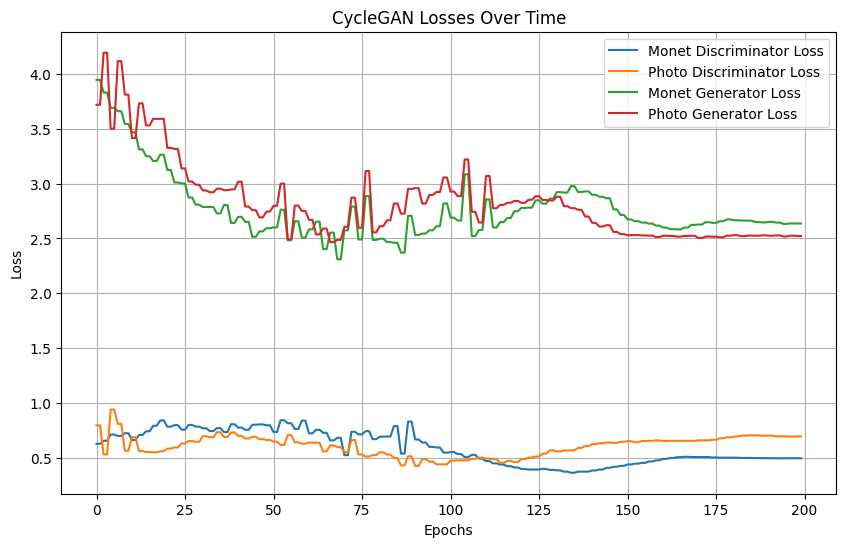

In [28]:
monet_disc_loss = np.mean(np.mean(cycle_gan_model.history.history['monet_disc_loss'], axis=(1, 2)), axis=1)
photo_disc_loss = np.mean(np.mean(cycle_gan_model.history.history['photo_disc_loss'], axis=(1, 2)), axis=1)

# Extract generator losses
monet_gen_loss = np.mean(np.mean(cycle_gan_model.history.history['monet_gen_loss'], axis=(1, 2)), axis=1)
photo_gen_loss = np.mean(np.mean(cycle_gan_model.history.history['photo_gen_loss'], axis=(1, 2)), axis=1)

# Plot the losses
epochs = range(len(monet_gen_loss))

plt.figure(figsize=(10, 6))
plt.plot(monet_disc_loss, label="Monet Discriminator Loss")
plt.plot(photo_disc_loss, label="Photo Discriminator Loss")
plt.plot(monet_gen_loss, label="Monet Generator Loss")
plt.plot(photo_gen_loss, label="Photo Generator Loss")

plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.title("CycleGAN Losses Over Time")
plt.legend()
plt.grid(True)
plt.savefig('losses.png')
plt.show()

# Visualize our Monet-esque photos

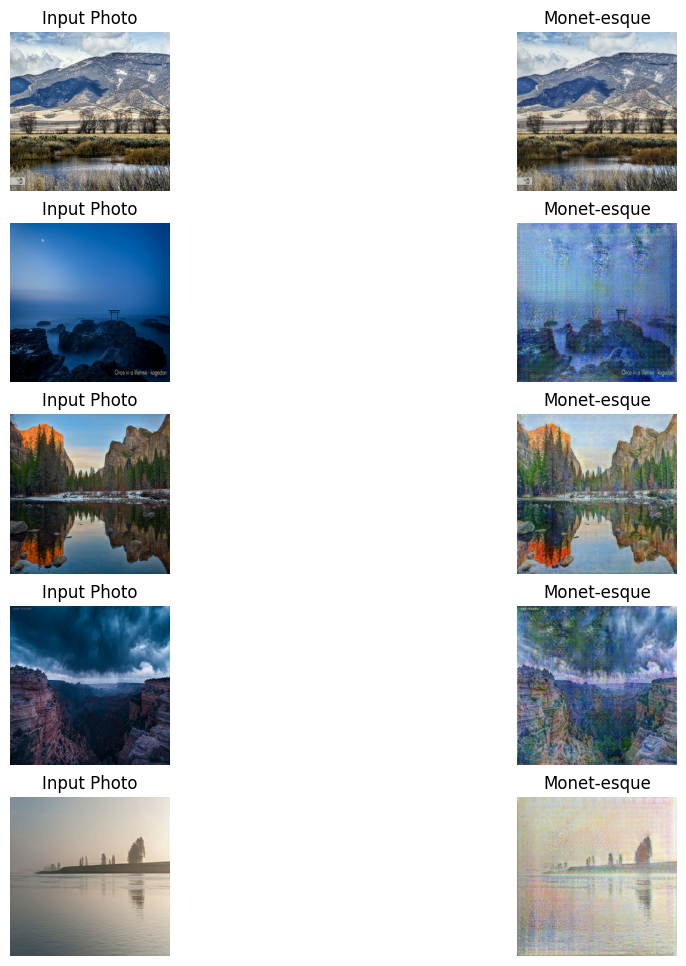

In [29]:
_, ax = plt.subplots(5, 2, figsize=(12, 12))
for i, img in enumerate(photo_ds.take(5)):
    prediction = monet_generator(img, training=False)[0].numpy()
    prediction = (prediction * 127.5 + 127.5).astype(np.uint8)
    img = (img[0] * 127.5 + 127.5).numpy().astype(np.uint8)

    ax[i, 0].imshow(img)
    plt.imsave(f'photoRaw_{i}.jpg', img)
    
    ax[i, 1].imshow(prediction)
    plt.imsave(f'photo2monet_{i}.jpg', prediction)
    
    ax[i, 0].set_title("Input Photo")
    ax[i, 1].set_title("Monet-esque")
    ax[i, 0].axis("off")
    ax[i, 1].axis("off")

    
plt.show()

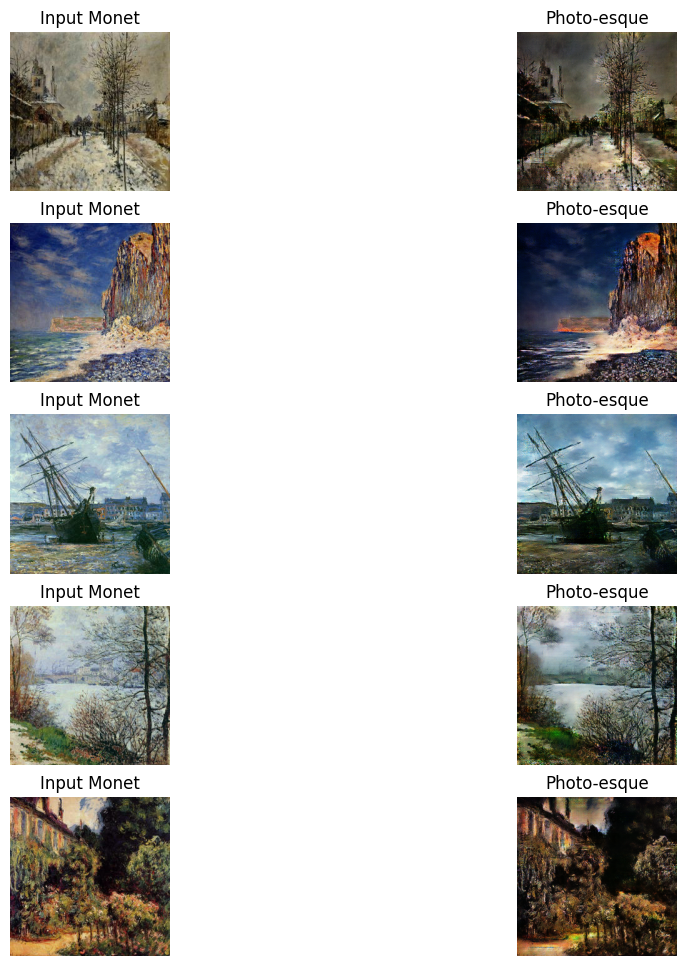

In [30]:
_, ax = plt.subplots(5, 2, figsize=(12, 12))
for i, img in enumerate(monet_ds.take(5)):
    prediction = photo_generator(img, training=False)[0].numpy()
    prediction = (prediction * 127.5 + 127.5).astype(np.uint8)
    img = (img[0] * 127.5 + 127.5).numpy().astype(np.uint8)

    ax[i, 0].imshow(img)
    plt.imsave(f'monetRaw_{i}.jpg', img)
    
    ax[i, 1].imshow(prediction)
    plt.imsave(f'monet2photo_{i}.jpg', prediction)
    
    ax[i, 0].set_title("Input Monet")
    ax[i, 1].set_title("Photo-esque")
    ax[i, 0].axis("off")
    ax[i, 1].axis("off")
plt.show()

In [31]:
import PIL
! mkdir ../images

In [32]:
i = 1
for img in photo_ds:
    prediction = monet_generator(img, training=False)[0].numpy()
    prediction = (prediction * 127.5 + 127.5).astype(np.uint8)
    im = PIL.Image.fromarray(prediction)
    im.save("../images/" + str(i) + ".jpg")
    i += 1

In [33]:
import shutil
shutil.make_archive("/kaggle/working/images", 'zip', "/kaggle/images")

'/kaggle/working/images.zip'